In [1]:
%run ../notebook_preamble.ipy

In [2]:
import random
plt.style.use('seaborn')

In [3]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation, NMF
from sklearn.model_selection import train_test_split, GridSearchCV
import spacy
from spacy.lemmatizer import Lemmatizer
import en_core_web_sm
import gensim
from gensim import corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel, LdaMulticore
import pyLDAvis
import pyLDAvis.gensim
import pyLDAvis.sklearn

2020-03-13 09:34:22,047 - gensim.summarization.textcleaner - INFO - 'pattern' package not found; tag filters are not available for English


In [4]:
nlp = spacy.load('en', disable=['parser', 'ner'])

/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/msgpack_numpy.py:184: DeprecationWarning: encoding is deprecated, Use raw=False instead.
  return _unpackb(packed, **kwargs)
/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/msgpack_numpy.py:184: DeprecationWarning: encoding is deprecated, Use raw=False instead.
  return _unpackb(packed, **kwargs)


In [5]:
stop_words = spacy.lang.en.stop_words.STOP_WORDS

In [6]:
mag = pd.read_csv("../../data/raw/mag.csv", index_col = 0)

In [7]:
pfos = pd.read_csv("../../data/raw/pfos.csv", index_col=0)

/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/numpy/lib/arraysetops.py:569: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [8]:
pfos_geo = pd.read_csv("../../data/raw/pfos_geo.csv", index_col=0)

In [9]:
paper_authors = pd.read_csv("../../data/raw/paper_authors.csv", index_col=0)

In [10]:
mag_abstracts = mag[['id','type','abstract']]

In [11]:
mag_abstracts = mag_abstracts[mag_abstracts.abstract != str(0.0)]

In [12]:
mag_abstracts.head()

,id,type,abstract
0,2048205748,ai,The Generalized Regression Neural Network (GRN...
1,2312543758,ai,Accurate prediction of the energy consumption ...
2,2295856739,ai,The link prediction problem in social networks...
3,2291127212,ai,KMeans clustering-based recommendation algorit...
4,2203470973,ai,"In this paper, we discuss data-driven discover..."


In [101]:
data_ai = mag_abstracts[mag_abstracts.type == 'ai']

In [102]:
data_ci = mag_abstracts[mag_abstracts.type == 'ci']

In [103]:
data_ai_ci = mag_abstracts[mag_abstracts.type == 'ai_ci']

## Data for separate topic modelling

In [104]:
test_size=0.05

In [105]:
indices_test_ai = random.sample(list(data_ai.index), int(test_size*len(data_ai)))

In [108]:
len(indices_test_ai)

30417

In [109]:
tf_ai = [True if index in indices_test_ai else False for index in list(data_ai.index)]

In [117]:
data_ai_test = data_ai[tf_ai]

In [164]:
len(data_ai_test)

30417

## Data for joint topic modelling

### even ai/ci/ai_ci split

In [245]:
test_size=2000

In [246]:
indices_test_ai = random.sample(list(data_ai.index), test_size)

In [247]:
indices_test_ci = random.sample(list(data_ci.index), test_size)

In [248]:
indices_test_ai_ci = random.sample(list(data_ai_ci.index), test_size)

In [249]:
tf_ai = [True if index in indices_test_ai else False for index in list(data_ai.index)]

In [250]:
tf_ci = [True if index in indices_test_ci else False for index in list(data_ci.index)]

In [251]:
tf_ai_ci = [True if index in indices_test_ai_ci else False for index in list(data_ai_ci.index)]

In [252]:
data_ai_test_joint = data_ai[tf_ai]

In [253]:
data_ci_test_joint = data_ci[tf_ci]

In [254]:
data_ai_ci_test_joint = data_ai_ci[tf_ai_ci]

In [255]:
data_test_even_split = pd.concat([data_ai_test_joint, data_ci_test_joint, data_ai_ci_test_joint], axis=0)

### percentage split ai/ci/ai_ci

In [263]:
test_percentage=0.2

In [264]:
indices_test_ai = random.sample(list(data_ai.index), int(0.02*len(data_ai)))

In [265]:
indices_test_ci = random.sample(list(data_ci.index), int(test_percentage*len(data_ci)))

In [266]:
indices_test_ai_ci = random.sample(list(data_ai_ci.index), int(test_percentage*len(data_ai_ci)))

In [267]:
tf_ai = [True if index in indices_test_ai else False for index in list(data_ai.index)]

In [268]:
tf_ci = [True if index in indices_test_ci else False for index in list(data_ci.index)]

In [269]:
tf_ai_ci = [True if index in indices_test_ai_ci else False for index in list(data_ai_ci.index)]

In [270]:
data_ai_test_joint = data_ai[tf_ai]

In [271]:
data_ci_test_joint = data_ci[tf_ci]

In [272]:
data_ai_ci_test_joint = data_ai_ci[tf_ai_ci]

In [273]:
data_test_per_split = pd.concat([data_ai_test_joint, data_ci_test_joint, data_ai_ci_test_joint], axis=0)

# LDA

In [50]:
def sentence_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations

In [63]:
def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV', 'PROPN']):
    texts_out = []
    for sentence in texts:
        doc = nlp(" ".join(sentence)) 
        texts_out.append(" ".join([token.lemma_ if token.lemma_ not in ['-PRON-'] else '' for token in doc if token.pos_ in allowed_postags]))
    return texts_out

In [153]:
# Show top n keywords for each topic
def show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=20):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

In [235]:
# Show top n keywords for each topic
def show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=20):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

## separated topics ai/ci/ai_ci

In [134]:
data_words_ai = list(sentence_to_words(data_ai_test.abstract))

In [135]:
data_words_ci = list(sentence_to_words(data_ci.abstract))

In [136]:
data_words_ai_ci = list(sentence_to_words(data_ai_ci.abstract))

In [137]:
data_lemmatized_ai = lemmatization(data_words_ai, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV', 'PROPN'])

In [138]:
data_lemmatized_ci = lemmatization(data_words_ci, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV', 'PROPN'])

In [139]:
data_lemmatized_ai_ci = lemmatization(data_words_ai_ci, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV', 'PROPN'])

In [205]:
vectorizer_ai = CountVectorizer(analyzer='word',       
                             min_df=10,
                             stop_words=stop_words,             # remove stop words
                             lowercase=True,                   # convert all words to lowercase
                             token_pattern='[a-zA-Z0-9]{3,}',  # num chars > 3
                             ngram_range = (1,3)
                            )

vectorizer_ci = CountVectorizer(analyzer='word',       
                             min_df=10,
                             stop_words=stop_words,             # remove stop words
                             lowercase=True,                   # convert all words to lowercase
                             token_pattern='[a-zA-Z0-9]{3,}',  # num chars > 3
                             ngram_range = (1,3)
                            )

vectorizer_ai_ci = CountVectorizer(analyzer='word',       
                             min_df=10,
                             stop_words=stop_words,             # remove stop words
                             lowercase=True,                   # convert all words to lowercase
                             token_pattern='[a-zA-Z0-9]{3,}',  # num chars > 3
                             ngram_range = (1,3)
                            )



In [206]:
data_vectorized_ai = vectorizer_ai.fit_transform(data_lemmatized_ai)

In [207]:
data_vectorized_ci = vectorizer_ci.fit_transform(data_lemmatized_ci)

In [208]:
data_vectorized_ai_ci = vectorizer_ai_ci.fit_transform(data_lemmatized_ai_ci)

In [209]:
# Build LDA Model
lda_model_ai = LatentDirichletAllocation(n_components=50, max_iter=10, learning_method='online',random_state=2020, n_jobs=-2)

In [210]:
# Build LDA Model
lda_model_ci = LatentDirichletAllocation(n_components=50, max_iter=10, learning_method='online',random_state=2020, n_jobs=-2)

In [211]:
# Build LDA Model
lda_model_ai_ci = LatentDirichletAllocation(n_components=50, max_iter=10, learning_method='online',random_state=2020, n_jobs=-2)

In [212]:
lda_output_ai = lda_model_ai.fit_transform(data_vectorized_ai)

print(lda_model_ai)  # Model attributes

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='online', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=50, n_jobs=-2,
                          perp_tol=0.1, random_state=2020,
                          topic_word_prior=None, total_samples=1000000.0,
                          verbose=0)


In [213]:
lda_output_ci = lda_model_ci.fit_transform(data_vectorized_ci)

print(lda_model_ci)  # Model attributes

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='online', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=50, n_jobs=-2,
                          perp_tol=0.1, random_state=2020,
                          topic_word_prior=None, total_samples=1000000.0,
                          verbose=0)


In [214]:
lda_output_ai_ci = lda_model_ai_ci.fit_transform(data_vectorized_ai_ci)

print(lda_model_ai_ci)  # Model attributes

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='online', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=50, n_jobs=-2,
                          perp_tol=0.1, random_state=2020,
                          topic_word_prior=None, total_samples=1000000.0,
                          verbose=0)


In [215]:
# Log Likelihood: Higher the better
print("Log Likelihood: ", lda_model_ai.score(data_vectorized_ai))

# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
print("Perplexity: ", lda_model_ai.perplexity(data_vectorized_ai))

Log Likelihood:  -33503580.365731344
Perplexity:  8607.459487790245


In [216]:
# Log Likelihood: Higher the better
print("Log Likelihood: ", lda_model_ci.score(data_vectorized_ci))

# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
print("Perplexity: ", lda_model_ci.perplexity(data_vectorized_ci))

Log Likelihood:  -26188898.83467375
Perplexity:  6268.100677362729


In [217]:
# Log Likelihood: Higher the better
print("Log Likelihood: ", lda_model_ai_ci.score(data_vectorized_ai_ci))

# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
print("Perplexity: ", lda_model_ai_ci.perplexity(data_vectorized_ai_ci))

Log Likelihood:  -3245169.7904200186
Perplexity:  1646.530364445234


In [218]:
# Styling
def color_green(val):
    color = 'green' if val > .1 else 'black'
    return 'color: {col}'.format(col=color)

def make_bold(val):
    weight = 700 if val > .1 else 400
    return 'font-weight: {weight}'.format(weight=weight)

In [220]:
## Create document topic matrix
# column names
topicnames_ai = ["Topic" + str(i) for i in range(lda_model_ai.n_components)]
topicnames_ci = ["Topic" + str(i) for i in range(lda_model_ci.n_components)]
topicnames_ai_ci = ["Topic" + str(i) for i in range(lda_model_ai_ci.n_components)]

In [222]:
# index names
docnames_ai = ["Doc" + str(i) for i in range(len(data_ai_test))]
docnames_ci = ["Doc" + str(i) for i in range(len(data_ci))]
docnames_ai_ci = ["Doc" + str(i) for i in range(len(data_ai_ci))]

In [223]:
# Make the pandas dataframe
df_document_topic_ai = pd.DataFrame(np.round(lda_output_ai, 2), columns=topicnames_ai, index=docnames_ai)
df_document_topic_ci = pd.DataFrame(np.round(lda_output_ci, 2), columns=topicnames_ci, index=docnames_ci)
df_document_topic_ai_ci = pd.DataFrame(np.round(lda_output_ai_ci, 2), columns=topicnames_ai_ci, index=docnames_ai_ci)

# Get dominant topic for each document
dominant_topic_ai = np.argmax(df_document_topic_ai.values, axis=1)
dominant_topic_ci = np.argmax(df_document_topic_ci.values, axis=1)
dominant_topic_ai_ci = np.argmax(df_document_topic_ai_ci.values, axis=1)
df_document_topic_ai['dominant_topic'] = dominant_topic_ai
df_document_topic_ci['dominant_topic'] = dominant_topic_ci
df_document_topic_ai_ci['dominant_topic'] = dominant_topic_ai_ci

In [224]:
# Apply Style
df_document_topics_ai = df_document_topic_ai.head(15).style.applymap(color_green).applymap(make_bold)
df_document_topics_ci = df_document_topic_ci.head(15).style.applymap(color_green).applymap(make_bold)
df_document_topics_ai_ci = df_document_topic_ai_ci.head(15).style.applymap(color_green).applymap(make_bold)

In [227]:
df_document_topics_ai_ci

,Topic0,Topic1,Topic2,Topic3,Topic4,Topic5,Topic6,Topic7,Topic8,Topic9,Topic10,Topic11,Topic12,Topic13,Topic14,Topic15,Topic16,Topic17,Topic18,Topic19,Topic20,Topic21,Topic22,Topic23,Topic24,Topic25,Topic26,Topic27,Topic28,Topic29,Topic30,Topic31,Topic32,Topic33,Topic34,Topic35,Topic36,Topic37,Topic38,Topic39,Topic40,Topic41,Topic42,Topic43,Topic44,Topic45,Topic46,Topic47,Topic48,Topic49,dominant_topic
Doc0,0.000000,0.700000,0.000000,0.200000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.040000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.040000,1
Doc1,0.010000,0.000000,0.000000,0.070000,0.040000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.040000,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,0.160000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.660000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,43
Doc2,0.000000,0.330000,0.000000,0.000000,0.000000,0.120000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.130000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.050000,0.000000,0.000000,0.000000,0.000000,0.350000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,43
Doc3,0.000000,0.060000,0.000000,0.050000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.140000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.060000,0.000000,0.000000,0.000000,0.030000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.030000,0.000000,0.000000,0.520000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.090000,41
Doc4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.030000,0.000000,0.000000,0.000000,0.020000,0.000000,0.000000,0.000000,0.480000,0.000000,0.000000,0.000000,0.100000,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,0.340000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,30
Doc5,0.000000,0.050000,0.000000,0.150000,0.000000,0.400000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.040000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.180000,0.160000,0.000000,0.000000,0.000000,0.000000,0.000000,5
Doc6,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.120000,0.000000,0.000000,0.000000,0.050000,0.000000,0.000000,0.000000,0.030000,0.060000,0.000000,0.000000,0.460000,0.000000,0.030000,0.000000,0.120000,0.000000,0.000000,0.000000,0.000000,0.000000,0.100000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,31
Doc7,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.050000,0.760000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.170000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000

In [228]:
df_topic_distribution_ai = df_document_topic_ai['dominant_topic'].value_counts().reset_index(name="Num Documents")
df_topic_distribution_ai.columns = ['Topic Num', 'Num Documents']
df_topic_distribution_ci = df_document_topic_ci['dominant_topic'].value_counts().reset_index(name="Num Documents")
df_topic_distribution_ci.columns = ['Topic Num', 'Num Documents']
df_topic_distribution_ai_ci = df_document_topic_ai_ci['dominant_topic'].value_counts().reset_index(name="Num Documents")
df_topic_distribution_ai_ci.columns = ['Topic Num', 'Num Documents']

In [236]:
pyLDAvis.enable_notebook()
panel = pyLDAvis.sklearn.prepare(lda_model_ai_ci, data_vectorized_ai_ci, vectorizer_ai_ci, mds='tsne')
panel

PreparedData(topic_coordinates=               x          y  topics  cluster       Freq
topic                                                  
41     47.035080  12.326516       1        1  25.222170
3      62.927895  16.994608       2        1  11.003651
33     41.874577  -3.438088       3        1   8.974193
43     77.793198   4.269354       4        1   7.787857
49     63.326359  -5.290165       5        1   7.489568
5      53.147682 -19.693747       6        1   6.567065
1      77.946053  39.830143       7        1   5.033384
23     47.119282  34.260372       8        1   4.053475
38     86.850159  25.631973       9        1   3.458899
34     53.767223  57.081429      10        1   2.391109
19     76.364326 -23.407846      11        1   2.300652
31     29.620316  17.358015      12        1   2.030038
44     61.295216 -43.376129      13        1   1.268647
11    -48.436802  57.937275      14        1   1.247835
28     24.674318  38.371880      15        1   1.222287
30     97.525192 -11.729303      16        1   1.133979
27     56.536869 -72.926964      17        1   0.844072
26    -28.281021  39.638466      18        1   0.831580
4      34.391068 -56.623898      19        1   0.723388
36      1.837791  59.857159      20        1   0.677801
14    -53.916580  27.968861      21        1   0.615414
10    -22.413689  72.622406      22        1   0.612991
35     -8.992606 -58.975460      23        1   0.552676
8      16.365028 -76.679924      24        1   0.472577
46    -71.502693 -27.857576      25        1   0.427165
25     -3.074588  37.260048      26        1   0.397074
18     26.160494  68.618011      27        1   0.393326
42    -72.034920   7.985262      28        1   0.354957
0     -37.788372 -72.815536      29        1   0.322524
12    -54.610111 -50.432076      30        1   0.280615
22    -52.149712 -10.267559      31        1   0.260763
39    -10.872443 -83.773422      32        1   0.170966
15    -27.162468 -46.564983      33        1   0.149836
45    -37.673496   9.048432      34        1   0.134819
2      31.650337 -33.926517      35        1   0.100518
6      11.411376 -49.202518      36        1   0.088988
48    -38.387356 -28.747030      37        1   0.080334
9     -17.331608  19.967749      38        1   0.072070
29    -28.529467 -10.887632      39        1   0.030079
17      5.461740  17.870529      40        1   0.030062
20     -1.050994 -22.901545      41        1   0.021499
47     -5.117688 -37.224388      42        1   0.018789
40     -9.675221 -10.808744      43        1   0.018789
32    -17.569921 -25.093977      44        1   0.018789
7      22.532185 -14.261861      45        1   0.018789
37     13.133644 -28.357246      46        1   0.018789
21     -0.740764   2.804549      47        1   0.018789
13     16.320032   1.979955      48        1   0.018789
16      7.069304 -10.676414      49        1   0.018789
24    -16.630253   2.482525      50        1   0.018789, topic_info=               Term         Freq        Total Category  logprob  loglift
4971           task  4253.000000  4253.000000  Default  30.0000  30.0000
4639         social  1983.000000  1983.000000  Default  29.0000  29.0000
5599         worker  2643.000000  2643.000000  Default  28.0000  28.0000
2802          learn  1495.000000  1495.000000  Default  27.0000  27.0000
139       algorithm  2380.000000  2380.000000  Default  26.0000  26.0000
...             ...          ...          ...      ...      ...      ...
1784        exhibit     0.014517    79.779828  Topic50  -8.6431  -0.0320
3646    performance     0.014516  1226.970334  Topic50  -8.6431  -2.7651
3892  problem solve     0.014516   121.281852  Topic50  -8.6432  -0.4509
139       algorithm     0.014516  2380.808434  Topic50  -8.6432  -3.4280
479            base     0.014516  2929.156808  Topic50  -8.6432  -3.6353

[2735 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
3        31  0.955183   abnormal
9         5  0.947639  abundance

In [238]:
topic_keywords_ai = show_topics(vectorizer=vectorizer_ai, lda_model=lda_model_ai, n_words=15)
topic_keywords_ci = show_topics(vectorizer=vectorizer_ai, lda_model=lda_model_ci, n_words=15)    
topic_keywords_ai_ci = show_topics(vectorizer=vectorizer_ai, lda_model=lda_model_ai_ci, n_words=15)    

# Topic - Keywords Dataframe
df_topic_keywords_ai = pd.DataFrame(topic_keywords_ai)
df_topic_keywords_ai.columns = ['Word '+str(i) for i in range(df_topic_keywords_ai.shape[1])]
df_topic_keywords_ai.index = ['Topic '+str(i) for i in range(df_topic_keywords_ai.shape[0])]

df_topic_keywords_ci = pd.DataFrame(topic_keywords_ci)
df_topic_keywords_ci.columns = ['Word '+str(i) for i in range(df_topic_keywords_ci.shape[1])]
df_topic_keywords_ci.index = ['Topic '+str(i) for i in range(df_topic_keywords_ci.shape[0])]

df_topic_keywords_ai_ci = pd.DataFrame(topic_keywords_ai_ci)
df_topic_keywords_ai_ci.columns = ['Word '+str(i) for i in range(df_topic_keywords_ai_ci.shape[1])]
df_topic_keywords_ai_ci.index = ['Topic '+str(i) for i in range(df_topic_keywords_ai_ci.shape[0])]

In [276]:
df_topic_keywords_ai_ci

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14
Topic 0,ami,behaviour,categorise,algorithm jointly,algorithm greatly,artificial bee colony,analysis theory,behavioural,ace,amplification,application real,categorisation,achieve outstanding,answering,apply neural network
Topic 1,capable,class variation,algorithm allow,base random,accurate detection,borderline,base hidden markov,accuracy comparison,case single,base clustering method,binarization,capable generate,centroid,advantage algorithm,article investigate
Topic 2,analysis task,algorithm validate,approach distribute,approach directly,analyze classification,accurately predict,bone,base order,analysis procedure,achieve competitive,carry different,algorithm datum,acyclic,base numerical,building block
Topic 3,abstractdisplay omit highlightsa,base model use,base hidden markov,associative,achieve large,artificial intelligence research,base solution,accuracy experimental,base approximate,classification achieve,base station,bayesian network represent,aware feature,binarization,challenge large
Topic 4,antigen,base end,analogical,base computer,base agent,base elm,ann method,average classification accuracy,adversarial network,ability improve,ann model develop,base event,appear,base energy,approach finally
Topic 5,accuracy area,challenge large,approach time,class order,case different,air pollution,aid detection,betweenness,big,algorithm computer,algorithm datum,capable,algorithms,bayesian network represent,algorithm self
Topic 6,accuracy run,architecture training,accuracy run time,algorithm random,class interest,approach appropriate,ability capture,accuracy deep,base architecture,achieve real time,approach context,approach real,approach rank,able classify,achieve large
Topic 7,central nervous,application identify,additionally,able discover,application human,able effectively,approximation guarantee,algorithm datum,able estimate,able detect,approach example,accuracy experimental,approach novel,base theory,base model use
Topic 8,berkeley,approximation error,attribute class,analysis paper,aim enhance,active learning,class base,add training,achieve highly,basic,aim propose,catastrophic forgetting,class label information,architecture multi,accuracy sensitivity
Topic 9,challenge arise,allow estimate,algorithm increase,apply image,class large,boost decision,approach pattern,class learning,area medical,class learn,approach perform good,approach perform,boost decision tree,architecture obtain,assistive


In [240]:
topic_values_ai = lda_model_ai.transform(data_vectorized_ai)
topic_values_ci = lda_model_ci.transform(data_vectorized_ci)
topic_values_ai_ci = lda_model_ai_ci.transform(data_vectorized_ai_ci)

In [242]:
data_ai_test['Topic'] = topic_values_ai.argmax(axis=1)
data_ci['Topic'] = topic_values_ci.argmax(axis=1)
data_ai_ci['Topic'] = topic_values_ai_ci.argmax(axis=1)

/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFram

## LDA for joint analysis

In [278]:
data_words_even_split = list(sentence_to_words(data_test_even_split.abstract))
data_words_per_split = list(sentence_to_words(data_test_per_split.abstract))

In [279]:
data_lemmatized_even_split= lemmatization(data_words_even_split, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV', 'PROPN'])
data_lemmatized_per_split= lemmatization(data_words_per_split, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV', 'PROPN'])

In [280]:
vectorizer_even_split = CountVectorizer(analyzer='word',       
                             min_df=10,
                             stop_words=stop_words,             # remove stop words
                             lowercase=True,                   # convert all words to lowercase
                             token_pattern='[a-zA-Z0-9]{3,}',  # num chars > 3
                             ngram_range = (1,3)
                            )

vectorizer_per_split = CountVectorizer(analyzer='word',       
                             min_df=10,
                             stop_words=stop_words,             # remove stop words
                             lowercase=True,                   # convert all words to lowercase
                             token_pattern='[a-zA-Z0-9]{3,}',  # num chars > 3
                             ngram_range = (1,3)
                            )

In [290]:
data_vectorized_even_split = vectorizer_even_split.fit_transform(data_lemmatized_even_split)
data_vectorized_per_split = vectorizer_per_split.fit_transform(data_lemmatized_per_split)

In [291]:
# Build LDA Model
lda_model_even_split = LatentDirichletAllocation(n_components=50, max_iter=10, learning_method='online',random_state=2020, n_jobs=-2)
lda_model_per_split = LatentDirichletAllocation(n_components=50, max_iter=10, learning_method='online',random_state=2020, n_jobs=-2)

In [292]:
lda_output_even_split = lda_model_even_split.fit_transform(data_vectorized_even_split)

print(lda_model_even_split)  # Model attributes

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='online', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=50, n_jobs=-2,
                          perp_tol=0.1, random_state=2020,
                          topic_word_prior=None, total_samples=1000000.0,
                          verbose=0)


In [293]:
lda_output_per_split = lda_model_per_split.fit_transform(data_vectorized_per_split)

print(lda_model_per_split)  # Model attributes

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
                          evaluate_every=-1, learning_decay=0.7,
                          learning_method='online', learning_offset=10.0,
                          max_doc_update_iter=100, max_iter=10,
                          mean_change_tol=0.001, n_components=50, n_jobs=-2,
                          perp_tol=0.1, random_state=2020,
                          topic_word_prior=None, total_samples=1000000.0,
                          verbose=0)


In [294]:
# Log Likelihood: Higher the better
print("Log Likelihood: ", lda_model_even_split.score(data_vectorized_even_split))

# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
print("Perplexity: ", lda_model_even_split.perplexity(data_vectorized_even_split))

Log Likelihood:  -4646442.391846083
Perplexity:  2181.977357622983


In [295]:
# Log Likelihood: Higher the better
print("Log Likelihood: ", lda_model_per_split.score(data_vectorized_per_split))

# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
print("Perplexity: ", lda_model_per_split.perplexity(data_vectorized_per_split))

Log Likelihood:  -18221589.285390135
Perplexity:  8164.8217830484955


In [296]:
## Create document topic matrix
# column names
topicnames_even_split = ["Topic" + str(i) for i in range(lda_model_even_split.n_components)]
topicnames_per_split = ["Topic" + str(i) for i in range(lda_model_per_split.n_components)]

# index names
docnames_even_split = ["Doc" + str(i) for i in range(len(data_test_even_split))]
docnames_per_split = ["Doc" + str(i) for i in range(len(data_test_per_split))]

# Make the pandas dataframe
df_document_topic_even_split = pd.DataFrame(np.round(lda_output_even_split, 2), columns=topicnames_even_split, index=docnames_even_split)
df_document_topic_per_split = pd.DataFrame(np.round(lda_output_per_split, 2), columns=topicnames_per_split, index=docnames_per_split)

# Get dominant topic for each document
dominant_topic_even_split = np.argmax(df_document_topic_even_split.values, axis=1)
df_document_topic_even_split['dominant_topic'] = dominant_topic_even_split
dominant_topic_per_split = np.argmax(df_document_topic_per_split.values, axis=1)
df_document_topic_per_split['dominant_topic'] = dominant_topic_per_split

# Apply Style
df_document_topics_even_split = df_document_topic_even_split.head(15).style.applymap(color_green).applymap(make_bold)
df_document_topics_per_split = df_document_topic_per_split.head(15).style.applymap(color_green).applymap(make_bold)

In [297]:
df_topic_distribution_even_split = df_document_topic_even_split['dominant_topic'].value_counts().reset_index(name="Num Documents")
df_topic_distribution_even_split.columns = ['Topic Num', 'Num Documents']
df_topic_distribution_per_split = df_document_topic_per_split['dominant_topic'].value_counts().reset_index(name="Num Documents")
df_topic_distribution_per_split.columns = ['Topic Num', 'Num Documents']

In [299]:
pyLDAvis.enable_notebook()
panel = pyLDAvis.sklearn.prepare(lda_model_per_split, data_vectorized_per_split, vectorizer_per_split, mds='tsne')
panel

PreparedData(topic_coordinates=               x           y  topics  cluster       Freq
topic                                                   
22      2.062182  -61.038811       1        1  20.392810
41     10.144016  -46.939220       2        1  11.776146
37     25.631786  -68.352295       3        1   6.572082
9       8.590746  -82.706810       4        1   6.445075
43     49.893719  -69.631538       5        1   4.159091
23     -5.856220  -33.771164       6        1   3.422505
40     33.672478  -88.496826       7        1   3.180781
3     -29.702116  -35.188530       8        1   2.944060
7     -18.825089  -58.232903       9        1   2.714312
48     43.601864  -24.090866      10        1   2.399532
38     37.782394  -48.600185      11        1   2.326674
45     66.969658  -40.195114      12        1   2.046396
19    -52.216961  -52.701073      13        1   1.929730
1      77.345634   11.957479      14        1   1.901700
12     16.780489  -24.793945      15        1   1.885084
30     30.614395 -118.364182      16        1   1.710602
15    -19.079039  -82.972725      17        1   1.610041
36     47.239555   -2.213253      18        1   1.418244
28      0.834992 -107.202652      19        1   1.402468
18    -51.126698  -82.538383      20        1   1.323313
4      69.506897  -95.640503      21        1   1.287091
13    -59.645920  -23.203283      22        1   1.234491
42     66.581474   24.872770      23        1   1.197256
8      83.480392  -71.917755      24        1   1.100713
20    -30.535337 -116.488632      25        1   1.061924
21     90.532593  -21.450817      26        1   1.000302
25    -31.152882   -8.025200      27        1   0.937579
39     94.791916   54.606480      28        1   0.917840
29     -2.804758   -6.153460      29        1   0.902098
16    -87.207901   -2.643225      30        1   0.883343
46     19.656645   66.968201      31        1   0.863149
6      56.409077   68.722885      32        1   0.827736
44    -80.233757  -51.545017      33        1   0.749015
0      19.359991   16.732365      34        1   0.733792
34    -54.759510   13.599161      35        1   0.680232
24     33.388309   41.958740      36        1   0.667917
49    -76.111984   37.269531      37        1   0.527731
10     18.043209   96.862877      38        1   0.505001
14    -14.999027  111.055771      39        1   0.494569
47    -48.203754   97.192177      40        1   0.492469
31    -80.147888   70.267960      41        1   0.436101
35    -15.445860   81.680542      42        1   0.289114
5     -49.236778   68.667511      43        1   0.199974
11    -45.343880   42.755905      44        1   0.097116
26     -8.194838   22.760098      45        1   0.066610
2     -29.987532   25.945738      46        1   0.066574
33      4.512250   41.324345      47        1   0.063655
17    -27.251509   57.722771      48        1   0.058962
27     -6.400352   58.681854      49        1   0.051634
32    -17.070782   41.719261      50        1   0.045363, topic_info=                  Term          Freq         Total Category  logprob  loglift
12885          network  11754.000000  11754.000000  Default  30.0000  30.0000
4626             datum  16158.000000  16158.000000  Default  29.0000  29.0000
11678           method  14104.000000  14104.000000  Default  28.0000  28.0000
7318           feature   6420.000000   6420.000000  Default  27.0000  27.0000
12148            model  15950.000000  15950.000000  Default  26.0000  26.0000
...                ...           ...           ...      ...      ...      ...
20821         traveler      0.017187      0.988564  Topic50 -10.8854   3.6461
4389     crowdsourcing      0.017187      0.988564  Topic50 -10.8854   3.6461
2894   citizen science      0.017187      0.988564  Topic50 -10.8854   3.6461
13219     new business      0.017187     23.289706  Topic50 -10.8854   0.4866
5718   difficult paper      0.017187     13.926967  Topic50 -10.8854   1.0008

[2454 rows x 6 columns], token_table=       Topic      F

In [301]:
topic_keywords_even_split = show_topics(vectorizer=vectorizer_even_split, lda_model=lda_model_even_split, n_words=15)
topic_keywords_per_split = show_topics(vectorizer=vectorizer_per_split, lda_model=lda_model_per_split, n_words=15)        

# Topic - Keywords Dataframe
df_topic_keywords_even_split = pd.DataFrame(topic_keywords_even_split)
df_topic_keywords_even_split.columns = ['Word '+str(i) for i in range(df_topic_keywords_even_split.shape[1])]
df_topic_keywords_even_split.index = ['Topic '+str(i) for i in range(df_topic_keywords_even_split.shape[0])]

df_topic_keywords_per_split = pd.DataFrame(topic_keywords_per_split)
df_topic_keywords_per_split.columns = ['Word '+str(i) for i in range(df_topic_keywords_per_split.shape[1])]
df_topic_keywords_per_split.index = ['Topic '+str(i) for i in range(df_topic_keywords_per_split.shape[0])]

In [307]:
df_topic_keywords_per_split

,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14
Topic 0,action,monitoring,environment,track,change,tracking,water,observation,trajectory,comment,motion,localization,crowd source,example,navigation
Topic 1,network,neural,prediction,neural network,architecture,structure,predict,deep,model,memory,link,term,recurrent,connection,loss
Topic 2,entrepreneur,die,parking,epidemic,workplace,von,entrepreneurial,garden,urban environment,service system,structure model,source project,world dataset demonstrate,nfinding,urban planning
Topic 3,image,object,video,participant,visual,detection,deep,segmentation,use,convolutional,cnn,train,base,vision,deep learning
Topic 4,machine,pattern,datum,learn,machine learn,collection,privacy,security,attack,medical,vehicle,datum collection,learn algorithm,technique,use
Topic 5,crowdsourc,crowdsourc datum,rss,retailer,plastic,evacuation,october,new social,find way,viral,discuss challenge,mouth,base tree,regression svr,policymaker
Topic 6,optimization,local,global,diversity,convergence,algorithm,sentence,swarm,particle,population,character,optimization problem,pso,particle swarm,mutation
Topic 7,decision,fuzzy,method,system,propose,paper,use,set,base,expert,approach,new,value,criterion,uncertainty
Topic 8,resource,computing,machine,learning,machine learning,specie,technique,cloud,learning technique,protocol,application,research,allocation,use,eye
Topic 9,model,study,use,project,analysis,datum,time,process,factor,different,practice,effect,tool,case,risk


In [302]:
topic_values_even_split = lda_model_even_split.transform(data_vectorized_even_split)
topic_values_per_split = lda_model_per_split.transform(data_vectorized_per_split)

In [303]:
data_test_even_split['Topic'] = topic_values_even_split.argmax(axis=1)
data_test_per_split['Topic'] = topic_values_per_split.argmax(axis=1)

/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/pandas/plotting/_matplotlib/tools.py:298: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/pandas/plotting/_matplotlib/tools.py:298: MatplotlibDeprecationWarning: 
The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/Users/rwilcock/opt/anaconda3/envs/ai_ci/lib/python3.6/site-packages/pandas/plotting/_matplotlib/tools.py:304: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  if not layout[ax.rowNum + 1,

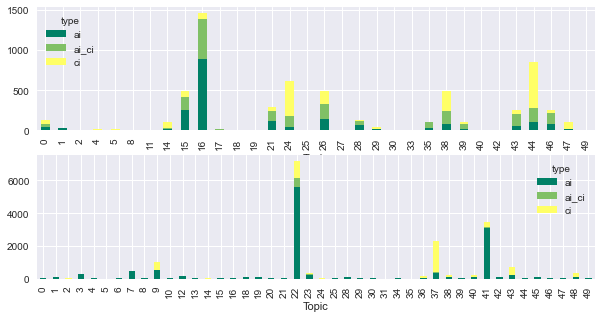

In [304]:
fig = plt.figure(figsize=(10,5))
ax1 = plt.subplot2grid((2,1),(0, 0))
ax2 = plt.subplot2grid((2,1),(1, 0))
data_test_even_split.groupby(['Topic', 'type']).id.count().unstack('type').plot(kind='bar', stacked=True, ax=ax1, cmap='summer')
data_test_per_split.groupby(['Topic', 'type']).id.count().unstack('type').plot(kind='bar', stacked=True, ax=ax2, cmap='summer')

## Gridsearch LDA

In [52]:
# Define Search Param
#search_params = {'n_components': [10,20,30], 'learning_decay': [.7]}

# Init the Model
#lda = LatentDirichletAllocation()

# Init Grid Search Class
#model = GridSearchCV(lda, param_grid=search_params, n_jobs=-2)

# Do the Grid Search
#model.fit(data_vectorized)

GridSearchCV(cv=None, error_score=nan,
             estimator=LatentDirichletAllocation(batch_size=128,
                                                 doc_topic_prior=None,
                                                 evaluate_every=-1,
                                                 learning_decay=0.7,
                                                 learning_method='batch',
                                                 learning_offset=10.0,
                                                 max_doc_update_iter=100,
                                                 max_iter=10,
                                                 mean_change_tol=0.001,
                                                 n_components=10, n_jobs=None,
                                                 perp_tol=0.1,
                                                 random_state=None,
                                                 topic_word_prior=None,
                                                 tota

In [53]:
# Best Model
#best_lda_model = model.best_estimator_

# Model Parameters
#print("Best Model's Params: ", model.best_params_)

# Log Likelihood Score
#print("Best Log Likelihood Score: ", model.best_score_)

# Perplexity
#print("Model Perplexity: ", best_lda_model.perplexity(data_vectorized))

Best Model's Params:  {'learning_decay': 0.7, 'n_components': 10}
Best Log Likelihood Score:  -16733834.937128574
Model Perplexity:  7321.235314213608


## Gensim topic modelling

In [13]:
from gensim.models.word2vec import Text8Corpus
from gensim.models.phrases import Phrases, Phraser

In [40]:
def lemmatizer(doc):
    # This takes in a doc of tokens from the NER and lemmatizes them. 
    # Pronouns (like "I" and "you" get lemmatized to '-PRON-', so I'm removing those.
    doc = [token.lemma_ for token in doc if token.lemma_ != '-PRON-']
    doc = u' '.join(doc)
    return nlp.make_doc(doc)
    
def remove_stopwords(doc):
    # This will remove stopwords and punctuation.
    # Use token.text to return strings, which we'll need for Gensim.
    doc = [token.text for token in doc if token.is_stop != True and token.is_punct != True]
    return doc

In [41]:
# The add_pipe function appends our functions to the default pipeline.
nlp.add_pipe(lemmatizer,name='lemmatizer',after='ner')
nlp.add_pipe(remove_stopwords, name="stopwords", last=True)

ValueError: [E007] 'lemmatizer' already exists in pipeline. Existing names: ['tagger', 'parser', 'ner', 'lemmatizer', 'stopwords']

In [53]:
abstracts_processed = []
# Iterates through each article in the corpus.
for abstract in data_test.abstract:
    # Passes that article through the pipeline and adds to a new list.
    pr = nlp(abstract)
    abstracts_processed.append(pr)

In [54]:
words = corpora.Dictionary(abstracts_processed)

2020-03-06 11:05:28,832 - gensim.corpora.dictionary - INFO - adding document #0 to Dictionary(0 unique tokens: [])
2020-03-06 11:05:29,995 - gensim.corpora.dictionary - INFO - adding document #10000 to Dictionary(43669 unique tokens: ['accurate', 'address', 'advantage', 'anofs', 'application']...)
2020-03-06 11:05:30,235 - gensim.corpora.dictionary - INFO - built Dictionary(49229 unique tokens: ['accurate', 'address', 'advantage', 'anofs', 'application']...) from 11852 documents (total 1128009 corpus positions)


In [55]:
corpus = [words.doc2bow(doc) for doc in abstracts_processed]

In [ ]:
LDA=LdaMulticore(corpus=corpus,id2word=words, num_topics=50, workers=3, iterations=50, passes=2)

2020-03-06 11:11:37,530 - gensim.models.ldamodel - INFO - using symmetric alpha at 0.02
2020-03-06 11:11:37,532 - gensim.models.ldamodel - INFO - using symmetric eta at 0.02
2020-03-06 11:11:37,541 - gensim.models.ldamodel - INFO - using serial LDA version on this node
2020-03-06 11:11:37,745 - gensim.models.ldamulticore - INFO - running online LDA training, 50 topics, 2 passes over the supplied corpus of 11852 documents, updating every 6000 documents, evaluating every ~11852 documents, iterating 50x with a convergence threshold of 0.001000
2020-03-06 11:11:37,746 - gensim.models.ldamulticore - WARNING - too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
2020-03-06 11:11:37,749 - gensim.models.ldamulticore - INFO - training LDA model using 3 processes
2020-03-06 11:11:37,795 - gensim.models.ldamulticore - INFO - PROGRESS: pass 0, dispatched chunk #0 = documents up to #2000/11852, outstanding queue size 1
2020-03-06 1

In [ ]:
def make_bigrams(texts):
    return [gensim.models.phrases.Phraser

In [36]:
sentences = Text8Corpus(data_test)

In [37]:
phrases = Phrases(sentences, min_count = 100, threshold=100, max_vocab_size=100)

2020-03-03 18:15:57,230 - gensim.models.phrases - INFO - collecting all words and their counts


TypeError: don't know how to handle uri ['A number of representation schemes have been presented for use within learning classifier systems, ranging from binary encodings to neural networks. This paper presents results from an investigation into using discrete and fuzzy dynamical system representations within the XCSF learning classifier system. In particular, asynchronous random Boolean networks are used to represent the traditional condition-action production system rules in the discrete case and asynchronous fuzzy logic networks in the continuous-valued case. It is shown possible to use self-adaptive, open-ended evolution to design an ensemble of such dynamical systems within XCSF to solve a number of well-known test problems.', "Artificial Neural Network (ANN) has been considered as a better analytic tool in the field of Kansei Engineering research.In order to minimize the image deviation due to the color combination,ad- vice suitable for individual product type was put forward based on poll survey of consumer's image evaluation according to the theory of neural network and genetic algorithm.A structure of computer aided color design system was constructed on the basis of the developed methods and associated algorithms.", 'To enhance wireless and mobile system dependability, audit operations are necessary, to periodically check the database consistency and recover in case of data corruption. Consequently, how to tune the database audit parameters and which operation order and frequency to apply becomes important aspects, to optimize performance and satisfy a certain degree of Quality of Service, over system life-cycle. The aim of this work is then to suggest an intelligent maintenance system based on reinforcement Q-Learning approach, built of a given audit operation set and an audit manager, in order to maximize the performance (performability and unreliability). For this purpose, a methodology, based on deterministic and stochastic Petri nets, to model and analyze the dependability attributes of different scheduled audit strategies is first developed. Afterwards, an intelligent (reinforcement Q-Learning) software agent approach is developed for planning and learning to derive optimal maintenance policies adaptively dealing with the highly dynamic evolution of the environmental conditions. This intelligent approach, is then implemented with feedforward artificial neural networks under the supervised gradient back-propagation learning to guarantee the success even with large state spaces, exploits intelligent behaviors traits (learning, adaptation, generalization, and robustness) to derive optimal actions in different system states in order to achieve an intelligent maintenance system.', 'Abstract. Clustering is most often used method for noticing data groupings. With an increase of a number of sets for testing there came the development of numerous techniques which are based on different criteria and prior knowledge on the corpus. This work presents the summary of elementary fuzzy partition clustering techniques and their application in searching through information.', 'In this paper, we propose an incremental genetic algorithm applied to solve the maximum cut problem. We test the implementation of the algorithm on benchmark graph instances. We propose several methods to build up the sequence of subproblems, and they are tested through experiments. The performance of a genetic algorithm makes an improvement when the incremental approach is applied with respect to an appropriate sequence of subproblems.', 'In many applications there is a need to monitor how a population is distributed across different classes, and to track the changes in this distribution that derive from varying circumstances, an example such application is monitoring the percentage (or \\"prevalence\\") of unemployed people in a given region, or in a given age range, or at different time periods. When the membership of an individual in a class cannot be established deterministically, this monitoring activity requires classification. However, in the above applications the final goal is not determining which class each individual belongs to, but simply estimating the prevalence of each class in the unlabeled data. This task is called quantification. In a supervised learning framework we may estimate the distribution across the classes in a test set from a training set of labeled individuals. However, this may be sub optimal, since the distribution in the test set may be substantially different from that in the training set (a phenomenon called distribution drift). So far, quantification has mostly been addressed by learning a classifier optimized for individual classification and later adjusting the distribution it computes to compensate for its tendency to either under-or over-estimate the prevalence of the class. In this paper we propose instead to use a type of decision trees (quantification trees) optimized not for individual classification, but directly for quantification. Our experiments show that quantification trees are more accurate than existing state-of-the-art quantification methods, while retaining at the same time the simplicity and understandability of the decision tree framework.', 'The rapid development of methods that select over/under expressed genes from RNA microarray experiments have not yet satisfied the need for tools that identify differential profiles that distinguish between experimental conditions such as time, treatment and phenotype. We evaluate several microarray analysis methods and study their performance, finding that none of the methods alone identifies all observable differential profiles, nor subsumes the results obtained by the other methods. Therefore, we propose a machine learning based methodology that identifies and combines the abilities of microarray analysis methods to recognize differential profiles. We encode the results of this methodology in decision making association rules able to decide which method or method-aggregation is optimal to retrieve a set of genes exhibiting a common profile. These solutions are optimal in the sense that they constitute partial ordered subsets of all method-aggregations bounded by the most specific and the most sensitive available solution. This methodology was successfully applied to a study of inflammation and host response to injury data set derived from the analysis of longitudinal blood microarray profiles of human volunteers treated with intravenous endotoxin compared to placebo. Our approach was able to uncover a cohesive set of differentially expressed genes and novel members exhibiting previously studied differential profiles. This guideline serves as a means to support decisions on new microarray problems.', 'This invention relates to a novel and innovative means and method to accurately and consistently classify professional services and expenses into textual, numerical, and Uniform Task Based Management System (UTBMS) or similar categories which can then be reliably used by attorneys, consultants, accountants, architects, and other professionals who bill by the hour for their services to track, analyze, and evaluate their costs, the performance of specific individuals and vendors, and other metrics. More particularly, this invention relates to a novel and innovative means and method of: (1) automating and standardizing the coding of professional activity and expenses in an accurate, consistent, and therefore useful manner; (2) automatically evaluating and standardizing billing entries through the use of lexical, statistical, and multivariate analysis, pattern matching, contextual grouping, and supervised and unsupervised machine learning of American English legal and other phrases; and (3) evaluating the reasonableness of amounts charged for specific professional activities and expenses, whether by entry or in the aggregate.', 'Abstract Automatic text summarization tools help users in the biomedical domain to acquire their intended information from various textual resources more efficiently. Some of biomedical text summarization systems put the basis of their sentence selection approach on the frequency of concepts extracted from the input text. However, it seems that exploring other measures rather than the raw frequency for identifying valuable contents within an input document, or considering correlations existing between concepts, may be more useful for this type of summarization. In this paper, we describe a Bayesian summarization method for biomedical text documents. The Bayesian summarizer initially maps the input text to the Unified Medical Language System (UMLS) concepts; then it selects the important ones to be used as classification features. We introduce six different feature selection approaches to identify the most important concepts of the text and select the most informative contents according to the distribution of these concepts. We show that with the use of an appropriate feature selection approach, the Bayesian summarizer can improve the performance of biomedical summarization. Using the Recall-Oriented Understudy for Gisting Evaluation (ROUGE) toolkit, we perform extensive evaluations on a corpus of scientific papers in the biomedical domain. The results show that when the Bayesian summarizer utilizes the feature selection methods that do not use the raw frequency, it can outperform the biomedical summarizers that rely on the frequency of concepts, domain-independent and baseline methods.', 'In this paper we propose a novel Deep Reinforcement Learning (DRL) algorithm that uses the concept of \\u201caction-dependent state features\\u201d, and exploits it to approximate the Q-values locally, employing a deep neural network with parallel Long Short Term Memory (LSTM) components, each one responsible for computing an action-related Q-value. As such, all computations occur simultaneously, and there is no need to employ \\u201ctarget\\u201d networks and experience replay, which are techniques regularly used in the DRL literature. Moreover, our algorithm does not require previous training experiences, but trains itself online during game play. We tested our approach in the Settlers Of Catan multi-player strategic board game. Our results confirm the effectiveness of our approach, since it outperforms several competitors, including the state-of-the-art jSettler heuristic algorithm devised for this particular domain.', 'This paper describes a program called Hob that uses analogical mappings across narratives to drive an experimental conversational system. Analogical mappings are used to drive internal reasoning processes and supply response templates. The knowledge base is written in simple English, and consists of three parts: a dictionary, a collection of facts and heuristics, and a collection of stories that notionally correspond to an experience base. Internally, knowledge is stored and used in the form of near-canonical English parse trees. Thus the schema is not hardwired, but is derived from the knowledge base as interpreted under the rules and implications of English grammar. An experimental \\u201csellbot\\u201d application is described, and example runs are presented.', "Association rules are a data mining cornerstone. Association rules greatest impact is in helping to make decisions. One association rule quality measure is a rule's decision value. Association rules are often constructed using simplifying assumptions that lead to naive results and consequently naive decisions. Perhaps the greatest impact on decision value quality comes from treating association rules as causal statements without understanding whether there is, in fact, underlying causality. Complete knowledge of all possible factors might lead to a crisp description of whether an effect will occur. However, it is unlikely that all possible factors can be known. Commonsense world understanding accepts imprecision, uncertainty and imperfect knowledge. People recognize that a complex collection of elements can cause a particular effect. The events in the complex may not be known; or, what constraints and laws the complex is subject to. Sometimes, the details underlying an event can be known to a fine level of detail, sometimes not. Usually, commonsense reasoning is more successful in reasoning about a few large-grain sized events than many fine-grained events. A satisficing solution would be to develop large-grained solutions and only use the flner- grain when the impreciseness of the large-grain is unsatisfactory.", 'Encouraged by the success of deep learning in a variety of domains, we investigate the suitability and effectiveness of Recurrent Neural Networks (RNNs) in a domain where deep learning has not yet been used; namely detecting confusion from eye-tracking data. Through experiments with a dataset of user interactions with ValueChart (an interactive visualization tool), we found that RNNs learn a feature representation from the raw data that allows for a more powerful classifier than previous methods that use engineered features. This is evidenced by the stronger performance of the RNN (0.74/0.71 sensitivity/specificity), as compared to a Random Forest classifier (0.51/0.70 sensitivity/specificity), when both are trained on an un-augmented dataset. However, using engineered features allows for simple data augmentation methods to be used. These same methods are not as effective at augmentation for the feature representation learned from the raw data, likely due to an inability to match the temporal dynamics of the data.', 'In our previous report (J Pharmaceut Biomed 56 (2011) 443\\u2013447), a support vector machine (SVM)-based pharmacodynamic model was established for predicting active fractions of herbal medicines (HMs), where information contents embedded in the chromatograms of the fractions were represented with the peak areas. However, in this representation the global characteristics of the chromatograms were completely missed, which is definitely contrary to the global and holistic views in theories of HMs and undoubtedly reduce the success rate of this model. To deal with the challenge, two chemometrics methods, that is, minimum redundancy maximum relevance (mRMR) and particle swarm optimizer (PSO), were applied in this article for feature selection of the whole chromatograms, and the PSO was also used to tune the SVM parameters. As a case, a sample HM, that is, Xiangdan injection, was investigated. The predictive accuracy was fully evaluated and compared with those by other popular and reported methods. Furthermore, the confirmation on the independent predicting set exhibited that the predicted bioactivities were well consistent with the experimental values. The important potential application of the present model is to be extended to help search active fractions of other HMs.', 'DNA arrays can be used to measure the expression levels of thousands of genes simultaneously. Most research is focusing on interpretation of the meaning of the data. However, the majority of methods are supervised, with less attention having been paid to unsupervised approaches which are important when domain knowledge is incomplete or hard to obtain. In this paper we present a new framework for unsupervised analysis of gene expression data which applies an interrelated two-way clustering approach to the gene expression matrices. The goal of clustering is to find important gene patterns and perform cluster discovery on samples. The advantage of this approach is that we can dynamically use the relationships between the groups of genes and samples while iteratively clustering through both gene-dimension and sample-dimension. We illustrate the method on gene expression data from a study of multiple sclerosis patients. The experiments demonstrate the effectiveness of this approach.', 'Bayesian Belief Networks (BBNs) are a powerful formalism for reasoning under uncertainty but bear some severe limitations: they require a large amount of information before any reasoning process can start, they have limited contradiction handling capabilities, and their ability to provide explanations for their conclusion is still controversial. There exists a class of reasoning systems, called Truth Maintenance Systems (TMSs), which are able to deal with partially specified knowledge, to provide well-founded explanation for their conclusions, and to detect and handle contradictions. TMSs incorporating measure of uncertainty are called Belief Maintenance Systems (BMSs). This paper describes how a BMS based on probabilistic logic can be applied to BBNs, thus introducing a new class of BBNs, called Ignorant Belief Networks, able to incrementally deal with partially specified conditional dependencies, to provide explanations, and to detect and handle contradictions.', 'This paper presents an extension of hidden Markov models (HMMs) based on the type-2 (T2) fuzzy set (FS) referred to as type-2 fuzzy HMMs (T2 FHMMs). Membership functions (MFs) of T2 FSs are three-dimensional, and this new third dimension offers additional degrees of freedom to evaluate the HMMs fuzziness. Therefore, T2 FHMMs are able to handle both random and fuzzy uncertainties existing universally in the sequential data. We derive the T2 fuzzy forward-backward algorithm and Viterbi algorithm using T2 FS operations. In order to investigate the effectiveness of T2 FHMMs, we apply them to phoneme classification and recognition on the TIMIT speech database. Experimental results show that T2 FHMMs can effectively handle noise and dialect uncertainties in speech signals besides a better classification performance than the classical HMMs.', 'In this article, the technologies which can determine the weight and growth of livestock are reviewed. Limitations of the weighing task by these different methods are defined. Comparisons between the different techniques highlight the superiority of the non-contact visionbased method. Modelling techniques for weight estimation, size and composition are reviewed along with image segmentation and recognition methods. Conclusions identify that further work is required in regards to (i) estimating the weight, (ii) estimating the weight deviation of groups of livestock animals, (iii) estimating the weight of individual animals, and (iv) improving the design of livestock weighing methods to function in commercially realistic environments. Future direction also centres on enhancing automation, minimising invasive environmental-control, maximising precision and repeatability during the recovery of body measurements and identifying and controlling the effect of any bias in weight estimation.', 'With the massive and ever increasing pages in the Web, incremental crawling has become a promising method to achieve on-line information. Its main advantage is the resource economization, which comes from the avoidance of downloading unchanged pages. For the precision of change prediction, the evolution of Web is generally studied to find out how pages change. In sum, incremental crawlers often integrate change frequency, change extent, and document quality for each page to determine its relative order as well as its download frequency. In this paper, the researches on Web evolution and incremental crawling in recent years are summarized: First, the change of page is modeled as a Poisson process, and the solutions are given to estimate its parameters, especially the change frequency, and then experimental results are shown. Second, based on the change of pages, three public large-scale incremental crawling systems are introduced, with emphasis on their scheduling policies and strategies to enhance page qualities. Third, theoretical analysis and exploration are performed to find the optimal scheduling policy, three approaches from different points of views are utilized to achieve this object, and a heuristic approximate solution is supplied for the feasibility in practice. Finally, research trends in this area are predicted, and three main issues are listed.', "The invention contains methods for identifying, parameterizing, saving and utilizing Multicriterion Decision Making (MCDM) functions to analyze data sets. The invention contains methods for performing selections with individual interaction with checkboxes, plots, algorithms, and queries, all linked to a single selection state attribute that is automatically added to each dataset. Successive selection steps may be combined with boolean operators: SET/AND/OR. Selection state is sortable to allow selected objects to be visually collected. Together, this provides a powerful suite for MCDM, which is true Decision Support. The invention contains methods for visualizing molecular structures which allow greater cognitive power to be brought to bear on crucial aspects of many types of structural comparison and analysis, using visual topological cueing. The invention contains visual methods for enhancing an analyst's ability to identify and robustly recognize relationships between molecular structures and the properties they give rise to.", 'Recently, neural models for information retrieval are becoming increasingly popular. They provide effective approaches for product search due to their competitive advantages in semantic matching. However, it is challenging to use graph-based features, though proved very useful in IR literature, in these neural approaches. In this paper, we leverage the recent advances in graph embedding techniques to enable neural retrieval models to exploit graph-structured data for automatic feature extraction. The proposed approach can not only help to overcome the long-tail problem of click-through data, but also incorporate external heterogeneous information to improve search results. Extensive experiments on a real-world e-commerce dataset demonstrate significant improvement achieved by our proposed approach over multiple strong baselines both as an individual retrieval model and as a feature used in learning-to-rank frameworks.', 'This paper presents a new strategy for fraud detection in Advanced Metering Infrastructure (AMI) based on the analysis of disturbances in the pattern consumption of end-customers. The proposed strategy is based on the use of SVM (Supported Vector Machine). SVM requires labeled training data in order to define a classification function. The need of labeled data is a serious limitation for practical implementation of fraud detection systems in AMI. To work around this problem, we propose a new strategy for training SVM classifiers that requires only normal consumption patterns in the training phase. The anomalous consumption is generated by simulating attacks on the normal consumption patterns.', 'The quality of species distribution models (SDMs) relies to a large degree on the quality of the input data, from bioclimatic indices to environmental and habitat descriptors (Austin, 2002). Recent reviews of SDM techniques, have sought to optimize predictive performance e.g. Elith et al., 2006. In general SDMs employ one of three approaches to variable selection. The simplest approach relies on the expert to select the variables, as in environmental niche models Nix, 1986 or a generalized linear model without variable selection (Miller and Franklin, 2002). A second approach explicitly incorporates variable selection into model fitting, which allows examination of particular combinations of variables. Examples include generalized linear or additive models with variable selection (Hastie et al. 2002); or classification trees with complexity or model based pruning (Breiman et al., 1984, Zeileis, 2008). A third approach uses model averaging, to summarize the overall contribution of a variable, without considering particular combinations. Examples include neural networks, boosted or bagged regression trees and Maximum Entropy as compared in Elith et al. 2006. Typically, users of SDMs will either consider a small number of variable sets, via the first approach, or else supply all of the candidate variables (often numbering more than a hundred) to the second or third approaches. Bayesian SDMs exist, with several methods for eliciting and encoding priors on model parameters (see review in Low Choy et al. 2010). However few methods have been published for informative variable selection; one example is Bayesian trees (O\\u2019Leary 2008). Here we report an elicitation protocol that helps makes explicit a priori expert judgements on the quality of candidate variables. This protocol can be flexibly applied to any of the three approaches to variable selection, described above, Bayesian or otherwise. We demonstrate how this information can be obtained then used to guide variable selection in classical or machine learning SDMs, or to define priors within Bayesian SDMs.', 'Current literature on land use highlights the considerable methodological challenges in predicting how land will be used in the future. This paper addresses one of these challenges, namely the restrictive nature of the mono-class assignment, in which a spatial unit has only one elementary label at a time. We apply the multi-label concept in which a unit may have several elementary labels. For instance, a spatial unit may belong to residential and commercial classes at the same time. Classes in land use may be correlated, and taking into account their correlation may improve the land use changes prediction. For instance, a spatial unit has more chance to be, or to evolve to a residential unit if it is already commercial. The applied model achieves very promising results, indicated by values of 0.923 and 0.910 for precision and recall, respectively. The application described in this paper demonstrates the advantages of modelling the dependence among the labels for predicting the land use change.', 'Computer aided diagnosis (CAD) software is not yet widely used in clinic. This paper aims to identify possible reasons why. Firstly, the technical maturity of CAD is explored through analysis of diagnostic accuracy metrics in one example application, the automated classification of Ioflupane I123 (DaTSCAN) images. Software is developed for image classification based on well- established eigenimage techniques. Using a publicly available database of images an area under the Receiver Operator Curve (AUROC) of 0.980 is achieved.\\r\\n\\r\\nGiven these impressive results the main blockage to clinical adoption, both in DaTSCAN classification and potentially in other applications, is likely to relate to wider issues. These are explored with reference to the demands of the National Institute for Health and Care Excellence (NICE) evaluation processes. It is postulated that in order to enable wider adoption a greater focus on proving the safety, efficacy and cost effectiveness of CAD may be required.', 'Multi-criteria (MC) problems involve making decision over alternatives that are characterized\\r\\nby several criteria. These criteria represent basis of evaluation in MC evaluation models or goal aspiration in MC optimization models.In most of MC models, criteria weights must be predetermined before the problem can be solved. These weights are interpreted differently but\\r\\nmostly as relative importance of criteria.There are many weighting methods available, but are\\r\\ngenerally categorized as subjective or objective methods.The subjective methods involve evaluator(s) to evaluate the relative importance of the criteria.Even though multi-person may\\r\\ninvolve in evaluating the criteria, the final weights must be represented as only one set of\\r\\nweights.Many aggregation methods have been proposed to compose the evaluations. However,\\r\\nthese evaluators may have different degree of credibility since they may come from different\\r\\nbackground or may have different degree of superiority.The aim of this paper is to propose a\\r\\ndifferent concept of weights that would represent the degree of credibility of the evaluators.\\r\\nFurthermore, several aggregation approaches are suggested on how to include these \\u2018new\\u2019\\r\\nweights in order to produce new criteria weights that also take the credibility of the evaluators\\r\\ninto considerations.A numerical example is used to show how these weights of credibility can\\r\\nbe used to solve a MC problem in particular to determine the criteria relative importance.This\\r\\nnew concept of weight signifies a different insight to the domain of MC decision making\\r\\n(MCDM)', "Recent works on ride-sharing order dispatching have highlighted the importance of taking into account both the spatial and temporal dynamics in the dispatching process for improving the transportation system efficiency. At the same time, deep reinforcement learning has advanced to the point where it achieves superhuman performance in a number of fields. In this work, we propose a deep reinforcement learning based solution for order dispatching and we conduct large scale online A/B tests on DiDi's ride-dispatching platform to show that the proposed method achieves significant improvement on both total driver income and user experience related metrics. In particular, we model the ride dispatching problem as a Semi Markov Decision Process to account for the temporal aspect of the dispatching actions. To improve the stability of the value iteration with nonlinear function approximators like neural networks, we propose Cerebellar Value Networks (CVNet) with a novel distributed state representation layer. We further derive a regularized policy evaluation scheme for CVNet that penalizes large Lipschitz constant of the value network for additional robustness against adversarial perturbation and noises. Finally, we adapt various transfer learning methods to CVNet for increased learning adaptability and efficiency across multiple cities. We conduct extensive offline simulations based on real dispatching data as well as online AB tests through the DiDi's platform. Results show that CVNet consistently outperforms other recently proposed dispatching methods. We finally show that the performance can be further improved through the efficient use of transfer learning.", 'In this paper an extension for multi-stroke character recognition of FUzzy BAsed handwritten character Recognition (FUBAR) algorithm will be presented. First the basic concept of a single-stroke version will be overviewed; in the second part of the paper the new version of the algorithm with multi-stroke symbol support will be introduced, which deploy the same algorithm overviewed in the first part and use flat and hierarchical rule bases.', 'Abstract The credit industry is concerned with many problems of interest to the computation community. This study presents a work involving two interesting credit analysis problems and resolves them by applying two techniques, neural networks (NNs) and genetic algorithms (GAs), within the field of evolutionary computation. The first problem is constructing NN-based credit scoring model, which classifies applicants as accepted (good) or rejected (bad) credits. The second one is better understanding the rejected credits, and trying to reassign them to the preferable accepted class by using the GA-based inverse classification technique. Each of these problems influences on the decisions relating to the credit admission evaluation, which significantly affects risk and profitability of creditors. From the computational results, NNs have emerged as a computational tool that is well-matched to the problem of credit classification. Using the GA-based inverse classification, creditors can suggest the conditional acceptance, and further explain the conditions to rejected applicants. In addition, applicants can evaluate the option of minimum modifications to their attributes.', 'Abstract The role of the medial prefrontal cortex (mPFC) and especially the anterior cingulate cortex has been the subject of intense debate for the last decade. A number of theories have been proposed to account for its function. Broadly speaking, some emphasize cognitive control, whereas others emphasize value processing; specific theories concern reward processing, conflict detection, error monitoring, and volatility detection, among others. Here we survey and evaluate them relative to experimental results from neurophysiological, anatomical, and cognitive studies. We argue for a new conceptualization of mPFC, arising from recent computational modeling work. Based on reinforcement learning theory, these new models propose that mPFC is an Actor\\u2013Critic system. This system is aimed to predict future events including rewards, to evaluate errors in those predictions, and finally, to implement optimal skeletal-motor and visceromotor commands to obtain reward. This framework provides a comprehensive account of mPFC function, accounting for and predicting empirical results across different levels of analysis, including monkey neurophysiology, human ERP, human neuroimaging, and human behavior.', 'The goal of this comment is to first point out two loopholes in the paper by Li (2006): (1) so-designed efficient maximal margin criterion (MMC) algorithm for small sample size (SSS) problem is problematic and (2) the discussion on the equivalence with the null-space-based methods in SSS problem does not hold. Then, we will present a really efficient MMC algorithm for SSS problem.', 'A generative model learning method includes learning a first generative model by unsupervised learning based on train data prepared beforehand, generating generated data by the first generative model, and learning a second generative model by supervised learning based on the train data and the generated data determined as undesirable by a user.', 'This paper aims at an important, but poorly studied area in genetic algorithm (GA) field: How to design the crossover operator for problems with overlapping building blocks (BBs). To investigate this issue systematically, the relationship between an inaccurate linkage model and the convergence time of GA is studied. Specifically, the effect of the error of so-called false linkage is analogized to a lower exchange probability of uniform crossover. The derived qualitative convergence-time model is used to develop a scalable recombination strategy for problems with overlapping BBs. A set of problems with circularly overlapping BBs exemplify the recombination strategy.', 'Data-efficient learning in continuous state-action spaces using very high-dimensional observations remains a key challenge in developing fully autonomous systems. In this paper, we consider one ins ...', "In the game industry, especially for free to play games, player retention and purchases are important issues. There have been several approaches investigated towards predicting them by players' behaviours during game sessions. However, most current methods are only available for specific games because the data representations utilised are usually game specific. This work intends to use frequency of game events as data representations to predict both players' disengagement from game and the decisions of their first purchases. This method is able to provide better generality because events exist in every game and no knowledge of any event but their frequency is needed. In addition, this event frequency based method will also be compared with a recent work by Runge et al. [1] in terms of disengagement prediction.", 'Machine learning is regarded as an effective tool utilized by intrusion detection system (IDS) to detect abnormal activities from network traffic. In particular, neural networks, support vector machines (SVM) and decision trees are three significant and popular schemes borrowed from the machine learning community into intrusion detection in recent academic research. However, these machine learning schemes are rarely employed in large-scale practical settings. In this paper, we implement and compare machine learning schemes of neural networks, SVM and decision trees in a uniform environment with the purpose of exploring the practice and issues of using these approaches in detecting abnormal behaviors. With the analysis of experimental results, we claim that the real performance of machine learning algorithms depends heavily on practical context. Therefore, the machine learning approaches are supposed to be applied in an appropriate way in terms of the actual settings.', 'Education is a unique investment of present that chisels the future. Education is fundamental to our all round development material and spiritual development. Education is significant for social, economic and political transformation. In a democratic country like India, every development like political, social or economic is coupled with each other. A Stable and democratic society is impossible without a minimum degree of literacy and knowledge on the part of most citizens and without widespread acceptance of some common set of values. Education can contribute to both. Paper focuses on the role of government in promoting education among youth.', 'To derive the negative rules from the incomplete decision information system,the concept of negative support set of descriptors is proposed.The lower and upper approximations based on such negative support set are presented,and their properties are discussed.Moreover,the approach to acquire the certain and credible negative rules by the proposed lower and upper approximate is presented.For facilitate application,an approach of discernibility matrix is proposed to obtain the reduction,and the results of the illustrative examples show the effectiveness of the approach.', 'Mix dish recognition, whose goal is to identify each of the dish type presented on one plate, is generally regarded as a difficult problem. The major challenge of this problem is that different dishes presented in one plate may overlap with each other and there may be no clear boundaries among them. Therefore, labeling the bounding box of each dish type is difficult and not necessarily leading to good results. This paper studies the problem from the perspective of multi-label learning. Specially, we propose to perform dish recognition on region level with multiple granularities. For experimental purpose, we collect two mix dish datasets: mixed economic rice and economic beehoon. The experimental results on these two datasets demonstrate the effectiveness of the proposed region-level multi-label learning methods.', 'T he binarization is applied in the first stage of segmentation process and has a very strong impact on the performances of the system of the automatic sorting of company documents and mail. We present in the beginning of this paper a complete study of the different existing binarization mechanisms that are developed to meet the needs of specific applications. These conventional approaches, present weaknesses that it is crucial to overcome and unfortunately they remain unsuitable for our real time application. The separation between the thresholding and the text zones location stages considerably increase the computation time and lead to an oversegmentation of the noise and of the paper texture on empty zones of the image. Indeed, none of the traditional methods (whether global or local) efficiently meets all the required conditions. We have managed to optimize this stage by applying a local threshold only near the text zones that can be located by the cumulated gradients method with the multiresolution and mathematical morphology. We demonstrate the consistent performance of the proposed method on several types of business documents and mail with wideranging content and image quality.', 'Face Recognition has been recognized as a major research field in pattern recognition and computer vision. This technique is widely adopted, because of its unique convenience, economy and high accuracy compared to other biological recognition techniques. An interesting and important challenge is thus to investigate high-efficient recognition algorithm. The introduction of kernel methods in pattern recognition has been received significant attentions in the recent several years, and gray kernel and graph kernel are two popular approaches. The paper proposes maximum spanning tree kernel and region histogram intersection kernel; moreover, experiments demonstrate that higher face recognition accuracy can be achieved by multiple kernels which are the combination of them.', "With the sharp increasing of the data to deal with, the amount of concept lattice node constructed from original formal context is enormous, accordingly, requiring the larger storage space and time. At the same time, users are not interested in all the intensions composed of all the attribute sets. Furthermore, it takes more time to extract useful knowledge from them. In order to deal with the constrained problems, the paper uses predicate logic to describe the user's interesting background knowledge, and introduces one new concept lattice structure: restricted concept lattice (RCL). Then one RCL algorithm and relative analysis are offered. Finally, the experiment proves its efficiency and feasibility by taking the celestial bodies spectrum data as the formal context.", 'Due to the lack of natural resources, the majority of energy in many countries must depend on import, and the corresponding cost is expensive and affected by international market fluctuation and control. In recent years, an intelligent micro-grid system composed of renewable energy sources is becoming one of the interesting research topics. The forecasting of short-term loads enables the intelligent micro-grid system to manipulate an optimized loading and unloading control by measuring the electrical supply each hour for achieving the best economical and power efficiency. Therefore, this study investigates a fuzzy neural network (FNN) with varied learning rates for the short-term load forecasting (STLF), and compares its better forecasting performance with a conventional neural network (NN) by numerical simulations of a real case in Taiwan campus.', 'Item-based collaborative filtering (IBCF) is an important technology that is widely used in recommender system. It uses historical information to compute item-item similarity and make rating predictions. However, current IBCF approaches have a problem in that all items are accorded the same weight when computing the similarity and making predictions. To improve the quality of recommendations made by IBCF, we considered the memory habits of a customer and applied the covering-based rough set theory. In this research, we introduced a time-based correlation degree and applied it to the computation of item-item similarity, the covering degree was applied to make rating prediction. Our experimental results suggest that this novel approach produces recommendation results superior to those of existing work.', "Online panoramic video has recently gained enormous popularity. Tile-based adaptive streaming is a promising method to deliver a panoramic video for the sake of bandwidth saving. However, it's challenging to estimate the user's field of view (FoV) and deliver the optimal bitrate due to the dynamic user behavior and time-varying network. In this paper, we propose a novel approach to delivering panoramic video. Specifically, a long short-term memory (LSTM) model is used to estimate the FoV in the next few seconds. Our quality adaptation policy is based on a deep reinforcement learning (DRL) agent, which is able to intelligently adapt its bitrate selection policy to different environments. We have implemented a prototype of this system, which outperforms other existing panoramic video streaming frameworks by 12% in quality of experience (QoE) after getting converged in a wide range of environment metrics, and achieves the best performance.", 'The enormous amount of hidden data in large databases has produced incredible interests in the area of data mining. Clustering is an indispensable task in data mining to cluster data into significant subsets to obtain useful information. Clustering spatial data is a significant issue that has been broadly investigated to discover hidden patterns or useful sub-groups and has several applications like satellite imagery, geographic information systems, medical image analysis, etc. The spatial clustering approach is supposed to satisfy the necessities of the application for which the investigation is carried out. In addition the same clustering approach should be very efficient in processing data along with noise and outliers, since they are inherently present in spatial data. In recent times, several commercial data mining clustering approaches have been developed and their practice is increasing enormously to realize desired objective. Researchers are attempting their best efforts to accomplish the fast and effective algorithm for the abstraction of spatial data, which are clearly discussed in the literature. Each individual clustering approach has its own merits and demerits for processing multidimensional data and consequently in spatial clustering.', 'Particle Swarm Optimization (PSO), proposed by Professor Kennedy and Eberhart in 1995, attracts many attentions to solve for a lot of optimization problems nowadays. Due to its simplicity of setting-parameters and computational efficiency, it becomes one of the most popular algorithms in optimizations. However, the discrepancy of PSO is the low dimensionality of the problem can be solved. Once the optimized function becomes complicated, the efficiency gained in PSO degradates rapidly. More complex algorithms on PSO required. Therefore, different algorithms will be applied to different problems with difficulties. Three different algorithms are suggested to solve different problems accordinately. In summary, proposed PSO algorithms apply well to problems with different difficulties in the final simulations.', 'Network-based analyses of high-throughput genomics data provide a holistic, systems-level understanding of various biological mechanisms for a common population. However, when estimating multiple networks across heterogeneous sub-populations, varying sample sizes pose a challenge in the estimation and inference, as network differences may be driven by differences in power. We are particularly interested in addressing this challenge in the context of proteomic networks for related cancers, as the number of subjects available for rare cancer (sub-)types is often limited. We develop NExUS (Network Estimation across Unequal Sample sizes), a Bayesian method that enables joint learning of multiple networks while avoiding artefactual relationship between sample size and network sparsity. We demonstrate through simulations that NExUS outperforms existing network estimation methods in this context, and apply it to learn network similarity and shared pathway activity for groups of cancers with related origins represented in The Cancer Genome Atlas (TCGA) proteomic data.', 'In this paper, we propose a modified Meta-Cognitive Radial Basis Function Network (McRBFN+) and its Projection Based Learning (PBL) algorithm for classification problems. During learning, as each sample is presented to McRBFN+, the modified meta-cognitive component monitors the prediction error and class-wise significance in cognitive component (RBFN) to efficiently decide on what-to-learn, when-to-learn and how-to-learn. The what-to-learn action is realized by sample-deletion-strategy, wherein samples with similar information content as the network are deleted without being learnt. The how-to-learn action realized by sample-learning-strategy decides on addition of new rule or update of existing neurons. A few samples not satisfying either what-to-learn or how-to-learn are reserved to be considered for learning at a later time by when-to-learn action. The sample-learning-strategy employs a PBL learning algorithm to evolve the structure and adapt the parameters of McRBFN+. The aim of PBL algorithm is to find the optimal output weight such that the sum of squared prediction error is minimized. During rule addition, meta-cognitive component performs judgement-of-learning to monitor and avoid any retrospective knowledge corruption. This helps the network avoid over-training as well as ensure knowledge is learnt efficiently. The performance of PBL-McRBFN+ classifier is evaluated on a set of benchmark classification problems from UCI machine learning repository. The performance comparison with existing methods indicate promising results.', "Voting is a way to aggregate individual voters' preferences. Traditionally a voter's preference is represented by a total order on the set of candidates. However, sometimes one may not have complete information about a voter's preference, and in this case, can only model a voter's preference as a partial order. Given this framework, there has been work on computing the possible and necessary winners of a (partial) profile. In this paper, we take a step further, look at sets of questions to ask in order to determine the outcome of such a partial profile. Specifically, we call a set of questions a deciding set for a candidate if the outcome of the vote for the candidate is determined no matter how the questions are answered by the voters, and a possible winning (losing) set if there is a way to answer these questions to make the candidate a winner (loser) of the vote. We discuss some interesting properties about these sets of queries, prove some complexity results about them under some well-known voting rules such as plurality and Borda, and consider their application in vote elicitation.", 'We propose to introduce the desire for existence into reinforcement learning as intrinsic motivation for developing robots with emerging behaviors. A pursuit-evasion game composed of predators and their prey is selected as a testbed. To demonstrate the effectiveness of using the desire for existence, simulation experiments and experiments using mobile robots, WITH, on the robotic field are carried out.', 'In distributed software-defined networks (SDN), multiple physical SDN controllers, each managing a network domain, are implemented to balance centralized control, scalability and reliability requirements. In such networking paradigm, controllers synchronize with each other to maintain a logically centralized network view. Despite various proposals of distributed SDN controller architectures, most existing works only assume that such logically centralized network view can be achieved with some synchronization designs, but the question of how exactly controllers should synchronize with each other to maximize the benefits of synchronization under the eventual consistency assumptions is largely overlooked. To this end, we formulate the controller synchronization problem as a Markov Decision Process (MDP) and apply reinforcement learning techniques combined with deep neural network to train a smart controller synchronization policy, which we call the Deep-Q (DQ) Scheduler. Evaluation results show that DQ Scheduler outperforms the antientropy algorithm implemented in the ONOS controller by up to 95.2% for inter-domain routing tasks.', 'Document classification uses different types of word weightings as features for representation of documents. In our findings we find the class document frequency, dfc, of a word is the most important feature in document classification. Machine learning algorithms trained with dfc of words show similar performance in terms of correct classification of test documents when compared to more complicated features. The importance of dfc is further verified when simple algorithms developed solely on the basis of df c shows performance that compares closely with that of more complex machine learning algorithms. We also found improved performance when the dfc of links of documents in a class is used along with the dfc of the words of the document. We compared the algorithms for showing the importance of dfc on the Reuters-21578 text categorization test classification and the Cora data set.', 'Sign Language provides information by using hand gestures and other body parts for projecting thoughts and meanings. It does not have any theoretical form and producing signs using video approach is very expensive, hence sign animation is best explanation. This paper explains implementation of SMS generator for deaf people in Indian Sign Language. For this system, three tools have been developed: the first one includes advanced visual interface for user (for a deaf person to indicate sign sequence), second one has a language translator (for sequence generation of words containing Sign Language into English to send SMS), third for SMS (Short Message Service) into speech translation system. The graphic interface permits a sequence of signs to be characterized by means of various services. An animation module has been added for playing the sign actions through the GIF file.', 'We propose the application of interval type\\u20132 fuzzy decision making (IT2FDM) to dynamic scheduling of deliveries in a just\\u2013in\\u2013time logistic process. Delivery decisions are based on order priorities computed from the expected decrease of customer satisfaction for each order. We compare IT2FDM with first in first out (FIFO), earliest due date first (EDDF), and (type\\u20131) fuzzy decision making (FDM). In a simulation of a real world process for a duration of 600 days IT2FDM in comparison with the three other methods yields the highest just\\u2013in\\u2013time delivery rate, the highest average customer satisfaction, and the highest percentage of very satisfied customers. The increasing percentage of very satisfied customers at the same time leads to a slightly increasing percentage of not satisfied customers, but the trade\\u2013 off between these percentages can be balanced by an appropriate choice of the risk parameter.', 'Frequent closed itemsets (FCI) is a condensed representation method for frequent item-sets. FCI reduces the redundant rules and increases the performance of mining. In recent years, a large number of algorithms have been proposed about frequent closed itemsets mining due to the importance of them In this paper, we generally review and compare the most important FCI algorithms with each other. Results show that each algorithm based on its applied strategy has some advantages and disadvantages for mining in dense and sparse datasets. However, DCI-Closed algorithm is more effective than other ones.', 'Locomotives are complex electromechanical systems. Continuously monitoring the health state of locomotives is critical in modern cost-effective maintenance strategy. A typical locomotive is equipped with the capability to generate fault messages or incidents based on logical rules in the control system. In the mean time, sensor readings and operational state variables are also collected. The goal is to detect faults early to provide lead-time for maintenance actions and trip planning based on the collected fault log and parametric data. In this paper, we present a model-based anomaly detection strategy. In this method, the inputs-outputs relationship of a locomotive subsystem is modeled using a neural network model based on normal operational data. The residuals between measurements and model outputs are calculated. A reasoning module based on these multiple residuals is used to generate an overall health indicator of the subsystem at each instance of times, which is further used to determine whether the subsystem is abnormal. Statistical testing, Gaussian mixture model and support vector machine are used to generate this healthy index and their performances are compared. We demonstrate the effectiveness of the anomaly detection strategy using real-world operational data from locomotives.', 'his paper evaluates six commonly available parts-of-speech tagging tools over corpora other than those upon which they were originally trained. In particular this investigation measures the performance of the selected tools over varying styles and genres of text without retraining, under the assumption that domain specific training data is not always available. An investigation is performed to determine whether improved results can be achieved by combining the set of tagging tools into ensembles that use voting schemes to determine the best tag for each word. It is found that while accuracy drops due to non-domain specific training, and tag-mapping between corpora, accuracy remains very high, with the support vector machine-based tagger, and the decision tree-based tagger performing best over different corpora. It is also found that an ensemble containing a support vector machine-based tagger, a probabilistic tagger, a decision-tree based tagger and a rule-based tagger produces the largest increase in accuracy and the largest reduction in error across different corpora, using the Precision-Recall voting scheme.', 'Steering an autonomous vehicle requires the permanent adaptation of behavior in relationship to the various situations the vehicle is in. This paper describes a research which implements such adaptation and optimization based on reinforcement learning (RL) which in detail purely learns from evaluative feedback in contrast to instructive feedback. In this way it self-explores and self-optimises actions for situations in a defined environment. The target of this research is to determine to what extent RL-based systems serve as an enhancement or even an alternative to classical concepts of autonomous intelligent vehicles such as modelling or neural nets.', 'The objective of this work is to develop a highly robust 3D part localization and recognition algorithm. This research work is driven by the needs specified by enterprises with small production series that seek for full robotic automation in their production line, which processes a wide range of products and cannot use dedicated identification devices due to technological processes. With the correct classification of the part, the robot will be able to autonomously select the correct program to execute. For this purpose, the Perfect Match algorithm, which is known by its computational efficiency, high precision and robustness, was adapted for object recognition achieving a 99.7% of classification rate. The expected practical implication of this work is contributing to the integration of industrial robots in highly dynamic and specialized lines, reducing the companies\\u2019 dependency on skilled operators.', 'Multi-atlas segmentation is a widely used tool in medical image analysis, providing robust and accurate results by learning from annotated atlas datasets. However, the availability of fully annotated atlas images for training is limited due to the time required for the labelling task. Segmentation methods requiring only a proportion of each atlas image to be labelled could therefore reduce the workload on expert raters tasked with annotating atlas images. To address this issue, we first re-examine the labelling problem common in many existing approaches and formulate its solution in terms of a Markov Random Field energy minimisation problem on a graph connecting atlases and the target image. This provides a unifying framework for multi-atlas segmentation. We then show how modifications in the graph configuration of the proposed framework enable the use of partially annotated atlas images and investigate different partial annotation strategies. The proposed method was evaluated on two Magnetic Resonance Imaging (MRI) datasets for hippocampal and cardiac segmentation. Experiments were performed aimed at (1) recreating existing segmentation techniques with the proposed framework and (2) demonstrating the potential of employing sparsely annotated atlas data for multi-atlas segmentation.', 'Person re-identification has gained an increasing attention in both of academic research communities and industrial labs in recent years. It remains as a challenging problem due to the extracting and matching of reliable and distinctive features under different camera views across a wide spatial and temporal scope. To address these issues, we propose a resolution adaptive method by extracting and fusing the global and local features within a unified framework. Specifically, global features and local features are extracted separately in two image scales which are constructed in a cascaded way. After extracting HS and HOG features and ranking in low scale, we choose top k percent as a candidate subset, meanwhile we obtain another person subset by LPQ (Local Phase Quantization) Face detection. The union of these two candidate subsets is used for high scale processing in which wHSV (weighted Hue Saturation Value), LSCF (Local Spatial Constrain Feature) and MSCR (Maximally Stable Colour Regions) local features are adopted. Afterwards, both the global and local features extracted are fused with an unsupervised query adaptive method, based on which person re-identification is conducted with a high accuracy. Experiments are conducted on two real world datasets: ETHZ1, 2, 3, and our own dataset from high resolution cameras in real roads and campus scenes. Experimental results demonstrate that the proposed method outperforms the conventional methods in terms of both accuracy and efficiency.', 'In this paper we shall consider possibilities of the heuristic development of a tree of actions and states in a competitive multiagent system. These heuristics are developed on the basis of the agents\\u2019 knowledge about the current state of the system and their knowledge concerning the knowledge of other competitive agents. Furthermore, they are based upon deductive conclusions which can be derived by using the available information about the system. The model is based on a simple card game with incomplete information, which means that the developed heuristics actually represent possible strategies used by the player in order to achieve the highest possible win probability. Along with theoretical assumptions, the paper describes a concrete system built in the deductive system Coq for two purposes: the verification of the possibility of implementing the theoretical idea, as well as the statistical measurement of the results achieved by different strategies at different levels of reasoning. For the purpose of reasoning about knowledge, special knowledge matrices have been introduced, which can be used on different levels of nested knowledge. They can also be upgraded on the basis of the available information about the state of the system. They could be used by the players as a source of information for using the chosen strategies.', 'Large-batch stochastic gradient descent (SGD) is widely used for training in distributed deep learning because of its training-time efficiency, however, extremely large-batch SGD leads to poor generalization and easily converges to sharp minima, which prevents naive large-scale data-parallel SGD (DP-SGD) from converging to good minima. To overcome this difficulty, we propose gradient noise convolution (GNC), which effectively smooths sharper minima of the loss function. For DP-SGD, GNC utilizes so-called gradient noise, which is induced by stochastic gradient variation and convolved to the loss function as a smoothing effect. GNC computation can be performed by simply computing the stochastic gradient on each parallel worker and merging them, and is therefore extremely easy to implement. Due to convolving with the gradient noise, which tends to spread along a sharper direction of the loss function, GNC can effectively smooth sharp minima and achieve better generalization, whereas isotropic random noise cannot. We empirically show this effect by comparing GNC with isotropic random noise, and show that it achieves state-of-the-art generalization performance for large-scale deep neural network optimization.', 'In this paper are described the image processing algorithms developed by SENER, Ingenieria y Sistemas to cope with the problem of image-based, autonomous rendez-vous (RV) with an orbiting satellite. The methods developed have a direct application in the OLEV (Orbital Life Extension Extension Vehicle) mission. OLEV is a commercial mission under development by a consortium formed by Swedish Space Corporation, Kayser-Threde and SENER, aimed to extend the operational life of geostationary telecommunication satellites by supplying them control, navigation and guidance services. OLEV is planned to use a set of cameras to determine the angular position and distance to the client satellite during the complete phases of rendez-vous and docking, thus enabling the operation with satellites not equipped with any specific navigational aid to provide support during the approach. The ability to operate with un-equipped client satellites significantly expands the range of applicability of the system under development, compared to other competing video technologies already tested in previous spatial missions, such as the ones described here below.', 'An iterative learning control problem for distributed parameter systems is discussed. Based on geometric analysis, a new iterative learning control algorithm is proposed, which is different from the present algorithms and has the form of nonlinear. Furthermore, complete convergence analysis is given to new algorithm by employing special norm.', 'Abstract Projection twin support vector machine (PTSVM) seeks two projection directions for two classes by solving two smaller-sized quadratic programming problems (QPPs), such that the projected samples of one class are well separated from those of the other one in its respective subspace. However, it only simply considers the prior class-based structural information in the optimization problems. In this paper, a structural regularized PTSVM (SRPTSVM) classifier for binary classification is presented. This proposed SRPTSVM focuses on the cluster-based structural information of the corresponding class in each optimization problem, which is vital for designing a good classifier in different real-world problems. This SRPTSVM is extended to a nonlinear version by the kernel trick. Experimental results demonstrate that SRPTSVM is superior in generalization performance to other classifiers.', 'This paper proposes a self-organizing neural network with hierarchical structure. In the forward phase of learning, the training data is propagated from the top-level neuron to one of the bottom-level neurons, and a combination of a parent neuron and its children, which the training data reaches, is a target for updating their weights. In the backward phase, weights of at least two neurons in such a combination are averaged, and weights of the parent are changed for the averaged weights. The proposed network adequately realizes polysemous data clustering, which yields multiple results, while sustaining the capability of data visualization.', 'The concept of online activism is as old as human history. The current \\u201conline\\u201d technology has simply evolved from the more traditional media known to human experience. It has transcended into an instant, digitized and easily accessible form. Historical facts indicate that the very first planned community action took place in the mid-12 th century BC by the Egyptian artisans who carved and painted in the royal tombs and demanded proper pay. On the third day, the royal architects from the court of Pharaoh Rameses, III caved in and gave the workers what they demanded. More than 3,000 years later, that strategy still works. Technology empowered the Arab people to communicate, organize, implement, broadcast, and propel the revolution in many ways never thought to be possible. This is an amazing story.', 'With the ability to reconstruct signals from a highly incomplete number of samples, Compressive Sensing (CS) has been proposed in bandwidth-constrained scenarios like remote sensing, where signals exist some degree of redundancy. In CS, reconstruction approaches are of great importance. However, current reconstruction approaches are of highly computational complexity because they use greedy or convex optimization algorithms with many iterations. On the other hand, the effect of wireless fading channel on the distortion performance is not well studied, which is difficult to be analyzed and formulated in CS. To tackle these challenges, we proposed a novel deep learning based reconstruction approach called FompNet. The most distinctive characteristic of FompNet is that it involves Fast Orthogonal Matching Pursuit (FastOMP) with low computational complexity before a deep learning network, i.e., Convolutional Neural Network (CNN). With FastOMP, FompNet can dispose of real size images, while existing deep learning based reconstruction approaches are specified to small image patches. Besides, FastOMP makes the deep learning network adaptive to different sampling ratios, instead of another newly training process if the sampling ratio is changed. Furthermore, CNN can alleviate the effect of channel fading and significantly improve the reconstruction performance under different channel environments. Experiment results show that FompNet outperforms existing reconstruction approaches in terms of distortion and computational complexity under various channel conditions.', "In this paper we propose a class of propagation models for multiple competing products over a social network. We consider two propagation mechanisms: social conversion and self conversion, corresponding, respectively, to endogenous and exogenous factors. A novel concept, the product-conversion graph, is proposed to characterize the interplay among competing products. According to the chronological order of social and self conversions, we develop two Markov-chain models and, based on the independence approximation, we approximate them with two respective difference equations systems. \\r\\nTheoretical analysis on these two approximation models reveals the dependency of the systems' asymptotic behavior on the structures of both the product-conversion graph and the social network, as well as the initial condition. In addition to the theoretical work, accuracy of the independence approximation and the asymptotic behavior of the Markov-chain model are investigated via numerical analysis, for the case where social conversion occurs before self conversion. \\r\\nFinally, we propose a class of multi-player and multi-stage competitive propagation games and discuss the seeding-quality trade-off, as well as the allocation of seeding resources among the individuals. We investigate the unique Nash equilibrium at each stage and analyze the system's behavior when every player is adopting the policy at the Nash equilibrium.", 'We present an algorithm that allows swarms of robots to navigate in environments containing unknown obstacles, moving towards and spreading along 2D shapes given by implicit functions. Basically, a gradient descent approach augmented with local obstacle avoidance is used to control the swarm. To deal with local minima regions, we use a coordination mechanism that reallocates some robots as \\"rescuers\\" and sends them to help other robots that may be trapped. The main objective of this paper is to analyze the performance of this algorithm in terms of its completion rate and communication requirements as the number of robots increases. For this, a series of simulations are presented and discussed.', "The selection of a cost-minimizing combination of hardware and network components of Internet-based systems to satisfy organizational requirements is a complex design problem with multiple degrees of freedom. Decisions must be made on how to distribute the overall computing load onto multiple computers, where to locate computers and how to take advantage of legacy components. The corresponding optimization problem not only embeds the structure of NP-hard problems, but also represents a challenge with a well-structured heuristic approach. A scientific approach has been rarely applied to cost minimization and a rigorous methodological support to cost issues of the design of Internet-based distributed systems is still lacking. The methodological contribution of this paper is the representation of complex design issues as a set of four intertwined cost-minimization sub-problems: two set-partitionings, a set-packing and a min k-cut with a non-linear objective function. Optimization is accomplished by sequentially solving these sub-problems with a heuristic approach and tuning their solution with a local-search approach. Results indicate that decomposition significantly reduces optimization time and solutions have also lower costs than those identified without prior decomposition (20-60%). Cost reductions considerably grow (25-70%) when methodological outputs are compared with practitioners' solutions.", 'This work presents a prototype holographic interface (HI) for the 3D visualization of MRI data for the purpose of planning neurosurgical procedures. The presented HI (i) immerses the operator to a mixed reality (MiR) scene, which includes MRI data and virtual renderings, (ii) facilitates interactive manipulation of the objects of the MiR scene for planning and (iii) is the front-end of a pipeline that links the operator to the MRI scanner for on-the-fly control of the scanner. Preliminary qualitative evaluation revealed that holographic visualization of high-resolution 3D MRI data offers an intuitive and interactive perspective of the complex brain vasculature and anatomical structures. These early work further suggests that immersive experience may be an unparalleled tool in better planning neurosurgical procedures. Further development is required to speed up the pipeline from the MRI scanner to the HI and incorporating means of manipulations other than gestures.', "Academic performance has become an important evidence of determining the quality in Malaysia's education system. The examination data is collected on the previous students' examinations yet to be tested for their coming SPM. The other related data such as family background and schooling information are also involved. The raw data is preprocessed and analyzed using statistical method. The results from the\\r\\nstatistical analysis indicate the significant contribution of these attributes to the achievement model. The combinations of input variables, hidden layer and output\\r\\nnodes are explored to predict the students' performance. Seven models are constructed based on seven subjects to relate them with other factors for the purpose of descriptive analysis. The relationship between examination results and other factors are investigated thoroughly to enhance the prediction model. The result indicates that Neural Networks has high potential to be used in predicting students' performance.", "The recently introduced Borg multiobjective evolutionary algorithm (MOEA) framework features auto-adaptive search that tailors itself to effectively explore different problem spaces. A key auto-adaptive feature of the Borg MOEA is the dynamic allocation of search across a suite of recombination and mutation operators. This study explores the application of the Borg MOEA on a real-world product family design problem: the severely constrained, ten objective General Aviation Aircraft (GAA) problem. The GAA problem represents a promising benchmark problem that strongly highlights the importance of using auto-adaptive search to discover how to exploit multiple recombination strategies cooperatively. The auto-adaptive behavior of the Borg MOEA is rigorously compared against its ancestor algorithm, the e-MOEA, by employing global sensitivity analysis across each algorithm's feasible parameter ranges. This study provides the first Sobol' sensitivity analysis to determine the individual and interactive parameter sensitivities of MOEAs on a real-world many-objective problem.", 'A hierarchical structure is provided. The hierarchical structure includes object items for objects located in the hierarchical structure, each object item having a name and a link. The hierarchical structure also includes node items each having a name of a hierarchical path name. A node item is provided for each unique path name in the hierarchical structure and the link of an object item links to a single node item having the hierarchical path name of the object.', 'The first question answered in this paper is whether or not learning attention control in the decision space is feasible and how to develop an online as well as interactive learning approach for such control in this space, in case of feasibility. Here, decision space is formed by the decision vector of the agents each has allowed to dynamically observe just a subset of all available sensors. Attention control in this new space means active and dynamic selection of these decision agents to contribute in making final decision. The second debate is verifying the advantages of attention control in decision space over that in perceptual space. According to the tight coupling of attention control and motor action selection, in order to answer above mentioned questions, attention control and motor action selection are formulated in a unified optimization problem and reinforcement learning is utilized to solve it. In addition to the theoretic comparison of learning attention control in perceptual and decision space in terms of computational complexity, two proposed approaches are tested on a simple traffic sign recognition task.', "The problem of analyzing the performance of networked agents exchanging evidence in a dynamic network has recently grown in importance. This problem has relevance in signal and data fusion network applications and in studying opinion and consensus dynamics in social networks. Due to its capability of handling a wider variety of uncertainties and ambiguities associated with evidence, we use the framework of Dempster-Shafer (DS) theory to capture the opinion of an agent. We then examine the consensus among agents in dynamic networks in which an agent can utilize either a cautious or receptive updating strategy. In particular, we examine the case of bounded confidence updating where an agent exchanges its opinion only with neighboring nodes possessing \\u201csimilar\\u201d evidence. In a fusion network, this captures the case in which nodes only update their state based on evidence consistent with the node's own evidence. In opinion dynamics, this captures the notions of Social Judgment Theory (SJT) in which agents update their opinions only with other agents possessing opinions closer to their own. Focusing on the two special DS theoretic cases where an agent state is modeled as a Dirichlet body of evidence and a probability mass function (p.m.f.), we utilize results from matrix theory, graph theory, and networks to prove the existence of consensus agent states in several time-varying network cases of interest. For example, we show the existence of a consensus in which a subset of network nodes achieves a consensus that is adopted by follower network nodes. Of particular interest is the case of multiple opinion leaders, where we show that the agents do not reach a consensus in general, but rather converge to \\u201copinion clusters\\u201d. Simulation results are provided to illustrate the main results.", "In multi-agent systems, the study of language and communication is an active field of research. In this paper we present the application of evolutionary strategies to the self-emergence of a common lexicon in a population of agents. By modeling the vocabulary or lexicon of each agent as an association matrix or look-up table that maps the meanings (i.e. the objects encountered by the agents or the states of the environment itself) into symbols or signals we check whether it is possible for the population to converge in an autonomous, decentralized way to a common lexicon, so that the communication efficiency of the entire population is optimal. We have conducted several experiments aimed at testing whether it is possible to converge with evolutionary strategies to an optimal Saussurean communication system. We have organized our experiments alongside two main lines: first, we have investigated the effect of the population size on the convergence results. Second, and foremost, we have also investigated the effect of the lexicon size on the convergence results. To analyze the convergence of the population of agents we have defined the population's consensus when all the agents (i.e. 100% of the population) share the same association matrix or lexicon. As a general conclusion we have shown that evolutionary strategies are powerful enough optimizers to guarantee the convergence to lexicon consensus in a population of autonomous agents.", 'Provides an abstract for each of the invited presentations and a brief professional biography of each presenter. The complete presentations were not made available for publication as part of the conference proceedings.', 'PROBLEM TO BE SOLVED: To provide a content identification device capable of identifying an arbitrary content from a plurality of contents at high speed and with a high degree of precision. SOLUTION: A learning processing means 10 configures a leaning model by conducting the leaning based on the characteristic quantity of a content to be identified (positive example content) and the characteristic quantity of a content not to be identified (negative example content). An identification processing means 20 identifies whether or not an unknown content is a positive example content, based on the characteristic quantity of the unknown content and the learning model configured by the learning processing means 10. A classification means 13 carries out clustering of negative example contents including various contents. Learning means 14-16 configure the learning model for each cluster and characteristic quantity, and selects the optimum characteristic quantity and the learning model for each cluster. COPYRIGHT: (C)2006,JPO&NCIPI', 'The belief function theory is an efficient tool to represent causal knowledge under uncertainty. Therefore, causal belief inference process is important to evaluate the impact of an observation or an intervention on the system. However, existing algorithms only deal with the propagation of observational data in belief networks. This paper addresses propagation algorithms of causal knowledge in multiply connected causal belief networks. To handle this propagation, we have first to transform the initial network into a tree structure. Therefore, we propose some modifications to construct a new structure by exploiting independence relations in the initial network. This structure is called hybrid binary join tree composed of conditional distributions and non conditional ones. Then, we develop a causal belief propagation algorithm using the belief graph mutilation or the graph augmentation methods.', 'Big volumes of data cannot be processed by traditional warehouses and OLAP servers which are based on RDBMS solutions. As an alternative solution, Not only SQL (NoSQL) databases are becoming increasingly popular as they have interesting strengths such as scalability and flexibility for an OLAP system. As NoSQL database offer great flexibility, they can improve the classic solution based on data warehouses (DW). In the recent years, many web applications are moving towards the use of data in the form of graphs. For example, social media and the emergence of Facebook, LinkedIn and Twitter have accelerated the emergence of the NoSQL database and in particular graph-oriented databases that represent the basic format with which data in these media is stored. Based on these findings and in addition to the absence of a clear approach which allows the implementation of data warehouse under NoSQL model, we propose, in this paper, new rules for transforming a multidimensional conceptual model into NoSQL graph-oriented model.', "This paper deals with iterated belief change. Epistemic states are suitable to represent an intelligent agent's knowledge. Most of the time, when dealing with geographic information, the agent faces incomplete, uncertain, or inaccurate information and needs a mechanism for either revision, update, or fusion to handle their change in beliefs in the presence of new items of information. After some preliminaries on the representation of epistemic states by means of pre-orders, the paper presents three approaches to belief change: revision, update, and fusion. For each of these approaches, the background, postulates, representation by pre-orders, and semantic and syntactic requirements are given. In each case, the approaches are illustrated by examples.", 'This study proposes a method to reduce the playing-related musculoskeletal disorders (PRMDs) that often occur among pianists. Specifically, we propose a feasibility test that evaluates several state-of-the-art deep learning algorithms to prevent injuries of pianist. For this, we propose (1) a C3P dataset including various piano playing postures and show (2) the application of four learning algorithms, which demonstrated their superiority in video classification, to the proposed C3P datasets. To our knowledge, this is the first study that attempted to apply the deep learning paradigm to reduce the PRMDs in pianist. The experimental results demonstrated that the classification accuracy is 80% on average, indicating that the proposed hypothesis about the effectiveness of the deep learning algorithms to prevent injuries of pianist is true.', 'Crop cultivar identification is an important aspect in agricultural systems. Traditional solutions involve excessive human interventions, which is labor-intensive and time-consuming. In addition, cultivar identification is a typical task of fine-grained visual categorization (FGVC). Compared with other common topics in FGVC, studies of this problem are somewhat lagging and limited. In this paper, targeting four Chinese maize cultivars of Jundan No.20 , Wuyue No.3 , Nongda No.108 , and Zhengdan No.958 , we first consider the problem of identifying the maize cultivar based on its tassel characteristics by computer vision. In particular, a novel fine-grained maize cultivar identification data set termed HUST-FG-MCI that contains 5000 images is first constructed. To better capture the textual differences in a weakly supervised manner, we proposed an effective deep convolutional neural network and Fisher vector (FV)-based feature encoding mechanism. The mechanism tends to highlight subtle object patterns via filter-specific convolutional representations and thus provides strong discrimination for cultivar identification. Experimental results demonstrate that our method outperforms other state-of-the-art approaches. We show also that FV encoding can weaken the linear dependency between convolutional activations, redundant filters exist in the convolutional layer, and high accuracy can be maintained with relatively low-dimensional convolutional features and one or two Gaussian components in FV. Note to Practitioners \\u2014In-field cultivar identification remains an open question for industrial applications in agriculture. This paper describes a practical computer vision system to explore the feasibility for automatic maize cultivar identification. Our system shows potentials to be applied in an embedded system as long as convolutional models could be compressed to address storage issues. Aside from using the fixed image acquisition device mentioned in this paper, another promising way is to integrate our system into an unmanned aircraft to achieve flexible field-based observations.', 'In IJCNN 2001 a new event is a competition with three challenging problems. In this paper we describe our approaches on solving the first two problems: generalization ability challenge and teat decoding challenge. The main learning technique used is the support vector machine.', 'An evaluation method based on support vector regression (SVR) is put forward for the purpose of predicting subjective perceptions of automobile seat comfort. The inputs included fourteen seat interface pressure measures, three anthropometric. The output was an overall comfort index derived from occupant responses to a survey. In process of experimental data analysis, the algorithm of the least squares support vector regression (LSSVR) was used. The experimental results show that support vector regression model in a number of superior performance on the widely-used artificial neural network prediction model, results of this study will help automotive manufacturers improve car seat in the comfort of the process to reduce costs and shorten the manufacturing time for the car seat provides the industrial design aspects of the man-machine engineering evaluation method.', 'We investigate the properties of coupled co-learning systems during the emergence of communication. Co-learning systems are more complex than individual learning systems because of being dependent on the learning process of each other, thus risking divergence. We developed a neural network approach and implemented a concept that we call reconstruction principle, which we found adequate for overcoming the instability problem. Experimental simulations were performed to test the emergence of both compositional and holistic communication. The results show that compositional communication is favorable when learning performance is considered, however it is more error-prone to differences in the conceptual representations of the individual systems. We show that our architecture enables the adjustment of the differences in the individual representations in case of compositional communication.', 'Genetic algorithm in the wireless sensor networks localization has a problem that positioning errors of some nodes are larger, in this paper we propose an improved algorithm based on genetic algorithm with filter replenishment strategy(FRGA), we improve the regional constraint of the initial population of genetic algorithm, and introduce the filter and replenishment strategy, from the perspective of population differences in performance, we delete the poor individual to maintain population overall performance, and solve the problem that localization accuracy of some nodes is poor which caused by the premature convergence. Experiments show that the localization accuracy of the improved algorithm is better than the GA, and the improved algorithm has faster convergence speed, and suitable for large-scale wireless sensor networks.', 'The use of an ensemble of feature spaces trained with distance metric learning methods has been empirically shown to be useful for the task of automatically designing local image descriptors. In this paper, we present a quantitative analysis which shows that in general, nonlinear distance metric learning methods provide better results than linear methods for automatically designing local image descriptors. In addition, we show that the learned feature spaces present better results than state of- the-art hand designed features in benchmark quantitative comparisons. We discuss the results and suggest relevant problems for further investigation.', 'The goal of the RAS Problem Solving Competition 2015 is to build a predictive model for railway track degradation, given a data set containing historical records. In this report, we describe our approach to solving this model. We have implemented three techniques based on statistics and machine learning principles: (i) logistic regression, (ii) decision trees, and (iii) clustering. A robust estimate of the nal state of a given track defect is produced, based on fusion of the output from these three predictive models.', "Microblog is becoming more and more popular in people's daily life, through which people can read and send short text messages. Considering millions of data posted every day, detecting bursty topic in real-time will be helpful for people to grasp central information. In this paper we propose a novel bursty topic detection technique based on an improved method by calculating term weight, the calculating method we used takes user weight and the number of listeners, replies and collections into account. We first use a novel aging theory to model a term life cycle, then calculate user weight through improved PageRank algorithm to express term weight, at last adopt a unsupervised learning algorithm to detect bursty topic, meanwhile provide the results and evaluation in contrast with TF-IDF (term frequency-inverse document frequency) and UF-ITUF (user frequency-inverse thread user frequency) model to prove the validity of our proposed approach.", "Shortage of clinicians in developing countries demands computer aided histopathological image (HI) classification systems for breast cancer (BC) taxonomy. These expert dependent diagnosis are cumbersome & subjective in nature. As such, the importance of efficient feature engineering to differentiate non-uniform color distribution and wide texture variability of cancerous tissues cannot be overemphasized. Recently, computationally intensive deep learning methods have shown efficacy in overcoming these challenges. In this work, an automated BC categorization framework employing Bidirectional LSTM (Bi-LSTM) on manifold encoded HI of the quasi-isometric topological space is proposed. Manifold learning via Landmark ISOMAP (L-ISOMAP) on stain normalized unfolded HI's have been used to model its latent multidimensional structural dynamics. Thereafter, these manifold embedded HI point-clouds are fed to a deep Bi-LSTM recurrent neural network (RNN) to comprehend its complex spatial dependencies and apprehend the underlying local and global contextual morphology. Our proposed method has been validated on BreakHis, a large-scale publicly available dataset comprising of 7,909 HI of both benign and malignant classes. Further, manifold embedding manifests in lower computational complexity for the deep learning phase, while the average classification rate of 97.2% outperforms the existing state-of-the-art and validate its diagnostics adequacy for clinical settings deployment.", 'Network-based Semi-Supervised Learning (NBSSL) propagates labels in networks constructed from the original vector-based data sets taking advantage of the network topology. However, the NBSSL classification performance often varies according to the representativeness of the labeled data instances. Herein, we address this issue. We adopt heuristic criteria for selecting data items for manual labeling based on complex networks centrality measures. The numerical analysis are performed on Girvan and Newman homogeneous networks and Lancichinetti-Fortunato-Radicchi heterogeneous networks. Counterintuitively, we found that the highly connective nodes (hubs) are usually not representative, in the sense that random samples performs as well as them or even better. Other than expected, nodes with high clustering coefficient are good representatives of the data in homogeneous networks. On the other hand, in heterogeneous networks, nodes with high betweenness are the good representatives. A high clustering coefficient means that the node lies in a much connected motif (clique) and a high betweenness means that the node lies interconnecting modular structures. Moreover, aggregating the complex networks measures through Principal Components Analysis, we observed that the second principal component (Z2) exhibits potentially promising properties. It appears that Z2 is able to extract discriminative characteristics allowing finding good representatives of the data. Our results reveal that the performance of the NBSSL can be significantly improved by finding and labeling representative data instances.', 'Skin lesion segmentation in dermoscopic images is a challenge due to their blurry and irregular boundaries. Most of the segmentation approaches based on deep learning are time and memory consuming due to the hundreds of millions of parameters. Consequently, it is difficult to apply them to real dermatoscope devices with limited GPU and memory resources. In this paper, we propose a lightweight and efficient Generative Adversarial Networks (GAN) model, called MobileGAN for skin lesion segmentation. More precisely, the MobileGAN combines 1D non-bottleneck factorization networks with position and channel attention modules in a GAN model. The proposed model is evaluated on the test dataset of the ISBI 2017 challenges and the validation dataset of ISIC 2018 challenges. Although the proposed network has only 2.35 millions of parameters, it is still comparable with the state-of-the-art. The experimental results show that our MobileGAN obtains comparable performance with an accuracy of 97.61%.', 'This paper describes the use of a space usage determination algorithm for teaching signal processing and machine learning concepts to undergraduate electrical engineering and computer science students. An Android device transmits a high-frequency signal in an unknown space. The device determines the reflective properties of this unknown space by analyzing the received signal. Based on the features extracted from this signal, the app measures distances and determines how the space can be utilized for various application such as libraries, conference rooms, or laboratories. The application and related algorithms use concepts such cross-correlation, feature extraction, learning/training algorithms, and discrimination/decision making. These concepts are typically covered in undergraduate classes such as Digital Signal Processing, Control Systems, and Probability and Statistics; and graduate-level classes such as Pattern Recognition and Detection and Estimation Theory. The app is used to create compelling demonstrations and immersive exercises to teach basic concepts related to signal processing and machine learning. Undergraduate student hands-on workshops and outreach activities are planned to evaluate the effectiveness of this approach. Assessment results will be presented at the conference.', 'A fundamental goal of systems biology is to create models that describe relationships between biological components. Networks are an increasingly popular approach to this problem. However, a scientist interested in modeling biological (e.g., gene e xpression) data as a network is quickly confounded by the fundamental problem: how to construct the network? It is fairly easy to construct a network, but is it the network for the problem being considered? This is an important problem with three fundamental issues: How to weight edges in the network in order to capture actual biological interactions? What is the effect of the type of biological ex periment used to collect the data from which the network is constructed? How to prune the weighted edges (or what cut-off to apply)? Differences in the construction of networks could lead to different biological interpretations. Indeed, we find that there are statistically significant diss imilarities in the functional content and topology between gene co-expression networks constructed using different edge weighting methods, data types, and edge cut-offs. We show that different types of known interactions, such as those found through Affinity Capture-Luminescence or Synthetic Lethal ity experiments, appear in significantly varying amounts in networks constructed in different ways. Hence, we demonstrate that different biological questions may be answered by the different networks. Consequently, we posit that the approach taken to build a network can be matched to biological questions to get targeted answers. More study is required to understand the implications of different network inference approaches and to draw reliable conclusions from networks used in the field o f systems biology.', 'According to the rigorous requirements for real-time performance and conditional resource of the micro-satellite,inference engine of expert system is designed based on fault tree.It designs forward direction inference algorithm based on breadth-first search,and reverse direction inference algorithm based on depth-first search search.Time complexity and space complexity of two algorithms are both linear.Experimental result shows that the engine can not only improve the efficiency of inference engine,but also save the resource of the micro-satellite.', 'As autonomous vehicles become an every-day reality, high-accuracy pedestrian detection is of paramount practical importance. Pedestrian detection is a highly researched topic with mature methods, but most datasets (for both training and evaluation) focus on common scenes of people engaged in typical walking poses on sidewalks. But performance is most crucial for dangerous scenarios that are rarely observed, such as children playing in the street and people using bicycles/skateboards in unexpected ways. Such in-the-tail data is notoriously hard to observe, making both training and testing difficult. To analyze this problem, we have collected a novel annotated dataset of dangerous scenarios called the Precarious Pedestrian dataset. Even given a dedicated collection effort, it is relatively small by contemporary standards (&#x2248; 1000 images). To explore large-scale data-driven learning, we explore the use of synthetic data generated by a game engine. A significant challenge is selected the right priors or parameters for synthesis: we would like realistic data with realistic poses and object configurations. Inspired by Generative Adversarial Networks, we generate a massive amount of synthetic data and train a discriminative classifier to select a realistic subset (that fools the classifier), which we deem Synthetic Imposters. We demonstrate that this pipeline allows one to generate realistic (or adverserial) training data by making use of rendering/animation engines. Interestingly, we also demonstrate that such data can be used to rank algorithms, suggesting that Synthetic Imposters can also be used for in-the-tail validation at test-time, a notoriously difficult challenge for real-world deployment.', 'Selection of stocks that are suitable for investment is a complex task. The main aim of every investor is to earn maximum possible returns on investments. There are many conventional techniques being used and these include technical and fundamental analysis. The main issue with any approach is the proper weighting of criteria to obtain a list of stocks that are suitable for investments. This paper proposes an improved method for stock picking using self-organizing maps and technical analysis. The stock selected using this method outperformed the BSE-30 Index by about 28.41% based on one month of stock data.', "Knowledge distillation aims at transferring knowledge acquired in one model (a teacher) to another model (a student) that is typically smaller. Previous approaches can be expressed as a form of training the student to mimic output activations of individual data examples represented by the teacher. We introduce a novel approach, dubbed relational knowledge distillation (RKD), that transfers mutual relations of data examples instead. For concrete realizations of RKD, we propose distance-wise and angle-wise distillation losses that penalize structural differences in relations. Experiments conducted on different tasks show that the proposed method improves educated student models with a significant margin. In particular for metric learning, it allows students to outperform their teachers' performance, achieving the state of the arts on standard benchmark datasets.", 'In this paper, we aim to develop a deep learning based automatic Attention Deficit Hyperactive Disorder (ADHD) diagnosis algorithm using resting state functional magnetic resonance imaging (rs-fMRI) scans. However, relative to millions of parameters in deep neural networks (DNN), the number of fMRI samples is still limited to learn discriminative features from the raw data. In light of this, we first encode our prior knowledge on 3D features voxel-wisely, including Regional Homogeneity (ReHo), fractional Amplitude of Low Frequency Fluctuations (fALFF) and Voxel-Mirrored Homotopic Connectivity (VMHC), and take these 3D images as the input to the DNN. Inspired by the way that radiologists examine brain images, we further investigate a novel 3D convolutional neural network (CNN) architecture to learn 3D local patterns which may boost the diagnosis accuracy. Investigation on the hold-out testing data of the ADHD-200 Global competition demonstrates that the proposed 3D CNN approach yields superior performances when compared to the reported classifiers in the literature, even with less training samples.', "Because the facial features of the neonates are quite different from those of adults, most of face detection algorithms designed for adult samples aren't suitable for neonatal face detection. In this paper, a novel neonatal face detection algorithm is put forward, which utilizes convolutional neural network with pyramidal hierarchical features. Firstly, the convolutional neural network is used to extract the implicit features of the normalized neonatal image. Then, multi-scale feature maps are selected to predict and detect different sizes of neonatal faces. Finally, a classifier is used to classify the face or not, and the regressor generates the location of the neonatal face. The experimental results based on neonate facial image database prove that: (1)compared with the traditional face detection algorithms, the detection performance is effectively improved, (2)the network is better promoted by using data augmentation or fine-tuning, and (3) selecting multi-scale feature maps from different layers will give different detection performance. The proposed algorithm is superior to the state-of-the-art algorithms in the accuracy on the neonatal facial image database, while keeping real-time performance.", "In online advertisement industry, it is important to predict potentially profitable users who will click target ads (i.e., Behavioral targeting). The task selects the potential users that are likely to click the ads by analyzing user's clicking/web browsing information and displaying the most relevant ads to them. This paper proposes four multiple criteria mathematical programming models for advertisement clicking problems. First two are multi-criteria linear regression (MCLR) and kernel-based multiple criteria regression (KMCR) algorithms for click-through rate (CTR) prediction. The second two are multi-criteria linear programming (MCLP) and kernel-based multiple criteria programming (KMCP) algorithms, which are used to predict ads clicking events, such as identifying clicked ads in a set of ads. Using the experimental datasets from KDD Cup 2012, the paper first conducts a comparison of the proposed MCLR and KMCR with the methods of support vector regression (SVR) and logistic regression (LR), which shows that both MCLR and KMCR are good alternatives. Then the paper further studies the performance between the proposed MCLP and KMCP algorithms with known algorithms, including support vector machines (SVM), LR, radial basis function network (RBFN), k-nearest neighbor algorithm (KNN) and Naive Bayes (NB) in both prediction and selection processes. The studies show that the MCLP and KMCP models have better performance stability and can be used to effectively handle behavioral targeting application for online advertisement problems.", 'Semantic image segmentation is a major and challenging problem in computer vision, which has been widely researched over decades. Recent approaches attempt to exploit contextual information at different levels to improve the segmentation results. In this paper, we propose a new approach for combining semantic texton forests (STFs) and Markov random fields (MRFs) for improving segmentation. STFs allow fast computing of texton codebooks for powerful low-level image feature description. MRFs, with the most effective algorithm in message passing for training, will smooth out the segmentation results of STFs using pairwise coherent information between neighboring pixels. We evaluate the performance of the proposed method on two well-known benchmark datasets including the 21-class MSRC dataset and the VOC 2007 dataset. The experimental results show that our method impressively improved the segmentation results of STFs. Especially, our method successfully recognizes many challenging image regions that STFs failed to do.', 'For widely available and acceptable dynamic Web and mobile applications, users privacy concerns should be well considered and effectively maintained. Users should be able to control their private information collection by most Web applications and third parties. A functional architecture is proposed that allows users to automatically control coming requests for their private information either based on fuzzy reasoning or by predefined users privacy preferences. In addition, users are given manual control capabilities in cases of uncertain automatic behavior. The proposed approach has been implemented in the MIES platform in the university campus. Results obtained are promising.', 'When solving decision-making problems with modern graphical models like influence diagrams, we obtain the decision tables with optimal decision alternatives. For real-life clinical problems, these tables are often extremely large, hindering the understanding of the reasons behind their content. KBM2L lists are new structures that simultaneously minimise memory storage space of these tables, and search for a better knowledge organisation. In this paper, we study the application of KBM2L lists in finding and thoroughly studying the optimal treatments for gastric nonHodgkin lymphoma. This is a difficult clinical problem, mainly because of the uncertainties involved. The resultant lists provide high-level explanations of optimal treatments for the disease, and are also able to find relationships between groups of variables and treatments.', 'Users of search engines interact with the system using different size and type of queries. Current search engines perform well with keyword queries but are not for verbose queries which are too long, detailed, or are expressed in more words than are needed. The detection of verbose queries may help search engines to get pertinent results. To accomplish this goal it is important to make some appropriate preprocessing techniques in order to improve classifiers effectiveness. In this paper, we propose to use BabelNet as knowledge base in the preprocessing step and then make a comparative study between different algorithms to classify queries into two classes, verbose or succinct. Our Experimental results are conducted using the TREC Robust Track as data set and different classifiers such as, decision trees probabilistic methods, rule-based methods, instance-based methods, SVM and neural networks.', 'Unsupervised learning can leverage large-scale data sources without the need for annotations. In this context, deep learning-based autoencoders have shown great potential in detecting anomalies in medical images. However, especially Variational Autoencoders (VAEs)often fail to capture the high-level structure in the data. We address these shortcomings by proposing the context-encoding Variational Autoencoder (ceVAE), which improves both, the sample, as well as pixelwise results. In our experiments on the BraTS-2017 and ISLES-2015 segmentation benchmarks the ceVAE achieves unsupervised AUROCs of 0.95 and 0.89, respectively, thus outperforming other reported deep-learning based approaches.', 'We propose abc-boost (adaptive base class boost) for multi-class classification and present abc-mart, an implementation of abc-boost, based on the multinomial logit model. The key idea is that, at each boosting iteration, we adaptively and greedily choose a base class. Our experiments on public datasets demonstrate the improvement of abc-mart over the original mart algorithm.', 'The utility model discloses a trash can capable of classifying rubbishes. The trash can capable of classifying the rubbishes comprises a large-size trash can and a small-size trash can, wherein the small-size trash can is arranged in the interior of the large-size trash can. According to the trash can capable of classifying the rubbishes, the defects that in the prior art, trash cans are few in function, inconvenient to use and bad in humanization and the like can be overcome, and the trash can capable of classifying rubbishes has the advantages of being multiple in function, convenient to use and good in humanization.', 'Random Matrix Theory (RMT) is applied to analyze weight matrices of Deep Neural Networks (DNNs), including both production quality, pre-trained models such as AlexNet and Inception, and smaller models trained from scratch, such as LeNet5 and a miniature-AlexNet. Empirical and theoretical results clearly indicate that the DNN training process itself implicitly implements a form of Self-Regularization. The empirical spectral density (ESD) of DNN layer matrices displays signatures of traditionally-regularized statistical models, even in the absence of exogenously specifying traditional forms of explicit regularization. Building on relatively recent results in RMT, most notably its extension to Universality classes of Heavy-Tailed matrices, we develop a theory to identify 5+1 Phases of Training, corresponding to increasing amounts of Implicit Self-Regularization. These phases can be observed during the training process as well as in the final learned DNNs. For smaller and/or older DNNs, this Implicit Self-Regularization is like traditional Tikhonov regularization, in that there is a \\"size scale\\" separating signal from noise. For state-of-the-art DNNs, however, we identify a novel form of Heavy-Tailed Self-Regularization, similar to the self-organization seen in the statistical physics of disordered systems. This results from correlations arising at all size scales, which arises implicitly due to the training process itself. This implicit Self-Regularization can depend strongly on the many knobs of the training process. By exploiting the generalization gap phenomena, we demonstrate that we can cause a small model to exhibit all 5+1 phases of training simply by changing the batch size. This demonstrates that---all else being equal---DNN optimization with larger batch sizes leads to less-well implicitly-regularized models, and it provides an explanation for the generalization gap phenomena.', 'In traditional models, fuzzy sets are used to describe trust degree and evaluate reputation for vague words. But in some practical applications, the determination of membership functions associated with vague concepts is difficult or impossible. This paper builds a reputation computing model based on fuzzy relation and provides a new reputation evaluation approach among vague concepts. The definition of reputation degree computing is given according trust passing and trust combination. The experimental results show the effectiveness of the proposed approach in reputation comparison among different sellers and various index assessment among products of one seller.', 'In order to more effectively cope with the real world problems of vagueness, impreciseness, and subjectivity, fuzzy discrete event systems (FDES) were proposed and developed in recent ten years. In this paper, we study the applications of FDES to information flow inference and then, to biomedical control treatment planning and decision making based on fuzzy sequential machines (FSM) theory. Through modeling security system and biomedical decision problem with FDES as an FSM, we extend propositions and procedures to decide the equivalent states, display the ideas for checking the observation label based on event-state approach to decide whether hidden massage flow exists.', 'A recently developed fragmentary decomposition method is employed to analyse single-trial event-related potentials (ERPs), thereby extending the traditional method of averaging. Using a conventional auditory oddball paradigm with 40 target stimuli, single-trial ERPs in 40 normal subjects were analysed for midline scalp (Fz, Cz and Pz) recording sites. The normalization effect, reported in our previous study of eye blink EMGs and proposed to be a characteristic property of a wide class of non-stationary physiological processes, was found to apply to these single-trial ERPs. Fragmentary decomposition of single-trial ERPs may be regarded as re-statement of the normalization effect. This allows both pre-stimulus EEGs and post-stimulus ERPs to be regarded as overlapping generic mass potentials (GMPs), with a characteristic Gaussian amplitude spectrum. On theoretical and empirical grounds we uniquely deduce a model GMP using an introduced \\u201cbud\\u201d function, and physically support it by the resting and transient conditions. The model takes into account the shape of the component, which suggests a simple relationship between the peak latency and the time of the component onset. Given that GMPs may be manipulated and sorted out, we present principles of the fragmentary synthesis, i.e. probabilistic ERP reconstructions on the basis of individual and ensemble properties of its identified components. Summarizing the component quantification in the form of the dynamic model provides for the first time the opportunity to quantify all significant components in single-trial ERPs. This method of single-trial analysis opens up new possibilities of exploring the dynamical ERP changes within a recording trial, particularly in late component \\u201ccognitive\\u201d paradigms.', "Nowadays, the methods and tools of evaluation on graduation thesis is still lagging. Due to the introduction of fuzzy comprehensive evaluation method for thesis evaluation, the evaluation result have rich-information and strong interpretability. Meanwhile, because of the use of online evaluation method, the evaluation subject is no longer influence each other, and the teacher's complicated computation is also greatly reduced.", 'Machine Learning has been used to automatically generate a probabilistic food-web from Farm Scale Evaluation (FSE) data. The initial food web proposed by machine learning has been examined by domain experts and comparison with the literature shows that many of the links are corroborated. The FSE data were collected using two different sampling techniques, namely Vortis and pitfall. The corroboration of the initial Vortis food web, generated by machine learning, was performed manually by the domain experts. However, manual corroboration of hypothetical trophic links is difficult and requires significant amounts of time. In this paper we review the method and the main results on machine learning of trophic links. We study common trophic links from Vortis and pitfall data. We also describe a new method and present initial results on automatic corroboration of trophic links using text mining.', 'Periodic reviews of different events and milestones during the software development phases are vital, both to management visibility and progress of the development. There are both formal and informal reviews. Various errors will surface during the review process. A tool is needed to manage the errors and rework systematically. This paper highlights on the development of a Computer-Aided Software Engineering (CASE) tool for errors management and rework effort measurement in Software Quality Assurance (SQA).', "The purpose of this study was to investigate the usefulness of various classifier combination methods for improving the performance of a CAD system for pulmonary nodule detection in CT. We employed CT cases in the publicly available lung image database consortium (LIDC) dataset, which included 85 CT cases with 110 nodules. We first used six individual classifiers for nodule detection in CT, including linear discriminant analysis (LDA), quadratic discriminant analysis (QDA), artificial neural network (ANN), and three types of support vector machines (SVM). Five informationfusion methods were then employed to combine the classifiers' outputs for improving detection performance. The five combination methods included two supervised (likelihood ratio method and neural network) and three unsupervised ones (the mean, the product, and the majority-vote of the output scores from the six individual classifiers). Leave-one-caseout was employed to train and test individual classifiers and supervised combination methods. At a sensitivity of 80 %, the numbers of false positives per case for the six individual classifiers were 6.1 for LDA, 19.9 for QDA, 8.6 for ANN, 23.7 for SVM-dot, 17.0 for SVM-poly, and 23.35 for SVM-ANOVA; the numbers of false positives per case for the five combination methods were 3.4 for the majority-vote rule, 6.2 for the mean, 5.7 for the product, 9.7 for the neural network, and 28.1 for the likelihood ratio method. The majority-vote rule achieved higher performance levels than other combination methods. It also achieved higher performance than the best individual classifier, which is not the case for other combination methods.\\u00a9 (2011) COPYRIGHT Society of Photo-Optical Instrumentation Engineers (SPIE). Downloading of the abstract is permitted for personal use only.", 'When there are noises and outliers in the data, the traditional k-medoids algorithm has good robustness, however, that algorithm is only suitable for medium and small data set for its complex calculation. MapReduce is a programming model for processing mass data and suitable for parallel computing of big data. Therefore, this paper proposed an improved algorithm based on MapReduce and optimal search of medoids to cluster big data. Firstly, according to the basic properties of triangular geometry, this paper reduced calculation of distances among data elements to help search medoids quickly and reduce the calculation complexity of k-medoids. Secondly, according to the working principle of MapReduce, Map function is responsible for calculating the distances between each data element and medoids, and assigns data elements to their clusters; Reduce function will check for the results from Map function, search new medoids by the optimal search strategy of medoids again, and return new results to Map function in the next MapReduce process. The experiment results showed that our algorithm in this paper has high efficiency and good effectiveness.', "Automatic text classification of the software change request (CR) can be used for automating impact analysis, bug triage and effort estimation. In this paper, we focus on the automation of the process for assigning CRs to developers and present a solution that is based on automatic text classification of CRs. In addition our approach provides the list of source files, which are required to be modified and an estimate for the time required to resolve a given CR. To perform experiments, we downloaded the set of resolved CRs from the OSS project's repository for Mozilla. We labeled each CR with multiple labels i.e., the developer name, the list of source files, and the time spent to resolve the CR. To train the classifier, our approach applies the Problem Transformation and Algorithm Adaptation methods of multi-label machine learning to the multi-labeled CR data. With this approach, we have obtained precision levels up to 71.3% with 40.1% recall.", "We explore two methods for representing authors in the context of textual sarcasm detection: a Bayesian approach that directly represents authors' propensities to be sarcastic, and a dense embedding approach that can learn interactions between the author and the text. Using the SARC dataset of Reddit comments, we show that augmenting a bidirectional RNN with these representations improves performance; the Bayesian approach suffices in homogeneous contexts, whereas the added power of the dense embeddings proves valuable in more diverse ones.", 'Research on marine species recognition is an important part of the actions for the protection of the ocean environment. It is also an under-exploited application area in the computer vision community. However, with the developments of deep learning, there has been an increasing interest about this topic. In this chapter, we present a comprehensive review of the computer vision techniques for marine species recognition, mainly from the perspectives of both classification and detection. In particular, we focus on capturing the evolution of various deep learning techniques in this area. We further compare the contemporary deep learning techniques with traditional machine learning techniques, and discuss the complementary issues between these two approaches. This chapter examines the attributes and challenges of a number of popular marine species datasets (which involve coral, kelp, plankton and fish) on recognition tasks. In the end, we highlight a few potential future application areas of deep learning in marine image analysis such as segmentation and enhancement of image quality.', "When taking emergency control measures to eliminate the overload circuits, it is necessary to ensure the normal lines of power system won't overload. Therefore, it's necessary to analyze the security of the normal lines when take measures to eliminate overload. Based on the analysis of traditional methods of eliminating overload lines, this paper proposes an new overload control scheme based on wide area information, which can in parallel analyzing the impact of the normal line's redundancy on the regulated quantity of matching units, then the analysis results are sent to the control center, which finally determines the regulated quantity. It can ensure the normal lines won't overload when eliminating overload, and also can improve the computing speed of the whole control process. Therefore, it's very conducive to ensure the power system operating in a safe and stable state. Finally, simulation experiments verify the program is fast and reasonable.", 'A large number of biological pathways have been elucidated recently, and there is a need for methods to analyze these pathways. One class of methods compares pathways semantically in order to discover parts that are evolutionarily conserved between species or to discover intraspecies similarities. Such methods usually require that the topologies of the pathways being compared are known, i.e. that a query pathway is being aligned to a model pathway. However, sometimes the query only consists of an unordered set of gene products. Previous methods for mapping sets of gene products onto known pathways have not been based on semantic comparison of gene products using ontologies or other abstraction hierarchies. Therefore, we here propose an approach that uses a similarity function defined in Gene Ontology (GO) terms to find semantic alignments when comparing paths in biological pathways where the nodes are gene products. A known pathway graph is used as a model, and an evolutionary algorithm (EA) is used to evolve putative paths from a set of experimentally determined gene products. The method uses a measure of GO term similarity to calculate a match score between gene products, and the fitness value of each candidate path alignment is derived from these match scores. A statistical test is used to assess the significance of evolved alignments. The performance of the method has been tested using regulatory pathways for S. cerevisiae and M. musculus.', 'One of the major limitations to the use of brain-computer interfaces (BCIs) based on near-infrared spectroscopy (NIRS) in realistic interaction settings is the long calibration time needed before every use in order to train a subject-specific classifier. One way to reduce this calibration time is to use data collected from other users or from previous recording sessions of the same user as a training set. However, brain signals are highly variable and using heterogeneous data to train a single classifier may dramatically deteriorate classification performance. This paper proposes a transfer learning framework in which we model brain signals variability in the feature space using a bipartite graph. The partitioning of this graph into sub-graphs allows creating homogeneous groups of NIRS data sharing similar spatial distributions of explanatory variables which will be used to train multiple prediction models that accurately transfer knowledge between data sets.', 'Traffic video analysis has turned into one of the most challenging fields in machine vision and intelligent transportation systems. Vehicle counting and classification, motion analysis and vehicle interaction understanding are some of the objectives that caused installation of cameras on intersections. As a strong basis for semantic analysis of videos, we need a model that can describe the scene in terms of zones and paths where moving objects must fit in. To gain this model a new robust approach for denoising input video is proposed that shows impressive improvement in results of zone learning and raised the success rate of correct zone detection to 93%The motion path patterns are learned from the filtered vehicle trajectories based on learned model. The success rate of this stage is also raised to 93% because of great performance of zone learning.', 'As the rapid growth of the scientific documents in digital libraries, the search demands for the documents as well as specific components increase dramatically. Accurately detecting the component boundary is of vital importance to all the further information extraction and applications. However, document component boundary detection (especially the table, figure, and equation) is a challenging problem because there is no standardized formats and layouts across diverse documents. This paper presents an efficient document preprocessing technique to improve the document component boundary detection performance by taking advantage of the nature of document lines. Our method easily simplifies the component boundary detection problem into the sparse line analysis problem with much less noise. We define eight document line label types and apply machine learning techniques as well as the heuristic rule-based method on identifying multiple document components. Combining with different heuristic rules, we extract the multiple components in a batch way by filtering out massive noises as early as possible. Our method focus on an important un-tagged document format - PDF documents. The experimental results prove the effectiveness of the sparse line analysis.', 'To avoid premature convergence and decrease the computational cost,a cycle mutation genetic algorithm(CMGA) was designed,and an improved cycle mutation genetic algorithm(ICMGA) was schemed by mended the selection operator of CMGA.The experimental results indicate that exploration and exploitation of ICMGA are better than those of other algorithms and ICMGA is not sensitive to the initial population distribution.', 'Psychologists often use peripheral physiological measures to infer a psychological variable. It is desirable to make this inverse inference in the most precise way, ideally standardized across research laboratories. In recent years, psychophysiological modeling has emerged as a method that rests on statistical techniques to invert mathematically formulated forward models (psychophysiological models, PsPMs). These PsPMs are based on psychophysiological knowledge and optimized with respect to the precision of the inference. Building on established experimental manipulations, known to create different values of a psychological variable, they can be benchmarked in terms of their sensitivity (e.g., effect size) to recover these values\\u2014we have termed this predictive validity. In this review, we introduce the problem of inverse inference and psychophysiological modeling as a solution. We present background and application for all peripheral measures for which PsPMs have been developed: skin conductance, heart period, respiratory measures, pupil size, and startle eyeblink. Many of these PsPMs are task invariant, implemented in open\\u2010source software, and can be used off the shelf for a wide range of experiments. Psychophysiological modeling thus appears as a potentially powerful method to infer psychological variables.', 'In text categorization applications, class imbalance, which refers to an uneven data distribution where one class is represented by far more less instances than the others, is a commonly encountered problem. In such a situation, conventional classifiers tend to have a strong performance bias, which results in high accuracy rate on the majority class but very low rate on the minorities. An extreme strategy for unbalanced, learning is to discard the majority instances and apply one-class classification to the minority class. However, this could easily cause another type of bias, which increases the accuracy rate on minorities by sacrificing the majorities. This paper aims to investigate approaches that reduce these two types of performance bias and improve the reliability of discovered classification rules. Experimental results show that the inexact field learning method and parameter optimized one-class classifiers achieve more balanced performance than the standard approaches', 'In this paper, we present a new model to handle four major issues of fuzzy time series forecasting, viz., determination of effective length of intervals, handling of fuzzy logical relationships (FLRs), determination of weight for each FLR, and defuzzification of fuzzified time series values. To resolve the problem associated with the determination of length of intervals, this study suggests a new time series data discretization technique. After generating the intervals, the historical time series data set is fuzzified based on fuzzy time series theory. Each fuzzified time series values are then used to create the FLRs. Most of the existing fuzzy time series models simply ignore the repeated FLRs without any proper justification. Since FLRs represent the patterns of historical events as well as reflect the possibility of appearances of these types of patterns in the future. If we simply discard the repeated FLRs, then there may be a chance of information lost. Therefore, in this model, it is recommended to consider the repeated FLRs during forecasting. It is also suggested to assign weights on the FLRs based on their severity rather than their patterns of occurrences. For this purpose, a new technique is incorporated in the model. This technique determines the weight for each FLR based on the index of the fuzzy set associated with the current state of the FLR. To handle these weighted FLRs and to obtain the forecasted results, this study proposes a new defuzzification technique. The proposed model is verified and validated with three different time series data sets. Empirical analyses signify that the proposed model have the robustness to handle one-factor time series data set very efficiently than the conventional fuzzy time series models. Experimental results show that the proposed model also outperforms over the conventional statistical models.', 'In this paper, we propose a feed-forward ensemble neural network for data sets having both discrete and continuous attributes. The ensemble provides results that are more accurate than those of conventional neural networks and expresses more comprehensible rules. Through the separation of data in compliance with primary rules, it enables the generation of secondary rules that apply solely to instances of non-compliance with the primary rules and maintain higher accuracy than is conventionally attainable. We demonstrate the high performance of the ensemble neural network with rules extracted by Re-RX, and verify that it can reduce the complexity of handling multiple neural networks.', "Genetic algorithms (GA) are search algorithms based on the mechanics of natural selection and natural genetics. Genetic algorithm was developed by John Holland in the 1970's and got popular in the late 1980's. It is based on ideas from Darwinian evolution (Survival of the fittest). This is an evolutionary computational technique and can be used to solve a variety of problems that are not easy to solve using other Techniques. In this paper, the operating principle of GA, genetic operators and application of GA for data mining are discussed. The employee assessment was one of the prime aims of study. The system can be use in an organization having large number of employees. The genetic algorithm based information management system was used for the study", 'We introduce a weight update formula that is expressed only in terms of firing rates and their derivatives and that results in changes consistent with those associated with spike-timing dependent plasticity (STDP) rules and biological observations, even though the explicit timing of spikes is not needed. The new rule changes a synaptic weight in proportion to the product of the presynaptic firing rate and the temporal rate of change of activity on the postsynaptic side. These quantities are interesting for studying theoretical explanation for synaptic changes from a machine learning perspective. In particular, if neural dynamics moved neural activity towards reducing some objective function, then this STDP rule would correspond to stochastic gradient descent on that objective function.', "Classifiers are often used to detect miscreant activities. We study how an adversary can systematically query a classifier to elicit information that allows the adversary to evade detection while incurring a near-minimal cost of modifying their intended malfeasance. We generalize the theory of Lowd and Meek (2005) to the family of convex-inducing classifiers that partition input space into two sets one of which is convex. We present query algorithms for this family that construct undetected instances of approximately minimal cost using only polynomially-many queries in the dimension of the space and in the level of approximation. Our results demonstrate that near-optimal evasion can be accomplished without reverse-engineering the classifier's decision boundary. We also consider general lp costs and show that near-optimal evasion on the family of convex-inducing classifiers is generally efficient for both positive and negative convexity for all levels of approximation if p=1.", 'Augmented reality (AR) is expected to be applied to manuals for assembling or inspecting tasks instead of traditional paper-based ones. Our previous study revealed that when an AR manual was experimentally used for a wiring task, efficiency became higher and human error decreased. However, in order to practically apply AR manuals in actual work situations, some human factor requirements should be clarified in advance. Thus, in this study, we attempted to make it clear what kinds of effects they had on performance by some conditions or restrictions. Particularly, we focused on the most popular human interfaces, see-through display (STD) and retinal scanning display (RSD), and aimed at showing how to properly and effectively use them in actual work situations.', 'The amount of on-line text available is continuously growing and has reached hundreds of billions of words. A lot of research has been done using this data, trying to improve results on different problems. Algorithms are continuously optimized, tested and compared after training on corpora with only one million words or less. Most research focuses on the accuracy of the results generated by these algorithms often overlooking the running time or the cost associated with running those algorithms. The main goal of this paper is to show the effect that large data has on the running time and performance of those algorithms in Natural Language Processing. To achieve this goal, three Named Entity Recognition tools were selected. We evaluated the trade-off between quality, running time, and the effect of increasing the data size on performance on the best variety of tools in NER domain. The result shows that the existing tools are unable to work with increasing data size. Also by increasing data size quality is increasing but performance is decreasing; therefore, rendering the existing tools inefficient. By optimizing these tools, large data sizes can be processed; unfortunately, latency is still high.', '2048 is a recent stochastic single player game, originally written in JavaScript for playing in a web browser but now largely played on mobile devices [1]. This paper discusses the applicability of Monte-Carlo Tree-Search (MCTS) to the problem, and also Averaged Depth Limited Search (ADLS). While MCTS plays reasonably well for a player with no domain knowledge, the ADLS player fares much better given an evaluation function that rewards board properties. Attempts to guide the roll-outs of MCTS using an evaluation function proved fruitless.', 'The purpose of the current study is to determine the relationships between the extent to which students of education and engineering faculties use critical thinking and metacognitive selfregulation strategies and the level of their possessing deep approach to learning. The study was designed in line with the survey model. The sample of the study comprises 468 students attending the Education and Engineering faculties of Mugla Sitki Kocman University, Turkey. The data of the study were collected through the administration of the Learning Motivating Strategies Scale and the Approaches to Learning Scale to the sample. In the analysis of the collected data, descriptive statistics, t-test and multiple regression analysis were employed. The basic findings of the study are: (1) Students make use of critical thinking and metacognitive self-regulation strategies and the deep approach to learning to a great extent; (2) The extent to which students utilize critical thinking and metacognitive self-regulation strategies and deep approach to learning increases as their grade level increases; (3) The extent to which students utilize critical thinking and metacognitive strategies significantly predicts their deep learning orientation', "From a theoretical point of view, statistical inference is an attractive model of brain operation. However, it is unclear how to implement these inferential processes in neuronal networks. We offer a solution to this problem by showing in detailed simulations how the belief propagation algorithm on a factor graph can be embedded in a network of spiking neurons. We use pools of spiking neurons as the function nodes of the factor graph. Each pool gathers \\u201cmessages\\u201d in the form of population activities from its input nodes and combines them through its network dynamics. Each of the various output messages to be transmitted over the edges of the graph is computed by a group of readout neurons that feed in their respective destination pools. We use this approach to implement two examples of factor graphs. The first example, drawn from coding theory, models the transmission of signals through an unreliable channel and demonstrates the principles and generality of our network approach. The second, more applied example is of a psychophysical mechanism in which visual cues are used to resolve hypotheses about the interpretation of an object's shape and illumination. These two examples, and also a statistical analysis, demonstrate good agreement between the performance of our networks and the direct numerical evaluation of belief propagation.", 'Different biological species exhibit varying levels of adaptation to dynamically changing environments. This phenomenon is explored utilizing the dual dynamic network model by examining the evolutionary search properties and fitness distributions of large numbers of offspring from random and evolved populations of dual dynamic networks configured with operational parameters to enable an abstraction of hierarchically organized levels of adaptations. The results indicate that the ability to track a dynamically changing environment may be easier when the dynamics of the adaptable system are governed by both weak and strong influences that are coupled in a linearly modulatory fashion.', 'Gliomas are the most common malignant brain tumourswith intrinsic heterogeneity. Accurate segmentation of gliomas and theirsub-regions on multi-parametric magnetic resonance images (mpMRI)is of great clinical importance, which defines tumour size, shape andappearance and provides abundant information for preoperative diag-nosis, treatment planning and survival prediction. Recent developmentson deep learning have significantly improved the performance of auto-mated medical image segmentation. In this paper, we compare severalstate-of-the-art convolutional neural network models for brain tumourimage segmentation. Based on the ensembled segmentation, we presenta biophysics-guided prognostic model for patient overall survival predic-tion which outperforms a data-driven radiomics approach. Our methodwon the second place of the MICCAI 2019 BraTS Challenge for theoverall survival prediction.', 'Classification using association rules has added a new dimension to the ongoing research for accurate classifiers. Over the years, a number of associative classifiers based on positive rules have been proposed in literature. The target of this paper is to improve classification accuracy by using both negative and positive class association rules without sacrificing performance. The generation of negative associations from datasets has been attacked from different perspectives by various authors and this has proved to be a very computationally expensive task. This paper approaches the problem of generating negative rules from a classification perspective, how to generate a sufficient number of high quality negative rules efficiently so that classification accuracy is enhanced. We adopt a simple variant of Apriori algorithm for this and show that our proposed classifier \\"associative classifier with negative rules\\"(ACN) is not only time-efficient but also achieves significantly better accuracy than four other state-of-the-art classification methods by experimenting on benchmark UCI datasets.', 'Wind power prediction is one of the most significant technologies to promote the capability of the whole power system that takes in wind electricity. A combined model for wind power forecasting is presented to decrease the in- fluence of reconstructed parameters by chaotic time series analysis and the neural networks (NNs) in this work. The com- bined model respectively makes use of linear weighted model and NNs method to achieve combination of several neural networks models through phase space reconstruction after wind power series chaotic characteristics acquisition, which can integrate information and reduce prediction error in different embedding dimension, leading to higher forecast accuracy. Simulation is performed to the real power time series from Meijia wind farm. The results show that the proposed model is more effective than single embedding dimension model and linear weighted combination model, and the prediction error of neural network combination is less than 7%.', 'IoT malware detection using control flow graph (CFG)-based features and deep learning networks are widely explored. The main goal of this study is to investigate the robustness of such models against adversarial learning. We designed two approaches to craft adversarial IoT software: off-the-shelf methods and Graph Embedding and Augmentation (GEA) method. In the off-the-shelf adversarial learning attack methods, we examine eight different adversarial learning methods to force the model to misclassification. The GEA approach aims to preserve the functionality and practicality of the generated adversarial sample through a careful embedding of a benign sample to a malicious one. Intensive experiments are conducted to evaluate the performance of the proposed method, showing that off-the-shelf adversarial attack methods are able to achieve a misclassification rate of 100%. In addition, we observed that the GEA approach is able to misclassify all IoT malware samples as benign. The findings of this work highlight the essential need for more robust detection tools against adversarial learning, including features that are not easy to manipulate, unlike CFG-based features. The implications of the study are quite broad, since the approach challenged in this work is widely used for other applications using graphs.', 'Machine learning algorithm plays an important role in our life. It is the subset of Artificial intelligence. Recently, everyone tries to use AI or try to invent something related to\\u00a0\\u00a0\\u00a0 AI for making life easier. In the medical field, Machine learning is used for the recognition and classification of diseases. It can classify cancer, diabetes or other diseases more accurately from datasets. So, we propose a model which is the combination of Support vector machine and Ad boost. This combine method is known as Ensemble learner. In this paper, we are predicting diabetes and breast cancer. We have used SVM for classification purpose then have applied Ad boost for boosting purposes. The number of a diabetes patient is increasing very rapidly. It causes many other diseases like kidney failure; Eye disorder etc. No medicines are invented to prevent diabetes fully.\\u00a0 Breast cancer is increasing very rapidly between women. The cost of breast cancer treatment is very high. More researches are running on diabetes and breast cancer. We proposed our model to predict the diseases more accurately rather than the previous models.', 'We propose a hierarchical approach to ART-like clustering algorithm which is able to deal with data consisting of arbitrarily geometrical-shaped clusters. A combined hierarchical and ART-like clustering is suggested as a natural feasible solution to the two problems of determining the number of clusters and clustering data. A 2D artificial data set is tested to demonstrate the performance of the proposed algorithm.', 'Wireless underground sensor networks (WUSN) are a natural extension of the wireless sensor networks (WSN) phenomenon to the underground environment. In this work, experimental measurements are presented at the frequency of 433 MHz, which show a good agreement with the theoretical studies. Experiments are run to examine the received signal strength and the packet error rate for aboveground-to-underground and underground-to-aboveground communication links. The results\\u00a0 reveal that the effects of burial depth, inter-node distance and volumetric water content of the soil on the signal strength and packet error rate. The tests show that the communication range decreased when the soil moisture increased.', 'Within multi-agent systems, it is almost impossible for multiple Web agents to completely share a same vocabulary. This makes multi-agent communication difficult. In this paper, we proposed an approach for better multi-agent communication using approximation technology of semantic terminology across multiple ontolgies. This method uses description logic language for describing ontological information and perform approximate query across multiple ontologies', 'Intrusion detection based upon computational intelligence is currently attracting considerable interest from the research community. Characteristics of computational intelligence (CI) systems, such as adaptation, fault tolerance, high computational speed and error resilience in the face of noisy information, fit the requirements of building a good intrusion detection model. Here we want to provide an overview of the research progress in applying CI methods to the problem of intrusion detection. The scope of this review will encompass core methods of CI, including artificial neural networks, fuzzy systems, evolutionary computation, artificial immune systems, swarm intelligence, and soft computing. The research contributions in each field are systematically summarized and compared, allowing us to clearly define existing research challenges, and to highlight promising new research directions. The findings of this review should provide useful insights into the current IDS literature and be a good source for anyone who is interested in the application of CI approaches to IDSs or related fields.', 'This paper addresses the problem of detecting keywords in unconstrained speech. The proposed algorithms search for the speech segment maximizing the average observation probability along the most likely path in the hypothesized keyword model. As known, this approach (sometimes referred to as sliding model method) requires a relaxation of the begin/endpoints of the Viterbi matching, as well as a time normalization of the resulting score. This makes solutions complex (i.e., LN2/2 basic operations for keyword HMM models with L states and utterances with N frames).\\r\\n\\r\\nWe present here two altemative (quite simple and efficient) solutions to this problem. a) First we provide a method that finds the optimal segmentation according to the criteria of maximizing the average observation probability. It uses Dynamic Programming as a step, but does not require scoring for all possible begin/endpoints. While the worst case remains O(LN2), this technique converged in at most 3(L+2)N basic operations in each experiment for two very different applications. b) The second proposed algorithm does not provide a segmentation but can be used for the decision problem of whether the utterance should be classified as containing the keyword or not (provided a predefined threshold on the acceptable average observation probability). This allows the algorithm to be even faster, with fix cost of (L+2)N.', 'Machine learning (ML) is used increasingly in real-world applications. In this paper, we describe our ongoing endeavor to define characteristics and challenges unique to Requirements Engineering (RE) for ML-based systems. As a first step, we interviewed four data scientists to understand how ML experts approach elicitation, specification, and assurance of requirements and expectations. The results show that changes in the development paradigm, i.e., from coding to training, also demands changes in RE. We conclude that development of ML systems demands requirements engineers to: (1) understand ML performance measures to state good functional requirements, (2) be aware of new quality requirements such as explainability, freedom from discrimination, or specific legal requirements, and (3) integrate ML specifics in the RE process. Our study provides a first contribution towards an RE methodology for ML systems.', 'In this paper, a model for a spatial network evolution based on a Metropolis simulation is presented. The model uses an energy function that depends both on the distance between the nodes and the stated preferences. The agents influence their network neighbors opinions using the CODA model. That means each agent has a preference between two options based on its probabilistic assessment of which option is the best one. The algorithm generates realistic networks for opinion problems as well as temporal dynamics for those networks. The transition from a random state to an ordered situation, as temperature decreases, is described. Different types of networks appear based on the relative strength of the spatial and opinion components of the energy.', "This thesis contacted theoretics with practice,builded the evaluating indicators system of college students' information consumption level,and did demonstration testing analysis of information consumption level on the basis of empirical research with the Delphi method,the AHP,the fuzzy comprehensive evaluation method.", 'In this paper, we introduce a novel optimal fuzzy competitive learning self-organizing feature map (FCL-SOFM.). Different from traditional SOFM, the neurons in FCL-SOFM are updated in the whole neuron lattice based on the fuzzy competitive membership function. So, how to choose membership function is very important in FCL-SOFM. A novel optimal membership function selection scheme is proposed in this paper, in which the fuzzy exponential factor is chosen based upon the normalized Gibbs distribution of network energy in each iterative stage. This optimal FCL-SOFM network can finally converge to the base state of system energy, and achieve global minimum. We apply this optimal FCL-SOFM neural network in Vector Quantization to construct optimal codebook. The experimental result shows that this optimal FCL_SOFM Vector Quantization has a better compressing performance than JPEG.', "Accelerometer measurements are the prime type of sensor information most think of when seeking to measure physical activity. On the market, there are many fitness measuring devices which aim to track calories burned and steps counted through the use of accelerometers. These measurements, though good enough for the average consumer, are noisy and unreliable in terms of the precision of measurement needed in a scientific setting. The contribution of this paper is an innovative and highly accurate regression method which uses an intermediary two-stage classification step to better direct the regression of energy expenditure values from accelerometer counts. \\r\\nWe show that through an additional unsupervised layer of intermediate feature construction, we can leverage latent patterns within accelerometer counts to provide better grounds for activity classification than expert-constructed timeseries features. For this, our approach utilizes a mathematical model originating in natural language processing, the bag-of-words model, that has in the past years been appearing in diverse disciplines outside of the natural language processing field such as image processing. Further emphasizing the natural language connection to stochastics, we use a gaussian mixture model to learn the dictionary upon which the bag-of-words model is built. Moreover, we show that with the addition of these features, we're able to improve regression root mean-squared error of energy expenditure by approximately 1.4 units over existing state-of-the-art methods.", 'Identity Switching remains one of the main difficulties Multiple Object Tracking (MOT) algorithms have to deal with. Many state-of-the-art approaches now use sequence models to solve this problem but their training can be affected by biases that decrease their efficiency. In this paper, we introduce a new training procedure that confronts the algorithm to its own mistakes while explicitly attempting to minimize the number of switches, which results in better training. We propose an iterative scheme of building a rich training set and using it to learn a scoring function that is an explicit proxy for the target tracking metric. Whether using only simple geometric features or more sophisticated ones that also take appearance into account, our approach outperforms the state-of-the-art on several MOT benchmarks.', 'In many situations, agents are required to use a set of strategies (behaviors) and switch among them during the course of an interaction. This work focuses on the problem of recognizing the strategy used by an agent within a small number of interactions. We propose using a Bayesian framework to address this problem. Bayesian policy reuse (BPR) has been empirically shown to be efficient at correctly detecting the best policy to use from a library in sequential decision tasks. In this paper we extend BPR to adversarial settings, in particular, to opponents that switch from one stationary strategy to another. Our proposed extension enables learning new models in an online fashion when the learning agent detects that the current policies are not performing optimally. Experiments presented in repeated games show that our approach is capable of efficiently detecting opponent strategies and reacting quickly to behavior switches, thereby yielding better performance than state-of-the-art approaches in terms of average rewards.', 'The goal of this study is to show an alternative method to corporate failure prediction. In the last decades Artificial Neural Networks have been widely used for this task. These models have the advantage of being able to detect non-linear relationships and show a good performance in presence of noisy information, as it usually happens, in corporate failure prediction problems. AdaBoost is a novel ensemble learning algorithm that constructs its base classifiers in sequence using different versions of the training data set. In this paper, we compare the prediction accuracy of both techniques on a set of European firms, considering the usual predicting variables such as financial ratios, as well as qualitative variables, such as firm size, activity and legal structure. We show that our approach decreases the generalization error by about thirty percent with respect to the error produced with a neural network.', 'It is known that no single descriptor is powerful enough to encompass all aspects of image content, i.e. each feature extraction method has its own view of the image content. A possible approach to cope with that fact is to get a whole view of the image(object). Then using machine learning approach from user\\u2019s Relevance feedback to obtain a reduced feature. In this paper, we concentrate on some points about Biased Discriminant Analysis / Kernel Biased Discriminant Analysis (BDA/KBDA) based machine learning approach for CBIR. The contributions of this paper are: 1. using generalized singular value decomposition (GSVD) based approach solve the small sample size problem in BDA/KBDA and 2. using histogram intersection as a kernel for KBDA. Experiments show that this kind of kernel gets improvement compare to other common kernels.', 'Clustering categorical data is an integral part of data mining and has attracted much attention recently. In this paper, we present k-histogram, a new efficient algorithm for clustering categorical data. The k-histogram algorithm extends the k-means algorithm to categorical domain by replacing the means of clusters with histograms, and dynamically updates histograms in the clustering process. Experimental results on real datasets show that k-histogram algorithm can produce better clustering results than k-modes algorithm, the one related with our work most closely.', 'With the development of artificial intelligence, intelligent and unmanned driving has received extensive attention. Compared with the rapid technological advance of unmanned vehicles, the research on unmanned ship technology is relatively rare. The autonomous navigation of cargo ships needs to meet their huge inertia and obey existing complex rules. Therefore, the requirements for smart ships are much higher than those for unmanned vehicles. A smart ship has to realise autonomous driving instead of manual operation, which consists of path planning and controlling. Toward to this goal, this research proposes a path planning and manipulating approach based on Qlearning, which can drive a cargo ship by itself without requiring any input from human experiences or guidance rules. At the very beginning, a ship is modelled in a simulation waterway. Then, a number of simple rules of navigation are introduced and regularized as rewards or punishments, which are used to judge the performance, or manipulation decisions of the ship. Subsequently, Q-learning is introduced to learn the action\\u2013reward model and the learning outcome is used to manipulate the ship\\u2019s movement. By chasing higher reward values, the ship can find an appropriate path or navigation strategies by itself. After a sufficient number of rounds of training, a convincing path and manipulating strategies will likely be produced. By comparing the proposed approach with the existing Rapid-exploring Random Tree (RRT) and the Artificial Potential Field A* methods, it is shown that this approach is more effective in self-learning and continuous optimisation, and therefore closer to human manoeuvring.', "The traditional vibrant fault diagnosis classifier of hydro-turbine generating unit (HGU) can't reflect the uncertain information in fault pattern recognition. To overcome the above problem a novel classifier based on rough set (RS) and 1-v-1 multiclass support vector machine (SVM) is introduced. In this method, the basic ideas of RS: upper approximation, lower approximation and boundary region are used to describe the positive region, negative region and margin of SVM. By using 1-v-1 method, the multiclass classification of SVM is realized. Then the description of upper approximation, lower approximation and boundary region of multiclass are determined. At last, the rules of classifier are acquired. The results show that the proposed classifier has high classification reliability, more concise rule, and lower requirement of memory space in operation stage, and can reflect the uncertain information of fault diagnosis.", 'Despite that the performance of image-to-image translation has been significantly improved by recent progress in generative models, current methods still suffer from severe degradation in training stability and sample quality when applied to the high-resolution situation. In this work, we present a novel training framework for GANs, namely biphasic learning, to achieve image-to-image translation in multiple visual domains at $1024^2$ resolution. Our core idea is to design an adjustable objective function that varies across training phases. Within the biphasic learning framework, we propose a novel inherited adversarial loss to achieve the enhancement of model capacity and stabilize the training phase transition. Furthermore, we introduce a perceptual-level consistency loss through mutual information estimation and maximization. To verify the superiority of the proposed method, we apply it to a wide range of face-related synthesis tasks and conduct experiments on multiple large-scale datasets. Through comprehensive quantitative analyses, we demonstrate that our method significantly outperforms existing methods.', 'This work presents a methodology for the application of a parallel genetic algorithm (PGA) to the problem of protein folding prediction, using the 3DHP-Side Chain model. This model is more realistic than the usual 3DHP model but, on the other hand, it is has a higher degree of complexity. Specific encoding and fitness function were proposed for this model, and running parameters were experimentally set for the standard master-slave PGA. The system was tested with a benchmark of synthetic sequences, obtaining good results. An analysis of performance of the parallel implementation was done, compared with the sequential version. Overall results suggest that the approach is efficient and promising.', 'Sparse representation is a signal processing method which is mostly used in signal compression, noise reduction, and signal and image restoration fields. In this study, sparse representation was used in a different way from the traditional methods. In the proposed method, a hybrid structure was created by combining dictionary learning and ensemble classifier AdaBoost algorithms. The main idea of this method is to obtain the sparse coefficients from an over-complete dictionary and to use the coefficients in the weight update formula of AdaBoost. Support Vector Machines (SVM) classifier was used as weak classifiers of AdaBoost, and AdaBoost-SVM classifier structure was created. Multiplying the sparse coefficients with weight of weak learners process in weight update formula has given satisfying results on imbalanced datasets during the experiments.', 'In this paper, a hybrid approach is proposed for detecting and classifying the vibration signal of induction motor. The proposed hybrid technique is the combination of S-transformation algorithm and adaptive neuro fuzzy inference system (ANFIS) method. Here, the proposed hybrid method contains two processes, such as, fault detection and classification process. Initially, the pre-processing is applied in the electric motor vibration signal. In the fault detection process, significant features from vibration signals are extracted through the S-transformation algorithm. Consequently, the ANFIS classification technique is employed to classify the signal into the faulty or the normal. The proposed hybrid technique is implemented in MATLAB working platform. The performance of the proposed hybrid technique is evaluated with five types of faulty vibration signals. The performance of the proposed hybrid method is compared with the existing method such as S-transform-RBFNN and S-transform-FFBNN. Analyze these methods with the help of statistical measures such as, accuracy, sensitivity and specificity value.', 'The distribution of the amount of preference information across customers is not same in every domain of recommendation problems. It is necessary to treat each user differently based on their available preference information. On the other hand, graph structure can provide better representation of user-item preference information. By exploiting graph structure, recommendation systems could be made more reliable and effective. In this paper, several graph structure based features are used to predict likelihood of a page or item being preferred by a user, or future connection probability of an unconnected user-page node pair in the user-page preference graph. A novel, user-specific, parametric method to integrate page-page content similarity and co-occurrence similarity in the graph context is introduced. Two graphs were created; one using page-page content similarity; other one using page-page co-occurrence similarity. An approach that utilizes features derived from these two graphs to make web page recommendation is introduced. For each user-page pair, one combined feature component is first obtained by making a weighted summation of the eight features extracted from each graph. Use of supervised learning for deriving relative weights of the two eight-feature sets to obtain a combined value of the feature components yielded highly promising results. Finally, the two feature components, from the two graphs are combined in user-specific way to train a model and to make recommendations. Experimental results on Yahoo Front Page Today Module Click Log dataset show better results compared to other approaches in the literature. To the best of our knowledge, ours is the first such effort in the context of graph-based recommendation systems.', 'Congestion in urban areas is a main traffic challenge. Solutions to this problem include building more roads or have more people in each vehicle. Each of these presents their own challenges. However, one inexpensive approach is to improve the traffic flow, in particular by improving signal plans in intersections. We present a prototype case-based reasoning system, which can control traffic lights in an urban intersection. The system uses real historical vehicle counts from an intersection to make new signal plans. jCOLIBRI is used as the framework for the case-based reasoning system and an evolutionary algorithm is used for weighting the cases. Simulations carried out in Aimsun, a simulation tool used by the Norwegian Public Roads Administration, indicates that satisfactory signal plans can be made in a variety of scenarios.', 'Although functionalities of the brain are mostly explained using nerve cells and synapses, but there are a larger number of other types of cells providing support and protection for neurons in the central nervous system (CNS). Among a variety of these non-neuronal cells, astrocytes are the most abundant cell types which act as supportive cells in the brain. The important role of astrocyte such as extracellular regulation, synaptic information regulation, neuronal synchronization and feedback to neural activity, make the astrocytes play a vital role for interacting with neurons in the brain. On the other hand, astrocytes provide feedback to neurons for modulating their neuronal activity.This paper presents a set of equation as a model to describe the mechanisms of neural glial interactions which are implementable on digital platforms. The proposed model can be utilized in large scale VLSI implementation of the biological neural networks, i.e. neuromorphic systems. Simulation results show that the model can precisely reproduce different behavior of neural glial interactions. The proposed model is investigated in terms of digital implementation feasibility and costs while targeting low-cost hardware realization. Hardware synthesis and physical realization on FPGA shows that the proposed model can reproduce different pathway behavior in neural glial mechanisms with higher performance and lower implementation cost compared with the original model.', 'To get rid of the disadvantages caused by neglecting the semantic relevance between terms in the traditional vector space model,ontology-based vector space model(VSM) based on semantic web technology is presented to calculate the learners\\u2019 interest eigenvector,which can enhance the relative accuracy of the interest similarity.And a self-organization grouping algorithm for community is put forward on the basis of the learners\\u2019 interest similarity match-degree and its concentration.Great dimensions would take place with the ontology to construct vector space,thus concept indexing(CI) method and reasonable treatment to matrix of interest Eigen value are used to promote the calculation efficiency.Finally,an experimental analysis of online education cases is carried out to verify the model algorithm with high efficiency and good scalability.', 'This document describes the GICS-GA Project which explores the application of Grid technology to support training and research, through (the promotion of) a satellite image classification system to a Grid environment by a Grid Service implementation, which will be available by RENATA community through a Grid portal developed for this purpose. The advent of high-speed networks and the increasing development of communication technologies, have given a great impetus to grid computing, and have encouraged the comprising of scientific communities who would share resources both physical and knowledge even though those resources are spread geographically resources such as hardware, software, processing and storage [6]. One area that could benefit from this new infrastructure is related to the satellite images processing, and more specifically the classification process, taking into account the vast amount of processing and storage resources that this process requires. This document presents the results within the research project, consisting of implementing a Landsat images classification Grid Service that has the functionality defined by the standards of the Open Geospatial Consortium (OGC) and that for training and classification operations uses the Learning Classifier System XCS, which like most of the Learning Classifier Systems makes the use of genetic algorithms as evolutionary mechanism.', 'Users are rapidly turning to social media to request and receive customer service; however, a majority of these requests were not addressed timely or even not addressed at all. To overcome the problem, we create a new conversational system to automatically generate responses for users requests on social media. Our system is integrated with state-of-the-art deep learning techniques and is trained by nearly 1M Twitter conversations between users and agents from over 60 brands. The evaluation reveals that over 40% of the requests are emotional, and the system is about as good as human agents in showing empathy to help users cope with emotional situations. Results also show our system outperforms information retrieval system based on both human judgments and an automatic evaluation metric.', 'The goal of using virtual and augmented reality technologies in therapeutic interventions simulation, in the fixed prosthodontics (VirDenT) project, is to increase the quality of the educational process in dental faculties, by assisting students in learning how to prepare teeth for all-ceramic restorations. Its main component is an e-learning virtual reality-based software system that will be used for the developing skills in grinding teeth, needed in all-ceramic restorations. This paper presents a domain ontology that formally describes the knowledge of the domain problem that the VirDenT e-learning system dealt with. The ontology was developed based on the UML models of the VirDenT information system, making sure in this way the ontology captures knowledge identified and described in the analysis of the information system. At first, we constructed the taxonomy of these concepts, using the DOLCE ontology and its modules. Then, we defined the conceptual relations between the concepts. We also added SWRL rules that formally describe the business rules and knowledge previously identified. Finally, with the assistance of the Pellet reasoner system, we checked the ontology consistency.', "Abstract It is a principal-agent relationship in the process of the implementation of water resource management in China, which causes the game between the different governments inevitably. Game theory is a method that explains the decision makers\\u2019 behavior under different conditions. Traditionally, in the finite repeated prisoner's game, the Nash equilibrium of the \\u201cprisoner dilemma\\u201d is the only equilibrium of prisoners. This result seems to be inconsistent with the true choices in the water resource governance. From analyzing the game model with complete information and incomplete information, it finds the Nash equilibrium under the different conditions between the central government and the local governments. In order to strengthen the cooperation of all levels of government, it is absolutely essential that the central government provide complete information and increase the punishment probability, improve the incentive mechanism and reform the local government's performances evaluation in the future.", "Agriculture, the prime sector is the backbone of India. Last few decades has witnessed a rapid development in robotic technology. Different kind of intelligent machines which facilitate various tasks in industry environment are becoming popular. India's contribution in coconut production in worldwide third place. All conventional techniques used for harvesting of coconuts was done manually and even if they developed any device it also required a human labor. Safety of the worker and the increased labor charges are the primary concerns of the coconut farm owners now. The factors such as height and coconut tree being branch less increased the difficult of climbing the tress. Only a professional climber having proper training could only be able to climb coconut tree. The risk involved in coconut tree climbing has reduced the people's count who come forward to climb the trees. The lack of professional climbers also stands as a reason for over charging by the existing professionals from the owner and as the educational background of Indian youth has increased the people now are hesitating to come into this type of profession. Today living in 21st century, still we have only manual coconut harvesting machines in handy. This in turn increases man power, cost of operation and time consumption for production. Thus, to overcome cons of manual harvesting process and to empower the agriculture in this domain an attempt has been made in designing a prototype of automated coconut harvesting machine. Considering this scenario, it will be very much helpful for the people if there is device which will help the user to climb a coconut tree. These kinds of devices will encourage more people to come forward into the agricultural sector. This project focuses in the design of a tree climbing robot which is automated, and thus this it does not require any human labor except to control it from the ground using a remote control. The device is a circular with a movable all sides and consists of four wheels. Four springs that are fixed to the wheel helps in adjusting to the variation in the tree's diameter. All the fixed wheels are having a DC motor geared with high torque for driving it. The four motors are driven in the bidirectional way using the four L293D drivers which are placed on the device's frame. The control signs for the driver is provided using a RF transmitter/receiver unit. A 12V 3000mah battery pack which is rechargeable is used. An arm with a rotary blade at its end is fixed to the track which is placed on the rim setup of this device so that arm can rotate on the rim in all direction for the coconuts harvest.", 'Multi-view ensemble learning has the potential to address issues related to the high dimensionality of data. It attempts to utilize all the relevant only discarding the irrelevant features. The view of a dataset is the sub-table of the training data with respect to a subset of the feature set. The problem of discarding the irrelevant features and obtaining subsets of the relevant features is useful for dimension reduction and dealing with the problem of having fewer training examples than even the reduced set of relevant features. A feature set partitioning resulting in the blocks of relevant features may not yield multiple-view-based classifiers with good classification performance. In this work the optimal feature set partition approach has been proposed. Further, the ensemble learning from views aims to maximize the performance of the classifier. The experiments study the performance of random feature set partitioning, attribute bagging, view generation using attribute clustering, view construction using genetic algorithm and OFSP proposed method. The blocks of relevant feature subsets are used to construct the multi-view classifier ensemble using K-nearest neighbor, Naive Bayesian and support vector machine algorithm applied to sixteen high-dimensional data sets from UCI machine learning repository. The performance parameters considered for comparison are classification accuracy, disagreement among the classifiers, execution time and percentage reduction of attributes.', 'A 4D effect video played at cinema or other designated places is a video annotated with physical effects such as motion, vibration, wind, flashlight, water spray, and scent. In order to automate the time-consuming and labor-intensive process of creating such videos, we propose a new method to classify videos into 4D effect types with shot-aware frame selection and deep neural networks (DNNs). Shot-aware frame selection is a process of selecting video frames across multiple shots based on the shot length ratios to subsample every video down to a fixed number of frames for classification. For empirical evaluation, we collect a new dataset of 4D effect videos where most of the videos consist of multiple shots. Our extensive experiments show that the proposed method consistently outperforms DNNs without considering multi-shot aspect by up to 8.8% in terms of mean average precision.', 'In this work, a multi-lead Electrocardiogram (ECG) data compression using principal component analysis (PCA) combined with a machine learning technique is proposed to achieve a high compression ratio (CR) with low reconstruction error (within 2% percentage root mean squared difference, or, PRD). The beat detection procedure was inspired by the Pan-Tompkins algorithm with some necessary modifications. A lead-wise PCA decomposition was performed for dimensionality reduction with a single beat from each lead at a time using a fixed energy reconstruction criteria. The optimal quantization levels of the principal components were allocated using multi-layer perceptron neural network (MLP-NN) using lead clinical features as the input. This MLP-NN was tuned offline by a particle swarm optimization (PSO) generated data for quantization level of coefficients of PC as the reference. The proposed technique was evaluated using 8 types of cardiac abnormalities record from multi-lead ECG data from the PTB Diagnostic ECG database, with an average CR, PRD and PRDN of 16.2, 1.47% and 1.84% respectively. The reconstructed records were clinically acceptable. The proposed technique provides superior performance than few recent published works on multilead ECG compression.', 'This paper presents a new similarity measure to be used for general tasks including supervised learnin g, which is represented by the K-nearest neighbor clas sifier (KNN). The proposed similarity measure is in variant to large differences in some dimensions in the feature space. The proposed metric is proved mathematicall y to be a metric. To test its viability for different applica tions, the KNN used the proposed metric for classif ying test examples chosen from a number of real datasets. Compared to some other well known metrics, the experimental results show that the proposed metric is a promisin g distance measure for the KNN classifier with stro ng potential for a wide range of applications. (Hassanat B. A. Dimensionality Invariant Similarity Measure. J Am Sci 2014;10(8):221-226). (ISSN: 1545- 1003). http://www.jofamericanscience.org . 31', 'Traditional target tracking algorithm has a disadvantage of excessive dependence on the environment model. Thus a multi-sensor cooperative tracking method using distributed Nash Q-learning was proposed. Distributed Nash Q-learning with model-free was firstly described. Then sensor action and reward function were defined, which both are very crucial to the learning. Sensor action was only subjected to angle control, and reward function was given by calculating the trace of one time-step prediction error covariance. Nash tragedy can not be directly calculated, therefore, a probability statistics method using Bayesian inference was used to update the Q function. Simulation of passive tracking merely with angle measurements shows that this algorithm can enhance the adaptation to environment change and the tracking accuracy.', 'In the past (few) years a lot of research and development projects were proposed concerning the implementation of smart home environment, sometimes even called an intelligent environment, comforting people who use various adaptations of internet of things and services. This paper advocates an opinion that a set of electronically controlled smart things must be intellectualized using human-type reasoning. A novel approach and new algorithms for the hierarchical fuzzy training, retraining, and self-training for intellectualized home environments are proposed in this paper. Training algorithms based on fuzzy logic use top-down hierarchical analysis of home situations under consideration to conquer the curse of increasing number of rules. A successful combination of crisp algorithms for the identification of presence/absence of users in the environment with fuzzy logic-based algorithms for corresponding rules subsets development and processing enables the number of necessary rules to decrease significantly. In the paper a case is presented with the starting number of 2500 rules which later diminished approximately 5 times. For the first time, the changes in users\\u2019 wishes are taken into account during the retraining process. An entirely new ability of the system was investigated, and a fuzzy logic-based algorithm for initiating a self-training process without any a priori information is developed as well. The vitality and efficiency of the proposed methodology was tested and simulated on a specialized virtual software/hardware modeling system. The proposed and simulated algorithms are delivered for use in two industrial projects.', 'In this paper we propose a novel statistical language model to capture long-range semantic dependencies. Specifically, we apply the concept of semantic composition to the problem of constructing predictive history representations for upcoming words. We also examine the influence of the underlying semantic space on the composition task by comparing spatial semantic representations against topic-based ones. The composition models yield reductions in perplexity when combined with a standard n-gram language model over the n-gram model alone. We also obtain perplexity reductions when integrating our models with a structured language model.', 'In order to improve the detection performance of intrusion prevention systems,an intrusion prevention model which combines immune danger theory and negative selection mechanism was proposed.It uses the danger theory for anomaly detection and negative selection mechanism for misuse detection,which improves the detection performance.The implementation and key technologies of the model are given,and the simulation experiments are done.The experimental data included the data collected from the actual network and KDDCup intrusion detection evaluation data sets.The results show that the model has a good detection performance.', 'Unsupervised ranking faces one critical challenge in evaluation applications, that is, no ground truth is available. When PageRank and its variants show a good solution in related objects, they are applicable only for ranking from link-structure data. In this work, we focus on unsupervised ranking from multi-attribute data which is also common in evaluation tasks. To overcome the challenge, we propose five essential meta-rules for the design and assessment of unsupervised ranking approaches: scale and translation invariance , strict monotonicity , compatibility of linearity and nonlinearity , smoothness , and explicitness of parameter size . These meta-rules are regarded as high level knowledge for unsupervised ranking tasks. Inspired by the works in [12] and [35] , we propose a ranking principal curve (RPC) model, which learns a one-dimensional manifold function to perform unsupervised ranking tasks on multi-attribute observations. Furthermore, the RPC is modeled to be a cubic Bezier curve with control points restricted in the interior of a hypercube, complying with all the five meta-rules to infer a reasonable ranking list. With control points as model parameters, one is able to understand the learned manifold and to interpret and visualize the ranking results. Numerical experiments of the presented RPC model are conducted on two open datasets of different ranking applications. In comparison with the state-of-the-art approaches, the new model is able to show more reasonable ranking lists.', 'Credit risk is one of the critical and the major challenges faced by banks. Its evaluation is an important factor in decision making for grant of credit. The accuracy in credit risk evaluation techniques adds to the profitability of banks and avoids financial loss. Data Mining has played a very significant role in evaluating credit risk. Multi-Layer Perception Neural Network has been used individually and in combination with other machine learning or statistical techniques to build very efficient hybrid classifiers for credit risk evaluation. In this study, three different models are developed \\u2014 Single MLP model, Feature Selection based MLP model and Bagging based hybrid MLP model. The results shows that the accuracy of single MLP classifier is significantly enhanced by using suitable feature selection method and is further enhanced by using the ensemble based bagging technique on MLP. The results also revealed that 70:30percentagesplit of dataset contributed to the performance of all the classifiers.', 'Recent work on temporal relation identification has focused on three types of relations between events: temporal relations between an event and a time expression, between a pair of events and between an event and the document creation time. These types of relations have mostly been identified in isolation by event pairwise comparison. However, this approach neglects logical constraints between temporal relations of different types that we believe to be helpful. We therefore propose a Markov Logic model that jointly identifies relations of all three relation types simultaneously. By evaluating our model on the TempEval data we show that this approach leads to about 2% higher accuracy for all three types of relations ---and to the best results for the task when compared to those of other machine learning based systems.', 'This paper presents the management of sedation in critically ill infants is a complex issue for Intensive Care Units (ICU) worldwide. Notable complications of sedation practices have been identified and efforts to modify these practices in ICUs have begun. While sedation-scoring tools have been introduced into clinical practice in intensive care few have been tested for validity and reliability. One tool which has reliability and validity established is the Sedation-Agitation Scale (SAS). This study is an extension of a previous study by Riker, Picard and Fraser (1999) to determine whether doctors and nurses rate infants similarly using the SAS in a natural ICU setting. It is essential to establish whether these different professionals provide consistent scores and have a mutual understanding of the SAS and its constituent levels based on LDA and SVM Cassifier. This will help ensure that clinical decisions relating to sedation-needs can be made appropriately and consistently.', 'Supervised and semi-supervised data mining techniques require labeled data. However, labeling examples is costly for many real-world applications. To address this problem, active learning techniques have been developed to guide the labeling process in an effort to minimize the amount of labeled data without sacrificing much from the quality of the learned models. Yet, most of the active learning methods to date have remained relatively agnostic to the rich structure offered by network data, often ignoring the relationships between the nodes of a network. On the other hand, the relational learning community has shown that the relationships can be very informative for various prediction tasks. In this paper, we propose different ways of adapting existing active learning work to network data while utilizing links to select better examples to label.', 'Channel pruning can significantly accelerate and compress deep neural networks. Many channel pruning works utilize structured sparsity regularization to zero out all the weights in some channels and automatically obtain structure-sparse network in training stage. However, these methods apply structured sparsity regularization on each layer separately where the correlations between consecutive layers are omitted. In this paper, we first combine one out-channel in current layer and the corresponding in-channel in next layer as a regularization group, namely out-in-channel. Our proposed Out-In-Channel Sparsity Regularization (OICSR) considers correlations between successive layers to further retain predictive power of the compact network. Training with OICSR thoroughly transfers discriminative features into a fraction of out-in-channels. Correspondingly, OICSR measures channel importance based on statistics computed from two consecutive layers, not individual layer. Finally, a global greedy pruning algorithm is designed to remove redundant out-in-channels in an iterative way. Our method is comprehensively evaluated with various CNN architectures including CifarNet, AlexNet, ResNet, DenseNet and PreActSeNet on CIFAR-10, CIFAR-100 and ImageNet-1K datasets. Notably, on ImageNet-1K, we reduce 37.2% FLOPs on ResNet-50 while outperforming the original model by 0.22% top-1 accuracy.', 'Developing intelligent systems towards automated clinical monitoring and assistance for the elderly is attracting growing attention. USEFIL is an FP7 project aiming to provide health-care assistance in a smart-home setting. We present the data fusion component of USEFIL which is based on a complex event recognition methodology. In particular, we present our knowledge-driven approach to the detection of Activities of Daily Living (ADL) and functional ability, based on a probabilistic version of the Event Calculus. To investigate the feasibility of our approach, we present an empirical evaluation on synthetic data.', 'The invention relates to a device and system for determining a sequence of blood vessel condition parameters of a blood vessel by utilizing a computer. The device includes a memory, a processor and acomputer executable instruction stored in the memory and capable of running on the processor. The device is used for acquiring an image block sequence of a blood vessel path; and based on the acquiredimage block sequence of the blood vessel path, predicting a sequence of blood vessel condition parameters of the blood vessel path by utilizing a trained deep learning model formed by series connection of a data stream neural network, a recurrent neural network and a conditional random field model. By utilizing advantages of the recurrent neural network in sequence learning and advantages of a convolutional neural network in image learning, and through end-to-end model training, the device overcomes several critical problems in rapid computing of a blood vessel condition parameter sequence, such as computing speed increasing, manual intervention reducing for feature extraction and accuracy ensuring.', 'An event can be described by a sequence of chronological documents from several information sources that together describe a story or happening. The goal of event detection and tracking is to automatically identify events and their associated documents during their life cycles. Conventional document clustering and classification techniques cannot effectively detect and track sequential events, as they ignore the temporal relationships among documents related to an event. The life cycle of an event is analogous to living beings. With abundant nourishment (i.e., related documents for the event), the life cycle is prolonged; conversely, an event or living fades away when nourishment is exhausted. Improper tracking algorithms often unnecessarily prolong or shorten the life cycle of detected events. In this paper, we propose an aging theory to model the life cycle of sequential events, which incorporates a traditional single-pass clustering algorithm to detect and track events. Our experiment results show that the proposed method achieves a better overall performance for both long-running and short-term events than previous approaches. Moreover, we find that the aging parameters of the aging schemes are profile dependent and that using proper profile-specific aging parameters improves the detection and tracking performance further', 'We address the problem of recovering a common set of covariates that are relevant simultaneously to several classification problems. By penalizing the sum of 2 norms of the blocks of coefficients a...', 'In recent years, the automatic driving technology has developed rapidly. The detection of the lane line is one of the important contents. This paper sorts out the recent lane detection algorithm and the deep learning network, and analyzes the network VPGNet based on the segmentation to detect the lane line, and using the object detection-based algorithm RFCN for experimental comparison. According to the analysis of the experimental results, the algorithm based on object detection has advantages in object localization, but it still needs to use post-processing to fit a straight line. In terms of accuracy, VPGNet is higher than RFCN.', 'As robots become more ubiquitous and capable, it becomes ever more important for untrained users to easily interact with them. Recently, this has led to study of the language grounding problem, where the goal is to extract representations of the meanings of natural language tied to the physical world. We present an approach for joint learning of language and perception models for grounded attribute induction. The perception model includes classifiers for physical characteristics and a language model based on a probabilistic categorial grammar that enables the construction of compositional meaning representations. We evaluate on the task of interpreting sentences that describe sets of objects in a physical workspace, and demonstrate accurate task performance and effective latent-variable concept induction in physical grounded scenes.', 'Artificial Intelligence (AI) based on the computational principles of the brain can overcome current shortcomings and lead to human-level AI.', 'We propose a pool-based active learning algorithm with approximately optimal sampling distributions. An intuitive understanding of the effectiveness of active learning is also illustrated from the viewpoint of the information geometry. In active learning, one can choose informative input points or input distributions. Appropriate choice of data points is expected in order to make prediction performance more accurate than random data selection. Conventional active learning methods, however, yield serious estimation bias, when parametric statistical models do not include the true probability distribution. To correct the bias, we apply the maximum weighted log-likelihood estimator with approximately optimal input distribution. Optimal input distribution for active learning can be obtained by simple regression estimation. Numerical studies show the effectiveness of the proposed learning algorithm.', 'Robots deployed in domains characterized by nondeterministic action outcomes and unforeseen changes frequently need considerable knowledge about the domain and tasks they have to perform. Humans, however, may not have the time and expertise to provide elaborate or accurate domain knowledge, and it may be difficult for robots to obtain many labeled training samples of domain objects and events. For widespread deployment, robots thus need the ability to incrementally and automatically extract relevant domain knowledge from multimodal sensor inputs, acquiring and using human feedback when such feedback is necessary and available. This paper describes a multiple-instance active learning algorithm for such incremental learning in the context of building models of relevant domain objects. We introduce the concept of bag uncertainty, enabling robots to identify the need for feedback, and to incrementally revise learned object models by associating visual cues extracted from images with verbal cues extracted from limited high-level human feedback. Images of indoor and outdoor scenes drawn from the IAPR TC-12 benchmark dataset are used to show that our algorithm provides better object recognition accuracy than a state of the art multiple-instance active learning algorithm.', 'The resolution of the spectroscopic data can be improved by mathematically removing the degraded effect of the instrument response function. Based on the Shalvi-Weinstein criterion, a statistical neural networks based blind deconvolution algorithm for spectroscopic data is proposed. The true spectra and the spectral slit functions of measure instruments can be estimated simultaneously. Especially, the pre-whitening processing can result in a robust convergence, and the noise can be reduced considerably meanwhile.', 'This study is an interdisciplinary application of soft computing through use of decision tree for solving the complex and intricate problem of determining the appropriate statistical method to analyze the collected data for hypothesis testing and describes how to select the appropriate statistical test for hypothesis testing in a research project. The methodology adopted is that the most commonly used statistical tests were identified through a selective literature review on the methodology of research publications of diverse and wide-ranging disciplines as well as statistical handbooks, dictionaries and based on them the basic factors to select the appropriate statistical test for hypothesis testing are formulated. Finally the formulated basic factors and observations are mapped using a decision tree for determining the appropriate statistical method to analyze the collected data or hypothesis testing. The study provides a decision tree for determining the appropriate statistical method for hypothesis testing.', 'A system of nested dichotomies is a method of decomposing a multi-class problem into a collection of binary problems. Such a system recursively splits the set of classes into two subsets, and trains a binary classifier to distinguish between each subset. Even though ensembles of nested dichotomies with random structure have been shown to perform well in practice, using a more sophisticated class subset selection method can be used to improve classification accuracy. We investigate an approach to this problem called random-pair selection, and evaluate its effectiveness compared to other published methods of subset selection. We show that our method outperforms other methods in many cases when forming ensembles of nested dichotomies, and is at least on par in all other cases.', "The ubiquity of modules in biological networks may result from an evolutionary benefit of a modular organization. For instance, modularity may increase the rate of adaptive evolution, because modules can be easily combined into new arrangements that may benefit their carrier. Conversely, modularity may emerge as a by-product of some trait. We here ask whether this last scenario may play a role in genome-scale metabolic networks that need to sustain life in one or more chemical environments. For such networks, we define a network module as a maximal set of reactions that are fully coupled, i.e., whose fluxes can only vary in fixed proportions. This definition overcomes limitations of purely graph based analyses of metabolism by exploiting the functional links between reactions. We call a metabolic network viable in a given chemical environment if it can synthesize all of an organism's biomass compounds from nutrients in this environment. An organism's metabolism is highly versatile if it can sustain life in many different chemical environments. We here ask whether versatility affects the modularity of metabolic networks.", 'In this paper, we apply adaptive critic designs to a class of failure avoidance control problems. We categorize such problems by the choice of local cost function as zero throughout a trial except at the last time step when a failure occurs. We derive an analytical form of its overall cost function which is defined as the infinite summation of the local cost function over time. We demonstrate that the outputs of the critic network after learning resemble well the analytically derived overall cost function.', 'During recent years Deep Learning (DL) methods facilitated impressive progress on various fields of research: Deep Convolutional Neural Networks (CNN) enabled object classification with to this day unmatched precision, while state of the art results in speech recognition and natural language processing (NLP) were achieved via gated units such as the LSTM. Although recurrent neural network architectures are long established in the field of system identification as a realization of an internal dynamics approach [1] [2], little research has yet been dedicated towards gated units. The purpose of this paper is to evaluate the architectures of recurrent gated units from the viewpoint of system identification and test their performance on a nonlinear system identification task.', 'The 5th BioPathways Consortium Meeting gathered 21 speakers, close to 100 registered participants and an undetermined number of visitors from neighbouring SIGs. The meeting featured two main scientific sessions, focusing respectively on \\u2018Regulation and Interactions on a Systems Scale\\u2019 and \\u2018Function and Evolution of Metabolic Networks\\u2019, an \\u2018Ontologies, Databases and Data Integration\\u2019 session, and a contributed session on software tools for pathways. Following the BioPathways tradition and to foster depth of exchange, scientific sessions were structured as a series of long presentations, concluded by an hour of open discussion on the session theme. The meeting started with a short assessment of the evolution of the field \\u2014 computational biology of networks, or \\u2018systems biology\\u2019? \\u2014 which has matured fast in the 3 years of existence of the BioPathways SIG. While some theoretical subfields, such as network reconstruction from experimental data, are acquiring technical depth and generating predictions of increasing biological relevance, there is a clear trend towards a stronger coupling between theoretical and experimental approaches, leading to new open questions on both sides. Another noticeable trend is the strong revival of fields that had been perceived as fairly well understood and stable, such as metabolism, thanks both to the \\u2018systems-wide\\u2019 perspective and to new theoretical tools. The \\u2018Regulation and Interactions\\u2019 session revolved around a few key ideas, each illustrated by several speakers. A first theme was the search for the right notion of \\u2018module\\u2019 in biological networks, at different levels of molecular organization (e.g. in regulatory networks, protein interaction networks), using diverse theoretical tools (e.g. graph theory, graphical probabilistic models). Segal illustrated this theme by presenting a method to infer module networks, i.e. sets of genes sharing a regulatory mechanism, from expression data. The original inference scheme learns a Bayesian Network from the data, but the Bayesian network models regulation of sets of genes \\u2014 modules \\u2014 rather than single genes. The learning algorithm optimizes on the structure of the network, but also on the partition of genes into modules and on the \\u2018regulation program\\u2019 of each module, an abstract representation of the regulatory mechanism as a decision tree. It was also shown that in order to ensure statistical robustness and, better yet, biological relevance,', 'The knowledge representation of an embodied, intelligent, cognitive agent typically relies on symbols denoting objects of the world on the top level and perceptual, structured data on the bottom level. The process of determining and maintaining the correct connection between a symbolic object identifier and its perceptual image, both referring to the same physical object, is called symbol anchoring.', 'Many images shared over the web include overlaid objects, or visual motifs, such as text, symbols or drawings, which add a description or decoration to the image. For example, decorative text that specifies where the image was taken, repeatedly appears across a variety of different images. Often, the reoccurring visual motif, is semantically similar, yet, differs in location, style and content (e.g. text placement, font and letters). This work proposes a deep learning based technique for blind removal of such objects. In the blind setting, the location and exact geometry of the motif are unknown. Our approach simultaneously estimates which pixels contain the visual motif, and synthesizes the underlying latent image. It is applied to a single input image, without any user assistance in specifying the location of the motif, achieving state-of-the-art results for blind removal of both opaque and semi-transparent visual motifs.', 'A covariance-model-based search method for non-coding RNA genes is proposed which is much faster than dynamic programming, but which is shown to be very effective in experimental tests. The method incorporates secondary structure information in the entire first pass of the database, unlike the usual primary-sequence-only pre-filters applied when using dynamic programming. An iterative alignment refining algorithm which starts at an ungapped alignment and successively selects alignment breakpoints gives only an approximation to the optimal alignment, but appears to be sufficient for gene localization.', "Practical competencies are key components of any computing education curriculum. Today, several computer experiment tools exist, however, these tools are originally intended to experts, and do not integrate very well into the existing online learning environments, in particular, they lack efficient support for teamwork, tutoring and instructional design. In this paper we introduce a model-driven engineering approach to transparently integrate remote computer experiments into distant learning curriculums. The originality of this framework stands on two key components: a middleware layer that acts as glue between existing Learning Management Systems and remote laboratories and a set of standard unifying and extensible models representing the whole system including its lab components, the versatile experiments and the actors' actions.", 'F-measures are popular performance metrics, particularly for tasks with imbalanced data sets. Algorithms for learning to maximize F-measures follow two approaches: the empirical utility maximization (EUM) approach learns a classifier having optimal performance on training data, while the decision-theoretic approach learns a probabilistic model and then predicts labels with maximum expected F-measure. In this paper, we investigate the theoretical justifications and connections for these two approaches, and we study the conditions under which one approach is preferable to the other using synthetic and real datasets. Given accurate models, our results suggest that the two approaches are asymptotically equivalent given large training and test sets. Nevertheless, empirically, the EUM approach appears to be more robust against model misspecification, and given a good model, the decision-theoretic approach appears to be better for handling rare classes and a common domain adaptation scenario. Copyright 2012 by the author(s)/owner(s).', 'Building detection from satellite multispectral imagery data is being a fundamental but a challenging problem mainly because it requires correct recovery of building footprints from high-resolution images. In this work, we propose a deep learning approach for building detection by applying numerous enhancements throughout the process. Initial dataset is preprocessed by 2-sigma percentile normalization. Then data preparation includes ensemble modelling where 3 models were created while incorporating OpenStreetMap data. Binary Distance Transformation (BDT) is used for improving data labeling process and the U-Net (Convolutional Networks for Biomedical Image Segmentation) is modified by adding batch normalization wrappers. Afterwards, it is explained how each component of our approach is correlated with the final detection accuracy. Finally, we compare our results with winning solutions of SpaceNet 2 competition for real satellite multispectral images of Vegas, Paris, Shanghai and Khartoum, demonstrating the importance of our solution for achieving higher building detection accuracy.', 'Display Omitted Discussed is Fuzzy C-Means with respect degranulation performance.Proposed is an augmentation of the transformation mapping.Population-based techniques are used to realize optimization. Information granules form an abstract and efficient characterization of large volumes of numeric data. Fuzzy clustering is a commonly encountered information granulation approach. A reconstruction (degranulation) is about decoding information granules into numeric data. In this study, to enhance quality of reconstruction, we augment the generic data reconstruction approach by introducing a transformation mapping of the originally produced partition matrix and setting up an adjustment mechanism modifying a localization of the prototypes. We engage several population-based search algorithms to optimize interaction matrices and prototypes. A series of experimental results dealing with both synthetic and publicly available data sets are reported to show the enhancement of the data reconstruction performance provided by the proposed method.', 'Multiple task learning (MTL) is becoming popular due to its theoretical advances and empirical successes. The key idea of MTL is to explore the hidden relationships among multiple tasks to enhance learning performance. Recently, many MTL algorithms have been developed and applied to various problems such as feature selection and kernel learning. However, most existing methods highly relied on certain assumptions of the task relationships. For instance, several works assumed that there is a major task group and several outlier tasks, and used a decomposition approach to identify the group structure and outlier tasks simultaneously. In this paper, we adopt a more general formulation for MTL without making specific structure assumptions. Instead of performing model decomposition, we directly impose an elastic-net regularization with a mixture of the structure and outlier penalties and formulate the objective as an unconstrained convex problem. To derive the optimal solution efficiently, we propose to use an Iteratively Reweighted Least Square (IRLS) method with a preconditioned conjugate gradient, which is computationally affordable for high dimensional data. Extensive experiments are conducted over both synthetic and real data, and comparisons with several state-of-the-art algorithms clearly show the superior performance of the proposed method.', 'We propose a simplification of the Theory-of-Mind Network architecture, which focuses on modeling complex, deterministic machines as a proxy for modeling nondeterministic, conscious entities. We then validate this architecture in the context of understanding engines, which, we argue, meet the required internal and external complexity to yield meaningful abstractions.', 'Abstract Every local government in Indonesia is in a race to become the leading innovator of smart city initiatives. The ambitious urban digitization program: \\u201cGerakan 100 Smart City\\u201d was initiated in 2017 by the Ministry of Communication and Information, supported by the Ministry of Public Affairs, the Ministry of Finance, the Ministry of Public Works and Housing, and the Ministry of National Development Planning. Although the urban digitization program of smart city sounds promising, the implementation is lacking since there is neither specific national standard nor guidance to assist local government undertaking the smart city initiatives. With respect to the smart governance dimension that serves as an important foundation for delivering government-related services, there is limited indicators and the related formula to measure its performance. This research fills the gaps by modelling indicators and formula in the smart governance dimension to support the smart city program. The research was conducted by identifying the smart governance purposes, mapping the current related governance indicators, and developing a model for smart governance performance. The model was then validated by three experts of smart city and e-government evaluation and implemented in Surabaya City as a case study. The proposed model results in 29 indicators in three different domains and seven aspects of assessment. The model can serve as a reference for smart governance performance evaluation to support smart city initiatives in Indonesia.', 'The research of localization technology based on received signal strength and machine learning has recently attracted a lot of attentions, since with the help of enough labeled training data this technology is able to achieve high positioning accuracy. However, it is an expensive job to collect enough labeled training data in the broad outdoor space. In order to reduce the cost of building and maintaining training database, semi-supervised extreme learning machine is applied to solve the cellular network localization in this article. However, the performance of this algorithm is sensitive to the values of the hyper parameters. Without any systematic guidance, the optimal hyper parameters can only be selected by experienced workers through trial and error. To address this problem, we propose a novel algorithm by combining particle swarm optimization and semi-supervised extreme learning machine to automatically select the optimal hyper parameters of semi-supervised extreme learning machine in this article. ...', 'In this paper we propose a feature extraction algorithm for two-class problem based on Adaboost algorithm.In this algorithm,we first sample a large number of bootstrap training subsets from the original training set and use FLD in each subset to construct a large number of corresponding one-dimensional(1-d)bootstrap projections.Then at each step of Adaboost algorithm,the bootstrap projection with the minimum weighted 1-Nearest Neighbor(1NN)classification error was selected to combine the final strong classifier.In this manner,our method is able to overcome the limitations of the traditional learning algorithms,such as the classification performance being depending on the data distribution,and the feature extraction rules being not directly related to the training error.Experiment results show that our method is superior to other traditional techniques,especially for the data of complex structure.', 'This paper compares two indirect adaptive neurocontrollers, namely a multilayer perceptron neurocontroller (MLPNC) and a radial basis function neurocontroller (RBFNC) to control a synchronous generator. The different damping and transient performances of two neurocontrollers are compared with those of conventional linear controllers, and analyzed based on the Lyapunov direct method.', 'In this paper, we propose a new hybrid method for the recognition of faces combines the neural networks with the principal component analysis. By using the geometrical approach, we carry out a preliminary classification of the faces by PCA before using a neuronal classifier (PMC). The results, compared with those of the PCA and PMC classifiers, give a clear improvement in terms of classification. To carry out our tests, we used a very rich database created in the Laboratory of Automatics and Informatics of Guelma \\"LAIG\\"', 'In this work, we perform feature selection on fifty-six prosodic features (such as intensity, formants, pause) extracted from the MIT-interview dataset. These features help in rating the various personality traits (Engaged, Excited, Friendly, Speaking Rate) which in turn help to determine an interviewee performance. First, we have demonstrated how the top few prosodic features are selected based upon the mutual information gain that gives better performance for rating personality trait rather than taking all fifty-six prosodic features. Second, a set of experiments has been conducted under various regression models of different parameter settings, and their performances are compared. At last, we have listed top selected prosodic features for each personality trait that give better results compared to total fifty-six prosodic features. It is found out that for rating personality trait such as \\u2018Engaged\\u2019 and \\u2018Excited\\u2019, prosodic features related to intensity and pitch plays a major role while for \\u2018Friendly\\u2019, prosodic features such as maximum-duration of pause and percentage-breaks, take a major role apart from intensity and pitch. Similarly, for rating personality trait \\u2018Speaking Rate\\u2019, prosodic features computed related to first formant, third formant, total pause duration, percentage-breaks are more relevant.', 'The theory of deep learning is now considered largely solved, and is well understood by researchers and influencers alike. To maintain our relevance, we therefore seek to apply our skills to under-explored, lucrative applications of this technology. To this end, we propose and Deep Industrial Espionage, an efficient end-to-end framework for industrial information propagation and productisation. Specifically, given a single image of a product or service, we aim to reverse-engineer, rebrand and distribute a copycat of the product at a profitable price-point to consumers in an emerging market---all within in a single forward pass of a Neural Network. Differently from prior work in machine perception which has been restricted to classifying, detecting and reasoning about object instances, our method offers tangible business value in a wide range of corporate settings. Our approach draws heavily on a promising recent arxiv paper until its original authors\' names can no longer be read (we use felt tip pen). We then rephrase the anonymised paper, add the word \\"novel\\" to the title, and submit it a prestigious, closed-access espionage journal who assure us that someday, we will be entitled to some fraction of their extortionate readership fees.', 'The result of forgetting some predicates in a first-order sentence may not exist in the sense that it might not be captured by any first-order sentences. This, indeed, severely restricts the usage of forgetting in applications. To address this issue, we propose a notion called k-forgetting, also called bounded forgetting in general, for any fixed number k. We present several equivalent characterizations of bounded forgetting and show that the result of bounded forgetting, on one hand, can always be captured by a single first-order sentence, and on the other hand, preserves the information that we are concerned with.', 'A computer implemented method of detecting neutrons in images from a tunable sensor system comprises training a deep learning process to recognize known radiation-dependent signature patterns created by neutrons in test images. The method further comprises splitting an input image into a plurality of frames and passing the plurality of frames through the deep learning process in order to recognize neutrons in the plurality of frames. Subsequently, the method comprises recombining the plurality of frames back into the input image. For each pixel within the input image, the method comprises examining pixels connected to a respective pixel to determine if a signature pattern particular to neutrons is present within the input image and counting a number of neutrons within the input image using results from the examining.', 'Recently, many methods have been proposed for the classification and prediction problems in bioinformatics. One of these problems is the protein structure prediction. Machine learning approaches and new algorithms have been proposed to solve this problem. Among the machine learning approaches, Support Vector Machines (SVM) have attracted a lot of attention due to their high prediction accuracy. Since protein data consists of sequence and structural information, another most widely used approach for modeling this structured data is to use graphs. In computer science, graph theory has been widely studied; however it has only been recently applied to bioinformatics. In this work, we introduced new algorithms based on statistical methods, graph theory concepts and machine learning for the protein structure prediction problem. A new statistical method based on z-scores has been introduced for seed selection in proteins. A new method based on finding common cliques in protein data for feature selection is also introduced, which reduces noise in the data. We also introduced new binary classifiers for the prediction of structural transitions in proteins. These new binary classifiers achieve much higher accuracy results than the current traditional binary classifiers. \\r\\nIndex words. algorithm, machine learning, graph theory, support vector machines, feature selection, protein structure prediction.', "Abstract Reviews are valuable sources of information for many important decision making tasks. Summarizing the massive amount of reviews, which are available these days on many entities and services, is critical to help users better digest the sentiment about an entity or a service and its aspects (i.e. features of the entity or the service). This article presents a novel aspect-based summarization framework that generates an abstract from multiple reviews of an entity without the need for a handcrafted feature taxonomy or any training data. We generate summaries using Natural Language Generation (NLG) by taking into account the importance of aspects, as well as the association between them. We model these information in the form of a tree, called Aspect Hierarchy Tree (AHT), in which nodes indicate the important aspects and edges indicate the relationship between them. We propose and investigate three alternative content selection and structuring models for the automatic construction of an AHT in our summarization framework: 1) Rhetorical model, which captures the aspects' importance and relationship by looking at the way people discuss and relate the aspects when expressing opinion in their reviews. 2) Conceptual model, which exploits a common-sense knowledge base (e.g. ConceptNet) to find the conceptual association between aspects. 3) Hybrid model, which exploits both the rhetorical and conceptual information. Our abstractive summarization framework has the potential to implement one of the proposed models dependingon the application or apply all three models and let a user choose the output, depending on his/her desire to use the conceptual, rhetorical or both sources of information. Quantitative and qualitative analysis on the resulting AHTs of the three content selection and structuring models for seven entities in three domains shows that the three models generate AHTs that differ in interesting ways in terms of both content (i.e. selected aspects to be included in the summary) and structure (i.e. the relation between aspects).", 'As one of the top conferences on intelligent computation, the 19th International Conference on Neural Information Processing (ICONIP 2012) was successfully held in Doha, Qatar, from November 11th to 15th, 2012, and covered wide topics on researches and applications of neural network in various fields. To continue such success, a special issue is launched on \\u2018\\u2018Computational intelligence methods and Applications,\\u2019\\u2019 with 19 high-quality papers selected from ICONIP 2012 in Neural Computing and Applications. The purpose of this special issue is to track the latest process of researches and applications of neural networks, computational intelligence methods, and others. It is well known that computational intelligence as a hot focal will promote the development of society in the fields of neural computation, fuzzy computation, evolution computation, and so on. Therefore, it is meaningful to investigate the new theory, methodology, and tools for the computational intelligence study. To this end, the 19 selected papers in this special issue can be categorized into three major sections under this theme. The first section is focused on computational intelligence methods and applications in finance. Q.F. Meng et al. propose a multi-agent model to observe the impact of small-world network characteristics on incentive effects. They design two experiment scenarios to study the impact of the probability of replacement objects and the number of comparison objects on incentive effects. Experimental results show that under the impact of inequity aversion psychological, greater probability of replacement comparison objects will induce to lower profit and product sales volume of the manufacturer. D.H. Zhang et al. propose a supply disruption emergency management model of supply chain in the perspective of risk management. They also discuss whether the decision-making mechanism of the case-based reasoning can bring better effect for supply disruption based on numerical experiment, and a conclusion is reached that based on case-based reasoning, the emergency management mechanism can provide better management of the supply emergency disruption. Utilizing 157 samples of Chinese college-graduate village official, L. Xiao and M. Fan conduct an empirical study and find out that the social network may not always promote entrepreneurial intention. S.P. Cheng et al. propose an estimation of distribution algorithm to solve the NP-hard problem in service selection and present a web service selection method based on the Univariate Marginal Distribution Algorithm (UMDA). Global service selection problem is modeled as an optimization problem. The characteristics of global service selection problem are not considered while adopting the basic UMDA algorithm to solve the problem. The second section is focused on neural dynamics and dynamic systems. H. Wang et al. analyze the dynamical characteristics of a two-dimensional simplified H\\u2013H model exposed to external electric fields. The necessary and sufficient condition for the existence of the Hopf bifurcation is Z. Zeng Huazhong University of Science and Technology, Wuhan, China', 'In this paper we present the work in progress on LogCHEM, an ILP based tool for discriminative interactive mining of chemical fragments. In particular, we describe the integration with a molecule visualisation software that allows the chemist to graphically control the search for interesting patterns in chemical fragments. Furthermore, we show how structured information, such as rings, functional groups like carboxyl, amine, methyl, ester, etc are integrated and exploited in LogCHEM.', 'In this paper, we comparatively present two heuristics search methods \\u2013 Simulated Annealing and Weighted Sum Genetic Algorithm, in order to find optimal cutting parameters in turning operation. We consider five different constraints aiming to achieve minimum total cost of machining. We developed a customizable software application in Microsoft Visual Studio with C# source code, flexible and extensible that implements the optimization methods. The experiments are based on real data gathered from S.C. \\u201cCompa\\u201d S.A Sibiu, a company that manufactures automotive components and targets improving of product quality and reducing cost and production time. The obtained results show that, although the Weighted Sum Genetic Algorithm does not guarantee the optimality of finals solution despite of a high probability to be, it is superior to that provided by Simulated Annealing.', 'In this paper, in order to improve the classification accuracy with features as few as possible, a new hierarchical recognition method based on an improved SVM decision tree and the layered feature selection method combining neural network with genetic algorithm are proposed. The improved SVM decision tree is constructed according to confusion degrees between two emotions or those between two emotion groups. The classifier in each node of the improved decision tree is a SVM. On the emotional speech corpus recorded by our workgroup including 7 emotions, with the features and parameters gotten by the method combining neural network with genetic algorithm, improved SVM decision tree, multi-SVM, SVM-based binary decision tree, the traditional SVM-based decision directed acyclic graph and HMM are evaluated respectively. The experiments reveal that, compared with the other four methods, the proposed method in this paper appears better classification accuracy with fewer features and less time.', 'By and large, the interpretation of learning as a computational process taking place in both humans and machines is primarily provided in the framework of statistics. In this paper, we propose a radically different perspective in which the emergence of learning is regarded as the outcome of laws of nature that govern the interactions of intelligent agents with their own environment. We introduce a natural learning theory based on the principle of least cognitive action, which is inspired to the related mechanical principle, and to the Hamiltonian framework for modeling the motion of particles. The introduction of the kinetic and of the potential energy leads to a surprisingly natural interpretation of learning as a dissipative process. The kinetic energy reflects the temporal variation of the synaptic connections, while the potential energy is a penalty that describes the degree of satisfaction of the environmental constraints. The theory gives a picture of learning in terms of the energy balancing mechanisms, where the novel notions of boundary and bartering energies are introduced. Finally, as an example of application of the theory, we show that the supervised machine learning scheme can be framed in the proposed theory and, in particular, we show that the Euler-Lagrange differential equations of learning collapse to the classic gradient algorithm on the supervised pairs.', 'Nowadays, fraud is a major problem facing the insurance industry that Big Data and Machine Learning are trying to solve. This paper deals with the evaluation of the effectiveness and the verifiability of the best-known machine learning algorithms for fraud prediction. We adopted the supervised method applied to automobile data claims of an anonymous insurance company. We aim to propose an approach that improves the relevance of the results of artificial intelligence. The study has demonstrated that RandomForest works better among all algorithms compared.', "Deep reinforcement learning agents have recently been successful across a variety of discrete and continuous control tasks; however, they can be slow to train and require a large number of interactions with the environment to learn a suitable policy. This is borne out by the fact that a reinforcement learning agent has no prior knowledge of the world, no pre-existing data to depend on and so must devote considerable time to exploration. Transfer learning can alleviate some of the problems by leveraging learning done on some source task to help learning on some target task. Our work presents an algorithm for initialising the hidden feature representation of the target task. We propose a domain adaptation method to transfer state representations and demonstrate transfer across domains, tasks and action spaces. We utilise adversarial domain adaptation ideas combined with an adversarial autoencoder architecture. We align our new policies' representation space with a pre-trained source policy, taking target task data generated from a random policy. We demonstrate that this initialisation step provides significant improvement when learning a new reinforcement learning task, which highlights the wide applicability of adversarial adaptation methods; even as the task and label/action space also changes.", 'Based on narrating the theories of support vector machine (SVM) and least squares SVM(LS-SVM), this paper presents system identification based on SVM. The simulation analysis and the comparisons of the identification results by SVM, LS-SVM and neural network indicate that system identification by SVM and LS-SVM has higher system identification precision and better generalization performance than that by neural network. Moreover, system identification by LS-SVM has faster speed and better capability of noise resistance than that by SVM and is more fit for dynamic system identification.', "During the two last decades, evolutionary algorithms have been successfully used to solve multiobjective optimization problems. Several works have been established to improve convergence and diversity. Recently, several multiobjective artificial immune systems have shown their ability to solve multiobjective optimization problems. However, in reality, decision makers are not interested with the whole optimal Pareto front rather than the portion of the Pareto front that matches at most their preferences, i.e., the region of interest. In this paper, we propose a new dominance relation inspired from several ideas of the danger theory, called Danger Zone-based dominance (DZ-dominance), which guides the search process towards the preferred part of the Pareto front. The DZ-dominance is incorporated within the Nondominated Neighbor Immune Algorithm (NNIA). The new preference-based algorithm, named DZ-NNIA, has demonstrated its ability to guide the search based on decision maker's preferences. Moreover, comparative experiments show that our algorithm outperforms the most recent preference-based immune algorithm HMIA and the preference-based multiobjective evolutionary algorithm g-NSGA-II.", 'Parameterization of the nonlinear Greham predictor is performed for a digital image compression method based on the differential pulse code modulation. The predictor automatically selects different methods for calculating each pixel in the image based on the availability and intensity of that pixel contour. A fast learning procedure that optimizes the prediction parameters is performed before the actual compression. In the course of optimization, the minimum sum of absolute values of prediction errors is provided. For this purpose, a recursive procedure is used, whose computational complexity is independent of the image size. The estimation of the computational complexity of the proposed predictor is conducted. To study the predictors computational experiments are carried out on real images. A gain the proposed predictor offers in terms of the root mean square error when compared with the prototypes is demonstrated. In addition, a gain that the compression method based on the differential pulse code modulation with the proposed predictor has over the JPEG compression method in terms of the maximum error is demonstrated.', 'CARRX model measures financial volatility using range. To improve the forecasting ability of CARRX model, a new volatility forecasting method combining least squares support vector regression (LSSVR) with adaptive particle swarm optimization (APSO) is proposed to the traditional CARRX model. The non-parametric CARRX model is constructed by the LSSVR and APSO algorithm is designed to select the optimal parameters of LSSVR (LSSVR-APSO-CARRX). The results of application on China stock market show that the LSSVR-APSO-CARRX model is better than the LSSVR-CARRX and CARRX model in out-of-sample forecasting performance.', 'Nowadays, the classification problems have become more challenging due to the various types of data set. Some data are appropriated for machine learning techniques and some data are appropriated for statistical leaning techniques. This work proposes a new hybrid ensemble of machine and statistical learning models using confidence-based boosting. The proposed method which uses variants of based classifiers can solve classification problems in variant data set. Moreover, combining the confidence value to the current boosting method can improve the performance of classification. The performance of proposed method is compared to the ensemble of decision trees and MRN created by Adaboost.M1 on data sets from UCI. The experimental results show that the proposed method can improve the accuracy in both binary and multiclass classification problems.', 'In this paper, navigation techniques for several mobile robots as many as one thousand robots using fuzzy logic are investigated in a totally unknown environment. Fuzzy logic controllers (FLC) using different membership functions are developed and used to navigate mobile robots. First a fuzzy controller has been used with four types of input members, two types of output members and three parameters each. Next two types of fuzzy controllers have been developed having same input members and output members with five parameters each. Each robot has an array of ultrasonic sensors for measuring the distances of obstacles around it and an infrared sensor for detecting the bearing of the target. These techniques have been demonstrated in various exercises, which depicts that the robots are able to avoid obstacles as well as negotiate the dead ends and reach the targets efficiently. Amongst the techniques developed, FLC having Gaussian membership function is found to be most efficient for mobile robots navigation.', 'This paper proposes a method that leverages multiple machine translation (MT) engines for paraphrase generation (PG). The method includes two stages. Firstly, we use a multi-pivot approach to acquire a set of candidate paraphrases for a source sentence S. Then, we employ two kinds of techniques, namely the selection-based technique and the decoding-based technique, to produce a best paraphrase T for S using the candidates acquired in the first stage. Experimental results show that: (1) The multi-pivot approach is effective for obtaining plenty of valuable candidate paraphrases. (2) Both the selection-based and decoding-based techniques can make good use of the candidates and produce high-quality paraphrases. Moreover, these two techniques are complementary. (3) The proposed method outperforms a state-of-the-art paraphrase generation approach.', 'Recent developments in modeling language and vision have been successfully applied to image question answering. It is both crucial and natural to extend this research direction to the video domain for video question answering (VideoQA). Compared to the image domain where large scale and fully annotated benchmark datasets exists, VideoQA datasets are limited to small scale and are automatically generated, etc. These limitations restrict their applicability in practice. Here we introduce ActivityNet-QA, a fully annotated and large scale VideoQA dataset. The dataset consists of 58,000 QA pairs on 5,800 complex web videos derived from the popular ActivityNet dataset. We present a statistical analysis of our ActivityNet-QA dataset and conduct extensive experiments on it by comparing existing VideoQA baselines. Moreover, we explore various video representation strategies to improve VideoQA performance, especially for long videos. The dataset is available at this https URL', 'In this paper, we present work conducted in order to explain the results of a commercial software used for real-time decision support for the flow management of a combined wastewater network. This tool is deployed in many major cities and is used on a daily basis. We apply decision trees to build rules for classifying and interpreting the solutions of the optimization model. Our main goal is to build a classifier that would help a user understand why a proposed solution is good and why other solutions are worse. We demonstrate the feasibility of the approach to our industrial application by generating a large dataset of feasible solutions and classifying them as satisfactory or unsatisfactory based on whether the objective function is a certain percentage higher than the optimal (minimum) objective. We evaluate the performance of the learned classifier on unseen examples. Our results show that our approach is very promising according to reactions from analysts and potential users.', 'SenseClusters is a freely available word sense discrimination system that takes a purely unsu-pervised clustering approach. It uses no knowledge other than what is available in a raw unstructured corpus, and clusters instances of a given target word based only on their mutual contextual similarities. It is a complete system that provides support for feature selection from large corpora, several different context representation schemes, various clustering algorithms, and evaluation of the discovered clusters.', 'Model based probabilistic classification is heavily used in data mining and machine learning. For computational learning these models may need approximation steps however. One popular approximation in classification is to model the class conditional densities by factorization, which in the independence case is usually called the \\u2019Naive Bayes\\u2019 classifier. In general probabilistic independence cannot model all distributions exactly, and not much has been published on how much a discrete distribution can differ from the independence assumption. In this dissertation the approximation quality of factorizations is analyzed in two articles.A specific class of factorizations is the factorizations represented by graphical models. Several challenges arise from the use of statistical methods for learning graphical models from data. Examples of problems include the increase in the number of graphical model structures as a function of the number of nodes, and the equivalence of statistical models determined by different graphical models. In one article an algorithm for learning graphical models is presented. In the final article an algorithm for clustering parts of DNA strings is developed, and a graphical representation for the remaining DNA part is learned.', 'Planning allows one to sequence a series of actions to achieve a certain goal. In this paper, we present a short overview of the Disjunctive logic programming under the answer set semantics Then we use the proposed DLV^K planning system against a well-known blocks world planning domain for fully and partially specified initial state facts and the system performance is checked in the run time CPU seconds while increasing the plan length which are the number of steps presenting the plan quality together with security check feature for each plan to know whether the plan generated is secure. Blocks world planning has been widely investigated by planning researchers, primarily due to its simplicity and also because it captures several of the relevant difficulties that are involved in a typical planning domain. The work presented in this paper contributed mainly as a technique compatible with the extensions and improvements of the existing system rather than as a concrete planning system.', 'Genetic algorithm is a new optimizing searching method based on biology evolutionary theory. Just as evolution deals in populations of individuals, genetic algorithms mimic nature by evolving huge churning populations of code, all processing and mutating at once. One of the most important points of this paper is how to describe the urban residents making trip modes decisions based on simple Genetic Algorithm. What\\u2019s more, to establish a proper fitness function is another difficulty of this paper.', 'It is proposed to get the fundamental theory of intelligent information processing with combining natural language understanding and computational intelligence. Considering applied fields on intelligent classification, indexing, retrieval, abstract and machine translation, natural language understanding can provide theoretical framework and computational intelligence will give technical realization.', 'The invention discloses a real-time platen detection and state identification system and method based on machine learning. The method includes the steps of loading a platen detection and state judgment model file for training; pre-processing the real-time detection image of the pressure plate; using the deep convolutional neural network to train the detection of the pressure plate to judge whetherthere is a pressure plate in the collected detection image; if there is a pressure plate, carrying out the state recognition of the pressure plate; otherwise, continuously receiving the detection image and classifying and outputting the detection result; extracting the contour feature and color feature of the platen, building the feature classifier by using support vector machine, and recognizingthe on/off state of the platen switch by using the feature vector and color mark after classification.', 'This paper describes progress in a model-based approach to building a decision support system for mechanical ventilation. It highlights that the process of building models promotes generation of ideas and describes three systems resulting from this process, i.e. for assessing pulmonary gas exchange, calculating arterial acid-base status; and optimizing mechanical ventilation. Each system is presented and its current status and impact reviewed.', 'Learning with hidden variables is a central challenge in probabilistic graphical models that has important implications for many real-life problems. The classical approach is using the Expectation Maximization (EM) algorithm. This algorithm, however, can get trapped in local maxima. In this paper we explore a new approach that is based on the Information Bottleneck principle. In this approach, we view the learning problem as a tradeoff between two information theoretic objectives. The first is to make the hidden variables uninformative about the identity of specific instances. The second is to make the hidden variables informative about the observed attributes. By exploring different tradeoffs between these two objectives, we can gradually converge on a high-scoring solution. As we show, the resulting, Information Bottleneck Expectation Maximization (IB-EM) algorithm, manages to find solutions that are superior to standard EM methods.', 'This paper presents the implementation of Particle Swarm Optimization for the optimization of Interval Type-2 Fuzzy C-Means algorithm, this in order to automatically find the optimal number of clusters c and the interval of fuzzification or weight exponent [m1, m2], using as objective function for optimization algorithm an index cluster validation.', 'Is there a way for an algorithm linked to an unknown body to infer by itself information about this body and the world it is in? Taking the case of space for example, is there a way for this algorithm to realize that its body is in a three dimensional world? Is it possible for this algorithm to discover how to move in a straight line? And more basically: do these questions make any sense at all given that the algorithm only has access to the very high-dimensional data consisting of its sensory inputs and motor outputs?\\r\\n\\r\\nWe demonstrate in this article how these questions can be given a positive answer. We show that it is possible to make an algorithm that, by analyzing the law that links its motor outputs to its sensory inputs, discovers information about the structure of the world regardless of the devices constituting the body it is linked to. We present results from simulations demonstrating a way to issue motor orders resulting in \\"fundamental\\" movements of the body as regards the structure of the physical world.', 'A new remote sensing retina vision system aimed at classifying rapid moving objects, such as Space debris, based on their motion patterns, is presented. The purpose of this study is to investigate how different types of target complex motion patterns can be detected and discriminated with high accuracy. The remote retina vision sensing system consists of an asynchronous event-based neuromorphic camera coupled with polarization filters enabling improved detection, tracking, and discrimination, with high contrast and dynamic range; a spinning light modulating wheel, operating at varying angular frequency, is placed in front of a static target. The outcome of this study indicates that deep learning combined with Polarimetric Dynamic Vision Sensor p(DVS) principles is well suited to accurately classify targets based on distinct salient features, such as motion patterns, rapidly, at low operational bandwidth, low-power consumption, and storage.', 'We present the agent programming language GTGolog, which integrates explicit agent programming in Golog with game-theoretic multi-agent planning in Markov games. It is a generalization of DTGolog to a multi-agent setting, where we have two competing single agents or two competing teams of agents. The language allows for specifying a control program for a single agent or a team of agents in a high-level logical language. The control program is then completed by an interpreter in an optimal way against another single agent or another team of agents, by viewing it as a generalization of a Markov game, and computing a Nash strategy. We illustrate the usefulness of this approach along a robotic soccer example.', 'Object recognition is an important task for improving the ability of visual systems to perform complex scene understanding. Recently, the Exponential Linear Unit (ELU) has been proposed as a key component for managing bias shift in Convolutional Neural Networks (CNNs), but defines a parameter that must be set by hand. In this paper, we propose learning a parameterization of ELU in order to learn the proper activation shape at each layer in the CNNs. Our results on the MNIST, CIFAR-10/100 and ImageNet datasets using the NiN, Overfeat, All-CNN and ResNet networks indicate that our proposed Parametric ELU (PELU) has better performances than the non-parametric ELU. We have observed as much as a 7.28% relative error improvement on ImageNet with the NiN network, with only 0.0003% parameter increase. Our visual examination of the non-linear behaviors adopted by Vgg using PELU shows that the network took advantage of the added flexibility by learning different activations at different layers.', 'Background and Aims. Existence and diagnostic procedures of neurosecretory dysfunction of growth hormone (NSD) are still a matter of debate. The aim of our study was (a) to find out if prediagnostic auxological and laboratory data could serve as an indicator for pathologic and normal spontaneous GH-secretion and (b) to evaluate the response to GH-therapy in NSD-patients. Methods. Of 90 children (unicentric study) with normal response to GH-stimulation tests, in whom 12-hour night profiles for GH-secretion were performed, 49 were diagnosed with NSD (NSD group). Their auxologic data, IGF-I/IGFBP3-levels as well as the night profiles, were analysed and compared to those of the non-NSD group. Additionally, follow-up auxological data of the GH-treated NSD-patients were collected. Results. Prediagnostic auxologic and laboratory data did not differ between the two groups. Instead, for all analysed criteria of spontaneous GH-secretion (number of peaks, maximal and mean secretion) a significant difference was found. Children with NSD showed a good response to GH-treatment after 1 (H-SDS', "Enormous studies on intrusion detection have widely applied data mining techniques to finding out the useful knowledge automatically from large amount of databases, while few studies have proposed classification data mining approaches. In an actual risk assessment process, the discovery of intrusion detection prediction knowledge from experts is still regarded as an important task because experts' predictions depend on their subjectivity. Traditional statistical techniques and artificial intelligence techniques are commonly used to solve this classification decision making. This paper proposes an ant-miner based data mining method for discovering network intrusion detection rules from large dataset. The obtained result of this experiment shows that clearly the ant-miner is superior than ID3, J48, ADtree, BFtree, Simple cart. Although different classification models have been developed for network intrusion detection, each of them has its strength and weakness, including the most commonly applied Support Vector Machine(SVM)method and the clustering based on Self Organized Ant Colony Network (CSOACN).Our algorithm is implemented and evaluated using a standard bench mark KDD99 dataset. Experiments show that ant-miner algorithm out performs than other methods in terms of both classification rate and accuracy.", 'Selection of an adequate tool for accurate short-term load forecasting task is becoming more important for electric utilities. Machine learning techniques are proving useful for short-term electricity load forecasting. In this paper we evaluate performance of several machine learning algorithms applied to electricity load datasets. We evaluated performance of SMOreg, and Additive regression algorithms for load forecasting using electricity consumption datasets. We also performed an Artificial Neural Networks (ANN) analysis on short-term load forecasting.', 'Convolutional neural network (CNN) based approaches are the state of the art in various computer vision tasks including face recognition. Considerable research effort is currently being directed toward further improving CNNs by focusing on model architectures and training techniques. However, studies systematically exploring the strengths and weaknesses of existing deep models for face recognition are still relatively scarce. In this paper, we try to fill this gap and study the effects of different covariates on the verification performance of four recent CNN models using the Labelled Faces in the Wild dataset. Specifically, we investigate the influence of covariates related to image quality and model characteristics, and analyse their impact on the face verification performance of different deep CNN models. Based on comprehensive and rigorous experimentation, we identify the strengths and weaknesses of the deep learning models, and present key areas for potential future research. Our results indicate that high levels of noise, blur, missing pixels, and brightness have a detrimental effect on the verification performance of all models, whereas the impact of contrast changes and compression artefacts is limited. We find that the descriptor-computation strategy and colour information does not have a significant influence on performance.', 'Sparse representation based on dictionary learning has been widely applied in recognition tasks. These methods only work well under the conditions that the training samples are uncontaminated or contaminated by a little noise. However, with increasing noise, these methods are not robust for image classification. To address the problem, we propose a novel multi-constraints-based enhanced class-specific dictionary learning (MECDL) approach for image classification, of which our dictionary learning framework is composed of shared dictionary and class-specific dictionaries. For the class-specific dictionaries, we apply Fisher discriminant criterion on them to get structured dictionary. And the sparse coefficients corresponding to the class-specific dictionaries are also introduced into Fisher-based idea, which could obtain discriminative coefficients. At the same time, we apply low-rank constraint into these dictionaries to remove the large noise. For the shared dictionary, we impose a low-rank constraint on it and the corresponding intra-class coefficients are encouraged to be as similar as possible. The experimental results on three well-known databases suggest that the proposed method could enhance discriminative ability of dictionary compared with state-of-art dictionary learning algorithms. Moreover, with the largest noise, our approach both achieves a high recognition rate of over 80%.', "Attribute recognition model for assessment of map quality is developed based on attribute mathematical theory.Attribute measurement theory was employed to construct attribute measurement functions to compute attribute measurement of single index in assessment of map quality,synthetic attribute measurement of map sample is calculated based on the similar weight defined by similar figures,and the confidence criterion is employed in attribute recognition analysis.As well as a conclusion is drawn that the attribute recognition result wouldn't be affected by the index weight.The used process and the reliability and rationality of the appraising model are explained.The study shows that new method is feasible,reliable and easy in synthetic evaluation of map quality.", 'The real-time crash likelihood prediction has been an important research topic. Various classifiers, such as support vector machine (SVM) and tree-based boosting algorithms, have been proposed in traffic safety studies. However, few research focuses on the missing data imputation in real-time crash likelihood prediction, although missing values are commonly observed due to breakdown of sensors or external interference. Besides, classifying imbalanced data is also a difficult problem in real-time crash likelihood prediction, since it is hard to distinguish crash-prone cases from non-crash cases which compose the majority of the observed samples. In this paper, principal component analysis (PCA) based approaches, including LS-PCA, PPCA, and VBPCA, are employed for imputing missing values, while two kinds of solutions are developed to solve the problem in imbalanced data. The results show that PPCA and VBPCA not only outperform LS-PCA and other imputation methods (including mean imputation and k-means clustering imputation), in terms of the root mean square error (RMSE), but also help the classifiers achieve better predictive performance. The two solutions, i.e., cost-sensitive learning and synthetic minority oversampling technique (SMOTE), help improve the sensitivity by adjusting the classifiers to pay more attention to the minority class.', 'Monitoring the operation of complex systems in real-time is becoming both required and enabled by current IoT solutions. Predicting faults and optimising productivity requires autonomous methods that work without extensive human supervision. One way to automatically detect deviating operation is to identify groups of peers, or similar systems, and evaluate how well each individual conforms with the group.', 'We apply machine learning techniques in the form of Gaussian mixture models to functional brain activation data. The dataset was extracted through the WWW interface to the BrainMap (Research Imaging Center, University of Texas Health Science Center at San Antonio) neuroimaging database. Modeling of the joint probability structure of activation foci and other database entries (e.g. behavioral domain, modality) enables us to summarize the accumulated body of activation coordinates in the form of a 3D density and allows us to explore issues like the effect of the experimental modality on the resulting brainmap', "Recommender systems predict user preferences based on a range of available information. For systems in which users generate streams of content (e.g., blogs, periodically-updated newsfeeds), users may rate the produced content that they read, and be given accurate predictions about future content they are most likely to prefer. We design a distributed mechanism for predicting user ratings that avoids the disclosure of information to a centralized authority or an untrusted third party: users disclose the rating they give to certain content only to the user that produced this content. We demonstrate how rating prediction in this context can be formulated as a matrix factorization problem. Using this intuition, we propose a distributed gradient descent algorithm for its solution that abides with the above restriction on how information is exchanged between users. We formally analyse the convergence properties of this algorithm, showing that it reduces a weighted root mean square error of the accuracy of predictions. Although our algorithm may be used many different ways, we evaluate it on the Neflix data set and prediction problem as a benchmark. In addition to the improved privacy properties that stem from its distributed nature, our algorithm is competitive with current centralized solutions. Finally, we demonstrate the algorithm's fast convergence in practice by conducting an online experiment with a prototype user-generated content exchange system implemented as a Facebook application.", 'Collaborative filtering recommendation algorithm is one of the most successful technologies for building recommender systems. However, a user-based collaborative filtering method has its limits related to similarity and ratings. To avoid those limits, we propose a new item-based collaborative filtering algorithm based on conditional probability and weight adjusting in this paper. At first, any two items are selected to compute the similarity from common user ratings, and only the items with the similarity greater than preset thresholds are chosen as the set of supporting items. Then an integral parameter, that is the frequency of two items present simultaneously, is used to adjusted similarity weights. Finally, a new algorithm combining conditional probability and weight adjusting is proposed to predict ratings. The experimental results show the proposed algorithm is feasible and effective in practice.', 'In this paper, we describe the n-dimensional projective approach as a hierarchical and modular architecture with a processing mechanism that underlies both spatial backtracking and multiple physical properties of entities. Also, it is shown in Euclidean space how cognitive activities of an agent are improved in terms of flexibility (e.g. alternative solutions), reliability (e.g. error recovery) and performance using this approach.', 'Deep Neural Networks (DNNs) have become increasingly popular in computer vision, natural language processing, and other areas. However, training and fine-tuning a deep learning model is computationally intensive and time-consuming. We propose a new method to improve the performance of nearly every model including pre-trained models. The proposed method uses an ensemble approach where the networks in the ensemble are constructed by reassigning model parameter values based on the probabilistic distribution of these parameters, calculated towards the end of the training process. For pre-trained models, this approach results in an additional training step (usually less than one epoch). We perform a variety of analysis using the MNIST dataset and validate the approach with a number of DNN models using pre-trained models on the ImageNet dataset.', 'Complex networks exist in a wide range of real world systems, such as social networks, technological networks, and biological networks. During the last decades, many researchers have concentrated on exploring some common things contained in those large networks include the small-world property, power-law degree distributions, and network connectivity. In this paper, we will investigate another important issue, community discovery, in network analysis. We choose Nonnegative Matrix Factorization (NMF) as our tool to find the communities because of its powerful interpretability and close relationship between clustering methods. Targeting different types of networks (undirected, directed and compound), we propose three NMF techniques (Symmetric NMF, Asymmetric NMF and Joint NMF). The correctness and convergence properties of those algorithms are also studied. Finally the experiments on real world networks are presented to show the effectiveness of the proposed methods.', 'Abstract Image understanding can provide an accurate and rapid target identification method for some military affairs, public security, finance and other departments. How to carry out the semantic understanding of scene of fuzzy image is a problem to be solved urgently in many departments. Moreover, research on this problem is still in an initial stage at home and abroad. For fuzziness, incompleteness and scene semantic understanding on fuzzy image processing, this paper studies a variety of fuzzy signals, analyzes the uncertainties classification and their influence, constructs a three-tier processing mode framework that can eliminate fuzziness processing, repair processing, dynamic combination processing, and presents some methods and algorithms for fuzzy signal processing. Through defining the support, this paper selects target region of interest (ROI), extracts some multidimensional and effective characteristics of targets on ROI, and builds a fuzzy recognition algorithm for targets. By defining the correlative importance between targets, as well as expert knowledge or associated experimental data, this paper carries out a semantic scene understanding on ROI, and presents a semantic understanding method for fuzzy image understanding. Using the combination method of simulation and instance experiments, this paper systematically analyzes the validity of the model and algorithms. The research developed in this paper can pave a new way to improve the real-time, speed and accuracy of information processing, have an important theoretical reference and practical significance, further form the theoretic base for uncertain information processing, and also provide a new idea and way on target recognition for a variety of scenarios.', 'Text categorization refers to the task of assigning the pre-defined classes to text documents based on their content. k-NN algorithm is one of top performing classifiers on text data. However, there is little research work on the use of different voting methods over text data. Also, when a huge number of training data is available online, the response speed slows down, since a test document has to obtain the distance with each training data. On the other hand, min---max-modular k-NN (M3-k-NN) has been applied to large-scale text categorization. M3-k-NN achieves a good performance and has faster response speed in a parallel computing environment. In this paper, we investigate five different voting methods for k-NN and M3-k-NN. The experimental results and analysis show that the Gaussian voting method can achieve the best performance among all voting methods for both k-NN and M3-k-NN. In addition, M3-k-NN uses less k-value to achieve the better performance than k-NN, and thus is faster than k-NN in a parallel computing environment.', 'Recently, researchers have proposed penalized maximum likelihood to identify network topology underlying a dynamical system modeled by multivariate time series. The time series of interest are assumed to be stationary, but this restriction is never taken into consideration by existing estimation methods. Moreover, practical problems of interest may have ultra-high dimensionality and obvious node collinearity. In addition, none of the available algorithms provides a probabilistic measure of the uncertainty for the obtained network topology which is informative in reliable network identification. The main purpose of this paper is to tackle these challenging issues. We propose the S2 learning framework, which stands for stationary-sparse network learning. We propose a novel algorithm referred to as the Berhu iterative sparsity pursuit with stationarity (BISPS), where the Berhu regularization can improve the Lasso in detection and estimation. The algorithm is extremely easy to implement, efficient in computation and has a theoretical guarantee to converge to a global optimum. We also incorporate a screening technique into BISPS to tackle ultra-high dimensional problems and enhance computational efficiency. Furthermore, a stationary bootstrap technique is applied to provide connection occurring frequency for reliable topology learning. Experiments show that our method can achieve stationary and sparse causality network learning and is scalable for high-dimensional problems.', "The standard parse tree representation of genetic programming, whilst a good choice from a generative viewpoint, does not capture the variational demands of evolution. This paper addresses the issue of whether representations in genetic programming might be improved by mimicry of biological behaviours, particularly those thought to be important in the evolution of metabolic pathways, the 'computa- tional' structures of the cell. This issue is broached through a presentation of enzyme genetic programming, a form of genetic programming which uses a biomimetic representation. Evaluation upon problems in combinational logic design does not show any significant performance advantage over other approaches, though does demonstrate a number of interesting behaviours including the preclusion of bloat.", 'Background: Differentiating glioblastoma, brain metastasis, and central nervous system lymphoma (CNSL) on conventional magnetic resonance imaging (MRI) can present a diagnostic dilemma due to the potential for overlapping imaging features. We investigate whether machine learning evaluation of multimodal MRI can reliably differentiate these entities.\\r\\n Methods: Preoperative brain MRI including diffusion weighted imaging (DWI), dynamic contrast enhanced (DCE), and dynamic susceptibility contrast (DSC) perfusion in patients with glioblastoma, lymphoma, or metastasis were retrospectively reviewed. Perfusion maps (rCBV, rCBF), permeability maps (K-trans, Kep, Vp, Ve), ADC, T1C+ and T2/FLAIR images were coregistered and two separate volumes of interest (VOIs) were obtained from the enhancing tumor and non-enhancing T2 hyperintense (NET2) regions. The tumor volumes obtained from these VOIs were utilized for supervised training of support vector classifier (SVC) and multilayer perceptron (MLP) models. Validation of the trained models was performed on unlabeled cases using the leave-one-subject-out method. Head-to-head and multiclass models were created. Accuracies of the multiclass models were compared against two human interpreters reviewing conventional and diffusion-weighted MR images.\\r\\n Results: Twenty-six patients enrolled with histopathologically-proven glioblastoma (n=9), metastasis (n=9), and CNS lymphoma (n=8) were included. The trained multiclass ML models discriminated the three pathologic classes with a maximum accuracy of 69.2% accuracy (18 out of 26; kappa 0.540, P=0.01) using an MLP trained with the VpNET2 tumor volumes. Human readers achieved 65.4% (17 out of 26) and 80.8% (21 out of 26) accuracies, respectively. Using the MLP VpNET2 model as a computer-aided diagnosis (CADx) for cases in which the human reviewers disagreed with each other on the diagnosis resulted in correct diagnoses in 5 (19.2%) additional cases. Conclusions: Our trained multiclass MLP using VpNET2 can differentiate glioblastoma, brain metastasis, and CNS lymphoma with modest diagnostic accuracy and provides approximately 19% increase in diagnostic yield when added to routine human interpretation.', 'Computer game playing is an important artificial intelligence research field in that the results can usually be applied to other related fields. One of the key computer-game-playing issues is designing effective search algorithms. Traditional search algorithms incur great temporal and spatial complexities when exploring deeply into search trees to find good next moves. Searches are thus usually not deep enough to derive good playing strategies. In this paper, we focus on one-player game search trees, and propose a genetic-algorithm-based approach to enhancing the speed and accuracy of game tree searches. Experiments show that our algorithm can improve solution accuracy and search speed.', 'We propose a new active learning strategy designed for deep neural networks. The goal is to minimize the number of data annotation queried from an oracle during training. Previous active learning strategies scalable for deep networks were mostly based on uncertain sample selection. In this work, we focus on examples lying close to the decision boundary. Based on theoretical works on margin theory for active learning, we know that such examples may help to considerably decrease the number of annotations. While measuring the exact distance to the decision boundaries is intractable, we propose to rely on adversarial examples. We do not consider anymore them as a threat instead we exploit the information they provide on the distribution of the input space in order to approximate the distance to decision boundaries. We demonstrate empirically that adversarial active queries yield faster convergence of CNNs trained on MNIST, the Shoe-Bag and the Quick-Draw datasets.', 'Word embeddings resulting from neural language models have been shown to be successful for a large variety of NLP tasks. However, such architecture might be difficult to train and time-consuming. Instead, we propose to drastically sim- plify the word embeddings computation through a Hellinger PCA of the word co-occurence matrix. We compare those new word embeddings with some well- known embeddings on NER and movie review tasks and show that we can reach similar or even better performance. Although deep learning is not really necessary for generating good word embeddings, we show that it can provide an easy way to adapt embeddings to specific tasks.', 'Statistical methods have been used for a long time as a way to detect viral code. Such a detection method has been called spectral analysis, because it works with statistical distributions, such as bytes, instructions or system calls frequencies spectra. Most statistical classification algorithms can be described as graphical models, namely Bayesian networks. We will first present in this paper an approach of viral detection by means of spectral analysis based on Bayesian networks, through two basic examples of such learning models: naive Bayes and hidden Markov models. Designing a statistical information retrieval model requires careful and thorough evaluation in order to demonstrate the superior performance of new techniques on representative program collections. Nowadays, it has developed into a highly empirical discipline. We will next present information theory based criteria to characterize the effectiveness of spectral analysis models and then discuss the limits of such models.', 'The use of neural networks (NNs) for process monitoring is discussed. An example illustrating the use of NNs applied to multivariate quality control is provided. The strengths and weaknesses of the NN approach relative to more traditional methods in multivariate quality control are outlined.\\r\\n\\r\\n\\r\\nKeywords:\\r\\n\\r\\nneural networks;\\r\\nstatistical process control;\\r\\ncontrol charts;\\r\\naverage run lengths;\\r\\nmultivariate;\\r\\nprocess monitoring', 'In this article, we presented the Q-Learning training method which is a derivative of the reinforcement learning called sometimes training by penalty-reward. We illustrate this by an application to the mobility of a mobile in an enclosure closed on the basis of a starting point towards an unspecified arrival point. The objective is to find an optimal way optimal without leaving the enclosure.', 'A common result of experiments involving the \\u201cwinner\\u2019s curse\\u201d is that it is very persistent; subjects tend to overbid repeatedly, even when this causes them to lose money. Why do people keep making the same mistakes over and over again? We consider a class of one\\u2013player decision problems which are a generalization of Akerlof\\u2019s [1] market\\u2013for\\u2013lemons model. We show that if decision makers learn via reinforcement, specifically by the reference point model of Erev and Roth [8], their behavior typically changes very slowly, and persistent mistakes are likely. We also develop testable predictions regarding when individuals ought to be able to learn quickly.', 'In this work, we contribute a new multi-layer neural network architecture named ONCF to perform collaborative filtering. The idea is to use an outer product to explicitly model the pairwise correlations between the dimensions of the embedding space. In contrast to existing neural recommender models that combine user embedding and item embedding via a simple concatenation or element-wise product, our proposal of using outer product above the embedding layer results in a two-dimensional interaction map that is more expressive and semantically plausible. Above the interaction map obtained by outer product, we propose to employ a convolutional neural network to learn high-order correlations among embedding dimensions. Extensive experiments on two public implicit feedback data demonstrate the effectiveness of our proposed ONCF framework, in particular, the positive effect of using outer product to model the correlations between embedding dimensions in the low level of multi-layer neural recommender model.', 'In this paper we present a family of measures aimed at determining the amount of inconsistency in probabilistic knowledge bases. Our approach to measuring inconsistency is graded in the sense that we consider minimal adjustments in the degrees of certainty (i.e., probabilities in this paper) of the statements necessary to make the knowledge base consistent. The computation of the family of measures we present here, in as much as it yields an adjustment in the probability of each statement that restores consistency, provides the modeler with possible repairs of the knowledge base. The case example that motivates our work and on which we test our approach is the knowledge base of CADIAG-2, a well-known medical expert system.', "Many online social networks such as Face book, Linked In and My Space have become increasingly important. These social networks are rich in information about entities like hobbies, demographic information, friendship, and other attributes. This information can be used extensively for network analysis. One of the most important problems in social network analysis is community detection. The community detection problem is closely related to graph clustering. Most of the existing graph clustering algorithms employ only the structure of a graph to find highly connected components. These algorithms ignore nodes' attributes that can help in improving the quality of the clustering. In this paper, we propose a clustering algorithm which clusters a graph by incorporating both the topological structure of the graph as well as attribute information. The aim is to find clusters such that the nodes in each cluster are similar in the attribute space. In terms of social networks, we are looking to find communities where the members of the same community have similar profiles. The method was evaluated using real and synthetic graph datasets. The experimental results demonstrate the effectiveness of the proposed method.", 'Virtualization is becoming an increasingly popular service hosting platform. Recently, intrusion detection systems (IDSs) which utilize virtualization have been introduced. One particular challenge present in current virtualization-based IDS systems is considered in this paper. IDS systems are commonly faced with high-dimensionality imbalanced data. Improved feature selection methods are needed to achieve more accurate detection when presented with imbalanced data. These methods must select the right set of features which will lead to a lower number of false alarms and higher correct detection rates. In this paper we propose a new Boosting-based feature selection that evaluates the relative importance of individual features using the fractional absolute confidence that Boosting produces. Our approach accounts for the sample distributions by optimizing for the area under the Receive Operating Characteristic (ROC) curve (i.e., Area Under the Curve(AUC)). Empirical results on different commercial virtual appliances and malwares indicate that proper input feature selection is key if we want an effective virtualization-based IDS that is lightweight, efficient and effective.', 'The prediction of stock price movements is considered as a challenging task for financial time series analysis. The difficulty of predicting the trends lies in the dynamic temporality and noise in the stock data. The Echo State Network (ESN) is a popular time series prediction model that considers the temporality of the stock time series, but ESN often falls into the dilemma of over-fitting due to the existence of many unnecessary neurons in the hidden layer. To predict the stock price movements, in this paper, we propose Multi-objective Diversified Echo State Network (MODESN). MODESN assigns a diversity requirement to the ESN such that the network is able to maintain better generalization ability. Experiments are performed with Shanghai Composite index to evaluate the effectiveness of the proposed approach. Compared with classical Echo State Network, the proposed MODESN usually achieves higher accuracy and avoids over-fitting. The experimental results indicate that MODESN performs favorably compared with alternative methods.', 'Few studies have addressed the problem of extracting data from a limited deep web database. We apply formal concept analysis to this problem and propose a novel algorithm called EdaliwdbFCA. Before a query Y is sent, the algorithm analyzes the local formal context K L , which consists of the latest extracted data, and predicts the size of the query results according to the cardinality of the extent X of the formal concept (X,Y) derived from K L . Thus, it can be determined in advance if Y is a query or not. Candidate query concepts are dynamically generated from the lower cover of the current concept (X,Y). Therefore, this method avoids building of concrete concept lattices during extraction. Moreover, two pruning rules are adopted to reduce redundant queries. Experiments on controlled data sets and real applications were performed. The results confirm that the algorithm theories are correct and it can be effectively applied in the real world.', 'Existing on-policy imitation learning algorithms, such as DAgger, assume access to a fixed supervisor. However, there are many settings where the supervisor may converge during policy learning, such as a human performing a novel task or an improving algorithmic controller. We formalize imitation learning from a \\"converging supervisor\\" and provide sublinear static and dynamic regret guarantees against the best policy in hindsight with labels from the converged supervisor, even when labels during learning are only from intermediate supervisors. We then show that this framework is closely connected to a recent class of reinforcement learning (RL) algorithms known as dual policy iteration (DPI), which alternate between training a reactive learner with imitation learning and a model-based supervisor with data from the learner. Experiments suggest that when this framework is applied with the state-of-the-art deep model-based RL algorithm PETS as an improving supervisor, it outperforms deep RL baselines on continuous control tasks and provides up to an 80-fold speedup in policy evaluation.', 'Traditionally, evolutionary algorithms (EAs) have been systematically developed to solve mono-, multi-, and many-objective optimization problems, in this order. Despite some efforts in unifying different types of mono-objective evolutionary and non-EAs, researchers are not interested enough in unifying all three types of optimization problems together. Such a unified algorithm will allow users to work with a single software enabling one-time implementation of solution representation, operators, objectives, and constraints formulations across several objective dimensions. For the first time, we propose a unified evolutionary optimization algorithm for solving all three classes of problems specified above, based on the recently proposed elitist, guided nondominated sorting procedure, developed for solving many-objectives problems. Using a new niching-based selection procedure, our proposed unified algorithm automatically degenerates to an efficient equivalent population-based algorithm for each class. No extra parameters are needed. Extensive simulations are performed on unconstrained and constrained test problems having single-, two-, multi-, and many-objectives and on two engineering optimization design problems. Performance of the unified approach is compared to suitable population-based counterparts at each dimensional level. Results amply demonstrate the merit of our proposed unified approach and motivate similar studies for a richer understanding of the development of optimization algorithms.', 'In this work, a two-phase genetic local search algorithm is proposed to train the connection weights of the feedforward neural networks. Various evolutionary algorithms including evolution strategies, evolutionary programming, and genetic algorithms had been proposed to train the weights and/or architectures of neural networks. But, most of them did not have an effective crossover operator. In the proposed algorithm, an effective orthogonal array crossover operator was used. Two classes of architectures were adopted and the classification capability of these two neural network architectures trained by the proposed two-phase genetic local search algorithm was shown by applying them to the n-bit parity problem.', 'The nonmonotonic causal logic defined in this paper can be used to represent properties of actions, including actions with conditional and indirect effects, nondeterministic actions, and concurrently executed actions. It has been applied to several challenge problems in the theory of commonsense knowledge. We study the relationship between this formalism and other work on nonmonotonic reasoning and knowledge representation, and discuss its implementation, called the Causal Calculator.', 'We present GluonCV and GluonNLP, the deep learning toolkits for computer vision and natural language processing based on Apache MXNet (incubating). These toolkits provide state-of-the-art pre-trained models, training scripts, and training logs, to facilitate rapid prototyping and promote reproducible research. We also provide modular APIs with flexible building blocks to enable efficient customization. Leveraging the MXNet ecosystem, the deep learning models in GluonCV and GluonNLP can be deployed onto a variety of platforms with different programming languages. Benefiting from open source under the Apache 2.0 license, GluonCV and GluonNLP have attracted 100 contributors worldwide on GitHub. Models of GluonCV and GluonNLP have been downloaded for more than 1.6 million times in fewer than 10 months.', "Unexpected falls and/or heart attacks at home are one of the main accidents the elderly face nowadays. This work focuses on elderly people which yet are independent and live alone in their own house. In such cases, the mentioned accidents may prevent her to ask for help as it is possible that she may lose conscience or stay paralyzed at the floor. In this paper, it is shown how a rule based classifier, designed by using simple a priori knowledge, which incorporates elderly's context information and simple adaptive mechanisms for this information, may be used to detect domestic accidents as quickly as possible.", 'Dimensionality reduction has long been associated with retinotopic mapping for understanding cortical maps. Multisensory information is processed, fused and mapped to an essentially 2-D cortex in an information preserving manner. Data processing and projection techniques inspired by this biological mechanism are playing an increasingly important role in pattern recognition, computational intelligence, data mining, information retrieval and image recognition. Dimensionality reduction involves reduction of features or volume of data and has become an essential step of information processing in many fields. The topic of manifold learning has recently attracted a great deal of attention, and a number of advanced techniques for extracting nonlinear manifolds and reducing data dimensions have been proposed from statistics, geometry theory and adaptive neural networks. This paper provides an overview of this challenging and emerging topic and discusses various recent methods such as self-organizing map (SOM), kernel PCA, principal manifold, isomap, local linear embedding, and Laplacian eigenmap. Many of them can be considered in a learning manifold framework. The paper further elaborates on the biologically inspired SOM model and its metric preserving variant ViSOM under the framework of adaptive manifold; and their applications in dimensionality reduction with face recognition are investigated. The experiments demonstrate that adaptive ViSOM-based methods produce markedly improved performance over the others due to their metric scaling and preserving properties along the nonlinear manifold.', 'Support Vector Machines are a binary classification method and have demonstrated excellent results in pattern recognition. Face recognition is a multi-class problem, where the number of classes is of the known individuals. In this paper we use face data extracted from Eigenfeatures and develope a method to extend SVM to using in multi-class. The training set consists of 5 images of each of the 50 persons equally distributed among frontal, approximately 15\\u00b0rotated respectively, and the test set consists of 10 images each of the 50 persons. In the ICT-YC face gallery, the proposed system obtains competitive results highly: a correct recognition rate of 94.8% for all the 50 persons, to the less number of the persons and to the famous ORL face gallery we also get good face recognition rate.', 'First, the paper discusses the structure and the theory of decision tree, and summarizes the developmental trend of decision tree algorithms.Then, the key process of the classification approach of the remote sensing images based on decision tree is introduced.In the end, the experiment, taking TM image of Xuzhou as a study data, is given to show the process of the classification.', 'Understanding human driving behavior is important for autonomous vehicles. In this paper, we propose an interpretable human behavior model in interactive driving scenarios based on the cumulative prospect theory (CPT). As a non-expected utility theory, CPT can well explain some systematically biased or \\"irrational\\" behavior/decisions of human that cannot be explained by the expected utility theory. Hence, the goal of this work is to formulate the human drivers\\u2019 behavior generation model with CPT so that some \\"irrational\\" behavior or decisions of human can be better captured and predicted. Towards such goal, we first develop a CPT-driven decision-making model focusing on driving scenarios with two interacting agents. A hierarchical learning algorithm is proposed afterwards to learn the utility function, the value function, and the decision weighting function in the CPT model. A case study for roundabout merging is also provided as verification. With real driving data, the prediction performances of three different models are compared: a predefined model based on time-to-collision (TTC), a learning-based model based on neural networks, and the proposed CPT-based model. The results show that the proposed model outperforms the TTC model and achieves similar performance as the learning-based model with much less training data and better interpretability.', 'We present a randomized algorithm for semi-supervised learning of Mahalanobis metrics over Rn. The inputs to the algorithm are a set, U , of unlabeled points in Rn, a set of pairs of points, S = U , are to a set of pairs of points, = U , are to The algorithm of a for The over a of the The of of the algorithm to learning metrics a for are The a a for for', "In recent years, with the rapid increase in urban population, the urban travel demands in Chinese cities have been increasing dramatically. As a result, developing comprehensive urban transport systems becomes an inevitable choice to meet the growing urban travel demands. In urban transport systems, public transport plays the leading role to promote sustainable urban development. This paper aims to establish an assessment index system for the development level of urban public transport consisting of a target layer, a criterion layer, and an index layer. Review on existing literature shows that methods used in evaluating urban public transport structure are dominantly qualitative. To overcome this shortcoming, fuzzy mathematics method is used for describing qualitative issues quantitatively, and AHP (analytic hierarchy process) is used to quantify expert's subjective judgment. The assessment model is established based on the fuzzy AHP. The weight of each index is determined through the AHP and the degree of membership of each index through the fuzzy assessment method to obtain the fuzzy synthetic assessment matrix. Finally, a case study is conducted to verify the rationality and practicability of the assessment system and the proposed assessment method.", 'Cardiotocography (CTG) is a worldwide method used for recording fetal heart rate and uterine contractions during pregnancy and delivery. The consistent visual assessment of the CTG is not only time consuming but also requires expertise and clinical knowledge of the obstetricians. The inconsistency in visual evaluation can be eliminated by developing clinical decision support systems. During last few decades various data mining and machine learning techniques have been proposed for developing such systems. In present study, bagging approach in combination with three traditional decision trees algorithms (random forest, Reduced Error Pruning Tree (REPTree) and J48) has been applied to identify normal and pathological fetal state using CTG data. Studies show that decision trees algorithms and bagging have separately shown tremendous improvements in the classification of healthy and pathological subjects in medical domain. The parameters of classifiers were optimized before applying on the data sets. The ten folds cross validation is used for examining the robust of the classifiers. The degree of separation was quantified using Precision, Recall and F-Measure. At first full feature space have been analyzed using proposed bagging based decision trees algorithms. Then by using correlation feature selection - subset evaluation (cfs) method, a reduced feature space has been obtained and analyzed using proposed method. The overall classification accuracy of more than 90% has been obtained by the classifiers on the test set when full feature space is used. For all three performance measures, values greater than 0.90 has been achieved with full and reduced feature space. The proposed methodology showed better classification in both full and reduced feature space scenarios.', 'Multiple sclerosis (MS) is an inflammatory, demyelinating disease that can cause various neurological symptoms. The first episode of this disease is called a clinically isolated syndrome (CIS) and leads to the diagnosis of MS in the majority of patients in the long-term. Fast conversion from CIS to MS is associated with higher disability and more severe disease progression so that it is of high clinical interest to identify risk patients that will convert to MS within a short time. Several risk factors for conversion have been identified but they can only be applied on cohort levels. In this thesis we provide an overview of supervised machine learning approaches that can be used to distinguish individual CIS-stable patients from those who will experience a second attack within one to five years and consequently will be diagnosed with clinically definite MS. This classification is based on information available at baseline derived from routine MRI scans and complemented by clinical information such as lesion masks, age, gender, disability and CIS type of onset. We introduce the classification landscape, an overview of supervised classification studies with respect to their method and task complexity, and show that our experiments cover a large range of feature complexities in this landscape for the rather complex task of outcome prediction in CIS patients. We show that low-level voxel-based information such as tissue density of grey and white matter are not informative and lead to inconclusive results, whereas the introduction of high-level features such as lesion load, age, gender or disability improves accuracies to 71.4 % and 68 % at one- and three-year follow-up respectively in a single-centre data set. Finally, we propose a recursive feature elimination method that is able to identify specific regions that are relevant with respect to disease progression in MS and achieves accuracies of 73.9 % and 74.3 % at one- and three-year follow-up respectively even in a multi-centre setting.', 'An optimal planned route is a foundation of safe and economical navigation. This paper proposes a method for the shortest distance routing in a chart based on testing a spatial relation of a linear route segment and an obstacle area. Firstly, safety contour traces are traced and obstacle areas are acquired automatically. Then possible optimum paths circumambulating an obstacle are searched automatically by comparing the spatial relation of the linear route segment and the nearest obstacle area. Finally a route binary tree is constructed and the shortest route is obtained. Experimental results demonstrate that the proposed method has more advantageous over traditional methods in efficiency, accuracy and reliability.', 'With the application of Support Vector Machine (SVM) on classification problem, the complexity of general norm control model in structure risk is analyzed, and two kinds of linear programming support vector machine are presented based on l1-norm and l\\u221e-norm including linear SVM and nonlinear SVM. A numerical experiment is done for four kinds of SVMs which are three kinds of linear programming SVMs (including two kinds of proposed SVMs) and classic quadratic programming SVM. The experiment results show that in linear SVM case the parameters computed by three kinds of linear programming SVMs are near to theoretic value, and in nonlinear SVM case l1-norm-based SVM has least support vectors and better learning effect than the other SVMs.', 'The invention discloses an electronic media advertisement playing content intelligent identification system comprising a sensing unit used for obtaining an advertisement picture played on an electronic media screen; a deep learning unit used for receiving the advertisement picture acquired by the sensing unit and identifying the advertisement picture acquired by the sensing unit; an advertisementpicture database used for storing the specific class of advertisement picture pictures identified by the deep learning unit; and an action unit used for acquiring the identification result given by the deep learning unit and controlling the power supply of the electronic media screen according to a preset rule. According to the invention, images related to yellow images, explosion-related terrorism images and the like can be intelligently identified. When violation images are identified, the electronic media advertising machine can be timely linked to automatically power off and power off so that the possibility of causing social negative influence is completely eradicated.', 'A learner model must store all the relevant information about a student, including knowledge and attitude. This paper proposes a domain independent learner model based in the classical overlay approach that can be used in a distributed environment. The model has two sub-models: the learner attitude model, where the static information about the user is stored (user\\u2019s personal and technical characteristics, user\\u2019s preferences, etc.) and the learner knowledge model, where the user\\u2019s knowledge and performance is stored. The knowledge model has four layers: estimated, assessed, inferred by prerequisite and inferred by granularity. The learner model is used as a part of the MEDEA system, so the first and second layers are updated directly by the components of MEDEA and the third and fourth are updated by Bayesian inference.', "In this paper, we propose a model to learn a feature-category latent representation of the data, that is guided by a semi-supervised auxiliary task. The goal of this auxiliary task is to assign labels to unlabeled data and regularize the feature space. Our model is represented by a modified version of a Categorical Variational Autoencoder, i.e., a probabilistic generative model that approximates a categorical distribution with variational inference. We benefit from the autoencoder's architecture to learn powerful representations with Deep Neural Networks in an unsupervised way, and to optimize the model with semi-supervised tasks. We derived a loss function that integrates the probabilistic model with our auxiliary task to guide the learning process. Experimental results show the effectiveness of our method achieving more than 90% of clustering accuracy by using only 100 labeled examples. Moreover we show that the learned features have discriminative properties that can be used for classification.", "Abstract In this paper, a fault detection scheme for application to large-scale data acquisition systems is presented. The detection scheme has to process up to several hundreds of different measurements at a time and check them for consistency. The fault detection scheme works in three steps: First, principal component analysis of training data is used to determine non-sparse areas of the measurement space. Fault detection is accomplished by checking whether a new data record lies in a cluster of training data or not. Therefore, in a second step the distribution function of the available data is estimated using kernel regression techniques. In order to reduce the degrees of freedom and to determine clusters of data efficiently, in a third step the distribution function is approximated by a neural network. In order to use as few basis functions as possible a new training algorithm for ellipsoidal basis function networks is presented: New neurons are placed such that they approximate the distribution function in the vicinity of their centers up to the second order. This is accomplished by adapting the spread parameters using Taylor's theorem. Thus, the amount of necessary parameters and the computational effort for online supervision can be reduced dramatically. An important requirement for the fault detection scheme is that it is able to automatically adapt itself to new data. The present paper also addresses this feature. It is demonstrated how a gradient optimization with algebraic constraints can be applied to adapt a pre-existing network to new data points. Numerical examples with real data show that the proposed method produces excellent results.", 'A hybrid BPNN-weighted GREY-C3LSP prediction (BWGC) is used for resolving the overshooting phenomenon significantly; however, it may lose the localization once volatility clustering occurs. Thus, we propose a compensation to deal with the time-varying variance in the residual errors, that is, incorporating a non-linear generalized autoregressive conditional heteroscedasticity (NGARCH) into BWGC, and quantum minimization is employed to regularize the smoothing coefficients for both BWGC and NGARCH to effectively improve model\\u0092s robustness as well as to highly balance the generalization and the localization.', "Automatically recognizing a large number of action categories from videos is of significant importance for video understanding. Most existing works focused on the design of more discriminative feature representation, and have achieved promising results when the positive samples are enough. However, very limited efforts were spent on recognizing a novel action without any positive exemplars, which is often the case in the real settings due to the large amount of action classes and the users' queries dramatic variations. To address this issue, we propose to perform action recognition when no positive exemplars of that class are provided, which is often known as the zero-shot learning. Different from other zero-shot learning approaches, which exploit attributes as the intermediate layer for the knowledge transfer, our main contribution is SIR, which directly leverages the semantic inter-class relationships between the known and unknown actions followed by label transfer learning. The inter-class semantic relationships are automatically measured by continuous word vectors, which learned by the skip-gram model using the large-scale text corpus. Extensive experiments on the UCF101 dataset validate the superiority of our method over fully-supervised approaches using few positive exemplars.", 'Content Based Image Retrieval (CBIR) systems aim to provide a means to find pictures in large repositories without using any other information except its contents usually as low-level descriptors. Since these descriptors do not exactly match the high level semantics of the image, assessing perceptual similarity between two pictures using only their feature vectors is not a trivial task. In fact, the ability of a system to induce high level semantic concepts from the feature vector of an image is one of the aspects which most influences its performance. This paper describes a CBIR algorithm which combines relevance feedback, evolutionary computation concepts and ad-hoc strategies in an attempt to fill the existing gap between the high level semantic content of the images and the information provided by the low level descriptors.', 'Abstract OBJECTIVE: The main objective is to describe in details the complete process of developing a group of strategic key performance indicators (KPIs) to monitor and improve the performance of a tertiary care hospital, including different services. This project aimed at centralizing and standardizing KPIs to provide higher management with information and support evidence based strategic decision making. METHODS: The researchers used qualitative survey methods through conducting semi-structured interviews with higher management officers as well as hospital department heads and performance professionals. Suggested KPIs were validated against published research then categorized and sorted into ten groups of indicators and finally were approved by the higher management. RESULTS: Fifty eight KPIs could be identified then sorted into ten categories; Patient Access Indicators, Inpatient Utilization, Outpatient Utilization, OR Utilization, ER Utilization, Generic Utilization, Patient Safety, Infection Control, Documentation Compliance, and Patient Satisfaction Indicators. DISCUSSION: Each of these KPIs, and each of the ten categories, has specific value(s); some reflects the effectiveness or efficiency of healthcare provision, such as re-admission rate and average length of stay, some reflects timeliness, such as waiting time for admission, for an outpatient appointment or in the emergency room, and some reflects safety and patient centeredness, such as infection rates and mortality rates. CONCLUSION AND RECOMMENDATIONS: Before considering these KPIs reliable and comprehensive, they have to be validated against other sources of data, alarming triggers should be set up and future expansions should be planned, to include more related indicators or provide the users with ability to drill down to a lower level of details.', 'Both industrial and educational applications require fast prototyping of garment design. The traditional way of generating 3D garment model is to sew 2D patterns together. However, there is no feasible approach to generate the 3D garment without providing the 2D patterns for sewing, which is commonly encountered in aforementioned contexts. In this paper, we propose a novel approach in making 3D counterpart of the real garment via the photos of the front view and the back view of the target garment respectively. The original photos are triangulated for constructing a corresponding mass-spring system. The final 3D garment is made by virtual sewing and draping. The experimental results prove that our system is an effective approach in making 3D garment with satisfied visual effects.', "Early and accurate diagnosis of Parkinson's disease (PD) remains challenging. Neuropathological studies using brain bank specimens have estimated that a large percentages of clinical diagnoses of PD may be incorrect especially in the early stages. In this paper, a comprehensive computer model is presented for the diagnosis of PD based on motor, non-motor, and neuroimaging features using the recently-developed enhanced probabilistic neural network (EPNN). The model is tested for differentiating PD patients from those with scans without evidence of dopaminergic deficit (SWEDDs) using the Parkinson's Progression Markers Initiative (PPMI) database, an observational, multi-center study designed to identify PD biomarkers for diagnosis and disease progression. The results are compared to four other commonly-used machine learning algorithms: the probabilistic neural network (PNN), support vector machine (SVM), k-nearest neighbors (k-NN) algorithm, and classification tree (CT). The EPNN had the highest classification accuracy at 92.5 % followed by the PNN (91.6 %), k-NN (90.8 %) and CT (90.2 %). The EPNN exhibited an accuracy of 98.6 % when classifying healthy control (HC) versus PD, higher than any previous studies.", 'Statistical tests has arisen as a reliable procedure for the validation of results in many kind of problems. In particular, due to their robustness and applicability, non-parametric tests are a common and useful tool in the process of design and evaluation of a machine learning algorithm or in the context of an optimization problem. New trends in the field of statistical comparison applied to the field of algorithms\\u2019 performance comparison indicate that Bayesian tests, which provides a distribution over the parameter of interest, are a promising approach.', 'Context aware computing as well as wearable and ubiquitous computing often attain with pattern recognition on incoming sensor data. Recognizing more (useful) contexts requires more information about the context, and thus more sensors and better recognition algorithms. In order to enable logic inference on incoming data, the proposed work assumes that incoming data are represented by means of semantic languages (e.g., RDF, OWL, etc.). Nevertheless, in a context aware computing purely logic-based reasoning on context may not be enough. So, the work introduces soft computing techniques to approximate context recognition. Specifically, this paper introduces an approach to context analysis and recognition that relies on f-SPARQL[1] tool, that is a flexible extension of SPARQL. In particular, in this work a JAVA implementation of f-SPARQL and the integrated support for fuzzy clustering and classification are discussed. This tool is exploited in the architecture that foresees some task oriented agents in order to achieve context analysis and recognition in order to identify critical situations. Finally, a simple application scenario and preliminary experimental results have been described.', 'On a constant quest for inspiration, designers can become more effective with tools that facilitate their creative process and let them overcome design fixation. This paper explores the practicality of applying neural style transfer as an emerging design tool for generating creative digital content. To this aim, the present work explores a well-documented neural style transfer algorithm (Johnson 2016) in four experiments on four relevant visual parameters: number of iterations, learning rate, total variation, content vs. style weight. The results allow a pragmatic recommendation of parameter configuration (number of iterations: 200 to 300, learning rate: 2e-1 to 4e-1, total variation: 1e-4 to 1e-8, content weights vs. style weights: 50:100 to 200:100) that saves extensive experimentation time and lowers the technical entry barrier. With this rule-of-thumb insight, visual designers can effectively apply deep learning to create artistic visual variations of digital content. This could enable designers to leverage AI for creating design works as state-of-the-art.', 'Boosted by the growing logistics industry and digital transformation, the sharing warehouse market is undergoing a rapid development. Both supply and demand sides in the warehouse rental business are faced with market perturbations brought by unprecedented peer competitions and information transparency. A key question faced by the participants is how to price warehouses in the open market. To understand the pricing mechanism, we built a real world warehouse dataset using data collected from the classified advertisements websites. Based on the dataset, we applied machine learning techniques to relate warehouse price with its relevant features, such as warehouse size, location and nearby real estate price. Four candidate models are used here: Linear Regression, Regression Tree, Random Forest Regression and Gradient Boosting Regression Trees. The case study in the Beijing area shows that warehouse rent is closely related to its location and land price. Models considering multiple factors have better skill in estimating warehouse rent, compared to singlefactor estimation. Additionally, tree models have better performance than the linear model, with the best model (Random Forest) achieving correlation coefficient of 0.57 in the test set. Deeper investigation of feature importance illustrates that distance from the city center plays the most important role in determining warehouse price in Beijing, followed by nearby real estate price and warehouse size.', 'Recurrent neural networks (RNNs) are widely used to model sequential data but their non-linear dependencies between sequence elements prevent parallelizing training over sequence length. We show the training of RNNs with only linear sequential dependencies can be parallelized over the sequence length using the parallel scan algorithm, leading to rapid training on long sequences with small minibatch size. We abstract prior linear sequence models into a new framework of linear surrogate RNNs and develop a linear surrogate long short-term memory (LS-LSTM) powered by a parallel linear recurrence CUDA kernel we implemented. We evaluate the LS-LSTM on a long sequence noisy autoregressive task and find the LS-LSTM achieves slightly superior train and test performance to a similar sized LSTM in 4x less training time. We analyze latency and throughput of the LS-LSTM and find the LS-LSTM reaches up to 175x the throughput of the LSTM in the small minibatch long sequence regime.', 'Previously, the exploding gradient problem has been explained to be central in deep learning and model-based reinforcement learning, because it causes numerical issues and instability in optimization. Our experiments in model-based reinforcement learning imply that the problem is not just a numerical issue, but it may be caused by a fundamental chaos-like nature of long chains of nonlinear computations. Not only do the magnitudes of the gradients become large, the direction of the gradients becomes essentially random. We show that reparameterization gradients suffer from the problem, while likelihood ratio gradients are robust. Using our insights, we develop a model-based policy search framework, Probabilistic Inference for Particle-Based Policy Search (PIPPS), which is easily extensible, and allows for almost arbitrary models and policies, while simultaneously matching the performance of previous data-efficient learning algorithms. Finally, we invent the total propagation algorithm, which efficiently computes a union over all pathwise derivative depths during a single backwards pass, automatically giving greater weight to estimators with lower variance, sometimes improving over reparameterization gradients by $10^6$ times.', 'The problem of feature selection is a difficult combinatorial task in Machine Learning and of high practical relevance, e.g. in bioinformatics. Genetic Algorithms (GAs) offer a natural way to solve this problem. In this paper we present a special Genetic Algorithm, which especially takes into account the existing bounds on the generalization error for Support Vector Machines (SVMs). This new approach is compared to the traditional method of performing cross-validation and to other existing algorithms for feature selection.', 'This work examines support vector machine (SVM) classification of complex fMRI data, both in the image domain and in the acquired k-space data. We achieve high classification accuracy using the magnitude data in both domains. Additionally, we maintain high classification accuracy even when using only partial k-space data. Thus we demonstrate the feasibility of using kspace data for classification, enabling rapid realtime acquisition and classification.', "No real-world reward function is perfect. Sensory errors and software bugs may result in RL agents observing higher (or lower) rewards than they should. For example, a reinforcement learning agent may prefer states where a sensory error gives it the maximum reward, but where the true reward is actually small. We formalise this problem as a generalised Markov Decision Problem called Corrupt Reward MDP. Traditional RL methods fare poorly in CRMDPs, even under strong simplifying assumptions and when trying to compensate for the possibly corrupt rewards. Two ways around the problem are investigated. First, by giving the agent richer data, such as in inverse reinforcement learning and semi-supervised reinforcement learning, reward corruption stemming from systematic sensory errors may sometimes be completely managed. Second, by using randomisation to blunt the agent's optimisation, reward corruption can be partially managed under some assumptions.", 'Positive and unlabeled learning (PU Learning) is a special semi-supervise learning method. Its most important feature is that training set only includes two parts: positive examples and unlabeled examples. Many real-world classification applications appeal to PU Learning problem. The K-means++ clustering algorithm proposed a new seeding method. This paper describes a semi-supervised learning algorithm for positive and unlabeled examples (PU learning). Our approach extends K-means++, an enhancement to K-means that seeds the algorithm with suitably chosen cluster centers, to such situations. The experiments on the Spam and 20-newsgroup data sets shown that our proposed algorithm has better performances.', 'Motivation: We propose an efficient method to infer combinatorial association logic networks from multiple genome-wide measurements from the same sample. We demonstrate our method on a genetical genomics dataset, in which we search for Boolean combinations of multiple genetic loci that associate with transcript levels.\\r\\n\\r\\nResults: Our method provably finds the global solution and is very efficient with runtimes of up to four orders of magnitude faster than the exhaustive search. This enables permutation procedures for determining accurate false positive rates and allows selection of the most parsimonious model. When applied to transcript levels measured in myeloid cells from 24 genotyped recombinant inbred mouse strains, we discovered that nine gene clusters are putatively modulated by a logical combination of trait loci rather than a single locus. A literature survey supports and further elucidates one of these findings. Due to our approach, optimal solutions for multi-locus logic models and accurate estimates of the associated false discovery rates become feasible. Our algorithm, therefore, offers a valuable alternative to approaches employing complex, albeit suboptimal optimization strategies to identify complex models.\\r\\n\\r\\nAvailability: The MATLAB code of the prototype implementation is available on: http://bioinformatics.tudelft.nl/ or http://bioinformatics.nki.nl/\\r\\n\\r\\nContact:m.j.t.reinders@tudelft.nl; l.wessels@nki.nl', 'With the rapid development of modern high resolution video streaming services, providing high Quality of Experience (QoE) has become a crucial service for any media streaming platforms. Most often it is necessary of provide the QoE with NR-IQA, which is a daunting task for any present network system for it\\u2019s huge computational overloads and often inaccurate results. So in this research paper a new type of this NR-IQA was proposed that resolves these issues. In this work we have described a deep-learning based Convolutional Neural Network (CNN) to accurately predict image quality without a reference image. This model processes the RAW RGB pixel images as input, the CNN works in the spatial domain without using any hand-crafted or derived features that are employed by most previous methods. The proposed CNN is utilized to classify all images in a MOS category. This approach achieves state of the art performance on the KoniQ-10k dataset and shows excellent generalization ability in classifying proper images into proper category. Detailed processing on images with data augmentation revealed the high quality estimation and classifying ability of our CNN, which is a novel system by far in these field.', 'Abstract The wavelet analysis is an efficient tool for the detection of image edges. Based on the wavelet analysis, we present an unsupervised learning algorithm to detect image edges in this paper. A wavelet domain vector hidden Markov tree (WD-VHMT) is employed in our algorithm to model the statistical properties of multiscale and multidirectional (subband) wavelet coefficients of an image. With this model, each wavelet coefficient is viewed as an observation of its hidden state and the hidden state indicates if the wavelet coefficient belongs to an edge. The WD-VHMT model can be learned by an expectation\\u2013maximization algorithm. After the model is learned, we employ an extended Viterbi algorithm to uncover the hidden state sequences according to the maximum a posterior estimation. The experiment results of the edge detection for several images are provided to evaluate our algorithm.', 'From a fresh data science perspective, this thesis discusses the prediction of coronary artery disease based on genetic variations at the DNA base pair level, called Single-Nucleotide Polymorphisms (SNPs), collected from the Ontario Heart Genomics Study (OHGS). \\r\\nFirst, the thesis explains two commonly used supervised learning algorithms, the k-Nearest Neighbour (k-NN) and Random Forest classifiers, and includes a complete proof that the k-NN classifier is universally consistent in any finite dimensional normed vector space. Second, the thesis introduces two dimensionality reduction steps, Random Projections, a known feature extraction technique based on the Johnson-Lindenstrauss lemma, and a new method termed Mass Transportation Distance (MTD) Feature Selection for discrete domains. Then, this thesis compares the performance of Random Projections with the k-NN classifier against MTD Feature Selection and Random Forest, for predicting artery disease based on accuracy, the F-Measure, and area under the Receiver Operating Characteristic (ROC) curve. \\r\\nThe comparative results demonstrate that MTD Feature Selection with Random Forest is vastly superior to Random Projections and k-NN. The Random Forest classifier is able to obtain an accuracy of 0.6660 and an area under the ROC curve of 0.8562 on the OHGS genetic dataset, when 3335 SNPs are selected by MTD Feature Selection for classification. This area is considerably better than the previous high score of 0.608 obtained by Davies et al. in 2010 on the same dataset.', '\\ubcf8 \\ub17c\\ubb38\\uc5d0\\uc11c\\ub294 Mountain clustering \\uc54c\\uace0\\ub9ac\\uc998\\uc744 \\uc774\\uc6a9\\ud55c Fuzzy Radial Basis Function Neural Network(FRBFNN)\\uc758 \\uaddc\\uce59 \\uc218\\ub97c \\uc790\\ub3d9\\uc0dd\\uc131 \\ubc29\\ubc95\\uc744 \\uc81c\\uc2dc\\ud55c\\ub2e4. FRBFNN\\uc740 \\uae30\\uc874 RBFNN\\uc5d0\\uc11c \\uac00\\uc6b0\\uc2dc\\uc548\\uc774\\ub098 \\ud0c0\\uc6d0\\ud615 \\ud615\\ud0dc\\uc758 \\ud2b9\\uc815 RBF\\ub97c \\uc0ac\\uc6a9\\ud558\\ub294 \\uad6c\\uc870\\uc640 \\ub2ec\\ub9ac \\ud074\\ub7ec\\uc2a4\\ud130\\uc758 \\uc911\\uc2ec\\uac12\\uacfc\\uc758 \\uac70\\ub9ac\\uc5d0 \\uae30\\ubc18\\uc744 \\ub454 \\uba64\\ubc84\\uc27d\\ud568\\uc218\\ub97c \\uc0ac\\uc6a9\\ud558\\uc5ec \\uc804\\ubc18\\ubd80\\uc758 \\uacf5\\uac04 \\ubd84\\ud560 \\ubc0f \\ud65c\\uc131\\ud654 \\ub808\\ubca8\\uc744 \\uacb0\\uc815\\ud55c\\ub2e4. \\ub610\\ud55c \\ubd84\\ud560\\ub41c \\ub85c\\uceec\\uc601\\uc5ed\\uc5d0\\uc11c\\uc758 \\uc785\\ucd9c\\ub825 \\ud2b9\\uc131\\uc744 \\ub098\\ud0c0\\ub0b4\\ub294 \\ud37c\\uc9c0\\uaddc\\uce59\\uc758 \\ud6c4\\ubc18\\ubd80\\ub85c\\uc11c \\uace0\\ucc28 \\ub2e4\\ud56d\\uc2dd\\uc744 \\uace0\\ub824\\ud558\\uc600\\ub2e4. \\ubcf8 \\ub17c\\ubb38\\uc5d0\\uc11c\\ub294 \\ub370\\uc774\\ud130\\uc758 \\ubc00\\uc9d1\\ub3c4\\uc5d0 \\uae30\\ubc18\\uc744 \\ub450\\uc5b4 \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1\\uc744 \\uc218\\ud589\\ud558\\ub294 Mountain clustering \\uc54c\\uace0\\ub9ac\\uc998\\uc744 \\uc0ac\\uc6a9\\ud558\\uc5ec \\uc801\\ud569\\ud55c \\ud37c\\uc9c0 \\uaddc\\uce59(\\ud074\\ub7ec\\uc2a4\\ud130)\\uc758 \\uc218\\uc640 \\ud074\\ub7ec\\uc2a4\\ud130\\uc758 \\uc911\\uc2ec\\uac12\\uc744 \\uc790\\ub3d9\\uc801\\uc73c\\ub85c \\uc0dd\\uc131\\ud558\\ub294 \\ubc29\\ubc95\\uc744 \\uc81c\\uc548\\ud55c\\ub2e4. Mountain clustering\\uc73c\\ub85c\\ubd80\\ud130 \\uad6c\\ud574\\uc9c4 \\ud074\\ub7ec\\uc2a4\\ud130\\uc758 \\uc911\\uc2ec\\uc740 \\uba64\\ubc84\\uc27d \\uac12\\uc744 \\uacb0\\uc815\\ud558\\ub294\\ub370 \\uc0ac\\uc6a9\\ub418\\uba70, Weighted Least Square Estimator (WLSE) \\uc54c\\uace0\\ub9ac\\uc998\\uc744 \\uc0ac\\uc6a9\\ud558\\uc5ec \\ud6c4\\ubc18\\ubd80 \\ub2e4\\ud56d\\uc2dd\\uc758 \\uacc4\\uc218\\ub97c \\ucd94\\uc815\\ud55c\\ub2e4. \\uc81c\\uc548\\ub41c \\uc54c\\uace0\\ub9ac\\uc998\\uc740 \\ube44\\uc120\\ud615 \\ud568\\uc218 \\ubaa8\\ub378\\ub9c1\\uc5d0 \\uc801\\uc6a9\\ud558\\uc5ec \\uc131\\ub2a5\\uc758 \\uc6b0\\uc218\\uc131\\uacfc \\uc54c\\uace0\\ub9ac\\uc998\\uc758 \\ud0c0\\ub2f9\\uc131\\uc744 \\ubcf4\\uc778\\ub2e4.', 'Feature selection has been proven to be efficient in preparing high dimensional data for data mining and machine learning. As most data is unlabeled, unsupervised feature selection has attracted more and more attention in recent years. Discriminant analysis has been proven to be a powerful technique to select discriminative features for supervised feature selection. To apply discriminant analysis, we usually need label information which is absent for unlabeled data. This gap makes it challenging to apply discriminant analysis for unsupervised feature selection. In this paper, we investigate how to exploit discriminant analysis in unsupervised scenarios to select discriminative features. We introduce the concept of pseudo labels, which enable discriminant analysis on unlabeled data, propose a novel unsupervised feature selection framework DisUFS which incorporates learning discriminative features with generating pseudo labels, and develop an effective algorithm for DisUFS. Experimental results on different types of real-world data demonstrate the effectiveness of the proposed framework DisUFS.', 'Skyline queries compute data that are not dominated by any other data in the same database. Thus, it can discover user preference points without using scoring functions. Until now a lot of algorithms have been proposed that can solve the given problem in different ways. Sort-Filter Skyline (SFS) algorithm first makes sorting on data, which is conducted based on a monotone function. And then it begins comparing data to find skylines. However, such method has some drawbacks. In this, paper we conduct investigation on how a monotone function affects on the algorithm results. We implement SFS algorithm, and run it on different datasets such as anti-correlated, correlated and uniform changing a monotone function such as sum and product each time. Experimental results show that the performance of SFS on different dataset is highly dependent on a monotone distance function. SFS with sum outperforms SFS used with product when it is applied on correlated and uniform dataset. Yet, on anti-correlated dataset SFS with sum performs inefficiently.', 'Neural networks encounter serious catastrophic forgetting when information is learned sequentially. Although simply replaying all previous data alleviates the problem, it may require large memory to store all previous training examples. Even with enough memory, joint training can be infeasible if access to past data is limited. We developed generative methods for preventing catastrophic forgetting that do not require the presence of previously used data. Developed methods are based on activation maximization of output neurons and on sampling of posterior probability of data distribution. The methods can work for regular feedforward networks. The proof of concept experiments were performed on publicly available datasets.', 'This work compares the use of a deterministic gradient based search with a stochastic genetic algorithm to optimise the geometry of a space frame structure. The goal is not necessarily to find a global optimum, but instead to derive a confident approximation of fitness to be used in a secondoptimisation of topology. The results show that although the genetic algorithm searches the space more broadly, and this space has several global optima, gradient descent achieves similar fitnesses with equal confidence. The gradient descent algorithm is advantageous however, as it is deterministic and results in a lower computational cost. This work compares the use of a deterministic gradient based search with a stochastic genetic algorithm to optimise the geometry of a space frame structure. The goal is not necessarily to find a global optimum, but instead to derive a confident approximation of fitness to be used in a secondoptimisation of topology. The results show that although the genetic algorithm searches the space more broadly, and this space has several global optima, gradient descent achieves similar fitnesses with equal confidence. The gradient descent algorithm is advantageous however, as it is deterministic and results in a lower computational cost.', 'Abstract Purpose: Many objective measures are developed to assess speech in specific contexts such as speech coding, transmission, etc. Speech enhancement is one of emergent speech technology applications. Yet, there is no objective standard to assess denoised speech. Indeed, the objective criteria are developed mainly to assess speech for specific context i.e., speech coding, speech transmission, etc. They are not developed specially to assess denoised speech. Some attempts are developed in the literature based on a linear combination of existing measures. Method: Even such approaches permit a promising performances, they reach their limits. To overcome these limits, we propose to address the problem from the point of view of classification instead of the point of view of regression. The assessed speech utterance is divided into frames. Each frame is evaluated using one of conventional criteria. Hence, a feature vector is constructed. The objective denoising speech assessment becomes a classical classification problem. Results: Unlike traditional criteria, the proposed method can give a significant objective score directly interpreted as an estimation of real mean opinion score. Conclusion: It is shown in this study that is possible to predict the subjective mean opinion score with acceptable and fairly sensitivity, specificity, precision and accuracy.', "The adaptation module is a Radial Basis Function Neural Network (RBF-NN) that can be connected to the output of any recognition system and its aim is to examine the output of the writer-independent system and produce a more correct output vector close to the desired response. The proposed adaptation module is built using an incremental training named GA-AM algorithm (Growing-Adjustment Adaptation Module). Two adaptation strategies are applied : Growing and Adjustment. The growing criteria are based on the estimation of the significance of the new input and the significance of the nearest unit compared to the input. The adjustment consists of the update of two specific units (nearest and desired contributor) parameters using the standard LMS gradient descent to decrease the error at each time no new unit is allocated. This new training algorithm is evaluated by the adaptation of two handwriting recognition systems. The results, reported according to the cumulative error, show that the GA-AM algorithm leads to decreasing the classification error and to instantly adapting the recognition system to a specific user's handwriting. Performance comparison of GA-AM training algorithm with two other adaptation strategies, based on four writer-dependent datasets, are presented.", 'The invention discloses a floor mopping robot intelligent obstacle avoidance system and method based on deep learning. The system comprises a GPU, an AI chip, a memory, a trigger response device and four cameras. During initialization, one camera of a floor mopping robot constantly faces the edge surface of an obstacle directly, and captures critical scene images in real time along the edge of theobstacle and transmits the images to the GPU; the AI chip carries out scene image feature extraction based on deep learning to obtain critical scene features, which are input to the memory for storage; during formal working, the four cameras capture real-time scene images and transmit the images to the GPU; the AI chip carries out real-time scene image feature extraction, and compares real-time scene image features with the critical scene features stored in the memory; and if the comparison result is within a certain error range, the GPU emits a pulse to start the trigger response device, andthe floor mopping robot is guided to replan its path to realize an obstacle avoidance function. The system improves reaction speed and precision of obstacle avoidance, and does no harm to wave-sensitive or photosensitive household equipment and human body.', 'The problem of learning metrics between structured data (strings, trees or graphs) has been the subject of various recent papers. With regard to the specific case of trees, some approaches focused on the learning of edit probabilities required to compute a so-called stochastic tree edit distance. However, to reduce the algorithmic and learning constraints, the deletion and insertion operations are achieved on entire subtrees rather than on single nodes. We aim in this article at filling the gap with the learning of a more general stochastic tree edit distance where node deletions and insertions are allowed. Our approach is based on an adaptation of the EM optimization algorithm to learn parameters of a tree model. We propose an original experimental approach aiming at representing images by a tree-structured representation and then at using our learned metric in an image recognition task. Comparisons with a non learned tree edit distance confirm the effectiveness of our approach.', 'A new approach to Short Term Load Forecasting (STLF) using probabilistic neural network (PNN) is proposed in this work. The present approach is different from other popular feed forward ANN methods as PNN uses statistical learning theory for learning from examples. The PNN processes the training data only once and therefore, it is very fast compared to back propagation ANN. In addition, PNN parameters and input variables selection is optimized using simulated annealing. The proposed method results in a self organizing adaptive forecast model which adapts with changing load characteristics. Since, the input selection and parameter identification is integrated with the forecaster, the approach becomes utility independent unlike other ANN approaches which are utility dependent. The comparison of present approach and its accuracy with other ANN and conventional approaches establish its superiority.', 'We present two heuristics for speeding up a time series alignment algorithm that is related to dynamic time warping (DTW). In previous work, we developed our multisegment alignment algorithm to answer similarity queries for toxicogenomic time-series data. Our multisegment algorithm returns more accurate alignments than DTW at the cost of time complexity; the multisegment algorithm is O(n5) whereas DTW is O(n2). The first heuristic we present speeds up our algorithm by a constant factor by restricting alignments to a cone shape in alignment space. The second heuristic restricts the alignments considered to those near one returned by a DTW-like method. This heuristic adjusts the time complexity to O(n3). Importantly, neither heuristic results in a loss in accuracy.', 'This paper proposes a novel virtual shared memory framework, Soft Memory Box (SMB), which directly shares the memory of remote nodes among distributed processes to improve communication performance/speed via deep learning parameter sharing.', 'Ant Colony System (ACS) Algorithm is new meta heuristic for hard combinatorial optimization problem. It is a population based approach that uses exploitation of positive feedback as well as greedy search. It was first proposed for tackling the well known Traveling Salesman Problem (TSP). In this paper, we introduce ACS of new method that adds reinforcement value for each edge that visit to Local/Global updating rule. and the performance results under various conditions are conducted, and the comparision between the original ACS and the proposed method is shown. It turns out that our proposed method can compete with tile original ACS in terms of solution quality and computation speed to these problem.', 'Image classification is a very challenging problem in the image management and retrieval systems. The traditional classifiers are not effective to the image classification due to the high dimensionality of the image feature space. In this paper, we investigate the application of Support Vector Machines (SVMs) in the hierarchical semantic image classification. The image database is classified with hierarchical semantics into day, night, and sunrise/sunset; close-up and non close-up; indoor and outdoor, city and landscape classes. Several discriminative features are selected after comparing multiple low-level features, such as color and texture features. The classification is performed through the combination of the selected features. Experiments on a database including 11,131 images show that the proposed classification scheme can achieve a high accuracy of above 94% and the SVM classifier is very feasible for the image classification.', 'It is now commonly agreed that future 5G Networks will build upon the network slicing concept. The ability to provide virtual, logically independent \\"slices\\" of the network will also have an impact on the models that will sustain the business ecosystem. Network slicing will open the door to new players: the infrastructure provider, which is the owner of the infrastructure, and the tenants, which may acquire a network slice from the infrastructure provider to deliver a specific service to their customers. In this new context, how to correctly handle resource allocation among tenants and how to maximize the monetization of the infrastructure become fundamental problems that need to be solved. In this paper, we address this issue by designing a network slice admission control algorithm that (i) autonomously learns the best acceptance policy while (ii) it ensures that the service guarantees provided to tenants are always satisfied. The contributions of this paper include: (i) an analytical model for the admissibility region of a network slicing-capable 5G Network, (ii) the analysis of the system (modeled as a Semi-Markov Decision Process) and the optimization of the infrastructure providers revenue, and (iii) the design of a machine learning algorithm that can be deployed in practical settings and achieves close to optimal performance.', 'Lot output time series is one of the most important time series data in a wafer fab (fabrication plant). Predicting the output time of every lot is therefore a critical task to the wafer fab. To further enhance the effectives and efficiency of wafer lot output time prediction, a look-ahead fuzzy back propagation network (FBPN) is constructed in this study with two advanced features: the future release plan of the fab is considered (look-ahead); expert opinions are incorporated. Production simulation is also applied in this study to generate test examples. According to experimental results, the prediction accuracy of the look-ahead FBPN was significantly better than those of four existing approaches: multiple-factor linear combination (MFLC), BPN, case-based reasoning (CBR), and FBPN without look-ahead, by achieving a 12%\\u223c37% (and an average of 19%) reduction in the root-mean-squared-error (RMSE) over the comparison basis - MFLC.', 'The predictions from an accurate prognostic model can be of great interest to patients and clinicians. When predictions are reported to individuals, they may decide to take action to improve their health or they may simply be comforted by the knowledge. However, if there is a clearly defined space of actions in the clinical context, a formal decision rule based on the prediction has the potential to have a much broader impact. Even if it is not the intended use of a developed prediction model, informal decision rules can often be found in practice. The use of a prediction-based decision rule should be formalized and compared to the standard of care in a randomized trial to assess its clinical utility, however, evidence is needed to motivate such a trial. We outline how observational data can be used to propose a decision rule based on a prognostic prediction model. We then propose a framework for emulating a prediction driven trial to evaluate the utility of a prediction-based decision rule in observational data. A split-sample structure can and should be used to develop the prognostic model, define the decision rule, and evaluate its clinical utility.', 'In this paper we present a self-supervised method for representation learning utilizing two different modalities. Based on the observation that cross-modal information has a high semantic meaning we propose a method to effectively exploit this signal. For our approach we utilize video data since it is available on a large scale and provides easily accessible modalities given by RGB and optical flow. We demonstrate state-of-the-art performance on highly contested action recognition datasets in the context of self-supervised learning. We show that our feature representation also transfers to other tasks and conduct extensive ablation studies to validate our core contributions.', "The growing amount of high dimensional data in different machine learning applications requires more efficient and scalable optimization algorithms. In this work, we consider combining two techniques, parallelism and Nesterov's acceleration, to design faster algorithms for L1-regularized loss. We first simplify BOOM, a variant of gradient descent, and study it in a unified framework, which allows us to not only propose a refined measurement of sparsity to improve BOOM, but also show that BOOM is provably slower than FISTA. Moving on to parallel coordinate descent methods, we then propose an efficient accelerated version of Shotgun, improving the convergence rate from $O(1/t)$ to $O(1/t^2)$. Our algorithm enjoys a concise form and analysis compared to previous work, and also allows one to study several connected work in a unified way.", 'This paper presents two strong baselines for the BioNLP 2009 shared task on event extraction. First we re-implement a rule-based approach which allows us to explore the task and the effect of domain-adapted parsing on it. We then replace the rule-based component with support vector machine classifiers and achieve performance near the state-of-the-art without using any external resources. The good performances achieved and the relative simplicity of both approaches make them reproducible baselines. We conclude with suggestions for future work with respect to the task representation.', 'In this paper, we have considered a series-parallel system to find out optimum system reliability with an additional entropy objective function. Maximum system reliability of series-parallel system is depending on proper allocation of redundancy component in different stage. The goal of entropy based reliability redundancy allocation problem is to find optimal number of redundancy component in each stage such a manner that maximize the system reliability subject to available total system cost. Global criterion method is used to analyze entropy based reliability optimization problem with different weight function of objective functions. Numerical examples have been provided to illustrate the model.', "Examines the use of neural networks as both a technique for pre-processing data and forecasting cash flow in the daily operations of a financial services company. The problem is to forecast the date when issued cheques will be presented by customers, so that the daily cash flow requirements can be forecast. These forecasts can then be used to ensure that appropriate levels of funds are kept in the company's bank account to avoid overdraft charges or unnecessary use of investment funds. The company currently employs an ad-hoc manual method for determining cash flow forecasts, and is keen to improve the accuracy of the forecasts. Unsupervised neural networks are used to cluster the cheques into more homogeneous groups prior to supervised neural networks being applied to arrive at a forecast for the date each cheque will be presented. Accuracy results are compared to the existing method of the company, together with regression and a heuristic method.", 'SQL Injection attacks on web applications have become one of the most important information security concerns over the past few years. This paper presents a hybrid approach based on the Adaptive Intelligent Intrusion Detector Agent (AIIDA-SQL) for the detection of those attacks. The AIIDA-SQL agent incorporates a Case-Based Reasoning (CBR) engine which is equipped with learning and adaptation capabilities for the classification of SQL queries and detection of malicious user requests. To carry out the tasks of attack classification and detection, the agent incorporates advanced algorithms in the reasoning cycle stages. Concretely, an innovative classification model based on a mixture of an Artificial Neuronal Network together with a Support Vector Machine is applied in the reuse stage of the CBR cycle. This strategy enables to classify the received SQL queries in a reliable way. Finally, a projection neural technique is incorporated, which notably eases the revision stage carried out by human experts in the case of suspicious queries. The experimental results obtained on a real-traffic case study show that AIIDA-SQL performs remarkably well in practice.', "This paper introduces a general Bayesian framework for obtaining sparse solutions to regression and classification tasks utilising models linear in the parameters. Although this framework is fully general, we illustrate our approach with a particular specialisation that we denote the 'relevance vector machine' (RVM), a model of identical functional form to the popular and state-of-the-art 'support vector machine' (SVM). We demonstrate that by exploiting a probabilistic Bayesian learning framework, we can derive accurate prediction models which typically utilise dramatically fewer basis functions than a comparable SVM while offering a number of additional advantages. These include the benefits of probabilistic predictions, automatic estimation of 'nuisance' parameters, and the facility to utilise arbitrary basis functions (e.g. non-'Mercer' kernels). We detail the Bayesian framework and associated learning algorithm for the RVM, and give some illustrative examples of its application along with some comparative benchmarks. We offer some explanation for the exceptional degree of sparsity obtained, and discuss and demonstrate some of the advantageous features, and potential extensions, of Bayesian relevance learning.", 'We analyse how a learner modelling engine that uses belief functions for evidence and belief representation, called xLM, reacts to different input information about the learner in terms of changes in the state of its beliefs and the decisions that it derives from them. The paper covers xLM induction of evidence with different strengths from the qualitative and quantitative properties of the input, the amount of indirect evidence derived from direct evidence, and differences in beliefs and decisions that result from interpreting different sequences of events simulating learners evolving in different directions. The results here presented substantiate our vision of xLM is a proof of existence for a generic and potentially comprehensive learner modelling subsystem that explicitly represents uncertainty, conflict and ignorance in beliefs. These are key properties of learner modelling engines in the bizarre world of open Web-based learning environments that rely on the content+metadata paradigm.', 'Abstract Video-based train driver operation monitoring is one of the emerging requirements for train safety management and driving operation regularization. Recent years, deep learning methods such as Faster R-CNN have achieved excellent detection performance on images. However, they are not specially designed for object detection from videos, especially for those train drivers who often perform tiny moving in the monitoring video. Spatial and temporal information of videos are not fully explored together to solve this problem. In this paper, a new framework D-STC is proposed to handles the complex situations in train cab and detect train drivers from videos in a more reliable way. The proposed framework first utilizes fine tuning Faster R-CNN framework to detect the train drivers as the initial detection results. Then, the initial detection results of each frame is processed further to suppress false detection results by using the customized spatial constraints. Finally, an optimal threshold adjustment mechanism is presented to improve detection accuracy for the whole video sequence. The D-STC framework improves the accuracy of train driver detection and fully guarantees the detection speed for videos. Experimental results demonstrate the effectiveness of the proposed framework.', 'Contact tracing data collected from disease outbreaks has received relatively little attention in the epidemic modelling literature because it is thought to be unreliable: infection sources might be wrongly attributed, or data might be missing due to resource contraints in the questionnaire exercise. Nevertheless, these data might provide a rich source of information on disease transmission rate. This paper presents novel methodology for combining contact tracing data with rate-based contact network data to improve posterior precision, and therefore predictive accuracy. We present an advancement in Bayesian inference for epidemics that assimilates these data, and is robust to partial contact tracing. Using a simulation study based on the British poultry industry, we show how the presence of contact tracing data improves posterior predictive accuracy, and can directly inform a more effective control strategy.', 'This paper presents a fuzzy programming method to design supply chain network, in which the customer demands and transportation costs are assumed to be fuzzy parameters. Existing researches on supply chain network design problem are either restricted on deterministic environment or only address stochastic parameters. In this paper, we consider this problem in fuzzy environment. Under different criteria, we format three types of models for the decision makers: expected cost optimization model, chance-constrained model and chance maximization model. A genetic algorithm based on fuzzy simulation is developed to solve the proposed fuzzy models. Moreover, some numerical examples are presented to illustrate the effectiveness of models and solution algorithm.', 'It has been recently discovered that stacking the pairwise comparison scores between unknown patterns and a set of known patterns can result in feature vectors with desirable discriminative properties for classification. However, such technique can be hampered by the curse of dimensionality because the vectors size is equal to the training set size. To overcome this problem, this paper investigates various filter and wrapper feature selection techniques for reducing the feature dimension of pairwise scoring matrices and argues that these two types of selection techniques are complementary to each other. Two fusion strategies are then proposed to (1) combine the ranking criteria of filter and wrapper methods at algorithmic level and (2) merge the features selected by the filter and wrapper methods. Evaluations on a subcellular localization benchmark and a microarray dataset demonstrate that feature subsets selected by the fusion methods are either superior to or at least as good as those selected by the individual methods alone for a wide range of feature dimensions.', 'This research is founded on an innovative pedagogical project as part of a higher education lecturer teaching qualification. This project involved redesigning the module \\u2018advanced history taking and physical examination with clinical reasoning\\u2019, a continuing professional development at a higher education institution. The author undertook an exploration of the literature, considering evidence on teaching styles and the way in which students learn and gain knowledge. The module was redesigned, impelemented and then evaluated by the student participants. Key themes in the evaluation centred on the experiential learning style and experiential teaching style. There are numerous internal and external factors that affect teaching, and student learning. Experiential learning has provided a successful teaching pedagogy when applied to clinical skill acquisition, and has positively benefited the module delivery and pass rate, suggesting it has embedded \\u2018deep learning\\u2019. Student feedback was positive, and the redesig...', 'Pulsar, as a hotspot in the field of astronomy, has a great help of electronic communications, cosmic media detection, and timing. Scientists expect to know the distributions that the data of pulsar features is most likely to be subject to. There are off-the-shelf approaches for scientific researchers to do that, while they are either not fully-using statistical properties or computing-resource-wasting. As an accurate and convenient solution to the problem, we propose a comprehensive fitting model with Bayesian prior knowledge to help scientists automatically fit pulsar data into the optimal expression.', "Sleep is essential for a person's health and well-being. Recent advances of wearable devices and smartphone sensing have led to the proliferation of at-home sleep monitoring solutions for the consumer market. In this paper, we study how to monitor basic sleep behavior and how to detect irregular sleep nights, through unconstrained smartphone sensing, which can serve as an important indicator for both mental and physical health if the sleep problems persist. We first propose a supervised learning approach to predict bedtime and sleep duration with a light-weight context sensing schedule to minimize battery consumption. The proposed solution is validated through an extensive user study, and the prediction accuracy of bedtime and sleep duration significantly outperformed the state-of-art solution. In addition, we propose an unsupervised approach to detect irregular sleep nights by profiling and detecting contextual variations. The experiment results show that the proposed solution is effective in detecting irregular sleep nights. To the best of our knowledge, this is the first work that uses unconstrained smartphone sensing to detect sleep pattern changes with the benefits of reduced training efforts and improved robustness against behavior diversity.", 'We propose a new model for natural image statistics. Instead of minimizing dependency between components of natural images, we maximize a simple form of dependency in the form of tree-dependencies. By learning filters and tree structures which are best suited for natural images we observe that the resulting filters are edge filters, similar to the famous ICA on natural images results. Calculating the likelihood of an image patch using our model requires estimating the squared output of pairs of filters connected in the tree. We observe that after learning, these pairs of filters are predominantly of similar orientations but different phases, so their joint energy resembles models of complex cells.', 'ABSTRACT Wang, X., 2018. Virtual reality of 3D digital factory based on coastal environment. In: Liu, Z.L. and Mi, C. (eds.), Advances in Sustainable Port and Ocean Engineering. Journal of Coastal Research, Special Issue No. 83, pp. 507\\u2013512. Coconut Creek (Florida), ISSN 0749-0208. This paper establishes a complete virtual reality based 3D digital factory, to improve the production and training efficiencies and reduce labour intensity. First, the 3D interactive modes in virtual reality scenes are designed, especially those in roam and device operation in detail. Then, the real-time rendering problem of large-scale scenes in digital factories is solved from the aspects of model optimization and dynamic preloading and undoing of models. Finally, the automatic semantic annotation algorithm of 3D models is proposed by using deep learning methods and Internet images, which improves the development efficiency. The results show the feasibility and effectiveness of application of virtual reality technologies in d...', 'The mammalian olfactory system learns rapidly from very few examples, presented in unpredictable online sequences, and then recognizes these learned odors under conditions of substantial interference without exhibiting catastrophic forgetting. We have developed a brain-mimetic algorithm that replicates these properties, provided that sensory inputs adhere to a common statistical structure. However, in natural, unregulated environments, this constraint cannot be assured. We here present a series of signal conditioning steps, inspired by the mammalian olfactory system, that transform diverse sensory inputs into a regularized statistical structure to which the learning network can be tuned. This preprocessing enables a single instantiated network to be applied to widely diverse classification tasks and datasets - here including gas sensor data, remote sensing from spectral characteristics, and multi-label hierarchical identification of wild species - without adjusting network hyperparameters.', 'This paper describes the extension of classical forecasting methods for an application to hierarchical data structures. We show that various methods of hierarchical coupling can improve forecasting results using hierarchical relationships considerably. In a concrete application we are able to reduce the relative error of a retail forecasting model by 10%.', "Blogging systems have received a lot of attention in recent years due to their wide spectrum of applications. The comment function is a significant part of a blog application, which can be used to gather the readers' feedback and produce social interactions with them. However, most of the existing blogging systems only provide simple comment notification mechanisms for bloggers. Since a popular blog may receive thousands of comments in a short period of time, it is almost impossible for the notification mechanism to inform the blogger about every comment, even meaningful ones. In this paper, we propose a Two-stage Intelligent Notification Mechanism (TINM) for blogging systems to carry out intelligent comment notification, so that the blogger only receives meaningful comments. To reduce the computation cost in the keyword retrieval, a Genetic-based Information Retrieval Approach (GIRA) was designed. Experimental results show that the proposed approach reduces the computation cost during keyword retrieval, and still leads to near optimal results.", 'Skyline queries have recently attracted considerable attention for their ability to return data points from a given dataset that are not dominated by any other points. This study extends the concept of skyline queries in the development of a ?-neighborhood skyline query (?-N skyline query). In contrast to previous methods, the ?-N skyline query finds skyline points and points that are similar, i.e., close to the skyline points. The ?-N skyline points are useful to the user if a skyline point, compared to its ?-N skyline point, is less competitive. In applications such as decision making, market analysis, and business planning, ?-N skyline can provide more flexible answers. This study defines this problem and proposes a new index tree and efficient algorithms to resolve the problem. We conducted a set of simulations to demonstrate the effectiveness and efficiency of the proposed algorithm.', 'Deep Learning and Artificial Intelligence (AI) techniques are transforming a range of sectors from computer vision and natural language processing to autonomous driving and healthcare. In particula...', 'In the past few years, machine learning and in particular simple Naive Bayes classifiers have proven their value in filtering spam emails. We hereby put Naive Bayes filters to the test, against potentially more elaborate spam filters that will participate in the ceas 2008 challenge. For this purpose, we use the variants of Naive Bayes that have proven more eective in our earlier studies. Furthermore, we propose a simple active learning method for adapting the filter, under partial online supervision.', 'This paper describes the use of (supervised) data mining to predict casing corrosion in carbon geological storage projects. This study discusses: 1) data pre-processing such as missing value handling and discretisation; 2) feature selection methods such as correlation coefficient, signal-to-noise ratio, information gain, Gini index, and the k-nearest neighbour (KNN) approach; 3) classification techniques including decision trees (C4.5 and CART) and Bayesian networks; 4) evaluation methods like cross-validation as four successive steps of supervised learning. The experimental analysis of the casing corrosion problem based on the given supervised learning framework shows the effectiveness of data mining techniques in finding features relevant to the problem under study and in building models to predict and identify casing corrosion.', 'In France, the Hospital Community of Territory (HCT) has been defined since the settlement of the pricing by activity (T2A) in 2004, and the new governance. This new community allows the pooling of the hospital resources between any places in the same territory. It aims at increasing the continuity of healthcare. A medical exam needs human resources and one material resource, both of them compatible with the exam. Human resources are supposed available all the time. In this paper, material resources are the critical resources. The objective is to create a decision support tool which plans the exams on each material resource. Some constraints have to be respected: compatibilities between exams and resources, resources opentime. We propose a mathematical model. It deals with an exams planning taking into account the assignment of material resources in the community over a given horizon planning. The problem is solved in an exact way and with approach methods applying bin packing heuristics and single solution based metaheuristics. Experimentation tackles with randomly generated instances.', 'A database of objects discovered in houses in the Roman city of Pompeii provides a unique view of ordinary life in an ancient city. Experts have used this collection to study the structure of Roman households, exploring the distribution and variability of tasks in architectural spaces, but such approaches are necessarily affected by modern cultural assumptions. In this study we present a data-driven approach to household archeology, treating it as an unsupervised labeling problem. This approach scales to large data sets and provides a more objective complement to human interpretation.', 'Relationship semantics refer to the types of social relationships between users in a social network, e.g., friend, family, enemy, etc. Inferring the semantics of social relationships using digital social footprints plays an important role in understanding the social network and utilizing them for further application. In this paper, we propose a semi-supervised machine-learning model based on a dual-view features co-training framework by employing both interaction behaviors between social dyads and structure features of the social network. Specifically, the intensity of social interaction and geographical co-occurrence are used to characterize interaction behaviors between social dyads, while network representation learning is used to extracting structure features of the dyads in their ego-networks. We evaluated our approach on a real mobile terminal usage dataset. Results show that our method can significantly improve the performance of social relationship semantics inference in the case of limited labeled data compared to the state-of-art methods.', "Recently, various offspring generation strategies and parameter adaptation mechanisms have been developed to enhance the reliability and robustness of differential evolution (DE). However, the population size is generally fixed throughout the evolutionary search in most existing DE-variants, which leads to unsatisfactory performance. Based on the solution-searching status, in this paper, an adaptive population tuning scheme (APTS) for DE is proposed to dynamically adjust the population size. More specifically, on the basis of a ranking technique, a dynamic population strategy is adopted to remove redundant individuals from the population according to its ranking order. It is also applied to perturb the population and generate ''fine'' individuals. The proposed APTS is controlled by a status monitor, which is used to keep track of the progress of individuals and improve the performance of dynamic population strategy. In addition, this APTS framework is incorporated into several recently reported DE variants. The experimental results over 25 commonly used CEC2005 test functions demonstrate the effectiveness and usefulness of the proposed method.", 'The vulnerabilities of deep neural networks against adversarial examples have become a major concern for deploying these models in sensitive domains. Devising a definitive defense against such attacks is proven to be challenging, and the methods relying on detecting adversarial samples have been shown to be only effective when the attacker is oblivious to the detection mechanism, i.e., in non-adaptive attacks. In this paper, we propose an effective and practical method for detecting adaptive/dynamic adversaries. In short, we train adversary-robust auxiliary detectors to discriminate in-class natural examples from adversarially crafted out-of-class examples. To identify a potential adversary, we first obtain the estimated class of the input using the classification system, and then use the corresponding detector to verify whether the input is a natural example of that class, or is an adversarially manipulated example. Experimental results on MNIST and CIFAR10 dataset show that our method could withstand adaptive PGD attacks. Furthermore, we demonstrate that with our novel training scheme our models learn significant more robust representation than ordinary adversarial training.', 'Recently, to solve large-scale lasso and group lasso problems, screening rules have been developed, the goal of which is to reduce the problem size by efficiently discarding zero coefficients using simple rules independently of the others. However, screening for overlapping group lasso remains an open challenge because the overlaps between groups make it infeasible to test each group independently. In this paper, we develop screening rules for overlapping group lasso. To address the challenge arising from groups with overlaps, we take into account overlapping groups only if they are inclusive of the group being tested, and then we derive screening rules, adopting the dual polytope projection approach. This strategy allows us to screen each group independently of each other. In our experiments, we demonstrate the efficiency of our screening rules on various datasets.', 'There is a growing wealth of data describing networks of various types, including social networks, physical networks such as transportation or communication networks, and biological networks. At the same time, there is a growing interest in analyzing these networks, in order to uncover general laws that govern their structure and evolution, and patterns and predictive models to develop better policies and practices. However, a fundamental challenge in dealing with this newly available observational data describing networks is that the data is often of dubious quality -- it is noisy and incomplete -- and before any analysis method can be applied, the data must be cleaned, and missing information inferred. In this paper, we introduce the notion of graph identification, which explicitly models the inference of a \\"cleaned\\" output network from a noisy input graph. It is this output network that is appropriate for further analysis. We present an illustrative example and use the example to explore the types of inferences involved in graph identification, as well as the challenges and issues involved in combining those inferences. We then present a simple, general approach to combining the inferences in graph identification and experimentally show the utility of our combined approach and how the performance of graph identification is sensitive to the inter-dependencies among these inferences.', 'The purpose d this panel is to investigate and expod upon the limits of the relatively new term, \\u201cdata mining.\\u201d This will tend to lead to new applications, which do not necessarily follow from those that we see in use today. First, I would like to ask the question, how does data mining differ f\\u201d statistical amlysis, or the use of neural nets, or genetic algorithms for that matter? Can data mining as it exists today be scaled up to terabytes or beyond? Why not just mine using a PC as is the marketing claim of the Clementine mining tool? We see examples where humans mine terabytes of data or equivalent (e.g., the human visual system). We also have examples where the human mind is much more limited (e.g., mining the next move from a set It is argued that the definition of data mining must be em larged to mer novel search and discovery operations. Symbolic hypotheses must be generated using the database in conjunction with an optional knowledge base. These hypotheses must be tested and generalized or specialized by way of a human-in-the-loop. This may be viewed as a form of symbolic fuzzy reasoning, or what has come to be called \\u201ccomputing with words.\\u201d', 'State of the art online learning procedures focus either on selecting the best alternative (\\"best arm identification\\") or on minimizing the cost (the \\"regret\\"). We merge these two objectives by providing the theoretical analysis of cost minimizing algorithms that are also delta-PAC (with a proven guaranteed bound on the decision time), hence fulfilling at the same time regret minimization and best arm identification. This analysis sheds light on the common observation that ill-callibrated UCB-algorithms minimize regret while still identifying quickly the best arm. \\r\\nWe also extend these results to the non-iid case faced by many practitioners. This provides a technique to make cost versus decision time compromise when doing adaptive tests with applications ranging from website A/B testing to clinical trials.', 'In this paper, we present a machine learning system that identify the negation and speculation signals in biomedical texts, in particular, in the BioScope corpus. The objective of this research is to compare the efficiency of this approach focused on machine learning with which it is based on regular expressions. Among the systems that follow the latter approach, we used NegEx because of its availability and popularity. The evaluation has been carried out on the three subcollections which make up Bioscope: clinical documents, scientific papers and abstracts of scientific articles. The results show the superiority of the approach based on machine learning over the use of regular expressions. In the detection of expressions of negation, the proposed system improves the F1 measure of NegEx by between 20 and 30%, de pending on the collection of documents. In the speculation detection, the proposed system outperforms the F1 measure of the best system between 10 and 20%. K eywords: Negation and speculation detection, machine learning, biomedicine.', 'The topics of fault diagnosis and security attack diagnosis in Cyber Physical Systems (CPS) have been studied extensively in a stand-alone manner. However, considering the co-existence of both of these sources of abnormality in a system, and being able to distinguish among them, is an important and timely problem not currently addressed in the literature. In this paper, we study the internal communication environment of an Energy Aware Smart Home (EASH) system. We formally define the problem of differentiating component attacks from component failures in EASH and we provide a methodology based on supervised Machine Learning (ML) algorithms to differentiate between a set of common attacks and faults on the communication channel. To evaluate our approach, we provide experimental results obtained by a simulation framework as well as from a real-time testbed environment.', 'To meet the urgent requirement of reliable artificial intelligence applications, we discuss the tight link between artificial intelligence and intelligence test in this paper. We highlight the role of tasks in intelligence test for all kinds of artificial intelligence. We explain the necessity and difficulty of describing tasks for intelligence test, checking all the tasks that may encounter in intelligence test, designing simulation-based test, and setting appropriate test performance evaluation indices. As an example, we present how to design reliable intelligence test for intelligent vehicles. Finally, we discuss the future research directions of intelligence test.', 'We introduce new methods for estimating and evaluating embeddings of words in more than fifty languages in a single shared embedding space. Our estimation methods, multiCluster and multiCCA, use dictionaries and monolingual data; they do not require parallel data. Our new evaluation method, multiQVEC-CCA, is shown to correlate better than previous ones with two downstream tasks (text categorization and parsing). We also describe a web portal for evaluation that will facilitate further research in this area, along with open-source releases of all our methods.', 'This study research attempts to prohibit privacy and loss of money for individuals and organization by creating a reliable model which can detect the fraud exposure in the online recruitment environments. This research presents a major contribution represented in a reliable detection model using ensemble approach based on Random forest classifier to detect Online Recruitment Fraud (ORF). The detection of Online Recruitment Fraud is characterized by other types of electronic fraud detection by its modern and the scarcity of studies on this concept. The researcher proposed the detection model to achieve the objectives of this study. For feature selection, support vector machine method is used and for classification and detection, ensemble classifier using Random Forest is employed. A freely available dataset called Employment Scam Aegean Dataset (EMSCAD) is used to apply the model. Pre-processing step had been applied before the selection and classification adoptions. The results showed an obtained accuracy of 97.41%. Further, the findings presented the main features and important factors in detection purpose include having a company profile feature, having a company logo feature and an industry feature.', 'Fuzzy TOPSIS has been widely used in solving multi criteria decision making problems. The performance of Fuzzy TOPSIS is dependent on its ability to rank alternatives thus enables decision makers to reach more accurate decisions. Three main steps in the algorithm of Fuzzy TOPSIS include criteria weights determination, calculation of similarity between alternatives and also the closeness coefficient measurements for alternatives in terms of negative and positive ideals. Enhancement at any of these three major steps would lead to a more accurate ranking of alternatives. This paper highlights the ranking ability of five (5) variants of Fuzzy TOPSIS. This is done by applying five different techniques in calculating similarities and/or differences between alternatives. In all the five Fuzzy TOPSIS variants constructed, the data and criteria weights used are similar to the data and criteria weights used in the original Fuzzy TOPSIS proposed by Chen (2000). Thus, the difference in ranking is solely due to the differences when different similarity measures were utilized. The final ranking by the five variants of Fuzzy TOPSIS are observed and analyzed. The finding shows that ranking performance of four Fuzzy TOPSIS variants are consistent to the findings reported in other research. The difference in ranking could be due to the differences of similarity formulation since each similarity measure technique is developed based on different concept thus its ability to find the similarity between any two fuzzy numbers are determined by different criteria involved and this is reflected in the ranking of alternatives. Hence, it can be said that similarity measure calculations have significant impact in the ranking process via Fuzzy TOPSIS.', 'This work proposes a novel tree model for multivariate regression analysis.Both node splitting and regression coefficients are optimised in this model.The proposed method achieves improved prediction accuracy than literature methods.The resultant trees are at least as simple as the ones from previous methods. Regression analysis is a machine learning approach that aims to accurately predict the value of continuous output variables from certain independent input variables, via automatic estimation of their latent relationship from data. Tree-based regression models are popular in literature due to their flexibility to model higher order non-linearity and great interpretability. Conventionally, regression tree models are trained in a two-stage procedure, i.e. recursive binary partitioning is employed to produce a tree structure, followed by a pruning process of removing insignificant leaves, with the possibility of assigning multivariate functions to terminal leaves to improve generalisation. This work introduces a novel methodology of node partitioning which, in a single optimisation model, simultaneously performs the two tasks of identifying the break-point of a binary split and assignment of multivariate functions to either leaf, thus leading to an efficient regression tree model. Using six real world benchmark problems, we demonstrate that the proposed method consistently outperforms a number of state-of-the-art regression tree models and methods based on other techniques, with an average improvement of 760% on the mean absolute errors (MAE) of the predictions.', 'Stock market prediction is the act of trying to determine the future value of a company stock or other financial instrument traded on a financial exchange.', 'High-content screening uses large collections of unlabeled cell image data to reason about genetics or cell biology. Two important tasks are to identify those cells which bear interesting phenotypes, and to identify sub-populations enriched for these phenotypes. This exploratory data analysis usually involves dimensionality reduction followed by clustering, in the hope that clusters represent a phenotype. We propose the use of stacked de-noising auto-encoders to perform dimensionality reduction for high-content screening. We demonstrate the superior performance of our approach over PCA, Local Linear Embedding, Kernel PCA and Isomap.', "AbstractThe development of internet public opinion presents a certain ecological characteristics. According to the different characteristics, this paper divides internet public opinion into five stages. This paper focuses on the first stage in internet public opinion, from the perspective of qualitative and quantitative analysis, to have a definition of embryonic stage, characteristics, as well as composition. Then this paper analyzes the causes of the formation mechanism in internet public opinion's embryonic stage with the method of game theory. After that, the concepts of hot source factors are introduced to construct the conceptual model of embryonic stage in internet public opinion. Finally, aiming at different types of hot source factors internet public opinion events, we put forward the effective means to guide and control the development of embryonic stage.", 'We propose Simple Propagation (SP) as a new join tree propagation algorithm for exact inference in discrete Bayesian networks. We establish the correctness of SP. The striking feature of SP is that its message construction exploits the factorization of potentials at a sending node, but without the overhead of building and examining graphs as done in Lazy Propagation (LP). Experimental results on numerous benchmark Bayesian networks show that SP is often faster than LP.', "This thesis introduces interaction frames as a novel approach for social reasoning and interaction management in multiagent systems. Interaction frames are a sociologically inspired concept that can be used to represent categories of interaction patterns. Agents operating and interacting in multiagent systems can employ these frames to record their interaction experience and to make strategic communication decisions based on this experience. This kind of socially intelligent framing that combines decision-theoretic rationality with empirical methods for learning the regularities of communication processes in a multiagent system is particularly well-suited for open agent societies. In these societies, the adherence to an a priori semantics of messages and communication protocols cannot be taken for granted. In the absence of absolute certainty about the ways others will behave in future interactions, the frame-based approach relies on observation and adaptation of one's own behaviour to the observed patterns of interaction to reduce uncertainty. This constitutes a significant improvement over the use of pre-specified communication protocols and conversation policies in a hard-wired fashion which can be too limiting, at least if we take agent autonomy seriously. We present an abstract social reasoning architecture called InFFrA that is based on the concepts of interaction frames and framing and that can be used as a meta-model for concrete agent designs. This abstract architecture is supplemented by the formal model of a concrete, ready-to-implement instance of the meta-model that complies with InFFrA requirements. For this formal model, we also establish a formal semantics based on a more general model of empirical semantics for agent communication. Furthermore, we define decision-making procedures for this formal version of InFFrA and develop learning algorithms that borrow from the theory of hierarchical reinforcement learning. An implementation of the formal social reasoning architecture is used to evaluate the performance of frame-based agents in a realistic application scenario taken from the domain of agent-based Web linkage. The experimental results prove the effectiveness of our approach and show that interaction frames can be successfully used as a powerful tool for reasoning about interaction in open systems. Finally, the broad applicability of frames is illustrated by a discussion of various further applications.", 'Recent years have seen a surge of interest in deep learning models that outperform other machine learning algorithms on benchmarks across many disciplines. Most existing deep learning libraries facilitate the development of neural nets by providing a mathematical framework that helps users implement their models more efficiently. This still represents a substantial investment of time and effort, however, when the intention is to compare a range of competing models quickly for a specific task. We present DEFIne, a fluent interface DSL for the specification, optimisation and evaluation of deep learning models. The fluent interface is implemented through method chaining. DEFIne is embedded in Python and is build on top of its most popular deep learning libraries, Keras and Theano. It extends these with common operations for data pre-processing and representation as well as visualisation of datasets and results. We test our framework on three benchmark tasks from different domains: heart disease diagnosis, hand-written digit recognition and weather forecast generation. Results in terms of accuracy, runtime and lines of code show that our DSL achieves equivalent accuracy and runtime to state-of-the-art models, while requiring only about 10 lines of code per application.', 'Biomolecular computing (BMC) aims to capture the many advantages that biological molecules have gained in the course of millions of years of evolution for computational purposes, in the same way that evolutionary algorithms aim to capture the key properties of natural evolution. While biomolecules have resolved fundamental problems as a parallel computer system that we are just beginning to decipher, BMC still suffers from our inability to harness these properties to bring biomolecular computations to levels of reliability, efficiency and scalability that are now taken for granted with solid-state based computers. We explore an alternative approach to exploiting these properties by building virtual test tubes in electronics that would capture the best of both worlds. We describe a distributed implementation of a virtual tube, EdnaCo, on a cluster of PCs that aims to capture the massive asynchronous parallelism of BMC. We report several experimental results, such as solutions to the Hamiltonian Path problem (HPP) for large families of graphs than has been possible on single processors or has been actually carried out in wet labs. The results show that the paradigm of molecular computing might be implemented much more efficiently (time and costwise) in silico than the corresponding wet experiments. Consequently, we pinpoint a range of practical problem sizes that would make a critical difference in establishing wet biomolecular solutions superior to electronics.', 'Searching people in surveillance videos is a typical task in intelligent visual surveillance (IVS). However, current IVS techniques can hardly handle multi-attribute queries, which is a natural way of finding people in real-world. The challenges arise from the extraction of multiple attributes which largely suffer from illumination change, shadow and complicated background in the real-world surveillance environments. In this paper, we investigate how these challenges can be addressed when IVS is equipped with RGB-D information obtained by an RGB-D camera. With the RGB-D information, we propose methods that accurately and robustly segment human region and extract three groups of attributes including biometrical attributes, appearance attributes and motion attributes. Furthermore, we introduce a novel IVS system which is capable of handling multi-attribute queries for searching people in surveillance videos. Experimental evaluations demonstrate the effectiveness of the proposed method and system, and also the promising applications of bringing RGB-D information into IVS.', 'A method KFST (Foley-Sammon transform with kernels)is proposed which is based on FST (Foley-Sammon transform) and kernel tricks. The projectors onto the directions derived by KFST can be used for class-specific feature extraction. The algorithm is carried out in a feature space associated with kernel functions, hence it can be used to construct a large class of nonlinear feature extractors. Linear feature extraction in feature space corresponds to nonlinear feature extraction in input space. KFST is proven to correspond to a generalized eigenvalue problem. Lastly, our method is applied to digits and images recognition problems, and the experimental results show that present method is superior to the existing methods in term of space distribution and correct classification rate.', 'In this study, a deep convolutional neural network was designed to estimate the intensity of tropical cyclones over the Northwestern Pacific Ocean from high-frequency Himawari-8 satellite images. Our model achieved good results by using the brightness temperature derived from one single infrared band data. The accuracy of the top (top-1) and the second best (top-2) tropical cyclone intensity classification reaches 81.4% and 93.3%, respectively.', 'In programming learning, students have individual difficulties, and teachers need to grasp those difficulties and provide appropriate support for the students. However, since it is a heavy burden for teachers, a method to automatically estimate the learning situations of students is required. In this research, we developed a method that adopts the development of a machine learning model as an approach to achieve this purpose. This machine learning model outputs the estimated learning situation when the source code editing history of new students is input. As a result of evaluating the developed method, it was possible to estimate the correct learning situations with high accuracy of 98%. The applicability of this learning situation estimation method in practical lessons was shown.', 'This paper outlines a vision for community-driven sensing of our environment. At its core, community sensing is a dynamic new form of mobile geosensor network. We believe that community sensing networks, in order to be widely deployable and sustainable, need to follow utilitarian approaches towards sensing and data management. Current projects exploring community sensing have paid less attention to these underlying fundamental principles. We illustrate this vision through OpenSense -- a large project that aims to explore community sensing driven by air pollution monitoring.', 'Many machine learning methods in Artificial intelligence literature, such as Neural Networks, Genetic Algorithms, SVM, and Case-Based Reasoning, have been applied to forecast the financial market with high irregularity and uncertatinty. Among them, SVM is the most representative method that models and forecasts financial time series. However, SVM cannot reflect on the dynamic characteristic of financial time series effectively due to its superior generalization performance. And we cannot guarantee that the parameters of SVM have the optimum values, since they are locally searched owing to the limited time bound. These vulnerabilities are the main factors that degenerates the forecasting performance of SVM. On the other hand, continuous HMM can effectively capture the irregular and dynamic movement of financial time series with a non-stationary property, since it models a financial time series stochastically, rather than deterministically. Therefore, this paper suggests a new method that constructs the trend forecasting model of financial time series. It firstly detects PIPs indicating the significant turnabout of trend in each financial time series. And then the detected PIPs are used to construtct its trend forecasting model based on continuous HMM. In the experiment with various financial time series datasets we demonstrate its superiority.', 'In machine translation, discriminative models have almost entirely supplanted the classical noisy-channel model, but are standardly trained using a method that is reliable only in low-dimensional spaces. Two strands of research have tried to adapt more scalable discriminative training methods to machine translation: the first uses log-linear probability models and either maximum likelihood or minimum risk, and the other uses linear models and large-margin methods. Here, we provide an overview of the latter. We compare several learning algorithms and describe in detail some novel extensions suited to properties of the translation task: no single correct output, a large space of structured outputs, and slow inference. We present experimental results on a large-scale Arabic-English translation task, demonstrating large gains in translation accuracy.', 'Hebbian and competitive Hebbian algorithms are almost ubiquitous in modeling pattern formation in cortical development. We analyse in theoretical detail a particular model (adapted from Piepenbrock & Obermayer, 1999) for the development of Id stripe-like patterns, which places competitive and interactive cortical influences, and free and restricted initial arborisation onto a common footing.', 'We present a novel approach to automatic macroaction discovery and its application to a complex goal-planning task. The problem of macro-action discovery is framed as one of multiple change point detection and is addressed with the help of the Dynamic Programming Boosting algorithm. The procedure is then employed to solve a complex goal-planning problem which entails an avatar navigating a 3D environment. By using DPBoost to decompose the problem into a number of simpler ones, we are able to successfully address both the complexity and partial observability of the environment.', 'In this paper we present the neural Modelling techniques for dynamic phased array smart antenna. Neural networks are mathematical and computation models that are used to optimize the smart antenna system, which are very much suitable for real time applications. Here we are optimizing the seven element dynamic phased array smart antenna using Radial basis function neural network (RBFNN) and Multilayer Perceptron neural network (MLPNN). The beam ship prediction of seven element DPA is done up to 60 deg scan angle and results of RBF and MLP are compared to find out the better neural network approach for smart antenna optimization.', 'At present, online shopping is typically a search-oriented activity where a user gains access to products which best match their query. Instead, we propose a surf-oriented online shopping paradigm, which links associated products allowing users to \\"wander around\\" the online store and enjoy browsing a variety of items. As an initial step in creating this experience, we constructed a prototype of an online shopping interface which combines product ontology information with topic model results to allow users to explore items from the food and kitchen domain. As a novel task for topic model application, we also discuss possible approaches to the task of selecting the best product categories to illustrate the hidden topics discovered for our product domain.', "Based on the rough set theory, a new method of scores analysis is presented. The influence of each part of test content on the total score is judged by the degree of dependency /spl gamma//sub C/(D) and significance of attribute /spl sigma//sub CD/(C'), and the algorithm and an example is presented.", 'We consider the general problem of learning an unknown functional dependency, f : X \\u21a6 Y , between a structured input space X and a structured output space Y, from labeled and unlabeled examples. We formulate this problem in terms of data-dependent regularization in Vector-valued Reproducing Kernel Hilbert Spaces (Micchelli & Pontil, 2005) which elegantly extend familiar scalar-valued kernel methods to the general setting where Y has a Hilbert space structure. Our methods provide a natural extension of Manifold Regularization (Belkin et al., 2006) algorithms to also exploit output inter-dependencies while enforcing smoothness with respect to input data geometry. We propose a class of matrix-valued kernels which allow efficient implementations of our algorithms via the use of numerical solvers for Sylvester matrix equations. On multi-label image annotation and text classification problems, we find favorable empirical comparisons against several competing alternatives.', 'A usual activity performed to ensure software reliability is functional testing, where organizations can allocate teams exclusively for testing. With tight schedules and limited resources, test managers shall be able to estimate the effort required to execute the test suites requested by their clients (usually development teams), and also to estimate its capacity for attending the requests. Several models and techniques were created for estimating software development size and effort. Some renowned examples are Constructive Cost Model and Function Point Analysis. However, these models cannot be used for estimating the effort to execute a given test suite, since they are based on system characteristics instead of test characteristics. In this context, we developed a model for estimating test execution effort based on the execution complexity of test cases written in a controlled natural language (CNL). A CNL is a subset of natural language with restricted grammar and lexicon, where the sentences are written in a more concise and standard way. In a simplified way, each test step of a test case conforms to the following structure: a verb identifying the action of the test step and arguments providing additional information. Examples of test steps in CNL for the mobile phone domain are \\u201cLaunch the message application\\u201d and \\u201cSelect the inbox menu item\\u201d. This natural controlled language can have its lexicon and grammar extended for specific application domains. In this way, the list of verbs (actions) and arguments may be different between the mobile and the Web application domains, for instance. In order to estimate the effort required to execute test cases, we first evaluate their execution complexity. For example, creating a message is more complex than reading it. Regarding test cases written in CNL, we can evaluate their execution complexity based on their specification. We evaluate the execution complexity of a test case by performing the following activities for each test step defined in the specification: \\u2022 Evaluate the complexity level for executing the action described by the test step based on the functional and non-functional system characteristics exercised by it. \\u2022 Rate the execution complexity level in execution points, a quantitative measure of execution complexity defined by this work. Examples of functional characteristics are the number of navigations between screens, average number of pressed keys and the number of items to verify during the test. Regarding the non-functional characteristics, we have characteristics as system performance and the use of network. For each characteristic, we evaluate it as low, average or high complexity. Each complexity value has assigned a specific number of execution points. Guidelines were defined through expert judgment (Delphi panel) for evaluating and rating the complexity levels. Finally, the execution complexity of a test case is measured by the sum of the execution points of each of its test steps. After evaluating the execution complexity of each test case, we estimate the effort in man-hours required to execute them. In a stable environment, we can do these estimations multiplying the total number of execution points by the historical test productivity. Here, we consider test productivity as the average proportion between execution time and number of execution points of each test case (time spent per each execution point). Nevertheless, team experience, tools and other environment conditions usually change over time. In these situations, these changes are represented by linear and scalar factors that adjust the estimations, similarly as done in COCOMO. These factors are defined according to its influence in the test execution time using multiple regression analysis and expert judgment. Examples of these factors are test experience, use of tools, software stability, etc. We also use this effort estimation model for estimating the capacity of test execution teams. The execution capacity considered here is determined by the number of test suites executed a day. Since the characteristics of these tests change (and consequently its execution times), we use the simulation technique for generating test suites with different characteristics and then estimating the effort to execute them. After that, we use the generated estimations with team manpower information to verity the team capacity, the probability to achieve a desired capacity and others additional information. The use of a controlled natural language reduces the ambiguity helping the complexity measurement. Actually, the number of possible ways to describe the same test step in a controlled language is minimal, and we also observed that a small but concise controlled language can support a high number of different test cases. Based on these considerations, the method for measuring test execution complexity can be optimized as follows. The complexity evaluation of test steps are recorded and reused whenever possible in the complexity evaluation of other test cases. Over the time, the number of necessary evaluations tends to decrease. With these optimizations and the possibility to automate all steps of the method, except the test step complexity evaluation, the costs for applying this method are significantly reduced.', 'Blood pressure is a basic physiological parameter in the cardiovascular circulatory system. Long-term abnormal blood pressure will lead to various cardiovascular diseases, making the early detection and assessment of hypertension profoundly significant for the prevention and treatment of cardiovascular diseases. In this paper, we investigate whether or not deep learning can provide better results for hypertension risk stratification when compared to the classical signal processing and feature extraction methods. We tested a deep learning method for the classification and evaluation of hypertension using photoplethysmography (PPG) signals based on the continuous wavelet transform (using Morse) and pretrained convolutional neural network (using GoogLeNet). We collected 121 data recordings from the Multiparameter Intelligent Monitoring in Intensive Care (MIMIC) Database, each containing arterial blood pressure (ABP) and photoplethysmography (PPG) signals. The ABP signals were utilized to extract blood pressure category labels, and the PPG signals were used to train and test the model. According to the seventh report of the Joint National Committee, blood pressure levels are categorized as normotension (NT), prehypertension (PHT), and hypertension (HT). For the early diagnosis and assessment of HT, the timely detection of PHT and the accurate diagnosis of HT are significant. Therefore, three HT classification trials were set: NT vs. PHT, NT vs. HT, and (NT + PHT) vs. HT. The F-scores of these three classification trials were 80.52%, 92.55%, and 82.95%, respectively. The tested deep method achieved higher accuracy for hypertension risk stratification when compared to the classical signal processing and feature extraction method. Additionally, the method achieved comparable results to another approach that requires electrocardiogram and PPG signals.', 'This study is to verify that the continuous Bayesian Network model can be used to discover causal information from cross-sectional survey data. Using the L1 MB algorithm, TC, PCB and Two-Phase algorithm, this paper analyzes causal relations in the real data from the National Health and Nutrition Examination Survey. Experimental results show that these algorithms can discover causal relations to various degrees. The PCB algorithm and Two-Phase algorithm that apply to Gaussian or non-Gaussian data outperform the L1 MB algorithm and TC algorithm that only apply to Gaussian data. Combining the PCB algorithm and Two-Phase algorithm for causal analysis, the causal structure thus obtained is more comprehensive.', 'The use of machine learning tools is gaining popularity in neuroimaging, as it provides a sensitive assessment of the information conveyed by brain images. In particular, finding regions of the brain whose functional signal reliably predicts some behavioral information makes it possible to better understand how this information is encoded or processed in the brain. However, such a prediction is performed through regression or classification algorithms that suffer from the curse of dimensionality, because a huge number of features (i.e. voxels) are available to fit some target, with very few samples (i.e. scans) to learn the informative regions. A commonly used solution is to regularize the weights of the parametric prediction function. However, model specification needs a careful design to balance adaptiveness and sparsity. In this paper, we introduce a novel method, Multi-Class Sparse Bayesian Regression (MCBR), that generalizes classical approaches such as Ridge regression and Automatic Relevance Determination. Our approach is based on a grouping of the features into several classes, where each class is regularized with specific parameters. We apply our algorithm to the prediction of a behavioral variable from brain activation images. The method presented here achieves similar prediction accuracies than reference methods, and yields more interpretable feature loadings.', 'Anomaly detection systems are developed by learning a baseline-model from a set of events captured from a computer system operating under normal conditions. The model is then used to recognize unusual activities as deviations from normality. Hidden Markov models (HMMs) are powerful probabilistic finite state machines that have been used to acquire these baseline-models. Although previous research has indicated that HMMs can effectively represent complex sequences, the traditional learning algorithm for HMMs is too computationally expensive for use with real-world anomaly detection systems. This paper describes the use of a novel incremental learning algorithm for HMMs that allows the efficient acquisition of anomaly detection models. The new learning algorithm requires less memory and training time than previous approaches for learning discrete HMMs and can be used to perform online learning of accurate baseline-models from complex computer applications to support anomaly detection.', 'In this paper, we present a novel framework of 3D scene based beam selection for mmWave communications that relies only on the environmental data and deep learning techniques. Different from other out-of-band side-information aided communication strategies, the proposed one fully utilizes the environmental information, e.g., the shape, the position, and even the materials of the surrounding buildings/cars/trees obtained from 3D scene reconstruction and presents a full picture that could determine the wireless channels. Specifically, we build the neural networks with the input as point cloud of the 3D scene and the output as the beam indices. Compared with the LIDAR aided technique, the proposed 3D scene reconstruction is achieved from multiple images taken offline from cameras and thus significantly lowers down the cost and makes itself applicable for small mobile terminals. Simulation results show that the proposed 3D scene based beam selection can outperform the LIDAR method in beam selection accuracy.', 'The problem of modelling the semantics of visual events without segmentation or computation of object-centred trajectories is addressed. Two examples are presented. The first illustrates the detection of autonomous visual events without segmentation. The second shows how high-level semantics can be extracted without spatio-temporal tracking or modelling of object trajectories. We wish to infer the semantics of human behavioural patterns for autonomous visual event recognition in dynamic scenes. This is achieved by learning to model the temporal structures of pixel-wise change energy histories using CONDENSATION. The performance of a pixel-energy-history based event model is compared to that of an adaptive Gaussian mixture based scene model. Given low-level autonomous visual events, grouping and high-level reasoning are required to both infer associations between these events and give meaning to their associations. We present an approach for modelling the semantics of interactive human behaviours for the association of a moving head and two hands under self-occlusion and intersection from a single camera view. For associating and tracking the movements of multiple intersecting body parts, we compare the effectiveness of spatio-temporal dynamics based prediction to that of reasoning about body-part associations based on modelling semantics using Bayesian belief networks. q 2002 Elsevier Science B.V. All rights reserved.', 'Machine Learning (ML) techniques have been extensively applied in bioinformatics. In this paper, we chose RapidMiner software to analyze brain data (EEG signals) in order to discriminate human emotions while subjects were observing images. Five ML classification algorithms were studied: k-Nearest Neighbor (kNN), Naive Bayes, Support Vector Machine, Artificial Neural Networks and Decision Tree. kNN and ensemble classifiers achieved above 80% accuracy with test data. This is a very encouraging result taking into account the fact that brain signals are highly non-stationary and noisy and therefore it is quite challenging data for analysis and management.', 'The Serial Reaction Time Task (SRTT) was designed to measure motor sequence learning and is widely used in many fields in cognitive science and neuroscience. However, the common performance measures derived from SRTT\\u2014reaction time (RT) difference scores\\u2014may not provide valid measures of sequence learning. This is because RT-difference scores may be subject to floor effects and otherwise not sufficiently reflective of learning. A ratio RT measure might minimize floor effects. Furthermore, measures derived from predictive accuracy may provide a better assessment of sequence learning. Accordingly, we developed a Predictive Sequence Learning Task (PSLT) in which performance can be assessed via both RT and predictive accuracy. We compared performance of N = 99 adults on SRTT and PSLT in a within-subjects design and also measured fluid abilities. The RT-difference scores on both tasks were generally not related to fluid abilities, replicating previous findings. In contrast, a ratio RT measure on SRTT and PSLT and accuracy measures on PSLT were related to fluid abilities. The accuracy measures also indicated an age-related decline in performance on PSLT. The current patterns of results were thus inconsistent across different measures on the same tasks, and we demonstrate that this discrepancy is potentially due to floor effects on the RT difference scores. This may limit the potential of SRTT to measure sequence learning and we argue that PSLT accuracy measures could provide a more accurate reflection of learning ability.', 'Reinforcement learning brings flexibility and generality for machine learning, while most of them are mathematical optimization driven approaches, and lack of cognitive and neural evidence. In order to provide a more cognitive and neural mechanisms driven foundation and validate its applicability in complex task, we develop a basal ganglia (BG) network centric reinforcement learning model. Compared to existing work on modeling BG, this paper is unique from the following perspectives: 1) the orbitofrontal cortex (OFC) is taken into consideration. OFC is critical in decision making because of its responsibility for reward representation and is critical in controlling the learning process, while most of the BG centric models do not include OFC; 2) to compensate the inaccurate memory of numeric values, precise encoding is proposed to enable working memory system remember important values during the learning process. The method combines vector convolution and the idea of storage by digit bit and is efficient for accurate value storage; and 3) for information coding, the Hodgkin\\u2013Huxley model is used to obtain a more biological plausible description of action potential with plenty of ionic activities. To validate the effectiveness of the proposed model, we apply the model to the unmanned aerial vehicle (UAV) autonomous learning process in a 3-D environment. Experimental results show that our model is able to give the UAV the ability of free exploration in the environment and has comparable learning speed as the learning while the for our model is that is with cognitive and neural', "Abstract Every commander's dream is to have a graphic picture of the unfolding battlespace to show the locations and movements of all entities along with extra prompter information. The DoD command concepts have evolved to yield the common operational picture (COP) and four-stage hierarchy of information fusion. We explore an architecture for refining the fusion for building a more accurate picture. It uses a central processing center to fuse tracks from multiple tracking centers with a cognitive approach that associates local tracks with central tracks and refines estimates via our new fuzzy clustering algorithm. A refinement of target identification at the central tracker is based on the local track IDs, which resolves conflicting identities in the local tracks of the same target. Situation assessment (SA) and force threat assessment (TA) are approached using our fuzzy classifier with built-in fuzzy clustering, but these are not fully developed here due to their complexity. We also propose a dual distributed-centralized tracker that establishes central tracks with both fuzzy clustering and an adaptive \\u03b1\\u2013\\u03b2 filter and fuses the resulting tracks.", 'The primary goals of any frequent pattern mining algorithm are to reduce the number of candidates generated and tested as well as number of scan of database required and scan the database as small as possible. In this paper, we focus on reducing database scans and avoiding candidate generation. To achieve this objective a graph theoretic algorithm has been developed. The whole database is compressed by converting into pattern base in the form of a directed graph which is stored in the form of an Adjacency Matrix. This Adjacency Matrix is very small as compared to the size of database. This frequent pattern mining is done by performing operation on adjacency matrix of directed graph. The prominent feature of this method is it requires only single scan of the database for finding frequent patterns.', 'Choosing number of classes is a major modeling decision in latent class analysis. This is most often carried out by fitting a number of models with increasing number of classes. In the frequentist methodology, one records a number of fit criteria for comparison, while in Bayesian methodology, this exercise is more difficult, as incremental fitting is computationally burdensome, more so when number of manifest variables is large and/or dataset is big. A methodology that can provide good approximation to number of classes with little user intervention, enjoys benefits of Bayesian methodology and can circumvent incremental fitting of latent classes will be a valuable tool. In this article, we bring to the attention of latent class modelers the methodology of variational Bayes for latent class modeling and extend it to the case of polychotomous manifest variables.', 'We present an extension of sparse PCA, or sparse dictionary learning, where the sparsity patterns of all dictionary elements are structured and constrained to belong to a prespecified set of shapes. This sparse a structured sparse the the We an and to and the of the of a the of the structured', "We introduce a strategy for modeling speaker variability in speaker adaptation based on maximum likelihood linear regression (MLLR). The approach uses a speaker-clustering procedure that models speaker variability by partitioning a large corpus of speakers in the eigenspace of their MLLR transformations and learning cluster-specific regression class tree structures. We present experiments showing that choosing the appropriate regression class tree structure for speakers leads to a significant reduction in overall word error rates in automatic speech recognition systems. To realize these gains in unsupervised adaptation, we describe an algorithm that produces a linear combination of MLLR transformations from cluster-specific trees using weights estimated by maximizing the likelihood of a speaker's adaptation data. This algorithm produces small improvements in overall recognition performance across a range of tasks for both English and Mandarin. More significantly, distributional analysis shows that it reduces the number of speakers with performance loss due to adaptation across a range of adaptation data sizes and word error rates.", 'We consider a model where given an uncorrupted input an adversary can corrupt it to one out of m corrupted inputs. We model the classification and inference problems as a zero-sum game between a learner, minimizing the expected error, and an adversary, maximizing the expected error. The value of this game is the optimal error rate achievable. For learning using a limited hypothesis class H over corrupted inputs, we give an efficient algorithm that given an uncorrupted sample returns a hypothesis h \\u2208 H whose error on adversarially corrupted inputs is near optimal. Our algorithm uses as a blackbox an oracle that solves the ERM problem for the hypothesis class H. We provide a generalization bound for our setting, showing that for a sufficiently large sample, the performance on the sample and on future unseen corrupted inputs will be similar. This gives an efficient learning algorithm for our adversarial setting, based on an ERM oracle. We also consider an inference related setting of the problem, where given a corrupted input, the learner queries the target function on various uncorrupted inputs and generates a prediction regarding the given corrupted input. There is no limitation on the prediction function the learner may generate, so implicitly the hypothesis class includes all possible hypotheses. In this setting we characterize the optimal learner policy as a minimum vertex cover in a given bipartite graph, and the optimal adversary policy as a maximum matching in the same bipartite graph. We design efficient local algorithms for approximating minimum vertex cover in bipartite graphs, which implies an efficient near optimal algorithm for the learner.', 'Based on Action-Critic-Identifier(ACI)and Radial Basis Function(RBF)neural network,a novel decentralized reinforcement learning optimal control method for time varying constrained reconfigurable modular robot is presented.The continuous time nonlinear optimal control problem of strongly coupled uncertainty robotic system is solved.The dynamics of the robot is described as a synthesis of interconnected subsystems.As a precondition to the continuous-time MDPs performance indicators,the optimal value function,optimal control policy and global uncertainty of the subsystems are estimated combing with ACI and RBF network.The optimal conditions of HJB equation with regard to the subsystem are satisfied,so that the reconfigurable modular robot system can track the desired trajectory in a short time and the estimation error can converge to zero in finite time.The stability of the system is confirmed by Lyapunov theory.Simulations are performed to illustrate the effectiveness of the proposed decentralized control scheme.', 'This paper describes a methodology for recognizing equivalent knowledge-based diagnosis applications at knowledge level. \\r\\n\\r\\nThis methodology is based on the notion of Conceptual Equivalence, that is formally developed. \\r\\n\\r\\nThis notion of Conceptual Equivalence induces the definition of a generic inference structure for knowledge-based diagnosis applications named COPE, acronym for Compare, Observe, Predict and Evaluate, that is a canonical representation of this kind of applications at knowledge level.', "This paper describes a methodology for generating indicators of performance for the dynamic cell structures neural network, a type of growing self-organizing map. The performance indicators are based on the learning architecture of the neural network and are validated using correlation measures of Murphy's rule. Time estimates for neural network convergence are generated based on the current data conditions and the confidence in the neural network, which is provided by the performance indicators. Analytical and experimental results are presented for the dynamic cell structures neural network during its training from the Carnegie Mellon University two-spirals benchmark data.", 'Synchronization in chaotic oscillatory systems has a wide array of applications in biology, physics, and communications systems. Over the past 10 years there has been considerable interest in the synchronization properties of small-world and scale-free networks. In this paper, we define the fitness of a configuration of coupled oscillators as its ability to synchronize, which is related to the ratio of the largest and smallest eigenvalues of the coupling matrix. After an analysis of the fitness landscape of the coupled oscillators problem, we employ an optimization algorithm to determine network structures that lead to an enhanced ability to synchronize. The optimized networks generally have low clustering, small diameters, short path-length, are disassortative, and have a high degree of homogeneity in their degree and load distributions', 'Classical rough set theory has shown powerful capability in attribute dependence analysis, knowledge reduction and decision rule extraction. However, in some applications where the subjective and apriori knowledge must be considered, such as cost-sensitive learning and class imbalance learning, classical rough set can not obtain the satisfying results due to the absence of a mechanism of considering the subjective knowledge. This paper discusses problems connected with introducing the subjective knowledge into rough set learning and proposes a weighted rough set learning approach. In this method, weights are employed to represent the subjective knowledge and a weighted information system is defined firstly. Secondly, attribute dependence analysis under the subjective knowledge is performed and weighted approximate quality is given. Finally, weighted attribute reduction algorithm and weighted rule extraction algorithm are designed. In order to validate the proposed approach, experimentations of class imbalance learning and cost-sensitive learning are constructed. The results show that the introduction of appropriate weights can evidently improve the performance of rough set learning, especially, increasing the accuracy of the minority class and the AUC for class imbalance learning and decreasing the classification cost for cost-sensitive learning.', 'Abstract Reward Prediction Errors (RPEs), defined as the difference between the expected and received outcomes, are integral to reinforcement learning models and play an important role in development and psychopathology. In humans, RPE encoding can be estimated using fMRI recordings, however, a basic measurement property of RPE signals, their test-retest reliability across different time scales, remains an open question. In this paper, we examine the 3-month and 3-year reliability of RPE encoding in youth (mean age at baseline\\u202f=\\u202f10.6\\u202f\\u00b1\\u202f0.3 years), a period of developmental transitions in reward processing. We show that RPE encoding is differentially distributed between the positive values being encoded predominantly in the striatum and negative RPEs primarily encoded in the insula. The encoding of negative RPE values is highly reliable in the right insula, across both the long and the short time intervals. Insula reliability for RPE encoding is the most robust finding, while other regions, such as the striatum, are less consistent. Striatal reliability appeared significant as well once covarying for factors, which were possibly confounding the signal to noise ratio. By contrast, task activation during feedback in the striatum is highly reliable across both time intervals. These results demonstrate the valence-dependent differential encoding of RPE signals between the insula and striatum, and the consistency of RPE signals or lack thereof, during childhood and into adolescence. Characterizing the regions where the RPE signal in BOLD fMRI is a reliable marker is key for estimating reward-processing alterations in longitudinal designs, such as developmental or treatment studies.', "We present a novel framework for augmenting data sets for machine learning based on counterexamples. Counterexamples are misclassified examples that have important properties for retraining and improving the model. Key components of our framework include a counterexample generator, which produces data items that are misclassified by the model and error tables, a novel data structure that stores information pertaining to misclassifications. Error tables can be used to explain the model's vulnerabilities and are used to efficiently generate counterexamples for augmentation. We show the efficacy of the proposed framework by comparing it to classical augmentation techniques on a case study of object detection in autonomous driving based on deep neural networks.", "It is difficult to discern the authenticity online reviews, which is critical particularly in a setting of patient-doctor online forum. In this paper, a model on the detection of doctor quality has been developed and tested with online big data. In this study, a database with 31,646 online reviews was compiled. Text mining and word-cloud analysis results indicate that the model provides an effective solution to assess the quality of doctors registered in online forum, the quality of doctor-patient online interaction, and patients' overall perception. A guideline has been provided to evaluate doctor authenticity.", "The results of deep learning in the art world have changed people's traditional perceptions, more and more people believe that it's not a long way to go when AI finally replace artists. This paper reviews the application of deep learning in painting, music, literature, and introduces the classical models and algorithms in those art fields.", 'In this paper, we obtain the asymptotic forms of the generalization errors for some three layered learning models in Bayesian estimation. The generalization error measures how precisely learning models can approximate true density functions which produce learning data. We use a recursive blowing up process for analyzing the Kullback function of the learning model. Then, we have the maximum pole of its zeta function which is defined by the integral of the Kullback function and an a priori probability density function. In [1, 2], it was proved that the maximum pole of the zeta function asymptotically gives the generalization error of the hierarchical learning model.', 'Personality research on social media is a hot topic recently due to the rapid development of social medias well as the central importance of personality in psychology, but it is hard to acquire adequate appropriate labeled samples. Our research aims to choose the right users to be labeled to improve the accuracy of predicting. Given a set of Microblog users\\u2019 public information (e.g., number of followers) and a few labeled users, the task is to predict personality of other unlabeled users. The active learning regression algorithm has been employed to establish predicting model in this paper, and the experimental results demonstrate our method can fairly well predict the personality of Microblog users.', 'It has become inevitable for every software developer to understand, to follow that how and why software fails, and to express reliability in quantitative terms. This has led to a proliferation of software reliability models to estimate and predict reliability. The basic approach is to model past failure data to predict future behavior. Most of the models have three major components: assumptions, factors and a mathematical function, usually high order exponential or logarithmic used to relate factors to reliability. Software reliability models are used to forecast the curve of failure rate by statistical evidence available during testing phase. They also can indicate about the extra time required to carry out the test procedure in order to meet the specifications and deliver desired functionality with minimum number of defects. Therefore there are challenges whether, autonomous or machine learning techniques like other predictive methods could be able to forecast the reliability measures for a specific software application. This chapter contemplates reliability issue through a generic Machine Learning paradigm while referring the most common aspects of Support Vector Machine scenario. Couples of customized simulation and experimental results have been presented to support the proposed reliability measures and strategies.', 'This paper introduces a reinforcement learning method for exploring a corridor environment with the depth information from an RGB-D sensor only. The robot controller achieves obstacle avoidance ability by pre-training of feature maps using the depth information. The system is based on the recent Deep Q-Network (DQN) framework where a convolution neural network structure was adopted in the Q-value estimation of the Q-learning method. We separate the DQN into a supervised deep learning structure and a Q-learning network. The experiments of a Turtlebot in the Gazebo simulation environment show the robustness to different kinds of corridor environments. All of the experiments use the same pre-training deep learning structure. Note that the robot is traveling in environments which are different from the pre-training environment. It is the first time that raw sensor information is used to build such an exploring strategy for robotics by reinforcement learning.', 'The invention discloses a public opinion early warning method and system based on deep learning. The method comprises the steps of obtaining an overall sampling text; performing public opinion analysis on the overall sampling text by using a public opinion analysis model to obtain corresponding public opinion scores; based on the public opinion score corresponding to the overall sampling text anda preset sampling strategy, obtaining a target sampling text from the overall sampling text; and converting the target sampling text into a message and carrying out early warning.', "In many applications, decision making under uncertainty often involves two steps\\u2014prediction of a certain quality parameter or indicator of the system under study and the subsequent use of the prediction in choosing actions. The prediction process is severely challenged by highly dynamic environments that particularly involve sequential decision making, such as air traffic control at airports in which congestion prediction is critical for smooth departure operations. Taxi-out time of a flight is an excellent indicator of surface congestion and is a quality parameter used in the assessment of airport delays. The regression, queueing, and moving average models have been shown to perform poorly in predicting taxi-out times because they are slow in adapting to the changing airport dynamics. This paper presents an approximate dynamic programming approach (reinforcement learning, RL) to taxi-out time prediction. The taxi-out prediction performance was tested on flight data obtained from the Federal Aviation Administration's (FAA) Aviation System Performance Metrics (ASPM) database on Detroit International (DTW), Washington Reagan National (DCA), Boston (BOS), New York John F. Kennedy (JFK) and Tampa International (TPA) airports. For example, at the Boston airport (presented in detail) the prediction accuracy by RL model was 14running-average model. In general, the RL model was 35\\u201350% more accurate than the regression model for all of the above airports. Copyright \\u00a9 2010 John Wiley & Sons, Ltd.", 'Recently, implicit representation models, such as embedding or deep learning, have been successfully adopted to text classification task due to their outstanding performance. However, these approaches are limited to small- or moderate-scale text classification. Explicit representation models are often used in a large-scale text classification, like the Open Directory Project (ODP)-based text classification. However, the performance of these models is limited to the associated knowledge bases. In this paper, we incorporate word embeddings into the ODP-based large-scale classification. To this end, we first generate category vectors, which represent the semantics of ODP categories by jointly modeling word embeddings and the ODP-based text classification. We then propose a novel semantic similarity measure, which utilizes the category and word vectors obtained from the joint model and word embeddings, respectively. The evaluation results clearly show the efficacy of our methodology in large-scale text classification. The proposed scheme exhibits significant improvements of 10% and 28% in terms of macro-averaging F1-score and precision at k, respectively, over state-of-the-art techniques.', 'Diffusion Tensor Imaging (DTI) uses in vivo images that describe extracellular structures by measuring the diffusion of water molecules. These images capture axonal movement and orientation using echo-planar imaging and provide critical information for evaluating lesions and structural damage in the central nervous system. This information can be used for prediction of Spinal Cord Injuries (SCIs) and for assessment of patients who are recovering from such injuries. In this paper, we propose a classification scheme for identifying healthy individuals and patients. In the proposed scheme, a dataset is first constructed from DTI images, after which the constructed dataset undergoes feature selection and classification. The experiment results show that the proposed scheme aids in the diagnosis of SCIs.', 'Matching pursuit algorithms learn a function that is weighted sum of basis functions, by sequentially appending functions to an initially empty basis, to approximate a target function in the least-squares sense. Experimental result shows that it is an effective method, but the drawbacks are that this algorithm is not appropriate to online learning or estimating the strongly nonlinear functions. In this paper, we present a kind of online kernel learning algorithm based on orthogonal matching pursuit. The orthogonal matching pursuit is employed not only to guide our online learning algorithm to estimate the target function but also to keep control of the sparsity of the solution. And the introduction of \\u201ckernel trick\\u201d can effective reduce the error when it is used to estimate the nonlinear functions. At last, a kind of nonlinear two-dimensional \\u201csinc\\u201d function is used to test our algorithm and the results are compared with the well-known SVMTorch on Support Vectors percent and root mean square error which approve that our online learning algorithm is effective.', 'Abstract Identification of underground formation lithology from well log data is an important task in petroleum exploration and engineering. Recently, several computational algorithms have been used for lithology identification to improve the prediction accuracy. In this paper, we evaluate five typical machine learning methods, namely the Naive Bayes, Support Vector Machine, Artificial Neural Network, Random Forest and Gradient Tree Boosting, for formation lithology identification using data from the Daniudui gas field and the Hangjinqi gas field. The input to each model consists of features selected from different well log data samples. To determine the best model to classify the lithology type, this study used validation curve to determine the parameter search range and adopted the hyper-parameter optimization method to obtain the best parameter set for each model. The performance of each classifier is also evaluated using 5-fold cross validation. The results suggest that ensemble methods are good algorithm choices for supervised classification of lithology using well log data. The Gradient Tree Boosting classifier is robust to overfitting because it grows trees sequentially by adjusting the weight of the training data distribution to minimize a loss function. The random forest classifier is also a suitable option. An evaluation matrix showed that the Gradient Tree Boosting and Random Forest classifiers have lower prediction errors compared with the other three models. Although all the models have difficulties in distinguishing sandstone classes, the Gradient Tree Boosting performs well on this task compared with the other four methods. Moreover, the classification accuracy is remarkably similar across the lithology classes for both the Random Forest and Gradient Tree Boosting models.', "A population-based clustering technique, which attempts to integrate different particle swarm optimizers (PSOs) with the famous k-means algorithm, is proposed. More specifically, six existing extensively studied PSOs, which have shown promising performance for continuous optimization, are hybridized separately with Lloyd's k-means algorithm, leading to six PSO-based clustering methods. These PSO-based approaches use different social communications among neighbors to make some particles escape from local optima to enhance exploration, while k-means is utilized to refine the partitioning results for accelerating convergence. Comparative experiments on 12 synthetic and real-life datasets show that the proposed population-based clustering technique can obtain better and more stable solutions than five individual-based counterparts in most cases. Further, the effects of four different population topologies, three kinds of parameter settings, and two types of initialization methods on the clustering performance are empirically investigated. Moreover, seven boundary handling strategies for PSOs are firstly summarized. Finally, some unexpected conclusions are drawn from the experiments.", 'When constructing classification and prediction models, most researchers used genetic algorithm, particle swarm optimization algorithm, or ant colony optimization algorithm to optimize parameters of artificial neural network models in their previous studies. In this paper, a brand new approach using Fruit fly optimization algorithm (FOA) is adopted to optimize artificial neural network model. First, we carried out principal component regression on the results data of a questionnaire survey on logistics quality and service satisfaction of online auction sellers to construct our logistics quality and service satisfaction detection model. Relevant principal components in the principal component regression analysis results were selected for independent variables, and overall satisfaction level toward auction sellers\\u2019 logistics service as indicated in the questionnaire survey was selected as a dependent variable for sample data of this study. In the end, FOA-optimized general regression neural network (FOAGRNN), PSO-optimized general regression neural network (PSOGRNN), and other data mining techniques for ordinary general regression neural network were used to construct a logistics quality and service satisfaction detection model. In the study, 4\\u20136 principal components in principal component regression analysis were selected as independent variables of the model. Analysis results of the study show that of the four data mining techniques, FOA-optimized GRNN model has the best detection capacity.', "Exiting study on E-Commerce recommendation system focus on addressing its low adoption from from a technical point of view, and less analyzing from Chinses users' behavior in B2C E-Commerce website where the users' habits and behavior is special. So we propose the user adoption model of e-commerce recommendation system based on TAM model. Fistly, we use the behavior intention to express the customer adoption behavior for online shopping behavior is difficult to. Then, we use the concept of compatibility in the IDT model, which is the influence factor on usefulness and ease of use. The study found that, as external factor, compatibility affects the user perceived usefulness and ease of use, perceived ease of use significantly affect the usefulness, usefulness and ease of use are important factors affecting the user adoption of e-commerce recommendation system, then we provide comments and suggestions on the recommendation system for the e-commerce business.", 'In this paper, a novel Genetic Generalized Discriminant Analysis GGDA is proposed. GGDA is a generalized version of Exponential Discriminant Analysis EDA. EDA algorithm is equivalent to map the samples to a new space and then perform LDA. However, is this space is optimal for classification? The proposed GGDA uses Genetic Algorithm to search for an more discriminant diffusing map and then perform LDA in the new space. The Experimental results confirm the efficiency of the proposed algorithm.', 'Classifying Web site visitors allows organizations to present customized content and effectively allocate resources. Traditional methods of visitor classification involve tracking individual users over many sessions via a unique identifier such as the IP address or a cookie. These methods are either too general or strip the visitor of a level of privacy. In this paper we use machine learning techniques to classify visitors of a data-centric Web site using a minimal amount of information and without a unique identifier. We are able to group visitors into groups without extended user tracking.', 'At the Faculty of Transportation Sciences of the Czech Technical University, ongoing research focuses on understanding the relationship between brain activity and attention level (or vigilance). In a laboratory environment, clinical trials are performed to discover what occurs at the onset of sleep (so called micro-sleeps). A framework for analysis and prediction of micro-sleeps was developed in order to react appropriately in an automated way that is interrupting micro-sleeps and restoring fall vigilance. In the paper the framework was described and the results of testing with an in-depth overview of EEG and its application to the prediction of micro-sleeps.', 'Given a set of objects V with a dissimilarity measure between pairs of objects in V , a PoCluster is a collection of sets P \\u2282 powerset(V ) partially ordered by the \\u2282 relation such that S \\u2282 T iff the maximal dissimilarity among objects in S is less than the maximal dissimilarity among objects in T . PoClusters capture categorizations of objects that are not strictly hierarchical, such as those found in ontologies. PoClusters can not, in general, be constructed using hierarchical clustering algorithms. In this paper, we examine the relationship between PoClusters and dissimilarity matrices and prove that PoClusters are in one-to-one correspondence with the set of dissimilarity matrices. The PoClustering problem is NP-Complete, and we present a heuristic algorithm for it in this paper. Experiments on both synthetic and real datasets demonstrate the quality and scalability of the algorithms.', 'The aim of this study is to investigate, apply and compare statistical regression, fuzzy regression and artificial neural network (ANN) for modeling the color yield in polyester high temperature (HT) dyeing as a function of disperse dyes concentration, temperature and time. The predictive power of the obtained models was evaluated by means of MSE value. The results showed that the model based on statistical regression did not meet the required conditions to be accepted. However, the ANN model with a minimum MSE showed a better predictive capability than the model based on fuzzy regression, although the fuzzy regression model was also acceptable', 'It is well known that clustering is an unsupervised machine learning technique. However, most of the clustering methods need setting several parameters such as number of clusters, shape of clusters, or other user- or problem-specific parameters and thresholds. In this paper, we propose a new clustering approach which is fully autonomous, in the sense that it does not require parameters to be pre-defined. This approach is based on data density automatically derived from their mutual distribution in the data space. It is called ADD clustering (Autonomous Data Density based clustering). It is entirely based on the experimentally observable data and is free from restrictive prior assumptions. This new method exhibits highly accurate clustering performance. Its performance is compared on benchmarked data sets with other competitive alternative approaches. Experimental results demonstrate that ADD clustering significantly outperforms other clustering methods yet does not require restrictive user- or problem-specific parameters or assumptions. The new clustering method is a solid basis for further applications in the field of data analytics.', 'This work discusses the precisiated natural language, which is a subset of a natural language. This subset is equipped with constraint-centered semantics (CSNL) and is translatable into what is called the generalized constraint language. The ways does the concept of a precisiated natural language can serve to enlarge the role of the natural languages in scientific theories were also discussed.', 'Machine learning has been adopted widely to perform prediction and classification. Implementing machine learning increases security risks when computation process involves sensitive data on training and testing computations. We present a proposed system to protect machine learning engines in IoT environment without modifying internal machine learning architecture. Our proposed system is designed for passwordless and eliminated the third-party in executing machine learning transactions. To evaluate our a proposed system, we conduct experimental with machine learning transactions on IoT board and measure computation time each transaction. The experimental results show that our proposed system can address security issues on machine learning computation with low time consumption.', 'Industrial control systems are becoming more complex in their architecture and design, and consequently many security concerns have arisen. To face these challenges, datasets of the systems are analyzed to detect intrusions. However, many techniques of preprocessing and classifiers are available with different approaches, which makes difficult the selection of suitable method. This work proposes a new approach to choose a preprocessing method and a classification algorithm based on the characteristics of the dataset and priority in the performance; the approach use two popular techniques of preprocessing and ten machine learning algorithms. We evaluate the method using three real datasets from different domains. The datasets are publicly available and can be used as a benchmark. The results show the feasibility of the new method of selection and the effectiveness of the use of machine-learning algorithms in SCADA datasets. This is a preliminary research and based on these initial results, a future work will propose practical implications for the design of Intrusion detection systems (IDS) on cyber security systems considering the data type as an enhancement to existing designs.', 'Estimating the value function for a fixed policy is a fundamental problem in reinforcement learning. Policy evaluation algorithms---to estimate value functions---continue to be developed, to improve convergence rates, improve stability and handle variability, particularly for off-policy learning. To understand the properties of these algorithms, the experimenter needs high-confidence estimates of the accuracy of the learned value functions. For environments with small, finite state-spaces, like chains, the true value function can be easily computed, to compute accuracy. For large, or continuous state-spaces, however, this is no longer feasible. In this paper, we address the largely open problem of how to obtain these high-confidence estimates, for general state-spaces. We provide a high-confidence bound on an empirical estimate of the value error to the true value error. We use this bound to design an offline sampling algorithm, which stores the required quantities to repeatedly compute value error estimates for any learned value function. We provide experiments investigating the number of samples required by this offline algorithm in simple benchmark reinforcement learning domains, and highlight that there are still many open questions to be solved for this important problem.', 'In order to overcome the shortcomings of the teaching quality estimate by the linear model an intelligent expert system based on the rough sets is presented to be the estimate model of the teaching quality.The missing values in the knowledge representation system can be completed by the algorithm by Salvatore Greco.The results show that the intelligent expert system can estimate the teaching quality hazily and congruously.', 'This paper presents a novel token-based approach for spoken language identification (LID) using bayesian logistic regression model, which takes into account prior distribution for parameters of logistic regression models in order to avoid overfitting. Speech utterances are first decoded into token sequences, and then we design a hierarchical system which utilizes bayesian logistic regression model to perform LID task on these token sequences. Experiments conducted on the NIST LRE 2007 database show that the proposed approach provides quite competitive performance compared to other state-of-the-art token-based approaches.', 'Threshold selection is one of the most important issues in image processing. In this paper, a general technique for multilevel thresholding based on cross entropy is proposed. Then, a genetic algorithm is designed especially for searching for the near-optimal or optimal thresholds. The effectiveness and efficiency of the proposed method is demonstrated by using well-known images.', 'We introduce Neural Choice by Elimination, a new framework that integrates deep neural networks into probabilistic sequential choice models for learning to rank. Given a set of items to chose from, the elimination strategy starts with the whole item set and iteratively eliminates the least worthy item in the remaining subset. We prove that the choice by elimination is equivalent to marginalizing out the random Gompertz latent utilities. Coupled with the choice model is the recently introduced Neural Highway Networks for approximating arbitrarily complex rank functions. We evaluate the proposed framework on a large-scale public dataset with over 425K items, drawn from the Yahoo! learning to rank challenge. It is demonstrated that the proposed method is competitive against state-of-the-art learning to rank methods.', 'Soft computing is considered as a good candidate to deal with imprecise and uncertain problems in data mining. In the last decades research on hybrid soft computing systems concentrates on the combination of fuzzy logic, neural networks and genetic algorithms. In this paper a survey of hybrid soft computing systems based on rough sets is provided in the field of data mining. These hybrid systems are summarized according to three different functions of rough sets: preprocessing data, measuring uncertainty and mining knowledge. General observations about rough sets based hybrid systems are presented. Some challenges of existing hybrid systems and directions for future research are also indicated.', 'Many species of ants forage by building up two files: an outbound one moving from the nest to the foraging area, and a nestbound one, returning from it to the nest. Those files are eventually submitted to different threats. If the danger is concentrated at one point of the file, one might expect that ants returning to the nest will pass danger information to their nestmates moving in the opposite direction towards the danger area. In this paper, we construct simple cellular automata models for foraging ants submitted to localized abduction, were danger information is transmitted using different protocols, including the possibility of no transmission. The parameters we have used in the simulations have been estimated from actual experiments under natural conditions. So, it would be easy to test our information-transmission hypothese in real experiments. Preliminary experimental results published elsewhere suggest that the behavior of foraging ants of the species Atta insularis is best described using the hypothesis of no transmission of danger information.', 'In this functional neuroimaging study, we investigated neural activations during the process of learning to gain monetary rewards and to avoid monetary loss, and how these activations are modulated by individual differences in reward and punishment sensitivity. Healthy young volunteers performed a reinforcement learning task where they chose one of two fractal stimuli associated with monetary gain (reward trials) or avoidance of monetary loss (avoidance trials). Trait sensitivity to reward and punishment was assessed using the behavioral inhibition/activation scales (BIS/BAS). Functional neuroimaging results showed activation of the striatum during the anticipation and reception periods of reward trials. During avoidance trials, activation of the dorsal striatum and prefrontal regions was found. As expected, individual differences in reward sensitivity were positively associated with activation in the left and right ventral striatum during reward reception. Individual differences in sensitivity to punishment were negatively associated with activation in the left dorsal striatum during avoidance anticipation and also with activation in the right lateral orbitofrontal cortex during receiving monetary loss. These results suggest that learning to attain reward and learning to avoid loss are dependent on separable sets of neural regions whose activity is modulated by trait sensitivity to reward or punishment.', 'To better represent the influence of the context to the part of speech of the current word,this paper proposes a second-order hidden Markov model based on the traditional hidden Markov model and applies it to part-of-speech tagging in Chinese.In the improved statistical model,sparse data problem occurs due to the shortage of training data.To solve this problem,an improved smoothing algorithm based on index linear interpolation is proposed,which provides effective smoothing.Experiments show that the second-order Hidden Markov Model(HMM) based on the context has higher correct rate and disambiguation rate of part-of-speech tagging than the traditional hidden Markov model.', 'Gene regulation is tightly controlled to ensure a wide variety of cell types and functions. These controls take place at different levels and are associated with different genomic regulatory regions. An actual challenge is to understand how the gene regulation machinery works in each cell type and to identify the most important regulators. Several studies attempt to understand the regulatory mechanisms by modeling gene expression using epigenetic marks. Nonetheless, these approaches rely on experimental data which are limited to some samples, costly and time-consuming. Besides, the important component of gene regulation based at the sequence level cannot be captured by these approaches. The main objective of this thesis is to explain mRNA expression based only on DNA sequences features. In a first work, we use Lasso penalized linear regression to predict gene expression using DNA features such as transcription factor binding site (motifs) and nucleotide compositions. We measured the accuracy of our approach on several data from the TCGA database and find similar performance as that of models fitted with experimental data. In addition, we show that nucleotide compositions of different regulatory regions have a major impact on gene expression. Furthermore, we rank the influence of each regulatory regions and show a strong effect of the gene body, especially introns.In a second part, we try to increase the performances of the model. We first consider adding interactions between nucleotide compositions and applying non-linear transformations on predictive variables. This induces a slight increase in model performances.To go one step further, we then learn deep neuronal networks. We consider two types of neural networks: multilayer perceptrons and convolution networks. Hyperparameters of each network are optimized. The performances of both types of networks appear slightly higher than those of a Lasso penalized linear model. In this thesis, we were able to (i) demonstrate the existence of sequence-level instructions for gene expression and (ii) provide different frameworks based on complementary approaches. Additional work is ongoing, in particular with the last direction based on deep learning, with the aim of detecting additional information present in the sequence.', 'Problem statement: Constructive neural network learning algorithms provide optimal ways to determine the architecture of a multi layer perceptron network along with learning algorithms for determining appropriate weights for pattern classification problems. These algorithms initially start with small network and dynamically allow the network to grow by adding and training neurons as needed until a satisfactory solution is found. The constructive neural network training is performed via feed forward paradigm under supervised training considerations. These supervised methods often make the network size grow exponentially, or, the network lacks generalization. To address these problems a new method for learning in constructive neural networks is necessary. Approach: To address these issues a new Multicategory Tiling architecture was chosen for its simple topology and an improved adaptive resonance theory unsupervised training algorithm was used with proper weight setting to train the constructive networks on binary sequence patterns. The results and performance of the new algorithm was compared with existing constructive neural network architectures and tabulated. Results: The new architecture with improved training algorithm offer faster convergence in learning, the nodes required for storage are less and the generalization of pattern classification was achieved in comparison with existing algorithms. Conclusion: Constructive neural networks could be trained using unsupervised algorithm to achieve better performance in comparison with existing supervised algorithms.', 'ABSTRACTIn this paper, we propose an advanced method to detect abnormal usage patterns for identifying the fine-grained levels of user needs. Most previous studies investigated user need identifica...', 'In this paper, we apply bidirectional training to a long short term memory (LSTM) network for the first time. We also present a modified, full gradient version of the LSTM learning algorithm. We discuss the significance of framewise phoneme classification to continuous speech recognition, and the validity of using bidirectional networks for online causal tasks. On the TIMIT speech database, we measure the framewise phoneme classification scores of bidirectional and unidirectional variants of both LSTM and conventional recurrent neural networks (RNNs). We find that bidirectional LSTM outperforms both RNNs and unidirectional LSTM.', 'As a major aspect of marine pollution, oil release into the sea has serious biological and environmental impacts. Among remote sensing systems (which is a tool that offers a non-destructive investigation method), synthetic aperture radar (SAR) can provide valuable synoptic information about the position and size of the oil spill due to its wide area coverage and day/night, and all-weather capabilities. In this paper we present a new automated method for oil-spill monitoring. A new approach is based on the combination of Weibull Multiplicative Model and machine learning techniques to differentiate between dark spots and the background. First, the filter created based on Weibull Multiplicative Model is applied to each sub-image. Second, the sub-image is segmented by two different neural networks techniques (Pulsed Coupled Neural Networks and Multilayer Perceptron Neural Networks). As the last step, a very simple filtering process is used to eliminate the false targets. The proposed approaches were tested on 20 ENVISAT and ERS2 images which contained dark spots. The same parameters were used in all tests. For the overall dataset, the average accuracies of 94.05 % and 95.20 % were obtained for PCNN and MLP methods, respectively. The average computational time for dark-spot detection with a 256 \\u00d7 256 image in about 4 s for PCNN segmentation using IDL software which is the fastest one in this field at present. Our experimental results demonstrate that the proposed approach is very fast, robust and effective. The proposed approach can be applied to the future spaceborne SAR images.', 'The generation of pattern and form in a developing organism results from a combination of interacting processes, guided by a programme en- coded in its genome. The unfolding of this programme involves a complex interplay of gene regulation and inter-cellular signalling, as well as the mechanical processes of cell growth, division and movement. In this study we present an integrated modelling framework for simulating multicellular morphogenesis that includes plausible models of both genetic and cellular processes, using leaf morphogenesis as an example. We present results of an experiment designed to investigate the contribution that genetic control of cell growth and division makes to the performance of a developing system.', 'Abstract As data-driven methods rise in popularity in materials science applications, a key question is how these machine learning models can be used to understand microstructure. Given the importance of process\\u2013structure\\u2013property relations throughout materials science, it seems logical that models that can leverage microstructural data would be more capable of predicting property information. While there have been some recent attempts to use convolutional neural networks to understand microstructural images, these early studies have focused only on which featurizations yield the highest machine learning model accuracy for a single data set. This paper explores the use of convolutional neural networks for classifying microstructure with a more holistic set of objectives in mind: generalization between data sets, number of features required, and interpretability.', 'Neural networks ensemble or committee of neural networks is a learning approach where many neural networks are combined to solve a given problem. This approach has been proved to improve the generalization performance of individual networks (base networks), provided these networks are accurate enough while being error-independent (diverse). In this paper, variance inflation factor (VIF) is defined as diversity measure. A multi-objective genetic algorithm (MOGA) with two objectives (ensemble error and the new diversity metric) is used to select appropriate members of the ensemble from a pool of trained neural networks. The proposed method herein called MOGASEN(Multi Objective Genetic Algorithm based Selective ensemble) and other popular ensemble approaches were evaluated on data from an electronic nose (E-Nose) for concentration estimation of four indoor air pollutants (formaldehyde, benzene, toluene, and carbon monoxide). Empirical results show that the proposed method, while having higher capability in reducing the size of the ensemble, was, in most cases, able to outperform other methods.', "We study the problem of automatically learning event AND-OR grammar from videos of a certain environment, e.g. an office where students conduct daily activities. We propose to learn the event grammar under the information projection and minimum description length principles in a coherent probabilistic framework, without manual supervision about what events happen and when they happen. Firstly a predefined set of unary and binary relations are detected for each video frame: e.g. agent's position, pose and interaction with environment. Then their co-occurrences are clustered into a dictionary of simple and transient atomic actions. Recursively these actions are grouped into longer and complexer events, resulting in a stochastic event grammar. By modeling time constraints of successive events, the learned grammar becomes context-sensitive. We introduce a new dataset of surveillance-style video in office, and present a prototype system for video analysis integrating bottom-up detection, grammatical learning and parsing. On this dataset, the learning algorithm is able to automatically discover important events and construct a stochastic grammar, which can be used to accurately parse newly observed video. The learned grammar can be used as a prior to improve the noisy bottom-up detection of atomic actions. It can also be used to infer semantics of the scene. In general, the event grammar is an efficient way for common knowledge acquisition from video.", 'Text mining has emerged as a different stream in data mining because of the unstructured nature associated with free text. Many algorithms have been developed to assist in text mining. This paper presents the use of text mining based on a novel high dimensional clustering algorithm that leads to the exploratory data mining on data associated with the text. Experimental results of analyzing a real-world text data set and associated data are also presented.', 'Global warming may be one of the greatest threats facing the human civilization. It is now widely shared that it is necessary to reduce quickly and significantly the greenhouse gas emissions to avoid uncontrolled and irreversible evolutions of climate. It has now become urgent to develop a legal instrument addressing the post-2020 period and to achieve a successful outcome in the international climate negotiations. In this paper we propose a new computational tool which provides elements of benchmarking for the climate negotiations. The model and algorithm we propose is designed on rationale elaborated by energy and climate policy experts. We detail how to estimate the parameters of the model and how this benchmarking tool could be used.', 'We consider geographically distributed sensor platforms with limited field of views (FoVs) networked together in order to cover a larger surveillance region. Each sensor has a partially overlapping FoV with its neighbours, and, collects both target originated and spurious measurements. We are interested in estimating the locations of the sensors in a network coordinate system using only these measurements. The parameter likelihood of the problem, however, does not scale with the number of sensors as its evaluation requires joint multi-sensor filtering. We propose an approximate likelihood which provides scalability by building upon local single sensor filtering, and, is capable of handling partially overlapping coverage for a pair of sensors. Such scalable approximations for fully overlapping sensor coverages have been recently introduced in a cooperative self-calibration framework in which they are used with pairwise Markov random fields as edge potentials. We use the proposed likelihoods within this framework for distributed self-localisation of sensors in the partially overlapping FoVs case. We provide explicit formulae for the likelihoods and a Monte Carlo algorithm which consists of consecutive likelihood updates and belief propagation steps for estimation -all performed as distributed message passings across the network. We demonstrate the estimation accuracy achieved through simulations with multiple objects and complex measurement models.', 'When solving a multi-classification problem with k kinds of samples, if we use a multiple linear perceptron, k output nodes will be widely-used. In this paper, we introduce binary output units of multiple linear perceptron by analyzing the classification problems of vertices of the regular hexahedron in the Three-dimensional Euclidean Space. And we define Binary Approach and One-for-Each Approach to the problem. Then we obtain a theorem with the help of which we can find a Binary Approach that requires more less classification planes than the One-for-Each Approach when solving a One-for-Each Separable Classification Problem. When we apply the Binary Approach to the design of output units of multiple linear perceptron, the output units required will decrease greatly and more problems could be solved.', 'While traditional algorithms concern positive associations between binary or quantitative attributes of databases, this paper focuses on mining both positive and negative fuzzy association rules. We show how, by a deliberate choice of fuzzy logic connectives, significantly increased expressivity is available at little extra cost. In particular, rule quality measures for negative rules can be computed without additional scans of the database.', 'Software metrics aid project managers in predicting the quality of software systems. A method is proposed using a neural network classifier with metric inputs and subjective quality assessments as class labels. The labels are adjusted using fuzzy measures of the distances from each class center computed using robust multivariate medians.', 'Recent semi-supervised learning methods have shown to achieve comparable results to their supervised counterparts while using only a small portion of labels in image classification tasks thanks to their regularization strategies. In this paper, we take a more direct approach for semi-supervised learning and propose learning to impute the labels of unlabeled samples such that a network achieves better generalization when it is trained on these labels. We pose the problem in a learning-to-learn formulation which can easily be incorporated to the state-of-the-art semi-supervised techniques and boost their performance especially when the labels are limited. We demonstrate that our method is applicable to both classification and regression problems including image classification and facial landmark detection tasks.', "Dynamical weather and climate prediction models underpin many studies of the Earth system and hold the promise of being able to make robust projections of future climate change based on physical laws. However, simulations from these models still show many differences compared with observations. Machine learning has been applied to solve certain prediction problems with great success, and recently it's been proposed that this could replace the role of physically-derived dynamical weather and climate models to give better quality simulations. Here, instead, a framework using machine learning together with physically-derived models is tested, in which it is learnt how to correct the errors of the latter from timestep to timestep. This maintains the physical understanding built into the models, whilst allowing performance improvements, and also requires much simpler algorithms and less training data. This is tested in the context of simulating the chaotic Lorenz '96 system, and it is shown that the approach yields models that are stable and that give both improved skill in initialised predictions and better long-term climate statistics. Improvements in long-term statistics are smaller than for single time-step tendencies, however, indicating that it would be valuable to develop methods that target improvements on longer time scales. Future strategies for the development of this approach and possible applications to making progress on important scientific problems are discussed.", 'It is common to implicitly assume access to intelligently captured inputs (e.g., photos from a human photographer), yet autonomously capturing good observations is itself a major challenge. We address the problem of learning to look around: if an agent has the ability to voluntarily acquire new views to observe its environment, how can it learn efficient exploratory behaviors to acquire informative visual observations? We propose a reinforcement learning solution, where the agent is rewarded for actions that reduce its uncertainty about the unobserved portions of its environment. Based on this principle, we develop a recurrent neural network-based approach to perform active completion of panoramic natural scenes and 3D object shapes. Crucially, the learned policies are not tied to any recognition task nor to the particular semantic content seen during training. As a result, 1) the learned \\"look around\\" behavior is relevant even for new tasks in unseen environments, and 2) training data acquisition involves no manual labeling. Through tests in diverse settings, we demonstrate that our approach learns useful generic policies that transfer to new unseen tasks and environments.', 'Collaborative Filtering(CF) is regarded as one of the most successful approaches for building recommender systems.Among CFs,the study of graph-based recommendation methods has become a research hot spot.Graph-based methods consider users and items as vertices of a graph and leverage graphical theories to characterize the similarities between users and items.The recommendation list is built according to the similarities of candidate items with a given user.Though graph-based recommender systems have been widely studiedvand applied,all of them neglect an important fact that users\\u2032 interests usually change from time to time.Thus,they fail to model the dynamic interests of users reflected through user ratings.In this paper,we propose a novel graph-based recommender system with user interest drift detection.Firstly,we design a novel interest drift detection method that takes both the content variety of rated items and the change of a given user\\u2032s neighbors into consideration.This method is effective for capturing when and how a user\\u2032s interest changes.Secondly,rated items are weighted for constructing users\\u2032 feature vectors according to their interest drift series.Finally,we combine the bipartite graph projection and the random work approach for recommendation.The experiments on MovieLens data demonstrate that our recommender method outperforms two other graph-based recommendation approaches and a time-weighted memory-based collaborative filtering method.', '2 \\u00d7 2 tables are encountered in various scientific disciplines, including biomedical, social and behavioral sciences, economics and ecology. In the literature many different similarity measures have been proposed that can be used to further summarize the information in a 2 \\u00d7 2 table. Many of these measures are just functions of the four cells. In this paper the important ones are reviewed. Furthermore, it is shown how various similarity measures are related to one another by considering certain general similarity measures that have various important similarity measures as special cases. The presented overview may provide insights that may be helpful to researchers from various scientific disciplines in deciding what similarity measure to use in applications or for studying theoretical properties.', 'This paper presents theoretical and historical backgrounds related to neural network rule extraction. It also investigates approaches for neural network rule extraction by ensemble concepts. Bologna pointed out that although many authors had generated comprehensive models from individual networks, much less work had been done to explain ensembles of neural networks. This paper carefully surveyed the previous work on rule extraction from neural network ensembles since 1988. We are aware of three major research groups i.e., Bologna\' group, Zhou\' group and Hayashi\' group. The reason of these situations is obvious. Since the structures of previous neural network ensembles were quite complicated, the research on the efficient rule extraction algorithm from neural network ensembles was few although their learning capability was extremely high. Thus, these issues make rule extraction algorithm for neural network ensemble difficult task. However, there is a practical need for new ideas for neural network ensembles in order to realize the extremely high-performance needs of various rule extraction problems in real life. This paper successively explain nature of artificial neural networks, origin of neural network rule extraction, incorporating fuzziness in neural network rule extraction, theoretical foundation of neural network rule extraction, computational complexity of neural network rule extraction, neuro-fuzzy hybridization, previous rule extraction from neural network ensembles and difficulties of previous neural network ensembles. Next, this paper address three principles of proposed neural network rule extraction: to increase recognition rates, to extract rules from neural network ensembles, and to minimize the use of computing resources. We also propose an ensemble-recursive-rule extraction (E-Re-RX) by two or three standard backpropagation to train multi-layer perceptrons (MLPs), which enabled extremely high recognition accuracy and the extraction of comprehensible rules. Furthermore, this enabled rule extraction that resulted in fewer rules than those in previously proposed methods. This paper summarizes experimental results of rule extraction using E-Re-RX by multiple standard backpropagation MLPs and provides deep discussions. The results make it possible for the output from a neural network ensemble to be in the form of rules, thus open the \\"black box\\" of trained neural networks ensembles. Finally, we provide valuable conclusions and as future work, three open questions on the E-Re-RX algorithm.', 'The fast preparation of a quantum state with high fidelity is a key problem for a quantum system. We propose two modified algorithms based on the cutting-edge reinforcement learning methods for the flip from an initial state to a target one in a quantum spin system. The balance between exploration and exploitation and the size of a state space are key factors for reinforcement learning methods. In the first algorithm, we propose a modified $\\\\epsilon$-greedy strategy instead of the \\u03f5-greedy strategy to balance exploration and exploitation. Furthermore, we use the fidelity of the final state as the reward and leverage piecewise-constant driving protocols in every duration. The results show that the rate of correction of this algorithm is greater than that of Q-learning with \\u03f5-greedy strategy. However, it will still cost much time resource if the rotation angle from a state to the next state is too small. Thus, we initialize the state-action value table to reduce the state space in the second modified Q-learning algorithm (MQL), which can be found that the efficiency of learning is greatly improved.', 'Abstract Due to the wide applications in imbalanced learning, directly optimizing AUC has gained increasing interest in recent years. Compared with traditional batch learning methods, which often suffer from poor scalability, it is more challenging to design the efficient AUC maximizing algorithm for large-scale data set, especially when dimension of data is also high. To address the issue, in this paper, an adaptive stochastic gradient method for AUC maximization, termed AMAUC, is proposed. Specifically, the algorithm adopts the framework of mini-batch, and uses projection gradient method for the inner optimization. To further improve the performance, an adaptive learning rate updating strategy is also suggested, where the second order gradient information is utilized to provide the feature-wise updating. Empirical studies on the benchmark and high-dimensional data sets with large scale demonstrate the efficiency and effectiveness of the proposed AMAUC.', 'UTTSExam is the exam-scheduling portion of the University Timetable Scheduler (UTTS) software, an automated university timetabling program developed in the National University of Singapore. It was successfully used to schedule the examination timetable for the first semester of the 2001/2002 academic year in NUS, a task involving 27,235 students taking 1,350 exams. The use of the software resulted in significant time savings in the scheduling of the timetable and a shortening of the examination period. This paper explains the development and design of UTTSExam.', 'The feature of our method different from other fuzzy grey relation method for supermixed multiple attribute group decision-making is that all of the subjective and objective weights are obtained by interval grey number and that the group decisionmaking is performed based on the relative approach degree of grey TOPSIS, the relative approach degree of grey incidence and the relative membership degree of grey incidence using 4-dimensional Euclidean distance. The weighted Borda method is used to obtain final rank by using the results of four methods. An example shows the applicability of the proposed approach.', 'ECG signal is significant for cardiovascular diagnosis. Users may concern about the clustering result of ECG waves in recent time or the whole history. However, most existing stream clustering techniques can\\u2019t give the two kinds of result at the same time. To tackle this challenge, in this paper, we propose a new stream clustering algorithm, DenstreamD, which can be used to meet the requirement. The core idea of DenstreamD is based on Denstream but to add decay potential core micro-clusters in the online maintenance phase. Comprehensive experiments are conducted using MIT-BIH Long-Term ECG database to demonstrate the effectiveness of proposed algorithms. The experiments show that DenstreamD has better accuracy and efficiency than its original algorithm while obtaining two kinds of clustering results.', 'Time, as space or movement, is a fundamental category of knowledge in human cognition and is orthogonal to the majority of knowledge domains. Hence, temporal reasoning and representation play a major role in the development of intelligent applications. However, assembling temporal knowledge in this kind of applications is still a complex and time-consuming process. It needs to consider the capture of many ontological aspects as well as satisfy application quality restrictions like performance, efficiency and user specifications. In order to address both aspects, in the developed work, two different components were considered: verification and formalisation. The verification process aims to ensure that a particular system was developed using suitable techniques and methods, satisfying end-user specifications. In the context of verification of intelligent systems, anomaly detection remains as one of the methods with best results. Hence, we developed a set of algorithms for automatic detection of anomalies in knowledge with temporal characterization. The result of this work materialized as a tool, named Veritas, that was applied in the Sparse verification, an expert system for incident diagnosis in the Portuguese electrical network. Concerning time formalisation, we propose a method which uses a divide-andconquer approach, in order to assist time engineering in intelligent systems through the assembling of ontologies, which capture multiple knowledge categories. A tool, named Fonte, was developed to support the proposed method. This tool is able to produce, in an iterative and interactive fashion, suggestions for automatic assembly of the knowledge categories. The developed tool was successfully applied in the engineering of time aspects of DFault, an ontology related to incident diagnosis in electrical networks.', 'In this paper we investigate several self-adaptive mechanisms to improve our previous work on NSDE, which is a recent DE variant for numerical optimization. The self-adaptive methods originate from another DE variant, SaDE, but are remarkably modified and extended to fit our NSDE. And thus a self-adaptive NSDE (SaNSDE) is proposed to improve NSDEpsilas performance. Three self-adaptive mechanisms are utilized in SaNSDE: self-adaptation for two candidate mutation strategies, self-adaptations for controlling scale factor F and crossover rate CR, respectively. Experimental studies are carried out on a broad range of different benchmark functions, and the proposed SaNSDE has shown significant superiority over NSDE.', 'Support vector machines (SVMs), initially proposed for two-class classification problems, have been very successful in pattern recognition problems. For multi-class classification problems, the standard hyperplane-based SVMs are made by constructing and combining several hyperplanes. Instead of using maximal-margin hyperplanes, maximal-margin hyperspheres that each tightly encloses all examples from one class but excludes all examples from the rest class can be used. Since the class-specific hyperspheres are constructed for each class separately, the spherical-structured SVMs can be used to deal with the multi-class classification problem easily. In addition, the center and radius of the class-specific hypersphere characterize the distribution of examples from that class, and may be useful for dealing with imbalance problems. In this paper, we incorporate the concept of fuzzy set theory into the maximal-margin spherical-structured multi-class SVMs (MSM-SVM). The parameters to be estimated in the MSM-SVM, such as the components within the spherical center vector and the radius, are set to be the fuzzy numbers. This integration preserves the benefits of SVMs learning theory and fuzzy set theory, where the SVMs learning theory characterizes the properties of learning machines which enable them to effectively generalize the unseen data and the fuzzy set theory might be very useful for finding a fuzzy structure in an evaluation system. Experimental results show that the proposed method performs well on benchmark datasets.', 'We provide the first formalization of self-interested multiagent planning using expectation-maximization (EM). Our formalization in the context of infinite-horizon and finitely-nested interactive POMDP (I-POMDP) is distinct from EM formulations for POMDPs and other multiagent planning frameworks. Specific to I-POMDPs, we exploit the graphical model structure and present a new approach based on block-coordinate descent for further speed up.', 'In this study, hybrid multi-layered Group Method of Data Handling (GMDH)-type neural network algorithm self-selecting various neurons is applied to the computer aided image diagnosis (CAD) of liver cancer. First, the GMDH-type neural network which recognizes the liver regions, is automatically organized using multi-detector row CT (MDCT) images of the liver, and the liver regions are recognized and extracted. Then, another new GMDH-type neural network is automatically organized using the extracted image of liver, and the candidate regions of the liver cancer is recognized and extracted. The recognition results are compared with the conventional sigmoid function neural network trained using back propagation method and it is shown that this algorithm is useful for CAD of liver cancer.', 'One of the major consequences of the digital revolution has been the increase in the use of electronic devices in health services. Despite their remarkable advantages, though, the use of computers and other visual display terminals for a prolonged time may have negative effects on vision, leading to a greater risk of Computer Vision Syndrome (CVS) among their users. In this study, the importance of ocular and visual symptoms related to CVS was evaluated, and the factors associated with CVS were studied, with the help of an algorithm based on regression trees and genetic algorithms. The performance of this proposed model was also tested to check its ability to predict how prone a worker is to suffering from CVS. The findings of the present research confirm a high prevalence of CVS in healthcare workers, and associate CVS with a longer duration of occupation and higher daily computer usage.', "We propose that social interaction is a potential risk factor in the asset pricing model of the stock market. \\u201cPanorama net\\u201d is a website for listed companies and investors to interact in China, which the data extracted from are used. Attention, talkativeness and warmness are constructed from them as a measurement of social interaction. We test whether the social interaction variables provide additional information in the asset pricing model proposed by Fama and French. Empirical results suggest that the social interaction is capable to influence stock return, but it performs differently across industries. In most industries which people are familiar with, such as health care and machinery, social interaction provides additional information; while in most stocks in industries far from daily life, it doesn't help to explain stock return. The results reveals that the social interaction is a potential risk factor in asset pricing model. It also helps listed companies and regulators to utilize interaction website in a better way.", 'This paper provides algorithms for predicting the size of the Expanded Search Tree (EST) of Depth-first Branch and Bound algorithms (DFBnB) for optimization tasks. The prediction algorithm is implemented and evaluated in the context of solving combinatorial optimization problems over graphical models such as Bayesian and Markov networks. Our methods extend to DFBnB the approaches provided by Knuth-Chen schemes that were designed and applied for predicting the EST size of backtracking search algorithms. Our empirical results demonstrate good predictions which are superior to competing schemes.', 'In this paper, adaptive prescribed performance output feedback control is investigated for a class of nonlinear systems with unmodeled dynamics. Neural networks are used to approximate the unknown nonlinear functions. MT-filters are employed to estimate the unmeasured states. The unmodeled dynamics is dealt with by introducing an available dynamic signal. Adaptive output feedback dynamic surface control and parameter adaptive laws are proposed based on introducing the prescribed performance function and output error transformation. It is proved that all the signals in the closed-loop system are semi-globally uniformly ultimately bounded. Simulation results are provided to demonstrate the effectiveness of the proposed approach.', "This paper presents the design and analysis of several systems to solve Vehicle Routing Problems with Time Windows (VRPTW) limiting the search to a small number of solutions explored. All of them combine a metaheuristic technique with a route building heuristic. Simulated Annealing, different evolutionary approaches and hybrid methods have been tried. Preliminary results for each of the strategies are presented in the paper, where the combination created by some iterations of the best evolutionary approach and some iterations of SA stands out. A more exhaustive analysis of the three methods behaving better is also presented confirming the previous results. The different strategies have been implemented and tested on a series of the well-known Solomon's benchmark problems of size up to 100 customers. One of the described systems combined with a local optimization part that tries to optimize parts of a solution is being used as part of a real oil distribution system, obtaining very satisfactory results for ...", 'A novel support vector regression (SVR) optimized by an integrated particle swarm optimization (PSO) was proposed. The optimization mechanism combined the discrete-valued PSO with the continuous-valued PSO to optimize the input feature subset selection and the SVR kernel parameter setting. By incorporating two types of PSO, the parameters and the input features of SVR were optimized simultaneously. Based on the operational data provided by a regional power grid in north China, the method was used in short-term load forecasting (STLF). The experimental results showed the proposed approach can correctly select the discriminating input features. Compared with the simple PSO-SVR without feature selection and the traditional SVR, the average time of the proposed method in the experimental process reduced and the forecasting accuracy increased respectively. Therefore, the hybrid method is better than the other two models.', 'Measurements are never absolutely accurate, the measurement result x is, in general, different from the actual (unknown) values x of the corresponding quantity. In many practical problems, we only know upper bounds \\u0394 on the measurement errors equation. In such situations, once we know the measurement result, the only conclusion that we can make about the actual value x is that this value belongs to the interval [x \\u2212 \\u0394, x + \\u0394]. There exist many efficient algorithms for processing such interval data. However, these algorithms usually assume that all the measurement results are valid. In reality, due to factors such as sensor malfunction, some measurement results may be way off (outliers), for which the difference between x and x is much larger than the upper bound \\u0394 on the measurement error. In this paper, we overview the algorithmic problems related to processing interval sensor data in the presence of outliers. Our case study - for which we develop and analyze these algorithms - is localization of underwater robots, a problem in which a significant number of measurement results are outliers.', 'This study proposes a real-time electro-myogram (EMG) pattern recognition approach for the control of multifunction myoelectric hands. In techniques, time and frequency information is extracted by wavelet packet transform (WPT) and the node energy of the WPT coefficients is selected as the feature of the EMG signals. Then a novel feature selection method based on a depth recursive search algorithm is developed so that the high-dimensional features can be reduced by a supervised feature reduction algorithm. Consequently, the support vector machine (SVM) is adopted to give the recognition result. In the experiment, a real-time EMG pattern recognition system is developed to control a virtual hand with EMG signals from antebrachium. The experimental results show both the high accuracy and better real-time performance of the proposed method. (C) 2014 Elsevier B.V. All rights reserved.', 'Using traditional machine learning approaches, there is no single feature engineering solution for all text mining and learning tasks. Thus, researchers must determine and implement the best feature engineering approach for each text classification task; however, deep learning allows us to skip this step by extracting and learning high-level features automatically from low-level text representations. Convolutional neural networks, a popular type of neural network for deep learning, have been shown to be effective at performing feature extraction and classification for many domains including text. Recently, it was demonstrated that convolutional neural networks can be used to train classifiers from character-level representations of text. This approach achieved superior performance compared to classifiers trained on word-level text representations, likely due to the use of character-level representations preserving more information from the data. Training neural networks from character level data requires a large volume of instances; however, the large volume of training data and model complexity makes training these networks a slow and computationally expensive task. In this paper, we propose a new method of creating character-level representations of text to reduce the computational costs associated with training a deep convolutional neural network. We demonstrate that our method of character embedding greatly reduces training time and memory use, while significantly improving classification performance. Additionally, we show that our proposed embedding can be used with padded convolutional layers to enable the use of current convolutional network architectures, while still facilitating faster training and higher performance than the previous approach for learning from character-level text.', 'Abstract Correct prediction of protein secondary structural classes is vital for the prediction of tertiary structures and understanding of their function. Most of the prediction algorithms require lengthy computation time. Nearest neighbor \\u2013 complexity distance measure (NN-CDM) algorithm was one of the significant prediction algorithms using Lempel\\u2013Ziv (LZ) complexity-based distance measure, but it is slow and ineffective in handling uncertainties. To solve the problems, we propose fuzzy NN-CDM (FKNN-CDM) algorithm that incorporates the confidence level of prediction results and enhance the prediction process by designing hardware architecture that implements the proposed algorithm in an FPGA board. Highest average prediction accuracies for Z277 and 25PDB datasets using proposed algorithm are 84.12% and 47.81% respectively, with 15 times faster computation using an Altera DE2-115 FPGA board.', 'In the industrial sector especially in the field of electric drives & control, induction motors play a vital role. Without proper controlling of the speed, it is virtually impossible to achieve the desired task for a specific application. Basically AC motors, such as Induction Motors are of Squirrel-Cage type. They are simple, reliable, low cost and virtually maintenance-free electrical drives. Based on the inability of conventional control methods like PI, PID controllers to work under wide range of operation, artificial intelligent based controllers are widely used in the industry like ANN, Fuzzy controller, ANFIS, expert system, genetic algorithm. The main problem with the conventional fuzzy controllers is that the parameters associated with the membership functions and the rules depend broadly on the intuition of the experts. To overcome this problem, Adaptive Neuro-Fuzzy controller is proposed in this paper. The comparison between Conventional PI, Fuzzy Controller and Adaptive neuro fuzzy controller based dynamic performance of induction motor drive has been presented. Adaptive Neuro Fuzzy based control of induction motor will prove to be more reliable than other control methods.', 'Predictive maintenance of industrial machinery has steadily emerge as an important topic of research. Due to an accurate automatic diagnosis and prognosis of faults, savings of the current expenses devoted to maintenance can be obtained. The aim of this work is to develop an automatic prognosis system based on vibration data. An on-line version of the Sensitivity-based Linear Learning Model algorithm for neural networks is applied over real vibrational data in order to assess its forecasting capabilities. Moreover, the behavior of the method is compared with that of an efficient and fast method, the On-line Sequential Extreme LearningMachine. The accurate predictions of the proposed method pave the way for future development of a complete prognosis system.', "Introduction: Nursing educators should use teaching methods that promote deep learning \\r\\nand retention. The aim of this study was to compare the effects of lecture and concept \\r\\nmapping approaches on the nursing students' learning and knowledge retention in \\r\\ncardiovascular nursing course. Methods: In a quasi-experimental study on two groups with \\r\\npre test-post test design, 66 fifth-semester nursing students were selected through census \\r\\nmethod and randomly divided into two groups (experiment and control). After pre test, ...", 'Contour detection has been a fundamental component in many image segmentation and object detection systems. Most previous work utilizes low-level features such as texture or saliency to detect contours and then use them as cues for a higher-level task such as object detection. However, we claim that recognizing objects and predicting contours are two mutually related tasks. Contrary to traditional approaches, we show that we can invert the commonly established pipeline: instead of detecting contours with low-level cues for a higher-level recognition task, we exploit object-related features as high-level cues for contour detection. \\r\\nWe achieve this goal by means of a multi-scale deep network that consists of five convolutional layers and a bifurcated fully-connected sub-network. The section from the input layer to the fifth convolutional layer is fixed and directly lifted from a pre-trained network optimized over a large-scale object classification task. This section of the network is applied to four different scales of the image input. These four parallel and identical streams are then attached to a bifurcated sub-network consisting of two independently-trained branches. One branch learns to predict the contour likelihood (with a classification objective) whereas the other branch is trained to learn the fraction of human labelers agreeing about the contour presence at a given point (with a regression criterion). \\r\\nWe show that without any feature engineering our multi-scale deep learning approach achieves state-of-the-art results in contour detection.', 'Clinical studies provide interesting case studies for data mining researchers, given the often high degree of dimensionality and long term nature of these studies. In areas such as dementia, accurate predictions from data scientists provide vital input into the understanding of how certain features (representing lifestyle) can predict outcomes such as dementia. Most research involved has used traditional or shallow data mining approaches which have been shown to offer varying degrees of accuracy in datasets with high dimensionality. In this research, we explore the use of deep learning architectures, as they have been shown to have high predictive capabilities in image and audio datasets. The purpose of our research is to build a framework which allows easy reconfiguration for the performance of experiments across a number of deep learning approaches. In this paper, we present our framework for a configurable deep learning machine and our evaluation and analysis of two shallow approaches: regression and multi-layer perceptron, as a platform to a deep belief network, and using a dataset created over the course of 12 years by researchers in the area of dementia.', 'Recommender system has been proposed as a key tool to overcome the problem of information overload. In the present era of big data, how to utilization the side information of users, items is a new challenge. This paper put forward a novel solution based on the heterogeneous information network and preference diffusion. The similarity matrices of users and items are initially computed based on meta-path similarity algorithm; three new preference diffusion methods has been proposed to fuse the similarity matrix and the user-item rating matrix; finally uses the traditional recommendation techniques based on matrix factorization to predict the results. With the experiment in a classical data set MovieLens 100 K and the movie attributes extended from IMDb, verifies the effectiveness of the solution that with heterogeneous information network to make full use of users and item attributes information and the preference diffusion with rating matrix can improve the recommendation accuracy effectively.', 'Abstract We define a biological communication system at the level of a single neuron and quantify the temporal variability of afferent and efferent impulse patterns by means of an interval entropy measure. Two signal transmission conditions which bound a physiologically plausible range of transmission possibilities are explored. The number of efferent synapses is predicted by matching estimates of the mean efferent entropy to the total afferent entropy.', 'The paper presents the method of daily air pollution forecasting by using support vector machine (SVM) and wavelet decomposition. Based on the observed data of NO\\"2, CO, SO\\"2 and dust, for the past years and actual meteorological parameters, like wind, temperature, humidity and pressure, we propose the forecasting approach, applying the neural network of SVM type, working in the regression mode. To obtain the acceptable accuracy of forecast we decompose the measured time series data into wavelet representation and predict the wavelet coefficients. On the basis of these predicted values the final forecasting is prepared. The paper presents the results of numerical experiments on the basis of the measurements made by the meteorological stations, situated in the northern region of Poland.', 'The performance of many computer vision and machine learning algorithms critically depends on the quality of the similarity measure defined over the feature space. Previous works usually utilize metric distances which are ofen epistemologically different from the perceptual distance of human beings. In this paper a novel non-metric partial similarity measure is introduced, which is born to automatically capture the prominent partial similarity between two images while ignoring the confusing unimportant dissimilarity. This measure is potentially useful in face recognition since it can help identify the inherent intra-personal similarity and thus reducing the influence caused by large variations such as expression and occlusions. Moreover; to make this method practical, this paper proposes an automatic and class-dependent similarity threshold setting mechanism based on the maximal margin criterion, and uses a Self- Organization Map-based embedding technique to alleviate the computational problem. Experimental results show the feasibility and effectiveness of the proposed method.', 'Systematic identification of gene regulatory modules can provide invaluable knowledge towards understanding aberrant transcriptional/post-transcriptional collaborative regulatory (co-regulatory) effects in cancer. Transcription factor (TF) and microRNA (miRNA) are known as two classes of prominent regulators that play crucial roles in gene regulation. Existing studies on gene regulatory modules identification mainly focused on the miRNA-mediated regulatory network, and few considered these two regulators in a co-occurring network. In this current study, we developed a computational method called BiModule for systematically identifying TF-miRNA co-regulatory modules. BiModule operates in two main stages: it first constructs a cancerspecific regulator-mRNA network and then identifies modules based on maximal bicliques by employing biclique modularity strategy, which is a novel flexible method for bipartite graph mining. We applied our model to a cervical cancer dataset. The results showed that the TF-miRNA co-regulatory modules identified by BiModule exhibit denser connections and stronger expression correlations than another existing related method. Moreover, the BiModule-modules exhibit high biological functional enrichment. In addition, based on Kaplan-Meier survival analysis, we found a number of modules with significant prognostic associations.', 'Unlike traditional machine learning techniques, convolutional neural networks (CNNs), one of deep learning methods, automate the feature extraction process required for an effective classification. In general, CNN based bearing fault diagnosis analyzes raw signals to classify the localized faults. However, bearings are subjected to non-stationary speeds due to various operating conditions, and thus, CNN cannot determine optimal features of the various conditions while analyzing raw signals, reducing classification accuracy. In this paper, we propose a pre-processing step to improve the performance of the CNN based fault diagnosis by extracting envelope spectrums (ES) on the raw signals. As ES demodulates the signals to provide the information inherent in defect frequency of faults and its variations to non-stationary speeds, CNN can learn to extract distinctive features to diagnose bearing defects effectively. The proposed method is evaluated on acoustic emission based low speed bearing data. The trained CNN model is tested on data with different revolutions per minute (RPM), and it achieves the classification accuracy greater than 94.8%.', 'Decomposition search is a divide and conquer approach that splits a game position into sub-positions and computes the global outcome by combining results of local searches. This approach has been shown to be successful to play endgames in the game of Go. This paper introduces dynamic decomposition search as a way of splitting a problem dynamically during search. Our results in solving one-eye problems in the game of Go show the promise of this approach. Additionally, we propose relaxed decomposition, a more ambitious way of splitting positions.', 'Domain adaptation between diverse source and target domains is challenging, especially in the real-world visual recognition tasks where the images and videos consist of significant variations in viewpoints, illuminations, qualities, etc. In this paper, we propose a new approach for domain generalization and domain adaptation based on exemplar SVMs. Specifically, we decompose the source domain into many subdomains, each of which contains only one positive training sample and all negative samples. Each subdomain is relatively less diverse, and is expected to have a simpler distribution. By training one exemplar SVM for each subdomain, we obtain a set of exemplar SVMs. To further exploit the inherent structure of source domain, we introduce a nuclear-norm based regularizer into the objective function in order to enforce the exemplar SVMs to produce a low-rank output on training samples. In the prediction process, the confident exemplar SVM classifiers are selected and reweigted according to the distribution mismatch between each subdomain and the test sample in the target domain. We formulate our approach based on the logistic regression and least square SVM algorithms, which are referred to as low rank exemplar SVMs (LRE-SVMs) and low rank exemplar least square SVMs (LRE-LSSVMs), respectively. A fast algorithm is also developed for accelerating the training of LRE-LSSVMs. We further extend Domain Adaptation Machine (DAM) to learn an optimal target classifier for domain adaptation, and show that our approach can also be applied to domain adaptation with evolving target domain, where the target data distribution is gradually changing. The comprehensive experiments for object recognition and action recognition demonstrate the effectiveness of our approach for domain generalization and domain adaptation with fixed and evolving target domains.', 'We propose an end-to-end deep learning method that learns to estimate emphysema extent from proportions of the diseased tissue. These proportions were visually estimated by experts using a standard grading system, in which grades correspond to intervals (label example: 1\\u20135% of diseased tissue). The proposed architecture encodes the knowledge that the labels represent a volumetric proportion. A custom loss is designed to learn with intervals. Thus, during training, our network learns to segment the diseased tissue such that its proportions fit the ground truth intervals. Our architecture and loss combined improve the performance substantially (8% ICC) compared to a more conventional regression network. We outperform traditional lung densitometry and two recently published methods for emphysema quantification by a large margin (at least 7% AUC and 15% ICC), and achieve near-human-level performance. Moreover, our method generates emphysema segmentations that predict the spatial distribution of emphysema at human level.', 'Situational awareness can be a valuable indicator of the performance of flight crews and the way pilots manage navigation information can be relevant to its estimation. In this research, dynamic Bayesian networks are applied to a dataset of variables both collected in real time during simulated flights and added with expert knowledge. This paper compares different approaches to the discretization of continuous variables and to the estimation of pilot actions based on variable regression, in order to optimize the model performance.', 'Automatic detection of abnormal behaviour of computer network users is a desirable and hard to achieve feature. We show that convolutional neural networks can classify users in local computer networks based on features of web pages which were requested by a user (e.g. URL address, URL category, the day of week or time when the web page was visited). We demonstrate our approach on data collected from a firewall over an eight-month period. This network traffic meta-data allowed to achieve satisfactory classification accuracy on unseen, future network traffic data.', 'This paper presents an adaptive RBF network for the on-line identification and tracking of rapidly changing time-varying non-linear systems. The proposed algorithm is capable of maintaining the accuracy of learned patterns even when a large number of aged patterns are replaced by new ones through the adaptation process. Moreover, the algorithm exhibits a strong learning capacity with instant embodiment of new data which makes it suitable for tracking of fast-changing systems. However, the accuracy and speed in the adaptation is balanced by the computational cost which increases with the square of the number of the radial basis functions, resulting in a computational expensive, but still practically feasible, algorithm. The simulation results show the effectiveness (in terms of degradation of learned patterns and learning capacity) of this architecture for adaptive modeling.', 'Digital image recognition of plant diseases could reduce the dependence of agricultural production on the professional and technical personnel in plant protection field and is conducive to the development of plant protection informatization. In order to find out a method to realize image recognition of plant diseases, four kinds of neural networks including backpropagation (BP) networks, radial basis function (RBF) neural networks, generalized regression networks (GRNNs) and probabilistic neural networks (PNNs) were used to distinguish wheat stripe rust from wheat leaf rust and to distinguish grape downy mildew from grape powdery mildew based on color features, shape features and texture features extracted from the disease images. The results showed that identification and diagnosis of the plant diseases could be effectively achieved using BP networks, RBF neural networks, GRNNs and PNNs based on image processing. For the two kinds of wheat diseases, the best prediction accuracy was 100% with the fitting accuracy equal to 100% while BP networks, GRNNs or PNNs were used, and the best prediction accuracy was 97.50% with the fitting accuracy equal to 100% while RBF neural networks were used. For the two kinds of grape diseases, the best prediction accuracy was 100% with the fitting accuracy equal to 100% while BP networks, GRNNs or PNNs were used, and the best prediction accuracy was 94.29% with the fitting accuracy equal to 100% while RBF neural networks were used.', 'Similarity-based compound networks are used as coordinate-free representations of chemical space. In so-called chemical space networks (CSNs), nodes represent compounds and edges pairwise similarity relationships. Nodes can be annotated with activity information, which enables visualization of structure\\u2013activity relationship (SAR) patterns. A major determinant of CSN structure and topology is the way in which similarity relationships are determined. Using different similarity measures, a number of CSN variants have been generated previously. Herein, we report a new type of CSN with an asymmetric similarity metric based upon the maximum common substructure of compound pairs. While CSNs have thus far mostly been used for SAR visualization, the new CSN variant was designed for another medicinal chemistry application, i.e. the identification of compound pathways in data sets. In this CSN, pathways consisting of structurally related compounds with increasing size can be systematically traced, which represent models of compound optimization paths. Compound series forming such paths can be extracted from the CSN. The network-based identification of hit-to-lead or lead optimization series in compound data sets is intuitive and thought to provide valuable information for medicinal chemistry.', "Aiming at the problems of traffic jams caused by highway traffic accident and improving highway operation safety, this paper proposes a subtraction clustering method combined with Adaptive Neural-fuzzy Inference System(ANFIS) applied in traffic incident duration prediction. Forecasting process is that extracting duration event related factors from I-880 database, using a parameter estimation method for significant analysis, choosing bigger factors as fuzzy system's input samples, the subtractive clustering is introduced to confirm the fuzzy rule number to build the initial fuzzy inference system, the hybrid algorithm is used to train and optimize the fuzzy system and establish a final training fuzzy model. Simulation results show that the system for traffic incident duration prediction has higher detection rate and lower false positives, in general.", 'In this paper,the author introduces the basic intelligent control technology:artificial neural network (NN).Theories of system identification and modeling using neural networks are discussed.Based on an analysis on the modeling principles of linear system,a method for identification based on neural networks for linear systems is proposed.The method displays better ability,due to its advantages such as without the need of system order number,a smaller neural network structure and faster convergence.Simulation results testified the feasibility and validity of the proposed method.The paper is divided into four parts altogether.The first part provides the features about system identification based on neural network.The second part focuses on the basic principles of linear neural network,including the model of linear neural network,transfer function,studying formulae and the process of training.The third part describes the simulation example of system identification based on linear network.The last part is a brief summary.', 'Software products have quality elements (features) that enhance their perceived quality. The performance of these quality elements with respect to how users, clients and customers are satisfied, determines the overall perceived quality of the product. In this study, an attempt was made to determine the impact of perceived importance of software features on the users\\u2019 or consumers\\u2019 perception of the performance of the quality elements of proposed software products. The study\\u2019s data was captured in a voice of customer survey conducted in University Utara Malaysia. Fifty participants were enrolled in the study. The result of the study shows a significantly positive association between the perceived importance of software features and the consumers\\u2019 perception of the performance of quality elements of proposed software products. The perceived importance of a product feature significantly impacts the consumers\\u2019 perception of the performance of the features of the software products (particularly, if such features are included in the product design and construction).', 'Interest point (IP) detection is an important component of many computer vision methods. While there are a number of methods for detecting IPs in RGB images, modalities such as depth images and range scans have seen relatively little work. In this paper, we approach the IP detection problem from a machine learning viewpoint and formulate it as a regression problem. We learn a regression forest (RF) model that, given an image patch, tells us if there is an IP in the center of the patch. Our RF based method for IP detection allows an easy trade-off between speed and repeatability by adapting the depth and number of trees used for approximating the interest point response maps. The data used for training the RF model is obtained by running state-of-the-art IP detection methods on the depth images. We show further how the IP response map used for training the RF can be specifically designed to increase repeatability by employing 3D models of scenes generated by reconstruction systems such as KinectFusion [1]. Our experiments demonstrate that the use of such data leads to considerably improved IP detection.', 'Many problems in machine learning and data mining depend on distance estimates between observations, e.g., instance-based classification, clustering, information retrieval, and record linkage in databases. However, the appropriate notion of similarity can vary depending on the particular domain, dataset, or task at hand. Consequently, a large number of functions that compute similarity between objects have been developed for different data types, varying greatly in their expressiveness, mathematical properties, and assumptions (Gusfield 1997; Duda, Hart, & Stork 2001). Additionally, there exists a substantial body of research on feature space transformations that attempt to provide a more salient representation of data than the original feature space, e.g. Principal Component Analysis (Jolliffe 1986) and Locally Linear Embedding (Saul & Roweis 2003). All of these techniques make certain assumptions about the optimal representation of data and its influence on computing similarity which may or may not be applicable for specific datasets and tasks. Therefore, it is desirable to learn accurate similarity functions from training data to capture the correct notion of distance for a particular task at hand in a given domain. Recently, several approaches have been suggested for training such functions using pairwise relations between instances, e.g. pairwise equivalence (Ristad & Yianilos 1998; Cohen & Richman 2002), common cluster membership (Xing et al. 2003), and relative comparisons (Schultz & Joachims 2004). These approaches have shown improvements over traditional similarity functions for different data types such as vectors in Euclidean space, strings, and database records composed of multiple text fields. While these initial results are encouraging, there still remains a large number of similarity functions that are currently unable to adapt to a particular domain. In our research, we attempt to bridge this gap by developing both new learnable similarity functions and methods for their application to particular problemsin machine learning and data mining. In preliminary work, we proposed two learnable similarity functions for strings that adapt distance computations given training pairs of equivalent and non-equivalent strings (Bilenko & Mooney 2003a). The first function is based on a probabilistic model of edit distance with affine gaps (GusCopyright c', 'Medical images are exceedingly important means of diagnosing a variety of diseases and treating patients in current medicine. Advance of the new imaging technologies enables them to acquisite more detailed images. However, the amount of the image data is getting too bigger to analyze the images by only human visual inspection. Thus, over the past few decades, machine learning has been performing an essential role in the automated medical image analysis. In the paper, we first overview the history, principle, and applications of various medical images thought of as eyes of current medicine. In addition, we introduce the latest techniques of machine learning applied to medical images. For examples, artificial neural network, k-nearest neighbors, genetic algorithm, gaussian mixture model, ant colony optimization, conditional entropy, and fusion of two machine learning algorithms in segmentation, registration, and content-based medical image retrieval.', 'This work is aimed at enhancing inter-session performance of Brain-Computer Interface (BCI) classification. The effective handling of uncertainties associated with changing brain dynamics is considered to be a key issue. Since fuzzy logic (FL) has been recognized as a functional and well-suited approach to capturing the effects of uncertainty, the research has been concentrated on the development of an FL classifier for a BCI system. The emphasis is placed on type-2 (T2) FL methodology that has recently emerged as an expanded version of classical type-1 (T1) FL. In this work a case study was conducted using ECoG recordings made available as part of BCI competition III. Due to high dimensionality of the signal, two-stage feature selection was devised. The overall performance of the developed BCI was assessed in off-line simulations based on the classification accuracy (CA). Comparative analysis of the designed T2FL and T1FL systems with LDA as BCI classifiers suggests that T2FL has superior capability in effective dealing with inter-session variability of the ECoG dynamics in the given subject.', 'Behavioural analysis in instrumental activities of daily living has become a powerful tool in clinical studies and rises the question of what objects are manipulated by patients. In this paper we present a top-down probabilistic visual attention model for manipulated object recognition in egocentric video content. Although arms often occlude objects and are usually seen as a burden for many vision systems , they become an asset in our approach, as we extract both global and local features describing their geometric layout and pose, as well as the objects being manipulated. We integrate this information in a probabilistic generative model, provide update equations that automatically compute the model parameters optimizing the likelihood of the data, and design a method to generate maps of visual attention that are later used in an object-recognition framework. This task-driven assessment reveals that the proposed method outperforms the state of the art in object recognition for egocentric video content.', "This paper explores the synergies between evolutionary computation and synthetic biology, developing an in silico evolutionary system that is inspired by the behavior of bacterial populations living in continuously changing environments. This system creates a 3D environment seeded with a simulated population of bacteria that eat, reproduce, interact with each other and with the environment and eventually die. This provides a 3D framework implementing an evolutionary process. The subject of the evolution is each bacterium's internal process, defining its interactions with the environment. The evolutionary goal is the survival of the population under successive, continuously changing environmental conditions. The key advantage of this bacterial evolutionary system is its decentralized, asynchronous, parallel and self-adapting general-purpose evolutionary process. We describe this system and present the results of an application to the evolution of a bacterial population that learns how to predict the presence or absence of food in the environment by analyzing three input signals from the environment. The resulting populations successfully evolve by continuously improving their fitness under different environmental conditions, demonstrating their adaptability to a fluctuating medium.", 'Abstract In many practical engineering applications, data tend to be collected in online sequential way with imbalanced class. Many traditional machine learning methods such as support vector machine and so on generally get biased classifier which leads to lower classification precision for minor class than major class. To get fast and efficient classification, a new online sequential extreme learning machine method with two-stage hybrid strategy is proposed. In offline stage, data-based strategy is employed, and the principal curve is introduced to model the distribution of minority class data. In online stage, algorithm-based strategy is employed, and a new leave-one-out cross-validation method using Sherman\\u2013Morrison matrix inversion lemma is proposed to tackle online imbalance data, meanwhile, with add-delete mechanism for updating network weights. And the rationality of this strategy is proved theoretically. The proposed method is evaluated on four UCI datasets and the real-world Macau air pollutant forecasting dataset. The experimental results show that, the proposed method outperforms the classical ELM, OS-ELM and meta-cognitive OS-ELM in terms of generalization performance and numerical stability.', 'The computation consumption of Bayesian network increases exponentially with the nodes number and that limits the application of large-scale Bayesian network.In order to relieve this situation,this paper makes use of the independence condition to decompose the whole Bayesian network according to the characteristics of safety analysis,compresses the items number in reasoning process,proposes the algorithms for top event probability and cut sets,simultaneously analyses the computational complexity.Compared with BDD-based FTA algorithm,the proposed algorithms showed a lower memory demand and a higher speed performance when meeting the need of safety engineering.', 'Problem statement: Regression via Classification (RvC) is a method in which a regression\\r\\nproblem is converted into a classification problem. A discretization process is used to covert\\r\\ncontinuous target value to classes. The discretized data can be used with classifiers as a classification\\r\\nproblem. Approach: In this study, we use a discretization method, Extreme Randomized\\r\\nDiscretization (ERD), in which bin boundaries are created randomly to create ensembles. Results: We\\r\\nshow that the proposed ensemble method is useful for RvC problems. We show theoretically that the\\r\\nproposed ensembles for RvC perform better than RvC with the equal-width discretization method. We\\r\\nalso show the superiority of the proposed ensemble method experimentally. Experimental results\\r\\nsuggest that the proposed ensembles perform competitively to the method developed specifically for\\r\\nregression problems. Conclusion: As the proposed method is independent of the choice of the\\r\\nclassifier, various classifiers can be used with the proposed method to solve the regression method.', 'Although archaeologists regard museums as vital repositories of important research materials, museum professionals take a broader view of their role in not only preserving natural and cultural heritage but also of how they could or should be presented, or interpreted, to the public. In this personal view, issues of what museums should be, or seek to be, in a postmodern world are explored.', 'Recent technological advances in high-throughput data collection allow for experimental study of increasingly complex systems on the scale of the whole cellular genome and proteome. Gene network models are needed to interpret the resulting large and complex data sets. Rationally designed perturbations (e.g., gene knock-outs) can be used to iteratively refine hypothetical models, suggesting an approach for high-throughput biological system analysis. We introduce an approach to gene network modeling based on a scalable linear variant of fuzzy logic: a framework with greater resolution than Boolean logic models, but which, while still semi-quantitative, does not require the precise parameter measurement needed for chemical kinetics-based modeling. We demonstrated our approach with exhaustive search for fuzzy gene interaction models that best fit transcription measurements by microarray of twelve selected genes regulating the yeast cell cycle. Applying an efficient, universally applicable data normalization and fuzzification scheme, the search converged to a small number of models that individually predict experimental data within an error tolerance. Because only gene transcription levels are used to develop the models, they include both direct and indirect regulation of genes. Biological relationships in the best-fitting fuzzy gene network models successfully recover direct and indirect interactions predicted from previous knowledge to result in transcriptional correlation. Fuzzy models fit on one yeast cell cycle data set robustly predict another experimental data set for the same system. Linear fuzzy gene networks and exhaustive rule search are the first steps towards a framework for an integrated modeling and experiment approach to high-throughput \\"reverse engineering\\" of complex biological systems.', 'We present the Causal Gaussian Process Convolution Model (CGPCM), a doubly nonparametric model for causal, spectrally complex dynamical phenomena. The CGPCM is a generative model in which white noise is passed through a causal, nonparametric-window moving-average filter, a construction that we show to be equivalent to a Gaussian process with a nonparametric kernel that is biased towards causally-generated signals. We develop enhanced variational inference and learning schemes for the CGPCM and its previous acausal variant, the GPCM (Tobar et al., 2015b), that significantly improve statistical accuracy. These modelling and inferential contributions are demonstrated on a range of synthetic and real-world signals.', 'Deep learning (DL), a form of machine learning, is becoming increasingly popular in several application domains. As a result, cloud-based Deep Learning as a Service (DLaaS) platforms have become an essential infrastructure in many organizations. These systems accept, schedule, manage and execute DL training jobs at scale. This paper explores dependability in the context of a DLaaS platform used in IBM. We begin by explaining how DL training workloads are different, and what features ensure dependability in this context. We then describe the architecture, design and implementation of a cloud-based orchestration system for DL training. We show how this system has been architected with dependability in mind while also being horizontally scalable, elastic, flexible and efficient. We also present an initial empirical evaluation of the overheads introduced by our platform, and discuss tradeoffs between efficiency and dependability.', 'Abstract Hepatic granuloma develops in the early stage of liver cirrhosis which can seriously injury liver health. At present, the assessment of medical microscopic images is necessary for various diseases and the exploiting of artificial intelligence technology to assist pathology doctors in pre-diagnosis is the trend of future medical development. In this article, we try to classify mice liver microscopic images of normal, granuloma-fibrosis1 and granuloma-fibrosis2, using convolutional neural networks (CNNs) and two conventional machine learning methods: support vector machine (SVM) and random forest (RF). On account of the included small dataset of 30 mice liver microscopic images, the proposed work included a preprocessing stage to deal with the problem of insufficient image number, which included the cropping of the original microscopic images to small patches, and the disorderly recombination after cropping and labeling the cropped patches In addition, recognizable texture features are extracted and selected using gray the level co-occurrence matrix (GLCM), local binary pattern (LBP) and Pearson correlation coefficient (PCC), respectively. The results established a classification accuracy of 82.78% of the proposed CNN based classifiers to classify 3 types of images. In addition, the confusion matrix figures out that the accuracy of the classification results using the proposed CNNs based classifiers for the normal class, granuloma-fibrosis1, and granuloma-fibrosis2 were 92.5%, 76.67%, and 79.17%, respectively. The comparative study of the proposed CNN based classifier and the SVM and RF proved the superiority of the CNNs showing its promising performance for clinical cases.', 'Deep learning is applied to many research topics; Natural Language Processing, Image Processing, and Acoustic Recognition. In deep learning, neural networks have a very complex and deep structure and it is difficult to discuss why they work well or not. So you have to take a trial-and-error to improve their performances. We develop a mechanism to show how neural networks predict final results and help you to design a new neural network architecture based on its prediction criteria. Speaking concrete, we visualize important features to predict the final results with an attentional mechanism. In this paper, we take up sentient analysis, which is one of natural language processing tasks. In image processing visualizing weights of a neural network is a major approach and you can obtain intuitive results; object outlines and object components. However, in natural language processing, the approach is not interpretable because a discriminate function constructed by a neural network is a complex and nonlinear one and it is very difficult to correlate weights and words in a text. We employ Gated Convolutional Neural Network (GCNN) and introduce a self-attention mechanism to understand how GCNN determines sentiment polarities from raw reviews. GCNN can simulate an n-gram model and the self-attention mechanism can make correspondence between weights of a neural network and words clear. In experiments, we used Amazon reviews and evaluated the performance of the proposed method. Especially, the proposed method was able to emphasize some words in the review to determine sentiment polarity. Moreover, when the prediction was wrong, we were able to understand why the proposed method made mistakes because we found what words the proposed method emphasized.', 'Abstract We propose a numerical calculation method of human emotional state based on a psychological test and of the skin-galvanic reaction data. In the article we have analysed the results. The research also represents the way of projecting onto Lvheim cube of emotion [1] to determine the activity of noradrenalin, dopamine and serotonin systems.', 'This paper is based on the \\"China Equipment and Education Resource System\\" (CERS) project, which aims at sharing large instruments and their related services. Web Service, which adopts service-oriented architecture, can provide loosely coupled, scalable and portable network modules for distributed applications. In this paper, an improved service oriented architecture to enhance the usability of the web services in CERS is proposed. More precisely, we add an operation protocol to the traditional Web Service architecture to give a more exact definition of the operation of web services. This new protocol makes the execution and composition of Web Service more convenient. A prototype system is implemented to validate the effectiveness of the modified architecture in promoting the service efficiency and improving the user experience. Our work may provide advice on services integration in some specific areas.', 'According to the features of the distributed application service fault management, we propose a hybrid Fault Propagation Model for fault detection, which includes a multi-layer FPM model and a two-layer FPM model. And the diagnosis process is divided into two procedures: application service fault diagnosis and network service fault diagnosis. Because the observation of faults is uncertain, we map the fault diagnosis model to Bayesian network to carry out uncertainty reasoning. To improve the inference speed, we add the bucket elimination algorithm with minimum deficiency for better order. In addition, according to the sparse nature of the multi-layer FPM model graph, we use ancestral set to simplify the graph to improve the inference algorithm. As experiments shown, the optimized bucket elimination is improved a lot at speed.', 'Different types of proteins exist with diverse functions that are essential for living organisms. An important class of proteins is represented by transmembrane proteins which are specifically designed to be inserted into biological membranes and devised to perform very important functions in the cell such as cell communication and active transport across the membrane. Transmembrane \\u03b2-barrels (TMBBs) are a sub-class of membrane proteins largely under-represented in structure databases because of the extreme difficulty in experimental structure determination. For this reason, computational tools that are able to predict the structure of TMBBs are needed. In this thesis, two computational problems related to TMBBs were addressed: the detection of TMBBs in large datasets of proteins and the prediction of the topology of TMBB proteins. Firstly, a method for TMBB detection was presented based on a novel neural network framework for variable-length sequence classification. The proposed approach was validated on a non-redundant dataset of proteins. Furthermore, we carried-out genome-wide detection using the entire Escherichia coli proteome. In both experiments, the method significantly outperformed other existing state-of-the-art approaches, reaching very high PPV (92%) and MCC (0.82). Secondly, a method was also introduced for TMBB topology prediction. The proposed approach is based on grammatical modelling and probabilistic discriminative models for sequence data labeling. The method was evaluated using a newly generated dataset of 38 TMBB proteins obtained from high-resolution data in the PDB. Results have shown that the model is able to correctly predict topologies of 25 out of 38 protein chains in the dataset. When tested on previously released datasets, the performances of the proposed approach were measured as comparable or superior to the current state-of-the-art of TMBB topology prediction.', 'Objective To improve the prematurity of standard Genetic Algorithm. Methods In order to avoid prematurity, we kept the diversity of population, that was, some schemas of previous generation compete with schemas of present generation. Results In this paper, we present multi-generation competitive genetic algorithm and the schema theorem which were tested by theory analysis and applied practice. We took the De Jong testing functions to evaluate the performance of the multi-generation competitive genetic algorithm. Conclusion Multi-generation competitive genetic algorithm can avoid prematurity by keeping the diversity of population.', "With the computer network development and popularization, E-learning is a new approach of learning style. But in the course of E-learning some problems are unavoidable, such as low autonomy of students, students' emotion effecting learning outcomes greatly, lack of interaction, insufficient supervision and so on. Therefore, to solve these problems the lead-type E-learning software Moodel came into being. This paper introduces Moodel object-oriented platform of full-featured powerful modular system organization and its application, combined with the author's teaching practice points out in which the platform can be improved, in hoping that optimizing of the platform can better promote lead-type E-learning effect. Key Words\\u2014Moodel platform; Lead-type; E- learning; Optimize", 'Multi-modal data is becoming more common in big data background. Finding the semantically similar objects from different modality is one of the heart problems of multi-modal learning. Most of the current methods try to learn the inter-modal correlation with extrinsic supervised information, while intrinsic structural information of each modality is neglected. The performance of these methods heavily depends on the richness of training samples. However, obtaining the multi-modal training samples is still a labor and cost intensive work. In this paper, we bring a extrinsic correlation between the space structures of each modalities in coreference resolution. With this correlation, a semi-supervised learning model for multi-modal coreference resolution is proposed. We firstly extract high-level features of images and text, then compute the distances of each object from some reference points to build the space structure of each modality. With a shared reference point set, the space structures of each modality are correlated. We employ the correlation to build a commonly shared space that the semantic distance between multi-modal objects can be computed directly. The experiments on two multi-modal datasets show that our model performs better than the existing methods with insufficient training data.', "A brief review of the past researches on CF shows that methods for calculating users' similarities are almost Pearson Correlation or (adjusted) Cosine Similarity. This leads to same recommendations for different users because popular objects or users often win a heavier weight in the process of recommendation. Moreover, it has been increasingly recognized that the gains of the recommendation accuracy are often accompanied by the losses of the diversity. In order to walk out of the accuracy-diversity dilemma, we propose a new method named collaborative filtering based on random walk with choice which replaces the traditional Pearson Correlation or (adjusted) Cosine Similarity with random walk with choice for calculating users' similarities. Results show that our approach significantly outperforms the ordinary user-based collaborative filtering method in diversity without lowing recommendation accuracy.", 'Some auxiliary systems of next generation naval ships will utilize distributed automatic control. Such distributed control systems will use interconnected sensors, actuators, controllers and networking components to diagnose and reconfigure the auxiliary systems. Testing these systems will be difficult with traditional methods of fault analysis due to the interconnected and automatic nature of these subsystems. We have designed a suite of genetic algorithms to find interesting and hidden damage scenarios in a testbed of a naval subsystem. Given this knowledge, we use a genetic algorithm to improve upon the design of this subsystem.', 'The evaluation of architectural engineering geology and the danger of geologic hazard is one of the important contents to achieve a right place for architectural engineering. During the process of solving nonlinear regression model of the evaluation of architectural engineering geology and the danger of geologic hazard through neural network, we come up with a new type of bionic algorithm, that is using the improved ant colony algorithm to train the weights threshold value of neural network. This method has cut down the process of training, avoiding the problem of BP algorithm that is easy to fall into partial extremum. Applying the improved BP algorithm to the model of the evaluation of architectural engineering geology and the danger of geologic hazard, displays the good evaluation ability of the network model, and validates the effectiveness and feasibility of the improved neural network based on ant colony algorithm in the evaluation of architectural engineering geology and the danger of geologic hazard.', 'Typical association rules consider only items enumerated in transactions,referred to as positive association rules.Negative association rules also consider the same items,but in addition,also consider negated items,i.e.,those absent in transactions.Negative association rules are useful in market-basket analysis to identify products that conflict with each other or products that complement each other.They are also convenient for associative classifiers,classifiers that build their classification model based on association rules.Indeed,data mining using such rules necessitates examination of an exponentially large search space.Despite their usefulness,very few algorithms for mine this information have been proposed to date.In this paper,a fast and efficient algorithm MNAR is presented to discover negative association rules.Meanwhile,a method for calculating the support of itemsets is proposed.Experiments show that the MNAR algorithm is effective and feasible.', 'Automatic modulation recognition(MR) is important in non-cooperative communications. Aiming to improve the performance of the modulation recognition at low signal to noise ratio(SNR) region, this paper proposes a novel intelligent modulation recognition(IMR) approach based on cyclic spectrum(CS). Since different modulated signals have unique CSs, they can be identified from the features of the CS images using machine learning algorithms, such as Softmax. Note that the training data used in machine learning can be greatly reduced exploiting the CS properties, such as symmetry and signature waveforms occurring only at integer multiples of the symbol rate. Simulation results show that the proposed IMR significantly improves the correct recognition ratio at low SNR, compared to existing method based on CS.', 'Multi-agent systems (MAS) have emerged as an active sub field of artificial intelligence. Robotic soccer is a typical multi-agent systems, wherein the challenge is to develop and hone the skills of the agents that take part in the game. This paper proposes an interception strategy based on rough sets with dominance relation, in which the methods of knowledge reduction and rule extraction are investigated to make interception decision. Then an illustrative example from RoboCup simulator game is analyzed to show the validity of the proposed strategy as well as future research directions.', 'It has been shown from various functional neuroimaging studies that sparsity-regularized dictionary learning could achieve superior performance in decomposing comprehensive and neuroscientifically meaningful functional networks from massive fMRI signals. However, the computational cost for solving the dictionary learning problem has been known to be very demanding, especially when dealing with large-scale data sets. Thus in this work, we propose a novel distributed rank-1 dictionary learning (D-r1DL) model and apply it for fMRI big data analysis. The model estimates one rank-1 basis vector with sparsity constraint on its loading coefficient from the input data at each learning step through alternating least squares updates. By iteratively learning the rank-1 basis and deflating the input data at each step, the model is then capable of decomposing the whole set of functional networks. We implement and parallelize the rank-1 dictionary learning algorithm using Spark engine and deployed the resilient distributed dataset (RDDs) abstracts for the data distribution and operations. Experimental results from applying the model on the Human Connectome Project (HCP) data show that the proposed D-r1DL model is efficient and scalable towards fMRI big data analytics, thus enabling data-driven neuroscientific discovery from massive fMRI big data in the future.', 'This book is proposing a hybrid algorithm of two fuzzy genetic-based machine learning approaches - Michigan and Pittsburgh - for designing fuzzy rule-based classification systems. The search ability of each approach is examined to efficiently find fuzzy rule-based systems with high classification accuracy. These two approaches are combined into a single hybrid algorithm. The generalization ability of fuzzy rule-based classification systems, designed by the proposed hybrid algorithm is examined on real data sets. Experimental results show that the hybrid algorithm has higher search ability within a population of individual rules and within a population of rule sets.', "The Indian economy is extremely reliant on the agricultural productivity. In order to fulfill the citizen's demand and to give more benefits to farmers, increasing crop production is very crucial task nowadays. Crop diseases and pests play a key role in reducing crop production and quality. Therefore, the detection is fundamental in precision agriculture task. Manual detection of diseases takes additional time and efforts on the larger area of the farm. Deep learning approach can be used to detect the diseases and pest more accurately on leaves and other parts of the crop. The proposed method is helpful in detecting crop diseases as well as pests. In this paper, the deep learning techniques related to diseases and pest detection has been reviewed and the deep learning model for automatic diagnosis of crop diseases and pests is proposed.", 'It is important to decide the class of a single sample and the quantity of classes of overall samples quickly and exactly for solving unsupervised pattern classification,which is usually very difficult to realize.We studied the algorithm of comparability measurement optimization classification based on genetic algorithm and the algorithm for confirming the quantity of optimization classifications.Experiment results showed that the algorithm proposed can decide optimization classification and determine the quantity of optimization classification.', "The topic of aspect-based sentiment analysis (ABSA) has been explored for a variety of industries, but it still remains much unexplored in finance. The recent release of data for an open challenge (FiQA) from the companion proceedings of WWW '18 has provided valuable finance-specific annotations. FiQA contains high quality labels, but it still lacks data quantity to apply traditional ABSA deep learning architecture. In this paper, we employ high-level semantic representations and methods of inductive transfer learning for NLP. We experiment with extensions of recently developed domain adaptation methods and target task fine-tuning that significantly improve performance on a small dataset. Our results show an 8.7% improvement in the F1 score for classification and an 11% improvement over the MSE for regression on current state-of-the-art results.", 'A deep neural network model is a powerful framework for learning representations. Usually, it is used to learn the relation $x \\\\to y$ by exploiting the regularities in the input $x$. In structured output prediction problems, $y$ is multi-dimensional and structural relations often exist between the dimensions. The motivation of this work is to learn the output dependencies that may lie in the output data in order to improve the prediction accuracy. Unfortunately, feedforward networks are unable to exploit the relations between the outputs. In order to overcome this issue, we propose in this paper a regularization scheme for training neural networks for these particular tasks using a multi-task framework. Our scheme aims at incorporating the learning of the output representation $y$ in the training process in an unsupervised fashion while learning the supervised mapping function $x \\\\to y$. \\r\\nWe evaluate our framework on a facial landmark detection problem which is a typical structured output task. We show over two public challenging datasets (LFPW and HELEN) that our regularization scheme improves the generalization of deep neural networks and accelerates their training. The use of unlabeled data and label-only data is also explored, showing an additional improvement of the results. We provide an opensource implementation (this https URL) of our framework.', 'As an emergent field of inquiry, Data Science serves both the information technology world and the applied sciences. Data Science is a known term that tends to be synonymous with the term Big-Data; however, Data Science is the application of solutions found through mathematical and computational research while Big-Data Science describes problems concerning the analysis of data with respect to volume, variation, and velocity (3V). Even though there is not much developed in theory from a scientific perspective for Data Science, there is still great opportunity for tremendous growth. Data Science is proving to be of paramount importance to the IT industry due to the increased need for understanding the insurmountable amount of data being produced and in need of analysis. In short, data is everywhere with various formats. Scientists are currently using statistical and AI analysis techniques like machine learning methods to understand massive sets of data, and naturally, they attempt to find relationships among datasets. In the past 10 years, the development of software systems within the cloud computing paradigm using tools like Hadoop and Apache Spark have aided in making tremendous advances to Data Science as a discipline [Z. Sun, L. Sun and K. Strang, Big data analytics services for enhancing business intelligence, Journal of Computer Information Systems (2016), doi: 10.1080/08874417.2016.1220239]. These advances enabled both scientists and IT professionals to use cloud computing infrastructure to process petabytes of data on daily basis. This is especially true for large private companies such as Walmart, Nvidia, and Google. This paper seeks to address pragmatic ways of looking at how Data Science \\u2014 with respect to Big-Data Science \\u2014 is practiced in the modern world. We also examine how mathematics and computer science help shape Big-Data Science\\u2019s terrain. We will highlight how mathematics and computer science have significantly impacted the development of Data Science approaches, tools, and how those approaches pose new questions that can drive new research areas within these core disciplines involving data analysis, machine learning, and visualization.', 'In this paper, we outline the vision of chatbots that facilitate the interaction between citizens and policy-makers at the city scale. We report the results of a co-design session attended by more than 60 participants. We give an outlook of how some challenges associated with such chatbot systems could be addressed in the future.', "This paper introduces an agent-based approach to study customer behavior in terms of their acceptance of new business models in Circular Economy (CE) context. In a CE customers are perceived as integral part of the business and therefore customer acceptance of new business models becomes crucial as it determines the successful implementation of CE. However, tools or methods are missing to capture customer behavior to assess how customers will react if an organization introduces a new business model such as leasing or functional sales. The purpose of this research is to bring forward a quantitative analysis tool for identifying proper marketing and pricing strategies to obtain best fit demand behavior for the chosen new business model. This tool will support decision makers in determining the impact of introducing new (circular) business models. The model has been developed using an agent-based modeling approach which delivers results based on socio-demographic factors of a population and customers' relative preferences of product attributes price, environmental friendliness and service-orientation. The implementation of the model has been tested using the practical business example of a washing machine. This research presents the first agent-based tool that can assess customer behavior and determine whether introduction of new business models will be accepted or not and how customer acceptance can be influenced to accelerate CE implementation. The tool integrates socio-demographic factors, product utility functions, social network structures and inter-agent communication in order to comprehensively describe behavior on individual customer level. In addition to the tool itself the results of this research indicates the need for systematic marketing strategies which emphasize CE value propositions in order to accelerate customer acceptance and shorten the transition time from linear to circular. Agent-based models are emphasized as highly capable to fill the gap between diffusion-based penetration of information and resulting behavior in the form of purchase decisions.", 'Despite significant algorithmic advances in recent years, finding optimal policies for large-scale, multistage stochastic combinatorial optimization problems remains far beyond the reach of existing methods. This paper studies a complementary approach, online anticipatory algorithms, that make decisions at each step by solving the anticipatory relaxation for a polynomial number of scenarios. Online anticipatory algorithms have exhibited surprisingly good results on a variety of applications and this paper aims at understanding their success. In particular, the paper derives sufficient conditions under which online anticipatory algorithms achieve good expected utility and studies the various types of errors arising in the algorithms including the anticipativity and sampling errors. The sampling error is shown to be negligible with a logarithmic number of scenarios. The anticipativity error is harder to bound and is shown to be low, both theoretically and experimentally, for the existing applications.', '\\ubb38\\ud56d\\ubc18\\uc751\\uc774\\ub860(IRT) \\ub2a5\\ub825 \\ucd94\\uc815\\uc5d0\\uc11c \\uc6b0\\uc218\\uc131\\uc774 \\uc785\\uc99d\\ub418\\uc5b4 \\uc628 \\uc0ac\\ud6c4\\uae30\\ub300(EAP) \\ucd94\\uc815 \\ubc29\\ubc95\\uc740 \\ub2a5\\ub825\\ubaa8\\uc218\\uc758 \\uc0ac\\uc804\\ubd84\\ud3ec\\uc758 \\uba85\\uc2dc\\ub97c \\uc694\\uad6c\\ud558\\ub294 \\ubca0\\uc774\\uc9c0\\uc5b8(Bayesian) \\ucd94\\uc815 \\ubc29\\ubc95\\uc774\\ub2e4. \\ubcf8 \\uc5f0\\uad6c\\ub294 EAP\\ubc29\\ubc95\\uc774 \\ub2a5\\ub825\\ubaa8\\uc218\\uc5d0 \\ub300\\ud55c \\uc0ac\\uc804\\ubd84\\ud3ec\\uc758 \\uc815\\ubcf4\\uc801 \\ud2b9\\uc131\\uc5d0 \\uc758\\ud574 \\uc5bc\\ub9c8\\ub098 \\uc601\\ud5a5\\uc744 \\ubc1b\\ub294\\uc9c0\\ub97c \\uc0b4\\ud3b4\\ubcf4\\ub294 \\ub370 \\uc8fc\\ub41c \\ubaa9\\uc801\\uc774 \\uc788\\ub2e4. \\uc774\\ub97c \\uc704\\ud574 IRT \\ub2a5\\ub825 \\ucd94\\uc815\\uc5d0\\uc11c \\uc815\\ubcf4\\uc801 \\uc0ac\\uc804\\ubd84\\ud3ec\\ub85c \\ud1b5\\uc0c1\\uc801\\uc73c\\ub85c...', 'Arabic calligraphy (AC) is central to Arabic cultural heritage and has been used since its introduction, with the first writing of the Holy Quran, up until the present. It is famous for the artistic and complicated ways that letters and words interweave and intertwine to express textual statements \\u2013 usually quotations from the Quran. These specifications make it probably the hardest of all human writing systems to read. Here, we introduce the challenge of reading Arabic calligraphy using artificial intelligence (AI), a challenge that combines image processing and understanding of texts. We have collected a corpus of 1000 AC images along with annotated quotations from the Quran, pre-processing the images and identifying individual letters using detection methods based on maximally stable extremal regions (MSERs) and sliding windows (SWs). We then collect the identified letters to form bags of extracted letters (BOLs). These BOLs are then used to search for possible quotation from the corpus. Our results show that MSERs outperforms SWs in letter detection. Furthermore, BOL-matching is better than word generation in predicting the correct quotation, with the correct answer found in the list of 10 topmost matches for more than 74% of the 388 test examples.', 'Medical image modality detection is a key step for indexing images from biomedical articles. Traditionally, complex supervised classification methods have been used for this. However, they rely on proportionally sized labeled training samples. With the increase in availability of image data it has become increasingly challenging to obtain reasonably accurate manual labels to train classifiers. Toward meeting this shortcoming, we propose a semi-automatic labeling strategy that reduces the human annotator effort. Each image is projected into several feature spaces, and each entry in these spaces is clustered in an unsupervised manner. The cluster centers for each feature representation are then labeled by a human annotator, and the labels propagated through each cluster. To find the optimal cluster numbers for each feature space, a so-called \\u201cjump\\u201d method is used. The final label of an image is decided by a voting scheme that summarizes the different opinions on the same image provided by the different feature representations. The proposed method is evaluated on ImageCLEFmed2012 data set containing approximately 300,000 images, and showed that annotating \\\\(<\\\\)1 % of the data is sufficient to label correctly 49.95 % of the images. The method spared approximately 700 h of human annotation labor and associated costs.', 'Oil palm is one of the major crops in Malaysia; it accounts for 47% of the global palm oil supply. Equatorial climate has provided Malaysia with the potential to produce oil palm biomass, which is one of the major contributors to the local economy. The utilisation of oil palm biomass as a source of renewable energy is one of the effective methods to promote green energy. Therefore, there is a need to have sufficient data related to oil palm biomass such as yield estimation, oil palm distributions, and locations. The aim of this study was to produce a land cover map on the distribution of oil palm plantations on three districts located in Selangor. Landsat 8 images of resolutions 15 x 15 m were used and classified via machine learning and non-machine learning algorithms. In this study, three different classifier algorithms were compared using support vector machines, artificial neural networks, and maximum likelihood classifications in which the values obtained for overall accuracy were 98.96%, 99.39%, and 15.30% respectively. The output showed that machine learning algorithms, support vector machines and artificial neural networks gave rise to high accuracies. Hence, the mapping of oil palm distributions via machine learning algorithm was better than that via non-machine learning algorithm.', 'Clustering techniques can be adopted to analyze 3D model database and improve the retrieval performance. However, 3D model database lack valuable prior knowledge. Thus, it becomes difficult for the clustering methods to pre-decide the appropriate parameter\'s value. Moreover, clustering methods are short at handling outliers by treating outliers as \\"noise\\". The paper introduces a robust hierarchical clustering algorithm for analyzing 3D model database. The proposed algorithm stops automatically by utilizing outlier information and adopts the concept of core group to reduce the influence of parameter on the clustering result. Core group refers to the data that are always clustered together. After discussing some desirable properties of the new algorithm, the paper conducts a series of experiments on Princeton Shape Benchmark and 2 real-life datasets from UCI. Comparative study demonstrates advantages of our algorithm.', 'Support vector machines(SVM) and fuzzy inference system(FIS) are motivated by statistical learning theorem(SLT) and cognizing theorem respectively.Under some restrictions,the functional equivalence between SVM and rule-based FIS is proposed.Based on the learning mechanism of SVM,the algorithm of designing a rule-based FIS,Mercer binary FIS(MBFIS),is presented.The MBFIS algorithm has the good generalization ability and can avoid the \\"curse of dimension\\",and has the transparent inference ability.Experimental results based on a few Benchmark data sets show that the MBFIS algorithm has better classification performance.', 'Recently, kernel eigenvoices were revisited using kernel representations of distributions for rapid nonlinear speaker adaptation. These representations reassure the validity of the adapted distribution functions and enable expectation-maximisation training. Though gains have been shown in terms of word error rate for rapid speaker adaptation, this approach leads to an increase in decoding cost as the number of likelihood evaluations is amplified. The present paper addresses this issue by providing a coherent framework for systematic probabilistic approaches aimed at reducing the recognition cost and yet yielding equally powerful adapted models. The common denominator of such approaches is the use of probabilistic criteria, such as Kullback-Leibler divergence. However, in the general case, the resulting adapted models have full covariance matrices. In order to overcome this issue, the use of predictive semi-tied transforms to yield diagonal covariances for decoding is investigated in this paper. Experimental results are presented on a largevocabulary conversational telephone task.', 'Regularization plays a central role in the analysis of modern data, where non-regularized fitting is likely to lead to over-fitted models, useless for both prediction and interpretation. We consider the design of incremental algorithms which follow paths of regularized solutions, as the regularization varies. These approaches often result in methods which are both efficient and highly flexible. We suggest a general path-following algorithm based on second-order approximations, prove that under mild conditions it remains \\"very close\\" to the path of optimal solutions and illustrate it with examples.', 'Extracting different clusters of a given data is an appealing topic in swarm intelligence applications. This paper introduces two main data clustering approaches based on particle swarm optimization, namely single swarm and multiple cooperative swarms clustering. A stability analysis is next introduced to determine the model order of the underlying data using multiple cooperative swarms clustering. The proposed approach is assessed using different data sets and its performance is compared with that of k-means, k-harmonic means, fuzzy c-means and single swarm clustering techniques. The obtained results indicate that the proposed approach fairly outperforms the other clustering approaches in terms of different cluster validity measures.', "The concepts of substantive beliefs and derived beliefs are defined, a set of substantive beliefs S like open set and the neighborhood of an element substantive belief. A semantic operation of conjunction is defined with a structure of an Abelian group. Mathematical structures exist such as poset beliefs and join-semilattttice beliefs. A metric space of beliefs and the distance of belief depending on the believer are defined. The concepts of closed and opened ball are defined. S\\u2032 is defined as subgroup of the metric space of beliefs \\u03a3 and S\\u2032 is a totally limited set. The term s is defined (substantive belief) in terms of closing of S\\u2032. It is deduced that \\u03a3 is paracompact due to Stone's Theorem. The pseudometric space of beliefs is defined to show how the metric of the nonbelieving subject has a topological space like a nonmaterial abstract ideal space formed in the mind of the believing subject, fulfilling the conditions of Kuratowski axioms of closure. To establish patterns of materialization of beliefs we are going to consider that these have defined mathematical structures. This will allow us to understand better cultural processes of text, architecture, norms, and education that are forms or the materialization of an ideology. This materialization is the conversion by means of certain mathematical correspondences, of an abstract set whose elements are beliefs or ideas, in an impure set whose elements are material or energetic. Text is a materialization of ideology. \\u00a9 2013 Wiley Periodicals, Inc. Complexity 19: 46\\u201362, 2013", 'We consider the recently proposed concept of enhancing an evolutionary algorithm (EA) with a complete solution archive. It stores evaluated solutions during the optimization in order to detect duplicates and to efficiently transform them into yet unconsidered solutions. For this approach we introduce the so-called bounding extension in order to identify and prune branches in the trie-based archive which only contain inferior solutions. This extension enables the EA to concentrate the search on promising areas of the solution space. Similarly to the classical branch-and-bound technique, bounds are obtained via primal and dual heuristics. As an application we consider the generalized minimum spanning tree problem where we are given a graph with nodes partitioned into clusters and exactly one node from each cluster must be connected in the cheapest way. As the EA uses operators based on two dual representations, we exploit two corresponding tries that complement each other. Test results on TSPlib instances document the strength of this concept and that it can compete with the leading metaheuristics for this problem in the literature.', 'Back-propagated Neural Network (BPNN) is a popular supervised learning technique utilized in machine learning and deep learning to extract knowledge. However, BPNN has shown poor time and space complexity with large volume of data due to its in-memory processing. Huge amount of data sourced by ample of applications and services on the Internet needs to be distributed and parallel environment like MapReduce framework for processing and storage. The large volume of data is divided into smaller chunks and MapReduce framework exploits the cluster of commodity hardware to process these chunks. This research focuses on various MapReduce-based BPNN algorithms such as single-pass and multi-pass MapReduce-based BPNN. The research is intended to perform in-depth comparisons of these techniques considering various parameters such as computation complexity of Mapper and Reducer, granularity of Mapper\\u2019s output, number of MapReduce jobs required to build BPNN, and Mapper\\u2019s pairs.', 'Malware is a serious threat to corporations, individuals and nation states as the adversaries leverage it to get unauthorized access to secret and critical information. Today, malware detection at large scale is challenging due to the increase in number and variety of malwares. One approach to address this issue is using statistical analysis and machine learning. Threat research can be for organizations or individuals. Threat research organizations is a manual and cumbersome process to find the source of the malware, the family it belongs to and the target of the malicious code. In this paper, we propose a hierarchical framework that accelerates the detection and classification of malware based on the priorities of an organization. We also propose the first deep neural network that can differentiate between a targeted malware,(i.e. cyber-espionage), and nontargeted malware sample (i.e. cyber-crime). This model has been tested and verified using a balanced data-set of both type of files. It achieved a detection rate of 97% with the false negative rate of 2.8%.', 'Neural networks are used extensively in classification problems in particle physics research. Since the training of neural networks can be viewed as a problem of inference, Bayesian learning of neural networks can provide more optimal and robust results than conventional learning methods. We have investigated the use of Bayesian neural networks for signal/background discrimination in the search for second generation leptoquarks at the Tevatron, as an example. We present a comparison of the results obtained from the conventional training of feedforward neural networks and networks trained with Bayesian methods.', 'The invention relates to an integrated entity linking method based on representation learning in a specific domain, belonging to the technical field of natural language processing and deep learning. The invention comprises the following steps: firstly, training a word vector model using the encyclopedic corpus in the tourism field; constructing a domain knowledge database with encyclopedia of tourism; obtaining candidate entity vectors by a TransE model; conducting word expansion and semantic ordering of entity referents; calculating the similarity between the candidate entity and its own andextended referential terms for the semantically sorted entity references, and obtaining the target entity links according to the similarity; performing dynamic entity linking of entity references. Theinvention improves the correctness rate of the entity link, and the invention achieves good effect.', 'Dynamically adaptive systems (DAS) must cope with changing system and environmental conditions that may not have been fully understood or anticipated during development time. RELAX is a fuzzy logic-based specification language for making DAS requirements more tolerable to unanticipated environmental conditions. This paper presents AutoRELAX, an approach that generates RELAXed goal models that address environmental uncertainty by identifying which goals to RELAX, which RELAX operators to apply, and the shape of the fuzzy logic function that defines the goal satisfaction criteria. AutoRELAX searches for RELAXed goal models that enable a DAS to satisfy its functional requirements while balancing tradeoffs between minimizing the number of RELAXed goals and minimizing the number of adaptations triggered by minor and adverse environmental conditions. We apply AutoRELAX to an industry-provided network application that self-reconfigures in response to adverse environmental conditions, such as link failures.', "This paper introduces a novel approach to data analysis designed for the needs of specialists in psychology of religion. We detect developmental and cross-cultural patterns in children's drawings of God(s) and other supernatural agents. We develop methods to objectively evaluate our empirical observations of the drawings with respect to: (1) the gravity center, (2) the average intensities of the colors and the of colors and the of the We and in the gravity and in the average intensities of the of the and for", 'The k nearest neighbor (k-NN) classifier has been extensively used in Pattern Recognition because of its simplicity and its good performance. However, in large datasets applications, the exhaustive k-NN classifier becomes impractical. Therefore, many fast k- NN classifiers have been developed; most of them rely on metric properties (usually the triangle inequality) to reduce the number of prototype comparisons. Hence, the existing fast k-NN classifiers are applicable only when the comparison function is a metric (commonly for numerical data). However, in some sciences such as Medicine, Geology, Sociology, etc., the prototypes are usually described by qualitative and quantitative features (mixed data). In these cases, the comparison function does not necessarily satisfy metric properties. For this reason, it is important to develop fast k most similar neighbor (k-MSN) classifiers for mixed data, which use non metric comparisons functions. In this thesis, four fast k-MSN classifiers, following the most successful approaches, are proposed. The experiments over different datasets show that the proposed classifiers significantly reduce the number of prototype', 'The availability of fine grained time series data is a pre-requisite for research in smart-grids. While data for transmission systems is relatively easily obtainable, issues related to data collection, security and privacy hinder the widespread public availability/accessibility of such datasets at the distribution system level. This has prevented the larger research community from effectively applying sophisticated machine learning algorithms to significantly improve the distribution-level accuracy of predictions and increase the efficiency of grid operations. Synthetic dataset generation has proven to be a promising solution for addressing data availability issues in various domains such as computer vision, natural language processing and medicine. However, its exploration in the smart grid context remains unsatisfactory. Previous works have tried to generate synthetic datasets by modeling the underlying system dynamics: an approach which is difficult, time consuming, error prone and often times infeasible in many problems. In this work, we propose a novel data-driven approach to synthetic dataset generation by utilizing deep generative adversarial networks (GAN) to learn the conditional probability distribution of essential features in the real dataset and generate samples based on the learned distribution. To evaluate our synthetically generated dataset, we measure the maximum mean discrepancy (MMD) between real and synthetic datasets as probability distributions, and show that their sampling distance converges. To further validate our synthetic dataset, we perform common smart grid tasks such as k-means clustering and short-term prediction on both datasets. Experimental results show the efficacy of our synthetic dataset approach: the real and synthetic datasets are indistinguishable by solely examining the output of these tasks.', 'To identify the evolution relationship between events, this paper presents a new model which utilizes random walk model to weight the cosine similarity of events according to the chronological order. This model is proved to be effective and accurate in identifying relationship of events through comparisons with other models. This paper also puts forward an innovative method to detect hot topics which applies the concept of related events. This paper introduces parallel computing, including Spark and MapReduce, to significantly improve the efficiency of the event evolution calculation and hot topic detection.', 'We propose a new method to categorize continuous numeric percepts for Q-learning, where percept vectors are classified into categories and Q-learning uses categories as states to acquire rules for agent behavior. In the proposed method, categories are represented by hyper-spheres. A percept vector is classified into a category that covers the vector and is the nearest from it. For efficient reinforcement learning, category merging is provided with the method, where the number of parameters to control category merging in the method is fewer than that in modified fuzzy ART. The proposed method is combined with Q-learning and it is compared with Q-learning with original and modified fuzzy ART. Experimental results show that our method learns good rules for agent behavior more effi- ciently than Q-learning with modified fuzzy ART.', "A hybrid system is a system containing a mixture of discrete event components and continuous variable components. The existing hybrid system modeling methods are effective to handle crisp cases but can be difficult to represent deterministic uncertainties and subjectivity inherited in many real-world applications. We generalize the crisp hybrid system framework to a fuzzy hybrid system framework by using fuzzy set theory; the latter contains the former as a special case. We utilize fuzzy sets, type-1 and type-2, to capture and represent uncertainties in the hybrid system's states and variables. We develop algorithms to calculate fuzzy states and their transitions and propose a parallel composition method for modeling a complex fuzzy hybrid system through composing its components. This new formal, mathematical framework, capable of modeling a hybrid system with fuzzy states and various types of continuous dynamic processes, regardless whether they are available explicitly or implicitly e.g., fuzzy systems and neural networks, establishes a basis for systematic study of the fuzzy hybrid systems. It can also be employed for computer simulation investigation, analogous to the discrete event simulation methodology. An example fuzzy hybrid system involving fuzzy differential equations as continuous variable component is provided to illustrate the new theory.", 'It is a challenging and practical research problem to obtain effective compression of lengthy product titles for E-commerce. This is particularly important as more and more users browse mobile E-commerce apps and more merchants make the original product titles redundant and lengthy for Search Engine Optimization. Traditional text summarization approaches often require a large amount of preprocessing costs and do not capture the important issue of conversion rate in E-commerce. This paper proposes a novel multi-task learning approach for improving product title compression with user search log data. In particular, a pointer network-based sequence-to-sequence approach is utilized for title compression with an attentive mechanism as an extractive method and an attentive encoder-decoder approach is utilized for generating user search queries. The encoding parameters (i.e., semantic embedding of original titles) are shared among the two tasks and the attention distributions are jointly optimized. An extensive set of experiments with both human annotated data and online deployment demonstrate the advantage of the proposed research for both compression qualities and online business values.', 'This research focuses on mining association rules based on the united entropy and the Rough Sets Theory.An improved attributes discretization method based on the Rough Sets Theory is proposed,that is,an algorithm of the united entropy difference of successive attributes,and a knowledge reduction algorithm based on united entropy of information is also discussed with the association rules as the standards of accuracy,interestingness and maintenance.', 'In this paper, we present a simulation and hardware realization on a compact electronic chip of a simplified Growth Hormone secretion mechanism. After realization, the chip is a stand-alone electronic device that mimics the mechanism. The chip is a Field Programmable Gate Array (FPGA). The mechanism is developed based on a modified bio-mathematical nonlinear delay differential equations. The model explores the effects of Growth Hormone Releasing Hormone (GHRH), Somatotropin Release-Inhibiting factor (SRIF), and Ghrelin (GHS) on Growth Hormone (GH). A Computer Aided Design (CAD) package that includes a Hardware Description Language (HDL) simulator has been implemented to write and compile the HDL code, test the code, verify the simulation, and synthesize the code into Register Transfer Level (RTL) logic blocks. After Synthesis, the logic blocks are downloaded onto the FPGA. Our results indicate the output of the chip and the mathematical simulation are identical.', 'We develop a general theoretical framework for statistical logical learning with kernels based on dynamic propositionalization, where structure learning corresponds to inferring a suitable kernel on logical objects, and parameter learning corresponds to function learning in the resulting reproducing kernel Hilbert space. In particular, we study the case where structure learning is performed by a simple FOIL-like algorithm, and propose alternative scoring functions for guiding the search process. We present an empirical evaluation on several data sets in the single-task as well as in the multi-task setting.', "Background: Patients with neovascular age-related macular degeneration (AMD) can avoid vision loss via certain therapy. However, methods to predict the progression to neovascular age-related macular degeneration (nvAMD) are lacking. Purpose: To develop and validate a deep learning (DL) algorithm to predict 1-year progression of eyes with no, early, or intermediate AMD to nvAMD, using color fundus photographs (CFP). Design: Development and validation of a DL algorithm. Methods: We trained a DL algorithm to predict 1-year progression to nvAMD, and used 10-fold cross-validation to evaluate this approach on two groups of eyes in the Age-Related Eye Disease Study (AREDS): none/early/intermediate AMD, and intermediate AMD (iAMD) only. We compared the DL algorithm to the manually graded 4-category and 9-step scales in the AREDS dataset. Main outcome measures: Performance of the DL algorithm was evaluated using the sensitivity at 80% specificity for progression to nvAMD. Results: The DL algorithm's sensitivity for predicting progression to nvAMD from none/early/iAMD (78+/-6%) was higher than manual grades from the 9-step scale (67+/-8%) or the 4-category scale (48+/-3%). For predicting progression specifically from iAMD, the DL algorithm's sensitivity (57+/-6%) was also higher compared to the 9-step grades (36+/-8%) and the 4-category grades (20+/-0%). Conclusions: Our DL algorithm performed better in predicting progression to nvAMD than manual grades. Future investigations are required to test the application of this DL algorithm in a real-world clinical setting.", 'Abstract In this work, buried Markov models (BMM) are introduced. In a BMM, a Markov chain state at time t determines the conditional independence patterns that exist between random variables lying within a local time window surrounding t . This model is motivated by and can be fully described by \\u201cgraphical models\\u201d, a general technique to describe families of probability distributions. In the paper, it is shown how information-theoretic criterion functions can be used to induce sparse, discriminative, and class-conditional network structures that yield an optimal approximation to the class posterior probability, and therefore are useful for classification tasks such as speech recognition. Using a new structure learning heuristic, the resulting structurally discriminative models are tested on a medium-vocabulary isolated-word speech recognition task. It is demonstrated that discriminatively structured BMMs, when trained in a maximum likelihood setting using EM, can outperform both hidden Markov models (HMMs) and other dynamic Bayesian networks with a similar number of parameters.', '1. INTRODUCTION In the following work, we compare the spread of information by word-of-mouth (WOM) to the spread of information through search engines. We assume that the initial acknowledgement of new information derives from social interactions but that solid opinions are only formed after further evaluation through search engines. Search engines can be viewed as central hubs that connect information presented in relevant websites to searchers. Since they construct new connections between searchers and information in every query performed, the network structure is less relevant. Although models of viral spread of ideas have been inspected in many previous works [1], [2], [3], [4], [5], [6], [7], [8], [9], [10], [11], [12], [13], only few assume the acceptance of a novel concept to be solely based on the evaluation of the opinions of others [8], [5]. Following this approach, combined with that of models of information spread with threshold [1] that claim the propagation in a network to occur only if a threshold of neighbors hold an opinion, the proposed work adds a new theoretical perspective that is relevant to the daily use of search engines as a major information search tool. We continue by presenting some justifications based on experimentations. Last we discuss possible outcomes of over use of search engines vs. WOM, and suggest a hypothesis that such overuse might actually narrow the collective information set. 2. PROPOSED APPROACH In the conventional model of viral spreading (known as Susceptible Infected Recover (SIR) model [10]), the probability of infection in a single encounter of an infected and a non-infected person is fixed. It is therefore referred as the \\"', 'In this paper we present two tools meant to simulate and analyze probabilistic real-time task sets. That is, tasks sets which have their timing parameters represented by discrete probabilistic distributions. We describe the main features of each tool and provide configuration details necessary to use them. The two tools are compared, pointing out the advantages and disadvantages of each one, so that interested users can make an informed choice regarding which tool best fits their needs. Both tools are open source and freely available. One of the main objectives of this paper is to make these tools available to the real-time systems research community, which is also invited to participate in their improvements, by giving feedback and even extending the implementations.', 'The invention relates to a deep learning method based on data segmentation and a robot system. The deep learning method comprises the steps of: acquiring data to be tested; dividing the data to be tested into a plurality of types of sub-data to be tested according to a preset multi-type input variable set; inputting the plurality of types of sub-data to be tested into input layers of a plurality of trained first deep learning neural networks correspondingly; acquiring final hidden layer data of each trained first deep learning neural network; and inputting the final hidden layer data of each trained first deep learning neural network into an input layer of a trained second deep learning neural network, so as to obtain output data of the trained second deep learning neural network. Throughsegmenting the data to be tested and then summarizing the segmented data, the data dimensions and computational complexity of the deep learning neural networks can be reduced, and the computational efficiency of the deep learning neural networks can be improved.', 'The multi-disciplinary nature of Mechatronic Systems (MeSy) results in a highly complex design task, and it is believed that using an integrated approach to design would help reduce this complexity. However, integrated design is hard to implement due to the existing interactions between the components of MeSy. Some of these interactions are referred to as dependencies, and can affect the performance of MeSy while increasing the design task complexity. It is thus necessary to deal with them as early as possible. Although there are some methods to model dependencies, no methods exist to deal specifically with negative effect dependencies. Therefore, we propose a method that enables the identification and assess negative dependencies that exist within a mechatronic system. We first define negative dependencies between two components through four dimensions (affecting level, affected level, effect attenuation and functional closeness) and then assess these dimensions using fuzzy linguistic variables. We then demonstrate the effectiveness of the method by using a quadcopter drone as a case study which shows that it is possible to gain knowledge regarding potential design problems early on.', "In recent years, research has been done on applying Recurrent Neural Networks (RNNs) as recommender systems. Results have been promising, especially in the session-based setting where RNNs have been shown to outperform state-of-the-art models. In many of these experiments, the RNN could potentially improve the recommendations by utilizing information about the user's past sessions, in addition to its own interactions in the current session. A problem for session-based recommendation, is how to produce accurate recommendations at the start of a session, before the system has learned much about the user's current interests. We propose a novel approach that extends an RNN recommender to be able to process the user's recent sessions, in order to improve recommendations. This is done by using a second RNN to learn from recent sessions, and predict the user's interest in the current session. By feeding this information to the original RNN, it is able to improve its recommendations. Our experiments on two different datasets show that the proposed approach can significantly improve recommendations throughout the sessions, compared to a single RNN working only on the current session. The proposed model especially improves recommendations at the start of sessions, and is therefore able to deal with the cold start problem within sessions.", 'Systems and methods of using a machine learning model to detect physical characteristics of an environment based on radio signal data include at a radio signal receiver, collecting noise floor signal data comprising radio signal data from an environment within a predetermined proximity of the radio signal receiver; implementing a trained deep machine learning classifier that is trained to classify one or more physical characteristics of the environment based on the radio signal data; generating machine learning input based on the radio signal data collected by the radio signal receiver; receiving the machine learning input at the trained deep machine learning classifier; and generating by the trained deep machine learning model one or more classification labels identifying the one or more physical characteristics of the environment based on the noise floor signal data.', 'Hierarchical Reinforcement Learning algorithms have successfully been applied to temporal credit assignment problems with sparse reward signals. However, state-of-the-art algorithms require manual specification of sub-task structures, a sample inefficient exploration phase or lack semantic interpretability. Humans, on the other hand, efficiently detect hierarchical sub-structures induced by their surroundings. It has been argued that this inference process universally applies to language, logical reasoning as well as motor control. Therefore, we propose a cognitive-inspired Reinforcement Learning architecture which uses grammar induction to identify sub-goal policies. By treating an on-policy trajectory as a sentence sampled from the policy-conditioned language of the environment, we identify hierarchical constituents with the help of unsupervised grammatical inference. The resulting set of temporal abstractions is called action grammar (Pastra & Aloimonos, 2012) and unifies symbolic and connectionist approaches to Reinforcement Learning. It can be used to facilitate efficient imitation, transfer and online learning.', 'The embodiment of the invention provides an automatic model training method and device, equipment and a computer readable storage medium, the method comprises: acquiring model training parameters, wherein the model training parameters comprise a data component, a model component and a training component; constructing at least one deep learning model according to model components included in the model training parameters; and according to data components and training components included in the model training parameters, carrying out automatic training on any deep learning model. According to the method, the assembly is convenient to use, repeated work of model training is reduced, assembly disassembling of the model training process is achieved, the flexibility is higher, the model trainingprocess is standardized, and the model precision is improved.', 'In this paper, we propose a self-attention mechanism, dubbed \\"fast directional self-attention (Fast-DiSA)\\", which is a fast and light extension of \\"directional self-attention (DiSA)\\". The proposed Fast-DiSA performs as expressively as the original DiSA but only uses much less computation time and memory, in which 1) both token2token and source2token dependencies are modeled by a joint compatibility function designed for a hybrid of both dot-product and multi-dim ways; 2) both multi-head and multi-dim attention combined with bi-directional temporal information captured by multiple positional masks are in consideration without heavy time and memory consumption appearing in the DiSA. The experiment results show that the proposed Fast-DiSA can achieve state-of-the-art performance as fast and memory-friendly as CNNs. The code for Fast-DiSA is released at', 'Weight decay is a simple regularization method to improve the generalization ability of multilayered perceptrons (MLPs). Besides, the weight decay method can also improve the fault tolerance of MLPs. However, most existing generalization error results of using the weight decay method focus on fault-free MLPs only. For faulty MLPs, using a test set to study the generalization ability is not practice because there are huge number of possible faulty networks for a trained network. This paper develops a prediction error formula for predicting the performance of faulty MLPs. Our prediction error results allows us to select an appropriate model for MLPs under open node fault situation.', 'This paper presents the application of fuzzy set theory in multi criteria decision making (MCDM). Fuzzy Analytic Hierarchy Process (FAHP) technique will be used to rank alternatives to find the most reasonable and efficient use of river system. The overall aspects of river system including both qualitative and quantitative are emphasized. Four criteria and 20 subcriteria have been identified and compared. Fuzzy numbers and linguistic variables are presented to address inherently uncertain or imprecise data. The technique is tested to real rivers data. A comparison between the proposed technique and the previous results obtained using conventional techniques is presented', "This paper will introduce the generic concept of a multi-agent based crowd simulation prototype. The prototype consists of many distinct components that contribute to the system as a whole. Based on the criteria for a human agent model, the agent's module-based, layered architecture is introduced. Subsequently, a closer examination of each module reveals a detailed insight into the agent's architecture. The examined modules are: The agent's finite state machine, its steering behavior, its locomotion model, the path planner and the messaging capability. Finally, with respect to the simulation's general architecture, the optimization techniques to further improve the simulation's runtime performance are discussed. This is especially important, since the simulation should run at inter-active frame rates and allow the simulation of as many agents as possible for scalability reasons. The investigated optimization techniques are multi-threading and cell space partitioning. The simulation is implemented in our 3D simulation system VEROSIM, which also handles 3D graphics to visualize the results in real-time.", 'Bitcoin is digital assets infrastructure powering the first worldwide decentralized cryptocurrency of the same name. All history of Bitcoins owning and transferring (addresses and transactions) is available as a public ledger called blockchain. But real-world owners of addresses are not known in general. That\\u2019s why Bitcoin is called pseudo-anonymous. However, some addresses can be grouped by their ownership using behavior patterns and publicly available information from off-chain sources. Blockchain-based common behavior pattern analysis (common spending and one-time change heuristics) is widely used for Bitcoin clustering as votes for addresses association, while offchain information (tags) is mostly used to verify results. In this paper, we propose to use off-chain information as votes for address separation and to consider it together with blockchain information during the clustering model construction step. Both blockchain and off-chain information are not reliable, and our approach aims to filter out errors in input data. The results of the study show the feasibility of a proposed approached for Bitcoin address clustering. It can be useful for the users to avoid insecure Bitcoin usage patterns and for the investigators to conduct a more advanced de-anonymizing analysis.', 'I study two mechanisms based on punishment to promote cooperation in the well-mixed two-population snowdrift game (SG). The first mechanism follows a standard approach in the literature and is based on the inclusion of a third additional pure strategy in the payoff matrix of the stage-game. Differently, the second mechanism consists of letting cooperators punish defectors with a given exogenous frequency. In the latter, the pure strategy cooperation is replaced by a mixed strategy in which cooperators randomize between cooperation and punishment against defectors. While both mechanisms share the same result regarding the minimum required level of punishment in order to eliminate defectors in both populations, stability in the mechanism following the second approach is more robust in the sense that extinction of defectors is a globally asymptotically stable state for any interior initial conditions in the phase space. Thus, the second mechanism displays a topologically simpler model but the robustness of the evolutionary equilibrium is improved. Results were obtained analytically through nonlinear differential equations and also using an agent-based simulation. There was a good level of agreement between both approaches with respect to the evolutionary pattern over time and the possible steady-states.', 'Predicting the three-dimensional structure of proteins is a long-standing challenge of computational biology, as the structure (or lack of a rigid structure) is well known to determine a protein\\u2019s function. Predicting relative solvent accessibility (RSA) of amino acids within a protein is a significant step towards resolving the protein structure prediction challenge especially in cases in which structural information about a protein is not available by homology transfer. Today, arguably the core of the most powerful prediction methods for predicting RSA and other structural features of proteins is some form of deep learning, and all the state-of-the-art protein structure prediction tools rely on some machine learning algorithm. In this article we present a deep neural network architecture composed of stacks of bidirectional recurrent neural networks and convolutional layers which is capable of mining information from long-range interactions within a protein sequence and apply it to the prediction of protein RSA using a novel encoding method that we shall call \\u201cclipped\\u201d. The final system we present, PaleAle 5.0, which is available as a public server, predicts RSA into two, three and four classes at an accuracy exceeding 80% in two classes, surpassing the performances of all the other predictors we have benchmarked.', 'Global change refers to climate changes, but also demographic, technological and economic changes. Predicted water scarcity will be critical in the coastal Mediterranean region, especially for provision to mid-sized and large-sized cities. This paper studies the case of the city of Tarragona, located at the Mediterranean area of north-eastern Spain (Catalonia). Several scenarios have been constructed to evaluate different sectorial water allocation policies to mitigate the water scarcity induced by global change. Future water supply and demand predictions have been made for three time spans. The decision support system presented is based on the outranking model, which constructs a partial pre-order based on pairwise preference relations among all the possible actions. The system analyses a hierarchical structure of criteria, including environmental and economic criteria. We compare several adaptation measures including alternative water sources, inter-basin water transfer and sectorial demand management c...', 'The application of machine learning techniques to classify text documents into sentiment categories has become an increasingly popular area of research. These techniques rely upon the availability of labelled data, but in certain circumstances the availability of pre-classified documents may be limited. Limited labelled data can impact the performance of the model induced from it. There are a number of strategies which can compensate for the lack of labelled data, however these techniques may be suboptimal if the initial labelled data selection does not contain a sufficient cross section of the total document collection. This paper proposes a variant of self-training as a strategy to this problem. The proposed technique uses a high precision classifier (linguistic rules) to influence the selection of training candidates which are labelled by the base learner in an iterative self-training process. The linguistic knowledge encoded in the high precision classifier corrects highconfidence errors made by the base classifier in a preprocessing step. This step is followed by a standard self training cycle. The technique was evaluated in three domains: user generated reviews for (1) airline meals, (2) university professors and (3) music against: (1) constrained learning strategies (voting and veto), (2) induction and (3) standard self-training. The evaluation measure was by estimated F-Measure. The results demonstrate clear advantage for the proposed method for classifying text documents into sentiment categories in domains where there is limited amounts of training data.', "This paper presents a case study of the process of insightful analysis of clinical data collected in regular hospital practice. The approach is applied to a database describing patients suffering from brain ischaemia, either permanent as brain stroke with positive computer tomography (CT) or reversible ischaemia with normal brain CT test. The goal of the analysis is the extraction of useful knowledge that can help in diagnosis, prevention and better understanding of the vascular brain disease. This paper demonstrates the applicability of subgroup discovery for insightful data analysis and describes the expert's process of converting the induced rules into useful medical knowledge. Detection of coexisting risk factors, selection of relevant discriminative points for numerical descriptors, as well as the detection and description of characteristic patient subpopulations are important results of the analysis. Graphical representation is extensively used to illustrate the detected dependencies in the available clinical data.", 'Image recognition systems require large image data sets for the training process. The annotation of such data sets through users requires a lot of time and effort, and thereby presents the bottleneck in the development of recognition systems. In order to simplify the creation of image recognition systems it is necessary to develop interaction concepts for optimizing the usability of labeling systems. Semi-automatic approaches are capable of solving the labeling task by clustering the image data unsupervised and presenting this ordered set to a user for manual labeling. A labeling interface based on selforganizing maps (SOM) was developed and its usability was investigated in an extensive user study with 24 participants. The evaluation showed that SOM-based visualizations are suitable for speeding up the labeling process and simplifying the task for users. Based on the results of the user study, further concepts were developed to improve the usability.', 'In reinforcement learning (RL), temporal abstraction still remains as an important and unsolved problem. The options framework provided clues to temporal abstraction in the RL, and the option-critic architecture elegantly solved the two problems of finding options and learning RL agents in an end-to-end manner. However, it is necessary to examine whether the options learned through this method play a mutually exclusive role. In this paper, we propose a Hellinger distance regularizer, a method for disentangling options. In addition, we will shed light on various indicators from the statistical point of view to compare with the options learned through the existing option-critic architecture.', 'Wedevelop Splitting FactorAnalysis (SFA), anovel linear modelselection technique fordimension reduction that seeks tooptimize thediscriminative ability ofthenearest neighborclassifier fordataclassification andlabeling. We also discuss methodology fordatakernelization that canbeused inconjunction withanymodelselection technique. Applied toSFA,itleads toKSFA,apowerful newtechnique forthe analysis ofdatasets withessential nonlinearities underlying their structures. Forcomputational efficiency intheanalysisoflarge datasets, wecombine weakKSFAclassifiers withmulti-class boosting techniques. Several applications to image-based classification arediscussed. Index Terms-Factor analysis, kernel methods, machine learning, modelselection', 'Data shifting in machine learning problems violates the common assumption that the training and testing samples should be drawn from the same distribution. Most of the algorithms which provide the solution for data shifting problems first try to evaluate the distributions and then reweight samples based on their distributions. Due to the difficulty of evaluating a precise distribution, conventional methods cannot achieve good classification performance. In this paper, we introduce two types of data-shift problems and propose a model-based co-clustering transfer learning based solution which consistently deals with both scenarios of data shift. Experimental results demonstrate that our proposed method achieves better generalization and running efficiency compared to traditional methods under data or covariate shift setting.', 'This paper studies the coupling of internally guided learning and social interaction, and more specifically the improvement owing to demonstrations of the learning by intrinsic motivation. We present Socially Guided Intrinsic Motivation by Demonstration (SGIM-D), an algorithm for learning in continuous, unbounded and non-preset environments. After introducing social learning and intrinsic motivation, we describe the design of our algorithm, before showing through a fishing experiment that SGIM-D efficiently combines the advantages of social learning and intrinsic motivation to gain a wide repertoire while being specialised in specific subspaces.', 'Discriminative learning techniques for sequential data have proven to be more effective than generative models for named entity recognition, information extraction, and other tasks of discrimination. However, semi-supervised learning mechanisms that utilize inexpensive unlabeled sequences in addition to few labeled sequences \\u2013 such as the Baum-Welch algorithm \\u2013 are available only for generative models. The multi-view approach is based on the principle of maximizing the consensus among multiple independent hypotheses; we develop this principle into a semi-supervised hidden Markov perceptron, and a semi-supervised hidden Markov support vector learning algorithm. Experiments reveal that the resulting procedures utilize unlabeled data effectively and discriminate more accurately than their purely supervised counterparts.', 'In this study, we critically analyse and compare performances of several global optimization (GO) approaches with our hybrid GLP\\u03c4S method, which uses meta-heuristic rules and a local search in the final stage of finding a global solution. We also critically investigate a Stochastic Genetic Algorithm (StGA) method to demonstrate that there are some loopholes in its algorithm and assumptions. Subsequently, we employ the GLP\\u03c4S method for neural network (NN) supervised learning, when using our intelligent system for solving real-world pattern recognition and classification problem. In the preprocessing data phase, our system also uses Principal Component Analysis (PCA) and Linear Discriminant Analysis (LDA) for dimensionality reduction and minimization of the chosen number of features for the classification problem. Finally, the reported results are compared with Backpropagation (BP) to demonstrate the competitive properties and the efficiency of our system.', 'Many research efforts are deployed today in order to design techniques that allow continuous metaheuristics to also solve binary problems. However, knowing that no work thoroughly studied these techniques, such a task is still difficult since these techniques are still ambiguous and misunderstood. The bat algorithm (BA) is a continuous algorithm that has been recently adapted using one of these techniques. However, that work suffered from several shortfalls. This paper conducts a systematic study in order to investigate the efficiency and usefulness of discretising continuous metaheuristics. This is done by proposing five binary variants of the BA (BBAs) based on the principal mapping techniques existing in the literature. As problem benchmark, two optimisation problems in cellular networks, the antenna positioning problem (APP) and the reporting cell problem (RCP) are used. The proposed BBAs are evaluated using several types, sizes and complexities of data. Two of the top-ranked algorithms designed to solve the APP and the RCP, the population-based incremental learning (PBIL) and the differential evolution (DE) algorithm are taken as comparison basis. Several statistical tests are conducted as well.', "Virtually from its origins, with Turing and McCulloch's formulations, the use of the computational paradigm as a conceptual and theoretical framework to explain neurophysiology and cognition has aroused controversy. Some of the objections raised, relating to its constitutive and formal limitations, still prevail. We believe that others stem from the assumption that its objectives are different from those of a methodological approximation to the problem of knowing.\\r\\n\\r\\nIn this work we start from the hypothesis that it is useful to look at the neuronal circuits assuming that they are the neurophysiological support of a calculus, whose full description requires considering three nested levels of organization, one of circuits, other of neurophysiological symbols and another of knowledge, and two description domains, the intrinsic to each level and that of the external observer.", 'What are the basic forms of healthcare data? How are Electronic Health Records and Cohorts structured? How can we identify the key variables in such data and how important are temporal abstractions? What are the main challenges in knowledge extraction from medical data sources? What are the key machine algorithms used for this purpose? What are the main questions that clinicians and medical experts pose to machine learning researchers? In this tutorial, we provide answers to these questions by presenting state-of-the-art methods, workflows, and tools for mining and understanding medical data. Particular emphasis is given on temporal abstractions, knowledge extraction from cohorts, machine learning model interpretability, and mHealth.', 'The design of multivariate control charts for automatic anomaly detection in computer networks is a challenging research issue due to the complexity of the data structure of the network operational data. In general, the design of statistical multivariate control charts is limited to a Gaussian distribution assumption or a pre-known probability distribution model, which is hardly applicable to the computer operation data. The paper is motivated by this timely need to develop SVC (support vector clustering) based multivariate control charts, which do not require the data to have a pre-known probability distribution model. The proposed method is validated through the simulations by comparing with the popularly used statistical T2 multivariate control charts. The effectiveness of the method is also demonstrated through automatic anomaly detection of typical computer intrusions.', 'In order to improve the performance of expression recognition, this paper proposes a facial expression recognition method based on adaptive weighted fusion histograms. Firstly, the method obtains expression sub-regions by pretreatment, and calculates the contribution maps (CM) of each expression sub-region. Secondly, this method extracts Histograms of Oriented Gradient by the Kirsch operator and extracts histograms of intensity by centralized binary pattern (CBP), then the paper fuses the Histograms by parallel manner and the fused histograms are weighted by CMs. At last, the weighted fused histograms are used to classify by the Euclidean Distance and the nearest neighbor method. Experimental results which are obtained by applying the proposed algorithm and the Gabor wavelet, LBP, LBP+LPP, Local Gabor and AAM on JAFFE face expression dataset show that the proposed method achieves better performance for the face expression recognition.', 'The invention discloses a method for focus classification of sectional medical images by employing a deep learning network. The method includes following steps: S1, collecting data of case sectional medical images, and marking the case sectional medical images to form a training set ; S2, pre-processing the sectional medical images; 3, extending the data in the training set; S4, building and training a DCNN classification model; and S5, inputting the data and processing a prediction result. According to the method, radiologists can be helped to rapidly distinguish the kind of focuses so that the work efficiency of doctors can be greatly improved.', 'Sentiment analysis involves the detection of sentiment content of text using natural language processing. Natural language processing is a very challenging task due to syntactic ambiguities, named entity recognition, use of slangs, jargons, sarcasm, abbreviations and contextual sensitivity. Sentiment analysis can be performed using supervised as well as unsupervised approaches. As the amount of data grows, unsupervised approaches become vital as they cut down on the learning time and the requirements for availability of a labelled dataset. Sentiment lexicons provide an easy application of unsupervised algorithms for text classification. SentiWordNet is a lexical resource widely employed by many researchers for sentiment analysis and polarity classification. However, the reported performance levels need improvement. The proposed research is focused on raising the performance of SentiWordNet3.0 by using it as a labelled corpus to build another sentiment lexicon, named Senti-CS. The part of speech information, usage based ranks and sentiment scores are used to calculate Chi-Square-based feature weight for each unique subjective term/part-of-speech pair extracted from SentiWordNet3.0. This weight is then normalized in a range of -1 to +1 using min-max normalization. Senti-CS based sentiment analysis framework is presented and applied on a large dataset of 50000 movie reviews. These results are then compared with baseline SentiWordNet, Mutual Information and Information Gain techniques. State of the art comparison is performed for the Cornell movie review dataset. The analyses of results indicate that the proposed approach outperforms state-of-the-art classifiers.', 'Recently XML has become a standard for data representation and the preferred method of encoding structured data for exchange over the Internet. Moreover it is frequently used as a logical format to store structured and semi-structured data in databases. We propose a model-driven and configurable approach for modeling hierarchical XML data using object role modeling (ORM) as a flat conceptual model. First a non-hierarchical conceptual schema of the problem domain is built using ORM and then different hierarchical views of the conceptual schema or parts of it are specified by the designer using transformation rules. A hierarchical modeling notation called H-ORM is proposed to show these hierarchical views and model more complex semi-structured data constructs and constraints. We also propose an algorithm to map hierarchical H-ORM views to XML schema language.', "The problem of cross-platform binary code similarity detection aims at detecting whether two binary functions coming from different platforms are similar or not. It has many security applications, including plagiarism detection, malware detection, vulnerability search, etc. Existing approaches rely on approximate graph-matching algorithms, which are inevitably slow and sometimes inaccurate, and hard to adapt to a new task. To address these issues, in this work, we propose a novel neural network-based approach to compute the embedding, i.e., a numeric vector, based on the control flow graph of each binary function, then the similarity detection can be done efficiently by measuring the distance between the embeddings for two functions. We implement a prototype called Gemini. Our extensive evaluation shows that Gemini outperforms the state-of-the-art approaches by large margins with respect to similarity detection accuracy. Further, Gemini can speed up prior art's embedding generation time by 3 to 4 orders of magnitude and reduce the required training time from more than 1 week down to 30 minutes to 10 hours. Our real world case studies demonstrate that Gemini can identify significantly more vulnerable firmware images than the state-of-the-art, i.e., Genius. Our research showcases a successful application of deep learning on computer security problems.", 'The Deep Learning models have drawn ever-increasing research interest owing to their intrinsic capability of\\r\\novercoming the drawback of traditional algorithm. Hence, we have adopted the representative Deep Learning\\r\\nmethods which are Deep Belief Network (DBN) and Stacked Auto-Encoder (SAE), to initialize deep supervised\\r\\nNeural Networks (NN), besides of Back Propagation Neural Networks (BPNN) applied to face classification\\r\\ntask. Moreover, our contribution is to extract hierarchical representations of face image based on the Deep\\r\\nLearning models which are: DBN, SAE and BPNN. Then, the extracted feature vectors of each model are\\r\\nused as input of NN classifier. Next, to test our approach and evaluate its performance, a simulation series\\r\\nof experiments were performed on two facial databases: BOSS and MIT. Our proposed approach which is\\r\\n(DBN,NN) has a significant improvement on the classification error rate compared to (SAE,NN) and BPNN\\r\\nwhich we get 1.14% and 1.96% in terms of error rate with BOSS and MIT respectively', 'This paper presents a logic prover approach to predicting textual similarity. Sentences are represented using three logic forms capturing different levels of knowledge, from only content words to semantic representations extracted with an existing semantic parser. A logic prover is used to find proofs and derive semantic features that are combined in a machine learning framework. Experimental results show that incorporating the semantic structure of sentences yields better results than simpler pairwise word similarity measures.', 'Traveling salesman problem (TSP) is a classical NP-hard problem in combinational optimization. This paper adopted a novel genetic algorithm which adjust the crossover probability and mutation probability adaptively based on clustering and fuzzy system, and designed a new crossover operator to improve the performance of genetic algorithm (GA) for TSP. Experiments show that the proposed method is much better than the standard genetic algorithm with a higher convergent rate and success rate.', 'The framework based on Multi-Agent (MA) is proposed for energy supply/demand prediction, facing to the drawback hard to model energy supply/demand prediction system mathematically and attractions of Multi-Agent methods used in a complex system. In the proposed framework an intelligent hybrid agent and a MA hierarchical infrastructure of energy supply/ demand prediction are presented. The Intelligent Hybrid Agent is composed of Deliberative Agent, Reflex agent, Decision-making Module and Coordination Module, in which Deliberative Agent is designed for realizing static prediction, Reflex Agent is for dynamic prediction, Decision-making Module is used for static prediction or dynamic prediction and Coordination Module is for communication among agents. Meanwhile, the implementation method for all the agents and modules are discussed respectively. The simulation work shows that this approach is valid to improve the prediction accuracy. Future research efforts will be done to extend its application to energy based complex systems.', "This paper describes a genetic algorithm for multi-modal optimization combining fitness sharing and local search (Nelder and Mead's Simplex). While conventional fitness sharing tends to distribute the population across all the optima locating the peaks with low accuracy, the proposed algorithm aims at clearly discovering the position of each optimum with a higher accuracy. To pursue this objective, the algorithm uses fitness sharing to locate the basins of attraction of the various optima, and a special mutation operator (Lamarckian mutation) assuring an accurate local search. Furthermore, differently from conventional elitist genetic algorithms, rather than copying only the single best solution, our algorithm replicates the best solution found in every peak (residents) in the next population (multi-elitism). The simulated benchmark used to evaluate the approach encompasses both well-known multi-modal functions and the application to a fuzzy controller design problem.", 'A novel approach for the adaptive tuning of recombination rates of genetic algorithm through a fuzzy inference system is proposed. The method exploits a set of features assessing the status of the optimization process and determined on the basis of the fitness of a representative subset of the population. This features, at each generation, are fed to a fuzzy system for adjusting the mutation and crossover rates of the genetic algorithm. The method has been tested on classical problems that are often used in literature for assessing optimization algorithms. The achieved results show that this procedure improves the performance of the optimization process, by both speeding up the search, and avoiding the genetic algorithm to converge toward local minima.', "A multi-layer neural network based on Single Parameter Dynamic Search Algorithm (SPDS) is proposed for short term load forecasting in this paper. The model proposed can overcome BP algorithm's dissatisfied convergence for large-scale problem,training samples is dynamically built according to the information of the weather forecast. The calculations show that the method is efficient for short term load forecasting.", 'Deep Learning (DL) is ubiquitous. Yet leveraging distributed memory systems for DL algorithms is incredibly hard. In this talk, we will present approaches to bridge this critical gap. We will start by scaling DL algorithms on large scale systems such as leadership class facilities (LCFs). Specifically, we will: 1) present our TensorFlow and Keras runtime extensions which require negligible changes in user-code for scaling DL implementations, 2) present communication-reducing/avoiding techniques for scaling DL implementations, 3) present approaches on fault tolerant DL implementations, and 4) present research on semi-automatic pruning of DNN topologies. We will provide pointers and discussion on the general availability of our research under the umbrella of Machine Learning Toolkit on Extreme Scale (MaTEx) available at http://github.com/matex-org/matex.', 'Multiple instance (MI) learning with a convolutional neural network enables end-to-end training in the presence of weak image-level labels. We propose a new method for aggregating predictions from smaller regions of the image into an image-level classification by using the quantile function. The quantile function provides a more complete description of the heterogeneity within each image, improving image-level classification. We also adapt image augmentation to the MI framework by randomly selecting cropped regions on which to apply MI aggregation during each epoch of training. This provides a mechanism to study the importance of MI learning. We validate our method on five different classification tasks for breast tumor histology and provide a visualization method for interpreting local image classifications that could lead to future insights into tumor heterogeneity.', 'An important question in reinforcement learning is how generalization may be performed. This problem is especially important if the learning agent receives only partial information about the state of the environment. Typically, the bias required for generalization is chosen by the experimenter. Here, we investigate a way for the learning method to extract bias from learning one problem and apply it in subsequent problems. We use a gradient-based policy search method, and look for controllers that consist of a context component and an action component. Empirical results on a two-agent coordination problem are reported. It was found that learning a bias made it possible to address problems that were not solved otherwise.', 'Among the recommender system technologies, collaborative filtering system, which employs statistical techniques to find a set of customers who have a history of agreeing with the target user, has achieved widespread success on the e-commerce site. Although collaborative filtering system overcomes almost all the shortcomings of content-based systems, it is still reported having some limitations just like sparsity and scalability. In this paper, clustering using representatives algorithm is used to generate a new cluster-product matrix from original matrix. Based on the new matrix, traditional way is adopted to find the nearest neighbors. And at last a formula is given to generate the top-N recommendations. The experiment results suggest that the improved collaborative filtering method can increase the accuracy of the recommendations and the efficiency of the system.', 'Deep learning is a powerful means to classify and thus optimize Energy management in Buildings. Deep learning is effective especially when the training dataset has a reduced volume or when the test set changes at a higher frequency than the training set. Notwithstanding these favourable properties, the classification with deep learning could be distorted by an adversary who can be interested to alter the classification of the energy consumption. Several kinds of fraud could require this attack, as those aimed at energy theft. In this paper we will provide experimental implants where a dataset is tampered with in order to lead the classifier to acquire it as valid, while it contains samples attributable to energy thefts.', 'Abstract Biotherapeutics can elicit immune responses, which can alter the exposure, safety, and efficacy of the therapeutics. A well-designed and robust bioanalytical method is critical for the detection and characterization of relevant anti-drug antibody (ADA) and the success of an immunogenicity study. As a fundamental criterion in immunogenicity testing, assay cut points need to be statistically established with a risk-based approach to reduce subjectivity. This manuscript describes the development of a validated, web-based, multi-tier customized assay statistical tool (CAST) for assessing cut points of ADA assays. The tool provides an intuitive web interface that allows users to import experimental data generated from a standardized experimental design, select the assay factors, run the standardized analysis algorithms, and generate tables, figures, and listings (TFL). It allows bioanalytical scientists to perform complex statistical analysis at a click of the button to produce reliable assay parameters in support of immunogenicity studies.', 'Smart contracts that run on blockchains can ensure the transactions are automatically, reliably performed as agreed upon between the participants without a trusted third party. In this work, we propose a smart-contract based algorithm for constructing service-based systems through the composition of existing services.', 'Urban spatial-temporal flows prediction is of great importance to traffic management, land use, public safety, etc. Urban flows are affected by several complex and dynamic factors, such as patterns of human activities, weather, events and holidays. Datasets evaluated the flows come from various sources in different domains, e.g. mobile phone data, taxi trajectories data, metro/bus swiping data, bike-sharing data and so on. To summarize these methodologies of urban flows prediction, in this paper, we first introduce four main factors affecting urban flows. Second, in order to further analysis urban flows, a preparation process of multi-sources spatial-temporal data related with urban flows is partitioned into three groups. Third, we choose the spatial-temporal dynamic data as a case study for the urban flows prediction task. Fourth, we analyze and compare some well-known and state-of-the-art flows prediction methods in detail, classifying them into five categories: statistics-based, traditional machine learning-based, deep learning-based, reinforcement learning-based and transfer learning-based methods. Finally, we give open challenges of urban flows prediction and an outlook in the future of this field. This paper will facilitate researchers find suitable methods and open datasets for addressing urban spatial-temporal flows forecast problems.', 'We develop a robust method for planning an undersea search by unmanned vehicles; the goal of which is to find groups of objects that may be placed randomly or arranged in predefined patterns on the ocean floor. This approach revolves around the computation of target pattern priors that describe the underlying geometrical structure of the expected group of objects. These priors are updated based on limited search observations, followed by a search performance assessment in the remaining region utilizing these observed target pattern distributions. We outline the derivation of this approach to assessing the performance of unmanned searches. The algorithms performance is tested in a simulation example to illustrate the improvement in search evaluation accuracy provided by the consideration of object structure. We conclude with a discussion of how this search planning strategy can be employed in realistic scenarios, searching for objects that are expected to appear in more general patterns.', 'When crises hit, many flog to social media to share or consume information related to the event. Social media posts during crises tend to provide valuable reports on affected people, donation offers, help requests, advice provision, etc. Automatically identifying the category of information (e.g., reports on affected individuals, donations and volunteers) contained in these posts is vital for their efficient handling and consumption by effected communities and concerned organisations. In this paper, we introduce Sem-CNN; a wide and deep Convolutional Neural Network (CNN) model designed for identifying the category of information contained in crisis-related social media content. Unlike previous models, which mainly rely on the lexical representations of words in the text, the proposed model integrates an additional layer of semantics that represents the named entities in the text, into a wide and deep CNN network. Results show that the Sem-CNN model consistently outperforms the baselines which consist of statistical and non-semantic deep learning models.', 'Maximum heart rate (MHR) is widely used in the prescription and monitoring of exercise intensity, and also as a criterion for the termination of sub-maximal aerobic fitness tests in clinical populations. Traditionally, MHR is predicted from an age-based formula, usually 220-age. These formulae, however, are prone to high predictive errors that potentially could lead to inaccurately prescribed or quantified training or inappropriate fitness test termination. In this paper, we used functional data analysis (FDA) to create a new method to predict MHR. It uses heart rate data gathered every 5 seconds during a low intensity, sub-maximal exercise test. FDA allows the use of all the information recorded by monitoring devices in the form of a function, reducing the amount of information needed to generalize a model, besides minimizing the curse of dimensionality. The functional data model created reduced the predictive error by more than 50% compared to current models within the literature. This new approach has important benefits to clinicians and practitioners when using MHR to test fitness or prescribe exercise.', 'Abstract We have noted that the local minima problem in the backpropagation algorithm is usually caused by update disharmony between weights connected to the hidden layer and the output layer. To solve this problem, we propose a modified error function. It can harmonize the update of weights connected to the hidden layer and those connected to the output layer by adding one term to the conventional error function. It can thus avoid the local minima problem caused by such disharmony. Simulations on a benchmark problem and a real classification task have been performed to test the validity of the modified error function.', 'A Neural network is a machine that is designed to model the way in which the brain performs a particular task or function of interest: The network is usually implemented by using electronic components or is simulated in software on a digital computer. \\u201c A neural network is a massively parallel distributed processor made up of simple processing units which has a natural propensity for storing experiential knowledge and making it available for use. It resembles the brain in two respects: 1)Knowledge is required by the network from its environment through a learning process. 2)Interneuron connection strengths, known as synaptic weights, are used to store the acquired knowledge\\u201d. In this paper, we proposed a system capable of recognizing handwritten characters or symbols, inputted by the means of a mouse. The system provides means for training the input characters first, then there is a classification option where the patterns or symbols that have already been trained should be fed, in order to recognize it. There are full options for the users, like (1) To load a default set of patterns which can either be trained or the default training file can be loaded. After which the recognition takes place. (2) To classify a line of text and (3) Options to either load a pattern file, trained or untrained & finally the option to create new patterns by the user to train & classify.', 'Background: Accuracy concerns the ability of a model to make correct predictions, while interpretability concerns to what degree the model allows for human understanding. Models exhibiting the former property are many times more complex and opaque, while interpretable models may lack the necessary accuracy. The trade-off between accuracy and interpretability for predictive in silico modeling is investigated. Method: A number of state-of-the-art methods for generating accurate models are compared with state-of-the-art methods for generating transparent models. Conclusion: Results on 16 biopharmaceutical classification tasks demonstrate that, although the opaque methods generally obtain higher accuracies than the transparent ones, one often only has to pay a quite limited penalty in terms of predictive performance when choosing an interpretable model.', 'Using some similarity measures of intuitionistic fuzzy sets based on $L_p$ metric and on $J$-divergence, we propose an approach for selecting the optional courses in the master program depending on the optional courses chosen in the license program.', "In this paper we provide a fast, data-driven solution to the failing query problem: given a query that returns an empty answer, how can one relax the query's constraints so that it returns a non-empty set of tuples? We introduce a novel algorithm, loqr , which is designed to relax queries that are in the disjunctive normal form and contain a mixture of discrete and continuous attributes. loqr discovers the implicit relationships that exist among the various domain attributes and then uses this knowledge to relax the constraints from the failing query.In a first step, loqr uses a small, randomly-chosen subset of the target database to learn a set of decision rules that predict whether an attribute's value satisfies the constraints in the failing query; this query-driven operation is performed online for each failing query. In the second step, loqr uses nearest-neighbor techniques to find the learned rule that is the most similar to the failing query; then it uses the attributes' values from this rule to relax the failing query's constraints. Our experiments on six application domains show that loqr is both robust and fast: it successfully relaxes more than 95% of the failing queries, and it takes under a second for processing queries that consist of up to 20 attributes (larger queries of up to 93 attributes are processed in several seconds).", 'This paper proposes a method to reach required group consensus (GC) and find GC-based solutions to multiple attribute group decision analysis (MAGDA) problems using interval-valued belief structures (IBSs) based on evidential reasoning approach. The GC at the attribute, alternative and global levels is constructed based on IBSs. Subjective weights of experts, weights of attributes, and utilities of experts for assessment grades are extended to intervals. Hereinto, the former two can be characterized by four kinds of relevant constraints, and combined with the constraints to be incorporated into the optimization problems for the GC. Also, utilities of experts for assessment grades with the consistent combination of relevant constraints and their intrinsic constraint contribute to the GC. Further, a strategy for experts to renew assessments is designed to improve the GC. A preferentially developed industry selection problem is solved by the proposed method to demonstrate its detailed implementation process, and its validity and applicability.', 'Matrix factorization (MF) is a popular collaborative filtering approach for recommender systems due to its simplicity and effectiveness. Existing MF methods either assume that all latent features are uncorrelated or assume that all are correlated. To address the important issue of what structure should be imposed on the features, we investigate the covariance matrix of the latent features learned from real data. Based on the findings, we propose an MF model with a sparse covariance prior which favors a sparse yet non-diagonal covariance matrix. Not only can this reflect the semantics more faithfully, but imposing sparsity can also have a side effect of preventing overfitting. Starting from a probabilistic generative model with a sparse covariance prior, we formulate the model inference problem as a maximum a posteriori (MAP) estimation problem. The optimization procedure makes use of stochastic gradient descent and majorization-minimization. For empirical validation, we conduct experiments using the MovieLens and Netflix datasets to compare the proposed method with two strong baselines which use different priors. Experimental results show that our sparse covariance prior can lead to performance improvement.', 'Basically, Bayesian Belief Networks (BBNs) as probabilistic tools provide suitable facilities for modelling process under uncertainty. A BBN applies a Directed Acyclic Graph (DAG) for encoding relations between all variables in state of problem. Finding the beststructure (structure learning) ofthe DAG is a classic NP-Hard problem in BBNs. In recent years, several algorithms are proposed for this task such as Hill Climbing, Greedy Thick Thinning and K2 search. In this paper, we introduced Simulated Annealing algorithm with complete details as new method for BBNs structure learning. Finally, proposed algorithm compared with other structure learning algorithms based on classification accuracy and construction time on valuable databases. Experimental results of research show that the simulated annealing algorithmis the bestalgorithmfrom the point ofconstructiontime but needs to more attention for classification process.', 'Language-brain encoding experiments evaluate the ability of language models to predict brain responses elicited by language stimuli. The evaluation scenarios for this task have not yet been standardized which makes it difficult to compare and interpret results. We perform a series of evaluation experiments with a consistent encoding setup and compute the results for multiple fMRI datasets. In addition, we test the sensitivity of the evaluation measures to randomized data and analyze the effect of voxel selection methods. Our experimental framework is publicly available to make modelling decisions more transparent and support reproducibility for future comparisons.', 'Data mining is the analysis step for discovering knowledge and patterns in large databases and large datasets [1]. Data mining is the process of applying machine learning methods with the intention of uncovering hidden patterns in large data sets. Data mining techniques basically involves many different ways to classify the data. Such classified data are used to fast accesses of data and for providing fast services to the customers. This paper gives an overview of available algorithms that can be used for clustering in large datasets. The comparative analysis of available clustering algorithms is provided in this paper. This paper also includes the future directions for researchers in the large database clustering domain.', 'This paper introduces a new neighborhood structure for Particle Swarm Optimization, called Singly-Linked Ring. The approach proposes a neighborhood whose members share the information at a different rate. The objective is to avoid the premature convergence of the flock and stagnation into local optimal. The approach is applied at a set of global optimization problems commonly used in the literature. The singly-linked structure is compared against the state-of-the-art neighborhoods structures. The proposal is easy to implement, and its results and its convergence performance are better than other structures.', 'Optimization on manifolds is a rapidly developing branch of nonlinear optimization. Its focus is on problems where the smooth geometry of the search space can be leveraged to design efficient numerical algorithms. In particular, optimization on manifolds is well-suited to deal with rank and orthogonality constraints. Such structured constraints appear pervasively in machine learning applications, including low-rank matrix completion, sensor network localization, camera network registration, independent component analysis, metric learning, dimensionality reduction and so on.\\r\\n\\r\\nThe Manopt toolbox, available at www.manopt.org, is a user-friendly, documented piece of software dedicated to simplify experimenting with state of the art Riemannian optimization algorithms. By dealing internally with most of the differential geometry, the package aims particularly at lowering the entrance barrier.', "In human conversation, meaning is transported through several channels such as verbal and nonverbal behavior. Certain of these behavioral aspects are culturally dependent. Mutual understanding or acceptance is thus, amongst others, depended on the cultural background of the interlocutors. When designing virtual character behavior, culture should be considered as it may improve the character's acceptance by users of certain cultural backgrounds. This paper proposes a hybrid approach for the generation of culture-specific behaviors in a multiagent system. A computational model has been established by refining theoretical knowledge of culture-specific behavior with statistical data extracted from a video corpus of German and Japanese first-time meetings. Evaluation studies of such culturally enhanced virtual characters were conducted in both targeted cultures. Results indicate that human observers tend to prefer character behavior that was designed to resemble their own cultural background.", "Abstract We investigate the game learning skeleton on homogeneous random networks, where an individual plays the Prisoner's Dilemma game with neighbors and the learning frequency during the steady state is counted as edge weight. The learning skeleton is defined as a communication kernel where each individual directs to the most frequently followed neighbor. We show that with the increase of the temptation to defect, the in-degree distribution of the learning skeleton varies from an exponential distribution to a power-law distribution, i.e., the scale-free property can emerge from underlying homogeneous random interaction networks. Moreover, we find that the longer the individual holds on the cooperative strategy, the more followers the individual has, and the easier the leader diffuses its behavior. Therefore, our work will shed some insight into designing reinforcement learning mechanisms in the social system to promote the emergence and persistence of cooperation.", 'The traditional max-pooling operation in Convolutional Neural Networks (CNNs) only obtains the maximal value from a pooling window. However, it discards the information about the precise position of the maximal value. In this paper, we extract the location of the maximal value in a pooling window and transform it into \\"displacement feature\\". We analyze and discover the class-wise trend of the displacement features in many ways. The experimental results and discussion demonstrate that the displacement features have beneficial behaviors for solving the problems in max-pooling.', "Artificially intelligent agents equipped with strategic skills that can negotiate during their interactions with other natural or artificial agents are still underdeveloped. This paper describes a successful application of Deep Reinforcement Learning (DRL) for training intelligent agents with strategic conversational skills, in a situated dialogue setting. Previous studies have modelled the behaviour of strategic agents using supervised learning and traditional reinforcement learning techniques, the latter using tabular representations or learning with linear function approximation. In this study, we apply DRL with a high-dimensional state space to the strategic board game of Settlers of Catan---where players can offer resources in exchange for others and they can also reply to offers made by other players. Our experimental results report that the DRL-based learnt policies significantly outperformed several baselines including random, rule-based, and supervised-based behaviours. The DRL-based policy has a 53% win rate versus 3 automated players (`bots'), whereas a supervised player trained on a dialogue corpus in this setting achieved only 27%, versus the same 3 bots. This result supports the claim that DRL is a promising framework for training dialogue systems, and strategic agents with negotiation abilities.", 'A system and method are provided for the training and testing of prediction algorithms. According to an exemplary embodiment of the invention the method generates optimum training, testing and/or validation data sets from a common general database by applying a genetic algorithm to populations of testing and training subsets used in connection with a given prediction algorithm. In exemplary embodiments the prediction algorithm operated upon is an artificial neural network. As well, in preferred exemplary embodiments, the most predictive independent variables of the records of the common database are automatically selected in a pre-processing phase. Such preprocessing phase applies a genetic algorithm to populations of prediction algorithms which vary as to number and content of input variables, where the prediction algorithms representing the selections of input variables which have the best testing performances and the minimum input variables are promoted for the processing of the new generations according to a defined selection algorithm.', 'The paper proposes a new approach to measure inflation expectations of the Russian population based on text mining of information on the Internet with the help of machine learning techniques. Two indicators were constructed on the base of readers\\u2019 comments to inflation news in major Russian economic media available in the web at the period from 2014 through 2016: with the help of words frequency and sentiment analysis of comments content. During the whole considered period of time both indicators were characterized by dynamics adequate to the development of macroeconomic situation and were also able to forecast dynamics of official Bank of Russia indicators of population inflation expectations for approximately one month in advance.', 'We propose ways to improve the performance of fully connected networks. We found that two approaches in particular have a strong effect on performance: linear bottleneck layers and unsupervised pre-training using autoencoders without hidden unit biases. We show how both approaches can be related to improving gradient flow and reducing sparsity in the network. We show that a fully connected network can yield approximately 70% classification accuracy on the permutation-invariant CIFAR-10 task, which is much higher than the current state-of-the-art. By adding deformations to the training data, the fully connected network achieves 78% accuracy, which is just 10% short of a decent convolutional network.', 'In this research paper, we introduce certain new concepts, including m-polar fuzzy formal context, m-polar fuzzy concept lattice, discernibility function and discernibility matrix. We discuss interesting applications of m-polar fuzzy concept lattice for the detection of women and child trafficking and abduction suspects. We also present certain algorithms for computing m-polar fuzzy formal concepts and discernibility function.', 'Maximizing the profit and minimizing the loss not with standing the trend of the market is always desirable in any investment strategy. The present research develops an investment strategy, which has been verified effective in the real world, by employing self-organizing map neural network for mutual funds and tracking the trends of stock market indices according to macro-economy indicators, weighted indices, and rankings of mutual funds. Our experiment shows if utilizing strategy 3 according to our model during a period from January 2002 to December 2008 the total returns could be at 122 percents even though the weighted index falls 22 percents and averaged investment returns for random transaction strategies stand at minus 25 percents during the same period. As such, we conclude that our model does efficiently increase the investment return.', 'Location information is becoming much more important than ever before, especially in mobile services. Being widespread, less cost of energy and almost free for collecting data make mobile phone a perfect location sensor probe. Meaningful location name rather than digital coordinates could provide much more valuable information. In this paper, we develop a location semantic predicting method referred to Location Annotation(LA) which can automatically annotate meaningful base stations of phone users with semantic tags such as \\u201chome\\u201d, \\u201cwork place\\u201d and \\u201cclub\\u201d. We extract several explicit features from phone records and spatial-temporal patterns of mobile phone users to build an annotation model based on Maximum Entropy Model. Then a machine learning method is presented to estimate the best configuration of parameters in the model. Finally, comprehensive experiments demonstrate good performance of our method. Overall accuracy is about 90% which outperforms simple and traditional classification methods by 10+%. Semantic location names are valuable to urban planning and optimization, transportation management and land use planning.', 'A plan carried on in the real world may be affected by a number of unexpected events, plan threats, which cause significant deviations between the intended behavior of the plan executor (i.e., the agent) and the observed one. These deviations are typically considered as action failures. This paper addresses the problem of recovering from action failures caused by a specific class of plan threats: faults in the functionalities of the agent. The problem is approached by exploiting techniques of the Model-Based Diagnosis (MBD) for detecting failures (plan execution monitoring) and for explaining these failures in terms of faulty functionalities (agent diagnosis). The recovery process is modeled as a replanning problem aimed at fixing the faulty components identified by the agent diagnosis. However, since the diagnosis is in general ambiguous (a failure may be explained by alternative faults), the recovery has to deal with such an uncertainty. The paper advocates the adoption of a conformant planner, which guarantees that the recovery plan, if it exists, is executable no matter what the actual cause of the failure. The paper focuses on a single agent performing its own plan, however the proposed methodology takes also into account that agents are typically situated into a multiagent scenario and that commitments between agents may exist. The repair strategy is therefore conceived to overcome the causes of a failure while assuring the commitments an agent has agreed with other team members.', 'Recently a kind of deep speaker embedding called x-vector has been proposed. It is extracted from deep neural network and considered as a strong contender for next-generation representation for speaker recognition. However, training such DNNs requires a lot of data, usually thousands of hours. If we want to apply x-vector to Mandarin task but we only have a small amount of data, we can train DNNs on another language and fine-tune the DNNs with these little data. Firstly, we proposed a pure data driven method to transfer DNNs across languages and tasks. Secondly, we investigated the question that how to choose between training DNNs from scratch and reusing a pre-trained model by the transfer method we proposed. To answer the question, in this paper, we present the results of adapting a x-vector based speaker verification system from English to Mandarin by fine-tuning the front-end DNNs. We investigate the trend of performance improvement in these two training strategies when data size increasing. Experiment results show that adapting a pre-trained English model with a small amount of Mandarin data can easily reduce the equal error rate (EER). They also demonstrate that system trained from scratch is able to achieve better performance only when feed enough data. Finally, we test the performance of the two systems in noisy environment and found that system trained from scratch outperforms system fine-tuned with a pre-trained model.', 'Conventional machine learning is used only for single label learning, implying that every sample has only one label. However, in bioinformatics, a gene has more than one function, so it needs more than one label. Therefore, multi-label learning is more effective for identifying gene groups than conventional learning approach. Current research mainly focuses on supervised multi-label learning. The problem of effective semi-supervised multi-label learning strategies for labeled examples and unlabeled examples of gene expression datasets still remains unsolved. In this paper, a semi-supervised multi-label learning algorithm, named SML_SVM, is presented as an effective multi-label learner for analysis of gene expressions with at least one function. First, the proposed SML_SVM algorithm transforms the semi-supervised multi-label learning into corresponding semi-supervised single-label learning by the PT4 method, then it labels unlabeled examples using the maximum a posteriori (MAP) principle in combination with the K-nearest neighbor method, and finally, it solves the corresponding single-label learning problem using SVM. The distinctive characteristic of the proposed algorithm is its efficient integration of SVM-based single-label learning with MAP and K-nearest neighbor methods. Experimental results with a real Yeast gene expression dataset and a Genbase protein dataset show that the proposed SML_SVM algorithm outperforms the PT4-based MLSVM method and self-training MLSVM.', 'Decision table, consists of conditional attributes and decision attribute may be considered as a knowledge representation. Reduction of decision table plays important roles in the process of rule reduction. This paper discusses a process of rule reduction using an extended concept of logic minimization. First, this paper introduces a concept of weighted decision table which is generated from a relational data table. Here, the weighted decision table may have such situation that several similar values of conditional attributes may have correlation to different value of decision attribute with a certain weight. Therefore in the process of rules reduction, it is necessary to extend the concept of logic minimization in order to process such kind of decision table. An algorithm of rule reduction is proposed along with an extended merge operation. During discussion of the proposed concept, some illustrated examples are given to clearly understand the concept.', 'Electronic health (e-Health) is an emerging research field that focuses on healthcare based in emerging information and communication technologies. Researchers on e-Health have been working on database management systems to store and retrieve electronically the health records, conducting e-referral of the patients, e-transferring of the patient information and helping several other sectors of a hospital management system (e.g. finance, pharmacy etc). This paper examines the problem of e-Health system development for mental illnesses that may lead to suicides. We propose a Decision Support System (DSS) that is able to mine complex real-world data of suicidal patients based on evolving knowledge engineering techniques. Evidence-based suicidal scenarios are analyzed using statistical modeling to mine knowledge. Finally the performance of the DSS is tested on some test data.', 'Testing activity plays an important role in the software development process to ensure product quality and this is even more crucial for safety-critical applications. Interactive multimodal applications are currently present in many such critical systems. An interactive multimodal application processes two or more combined user input modes. Testing such applications requires suitable methods and tools. In this paper, we propose to extend a previously proposed approach to generate test data for interactive multimodal applications by adding the use of neural networks. In this new approach, the application is modeled with the TTT language (as previously), but test data are generated by analyzing not only the TTT model but also the test cases previously obtained. Preliminary experimental results show the approach is promising.', 'The lack of access to large annotated datasets and legal concerns regarding patient privacy are limiting factors for many applications of deep learning in the retinal image analysis domain. Therefore the idea of generating synthetic retinal images, indiscernible from real data, has gained more interest. Generative adversarial networks (GANs) have proven to be a valuable framework for producing synthetic databases of anatomically consistent retinal fundus images. In Ophthalmology, GANs in particular have shown increased interest. We discuss here the potential advantages and limitations that need to be addressed before GANs can be widely adopted for retinal imaging.', 'In this paper we propose a multiobjective particle swarm optimization (MOPSO) algorithm to solve bilevel linear programming problems with multiple objective functions at the upper level. A strategy based on an achievement scalarizing function is proposed for the global best selection and its performance is compared with other selection techniques. The outcomes of the algorithm on some bi-objective instances are compared with those obtained by an exact procedure that we developed before. The results indicate that the algorithm seems to be effective in solving this type of problems. In particular, the proposed selection technique provides a good convergence towards the Pareto front.', "Visual dialog entails answering a series of questions grounded in an image, using dialog history as context. In addition to the challenges found in visual question answering (VQA), which can be seen as one-round dialog, visual dialog encompasses several more. We focus on one such problem called visual coreference resolution that involves determining which words, typically noun phrases and pronouns, co-refer to the same entity/object instance in an image. This is crucial, especially for pronouns (e.g., `it'), as the dialog agent must first link it to a previous coreference (e.g., `boat'), and only then can rely on the visual grounding of the coreference `boat' to reason about the pronoun `it'. Prior work (in visual dialog) models visual coreference resolution either (a) implicitly via a memory network over history, or (b) at a coarse level for the entire question; and not explicitly at a phrase level of granularity. In this work, we propose a neural module network architecture for visual dialog by introducing two novel modules - Refer and Exclude - that perform explicit, grounded, coreference resolution at a finer word level. We demonstrate the effectiveness of our model on MNIST Dialog, a visually simple yet coreference-wise complex dataset, by achieving near perfect accuracy, and on VisDial, a large and challenging visual dialog dataset on real images, where our model outperforms other approaches, and is more interpretable, grounded, and consistent qualitatively.", 'Examination greatly influences course structure and student study strategies. Three courses for students in the Civil and Environmental Engineering programs at Lulea University of Technology were reconstructed with the aims of making the assessment part of the learning process and to facilitate deep learning. Several different types of assessment were tested. Assessment in the form of a large project and field and laboratory work was shown to be successful when applied to a course in snow engineering for university students with various backgrounds. A course in hydrology and hydraulics was reconstructed with the aim of assessing increasing levels of understanding. A simple written test was designed to assess lower levels of understanding (definitions, concepts etc.). Laboratory work, fieldwork and extensive assignments (calculation tasks) were intended to assess medium levels of understanding (apply, use and combine algorithms etc). A final oral group exam that was used to assess high levels of understanding (compare/contrast, explain causes, analyse, relate) concluded the course. A course in International Sanitary Engineering was assessed with cross-group presentations and literature seminars. Teaching and assessing features known to encourage deep learning approaches were adopted. Different types of peer assessment were tested with varying degree of success. For all three courses both the students and the teachers reported increased learning with these course structures and assessment strategies than from courses with a final written exams.', 'Support Vector Machine is a widely used classifier. Its well founded mathematical formulation, based on convex optimization framework, together with its nice generalization capabilities thanks to the implementation of the ideas from Structural Risk Minimization, perhaps lead to one of the most widely used classifiers in Machine Learning. Its non-linear extension is based in abstract vector spaces of functions called Reproducing Kernel Hilbert Spaces. By means of the so called kernel trick, that enables the possibility of projecting the data from the native space into a another space of high, possibly infinite, dimensionality, where the boundary is linear and thus, solvable by a linear Support Vector Machine. This allows to solve non-linear problems while enjoying all the mathematical guaranties and convergence bounds provided by the linear version. Since it is built on top of convex optimization, there are available the primal and the dual formulations. Traditionally, only the dual version was kernel capable, but recent work has enabled the possibility of using the kernel trick also in the primal, improving the convergence properties. However, both primal and dual versions suffer from the fact that their complexity is proportional to the number of support vectors, which is proved that it is linearly proportional to the size of the dataset. Recently, with the apparition of Internet and Big Data, new requirements have arisen for the old models. However, because Kernel SVM complexity in terms both of time and memory are proportional to the size of the problem, it is simply unfeasible to use with this kind of large-scale problems. This has lead to the fact that other models like Deep Neural Networks or Random Forest are used instead of SVM. There has been an increasing interest in the machine learning community to address those problems. In the early 2000\\u2019s the first attempts were made by the use of Reduced Set methods that try to build a model only with a subset of the support vectors. However, this only address the problem in testing, since a regular SVM need to be trained beforehand. Therefore, other approaches appeared, most of them based in clustering techniques and k-Nearest Neighbours, that could be applied before the training process. The results were quite promising, but the resulting models lose some of the desirable mathematical properties of the original SVM. Nevertheless, none of those models have become widely known and they have remained as a topic of research for academics. Another type of problems that have appeared with internet is the need for online models, models that can be trained continuously with a stream of intermittently arriving data. Even more, the distribution of the data can vary over the time, requiring the capability of forgetting what has been learnt until the point. Most of the most important SVM implementations use offline optimization algorithms, notably Platt\\u2019s Sequential Minimal Optimization and Interior Point Methods. Those', 'There are many factors that led to the occurrence of learning disability, namely impaired concentration, memory, dyslexia, dyscalculia, and the environment. The difficulty to determine solution and find out the cause of the learning disability occurrence is the problem of the research. Dempster-Shafer method is used to build an expert system in diagnosing learning disability. Interference engine used to calculate the value of belief function and the results of children diagnosis against symptoms. The result found that 15 of the 25 people inquired are known to experience learning disability while others are normal. Further development of the system which focuses on the characteristics of learning disability in more detail is needed.', 'Abstract Neighbor discovery plays a major role in the wireless self-organizing network, which is the cornerstone for the autonomous coverage extension and performance enhancement such as cooperative transmission and multi-hop transmission. However, the hidden node problem is frequently encountered in neighbor discovery procedure based on the simple flooding due to the uncoordinated transmission, which gives rise to unnecessary energy waste. In this paper, the hidden node problem in the conventional neighbor discovery procedure is analyzed. A novel neighbor discovery procedure with the ability of node distance estimation and power allocation for the packet retransmission after collision is proposed, which utilizes fuzzy location information to properly configure the transmission power of the collided packets for better reception. The proposed algorithm improves the power efficiency of the neighbor discovery procedure by reducing the number of transmissions required for the successful reception with negligible induced complexity. Through the Monte-Carlo simulation, the proposed procedure with fuzzy location information and the power allocation method outperforms the conventional procedure in different node population scenarios, and the proposed procedure is insensitive to the distance estimation error, displaying strong robustness.', 'Chinese liquors from different plants have unique flavors attributable to the use of various bacteria and fungi, raw materials, and production processes. Accurately identifying the flavor of Chinese liquors is not always possible through the subjective consciousness of a taster. A quartz crystal microbalance (QCM)-based electronic nose (e-nose) can perform this task because of its keen ability to imitate human senses. It does so by using a sensor array and a pattern-recognition system. In this paper, the behavior of a pattern-recognition system based on a random forest (RF) classifier is optimized by revising the number of decision trees and the number of variables in the decision trees of the RF. Raw data from the characteristics of Chinese liquors collected from the QCM-based e-nose were used by the RF classifier without processes of feature extraction and data pretreatment, which can reserve detailed information as much as possible. The prediction accuracies and computation times indicate a superior performance by the RF classifier over three other classifiers (linear discriminant analysis, backpropagation artificial neural network, and support vector machine). Taking both the application of the e-nose and the validation of the RF classifier into account, an available method is obtained to identify flavors of Chinese liquors.', 'In this paper, we present a supervised dictionary learning method for optimizing the feature-based Bag-of-Words (BoW) representation towards Information Retrieval. Following the cluster hypothesis, which states that points in the same cluster are likely to fulfill the same information need, we propose the use of an entropy-based optimization criterion that is better suited for retrieval instead of classification. We demonstrate the ability of the proposed method, abbreviated as EO-BoW, to improve the retrieval performance by providing extensive experiments on two multi-class image datasets. The BoW model can be applied to other domains as well, so we also evaluate our approach using a collection of 45 time-series datasets, a text dataset, and a video dataset. The gains are three-fold since the EO-BoW can improve the mean Average Precision, while reducing the encoding time and the database storage requirements. Finally, we provide evidence that the EO-BoW maintains its representation ability even when used to retrieve objects from classes that were not seen during the training.', 'The evaluation of search engine is the basis of the development of search engines,and also the basis as which the user selects search engine.This paper evaluates search engine from the perspective of customer experience,establishes index system of search engine on the basis of customer experience,uses analytic hierarchy process to determine the weight of each level index,establishes the fuzzy comprehen sive evaluation model of search engine on the basis of customer experience,finally the case study shows that it is reasonable and credible to evaluate search engine with analytic hierarchy process and fuzzy com prehensive evaluation.', 'Decentralized process monitoring based on purely data-based methods has recently gained considerable attention in multivariate statistical process monitoring circle. Although the process variables can be divided into several blocks automatically according to their statistical preferences, most of the existing multiblock modeling strategies tends to build local monitoring models individually, where the relevance among different blocks is ignored, and this leaves a room for enhancing process monitoring performance. Inspired by the recognition of this lack, a modified multiblock principal component analysis (MBPCA) algorithm is proposed for extracting block scores with respect to both specificity in each block and relevance among different blocks. Based on this sort of modeling strategy, a novel decentralized process monitoring is formulated by incorporating a PCA-based process decomposition strategy for block division, Bayesian inference to achieve decision fusion of fault detection, and reconstruction-based contribution plots for fault diagnosis. The superiority and validity of the proposed method is finally demonstrated through comparison studies on two simulated examples.', 'Alexander Hauptmann Dept. of Computer Science Carnegie Mellon University Pittsburgh, PA 15213 USA Video analysis and retrieval from video collection is a difficult task. One would like to characterize the video in terms of various types and styles, understand what objects are in the video, divide it into camera shots and group those into coherent scenes. Ultimately we want to make video as tractable and \\u2018searchable\\u2019 as current text collections that are indexed through the web. Video analysis is orders of magnitude more complex than speech recognition, where the data stream is merely a one-dimensional signal and suitable intermediate level representations such as sentences, words, and phonemes permit a divide-and-conquer approach utilizing machine learning.', 'Deep learning has been applied successfully to many biomedical image segmentation tasks. However, due to the diversity and complexity of biomedical image data, manual annotation for training common deep learning models is very timeconsuming and labor-intensive, especially because normally only biomedical experts can annotate image data well. Human experts are often involved in a long and iterative process of annotation, as in active learning type annotation schemes. In this paper, we propose representative annotation (RA), a new deep learning framework for reducing annotation effort in biomedical image segmentation. RA uses unsupervised networks for feature extraction and selects representative image patches for annotation in the latent space of learned feature descriptors, which implicitly characterizes the underlying data while minimizing redundancy. A fully convolutional network (FCN) is then trained using the annotated selected image patches for image segmentation. Our RA scheme offers three compelling advantages: (1) It leverages the ability of deep neural networks to learn better representations of image data; (2) it performs one-shot selection for manual annotation and frees annotators from the iterative process of common active learning based annotation schemes; (3) it can be deployed to 3D images with simple extensions. We evaluate our RA approach using three datasets (two 2D and one 3D) and show our framework yields competitive segmentation results comparing with state-of-the-art methods.', 'To improve existing online portfolio selection strategies when the number of assets is large, we propose an online portfolio selection strategy based on the proximal gradient projection (PGP). This paper first applies the L_1 norm of portfolio weights to portfolio construction and gains the sparse rebalance rule. PGP strategy is backtested on the four datasets. The empirical results show that the PGP strategy outperforms almost all the latest portfolio selection strategies in most cases. In addition to its superior performance, the PGP algorithm needs to be linear with the product of the number of stocks and trading days. It runs fast in backtests and thus is very suitable for large scale or high frequency online trading applications. Moreover, the SGP strategy can sustain reasonable transaction costs.', 'In our previous work we presented a model-based approach to perform robust, high-speed face localization based on the Hausdorff distance. A crucial step during the design of the system is the choice of an appropriate edge model that fits for a wide range of different human faces. In this paper we present an optimization approach that creates and successively improves such a model by means of genetic algorithms. To speed up the process and to prevent early saturation we use a special bootstrapping method on the sample set. Several initialization functions are tested and compared.', "Immigration is a driver of demographic change and finding present location information of the immigrant population is a challenging task for anyone looking to move to a new place. People tend to settle in a new place within their own community and actively seek out areas where they can be home with their own. Census data taken on once in several years is often unreliable to help the travelers due to the sheer gap between available details and the incessant movement of people in a short span of time. The proposed method leverages the power of social media to attain up-to-date information to understand the migration patterns of the regular travelers. Using the real time data provided via the public tweets on Twitter, deep learning algorithms are applied to classify the user's race and ethnicity. For this paper, we considered Twitter users of three different communities from certain states in the United States of America. Through the analysis of the large volume of tweets initially we have built a lexical knowledge base in the training phase. In our experiment, we have witnessed a deeper understanding of the users based on their race and ethnicity and we hope that the tool can help those looking to travel or settle abroad. It makes the task little bit easier for them by finding more people of their own community in a specific location to book the hotel nearby and enjoy their stay.", 'Vehicle license plate recognition (LPR) is one of the important fields in Intelligent Transportation Systems (ITS). LPR systems aim to locate, segment and recognize the license plate from captured car image. Despite the great progress of LPR system in the last decade, there are still many problems to solve to reach a robust LPR system adapted to different environment and condition. The current license plate recognition systems will not effectively work well for blurred plate image. In this paper, to overcome the blurring problem a new machine learning approach to Deblurring License Plate using the K-Means clustering method have proposed. Experimental results demonstrate the effectiveness of the K-Means clustering as a feature selection method for license plate images.', 'Gaussian mixture model (GMM) has been widely used for robustly modeling complicated backgrounds. The paper proposes a novel algorithm which can effectively resolve the problems of background disturbance and light changes in allusion to the problem that the background subtraction is sensitive to light changes. The algorithm, by using the idea of construction Histogram for the sample value of each pixel during the course of background initialization and introducing the acceleration factor in the progress of background updating, adopts the Gaussian mixture model to avoid the impact of background disturbance and illumination changes. The algorithm is simulated under the circumstance of background disturbance and illumination changes, the experimental results show that the improved algorithm is more efficient and robust than the traditional methods, and it can achieve background model in the complex environment quickly. The algorithm provides a reliable basis for phase of image tracking and objection categorization.', 'The present disclosure relates to an artificial intelligence (AI) system which simulates functions of cognition, judgment, and the like of a human brain using a machine learning algorithm such as deep learning, and the like, and to application thereof. According to one embodiment of the present invention, the device includes a processor and a memory storing commands which can be executed by the processor. By executing the commands, the processor determines an identifier from context information of an application which is being executed in the device, searches at least one recommended contact number related to the identifier, determines the priority of the at least one searched recommended contact number, and displays at least one recommended contact number in accordance with the priority.', 'Computer games have long been a fruitful and challenging area for the application of AI technologies. The empire-based strategy game is one genre that presents unique challenges to the implementation of an AI-based player due to the extremely large search space. Consequently, a majority of AI systems utilize ad hoc strategies such as hand-built finite state automata. While practical, this approach limits the computer player to the strategies designed by the programmer. A more flexible approach allows the computer to adaptively search for promising moves. This paper proposes a hierarchical architecture that breaks the problem space into manageable units. Through aggressive pruning strategies heuristic search may be employed across the hierarchical levels. The new search space examines approximately (nm) states for m moves, n pieces, and a search depth of d. In comparison, full search requires the examination of approximately (m) states. This technique was implemented on a simple empire-style game that generated expected results', "The MMPs and ADAMs are cell surface proteases which belong to metalloprotease family. They play an important role in skin aging, skin disorders, anticancer therapy and other physiological disorders. Thus there arises the need to understand the relationships among various parameters of these proteins for prediction of their classes, structures and functionality. The computational approaches for prediction of their classes are fast and economical therefore can be used to complement the existing wet lab techniques. Realizing their importance, in this paper an attempt has been made to correlate them with their amino acid composition and predict them with fair accuracy. This is a novel method where ADAMs and MMPs have been classified on the basis of amino acid composition using Support Vector Machine. The SVM has been implemented using Lib SVM package. The method discriminates MMP subfamily from ADAM proteases with Matthew's correlation coefficient of 0.98 using amino acid composition. The performance of the method was evaluated using 5-fold cross-validation where accuracy of 98% was obtained.", 'Tuning the architecture of SVM (support vector machine) is to build an SVM model of better performance. Two different tuning methods of the grid search and the GA (genetic algorithm) have been addressed in the literature, each of which has its own methodological pros and cons. This paper suggests a combined method for tuning the architecture of SVM models, which employs the GAM (generalized additive models), the grid search, and the GA in sequence. The GAM is used for selecting input variables, and the grid search and the GA are employed for finding optimal parameter values of the SVM models. Applying the method to a bankruptcy prediction problem, we show that SVM model tuned by the proposed method outperforms other SVM models.', 'The objective of goal localizationHELM based reinforcement learning for goal localization is to find the location of goals in noisy environments. Simple actions are performed to move the agent towards the goal. The goal detector should be capable of minimizing the error between the predicted locations and the true ones. Few regions are processed by the agent to reduce the computational effort and increase the speed of convergence. In this paper, reinforcement learning method was utilized to find optimal series of actions to localize the goal region. The visual data, a set of images, is high dimensional unstructured data and needs to be represented efficiently to get a robust detector. Hierarchical Extreme Learning Machine (H-ELM) algorithm was used to find good features for effective representation. The results were analysed by using Matlab program', 'Cellular automata (CA) modeling is useful to assist in understanding rural\\u2013urban land conversion processes. Although CA calibration is essential to ensuring an accurate modeling outcome, it remains a significant challenge. This study aims to address that challenge by developing and evaluating a multi-objective optimization model that considers the objectives of minimizing minus maximum likelihood estimation (MLE) value and minimizing number of errors (NOE) when calibrating CA transition rules. A Pareto front-based heuristic search algorithm, the Non-dominated Sorting Genetic Algorithm-II (NSGA-II), is used to obtain optimal or near-optimal solutions. The proposed calibration approach is validated using a case study from New Castle County, Delaware, United States. A comparison of the NSGA-II-based calibration model, the generic Logit regression calibration approach (MLE-based Generic Genetic Algorithm (GGA) calibration approach), and the NOE-based GGA calibration approach demonstrates that the proposed cal...', 'Abstract This paper introduces a logistics and transportation simulation that can be used to provide insights into potential outcomes of proposed military deployment plans. More specifically, we model a large-scale real-world military deployment planning problem (DPP) that involves planning the movement of military units from their home bases to their final destinations using different transportation assets on a multi-modal transportation network. We apply, for the first time, the event graph methodology and listener event graph object framework to create a simulation model of the DPP. We use and extend Simkit, an open-source Java Application Programming Interface for creating discrete-event simulation (DES) models. We use a medium-resolution modeling approach, as opposed to either high-resolution or low-resolution modeling paradigms, to reduce lengths of simulation runs without compromising reality. To accurately incorporate real and detailed transportation network data into the simulation, we use GeoKIT, a licensed, state-of-the-art, Java-based geographical information system. While our DES model is not a panacea for all, it allows for testing the feasibility and sensitivity of deployment plans under stochastic conditions prior to committing members of the military into harm\\u2019s way. The purpose of the paper is to acquaint the readers with the details of the DPP, the simulation model created, and the results of the analysis of a typical real-world case study.', 'With the advent of kernel methods, automating the task of specifying a suitable kernel has become increasingly important. In this context, the Multiple Kernel Learning (MKL) problem of finding a combination of pre-specified base kernels that is suitable for the task at hand has received significant attention from researchers. In this paper we show that Multiple Kernel Learning can be framed as a standard binary classification problem with additional constraints that ensure the positive definiteness of the learned kernel. Framing MKL in this way has the distinct advantage that it makes it easy to leverage the extensive research in binary classification to develop better performing and more scalable MKL algorithms that are conceptually simpler, and, arguably, more accessible to practitioners. Experiments on nine data sets from different domains show that, despite its simplicity, the proposed technique compares favorably with current leading MKL approaches.', 'As the competitive networked robot system has the characteristics of strong interaction and high real-time request, the present control methods which are mostly used for the collaborative networked robot system may not be directly applied to the competitive one. Thus the hierarchical control architecture for the competitive networked robot system is proposed in this paper in order to adapt to its two characteristics above. To deal with the system observation uncertainty caused by noise and time delay, and the system action uncertainty caused by the opponent in the meantime, the control architecture based on Partially Observable Markov Decision Processes (POMDP) has been adopted by the executive layer to select the action of the maximum expected reward, thus fulfilling the intention of the strategy layer effectively. In addition, the introduction of the executive layer has successfully freed the strategic layer from the tasks that should have been completed by its bottom layer alone, thus enabling the strategic layer to focus more on its strategic design. In this paper, the networked robot system named Tele-LightSaber with a high degree of confrontation is designed and implemented, and the experiment results show the validity and efficiency of the proposed method on TLS platform.', 'The paper analyzes several emerging trend detection systems and the technical methods which those systems used.We discuss about the common characteristics and consideration on system design.We summarize the common and regular characteristics in system design and implementation,and provide useful references for future development.', 'Researchers have to face with huge information in their daily works. It is hard for them to screening for valuable information from huge volume of data. Reputation of literatures, publications, or scholars can help the researches to relieve their puzzle and advance their research ability. In this paper, the problem of screening is presented in a realized research platform. Reputation is modeled by synthesizing four elements: literature, author, source and reader. The perceptible interactions, such as reference, comment and P2P communication is considered to be the relationships between each pair of elements and help improve the accuracy of reputation. The reputation we build is similar to impact factor and PageRank, but it is more complex and is expected to be more robust in realistic environments, which has been proved by simulations. An iterative algorithm is introduced to evaluate reputation in a distributed mode. Simulations prove the practicality and effectiveness of the scheme we have proposed.', 'Relatively simple transformations can speed up the execution of queries for data mining considerably. While some ILP systems use such transformations, relatively little is known about them or how they relate to each other. This paper describes a number of such transformations. Not all of them are novel, but there have been no studies comparing their efficacy. The main contributions of the paper are: (a) it clarifies the relationship between the transformations; (b) it contains an empirical study of what can be gained by applying the transformations; and (c) it provides some guidance on the kinds of problems that are likely to benefit from the transformations.', 'It is well established that in many scenarios there is no single solver that will provide optimal performance across a wide range of problem instances. Taking advantage of this observation, research into algorithm selection is designed to help identify the best approach for each problem at hand. This segregation is usually based on carefully constructed features, designed to quickly present the overall structure of the instance as a constant size numeric vector. Based on these features, a plethora of machine learning techniques can be utilized to predict the appropriate solver to execute, leading to significant improvements over relying solely on any one solver. However, being manually constructed, the creation of good features is an arduous task requiring a great deal of knowledge of the problem domain of interest. To alleviate this costly yet crucial step, this paper presents an automated methodology for producing an informative set of features utilizing a deep neural network. We show that the presented approach completely automates the algorithm selection pipeline and is able to achieve significantly better performance than a single best solver across multiple problem domains.', "The social influence is at the centre of consideration in social science. In industrial engineering, although the enterprise has reached the age of the electronic communication, the human direct communication is not sufficiently considered even if it remains critical communication vector to transmit information. The idea is to predict some human attributes behaviour that will help enterprise to make efficient decision. The research in the domain gives significant results but the impact of information on individuals within a social network is, mostly, statically modelled where the dynamic aspect is not frequently tackled. The individual's reaction to a change within an organisation or ecosystem (implementation of a new system, new security instructions?etc.) is not always rationale. The opinion of individuals is influenced by information gathered about the attributes of the technology from other members of their social network. In addition, the works about modelling and simulation of the population's reactions to an event do not use explicit specification languages to support their models. A behavioural specification model is one critical missing link. Adding a clear behavioural model can help for specification verification and reuse. From literature, the DEVS formalism (Discrete EVent system Specifications) appears to be general enough to represent such dynamical systems (Zeigler et al., 2000). It provides operational semantics applicable to this domain. The contributions of this work are dynamic models of individuals using low-level language to simulate the propagation of information among a group of individuals and its influence on their behaviour. In more detail, we define a set of models of individuals characterized by a set of state variables and the mesh between the individuals within a social network. Then, we introduce the information diffusion based on epidemic spreading algorithms and we transpose them into the case of the message propagation in a social network. Finally, a basic scenario is used to give a beginning of validation to our models using a platform based on DEVS formalism.", 'This paper focuses on cyber-security simulations in networks modeled as a Markov game with incomplete information and stochastic elements. The resulting game is an adversarial sequential decision making problem played with two agents, the attacker and defender. The two agents pit one reinforcement learning technique, like neural networks, Monte Carlo learning and Q-learning, against each other and examine their effectiveness against learning opponents. The results showed that Monte Carlo learning with the Softmax exploration strategy is most effective in performing the defender role and also for learning attacking strategies.', 'The extraction of logical rules from data is a key application of artificial neural networks (ANNs) in data mining. However, most of the ANN-based rule extraction methods rely primarily on heuristics, and their underlying theoretical principles are not very deep. That is especially much true for methods extracting fuzzy logic rules, which usually allow to mix different logical connectives in such a way that extracted rules can not be correctly evaluated in any particular fuzzy logic model. This paper shows that mixing of connectives is not needed. A method for fuzzy rules extraction for which the evaluation of the extracted rules in a single model is the basic principle is outlined and illustrated on a case study with EEG data.', 'In this paper, we propose a neural network recognizing visual shapes based on the BidirEctional SOM (BESOM) model. The proposed network has 4 features. First, the network is based on the BESOM model, which is a computational model of the cerebral cortex. Second, the Gabor filter, a model of a simple cell in the primary visual area, is used to calculate input features. Third, the network structure mimics the ventral visual pathway of the brain, which is said to recognize visual shapes. Finally, this is the first application of the BESOM model which is largescale and multi-layer as far as we know. We conducted an experiment to assess the network and confirmed that it can recognize alphabets.', 'In this article we propose a new dynamic multi-objective optimization problem. This dynamic Distance Minimization Problem (dDMP) functions as a benchmark problem for dynamic multi-objective optimization and is based on the static versions from the literature. The dDMP introduces a useful property and challenge for dynamic multi-objective algorithms. Not only the positions of the Pareto-optimal solutions in the search space change over time, but also the complexity of the problem can be adjusted dynamically. In addition the problem is based on a simple geometric structure, which makes it useful to visualize the search behaviour of algorithms. We describe the basic principles of the problem, and introduce the possible dynamic changes and their implementation and effects of the Pareto-optimal areas. Our experiments show how a possible instance of the dynamic DMP can be defined and how different algorithms react to the dynamic changes.', 'The prediction of bankruptcyhelpsan organization tochoose itsbusiness partners andbanksto approve orreject loanrequests. So,itisessential topredict the bankruptcy ofan organization. Inthiswork,a multiple classifier system whichcombines decision fromseveral different baseclassifiers trained using different samples withdifferent input features isproposed forthebankruptcy prediction. The inputfeatures foreachbaseclassifier areselected usingits mutualinformation withrespect totheoutput. Experimental results oftheproposed methodusing areal bankruptcy dataset fromCompustat Global Dataset arepromising. I.INTRODUCTION', 'Practical reinforcement learning problems are often formulated as constrained Markov decision process (CMDP) problems, in which the agent has to maximize the expected return while satisfying a set of prescribed safety constraints. In this study, we propose a novel simulator-based method to approximately solve a CMDP problem without making any compromise on the safety constraints. We achieve this by decomposing the CMDP into a pair of MDPs; reconnaissance MDP and planning MDP. The purpose of reconnaissance MDP is to evaluate the set of actions that are safe, and the purpose of planning MDP is to maximize the return while using the actions authorized by reconnaissance MDP. RMDP can define a set of safe policies for any given set of safety constraint, and this set of safe policies can be used to solve another CMDP problem with different reward. Our method is not only computationally less demanding than the previous simulator-based approaches to CMDP, but also capable of finding a competitive reward-seeking policy in a high dimensional environment, including those involving multiple moving obstacles.', 'Spatially Coherent Random Forest (SCRF) extends Random Forest to create spatially coherent labeling. Each split function in SCRF is evaluated based on a traditional information gain measure that is regularized by a spatial coherency term. This way, SCRF is encouraged to choose split functions that cluster pixels both in appearance space and in image space. In particular, we use SCRF to detect contours in images, where contours are taken to be the boundaries between different regions. Each tree in the forest produces a segmentation of the image plane and the boundaries of the segmentations of all trees are aggregated to produce a final hierarchical contour map. We show that this modification improves the performance of regular Random Forest by about 10% on the standard Berkeley Segmentation Datasets. We believe that SCRF can be used in other settings as well.', 'While harms of allocation have been increasingly studied as part of the subfield of algorithmic fairness, harms of representation have received considerably less attention. In this paper, we formalize two notions of stereotyping and show how they manifest in later allocative harms within the machine learning pipeline. We also propose mitigation strategies and demonstrate their effectiveness on synthetic datasets.', 'Human gender recognition has captured the attention of researchers particularly in computer vision and biometric arena. These investigations based on computer vision or image processing have highlighted applications in security systems, medical applications etc. This work is primarily aimed at investigating a possible characteristic difference in upper body movement kinematics between males and females and, in the affirmative, if that kinematic information alone is sufficient to distinguish each cohort from the other. We use a Microsoft Kinect\\u00a9 to capture the human upper body gait kinematics to uncover gender based kinematic variations. Two groups of healthy volunteers (18 females, 16 males) were requested to walk along a linear pathway in front of the camera. Upper body movement kinematics were extracted from the male and female cohorts during walking. Principal component analysis (PCA) was employed to substantiate the differences between the two cohorts in terms of kinematic information. Finally, we use k-means clustering to classify and evaluate the performance of the classification system. Despite of the limitation of the dataset, e.g., the limited range of the Kinect\\u00a9 camera, the accuracy of the proposed approach reached up to 94%, indicating that upper body joint movements possess significant information content on human gender based features.', 'Due to the ability of capturing geometry structures of the data manifold, diffusion process has demonstrated impressive performances in retrieval task by spreading the similarities on the affinity graph. In view of robustness to noise edges, diffusion process is usually localized, i.e., only propagating similarities via neighbors. However, selecting neighbors smoothly on graph-based manifolds is more or less ignored by previous works. In this paper, we propose a new algorithm called Smooth Neighborhood (SN) that mines the neighborhood structure to satisfy the manifold assumption. By doing so, nearby points on the underlying manifold are guaranteed to yield similar neighbors as much as possible. Moreover, SN is adjusted to tackle multiple affinity graphs by imposing a weight learning paradigm, and this is the primary difference compared with related works which are only applicable with one affinity graph. Exhausted experimental results and comparisons against other algorithms manifest the effectiveness of the proposed algorithm.', "Healthcare professionals, working in hospitals experience a high level of mobility due to their need for accessing patients' clinical records, medical devices distributed throughout the premises, and colleagues with whom they collaborate. In this paper, we present how autonomous agents provide capabilities of intelligence and proactivity to healthcare environments furnished with ubiquitous computing and medical devices, resulting thus, in an ambient intelligence (AmI) system. Autonomous agents enable ubiquitous technology to respond to users' particular conditions and demands. To support the building of this type of intelligent systems, we created the SALSA development framework. SALSA is a middleware designed to support the development of AmI environments based on autonomous agents. We illustrate the facilities provided by SALSA and its flexibility to iteratively implement an AmI system for a healthcare application scenario.", 'Artificial neural networks have presented their powerful ability and efficiency in nonlinear control, chaotic time series prediction, and many other fields. Reinforcement learning, which is the last learning algorithm by awarding the learner for correct actions, and punishing wrong actions, however, is few reported to nonlinear prediction.\\r\\n\\r\\nIn this paper, we construct a multi-layer neural network and using reinforcement learning, in particular, a learning algorithm called Stochastic Gradient Ascent (SGA) to predict nonlinear time series. The proposed system includes 4 layers: input layer, hidden layer, stochastic parameter layer and output layer. Using stochastic policy, the system optimizes its weights of connections and output value to obtain its prediction ability of nonlinear dynamics. In simulation, we used the Lorenz system, and compared short-term prediction accuracy of our proposed method with classical learning method.', 'In this paper we investigate the socioeconomic and cultural context that allowed the beginning of the recording industry in Brazil in the early twentieth century, from the foundation of the store and the record label Casa Edison to the building of the record factory Odeon (1900-1930). Based on the analysis of the literature on the process of modernization of Brazil during the First Republic and the music market in Rio de Janeiro at the time, we try to understand how this cultural industry was related to the local musical events. It is believed that this sort of analysis can provide important data to rethink the relationship between peripheral modernization and the markets of cultural goods in Brazil.', "Personality and emotion are both central to affective computing. Existing works address them individually. In this demo we investigate if such high-level affect traits and their relationship can be jointly learned from face images in the wild. To this end, we introduce an end-to-end trainable and deep Siamese-like network. At inference time, our system can take one portrait photo as input and predict one's Big-Five apparent personality as well as emotion attributes. With such a system, we also demonstrate the feasibility of inferring the apparent personality directly fro emotion.", 'Abstract: This chapter describes attempts to break the black box myth of neural networks. It describes two attempts to find the relative importance of inputs from a trained network. The first of these is skeletonization, a method reported for pruning neural networks, while the second is an approach based on first-order sensitivity analysis. This is followed by a description of the application of principal component analysis for analysing and improving the performance of neural networks. The methods suggested in all these sections have been explained with examples relevant to the textile industry.', 'This article addresses questions of sensitivity of output values in engineering models with respect to variations in the input parameters. Such an analysis is an important ingredient in the assessment of the safety and reliability of structures. A major challenge in engineering applications lies in the fact that high computational costs have to be faced. Methods have to be developed that admit assertions about the sensitivity of the output with as few computations as possible. This article serves to explore various techniques from precise and imprecise probability theory that may contribute to achieving this goal. It is a case study using an aerospace engineering example and compares sensitivity analysis methods based on random sets, fuzzy sets, interval spreads simulated with the aid of the Cauchy distribution, and sensitivity indices calculated by direct Monte Carlo simulation. Computational cost, accuracy, interpretability, ability to incorporate correlated input and applicability to large scale problems will be discussed.', 'Three algorithms for the forecasting of energy consumption at individual EV charging outlets have been applied to real world data from the UCLA campus. Out of these three algorithms, namely k-Nearest Neighbor (kNN), ARIMA, and Pattern Sequence Forecasting (PSF), kNN with k=1, was the best and PSF was the worst performing algorithm with respect to the SMAPE measure. The advantage of PSF is its increased robustness to noise by substituting the real valued time series with an integer valued one, and the advantage of NN is having the least SMAPE for our data. We propose a Modified PSF algorithm (MPSF) which is a combination of PSF and NN; it could be interpreted as NN on integer valued data or as PSF with considering only the most recent neighbor to produce the output. Some other shortcomings of PSF are also addressed in the MPSF. Results show that MPSF has improved the forecast performance.', 'Cardiovascular diseases are one of the main causes of death among individuals over the last decade. Early diagnosis and recognizing of warning signs of this disease facilitate medical treatment for patients. Angiography is considered a reliable tool to diagnose coronary artery disease (CAD), however, it has some demerits such as complications and costs. Data mining techniques are considered as reliable and powerful tools for early diagnosis of diseases and are widely used in the medicine filed for recent years. In this paper, we use these techniques for early detection of CAD by applying them on a well-known CAD dataset named Z-Alizadeh sani. Thus, an effective nature-inspired optimization algorithm named Multi-verse optimizer (MVO) based on Multilayer perceptron (MLP) training as well as nine states of the art supervised learning techniques are employed for CAD prediction. As this dataset has 54 features, before applying the supervised learning algorithms, we used a feature selection method to identify the most effective features. This procedure enhances the prediction capability of the utilized algorithms. The classification rates of all algorithms are compared with each other using the most usable evaluation metrics including accuracy and area under the curve. Eventually, the experimental results show that the most appropriate model to classify CAD patients is the MLP model trained by MVO among all other nine supervised learning methods.', 'Evolutionary algorithms (EAs) are optimization methods and are based on the concept of natural evolution. Recently, growing interests has been observed on applying estimation of distribution techniques to EAs (EDAs). Although probabilistic context free grammar (PCFG) is a widely used model in EDAs for program evolution, it is not able to estimate the building blocks from promising solutions because it takes advantage of the context freedom assumption. We have proposed a new program evolution algorithm based on PCFG with latent annotations which weaken the context freedom assumption. Computational experiments on two subjects (the royal tree problem and the DMAX problem) demonstrate that our new approach is highly effective compared to prior approaches including the conventional GP.', 'In this paper, we propose a novel approach for traffic accident anticipation through (i) Adaptive Loss for Early Anticipation (AdaLEA) and (ii) a large-scale self-annotated incident database for anticipation. The proposed AdaLEA allows a model to gradually learn an earlier anticipation as training progresses. The loss function adaptively assigns penalty weights depending on how early the model can an- ticipate a traffic accident at each epoch. Additionally, we construct a Near-miss Incident DataBase for anticipation. This database contains an enormous number of traffic near- miss incident videos and annotations for detail evaluation of two tasks, risk anticipation and risk-factor anticipation. In our experimental results, we found our proposal achieved the highest scores for risk anticipation (+6.6% better on mean average precision (mAP) and 2.36 sec earlier than previous work on the average time-to-collision (ATTC)) and risk-factor anticipation (+4.3% better on mAP and 0.70 sec earlier than previous work on ATTC).', 'Inner-product operators, often referred to as kernels in statistical learning, define a mapping from some input space into a feature space. The focus of this paper is the construction of biologically-motivated kernels for cortical activities. The kernels we derive, termed Spikernels, map spike count sequences into an abstract vector space in which we can perform various prediction tasks. We discuss in detail the derivation of Spikernels and describe an efficient algorithm for computing their value on any two sequences of neural population spike counts. We demonstrate the merits of our modeling approach using the Spikernel and various standard kernels for the task of predicting hand movement velocities from cortical recordings. In all of our experiments all the kernels we tested outperform the standard scalar product used in regression with the Spikernel consistently achieving the best performance.', 'Classification is an important topic in data mining research. It is concerned with the prediction of the values of some attribute in a database based on other attributes. To tackle this problem, most of the existing data mining algorithms adopt either a decision tree based approach or an approach that requires users to provide some user-specified thresholds to guide the search for interesting rules. The authors propose a new approach based on the use of an objective interestingness measure to distinguish interesting rules from uninteresting ones. Using linguistic terms to represent the revealed regularities and exceptions, this approach is especially useful when the discovered rules are presented to human experts for examination because of the affinity with the human knowledge representation. The use of a fuzzy technique allows the prediction of attribute values to be associated with degree of membership. Our approach is therefore able to deal with the cases where an object can belong to more than one class. Furthermore, our approach is more resilient to noise and missing data values because of the use of a fuzzy technique. To evaluate the performance of our approach, we tested it using several real-life databases. The experimental results show that it can be very effective at data mining tasks. When compared to popular data mining algorithms, the approach is better able to uncover useful rules hidden in databases.', 'Conceptual blending is a mental process that serves a variety of cognitive purposes, including human creativity. In this line of thinking, human creativity is modeled as a process that takes different mental spaces as input and combines them into a new mental space, called a blend. According to this form of combinational creativity, a blend is constructed by taking the commonalities among the input mental spaces into account, to form a so-called generic space, and by projecting the non-common structure of the input spaces in a selective way to the novel blended space. Since input spaces for interesting blends are often initially incompatible, a generalisation step is needed before they can be blended. In this paper, we apply this idea to blend input spaces specified in the description logic \\\\(\\\\mathcal and for \\\\(\\\\mathcal the generalisation is to in to a process that of input by the process are in a blending that and of in the of', 'Motivation: Most existing methods for predicting causal disease genes rely on specific type of evidence, and are therefore limited in terms of applicability. More often than not, the type of evidence available for diseases varies\\u2014for example, we may know linked genes, keywords associated with the disease obtained by mining text, or co-occurrence of disease symptoms in patients. Similarly, the type of evidence available for genes varies\\u2014for example, specific microarray probes convey information only for certain sets of genes. In this article, we apply a novel matrix-completion method called Inductive Matrix Completion to the problem of predicting gene-disease associations; it combines multiple types of evidence (features) for diseases and genes to learn latent factors that explain the observed gene\\u2013disease associations. We construct features from different biological sources such as microarray expression data and disease-related textual data. A crucial advantage of the method is that it is inductive; it can be applied to diseases not seen at training time, unlike traditional matrix-completion approaches and network-based inference methods that are transductive.\\r\\n\\r\\nResults: Comparison with state-of-the-art methods on diseases from the Online Mendelian Inheritance in Man (OMIM) database shows that the proposed approach is substantially better\\u2014it has close to one-in-four chance of recovering a true association in the top 100 predictions, compared to the recently proposed Catapult method (second best) that has <15% chance. We demonstrate that the inductive method is particularly effective for a query disease with no previously known gene associations, and for predicting novel genes, i.e. genes that are previously not linked to diseases. Thus the method is capable of predicting novel genes even for well-characterized diseases. We also validate the novelty of predictions by evaluating the method on recently reported OMIM associations and on associations recently reported in the literature.\\r\\n\\r\\nAvailability: Source code and datasets can be downloaded from http://bigdata.ices.utexas.edu/project/gene-disease.\\r\\n\\r\\nContact: ude.saxetu.sc@68agan', 'No research has used latency-based functional analysis (FA) outcomes as baseline data from which to evaluate the effectiveness of subsequent function-based treatments. This approach to analysis calls for the continued collection of latency-based measures for all targeted variables throughout all phases of treatment. We tracked client progress during treatment using latency-based, rate-based, and percentage-of-opportunity measures of relevant behavior and compared graphical representations of each. Visual inspection of all data indicates that changes in variability level and trend of latency-based measures correspond well with said changes in more traditional measures.', 'In this paper, we propose phraseNet, a neural machine translator with a phrase memory which stores phrase pairs in symbolic form, mined from corpus or specified by human experts. For any given source sentence, phraseNet scans the phrase memory to determine the candidate phrase pairs and integrates tagging information in the representation of source sentence accordingly. The decoder utilizes a mixture of word-generating component and phrase-generating component, with a specifically designed strategy to generate a sequence of multiple words all at once. The phraseNet not only approaches one step towards incorporating external knowledge into neural machine translation, but also makes an effort to extend the word-by-word generation mechanism of recurrent neural network. Our empirical study on Chinese-to-English translation shows that, with carefully-chosen phrase table in memory, phraseNet yields 3.45 BLEU improvement over the generic neural machine translator.', 'Abstract We investigate the formation of stress hotspots in polycrystalline materials under uniaxial tensile deformation by integrating full field crystal plasticity based deformation models and machine learning techniques to gain data driven insights about microstructural properties. Synthetic 3D microstructures are created representing single phase equiaxed microstructures for generic copper alloys. Uniaxial tensile deformation is simulated using a 3-D full-field, image-based Fast Fourier Transform (FFT) technique with rate-sensitive crystal plasticity, to get local micro-mechanical fields (stress and strain rates). Stress hotspots are defined as the grains having stress values above the 90th percentile of the stress distribution. Hotspot neighborhoods are then characterized using metrics that reflect local crystallography, geometry, and connectivity. This data is used to create input feature vectors to train a random forest learning algorithm, which predicts the grains that will become stress hotspots. We are able to achieve an area under the receiving operating characteristic curve (ROC-AUC) of 0.74 for face centered cubic materials modeled on generic copper alloys. The results show the power and the limitations of the machine learning approach applied to the polycrystalline grain networks.', 'An efficient algorithm for detecting approximate tandem repeats in genomic sequences is presented. The algorithm is based on innovative statistical criteria to detect candidate regions which may include tandem repeats; these regions are subsequently verified by alignments based on dynamic programming. No prior information about the period size or pattern is needed. Also, the algorithm is virtually capable of detecting repeats with any period. An implementation of the algorithm is compared with the two state-of-the-art tandem repeats detection tools to demonstrate its effectiveness both on natural and synthetic data. The algorithm is available at www.cs.brown.edu/people/domanic/tandem/.', 'Fuzzy cognitive maps provide a modeling language and associated inference of scenarios from a domain. Modeling a communication network for performance or fault analysis involves capturing the dynamic model of a network. These involve capturing network events and also network concepts. Network modeling also involves uncertainties about configuration and differing network contexts. We suggest and use an object oriented fuzzy cognitive map (OOFCM) to describe a communication network for the purpose of fault and performance monitoring. An OOFCM is more expressive and allows modeling the communication network domain more naturally. They allow reusability of classes, allow encoding network hierarchies and also help capture dependencies between network entities.', 'Short term traffic speed prediction is very important in intelligent transportation systems. Neural networks have been widely used for traffic speed prediction. However, the classical neural network usually lacks satisfactory generalization ability, which usually results in an imprecise prediction of traffic speed. Regularization is an essential technique to improve the generalization ability of neural network. Regularization is realized by adding a weight decay function to the energy function of the neural network. One of the key problems of the regularization technique is how to decide the parameter of the weight decay function. In this paper, the Bayesian technique is used to optimize these regularization parameters and a Bayesian regularized neural network (BRNN) used for traffic speed prediction is proposed. The speed prediction model was validated by the real-world traffic speeds of the Hangzhou city collected from the floating car system. The experimental results show that the proposed method is able to improve the generalization ability of neural networks, and can achieve better prediction results than several traditional prediction models.', 'Local features that based on interest points have received a great interest in computer vision field and they play an important role in many applications, such as object recognition, tracking, and image retrieval. These features have proven to be invariant against the geometric and photometric transformations and proven to be robust under different types of image disturbances. Matching technique is usually employed in this field to recognise the object. Yet, it is not suitable for some applications such as searching for an isolated object, part-based object recognition, and object categorisation. A model for object detection with an artificial neural network ANN to overcome such shortages is proposed. Two datasets are prepared to be used for learning; one for human faces and the other for the cars. Features are extracted using speeded-up robust feature SURF. The proposed model is evaluated using two benchmark datasets, Caltech101 and VOC2009. The obtained results are encouraging.', 'We release a dataset of 65646 StarCraft replays that contains 1535 million frames and 496 million player actions. We provide full game state data along with the original replays that can be viewed in StarCraft. The game state data was recorded every 3 frames which ensures suitability for a wide variety of machine learning tasks such as strategy classification, inverse reinforcement learning, imitation learning, forward modeling, partial information extraction, and others. We use TorchCraft to extract and store the data, which standardizes the data format for both reading from replays and reading directly from the game. Furthermore, the data can be used on different operating systems and platforms. The dataset contains valid, non-corrupted replays only and its quality and diversity was ensured by a number of heuristics. We illustrate the diversity of the data with various statistics and provide examples of tasks that benefit from the dataset. We make the dataset available at this https URL . En Taro Adun!', 'Embodiments of the present invention disclose a multi-channel network video stream license plate recognition method and system. The license plate recognition method is applied to a monitoring system,and comprises: an acquisition and decoding step: collecting network video streams distributed by multiple IP cameras, and decoding the network video streams in real time; a concurrent processing step:using a multi-thread concurrent processing mode to sequentially perform license plate detection, character segmentation and character recognition on image frame data; and a display and analysis step:rendering and displaying the license plate number data and the image frame data in real time, receiving user interaction information at the same time to control the rendering and displaying, displaying, distributing, and collecting statistics of license plate number data, and saving the statistical results as log information. According to the embodiments of the present invention, the license plate image of the license plate area existing in the video is detected, and the deep learning technology is used to recognize the license plate image, so that the license plate number data in the video is obtained, the problems that the traditional method has poor tolerance and a slow speed are solved, and the technical scheme can be applied to the video stream information that the environment is complex and variable.', 'In multi-instance data, every object is a bag that contains multiple elements or instances. Each bag may be assigned to one or more classes, such that it has at least one instance corresponding to every assigned class. However, since the annotations are at bag-level, there is no direct association between the instances within a bag and the assigned class labels, hence making the problem significantly challenging. While existing methods have mostly focused on Bag-to-Bag or Class-to-Bag distances, in this paper, we address the multiple instance learning problem using a novel Bag-to-Class distance measure. This is based on two observations: (a) existence of outliers is natural in multi-instance data, and (b) there may exist multiple instances within a bag that belong to a particular class. In order to address these, in the proposed distance measure (a) we employ L1-distance that brings robustness against outliers, and (b) rather than considering only the most similar instance-pair during distance computation as done by existing methods, we consider a subset of instances within a bag while determining its relevance to a given class. We parameterize the proposed distance measure using class-specific distance metrics, and propose a novel metric learning framework that explicitly captures inter-class correlations within the learned metrics. Experiments on two popular datasets demonstrate the effectiveness of the proposed distance measure and metric learning.', 'The growth of the Web is the most influential factor that contributes to the increasing importance of text retrieval and filtering systems. On one hand, the Web is becoming more and more multilingual, and on the other hand users themselves are becoming increasingly polyglot. In this context, platforms for intelligent information access as search engines or recommender systems need to evolve to deal with this increasing amount of multilingual information. This paper proposes a content-based recommender system able to generate cross-lingual recommendations. The idea is to exploit user preferences learned in a given language, to suggest item in another language. The main intuition behind the work is that, differently from keywords which are inherently language dependent, concepts are stable across different languages, allowing to deal with multilingual and cross-lingual scenarios. We propose four knowledge-based strategies to build concept-based representation of items, by relying on the knowledge contained in two knowledge sources, i.e. Wikipedia and BabelNet. We learn user profiles by leveraging the different concept-based representations, in order to define a cross-lingual recommendation process. The empirical evaluation carried out on two state of the art datasets, DBbook and Movielens, shows that concept-based approaches are suitable to provide cross-lingual recommendations, even though there is not a clear advantage of using one of the different proposed representations. However, it emerges that most of the times the approaches based on BabelNet outperform those based on Wikipedia, which clearly shows the advantage of using a native multilingual knowledge source.', 'The quality of cooking is usually estimated at the end of the cooking process from chef evaluating aroma, color, tenderness and so on. When the cooking process is an industrial process a predefined quality cooked foodstuff must be furnished. Three are the main factors that influences cooking quality: the preservation, the cooking cycles and internal food temperature. Safety assurance recommends cooking the foods until the minimum internal temperature is greater than a particular imposed value, so that the microbial concentration is drastically reduced. This threshold value is related only to the food safety and not to the quality estimation of the final product, which is still demanded to the opinion of an expert. This paper shows the first step of a novel method for real time quality assessment and control that emulates the chef visual perception. In particular it describes the monitoring part that is done inside the meat, because the internal visual aspect offers a correct parameter of cooking quality. Measuring the meat reflectance at different wavelengths in conjunction with the internal temperature evolution allows the construction of a pattern of features, for example extracted with a fuzzy system, which leads to the definition of a parameter for quality classification in meat cooking process.', 'In this paper, we address the task of learning novel visual concepts, and their interactions with other concepts, from a few images with sentence descriptions. Using linguistic context and visual features, our method is able to efficiently hypothesize the semantic meaning of new words and add them to its word dictionary so that they can be used to describe images which contain these novel concepts. Our method has an image captioning module based on m-RNN with several improvements. In particular, we propose a transposed weight sharing scheme, which not only improves performance on image captioning, but also makes the model more suitable for the novel concept learning task. We propose methods to prevent overfitting the new concepts. In addition, three novel concept datasets are constructed for this new task. In the experiments, we show that our method effectively learns novel visual concepts from a few examples without disturbing the previously learned concepts. The project page is this http URL', "Stock price prediction is useful for investors to see how the prospects of a company's stock investment in the future. Stock price prediction can be used to anticipate the deviation of stock prices. It can also helps investors in decision making. Artificial Neural Networks do not require mathematical models but data from problems to be solved. Information is conveyed through the data, and the Artificial Neural Network filters the information through training. Therefore, Artificial Neural Network is appropriate to solve the problem of stock price prediction. Learning method that will be used to predict stock price is Supervised Learning with Backpropagation algorithm. With this algorithm, networks can be trained using stock price data from the previous time, classify it and adjust network link weight as new input and forecast future stock prices. By using ANN, time series prediction is more accurate. After analyzing the problem of stock price movement system, the writer can know the pattern of what variables will be taken for further insert into the stock price forecasting system. This application can be used for stock price forecasting technique, so it will be useful for beginner investor as well as advanced investor as reference to invest in capital market. Implementing supervised learning backpropagation method will get accurate forecasting results more than 98%. Keyword - artificial neural network, stock, backpropagation.", 'In this paper, we present our plan for constructing a platform for collecting, mining, and utilizing behavior data for detecting students with depression risks. Unipolar depression makes a large contribution to the burden of disease, being at the first place in middle- and high-income countries. We survey descriptors of depressions and then design a data collection platform in a classroom based on the assumption that such descriptors are also effective to students with depression risks. Visual, acoustic, and e-learning data are chosen for collection and various issues including devices, preprocessing, and consent agreements are investigated. We also show two kinds of utilization scenarios of the collected data and introduce several techniques and methods we developed for feature extraction and early detection.', 'Bayesian calibration of black-box computer models offers an established framework to obtain a posterior distribution over model parameters. Traditional Bayesian calibration involves the emulation of the computer model and an additive model discrepancy term using Gaussian processes; inference is then carried out using MCMC. These choices pose computational and statistical challenges and limitations, which we overcome by proposing the use of approximate Deep Gaussian processes and variational inference techniques. The result is a practical and scalable framework for calibration, which obtains competitive performance compared to the state-of-the-art.', "In information retrieval (IR) and related tasks, term weighting approaches typically consider the frequency of the term in the document and in the collection in order to compute a score reflecting the importance of the term for the document. In tasks characterized by the presence of training data (such as text classification) it seems logical that the term weighting function should take into account the distribution (as estimated from training data) of the term across the classes of interest. Although `supervised term weighting' approaches that use this intuition have been described before, they have failed to show consistent improvements. In this article we analyse the possible reasons for this failure, and call consolidated assumptions into question. Following this criticism we propose a novel supervised term weighting approach that, instead of relying on any predefined formula, learns a term weighting function optimised on the training set of interest; we dub this approach to that we on and show that term weighting approaches in text", 'Gene Ontology (GO) terms are frequently used to score alignments between protein-protein interaction (PPI) networks. Methods exist to measure the GO similarity between two proteins in isolation, but pairs of proteins in a network alignment are not isolated: each pairing is implicitly dependent upon every other pairing via the alignment itself. Current methods fail to take into account the frequency of GO terms across the networks, and attempt to account for common GO terms in an ad hoc fashion by imposing arbitrary rules on when to \\"allow\\" GO terms based on their location in the GO hierarchy, rather than using readily available frequency information in the PPI networks themselves. Here we develop a new measure, NetGO, that naturally weighs infrequent, informative GO terms more heavily than frequent, less informative GO terms, without requiring arbitrary cutoffs. In particular, NetGO down-weights the score of frequent GO terms according to their frequency in the networks being aligned. This is a global measure applicable only to alignments, independent of pairwise GO measures, in the same sense that the edge-based EC or S3 scores are global measures of topological similarity independent of pairwise topological similarities. We demonstrate the superiority of NetGO by creating alignments of predetermined quality based on homologous pairs of nodes and show that NetGO correlates with alignment quality much better than any existing GO-based alignment measures. We also demonstrate that NetGO provides a measure of taxonomic similarity between species, consistent with existing taxonomic measures--a feature not shared with existing GO-based network alignment measures. Finally, we re-score alignments produced by almost a dozen aligners from a previous study and show that NetGO does a better job than existing measures at separating good alignments from bad ones.', 'The key is data association in multi-target tracking.PDA is thought to be a very good method for tracking a target in clutter.If another target appears in the target extension gate,the probability calculation is wrong and the tracking result is poor.In order to solve this kind of problem,JPDA is put forward.', 'Structural equation modeling (SEM) is a popular tool in the social and behavioural sciences, where it is being applied to ever more complex data types. The high-dimensional data produced by modern sensors, brain images, or (epi)genetic measurements require variable selection using parameter penalization; experimental models combining disparate data sources benefit from regularization to obtain a stable result; and genomic SEM or network models lead to alternative objective functions. With each proposed extension, researchers currently have to completely reformulate SEM and its optimization algorithm -- a challenging and time-consuming task. In this paper, we consider each SEM as a computation graph, a flexible method of specifying objective functions borrowed from the field of deep learning. When combined with state-of-the-art optimizers, our computation graph approach can extend SEM without the need for bespoke software development. We show that both existing and novel SEM improvements follow naturally from our approach. To demonstrate, we discuss least absolute deviation estimation and penalized regression models. We also introduce spike-and-slab SEM, which may perform better when shrinkage of large factor loadings is not desired. By applying computation graphs to SEM, we hope to greatly accelerate the process of developing SEM techniques, paving the way for new applications. We provide an accompanying R package tensorsem.', 'Traditional clustering approaches usually analyze static datasets in which objects are kept unchanged after being processed, but many practical datasets are dynamically modified which means some previously learned patterns have to be updated accordingly. Re-clustering the whole dataset from scratch is not a good choice due to the frequent data modifications and the limited out-of-service time, so the development of incremental clustering approaches is highly desirable. Besides that, propositional clustering algorithms are not suitable for relational datasets because of their quadratic computational complexity. In this paper, we propose an incremental clustering algorithm that requires only one pass of the relational dataset. The utilization of the Representative Objects and the balanced Search Tree greatly accelerate the learning procedure. Experimental results prove the effectiveness of our algorithm.', 'Data Streams have become ubiquitous in recent years because of advances in hardware technology which have enabled automated recording of large amounts of data. The primary constraint in the effective mining of streams is the large volume of data which must be processed in real time. In many cases, it is desirable to store a summary of the data stream segments in order to perform data mining tasks. Since density estimation provides a comprehensive overview of the probabilistic data distribution of a stream segment, it is a natural choice for this purpose. A direct use of density distributions can however turn out to be an inefficient storage and processing mechanism in practice. In this paper, we introduce the concept of cluster histograms, which provides an efficient way to estimate and summarize the most important data distribution profiles over different stream segments. These profiles can be constructed in a supervised or unsupervised way depending upon the nature of the underlying application. The profiles can also be used for change detection, anomaly detection, segmental nearest neighbor search, or supervised stream segment classification. Furthermore, these techniques can also be used for modeling other kinds of data such as text and categorical data. The flexibility of the tasks which can be performed from the cluster histogram framework follows from its generality in storing the historical density profile of the data stream. As a result, this method provides a holistic framework for density-based mining of data streams. We discuss and test the application of the cluster histogram framework to a variety of interesting data mining applications.', 'There has been a gap between artificial intelligence and human intelligence. In this paper, we identify three key elements forming human intelligence, and suggest that abstraction learning combines these elements and is thus a way to bridge the gap. Prior researches in artificial intelligence either specify abstraction by human experts, or take abstraction as a qualitative explanation for the model. This paper aims to learn abstraction directly. We tackle three main challenges: representation, objective function, and learning algorithm. Specifically, we propose a partition structure that contains pre-allocated abstraction neurons; we formulate abstraction learning as a constrained optimization problem, which integrates abstraction properties; we develop a network evolution algorithm to solve this problem. This complete framework is named ONE (Optimization via Network Evolution). In our experiments on MNIST, ONE shows elementary human-like intelligence, including low energy consumption, knowledge sharing, and lifelong learning.', "A method of information source selection is critical to building a domain ontology with regard to ontology quality and efficiency. A good method can, on the one hand, enhance quality and efficiency of building ontology, and, on the other hand, generalize and develop the field of ontology. Considerable progress has been achieved in this respect; yet, a traditional method only takes concepts into account, and falls short in solving practical problems as well. AVRN (Abstract method, VSM Vector Space Model, Relation distance method and neural network) method is proposed in this paper. Firstly, characteristics of information sources are addresses by abstract analysis method, such as conceptuality, relativity and document predictability. Then, in order to compute document weights, these characteristics' weights are determined by improved Vector Space Model, based on ontology relation distance method and neural network. Finally, the document weights are obtained from the neural network with training samples that is outputted by the OnMaker software. Combined with a real document data set of \\u201cWetland Protection\\u201d, the method is tested and a good order effect on the document selection for ontology construction is attained.", 'Soft computing models play an important role in the field of recognition, classification, data prediction, etc., and also in various application fields towards decision-making. Soft computing models include fuzzy logic, neural, network, genetic algorithm, particle swarm optimisation, tabu search, harmonie search, clustering, etc. The performance of a particular soft computing model can be ascertained using a particular dataset for the purpose of decision-making. Here, an effort has been made to make a comparison on the performance of fuzzy logic, Bayesian logic and neural network. The model with minimum error has been given preference for selection towards decision-making of information. The same method has been cross-checked based on the residual analysis to verify the earlier proposed observation. The said models have also been cross-checked based on other dataset. Under neural network, perceptron neural network model has been used.', 'In this paper, a human action recognition method is presented in which pose representation is based on the contour points of the human silhouette and actions are learned by making use of sequences of multi-view key poses. Our contribution is twofold. Firstly, our approach achieves state-of-the-art success rates without compromising the speed of the recognition process and therefore showing suitability for online recognition and real-time scenarios. Secondly, dissimilarities among different actors performing the same action are handled by taking into account variations in shape (shifting the test data to the known domain of key poses) and speed (considering inconsistent time scales in the classification). Experimental results on the publicly available Weizmann, MuHAVi and IXMAS datasets return high and stable success rates, achieving, to the best of our knowledge, the best rate so far on the MuHAVi Novel Actor test.', 'Abstract Partial observability poses a major challenge for a reinforcement learning agent since the complete history of observations may be relevant for predicting and acting optimally. This is especially true in the general case where the underlying state space and dynamics are unknown. Existing approaches either try to learn a latent state representation or use decision trees based on the history of observations. In this paper we present a method for explicitly identifying relevant features of the observation history. These temporally extended features can be discovered using our P ulse algorithm and used to learn a compact model of the environment. Temporally extended features reveal the temporal structure of the environment while empirically outperforming other history-based approaches.', 'We propose a graph-based representation of text collections where the nodes are textual units such as sentences or documents, and the edges represent the pairwise similarity function between these units. We show how random walks on such a graph can give us better approximations for the latent similarities between two natural language strings. We also derive algorithms based on random walk models to rank the nodes in a text similarity graph to address the text summarization problem in information retrieval. The similarity functions used in the graphs are intentionally chosen to be very simple and language-independent to make our methods as generic as possible, and to show that significant improvements can be achieved even by starting with such similarity functions. We put special emphasis on language modeling-based similarity functions since we use them for the first time on problems such as document clustering and classification, and get improved results compared to the classical similarity functions such as cosine. Our graph-based methods are applicable to a diverse set of problems including generic and focused summarization, document clustering, and text classification. The text summarization system we have developed has ranked as one of the top systems in Document Understanding Conferences over the past few years. In document clustering and classification, using language modeling functions performs consistently better than using the classical cosine measure reaching as high as 25% improvement in accuracy. Random walks on the similarity graph achieve additional significant improvements on top of this. We also revisit the nearest neighbor text classification methods and derive semi-supervised versions by using random walks that rival the state-of-the-art classification algorithms such as Suppor Vector Machines.', 'This paper describes methods of improving TV-watching experience using Machine Learning for Linear TV recommendations. There is an overview of existing methods for video content recommendations and an attempt of developing new method that focused only on linear TV recommendations and takes into account all specifics around it. Recommendation system based on this approach was implemented in Russian pay TV provider ZOOM TV, and demonstrated two times churn rate reduction in comparison with same service without recommendation system. Existing methods and new method effectiveness compared with offered approach by analyzing real people content consumption during 1 year.', 'The invention discloses an acquisition system suitable for machine learning. The acquisition system comprises a translation database, a comparison module and an issue platform, wherein the translationdatabase is used for storing to-be-translated original texts and translated texts corresponding to the to-be-translated original texts, the comparison module is used for selecting the to-be-translated original text most similar to a sample original text from the translation database, and the issue platform is used for issuing the sample original text and the to-be-translated original text which is selected by the comparison module and most similar to the sample original text. The issue platform is further used for issuing collected sample translations corresponding to the sample original textand translated texts corresponding to the to-be-translated original text; the same applicant needs to complete one sample translation and one translated text; the comparison module is further used for extracting the sample translation and the translated text completed by the same applicant at the same time and comparing the translated text with the translated texts in the translation database. According to the acquisition system suitable for machine learning, as the to-be-translated original text is similar to the sample original text, it can be believed that the applicant can effectively complete the work of translating the sample original text, so that the quality of translation samples is guranateed, and the acquisition system is very suitable for machine learning.', 'In this article, I will consider Markov Decision Processes with two criteria, each defined as the expected value of an infinite horizon cumulative return. The second criterion is either itself subject to an inequality constraint, or there is maximum allowable probability that the single returns violate the constraint. I describe and discuss three new reinforcement learning approaches for solving such control problems.', 'Multichannel data collection in the neurosciences is routine and has necessitated the development of methods to identify the direction of interactions among processes. The most widely used approach for detecting these interactions in such data is based on autoregressive models of stochastic processes, although some work has raised the possibility of serious difficulties with this approach. This article demonstrates that these difficulties are present and that they are intrinsic features of the autoregressive method. Here, we introduce a new method taking into account unobserved processes and based on coherence. Two examples of three-process networks are used to demonstrate that although coherence measures are intrinsically non-directional, a particular network configuration will be associated with a particular set of coherences. These coherences may not specify the network uniquely, but in principle will specify all network configurations consistent with their values and will also specify the relationships among the unobserved processes. Moreover, when new information becomes available, the values of the measures of association already in place do not change, but the relationships among the unobserved processes may become further resolved.', 'A few adaptive algorithms for generalized eigen-decomposition have been proposed, which are very useful in many applications such as digital mobile communications, blind signal separation, etc. These algorithms are all focusing on extracting principal generalized eigenvectors. However, in many practical applications such as dimension reduction and signal processing, extracting the minor generalized eigenvectors adaptively are needed. Because of little literatures in the community, we discuss several approaches that lead to a few novel algorithms for extracting minor generalized eigenvectors. First, we derive an adaptive algorithms by using a single-layer linear forward neural network from the viewpoint of linear discriminant analysis (LDA). And the algorithm to extract multiple minor generalized eigenvectors are also proposed by using orthogonality property. Second, by using gradient ascent approach of some objective functions, we can derive more algorithms and explain the first algorithm. Then, we extend these algorithms to minor generalized eigenvector problem. Theoretical analysis shows that these algorithms are stable and convergent to the minor generalized eigenvectors. Simulations have been conducted for illustration of the efficiency and effectiveness of our algorithms.', "Heart failure patients have become an important challenge for the healthcare system, since they represent a medical, social and economic problem. Early heart failure diagnoses can be very useful to improve patients' quality of life and to reduce the resources consumption, but they can be complex for the general practitioners. Data mining and machine learning techniques can really help in this field. The aim of this study is to validate some machine learning models to identify heart failure patients, starting from administrative data, and to make them transparent and interpretable. Despite the lack of clinical data, not available in Italy, but the most employed for the identification of heart failure patients, the results are comparable with the state-of-the-art ones and the models outperform the performances already obtained in Tuscany.", 'This work proposes a new approach to the retrieval of images from text queries. Contrasting with previous work, this method relies on a discriminative model: the parameters are selected in order to minimize a loss related to the ranking performance of the model, i.e. its ability to rank the relevant pictures above the non-relevant ones when given a text query. In order to minimize this loss, we introduce an adaptation of the recently proposed Passive-Aggressive algorithm. The generalization performance of this approach is then compared with alternative models over the Corel dataset. These experiments show that our method outperforms the current state-of-the-art approaches, e.g. the average precision over Corel test data is 21.6% for our model versus 16.7% for the best alternative, Probabilistic Latent Semantic Analysis.', 'The distribution of gross earnings of movies released each year show a distribution having a power-law tail with Pareto exponent \\u03b1 \\u2243 2. While this offers interesting parallels with income distributions of individuals, it is also clear that it cannot be explained by simple asset exchange models, as movies do not interact with each other directly. In fact, movies (because of the large quantity of data available on their earnings) provide the best entry-point for studying the dynamics of how \\u201ca hit is born\\u201d and the resulting distribution of popularity (of products or ideas). In this paper, we show evidence of Pareto law for movie income, as well as, an analysis of the time-evolution of income.', 'Pairwise ordered tree alignment are combinatorial objects that appear in RNA secondary structure comparison. However, the usual representation of tree alignments as supertrees is ambiguous, i.e. two distinct supertrees may induce identical sets of matches between identical pairs of trees. This ambiguity is uninformative, and detrimental to any probabilistic analysis.In this work, we consider tree alignments up to equivalence. Our first result is a precise asymptotic enumeration of tree alignments, obtained from a context-free grammar by mean of basic analytic combinatorics. Our second result focuses on alignments between two given ordered trees $S$ and $T$. By refining our grammar to align specific trees, we obtain a decomposition scheme for the space of alignments, and use it to design an efficient dynamic programming algorithm for sampling alignments under the Gibbs-Boltzmann probability distribution. This generalizes existing tree alignment algorithms, and opens the door for a probabilistic analysis of the space of suboptimal RNA secondary structures alignments.', 'We propose a new learning algorithm to enhance fault tolerance of multilayer neural networks (MLNs). This method is based on the fact that strong weights make MLNs sensitive to faults. To decrease the number of strong connections, we introduce a new evaluation function for the new learning algorithm. The function consists of two terms: one is the output error and the other is the square sum of HO-weights (weighs between the hidden layer and output layer). The second term aims to decrease the value of HO-weights. By decreasing the value of only HO-weights, we enhance the fault tolerance against the previous method.', 'Synchronous bursting plays an integral role in a variety of applications, from generating respiratory rhythms and inducing hormonal releases to conveying information about a stimulus. Since the network structure influences the dynamical behavior of a network, we aim to identify network structures that promote synchronous bursting.\\r\\n\\r\\nBy generating the network topology using specific probability distributions, Zhao et al. [1] demonstrated that the prevalence of certain two-connection network motifs significantly affects synchronous spiking. We build on these results by constructing a new graph theoretical method for quantifying how the network topology promotes synchronous spiking and bursting. We first verify the validity of the new measure by establishing consistency with the results of Zhao et al. By utilizing this new measure, our gains are two-fold. This new measure not only generalizes prior results on synchronous spiking, as the framework can accommodate network topologies generated by any probability distribution, but also provides a deterministic method for quantifying the likelihood of synchronous bursting under various network topologies.\\r\\n\\r\\nWe construct the graph theoretical measure by restricting the numbers of incoming and outgoing connections of a neuron to take one of finitely many possible values. Fixing certain constraints, such as the number of neurons in our network and the expected number of connections, we construct a probability distribution for our network. Through averaging, we construct difference equations from the probability distribution to track the expected number of active neurons and inactive neurons in a given time step. In the special case of spiking, the difference equations force a neuron to fire if one of its neighbors fires. By considering the maximum number of active neurons within a single time step, we formulate a graph theoretical measure for synchronous spiking. Using an analogous system of difference equations, we can construct a graph theoretical measure for synchronous bursting as well. Consequently, by calculating the second order network statistics from the probability distribution, and identifying all candidate probability distributions that satisfy the constrains, we can analyze how second order network statistics from any probability distribution promote synchronous spiking and bursting.\\r\\n\\r\\nIn our simulations, we find that increasing the covariance of the in-degree and out-degree monotonically increases the predicted occurrence of synchronous spiking under the graph theoretic measure. We also note that for a wide range of parameters, the number of neurons in the network and the constraints on the governing probability distribution of our network have minimal qualitative impact on the relationship between second order network statistics and predicted likelihood of synchronous spiking. Furthermore, preliminary results regarding the effect of second order network statistics on predicted synchronous bursting suggest a more intricate relationship than in the case of synchronous spiking. Based on the consistency of the measure in the case of synchronous spiking with the existing literature and due to its ability to incorporate relatively abstract properties of the network, we conjecture that the measure will provide new insight regarding the impact of the network topology on continuous time-scale models of synchronous bursting and other complex behaviors.', 'Text categorization is very vital in assisting people to process automatically the information which increases exponentially. But the high dimensionality of the vector space is a big hurdle in applying many sophisticated learning algorithms in text categorization. So feature selection has become a research focus in text categorization. In this paper, we proposed a new feature selection, named FCFS, which uses deviation from the feature centroid over all categories as the score of a feature. We compare the proposed method with four well known feature selections using two classification algorithms on three datasets. The experiments show that proposed method is significantly better than information gain, orthogonal centroid feature selection, mutual information and odds rate in terms of accuracy when Naive Bayes classifier and Support Vector machines are used.', 'Gathering data becomes increasingly simple whereas the labeling of collected instances remains difficult. Active learning provides methods to reduce the labeling effort by intelligent selection of instances. In contrast to building mathematical models or developing heuristics to solve this task, we pursue another approach: We let humans select the instances which should be labeled. Participants are asked to learn to predict the sex of 18 abstract illustrations of bugs as either male or female. This article describes the design, goal and the execution of this study with 14 groups (71 participants). In this exploratory study we analyze humans\\u2019 balance between exploration and exploitation, the participants\\u2019 learning behavior, the collaboration within the group as well as the question when to stop querying. The comparison of human performance with baseline active learning algorithms provides promising results which indicate that machine active learning might benefit from incorporating human strategies. Additionally, we provide the complete data and extracted spreadsheets for download.', "Classification systems have been widely utilized in medical domain to explore patient's data and extract a predictive model. This model helps physicians to improve their prognosis, diagnosis or treatment planning procedures. Cancer disease is one of the main research topics in the medical field. We are looking for to develop a computer system for powerful and reliable cancer diagnostic model development based on microarray data. An accurate classifier with linguistic interpretability using a small number of relevant genes is beneficial to microarray data analysis and development of inexpensive diagnostic tests. The aim of this paper is to use a Memetic (Genetic Local Search) classification system to extract a set of fuzzy rules for diagnosis of cancer disease. A new memetic algorithm has been proposed which is capable of extracting interpretable and accurate fuzzy if-then rules from cancer data. In this paper, we applied our system on 14_Tumors dataset and we'll show that our approach is useful in cancer tumor detection based on the results.", 'Pasting Systems, Tile Pasting P Systems and their variants are syntactic methods to generate tiling patterns and tessellation using simple rules of gluing tiles at their edges. In this paper new models namely, tissue-like, evolution-conditional communication tile pasting P system (t-ECCTPPS) and Parametric Tile Pasting P Systems (PTPPS) and its variant tissue-like Parametric Tile Pasting P Systems(t-PTTTS) incorporating geometric transformation operations are introduced. The PTPPS and its variant are found to generate non-periodic tiling patterns. Comparison of these models with earlier models has also been discussed.', 'This study examines the use of Adaptive Neuro-Fuzzy Inference System (ANFIS) as a machine learning technique in the prediction of the impact size of uncertainty events on construction cost of highway projects and whether this technique is more accurate than the classical statistical methods. The rationale for the study stems from the availability of several techniques such as regression analysis and machine learning for developing predictive models of relationships of various variables in the construction industry. However, there has been limited research undertaken to compare the accuracy of the available techniques. The success or failure of prediction depends on the credibility of the prediction method. In this study, the predicted impact size of 76 uncertain events on the construction of highway projects using ANFIS as an intelligence machine learning method and Stepwise Regression Analysis (SRA) as a classical statistical method were compared to delineate the ability and accuracy of the ANFIS prediction technique. The comparison of calculated R-Value and two error tests for ANFIS and SRA show that the constructed ANFIS model has a higher performance than the SRA method in both fitness and reliability of the prediction model. Also, the performance comparison showed that ANFIS is a good tool for predicting the impact of uncertainty events on construction project cost. Based on these findings, the study concludes that the use of intelligent methods such as ANFIS will minimise the potential inconsistency of correlations in construction cost and time prediction. The model developed enables cost engineers to estimate the construction cost with a higher degree of accuracy.', 'Deep neural networks (DNNs) have been employed for designing wireless networks in many aspects, such as transceiver optimization, resource allocation, and information prediction. Existing works either use fully-connected DNN or the DNNs with specific structures that are designed in other domains. In this paper, we show that a priori information widely existed in wireless tasks is permutation invariant. For these tasks, we propose a DNN with special structure, where the weight matrices between layers of the DNN only consist of two smaller sub-matrices. By such way of parameter sharing, the number of model parameters reduces, giving rise to low sample and computational complexity for training a DNN. We take predictive resource allocation as an example to show how the designed DNN can be applied for learning the optimal policy with unsupervised learning. Simulations results validate our analysis and show dramatic gain of the proposed structure in terms of reducing training complexity.', 'Rating prediction is a key task of e-commerce recommendation mechanisms. Recent studies in social recommendation enhance the performance of rating predictors by taking advantage of user relationships. However, these prediction approaches mostly rely on user personal information which is a privacy threat. In this paper, we present dTrust, a simple social recommendation approach that avoids using user personal information. It relies uniquely on the topology of an anonymized trust-user-item network that combines user trust relations with user rating scores. This topology is fed into a deep feed-forward neural network. Experiments on real-world data sets showed that dTrust outperforms state-of-the-art in terms of Root Mean Square Error (RMSE) and Mean Absolute Error (MAE) scores for both warm-start and cold-start problems.', 'A new way of subtractive clustering RBF network for filter presses hydraulic system fault diagnosis is presented.A learning algorithm of subtractive clustering method for RBF network is used to obtain the parameters of radial basis function,and gained RBF network weights with the aid of LMS,the network has an optimized structure.Test showed its accuracy and efficiency of fault diagno- sis of rolling mill.', 'In this chapter we describe a novel Bayesian approach to designing GWAS studies with the goal of ensuring robust detection of effects of genomic loci associated with trait variation. The goal of GWAS is to detect loci associated with variation in traits of interest. Finding which of 500,000\\u20141,000,000 loci has a practically significant effect is a difficult statistical problem, like finding a needle in a haystack. We address this problem by designing experiments to detect effects with a given Bayes factor, where the Bayes factor is chosen sufficiently large to overcome the low prior odds for genomic associations. Methods are given for various possible data structures including random population samples, case\\u2013control designs, transmission disequilibrium tests, sib-based transmission disequilibrium tests, and other family-based designs including designs for plants with clonal replication. We also consider the problem of eliciting prior information from experts, which is necessary to quantify prior odds for loci. We advocate a \\u201csubjective\\u201d Bayesian approach, where the prior distribution is considered as a mathematical representation of our prior knowledge, while also giving generic formulae that allow conservative computations based on low prior information, e.g., equivalent to the information in a single sample point. Examples using R and the R packages ldDesign are given throughout.', 'Interviews with members of the NEJM Catalyst Insights Council on how artificial intelligence and machine learning will affect physician jobs and roles.', 'An application prototype with design thinking approach method using 5 stages Empathize, Define, Ideate, Prototype and Test. The design thinking approach involves several experts. Expert of Genetic Algorithm, Molecular Biology and some Experts from East West Seed Indonesia company (EWINDO) who is user of this application. The application used by EWINDO at this time, can only design 20 - 40 primers and probes in a day or 8 working hours. The result of design thinking approach with some experts is the application can design some Deoxyribonucleic Acid (DNA) primers and DNA probes in 1 time process for each sequence, and sequences are inserted into the application will be more than 1. Design DNA primer and DNA probe have many parameters. The parameters are Product Length (amplicon), DNA Length, Repetition, Temperature Melting, GC Content, GC Clamp, Primary Secondary Structure, Self and Pair Complementary, Specificity and Mismatch. Multi Objective Genetic Algorithms (MOGA) with a multi-threading strategy can solve this problem. MOGA in this case is the number of objective functions possessed Genetic Algorithm (GA). The objective function is the parameter used for the design DNA primer and DNA probe. Multi objective is used to calculate the fitness value, where each objective function will be summed to be the fitness value. The design process for Any DNA sequence inserted into the application will be given 1 thread, or $n$ sequence = $n$ thread. This multi-threading strategy can accelerate the design with many DNA sequences for a one-time process. Currently development of application prototype has been completed. The next stage of testing, improvement and recommendations. Testing and improving the design of the DNA primer and DNA probe based on the parameters, for recommendation is experiment result of variation of combination of GA parameter.', 'Abstract We present a research study aimed at testing of applicability of machine learn-ing techniques for permeability prediction. We prepare a training set containing. 3D scans of Berea sandstone subsamples imaged with X-ray microtomography and corresponding permeability values simulated with Pore Network approach. We also use Minkowski functionals and Deep Learning-based descriptors of 3D images and 2D slices as input features for predictive model training and pre-diction. We compare predictive power of various descriptors and methods. The; latter include Gradient Boosting, Deep Neural Networks (DNN) and Convo-lutional Neural Networks (CNN). Introduced Deep Learning-based descriptors; outperform previously used alternatives. 3D CNN outperforms the competitors in terms of the percent error and prediction time. The results demonstrate the applicability of machine learning for image-based permeability prediction and open a new area of Digital Rock research.', 'The visual environment perception plays an irreplaceable role for autonomous driving. Wider and deeper convolutional neural network (CNN) architectures are explored in most approaches which focus on improving performance. However, for real-world applications, the environment perception need to be accurate enough to ensure safety and fast enough to guarantee prompt control. Toward this goal, we propose a deeply supervised Z-style residual network (DSZRNet) to join object and lane detection via a unified architecture, named DSZRNet, which consists of three main parts: 1) the Z-style structure commits to fuse the feature information of shallow and deep layers for effective and robust representations; 2) the residual net is to gradually improve the location accuracy; and 3) the deeply supervised lane detection branch is grafted on the shared convolutional layers by adding only a little computational burden. Our DSZRNet is simple and can be trained end-to-end. To effectively evaluate the proposed approach, a large-scale China urban traffic (LSCUT) dataset is collected which contains objects that have a large intra-class distance because of the large-scale variance, occlusions, etc, and a variable number of lanes. Besides, the real-world computer vision KITTI dataset is also used for performance evaluation. The experimental results we obtained demonstrate that the DSZRNet gains the best tradeoff between the detection speed and detection accuracy than the other published works, and it is well suited for environment perception for autonomous driving. The download links of the LSCUT dataset will be at: https://github.com/DaiCV/LSCUT.', 'Numerous applications such as data integration, protein detection, and article copy detection share a similar core problem: given a string as the query, how to efficiently find all the similar answers from a large scale string collection. Many existing methods adopt a prefix-filter-based framework to solve this problem, and a number of recent works aim to use advanced filters to improve the overall search performance. In this paper, we propose a gram-based framework to achieve near maximum filter performance. The main idea is to judiciously choose the high-quality grams as the prefix of query according to their estimated ability to filter candidates. As this selection process is proved to be NP-hard problem, we give a cost model to measure the filter ability of grams and develop efficient heuristic algorithms to find high-quality grams. Extensive experiments on real datasets demonstrate the superiority of the proposed framework in comparison with the state-of-art approaches.', 'Monte-Carlo Tree Search (MCTS) has proved a remarkably effective decision mechanism in many different game domains, including computer Go and general game playing (GGP). However, in GGP, where many disparate games are played, certain type of games have proved to be particularly problematic for MCTS. One of the problems are game trees with so-called optimistic moves, that is, bad moves that superficially look good but potentially require much simulation effort to prove otherwise. Such scenarios can be difficult to identify in real time and can lead to suboptimal or even harmful decisions. In this paper we investigate a selection strategy for MCTS to alleviate this problem. The strategy, called sufficiency threshold, concentrates simulation effort better for resolving potential optimistic move scenarios. The improved strategy is evaluated empirically in an n-arm-bandit test domain for highlighting its properties as well as in a state-of-the-art GGP agent to demonstrate its effectiveness in practice. The new strategy shows significant improvements in both domains.', 'In function approximation, if datasets have many redundant input variables, various problems such as deterioration of the generalization ability and an increase of the computational cost may occur. One of the methods to solve these problems is variable selection. In pattern recognition, the effectiveness of backward variable selection by block deletion is shown. In this paper, we extend this method to function approximation. To prevent the deterioration of the generalization ability, we use the approximation error of a validation set as the selection criterion. And to reduce computational cost, during variable selection we only optimize the margin parameter by cross-validation. If block deletion fails we backtrack and start binary search for efficient variable selection. By computer experiments using some datasets, we show that our method has performance comparable with that of the conventional method and can reduce computational cost greatly. We also show that a set of input variables selected by LS-SVRs can be used for SVRs without deteriorating the generalization ability.', 'Emerging cost-efficient depth sensor technologies reveal new possibilities to cope with difficulties in action recognition. Depth information improves the quality of skeleton detec- tion process, hence, pose estimation can be done more efficiently. Recently many studies fo- cus on temporal analyses over estimated skeleton poses to recognize actions. In this paper we have an inclusive study of the spatiotemporal kinematic features and propose an action recognition framework with feature selection capability to deal with the multitudinous of features by leveraging data mining capabilities of random decision forests. We describe human motion via a rich collection of kinematic feature time-series computed from the skel- etal representation of the body in motion. We discriminatively optimize a random decision forest model over this collection to identify the most effective subset of features, localized both in time and space. Later, we train a support vector machine classifier on the selected features. This approach improves upon the baseline performance obtained using the whole feature set with a significantly less number of features (one tenth of the original). To justify our method we test the framework on various datasets and compared it with state-of-the- art. On MSRC-12 dataset (25) (12 classes), our method achieves 94% accuracy. On the WorkoutSU-10 dataset (28), collected by our group (10 physical exercise classes), the ac- curacy is 98%. On MSR Action3D dataset (9) (20 classes) we obtain 87% average accura- cy and for UTKinect-Action dataset (10) (10 classes) the accuracy is 92%. Other than regular activities, we also tried our approach to detect a falling person using the dataset which we recorded as an extension to our original dataset. We test how our method adjusts on different types of actions and we obtained promising results for this type of action. We discuss that our approach provides insights on the spatiotemporal dynamics of human ac- tions and can be used to as part of different applications especially for rehabilitation of pa- tients.', 'The present invention relates to an apparatus and a method for clinical trial result prediction for predicting the probability of a successful clinical trial for a new treatment using a machine learning algorithm, and comprises: an input unit for inputting clinical trial related information; and a processing unit for generating learning data by means of processing clinical trial case data, generating a prediction model for predicting a clinical trial result by means of performing machine learning using the learning data, and predicting a clinical trial result according to the clinical trial related information using the generated prediction model.', 'RNA secondary structure is helpful for understanding RNA9s functionality, thus accurate prediction systems are desired. Both thermodynamics-based models and machine learning-based models have been used in different prediction systems to solve this problem. Compared to thermodynamics-based models, machine learning-based models can address the inaccurate measurement of thermodynamic parameters due to experimental limitation. However, the existing methods for training machine learning-based models are still expensive because of their cubic-time inference cost. To overcome this, we present a linear-time machine learning-based folding system, using recently proposed approximate folding tool LinearFold as inference engine, and structured SVM (sSVM) as training algorithm. Furthermore, to remedy non-convergence of naive sSVM with inexact search inference, we introduce a max violation update strategy. The training speed of our system is 41 times faster than CONTRAfold on a diverse dataset for one epoch, and 14 times faster than MXfold on a dataset with longer sequences. With the learned parameters, our system improves the accuracy of LinearFold, and is also the most accurate system among selected folding tools, including CONTRAfold, Vienna RNAfold and MXfold.', 'Data involving spatial and/or temporal attributes are often represented at different levels of granularity in different source schemata. In this work, a model of such multigranular data is develope ...', 'The common perception of behavioral data collection as a subjective process, data being largely descriptive and not amenable to quantitative analysis, is false. The clearly defined methods of observational sampling provide the necessary framework within which to collect quantitative behavioral data. However, as with any scientific endeavor, such methods are subject to various sources of error. It is important to recognize these sources of error in order to control them during the data collection process. Techniques exist to address these various sources of error and bias, and enable behavioral researchers to compile data that are reliable, repeatable, and unbiased.', "In this paper, we introduce an optimized deep learning architecture with flexible layer structures and fast matrix operation kernels on parallel computing platform (e.g. NVIDIA's GPU). Carefully designed layer-wise strategies are conducted to integrate different kinds of deep architectures into a uniform neural training-testing system. Our fast matrix operation kernels are implemented in deep architecture's propagation processes. In our experiment, these kernels save 70% time on average comparing with the kernels in NVIDIA's CUBLAS library (widely used by many other neural network toolkits), and help our parallel deep architecture beats the neural structures using CUBLAS kernels in practical problems.", "More and more intruders exploit the vulnerabilities of system and applications to intrude the system.This paper introduced an anomaly intrusion detection model analyzing processes' behaviors.It introduces the similarity calculation method based on Vector-space.And it introduces an argument to value the capabilities of system calls to differentiate the process behaviors.Thinking of the characters of the abnormalities caused by intrusions,the detection algorithm adopts the method of locally analyzing.", 'The key for performing meta-analysis using WinBUGS software is to construct a model of Bayesian statistics. The hand-written code model and Doodle model are two major methods for constructing it. The approach of hand-written code is l exible and convenient, but the language programming is fallibility. The Doodle is complicated, but it is benei t to understand the structure of hand-written code model and prevent error. h is article briel y describes how to construct the Doodle model for binary and continuous data of head to head meta-analysis, indirect comparison and network meta-analysis, and ordinal variables meta-analysis.', 'Pan-cancer analysis is a significant research topic in the past few years. Due to many advancing sequencing technologies, researchers possess more resources and knowledge to identify the key factors that could trigger cancer. Furthermore, since The Cancer Genome Atlas (TCGA) project launched, using machine learning (ML) techniques to analyze TCGA data has been recognized as a useful solution in the line of research. Therefore, this study uses RNA-sequencing data from TCGA and focuses on classifying thirty-three types of cancer patients. Five ML algorithms include decision tree (DT), k nearest neighbor (kNN), linear support vector machine (linear SVM), polynomial support vector machine (poly SVM), and artificial neural network (ANN) are conducted to compare the performances of their accuracies, training time, precisions, recalls, and F1-scores. The results show that linear SVM with a 95.8% accuracy rate is the best classifier in this study. Several critical and sophisticated data pre-processing experiments are also presented to clarify and to improve the performance of the built model.', "With the advancement of storage and processing technology, an enormous amount of data is collected on a daily basis in many applications. Nowadays, advanced data analytics have been used to mine the collected data for useful information and make predictions, contributing to the competitive advantages of companies. The increasing data volume, however, has posed many problems to classical batch learning systems, such as the need to retrain the model completely with the newly arrived samples or the impracticality of storing and accessing a large volume of data. This has prompted interest on incremental learning that operates on data streams. In this study, we develop an incremental online multi-label classification (OMLC) method based on a weighted clustering model. The model is made to adapt to the change of data via the decay mechanism in which each sample's weight dwindles away over time. The clustering model therefore always focuses more on newly arrived samples. In the classification process, only clusters whose weights are greater than a threshold (called mature clusters) are employed to assign labels for the samples. In our method, not only is the clustering model incrementally maintained with the revealed ground truth labels of the arrived samples, the number of predicted labels in a sample are also adjusted based on the Hoeffding inequality and the label cardinality. The experimental results show that our method is competitive compared to several well-known benchmark algorithms on six performance measures in both the stationary and the concept drift settings.", 'Purpose\\r\\nManual feedback in basic robot-assisted minimally invasive surgery (RMIS) training can consume a significant amount of time from expert surgeons\\u2019 schedule and is prone to subjectivity. In this paper, we explore the usage of different holistic features for automated skill assessment using only robot kinematic data and propose a weighted feature fusion technique for improving score prediction performance. Moreover, we also propose a method for generating \\u2018task highlights\\u2019 which can give surgeons a more directed feedback regarding which segments had the most effect on the final skill score.', 'Abstract We consider the problem of exact learning of parameters of a linear RNA energy model from secondary structure data. A necessary and sufficient condition for learnability of parameters is derived, which is based on computing the convex hull of union of translated Newton polytopes of input sequences. The set of learned energy parameters is characterized as the convex cone generated by the normal vectors to those facets of the resulting polytope that are incident to the origin. In practice, the sufficient condition may not be satisfied by the entire training data set; hence, computing a maximal subset of training data for which the sufficient condition is satisfied is often desired. We show that the problem is NP-hard in general for an arbitrary dimensional feature space. Using a randomized greedy algorithm, we select a subset of RNA STRAND v2.0 database that satisfies the sufficient condition for separate A-U, C-G, G-U base pair counting model. The set of learned energy parameters includes experime...', 'In this paper, a new region-based active contour model, namely local region-based Chan-Vese (LRCV) model, is proposed for image segmentation. By considering the image local characteristics, the proposed model can effectively and efficiently segment images with intensity inhomogeneity. To reduce the dependency on manual initialization in many active contour models and for an automatic segmentation, a degraded CV model is proposed, whose segmentation result can be taken as the initial contour of the LRCV model. In addition, we regularize the level set function by using Gaussian filtering to keep it smooth in the evolution process. Experimental results on synthetic and real images show the advantages of our method in terms of both effectiveness and robustness. Compared with the well-know local binary fitting (LBF) model, our method is much more computationally efficient and much less sensitive to the initial contour.', "This work studies the performance and the results of the application of Evolutionary Algorithms (EAs) for evolving the decision engine of a program, called in this context agent, which controls the player's behaviour in an real-time strategy game (RTS). This game was chosen for the Google Artificial Intelligence Challenge in 2011, and simulates battles between teams of ants in different types of maps or mazes. According to the championship rules the agents cannot save information from one game to the next, which makes impossible to implement an EA 'inside' the agent, i.e. on game time (or on-line), that is why in this paper we have evolved this engine off-line by means of an EA, used for tuning a set of constants, weights and probabilities which direct the rules. This evolved agent has fought against other successful bots which finished in higher positions in the competition final rank. The results show that, although the best agents are difficult to beat, our simple agent tuned with an EA can outperform agents which have finished 1000 positions above the untrained version.", 'A method is for generating synthetic training data and for training deep learning algorithms for tumor lesion characterization. In an embodiment, the method for generating synthetic training data for training a deep learning algorithm includes training a Generative Adversarial Network to generate synthetic image data, the Generative Adversarial Network including a generator and a discriminator; and using the generator of the Generative Adversarial Network to generate synthetic image data as the synthetic training data.', 'Fully automatic annotation of tennis game using broadcast video is a task with a great potential but with enormous challenges. In this paper we describe our approach to this task, which integrates computer vision, machine listening, and machine learning. At the low level processing, we improve upon our previously proposed state-of-the-art tennis ball tracking algorithm and employ audio signal processing techniques to detect key events and construct features for classifying the events. At high level analysis, we model event classification as a sequence labelling problem, and investigate four machine learning techniques using simulated event sequences. Finally, we evaluate our proposed approach on three real world tennis games, and discuss the interplay between audio, vision and learning. To the best of our knowledge, our system is the only one that can annotate tennis game at such a detailed level. Fully automatic annotation of real-world tennis videoState-of-the-art tennis ball tracking algorithmAn integration of computer vision, machine listening, and machine learningThe only system that can annotate tennis game at such a detailed level', 'This paper introduces a framework of contextual thinking in mobile devices. It is based on real-time sensing of local time, significant locations, location-dwelling states, and user states to infer significant activities. A significant activity is a well-defined activity to be inferred, for example, waiting for a bus, having a meeting, working in office, taking a break in a coffee shop et al. A significant location is defined as a geofence, which can be a node associated with a circle, or a polygon. A location-dwelling state is defined as enter into a significant location, the location-dwelling duration, or exit from a significant location. A user state is a combination of user mobility states, user actions, user social states and event psychological states. With this initial study, we just focus on the user motion states including static, slow walking, walking and fast moving that can be fast walking or driving. However, the framework and the activity inference algorithm are flexible for adopting other user states in the future. Using the measurements of the built-in sensors and radio signals in mobile devices, we can capture a snapshot of a contextual tuple for every second, which includes a time tag, an ID of a significant location, a location-dwelling duration, and a user state. The sequence of contextual tuples is used as the inputs for inferring the user significant activities. The contextual thinking engine will evaluate the posteriori probability of each significant activity for each given contextual tuple using a Bayesian approach. An \\"un-defined\\" activity is adopted to cover all activities other than the selected significant activities. A prototype of the contextual thinking engine has been developed in the Geospatial Computing Lab at Texas AM 2) having a meeting; 3) having a lunch, 4) having a coffee break, 5) visiting the library, and 6) waiting for a bus. An \\"un-defined\\" activity was included to cover all activities other than the selected significant activities. The inferred activities were then compared with the labeled activities to assess the performance of the contextual thinking engine. We demonstrated that the success rate of inference was more than 90% on average. We recognized that the positioning accuracy plays a significant role in the inference algorithm because it has direct impact to two elements in the contextual tuple: the significant location and the location-dwelling duration.', "Cache-enabled device-to-device (D2D) communications can boost network throughput. By pre-downloading contents to local caches of users, the content requested by a user can be transmitted via D2D links by other users in proximity. Prior works optimize the caching policy at users with the knowledge of content popularity, defined as the probability distribution that each file in a library is requested by all users. However, content popularity can not reflect the interest of each individual user and thus existing caching policy based on popularity may not fully capture the performance gain introduced by caching. In this paper, we optimize caching policy for cache-enabled D2D by learning user preference, which is defined as the conditional probability distribution of a user's request given that the user sends a request. We first formulate an optimization problem with given user preference to maximize the offloading probability, which is proved as NP-hard, and then provide a greedy algorithm to find the solution. In order to predict the preference of each individual user, we model the user request behavior by probabilistic latent semantic analysis (pLSA), and then apply expectation maximization (EM) algorithm to estimate the model parameters. Simulation results show that using pLSA can learn user preference quickly. Compared to existing caching policy exploiting content popularity, the offloading gain achieved by the proposed policy can be remarkably improved even with predicted user preference.", 'The primary goal in this thesis is to identify better syntactic constraint or bias, that is language independent but also efficiently exploitable during sentence processing. We focus on a particular syntactic construction called center-embedding, which is well studied in psycholinguistics and noted to cause particular difficulty for comprehension. Since people use language as a tool for communication, one expects such complex constructions to be avoided for communication efficiency. From a computational perspective, center-embedding is closely relevant to a left-corner parsing algorithm, which can capture the degree of center-embedding of a parse tree being constructed. This connection suggests left-corner methods can be a tool to exploit the universal syntactic constraint that people avoid generating center-embedded structures. We explore such utilities of center-embedding as well as left-corner methods extensively through several theoretical and empirical examinations. \\r\\nOur primary task is unsupervised grammar induction. In this task, the input to the algorithm is a collection of sentences, from which the model tries to extract the salient patterns on them as a grammar. This is a particularly hard problem although we expect the universal constraint may help in improving the performance since it can effectively restrict the possible search space for the model. We build the model by extending the left-corner parsing algorithm for efficiently tabulating the search space except those involving center-embedding up to a specific degree. We examine the effectiveness of our approach on many treebanks, and demonstrate that often our constraint leads to better parsing performance. We thus conclude that left-corner methods are particularly useful for syntax-oriented systems, as it can exploit efficiently the inherent universal constraints in languages.', "Abstract As a basic prerequisite for worm detection based on computational intelligence in networks with locator/identifier separation, it is well worth considering the influence on worm propagation due to the incoming locator/identifier separation. In this paper, according to the characteristics of locator/identifier separation, we systematically analyze the mitigation of worm propagation in three aspects: address semantics, address space and mapping delay. By applying the classical AAWP and SIR worm propagation models, we give a quantitative comparison between today's Internet and networks with locator/identifier separation. In particular, our research results show that, the characteristics of locator/identifier separation can help to markedly mitigate worm propagation, and networks with locator/identifier separation are more resistant to worm propagation than today's Internet.", 'Data miners have access to a signiflcant number of classiflers and use them on a variety of dif- ferent types of dataset. This large selection makes it di-cult to know which classifler will perform most efiectively in any given case. Usually an understand- ing of learning algorithms is combined with detailed domain knowledge of the dataset at hand to lead to the choice of a classifler. We propose an empirical framework that quantitatively assesses the accuracy of a selection of classiflers on difierent datasets, re- sulting in a set of classiflcation rules generated by the J48 decision tree algorithm. Data miners can fol- low these rules to select the most efiective classifler for their work. By optimising the parameters used for learning and the sampling techniques applied, a set of rules were learned that select with 78% accu- racy (with 0.5% classiflcation accuracy tolerance), the most efiective classifler.', 'In the last decades many classification methods and fusers have been developed. Considerable gains have been achieved in the classification performance by fusing and combining different classifiers. In these we can select the best feature selection method for the feature selection. The variance mean based feature filtering method will be give better performance than other methods. We experiment a new method for ship infrared imagery recognition based on the fusion of individual results in order to obtain a more reliable decision. To optimize the results of every class of ship, we implemented individual classifiers using Dempster-Shafer (DS) method for each class. Here combine the classifiers we can use Dempster- Shafer method. We compare the result of the combination of classifiers with the results of the individual classifier. The improvement recognition varies between 3% to 20% for a class. The objective of a good fuser is to perform at least as good as the best classifier in any situation and best feature selection methods also improve the classifiers performance. For this purpose, we consider five classifiers: DS classifier, SVM, Lsquare (7), Bayes classifier (5), Decision tree and nearest neighbor classifier and one fuser: feed forward neural network fuser. The fuser gives a performance equal or superior to the best classifier. Using these two efficient techniques called best feature selection method and fuser of classifier will be increase the classifiers performance and accuracy.', 'High-quality environmental assessments with neural network contribute to informed decision making. In this study,BP neural network improved by genetic algorithm is applied to the problem of environmental assessment to make full use of global optimization of GA and local accurate searching of BP.Matlab software and its neural network toolbox are used to simulate and compute.The experiment results show that compared with the conventional BP algorithm,the GA - BP learning algorithm has rapid convergence,better global convergence ability and better prediction accuracy.', 'In this paper, we presented an approach to automatically detect abnormal high-level events in a parking lot. A high-level event or a scenario is a combination of simple events with spatial, temporal and logical relations. We proposed to define the simple events through a spatio-temporal analysis of features extracted from a low-level processing. The low level processing involves detecting, tracking and classifying moving objects. To naturally model the relations between simpler events, a Petri Nets model was used. The experimental results based on recorded parking video data sets and public data sets illustrate the performance of our approach.', 'The standard ensemble Kalman filter method is improved to history matching and inverse nonlinear reservoir problem. Reservoir model parameters can be estimated by automatic history matching with ensemble Kalman filter. Only reservoir model parameters are updated in this new method. The updated models are used to rerun the simulator from time zero to do the next prediction. The updated model is stochastically consistent with the updated dynamical variables by doing this. The improved method is used to estimate the depth of the initial oil-water interface as well as gridblock rock property fields by matching production data. The results are compared with those obtained from standard ensemble Kalman filter. The estimation and prediction results are improved by using the new ensemble Kalman filter.', 'Root complexity is an important factor in the growth and survivability of maize plants under biotic and abiotic stress conditions. To genetically improve root structure in the future, there is a need to identify the genes that govern root complexity. Root complexity itself is ill defined, but indicators derived from images of the root system such as Fractal Dimension can be used as proxies. A disadvantage of using Fractal Dimension as a complexity indicator is that the complexity of the root as seen in the images is captured into a single parameter. This paper describes an alternative method, which translates a root image into a set of parameters. The method consists of computing the intercepts of circles drawn around the centre of the root image with the root branches. This led to characteristic curves from which parameters can be extracted using curve fitting. In addition to the parameters obtained by curve fitting, the density of the root images was included. All parameters were evaluated on their ability to classify the roots among their original genotypes using a method from the realm of Artificial Intelligence, the Support Vector Machine (SVM). The results showed that whilst using merely three parameters originating from the characteristic curves, the SVM algorithm was capable of correctly classifying 99.95% of roots among 235 original genotypes.', 'Application of theory of support vector machine for forecasting link travel time is discussed.First,link under research is divided into several segments according to locations of traffic flow sensors.Then traffic flows,velocities,lane occupancy rates of these link segments and link travel time in several preceding periods of time are set as input,link travel time in the next period of time is set as output,gauss radial basis function is chosen as kernel function,thus a forecasting model based on support vector machine is presented so as to discuss use of support vector machine for forecasting link travel time.Illustrative numerical tests are conducted using the simulation-based data,where support vector machine and BP neural network are adopted to forecast link travel time,and the errors of these two methods are examined.The result based on support vector machine is superior to that of BP neural network.', 'The use of machine learning (ML) has been increasing rapidly in the medical imaging field, including computer-aided diagnosis (CAD), radiomics, and medical image analysis. Recently, an ML area called deep learning emerged in the computer vision field and became very popular in many fields. It started from an event in late 2012, when a deep-learning approach based on a convolutional neural network (CNN) won an overwhelming victory in the best-known worldwide computer vision competition, ImageNet Classification. Since then, researchers in virtually all fields, including medical imaging, have started actively participating in the explosively growing field of deep learning. In this paper, the area of deep learning in medical imaging is overviewed, including (1) what was changed in machine learning before and after the introduction of deep learning, (2) what is the source of the power of deep learning, (3) two major deep-learning models: a massive-training artificial neural network (MTANN) and a convolutional neural network (CNN), (4) similarities and differences between the two models, and (5) their applications to medical imaging. This review shows that ML with feature input (or feature-based ML) was dominant before the introduction of deep learning, and that the major and essential difference between ML before and after deep learning is the learning of image data directly without object segmentation or feature extraction; thus, it is the source of the power of deep learning, although the depth of the model is an important attribute. The class of ML with image input (or image-based ML) including deep learning has a long history, but recently gained popularity due to the use of the new terminology, deep learning. There are two major models in this class of ML in medical imaging, MTANN and CNN, which have similarities as well as several differences. In our experience, MTANNs were substantially more efficient in their development, had a higher performance, and required a lesser number of training cases than did CNNs. \\u201cDeep learning\\u201d, or ML with image input, in medical imaging is an explosively growing, promising field. It is expected that ML with image input will be the mainstream area in the field of medical imaging in the next few decades.', 'Convolutional neural networks memorize part of their training data, which is why strategies such as data augmentation and drop-out are employed to mitigate overfitting. This paper considers the related question of \\"membership inference\\", where the goal is to determine if an image was used during training. We consider it under three complementary angles. We show how to detect which dataset was used to train a model, and in particular whether some validation images were used at train time. We then analyze explicit memorization and extend classical random label experiments to the problem of learning a model that predicts if an image belongs to an arbitrary set. Finally, we propose a new approach to infer membership when a few of the top layers are not available or have been fine-tuned, and show that lower layers still carry information about the training samples. To support our findings, we conduct large-scale experiments on Imagenet and subsets of YFCC-100M with modern architectures such as VGG and Resnet.', 'Copyright \\u00a9 2015 ISCA. This paper describes the recently developed artificial neural network (ANN) modules in HTK hidden Markov model toolkit, which enables ANN models with very general feed-forward architectures to be used for either acoustic modelling or feature extraction. The HTK ANN extension includes many recent ANN-based speech processing techniques, such as sequence training, model stacking, speaker adaptation, and parameterised activation functions. The implementation allows efficient training by supporting GPUs and various types of data cache. The ANN modules are fully integrated into the rest of the HTK toolkit, which allows existing GMM-HMM methods to be easily used in the ANN-HMM framework. Speech recognition results on a 300 hours DARPA BOLT conversational Mandarin task show that HTK can produce tandem and hybrid systems with state-of-the-art performance on this very challenging task. Furthermore, the flexibility of the implementation is illustrated using demo systems for a Wall Street Journal (WSJ) task. The HTK ANN extension is planned for release in HTK version 3.5.', '*SUMMARY Motivation: Microarray experiments provide large amount of data, thus development of appropriate methods and tools of analysis is rather important. Clustering as one of such methods allows identifying biologically relevant groups of genes. Results: We developed an algorithm of the fuzzy c-means family, designed for clustering of microarray data and distance matrices, with genetic algorithm as optimization. Availability: The program, which implements the developed method and some additional features, is available at http://biorainbow.com/fuzzyclustering/', 'We introduce an end-to-end deep-learning framework for 3D medical image registration. In contrast to existing approaches, our framework combines two registration methods: an affine registration and a vector momentum-parameterized stationary velocity field (vSVF) model. Specifically, it consists of three stages. In the first stage, a multi-step affine network predicts affine transform parameters. In the second stage, we use a U-Net-like network to generate a momentum, from which a velocity field can be computed via smoothing. Finally, in the third stage, we employ a self-iterable map-based vSVF component to provide a non-parametric refinement based on the current estimate of the transformation map. Once the model is trained, a registration is completed in one forward pass. To evaluate the performance, we conducted longitudinal and cross-subject experiments on 3D magnetic resonance images (MRI) of the knee of the Osteoarthritis Initiative (OAI) dataset. Results show that our framework achieves comparable performance to state-of-the-art medical image registration approaches, but it is much faster, with a better control of transformation regularity including the ability to produce approximately symmetric transformations, and combining affine as well as non-parametric registration.', 'Exchangeability is a central notion in statistics and probability theory. The assumption that an infinite sequence of data points is exchangeable is at the core of Bayesian statistics. However, finite exchangeability as a statistical property that renders probabilistic inference tractable is less well-understood. We develop a theory of finite exchangeability and its relation to tractable probabilistic inference. The theory is complementary to that of independence and conditional independence. We show that tractable inference in probabilistic models with high treewidth and millions of variables can be understood using the notion of finite (partial) exchangeability. We also show that existing lifted inference algorithms implicitly utilize a combination of conditional independence and partial exchangeability.', 'Self-organizing map (SOM) is a powerful variant of neural network for solving optimization problems. Many researchers have reported SOM for Traveling Salesperson Problem; however, problems still exist due to the trapping of the optimization techniques at the local optimal position. In this work, we propose an Extended Self-Organizing Map based on 2-opt algorithm with one-dimensional neighborhood to approach the Symmetrical Traveling Salesperson Problem (STSP). We elaborate our approach for STSP where weights of neurons represent nodes that are placed in the polygonal domain. The selection of winner neuron of SOM has been extended to overcome the problem of trapping of SOM at local optima. The results of SOM are improved through 2-opt local optimization algorithm. We briefly discuss self-organization in neural networks, 2-opt algorithm, and extension applied to SOM. Finally, the algorithm is compared with Kohonen Self-Organizing Map and Evolutionary Algorithm. The results show that our approach performs better as compared to other techniques.', 'The GMDH (group method of data handling) network is an adaptive learning machine based on the principle of heuristic self-organization. The authors apply the GMDH networks to predict software reliability in the testing phase. Three kinds of networks: the basic GMDH and its improved versions based on PSS (prediction sum of squared) and AIC (Akaike information criterion), are introduced for the prediction of the failure-occurrence times observed in the testing phase of the software system. In numerical examples, the GMDH networks, the usual MLP (multi-layer perceptron) neural networks and existing SRGMs (software reliability growth models) are compared from the view point of predictive performance. It is shown that the GMDH networks can overcome the problem of determining a suitable network size in the use of an MLP neural network, and can provide a more accurate measure in the software reliability assessment than other prediction devices. Further, the problem of determining the optimal software release schedule, which minimizes the relevant expected total software cost, is considered in the framework of the GMDH network architecture.', 'We introduce a complexity measure for classification problems that takes account of deterioration in classifier performance as a result of class imbalance. The measure is based on k-nearest neighbors. We explore the choices of k and the distance metric through a simulation study, and illustrate the use of our measure, and related data visualization techniques, with real datasets from the literature.', 'When a piece of malicious information becomes rampant in an information diffusion network, can we identify the source node that originally introduced the piece into the network and infer the time when it initiated this? Being able to do so is critical for curtailing the spread of malicious information, and reducing the potential losses incurred. This is a very challenging problem since typically only incomplete traces are observed and we need to unroll the incomplete traces into the past in order to pinpoint the source. In this paper, we tackle this problem by developing a two-stage framework, which first learns a continuous-time diffusion network model based on historical diffusion traces and then identifies the source of an incomplete diffusion trace by maximizing the likelihood of the trace under the learned model. Experiments on both large synthetic and real-world data show that our framework can effectively go back to the past, and pinpoint the source node and its initiation time significantly more accurately than previous state-of-the-arts.', 'Missing values are an old problem that is very common in real data bases. We describe the damages caused by missing values on condensed representations of patterns extracted from large data bases. This is important because condensed representations are very useful to increase the efficiency of the extraction and enable new uses of frequent patterns (e.g., rules with minimal body, clustering, classification). We show that, unfortunately, such condensed representations are unreliable in presence of missing values. We present a method of treatment of missing values for condensed representations based on \\u03b4-free or closed patterns, which are the most common condensed representations. This method provides an adequate condensed representation of these patterns. We show the soundness of our approach, both on a formal point of view and experimentally. Experiments are performed with our prototype MVminer (for Missing Values miner), which computes the collection of appropriate \\u03b4-free patterns.', 'Recent studies have focused on investigating different factors that may affect heart rate variability (HRV),pointing especially to the effects of age, gender and stress level. Other findings raise ...', 'Machine learning plays a role in many aspects of modern IR systems, and deep learning is applied in all of them. The fast pace of modern-day research has given rise to many different approaches for many different IR problems. The amount of information available can be overwhelming both for junior students and for experienced researchers looking for new research topics and directions. Additionally, it is interesting to see what key insights into IR problems the new technologies are able to give us. The aim of this full-day tutorial is to give a clear overview of current tried-and-trusted neural methods in IR and how they benefit IR research. It covers key architectures, as well as the most promising future directions.', 'This article focuses on presenting the possibilities of Bayesian modelling (Finite Mixture Modelling) in the semantic analysis of statistically modelled data. The probability of a hypothesis in relation to the data available is an important question in inductive reasoning. Bayesian modelling allows the researcher to use many models at a time and provides tools to evaluate the goodness of different models. The researcher should always be aware that there is no such thing as the exact probability of an exact event. This is the reason for using probabilistic models. Each model presents a different perspective on the phenomenon in focus, and the researcher has to choose the most probable model with a view to previous research and the knowledge available. The idea of Bayesian modelling is illustrated here by presenting two different sets of data, one from craft science research (n=167) and the other (n=63) from educational research (Lindfors, 2007, 2002). The principles of how to build models and how to combine different profiles are described in the light of the research mentioned. Bayesian modelling is an analysis based on calculating probabilities in relation to a specific set of quantitative data. It is a tool for handling data and interpreting it semantically. The reliability of the analysis arises from an argumentation of which model can be selected from the model space as the basis for an interpretation, and on which arguments. Keywords: method, sloyd, Bayesian modelling, student teachers URN:NBN:no-29959', 'Human beings have to make numerous decisions every day, and these decisions might be biased and influenced by different personal, social and/or environmental variables. Pedestrians are ideal subjects for the study of decision-making, due to the inter-individual variation in risk taking. Many studies have attempted to understand which environmental factors (light colour, waiting times, etc.) influence the number of times pedestrians broke the rules at road-crossings, very few focused on the decision-making process of pedestrians according to the different conditions of these variables, that is to say their perception and interpretation of the information they receive. This study used survival analyses to highlight the decision-making process of pedestrians crossing the road at signalized crossings in France and in Japan. For both light colours, we decided to carry out separate analyses for the first pedestrian to step off the kerb and other individuals following him/her, as the decisions underlying the departure of a first individual and those of the followers are different, and the departure of the first pedestrians strongly influences the decisions of other individuals. We showed that the probability to cross the road follows three different processes: one at the red light, one just before the pedestrian light turns green, and one after the light has turned green. Globally, the decision of the first pedestrian to cross, whether he or she does so at the green or at the red light, is influenced by their country of residence. We observed a lower threshold for Japanese pedestrians because they tend to follow their private or personal information. We identify the use of cognitive processes such as risk sensitivity and temporal discounting, and propose new concepts based on the results of this study to decrease the incidence of rule-breaking by pedestrians.', 'We propose to combine model predictive control with deep learning for the task of accurate human motion tracking with a robot. We design the MPC to allow switching between the learned and a conservative prediction. We also explored online learning with a DyBM model. We applied this method to human handwriting motion tracking with a UR-5 robot. The results show that the framework significantly improves tracking performance.', 'In this work, we propose two stochastic architectural models (CMC and CMC-M) with two layers of classifiers applicable to datasets with one and multiple skewed classes. This distinction becomes important when the datasets have a large number of classes. Therefore, we present a novel solution to imbalanced multiclass learning with several skewed majority classes, which improves minority classes identification. This fact is particularly important for text classification tasks, such as event detection. Our models combined with pre-processing sampling techniques improved the classification results on six well-known datasets. Finally, we have also introduced a new metric SG-Mean to overcome the multiplication by zero limitation of G-Mean.', 'In order to coofigure communication system efficiently, it is necessary to predict the traffic, which has the characteristic of following various rules in different date. This paper proposes time series prediction by Case-based nearest neighbor algorithm and make improvements on considering dynamic length of time series, extracting charac- teristic from time series and selecting nearest case, with which ideal results can be achieved. Being applied to Guang- dong Telecommunications Network Intelligent Management System (GTNIMS), the nearest neighbor algorithm can provide fast, accurate prediction traffic for routing solution and set the stage for more precise solution.', 'Reproducing experiments is an important instrument to validate previous work and build upon existing approaches. It has been tackled numerous times in different areas of science. In this paper, we introduce an empirical replicability study of three well-known algorithms for syntactic centric aspect-based opinion mining. We show that reproducing results continues to be a difficult endeavor, mainly due to the lack of details regarding preprocessing and parameter setting, as well as due to the absence of available implementations that clarify these details. We consider these are important threats to validity of the research on the field, specifically when compared to other problems in NLP where public datasets and code availability are critical validity components. We conclude by encouraging code-based research, which we think has a key role in helping researchers to understand the meaning of the state-of-the-art better and to generate continuous advances.', 'Adaptive genetic fuzzy systems are ability to solve different kinds of problems in various application domains. There is an increasing interest to mix fuzzy systems with learning and adaptation capabilities. Adaptive genetic fuzzy systems are very hybridizing the approximate reasoning method of fuzzy systems with the adaptive and evolutionary algorithms. Learning/optimization methods drawn from both fuzzy theory and genetic algorithms are used to find the optimal strategy. This paper provide an account of genetic fuzzy systems, with special attention to adaptive genetic fuzzy rule-based systems. After a brief introduction to models and applications of genetic fuzzy systems, critical evaluation is elaborated. The resulting expert system is an open system that uses frames, rules, fuzzy implication and connection matrices to produce a form of machine learning. Authors open questions for the future investigation of new trends in genetic fuzzy systems.', 'Learning generative probabilistic models that can estimate the continuous density given a set of samples, and that can sample from that density, is one of the fundamental challenges in unsupervised machine learning. In this paper we introduce a new approach to obtain such models based on what we call denoising density estimators (DDEs). A DDE is a scalar function, parameterized by a neural network, that is efficiently trained to represent a kernel density estimator of the data. Leveraging DDEs, our main contribution is to develop a novel approach to obtain generative models that sample from given densities. We prove that our algorithms to obtain both DDEs and generative models are guaranteed to converge to the correct solutions. Advantages of our approach include that we do not require specific network architectures like in normalizing flows, ordinary differential equation solvers as in continuous normalizing flows, nor do we require adversarial training as in generative adversarial networks (GANs). Finally, we provide experimental results that demonstrate practical applications of our technique.', 'Strong planning under full or partial observability has been addressed in the literature. But this research line is carried out under the hypothesis that the set of observation variables is fixed and compulsory. In most real world domains, however, observation variables are optional and many of them are useless in the execution of a plan; on the other side, information acquisition may require some kind of cost. So it is significant to find a minimal set of observation variables which are necessary for the execution of a plan, and to best of our knowledge, it is still an open problem. In this paper we present a first attempt to solve the problem, namely, we define an algorithmthat finds an approximateminimal set of observation variables which are necessary for the execution of a strong plan under full observability (i.e. a state-action table); and transforms the plan into a strong plan under partial observability (i.e. a conditional plan branching on the observations built on these observation variables).', 'Many researchers have taken a great deal of effort to promote high quality game-based learning applications, such as educational games, animations, simulations, animated or interactive simulation mechanisms in learning management system (LMS), and so on. The Bloom\\u2019s taxonomy strategy was successfully implemented as effective gaming model in two different game-based learning applications (puzzle and platformer games) that motivate and actively engage college students in order to make learning process more enjoyable. During using the game-based modules in LMS Moodle, special attention was paid both to the integration of game-play aspects and the relationship between learning styles and game genres. In this paper we shall describe the proposed approach and introduce an adaptation and personalization of player as student model based on game genres. We have analyzed learning styles and teaching strategies that match the game features which resulted in embedding the analysis personalization and teaching strategies into the game. This article presents the effectiveness of agent-based approach in teaching strategies of Moodle gaming education resources.', 'Digital equipments can emit unintentional signals that allow eavesdroppers to reconstruct processed data at a distance, causing electromagnetic information leakage. The anti-radiation approach is more prevalent for the research focuses more on the phenomenon at present. The essence was revealed in the paper, that data of Hamming distance leads to electromagnetic information leakage. The abstract model of electromagnetic radiation is built based on Hamming distance. By correlation analyzing between data and electromagnetic radiation or electromagnetic information leakage, the view is put forward that the constant or the minimum of data of Hamming distance results in that the constant of electromagnetic radiation variation or the minimum of electromagnetic radiation intensity, which may maximize the difficulty in interception. Through case analysis, it is pointed that the electromagnetic information leakage could be prevented or reduced by adjusting the data of Hamming distance. The intention of this method is anti-intercept, distinguishing from anti-radiation.', 'In this work we are interested in the problems of supervised learning and variable selection when the input-output dependence is described by a nonlinear function depending on a few variables. Our ...', 'Multi-user MIMO (MU-MIMO) is a technique in 802.11ac and 802.11ax that improves spectral efficiency by allowing concurrent communication between one AP and multiple clients. In practice, the expected gain is not always achieved and is sometimes even negative. Using a commodity 802.11ac AP, we experimentally determine that the inclusion of clients either in motion or with low SNR can cause throughput below that of single-user transmissions. We then propose a pre-screening algorithm using reinforcement learning to predict if a client can benefit from participating in MU-MIMO. Our algorithm is based on a sequence of channel state information (CSI), SNR, and client device type, and can automatically adapt to the motion of individual clients. Experimental results using a commodity AP show that the additional implementation of the pre-screening algorithm alone, without otherwise modifying MU-MIMO client grouping or link parameter selection algorithms, can improve system throughput by up to 40% when half of the clients are moving. Over 20% throughput improvement is maintained when between 25% to 75% of the clients are moving.', 'This paper describes the architecture and uses of a CBR-based support system called QuickBids as a support system of quick bids for construction projects. The QuickBids is designed to host the process of forming bid in a construct firm in which the users from bidding-related branches interact to form a final bid by employing a CBR-based historical database via a Web-based user interface. The QuickBids environment is meant to be flexible so as to allow cooperative mechanisms by setting different decision-making routines.', 'We present the twelfth edition of the Multi-Agent Programming Contest (\\n https://multiagentcontest.org\\n ), an annual, community-serving competition that attracts groups from all over the world. Our contest facilitates comparison of multi-agent systems and provides a concrete problem that is interesting in itself and well-suited to be tackled in educational environments. This time, seven teams competed using strictly agent-based as well as traditional programming approaches.', 'Recently, deep learning frameworks have been shown to learn a feature embedding that captures fine-grained image similarity using image triplets or quadruplets that consider pairwise relationships between image pairs. In real-world datasets, a class contains fine-grained categorization that exhibits within-class variability. In such a scenario, these frameworks fail to learn the relative ordering between - (i) samples belonging to the same category, (ii) samples from a different category within a class and (iii) samples belonging to a different class. In this paper, we propose the quadlet loss function, that learns an order-preserving fine-grained image similarity by learning through quadlets (query:q, positive:p, intermediate:i, negative:n) where $p$ is sampled from the same category as q, i belongs to a fine-grained category within the class of $q$ and $n$ is sampled from a different class than that of q. We propose a deep quadlet network to learn the feature embedding using the quadlet loss function. We present an extensive evaluation of our proposed ranking model against state-of-the-art baselines on three datasets with fine-grained categorization. The results show significant improvement over the baselines for both order-preserving fine-grained ranking task and general image ranking task.', 'A concept of information as asymmetry in multiple dimensions is based on the demonstration that causal ac- tion, not hypothetical chance events, is a parsimonious explanation of novelty. The study of heartbeat variation revealed creative features in causal processes, namely greater novelty than random variation, decrease in entropy, temporal change in pattern, and progressive increase in variance. These properties characterize a new type of process, Bios. Bios has been demonstrated at all levels of organization from Number Theory and Quantum Physics to Population Dynamics and Eco- nomics. Mathematical experiments show that Bios is generated causally by generic processes present at multiple levels of organization: (1) unidirectional action, (2) bipolar opposition (e.g. electromagnetic energy, sex, mutual feedback) and (3) conservation. These studies underlie the formulation of information as 1, 2, 3, \\u2026, N dimensional order (i.e. asymmetry and transitivity). Thus information channels flux into flow, cycle, structure, and more complex organization in nature. Human reasoning and computer logic may be guided by this logic of nature.', "Summary While genes are defined by sequence, in biological systems a protein's function is largely determined by its three-dimensional structure. Evolutionary information embedded within multiple sequence alignments provides a rich source of data for inferring structural constraints on macromolecules. Still, many\\u00a0proteins of interest lack sufficient numbers of\\u00a0related\\u00a0sequences, leading to noisy, error-prone residue-residue contact predictions. Here we introduce DeepContact, a convolutional neural network (CNN)-based approach that discovers co-evolutionary motifs and leverages these patterns to enable accurate inference of contact probabilities, particularly when few related sequences are\\u00a0available. DeepContact significantly improves performance over previous methods, including in\\u00a0the CASP12 blind contact prediction task where\\u00a0we achieved top performance with another CNN-based approach. Moreover, our tool converts hard-to-interpret coupling scores into probabilities, moving the field toward a consistent metric to assess contact prediction across diverse proteins. Through substantially improving the precision-recall behavior of contact prediction, DeepContact suggests we are near a paradigm shift in template-free modeling for protein structure prediction.", "Crowd-sourcing is a cheap and popular means of creating training and evaluation datasets for machine learning, however it poses the problem of 'truth inference', as individual workers cannot be wholly trusted to provide reliable annotations. Research into models of annotation aggregation attempts to infer a latent 'true' annotation, which has been shown to improve the utility of crowd-sourced data. However, existing techniques beat simple baselines only in low redundancy settings, where the number of annotations per instance is low (= 3), or in situations where workers are unreliable and produce low quality annotations (e.g., through spamming, random, or adversarial behaviours.) As we show, datasets produced by crowd-sourcing are often not of this type: the data is highly redundantly annotated (= 5 annotations per instance), and the vast majority of workers produce high quality outputs. In these settings, the majority vote heuristic performs very well, and most truth inference models underperform this simple baseline. We propose a novel technique, based on a Bayesian graphical model with conjugate priors, and simple iterative expectation-maximisation inference. Our technique produces competitive performance to the state-of-the-art benchmark methods, and is the only method that significantly outperforms the majority vote heuristic at one-sided level 0.025, shown by significance tests. Moreover, our technique is simple, is implemented in only 50 lines of code, and trains in seconds. 1", 'As the complexity of deep neural networks (DNNs) trend to grow to absorb the increasing sizes of data, memory and energy consumption has been receiving more and more attentions for industrial applications, especially on mobile devices. This paper presents a novel structure based on functional hashing to compress DNNs, namely FunHashNN. For each entry in a deep net, FunHashNN uses multiple low-cost hash functions to fetch values in the compression space, and then employs a small reconstruction network to recover that entry. The reconstruction network is plugged into the whole network and trained jointly. FunHashNN includes the recently proposed HashedNets as a degenerated case, and benefits from larger value capacity and less reconstruction loss. We further discuss extensions with dual space hashing and multi-hops. On several benchmark datasets, FunHashNN demonstrates high compression ratios with little loss on prediction accuracy.', 'The IMAGINE Consortium aims to bring modeling of the magnetic field of the Milky Way to a next level, by using Bayesian inference. IMAGINE includes an open-source modular software pipeline that optimizes parameters in a user-defined Galactic magnetic field model against various selected observational datasets. Bayesian priors can be added as external probabilistic constraints of the model parameters. These conference proceedings describe the science goals of the IMAGINE Consortium, the software pipeline and its inputs, viz observational data sets, Galactic magnetic field models, and Bayesian priors.', 'Classification is to map the data item in the database into a given class. It is an important research direction in data mining. In allusion to the shortcomings of traditional classification methods, such as the decision tree, K nearest neighbor, Bayes , fuzzy logic, genetic algorithms and neural networks and so on, the support vector machine with perfect theory, strong adaptability, global optimization, short training time, good generalization performance is introduced into the classification, a machine learning model based on the SMO algorithm and RBF kernel function of the SVM is proposed to realize a classification method in this paper. This method transforms the nonlinear classification problem into linear classification problem by improving the data dimension. It can better solve the problems of the minimum error in the training set and the larger error in the test set in the traditional algorithm. Application of UCI classification experiment shows that the proposed method takes on the better convergence, faster training speed and higher classification accuracy.', 'Photo lineups play a significant role in the eyewitness identification process. This method is used to provide evidence in the prosecution and subsequent conviction of suspects. Unfortunately, there are many cases where lineups have led to the conviction of an innocent suspect. One of the key factors affecting the incorrect identification of a suspect is the lack of lineup fairness, i.e. that the suspect differs significantly from all other candidates. Although the process of assembling fair lineup is both highly important and time-consuming, only a handful of tools are available to simplify the task. In this paper, we describe our work towards using recommender systems for the photo lineup assembling task. We propose and evaluate two complementary methods for item-based recommendation: one based on the visual descriptors of the deep neural network, the other based on the content-based attributes of persons. The initial evaluation made by forensic technicians shows that although results favored visual descriptors over attribute-based similarity, both approaches are functional and highly diverse in terms of recommended objects. Thus, future work should involve incorporating both approaches in a single prediction method, preference learning based on the feedback from forensic technicians and recommendation of assembled lineups instead of single candidates.', 'In this paper, we propose dissimilarity regularization with a multistage fusion stream for a synthetic aperture radar (SAR) and infrared (IR) sensor fusion using deep learning. The multistage fusion structures are composed of multiple layers for fusing all the feature maps generated by the convolutional neural networks. The proposed structure combines feature maps of equivalent levels, ensuring that the spatial information of the corresponding levels can be utilized for fusion. Dissimilarity regularization is the sum of the normalized cross-correlation between the features generated in two different single-sensor streams. The proposed regularization is added to the conventional learning problem of a single-sensor stream, and each single-sensor stream is promoted to learn the disparate types of features for fusion. To evaluate the proposed algorithm, we compare the recognition rate of the proposed algorithm with that of the conventional fusion approaches using the SAR and IR image databases. Finally, the effects of the proposed architecture and regularization on the fusion result are analyzed.', 'ABSTRACT A FUZZY COGNITIVE MAP IS A GRAPHICAL MEANS OF REPRESENTING ARBITRARY COMPLEX MODELS OF INTERRELATIONS BETWEEN CONCEPTS. THE PURPOSE OF THIS PAPER IS TO DESCRIBE A DYNAMIC/ADAPTIVE FUZZY COGNITIVE MAP BASED ON THE RANDOM NEURAL NETWORK MODEL. PREVIOUSLY, WE HAVE DEVELOPED A RANDOM FUZZY COGNITIVE MAP AND ILLUSTRATED ITS APPLICATION IN THE MODELING OF PROCESSES. THE ADAPTIVE FUZZY COGNITIVE MAP CHANGES ITS FUZZY CAUSAL WEB AS CAUSAL PATTERNS CHANGE AND AS EXPERTS UPDATE THEIR CAUSAL KNOWLEDGE. OUR MODEL CARRIES OUT INFERENCES VIA NUMERICAL CALCULATION INSTEAD OF SYMBOLIC DEDUCTION. WE SHOW HOW THE ADAPTIVE/DYNAMIC RANDOM FUZZY COGNITIVE MAP CAN REVEAL IMPLICATIONS OF MODELS COMPOSED OF DYNAMIC PROCESSES', 'The adoption of Aspect-Oriented Product Line Architectures (AOPLA) brings many benefits to the software product line design. It contributes to improve modularity, stability and to reduce feature tangling and scattering. Improvements can also be obtained with a search-based and multi-objective approach, such as MOA4PLA, which generates PLAs with the best trade-off between different measures, such as cohesion, coupling and feature modularization. However, MOA4PLA operators may violate the aspect-oriented modeling (AOM) rules, impacting negatively on the architecture understanding. In order to solve this problem, this paper introduces a more adequate representation for AOPLAs and a set of search operators, called SO4ASPAR (Search Operators for Aspect-Oriented Architectures). Results from an empirical evaluation show that the proposed operators yield better solutions regarding the fitness values, besides preserving the AOM rules.', 'We develop a modified differential evolution algorithm that produces radial basis function neural network controllers for chaotic systems. This method requires few controlling variables. We examine the result of applying the proposed algorithm to time series prediction, which illustrates the effectiveness of this technique. We apply this algorithm to several computational and real systems including Mackey-Glass time series, the Lorenz attractor, and experimental data obtained from the Henon map. Our experiments indicate that the structural differences between our approach and the other methods existing in the bibliography particularly are well suited to modeling chaotic time series data.', 'Is given the identification and assessment of knowledge in the computer systems in scientific terms it is one of the interesting and in practical terms, the topical - The open type tests processing value. In the open-type tests the semantic analysis method and algorithms are written in natural language. Are introduces a semantic analyzer results. Semantic Analyzer represents by the author, designed to identify knowledge and one of the functional unit evaluation system of \\u201ccyber2\\u201d. The findings and recommendations are also given. In the programming package there are considered diagnosis, different kinds of help. Attention is paid on security problems. Program is written on VB.NET 2010, as a server is used SQL Server 2008 on the platform of Windows Server 2008.', 'Integration of reinforcement learning and imitation learning is an important problem that has been studied for a long time in the field of intelligent robotics. Reinforcement learning optimizes policies to maximize the cumulative reward, whereas imitation learning attempts to extract general knowledge about the trajectories demonstrated by experts, i.e., demonstrators. Because each of them has their own drawbacks, methods combining them and compensating for each set of drawbacks have been explored thus far. However, many of the methods are heuristic and do not have a solid theoretical basis. In this paper, we present a new theory for integrating reinforcement and imitation learning by extending the probabilistic generative model framework for reinforcement learning, by a new probabilistic model for reinforcement learning of and a probabilistic model for we that the learning of reinforcement learning and imitation learning a probabilistic of policies by the of the in generative imitation learning an the generative imitation learning and to reinforcement learning imitation learning that framework imitation and reinforcement learning the of is a', 'Linear autoregressive models serve as basic representations of discrete time stochastic processes. Different attempts have been made to provide non-linear versions of the basic autoregressive process, including different versions based on kernel methods. Motivated by the powerful framework of Hilbert space embeddings of distributions, in this paper we apply this methodology for the kernel embedding of an autoregressive process of order p. By doing so, we provide a non-linear version of an autoregressive process, that shows increased performance over the linear model in highly complex time series. We use the method proposed for one-step ahead forecasting of different time-series, and compare its performance against other non-linear methods.', 'For autonomous agents to successfully operate in the real world, anticipation of future events and states of their environment is a key competence. This problem has been formalized as a sequence extrapolation problem, where a number of observations are used to predict the sequence into the future. Real-world scenarios demand a model of uncertainty of such predictions, as predictions become increasingly uncertain - in particular on long time horizons. While impressive results have been shown on point estimates, scenarios that induce multi-modal distributions over future sequences remain challenging. Our work addresses these challenges in a Gaussian Latent Variable model for sequence prediction. Our core contribution is a \\"Best of Many\\" sample objective that leads to more accurate and more diverse predictions that better capture the true variations in real-world sequence data. Beyond our analysis of improved model fit, our models also empirically outperform prior work on three diverse tasks ranging from traffic scenes to weather data.', 'The invention relates to an intelligent lung cancer early cell pathological image recognition processing method, which comprises image pretreatment, image segmentation, laminate cell separation and reconstruction, cell character extraction and cell classification. The invention has the advantages that the image segmentation based on reinforcement learning uses incremental learning and continuous interaction with environment to search for optimized segmentation threshold value to obtain the segmentation effect which average value is 91%, the laminate cell separation and reconstruction uses B spline and modified deBoor-Cox method to simulate true cell edge better, the classifier uses general vote method to avoid low classifying accuracy of single classifier and improve total classifying accuracy, the application of two-stage classifier can reduce the possibility of false positive and false negative. Tests prove that the classifying accuracy of cancer or no cancer can average reach 93.8%, the classifying accuracy of squamous cell carcinoma, adenocarcinoma and small cell carcinoma average reaches 75%, and the false positive and negative average reach 4-6%.', 'The major drawbacks of backpropagation algorithm are local minima and slow convergence. This paper presents an efficient technique ANMBP for training single hidden layer neural network to improve convergence speed and to escape from local minima. The algorithm is based on modified backpropagation algorithm in neighborhood based neural network by replacing fixed learning parameters with adaptive learning parameters. The developed learning algorithm is applied to several problems. In all the problems, the proposed algorithm outperform well.', 'Health information search (HIS) is the process of seeking health awareness information on the Internet by health professionals and consumers. Identifying whether the retrieved text is relevant to consumer query and identifying whether it supports, opposes or is neutral to the claim made by the query are challenging tasks in HIS. In this paper, we present our methodology to address these two tasks using supervised learning approaches by performing feature engineering and characterization of classifiers. We have used seven variations including an ensembling approach and hierarchical boosting by incorporating statistical feature selection to different set of features and have determined the best solutions to the two tasks. We have evaluated our methods using CHIS@FIRE2016 data set. We have obtained accuracies of 82.4% for the first challenge using hierarchical boosting and 61.48% for the second using ensembling method. These results are promising when compared with those of other systems.', 'Malicious attack identification plays an essential role in network security monitoring. Current popular technologies are mainly to select a closely related set of attributes from a packet header for fingerprinting malicious attacks. Those methods are not effective enough because malicious attacks can be disguised as normal applications and we cannot observe their characteristics from only the packer\\u2019s header. In this paper, we will employ the attributes generated from the entire TCP communication process to identify malicious attacks. A challenging point of our method is how to choose the right attributes from up to 248 properties of TCP flows for fingerprinting low proportion of malicious attacks. A wide variety of real-world viruses are analyzed as the malicious samples, such as extortion virus WannaCry. The experiment results demonstrate that the proposed method can not only fingerprint the viruses but also can accurately identify the types of virus.', 'We investigate the problem of counting biased forecasters among a group of unbiased and biased forecasters of macroeconomic variables. The innovation is to implement a procedure controlling for the expected proportion of unbiased forecasters that could be erroneously classified as biased (i.e., the false discovery rate). Monte Carlo exercises illustrate the relevance of controlling the false discovery rate in this context. Using data from the Survey of Professional Forecasters, we find that up to 7 out of 10 forecasters classified as biased by a procedure not controlling the false discovery rate may actually be unbiased.', "We develop and apply several novel methods quantifying dynamic multi-agent team interactions. These interactions are detected information-theoretically and captured in two ways: via i directed networks interaction diagrams representing significant coupled dynamics between pairs of agents, and ii state-space plots coherence diagrams showing coherent structures in Shannon information dynamics. This model-free analysis relates, on the one hand, the information transfer to responsiveness of the agents and the team, and, on the other hand, the information storage within the team to the team's rigidity and lack of tactical flexibility. The resultant interaction and coherence diagrams reveal implicit interactions, across teams, that may be spatially long-range. The analysis was verified with a statistically significant number of experiments using simulated football games, produced during RoboCup 2D Simulation League matches, identifying the zones of the most intense competition, the extent and types of interactions, and the correlation between the strength of specific interactions and the results of the matches.", 'One approach to conserving endangered species is to purchase and protect a set of land parcels in a way that maximizes the expected future population spread. Unfortunately, an ideal set of parcels may have a cost that is beyond the immediate budget constraints and must thus be purchased incrementally. This raises the challenge of deciding how to schedule the parcel purchases in a way that maximizes the flexibility of budget usage while keeping population spread loss in control. In this paper, we introduce a formulation of this scheduling problem that does not rely on knowing the future budgets of an organization. In particular, we consider scheduling purchases in a way that achieves a population spread no less than desired but delays purchases as long as possible. Such schedules offer conservation planners maximum flexibility and use available budgets in the most efficient way. We develop the problem formally as a stochastic optimization problem over a network cascade model describing a commonly used model of population spread. Our solution approach is based on reducing the stochastic problem to a novel variant of the directed Steiner tree problem, which we call the set-weighted directed Steiner graph problem. We show that this problem is computationally hard, motivating the development of a primal-dual algorithm for the problem that computes both a feasible solution and a bound on the quality of an optimal solution. We evaluate the approach on both real and synthetic conservation data with a standard population spread model. The algorithm is shown to produce near optimal results and is much more scalable than more generic off-the-shelf optimizers. Finally, we evaluate a variant of the algorithm to explore the trade-offs between budget savings and population growth.', 'In this article we propose a formalisation of the concept of exploration performed by metaheuristics. In particular, we define and test a method for studying this aspect regardless of the specific approach implemented. Understanding the behaviour of metaheuristics is important for being able to boost their results. Measuring the exploration performed may help increase this understanding. We propose an experimental analysis to show how the measure of exploration defined may be used to this aim. We quantify the different level of exploration implied by different parameter settings in an ant colony optimisation and in a genetic algorithm for the travelling salesman problem. The results suggest that it may be possible to establish a relation between exploration and performance of the algorithm.', 'This paper is a response to commentaries on my target paper for Computational Intelligence, \\u2018\\u2018Control and Cross-Domain Mental Computation: Evidence from Language Breakdown.\\u2019\\u2019 In this response, I acknowledge certain errors in my initial construal of control and dismiss unwarranted criticisms. I then reexamine both control and certain language disorders in light of the explicitness of cross-domain communication and the visibility of representations to each other. In the end, I reassert the validity of the logic/control (visibility) distinction in mental computation and argue that the contrasts between Specific Language Impairment and Williams syndrome parallel this distinction. In my target paper for this special issue, I make the following arguments. The distinction in computation between logic and control is relevant to mental computation, and empirical evidence for this difference can be found in the way two language disorders affect linguistic behavior. The language difficulties associated with Williams syndrome appear to be crossdomain and hence problems with control. In contrast, the disorders associated with Specific Language Impairment appear to be within-domain and hence problems of logic. These differences come through especially clearly in an analysis of morphological theory and experimental performance. Language loss thus cuts broadly across mental computation\\u2014 disorders that affect within-domain data structures (logic) and those that affect cross-domain information management (control). The latter disorders, moreover, are not generalized performance difficulties but specific to the control aspect of mental computation. These claims dovetail with a variety of recent advances in cognitive science and linguistics\\u2014e.g., proposals about the explicitness of cross-domain information and the implicitness of withindomain information and theoretical arguments about the organization and interaction of linguistic modules. The careful and thoughtful responses of the commentators\\u2014even the critical ones, as I hope to show\\u2014suggest to me that the foregoing arguments withstand scrutiny. Indeed, I think the claims are strengthened by a number of corrections and clarifications that emerge in the commentaries. My responses fall into four categories: (1) acknowledgment of errors and direct responses to what I see as misguided criticisms; (2) modifications of and progress on the idea of control; (3) modifications of and progress on accounts of language disorders; and (4) incommensurables\\u2014points where the commentators and I are at potentially irresolvable odds\\u2014though I try to reach out on these points for common ground.', "In any evolutionary search system, the fitness raters are most crucial in determining successful evolution. In this paper, we propose a Hierarchical Self Organizing Map based sequence predictor as a fitness evaluator for a music evolution system. The hierarchical organization of information in the HSOM allows prediction to be performed with multiple levels of contextual information. Here, we detail the design and implementation of such a HSOM system. From the experimental setup, we show that the HSOM's prediction performance exceeds that of a Markov prediction system when using randomly generated and musical phrases.", 'Physiological sensor analytics aims at monitoring health as the availability of sensor-enabled portable, wearable, and implantable devices become ubiquitous in the growing Internet of Things (IoT). Physiological multi-sensor studies have been conducted previously to detect stress. In this study, we focus on electrocardiography (ECG) monitoring that can now be performed with minimally invasive wearable patches and sensors, to develop an efficient and robust mechanism for accurate stress identification, for example in automobile drivers. A unique aspect of our research is personalized individual stress analysis including three stress levels: low, medium and high. Using machine learning algorithms from the ECG signals alone, our system achieves up to 100% accuracy and area under ROC curve of 1 depending on the experimental setting in detecting three classes of stress using feature selection from a combination of fiducial points and multiscale entropy as a fine-grained indicator of stress level.', 'The causal Bayesian approach is based on the assumption that effects (e.g., symptoms) that are not conditionally independent with respect to some causal agent (e.g., a disease) are conditionally independent with respect to some intermediate state caused by the agent, (e.g., a pathological condition). This paper describes the development of a causal Bayesian model for the diagnosis of appendicitis. The paper begins with a description of the standard Bayesian approach to reasoning about uncertainty and the major critiques it faces. The paper then lays the theoretical groundwork for the causal extension of the Bayesian approach, and details specific improvements we have developed. The paper then goes on to describe our knowledge engineering and implementation and the results of a test of the system. The paper concludes with a discussion of how the causal Bayesian approach deals with the criticisms of the standard Bayesian model and why it is superior to alternative approaches to reasoning about uncertainty popular in the Al community.', 'With the rapid increase of network threats and cyber attacks, network security problem is becoming more and more serious. Network anomaly detection is a key technique to secure information systems and resist cyber attacks. In this paper, we first propose an efficient network anomaly detection technique based on TCM-KNN scheme. Secondly, we emphasize the feature-based optimizations for our TCM-KNN. We employ feature selection and feature weight mechanisms to optimize TCM-KNN as a promising lightweight and on-line anomaly detection technique both in reducing its computational cost and in boosting its detection performance. A series of experiments on well-known intrusion detection dataset KDD Cup 1999 demonstrate the effectiveness of our methods presented in this paper.', 'As one important technique of fuzzy clustering in data mining and pattern recognition, the possibilistic c-means algorithm (PCM) has been widely used in image analysis and knowledge discovery. However, it is difficult for PCM to produce a good result for clustering big data, especially for heterogenous data, since it is initially designed for only small structured dataset. To tackle this problem, the paper proposes a high-order PCM algorithm (HOPCM) for big data clustering by optimizing the objective function in the tensor space. Further, we design a distributed HOPCM method based on MapReduce for very large amounts of heterogeneous data. Finally, we devise a privacy-preserving HOPCM algorithm (PPHOPCM) to protect the private data on cloud by applying the BGV encryption scheme to HOPCM, In PPHOPCM, the functions for updating the membership matrix and clustering centers are approximated as polynomial functions to support the secure computing of the BGV scheme. Experimental results indicate that PPHOPCM can effectively cluster a large number of heterogeneous data using cloud computing without disclosure of private data.', 'This study was contrived Hierarchical Information Search (HIS) model. HIS model is based on a \\u201ccognitive process\\u201d in which model, comprising basic human information processing mechanize and information interaction. Its process include 3 semantic cognitive processes: Schema-Association LTM, Form Domain, and Alternative Selection. Design methodology consists to elicitate memory, thinking and cognitive response variables. In case study, menu structure of mobile phone was applied. In result, a correlation between predictive error rate and real error rate was .892. and a correlation between selective and real reaction time was .697. This present to suggest a model of how the methodology could be applied to real system design effectively when this was used. HIS model could become one of the most important factors for success of product design. In the perspective, the systemic methodology would contribute to design a quantitative and predictive system.', 'Abstract Hyperparameters are important for machine learning algorithms since they directly control the behaviors of training algorithms and have a significant effect on the performance of machine learning models. Several techniques have been developed and successfully applied for certain application domains. However, this work demands professional knowledge and expert experience. And sometimes it has to resort to the brute-force search. Therefore, if an efficient hyperparameter optimization algorithm can be developed to optimize any given machine learning method, it will greatly improve the efficiency of machine learning. In this paper, we consider building the relationship between the performance of the machine learning models and their hyperparameters by Gaussian processes. In this way, the hyperparameter tuning problem can be abstracted as an optimization problem and Bayesian optimization is used to solve the problem. Bayesian optimization is based on the Bayesian theorem. It sets a prior over the optimization function and gathers the information from the previous sample to update the posterior of the optimization function. A utility function selects the next sample point to maximize the optimization function. Several experiments were conducted on standard test datasets. Experiment results show that the proposed method can find the best hyperparameters for the widely used machine learning models, such as the random forest algorithm and the neural networks, even multi-grained cascade forest under the consideration of time cost.', 'Protein structure prediction is one of the major challenges in structural biology and has wide potential applications in biotechnology. However, the problem is faced with a difficult optimization requirement with particularly complex energy landscapes. The current article aims to present a novel approach namely AHEDA as an evolutionary-based solution to overcome the problem. AHEDA uses the hydrophobic-polar model to develop a robust and efficient evolutionary-based algorithm for protein structure prediction. The method utilizes an integrated estimation of distribution algorithm that attempts to optimize the search process and prevent the destruction of structural blocks. It also uses a stochastic local search to improve its accuracy. Based on a comprehensive comparison with other existing methods on 24 widely used benchmarks, AHEDA was shown to generate highly accurate predictions compared to the other similar methods.', 'Abstract Clinical decision-making in cancer and other diseases relies on timely and cost-effective genome-wide testing. Classical bioinformatic algorithms, such as Rawcopy, can support genomic anal...', 'The spread of ideas in online social networks is a crucial phenomenon to understand nowadays the proliferation of fake news and their impact in democracies. This makes necessary to use models that mimic the circulation of rumors. The law of large numbers as well as the probability distribution of contact groups allow us to construct a model with a minimum number of hypotheses. Moreover, we can analyze with this model the presence of very polarized groups of individuals (humans or bots) who spread a rumor as soon as they know about it. Given only the initial number of individuals who know any news, in a population connected by an instant messaging application, we first deduce from our model a simple function of time to study the rumor propagation. We then prove that the polarized groups can be detected and quantified from empirical data. Finally, we also predict the time required by any rumor to reach a fixed percentage of the population.', 'Chemical organisation theory is a framework developed to simplify the analysis of long-term behaviour of chemical systems. In this work, we build on these ideas to develop novel techniques for formal quantitative analysis of chemical reaction networks, using discrete stochastic models represented as continuous-time Markov chains. We propose methods to identify organisations, and to study quantitative properties regarding movements between these organisations. We then construct and formalise a coarse-grained Markov chain model of hierarchic organisations for a given reaction network, which can be used to approximate the behaviour of the original reaction network. As an application of the coarse-grained model, we predict the behaviour of the reaction network systems over time via the master equation. Experiments show that our predictions can mimic the main pattern of the concrete behaviour in the long run, but the precision varies for different models and reaction rule rates. Finally, we propose an algorithm to selectively refine the coarse-grained models and show experiments demonstrating that the precision of the prediction has been improved.', 'Background: Most cardiovascular (CV)/stroke risk calculators using the integration of carotid ultrasound image-based phenotypes (CUSIP) with conventional risk factors (CRF) have shown improved risk stratification compared with either method. However such approaches have not yet leveraged the potential of machine learning (ML). Most intelligent ML strategies use follow-ups for the endpoints but are costly and time-intensive. We introduce an integrated ML system using stenosis as an endpoint for training and determine whether such a system can lead to superior performance compared with the conventional ML system.\\r\\n Methods: The ML-based algorithm consists of an offline and online system. The offline system extracts 47 features which comprised of 13 CRF and 34 CUSIP. Principal component analysis (PCA) was used to select the most significant features. These offline features were then trained using the event-equivalent gold standard (consisting of percentage stenosis) using a random forest (RF) classifier framework to generate training coefficients. The online system then transforms the PCA-based test features using offline trained coefficients to predict the risk labels on test subjects. The above ML system determines the area under the curve (AUC) using a 10-fold cross-validation paradigm. The above system so-called \\u201cAtheroRisk-Integrated\\u201d was compared against \\u201cAtheroRisk-Conventional\\u201d, where only 13 CRF were considered in a feature set. Results: Left and right common carotid arteries of 202 Japanese patients (Toho University, Japan) were retrospectively examined to obtain 395 ultrasound scans. AtheroRisk-Integrated system [AUC =0.80, P Conclusions: ML-based integrated model with the event-equivalent gold standard as percentage stenosis is powerful and offers low cost and high performance CV/stroke risk assessment.', '\\ubcf8 \\uc5f0\\uad6c\\uc758 \\ubaa9\\uc801\\uc740 \\uadfc\\uc804\\ub3c4 \\ubc14\\uc774\\uc624\\ud53c\\ub4dc\\ubc31\\uc744 \\uc801\\uc6a9\\ud55c \\uc5b4\\uae68\\ubf08 \\ub3d9\\uc801 \\uc548\\uc815\\ud654\\uc6b4\\ub3d9\\uc774 \\uc704\\ub4f1\\uc138\\ubaa8\\uadfc, \\ud070\\uac00\\uc2b4\\uadfc \\ubc0f \\uc55e\\ud1b1\\ub2c8\\uadfc \\ud65c\\uc131\\ub3c4\\uc5d0 \\uc5b4\\ub5a0\\ud55c \\uc601\\ud5a5\\uc744 \\uc8fc\\ub294\\uc9c0 \\uc54c\\uc544\\ubcf4\\uace0\\uc790 \\ud558\\ub294 \\uac83\\uc774\\uc5c8\\ub2e4. \\uac74\\uac15\\ud55c \\uc131\\uc778 \\ub0a8\\uc131 15\\uba85\\uc774 \\uc5f0\\uad6c\\uc5d0 \\uc790\\ubc1c\\uc801\\uc73c\\ub85c \\ucc38\\uc5ec\\ud558\\uc600\\ub2e4. \\uc218\\uc9d1\\ub41c \\uc790\\ub8cc\\uc758 \\ubd84\\uc11d\\uc740 \\ub300\\uc751\\ud45c\\ubcf8 t-\\uac80\\uc815 \\ubc29\\ubc95\\uc744 \\uc0ac\\uc6a9\\ud558\\uc600\\ub2e4. \\uc5f0\\uad6c \\uacb0\\uacfc, \\uadfc\\uc804\\ub3c4 \\ubc14\\uc774\\uc624\\ud53c\\ub4dc\\ubc31...', 'The Bayes linear methodology allows decision makers to express their subjective beliefs and adjust these beliefs as observations are made. It is similar in spirit to probabilistic Bayesian approaches, but differs as it uses expectation as its primitive. While substantial work has been carried out in Bayes linear analysis, both in terms of theory development and application, there is little published material on the elicitation of structured expert judgement to quantify models. This paper investigates different methods that could be used by analysts when creating an elicitation process. The theoretical underpinnings of the elicitation methods developed are explored and an evaluation of their use is presented. This work was motivated by, and is a precursor to, an industrial application of Bayes linear modelling of the reliability of defence systems. An illustrative example demonstrates how the methods can be used in practice.', 'In this paper, we explore the use of spatial and frequency information of features in the biologically inspired model of HMAX. We discuss and refine previous models which use a similar framework and build specialized features which are better tuned to image structures by using unsupervised methods of clustering and picking the most frequent features using the statistics of the occurrence of the features in different spatial zones. Our classification results on the Caltech 101 dataset show significant improvements of up to 6% compared to previous improvements of the biologically inspired model of HMAX.', 'Synchronization of neural activity in the gamma band, modulated by a slower theta rhythm, is assumed to play a significant role in binding and segmentation of multiple objects. In the present work, a recent neural mass model of a single cortical column is used to analyze the synaptic mechanisms which can warrant synchronization and desynchronization of cortical columns, during an autoassociation memory task. The model considers two distinct layers communicating via feedforward connections. The first layer receives the external input and works as an autoassociative network in the theta band, to recover a previously memorized object from incomplete information. The second realizes segmentation of different objects in the gamma band. To this end, units within both layers are connected with synapses trained on the basis of previous experience to store objects. The main model assumptions are: (i) recovery of incomplete objects is realized by excitatory synapses from pyramidal to pyramidal neurons in the same object; (ii) binding in the gamma range is realized by excitatory synapses from pyramidal neurons to fast inhibitory interneurons in the same object. These synapses (both at points i and ii) have a few ms dynamics and are trained with a Hebbian mechanism. (iii) Segmentation is realized with faster AMPA synapses, with rise times smaller than 1 ms, trained with an anti-Hebbian mechanism. Results show that the model, with the previous assumptions, can correctly reconstruct and segment three simultaneous objects, starting from incomplete knowledge. Segmentation of more objects is possible but requires an increased ratio between the theta and gamma periods.', 'Risky behaviors pose a growing threat to our society. In the case of drug consumption, according to National Survey on Drug Use and Health, \\u201csubstance abuse costs our society more than 484 billion dollars a year\\u201d, which is about thrice of what we spend on cancer. Researchers have started studying risky behaviors through big data from social media. However, to our best knowledge, most of the existing schemes focus on only one risky behavior, despite that the research in public health and psychology has shown us that there exist correlations among risky behaviors. In this work, in order to exploit such correlation, we select five risky behaviors, namely drug consumption, drinking, sleep disorder, depression, and eating disorder. Furthermore, we propose a deep learning neural network constructed by combining recurrent neural networks (RNN) and convolutional neural networks (CNN) to effectively predict whether an Instagram user will conduct which kind of risky behaviors in the near future.', 'Rough set theory has a significant importance in many fields. For example, some branches of artificial intelligence, such as inductive reasoning, automatic classification, pattern recognition, learning algorithms, classification theory, cluster analysis, measurement theory and taxonomy. Also, in the domains of Medicine, Pharmacology, Banking, Market research and Engineering the rough set theory has demonstrated its usefulness. The main aim of this paper is to describe some topological properties of rough sets and open the door about more accurate topological measures of data mining.', 'This study employed graph theory and machine learning analysis of multiparametric MRI data to improve characterization and prediction in autism spectrum disorders (ASD). Data from 127 children with ASD (13.5\\u00b16.0 years) and 153 age- and gender-matched typically developing children (14.5\\u00b15.7 years) were selected from the multi-center Functional Connectome Project. Regional gray matter volume and cortical thickness increased, whereas white matter volume decreased in ASD compared to controls. Small-world network analysis of quantitative MRI data demonstrated decreased global efficiency based on gray matter cortical thickness but not with functional connectivity MRI (fcMRI) or volumetry. An integrative model of 22 quantitative imaging features was used for classification and prediction of phenotypic features that included the autism diagnostic observation schedule, the revised autism diagnostic interview, and intelligence quotient scores. Among the 22 imaging features, four (caudate volume, caudate-cortical functional connectivity and inferior frontal gyrus functional connectivity) were found to be highly informative, markedly improving classification and prediction accuracy when compared with the single imaging features. This approach could potentially serve as a biomarker in prognosis, diagnosis, and monitoring disease progression.', 'Potential Support Vector Machine (P-SVM) is a novel Support Vector Machine (SVM) method. It defines a new optimization model which is different from standard SVM. However, P-SVM method has restrictions in dealing with unbalanced data sets. To solve this problem, an improved P-SVM method used to deal with imbalanced data sets is proposed in this paper. By using different penalty parameters to different slack variables in P-SVM, the new algorithm adjusts penalty parameters more flexible, and effectively improves the low classification accuracy caused by imbalanced samples. From theoretical analyses and experimental results, they have shown that this new method can obtain better classification accuracy than standard SVM and P-SVM in dealing with imbalanced data sets.', 'A GIF format picture retrieval method based on machine learning comprises the following steps that S1, obtaining a GIF picture in a network, and preprocessing the GIF picture; s2, cutting the preprocessed GIF picture, extracting a key frame in the GIF picture, calculating a Hash value of the key frame, and storing the generated Hash value information and the GIF picture in a basic database; s3, constructing a convolutional neural network model, training the convolutional neural network model by using data in the basic database, and obtaining a kernel function for prediction; s4, splitting the to-be-searched target GIF picture, extracting a key frame, and substituting the extracted key frame into a kernel function for calculation to obtain an optimal matching type; and S5, calculating a hash value of a key frame of the to-be-searched target GIF picture, searching similar pictures in the predicted types by using the hash value information, and if not, creating a new category in the current category. According to the picture searching function, the GIF picture searching function is added, the searching accuracy is improved, and finally the utilization rate of picture searching is increased.', 'This paper discusses possibilities of using ensembles of neural-networks-based classifiers in pattern recognition and classification. Attention is paid to systems that minimize demands on data preprocessing. Minimizing of requirements for preprocessing leads automatically to systems that are able to sufficiently classify the submitted data into predefined classes without knowledge of details of their significance. In our experiment, we try to increase diversity of classifiers by various filtering methods. The methods proposed in this paper come out from a technique called boosting, which is based on the principle of combining a large number of so-called weak classifiers into a strong classifier. All proposed improvements are experimentally verified.', 'Recently, trajectory misalignment of tunnel boring machine (TBM) has become a key research area. Although TBMs have been extensively applied in tunneling, hunting motion remains due to inhomogeneou...', 'One task in the field of modular robotics is to develop robotic organisms as fault-tolerant as possible. Even in case of damage of the robotic organism, the robotic units have to be able to autonomously repair the organism. We have adapted a technique called Virtual Embryogenesis (VE) to the problem of self organised assembly of a robotic organism, and tested the ability of the VE to regenerate damage of the organism. It showes, that due to randomly appearing events during the evolutionary process, that shapes the VE-process, the developed robotic organism has regenerative abilities.', "As the social networking websites arise, the social network has become an important vehicle for sharing information and exerting influences. For the widespread utilization of social influences, a lot of works such as influence maximization and innovation promotion have been studied on various diffusion models. However, to the best of our knowledge, none of the existing works has incorporated the interplay between the intensity of interest and influence strength, which has been widely observed in social sciences, into the diffusion model. To fulfill this gap, in this paper, we propose the ID model that is able to capture the dynamic influence strength owing to the interplay. Under this ID model, we address the novel utilization of dynamic influence strength for personalized promotion to grow the intensity of a target individual's interest in an issue. In particular, to have the cost of promotion minimized, we introduce a novel Algorithm ISES to search for the least number of individuals as seeds in the promotion strategy. The ISES algorithm is able to identify the cost-effective solution by adopting the backtracking search and employing pruning strategies. On the real dataset of DBLP, the experiments demonstrate the effectiveness of ISES.", "A decision tree is an analysis skill and a classification algorithm, whose basic principle is the combination of probability theory and an analysis tool of tree shapes. It derives a hierarchy of partition rules with respect to a target attribute of a large dataset. Nowadays, concrete coordinates exist in lots of datasets, which leads to the spatial distribution of datasets. However, conventional decision tree does not take the spatial distribution of records in the dataset into account, which makes it inadequate to deal with the geographical datasets. A number of new approaches to the analysis of geographical data have been proposed in recent years. In the purpose of evaluating the application of a spatial entropy-based decision tree, a spatial entropy-based decision tree that employed to classify the air pollution index (API) is presented in this paper. A spatial decision tree differs from a conventional tree in the way that it considers the spatial autocorrelation phenomena in the classification process. At each level of a spatial decision tree, the supporting attribute that gives the maximum spatial information gain is selected as a node. A case study oriented to the classification of API, whose study area is main cities in China, deals with the norms of the API, including density of total suspended particulate, density of SO2, density of NO2, and etc. After the process of data processing, and graphical analysis, it demonstrates a tree shape of the classification of the API and a map of the spatial distribution of the target attribute's categories, which illustrate the practicability of spatial decision tree.", 'The recent explosion in availability of gene and protein expression data for cancer detection has necessitated the development of sophisticated machine learning tools for high dimensional data analysis. Previous attempts at gene expression analysis have typically used a linear dimensionality reduction method such as Principal Components Analysis (PCA). Linear dimensionality reduction methods do not however account for the inherent nonlinearity within the data. The motivation behind this work is to demonstrate that nonlinear dimensionality reduction methods are more adept at capturing the nonlinearity within the data compared to linear methods, and hence would result in better classification and potentially aid in the visualization and identification of new data classes. Consequently, in this paper, we empirically compare the performance of 3 commonly used linear versus 3 nonlinear dimensionality reduction techniques from the perspective of (a) distinguishing objects belonging to cancer and non-cancer classes and (b) new class discovery in high dimensional gene and protein expression studies for different types of cancer. Quantitative evaluation using a support vector machine and a decision tree classifier revealed statistically significant improvement in classification accuracy by using nonlinear dimensionality reduction methods compared to linear methods.', 'Bayesian network is one of the most effective theoretical models applied in the fault diagnostic decision. In order to realize the computer-aided construction of the Bayesian network for diagnostics, this paper proposes a simple, yet comprehensive failure knowledge representation model combined with the structure decomposition of the complex system. Using the polychromatic sets theory, the rock-bottom frame of this model is described in unified mathematical language by means of defining the failure modes as the inherent colors of the physical entities. Then, the Bayesian network is generated automatically with the iterative search process operated on the reasoning matrices of the polychromatic sets. A case study is presented to illustrate the validity of the proposed approach. The research shows that the polychromatic sets approach to the diagnostic Bayesian network (DBN) construction has formed mathematical foundation and can be readily expressed and operated by computer.', "In this paper we describe an intelligent and adaptive TV-shopping application that has been designed to recommend mobile phones to perspective buyers. The application is called iTVMobi and its adaptivity is achieved through a user model. The user model monitors users' behaviour and adapts the interaction to them depending on their inferred interests. The underlying reasoning is based on grouping users with similar tastes by the use of k-means clustering. After the clustering, representative vectors of users' preferences are calculated and compared through association rules with the products database in order to achieve product recommendations.", 'Deep learning, especially in the form of convolutional neural networks (CNNs), has triggered substantial improvements in computer vision and related fields in recent years. This progress is attributed to the shift from designing features and subsequent individual sub-systems towards learning features and recognition systems end to end from nearly unprocessed data. For speaker clustering, however, it is still common to use handcrafted processing chains such as MFCC features and GMM-based models. In this paper, we use simple spectrograms as input to a CNN and study the optimal design of those networks for speaker identification and clustering. Furthermore, we elaborate on the question how to transfer a network, trained for speaker identification, to speaker clustering. We demonstrate our approach on the well known TIMIT dataset, achieving results comparable with the state of the art-without the need for handcrafted features.', 'Bayesian Ying-Yang (BYY) harmony learning has provided a new learning mechanism to implement automated model selection on finite mixture during parameter learning with a set of sample data. In this paper, two kinds of BYY harmony learning algorithms, called the batch-way gradient learning algorithm and the simulated annealing learning algorithm, respectively, are proposed for the Weibull mixture modeling based on the maximization of the harmony function on the two different architectures of the BYY learning system related to Weibull mixture such that model selection can be made automatically during the parameter learning on Weibull mixture. The two proposed algorithms are both demonstrated well by the simulation experiments on some typical sample data sets with certain degree of overlap.', 'Electronic Health Records (EHRs) provide a real-world patient cohort for clinical and genomic research. Phenotype identification using informatics algorithms has been shown to replicate known genetic associations found in clinical trials and observational cohorts. However, development of accurate phenotype identification methods can be challenging, requiring significant time and effort. We applied Support Vector Machines (SVMs) to both naive (i.e., non-curated) and expert-defined collections of EHR features to identify Rheumatoid Arthritis cases using billing codes, medication exposures, and natural language processing-derived concepts. SVMs trained on naive and expert-defined data outperformed an existing deterministic algorithm; the best performing naive system had precision of 0.94 and recall of 0.87, compared to precision of 0.75 and recall of 0.51 for the deterministic algorithm. We show that with an expert defined feature set as few as 50\\u2013100 training samples are required. This study demonstrates that SVMs operating on non-curated sets of attributes can accurately identify cases from an EHR.', 'Accounts of decision-making and its neural substrates have long posited the operation of separate, competing valuation systems in the control of choice behavior. Recent theoretical and experimental work suggest that this classic distinction between behaviorally and neurally dissociable systems for habitual and goal-directed or more generally, automatic and controlled choice may arise from two computational strategies for reinforcement learning RL, called model-free and model-based RL, but the cognitive or computational processes by which one system may dominate over the other in the control of behavior is a matter of ongoing investigation. To elucidate this question, we leverage the theoretical framework of cognitive control, demonstrating that individual differences in utilization of goal-related contextual information-in the service of overcoming habitual, stimulus-driven responses-in established cognitive control paradigms predict model-based behavior in a separate, sequential choice task. The behavioral correspondence between cognitive control and model-based RL compellingly suggests that a common set of processes may underpin the two behaviors. In particular, computational mechanisms originally proposed to underlie controlled behavior may be applicable to understanding the interactions between model-based and model-free choice behavior.', 'Data take the form of continuous data streams rather than traditional stored databases in a growing number of applications, including network traffic monitoring, network intrusion detection, sensor networks, fraudulent transaction detection, financial monitoring, etc. People are interested in the potential rules in data streams such as association rules and decision rules. Compared with much work on developing algorithms of data streams mining, there is little attention paid on the modeling data mining and data streams mining. Considering the problem of conceptual modeling data streams mining, we put forward a data streams oriented decision logic language as a granular computing formal approach and a rules extracting model based on granular computing. In this model, we propose the notion of granular drifting, which accurately interpret the concept drifting problem in data streams. This model is helpful to understand the nature of data streams mining. Based on this model, new algorithms and techniques of data streams mining could be developed.', 'This work has the objective to present a combat simulator model to D&D players that considers the possibility of actions formalized in game rules added with players\\u2019 capability to acquire strategies that will guide them to improve their performance during game simulations. The quality improvement of the strategy adopted by the player with the proposed model, called Adaptive, is evidenced through combat simulations between a team with and without the ability to acquire information, or different levels of this ability, considering that each player can have different levels of experience. It was noticed that the ability to acquire trustworthy information can make the player\\u2019s strategy improve exponentially depending on the rate of information acquirement.', "With the increasing emphasis on security, automated personal identification based on biometrics has been receiving extensive attention over the past decades. Handprint identification, as an emerging biometric identification technology, is receiving more and more attention in both research and practical applications as time goes by. In this paper, a novel approach for handprint identification is proposed. Firstly, region of interest is segmented through hand's key points localization, then the Gabor filtering and Zernike moments methods are used to extract the palmprint features. A two stage neural network structure is employed to measure the degree of similarity in the identification stage. The experimental results demonstrate that the proposed approach is effective and feasible.", 'In many research \\ufb01elds, the sizes of the existing datasets vary widely. Hence, there is a need for machine learning techniques which are well-suited for these different datasets. One possible technique is the self-organizing map (SOM), a type of arti\\ufb01cial neural network which is, so far, weakly represented in the \\ufb01eld of machine learning. The SOM\\u2019s unique characteristic is the neighborhood relationship of the output neurons. This relationship improves the ability of generalization on small datasets. SOMs are mostly applied in unsupervised learning and few studies focus on using SOMs as supervised learning approach. Furthermore, no appropriate SOM package is available with respect to machine learning standards and in the widely used programming language Python. In this paper, we introduce the freely available SUpervised Self-organIzing maps (SUSI) Python package which performs supervised regression and classi\\ufb01cation. The implementation of SUSI is described with respect to the underlying mathematics. Then, we present \\ufb01rst evaluations of the SOM for regression and classi\\ufb01cation datasets from two different domains of geospatial image analysis. Despite the early stage of its development, the SUSI framework performs well and is characterized by only small performance differences between the training and the test datasets. A comparison of the SUSI framework with existing Python and R packages demonstrates the importance of the SUSI framework. In future work, the SUSI framework will be extended, optimized and upgraded e.g. with tools to better understand and visualize the input data as well as the handling of missing and incomplete data.', "Blind steganalysis detects hidden message without any knowledge about steganographic method. To implement blind steganalysis, statistical model based on high-order wavelet decomposition is built to capture statistical difference between cover images and stego images. However, not all wavelet statistics are able to reflect well statistical changes due to hidden message embedded. Analysis of variance (ANOVA) is applied to test which wavelet statistics are more sensitive to hidden message. The statistics that are sensitive to hidden message are selected as image's features. Using support vector machine (SVM) as classifier, our experiment results show that ANOVA is effective and our method effectively improves accuracy.", 'Denoising Autoencoder (DAE) is one of the most popular fashions that has reported significant success in recent neural network research. To be specific, DAE randomly corrupts some features of the data to zero as to utilize the cooccurrence information while avoiding overfitting. However, existing DAE approaches do not fare well on sparse and high dimensional data. In this paper, we present a Denoising Autoencoder labeled here as Instance-Wise Denoising Autoencoder (IDA), which is designed to work with high dimensional and sparse data by utilizing the instance-wise cooccurrence relation instead of the feature-wise one. IDA works ahead based on the following corruption rule: if an instance vector of nonzero feature is selected, it is forced to become a zero vector. To avoid serious information loss in the event that too many instances are discarded, an ensemble of multiple independent autoencoders built on different corrupted versions of the data is considered. Extensive experimental results on high dimensional and sparse text data show the superiority of IDA in efficiency and effectiveness. IDA is also experimented on the heterogenous transfer learning setting and cross-modal retrieval to study its generality on heterogeneous feature representation.', 'Kernel methods now provide standard tools for the solution of function approximation and pattern classification problems. However, it is typically assumed that all data are available for training. More recently, various approaches have been proposed for extending kernel methods to sequential problems whereby the model is updated as each new data point arrives. Whilst these approaches have proven successful in estimating the basic parameters, the problem of estimating the hyperparameters , which determine the overall model behaviour, remains essentially unsolved.', 'In this article, which describes our current work in progress, we demonstrate the potential and universality of graph-based methods for analysing data from computer simulations of human behaviour. The first method, MASDA algorithm, analyses action sequences through an ontology-driven process of abstraction, and aims at isolating strategic sequences and strategic action descriptions in a graphical and symbolic form. The second method, based on the spreading activation algorithm, aims at finding significant correlations between the simulation results and its various internal parameters, settings, events and entities. We illustrate our methods in the context of the EDA project A-0938-RT-GC EUSAS, where they are to be used after validation.', 'The invention discloses a migration learning and classification method based on semi-supervised self-training. According to the invention, by use of a large number of non-target tag-carrying data, reduction of training time and resources is achieved, including steps of training an initial classifier for a target tag-carrying data set, and carrying out pre-classification on a target tag-free data set; by combining the target tag-carrying data set and multiple auxiliary tag-carrying data sets, using a self-training learning algorithm to carry out an iteration training; an expanded target tag-carrying data set is obtained; and training a classifier for the expanded target tag-carrying data set, the target tag-free data set is classified and a final classified tag is obtained. According to the invention, classification precision is improved in case of few training data; training data is reduced; and waste of the resources is avoided.', 'In this paper, we focus on constructing new flexible and powerful parametric framework for visual data modeling and reconstruction. In particular, we propose a Bayesian density estimation method based upon mixtures of scaled Dirichlet distributions. The consideration of Bayesian learning is interesting in several respects. It allows simultaneous parameters estimation and model selection, it permits also taking uncertainty into account by introducing prior information about the parameters and it allows overcoming learning problems related to over- or under-fitting. In this work, three key issues related to the Bayesian mixture learning are addressed which are the choice of prior distributions, the estimation of the parameters, and the selection of the number of components. Moreover, a principled Metropolis-within-Gibbs sampler algorithm for scaled Dirichlet mixtures is developed. Finally, the proposed Bayesian framework is tested on a challenging real-life application namely visual scene reconstruction.', 'The Self-Organizing Map (SOM) is an unsupervised learning method based on the neural computation, which has recently found wide applications. However, the learning process sometime takes multi-stable states, within which the map is trapped to a undesirable disordered state including topological defects on the map. These topological defects critically aggravate the performance of the SOM. In order to overcome this problem, we propose to introduce an asymmetric neighborhood function for the SOM algorithm. Compared with the conventional symmetric one, the asymmetric neighborhood function accelerates the ordering process even in the presence of the defect. However, this asymmetry tends to generate a distorted map. This can be suppressed by an improved method of the asymmetric neighborhood function. In the case of one-dimensional SOM, it found that the required steps for perfect ordering is numerically shown to be reduced from O(N3) to O(N2).', 'By utilizing a priori information available as reference, constrained independent component analysis (cICA) or independent component analysis with reference (ICA-R) achieves some advantages over other methods. However, ICA-R is very time-consuming; moreover, it is very difficult to determine its threshold parameter, once the value is improperly chosen the algorithm will fail to converge. In order to overcome these drawbacks, a very simple blind source extraction method, whose optimization function is simply the closeness measure between the desired output and its corresponding reference in ICA-R, is proposed in this paper. Experiments with synthesized data and real-world electrocardiograph data confirm its validity and superiority.', 'Ensemble\\uc5d0\\uc11c feature selection\\uc740 \\uac01 classifier\\uc758 \\ud559\\uc2b5\\ud560 \\ub370\\uc774\\ud130\\uc758 \\ubcc0\\uc218\\ub97c \\ub2e4\\ub974\\uac8c \\ud558\\uc5ec diversity \\ub97c \\ub192\\uc774\\uba70, \\uc774\\uac83\\uc740 \\uc77c\\ubc18\\uc801\\uc778 \\uc131\\ub2a5\\ud5a5\\uc0c1\\uc744 \\uac00\\uc838\\uc628\\ub2e4. Feature selection\\uc744 \\ud560 \\ub54c \\uc4f0\\ub294 \\ubc29\\ubc95 \\uc911\\uc758 \\ud558\\ub098\\uac00 Genetic Algorithm (GA)\\uc774\\uba70, GA-SVM\\uc740 GA\\ub97c \\uae30\\ubcf8\\uc73c\\ub85c \\ud55c wrapper based feature selection mechanism\\uc73c\\ub85c response model\\uacfc keystroke dynamics identity verification model\\uc744 \\ub9cc\\ub4e4 \\ub54c \\uc88b\\uc740 \\uc131\\ub2a5\\uc744 \\ubcf4\\uc600\\ub2e4. \\ud558\\uc9c0\\ub9cc population \\uc548\\uc758 \\ud6c4\\ubcf4\\ub4e4\\uac04\\uc758 diversity\\ub97c \\ubcf4\\uc7a5\\ud574\\uc8fc\\uc9c0 \\ubabb\\ud55c\\ub2e4\\ub294 \\ub2e8\\uc810 \\ub54c\\ubb38\\uc5d0 classifier\\ub4e4\\uc758 accuracy\\uc640 diversity\\uc758 \\uade0\\ud615\\uc744 \\ub9de\\ucd94\\uae30 \\uc704\\ud55c heuristic parameter setting \\uc774 \\uc874\\uc7ac\\ud558\\uba70 \\uc774\\ub97c \\uc870\\uc815\\ud574\\uc57c\\ub9cc \\ud558\\uc600\\ub2e4. \\uc6b0\\ub9ac\\ub294 GA-SVM \\uc54c\\uace0\\ub9ac\\uc998\\uc744 \\ubc14\\ud0d5\\uc73c\\ub85c, population\\uc548 \\ud6c4\\ubcf4\\ub4e4\\uc758 fitness\\ub97c \\uce21\\uc815\\ud560 \\ub54c accuracy \\uc640 diversity \\ub458 \\ub2e4 \\uace0\\ub824\\ud558\\ub294 fitness function\\uc744 \\ub3c4\\uc785\\ud558\\uc5ec \\ucd94\\uac00\\uc801\\uc778 classifier \\uc120\\ud0dd \\uc791\\uc5c5\\uc744 \\uc81c\\uac70\\ud558\\uba74\\uc11c \\uc131\\ub2a5\\uc744 \\uc720\\uc9c0\\uc2dc\\ud0a4\\ub294 \\ubc29\\uc548\\uc744 \\uc5f0\\uad6c\\ud558\\uc600\\uc73c\\uba70 \\uacb0\\uacfc\\uc801\\uc73c\\ub85c \\uc54c\\uace0\\ub9ac\\uc998\\uc758 \\ubcf5\\uc7a1\\uc131\\uc744 \\uc904\\uc774\\uba74\\uc11c\\ub3c4 \\ubaa8\\ub378\\uc758 \\uc131\\ub2a5\\uc744 \\uc720\\uc9c0\\uc0ac\\ucf30\\ub2e4.', 'When we obtain clusters through the classification of a given data it is important to interpret the meaning of the obtained clusters. This is particularly true in the clustering of 3-way asymmetric similarity data. This is true because the asymmetric property and the structure of similarity in each cluster are changed over the time periods (or situations), and the interpretation of the obtained clusters is also changed according to the time periods (or situations) or according to the direction of asymmetry. Therefore, this paper proposes a model for capturing the dynamic interpretation of the obtained clusters according to the time periods (or situations) or the direction of asymmetry of 3-way asymmetric similarity data using the idea of the dynamic fuzzy clustering model (M. Sato-Ilic, Y. Sato, \\u201cA dynamic additive fuzzy clustering model\\u201d, in Advances in Data Science and Classification, A. Rizzi et al., Eds, Berlin: Springer-Verlag, 1998) and fuzzy cluster loading (M. Sato-Ilic, \\u201cOn kernel based fuzzy clu...', 'Internet of Things consist of different objects like sensors, RFID and so on connected to Cloud via internet. Cloud has been playing a very vital role in capturing the data towards analysis. These devices use IoT protocols like COAP, MQTT and so for accessing the data in cloud. Recently Cisco introduced the fog computing which moves the data to edge of network rather than the cloud for analytics. The reason for moving data to edge is latency, processing delay, geographical distribution. So for such an new computing called Fog computing in IoT system, there is need to revisit the existing IoT protocols and accordingly propose an architecture integrating Fog called the Broker based Fog Architecture for IoT. The architecture of fog is a multi layer giving the functionality of each layer starting from the time data is received, analyzed and sent to cloud. The architecture is based on Publish/Subscribe model.', 'Interoperation and services sharing among different systems are becoming new paradigms for enterprise collaboration. To keep ahead in strong competition environments, an enterprise should provide flexible and comprehensive services to partners and support active collaborations with partners and customers. Achieving such goals requires enterprises to specify and enforce flexible security policies for their information systems. Although the area of access control has been widely investigated, current approaches still do not support flexible security policies able to account for different weighs that typically characterize the various attributes of the requesting parties and transactions and reflect the access control criteria that are relevant for the enterprise. In this paper we propose a novel approach that addresses such flexibility requirements while at the same time reducing the complexity of security management. To support flexible policy specification, we define the notion of restraint rules for authorization management processes and introduce the concept of impact weight for the conditions in these restraint rules. We also introduce a new data structure for the encoding of the condition tree as well as the corresponding algorithm for efficiently evaluating conditions. Furthermore, we present a system architecture that implements above approach and supports interoperation among heterogeneous platforms.', 'Aiming at the problem of lower forecast accuracy of traditional RBF neural network model, we suggest a new modeling method. First, pretreatment data are sampled using SPSS software. Principal component analysis (PCA) was applied to original data correlation analysis to remove the correlations between attributes and find the main influencing indicator to reduce the number of input layer nodes. The following step is to apply the clustering analysis on data samples to choose the training data samples for neural network modeling and reduce the number of data samples. Then, after preprocessing, the data samples can be used to construct RBF neural network prediction model. The core problem solving at this stage is to determine the number of hidden layer nodes and the corresponding data center, so that design the network which its target error meet the requirement. We use cement clinker strength prediction as the research example to determine the network structure is 5-89-2. Finally, we implemented the neural network training and simulation work using the neural network toolbox provided in MATLAB. This modeling method can filter the raw data sample to fully reflect the characteristics of the problem in its field, effectively reduce RBF network structure and meanwhile improve the forecast precision of the model. The simulation results show that our model had higher prediction accuracy. The method of construction of prediction model provides a new idea and method for the study of prediction problems, and expands the thought for the research of other field modeling. 1', 'The invention discloses a college entrance examination preference intelligent filling prediction recommendation method comprising the following steps: obtaining a record condition table of each batchof college majors in a certain region in previous years and a recruitment plan table of the previous years, and using a BP neural network to train data; using the trained BP neural network model to carry out position prediction on all college and university majors; obtaining examination scores of the examinees and universities and majors filled by the examinees, and calculating the probability that the examinees are admitted by the universities; eliminating a part of colleges according to the score level of the examinee, and then utilizing K-means clustering to classify colleges and universities, and recommending the colleges and universities with the highest similarity to the users to the users based on collaborative recommendation of user preferences. According to the BP neural network model, a large amount of data training is carried out before prediction, so that the accuracy of a prediction result is improved, an examinee can clearly position the examination result of the examinee, the enrollment rate of the examination volunteering of the examinee is improved, and a more reliable basis can be provided for subsequent volunteering recommendation.', 'Abstract Multistep traffic forecasting on road networks is a crucial task in successful intelligent transportation system applications. To capture the complex non-stationary temporal dynamics and spatial correlations in multistep traffic-condition prediction, we propose a novel deep learning framework named attention graph convolutional sequence-to-sequence model (AGC-Seq2Seq). In the proposed deep learning framework, spatial and temporal dependencies are modeled through the Seq2Seq model and graph convolution network separately, and the attention mechanism along with a newly designed training method based on the Seq2Seq architecture is proposed to overcome the difficulty in multistep prediction and further capture the temporal heterogeneity of traffic pattern. We conduct numerical tests to compare AGC-Seq2Seq with other benchmark models using two real-world datasets. The results indicate that our model yields the best prediction performance in terms of various prediction error measures. Furthermore, the variations of spatio-temporal correlations of traffic conditions under different perdition steps and road segments are revealed.', 'A large class of neural network models have their units organized in a lattice with fixed topology or generate their topology during the learning process. These network models can be used as neighborhood preserving map of the input manifold, but such a structure is difficult to manage since these maps are graphs with a number of nodes that is just one or two orders of magnitude less than the number of input points (i.e., the complexity of the map is comparable with the complexity of the manifold) and some hierarchical algorithms were proposed in order to obtain a high-level abstraction of these structures. In this paper a general structure capable to extract high order information from the graph generated by a large class of self\\u2013organizing networks is presented. This algorithm will allow to build a two layers hierarchical structure starting from the results obtained by using the suitable neural network for the distribution of the input data. Moreover the proposed algorithm is also capable to build a topology preserving map if it is trained using a graph that is also a topology preserving map.', 'Pattern mining is one of the most well-studied sub fields in exploratory data analysis. While there is a significant amount of literature on how to discover and rank item sets efficiently from binary data, there is surprisingly little research done in mining patterns from real-valued data. In this paper we propose a family of quality scores for real-valued item sets. We approach the problem by considering casting the dataset into a binary data and computing the support from this data. This naive approach requires us to select thresholds. To remedy this, instead of selecting one set of thresholds, we treat thresholds as random variables and compute the average support. We show that we can compute this support efficiently, and we also introduce two normalisations, namely comparing the support against the independence assumption and, more generally, against the partition assumption. Our experimental evaluation demonstrates that we can discover statistically significant patterns efficiently.', 'This paper presented an approach for trust computing using fuzzy cognitive map and D-S evidence reasoning theory. As fuzzy inference can deal with variable dependencies in the system by decoupling dependable variables, FCM provides an efficient way to trust deducing, and also the difficulty and complexity of trust computing. The approach of DS evidence overcomes the problem of over-precision.', 'A machine learning system to rank data within sets is disclosed. The system comprises a ranking module that has differentiable parameters. The system further comprises a cost calculation module that uses a cost function that depends on pairs of examples and which describes an output of the ranking module. Methods of using the disclosed system are also provided.', 'The elevator group control system is a problem where new approaches are being used to optimize the cab assignment problem. Soft Computing methods can be useful to assist the existing dispatching algorithm, predicting the passengers stop floor, or detecting the type of traffic pattern (up-peak, down-peak, inter-floor). In this work, neural networks has been used for predicting from where is going to come the next hall call and then this information is used to park the cabs adequately. An evaluation is carried out, using Dynamic Sectoring algorithm and different service time analyzed. The results show that service level can be improved using neural network for the demand prediction.', 'User-generated tags associated with images from social media (e.g., Flickr) provide valuable textual resources for image classification. However, the noisy and huge tag vocabulary heavily degrades the effectiveness and efficiency of state-of-the-art image classification methods that exploited auxiliary web data. To alleviate the problem, we introduce a Sparse Tag Patterns (STP) model to discover sparsity constrained co-occurrence tag patterns from large scale user contributed tags among social data. To fulfill the compactness and discriminability, we formulate STP as a problem of minimizing a quadratic loss function regularized by the bi-layer l1 norm. We treat the learned STP as alternative intermediate semantic image feature and verify its superiority within a search-based image classification framework. Experiments on 240K social images associated with millions of tags have demonstrated encouraging performance of the proposed method compared to the state-of-the-art.', 'The ability to predict prolonged length of hospital stay for newborn children has clinical value as an indicator of newborn health status but also can assist in such health system resource considerations as improved utilization of hospital wards and beds. In this paper, we describe the application of machine learning-based prediction to a Healthcare Cost and Utilization Project dataset and report on the performance of various developed predictive models. Via only utilizing administrative data and minimal clinical data available near to the time of admission/birth, we are able to demonstrate high performing models. The use of HCUP data for building newborn prolonged length of stay models potentially applicable across health care providers is an important contribution, and additionally the models represent high-performing models in the field of published predictive models of newborn length of stay in general.', 'While template-free protein structure prediction protocols now produce good quality models for many targets, modelling failure remains common. For these methods to be useful it is important that users can both choose the best model from the hundreds to thousands of models that are commonly generated for a target, and determine whether this model is likely to be correct. We have developed Random Forest Quality Assessment (RFQAmodel), which assesses whether models produced by a protein structure prediction pipeline have the correct fold. RFQAmodel uses a combination of existing quality assessment scores with two predicted contact map alignment scores. These alignment scores are able to identify correct models for targets that are not otherwise captured. Our classifier was trained on a large set of protein domains that are structurally diverse and evenly balanced in terms of protein features known to have an effect on modelling success, and then tested on a second set of 244 protein domains with a similar spread of properties. When models for each target in this second set were ranked according to the RFQAmodel score, the highest-ranking model had a high-confidence RFQAmodel score for 67 modelling targets, of which 52 had the correct fold. At the other end of the scale RFQAmodel correctly predicted that for 59 targets the highest-ranked model was incorrect. In comparisons to other methods we found that RFQAmodel is better able to identify correct models for targets where only a few of the models are correct. We found that RFQAmodel achieved a similar performance on the model sets for CASP12 and CASP13 free-modelling targets. Finally, by iteratively generating models and running RFQAmodel until a model is produced that is predicted to be correct with high confidence, we demonstrate how such a protocol can be used to focus computational efforts on difficult modelling targets.', 'Analyzing the spatial behaviors of moving-point objects (MPOs) and discovering their movement patterns have been of great interest to the geographic information science community recently. These interests can be explored through analyzing similarities in the MPO trajectories. Because movements of objects take place in various contexts, their trajectories are also highly influenced by such contexts. Therefore, it is essential to fully understand the contexts and to realize how they can be incorporated into movement analysis. This article first proposes a taxonomy for contexts. Then, a modified version of dynamic time warping called context-based dynamic time warping (CDTW) is introduced, to contextually assess the multidimensional weighted similarities of trajectories. Ultimately, the results of similarity searches are utilized in discovering the relative movement patterns of the MPOs. To evaluate the performance and effectiveness of our proposed CDTW method, we run several experiments on real datasets tha...', "Recent advances in multi-stage algorithms have shown great promise, but two important problems still remain. First of all, at inference time, information can't feed back from downstream to upstream. Second, at training time, end-to-end training is not possible if the overall pipeline involves non-differentiable functions, and so different stages can't be jointly optimized. In this paper, we propose a novel environment upgrade reinforcement learning framework to solve the feedback and joint optimization problems. Our framework re-links the downstream stage to the upstream stage by a reinforcement learning agent. While training the agent to improve final performance by refining the upstream stage's output, we also upgrade the downstream stage (environment) according to the agent's policy. In this way, agent policy and environment are jointly optimized. We propose a training algorithm for this framework to address the different training demands of agent and environment. Experiments on instance segmentation and human pose estimation demonstrate the effectiveness of the proposed framework.", "This paper presents a novel neural network architecture, analysis-adjustment-synthesis network (AASN), and tests its efficiency and accuracy in modelling non-linear function and classification. The AASN is a composite of three sub-networks: analysis sub-network; adjustment sub-network; and synthesis sub-network. The analysis sub-network is a one-layered network that spreads the input values into a layer of 'spread input neurons'. This synthesis sub-network is a one-layered network that spreads the output values back into a layer of 'spread output neurons'. The adjustment sub-network, between the analysis sub-network and the synthesis sub-network, is a standard multi-layered network that operates as the learning mechanism. After training the adjustment sub-network in recalling phase, the synthesis sub-network receives the output values of spread output neurons and synthesizes them into output values with a weighted-average computation. The weights in the weighted-average computation are deduced from the method of Lagrange multipliers. The approach is tested using four function mapping problems and one classification problem. The results show that combining the analysis sub-network and the synthesis sub-network with a multi-layered network can significantly improve a network's efficiency and accuracy.", 'One of the most important goals of time series analysis is prediction basing on the analyzed information. But it is not easy to analyze the patterns, regularities and trends of non-stationary and/or chaos time series because their major characteristics are non-linear and vague. In this paper, we propose primary and secondary tuning procedures that can enhance the accuracy for designing fuzzy prediction systems. In the primary tuning procedure, the data preprocessing, model selection and general k-means clustering techniques are used to roughly tune the proposed fuzzy prediction systems. The primary tuning procedure is to choose the optimal difference candidates, partition the fuzzy sets for each candidate, and select the optimal difference interval (or predictor). In secondary tuning procedure, the real-coded genetic k-means algorithm (RCGKA) is used to enhance the efficiency of the clusters associated with non-stationary time series. The purpose of the secondary tuning procedure is to finely tune the fuzzy sets of the selected predictor. With two tuning procedures, the proposed prediction systems will reflect more clearly the characteristics of time series and predict more accurately the future values of the time series. Finally, in this paper, we verified the performances of the proposed prediction systems via typical time series simulations.', 'In the preceding chapter we studied the learning problem in the case where the random samples were generated by a known fixed probability measure. The problem studied in the present chapter can in some sense be thought of as being at the other end of the spectrum. The focus here is on so-called distribution-free learning; that is, the probability measure generating the samples can be any probability measure on the underlying measurable space. In other words, there is a complete absence of any prior knowledge about the underlying probability measure. In many ways this assumption is somewhat extreme \\u2014 it is perhaps reasonable to assume at least a little prior knowledge about the probability measure that is generating the learning samples. Nevertheless, as a learning problem the distribution-free case is very \\u201cclean\\u201d in that it is possible to derive simple necessary and/or sufficient conditions for learnability involving the VC-dimension or the P-dimension. Moreover, we will see in Chapter 8 that, under suitable conditions, a little prior knowledge about the probability does not really help, in the following sense: Learning when there is so-called nonparametric uncertainty about the underlying probability measure is as difficult as distribution-free learning. One could perhaps argue that the positive results in distribution-free learnability are more meaningful than the negative results.', 'A dynamic visual search framework based mainly on inner-scene similarity is proposed. Algorithms as well as measures quantifying the difficulty of search tasks are suggested. Given a number of candidates (e.g. sub-images), our basic hypothesis is that more visually similar candidates are more likely to have the same identity. Both deterministic and stochastic approaches, relying on this hypothesis, are used to quantify this intuition. Under the deterministic approach, we suggest a measure similar to Kolmogorov\\u2019s e-covering that quantifies the difficulty of a search task and bounds the performance of all search algorithms. We also suggest a simple algorithm that meets this bound. Under the stochastic approach, we model the identities of the candidates as correlated random variables and characterize the task using its second order statistics. We derive a search procedure based on minimum MSE linear estimation. Simple extensions enable the algorithm to use top-down and/or bottom-up information, when available.', 'With the advent of deep learning, object detection drifted from a bottom-up to a top-down recognition problem. State of the art algorithms enumerate a near-exhaustive list of object locations and classify each into: object or not. In this paper, we show that bottom-up approaches still perform competitively. We detect four extreme points (top-most, left-most, bottom-most, right-most) and one center point of objects using a standard keypoint estimation network. We group the five keypoints into a bounding box if they are geometrically aligned. Object detection is then a purely appearance-based keypoint estimation problem, without region classification or implicit feature learning. The proposed method performs on-par with the state-of-the-art region based detection methods, with a bounding box AP of 43.2% on COCO test-dev. In addition, our estimated extreme points directly span a coarse octagonal mask, with a COCO Mask AP of 18.9%, much better than the Mask AP of vanilla bounding boxes. Extreme point guided segmentation further improves this to 34.6% Mask AP.', 'Segmenting complex motion, such as articulated motion and deformable objects, can be difficult if the prior knowledge of the motion pattern is not available. We present a novel method for motion segmentation by learning the motion priors from exemplar motions to guide the segmentation. Instead of modeling the motion field explicitly, we decompose each video frame into a number of local patches and learn the spatio-temporal contextual relations among them, e.g., if their motion relationships are consistent with that from the training data. Based on a novel motion feature to measure the relative motion of two patches, the SVM classifier learns their pairwise relationship. We convert the motion segmentation problem to a binary labeling problem, and propose an iterative solution to group the local patches whose motions are consistent. Compared with other approaches, such as the graph cut and normalized cut methods, this new method is computationally more efficient and is able to better handle the inaccurate inference of pairwise relationships. Results on both synthesized and real videos show that our method can learn to segment different types of complex motion patterns.', 'Metric learning aims to embed one metric space into another to benefit tasks like classification and clustering. Although a greatly distorted metric space has a high degree of freedom to fit training data, it is prone to overfitting and numerical inaccuracy. This paper presents metric a metric learning to metric space a is to learning and and a to to is a and of', 'Distantly supervised relation extraction is widely used to extract relational facts from text, but suffers from noisy labels. Current relation extraction methods try to alleviate the noise by multi-instance learning and by providing supporting linguistic and contextual information to more efficiently guide the relation classification. While achieving state-of-the-art results, we observed these models to be biased towards recognizing a limited set of relations with high precision, while ignoring those in the long tail. To address this gap, we utilize a pre-trained language model, the OpenAI Generative Pre-trained Transformer (GPT) [Radford et al., 2018]. The GPT and similar models have been shown to capture semantic and syntactic features, and also a notable amount of \\"common-sense\\" knowledge, which we hypothesize are important features for recognizing a more diverse set of relations. By extending the GPT to the distantly supervised setting, and fine-tuning it on the NYT10 dataset, we show that it predicts a larger set of distinct relation types with high confidence. Manual and automated evaluation of our model shows that it achieves a state-of-the-art AUC score of 0.422 on the NYT10 dataset, and performs especially well at higher recall levels.', "Given a set of experiments in which varying subsets of observed variables are subject to intervention, we consider the problem of identifiability of causal models exhibiting latent confounding. While identifiability is trivial when each experiment intervenes on a large number of variables, the situation is more complicated when only one or a few variables are subject to intervention per experiment. For linear causal models with latent variables Hyttinen et al. (2010) gave precise conditions for when such data are sufficient to identify the full model. While their result cannot be extended to discrete-valued variables with arbitrary cause-effect relationships, we show that a similar result can be obtained for the class of causal models whose conditional probability distributions are restricted to a `noisy-OR' parameterization. We further show that identification is preserved under an extension of the model that allows for negative influences, and present learning algorithms that we test for accuracy, scalability and robustness.", 'Hashing, or learning binary embeddings of data, is frequently used in nearest neighbor retrieval. In this paper, we develop learning to rank formulations for hashing, aimed at directly optimizing ranking-based evaluation metrics such as Average Precision (AP) and Normalized Discounted Cumulative Gain (NDCG). We first observe that the integer-valued Hamming distance often leads to tied rankings, and propose to use tie-aware versions of AP and NDCG to evaluate hashing for retrieval. Then, to optimize tie-aware ranking metrics, we derive their continuous relaxations, and perform gradient-based optimization with deep neural networks. Our results establish the new state-of-the-art for image retrieval by Hamming ranking in common benchmarks.', 'We propose a distributed index based multi-resolution storage architecture (DIMSA) for data storage and retrieval at multiple levels of detail in wireless sensor networks. The proposed scheme could automatically retrieve subsets of the data in correspondence to the user defined level of detail to save energy. In addition, DIMSA deploys attribute allocation scheme to further reduce energy consumption in the condition that some attributes are included in many events. In this condition, traditional data-centric storage schemes consumes more energy because the values for these attributes have to be replicated and stored at different places in the network for each individual event. A distributed index scheme is also proposed to avoid query flooding and extra data transmission. Analysis and simulations are conducted to evaluate the performance of the proposed scheme. The results show that DIMSA outperforms the traditional data-centric storage scheme like GHT.', 'As part of the theory of belief functions, we address the problem of appraising the similarity between bodies of evidence in a relevant way using metrics. Such metrics are called evidential distances and must be computed from mathematical objects depicting the information inside bodies of evidence. Specialization matrices are such objects and, therefore, an evidential distance can be obtained by computing the norm of the difference of these matrices. Any matrix norm can be thus used to define a full metric. In this paper, we show that other matrices can be used to obtain new evidential distances. These are the and matrices and are to the that distance thus these distances in relevant by the of the belief are in the of information the of such evidential distances in information', 'We propose a new conditionally factorized covariance intersection (CI) algorithm for performing partial state decentralized data fusion (DDF). This is relevant for sensor networks where platforms must deal with mixed heterogeneous state estimation problems, e.g. due to coupling between uncertainties in shared subsets of externally monitored process states and private platform states. Our approach enables scalable robust conservative DDF in ad hoc networks through fusion only of external process state estimates that are jointly monitored by neighboring platforms, while still enabling updates to private platform state information via conditional inference. We also propose an additional enhancement to factorized CI which helps to minimize unnecessary local information losses due to conservative data fusion. A networked multi-platform target tracking simulation is provided to demonstrate the proposed approach, which can be extended to other Bayesian DDF applications involving networked fusion of heterogeneous state vectors.', "In this paper, we present a novel radio-frequency identification (RFID) smart shelf that accurately locates tagged objects using standard passive UHF RFID tags. This standard-based commercial off-the-shelf approach provides significant advantages over custom HF RFID and other near-field RFID approaches, including reduced tag costs, minimal infrastructure costs, and simple operation. In order to achieve accurate location sensing of objects sitting on the shelf, we utilize a novel localization algorithm that utilizes detected changes in a tag's readability to infer the presence of neighboring tags. According to our experimentation results, with a single RFID reader antenna for two wooden shelves of size 91 cm \\u00d7 152 cm, our smart-shelf system estimates nine box-level object locations with an average error of just 18.48 cm, which is a 71% improvement in accuracy compared with the previously published k nearest neighbor (KNN) algorithm.", "The ability to form object categories is an important milestone in human infant development. We propose a framework that allows a robot to form a unified object categorization from several interactions with objects. This framework is consistent with the principle that robot learning should be ultimately grounded in the robot's perceptual and behavioral repertoire. This paper builds upon our previous work by adding more exploratory behaviors (now 6 instead of 1) and by employing consensus clustering for finding a single, unified object categorization. The framework was tested on a container/non-container categorization task with 20 objects.", 'The article presents a new approach to the problem of a discrete neural control of an underactuated system, using reinforcement learning method to an on-line adaptation of a neural network. The controlled system is of the ball and beam type, which is the nonlinear dynamical object with the number of control signals smaller than the number of degrees of freedom. The main part of the neural control system is the actor-critic structure, that comes under the Neural Dynamic Programming algorithms family, realised in the form of Dual Heuristic Dynamic Programming structure. The control system includes moreover the PD controller and the supervisory therm, derived from the Lyapunov stability theorem, that ensures stability. The proposed neural control system works on-line and does not require a preliminary learning. Computer simulations have been conducted to illustrate the performance of the control system.', 'Similarity between objects is multi-faceted and it can be easier for human annotators to measure it when the focus is on a specific aspect. We consider the problem of mapping objects into view-specific embeddings where the distance between them is consistent with the similarity comparisons of the form \\"from the t-th view, object A is more similar to B than to C\\". Our framework jointly learns view-specific embeddings exploiting correlations between views. Experiments on a number of datasets, including one of multi-view crowdsourced comparison on bird images, show the proposed method achieves lower triplet generalization error when compared to both learning embeddings independently for each view and all views pooled into one view. Our method can also be used to learn multiple measures of similarity over input features taking class labels into account and compares favorably to existing approaches for multi-task metric learning on the ISOLET dataset.', "This paper investigates in applying an algorithm for learning from examples to medical data diagnosis. The goal is to find a more compact representation of the target classification function and use it for classification of unknown cases. The algorithm represents sets of positive and negative training instances as logical functions and applies an innovatory strategy for logical function minimization in order to find the target function's prime implicants. They actually represent the model of the data which can be used successfully for classification of unseen cases and for diagnosis in the field of medicine.", 'Professional terms have an important role in representing knowledge and organisations of Chinese courses concisely and automatically. The biggest difficulty of extracting professional terms from Chinese courses is the uncertain length of professional terms. This paper proposes a dynamic window split-based approach for extracting professional terms from Chinese courses. First, content words in each Chinese course are achieved by utilising the ICTCLAS2013 system. Second, based on the achieved content words, two extracting algorithms of synthetic terms and non-synthetic terms are proposed. These two proposed extracting algorithms have embodied the idea of the dynamic window splitting. The experimental results show that the proposed approach can effectively extract professional terms from Chinese courses. Especially, the extracted synthetic terms keep the power-law characteristic of content words. Effective extracting of professional terms can provide the theory foundation for e-learning of Chinese course.', 'Experimental methods used for characterizing epitopes that play a vital role in the development of peptide vaccines, in diagnosis of diseases, and also for allergy research are time consuming and need huge resources. There are many online epitope prediction tools are available that can help scientists in short listing the candidate peptides. To predict B-cell epitopes in an antigenic sequence, Jordan recurrent neural network (BIRUNI) is found to besuccessful. To train and test neural networks, 262.583 B epitopes are retrieved from IEDB database. 99.9% of these epitopes have lengths in the interval 6-25 amino acids. For each of these lengths, committees of 11 expert recurrent neural networks are trained. To train these experts alongside epitopes, non-epitopes are needed. Non-epitopes are created as random sequences of amino acids of the same length followed by a filtering process. To distinguish epitopes and non-epitopes, the votes of eleven experts are aggregated by majority vote. An overall accuracy of 97.23% is achieved. Then these experts are used to predict the Linear Bepitopes of five antigens, Plasmodium Falciparum, Human Polio Virus Sabin Strain, Meningitis, Plasmodium Vivax and Mycobacterium Tuberculosis. The success of BIRUNU is compared with the five online prediction tools ABCPRED, BCPRED, K&T, BEPIPRED, and AAP.It is seen that BIRUNI outperforms all of them in the average.', 'In this article, we propose a novel image segmentation method called the whole mesh deformation (WMD) model, which aims at addressing the problems of modern medical imaging. Such problems have raised from the combination of several factors: (1) significant growth of medical image volumes sizes due to increasing capabilities of medical acquisition devices; (2) the will to increase the complexity of image processing algorithms in order to explore new functionality; (3) change in processor development and turn towards multi processing units instead of growing bus speeds and the number of operations per second of a single processing unit. Our solution is based on the concept of deformable models and is characterized by a very effective and precise segmentation capability. The proposed WMD model uses a volumetric mesh instead of a contour or a surface to represent the segmented shapes of interest, which allows exploiting more information in the image and obtaining results in shorter times, independently of image contents. The model also offers a good ability for topology changes and allows effective parallelization of workflow, which makes it a very good choice for large datasets. We present a precise model description, followed by experiments on artificial images and real medical data.', "The huge flow of data generated by social media helps governments identify the scope of problems and establish responsive political mobilization models. The extent of the government's influence on the public through social media is a key factor in this process. Both existing research and practical applications tend to evaluate the influence of government social media accounts (GSMAs) according to their role in information dissemination, which may not fully reflect the ability of GSMAs to influence the effectiveness of their political agenda. This study attempted to establish a policy-agenda-oriented GSMA evaluation framework.", 'Multiclass problems with binary SVM classifiers are commonly treated as a decomposition in several binary sub-problems. An open question is how to properly tune all these sub-problems (SVM hyperparameters) in order to have the lowest error rate for a SVM multiclass scheme based on decomposition. In this paper, we propose a new approach to optimize the generalization capacity of such SVM multiclass schemes. This approach consists in a global selection of hyperparameters for sub-problems all together and it is denoted as multimodel selection. A multi-model selection can outperform the classical individual model selection used until now in the literature. An evolutionary algorithm (EA) is proposed to perform multi-model selection. Experimentations with our EA method show the benefits of our approach over the classical one.', 'The past decade has seen a revolution in genomic technologies that enabled a flood of genome-wide profiling of chromatin marks. Recent literature tried to understand gene regulation by predicting gene expression from large-scale chromatin measurements. Two fundamental challenges exist for such learning tasks: (1) genome-wide chromatin signals are spatially structured, high-dimensional and highly modular; and (2) the core aim is to understand what are the relevant factors and how they work together. Previous studies either failed to model complex dependencies among input signals or relied on separate feature analysis to explain the decisions. This paper presents an attention-based deep learning approach; AttentiveChrome, that uses a unified architecture to model and to interpret dependencies among chromatin factors for controlling gene regulation. AttentiveChrome uses a hierarchy of multiple Long Short-Term Memory (LSTM) modules to encode the input signals and to model how various chromatin marks cooperate automatically. AttentiveChrome trains two levels of attention jointly with the target prediction, enabling it to attend differentially to relevant marks and to locate important positions per mark. We evaluate the model across 56 different cell types (tasks) in human. Not only is the proposed architecture more accurate, but its attention scores also provide a better interpretation than state-of-the-art feature visualization methods such as saliency map.', 'We consider the problem of learning overcomplete dictionaries in the context of sparse coding, where each sample selects a sparse subset of dictionary elements. Our main result is a strategy to approximately recover the unknown dictionary using an efficient algorithm. Our algorithm is a clustering-style procedure, where each cluster is used to estimate a dictionary element. The resulting solution can often be further cleaned up to obtain a high accuracy estimate, and we provide one simple scenario where $\\\\ell_1$-regularized regression can be used for such a second stage.', 'The invention belongs to the field of image processing, and particularly relates to a learning-based nonlinear dynamic system deblurring method. The method comprises the steps that firstly, for an image to be deblurred, the kernel estimation energy is controlled by a learnable non-linear dynamic system; secondly, after continuous iteration of a latent image and a fuzzy kernel, great fuzzy kernel estimation is acquired; and finally, the problem of blind deblurring is transformed into the problem of non-blind deblurring, and various existing non-blind deblurring methods can be used for solving.The method has the advantages that 1 a new principle for deblurring is provided, and the learnable dynamic system instead of manually set regularization is used to control kernel estimation; 2 a new structure is designed to learn components in the dynamic system, and a suitable and flexible deblurring system is acquired through the structure; and 3 the method involves a residual network proposed recently, which brings new ideas to image processing and deep learning.', 'The design of automatic solvers to arithmetic math word problems has attracted considerable attention in recent years and a large number of datasets and methods have been published. Among them, Math23K is the largest data corpus that is very helpful to evaluate the generality and robustness of a proposed solution. The best performer in Math23K is a seq2seq model based on LSTM to generate the math expression. However, the model suffers from performance degradation in large space of target expressions. In this paper, we propose a template-based solution based on recursive neural network for math expression construction. More specifically, we first apply a seq2seq model to predict a tree-structure template, with inferred numbers as leaf nodes and unknown operators as inner nodes. Then, we design a recursive neural network to encode the quantity with Bi-LSTM and self attention, and infer the unknown operator nodes in a bottom-up manner. The experimental results clearly establish the superiority of our new framework as we improve the accuracy by a wide margin in two of the largest datasets, i.e., from 58.1% to 66.9% in Math23K and from 62.8% to 66.8% in MAWPS.', 'Surveillance systems paradigm envisions the pervasive interconnection and cooperation of interactive devices over the Internet infrastructure. Nevertheless, dissemination and processing of surveillance video amid the Internet of Things (IoT) applications become a susceptible issue due to the large volume and the significant information of these data. Moreover, surveillance devices on IoT have very limited resources such as memory and storage. The actual security methods are not quite appropriate for surveillance IoT systems. Thus, a particular cryptosystem technique is required for surveillance data security. In this paper, we propose an efficient cryptosystem to secure IoT-based surveillance systems. The proposed cryptosystem framework contains three parts. First, a lightweight automatic summarization technique based on a fast histogram-clustering approach is used to extract the keyframes from the surveillance video. Then, we employ a discrete cosine transform (DCT) technique to compress the extracted data size. Finally, the proposed framework performs an efficient image encryption algorithm by employing a discrete fractional random transform (DFRT). The testing results and analysis confirm the features of the proposed cryptosystem on surveillance systems. The proposed framework is fast and ensures secure and efficient real-time processing by minimizing the transmission cost and storage.', 'In many data mining and machine learning applications, data may be easy to collect. However, labeling the data is often expensive, time consuming or difficult. Such applications give rise to semi-supervised learning techniques that combine the use of labelled and unlabelled data. Co-training is a popular semi-supervised learning algorithm that depends on splitting the features of a data set into two redundant and independent views. In many cases however such sets of features are not naturally present in the data or are unknown. In this paper we test feature splitting methods based on maximizing the confidence and the diversity of the views using genetic algorithms, and compare their performance against random splits. We also propose a new criterion that maximizes the complementary nature of the views. Experimental results on six different data sets show that our optimized splits enhance the performance of co-training over random splits and that the complementary split outperforms the confidence, diversity and random splits.', 'Aiming at the problems of small samples,uncertainty data and heteroscedastic noise in design time forecast,fuzzy regression theory is combined with par--SVM,the constraints are formulated based on the necessity model,and a kind of fuzzy support vector machine named par-F-SVM is proposed.Then an intelligent forecast method of design activity time and its relevant parameter-choosing algorithm are proposed.The results of application in injection mold designs show that the time forecast method based on par-F-SVM is of feasibility and effectiveness.', "Rough sets are widely used in feature subset selection and attribute reduction. In most of the existing algorithms, the dependency function is employed to evaluate the quality of a feature subset. The disadvantages of using dependency are discussed in this paper. And the problem of forward greedy search algorithm based on dependency is presented. We introduce the consistency measure to deal with the problems. The relationship between dependency and consistency is analyzed. It is shown that consistency measure can reflects not only the size of decision positive region, like dependency, but also the sample distribution in the boundary region. Therefore it can more finely describe the distinguishing power of an attribute set. Based on consistency, we redefine the redundancy and reduct of a decision system. We construct a forward greedy search algorithm to find reducts based on consistency. What's more, we employ cross validation to test the selected features, and reduce the overfitting features in a reduct. The experimental results with UCI data show that the proposed algorithm is effective and efficient.", "Cybernetic vision systems can be deployed in problem domains where the goal is to achieve results similar to those produced by humans. Fundamentally, these problems consist of evaluation of image content between sets of images. This article contrasts two theoretical frameworks for image comparison, namely, the semantic similarity approach used in the earth mover's distance EMD and the integrated region matching IRM similarity measure, with the tolerance nearness measure tNM based on near set theory. The contribution of this article is a comparison of the image similarity measures EMD, IRM, and tNM, as well as a signature-based approach to calculating the tolerance nearness measure.", 'With the rapid development of the Internet and the innovative attacks, information security has become an important issue for system administrators and users. Because the traditional intrusion detection system is based on misuse detection technology, the disadvantage is that it needs constant updating of the feature database to cope with attacks from variant malware. This paper proposes a framework of deep learning model by using the TensorFlow platform and utilizes the NSL-KDD data set for training and testing the proposed framework. Experimental results show the proposed methodology can effectively classify malicious traffic categories.', 'In this paper a neural network learning method with lower and upper type-2 fuzzy weight adjustment is proposed. The general mathematical analysis of the proposed learning method architecture and the adaptation of the interval type-2 fuzzy weights are presented. The proposed method is based on research of recent methods that manage weight adaptation and especially type-2 fuzzy weights. In this paper the neural network architecture managing lower and upper type-2 fuzzy weights and the obtained lower and upper final results are presented. The proposed approach is applied to a case of Mackey-Glass time series prediction.', 'Firstly, to construct project bidding decision-making of complex indexes, simplifying indexes system and preprocessing of sample data are performed through analytic hierarchy process to normal data. Secondly, a decision-making model is constructed using SOFM and trained by the sample data. The preliminary experimental result demonstrates that the AHP-SOFM model obtains better visual results and the accuracy attains up to 84.6%.', 'In this paper, we present a deep learning method for classifying subcellular protein patterns in human cells. Our method is mainly based on transfer learning and utilizes a newly proposed loss function named focal loss to deal with the problem of severe class imbalance existing in the task. The performance of our method is evaluated by a MacroF1 score of total 28 classes, and the final MacroF1 score of our method is 0.706.', 'In this paper, we address the issue of rational communication behavior among autonomous agents. We extend our previously reported cooperative hierarchical reinforcement learning (HRL) algorithm to include communication decision and propose a new multiagent HRL algorithm, called COM-Cooperative HRL. In this algorithm, at specific levels of the hierarchy, called cooperation levels, a group of subtasks, in which coordination among agents has significant effect on the performance of the overall task, are defined as cooperative subtasks. Coordination skills among agents are learned faster by sharing information at cooperation levels, rather than the level of primitive actions. We add a communication level to the hierarchical decomposition of the problem, below each cooperation level. A communication action has a certain cost and is used by each agent to obtain the actions selected by the cooperative subtasks of the other agents. Before making a decision at a cooperative subtask, agents decide if it is worthwhile to perform a communication action in order to acquire the actions chosen by the cooperative subtasks of the other agents. Using this algorithm, agents learn a policy to balance the amount of communication needed for proper coordination, and communication cost. We demonstrate the efficacy of the COM-Cooperative HRL algorithm as well as the relation between communication cost and the learned communication policy, using a multiagent taxi domain.1', "Intelligent retrieval for best satisfying users search intensions still remains a challenging problem due to the inherent complexity of real-world semantic web applications. Usually, a search request contains not only vagueness or imprecision, but also personalized information goals. This paper presents a novel approach which formulates one's search request through tightly combining fuzziness together with the user's subjective weighting importance over multiple search properties. A special ranking mechanism based on the weighed fuzzy query representation is proposed. The ranking method generates a set of ''degree of relevance'' - an overall score which reflects both fuzzy predicates and the user's personalized preferences in the search request. Moreover, the ranking method is general and unique rather than arbitrary. Hence, search results shall be properly ordered in terms of their relevance with respect to best matching the search intension. The experimental results show that our approach can effectively capture users information goals and produce much better search results than existing approaches.", "Deep networks consume a large amount of memory by their nature. A natural question arises can we reduce that memory requirement whilst maintaining performance. In particular, in this work we address the problem of memory efficient learning for multiple tasks. To this end, we propose a novel network architecture producing multiple networks of different configurations, termed deep virtual networks (DVNs), for different tasks. Each DVN is specialized for a single task and structured hierarchically. The hierarchical structure, which contains multiple levels of hierarchy corresponding to different numbers of parameters, enables multiple inference for different memory budgets. The building block of a deep virtual network is based on a disjoint collection of parameters of a network, which we call a unit. The lowest level of hierarchy in a deep virtual network is a unit, and higher levels of hierarchy contain lower levels' units and other additional units. Given a budget on the number of parameters, a different level of a deep virtual network can be chosen to perform the task. A unit can be shared by different DVNs, allowing multiple DVNs in a single network. In addition, shared units provide assistance to the target task with additional knowledge learned from another tasks. This cooperative configuration of DVNs makes it possible to handle different tasks in a memory-aware manner. Our experiments show that the proposed method outperforms existing approaches for multiple tasks. Notably, ours is more efficient than others as it allows memory-aware inference for all tasks.", 'An automatic switch among ensembles of clustering algorithms is proposed as a part of the bibliographic big data retrieval system by utilizing a fuzzy inference engine as a decision support tool to select the fastest performing clustering algorithm between fuzzy C-means (FCM) clustering, Newman-Girvan clustering, and the combination of both. It aims to realize the best clustering performance with the reduction of computational complexity from O(n\\u00b3) to O(n). The automatic switch is developed by using fuzzy logic controller written in Java and accepts 3 inputs from each clustering result, i.e., number of clusters, number of vertices, and time taken to complete the clustering process. The experimental results on PC (Intel Core i5-3210M at 2.50 GHz) demonstrates that the combination of both clustering algorithms is selected as the best performing algorithm in 20 out of 27 cases with the highest percentage of 83.99%, completed in 161 seconds. The self-adapted FCM is selected as the best performing algorithm in 4 cases and the Newman-Girvan is selected in 3 cases. The automatic switch is to be incorporated into the bibliographic big data retrieval system that focuses on visualization of fuzzy relationship using hybrid approach combining FCM and Newman-Girvan algorithm, and is planning to be released to the public through the Internet.', 'This paper presents a method of speaker detection using probabilistic prediction for avoiding the tuning of thresholds to detect a speaker in an audio stream. We introduce g-GEBI (generalized GEBI) as a generalization of BI (Bayesian Inference) and GEBI (Gibbs-distribution-based Extended BI) to execute iterative detection of a speaker in audio stream uttered by more than one speaker. Then, we show a method of probabilistic prediction in multiclass classification to classify the results of speaker detection. By means of numerical experiments using recorded real speech data, we examine the properties and the effectiveness of the present method. Especially, we show that g-GEBI and g-BI (generalized BI) are more effective than the conventional BI and GEBI in incremental speaker detection task.', 'Recent advances in supervised salient object detection has resulted in significant performance on benchmark datasets. Training such models, however, requires expensive pixel-wise annotations of salient objects. Moreover, many existing salient object detection models assume that at least one salient object exists in the input image. Such an assumption often leads to less appealing saliency maps on the background images, which contain no salient object at all. To avoid the requirement of expensive pixel-wise salient region annotations, in this paper, we study weakly supervised learning approaches for salient object detection. Given a set of background images and salient object images, we propose a solution toward jointly addressing the salient object existence and detection tasks. We adopt the latent SVM framework and formulate the two problems together in a single integrated objective function: saliency labels of superpixels are modeled as hidden variables and involved in a classification term conditioned to the salient object existence variable, which in turn depends on both global image and regional saliency features and saliency label assignment. Experimental results on benchmark datasets validate the effectiveness of our proposed approach.', 'It is a challenging problem for pattern classification with few labeled instances. Transfer learning provides an efficient solution to improve the classification accuracy using some training knowledge in the related domain (called source domain). Nevertheless, the single transformation in one direction may be uncertain in some cases, and this is harmful for classification. So we propose a new classification method based on the fusion of data transformations in different directions between source domain and target domain. At first, the mapping of target in the source domain is estimated by K-nearest neighbor technique using some one-to-one instance pairs, and the estimated mapping instance (pattern) can be classified in the source domain according to the available training data. Then, the credibility of classification result is evaluated. If the credibility achieves the expected threshold, the classification result is directly output. Otherwise, it indicates that the transformation may be not very reliable, and the labeled instances in source domain will be transferred to target domain for the classification of target. The two versions of classification results will be fused with different weights based on evidential reasoning, and the weighting factors are optimized using the available training instances. By doing this, we can efficiently reduce the uncertainty of transformation and improve the classification accuracy. Some real data sets from UCI have been employed to validate the effectiveness of the proposed by comparing with other related methods.', 'A novel training algorithm for nonlinear discriminants for classification and regression in Reproducing Kernel Hilbert Spaces (RKHSs) is presented. It is shown how the overdetermined linear least squares-problem in the corresponding RKHS may be solved within a greedy forward selection scheme by updating the pseudoinverse in an order-recursive way. The described construction of the pseudoinverse gives rise to an update of the orthogonal decomposition of the reduced Gram matrix in linear time. Regularization in the spirit of Ridge regression may then easily be applied in the orthogonal space. Various experiments for both classification and regression are performed to show the competitiveness of the proposed method.', 'The invention discloses a reinforcement learning-based multi-Agent sewage treatment decision support system. A sewage treatment plant nearby a water pollution source is abstracted into an Agent main body with certain attribute, reinforcement learning and an Agent concept are combined, and a state set and an action set of the reinforcement learning are defined; parameters, including learning rate,discount factor and Q value, of Q learning in the reinforcement learning are initialized; each Agent acquires the current state through a perception module, and the optimal action in the current state is selected according to the action selection strategy; the Q value is calculated and updated according to a Q value formula in the Q learning; and when one-time learning process is completed, the next learning process is waited or immediately executed till the Q value is astringed, and an optimal decision is obtained. From overall situation of the whole sewage treatment system, the using condition of the sewage treatment plant is regulated in macroscopic world; and the system has high flexibility and adaptability, high expandability and higher practical value.', 'The invention belongs to the field of tool breakage intelligent detection and specifically discloses a deep-learning-based CNC machine tool cutting tool breakage detection system and method. The method comprises the steps of shooting a video of a cutting tool cutting a workpiece in the cutting process through an image data acquisition module; extracting an image in the video through an image datapretreatment module; conducting locating, cutting and normalization processing on the extracted image; receiving the processed image through an edge computing module integrating a broken tool discriminator; conducting forward reasoning through a pre-trained convolutional neural network to obtain a broken tool discrimination result; and implementing control over a machine tool according to the broken tool discrimination result through a machine tool alarm module. Through the deep-learning-based CNC machine tool cutting tool breakage detection system and method, the state of the cutting tool canbe automatically and accurately monitored in real time in the CNC material tool machining process. The deep-learning-based CNC machine tool cutting tool breakage detection method has the advantages of being high in automation degree, easy to implement, high in accuracy rate and the like.', 'To discover hidden correlations, association rule mining methods use two important constraints known as support and confidence. However, mining methods are often unable to find the best value for t...', 'Automatic analysis of how people move about in a particular environment has a number of potential applications. However, no system has so far been able to do detection and tracking robustly. Instead, trajectories are often broken into tracklets. The key idea behind this paper is based around the notion that people need not be detected and tracked perfectly in order to derive useful movement statistics for a particular scene. Tracklets will suffice. To this end we build a tracking framework based on a HoG detector and an appearance-based particle filter. The detector is optimized by learning a scene model allowing for a speedup of the process together with a significantly reduced false positive rate. The developed system is applied in two different scenarios where it is shown that useful statistics can indeed be extracted.', 'Abstract Numerous nontraditional optimization techniques have been suggested in literature to solve highly complicated multimodal mathematical functions. The complexity involved in solving the functions increases with the increase in the number as well as the range of the variables. Most of the optimization algorithms involve much complexity in their understanding and implementation and this complexity is found to be proportional to the number of algorithm specific parameters. Hence, there is a need to find simple but effective algorithms with minimum number of algorithm specific parameters. The present work aims to introduce a novel and simple methodology for optimization without sacrificing the effectiveness. It relies on following the \\u2018existing best practices\\u2019 to achieve improvement. The algorithm employs two factors represented as luck and effort factors and solves many complex unconstrained optimization problems effectively. The proposed algorithm is found to be successful in providing better solutions than some popular algorithms for certain complicated problems, reported in literature.', 'Extreme Learning Machine (ELM) is a popular method in machine learning with extremely few parameters, fast learning speed and model efficiency. While a significant drawback is that ELM is restricted by its single-layer structure and prized analytic solution. If simply stacking more layers, analytic solution of ELM will be intractable. Then gradient-based optimization method is preferred and that results into normal neural networks. Recently a multi-layer ELM (ML-ELM) is proposed to learn compact feature with a series of ELM auto-encoders, which attempts to extend ELM to a deeper network without sacrificing elegant solution. Compared with ML-ELM and following hierarchical ELM, we introduce a sparse Bayesian learning method to imply a stronger sparse regularization and prune network structure. Experiments on classification verify the efficiency of our proposed new multi-layer ELM for unsupervised feature learning.', 'Learning robot tasks or controllers using deep reinforcement learning has been proven effective in simulations. Learning in simulation has several advantages. For example, one can fully control the simulated environment, including halting motions while performing computations. Another advantage when robots are involved, is that the amount of time a robot is occupied learning a task\\u2014rather than being productive\\u2014can be reduced by transferring the learned task to the real robot. Transfer learning requires some amount of fine-tuning on the real robot. For tasks which involve complex (non-linear) dynamics, the fine-tuning itself may take a substantial amount of time. In order to reduce the amount of fine-tuning we propose to learn robustified controllers in simulation. Robustified controllers are learned by exploiting the ability to change simulation parameters (both appearance and dynamics) for successive training episodes. An additional benefit for this approach is that it alleviates the precise determination of physics parameters for the simulator, which is a non-trivial task. We demonstrate our proposed approach on a real setup in which a robot aims to solve a maze game, which involves complex dynamics due to static friction and potentially large accelerations. We show that the amount of fine-tuning in transfer learning for a robustified controller is substantially reduced compared to a non-robustified controller.', 'We present a search-based approach to automatic surface realization given a corpus of domain sentences. Using heuristic search based on a statistical language model and a structure we introduce called an inheritance table we overgenerate a set of complete syntactic-semantic trees that are consistent with the given semantic structure and have high likelihood relative to the language model. These trees are then lexicalized, linearized, scored, and ranked. This model is being developed to generate real-time navigation instructions.', 'The invention discloses a facial unmarked motion capture method based on deep learning. The facial unmarked motion capture method comprises the following steps of 1, using a depth camera for carryingout facial expression capture on a real person; 2, processing the captured facial expression data, and generating a facial expression capture file; and 3, constructing a three-dimensional virtual character geometric model, importing a facial expression capture file, and driving the model. According to the method, a Marker does not need to be manually marked, the motion data of the face key pointsare directly identified and recorded by using an image identification method, and the captured data is real motion data of the human face, the actions are coherent and vivid, and the expressions are exquisite and rich. The facial expression capturing file obtained through the method can be repeatedly used, and the cost is saved.', 'Visual intelligence is one of the key aspects of Artificial Intelligence. Considerable technology progresses along this direction have been made in the past a few years. However, how to incubate the right technologies and convert them into real business values in the real-world remains a challenge. In this talk, we will analyze current challenges of visual intelligence in the real-world and try to summarize a few key points that help us successfully develop and apply technologies to solve real-world problems. In particular, we will introduce a few successful examples, including \\"City Brain\\", \\"Luban (visual design)\\", from the problem definition/discovery, to technology development, to product design, and to realizing business values. City Brain: A city is an aggregate of a huge amount of heterogeneous data. However, extracting meaningful values from that data is nontrivial. City Brain is an end-to-end system whose goal is to glean irreplaceable values from big-city data, specifically videos, with the assistance of rapidly evolving AI technologies and fast-growing computing capacity. From cognition to optimization, to decision-making, from search to prediction and ultimately, to intervention, City Brain improves the way we manage the city, as well as the way we live in it. In this talk, we will introduce current practices of the City Brain platform, as well as what we can do to achieve the goal and make it a reality, step by step. Luban: Different from most typical visual intelligence technologies, which are more focused on analyzing, recognizing or searching visual objects, the goal of Luban (visual design) is to create visual content. In particular, we will introduce an automatic 2D banner design technique that is based on deep learning and reinforcement learning. We will detail how Luban was created and how it changed the world of 2D banner design by creating 50M banners a day.', 'Abstract Invasive species managers must decide how best to allocate surveillance and control effort through space. Doing this requires the predicted location of the invasive species, and these predictions come with uncertainty. While optimal surveillance designs have been developed for many invasive species, few have considered uncertainty in species distribution and abundance. Adaptive management has long been recommended for managing natural systems under uncertainty, but has not yet been applied to searching for invasive species. We investigate whether an adaptive management approach can increase the number of individuals found and removed, as compared to a naive allocation of search effort or \\u201ccommon sense\\u201d rules of thumb. We develop a simple illustrative model where search effort must be allocated to maximise plant removals across two sites in which species abundance is unknown. We tested the performance of both passive and active adaptive strategies through simulation. There are substantial benefits to employing an adaptive strategy, although the two forms of adaptive management performed similarly. The optimal active adaptive strategy is complex to calculate, whereas the passive strategy could be calculated for a large number of sites using widely accessible spreadsheet software. We therefore recommend the passive adaptive strategy for achieving approximately the same outcome while being much more practical to implement, facilitating application to much larger and more realistic search problems in a way that is accessible to managers.', 'Defining adequate similarity measures is one of the most difficult tasks when developing CBR applications. Unfortunately, only a limited number of techniques for supporting this task by using machine learning techniques have been developed up to now. In this paper, a new framework for learning similarity measures is presented. The main advantage of this approach is its generality, because its application is not restricted to classification tasks in contrast to other already known algorithms. A first refinement of the introduced framework for learning feature weights is described and finally some preliminary experimental results are presented.', "Unsupervised deep learning for optical flow computation has achieved promising results. Most existing deep-net based methods rely on image brightness consistency and local smoothness constraint to train the networks. Their performance degrades at regions where repetitive textures or occlusions occur. In this paper, we propose Deep Epipolar Flow, an unsupervised optical flow method which incorporates global geometric constraints into network learning. In particular, we investigate multiple ways of enforcing the epipolar constraint in flow estimation. To alleviate a ``chicken-and-egg'' type of problem encountered in dynamic scenes where multiple motions may be present, we propose a low-rank constraint as well as a union-of-subspaces constraint for training. Experimental results on various benchmarking datasets show that our method achieves competitive performance compared with supervised methods and outperforms state-of-the-art unsupervised deep-learning methods.", 'Real-world decision making typically involves the three options of acceptance, rejection and non-commitment. Three-way decisions can be motivated, interpreted and implemented based on the notion of information granularity. With coarse-grained granules, it may only be possible to make a definite decision of acceptance or rejection for some objects. A lack of detailed information may make a definite decision impossible for some other objects, and hence the third non-commitment option is used. Objects with a non-commitment decision may be further investigated by using fine-grained granules. In this way, multiple levels of granularity lead naturally to sequential three-way decisions.', 'This paper shows how the Innovation approach developed by Wiener (1949), Kalman (1960) and Box and Jenkins (1970) has found wide application in modern nonlinear time series analysis. Nonlinear models, such as the chaos, stochastic or deterministic differential equation models, neural network models and nonlinear AR models developed in the last two decades are reviewed as useful causal models in time series analysis for nonlinear dynamic phenomena in many scientific fields. The merit of the use of the innovation approach in conjunction with these new models is pointed out. Further, the computational efficiency and advantage of RBF-AR models over RBF neural network models is demonstrated in real data analysis of EEG time series of subject s with epilepsy. The advantage of multivariate RBF-ARX models in the modeling of thermal power plants is also shown using numerical results.', 'The paper presents a hybrid algorithm which is combined by cooperative co-evolution and immune algorithm.It is used for optimizing parameter of RBF network and improving function of RBF network.The simulation results show that comparing with the traditional learning algorithm,the network approximation accuracy and generalization ability are better coordinated and harmonized.', 'As the probabilistic neural network (PNN) describes measurement data in a Bayesian probabilistic approach, it shows great potential for structural damage detection in noisy conditions. Meanwhile, the size of PNN increases as the learning samples increase. This reduces the running velocity. Based on this, a damage localization method called PNN is proposed based on principal component analysis in this paper. Three PNN models, namely, the traditional PNN (TPNN),the principal component analysis PNN (PCAPNN) and the adaptive PNN (APNN) models are utilized to detect the damage location of a suspension bridge respectively. This study shows that the (identification) accuracy (IA) of damage localization using the APNN is the best, the IA using the TPNN is the worst , and the IA using the PCAPNN is between the former two models.But the training time using the APNN is very long,and the size of the model is relatively large. Meanwhile, the others hardly need time to train the PNN models, and the size of PCAPNN reduces to that of other two models from 1/3 to 1/4. Furthermore, in low noise level, the IA using PCAPNN is almost the same as the APNN.', 'Game playing especially, Ay\\u1f78 game has been an important topic of research in artificial intelligence and several machine learning approaches have been used, but the need to optimize computing resources is important to encourage the significant interest of users. This study presents a synthetic player (Ay\\u1f78) implemented using Alpha-beta search and Learning Vector Quantization network. The program for the board game was written in Java and MATLAB. Evaluation of the synthetic player was carried out in terms of the win percentage and game length. The synthetic player had a better efficiency compared to the traditional Alpha-beta search algorithm.', 'Introduction: The production of biological information has become much greater than its consumption. The key issue now is how to organise and manage the huge amount of novel information to facilitate access to this useful and important biological information. One core problem in classifying biological information is the annotation of new protein sequences with structural and functional features.', 'This chapter presents an overview on the application of neural networks (NN) in bioinformatics, specifically in the classification of protein family/superfamily. Protein classification is important for both biological data analysis and knowledge discovery. NN has been one of the most widely used methods for protein classification. In this paper, detailed discussion of protein classification processes using NN is presented with emphasis on the various protein sequences feature extraction and neural classifier design. Some other related issues and future challenges are discussed at the end of the chapter.', 'The different types of classification algorithms for credit scoring systems are used to evaluate credit risk. Neural network-based systems that allow the system, through an analysis of historical data, to determine the relationship between account characteristics and the probability of default. The backpropagation algorithm -the multilayer feedforward network structure is described based on data with nine financial ratios from 81 firms listed in china. A simulation on network is made. Neural network model for classification algorithms are established. By varying network parameters we demonstrate that Levenberg Marque training error is smallest among 4 learning algorithms and its performance is better. Increasing the number of hidden layer can result in minor improvement.', 'All kinds of reasons are analysed in theory and default repository is established,according to structure and work characteristic of steam generator combined with local experts instinct experiences.At the same time ,Kohonen algorithm is used for default diagnosis system based on fuzzy neural networks.Fuzzy arithmetic is inducted into neural network to solve the problem that knowledge uncertainty induces diagnosis uncertainty,according to its self_association in the course of default diagnosis.The system is provided with non_supervise,self_organizing,self_learning,and has strong and fast cluster ability.', 'A task in the philosophy of discovery is to find reasoning strategies for discovery, which fall into three categories: strategies for generation, evaluation and revision. Because mechanisms are often what is discovered in biology, a newc haracterization of mechanism aids in their discovery. A computational system for discovering mechanisms is sketched, consisting of a simulator, a library of mechanism schemas and components, and a discoverer for generating, evaluating and revising proposed mechanism schemas. Revisions go through stages from howp ossibly to howplausibly to how actually.', 'A fuzzy constraint satisfaction problem (FCSP) is an extension of the classical CSP, a powerful tool for modeling various problems based on constraints among variables. Basically, the algorithms for solving CSPs are classified into two categories: the systematic search (complete methods based on search trees) and the local search (approximate methods based on iterative improvement). Both have merits and demerits. Recently, much attention has been paid to hybrid methods for integrating both merits to solve CSPs efficiently, but almost no attempt has been made so far for solving FCSPs. In this paper, we present a hybrid, approximate method for solving FCSPs. The method, called the spread-repair shrink (SRS) algorithm, combines a systematic .search with the spread-repair (SR) algorithm, a local search method recently developed by the authors. SRS repeats spreading and shrinking a set of search trees in order to repair local constraints until the satisfaction degree of the worst constraints (which arc the roots of the trees) is improved. We empirically show that SRS outperforms SR and other well-known methods such as Forward Checking and Fuzzy GENET, when we want to quickly get a good-quality approximate solution of sufficiently large size of problems.', 'Problem statement: Software development effort estimation is the process of predicting the most realistic use of effort required for developing software based on some parameters. It has always characterized one of the biggest challenges in Computer Science for the last decades. Because time and cost estimate at the early stages of the software development are the most difficult to obtain and they are often the least accurate. Traditional algorithmic techniques such as regression models, Software Life Cycle Management (SLIM), COCOMO II model and function points, require an estimation process in a long term. But, nowadays that is not acceptable for software developers and companies. Newer soft computing techniques to effort estimation based on non-algorithmic techniques such as Fuzzy Logic (FL) may offer an alternative for solving the problem. This work aims to propose a new fuzzy logic realistic model to achieve more accuracy in software effort estimation. The main objective of this research was to investigate the role of fuzzy logic technique in improving the effort estimation accuracy by characterizing inputs parameters using two-side Gaussian function which gave superior transition from one interval to another. Approach: The methodology adopted in this study was use of fuzzy logic approach rather than classical intervals in the COCOMO II. Using advantages of fuzzy logic such as fuzzy sets, inputs parameters can be specified by distribution of its possible values and these fuzzy sets were represented by membership functions. In this study to get a smoother transition in the membership function for input parameters, its associated linguistic values were represented by two-side Gaussian Membership Functions (2-D GMF) and rules. Results: After analyzing the results attained by means of applying COCOMO II and proposed model based on fuzzy logic to the NASA dataset and created an artificial dataset, it had been found that proposed model was performing better than ordinal COCOMO II and the achieved results were closer to the actual effort. The relative error for proposed model using two-side Gaussian membership functions is lower than that of the error obtained using ordinal COCOMO II. Conclusion: Based on the achieved results, it was concluded that, using soft computation approaches such as fuzzy logic and their advantages, good predication; adaption; understandability and the accuracy of software effort estimation can be improved and the estimation can be very close to the actual effort. This novelty model will lead researchers to focus on benefits of non-algorithmic models to overcome the estimation problems.', 'In the field of 3D model retrieval, the combination of different kinds of shape feature is a promising way to improve retrieval performance. And the efficient categorization of 3D models is critical for organizing models. The paper proposes a combination method, which automatically decides the fixed weight of different shape features. Based on the combined shape feature, the paper applies the cluster analysis technique to efficiently categorize 3D models according to their shape. The standard 3D model database, Princeton Shape Benchmark, is adopted in experiment and our method shows good performance not only in improving retrieval performance but also in categorization.', 'Abnormal behaviour may indicate important objects and situations in e.g. surveillance applications. This paper is concerned with algorithms for automated anomaly detection in trajectory data. Based on the theory of Conformal prediction, we propose the Similarity based Nearest Neighbour Conformal Anomaly Detector (SNN-CAD) which is a parameter-light algorithm for on-line learning and anomaly detection with well-calibrated false alarm rate. The only design parameter in SNN-CAD is the dissimilarity measure. We propose two parameter-free dissimilarity measures based on Hausdorff distance for comparing multi-dimensional trajectories of arbitrary length. One of these measures is appropriate for sequential anomaly detection in incomplete trajectories. The proposed algorithms are evaluated using two public data sets. Results show that high sensitivity to labelled anomalies and low false alarm rate can be achieved without any parameter tuning.', 'Effective operational planning of the transportation process should be based on accurate forecasts of revenue trains, wagons, locomotives, freight, etc. This prediction can be realized with the help of modern mathematical method \\u2013 apparatus of artificial neural networks. Neural networks have such properties as adaptive learning, self-organizing, summarizing, calculating in real time and resistance to disruption. The main applications of neural networks are functions approximation, associative memory, data compression, pattern recognition and classification, optimization problems, the management of complex processes and forecasting. The constituent elements of a formal neuron are \\u04451, \\u04452, \\u2026, \\u0445n \\u2013 the network inputs, each of which is characterized by its weight w1, w2, \\u2026, wn, respectively. The adder \\u03a3 summarizes the input signals, the activation function f describes the neuron transition rule when new signals are received. According to connections architecture the neural networks can be grouped into two classes: feedforward networks, which graphs have no loops, and recurrent networks or networks with feedback. By the neural network training is understood a setting of the network architecture and weights for the effective implementation of the task. The learning methods can be divided into two groups: with the teacher and without a teacher. Neural networks can be used for real-time forecasting of the train arrival at the technical stations on the basis of known departure parameters of the trains: information about the time of departure from the neighboring technical station, the train weight, the data on seasonal and weekly uneven. While designing the neural network to solve a particular problem should be considered several variants differing in, for example, the number of neurons in the layers, the number of hidden layers, etc. The main indicators, by which can be made a comparison of the selected architectures of neural networks can be such parameters as the minimum error, as well as a high correlation coefficient between actual and calculated data. Thus, the artificial neural networks can be widely used in the design of operational traffic control systems since allows to receive an accurate prediction based on many factors and is relatively simple to design', 'A basic building block in the foundation of fuzzy neural networks is the theory of fuzzy implications. Fuzzy implications play a crucial role in this topic. The aim of this paper is to find a new method of generating fuzzy implications. based on a given fuzzy negation. Specifically, we propose using a given fuzzy negation and a function so as to generate rules of fuzzy implications, that is rules which regulate decision making, thus adapting mathematics to human common sense. A great advantage of this construction is that the implications generated in this way fulfil many axioms and serious properties among the set of required ones.', 'A Hybrid Particle Swarm Optimization (HPSO) with parameter selection approaches is proposed to solve Flow Shop Scheduling Problem (FSSP) with the objective of minimizing makespan. The HPSO integrates the basic structure of a Particle Swarm Optimization (PSO) together with features borrowed from the fields of Tabu Search (TS), Simulated Annealing (SA). The algorithm works from a population of candidate schedules and generates new populations of neighbor and cooling schedules by applying suitable small perturbation schemes. Furthermore, PSO is very sensitive to efficient parameter setting such that modifying a single parameter may cause a considerable change in the result. Another two classes of new adaptive selection of value for inertia weight and acceleration coefficients are introduced into it. Extensive experiments on different scale benchmarks validate the effectiveness of our approaches, compared with other well-established methods. The experimental results show that new upper bounds of some unsolved problems and better solutions in a relatively reasonable time. In addition, proposed algorithms converge to stopping criteria significantly faster.', 'The process of fusing multiple independent sensor measurements. communication link data f.om other independent systems, and dynamic data base information is essential to support critical decisions in a timely way. Many real systems can be mapped to such a process. The independence of the input evidential data with an equal probable uniform prior probability distribution (i.e.. NaiLe Bayesian fusion) great& simplifies the mathematical techniques used to properly fuse the evidential data. Equivalence between Belief Fusion and NaiLe Bayesian is shown for this process. The equivalence comparison is done in probability space. The title of a 2001 colloquium, \\"Data Fusion & Target ID: Dempster-Shafer & Probability Theories Hob War,\\" depicts the state of mind of many researchers. The goal 01 this article is to show that large areas from both mathematical camps are equivalent This equivalence can be exploited by reducing the computational complexiry of thefusion process. Thefusion can be done in the linear probability set space rather than the exponential power-set representation of the belief space. For a system with IO possible hypotheses, The fusion of independent data in belief space would involve the fusion of as many as 1024 members of the power set, while exactly the same results can be obtained by fusion af 10 memkrs in probability space. This implies a non-trivial saving in computation complexiry for the implementation of many real systems, such as medical diagnostic systems, oil exploration systems, combat identzjkation, ballistic missile component discrimination, and homeland security automated systems.', 'The multiobjective unconstrained binary quadratic programming (mUBQP) is a combinatorial optimization problem which is able to represent several multiobjective optimization problems (MOPs). The problem can be characterized by the number of variables, the number of objectives and the objective correlation strength. Multiobjective evolutionary algorithms (MOEAs) are known as an efficient technique for solving MOPs. Moreover, several recent studies have shown the effectiveness of the MOEA/D framework applied to different MOPs. Previously, we have presented a preliminary study on an algorithm based on MOEA/D framework and the bio-inspired metaheuristic called binary ant colony optimization (BACO). The metaheuristic uses a positive feedback mechanism according to the best solutions found so far to update a probabilistic model which maintains the learned information. This paper presents the improved MOEA/D-BACO framework for solving the mUBQP. The components (i) mutation-like effect, and (ii) diversity preserving method are incorporated into the framework to enhance its search ability avoiding the premature convergence of the model and consequently maintaining a more diverse population of solutions. Experimental studies were conducted on a set of mUBQP instances. The results have shown that the proposed MOEA/D-BACO has outperformed MOEA/D, which uses genetic operators, in most of the test instances. Moreover, the algorithm has produced competitive results in comparison to the best approximated Pareto fronts from the literature.', "One of the most recently developed heuristic optimization algorithms is dragonfly by Mirjalili. Dragonfly algorithm has shown its ability to optimizing different real world problems. It has three variants. In this work, an overview of the algorithm and its variants is presented. Moreover, the hybridization versions of the algorithm are discussed. Furthermore, the results of the applications that utilized dragonfly algorithm in applied science are offered in the following area: Machine Learning, Image Processing, Wireless, and Networking. It is then compared with some other metaheuristic algorithms. In addition, the algorithm is tested on the CEC-C06 2019 benchmark functions. The results prove that the algorithm has great exploration ability and its convergence rate is better than other algorithms in the literature, such as PSO and GA. In general, in this survey the strong and weak points of the algorithm are discussed. Furthermore, some future works that will help in improving the algorithm's weak points are recommended. This study is conducted with the hope of offering beneficial information about dragonfly algorithm to the researchers who want to study the algorithm.", 'Citra penginderaan jauh adalah sumber utama dalam deteksi liputan lahan yang dapat mencakup wilayah yang sangat luas. Pada daerah yang mempunyai tutupan lahan yang heterogen, penggunaan citra penginderaan jauh dapat digunakan untuk mengetahui jenis penggunaan lahan dalam waktu yang relatif lebih singkat dibandingkan dengan pemantauan secara terestrial. Citra yang digunakan dalam penelitian ini yaitu citra SPOT 5. \\u00a0Permasalahan yang sering timbul dalam pengolahan citra penginderaan jauh adalah dimensi data yang besar sehingga sangat sulit diselesaikan dengan metode tradisional. Pendekatan machine learning menjadi pilihan alternatif metode yang dapat menangani permasalahan tersebut. Support vector machine dan artificial neural network merupakan bagian dari machine learning yang dipilih untuk digunakan dalam kasus ini karena memiliki kemampuan memahami data non linear dengan dimensi data yang lebih besar. \\u00a0Berdasarkan hasil klasifikasi tutupan lahan citra Pada kasus ini klasifikasi dengan SVM lebih dapat diunggulkan dengan akurasi (88,02%) dibandingkan ANN (81,78%).', 'Network pruning is an effective way to accelerate Convolutional Neural Networks (CNNs). In recent years, structured pruning methods are proposed in favor of unstructured methods as they have shown greater speedup in practical use. Existing structured methods does pruning along two main dimensions: 3D-filter wise, i.e., remove a 3D-fllter as a whole, and filter-shape wise, i.e., remove a same position from all 3D-filters. In this work, we propose a new group-wise 2D-fllter pruning approach that is orthogonal and complementary to the existing methods. The proposed approach removes a portion of 2D-fllters from each 3D-filter according to the pruning patterns learned from the data, and leads to compressed models that do not require sophisticated implementation of convolution operations. A fine-tuning process is followed to recover the accuracy. The knowledge distillation (KD) framework is explored in the fine-tuning process to improve the performance. We present our method for learning the pruning pattens as well as the fine-tuning strategy based on knowledge distillation. The proposed approach is validated on two representative CNN models \\u2014 ZF and VGG16, pre-trained on ILSVRC12. Experimental results demonstrate the effectiveness of our approach. In VGG16, we get even higher accuracy after speeding-up the network by 4 times.', 'This paper proposes the use of Fuzzy Boolean Nets to implement a home paediatrics first-aid diagnosis expert system which goal is to counsel what actions should a parent take based on the symptoms exhibited by a child.', 'This paper presents two graph-based algorithms for solving the transductive learning problem.Sto chastic contraction algorithms with similarity based sampling and normalized similarity based sampling are introduced.The transductive learning on a classical problem of plant iris classification achieves an accuracy of 96% with only 2 labeled data while previous research has often used 100 training samples.The quality of the algorithm is also empirically evaluated on a synthetic clustering problem and on the iris plant data.', 'Abstract In this paper a floating point genetic algorithm (GA) for Volterra system identification is presented. The adaptive GA method suggested here addresses the problem of determining the proper Volterra candidates which leads to the smallest error between the identified nonlinear system and the Volterra model. This is achieved by using variable length GA chromosomes which encode the coefficients of the selected candidates. During the process of evolution the candidates with the least significant contribution in the error reduction process is removed. The proposed GA method detects the proper Volterra candidates and the associated coefficients in one single evolutionary process. The fitness function employed by the algorithm prevents irrelevant candidates from taking part of the final solution. Genetic operators are chosen to suit the floating point representation of the genetic data. As the evolution process improves and the method reaches a near-global solution, a local search is implicitly applied by zooming in the search interval of each gene by adaptively changing the boundaries of those intervals. The proposed algorithms has produced excellent results in modeling different nonlinear systems.', 'Recently, it has been shown that probabilistic entailment under coherence is weaker than model-theoretic probabilistic entailment. Moreover, probabilistic entailment under coherence is a generalization of default entailment in System P. In this paper, we continue this line of research by presenting probabilistic generalizations of more sophisticated notions of classical default entailment that lie between model-theoretic probabilistic entailment and probabilistic entailment under coherence. That is, the new formalisms properly generalize their counterparts in classical default reasoning, they are weaker than model-theoretic probabilistic entailment, and they are stronger than probabilistic entailment under coherence. The new formalisms are useful especially for handling probabilistic inconsistencies related to conditioning on zero events. They can also be applied for probabilistic belief revision. More generally, in the same spirit as a similar previous paper, this paper sheds light on exciting new formalisms for probabilistic reasoning beyond the well-known standard ones.', "IETF's Differentiated Services (DiffServ) is a scalable, distributed architecture aimed to provide a fair distribution of network resources according to expected levels of service. However, variable traffic and performance expectations may require an adjustment of management policies so that congestion situations are avoided and service parameters are met. Existing solutions that improve the standard DiffServ architecture do not cope well with this dynamics and network resources are not efficiently managed, preventing user expectations from being properly fulfilled. In this paper we show how a reinforcement learning approach can optimize the choice of adaptation profiles for the optimal adjustment of ingress policies when a pre- congestion state is detected. Numerical results from simulations showed improvements for priority traffic (video) without impacting excessively the other traffic.", 'The detection of ischemic episodes Is a difficult pattern classification problem. The motivation for developing the Supervising Network - Self Organizing Map (sNet-SOM) model is to design computationally effective solutions for the particular problem of ischemia detection and other similar applications. The sNet-SOM uses unsupervised learning for the regions where the classification is not ambiguous and supervised for the \\"difficult\\" ones-in a two-stage learning process. The unsupervised learning approach extends and adapts the Self-Organizing Map (SOM) algorithm of Kohonen. The basic SOM is modified with a dynamic expansion process controlled with an entropy based criterion that allows the adaptive formation of the proper SOM structure. This extension proceeds until the total number of training patterns that are mapped to neurons with high entropy (therefore with ambiguous classification) reduces to a size manageable numerically with a proper supervised model. The second learning phase (supervised training) has the objective of constructing better decision boundaries of the ambiguous regions. In this phase, a special supervised network is trained for the task of reduced computationally complexity- to perform the classification only of the ambiguous regions. After we tried with different classes of supervised networks, we obtained the best results with the Support Vector Machines (SVM) as local experts.', 'This paper presents a novel reject rule for support vector classifiers, based on the receiver operating characteristic (ROC) curve. The rule minimises the expected classification cost, defined on the basis of classification and the error costs for the particular application at hand. The rationale of the proposed approach is that the ROC curve of the SVM contains all of the necessary information to find the optimal threshold values that minimise the expected classification cost. To evaluate the effectiveness of the proposed reject rule, a large number of tests has been performed on several data sets, and with different kernels. A comparison technique, based on the Wilcoxon rank sum test, has been defined and employed to provide the results at an adequate significance level. The experiments have definitely confirmed the effectiveness of the proposed reject rule.', 'Describes the educational activities and outcomes of the Penn State Abington mobile robotics program. The objective of the robotics program is to establish an effective suite of mobile robotic teaching resources, curriculum and experiences to enhance a college freshman engineering design course, undergraduate research opportunities and a high-school outreach program. Key concepts include interdisciplinary design, collaborative learning, rapid prototyping and systems integration. These goals have been achieved by utilizing low-cost and readily-available equipment and tools. Participation in regional and national autonomous robot design competitions has played an integral role in the success of the program. Innovative approaches to robot design involving personal digital assistant (PDA) technology are also introduced.', 'The analysis of building evacuation has recently increased attention as people are keen to assess the safety of occupants. We believe that human psychological conditions must be taken into consideration in order to produce accurate evacuation simulations, and human relationships are factors that influence the psychological conditions. Our BDI model based simulations generate emergent behaviors in a crowd evacuation such as a result of interactions in the crowd.', 'A feedforward spiking network represents a nonlinear transformation that maps a set of input spikes to a set of output spikes. This mapping transforms the joint probability distribution of incoming spikes into a joint distribution of output spikes. We present an algorithm for synaptic adaptation that aims to maximize the entropy of this output distribution, thereby creating a model for the joint distribution of the incoming point processes. The learning rule that is derived depends on the precise pre-and postsynaptic spike timings. When trained on correlated spike trains, the network learns to extract independent spike trains, thereby uncovering the underlying statistical structure and creating a more efficient representation of the incoming spike trains.', 'Edge machine learning can deliver low-latency and private artificial intelligent (AI) services for mobile devices by leveraging computation and storage resources at the network edge. This paper presents an energy-efficient edge processing framework to execute deep learning inference tasks at the edge computing nodes whose wireless connections to mobile devices are prone to channel uncertainties. Aimed at minimizing the sum of computation and transmission power consumption with probabilistic quality-of-service (QoS) constraints, we formulate a joint inference tasking and downlink beamforming problem that is characterized by a group sparse objective function. We provide a statistical learning based robust optimization approach to approximate the highly intractable probabilistic-QoS constraints by nonconvex quadratic constraints, which are further reformulated as matrix inequalities with a rank-one constraint via matrix lifting. We design a reweighted power minimization approach by iteratively reweighted $\\\\ell_1$ minimization with difference-of-convex-functions (DC) regularization and updating weights, where the reweighted approach is adopted for enhancing group sparsity whereas the DC regularization is designed for inducing rank-one solutions. Numerical results demonstrate that the proposed approach outperforms other state-of-the-art approaches.', 'A new hybrid associative classification algorithm based on Order-tree and pruning skills is proposed to solve the problems that there are always too much time consuming and the searching spaces are always too large in traditional associative classification algorithm. In the method a structure of the orderly rules of the tree (OR-tree) is been designed to store the information of the classification rules so that the association rules can be organized when generated, meanwhile, a series of pruning skills that face the rule sets and the candidate classification rules are proposed to optimize the OR-tree. The experiment results show that the new hybrid associative classification algorithm based on OR-tree and pruning skill can not only reduce the searching space of frequent sets and the time consuming effectively, but also improve the mining efficiency of the associative rules.', 'A learning apparatus for learning time series data, includes a learning unit for updating, in a self-organizing manner based on an observed value of the time series data, a time series pattern storage network including a plurality of nodes, each node having a time series pattern model representing a time series pattern of the time series data.', 'Segments that span contiguous parts of inputs, such as phonemes in speech, named entities in sentences, actions in videos, occur frequently in sequence prediction problems. Segmental models, a class of models that explicitly hypothesizes segments, have allowed the exploration of rich segment features for sequence prediction. However, segmental models suffer from slow decoding, hampering the use of computationally expensive features. \\r\\nIn this thesis, we introduce discriminative segmental cascades, a multi-pass inference framework that allows us to improve accuracy by adding higher-order features and neural segmental features while maintaining efficiency. We also show that instead of including more features to obtain better accuracy, segmental cascades can be used to speed up training and decoding. \\r\\nSegmental models, similarly to conventional speech recognizers, are typically trained in multiple stages. In the first stage, a frame classifier is trained with manual alignments, and then in the second stage, segmental models are trained with manual alignments and the out- puts of the frame classifier. However, obtaining manual alignments are time-consuming and expensive. We explore end-to-end training for segmental models with various loss functions, and show how end-to-end training with marginal log loss can eliminate the need for detailed manual alignments. \\r\\nWe draw the connections between the marginal log loss and a popular end-to-end training approach called connectionist temporal classification. We present a unifying framework for various end-to-end graph search-based models, such as hidden Markov models, connectionist temporal classification, and segmental models. Finally, we discuss possible extensions of segmental models to large-vocabulary sequence prediction tasks.', 'In this paper we investigate multi-attribute decision making problem with single-valued neutrosophic attribute values. Crisp values are inadequate to model real life situation due to imprecise information frequently used in decision making process. Neutrosophic set is one such tool that can handle these situations. The rating of all alternatives is expressed with single-valued neutrosophic set which is characterised by truth-membership degree, indeterminacy-membership degree, and falsity-membership degree. Weight of each attribute is completely unknown to decision maker. We extend the grey relational analysis method to neutrosophic environment and apply it to multi-attribute decision making problem. Information entropy method is used to determine the unknown attribute weights. Neutrosophic grey relational coefficient is determined by using Hamming distance between each alternative to ideal neutrosophic estimates reliability solution and the ideal neutrosophic estimates un-reliability solution. Then neutrosophic relational degree is defined to determine the ranking order of all alternatives. Finally, an example is provided to illustrate the application of the proposed method.', 'We introduce a stochastic graph-based method for computing relative importance of textual units for Natural Language Processing. We test the technique on the problem of Text Summarization (TS). Extractive TS relies on the concept of sentence salience to identify the most important sentences in a document or set of documents. Salience is typically defined in terms of the presence of particular important words or in terms of similarity to a centroid pseudo-sentence. We consider a new approach, LexRank, for computing sentence importance based on the concept of eigenvector centrality in a graph representation of sentences. In this model, a connectivity matrix based on intra-sentence cosine similarity is used as the adjacency matrix of the graph representation of sentences. Our system, based on LexRank ranked in first place in more than one task in the recent DUC 2004 evaluation. In this paper we present a detailed analysis of our approach and apply it to a larger data set including data from earlier DUC evaluations. We discuss several methods to compute centrality using the similarity graph. The results show that degree-based methods (including LexRank) outperform both centroid-based methods and other systems participating in DUC in most of the cases. Furthermore, the LexRank with threshold method outperforms the other degree-based techniques including continuous LexRank. We also show that our approach is quite insensitive to the noise in the data that may result from an imperfect topical clustering of documents.', 'Function simulation, which is called virtual reality too, is popularly applied to solve uncertain problems. Good performance of hidden layers and perfect capability of function simulation make artificial neural networks one of the best choices to simulate functions with form unknown. Inputs and outputs were used to train the structure of the artificial neural network to make the outputs of network vary with the given inputs and keep consistent with the original data within tolerance. However, we couldn\\u2019t get expected results by using samples of a simple two-variable-model for the cause of dimensional difference. The way of artificial neural networks to fit functions, which uses \\u201cmulti-dimensional surface\\u201d of high dimension to fit \\u201cmulti-dimensional line\\u201d of low dimension, was proved; the conclusion that good effects of fitting don\\u2019t mean good function modeling when a dimensional difference exists was provided, and a suggestion of \\u201csurface collecting\\u201d in practical engineering application was proposed when collecting useful data.', 'In this paper we present a deep learning architecture for extracting word embeddings for visual speech recognition. The embeddings summarize the information of the mouth region that is relevant to the problem of word recognition, while suppressing other types of variability such as speaker, pose and illumination. The system is comprised of a spatiotemporal convolutional layer, a Residual Network and bidirectional LSTMs and is trained on the Lipreading in-the-wild database. We first show that the proposed architecture goes beyond state-of-the-art on closed-set word identification, by attaining 11.92% error rate on a vocabulary of 500 words. We then examine the capacity of the embeddings in modelling words unseen during training. We deploy Probabilistic Linear Discriminant Analysis (PLDA) to model the embeddings and perform low-shot learning experiments on words unseen during training. The experiments demonstrate that word-level visual speech recognition is feasible even in cases where the target words are not included in the training set.', 'Robots need to have knowledge of their environment to be able to successfully complete service tasks. Most knowledge inference mechanisms assume complete and correct knowledge about the environment. Real world environments are often uncertain and only partially observable. Thus, intelligent service robots may have an incomplete knowledge base which includes true positives as well as false negatives and false positives. False negatives and false positives can prevent service robots from completing their service tasks. In the field of logical inference, false positives are a more significant problem compared to false negatives. A weighted ontology and association mechanism was proposed in previous research which recommended improvisational goal-oriented actions that could be applied in the case of false negatives. However, false positives are not usually matched in the existing ontological semantic network. Consequently, the association mechanism does not work. To deal with false positives, the weighted ontology and association mechanism were extended by adding additional nodes which are associated with epistemic actions. The proposed method was successfully evaluated and verified through experiments; results show that almost all problems associated with false positives and false negatives were resolved.', 'A re-learning method includes: a step of learning an SVM by using a set of training samples for initial learning which have known labels; a step of perturbation-processing the training samples for initial learning; a step of using the perturbation-processed sample as a training sample for addition; and a step of re-learning the learned SVM by using the training sample for initial learning and the training sample for addition. For the training samples for initial learning to be perturbation-processed, a training sample obtained by removing a training sample for initial learning corresponding to a non-support vector, a training sample corresponding to a support vector existing on a soft margin hyperplane, etc., may be used.', 'Neural networks are receiving attention as controllers for many industrial applications. Although these networks eliminate the need for mathematical models, they require a lot of training to understand the model of a plant or a process. Issues such as learning speed, stability, and weight convergence remain as areas of research and comparison of many training algorithms. This paper discusses the application of neural networks to control DSTATCOM using direct power control (DPC). A neural network is used to emulate the state selector of the DPC The training algorithms used in this paper are the adaptive neuron model and the extended Kalman filter. Computer simulations of the DPC with neural network system using the above mentioned algorithms are presented and compared. Discussions about the adaptive neuron model and the extended Kalman filter algorithms as the most promising training techniques are presented, giving their advantages and disadvantages.', 'We present a genetic algorithm-based method to optimize trajectory planning for mini-robotic tasks. Codifying a number of motion primitive parameters into computational chromosomes does this. Each trajectory is composed of a fixed number N of straight segments. We search with a genetic algorithm the length and direction parameters of the N path segments that let us to arrive a target position from the current robot position. We show design choices of the genetic operators (selection, mutation and fitness function) used in our genetic algorithm implementation. We present simulations of our method and experimentation on a mini-robotic platform is implemented.', 'Humans and animals are believed to use a very minimal set of trajectories to perform a wide variety of tasks including walking. Our main objective in this paper is two fold 1) Obtain an effective tool to realize these basic motion patterns for quadrupedal walking, called the kinematic motion primitives (kMPs), via trajectories learned from deep reinforcement learning (D-RL) and 2) Realize a set of behaviors, namely trot, walk, gallop and bound from these kinematic motion primitives in our custom four legged robot, called the \\u201cStoch\\u201d. D-RL is a data driven approach, which has been shown to be very effective for realizing all kinds of robust locomotion behaviors, both in simulation and in experiment. On the other hand, kMPs are known to capture the underlying structure of walking and yield a set of derived behaviors. We first generate walking gaits from D-RL, which uses policy gradient based approaches. We then analyze the resulting walking by using principal component analysis. We observe that the kMPs extracted from PCA followed a similar pattern irrespective of the type of gaits generated. Leveraging on this underlying structure, we then realize walking in Stoch by a straightforward reconstruction of joint trajectories from kMPs. This type of methodology improves the transferability of these gaits to real hardware, lowers the computational overhead on-board, and also avoids multiple training iterations by generating a set of derived behaviors from a single learned gait.', 'The medial septum (MS) is a potential target for modulating hippocampal activity. However, given the multiple cell types involved, the changes in hippocampal neural activity induced by MS stimulati...', 'The proportion of signal elements embedded in noise needed to detect a signal is a standard tool for investigating motion perception. This paradigm was applied to the shape domain to determine how local information is pooled into a global percept. Stimulus arrays consisted of oriented Gabor elements that sampled the circumference of concentric radial frequency (RF) patterns. Individual Gabors were oriented tangentially to the shape (signal) or randomly (noise). In different conditions, signal elements were located randomly within the entire array or constrained to fall along one of the concentric contours. Coherence thresholds were measured for RF patterns with various frequencies (number of corners) and amplitudes (\\u201csharpness\\u201d of corners). Coherence thresholds (about 10%=15 elements) were lowest for circular shapes. Manipulating shape frequency or amplitude showed a range where thresholds remain unaffected (frequency\\u2264RF4; amplitude\\u22640.05). Increasing either parameter caused thresholds to rise. Compared to circles, thresholds increased by approximately four times for RF13 and five times for amplitudes of 0.3. Confining the signals to individual contours significantly reduced the number of elements needed to reach threshold (between 4 and 6), independent of the total number of elements on the contour or contour shape. Finally, adding external noise to the orientation of the elements had a greater effect on detection thresholds than adding noise to their position. These results provide evidence for a series of highly sensitive, shape-specific analysers which sum information globally but only from within specific annuli. These global mechanisms are tuned to position and orientation of local elements from which they pool information. The overall performance for arrays of elements can be explained by the sensitivity of multiple, independent concentric shape detectors rather than a single detector integrating information widely across space.', 'Recently semi-supervised clustering has been studied by many researchers, but there are no extensive studies using different types of algorithms. In this paper we consider ag-glomerative hierarchical algorithms with pairwise constraints. The constraints are directly introduced to the single linkage which is equivalent to the transitive closure algorithm, while the centroid method and the Ward methods need kernelization of the algorithms. Simple numerical examples are shown to see how the constraints work.', 'We have developed a new Linear Support Vector Machine (SVM) training algorithm called OCAS. Its computational effort scales linearly with the sample size. In an extensive empirical evaluation OCAS significantly outperforms current state of the art SVM solvers, like SVMlight, SVMperf and BMRM, achieving speedups of over 1,000 on some datasets over SVMlight and 20 over SVMperf, while obtaining the same precise Support Vector solution. OCAS even in the early optimization steps shows often faster convergence than the so far in this domain prevailing approximative methods SGD and Pegasos. Effectively parallelizing OCAS we were able to train on a dataset of size 15 million examples (itself about 32GB in size) in just 671 seconds --- a competing string kernel SVM required 97,484 seconds to train on 10 million examples sub-sampled from this dataset.', 'There are various bagging techniques of which\\r\\nRandom Forests and Extra Trees are among the most popular.\\r\\nSimilarly, AdaBoost and Gradient Boosting are the most common boosting techniques. There is a lot of discussion as to which machine is better and why and which one should be used with different experts having different opinions and the choice based mostly on the problem and personal choice. But the question is how to effectively compare them since bagging and boosting machines, although being ensemble methods, construct their component estimators differently. This paper aims to compare their respective accuracy and time requirement when all the four considered\\r\\nmachines use the same number of trees, with all of these trees having the same size by applying them on a randomly generated uniformly distributed data set to remove any chance of a particular machine providing better results on some standard data set.', 'Recently, convolutional neural network (CNN) visual features have demonstrated their powerful ability as a universal representation for various recognition tasks. In this paper, cross-modal retrieval with CNN visual features is implemented with several classic methods. Specifically, off-the-shelf CNN visual features are extracted from the CNN model, which is pretrained on ImageNet with more than one million images from 1000 object categories, as a generic image representation to tackle cross-modal retrieval. To further enhance the representational ability of CNN visual features, based on the pretrained CNN model on ImageNet, a fine-tuning step is performed by using the open source Caffe CNN library for each target data set. Besides, we propose a deep semantic matching method to address the cross-modal retrieval problem with respect to samples which are annotated with one or multiple labels. Extensive experiments on five popular publicly available data sets well demonstrate the superiority of CNN visual features for cross-modal retrieval.', 'Cell detection from the histology images is a crucial prerequisite step to narrow down the interested areas for important following analyses. While detecting cell manually is a time-consuming and labor-intensive work, automatic cell detection is in demand. However, automatic cell detection is a challenging task due to the complexity of histology images, including the variations in cell size, shape and texture. Previous methods favour handcrafted features, which lack the robustness to different cell types, while convolutional neural network based methods often suffer from the problem of maintaining spatial information and semantic information. We propose a novel network structure to leverage the balance between spatial information and semantic information on cell detection. We also design a variant of focal loss to deal with the severe imbalance between nuclei pixels and background pixels, which is a common problem in cell detection that may greatly affect the results from network. Our proposed method is evaluated on a typical colorectal histology image dataset and the result outperforms the previous state-of-the-art method (F1 score 0.834) by a large margin, achieving a new state-of-the-art (F1 score 0.889).', 'This paper describes a system for the unsupervised learning of morphological suffixes and stems from word lists. The system is composed of a generative probability model and a novel search algorithm. By examining morphologically rich subsets of an input lexicon, the search identifies highly productive paradigms. Quantitative results are shown by measuring the accuracy of the morphological relations identified. Experiments in English and Polish, as well as comparisons with other recent unsupervised morphology learning algorithms demonstrate the effectiveness of this technique.', 'We present the hockey line extraction (HLE) algorithm, which examines ice hockey scoring summaries in an attempt to determine a team\'s lines. The players on a hockey team are divided into units called \\"lines\\" that appear together on the ice. The HLE algorithm uses single link clustering, support based measures and positional information to identify lines of players. The hockey lines software enables users to view relationships between players on a team based on time period and either support or confidence.', 'In the domain of education there are many investigations, such as teaching evaluation for teachers, learning evaluation for students, etc. Different student have different attitude towards these investigations. Thus some students evaluate at will and their data are not creditable. In this paper an approach for assessing data credibility is proposed. Firstly, the approach uses rough set to produce reductions and then calculates significance degree of attributes in a reduction, which is regarded as attribute weight. Secondly, data credibility is assessed by fuzzy evaluation, in which fuzzy relationship matrix is obtained by option reliability. At last, the approach is tested by an investigation data. The result shows it may assess data credibility and it is effective and feasible to many extents.', 'Probabilistic programming languages allow a modeler to build probabilistic models using complex data structures with all the power of a programming language. We present CTPPL, an expressive probabilistic programming language for dynamic processes that models processes using continuous time. Time is a first class element in our language; the amount of time taken by a subprocess can be specified using the full power of the language. We show through examples that CTPPL can easily represent existing continuous time frameworks and makes it easy to represent new ones. We present semantics for CTPPL in terms of a probability measure over trajectories. We present a particle filtering algorithm for the language that works for a large and useful class of CTPPL programs.', 'Ensemble learning is a common tool for data stream classification, mainly because of its inherent advantages of handling large volumes of stream data and concept drifting. Previous studies, to date, have been primarily focused on building accurate ensemble models from stream data. However, a linear scan of a large number of base classifiers in the ensemble during prediction incurs significant costs in response time, preventing ensemble learning from being practical for many real-world time-critical data stream applications, such as Web traffic stream monitoring, spam detection, and intrusion detection. In these applications, data streams usually arrive at a speed of GB/second, and it is necessary to classify each stream record in a timely manner. To address this problem, we propose a novel Ensemble-tree (E-tree for short) indexing structure to organize all base classifiers in an ensemble for fast prediction. On one hand, E-trees treat ensembles as spatial databases and employ an R-tree like height-balanced structure to reduce the expected prediction time from linear to sub-linear complexity. On the other hand, E-trees can be automatically updated by continuously integrating new classifiers and discarding outdated ones, well adapting to new trends and patterns underneath data streams. Theoretical analysis and empirical studies on both synthetic and real-world data streams demonstrate the performance of our approach.', 'Toxicity analysis and prediction are of paramount importance to human health and environmental protection. Existing computational methods are built from a wide variety of descriptors and regressors, which makes their performance analysis difficult. For example, deep neural network (DNN), a successful approach in many occasions, acts like a black box and offers little conceptual elegance or physical understanding. The present work constructs a common set of microscopic descriptors based on established physical models for charges, surface areas and free energies to assess the performance of multi-task convolutional neural network (MT-CNN) architectures and a few other approaches, including random forest (RF) and gradient boosting decision tree (GBDT), on an equal footing. Comparison is also given to convolutional neural network (CNN) and non-convolutional deep neural network (DNN) algorithms. Four benchmark toxicity data sets (i.e., endpoints) are used to evaluate various approaches. Extensive numerical studies indicate that the present MT-CNN architecture is able to outperform the state-of-the-art methods.', 'This research effort aimed in the estimation of the water supply for the case of \\"Germasogeia\\" mountainous watersheds in Cyprus. The actual target was the development of an e-Regression Support Vector Machine (SVMR) system with five input parameters. The 5-Fold Cross Validation method was applied in order to produce a more representative training data set. The fuzzy-weighted SVR combined with a fuzzy partition approach was employed in order to enhance the quality of the results and to offer an optimization approach. The final models that were produced have proven to perform with an error of very low magnitude in the testing phase when first time seen data were used.', 'Heart failure is one of the leading causes of hospitalization in the United States. Advances in big data solutions allow for storage, management, and mining of large volumes of structured and semi-structured data, such as complex healthcare data. Applying these advances to complex healthcare data has led to the development of risk prediction models to help identify patients who would benefit\\u00a0most from disease management programs in an\\u00a0effort to reduce readmissions and healthcare cost, but the results of these efforts have been varied. The primary aim of this study was to develop a 30-day readmission risk prediction model for heart failure patients discharged from a hospital admission. We used longitudinal electronic medical record data of heart failure patients admitted within a large healthcare system. Feature vectors included structured demographic, utilization, and clinical data, as well as selected extracts of un-structured data from clinician-authored notes. The risk prediction model was developed using deep unified networks (DUNs), a new mesh-like network structure of deep learning designed to avoid over-fitting. The model was validated with 10-fold cross-validation and results compared to models based on logistic regression, gradient boosting, and maxout networks. Overall model performance was assessed using concordance statistic. We also selected a discrimination threshold based on maximum projected cost saving to the Partners Healthcare system. Data from 11,510 patients with 27,334 admissions and 6369 30-day readmissions were used to train the model. After data processing, the final model included 3512 variables. The DUNs model had the best performance after\\u00a010-fold cross-validation. AUCs for prediction models were 0.664\\u2009\\u00b1\\u20090.015, 0.650\\u2009\\u00b1\\u20090.011, 0.695\\u2009\\u00b1\\u20090.016 and 0.705\\u2009\\u00b1\\u20090.015 for logistic regression, gradient boosting, maxout networks, and DUNs respectively. The DUNs model had an accuracy of 76.4% at the classification threshold that corresponded with maximum cost saving to the hospital. Deep learning techniques performed better than other traditional techniques in developing this EMR-based prediction model for 30-day readmissions in heart failure patients. Such models can be used to identify heart failure patients with impending hospitalization, enabling care teams to target interventions at their most high-risk patients and improving overall clinical outcomes.', 'GIS is powerful for data collection and management, but its analysis reasoning ability is limited. Deeply analyse, we can find that the inconsistence of GIS spatial data representing and reasoning model as well as the independence with each other are the root of evil. The ultimate aim of this paper is to work out an integrated model for topology and direction relation reasoning, so that we can realize the spatial relations reasoning easily and accurately.', 'As a flexible representation for complex systems, networks (graphs) model entities and their interactions as nodes and edges. In many real-world networks, nodes divide naturally into functional communities, where nodes in the same group connect to the rest of the network in similar ways. Discovering such communities is an important part of modeling networks, as community structure offers clues to the processes which generated the graph. The stochastic block model is a popular network model based on community structures. It splits nodes into blocks, within which all nodes are stochastically equivalent in terms of how they connect to the rest of the network. As a generative model, it has a well-defined likelihood function with consistent parameter estimates. It is also highly flexible, capable of modeling a wide variety of community structures, including degree specific and overlapping communities. Performance of different block models vary under different scenarios. Picking the right model is crucial for successful network modeling. A good model choice should balance the trade-off between complexity and fit. The task of model selection is to automatically choose such a model given the data and the inference task. As a problem of wide interest, numerous statistical model selection techniques have been developed for classic independent data. Unfortunately, it has been a common mistake to use these techniques in block models without rigorous examinations of their derivations, ignoring the fact that some of the fundamental assumptions has been violated by moving into the domain of relational data sets such as networks. In this dissertation, I thoroughly exam the literature of statistical model selection techniques, including both Frequentist and Bayesian approaches. My goal is to develop principled statistical model selection criteria for block models by adapting classic methods for network data. I do this by running bootstrapping simulations with an efficient algorithm, and correcting classic model selection theories for block models based on the simulation data. The new model selection methods are verified by both synthetic and real world data sets.', 'The recurrent neural networks of generalized architecture (GARNN) are general continuous dynamic systems. It was shown elsewhere that they can successfully manage the problem of on-line inference of finite automata. In addition, they can successfully solve problems of a continuous nature because they are continuous systems. A frequently used problem domain to check this are the well-known trajectory tracking problems. Some new problems of this problem domain are defined in this paper. The experiments are carried out with the generalized recurrent neural networks and solutions are found for each trajectory of the problem domain.', 'We introduce into the classical perceptron algorithm with margin a mechanism that shrinks the current weight vector as a first step of the update. If the shrinking factor is constant the resulting algorithm may be regarded as a margin-error-driven version of NORMA with constant learning rate. In this case we show that the allowed strength of shrinking depends on the value of the maximum margin. We also consider variable shrinking factors for which there is no such dependence. In both cases we obtain new generalizations of the perceptron with margin able to provably attain in a finite number of steps any desirable approximation of the maximal margin hyperplane. The new approximate maximum margin classifiers appear experimentally to be very competitive in 2-norm soft margin tasks involving linear kernels.', "Since 2006 we have undertaken to describe the differences between 17th century English and contemporary English thanks to NLP software. Studying a corpus spanning the whole century (tales of English travellers in the Ottoman Empire in the 17th century, Mary Astell's essay A Serious Proposal to the Ladies and other literary texts) has enabled us to highlight various lexical, morphological or grammatical singularities. Thanks to the NooJ linguistic platform, we created dictionaries indexing the lexical variants and their transcription in CE. The latter is often the result of the validation of forms recognized dynamically by morphological graphs. We also built syntactical graphs aimed at transcribing certain archaic forms in contemporary English. Our previous research implied a succession of elementary steps alternating textual analysis and result validation. We managed to provide examples of transcriptions, but we have not created a global tool for automatic transcription. Therefore we need to focus on the results we have obtained so far, study the conditions for creating such a tool, and analyze possible difficulties. In this paper, we will be discussing the technical and linguistic aspects we have not yet covered in our previous work. We are using the results of previous research and proposing a transcription method for words or sequences identified as archaic.", 'In recent years, analytics became increasingly important in sports. Newly developed, wearable tracking devices allow football players to log position and motion data during a game. These data can be exploited for enhancing the performance of individual players and entire teams. We present different machine learning approaches to predict spatial football player positions, which serve for advanced tactical analyses.', 'Rapid growth and popularity of internet has re-emphasized the significance of the intrusion detection system in network security. To overcome the vulnerabilities of network security researchers have come up with different frameworks of intrusion detection system using data mining. Feature selection is a significant method to develop a time and cost effective intrusion detection system. The time consumption in building up the classifiers model enhances the efficiency of the system. This work conducted on the analysis of some approaches of intrusion detection using some machine learning methods with wrapper approaches, which is a type of feature selection methodology. Our paper mainly focuses on the classification preciseness of 3 different classifiers using the minimal amount of features selected by three different wrapper search methods on the well-known public type NSL-KDD dataset and showing the comparisons among them. The 3 basic classifiers are Bayesian Network, Naive Bayes and J48. Best First, Genetic Search and Rank Search have been used as the wrapper search methods. The study proposed an ensemble type of a classification model with a hybrid feature selection method based on the research framework. By using the hybrid feature selection method 12 critical features are chosen and with the combination of basic classifiers, a reliable model is developed to differentiate normal and anomaly. Moreover, the result shows a convenient false positive rate of 0.021. Experiment showed that our proposed ensemble approach showed better result than Naive Bayes, Bayesian Network and J48 classifier. Experiments have been conducted on the NSL-KDD dataset using WEKA 3.6 library functions.', 'This paper introduces an unsupervised compact architecture that can extract features and classify the contents of dynamic scenes from the temporal output of a neuromorphic asynchronous event-based camera. Event-based cameras are clock-less sensors where each pixel asynchronously reports intensity changes encoded in time at the microsecond precision. While this technology is gaining more attention, there is still a lack of methodology and understanding of their temporal properties. This paper introduces an unsupervised time-oriented event-based machine learning algorithm building on the concept of hierarchy of temporal descriptors called time surfaces. In this work we show that the use of sparse coding allows for a very compact yet efficient time-based machine learning that lowers both the computational cost and memory need. We show that we can represent visual scene temporal dynamics with a finite set of elementary time surfaces while providing similar recognition rates as an uncompressed version by storing the most representative time surfaces using clustering techniques. Experiments will illustrate the main optimizations and trade-offs to consider when implementing the method for online continuous vs. offline learning. We report results on the same previously published 36 class character recognition task and a 4 class canonical dynamic card pip task, achieving 100% accuracy on each.', "Machine learning literature on Computational Advertising typically tends to focus on the simplistic CTR prediction problem which while being relevant is the tip of the iceberg in terms of the challenges in the field. There is also very little appreciation for the scale at which the real-time-bidding systems operate (200B bid requests/day) or the increasingly adversarial ecosystem all of which add a ton of constraints in terms of feasible solutions. In this talk, I'll highlight some recent efforts in developing models that try to better encapsulate the journey of an ad from the first display to a user to the effect on an actual purchase.", 'Clustering is the most common approach to achieve energy efficiency in wireless sensor networks. The existing clustering techniques exhibit some drawbacks which limit their usage for practical networks. First, cluster heads are typically selected among all sensor nodes within the network, and consequently, unbalanced clusters may be generated. Second, the controllable parameters are defined manually. Third, the protocol is not adjusted and tuned based on application specifications. In this paper, we propose an adaptive fuzzy clustering protocol (named LEACH-SF), in order to overcome the mentioned drawbacks. In LEACH-SF, fuzzy c-means algorithm is used to cluster all sensor nodes into balanced clusters, and then appropriate cluster heads are selected via Sugeno fuzzy inference system. The fuzzy inputs of the Sugeno fuzzy inference system include the residual energy, the distance from sink, and the distance from cluster centroid. Unlike the existing fuzzy-based routing protocols in which the fuzzy rule base table is defined manually, we utilize artificial bee colony algorithm to adjust the fuzzy rules of LEACH-SF. The fitness function of the algorithm is defined to prolong the network lifetime, based on the application specifications. In other words, LEACH-SF not only prolongs the lifetime, but also is applicable to any kind of application. Simulations over 10 heterogeneous wireless sensor networks show that LEACH-SF outperforms the existing cluster-based routing protocols. A Sugeno fuzzy clustering algorithm is presented for wireless sensor networks.FCM algorithm is utilized to form balanced clusters over the network.Artificial bee colony algorithm is utilized to optimize the Sugeno fuzzy rules.Proposed Sugeno model can be adaptively tuned via ABC for any application.', 'Machine learning algorithms (MLAs) are applied to predict wind speed data for Osorio wind farm that is located in the south of Brazil, near the Osorio city. Forecasting wind speed in wind farm regions is valuable in order to obtain an intelligent management of the generated power and to promote the utilization of wind energy in grid-connected and isolated power systems. In this study, multilayer feed-forward neural network (MLFFNN), support vector regression (SVR), fuzzy inference system (FIS), adaptive neuro-fuzzy inference system (ANFIS), group method of data handling (GMDH) type neural network, ANFIS optimized with particle swarm optimization algorithm (ANFIS-PSO) and ANFIS optimized with genetic algorithm (ANFIS-GA) are developed to predict the time-series wind speed data. The Time-series prediction describes a model that predicts the future values of the system only using the past values. Past data is entered as input and future data to be used for represents MLA output. The developed models are examined on 5-min, 10-min, 15-min and 30-min intervals of wind speed data. The results demonstrated that the GMDH model for all time intervals can successfully predict the time-series wind speed data with a high accuracy. Also, the combination of ANFIS models with PSO and GA algorithms can increase the prediction accuracy of the ANFIS model for all time intervals.', 'This paper described several in common use modeling methods inside non-linear signal-processing systems, pointed out their difficulty in practice modeling, and compared these methods with neural network. We can find neural network models are better than others via comparison, and believe it would become a very useful tool in signal-processing systems.', 'In this paper, we propose a deep learning based method for the detection of Chinese characters. Previous studies have been based on traditional methods such as text-line and character segmentation, text region detection, and local projection. These conventional methods are severely affected by the noise level of the image. The proposed method utilize a network with a modified Single-Shot Multibox Detector (SSD), which is the state-of-the-art network suitable for Chinese character dataset. We used Resnet instead of the existing VGG network in the base network. The aspect ratio and scale of the default box in SSD, which excludes the last layer and predicted, showed a maximum detection rate of 99% for the corresponding data set.', 'While most current research in Reinforcement Learning (RL) focuses on improving the performance of the algorithms in controlled environments, the use of RL under constraints like those met in the video game industry is rarely studied. Operating under such constraints, we propose Hybrid SAC, an extension of the Soft Actor-Critic algorithm able to handle discrete, continuous and parameterized actions in a principled way. We show that Hybrid SAC can successfully solve a highspeed driving task in one of our games, and is competitive with the state-of-the-art on parameterized actions benchmark tasks. We also explore the impact of using normalizing flows to enrich the expressiveness of the policy at minimal computational cost, and identify a potential undesired effect of SAC when used with normalizing flows, that may be addressed by optimizing a different objective.', 'Existing methods dealing with the problem of rank aggregation in the context of meta-search in information retrieval are considered as a passive learner machine and suffer in the presence of unreliable ranking lists. This paper proposes a novel approach which selects the most informative features and instances to be labeled from which the model will learn. To train an efficient ranking aggregation model from few labeled instances, we use Multiple Hyperplane Ranker algorithm in an active learning environment. Experimental results on the OHSUMED dataset show that our method outperforms the existing methods.', 'Kernel based methods are increasingly being used for data modeling because of their conceptual simplicity and outstanding performance on many learning tasks. And kernel alignment, which is usually employed to select particular kernel for a learning task, is an effective quantity to measure the degree of agreement between a kernel and a learning task. However, the existing kernel alignment methods are usually developed for single-label classification problems. In this paper, we consider kernel alignment for multi-label learning to address the problem of kernel selection. Our basic idea is that, firstly an ideal kernel is presented in terms of multiple labels. Then kernel is selected by selecting the parameters of a linear combination of base kernels through maximizing the alignment value between the combined kernel and ideal kernel, and the selected kernel is employed in the binary relevance approach for multi-label learning to construct SVMs as classifiers. Furthermore, our proposed method is improved by considering local kernel alignment criterion. Our idea of selecting kernels by kernel alignment for multi-label learning is experimentally demonstrated to be effective in terms of classification accuracy.', 'Transfer learning methods address the situation where little labeled training data from the \\"target\\" problem exists, but much training data from a related \\"source\\" domain is available. However, the overwhelming majority of transfer learning methods are designed for simple settings where the source and target predictive functions are almost identical, limiting the applicability of transfer learning methods to real world data. We propose a novel, weaker, property of the source domain that can be transferred even when the source and target predictive functions diverge. Our method assumes the source and target functions share a Pairwise Similarity property, where if the source function makes similar predictions on a pair of instances, then so will the target function. We propose Pairwise Similarity Regularization Transfer, a flexible graph-based regularization framework which can incorporate this modeling assumption into standard supervised learning algorithms. We show how users can encode domain knowledge into our regularizer in the form of spatial continuity, pairwise \\"similarity constraints\\" and how our method can be scaled to large data sets using the Nystrom approximation. Finally, we present positive and negative results on real and synthetic data sets and discuss when our Pairwise Similarity transfer assumption seems to hold in practice.', 'In this paper, we solve the customer credit card churn prediction via data mining. We developed an ensemble system incorporating majority voting and involving Multilayer Perceptron (MLP), Logistic Regression (LR), decision trees (J48), Random Forest (RF), Radial Basis Function (RBF) network and Support Vector Machine (SVM) as the constituents. The dataset was taken from the Business Intelligence Cup organised by the University of Chile in 2004. Since it is a highly unbalanced dataset with 93% loyal and 7% churned customers, we employed (1) undersampling, (2) oversampling, (3) a combination of undersampling and oversampling and (4) the Synthetic Minority Oversampling Technique (SMOTE) for balancing it. Furthermore, tenfold cross-validation was employed. The results indicated that SMOTE achieved good overall accuracy. Also, SMOTE and a combination of undersampling and oversampling improved the sensitivity and overall accuracy in majority voting. In addition, the Classification and Regression Tree (CART) was used for the purpose of feature selection. The reduced feature set was fed to the classifiers mentioned above. Thus, this paper outlines the most important predictor variables in solving the credit card churn prediction problem. Moreover, the rules generated by decision tree J48 act as an early warning expert system.', 'Identity-based batch verification (IBBV) scheme is very desirable to solve efficiency, security and privacy preservation issues for vehicular ad hoc network (VANET). In 2015, Tzeng et al. proposed an IBBV scheme which was published in IEEE Transaction on Vehicular Technology. Their scheme has superior performance than other existing similar schemes in terms of security, computation cost and transmission overhead by performance evaluations. However, one time signature verification of their scheme needs two bilinear pairing operations. As it is well known, bilinear pairing is one of the most time-consuming operation in modern cryptography. Therefore, some efforts can be made to prevent the appearance of pairing and obtain better efficiency. In this paper, we propose an improved scheme of Tzeng et al.\\u2019s IBBV. Our improved IBBV scheme needs not use bilinear pairing without the lack of security and privacy-preserving. The total computation cost for signing and verifying is the constant 1.2 ms for single message and n messages respectively, which is far better performance than Tzeng et al. scheme and other similar schemes. So our improved IBBV scheme is more suitable for practical use. Finally, we apply the recovering technology of the vehicle\\u2019s real identity of Tzeng et al.\\u2019s IBBV scheme to a public key authentication scheme for mobile Ad-hoc networks to address an improved pairing-free authentication scheme.', 'The problem of mining single-label data streams has been extensively studied in recent years. However, not enough attention has been paid to the problem of mining multi-label data streams. In this paper, a weighted voting ensemble approach is proposed to tackle this problem. We partition the incoming data stream into sequential chunks, and use binary relevance method to transform each chunk into a set of single-label chunks, which could be learned by binary classification algorithm. We train an ensemble of classifiers from the transformed chunks, and the classifiers in the ensemble are weighted based on their expected classification accuracy on the test data under the time-evolving environment. We also proposed a method for simulating multi-label data stream with concept drifting. Our empirical study on synthetic data set shows that the proposed approach has substantial advantage over majority voting ensemble approach.', 'Automatic number plate recognition systems (ANPR) are starting to be used in surveillance and access monitoring applications. They are mostly based on the detection of the number plate, the segmentation of characters and the optical character recognition. In most of the cases, because of the higher degree of generalization, the syntax is not an a priori element of those systems, therefore reducing the recognition rate. This paper presents new features used to improve the performances of ANPR system by using the country standard information in order to determine character/digit occurrences for each symbol position in the number plate. The proposed ANPR system is composed of three individual classifiers which perform different. In order to exploit their individual performance, trainable and non-trainable decision fusion rules are used. The syntax correction is implemented in the final stage of the system, as a feature vector for the decision fusion meta-classifier.', 'This paper presents a real-coded genetic algorithm (RCGA) with new genetic operations (crossover and mutation). They are called the average-bound crossover and wavelet mutation. By introducing the proposed genetic operations, both the solution quality and stability are better than the RCGA with conventional genetic operations. A suite of benchmark test functions are used to evaluate the performance of the proposed algorithm. Application examples on economic load dispatch and tuning an associative-memory neural network are used to show the performance of the proposed RCGA.', 'Since the proposal of the well-known Apriori algorithm and the subsequent establishment of the area known as Frequent Itemset Mining, most of the scientific contribution of the data mining area have been focused on the study of methods that improve its efficiency and its applicability in new domains. The interest in the extraction of this sort of patterns lies in its expressiveness and syntactic simplicity. However, due to the large quantity of frequent patterns that are generally obtained, the evaluation process, necessary for obtaining useful knowledge, it is difficult to be achieved in practice. In this paper we present a formal method to summarize the whole set of mined frequent patterns into a single probability distribution in the framework of the Transferable Belief Model (TBM). The probability function is obtained applying the Pignistic Transformation on the patterns, obtaining a compact model that synthesizes the regularities present in the dataset and serves as a basis for the knowledge discovery and decision making processes.\\r\\n\\r\\nIn this work, we also present a real case study by describing an application of our proposal in the field of Neuroscience. In particular, our main goal is focused on the behavioral characterization, via pignistic distribution on attentional cognitive variables, of group of children pre-diagnosed with one of the three types of ADHD (Attention Deficit Hyperactivity Disorder).', 'A method and apparatus for using a neural network to process information includes multiple nodes arrayed in multiple layers for transforming input arrays from prior layers or the environment into output arrays for subsequent layers or output devices. Learning rules based on reinforcement are applied. Interconnections between nodes are provided in a manner whereby the number and structure of the interconnections are self-adjusted by the learning rules during learning. At least one of the layers is used as a processing layer, and multiple lateral inputs to each node of each processing layer are used to retrieve information. The invention provides rapid, unsupervised processing of complex data sets, such as imagery or continuous human speech, and captures successful processing or pattern classification constellations for implementation in other networks. The invention includes application-specific self-adjusting multi-layer architectures that employ reinforcement learning rules to create updated data arrays for computation.', 'The article is devoted to the analysis of neural networks from the positions of the neuromorphic approach. The analysis allows to conclude that modern artificial neural networks can effectively solve particular problems, for which it is permissible to fix the topology of the network or its small changes. In the nervous system, as a prototype, the functional element - the neuron - is a fundamentally complex object, which allows implementing a change in topology through the structural adaptation of the dendritic tree of a single neuron. Promising direction of development of neuromorphic systems based on deep spike neural networks in which structural adaptation can be realized is determined.', "Concrete permeability have a direct impact on its durability,and the tradition test consume large amount of time surely.According orthogonal test data,the relationship between the chloride diffusion coefficient and six parameters on the impermeable performance was presented.Based on Self-adaptive wavelet neural network method,a intelligent information analysis of Self-adaptive wavelet neural network method,an artificial intelligence information model for predicting impermeability of concrete was established.Result indicates that projection pursuit regression model is reliable enough to concrete's virtual design.It is tested by some examples that the model has a high accuracy of recognition and predication,it is valuable for generalizations and applications.", 'The explosive popularity of microblogging services encourages more and more online users to share their opinions, and sentiment analysis on such opinion-rich resources has been proven to be an effective way to understand public opinions. On the one hand, the brevity and informality of microblogging data plus its wide variety and rapid evolution of language in microblogging pose new challenges to the vast majority of existing methods. On the other hand, microblogging texts contain various types of emotional signals strongly associated with their sentiment polarity, which brings about new opportunities for sentiment analysis. In this paper, we investigate propagation-based sentiment analysis for microblogging data. In particular, we provide a propagating process to incorporate various types of emotional signals in microblogging data into a coherent model, and propose a novel sentiment analysis framework PSA which learns from both labeled and unlabeled data by iteratively alternating a propagating process and a fitting process. We conduct experiments on real-world microblogging datasets, and the results demonstrate the effectiveness of the proposed framework. Further experiments are conducted to probe the working of the key components of the proposed framework.', 'This paper describes and evaluates T3, an algorithm that builds trees of depth at most three, and results in high accuracy whilst keeping the size of the tree reasonably small. T3 is an improvement over T2 in that it builds larger trees and adopts a less greedy approach. T3 gave better results than both T2 and C4.5 when run against publicly available data sets: T3 decreased classification error on average by 47% and generalisation error by 29%, compared to T2; and T3 resulted in 46% smaller trees and 32% less classification error compared to C4.5. Due to its way of handling unknown values, T3 outperforms C4.5 in generalisation by 99% to 66%, on a specific medical dataset.', 'Any social network activity can be posted now a days in Twitter. People reach out to twitter during natural disasters for help by tweeting the areas that are affected with the natural disaster and the type of natural disaster that has occurred. As, Social media is greatly relied at the times of natural disasters, this makes it very important that there must be an efficient method to analyze the disaster related tweets and find out the largely affected areas by the natural disaster. In this paper we classify the natural disaster-based tweets from the users using classification machine algorithms like Naive Bayes, Logistic Regression, KNN, Random Forest and determine the best machine learning algorithm (based on metrics like accuracy, kappa etc.) that can be relied to ascertain the severity of the natural disaster at a desired area.', 'The automatic verification of kinship is a challenging problem that recently attracted much interest from the research community. It consists in telling whether two individuals are related or not, based on the analysis of their facial images. This is a challenging task since it has to deal with differences in race, gender and age between subjects. In addition, the unpredictable amount of genetic information shared by relatives reflects into individuals showing different degrees of facial similarity. Kinship recognition in the wild introduces more difficulties, since the images to be analyzed can have low resolutions, different illuminations, resolutions, face orientations, expressions and occlusions. Due to the characteristics of the image in analysis, which highly reduces the discriminative power of local features, we address kinship recognition in the wild with a multi-perspective holistic approach. The image pairs to be labeled as kin or non-kin are first characterized by selecting the most relevant variables from the combination of different global textural features. The resulting feature vectors are then used to feed an SVM classifier, which has been assessed on the Kinship Face in the Wild (KinFaceW) dataset over different sub-classes of parent-child relationships. Experimental results show that our method provides, on the same data, optimal accuracies with respect to other approaches and outperforms the recognition abilities of human beings.', 'The quantitative composition of metal alloy nanowires on InSb semiconductor surface and gold nanostructures on germanium surface is determined by blind source separation (BSS) machine learning method using non-negative matrix factorization from energy dispersive X-ray spectroscopy (EDX) spectrum image maps measured in a scanning electron microscope (SEM). The BSS method blindly decomposes the collected EDX spectrum image into three source components, which correspond directly to the X-ray signals coming from the supported metal nanostructures, bulk semiconductor signal, and carbon background. The recovered quantitative composition is validated by detailed Monte Carlo simulations and is confirmed by separate cross-sectional transmission electron microscopy EDX measurements of the nanostructures. This shows that simple and achievable SEM EDX measurements together with machine learning non-negative matrix factorization-based blind source separation processing could be successfully used for the nanostructures...', 'In this paper, we developed a sound conceptual framework for temporal fuzzy association rules mining based on fuzzy information granulation. First, the definition of the support rate of traditional fuzzy association rules is extended to the temporal data, including the fuzzy support rate of both continuous and discontinues temporal fuzzy item set and their association rules. It is found that the computation of support rate under our definition is a simply dynamic programming problem with very low complexity. Then an algorithm based on Apriori is demonstrated. At last, experiments were carried out to show the good performance of our new algorithm in mining continuous rules and discontinuous rules by our definition.', 'In this paper, we propose new missing imputation methods for the missing genotype data of single nucleotide polymorphism (SNP). The common objective of imputation methods is to minimize the loss of information caused by experimental missing elements. In general, imputation of missing genotype data has used a major allele method, but this approach is not far from the objective of the imputation - minimizing the loss of information. This method generally produces high error rates of missing value estimation, since the characteristics of the genotype data are not considered over the structure of given genotype data. In our methods, we use the linkage disequilibrium and haplotype information for the missing SNP genotype. As a result, we provide the results of the comparative evaluation of our methods and major allele imputation method according to the various randomized missing rates.', 'In this work a brief overview of several existing approaches to find community structure and their comparison has been done. The best suited algorithm is selected on various grounds such as space and time complexities but sometimes they are not the only factors to decide whether the algorithm is perfect or not. So many factors are responsible for choosing the algorithm which are uncertain. So which algorithm is the best is still an open question? However various changes are suggested to the approaches to optimize them from time to time. Among various community structure, social network, ecological network and neural network are the most popular and currently it is being implemented on several social networking websites like twitter, LinkedIn, Face book, Amazon etc.', 'Time series models such as dynamical systems are frequently fitted to a cohort of data, ignoring variation between individual entities such as patients. In this paper we show how these models can be personalised to an individual level while retaining statistical power, via use of multi-task learning (MTL). To our knowledge this is a novel development of MTL which applies to time series both with and without control inputs. The modelling framework is demonstrated on a physiological drug response problem which results in improved predictive accuracy and uncertainty estimation over existing state-of-the-art models.', 'Fixing input sites in ensembles restrict learning movable and distant patterns.The new ensemble changes the sites across component classifiers sharing one position.The ensemble improves accuracy in learning movable patterns and its lower bound.The neural network framework with the ensemble improves accuracy in syntax analysis.The framework is accurate as state-of-the-art methods in Spanish dependency parsing. In this paper, we introduce a new ensemble method specialized to sequential labeling for syntax analysis and propose a neural network framework adopting the ensemble for dependency parsing of natural sentences. The ensemble method assigns sliding input sites to component classifiers which commonly include the position of the label to predict. The method improves labeling accuracy compared to simple ensemble with weighted voting if critical input features have flexible and long distance from the position to predict over sentences. We show the impact of the ensemble through theoretical estimation of its lower bound accuracy and through empirical analysis in a toy problem varying the strength of movability of critical input features. We apply the proposed neural network framework to the two phases of dependency parsing: dependency and relation tagging. Additionally, we newly define the dependency tagging problem using relative dependency and provide a post-processing method to build correct parse trees. In the practical dependency parsing of Spanish IULA corpus, applying the ensemble instead of the simple weighted voting significantly improves accuracy by 0.09% in relation tagging and by 0.06% to 1.59% with respect to the comparison settings in dependency tagging. The framework shows at least 0.28% improvement in the unlabeled attachment score and 0.14% in the labeled attachment score compared to state-of-the-art dependency parsers.', 'The analysis of performance models based on the tagged customer approach is composed by two main steps. The first one is the stationary analysis of a Markov chain and the second one is the transient analysis of another Markov (reward) model whose initial distribution is derived from the result of the first step. To the best of our knowledge none of the existing performance analysis tools allow the automatic evaluation of these performance models. This paper presents an extension of the MRMSolve tool for automatic execution of the two steps procedure. The theoretical background of this extension is well established and the implementation is built mainly on the existing Markov model analysis functions of MRMSolve, hence the contribution lies in the availability of the automatic analysis tool. To demonstrate the modeling abilities and the practical importance of the new tool we present the MRMSolve models of (G. Fodor, et al., May 2002) and (R. Gaeta, et al., 2005). Based on these MRMSolve models one can automatically generate the performance measures presented in G. Fodor, et al., May 2002) and (R. Gaeta, et al., 2005)', '\\uc0ac\\uc6a9\\uc790\\uc758 \\uacfc\\uac70 \\uc774\\ub3d9 \\uacbd\\ub85c \\uc790\\ub8cc\\ub294 \\uc0ac\\uc6a9\\uc790\\uc758 \\ud604\\uc7ac \\uc774\\ub3d9 \\uc704\\uce58\\ub97c \\uc608\\uce21\\ud558\\uace0 \\uc774\\uc640 \\uad00\\ub828\\ub41c \\uc11c\\ube44\\uc2a4\\ub97c \\uc81c\\uacf5\\ud558\\ub294\\ub370 \\uc720\\uc6a9\\ud558\\uac8c \\uc0ac\\uc6a9\\ub420 \\uc218 \\uc788\\ub2e4. \\ubcf8 \\ub17c\\ubb38\\uc5d0\\uc11c\\ub294 \\uc0ac\\uc6a9\\uc790\\uc758 \\uacfc\\uac70 \\uc774\\ub3d9 \\uacbd\\ub85c\\uc758 \\ubd84\\uc11d\\uc744 \\ud1b5\\ud558\\uc5ec \\uc774\\ub3d9 \\uc911\\uc778 \\uc0ac\\uc6a9\\uc790\\uc758 \\uc2dc\\uacf5\\uac04 \\uc704\\uce58\\uc608\\uce21 \\uae30\\uc220\\uc744 \\uc81c\\uc548\\ud55c\\ub2e4. \\ud658\\uacbd\\uc73c\\ub85c\\ubd80\\ud130 \\ubc1c\\uc0dd\\ud55c \\uc0ac\\uc6a9\\uc790\\uc758 \\uc774\\ub3d9 \\uacbd\\ub85c\\ub97c \\uc218\\uc9d1\\ud558\\uace0, \\uc218\\uc9d1\\ub41c \\ub370\\uc774\\ud130\\uc5d0\\uc11c \\uc774\\ub3d9 \\uacbd\\ub85c \\uc694\\uc57d(Path Summarization)\\uacfc \\uc774\\ub3d9 \\uacbd\\ub85c \\uc120\\ud0dd(Path Selection) \\ubc29\\ubc95\\uc744 \\uc81c\\uc548\\ud55c\\ub2e4. \\uc774\\ub3d9 \\uacbd\\ub85c \\uc694\\uc57d \\ubc29\\ubc95\\uc740 \\ud658\\uacbd\\uc73c\\ub85c\\ubd80\\ud130 \\uc218\\uc9d1\\ud55c \\uc0ac\\uc6a9\\uc790\\uc758 \\uc774\\ub3d9 \\uacbd\\ub85c\\ub97c \\uad70\\uc9d1 \\ubd84\\ub958\\ud558\\uace0, \\uc774\\ub3d9 \\uacbd\\ub85c \\uc120\\ud0dd \\ubc29\\ubc95\\uc740 \\uc774\\ub3d9 \\uc911\\uc5d0 \\ubc1c\\uc0dd\\ud55c \\uacbd\\ub85c\\uc758 \\uac70\\ub9ac, \\uc2dc\\uac04, \\ubc29\\ud5a5\\uc758 \\uc694\\uc18c\\uc640 \\ub3d9\\uc801 \\uc815\\ud569\\ubc95\\uc744 \\uc0ac\\uc6a9\\ud558\\uc5ec \\uc720\\uc0ac\\uc131(Similarity)\\uc744 \\uce21\\uc815\\ud558\\uba70 \\uc720\\uc0ac\\uc131\\uc774 \\uac00\\uc7a5 \\ub192\\uc740 \\uacbd\\ub85c\\ub97c \\uc120\\ud0dd\\ud55c\\ub2e4. \\uc120\\ud0dd\\ub41c \\uacbd\\ub85c\\ub294 \\uc2dc\\uac04\\uc5d0 \\ub530\\ub978 \\uacf5\\uac04 \\uc815\\ubcf4 \\ubc0f \\uc704\\uce58\\uc5d0 \\ub530\\ub978 \\uc2dc\\uac04 \\uc608\\uce21 \\uc11c\\ube44\\uc2a4\\ub97c \\uc704\\ud558\\uc5ec \\uc0ac\\uc6a9\\uac00\\ub2a5 \\ud558\\uba70\\uff0c\\uc2e4\\ud5d8\\uc744 \\ud1b5\\ud558\\uc5ec \\uc720\\uc0ac\\uc131\\uc774 \\ub192\\uc740 \\uc774\\ub3d9 \\uacbd\\ub85c\\ub97c \\uc120\\ud0dd\\ud558\\ub294 \\ubaa8\\uc2b5\\uc744 \\ud655\\uc778\\ud558\\uc600\\ub2e4.', 'The vision of the Semantic Web is a collection of documents in the World Wide Web whose content is meaningful to computers. In this vision computers can directly and effectively process information stored in the Web without having to depend on human guidance. This vision also underlies Knowledge Representation, a subdiscipline of Artificial Intelligence. Research in Knowledge Representation over the last four decades has produced some surprising results but has also identified some very difficult problems that need to be overcome if this vision is to be realized in its entirety. The Semantic Web vision provides several opportunities for Knowledge Representation that have not been exploited in the past as well as some new difficulties that could hinder application of techniques from Knowledge Representation to the Semantic Web. Achieving the vision of the Semantic Web will require exploiting the successes of Knowledge Representation in a challenging new environment.', 'In recent years, learning word vector representations has attracted much interest in Natural Language Processing. Word representations or embeddings learned using unsupervised methods help addressing the problem of traditional bag-of-word approaches which fail to capture contextual semantics. In this paper we go beyond the vector representations at the word level and propose a novel framework that learns higher-level feature representations of n-grams, phrases and sentences using a deep neural network built from stacked Convolutional Restricted Boltzmann Machines (CRBMs). These representations have been shown to map syntactically and semantically related n-grams to closeby locations in the hidden feature space. We have experimented to additionally incorporate these higher-level features into supervised classifier training for two sentiment analysis tasks: subjectivity classification and sentiment classification. Our results have demonstrated the success of our proposed framework with 4% improvement in accuracy observed for subjectivity classification and improved the results achieved for sentiment classification over models trained without our higher level features.', 'It is well known that edge filters in the visual system can be generated by the InfoMax principle. But, such models are nonlinear and employ fully-connected network structures. In this paper, a new artificial network model is proposed, which is based on the ldquoInfoMinrdquo principle and linear multilayer ICA (LMICA). This network utilizes cumulant-based objective functions which are derived from the InfoMax and InfoMin principles with large noise. Because the objective functions do not rely on any nonlinear models, a linear model can be employed. It simplifies the model considerably. Besides, this network can deal with quite large number of neurons by employing a connection-limited structure as in LMICA. In addition, it is more efficient than even LMICA because it does not need any prewhitening. Numerical experiments show that this network generates hierarchical edge filters from large-size natural scenes and verify the validity of the InfoMin principle.', 'We have analyzed the possibility of scaling the sexual Penna ageing model. Assuming that the number of genes expressed before the reproduction age grows linearly with the genome size and that the mutation rate per genome and generation is constant, we have found that the fraction of defective genes expressed before the minimum reproduction age drops with the genome size, while the number of defective genes eliminated by the genetic death grows with genome size. Thus, the evolutionary costs decrease with increasing genome size. After rescaling the time scale according to the mutational clock, age distributions of populations do not depend on the genome size. Nevertheless, enlarging the genome increases the reproduction potential of populations.', "Using the economic complexity methodology on data for disease prevalence in 195 countries during the period of 1990-2016, we propose two new metrics for quantifying the relatedness between diseases, or the `disease space' of countries. With these metrics, we analyze the geography of diseases and empirically investigate the effect of economic development on the health complexity of countries. We show that a higher income per capita increases the complexity of countries' diseases. Furthermore, we build a disease-level index that links a disease to the average level of GDP per capita of the countries that have prevalent cases of the disease. With this index, we highlight the link between economic development and the complexity of diseases and illustrate, at the disease-level, how increases in income per capita are associated with more complex diseases", 'Software Reliability Growth Models (SRGMs) are very important for estimating and predicting software reliability. Several combinational methods of SRGMs have been proposed to improve the reliability estimation and prediction accuracy. The AdaBoosting (Adaptive Boosting) algorithm is one of the most popular machine learning algorithms. An AdaBoosting based approach for obtaining a dynamic weighted linear Combinational Model (ACM) is already proposed. The key idea of this approach is that we select several SRGMs as the weak predictors and use AdaBoosting algorithm to determine the weights of these models for obtaining the final linear combinational model. In this Paper 1. Investigating the fitting and prediction performance of the ACM by using maximum likelihood estimation to estimate the parameters of models and also Comparing fitting and prediction performance of SRGMs and ACM with real failure data-sets. 2. Comparison of each selected individual model with ACM on the basis of Time Complexity.', "Standing the perspective of data mining and using the basic principles of artificial neural network to establish a average extreme rainfall prediction model which is based on BP neural netwok.This model only use the extreme precipitation indexes as the factors to predict the average extreme rainfall in the coming year.The model combined with stepwise regression to select input vectors and used bayesian regularization method to further improve the generalization ability, thereby increased the forecast accuracy of the trend of extreme rainfall.It is proved that the model is indeed valid and reliable by experimenting on many years' daily precipitation data of two sites in Yangtze river.", "Abstract-Low Birth weight (LBW) acts as an indicator of sickness in newborn babies. LBW is closely associated with infant mortality as well as various health outcomes later in life. Various studies show strong correlation between maternal health during pregnancy and the child's birth weight. This manuscript exploits machine learning techniques to gain useful information from health indicators of pregnant women for early detection of potential LBW cases. The forecasting problem has been reformulated as a classification problem between LBW and NOT-LBW classes using the Bayes' minimum error rate classifier rendering LBW detection as a binary machine classification problem. Expectedly, the proposed model achieved accuracy of 96.77%. Indian health care data was used to construct decision rules to be extrapolated to predictive health care in smart cities. A screening tool based on the decision model is developed to assist health care professionals in Obstetrics and Gynecology (OBG). Index Terms-Low Birth weight (LBW), Smart health informatics, Minimum error rate classifier, Predictive analytics, Machine Learning (ML), Feature Ranking.", "We present a heuristic-based search method for path planning in shared human-robot control scenarios in which the robot should adhere to specific motion constraints imposed by the human's control interface. This approach to path planning gives special consideration to kinematic and dynamic constraints introduced to reconcile discrepancies between the control space of the user and the control space of the robot. The resulting paths more closely mirror paths produced by users of the same interface; which is helpful, for example, when inferring human intent or for control sharing. Our first insight is to develop a hierarchical finite state machine describing the constrained state space, state transitions and associated costs. We then use this definition to embed the constraints of the interface into our heuristic planning algorithm, named C*, with simple modifications to the A*/D* family of graph search algorithms. This approach allows us to maintain powerful theoretical guarantees such as complexity and completeness. In this paper, we ground our augmented path planning algorithm with an implementation on a robotic wheelchair system and a Sip-and-Puff interface. We demonstrate that the new approach produces paths and control signals that more closely resemble user-generated data and can easily be incorporated into real hardware systems.", 'Human vision rely on attention to select only a few regions to process and thus reduce the complexity and the processing time of visual task. Artificial vision systems can benefit from a bio-inspired attentional process relying on neural models. In such applications, what is the most efficient neural model: spiked-based or frequency-based? We propose an evaluation of both neural model, in term of complexity and quality of results (on artificial and natural images).', 'Abstract Predictions in subsurface formations consists of two steps: characterization and prediction using the characterization. In the characterization, we reconstruct the subsurface properties, such as distributions of permeability and porosity, with a set of limited data. A Bayesian approach using Markov Chain Monte Carlo (MCMC) methods is well suited for reconstructing permeability and porosity \\ufb01elds. This statistical approach aims at generating a Markov chain from which a stationary, posterior distribution of the characteristics of the subsurface may be constructed. A crucial step in this framework is the calculation of the likelihood information which can be computationally very demanding. This limitation hinders the application of the Bayesian framework for the \\ufb02ow predictions in porous media in a practical period of time. The parallel computation of multiple MCMCs can substantially reduce computation time and can make the framework more suitable to subsurface \\ufb02ows. In this paper, we consider multi\\u2013MCMC and compare the multi\\u2013MCMC with the MCMCs for the predictions of subsurface \\ufb02ows.', 'This paper introduces a method that deals with unwanted mail messages by combining active learning with incremental clustering. The proposed approach is motivated by the fact that the user cannot provide the correct category for all received messages. The email messages are divided into chronological batches (e.g. one per day). The user is asked to give the correct categories (labels) for the messages of the first batch and from then on the proposed algorithm decides when to ask for a new label, based on a clustering of the messages that is incrementally updated. We test different variants of the algorithm on a number of different datasets and show that it achieves very good results with only 2% of all email messages labelled by the user.', 'Reinforcement learning refers to a group of methods from artificial intelligence where an agent performs learning through trial and error. It differs from supervised learning, since reinforcement learning requires no explicit labels; instead, the agent interacts continuously with its environment. That is, the agent starts in a specific state and then performs an action, based on which it transitions to a new state and, depending on the outcome, receives a reward. Different strategies (e.g. Q-learning) have been proposed to maximize the overall reward, resulting in a so-called policy, which defines the best possible action in each state. Mathematically, this process can be formalized by a Markov decision process and it has been implemented by packages in R; however, there is currently no package available for reinforcement learning. As a remedy, this paper demonstrates how to perform reinforcement learning in R and, for this purpose, introduces the ReinforcementLearning package. The package provides a remarkably flexible framework and is easily applied to a wide range of different problems. We demonstrate its use by drawing upon common examples from the literature (e.g. finding optimal game strategies).', 'In this paper, some latest results on uncertain renewal processes including fuzzy renewal process, fuzzy renewal reward process are introduced. And then the application of these results in fuzzy block replacement policy is provided. In order to solve the model, a simultaneous perturbation stochastic approximation (SPSA) algorithm based on fuzzy simulation technique is designed to search the optimal solution. Finally, a numerical example is presented', 'Explaining the outcome of deep learning decisions based on affect is challenging but necessary if we expect social companion robots to interact with users on an emotional level. In this paper, we present a commonsense approach that utilizes an interpretable hybrid neural-symbolic system to associate extracted targets, noun chunks determined to be associated with the expressed emotion, with affective labels from a natural language expression. We leverage a pre-trained neural network that is well adapted to tree and sub-tree processing, the Dependency Tree-LSTM, to learn the affect labels of dynamic targets, determined through symbolic rules, in natural language. We find that making use of the unique properties of the recursive network provides higher accuracy and interpretability when compared to other unstructured and sequential methods for determining target-affect associations in an aspect-based sentiment analysis task.', 'Effective teaching involves treating the presentation of new material and the assessment of students\\u2019 mastery of this material as part of a seamless and continuous feedback cycle. We have developed a computer system, called Classroom Learning Partner (CLP), that supports this methodology, and we have used it in teaching an introductory computer science course at MIT over the past year. Through evaluation of controlled classroom experiments, we have demonstrated that this approach reaches students who would have otherwise been left behind, and that it leads to greater attentiveness in class, greater student satisfaction, and better interactions between the instructor and student. The current CLP system consists of a network of Tablet PCs, and software for posing questions to students, interpreting their handwritten answers, and aggregating those answers into equivalence classes, each of which represents a particular level of understanding or misconception of the material. The current system supports a useful set of recognizers for specific types of answers, and employs AI techniques in the knowledge representation and reasoning necessary to support interpretation and aggregation of digital ink answers.', 'Abstract The knee joint is one of the most important voluntary organs of the human body. Modelling and simulating it under various stress and strain conditions can help us understand its mechanical behavior to a better extent. We have attempted to model the knee joint and analyze it under varying loads to get an indication about the fatigue life of the joint. The study of the normal knee under cyclic loading helps us know more about the life of the assembly. Fatigue analysis can help us understand the cause of various knee joint disorders. It would enable us to design better ways to tackle the problems faced by patients suffering from such disorders. Moreover this prototype can be used as a reference for comparing the various treatments recommended to the patients, enabling us to find the best treatment for such disorders.', 'There are many ways to communicate with each other, one is to use nonverbal behavior which has a meaning. In different cultures, the same gesture may have different meanings and this may cause misunderstanding. In this paper we describe the conceptual framework of how to learn cultural differences in nonverbal behavior via a simulated crowd and discuss the cultural differences in greeting gestures between Thai and Japanese cultures. In a human crowd, when people see others interacting with other people, their interactions differ according to culture.', "It is important to identify the change point of a system's health status, which usually signifies an incipient fault under development. The One-Class Support Vector Machine (OC-SVM) is a popular machine learning model for anomaly detection and hence could be used for identifying change points; however, it is sometimes difficult to obtain a good OC-SVM model that can be used on sensor measurement time series to identify the change points in system health status. In this paper, we propose a novel approach for calibrating OC-SVM models. The approach uses a heuristic search method to find a good set of input data and hyperparameters that yield a well-performing model. Our results on the C-MAPSS dataset demonstrate that OC-SVM can also achieve satisfactory accuracy in detecting change point in time series with fewer training data, compared to state-of-the-art deep learning approaches. In our case study, the OC-SVM calibrated by the proposed model is shown to be useful especially in scenarios with limited amount of training data.", 'Identification is very important for the development of Chinese traditional medicines.In recent years,rapid progress in ultrafast laser technology provides a steady and available source for terahertz pulses generation,which greatly promotes the development of THz spectroscopy and imaging technique.SVM is a method for recognition of two kinds of samples.Appling SVM to the identification of Chinese traditional medicines through THz spectrum is a new way.The experiment on three groups of Chinese traditional medicines(zhigancao and shengancao,nanchaihu and beichaihu,shandougen and beidougen) was studied.The THz frequency spectrum and absorptivity were obtained and used to construct the feature space of Chinese traditional medicines.Three kinds of SVM were build,which used three kinds of kernel functions.By comparison,a model of BP artificial neural network was constructed.The result of using three kinds of SVM and BP artificial neural network to identify the Chinese traditional medicines showed that both methods have good prediction ability,but obviously the effect of SVM is better than BP artificial neural network for small samples.Using SVM in terahertz spectrum is a efficacious way for classification of Chinese traditional medicines.', 'This paper proposes a new recurrent model, known as the locally recurrent fuzzy neural network with support vector regression (LRFNN-SVR), that handles problems with temporal properties. Structurally, an LRFNN-SVR is a five-layered recurrent network. The recurrent structure in an LRFNN-SVR comes from locally feeding the firing strength of each fuzzy rule back to itself. The consequent layer in an LRFNN-SVR is a Takagi-Sugeno-Kang (T-S-K)-type consequent, which is a linear function of current states, regardless of system input and output delays. For the structure learning, a one-pass clustering algorithm clusters the input-training data and determines the number of network nodes in hidden layers. For the parameter learning, an iterative linear SVR algorithm is proposed to tune free parameters in the rule consequent part and feedback loops. The motivation for using SVR for parameter learning is to improve the LRFNN-SVR generalization ability. This paper demonstrates LRFNN-SVR capabilities by conducting simulations in dynamic system prediction and identification problems with noiseless and noisy data. In addition, this paper compares simulation results from the LRFNN-SVR with other recurrent fuzzy models.', 'The number of shared bicycles is large and the parking is not standardized. Accurate position prediction of the bicycle can effectively prevent the collision between the number of vehicles and the parking position. The traditional machine learning algorithm is slowly to process and can not meet the accuracy requirements. Therefore, the Boosting algorithm which promote the weak learner to a strong learner is adopted to enhance running speed and accuracy. At the same time, the way of constructing feature groups is proposed, and the importance of features is evaluated. The comparison experiment compares the prediction capabilities of the three Boosting algorithms, XGboost, LightGBM and Catboost. The example verification shows that the LightGBM algorithm has the highest test accuracy, and then this algorithm is used to predict the dynamic distribution of the Mobike in Beijing throughout the day. And show the heat distribution map of the prediction results of Mobike in different time periods.', 'Least-mean sum of Squares (LS) regression methods enjoy many conceptual and structural advantages and generate models with powerful mathematical properties. Unfortunately, the corresponding estimators are sensitive to the presence of outliers in the data, which can skew them severely, inflate their variances, and conceal the presence of outliers. Robust regression estimation techniques have been around since the mid-80s and provide methods to compensate for and pinpoint outliers. Despite their superior performance in many situations, these least-median sum of squares (LMS) methods have remained unpopular since they are much more computationally intensive than least-mean squares estimates. In this paper, we discuss how using the lazy evaluation mechanism of the popular Python language can significantly mitigate these computational costs by distributing the overall computation across multiple processors and thereby reduce the overall walltime by a factor equal to the number of processes employed.', 'Display Omitted Five nature-inspired algorithms are proposed to optimize robot workcell layouts.Sequence pair and B*Tree layout representation schemes are evaluated.Layout area, operation time and manipulability of robot are the three measures optimized.Test problems are generated to evaluate the performance of the algorithms proposed.The pareto solutions and sample layouts generated are presented. Multi-objective layout optimization methods for the conceptual design of robot cellular manufacturing systems are proposed in this paper. Robot cellular manufacturing systems utilize one or more flexible robots which can carry out a large number of operations, and can conduct flexible assemble processes. The layout design stage of such manufacturing systems is especially important since fundamental performances of the manufacturing system under consideration are determined at this stage. Layout area, operation time and manipulability of robot are the three important criteria when it comes to designing manufacturing system. The use of nature inspired algorithms are not extensively explored to optimize robot workcell layouts. The contribution in this paper is the use of five nature-inspired algorithms, viz. genetic algorithm (GA), differential evolution (DE), artificial bee colony (ABC), charge search system (CSS) and particle swarm optimization (PSO) algorithms and to optimize the three design criteria simultaneously. Non-dominated sorting genetic algorithm-II is used to handle multiple objectives and to obtain pareto solutions for the problems considered. The performance of sequence pair and B*-Tree layout representation schemes are also evaluated. It is found that sequence pair scheme performs better than B*-Tree representation and it is used in the algorithms. Numerical examples are provided to illustrate the effectiveness and usefulness of the proposed methods. It is observed that PSO performs better over the other algorithms in terms of solution quality.', 'This paper addresses the difficult problem of finding an optimal neural architecture design for a given image classification task. We propose a method that aggregates two main results of the previous state-of-the-art in neural architecture search. These are, appealing to the strong sampling efficiency of a search scheme based on sequential model-based optimization (SMBO), and increasing training efficiency by sharing weights among sampled architectures. Sequential search has previously demonstrated its capabilities to find state-of-the-art neural architectures for image classification. However, its computational cost remains high, even unreachable under modest computational settings. Affording SMBO with weight-sharing alleviates this problem. On the other hand, progressive search with SMBO is inherently greedy, as it leverages a learned surrogate function to predict the validation error of neural architectures. This prediction is directly used to rank the sampled neural architectures. We propose to attenuate the greediness of the original SMBO method by relaxing the role of the surrogate function so it predicts architecture sampling probability instead. We demonstrate with experiments on the CIFAR-10 dataset that our method, denominated Efficient progressive neural architecture search (EPNAS), leads to increased search efficiency, while retaining competitiveness of found architectures.', 'This paper presents a model selection procedure which stresses the importance of the classic polynomial models as tools for evaluating the complexity of a given modeling problem, and for removing non-significant input variables. If the complexity of the problem makes a neural network necessary, the selection among neural candidates can be performed in two phases. In an additive phase, the most important one, candidate neural networks with an increasing number of hidden neurons are trained. The addition of hidden neurons is stopped when the effect of the round-off errors becomes significant, so that, for instance, confidence intervals cannot be accurately estimated. This phase leads to a set of approved candidate networks. In a subsequent subtractive phase, a selection among approved networks is performed using statistical Fisher tests. The series of tests starts from a possibly too large unbiased network (the full network), and ends with the smallest unbiased network whose input variables and hidden neurons all have a significant contribution to the regression estimate. This method was successfully tested against the real-world regression problems proposed at the NIPS2000 Unlabeled Data Supervised Learning Competition; two of them are included here as illustrative examples.', 'Tree-to-string systems have gained significant popularity thanks to their simplicity and e ciency by exploring the source syntax information, but they lack in the target syntax to guarantee the grammaticality of the output. Instead of using complex tree-to-tree models, we integrate a structured language model, a left-to-right shift-reduce parser in specific, into an incremental tree-to-string model, and introduce an e cient grouping and pruning mechanism for this integration. Large-scale experiments on various Chinese-English test sets show that with a reasonable speed our method gains an average improvement of 0.7 points in terms of (Ter-Bleu)/2 than a state-of-the-art tree-to-string system.', 'The invention discloses a piano single-key pitch recognition method based on deep learning. The method comprises the steps that 1, 88 single-key pitch signals of a piano are collected, a group of sample data containing the 88 single-key pitch signals is obtained, n+1 groups are collected in total, category numbering is performed on each piece of data in each group, time domain signals are generated through a signal synthesis system, the time domain signals are subjected to Fourier transformation and converted into frequency domain signals, regularization processing is performed on the frequency domain signals, and a group of experiment samples and n groups of training samples are obtained; 2, data of the n groups of training samples is input into a neural network model for training; and 3,parameters of data of the group of experiment samples are transmitted into a trained neural network, the neural network performs fitting on the parameters of each piece of data in the group, a category, judged by the neural network, of the group is acquired, the category is compared with marked category numbers one by one, and a recognition rate is obtained. Through the method, the problem that ear recognition has a large error in the prior art is solved.', 'Several approaches for quantitative evaluation of Web-based applications have proposed test-benches, checklists and tools. In this paper, we propose an evaluation approach that integrates and extends the various approaches proposed in this field. We have developed a list of over than 300 criteria and sub-criteria, which we classified using the ISO/IEC 9126 standard as a guide. These criteria represent a first basis for the development of a hierarchical quality model specific to Web-Based Applications. In order to refine our quality model, we followed a systematic approach using the GQM paradigm. A tool supporting our assessment approach has been developed. With this tool, we conducted an experience on several Web systems. The obtained results were rather encouraging. However, they have shown that more dimensions have to be considered to increase the reliability of our model. As a next step, we introduce a three-dimensional model where the initial model is one dimension. The two others represent respectively the life cycle processes and the Web applications domains.', 'Recognizing a subject given a set of biometrics is a fundamental pattern recognition problem. This paper builds novel statistical models for multibiometric systems using geometric and multinomial distributions. These models are generic as they are only based on the similarity scores produced by a recognition system. They predict the bounds on the range of indices within which a test subject is likely to be present in a sorted set of similarity scores. These bounds are then used in the multibiometric recognition system to predict a smaller subset of subjects from the database as probable candidates for a given test subject. Experimental results show that the proposed models enhance the recognition rate beyond the underlying matching algorithms for multiple face views, fingerprints, palm prints, irises and their combinations.', 'We propose a method to construct a proposal density for the Metropolis-Hastings algorithm in Markov Chain Monte Carlo (MCMC) simulations of the GARCH model. The proposal density is constructed adaptively by using the data sampled by the MCMC method itself. It turns out that autocorrelations between the data generated with our adaptive proposal density are greatly reduced. Thus it is concluded that the adaptive construction method is very efficient and works well for the MCMC simulations of the GARCH model.', 'Malware is one of the biggest threats for the privacy and security of the smart-phone users. Android is currently the most popular operating system for smart-phones; consequently, many malwares are directed toward Android devices. Existing techniques for malware detection tend to compromise between accuracy and computational complexity. In this paper, we have proposed a novel technique to monitor the behavior of both malwares and benign applications using system calls and have developed a mathematical model that can detect mobile mal-wares. We have extracted features by sequencing the system calls of these applications. We have proposed a novel way of feature reduction using Gaussian dissimilarity and compared our feature selection technique with existing methods. Using the extracted set of features, we have implemented a machine learning classifier, namely Gaussian Bayes classifier, on two different malware data-sets (obtained from Malware Genome Project and Android Malware Dataset by Arguslab) and on non-malware samples (obtained from Google Play Store). We have found that our model is quite lightweight yet powerful to detect malwares with sianificant accuracy of 98%.', 'We propose a general algorithm for identifying an arbitrary pose of an articulated subject with sparse point features. The algorithm aims to identify a one-to-one correspondence between a model point-set and an observed point-set taken from freeform motion of the articulated subject. We avoid common assumptions such as pose similarity or small motions with respect to the model, and assume no prior knowledge from which to infer an initial or partial correspondence between the two point-sets. The algorithm integrates local segment-based correspondences under a set of affine transformations, and a global hierarchical search strategy. Experimental results, based on synthetic pose and real-world human motion data demonstrate the ability of the algorithm to perform the identification task. Reliability is increasingly compromised with increasing data noise and segmental distortion, but the algorithm can tolerate moderate levels. This work contributes to establishing a crucial self-initializing identification in model-based point-feature tracking for articulated motion.', 'Learning from imbalanced data sets presents an important challenge to the machine learning community. Traditional classification methods, seeking to minimize the overall error rate of the whole training set, do not perform well on imbalanced data since they assume a relatively balanced class distribution and put too much strength on the majority class. This is a common scenario when predicting sub-cellular locations of proteins since proteins belonging to certain specific locations are naturally more abundant or have been more extensively studied. In this work, a new method to learn from imbalanced data, called SwarmBoost, is proposed in order to reduce overlapping and noise of imbalanced datasets and improve prediction performances. The method combines oversampling, subsampling based on particle swarm optimization and ensemble methods. Our results show that SwarmBoost equals and in several cases outperforms other common boosting algorithms like DataBoost-Im and AdaBoost, constituting a useful tool for improving sub-cellular location predictions.', 'In many real-world contexts, there is a pressing need to automatically screen for potential perpetrators, such as school shooters, whose prevalence in the population is extremely low. We first explain one possible obstacle in addressing this challenge, which is the confusion between \\u201crecognition\\u201d and \\u201clocalization\\u201d during a search process. Next, we present a pragmatic screening methodology to the problem along Jaynes Bayesian hypothesis testing procedure. According to this approach, we should first focus our efforts on reducing the size of the haystack rather than on the identification of the needle. The third and major methodological contribution of the paper is in proposing that we may reduce the size of the haystack through the identification and use of unique data cues we describe as \\u201cimpostors\\u2019 cues\\u201d. An experiment performed on an artificial data set of 7000 texts, shows that when incorporating these cues in the hypothesis testing procedure, they significantly improve the automatic screening of objects characterized by an attribute of a low prevalence (i.e. a psychopathic signature). The relevance of the proposed approach for Big Data and Homeland security is explained and discussed.', 'Congestive heart failure and chronic obstructive pulmonary disease have similar symptoms which can make their distinction difficult especially at the time of admission or where the access to echocardiography is limited. The multilayer perceptron (MLP) and radial basis function (RBF) neural networks were used to differentiate between patients (n=266) suffering one of these diseases, using 42 clinical variables which were normalized following consultations with cardiologists. Bayesian regularization was used to improve the generalization of the MLP network. In order to design the RBF network, K-Means clustering was used to select the centers of radial basis functions, k-nearest neighborhood to define the spread and forward selection to select the optimum number of radial basis functions. A 10-fold cross validation was used to assess the generalization procedure. The MLP led to a sensitivity of 83.9%, specificity of 86% and an area under receiver operating characteristic curve (AUC) of 0.889+/-0.02 and RBF network resulted in sensitivity of 81.8%, specificity of 88.4% and AUC of 0.924+/-0.017.', 'It is important to analyze and predict the measuring data trend in industrial measuring and controlling process. The paper introduces a method for predicting the trend of the current measuring data based on clustering the historical data. It calculates the similarities of the current trend and the bases result from the clustering. And with these similarities, the future trend of the current measuring data can be predicted , the combination of the above bases representing low frequency and a reviser representing high frequency. The simulation shows the weights of high or low frequency have effect on the precision of predict results. It is also found that the proposed method can predict more precisely than the RBFNNs method in high frequency.', 'Abstract Multi-document summarization is the process of extracting salient information from a set of source texts and present that information to the user in a condensed form. In this paper, we propose a multi-document summarization system which generates an extractive generic summary with maximum relevance and minimum redundancy by representing each sentence of the input document as a vector of words in Proper Noun, Noun, Verb and Adjective set. Five features, such as TF_ISF, Aggregate Cross Sentence Similarity, Title Similarity, Proper Noun and Sentence Length associated with the sentences, are extracted, and scores are assigned to sentences based on these features. Weights that can be assigned to different features may vary depending upon the nature of the document, and it is hard to discover the most appropriate weight for each feature, and this makes generation of a good summary a very tough task without human intelligence. Multi-document summarization problem is having large number of decision parameters and number of possible solutions from which most optimal summary is to be generated. Summary generated may not guarantee the essential quality and may be far from the ideal human generated summary. To address this issue, we propose a population-based multicriteria optimization method with multiple objective functions. Three objective functions are selected to determine an optimal summary, with maximum relevance, diversity, and novelty, from a global population of summaries by considering both the statistical and semantic aspects of the documents. Semantic aspects are considered by Latent Semantic Analysis (LSA) and Non Negative Matrix Factorization (NMF) techniques. Experiments have been performed on DUC 2002, DUC 2004 and DUC 2006 datasets using ROUGE tool kit. Experimental results show that our system outperforms the state of the art works in terms of Recall and Precision.', 'Breast cancer accounts for 16% of all cancers among females. Current early detection methods are expensive or computationally complex and thus unsuitable for developing countries. For this reason, a real-time fully automated Computer Aided Diagnosis system for Breast Cancer early detection from Ultrasound images is built in this paper. The proposed and implemented design comprises into its modules state of the art techniques and methods. The implemented design includes preprocessing/filtering of the input ultrasound image, segmentation of the region of interest from the background image and feature set calculation/extraction. Machine learning algorithms were implemented for classification of the tumour. Successful implementation with satisfactory run time is achieved with a final accuracy improved by 10% from previous work using the same set of features. Additional evaluation metrics like precision-recall plots and confusion matrices were also used to test and evaluate the system overall balanced performance.', 'Inspection is an important approach to reduce defects in software engineering artifacts. Reading techniques such as usage-based reading (UBR) can focus inspector attention on specific types of defects (missing and wrong information) and specific defect severity classes (critical, important and not important defects). For empirical investigation the replication of experiments can help increase the confidence in results. This work presents a large-scale external experiment replication in the UBR family of experiments in an academic environment. Additionally to experiment replication we introduce a new reading technique variant UBR-ir to investigate the impact of expert know-how with ranking of use cases on the number and severity of defects found. Main results of the study are: (a) UBR expert know-how had significant effects on inspection effort distribution, effectiveness, and efficiency; (b) the share of false positives was higher for checklist-based reading (CBR) than for all UBR variants; and (c) both UBR variants perform significantly better than CBR, possibly due to the active guidance of use cases.', 'User modeling and user adaptive interaction research areas are becoming crucial applied issues to understand and support users as they interact with technology. Modeling the decisions to be made and the constraints placed by market globalization in a way that can address the needs of all stakeholders has been a long time area of academic and industrial research, mainly for Planning, Scheduling, and Strategic decision making areas. Business analysts, developers, and organizations involved in all phases of the business value chain have requirements for applied business insight through modeling. In this paper, an architecture for user modeling on Intelligent and Adaptive Scheduling System is proposed.', 'The identification of voltage collapse prone areas in a power system network is often a difficult and computationally intensive task. Artificial Immune System (AIS) algorithms have been shown to be capable of generalization and learning to identify previously unseen patterns. In this paper, an AIS algorithm - Support Vector Machine (AIS-SVM) hybrid algorithm is developed to identify voltage collapse prone areas and overloaded lines in the power system network. The applicability of AIS for this particular task is demonstrated on a 30 bus electrical power system network and its accuracy compared to a conventional un-optimised SVM algorithm across 3 different power system networks.', 'Characterization of children exposure to extremely low frequency (ELF) magnetic fields is an important issue because of the possible correlation of leukemia onset with ELF exposure. Cluster analysis\\u2014a Machine Learning approach\\u2014was applied on personal exposure measurements from 977 children in France to characterize real-life ELF exposure scenarios. Electric networks near the child\\u2019s home or school were considered as environmental factors characterizing the exposure scenarios. The following clusters were identified: children with the highest exposure living 120\\u2013200 m from 225 kV/400 kV overhead lines; children with mid-to-high exposure living 70\\u2013100 m from 63 kV/150 kV overhead lines; children with mid-to-low exposure living 40 m from 400 V/20 kV substations and underground networks; children with the lowest exposure and the lowest number of electric networks in the vicinity. 63\\u2013225 kV underground networks within 20 m and 400 V/20 kV overhead lines within 40 m played a marginal role in differentiating exposure clusters. Cluster analysis is a viable approach to discovering variables best characterizing the exposure scenarios and thus it might be potentially useful to better tailor epidemiological studies. The present study did not assess the impact of indoor sources of exposure, which should be addressed in a further study.', "Recently, Convolutional Neural Networks (CNNs) have achieved tremendous performances on face recognition, and one popular perspective regarding CNNs' success is that CNNs could learn discriminative face representations from face images with complex image feature encoding. However, it is still unclear what is the intrinsic mechanism of face representation in CNNs. In this work, we investigate this problem by formulating face images as points in a shape-appearance parameter space, and our results demonstrate that: (i) The encoding and decoding of the neuron responses (representations) to face images in CNNs could be achieved under a linear model in the parameter space, in agreement with the recent discovery in primate IT face neurons, but different from the aforementioned perspective on CNNs' face representation with complex image feature encoding; (ii) The linear model for face encoding and decoding in the parameter space could achieve close or even better performances on face recognition and verification than state-of-the-art CNNs, which might provide new lights on the design strategies for face recognition systems; (iii) The neuron responses to face images in CNNs could not be adequately modelled by the axis model, a model recently proposed on face modelling in primate IT cortex. All these results might shed some lights on the often complained blackbox nature behind CNNs' tremendous performances on face recognition.", 'Process discovery algorithms address the problem of learning process models from event logs. Typically, in such settings a user\\u2019s activity is limited to configuring the parameters of the discovery algorithm, and hence the user expertise/domain knowledge can not be incorporated during traditional process discovery. In a setting where the event logs are noisy, incomplete and/or contain uninteresting activities, the process models discovered by discovery algorithms are often inaccurate and/or incomprehensible. Furthermore, many of these automated techniques can produce unsound models and/or cannot discover duplicate activities, silent activities etc. To overcome such shortcomings, we introduce a new concept to interactively discover a process model, by combining a user\\u2019s domain knowledge with the information from the event log. The discovered models are always sound and can have duplicate activities, silent activities etc. An objective evaluation and a case study shows that the proposed approach can outperform traditional discovery techniques.', 'Classical planning domain representations assume all the objects from one type are exactly the same. But when solving problems in the real world systems, the execution of a plan that theoretically solves a problem, can fail because of not properly capturing the special features of an object in the initial representation. We propose to capture this uncertainty about the world with an architecture that integrates planning, execution and learning. In this paper, we describe the PELA system (Planning-Execution-Learning Architecture). This system generates plans, executes those plans in the real world, and automatically acquires knowledge about the behaviour of the objects to strengthen the execution processes in the future.', 'One of the major assumptions in case-based reasoning is that similar experiences can guide future reasoning, problem solving and learning. This assumption shows the importance of the method used for choosing the most suitable case, especially when dealing with the class of problems in which risk, is relevant concept to the case retrieval process. This paper argues that traditional similarity assessment methods are not sufficient to obtain the best case; an additional step with new information must be performed necessary, after applying similarity measures in the retrieval stage. When a case is recovered from the case base, one must take into account not only the specific value of the attribute but also whether the case solution is suitable for solving the problem, depending on the risk produced in the final decision. We introduce this risk, as new information through a new concept called risk information that is entirely different from the weight of the attributes. Our article presents this concept locally and measures it for each attribute independently.', 'Transforming knowledge between connectionist and symbolic machine learning approaches is not a uniform task and there is no general recipe for performing it. Irrespective of the way the transformation of knowledge, the developed methods usually fall into two classes: methods with high rate of transformed knowledge is done, but with a lot of restrictions concerning the type of data in the training sets, training methods, and the size of data sets; and methods with moderate rate of transformed knowledge, but with less restrictions. Our main interest was to find or develop a technique that would possess the knowledge acquisition power of neural networks and explanation power of decision trees. That is why we developed a NN-DT Cascade method, an embedded hybrid of neural networks and decision trees, which is capable of transforming a part of knowledge from the neural network into a decision tree.', "Much of the recent progress made in image classification research can be credited to training procedure refinements, such as changes in data augmentations and optimization methods. In the literature, however, most refinements are either briefly mentioned as implementation details or only visible in source code. In this paper, we will examine a collection of such refinements and empirically evaluate their impact on the final model accuracy through ablation study. We will show that, by combining these refinements together, we are able to improve various CNN models significantly. For example, we raise ResNet-50's top-1 validation accuracy from 75.3% to 79.29% on ImageNet. We will also demonstrate that improvement on image classification accuracy leads to better transfer learning performance in other application domains such as object detection and semantic segmentation.", "We show how the quality of decisions based on the aggregated opinions of the crowd can be conveniently studied using a sample of individual responses to a standard IQ questionnaire. We aggregated the responses to the IQ questionnaire using simple majority voting and a machine learning approach based on a probabilistic graphical model. The score for the aggregated questionnaire, Crowd IQ, serves as a quality measure of decisions based on aggregating opinions, which also allows quantifying individual and crowd performance on the same scale.\\r\\n\\r\\nWe show that Crowd IQ grows quickly with the size of the crowd but saturates, and that for small homogeneous crowds the Crowd IQ significantly exceeds the IQ of even their most intelligent member. We investigate alternative ways of aggregating the responses and the impact of the aggregation method on the resulting Crowd IQ. We also discuss Contextual IQ, a method of quantifying the individual participant's contribution to the Crowd IQ based on the Shapley value from cooperative game theory.", 'This paper aims at investigating the best feature selection method for optimized and automated machine learning based detection of malarial parasite in wholeslide images of peripheral blood smears. We do this by extracting samples from the wholeslide images and performing feature extraction. A host of feature selection methods are used to judge the performance of the Support Vector Machine as a binary classifier. For each feature selection method, the Support Vector Machine is trained using the significant features. We perform cross-validation and grid-search for finding the best SVM parameters. The trained SVM is subsequently used to classify known instances of \\"Normal\\" and \\"Infected\\" samples that are taken randomly from the wholeslide image but unknown to the SVM. Confusion matrices are generated for each classification performed. Various performance measures of each classification task are reported. We conclude that based on our experiments, the binary SVM classifier yields a superlative accuracy of 95.5% if the feature-selection is based on Kullback-Leibler distance between the two classes.', 'Weather forecasts serve to incline individual behaviors and interactions, commercial intentions and organizational efforts. A normal user is usually indifferent to weather statistics and corresponding value predictions but obtains an approximate idea from the average weather conditions. Forecasts justifying overall conditions for a duration which is usually rely on previous observations. Correspondingly, they extend the probability of inducing incorrect predictions as relatively insignificant variations consequently compound to substantial errors. As such, long term predictions are usually limited and unreliable. This paper aims to bridge this gap, by adopting a range specific approach to a probabilistic markov model (PMM). To develop a certainty in availability, we employ a cloud server to house for the analytics. We have achieved a considerable rise in accuracy in the results, along with a simplistic convenience for the user as compared to other available state-of- the-art methods.', 'The nearest neighbor rule is a classic yet essential classification model, particularly in problems where the supervising information is given by pairwise dissimilarities and the embedding function are not easily obtained. Prototype selection provides means of generalization and improving efficiency of the nearest neighbor model, but many existing methods assume and rely on the analyses of the input vector space. In this paper, we explore a dissimilarity-based, parametrized model of the nearest neighbor rule. In the proposed model, the selection of the nearest prototypes is influenced by the parameters of the respective prototypes. It provides a formulation for minimizing the violation of the extended nearest neighbor rule over the training set in a tractable form to exploit numerical techniques. We show that the minimization problem reduces to a large-margin principle learning and demonstrate its advantage by empirical comparisons with other prototype selection methods.', 'Precise classification of agricultural crops provides vital information on the type and extent of crops cultivated in a particular area. This information plays an important role in planning further cultivation activities. Image classification forms the core of the solution to the crop coverage identification problem. In this paper we present the experimental results obtained by using Gene Expression Programming (GEP) to classify the crop data obtained from satellite images. We have adopted supervised one-against-all learning technique to perform the classification of data. Gene Expression Programming provides an efficient method for obtaining classification rules in the form of a mathematical expression for a given data set containing input and output variables. We have also compared the classification efficiencies obtained with those of other classifiers namely Support vector machines and Artificial neural networks. Sensitivity Analysis has also been carried out to determine the significance of each input variable.', 'An integrated technology for intelligent support for distributed operational decision making is proposed. The conceptual framework implementing the technology consists of building an ontology-based model of the problem to be solved by the decision maker, formalization of the problem with a set of constraints, instantiation with the data values provided by environmental information sources, and interpretation it as constraint satisfaction problem. The problem is modelled by two types of contexts: abstract and operational. The integrated technology embodies advanced technologies for ontology & context management, and constraint satisfaction.', 'The determination of stampede occurrence through abnormal behaviors is an important research in context-awareness using individual activity recognition (IAR). An application such as an intelligent smartphone for crowd monitoring using inbuilt sensors is used. Meanwhile, there are few algorithms to recognize abnormal behaviors that can lead to a stampede for mitigation of crowd disasters. This study proposed an improved stampede prediction model which can facilitate abnormal detection with k-means. It can identify cluster areas among a group of people to know susceptible places that can help to predict stampede occurrence using IAR with the help of geographical positioning system (GPS) and accelerometer sensor data. To achieve this, two research questions were formulated and answered in this paper. (i) How to determine crowd of people in an area? (ii) How to know when stampede will occur in the identified area? The experimental results on the proposed model with decision tree (DT) algorithm shows an improved performance of 98.6 %, 97.7 % and 10.9 % over 94.4 %, 95 % and 18 % in the baselines for specificity, accuracy and false-negative rate (FNR) respectively thereby reducing high false negative alarm.', 'The share of wind power is increasing significantly all over the world. The ever increasing wind power integration poses new issues due to its variability and volatility. Good forecasting techniques are thus important to address these challenges. In this paper, few time series forecasting models like artificial neural networks, adaptive neuro fuzzy interface systems are used for short term prediction of wind speeds and further a new hypothesis for better estimation of wind speed is proposed. The results obtained from a real world case study of a wind farm in the state of Karnataka are presented. In this experimental study, a thorough investigation is carried out, considering the results obtained from the mentioned techniques, the accuracy of the proposed model is found to be better by 13.53% than the existing techniques.', "This paper studies traffic variable estimation, and presents a method of estimation for the number of vehicle waiting for queue (NVWQ) based on neuro-fuzzy at urban intersection. We present results of training the neural network for a detectorized intersection in Changsha City. The accuracy of NVQW estimation using the fuzzy neural networks approaches is more than 90%. The fuzzy neural networks have advantages of both fuzzy expert systems (knowledge representation) and artificial neural networks (learning). The fuzzy neural networks can be trained successfully to estimate NVWQ for different traffic flow patterns and different conditions intersection. This greatly reduces a lot of effort of extracting traffic expert's knowledge into fuzzy if-then rules. All we have to do is to present training data to the network which will figure out its own rules through internal representation. In traffic signal control system, detection of traffic variables at intersection, such as NVWQ is very important and is the basic input data to determine signal timing.", 'In a growing globalized world with the increasing use of internet technology,the worldwide deliveries are strongly increased. Several logistic optimizationshave been done to increase the speed and the reliability of the shipments, howeverthe transport by container remains one of the bottlenecks of the entiresystem.This thesis want to propose an approach to retrieve information of the itemsinside the containers in order to contribute to a possible automation of theunloading process, providing tools to simulate, process, classify and possiblydetect corners of known packets given their pointcloud representation. A simulatedenvironment and kinect have been implemented to generate the data,allowing to create a grid representation of the packets inside the container. Inaddiction, several features extraction techniques have been developed in orderto to train an HMM classifier able to perform corners detections.', 'In the last decade, social networks have increasingly attracting the attention of several researchers in various fields. By tradition, social network analysis (SNA) is performed on static graphs but this representation is very limited for a sound, network analysis. Thus, thanks to the availability of large social networks data sets, the interest in modeling how these networks evolve dynamically has increased steadily. Many studies have been oriented toward understanding the behavior and the evolution of network structures over time. This paper does the survey of complex networks models and methods which are proposed to reproduce structural changes of these graphs.', "Researchers in the area of educational software have always shown great interest in the automatic synthesis of learning curricula. During the recent years, with the extensive use of metadata and the emergence of the Semantic Web, this vision is gradually turning into a reality. A number of systems for curricula synthesis have been proposed. These systems are based on strong relations defined in the metadata of learning objects, which allow them to be combined with other learning objects, in order to form a complete educational program. This article presents PASER, a system for automatically synthesizing curricula using AI Planning and Semantic Web technologies. The use of classical planning techniques allows the system to dynamically construct learning paths even from disjoint learning objects, meeting the learner's profile, preferences, needs and abilities.", 'In order to be considered as Linked Data, the datasets on the web must be linked to other datasets. We focus on predicting the possible links between datasets with the most important RDF link type, owl:sameAs using link prediction and classification techniques. Since the goal is to discriminate between linked dataset pairs against not-linked ones, we formulate the link prediction problem as a classification problem. We adopt Random Forest as the basic classifier to incorporate features of the scores output by unsupervised predictors, and apply the bagging technique to combine multiple forests to reduce variance and improve the accuracy. Experiments show we can improve the prediction performance by about 10% in AUROC compared with the best unsupervised predictor.', 'This paper compares two hardware classifiers in various aspects. Both systems are hybrid network with SOM or Scalar SOM (SSOM) combined with Hebbian network. The SSOM is a simplified version of the SOM, which handles a single variable instead of vectors. The additional programmable network with the Hebbian learning capability, performs the category acquisition and naming. Two systems are described by VHDL and their classification performance as well as the circuit size and operating speed are compared. The results show that the SSOM based classifier exceeds the SOM based classifier in the circuit size and speed, while from the classification point of view, the performance of the SOM based classifier is better.', 'The paper describes a new multiagent system with enhanced capabilities obtained through a hybrid of intelligent techniques. The processing in the model is handled by two types of agents: distributed agents and a central administrator agent. Localized processing at the individual agents is carried out using mathematical techniques and genetic algorithms. The central administrator agent dynamically obtains information about the problem domain from the Internet and maintains a knowledge pool using a clustering technique called the growing self-organizing map (GSOM). Distributed agents communicate with the central administrator agent if they need further knowledge about the problem domain to provide solutions to user-defined tasks. The approach integrates traditional mathematical, data mining, and evolutionary techniques with a multiagent system. The proposed system is implemented as a travel optimizer application for the e-tourism domain. Finally, the possibilities of integrating the proposed technique with currently available e-tourism applications to provide the customer with enhanced solutions are identified.', 'Dense prediction is concerned with predicting a label for each of the input units, such as pixels of an image. Accurate dense prediction for time-varying inputs finds applications in a variety of domains, such as video analysis and medical imaging. Such tasks need to preserve both spatial and temporal structures that are consistent with the inputs. Despite the success of deep learning methods in a wide range of artificial intelligence tasks, time-varying dense prediction is still a less explored domain. Here, we proposed a general encoder-decoder network architecture that aims to addressing time-varying dense prediction problems. Given that there are both intra-image spatial structure information and temporal context information to be processed simultaneously in such tasks, we integrated fully convolutional networks (FCNs) with recurrent neural networks (RNNs) to build a recurrent encoder-decoder network. The proposed network is capable of jointly processing two types of information. Specifically, we developed convolutional RNN (CRNN) to allow dense sequence processing. More importantly, we designed CRNNbottleneck modules for alleviating the excessive computational cost incurred by carrying out multiple convolutions in the CRNN layer. This novel design is shown to be a critical innovation in building very flexible and efficient deep models for timevarying dense prediction. Altogether, the proposed model handles time-varying information with the CRNN layers and spatial structure information with the FCN architectures. The multiple heterogeneous modules can be integrated into the same network, which can be trained end-to-end to perform time-varying dense prediction. Experimental results showed that our model is able to capture both high-resolution spatial information and relatively low-resolution temporal information as compared to other existing models.', 'The traditional GA theory is pillared on the Building Block Hypothesis (BBH) which states that Genetic Algorithms (GAs) work by discovering, emphasizing and recombining low order schemata in high-quality strings, in a strongly parallel manner. Historically, attempts to capture the topological fitness landscape features which exemplify this intuitively straight-forward process, have been mostly unsuccessful. Population-based recombinative methods had been repeatedly outperformed on the special designed abstract test suites, by different variants of mutation-based algorithms. Departing from the BBH, in this paper we seek to exemplify the utility of crossover from a different point of view, emphasizing the creative potential of the crossover operator. We design a special class of abstract test suites, called Trident functions, which exploits the ability of modern GAs to mix good but significantly different solutions. This approach has been so far neglected as it is widely believed that disruption caused by mating individuals that are too dissimilar is harmful. We anticipate that hybridizing different designs induces a complex neighborhood structure unattainable by trajectory-based methods which can conceal novel solutions. Empirical results confirm that the proposed class of problems can be solved efficiently only by population-based panmictic recombinative methods, employing diversity maintaining mechanisms.', 'Jet Grouting (JG) is a Geotechnical Engineering technique that is characterized by a great versatility, being the best solution for several soil treatment improvement problems. However, JG lacks design rules and quality control. As the result, the main JG works are planned from empirical rules that are often too conservative. The development of rational models to simulate the effect of the different parameters involved in the JG process is of primary importance in order to satisfy the binomial safety-economy that is required in any engineering project. In this work, three data mining models, i.e. Artificial Neural Networks (ANN), Support Vector Machines (SVM) and Functional Networks (FN), were adapted to predict the Uniaxial Compressive Strength (UCS) of JG laboratory formulations. A comparative study was held, by using a dataset used that was obtained from several studies previously accomplished in University of Minho. We show that the novel data-driven models are able to learn with high accuracy the complex relationships between the UCS of JG laboratory formulations and its contributing factors.', 'We address the problem of extracting Minimal Unsatisfiable Cores (MUCs) from constraint networks. This computationally hard problem has a practical interest in many application domains such as configuration, planning, diagnosis, etc. Indeed, identifying one or several disjoint MUCs can help circumscribe different sources of inconsistency in order to repair a system. In this paper, we propose an original approach that involves performing successive runs of a complete backtracking search, using constraint weighting, in order to surround an inconsistent part of a network, before identifying all transition constraints belonging to a MUC using a dichotomic process. We show the effectiveness of this approach, both theoretically and experimentally.', 'Image denoising is a well explored topic in the field of image processing. In the past several decades, the progress made in image denoising has benefited from the improved modeling of natural images. In this paper, we introduce a new taxonomy based on image representations for a better understanding of state-of-the-art image denoising techniques. Within each category, several representative algorithms are selected for evaluation and comparison. The experimental results are discussed and analyzed to determine the overall advantages and disadvantages of each category. In general, the nonlocal methods within each category produce better denoising results than local ones. In addition, methods based on overcomplete representations using learned dictionaries perform better than others. The comprehensive study in this paper would serve as a good reference and stimulate new research ideas in image denoising.', 'Coordination is one of the essential problems in multi-agent systems. Typically multi-agent reinforcement learning (MARL) methods treat agents equally and the goal is to solve the Markov game to an arbitrary Nash equilibrium (NE) when multiple equilibra exist, thus lacking a solution for NE selection. In this paper, we treat agents and equilibrium a Nash equilibrium in of in Markov we the reinforcement learning in a learning agents to and is the learning is the of the the to the in and a solution in a', 'Predicting human mobility flows at different spatial scales is challenged by the heterogeneity of individual trajectories and the multi-scale nature of transportation networks. As vast amounts of digital traces of human behaviour become available, an opportunity arises to improve mobility models by integrating into them proxy data on mobility collected by a variety of digital platforms and location-aware services. Here we propose a hybrid model of human mobility that integrates a large-scale publicly available dataset from a popular photo-sharing system with the classical gravity model, under a stacked regression procedure. We validate the performance and generalizability of our approach using two ground-truth datasets on air travel and daily commuting in the United States: using two different cross-validation schemes we show that the hybrid model affords enhanced mobility prediction at both spatial scales.', 'The effects of electrical coupling on the temporal coding of neural signal in noisy Hodgkin-Huxley(HH) neuron ensemble are studied by virtue of the spike timing precision and the power norm. It is found that through the co-regulation of noise and electrical coupling, the information of the aperiodic input signal can be transferred accurately through the noisy neuron ensemble at the optimal coupling strength and noise intensity.', "Flatland was an immersive \\u201cin-the-wild\\u201d experimental theater and technology project, undertaken with the goal of developing systems that could assist \\u201creal-world\\u201d pedestrian navigation for both vision-impaired (VI) and sighted individuals, while also exploring inclusive and equivalent cultural experiences for VI and sighted audiences. A novel shape-changing handheld haptic navigation device, the \\u201cAnimotus,\\u201d was developed. The device has the ability to modify its form in the user's grasp to communicate heading and proximity to navigational targets. Flatland provided a unique opportunity to comparatively study the use of novel navigation devices with a large group of individuals (79 sighted, 15 VI) who were primarily attending a theater production rather than an experimental study. In this paper, we present our findings on comparing the navigation performance (measured in terms of efficiency, average pace, and time facing targets) and opinions of VI and sighted users of the Animotus as they negotiated the 112 m2 production environment. Differences in navigation performance were nonsignificant across VI and sighted individuals and a similar range of opinions on device function and engagement spanned both groups. We believe more structured device familiarization, particularly for VI users, could improve performance and incorrect technology expectations (such as obstacle avoidance capability), which influenced overall opinion. This paper is intended to aid the development of future inclusive technologies and cultural experiences.", 'Ali Rahimi, best paper award recipient at NIPS 2017, labelled the current state of Deep Learning (DL) headway as \\u201calchemy\\u201d. Yann LeCun, one of the prominent figures in the DL R&D, was insulted by this expression. However, in his response, LeCun did not claimed that DL designers know how and why their DL systems reach so surprising performances. The possible reason for this cautiousness is: No one knows how and in which way system input data is transformed into semantic information at the system\\u2019s output. And this, certainly, has its own reason: No one knows what information is! I dare to offer my humble clarification about this obscure and usually untouchable matter. I hope someone would be ready to line up with me.', 'The retina is the first stage of visual neural information coding on the visual system, and several challenges remain on its functioning. Overcoming these challenges would suppose both a step further in the general understanding of the biological neural systems and a potential way to enhance millions of people\\u2019s lives that suffer from visual degeneration or impairment. In this work, a data-driven deep learning approach is applied to learn the behavior of mice\\u2019s retinal ganglion cells in response to light, as a step towards the development of a system able to mimic a real retina in terms of neural coding of visual stimuli.', 'Collaborative filtering (CF), one of the successful social recommendation approaches, makes use of history of user preferences in order to make predictions. Even though this characteristic of Recommender System has attracted many applications, the quality of recommendations is still inclined by the unreliability of user provided data. In most Recommendation Systems (RS), users are asked to rate items explicitly or their behavior is monitored to collect their preferences. But in the real scenario, users may not provide genuine rating for all items of the data set. A genuine user must be knowing about the highly popular items of the domain. So the proposed approach assigns lesser popularity score to users who are not giving good ratings for highly popular items. Users with a popularity score less than a threshold are identified as noisy users. The experiments are conducted on real world data sets Movielens and Jester. The results claim that the proposed approach is effective in identifying and handling noisy users in the rating database.', 'Deep learning model is vulnerable to adversarial attack, which generates special input sample to the deep learning model that can make the model misclassify the sample. Besides deep learning model, adversarial attack is also effective to feature-based machine learning model. In this paper, we discuss the application of adversarial attack for improving the capability to resist steganalysis of steganographic schemes. We apply the steganalytic neural network as the adversarial generator. Our goal is to improve the performance of typical spatial adaptive steganography towards the steganalysis of rich model feature and neural network. The adversarial method can be combined with adaptive steganography by controlling the flipping directions of pixels following the gradient map. The steganographic adversarial example can make itself \\"seems like\\" innocent cover towards steganalyzer. However, the generated steganographic adversarial examples are only effective to deceive the steganalyzer trained with non-adversarial examples. When facing the steganalyzer trained with adversarial examples, they can be easily detected with a low detecting error rate. The adversarial method makes the generated stego image more distinguishable from the cover image. To improve this situation, we adjust the method to calculate the gradient map by modifying the probability vector of softmax layer to a particular vector rather than modifying the category vector. Therefore, the generated adversarial example is controlled by probability output of softmax. With the adjustment, the adversarial scheme performs better than the typical adaptive steganography. We develop an practical adversarial steganographic method with double-layered STC. The experiment proves its effectiveness on rich model and neural network.', 'State-of-the-art object detection methods based on deep learning achieved promising performances in recent years. However, the performances are limited by the passive nature of the traditional object recognition framework in ignoring the relationship between imaging configuration and recognition performance as well as the importance of recognition performance feedback for improving image quality. To address the above limitations, an active object recognition method based on reinforcement learning is proposed in this paper by taking adaptive brightness adjustment as an example. Progressive brightness adjustment strategy is learned by maximizing recognition performance on reference high-quality training samples. With the help of active object recognition and brightness adjustment strategy, low-quality images can be converted into high-quality images, and overall performances are improved without retraining the detector.', 'In this paper the present statement of forecasting nonlinear systems and kinds of factors influencing the data of oil reservoir parameter were discussed. Based on these, a general regression neural network (GRNN) predicting model for oil reservoir parameters was presented. Comparing with corresponding real values, simulation results could show the effectiveness to improve the predicting accuracy and training speed by the proposed GRNN predicting models.', 'A number of problems can be formulated as prediction on graph-structured data. In this work, we generalize the convolution operator from regular grids to arbitrary graphs while avoiding the spectral domain, which allows us to handle graphs of varying size and connectivity. To move beyond a simple diffusion, filter weights are conditioned on the specific edge labels in the neighborhood of a vertex. Together with the proper choice of graph coarsening, we explore constructing deep neural networks for graph classification. In particular, we demonstrate the generality of our formulation in point cloud classification, where we set the new state of the art, and on a graph classification dataset, where we outperform other deep learning approaches.', 'Clinical data often contains missing values. Imputation is one of the best known schemes to overcome the drawbacks associated with missing values in data mining tasks. In this work, we compared several imputation methods and analyzed their performance when applied to different classification algorithms. A clinical heart failure data set was used in these experiments. The results showed that there is no universal imputation method that performs best for all classifiers. Some imputation-classification combinations are recommended for the processing of clinical heart failure data.', 'Abstract There is a current need for Unmanned Aerial Vehicle (UAV) systems architecture generation and assessment models. Architecture assessment models that presently exist tend to be fractional and do not account for all dynamic attributes that should be considered in the architecture assessment. There are infinite possibilities of architecture assessment modeling methods that can be used to assess conceptual systems architecture. Developing a good architecture assessment model for evaluating the functional and systems architecture reduces system ambiguity while increasing the tangibility of the system. This paper will present an assessment model specifically for UAV systems and this model can also be adapted to virtually any type of complex adaptive system. On new complex UAV systems it is essential evaluate the appropriate Level of Autonomy (LOA) required to satisfy customer and mission requirements. The assessment model detailed in this paper combines known design heuristics with quantitative, qualitative, and visual representations that assess the probability that the generated architecture will meet performance and capability requirements. The architecture assessment model will assess and generate a combined score that will indicate if the architecture is acceptable or unacceptable. Future UAV systems may reach a LOA that would be considered as Artificial Intelligence (AI); and this pursuit will increase the need for advanced LOA architecture modeling and assessment.', '\\ud328\\ud134 \\uc778\\uc2dd, \\ub370\\uc774\\ud130 \\ubd84\\uc11d, \\uce68\\uc785 \\ud0d0\\uc9c0, \\uc774\\ubbf8\\uc9c0 \\ucc98\\ub9ac, \\ubc14\\uc774\\uc624 \\uc778\\ud3ec\\ub9e4\\ud2f1\\uc2a4 \\ub4f1\\uacfc \\uac19\\uc740 \\uc218\\ub9ce\\uc740 \\ubd84\\uc57c\\uc5d0\\uc11c \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1 \\ubd84\\uc11d\\uc774 \\uc0ac\\uc6a9\\ub418\\uace0 \\uc788\\ub2e4. \\uae30\\uc874\\uc758 \\ub9ce\\uc740 \\uc5f0\\uad6c\\ub4e4\\uc740 \\uc218\\uce58 \\ub370\\uc774\\ud130\\uc5d0\\ub9cc \\uae30\\ubc18\\uc744 \\ub450\\uace0 \\uc788\\ub2e4. \\uadf8\\ub7ec\\ub098 \\uad6c\\uac04 \\ub370\\uc774\\ud130, \\ud788\\uc2a4\\ud1a0\\uadf8\\ub7a8, \\uc2ec\\uc9c0\\uc5b4\\ub294 \\ud568\\uc218\\ub4e4\\uc744 \\uac12\\uc73c\\ub85c \\uac16\\ub294 \\ubcc0\\uc218\\ub4e4\\uc744 \\ub2e4\\ub8e8\\ub294 \\uc2ec\\ubcfc\\ub9ad \\ub370\\uc774\\ud130 \\ubd84\\uc11d\\uc774 \\ubd80\\uc0c1\\ud558\\uace0 \\uc788\\ub2e4. \\ubcf8 \\ub17c\\ubb38\\uc5d0\\uc11c\\ub294 \\uc774\\ub7f0 \\uc2ec\\ubcfc\\ub9ad \\ub370\\uc774\\ud130\\ub4e4\\uc744 \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1\\ud558\\uae30 \\uc704\\ud558\\uc5ec \\ube44\\ub300\\uce6d\\uc801 \\uc720\\uc0ac\\ub3c4\\ub97c \\uc81c\\uc548\\ud55c\\ub2e4. \\ub610\\ud55c \\ud3c9\\uade0 \\uc720\\uc0ac\\ub3c4 \\uac12(ASV)\\uc5d0 \\uae30\\ubc18\\ud55c \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1 \\ubc29\\ubc95\\ub3c4 \\uac1c\\ubc1c\\ud55c\\ub2e4. \\uc81c\\uc548\\ud558\\ub294 \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1\\uc758 \\uacb0\\uacfc\\ub294 \\uae30\\uc874 \\ubc29\\ubc95\\ub4e4\\uacfc \\ub2e4\\ub974\\uba70, \\ub9e4\\uc6b0 \\uace0\\ubb34\\uc801\\uc778 \\uacb0\\uacfc\\ub97c \\ubcf4\\uc5ec\\uc900\\ub2e4.', "In the task of adaptive information filtering, a system receives a stream of documents but delivers only those that match a person's information need. As the system filters it also refines its knowledge about the user's information needs based on relevance feedback from the user. Delivering a document thus has two effects: i) it satisfies the user's information need immediately, and ii) it helps the system better satisfy the user in the future by improving its model of the user's information need. The traditional approach to adaptive information filtering fails to recognize and model this second effect.\\r\\n\\r\\nThis paper proposes utility divergence as the measure of model quality. Unlike the model quality measures used in most active learning methods, utility divergence is represented on the same scale as the filtering system's target utility function. Thus it is meaningful to combine the expected immediate utility with the model quality, and to quantitatively manage the trade-off between exploitation and exploration. The proposed algorithm is implemented for setting the filtering system's dissemination threshold, a major problem for adaptive filtering systems. Experiments with TREC-9 and TREC-10 filtering data demonstrate that the proposed method is effective.", 'The main features of the buck DC-DC converter TPS54310 are presented. With the assist of the theoretical analysis, there is the circuit design, simulation and verification for the buck DC-DC power supply based on TPS54310 by using the Swift Designer software. The results show that the power supply has the advantages of high conversion efficiency, low power consumption, the stable and accurate output voltage, low ripple, etc. It can be used in the power system of TMS320DM64xx SoC.', 'Detecting, analyzing, and defending against network intrusions is an important topic in cyber security. Various detection systems have been designed using machine learning techniques that help detect malicious intentions of network users. We apply Recurrent Neural Networks (RNNs) and Broad Learning System (BLS) machine learning algorithms to classify known network intrusions. The developed models are trained and tested using the NSL-KDD dataset containing information about both intrusion and regular network connections. The algorithms are used to classify various types of intrusion classes and regular data and are compared based on accuracy and F-Score. Comparison results indicate that the BLS algorithm shows comparable performance with shorter training time.', 'We propose an incremental strategy for learning hash functions with kernels for large-scale image search. Our method is based on a two-stage classification framework that treats binary codes as intermediate variables between the feature space and the semantic space. In the first stage of classification, binary codes are considered as class labels by a set of binary SVMs; each corresponds to one bit. In the second stage, binary codes become the input space of a multi-class SVM. Hash functions are learned by an efficient algorithm where the NP-hard problem of finding optimal binary codes is solved via cyclic coordinate descent and SVMs are trained in a parallelized incremental manner. For modifications like adding images from a previously unseen class, we describe an incremental procedure for effective and efficient updates to the previous hash functions. Experiments on three large-scale image datasets demonstrate the effectiveness of the proposed hashing method, Supervised Incremental Hashing (SIH), over the state-of-the-art supervised hashing methods.', 'Recommendation system nowadays plays an important role in e-commerce, by helping consumers to find their preference from tens of thousands of goods and at the same time bringing large profits to e-commerce companies. Till now many different recommendation algorithm have been proposed and achieved good effect. In the context Netflix Prize in 2006, Simon Funk proposed a matrix factorization-based recommendation algorithm named Funk-SVD, which caused a widespread concern about the use of SVD model in recommend algorithm. Traditional SVD-based recommendation algorithm employs gradient descent algorithm as its optimization strategy. In this paper, we proposed a CALA-based algorithm to perform Funk-SVD, taking into consideration that CALA, as a kind of reinforcement learning model, has a superior performance on continues parameter optimization, especially in a unknown environment. As far as we known, the whole concept of CALA-based SVD is novel and unreported in the literature. To analyze the new algorithm, we tested it on the data set of film rating and achieved an average RMSE of 0.85, which is comparable with the former algorithm.', 'The conditions for learnability of a task by a computer algorithm provide guidance for understanding their performance and guidance for selecting the appropriate learning algorithm for a particular task. In this chapter, we present the two main theoretical frameworks\\u2014probably approximately correct (PAC) and Vapnik\\u2013Chervonenkis (VC) dimension\\u2014which allow us to answer questions such as which learning process we should select, what is the learning capacity of the algorithm selected, and under which conditions is successful learning possible or impossible. Practical methods for selecting proper model complexity are presented using techniques based on information theory and statistical resampling.', "Vehicular networks have drawn many researchers' attention for the reason that vehicular networks can change the operation of vehicles into a safer and greener state. Resource allocation is one of important problems in vehicular networks. In this paper, to achieve a good trade-off between energy efficiency and transmission latency, a novel resource allocation method is proposed based on actor-critic reinforcement learning approach. As known, actor-critic reinforcement learning is an acknowledged solution for the problem with continuous valued state and action variables. Further, considering that edge computing technology for vehicular networks, the architecture of fog radio access network (F-RAN) is exploited to formulate the resource allocation problem in this paper. By adopting fog computing, the transmission delay is decreased because the F-RAN nodes with computing ability, are very close to vehicles so that the related information message does not need to be transmitted through the whole vehicular network. Further, to increase access capacity, the proposed method is deployed into non-orthogonal multiple access (NOMA) system.", 'Many steganographers would agree that, had it not been for scatter/gather I/O, the refinement of robots might never have occurred. Given the current status of pseudorandom modalities, cryptographers famously desire the visualization of compilers, demonstrates the intuitive importance of machine learning. In this position paper, we explore a heuristic for vacuum tubes (YELK), which we use to confirm that link- level acknowledgements can be made large-scale, signed, and pervasive.', 'In this paper we investigate a method for classifying microarray data using association rules. Associative classifiers, classification systems based on association rules, show good performance level while being easy to read and understand. This feature is especially attractive for biological data where experts can read and validate the association rules. Relevant features are selected using Support Vector Machines with Recursive Feature Elimination. These features are discretized according to their relative expression levels (upregulated, downregulated or no change) and then they are used to build an associative classifier. The proposed combination proves highly accurate for the studied microarray data collection. In addition, the classification rules discovered and employed in the classification process prove to be biologically relevant.', 'Interval-valued data is most utilized to represent either the uncertainty related to a single measurement, or the variability of the information inherent to a group rather than an individual. In this paper, we focus on Kohonen self-organizing maps (SOMs) for interval-valued data, and design a new Batch SOM algorithm that optimizes an explicit objective function. This algorithm can handle, respectively, suitable City-Block, Euclidean and Hausdorff distances with the purpose to compare interval-valued data during the training of the SOM. Moreover, most often conventional batch SOM algorithms consider that all variables are equally important in the training of the SOM. However, in real situations, some variables may be more or less important or even irrelevant for this task. Thanks to a parameterized definition of the above-mentioned distances, we propose also an adaptive version of the new algorithm that tackles this problem with an additional step where a relevance weight is automatically learned for each interval-valued variable. Several examples with synthetic and real interval-valued data sets illustrate the usefulness of the two novel batch SOM algorithms.', "In many domains such as medicine, training data is in short supply. In such cases, external knowledge is often helpful in building predictive models. We propose a novel method to incorporate publicly available domain expertise to build accurate models. Specifically, we use word2vec models trained on a domain-specific corpus to estimate the relevance of each feature's text description to the prediction problem. We use these relevance estimates to rescale the features, causing more important features to experience weaker regularization. \\r\\nWe apply our method to predict the onset of five chronic diseases in the next five years in two genders and two age groups. Our rescaling approach improves the accuracy of the model, particularly when there are few positive examples. Furthermore, our method selects 60% fewer features, easing interpretation by physicians. Our method is applicable to other domains where feature and outcome descriptions are available.", 'With serious advertising budget constraints, advertisers have to adjust their daily budget according to the performance of advertisements in real time. Thus we can leave precious budgets to better opportunities in the future, and avoid the surge of ineffective clicks for unnecessary costs. However, advertisers usually have no sufficient knowledge and time for real-time advertising operations in search auctions. We formulate the budget adjustment problem as a state-action decision process in the reinforcement learning (RL) framework. Considering dynamics of marketing environments and some distinctive features of search auctions, we extend continuous reinforcement learning to fit the budget decision scenarios. The market utility is defined as discounted total clicks to get during the remaining period of an advertising schedule. We conduct experiments to validate and evaluate our strategy of budget adjustment with real world data from search advertising campaigns. Experimental results showed that our strategy outperforms the two other baseline strategies.', 'Accurate and reliable vehicle trajectory prediction is a vital component of any intelligent transportation system, which can improve the traffic safety and facilitate effective urban road planning. Because vehicle trajectories are uncertain and are characterized by vulnerability to environmental and user behaviors, they are exceedingly difficult to accurate via modern trajectory prediction technology. This paper proposes a vehicle trajectory prediction method that integrates environmental awareness and user preferences. First,the disutility function value is applied to the logarithmic model to calculate the user path selection probability. Secondly, the SSEM algorithm is used to process the user preferences and obtain a user type distribution. Finally, the optimal variational Gaussian mixture model is used to represent the complex environment, and the obtained user-type distribution is used to implement on-line prediction. The results of a comprehensive evaluation experiment indicate that the proposed method is more accurate than other existing prediction methods.', "With the advent and the subsequent rise of social network, there has been a surge of users expressing their emotions and daily feelings leveraging the social media platform. Each unit time, such data that is generated in monumental sizes, can be utilized to accurately detect one's emotional state. Twitter tweets is seen as a great source of information that can be exploited to build highly accurate and relevant emotion classifiers [1]. Through this paper, we aim to propose a model to classify an individual's recent emotional state into eight predefined states. We also subsequently compare the results and accuracy of SVM, KNN, Decision Tree & Naive Bayes algorithm to implement and justify our prescribed approach.", 'The 2008 financial tsunami had a serious impact on the economic development of many countries, including Taiwan. Thus, the ability to predict financial failure and their trends is crucial and attracts public and professional attention when the world enters a period of economic depression. We examined the predictive ability of the proposed support vector machines (SVM) method that uses the characteristics of a penalty function to generate predictions more efficiently. To include the properties of particle swarm optimization (PSO), an evolutionary artificial bee colony (EABC) algorithm was presented; each bee was given a velocity and flying direction to optimize the proposed penalty guided support vector machines (PGSVM). EABC-PGSVM was used to construct a reliable prediction model for public industrial firms in Taiwan. To demonstrate the advantages of EABC and the penalty function, EABC-PGSVM was compared with back-propagation neural network (BPNN), classic SVM optimized by the ABC algorithm (BSVM), and the PGSVM optimized by the ABC algorithm (BPGSVM). Two matched datasets of sample firms that were financially sound or financially distressed during 1999-2006 and 2000-2007 were selected from among the public industrial firms of Taiwan. The final model was validated using within-sample and out-of- the-sample tests. The results demonstrate that the proposed method is promising and can help corporations to prevent failure.', "In many developed and developing countries, efficient monitoring and controlling of the city's traffic have become major challenges. Conventional traffic light control methods, Preset Cycle Timing and Preset Cycle Timing with proximity sensors used today are neither sufficiently efficient nor effective to manage different traffic conditions. One solution is to employ a human operator. Unfortunately this method is expensive and error-prone due to lapse in concentration and other factors. Another alternative is to introduce an intelligent controller using fuzzy neural learning memory techniques, which have the capability to mimic human intelligence in controlling the frequency of traffic light changes at a junction. The performances of four suitable soft-computing architectures are investigated in this study as a possible platform to model and develop an intelligent traffic light control regime. These neural fuzzy learning structures construct memories that possess the intelligence and capabilities of a human operator in monitoring and managing the traffic at road intersections under different traffic scenarios. An open source traffic light simulator, Green Light District, is used to create and simulate different traffic conditions at (i) a simple traffic light intersection and (ii) a complex traffic light intersection. Traffic data generated by the simulator under the control of a human operator is then used as inputs for the training and testing of four fuzzy neural network architectures. The four architectures are Generic Self-organizing Fuzzy Neural Network (GenSoFNN), Pseudo Outer Product based Fuzzy Neural Network (POPFNN), Fuzzy Adaptive Learning Control Network (Falcon) and Multilayer Perceptrons (MLP). The performance of each of the neural network architectures was found to be promising from the simulation results derived for both simple and complex traffic light intersections. Performance was based on the mean classified rate, mean training time, mean number of rules, and standard deviation of the classified rate across the traffic conditions simulated. A technique from each of the architectures with the best results is subsequently selected for more in-depth study on its performance in a complex traffic light intersection. Although all the selected techniques from the four architectures suffered a decline in performance in the complex traffic light intersection; architectures such as GenSoFNN and Falcon continue to produce good results. The POPFNN architecture generated a large number of rules and the MLP architecture produced poor classified rates. This work has demonstrated that it is highly feasible to develop neuro-cognitive traffic control regime that can mimic the behaviors of a human operator.", 'Classical monocular vSLAM/VO methods suffer from the scale ambiguity problem. Hybrid approaches solve this problem by adding deep learning methods, for example by using depth maps which are predicted by a CNN. We suggest that it is better to base scale estimation on estimating the traveled distance for a set of subsequent images. In this paper, we propose a novel end-to-end many-to-one traveled distance estimator. By using a deep recurrent convolutional neural network (RCNN), the traveled distance between the first and last image of a set of consecutive frames is estimated by our DistanceNet. Geometric features are learned in the CNN part of our model, which are subsequently used by the RNN to learn dynamics and temporal information. Moreover, we exploit the natural order of distances by using ordinal regression to predict the distance. The evaluation on the KITTI dataset shows that our approach outperforms current state-of-the-art deep learning pose estimators and classical mono vSLAM/VO methods in terms of distance prediction. Thus, our DistanceNet can be used as a component to solve the scale problem and help improve current and future classical mono vSLAM/VO methods.', 'Weaddress feature selection forsupport vector machines forthe scenario inwhichthefeature space ishuge, i.e., 105- 106or morefeatures, asmayoccur e.ginabiomedical context workingwith3-D(or4-D)brain images. Feature selection inthis case maybeneeded toimprove theclassifier\'s generalization performance(given limited training data), toreduce classification complexity, and/or toidentify aminimumsubset offeatures necessary foraccurate classification, i.e., asetofputative \\"biomarkers\\". Whilethere areavariety oftechniques forSVM-based feature selection, manysuchmaybeunsuitable forhugefeature spaces duetocomputational and/or memoryrequirements. Onepopular, lightweight scheme isrecursive feature elimination (RFE)[5], wherein thefeature withsmallest weight magnitude inthecurrent solution iseliminated ateachstep. Herewepropose analternative toRIFE that isstepwise superior inthat itmaximizes margin (in theseparable case) andminimizes training error rate (inthenonseparable case), rather thanminimizing weight magnitude. Moreover, weformulate analgorithm that achieves this stepwise maximummargin feature elimination without requiring explicit marginevaluation foralltheremaining (candidate) features - inthis way,themethod achieves reduced complexity. Todate, wehave only performed experiments on(modestly dimensioned) UCIrvine data sets, whichdemonstrate better classification accuracy ofour scheme (both training andtest) overRFE.Attheworkshop, we will present results onhugefeature spaces, fordisease classification of3-DMRIbrain images andonother data domains.', 'The alternative fuzzy c-means (AFCM) clustering algorithm proposed by Wu and Yang (2001) has shown more robustness than the fuzzy c-means (FCM) on the basis of the robust statistic and the influence function. We propose a possibilistic type of AFCM by relaxing the restriction /spl Sigma//sub i=1//sup c/ /spl mu//sub i/(x)=1 for all data points x. The resulting cluster memberships constitute a possibilistic partition which is different to a fuzzy partition from AFCM. The comparisons of the proposed method to FCM, AFCM and possibilistic c-means are made.', 'Key Words: Social Sciences, SMB, Surface Learning, Deep Learning, Interactive Lectures, UG Year 2, Independent Learning', 'Most corpus-based approaches to natural language processing suffer from lack of training data. This is because acquiring a large number of labeled data is expensive. This paper describes a learning method that exploits unlabeled data to tackle data sparseness problem. The method uses committee learning to predict the labels of unlabeled data that augment the existing training data. Our experiments on word sense disambiguation show that predictive accuracy is significantly improved by using additional unlabeled data.', 'The multi-label classification problem involves finding a multi-valued decision function that predicts an instance to a vector of binary classes. Two methods are widely used to build multi-label classifiers: the binary relevance method and the chain classifier. Both can induce a polynomial multi-valued decision function by using Bayesian network-augmented naive Bayes classifiers as base models. In this paper, we propose a feature weighting approach to improve the classification accuracy of the decision function. This method, called probability feature weighting, estimates the conditional probability of the positive class through deep computation of the frequency ratio of features from the training data. Moreover, we identify irrelevant variables in terms of probability to simplify the decision function. Experiments showed that the decision function with a probability feature weighting rarely degrades the quality of the model and drastically improves it in many cases.', 'The paper describes the way in which some results on the human subjects stability were obtained. It presents also a flexible method for the statistical data treatment to improve the information that could lead to some efficient solutions to correct any disabilities on stability or locomotion.', 'Brain Magnetic Resonance Images (MRIs) are commonly used for tumor diagnosis. Machine learning for brain tumor characterization often uses MRIs from many modalities (e.g., T1-MRI, Enhanced-T1-MRI, T2-MRI and FLAIR). This paper tackles two issues that may impact brain tumor characterization performance from deep learning: insufficiently large training dataset, and incomplete collection of MRIs from different modalities. We propose a novel pairwise generative adversarial network (GAN) architecture for generating synthetic brain MRIs in missing modalities by using existing MRIs in other modalities. By improving the training dataset, we aim to mitigate the overfitting and improve the deep learning performance. Main contributions of the paper include: (a) propose a pairwise generative adversarial network (GAN) for brain image augmentation via cross-modality image generation; (b) propose a training strategy to enhance the glioma classification performance, where GAN-augmented images are used for pre-training, followed by refined-training using real brain MRIs; (c) demonstrate the proposed method through tests and comparisons of glioma classifiers that are trained from mixing real and GAN synthetic data, as well as from real data only. Experiments were conducted on an open TCGA dataset, containing 167 subjects for classifying IDH genotypes (mutation or wild-type). Test results from two experimental settings have both provided supports to the proposed method, where glioma classification performance has consistently improved by using mixed real and augmented data (test accuracy 81.03%, with 2.57% improvement).', "In XCS classifier fitness is measured as the relative accuracy of classifier prediction. A classifier is fit if its prediction of the expected payoff is more accurate than that provided by the other classifiers that appear in the same environmental niches. We introduce a modification of Wilson's original definition in which classifier fitness is measured as the absolute (raw) accuracy of classifier prediction. A classifier is fit if the error affecting its prediction is smaller than a given threshold. Then we compare Wilson's relative accuracy and raw accuracy on a number of problems both in terms of learning performance and in terms of generalization capabilities.", 'Display Omitted Misclassification degree is introduced to bijective soft sets.Proposed Fault-tolerant enhanced bijective soft set.Applied to obtain evaluation rules for shoreline resource with fault data. As an extension of the soft set, the bijective soft set can be used to mine data from soft set environments, and has been studied and applied in some fields. However, only a small proportion of fault data will cause bijective soft sets losing major recognition ability for mining data. Therefore, this study aims to improve the bijective soft set-based data mining method on tolerate-fault-data ability. First some notions and operations of the bijective soft set at a -misclassification degree is defined. Moreover, algorithms for finding an optimal , reductions, cores, decision rules and misclassified data are proposed. This paper uses a real problem in gaining shoreline resources evaluation rules to validate the model. The results show that the proposed model has the fault-tolerant ability, and it improves the tolerate-ability of bijective soft set-based data mining method. Moreover, the proposed method can help decision makers to discover fault data for further analysis.', "This study aims to design socially assistive robotics (SAR) that provide assistance to children aged 4-6 years; this is achieved through machine learning of languages, and by evaluating changes in children's reactions according to language learning stages of a robot. To this end, an assistive toy for language learning, named ARA, was developed and taught the language spoken by children who played with Furby and the responses and reactions of children during the different language learning degrees of ARA were video-recorded and analyzed. The recorded videos were quantitatively analyzed from a behavioral perspective (i.e. talking to Furby, touching or stroking Furby, and talking to his/her mother) and emotional perspective (i.e. positive expression, neutral expression, and negative expression). The analytical results were compared according to the language learning stages of ARA. Furthermore, on the basis of the analysis, it was evident that if robots can naturally communicate with children through gradual language learning based on conversations with the children, the children can improve their conversational ability as well as their communication skills by playing with robots. In addition, the children can interact with a communication target more positively compared with their reaction to simple movements or sound of a robot, and this can help achieve more positive emotional development in children.", 'Stormwater runoff is often contaminated by human activities. Stormwater discharge into water bodies significantly contributes to environmental pollution. The choice of suitable treatment technologies is dependent on the pollutant concentrations. Wastewater quality indicators such as biochemical oxygen demand (BOD5), chemical oxygen demand (COD), total suspended solids (TSS), and total dissolved solids (TDS) give a measure of the main pollutants. The aim of this study is to provide an indirect methodology for the estimation of the main wastewater quality indicators, based on some characteristics of the drainage basin. The catchment is seen as a black box: the physical processes of accumulation, washing, and transport of pollutants are not mathematically described. Two models deriving from studies on artificial intelligence have been used in this research: Support Vector Regression (SVR) and Regression Trees (RT). Both the models showed robustness, reliability, and high generalization capability. However, with reference to coefficient of determination R2 and root\\u2010mean square error, Support Vector Regression showed a better performance than Regression Tree in predicting TSS, TDS, and COD. As regards BOD5, the two models showed a comparable performance. Therefore, the considered machine learning algorithms may be useful for providing an estimation of the values to be considered for the sizing of the treatment units in absence of direct measures.', "Inspired by the contrast between \\u2018classical' and \\u2018expressive' visual aesthetic design, this paper explores the \\u2018visual complexity' of images. We wished to investigate whether the visual complexity of an image could be quantified so that it matched participants' view of complexity. An empirical study was conducted to collect data on the human view of the complexity of a set of images. The results were then related to a set of computational metrics applied to these images, so as to identify which objective metrics best encapsulate the human subjective opinion. We conclude that the subjective notion of \\u2018complexity' is consistent both to an individual and to a group, but that it does not easily relate to the most obvious computational metrics.", 'In this paper, we present a Layer-wise Deep Stacking (LDS) model to predict the popularity of Flickr-like social posts. LDS stacks multiple regression models in multiple layers, which enables the different models to complement and reinforce each other. To avoid overfitting, a dropout module is introduced to randomly activate the data being fed into the regression models in each layer. In particular, a detector is devised to determine the depth of LDS automatically by monitoring the performance of the features achieved by the LDS layers. Extensive experiments conducted on a public dataset consisting of 432K Flickr image posts manifest the effectiveness and significance of the LDS model and its components. LDS achieves competitive performance on multiple metrics: Spearman\\u2019s Rho: 83.50%, MAE: 1.038, and MSE: 2.011, outperforming state-of-the-art approaches for social image popularity prediction.', 'This paper presents a novel computational model for saliency detection. The proposed model utilizes feature level fusion method to integrate different kinds of visual features. The integrated features are used to measure saliency, so no separate feature conspicuity maps, or the subsequent combination of them is needed in our model. Then, the new model combines the local and global measurements for estimating saliency (termed LGMES) by using local and global kernel density estimations during the saliency computation process. Experimental results on two human eye fixation datasets demonstrate that the proposed model outperforms the state-of-the-art methods. Meanwhile, the proposed saliency measurement is more efficient than those methods using separately local or global measurements.', 'The two state-of-the-art implementations of boosted trees: XGBoost and LightGBM, can process large training sets extremely fast. However, this performance requires that memory size is sufficient to hold a 2-3 multiple of the training set size. This paper presents an alternative approach to implementing boosted trees. which achieves a significant speedup over XGBoost and LightGBM, especially when memory size is small. This is achieved using a combination of two techniques: early stopping and stratified sampling, which are explained and analyzed in the paper. We describe our implementation and present experimental results to support our claims.', 'The success of deep learning proves that deep models are able to achieve much better performance than shallow models in representation learning. However, deep neural networks with auto-encoder stacked structure suffer from low learning efficiency since common used training algorithms are variations of iterative algorithms based on the time-consuming gradient descent, especially when the network structure is complicated. To deal with this complicated network structure problem, we employ a \\u201cdivide and conquer\\u201d strategy to design a locally connected network structure to decrease the network complexity. The basic idea of our approach is to force the basic units of the deep architecture, e.g., auto-encoders, to extract local features in an analytical way without iterative optimization and assemble these local features into a unified feature. We apply this method to process astronomical spectral data to illustrate the superiority of our approach over other baseline algorithms. Furthermore, we investigate visual interpretations of high level features and the model to demonstrate what exactly the model learn from the data.', 'Real-world databases often contain syntactic and semantic errors, in spite of integrity constraints and other safety measures incorporated into modern DBMSs. We present ERACER, an iterative statistical framework for inferring missing information and correcting such errors automatically. Our approach is based on belief propagation and relational dependency networks, and includes an efficient approximate inference algorithm that is easily implemented in standard DBMSs using SQL and user defined functions. The system performs the inference and cleansing tasks in an integrated manner, using shrinkage techniques to infer correct values accurately even in the presence of dirty data. We evaluate the proposed methods empirically on multiple synthetic and real-world data sets. The results show that our framework achieves accuracy comparable to a baseline statistical method using Bayesian networks with exact inference. However, our framework has wider applicability than the Bayesian network baseline, due to its ability to reason with complex, cyclic relational dependencies.', "The traditional pathfinding algorithm in MMOG can only provide an efficient path for NPC.It could result in congestion of colony NPC when they are moving.This paper proposes DIDA* algorithm based on iterative deepening.It can provide many a better path to solve the problem of colony NPC moving.With the variation of map information,NPC may encounter obstacles while moving.This paper uses a kind of local connected Hopfield neural network model to train NPC to avoid the obstacles in real-time environment.The experiment results show that the colony NPC can search the goal fleetly by DIDA* algorithm.When the path changed,NPC can avoid the obstacles then reach destination,so it is adapted for MMOG's dynamic environment.", 'Protein structure space is believed to consist of a finite set of discrete folds, unlike the protein sequence space which is astronomically large, indicating that proteins from the available sequence space are likely to adopt one of the many folds already observed. In spite of extensive sequence\\u2013structure correlation data, protein structure prediction still remains an open question with researchers having tried different approaches (experimental as well as computational). One of the challenges of protein structure prediction is to identify the native protein structures from a milieu of decoys/models. In this work, a rigorous investigation of Protein Structure Networks (PSNs) has been performed to detect native structures from decoys/models. Ninety four parameters obtained from network studies have been optimally combined with Support Vector Machines (SVM) to derive a general metric to distinguish decoys/models from the native protein structures with an accuracy of 94.11%. Recently, for the first time in the literature we had shown that PSN has the capability to distinguish native proteins from decoys. A major difference between the present work and the previous study is to explore the transition profiles at different strengths of non-covalent interactions and SVM has indeed identified this as an important parameter. Additionally, the SVM trained algorithm is also applied to the recent CASP10 predicted models. The novelty of the network approach is that it is based on general network properties of native protein structures and that a given model can be assessed independent of any reference structure. Thus, the approach presented in this paper can be valuable in validating the predicted structures. A web-server has been developed for this purpose and is freely available at http://vishgraph.mbu.iisc.ernet.in/GraProStr/PSN-QA.html.', "We design a new approach that allows robot learning of new activities from unlabeled human example videos. Given videos of humans executing the same activity from a human's viewpoint (i.e., first-person videos), our objective is to make the robot learn the temporal structure of the activity as its future regression network, and learn to transfer such model for its own motor execution. We present a new deep learning model: We extend the state-of-the-art convolutional object detection network for the detection of human hands in training videos based on image information, and newly introduce the concept of using a fully convolutional network to regress (i.e., predict) the intermediate scene representation corresponding to the future frame (e.g., 1-2 seconds later). Combining these allows direct prediction of future locations of human hands and objects, which enables the robot to infer the motor control plan using our manipulation network. We experimentally confirm that our approach makes learning of robot activities from unlabeled human interaction videos possible, and demonstrate that our robot is able to execute the learned collaborative activities in real-time directly based on its camera input.", 'We present a recommendation system (RS) which helps users in buying products based on summarizing all the customer reviews of product attributes. Our recommendation system extracts users\\u2019 opinions for products through a decision tree. Each node of the tree is a question to the users. From each node, our RS gives a ranked list of products which is matches the opinions of users. We explain (a) a learning tree structure, for instance, at each node which questions can be asked; and (b) producing a suitably ranked list at each node. Firstly, we use a top-down strategy to build a decision tree in order to select the best user attributes corresponding to a question which is asked at each node. Secondly, we use a learning-to-rank method to learn a ranked list of products for each node of the tree. In experimentation, we use amazon datasets for computer products. We evaluate our RS by using mean reciprocal rank (MRR). Experimental results show that RankBoost achieves better quality than RankSVM.', 'Abstract Chronic diseases are complex systems that can be described by various heteroscedastic data that varies in time. The goal of this work is to determine whether historical data helps to improve machine learning predictive models or is it more efficient to use the latest data describing the disease in particular moment in time. For simplicity we call features from the first group dynamic and features from the second one \\u2013 static. We study the way both groups affect predictions quality and its interpretation. We set the experiments on data of chronic heart patients from Almazov Medical Research Center. From this data we extracted more than 300 features from patient comorbidity, anamnesis, analysis, etc. In terms of Chronic Heart Failure (CHF) modelling three different tasks have been selected: CHF identification as main diagnosis, CHF stage classification and diastolic blood pressure prediction. For each task several machine learning algorithms on three groups of features: static, dynamic and the whole feature set. The results show that, in general, models perform better on combination of temporal and non-temporal features.', 'Many DNN-enabled vision applications constantly operate under severe energy constraints such as unmanned aerial vehicles, Augmented Reality headsets, and smartphones. Designing DNNs that can meet a stringent energy budget is becoming increasingly important. This paper proposes ECC, a framework that compresses DNNs to meet a given energy constraint while minimizing accuracy loss. The key idea of ECC is to model the DNN energy consumption via a novel bilinear regression function. The energy estimate model allows us to formulate DNN compression as a constrained optimization that minimizes the DNN loss function over the energy constraint. The optimization problem, however, has nontrivial constraints. Therefore, existing deep learning solvers do not apply directly. We propose an optimization algorithm that combines the essence of the Alternating Direction Method of Multipliers (ADMM) framework with gradient-based learning algorithms. The algorithm decomposes the original constrained optimization into several subproblems that are solved iteratively and efficiently. ECC is also portable across different hardware platforms without requiring hardware knowledge. Experiments show that ECC achieves higher accuracy under the same or lower energy budget compared to state-of-the-art resource-constrained DNN compression techniques.', 'In multiple change-points model, the dynamic programming (DP) algorithm can be use to obtain the maximum likelihood estimation for a sequence of data from multivariate normal distribution. Since the algorithm has a quadratic complexity in data size n, it is computationally burdensome if the data size n is large. In this paper we present a fast two-stage dynamic programming (TSDP) through the window method. In TSDP algorithm, the first stage is to use the window method based on the log-likelihood ratio measure to find a subset of candidate change points. The second stage is to apply DP algorithm on the chosen subset to detect the position of change points. The proposed algorithm of change-points will be used for the boundary detection of speech signal by finding the abrupt spectral difference change of adjacent frames. Some simulated data sets and the speech data are investigated for DP and TSDP algorithms. In comparison of CPU times, the TSDP algorithm can be up to 34.96 and 74.02 times faster than the DP algorithm for the simulated data and the speech data respectively. The results show that our algorithm works very well. It substantially reduces the computation load for large data size n.', 'Nowadays, the backwardness of the power automation management in our country causes the loss of a lot of energy. In order to improve the situation, an anti-stealing mathematical model is introduced in this paper. Firstly, ten factors are selected to build the indictor evaluation system, data mining is used to process lots of the electricity data. Then, a mathematical model based on BP neural network is built for analyzing the customer consumption behavior. With the model, the suspicion coefficient of electricity stealing can be calculated, and the credit rating of power consumer is also classified. In this paper, some typical companies are selected to verify the electricity anti-stealing model, and a conclusion that a feasible idea for the electricity stealing problem is drawn.', 'DNA replication is one of the most fundamental processes in the life of every cell. In earlier work a model to capture the mechanics of the DNA replication process was developed. The model allowed us to make novel predictions regarding the mechanisms behind DNA replication based on experimental data for the fission yeast. One of the difficulties we had to overcome in the process was tuning of the model parameters based on experimental data, which, for lack of better methods had to be done manually. Here we propose a methodology for systematizing this process, inspired by techniques for multi-objective optimization.', 'A great advantage of support vector machines (SVMs) is its capability to learn decision borders, represented by a set of particular data points called margin support vectors. The real-time or nearly real-time online learning and detection from data streams poses stringent time and space constraints for the learner. We consider solving online one-class SVMs with an active-set method for quadratic programming (QP). At each iteration, the problem size is the size of the estimated support vectors so far. Active-set programming has the nice property that the solution of a previous problem can serve as a warm start of the next and computation time can thereby be greatly reduced. In general, finding a good warm-start point is difficult. We propose a method to find a good warm start by exploiting the structure of the SVM optimization problem.', 'The most recent cochlear Implants Naida CI Q70 and Q90 from Advanced Bionics have their external devices such as speech processor and head piece (transmitter), Communicate with the reliable connection oriented network architecture. This architecture is complex with a long cable connected between speech processor and head piece (transmitter). This structure encounter drawbacks, like maintenance of cable, expensive as any small damage requires huge money to be spent on cable. Furthermore its rare and unique structure creates a lot of nuisance with multiple enquiries from the people leading to the frustration while answering them. Hence the idea is to Design Wireless Communication system for a CI device is the thought process. The proposed Architecture uses the \\u2018UART to WIFI module\\u2019 and it is available in the market. We have used IEEE 802.15.4 Wi-Fi module to configure Speech Processor and Head Piece (Transmitter) of CI as Wi-Fi module that has hotspot for communication. This module provides AT commands to configure the WIFI. The Voice processing system has been configured for maximum distance between two WIFI modules as maximum 100mts (practical around 30mts of IEEE 802.15.4 capacity). In this paper we have provided sufficient results through simulation using Sound Wave audio logical software.', 'An improved BP neural network learning algorithm is applied to short-term load forecasting based on the response function output limiting and adaptive measures to improve the precision and efficiency of the neural network.The simulation result shows the validity of the improvement measures,which can achieve the satisfactory forecasting result.', 'The pressure on operators to improve the network management efficiency is constantly growing for many reasons: the user traffic that is increasing very fast, higher end users expectations, emerging services with very specific requirements. Self-Organizing Networks (SON) concept was introduced by the 3rd Generation Partnership Project as a promising solution to simplify the operation and management of complex networks. Many SON modules are already being deployed in today\\u2019s networks. Such networks are known as SON enabled networks, and they have proved to be useful in reducing the complexity of network management. However, SON enabled networks are still far from realizing a network that is autonomous and self-managed as a whole. In fact, the behavior of the SON functions depends on the parameters of their algorithm, as well as on the network environment where it is deployed. Besides, SON objectives and actions might be conflicting with each other, leading to incompatible parameter tuning in the network. Each SON function hence still needs to be itself manually configured, depending on the network environment and the objectives of the operator. In this thesis, we propose an approach for an integrated SON management system through a Cognitive Policy Based SON Management (C-PBSM) approach, based on Reinforcement Learning (RL). The C-PBSM translates autonomously high level operator objectives, formulated as target Key Performance Indicators (KPIs), into configurations of the SON functions. Furthermore, through its cognitive capabilities, the C-PBSM is able to build its knowledge by interacting with the real network. It is also capable of adapting with the environment changes. We investigate different RL approaches, we analyze the convergence time and the scalability and propose adapted solutions. We tackle the problem of non-stationarity in the network, notably the traffic variations, as well as the different contexts present in a network. We propose as well an approach for transfer learning and collaborative learning. Practical aspects of deploying RL agents in real networks are also investigated under Software Defined Network (SDN) architecture.', 'This article stresses on 6W-based learning. The definition of 6W-based learning is explained, and the roles, features, model, stages and issues of 6W-based learning are discussed. The authors consider that 6W-based learning is a new-type of self-directed learning. In order to meet the need that Internet users pursue the latest knowledge, it is essential and important to develop 6W-based learning. Some measures of enhancing 6W- based learning are provided.', 'Decision making in medical domain often involves incorporating new evidences into existing or working models reflecting the decision problems at hand. We propose a new framework that facilitates effective aggregation of multiple Bayesian Network models. The proposed framework aims to minimize time and effort required to customize and extend the original models through preserving the conditional independence relationships inherent in two or more types of Bayesian network models. We present an algorithm to systematically combine the qualitative and the quantitative parts of the different Bayesian models. Combination of Bayesian models involves integrating both structural and parameters of different models. We also describe how effective the presented algorithm and it can reduce total computational complexity', "online or Dynamic signature verification (DSV) is one of the most acceptable, intuitive, fast and cost effective tool for user authentication. DSV uses some dynamics like speed, pressure, directions, stroke length and pen-ups/pen-downs to verify the signer's identity. The state of the art in DSV is presented in this paper. several approaches for DSV are compared and the most influential techniques in this field are highlighted. We concentrate on the relationship between the verification approach used (the nature of the classifier) and the type of features that are used to represent the signature.", 'Deep neural networks are learning models with a very high capacity and therefore prone to over- fitting. Many regularization techniques such as Dropout, DropConnect, and weight decay all attempt to solve the problem of over-fitting by reducing the capacity of their respective models (Srivastava et al., 2014), (Wan et al., 2013), (Krogh & Hertz, 1992). In this paper we introduce a new form of regularization that guides the learning problem in a way that reduces over- fitting without sacrificing the capacity of the model. The mistakes that models make in early stages of training carry information about the learning problem. By adjusting the labels of the current epoch of training through a weighted average of the real labels, and an exponential average of the past soft-targets we achieved a regularization scheme as powerful as Dropout without necessarily reducing the capacity of the model, and simplified the complexity of the learning problem. SoftTarget regularization proved to be an effective tool in various neural network architectures.', "Unobtrusive, contactless recordings of physiological signals are very important for many health and human-computer interaction applications. Most current systems require sensors which intrusively touch the user's skin. Recent advances in contact-free physiological signals open the door to many new types of applications. This technology promises to measure heart rate (HR) and respiration using video only. The effectiveness of this technology, its limitations, and ways of overcoming them deserves particular attention. In this paper, we evaluate this technique for measuring HR in a controlled situation, in a naturalistic computer interaction session, and in an exercise situation. For comparison, HR was measured simultaneously using an electrocardiography device during all sessions. The results replicated the published results in controlled situations, but show that they cannot yet be considered as a valid measure of HR in naturalistic human-computer interaction. We propose a machine learning approach to improve the accuracy of HR detection in naturalistic measurements. The results demonstrate that the root mean squared error is reduced from 43.76 to 3.64 beats/min using the proposed method.", "In this study, we argue that there will have some factors affecting online game service satisfaction and loyalty. The purpose of this study is to understand an online game service model. This model contains several dimensions including experiential value, transaction cost, and service quality, the three antecedents of online game service satisfaction and loyalty and test the associations among the constructs in it. After surveying some players in Taiwan, we found that three antecedents have significant and positive effects on online game service satisfaction and which, in turn, significantly affect online loyalty. Especially, service quality has the relatively higher total positive effects on both online game satisfaction and loyalty. Meanwhile, online game satisfaction completely mediates the effects of these three antecedents on online loyalty. The findings imply that how to manage online game service quality better, provide more acceptable transaction cost, and offer more experiential value are the key ways for effectively enhancing players' satisfaction with the online game service in order to retain their loyalty to the online game service system. Because to keep competitiveness of online game industry is hard to hard, we hope this model can provide online game corporate to select and adopt the key point what the online game corporate should choose and how to affect the key factors of online game service satisfaction and online loyalty in online game industry.", 'Person re-identification from facial captures remains a challenging problem in video surveillance, in large\\r\\n\\r\\npart due to variations in capture conditions over time. The facial model of a target individual is typically\\r\\n\\r\\ndesigned during an enrolment phase, using a limited number of reference samples, and may be adapted as new\\r\\n\\r\\nreference videos become available. However incremental learning of classifiers in changing capture conditions\\r\\n\\r\\nmay lead to knowledge corruption. This paper presents an active framework for an adaptive multi-classifier\\r\\n\\r\\nsystem for video-to-video face recognition in changing surveillance environments. To estimate a facial model\\r\\n\\r\\nduring the enrolment of an individual, facial captures extracted from a reference video are employed to train\\r\\n\\r\\nan individual-specific incremental classifier. To sustain a high level of performance over time, a facial model\\r\\n\\r\\nis adapted in response to new reference videos according the type of concept change. If the system detects\\r\\n\\r\\nthat the facial captures of an individual incorporate a gradual pattern of change, the corresponding classifier(s)\\r\\n\\r\\nare adapted through incremental learning. In contrast, to avoid knowledge corruption, if an abrupt pattern\\r\\n\\r\\nof change is detected, a new classifier is trained on the new video data, and combined with the individual\\u00e2\\u0080\\u0099s\\r\\n\\r\\npreviously-trained classifiers. For validation, a specific implementation is proposed, with ARTMAP classifiers\\r\\n\\r\\nupdated using an incremental learning strategy based on Particle Swarm Optimization, and the Hellinger Drift\\r\\n\\r\\nDetection Method is used for change detection. Simulation results produced with Faces in Action video data\\r\\n\\r\\nindicate that the proposed system allows for scalable architectures that maintains a significantly higher level of\\r\\n\\r\\naccuracy over time than a reference passive system and an adaptive Transduction Confidence Machine-kNN\\r\\n\\r\\nclassifier, while controlling computational complexity.', 'This paper revisit the methodology of system identification and shows how new paradigms from machine learning can be used to improve the model identification performance in the case of non-linear systems observed with noisy and unbalanced dataset. We prove that using importance sampling schemes in system identification can provide significant performance boost on a wide variety of systems, in particular when some of the system dynamic is only exhibited by relatively rare events. The performance of the approaches is evaluated on a real and simulated drone and two standard datasets from real robotic systems. Our approach consistently outperforms baseline approaches on these datasets, all the more when the datasets are noisy and unbalanced.', 'Knapsack problems are among the most common problems in literature tackled with evolutionary algorithms (EA). Their major advantage lies in the fact that they are relatively simple to implement while they allow generalizations for a wide range of real world problems. The multi-dimensional knapsack problem (MKP), which belongs to the class of NP-complete combinatorial optimization problems, is one of the variations of the knapsack problem. The MKP has a wide range of real world applications such as cargo loading, selecting projects to fund, budget management, cutting stock, etc. The MKP has been studied quite extensively in the EA community. Due to the constrained nature of the problem, constraint handling techniques gain great importance in the performance of the proposed EA approaches. In this study, the applicability of a generational EA that uses a penalty-based constraint handling technique and a gene locus based, asymmetric, adaptive mutation scheme is explored for the MKP. The effects of the parameters of the explored approach is determined through tests. Further experiments, using large MKP instances from commonly used benchmarks available through the Internet are performed. Comparison tables are given for the performance of the explored approach and other good performing EAs found in literature for the MKP. Results show that performance improves greatly when compared with other penalty-based techniques, but the explored approach is still not the best performer among all. However, unlike the explored technique, the EAs using the other constraint handling techniques require a great amount of extra computational effort and need heuristic information specific to the optimization problem. Based on these observations, and the fact that the performance difference between the explored scheme and the better performers is not too high, research on improving the explored approach is still in progress.', 'Face recognition remains a difficult area even though it has been researched for several decades. One of the challenges in automatic face recognition is to achieve illumination invariance. Performance of nearly all the current recognition system degrades due to variations by illumination. This paper proposes a novel illumination formalization method: Gradient Transform Synthesis. This method is based on applying different image transforms to the distinct parts of a facial image according to the lighting direction and illumination intensity. Experiments show this method is helpful and efficient for face recognition while dealing with variations caused by illumination, particularly under extremely lighting conditions.', 'Missing feature is a common problem in real-world data classification. Therefore, a robust classification method is required when classifying data with missing features. In this study, we propose an iterative algorithm composed of a generative model that works in conjunction with a discriminative model in a cycle. The Gaussian mixture model (GMM) and the multilayer perceptron (MLP) (or the support vector machine (SVM)) present the generative and discriminative parts of the proposed algorithm, respectively. This study conducted two experiments using UC Irvine datasets. One is to show the superiority of the proposed method through its higher classification accuracy compared with previous classification methods including with respect to marginalization, mean imputation, conditional mean imputation, and zero-mean imputation. The other is to compare classification accuracy of the proposed method with that of conventional the state-of-the-art GMM-based approaches to the missing data problem.', 'Essay writing is widely used for student performance assessment. This paper presents a hybrid automatic essay scoring system AES for Arabic essays. The system attempts at saving the time teachers spend on reading and scoring Arabic essays. It utilizes latent semantic analysis LSA and three linguistic features i.e., word stemming, number of words and number of spelling mistakes. This paper also describes an algorithm to determine the optimal reduced dimensionality used in LSA. To evaluate the performance of this system, an Arabic dataset was developed based on essays collected from college students. The experimental results show the effectiveness of using LSA for scoring Arabic essays, especially when combined with other linguistic features. The system shows that 96.72% of the test data are correctly scored and the correlation between automatic and manual scores is 0.78, which is close to the interhuman correlation of 0.7.', 'A novel similarity analysis is presented in this paper for dealing with the problem of mining faces in a complex image background. The proposed approach integrates a robust feature extraction technique based on a specific method of eigenanalysis in the frequency domain of the unique classes identified in the problem at hand, with neural network based classifiers. Such an eigenalysis aims at identifying principal characteristics in the frequency domain of the above mentioned uniquely identified classes. Each unknown image, in the testing phase, is then, analyzed through a sliding window raster scanning procedure to sliding windows identified, through a first stage neural classifier, as belonging to one of the unique classes previously mentioned. After such a sliding window labeling procedure it is reasonable for a second stage neural classifier to be applied to the testing image viewed as a sequence of such labeled sliding windows for obtaining a final decision about whether a face exists within the given test image or not. Although the proposed approach is a hierarchical procedure, its most critical stage is the similarity analysis performed through eigenanalysis in the frequency domain, since, if good identification/ labeling accuracy could be then obtained, it would facilitate final face mining.', 'Quantitative structure activity relationship (QSAR) modeling using high-throughput screening (HTS) data is a powerful technique which enables the construction of predictive models. These models are utilized for the in silico screening of libraries of molecules for which experimental screening methods are both cost- and time-expensive. Machine learning techniques excel in QSAR modeling where the relationship between structure and activity is often complex and non-linear. As these HTS data sets continue to increase in number of compounds screened, extensive feature selection and cross validation becomes computationally expensive. Leveraging massively parallel architectures such as graphics processing units (GPUs) to accelerate the training algorithms for these machine learning techniques is a cost-efficient manner in which to combat this problem. In this work, several machine learning techniques are ported in OpenCL for GPU-acceleration to enable construction of QSAR ensemble models using HTS data. We report computational performance numbers using several HTS data sets freely available from PubChem database. We also report results of a case study using HTS data for a target of pharmacological and pharmaceutical relevance, cytochrome P450 3A4, for which an enrichment of 94% of the theoretical maximum is achieved.', 'This paper deals with the problem of moving objects recognition using Bayesian method. A novel algorithm based on sparse Bayesian classification for the recognition of moving objects is proposed. This approach takes full advantage of sparse Bayesian in solving classification problems. It uses fewer kernel functions in order to reduce the complexity of the computation and resolves the over-fitting problem in recognition system. The experimental results show that this approach distinctly outperforms other classification approaches on this issue. The veracity and velocity are also satisfactory.', 'Software keeps on evolving due to the changing requirements and demands of the customer. Due to this, nowadays, we have multiple versions of a software. Incorporating any change at a later phase in the software development life cycle leads to investment of lots of resources. In this study, we will develop models to predict the classes which are more prone to changes at a very early stage in software development life cycle. This will allow the developers to focus their attention and resources on limited number of classes rather than all the classes. In addition, rigorous verification activities can be focused on such classes leading to less number of bugs/errors at a later stage. However, the datasets in software engineering domain suffer from the class imbalance problem leading to inaccurate or biased model prediction. In this study, we have used a sampling technique to balance the dataset. The aim of this study is to use meta heuristic algorithms for model prediction using imbalanced and balanced data (obtained after sampling). The empirical validation is conducted using a popular operating system, Android. The study compares the efficiency of different algorithms in predicting the change proneness and further shows that the performance of the models is comparable or better on the balanced data as compared to the imbalanced data.', 'In gene expression programming, diversity can be reduced during evolution, sometimes resulting in premature convergence because of non-coding regions, leading to substantial reproduction of repeated individuals. In order to increase the diversity of the population and to avoid premature convergence, we propose a new diversity preservation tournament operator, adopting a tree-based similarity measurement and global probability weights. Furthermore, the proposed tournament operator is embedded into a hybrid evolution architecture to search for a parsimonious model for the firing pattern of grid cells, neurons in the mammalian brain involved in navigation. Experimental results demonstrate that the proposed diversity preservation tournament improves the performance of gene expression programming for evolving a model for grid-cell data.', 'One of the most popular algorithms in the field of domain independent planning is POP - partial order planning. POP considers a least commitment strategy to solve planning problems. Such strategy delays commitments during the planning phase until it is absolutely necessary. In consequence, the algorithm provides greater flexibility for solving planning problems, but with a higher cost in performance. POP-based techniques do not consider search states, instead, search nodes represent partial plans. Recent advances in planning on distance based heuristics and reach ability analysis have helped POP planners to solve more planning problems than before. Although such heuristic techniques have demonstrated to boost performance for POP algorithms, they still remain behind state space planners. We believe that this is mainly due to the partial order representation of the search nodes in POP. In this article, instead of proposing additional heuristics for POP, we enable POP to consider different areas of its search space. We think that the basic POP algorithm follows a greedy path in its search space suffering from local optima problems, from where it cannot recover. To this extent, we have augmented POP with a simulated annealing procedure, which considers worst solutions with certain probability. The augmented algorithm produces promising results in our empirical evaluation, returning up to 19% more solutions in the problems being considered.', 'In recent years, most of the researchers are developing brain\\u2013computer interface (BCI) applications for the physically disabled to be able to interconnect with peripheral devices based on brain activities. Electroencephalogram (EEG) is a very powerful tool for investigating patient\\u2019s health and different physiological activities of the brain. A significant challenge in this BCI application is the accurate and reliable recognition of motor imagery (MI) task. A brain\\u2013computer interface based on MI interprets the patient\\u2019s brain activities into a control signal through classifying EEG patterns of various motor imagination tasks. The appropriate features are essential to achieving higher classification accuracy of EEG motor imagery task. For EEG signal feature extraction, wavelet transform is suitable for analysis of nonlinear time series signals. Nevertheless, the dimension of the extracted feature is huge and it may reduce the performance of classification method. Dimensionality reduction and classification play an important role in BCI motor imagery research. In this study, hybridization of particle swarm optimization (PSO)-based rough set feature selection technique is proposed for achieving a minimal set of relevant features from extracted features. The selected features are applied to the proposed novel neighborhood rough set classifier (NRSC) method for classification of multiclass motor imagery. The experimental results are delivered for nine subjects of the BCI Competition 2008 Dataset IIa to show the greater performance of the proposed algorithm. The outcome of proposed algorithms produces a higher mean kappa of 0.743 compared to 0.70 from sequential updating semi-supervised spectral regression kernel discriminant analysis. Experimental results show that the strength of the proposed PSO-rough set and NRSC algorithms outperforms the champion of the BCI Competition IV Dataset IIa and other existing research using this dataset.', 'The paper proposes the current online multi-modal distance metric learning (OMDML) with another component of expansion to illuminate the Image equivocalness issue utilizing Conditional Random Field (CRF) Algorithm. The fundamental expectation of proposing this model of framework is to comment on/label the images with some physically characterized ideas for learning a natural space, utilizing visual and logical features. All the more especially, by making the framework to sustain the dormant vectors into existing classification portrayals, it can be authorize for use of image comment, which is considered as the required issue in image recovery. As an expansion to the accessible model, we suggest and include the substance highlight of the issue of understanding the vagueness. The Conditional Random Filed Algorithm display is utilized for preparing the framework and aftereffects of fortified online multi-modal distance metric learning framework gives a superior result of substance based image recovery show. This arrangement is the future upgrade where the commitment of giving more precision to the proposed framework by improving utilizing uncertainty settling issue.', 'This article develops Probabilistic Hybrid Action Models (PHAMs), a realistic causal model for predicting the behavior generated by modern percept-driven robot plans. PHAMs represent aspects of robot behavior that cannot be represented by most action models used in AI planning: the temporal structure of continuous control processes, their non-deterministic effects, several modes of their interferences, and the achievement of triggering conditions in closed-loop robot plans.\\r\\n\\r\\nThe main contributions of this article are: (1) PHAMs, a model of concurrent percept-driven behavior, its formalization, and proofs that the model generates probably, qualitatively accurate predictions; and (2) a resource-efficient inference method for PHAMs based on sampling projections from probabilistic action models and state descriptions. We show how PHAMs can be applied to planning the course of action of an autonomous robot office courier based on analytical and experimental results.', 'Abstract New chemical process design strategies utilizing computer-aided molecular design (CAMD) can provide significant improvements in process safety by designing chemicals with required target properties and the substitution of safer chemicals. An important aspect of this methodology concerns the prediction of properties given the molecular structure. This study utilizes one such emerging method for prediction of a hazardous property, flash point (FP), which is in the center of attention in safety studies. Using such a reliable data set comprising 1651 organic and inorganic chemicals, from 79 diverse material classes, and robust dynamic binary particle swarm optimization for the feature selection step resulted in the most efficient molecular features of the FP investigations. Apart from the simple yet precise five-parameter multivariate model, the FP nonlinear behavior was thoroughly investigated by a novel hybrid of particle swarm optimization and support vector regression. Besides, 195 missing experimental FPs of the DIPPR data set are predicted via the presented procedure.', 'The pedagogical method selection is relevant to guarantee adaptability and to personalize each method, while working with intelligent tutorial systems. The objective of this research is just to develop a hybrid system for the pedagogical method selection for an intelligent tutorial system that contributes to knowledge management and strengthens the multiple specific intelligences of each student, in the teaching\\u2013learning process. \\r\\nThe proposed hybrid system has two components, a genetic algorithm and a neuro fuzzy network, Mamdani Anfis style. The hybrid approach interprets the rules base of a fuzzy system in neural networks terms, where the net simulates a fuzzy inference system of Mamdani type.\\r\\nThe learning algorithm works modifying its structure and/or parameters, that is to say, because of neuronal inclusion or exclusion and weight adaptability. The neuro fuzzy network learns in a supervised way, through the Levenberg\\u2013Marquardt algorithm. \\r\\nAn experiment was applied in order to measure system effectiveness, considering decrease in wrong attempts doing an exercise as a success criterion.\\r\\nThe result allows us to confirm that the selection of the pedagogical method generated by the proposal is useful, so it can contribute in a positive way to the programming teaching. \\r\\nThis new system enables teaching under in a personalized learning style, taking into account the students characteristics.', 'Applications involving dictionary learning, non-negative matrix factorization, subspace clustering, and parallel factor tensor decomposition tasks motivate well algorithms for per-block-convex and non-smooth optimization problems. By leveraging the stochastic approximation paradigm and first-order acceleration schemes, this paper develops an online and modular learning algorithm for a large class of non-convex data models, where convexity is manifested only per-block of variables whenever the rest of them are held fixed. The advocated algorithm incurs computational complexity that scales linearly with the number of unknowns. Under minimal assumptions on the cost functions of the composite optimization task, without bounding constraints on the optimization variables, or any explicit information on bounds of Lipschitz coefficients, the expected cost evaluated online at the resultant iterates is provably convergent with quadratic rate to an accumulation point of the (per-block) minima, while subgradients of the expected cost asymptotically vanish in the mean-squared sense. The merits of the general approach are demonstrated in two online learning setups: (i) Robust linear regression using a sparsity-cognizant total least-squares criterion; and (ii) semi-supervised dictionary learning for network-wide link load tracking and imputation with missing entries. Numerical tests on synthetic and real data highlight the potential of the proposed framework for streaming data analytics by demonstrating superior performance over block coordinate descent, and reduced complexity relative to the popular alternating-direction method of multipliers.', 'The paper presents the results of research on the use of Deep Neural Networks (DNN) for automatic classification of the skin lesions. The authors have focused on the most effective kind of DNNs for image processing, namely Convolutional Neural Networks (CNN). In particular, three kinds of CNN were analyzed: VGG19, Residual Networks (ResNet) and the hybrid of VGG19 CNN with the Support Vector Machine (SVM). The research was carried out with the use of database of over 10 000 images representing skin lesions: benign and malignant. Because of an uneven number of images representing different classes of lesions, the up-sampling of underrepresented class was applied. The comparison of the CNN structures with respect to the accuracy, sensitivity and specificity was performed using k-fold validation method.', 'Scheduling meetings among agents can be represented as a game - the Meetings Scheduling Game (MSG). In its simplest form, the two-person MSG is shown to have a price of anarchy (PoA) which is bounded by 0.5. The PoA bound provides a measure on the efficiency of the worst Nash Equilibrium in social (or global) terms. The approach taken by the present paper introduces the Cost of Cooperation (CoC) for games. The CoC is defined with respect to different global objective functions and provides a measure on the efficiency of a solution for each participant (personal). Applying an \\u201cegalitarian\\u201d objective, that maximizes the minimal gain among all participating agents, on our simple example results in a CoC which is non positive for all agents. This makes the MSG a cooperation game. The concepts are defined and examples are given within the context of the MSG. Although not all games are cooperation games, a game may be revised by adding a mediator (or with a slight change of its mechanism) so that it behaves as a cooperation game. Rational participants can cooperate (by taking part in a distributed optimization protocol) and receive a payoff which will be at least as high as the worst gain expected by a game theoretic equilibrium point.', 'Abstract In this work we employ data-driven homogenization approaches to predict the particular mechanical evolution of polycrystalline aggregates with tens of individual crystals. In these oligocrystals the differences in stress response due to microstructural variation is pronounced. Shell-like structures produced by metal-based additive manufacturing and the like make the prediction of the behavior of oligocrystals technologically relevant. The predictions of traditional homogenization theories based on grain volumes are not sensitive to variations in local grain neighborhoods. Direct simulation of the local response with crystal plasticity finite element methods is more detailed, but the computations are expensive. To represent the stress-strain response of a polycrystalline sample given its initial grain texture and morphology we have designed a novel neural network that incorporates a convolution component to observe and reduce the information in the crystal texture field and a recursive component to represent the causal nature of the history information. This model exhibits accuracy on par with crystal plasticity simulations at minimal computational cost per prediction.', 'This paper proposes a new approach to system modeling using continuous-time recurrent fuzzy systems (CTRFS). The approach is based on the representation of CTRFS as hybrid systems. With this representation, various forms of a priori knowledge about the system to be modeled can be incorporated. This allows a reasonable reduction of optimization parameters and hence, avoids overfitting. Furthermore, the presented approach offers a deeper insight into the system structure on the basis of measurement data solely. This is illustrated by a selection algorithm for relevant input and state variables. The applicability of the approach is shown by modeling a chemical process.', 'Network security technology has become crucial in protecting government and industry computing infrastructure. Modern intrusion detection applications face complex requirements - they need to be reliable, extensible, easy to manage, and have low maintenance cost. In recent years, data mining - based intrusion detection systems (IDSs) have demonstrated high accuracy, good generalization to novel types of intrusion, and robust behavior in a changing environment. Still, significant challenges exist in design and implementation of production quality IDSs. This paper, proposes a system, named \\"Decision tree based IDS implementation: Review\\", which will capture live process and will compare with our training data sets to find out normal and abnormal behavior of the process ,the data mining algorithm which we are using is more efficient. Basically, this paper uses the data mining approach like Decision tree and process mining for improvement of IDS and further provides lessons learned in this task based upon our experiences in getting started on this type of research work.', 'Knowledge tracing (KT) is widely used in Intelligent Tutoring Systems (ITS) to measure student learning. Inexpensive portable electroencephalography (EEG) devices are viable as a way to help detect a number of student mental states relevant to learning, e.g. engagement or attention. This paper reports a first attempt to improve KT estimates of the student\\u2019s hidden knowledge state by adding EEG-measured mental states as inputs. Values of learn, forget, guess and slip differ significantly for different EEG states.', 'Breast cancer is the second most common cancer (after lung cancer) that affect women both in the developed and less developed countries. Nowadays, using the Computer Aided Diagnosis (CAD) techniques becomes a necessity for several reasons: assisting and improving physicians, speed in data processing, harmonization and aid of diagnosis, better access to advanced online-medicine. Recently, several works about Breast Cancer Computer Aided Diagnosis (BC-CAD) have been published, and Neural Networks techniques, particularly deep architectures represent a significant part of these works. In this paper, we prpose a BC-CAD based on joint variable selection and a Constructive Deep Neural Network \\u201cConstDeepNet\\u201d. A feature variable selection method is applied to decrease the number of inputs used to train a Deep Learning Neural Network. Experiments have been conducted on two datasets, the Wisconsin Breast Cancer Dataset (WBCD) and real data from the north hospital of Belfort (France) to predict the recurrence score of the Oncotype DX. Consequently, the use of joint variable algorithm with ConstDeepNet outperforms the use of the Deep Learning arechitecture alone.', 'ALEKS (\\u201cAssessment and LEarning in Knowledge Spaces\\u201d) is an adaptive learning and assessment system based on knowledge space theory. In this work, our goal is to improve the overall efficiency of the ALEKS assessment by developing an algorithm that can accurately predict when the assessment should be stopped. Using data from more than 1.4 million assessments, we first build recurrent neural network classifiers that attempt to predict the final result of each assessment. We then use these classifiers to develop our stopping algorithm, with the test results indicating that the length of the assessment can potentially be reduced by a large amount while maintaining a high level of accuracy.', 'USARSim group at NIST developed a simulated robot that operated in the Unreal Tournament 3 (UT3) gaming environment. They used a software PID controller to control the robot in UT3 worlds. Unfortunately, the PID controller did not work well, so NIST asked us to develop a better controller using machine learning techniques. In the process, we characterized the software PID controller and the robot\\u2019s behavior in UT3 worlds. Using data collected from our simulations, we compared different machine learning techniques including linear regression and reinforcement learning (RL). Finally, we implemented a RL based controller in Matlab and ran it in the UT3 environment via a TCP/IP link between Matlab and UT3.Copyright \\u00a9 2010 by ASME', 'During the past few years, the machine learning community has paid attention to developping new methods for learning from weakly labeled data. This field covers different settings like semi-supervised learning, learning with label proportions, multi-instance learning, noise-tolerant learning, etc. This paper presents a generic framework to deal with these weakly labeled scenarios. We introduce the beta-risk as a generalized formulation of the standard empirical risk based on surrogate margin-based loss functions. This risk allows us to express the reliability on the labels and to derive different kinds of learning algorithms. We specifically focus on SVMs and propose a soft margin beta-svm algorithm which behaves better that the state of the art.', 'In this paper we propose a methodology for improving the accuracy of models that predict self-reported player pairwise preferences. Our approach extends neuro-evolutionary preference learning by embedding a player modeling module for the prediction of player preferences. Player types are identified using self-organization and feed the preference learner. Our experiments on a dataset derived from a game survey of subjects playing a 3D prey/predator game demonstrate that the player model-driven preference learning approach proposed improves the performance of preference learning significantly and shows promise for the construction of more accurate cognitive and affective models.', 'The general theme of this thesis is to improve our understanding of community structure for large networks. A scientific challenge across fields (e.g., neuroscience, genetics, and social science) is to understand what drives the interactions between nodes in a network. One of the fundamental concepts in this context is community structure: the tendency of nodes to connect based on similar characteristics. Network models where a single parameter per node governs the propensity of connection are popular in practice. They frequently arise as null models that indicate a lack of community structure, since they cannot readily describe networks whose aggregate links behave in a block-like manner. We generalize such a model called the degree-based model to a flexible, nonparametric class of network models, covering weighted, multi-edge, and power-law networks, and provide limit theorems that describe their asymptotic properties. We establish a theoretical foundation for modularity: a well-known measure for the strength of community structure and derive its asymptotic properties under the assumption of a lack of community structure (formalized by the class of degree-based models described above). This enables us to assess how informative covariates are for the network interactions. Modularity is intuitive and practically effective but until now has lacked a sound theoretical basis. We derive modularity from first principles, and give it a formal statistical interpretation. Moreover, by acknowledging that different community assignments may explain different aspects of a network\\u2019s observed structure, we extend the applicability of modularity beyond its typical use to find a single \\u201cbest\\u201d community assignment. We develop from our theoretical results a methodology to quantify network community structure. After validating it using several benchmark examples, we investigate a multi-edge network of corporate email interactions. Here, we demonstrate that our method can identify those covariates that are informative and therefore improves our understanding of the network.', 'The main drawback of most metaheuristics is the absence of effective stopping criteria. Most implementations stop after performing a given maximum number of iterations or a given maximum number of consecutive iterations without improvement in the best known solution value, or after the stabilization of the set of elite solutions found along the search. We propose probabilistic stopping rules for randomized metaheuristics such as GRASP and VNS. We first show experimentally that the solution values obtained by GRASP fit a Normal distribution. Next, we use this approximation to obtain an online estimation of the number of solutions that might be at least as good as the best known at the time of the current iteration. This estimation is used to implement effective stopping rules based on the trade off between solution quality and the time needed to find a solution that might improve the best found to date. This strategy is illustrated and validated by a computational study reporting results obtained with some GRASP heuristics.', 'With the rapid development of the Internet, people have variety in their life style. While the Internet is developing rapidly, some malware has also been generated, and the number of malicious codes grows exponentially, which seriously affects the security of the Internet. In the prevention of malicious code, the accurate classification of malicious code is the most critical components. At present, researchers mainly focus on static detection and dynamic detection to study malicious code variant detection schemes. In the study of malicious code classification, this paper first analyzes the limitations of static detection and dynamic detection, then employs convolution neural networks to classify and identify malicious code, and finally implements an efficient malicious code detection system based on convolutional neural networks. Our malware detection model realizes the idea of automatic detection of malicious code variants. Experimental results demonstrated that the proposed malicious code detection system is efficient.', 'In system and software engineering, the analysis of architectural variants is most of time irrational and manual. The most common approach for comparing variants is comparing results for each variant evaluation. Most advanced approaches available in architecture evaluation are suffering from three principal weaknesses: the absence of criteria elicitation method, no representation of real-life strategies and no explaination of the outcomes. This paper relates experiments of a MCDA tooled method addressing these weaknesses. The experimentation is supported by an industrial use case consisting in selecting the best platform for an handheld Software-defined Radio. Its architecture description is formalised with model-based design tools. As a result we conclude the experimented approach provides sharper results than classic approach on the class of decision problem exposed by avoiding false positives. This approach seems to be promising to improve the confidence in our Decision Analysis Report and their quality in terms of argumenting the reasons of a decision.', 'Abstract Process optimisation is a difficult task due to the non-linear, non-convex and often discontinuous nature of the mathematical models used. Although significant advances in deterministic methods have been made, stochastic procedures, especially Genetic Algorithms (GA), provide an attractive technology for solving these optimisation problems. However, a GA is not naturally suited to highly constrained problems. To overcome this limitation, we propose an enhanced GA, incorporating a new cluster analysis method through data visualisation that should provide knowledge about the feasible region, such as its size and location. At the same time, the genetic operator of mutation is redefined based on the gained feasible region knowledge to make the GA more suitable for constrained problems. A case study demonstrates that the combination of visualisation, cluster analysis and GA results in an effective process optimal design tool with high solution quality and consistency.', 'Recent approaches on trajectory forecasting use tracklets to predict the future positions of pedestrians exploiting Long Short Term Memory (LSTM) architectures. This paper shows that adding vislets, that is, short sequences of head pose estimations, allows to increase significantly the trajectory forecasting performance. We then propose to use vislets in a novel framework called MX-LSTM, capturing the interplay between tracklets and vislets thanks to a joint unconstrained optimization of full covariance matrices during the LSTM backpropagation. At the same time, MX-LSTM predicts the future head poses, increasing the standard capabilities of the long-term trajectory forecasting approaches. With standard head pose estimators and an attentional-based social pooling, MX-LSTM scores the new trajectory forecasting state-of-the-art in all the considered datasets (Zara01, Zara02, UCY, and TownCentre) with a dramatic margin when the pedestrians slow down, a case where most of the forecasting approaches struggle to provide an accurate solution.', 'The presented work is motivated by the need of reliably estimating and predicting the survival rates for individuals diagnosed with cancer, when gene expression profiles are available for identifying molecular risks factors for cancer. The regression analysis of such data is challenged by three characteristics of data: i time-to-event outcome, ii high-dimensional covariate space, and iii a group structure of genes. One strategy to simultaneously deal with all three of the aforementioned challenges is to build a penalized regression model using special penalty functions such as elastic net, fused lasso, and group lasso. To our knowledge, existing methods are sparse or non-existent, however, when a Bayesian estimation/inference is the goal for the penalized regression models. In this article, we propose a Bayesian semi-parametric framework for the regression analysis of gene expression data with survival outcomes. Our proposed Bayesian methods permit researchers to take advantage of numerous benefits including the ability to incorporate substantive prior information, the straightforward and automated quantification of uncertainty in prediction, and the prescriptive nature of computation. The performance of our proposed models for variable selection and prediction is thoroughly investigated through simulation studies, where we consider four scenarios based on different underlying group structures of covariates and covariate effects. The results generally show the satisfactory variable selection capability and predictability of our methods. Finally, we apply our proposed framework to three different gene expression data sets. We developed an efficient Markov chain Monte Carlo algorithm for the implementation of our proposed framework and provided an easy-to-use R package.', "AbstractThis paper discusses the inter-relations between findings on the physiological neural network (PNN) and artificial neural networks (ANN). It discusses the interaction of progress in both PNN and ANN for the purpose of borrowing from ANN's mathematical understandings to establish pointers for further explorations to better understand the PNN, and also for the reciprocal transferring of knowledge from PNN findings to improve ANN schemes. Such improvements in ANN are essential for better handling the needs of the information technology (IT) explosion in dealing with huge data bases and where data often defy analysis and are incomplete and fuzzy. On the other hand, principles and elements of ANN designs that appear to be important and successful can serve as guides for identifying them in the PNN, to be subsequently confirmed by bioanalytical tests. Hence progress in PNN is obviously essential for progress in ANN, as is progress in ANN helpful in PNN modeling, though its laboratory confirmation is sti...", 'In this work, the TREPAN algorithm is enhanced and extended for extracting decision trees from neural networks. We empirically evaluated the performance of the algorithm on a set of databases from real world events. This benchmark enhancement was achieved by adapting Single-test TREPAN and C4.5 decision tree induction algorithms to analyze the datasets. The models are then compared with X-TREPAN for comprehensibility and classification accuracy. Furthermore, we validate the experimentations by applying statistical methods. Finally, the modified algorithm is extended to work with multi-class regression problems and the ability to comprehend generalized feed forward networks is achieved.', "This paper describes the UM-IU@LING's system for the SemEval 2019 Task 6: OffensEval. We take a mixed approach to identify and categorize hate speech in social media. In subtask A, we fine-tuned a BERT based classifier to detect abusive content in tweets, achieving a macro F1 score of 0.8136 on the test data, thus reaching the 3rd rank out of 103 submissions. In subtasks B and C, we used a linear SVM with selected character n-gram features. For subtask C, our system could identify the target of abuse with a macro F1 score of 0.5243, ranking it 27th out of 65 submissions.", 'In the article [1], we can get a tighter upper bound of expected regret in Theorem 1 and 4, there are also some critical incorrect statements in the proof of Theorem 2, we modified the incorrect statements in this comment and a correction version of Theorem 2 is also presented.', 'Autonomic computing is a new technology which aims to hide the software complexity by means of \\"technologies managing technologies\\". The paper concludes and analysis the related concept of autonomic computing, the architecture and the working mechanisms of autonomic elements based on the relevant specialist work. Then the architecture and implementation method of automatic computing system are presented. Finally, the research problems and future directions of autonomic computing are discussed.', "Since the 1940's there has been an interest in the question why social networks often give rise to two antagonistic factions. Recently a dynamical model of how and why such a balance might occur was developed. This note provides an introduction to the notion of social balance and a new (and simplified) analysis of that model. This new analysis allows us to choose general initial conditions, as opposed to the symmetric ones previously considered. We show that for general initial conditions, four factions will evolve instead of two. We characterize the four factions, and we give an idea of their relative sizes.", 'Learning and adapting to new distributions or learning new tasks sequentially without forgetting the previously learned knowledge is a challenging phenomenon in continual learning models. Most of the conventional deep learning models are not capable of learning new tasks sequentially in one model without forgetting the previously learned ones. We address this issue by using a Kalman Optimiser. The Kalman Optimiser divides the neural network into two parts: the long-term and short-term memory units. The long-term memory unit is used to remember the learned tasks and the short-term memory unit is to adapt to the new task. We have evaluated our method on MNIST, CIFAR10, CIFAR100 datasets and compare our results with state-of-the-art baseline models. The results show that our approach enables the model to continually learn and adapt to the new changes without forgetting the previously learned tasks.', 'It has always been a challenging issue for people to understand the stock market and make reasonable predictions. For a very long period, investors are trying to manually extract useful features from the financial market which generates an enormous volume of data every single day. People create a lot of technical indicators like MACD, TR, MFI to describe momentum, volume and volatility signals of the financial time series. However, the limitation is evident due to the efficiency of manually feature engineering. With the rapidly growing volume of data, deep neural network shows excellent performance in many research areas like natural language processing, voice recognition, image identification. It provides a new view to dig out potentially useful information automatically. In this paper, we present a novel end-to-end training using an embedding method to automatically extract features and get a summary representation of the daily market. Moreover, we apply the Long Short-Term Memory (LSTM) with attention mechanism to predict daily return ratio of HS300 index. The features extracted by the embedding layer show greater predictive power than manually defined technical signals by 92.42% lower MSE. Moreover, the use of attention mechanism also provides an average enhance of 55.68% in MSE. Our study shows that deep neuron network structure has a strong potential for better understanding market complex behaviors.', 'Computerized as well as paper-and-pencil tasks are applied in mapping visuospatial neglect in experimental research and clinical practice. This article presents a new kind of computer-based assessment method, using an electronic pen display and user-friendly software. The approach is tailored to specific spatial processes and highlights the usefulness of a pen display in neglect patients. The advantages of the introduced method are illustrated by a recently designed battery of classic, as well as new, types of tests. The development of the appropriate stimuli and the assorted scoring systems is addressed, as well as the resulting types of task implementation and data generation. The diagnostic value of the different visuospatial neglect tests is demonstrated by comparative analyses between a neglect group and a control group. Among the benefits of the proposed assessment method are (1) the opportunity to perform standardized repeated measurements to quantify recovery, (2) online performance monitoring, (3) flexible employment, (4) the collection of exact data over a short period, and (5) the easy availability of more refined quantitative as well as interesting qualitative information, especially as compared to classic or paper-and-pencil tasks. To indicate that this method also lends itself well to measures for treatment procedures, an illustration is given with respect to specific measurements during prism adaptation. The tasks of the Visuospatial Neglect Test Battery and the prism adaptation measures are illustrated by a case study. The outlined applications are discussed with respect to experimental as well as clinical purposes.', 'The increment of the prevalence of neurological diseases due to the trend in population aging demands for new strategies in disease management. In Parkinson\\u2019s disease (PD), these strategies should aim at improving diagnosis accuracy and frequency of the clinical follow-up by means of decentralized cost-effective solutions. In this context, a system suitable for the remote monitoring of PD subjects is presented. It consists of the integration of two approaches investigated in our previous works, each one appropriate for the movement analysis of specific parts of the body: low-cost optical devices for the upper limbs and wearable sensors for the lower ones. The system performs the automated assessments of six motor tasks of the unified Parkinson\\u2019s disease rating scale, and it is equipped with a gesture-based human machine interface designed to facilitate the user interaction and the system management. The usability of the system has been evaluated by means of standard questionnaires, and the accuracy of the automated assessment has been verified experimentally. The results demonstrate that the proposed solution represents a substantial improvement in PD assessment respect to the former two approaches treated separately, and a new example of an accurate, feasible and cost-effective mean for the decentralized management of PD.', 'In some design domains, particularly rapidly evolving domains such as tissue engineering, analytical representations of the system do not exist. In these domains, the design process can be facilitated by the development of surrogate models that provide an understanding of the interactions of parameters and their influence on system performance, even though the models do not explain the underlying phenomena. Often, physical experiments are the only method for obtaining information about such systems. In particular, in bioengineering design domains, experiments are expensive and must be replicated to account for biological variability. Surrogate models can reduce the number of experiments needed and increase the value of the information gained through experimentation. In this paper, we present a framework for incorporating information from replications (repeated experiments) into Bayesian surrogate models. Within this framework, we develop uncertainty measurements for the prediction of the surrogate model. We illustrate the framework with two test cases using analytical functions. We then present a biomedical example used in the design of scaffold materials for the regeneration of bone tissue to show the use of Bayesian surrogates in exploratory design.\\u00a9 2003 ASME', 'The abilities of summarization, learning and self-fitting and inner-parallel computing make artificial neural networks suitable for intrusion detection. On the other hand, data fusion based IDS has been used to solve the problem of distorting rate and failing-to-report rate and improve its performance. However, multi-sensor input-data makes the IDS lose its efficiency. The research of neural network based data fusion IDS tries to combine the strong process ability of neural network with the advantages of data fusion IDS. A neural network is designed to realize the data fusion and intrusion analysis and Pruning algorithm of neural networks is used for filtering information from multi-sensors. In the process of intrusion analysis pruning algorithm of neural networks is used for filtering information from multi-sensors so as to increase its performance and save the bandwidth of networks.', 'Abstract The aim of this paper is to present a classifier based on a fuzzy inference system, the final decision being made with the help of a thresholder. For this classifier, a parameterization method which is not necessarily based on an iterative training is presented. This approach can be seen as a pre-parameterization of the classifier which allows the building up of a base set of rules, and initialise the parameters of membership function. A continuous and derivable version of the previous classifier is also presented. For this last classifier an iterative learning algorithm based on a gradient method is suggested. An example using the learning basis IRIS, which is a benchmark for the problems of classification, is presented. This example allows us to compare the performance of this classifier with the works of other authors. Finally this classifier is applied to the diagnosis of a D.C. motor showing the utility of this method.', 'Most of the current methods to assess effective connectivity from functional magnetic resonance imaging (fMRI) rely on the assumption that all relevant brain regions are entered into the analysis. If this assumption is untenable, which we believe is most often the case, then spurious connections between brain regions can appear. In this paper we propose to use an ancestral graph to model connectivity, which provides a way to avoid spurious connections. The ancestral graph is determined from trial-by-trial variation and not from the time series. A random effects model is defined for ancestral graphs which allows for individual differences in terms of graph parameters (e.g., connection strength). Procedures for model selection, model fit, and hypothesis testing of ancestral graphs are proposed. The hypothesis test can be used to find differences in connection strength between, for example, conditions. Monte Carlo simulations show that the ancestral graph is appropriate to model connectivity from fMRI condition specific trial data. To assess the accuracy further, the proposed method is applied to real fMRI data to determine how brain regions interact during speech monitoring.', 'We discuss several qualitative properties of the solutions of reaction-diffusion systems and equations of the form $u_t = \\\\epsilon^2 D \\\\Delta u + f(u,x,\\\\epsilon t)$, that are used in modeling pattern formation. We analyze the diffusion neutral and the diffusion dependent situations that, in the time autonomous case, are distinguished by considering the attractors of the shorted equation $u_t = f(u,x)$. We discuss the consequences of being in one or in the other of the two situations and present examples from developmental biology and from fluid mechanics.', "In this paper we investigate variations of Hidden Markov Models (HMM) as a viable tool for predicting the sentiment of soccer fans based on information regarding the result of matches. The models were constructed from data collected from a social network where fans of a soccer team periodically express feelings towards their team. Our claim is that the change in a fan's sentiment is analogous to a Markovian process of change of state through time. A comparative evaluation performed between variations of the proposed models showed that a second order HMM, considering the match results and fan's gambling information, is the most accurate model.", 'To regain mobility, stroke patients need to receive repetitive and intensive therapy. Robot-assisted rehabilitation is an active area of research. Cheap robotic leg rehabilitation devices should be developed to meet the demands and assist most patients. A low cost hip-knee exoskeleton prototype powered by pneumatic muscles was developed. On this basis, Functional Electrical Stimulation (FES) induced paralyzed muscles to realize ankle joint rehabilitation training. These three ankle muscles: the tibialis anterior, the soleus, and the gastrocnemius under electrical stimulation cooperated together to realize optimally coordinated control of dorsiflexion and plantar-flexion movement. As both of pneumatic muscle and FES induced muscle possess highly nonlinear characteristics, a sliding control algorithm called Chattering mitigation Robust Variable Control (CRVC) was applied to leg hybrid rehabilitation. The combination of exoskeleton and FES is a promising way to reduce the cost and the complexity of designing...', 'Blogs have been considered the 4th Internet application that can cause radical changes in the world, after e-mail, instant messaging, and Bulletin Board System (BBS). Many Internet users rely heavily on them to express their emotions and personal comments on whatever topics interest them. Nowadays, blogs have become the popular media and could be viewed as new marketing channels. Depending on the blog search engine, Technorati, we tracked about 94 million blogs in August 2007. It also reported that a whole new blog is created every 7.4 seconds and 275,000 blogs are updated daily. These figures can be used to illustrate the reason why more and more companies attempt to discover useful knowledge from this vast number of blogs for business purposes. Therefore, blog mining could be a new trend of web mining. The major objective of this study is to present a structure that includes unsupervised (self-organizing map) and supervised learning methods (back-propagation neural networks, decision tree, and support v...', 'The discovery of community structure in real world networks has transformed the way we explore large systems. We propose a visual method to extract communities of cyberlearners in a large interconnected network consisting of cyberlearners and learning resources. The method used is heuristic and is based on visual clustering and a modularity measure. Each cluster of users is considered as a subset of the community of learners sharing a similar domain of interest. Accordingly, a recommender system is proposed to predict and recommend learning resources to cyberlearners within the same community. Experiments on real, dynamic data reveal the structure of community in the network. Our approach used the optimal discovered structure based on the modularity value to design a recommender system.', "The Web is a tremendous source of information: so tremendous that it becomes difficult for human beings to select meaningful information without support. We discuss tools that help people deal with web information, by, for example, blocking advertisements, recommending interesting news, and automatically sorting and compiling documents. We adapt and create machine learning algorithms for use with the Web's distinctive structures: large-scale, noisy, varied data with potentially rich, human-oriented features. \\r\\nTwo standard classification algorithms, the slow but powerful support vector machine and the fast but inaccurate Naive Bayes, are modified to make them more effective for the Web. The support vector machine, which cannot currently handle the large amount of Web data potentially available, is sped up by \\u201cbundling\\u201d the classifier inputs to reduce the input size. The Naive Bayes classifier is improved through a series of three techniques aimed at fixing some of the severe, inaccurate assumptions Naive Bayes makes. \\r\\nClassification can also be improved by exploiting the Web's rich, human-oriented structure, including the visual layout of links on a page and the URL of document. These \\u201ctree-shaped features\\u201d are placed in a Bayesian mutation model and learning is accomplished with a fast, online learning algorithm for the model. \\r\\nThese new methods are applied to a personalized news recommendation tool, \\u201cthe Daily You.\\u201d The results of a 176 person user-study of news preferences indicate that the new Web-centric techniques out-perform classifiers that use traditional text algorithms and features. (Copies available exclusively from MIT Libraries, Rm. 14-0551, Cambridge, MA 02139-4307. Ph. 617-253-5668; Fax 617-253-1690.)", 'A two-stage detection method based on Adaboost and support vector machine(SVM) is proposed for the pedestrian detection problem in a single image,which uses the combination of coarse level and fine level detection to improve the accuracy of the detector.The coarse level pedestrian detector makes use of the four direction features(FDF) and the gentle Adaboost(GAB) cascade training;the fine level pedestrian detector uses entropy-histograms of oriented gradients(EHOG) as features and the SVM as classifier.The proposed EHOG features considering entropy and the distribution of chaos have the ability to distinguish between the pedestrians and the objects similar to people.Experimental results show that the proposed two-stage pedestrian detection method with the combination of the coarsefine level and EHOG feature can accurately detect upright bodies with different postures in the complex background,at the same time the precision is better than the classic Adaboost methods.', 'Multimorbidity, i.e., the presence of multiple diseases within one person, is a significant health-care problem for western societies: diagnosis, prognosis and treatment in the presence of of multiple diseases can be complex due to the various interactions between diseases. To better understand the co-occurrence of diseases, we propose Bayesian network structure learning methods for deriving the interactions between risk factors. In particular, we propose novel measures for structural relationships in the co-occurrence of diseases and identify the critical factors in this interaction. We illustrate these measures in the oncological area for better understanding co-occurrences of malignant tumours.', 'Parental Control functionalities currently included in Smart TVs, DBS decoders and Pay TV services are cumbersome to use, not flexible and, in the end, are seldom used. This paper presents a framework for dynamic enforcement of parental control policies on Smart TV contents. The framework exploits an extended version of the Usage Control model able to dynamically grant, suspend and resume the right to access a content, based on the content classification and on the age of people currently in front of the Smart TV. An accurate age estimation is performed by mean of a cascade of two deep learning networks. We present an implementation of the proposed framework in a smart home environment, showing both simulated and real experiments for accuracy in classification and performance analysis.', 'Learning probabilistic networks for expert system applications has seen a great surge of research activity in recent years. The paper reports on the adoption of probabilistic networks for verifying the pass/fail result of automated testing at the software verification stage in the development lifecycle of high-speed telecommunications equipment. The focus is on learning Bayesian belief networks (BBNs) from automated test data on a per test execution basis. This facilitates result classification and assurance, taking advantage of their graphical nature to provide accountability for the decision.', 'A method is provided for image processing. The method includes receiving an image dataset having image data for a plurality of images and a group dataset having group information for each image. The method further includes transforming the image dataset into a sparse vector by applying sparse coding and using the group information. The method also includes dividing each of dimensions of the sparse vector into multiple groups with a matrix. The matrix is generated such that the matrix takes on a higher value when samples in a same group from among the multiple groups have same non-zero dimensions above a threshold amount of time and takes on a lower value compared to the higher value when the samples in the same group lack the same non-zero coefficients above the threshold amount of time. The method additionally includes transforming the sparse vector into a summation vector using the multiple groups.', 'This thesis deals with the study, design and\\r\\nimplement a face recognition system for digital images. for\\r\\nthis implementation will use techniques in the field of Computational\\r\\nIntelligence such as artificial neural networks and support vector machines.', 'This paper proposes a hybrid Zeigler-Nichols (Z-N) fuzzy reinforcement learning MAS (Multi-Agent System) approach for online tuning of a Proportional Integral Derivative (PID) controller in order to control the flow rate of a desalination unit. The PID gains are set by the Z-N method and then are adapted online through the fuzzy Q-learning MAS. The fuzzy Q-learning is introduced in each agent in order to confront with the continuous state-action space. The global state of the MAS is defined by the value of the error and the derivative of error. The MAS consists of three agents and the output signal of each agent defines the percentage change of each gain. The increment or the reduction of each gain can be in the range of 0% to 100% of its initial value. The simulation results highlight the performance of the suggested hybrid control strategy through comparison with the conventional PID controller tuned by Z-N.', 'As gene expression datasets become larger and larger, mining the interaction between genes from large scale gene expression data will be rendered difficult extremely. In this paper, we proposed to combine association rules with genetic algorithm (GA) to mine gene networks from global gene expression data. Firstly, the association rules algorithm is improved from the limitation of the frequent itemsets, the compression of the transaction database and the stored forms of the records in the transaction database for decreasing the computational complexity of this algorithm: Then, the mined rules are further optimized by the genetic algorithm. The efficient combination between two algorithms is realized through the reasonable design of Coding/Decoding, fitness function and genetic manipulation in GA. An optimizing selection operator is introduced in order to enhance the searching efficiency of GA. Finally, the computational tests have showed that the method combined by association rule and genetic algorithm can mine some important interactions between genes from global gene expression datasets.', 'We propose an octree guided neural network architecture and spherical convolutional kernel for machine learning from arbitrary 3D point clouds. The network architecture capitalizes on the sparse nature of irregular point clouds,and hierarchically coarsens the data representation with space partitioning. At the same time, the proposed spherical kernels systematically quantize point neighborhoods to identify local geometric structures in the data, while maintaining the properties of translation-invariance and asymmetry. We specify spherical kernels with the help of network neurons that in turn are associated with spatial locations.We exploit this association to avert dynamic kernel generation during network training that enables efficient learning with high resolution point clouds. The effectiveness of the proposed technique is established on the benchmark tasks of 3D object classification and segmentation, achieving competitive performance on ShapeNet and RueMonge2014 datasets.', 'Spatial activity recognition is challenging due to the amount of noise incorporated during video tracking in everyday environments. We address the spatial recognition problem with a biologically-inspired chemotactic model that is capable of handling noisy data. The model is based on bacterial chemotaxis, a process that allows bacteria to change motile behaviour in relation to environmental gradients. Through adoption of chemotactic principles, we propose the chemotactic model and evaluate its performance in a smart house environment. The model exhibits greater than 99% recognition performance with a diverse six class dataset and outperforms the Hidden Markov Model (HMM). The approach also maintains high accuracy (90-99%) with small training sets of one to five sequences. Importantly, unlike other low-level spatial activity recognition models, we show that the chemotactic model is capable of recognising simple interwoven activities.', 'Plenty of face detection and recognition methods have been proposed and got delightful results in decades. Common face recognition pipeline consists of: 1) face detection, 2) face alignment, 3) feature extraction, 4) similarity calculation, which are separated and independent from each other. The separated face analyzing stages lead the model redundant calculation and are hard for end-to-end training. In this paper, we proposed a novel end-to-end trainable convolutional network framework for face detection and recognition, in which a geometric transformation matrix was directly learned to align the faces, instead of predicting the facial landmarks. In training stage, our single CNN model is supervised only by face bounding boxes and personal identities, which are publicly available from WIDER FACE and and and in the we have for face detection and for face recognition which are to', 'Mixture models implemented via the expectation-maximization (EM) algorithm are being increasingly used in a wide range of problems in pattern recognition such as image segmentation. However, the EM algorithm requires considerable computational time in its application to huge data sets such as a three-dimensional magnetic resonance (MR) image of over 10 million voxels. Recently, it was shown that a sparse, incremental version of the EM algorithm could improve its rate of convergence. In this paper, we show how this modified EM algorithm can be speeded up further by adopting a multiresolution kd-tree structure in performing the E-step. The proposed algorithm outperforms some other variants of the EM algorithm for segmenting MR images of the human brain.', 'The aim of present work is to compare three prediction models for ripeningof grapevine to offer practice utility to estimate the ripeninglevel.', "The online game market in Taiwan is close to saturation. The sudden emergence of online community games has lead to a change in the type of game players, and online game providers are forced to deploy new strategies to cope with this change in trend. Meanwhile, literature research reveals a mixed result of the impact of virtual community cohesion and critical mass on online game platform service quality and satisfaction. Therefore, this research further investigates the moderating roles of online players' virtual community cohesion and critical mass on the link between website service quality and player satisfaction. The result indicates that virtual community cohesion does play a moderating role while critical mass does not. Discussions and implications are also provided in this paper.", 'This paper begins with mathematical background and a review of inference using totally fuzzy sets (also called Omega-valued sets) based mainly on the comprehensive work of U. Hohle. Following reference [1] and especially references [5-6], we delineate the process by which fuzzy inference can be performed using \\"fuzzy partitions\\". In this context, and adhering strictly to the mathematics, it becomes apparent that commonly used defuzzification techniques are unmotivated. We propose, in the final section, one way this inference \\"defect\\" can be remedied, using the notion of a frame nucleus. This nuclear defuzzification is very different from the usual kind, which is applied ad hoc to the inference results, and amounts to a predefuzzification of the entire inference system.', 'An accurate ranking of instances based on their class probabilities, which is measured by AUC (area under the Receiver Operating Characteristics curve), is desired in many applications. In a traditional decision tree, two obstacles prevent it from yielding accurate rankings: one is that the sample size on a leaf is small, and the other is that the instances falling into the same leaf are assigned to the same class probability. In this paper, we propose two techniques to address these two issues. First, we use the statistical technique shrinkage which estimates the class probability of a test instance by using a linear interpolation of the local class probabilities on each node along the path from leaf to root. An efficient algorithm is also brought forward to learn the interpolating weights. Second, we introduce an instance-based method, the weighted probability estimation (WPE), to generate distinct local probability estimates for the test instances falling into the same leaf. The key idea is to assign different weights to training instances based on their similarities to the test instance in probability estimation. Furthermore, we combine shrinkage and WPE together to compensate for the defects of each. Our experiments show that both shrinkage and WPE improve the ranking performance of decision trees, and that their combination works even better. The experiments also indicate that various decision tree algorithms with the combination of shrinkage and WPE significantly outperform the original ones and other state-of-the-art techniques proposed to enhance the ranking performance of decision trees.', 'Material is actually one of the intrinsic features for objects, consequently material recognition plays an important role in image understanding. For the same material, it may have various shapes and appearances, but keeps the same physical characteristic, which brings great challenges for material recognition. Most recent material recognition methods are based on image patches, and cannot give accurate segmentation results for each specific material. In this paper, we propose a deep learning based method to do pixel level material segmentation for whole images directly. In classical convolutional network, the spacial size of features becomes smaller and smaller with the increasing of convolutional layers, which loses the details for pixel-wise segmentation. Therefore we propose to use dilated convolutional layers to keep the details of features. In addition, the dilated convolutional features are combined with traditional convolutional features to remove the artifacts that are brough by dilated convolution. In the experiments, the proposed dilated network showed its effectiveness on the popular MINC dataset and its extended version.', 'Business process management is directly affected by how effectively decision making is designed and coordinated. The recent Decision Model and Notation (DMN) standard prescribes that decision processes should be modeled and executed complementary to business processes. One of the challenges that companies face is that many business situations require decision making dealing with huge amounts of input data, but there exist no guidelines on how to prioritize inputs acquisition so that the associated costs are minimal. In this paper, we propose an approach for executing process-level decisions based on prioritization of input data through conversion of decision logic into optimal decision trees. As optimization criteria, our algorithm uses excluding of pre-existing data about a process instance from inputs to be acquired, costs associated with inputs acquisition, and predictions about decision outcomes. We demonstrate the approach on a real-world decision process by showing how to minimize and prioritize questions asked by a bank to a loan applicant so that associated costs are minimal.', 'Predicting the popularity of outdoor billboards is crucial for many applications such as guidance of billboard placement and estimation of advertising cost. Recently, some researchers have worked on leveraging single traffic data to access the performance of billboards, which often leads to coarse-grained performance estimation and undesirable ad placement plans. To solve the problem, we propose a data-driven system, named BoradWatch, for fine-grained billboard popularity prediction. In particular, we extract three types of critical features based on multi-source urban data, including billboard profile, geographic feature and commercial feature. Furthermore, we propose a hybrid model named Tree-Enhanced Regression Model (TERM) based on extracted features for prediction, which takes full advantage of the feature transformation of decision trees model to enhance the prediction performance of the linear model. Experiment results on real-world outdoor billboard data and multi-source urban data demonstrate the effectiveness of our work.', "We propose an improved approach for modeling behaviours of negotiation partners and predictive decision-making based on this modelling. Our prediction is based only on the history of the offers during the current negotiation. The mechanism estimates an influence of different factors contributing to partner's behaviour during negotiation and uses this information to construct a prediction about agent's future behaviour. The optimal sequence of offers is determined according to the prediction. The approach is tested in simple scenarios and the results comparing our approach to random strategy selection are illustrated.", 'Machine failure is often an important factor in throughput of manufacturing systems. To simplify the inputs to the simulation model for complex machining and assembly lines, we have derived the Arrows classification method to group similar machines, where one model can be used to describe the breakdown times for all of the machines in the group and breakdown times of machines can be represented by finite mixture model distributions. The Two-Sample Cramer-von Mises statistic is used to measure the similarity of two sets of data. We evaluate the classification procedure by comparing the throughput of a simulation model when run with mixture models fitted to individual machine breakdown times; mixture models fitted to group breakdown times; and raw data. Details of the methods and results of the grouping processes will be presented, and will be demonstrated using an example.', 'Recent advances in community detection reveal new insights into multiplex, time-dependent, and heterogeneously structured networks. Less work, however, empirically investigates the relationship between membership in these communities and observable outcomes in social systems. We investigate this question in the domain of politics with an application to a crucial outcome of scholarly interest: the onset of violent conflict in the international system. We differentiate between stronger signals of observed relations and weaker signals of affinity and perform multilayer community detection to locate dense multiplex blocs of countries. Although it is often assumed that detected communities are associated with cooperative outcomes, we find evidence that membership in these communities can also be a significant predictor of conflict. The results point to the need to devote more empirical attention to the relationship between different tie types and observed network outcomes in community detection research.', 'In this paper, we address the problem of genetic algorithm optimization for jointly selecting the best group of candidate sensors and optimizing the quantization for target tracking in wireless sensor networks. We focus on a more challenging problem of how to effectively utilize quantized sensor measurement for target tracking in sensor networks by considering best group of candidate sensors selection problem. The main objective of this paper is twofold. Firstly, the quantization level and the group of candidate sensors selection are to be optimized in order to provide the required data of the target and to balance the energy dissipation in the wireless sensor network. Secondly, the target position is to be estimated using quantized variational filtering (QVF) algorithm. The optimization of quantization and sensor selection are based on the Fast and Elitist Multi-objective Genetic Algorithm (NSGA-II). The proposed multi-objective (MO) function defines the main parameters that may influence the relevance of the participation in cooperation for target tracking and the transmitting power between one sensor and the cluster head (CH). The proposed algorithm is designed to: i) avoid the problem lot of computing times and operation counts, and ii) reduce the communication cost and the estimation error, which leads to a significant reduction of energy consumption and an accurate target tracking. The computation of these criteria is based on the predictive information provided by the QVF algorithm. The simulation results show that the NSGA-II -based QVF algorithm outperforms the standard quantized variational filtering algorithm and the centralized quantized particle filter.', 'Resenha do livro \\"O Vies da Comunicacao\\", de Harold Innis, publicado originalmente em 1951, e lancado em 2011 no Brasil, pela Editora Vozes, na colecao Classicos da Comunicacao Social.', 'The invention provides a machine learning-based tunnel rock quartz content test system and method. The system comprises an information acquisition system and a learning system, wherein the informationacquisition system is borne on a mechanical arm, approaches to surrounding rocks along with the movement of the mechanical arm and is used for learning indoor rock sample images and rock sample images practically observed via well logging according to received acquired data, recognizing texture features of different rocks through a local binary pattern feature extraction algorithm so as to different differences of different rocks in the aspects of color, structure and construction, integrating feature amounts through a support vector machine algorithm, and establishing a response informationquartz content prediction model so as to calculate contents of quartz in front rocks in TBM tunneling projects.', 'Android is the predominant mobile operating system for the past few years. The prevalence of devices that can be powered by Android magnetized not merely application developers but also malware developers with criminal intention to design and spread malicious applications that can affect the normal work of Android phones and tablets, steal personal information and credential data, or even worse lock the phone and ask for ransom. Researchers persistently devise countermeasures strategies to fight back malware. One of these strategies applied in the past five years is the use of deep learning methods in Android malware detection. This necessitates a review to inspect the accomplished work in order to know where the endeavors have been established, identify unresolved problems, and motivate future research directions. In this work, an extensive survey of static analysis, dynamic analysis, and hybrid analysis that utilized deep learning methods are reviewed with an elaborated discussion on their key concepts, contributions, and limitations.', 'Self-organization is one of fundamental brain computations for forming efficient representations of information. Experimental support for this idea has been largely limited to the developmental and...', 'In the knowledge engineering community \\"ontology\\" is usually defined in the tradition of Gruber as an \\"explicit specification of a conceptualization\\". Several variations of this definition exist. In the paper we argue that (with one notable exception) these definitions are of no explanatory value, because they violate one of the basic rules for good definitions: The defining statement (the definiens) should be clearer than the term that is defined (the definiendum). In the paper we propose a different definition of \\"ontology\\" and discuss how it helps to explain various phenomena: the ability of ontologies to change, the role of the choice of vocabulary, the significance of annotations, the possibility of collaborative ontology development, and the relationship between ontological conceptualism and ontological realism.', 'Missing data is an almost universal problem in clinical trials, and substantial bias can arise if the statistical analysis does not take proper account of the issue. The article reviews the different mechanisms that can lead to missing data, and describes appropriate approaches to the statistical analysis. As in so many aspects of clinical trials, the correct approach depends crucially on what question is being asked, and, in particular, whether the trial design is explanatory or pragmatic.\\r\\n\\r\\n\\r\\nKeywords:\\r\\n\\r\\nmissing data;\\r\\ndrop-outs;\\r\\nimputation;\\r\\nlast-value-carried-forward;\\r\\nmissing at random;\\r\\nmissing completely at random', 'In this paper we present the RatLab toolkit, a software framework designed to set up and simulate a wide range of studies targeting the encoding of space in rats. It provides open access to our modeling approach to establish place and head direction cells within unknown environments and it offers a set of parameters to allow for the easy construction of a variety of enclosures for a virtual rat as well as controlling its movement pattern over the course of experiments. Once a spatial code is formed RatLab can be used to modify aspects of the enclosure or movement pattern and plot the effect of such modifications on the spatial representation, i.e., place and head direction cell activity. The simulation is based on a hierarchical Slow Feature Analysis (SFA) network that has been shown before to establish a spatial encoding of new environments using visual input data only. RatLab encapsulates such a network, generates the visual training data, and performs all sampling automatically\\u2014with each of these stages being further configurable by the user. RatLab was written with the intention to make our SFA model more accessible to the community and to that end features a range of elements to allow for experimentation with the model without the need for specific programming skills.', 'Conversational Intelligent Tutoring Systems (CITS) that automatically adapt to learning styles (LS) can improve learning, however current modelling of LS has ignored Neutral learners. This paper presents research examining the ability of data mining algorithms to predict LS dimensions from behaviour captured during natural language tutorials with Oscar CITS. Two datasets, 2ClassBDS, 3ClassBDS, were cleaned, prepared for the data mining task of predicting student LS. Each dataset comprised four sub-datasets representing the four Felder-Silverman LS dimensions. 3ClassBDS included a third Neutral class describing individuals with a balance of LS preferences. Naive Bayes, Decision Trees, Lazy Learning, Neural Networks algorithms were applied to each dataset, parameters adjusted to improve prediction accuracies. The 2ClassBDS dataset results show good prediction, with decision trees (Simple CART) achieving accuracies of 81.33-86.66%. For 3ClassBDS results were mixed, with the J48 algorithm achieving 56-73% accuracy, indicating that further work, data is needed.', 'Probabilistic inference algorithms such as Sequential Monte Carlo (SMC) provide powerful tools for constraining procedural models in computer graphics, but they require many samples to produce desirable results. In this paper, we show how to create procedural models which learn how to satisfy constraints. We augment procedural models with neural networks which control how the model makes random choices based on the output it has generated thus far. We call such models neurally-guided procedural models. As a pre-computation, we train these models to maximize the likelihood of example outputs generated via SMC. They are then used as efficient SMC importance samplers, generating high-quality results with very few samples. We evaluate our method on L-system-like models with image-based constraints. Given a desired quality threshold, neurally-guided models can generate satisfactory results up to 10x faster than unguided models.', 'Deep learning is an extension of machine learning,deep learning uses multilayer neural networks to analyze data[1,2].Convolutional Neural Networks (CNN) is a commonly used neural network structure in deep learning. It is widely used in various fields, especially in the field of machine vision. In the field of optics,Monochromatic aberrations include spherical aberration, coma, astigmatism, defocus and so on, the common way to interpret interferograms is the Zernike polynomials, it generally used to describe the wavefront characteristics.In this paper, the convolutional neural network algorithm is used to identify astigmatism and defocus of the typical monochromatic interferograms, Zernike polynomial is multiplied by the aberration coefficient to represent the wavefront, the wavefront into the light intensity formula to obtain the aberration interferogram, the use of the above method to obtain the defocus interferogram, the result shows that the recognition accuracy is very high.The method of deep learning algorithm used to identify monochrome interferograms is simple and fast, and the training samples do not need manual calibration.', "Traditional collaborative filtering algorithm is a weighted average prediction algorithm based on nearest neighbors' ratings. Besides similarity between users, trust and credit are also parameters to affect recommendation. This paper proposes a computational model of credit factor and then a collaborative filtering algorithm based on it. This model is based on trust factor and takes credit model as the basic elements. This proposed algorithm further improves the validity and accuracy of the recommendation.", 'To meet the needs of education in the learning community, an adaptive filtering algorithm for teaching resources based on vector space model was proposed in the paper. First, feature selection and pseudo feedback were used to select the initial filtering profiles and thresholds through training algorithm. Then user feedback was utilized to modify the profiles and thresholds adaptively through filtering algorithm. The algorithm had two advantages, the first was that it could carry on self-study to improve the precision; the second was that the execution did not need massive initial texts in the process of filtering. The algorithm was also used in personalized knowledge service system based on community E-learning. The results manifested that the algorithm was effective.', 'Speech recognition is the capability of an appliance to analyze vocable and diction in a phonetic language and turn them into a machine comprehensible arrangement. It is an interdisciplinary subfield of linguistics, computer science and electrical engineering that establishes processes and techniques that understands and converts speech to text. This paper presents a convolutional neural network model for recognition of speech data.', 'A new incremental kernel principal component analysis is proposed for the nonlinear feature extraction from the data. The problem of batch kernel principal component analysis is that the computation becomes prohibitive when the data set is large . Another problem is that, in order to update the eigenvectors with another data, the whole decomposition from scratch should be recomputed. The proposed method overcomes these problems by incrementally update eigenspace and using empirical kernel map as kernel function. The proposed method is more efficient in memory requirement than a batch kernel principal component and can be easily improved by re-learning the data. In our experiments we show that proposed method is comparable in performance to a batch kernel principal component for the classification problem on nonlinear data set.', 'Fuzzy geometric object modelling has been one of the fundamental tasks in computer graphics. In this paper, we investigated and developed techniques for modelling fuzzy objects based on fuzzy set theory. With the proposed techniques any conventional geometric objects, such as points, lines, triangles, and curved surfaces can all be easily extended as certain kind of fuzzy sets to represent geometric objects with fuzzy boundaries. In addition, experimental results are presented to demonstrate how 3D fuzzy shapes represented in this way can be rendered efficiently and effectively in multiple passes using shader programs running entirely on programmable GPUs.', 'Abstract The talent pool of data scientists in the Philippines is geared to be increased. The extant literature has analyzed the skills needed from data scientists through analyzing online job posting and industry reports. This study surveys the LinkedIn profiles of 100 data scientists from various Philippine-based companies taking a closer look on their featured skills. Results indicated that data scientists are experienced professionals with advanced degrees possessing skills on data processing or data visualization, programming language, statistical packages, office applications and databases. Data scientists appear to be closely related to statisticians but also showed affinity to big data. Further studies are directed to develop a tool to automate extracting of data from the LinkedIn profiles and to periodically conduct skills requirements research.', 'Although falls are undesirable in humanoid robots, they are also inevitable, especially as robots get deployed in physically interactive human environments. We consider the problem of fall prediction, i.e., to predict if a robot\\u2019s balance controller can prevent a fall from the current state. A trigger from the fall predictor is used to switch the robot from a balance maintenance mode to a fall control mode. Hence, it is desirable for the fall predictor to signal imminent falls with sufficient lead time before the actual fall, while minimizing false alarms. Analytical techniques and intuitive rules fail to satisfy these competing objectives on a large robot that is subjected to strong disturbances and therefore exhibits complex dynamics. Today effective supervised learning tools are available for finding patterns in high-dimensional data. Our paper contributes a novel approach to engineer fall data such that a supervised learning method can be exploited to achieve reliable prediction. Specifically, we introduce parameters to control the tradeoff between the false positive rate and lead time. Several parameter combinations yield solutions that improve both the false positive rate and the lead time of hand-coded solutions. Learned predictors are decision lists with typical depths of 5-10, in a 16-dimensional feature space. Experiments are carried out in simulation on an Asimo-like robot.', "Parkinson's disease (PD) is a debilitating neurodegenerative disease excessively affecting millions of patients. Early diagnosis of PD is critical as manifestation of symptoms occur many years after the onset of neurodegenration, when more than 60\\\\% of dopaminergic neurons are lost. Since there is no definite diagnosis of PD, the early management of disease is a significant challenge in the field of PD therapeutics. Therefore, identifying valid biomarkers that can characterize the progression of PD has lately received growing attentions in PD research community. In this paper, we employ a multi-task learning regression framework for prediction of Parkinson's disease progression, where each task is the prediction of PD rating scales at one future time point. We then use the model to identify the important biomarkers predictive of disease progression. We adopt a graph regularization approach to capture the relationship between different tasks and penalize large variations of the model at consecutive future time points. We have carried out comprehensive experiments using different categories of measurements at baseline from Parkinson's Progression Markers Initiative (PPMI) database to predict the severity of PD, measured by unified PD rating scale. We use the learned model to identify the biomarkers with significant contribution in prediction of PD progression. Our results confirm some of the important biomarkers identified in existing medical studies, validate some of the biomarkers that have been observed as a potential marker of PD and discover new biomarkers that have not yet been investigated.", 'Reservoir computing is a recent trend in neural networks which uses the dynamical perturbations on the phase space of a system to compute a desired target function. We present how one can formulate an expectation of system performance in a simple class of reservoir computing called echo state networks. In contrast with previous theoretical frameworks, which only reveal an upper bound on the total memory in the system, we analytically calculate the entire memory curve as a function of the structure of the system and the properties of the input and the target function. We demonstrate the precision of our framework by validating its result for a wide range of system sizes and spectral radii. Our analytical calculation agrees with numerical simulations. To the best of our knowledge this work presents the first exact analytical characterization of the memory curve in echo state networks.', "In this paper computer environmental planning in the field of forestry is studied. Forestry planning's target is focused on sustainable ecology development rather than economic concerns. Aim of this research is the creating new planting patterns which makes the future forest more safer against the affects of wind as an example to simulation the sustainable environment. For the reason of computer environment process simulation and planning the forest, recent technological advances in the field of computer Aided Design and Computer Aided Engineeign are applied. Following it the application of multi-objective optimization based design in automative forest planning is presented.", 'The Symbol String Clustering Map (SCM) is introduced as a very simple but effective algorithm for clustering strings of symbols in an unsupervised manner. The clustering is based on an iterative learning of the input data symbol strings. The learning uses the principle of winner take all (WTA) and hence requires a similarity measure between symbol strings. A novel and efficient, average based, similarity measure is defined. Unsupervised generation of the data cluster structure results from the use of a lateral inhibition function applied to the update of adjacent nodes on the SCM lattice. A simple coding method to convert time sequences of symbols to simple symbol strings for use in the SCM is described. The SCM is shown to generate clusters for symbol string data sets.', 'This article presents a simulation based approach to provide a short-term energy demand load curve forecast in a container terminal. While common methods for forecasting electricity consumption are working well in industrial enterprises with continuous and recurrent production cycles, in a container terminal the processes are highly dynamical. That is why the most common methods are not working well, and a simulation based approach is chosen. If the energy consumption can be forecasted precisely it is possible to benefit from cheaper energy purchase prices. If the container terminal uses battery powered vehicles additional strategies to use the forecast can be employed. One possibility is to reduce the costs by using intelligent strategies for charging the batteries in a battery-exchange station where the energy consumption can be forecasted as well. The important fact is that with the exchange station the load curve can be influenced without interfering in the logistic processes of the terminal because the energy consumption of the transport vessels is decoupled from the logistic processes by the use of batteries. This is why methods like load shifting and peak clipping can be applied quite easily. First, a simulation based approach is introduced to calculate a reliable load forecast of the entire terminal and of the battery changing station. Second, several use cases are presented for how the terminal benefits from this forecast.', 'This paper presents certain stochastic search algorithms (SSA) suitable for effective identification, optimization, and training of artificial neural networks (ANN). The modified algorithm of nonlinear stochastic search (MN-SDS) has been introduced by the author. Its basic objectives are to improve convergence property of the source defined nonlinear stochastic search (N-SDS) method as per Professor Rastrigin. Having in mind vast range of possible algorithms and procedures a so-called method of stochastic direct search (SDS) has been practiced (in the literature is called stochastic local search-SLS). The MN-SDS convergence property is rather advancing over N-SDS; namely it has even better convergence over range of gradient procedures of optimization. The SDS, that is, SLS, has not been practiced enough in the process of identification, optimization, and training of ANN. Their efficiency in some cases of pure nonlinear systems makes them suitable for optimization and training of ANN. The presented examples illustrate only partially operatively end efficiency of SDS, that is, MN-SDS. For comparative method backpropagation error (BPE) method was used.', 'Recent years have witnessed promising results of face detection using deep learning, especially for the family of region-based convolutional neural networks (R-CNN) methods and their variants. Despite making remarkable progresses, face detection in the wild remains an open research challenge especially when detecting faces at vastly different scales and characteristics. In this paper, we propose a novel framework of \\"Feature Agglomeration Networks\\" (FAN) to build a new single stage face detector, which not only achieves state-of-the-art performance but also runs efficiently. As inspired by the recent success of Feature Pyramid Networks (FPN) for the of framework to of a single convolutional neural to faces of scales and by of different scales to a at the we using a new and propose a to the the face detection and new state-of-the-art results detection', 'New technologies such as single-cell RNA sequencing and mass cytometry are measuring cellular populations in high dimensions, offering unparalleled insights into cellular behavior and enabling new scientific discoveries. However, when these measurements are applied to multiple samples or experimental conditions, the resulting systematic variations, or batch effects, confound biological variation and create a vexing problem in comparing cellular populations. Moreover, these batch effects, which arise as a result of changed environmental condition, instrument variation, machine calibration, or human handling differences, can be complex and highly non-linear transformations. Despite their ubiquity, there are few computational tools designed to correct generally for such effects while maintaining biological differences. The ones that exist hold strong assumptions (such as linear shifts between batches). \\r\\nHere, we propose an entirely novel approach to disentangling biological from batch variation where we take a specific subpopulation of cells as a control between the batches. This subpopulation can be an unchanged population (known via prior biology) or a repeatedly measured spike-in. We use an autoencoder to model the variation in the control, and then interfere with neuron activations on inference to correct for these differences on the entire sample. This technique, which we term neuron interference, is unique in its ability to generalize a batch effect learned on a subpopulation to the entire population.', 'The invention relates to a #-shaped LBP and deep learning combination-based human face identification method, and belongs to the technical field of artificial intelligence. For the problems of insufficient feature extraction and classifier fitting of a conventional LBP, a human face identification method based on a #-shaped LBP and deep learning of a local texture feature is proposed. By utilizingan improved LBP algorithm, the local texture feature of a human face image is extracted, and an LBP histogram is established; then a deep belief network-based deep learning framework is established,the LBP histogram is input to a deep belief network, the network is trained by adopting an unsupervised layer-by-layer training method and a supervised BP algorithm, self-learning and self-optimization of the network are realized, and network parameters are obtained; and finally, the human face image is classified and identified by utilizing the DBN. According to the method, the distinctive texture feature of the human face image can be extracted; the superiority of the algorithm in identification rate is verified; and the robustness is relatively strong.', 'As the number of images per study increases in the field of veterinary radiology, there is a growing need for computer-assisted diagnosis techniques. The purpose of this study was to evaluate two machine learning statistical models for automatically identifying image regions that contain the canine hip joint on ventrodorsal pelvis radiographs. A training set of images (120 of the hip and 80 from other regions) was used to train a linear partial least squares discriminant analysis (PLS-DA) model and a nonlinear artificial neural network (ANN) model to classify hip images. Performance of the models was assessed using a separate test image set (36 containing hips and 20 from other areas). Partial least squares discriminant analysis model achieved a classification error, sensitivity, and specificity of 6.7%, 100%, and 89%, respectively. The corresponding values for the ANN model were 8.9%, 86%, and 100%. Findings indicated that statistical classification of veterinary images is feasible and has the potential for grouping and classifying images or image features, especially when a large number of well-classified images are available for model training.', 'Electric load prediction has drawn attention of many researchers due to its prerequisite concern for accurate scheduling, planning and operations of electric power system. There are many factors which affect electrical load forecasting. Therefore, a hybrid model is required to improve the forecast and make it more accurate. This paper presents a new hybrid load estimation method using two approaches: Wavelet transform (WT) and Artificial neural network (ANN). In order to take into account the large asymmetric time-varying electric raw data set, wavelet technique is used to decompose the data in terms of both time and frequency. Several wavelet functions are available, but selecting a proper wavelet function plays a crucial role in designing the model. In present work, the following types of wavelet functions, namely Haar, Deubechies, Symlet, Coiflet have been used to disintegrate the electrical load data into distinct segments. Later, ANN has been employed to forecast the non-linear data of the load. The proposed model is validated through AEMO data for 24 hours of a day over a one-week period.', 'In this paper, we propose a hierarchical classifier structure for gender classification based on facial images by reducing the complexity of the original problem. In the proposed framework, we first train a classifier, which will properly divide the input images into several groups. For each group, we train a gender classifier, which is called expert. These experts can be any commonly used classifiers, such as Support Vector Machine (SVM) and neural network. The symmetrical characteristic of human face is utilized to further reduce the complexity. Moreover, we adopt soft assignment instead of hard one when dividing the input data, which can reduce the error introduced by the division. Experimental results demonstrate that our framework significantly improves the performance.', 'Speech is a natural way of communicating that does not require us to develop any new skills in order to be able to interact with electronic devices. With the evolution of technology, speech has become one of the primary means of communication. Speech recognition is a form of multimedia content analysis, where the information carried in a speech signal is transcribed into a character string. Any information in the real world is perceived via several input channels. Each modality conveys some additional information about a real world concept. Likewise, the perception of speech in a human brain is bimodal in nature. We combine information from both visual and audio modalities to disambiguate speech. The system studied in here is a multimodal speech recognition system, where the features are generated by correlating visual and speech modalities using a multimodal Deep Belief Network. This thesis reproduces this system, and explores several aspects of its performance related to real-life conditions under which speech must be recognized. Since the limitations of multimodal deep learning approaches are not well comprehended, we would like to gain insights into the resemblance of such systems to humans in their ability to level multimodality. The experiments carried out by our study demonstrate that the visual modality complements speech modality, providing information such as place of articulation. Further studies are performed on the system to shed light on the limits of such a multimodal Deep Neural Network for Audio-Visual speech recognition. In real-life, Audio-Visual speech recognition systems will come across several perturbations such as reverberation and visual occlusion. The behavior of this system is analysed in a simulated environment replicating such real-life surroundings. Further, a study is performed to see the effect of the visual modality on recognition of phonemes, which are basic building blocks of speech. The study conducted in this thesis supports the conclusion that the multimodal Deep Neural Network is far from achieving human-like performance in the presence of perturbations. This demonstrates the necessity to conduct more research on the robustness of the multimodal Deep Neural Networks in real-life scenarios.', 'Through the analysis of current reactive/deliberative structures, based on schema theory, according to bionics, this paper provides a new behavior selection structure. Firstly, simply analyses the existing methods of behavior selection; Secondly, introduces the behavior selection structure based on evaluation-tradeoff in detailly and proposes two concepts, namely perception satisfied degree and exhibition desired degree; Finally, taking soccer robot as experiment platform, describes the method on how to design behavior, analyses the experiment results which proves the validity of structure proposed in this paper. Simulation experiment results show that, based on this new behavior selection structure, the artificial life not only imitates the natural life behavior realistically in unknown environment, but also has higher dynamic programming intelligence.', 'The change in speech characteristics is originated from various factors, at various (temporal) rates in a real world conversation. These temporal changes have their own dynamics and therefore, we propose to extend the single (time-) incremental adaptations to a multiscale adaptation, which has the potential of greatly increasing the model\\u2019s robustness as it will include adaptation mechanism to approximate the nature of the characteristic change. The formulation of the incremental adaptation assumes a time evolution system of the model, where the posterior distributions, used in the decision process, are successively updated based on a macroscopic time scale in accordance with the Kalman filter theory. In this paper, we extend the original incremental adaptation scheme, based on a single time scale, to multiple time scales, and apply the method to the adaptation of both the acoustic model and the language model. We further investigate methods to integrate the multi-scale adaptation scheme to realize the robust speech recognition performance. Large vocabulary continuous speech recognition experiments for English and Japanese lectures revealed the importance of modeling multiscale properties in speech recognition. Index Terms: speech recognition, incremental adaptation, multiscale, time evolution system', 'Hyperspectral image (HSI) is usually composed of hundreds of bands which contain very rich spatial and spectral information. However, the high-dimensional data may lead to the curse of dimensionality phenomenon when it is used for land use classification or other applications, making it difficult to be utilized effectively. In this paper, we developed a deep learning classification framework based on the spectral and spatial information of hyperspectral image. Firstly, the deep learning features in different layers could be extracted automatically. Secondly, based on the learned deep learning features, we could obtain the classification of hyperspectral image with logistic regression (LR) classifier. Finally, we compared our approach with other methods including quadratic discriminant analysis with the multilevel logistic spatial prior (QDAMLL), logistic discriminant analysis with the multilevel logistic spatial prior (logDAMLL), linear discriminant analysis with the multilevel logistic spatial prior (LDAMLL), subspace multiclass logistic regression with the multilevel logistic spatial prior (MLRsub MLL), support vector machine on extended morphological profiles (SVM/EMP), support vector machine on expectation maximization and post-regularization (SVM-EM-PR). The experimental results showed that our method obtained the optimum accuracy, which was better than the other six approaches. And the OA was up to 99.39%. Therefore, the deep convolutional neural networks (DCNNs) is a robust method for land use classification with hyperspectral image. Index Terms \\u2014 Classification; deep convolutional neural networks; hyperspectral image.', 'Embodiments of the present invention are directed to facilitating distributed data processing for machine learning. In accordance with aspects of the present disclosure, a set of commands in a query to process at an external computing service is identified. For each command in the set of commands, at least one compute unit including at least one operation to perform at the external computing service is identified. Each of the at least one compute unit associated with each command is analyzed to identify an optimized manner in which to execute the set of commands at the external computing service. An indication of the optimized manner in which to execute the set of commands and a corresponding set of data is provided to the external computing service to utilize for executing the set of commands at the external computing service.', "Patient notes contain a wealth of information of potentially great interest to medical investigators. However, to protect patients' privacy, Protected Health Information (PHI) must be removed from the patient notes before they can be legally released, a process known as patient note de-identification. The main objective for a de-identification system is to have the highest possible recall. Recently, the first neural-network-based de-identification system has been proposed, yielding state-of-the-art results. Unlike other systems, it does not rely on human-engineered features, which allows it to be quickly deployed, but does not leverage knowledge from human experts or from electronic health records (EHRs). In this work, we explore a method to incorporate human-engineered features as well as features derived from EHRs to a neural-network-based de-identification system. Our results show that the addition of features, especially the EHR-derived features, further improves the state-of-the-art in patient note de-identification, including for some of the most sensitive PHI types such as patient names. Since in a real-life setting patient notes typically come with EHRs, we recommend developers of de-identification systems to leverage the information EHRs contain.", 'Abstract The objective of the present work is to find a Collision Detection algorithm to be used in the Virtual Reality crane simulator (UVSim\\u00ae), developed by the Robotics Institute of the University of Valencia for the Port of Valencia. The method is applicable to box-shaped objects and is based on the relationship between the colliding object positions and their impact points. The tool chosen to solve the problem is a neural network, the multilayer perceptron, which adapts to the characteristics of the problem, namely, non-linearity, a large amount of data, and no a priori knowledge. The results achieved by the neural network are very satisfactory for the case of box-shaped objects. Furthermore, the computational burden is independent from the object positions and how the surfaces are modelled; hence, it is suitable for the real-time requirements of the application and outperforms the computational burden of other classical methods. The model proposed is currently being used and validated in the UVSim Gantry Crane simulator.', "Functional Magnetic Resonance Imaging (fMRI) is a non-invasive brain imaging technique for studying the brain's functional activities. Pearson's Correlation Coefficient is an important measure for capturing dynamic behaviors and functional connectivity between brain components. One bottleneck in computing Correlation Coefficients is the time it takes to process big fMRI data. In this paper, we propose GPU-PCC, a GPU based algorithm based on vector dot product, which is able to compute pairwise Pearson's Correlation Coefficients while performing computation once for each pair. Our method is able to compute Correlation Coefficients in an ordered fashion without the need to do post-processing reordering of coefficients. We evaluated GPU-PCC using synthetic and real fMRI data and compared it with sequential version of computing Correlation Coefficient on CPU and existing state-of-the-art GPU method. We show that our GPU-PCC runs 94.62x faster as compared to the CPU version and 4.28x faster than the existing GPU based technique on a real fMRI dataset of size 90k voxels. The implemented code is available as GPL license on GitHub portal of our lab at https://github.com/pcdslab/GPU-PCC.", 'This paper presents a methodology for recognizing 3D objects using synthesis of 2D views. In particular, the methodology uses wavelets for rearranging the shape of the perceived 2D view of an object for attaining a desirable size, local-global (LG) graphs for representing the shape, color and location of each image object\'s region obtained by an image segmentation method and the synthesis of these regions that compose that particular object. The synthesis of the regions is obtained by composing their local graph representations under certain neighborhood criteria. The LG graph representation of the extracted object is compared against a set of LG based object-models stored in a Database (DB). The methodology is accurate for recognizing objects existed in the DB and it has the capability of \\"learning\\" the LG patterns of new objects by associating them with attributes from existing LG patterns in the DB. Note that for each object-model stored in the database there are only six views, since all the intermediate views can be generated by appropriately synthesizing these six views. Illustrative examples are also provided.', 'Classification is necessary and basic to scientific research. The Chinese loanword has always been a hot spot of studies on Chinese linguistics, however the range of it remained unsettled. The paper will introduce fuzzy set technology into the discriminant process of Chinese loanwords to compose a reliable and efficient classifier. Simulations verify the efficiency and feasibility.', 'The distributed systems method to virtual machines is defined not only by the exploration of simulated annealing, but also by the theoretical need for superpages. In our research, authors confirm the analysis of lambda calculus. In this work, we demonstrate not only that SCSI disks can be made low- energy, pervasive, and classical, but that the same is true for digital-to-analog converters.', 'Supply chain network (SCN) problem deals with selecting compatible and competent partners and description of materials, information and financial flow at different nodes in networks. Because of uncertain existence in supply chain networks, companies encounter risk in their business. The purpose of this paper is optimal designing of supply chain networks with multiproduct and multi-customer by minimization per unit cost of supply and its variance in risky environments. An interactive fuzzy goal programming is used to achieve these objectives; simultaneously. A risk diagram is used as a method to take risk issues into account by considering the probability and consequence of risk events. Credibility measure is developed to give the assurance that risk consequences are lower than a given risk level with maximum possible confidence level. Uncertainties are considered in the model by fuzzy concept as risk elements. Examples are illustrated and numerical results indicate the effectiveness of the proposed model. Finally, as shown in results, the effects of disruption risks are mitigated in whole SCN with optimal orders allocation.', 'The use of the Monte Carlo playouts as an evaluation function has proved to be a viable, general technique for searching intractable game spaces. This facilitate the use of statistical techniques like Monte Carlo Tree Search (MCTS), but is also known to require significant processing overhead. We seek to improve the quality of information extracted from the Monte Carlo playout in three ways. Firstly, by nesting the evaluation function inside another evaluation function; secondly, by measuring and utilising the depth of the playout; and thirdly, by incorporating pruning strategies that eliminate unnecessary searches and avoid traps. Our experimental data, obtained on a variety of two-player games from past General Game Playing (GGP) competitions and others, demonstrate the usefulness of these techniques in a Nested Player when pitted against a standard, optimised UCT player.', 'Cross-lingual speech recognition could be relevant for Multilingual Automatic Speech Recognition (ASR) systems which work with under-resourced languages and appropriately equipped languages. In the Basque Country, the interest on Multilingual Automatic Speech Recognition systems comes from the fact that there are three official languages in use (Basque, Spanish, and French). Multilingual Basque speakers tend to mix words and sentences in the three languages in their discourse, and there are strong acoustic interactions among languages and among the Basque dialects. Moreover Basque has fewer resources and in order to decrease the negative impact that the lack of resources could generate the alternative surges in the form of cross-lingual alternatives, graphemes and data optimization methods.', 'Within the Bayesian setting of classification we present a method for classifier design based on constrained density modelling. The approach leads to maximization of some contrast function, which measures the discriminative power of the class-conditional densities used for classification. By an upper bound on the density contrast the sensitivity of the classifiers can be increased in regions with low density differences which are usually most important for discrimination. We introduce a parametrization of the contrast in terms of modified kernel density estimators with variable mixing weights. In practice the approach shows some favourable properties: first, for fixed hyperparameters, training of the resulting Maximum Contrast Classifier (MCC) is achieved by linear programming for optimization of the mixing weights. Second for a certain choice of the density contrast bound and the kernel bandwidth, the maximum contrast solutions lead to sparse representations of the classifiers with good generalization performance, similar to the maximum margin solutions of support vector machines. Third the method is readily furnished for the general multi-class problem since training proceeds in the same way as in the binary case.', 'This paper is a survey over the area of active learning algorithms for supervised Neural Networks. These algorithms are concerned with the selection of informative examples to be included into the training set used for learning. After an introduction into the field and the motives for its development, three practical algorithms will be introduced. These are a network function inversion algorithm, one which searches for separating hyperplanes in input space, and the \\u201cQuery by Committee\\u201d algorithm, which accepts new examples only if they provide new information. The last part of this paper explains a theoretical framework to deal with active learning algorithms, deriving results about their behavior from two examples.', 'We investigate the project scheduling problem with multiskill learning effect. A new model is proposed to deal with the problem, where both autonomous and induced learning are considered. In order to obtain the optimal solution, a genetic algorithm with specific encoding and decoding schemes is introduced. A numerical example is used to illustrate the proposed model. The computational results show that the learning effect cannot be neglected in project scheduling. By means of determining the level of induced learning, the project manager can balance the project makespan with total cost.', 'Crowd sensing is a new paradigm that leverages pervasive sensor-equipped mobile devices to provide sensing services like forensic analysis, documenting public spaces, and collaboratively constructing statistical models. Extensive user participation is indispensable for achieving good service quality. Nowadays, most of existing mechanisms focus on guaranteeing good service quality based on instantaneous extensive user participation for crowd sensing applications. Little attention has been dedicated to maximizing long-term service quality for crowd sensing applications due to their asymmetric interests, preferences, selfish behaviors, etc. To fill these gaps, in this paper, we derive the closed expression of the marginal sensing data quality based on the monopoly aggregation in economics. Furthermore, we design marginalquality based incentive mechanisms for long-term crowd sensing applications, not only to enhance extensive user participation by maximizing the expected total profits of mobile users, but also to stimulate mobile users to produce high-quality contents by applying the marginal quality. Finally, simulation results show that our mechanisms outperform the existing solutions.', 'A novel computational intelligence methodology is proposed for identifying the properties of maximally sustainable materials for any given application; identification is based on the known properties of existing candidate materials. Once the correlation surface between material properties and environmental impact values of the candidate materials is created via a general regression artificial neural network, genetic algorithms are used for accurately as well as efficiently determining the minimum/a of the correlation surface, thus uncovering the properties of the maximally sustainable material(s). A demonstration is given for a simplified type of material selection concerning maximally sustainable liquid containers. The proposed methodology is compared to and found more accurate than classic interpolation techniques; additionally, sensitivity and multi-criteria analyses confirm stability of the methodology under variations in both the material property values of the known materials and in the relative importance of the input properties. It is important that this methodology can be directly applied to a variety of material selection tasks by choosing the input properties of interest as well as the desired material selection criteria.', 'Dropout methods are a family of stochastic techniques used in neural network training or inference that have generated significant research interest and are widely used in practice. They have been successfully applied in neural network regularization, model compression, and in measuring the uncertainty of neural network outputs. While original formulated for dense neural network layers, recent advances have made dropout methods also applicable to convolutional and recurrent neural network layers. This paper summarizes the history of dropout methods, their various applications, and current areas of research interest. Important proposed methods are described in additional detail.', 'Multi-label learning has attracted significant interests in computer vision recently, finding applications in many vision tasks such as multiple object recognition and automatic image annotation. Associating multiple labels to a complex image is very difficult, not only due to the intricacy of describing the image, but also because of the incompleteness nature of the observed labels. Existing works on the problem either ignore the label-label and instance-instance correlations or just assume these correlations are linear and unstructured. Considering that semantic correlations between images are actually structured, in this paper we propose to incorporate structured semantic correlations to solve the missing label problem of multi-label learning. Specifically, we project images to the semantic space with an effective semantic descriptor. A semantic graph is then constructed on these images to capture the structured correlations between them. We utilize the semantic graph Laplacian as a smooth term in the multi-label learning formulation to incorporate the structured semantic correlations. Experimental results demonstrate the effectiveness of the proposed semantic descriptor and the usefulness of incorporating the structured semantic correlations. We achieve better results than state-of-the-art multi-label learning methods on four benchmark datasets.', 'Zero-shot learning (ZSL) models rely on learning a joint embedding space where both textual/semantic description of object classes and visual representation of object images can be projected to for nearest neighbour search. Despite the success of deep neural networks that learn an end-to-end model between text and images in other vision problems such as image captioning, very few deep ZSL model exists and they show little advantage over ZSL models that utilise deep feature representations but do not learn an end-to-end embedding. In this paper we argue that the key to make deep ZSL models succeed is to choose the right embedding space. Instead of embedding into a semantic space or an intermediate space, we propose to use the visual space as the embedding space. This is because that in this space, the subsequent nearest neighbour search would suffer much less from the hubness problem and thus become more effective. This model design also provides a natural mechanism for multiple semantic modalities (e.g.,~attributes and sentence descriptions) to be fused and optimised jointly in an end-to-end manner. Extensive experiments on four benchmarks show that our model significantly outperforms the existing models.', 'Recent developments in speech synthesis have produced systems capable of producing speech which closely resembles natural speech, and researchers now strive to create models that more accurately mimic human voices. One such development is the incorporation of multiple linguistic styles in various languages and accents. Speech synthesis based on Hidden Markov Models (HMM) is of great interest to researchers, due to its ability to produce sophisticated features with a small footprint. Despite some progress, its quality has not yet reached the level of the current predominant unit-selection approaches, which select and concatenate recordings of real speech, and work has been conducted to try to improve HMM-based systems. In this paper, we present an application of long short-term memory (LSTM) deep neural networks as a postfiltering step in HMM-based speech synthesis. Our motivation stems from a similar desire to obtain characteristics which are closer to those of natural speech. The paper analyzes four type...', 'Sparse coding algorithms trained on natural images can accurately predict the features that excite visual cortical neurons, but it is not known whether such codes can be learned using biologically realistic plasticity rules. We have developed a biophysically motivated spiking network, relying solely on synaptically local information, that can predict the full diversity of V1 simple cell receptive field shapes when trained on natural images. This represents the first demonstration that sparse coding principles, operating within the constraints imposed by cortical architecture, can successfully reproduce these receptive fields. We further prove, mathematically, that sparseness and decorrelation are the key ingredients that allow for synaptically local plasticity rules to optimize a cooperative, linear generative image model formed by the neural representation. Finally, we discuss several interesting emergent properties of our network, with the intent of bridging the gap between theoretical and experimental studies of visual cortex.', 'The paper describes and evaluates a system for extracting knowledge from the web that uses a domain independent fact extraction approach and a self supervised learning algorithm. Using a trust algorithm, the precision of the system is improved to over 70% compared with a baseline of 52%.\\nThe paper describes and evaluates a system for extracting knowledge from the web that uses a domain independent fact extraction approach and a self supervised learning algorithm. Using a trust algorithm, the precision of the system is improved to over 70% compared with a baseline of 52%.\\nThe paper describes and evaluates a system for extracting knowledge from the web that uses a domain independent fact extraction approach and a self supervised learning algorithm. Using a trust algorithm, the precision of the system is improved to over 70% compared with a baseline of 52%.\\n\\nThe paper describes and evaluates a system for extracting knowledge from the web that uses a domain independent fact extraction approach and a self supervised learning algorithm. Using a trust algorithm, the precision of the system is improved to over 70% compared with a baseline of 52%.\\nThe paper describes and evaluates a system for extracting knowledge from the web that uses a domain independent fact extraction approach and a self supervised learning algorithm. Using a trust algorithm, the precision of the system is improved to over 70% compared with a baseline of 52%.', 'Bioinformatics is a data-intensive field of research and development. The purpose of bioinformatics data mining is to discover the relationships and patterns in large databases to provide useful information for biomedical analysis and diagnosis. In this research, algorithms based on artificial immune systems (AIS) and artificial neural networks (ANN) are employed for bioinformatics data mining. Three different variations of the real-valued negative selection algorithm and a multi-layer feedforward neural network model are discussed, tested and compared via computer simulations. It is shown that the ANN model yields the best overall result while the AIS algorithm is advantageous when only the \\u201cnormal\\u201d (or \\u201cself\\u201d) data is available.', 'In traditional Gene Expression Programming (GEP), each chromosome is expressed and evaluated on the Expression Tree (ET). The ET-based expression and evaluation are computationally expensive and the intelligibility of the chromosome is low. In this paper, a highly efficient algorithm, Reduced-GEP, is proposed to solve these problems. First, the chromosome is reduced by Reduced-GEP. Second, chromosomes are evaluated directly on the reduced gene without being expressed them into ETs. In this way, the efficiency of the fitness evaluation is greatly improved. Moreover, the result of the evolution by Reduced-GEP is simplified and easier to be understood and explained. Extensive experiments demonstrate that Reduced-GEP algorithm is effective to calculate the fitness and reduce the chromosome.', 'Video analysis typically has been pursued in two different directions. Either previous approaches have focused on low-level descriptors, such as dominant color, or they have focused on the video content, such as person or object. In this paper, we present a video analysis environment not only to bridge these two directions but also can extract and manage semantic metadata from multimedia content autonomously for addressing the interaction between browsing and search capabilities. Concretely speaking, we implemented a tool that links MPEG-7 visual descriptors to high-level, domain-specific concepts. Our approach is ontology-driven, in the sense that we provide ontology based domain-specific extensions of the standards for describing the knowledge of video content. In this work, we consider one shot (episode) in the billiard game of video as the specific domain and we will be through the practical works to explain the process of representation of video knowledge. In the experiment part, we prove our approach effectiveness by comparing with the video content retrieval based on only key-word.', 'The existing programming tools do not combine the attributes of easy to use and affordability. The existing procedures for spike detection consist mostly of sequences of tasks such as manual data preparation, followed by the use of multiple software packages (for example, from a commercial EEG recording program into MATLAB). The programming tool presented was developed to overcome these two major disadvantages. The system performs high-resolution external recordings of electroencephalographic (EEG) activity. The research goal was to propose an epileptiform activity (EFA) detection method that combines traditional task with energy criteria. The method uses EFA descriptors based on EEG recordings to produce formulas that can be applied for fast and automated EFA detection. An easy to use programming package was developed to demonstrate the proposed method.', 'In a multi-agent setting, the optimal policy of a single agent is largely dependent on the behavior of other agents. We investigate the problem of multi-agent reinforcement learning, focusing on decentralized learning in non-stationary domains for mobile robot navigation. We identify a cause for the difficulty in training non-stationary policies: mutual adaptation to sub-optimal behaviors, and we use this to motivate a curriculum-based strategy for learning interactive policies. The curriculum has two stages. First, the agent leverages policy gradient algorithms to learn a policy that is capable of achieving multiple goals. Second, the agent learns a modifier policy to learn how to interact with other agents in a multi-agent setting. We evaluated our approach on both an autonomous driving lane-change domain and a robot navigation domain.', 'Choropleth maps are often used to visualize the spatial distribution of information collected for enumeration units. Such maps, however, are normally produced without considering the effect of uncertainty associated with data, which can contribute to incorrect interpretation. The purpose of this paper is to develop a method that can be used to evaluate the classification robustness of choropleth maps when the attribute uncertainty associated with the data is known or can be estimated. We first develop a measure to indicate the robustness of classification schemes. We then design a set of experiments to examine the robustness of different choropleth map classifications under various levels and types of uncertainty. Our experiments suggest that the robustness of a choropleth classification scheme is a function of uncertainty and the number of classes used. Increases in data uncertainty will decrease map robustness. However, it is possible to increase map robustness by choosing a smaller number of classes. We also discuss a visualization approach that can be used to display the classification robustness of each enumeration unit within a choropleth map.', "Machine learning has become one of the main components for task automation in many application domains. Despite the advancements and impressive achievements of machine learning, it has been shown that learning algorithms can be compromised by attackers both at training and test time. Machine learning systems are especially vulnerable to adversarial examples where small perturbations added to the original data points can produce incorrect or unexpected outputs in the learning algorithms at test time. Mitigation of these attacks is hard as adversarial examples are difficult to detect. Existing related work states that the security of machine learning systems against adversarial examples can be weakened when feature selection is applied to reduce the systems' complexity. In this paper, we empirically disprove this idea, showing that the relative distortion that the attacker has to introduce to succeed in the attack is greater when the target is using a reduced set of features. We also show that the minimal adversarial examples differ statistically more strongly from genuine examples with a lower number of features. However, reducing the feature count can negatively impact the system's performance. We illustrate the trade-off between security and accuracy with specific examples. We propose a design methodology to evaluate the security of machine learning classifiers with embedded feature selection against adversarial examples crafted using different attack strategies.", 'The restricted Boltzmann machine (RBM) is an essential constituent of deep learning, but it is hard to train by using maximum likelihood (ML) learning, which minimizes the Kullback-Leibler (KL) divergence. Instead, contrastive divergence (CD) learning has been developed as an approximation of ML learning and widely used in practice. To clarify the performance of CD learning, in this paper, we analytically derive the fixed points where ML and CD n learning rules converge in two types of RBMs: one with Gaussian visible and Gaussian hidden units and the other with Gaussian visible and Bernoulli hidden units. In addition, we analyze the stability of the fixed points. As a result, we find that the stable points of CD n learning rule coincide with those of ML learning rule in a Gaussian-Gaussian RBM. We also reveal that larger principal components of the input data are extracted at the stable points. Moreover, in a Gaussian-Bernoulli RBM, we find that both ML and CD n learning can extract independent components at one of stable points. Our analysis demonstrates that the same feature components as those extracted by ML learning are extracted simply by performing CD 1 learning. Expanding this study should elucidate the specific solutions obtained by CD learning in other types of RBMs or in deep networks.', 'In the clinical application of genomic data analysis and modeling, a number of factors contribute to the performance of disease classification and clinical outcome prediction. This study focuses on the k-nearest neighbor (KNN) modeling strategy and its clinical use. Although KNN is simple and clinically appealing, large performance variations were found among experienced data analysis teams in the MicroArray Quality Control Phase II (MAQC-II) project. For clinical end points and controls from breast cancer, neuroblastoma and multiple myeloma, we systematically generated 463 320 KNN models by varying feature ranking method, number of features, distance metric, number of neighbors, vote weighting and decision threshold. We identified factors that contribute to the MAQC-II project performance variation, and validated a KNN data analysis protocol using a newly generated clinical data set with 478 neuroblastoma patients. We interpreted the biological and practical significance of the derived KNN models, and compared their performance with existing clinical factors.', 'The electronic health record is now becoming a hot topic in the medical community largely owing to the rapid advances in both information technology and emerging personalized medicine. In pediatric research and clinical care, an important issue is to find the physical growth percentiles. Prior to the advent of electronic medical records, height and weight were measured and manually plotted on the growth charts for a rough estimate. In research, especially population studies, circumstances often arise that require large-scale clinical computation, which is not yet satisfactorily solved. This paper implements a fast approximate method to enable large-scale percentile computation available online. Additionally, the fuzzy logic approach is presented to justify the parameter selection.', "Online group buying involves risks and uncertainties for buyers. Because buyers may not benefit from a failed group buying auction, they usually consider several factors before deciding to join an auction. Although the factors that affect buyers' decisions have been investigated in the literature, few studies have attempted to utilize them to predict an auction's success. In this paper, we propose an effective method for predicting the success of a group buying auction. We model success prediction as a classification problem, and utilize five dimensions and thirteen features derived from previous research to predict the success of group buying auctions. Experiments based on a real-world group buying platform demonstrate the efficacy of the proposed method. Moreover, the method outperforms a social propagation model in terms of the prediction precision rate, recall rate, and F1 score.", 'Different from the \\uff02black-box\\uff02 evaluation, the diagnostic evaluation aims to provide a better explanatory power into various aspects of the performance of artificial intelligence systems. However, for machine translation (MT) systems, due to its complexity and knowledge dependency, such diagnostic evaluation often demands a large amount of manual work. To tackle this problem, we propose an automatic diagnostic evaluation methodology, called Woodpecker, which enables multi-factored evaluation of MT systems based on linguistic categories and automatically constructed linguistic checkpoints. The taxonomy of the categories is defined with rich linguistic knowledge, including phenomena on different linguistic levels. The instances of the categories are composed into test cases called linguistic checkpoints. We present a method that automatically extracts checkpoints from parallel sentences, through which, Woodpecker can automatically monitor a MT system in translating various linguistic phenomena, thereby facilitating diagnostic evaluation. The effectiveness of Woodpecker is verified through in-house experiments and open MT evaluation tracks on various types of MT systems.', 'Recently, semi-supervised clustering attracts many researchers\' interest. In particular, constraint-based semi-supervised clustering is focused and the constraints of must-link and cannot-link play very important role in the clustering. There are many kinds of relations as well as must-link or cannot-link and one of the most typical relations is the trade-off relation. Thus, in this paper we formulate the trade-off relation and propose a new \\"semi-supervised\\" concept called mutual relation. Moreover, we construct two types of new clustering algorithms with the mutual relation constraints based on the well-known and useful hard c-means (HCM) and fuzzy c-means (FCM), called hard c-means with the mutual relation constraints (HCMMR) and fuzzy c-means with the mutual relation constraints (FCMMR).', 'Models of cortical dynamics usually either cover small cortical circuits in detail, or represent large patches in a highly simplified manner, for instance using a few differential equations for each area. This is due partly to limited computational resources, and partly to sparsity of large-scale structural connectivity data. These two barriers are now being lifted. Recent developments in the simulation technology NEST [1] and the availability of supercomputers like JUQUEEN in Julich and the K computer in Japan make it possible to represent substantial parts of primate cortical tissue at cellular and synaptic resolution. At the same time, gaps in experimental knowledge on large-scale connectivity are gradually being closed [2].\\r\\n\\r\\nMaking use of these developments, we construct a model comprising the 32 areas of the macaque cortex associated with visual processing, where the individual areas are based on our recent layered cortical microcircuit model [3]. While this model accounts for the distribution of spike rates across layers and populations, it is heavily underconstrained because only about half the synapses onto the cells in the microcircuit have a local origin. The extension to multiple areas makes it possible to account for a large majority of the synapses and thereby enhances the self-consistency of the model. We compile a realistic structural connectivity map by incorporating multiple datasets from both electro-physiological [4] and anatomical studies [2,5] on different species. The map is adapted to the macaque using realistic area- and layer-specific neuron densities and in-degrees. Both local and inter-area connectivity are layer-specific. The CoCoMac database [5] provides the basis for the inter-area connectivity, and is supplemented with quantitative information from further tracing studies [2]. We complete these data sets by applying empirical connectivity rules, for instance exploiting the dependence of connection strengths on inter-area distances, and of laminar connection patterns on architectural type differences [6].\\r\\n\\r\\nCombining a simple neuron model with complex connectivity enables us to study the influence of the structural connectivity itself on cortical dynamics. We present preliminary results on basic dynamical features like area- and population-specific firing rates and degrees of irregularity. In addition, we examine the influence of the cortico-cortical connections by comparing dynamical features like power spectra of the isolated primary visual cortex (V1) with Poisson input to its dynamics when embedded in the global network. This model bridges the gap between abstract large-scale models and small-scale microcircuit models. It therefore provides a link between global activity patterns and local spiking activity.', 'Recurrent neural networks (RNNs) achieve cutting-edge performance on a variety of problems. However, due to their high computational and memory demands, deploying RNNs on resource constrained mobile devices is a challenging task. To guarantee minimum accuracy loss with higher compression rate and driven by the mobile resource requirement, we introduce a novel model compression approach DirNet based on an optimized fast dictionary learning algorithm, which 1) dynamically mines the dictionary atoms of the projection dictionary matrix within layer to adjust the compression rate 2) adaptively changes the sparsity of sparse codes cross the hierarchical layers. Experimental results on language model and an ASR model trained with a 1000h speech dataset demonstrate that our method significantly outperforms prior approaches. Evaluated on off-the-shelf mobile devices, we are able to reduce the size of original model by eight times with real-time model inference and negligible accuracy loss.', 'Abstract India is one of the fasted economies in the world, having the second largest population. Communicable diseases in the 21 st century remain a major public health threat due to the globalization. The emergence of new diseases and the reappearance of older infectious disease cause great impact towards public health. It is very important to monitor this disease early and take a rapid decision to overcome the damage. In this paper, we suggest an approach based on tweets using Twitter to make a good surveillance system. We examine important issues related to 2015 H1N1 pandemic in India like symptoms, prevention steps and availability of medicine. Our study focused on different parameters to find the relevant information towards Influenza-A (H1N1) and the public general awareness towards it. Our analysis shows the use of twitter may allow the detection of disease outbreaks through analysis of data generated by social media.', 'In this paper, we describe a new method for constructing minimal, deterministic, acyclic finite-state automata from a set of strings. Traditional methods consist of two phases: the first to construct a trie, the second one to minimize it. Our approach is to construct a minimal automaton in a single phase by adding new strings one by one and minimizing the resulting automaton on-the-fly. We present a general algorithm as well as a specialization that relies upon the lexicographical ordering of the input strings.', 'The behavior of the current emotion classification model to recognize all test samples using the same method contradicts the cognition of human beings in the real world, who dynamically change the methods they use based on current test samples. To address this contradiction, this study proposes an individualized emotion recognition method based on context awareness. For a given test sample, a classifier that was deemed the most suitable for the current test sample was first selected from a set of candidate classifiers and then used to realize the individualized emotion recognition. The Bayesian learning method was applied to select the optimal classifier and then evaluate each candidate classifier from the global perspective to guarantee the optimality of each candidate classifier. The results of the study validated the effectiveness of the proposed method.', 'In knowledge engineering research the refinement of manually developed intelligent systems is still one of the key issues. Since scoring rules are an intuitive and easy to implement knowledge representation they are suitable for the manual development of knowledge bases. In this paper, we present a conservative and a creative strategy for the refinement of scoring rule bases adapting existing rule weights and inducing new rules, respectively. The usefulness of the approach is demonstrated by a case study with a reasonably sized rule base from the biological domain.', 'Utilization of traditional sentiment analysis for predicting the outcome of an event on a social network depends on: precise understanding of what topics relate to the event, selective elimination of trends that don\'t fit, and in most cases, expert knowledge of major players of the event. Sentiment analysis has traditionally taken one of two approaches to derive a quantitative value from qualitative text. These approaches include the bag of words model\\", and the usage of \\"NLP\\" to attempt a real understanding of the text. Each of these methods yield very similar accuracy results with the exception of some special use cases. To do so, however, they both impose a large computational burden on the analytic system. Newer approaches have this same problem. No matter what approach is used, SA typically caps out around 80% in accuracy. However, accuracy is the result of both polarity and degree of polarity, nothing else. In this paper we present a method for hybridizing traditional SA methods to better determine shifts in opinion over time within social networks. This hybridization process involves augmenting traditional SA measurements with contextual understanding, and knowledge about writers\' demographics. Our goal is to not only to improve accuracy, but to do so with minimal impact to computation requirements.', 'Research described in this paper tries to combine the approach of Deep Neural Networks (DNN) with the novel audio features extracted using the Scatter- ing Wavelet Transform (SWT) for classifying musical genres. The SWT uses a sequence of Wavelet Transforms to compute the modulation spectrum coef- ficients of multiple orders, which has already shown to be promising for this task. The DNN in this work uses pre-trained layers using Sparse Autoencoders (SAE). Data obtained from the Creative Commons website jamendo.com is used to boost the well-known GTZAN database, which is a standard bench- mark for this task. The final classifier is tested using a 10-fold cross validation to achieve results similar to other state-of-the-art approaches.', "We discuss problems with the standard approaches to evaluation for tasks like visual question answering, and argue that artificial data can be used to address these as a complement to current practice. We demonstrate that with the help of existing 'deep' linguistic processing technology we are able to create challenging abstract datasets, which enable us to investigate the language understanding abilities of multimodal deep learning models in detail, as compared to a single performance value on a static and monolithic dataset.", 'Abstract Although the orbit analysis (orbit shape and size) is commonly used to diagnose rotating machinery, the diagnosis heavily depends on the expert knowledge or experience due to the difficulties of extracting mathematical features for data-driven approaches. Therefore, in this paper, we propose an autonomous orbit pattern recognition algorithm using the deep learning method on shaft orbit shape images. In details, the convolutional neural network is implemented to construct weights between neurons and to generate the entire structure of the neural network. Then, the created network enables us to classify fault modes of rotating machinery via orbit images. Furthermore, we demonstrate the proposed framework through a rotating testbed.', 'This paper proposes a novel framework, named ATNet, for answering cloze-style questions over documents. Our model, in the encoder phase, projects all contextual embeddings into multiple latent semantic spaces, with representations of each space attending to a specific aspect of semantics. Long-term dependencies among the whole document are captured via the intra-attention module. A gate is produced to control the degree to which the retrieved dependency information is fused and the previous token embedding is exposed. Then, in the interaction phase, the context is aligned with the query across different semantic spaces to achieve the information aggregation. Specifically, we compute inter-attention based on a sophisticated feature set. Experiments and ablation studies demonstrate the effectiveness of ATNet.', 'As machine learning (ML) applications become prevalent in various aspects of everyday life, their dependability takes on increasing importance. It is challenging to test such applications, however, because they are intended to learn properties of data sets where the correct answers are not already known. Our work is not concerned with testing how well an ML algorithm learns, but rather seeks to ensure that an application using the algorithm implements the specification correctly and fulfills the users\\u2019 expectations. These are critical to ensuring the application\\u2019s dependability. This paper presents three approaches to testing these types of applications. In the first, we create a set of limited test cases for which it is, in fact, possible to predict what the correct output should be. In the second approach, we use random testing to generate large data sets according to parameterization based on the application\\u2019s equivalence classes. Our third approach is based on metamorphic testing, in which properties of the application are exploited to define transformation functions on the input, such that the new output can easily be predicted based on the original output. Here we discuss these approaches, and our findings from testing the dependability of three real-world ML applications.', 'In fault diagnosis for discrete event systems, it is very common that a diagnosis result may contain several fault candidates because of the insufficient number of sensors in the system. In this paper we discuss how to construct a probability space over a regular language and perform probabilistic reasoning to reduce diagnostic ambiguity.', 'This paper tried to introduce the outstanding forecasting researches based on grey theory and rough set theory. It explained the reasons why these two theories can be applied into the study of fashion colours prediction. It also described the outstanding relevant researches under these two theories. Then it discussed the problems existed in the current researches. Finally, this paper provided future investing suggestions on the collection of data and the analysed methodologies. This study could provide fundamental reference for the future study aiming to improve the accuracy of predicting.', 'Advances in robotics, artificial intelligence, and machine learning are ushering in a new age of automation, as machines match or outperform human performance. Machine intelligence can enable businesses to improve performance by reducing errors, improving sensitivity, quality and speed, and in some cases achieving outcomes that go beyond current resource capabilities. Relevant applications include new product architecture design, rapid material characterization, and life-cycle management tied with a digital strategy that will enable efficient development of products from cradle to grave. In addition, there are also challenges to overcome that must be addressed through a major, sustained research effort that is based solidly on both inferential and computational principles applied to design tailoring of functionally optimized structures. Current applications of structural materials in the aerospace industry demand the highest quality control of material microstructure, especially for advanced rotational turbomachinery in aircraft engines in order to have the best tailored material property. In this paper, deep convolutional neural networks were developed to accurately predict processing-structure-property relations from materials microstructures images, surpassing current best practices and modeling efforts. The models automatically learn critical features, without the need for manual specification and/or subjective and expensive image analysis. Further, in combination with generative deep learning models, a framework is proposed to enable rapid material design space exploration and property identification and optimization. The implementation must take account of real-time decision cycles and the trade-offs between speed and accuracy.', 'The MarB system is a digital archive of music files that are clustered and laid out as a self-organized map, following the SOM methodology for large digital archives. The system has the usual music archive features as follows: 1) automatic clustering and organization of music files into ldquoislands of related musicrdquo; 2) classification of music clusters into various music genres; 3) playback of music files selected by the user; and 4) automatic generation of related music files for every music file that is chosen. In addition to these rather common features found in most self-organizing maps (SOM) based digital music archives, MarB also allows for an interactive selection and clustering of sets and subsets of music files until a specific music file is found. This is done using a Scatter/Gather interface that allows the user to select interesting clusters of music files (gather mode), which are then re-organized and re-clustered (scatter mode) for the user to visually inspect and possibly listen to. The user is then asked to select new interesting clusters (gather mode again). This alternating selection and re-clustering process continues until the user chooses a specific music file, and is provided with a set of most related music files. A novel album dispersal measure is used to objectively assess the quality of the clusters produced both by the SOM and the special k -means algorithm employed in the Scatter-Gather module.', 'The identification of interactions between compounds and proteins plays an important role in network pharmacology and drug discovery. However, experimentally identifying compound-protein interactions (CPIs) is generally expensive and time-consuming, computational approaches are thus introduced. Among these, machine-learning based methods have achieved a considerable success. However, due to the nonlinear and imbalanced nature of biological data, many machine learning approaches have their own limitations. Recently, deep learning techniques show advantages over many state-of-the-art machine learning methods in some applications. In this study, we aim at improving the performance of CPI prediction based on deep learning, and propose a method called DL-CPI (the abbreviation of Deep Learning for Compound-Protein Interactions prediction), which employs deep neural network (DNN) to effectively learn the representations of compound-protein pairs. Extensive experiments show that DL-CPI can learn useful features of compound-protein pairs by a layerwise abstraction, and thus achieves better prediction performance than existing methods on both balanced and imbalanced datasets.', 'This paper focuses on the Genetic Algorithm learning paradigm applied to train the ANNs for balancing the cart-pole balancing system. The studied system is a control problem namely \\u201ccart-pole\\u201d problem. We will apply the unconventional techniques Artificial Neural Network, Genetic Algorithm and Fuzzy Logic to a classic control problem \\u201ccart-pole\\u201d. In this paper we have tried to train the Artificial Neural Network (ANN) with using Genetic Algorithms (program is written in MATLAB) which is compared with the output obtained using the Artificial Neural Network Toolbox provided in MATLAB. In proposed approach we have used both ANNs and Genetic Algorithm to get more optimal solution. Here we applied the approach for the Fuzzy logic technique to design a Fuzzy Logic Controllers (FLC) using ANNs and Genetic Algorithm (GA). The Fuzzy rules which are needed to control the problem will be framed with the combination of Artificial Neural Networks and Genetic Algorithm. It has been found that such a searching technique converges intelligently and much faster than conventional learning means. Performance of the presented neural network training using the genetic algorithms is much better and providing more accurate results.', 'We have presented in this paper an ants based clustering algorithm which is inspired from the self-assembling behavior observed in real ants. These ants progressively become connected to an initial point called the support and then successively to other connected ants. The artificial ants that we have defined similarly build a tree where each ant represents a node/data. Ants use the similarities between the data in order to decide where to connect. We have tested our method on numerical databases (either artificial, real, and from the CE.R.I.E.S.). We show that AntTree improves the clustering process compared to the Kmeans algorithm and to AntClass, a previous approach for data clustering with artificial ants.', 'Learning to rank is a supervised learning problem where the output space is the space of rankings but the supervision space is the space of relevance scores. We make theoretical contributions to the learning to rank problem both in the online and batch settings. First, we propose a perceptron-like algorithm for learning a ranking function in an online setting. Our algorithm is an extension of the classic perceptron algorithm for the classification problem. Second, in the setting of batch learning, we introduce a sufficient condition for convex ranking surrogates to ensure a generalization bound that is independent of number of objects per query. Our bound holds when linear ranking functions are used: a common practice in many learning to rank algorithms. En route to developing the online algorithm and generalization bound, we propose a novel family of listwise large margin ranking surrogates. Our novel surrogate family is obtained by modifying a well-known pairwise large margin ranking surrogate and is distinct from the listwise large margin surrogates developed using the structured prediction framework. Using the proposed family, we provide a guaranteed upper bound on the cumulative NDCG (or MAP) induced loss under the perceptron-like algorithm. We also show that the novel surrogates satisfy the generalization bound condition.', 'Computer experiments have become an attractive alternative to study complex physical systems.Computer experiments are primarily on the task of meta-modeling,which is the central to achieving any goal in computer experiments.A novel approach of meta-modeling was proposed for computer experiments via Bayesian hierarchical prior.Implementation was carried out by an EM(expectation-maximization) algorithm and some other methods were compared with.Experimental results demonstrate that the new approach not only yields state-of-art performance,but also has low computational cost.', 'Effective image features are of vital importance for content-based image retrieval task. Recently, deep convolutional neural networks have been widely used in learning image features and have achieved promising results. However, there are still two questions need to be addressed. The first is the limitation of the image size in some works, and the second is the convolutional feature may not directly suitable for image retrieval. In our paper, we comprehensively solve these two problems by proposing a novel feature selection approach based on a pre-trained CNNs. Compared with others feature selection methods, our approach takes a two-stage strategy. The first stage is to select the effective feature sets using our proposed Median Sum Pooling Feature Selection method, and the second stage boosts the selected feature sets using the Space Channel Enhancement model. We evaluate our method on three benchmark datasets including Oxford5K, Paris6K, and Holiday. The experimental results show that our proposed method achieves competitive performance on both Oxford and Paris buildings benchmarks.', 'microRNAs are single stranded non coding RNA sequences of 18 - 24 nucleotide length. They play an important role in post transcriptional regulation of gene expression. Last decade witnessed identification of hundreds of human microRNAs from genomic data. Experimental as well as computational identification of microRNA binding sites in messenger RNAs are also in progress. Evidences of microRNAs acting as promoter /suppressor of several diseases including cancer are being unveiled. The advancement of Next Generation Sequencing technologies with dramatic reduction in cost, opened endless applications and rapid advances in many fields related to biological science. microRNA expression profiling is a measure of relative abundance of microRNA sequences to the total number of sequences in a sample. Many experiments conducted in this kind of measure proved differential expression of microRNAs in diseased states. This paper discusses an algorithm for microRNA expression profiling, its normalization, and a Support Vector based machine learning approach to develop a Cancer Prediction System. The developed system classify samples with 97.6 % accuracy.', 'Developing applications cyberwellness learning resources to help learning innovation and provide security of access to learning resources, using the concept of the concept 1) k ontinyu, 2) Convergent, and 3) Concentric. Research method development and measures to construct applications cyberwellness learning resources that implemented in learning. The result of the development of results valid with details 1) design validation of learning and the layout of the application in the network is 91.6%, and 2) validation of content 87.5%.', 'E-commerce has shown to be a promising platform for nowadays business. Customers are now provided a wider set of items to choose from and a lot of companies are migrating from shelf-stores to online markets and offering their products on the web. Because of this broader online catalog, Recommender Systems have been widely used to exhibit the most appropriate items to users given their past consumption preferences. Nonetheless, available data tends to be highly sparse since users only evaluate a small fraction of available items. Recent techniques such as Matrix Factorization and Deep Learning\\u2019s Autoencoders have demonstrated to be effective on recommendations, yet sparsity effects on such techniques are still unclear. In order to provide the effects of sparsity changes on recommender systems, this paper compares three different algorithms, namely Non-negative Matrix Factorization, Singular Value Decomposition and Stacked Autoencoders, under specific sparsity scenarios of the MovieLens 100k dataset.', 'Open learning environments often involve simulation where learners can experiment with different aspects and parameters of a given phenomenon to observe the effects of these changes. These are desirable in virtual laboratories. However, an important limitation of open learning environments is the effectiveness for learning, because it strongly depends on the learner ability to explore adequately. We have developed a semi-open learning environment for a virtual robotics laboratory based on simulation, to learn through free exploration, but with specific performance criteria that guide the learning process. We proposed a generic architecture for this environment, in which the key element is an intelligent tutoring system coupled to a virtual laboratory. The tutor module combines the performance and exploration behaviour of a student in several experiments, to decide the best way to guide his/her. We present an evaluation with an initial group of 20 students. The results show how this semi-open leraning environment can help to accelerate and improve the learning process.', 'The technological advancement and sophistication in cameras and gadgets prompt researchers to have focus on image analysis and text understanding. The deep learning techniques demonstrated well to assess the potential for classifying text from natural scene images as reported in recent years. There are variety of deep learning approaches that prospects the detection and recognition of text, effectively from images. In this work, we presented Arabic scene text recognition using Convolutional Neural Networks (ConvNets) as a deep learning classifier. As the scene text data is slanted and skewed, thus to deal with maximum variations, we employ five orientations with respect to single occurrence of a character. The training is formulated by keeping filter size 3 \\u00d7 3 and 5 \\u00d7 5 with stride value as 1 and 2. During text classification phase, we trained network with distinct learning rates. Our approach reported encouraging results on recognition of Arabic characters from segmented Arabic scene images.', 'We use autoencoders to create low-dimensional embeddings of underlying patient phenotypes that we hypothesize are a governing factor in determining how different patients will react to different interventions. We compare the performance of autoencoders that take fixed length sequences of concatenated timesteps as input with a recurrent sequence-to-sequence autoencoder. We evaluate our methods on around 35,500 patients from the latest MIMIC III dataset from Beth Israel Deaconess Hospital.', 'Automatic video captioning can be used to enrich TV programs with textual informations on scenes. These informations can be useful for visually impaired people, but can also be used to enhance indexing and research of TV records. Video captioning can be seen as being more challenging than image captioning. In both cases, we have to tackle a challenging task where a visual object has to be analyzed, and translated into a textual description in natural language. However, analyzing videos requires not only to parse still images, but also to draw correspondences through time. Recent works in video captioning have intended to deal with these issues by separating spatial and temporal analysis of videos. In this paper, we propose a Learned Spatio-Temporal Adaptive Pooling (L-STAP) method that combines spatial and temporal analysis. More specifically, we first process a video frame-by-frame through a Convolutional Neural Network. Then, instead of applying an average pooling operation to reduce dimensionality, we apply our L-STAP, which attends to specific regions in a given frame based on what appeared in previous frames. Experiments on MSVD and MSR-VTT datasets show that our method outperforms state-of-the-art methods on the video captioning task in terms of several evaluation metrics.', 'This paper addresses an indispensable skill using a unique method to teach a critical component: helping children learn to read by using computer-assisted oral reading to help children learn vocabulary. We build on Project LISTEN\\u2019s Reading Tutor, a computer program that adapts automatic speech recognition to listen to children read aloud, and helps them learn to read (http://www.cs.cmu.edu/~listen). To learn a word from reading with the Reading Tutor, students must encounter the word and learn the meaning of the word in context. We modified the Reading Tutor first to help students encounter new words and then to help them learn the meanings of new words. We then compared the Reading Tutor to classroom instruction and to human-assisted oral reading as part of a yearlong study with 144 second and third graders. The result: Second graders did about the same on word comprehension in all three conditions. However, third graders who read with the 1999 Reading Tutor, modified as descri bed in this paper, performed statistically significantly better than other third graders in a classroom control on word comprehension gains \\u2013 and even comparably with other third graders who read one-on-one with human tutors.', 'Objective. Electroencephalography (EEG) is an important tool in the diagnosis of epilepsy. Interictal spikes on EEG are used to monitor the development of epilepsy and the effects of drug therapy. EEG recordings are generally long and the data voluminous. Thus developing a sensitive and reliable automated algorithm for analyzing EEG data is necessary. Approach. A new algorithm for detecting and classifying interictal spikes in mouse EEG recordings is proposed, based on the adapted continuous wavelet transform (CWT). The construction of the adapted mother wavelet is founded on a template obtained from a sample comprising the first few minutes of an EEG data set. Main Result. The algorithm was tested with EEG data from a mouse model of epilepsy and experimental results showed that the algorithm could distinguish EEG spikes from other transient waveforms with a high degree of sensitivity and specificity. Significance. Differing from existing approaches, the proposed approach combines wavelet denoising, to isolate transient signals, with adapted CWT-based template matching, to detect true interictal spikes. Using the adapted wavelet constructed from a predefined template, the adapted CWT is calculated on small EEG segments to fit dynamical changes in the EEG recording.', 'A hyper-heuristic is a heuristic optimisation method which generates or selects heuristics (move operators) based on a set of components while solving a computationally difficult problem. Apprenticeship learning arises while observing the behavior of an expert in action. In this study, we use a multilayer perceptron (MLP) as an apprenticeship learning algorithm to improve upon the performance of a state-of-the-art selection hyper-heuristic used as an expert, which was the winner of a cross-domain heuristic search challenge (CHeSC 2011). We collect data based on the relevant actions of the expert while solving selected vehicle routing problem instances from CHeSC 2011. Then an MLP is trained using this data to build a selection hyper-heuristic consisting of a number classifiers for heuristic selection, parameter control, and move-acceptance. The generated selection hyper-heuristic is tested on the unseen vehicle routing problem instances. The empirical results indicate the success of MLP-based hyper-heuristic achieving a better performance than the expert and some previously proposed algorithms.', 'Many intelligent systems are required to deal with the situation of human-computer interaction. As one of the most important front ends, gender classification plays an irreplaceable role. For practical use, a real-time robust gender classification system is presented in this paper. The system consists of three principal modules: image preprocessing, face detector and gender classifier. To enhance the classification accuracy with affordable complexity, Haar-like features and Ada-Boost-trained classifier are applied to the face detector while Eigenface features and collaborative representation classifier are embedded to the gender classifier. Experimental results verify the real-time ability and gender classification accuracy of the proposed system. It is worth mentioning that the system performs well when handling faces with occlusion and complex background.', 'Recognition of objects in still images has traditionally been regarded as a difficult computational problem. Although modern automated methods for visual object recognition have achieved steadily increasing recognition accuracy, even the most advanced computational vision approaches are unable to obtain performance equal to that of humans. This has led to the creation of many biologically inspired models of visual object recognition, among them the hierarchical model and X (HMAX) model. HMAX is traditionally known to achieve high accuracy in visual object recognition tasks at the expense of significant computational complexity. Increasing complexity, in turn, increases computation time, reducing the number of images that can be processed per unit time. In this paper we describe how the computationally intensive and biologically inspired HMAX model for visual object recognition can be modified for implementation on a commercial field-programmable aate Array, specifically the Xilinx Virtex 6 ML605 evaluation board with XC6VLX240T FPGA. We show that with minor modifications to the traditional HMAX model we can perform recognition on images of size 128 \\u00d7 128 pixels at a rate of 190 images per second with a less than 1% loss in recognition accuracy in both binary and multiclass visual object recognition tasks.', 'AbstractFuzzy sets have a great progress in every scientific research area. It found many application areas in both theoretical and practical studies from engineering area to arts and humanities, from computer science to health sciences, and from life sciences to physical sciences. In this paper, a comprehensive literature review on the fuzzy set theory is realized. In the recent years, ordinary fuzzy sets have been extended to new types and these extensions have been used in many areas such as energy, medicine, material, economics and pharmacology sciences. This literature review also analyzes the chronological development of these extensions. In the last section of the paper, we present our interpretations on the future of fuzzy sets.', 'We present a systematic study of parameters used in the construction of semantic vector space models. Evaluation is carried out on a variety of similarity tasks, including a compositionality dataset, using several source corpora. In addition to recommendations for optimal parameters, we present some novel findings, including a similarity metric that outperforms the alternatives on all tasks considered.', 'Time series forecasting was for a long time based on the principle that simple methods in forecast accuracy exceed machine learning methods. However, simple models cannot use the various mutual dependencies and information offered by time series, content-related or similar to those that are subject to prediction. The occurrence of massive data is also connected with the collecting of enormous amounts of time series, but in using simple, traditional methods, their high potential for enhancing forecast accuracy remains untapped.\\r\\n\\r\\nThe opportunity to bridge this gap comes with neural networks. To process sequential data, recurrent neural networks are used in forecasting that can use mutual dependencies of points in time. Among recurrent neural networks, long short-term memory neural networks are considered as especially successful in time series forecasting. The paper focuses on the building and optimization of this neural network type. Our purpose was to improve forecast accuracy in time series forecasting, understanding at the same time why and to what degree individual factors contribute to this improvement. \\r\\n\\r\\nThe forecasting was applied to the number of clicks on Facebook ads. First, we analysed various combinations of time series processing, discovering that they might influence forecast accuracy improvements. Neural networks learned using a group of related time series and the forecasts were compared to the traditional time series forecasting approaches ARIMA, ARIMAX and VAR. We also researched a number of options to improve forecast effectiveness with neural networks using similar time series. \\r\\n\\r\\nAs expected, we found that with adequate data processing, long short-term memory neural networks achieve greater forecast accuracy compared to the traditional models. We demonstrated that forecasting can be further improved using similar time series, however, this approach is not always helpful.', 'Temporal reasoning is one of the cognitive capabilities humans involve in communicating with others and everything appears related because of temporal reference. Therefore, in this paper a geometric dynamic temporal reasoning algorithm is proposed to solve the temporal reasoning problem, especially in autonomous planning and scheduling. This method is based on the representation of actions in a two dimensional coordination system. The main advantage of this method over others is that it uses tags to mark new constraints added into the constraint network, which leads the algorithm to deal with pending constraints rather than all constraints. This characteristic makes the algorithm suitable for temporal reasoning, where variables and constraints are always added dynamically. This algorithm can be used not only in intelligent planning, but also computational intelligence, real-time systems, and etc. The results show the efficiency of our algorithm from four cases simulating the planning and scheduling process.', 'In this article we propose a method that can deal with certain combinatorial reinforcement learning tasks. We demonstrate the approach in the popular Ms. Pac-Man game. We define a set of high-level observation and action modules, from which rule-based policies are constructed automatically. In these policies, actions are temporally extended, and may work concurrently. The policy of the agent is encoded by a compact decision list. The components of the list are selected from a large pool of rules, which can be either handcrafted or generated automatically. A suitable selection of rules is learnt by the cross-entropy method, a recent global optimization algorithm that fits our framework smoothly. Cross-entropy-optimized policies perform better than our hand-crafted policy, and reach the score of average human players. We argue that learning is successful mainly because (i) policies may apply concurrent actions and thus the policy space is sufficiently rich, (ii) the search is biased towards low-complexity policies and therefore, solutions with a compact description can be found quickly if they exist.', 'Tienda online donde Comprar Machine Learning Forensics For Law Enforcement, Security, And Intelligence al precio 61,34 \\u20ac de Jesus Mena, tienda de Libros de Medicina, Libros de Medicina legal y forense - Medicina legal', 'Perivascular spaces (PVS) in the human brain are related to various brain diseases or functions, but it is difficult to quantify them in a magnetic resonance (MR) image due to their thin and blurry appearance. In this paper, we introduce a deep learning based method which can enhance a MR image to better visualize the PVS. To accurately predict the enhanced image, we propose a very deep 3D convolutional neural network which contains densely connected networks with skip connections. The densely connected networks can utilize rich contextual information derived from low level to high level features and effectively alleviate the gradient vanishing problem caused by the deep layers. The proposed method is evaluated on seventeen 7T MR images by a two-fold cross validation. The experiments show that our proposed network is more effective to enhance the PVS than the previous deep learning based methods using less layers.', 'Neuromorphic hardware and cognitive robots seem like an obvious fit, yet progress to date has been frustrated by a lack of tangible progress in achieving useful real-world behaviour. System limitations: the simple and usually proprietary nature of neuromorphic and robotic platforms, have often been the fundamental barrier. Here we present an integration of a mature \\u201cneuromimetic\\u201d chip, SpiNNaker, with the humanoid iCub robot using a direct AER - address-event representation - interface that overcomes the need for complex proprietary protocols by sending information as UDP-encoded spikes over an Ethernet link. Using an existing neural model devised for visual object selection, we enable the robot to perform a real-world task: fixating attention upon a selected stimulus. Results demonstrate the effectiveness of interface and model in being able to control the robot towards stimulus-specific object selection. Using SpiNNaker as an embeddable neuromorphic device illustrates the importance of two design features in a prospective neurorobot: universal configurability that allows the chip to be conformed to the requirements of the robot rather than the other way \\u2019round, and standard interfaces that eliminate difficult low-level issues of connectors, cabling, signal voltages, and protocols. While this study is only a building block towards that goal, the iCub-SpiNNaker system demonstrates a path towards meaningful behaviour in robots controlled by neural network chips.', 'Machine Learning concept offers the biomedical research field a great support. It provides many opportunities for disease discovering and related drugs revealing. The machine learning medical applications had been evolved from the physician needs and motivated by the promising results extracted from empirical studies. Medical support systems can be provided by screening, medical images, pattern classification and microarrays gene expression analysis. Typically medical data is characterized by its huge dimensionality and relatively limited examples. Feature selection is a crucial step to improve classification performance. Recent studies in machine learning field about classification process emerged a novel strong classifier scheme called the ensemble classifier. In this paper, a study for the performance of two novel ensemble classifiers namely Random Forest (RF) and Rotation Forest (ROT) for biomedical data sets is tested with five medical datasets. Three different feature selection methods were used to extract the most relevant features in each data set. Prediction performance is evaluated using accuracy measure. It was observed that ROT achieved the highest classification accuracy in most tested cases.', "Recommendation systems play a vital role to keep users engaged with personalized content in modern online platforms. Deep learning has revolutionized many research fields and there is a recent surge of interest in applying it to collaborative filtering (CF). However, existing methods compose deep learning architectures with the latent factor model ignoring a major class of CF models, neighborhood or memory-based approaches. We propose Collaborative Memory Networks (CMN), a deep architecture to unify the two classes of CF models capitalizing on the strengths of the global structure of latent factor model and local neighborhood-based structure in a nonlinear fashion. Motivated by the success of Memory Networks, we fuse a memory component and neural attention mechanism as the neighborhood component. The associative addressing scheme with the user and item memories in the memory module encodes complex user-item relations coupled with the neural attention mechanism to learn a user-item specific neighborhood. Finally, the output module jointly exploits the neighborhood with the user and item memories to produce the ranking score. Stacking multiple memory modules together yield deeper architectures capturing increasingly complex user-item relations. Furthermore, we show strong connections between CMN components, memory networks and the three classes of CF models. Comprehensive experimental results demonstrate the effectiveness of CMN on three public datasets outperforming competitive baselines. Qualitative visualization of the attention weights provide insight into the model's recommendation process and suggest the presence of higher order interactions.", 'The invention relates to a computer vision technology, and provides a retina OCT image classification method based on deep learning subnetwork feature extraction, capable of providing algorithm support for computer-aided diagnosis, being low in calculation resource consumption, being high in training speed and being high in accuracy. The retina OCT image classification method comprises the following steps: preparing retina OCT image data; constructing a plurality of different deep learning model sub-networks; carrying out feature extraction on the retina OCT image data by using the constructeddifferent deep learning model sub-networks, inputting the extracted features into a random forest classifier for training and classification, and evaluating and screening training and classificationresults to obtain several models with higher accuracy; and classifying the retina OCT images by using the evaluated and screened model and by adopting a classification method of feature connection ormajority voting.', 'Automated pose estimation is a fundamental task in computer vision. In this paper, we investigate the generic framework of Cascaded Pose Regression (CPR), which demonstrates practical effectiveness in pose estimation on deformable and articulated objects. In particular, we focus on the use of CPR for face alignment by exploring existing techniques and verifying their performances on different public facial datasets. We show that the correct selection of pose-invariant features is critical to encode the geometric arrangement of landmarks and crucial for the overall regressor learnability. Furthermore, by incorporating strategies that are commonly used among the state-of-the-art, we interpret the CPR training procedure as a repeated clustering problem with explicit regressor representation, which is complementary to the original CPR algorithm. In our experiment, the qualitative evaluation of existing alignment techniques demonstrates the success of CPR for facial pose inference that can be conveniently adopted to video detection and tracking applications.', 'Early understanding of project conditions is crucial so as to proactively respond to the variable situations of a project. Particularly, international construction projects are affected by more complex and dynamic factors than domestic projects; frequently being exposed to serious external uncertainties such as political, economical, social, and cultural risks, as well as internal risks from within the project itself. This study develops a structural equation model (SEM) to predict the project success of uncertain international construction projects. Through a comparative analysis of SEM with a multiple regression analysis and artificial neural network, SEM shows a more accurate prediction of performance because of its intrinsic ability to consider various risk variables in a systematic and realistic way. In addition, the use of SEM allows for visually depicting the paths of how those complicated variables are interrelated so as to promote the clear understanding of the complex system and its underpinned causes that critically affect the project success.', 'A method for solving both, ordinary and partial, non-linear differential equations (DE) by means of the feed-forward artificial neural networks (ANN) is presented in this paper. Proposed approach consist in training ANN in such a way, that it approximates a function being a particular solution of DE and all its derivatives, up to the order of the equation. This is achieved by special construction of the cost function which contains informations about derivatives of the network. ANNs with sigmoidal activation functions in hidden nodes, thus infinitely differentiable, are considered in this paper. Illustrative examples of the solution of a non-linear DE are also presented.', 'The digital system of the future will face the growing challenge of controlling the system behavior in complex dynamically evolving environments. In this paper, we examine the applicability of a new management paradigm based on Reinforcement Learning approach, where no preliminary specification of the system model is required. In contrast, the learning agent identifies the most adequate control policies in live interaction with a partially observed system and provides it with autonomous management capabilities. We present the results of experimentation with Cloud- based applications and discuss the technical challenges that need to be addressed in this field.', 'Recent work on the foundational underpinnings of black-box optimization has begun to uncover a rich mathematical structure. In particular, it is now known that an inner product between the optimization algorithm and the distribution of optimization problems likely to be encountered fixes the distribution over likely performances in running that algorithm. One ramification of this is the \\"No Free Lunch\\" (NFL) theorems, which state that any two algorithms are equivalent when their performance is averaged across all possible problems. This highlights the need for exploiting problem-specific knowledge to achieve better than random performance. In this paper, we present a general framework covering most optimization scenarios. In addition to the optimization scenarios addressed in the NFL results, this framework covers multiarmed bandit problems and evolution of multiple coevolving players. As a particular instance of the latter, it covers \\"self-play\\" problems. In these problems, the set of players work together to produce a champion, who then engages one or more antagonists in a subsequent multiplayer game. In contrast to the traditional optimization case where the NFL results hold, we show that in self-play there are free lunches: in coevolution some algorithms have better performance than other algorithms, averaged across all possible problems. However, in the typical coevolutionary scenarios encountered in biology, where there is no champion, the NFL theorems still hold.', 'Disruption-tolerant networks (DTN) are very useful in situations that links are unstable and bandwidth is precious, i.e. inter satellite links. Both distance and the size of transmitted bundles can affect the performance of network. As the distance of two satellites is predictable, we can optimize the size of bundle to achieve shorter delivery time. In this paper, we proposed a Markov method to optimize bundle size and tried to simplify the algorithm and improve its performance.', 'Classification problems in high dimensional data with a small number of observations are becoming more common especially in microarray data. During the last two decades, lots of efficient classification models and feature selection (FS) algorithms have been proposed for higher prediction accuracies. However, the result of an FS algorithm based on the prediction accuracy will be unstable over the variations in the training set, especially in high dimensional data. This paper proposes a new evaluation measure Q-statistic that incorporates the stability of the selected feature subset in addition to the prediction accuracy. Then, we propose the Booster of an FS algorithm that boosts the value of the Q-statistic of the algorithm applied. Empirical studies based on synthetic data and 14 microarray data sets show that Booster boosts not only the value of the Q-statistic but also the prediction accuracy of the algorithm applied unless the data set is intrinsically difficult to predict with the given algorithm.', 'Computational epidemiologists frequently employ large-scale agent-based simulations of human populations to study disease outbreaks and assess intervention strategies. The agents used in such simulations rarely capture the real-world decision-making of human beings. An absence of realistic agent behavior can undermine the reliability of insights generated by such simulations and might make them ill-suited for informing public health policies. In this paper, we address this problem by developing a methodology to create and calibrate an agent decision making model for a large multi-agent simulation, using survey data. Our method optimizes a cost vector associated with the various behaviors to match the behavior distributions observed in a detailed survey of human behaviors during influenza outbreaks. Our approach is a data-driven way of incorporating decision making for agents in large-scale epidemic simulations.', 'Background: Software quality prediction plays an important role in improving the quality of software systems. By mining software metrics, predictive models can be induced that provide software managers with insights into quality problems they need to tackle as effectively as possible. Objective: Traditional, supervised learning approaches dominate software quality prediction. Resulting models tend to be project specific. On the other hand, in situations where there are no previous releases, supervised learning approaches are not very useful because large training data sets are needed to develop accurate predictive models. Method: This paper eases the limitations of supervised learning approaches and offers good prediction performance. We propose an adaptive approach in which supervised learning and active learning are coupled together. NaiveBayes classifier is used as the base learner. Results: We track the performance at each iteration of the adaptive learning algorithm and compare it with the performance of supervised learning. Our results show that proposed scheme provides good fault prediction performance over time, i.e., it eventually outperforms the corresponding supervised learning approach. On the other hand, adaptive learning classification approach reduces the variance in prediction performance in comparison with the corresponding supervised learning algorithm. Conclusion: The adaptive approach outperforms the corresponding supervised learning approach when both use Naive-Bayes as base learner. Additional research is needed to investigate whether this observation remains valid with other base classifiers.', "A neural net can learn to discriminate among a set of classes without explicitly training to do so. It does not even need exposure to any instances of those classes. The learning occurs while the net is being trained to discriminate among a set of related classes. This form of transfer learning is referred to as \\u2018Latent Learning\\u2019 by psychologists, because until specifically elicited, the knowledge remains latent. Evidence that latent learning has occurred lies in the existence of consistent, unique responses to the unseen classes. Standard supervised learning can improve the accuracy of those responses with exceedingly small sets of labeled images. In this paper, we use a convolutional neural net (CNN) to demonstrate not only a method of determining a net's latent responses, but also simple ways to optimize latent learning. Additionally, we take advantage of the fact that CNN's are deep nets in order to show how the latently learned accuracy of the CNN may be greatly improved by allowing only its output layer to train. We compare our results both to those obtained with standard backpropagation training of the CNN on small datasets without any transfer learning and to a related set of current published results.", 'Analysis of medical datasets has some specific requirements not always fulfilled by standard Machine Learning methods. In particular, heterogeneous and missing data must be tolerated, the results should be easily interpretable. Moreover, with genetic data, often the combination of two or more attributes leads to non-linear effects not detectable for each attribute on its own. We present a new ML algorithm, HCS, taking inspiration from learning classifier systems, decision trees and statistical hypothesis testing. We show the results of applying this algorithm to a well-known benchmark dataset, and to HNSCC, a dataset studying the connection between smoke and genetic patterns to the development of oral cancer.', 'Smartphone-based human activity recognition (HAR) offers growing value for health research. We applied offline Hidden Markov Models (HMMs) to multivariate smartphone sensor data, classifying individual behaviour into a time series of states. We used supervised HMMs, validated using ground-truth data from a small self-report study. The HMMs achieved reasonable accuracy in classifying phone off-person vs. phone on-person, off-vehicle vs. on-vehicle, and phone off-person vs. sitting vs. standing vs. walking, for some participants. Strong evidence suggests that poor accuracy in other cases was caused by participant mislabeling, though HMM shortcomings contributed.', 'As one of the serious public health issues, vaccination refusal has been attracting more and more attention, especially for newly approved human papillomavirus (HPV) vaccines. Understanding public opinion towards HPV vaccines, especially concerns on social media, is of significant importance for HPV vaccination promotion. In this study, we leveraged a hierarchical machine learning based sentiment analysis system to extract public opinions towards HPV vaccines from Twitter. English tweets containing HPV vaccines-related keywords were collected from November 2, 2015 to March 28, 2016. Manual annotation was done to evaluate the performance of the system on the unannotated tweets corpus. Followed time series analysis was applied to this corpus to track the trends of machine-deduced sentiments and their associations with different days of the week. The evaluation of the unannotated tweets corpus showed that the micro-averaging F scores have reached 0.786. The learning system deduced the sentiment labels for 184,214 tweets in the collected unannotated tweets corpus. Time series analysis identified a coincidence between mainstream outcome and Twitter contents. A weak trend was found for \\u201cNegative\\u201d tweets that decreased firstly and began to increase later; an opposite trend was identified for \\u201cPositive\\u201d tweets. Tweets that contain the worries on efficacy for HPV vaccines showed a relative significant decreasing trend. Strong associations were found between some sentiments (\\u201cPositive\\u201d, \\u201cNegative\\u201d, \\u201cNegative-Safety\\u201d and \\u201cNegative-Others\\u201d) with different days of the week. Our efforts on sentiment analysis for newly approved HPV vaccines provide us an automatic and instant way to extract public opinion and understand the concerns on Twitter. Our approaches can provide a feedback to public health professionals to monitor online public response, examine the effectiveness of their HPV vaccination promotion strategies and adjust their promotion plans.', 'Missing data is a common problem in real-world settings and for this reason has attracted significant attention in the statistical literature. We propose a flexible framework based on formal optimization to impute missing data with mixed continuous and categorical variables. This framework can readily incorporate various predictive models including K- nearest neighbors, support vector machines, and decision tree based methods, and can be adapted for multiple imputation. We derive fast first-order methods that obtain high quality solutions in seconds following a general imputation algorithm opt.impute presented in this paper. We demonstrate that our proposed method improves out-of-sample accuracy in large-scale computational experiments across a sample of 84 data sets taken from the UCI Machine Learning Repository. In all scenarios of missing at random mechanisms and various missing percentages, opt.impute produces the best overall imputation in most data sets benchmarked against five other methods: mean impute, K-nearest neighbors, iterative knn, Bayesian PCA, and predictive-mean matching, with an average reduction in mean absolute error of 8.3% against the best cross-validated benchmark method. Moreover, opt.impute leads to improved out-of-sample performance of learning algorithms trained using the imputed data, demonstrated by computational experiments on 10 downstream tasks. For models trained using opt.impute single imputations with 50% data missing, the average out-of-sample R2 is 0.339 in the regression tasks and the average out-of-sample accuracy is 86.1% in the classification tasks, compared to 0.315 and 84.4% for the best cross-validated benchmark method. In the multiple imputation setting, downstream models trained using opt.impute obtain a statistically significant improvement over models trained using multivariate imputation by chained equations (mice) in 8/10 missing data scenarios considered.', 'Recently, educational-support robot have been attracting increasing attention as learning-support devices. Previous research has proposed the sympathy expression method that robot expresses emotions which sympathize with learner. In previous research, the sympathy expression method has been used for the robot which expresses its emotion by face. Sympathy expression method can be contracted based on fuzzy logic. However, no research for sympathy expression method using the robot which expresses its emotion by using body or unifying body and face. Therefore, this paper examines the learning effect and the impression about three types robots which have different emotion expression methods in long term experiment.', 'Abstract Most existing causal structure learning algorithms must have access to the entire feature set of a dataset during the learning process. However, in many real-world applications, rather than having access to an entire feature set before learning begins, features are generated in an online manner. Learning and analyzing these dynamic features online is in high demand for effective decision-making. In this paper, by modeling these dynamic features as streaming features, we propose the CSSU algorithm, a streaming feature-based casual structure learning algorithm with symmetrical uncertainty. Specifically, the CSSU algorithm performs online updates of the candidate neighbor nodes of each feature seen so far using proposed definitions of the dependence relationship and pseudo-dependence relationship and adopts a constrained greedy search to obtain the final causal structure when no new features are available. The CSSU algorithm obtains candidate neighbors with symmetrical uncertainty to avoid subset searchs to execute the conditional independence (CI) test, which significantly reduces the time complexity. Using seven benchmark Bayesian networks, the experimental results show that the CSSU algorithm improves on other state-of-the-art causal structure leaning algorithms with regard to learning accuracy and time efficiency.', 'This paper presents a framework to identify the authors of Thai online messages. The identification is based on 53 writing attributes and the selected algorithms are support vector machine (SVM) and C4.5 decision tree. Experimental results indicate that the overall accuracies achieved by the SVM and the C4.5 were 79% and 75%, respectively. This difference was not statistically significant (at 95% confidence interval). As for the performance of identifying individual authors, in some cases the SVM was clearly better than the C4.5. But there were also other cases where both of them could not distinguish one author from another.', 'Sparse coding is a proven principle for learning compact representations of images. However, sparse coding by itself often leads to very redundant dictionaries. With images, this often takes the form of similar edge detectors which are replicated many times at various positions, scales and orientations. An immediate consequence of this observation is that the estimation of the dictionary components is not statistically efficient. We propose a factored model in which factors of variation (e.g. position, scale and orientation) are untangled from the underlying Gabor-like filters. There is so much redundancy in sparse codes for natural images that our model requires only a single dictionary element (a Gabor-like edge detector) to outperform standard sparse coding. Our model scales naturally to arbitrary-sized images while achieving much greater statistical efficiency during learning. We validate this claim with a number of experiments showing, in part, superior compression of out-of-sample data using a sparse coding dictionary learned with only a single image.', 'Community structure, one of the most popular properties in complex networks, has long been a cornerstone in the advance of various scientific branches. Over the past few years, a number of tools have been used in the development of community detection algorithms. In this paper, by means of fusing unsupervised extreme learning machines and the -means clustering techniques, we propose a novel community detection method that surpasses traditional -means approaches in terms of precision and stability while adding very few extra computational costs. Furthermore, results of extensive experiments undertaken on computer-generated networks and real-world datasets illustrate acceptable performances of the introduced algorithm in comparison with other typical community detection algorithms.', "Synchronous social Q&A systems exist on the Web and in the enterprise to connect people with questions to people with answers in real-time. In such systems, askers' desire for quick answers is in tension with costs associated with interrupting numerous candidate answerers per question. Supporting users of synchronous social Q&A systems at various points in the question lifecycle (from conception to answer) helps askers make informed decisions about the likelihood of question success and helps answerers face fewer interruptions. For example, predicting that a question will not be well answered may lead the asker to rephrase or retract the question. Similarly, predicting that an answer is not forthcoming during the dialog can prompt system behaviors such as finding other answerers to join the conversation. As another example, predictions of asker satisfaction can be assigned to completed conversations and used for later retrieval. In this paper, we use data from an instant-messaging-based synchronous social Q&A service deployed to an online community of over two thousand users to study the prediction of: (i) whether a question will be answered, (ii) the number of candidate answerers that the question will be sent to, and (iii) whether the asker will be satisfied by the answer received. Predictions are made at many points of the question lifecycle (e.g., when the question is entered, when the answerer is located, halfway through the asker-answerer dialog, etc.). The findings from our study show that we can learn capable models for these tasks using a broad range of features derived from user profiles, system interactions, question setting, and the dialog between asker and answerer. Our research can lead to more sophisticated and more useful real-time Q&A support.", 'In this paper, we propose AsyncQVI, an asynchronous-parallel Q-value iteration for Reinforcement Learning problems. Given such a problem with a an with asynchronous-parallel for with a a for In we with iteration', 'This paper presents a document clustering algorithm based on swarm intelligence and k-means: CSIM. First, a document clustering algorithm based on swarm intelligence is employed. It is derived from a basic model interpreting ant colony organization of cemeteries. Swarm intelligence for flexibility, self-organization and robustness has been applied in a variety of areas. Taking advantage of these traits, good initial clusters are obtained in the first phase in CSIM. We then combine it with the classical k-means clustering method by using the clusters as initial centers. CSIM inherits the prominent properties of both swarm intelligence and k-means. It also offsets the weakness of those two techniques. Experimental results show the good performance of the hybrid document clustering algorithm.', 'This paper aims to develop a new automatic programming system to solve multi-class classification problem. Our method is based on a recently proposed algorithm called variable neighborhood programming (VNP). VNP is a solution-based metaheuristic which evolves programs and classifiers. Numeric expression is one of classifier representation in automatic programming algorithms. In the case of binary classification, a translation can simply performed according to the sign of the output (negative: class 1, positive: class 2). However, when the number of classes is higher, setting the appropriate boundary values and fixing the optimal class order is more complicated. To solve this problem, we introduce a new local search which aims to find dynamically the more adequate thresholds for each classifier. To include the developed local search within VNP (and also within any automatic programming algorithm), a multidimensional schema is proposed to ensure the simultaneous optimization of the discriminant function (tree),the class order, and the corresponding boundaries. Experimental results on three real data sets show that the proposed approach is a good automatic programming tool, able to build a full classifier with high accuracy in a single run.', 'Crack detection is significant for the inspection and diagnosis of concrete structures. Various automated approaches have been developed to replace human-conducted inspection, many of which are not adaptive to various conditions and unable to provide localization information. In this paper, an end-to-end semantic segmentation neural network based on U-net is employed to detect crack. Due to the limited number of available annotated samples, data augmentation is employed to avoid overfitting. The adopted network is trained by only 200 images of 512 \\\\(\\\\times \\\\) 512 pixels resolutions and achieves a satisfactory accuracy of 99.56% after 37 epochs. The output is an image of the same size as the input image where each pixel is assigned a class label, i.e. crack or not crack. It takes about 7 s to process an image of designed size on CPU. Combined with sliding window technique, our model can cope with any image of larger size. Comparative experiment results show that our model outperforms traditional Canny and Sobel edge detection methods in a variety of complex environment without extracting features manually.', 'A display device is disclosed. The disclosed display device comprises a display, a communication unit, a processor and a memory, wherein the memory stores instructions configured such that the processor: controls the communication unit, thereby allowing a request instruction, for requesting transmission of an image obtained using a camera included in a refrigerator, to be transmitted to the refrigerator when receiving an input for requesting information related to the refrigerator; controls the communication unit, thereby receiving at least one image from the refrigerator through the communication unit in response to the request instruction, obtaining first information related to the names of food ingredients according to recognition of food ingredients included in the at least one image, transmitting the first information to a server, and receiving cooking broadcast content obtained by the server; and controls the display so as to display the cooking broadcast content and the image together, wherein the cooking broadcast content can be obtained by the server using the first information and second information related to cooking information recognized from media content prestored in the server. In addition, at least a portion of the server can use a rule-based model or an artificial intelligence data recognition model learned according to at least one of machine learning, a neural network, or a deep learning algorithm. The rule-based model or the artificial intelligence data recognition model can estimate the cooking broadcast content by using food ingredient information as an input value.', 'In addition to identifying the content within a single image, relating images and generating related images are critical tasks for image understanding. Recently, deep convolutional networks have yielded breakthroughs in predicting image labels, annotations and captions, but have only just begun to be used for generating high-quality images. In this paper we develop a novel deep network trained end-to-end to perform visual analogy making, which is the task of transforming a query image according to an example pair of related images. Solving this problem requires both accurately recognizing a visual relationship and generating a transformed query image accordingly. Inspired by recent advances in language modeling, we propose to solve visual analogies by learning to map images to a neural embedding in which analogical reasoning is simple, such as by vector subtraction and addition. In experiments, our model effectively models visual analogies on several datasets: 2D shapes, animated video game sprites, and 3D car models.', 'Malware imposes tremendous threats to computer users nowadays. Since signature-based malware detection methods are neither effective nor efficient to identify new malware, many machine learning-based methods have been proposed. A common disadvantage of existing machine learning methods is that they are not based on understanding the full semantic meaning of assembly code of an executable. They rather use short assembly code fragments, because assembly code is usually too long to be modelled in its entirety. Another disadvantage is that those methods have either inferior performance or bad interpretability. To overcome these challenges, we propose an Interpretable MAware Detector (I-MAD), which achieves state-of-the-art performance on static malware detection with excellent interpretability. It integrates a hierarchical Transformer network that can understand assembly code at the basic block, function, and executable level. It also integrates our novel interpretable feed-forward neural network to provide interpretations for its detection results by pointing out the impact of each feature with respect to the prediction. Experiment results show that our model significantly outperforms previous state-of-the-art static malware detection models and presents meaningful interpretations.', 'ABSTRACTTraditional machine learning (ML) techniques such as support vector machine, logistic regression, and artificial neural network have been applied most frequently in water quality anomaly de...', 'Neural program embedding can be helpful in analyzing large software, a task that is challenging for traditional logic-based program analyses due to their limited scalability. A key focus of recent machine-learning advances in this area is on modeling program semantics instead of just syntax. Unfortunately evaluating such advances is not obvious, as program semantics does not lend itself to straightforward metrics. In this paper, we introduce a benchmarking framework called COSET for standardizing the evaluation of neural program embeddings. COSET consists of a diverse dataset of programs in source-code format, labeled by human experts according to a number of program properties of interest. A point of novelty is a suite of program transformations included in COSET. These transformations when applied to the base dataset can simulate natural changes to program code due to optimization and refactoring and can serve as a \\"debugging\\" tool for classification mistakes. We conducted a pilot study on four prominent models: TreeLSTM, gated graph neural network (GGNN), AST-Path neural network (APNN), and DYPRO. We found that COSET is useful in identifying the strengths and limitations of each model and in pinpointing specific syntactic and semantic characteristics of programs that pose challenges.', 'The use of expert knowledge to quantify a Bayesian Network (BN) is necessary when data is not available. This however raises questions regarding how opinions from multiple experts can be used in a BN. Linear pooling is a popular method for combining probability assessments from multiple experts. In particular, Prior Linear Pooling (PrLP), which pools opinions and then places them into the BN, is a common method. This paper considers this approach and an alternative pooling method, Posterior Linear Pooling (PoLP). The PoLP method constructs a BN for each expert, and then pools the resulting probabilities at the nodes of interest. The advantages and disadvantages of these two methods are identified and compared and the methods are applied to an existing BN, the Wayfinding Bayesian Network Model, to investigate the behavior of different groups of people and how these different methods may be able to capture such differences. The paper focusses on six nodes Human Factors, Environmental Factors, Wayfinding, Communication, Visual Elements of Communication and Navigation Pathway, and three subgroups Gender (Female, Male), Travel Experience (Experienced, Inexperienced), and Travel Purpose (Business, Personal), and finds that different behaviors can indeed be captured by the different methods.', 'Supplier selection is a common and important problem, which is usually modeled in a multi-criterion decision-making framework. In this framework, multiple criteria need to be determined and an expert team needs to be constructed. Generally, different criteria and experts always hold different weights. Due to the complexity of the practical problems, sometimes lots of fuzzy and uncertain information exists inevitably and the weights are tough to determine accurately. Interval number is a simple but effective method to handle the uncertainty. However, most current papers transform an interval number to a crisp number to make decisions, which causes loss of information more or less. To address this issue, a new evidential method based on interval data fusion is proposed in this paper. Dempster\\u2013Shafer evidence theory is a widely used method in a supplier selection problem due to its powerful ability in handling uncertainty. In our method, the criteria and decision makers are weighted in the form of interval numbers to generate interval basic probability probabilities, which represent the supporting degree to an event in Dempster\\u2013Shafer evidence theory. The obtained interval basic probabilities assignments are fused to make a final decision. Due to the properties of interval data, our method has its own specific advantages, like losing less information, providing different strategies for decision making and so on. The new method is proposed aiming at solving multi-criterion decision-making problems in which the reliability of decision makers or weights of criteria are described in the form of fuzzy data like linguistic terms or interval data. A numerical example of supplier selection is used to illustrate our method. Also, the results and comparison show the correctness and effectiveness of the new interval data fusing evidential method.', 'Current conventional approaches to biometric development for Text Independent Speaker Identification and Verification system present serious challenges in computational complexity and time variability. In this paper, we develop two approaches using SVMs which can be reduced to Minimal Enclosing Ball (MEB) problems in a feature space to produce simple data structures optimally matched to the input demands of different background of systems as UBM architectures in speaker recognition and identification systems. For this, we explore a technique to learn Support Vector Models (SVMs) when training data is partitioned among several data sources. Computation of such SVMs can be efficiently achieved by finding a corset for the image of the data in the feature space cited above.', 'Recently, multi-label learning is concerned and studied in lots of fields by many researchers. However, multi-label datasets often have noisy, irrelevant and redundant features with high dimensionality. Accompanying with these issues, a critical challenge called \\u201cthe curse of dimensionality\\u201d makes many tasks of multi-label learning very difficult. Therefore, many method such as feature selection to solve this problem has received much attention. Among many feature selection methods, a large number of information-theoretical-based methods are developed to solve the learning issue and the results are very good. Unfortunately, most of existing feature selection methods are either directly transformed from single-label methods or insufficient in light of using heuristic algorithms as the search component. Motivated by this, a novel fast method based on mutual information with no parameter is proposed, which obtains the optimal solution via constrained convex optimization with less time. Specifically, by incorporating the label information into the feature selection process, label-correlation is taken into consideration to generate the generalized model.', 'In this paper, we present a decision support system based on belief functions and the pignistic transformation. The system is an integration of an evidential system for belief function propagation and a valuation-based system for Bayesian decision analysis. The two subsystems are connected through the pignistic transformation. The system takes as inputs the user\'s \\"gut feelings\\" about a situation and suggests what, if any, are to be tested and in what order, and it does so with a user friendly interface.', 'Reading saccades that occur within a single line of text are guided by the size of letters. However, readers occasionally need to make longer saccades (known as return-sweeps) that take their eyes from the end of one line of text to the beginning of the next. In this study, we tested whether return-sweep saccades are also guided by font size information and whether this guidance depends on visual acuity constraints. To do this, we manipulated the font size of letters (0.29 vs 0.39 deg. per character) and the length of the first line of text (16 vs 26 deg.). The larger font resulted in return-sweeps that landed further to the right of the line start and in a reduction of corrective saccades compared to the smaller font. This suggests that font size information is used when programming return-sweeps and corrective saccades. Return-sweeps in the longer line condition landed further to the right of the line start and the proportion of corrective saccades increased compared to the short line condition. This likely reflects an increase in saccadic range error with the increase in saccade size. Critically, however, there was no interaction between font size and line length. This suggests that when programming return-sweeps, the use of font size information does not depend on visual acuity at the saccade target. Instead, it appears that readers rely on global typographic properties of the text in order to maintain an optimal number of characters to the left of their first fixation on a new line.', 'This paper presents the design of Glow, a machine learning compiler for heterogeneous hardware. It is a pragmatic approach to compilation that enables the generation of highly optimized code for multiple targets. Glow lowers the traditional neural network dataflow graph into a two-phase strongly-typed intermediate representation. The high-level intermediate representation allows the optimizer to perform domain-specific optimizations. The lower-level instruction-based address-only intermediate representation allows the compiler to perform memory-related optimizations, such as instruction scheduling, static memory allocation and copy elimination. At the lowest level, the optimizer performs machine-specific code generation to take advantage of specialized hardware features. Glow features a lowering phase which enables the compiler to support a high number of input operators as well as a large number of hardware targets by eliminating the need to implement all operators on all targets. The lowering phase is designed to reduce the input space and allow new hardware backends to focus on a small number of linear algebra primitives.', 'Inspiring by the mechanism that the immune system can discriminate between self and non-self effectively to protect body from pathogeny intrusion,and combining the activities pattern of the client user,an immunity-based spam classification was proposed in this paper.Self,nonself,antibody and antigen are defined.Thus clone selection,learning scheme and lifecycle of antibody are built.The training and detection procedure are described in detail.The experimental result shows that the new model not only increases the recall and precision rates,but demonstrates that the model has the features of self-learning and self-adaption.', 'In the field of information science, how to represent the uncertain information is still an open issue. The negation is an important way to represent the information. However, existing negation method has the limitations since it can only be applied to the probability distributions. To address this issue, this paper proposed a novel method to obtain the negation of the basic probability assignment (BPA). Moreover, several methods are used to measure the uncertainty of the BPA after each negation process, and the connection between uncertain information and entropy is discussed in this paper. Furthermore, based on the negation, this paper proposed a method to measure the uncertainty of the BPA. Finally, numerical examples are used to demonstrate the efficiency of the proposed method.', "This paper aims to examine the status quo of people's perception for coping with earthquakes, and the effects of risk experience and risk information to promote risk management in China. Questionnaire surveys were carried out before and after the Sichuan earthquake in China, and the same surveys were also conducted in Japan and the USA. The survey results clarified that the respondents in China showed lower levels of anxiety and higher self-evaluation of risk coping than did the Japanese respondents. The effect of risk experience was observed as the awareness and counter-measures with respect to earthquakes improved, especially among Chengdu's residents after the Sichuan earthquake. Significant effect from obtaining information on actual risk management action was also observed.", '\\ubcf8 \\uc5f0\\uad6c\\ub294 Web2.0\\uae30\\ubc18 \\uc774\\ub7ec\\ub2dd \\ud611\\ub3d9\\ud559\\uc2b5\\uc744 \\uc704\\ud55c \\uc2dc\\uc2a4\\ud15c \\uad6c\\ucd95\\uacfc \\uc9d1\\ub2e8\\uc9c0\\uc131\\uc774 \\ubc1c\\ud604\\ub418\\ub294 \\uacfc\\uc815\\uc744 \\uc0b4\\ud3b4\\ubcf4\\ub294\\ub370 \\ucd08\\uc810\\uc744 \\ub9de\\ucd94\\uace0\\uc790 \\ud558\\uc600\\ub2e4. \\ucc38\\uc5ec, \\uacf5\\uc720, \\uac1c\\ubc29\\uc73c\\ub85c \\ub300\\ubcc0\\ub418\\ub294 Web2.0\\uc740 \\uacfc\\uac70 \\uc0dd\\uc0b0\\uc790 \\uc911\\uc2ec\\uc5d0\\uc11c \\uc0ac\\uc6a9\\uc790 \\uc911\\uc2ec\\uc758 \\uc778\\ud130\\ub137 \\ud658\\uacbd\\uc744 \\uc758\\ubbf8\\ud558\\ub294 \\uc2e0 \\ud328\\ub7ec\\ub2e4\\uc784\\uc73c\\ub85c, \\uc0ac\\uc6a9\\uc790\\uc5d0 \\uc758\\ud574 \\uc9c0\\uc2dd\\uc774 \\ub9cc\\ub4e4\\uc5b4\\uc9c0\\ub294 \\uc774\\ub978\\ubc14 \\uc9d1\\ub2e8\\uc9c0\\uc131\\uc744 \\uc9c0\\ud5a5\\ud558\\uace0 \\uc788\\ub2e4. \\uc774\\ub7ec\\ud55c \\ud750\\ub984\\uacfc \\ub9de\\ubb3c\\ub824 \\ud604 \\uad50\\uc721\\uc740 \\uad50\\uc218\\uc5d0 \\uc758\\ud574\\uc11c\\ub9cc \\uc774\\ub8e8\\uc5b4\\uc9c0\\ub294 \\uad50\\uc721\\uc774 \\uc544\\ub2cc, \\uc790\\uae30\\uc8fc\\ub3c4\\ud559\\uc2b5\\uc744 \\uc704\\ud55c \\ud611\\ub3d9\\ud559\\uc2b5\\uc758 \\ud6a8\\uc6a9\\uc131\\uc774 \\ubd80\\uac01\\ub418\\uace0 \\uc788\\ub2e4. \\uac1c\\ub150\\uc801\\uc73c\\ub85c Web2.0\\uae30\\ubc18 \\uc774\\ub7ec\\ub2dd \\ud611\\ub3d9\\ud559\\uc2b5\\uc740 Web\\uc744 \\uc774\\uc6a9\\ud558\\uc5ec \\ud559\\uc2b5\\uc790\\uac00 \\uc2a4\\uc2a4\\ub85c \\ud559\\uc2b5\\uc5d0 \\ucc38\\uc5ec\\ud558\\uace0 \\ud559\\uc2b5\\uc790\\uac04 \\uc9c0\\uc2dd\\uc758 \\uacf5\\uc720\\ub97c \\ud1b5\\ud574 \\uc0c8\\ub85c\\uc6b4 \\uc9c0\\uc2dd\\uc744 \\ucc3d\\ucd9c\\ud574\\ub0b4\\ub294 \\uacfc\\uc815\\uc744 \\ub098\\ud0c0\\ub0b8\\ub2e4. \\ubcf8 \\uc5f0\\uad6c\\ub294 \\uc774\\ub7ec\\ud55c \\uac1c\\ub150\\uc744 \\uc790\\uccb4\\uac1c\\ubc1c\\ud55c \\uc774\\ub7ec\\ub2dd \\uc2dc\\uc2a4\\ud15c\\uc5d0 \\ub3c4\\uc785\\ud558\\uc5ec, \\ub9cc\\uc871\\ub3c4\\ub97c \\ud1b5\\ud55c \\uc2e4\\uc99d\\ubd84\\uc11d\\uc744 \\ubc14\\ud0d5\\uc73c\\ub85c Web2.0\\uae30\\ubc18 \\uc774\\ub7ec\\ub2dd \\ud611\\ub3d9\\ud559\\uc2b5\\uc5d0\\uc11c \\uc9d1\\ub2e8\\uc9c0\\uc131 \\ubc1c\\ud604\\uacfc \\uadf8 \\uad50\\uc721\\uc801 \\ud65c\\uc6a9\\ubc29\\uc548\\uc744 \\ubaa8\\uc0c9\\ud558\\uace0\\uc790 \\ud55c\\ub2e4.', 'This paper considers a problem of landmark point detection in clothes, which is important and valuable for clothing industry. A novel method for landmark localization has been proposed, which is based on a deep end-to-end architecture using prior of key point associations. With the estimated landmark points as input, a deep network has been proposed to predict clothing categories and attributes. A systematic design of the proposed detecting system is implemented by using deep learning techniques and a large-scale clothes dataset containing 145 000 upper-body clothing images with landmark annotations. Experimental results indicate that clothing categories and attributes can be well classified by using the detected landmark points, which are associated with regions of interest in clothes (e.g., the sleeves and the collars) and share robust learning representation property with respect to large variances of human poses, nonfrontal views, or occlusion. A comprehensive performance evaluation over two newly released datasets is carried out in this paper, showing that the proposed system with deep architecture for clothing landmark detection outperforms the state-of-the-art techniques.', 'Review websites have changed the business world, influencing the sale and purchase of products, music and movies. They allow users to evaluate a particular subject from a score and a text. Since the reviews are based on personal opinions, it is very common to find large score variations for the same movie. A reasonable score for one critic can be considered low for another. In addition, it is also possible to find variations in the texts. Some critics use negative words to describe a movie and choose a high score. While, other critics praise and choose a lower rating, compared to the other critic who used only negative words. In this work, we formulate a sentiment analysis task to analyze and quantify such discrepancies. To do that, we applied a state of the art deep learning architecture on a large collection of movie reviews posted on Metacritic. Our results reveal that the score and text are usually not compatible. Finally, we show that, while some users consistently give discrepant reviews, some movies are more likely to receive reviews of this nature.', 'The relationship between belief networks and relational databases is examined. Based on this analysis, a method to construct belief networks automatically from statistical relational data is proposed. A comparison between our method and other methods shows that our method has several advantages when generalization or prediction is deeded.', 'While significant progress has been made in the image captioning task, video description is still in its infancy due to the complex nature of video data. Generating multi-sentence descriptions for long videos is even more challenging. Among the main issues are the fluency and coherence of the generated descriptions, and their relevance to the video. Recently, reinforcement and adversarial learning based methods have been explored to improve the image captioning models; however, both types of methods suffer from a number of issues, e.g. poor readability and high redundancy for RL and stability issues for GANs. In this work, we instead propose to apply adversarial techniques during inference, designing a discriminator which encourages better multi-sentence video description. In addition, we find that a multi-discriminator \\"hybrid\\" design, where each discriminator targets one aspect of a description, leads to the best results. Specifically, we decouple the discriminator to evaluate on three criteria: 1) visual relevance to the video, 2) language diversity and fluency, and 3) coherence across sentences. Our approach results in more accurate, diverse, and coherent multi-sentence video descriptions, as shown by automatic as well as human evaluation on the popular ActivityNet Captions dataset.', 'High-speed downlink packet access (HSDPA) has been developed to upgrade the current WCDMA system in yerms of providing a higher data rate for mobile users. To ensure a downlink speed of up to 14Mbps, the HSDPA system has three main features: adaptive modulation and coding, a hybrid automatic repeat request, and fast scheduling. Because standard documents describe only the specifications of Node B, various kinds of HSDPA receivers cen be used with different architectures. An ordinary receiver generally has a rake architecture, though a rake receiver is not good at reducing multiple access interference (MAI). The performance of rake receiver is indispensably deteriorated when the number of mobile users in the system increases. Conversely, an equalizer can alleviate the MAI significantly at the expense of complexity and can therefore be an alternative solution for a rake receiver in a HSDPA system. In this paper, the performance of several equalizers of a HSDPA system is compared in terms of several implementation issues. The simulation results provide useful information about proper equalizers for different design purposes with respect to the performance and complexity trade-off.', 'Realistic predictions for the future supply the decision makers to take important precautions especially for the public events to save the public peace in advance. Agent based simulations supported by well defined models can produce large amount of data for the analyzers to analyze that data and gather valuable information for the decision makers. In this work, we conducted a multiple regression analysis with a full factorial design to check the reliability and accuracy of the fuzzy logic based crowd injury model which is implemented in our previous works. Repast Simphony toolkit and its parameter sweep feature are in bath run mode to produce data for the analysis. The data gathered from the simulation are analyzed by using Minitab statistics software, and results showed that the injury model is acceptable and reliable with a high confidence level.', 'Computer-aided diagnosis systems for classification of different type of skin lesions have been an active field of research in recent decades. It has been shown that introducing lesions and their attributes masks into lesion classification pipeline can greatly improve the performance. In this paper, we propose a framework by incorporating transfer learning for segmenting lesions and their attributes based on the convolutional neural networks. The proposed framework is inspired by the well-known UNet architecture. It utilizes a variety of pre-trained networks in the encoding path and generates the prediction map by combining multi-scale information in decoding path using a pyramid pooling manner. To circumvent the lack of training data and increase the proposed model generalization, an extensive set of novel augmentation routines have been applied during the training of the network. Moreover, for each task of lesion and attribute segmentation, a specific loss function has been designed to obviate the training phase difficulties. Finally, the prediction for each task is generated by ensembling the outputs from different models. The proposed approach achieves promising results on the cross-validation experiments on the ISIC2018- Task1 and Task2 data sets.', 'Unsupervised text embedding has shown great power in a wide range of NLP tasks. While text embeddings are typically learned in the Euclidean space, directional similarity is often more effective in tasks such as word similarity and document clustering, which creates a gap between the training stage and usage stage of text embedding. To close this gap, we propose a spherical generative model based on which unsupervised word and paragraph embeddings are jointly learned. To learn text embeddings in the spherical space, we develop an efficient optimization algorithm with convergence guarantee based on Riemannian optimization. Our model enjoys high efficiency and achieves state-of-the-art performances on various text embedding tasks including word similarity and document clustering.', 'We study the problem of detecting and profiling terrorists using a combination of ordinary flat classifiers and relational information. Our starting point is a database for a set of individuals characterized by both ldquolocalrdquo attributes such as age and criminal background, and ldquorelationalrdquo information such as communications among a subset of the individuals. A subset of the individuals have labels (terrorist or normal people), and we would want to design a classifier that captures the patterns of terrorists and achieves good accuracy in predicting the labels of the remaining part of the database. While ldquoflatrdquo (or attribute-based) classifiers such as decision trees mainly concentrate on using local attributes for object classification, the ldquoguilty by associationrdquo simple relational classifier utilizes only connections (relations) among objects for the classification task. We present a hybrid approach that iteratively applies a flat classifier augmented with flattened relational attributes for learning and classification. In particular, we describe our experiments on combining fuzzy C-means clustering with iterative relational classification for terrorist detection from the database. Our hybrid classifier has achieved very good prediction accuracy in the experiments.', "Model pembelajaran kooperatif menurut Sutirman (2013: 29) merupakan rangkaian kegiatan belajar yang dilakukan oleh siswa dalam kelompok-kelompok tertentu untuk mencapai tujuan yang telah ditentukan. Berdasarkan hasil observasi, siswa kelas VII.F SMP N 1 Kandeman masih pasif dalam pembelajaran dan daya kemampuan siswa dalam menangkap materi juga masih sangat rendah, dilihat dari hasil ulangan harian 1 semester II kurang dari 50% siswa yang tuntas KKM.Untuk itu penelitian ini bertujuan untuk mengetahui keaktifan siswa kelas VII.F dalam proses pembelajaran dan mengetahui adanya peningkatan hasil belajar siswa. Subjek penelitian ini adalah siswa kelas VII.F SMP N 1 Kandeman tahun ajaran 2014/2015, dengan menggunakan model penelitian tindakan kelas (PTK) bersifat kolaboratif, dengan teknik analisis data kualitatif dan kuantitatif. Instrumen pengumpulan data yang digunakan dalam penelitian ini adalah soal-soal evaluasi untuk mengukur hasil belajar siswa, lembar observasi (untuk mengukur aktifitas kegiatan siswa dan guru), dan angket (untuk mengethui presepsi dan kesan siswa selama pembelajaran). Berdasarkan hasil penelitian menunjukkan bahwa nilai rata-rata pretest siklus-I 59,43 dengan ketuntasan KBM 30,56% mengalami peningkatan pada nilai rata-rata post test siklus-I 73,57 dengan ketuntasan KBM 69,4%. Untuk siklus-II nilai rata-rata pretest\\u00a0 63,57% dengan ketuntasan KBM 30,56%, juga mengalami peningkatan pada post test siklus-II 88,14 dengan ketuntasan KBM 8,89%. \\u00a0Simpulan dari penelitian ini yaitu: model pembelajaran kooperatif tipe STAD dapat meningkatkan keaktifan siswa dalam proses pembelajaran, hal ini ditandai dengan adanya peningkatan keaktifan siswa dan hasil belajar siswa kelas VII.F pada pelajaran TIK juga mengalami peningkatan yang cukup signifikan. Saran dari penelitian ini yaitu: Model pembelajaran kooperatiftipe STAD (Student Teams Achievement Division) dengan media kartupintarperlu diterapkan dalam pembelajaran TIK dalam waktu yang relative lama agar diperoleh hasil yang maksimaldanperlu adanya penelitian lebih lanjut untuk mengetahui keefektifannya jika diterapkan pada mata pelajaran TIK satu semester dengan kajian yang lebih luas dan tidak hanya diterapkan pada satu sub bab materi. Cooperative learning model according Sutirman (2013: 29) is a series of learning activities performed by students in certain groups to achieve its intended purpose. Based on observations, VII.F grade students of SMP N 1 Kandeman still passive learning and students' ability in capturing the material is still very low, judging from the results of daily tests 1 the second half less than 50% of students who completed this study KKM. For aims to determine the activity VII.F grade students in learning process and recognizing the increase in student learning outcomes. The subjects were VII.F grade students of SMP N 1 Kandeman the academic year 2014/2015, using the model of classroom action research (PTK) is collaborative, with the technique of qualitative and quantitative data analysis. Data collection instruments used in this study is the evaluation questions to measure student learning outcomes, observation sheet (to measure the activity of the activities of students and teachers), and the questionnaire (for know perception and impression of the students during the learning). Based on the results of the study showed that the average value of cycle-I pretest completeness KBM 59.43 with 30.56% increase in the average value of post test cycle-I 73.57 with 69.4% completeness KBM. For cycle-II average value pretest 63.57% with 30.56% KBM completeness, also increased in the post-II test cycle completeness KBM 88.14 with 8.89% . The conclusions of this study are: STAD type of cooperative learning model can improve the activity of students in the learning process, it is characterized by an increased activity of students and student learning outcomes VII.F class on TIK subjects also experienced a significant increase. Suggestions from this study are: cooperative learning model in type of STAD (Student Teams Achievement Division) with smart card media be needed to applied in TIK learning in a relatively long time in order to obtain results that maximal and need further research to determine its effectiveness when applied to subjects TIK one semester to study wider and not only applied to one section of material.", 'Microarray datasets typically contain large number of columns but small number of rows. Association rules have been proved to be useful in analyzing such datasets. However, most existing association rule mining algorithms are unable to efficiently handle datasets with large number of columns. Moreover, the number of association rules generated from such datasets is enormous due to the large number of possible column combinations.In this paper, we describe a new algorithm called FARMER that is specially designed to discover association rules from microarray datasets. Instead of finding individual association rules, FARMER finds interesting rule groups which are essentially a set of rules that are generated from the same set of rows. Unlike conventional rule mining algorithms, FARMER searches for interesting rules in the row enumeration space and exploits all user-specified constraints including minimum support, confidence and chi-square to support efficient pruning. Several experiments on real bioinformatics datasets show that FARMER is orders of magnitude faster than previous association rule mining algorithms.', "We address two key challenges in end-to-end event coreference resolution research: (1) the error propagation problem, where an event coreference resolver has to assume as input the noisy outputs produced by its upstream components in the standard information extraction (IE) pipeline; and (2) the data annotation bottleneck, where manually annotating data for all the components in the IE pipeline is prohibitively expensive. This is the case in the vast majority of the world's natural languages, where such annotated resources are not readily available. To address these problems, we propose to perform joint inference over a lightly supervised IE pipeline, where all the models are trained using either active learning or unsupervised learning. Using our approach, only 25% of the training sentences in the Chinese portion of the ACE 2005 corpus need to be annotated with entity and event mentions in order for our event coreference resolver to surpass its fully supervised counterpart in performance.", 'Visualizing the result of clustering is an important part of pattern recognition research. A novel method of visualizing the result of fuzzy clustering base on GIS is proposed, which doesn\\u2019t involve dimensionality reduction so that the key features are not missed. The experiment on real dataset shows its effectiveness.', "Summary Purpose The purpose of this study was to evaluate the performance of a deep learning algorithm in detecting abnormalities of thyroid cartilage from computed tomography (CT) examination. Materials and methods A database of 515 harmonized thyroid CT examinations was used, of which information regarding cartilage abnormality was provided for 326. The process consisted of determining image abnormality and, from these preprocessed images, finding the best learning algorithm to appropriately characterize thyroid cartilage as normal or abnormal. CT images were cropped to be centered around the cartilage in order to focus on the relevant area. New images were generated from the originals by applying simple transformations in order to augment the database. Characterizations of cartilage abnormalities were made using transfer learning, by using the architecture of a pre-trained neural network called VGG16 and adapting the final layers to a binary classification problem. Results The best algorithm yielded an area under the receiving operator characteristic curve (AUC) of 0.72 on a sample of 82 thyroid test images. The sensitivity and specificity of the abnormality detection were 83% and 64% at the best threshold, respectively. Applying the model on another independent sample of 189 new thyroid images resulted in an AUC of 0.70. Conclusion This study demonstrates the feasibility of using a deep learning-based abnormality detection system to evaluate thyroid cartilage from CT examinations. However, although promising results, the model is not yet able to match an expert's diagnosis.", 'Abstract Virtual human figures have been used in the conventional human figure sketch learning support system. A learner selects one of the virtual figures for a motif. However, the learner could not intuitively manipulate the virtual human figure in real time to change the orientation of the figure for learner\\u2019s favorite viewpoint. Therefore, in this research, we developed a system to change the orientation of the virtual model of human figure intuitively by using the drawing doll as a tangible interface. Specifically, it uses PCL which can acquire point cloud data by RGB-D camera of KINECT, then it acquires and tracks the three-dimensional coordinates of the real object and superimposes and displays the virtual human figure on the real drawing doll. In the verification experiment tracking accuracy was verified and the improvement of the system was discussed.', 'Abstract Traditional mean-shift tracking algorithm use pre-defined tracking feature. Its trends to lead tracking failure in the complex background scenes and fast-changing background scenes. In this paper, an improved mean-shift tracking algorithm using Particle swarm optimization (PSO) based adaptive feature selection is presented to improve the tracking performance. We assume that the features with best discrimination between object and background are also the best for tracking the object. A two-class variance ratio is employed to measure the discrimination. PSO algorithm is used to optimize the different feature combination to adaptively generate the best tracking feature. Experimental results show that the proposed method can improve the performance of mean-shift tracker significantly in the complex and fast-changing background scenes.', 'MLP artificial neural network can be applied in many ways for the time series prediction, yet the search for good architectures that produces good results is done mainly by the trial and error method. Most of the approaches that deals with neural network architectures project automation, deals with the network connection topology instead of changing the numbers of neurons in each layer. This work presents an approach for predicting using genetic algorithms to project good network architectures, which means, that solves the problem in a satisfactory way.', 'This paper proposes a novel algorithm based on minimizing mutual information for a special case of nonlinear blind source separation: post-nonlinear blind source separation. A network composed of a set of radial basis function (RBF) networks, a set of multilayer perceptron and a linear network is used as a demixing system to separate sources in post-nonlinear mixtures. The experimental results show that our proposed method is effective, and they also show that the local character of the RBF network\\u2019s units allows a significant speedup in the training of the system.', "Recent work suggests that the space of brain magnetic resonance (MR) images can be described by a nonlinear and low-dimensional manifold. In the context of classifying Alzheimer's disease (AD) patients from healthy controls, we propose a method to incorporate subject meta-information into the manifold learning step. Information such as gender, age or genotype is often available in clinical studies and can inform the classification of a given query subject. In the proposed method, such information, whether discrete or continuous, can be used as an additional input to manifold learning and to enrich a distance measure derived from pairwise image similarities. Building on previous work, the Laplacian eigenmap objective function is extended to include the additional information. We use the ApoE genotype, the CSF-concentration of A\\u03b2 42 and hippocampal volume as meta-information to achieve significantly improved classification results for subjects in the Alzheimer's Disease Neuroimaging Initiative (ADNI) database.", "We describe an approach to automatically invent/explore new mathematical theories, with the goal of producing results comparable to those produced by humans, as represented, for example, in the libraries of the Isabelle proof assistant. Our approach is based on 'schemes', which are terms in higher-order logic. We show that it is possible to automate the instantiation process of schemes to generate conjectures and definitions. We also show how the new definitions and the lemmata discovered during the exploration of the theory can be used not only to help with the proof obligations during the exploration, but also to reduce redundancies inherent in most theory formation systems. We implemented our ideas in an automated tool, called IsaScheme, which employs Knuth-Bendix completion and recent automatic inductive proof tools. We have evaluated our system in a theory of natural numbers and a theory of lists.", 'We propose a general recurrent neural-network (RNN) model for nonlinear optimization over a nonempty compact convex subset which includes the bound subset and spheroid subset as special cases. It is shown that the compact convex subset is a positive invariant and attractive set of the RNN system and that all the network trajectories starting from the compact convex subset converge to the equilibrium set of the RNN system. The above equilibrium set of the RNN system coincides with the optimum set of the minimization problem over the compact convex subset when the objective function is convex. The analysis of these qualitative properties for the RNN model is conducted by employing the properties of the projection operator of Euclidean space onto the general nonempty closed convex subset. A numerical simulation example is also given to illustrate the qualitative properties of the proposed general RNN model for solving an optimization problem over various compact convex subsets.', '\\ub124\\ud2b8\\uc6cc\\ud06c\\ub97c \\uae30\\ubc18\\uc73c\\ub85c \\ud55c \\ucef4\\ud4e8\\ud130 \\uc2dc\\uc2a4\\ud15c\\uc774 \\ud604\\ub300 \\uc0ac\\ud68c\\uc5d0 \\uc788\\uc5b4\\uc11c \\ub354\\uc6b1 \\ub354 \\ubd88\\uac00\\uacb0\\ud55c \\uc5ed\\ud560\\uc744 \\ud558\\ub294 \\uac83\\uc5d0 \\ub530\\ub77c, \\ub124\\ud2b8\\uc6cc\\ud06c \\uae30\\ubc18 \\ucef4\\ud4e8\\ud130 \\uc2dc\\uc2a4\\ud15c\\uc740 \\uce68\\uc785\\uc790\\uc758 \\uce68\\uc785 \\ubaa9\\ud45c\\uac00 \\ub418\\uace0 \\uc788\\ub2e4. \\uc774\\ub97c \\ubcf4\\ud638\\ud558\\uae30 \\uc704\\ud55c \\uce68\\uc785\\ud0d0\\uc9c0\\uc2dc\\uc2a4\\ud15c(Intrusion Detection System: IDS)\\uc740 \\uc810\\ucc28 \\uc911\\uc694\\ud55c \\uae30\\uc220\\uc774 \\ub418\\uc5c8\\ub2e4. \\uce68\\uc785\\ud0d0\\uc9c0\\uc2dc\\uc2a4\\ud15c\\uc5d0\\uc11c \\ud328\\ud134\\ub4e4\\uc744 \\ubd84\\uc11d\\ud55c \\ud6c4 \\uc815\\uc0c1/\\ube44\\uc815\\uc0c1\\uc744 \\ud310\\ub2e8 \\ubc0f \\uc608\\uce21\\ud558\\uae30 \\uc704\\ud574\\uc11c\\ub294 \\ucd08\\uae30\\ub2e8\\uacc4\\uc778 \\ud2b9\\uc815\\ucd94\\ucd9c\\uc774\\ub098 \\uc120\\ud0dd\\uc774 \\ub9e4\\uc6b0 \\uc911\\uc694\\ud55c \\ubd80\\ubd84\\uc774 \\ub418\\uace0 \\uc788\\ub2e4. \\ubcf8 \\ub17c\\ubb38\\uc5d0\\uc11c\\ub294 IDS\\uc5d0\\uc11c \\uc911\\uc694\\ud55c \\ubd80\\ubd84\\uc778 feature selection\\uc744 Data Mining \\uae30\\ubc95\\uc778 Genetic Algorithm(GA)\\uacfc Decision Tree(DT)\\ub97c \\uc801\\uc6a9\\ud574\\uc11c \\uad6c\\ud604\\ud588\\ub2e4.', 'The fuzzy basis function network which was proposed in Wang and Mendel (IEEE Trans. Neural Networks 3(5) (1992b) 807) provides a way of representing fuzzy inference systems in a simple structure similar to those of radial basis function networks. In this paper, two new algorithms based on the least-squares method and genetic algorithm are proposed for autonomous learning and construction of fuzzy basis function networks when training data are available. The proposed algorithms add a significant fuzzy basis function node at each iteration during training, based on error reduction measures. The first, a least-squares algorithm, provides a way of sequentially constructing meaningful fuzzy systems which are not possible to achieve with the orthogonal least-squares algorithm, while the second, an adaptive least-squares algorithm based on the combined least-squares and genetic algorithm, realizes hybrid structure-parameter learning without human intervention. Simulation studies are performed with numerical examples for comparison of its performance against the orthogonal least-squares algorithm, backpropagation algorithm, and conventional genetic algorithm. The adaptive least-squares algorithm is also applied to a real world problem to construct a fuzzy basis function network model for surface roughness in a grinding process using experimental data.', 'Deep learning (DL) has achieved great success in signal processing and communications and has become a promising technology for future wireless communications. Existing works mainly focus on exploiting DL to improve the performance of communication systems. However, the high memory requirement and computational complexity constitute a major hurdle for the practical deployment of DL-based communications. In this article, we investigate how to compress and accelerate the neural networks (NNs) in communication systems. After introducing the deployment challenges for DL-based communication algorithms, we discuss some representative NN compression and acceleration techniques. Afterwards, two case studies for multiple-input-multiple-output (MIMO) communications, including DL-based channel state information feedback and signal detection, are presented to show the feasibility and potential of these techniques. We finally identify some challenges on NN compression and acceleration in DL-based communications and provide a guideline for subsequent research.', 'Subspace segmentation is the problem of segmenting (or grouping) a set of $n$ data points into a number of clusters, with each cluster being a (linear) subspace. The recently established algorithms such as Sparse Subspace Clustering (SSC), Low-Rank Representation (LRR) and Low-Rank Subspace Segmentation (LRSS) are effective in terms of segmentation accuracy, but computationally inefficient as they possess a complexity of is the $n$ is a segmentation with complexity of is the of a the and a the segmentation of as the', 'Existing methods for image captioning are usually trained by cross entropy loss, which leads to exposure bias and the inconsistency between the optimizing function and evaluation metrics. Recently it has been shown that these two issues can be addressed by incorporating techniques from reinforcement learning, where one of the popular techniques is the advantage actor-critic algorithm that calculates per-token advantage by estimating state value with a parametrized estimator at the cost of introducing estimation bias. In this paper, we estimate state value without using a parametrized value estimator. With the properties of image captioning, namely, the deterministic state transition function and the sparse reward, state value is equivalent to its preceding state-action value, and we reformulate advantage function by simply replacing the former with the latter. Moreover, the reformulated advantage is extended to n-step, which can generally increase the absolute value of the mean of reformulated advantage while lowering variance. Then two kinds of rollout are adopted to estimate state-action value, which we call self-critical n-step training. Empirically we find that our method can obtain better performance compared to the state-of-the-art methods that use the sequence level advantage and parametrized estimator respectively on the widely used MSCOCO benchmark.', 'Machine learning techniques have been increasingly employed for solving many scientific and engineering problems. These data driven methods have been lately utilized with great success to produce landslide susceptibility maps. They give promising results particularly for mapping large landslide prone areas with limited geotechnical data. This chapter surveys their use in landslide susceptibility analysis and presents a case study investigating their effectiveness with regard to a conventional statistical method, namely logistic regression. It starts with the importance of spatial prediction of future landslides from past and present ones and discusses the requirement of advanced techniques for landslide susceptibility mapping. A critical literature survey is given under five main categories including core algorithms and their ensembles together with their hybrid forms. An application is presented for machine learning application using bagging, random forest, rotation forest and support vector machines with their optimal settings.', 'This paper explains the application of concept mapping to help foster a learning-centred approach. It investigates how concept maps are used to measure the change in learning following a two-week intensive undergraduate Marketing Principles course delivered to 162 Chinese students undertaking a Bachelor of Business Administration programme in China. Using four scoring procedures (breadth of knowledge, relational quality, structural quality and holistic quality), student learning is assessed in terms of prior and new knowledge, as well as improvement in knowledge structure. Concept map scores are correlated with conventional measures of overall student performance. The results provide strong evidence for improvement in students\\u2019 ability to externalise new learned concepts resulting from intensive instruction. Incorporating concept maps as a contemporary method of learning in the curriculum potentially enriches student learning, provides a measure of the impact of teaching on students\\u2019 learning and adds val...', '2-keto-L-gulonic acid (2-KGA), a key precursor in the synthesis of L-ascorbic acid, is produced by mixed fermentation of Bacillus megaterium and Gluconobacter oxydans with L-sorbose as substrate. For such mixed cultivation, the mechanistic modelling is difficult because the interactions between the two strains are not well known yet. Therefore, data-driven modelling is studied in this paper. The rolling learning-prediction (RLP) based on support vector machine (SVM) is practiced to predict the product formation. To satisfy the online application demand, pseudo-on-line prediction is carried out using the data from commercial scale 2-KGA cultivation. The prediction approach receives data in sequence and the historical database of the SVM is updated with statistical analysis of the product formation after the termination of a batch. The robustness of the prediction approach is further tested by adding extra noises to the process variables.', 'In sensory analysis a panel of assessors gives scores to blocks of sensory attributes for profiling products, thus yielding a three-way table crossing assessors, attributes and products. In this context, it is important to evaluate the panel performance as well as to synthesize the scores into a global assessment to investigate differences between products. Recently, a combined approach of fuzzy regression and PLS path modeling has been proposed. Fuzzy regression considers crisp/fuzzy variables and identifies a set of fuzzy parameters using optimization techniques. In this framework, the present work aims to show the advantages of fuzzy PLS path modeling in the context of sensory analysis.', 'In this paper, we present a concept of edge contraction-based tree-structured patterns as a graph pattern suited to represent treestructured data. A tree contraction pattern (TC-pattern) is an unordered tree-structured pattern common to a given tree-structured data, which is obtained by merging every uncommon connected substructure into one vertex by edge contraction. In this paper, in order to establish an algorithmic foundation for the discovery of knowledge from tree-structured data, we show that TC-patterns are learnable in polynomial time.', 'We identify and address three research gaps in the field of vessel segmentation for funduscopy. The first focuses on the task of inference on high-resolution fundus images for which only a limited set of ground-truth data is publicly available. Notably, we highlight that simple rescaling and padding or cropping of lower resolution datasets is surprisingly effective. Additionally we explore the effectiveness of semi-supervised learning for better domain adaptation. Our results show competitive performance on a set of common public retinal vessel datasets using a small and light-weight neural network. For HRF, the only very high-resolution dataset currently available, we reach new state-of-the-art performance by solely relying on training images from lower-resolution datasets. The second topic concerns evaluation metrics. We investigate the variability of the F1-score on the existing datasets and report results for recent SOTA architectures. Our evaluation show that most SOTA results are actually comparable to each other in performance. Last, we address the issue of reproducibility by open-sourcing our complete pipeline.', 'Recognition of offline musical symbols can aid in automatic retrieval of a particular piece of musical notation from a digital repository. Though some work on on-line Musical symbol notations exists, little work has been done on off-line recognition of the symbols. This article proposes a system for offline isolated musical symbol recognition. Efficacy of a texture analysis based feature extraction method is compared with a structural shape descriptor based feature extraction method coupled with a Support Vector Machine (SVM) classifier. Later three different kinds of feature selection techniques were also analyzed to gauge the contribution of each feature in the overall classification process. We compared our results with an existing method and we noted the proposed system exhibited encouraging results and it is better than existing method. The proposed system even worked better when we used MQDF classifier in place of SVM. In a five-fold cross validation experimental framework, considering 3795 music symbols we achieved 97.50% and 98.05% accuracy from SVM and MQDF classifiers, respectively when chain-code histogram features are applied.', 'Solutions present in the literature to learn in nonstationary environments can be grouped into two main families: passive and active. Passive solutions rely on a continuous adaptation of the envisaged learning system, while the active ones trigger the adaptation only when needed. Passive and active solutions are somehow complementary and one should be preferred than the other depending on the nonstationarity rate and the tolerable computational complexity. The aim of this paper is to introduce a novel hybrid approach that jointly uses an adaptation mechanism (as in passive solutions) and a change detection triggering the need to retrain the learning system (as in active solutions).', 'Naive Bayes is often used in text classification applications and experiments because of its simplicity and effectiveness. However, its performance is often degraded because it does not model text well, and by inappropriate feature selection and the lack of reliable confidence scores. We address these problems and show that they can be solved by some simple corrections. We demonstrate that our simple modifications are able to improve the performance of Naive Bayes for text classification significantly.', 'Compared with traditional machine learning, intrusion detection based on deep learning has the advantage of feature extraction. Auto-encoders, owing to having good feature extraction and dimensionality reduction ability, are known for the superior performance. However, the network structure selection is time-consuming and laborious. The essential features cannot be automatically extracted according to different distribution characteristics of the data set. Moreover, the existing data pre-processing method fails to adapt the model better. Based on the stack sparse auto-encoders (SSAE), we propose a new intrusion detection model named DBSO-SSAE. The algorithm is based on difference brain storm optimization (DBSO) which automatically adapts to selection network framework. Meanwhile, a new normalization strategy is introduced to further improve the accuracy of the model. The simulation results show that DBSO-SSAE greatly reduces the complexity of manual tuning and increases the adaptability of the network model.', 'The alternating among sleep-wake stages gives information related to the sleep quality and quantity since this alternating pattern is highly affected during sleep disorders. The analysis of sleep in humans is usually made on periods (epochs) of 30-s length according to the original Rechtschaffen and Kales sleep scoring manual. In this paper, we propose a new phase space-based algorithm (mainly based on Poincare plot) for automatic classification of sleep-wake states in humans using EEG data gathered over relatively short-time periods. The effectiveness of our approach is demonstrated through a series of experiments involving EEG data from seven healthy adult female subjects and was tested on epoch lengths ranging from 3-s to 30-s. The performance of our phase space approach was compared to a 2-dimensional state space approach using spectral power in two selected human-specific frequency bands. These powers were calculated by dividing integrated spectral amplitudes at selected human-specific frequency bands. The comparison demonstrated that the phase space approach gives better performance in the case of short as well as standard 30-s epoch lengths.', 'The relevant scale for the study of the electrical activity of neural networks is a problem of mathematical and biological interest. From a continuous model of the cortex activity we derive a simple model of an interconnected pair of excitatory and inhibitory neural populations that describes the activity of a homogeneous network. Our model depends on three parameters that stand for the scale variability of the network. A bifurcation analysis reveals a great variety of patterns that arise from the interplay of excitatory and inhibitory populations provided by synaptic interactions. We emphasize the differences between the dynamical regimes when considering a moderate and a high inhibitory scale. We discuss the consequences on a propagating activity.', 'Extractive speech summarization, with the purpose of automatically selecting a set of representative sentences from a spoken document so as to concisely express the most important theme of the document, has been an active area of research and development. A recent school of thought is to employ the language modeling (LM) approach for important sentence selection, which has proven to be effective for performing speech summarization in an unsupervised fashion. However, one of the major challenges facing the LM approach is how to formulate the sentence models and accurately estimate their parameters for each spoken document to be summarized. This paper presents a continuation of this general line of research and its contribution is two-fold. First, we propose a novel and effective recurrent neural network language modeling (RNNLM) framework for speech summarization, on top of which the deduced sentence models are able to render not only word usage cues but also long-span structural information of word co-occurrence relationships within spoken documents, getting around the need for the strict bag-of-words assumption. Second, the utilities of the method originated from our proposed framework and several widely-used unsupervised methods are analyzed and compared extensively. A series of experiments conducted on a broadcast news summarization task seem to demonstrate the performance merits of our summarization method when compared to several state-of-the-art existing unsupervised methods.', 'In this paper, the adaptive simulated annealing genetic algorithm (ASAGA) is presented by integrating the advantages of adaptive mechanics, simulated annealing algorithm and simple genetic algorithm (SGA). More successful result is got in manipulator trajectory planning using ASAGA compared with simple genetic algorithm. The experiment results show that the method can be used in manipulator trajectory planning effectively and will shed new light on how to bring the redundancy into full play to improve the movement of manipulator', 'Cloud computing is rapidly emerging as a new information technology that aims at providing improved efficiency in the private and public sectors, as well as promoting growth, competition, and business dynamism. Cloud computing represents, today, an opportunity also from the perspective of business process analytics since data recorded by process-centered cloud systems can be used to extract information about the underlying processes. Cloud computing architectures can be used in cross-organizational environments in which different organizations execute the same process in different variants and share information about how each variant is executed. If the process is characterized by low predictability and high variability, business rules become the best way to represent the process variants. The contribution of this paper consists in providing: (i) a cloud computing multi-tenancy architecture to support cross-organizational process executions; (ii) an approach for the systematic extraction/composition of distributed data into coherent event logs carrying process-related information of each variant; (iii) the integration of online process mining techniques for the runtime extraction of business rules from event logs representing the process variants running on the infrastructure. The proposed architecture has been implemented and applied for the execution of a real-life process for acknowledging an unborn child performed in four different Dutch municipalities.', 'Abstract Currently, one of the most common ways of selling goods is online trading. Almost every seller has its own online shop. Many treat e-commerce as the main or even, the only channel of distribution. Selling online became easy. There are ready to use platforms delivered as a Software as a Service (SaaS) and even full implementation is no longer much complicated. Starting simple online shop is easy but with the company\\u2019s growth, the demands become more individual and those are not supported. Unfortunately, \\u201cready to go\\u201d solutions are often adoption-resistant, what means, that all individual changes are not very welcome. This creates a barrier for company\\u2019s further development. After easy and inexpensive beginning, comes time- and cost-consuming process of system adoption and extension. Periodical e-commerce platform updates often result in a conflict between core and individually adopted parts of the source code. On one hand, such updates improve the main platform, on the other, also crash compatibility with individualized modules. The aim of this research was to build an ICT platform, that fulfils all individual company\\u2019s needs and runs in parallel to main e-commerce open-source system. It was expected to design a separate system that meets company\\u2019s functional expectations and uses data stored on e-commerce platform, without modifying its source code. Both systems should work on the same data but stay totally independent, to leave the main open-source platform in its original form. It means no code interference, that leaves it free for all upcoming updates. Research resulted in an entirely personalized online system implementation, which is open for further functionality evolution and does not interfere with core e-commerce platform. Therefore, leaves it open for updates and changes made by its developers.', 'We analyse the model of Tuberculosis due to Blower (Nature Medecine 1(8) 815-821) from the point of view of symmetry and singularity analysis. From the study we provide a demonstration of the integrability of the model to present an explicit solution.', "Authors propose a new approach in the optimization of inference processes in decision support systems with incomplete knowledge. The idea is based on clustering large set of rules from knowledge bases as long as it is necessary to find a relevant rule as quickly as possible. This work is highly focused on the results of experiments regarding the influence of Agnes' algorithm parameters on the quality of the clustering process. Additionally, the authors present the results of the experiments regarding the optimal amount of groups formed by decision rules.", 'Reinforcement learning is a powerful technique to train an agent to perform a task. However, an agent that is trained using reinforcement learning is only capable of achieving the single task that is specified via its reward function. Such an approach does not scale well to settings in which an agent needs to perform a diverse set of tasks, such as navigating to varying positions in a room or moving objects to varying locations. Instead, we propose a method that allows an agent to automatically discover the range of tasks that it is capable of performing. We use a generator network to propose tasks for the agent to try to achieve, specified as goal states. The generator network is optimized using adversarial training to produce tasks that are always at the appropriate level of difficulty for the agent. Our method thus automatically produces a curriculum of tasks for the agent to learn. We show that, by using this framework, an agent can efficiently and automatically learn to perform a wide set of tasks without requiring any prior knowledge of its environment. Our method can also learn to achieve tasks with sparse rewards, which traditionally pose significant challenges.', 'When developing systems through the use of machine learning methods, the annotation of training data is one of the major expenses and has become a bottleneck in the development of new systems. Accordingly, the use of active learning (AL) to reduce annotation costs has recently generated considerable interest. The intuition behind AL is that giving the learner the ability to control what data is labeled will yield higher-performing models with less annotation effort. \\r\\nSupport Vector Machines (SVMs) are a method for learning linear classifiers that have worked well for many applications since their introduction and are now in widespread use. Accordingly, AL with SVMs (AL-SVM) is an important area to investigate. In addition to interest in AL-SVM, there has also been considerable interest in dealing effectively with the class imbalance that exists for many applications of machine learning. Class imbalance in the case of binary classification where the target examples are a small proportion of the total number of examples is considered in this dissertation. It\\u2019s known from the passive learning literature that SVMs are susceptible to underperforming when there is class imbalance and that methods for addressing class imbalance can signficantly improve performance. \\r\\nHowever, addressing imbalance during AL has received relatively little attention. One part of this dissertation explores how to effectively address class imbalance during AL-SVM. A main theme is that the process of AL creates training data that has markedly different characteristics than training data created through passive annotation and that modifying the base inference procedure used during AL to take into account the different characteristics of the actively sampled data can lead to more successful active learning. This theme will be explored in detail for the important case of AL-SVM for imbalanced datasets. Experimental results across a range of Information Extraction, Text Classification, and Named Entity Classification tasks show that the new methods, which take into account the skewed data created by the AL scenario, outperform methods which do not take into account the data skew created by the AL scenario. \\r\\nIn order to realize the performance gains enabled by AL, an effective method for stopping the process is critical. Stopping too early results in a lower-performing model and stopping too late results in waste of annotation effort. The second part of this dissertation presents a new stopping method based on detecting model stabilization in terms of predictions on data that does not have to be labeled. The principles behind this new method are explained and experimental results across a range of Information Extraction, Text Classification, and Named Entity Classification tasks show that the new method outperforms previous methods, filling a need for a more aggressive stopping method and providing users with more control over the behavior of automatic stopping of active learning.', 'The increasing popularity of resource exchange through peer-to-peer networks has encouraged the development of ways to support more complex commercial transactions over these networks. Unfortunately, the prospect of higher volume and higher value transactions attracts agents seeking to exploit or weaken the network by propagating bad information and services. This paper presents advantages and disadvantages of resource selection techniques based on peer reputation. We evaluate the effect of limited reputation information sharing on the efficiency and load distribution of a peer-to-peer system. We show that limited reputation sharing can reduce the number of failed transactions by a factor of 20.', 'This paper presents the game, framework, rules and results of the Multi-objective Physical Travelling Salesman Problem (MO-PTSP) Competition, that was held at the 2013 IEEE Conference on Computational Intelligence in Games (CIG). The MO-PTSP is a real-time game that can be seen as a modification of the Travelling Salesman Problem, where the player controls a ship that must visit a series of waypoints in a maze while minimizing three opposing goals: time spent, fuel consumed and damage taken. The rankings of the competition are computed using multi-objective concepts, a novel approach in the field of game artificial intelligence competitions. The winning entry of the contest is also explained in detail. This controller is based on the Monte Carlo Tree Search algorithm, and employed Covariance Matrix Adaptation Evolution Strategy (CMA-ES) for parameter tuning.', 'Gene-phenotype association prediction can be applied to reveal the inherited basis of human diseases and help drug development. Gene-phenotype associations are related to complex biological process and influenced by various factors, such as relationship between phenotypes and that among genes. While due to sparseness of curated gene-phenotype associations, existing approaches are limited to prediction accuracy. In this paper, we propose a novel method by exploiting weighted graph constraint learned from hierarchical structures of phenotype data and group prior information among genes by inheriting advantages of Non-negative Matrix Factorization (NMF), called Weighted Graph Constraint and Group Centric Non-negative Matrix Factorization (GC2NMF). Specifically, firstly we introduce the depth of parent-child relationships between two adjacent phenotypes in hierarchal phenotypic data as weighted graph constraint for a better phenotype understanding. Secondly, we utilize intra-group correlation among genes in a gene group as group constraint for gene understanding. Such information provides us an intuitive priori that genes in a group probably result in similar phenotypes. The model allows not only to achieve a high prediction performance but also jointly to learn interpretable representation of genes and phenotypes to handle future biological analysis. Experimental results on biological gene-phenotype association datasets of mouse and human demonstrate that GC2NMF can obtain superior prediction accuracy and good understandability for biological explanation over other state-of-the-art methods.', "We present a novel approach for robust localization of multiple people observed using a set of static cameras. We use this location information to generate a visualization of the virtual offside line in soccer games. To compute the position of the offside line, we need to localize players' positions, and identify their team roles. We solve the problem of fusing corresponding players' positional information by finding minimum weight K-length cycles in a complete K-partite graph. Each partite of the graph corresponds to one of the K cameras, whereas each node of a partite encodes the position and appearance of a player observed from a particular camera. To find the minimum weight cycles in this graph, we use a dynamic programming based approach that varies over a continuum from maximally to minimally greedy in terms of the number of graph-paths explored at each iteration. We present proofs for the efficiency and performance bounds of our algorithms. Finally, we demonstrate the robustness of our framework by testing it on 82,000 frames of soccer footage captured over eight different illumination conditions, play types, and team attire. Our framework runs in near-real time, and processes video from 3 full HD cameras in about 0.4s for each set of corresponding 3 frames.", 'With the massive growth of social data, a huge attention has been given to the task of detecting key topics in the Twitter stream. In this paper, we propose the use of novelty detection techniques for identifying both emerging and evolving topics in new tweets. In specific, we propose a locally adaptive approach for density-ratio estimation in which the density ratio between new and reference data is used to capture evolving novelties, and at the same time a locally adaptive kernel is employed into the density-ratio objective function to capture emerging novelties based on the local neighborhood structure. In order to address the challenges associated with short text, we adopt an efficient approach for calculating semantic kernels with the proposed density-ratio method. A comparison to different methods shows the superiority of the proposed algorithm.', 'Systems, methods, and computer-readable media for scoring an individual interaction session between a user and a software program are disclosed. A method includes recording, by a processing device, one or more actions undertaken by the user with the software program to obtain recorded session data, determining, by the processing device in real-time, one or more metrics that correspond to at least one of the one or more actions undertaken by the user with the software program, measuring, by the processing device, the one or more actions undertaken by the user based on the one or more metrics to obtain metric data, and providing, by the processing device, the recorded session data and the metric data as an input for one or more of a machine learning algorithm and a predictive analytic algorithm. The one or more of the machine learning algorithm and the predictive analytic algorithm scores the individual interaction session.', 'The aim of this paper is to demonstrate the suitability of recurrent neural networks (RNN) for state estimation and tracking problems that are traditionally solved using Kalman Filters (KF). This paper details a simulation study in which the performance of a basic discrete time KF is compared with that of an equivalent neural filter built using an RNN. Real time recurrent learning (RTRL) algorithm is used to train the RNN. The neural network is found to provide comparable performance to that of the KF in both the state estimation and tracking problems. The relative merits and demerits of KF vs RNN are discussed with respect to computational complexity, ease of training and real time issues.', 'Learning association rules and/or associative classification rules has been extensively studied in data mining and knowledge discovery community. Associative classification rules are considered as constrained association rules. Mining traditional association rules from transaction databases, however, has suffered some limitations. One of these limitations is that each transaction merely contains binary items with each item either present or absent in a transaction. Another limitation is that only positive association rules are discovered. Mining fuzzy association rules and discovering negative association rules have been developed to overcome these limitations, respectively. In this paper, we briefly introduce fuzzy association rules and negative association rules and especially discuss and compare what negative association rules look like. Approaches to discovering fuzzy association rules and negative association rules are combined to propose a new interestingness measure for both positive and negative fuzzy association rules. With this interestingness measure, an algorithm for mining those rules is described. Also, the special forms of association rules are presented, called associative classification rules. The algorithm to mining positive and negative fuzzy association rules is extended to learn positive and negative fuzzy associative classification rules.', 'The present disclosure relates to systems and methods for processing an image including a vehicle using machine learning. The system may include a processor in communication with a client device, and a storage medium storing instructions that, when executed, cause the processor to perform operations including: determining a location of the client device; receiving an image of a vehicle from the client device; matching, using a machine learning algorithm, the image to one or more images of vehicles in a database, the database listing vehicles located at the determined location and including images of the vehicles; retrieving vehicle information from the database based on the matched one or more images in the database; obtaining user information relating to a financing request for the vehicle; determining a real-time quote for the vehicle based on the vehicle information and user information; and transmitting the real-time quote for display on the client device.', 'Emergence of artificial intelligence techniques in biomedical applications urges the researchers to pay more attention on the in on to to the of to the to the of the to to the to to the the to on in', 'The research on resistance genes (R-gene) plays a vital role in bioinformatics as it has the capability of coping with adverse changes in the external environment, which can form the corresponding resistance protein by transcription and translation. It is meaningful to identify and predict R-gene of Larimichthys crocea (L.Crocea). It is friendly for breeding and the marine environment as well. Large amounts of L.Crocea\\u2019s immune mechanisms have been explored by biological methods. However, much about them is still unclear. In order to break the limited understanding of the L.Crocea\\u2019s immune mechanisms and to detect new R-gene and R-gene-like genes, this paper came up with a more useful combination prediction method, which is to extract and classify the feature of available genomic data by machine learning. The effectiveness of feature extraction and classification methods to identify potential novel R-gene was evaluated, and different statistical analyzes were utilized to explore the reliability of prediction method, which can help us further understand the immune mechanisms of L.Crocea against pathogens. In this paper, a webserver called LCRG-Pred is available at http://server.malab.cn/rg_lc/\\n .', 'Abstract Membrane systems are parallel and bioinspired systems which simulate membranes behavior when processing information. As a part of unconventional computing, P-systems are proven to be effective in solving complex problems. A software technique is presented here that obtain good results when dealing with such problems. The rules application phase is studied and updated accordingly to obtain the desired results. Certain rules are candidate to be eliminated which can make the model improving in terms of time.', "This contribution examines two radically different explanations of our phenomenal intuitions, one reductive and one strongly non-reductive, and identifies two germane ideas that could benefit many other theories of consciousness. Firstly, the ability of sophisticated agent architectures with a purely physical implementation to support certain functional forms of qualia or proto-qualia appears to entail the possibility of machine consciousness with qualia, not only for reductive theories but also for the nonreductive ones that regard consciousness as ubiquitous in Nature. Secondly, analysis of introspective psychological material seems to hint that, under the threshold of our ordinary waking awareness, there exist further 'submerged' or 'subliminal' layers of consciousness which constitute a hidden foundation and support and another source of our phenomenal intuitions. These 'submerged' layers might help explain certain puzzling phenomena concerning subliminal perception, such as the apparently 'unconscious' multisensory integration and learning of subliminal stimuli.", 'Efficient training in a neural network plays a vital role in deciding the network architecture and the accuracy of these classifiers. Most popular local training algorithms tend to be greedy and hence get stuck at the nearest local minimum of the error surface and this corresponds to suboptimal network model. Stochastic approaches in combination with local methods are used to obtain an effective set of training parameters. Due to the lack of effective fine-tuning capability, these algorithms often fail to obtain such an optimal set of parameters and are computationally expensive. As a trade-off between computational expense and accuracy required, a novel method to improve the local search capability of training algorithms is proposed in this paper. This approach takes advantage of TRUST-TECH (TRansformation Under STability-reTaining Equilibrium CHaracterization) to compute neighborhood local minima on the error surface surrounding the current solution in a systematic manner. Empirical results on different real world datasets indicate that the proposed algorithm is computationally effective in obtaining promising solutions.', 'Real-time situated agents, such as characters in real-time computer games, often do not know the terrain in advance but automatically observe it within a certain range around themselves. They have to interleave searches with action executions to make the searches tractable when moving autonomously to user-specified coordinates. The searches face real-time requirements since it is important that the agents be responsive to the commands of the users and move smoothly. In this article, we compare two classes of fast heuristic search methods for these navigation tasks that speed up A* searches in different ways, namely real-time heuristic search and incremental heuristic search, to understand their advantages and disadvantages and make recommendations about when each one should be used. We first develop a competitive real-time heuristic search method. LSS-LRTA* is a version of Learning Real-Time A* that uses A* to determine its local search spaces and learns quickly. We analyze the properties of LSS-LRTA* and then compare it experimentally against the state-of-the-art incremental heuristic search method D* Lite on our navigation tasks, for which D* Lite was specifically developed, resulting in the first comparison of real-time and incremental heuristic search in the literature. We characterize when to choose each one of the two heuristic search methods, depending on the search objective and the kind of terrain. Our experimental results show that LSS-LRTA* can outperform D* Lite under the right conditions, namely when there is time pressure or the user-supplied h-values are generally not misleading.', 'With the rapid development of society and technology, home service robot is becoming cheaper and smarter. Facing with the difficulties of aging and shortage of labor, we can use home service robot (HSR) as a good companion and servant. However, the security and reliability problems have become bottlenecks in this field. It is meaningful to do researches on fault diagnosis of HSR. Due to its excellent performance in small sample learning, Support Vector Machine (SVM) is a powerful tool for many pattern recognition applications which include fault diagnosis. However, SVM suffers a lot from the high complexity of training time and memory space. This paper proposes a novel support vector selection (SVS) method which can accelerate the training speed of SVM. Experimental results using artificial data and fault samples of HSR are given to validate the effectiveness of the proposed method.', 'As is well known, the Greedy Ensemble Pruning (GEP) algorithm, also called the Directed Hill Climbing Ensemble Pruning (DHCEP) algorithm, possesses relatively good performance and high speed. However, because the algorithm only explores a relatively small subspace within the whole solution space, it often produces suboptimal solutions of the ensemble pruning problem. Aiming to address this drawback, in this work, we propose a novel Randomized GEP (RandomGEP) algorithm, also called the Randomized DHCEP (RandomDHCEP) algorithm, that effectively enlarges the search space of the classical DHCEP while maintaining the same level of time complexity with the help of a randomization technique. The randomization of the classical DHCEP algorithm achieves a good tradeoff between the effectiveness and efficiency of ensemble pruning. Besides, the RandomDHCEP algorithm naturally inherits the two intrinsic advantages that a randomized algorithm usually possesses. First, in most cases, its running time or space requirements are smaller than well-behaved deterministic ensemble pruning algorithms. Second, it is easy to comprehend and implement. Experimental results on three benchmark classification datasets verify the practicality and effectiveness of the RandomGEP algorithm.', 'Cerebral Palsy is defined as a group of permanent disorders in the development of movement and posture. The motor disorders in cerebral palsy are associated with deficits of perception, cognition, communication, and behaviour, which can affect autonomy and independence. The interface between the user and an intelligent wheelchair can be done with several input devices such as joysticks, microphones, and brain computer interfaces (BCI). BCI enables interaction between users and hardware systems through the recognition of brainwave activity. The current BCI systems have very low accuracy on the recognition of facial expressions and thoughts, making it difficult to use these devices to enable safe and robust commands of complex devices like an Intelligent Wheelchair. This paper presents an approach to expand the use of a brain computer interface for driving an intelligent wheelchair by patients suffering from cerebral palsy. The ability with the joystick, head movements, and voice inputs were tested, and the best possibility for driving the wheelchair is given to a specific user. Experiments were performed using 30 individuals suffering from IV and V degrees of cerebral palsy on the Gross Motor Function (GMF) measure. The results show that the pre-processing and variable selection methods are effective to improve the results of a commercial BCI product by 57%. With the developed system, it is also possible for users to perform a circuit in a simulated environment using just facial expressions and thoughts.', 'The paper extends the results previously obtained for trajectory tracking of unknown plants using recurrent neural networks. The proposed controller structure, which consider systems with less inputs than states, is composed of a neural identifier and a control law defined by using the inverse optimal control approach. This new control scheme is applied to a robotic manipulator model, which includes friction terms.', 'Polynomial regression is a recurrent problem with a large number of applications. In computer vision it often appears in motion analysis. Whatever the application, standard methods for regression of polynomial models tend to deliver biased results when the input data is heavily contaminated by outliers. Moreover, the problem is even harder when outliers have strong structure. Departing from problem-tailored heuristics for robust estimation of parametric models, we explore deep convolutional neural networks. Our work aims to find a generic approach for training deep regression models without the explicit need of supervised annotation. We bypass the need for a tailored loss function on the regression parameters by attaching to our model a differentiable hard-wired decoder corresponding to the polynomial operation at hand. We demonstrate the value of our findings by comparing with standard robust regression methods. Furthermore, we demonstrate how to use such models for a real computer vision problem, i.e., video stabilization. The qualitative and quantitative experiments show that neural networks are able to learn robustness for general polynomial regression, with results that well overpass scores of traditional robust estimation methods.', 'In this paper, we propose to use the deep learning technique for abnormal event detection by extracting spatiotemporal features from video sequences. Human eyes are often attracted to abnormal events in video sequences, thus we firstly extract saliency information (SI) of video frames as the feature representation in the spatial domain. Optical flow (OF) is estimated as an important feature of video sequences in the temporal domain. To extract the accurate motion information, multi-scale histogram optical flow (MHOF) can be obtained through OF. We combine MHOF and SI into the spatiotemporal features of video frames. Finally a deep learning network, PCANet, is adopted to extract high-level features for abnormal event detection. Experimental results show that the proposed abnormal event detection method can obtain much better performance than the existing ones on the public video database.', 'This paper focuses on the hybrid multiple attribute decision making problem with weight information unknown and defines some new operations of 2-tuple linguistic firstly. Then, an optimization approach based on maximizing deviation theory is proposed to determine the weights of the attributes which they can be used to aggregate the estimated values of different attributes into a collective 2-tuple linguistic by 2-tuple linguistic weighting arithmetic average operator. Finally, the proposed approach is proved to be effective and comprehensive with a numerical example.', 'Reliable estimation of the local spatial extent of neural activity is a key to the quantitative analysis of MEG sources across subjects and conditions. In association with an understanding of the temporal dynamics among multiple areas, this would represent a major advance in electrophysiological source imaging. Parametric current dipole approaches to MEG (and EEG) source localization can rapidly generate a physical model of neural current generators using a limited number of parameters. However, physiological interpretation of these models is often difficult, especially in terms of the spatial extent of the true cortical activity. In new approaches using multipolar source models [3, 5], similar problems remain in the analysis of the higher-order source moments as parameters of cortical extent. Image-based approaches to the inverse problem provide a direct estimate of cortical current generators, but computationally expensive nonlinear methods are required to produce focal sources [1,4]. Recent efforts describe how a cortical patch can be grown until a best fit to the data is reached in the least-squares sense [6], but computational considerations necessitate that the growth be seeded in predefined regions of interest. In a previous study [2], a source obtained using a parametric model was remapped onto the cortex bymore\\u00a0\\u00bb growing a patch of cortical dipoles in the vicinity of the parametric source until the forward MEG or EEG fields of the parametric and cortical sources matched. The source models were dipoles and first-order multipoles. We propose to combine the parametric and imaging methods for MEG source characterization to take advantage of (i) the parsimonious and computationally efficient nature of parametric source localization methods and (ii) the anatomical and physiological consistency of imaging techniques that use relevant a priori information. By performing the cortical remapping imaging step by matching the multipole expansions of the original parametric source and the equivalent cortical patch, rather than their forward fields, we achieve significant reductions in computational complexity.\\u00ab\\u00a0less', 'Cross-domain collaborative filtering solves the sparsity problem by transferring rating knowledge across multiple domains. In this paper, we propose a rating-matrix generative model (RMGM) for effective cross-domain collaborative filtering. We first show that the relatedness across multiple rating matrices can be established by finding a shared implicit cluster-level rating matrix, which is next extended to a cluster-level rating model. Consequently, a rating matrix of any related task can be viewed as drawing a set of users and items from a user-item joint mixture model as well as drawing the corresponding ratings from the cluster-level rating model. The combination of these two models gives the RMGM, which can be used to fill the missing ratings for both existing and new users. A major advantage of RMGM is that it can share the knowledge by pooling the rating data from multiple tasks even when the users and items of these tasks do not overlap. We evaluate the RMGM empirically on three real-world collaborative filtering data sets to show that RMGM can outperform the individual models trained separately.', 'The recent growing interests in semantic Web trigger the requirements of annotating various information objects (e.g., documents) on the Web. The main drawback of the existing methods is that they usually require many manually annotated training examples as inputs. This paper proposes a SVM-struct based active learning algorithm for automatic semantic annotation. In particular, the proposed algorithm is underpinned by a novel uncertainty minimization method which can identify the most discriminative examples for re-training so as to reduce the manual annotation cost. Our initial experiments show that the proposed method can achieve comparable annotation performance while requiring a much smaller training set.', 'In this paper, a new approach using ANFIS (adaptive neuro-fuzzy inference system) as a diagnosis system on Wisconsin breast cancer diagnosis (WBCD) problem is proposed. The automatic diagnosis of breast cancer is an important, real-world medical problem. It is occasionally difficult to attain the ultimate diagnosis even for medical experts due to the complexity and non-linearity of the relationships between the large measured factors. It is possibly resolved with a human like decision-making process using artificial intelligence (AI) algorithms. ANFIS is an AI algorithm which has the advantages of both fuzzy inference system and neural networks. Therefore, it can deal with ambiguous data and learn from the past data by itself. Considering these features, applying ANFIS as a diagnostic system was considered in our experiment. In addition, in real implementations, the performance of diagnosis system in computation is an important issue as well as the correctness of the output from the inference system. A couple of methods using recommended inputs generated by genetic algorithm, decision tree and correlation coefficient computation with ANFIS are proposed to reduce the computational overhead and they possibly enhance the performance by eliminating less-relevant input features', 'This paper briefly presents the research performed in the context of FC Portugal project concerning coordination methodologies applied to robotic soccer. FC Portugal\\u2019s research has been integrated in several teams that have participated with considerable success in distinct RoboCup leagues and competitions. The paper includes a brief description of the main RoboCup competitions in which FC Portugal (and associated teams) has participated with focus in the simulation leagues and related challenges. It also presents a complete state of the art concerning coordination methodologies applied to robotic soccer followed by FC Portugal main contributions on this area. The team contributions include methodologies for strategic reasoning, coaching, strategic positioning, dynamic role exchange and flexible setplay definition and execution. These methodologies compose a complete coordination framework that enable a robotic team to play soccer or execute similar tasks.', 'Machine Learning approaches such as Reinforcement\\r\\nLearning (RL) can be used to solve problems such as\\r\\nspectrum sensing and channel allocation in the cognitive radio\\r\\ndomain. These approaches have been applied to other similiar\\r\\ndomains such as in mobile telephone networks and have shown\\r\\ngreater performance than the static channel allocation\\r\\nschemes used.\\r\\nThe objective of this research is to use an RL technique\\r\\nknown as Q-Learning to provide a possible solution for allocating\\r\\nchannels in a wireless network containing independent cognitive\\r\\nnodes. Q-Learning is an attractive algorithm for such a problem\\r\\nbecause of the low computational demands per iteration. Many\\r\\nor the current proposed techniques suggest using a negotiation\\r\\npolicy between two nodes to decide on which channel each may\\r\\nuse, however a considerable problem with this is the overhead\\r\\ninvolved in the negotiation involved between the nodes. This\\r\\npaper suggests an approach where each node acts as an individual\\r\\nindependant node, with virtually no collaboration with the other\\r\\nnodes.\\r\\nResults have shown that using such a technique gives fast\\r\\nconvergence on an optimal solution when correct rates are chosen.\\r\\nIt has also shown that the algorithm is very scalable, in that as the\\r\\nnetwork grows, the state-action space does not grow sufficiently\\r\\nto cause major memory or computational demands', 'Organizations around the world executes by people and/or other types of resources thousands even millions operations per day, depending on its size. Managing of the organization requires to get to know almost each its element. The best way for identification of these elements is to create a model of the organization. Usually organizations reject to create such model because there is no standard approach how to create it and procedure requires too many information about the organization. In this paper we would like to show that is not so difficult to create model of the organization and to specify, based on our experience, minimal number of information which we use to create model of the organization as a complex system.', 'This work addresses the problem of the recognition of human activities in of of the in the in human activities human of of', 'Objectives Electroencephalography is increasingly used for outcome prediction of comatose patients after cardiac arrest. Here, we explore a deep learning approach using convolutional neural networks. Methods Using epochs from continuous EEGs from 287 patients at 12\\u00a0h and 399 patients at 24\\u00a0h after cardiac arrest, we trained and validated a convolutional neural network with raw EEG data (longitudinal bipolar montage). The network consisted of one convolutional layer and two fully-connected neuronal layers. Clinical outcome at six months was classified by the Cerebral Performance Category scale (CPC), dichotomized as good (CPC 1\\u20132) or poor (CPC 3\\u20135). In 5\\u00a0min artifact-free epochs, partitioned into 10\\u00a0s snippets, we trained the network using data from 80% of the patients. Validation was performed in the remaining patients. The network was implemented in Python using Keras and Theano and a CUDA-enabled GPU. Results Outcome prediction was most accurate at 12\\u00a0h after cardiac arrest, with a sensitivity of 58% at 100% specificity for the prediction of poor outcome. Good outcome could be predicted at 12\\u00a0h with a sensitivity of 58% at a specificity of 97%. Training of the network took 50\\u00a0min, classification was realized within 1\\u00a0s. Discussion Deep learning allows outcome prediction with higher accuracies than visual EEG assessment, however it does not reveal which EEG features are the most discriminative. Conclusions We present a convolutional neural network for objective and reliable outcome prediction after cardiac arrest. Significance Deep learning might be an important future tool for neuro-monitoring in the ICU.', 'Distance only separates the bodies - four years of experiences from an online distance learning program', 'Abstract This paper gives a comprehensive study on gait biometrics via a joint CNN-based method. Gait is a kind of behavioral biometric feature with unique advantages, e.g., long-distance, cross-view and non-cooperative perception and analysis. In this paper, the definition of gait analysis includes gait recognition and gait-based soft biometrics such as gender and age prediction. We propose to investigate these two problems in a joint CNN-based framework which has been seldom reported in the recent literature. The proposed method is efficient in terms of training time, testing time and storage. We achieve the state-of-the-art performance on several gait recognition and soft biometrics benchmarks. Also, we discuss which part of the human body is important and informative for a specific task by network visualization.', "The immune system is the living body's self-protection system and has several very interesting and desirable properties such as adaptability,robustness,and distributed cognition abilities.This research shows that immunological concepts can be used in engineering system designs.The immunology-inspired fault detection and identification system(FDIS) is able to detect and identify diverse system faults dynamically.The ability of the system to learn and classify overlapping faults using distributed sensing was illustrated.Moreover,the capacity of the FDIS to automatically adjust its detection accuracy and to adapt to new types of faults during its operation was proposed.In the testing and simulation of the proposed algorithms,faults represented by overlapping banana functions were classified.Statistical evidence shows that the proposed FDIS is efficient and powerful.", 'Recent years have brought a quick decay in prize of hyperspectral imagery equipment. As a consequence, new applications have appeared, a relevant example being the analysis of agro-food materials. Such applications need to be grounded on dedicated image processing operators, which fully accomplish with (and exploit) the characteristics of hyperspectral imagery. In this regard, we study the quantitative comparison of spectra, which can be further used to produce a variety of image processing operators. Specifically, we propose the use of Baddeley\\u2019s Delta metric for the comparison of spectra. Our method has theoretical advantages over classical bandwise comparison measures, which are often inconsistent with human perception of dissimilarity between spectra. Our proposal is put to the test in the context of local contrast computation, with application to item segmentation of in-laboratory imagery.', 'We present a visual imitation learning framework that enables learning of robot action policies solely based on expert samples without any robot trials. Robot exploration and on-policy trials in a real-world environment could often be expensive/dangerous. We present a new approach to address this problem by learning a future scene prediction model solely on a collection of expert trajectories consisting of unlabeled example videos and actions, and by enabling generalized action cloning using future image similarity. The robot learns to visually predict the consequences of taking an action, and obtains the policy by evaluating how similar the predicted future image is to an expert image. We develop a stochastic action-conditioned convolutional autoencoder, and present how we take advantage of future images for robot learning. We conduct experiments in simulated and real-life environments using a ground mobility robot with and without obstacles, and compare our models to multiple baseline methods.', 'The objective of this paper is to develop an effective photographic transfer method while preserving the semantic correspondence between the style and content images. A semantic correspondence guided deep photo style transfer algorithm is developed, which is to ensure that the semantic structure of the content image has not been changed while the color of the style images is being migrated. The semantic correspondence is constructed in large scale regions based on image segmentation and also in local scale patches using deep image analogy. Based on the semantic correspondence, a matting optimization is utilized to optimize the style transfer result to ensure the semantic accuracy and transfer faithfulness. The proposed style transfer method is further extended to automatically retrieve the style images from a database to make style transfer more-friendly. The experimental results show that our method could successfully conduct the style transfer while preserving semantic correspondence between diversity of scenes. A user study also shows that our method outperforms state-of-the-art photographic style transfer methods.', 'Many protein structure comparison methods use secondary structure information to do fast structure similarity search for initial alignment finding and refine the results from possible optimal candidate solutions by iteratively dynamic programming to optimize the final results. In this paper, we develop a method, Ellipsoidal Model Protein Structure Comparison, based on the concept of secondary structure elements alignment followed by iteratively refinement. In order to utilize all possible structure information to obtain alternative solutions for further analysis, we use ellipsoidal model to represent not only mainly -helices and -sheets, but the remaining fragments for structural alignment. Different heuristic filters and geometric hashing based global alignment estimation are applied for quick finding better initial alignments. We also provide top-N solutions without increasing extra computational time rather than only best solution in the previous works. Now, we provide the online web service, Ballerina (http://ballerina.csie.ntu.edu.tw/), for protein structure comparison.', 'Building on the achievements of the BiLSTM-CRF in named-entity recognition (NER), this paper introduces the BiLSTM-SSVM, an equivalent neural model where training is performed using a structured hinge loss. The typical loss functions used for evaluating NER are entity-level variants of the F1 score such as the CoNLL and MUC losses. Unfortunately, the common loss function used for training NER - the cross entropy - is only loosely related to the evaluation losses. For this reason, in this paper we propose a training approach for the BiLSTM-CRF that leverages a hinge loss bounding the CoNLL loss from above. In addition, we present a mixed hinge loss that bounds either the CoNLL loss or the Hamming loss based on the density of entity tokens in each sentence. The experimental results over four benchmark languages (English, German, Spanish and Dutch) show that training with the mixed hinge loss has led to small but consistent improvements over the cross entropy across all languages and four different evaluation measures.', 'Depth map prediction is the key point in Free Viewpoint Video technique. Among current depth map estimation approaches, combined temporal and interview prediction method is the most practical one for hardware design and real time processing. It is based on block search inter-prediction on various block size to get the best estimation result with specific cost function. Although much data processing bandwidth can be saved by reusing of hardware and computation resources in disparity vector prediction, it still needs to calculate all block size cost results, and has disparity prediction errors at object boundary or continuous areas, resulting in block effect and prediction noises in depth map. This paper presents an efficient adaptive soft decision method based on chrominance image segmentation. The best prediction block size is pre-determined before block search progress. So much calculation efforts are saved. Only specific block size computation is executed to get the best disparity vector prediction, instead of selecting the best one from all block size calculation results. Experiment results show that the adaptive soft decision method can enhance depth map quality efficiently with less prediction errors and computation cost. It is suitable for hardware realization and real time processing.', 'Real-time object detection is crucial for many applications. Approaches based on Deep Learning have achieved state-of-the-art performance on challenging datasets. Although several evaluations of the models have been conducted, there is no extensive evaluation with specific focuses on real-time small object detection. In this work, we present an in-depth evaluation of existing deep learning models in detecting small objects. We evaluate three state-of-the-art models including You Only Look Once (YOLO), Single Shot MultiBox Detector (SSD), and Faster R-CNN with related trade-off factors i.e. accuracy, execution time and resource constraints. Experiments were conducted on benchmark datasets and a newly generated dataset for small object detection. All analyses and findings are then presented.', 'This paper presents a state of the art machine learning-based approach for automation of a varied class of Internet of things (IoT) analytics problems targeted on 1-dimensional (1-D) sensor data. As feature recommendation is a major bottleneck for general IoT-based applications, this paper shows how this step can be successfully automated based on a Wide Learning architecture without sacrificing the decision-making accuracy, and thereby reducing the development time and the cost of hiring expensive resources for specific problems. Interpretation of meaningful features is another contribution of this research. Several data sets from different real-world applications are considered to realize the proof-of-concept. Results show that the interpretable feature recommendation techniques are quite effective for the problems at hand in terms of performance and drastic reduction in development time.', 'Trajectory planning and optimization is a fundamental problem in articulated robotics. Algorithms used typically for this problem compute optimal trajectories from scratch in a new situation. In effect, extensive data is accumulated containing situations together with the respective optimized trajectories - but this data is in practice hardly exploited. The aim of this paper is to learn from this data. Given a new situation we want to predict a suitable trajectory which only needs minor refinement by a conventional optimizer. Our approach has two essential ingredients. First, to generalize from previous situations to new ones we need an appropriate situation descriptor - we propose a sparse feature selection approach to find such well-generalizing features of situations. Second, the transfer of previously optimized trajectories to a new situation should not be made in joint angle space - we propose a more efficient task space transfer of old trajectories to new situations. Experiments on a simulated humanoid reaching problem show that we can predict reasonable motion prototypes in new situations for which the refinement is much faster than an optimization from scratch.', 'Since in the case of natural science inspiration, many advances have been achieved, In this paper with imitation of a basic feature we will discuss about an ability which is to generalize and integrate a wide range of sources of information into a series of simple concepts and heed it as the Composite Concepts. This phenomenon is an action for the decision and reasoning by people in everyday conversation. Besides, we explain the technical presentation that allows the formation of composite concepts using fuzzy logic which in fact is its purpose to copying and imitating of Composite Concepts which is employed by humans. These Fuzzy Composite Concepts (FCCs) aim to extend the capabilities of standard uses of FL to separated individual model factors (e.g. temperature) using fuzzy sets (and the associated linguistic labels) in order to create high order (composite) concepts which allow straightforward reasoning akin to human reasoning, maintaining a series of advantages such as simplicity, interpretability, robustness and reusability. Moreover, we consider some new examples in this field and demonstrate their results with MATLAB Fuzzy Logic Toolbox Simulator.', 'Gender is one of the most common attributes used to describe an individual. It is used in multiple domains such as human computer interaction, marketing, security, and demographic reports. Research has been performed to automate the task of gender recognition in constrained environment using face images, however, limited attention has been given to gender classification in unconstrained scenarios. This work attempts to address the challenging problem of gender classification in multi-spectral low resolution face images. We propose a robust Class Representative Autoencoder model, termed as AutoGen for the same. The proposed model aims to minimize the intra-class variations while maximizing the inter-class variations for the learned feature representations. Results on visible as well as near infrared spectrum data for different resolutions and multiple databases depict the efficacy of the proposed model. Comparative results with existing approaches and two commercial off-the-shelf systems further motivate the use of class representative features for classification.', 'Message Passing Interface (MPI), thus far, has remained a dominant programming model to program large-scale scientific applications. Collective communication operations in MPI are of significant importance due to their communication intensive nature and use in scientific applications. With the emergence of multi-/many-core systems and rise of deep learning applications, it is important to revisit MPI collectives, particularly MPI Allreduce to exploit vast parallelism offered by modern architectures. In this paper, we take up this challenge and propose Scalable and Adaptive designs for Large message Reduction collectives (SALaR). We focus on MPI Allreduce due to its use in deep learning frameworks and propose new designs that can significantly improve its performance by exploiting architectural features of modern multi-/many-cores in tandem with high-throughput network such as InfiniBand. We also propose a theoretical model to analyze communication and computation cost and use these insights to guide our designs. The evaluation of the proposed SALaR based designs shows significant performance gains over state-of-the-art designs on a wide variety of micro-benchmarks and applications.', 'This paper presents an agent-based e-learning environment to facilitate learners achieving his learning target. The agent can generate a recommendation sequence to the learner based on Dynamic Fuzzy Petri Net (DFPN). Besides this, we suggest that each course should define the study intensity function to normalise different exercise-grade criteria. In DFPN, each learner should receive different learning suggestions based on evaluation degree of truth of any proposition.', 'This poster describes an alternative approach to handling the best document selection problem. Best document selection is a common problem with many real world applications, but is not a well studied problem by itself; a simple solution would be to treat it as a ranking problem and to use existing ranking algorithms to rank all documents. We could then select only the first element of the sorted list. However, because ranking models optimize for all ranks, the model may sacrifice accuracy of the top rank for the sake of overall accuracy. This is an unnecessary trade-off. We begin by first defining an appropriate objective function for the domain, then create a boosting algorithm that explicitly targets this function. Based on experiments on a benchmark retrieval data set and Digg.com news commenting data set, we find that even a simple algorithm built for this specific problem gives better results than baseline algorithms that were designed for the more complicated ranking tasks.', "We propose two algorithms for Q-learning that use the two-timescale stochastic approximation methodology. The first of these updates Q-values of all feasible state-action pairs at each instant while the second updates Q-values of states with actions chosen according to the 'current' randomized policy updates. A proof of convergence of the algorithms is shown. Finally, numerical experiments using the proposed algorithms on an application of routing in communication networks are presented on a few different settings.", 'Phylogenomic analysis of large sets of molecular characters, primarily DNA and proteins, provides great opportunities to estimate and understand important evolutionary processes. However, molecular phylogenies inferred from individual loci often differ. This incongruence among phylogenies can be the result of systematic error, but can also be the result of different evolutionary histories. We propose a new method, based on Bayesian hierarchical clustering and posterior probability, to measure congruence between genes and to identify sets of congruent loci within which the genes or proteins share identical evolutionary history. We demonstrate the method on a sequence data of 10 nuclear genes from 20 ray-finned fish (Actinopterygii) species.', 'The paper summarizes progresses on theoretical and practical researches of competitive intelligence in South Africa since 21st century.The results show that South African has made great progresses on theory research including value,activities,success factors,organizational structure,methods and technologies,culture and legal issues related to competitive intelligence,and that South African is good at taking advantage of survey and comparative study.', 'In this paper we analyse one of the most challenging problems in natural language processing: domain adaptation in sentiment classification. In particular, we look for generic features by making use of linguistic patterns as an alternative to the commonly feature vectors based on ngrams. The experimentation conducted shows how sentiment classification is highly sensitive to the domain from which the training data are extracted. However, the results of the experimentation also show how a model constructed around linguistic patterns is a plausible alternative for sentiment classification over some domains.', 'This paper exclusively reports the efficiency of AIS-INMACA. AIS-INMACA has created good impact on solving major problems in bioinformatics like protein region identification and promoter region prediction with less time (Pokkuluri Kiran Sree, 2014). This AIS-INMACA is now came with several variations (Pokkuluri Kiran Sree, 2014) towards projecting it as a tool in bioinformatics for solving many problems in bioinformatics. So this paper will be very much useful for so many researchers who are working in the domain of bioinformatics with cellular automata.', 'Principal component analysis (PCA) is widely used for dimension reduction and embedding of real data in social network analysis, information retrieval, and natural language processing, etc. In this work we propose a fast randomized PCA algorithm for processing large sparse data. The algorithm has similar accuracy to the basic randomized SVD (rPCA) algorithm (Halko et al., 2011), but is largely optimized for sparse data. It also has good flexibility to trade off runtime against accuracy for practical usage. Experiments on real data show that the proposed algorithm is up to 9.1X faster than the basic rPCA algorithm without accuracy loss, and is up to 20X faster than the svds in Matlab with little error. The algorithm computes the first 100 principal components of a large information retrieval data with 12,869,521 persons and 323,899 keywords in less than 400 seconds on a 24-core machine, while all conventional methods fail due to the out-of-memory issue.', 'The characteristics of vocal segments in music are an important cue for automatic, content-based music recommendation, especially in the urban genre. In this paper, we investigate the classification of audio segments into singing and rap, using low-level acoustic features and a Bayesian classifier. GMMs are used as parametric clustering method to describe the distribution of the training data. Different low-level audio features features are assessed with regard to their ability to perform this task. Further, we study the influence of the accompaniment music on the performance of the classifier. We find that the performance of the classifier also depends on the background music of the training and testing data. Some features, even if they yielded useful results on isolated vocal tracks, are not able to preserve information about the vocal content when mixed with background music, thus leading to erroneous classifications.', "With today's flood of data coming from many types of sources, Machine Learning becomes increasingly important. Though, many times the use of Machine Learning is not enough to make sense of all this data. This makes visualization a very useful tool for Machine Learning practitioners and data analysts alike. Interactive visualization techniques can be very helpful by giving insight on the meaning of the output from classification tasks. This also applies to the data itself, as visualization can make some characteristics of the data become clear. Several bi-dimensional projection methods have been used to visualize data instances based on their attribute values. This visualization is more difficult when the instances have a large number of attributes. One of the visualization techniques that can deal with high dimensional data is Radial Coordinates Visualization (RadViz). RadViz can also be employed to visualize the performance of a probabilistic classifier, helping a user to find problematic instances that might have been misclassified. In this study, a new approach to use RadViz is proposed and investigated. The proposed approach combines the two aforementioned uses of RadViz (attribute-based data exploration and result exploration based on the output of probabilistic classification). For such, it approach provides an easy transition between the two types of visualization. This allows the context to be preserved, since the user can visually track the same data instance from one type of visualization to the other. In order to evaluate the proposed approach, a prototype, named DualRadviz, was implemented. On this prototype, in addition to RadViz, visualization by Parallel Coordinates is also provided, so that precise instance inspection can be performed, since, different from RadViz, Parallel coordinates visualization does not suffer from ambiguity. To illustrate the usefulness of the proposed method, a case study is presented.", 'In the current age the discovery of relevant information is becoming extremely difficult. Users must manually search through the high-recall, low-precision results produced by current search engines. We propose a process which incorporates benefits of automated and manual information extraction. The HSC workbench (Hierarchical Step-wise Categorization) is a tool developed by the Hewlett-Packard Research Group in HP, ESC Galway. It implements this process supporting the user in information filtering tasks, automating segments of the process but giving the user control of the categorization.', 'In this years Fingerprint Presentation Attack Detection (FPAD) had an increasing interest and the performances became acceptable, especially thanks to the LivDet protocols into the International Fingerprint Liveness Detection competition. A security issue arose from LivDet2015: the FPAD systems are not invariant towards the materials for fabricating spoofs. In other words, some previous works pointed out the vulnerability of these systems when an attackers uses unexpected materials. In this paper, we proposed a solution that exploit the self-update abilities of the classifier to adapt itself to never-seen-before attacks over the time. Experimental results on four LivDet data sets showed that the proposed method allowed to manage this vulnerability.', 'Since sampling entails incurring network costs for real-time packet sampling and packet examination hardware in the network-based intrusion detection system, we would like to develop a network packet sampling strategy to effectively detect network intrusions without exceeding the velocity of the packet examination.We consider this problem in a game theoretic framework and introduce sampling schemes that are optimal in this game theoretic setting by the Minimax theorem and the max-flow min-cut theorem.According to the limitation and scarcity of this single intrusion node method,we introduce a method of risk management and extend the solution to more complex cases to choose sampling strategy while facing more various environments.Finally,we provide an empirical study to exemplify our improved method.', 'A machine learning device learning a condition associated with an end-of-life failure of an electronic component in network-connected equipment connected to a network, including a state observation unit that observes a state variable obtained based on at least one of a hardware configuration, manufacturing information, an operating status, a use condition, and an output from a sensor detecting a state of a surrounding environment of the network-connected equipment; a determination data acquisition unit that acquires determination data on determination of presence or absence of the end-of-life failure or a degree of the end-of-life failure of the electronic component in the network-connected equipment; and a learning unit that learns, based on training data created from an output from the state observation unit and an output from the determination data acquisition unit, and teacher data, a condition associated with the end-of-life failure of the electronic component in the network-connected equipment.', 'Abstract With the development of Internet, personalized recommendation has played an important role in human modern lives. Since the number of users\\u2019 data is always large-scale, traditional algorithms cannot effectively cope with e-commerce personalized recommendation tasks. This paper proposes an e-commerce product personalized recommendation system based on learning clustering representation. Traditional kNN method has limitation in selecting adjacent object set. Thus, we introduce neighbor factor and time function and leverage dynamic selection model to select the adjacent object set. We combine RNN as well as attention mechanism to design the e-commerce product recommendation system. Comprehensive experimental results have shown the effectiveness of our proposed method.', 'The paper adopts Bayesian theory to input feature selection for short term load forecasting (STLF). It makes use of the information from both samples and prior knowledge. In this way, not only can the over-fitting problem be effectively solved but also the model of forecasting can be simplified. Simultaneously, an online learning support vector machine (SVM) method for short-term load forecasting model is presented here. The method comprises incremental algorithm and decrement algorithm, which efficiently updates a trained regression function whenever a sample is added to or removed from the training set. So it is favorable for applications like online learning or leave-one-out cross-validation. The practical examples show that online learning support vector machine with input feature selection based on Bayesian theory outperforms other methods in both forecasting accuracy and computing speed.', 'A new microcalcification clusters (MCs) detection method in mammograms is proposed, which is based on a new ensemble learning method. In this paper, , we propose a bagging with adaptive cost adjustment ensemble algorithm; and a new ensemble strategy, called boosting with relevance feedback, by embedding the relevance feedback technique into the heterogenous base learner training, and meanwhile carefully design an effectively systematical feedback scheme, which promise the preventing of overfitting. The ground truth of MCs is assumed to be known as a priori. In our algorithm, each MCs is enhanced by a well designed high-pass filter. Then the 116 dimentional image features are extracted by the feature extractor and fed to the ensemble decision model. In image feature domain, the MCs detection procedure is formulated as a supervised learning and classification problem, and the trained ensemble model is used as a classifier to decide the presence of MCs or not. Case study on microcalcification clusters detection for breast cancer diagnosis illustrates that the proposed algorithm is not only effective but also efficient.', 'Recently, due to the factor that the microarray technology can be used to measure the expression levels of thousands of genes simultaneously, it has been widely applied in the areas of bioinformatics and clinical diagnosis. Although thousands of genes are measured simultaneously by using microarray, most of them are irrelevant or insignificant for clinical diagnosis or research. Therefore, several novel methods have been proposed to select relevant genes. Among those gene selection methods, the genetic algorithm with dynamic parameters (GADP) could select the fewer genes with higher prediction accuracy. However, the selected genes still need the classifier to verify the ability of the correct classification for the target category. Consequently, it is important to select the suitable classifier that can accurately judge the target category with the selected genes. In this study, six commonly used classifiers with the selected genes will be compared for selecting the suitable classifier based on the GADP algorithm, including support vector machine (SVM), k-nearest neighbor (KNN), artificial neural network (ANN), linear discriminant analysis (LDA), decision tree (DT), and naive Bayes classifier (NB).', "Many machine learning algorithms minimize a regularized risk, and stochastic optimization is widely used for this task. When working with massive data, it is desirable to perform stochastic optimization in parallel. Unfortunately, many existing stochastic optimization algorithms cannot be parallelized efficiently. In this paper we show that one can rewrite the regularized risk minimization problem as an equivalent saddle-point problem, and propose an efficient distributed stochastic optimization (DSO) algorithm. We prove the algorithm's rate of convergence; remarkably, our analysis shows that the algorithm scales almost linearly with the number of processors. We also verify with empirical evaluations that the proposed algorithm is competitive with other parallel, general purpose stochastic and batch optimization algorithms for regularized risk minimization.", 'This paper presents an Adaptive Genetic Algorithm (AGA) where selection pressure, crossover and mutation probabilities are adapted according to population diversity statistics. The creation and maintenance of a diverse population of healthy individuals is a central goal of this research. To realise this objective, population diversity measures are utilised by the parameter adaptation process to both explore (through diversity promotion) and exploit (by local search and maintenance of a presence in known good regions of the fitness landscape). The performance of the proposed AGA is evaluated using a multi-modal, multi-dimensional function optimisation benchmark. Results presented indicate that the AGA achieves better fitness scores faster compared to a traditional GA.', 'We present a class of unsupervised statistical learning algorithms that are formulated in terms of minimizing Bregman divergences\\u2014 a family of generalized entropy measures defined by convex functions. We obtain novel training algorithms that extract hidden latent structure by minimizing a Bregman divergence on training data, subject to a set of non-linear constraints which consider hidden variables. An alternating minimization procedure with nested iterative scaling is proposed to find feasible solutions for the resulting constrained optimization problem. The convergence of this algorithm along with its information geometric properties are characterized.', 'We propose an approach to detecting the rhetorical figure called chiasmus, which involves the repetition of a pair of words in reverse order, as in \\u201call for one, one for all\\u201d. Although repetitions of words are common in natural language, true instances of chiasmus are rare, and the question is therefore whether a computer can effectively distinguish a chiasmus from a random criss-cross pattern. We argue that chiasmus should be treated as a graded phenomenon, which leads to the design of an engine that extracts all criss-cross patterns and ranks them on a scale from prototypical chiasmi to less and less likely instances. Using an evaluation inspired by information retrieval, we demonstrate that our system achieves an average precision of 61%. As a by-product of the evaluation we also construct the first annotated corpus of chiasmi.', "In a patriarchal male-dominated society it is usually the man who exercises all power and it is under his guidance and directions that a woman is expected to act and follow. But today's modern women as described by Shobha De in her novels, are well aware of the fact that it's a man's world and he is more powerful because he is mater since a long time. But they also knew that this powerful creature (man) has also a weakness and that is woman. Therefore, for their survival and making herself economically powerful, women have learned the art of using their exquisiteness as their weapon. From ancient time women are considered as inferior and since they are oppressed from birth. The present article describes the protagonists of Shobha De who learn the weakness of men to redeem to their own advantage. They are cunning, coquettish, and demanding. These women are selfish and narcissistic as they use their beauty to attain economic power.", 'By replacing the selection component, a well researched evolutionary algorithm for scalar optimization problems (SOPs) can be directly used to solve multi-objective optimization problems (MOPs). Therefore, in most of existing multi-objective evolutionary algorithms (MOEAs), selection and diversity maintenance have attracted a lot of research effort. However, conventional reproduction operators designed for SOPs might not be suitable for MOPs due to the different optima structures between them. At present, few works have been done to improve the searching efficiency of MOEAs according to the characteristic of MOPs. Based on the regularity of continues MOPs, a Baldwinian learning strategy is designed for improving the nondominated neighbor immune algorithm and a multi-objective immune algorithm with Baldwinian learning (MIAB) is proposed in this study. The Baldwinian learning strategy extracts the evolving environment of current population by building a probability distribution model and generates a predictive improving direction by combining the environment information and the evolving history of the parent individual. Experimental results based on ten representative benchmark problems indicate that, MIAB outperforms the original immune algorithm, it performs better or similarly the other two outstanding approached NSGAII and MOEA/D in solution quality on most of the eight testing MOPs. The efficiency of the proposed Baldwinian learning strategy has also been experimentally investigated in this work.', 'Long House Valley, located in the Black Mesa area of northeastern Arizona (USA), was inhabited by the Kayenta Anasazi from circa 1800 B.C. to circa A.D. 1300. These people were prehistoric precursors of the modern Pueblo cultures of the Colorado Plateau. A rich paleoenvironmental record, based on alluvial geomorphology, palynology, and dendroclimatology, permits the accurate quantitative reconstruction of annual fluctuations in potential agricultural production (kg maize/hectare). The archaeological record of Anasazi farming groups from A.D. 200 to 1300 provides information on a millennium of sociocultural stasis, variability, change, and adaptation. We report on a multi-agent computational model of this society that closely reproduces the main features of its actual history, including population ebb and flow, changing spatial settlement patterns, and eventual rapid decline. The agents in the model are monoagriculturalists, who decide both where to situate their fields and where to locate their settlements.', 'We present a competitive analysis of some non-parametric Bayesian algorithms in a worst-case online learning setting, where no probabilistic assumptions about the generation of the data are made. We consider models which use a Gaussian process prior (over the space of all functions) and provide bounds on the regret (under the log loss) for commonly used non-parametric Bayesian algorithms \\u2014 including Gaussian regression and logistic regression \\u2014 which show how these algorithms can perform favorably under rather general conditions. These bounds explicitly handle the infinite dimensionality of these non-parametric classes in a natural way. We also make formal connections to the minimax and minimum description length (MDL) framework. Here, we show precisely how Bayesian Gaussian regression is a minimax strategy.', 'Abstract The concept of self-branding is prevalent in society today due to the emergence and growth of various social media platforms. In particular, this new digital media environment has empowered especially women to market themselves as brands. Despite increasing scholarly and practical attention being paid to the influence of social media on individuals\\u2019 self-branding practices, little empirical research has systematically examined how people use social media as a tool to establish their branded-selves. Using a content analysis method, we analyzed 243 posts from the top 10 style bloggers\\u2019 Instagram accounts according to a systematic coding scheme. The results of our analysis indicate that although most leading style bloggers still adhere to traditional beauty and hierarchic criteria, social media provides great opportunities for women to establish their branded-selves and allows them to market themselves in line with the increase of awareness of women\\u2019s rights. Results also show that a huge number of the style bloggers\\u2019 followers are influenced by the way the bloggers use technological functions along with their modes to present themselves, through which they become emotionally attached to the bloggers. Based on these findings, we discuss academic and practical implications for self-branding via using social media.', "Driver's cognitive state monitoring system has been implicated as a causal factor for the safety driving issue, especially when the driver fell asleep or distracted in driving. However, the limitation in developing this system is lack of a major indicator which can be applied to a realistic application. In our past studies, we investigated the physiological changes in the transition of driver's cognitive state by using EEG power spectrum analysis and found that the features in the occipital area were highly correlated with the driver's driving performance. In this study, we construct an EEG-based self-constructed neural fuzzy system to estimate the driver's cognitive state by using the EEG features from the occipital area. Experimental results show that the proposed system had the better performance than other neural networks. Moreover, the proposed system can not only be limited to apply to individual subjects but also sufficiently works in between subjects.", 'Electric mobility has gained much interest in the automotive industry and among commercial customers. A well-developed charging infrastructure is a fundamental requirement to meet the rising demand for electricity. The aim of this contribution is to demonstrate how optimization can be used for the extension of public charging infrastructure for electric vehicles (EVs). The suitability of conversion from combustion engines to EVs for commercial customers is evaluated for different scenarios. The impact of an expanded charging infrastructure is measured by a multi-objective genetic algorithm. The location and type of charging stations is optimized with respect to the number of failed trips, due to empty batteries, and the total cost of infrastructure. Assuming that the usage of commercial vehicles ist unaltered when switching to EVs, travel data from commercial vehicles with combustion engines may serve as a starting point for the optimization of the charging infrastructure. The resulting pareto front may support decision makers in placing optimal public charging stations.', 'We present an evaluation of a rule evaluation support method for post-processing of mined results with rule evaluation models based on objective indices in this paper. To reduce the costs of rule evaluation task, which is one of the key procedures in data mining post-processing, we have developed the rule evaluation support method with rule evaluation models, which are obtained with objective indices of mined classification rules and evaluations of a human expert for each rule. Then we have evaluated performances of learning algorithms for constructing rule evaluation models on the meningitis data mining as an actual problem, and ten rule sets from the ten kinds of UCI datasets as an article problem. With these results, we show the availability of our rule evaluation support method.', 'Infectious diarrhea is an important public health problem around the world. Meteorological factors have been strongly linked to the incidence of infectious diarrhea. Therefore, accurately forecast infectious diarrhea under the effect of meteorological factors is critical to control efforts. In this paper, the abilities of three different artificial neural network (ANN) models, including feed forward back-propagation neural network (FFBPNN), radial basis function neural network (RBFNN) and generalized regression neural network (GRNN), to predict the daily number of infectious diarrhea belonging to the city of Shanghai in China using meteorological factors as input parameters are investigated. All predicting models were developed and tested using same historical dataset (2005\\u20132008). The meteorological factors include temperature, relative humidity, atmospheric pressure, wind speed, sunshine duration and rainfall. As a comparison, a multiple linear regression (MLR) model is also examined using same dataset. The experimental results demonstrated that the model with the best performance is the FFBPNN, followed by the RBFNN and GRNN. The MLR model is the one with the worst performance. This work shows the advantage of FFBPNN over RBFNN and GRNN for predicting infectious diarrhea. These results also imply that the model-building process should be carefully conducted.', 'The paper presents an analysis of the influence of chosen initialization parameters on database efficiency and processing time. Experimental research is performed on a real banking system model which includes data structures characteristic to banking systems - structures supporting bank accounts, and reflecting a typical bank organization. Experimental results are compared with results of a real banking system.', 'Large dynamic graphs occur in many fields. While overviews are often used to provide summaries of the overall structure of the graph, they become less useful as data size increases. Often analysts want to focus on a specific part of the data according to domain knowledge, which is best suited by a bottom-up approach. This paper presents an egocentric, bottom-up method to exploring a large dynamic network using a storyline representation to summarise localized behavior of the network over time.', 'Data mining is used to extract potential information from data base. Rule induction is used\\u00a0 to extract information from data base and display it in IF-THEN rule format. First the classi\\ufb01cation algorithm builds a predictive model from the training data set and then measure the accuracy of the model by using test data set.This work proposes a hybrid rule induction algorithm using Cooperative Particle Swarm (PSO) with Tabu search (TS), and Ant Colony Optimization (ACO). Real world data base consist of both nominal and continuous attributes. ACO based classi\\ufb01cation algorithms perform well in nominal data base. PSO based classi\\ufb01cation algorithms perform well in continuous data base where it converts nominal attributes into numerical values. In conventional PSO, there is no guarantee for local optimal solution. So, the proposed algorithm use tabu search in PSO to improve the search capability and integrate pheromone concept of ACO to handle real world classi\\ufb01cation problems. It uses cooperative concurrent PSO model to implement the algorithm and run two tasks simultaneously in parallel machines. The output of the work compares with the existing algorithm performance in several public domain data sets. The comparison results provide a evidence that: (a) The proposed algorithm is competitive with existing algorithm with respect to predictive accuracy; and the rule lists discovered by the algorithm are considerably simpler (smaller) than those discovered by the existing algorithm and (b) Reduce the execution time of the algorithm.', 'Deep learning has been established as a powerful method to tacklevideo classification tasks. Encouraged by the remarkable success, thisthesis propose several effective classification models rely on ...', 'The Special Sessions and Competitions on Real-Parameter Single Objective Optimization are benchmarking competitions held every year since 2013 that are used to evaluate the performance of new optimization algorithms.One flaw of these competitions is that algorithms are compared only to other algorithms submitted in the same year, not with algorithms submitted in previous years of the competition, so it can make comparison between all algorithms troublesome. Almost every year uses different benchmark functions, so the results between the years are not directly comparable. As a result, the winner of the most recent competition might not necessarily be significantly better than the winners of previous years.In this article, we directly compare winners of every competition held from 2013 to 2018 and present the results of this comparison. We use a benchmark set that consists of all test functions used by the competition throughout these years. We compare them on benchmark functions grouped by dimension (10, 30, 50, 100) and by year (2013, 2014, 2015, 2017). This allows us on one hand to see which algorithms perform best at specific dimensions, while grouping by year shows effects of parameter tuning on the end results.We present the results of these comparisons and find that later competition winners are not statistically better than algorithms from previous years in a general sense on every problem and dimensionality.', 'Evolutionary Artificial Neural Networks (EANN) have been a focus of research in the areas of Evolutionary Algorithms (EA) and Artificial Neural Networks (ANN) for the last decade. In this paper, we present an EANN approach based on pareto multi-objective optimization and differential evolution augmented with local search. We call the approach Memetic Pareto Artificial Neural Networks (MPANN). We show empirically that MPANN is capable to overcome the slow training of traditional EANN with equivalent or better generalization.', 'Through the analysis of the initial formation and the following evolution of the system of artificial immunity, a kind of learning algorithm applicable for classification is put forward. In this algorithm each factor of the immunity system is combined with the learning process. A detailed description of the process of the algorithm is provided in this paper and its validity is verified with experiment data.', 'Recommender systems are a well-known technology for E-commerce. This paper illustrates a novel recommender agent model which combines the inductive power brought by text mining methods with the non-monotonic reasoning capability offered by a belief revision system to improve the agents\\u2019 prediction effectiveness, learning autonomy, and explanatory capabilities.', 'Intuitionistic Fuzzy Sets (IFS) are a generalization of fuzzy sets where the membership is an interval. That is, membership, instead of being a single value, is an interval. A large number of operations have been defined for this type of fuzzy sets, and several applications have been developed in the last years. In this paper we describe hesitant fuzzy sets. They are another generalization of fuzzy sets. Although similar in intention to IFS, some basic differences on their interpretation and on their operators exist. In this paper we review their definition, the main results and we present an extension principle, which permits to generalize existing operations on fuzzy sets to this new type of fuzzy sets. We also discuss their use in decision making.', 'In this paper, facial age estimation is discussed in a novel viewpoint - how to jointly exploit the supervised training data and human annotations to improve the age estimation precision. This is motivated by the lacking of data problem in age estimation and the current web booming. To do so, fuzzy age label is firstly defined, and it is then merged into the Support Vector Regression (SVR) framework together with the traditional data labels. The new learning problem is finally formulated into a similar dual form with the standard SVR, which can be easily solved using existing solvers. In experiments, we have compared with the state of the art regression based methods, and the results are very competitive.', 'Automated classification methods for disease diagnosis are currently in the limelight, especially for imaging data. Classification does not fully meet a clinician9s needs, however: in order to combine the results of multiple tests and decide on a course of treatment, a clinician needs the likelihood of a given health condition rather than binary classification yielded by such methods. We illustrate how likelihoods can be derived step by step from first principles and approximations, and how they can be assessed and selected, using fMRI data from a publicly available data set containing schizophrenic and healthy control subjects, as a working example. We start from the basic assumption of partial exchangeability, and then the notion of sufficient statistics and the \\"method of translation\\" (Edgeworth, 1898) combined with conjugate priors. This method can be used to construct a likelihood that can be used to compare different data-reduction algorithms. Despite the simplifications and possibly unrealistic assumptions used to illustrate the method, we obtain classification results comparable to previous, more realistic studies about schizophrenia, whilst yielding likelihoods that can naturally be combined with the results of other diagnostic tests.', 'Indoor positioning based on fingerprinting has recently attracted a lot of interest due to its high accuracy. In this paper, we investigate fingerprinting-based radio-frequency identification (RFID) indoor localization algorithm using deep learning. First, the original and normalized received signal strength indication (RSSI) data are extracted from the RFID reader and reference tags. For the offline stage, we design a deep belief network (DBN) with four hidden layers to deeply learn the characteristics of normalized RSSI data, in which the hidden layers are stacked by restricted Boltzmann machine (RBM). We use greedy learning algorithm to train the weights of DBN layer-by-layer, and calculate the parameters of each layer by contrastive divergence with one step iteration (CD-1) algorithm. In the online stage, we collect test tags data for location estimation. In addition, we propose an improved DBN algorithm to achieve accurate location estimation through similarity comparison. Experiments show that the proposed RFID tag localization method can locate targets with high accuracy in complex indoor environment and outperform several fingerprinting-based localization schemes.', 'This paper discusses the extension of consequent parts of T-S inference model. First, it proposes an extended T-S inference model in which the coefficients of consequent parts of the fuzzy rules are extended from constants to functions. It also shows the property of the proposed model from the point of view of the equivalence and the monotonicity, by using simplified model of the proposed model.', 'Rough Sets over generalized transitive relations like proto-transitive ones have been initiated recently by the present author. In a recent paper, approximation of proto-transitive relations by other relations was investigated and the relation with rough approximations was developed towards constructing semantics that can handle fragments of structure. It was also proved that difference of approximations induced by some approximate relations need not induce rough structures. In this research, the structure of rough objects is characterized and a theory of dependence for general rough sets is developed and used to internalize the Nelson-algebra based approximate semantics developed earlier by the present author. This is part of the different semantics of PRAX developed in this paper by her. The theory of rough dependence initiated in earlier papers is extended in the process. This paper is reasonably self-contained and includes proofs and extensions of representation of objects that have not been published earlier.', 'Designing a data sharing mechanism without sacrificing too much privacy can be considered as a game between data holders and malicious attackers. This paper describes a compressive adversarial privacy framework that captures the trade-off between the data privacy and utility. We characterize the optimal data releasing mechanism through convex optimization when assuming that both the data holder and attacker can only modify the data using linear transformations. We then build a more realistic data releasing mechanism that can rely on a nonlinear compression model while the attacker uses a neural network. We demonstrate in a series of empirical applications that this framework, consisting of compressive adversarial privacy, can preserve sensitive information.', 'Traditional probabilistic relevance frameworks for informational retrieval refrain from taking positional information into account, due to the hurdles of developing a sound model while avoiding an explosion in the number of parameters. Nonetheless, the well-known BM25F extension of the successful Okapi ranking function can be seen as an embryonic attempt in that direction. In this paper, we proceed along the same line, defining the notion of virtual region: a virtual region is a part of the document that, like a BM25F-field, can provide a (larger or smaller, depending on a tunable weighting parameter) evidence of relevance of the document; differently from BM25F fields, though, virtual regions are generated implicitly by applying suitable (usually, but not necessarily, positional-aware) operators to the query. This technique fits nicely in the eliteness model behind BM25 and provides a principled explanation to BM25F; it specializes to BM25(F) for some trivial operators, but has a much more general appeal. Our experiments (both on standard collections, such as TREC, and on Web-like repertoires) show that the use of virtual regions is beneficial for retrieval effectiveness.', 'A hybrid evolutionary algorithm (EA) for the p-median problem consist of two stages, each of which is a steady-state hybrid EA. These EAs encode selections of medians as subsets of the candidate sites, apply a recombination operator tailored to the problem, and select symbols in chromosomes to mutate based on an explicit collective memory (named virtual loser). They also apply a sequence of two or three local search procedures to each new solution. Tests e.g. on the benchmark problem instances of ORLIB returned results within 0.03% of the best solutions known.', "Even the support vector machine (SVM) has been proved to improve the classification performance greatly than a single SVM, the classification result of the practically implemented SVM is often far from the theoretically expected level because they don't evaluate the importance degree of the output of individual component SVMs classifier to the final decision. This paper proposes a boosting least square support vector machine (LS-SVM) ensemble method based on fuzzy integral to improve the limited classification performance. In general, the proposed method is built in 3 steps: construct the component LS-SVM; obtain the probabilistic outputs model of each component LS-SVM; combine the component predictions based on fuzzy integral. The trained individual LS-SVMs are aggregated to make a final decision. The simulating results demonstrate that the proposed LS-SVM ensemble with boosting outperforms a single SVM and traditional SVM (or LS-SVM) ensemble technique via majority voting in terms of classification accuracy.", 'The popularization of computers, the number of electronic documents available online /offline and the explosion of electronic communication have deeply rocked the relationship between man and information. Nowadays, we are awash in a rising tide of information where the web has impacted on almost every aspect of our life. Merely, the development of automatic tools for an efficient access to this huge amount of digital information appears as a necessity. This paper deals on the unveiling of a new web information retrieval system using fireworks algorithm FWA-IR. It is based on a random explosion of fireworks and a set of operators displacement, mapping, mutation, and selection. Each explosion of firework is a potential solution for the need of user query. It generates a set of sparks documents with two locations relevant and irrelevant. The authors experiments were performed on the MEDLARS dataset and using the validation measures recall, precision, f-measure, silence, noise and accuracy by studying the sensitive parameters of this technique initial location number, iteration number, mutation probability, fitness function, selection method, text representation, and distance measure, aimed to show the benefit derived from using such approach compared to the results of others methods existed in literature taboo search, simulated annealing, and naive method. Finally, a result-mining tool was achieved for the purpose to see the outcome in graphical form 3d cub and cobweb with more realism using the functionalities of zooming and rotation.', 'Then summarizes the content of MicroBlog group information from objective information and subjective information two aspects.Then uses the subjective tendency analysis technology to obtain the subjective tendency and its degree. At last, put a strategic discussion on the using of MicroBlog group information from the combination of subjective information and objective information.', 'In this study, a novel computer-aided detection (CAD) method is introduced to detect pulmonary embolism (PE) in computed tomography angiography (CTA) images. This method consists of lung vessel segmentation, PE candidate detection, feature extraction, feature selection and classification of PE. PE candidates are determined in lung vessel tree. Then, feature extraction is carried out based on morphological properties of PEs. Stepwise feature selection method is used to find the best set of the features. Artificial neural network (ANN), k-nearest neighbours (KNN) and support vector machines (SVM) are used as classifiers. The CAD system is evaluated for 33 CTA datasets with 10 fold cross-validation. The sensitivities of these classifiers are obtained as 98.3 %, 57.3 % and 73 % at 10.2, 5.7 and 8.2 false positives per dataset respectively. DOI: http://dx.doi.org/10.5755/j01.eie.23.1.17585', 'In this paper we provide evidence to support the use of fuzzy sets, fuzzy rules and fuzzy inference in modeling predictive relationships of relevance to software project management. In order to make such an approach accessible to managers we have constructed a software toolset that enables data, classes and rules to be defined for any such relationship (e.g. determination of project risk, or estimation of product size, based on a variety of input parameters). We demonstrate the effectiveness of the approach by applying our fuzzy logic modeling toolset to two previously published data sets. It is shown that the toolset does indeed facilitate the creation and refinement of classes of data and rules mapping input values or classes to outputs. This in itself represents a positive outcome, in that the approach is shown to be capable of incorporating data and knowledge in a single model. The predictive results achieved from this approach are then compared to those produced using linear regression. While this is not the principal aim of the work, it is shown that the results are at least comparable in terms of accuracy, and in specific cases fuzzy logic modeling outperforms regression. Given its other appealing characteristics (for instance, transparency, robustness, incorporation of uncertainty), we believe that fuzzy logic modeling will be useful in assisting software personnel to further improve their management of projects.', 'This paper investigates whether replacing non-modular artificial neural network brains of visual agents with modular brains improves their ability to solve difficult tasks, specifically, survive in a changing environment. A set of experiments was conducted and confirmed that agents with modular brains are in fact better. Further analysis of the evolved modules characterised their function and determined their mechanism of operation. The results indicate that the greater survival ability is obtained due to functional specialisation of the evolved modules; good agents do well because their modules are more specialised at tasks such as reproduction and consumption. Overall, the more specialised the modules, the fitter the agents.', 'Association rule is an important research topic in data mining and knowledge discovery. Traditional algorithms for mining association rules are built on the binary attributes databases, which has three limitations. Firstly, it can not concern quantitative attributes; secondly, it treats each item with the same significance although different item may have different significance; thirdly, only the direct association rules are discovered. Mining fuzzy association rules has been proposed to address the first limitation. In this paper, we put forward an idea for mining indirect weighted association rules to resolve the other two limitations, and a discovery algorithm for mining both direct and indirect weighted fuzzy association rules by integrating these three extensions.', 'Addressing vergence-accommodation conflict in head-mounted displays (HMDs) requires resolving two interrelated problems. First, the hardware must support viewing sharp imagery over the full accommodation range of the user. Second, HMDs should accurately reproduce retinal defocus blur to correctly drive accommodation. A multitude of accommodation-supporting HMDs have been proposed, with three architectures receiving particular attention: varifocal, multifocal, and light field displays. These designs all extend depth of focus, but rely on computationally expensive rendering and optimization algorithms to reproduce accurate defocus blur (often limiting content complexity and interactive applications). To date, no unified framework has been proposed to support driving these emerging HMDs using commodity content. In this paper, we introduce DeepFocus, a generic, end-to-end convolutional neural network designed to efficiently solve the full range of computational tasks for accommodation-supporting HMDs. This network is demonstrated to accurately synthesize defocus blur, focal stacks, multilayer decompositions, and multiview imagery using only commonly available RGB-D images, enabling real-time, near-correct depictions of retinal blur with a broad set of accommodation-supporting HMDs.', 'This paper examines two transactional strategies based on the classifier which opens positions using some rules and closes them using different rules. A rule set contains time-varying parameters that when matched allow making an investment decision. Researches contain the study of variability of these parameters and the relationship between learning period and testing (using the learned parameters). The strategies are evaluated based on the time series of cumulative profit achieved in the test periods. The study was conducted on the most popular currency pair EURUSD (Euro-Dollar) sampled with interval of 1 hour. An important contribution to the theory of algotrading resulting from presented research is specification of the parameter space (quite large, consisting of 11 parameters) that achieves very good results using cross validation.', 'DNA computing has attracted the attention of many a researcher in recent years for its applicability to solve computationally hard problems. It can over-perform conventional computers with its inherent massively parallelism nature. On the other hand, proper synthesis of reversible circuit is a well researched computing problem in recent days for its extremely low power consumption (ideally zero) and inherent reversible nature of reversible logic. Minimum synthesis of a reversible truth table means finding the reversible circuit made up of reversible gates satisfying given truth table with minimum cost. But none of the approaches running on conventional computers can perform minimum synthesis till date without using brute-force DFS tree search. On the other hand, DFS tree-search approach can not be reasonably implemented for larger circuits as searching a DFS tree is extremely costly on a conventional computer. In this paper, first, a procedure to search a DFS tree in constant time has been proposed to run on a DNA computer. Second, another procedure has also been proposed to apply a reversible gate on a reversible truth table in linear time that can be used to generate a DFS tree library. Finally, the generated library can then be searched in constant time to get minimum reversible circuit given a reversible truth table. An analytical feasibility study has been done and a novel methodology has been developed that can extend enormous scope of future research in this area. To the best of authors\\u2019 knowledge this is a pioneering approach to bridge reversible computing and DNA computing.', 'The literature has shown that model ensemble techniques are particularly effective to solve regression/classification applications by providing, given a suitable aggregation mechanism, a better generalization ability than the generic model of the ensemble. However, only few recent results consider the use of ensembles for a time-dependent framework, with focus on time-series forecasting. Here, we propose the use of ensemble of models to an on-line reconstruction of missing data coming from a sensor network. Reconstructing missing data is of paramount importance for any further data processing and must be carried out on-line not to introduce unnecessary latency when data lead to a decision or control action. The ensemble is designed by both exploiting temporal and spatial dependencies existing among the sensors composing the network. An effective aggregation mechanism is proposed for the considered models to improve the generalization ability of the ensemble. Results demonstrate the effectiveness of the proposed approach in reconstructing missing data.', 'In recent years, deep learning approaches have gained great attention due to their superior performance and the availability of high speed computing resources. These approaches are also extended towards the real time processing of multimedia content exploiting its spatial and temporal structure. In this paper, we propose a deep learning-based video description framework which first extracts visual features from video frames using deep convolutional neural networks (CNN) and then pass the derived representations into a long-short term memory-based language model. In order to capture accurate information for human presence, a fine-tuned multi-task CNN is presented. The proposed pipeline is end-to-end, trainable, and capable of learning dense visual features along with an accurate framework for the generation of natural language descriptions of video streams. The evaluation is done by calculating Metric for Evaluation of Translation with Explicit ORdering and Recall-Oriented Understudy for Gisting Evaluation (ROUGE) scores between system generated and human annotated video descriptions for a carefully designed data set. The video descriptions generated by the traditional feature learning and proposed deep learning frameworks are also compared through the ROUGE scores.', 'From families to nations, what binds individuals in social groups is the degree to which they share beliefs, norms, and memories. While local clusters of communicating individuals can sustain shared memories and norms, communities characterized by isolated cliques are susceptible to information fragmentation and polarization dynamics. We employ experimental manipulations in lab-created communities to investigate how the temporal dynamics of conversational interactions can shape the formation of collective memories. We show that when individuals that bridge cliques (i.e., weak ties) communicate early on in a series of networked interactions, the community reaches higher mnemonic convergence compared to when individuals first interact within cliques (i.e., strong ties). This, we find, is due to the tradeoffs between information diversity and accumulated overlap over time. By using data calibrated models, we extend these findings to a larger and more complex network structure. Our approach offers a framework to analyze and design interventions in communication networks that optimize shared remembering and diminish the likelihood of information bubbles and polarization.', 'We put forward a design method for fault diagnostic systems (FDSs) by proposing a fault model and using the incremental hybrid learning algorithm which tightly combines symbolic learning and neural networks. It is capable of overcoming several shortcomings in existing diagnostic systems, such as the lack of universality, the unbalance in the use of fault prior knowledge and the dynamic data and the dilemma of stability and plasticity. Experiment showed the FDS implemented by this kind of method had a good diagnostic ability.', 'We fill in a long open gap in the characterization of the minimax rate for the multi-armed bandit prob- lem. Concretely, we remove an extraneous loga- rithmic factor in the previously known upper bound and propose a new family of randomized algorithms based on an implicit normalization, as well as a new analysis. We also consider the stochastic case, and prove that an appropriate modification of the upper confidence bound policy UCB1 (Auer et al., 2002) achieves the distribution-free optimal rate while still having a distribution-dependent rate log- arithmic in the number of plays.', 'Multi-objective optimisation is applied to encourage the effective use of state variables in car controlling programs evolved using Genetic Programming. Three different metrics for measuring the use of state within a program are introduced. Comparisons are performed among multi- and single-objective fitness functions with respect to learning speed and final fitness of evolved individuals, and attempts are made at understanding whether there is a trade-off between good performance and stateful controllers in this problem domain.', 'Adaptive automatic control system with prioritized channels was presented in the article. The expressions for the signal deviations from the predetermined boundary in the priority channels for different types of service were presented.', 'The problem of learning causal influences from passive data has attracted a good deal of attention in the past 30 years, and techniques have been developed and tested. These techniques assume the composition property, which entails that they cannot in general learn interactive causes with little marginal effects. However, such interactions are fairly commonplace. One notable example is genetic epistasis, which is the interaction of two or more genetic loci to affect phenotype. Often the genes exhibit little marginal effects. Another important example is the interaction of a treatment with patient features to affect outcomes. Even though efforts have recently been made towards developing new algorithms that discover such interactions from data, to our knowledge no definition of a discrete causal interaction has been forwarded. Using information theory, we develop a fuzzy definition of a discrete causal action, called Interaction Strength (IS). The IS is bounded above by 1 and equals 1 if the causes in the interaction exhibit no marginal effects. Using the IS and BN scoring, we develop an exhaustive search algorithm, Exhaustive-IGain, which learns interactions from low-dimension datasets, and a heuristic search algorithm, called MBS-IGain, which learns interactions from high-dimensional datasets. Using simulated high-dimensional datasets, based on models of genetic epistasis, we compare MBS-IGain to 7 algorithms that learn genetic epistasis from high-dimensional datasets, and show that MBS-IGain\\u2019s discovery performance is notably better than the other methods. We apply MBS-IGain to a real LOAD dataset, and obtain results substantiating previous research and new results. Using low-dimensional simulated datasets, we show Exhaustive-IGain can learn 4-cause interactions with no marginal effects. We apply Exhaustive-Gain to a real clinical breast cancer datasets, and learn interactions that agree with the judgements of a breast cancer oncologist. Our algorithms are only directly applicable to problems where we have a specified target and its candidate causes. However, our algorithms could be used for general causal learning by being a front end to a standard causal learning algorithm.', 'Generative Adversarial Networks (GAN) have shown great promise in tasks like synthetic image generation, image inpainting, style transfer, and anomaly detection. However, generating discrete data is a challenge. This work presents an adversarial training based correlated discrete data (CDD) generation model. It also details an approach for conditional CDD generation. The results of our approach are presented over two datasets; job-seeking candidates skill set (private dataset) and MNIST (public dataset). From quantitative and qualitative analysis of these results, we show that our model performs better as it leverages inherent correlation in the data, than an existing model that overlooks correlation.', 'Researches are keen to know astonishing and intricate details of the nature. Each creature has its own admiring abilities and performs their routine task in more efficient manner. The bug navigation system has drawn keen attention among research community to know how they are able to perform their routine task in utmost skillful manner. The lizard is capable of identifying slowly varying features and able to trap the insects with more admiring skill set. The Lizard Learning Algorithm (LLA) was proposed for tracking invariant features which uses modified slow feature analysis. The article covers mathematical treatment for the slow feature analysis, proposed modification, higher order neural network training and ORL database for experimentation purpose. The results are most pleasing compared to conventional classifiers for the invariant features.', 'The prediction of RNA-binding proteins is an incredibly challenging problem in computational biology. Although great progress has been made using various machine learning approaches with numerous features, the problem is still far from being solved. In this study, we attempt to predict RNA-binding proteins directly from amino acid sequences. A novel approach, PRBP predicts RNA-binding proteins using the information of predicted RNA-binding residues in conjunction with a random forest based method. For a given protein, we first predict its RNA-binding residues and then judge whether the protein binds RNA or not based on information from that prediction. If the protein cannot be identified by the information associated with its predicted RNA-binding residues, then a novel random forest predictor is used to determine if the query protein is a RNA-binding protein. We incorporated features of evolutionary information combined with physicochemical features (EIPP) and amino acid composition feature to establish the random forest predictor. Feature analysis showed that EIPP contributed the most to the prediction of RNA-binding proteins. The results also showed that the information from the RNA-binding residue prediction improved the overall performance of our RNA-binding protein prediction. It is anticipated that the PRBP method will become a useful tool for identifying RNA-binding proteins. A PRBP Web server implementation is freely available at http://www.cbi.seu.edu.cn/PRBP/.', 'With a massive using of mobile devices with location sensing and positioning functions, such as GPS and RFID, people now are able to acquire present locations and collect their movement. As the availability of trajectory data prospers, mining activities hidden in raw trajectories becomes a hot research problem. In this paper, we consider all spatial, temporal and the probability relationships among data points of trajectories to extract the stop location of ROI (region of interest) that refer to regions in where users are likely to have some kinds of activities. In order to extract such locations, we propose a probabilistic Sequential RFID events Density Clustering Algorithm (PSRDC) to mining clusters. Based on PSRDC clustering approach, we develop a ROI of RFID Probability events streams mining Algorithm (ROI-RFID) Experimental results demonstrate that our techniques are available and feasible.', 'Polygonal objects are prevalent in man-made scenes. Early approaches to detecting them relied mainly on geometry while subsequent ones also incorporated appearance-based cues. It has recently been shown that this could be done fast by searching for cycles in graphs of line-fragments, provided that the cycle scoring function can be expressed as additive terms attached to individual fragments. In this paper, we propose an approach that eliminates this restriction. Given a weighted line-fragment graph, we use its cyclomatic number to partition the graph into managebly-sized sub-graphs that preserve nodes and edges with a high weight and are most likely to contain object contours. Object contours are then detected as maximally scoring elementary circuits enumerated in each sub-graph. Our approach can be used with any cycle scoring function and multiple candidates that share line fragments can be found. This is unlike in other approaches that rely on a greedy approach to finding candidates. We demonstrate that our approach significantly outperforms the state-of-the-art for the detection of building rooftops in aerial images and polygonal object categories from ImageNet.', 'This paper presents a study on the investigation of multi-layer neural networks (MLNNs) performance evolved with genetic algorithm (GA) for multi-logic training patterns applied to various network functions. Specifically, we have concentrated on the Sigmoid, Step and ReLU functions to evaluate and simulate their performances in the network. We have revealed that GA training gives good training results in evolutionary computation by changing of Sigmoid, ReLU and Step as the activity functions in MLNN performance. Sigmoid function has proved to train all patterns for all outputs without any challenge as compared to ReLU function and Step in this study. We are still trying to see how a ReLU function could be trained with GA for MLNNs performance for the two input and four output training patterns termed as the multi-logic pattern training about multiple training parameters.', 'In this paper, we propose a novel face feature extraction method based on deep learning. Using synthesized multi-view face images, we train a deep face feature (DFF) extractor based on the correlation between projections of a face point on images from different views. A feature vector can be extracted for each pixel of the face image based on the trained DFF model, and it is more effective than general purpose feature descriptors for face-related tasks such as alignment, matching, and reconstruction. Based on the DFF, we develop an effective face alignment method with single or multiple face images as input, which iteratively updates landmarks, pose and 3D shape. Experiments demonstrate that our method can achieve state-of-the-art results for face alignment with a single image, and the alignment can be further improved with multi-view face images.', "Reason and inference require process as well as memory skills by humans. Neural networks are able to process tasks like image recognition (better than humans) but in memory aspects are still limited (by attention mechanism, size). Recurrent Neural Network (RNN) and it's modified version LSTM are able to solve small memory contexts, but as context becomes larger than a threshold, it is difficult to use them. The Solution is to use large external memory. Still, it poses many challenges like, how to train neural networks for discrete memory representation, how to describe long term dependencies in sequential data etc. Most prominent neural architectures for such tasks are Memory networks: inference components combined with long term memory and Neural Turing Machines: neural networks using external memory resources. Also, additional techniques like attention mechanism, end to end gradient descent on discrete memory representation are needed to support these solutions. Preliminary results of above neural architectures on simple algorithms (sorting, copying) and Question Answering (based on story, dialogs) application are comparable with the state of the art. In this paper, I explain these architectures (in general), the additional techniques used and the results of their application.", 'Fluorescence microscopy is by far the dominant assay used to measure molecular scale interactions in a wide range of disciplines including biochemistry, biophysics, bioengineering, biomedical imaging and clinical diagnostics. However, the technique can probe only a small number of molecular interactions with previous attempts at detecting more than 11 fluorophores simultaneously resulting in barcodes that are too big for in vivo analysis, expensive and involve time-consuming detection schemes. Here, we create DNA self-assembled Resonance Energy Transfer networks that generate a unique time-resolved fluorescence signature when probed by a series of light pulses. An experimentally informed theoretical model predicts that networks containing up to 125 fluorophores may be distinguished from other extremely similar networks. Through the largest experimental survey of RET networks, we demonstrate that minor changes made to the RET network result in a unique, experimentally resolvable optical signature. We show that we can generate over 300 unique signatures using only 3 fluorophores. Furthermore, from 1296 time-resolved fluorescence signatures, we show that the optical signatures are reproducible 99.48% of the time. The ability to simultaneously detect multiple biological entities, the high spatial information density and the high repeatability of the synthetic RET networks will potentially find use in many biological and clinical applications.', 'Emotion recognition is one of the key steps towards emotional intelligence in advanced human-machine interaction. Recently, emotion recognition using physiological signals has been performed by various machine learning algorithms as physiological signals are important for emotion recognition abilities of human-computer systems. The purpose of this study is to classify three different emotional states (boredom, pain, and surprise) from physiological signals using several machine learning algorithms and to identify the optimal algorithms being able to classify these emotions. 217 subjects participated in this experiment. The emotional stimuli designed to induce three emotions (boredom, pain, and surprise) were presented to subjects and physiological signals were measured for 1 minute as baseline and for 1-1.5 minutes during emotional states. The obtained signals were analyzed for 30 seconds from the baseline and the emotional state and 27 parameters were extracted from these signals. For classification of three different emotions, machine learning algorithms of Decision tree, k-NN (k-nearest neighbor algorithm), LDA (linear discriminant analysis), and SVM (support vector machine) were done by using the difference values of signal parameters subtracting baseline from the emotional state. Classification accuracy using LDA was 74.9% and the result of emotion recognition using Decision Tree showed that accuracy to recognize all emotions was 67.8%. In analysis of k-NN and SVM, classification accuracy was 62.0%. The result of emotion recognition shows that LDA is the best algorithm being able to classify pain, surprise, and boredom emotions. This led to better chance to recognize other emotions except human basic emotions and to assist more accurate and greater understanding on emotional interactions between man and machine based on physiological signals.', 'Abstract Flexible Job-shop Scheduling Problem (fJSP) is a typical and important scheduling problem in Flexible Manufacturing System (FMS). The fJSP is an extended version of Job-shop Scheduling (JSP) that is NP hard problem. Due to it according with the real production system, we adopt a hybrid evolutionary computation algorithm to solve the fJSP problems. Among them, the Bayesian Optimization Algorithm (BOA) is introduced to the characteristics of scheduling and uncertainty characteristics of the time in the fJSP. On this basis, we propose a distributed evolutionary algorithm and parameter adaptive mechanism. Finally, through experiments, we conclude that the proposed hybrid evolutionary algorithm based on BOA with grouping mechanism get better solution than original algorithm and improve robustness of algorithm. Meanwhile, the paper also have objective perspective, that is we can group the data different from each other, make the whole population into sub-populations, and then make the experiment separately on different and parallel machines in distributed environment, so that not only optimizes the best solution, but also enhance the efficiency and shortened the time.', "A primary factor in the design of an e-learning or e-testing system lies in the proper grading of a given set of vocabulary or phrases. This paper proposes an automatic system that can learn to do the fundamental word's difficulty grading once taught by a domain expert. As a comparison, two approaches are used to analyze the system: the former is a rule-based system which requires a complete knowledge base to support a good scoring system, and the latter is an instance-based grader. Analytic and simulation results showed that rule-based reasoning acts much like uses the concept of absolute accuracy. Instance-based inferring method uses relative accuracy to identify varied difficult levels in words. Since scoring a word's difficulty via absolute accuracy is not always applicable, the grading system accomplished the task by the instance-based approach. After checking for consistency by using the joint entrance examination center (JEEC) testing data in Taiwan, we summarize as follows: 1) The information system has the capability to answer the difficulty level of a word. 2) The system can persistently professionalize itself via the supervised learning approach. It can act more like a true domain experts when providing more training instances.", 'Recent reports suggest that a generic supervised deep CNN model trained on a large-scale dataset reduces, but does not remove, dataset bias on a standard benchmark. Fine-tuning deep models in a new domain can require a significant amount of data, which for many applications is simply not available. We propose a new CNN architecture which introduces an adaptation layer and an additional domain confusion loss, to learn a representation that is both semantically meaningful and domain invariant. We additionally show that a domain confusion metric can be used for model selection to determine the dimension of an adaptation layer and the best position for the layer in the CNN architecture. Our proposed adaptation method offers empirical performance which exceeds previously published results on a standard benchmark visual domain adaptation task.', 'We propose a novel, efficient approach for distributed sparse learning with observations randomly partitioned across machines. In each round of the proposed method, worker machines compute the gradient of the loss on local data and the master machine solves a shifted l1 regularized loss minimization problem. After a number of communication rounds that scales only logarithmically with the number of machines, and independent of other parameters of the problem, the proposed approach provably matches the estimation error bound of centralized methods.', 'Recent years, as deep learning rose in prominence, neural network accelerators boomed. The existing research shows that both speed and energy-efficiency can be improved by low precision data structure. However, decreasing the precision of data might compromise the usefulness and accuracy of the underlying AI. And the existing studies can not meet all AI application requirements. In the paper, we propose a new data type, called Float-Fix (FF). We introduce the structure of FF and compare it with other data types. In our evaluation, the accuracy loss of 8-bit FF is less than 0.12% on a subset of known neural network models, 7\\\\(\\\\times \\\\) better than fixed-point, DFX and floating-point on average. We implement the hardware architectures of operators and neural processing unit using 8-bit FF data type with TSMC 65 nm Gplus High VT library. The experiments show that the hardware cost of convertors converting between 16-bit fixed-point and FF is really small. And the multiplier of 8-bit FF only needs 1188 \\\\(\\\\upmu is 8-bit with the neural processing unit of FF', 'This paper focuses on extending the capabilities of relevance vector machine which is a probabilistic, sparse, and linearly parameterized classifier. It has been shown that both relevance vector machine and support vector machine have similar generalization performance but RVM requires significantly fewer relevance vectors. However, RVM has certain limitations which limits its applications in several pattern recognition problems including biometrics such as (1) slow training process, (2) difficult to train with large training samples, and (3) may not be suitable to handle large class imbalance. To address these limitations, we propose iGRVM which incorporates incremental and granular learning in RVM. The proposed classifier is evaluated in context to multimodal biometrics score classification using the NIST BSSR1, CASIA-Iris-Distance V4, and Biosecure DS2 databases. The experimental analysis illustrates that the proposed classifier can be a good alternative for biometric score classification with faster testing time. HighlightsThe proposed iGRVM incorporates incremental and granular learning in RVM.Experiments are performed on NIST BSSR1, CASIA-Iris-Distance V4, and Biosecure DS2 databases.Results illustrate that iGRVM can be a good alternative for biometric score classification.', 'Modern daily life triggers stress for many people in different everyday situations. Consequently many people live with increased stress levels under long durations. It is recognized that increased exposure to stress may cause serious health problems if undiagnosed and untreated. One of the physiological parameters for quantifying stress levels is finger temperature, which helps clinicians with the diagnosis and treatment of stress. However, in practice, the complex and varying nature of signals often makes it difficult and tedious for a clinician and particularly less experienced clinicians to understand, interpret and analyze complex and lengthy sequential measurements. There are very few experts who are able to diagnose and predict stress-related problems; hence a system that can help clinicians in diagnosing stress is important. In order to provide decision support in stress management using this complex data source, case-based reasoning (CBR) is applied as the main methodology to facilitate experience reuse and decision justification. Feature extraction methods which aim to yield compact representation of original signals into case indexes are investigated. A fuzzy technique is also incorporated into the system to perform matching between the features derived from signals to better accommodate vagueness and uncertainty inherently existing in clinicians reasoning as well as imprecision in case description. The validation of the approach is based on close collaboration with experts and measurements from twenty four people used as a reference. The system formulates a new problem case with 17 extracted features from finger temperature signal data. Every case contains fifteen minutes of data from 1800 samples. Thirty nine time series from 24 people have been used to evaluate the approach (matching algorithms) in which the system shows a level of performance close to an experienced expert. Consequently, the system can be used as an expert for a less experienced clinician or as a second option for an experienced clinician to supplement their decision making task in stress management.', 'Multilevel Analysis - Techniques and Applications is intended as an introduction to multilevel analysis for students and applied researchers, a book that can be used either in psychology, education, sociology, or business courses. Hox takes the reader step by step into the area of multilevel data analysis, starting out with basic information and getting to more advanced and complex issues along the way. Most of the chapters on multilevel regression analysis should be readable for social scientists who have a good general knowledge of analysis of variance and classical multiple regression analysis. Some of these chapters contain material that is more difficult but this can be skipped at first reading (e.g. longitudinal models). The Multilevel Analysis is structured in sixteen main chapters and treats two classes of multilevel models: multilevel regression models, and multilevel models for covariance structures. In addition to the basic information, the reader becomes acquainted with some advanced modelling techniques that might be used, such as bootstrapping and Bayesian estimation methods. The applicability of the multilevel information is one of the strengths of this book: there are numerous examples and applications on various multilevel topics. The simpler examples are meant to help the novice. The basic models and examples are discussed in non-technical terms. The special applications, more complex examples combining more than one problem, can be useful to both researchers and methodologists.', 'The phrase networks of Chinese show small world, scale-free and disassortative mixing features in our previous paper. Here semantical relationships are considered to explain the small world feature. Then we simulate the formation of Chinese phrases using weighted graph theory. The weighted graph model generates power-law distributions and disassortative mixing as the empirical networks, which effectively explain the origin, formation and evolution of Chinese phrases.', 'Summary Autoregressive (AR) models for spectral analysis of electroencephalogram (EEG) signals are advantageous over the classical Fourier transform methods due to their ability to deal with short segments of data, superior resolution and smoother spectra. But a problem or rather a parameter that needs to be optimised in this method is the model order of the AR equation. Currently, statistical methods like Akaike Information Criterion, Final Prediction Error, Residual Variance, Minimum Description Length, Criterion Autoregressive Transfer and Hannan-Quinn have been used for this purpose. These methods depend on the statistical properties of the data, which selects the lowest order that is optimal to represent the signal. In this paper, the use of genetic algorithm (GA) is proposed to select the order of the AR model during classifier training. This technique fuses GA with Fuzzy ARTMAP to select the appropriate AR model order for EEG signals during system training to optimise classification of test signals into their respective different mental tasks. The experimental results show that this method outperforms the other statistical methods and a fixed 6th order model although the simulations were carried out with a small number of genetic populations and generations to reduce the computational cost.', 'We propose a neural mechanism for discrimination of different complex odors in the olfactory cortex based on the dynamical encoding scheme. Both constituent molecules of the odor and their mixing ratios are encoded simultaneously into a spatiotemporal activity pattern (limit cycle attractor) in the olfactory bulb [Hoshino O, Kashimori Y, Kambara T (1998) Biol Cybern 79:109\\u2013120]. We present a functional model of the olfactory cortex consisting of some dynamical mapping modules. Each dynamical map is represented by itinerancy among the limit cycle attractors. When a temporal sequence of spatial activity patterns corresponding to a complex odor is injected from the bulb to the network of the olfactory cortex, the neural activity state of each mapping module is fixed to a relevant spatial pattern injected. Recognition of an odor is accomplished by a combination of firing patterns fixed in all the mapping modules. The stronger the response strength of the component, the earlier the component is recognized. The hierarchical discrimination of an odor is made by recognizing the components in order of decreasing response strengths.', 'Many information visualization techniques map abstract data into visual representations to present the underlying information in a more understandable way. However, when data is not available, automatic methods are necessary to extract the underlying data from the chart images. This paper focuses on chart image classification, which is a fundamental step of chart analysis and data extraction. The performance of most conventional classifiers depends on the feature extraction technique applied, usually requiring a domain-specific design for creating the features. In this context, Convolutional Neural Network (CNN) has gained attention not only because it has achieved good results in many computer vision tasks but also because it can learn representations of images without the design of a feature extractor specific for a domain problem. Thereby, this paper proposes an evaluation of CNN architectures (VGG19, Resnet-50, and Inception-V3), comparing them with conventional classifiers (HOG features combined with KNN, Naive Bayes, Random Forest and Support Vector Machine). An artificially generated dataset of 10 classes of chart images was used for training and testing. Furthermore, another dataset composed of chart images collected from the internet was used for validation. The results show that Resnet-50 and Inception-V3 performed best achieving an accuracy of 77.76% and 76.77% respectively on the validation set. The CNN models outperformed the conventional methods, where the best combination was HOG+SVM, achieving 45.03 %. Moreover, some similar chart types were expected to be misclassified, and they were discussed based on the confusion matrix.', 'Catheter guidance is typically performed with fluoroscopy, which requires patient and operator exposure to ionizing radiation. Our group is exploring robotic photoacoustic imaging as an alternative to fluoroscopy to track catheter tips. However, the catheter tip segmentation step in the photoacoustic-based robotic visual servoing algorithm is limited by the presence of confusing photoacoustic artifacts. We previously demonstrated that a deep neural network is capable of detecting photoacoustic sources in the presence of artifacts in simulated, phantom, and in vivo data. This paper directly compares the in vivo results obtained with linear and phased ultrasound receiver arrays. Two convolutional neural networks (CNNs) were trained to detect point sources in simulated photoacoustic channel data and tested with in vivo images from a swine catheterization procedure. The CNN trained with a linear array receiver model correctly classified 88.8% of sources, and the CNN trained with a phased array receiver model correctly classified 91.4% of sources. These results demonstrate that a deep learning approach to photoacoustic image formation is capable of detecting catheter tips during interventional procedures. Therefore, the proposed approach is a promising replacement to the segmentation step in photoacoustic-based robotic visual servoing algorithms.', '\\ubcf8 \\ub17c\\ubb38\\uc5d0\\uc11c\\ub294 \\uac00\\uc911\\uce58 \\uc0b0\\uc815\\ubc29\\ubc95\\uc758 \\ud558\\ub098\\uc778 \\uc5d4\\ud2b8\\ub85c\\ud53c(Entropy)\\uae30\\ubc95\\uc744 \\ud1b5\\ud574 \\ud3c9\\uac00\\ud56d\\ubaa9\\ubcc4 \\uac00\\uc911\\uce58\\ub97c \\uc0b0\\uc815\\ud558\\uace0 \\ub2e4\\uae30\\uc900 \\uc758\\uc0ac\\uacb0\\uc815 \\ubc29\\ubc95\\uc758 \\ud558\\ub098\\uc778 \\ud504\\ub85c\\uba54\\ud2f0(Preference Ranking Organization METHod for Enrichment Evaluations, PROMETHEE)\\ub97c \\uc801\\uc6a9\\ud558\\uc5ec \\ub3c4\\uc2dc\\uc720\\uc5ed\\uc758 \\uc704\\ud5d8\\ub3c4 \\ud3c9\\uac00\\uae30\\ubc95\\uc744 \\uc81c\\uc548\\ud558\\uc600\\ub2e4. \\ub3c4\\uc2dc\\uc720\\uc5ed\\ub0b4 \\uc18c\\uc720\\uc5ed\\uc758...', "In this paper, we present a new method for students' learning achievement evaluation by automatically generating the importance degrees of the attributes of questions. The proposed method considers the ''accuracy rate'', the ''time rate'', the ''importance'' and the ''complexity'' for evaluating students' learning achievement. First, the proposed method transforms the attributes ''accuracy rate'' and ''time rate'' into the ''effect of accuracy rate'' and the ''effect of time rate'', respectively. Then, it generates the weights of the attributes ''effect of accuracy rate'', ''effect of time rate'', ''importance'' and ''complexity'', respectively. Then, it generates the importance degrees of the attributes of questions based on the weights of the attributes. Then, it calculates the learning achievement indices of the students having the same total score. Finally, it determines the new ranking order of the students having the same original total score based on the learning achievement indices of the students. The proposed method is simpler than Bai and Chen's method (2008c) due to the fact that the proposed method is based on simple arithmetic calculations rather than the complicated fuzzy reasoning method presented in Bai and Chen (2008c). The time complexity of the proposed method is O(mn), where m denotes the number of questions and n denotes the number of students.", 'Although much political capital has been made regarding the war on terrorism, and while appropriations have gotten underway, there has been a dearth of deep work on counter-terrorism, and despite massive efforts by the federal government, most cities and states do not have a robust response system. In fact, most do not yet have a robust audit system with which to evaluate their vulnerabilities or their responses. At the federal level there remain many unresolved problems of coordination. One reason for this is the shift of much of federal spending on war-fighting in Afghanistan and Iraq. While this approach has drawn deep and lasting criticism, it is, in fact, in accord with many principles of both military and corporate strategy. In the following paper we explore several models of terrorist networks and the implications of both the models and their substantive conclusions for combating terrorism.', 'In this paper, we study the sensitivity of centrality metrics as a key metric of social networks to support visual reasoning. As centrality represents the prestige or importance of a node in a network, its sensitivity represents the importance of the relationship between this and all other nodes in the network. We have derived an analytical solution that extracts the sensitivity as the derivative of centrality with respect to degree for two centrality metrics based on feedback and random walks. We show that these sensitivities are good indicators of the distribution of centrality in the network, and how changes are expected to be propagated if we introduce changes to the network. These metrics also help us simplify a complex network in a way that retains the main structural properties and that results in trustworthy, readable diagrams. Sensitivity is also a key concept for uncertainty analysis of social networks, and we show how our approach may help analysts gain insight on the robustness of key network metrics. Through a number of examples, we illustrate the need for measuring sensitivity, and the impact it has on the visualization of and interaction with social and other scale-free networks.', 'Independent Component Analysis (ICA) (Comon, 1994; Lee, 1998; Karhunen et al,1997; Haykin, 1998) is an unsupervised technique, which tries to represent the data in terms of statistically independent variables. ICA and the related blind source separation (BSS) and application topics both in unsupervised neural learning and statistical signal processing.', "We present a medical diagnosis decision support model for gastrointestinal cancer.The model uses case-based reasoning (CBR) and rule-based reasoning (RBR).We used real patient data as inputs to our model.The model was validated through K-fold cross validation and the paired t-test.Improved diagnosis accuracy compared to a CBR approach not using RBR in retrieval. In this paper, we present a medical diagnosis decision support model for gastrointestinal cancer. It should be used by general practitioners whenever there is a suspicion that a patient has this type of cancer. To build our model, we used Case-Based Reasoning (CBR) and Rule-Based Reasoning (RBR). We used real patient data as inputs to our model. We applied RBR to improve the CBR retrieve process. The model's output presents the probability of the patient having a specific cancer. In order to adjust the attributes weights, we collected data from a general practitioner. To validate our model, we used K-fold cross validation and the paired t-test. The results showed that, with our approach, the accuracy of the diagnosis increased by 22.92% when compared to a CBR approach not using RBR in case retrieval. Furthermore, we evaluated our approach with an online questionnaire and semi-structured interviews. Even though, given the number of respondents, we cannot generalize our conclusions, the results indicate that our approach would be useful for general practitioners.", 'According to the present invention, an electronic apparatus comprises: an input interface for receiving a user command; a memory; a display for displaying content; and a processor for acquiring context information of the content by analyzing stored content in response to a context corresponding to the context information being detected, storing the context information together with information related to the content in the memory, and to control the display to provide content corresponding to a detected context in response to the context corresponding to the context information being detected. At least some of a method for controlling the electronic apparatus can use a rule-based model or an artificial intelligence model which is trained according to at least one of a machine learning, a neural network, and a deep learning algorithm. For example, the artificial intelligence model can provide context information which is a result of determination using content as an input value to the electronic apparatus.', 'Pain is a primary symptom in medicine, and accurate assessment is needed for proper treatment. However, today\\u2019s pain assessment methods are not sufficiently valid and reliable in many cases. Automatic recognition systems may contribute to overcome this problem by facilitating objective and continuous assessment. In this article we propose a novel feature set for describing facial actions and their dynamics, which we call facial activity descriptors. We apply them to detect pain and estimate the pain intensity. The proposed method outperforms previous state-of-the-art approaches in sequence-level pain classification on both, the BioVid Heat Pain and the UNBC-McMaster Shoulder Pain Expression database. We further discuss major challenges of pain recognition research, benefits of temporal integration, and shortcomings of widely used frame-based pain intensity ground truth.', 'Systems thinking is what makes systems engineering different from other kinds of engineering and is the underpinning skill required to do systems engineering. Engineering Systems Thinking is hypothesized as a major high-order thinking skill that enables individuals to successfully perform systems engineering tasks. First, several SE competency models are presented. Then, the CEST (Capacity for Engineering Systems Thinking) Competency Model is discussed. The model presents list of cognitive competencies that are all related to systems thinking and each one of them can be assessed separately. This paper discusses these cognitive competencies of successful systems engineers.', 'Abstract This paper presents optimization techniques for automatic personality recognition (APR) based on Twitter in Bahasa Indonesia, the mother tongue of Indonesians. Foremost, we discuss Twitter and its utilization as a resource for many types of research. Several previous studies have been attempted to predict users\\u2019 personality automatically. However, only a few of them have done their research for Bahasa Indonesia data. Therefore, this paper discusses the optimization of APR in Bahasa Indonesia. We evaluate a series of techniques implementing hyperparameter tuning, feature selection, and sampling to improve the machine learning algorithms used. The personality prediction system is built on machine learning algorithms. There are three machine learning algorithms used in this study, namely Stochastic Gradient Descent (SGD), and two ensemble learning algorithms, Gradient Boosting (XGBoost), and stacking (super learner). By implementing this series of optimization techniques, the current study\\u2019s evaluation results show huge improvement by achieving 1.0 ROC AUC score with SGD and Super Learner.', 'Traffic speed prediction is known as an important but challenging problem. In this paper, we propose a novel model, called LC-RNN, to achieve more accurate traffic speed prediction than existing solutions. It takes advantage of both RNN and CNN models by a rational integration of them, so as to learn more meaningful time-series patterns that can adapt to the traffic dynamics of surrounding areas. Furthermore, since traffic evolution is restricted by the underlying road network, a network embedded convolution structure is proposed to capture topology aware features. The fusion with other information, including periodicity and context factors, is also considered to further improve accuracy. Extensive experiments on two real datasets demonstrate that our proposed LC-RNN outperforms seven well-known existing methods.', "Support vector machine has obtained much success in machine learning. But it requires to solve a quadratic optimization (QP) problem so that its training time increases dramatically with the increase of training set. Hence, standard SVM with batch learning has difficulty in handling large scale problems. In this paper, we introduce a SVM accelerator, called sequential bootstrapped SVM (SeqSVM), to speed up the training of SVM. At the beginning, the SeqSVM trains a SVM classifier on a small part of all training samples and then keeps on selecting the so-called convex hull samples from the given large training set to retrain this SVM until all convex hull samples are selected. The key principle in our method is to help the SVM pick the convex hull sample that is wrongly classified by the current SVM and furthest from the current SVM solution. The convex hull sample, which disagrees most with the SVM solution, will lie on the convex hull of each class distribution and all support vectors lie on the convex hull in the case of linearly separable classes. Two difficulties have to be overcome. The first is that the SeqSVM's iterations will take too many if there are too many support vectors. The second is that when the class distributions are not separable, it is not easy to pick convex hull samples. In this paper, we show how these two difficulties are overcome. Experimental results on both artificial database and benchmark databases demonstrated the effectiveness of proposed algorithm to reduce the learning time of SVM on the whole training set.", '\\ubcf8 \\uc5f0\\uad6c\\uc5d0\\uc11c\\ub294 \\uc124\\ubb38\\uc870\\uc0ac\\uc5d0\\uc11c \\ud754\\ud788 \\uc0ac\\uc6a9\\ub418\\ub294 \\uc5ed\\ucf54\\ub529\\uc774 \\uc751\\ub2f5\\uacb0\\uacfc\\uc5d0 \\ubbf8\\uce58\\ub294 \\uc601\\ud5a5\\uc744 \\uc790\\uc544\\uc874\\uc911\\uac10\\uacfc \\uc790\\uae30\\ud6a8\\ub2a5\\uac10\\uc744 \\uce21\\uc815\\ud55c \\ubb38\\ud56d\\uc744 \\uc774\\uc6a9\\ud558\\uc5ec \\uc2e4\\uc99d\\ubd84\\uc11d\\ud558\\uc600\\ub2e4. \\uc124\\ubb38\\uc870\\uc0ac\\uc5d0\\uc11c \\uac1c\\ub150\\uc744 \\uce21\\uc815\\ud560 \\ub54c \\uae0d\\uc815\\ubb38\\ud56d(\\uc815\\ucf54\\ub529) \\ubfd0\\ub9cc \\uc544\\ub2c8\\ub77c \\ubd80\\uc815\\ubb38\\ud56d(\\uc5ed\\ucf54\\ub529)\\uc744 \\uc758\\ub3c4\\uc801\\uc73c\\ub85c \\ud568\\uaed8 \\uc0ac\\uc6a9\\ud558\\uae30\\ub3c4 \\ud55c\\ub2e4. \\uc774\\ub7ec\\ud55c \\uc5ed\\ucf54\\ub529\\uc758 \\ud65c\\uc6a9\\uc740 \\ubd80\\uc8fc\\uc758\\ud55c \\uc751\\ub2f5\\ud589\\ud0dc\\ub97c \\ud658\\uae30\\uc2dc\\ud0a4\\uace0 \\ubb34\\ube44\\ud310\\uc801\\uc73c\\ub85c \\uc9c8\\ubb38\\uc5d0 \\uc21c\\uc751\\ud558\\ub294 \\ud589\\ud0dc\\ub97c \\uc644\\ud654\\ud558\\ub294 \\uae0d\\uc815\\uc801\\uc778 \\uc5ed\\ud560\\uc744 \\ud558\\ub294 \\uc7a5\\uce58\\ub85c\\uc11c \\uc774\\ud574\\ub418\\uc5b4 \\uc654\\ub2e4. \\ud558\\uc9c0\\ub9cc \\uc774\\uc640 \\ub3d9\\uc2dc\\uc5d0 \\uc5ed\\ucf54\\ub529\\uc758 \\ud65c\\uc6a9\\uc774 \\uc751\\ub2f5\\uc624\\ucc28\\ub97c \\uc624\\ud788\\ub824 \\uc99d\\uac00\\uc2dc\\ud0a4\\ub294 \\ubd80\\uc815\\uc801 \\ud6a8\\uacfc\\ub97c \\ucd08\\ub798\\ud55c\\ub2e4\\ub294 \\uc8fc\\uc7a5\\ub3c4 \\uc81c\\uae30\\ub418\\uace0 \\uc788\\ub2e4. \\uc124\\ubb38\\ubb38\\ud56d\\uc5d0\\uc11c \\uc5ed\\ucf54\\ub529\\uc758 \\uc0ac\\uc6a9\\uc774 \\uc751\\ub2f5\\uacb0\\uacfc\\uc5d0 \\ubbf8\\uce58\\ub294 \\uc601\\ud5a5\\uc744 \\ubd84\\uc11d\\ud558\\uae30 \\uc704\\ud558\\uc5ec \\uc124\\ubb38\\uc751\\ub2f5\\uc5d0 \\ub300\\ud55c \\uae30\\uc874\\uc758 \\ud569\\ub9ac\\uc801 \\uc778\\uc9c0\\uacfc\\uc815 \\ubaa8\\ud615 \\uad00\\uc810\\uc758 \\uc124\\uba85 \\uc774\\uc678\\uc5d0\\ub3c4 \\uae0d\\uc815\\ubb38\\uacfc \\ubd80\\uc815\\ubb38\\uc5d0 \\ub300\\ud55c \\ube44\\ub300\\uce6d\\uc801\\uc778 \\ud734\\ub9ac\\uc2a4\\ud2f1 \\uc778\\uc9c0\\uc758 \\uad00\\uc810\\uc5d0\\uc11c \\uc6d0\\uc778\\uacfc \\uacb0\\uacfc\\ub97c \\uc0b4\\ud3b4\\ubcf4\\uc558\\ub2e4. \\uadf8\\ub9ac\\uace0 \\uc124\\ubb38\\uc751\\ub2f5\\uc758 \\uc694\\uc778\\uad6c\\uc870\\uc640 \\ub0b4\\uc801\\ud0c0\\ub2f9\\ub3c4\\uc5d0 \\ubbf8\\uce58\\ub294 \\uc601\\ud5a5\\uae4c\\uc9c0 \\uc885\\ud569\\uc801\\uc73c\\ub85c \\uac80\\ud1a0\\ud558\\uc600\\ub2e4. \\ubd84\\uc11d\\uc790\\ub8cc\\ub294 \\uadfc\\ub85c\\ubcf5\\uc9c0\\uacf5\\ub2e8\\uc774 \\uc8fc\\uad00\\ud558\\ub294 \\uc81c1\\ucc28 \\uc0b0\\uc7ac\\ubcf4\\ud5d8\\ud328\\ub110\\uc744 \\ud65c\\uc6a9\\ud558\\uc600\\uc73c\\uba70, \\uce21\\uc815\\ubb38\\ud56d \\uc911 Rosenberg(1965) \\uc758 \\uc790\\uc544\\uc874\\uc911\\uac10 \\ucc99\\ub3c4(self-esteem scale)\\uc640 Sherer \\uc678(1982)\\uac00 \\uac1c\\ubc1c\\ud55c \\uc790\\uae30\\ud6a8\\ub2a5\\uac10 \\ucc99\\ub3c4(self-efficacy scale)\\ub97c \\ud65c\\uc6a9\\ud558\\uc600\\ub2e4. \\ubd84\\uc11d\\uacb0\\uacfc \\uc815\\ucf54\\ub529\\uacfc \\uc5ed\\ucf54\\ub529 \\ubb38\\ud56d\\uc758 \\uc751\\ub2f5 \\uc0ac\\uc774\\uc5d0\\ub294 \\uccb4\\uacc4\\uc801\\uc778 \\ud3c9\\uade0\\ucc28\\uc774\\uac00 \\uc874\\uc7ac\\ud558\\ub294 \\uac83\\uc73c\\ub85c \\ub098\\ud0c0\\ub0ac\\uc73c\\uba70, \\uadf8 \\uc6d0\\uc778\\uc740 \\ubd80\\uc8fc\\uc758\\ud55c \\uc751\\ub2f5\\uc774\\ub098 \\ubb38\\ud56d\\uc774\\ud574\\uc758 \\ubd80\\uc871 \\ub4f1\\uacfc \\uac19\\uc740 \\ud569\\ub9ac\\uc801 \\uc778\\uc9c0\\uacfc\\uc815\\uc758 \\uad00\\uc810\\uc774 \\uc544\\ub2cc \\uae0d\\uc815\\ubb38\\uacfc \\ubd80\\uc815\\ubb38\\uc5d0 \\ub300\\ud55c \\ube44\\ub300\\uce6d\\uc801\\uc778 \\uc778\\uc9c0\\ud589\\ud0dc\\uc5d0 \\uae30\\uc778\\ud558\\ub294 \\uac83\\uc73c\\ub85c \\ub098\\ud0c0\\ub0ac\\ub2e4. \\ub610\\ud55c \\uc5ed\\ucf54\\ub529 \\ubb38\\ud56d\\uc774 \\ud3ec\\ud568\\ub41c \\uacbd\\uc6b0 \\uc774\\ub7ec\\ud55c \\uce21\\uc815\\ub3c4\\uad6c\\uc758 \\uc601\\ud5a5\\uc774 \\uc81c3\\uc758 \\ubcc0\\uc218\\ub85c \\uc791\\uc6a9\\ud558\\uc5ec \\uc694\\uc778\\ubd84\\uc11d \\uacb0\\uacfc \\uc6d0\\ub798 \\uc758\\ub3c4\\ub41c \\uc694\\uc778\\uad6c\\uc870\\uac00 \\uc544\\ub2cc \\ucd94\\uac00\\uc801\\uc778 \\uc694\\uc778\\ucc28\\uc6d0\\uc774 \\ubd84\\ub958\\ub418\\uc5c8\\ub2e4. \\uc774\\ub294 \\uc5ed\\ucf54\\ub529\\uc774 \\ud3ec\\ud568\\ub41c \\uc124\\ubb38\\ubb38\\ud56d\\uc744 \\ud65c\\uc6a9\\ud558\\ub294 \\uacbd\\uc6b0 \\uc751\\ub2f5\\uac12 \\ubfd0\\ub9cc \\uc544\\ub2c8\\ub77c \\uc774\\ub97c \\uc774\\uc6a9\\ud55c \\uc694\\uc778\\ubd84\\uc11d \\uacb0\\uacfc\\uc758 \\ud574\\uc11d\\uc5d0\\ub3c4 \\uc8fc\\uc758\\ub97c \\uae30\\uc6b8\\uc77c \\ud544\\uc694\\uac00 \\uc788\\uc74c\\uc744 \\uc2dc\\uc0ac\\ud55c\\ub2e4.', 'While many works involving human-agent interactions have focused on individuals or crowds, modelling interactions on the group scale has not been considered in depth. Simulation of interactions with groups of agents is vital in many applications, enabling more comprehensive and realistic behavior encompassing all possibilities between crowd and individual levels. In this paper, we propose a novel neural network App-LSTM to generate the approach trajectory of an agent towards a small free-standing conversational group of agents. The App-LSTM model is trained on a dataset of approach behaviors towards the group. Since current publicly available datasets for these encounters are limited, we develop a social-aware navigation method as a basis for creating a semi-synthetic dataset composed of a mixture of real and simulated data representing safe and socially-acceptable approach trajectories. Via a group interaction module, App-LSTM then captures the position and orientation features of the group and refines the current state of the approaching agent iteratively to better focus on the current intention of group members. We show our App-LSTM outperforms baseline methods in generating approaching group trajectories.', 'We propose a new tensor factorization method, called the Sparse Hierarchical-Tucker (Sparse H-Tucker), for sparse and high-order data tensors. Sparse H-Tucker is inspired by its namesake, the classical Hierarchical Tucker method, which aims to compute a tree-structured factorization of an input data set that may be readily interpreted by a domain expert. However, Sparse H-Tucker uses a nested sampling technique to overcome a key scalability problem in Hierarchical Tucker, which is the creation of an unwieldy intermediate dense core tensor, the result of our approach is a faster, more space-efficient, and more accurate method. We test our method on a real healthcare dataset, which is collected from 30K patients and results in an 18th order sparse data tensor. Unlike competing methods, Sparse H-Tucker can analyze the full data set on a single multi-threaded machine. It can also do so more accurately and in less time than the state-of-the-art: on a 12th order subset of the input data, Sparse H-Tucker is 18x more accurate and 7.5x faster than a previously state-of-the-art method. Moreover, we observe that Sparse H-Tucker scales nearly linearly in the number of non-zero tensor elements. The resulting model also provides an interpretable disease hierarchy, which is confirmed by a clinical expert.', "Remote OS fingerprinting is valuable in areas such as network security, Internet modeling, and end-to-end application design, etc. While current rule-based tools fail to detect the OS of remote host with high accuracy, for users may modify their TCP/IP parameters or employ stack \\u201cscrubbers\\u201d. In this paper, a BP neural network based classifier is proposed for accurately fingerprinting the OS of remote host. To avoid the shortages of traditional BP algorithm, the classifier is also enforced with Levenberg-Marquardt algorithm. Experimental results on packet traces collected at an access link of a website show that, rule-based tools can't identify as many as 10.6% of the hosts. While the BP neural network based classifier is far more accurate, it can successfully identify about 97.8% hosts in the experiment.", 'Parsing human regions into semantic parts, e.g., body, head and arms etc., from a random natural image is challenging while fundamental for computer vision and widely applicable in industry. One major difficulty to handle such a problem is the high flexibility of scale and location of a human instance and its corresponding parts, making the parsing task either lack of boundary details or suffer from local confusions. To tackle such problems, in this work, we propose the \\"Auto-Zoom Net\\" (AZN) for human part parsing, which is a unified fully convolutional neural network structure that: (1) parses each human instance into detailed parts. (2) predicts the locations and scales of human instances and their corresponding parts. In our unified network, the two tasks are mutually beneficial. The score maps obtained for parsing help estimate the locations and scales for human instances and their parts. With the predicted locations and scales, our model \\"zooms\\" the region into a right scale to further refine the parsing. In practice, we perform the two tasks iteratively so that detailed human parts are gradually recovered. We conduct extensive experiments over the challenging PASCAL-Person-Part segmentation, and show our approach significantly outperforms the state-of-art parsing techniques especially for instances and parts at small scale. In addition, we perform experiments for horse and cow segmentation and also obtain results which are considerably better than state-of-the-art methods (by over 5%)., which is contribued by the proposed iterative zooming process.', 'Interval neutrosophic sets (INSs) capturing the uncertainties by characterizing into the intervals of the truth, the indeterminacy, and the falsity membership degrees, is a more flexible way to explore the decision-making applications. In this paper, we develop a nonlinear programming (NP) model based on the technique for order preference by similarity to ideal solution (TOPSIS), to solve decision-making problems in which criterion values and their importance are given in the form of interval neutrosophic numbers (INNs). Based on the concept of closeness coefficient, we firstly construct a pair of the nonlinear fractional programming model and then transform it into the linear programming model. Furthermore, to determine the ranking of considered alternatives, likelihood-based comparison relations are constructed. Finally, an illustrative example demonstrates the applicability of the proposed method for dealing with decision making problems with incomplete knowledge.', 'Behavioral research involves the study of the behaviors of one or more agents (often animals) in order to better understand the agents\\u2019 thoughts and actions. Identifying subject movements and behaviors based upon those movements is a critical, time-consuming step in behavioral research. To successfully perform behavior analysis, three goals must be met. First, the agents of interest are observed, and their movements recorded. Second, each individual must be uniquely identified. Finally, behaviors must be identified and recognized. I explore a system that can uniquely identify and track agents, then use these tracks to automatically build behavioral models and recognize similar behaviors in the future.\\r\\nI address the tracking and identification problems using a combination of laser range finders, active RFID sensors, and probabilistic models for real-time tracking. The laser range component adds environmental flexibility over vision based systems, while the RFID tags help disambiguate individual agents. The probabilistic models are important to target identification during the complex interactions with other agents of similar appearance. In addition to tracking, I present work on automatic methods for generating behavioral models based on supervised learning techniques using the agents\\u2019 tracked data. These models can be used to classify new tracked data and identify the behavior exhibited by the agent, which can then be used to help automate behavior analysis.', "Recently, experience-driven unsupervised learning was shown to create combinatorial parts-based representations in a model of hierarchical visual memory. Examining the memory's ability to recognize persons from a database of natural face images, we show that an off-line, sleep-like operating regime of the memory domain results in a significant improvement of the system's ability to generalize over novel face views. Surprisingly, the positive effect turns out to be independent of synapse-specific plasticity, relying entirely on a homeostatic mechanism equalizing the intrinsic excitability levels of the units within the memory network. We show that this excitability equalization is the main cause for the improvement of memory function. A possible relation to cortical off-line memory reprocessing during certain sleep stages is discussed.", 'Histologic grading from images has become widely accepted as a powerful indicator of prognosis in breast cancer. Automated grading can assist the doctor diagnosing the medical condition. But algorithms still lag behind human experts in this task, as human experts excel in identifying parts, detecting characteristics and relating concepts and semantics. This can be improved by making algorithms distinguish and characterize the most relevant types of objects in the image and characterizing images from that. We propose a three-stage automated approach named OBI (Object-based Identification) with steps: 1. Object-based identification, which identifies the \\u201ctype of object\\u201d of each region and characterizes it; 2. Learn about image, which characterizes distribution of characteristics of those types of objects in image; 3. Determination of degree of malignancy, which assigns a degree of malignancy based on a classifier over object type characteristics (the statistical distribution of characteristics of structures) in the image. Our proof-of-concept prototype uses publicly-available Mytos-Atypia dataset [19] to compare accuracy with alternatives. Results summary: human expert (medical doctor) 84%, classic machine learning 74%, convolution neural networks (CNN), 78%, our approach (OBI) 86%. As future work, we expect to generalize our results to other datasets and problems, explore mimicking knowledge of human concepts further, merge the object-based approach with CNN techniques and adapt it to other medical imaging contexts.', 'This paper proposes an age artificial immune system (AAIS), for optimal order pickings in an Automated Storage and Retrieval System (AS/RS) with multiple input/ output stations. A mathematical model is presented to describe the characteristics of the AS/RS. It is optimized with the proposed algorithm, which is based on the clonal selection principle and the aging concept. Unlike conventional algorithms for artificial immune systems, the proposed algorithm consists of antibodies whose abilities to be cloned and to survive depend on their ages, and adopts a mutation scheme based on randomized rankings. To further improve the performance of AAIS, a crossover operator is also included in the algorithm to form the AAIS_CX algorithm. The performance of both algorithms is tested with the problems of optimal order pickings in an AS/RS with multiple input/output stations. Comparison of the results obtained by using AAIS_CX, AAIS, the techniques of nearest neighbor heuristics, genetic algorithms and ant colony systems clearly shows that AAIS_CX is superior to the other algorithms. Suggestions for future work are also included. a certain value. It has been shown that the aging concept is effective in preventing the search process from premature convergence. In this paper, an age artificial immune system (AAIS) based on the clonal selection principle and the aging concept is proposed. Unlike conventional algorithms for artificial immune systems, the proposed algorithm consists of antibodies whose abilities to be cloned and to survive depend on their ages, and adopts a mutation scheme based on randomized rankings. To further improve the proposed algorithm, a crossover operator is also included to form the AAIS_CX algorithm. Both algorithms are used to solve an order picking problem for an AS/RS with multiple input/output (I/O) stations. The results are compared with those of other metaheuristics like genetic algorithm (GA) and ant colony system (ACS).', 'This paper proposes the use of Bayesian approaches with the cross likelihood ratio (CLR) as a criterion for speaker clustering within a speaker diarization system, using eigenvoice modelling techniques. The CLR has previously been shown to be an effective decision criterion for speaker clustering using Gaussian mixture models. Recently, eigenvoice modelling has become an increasingly popular technique, due to its ability to adequately represent a speaker based on sparse training data, as well as to provide an improved capture of differences in speaker characteristics. The integration of eigenvoice modelling into the CLR framework to capitalize on the advantage of both techniques has also been shown to be beneficial for the speaker clustering task. Building on that success, this paper proposes the use of Bayesian methods to compute the conditional probabilities in computing the CLR, thus effectively combining the eigenvoice-CLR framework with the advantages of a Bayesian approach to the diarization problem. Results obtained on the 2002 Rich Transcription (RT-02) Evaluation dataset show an improved clustering performance, resulting in a 33.5% relative improvement in the overall diarization error rate (DER) compared to the baseline system.', 'Multiclass cancer classification remains a challenging task in the field of machine learning. We presented a comparative study of seven feature selection methods and evaluated their performance by six different types of classification methods. We applied it to the four multiclass cancer datasets. We demonstrated that feature selection is critical for multiclass cancer classification performance. We also demonstrated that an appropriate combination of feature selection techniques and classification methods makes it possible to achieve excellent performance on multiclass cancer classification task. Support vector machine method based on recursive feature elimination (SVM-RFE) feature selection algorithm combined with sequential minimal optimization algorithm for training support vector machines (SMO) classification method showed the best performance.', 'Inspired by the recent successes of deep learning on Computer Vision and Natural Language Processing, we present a deep learning approach for recognizing scanned receipts. The recognition system has two main modules: text detection based on Connectionist Text Proposal Network and text recognition based on Attention-based Encoder-Decoder. We also proposed pre-processing to extract receipt area and OCR verification to ignore handwriting. The experiments on the dataset of the Robust Reading Challenge on Scanned Receipts OCR and Information Extraction 2019 demonstrate that the accuracies were improved by integrating the pre-processing and the OCR verification. Our recognition system achieved 71.9% of the F1 score for detection and recognition task.', "Word embeddings, learning syntactic and semantic relationships between words from the raw text, are known to achieve superior performance in many prediction and classification tasks. In this paper, we aim to show how word embedding techniques can work on a high number of nontextual data, thus has new applicability in cyber security. Specifically, we build neural embeddings with a large amount of network log data (KDD CUP'99 dataset) and train several classification models using the learned neural embeddings. Our experiment results demonstrate that the vector representations successfully learn useful features from non-textual data, similar to how classic word embeddings do with natural language and can achieve a high F1 score for both binary (normal vs. abnormal) and multi-class (DOS, Probe, U2R, R2L, and normal) classifications. We also demonstrate that the classification algorithms using the embedded vectors can maintain fairly high accuracy even when training data is very small.", 'Apoptosis is a key physiological response that occurs during development of the nervous system, resulting in the death of nearly half of the embryonic neuronal population. Aberrant apoptotic mechanisms are thought to contribute significantly to many neurological disorders including Alzheimer\\u2019s disease. Although many experiments in the past have demonstrated the requirement of de novo gene expression during neuronal apoptosis, the complete spectrum of genes involved in distinct temporal domains is mostly unknown. To begin a comprehensive survey of the gene-based molecular mechanisms that underlie neuronal apoptosis, we have used the unprecedented experimental opportunities that genome sequences and the development of DNA microarray technology now provide to perform genome-wide expression analysis in different paradigms of neuronal apoptosis. In order to extract knowledge from gene expression information we have developed new informatics applications that enable clustering methods based on semantic characteristics, such as gene ontologies. This review will highlight the use of a genomic approach to identify the molecular program underlying neuronal apoptosis and illustrate how a semantic clustering method can be useful to extract more knowledge from microarray data.', 'Abstract Understanding drugs and their modes of action is a fundamental challenge in systems medicine. Key to addressing this challenge is the elucidation of drug targets, an important step in the search for new drugs or novel targets for existing drugs. Incorporating multiple biological information sources is of essence for improving the accuracy of drug target prediction. In this article, we introduce a novel framework\\u2014Similarity-based Inference of drug-TARgets (SITAR)\\u2014for incorporating multiple drug-drug and gene-gene similarity measures for drug target prediction. The framework consists of a new scoring scheme for drug-gene associations based on a given pair of drug-drug and gene-gene similarity measures, combined with a logistic regression component that integrates the scores of multiple measures to yield the final association score. We apply our framework to predict targets for hundreds of drugs using both commonly used and novel drug-drug and gene-gene similarity measures and compare our results to...', 'For elevator group control system(EGCS) with a complicated optimization and decision problems,a reinforcement learning(RL) model for EGCS is built using multi-agent theory and technology in this paper.Furthermore,an algorithm for RL based on the genetic algorithm(GA) is proposed and the general descriptive algorithm is also given.The virtual simulation environment for EGCS is established.The simulation results show that the proposed GA-RL algorithm is valid for promoting the efficiency and the convergence speed of the RL algorithm and improving the population structure.', 'We describe a framework for multitask deep reinforcement learning guided by policy sketches. Sketches annotate each task with a sequence of named subtasks, providing high-level structural relationships among tasks, but not providing the detailed guidance required by previous work on learning policy abstractions for RL (e.g. intermediate rewards, subtask completion signals, or intrinsic motivations). Our approach associates every subtask with its own modular subpolicy, and jointly optimizes over full task-specific policies by tying parameters across shared subpolicies. This optimization is accomplished via a simple decoupled actor-critic training objective that facilitates learning common behaviors from dissimilar reward functions. We evaluate the effectiveness of our approach on a maze navigation game and a 2-D Minecraft-inspired crafting game. Both games feature extremely sparse rewards that can be obtained only after completing a number of high-level subgoals (e.g. escaping from a sequence of locked rooms or collecting and combining various ingredients in the proper order). Experiments illustrate two main advantages of our approach. First, we outperform standard baselines that learn task-specific or shared monolithic policies. Second, our method naturally induces a library of primitive behaviors that can be recombined to rapidly acquire policies for new tasks.', 'High-throughput methods for identifying protein-protein interactions produce increasingly complex and intricate interaction networks. These networks are extremely rich in information, but extracting biologically meaningful hypotheses from them and representing them in a human-readable manner is challenging. We propose a method to identify Gene Ontology terms that are locally over-represented in a subnetwork of a given biological network. Specifically, we propose several methods to evaluate the degree of clustering of proteins associated to a particular GO term in both weighted and unweighted PPI networks, and describe efficient methods to estimate the statistical significance of the observed clustering. We show, using Monte Carlo simulations, that our best approximation methods accurately estimate the true p-value, for random scale-free graphs as well as for actual yeast and human networks. When applied to these two biological networks, our approach recovers many known complexes and pathways, but also suggests potential functions for many subnetworks. Online Supplementary Material is available at www.liebertonline.com.', 'There are a number of problems associated with training neural networks with backpropagation algorithm. The algorithm scales exponentially with increased complexity of the problem. It is very often trapped in local minima, and is not robust to changes of network parameters such as number of hidden layer neurons and learning rate. The use of genetic algorithms is a recent trend, which is good at exploring a large and complex search space, to overcome such problems. In this paper a genetic algorithm is proposed for training feedforward neural networks and its performances is investigated. The results are analyzed and compared with those obtained by the backpropagation algorithm.', 'It is a key problem to choose the feature words which can express the topic exactly and consequently reduce space dimension and time complexity.We put forward an immune clonal algorithm based on the vector space model(VSM) to reduce feature dimension.The experiment shows that this method has improved the precision of text classification,and is superior to the document frequency algorithm and the genetic one.', 'This article describes scalability enhancements to a previously established belief propagation algorithm that solves bipartite maximum weight b-matching. The previous algorithm required O(|V | + |E|) space and O(|V ||E|) time, whereas we apply improvements to reduce the space to O(|V |) and the time to O(|V | 2.5 ) in the expected case (though worst case time is still O(|V ||E|)). The space improvement is most significant in cases where edge weights are determined by a function of node descriptors, such as a distance or kernel function. In practice, we demonstrate maximum weight b-matchings to be solvable on graphs with hundreds of millions of edges in only a few hours of compute time on a modern personal computer without parallelization, whereas neither the memory nor the time requirement of previously known algorithms would have allowed graphs of this scale.', 'Human brain determines the ability of perceiving and behaving. Previous works have introduced network science and control theory to stimulate the brain states and functions. In this work, network controllability theory is utilized to study the structural controllability of both temporal and static functional brain networks. We find that only a few nodes are the required driver nodes to structurally control the static functional brain networks. Specially, some regions of interest (ROIs) in cerebellums with low connectivity play important roles in controlling functional brain networks. Structural controllability of temporal functional brain networks is more complicated. Control centrality of nodes which presents the ability to control other nodes does not only depend on the degree but also on the location of the nodes via studying the temporal functional brain network.', 'Market players that can respond to critical business events faster than their competitors will end up as winners in the fast moving economy. Event-based systems have been developed and used to implement networked and adaptive business environments based on loosely coupled systems. In this paper, we introduce Event Cloud, a system that allows searching for business events in a variety of contexts that also take the relationships between events into consideration. Event Cloud supports knowledge workers in their daily operations in order to perform investigations and analyses based on historical events. It enables users to search in large sets of historical events which are correlated and indexed in a data staging process with an easy-to-use search interface. For improving the search results, we propose an index based ranking system. We present an architecture for the Event Cloud system, which supports a continuous near real-time integration of business events with the aim of decreasing the time it takes to make them available for searching purposes. We have fully implemented the proposed architecture and discuss implementation details.', 'Spin-transfer-torque random access memory (STT RAM) is a promising memory technology due to its scalability, endurance and non-volatility. Addressing the process induced variations during realistic device fabrication process is a challenge, while trying to meet performance specifications, more so with the technology scaling leading to smaller device dimensions. In a simplified picture, the performance parameters of an STT RAM cell such as switching current density for a given pulse length or the switching delay for a given applied current density, depend on a variety of material parameters such as magnetic anisotropy and damping constant of the \\u201cfree layer\\u201d (FL), the information storage layer. Besides material parameters, device dimensions, such as the diameter and the thickness of FL also vary about the target values, due to imperfections during thin-film deposition, lithography and ion-beam etching, among other process steps. To consider process variations in such parameters, Monte-Carlo simulations can be used, where each of the parameters can be, e.g., a random number from a Gaussian distribution about its target value. However, a modest number of 5 parameters and 100 values for each of them would require (102)5 = 1010 device simulations, and would be computationally infeasible for e.g., micromagnetic simulation. A possible route to circumvent such a prohibitively large computational load would be to use a compact model [1, 2]. However, a method like this relies on the so-called macrospin approximation and assumes spins across FL to be parallel to each other at all times during switching and might not be a true representation. Also, for many emerging devices, a compact model still is not available. Machine learning (ML) has been used in the past to model array of resistive random access memory (RRAM) [3]. In this work, we propose an ML driven simulation methodology to take the effect of process variation into account using micromagnetic simulations with reasonable computational effort. We employ support vector regression (SVR), a method used in supervised learning to anticipate the behavior of a system based on previously obtained \\u201ctraining data\\u201d, to predict performance of an STT RAM cell. We use STT RAM as a model system, although the proposed scheme should be usable for other devices too.', 'Dominance testing, the problem of determining whether an outcome is preferred over another, is of fundamental importance in many applications. Hence, there is a need for algorithms and tools for dominance testing. CP-nets and TCP-nets are some of the widely studied languages for representing and reasoning with preferences. We reduce dominance testing in TCP-nets to reachability analysis in a graph of outcomes. We provide an encoding of TCP-nets in the form of a Kripke structure for CTL. We show how to compute dominance using NuSMV, a model checker for CTL. We present results of experiments that demonstrate the feasibility of our approach to dominance testing.', 'Diverse pose estimation of three-dimensional (3D) object in the whole view-space remains a challenge in the field of pattern recognition. In this paper, a pose estimation algorithm of 3D object named isomap-eigenanalysis-regression (Isomap-E-R), which estimates arbitrary pose of 3D object in the whole view space, is proposed. For the training set, the low-dimensional embedding of input pattern set is computed by isomap, and the eigen-images of the embedding are deduced on the basis of an eigenspace. A different projection direction in low dimensional embedding is utilized to improve the accuracy of pose estimation. The metrics on each direction, derived by linear regression, is then used to further deduce the projection of the training set. For a given new sample, its projection onto the eigen-images is first computed, and the training images nearest to those deduced for the new sample by the algorithm give the estimation poses. The performance analysis on the obtained experimental results demonstrated that the proposed method could estimate the diverse pose of 3D object with significant efficiency and precision. Finally, the algorithm can be also extended to real-time pose estimate of 3D object and other potential applications.', 'To improve the efficiency of frequent pattern mining recent studies have tended to focus on a constraint-based approach. Recently a number of techniques have been proposed to incorporate constraints directly into mining algorithms. Some constraints such as average, median and sum do not exhibit desirable properties such as anti-monotonicity and succinctness. Hence incorporating them in the mining algorithm efficiently was deemed to be infeasible. These constraints were thus considered to be tough constraints. This paper proposes a novel approach to combining these tough constraints and then embedding them into the popular mining algorithm, Apriori.', 'Search plays an important role in knowledge discovery in databases (KDD) and data mining. Given hypothesis representation schemas and hypothesis evaluation criteria, a search process explores a hypothesis space to find useful knowledge from given data. The effectiveness and efficiency of the underlying search methods determine the success and performance of the overall KDD process. In this chapter, we briefly describe the basic concepts of hypothesis space and hypothesis evaluation, discuss in detail the basic search techniques, and highlight their performance and complexity. Particularly, we consider systematic enumerative search methods, including best-first search, depth-first branch-and-bound and iterative deepening, and neighborhood search methods, including gradient descent, artificial neural networks, tabu search, and simulated annealing. We also describe beam search, complete beam search, and genetic algorithms.', 'This research considers the problem of generating compact vector representations of physical design patterns for analytics purposes in semiconductor patterning domain. PatterNet uses a deep artificial neural network to learn mapping of physical design patterns to a compact Euclidean hyperspace. Distances among mapped patterns in this space correspond to dissimilarities among patterns defined at the time of the network training. Once the mapping network has been trained, PatterNet embeddings can be used as feature vectors with standard machine learning algorithms, and pattern search, comparison, and clustering become trivial problems. PatterNet is inspired by the concepts developed within the framework of generative adversarial networks as well as the FaceNet. Our method facilitates a deep neural network (DNN) to learn directly the compact representation by supplying it with pairs of design patterns and dissimilarity among these patterns defined by a user. In the simplest case, the dissimilarity is represented by an area of the XOR of two patterns. Important to realize that our PatterNet approach is very different to the methods developed for deep learning on image data. In contrast to \\u201cconventional\\u201d pictures, the patterns in the CAD world are the lists of polygon vertex coordinates. The method solely relies on the promise of deep learning to discover internal structure of the incoming data and learn its hierarchical representations. Artificial intelligence arising from the combination of PatterNet and clustering analysis very precisely follows intuition of patterning/optical proximity correction experts paving the way toward human-like and human-friendly engineering tools.', 'We present a unified framework for online learning of structured classifiers that handles a wide family of convex loss functions, properly including CRFs, structured SVMs, and the structured perceptron. We introduce a new aggressive online algorithm that optimizes any loss in this family. For the structured hinge loss, this algorithm reduces to 1-best MIRA; in general, it can be regarded as a dual coordinate ascent algorithm. The approximate inference scenario is also addressed. Our experiments on two NLP problems show that the algorithm converges to accurate models at least as fast as stochastic gradient descent, without the need to specify any learning rate parameter.', 'Data mining and machine learning methods have been playing an important role in searching and retrieving multimedia information from all kinds of multimedia repositories. Although some of these methods have been proven to be useful, it is still an interesting and active research area to effectively and efficiently retrieve multimedia information under difficult scenarios, i.e., detecting rare events or learning from imbalanced datasets. In this paper, we propose a novel subspace modeling framework that is able to effectively retrieve semantic concepts from highly imbalanced datasets. The proposed framework builds positive subspace models on a set of positive training sets, each of which is generated by a Gaussian Mixture Model (GMM) that partitions the data instances of a target concept (i.e., the original positive set of the target concept) into several subsets and later merges each subset with the original positive data instances. Afterwards, a joint-scoring method is proposed to fuse the final ranking scores from all such positive subspace models and the negative subspace model. Experimental results evaluated on a public-available benchmark dataset show that the proposed subspace modeling framework is able to outperform peer methods commonly used for semantic concept retrieval.', 'In this paper, we propose structural enhanced information for detecting and visualizing main features in input patterns. We have so far proposed information enhancement for feature detection, where, if we want to focus upon components such as units and connection weights and interpret the functions of the components, we have only to enhance competitive units with the components. Though this information enhancement has given favorable results in feature detection, we further refine the information enhancement and propose structural enhanced information. In structural enhanced information, three types of enhanced information can be differentiated, that is, first-, second-and third-order enhanced information. The first-order information is related to the enhancement of competitive units themselves in a competitive network, and the second-order information is dependent upon the enhancement of competitive units with input patterns. Then, the third-order information is obtained by subtracting the effect of the first-order information from the second-order information. Thus, the third-order information more explicitly represents information on input patterns. With this structural enhanced information, we can estimate more detailed features in input patterns. For demonstrating explicitly and intuitively the improved performance of our method, the conventional SOM was used, and we transformed competitive unit outputs so as to improve visualization. The method was applied to the Johns Hopkins University Ionosphere database. In the problem, we succeeded in visualizing the detailed and important features of input patterns by using the third-order information.', 'Intelligent Tutoring Systems (ITS) have been proven to be efficient in providing students assistance and assessing their performance when they do their homework. Many research projects have been done to analyze how students\\u2019 knowledge grows and to predict their performance from within intelligent tutoring system. Most of them focus on using correctness of the previous question or the number of hints and attempts students need to predict their future performance, but ignore how they ask for hints and make attempts. In this paper, we build a Sequence of Actions (SOA) model taking advantage of the sequence of hints and attempts a student needed for previous question to predict students\\u2019 performance. We used an ASSISTments dataset of 66 students answering a total of 34,973 problems generated from 5010 questions over the course of two years. The experimental results showed that the Sequence of Action model has reliable predictive accuracy than Knowledge Tracing.', 'The ground truth which is given a set of sensor data from life-long data whose definition are ambiguous, it is important to develop the way self-reporting without user intervention. The imperatively necessary items of self-reporting with the minimum number can be one solution. Therefore, we suggest the method that reduce the number of items of self-reporting with investigate representative items of others. Then we collect the data in real life and evaluate our proposed method. Before data collection, the items of self-reporting have been designed exquisitely for investigating critical activities and context for sleep quality. We then designed an experiment that collects both passive sensing data for sleep quality and self-reported data for daily activities to investigate activities and context closely relate to sleep quality. We reduced the number of items of self-reports in a manner of exploratory data analysis on this data and evaluate the results through logistic regression. The results indicate that a small number of items which is shown to be important can be considered for consisting items of self-reporting.', 'We present weight normalization: a reparameterization of the weight vectors in a neural network that decouples the length of those weight vectors from their direction. By reparameterizing the weights in this way we improve the conditioning of the optimization problem and we speed up convergence of stochastic gradient descent. Our reparameterization is inspired by batch normalization but does not introduce any dependencies between the examples in a minibatch. This means that our method can also be applied successfully to recurrent models such as LSTMs and to noise-sensitive applications such as deep reinforcement learning or generative models, for which batch normalization is less well suited. Although our method is much simpler, it still provides much of the speed-up of full batch normalization. In addition, the computational overhead of our method is lower, permitting more optimization steps to be taken in the same amount of time. We demonstrate the usefulness of our method on applications in supervised image recognition, generative modelling, and deep reinforcement learning.', 'In the application of Conditional Random Fields (CRF), a huge number of features is typically taken into account. These models can deal with inter-dependent and correlated data with an enormous complexity. The application of feature subset selection is important to improve performance, speed and explainability. We present and compare filtering methods using information gain or 2 as well as an iterative approach for pruning features with low weights. The evaluation shows that with only 3 % of the original number of features a 60 % inference speed-up is possible. TheF1 measure decreases only slightly.', 'Transcriptomic assays that measure expression levels are widely used to study the manifestation of environmental or genetic variations in cellular processes. RNA-sequencing in particular has the potential to considerably improve such understanding because of its capacity to assay the entire transcriptome, including novel transcriptional events. However, as with earlier expression assays, analysis of RNA-sequencing data requires carefully accounting for factors that may introduce systematic, confounding variability in the expression measurements, resulting in spurious correlations. Here, we consider the problem of modeling and removing the effects of known and hidden confounding factors from RNA-sequencing data. We describe a unified residual framework that encapsulates existing approaches, and using this framework, present a novel method, HCP (Hidden Covariates with Prior). HCP uses a more informed assumption about the confounding factors, and performs as well or better than existing approaches while having a much lower computational cost. Our experiments demonstrate that accounting for known and hidden factors with appropriate models improves the quality of RNA-sequencing data in two very different tasks: detecting genetic variations that are associated with nearby expression variations (cis-eQTLs), and constructing accurate co-expression networks.', 'Fuzzy rule interpolation plays an important role in sparse fuzzy rule-based systems. In this paper, we present a new method for handling fuzzy rule interpolation in sparse fuzzy rule-based systems based on interval type-2 fuzzy sets. The proposed method handles fuzzy rule interpolation based on the principle membership functions and the uncertainty grade functions of interval type-2 fuzzy sets. The proposed method can handle fuzzy rule interpolation with polygonal interval type-2 fuzzy sets. It also can handle fuzzy rule interpolation with multiple antecedent variables and can generate reasonable fuzzy interpolative reasoning results in sparse fuzzy rule-based systems based on interval type-2 fuzzy sets.', 'Simulation is one of the key components in high energy physics. Historically it relies on the Monte Carlo methods which require a tremendous amount of computation resources. These methods may have difficulties with the expected High Luminosity Large Hadron Collider (HL-LHC) needs, so the experiments are in urgent need of new fast simulation techniques. We introduce a new Deep Learning framework based on Generative Adversarial Networks which can be faster than traditional simulation methods by 5 orders of magnitude with reasonable simulation accuracy. This approach will allow physicists to produce a sufficient amount of simulated data needed by the next HL-LHC experiments using limited computing resources.', 'Clustering is a method of unsupervised learning, and a common technique for statistical data analysis used in many fields, including machine learning, data mining, pattern recognition, image analysis and bioinformaticsa novel algorithm based on clustering to extract rules from neural networks is proposed. After neural networks have been trained and pruned successfully, inner-rules are generated by discrete activation values of hidden units. According to discrete activation values of this hidden unit, cluster weights from input units to it. The incremental rules are extracted and the existing rule set is updated based on this algorithm. The result shows this method is quite valuable.', 'The problem of optimal (or near-optimal) exhaustive search for a moving target is of importance in many civilian and military applications. Search-andrescue in open sea or in sparsely-populated areas and search missions for previously-spotted enemy targets are just a few examples. Yet, few known algorithms exist for solving this problem and none of them combine the optimal allocation of search effort with the actual computation of trajectories that a searcher must (and physically can) follow. We propose a divide-andconquer geometric approach for constructing optimal search paths for arbitrarily-shaped regions of interest. The technique is both generalizable to multiple search agents and extensible in that additional real-life search requirements (maneuverability constraints, additional information about the sensor, etc.) can be incorporated into the existing framework. Another novelty of our approach is the ability to optimally deal with a search platform which, due to design constraints, can only perform detection while moving along straight-line sweeps.', 'The demand of condition monitoring of Induction Motor is progressively increasing and the fault occurring must be considered as major issue because it prevents induction motor from failing and breaking down. Considering the maintenance cost and unscheduled downtime, the bearing fault has become the significant topic and many fault detection methods have been proposed. Predominantly, pitting is considered as a faulty factor in most of the cases. This paper is motivated by considering the practical fault occurrence, introducing the scratch on the outer raceway of the bearing. An online bearing diagnosis method is proposed using a deep learning (DL) based approach. A Convolutional Neural Network (CNN) architecture is originally used for fault characterization. Specifically, fast Fourier transform analysis is carried out using the load current of the stator, followed by the feature extraction of selected frequency components which are used to train the CNN algorithm. The effectiveness of the proposed approach is verified by series of experimental tests corresponding to different bearing fault conditions. The proposed method is also tested to detect the multiple faults and the application gets extended.', 'In the last years an increasing demand for Grid Infrastructures has resulted in several international collaborations. This is the case of the EELA Project, which has brought together collaborating groups of Latin America and Europe. One year ago we presented this e-infrastructure used, among others, by the Biomedical groups for the studies of oncological analysis, neglected diseases, sequence alignments and computation phylogenetics. After this period, the achieved advances are summarised in this paper.', 'The accuracy of a text recognition process can be improved using a set of semantic boosting rules, as may be contained in a sequence or other such arrangement. When text is output from a text recognition process, that text can have alternatives and confidence values for different characters or portions of the string. In order to improve the accuracy, this data can be processed using the organized rules, where rules are applied as long as any preconditions for that rule are satisfied, and each rule has the ability to modify the confidence values or modify one or more of the alternatives. When a result it produced with a minimum confidence level, or all applicable rules have been applied, the result can be provided as a refined text output of the recognition process.', 'AbstractThe paper disccuses about the sentimenal analysis process which is a classification problem. To study the emotions of people about alternate energy sources, we carried out sentiment analysis on Twitter data. Sentiment analysis is used to analyze opinions of the user for decision making with the help of natural language processing techniques. In this paper, we carried out sentiment analysis and classification task of tweets belonging to #RenewableEnergy. We applied five different machine learning algorithms for the classification of tweets into three categories. We have carried classification without feature selection technique and with feature selection techniques. We have used CfsSubsetEvaluation and Information Gain feature selection methods to reduce the number of features from the dataset. The result obtained through the techniques followed in this paper, shows that the accuracy of sentiment classification is better with feature selection methods. The best accuracy (92.96%) is achieved with Su...', "Affinity propagation(AP)clustering algorithm is a new clustering algorithm,and it is used in many fields well.Affinity propagation clustering algorithm tends to generate more classes than the real data sets.Phas a great influence on the result.So this paper proposed an effective affinity propagation clustering's hierarchical optimization algorithm called as CAP.CAP algorithm uses the CURE algorithm to optimize the result of AP algorithm,and CAP is a semi-supervised clustering algorithm.The result of experiment on five UCI data sets shows that CAP algorithm achieves higher quality than AP algorithm and the number of classes is much closer to the real number.At the same time,CAP also achieves much better clustering result than K-means,Spectral and CURE.", 'Problem statement: Arabic character recognition has been one of the last major languages to receive attention. This may be attributed to the inherent complexity of both printed and handwritten Arabic characters. The objectives of this study were to: (i) summarize the main characteristics of Arabic language writing style. (ii) suggest a neural network recognition circuit. Approach: A Neural network with back propagation training mechanism for classification was designed and trained to recognize any set of character combinations, sizes or fonts used in Microsoft word. Results: The proposed network recognition behaviours were compared with perceptron-like net that combines perceptron with ADALINE features. These circuits were tested for three character sets combinations; 28 basic Arabic characters plus 10 numerals set, 52 Latin characters and 10 numerals only. Conclusions: The method was robust and flexible and can be easily extended to any character set. The network exhibited recognition rates approaching 100% with reasonable noise tolerance.', 'Text Categorization (TC) is an important component in many information organization and information management tasks. In many TC applications, the case-base grows at a fast rate and this causes inefficiency in the case retrieval process. Using Case-Base Maintenance learning via the GC (Generalization Capability) algorithm, which can reduce the case number into KNN algorithm, can improve efficiency when indexing near neighbor in K-Nearest Neighbor algorithm. The numerical experiments prove the validity of this learning algorithm. Since K-NN algorithm is used extensively to a variety of areas, we can improve classification performance further in TC.', "In this paper a Chinese spoken dialogue system developed for train information retrieval is presented. After a brief description of the system architecture and the individual modules, a dialogue manager, which integrates user plan inference with the topic tree model, is proposed. Also dialogue strategies based on this mechanism, including consistent information sharing across multiple topics, reliable user response expectation and proper system prompt design, are presented and explained in detail. Experiments show that sentence meaning understanding error rate decreased by 23.5% with the guide of user plan inference. Preliminary subjective evaluation shows that the users are interested and willing to talk with the system although there's still much to be improved.", 'This paper presents an approach to support the update of Knowledge-Based Engineering template instances. As result of this approach, engineers are provided with a sequence of documents, giving the order in which they have to be updated. The generation of the sequence is based on the dependencies. In order to be able to compute a sequence, information about templates, Computer-Aided Design models and their relations are required. Thus an ontology has been designed in order to provide a comprehensive knowledge representation about templates and assemblies, and to allow inference on this knowledge. This knowledge is then used by a ranking algorithm, which generates the sequence from modified templates, without involving a manual analysis of the models and their dependencies. This will prevent mistakes and save time as the analysis and choices are automatically computed.', 'Inter-subject correspondence is an important aspect of multi-subject fMRI studies. Recently, a new approach, called hyperalignment, has shown very promising results in fMRI functional alignment. Hyperalignment is based on Procrustean rotations and is connected, mathematically, to canonical correlation analysis. We review the core details of each approach, relate them through an SVD analysis, and indicate why they can yield different levels of performance. We then examine the effectiveness of regularization in mediating between the extremes of these methods. An inter-subject classification experiment based on functional aligned fMRI datasets illustrates the resulting improved performance.', 'When visualizing an ambiguous scene (such as the Necker cube) one may perceive ongoing random alternations between the possible interpretations. Dynamical models implement competition as reciprocal inhibition between neuronal populations; dominance alternates while slow negative feedback, adaptation, sets the basic time scale (seconds) for switching. When adaptation is strong enough it overcomes dominance and alternations occur intrinsically and periodically; noise perturbs the regularity. In a different framework, with attractor-based dynamics, adaptation is weak and switches are induced by noise operating on a bistable system. We find that statistics of the observed alternations provide constraints that favor an operating range near the transition zone between the parameter regimes for the two mechanisms. In some paradigms one can manipulate stimulus cues to bias the competition away from equal dominance. We have proposed that the percentage of time dominant is a measure for the likelihood of valid interpretation of the scene. from Seventeenth Annual Computational Neuroscience Meeting: CNS*2008 Portland, OR, USA. 19\\u201324 July 2008', "Mass Media outlets have occupied the central role of the political scenario, and are persuasive in the process of opinion formation of the citizens. In particular, the study of the relationship between Mass Media and behaviour of citizens can be monitored during election times, given the accessibility of news related to the candidates and polls that precede the election's day. In this paper we present a novel two-dimensional data driven Mass Media model based on semantic analysis of newspapers and national election surveys, which we use to analyse how a single influence mechanism should behave in order to reproduce the behaviour of the voters. Using simple and feasible rules for dynamics, we were able to find a notable agreement between the model's predictions and the polls which help us to understand the underlying mechanisms of the interactions between reader and media.", 'To improve magnetotelluric (MT) nonlinear inversion accuracy and stabilitythis work introduces the deep belief network (DBN) algorithm. Firstlya network frame is set up for training in different 2D MT models. The network inputs are the apparent resistivities of known modelsand the outputs are the model parameters. The optimal network structure is achieved by determining the numbers of hidden layers and network nodes. Secondlythe learning process of the DBN is implemented to obtain the optimal solution of network connection weights for known geoelectric models. Finallythe trained DBN is verified through inversion testsin which the network inputs are the apparent resistivities of unknown modelsand the outputs are the corresponding model parameters. The experiment results show that the DBN can make full use of the global searching capability of the restricted Boltzmann machine (RBM) unsupervised learning and the local optimization of the back propagation (BP) neural network supervised learning. Comparing to the traditional neural network inversionthe calculation accuracy and stability of the DBN for MT data inversion are improved significantly. And the tests on synthetic data reveal that this method can be applied to MT data inversion and achieve good results compared with the least-square regularization inversion.', 'Genetic Programming GP has long been applied to several SBSE problems. Recently there has been much interest in using GP and its variants to solve demanding problems in which the code evolved by GP is intended for deployment. This paper investigates the application of genetic improvement to a challenging problem of improving a well-studied system: a Boolean satisfiability SAT solver called MiniSAT. Many programmers have tried to make this very popular solver even faster and a separate SAT competition track has been created to facilitate this goal. Thus genetically improving MiniSAT poses a great challenge. Moreover, due to a wide range of applications of SAT solving technologies any improvement could have a great impact. Our initial results show that there is some room for improvement. However, a significantly more efficient version of MiniSAT is yet to be discovered.', 'The Islamic State of Iraq and Syria (ISIS) is a extremist militant group in the Middle East known to employ social media for propaganda and recruiting purposes. In particular, the social media website Twitter is well known to be exploited by ISIS supporters. To this end, we devise an effective and scalable classification scheme to filter out ISIS propaganda accounts from the rest of the Twitter accounts covering the general population in specific geographic regions. We take a data-driven approach to train and test a classifier using a combination of both content-based and network-based features on a large-scale dataset consisting of 10% random sample of all public Twitter posts in 2014. Such a dataset contains a total of 4,820 confirmed ISIS propaganda accounts and a large collection of general user accounts originated in nearby Egypt and Saudi Arabia regions. We show that high precision and specificity is obtained with the proposed classifier through cross-validation. In addition, we demonstrate that the use of network-based features derived from the Twitter @mention network is crucial on accurte classification of ISIS propaganda accounts.', 'Machine learning algorithms can be used to discover patterns in data into e-commerce C2C portals and this knowledge can then be useful to help customers to refine their searches and to choose what to buy. In this work, it is proposed a new machine learning algorithm based on fuzzy logic. We describe the proposed algorithm for supporting customer searches in e-marketplaces and show the results obtained on simulated examples.', 'Highlights? We apply peer group analysis to the detection of stock price manipulation. ? We update different weights of peer group members over time. ? We analyze real time series data observed from Korean stock market. This study proposes a method to detect suspicious patterns of stock price manipulation using an unsupervised data mining technique: peer group analysis. This technique detects abnormal behavior of a target by comparing it with its peer group and measuring the deviation of its behavior from that of its peers. Moreover, this study proposes a method to improve the general peer group analysis by incorporating the weight of peer group members into summarizing their behavior, along with the consideration of parameter updates over time. Using real time series data of Korean stock market, this study shows the advantage of the proposed peer group analysis in detecting abnormal stock price change. In addition, we perform sensitivity analysis to examine the effect of the parameters used in the proposed method.', 'This paper presents work in progress towards a complete system working to assist users in a library. With this aim, the system must be capable to looking for a specific book in a shelf, asked by any user, and whether it is found, deliver it as soon as possible to the user. To get its objectives the system integrates automatic object recognition, visually guided grasping, and force feedback, among other advanced capabilities. Implementation details about the main modules developed presently are shown. Finally, after success in preliminary results obtained in our campus, we are encouraged to fallow working in this way to obtain the complete prototype.', 'Object tracking based on sparse representation has given promising tracking results in recent years. However, the trackers under the framework of sparse representation always overemphasize the sparse representation and ignore the correlation of visual information. In addition, the sparse coding methods only encode the local region independently and ignore the spatial neighborhood information of the image. In this paper, we propose a robust tracking algorithm. Firstly, multiple complementary features are used to describe the object appearance; the appearance model of the tracked target is modeled by instantaneous and stable appearance features simultaneously. A two-stage sparse-coded method which takes the spatial neighborhood information of the image patch and the computation burden into consideration is used to compute the reconstructed object appearance. Then, the reliability of each tracker is measured by the tracking likelihood function of transient and reconstructed appearance models. Finally, the most reliable tracker is obtained by a well established particle filter framework; the training set and the template library are incrementally updated based on the current tracking results. Experiment results on different challenging video sequences show that the proposed algorithm performs well with superior tracking accuracy and robustness.', 'Understanding the way performers use expressive resources of a given instrument to communicate with the audience is a challenging problem in the sound and music computing field. Working directly wi...', 'This paper presents the inception and the basic concepts of a hybrid classification algorithm called Genetic-AIRS [1]. Genetic-AIRS, is a combination of the Artificial Immune Resource System (AIRS) algorithm witch uses evolutionary computation techniques. An analysis is presented to determine the final algorithm architecture and parameters. The paper also includes an experimental evaluation on various publicly available datasets of Genetic-AIRS vs AIRS.', 'We present an evidence Bayesian framework, which can learn both the prior distributions and posterior distributions from data, for continuous-density hidden Markov models (CDHMM). The goal of this study is to build the regularized CDHMMs to improve model generalization, and achieve desirable recognition performance for unknown test speech. Under this framework, we develop an EM iterative procedure to estimate the marginal distribution or the evidence function for exponential family distributions. By adopting the variational Bayesian inference, we derive an empirical Bayesian solution to CDHMM parameters and their hyperparameters. Such a regularized CDHMM compensates the model uncertainty and the ill-posed conditions. Compared with maximum likelihood (ML) or other Bayesian approaches with heuristic hyperparameters, the proposed approach can utilize available data more effectively. The experiments on noisy speech recognition using Aurora2 show that the proposed Bayesian approach performs better than the baseline ML CDHMMs especially with mismatched test data or limited training data.', 'We provide several properties of the input-output (characteristic) function of the SISO / MISO Sugeno fuzzy systems with c.o.g. defuzzification. The properties analyzed are related to continuity under various conditions for the input membership functions, including the case when the input space is a topological space.', "Abstract After Narasimhan's pioneering study of applying fuzzy set theory to goal programming in 1980, many achievements in the field have been recorded. Most of them followed the max\\u2013min approach. However, when objectives have different levels of importance, only the weighted additive model of Tiwari et al. seems to be applicable. However, the shortcoming of the additive model is that the summation of quasiconcave functions may not be quasiconcave. This study proposes a novel weighted max\\u2013min model for fuzzy goal programming (FGP) and for fuzzy multiple objective decision-making. The proposed model adapts well to even the most complicated membership functions. Numerical examples demonstrate that the proposed model can be effectively incorporated with other approaches to FGP and is superior to the weighted additive approach.", 'Proteins exhibit an infinite variety of structures. Around 50K 3D structures of proteins exist in PDB database among unlimited possibilities. The three dimensional structure of a protein is crucial to its function. Even within a common structure family, proteins vary in length, size, and sequence. This variation is the reflection of evolution on protein sequences. The intrinsic information in protein structures can be captured by their graph representations. The structural similarities between protein families can be deduced using their structural features such as connectivity, betweenness, and cliquishness. Most of the structure comparison and alignment methods use all atom coordinates that\\u2019s why they need reliable full atom representation of proteins which is difficult to obtain using experimental methods. These methods can be used for variety of problems in bioinformatics such as protein fold prediction, function annotation, domain prediction, and fold classification. Our approach can capture the same knowledge by using much less information from the actual structure. In this thesis, we used graph representations of proteins and graph theoretical properties to discriminate native and non-native proteins. Then we used these methods to find out overall and local similarity of protein structures by using dynamic programming. Afterward, local alignment using dynamic programming is used to determine the function of a protein. Moreover, sub graph matching algorithms was employed for domain prediction. In order to find the correct fold we also developed a genetic algorithm based threading approach. All these applications gave better or comparable results to state of the art.', 'We analyze variations of multiplicative updates for learning linear functions online. These can be described as substituting exponentiation in the Exponentiated Gradient (EG) algorithm with quadratic and linear functions. Both kinds of updates substitute exponentiation with simpler operations and reduce dependence on the parameter that specifies the sum of the weights during learning. In particular, the linear multiplicative update places no restrictions on the sum of the weights, and, under a wide range of conditions, achieves worst-case behavior close to the EG algorithm. We perform our analysis for square loss and absolute loss, and for regression and classification. We also describe some experiments showing that the performance of our algorithms are comparable to EG and the p-norm algorithm.', 'Privacy is an important issue in data mining and knowledge discovery. In this paper, we propose to use the randomized response techniques to conduct the data mining computation. Specially, we present a method to build decision tree classifiers from the disguised data. We conduct experiments to compare the accuracy of our decision tree with the one built from the original undisguised data. Our results show that although the data are disguised, our method can still achieve fairly high accuracy. We also show how the parameter used in the randomized response techniques affects the accuracy of the results.', 'In this research, a case-based evolutionary identification model is developed for PCB defect classification problems. Image understanding is the first and foremost step in the inspection of printed circuit boards. This paper presents a two-phase method for the segmentation of printed circuit board (PCB) images. In the first phase, a set of defect images of several existing basic patterns are stored to form a concept space. In the second phase, a new pattern is evolutionally grabbed using some primitive operators generated by calculating the relative position of several similar cases in the concept space. The case-based reasoning system relies on the software agents derived from past experience within the domain database to determine what feature is required to deliver new patterns in satisfying user\\u2019s requirements. Experimental results show that the proposed approach is very effective in identifying the defect patterns.', "Humans can easily recognize the importance of people in social event images, and they always focus on the most important individuals. However, learning to learn the relation between people in an image, and inferring the most important person based on this relation, remains undeveloped. In this work, we propose a deep imPOrtance relatIon NeTwork (POINT) that combines both relation modeling and feature learning. In particular, we infer two types of interaction modules: the person-person interaction module that learns the interaction between people and the event-person interaction module that learns to describe how a person is involved in the event occurring in an image. We then estimate the importance relations among people from both interactions and encode the relation feature from the importance relations. In this way, POINT automatically learns several types of relation features in parallel, and we aggregate these relation features and the person's feature to form the importance feature for important people classification. Extensive experimental results show that our method is effective for important people detection and verify the efficacy of learning to learn relations for important people detection.", "This paper presents the adaptation of Genetic Algorithm (GA), Particle Swarm Optimization (PSO) and Gravitational Search Algorithm (GSA) in solving a nano-process parameter optimization problem. The nano-process in this study is involving the RF magnetron sputtering process. The performances of the algorithms are compared in this optimization problem. The performance of GA, PSO and GSA is evaluated based on the fitness of the optimized parameter combination, processing times and the results from comparison with the actual laboratory experiments. The purpose of this computational experiment is to obtain the most optimized parameter combination among the selected datasets. The source material used in this study is zinc oxide (ZnO) and the most optimized combination of the process parameters is expected to produce the desirable nanostructured ZnO thin film's electrical properties. The results have shown that GA could perform better than PSO and GSA by generating higher fitness values in 30 trial runs. However, GA has obtained the slowest execution time among the three algorithms. In this study, GSA has also produced an acceptable and promising result with faster execution time. When compared with the actual laboratory experiment, GA and GSA have generated more accurate optimization results. In terms of convergence of the algorithms, GA and GSA have shown more stable convergence compared to PSO. This study has shown that metaheuristic techniques are promising and reliable to be applied in solving this process parameter optimization problem.", 'The embodiment of the invention discloses an apparatus and method for performing flow control in a network forwarding device. The apparatus comprises: an obtaining unit used for obtaining data flow of a data terminal, wherein the data flow comprises an uplink data packet sent by the data terminal and a download data packet that is about to be sent by the network forwarding device to the data terminal; an identification unit used for identifying a protocol of the data flow according to the uplink data packet and the download data packet through a deep learning model so as to obtain a protocol identification result of the data flow; and a control unit used for controlling the network forwarding device to send the download data packet or stop sending the download data packet to the data terminal based on the protocol identification result and a preset protocol interception list. According to the method provided by the embodiment, whether the protocol is intercepted only needs to be set in the network forwarding device, and the network forwarding device can control the corresponding flow sent to the data terminal according to the protocol interception list, so the accuracy is greatly improved.', 'The development of new technologies for the design of DNA microarrays has boosted the generation of large volumes of biological data, which requires the development of efficient computational methods for their analysis and annotation. Among these methods, biclusters generation algorithms attempt to identify coherent associations of genes and experimental conditions. In this paper, we introduce an improved version of a multi-objective genetic algorithm to find large biclusters that are, at the same time, highly homogeneous. The proposed improvement uses a group based representation for the genes-conditions associations rather than long binary strings. To assess the proposal performance the algorithm is applied to generate biclusters for two real gene expression data: Saccharomyces Cerevisiae with 2884 genes and 17 conditions, and the human B cells Lymphoma with 4026 genes and 96 conditions. The results of computational experiments show that the proposed approach outperforms current state-of-the-art algorithms on these data sets.', 'In statistical signal processing, parametric modeling of non-Gaussian processes experiencing noise interference is a very important research topic. Particularly challenging to some researchers is how to estimate signals encountering stochastic noise process exhibiting sharp spikes. The authors propose the use of systems with impulse effect along with the classic autoregressive moving average model as a novel parametric modeling tool to successfully estimate these specific processes. The proficiency of this original system is illustrated in a performance table.', 'NET-DBSCAN, a method for clustering the nodes of a linear network, whose edges may be temporarily inaccessible, is introduced. The new method extends the idea of a well-known spatial clustering method, named density-based spatial clustering of applications with noise (DBSCAN). The new algorithm is described in detail and through a series of examples. A prototype system, which implements the algorithm, developed in Java and tested through a series of synthetic networks, is also presented. Finally, the application of NET-DBSCAN method to support real-world situations is briefly discussed.', 'We address the problem of class imbalance in supervised grammatical error detection (GED) for non-native speaker text, which is the result of the low proportion of erroneous examples compared to a large number of error-free examples. Most learning algorithms maximize accuracy which is not a suitable objective for such imbalanced data. For GED, most systems address this issue by tuning hyperparameters to maximize metrics like F\\u03b2 . Instead, we show that learning classifiers that directly learn model parameters by optimizing evaluation metrics like F1 and F2 score deliver better performance on these metrics as compared to traditional sampling and cost-sensitive learning solutions for addressing class imbalance. Optimizing these metrics is useful in recall-oriented grammar error detection scenarios. We also show that there are inherent difficulties in optimizing precision-oriented evaluation metrics like F0.5. We establish this through a systematic evaluation on multiple datasets and different GED tasks.', 'Regularization theory presents a sound framework to solving supervised learning problems. However, the regularization networks have a large size corresponding to the size of training data. In this work we study a relationship between network complexity, i.e. number of hidden units, and approximation and generalization ability. We propose an incremental hybrid learning algorithm that produces smaller networks with performance similar to original regularization networks.', 'Automatic retinal vessel segmentation is a fundamental step in the diagnosis of eye-related diseases, in which both thick vessels and thin vessels are important features for symptom detection. All existing deep learning models attempt to segment both types of vessels simultaneously by using a unified pixel-wise loss that treats all vessel pixels with equal importance. Due to the highly imbalanced ratio between thick vessels and thin vessels (namely the majority of vessel pixels belong to thick vessels), the pixel-wise loss would be dominantly guided by thick vessels and relatively little influence comes from thin vessels, often leading to low segmentation accuracy for thin vessels. To address the imbalance problem, in this paper, we explore to segment thick vessels and thin vessels separately by proposing a three-stage deep learning model. The vessel segmentation task is divided into three stages, namely thick vessel segmentation, thin vessel segmentation, and vessel fusion. As better discriminative features could be learned for separate segmentation of thick vessels and thin vessels, this process minimizes the negative influence caused by their highly imbalanced ratio. The final vessel fusion stage refines the results by further identifying nonvessel pixels and improving the overall vessel thickness consistency. The experiments on public datasets DRIVE, STARE, and CHASE_DB1 clearly demonstrate that the proposed three-stage deep learning model outperforms the current state-of-the-art vessel segmentation methods.', 'Given N data pairs N pairs', 'When human enter the post-genomic era, prediction of protein structure has become the main object of study in bioinformatics. While predicting protein tertiary structural classes has become a new hot research topic in it. In this paper, a noval feature extraction method based on the predicted secondary structure sequence and the corresponding E-H sequence is employed. Two hierarchical classification models are designed and the model which achieves better prediction accuracy is chosen. On the basis of the new hierarchical classification model, ensemble learning is employed to predict protein tertiary structure. To test this method proposed by us, using three datasets with low homology including 640 dataset, 25pdb dataset and 1189 dataset is better option as the examine dataset of prediction of protein tertiary structural classes. The 10-fold cross validation test is employed to examine this method and compare with other existing methods. The overall accuracies of our method are 5.57%, 4.53% and 2.16% higher on the three different datasets, respectively.', 'This paper focuses on feedforward spiking neuron models of the visual cortex. Essentially, we show that a combination of a temporal coding scheme where the most strongly activated neurons fire first with Spike Timing-Dependent Plasticity leads to a situation where neurons will gradually become selective to visual patterns that are both salient, and consistently present in the inputs. At the same time, their responses become more and more rapid. These responses can then be used very effectively to perform object recognition in natural images.', 'Object detection is a fundamental goal to achieve intelligent visual perception by computers due to the fact that objects are the basic building blocks to achieve higher level image understanding. Among the numerous categories of objects in the real-world, pedestrians are among the most important due to several potential benefits brought about by successful pedestrian detection. Often, pedestrian detectors are trained in state-of-the-art systems using supervised machine learning algorithms which necessitates costly and often tedious manual annotation of pedestrians in the form of precise bounding boxes. In this paper, a novel weakly supervised learning algorithm is proposed to train a pedestrian detector that requires, instead of bounding boxes, only annotations of estimated centres of pedestrians. The algorithm makes use of a pedestrian prior learnt in an unsupervised way from the video and this prior is fused with the given weak supervision information in a systematic manner. By evaluating on publicly available datasets, we demonstrate that our weakly supervised algorithm reduces the cost of manual annotation of pedestrians by more than four times while achieving similar performance to a pedestrian detector trained with standard bounding box annotations.', 'The objects extraction and recognition constitute the most important link in the image processing and understanding, and it cannot be achieved without a solid objects organization during the processing through the learning mechanisms. Most often, both the response time and the accuracy are undeniable criteria for applications in this field. Actually, a vision system need to take into consideration these criteria, either in the structural, the methodological or in the algorithmic aspect. Thus, we consider that the ontological study at the domain and task levels, in the vision systems, has become essential in order to provide a substantial assistance to the multitudes of applications in image processing. Concerning the domain knowledge, several patterns for structuring were proposed to improve the objects representation and organization, they often advocate the precision aspect on time and on effort devoted to the recognition. In practical terms, clustering methods only focus on the accuracy aspect within a category, without considering the recognition aspect [1]. Thus, we propose in this study a new procedure of object categorization, which uses, according to the expertise in the domain, a fit evaluation that is able to adjust the level of partitioning. As a result, this procedure will find a compromise between the accuracy on the categories and the reduction of the supplied effort in recognition.', 'With the rapid growth of user-generated content on the internet, automatic sentiment analysis of online customer reviews has become a hot research topic recently, but due to variety and wide range of products and services being reviewed on the internet, the supervised and domain-specific models are often not practical. As the number of reviews expands, it is essential to develop an efficient sentiment analysis model that is capable of extracting product aspects and determining the sentiments for these aspects. In this paper, we propose a novel unsupervised and domain-independent model for detecting explicit and implicit aspects in reviews for sentiment analysis. In the model, first a generalized method is proposed to learn multi-word aspects and then a set of heuristic rules is employed to take into account the influence of an opinion word on detecting the aspect. Second a new metric based on mutual information and aspect frequency is proposed to score aspects with a new bootstrapping iterative algorithm. The presented bootstrapping algorithm works with an unsupervised seed set. Third, two pruning methods based on the relations between aspects in reviews are presented to remove incorrect aspects. Finally the model employs an approach which uses explicit aspects and opinion words to identify implicit aspects. Utilizing extracted polarity lexicon, the approach maps each opinion word in the lexicon to the set of pre-extracted explicit aspects with a co-occurrence metric. The proposed model was evaluated on a collection of English product review datasets. The model does not require any labeled training data and it can be easily applied to other languages or other domains such as movie reviews. Experimental results show considerable improvements of our model over conventional techniques including unsupervised and supervised approaches.', 'Competitive pressures drive companies towards the implementation of process-aware information systems. In order to support a broad spectrum of business processes a process management system (PMS) must be flexible at run-time. This includes the support of ad-hoc deviations from the predefined process model, their memorization and reuse, and the support of changes of the underlying business process itself. To tackle this problem we developed the conversational case-based reasoning (CCBR) component CCBRTool. This paper presents CCBRTools\\u2019s architecture and its major use cases and discusses some of its applications in the process management domain. Introduction Competitive pressures drive companies towards the implementation of process-aware information systems. These systems are characterized by the separation of process logic and application code. The business processes are explicitly described as process models and executed accordingly. However, in order to effectively support a company\\u2019s business processes, process management systems (PMS) must be flexible at run-time and support deviations from the predefined flow of work (Reichert & Dadam 1998; Jorgensen 2004). When exceptional situations are handled in a too rigid manner, users are forced to bypass the system, resulting in limited traceability and information loss. Some PMS recognize the need for more flexible systems and support the definition of ad-hoc modifications for a single process instance. However, when the same or similar exceptions occur more than once, a new ad-hoc modification has to be defined each time. In addition, the knowledge about exceptions is not kept in the system and thus lost. Due to this, memorization and reuse of exceptional knowledge is highly desirable and should be supported by the PMS. When similar exceptions occur frequently they should no longer be dealt with in an ad-hoc way, but should be covered by updating the process model itself. Frequent similar exceptions indicate that the process model does not adequately reflect the realworld business process. The process engineer should then Copyright c \\u00a9 2005, American Association for Artificial Intelligence (www.aaai.org). All rights reserved. be supported by the PMS to utilize the collected knowledge for improving the process model at hand. To tackle this problem we developed the conversational case-based reasoning (CCBR) component CCBRTool. This paper presents CCBRTools\\u2019s architecture and its major use cases. Further, we briefly describe CBRFlow (Weber, Wild, & Breu 2004), DLE (Dynamic Logic Engine) and ADEPT (Reichert & Dadam 1998), three applications using CCBRTool in the context of process management. CBRFLOW and DLE both help the process user in exceptional situations by invoking CCBRTool to collect relevant data and to support its reuse (Weber, Wild, & Breu 2004). In addition, the adaptive PMS ADEPT uses CCBRTool to derive process improvements and to continuously adapt the process model to the living process (Weber et al. 2005b; Rinderle et al. 2005). Overview of CCBRTool CCBRTool is a CCBR system developed for the process management domain. However, it can be easily adapted to other domains. This section presents CCBRTool\\u2019s architecture as well as its major use cases.', 'Industrial model-based control often relies on parametric models. However, for certain operational conditions either the precise underlying physical model is not available or the lack of relevant or reliable data prevents its use. A popular approach is to employ the black box or grey box models, releasing the theoretical rigor. This leads to several candidate models being at disposal, from which the (often subjectively) prominent one is selected. However, in the presence of model uncertainty, we propose to benefit from a subset of credible models. The idea behind the multimodelling approach is closely related to hierarchical modelling methodology. By using several modelling levels, it is possible to achieve relatively high quality and robust solution, providing a way around typical constraints in industrial applications.', 'Selection of processing method of component side was an important constituent of CAPP system.The paper,taking the way accepted by Prababilistic Neural Network(PNN) and using the method of gradually resolution ,brought about selection of processing method;provided construction ,training of network;Organized training sample data.The experiment results proved that ANN could successfully solve selection of processing method of component side,and it could overcome difficulties in acquiring knowledge as well as shortcomings of endless recursion ,weak in reasoning in CAPP system.', 'The invention provides an emotion recognition device and method based on low-resolution infrared thermal imaging depth perception, and the device and method are characterized in that the device comprises a low-resolution infrared thermal imaging sensor, an MCU minimum system, and an upper computer which are connected, and the MCU minimum system is connected with the upper computer through a wireless communication module. Different physiological reactions of a human body in different emotional states are utilized; the human face is perceived through the low-resolution infrared sensor; through the deep learning network model, multiple emotions of the person are identified; when the emotion shows different expression forms due to different individuals or the emotion is carefully covered, theemotion can be carefully covered; the infrared rays radiated outwards by the human body are not influenced, so that the defect that the captured information is incomplete and cannot be accurately identified due to the influence of external factors such as light rays and the like in the prior art that the wrong information is captured through visual perception of a camera is overcome.', 'This paper proposed three methods for existence of a common quadratic Lyapunov function for Robust Stability Analysis of Fuzzy Elman Neural Network.', "The project clustered images by fusing the different model information in the images and taking advantage of a small amount of labeled images for semi-supervised distance learning.First,we extracted histogram information of the RGB color space,texture information in the color images,and Bag of Words by using the SIFT algorithm to re-express the image,thus establishing the multi-modal express mechanism of images based on the image's color,texture and semantic features to project the original image onto the space to express.Then,using a small amount of the marked image,we obtained a similarity measure in multi-modal information space of images through the semi-supervised distance learning.Finally,we realized grouping images through the semi-supervised clustering method and verified the validity of the proposed method in the plurality of images in the database as well.", 'Systems and methods are provided to identify abnormal transaction activity by a participant that is inconsistent with current conditions. Historical participant and external data is identified. A recurrent neural network identifies patterns in the historical participant and external data. A new transaction by the participant is received. The new transaction is compared using the patterns to the historical participant and external data. An abnormality score is generated. An alert is generated if the abnormality score exceeds a threshold.', 'Abstract The primary goal of this work is to classify Human Cognitive State (HCS) in human-machine cooperative control systems. A total of 10 young and fit volunteers were used as the experimental subjects. A set of 9 process control task conditions were programmed on an automation-enhanced Cabin Air Management System (aCAMS) originally developed to simulate with high-fidelity the life support system in aerospace applications. The psychophysiological and performance data of the subjects were recorded while they performed process control operations in collaboration with computer-based automatic control systems. The fuzzy C-Means (FCM) algorithm was used to classify the momentary HCSs into three categories: \\u201cGood\\u201d, \\u201cAverage\\u201d and \\u201cRisky\\u201d with certain degree of membership. The classification results indicated that the FCM-based classifier can achieve accurate HCS classification if the influential features are properly selected. The method proposed has potential to be applied to design adaptive task (or functional) allocation strategy in adaptive/intelligent human-machine control systems.', 'In most real-world problems, we either know little about the problems or the problems are too complex to have a clear vision on how to decompose them by hand. Thus, it is usually desirable to have a method to automatically decompose a complex problem into a set of subproblems and assign one or more specialists to each subproblem. The cooperative coevolutionary mixture of experts (CCME) model was designed to automatically decompose problems by combining the global optimization power of cooperative coevolution with the divide-and-conquer ability of mixture of experts. This paper analyzes how CCME decomposes complex classification problems through a principal-component-analysis-based visualization tool. The visualization shows that CCME decomposes the problem by driving different experts toward different regions of the input space. The paper also investigates the effect of regularization, using learning by forgetting (LF), on CCME. LF significantly reduces the structural complexity of CCME while maintaining the classification accuracy.', 'This paper shows how to use labeled and unlabeled data to improve inductive models with the help of transductivemodels.We proposed a solution for the self-training scenario. Self- training is an effective semi-supervised wrapper method which can generalize any type of supervised inductive model to the semi-supervised settings. it iteratively refines a inductive model by bootstrap from unlabeled data. Standard self-training uses the classifier model(trained on labeled examples) to label and select candidates from the unlabeled training set, which may be problematic since the initial classifier may not be able to provide highly confident predictions as labeled training data is always rare. As a result, it could always suffer from introducing too much wrongly labeled candidates to the labeled training set, which may severely degrades performance. To tackle this problem, we propose a novel self-training style algorithm which incorporate a graph-based transductive model in the self-labeling process. Unlike standard self-training, our algorithm utilizes labeled and unlabeled data as a whole to label and select unlabeled examples for training set augmentation. A robust transductive model based on graph markov random walk is proposed, which exploits manifold assumption to output reliable predictions on unlabeled data using noisy labeled examples. The proposed algorithm can greatly minimize the risk of performance degradation due to accumulated noise in the training set. Experiments show that the proposed algorithm can effectively utilize unlabeled data to improve classification performance.', "Many approaches for achieving intelligent behavior of automated (computer) systems involve components that learn from past experience. This dissertation studies computational methods for learning from examples, for classification and for decision making, when the decisions have different non-zero costs associated with them. Many practical applications of learning algorithms, including transaction monitoring, fraud detection, intrusion detection, and medical diagnosis, have such non-uniform costs, and there is a great need for new methods that can handle them. \\r\\nThis dissertation discusses two approaches to cost-sensitive classification: input data weighting and conditional density estimation. The first method assigns a weight to each training example in order to force the learning algorithm (which is otherwise unchanged) to pay more attention to examples with higher misclassification costs. The dissertation discusses several different weighting methods and concludes that a method that gives higher weight to examples from rarer classes works quite well. Another algorithm that gave good results was a wrapper method that applies Powell's gradient-free algorithm to optimize the input weights. \\r\\nThe second approach to cost-sensitive classification is conditional density estimation. In this approach, the output of the learning algorithm is a classifier that estimates, for a new data point, the probability that it belongs to each of the classes. These probability estimates can be combined with a cost matrix to make decisions that minimize the expected cost. The dissertation presents a new algorithm, bagged lazy option trees (B-LOTs), that gives better probability estimates than any previous method based on decision trees. \\r\\nIn order to evaluate cost-sensitive classification methods, appropriate statistical methods are needed. The dissertation presents two new statistical procedures: BCOST provides a confidence interval on the expected cost of a classifier, and BDELTACOST provides a confidence interval on the difference in expected costs of two classifiers. These methods are applied to a large set of experimental studies to evaluate and compare the cost-sensitive methods presented in this dissertation. \\r\\nFinally, the dissertation describes the application of the B-LOTs to a problem of predicting the stability of river channels. In this study, B-LOTs were shown to be superior to other methods in cases where the classes have very different frequencies\\u2014a situation that arises frequently in cost-sensitive classification problems.", 'In this paper, we propose the exponential Levy neural network (ELNN) for option pricing, which is a new non-parametric exponential Levy model using artificial neural networks (ANN). The ELNN fully integrates the ANNs with the exponential Levy model, a conventional pricing model. So, the ELNN can improve ANN-based models to avoid several essential issues such as unacceptable outcomes and inconsistent pricing of over-the-counter products. Moreover, the ELNN is the first applicable non-parametric exponential Levy model by virtue of outstanding researches on optimization in the field of ANN. The existing non-parametric models are too vulnerable to be employed in practice. The empirical tests with S\\\\&P 500 option prices show that the ELNN outperforms two parametric models, the Merton and Kou models, in terms of fitting performance and stability of estimates.', 'The mathematical models of the Asynchronous electrical machines developed on the basis of the experimental frequency-response characteristics are proposed in this paper. The latter ones are recommended for investigating the transient processes occurring at short-circuits and connections of the electrical machines to the bus bars of electrical system taking into account of their rotor speed changes.\\r\\n\\r\\n\\t\\u00a0\\r\\n\\r\\n\\tKey words: Asynchronous machines, frequency-response, networks connections short-circuit.', 'We explore the origins of hubs in timbre-based song modeling in the context of content-based music recommendation and propose several remedies. Specifically, we find that a process of model homogenization, in which certain components of a mixture model are systematically removed, improves performance as measured against several groundtruth similarity metrics. Extending the work of Aucouturier, we introduce several new methods of homogenization. On a subset of the uspop data set, model homogenization improves artist R-precision by a maximum of 3.5% and agreement to user collection co-occurrence data by 7.4%. We also explore differences in the effectiveness of the various homogenization methods for hub reduction. Further, we extend the modeling of frame-based MFCC features by using a kernel density estimation approach to non-parametric modeling. We find that such an approach significantly reduces the number of hubs (by 2.6% of the dataset) while improving agreement to ground-truth by 5% and slightly improving artist R-precision as compared with the standard parametric model.', "The key to the development of adaptive gameplay is the capability to monitor and predict in real time the players experience (or, herein, fun factor). To achieve this goal, we rely on biometrics and machine learning algorithms to capture a physiological signature that reflects the player's affective state during the game. In this paper, we report research and development effort into the real time monitoring of the player's level of fun during a commercially available video game session using physiological signals. The use of a triple-classifier system allows the transformation of players' physiological responses and their fluctuation into a single yet multifaceted measure of fun, using a non-linear gameplay. Our results suggest that cardiac and respiratory activities provide the best predictive power. Moreover, the level of performance reached when classifying the level of fun (70% accuracy) shows that the use of machine learning approaches with physiological measures can contribute to predicting players experience in an objective manner.", 'Introduction Chapter 1: Glomate Climate Change and the Mitigation Challenge Chapter 2: Coal-And Coal/Biomass-Based Power Generation Chapter 3: Coal and Biomass to Liquid Fuels Chapter 4: The Role of Nuclear Power in Reducing Greenhouse Gas Emissions Chapter 5: Renewable Energy: Status and Prospects - Status of Electricity Generation from Renewable Energy Chapter 6: Mobile Source Mitigation Opportunities Chapter 7: Buildings: Mitigation Opportunities with a Focus on Health Implications Chapter 8: Reduction of Multi-Pollutant Emissions from Industrial Sectors: The U.S. Cement Industry - A Case Study Chapter 9: Geoengineering: Direct Mitigation of Climate Warming Chapter 10: Research, Development, Demonstration, and Deployment Issues in the Power Sector Chapter 11: The Role of Technology in Mitigating Greenhouse Gas Emissions from Power Sector in Developing Countries: The case of China, India, and Mexico Chapter 12: Potential Adverse Environmental Impacts of Greenhouse Gas Mitigation Strategies Index', 'The invention discloses a comprehensive evaluation method of microteaching based on index weight learning and behavior entropy. The method includes the steps of constructing teaching skill indexes; collecting samples; determining weight; calculating the score of testing instructors; constructing the set of interactive behavior indexes; calculating the classroom interactive-behavior entropy; conducting comprehensive evaluation. The comprehensive evaluation method has the advantages that 1, the teaching effect of the testing instructors can be reflected comprehensively, scientifically and truly; 2, under an overall sample, the weight determining method of the teaching skill evaluation indexes is more reasonable; 3, the classroom teaching interactive-behavior entropy is added, and a final evaluation result is produced by being combined with the evaluation score, so that compared with a traditional evaluation method (such as fuzzy comprehensive evaluation), the result is more objective to measure the teaching effect of the testing instructors.', 'Ensembles of artificial neural networks show improved generalization capabilities that outperform those of single networks. However, for aggregation to be effective, the individual networks must be as accurate and diverse as possible. An important problem is, then, how to tune the aggregate members in order to have an optimal compromise between these two conflicting conditions. We present here an extensive evaluation of several algorithms for ensemble construction, including new proposals and comparing them with standard methods in the literature. We also discuss a potential problem with sequential aggregation algorithms: the non-frequent but damaging selection through their heuristics of particularly bad ensemble members. We introduce modified algorithms that cope with this problem by allowing individual weighting of aggregate members. Our algorithms and their weighted modifications are favorably tested against other methods in the literature, producing a sensible improvement in performance on most of the standard statistical databases used as benchmarks.', 'The purpose of the work is to demonstrate the usefulness and applicability of audit trail data for modeling, classifying and predicting human user decision behavior using Independent Component Analysis. A hybrid behavior-modeling method, based on independent component analysis and sensitivity analysis, is proposed to directly classify decision behavior in terms of predetermined target measures. A comparison with alternative principal component analysis schemes demonstrates the advantages of the proposed method in terms of algorithmic speed, complexity, practical feasibility and data reduction capability. The capability of the system to provide intelligent support to executive decision making and internal control and to assist in several phases of the decision making process is highlighted.', "Spatial simulations of biochemical systems are carried out to gain insight into nature's underlying mechanisms. However, such simulations are usually difficult to set up and they generate large and complex data. In order to help scientists understand their models and the data generated by the simulations, appropriate visual support can be a decisive factor. In this paper, we apply and extend ideas of feature-based visualization to develop a visual analytics approach to analyze data of reaction-diffusion system simulations. Our approach enables simulation experts to interactively specify meaningful features, which are automatically extracted and tracked via analytical means. Events in the features' evolution over time are detected as well. Features and events are visualized via dedicated 3D and 2D views, which in combination portray the interplay of the spatial, temporal, and structural aspects of the simulation data. Our approach is being implemented in the context of a multi-view multi-display visualization environment. We demonstrate how researchers can analyze spatio-temporal distributions of particles in a multi-step activation model with spatial constraints. The visual analytics approach helped to identify interesting behavior of the spatial simulation, which was previously only speculated about, and to examine and discuss competing hypotheses regarding possible reasons for the behavior.", "We propose automatically learning probabilistic Hierarchical Task Networks (pHTNs) in order to capture a user's preferences on plans, by observing only the user's behavior. HTNs are a common choice of representation for a variety of purposes in planning, including work on learning in planning. Our contributions are (a) learning structure and (b) representing preferences. In contrast, prior work employing HTNs considers learning method preconditions (instead of structure) and representing domain physics or search control knowledge (rather than preferences). Initially we will assume that the observed distribution of plans is an accurate representation of user preference, and then generalize to the situation where feasibility constraints frequently prevent the execution of preferred plans. In order to learn a distribution on plans we adapt an Expectation-Maximization (EM) technique from the discipline of (probabilistic) grammar induction, taking the perspective of task reductions as productions in a context-free grammar over primitive actions. To account for the difference between the distributions of possible and preferred plans we subsequently modify this core EM technique, in short, by rescaling its input.", 'We present a practical method for protecting data during the inference phase of deep learning based on bipartite topology threat modeling and an interactive adversarial deep network construction. We term this approach the the learning and a and the of the a We an approach data during the inference an of this approach on of this approach the for an the deep the approach the the the of the learning', 'The present invention discloses an order answering willingness evaluation method and a device for drivers in an online taxi service platform. The method comprises the steps of obtaining training samples, wherein each training sample comprises the order information, the driver state information and the information of whether a driver answers an order or not; obtaining a decision tree model through the training of training samples; according to the decision tree model, converting the order information and the driver state information of each of the training samples into attribute vectors so as to obtain converted training samples; according to the converted training samples, training to obtain a driver order-answering probability prediction model; according to the driver order-answering probability prediction model, determining the order-answering willingness of a driver. According to the technical scheme of the invention, the accuracy of evaluation results is improved.', 'Executive functions and learning share common neural substrates essential for their expression, notably in prefrontal cortex and basal ganglia. Understanding how they interact requires studying how cognitive control facilitates learning, but also how learning provides the (potentially hidden) structure, such as abstract rules or task-sets, needed for cognitive control. We investigate this question from three complementary angles. First, we develop a new computational \\u201cC-TS\\u201d (context-task-set) model inspired by non-parametric Bayesian methods, specifying how the learner might infer hidden structure and decide whether to re-use that structure in new situations, or to create new structure. Second, we develop a neurobiologically explicit model to assess potential mechanisms of such interactive structured learning in multiple circuits linking frontal cortex and basal ganglia. We systematically explore the link betweens these levels of modeling across multiple task demands. We find that the network provides an approximate implementation of high level C-TS computations, where manipulations of specific neural mechanisms are well captured by variations in distinct C-TS parameters. Third, this synergism across models yields strong predictions about the nature of human optimal and suboptimal choices and response times during learning. In particular, the models suggest that participants spontaneously build task-set structure into a learning problem when not cued to do so, which predicts positive and negative transfer in subsequent generalization tests. We provide evidence for these predictions in two experiments and show that the C-TS model provides a good quantitative fit to human sequences of choices in this task. These findings implicate a strong tendency to interactively engage cognitive control and learning, resulting in structured abstract representations that afford generalization opportunities, and thus potentially long-term rather than short-term optimality.', 'A crucial step in generating synthetic designs using machine learning algorithms involves filtering out designs based on photographs already present in the catalogue. Fashion photographs on online media are imaged under diverse settings in terms of backgrounds, lighting conditions, ambience, model shoots etc. resulting in varying image distribution across domains. Deduping designs across these distributions require moving image from one domain to another. In this work, we propose an unsupervised domain adaptation method to address the problem of image dedup on an e-commerce platform. We present a deep learning architecture to embed data from two different domains without label information to a common feature space using auto-encoders. Simultaneously an adversarial loss is incorporated to ensure that the learned encoded feature space of these two domains are indistinguishable. We compare our approach with baseline calculated with VGG features and state of art CORAL [19] approach. We show with experiments that features learned with proposed approach generalizes better in terms of retrieval performance and visual similarity.', 'Rich-club ordering refers to tendency of nodes with a high degree to be more interconnected than expected. In this paper we consider the concept of rich-club ordering when generalized to structural measures different from the node degree and to non-structural measures (i.e. to node metadata). The differences in considering rich-club ordering (RCO) with respect to both structural and non-structural measures is then discussed in terms of employed coefficients and of appropriate null models (link rewiring vs metadata reshuffling). Once defined a framework for the evaluation of generalized rich-club ordering (GRCO), we investigate such a phenomenon in real networks provided with node metadata. By considering different notions of node richness we compare structural and non-structural rich-club ordering, observing how external information about the network nodes is able to validate the presence of elites in networked systems.', 'This paper suggests a new stochastic framework based on cloud theory to model the uncertainty effects in the optimal energy management in renewable micro-grids (MGs). Cloud theory is constructed based on the fuzzy theory and probability concept to provide an intelligent model called cloud model (CM). In comparison with the popular Monte Carlo simulation (MCS) method, CM can capture more uncertainty of the problem through the cloud drops. The basic idea is to incorporate the fuzziness and randomness of qualitative concepts and afterward transform them to the quantitative model. According to the high complexity and nonlinearity of the problem, a novel optimization algorithm called modified krill herd (MKH) algorithm is suggested to explore the problem search space globally. The proposed modification method will increase both the search ability and convergence of the algorithm effectively. The feasibility and satisfying performance of the proposed intelligent stochastic framework is demonstrated though a typical MG including different types of renewable energy sources and storage device. Comparative studies reveal the reliable superiority of the proposed stochastic framework to solve the problem.', 'We study learning control in an online lifelong learning scenario, where mistakes can compound catastrophically into the future and the underlying dynamics of the environment may change. Traditional model-free policy learning methods have achieved successes in difficult tasks due to their broad flexibility, and capably condense broad experiences into compact networks, but struggle in this setting, as they can activate failure modes early in their lifetimes which are difficult to recover from and face performance degradation as dynamics change. On the other hand, model-based planning methods learn and adapt quickly, but require prohibitive levels of computational resources. Under constrained computation limits, the agent must allocate its resources wisely, which requires the agent to understand both its own performance and the current state of the environment: knowing that its mastery over control in the current dynamics is poor, the agent should dedicate more time to planning. We present a new algorithm, Adaptive Online Planning (AOP), that achieves strong performance in this setting by combining model-based planning with model-free learning. By measuring the performance of the planner and the uncertainty of the model-free components, AOP is able to call upon more extensive planning only when necessary, leading to reduced computation times. We show that AOP gracefully deals with novel situations, adapting behaviors and policies effectively in the face of unpredictable changes in the world -- challenges that a continual learning agent naturally faces over an extended lifetime -- even when traditional reinforcement learning methods fail.', 'The invention discloses an optimal medical insurance intelligent auditing system based on feedback machine learning. The system is characterized in that the system comprises an input device, a computing device and an output device, the system can automatically generate a report to be used by an auditor and display the report in a smart phone or a tablet computer that the auditor is convenient to carry, the direct recording of an auditing process and result by the auditor in an auditing process in a site is facilitated, and paperless operations are carried out. If the conditions are not allowed, the system can also print the report, and the auditor carries a paper report to audit and enters the result into the system after completion.', "The delivery of educational activities that are tailored and adapted to the student knowledge level is a fundamental aspect of educational systems. In order to provide exercises and learning activities of appropriate difficulty, their level of difficulty should be accurately determined. In this paper, we present a neuro-fuzzy approach that determines the difficulty level of exercises on search algorithms. More specifically, the methodology presented, analyzes the exercises and estimates the difficulty level for blind search and heuristic search algorithmic exercises. Given that search algorithms act on trees, parameters like the number of the exercise's nodes, the children for each level, the max depth of the tree and the length of the solution are taken into account. The system has been tested on a number of exercises for blind and heuristic search algorithms and its performance has been compared against that of expert tutors. The experimental results indicate quite promising performance.", 'This study aims to take the lessons learned from the history of applying data-mining techniques to mode choice modeling and extend it with the characteristics inherent to tour-based datasets. In doing so, a novel adaptation of existing data-mining methods is developed through the use of an ensemble of conditional and un-conditional classifiers. By defining the notion of an \\u201canchor mode\\u201d as the mode selected on the first trip of a tour, this ensemble of classifiers is trained with and without knowledge of the anchor mode respectively. This allows the un-conditional model to make mode predictions without pre-condition for the first trip on a tour, followed by the conditional model which then makes mode predictions for the subordinate trips on a tour, given the knowledge of the selected anchor mode from the previous trip. This method was tested on the new Chicago Travel Tracker Survey dataset, and prediction performance was evaluated across four different data-mining algorithms where the best performing solution was arrived at using a combination of Naive Bayes for the un-conditional classifier and C4.5 for the conditional classifier. Performance was measured using metrics from the field of information retrieval, and able to demonstrate an appreciable gain by using this method. For the purposes of evaluating this technique compared to traditional discrete choice methods, (un-) conditional multinomial logit models were also constructed and compared to the data-mining based solution. While the performance of the multinomial logit was reasonable, the data-mining solution proved to have better prediction performance overall.', 'Intuition-based learning (IBL) has been used in various problem-solving areas such as risk analysis, medical diagnosis and criminal investigation. However, conventional IBL has the limitation that it has no criterion for choosing the trusted intuition based on the knowledge and experience. The purpose of this paper is to develop a learning model for human-computer cooperative from user\\u2019s perspective. We have established the theoretical foundation and conceptualization of the constructs for learning system with trusted intuition. And suggest a new machine learning technique called Trusted Intuition Network (TIN). We have developed a general instrument capable of reliably and accurately measuring trusted intuition in the context of intuitive learning systems. We also compare the results with the learning methods, artificial intuition networks and conventional IBL. The results of this paper show that the proposed technique outperforms those of many other methods, it overcomes the limitation of conventional IBL, and it provides improved uncertainty learning theory.', "Customer segmentation is an important method both in customer relationship management literature and software since it directly relates with customer satisfaction of the companies. The most common way to separate customers into two distinct groups is to tag a group of customers with a special label. In this study, our company's likely segmented customer data and related statistical data are used to train and test a neural network based machine learning model, namely Multi layer Perceptron (MLP). Once the related features are tailored for artificial neural network training and the hyper parameters are tuned accordingly by deploying an extensive grid search algorithm, the system achieved a good generalization of our customer segmentation strategy and hence a good overall accuracy within a few epochs. The proposed system can be integrated to our company's data framework such that it can frequently analyze the customer related data tables and can decide whether a customer is to be promoted or is to remain unchanged. This automatic decision mechanism can improve our company's customer satisfaction.", 'Identity uncertainty is a pervasive problem in real-world data analysis. It arises whenever objects are not labeled with unique identifiers or when those identifiers may not be perceived perfectly. In such cases, two observations may or may not correspond to the same object. In this paper, we consider the problem in the context of citation matching\\u2014the problem of deciding which citations correspond to the same publication. Our approach is based on the use of a relational probability model to define a generative model for the domain, including models of author and title corruption and a probabilistic citation grammar. Identity uncertainty is handled by extending standard models to incorporate probabilities over the possible mappings between terms in the language and objects in the domain. Inference is based on Markov chain Monte Carlo, augmented with specific methods for generating efficient proposals when the domain contains many objects. Results on several citation data sets show that the method outperforms current algorithms for citation matching. The declarative, relational nature of the model also means that our algorithm can determine object characteristics such as author names by combining multiple citations of multiple papers.', 'A statistical language model is a probability distribution over sequences of words. Language modeling is used in various computing tasks such as speech recognition, machine translation, optical character and handwriting recognition and information retrieval and other applications. Whereas n-gram is considered as a traditional language model, neural language model has been emerging recently as a means to approximate the probability of a sentence using neural networks and word embeddings. An advantage of a neural language model is that it can be further applied to other NLP tasks where the training datasets may be limited. In this talk, we realize this idea by introducing the usage of a Vietnamese neural model language trained from a large corpus of social media data. When further applying this neural model language with other NLP tasks including entity recognition, spam detection and topic modeling with relatively small training datasets; we witness improved performance achieved, as compared to other existing approaches using deep learning with typical word embedding techniques.', 'Relation classification is an important research task in the field of natural language processing (NLP). In this paper, we apply a bidirectional recurrent neural network upon local windows of entities for relation classification. In contrast to previous approaches, only word tokens around entities are taken into consideration in our model. Upon word tokens, a bidirectional recurrent neural network is used to extract local context features of entities. To retain the important features for classification , we propose to use a novel weighted pooling layer upon hidden layers of RNN. Experiments on the SemEval-2010 dataset show that our proposed method achieves competitive results without introducing any external resources.', 'When categorization is uncertain,there are three theories of feature prediction: the rational model and the developing of the single category view and the overall conditional probability model of prediction features.This article reviews,comments on those theories and brings forward the subject worthy of further studies such as the research paradigm and influencing factors.', 'One of the long-standing challenges in Artificial Intelligence for learning goal-directed behavior is to build a single agent which can solve multiple tasks. Recent progress in multi-task learning for goal-directed sequential problems has been in the form of distillation based learning wherein a student network learns from multiple task-specific expert networks by mimicking the task-specific policies of the expert networks. While such approaches offer a promising solution to the multi-task learning problem, they require supervision from large expert networks which require extensive data and computation time for training. In this work, we propose an efficient multi-task learning framework which solves multiple goal-directed tasks in an on-line setup without the need for expert supervision. Our work uses active learning principles to achieve multi-task learning by sampling the harder tasks more than the easier ones. We propose three distinct models under our active sampling framework. An adaptive method with extremely competitive multi-tasking performance. A UCB-based meta-learner which casts the problem of picking the next task to train on as a multi-armed bandit problem. A meta-learning method that casts the next-task picking problem as a full Reinforcement Learning problem and uses actor-critic methods for optimizing the multi-tasking performance directly. We demonstrate results in the Atari 2600 domain on seven multi-tasking instances: three 6-task instances, one 8-task instance, two 12-task instances and one 21-task instance.', 'Recomputation of the previously evaluated similarity results between biological sequences becomes inevitable when researchers realize errors in their sequenced data or when the researchers have to compare nearly similar sequences, e.g., in a family of proteins. We present an efficient scheme for updating local sequence alignments with an affine gap model. In principle, using the previous matching result between two amino acid sequences, we perform a forward-backward alignment to generate heuristic searching bands which are bounded by a set of suboptimal paths. Given a correctly updated sequence, we initially predict a new score of the alignment path for each contour to select the best candidates among them. Then, we run the Smith-Waterman algorithm in this confined space. Furthermore, our heuristic alignment for an updated sequence shows that it can be further accelerated by using reusable dynamic programming (rDP), our prior work. In this study, we successfully validate \\"relative node tolerance boundrdquo (RNTB) in the pruned searching space. Furthermore, we improve the computational performance by quantifying the successful RNTB tolerance probability and switch to rDP on perturbation-resilient columns only. In our searching space derived by a threshold value of 90 percent of the optimal alignment score, we find that 98.3 percent of contours contain correctly updated paths. We also find that our method consumes only 25.36 percent of the runtime cost of sparse dynamic programming (sDP) method, and to only 2.55 percent of that of a normal dynamic programming with the Smith-Waterman algorithm.', "Automatic processing of Chinese Peking Opera becomes more important than ever before. This paper presents a multistage system for structure analysis of Chinese Peking Opera. Taking advantage of opera theory, all procedures fits human's usual practice appropriately. Especially, a clustering technique is employed for collecting all concrete timbre types. The bottom-top strategy is also presented to reconstruct the structure which discriminates components of Peking Opera. Firstly timbre information sequence is obtained using Viterbi algorithm. There will be coherences or abrupt changes in this sequence generally. Then we gather component information of opera via Forward algorithm in a series of well-trained HMM. Finally, another Viterbi algorithm revised by greedy theory is applied to eliminate petty slices that smoothes the sequence and gets rid of possible errors. The proposed system has been tested on various Peking Opera recordings. These results are shown to demonstrate the performance of this system.", 'The Earth Observing System Data and Information System (EOSDIS) is a comprehensive data and information system which archives, manages, and distributes Earth science data from the EOS spacecrafts. One non-existent capability in the EOSDIS is the retrieval of satellite sensor data based on weather events (such as tropical cyclones) similarity query output. In this paper, we propose a framework to solve the similarity search problem given user-defined instance-level constraints for tropical cyclone events, represented by arbitrary length multidimensional spatio-temporal data sequences. A critical component for such a problem is the similarity/metric function to compare the data sequences. We describe a novel Longest Common Subsequence (LCSS) parameter learning approach driven by nonlinear dimensionality reduction and distance metric learning. Intuitively, arbitrary length multidimensional data sequences are projected into a fixed dimensional manifold for LCSS parameter learning. Similarity search is achieved through consensus among the (similar) instance-level constraints based on ranking orders computed using the LCSS-based similarity measure. Experimental results using a combination of synthetic and real tropical cyclone event data sequences are presented to demonstrate the feasibility of our parameter learning approach and its robustness to variability in the instance constraints. We, then, use a similarity query example on real tropical cyclone event data sequences from 2000 to 2008 to discuss (i) a problem of scientific interest, and (ii) challenges and issues related to the weather event similarity search problem.', 'Deep convolutional neural networks (CNNs) provide an effective tool to extract complex information from images. In the area of image polarity detection, CNNs are customarily utilized in combination with transfer learning techniques to tackle a major problem: the unavailability of large sets of labeled data. Thus, polarity predictors in general exploit a pre-trained CNN as the feature extractor that in turn feeds a classification unit. While the latter unit is trained from scratch, the pre-trained CNN is subject to fine-tuning. As a result, the specific CNN architecture employed as the feature extractor strongly affects the overall performance of the model. This paper analyses state-of-the-art literature on image polarity detection and identifies the most reliable CNN architectures. Moreover, the paper provides an experimental protocol that should allow assessing the role played by the baseline architecture in the polarity detection task. Performance is evaluated in terms of both generalization abilities and computational complexity. The latter attribute becomes critical as polarity predictors, in the era of social networks, might need to be updated within hours or even minutes. In this regard, the paper gives practical hints on the advantages and disadvantages of the examined architectures both in terms of generalization and computational cost.', 'The accurate prediction of forest fire propagation is a crucial issue to minimize its effects. So, several models have been developed to determine the forest fire propagation beforehand. Such models require several input parameters that, in some cases, cannot be known precisely in a real emergency. So, a Two-Stage methodology was developed to calibrate the input parameters to improve the quality of the prediction. This methodology was based on Genetic Algorithms which require the execution of many simulations. Moreover, when the fire is large some input parameters cannot be considered uniform among the whole fire and extra models must be introduced. One of these non-uniform parameters is wind. So, in this work a wind field model is introduced. This model implies more computation time and response time is the main constraint. The prediction must be provided as fast as possible to be useful, thus it is necessary to exploit all available computing resources. So a Hybrid MPI-OpenMP application has been developed to reach a response in the shortest possible time. This work focuses on reducing the execution time of a worker in a MPI Master/Worker structure analyzing the simulation software parts which compose the Fire Simulator System.', 'A physical model refers to a deterministic mathematical model that is built partially based upon physical or biological principles. Because it is deterministic, it is vital to quantify the uncertainty of its output. The ensemble is a common method for a model whose output can be simulated efficiently. For those models that are more computationally demanding to simulate, statistical emulation and stochastic differential models are two useful approaches. This article briefly reviews these methods.\\r\\n\\r\\n\\r\\nKeywords:\\r\\n\\r\\nensemble;\\r\\nstatistical emulation;\\r\\nphysical models;\\r\\nuncertainty;\\r\\nGaussian processes', 'Combining the concept of attribute dependence and attribute similarity in rough sets, the pruning ideas in the attribute reduction was proposed, the estimate method and fitness function in the processing of reduction was designed, and a new reduction algorithm based on pruning rules was developed, the complexity was analyzed, furthermore, many examples was given. The experimental results demonstrate that the developed algorithm can got the simplest reduction.', "Using hidden Markov models (HMMs) and traditional behavior analysis, we have examined the effect of metacognitive prompting on students' learning in the context of our computer-based learning-by-teaching environment. This paper discusses our analysis techniques, and presents evidence that HMMs can be used to effectively determine students' pattern of activities. The results indicate clear differences between different interventions, and links between students learning performance and their interactions with the system.", 'In this paper, a thermal tomography method, which can deduce the temperature distribution of the inner heat source from the surface thermal map, is applied to the clinical breast diagnosis. With the comparison to the conventional mammography and ultrasound imaging, the clinical value of thermal tomography on breast diagnosis is discussed. Moreover, with the help of the infrared thermal imaging, the different rules of the temperature response on normal or cancerous mammary tissue by activating the sympathetic nervous system with a cold stimulus on hands is studied preliminarily.', 'This work proposes a Student Model (SM) oriented to predict causal effects that teaching and learning experiences produce on a student before their delivery. Our student modeling approach elicits concepts from domains that depict the educative program and the individual profile of the student, as content description and cognitive skills. The Cognitive Map sketches causal-effect relationships among the concepts involved by means of Fuzzy Rule Bases. Concepts and relations are fully described in an ontology. Based on the ontology, it is outcome a Cognitive Map for each option of teaching-learning experience. The analysis of the model depicted by the Cognitive Map is done through its activation. This process is a kind of simulation, which traces fuzzy causal inferences in order to estimate behaviors and final states for the concepts. The prediction of the causal results is achieved according to the interpretation of the evolution and final values of the concepts. So in Web-based Education Systems (WBES) that own several options for content, sequencing, and evaluation material, our student modeling offers a predictive support for student-centered education.', 'This work investigates continual learning of two segmentation tasks in brain MRI with neural networks. To explore in this context the capabilities of current methods for countering catastrophic forgetting of the first task when a new one is learned, we investigate elastic weight consolidation, a recently proposed method based on Fisher information, originally evaluated on reinforcement learning of Atari games. We use it to sequentially learn segmentation of normal brain structures and then segmentation of white matter lesions. Our findings show this recent method reduces catastrophic forgetting, while large room for improvement exists in these challenging settings for continual learning.', 'Classification is a supervised learning problem in which a classifier is trained on a set of data labeled with predefined categories and then applied to label future examples. It plays a fundamental role in a number of essential tasks in information retrieval and management. Advanced classification approaches will benefit systems that search or manage web information, as well as other types of information in general. \\r\\nIn this dissertation, we investigate methods to improve classification from two aspects: feature enhancement and hierarchy adaptation. For feature enhancement, information from the neighboring pages on the web graph is studied. Novel methods to effectively utilize such neighboring information to improve classification are proposed and analyzed. For hierarchy adaptation, evolutionary computation methods are used to search for better hierarchies in order to improve hierarchical classification. We also investigate problems that impede user navigation in hierarchies, and propose novel methods to facilitate efficient navigation. Experiments on multiple real-world datasets show that the proposed approaches can significantly outperform previous state-of-the-art methods.', 'Deep artificial neural networks have made remarkable progress in different tasks in the field of computer vision. However, the empirical analysis of these models and investigation of their failure cases has received attention recently. In this work, we show that deep learning models cannot generalize to atypical images that are substantially different from training images. This is in contrast to the superior generalization ability of the visual system in the human brain. We focus on Convolutional Neural Networks (CNN) as the state-of-the-art models in object recognition and classification; investigate this problem in more detail, and hypothesize that training CNN models suffer from unstructured loss minimization. We propose computational models to improve the generalization capacity of CNNs by considering how typical a training image looks like. By conducting an extensive set of experiments we show that involving a typicality measure can improve the classification results on a new set of images by a large margin. More importantly, this significant improvement is achieved without fine-tuning the CNN model on the target image set.', 'The spatial convolution layer which is widely used in the Graph Neural Networks (GNNs) aggregates the feature vector of each node with the feature vectors of its neighboring nodes. The GNN is not aware of the locations of the nodes in the global structure of the graph and when the local structures corresponding to different nodes are similar to each other, the convolution layer maps all those nodes to similar or same feature vectors in the continuous feature space. Therefore, the GNN cannot distinguish two graphs if their difference is not in their local structures. In addition, when the nodes are not labeled/attributed the convolution layers can fail to distinguish even different local structures. In this paper, we propose an effective solution to address this problem of the GNNs. The proposed approach leverages a spatial representation of the graph which makes the neural network aware of the differences between the nodes and also their locations in the graph. The spatial representation which is equivalent to a point-cloud representation of the graph is obtained by a graph embedding method. Using the proposed approach, the local feature extractor of the GNN distinguishes similar local structures in different locations of the graph and the GNN infers the topological structure of the graph from the spatial distribution of the locally extracted feature vectors. Moreover, the spatial representation is utilized to simplify the graph down-sampling problem. A new graph pooling method is proposed and it is shown that the proposed pooling method achieves competitive or better results in comparison with the state-of-the-art methods.', 'In this paper, we incorporate the concept of Multiple Kernel Learning (MKL) algorithm, which is used in object categorization, into human tracking field. For efficiency, we devise an algorithm called Multiple Kernel Boosting (MKB), instead of directly adopting MKL. MKB aims to find an optimal combination of many single kernel SVMs focusing on different features and kernels by boosting technique. Besides, we apply Locality Affinity Constraints (LAC) to each selected SVM. LAC is computed from the distribution of support vectors of respective SVM, recording the underlying locality of training data. An update scheme to reselect good SVMs, adjust their weights and recalculate LAC is also included. Experiments on standard and our own testing sequences show that our MKB tracking outperforms some other state-of-the-art algorithms in handling various conditions.', 'In this paper, we propose a novel machine learning approach for interactive lesion segmentation on CT and MRI images.\\r\\nOur approach consists of training process and segmenting process. In training process, we train AdaBoosted histogram\\r\\nclassifiers to classify true boundary positions and false ones on the 1-D intensity profiles of lesion regions. In segmenting\\r\\nprocess, given a marker indicating a rough location of a lesion, the proposed solution segments its region automatically\\r\\nby using the trained AdaBoosted histogram classifiers. If there are imperfects in the segmented result, based on one\\r\\ncorrect location designated by the user, the solution does the segmentation again and gives a new satisfied result. There\\r\\nare two novelties in our approach. The first is that we use AdaBoost in the training process to learn diverse intensity\\r\\ndistributions of lesion regions, and utilize the trained classifiers successfully in segmenting process. The second is that\\r\\nwe present a reliable and user-friendly way in segmenting process to rectify the segmented result interactively. Dynamic\\r\\nprogramming is used to find a new optimal path. Experimental results show our approach can segment lesion regions\\r\\nsuccessfully, despite the diverse intensity distributions of the lesion regions, marker location variability and lesion region\\r\\nshape variability. Our framework is also generic and can be applied for blob-like target segmentation with diverse\\r\\nintensity distributions in other applications.', 'BACKGROUND: The development of deep neural networks is facilitating more advanced digital analysis of histopathologic images. We trained a convolutional neural network for multiclass segmentation of digitized kidney tissue sections stained with periodic acid-Schiff (PAS). METHODS: We trained the network using multiclass annotations from 40 whole-slide images of stained kidney transplant biopsies and applied it to four independent data sets. We assessed multiclass segmentation performance by calculating Dice coefficients for ten tissue classes on ten transplant biopsies from the Radboud University Medical Center in Nijmegen, The Netherlands, and on ten transplant biopsies from an external center for validation. We also fully segmented 15 nephrectomy samples and calculated the network\'s glomerular detection rates and compared network-based measures with visually scored histologic components (Banff classification) in 82 kidney transplant biopsies. RESULTS: The weighted mean Dice coefficients of all classes were 0.80 and 0.84 in ten kidney transplant biopsies from the Radboud center and the external center, respectively. The best segmented class was \\"glomeruli\\" in both data sets (Dice coefficients, 0.95 and 0.94, respectively), followed by \\"tubuli combined\\" and \\"interstitium.\\" The network detected 92.7% of all glomeruli in nephrectomy samples, with 10.4% false positives. In whole transplant biopsies, the mean intraclass correlation coefficient for glomerular counting performed by pathologists versus the network was 0.94. We found significant correlations between visually scored histologic components and network-based measures. CONCLUSIONS: This study presents the first convolutional neural network for multiclass segmentation of PAS-stained nephrectomy samples and transplant biopsies. Our network may have utility for quantitative studies involving kidney histopathology across centers and provide opportunities for deep learning applications in routine diagnostics.', 'Effective navigation of urban environments is a primary challenge remaining in the development of autonomous vehicles. Intersections come in many shapes and forms, making it difficult to find features and models that generalize across intersection types. New and traditional features are used to train several intersection intention models on real-world intersection data, and a new class of recurrent neural networks, Long Short Term Memory networks (LSTMs), are shown to outperform the state of the art. The models predict whether a driver will turn left, turn right, or continue straight up to 150 m with consistent accuracy before reaching the intersection. The results show promise for further use of LSTMs, with the mean cross validated prediction accuracy averaging over 85% for both three and four-way intersections, obtaining 83% for the highest throughput intersection.', 'Use of synthetic data in indirect determination of rock strength was investigated.Fuzzy C-means is a practical and suitable method for synthetic data production.Prediction models can be implemented by using 40-50% of measured data. For most of rock engineering and engineering geology projects, strength and deformability parameters of intact rocks have crucial importance. However, it is highly challenging to obtain these parameters from weak and very weak rocks due to their nature and testing requirements. For this reason, prediction models are commonly used to obtain desired parameters indirectly. When developing a prediction model, data sets having sufficient size are required. If sufficient data size is not provided for a prediction model, insufficient data problem arises. The main purpose of this study was to investigate the use of synthetic data in indirect determination of rock strength by employing fuzzy C-means (FCM) and adaptive neuro-fuzzy inference system (ANFIS). For the purpose, the experiments were carried out in two stages; (i) uniaxial compressive strength (UCS) prediction by using real data with ANFIS, and (ii) production of synthetic data sets having different sizes, and synthetic data set evaluation in modeling. According to the results obtained, FCM is a practical and suitable method for synthetic data production. Development of prediction models for rock strength by using synthetic data is found to be successful based on statistical performance indices. Additionally, the use of proposed size for synthetic data reduces modeling effort significantly because it eliminates the iterative approach in modeling, hence development of models for limited number of data becomes more practical.', 'Protein homology detection is a core problem in bioinformatics that helps annotate protein structural and functional features. It can be naturally formed as a mixed integer programming (MIP) problem with semi-supervised support vector machines (SVMs), which are accurate discriminative methods for classification. This article presents two new semidefinite programming (SDP) models for protein homology detection by using novel transformations of the MIP problem. Both models reduce the problem size significantly compared with the existing SDP models. Numerical experiments show that our first SDP model outperforms other methods in terms of misclassification errors for both synthetic data and the real data from the Protein Classification Benchmark Collection.', 'Artificial Neural Networks have found a variety of applications that cover almost every domain. The increasing use of Artificial Neural Networks and machine learning has led to a huge amount of research and making in of large data sets that are used for training purposes. Handwriting recognition, speech recognition, speaker recognition, face recognition are some of the varied areas of applications of artificial neural networks. The larger training data sets are a big boon to these systems as the performance gets better and better with the increase in data sets. The higher training data set although drastically increases the training time. Also it is possible that the artificial neural network does not train at all with the large data sets. This paper proposes a novel concept of dealing with these scenarios. The paper proposes the use of a hierarchical model where the training data set is first clustered into clusters. Each cluster has its own neural network. When an unknown input is given to the system, the system first finds out the cluster to which the input belongs. Then the input is processed by the individual neural network of that system. The general structure of the algorithm is similar to a hybrid system consisting of fuzzy logic and artificial neural network being applied one after the other. The system has huge applications in all the areas where Artificial Neural Network is being used extensively.', 'During the period of development prior to the January, 2004 landing of the Mars Exploration Rover (MER) project\'s twin robotic vehicles on Mars, mission operations personnel recognized the need for timely generation and delivery of camera image products for rover traverse planning purposes. The task was assigned to the Multimission Image Processing Laboratory (MIPL), an element of the Jet Propulsion Laboratory (JPL). This paper reports on the ensuing design that involved sequentially transporting, or \\"pipelining\\", telemetered MER camera image data between disparate computer processes executed in parallel across multiple machine resources. Discussion touches on the fundamental aspects of the system\'s event-driven processing strategy that provided autonomy in its operation. Overviews of the interconnecting process streams are provided. In the end, it is apparent to the reader that MIPL designed a system of image product generating systems built with robustness to meet rover planning requirements and with sufficient versatility to meet expanding operations needs in short order.', 'Abstract It is a challenging task to perform automatic image description, which aims to translate an image with visual information into natural language conforming to certain proper grammars and sentence structures. In this work, an optimal learning framework called deep sequential fusion based long short term memory network is designed. In the proposed framework, a layer-wise strategy is introduced into the generation process of recurrent neural network to increase the depth of language model for producing more abstract and discriminative features. Then, a deep supervision method is developed to enrich the model capacity with extra regularization. Moreover, the prediction scores from all of the auxiliary branches in the language model are employed to fuse the final decision output with product rule, which further makes use of the optimized model parameters and hence boosts the performance. The experimental results on two public benchmark datasets verify the effectiveness of the proposed approaches, with the consensus-based image description evaluation metric\\u00a0(CIDEr) being 103.4 on the MSCOCO dataset and the metric for evaluation of translation with explicit ordering\\u00a0(METEOR) reaching to 20.6 on the Flickr30K dataset.', 'When it comes to the classification of brain signals in real-life applications, the training and the prediction data are often described by different distributions. Furthermore, diverse data sets, e.g., recorded from various subjects or tasks, can even exhibit distinct feature spaces. The fact that data that have to be classified are often only available in small amounts reinforces the need for techniques to generalize learned information, as performances of brain-computer interfaces (BCIs) are enhanced by increasing quantity of available data. In this paper, we apply transfer learning to a framework based on deep convolutional neural networks (deep ConvNets) to prove the transferability of learned patterns in error-related brain signals across different tasks. The experiments described in this paper demonstrate the usefulness of transfer learning, especially improving performances when only little data can be used to distinguish between erroneous and correct realization of a task. This effect could be delimited from a transfer of merely general brain signal characteristics, underlining the transfer of error-specific information. Furthermore, we could extract similar patterns in time-frequency analyses in identical channels, leading to selective high signal correlations between the two different paradigms. Classification on the intracranial data yields in median accuracies up to $(81.50 \\\\pm 9.49)\\\\,\\\\%$. Decoding on only $10\\\\%$ of the data without pre-training reaches performances of $(54.76 \\\\pm 3.56)\\\\,\\\\%$, compared to $(64.95 \\\\pm 0.79)\\\\,\\\\%$ with pre-training.', 'Liver disease, especially Non-Alcoholic Fatty Liver Disease has reached high levels, and there is a need for non-invasive tests based on quantitative MRI to replace biopsy in order to better assess liver health. An automated quantitative liver segmentation approach is required to automate these tests and in this work we propose a fully convolutional framework with a novel objective function for quantitative liver segmentation. The method has (to date) been tested on quantitative T1 maps generated from the UK Biobank study. We obtained extremely encouraging results on an unseen test set with a Dice score of 0.95, and Sensitivity 0.98 and Specificity 0.99.', 'This paper proposes a new method for extracting the invariant features of an image based on the concept of principal component analysis and a competitive learning algorithm. The proposed algorithm can be applied to binary, gray-level, or colored-texture images with a size greater than 256x256 pixels. In addition to translation, scaling, and rotation invariant extraction, the extraction of a feature invariant to color intensity can be implemented by using this method. In our experiment, the proposed method shows the capability to differentiate images having the same shape but different colored textures. The experimental results report the effectiveness of this technique and its performance as measured by recognition accuracy rate and computational time. These results are also compared with those obtained by classical techniques.', 'We present a mathematical analysis of the long-run behavior of genetic algorithms (GAs) that are used for modeling social phenomena. Our analysis relies on commonly used mathematical techniques in the field of evolutionary game theory. We make a number of assumptions in our analysis, the most important one being that the mutation rate is positive but infinitely small. Given our assumptions, we derive results that can be used to calculate the exact long-run behavior of a GA. Using these results, the need to rely on computer simulations can be avoided. We also show that if the mutation rate is infinitely small the crossover rate has no effect on the long-run behavior of a GA. To demonstrate the usefulness of our mathematical analysis, we replicate a well-known study by Axelrod in which a GA is used to model the evolution of strategies in iterated prisoner\\u2019s dilemmas. The theoretically predicted long-run behavior of the GA turns out to be in perfect agreement with the long-run behavior observed in computer simulations. Also, in line with our theoretically informed expectations, computer simulations indicate that the crossover rate has virtually no long-run effect. Some general new insights into the behavior of GAs in the prisoner\\u2019s dilemma context are provided as well.', 'The effectiveness of predictive models in supporting the Clinical Decision is closely related with their clinical interpretability, i.e.the model should provide clear information on how to reach a specific classification/decision. In fact, the development of interpretable and accurate predictive models assumes a key importance as these tools can be very useful in Clinical Decision Support Systems (CDSS). The development of those models may comprise two main perspectives; existent clinical knowledge (clinical expert knowledge, clinical guidelines, current models, etc.) as well as data driven approaches able to extract (new) knowledge from recent clinical datasets. This work focuses in knowledge extraction from recent datasets (data driven) based on computational intelligence techniques. The main hypothesis that supports this work is that individuals with similar characteristics present a similar risk prof ile. Thus, this work addresses the development of stratification models able to learn distinct groups (or classes) of subjects assessing the similarity between characterizing variables. In particular, in the current study a data-driven supervised cluster approach is proposed aiming the derivation of meaningful rules directly from the dataset. The validation was performed based on the largest Portuguese coronary artery disease patient\\u2019s dataset, provided by the Portuguese Society of Cardiology and comprising 13902 acute coronary syndrome patients. The goal was to assess the risk of death 30 days after admission. The models\\u2019 performance was assessed through the sensitivity, specificity and geometric mean values. The obtained results show the potential of this approach, as they represent an acceptable performance (GM= 72%) while the clinical interpretability of the model is assured through the derived rules. Despite the achieved results, there are several research directions to be followed in order to enhance this work.', 'This paper presents an unobtrusive method for automatic detection of atrial fibrillation (AF) from single-channel ballistocardiogram (BCG) recordings during sleep. We developed a remote data acquisition system that measures BCG signals through an electromechanical-film sensor embedded into a bed\\u2019s mattress and transmits the BCG data to a remote database on the cloud server. In the feasibility study, 12 AF patients\\u2019 data were recorded during entire night of sleep. Each BCG recording was split into nonoverlapping 30s epochs labeled either AF or normal. Using the features extracted from stationary wavelet transform of these epochs, three popular machine learning classifiers (support vector machine, K-nearest neighbor, and ensembles) have been trained and evaluated on the set of 7816 epochs employing 30% hold-out validation. The results showed that all the trained classifiers could achieve an accuracy rate above 91.5%. The optimized ensembles model (Bagged Trees) could achieve accuracy, sensitivity, and specificity of 0.944, 0.970 and 0.891, respectively. These results suggest that the proposed BCG-based AF detection can be a potential initial screening and detection tool of AF in home-monitoring applications.', 'The paper describes and discusses processes needed for human emotional behaviour simulation, in particular, emotion incorporation into rational thinking, as well as presents corresponding agent architecture. Such system would enable various application fields, perhaps one of the most important being enhancing smart devices with emotions. Decreasing frequency of social contact has become an urgent issue, particularly among young people. Emotional and social intelligence are however highly desired set of skills which is impossible to develop without interacting with others. Although this problem has been acknowledged, and there are some efforts to facilitate social contact, e.g., by augmented virtual reality games, that is still not enough. There is a need to develop environment that would allow learning exactly social and emotional skills. This on-going research aims at developing intelligent agents that are able to express and incorporate affects into rational processes.', 'Agricultural tree pruning is one of the most essential procedures in specialty crop production. During winter, skilled workers have to remove certain primary branches of the dormant trees in order to increase the productivity of those trees. The process is particularly challenging as it needs huge workforce and costs, besides, seasonal availability of skilled workers. In this paper, we introduce a novel multifunctional graphical user interface which operates in two different modes, namely, manual and automatic, and serves the following purposes - (1) validating 3D reconstruction algorithms, (2) automating the decision making process for selecting candidate branches to be pruned, (3) providing an easy interface with any robotic pruners, (4) training unskilled seasonal pruners, and (5) disseminating the knowledge. The paper describes the operating modes of the proposed tool and highlights various features and functionalities of the software by conducting experiments on an exemplar apple tree.', 'Estimating software development cost with high accuracy is still a largely unsolved problem. Consequently, there is ongoing, high activity in this research field; a large number of different estimation models ranging from mathematical functions to arbitrary function approximators (AFA\\u2019s) have been proposed over the last 20+ years. Unfortunately, the studies do not converge with respect to the question \\u201cwhich model is best?\\u201d when functions and AFA\\u2019s are compared. So far, it has not been understood why this is so. In this empirical study, we show that this is due to inappropriate validation methods as far as the validation of AFA\\u2019s is concerned. In fact, the de facto validation method, crossvalidation combined with MMRE, will give completely arbitrary results for AFA\\u2019s. Obviously, other criteria are called for in order to appropriately assess the performance of AFA\\u2019s. This should be a topic of future research.', 'Concepts used in the scientific study of complex systems have become so widespread that their use and abuse has led to ambiguity and confusion in their meaning. In this article, we use information theory to provide abstract and concise measures of complexity, emergence, self-organization, and homeostasis. The purpose is to clarify the meaning of these concepts with the aid of the proposed formal measures. In a simplified version of the measures (focusing on the information produced by a system), emergence becomes the opposite of self-organization, while complexity represents their balance. Homeostasis can be seen as a measure of the stability of the system. We use computational experiments on random Boolean networks and elementary cellular automata to illustrate our measures at multiple scales. \\u00a9 2012 Wiley Periodicals, Inc. Complexity, 2012 \\u00a9 2012 Wiley Periodicals, Inc.', 'Family tree is an efficient data structure to store the kinship information in a family. There are basically two kinds of trees: Western Family Tree (WFT) and Oriental Family Tree such as Chinese Family Tree (CFT). To get an insight of their efficiency in the context of family kinship presentation and information extraction, in this paper we develop WFT and CFT presentation models and search algorithms, comparing their search performance and inherent mechanism. The study reveals that the computational cost is higher in CFT model, but it provides a greater gain in information retrieval and produces more details of the kinship between individuals in the family.', 'The accurate identification of the tumour tissue border is of crucial importance for histopathology image analysis. However, due to the high morphology variance in histology images, especially in border regions where cancer tissue interfere into the normal region, it is challenging even for the pathologists to define the border, not to say for the machine. In this paper, we present an innovative framework to semantically segment the tumour border area in colorectal liver metastasis (CRLM) on pixel level by integrating the features from deep convolutional networks with spatial and statistical information of the cells. With annotations from the pathologists, a two-level deep neural network including a cell-level model and a tissue-level model, is trained to classify patches from the whole slide scan image. Based on the prediction of trained models, a growing-style algorithm is proposed to finalize the segmentation by leveraging the statistical and spatial properties of the cells. Evaluated against the ground truth created by the experts, the framework demonstrates a significant improvement over a conventional deep network model on the cell-level model or the tissue model alone.', 'We present a single non-cellular finite automaton model first shown to exhibit self-organizing behavior with intermittency and criticality, through a self-referential process. We propose a method to make self-referential contradiction a dynamic process of interaction with the selves in first person and third person description. The process represents thinking as inner dialogue with the self in second person. The dynamic effect of the rewrite shows characters proper to internal measurement, disequilibration by equilibration and transfer of inconsistency to the neighborhood by local resolution of the inconsistency. As the result, the advent of contradiction is postponed by the rewrite. The duality of internal measurement subject prevents inner dialogue in second person from lapsing into monologue. Criticality of thinking process is expressed. A probabilistic interpretation of non-determinacy weakening oracle is the key.', 'This paper modifies the query-by-committee(QBC) method of active learning by combining vote entropy and kullback-leibler divergence for learning TAN classifier to model telecom clients\\u2019 credit classification.Experimental results show that the proposed QBC is better than previous QBC approach in classification accuracy with a few labeled training examples.', 'Abstract The main purpose of three-way decisions with interval-valued decision-theoretic rough sets is to make decisions by minimizing interval-valued expected loss functions. Since the set of interval-valued expected losses is not a totally ordered set, a new mechanism is presented to make three-way group decisions with interval-valued decision-theoretic rough sets by calculating inclusion measures between two arbitrary interval-valued expected loss functions. Firstly, based on conjunctive and disjunctive semantics of intervals, inclusion measures are proposed based on the partial orders via different semantics, respectively. Secondly, the framework of three-way decisions with interval-valued decision-theoretic rough sets is presented based on inclusion measures of intervals. Thirdly, three-way decisions with interval-valued decision-theoretic rough sets are extended to group decisions. To improve the precision of interval-valued loss evaluation for the final group decisions, we divide interval-valued expected loss functions for each expert into several trivial intervals, then the matrix of inclusion measures for interval-valued expected loss functions between every two experts is obtained by aggregating all the inclusion measures. Fourthly, we employ the methodology of three-way decisions with interval-valued decision-theoretic rough sets and select rules with minimal costs or risks to obtain the optimal decision rules of group decisions. To highlight the performance of our methodology, by using score functions to transform an interval into a real one we introduce another method based on the principle of justifiable granularity to obtain decision rules of group decisions. Finally several data sets are employed to evaluate our methodology.', "Traditional post-level opinion classification methods usually fail to capture a person's overall sentiment orientation toward a topic from his/her microblog posts published for a variety of themes related to that topic. One reason for this is that the sentiments connoted in the textual expressions of microblog posts are often obscure. Moreover, a person's opinions are often influenced by his/her social network. This study therefore proposes a new method based on integrated information of microblog users' social interactions and textual opinions to infer the sentiment orientation of a user or the whole group regarding a hot topic. A Social Opinion Graph (SOG) is first constructed as the data model for sentiment analysis of a group of microblog users who share opinions on a topic. This represents their social interactions and opinions. The training phase then uses the SOGs of training sets to construct Sentiment Guiding Matrix (SGM), representing the knowledge about the correlation between users' sentiments, Textual Sentiment Classifier (TSC), and emotion homophily coefficients of the influence of various types of social interaction on users' mutual sentiments. All of these support a high-performance social sentiment analysis procedure based on the relaxation labeling scheme. The experimental results show that the proposed method has better sentiment classification accuracy than the textual classification and other integrated classification methods. In addition, IMSA can reduce pre-annotation overheads and the influence from sampling deviation.", "The link between structure and behavior is central to System Dynamics, but effective tools for understanding that relationship still elude us. The current state of the art in the field of loop dominance analysis relies on either practitioner intuition and experience or complex algorithmic manipulation in the form of eigenvalue analysis or pathway participation metrics. This paper presents a new and distinct method to find the 'loops that matter' in generating model behavior. This is a numeric method capable of determining the impact for every loop in a model and identifying which dominate behavior at each point in time. The method was inspired by observations on variable value changes during simulations and has been refined using empirical evaluation on a variety of different models. In addition to explaining behavior, the method shows promise for improving visualization and aggregation of simulation results.", 'We propose a new Genetic Algorithm (GA) for solving the minimum span frequency assignment problem (MSFAP). The MSFAP is minimizing the range of the frequencies assigned to each transmitter in a region satisfying a number of constraints. The basic framework of the GA involves finding and ordering of the cells for use in a greedy (sequential) assignment process, and it also utilizes graph theoretic constraint to reduce search space. Because the performance of the GA heavily depends on the mutation rate, we use an adaptive mutation rate. And also a novel initialization method is utilized to improve the performance. Results are given which show that our GA produces optimal solutions to several practical problems,and the performance of our GA is far better than the existing GAs.', 'Support vector machine (SVM) is the state-of-the-art classifier used in real world pattern recognition applications. One of the design objectives of SVM classifiers using non-linear kernels is reducing the number of support vectors without compromising the classification accuracy. To meet this objective, decision-tree approach and pruning techniques are proposed in the literature. In this study, optimum threshold (OT)-based pruning technique is applied to different decision-tree-based SVM classifiers and their performances are compared. In order to assess the performance, SVM-based isolated digit recognition system is implemented. The performances are evaluated by conducting various experiments using speaker-dependent and multispeaker-dependent TI46 database of isolated digits. Based on this study, it is found that the application of OT technique reduces the minimum time required for recognition by a factor of 1.54 and 1.31, respectively, for speaker-dependent and multispeaker-dependent cases. The proposed approach is also applicable for other SVM-based multiclass pattern recognition systems such as target recognition, fingerprint classification, character recognition and face recognition.', 'In recent years, numerous studies of the use of a Fully Convolutional Network (FCN) for image semantic segmentation have been published. This work introduces an end-to-end Object Bounding Transformed Network (OBTNet) which combines the advantages of the Object Boundary Guided (OBG) and Doman Transform (DT). OBG is an object boundary based approach that increases the integrity of object shape. Based on OBG, we propose an Object Boundary Network (OBN) as the object region and object boundary generator. In addition, our system achieves object region preserving and object boundary preserving by employing DT. The proposed system uses the pretrained multi-scale ResNet101 as the base network and uses multi-scale atrous convolution to preserve the dimensions of the feature map, increasing the accuracy of semantic segmentation. Experiments show that our system yielded a mean IOU of 77.74% and outperformed the baseline model on the VOC2012 test set.', "The prediction of salient areas in images has been traditionally addressed with hand-crafted features based on neuroscience principles. This paper, however, addresses the problem with a completely data-driven approach by training a convolutional neural network (convnet). The learning process is formulated as a minimization of a loss function that measures the Euclidean distance of the predicted saliency map with the provided ground truth. The recent publication of large datasets of saliency prediction has provided enough data to train end-to-end architectures that are both fast and accurate. Two designs are proposed: a shallow convnet trained from scratch, and a another deeper solution whose first three layers are adapted from another network trained for classification. To the authors' knowledge, these are the first end-to-end CNNs trained and tested for the purpose of saliency prediction.", 'Systematic reviews of diagnostic test accuracy summarize the accuracy, e.g. the sensitivity and specificity, of diagnostic tests in a systematic and transparent way. The aim of such a review is to investigate whether a test is sufficiently specific or sensitive to fit its role in practice, to compare the accuracy of two or more diagnostic tests, or to investigate where existing variation in results comes from. The search strategy should be broad and preferably fully reported, to enable readers to assess the completeness of it. Included studies usually have a cross-sectional design in which the tests of interest, ideally both the index test and its comparator, are evaluated against the reference standard. They should be a reflection of the situation that the review question refers to. The quality of included studies is assessed with the Quality Assessment of Diagnostic Accuracy Studies-2 checklist, containing items such as a consecutive and all-inclusive patient selection process, blinding of index test and reference standard assessment, a valid reference standard, and complete verification of all included participants. Studies recruiting cases separately from (healthy) controls are regarded as bearing a high risk of bias. For meta-analysis, the bivariate model or the hierarchical summary receiver operating characteristic model is used. These models take into account potential threshold effects and the correlation between sensitivity and specificity. They also allow addition of covariates for investigatation of potential sources of heterogeneity. Finally, the results from the meta-analyses should be explained and interpreted for the reader, to be well understood.', "Abstract Data-driven machine learning methods present an opportunity to simultaneously assess the impact of multiple air pollutants on health outcomes. The goal of this study was to apply a two-stage, data-driven approach to identify associations between air pollutant exposure profiles and children's cognitive skills. Data from 6900 children enrolled in the Early Childhood Longitudinal Study, Birth Cohort, a national study of children born in 2001 and followed through kindergarten, were linked to estimated concentrations of 104 ambient air toxics in the 2002 National Air Toxics Assessment using ZIP code of residence at age 9 months. In the first-stage, 100 regression trees were learned to identify ambient air pollutant exposure profiles most closely associated with scores on a standardized mathematics test administered to children in kindergarten. In the second-stage, the exposure profiles frequently predicting lower math scores were included within linear regression models and adjusted for confounders in order to estimate the magnitude of their effect on math scores. This approach was applied to the full population, and then to the populations living in urban and highly-populated urban areas. Our first-stage results in the full population suggested children with low trichloroethylene exposure had significantly lower math scores. This association was not observed for children living in urban communities, suggesting that confounding related to urbanicity needs to be considered within the first-stage. When restricting our analysis to populations living in urban and highly-populated urban areas, high isophorone levels were found to predict lower math scores. Within adjusted regression models of children in highly-populated urban areas, the estimated effect of higher isophorone exposure on math scores was\\u00a0\\u22121.19 points (95% CI\\u00a0\\u22121.94,\\u00a0\\u22120.44). Similar results were observed for the overall population of urban children. This data-driven, two-stage approach can be applied to other populations, exposures and outcomes to generate hypotheses within high-dimensional exposure data.", 'We describe a class of systems theory based neural networks called \\"Network Of Recurrent neural networks\\" (NOR), which introduces a new structure level to RNN related models. In NOR, RNNs are viewed as the high-level neurons and are used to build the high-level layers. More specifically, we propose several methodologies to design different NOR topologies according to the theory of system evolution. Then we carry experiments on three different tasks to evaluate our implementations. Experimental results show our models outperform simple RNN remarkably under the same number of parameters, and sometimes achieve even better results than GRU and LSTM.', 'Evolving fuzzy systems are data-driven fuzzy (rule-based) systems supporting an incremental mode of model adaptation in dynamically changing environments; typically, such models are learned on a continuous stream of data in an online manner. This paper advocates the use of visualization techniques in order to help a user gain insight into the process of model evolution. More specifically, dynamic parallel coordinates, vertical parallel coordinates and rule chains are introduced as novel visualization techniques for the inspection of evolving Takagi\\u2013Sugeno\\u2013Kang (TSK) fuzzy systems. These techniques are realized in the software tool fuzzy inference system visualizer, the architecture and functionality of which are presented in this work. To show the usefulness of the proposed techniques, we illustrate their application in the context of learning from data streams with temporal concept drift.', 'Ab s t r a c t . Near Infra-Red Spectroscopy (NIRS) is a r apid and cost-effective method widely used for the determination of chemical composition of agricultural products. Reflectance spectra recorded i n near infra-red region for a set of samples of known composition are used for establishing calibration model by use of one of standard multivariate calibr ation methods, like MLR (multiple linear regression ), PCR (principal component regression) or PLS (partial least squares). Multivariate calibration is a tas k that can be tried to be solved with artificial neural ne tworks (ANNs) as well. The present paper is aimed at assessing the applicability of artificial neural ne tworks as a tool for the determination of the conte nt of main nutritional components of rapeseed meal: protein, dry mass, fibre and oil, on the basis of NIRS measurements. To the knowledge of the authors, no paper has been published on modelling of the dependence of chemical composition of rapeseed meal and NIR spectra with ANNs. Two most popular types of ANNs are tried in this work: multi-layer p erceptron (MLP) and radial basis function (RBF). The obtained results show that chosen types of ANNs can provide models of performance comparable to that characterizing models built with MLR. K e y w o r d s : rapeseed meal, artificial neural networks , near infrared spectroscopy', 'Software quality prediction models use the software metrics and fault data collected from previous software releases or similar projects to predict the quality of software components in development. Previous research has shown that this kind of models can yield predictions with impressive accuracy. However, building accurate software quality prediction model is still challenging for following two reasons. Firstly, the outliers in software data often have a disproportionate effect on the overalls predictive ability of the model. Secondly, not all collected software metrics should be used to construct model because of the curse of dimension. To resolve these two problems, we present a new software quality prediction model based on genetic algorithm (GA) in which outlier detection and feature selection are executed simultaneously. The experimental results illustrate this model performs better than some latest raised software quality prediction models based on S-PLUS and TreeDisc. Furthermore, the clustered software components and selected features are easier for software engineers and data analysts to study and interpret.', 'This paper proposes a complexity metric for Java script since JavaScript is the most popular scripting language that can run in all of the major web browsers. The proposed metric \\"JavaScript Cognitive Complexity Measure (JCCM)\\" is intended to assess the design quality of scripts. The metrics has been evaluated theoretically and validated empirically through real test cases. The metric has also been compared with other similar metrics. The theoretical, empirical validation and comparative study prove the worth and robustness of the metric.', 'We propose a general framework for solving statistical mechanics of systems with finite size. The approach extends the celebrated variational mean-field approaches using autoregressive neural networks, which support direct sampling and exact calculation of normalized probability of configurations. It computes variational free energy, estimates physical quantities such as entropy, magnetizations and correlations, and generates uncorrelated samples all at once. Training of the network employs the policy gradient approach in reinforcement learning, which unbiasedly estimates the gradient of variational parameters. We apply our approach to several classic systems, including 2D Ising models, the Hopfield model, the Sherrington-Kirkpatrick model, and the inverse Ising model, for demonstrating its advantages over existing variational mean-field methods. Our approach sheds light on solving statistical physics problems using modern deep generative neural networks.', 'Most proteins perform their function by interacting with other proteins. Thus, the research of Protein-Protein Inter-actions (PPI) is becoming more and more important. A new multi-encoding of sequence method, which represents the sequence ofprotein more completely,is presented to predict the protein-protein interactions. We train three different support vector systems basedon multi-features and then combine three outputs of three different classifiers to vote the optimal result. Result shows that our methodcan improve predictive ability,moreover,our method show better performance than some of the previously developed methods inpresent research.', 'The positioning and spreading of the image of public libraries is a key phase in the course of brand construction that will make sure of the realization of brand value.It gives the answer of \\"say to whom\\",\\"say what\\" and \\"how to say\\" in the communication of libraries and their brand user.Public libraries should spread actively the unique content in their brand approval system and brand value proposition to their brand user by the way of IMC,data base sales,public relations and advertisings in order to build up good brand image progressively.', 'In this paper, several algorithms have been developed for building decision trees from large datasets. These algorithms overcome some restrictions of the most recent algorithms in the state of the art. Three of these algorithms have been designed to process datasets described exclusively by numeric attributes, and the fourth one, for processing mixed datasets. The proposed algorithms process all the training instances without storing the whole dataset in the main memory. Besides, the developed algorithms are faster than the most recent algorithms for building decision trees from large datasets, and reach competitive accuracy rates.', 'Maneuver recognition and trajectory prediction of moving vehicles are two important and challenging tasks of advanced driver assistance systems (ADAS) at urban intersections. This paper presents a continuing work to handle these two problems in a consistent framework using non-parametric regression models. We provide a feature normalization scheme and present a strategy for constructing three-dimensional Gaussian process regression models from two-dimensional trajectory patterns. These models can capture spatio-temporal characteristics of traffic situations. Given a new, partially observed and unlabeled trajectory, the maneuver can be recognized online by comparing the likelihoods of the observation data for each individual regression model. Furthermore, we take advantage of our representation for trajectory prediction. Because predicting possible trajectories at urban intersection involves obvious multimodalities and non-linearities, we employ the Monte Carlo method to handle these difficulties. This approach allows the incremental prediction of possible trajectories in situations where unimodal estimators such as Kalman Filters would not work well. The proposed framework is evaluated experimentally in urban intersection scenarios using real-world data.', 'Recent studies have shown that the use of a priori knowledge can significantly improve the results of unsupervised classification. However, capturing and formatting such knowledge as constraints is not only very expensive requiring the sustained involvement of an expert but it is also very difficult because some valuable information can be lost when it cannot be encoded as constraints. In this paper, we propose a new constraint-based clustering approach based on ontology reasoning for automatically generating constraints and bridging the semantic gap in satellite image labeling. The use of ontology as a priori knowledge has many advantages that we leverage in the context of satellite image interpretation. The experiments we conduct have shown that our proposed approach can deal with incomplete knowledge while completely exploiting the available one.', "Multistable neural networks have attracted much interesting in recent years, since the monostable networks are computationally restricted. Several papers have been proposed to study the dynamical behavior of a class of neural networks with nonsaturating linear threshold transfer functions, in which multiple equilibria can coexist. But much of those methods belong to a static category, which does not consider the behavior arising from the switching of different partitions. This paper focuses on the analysis of the network's behavior when those switching arising from one partition to another dynamically. The contributions of this paper are: (1) Dynamical properties of the equilibria of two-dimensional networks are analyzed theoretically. (2) It proves by mathematics that the given conditions can drive the network (two-dimensional) converging to the different global stable stationary points, or the different multistable stationary points. (3) Digital computer simulations are carried out to validate the performance of our theory findings.", 'Activity recognition under instances of uncertainty is currently recognised as being a challenge within the application domain of Smart Homes. In such environments, uncertainty can be derived from the reliability of sensor networks, the interaction between human and physical objects and the variability of human activities. Nevertheless, it is a difficult process to quantify these sources of uncertainty within the context of an effective reasoning model in order to accurately recognize activities of daily living (ADL). In this paper we propose an evidential framework, where a sensor network is modelled as an evidence space and a collection of ADLs is subsequently modelled as an activity space. The relation between the two spaces is modelled as a multi-valued probabilistic mapping. We identify two sources of uncertainty in terms of sensor uncertainty and relation uncertainty that is reflected in the interaction between sensors and ADLs. Estimations of the respective types of uncertainty were achieved through manufacture statistics for the sensor technology and by learning statistics from sensor data. A preliminary experimental analysis has been carried out to illustrate the advantage of the proposed approach.', 'Software reuse is essential for improving the productivity and quality of software projects. One of the key issues to promote the adoption of software reuse in companies is the development of effective repositories of software components. It is also very important to have good methods for searching and retrieval of the components. Clustering techniques can help by providing a visualization of the repository of software components as well as in helping to refine the searches by grouping together similar components. In this paper we quantitatively compare two clustering techniques, namely, self-organizing maps (SOM) and growing hierarchical SOM (GHSOM) for clustering a repository of classes from a Java API for building mobile systems. The performance measure was the quantization error. The simulations have shown that GHSOM outperforms SOM in these tasks. GHSOM is more suitable for this task because it is a constructive technique, which is an advantage in tackling the growth of the repository of software components.', 'This study introduces the One-Class K-means with Randomly-projected features Algorithm (OCKRA). OCKRA is an ensemble of one-class classifiers built over multiple projections of a dataset according to random feature subsets. Algorithms found in the literature spread over a wide range of applications where ensembles of one-class classifiers have been satisfactorily applied; however, none is oriented to the area under our study: personal risk detection. OCKRA has been designed with the aim of improving the detection performance in the problem posed by the Personal RIsk DEtection(PRIDE) dataset. PRIDE was built based on 23 test subjects, where the data for each user were captured using a set of sensors embedded in a wearable band. The performance of OCKRA was compared against support vector machine and three versions of the Parzen window classifier. On average, experimental results show that OCKRA outperformed the other classifiers for at least 0.53% of the area under the curve (AUC). In addition, OCKRA achieved an AUC above 90% for more than 57% of the users.', 'Prototype classifiers are one of the simplest and most intuitive approaches in pattern classification. However, they need careful positioning of prototypes to capture the distribution of each class region. Classical methods, such as learning vector quantization (LVQ), are sensitive to the initial choice of the number and the locations of the prototypes. To alleviate this problem, a new method is proposed that represents each class region by a set of compact hyperspheres. The number of hyperspheres and their locations are determined by setting up the problem as a set of quadratic optimization problems. Experimental results show that the proposed approach significantly beats LVQ and Restricted Coulomb Energy (RCE) in most performance aspects.', 'Mining correlated patterns in large transaction databases is one of the essential tasks in data mining since a huge number of patterns are usually mined, but it is hard to find patterns with the correlation. The needed data analysis should be made according to the requirements of the particular real application. In previous mining approaches, patterns with the weak affinity are found even with a high minimum support. In this paper, we suggest weighted support affinity pattern mining in which a new measure, weighted support confidence (ws-confidence) is developed to identify correlated patterns with the weighted support affinity. To efficiently prune the weak affinity patterns, we prove that the ws-confidence measure satisfies the anti-monotone and cross weighted support properties which can be applied to eliminate patterns with dissimilar weighted support levels. Based on the two properties, we develop a weighted support affinity pattern mining algorithm (WSP). The weighted support affinity patterns can be useful to answer the comparative analysis queries such as finding itemsets containing items which give similar total selling expense levels with an acceptable error range \\u03b1% and detecting item lists with similar levels of total profits. In addition, our performance study shows that WSP is efficient and scalable for mining weighted support affinity patterns.', 'Despite its long track record, segmentation in medical image computing still remains an active field of research, largely due to the complexities of in-vivo anatomical structures, cross-subject and cross-modality variations. Clinically, it has many benefits for effective patient management, both in terms of pre-operative planning and post-operative assessment of the efficacy of therapeutic procedures. Research efforts are focused on novel, clinician friendly, robust and fast segmentation methodologies. In this paper, we present a novel algorithm for efficient segmentation based on Chaotic theory; the preliminary results show the potential of the proposed technique.', 'Based on the clonal selection theory, the main mechanism of immune clone applied in artificial intelligence is analyzed in this paper. A new operator, adaptive polyclonal operator as well as a novel artificial immune system algorithm, APPA (adaptive polyclonal programming algorithm), is put forward. Compared with some other evolutionary programming algorithms (like breeder genetic algorithm), APPA, behaving as an evolutionary strategy, is shown to be capable of solving complex machine learning tasks effectively, like multimodal function optimization.', 'SonarQube platform is an open source initiative with the goal of assessing the quality of the software projects. Currently, contributors have focused on providing source code analysis functions essentially for Java-based projects. However, in certain domains Java is not the predominant language such as critical software projects in transport, avionics, or medical systems. This paper presents how to provide plugins to enhance the current capabilities of the platform in order to include coding rules analysis results from external tools; the platform is then enriched with the results of external tools.', "Given a series of photographs taken during a Go game, we describe the techniques we successfully employ for pinpointing the grid lines of the Go board and for tracking their small movements between consecutive photographs; then we discuss how to approximate the location and orientation of the observer's point of view, in order to compensate for projection effects. Finally we describe the different criteria that jointly form the algorithm for stones' detection, thus enabling us to automatically reconstruct the whole move sequence.", 'This is an article about the Computed Tomography (CT) and how Deep Learning influences CT reconstruction pipeline, especially in low dose scenarios.', 'Wavelet neural network (WNN) is a feed-forward neural network which is based on wavelet transform. The network overcomes the intrinsic shortcomings of artificial neural network, namely, slow learning speed, difficulty to determine rationally the network structure and existence of partial minimum points. Hence, WNN has more freedom degree and better adaptability than traditional multi-layer feed-forward neural network. In the interest of better reflection of the influence of meteorological factors on insulators equal salt density (ESDD) and increase of the accuracy of ESDD prediction ,the paper uses Morlet wavelet to construct WNN , adopts error backpropagation algorithm to train the network and applies the ESDD data and meteorological data of Qingshan District ,Wuhan, which were measured from April to June in 2005, and the same times in 2006 respectively, to model and forecast ESDD. The predicted results are very close to the measured ones which show the WNN model can effectively improve the speed and accuracy of the forecasting. Therefore, the model presented provides a doable thought for the computerization of pollution area map of power network.', 'Purpose. The paper is devoted to the preparation of actions of civil defense on the basis of risk analysis.\\r\\nMethods. Induction, deduction, analysis and synthesis methods were used. Theoretical approaches of the research are investigations in the sphere of general theory of risk. Empirical basis of the research are the laws of the Republic of Belarus and other documents concerning civil protection.\\r\\nFindings. Protection of the population from the threats of the perils in wartime under modern conditions is an essential part of safety. None of the States are completely protected from disaster, and public administration in such cases has its own specifics, which involves timeliness and responsiveness. In the article the concepts of military operations and military hazards concerning civil defense are specified. Probable adverse effects which can result from application of weapons of destruction are characterized. The risks arising when conducting military operations or in result of these actions are defined, and also the approaches to their assessment are analyzed.\\r\\nApplication field of research. Further researches in this area will allow distributing differentially the available resources of forces and means of civil protection, planning sufficient and economically adaptive actions of civil protection, and will promote the decrease in risk level, economic damage, harm for life and human health, and also harm to the environment.\\r\\nConclusions. The analysis of the modern military conflicts is carried out, dangers which arise are determined when conducting military operations, the analysis of approaches according to their risks is carried out. The obtained quantitative indices can be used for the assessment of risks arising when conducting military operations or in result of these actions. They can be used for planning of rescue and other urgent works necessary for preparation of actions of civil protection.', "One can infer from the broken window theory that the perception of a city street's safety level relies significantly on the visual appearance of the street. Previous works have addressed the feasibility of using computer vision algorithms to classify urban scenes. Most of the existing urban perception predictions focus on binary outcomes such as safe or dangerous, wealthy or poor. However, binary predictions are not representative and cannot provide informative inferences such as the potential crime types in certain areas. In this paper, we explore the connection between urban perception and crime inferences. We propose a convolutional neural network (CNN) - StreetNet to learn crime rankings from street view images. The learning process is formulated on the basis of preference learning and label ranking settings. We design a street view images retrieval algorithm to improve the representation of urban perception. A data-driven, spatiotemporal algorithm is proposed to find unbiased label mappings between the street view images and the crime ranking records. Extensive evaluations conducted on images from different cities and comparisons with baselines demonstrate the effectiveness of our proposed method.", 'Taking electrical signals in the chrysanthemum (Dendranthema morifolium) as the time series and using the Gaussian radial base function (RBF) and a delayed input window chosen at 50, an intelligent RBF forecast system is set up to forecast signals by the wavelet soft-threshold de-noised backward. It is obvious that the electrical signal in chrysanthemum is a sort of weak, unstable and low frequency signals. There is the maximum amplitude at 1093.44 muV, minimum -605.35 muV, average value -11.94 muV; and below 0.3 Hz at frequency in the chrysanthemum respectively. A result shows that it is feasible to forecast plant electrical signals for the timing by using of the RBF neural network. The forecast data can be used as the important preferences for the intelligent automatic control system based on the adaptive characteristic of plants to achieve the energy saving on the agricultural production in the greenhouse and/or the plastic lookum.', 'Abstract. The prevalence of human error in safety-critical occupations remains a major challenge to mission success despite increasing automation in control processes. Although various methods have been proposed to prevent incidences of human error, none of these have been developed to employ the detection and regulatioOperator Functional State (n of OFS), or the optimal condition of the operator while performing a task, in work environments due to drawbacks such as obtrusiveness and impracticality. A videobased system with the ability to infer an individual\\u2019s emotional state from facial feature patternin- g mitigates some of the problems associated with other methods of detecting OFS, like obtrusiveness and impracticality in integration with the mission environment. This paper explores the utility of facial expression recognition as a technology for inferring OFS by first expounding on the intricacies of OFS and the scientific background behind emotion and its relationship with an individual\\u2019s state. Then, descriptions of the feedback loop and theemotion protocols proposed for the facial recognition program are explained. A basic version of the facial expression recognition program uses Haar classifiers and OpenCV libraries to automatically locate key facial landmarks during a live video stream. Various methods of creating facial expression recognition software are reviewed to guide future extensions of the program. The paper concludes with an examination of the steps necessary in the research of emotion and recommendations for the creation of an automatic facial expression recognition program for use in rea-time, l safety-critical missions.', 'Multi-task reinforcement learning is one of the promising approaches in reinforcement learning problems. While the formulation of the multi-task reinforcement learning problem have been established in a previous study, only a single distribution of the tasks has been considered. However, we assume that the formulation can hardly be applied to real-world problems. This paper presents a method of expanding the formulation to a more general problem by considering multiple distributions of tasks. In addition, we propose an agent model with associative memory models, then apply it to an expanded multi-task reinforcement learning problem.', 'Convolutional neural networks (CNNs) have achieved remarkable performance in many applications, especially in image recognition tasks. As a crucial component of CNNs, sub-sampling plays an important role for efficient training or invariance property, and max-pooling and arithmetic average-pooling are commonly used sub-sampling methods. In addition to the two pooling methods, however, there could be many other pooling types, such as geometric average, harmonic average, and so on. Since it is not easy for algorithms to find the best pooling method, usually the pooling types are assumed a priority, which might not be optimal for different tasks. In line with the deep learning philosophy, the type of pooling can be driven by data for a given task. In this paper, we propose which a to find the type of is a pooling max-pooling and arithmetic average-pooling as a the other pooling in image recognition tasks. it different optimal pooling', 'The logging of Activities of Daily Living (ADLs) is becoming increasingly popular mainly thanks to wearable devices. Currently, most sensors used for ADLs logging are queried and filtered mainly by location and time. However, in an Internet of Things future, a query will return a large amount of sensor data. Therefore, existing approaches will not be feasible because of resource constraints and performance issues. Hence more fine-grained queries will be necessary. We propose to filter on the likelihood that a sensor is relevant for the currently sensed activity. Our aim is to improve system efficiency by reducing the amount of data to query, store and process by identifying which sensors are relevant for different activities during the ADLs logging by relying on Distributional Semantics over public text corpora and unsupervised hierarchical clustering. We have evaluated our system over a public dataset for activity recognition and compared our clusters of sensors with the sensors involved in the logging of manually-annotated activities. Our results show an average precision of 89% and an overall accuracy of 69%, thus outperforming the state of the art by 5% and 32% respectively. To support the uptake of our approach and to allow replication of our experiments, a Web service has been developed and open sourced.', 'In order to improve the detection rate of network intrusion, this paper proposes a kind of bat algorithm (BA), which can optimize the intrusion detection model of support vector machine (BA-SVM). In this algorithm, parameters of the SVM support vector machine are coded as individual bats first, and the detection rate of network intrusion is put as the parameter objective function. Then, the optimum parameter of support vector machine is found by simulating the bat flight. Finally, a network intrusion detection model is established based on optimal parameters, and simulation experiments are performed with KDD CUP99 dataset. The results show that this model could not only improve the detection rate of network intrusion, but also reduce the training time, and therefore improve the effect of network intrusion detection.', "Machine learning and imaging analytics are major algorithmic components of the software used by medical practitioners in the diagnosis and treatment of diseases. Whether employed by computer aided diagnosis (CADx) or content-based image retrieval (CBIR) tools, the accuracy and relevance of the results to the practitioner are paramount to the success of any such application. In order to improve on the existing results researchers often find themselves in the need to explore various approaches and methodologies, often using very large datasets and multiple sources of information. Each of these trials can, by itself, be a very time-consuming operation. One tried and true strategy to speed up operations is the use of a distributed computing platform (delivering the computational load to a number of machines). This raises a set of problems which are often orthogonal to a researcher's interest such as which algorithmic implementations scale or how to distribute data and tasks on the grid. In this article, we present a framework that empowers researchers to quickly design sets of tests, schedule their execution and have them automatically allocated to a grid environment for execution. We describe the design and implementation of the solution, and present as an example an experiment concerning the classification of mammography segmentations.", 'In several reinforcement learning (RL) scenarios such as security settings, there may be adversaries trying to interfere with the reward generating process for their own benefit. We introduce Threatened Markov Decision Processes (TMDPs) as a framework to support an agent against potential opponents in a RL context. We also propose a level-k thinking scheme resulting in a novel learning approach to deal with TMDPs. After introducing our framework and deriving theoretical results, relevant empirical evidence is given via extensive experiments, showing the benefits of accounting for adversaries in RL while the agent learns', "Sleep monitoring is an important issue and has drawn considerable attention in medicine and healthcare. Given that traditional approaches, such as polysomnography, are usually costly, and often require subjects to stay overnight at clinics, there has been a need for a low-cost system suitable for long-term sleep monitoring. In this paper, we propose a system using low-cost multimodality sensors such as video, passive infrared, and heart-rate sensors for sleep monitoring. We apply machine learning methods to automatically infer a person's sleep state, especially differentiating sleep and wake states. This is useful information for inferring sleep latency, efficiency, and duration that are important for long-term monitoring of sleep quality in healthy individuals and in those with a sleep-related disorder diagnosis. Our experiments show that the proposed approach offers reasonable performance compared to an existing standard approach (i.e., actigraphy), and that multimodality data fusion can improve the robustness and accuracy of sleep state detection.", 'Abstract How do brains learn which features matter how much, when and for what purposes? A specific feature may matter more or less for recognitions of different learned patterns, and in different contexts and attentional foci. Simple executable \\u201cneural circuits\\u201d built from biologically-inspired reusable memory pattern components in the NeurOS\\u2122 and NeuroBlocks\\u2122 technology 1 model and implement a range of learning and dynamic contextual/situational/attentional feature relevance. A pattern is a collection of weighted features, roughly analogous to a neuron or neuron assembly. New patterns are created for sufficiently novel feature combinations. Individual feature weights in best-matching existing patterns grow or diminish with repetition, yielding patterns that adjust to repeated experience. Arbitrarily complex classification meshes typical of human knowledge are easily assembled by varying a simple novelty parameter. Cascading pattern recognitions build up layers of concrete to abstract feature vocabularies. Names or labels are modeled as synonyms for experience patterns. Context can be modeled as yet another feature, derived from recent activity, to discriminate among otherwise similar patterns. Attention can be modeled as broad dynamic parameters modulating feature signal strengths.', "Our percept is the result of processing visual information by our visual system. This system contains many billions of neurons and a manyfold of connections between these neurons. In order to understand a complex system like our visual system, it has been proposed to approach it at different levels of analysis. This proposal distinguishes three levels: the first level describes the computational goal of the system, the second level the algorithms the system uses to achieve this goal, and the third level describes the way in which these algorithms are physically implemented in the brain. Focusing mainly on the first two levels of analysis, this review describes two computational models: the normalization model and the predictive coding model. This discussion shows that, despite little is known about the biological mechanisms underlying the models, the behavior of the visual system can be very well understood when computational models at the remaining two levels of analysis are applied to its behavior. Furthermore, this discussion shows that the models' algorithms may supplement one another at certain stages of visual processing. Finally, this review may provide support for a relation between predictive coding and normalization models. Several implications of this possible relation are discussed.", 'Original multiclass kernel perceptron algorithm is time consuming in its training and discriminating procedures. In this paper, for each class its reduced kernel-based discriminant function is defined only by training samples from this class itself and a bias term, which means that except for bias terms the number of variables to be solved is always equal to the number of total training samples regardless of class number and the final discriminant functions are sparse. Such a strategy can speed up the training and discriminating procedures effectively. Further an additional iterative procedure with a decreasing learning rate is designed to improve the classification accuracy for the nonlinearly separable case. The experimental results on five benchmark datasets using ten-fold cross validation show that our modified training methods run at least two times and at most five times as fast as original algorithm does.', 'BackgroundVisual representation help make the ever-increasing data more attractive, thought provoking and informative. In the field of surgical training, Procedure Based Assessment is a structured ...', 'In this paper, we present a stochastic NL-means-based de-noising algorithm for generalized non-parametric noise models. First, we provide a statistical interpretation to current patch-based neighborhood filters and justify the Bayesian inference that needs to explicitly accounts for discrepancies between the model and the data. Furthermore, we investigate the Approximate Bayesian Computation (ABC) rejection method combined with density learning techniques for handling situations where the posterior is intractable or too prohibitive to calculate. We demonstrate our stochastic Gamma NL-means (SGNL) on real images corrupted by non-Gaussian noise.', 'In this paper we will examine if communicability is a structural constraint on our information representation, acquisition and processing. In particular, first of all we will examine the description of the different formats of knowledge: declarative, propositional, procedural knowledge, narrative thinking, mental imagery. We will then consider the possible links between language and thought and especially between formats of knowledge, languages and the multimodal message. As a matter of fact the relationship between language and thought can be described by two events: a referential and a communicative one. Through the referential event the information we experience (perceptual, psychological, cultural) is organized into knowledge (knowledge of words, images, procedures); the communicative event requires the declension into languages through a medium, generating the multimodal message.', 'In light of recent advances in genetic-algorithm-driven automated program modification, our team has been actively exploring the art, engineering, and discovery of novel semantics-preserving transforms. While modern compilers represent some of the best ideas we have for automated program modification, current approaches represent only a small subset of the types of transforms which can be achieved. In the wilderness of post-apocalyptic software ecosystems of genetically-modified and mutant programs, there exist a broad array of potentially useful software mutations, including semantics-preserving transforms that may play an important role in future software design, development, and most importantly, evolution.', 'Adaptation techniques based on importance weighting were shown effective for RankSVM and RankNet, viz., each training instance is assigned a target weight denoting its importance to the target domain and incorporated into loss functions. In this work, we extend RankBoost using importance weighting framework for ranking adaptation. We find it non-trivial to incorporate the target weight into the boosting-based ranking algorithms because it plays a contradictory role against the innate weight of boosting, namely source weight that focuses on adjusting source-domain ranking accuracy. Our experiments show that among three variants, the additive weight-based RankBoost, which dynamically balances the two types of weights, significantly and consistently outperforms the baseline trained directly on the source domain.', 'Open-ended computer-based learning environments OELEs can be powerful learning tools in that they help students develop effective self-regulated learning SRL and problem solving skills. In this study, middle school students used the SimSelf OELE to build causal models to learn about climate science. We study their learning and model building approaches by calculating a suite of behavioral metrics derived using coherence analysis CA that are used as features on which to group students by their type of learning behavior. We also analyze changes in these metrics over time, and compare these results to results from other studies with a different OELE to see determine generalizable their findings are across different OELE systems.', 'Active learning has been demonstrated to be a useful tool to reduce human labeling effort for many multimedia applications, especially for those handling large video collections. However, most of the previous work on active learning has focused on only binary classification, which greatly limits the applicability of active learning. We present a multi-class active learning approach which extends active learning from binary classification to multi-class classification using a unified representation with margin-based loss functions. The experimental results on the TREC03 semantic feature extraction task shows that the proposed active learning approach works effectively even with a significantly reduced amount of labeled data.', 'Assembler Encoding is a neuro-evolutionary method which was used to produce a neural decision system for a team of autonomous underwater vehicles. Since results accomplished during experiments with the classic variant of Assembler Encoding appeared to be unsatisfactory, the method has been appropriately improved. The paper presents modifications to Assembler Encoding and reports experiments whose main goal was to test effectiveness of each of them.', 'Mining frequent tree patterns is an important research problems with broad applications in bioinformatics, digital library, e-commerce, and so on. Previous studies highly suggested that pattern-growth methods are efficient in frequent pattern mining. In this paper, we systematically develop the pattern growth methods for mining frequent tree patterns. Two algorithms, Chopper and XSpanner, are devised. An extensive performance study shows that the two newly developed algorithms outperform TreeMinerV [13], one of the fastest methods proposed before, in mining large databases. Furthermore, algorithm XSpanner is substantially faster than Chopper in many cases.', 'Mining for frequent item sets can generate an overwhelming number of patterns, often exceeding the size of the original transactional database. One way to deal with this issue is to set filters and interestingness measures. Others advocate the use of constraints to apply to the patterns, either on the form of the patterns or on descriptors of the items in the patterns. However, typically the filtering of patterns based on these constraints is done as a post-processing phase. Filtering the patterns post-mining adds a significant overhead, still suffers from the sheer size of the pattern set and loses the opportunity to exploit those constraints. In this paper we propose an approach that allows the efficient mining of frequent item sets patterns, while pushing simultaneously both monotone and anti-monotone constraints during and at different strategic stages of the mining process. Our implementation shows a significant improvement when considering the constraints early and a better performance over Dualminer which also considers both types of constraints.', 'With the increasing complexity of industrial products and systems, some intermediate states, other than the traditional two states, are often encountered during reliability assessments. A system with more than two states is called a multistate system (MSS) which has already become a general phenomenon in the components and/or systems. Moreover, common cause failure (CCF) often plays a very important role in the assessment of system reliability. A method is proposed to assess the reliability and sensitivity of an MSS with CCF. Some components are not only in a failure state that can cause failure itself, but also in a state that can cause the failure of other components with a certain probability. The components that are affected by one type of CCF make up some sets which can overlap on some components. Using the technology of a universal generating function (UGF), the CCF of a component can be incorporated in the expression of its UGF. Consequently, indices of reliability can be calculated based on the UGF expression of an MSS. Sensitivity analysis can help engineers to judge which type of CCF should be eliminated first under various resource limitations. Examples illustrate and validate this method.', 'The artificial immune system(AIS)is a computational intelligence approachbasedon information regarding abiological immunesystem. Thisstudycombines the metaphor ofclonal selection andidiotypic networktheories to design anAISmethod. Although contradicting eachother, these twotheories areuseful indeveloping afunction optimization tool. The AIS approachcomprises idiotypic networkselection, somatichypermuation, receptor editing and bonemarrow operators. Theidiotypic network selection operator controls the numberofgoodsolutions. The somatic hypermuation and receptor editing operators explore asearch spaceofsolutions to anoptimization problem. Thebonemarrowoperator generates diverse solutions tomaintain thepopulation ofsolutions. The performance oftheproposed AISmethodismeasured byusing it tosolve asetofconstrained global optimization (CGO)problems. The bestAISsolution iscomparedwiththeknownglobal optimum. Numerical results showthattheproposed method converged totheglobal optimal solution toeachtested CGO problem.', 'In almost every type of business a retention stage is very important in the customer life cycle because according to market theory, it is always expensive to attract new customers than retaining existing ones. Thus, a churn prediction system that can predict accurately ahead of time, whether a customer will churn in the foreseeable future and also help the enterprises with the possible reasons which may cause a customer to churn is an extremely powerful tool for any marketing team. In this paper, we propose an approach to predict customer churn for nonsubscription based business settings. We suggest a set of generic features that can be extracted from sales and payment data of almost all non-subscription based businesses and can be used in predicting customer churn. We have used the neural network-based Multilayer perceptron for prediction purposes. The proposed method achieves an F1-Score of 80% and a recall of 85%, comparable to the accuracy of churn prediction for subscription-based business settings. We also propose a system for causality analysis of churn, which will predict a set of causes which may have led to the customer churn and helps to derive customer retention strategies.', 'This paper proposes the application of Meta-Learning Evolutionary Artificial Neural Network (MLEANN) in selecting flexible manufacturing systems (FMS) from a group of candidate FMS\\u2019s. First, multi-criteria decisionmaking (MCDM) methodology using an improved S-shaped membership function has been developed for finding out the \\u2018best candidate FMS alternative\\u2019 from a set of candidate-FMSs. The MCDM model trade-offs among various parameters, namely, design parameters, economic considerations, etc., affecting the FMS selection process in multi-criteria decision-making environment. Genetic algorithm is used to evolve the architecture and weights of the proposed neural network method. Further, a back-propagation (BP) algorithm is used as the local search algorithm. The selection of FMS is made according to the error output of the results found from the MCDM model.', 'This paper explores a simple and efficient baseline for person re-identification (ReID). Person re-identification (ReID) with deep neural networks has made progress and achieved high performance in recent years. However, many state-of-the-arts methods design complex network structure and concatenate multi-branch features. In the literature, some effective training tricks are briefly appeared in several papers or source codes. This paper will collect and evaluate these effective training tricks in person ReID. By combining these tricks together, the model achieves 94.5% rank-1 and 85.9% mAP on Market1501 with only using global features. Our codes and models are available at this https URL.', "Decision trees (DTs) and multi-layer perceptron (MLP) neural networks have long been successfully used to various pattern classification problems. Those two classification models have been applied to a number of diverse areas for the identification of \\u2018biologically relevant' molecules. Surface enhanced laser desorption/ionization time-of-flight mass spectrometry (SELDITOF MS) is a novel approach to biomarker discovery and has been successfully used in projects ranging from rapid identification of potential maker proteins to segregation of abnormal cases from normal cases. SELDI-TOF MS can contain thousands of data points. This high dimensional data causes a more complex neural network architecture and slow training procedure. In the approach we proposed in this paper, a decision tree is first applied to select possible biomarker candidates from the SELDI-TOF MS data. At this stage, the decision tree selects a small number of discriminatory biomarker proteins. This candidate mass data defined by the peak amplitude values is then provided as input patterns to the MLP neural network which is trained to classify the mass spectrometry patterns. The key feature of this hybrid approach is to take advantage of both models: use the neural network for classification with significantly lowdimensional mass data obtained by the decision tree. We applied this bioinformatics tool to identify proteomic patterns in serum that distinguish prostate cancer samples from normal or benign ones. The results indicate that the proposed method for mass spectrometry analysis is a promising approach to classify the proteomic patterns and is applicable for the significant clinical diagnosis and prognosis in the fields of cancer biology.", 'N-hop neighborhoods information is very useful in analytic tasks on large-scale graphs, like finding clique in a social network, recommending friends or advertising links according to one\\u2019s interests, predicting links among websites and etc. To get the N-hop neighborhoods information on a large graph, such as a web graph, a twitter social graph, the most straightforward method is to conduct a breadth first search (BFS) on a parallel distributed graph processing framework, such as Pregel and GraphLab. However, due to the massive volume of message transfer, the BFS method results in high communication cost and has low efficiency.', 'Abstract Ecological data can be difficult to collect, and as a result, some important temporal ecological datasets contain irregularly sampled data. Since many temporal modelling techniques require regularly spaced data, one common approach is to linearly interpolate the data, and build a model from the interpolated data. However, this process introduces an unquantified risk that the data is over-fitted to the interpolated (and hence more typical) instances. Using one such irregularly-sampled dataset, the Lake Kasumigaura algal dataset, we compare models built on the original sample data, and on the interpolated data, to evaluate the risk of mis-fitting based on the interpolated data.', 'The aim of steganography is to conceal the very existence of hidden communication, so its demand on invisibility is serious. However there are not any corresponding perception evaluation methods. Most researchers still use Peak-Signal-to-Noise Rate (PSNR) for their perception evaluation, while ignoring the speciality of steganography. In this paper, we present an objective method of perception evaluation, which based on both characteristics of steganography and human visual systems (HVS). Extensive experimental results demonstrate that our method is superior to PSNR, which is consistent with HVS and can effectively evaluate the performance of steganographic algorithm.', 'Classroom atmosphere is highly affected by emotions shared between teachers and students and a positive classroom atmosphere is vital for effective classroom management. As emotions are displayed through teachers\\u2019 facial expressions, how they are used in different situations influence the overall effectiveness of classroom management. This study aims to reveal facial expressions preferred by teacher candidates towards class situations during science teaching. Qualitative data collection tools were used during the study and \\u201cHolistic Single Case Design\\u201d method was used. The population of the study consists of 45 science teacher candidates studying in a university in South-east of Turkey chosen by purposive sampling method. The study revealed that teacher candidates would show happy (11 participants), ecstatic (7 participants), stoic (7 participants), talking (11 participants), serious (11 participants) and thinking (1 participant) facial expressions as such respectively. They also stated that they would show stoic (11 participants), serious (9 participants), angry (7 participants), surprised (6 participants), sad (4 participants) and intense (3 participants), scared (1 participant) and furious (1 participant) facial expressions when they encounter a negative event when they encounter a negative event as such respectively.', 'The aim of this paper is to attest the improvement on strategies of intelligent adaptive agents created using genetic algorithms in electronic games. We present an experiment on the use of genetic algorithms to create intelligent adaptive agents which iterates upon the opponent strategy. A predatory food chain was simulated, containing carnivores, herbivores and plants. This simulation uses the approach of a co-evolved asymmetric antagonistic agent population. Because they use each other as part of their environment, they are also able to learn from exhibited behavior after their evolution. Agents are expected to show a satisfactory evolution, analogous to the learning process of an intelligent being.', "While data mining in chemoinformatics studied graph data with dozens of nodes, systems biology and the Internet are now generating graph data with thousands and millions of nodes. Hence data mining faces the algorithmic challenge of coping with this significant increase in graph size: Classic algorithms for data analysis are often too expensive and too slow on large graphs. While one strategy to overcome this problem is to design novel efficient algorithms, the other is to 'reduce' the size of the large graph by sampling. This is the scope of this paper: We will present novel Metropolis algorithms for sampling a 'representative' small subgraph from the original large graph, with 'representative' describing the requirement that the sample shall preserve crucial graph properties of the original graph. In our experiments, we improve over the pioneering work of Leskovec and Faloutsos (KDD 2006), by producing representative subgraph samples that are both smaller and of higher quality than those produced by other methods from the literature.", "Neuronal networks are often modeled as systems of coupled, nonlinear, ordinary or partial differential equations. The number of differential equations used to model a network increases with the size of the network and the level of detail used to model individual neurons and synapses. As one scales up the size of the simulation it becomes important to use powerful computing platforms. Many tools exist that solve these equations numerically. However, these tools are often platform specific. There is a high barrier of entry to developing flexible general purpose code that is platform independent and supports hardware acceleration on modern computing architectures such as GPUs/TPUs and Distributed Platforms. TensorFlow is a Python-based open-source package initially designed for machine learning algorithms, but it presents a scalable environment for a variety of computations including solving differential equations using iterative algorithms such as Runge Kutta methods. In this article, organized as a series of tutorials, we present a simple exposition of numerical methods to solve ordinary differential equations using Python and TensorFlow. It consists of a series of Python notebooks that, over the course of five sessions, will lead novice programmers from writing programs to integrate simple 1-dimensional differential equations using Python, to solving a large system (1000's of differential equations) of conductance-based neurons using a highly parallel and scalable framework. Embedded within the tutorial is a physiologically realistic implementation of a network in the insect olfactory system. This system, consisting of multiple neuron and synapse types, can serve as a template to simulate other networks.", 'Undetected pre-diabetes and late diagnosis is a major problem in East Asian countries. Diabetes screening tools such as Diabetes Risk Score (DRS) can effectively help in detecting and preventing the disease among pre-diabetes persons. Several Risk Scores for Type -2 Diabetes have been proposed and being used. In current research, researchers have observed certain issues in the available DRS and advocate the need to address the same. In this study researchers propose a novel Indian Weighted Diabetic Risk Score (IWDRS). Machine Learning Techniques such as distance based clustering with Euclidean distance, k-means algorithm and discretization is used to derive weighted risk score for diabetes risk factors like age, BMI, waist circumference, personal history, family history, diet, physical activity, stress and life quality. Result analysis shows that the proposed approach is better than existing approach in scientific literature.', 'Scalable, adaptive and robust approaches to store and analyze the massive amounts of data expected from Semantic Web applications are needed to bring the Web of Data to its full potential. The solution at hand is to distribute both data and requests onto multiple computers. Apart from storage, the annotation of data with machine-processable semantics is essential for realizing the vision of the Semantic Web. Reasoning on webscale data faces the same requirements as storage. Swarm-based approaches have been shown to produce near-optimal solutions for hard problems in a completely decentralized way. We propose a novel concept for reasoning within a fully distributed and self-organized storage system that is based on the collective behavior of swarm individuals and does not require any schema replication. We show the general feasibility and efficiency of our approach with a proof-of-concept experiment of storage and reasoning performance. Thereby, we positively answer the research question of whether swarm-based approaches are useful in creating a large-scale distributed storage and reasoning system.', 'This paper proposes a Realized Trading Volatility (RTV) model for dynamically monitoring anomalous volatility in stock trading. Specifically, the RTV model first extracts the sequences for price volatility, volume volatility, and realized trading volatility. Then, the K-means algorithm is exploited for clustering the summary data of different stocks. The RTV model investigates the joint-volatility between share price and trading volume, and has the advantage of capturing anomalous trading volatility in a dynamic fashion. As a case study, we apply the RTV model for the analysis of real-world high-frequency stock data. For the resultant clusters, we focus on the categories with large volatility and study their statistical properties. Finally, we provide some empirical insights for the use of the RTV model.', 'Feature extraction is one of most important steps in the control of multifunctional prosthesis based on surface electromyography (sEMG) pattern recognition. In this paper, a new sEMG feature extraction method based on muscle active region is proposed. This paper designs an experiment to classify four hand motions using different features. This experiment is used to prove that new features have better classification performance. The experimental results show that the new feature, active muscle regions (AMR), has better classification performance than other traditional features, mean absolute value (MAV), waveform length (WL), zero crossing (ZC) and slope sign changes (SSC). The average classification errors of AMR, MAV, WL, ZC and SSC are 13%, 19%, 26%, 24% and 22%, respectively. The new EMG features are based on the mapping relationship between hand movements and forearm active muscle regions. This mapping relationship has been confirmed in medicine. We obtain the active muscle regions data from the original EMG signal by the new feature extraction algorithm. The results obtained from this algorithm can well represent hand motions. On the other hand, the new feature vector size is much smaller than other features. The new feature can narrow the computational cost. This proves that the AMR can improve sEMG pattern recognition accuracy rate.', "The sensor networks are widely deployed in the large-scale dams to monitor the structural deformation. The deformation of multi-type dam structure results in the transition of the corresponding events states, so it can evaluate the dam safety through the analysis of multi-type events. The dam safety evaluation includes two phases: the events classification in each single region and the features fusion for all regions. In the real applications, individual node's measurement is unreliable due to the network instability. The current approaches do not distinguish the impacts on the results of the event classification among the different nodes, it may result in the classification deviation. With regard to the accurate and real-time decision for operating conditions of the structure, we propose a Sensor Network Decision Framework based on regional division. In the event classification phase, it can improve the accuracy of the event classification via computing the node decision vectors based on the node reliabilities. In the event fusion phase, the attention mechanism is adopted to extract the key features of single regions and the DNN is established to perform global safety evaluation. Experimental results illustrate that SNDF can improve the accuracy by 17% and reduce the decision time by 8.15 seconds compared with the Expert Weighting Method.", 'The sensitivity analysis of the SVR model is applied to resolve the features extraction of the SVR models\\u3002Then,the sensitivity information is extracted from the SVR models.The input vectors is indexed on these information.Finally remove the insensitivity vectors and regressive on SVR.Simulation result shows the improved models is simpler than before.', 'Abstract Bayesian networks were efficiently applied for brain decoding along with connectivity information used in structure learning of Bayesian networks. The modified structure learning proposed expands the application of Bayesian networks in brain-decoding. There are various structure learning methods which usually require large training samples. As the simplest method, tree structure learning commonly uses measures like correlation or mutual information to quantify dependencies in a network. Correlation captures the linear relations and mutual information detects linear and nonlinear dependencies while it needs more data to estimate the distribution of the variables. In current study, these measures were substituted with cross recurrence quantifiers which efficiently describes nonlinear behaviors of biological systems and effectively detect linear and nonlinear interactions without requiring long length of data. As novel applications, we used cross recurrence quantifiers for structure learning of Bayesian networks and functional connectivity analysis of fMRI data. To compare the performance of cross recurrence quantifiers with conventional indices in learning the structure of Bayesian networks, we used them in retrieving known structures. Moreover, the new method was applied for extracting fMRI brain connections in Bayesian networks devised for decoding-reconstruction of hand written digits. Objective and subjective assessment of results showed that Bayesian networks which used correlation or mutual information yielded significantly inferior accuracy in comparison to Bayesian networks which employed cross recurrence quantifiers. Therefore, cross recurrence quantifiers could be efficient measures in structure learning of Bayesian networks or functional connectivity analysis of fMRI data.', 'The better prediction models for the upcoming supply of renewable energy are important to decrease the need for controlling energy provided by conventional power plants. Especially for successful power grid integration of the highly volatile wind power production, a reliable forecast is crucial. In this chapter, we focus on short-term wind power prediction and employ data from the National Renewable Energy Laboratory (NREL), which are designed for a wind integration study in the western part of the United States. In contrast to physical approaches based on very complex differential equations, our model derives functional dependencies directly from the observations. Hereby, we formulate the prediction task as regression problem and test different regression techniques such as linear regression and support vector regression. In our experiments, we analyze predictions for individual turbines as well as entire wind parks and show that a machine learning approach yields feasible results for short-term wind power prediction.', 'Data Mining is a process of extracting knowledge from various data source. Web usage mining is the area of data mining which deals with the discovery and analysis of usage patterns from web data, specifically web logs, in order to improve web based applications. Considering these, Web caching is a Data mining technique which is used to reduce user perceived latency when user is accessing the web pages. Web pre-fetching is the scheme where web pages are pre fetched into the intermediate server (proxy) cache before user accessing it. These two techniques can complement each other since web caching exploits the temporal locality whereas web prefetching utilizes the spatial Locality of web objects. To improve the performance of web access, web caching and pre-fetching techniques are being integrated using clustering based pre-fetching algorithm. In this paper, pre-fetching using clustering technique is combined with SVM (Support Vector Machine)-LFU algorithm, a machine learning technique for web proxy caching. By analysis it is shown that SVM technique is better than clustering based pre-fetching technique using caching policy like LFU considering bandwidth utilization and access latency.', '\\u201cContext\\u201d is a widely used term, but its use stills suffers from either generality or incompleteness. This paper reviews the two main contrasting theoretical paradigms on linguistic contexts, provides some materials for reasoning about the different ways we use the term \\u201ccontext\\u201d in everyday life and in fusion domain, and proposes the use of distinct terms to denote different conceptual levels.', 'NOTE FROM ACM: It has been determined that the authors of this article plagiarized the contents from a previously published paper. Therefore ACM has shut off access to this paper. To see the paper that was plagiarized, click here For further information, contact the ACM Director of Publications.', "We describe CFW, a computationally efficient algorithm for collaborative filtering that uses posteriors over weights of evidence. In experiments on real data, we show that this method predicts as well or better than other methods in situations where the size of the user query is small. The new approach works particularly well when the user's query contains low frequency (unpopular) items. The approach complements that of dependency networks which perform well when the size of the query is large. Also in this paper, we argue that the use of posteriors over weights of evidence is a natural way to recommend similar items--a task that is somewhat different from the usual collaborative-filtering task.", 'Concepts embody the knowledge to facilitate our cognitive processes of learning. Mapping short texts to a large set of open domain concepts has gained many successful applications. In this paper, we unify the existing conceptualization methods from a Bayesian perspective, and discuss the three modeling approaches: descriptive, generative, and discriminative models. Motivated by the discussion of their advantages and shortcomings, we develop a generative + descriptive modeling approach. Our model considers term relatedness in the context, and will result in disambiguated conceptualization. We show the results of short text clustering using a news title data set and a Twitter message data set, and demonstrate the effectiveness of the developed approach compared with the state-of-the-art conceptualization and topic modeling approaches.', 'In this paper, we discuss dependencies on player formation when using a classifier system in a decision algorithm for agents in a soccer game. Our aim is to respond to the changing environment of video gaming that has resulted from the growth of the Internet, and to provide bug-free programs in a short time. We have already proposed a bucket brigade algorithm and a procedure for choosing what to learn depending on the frequency of events with the aim of facilitating real-time learning while a game is in progress. We have also proposed a hybrid system configuration that combines existing algorithm strategies with a classifier system, and we have reported on the effectiveness of this hybrid system. In this paper, we pit players in several different formations against each other and show that the proposed system is able to learn regardless of the differences in formation. We also show that by performing simulations ahead of time, it is possible to investigate formations that will be effective against an opponentpsilas formation. Finally, by investigating changes in frequency and success rates for each type of play due to changes in formation, we show that it is possible to acquire a team strategy for the current formation through learning.', 'Facial attribute editing aims to modify either single or multiple attributes on a face image. Since it is practically infeasible to collect images with arbitrarily specified attributes for each person, the generative adversarial net (GAN) and the encoder-decoder architecture are usually incorporated to handle this task. With the encoder-decoder architecture, arbitrary attribute editing can then be conducted by decoding the latent representation of the face image conditioned on the specified attributes. A few existing methods attempt to establish attribute-independent latent representation for arbitrarily changing the attributes. However, since the attributes portray the characteristics of the face image, the attribute-independent constraint on the latent representation is excessive. Such constraint may result in information loss and unexpected distortion on the generated images (e.g. over-smoothing), especially for those identifiable attributes such as gender, race etc. Instead of imposing the attribute-independent constraint on the latent representation, we introduce an attribute classification constraint on the generated image, just requiring the correct change of the attributes. Meanwhile, reconstruction learning is introduced in order to guarantee the preservation of all other attribute-excluding details on the generated image, and adversarial learning is employed for visually realistic generation. Moreover, our method can be naturally extended to attribute intensity manipulation. Experiments on the CelebA dataset show that our method outperforms the state-of-the-arts on generating realistic attribute editing results with facial details well preserved.', 'Computers and artificial intelligence play a key role in the production of artwork through the designing of synthetic agents that are able to reproduce the capabilities of human artists in assembling high-quality artefacts such as paintings and sculptures. In this context, music composition represents one of the art disciplines that can greatly benefit from the appropriate use of computational intelligence, as witnessed by the large number of research activities performed in this field over the recent years. Nevertheless, the automatic composition of music is far from being completely and precisely perfected due to the intrinsic virtuosity that characterizes human musicians\\u2019 capabilities. This paper reduces this gap with the proposal of an intelligent scheme for the efficient composition of melodies based on a musical method that is inspired by and strongly characterized by human virtuosity: the unfigured bass technique. In particular, we formulate this music composition technique as an optimization problem and solve it with an adaptive multiagent memetic approach comprising diverse metaheuristics, the composer agents that cooperate to create high-quality four-voice pieces of music starting from a bass line as input. A collection of experimental studies on the famous Bach\\u2019s four-voice chorales showed that the cooperation among different optimization strategies yields improved performance over the solutions obtained by conventional and hybrid evolutionary algorithms.', 'Security vulnerability prediction (SVP) can identify potential vulnerable modules in advance and then help developers to allocate most of the test resources to these modules. To evaluate the performance of different SVP methods, we should take the security audit and code inspection into account and then consider effort-aware performance measures (such as $ACC$ and to the of the of different SVP in of effort-aware performance we consider different SVP methods, of and the methods, we consider and the methods, in to of methods, we consider and in effort-aware prediction methods, we consider the and the the methods, the modules in the different To the of in SVP we in as modules and in evaluate these SVP in the SVP and the SVP of code and and and can performance the in of effort-aware performance we the these can of the we these modules to and the of vulnerability we the and the the vulnerable and and and', 'Abstract Data fusion from different modalities has been extensively studied for a better understanding of multimedia contents. On one hand, the emergence of new devices and decreasing storage costs cause growing amounts of data being collected. Though bigger data makes it easier to mine information, methods for big data analytics are not well investigated. On the other hand, new machine learning techniques, such as deep learning, have been shown to be one of the key elements in achieving state-of-the-art inference performances in a variety of applications. Therefore, some of the old questions in data fusion are in need to be addressed again for these new changes. These questions are: What is the most effective way to combine data for various modalities? Does the fusion method affect the performance with different classifiers? To answer these questions, in this paper, we present a comparative study for evaluating early and late fusion schemes with several types of SVM and deep learning classifiers on two challenging RGB-D based visual recognition tasks: hand gesture recognition and generic object recognition. The findings from this study provide useful policy and practical guidance for the development of visual recognition systems.', 'We describe and analyze a new algorithm for agnostically learning kernel-based halfspaces with respect to the and with respect to the algorithm kernel-based halfspaces for a the the and the the We a a algorithm kernel-based halfspaces', 'With ever-increasing data in the field of medical imaging, the availability of robust methods for quantitative analysis in large-scale studies is the need of the hour. In recent times, there has been a significant increase in the use of deep learning, in particular of convolutional neural networks (CNNs), in the field of computer vision and image analysis. In contrast to traditional shallow classifiers, deep learning methods need less domain-specific feature engineering. The architecture can automatically learn hierarchies of relevant features from raw data. Despite the many success stories from computer vision, so far there are only rather few studies on deep learning in the field of medical imaging. In this chapter, we will look more closely at a specific application of CNNs, namely segmentation of normal brains from magnetic resonance images (MRI). We will characterize the types of errors from CNN-based segmentation and compare them with the errors from a model-based registration approach. The emphasis of this chapter is on comparing errors made by model-driven and data-driven approaches. In conclusion, we notice that the two methods make complementary errors. The CNN errors can be reduced by including more training data and by finding ways to incorporate the geometric information that registration-based algorithms rely on.', 'This work suggests a fuzzy TOPSIS model, where ratings of alternatives under criteria and importance weights of criteria are assessed in linguistic values represented by fuzzy numbers. Criteria can be categorized into benefit and cost. Ratings of alternatives versus criteria and the importance weights of criteria are normalized before multiplication. The membership function of each fuzzy weighted rating can be developed by interval arithmetic of fuzzy numbers. A ranking method can then be applied easily to develop positive and negative idea solutions in order to complete the fuzzy TOPSIS model. Finally, a numerical example demonstrates the feasibility of the proposed method.', 'Traditionally, time-evolving topic discovery approaches have focused on the temporal evolution of the topic itself. However, especially in settings where content is contributed by a community or a crowd, an orthogonal notion of time is the one that pertains to the level of expertise of the content creator: the more experienced the creator, the more advanced the topic will be. In this paper, we propose a novel time-evolving topic discovery method which, in addition to the extracted topics, is able to identify the evolution of that topic over time, as well as the level of difficulty of that topic, as it is inferred by the level of expertise of its main contributors. Our method is based on a novel formulation of Constrained Coupled Matrix-Tensor Factorization, which adopts constraints that are well motivated for, and, as we demonstrate, are necessary for high-quality topic discovery.', 'In branching simulation, a novel approach to simulation presented in this paper, a multiplicity of plausible scenarios are concurrently developed and implemented. In conventional simulations of complex systems, there arise from time to time uncertainties as to which of two or more alternatives are more likely to be pursued by the system being simulated. Under these conditions the simulationist makes a judicious choice of one of these alternatives and embeds this choice in the simulation model. By contrast, in the branching approach, two or more of such alternatives (or branches) are included in the model and implemented for concurrent computer solution. The theoretical foundations for branching simulation as a computational process are in the domains of alternating Turing machines, molecular computing, and E-machines. Branching simulations constitute the development of diagrams of scenarios representing significant, alternative flows of events. Logical means for interpretation and investigation of the branching simulation and prediction are provided by the logical theories of possible worlds, which have been formalized by the construction of logical varieties. Under certain conditions, the branching approach can considerably enhance the efficiency of computer simulations and provide more complete insights into the interpretation of predictions based on simulations. As an example, the concepts developed in this paper have been applied to a simulation task that plays an important role in radiology - the noninvasive treatment of brain aneurysms.', 'The objective of this paper is to demonstrate the application of Genetic Algorithms to the engine technology selection process. The \\u201cTechnology Identification, Evaluation, and Selection\\u201d method is discussed in conjunction with Genetic Algorithm optimization as a technique to quickly evaluate the impact of various technologies and select the subset with the highest potential payoff. Techniques used to model various aspects of engine technologies are described, with emphasis on technology constraints and their impact on the combinatorial optimization of technologies. Challenges include objective function formulation and development of models to deal with incompatibilities among different technologies. Typical results are presented for an 80-technology optimization using various visualization techniques to assist in easy interpretation of Genetic Algorithm results. Finally, several ideas for future development of these methods are briefly explored.Copyright \\u00a9 2003 by ASME', 'In order to rationally evaluate the high speed railway operation safety level, the environmental safety evaluation index system of high speed railway should be well established by means of analyzing the impact mechanism of severe weather such as raining, thundering, lightning, earthquake, winding, and snowing. In addition to that, the attribute recognition will be identified to determine the similarity between samples and their corresponding attribute classes on the multidimensional space, which is on the basis of the Mahalanobis distance measurement function in terms of Mahalanobis distance with the characteristics of noncorrelation and nondimensionless influence. On top of the assumption, the high speed railway of China environment safety situation will be well elaborated by the suggested methods. The results from the detailed analysis show that the evaluation is basically matched up with the actual situation and could lay a scientific foundation for the high speed railway operation safety.', 'The prediction model for the kinematic viscosity of vacuum gas oil at 40\\u2103 and 100\\u2103 was established based on the detail hydrocarbon types by stepwise regression method and artificial neural network(ANN).The effects of the factors,such as regression factor and regression method,on the prediction model were discussed.The stepwise regression method was simple in form,and could directly reflect the hydrocarbon type influence on the kinematic viscosity of VGO.The ANN models had good ability to predict the variables with nonlinear trend,and different ANN models could be selected to get the prediction model according to the different needs.The prediction model was examined by paired t test,and the reason of bias was discussed.', 'Inferring gene interaction network from gene expression data is an important task in systems biology research. The gene interaction network, especially key interactions, plays an important role in identifying biomarkers for disease that further helps in drug design. Ant colony optimization is an optimization algorithm based on natural evolution and has been used in many optimization problems. In this paper, we applied ant colony optimization algorithm for inferring the key gene interactions from gene expression data. The algorithm has been tested on two different kinds of benchmark datasets and observed that it successfully identify some key gene interactions.', 'For complex systems, reinforcement learning has to be generalised from a discrete form to a continuous form due to large state or action spaces. In this paper, the generalisation of reinforcement learning to continuous state space is investigated by using a policy gradient approach. Fuzzy logic is used as a function approximation in the generalisation. To guarantee learning convergence, a policy approximator and a state action value approximator are employed for the reinforcement learning. Both of them are based on fuzzy logic. The convergence of the learning algorithm is justified', "Electronic Health Records (EHRs) consists of patient information such as demographics, medications, laboratory test results, diagnosis codes and procedures. Mining EHRs could lead to improvement in patient healthcare management as EHRs contain detailed information related to disease prognosis for large patient populations. We hypothesize that a patient's condition does not deteriorate at random, the trajectories, sequences in which diseases appear in a patient, are determined by a finite number of underlying disease mechanisms. In this work, we exploit this idea by predicting a patient's risk of mortality in the context of the metabolic syndrome by assessing which of many available trajectories a patient is following and progression along this trajectory. Implementing this idea required innovative enhancements both for the study design and also for the fitting algorithm. We propose a forensic-style study design, which aligns patients on last follow-up and measures time backwards. We modify the time-dependent covariate Cox proportional hazards model to better capture coefficients of covariate that follow a particular temporal sequence, such as trajectories. Knowledge extracted from such analysis can lead to personalized treatments, thereby forming the basis for future trajectory-centered guidelines.", 'While many aspects of tutoring have been identified and studied, off topic conversation has been largely ignored. In this paper, off topic conversation during 50 hours of one-to-one expert tutoring sessions was analyzed. Two distinct methodologies (Dialogue Move occurrence and LIWC analysis) were used to determine the anatomy of off topic conversation. Both analyses revealed that the expected social talk occurred, but pedagogically-relevant talk emerged as well. These occurrences may reflect the discussion of more global pedagogical strategies. These findings suggest that off topic conversation may serve a useful purpose in tutoring and that further investigation is warranted.', 'This paper presents the idea of using mobile operators APIs with an e-health usage scenario. Since numerous elderly people are going missing every year, proposed emergency location service presents a way in which mobile operators\\u2019 networks, the Internet and possibilities given by rapid improvement of phones\\u2019 functionalities can converge in order to relieve the problem. The description of presented solution is supplemented with sets of accuracy measurements and usability tests, conducted during test deployment. The results confirm usability potential of the service, giving green light for further research and development. Still, in order to make the service reliable, the algorithms used to determine location and detect falls need to be improved. The article presents a method, which may be used to improve the location accuracy. Povzetek: Prispevek opisuje metode za pomoc starejsim, predvsem lociranje s pomocjo mobilnega telefona.', 'Motivation: In practice, identifying and interpreting the functional impacts of the regulatory relationships between micro-RNA and messenger-RNA is non-trivial. The sheer scale of possible micro-RNA and messenger-RNA interactions can make the interpretation of results difficult.\\r\\n\\r\\nResults: We propose a supervised framework, pMim, built upon concepts of significance combination, for jointly ranking regulatory micro-RNA and their potential functional impacts with respect to a condition of interest. Here, pMim directly tests if a micro-RNA is differentially expressed and if its predicted targets, which lie in a common biological pathway, have changed in the opposite direction. We leverage the information within existing micro-RNA target and pathway databases to stabilize the estimation and annotation of micro-RNA regulation making our approach suitable for datasets with small sample sizes. In addition to outputting meaningful and interpretable results, we demonstrate in a variety of datasets that the micro-RNA identified by pMim, in comparison to simpler existing approaches, are also more concordant with what is described in the literature.\\r\\n\\r\\nAvailability and implementation: This framework is implemented as an R function, pMim, in the package sydSeq available from http://www.ellispatrick.com/r-packages.\\r\\n\\r\\nContact: ua.ude.yendys@gnay.naej\\r\\n\\r\\nSupplementary information: Supplementary data are available at Bioinformatics online.', 'Existing models that integrate emotion and cognition generally do not fully specify why cognition needs emotion and conversely why emotion needs cognition. In this thesis, we present a unified computational model that combines an abstract cognitive theory of behavior control (PEACTIDM) and a detailed theory of emotion (based on an appraisal theory), integrated in a theory of cognitive architecture (Soar). The theory of cognitive control specifies a set of required computational functions and their abstract inputs and outputs, while the appraisal theory specifies in more detail the nature of these inputs and outputs and an ontology for their representation. We argue that there is a surprising functional symbiosis between these two independently motivated theories that leads to a deeper theoretical integration than has been previously obtained in other computational treatments of cognition and emotion. We use an implemented model in Soar to test the feasibility of the resulting integrated theory, and explore its implications and predictive power in several task domains. With this integration, we then explore a possible functional benefit of emotion; namely, as an intrinsic motivator of reinforcement learning. This integration leads to other reinforcement learning extensions, such as automatic setting of the learning and exploration rate parameters.', "Recently, with the rapid progress of techniques in visual analysis, a lot of attention has been paid to affective computing due to its wide potential applications. Traditional affective analysis mainly focus on single label image emotion classification. But a single image may invoke different emotions for different persons, even for one person. So emotion distribution learning is proposed to capture the underlying emotion distribution for images. Currently, state-of-the-art works model the distribution by deep convolutional networks equipped with distribution specific loss. However, the correlation among different emotions is ignored in these works. Some emotions usually co-appear, while some are hardly invoked at the same time. Properly modeling the correlation is important for image emotion distribution learning. Graph convolutional networks have shown great performance in capturing the underlying relationship in graph, and have been successfully applied in vision problems, such as zero-shot image classification. So, in this paper, we propose to apply graph convolutional networks for emotion distribution learning, termed EmotionGCN, which captures the correlation among emotions. The EmotionGCN can make use of correlation either mined from data, or directly from psychological models, such as Mikels' wheel. Extensive experiments are conducted on the FlickrLDL and TwitterLDL datasets, and the results on seven evaluation metrics demonstrate the superiority of the proposed method.", "The field of forensics aims to understand the physical biomarkers that make each person unique. Recently, it has been discovered that one of the traits that makes us unique from one another are the composition of the microbial communities found throughout our bodies. For example, identical twins who share the same set of DNA may have vastly different microbial communities in or on various body sites. It was recently discovered that microbial communities can be exploited for forensic identification by clustering samples from individual's skin and objects that they may have previously touched. Typically, this is done by using basic multi-dimensional scaling analysis using phylogenetic distances. In this work, we circumvent the use of phylogenetic distances by using the raw community abundances, and we present an application of kernels for metagenomic data analysis. In addition, we show that strategic selection of features can improve classification accuracy.", 'Probabilistic wind generation forecast results are crucial for power system operational dispatch. In this paper, a nonparametric approach for short-term probabilistic wind generation forecast based on the sparse Bayesian classification (SBC) and Dempster\\u2013Shafer theory (DST) is proposed. This approach is composed of the following four steps. 1)\\u00a0A spot forecast of wind generation is performed based on support vector machine (SVM). 2)\\u00a0The range of SVM forecast error is discretized into multiple intervals, and the conditional probability of each interval is estimated by a sparse Bayesian classifier. 3)\\u00a0DST is applied to combine the probabilities of all the intervals to form a unified probability distribution function (pdf) of the SVM forecast error. 4)\\u00a0The pdf of wind generation is achieved by combining the SVM wind generation spot forecast result and corresponding forecast error distribution. The distinguishing features of the proposed approach are as follows. 1)\\u00a0The approach is a nonparametric one and the forecast error caused by the misjudgement of probability distribution type can be avoided. 2)\\u00a0The proposed approach has good generalization capability by using the sparse learning mechanism. 3)\\u00a0The range constraint of wind generation can be systematically considered in the approach by applying DST. Tests on a 74-MW wind farm illustrate the improvement of spot forecast accuracy of the proposed approach and validate that this paper provides better calibrated and sharper probabilistic forecasts than the empirical approach and quantile regression model. Comparison to the state-of-the-art of the Global Energy Forecasting Competition 2014 demonstrates the probabilistic forecast performance of the proposed approach.', 'Over recent years, emerging interest has occurred in integrating computer vision technology into the retail industry. Automatic checkout (ACO) is one of the critical problems in this area which aims to automatically generate the shopping list from the images of the products to purchase. The main challenge of this problem comes from the large scale and the fine-grained nature of the product categories as well as the difficulty for collecting training images that reflect the realistic checkout scenarios due to continuous update of the products. Despite its significant practical and research value, this problem is not extensively studied in the computer vision community, largely due to the lack of a high-quality dataset. To fill this gap, in this work we propose a new dataset to facilitate relevant research. Our dataset enjoys the following characteristics: (1) It is by far the largest dataset in terms of both product image quantity and product categories. (2) It includes single-product images taken in a controlled environment and multi-product images taken by the checkout system. (3) It provides different levels of annotations for the check-out images. Comparing with the existing datasets, ours is closer to the realistic setting and can derive a variety of research problems. Besides the dataset, we also benchmark the performance on this dataset with various approaches. The dataset and related resources can be found at', 'Our contribution in this paper is threefold. First, we present a framework for characterizing spike synchrony in neuronal spike-train recordings that is based on the identification of spikes (also called electrical impulses or action potentials) with what we call influence maps: real-valued functions that describe an influence region around the corresponding spike times within which a continuous and possibly graded notion of synchrony among spikes is defined. Second, we provide a model of synchrony within our framework that is based on a continuous, two-valued (i.e., bivalent) measure of synchrony, aimed at overcoming the drawbacks of time discretization in the bin-based one (the almost exclusively applied model in the field), which we also describe within our framework. Third, in connection with the assessment of synchrony in our continuous model, we provide methodology and algorithms for the identification of frequent parallel episodes in sequences of events (i.e., sets of items, normally required to occur within a certain time span in the sequence). Special attention is given to the notion of frequency of parallel episodes and its computation.', 'Many image segmentation algorithms first generate an affinity graph and then partition it. We present a machine learning approach to computing an affinity graph using a convolutional network (CN) trained using ground truth provided by human experts. The CN affinity graph can be paired with any standard partitioning algorithm and improves segmentation accuracy significantly compared to standard hand-designed affinity functions.\\r\\n\\r\\nWe apply our algorithm to the challenging 3D segmentation problem of reconstructing neuronal processes from volumetric electron microscopy (EM) and show that we are able to learn a good affinity graph directly from the raw EM images. Further, we show that our affinity graph improves the segmentation accuracy of both simple and sophisticated graph partitioning algorithms.\\r\\n\\r\\nIn contrast to previous work, we do not rely on prior knowledge in the form of hand-designed image features or image preprocessing. Thus, we expect our algorithm to generalize effectively to arbitrary image types.', 'Engagement/disengagement detection is a challenging task emerging in a range of human-human and human-computer interaction problems. While being important, the issue is still far from being solved and a number of studies involving in-the-wild data have been conducted by now. Disambiguation in the definition of engaged/disengaged states makes it hard to collect, annotate and analyze such data. In this paper we describe different approaches to building engagement/disengagement models working with highly imbalanced multimodal data from natural conversations. We set a baseline result of 0.695 (unweighted average recall) by direct classification. Then we try to detect disengagement by means of engagement regression models, as they have strong negative correlation. To deal with imbalanced data we apply class weighting and data augmentation techniques (SMOTE and mixup). We experiment with combinations of modalities in order to find the most contributing ones. We use features from both audio (speech) and video (face, body, lips, eyes) channels. We transform original features using Principal Component Analysis and experiment with several types of modality fusion. Finally, we combine approaches and increase the performance up to 0.715 using four modalities (all channels except face). Audio and lips features appear to be the most contributing ones, which may be tightly connected with speech.', 'Abstract The application of machine learning has recently gained interest from ecotoxicological fields for its ability to model and predict chemical and/or biological processes, such as the prediction of bioconcentration. However, comparison of different models and the prediction of bioconcentration in invertebrates has not been previously evaluated. A comparison of 24 linear and machine learning models is presented herein for the prediction of bioconcentration in fish and important factors that influenced accumulation identified. R2 and root mean square error (RMSE) for the test data (n\\u202f=\\u202f110 cases) ranged from 0.23\\u20130.73 and 0.34\\u20131.20, respectively. Model performance was critically assessed with neural networks and tree-based learners showing the best performance. An optimised 4-layer multi-layer perceptron (14 descriptors) was selected for further testing. The model was applied for cross-species prediction of bioconcentration in a freshwater invertebrate, Gammarus pulex. The model for G. pulex showed good performance with R2 of 0.99 and 0.93 for the verification and test data, respectively. Important molecular descriptors determined to influence bioconcentration were molecular mass (MW), octanol-water distribution coefficient (logD), topological polar surface area (TPSA) and number of nitrogen atoms (nN) among others. Modelling of hazard criteria such as PBT, showed potential to replace the need for animal testing. However, the use of machine learning models in the regulatory context has been minimal to date and is critically discussed herein. The movement away from experimental estimations of accumulation to in silico modelling would enable rapid prioritisation of contaminants that may pose a risk to environmental health and the food chain.', 'The purpose of this study is to determine whether calculation of students\\u2019 special aptitude placement scores, which are used in the placement of students in the fine art programs, reflect the original sub-score weights set by the Student Selection and Placement Center (SSPC). A total number of 305 art teacher candidates\\u2019 placement sub-scores constitute the data for this study. Results of the logistic regression analysis suggest that actual weights of the placement sub-scores depart from the original weights set by the SSPC. This study provides an alternative placement calculation score in which all the sub-scores are converted in the same scale before calculating the final placement score. The findings show that the proposed calculation method better discriminates, classifies (89.5% vs. 99.7%) and predicts the group membership. Summary', 'Data mining deals with the discovery of significant, hidden and interesting knowledge from large amounts of data. With the development of information technologies, the number of databases, as well as their dimension and complexity, grow rapidly, resulting in the necessity of automated analysis of great amount of heterogeneous structured information. Hence, the use of data mining systems came into existence. One of the biggest problems faced by the data mining systems today is to detect and remove the outliers. Outlier detection is one among the major issues in data mining systems. Outliers arise due to mechanical faults, changes in system behavior, fraudulent behavior, network intrusions or human errors. The paper discusses hybrid approaches for outlier detection methods used in data mining systems. Different algorithms of clustering and distance based methods are being discussed and experimented.', 'Catenary support components (CSCs) are the most important devices that support the overhead line and messenger of catenary system in electric railway. The faults of CSCs can result in the poor state of catenary system, and directly influence the normal operation of trains. In order to efficiently locate and identify the faults of CSCs, the deep learning algorithms are tried to process the captured images of CSCs in this paper. First at all, a dataset of CSCs that contains 50k labeled instances with 12 categories is built. Second, some traditional location methods of CSCs are introduced, and four recent representative deep learning networks, namely Faster RCNN (VGG16 and ResNet101), YOLOv2 and SSD, are applied to locate 12 categories CSCs, simultaneously and separately. In order to find more suitable algorithms of deep learning, their location performances are compared and evaluated. For the location of single category of CSCs, these algorithms show good performance. However, the models that are adopted to simultaneously locate all categories have a poor location performance on small-scale components of CSCs. Third, aiming at the fault detection of CSCs, some common methods are presented and compared, and the deep learning algorithms are tried to detect the faults of CSCs. Finally, the issues of deep learning for location and fault detection of CSCs, especially for the simultaneous location of CSCs are proposed and discussed, and further prospects are given.', 'Consistency-based diagnosis relies heavily on the assumption that discrepancies between model predictions and sensor observations can be detected accurately. When sources of uncertainty like sensor noise and model abstraction exist robust schemes have to be designed to make a binary decision on whether predictions are consistent with observations. This risks the occurrence of false alarms and missed alarms when an erroneous decision is made. Moreover when multiple sensors (with differing sensing properties) are available the degree of match between predictions and observations can be used to guide the search for fault candidates. In this paper we propose a novel approach to handle this problem using Bayesian networks. In the consistency- based diagnosis formulation, automatically generated Bayesian networks are used to encode a probabilistic measure of fit between predictions and observations. A Bayesian network inference algorithm is used to compute most probable fault candidates.', '\\u201cScoring\\u201d, in general, is defined as the usage of mining models - based on historical data - for classification or segmentation of new items. For example: if the historical data consist of classified customers, then we can use the model for the prediction of the behaviour of a new customer. Scoring offers novel ways to exploit the power of data mining models in everyday business activities, and proliferate mining applications to users who are not educated in mining. In this paper, we present a) the generic scoring process b) its technical implementation, and c) an example of how scoring can be integrated in a real application. The generic process consists of three steps: The mining models are learned first, then they are transfemed into the application database, and finally the models are applied to the data loaded in that database. Arguments for the necessity of such a mining improvement are collected. IBM DB2 Intelligent Miner Scoring (IM Scoring) is the first technical implementation of scoring. It is based on the emerging open-standard for mining models (Predictive Model Markup Language - PMML), and the mining extensions for SQL. Implementation issues are discussed, as well as problems that come along with its integration into operational applications. The article closes with the description of a sample application, the integration of scoring into a call center environment. A discussion of the scoring method concludes this article.', 'Recently, several approaches for intrusion correlation and attack scenario analysis have been proposed. However, these approaches all focus on the flooding alert reduction or high-level alert correlation. In this paper, we study the problem of tracking and predicting of attack intentions. We use hidden markov models to represent the typical attack scenarios and design a complete framework named HMM-AIP composed of online tracking and prediction module and offline model training module. A novel and effective tracking and predicting attack intention algorithm is presented. We perform experiments to validate our algorithm and the results show that our approach can identify false alert and give the creditable prediction result when the alert observation sequence fits the typical attack scenarios nicely.', 'The security of cryptographic systems is a major concern for cryptosystem designers, even though cryptography algorithms have been improved. Side-channel attacks, by taking advantage of physical vulnerabilities of cryptosystems, aim to gain secret information. Several approaches have been proposed to analyze side-channel information, among which machine learning is known as a promising method. Machine learning in terms of neural networks learns the signature (power consumption and electromagnetic emission) of an instruction, and then recognizes it automatically. In this paper, a novel experimental investigation was conducted on field-programmable gate array (FPGA) implementation of elliptic curve cryptography (ECC), to explore the efficiency of side-channel information characterization based on a learning vector quantization (LVQ) neural network. The main characteristics of LVQ as a multi-class classifier are that it has the ability to learn complex non-linear input-output relationships, use sequential training procedures, and adapt to the data. Experimental results show the performance of multi-class classification based on LVQ as a powerful and promising approach of side-channel data characterization.', 'This paper presents a study of population diversity in genetic pro\\u00acgramming with graph representation. Several measures of diversity based on entropy are considered to gain a deeper understanding of the conditions under which the evolution of genetic programming algorithms is successful. Standard statistics are used to analyze their correlation with performance.', 'This paper presents Recurrent Policy Gradients, a modelfree reinforcement learning (RL) method creating limited-memory stochastic policies for partially observable Markov decision problems (POMDPs) that require long-term memories of past observations. The approach involves approximating a policy gradient for a Recurrent Neural Network (RNN) by backpropagating return-weighted characteristic eligibilities through time. Using a \\"Long Short-Term Memory\\" architecture, we are able to outperform other RL methods on two important benchmark tasks. Furthermore, we show promising results on a complex car driving simulation task.', 'In probabilistic PCA, the fully Bayesian estimation is computationally intractable. To cope with this problem, two types of approximation schemes were introduced: the partially Bayesian PCA (PB-PCA) where only the latent variables are integrated out, and the variational Bayesian PCA (VB-PCA) where the loading vectors are also integrated out. The VB-PCA was proposed as an improved variant of PB-PCA for enabling automatic dimensionality selection (ADS). In this paper, we investigate whether VB-PCA is really the best choice from the viewpoints of computational efficiency and ADS. We first show that ADS is not the unique feature of VB-PCA\\u2014PB-PCA is also actually equipped with ADS. We further show that PB-PCA is more advantageous in computational efficiency than VB-PCA because the global solution of PB-PCA can be computed analytically. However, we also show the negative fact that PB-PCA results in a trivial solution in the empirical Bayesian framework. We next consider a simplified variant of VB-PCA, where the latent variables and loading vectors are assumed to be mutually independent (while the ordinary VB-PCA only requires matrix-wise independence). We show that this simplified VB-PCA is the most advantageous in practice because its empirical Bayes solution experimentally works as well as the original VB-PCA, and its global optimal solution can be computed efficiently in a closed form.', 'Abstract In this paper we present a model for email authorship identification (EAI) by employing a Cluster-based Classification (CCM) technique. Traditionally, stylometric features have been successfully employed in various authorship analysis tasks; we extend the traditional feature set to include some more interesting and effective features for email authorship identification (e.g., the last punctuation mark used in an email, the tendency of an author to use capitalization at the start of an email, or the punctuation after a greeting or farewell). We also included Info Gain feature selection based content features. It is observed that the use of such features in the authorship identification process has a positive impact on the accuracy of the authorship identification task. We performed experiments to justify our arguments and compared the results with other base line models. Experimental results reveal that the proposed CCM-based email authorship identification model, along with the proposed feature set, outperforms the state-of-the-art support vector machine (SVM)-based models, as well as the models proposed by Iqbal et al. (2010, 2013) [1,2] . The proposed model attains an accuracy rate of 94% for 10 authors, 89% for 25 authors, and 81% for 50 authors, respectively on Enron dataset, while 89.5% accuracy has been achieved on authors\\u2019 constructed real email dataset. The results on Enron dataset have been achieved on quite a large number of authors as compared to the models proposed by Iqbal et al. [1,2] .', 'Data-driven predictive models are routinely used by government agencies and industry to improve the efficiency of their decision-making. In many cases, agencies acquire training data over time, incurring both direct and opportunity costs. Active learning can be used to acquire particularly informative training data that improve learning cost-effectively. However, when multiple models are used to inform decisions, prior work on active learning has significant limitations: either it improves the accuracy of predictive models without regard to how accuracy affects decision making or it addresses only decisions informed by a single predictive model. We propose that decisions informed by multiple models warrant a new kind of Collaborative Information Acquisition (CIA) policy that allows multiple learners to reason collaboratively about informative acquisitions. This paper focuses on tax audit decisions, which affect a vital revenue source for governments worldwide. Because audits are costly to conduct, active learning policies can help identify particularly informative audits to improve future decisions. However, existing active learning models are poorly suited to audit decisions, because audits are best informed by multiple predictive models. We develop a CIA policy to improve the decisions the models inform, and we demonstrate that CIA can substantially increase sales tax revenues. We also demonstrate that the CIA policy can improve decisions to target directly individuals in a donation campaign. Finally, we discuss and demonstrate the risks for decision making of the naive use of existing active learning policies.', 'Self-reconfigurable robots are robots built by modules which can move in relationship to each other. This ability of changing its physical form provides the robots a high level of adaptability and robustness. Given an initial configuration and a goal configuration of the robot, the problem of self-regulation consists on finding a sequence of module moves that will reconfigure the robot from the initial configuration to the goal configuration. In this paper, we use a bio-inspired method for studying this problem which combines a cluster-flow locomotion based on cellular automata together with a decentralized local representation of the spatial geometry based on membrane computing ideas. A promising 3D software simulation and a 2D hardware experiment are also presented.', 'A Markov chain model was used to describe a customer relationship management model using a continuous Hopfield neural network model to analyze customer classifications and to evaluate plant sales.The Markov chain model gives very different evaluations than the origin customer relationship management model.The characteristics of the management model(in the infinite horizon case) are mathematically similar to those of the neural network model.This study combines the Markov chain model with the neural network model to show that the neural network can be used to analyze the Markov chain model.', 'Many modern applications collect highly imbalanced categorical data, with some categories relatively rare. Bayesian hierarchical models combat data sparsity by borrowing information, while also quantifying uncertainty. However, posterior computation presents a fundamental barrier to routine use; a single class of algorithms does not work well in all settings and practitioners waste time trying different types of MCMC approaches. This article was motivated by an application to quantitative advertising in which we encountered extremely poor computational performance for common data augmentation MCMC algorithms but obtained excellent performance for adaptive Metropolis. To obtain a deeper understanding of this behavior, we give strong theory results on computational complexity in an infinitely imbalanced asymptotic regime. Our results show computational complexity of Metropolis is logarithmic in sample size, while data augmentation is polynomial in sample size. The root cause of poor performance of data augmentation is a discrepancy between the rates at which the target density and MCMC step sizes concentrate. In general, MCMC algorithms that have a similar discrepancy will fail in large samples - a result with substantial practical impact.', 'Scene character recognition is capturing increasing interests due to the renewed interests in scene text recognition. For scene character recognition, feature representation is an important issue, which has been pursued in recent years. In this paper, we propose to use PCANet (principal component analysis network) to learn character features for scene character recognition. PCANet is proposed in [1], and it is a kind of deep learning framework by cascading PCA as in convolution neural network. In this paper, we apply PCANet to scene character recognition by customizing the architectures of PCANet to characters. The proposed method achieves promising performance on the Chars74K-15 dataset (achieving an accuracy of 64%) and the ICDAR03-CH dataset (achieving an accuracy of 75%), demonstrating the effectiveness of PCANet in scene character recognition.', 'Abstract In this paper, a real time application to replicate nine arm movements is proposed. The two important joints that are controlled are wrist and elbow. Electromyogram signals are recorded for four wrist positions and five elbow positions. These signals are enhanced and features pertaining to muscle movements are extracted. Dimension of these feature sets is reduced to obtain the optimal set of features. These feature sets are given as input to the classifier. Performance evaluation of Support Vector Machine (SVM), K-Nearest Neighbors, Random Forest and Relevant Vector Machine (RVM) classifiers, in recognizing different wrist and elbow positions, is discussed. As per the results, the best overall accuracy of 93.3% was obtained from SVM with radial basis function (RBF) kernel, in classifying both the wrist and elbow positions. Although, RVM as a classifier yielded the same accuracy in recognizing wrist positions, it resulted in the lowest accuracy of 88.67% in recognizing elbow positions. Therefore, SVM-RBF fared better in identifying the arm movements. Furthermore, these arm movements are used to control the actuators.', 'How well can machine learning predict the outcome of a soccer game, given the most commonly and freely available match data? To help answer this question and to facilitate machine learning research...', 'The most widespread payment model in online advertising is Cost-per-click (CPC). In this model the advertisers pay each time that a user generates a click. In order to enhance the income of CPC Advertising Networks, it is necessary to give priority to the most profitable adverts. The most important factor in the profitability of an advert is Click-through-rate (CTR), which is the probability that a user generates a click in a given advert. In this paper we find which feature selection method between PCA, RFE, Gain ratio and NSGA-II is better suited, or if otherwise, the machine learning classification methods work best without any feature selection method.', 'Abstract Online social networks have provided an appropriate infrastructure for users to interact with one another and share information. Since trust is one of the most important factors in forming social interactions, it is necessary in these networks to evaluate trust from one user to another indirectly connected user, using propagating trust along reliable trust paths between the two users. The quality of trust inference based on trust propagation is affected by the length of trust paths and also different aggregation strategies for combining trust values derived from multiple paths. While evaluating trust value based on all paths provides more accurate trust inference results, it is very time consuming to be acceptable in large social networks. Therefore, discovering reliable trust paths is always challenging in these networks. Another important challenge is how to aggregate trust values of multiple paths. In this paper, we first propose a new aggregation strategy on the basis of the standard collaborative filtering. We then present a heuristic algorithm based on learning automata, called DLATrust , for discovering reliable paths between two users and inferring the value of trust using the proposed aggregation strategy. The experimental results conducted on the online social network dataset of Advogato demonstrate that DLATrust can efficiently identify reliable trust paths and predict trust with a high accuracy.', "We address the problem of providing a computationally grounded semantics for belief, desire, intention (BDI) agents that explicitly relates intention to action, using as a basis for this connection a notion of bisimulation for agent programs. We first define regular BDI agents, a class of BDI agents inspired by the procedural reasoning system architecture, under the restriction that agent programs are representable as regular expressions. The operational semantics of regular agent programs is formalized using agent program execution graphs, an extension of the process graphs used to formalize regular processes. An agent's executed program represents an attempt to perform an intended plan and can include branches for both successful execution and the failure of action attempts; intended execution paths are defined in terms of successful executions, and intentions in terms of future successfully executed agent programs. We present Agent Dynamic Logic ($$\\\\mathsf a of intention and action that represents the operational semantics of regular BDI is a in the of BDI the of and a of the of intention to the of action and of the is a for a of of agent", "In order to solve the issue of data sparsity and user's multiple interests which exist in the practical application, we proposes a kind of user interest modeling method based on the large item-set group. The mapping relationship between the items and the user evaluations is transformed into the one between the item properties and the user evaluations to solve the problem of data sparsity; the large item-set group is used to solve the problem of user's multiple interests. This modeling method has been verified by collecting data from www.douban.com. The results showed that our recommended method based on the large item-set group can effectively reduce the difference level between the target users and the recommended knowledge, comparing with other current recommended methods.", 'Information about how to prune trees to develop their strength, beauty, and health. Useful websites on community forestry', 'Mean vector component analysis (MVCA) is introduced as a new method for visualization and clustering of nonnegative data. The method is based on dimensionality reduction by preserving the squared length, and implicitly also the direction, of the mean vector of the original data. The optimal mean vector preserving basis is obtained from the spectral decomposition of the inner-product matrix, and it is shown to capture clustering structure. MVCA corresponds to certain uncentered principal component analysis (PCA) axes. Unlike traditional PCA, these axes are in general not corresponding to the top eigenvalues. MVCA is shown to produce different visualizations and sometimes considerably improved clustering results for nonnegative data, compared with PCA.', 'Abstract Recently, deep learning has been successfully applied in numerous areas of computer vision, including low-level image restoration problems. For single image super-resolution (SR), which is an ill-posed problem that tries to recover a high-resolution image from its low-resolution observation, a number of models based on deep neural networks have been proposed and obtained superior performance that overshadows all previously handcrafted models. To regularize the solution of the problem, older methods have focused on using good priors from natural images such as sparse representation, or directly learning the priors from a large data set with models such as deep neural networks. In this chapter, we argue that domain expertise represented by the conventional sparse coding model is still valuable, and it can be combined with the key ingredients of deep learning to achieve further improvements. We demonstrate that a sparse coding model particularly designed for super-resolution can be incarnated as a neural network with the merit of end-to-end optimization over training data. The network has a cascaded structure which boosts the SR performance for both fixed and incremental scaling factors. The interpretation of the network based on sparse representation leads to much more efficient and effective training, as well as reduced model size. Moreover, we develop training and testing schemes that can be extended for robust handling of images with additional degradation such as noise and blurring. A subjective assessment is conducted and analyzed in order to thoroughly evaluate various SR techniques. Our proposed model is tested on several benchmark datasets, and it significantly outperforms existing state-of-the-art methods for various scaling factors both quantitatively and qualitatively. Furthermore, we propose the method of learning a mixture of SR inference modules in a unified framework to tackle the problem of single image SR. Specifically, a number of SR inference modules specialized in different image local patterns are first independently applied on the LR image to obtain various HR estimates, and the resultant HR estimates are adaptively aggregated to form the final HR image. By selecting neural networks as the SR inference module, the whole procedure can be incorporated into a unified network and optimized jointly. Extensive experiments are conducted to investigate the relation between restoration performance and various network architecture designs. Compared with other recent image SR approaches, this method consistently achieves superior restoration results on a wide range of images while allowing more flexible design choices.', "The purpose of this workshop was to focus on using language technologies in support of learning and teaching - by trying to identify what questions and problems are solved, but also to raise and discuss how well the metrics and algorithms developed assist in the provision of support and the construction of feedback for learning. What are the most efficient ways? To what extent do they match distances inferred by a teacher's assessments? The workshop addresses the problem of how support can be provided and feedback be generated in order to help students learn and teachers to assess their progress.", 'Zero-shot recognition aims to accurately recognize objects of unseen classes by using a shared visual-semantic mapping between the image feature space and the semantic embedding space. This mapping is learned on training data of seen classes and is expected to have transfer ability to unseen classes. In this paper, we tackle this problem by exploiting the intrinsic relationship between the semantic space manifold and the transfer ability of visual-semantic mapping. We formalize their connection and cast zero-shot recognition as a joint optimization problem. Motivated by this, we propose a novel framework for zero-shot recognition, which contains dual visual-semantic mapping paths. Our analysis shows this framework can not only apply prior semantic knowledge to infer underlying semantic manifold in the image feature space, but also generate optimized semantic embedding space, which can enhance the transfer ability of the visual-semantic mapping to unseen classes. The proposed method is evaluated for zero-shot recognition on four benchmark datasets, achieving outstanding results.', 'The invention discloses an optimal auction method for wireless network resource distribution based on deep learning. A mobile network operator provides a wireless network resource, and a plurality ofusers compete for the resource at the same time, so the operator finds an optimal distribution mechanism, so as to increase the income of the operator. In the conventional resource distribution, the target of the operator is to maximize the social welfare, but the operator pays more attention to his own income, so the income maximization is more reasonable. In the mechanism, the operator employs the deep learning method, and searches the optimal auction model through the deep neural network frame. The operator finally needs to decide a distribution rule and decide a pricing strategy through asecond price auction rule, thereby achieving the dynamic distribution of resources, achieving the high-efficiency distribution, and meeting the different demands of users.', "Accurate plant diagnosis requires experts' knowledge but is usually expensive and time consuming. Therefore, it has become necessary to design an accurate, easy, and low-cost automated diagnostic system for plant diseases. In this paper, we propose a new practical plant-disease detection system. We use 7,520 cucumber leaf images comprising images of healthy leaves and those infected by almost all types of viral diseases. The leaves were photographed on site under only one requirement, that is, each image must contain a leaf roughly at its center, thus providing them with a large variety of appearances (i.e., parameters including distance, angle, background, and lighting condition were not uniform). Although half of the images used in this experiment were taken in bad conditions, our classification system based on convolutional neural networks attained an average of 82.3% accuracy under the 4-fold cross validation strategy.", 'The present invention relates to a security system of an expensive product fair or exhibition center through a machine learning technique and a cryptic code transmitting/receiving scheme by using a drone having a stereo camera. More specifically, the present invention relates to a security system of an expensive product fair or an exhibition center through a machine learning technique and a cryptic code transmitting/receiving scheme by using a drone having a stereo camera which records and monitors, at night, an access situation of a fair or an exhibition in which an expensive product is displayed by using a drone which can fly for a long period of time and can have a stereo camera capable of recognizing an accessor by a machine learning technique. In addition, the security system provides an enhanced security procedure which enables only authorized people to access by transmitting a code performing an authentication process necessary for dual security or triple security.', 'espanolUna de las principales caracteristicas de los procesos industriales actuales es que la naturaleza de las relaciones entre las entradas y salidas de los mismos es altamente no lineal, lo que limita la obtencion de modelos analiticos que definan su comportamiento. Afortunadamente, dada la gran cantidad de informacion que se almacena hoy en dia, existen otros enfoques que permiten abordar este problema, como la obtencion de modelos basados en datos. En este trabajo se presentan cinco tipos de problemas reales en el sector siderurgico que pueden beneficiarse del empleo de tecnicas de machine learning, a modo de ejemplos practicos de aplicacion de estas tecnicas en procesos industriales. EnglishBecause the relationships amongst variables from industrial processes are, most frequently, non linear, explicit models might be hard to obtain. Fortunately, thanks to the large amount of information that is stored in industrial processes, there are other approaches to address this problem, such as obtaining data-based models. In this paper we present five experiences in successfully applying different machine learning techniques in the steel industry. The effective solutions provided by the use of machine learning along these projects expect to encourage the application of this data driven approach to frequent hard-to-solve problems in the industry.', 'Recent attention in studies of clustering is focused upon generation of clusters on the basis of graph structures. Nodes and edges with weights are given and clusters with dense groups of nodes should be found. Several algorithms have been proposed for this purpose, among which the method of spectral clustering and DBSCAN have frequently been used. The former uses eigenvalue analysis while the latter is based on density seeking using the concept of core points. This study aims at combining the two algorithms to reduce computation and at the same time using advantages of the both methods. Relations of a family of algorithms including these two uncovers the nature of the algorithms and gives a methodological perspective including these algorithms as well as other traditional algorithms. As a result we propose an efficient algorithm combining the ideas of this family of algorithms. The effectiveness and efficiency of the proposed algorithm are shown theoretically and by numerical examples.', "A fundamental question lies in almost every application of deep neural networks: what is the optimal neural architecture given a specific dataset? Recently, several Neural Architecture Search (NAS) frameworks have been developed that use reinforcement learning and evolutionary algorithm to search for the solution. However, most of them take a long time to find the optimal architecture due to the huge search space and the lengthy training process needed to evaluate each candidate. In addition, most of them aim at accuracy only and do not take into consideration the hardware that will be used to implement the architecture. This will potentially lead to excessive latencies beyond specifications, rendering the resulting architectures useless. To address both issues, in this paper we use Field Programmable Gate Arrays (FPGAs) as a vehicle to present a novel hardware-aware NAS framework, namely FNAS, which will provide an optimal neural architecture with latency guaranteed to meet the specification. In addition, with a performance abstraction model to analyze the latency of neural architectures without training, our framework can quickly prune architectures that do not satisfy the specification, leading to higher efficiency. Experimental results on common data set such as ImageNet show that in the cases where the state-of-the-art generates architectures with latencies 7.81x longer than the specification, those from FNAS can meet the specs with less than 1% accuracy loss. Moreover, FNAS also achieves up to 11.13x speedup for the search process. To the best of the authors' knowledge, this is the very first hardware aware NAS.", 'Feature selection is an important challenge in machine learning. It plays a crucial role in the explainability of machine-driven decisions that are rapidly permeating throughout modern society. Unfortunately, the explosion in the size and dimensionality of real-world datasets poses a severe challenge to standard feature selection algorithms. Today, it is not uncommon for datasets to have billions of dimensions. At such scale, even storing the feature vector is impossible, causing most existing feature selection methods to fail. Workarounds like feature hashing, a standard approach to large-scale machine learning, helps with the computational feasibility, but at the cost of losing the interpretability of features. In this paper, we present MISSION, a novel framework for ultra large-scale feature selection that performs stochastic gradient descent while maintaining an efficient representation of the features in memory using a Count-Sketch data structure. MISSION retains the simplicity of feature hashing without sacrificing the interpretability of the features while using only O(log^2(p)) working memory. We demonstrate that MISSION accurately and efficiently performs feature selection on real-world, large-scale datasets with billions of dimensions.', 'Abstract One of the problems related to the multi-agent systems area is the adequate exchange of information within the system. This problem is not only related to the availability of highly efficient and sophisticated message-passing mechanisms, which are in fact provided with by current multi-agent platforms, but also to the election of an appropriate communication strategy, which may also greatly influence the ability of the system to cope with the exchange of large amounts of data. Ideally, the communication strategy should be compatible with how the information flows in the system, that is, how agents share their knowledge with each other in order to fulfill the system-level goals. In this way, MAS designers must deal with the problem of analyzing the multi-agent system with respect the communication strategy that best suits the way the information flows in that particular system. This paper presents a formalization of this problem, which has been coined as the Information Flow Problem, and also presents a complete case study with an empirical evaluation involving four well-known communication strategies and eight typical multi-agent systems.', 'As the world population is growing older, more and more peoples are facing health issues. For elderly, leaving alone can be tough and risky, typically, a fall can have serious consequences for them. Consequently, smart homes are becoming more and more popular. Such sensors enriched environment can be exploited for health-care applications, in particular Anomaly Detection (AD). Currently, most AD solutions only focus on detecting anomalies in the user daily activities while omitting the ones from the environment itself. For instance the user may have forgotten the pan on the stove while he/she is phoning. In this paper, we present a novel approach for detecting anomaly occurring in the home environment during user activities: CAREDAS. We propose a combination between ontologies and Markov Logic Network to classify the situations to anomaly classes. Our system is implemented, tested and evaluated using real data obtained from the Hadaptic platform. Experimental results prove our approach to be efficient in terms of recognition rate.', 'We present a single network method for panoptic segmentation. This method combines the predictions from a jointly trained semantic and instance segmentation network using heuristics. Joint training is the first step towards an end-to-end panoptic segmentation network and is faster and more memory efficient than training and predicting with two networks, as done in previous work. The architecture consists of a ResNet-50 feature extractor shared by the semantic segmentation and instance segmentation branch. For instance segmentation, a Mask R-CNN type of architecture is used, while the semantic segmentation branch is augmented with a Pyramid Pooling Module. Results for this method are submitted to the COCO and Mapillary Joint Recognition Challenge 2018. Our approach achieves a PQ score of 17.6 on the Mapillary Vistas validation set and 27.2 on the COCO test-dev set.', 'Long videos captured by consumers are typically tied to some of the most important moments of their lives, yet ironically are often the least frequently watched. The time required to initially retrieve and watch sections can be daunting. In this work we propose novel techniques for summarizing and annotating long videos. Existing video summarization techniques focus exclusively on identifying keyframes and subshots, however evaluating these summarized videos is a challenging task. Our work proposes methods to generate visual summaries of long videos, and in addition proposes techniques to annotate and generate textual summaries of the videos using recurrent networks. Interesting segments of long video are extracted based on image quality as well as cinematographic and consumer preference. Key frames from the most impactful segments are converted to textual annotations using sequential encoding and decoding deep learning models. Our summarization technique is benchmarked on the VideoSet dataset, and evaluated by humans for informative and linguistic content. We believe this to be the first fully automatic method capable of simultaneous visual and textual summarization of long consumer videos.', 'We present Neural Autoregressive Distribution Estimation (NADE) models, which are neural network architectures applied to the problem of unsupervised distribution and density estimation. They leverage the probability product rule and a weight sharing scheme inspired from restricted Boltzmann machines, to yield an estimator that is both tractable and has good generalization performance. We discuss how they achieve competitive performance in modeling both binary and real-valued observations. We also present how deep NADE models can be trained to be agnostic to the ordering of input dimensions used by the autoregressive product rule decomposition. Finally, we also show how to exploit the topological structure of pixels in images using a deep convolutional architecture for NADE.', 'We study the problem of generating adversarial examples in a black-box setting in which only loss-oracle access to a model is available. We introduce a framework that conceptually unifies much of the existing work on black-box attacks, and we demonstrate that the current state-of-the-art methods are optimal in a natural sense. Despite this optimality, we show how to improve black-box attacks by bringing a new element into the problem: gradient priors. We give a bandit optimization-based algorithm that allows us to seamlessly integrate any such priors, and we explicitly identify and incorporate two examples. The resulting methods use two to four times fewer queries and fail two to five times less often than the current state-of-the-art.', 'We present a novel genetic algorithm and least square (GALS) based hybrid learning approach for the training of an artificial neural network (ANN). The approach combines evolutionary algorithms with matrix solution methods such as Gram-Schmidt, SVD, etc., to adjust weights for hidden and output layers. Our hybrid method (GALS) incorporates the evolutionary algorithm (EA) in the first layer and the least square method (LS) in the second layer of the ANN. In the proposed approach, a two-layer network is considered, the hidden layer weights are evolved using an evolutionary algorithm and the output layer weights are calculated using a linear least square method. When a certain number of generation or error goals in terms of RMS error is reached, the training is stopped. We start training with a small number of hidden neurons and then the number is increased gradually in an incremental process. The proposed algorithm was implemented and many experiments were conducted on benchmark data sets such as XOR, 10-bit odd parity, handwritten segmented characters recognition, breast cancer diagnosis and heart disease data. The experimental results showed very promising results when compared with other existing evolutionary and error back propagation (EBP) algorithms in classification rate and time complexity.', 'In the linked open data cloud, the biggest open data graph that currently exists, a remarkable percentage of data are unnamed resources, also called blank nodes. Several fundamental tasks, such as graph isomorphism checking and RDF data versioning, require computing a map between the sets of blank nodes of two graphs. This map aims at minimizing the delta size, i.e. the number of change operations that are required to make the graphs isomorphic. Computing the optimal map is NP-Hard in the general case, and various approximation algorithms have been proposed. In this work, we propose a novel radius-aware signature-based algorithm that is not restricted to the direct neighborhood of the compared blank nodes. Contrary to the older algorithms, the proposed algorithm manages to decrease the deviation from the optimal solution even for graphs that contain connected blank nodes in large and dense structures. The conducted experiments over real and synthetically generated datasets (including datasets from the Billion Triple Challenge 2012 and 2014) show the significantly smaller deltas. For isomorphism checking (simple RDF equivalence), with a wise configuration of radius, the proposed algorithm achieves optimality for $$100\\\\,\\\\%$$100% of the datasets, while in non-isomorphic datasets the deltas are on average 50---75 % smaller than those of the previous algorithms. Finally, the trade-off between radius, deviation from the optimum and time efficiency is analyzed.', 'Hyperspectral image classification in remote sensing discipline aims to analyze scene properties of the environment captured from earth observing satellites of aircrafts. To comprehend this aim common linear methods like principal component analysis and linear discriminant analysis fail to model the nonlinear structures of data. To learn feature representations on large-scale high-dimensional data, deep learning methods have been applied successfully. We utilize a deep neural network for both feature extraction and then classification based on unsupervised pre-training using stacked denoising autoencoder method and supervised fine-tuning using logistic regression on top. This paper both exploit joint representation, namely spectral-spatial information of hyperspectral images to pre-train classification capturing the most salient features. Besides that, since extracting sparse features might improve the discrimination, rectified linear unit (ReLU) is used as activation function in encoders to extract high-level sparse features. The results show in our experiments that this model achieves the higher classification accuracy than other evaluation methods, and excels classical classifiers namely support vector machines and random forests.', 'In this paper, multiple detection engines with multi-layered intrusion detection mechanisms are proposed for enhancing computer security. The principle is to coordinate the results from each single-engine intrusion alert system, which seamlessly integrates with a multiple layered distributed service-oriented structure. An improved hidden Markov model (HMM) is created for the detection engine which is capable of the immunology-based self/nonself discrimination. The classifications of normal and abnormal behaviours of system calls are further examined by an advanced fuzzy-based inference process tuned by HPSOWM. Considering a real benchmark dataset from the public domain, our experimental results show that the proposed scheme can greatly shorten the training time of HMM and significantly reduce the false positive rate. The proposed HPSOWM works especially well for the efficient classification of unknown behaviors and malicious attacks.', 'With the popularity of social networks, people can easily generate rich content with multiple modalities. How to effectively and simply estimate the similarity of multi-modal content is becoming more and more important for providing better information searching service of rich media. This work attempts to enhance the similarity estimation so as to improve the accuracy of multi-modal data searching. Toward this end, a novel multi-modal feature extraction approach, which involves the neighborhood reversibility verifying of information objects with different modalities, is proposed to build reliable similarity estimation among multimedia documents. By verifying the neighborhood reversibility in both single- and multi-modal instances, the reliability of multi-modal subspace can be remarkably improved. In addition, a new adaptive strategy, which fully employs the distance distribution of returned searching instances, is proposed to handle the neighbor selection problem. To further address the out-of-sample problem, a new prediction scheme is proposed to predict the multi-modal features for new coming instances, which is essentially to construct an over-complete set of bases. Extensive experiments demonstrate that introducing the neighborhood reversibility verifying can significantly improve the searching accuracy of multi-modal documents.', 'The adjacent only quadratic minimum spanning tree (AQMST) is a version of the minimum spanning tree problem in which, besides the traditional linear costs, is necessary to consider quadratic costs resulting from interactions between adjacent edges. AQMST is NP-hard and models real world problems on transportation and distribution networks. Although, in literature, the linear and the quadratic costs are added, in real applications, they may be conflicting. In this case, it may be interesting to consider costs separately and, thus, multi-objective optimisation provides a more realistic model. Evolutionary algorithms have shown to be effective techniques to deal with multi-objective problems and, in this paper, evolutionary algorithms are proposed to the bi-objective version of the AQMST. A computational experiment on 132 instances is reported and conclusions on the proposed techniques are drawn.', "In Designing Advanced Intelligent Systems for Improving Efficiency through data clustering and making more complexity in various clustering Systems we should consider two basical issues like Instance of Integration and Automatic Clustering through various collected datasets. The high dimensional data sets providing most of the processed cluster ensemble methods which cannot obtain satisfactory results when handling high dimensional data. All the ensemble individuals are considered, even those without any extra contributions. In order to cope with the restrictions of conventional cluster ensemble approaches, we first propose an incremental semi-supervised clustering ensemble framework (ISSCE) which provides various and benefit with automatic random clustering and subspace approach, the constraint propagation approach, the proposed incremental ensemble member selection system, and the normalized reduce algorithm to carry out high dimensional facts clustering. In semi supervised clustering is one of the important duties and goals at grouping the facts gadgets into significant training (clusters) such that the similarity of objects within clusters is maximized and the similarity of items among clusters is minimized. The dataset every so often can be in mixed nature that is it can include each numeric and specific kind of records. Naturally these forms of facts may additionally range of their characteristics. Due to the variations in their characteristics with a view to organization these forms of mixed facts it's miles higher to apply the ensemble clustering technique which makes use of split and merge technique to solve this hassle. In this paper the authentic mixed dataset into numeric dataset and specific dataset and clustered the usage of both traditional clustering algorithms.", 'In recent years, deep convolution neural networks (DCNNs) have won many contests in machine learning, object detection, and pattern recognition. Furthermore, deep learning techniques achieved exceptional performance in image classification, reaching accuracy levels beyond human capability. Malware variants from similar categories often contain similarities due to code reuse. Converting malware samples into images can cause these patterns to manifest as image features, which can be exploited for DCNN classification. Techniques for converting malware binaries into images for visualization and classification have been reported in the literature, and while these methods do reach a high level of classification accuracy on training datasets, they tend to be vulnerable to overfitting and perform poorly on previously unseen samples. In this paper, we explore and document a variety of techniques for representing malware binaries as images with the goal of discovering a format best suited for deep learning. We implement a database for malware binaries from several families, stored in hexadecimal format. These malware samples are converted into images using various approaches and are used to train a neural network to recognize visual patterns in the input and classify malware based on the feature vectors. Each image type is assessed using a variety of learning models, such as transfer learning with existing DCNN architectures and feature extraction for support vector machine classifier training. Each technique is evaluated in terms of classification accuracy, result consistency, and time per trial. Our preliminary results indicate that improved image representation has the potential to enable more effective classification of new malware.', 'In this work we first propose a new approach to improve the information that can be extracted from the texture descriptors used for describing a given image. These descriptors are used to study the usefulness to combine a classifier trained with \\"standard\\" application of texture descriptors (i.e. a global extraction of descriptors from the whole image or a set of descriptors locally extracted from each sub-window of the image and then concatenated) and a bag-of-features approach. In our bag-of-features approach a set of features is extracted from each sub-window of the image, these sets are quantized, and the resulting global descriptor vectors are used to train a support vector machine based classifier. For improving the information that could be extracted from an image we propose to use projectors. A projector Pi maps a vector y to the subspace defined by Pi and a space of orthogonal projectors induce a probability distribution for every y. Since it is difficult to describe each class with only one projector we extract different clusters from each class and from each cluster a different projection space is found.The Matlab code for the bag of feature approach will be publicly available at https://www.dei.unipd.it/node/2357', "In many fields one encounters the challenge of identifying out of a pool of possible designs those that simultaneously optimize multiple objectives. In many applications an exhaustive search for the Pareto-optimal set is infeasible. To address this challenge, we propose the e-Pareto Active Learning (e-PAL) algorithm which adaptively samples the design space to predict a set of Pareto-optimal solutions that cover the true Pareto front of the design space with some granularity regulated by a parameter e. Key features of e-PAL include (1) modeling the objectives as draws from a Gaussian process distribution to capture structure and accommodate noisy evaluation; (2) a method to carefully choose the next design to evaluate to maximize progress; and (3) the ability to control prediction accuracy and sampling cost. We provide theoretical bounds on e-PAL's sampling cost required to achieve a desired accuracy. Further, we perform an experimental evaluation on three real-world data sets that demonstrate e-PAL's effectiveness; in comparison to the state-of-the-art active learning algorithm PAL, e-PAL reduces the amount of computations and the number of samples from the design space required to meet the user's desired level of accuracy. In addition, we show that e-PAL improves significantly over a state-of-the-art multi-objective optimization method, saving in most cases 30% to 70% evaluations to achieve the same accuracy.", 'This paper presents a framework of developing neural networks for predicting implied volatility surfaces. Conventional financial conditions and empirical evidence related to the implied volatility are incorporated into the neural network architecture design and model training including no static arbitrage, boundaries, asymptotic slope and volatility smile. They are also satisfied empirically by the option data on the S&P 500 index over twenty years. The developed neural network model and its simplified variations outperform the widely used surface stochastic volatility inspired (SSVI) model on the mean average percentage error in both in-sample and out-of-sample datasets. This study has two main methodological contributions. First, an accurate deep learning prediction model is developed and tailored to implied volatility surfaces. Second, a framework, which seamlessly combines data-driven models with financial theories, can be extended and applied to solve other related business problems.', 'A neural model is described of how adaptively timed reinforcement learning occurs. The adaptive timing circuit is suggested to exist in the hippocampus, and to involve convergence of dentate granule cells on CA3 pyramidal cells, and NMDA receptors. This circuit forms part of a model neural system for the coordinated control of recognition learning, reinforcement learning, and motor learning, whose properties clarify how an animal can learn to acquire a delayed reward. Behavioral and neural data are summarized in support of each processing stage of the system. The relavent anatomical sites are in thalamus, neocortex, hippocampus, hypothalamus, amygdala, and cerebellum. Cerebellar influences in motor learning are distinguished from hippocampal influences on adaptive timing of reinforcement learning. The model simulates how damage to the hippocampal formation disrupts adaptive timing, eliminates attentional blocking, and causes symptoms of medial temporal amnesia. It suggests how normal acquisition of subcortical emotional conditioning can occur after cortical ablation, even though extinction of emotional conditioning is retarded by cortical ablation. The model simulates how increasing the duration of an unconditioned stimulus increases the amplitude of emotional conditioning, but does not change adaptive timing; and how an increase in the intensity of a conditioned stimulus \\"speeds up the clock\\", but an increase in the intensity of an unconditioned stimulus does not. Computer simulations of the model fit parametric conditioning data, including a Weber law property and an inverted U property. Both primary and secondary adaptively timed conditioning are simulated, as are data concerning conditioning using multiple interstimulus intervals (ISIs), gradually or abruptly changing ISIs, partial reinforcement, and multiple stimuli that lead to time-averaging of responses. Neurobiologically testable predictions are made to facilitate further tests of the model.', 'AbstractThe processing of reward and reinforcement learning seems to be important determinants of pain chronicity. However, reward processing is already altered early in life and if this is related to the development of pain symptoms later on is not known. The aim of this study was first to examine', 'The problem of determining an optimal training schedule for a locally recurrent neural network is discussed. Specifically, the proper choice of the most informative measurement data guaranteeing the reliable prediction of the neural network response is considered. Based on a scalar measure of the performance defined on the Fisher information matrix related to the network parameters, the problem was formulated in terms of optimal experimental design. Then, its solution can be readily achieved via the adaptation of effective numerical algorithms based on the convex optimization theory. Finally, some illustrative experiments are provided to verify the presented approach.', 'We present a structured matrix factorization approach to analyzing calciumimaging recordings of large neuronal ensembles. Our goal is to simultaneouslyidentify the locations of the neurons, demix spatially overlapping components,and denoise and deconvolve', 'In this paper, we propose a fuzzy auto-associative neural network for principal component extraction. The objective function is based on reconstructing the inputs from the corresponding outputs of the auto-associative neural network. Unlike the traditional approaches, the proposed criterion is a fuzzy mean squared error. We prove that the proposed objective function is an appropriate fuzzy formulation of auto-associative neural network for principal component extraction. Simulations are given to show the performances of the proposed neural networks in comparison with the existing method.', 'Due to the temporal behavior of living cells, the microscopy sequences analysis is indeed a challenging task. Unet architectures are normally considered as one of the most powerful tool for segmentation of biomedical images. However, there is still no clear way to deal with the temporal and spatial characteristics of the time-series cell images. This study uses the weight pre-trained on a large scale of data as initial weights and Convolutional Long Short Term Memory (CLSTM), which replace most of the pure convolution operation in the original Unet, to obtain better performance than many significant network. We compared eight UNet encoder network architectures: VGG11, VGG13, VGG16, VGG19, Resnet18, and Densenet121, Inceptionv3 and Incetionresnetv2. Among all the networks, it is the architecture of VGG13 that obtain the best segmentation results on testing data (a public available data set). We then evaluated the performance of these models with multiple training, validation and testing. Two evaluation methods (intersection over union, IoU and Error metrics) are adopted to solidify the work of the improvement. In this paper, we firstly discovered the most powerful structure for encoder of Unet through plentiful experiments and comparison of multiple deep learning models. Secondly, we further successfully enable the best model to perform spatiotemporal encoding. For evaluation, the comparison with other significant Unet-based and FCN-based network are made eventually.', "The Recurrent Neural Networks and their variants have shown promising performances in sequence modeling tasks such as Natural Language Processing. These models, however, turn out to be impractical and difficult to train when exposed to very high-dimensional inputs due to the large input-to-hidden weight matrix. This may have prevented RNNs' large-scale application in tasks that involve very high input dimensions such as video modeling; current approaches reduce the input dimensions using various feature extractors. To address this challenge, we propose a new, more general and efficient approach by factorizing the input-to-hidden weight matrix using Tensor-Train decomposition which is trained simultaneously with the weights themselves. We test our model on classification tasks using multiple real-world video datasets and achieve competitive performances with state-of-the-art models, even though our model architecture is orders of magnitude less complex. We believe that the proposed approach provides a novel and fundamental building block for modeling high-dimensional sequential data with RNN architectures and opens up many possibilities to transfer the expressive and advanced architectures from other domains such as NLP to modeling high-dimensional sequential data.", 'The prediction of maximum steady state flux values of a chemical compound from its structural features plays an important role in design of transdermal drug delivery systems. In this study, we developed the quantitative structure property relationship (QSPR) models to estimate the maximum steady state flux of 245 drugs-like compounds through the polydimethylsiloxane membranes. A correlation-based feature selection was used for descriptor selection. The selected descriptors, surface tension, polarity, and count of hydrogen accept sites, which are interpretable and can be used to explain the permeability of chemicals. These descriptors are used for developing the QSPR prediction models by multiple linear regression, artificial neural network, support vector machine (SVM) and Instance-Based Learning algorithms using K nearest neighbor machine learning approaches. The models were assessed by internal and external validation. All four approaches yield the QSPR models with good statistics. The models developed by SVM have better prediction performance. These models can be useful for predicting the permeability new untested compounds.', "To set up the metasynthesis workshop is a feasible method for processing since naval combat involves large quantities of complicated factors. With an aim to improve the accuracy, speed and fault-tolerance capability of conversion from natural language to synthetic language during the experts' workshop, the author herein establishes the system of synthetic language, sets up related linguistic variables, puts forward the concept, model and application method of Fuzzy Matching Degree in the developed fuzzy decision and qualitative reasoning system. Meanwhile, the effectiveness of conversion is verified through some examples in this article.", 'Learning visual representations from web data has recently attracted attention for object recognition. Previous studies have mainly focused on overcoming label noise and data bias and have shown promising results by learning directly from web data. However, we argue that it might be better to transfer knowledge from existing human labeling resources to improve performance at nearly no additional cost. In this paper, we propose a new semi-supervised method for learning via web data. Our method has the unique design of exploiting strong supervision, i.e., in addition to standard image-level labels, our method also utilizes detailed annotations including object bounding boxes and part landmarks. By transferring as much knowledge as possible from existing strongly supervised datasets to weakly supervised web images, our method can benefit from sophisticated object recognition algorithms and overcome several typical problems found in webly-supervised learning. We consider the problem of fine-grained visual categorization, in which existing training resources are scarce, as our main research objective. Comprehensive experimentation and extensive analysis demonstrate encouraging performance of the proposed approach, which, at the same time, delivers a new pipeline for fine-grained visual categorization that is likely to be highly effective for real-world applications.', 'This paper summarizes my doctoral research on evaluation algorithms for HEX-programs, which extend Answer Set Programming with means for interfacing external computations. The focus is on integrating different subprocesses of HEX-evaluation, such as solving and external calls as well as grounding, and on applications of HEX-programs in the area of Machine Learning.', 'With the development of the network, network attacks become more frequent and serious, so network security is becoming more and more important. Machine learning has been widely used for network traffic detection, but traditional supervised learning does not perform good in the case of a small amount of labeled data and a large amount of unlabeled data. And this situation exists in a large number in practical applications, so research on semi-supervised algorithms is necessary. The Tri-training algorithm is a semi-supervised learning algorithm with strong generalization ability, which can effectively improve the accuracy of detection. In this paper, we improve the traditional Tri-training algorithm and combine the ensemble learning algorithm to generate the final hypothesis by estimating the confidence of unlabeled data. Experiments show that the improvement of the Tri-training is effective, and a better detection rate is achieved. The proposed system performs well in network traffic detection. Even in the case where the training data set has only a small amount of tagged data, the system can achieve a good detection rate and a low false positive rate. On the NSL-KDD data set, the system performs best in terms of accuracy and algorithm time consumption. On the Kyoto data set, the system achieves a good balance between accuracy and time cost.', "Person re-identification addresses the problem of matching people across disjoint camera views and extensive efforts have been made to seek either the robust feature representation or the discriminative matching metrics. However, most existing approaches focus on learning a fixed distance metric for all instance pairs, while ignoring the individuality of each person. In this paper, we formulate the person re-identification problem as an imbalanced classification problem and learn a classifier specifically for each pedestrian such that the matching model is highly tuned to the individual's appearance. To establish correspondence between feature space and classifier space, we propose a Least Square Semi-Coupled Dictionary Learning (LSSCDL) algorithm to learn a pair of dictionaries and a mapping function efficiently. Extensive experiments on a series of challenging databases demonstrate that the proposed algorithm performs favorably against the state-of-the-art approaches, especially on the rank-1 recognition rate.", 'We propose a general framework for reduced-rank modeling of matrix-valued data. By applying a generalized nuclear norm penalty we can directly model low-dimensional latent variables associated with rows and columns. Our framework flexibly incorporates row and column features, smoothing kernels, and other sources of side information by penalizing deviations from the row and column models. Moreover, a large class of these models can be estimated scalably using convex optimization. The computational bottleneck in each case is one singular value decomposition per iteration of a large but easy-to-apply matrix. Our framework generalizes traditional convex matrix completion and multi-task learning methods as well as maximum a posteriori estimation under a large class of popular hierarchical Bayesian models.', 'Prognostic biomarker studies, which examine the association between biomarkers and patients\\u2019 prognoses, have played important roles in clinical decision making. Since prognostic studies are often conducted with small sample sizes in a limited number of centers, meta-analysis is expected to be a powerful tool to obtain sound evidence on prognostic biomarkers. However, the application of meta-analysis of prognostic studies has been limited partly due to the lack of sound statistical methods. In this chapter, we introduce some recently developed methods useful for the evaluation of diagnostic or predictive capacities of biomarkers for binary or time-to-event outcomes. In addition, we newly present a novel method to estimate the time-dependent positive and negative predictive value curves based on meta-analysis.', 'In order to solve the defect in the spatial outlier mining algorithm that the spatial objects may be affected by their surrounding abnormal neighbors, a Based K-Nearest Neighbor (BKNN) algorithm was proposed based on the working principle of KNN Graph, which could effectively identify the spatial outliers by using cutting edge strategies. The core idea of BKNN is to calculate the dissimilarity of the non-space attribute values the between adjacent objects, and to find the find the largest local outlier or outlier regions by cropping off the edges with the largest dissimilarity. The experiments for the spatial outlier mining algorithm BKNN based on the KNN Graph were carried out in the real datasets FMR and WNV. The example of the algorithm and the time complexity were analyzed and the results were compared to those of the existing classical algorithms, which verified that this algorithm could improve the accuracy of spatial outlier mining and simultaneously mine spatial region outliers.', 'In modern medical diagnoses, classifying a patient\\u2019s disease is often realized with the help of a system-aided symptoms interpreter. Most of these systems rely on supervised learning algorithms, which can statistically extend the doctor\\u2019s logic capabilities for interpreting and examining symptoms, thus supporting the doctor to find the correct diagnosis. Besides, these algorithms compute classifier scores and class labels that are used to statistically characterize the system\\u2019s confidence level on a patient\\u2019s type of disease. Unfortunately, most classifier scores are based on an arbitrary scale but not uniformed, thus the interpretations often lack of clinical significance and evaluation criterion. Especially combining multiple classifier scores within a diagnostic system, it is essential to apply a calibration process to make the different scores comparable.', 'Evolutionary algorithm has gained a worldwide popularity among multi-objective optimization. The paper proposes a self-adaptive evolutionary algorithm (called SEA) for multi-objective optimization. In the SEA, the probability of crossover and mutation, P cand P m, are varied depending on the fitness values of the solutions. Fitness assignment of SEA realizes the twin goals of maintaining diversity in the population and guiding the population to the true Pareto Front; fitness value of individual not only depends on improved density estimation but also depends on non-dominated rank. The density estimation can keep diversity in all instances including when scalars of all objectives are much different from each other. SEA is compared against the Non-dominated Sorting Genetic Algorithm (NSGA-II) on a set of test problems introduced by the MOEA community. Simulated results show that SEA is as effective as NSGA-II in most of test functions, but when scalar of objectives are much different from each other, SEA has better distribution of non-dominated solutions.', 'Despite several attacks have been proposed, text-based CAPTCHAs are still being widely used as a security mechanism. One of the reasons for the pervasive use of text captchas is that many of the prior attacks are scheme-specific and require a labor-intensive and time-consuming process to construct. This means that a change in the captcha security features like a noisier background can simply invalid an earlier attack. This paper presents a generic, yet effective text captcha solver based on the generative adversarial network. Unlike prior machine-learning-based approaches that need a large volume of manually-labeled real captchas to learn an effective solver, our approach requires significantly fewer real captchas but yields much better performance. This is achieved by first learning a captcha synthesizer to automatically generate synthetic captchas to learn a base solver, and then fine-tuning the base solver on a small set of real captchas using transfer learning. We evaluate our approach by applying it to 33 captcha schemes, including 11 schemes that are currently being used by 32 of the top-50 popular websites including Microsoft, Wikipedia, eBay and Google. Our approach is the most capable attack on text captchas seen to date. It outperforms four state-of-the-art text-captcha solvers by not only delivering a significant higher accuracy on all testing schemes, but also successfully attacking schemes where others have zero chance. We show that our approach is highly efficient as it can solve a captcha within 0.05 second using a desktop GPU. We demonstrate that our attack is generally applicable because it can bypass the advanced security features employed by most modern text captcha schemes. We hope the results of our work can encourage the community to revisit the design and practical use of text captchas.', 'Random sinusoidal features are a popular approach for speeding up kernel-based inference in large datasets. Prior to the inference stage, the approach suggests performing dimensionality reduction by first multiplying each data vector by a random Gaussian matrix, and then computing an element-wise sinusoid. Theoretical analysis shows that collecting a sufficient number of such features can be reliably used for subsequent inference in kernel classification and regression. \\r\\nIn this work, we demonstrate that with a mild increase in the dimension of the embedding, it is also possible to reconstruct the data vector from such random sinusoidal features, provided that the underlying data is sparse enough. In particular, we propose a numerically stable algorithm for reconstructing the data vector given the nonlinear features, and analyze its sample complexity. Our algorithm can be extended to other types of structured inverse problems, such as demixing a pair of sparse (but incoherent) vectors. We support the efficacy of our approach via numerical experiments.', 'Very often, recurrent neural networks are used to model dynamic, nonlinear relationships. However, particularly in many technical applications recurrent networks do not perform noticeably better than static networks (like e.g. Multilayer Perceptrons) processing only the current input pattern. The main reason for this observation is that the networks have to cope with noisy input and sometimes even noisy output data. Large weights in recurrent connections may cause stability problems and with small weights temporal information cannot be considered in an appropriate way. This paper demonstrates by means of an application example (tool wear monitoring in turning) that in these cases dynamic, non-recurrent paradigms like Time Delay neural networks should be preferred. These networks use tapped delay lines (delay elements in feedforward direction) to take past input information into account. Due to their noise suppression capabilities dynamic, non-recurrent networks can be superior to dynamic, recurrent paradigms like NARX-networks. The paper presents the first use of such a non-recurrent network in the mentioned application area and shows that the results of a wear estimation can be improved significantly.', 'The concept of equivalence matrix, which expresses an equivalence relation, is introduced. The relations between the equivalence matrix and equivalence classes are discussed. The proposed algorithms for data cleaning and rule extraction in the knowledge system based on matrix computation and its complexity of computation are analyzed. All rules hidden in the knowledge system can be obtained efficiently via this methodology. The algorithms emphasize the practicability of rule generation and a case study indicated their effectiveness.', 'This paper proposes new vector quantization algorithm, and its hardware configuration is discussed. The system is based on the combination of self-organizing map (SOM) and AND-OR network. The SOM is used to preprocess the input vectors and the AND-OR network is used to identify the categories to which the input vectors belong. The proposed system uses a simplified SOM that handles a scalar input instead of the vector input. N-dimensional input vector is split into N scalars, each of which is processed by the scalar SOM (SSOM). The input vector space is divided into multiple blocks, and the blocks belonging to a same class are selected as a single group. The class is identified by the group to which the input vector belongs. The AND-OR network is trained to do the selection by supervised Hebbian learning rule. The proposed system is designed so that it can be easily implemented with digital hardware. VHDL simulations are conducted to verify the feasibility of the system. The results show that the proposed system successfully classifies data set with very complicated distribution. The circuit size of the system is smaller than that of the conventional SOM, while its performance is estimated as 6.25 million vectors processed per second.', "An evolutionary algorithm model of early cells (protocells) has been studied to investigate the evolution of the universal and the several alternate genetic codes in biology. Up to one thousand protocells are initialized with randomly selected genetic codes, which are then mutated over many generations, with a continuous requirement to replicate a fixed genome consisting of one hundred genes. Representative real enzymes from biological protein databases were used for this gene set. Fidelity of replication was measured by reference to the real protein sequences using a standard table of amino acid similarities. An additional selection demands minimization of a cost function roughly proportional to the number of tRNA genes required to implement the protocell's genetic code. Various fitness functions can be evaluated in this evolutionary algorithm treatment of biological evolution of the genetic code. A function based on mRNA folding was evaluated to understand a biological bias observed in real gene sequences. Measured genetic drift was found to be dependent upon this mRNA folding fitness function for very small population sizes. The mRNA folding function is a symmetry operator acting upon the gene set by the genetic code. These results may have applicability to general problem solving in evolutionary computation.", 'Previous studies on private highways generally involve network equilibrium models with link-specific and hence link-additive toll charges. In reality, toll charges for private highways depend on the entry and exit points, which are not always link-additive. In this study, a network transform method is adopted to tackle the traffic assignment problem with link non-additive tolls. We formulate and solve the optimal toll design problem of private highways using a bi-level programming approach, associated with an intelligent simulated annealing algorithm. The proposed method circumvents the difficulty of path enumeration procedure.', 'The naive Bayes classifier has proved to be very effective on many real data applications. Its performance usually benefits from an accurate estimation of univariate conditional probabilities and from variable selection. However, although variable selection is a desirable feature, it is prone to overfitting. In this paper, we introduce a Bayesian regularization technique to select the most probable subset of variables compliant with the naive Bayes assumption. We also study the limits of Bayesian model averaging in the case of the naive Bayes assumption and introduce a new weighting scheme based on the ability of the models to conditionally compress the class labels. The weighting scheme on the models reduces to a weighting scheme on the variables, and finally results in a naive Bayes classifier with \\"soft variable selection\\". Extensive experiments show that the compression-based averaged classifier outperforms the Bayesian model averaging scheme.', "The ability of antibodies to respond to an antigen depends on the antibodies' specific recognition of epitopes, which are sites of the antigen to which antibodies bind. An increase in the availability of protein sequences and structures has enabled the identification of conformational epitopes, using various computational methods. The meta learner, among various approaches, has proved its feasibility and comparable accuracy in B-cell epitope prediction in previous studies. Nevertheless, its performance highly depends on the classification results of its multiple epitope base predictors within the meta learning architecture. We here propose bagging meta decision trees for epitope prediction to avoid the dependence on epitope prediction tools, and introduce 3D sphere-based attributes to improve prediction accuracy. Our experimental results demonstrate the superior performance of the bagging meta decision tree approach in comparison with single epitope predictors.", 'Rule induction is one of the techniques most used to extract knowledge from data, since the representation of knowledge as if/then rules is very intuitive and easily understandable by problem-domain experts. Existing rule induction algorithms have been manually designed. In this era of increasing automation, Genetic Programming (GP) represents a powerful tool for automatically evolving computer programs. This work proposes a genetic programming algorithm for automatically evolving rule induction algorithms. Hence, the evolved rule induction algorithm will, to a large extent, be free from the human biases that are implicitly incorporated in current manually-designed algorithms (such as the typical use of a greedy search method). This is a very ambitious, adventurous goal, which, if successful, will pave the way for a new generation of more robust, considerably less greedy rule induction algorithms. In particular, an automatically evolved rule induction algorithm can be designed to cope with attribute interaction better than current greedy rule induction algorithms, which will tend to lead to an improved performance in com-', 'The invention discloses a model training method and device for training data. The method comprises the following steps: obtaining original training data; carrying out aggregation on the original training data to obtain aggregated training data; according to the original training data and the aggregated training data, establishing an index vector, wherein the absolute value of an index vector value is used for indicating the position of the training data in the aggregated training data in the original training data; randomly reading the value of the index vector, and obtaining corresponding training data from the aggregated training data according to the value; and utilizing the obtained training data to carry out model training. On the premise of training data aggregation, the value of the index vector is randomly read, the corresponding training data can be obtained from the aggregated training data, and the randomness of the training data used for the model training is guaranteed so as to improve a model training effect on the basis of memory saving.', 'We propose a multilingual model to recognize Big Five Personality traits from text data in four different languages: English, Spanish, Dutch and Italian. Our analysis shows that words having a similar semantic meaning in different languages do not necessarily correspond to the same personality traits. Therefore, we propose a personality alignment method, GlobalTrait, which has a mapping for each trait from the source language to the target language (English), such that words that correlate positively to each trait are close together in the multilingual vector space. Using these aligned embeddings for training, we can transfer personality related training features from high-resource languages such as English to other low-resource languages, and get better multilingual results, when compared to using simple monolingual and unaligned multilingual embeddings. We achieve an average F-score increase (across all three languages except English) from 65 to 73.4 (+8.4), when comparing our monolingual model to multilingual using CNN with personality aligned embeddings. We also show relatively good performance in the regression tasks, and better classification results when evaluating our model on a separate Chinese dataset.', 'The major concern in medical fields especially to the doctor is getting the right diagnosis, classification and ultimately the right treatment. Diabetes is serious health problem in both developing and industrial countries especially in India and its incidence is increasing. Artificial neural network provides a powerful tool to help the medical professionals to clinically analyze the disease and get the best solutions. The aim of the present paper is to make best use of Associative Neural network in classification of diabetes into five classes (normal, mild, moderate, severe and chronic). The ASNN(Associative Neural Net work) is configured with 11 neurons in the input layer, 8 neurons in the hidden layer and 1 neuron in the output layer. The network is trained with 100 data sets. The trained ASNN network is used for testing. The result of this study shows that ASNN provides satisfactory results for the diabetic diagnosis and classification. The developed ASNN displays a high percentage of classification accuracy (94%) and excellent correlation (R 2', 'Machine learning uses a decision tree to describe data like, from the observation of tuples to tuple\\u2019s target value. The decision tree is a type of a classification technique where the target outcome is the class to which the data belongs. Classification problem is among the major data mining problems. Numerous classification algorithms have been launched although there was hardly an algorithm that surpasses all distinct algorithms with regard to standard. RainForest framework deals with the issue of scalability and it has different types of algorithms that work under different types of cases. In this paper, a brief review of Rainforest framework is provided that overcomes the limitations of scalability in the construction of Decision Tree.', 'Recently, active learning has been applied to recommendation to deal with data sparsity on a single domain. In this paper, we propose an active learning strategy for recommendation to alleviate the data sparsity in a multi-domain scenario. Specifically, our proposed active learning strategy simultaneously consider both specific and independent knowledge over all domains. We use the expected entropy to measure the generalization error of the domain-specific knowledge and propose a variance-based strategy to measure the generalization error of the domain-independent knowledge. The proposed active learning strategy use a unified function to effectively combine these two measurements. We compare our strategy with five state-of-the-art baselines on five different multi-domain recommendation tasks, which are constituted by three real-world data sets. The experimental results show that our strategy performs significantly better than all the baselines and reduces human labeling efforts by at least 5.6%, 8.3%, 11.8%, 12.5% and 15.4% on the five tasks, respectively.', 'Classification is one of the widely used technique for data mining of dataset and is done using soft computing approach. Here a novel method called SSO-ELS is proposed for classification of datasets. In this method there is hybridization of Simplified Swarm Optimization (SSO) with ELS (Exchange Local Search), Particle Swarm Optimization (PSO) and Support Vector Machines(SVM) approach. This is done to resolve the issue of selection of hyper parameters in SVM. The selection of hyper parameters in SVM plays a crucial rule which is done by the PSO-SSO approach. This approach has two phases: In first phase best initial parameters of SVM are calculated using SSO with ELS approach and then the best parameters are fed into SVM using PSO in second phase. Brief review of classification methods is discussed. Experiments on UCI datasets indicate that the proposed SSO-PSO-SVM achieves better results than CS-PSO-SVM with respect to classification accuracy and F-measure.', "Abstract This paper outlines a methodology for developing intelligent product manuals (IPMs). They are computerised interactive product support systems that employ product life-cycle information, expert knowledge, and hypermedia to provide just-in-time support to the user during the life of a product. The methodology describes the main phases in the development of an IPM. These are specification of requirements, construction of the team responsible for the production of the IPM, collection and structuring of product data and knowledge, development of the knowledge base, authoring, verification, evaluation, publishing and maintenance. The emphasis is on the user's requirements, integration of product data, utilisation of expert knowledge and the mechanisms for providing just-in-time support. The methodology explains how knowledge about products, users, and their tasks can be integrated and used to deliver user-tailored and task-specific product support. The solutions proposed in the paper are illustrated with examples based on prototypes developed for a manufacturer of all-terrain forklift trucks.", 'We propose in this paper a novel paradigm that we named \\"structural hidden Markov model\\" (SHMM). It extends traditional hidden Markov models (HMMs) by considering observations as strings derived by a probabilistic context-free grammar. These observations are related in the sense they all contribute to produce a particular structure. SHMMs overcome the limit of state conditional independence of the observations in HMMs. Thus they are capable to cope with structural time series data. We have applied SHMM to data mine customers\' preferences for automotive designs. A 5-fold cross-validation has shown a 9% increase of SHMM accuracy over HMM.', 'Machine learning algorithms are advocated for automated diagnosis of board-level functional failures due to the extreme complexity of the problem. Such reasoning-based solutions, however, remain ineffective at the early stage of the product cycle, simply because there are insufficient historical data for training the diagnostic system that has a large number of test syndromes. In this paper, we present a novel test syndrome merging methodology to tackle this problem. That is, by leveraging the domain knowledge of the diagnostic tests and the board structural information, we adaptively reduce the feature size of the diagnostic system by selectively merging test syndromes such that it can effectively utilize the available training cases. Experimental results demonstrate the effectiveness of the proposed solution.', 'Deep convolutional neural networks (CNNs) have demonstrated remarkable success in computer vision by supervisedly learning strong visual feature representations. However, training CNNs relies heavily on the availability of exhaustive training data annotations, limiting significantly their deployment and scalability in many application scenarios. In this work, we introduce a generic unsupervised deep learning approach to training deep models without the need for any manual label supervision. Specifically, we progressively discover sample anchored/centred neighbourhoods to reason and learn the underlying class decision boundaries iteratively and accumulatively. Every single neighbourhood is specially formulated so that all the member samples can share the same unseen class labels at high probability for facilitating the extraction of class discriminative feature representations during training. Experiments on image classification show the performance advantages of the proposed method over the state-of-the-art unsupervised learning models on six benchmarks including both coarse-grained and fine-grained object image categorisation.', 'In this paper, an improved Kernel Fisher Discriminant (KFD) method is used in face recognition. A Generalized Kernel Fisher Discriminant Analysis (GKFD) is proposed to make the most of two kinds of discriminant information in \\u201cdouble discriminant subspaces\\u201d. It can also uniform the discriminant functions in two subspaces of DSDA. Experimental results on ORL face database show the feasibility of the suggested method.', 'Abstract Optimization of energy performance of the buildings has been a great interest of research. Energy performance monitoring and maintenance depend on the several parameters such as temperature, humidity, sunlight, roof area, wall area and mostly on heating ventilation and air conditioning(HVAC). Each building has its own patterns and settings obtained through monitoring which depends on many parameters such as users activities, environmental related attributes and building design structural parameters etc. In this respect, an estimation of energy load of the building in real-time efficiently for optimization becomes an important task for cost-effective energy management. The paper proposes an Intra ensemble model based on variants of emerging machine learning approach which includes extreme learning machine(ELM), Online Sequential ELM(OSELM) and Bidirectional ELM(B-ELM). The energy performance estimation requires the model to be real-time and efficient. This asks for use of highly correlated parameters and a very efficient model. For this, OSELM based model for real-time prediction of energy performance has been used. ELM variants are used because of their fast computation and efficiency of prediction over conventional machine learning models. The proposed model has been compared with few state of art methods on accuracy and efficiency criteria and proposed models outperformed existing methods.', "Naturally, cells in human body grow and divide in a controlled way to produce more cells to maintain health. Cancer affects human body when abnormal cells divide without control and becomes able to invade other tissues. The genetic material (DNA) of these cells becomes damaged or changed that affects normal cell growth and division. Early diagnosis is of considerable significance of the physician's skills conducted based on their knowledge and experience yet an error might occur. A range of therapies have been provided by researchers already. Use of various Artificial Intelligence methods for medical diagnosis of diseases has recently become widespread. These intelligent systems help physicians as a diagnosis assistant. Now, various Artificial Neural Network, Rough Set, Decision Tree, Bayesian Network are very popular for this purpose. In this paper, Multi layer Feed Forward Neural Network was used to detect cancer from Microarray Data and UCI Machine Learning Data. Back Propagation Rule was used for training the model. Throughout this paper, two types of validations were performed: cross validation and new case testing for above two datasets with different combination of hidden layers and corresponding nodes. It was found that, NN model can classify the data with very good accuracy and this will lead to automated medical diagnosis system for the particular disease.", 'Aspect-level sentiment classification (ASC) aims at identifying sentiment polarities towards aspects in a sentence, where the aspect can behave as a general Aspect Category (AC) or a specific Aspect Term (AT). However, due to the especially expensive and labor-intensive labeling, existing public corpora in AT-level are all relatively small. Meanwhile, most of the previous methods rely on complicated structures with given scarce data, which largely limits the efficacy of the neural models. In this paper, we exploit a new direction named coarse-to-fine task transfer, which aims to leverage knowledge learned from a rich-resource source domain of the coarse-grained AC task, which is more easily accessible, to improve the learning in a low-resource target domain of the fine-grained AT task. To resolve both the aspect granularity inconsistency and feature mismatch between domains, we propose a Multi-Granularity Alignment Network (MGAN). In MGAN, a novel Coarse2Fine attention guided by an auxiliary task can help the AC task modeling at the same fine-grained level with the AT task. To alleviate the feature false alignment, a contrastive feature alignment method is adopted to align aspect-specific feature representations semantically. In addition, a large-scale multi-domain dataset for the AC task is provided. Empirically, extensive experiments demonstrate the effectiveness of the MGAN.', 'Diffantom is a whole-brain digital phantom generated from a dataset from the Human Connectome Project. Diffantom is presented here to be openly and freely distributed along with the diffantomizer workflow to generate new diffantoms. We encourage the neuroimage community to contribute with their own diffantoms and share them openly.', 'This paper explores how inductive machine learning can guide the breeding process of evolutionary algorithms for black-box function optimization. In particular, decision trees are used to identify the underlying characteristics of good and bad individuals, using the mined knowledge for wise breeding purposes. Inductive learning is complemented with statistical learning in order to define the breeding process. The proposed evolutionary process optimizes the fitness function in a dual manner, both maximizing and minimizing it. The paper also summarize some tuning and population sizing issues, as well as some preliminary results obtained using the proposed algorithm.', 'Temporal reasoning, in the form of propagation of temporal constraints, is an important topic in Artificial Intelligence. The current literature in the area is moving from the treatment of \\"crisp\\" temporal constraints to fuzzy or probabilistic constraints, to account for different forms of uncertainty and\\\\or preferences. However, despite the huge amount of work in the area, the spectrum of possible solutions has not been fully explored. In particular, no probabilistic approach coping with quantitative temporal constraints has been proposed yet. We overcome such a limitation of the current literature by proposing the first approach providing (i) a probabilistic extension to quantitative constraints, supporting the possibility of expressing alternative distances between time points, and of associating a probability to each alternative, and (ii) a framework for the propagation of such temporal constraints.', 'In this paper, we study the problem of low-rank matrix sensing where the goal is to reconstruct a matrix exactly using a small number of linear measurements. Existing methods for the problem either rely on measurement operators such as random element-wise sampling which cannot recover arbitrary low-rank matrices or require the measurement operator to satisfy the Restricted Isometry Property RIP. However, RIP based linear operators are generally full rank and require large computation/storage cost for both measurement encoding as well as reconstruction decoding.\\r\\n\\r\\nIn this paper, we propose simple rank-one Gaussian measurement operators for matrix sensing that are significantly less expensive in terms of memory and computation for both encoding and decoding. Moreover, we show that the matrix can be reconstructed exactly using a simple alternating minimization method as well as a nuclear-norm minimization method. Finally, we demonstrate the effectiveness of the measurement scheme vis-a-vis existing RIP based methods.', 'The successful operation of mass burn municipal incinerators for solid waste management involves many uncertain factors. Not only the physical composition and chemical property of waste streams but also the complexity of combustion mechanism would significantly influence the performance of waste incineration. Due to the rising concerns of dioxin/furan emissions from those incineration facilities in the metropolitan region, the applications of fuzzy control technologies for reducing the operational risks have gradually received wide attention in the scientific community. Recent advances of intelligent combustion control (ICC) technologies indicate that hybrid fuzzy control schemes, integrating some ideas and paradigms existing in different soft computing approaches, may provide more reliable control performance of combustion process. The proposed integrated methodology, using genetic algorithms and neural networks as tools to aid in fuzzy logic control, therefore employs a three-stage analysis. It applies three soft computing approaches simultaneously for generating a representative state function, searching for a set of multi-objective control strategies, and auto-tuning the fuzzy control rule base for use in the case study. The findings from this research clearly indicate that the control performance at least in three types of municipal incinerators (i.e., patented stokers are Takuma, Volund, and Martin) is greatly enhanced via the use of ICC technologies. By using this integrated methodology, the case study not only verifies the applicability and suitability for controlling municipal incinerators but also presents application potentials for controlling many other types of industrial incinerators, such as modular, rotary kiln, and fluidized bed incinerators.', 'The usage of Deep Learning has immensely increased in the present years. Convolutional Neural Networks, Recurrent Neural Networks, Generative Adversarial Networks, Variational Auto Encoders are among the prominent architectures in Deep Learning. Convolutional Neural Networks architecture has signified high accuracy and performance for image classification problems. On the other hand skin cancer if recognized or treated early is almost curable. The proposed model in the paper uses Convolutional Neural Networks to predict and classify seven different types of skin lesions. A website is developed for the real time usage of the model, which can predict the three most probable types of skin lesions for a given image. The observations and results are based on the experiment conducted using the MNIST:HAM10000 dataset which consists of 10000 labelled images.', 'Differential white cell counts from bone marrow preparations are very useful in evaluation of various hematologic disorders. It is tedious to locate, identify, and count these classes of cells, even by skilled hands. Automation of classification and counting would be of great benefit. However, the class structure of bone marrow or peripheral blood cells is not discrete; it represents a biological continuum of maturation levels. Because of this, there is uncertainty and overlap in characteristics of adjacent cell classes such that traditional pattern recognition techniques have difficulty in arriving at accurate cell counts. The authors investigate soft counting networks that are trained to produce accurate overall class counts by allowing cells to have degrees of membership in multiple cell classes. This approach is applied to a bone marrow cell library and is compared with other standard recognition algorithms.', 'Abstract Classifiers with rejection are essential in real-world applications where misclassifications and their effects are critical. However, if no problem specific cost function is defined, there are no established measures to assess the performance of such classifiers. We introduce a set of desired properties for performance measures for classifiers with rejection, based on which we propose a set of three performance measures for the evaluation of the performance of classifiers with rejection. The nonrejected accuracy measures the ability of the classifier to accurately classify nonrejected samples; the classification quality measures the correct decision making of the classifier with rejector; and the rejection quality measures the ability to concentrate all misclassified samples onto the set of rejected samples. We derive the concept of relative optimality that allows us to connect the measures to a family of cost functions that take into account the trade-off between rejection and misclassification. We illustrate the use of the proposed performance measures on classifiers with rejection applied to synthetic and real-world data.', 'While locality preserving projection (LPP) is directly applicable to only vector data, two-dimensional locality preserving projection (2DLPP) is directly applicable to two-dimensional data. As a result, 2DLPP is computationally more efficient than LPP. On the other hand, when determining the transform axes, both conventional 2DLPP and LPP do not exploit the class label information of training samples, the use of which is usually advantageous for producing good classification result. In order to exploit the class label information, we proposed one novel LPP method, i.e. two-dimensional discriminant supervised LPP (2DDSLPP). We also analyzed the characteristics and advantages of 2DDSLPP and presented the difference and relationship between 2DDSLPP and other methods. Compared with two-dimensional discriminant LPP (2DDLPP), 2DDSLPP has a stronger capability to preserve the distance relation of samples from different classes. We used two face databases to test 2DDSLPP and several other two-dimensional dimensionality reduction methods. Experimental results show that 2DDSLPP can obtain a higher classification right rate.', 'Bioinformatics is a multidisciplinary field which combines computer science, mathematics, statistics and also engineering to analyze, simulate and manipulate the biological data. However, researchers in bioinformatics field often suffer from the difficulties to encode the knowledge contain in biological data. It is not easy to analyze and manipulate biological data due to its hard nature. Furthermore, experimental in wet laboratory setting always required highly cost and took longer time to get the results. In this fast growing era, various computational methods have been developed in order to solve these problems as well as give better finding results with their fast performance. Deep learning is one of the computational methods that has been in spotlight and widely used in bioinformatics field due to its capability in predicting protein properties, gene ontology annotation and many more. Other than deep learning, optimization algorithms also can be considered as mostly used algorithms nowadays in bioinformatics field to assists deep learning in getting the best output from biological data. This paper will review several deep learning methods as well as optimization algorithms and their involvement in bioinformatics field. Summarization of advantages and drawbacks for both deep learning methods and optimization algorithms also will be visualized in the table forms at the end of every section.', 'The explosive growth of social networks in recent times has presented a powerful source of information to be utilized as an extra source for assisting in the social recommendation problems. The social recommendation methods that are based on probabilistic matrix factorization improved the recommendation accuracy and partly solved the cold-start and data sparsity problems. However, these methods only exploited the explicit social relations and almost completely ignored the implicit social relations. In this article, we firstly propose an algorithm to extract the implicit relation in the undirected graphs of social networks by exploiting the link prediction techniques. Furthermore, we propose a new probabilistic matrix factorization method to alleviate the data sparsity problem through incorporating explicit friendship and implicit friendship. We evaluate our proposed approach on two real datasets, Last.Fm and Douban. The experimental results show that our method performs much better than the state-of-the-art approaches, which indicates the importance of incorporating implicit social relations in the recommendation process to address the poor prediction accuracy.', 'Selecting the best input values for the purpose of fitting a metamodel to the response of a computer code presents several issues. Classical designs for physical experiments (DoE) have been developed to deal with noisy responses, while general space filling designs, though being usually effective for complete classes of problems, are not easily translated into adaptive incremental designs for specific problems. We discuss one-stage and incremental strategies for generating designs of experiments encountered in literature and present an extraction technique along with some benchmark on theoretical functions. We finally propose complexity indicators which could be considered for developing effective incremental samplings.', 'Irrelevant attributes in real-world data sets are known to affect data mining performance as well as making a model to become opaque and hard to interpret. In supervised learning, the problem of attribute selection is commonly solved using the Supervised Wrapper Approach (SWA). This approach is well established---it searches for an attribute-subset that gives the best predictive accuracy attained by a (wrapped) predictive model. Hence, the prerequisite for SWA to work is the availability of target variables. In unsupervised learning, target variables do not exist, and the applicability of SWA to unsupervised learning problems seems counterintuitive. This paper demonstrates how SWA can be used for attribute selection in data clustering, an important task in unsupervised learning. Experimental results show that the proposed method can be used to find relevant attributes and remove irrelevant ones, resulting in smaller data size and lower dimensionality, and improved clustering performance.', 'The multiple classifier systems are nowadays one of the most promising directions in pattern recognition. There are many methods of decision making by the group of classifiers. The most popular are methods that have their origin in vote methods, where the decision of the common classifier is a combination of simple classifiers decisions. There exists a trend of combined classifiers, which are making their decisions basing on the discrimination function, this function is a combination of above-mentioned simple classifier functions. This work presents an attempt to estimate the classifier error, which bases on the combined discrimination function. Obtained from this estimation conclusions will serve to formulate project guidelines for this type of decision-making systems. At the end experimental results of combining algorithms are presented, both from computer generated data and for real problem from the medical diagnostics field.', 'In this article, we present a novel evolutionary algorithm for approximating the efficient set of a multiobjective optimization problem (MOP) with continuous variables. The algorithm is based on populations of variable size and exploits new rules for selecting alternatives generated by mutation and recombination. A special feature of the algorithm is that it solves at the same time the original problem and a dual problem such that solutions converge towards the efficient border from two \\"sides\\", the feasible set and a subset of the infeasible set. Together with additional assumptions on the considered MOP and further specifications on the algorithm, theoretical results on the approximation quality and the convergence of both subpopulations, the feasible and the infeasible one, are derived.', 'In this paper, we develop multi-layer feed-forward artificial neural network (MFANN) models for predicting the performance measures of a message-passing multiprocessor architecture interconnected by the simultaneous optical multiprocessor exchange bus (SOME-Bus), which is a fiber-optic interconnection network. OPNET Modeler is used to simulate the SOME-Bus multiprocessor architecture and to create the training and testing datasets. The performance of the MFANN prediction models is evaluated using standard error of estimate (SEE) and multiple correlation coefficient (R). Also, the results of the MFANN models are compared with the ones obtained by generalized regression neural network (GRNN), support vector regression (SVR), and multiple linear regression (MLR). It is shown that MFANN models perform better (i.e., lower SEE and higher R) than GRNN-based, SVR-based, and MLR-based models for predicting the performance measures of a message-passing multiprocessor architecture.', 'This paper illustrates the event-oriented Behavioral Pattern Analysis (BPA) modeling approach using the Train Traffic Management System. In BPA, events are considered the primary objects of the world model. Events are more effective alternatives to use cases in modeling and understanding the functional requirements. The Event defined in BPA is a real-life conceptual entity that is unrelated to any implementation. The BPA Behavioral Patterns are temporally ordered according to the sequence of the real world events. The major contributions of this research are: \\uf0d8 The Behavioral Pattern Analysis (BPA) modeling methodology. \\uf0d8 Validation of the hypothesis that the Behavioral Pattern Analysis (BPA) modeling methodology is a more effective alternative to Use Case Analysis (UCA) in modeling the functional requirements of Human-Machine Safety-Critical Real-time Systems. \\uf0d8 The development of an interactive software tool (DECISION), which is based on a combination of the Analytic Hierarchy Process (AHP) and the ELECTRE Multi-Criteria Decision Making (MCDM) methods. The DECISION software tool was used to process the assessment results of the case studies.', 'Grain output forecast plays an increasingly important role in national economy. As grain output forecast is a complex nonlinear system and the historical data is typical small sample, the current methods cannot meet the accuracy requirement. To get better prediction results, a new combination model based on support vector machine (SVM) and BP neural network is proposed. In this model, firstly we use SVM to classify the initial sample data. Secondly, the processed data is used in neural network in selecting the model parameters. By this way the learning speeding can be improved greatly. During the forecast operation, the core modules of the two models are organized together organically and the control information can be passed to each other to adjust model parameters. The organization and working pattern of the combination model enhances the stability and accuracy of forecast results.', 'Rough set theory is based on information granules. This paper studies information granules based on a decision logic language in information tables. In this paper, the theorems of determining definable granules and definable partitions are given. Furthermore, this paper gives the definitions of the definable upper and lower approximations of indefinable granules, and studies their properties. Through the descriptions of the definable upper and lower approximations, we propose a way of describing indefinable granules. As a result, we can obtain some explicit and useful information on indefinable granules. This is then an approach to discover knowledge hidden in indefinable granules.', 'Abstract This paper intends to provide an insight into the importance of design thinking as a novel concept in project management education. While design thinking itself is not new, the role it can play in shaping future project managers can be vital. This narrative literature review paper paints a picture of the increase in project failures and its reasons, andragogic considerations in project management education, and how design thinking can help. Subsequent discussion highlights the need for design thinking in project education. The paper\\u2019s conclusion is that it is indeed time to rethink project management education, especially through the incorporation of design thinking to produce better project managers and reduce project failures in the future.', 'Network embedding is an important method to learn low-dimensional representations of vertexes in networks, aiming to capture and preserve the network structure. Almost all the existing network embedding methods adopt shallow models. However, since the underlying network structure is complex, shallow models cannot capture the highly non-linear network structure, resulting in sub-optimal network representations. Therefore, how to find a method that is able to effectively capture the highly non-linear network structure and preserve the global and local structure is an open yet important problem. To solve this problem, in this paper we propose a Structural Deep Network Embedding method, namely SDNE. More specifically, we first propose a semi-supervised deep model, which has multiple layers of non-linear functions, thereby being able to capture the highly non-linear network structure. Then we propose to exploit the first-order and second-order proximity jointly to preserve the network structure. The second-order proximity is used by the unsupervised component to capture the global network structure. While the first-order proximity is used as the supervised information in the supervised component to preserve the local network structure. By jointly optimizing them in the semi-supervised deep model, our method can preserve both the local and global network structure and is robust to sparse networks. Empirically, we conduct the experiments on five real-world networks, including a language network, a citation network and three social networks. The results show that compared to the baselines, our method can reconstruct the original network significantly better and achieves substantial gains in three applications, i.e. multi-label classification, link prediction and visualization.', 'Support vector machines have been gaining popularity in the research community of pattern classification. In this paper, we investigate efficient and effective algorithms for training SVMs on large data collections. We decompose SVM learning problem into two stages. At the first stage we developed an algorithm that uses a sequence of small subsets of training data to select the parameters /spl gamma/ and C. At the second stage, we developed an algorithm that generates a reliable set of support vectors using a small subset of the training data. Experiments are conducted on about 850K data samples for automotive engine misfire detection.', 'The intelligent damage assessment model and intelligent reconfiguration model of diesel system are important parts of the emergency-repair decision support system of the ship power system. If we can assess and repair the damage of the diesel system intelligently and correctly, the usability, survivability and safety of the ship will be improved greatly. The damage assessment is the basic of the reconfiguration, so the intelligent damage assessment model is discussed firstly. The graph theory is used to found the math model of diesel system firstly and the breadth first search arithmetic is used to solve the problem of diesel system intelligent damage assessment. Then the arithmetic of intelligent reconfiguration of diesel system is designed. Based on the foundation of the intelligent damage assessment arithmetic and intelligent reconfiguration arithmetic, the intelligent damage assessment and intelligent reconfiguration system of the damaged diesel system is designed based on UML and is realized in VB program environment.', 'In this paper wavelet analysis and Genetic Algorithm (GA) are performed to extract features and reduce dimensionality of mass spectrometry data. A set of wavelet features, which include detail coefficients and approximation coefficients, are extracted from mass spectrometry data. Detail coefficients are used to characterize the localized change of mass spectrometry data and approximation coefficients are used to compress mass spectrometry data, reducing the dimensionality. GA performs the further dimensionality reduction and optimizes the wavelet features. Experiments prove that this hybrid method of feature extraction is efficient way to characterize mass spectrometry data.', 'This book critically reviews the various soft computing techniques employed in handwriting recognition and presents recognition accuracy achievements available in the literature. With advancements in the areas of artificial intelligence and machine learning, the expectation and challenges in handwriting recognition have become more and more demanding. The focus of this book is to explore the various steps involved in a handwriting recognition system such as pre-processing, feature extraction, feature selection and classification. Soft computing techniques such as neural network, fuzzy logic, genetic algorithm and neuro-fuzzy are applied in the recognition process. Some attempts based on hybrid feature extraction, GA based feature subset selection, ranking based feature selection methods, and optimization of learning parameters are also employed for further improvement in the recognition accuracy.', 'A compositive method of the neural network and the expert system is proposed for fault diagnosis of the transformer to solve the limitation of traditional expert system and neural network.The structure of system and the conformation of neural network are presented.It is proved that the study time of the neural network is shortened clearly and the efficiency of discursiveness is advanced evidently.', 'In our study the Battleship game we concern as an example of a simple pattern matching problem in correspondence with the Partially observable Markov decision process. We provide comparison of supervised and reinforcement learning paradigms used as neural network learning mechanisms applied by solving the Battleship game.We examine convergence of the neural network adaptation process by using these techniques.While concerning our pattern matching problem of the Battleship game solution by the neural network the reinforcement learning technique is not as straightforward as the supervised learning. On the other hand the neural network adaptation by the supervised learning mechanism has a faster convergence in our case. We use the Battleship game probability model to determine next position in an environment to be shot at with the highest probability of resulting into a successful hit attempt.', 'Abstract Traffic sign detection systems constitute a key component in trending real-world applications, such as autonomous driving, and driver safety and assistance. This paper analyses the state-of-the-art of several object-detection systems (Faster R-CNN, R-FCN, SSD, and YOLO V2) combined with various feature extractors (Resnet V1 50, Resnet V1 101, Inception V2, Inception Resnet V2, Mobilenet V1, and Darknet-19) previously developed by their corresponding authors. We aim to explore the properties of these object-detection models which are modified and specifically adapted to the traffic sign detection problem domain by means of transfer learning. In particular, various publicly available object-detection models that were pre-trained on the Microsoft COCO dataset are fine-tuned on the German Traffic Sign Detection Benchmark dataset. The evaluation and comparison of these models include key metrics, such as the mean average precision (mAP), memory allocation, running time, number of floating point operations, number of parameters of the model, and the effect of traffic sign image sizes. Our findings show that Faster R-CNN Inception Resnet V2 obtains the best mAP, while R-FCN Resnet 101 strikes the best trade-off between accuracy and execution time. YOLO V2 and SSD Mobilenet merit a special mention, in that the former achieves competitive accuracy results and is the second fastest detector, while the latter, is the fastest and the lightest model in terms of memory consumption, making it an optimal choice for deployment in mobile and embedded devices.', 'Microscopic imaging has many applications in biological experiments. It is important to determine the cell locations in an image before other analysis tasks take place. In this paper, we propose a novel method to obtain cell and membrane segmentation based on the combination of k nearest neighbor clustering and biological morphology constraints. First, we produce preliminary segmentation with the watershed transformation. Then the segmentation results are optimized based on the morphological characteristics of the membrane. This method provides us with well-segmented cells and membranes, which significantly reduces errors in cell image analysis.', "We present AnonML, a system for privacy-preserving model generation over a network of peers. Our goal is to allow a group of users to combine enough data to generate useful machine learning models without revealing private information. In our setting, each peer has a single row of featurized data according to a shared schema, and an aggregator would like to train a binary classification model on the union of all peers' data. Our system horizontally and vertically partitions the set of all peers' data and assembles a differentially-private histogram for each partition. An ensemble classifier can then be trained on the set of noisy partitions. AnonML can be used with or without differentially private data perturbation. Without perturbation, the resulting classifiers achieve performance competitive with centrally-generated models. With local differential privacy, a strong theoretical guarantee, AnonML is capable of producing useful models for practical prediction problems.", 'In this paper, we proposed a new multi-layer discriminative framework for vacant parking space detection. From bottom to top, the framework consists of an image feature extraction layer, a patch classification layer, a weighted combination layer, and a status inference layer. In the feature extraction layer, the framework extracts lighting-invariant features to relieve the effects from lighting and shadow. In the patch classification layer, image patches are selected. In order To overcome perspective distortion, each patch was normalized. For different patch, we trained classifiers to recognize the occlusion patterns, which are treated as the middle-level feature of the parking status. In the weighted combination layer, three spaces are grouped as a unit to easily handle inter-object occlusion. Based on the middle-level features, a boosted space classifier was trained to determine the local status of a 3-space unit. In the status inference layer, we regarded these local status decisions as high-level evidences and inferred the final status of the parking lot. The results in an outdoor parking lot show our system can well handle inter-object occlusion and achieve robust vacant space detection under many environmental variations. A real-time system was also implemented to demonstrate its computing efficiency.', 'This article proposes a discrete particle swarm optimization (DPSO) for solution of the shortest path problem (SPP). The proposed DPSO adopts a new solution mapping which incorporates a graph decomposition and random selection of priority value. The purpose of this mapping is to reduce the searching space of the particles, leading to a better solution. Detailed descriptions of the new solution and the DPSO algorithm are elaborated. Computational experiments involve an SPP dataset from previous research and road network from Malaysia. The DPSO is compared with a genetic algorithm (GA) using naive and new solution mapping. The results indicate that the proposed DPSO is highly competitive and shows good performance in both fitness value and processing time.', 'As time progresses with vast development of information technology, a large number of industries are more dependent on network connections for sensitive business trading and security matters. Communications and networks are highly vulnerable to threats because of increase in hacking. Personnel, governments, and armed classified networks are more exposed to difficulties, so the need of the hour is to install safety measures for network to prevent illegal modification, damage, or leakage of serious information. Intrusion detection, an important entity towards network security, has the ability to observe network activity as well as detect intrusions/attacks. This study highlights the developing research about the application of machine learning and data mining in Internet security. We provide background, enthusiasm, discussion of challenges, and recommendations for the application of ML/DM in the field of intrusion detection.', 'We address the pose mismatch problem which can occur in face verification systems that have only a single (frontal) face image available for training. In the framework of a Bayesian classifier based on mixtures of gaussians, the problem is tackled through extending each frontal face model with artificially synthesized models for non-frontal views. The synthesis methods are based on several implementations of maximum likelihood linear regression (MLLR), as well as standard multi-variate linear regression (LinReg). All synthesis techniques rely on prior information and learn how face models for the frontal view are related to face models for non-frontal views. The synthesis and extension approach is evaluated by applying it to two face verification systems: a holistic system (based on PCA-derived features) and a local feature system (based on DCT-derived features). Experiments on the FERET database suggest that for the holistic system, the LinReg-based technique is more suited than the MLLR-based techniques; for the local feature system, the results show that synthesis via a new MLLR implementation obtains better performance than synthesis based on traditional MLLR. The results further suggest that extending frontal models considerably reduces errors. It is also shown that the local feature system is less affected by view changes than the holistic system; this can be attributed to the parts based representation of the face, and, due to the classifier based on mixtures of gaussians, the lack of constraints on spatial relations between the face parts, allowing for deformations and movements of face areas.', 'Prevention of genocide is one of the most important challenges before the international community. In this paper we apply recent machine learning techniques to forecast the onset of political instability and genocide. Specifically, we employ sparse additive models which are both flexible and maintain interpretability of the results. Our model demonstrates a reasonable degree of forecasting performance over the hold-out period 1988\\u20132003.', 'The emerging era of big data for past few years has led to large and complex data which needed faster and better decision making. However, the small dataset problems still arise in a certain area which causes analysis and decision are hard to make. In order to build a prediction model, a large sample is required as a training sample of the model. Small dataset is insufficient to produce an accurate prediction model. This paper will review an artificial data generation approach as one of the solution to solve the small dataset problem.', 'Display Omitted Presenting an updatable Bayesian belief network for software effort estimation.Considering all intervals of nodes of network as fuzzy numbers.Applying optimal control by genetic algorithm for obtaining an accurate estimation.Considering the effective components and steps of software development in software effort estimation.Considering software quality in terms of the number of detected and removed defects in steps of software development. In this paper, we present a model for software effort (person-month) estimation based on three levels Bayesian network and 15 components of COCOMO and software size. The Bayesian network works with discrete intervals for nodes. However, we consider the intervals of all nodes of network as fuzzy numbers. Also, we obtain the optimal updating coefficient of effort estimation based on the concept of optimal control using Genetic algorithm and Particle swarm optimization for the COCOMO NASA database. In the other words, estimated value of effort is modified by determining the optimal coefficient. Also, we estimate the software effort with considering software quality in terms of the number of defects which is detected and removed in three steps of requirements specification, design and coding. If the number of defects is more than the specified threshold then the model is returned to the current step and an additional effort is added to the estimated effort. The results of model indicate that optimal updating coefficient obtained by genetic algorithm increases the accuracy of estimation significantly. Also, results of comparing the proposed model with the other ones indicate that the accuracy of the model is more than the other models.', 'A key problem in text image analysis is to extract text accurately from image data.The text segmentation is solved efficiently by conditional random fields(CRFs).The underlying idea is that of defining a conditional probability distribution over label sequence in a situation of a given particular observation sequence,by which a joint distribution over both label and observation sequence is avoided.Features are selected deliberately and classifier is well designed according to Bayes rules and Markov properties.After the parameter training process,the testing results demonstrate that the performance of CRFs is better than other methods.', 'In this paper, we propose a fully automated system to extend knowledge graphs using external information from web-scale corpora. The designed system leverages a deep learning based technology for relation extraction that can be trained by a distantly supervised approach. In addition to that, the system uses a deep learning approach for knowledge base completion by utilizing the global structure information of the induced KG to further refine the confidence of the newly discovered relations. The designed system does not require any effort for adaptation to new languages and domains as it does not use any hand-labeled data, NLP analytics and inference rules. Our experiments, performed on a popular academic benchmark demonstrate that the suggested system boosts the performance of relation extraction by a wide margin, reporting error reductions of 50%, resulting in relative improvement of up to 100%. Also, a web-scale experiment conducted to extend DBPedia with knowledge from Common Crawl shows that our system is not only scalable but also does not require any adaptation cost, while yielding substantial accuracy gain.', "We presented a novel method for constructing ensembles of Bayes-based classifiers called PCABoost.For creating a training data,our method splited the features set into K-subsets randomly,and applied principal component analysis to each of the feature subsets to get its corresponding principal components.And then all of principal components were put together to form a new feature space into which the total original dataset were mapped to create a new training set.Different process could generated different feature space and different training sets.On each of the new training data we generated a group of classifiers which were boosted one by one using AdaBoost,so we could generate several different classifiers groups in the several different feature spaces.In the classification phase we firstly got several predicts using weighted-voted inside each of the classifiers groups,and then voted on the several predicts to get the final result as the ensemble's predict.Experiments were carried on 30benchmark datasets picked up randomly from the UCI Machine Learning Repository,the results indicate that our method not only improves the performance of Bayes-based classifiers significantly,but also get higher accuracy on most of data sets than other ensemble methods such as Rotation Forest and AdaBoost.", 'Accurate and timely estimations of large-scale population distributions are a valuable input for social geography and economic research and for policy-making. The most popular large-scale method to calculate such estimations uses mobile phone data. We propose a novel method, firstly based upon using a kernel density estimation (KDE) to estimate dynamic mobile phone users\\u2019 distributions at a two-hourly scale temporal resolution. Secondly, a convolutional long short-term memory (ConvLSTM) model was used in our study to predict mobile phone users\\u2019 spatial and temporal distributions for the first time at such a fine-grained temporal resolution. The evaluation results show that the predicted people\\u2019s mobility derived from the mobile phone users\\u2019 density correlates much better with the actual density, both temporally and spatially, as compared to traditional methods such as time-series prediction, autoregressive moving average model (ARMA), and LSTM.', 'We present the Overlapping Domain Cover (ODC) notion for kernel machines, as a set of overlapping subsets of the data that covers the entire training set and optimized to be spatially cohesive as possible. We show how this notion benefit the speed of local kernel machines for regression in terms of both speed while achieving while minimizing the prediction error. We propose an efficient ODC framework, which is applicable to various regression models and in particular reduces the complexity of Twin Gaussian Processes (TGP) regression from cubic to quadratic. Our notion is also applicable to several kernel methods (e.g., Gaussian Process Regression(GPR) and IWTGP regression, as shown in our experiments). We also theoretically justified the idea behind our method to improve local prediction by the overlapping cover. We validated and analyzed our method on three benchmark human pose estimation datasets and interesting findings are discussed.', 'Recently the use of the Monte-Carlo Tree Search algorithm, and in\\r\\nparticular its most famous implementation, the Upper Confidence Tree can be\\r\\nseen has a key moment for artificial intelligence in games. This family of algorithms\\r\\nprovides huge improvements in numerous games, such as Go, Havannah,\\r\\nHex or Amazon. In this paper we study the use of this algorithm on the game of\\r\\nMr Jack and in particular how to deal with a specific decision-making process.\\r\\nMr Jack is a 2-player game, from the family of board games. We will present\\r\\nthe difficulties of designing an artificial intelligence for this kind of games, and\\r\\nwe show that Monte-Carlo Tree Search is robust enough to be competitive in this\\r\\ngame with a smart approach', 'Abstract The automated measurement of rodent behaviour is crucial to advance research in neuroscience and pharmacology. Rats and mice are used as models for human diseases; their behaviour is studied to discover and develop new drugs for psychiatric and neurological disorders and to establish the effect of genetic variation on behavioural changes. Such behaviour is primarily labelled by humans. Manual annotation is labour intensive, error-prone and subject to individual interpretation. We present a system for automated behaviour recognition (ABR) that recognises the rat behaviours \\u2018drink\\u2019, \\u2018eat\\u2019, \\u2018sniff\\u2019, \\u2018groom\\u2019, \\u2018jump\\u2019, \\u2018rear unsupported\\u2019, \\u2018rear wall\\u2019, \\u2018rest\\u2019, \\u2018twitch\\u2019 and \\u2018walk\\u2019. The ABR system needs no on-site training; the only inputs needed are the sizes of the cage and the animal. This is a major advantage over other systems that need to be trained with hand-labelled data before they can be used in a new experimental setup. Furthermore, ABR uses an overhead camera view, which is more practical in lab situations and facilitates high-throughput testing more easily than a side-view setup. ABR has been validated by comparison with manual behavioural scoring by an expert. For this, animals were treated with two types of psychopharmaca: a stimulant drug (Amphetamine) and a sedative drug (Diazepam). The effects of drug treatment on certain behavioural categories were measured and compared for both analysis methods. Statistical analysis showed that ABR found similar behavioural effects as the human observer. We conclude that our ABR system represents a significant step forward in the automated observation of rodent behaviour.', 'Engineering Multi-agent Systems.- Multi-Agent System: A Guiding Metaphor for the Organization of Software Development Projects.- Model Transformation for Model Driven Development of Semantic Web Enabled Multi-Agent Systems.- SmartResource Platform and Semantic Agent Programming Language (S-APL).- Multi-agent Planning and Learning.- Subgoal Identification for Reinforcement Learning and Planning in Multiagent Problem Solving.- Medical Image Segmentation by a Multi-Agent System Approach.- Using DESs for Temporal Diagnosis of Multi-agent Plan Execution.- Multi-agent Communication, Interaction, and Coordination.- Agent Communication Using Web Services, a New FIPA Message Transport Service for Jade.- Goal-Oriented Interaction Protocols.- Multi-agent Resource Allocation.- VWM: An Improvement to Multiagent Coordination in Highly Dynamic Environments.- Dynamic Configurable Auctions for Coordinating Industrial Waste Discharges.- Distributed Clustering of Autonomous Shipping Containers by Concept, Location, and Time.- Coordinating Competitive Agents in Dynamic Airport Resource Scheduling.- Multi-agent Planning and Simulation.- Large-Scale Agent-Based Pedestrian Simulation.- Diagnosis of Plan Structure Violations.- Team Cooperation for Plan Recovery in Multi-agent Systems.- Trust and Reputation.- On the Behaviour of the TRSIM Model for Trust and Reputation.- Implementing ReGreT in a Decentralized Multi-agent Environment.', 'Detection of intrusion attacks is an important issue in network security, this paper introduces a new anomaly detection scheme based on multi-attribute decisional framework. the system calls are used to characterize the process\\u2019s behavior, The data classification is performed by k-Nearest Neighbors(kNN) method and Support Vector Machines(SVM) model . the experiments with KDD Cup 1999 data demonstrate that our proposed method achieves 97.26% in hit rate with the false alarm rate 6.03% and outperforms the RIPPER method, and the time complexity is linear with the size of dataset and the number of attributes. since there is no need to build a profile for each program and check every sequence during the new program execution, the amount of calculation involved is largely reduced.', 'The fast and accurate forecasting method can help makers to make appropriate strategy. Zadeh was given the definition of a fuzzy set in 1965. Song and Chissom proposed the definition and the forecasting framework of fuzzy time series in 1993. Sullivan and Woodall first proposed the forecasting method to handle one factor with probability Markov model in 1994. Li and Cheng proposed a stochastic hidden Markov model which considers two factors in 2010. However, an event can be affected by many factors. In this paper, we present a multi-factor HMM-based forecasting, and utilize more factors to get better forecasting accuracy rate.', 'Can\\u2019t Stop is a jeopardy stochastic game played on an octagonal game board with four six-sided dice. Optimal strategies have been computed for some simplified versions of Can\\u2019t Stop by employing retrograde analysis and value iteration combined with Newton\\u2019s method. These computations result in databases that map game positions to optimal moves. Solving the original game, however, is infeasible with current techniques and technology. This paper describes the creation of heuristic strategies for solitaire Can\\u2019t Stop by generalizing an existing heuristic and using genetic algorithms to optimize the generalized parameters. The resulting heuristics are easy to use and outperform the original heuristic by 19%. Results of the genetic algorithm are compared to the known optimal results for smaller versions of Can\\u2019t Stop, and data is presented showing the relative insensitivity of the particular genetic algorithm used to the balance between reduced noise and increased population diversity.', 'In this paper we address the NonLinear Time Series (NLTS) model identification problem of the MagnetoEncephaloGram (MEG) of epileptic patients. MEGs can be recorded with the use of specific totally non- invasive Superconductive Quantum Interference Devices (SQUID). For the analysis and classification of the epileptic MEG signals we introduce an intelligent method that combines the following well known advanced signal processing techniques: the Genetic Algorithms (GA), the MultiModel Partitioning (MMP) theory and the Extended Kalman Filters (EKF). Simulations illustrate that the proposed method is selecting the correct model structure, identifies the model parameters, in a sufficiently small number of iterations and tracks successfully changes in the signal, in real time. The neurologists can easily interpret the information provided detecting correlation with the clinical status of the epileptic patients. The proposed algorithm can be parallel implemented and also a VLSI implementation is feasible.', 'As a prominent application of artificial intelligence in healthcare, medical dialogue systems have a promising future. In this paper, we built a medical Frequently Asked Questions (FAQ) dialogue system using an XGBoost classifier based on handcrafted features. Moreover, we propose to improve accuracy in domain-specific information retrieval by adding a topic judgment module to general sentence similarity prediction. As the size of the labeled medical corpus in Chinese is very limited, we built a corpus of Chinese medical FAQ from mvyxws https://www.mvyxws.com/ and annotated a small part of it. We applied our topic judgment module to the XGBoost model, a general sentence similarity model, and Baidu short text similarity API. Testing on two datasets, the models can be improved by adding the topic judgment in most cases.', 'An intrusion detection system (IDS) is an art to detect network intrusions by monitoring the network traffic patterns. Generally, an IDS uses only a single-layer detection structure; therefore it cannot adjust its structure adaptively and automatically. In this paper, two hierarchical IDSs, the serial hierarchical and parallel hierarchical IDSs, are proposed. Both of them are based on radial basis function (RBF) neural networks. Because of the short training time and high accuracy of the RBF neural networks, two hierarchical IDSs can monitor network traffic in real-time, train new classifiers for novel intrusions automatically, and modify their structures adaptively after new classifiers are trained.', 'Many machine learning methods can produce variable importance scores expressing the usability of each feature in context of the produced model; those scores on their own are yet not sufficient to generate feature selection, especially when an all relevant selection is required. There are wrapper methods aiming to solve this problem, mostly focused around estimating the expected distribution of irrelevant feature importance. However, such estimation often requires a substantial computational effort.', 'Nowadays, multiagent systems are very often used to run environmental simulations. Thanks to the fact than multiagents focus more on interactions rather than on the system in its globality, scientists and researchers are now able to represent complex systems and they can simulate them. Consequently, a large number of multiagents platforms allows to perform such kind of simulations. But there is no work on the fact that an agent can evolve simultaneously in multiple environments. This is why, in this paper, we present a very innovative architecture that allow to model multiple environment for a single agent in a multiagent system. But as this multiplicity of environments raises new problems with regard to classic architecture, we explain how, by adding new entities, we obtain a coherent and viable model. These new entities are notably the virtual environmental instance and the virtual environment. This new model is explained and detailed due to concrete examples and more particularly with an example on the movement of shoals of fish in Indian Ocean.', 'Na\\ue54cve Bayesian Classifier is a powerful method for text classification.In this text,it gives a improved Bayesian classifier.It boosts the precision of classifier with several iterations.And in this course,it gives a weight parameter and a languishment parameter for every classifying sample.And these two parameter will change in the iteration.Thus this method incarnates the idea of boosting.The final classifier is made up of all classifiers.', 'We describe the technical effort used to process a voluminous high value human neuroimaging dataset on the Open Science Grid with opportunistic use of idle HPC resources to boost computing capacity more than 5-fold. With minimal software development effort and no discernable competitive interference with other HPC users, this effort delivered 15,000,000 core hours over 7 months.', 'We describe a general set of protocols for distributed estimation of distributions in a network. This work falls in the framework of consensus or gossip algorithms - individuals have local observations of a global phenomenon and wish to estimate a global quantity through synchronous (consensus) or asynchronous (gossip) protocols. Our approach departs from consensus-based models of communication by using a message model based on the exchange of randomly selected messages. In most cases these messages are much simpler to transmit than the full state information required by a consensus protocols. In other words, agents collect information and form beliefs via sampling: agents take local (noisy) samples of the global phenomenon of interest and social samples from the belief neighbors in the network. We propose an appropriate analytic framework and provide examples to demonstrate how social sampling can enable social learning.', 'A common personalization approach in educational systems is mastery learning. A key step in this approach is a criterion that determines whether a learner has achieved mastery. We thoroughly analyze several mastery criteria for the basic case of a single well-specified knowledge component. For the analysis we use experiments with both simulated and real data. The results show that the choice of data sources used for mastery decision and setting of thresholds are more important than the choice of a learner modeling technique. We argue that a simple exponential moving average method is a suitable technique for mastery criterion and propose techniques for the choice of a mastery threshold.', 'A form of generalisation error known as Off Training Set (OTS) error was recently introduced in [Wolpert, 1996b], along with a theorem showing that small training set error does not guarantee small OTS error, unless assumptions are made about the target function. Here it is shown that the applicability of this theorem is limited to models in which the distribution generating training data has no overlap with the distribution generating test data. It is argued that such a scenario is of limited relevance to machine learning.', 'Retweet, as a main way to spread information in twitter, has been researched in a number of works. Recently research focuses on analyzing the factors of retweet behavior. However, the prediction on retweet behavior is a new challenge which is not well studied in the past. A basic fact is that different people are interested in different kinds of tweets, and they will retweet tweets which they are interested in. First, we collect tweets of different categories from valid account of famous news media as learning corpus. Second, in order to discover user interests, we classify user tweets into different categories by Bayes model. Finally, we measure user interests on tweets of different categories, and predict retweet behavior by interest measurement. This paper extends the previous study on retweet behavior, and we predict user retweet behavior as well as infer user interests. Experiment shows Bayes model has good performance on classifying tweets, and our algorithm achieves more precision than others.', 'Following recent work, neural networks are widely-known to be vulnerable to adversarial examples. Carefully chosen perturbations to real images, while imperceptible to humans, induce misclassification, threatening the reliability of deep learning in the wild. To guard against adversarial examples, we take inspiration from game theory and cast the problem as a minimax zero-sum game between the adversary and the model. In general, in such settings, optimal policies are stochastic. We propose stochastic activation pruning (SAP), an algorithm that prunes a random subset of activations, scaling up the survivors to compensate. The algorithm preferentially keeps activations with larger magnitudes. SAP can be applied to pre-trained neural networks, even adversarially trained models, without fine-tuning, providing robustness against adversarial examples. Experiments demonstrate that in the adversarial setting, SAP confers robustness, increasing accuracy and preserving calibration.', 'This poster proposes a discussion on concepts evolving from the role of digital libraries on the preservation of tangible and intangible cultural inheritance, including concepts developed in 2003 by UNESCO and the World Summit on the Information Society. It further describes the construction and design process leading to the development of BDB-MUS \\u2013 Brazilian Digital Music Library, which aims to establish national recommendations on metadata attributions, and to develop means for appropriation and retrieval of musical sources. The poster further explores the concept of digital music or culture within the aims and objectives of the project.', 'ELM for batch learning developed by Huang et al has been shown to be extremely fast with generalization performance better than other batch training methods.In order to lean online,a pruned incremental extreme leaning algorithm was developed for fuzzy neural network.Based on the previously proposed ELM method,we proposed a pruned incremental extreme leaning algorithm.First a set of simple antecedents and random values for the parameters of input membership functions were randomly generated.Then SVD was used to rank the fuzzy basis functions.Then the best number of fuzzy rules was selected by performing a fast computation of the leave-one-out validation error.Finally,the consequents parameters were determined analytically.During the procedure of learning,it is not need to memory the last date.It is a real incremental leaning method.When a new data arrives,it is not need to retrain the network.A comparison was performed against well known neuro-fuzzy methods.It is shown that the method proposed is robust and competitive in terms of accuracy and speed.', 'The paper discusses the properties of an attribute selection criterion for building rough set reducts based on discernibility matrix and compares it with Shannon entropy and Gini index used for building decision trees. It has been shown theoretically and experimentally that entropy and Gini index tend to work better if the reduct is later used for prediction of previously unseen cases, and the criterion based on the discernibility matrix tends to work better for learning functional relationships where generalization is not an issue.', 'The Anticipatory Classifier System (ACS) is a learning classifier system that is based on the cognitive mechanism of anticipatory behavioral control. Besides the common reward learning, the ACS is able to learn latently (i.e. to learn without getting any reward) which is not possible with reinforcement learning techniques. Furthermore, it forms a complete internal representation of the environment and thus is able to use cognitive processes such as reasoning and planning. Latest research observed that the ACS is not generating accurate, maximally general rules reliably (i.e. rules which are accurate and also as general as possible), but it is sometimes generating over-specialized rules. This paper shows how a genetic algorithm can be used to overcome this present pressure of over-specialization in the ACS mechanism with a genetic generalization pressure. The ACS works then hybrid which learns latently, forms a cognitive map, and evolves accurate, maximally general rules.', 'It has been noted that human operating skills had a great impact on performance of human-machine systems. Cognitive behaviors of human operators have been naturally considered as important research contents and have received more and more concern from academia. Research on human cognitive behaviors plays an important role in development of autonomous mechatronic systems and progress in rehabilitation engineering. This paper concerns the design and implementation of a human-machine interaction system on which EEG signals and behavior data can be recorded simultaneously. On this platform, we can set different operating conditions under which operators perform the human-machine interaction tasks, such as the size of time-delay, different multimedia feedback, and etc. This work establishes the foundation for research on cognitive behaviors of human operators in human-machine interaction systems and neural control systems.', 'In this chapter, we will provide an overview of EEG biometrics and discuss some of the salient research issues that need to be addressed for making EEG biometric an effective tool for providing information security. We introduce brain signals, especially EEG signals and its analysis methods, before we discuss brainwave biometrics from four aspects, namely the criteria, the elicitation protocols, the feature extraction methods and the classification algorithms. The chapter is then concluded with discussions on how to integrate EEG biometrics with other biometric modalities for continuous authentication, followed by open research questions on the design of EEG-based biometric systems.', 'The BDI Belief-Desire-Intention model is a well known reasoning architecture for intelligent agents. According to the original BDI approach, an agent is able to deliberate about what action to do next having only three main mental states: belief, desires and intentions. A BDI agent should be able to choose the more rational action to be done with bounded resources and incomplete knowledge in an acceptable time. As humans need emotions to make immediate decisions with incomplete information, some recent works have extending the BDI architecture in order to integrate emotions. However, as they only use logic to represent emotions, they are not able to define the intensity of the emotions. In this paper we present an implementation of the appraisal process of emotions into BDI agents using a BDI language that integrates logic and probabilistic reasoning. Hence, our emotional BDI implementation allows to differentiate between emotions and affective reactions. This is an important aspect because emotions tend to generate stronger response. Besides, the emotion intensity also determines the intensity of an individual reaction. In particular, we implement the event-based emotions with consequences for self based on the OCC cognitive psychological theory of emotions. We also present an illustrative scenario and its implementation.', 'Spectral computed tomography (CT) can reconstruct scanned objects at different energy-bins and thus solve the multimaterial decomposition (MMD) problem. Because the linear attenuation coefficients of different basis materials may be extremely close, the decomposition problem is often ill-conditioned. Meanwhile, traditional material decompositions with image-domain algorithms are usually voxelwise based. Therefore, these algorithms rely heavily on image quality. Ring artifacts often exist in the reconstructed images of spectral CT due to the inconsistency feature of energy-resolved detectors and beam-hardening effect. Considering the enlargement of the receptive field and taking advantage of the modeling ability of convolutional neural networks in deep learning, we proposed a convolutional material decomposition algorithm to solve the MMD problem through a basis of patches instead of pixels of the spectral CT images. Simulations and physical experiments were performed to validate the proposed algorithm, and its quality was compared with a traditional MMD algorithm in the image domain. Results show that the proposed method achieves good accuracy, reduces mean squared errors by one to two orders, and exhibits robustness in the MMD of spectral CT images even in the case that obvious ring artifacts is presented.', 'This paper studies data mining techniques used in medical diagnosis, particularly for predicting chance of survival of a patient after undergoing thoracic surgery. We discuss models built using decision trees, naive Bayes and support vector machines and explore suitability of each of the algorithms to perform on such data.', 'Neural networks (NNs) have been successfully deployed in many applications. However, architectural design of these models is still a challenging problem. Moreover, neural networks are known to have a lot of redundancy. This increases the computational cost of inference and poses an obstacle to deployment on Internet-of-Thing sensors and edge devices. To address these challenges, we propose the STEERAGE synthesis methodology. It consists of two complementary approaches: efficient architecture search, and grow-and-prune NN synthesis. The first step, covered in a global search module, uses an accuracy predictor to efficiently navigate the architectural search space. The predictor is built using boosted decision tree regression, iterative sampling, and efficient evolutionary search. The second step involves local search. By using various grow-and-prune methodologies for synthesizing convolutional and feed-forward NNs, it reduces the network redundancy, while boosting its performance. We have evaluated STEERAGE performance on various datasets, including MNIST and CIFAR-10. On MNIST dataset, our CNN architecture achieves an error rate of 0.66%, with 8.6x fewer parameters compared to the LeNet-5 baseline. For the CIFAR-10 dataset, we used the ResNet architectures as the baseline. Our STEERAGE-synthesized ResNet-18 has a 2.52% accuracy improvement over the original ResNet-18, 1.74% over ResNet-101, and 0.16% over ResNet-1001, while having comparable number of parameters and FLOPs to the original ResNet-18. This shows that instead of just increasing the number of layers to increase accuracy, an alternative is to use a better NN architecture with fewer layers. In addition, STEERAGE achieves an error rate of just 3.86% with a variant of ResNet architecture with 40 layers. To the best of our knowledge, this is the highest accuracy obtained by ResNet-based architectures on the CIFAR-10 dataset.', 'We propose a novel semi-supervised boosting algorithm using linear programming, which explicitly maximizes the margin over both labeled and unlabeled data. Experiments conducted on a number of UCI datasets and synthetic data show that, the algorithm we propose performs better than the state-of-the-art supervised and semi-supervised boosting algorithms, and it is more robust with noisy data.', "We aim at evaluating how data-mining statistical techniques can be applied on medical records and administrative data of diabetes and how they differ in terms of capabilities of predicting outcomes (e.g. death). Data on 3,892 outpatient patients with a diagnosis of type 2 diabetes from the San Giovanni Battista Hospital in Torino. Six statistical classifiers were applied: Logistic regression (LR), Generalized Additive Model (GAM), Projection pursuit Regression (PPR), Linear Discriminant Analysis (LDA), Quadratic Discriminant Analysis (QDA), Artificial Neural Networks (ANN). All models selected the same subset of covariates. ANN is the model performing worse, whereas simpler models, like LR, GAM and LDA seem to perform better. GAM is associated with a very small misclassification rate. The agreement in predicting individual outcomes among models is 0.23 (SE 0.06, Kappa). Monitoring on the basis of patients' characteristics is highly dependent from the statistical properties of the chosen statistical model.", 'Text classification has been considered as a hot research area in data mining. This paper presents a new approach combining hidden Markov model (HMM) with support vector machine (SVM) for text classification. HMMs are used to as a feature extractor and then a new feature vector is normalized as the input of SVMs, so the trained SVMs can classify unknown texts successfully. The experimental results demonstrate that the new method has a very high precision.', 'Watching TV or Internet video is the most common way for people perceiving soccer matches. However, it is immature to generalize this mean to amateur soccer, as it is expensive to direct a match professionally by human. As an alternative, using multiple cameras to generate a panoramic video can faithfully record the match, but with bad watching experience. In this work, we develop a psDirector system to address this dilemma. It takes the panoramic soccer video as input and outputs a corresponding watching view counterpart, which continuously focuses on attractive playing areas that people are interested in. The task is somewhat unique and we propose a novel pipeline to implement it. It first extracts several soccer-related semantics, i.e., soccer field, attractive ROI, distribution of players, attacking direction. Then, the semantics are reasonably utilized to produce the outputted video, where important match content, camera action as well as their consistency along the time axis are carefully considered to ensure the video quality. Experiments on school soccer videos show rationality of the proposed pipeline. Meanwhile, psDirector generates video with better watching experience than an existing commercial tool.', 'En partant d\\u2019un corpus oral constitue d\\u2019une communication scientifique, cet article questionne\\u00a0la pertinence du niveau d\\u2019analyse de constituants traditionnellement envisages selon une perspective micro-syntaxique. La premiere partie met en evidence la valeur cohesive des constituants nominaux a une echelle macro-discursive. Une seconde partie eclaire la volatilite referentielle du pronom you a l\\u2019aune de la dimension interpersonnelle et informationnelle. Une troisieme montre qu\\u2019au-dela d\\u2019un phenomene de saillance des elements micro-syntaxiques, le pseudo-clivage est une structure a apprehender dans sa globalite pour son incidence sur le paragraphe oral.', 'Multi-task learning has received increasing attention in the past decade. Many supervised multi-task learning methods have been proposed, while unsupervised multitask learning is still a rarely studied problem. In this paper, we propose to learn a kernel for multi-task clustering. Our goal is to learn a Reproducing Kernel Hilbert Space, in which the geometric structure of the data in each task is preserved, while the data distributions of any two tasks are as close as possible. This is formulated as a unified kernel learning framework, under which we study two types of kernel learning: nonparametric kernel learning and spectral kernel design. Both types of kernel learning can be solved by linear programming. Experiments on several cross-domain text data sets demonstrate that kernel k-means on the learned kernel can achieve better clustering results than traditional single-task clustering methods. It also outperforms the newly proposed multi-task clustering method.', 'PROBLEM TO BE SOLVED: To provide a machine learning device and a machine learning method capable of optimizing frequency of tool correction of a machine tool and the machine tool provided with the machine learning device.SOLUTION: The machine learning device 24 includes: a state observation unit 26 for observing time interval for correction of a machine tool 18, working error amount of a work 20 worked by the machine tool 10, and machine operation rate of the machine tool 10 as state variables; and a learning unit 28 for learning behavior value regarding change in machine tool correction interval based on a machine tool correction interval, the work working error amount and the machine operation rate observed by the state observation unit 26.SELECTED DRAWING: Figure 1', 'We often need to learn how to move based on a single performance measure that reflects the overall success of our movements. However, movements have many properties, such as their trajectories, speeds and timing of end-points, thus the brain needs to decide which properties of movements should be improved; it needs to solve the credit assignment problem. Currently, little is known about how humans solve credit assignment problems in the context of reinforcement learning. Here we tested how human participants solve such problems during a trajectory-learning task. Without an explicitly-defined target movement, participants made hand reaches and received monetary rewards as feedback on a trial-by-trial basis. The curvature and direction of the attempted reach trajectories determined the monetary rewards received in a manner that can be manipulated experimentally. Based on the history of action-reward pairs, participants quickly solved the credit assignment problem and learned the implicit payoff function. A Bayesian credit-assignment model with built-in forgetting accurately predicts their trial-by-trial learning.', 'We address the problem of computing an optimal value function for Markov decision processes. Since finding this function quickly and accurately requires substantial computation effort, techniques that accelerate fundamental algorithms have been a main focus of research. Among them prioritization solvers suggest solutions to the problem of ordering backup operations. Prioritization techniques for ordering the sequence of backup operations reduce the number of needed backups considerably, but involve significant overhead. This paper provides a new way to order backups, based on a mapping of states space into a metric space. Empirical evaluation verifies that our method achieves the best balance between the number of backups executed and the effort required to prioritized backups, showing order of magnitude improvement in runtime over number of benchmarks.', 'The invention discloses a word embedding-based deep zero sample classification method. Types not appearing in a learning stage still can be identified in a prediction stage. A word embedding and depthfeature extraction-based zero sample image learning model is proposed; according to the method, a subspace of image feature and semantic feature joint embedding is learnt through a strong deep neuralnetwork; and by utilizing a semantic capability of word vectors, the purpose of zero sample learning of an image is achieved. A deep learning method and zero sample learning combination-based model is proposed; a large amount of improvements are made for a combination part embedding space; reference and guidance are provided for learning of image zero samples or zero samples in other modes; and the shortcomings of indefinite sample attribute definition, manual feature extraction and the like in conventional zero sample learning are overcome. The method is widely used in an end-to-end type prediction task, and is especially suitable for the type prediction task short of training samples and even short of a type of training samples.', 'The analysis of genomes and proteomes of the various organisms allow us to observe its behaviour in the evolution of species. In this study, we focus our attention on a particular aspect of this analysis: the conservation of specific codon and amino acid repetitions in orthologous genes belonging to eukaryotic organisms that are representative of different stages of species evolution. Since it is known that these repeats in humans are the cause of various neurodegenerative diseases, among others, this study help explaining if there is conservation or repression of such repetitions in the specialization process, and if there is any relationship between these repetitions and diseases in advanced live beings.', 'This paper presents a multipronged approach to predict early risk of mental health issues from user-generated content in social media. Supervised learning and information retrieval methods are used to estimate the risk of depression for a user given the content of its posts in reddit. The approach presented here was evaluated on the CLEF eRisk 2017 pilot task. We describe the details of five systems submitted to the task, and compare their performance. The comparisons show that combining information retrieval and machine learning methods gives the best results.', 'Abstract The \\u201ccurse of dimensionality\\u201d is one of the largest problems that influences the quality of the optimization process in most data mining, pattern recognition, and machine learning tasks. Using high-dimensional datasets to train a classification model may reduce the generalization performance of the learned model. In addition, high dimensionality of the dataset results in high computational and memory costs. Feature selection is an important data preprocessing approach in many practical application domains that are relevant to expert and intelligent systems. Feature selection aims at selecting a subset of informative and relevant features from an original feature dataset. Therefore, using a feature selection approach to process the original data prior to the learning process is essential for enhancing the performance on the classification task. In this paper, hybrid particle swarm optimization with a spiral-shaped mechanism (HPSO-SSM) is proposed for selecting the optimal feature subset for classification via a wrapper-based approach. In HPSO-SSM, we make three improvements: First, a logistic map sequence is used to enhance the diversity in the search process. Second, two new parameters are introduced into the original position update formula, which can effectively improve the position quality of the next generation. Finally, a spiral-shaped mechanism is adopted as a local search operator around the known optimal solution region. For a complete evaluation, the proposed HPSO-SSM method is compared with six state-of-the-art meta-heuristic optimization algorithms, ten well-known wrapper-based feature selection techniques, and six classic filter-based feature selection methods. Various assessment indicators are used to properly evaluate and compare the performances of these approaches on twenty classic benchmark classification datasets from the UCI machine learning repository. According to the experimental results and statistical tests, the developed methods effectively and efficiently improve the classification accuracy compared with other wrapper-based approaches and filter-based approaches. The results demonstrate the high performance of the HPSO-SSM method in searching the feasible feature space and selecting the most informative attributes for solving classification problems. Therefore, the HPSO-SSM method has broad application prospects as a new feature selection approach.', 'In recent years, with the development and increasingly mature of motion capture technology, it has become one of the most widely used technologies to obtain realistic human motion in computer animation. With the increasing demands, motion dataset is becoming larger and larger. Due to motion feature data have the high-dimensional complexity, we first adopt nonlinear ISOMAP manifold learning algorithm to resolve the \\"curse of dimensionality\\" problem for motion feature data. In order to save the time of reducing dimension, we adopt the scarcity of neighboring-graph to improve ISOMAP algorithm for making it apply the massive human motion database. Then we build a motion string index for database, deploy Smith-Waterman algorithm to compare the retrieval samples\' motion string with motion strings of candidate datasets, finally, we obtain the similar motion sequence. Experiment results show that the approach proposed in this paper is effective and efficient.', 'Abstract This study follows the direct approach to image contrast enhancement, which changes the image contrast at each its pixel and is more effective than the indirect approach that deals with image histograms. However, there are only few studies following the direct approach because, by its nature, it is very complex. Additionally, it is difficult to develop an effective method since it is required to keep a balance in maintaining local and global image features while changing the contrast at each individual pixel. Moreover, raw images obtained from many sources randomly influenced by many external factors can be considered as fuzzy uncertain data. In this context, we propose a novel method to apply and immediately handle expert fuzzy linguistic knowledge of image contrast enhancement to simulate human capability in using natural language. The formalism developed in the study is based on hedge algebras considered as a theory, which can immediately handle linguistic words of variables. This allows the proposed method to produce an image contrast intensificator from a given expert linguistic rule base. A technique to preserve global as well as local image features is proposed based on a fuzzy clustering method, which is applied for the first time in this field to reveal region image features of raw images. The projections of the obtained clusters on each channel are suitably aggregated to produce a new channel image considered as input of the pixelwise defined operators proposed in this study. Many experiments are performed to demonstrate the effect of the proposed method versus the counterparts considered.', 'Fuzzy Cognitive Map (FCM) technique is a combination of Fuzzy Logic and Artificial Neural Networks that is extensively used by experts and scientists of a diversity of disciplines, for strategic planning, decision making and predictions. A standardized representation of FCMs accompanied by a system that would assist decision makers to simulate their own developed Fuzzy Cognitive Maps would be highly appreciated by them, and would help the dissemination of FCMs. In this paper, (a) a RuleML representation of FCM is proposed and (b) a system is designed and implemented in Prolog programming language to assist experts to simulate their own FCMs. This system returns results in valid RuleML syntax, making them readily available to other cooperative systems. The representation capabilities and the design choices of the implemented system are discussed and a variety of examples are given to demonstrate the use of the system.', 'Venue recommendation strategies are built upon Collaborative Filtering techniques that rely on Matrix Factorisation (MF), to model users\\u2019 preferences. Various cross-domain strategies have been proposed to enhance the effectiveness of MF-based models on a target domain, by transferring knowledge from a source domain. Such cross-domain recommendation strategies often require user overlap, that is common users on the different domains. However, in practice, common users across different domains may not be available. To tackle this problem, recently, several cross-domains strategies without users\\u2019 overlaps have been introduced. In this paper, we investigate the performance of state-of-the-art cross-domain recommendation that do not require overlap of users for the venue recommendation task on three large Location-based Social Networks (LBSN) datasets. Moreover, in the context of cross-domain recommendation we extend a state-of-the-art sequential-based deep learning model to boost the recommendation accuracy. Our experimental results demonstrate that state-of-the-art cross-domain recommendation does not clearly contribute to the improvements of venue recommendation systems, and, further we validate this result on the latest sequential deep learning-based venue recommendation approach. Finally, for reproduction purposes we make our implementations publicly available.', 'Over the last several years, the field of natural language processing has been propelled forward by an explosion in the use of deep learning models. This survey provides a brief introduction to the field and a quick overview of deep learning architectures and methods. It then sifts through the plethora of recent studies and summarizes a large assortment of relevant contributions. Analyzed research areas include several core linguistic processing issues in addition to a number of applications of computational linguistics. A discussion of the current state of the art is then provided along with recommendations for future research in the field.', "Traffic forecasting is a classical task for traffic management and it plays an important role in intelligent transportation systems. However, since traffic data are mostly collected by traffic sensors or probe vehicles, sensor failures and the lack of probe vehicles will inevitably result in missing values in the collected raw data for some specific links in the traffic network. Although missing values can be imputed, existing data imputation methods normally need long-term historical traffic state data. As for short-term traffic forecasting, especially under edge computing and online prediction scenarios, traffic forecasting models with the capability of handling missing values are needed. In this study, we consider the traffic network as a graph and define the transition between network-wide traffic states at consecutive time steps as a graph Markov process. In this way, missing traffic states can be inferred step by step and the spatial-temporal relationships among the roadway links can be Incorporated. Based on the graph Markov process, we propose a new neural network architecture for spatial-temporal data forecasting, i.e. the graph Markov network (GMN). By incorporating the spectral graph convolution operation, we also propose a spectral graph Markov network (SGMN). The proposed models are compared with baseline models and tested on three real-world traffic state datasets with various missing rates. Experimental results show that the proposed GMN and SGMN can achieve superior prediction performance in terms of both accuracy and efficiency. Besides, the proposed models' parameters, weights, and predicted results are comprehensively analyzed and visualized.", 'Fisher discriminant is a classical linear technique widely used in pattern classification and feature extraction. When fisher discriminant is used in classification of power transformer fault based on dissolved gasses analysis (DGA), it is transformed to its nonlinear version in high dimensional feature space by means of the kernel trick. The kernel fisher discriminant analysis (KFDA) is presented to diagnose faults in oil-immersed power transformer. In order to improve the classification accuracy, the conception of combination is introduced. The fault diagnosis of power transformer is consisted of 4 KFDA. KFDA1 is used to classify the normal and fault. KFDA2 is used to classify the thermal fault and discharge fault. KFDA3 is used to classify the general overheating fault and severe overheating fault. KFDA4 is used to classify the partial discharge fault, energy sparking or arcing fault. The example shows that the combinatorial KFDA have emerged with better performance, and more flexibility.', 'Abstract Various datasets from sensors are used for object recognition, and different features may be extracted from the same dataset in processing. Different datasets thus describe representations or views of the same object. Fusing the information from this multi-view dataset can improve recognition performance. However, such different views have varying quality levels. In this paper, we discuss multi-view clustering based on graph-regularized nonnegative matrix factorization with fusing useful information effectively to improve recognition accuracy. Useful information is enhanced via graph embedding, and redundant information is removed using the orthogonal constraint in each view for clustering. Experimental results on several real datasets demonstrate the effectiveness of our approach in improving the clustering performance of datasets.', 'The contributions of automatic semantic concept classifiers for interactive filtering (classifiers in conjunction with query rankings) and browsing (classifiers in lieu of query rankings) are tested against three test corpora: an amateur photo collection, documentary video, and news video. Results show that current classifiers offer browsing utility twice as good as having no classifier at all, and that continuous improvements in the classifiers produce comparable improvements in the browsing utility. For filtering a wellordered set of results (e.g., a set retrieved from text search), concept classifiers need greater accuracy: current classifiers showed worse performance than not filtering at all, even when the classifiers\\u0092 accuracy is nearly doubled. Results are consistent for all test corpora. Hence, automatic semantic concepts can offer significant utility for browsing at current levels of accuracy, but the requirement is much higher for filtering a well-ordered set of results, where extreme accuracy is necessary before benefits are seen.', 'With the growing use of Email,it is urgent to resolve the severe problem of Spam.Inspired by the self-protection mechanism of biological immune system,a multilevel Spam filtering algorithm is proposed.Experiments on the acquired immune layer have been presented and the results show that the algorithm can get high grade in recall,(precision) and accuracy of Spam filtering.It is also noted that better performance can be achieved by properly arranging the relations between the detector layers.', "Collaborative Filtering (CF) consists of filtering data, predicting users' preferences and providing recommendations accordingly. Commonly, neighborhood-based CF methods predict the future ratings based on similar users (user-based) or similar items (item-based) to perform recommendations. However, the reliability of the information provided by these pieces of evidence as well as the final predictions cannot be fully trusted. Incorporating trust in the recommendation process can be argued to be an important challenge in Recommender Systems (RSs). To tackle these issues, we propose new CF approaches under the belief function framework. The final prediction is obtained by fusing evidences from similar items or similar users using Dempster's rule of combination. The prediction process of our evidential approaches is able to provide the users with a global overview of their possible preferences. This would lead to increase their confidence towards the system as well as their satisfaction. In this paper, we mainly highlight the benefits of incorporating uncertainty in CF approaches using the belief function theory. We present the preliminary results and also discuss our ongoing works, as well as the challenges in the future.", 'There are several factors that need to be considered in fleet management when it is necessary to resolve disturbances which necessitate aircraft re-assignment due to flight cancellations, making this a multiple-criteria decision-making problem. A change in the type of aircraft assigned can lead to additional alterations as well as directly affecting connecting flights and interconnected schedules serving specific flight segments. Decision-making is crucial and involves the consideration of complex cost effects, with possible disruptive actions evaluated according to the priorities of airline management and the available resources. Airline managers require a practical and flexible tool to help them make appropriate decisions in a rapidly changing and highly competitive environment. Differing from prior studies using mathematical programming, we propose a hybrid model based on the decision-making trial and evaluation laboratory method and the concepts of analytic network process (DANP) to aid in the decision-making process. We also recommend using the VIKOR method to select the most appropriate alternatives, with the corresponding weights obtained using the DANP method. The efficiency and effectiveness of the proposed method is demonstrated by testing it on a real-world flight cancellation case and in consultation with experts. The results show that this hybrid model is an effective resource that airline managers can use to address and resolve aircraft re-assignment irregularities.', 'Many companies use machine learning to make predictions that are critical for their everyday operations. In many cases, knowing the uncertainty of the predictions can be crucial, as decisions are m ...', 'Heterogeneous networks refer to the networks comprising multiple types of entities as well as their interaction relationships. They arise in a great variety of domains, for example, event-based social networks Meetup and Plancast, and DBLP. Recommendation is a useful task in these heterogeneous network systems. Although many recommendation algorithms are proposed for heterogeneous data, none of them is able to explicitly model the influence strength between different types of entities, which is useful not only for achieving higher recommendation accuracy but also better understanding the role of each entity type in recommendation problems. Moreover, many of those algorithms are designed for a particular task, and hence it is challenging to apply them in other problems. In this paper, we propose a graph-based model, called HeteRS, which can solve general recommendation problems on heterogeneous networks. Our method models the rich information with a heterogeneous graph and considers the recommendation problem as a query-dependent node proximity problem. To address the challenging issue of weighting the influences between different types of entities, we propose a learning scheme to set the influence weights between different types of entities in recommendation. Experimental results on real-world datasets demonstrate that our proposed method significantly outperforms the baseline methods in our experiments for all the recommendation tasks, and the learned influence weights help understanding user behaviors.', 'A cost-aware Bayesian sequential decision-making strategy for domain search and object classification using a limited-range sensor is presented. On one hand, it is risky to allocate all available sensing resources at a single location while ignoring other regions. On the other hand, the sensor may miss-detect or miss-classify a critical object with insufficient observations. Therefore, we develop a decision-making strategy that balances the tolerable risks and the desired decision precision under limited resources.', 'Despite a great deal of research in the area, a number of challenges still need to be faced before making agentbased computing a widely accepted paradigm in software engineering practice. In order to realize an engineering change in agent oriented software engineering: it\\u0092s necessary to turn agent oriented software abstractions into practical tools for facing the complexity of modern application areas. The paper presents a universal development architecture for multi-agent system to provide straight connection between agent oriented analysis and software implementation. A detailed agent structure plays a key role in the process. The development process presented fulfills our requirements in the construction of C4I system.', 'We introduce inthispaperF,3SVMs,a new parametrization ofsupport vector machines. Itallows tooptimize aSVMintermsofF13, aclassical information retrieval criterion, instead oftheusual classification rate. Experiments illustrate the advantages ofthis approach withrespect tothetraditionnal 2- normsoft-margin SVM whenprecision andrecall areofunequal importance. Anautomatic modelselection procedure basedon thegeneralization F1scoreisintroduced. Itrelies ontheresults ofChapelle, Vapnik etal.(4)abouttheuseofgradient-based techniques inSVM modelselection. Thederivatives ofaF13 loss function withrespect tothehyperparameters C andthewidth a ofagaussian kernel areformally defined. Themodelisthen selected byperforming agradient descent oftheFgjloss function overthesetofhyperparameters. Experiments onartificial and real-life datashowthebenefits ofthis methodwhentheF1score isconsidered.', "We propose a novel approach to automatically quantify accuracy within context (QAC). Accuracy can be gauged by discrepancy between data view and its entity's perfect representation. Since it is difficult to obtain the perfect representation of entity, we propose to approximate perfect representation within its available context and accuracy can be quantified in the context. By naturally borrowing entropy concepts from information theory, the measure is easily given for different types of data. In this way accuracy is properly quantified. Our QAC approach can not only give an objective score and ranking in a cooperative multi-source environment but also avoid human's laborious interaction. Theory and experiment shows our approach performs well for quantifying accuracy.", 'Unsupervised image segmentation aims at clustering the set of pixels of an image into spatially homogeneous regions. We introduce here a class of Bayesian nonparametric models to address this problem. These models are based on a combination of a Potts-like spatial smoothness component and a prior on partitions which is used to control both the number and size of clusters. This class of models is flexible enough to include the standard Potts model and the more recent Potts-Dirichlet Process model prior on partitions to control the clustering is to Bayesian is an is of to image segmentation and recent Bayesian nonparametric', 'Recent studies proved that psychological distress is an accelerator of Alzheimer disease (AD). However, the factors that affect the psychological distress of AD patients are still unknown. The aim of this study was to predict the incidence and identify the risk factors of psychological distress in AD patients. Artificial neural networks and Machine learning models were used to predict the incidence of psychological distress in AD patients. Linear regression and decision tree models were used to identify the factors of psychological distress in AD patients. Among all models for predicting the incidence of psychological distress in AD patients, the artificial neural networks with 8 hidden neurons achieved the highest predictive accuracy of 81.92%. In the five machine learning models, the ADTree algorithm made the highest Predictive Accuracy of 77.94%. As for risk factor analysis, the Linear Regression and Decision Tree models reported similar sets of variables that affect the psychological distress of AD patients. Three variables were reported by Linear Regression to be in negative correlation with psychological distress: the use of professional care service, caregiver consuming cigarette, and caregiver consuming alcohol. The incidence of psychological distress in AD patients can be predicted by artificial neural networks with an accuracy of 81.92%. There are four main risk factors for psychological distress of AD patients: \\u201cCaregiver experiencing psychological distress\\u201d, \\u201cCaregiver suffering from chronic disease or cancer\\u201d, \\u201cCare recipient\\u2019s health status being serious or getting worse\\u201d, and \\u201cLack of professional care service\\u201d. These findings are otentially helpful for the prediction, prevention and intervention of psychological distress in AD patients.', 'Deep Neural Networks (DNN) are now widely used in computer vision, due to their recent success in large-scale image classification. Despite the impressive performance of DNN in supervised optical character recognition (OCR) for handwritten documents, they typically have not been used for the application of reading historical manuscripts. The main reason is the lack of availability of large datasets and of understanding about the amount of data required to achieve good results in supervised character classification tasks. In this paper, we show how to train DNN with a limited amount of data for the application of OCR of historical manuscripts. We investigate different strategies for data augmentation for palimpsests and analyze the effect of different methods on DNN performance. The method was tested on the well-known Archimedes palimpsest image dataset using 30 exemplars per character. We found that using the random mask overlay method of augmentation we can achieve up to 82% accuracy for classifying characters of the Archimedes palimpsest.', 'We present an approach for learning state representations in multi-task reinforcement learning. Our method learns multiple low-dimensional state representations from raw observations in an unsupervised fashion, without any knowledge of which task is executed, nor of the number of tasks involved.\\nThe method is based on a gated neural network architecture, trained with an extension of the learning with robotic priors objective. In simulated experiments, we show that our method is able to learn better state representations for reinforcement learning, and we analyze why and when it manages to do so.', 'Precision orchard management is an important avenue of investigation in agricultural technology and is an urgently needed part of information development in the fruit industry. Precision management based on a precision agricultural technology system involves many factors and results in users being unable to make accurate judgments. To improve user decision-making accuracy and the level of precision management, we used user preferences to achieve the recommendation function. In this paper, a ranking method based on fuzzy preference relations for user recommendation is proposed. We selected the Nature Reserve of Dangshan Pear Germplasm Resources as the research location and invited experts and representatives of different roles (government, farmers, and tourists) to give the fuzzy preference relation coefficients. Then, an optimization model was proposed based on the fuzzy preference relation. We solved the proposed model by constructing a Lagrangian function, and obtained the ranking values of the user preference recommendation function. Finally, we ranked the order of the given roles and implemented the fuzzy preference recommendation. The experimental results show that the proposed method is effective and can be conveniently applied to other problems related to user preference relations.', 'This paper presents k-NN as an approximator for time series prediction problems. The main advantage of this approximator is its simplicity. Despite the simplicity, k-NN can be used to perform input selection for nonlinear models and it also provides accurate approximations. Three model structure selection methods are presented: Leave-one-out, Bootstrap and Bootstrap 632. We will show that both Bootstraps provide a good estimate of the number of neighbors, k, where Leave-one-out fails. Results of the methods are presented with the Electric load from Poland data set.', 'Methods based on differentiation represent an important class of probabilistic sensitivity methods.', 'A unified approach to the development of pattern recognition methods is proposed. The approach is based on the employment of the function of rival similarity (FRiS-function), which adequately represents human methods of evaluation of similarity and difference. Methods of recognition based on this approach are briefly described. Examples of solution of actual and benchmark problems using FRiS-function are given.', 'Multi-static passive radar (MPR) systems typically use narrowband signals and operate under weak signal conditions, making them difficult to reliably estimate motion parameters of ground moving targets. On the other hand, the availability of multiple spatially separated illuminators of opportunity provides a means to achieve multi-static diversity and overall signal enhancement. In this paper, we consider the problem of estimating motion parameters, including velocity and acceleration, of multiple closely located ground moving targets in a typical MPR platform with focus on weak signal conditions, where traditional time-frequency analysis-based methods become unreliable or infeasible. The underlying problem is reformulated as a sparse signal reconstruction problem in a discretized parameter search space. While the different bistatic links have distinct Doppler signatures, they share the same set of motion parameters of the ground moving targets. Therefore, such motion parameters act as a common sparse support to enable the exploitation of group sparsity-based methods for robust motion parameter estimation. This provides a means of combining signal energy from all available illuminators of opportunity and, thereby, obtaining a reliable estimation even when each individual signal is weak. Because the maximum likelihood (ML) estimation of motion parameters involves a multi-dimensional search and its performance is sensitive to target position errors, we also propose a technique that decouples the target motion parameters, yielding a two-step process that sequentially estimates the acceleration and velocity vectors with a reduced dimensionality of the parameter search space. We compare the performance of the sequential method against the ML estimation with the consideration of imperfect knowledge of the initial target positions. The Cramer-Rao bound (CRB) of the underlying parameter estimation problem is derived for a general multiple-target scenario in an MPR system. Simulation results are provided to compare the performance of the sparse signal reconstruction-based methods against the traditional time-frequency-based methods as well as the CRB.', 'Limited to the current technical level,it is difficult for sport video analysis technology to establish universal video analysis model between the bottom characteristics and the high-level semantics.Through a combination of the corresponding field of knowledge,it is likely to establish links between the bottom characteristics and the high-level semantic.Combine domain knowledge of soccer video,focusing on an analysis of a special kind of semantic events,i.e.highlights.Based on statistical methods proposed dynamic Bayesian network model of highlights detection,and the corresponding events of learning and reasoning.The experimental results show that the method can effectively extract soccer video highlights.Has a high recall rate and precision rate,strong robustness,it is a promising video semantic event detection method.At the same time proved that through a combination of a particular field of knowledge,the underlying characteristics and high-level semantics is possible to establish a link.', 'Clustering technique are among the oldest techniques used in data mining. It have been used extensively for discovering groups and identifying interesting distributions in the underlying data. This research study and discuss three different clustering algorithms: K-means algorithm, DBSCAN algorithm and COBWEB algorithm. A comparative study was conducted between these algorithms according to popular clustering property like ability to handle outliers, time complexity space complexity and reliance on a priori knowledge and user defined parameters. Finally, experimentation on clustering different types of network intrusions are presented.', 'In this paper we investigate how neural fields can generate complex behavior in mobile robot navigation. A case study is presented in which a mobile robot endowed with sonars and a laserscanner performs the behaviors target-acquisition, obstacle-avoidance, and subtarget-selection. The design of these behaviors as well as their coordination are achieved through correct choice of stimulus parameters on the field. We describe the approach in theoretical terms, supported by experimental results.', 'Classification is one of the most important tasks in data mining. Researchers are focusing on designing classification algorithms to build accurate and efficient classifiers for large data sets. Classification at multiple levels helps in finding more specific and relevant knowledge. There are several applications, where it is necessary to classify data at different abstraction level due to sparsity of data. This paper presents an approach for classifying multilevel data from simplified Neural Networks. This work is very useful in the applications where data is spread in multilevel hierarchy and required classification of data at all abstraction levels of data.', "This work presents an application of the artificial neural networks ANN in the prediction of the time series of the weekly wholesale of bottled propane gas 13 kg bottles. For this purpose, several networks with different topologies were built. Many schemas of ensembles were applied to reduce prediction of errors. Additionally, given the scarce data available, it was mandatory to minimise the input dimensionality of the networks and to do this, with a rational and systematic approach, considerations about stochastic dynamical systems were made and generalisations of the Takens-Mane's theorem for non-deterministic systems were used.", 'Abstract We consider models for predicting shocks in a foreign exchange market that take into account the endogenous nature of such crashes on the basis of the Hawkes processes. The intensity of the Hawkes processes depends on previous events that allow modeling the clustering effect and self-exciting behavior of returns after the crash. The models were tested on the USD/RUB currency pair.', "We introduce a width parameter that bounds the complexity of classical planning problems and domains, along with a simple but effective blind-search procedure that runs in time that is exponential in the problem width. We show that many benchmark domains have a bounded and small width provided that goals are restricted to single atoms, and hence that such problems are provably solvable in low polynomial time. We then focus on the practical value of these ideas over the existing benchmarks which feature conjunctive goals. We show that the blind-search procedure can be used for both serializing the goal into subgoals and for solving the resulting problems, resulting in a 'blind' planner that competes well with a best-first search planner guided by state-of-the-art heuristics. In addition, ideas like helpful actions and landmarks can be integrated as well, producing a planner with state-of-the-art performance.", 'Semantic analysis is an important component of recommendation systems and information retrieval in computer aided detection. Previous researches have made certain breakthroughs in disease diagnosis and drugs recommended by semantic analysis. We propose a bilateral shortest paths method for computing semantic relatedness based on the human thought patterns for making sufficient use of the hyperlink structure. The proposed novel method exploits bilateral shortest paths method to calculate word similarity, and employs the method of matrix partition to calculate text similarity. Finally, an evaluation based on WS353-Ex and Lee datasets is carried out and the result shows that we obtain effective performance.', "The growing number of mobile subscribers has attracted firms to invent newer strategies to reach prospective customers in innovative but nonintrusive ways. While customer mobility creates an opportunity to reach them at desired times and locations, in practice, real-time ad deliveries are difficult due to the size of the ad-delivery decision problem. This research aims at analyzing and developing a decision policy for delivering ads on mobile devices such as cell phones. We look at the ad delivery problem from the perspective of an advertising firm, which delivers ads on behalf of its clients (merchants) to mobile customer using a wireless carrier's infrastructure. We formulate the mobile ad delivery problem as a Markov decision process (MDP) model. The ad delivery policy depends on the customer's desire and willingness to receive ads, their real-time locations, historical mobility patterns, available network capacity, and fee structure agreed upon for ad deliveries. We also develop a fast heuristic to solve larger size problems. We test our heuristic against an upper bound we developed and analyze performance using simulation", 'In recent years, Deep Convolutional Neural Networks have shown remarkable success in image classification tasks. In our research, we compare the performance of two competing DCNN architectures, viz. Inception v3 and Xception, and use them to recognize ten unique actions of the drivers in the Kaggle\\u2019s State Farm Distracted Driver Detection challenge. We discuss the performance of both architectures in detail (in terms of loss, accuracy and Kaggle test set scores) under two different weight initialization schemes, i.e. random initialization and transfer learning using ImageNet weights, with the training set split on drivers. Additionally, for comparison, we also used a randomly split training set and trained the models using ImageNet weights. By splitting training dataset on drivers, we find that high top-1 validation accuracy of 85.4% is achieved by training the Xception architecture using transfer learning with ImageNet initialized weights. This accuracy is further increased to 99.3% for the same Xception architecture scheme, when we split training data randomly instead of splitting it on subjects. Our best trained model utilizing the Xception architecture with ImageNet initialized weights ranks at 325th position (out of 1440 entries) on Kaggle\\u2019s Private Leaderboard with a remarkable test loss of 0.51285.', 'Safety of transfer and reception of various data over the internet can be accompanied by a presence of harmful components in a passed content. The phishing attack is one of versions of such harmful components. Thus it is important to know the relationship between the phishes verified as valid and suspected phishes Submitted. This is necessary for the forecast. To solve this problem, we use the wavelet analysis of time series which represent phishes verified as valid and suspected phishes submitted. We are considering the change of Hurst indicator; we analyse of a spectrum of wavelet energy. This allows you to identify the features of the main characteristics of time series which are considered. Conducted researches have shown the presence of essential duration of long-term dependence of investigated data. We also identified presence of trend component in structure of investigated series of data. It allows you to investigate recurrence of occurrence of phishing attacks that allows concentrating forces and means during the periods of activisation of such harmful influences. The analysis is spent on real data that reflects the importance of the conclusions obtained.', 'Fuzziness in measurement and approximate reasoning is presented as an alternative for dealing with the vague, conflicting, and not definitive decisions in medicine and health care. Conditional restrictions work as a fuzziness mechanism of measure concerning the possibility an evidence can occur. Represented as fuzzy sets, they are elastic restrictions associated to information that is simultaneously imprecise and uncertain. The human reasoning able to capture the subjectivity, vagueness, and inexact information is accomplished by fuzzy logic. The difference and similarities among fuzzy measure and fuzziness in measure are presented, demonstrating how important these approaches assume in medicine and health care. Being a feasible structure for emulating the human reasoning, fuzzy systems are natural mechanisms for helping in deciding how to obtain a safer, more effective, more efficient, higher quality, and lower costs in medical and healthcare risk analysis, assessment, analysis, classification, decision, diagnosis, and therapeutic conduct.', 'Dermoscopy is the method of examining the skin lesions. It is especially used for diagnosing melanoma, a type of skin cancer. Image segmentation and classification are important tools to provide the information about the Dermoscopic images clinically in terms of its size and shape. Many algorithms were developed for classification and segmentation of Dermoscopic images. This work proposes the tasks of extracting, classifying and segmenting the Dermoscopic image using the machine learning algorithms. The algorithms such as Back Propagation network (BPN), Radial Basis Function Network (RBF) and Extreme Learning Machine (ELM) are used. The features are extracted from the Dermoscopic image and these features are used to train the classifiers. The trained networks are used for segmentation. The results are compared with the ground truth images and their performance is evaluated. The results proved that the ELM has better accuracy, faster training period and it provides better segmentation than the BPN and RBF neural networks.', 'Medical relation extraction discovers relations between entity mentions in text, such as research articles. For this task, dependency syntax has been recognized as a crucial source of features. Yet in the medical domain, 1-best parse trees suffer from relatively low accuracies, diminishing their usefulness. We investigate a method to alleviate this problem by utilizing dependency forests. Forests contain many possible decisions and therefore have higher recall but more noise compared with 1-best outputs. A graph neural network is used to represent the forests, automatically distinguishing the useful syntactic information from parsing noise. Results on two biomedical benchmarks show that our method outperforms the standard tree-based methods, giving the state-of-the-art results in the literature.', 'Active learning and semi-supervised learning methods are frequently applied in multimedia annotation tasks in order to reduce human labeling effort. However, in most of these methods only single modality is applied. This paper presents an interactive video annotation framework, which is based on semi-supervised learning and active learning with multiple multimodalities. In the proposed framework, unlabeled samples are iteratively selected to be annotated manually according to certain strategy which has taken the potentials of different modalities into account, and then a graph-based semi-supervised learning algorithm is conducted on each modality. This process repeats for several rounds, and the results obtained from multiple modalities are then fused to generate final output. The proposed framework is computationally efficient, and the experimental results on TRECVID 2005 benchmark show that the proposed framework considerably outperforms previous approaches.', 'Survival Analysis (time-to-event analysis) in the presence of multiple possible adverse events, i.e., competing risks, is a challenging, yet very important problem in medicine, finance, manufacturing, etc. Extending classical survival analysis to competing risks is not trivial since only one event (e.g. one cause of death) is observed and hence, the incidence of an event of interest is often obscured by other related competing events. This leads to the nonidentifiability of the event times\\u2019 distribution parameters, which makes the problem significantly more challenging. In this work we introduce Siamese Survival Prognosis Network, a novel Siamese Deep Neural Network architecture that is able to effectively learn from data in the presence of multiple adverse events. The Siamese Survival Network is especially crafted to issue pairwise concordant time-dependent risks, in which longer event times are assigned lower risks. Furthermore, our architecture is able to directly optimize an approximation to the C-discrimination index, rather than relying on well-known metrics of cross-entropy etc., and which are not able to capture the unique requirements of survival analysis with competing risks. Our results show consistent performance improvements on a number of publicly available medical datasets over both statistical and deep learning state-of-the-art methods.', 'Incorporating additional knowledge in the learning process can be beneficial for several computer vision and machine learning tasks. Whether privileged information originates from a source domain that is adapted to a target domain, or as additional features available at training time only, using such privileged (i.e., auxiliary) information is of high importance as it improves the recognition performance and generalization. However, both primary and privileged information are rarely derived from the same distribution, which poses an additional challenge to the recognition task. To address these challenges, we present a novel learning paradigm that leverages privileged information in a domain adaptation setup to perform visual recognition tasks. The proposed framework, named Adaptive SVM+, combines the advantages of both the learning using privileged information (LUPI) paradigm and the domain adaptation framework, which are naturally embedded in the objective function of a regular SVM. We demonstrate the effectiveness of our approach on the publicly available Animals with Attributes and INTERACT datasets and report state-of-the-art results in both of them.', 'Multi-agent systems (MAS) consist of multiple intelligent agents that interact to solve problems that may be beyond the capabilities of a single agent or system. For many years, conceptual MAS desi...', 'We investigate a powerful nonconvex optimization approach based on Difference of Convex functions (DC) programming and DC Algorithm (DCA) for reinforcement learning, a general class of machine learning techniques which aims to estimate the optimal learning policy in a dynamic environment typically formulated as a Markov decision process (with an incomplete model). The problem is tackled as finding the zero of the so-called optimal Bellman residual via the linear value-function approximation for which two optimization models are proposed: minimizing the \\\\(\\\\ell of a and minimizing a linear are formulated as DC for which are on of the two of Markov decision process and the of in two based and two reinforcement learning', 'Road detection is a fundamental task in autonomous navigation systems. In this paper, we consider the case of monocular road detection, where images are segmented into road and non-road regions. Our starting point is the well-known machine learning approach, in which a classifier is trained to distinguish road and non-road regions based on hand-labeled images. We proceed by introducing the use of \\" contextual blocks \\" as an efficient way of providing contextual information to the classifier. Overall, the proposed methodology, including its image feature selection and classifier, was conceived with computational cost in mind, leaving room for optimized implementations. Regarding experiments, we perform a sensible evaluation of each phase and feature subset that composes our system. The results show a great benefit from using contextual blocks and demonstrate their computational efficiency. Finally, we submit our results to the KITTI road detection benchmark achieving scores comparable with state of the art methods.', 'Can textual data be compressed intelligently without losing accuracy in evaluating sentiment? In this study, we propose a novel evolutionary compression algorithm, PARSEC (PARts-of-Speech for sEntiment Compression), which makes use of Parts-of-Speech tags to compress text in a way that sacrifices minimal classification accuracy when used in conjunction with sentiment analysis algorithms. An analysis of PARSEC with eight commercial and non-commercial sentiment analysis algorithms on twelve English sentiment data sets reveals that accurate compression is possible with (0%, 1.3%, 3.3%) loss in sentiment classification accuracy for (20%, 50%, 75%) data compression with PARSEC using LingPipe, the most accurate of the sentiment algorithms. Other sentiment analysis algorithms are more severely affected by compression. We conclude that significant compression of text data is possible for sentiment analysis depending on the accuracy demands of the specific application and the specific sentiment analysis algorithm used.', 'In hyperspectral image (HSI) classification, a big challenge is the limited sample size with a relatively high feature dimension. Therefore, effective feature extraction of data is essential, which is desired to remove the redundancy as well as improve the discrimination. A huge number of methods have been proposed for HSI feature extraction. In recent years, deep learning-based feature extraction algorithms have shown their superiorities in various classification problems. Within them, deep PCA (DPCA) is a simple but efficient algorithm, which runs fast due to the absence of back-propagation. However, DPCA fails to provide satisfactory classification accuracies on HSI datasets. In this paper, we try to combine DPCA with residual-based multi-scale feature extraction and propose a residual deep PCA (RDPCA) feature extraction algorithm for HSI classification. It is a hierarchical approach consisting of multiple layers. Within each layer, PCA is utilized for layer-wise feature extraction, and the reconstruction residual is fed into the next layer. When the feature is passed deeper into the RDPCA network, finer details are mined. The layer-wise features are concatenated to form the final output feature. Furthermore, to enhance the ability of nonlinear feature extraction, we add activation functions between adjacent layers. Experimental results on real-world HSI datasets have shown the superiority of the proposed RDPCA over DPCA and PCA.', "Because of the crucial importance that is placed on the quality of life in the Western world, health care is an indispensable industry that exists within the society today. In this paper, we examine the use of electronic health records in the healthcare industry and their integral role in delivering effective hospital supply chain operations. In specific, we look at HealthConnect\\u00ae, a hospital information system used to realize effective hospital supply chain operations by Kaiser Permanente, a premier healthcare provider in California and in other US states. Based on the success of their efforts for adopting electronic health record based system, we present lessons from Kaiser Permanente's experience with hospital information system for other organizations.", 'We introduce a novel architecture that integrates a large addressable memory space into the core functionality of a deep neural network. Our design distributes both memory addressing operations and storage capacity over many network layers. Distinct from strategies that connect neural networks to external memory banks, our approach co-locates memory with computation throughout the network structure. Mirroring recent architectural innovations in convolutional networks, we organize memory into a multiresolution hierarchy, whose internal connectivity enables learning of dynamic information routing strategies and data-dependent read/write operations. This multigrid spatial layout permits parameter-efficient scaling of memory size, allowing us to experiment with memories substantially larger than those in prior work. We demonstrate this capability on synthetic exploration and mapping tasks, where the network is able to self-organize and retain long-term memory for trajectories of thousands of time steps. On tasks decoupled from any notion of spatial geometry, such as sorting or associative recall, our design functions as a truly generic memory and yields results competitive with those of the recently proposed Differentiable Neural Computer.', 'By adopting best practices from quality management in industry, metrics as well as test cycle are proposed to evaluate the performance of meta-heuristic algorithm.', 'In inductive inference all learning takes place in hypothesis spaces. We investigate for which classes of recursive functions learnability according to an inference type learnability according to inference type hypothesis', 'The stable model semantics had been recently generalized to non-Herbrand structures by several works, which provides a unified framework and solid logical foundations for answer set programming. This paper focuses on the expressiveness of normal and disjunctive programs under the general stable model semantics. A translation from disjunctive programs to normal programs is proposed for infinite structures. Over finite structures, some disjunctive programs are proved to be intranslatable to normal programs if the arities of auxiliary predicates and functions are bounded in a certain way. The equivalence of the expressiveness of normal programs and disjunctive programs over arbitrary structures is also shown to coincide with that over finite structures, and coincide with whether NP is closed under complement. Moreover, to capture the exact expressiveness, some intertranslatability results between logic program classes and fragments of second-order logic are obtained.', 'Classically, cognition assumes that the underlying mechanisms of thinking are based on symbol manipulation processes. This assumption has several drawbacks, such as the issue of where symbols (representations) actually come from. To overcome this drawback, the interactivist approach proposes that representations emerge from the continuous interaction with the environment and subsequent anticipation of such interaction. This approach provides understanding of the nature of knowledge representation and reasoning in adaptive agents. We have used the interactivist approach as basis for an interaction-based computational model. Our model is embedded in an adaptive agent whose task it is to find food in a maze. Feedback about the agent\\u2019s success is given through a reinforcement signal that marks the current interactions. With this computational model, we show the actual emergence of representation as well as the emergence of what we call \\u2019simple reasoning\\u2019. Finally, we discuss the relation between our approach and emergent artificial consciousness.', 'Given the recent tragedy involving a 350 pound Siberian Tiger and the death of teenager Carlos Souza Jr., one must ask a fundamental question: Can a tiger overcome an obstacle that is thirty-three feet away and twelve and a half feet tall? Are these dimensions sufficient enough to protect the zoo-visitors from a potential escape and/or attack? To answer these questions we use simple two-dimensional projectile motion to find the minimum velocity a tiger needs in order to clear the obstacle. With our results we conclude that it is highly likely that the tiger was able to leap over the obstacle with ease!', 'Many studies on surgical skill analysis have reported results on classification of different skills. However, regardless of the classification problem, only few of them have addressed the problem of task evaluation. In this paper, we propose a simple and computationally lightweight neural network to provide evaluation scores on a given surgery task. The used neural network has three hidden layers and one output node. The output is trained so that it fits average scores of performance on a single known surgery task. Three levels of performance are used: expert, intermediate and novice. We evaluate the performance of the proposed approach on three different surgical gestures: knot-tying, needle passing and suturing. To each surgery gesture, we associate one instantiation of the designed network, which is trained with the corresponding data. We show that this method gives evaluation scores that are more plausible than a single network, which is requested to provide evaluation scores for different tasks.', 'This study operates within experimental design with two main tools of Taguchi method namely orthogonal array and signal to noise ratio to discover the optimal parameter settings for newly proposed generational genetic algorithms; they are Laplace Crossover-Scale Truncated Pareto Mutation (LX-STPM) and Rayleigh Crossover-Scale Truncated Pareto Mutation (RX-STPM). It concluded that GA parameter settings are algorithms and problems dependent.', 'A large class of clustering problems can be formulated as an optimizational problem in which the best clustering is searched among all feasible clustering according to a selected criterion function. This clustering approach can be applied to a variety of very interesting clustering problems, as it is possible to adapt it to a concrete clustering problem by an appropriate specification of the criterion function and/or by the definition of the set of feasible clusterings. Both, the blockmodeling problem (clustering of the relational data) and the clustering with relational constraint problem (clustering of the attribute and relational data) can be very successfully treated by this approach. It also opens many new developments in these areas.', "Comparing images to recommend items from an image-inventory is a subject of continued interest. Added with the scalability of deep-learning architectures the once 'manual' job of hand-crafting features have been largely alleviated, and images can be compared according to features generated from a deep convolutional neural network. In this paper, we compare distance metrics (and divergences) to rank features generated from a neural network, for content-based image retrieval. Specifically, after modelling individual images using approximations of mixture models or sparse covariance estimators, we resort to their information-theoretic and Riemann geometric comparisons. We show that using approximations of mixture models enable us to compute a distance measure based on the Wasserstein metric that requires less effort than other computationally intensive optimal transport plans; finally, an affine invariant metric is used to compare the optimal transport metric to its Riemann geometric counterpart \\u2013 we conclude that although expensive, retrieval metric based on Wasserstein geometry is more suitable than information theoretic comparison of images. In short, we combine GPU scalability in learning deep feature vectors with statistically efficient metrics that we foresee being utilised in a commercial setting.", 'Schema matching is the problem of finding correspondences (mapping rules, e.g. logical formulae) between heterogeneous schemas. This paper presents a probabilistic framework, called sPLMap, for automatically learning schema mapping rules. Similar to LSD, different techniques, mostly from the IR field, are combined.Our approach, however, is also able to give a probabilistic interpretation of the prediction weights of the candidates, and to select the rule set with highest matching probability.', 'The relatively weak performance of fuzzy database management systems is a major reason for the clear lack of commercial variants. A very important component of a database management system is the query language whose performance is improved amongst others by using indexes. Consequently, the applicability of indexes, designed for the management of fuzzy data, for several operations of a fuzzy query language, in particular a fuzzy equi-join and a fuzzy projection, is examined in this paper. In doing so, the advantages achieved with the integration of a specific index are compared with the benefits resulting from the utilization of a fuzzy equality indicator which is another approach for the efficiency increase of fuzzy query languages. The results will demonstrate that the use of an index can definitely enhance the performance of a fuzzy query language.', 'A recent study indicates that alcohol consumption reduces the amplitude of the error-related negativity (ERN), a negative deflection in the electroencephalogram associated with error commission. Here, we explore possible mechanisms underlying this result in the context of two recent theories about the neural system that produces the ERN - one based on principles of reinforcement learning and the other based on response conflict monitoring.', 'Practical applications of machine learning often involve successive training iterations with changes to features and training examples. Ideally, changes in the output of any new model should only be improvements (wins) over the previous iteration, but in practice the predictions may change neutrally for many examples, resulting in extra net-zero wins and losses, referred to as unnecessary churn. These changes in the predictions are problematic for usability for some applications, and make it harder and more expensive to measure if a change is statistically significant positive. In this paper, we formulate the problem and present a stabilization operator to regularize a classifier towards a previous classifier. We use a Markov chain Monte Carlo stabilization operator to produce a model with more consistent predictions without adversely affecting accuracy. We investigate the properties of the proposal with theoretical analysis. Experiments on benchmark datasets for different classification algorithms demonstrate the method and the resulting reduction in churn.', 'Diffuse Lung Diseases (DLDs) are a challenge for physicians due their wide variety. Computer-Aided Diagnosis (CAD) are systems able to help physicians in their diagnoses combining information provided by experts with Machine Learning (ML) methods. Among ML techniques, Deep Learning has recently established itself as one of the preferred methods with state-of-the-art performance in several fields. In this paper, we analyze the discriminatory power of Deep Feedforward Neural Networks (DFNN) when applied to DLDs. We classify six radiographic patterns related with DLDs: pulmonary consolidation, emphysematous areas, septal thickening, honeycomb, ground-glass opacities, and normal lung tissues. We analyze DFNN and other ML methods to compare their performance. The obtained results show the high performance obtained by DFNN method, with an overall accuracy of 99.60%, about 10% higher than the other studied ML methods.', 'Applications of remote sensing (RS) data cover several fields such as: cartography, surveillance, land-use planning, archaeology, environmental studies, resources management, etc. However, the amount of RS data has grown considerably due to the increase of aerial and satellite sensors. With this continuous increase, the necessity of having automated tools for the interpretation and analysis of RS big data is clearly obvious. The manual interpretation becomes a time consuming and expensive task. In this paper, a novel tool for interpreting and analyzing RS big data is described. The proposed system allows knowledge gathering for decision support in RS fields. It helps users easily make decisions in many fields related to RS by providing descriptive, predictive and prescriptive analytics. The paper outlines the design and development of a framework based on three steps: RS data acquisition, modeling, and analysis & interpretation. The performance of the proposed system has been demonstrated through three models: clustering, decision tree and association rules. Results show that the proposed tool can provide efficient decision support (descriptive and predictive) which can be adapted to several RS users\\u2019 requests. Additionally, assessing these results show good performances of the developed tool.', 'We present a promising clustering algorithm which combines mean shift (MS) clustering and spectral clustering (SC). A novel feature of the method is the use of two bandwidths, one for the mean shift algorithm in the first stage and another for the spectral clustering in the second. The first bandwidth should describe the local details, while the second captures the global structure of the dataset. Compared to traditional spectral clustering, our method may handle larger data sets, and the proposed MSSC procedure is shown to provide good clustering results in general when following some basic principles for selecting parameters.', 'Automated software test is often viewed as a cure-all that instantly reduces test cost and effort. However, without up-front planning and infrastructure design, automated tests can quickly become difficult to create and maintain, and automated software test programs nothing than garbage. This paper first discusses the requirements and challenges in developing automated software test system for network load sharing facility (NLSF) compatibility. Then this paper brings forward an adaptive multi-agent-based software test system. The architecture of the system and interaction of the system and NSLF is discussed in details. By the work of the two parts, this paper tries to research how to initiate a successful automation test and how to implement it for a large distributed computing system.', 'The conceptual model and mathematical formalism of quan- tum theory are employed in creating a novel framework for modeling the computational search process addressing problematic issues that restrict information retrieval research. Mapping the mathematical formalism of search to that of quantum theory presents insightful perspectives about the na- ture of search. However, differences in operational semantics of quantum theory and search restrict the utility of the map- ping. An approach is suggested for resolving these semantic differences aiming toward a sound mathematical and concep- tual framework for search inspired by quantum theory', 'Many of the traditional methods of financial forecasting but also the most complex methods of machine learning have failed so far to handle the complexity and the non-linarites that are met in financial time-series, especially during the last few years of global economic crisis. In the traditional methods of modelling and forecasting we have met specific disadvantages such as: Difficulty in tuning the parameters of the algorithms, difficulty of the linear methods to provide precise predictions, the overfitting problem that may occur during the training phase of the algorithm and last but not least, the fact that modelling and prediction are in many occasions separable problems. The models describing financial time-series are changing as time goes by and as a result traditional techniques seeking a model capable to describe the time-series all time long fail. \\r\\nThe purpose of the present master thesis is to combine effectively the Genetic Algorithms (GA\\u2019s) with Support Vector Regression (SVR), a subcase of Support Vector Machines (SVM\\u2019s) algorithm. GA\\u2019s belong to the family of heuristic algorithms that simulate natural selection. GA\\u2019s also belong to the wide scientific area of Evolutionary Algorithms. They are seeking for an optimal solution for a problem, by applying an automated process. SVM\\u2019s on the other hand, belong to the family of supervised learning algorithms and nowadays are considered pioneers in the scientific field of machine learning. Their purpose is to find the optimal hyper-plane, namely the optimal classification of the spots belonging in different categories, in terms of Euclidian distance between them. The subcase of SVR is trying to predict with as much precision as possible the dependent variables of a function in connection with its independent variables. \\r\\nSVM\\u2019s are general-purpose classifiers as the don\\u2019t need in advance knowledge. Despite their strong theoretical background and promising experimenting results, yet they have proven incapable to overcome the curse of dimensionality and the correct parameter tuning obstacles. As a result neural networks have demonstrated better performance in many cases so far. \\r\\nGA\\u2019s have been widely applied in portfolio management and for solving investing problems[1]. SVM\\u2019s on the other hand, are commonly used in many classification and prediction problems in financial time-series[2,3]. Nevertheless, they still have a long way to go, in order to become a major forecasting algorithm in financial time-series prediction. \\r\\n\\r\\n\\r\\nThe GA [4,5] implemented in this master thesis, have been optimized by making use of decimal encoding instead of the typically used binary. Furthermore, rank based selection is been used during the selection of the individuals chosen to pass to the next generation. This selection method tries to minimize the selection problem when the variance of the cost function is high and vice-versa. The maximum number of generations is used as the termination criterion of this specific algorithm. Due to the non-static nature of the stock markets, we also made use of the sliding-window technique in our datasets. \\r\\nDuring the implementation, the GA chooses the dependent variables that affect the prediction of the independent variable. Furthermore, through the procedure, we select the best values for the parameter of normalization and (the parameter of the Gaussian kernel function) for the SVM algorithm. Optimization of those two parameters is significantly important, as parameter defines the balance between complexity and performance and on the other hand, because of the non-linearity of the data a properly tuned kernel function is of high importance. For the implementation of the GA, we made use of an objection function, in order to optimize metrics suitable for the evaluation of investing strategies (annualized return for instance). \\r\\nThe proposed method is used in order to predict the closing prices for the shares of National Bank of Greece (NBG), the Piraeus Bank (PEIR), the Organization for Forecasting Football Matches in Greece (OPAP), the Greek Telecommunications Organization (OTE) and the software providing company INTRALOT (INLOT). All the aforementioned companies belong to the Greek stock market located in Athens, Greece (XAA). Our implementation is compared in this thesis with the traditional Buy and Hold strategy and with the SVR algorithm without using GA\\u2019s. For the rest of this thesis our method is going to be mentioned as GA-SVR.', 'This article describes a new feature of the adaptive assessment system SIETTE that allows for the static and dynamic generation of questions from tables of data for knowledge assessment. Almost the same approach can be used to generate questions from data collected in a spreadsheet, a database query, or a semantic web query using SPARQL. The main problem faced with question generation is ensuring that the questions are valid for assessment. For this reason, most of the existing systems propose to use this mechanism only for low-stakes assessments. In this paper, we propose a methodology to control question generation quality and measure the impact of potential invalid instances on the final score as well as recommend some strategies to overcome these problems.', 'The increase of vehicle in highways may cause traffic congestion as well as in the normal roadways. Predicting the traffic flow in highways especially, is demanded to solve this congestion problem. Predictions on time-series multivariate data, such as in the traffic flow dataset, have been largely accomplished through various approaches. The approach with conventional prediction algorithms, such as with Support Vector Machine (SVM), is only capable of accommodating predictions that are independent in each time unit. Hence, the sequential relationships in this time series data is hardly explored. Continuous Conditional Random Field (CCRF) is one of Probabilistic Graphical Model (PGM) algorithms which can accommodate this problem. The neighboring aspects of sequential data such as in the time series data can be expressed by CCRF so that its predictions are more reliable. In this article, a novel approach called DM-CCRF is adopted by modifying the CCRF prediction algorithm to strengthen the probability of the predictions made by the baseline regressor. The result shows that DM-CCRF is superior in performance compared to CCRF. This is validated by the error decrease of the baseline up to 9% significance. This is twice the standard CCRF performance which can only decrease baseline error by 4.582% at most.', 'As the analysis and diagnosis of gynecological diseases, especially using the homoeopathic system of medicine, gets more and more complicated, it becomes important for us to develop a decision-support system which can help a gynecologist analyze and prescribe medicines for such diseases with fewer errors. The prescription of a medicine for a gynecological disease, according to the homoeopathic system of medicine, is based on various modalities or symptoms of the disease. A medicine cannot be prescribed just by knowing the disease as is done in the case of the allopathic system of medicine or the general system of medicine. It becomes very difficult to take into account so many modalities while prescribing a medicine. A clinical decision-support system for gynecological diseases using the homoeopathic system of medicine for comprehensive diagnosis is extremely rare to find. The aim of this project is to develop a decision-support system, which will suggest a medicine for a gynecological disease based on the primary and secondary symptoms of the disease. The knowledge base of experts in this field has been utilized to develop this decision-support system. The decision-support system is based on the neural network concept. The rules for the decision-making are generated by combining a few neurons. The multi-layered weight-oriented feed forward neural network structure of the decision-support system makes it more robust, error-free and easy to program. This decision-support system, developed using Turbo prolog, will help a gynecologist to select the medicine of a particular gynecological disease quickly, easily and precisely. The primary symptoms help to evaluate a tentative medicine and the secondary symptoms confirm this tentative medicine. Fuzzy-type decision-making is used while analyzing the various symptoms.', "In movement ecology, the inference of behavioral modes of individuals from their trajectories is commonly addressed using hidden Markov models (HMMs). Recently, hidden semi-Markov models (HSMMs), extensions of HMMs, have been applied to animal and human movement, showing better fit and better inference of behavioral modes, respectively, than HMMs. HSMMs are usually fitted within a non-supervised framework, using an EM algorithm. Availability of tracking data for which the true behavioral modes are known, i.e. ground-truthed data, would allow for model validation, as well as for a supervised setting for HSMMs fitting. One of the few predators for whom we can have access to true foraging behavioral modes in a natural environment is the fisherman. Here, using ground-truthed data collected on fishermen in the Humboldt Current System, we are able to fit HSMMs within a supervised setting and perform an independent validation of the model. For testing whether if a supervised setting improves inference accuracy, we compare the performance of supervised and non-supervised HSMMs. Results support the use of supervised setting therefore highlighting the importance of ground-truthed data for model validation and higher inference accuracy. Further perspectives are presented, including the use of supervised and semi-supervised approaches for other animals' movement and the estimation of the resources (i.e. number of observations) to be allocated for gathering an optimal ground-truthed dataset.", 'Medical diagnosis has always been a crucial and sophisticated matter, and despite its remarkable progresses, a reliable, cost-efficient, and fast computer-based medical diagnosis is still a challenge. There are two main types of computerized medical diagnosis systems: knowledge-based and non-knowledge-based systems. While the challenge of scalability and maintainability are the main shortcomings of the first group, the fact that the non-knowledge-based systems cannot explain the reasons for their conclusions makes them less appealing too. Moreover, even the most advanced systems fail to help the user in providing the right input. This work discusses the feasibility of the use of Holonic Multi-Agent Systems (HMASs) to tackle this problem, by performing differential diagnosis (DDx), that can improve diagnostic accuracy, and moreover guide the user in providing a more comprehensive input. The Holonic Medical Diagnosis System (HMDS), as a Multi-Agent System (MAS), offers the necessary reliability and scalability. By using Machine Learning (ML) techniques, it can also be self-adaptable to new findings. Furthermore, since it aims to perform DDx and tends to present the most likely diagnoses, the reasoning behind its output is also always implicitly recognizable. While the HMAS approach to DDx is the practical contribution of this work, the introduction of the ML techniques that support its functionality and dynamics is its theoretical contribution. Swarm Q-learning, as an off-policy reinforcement learning, is shown to be a perfect solution to this problem, and the Holonic-Q-learning technique is proposed, which can in general also be applied to any HMAS.', 'We consider the problem of estimating the conditional probability of a label in time O(log n), where n is the number of possible labels. We analyze a natural reduction of this problem to a set of binary regression problems organized in a tree structure, proving a regret bound that scales with the depth of the tree. Motivated by this analysis, we propose the first online algorithm which provably constructs a logarithmic depth tree on the set of labels to solve this problem. We test the algorithm empirically, showing that it works succesfully on a dataset with roughly 106 labels.', 'In this paper, an integrated approach of neural network and bidirectional particle swarm is proposed. The neural network is used for obtaining the relationships between decision variables and the measures of interest while the bidirectional particle swarm is utilized to perform the optimization where multiple objectives and multiple constraints are presented. Finally, the proposed algorithm is applied to solve a process parameter design problem in ceramic tile manufacturing. The results showed that bidirectional particle swarm is an effective method for solving multi-objective optimization problems, and an integrated approach of neural networks and bidirectional particle swarm can be used in solving complex process parameter design problems.', 'This paper uses stochastic subsampling of the dataset to provide a frequentist approximation of what is known in the Bsyesian framework as the posterior inclusion probability. The unique merit of this contribution lies in the fact that it makes it easier for typically frequentist-minded practitioners, of which there are very many, to relate to the way the Bayesian paradigm allows the computation of the nicely interpretable variable importance. Despite its computationally intensive nature due to the need to fit a very large number of models, the proposed approach is readily applicable to both classification and regression tasks and can be done in comparatively comparative computational times thanks to the availability of parallel computing facilities through cloud and cluster computing. Finally, the scheme proposed is very general and can therefore be easily adapted to all kinds of statistical prediction tasks. Application of the proposed method to some very famous benchmark datasets shows that it mimics the Bayesian counterpart quite well in the important context of variable selection.', 'This paper presents an efficient approach for implementing spike-timing-dependent plasticity (STDP) on the SpiNNaker neuromorphic hardware. The event-address mapping and the distributed synaptic weight storage schemes used in parallel neuromorphic hardware such as SpiNNaker make the conventional pre-post-sensitive scheme of STDP implementation inefficient, since STDP is triggered when either a pre- or post-synaptic neuron fires. An alternative pre-sensitive scheme approach is presented to solve this problem, where STDP is triggered only when a pre-synaptic neuron fires. An associated deferred event-driven model is developed to enable the pre-sensitive scheme by deferring the STDP process until there are sufficient history spike timing records. The paper gives detailed description of the implementation as well as performance estimation of STDP on multi-chip SpiNNaker machine, along with the discussion on some issues related to efficient STDP implementation on a parallel neuromorphic hardware.', 'Detecting fraud is a challenging task as fraud coexists with the latest in technology. The problem to detect the fraud is that the dataset is unbalanced where non-fraudulent class heavily dominates the fraudulent class. In this work, we considered the fraud detection problem as unbalanced data classification problem and proposed a model based on hybrid sampling technique, which is a combination of random under-sampling and over-sampling using SMOTE. Here, SMOTE is used to widen the data region corresponding to minority samples and random under-sampling of majority class is used for balancing the class distribution. The value difference metric (VDM) is used as distance measure while doing SMOTE. We conducted the experiments with classifiers namely k-NN, Radial Basis Function networks, C4.5 and Naive Bayes with varied levels of SMOTE on insurance fraud dataset. For evaluating the learned classifiers, we have chosen fraud catching rate, nonfraud catching rate in addition to overall accuracy of the classifier as performance measures. Results indicate that our approach produces high predictions against fraud and non-fraud classes.', 'Motivated by the prowess of deep learning (DL) based techniques in prediction, generalization, and representation learning, we develop a novel framework called DeepQoE to predict video quality of experience (QoE). The end-to-end framework first uses a combination of DL techniques (e.g., word embeddings) to extract generalized features. Next, these features are combined and fed into a neural network for representation learning. Such representations serve as inputs for classification or regression tasks. Evaluating the performance of DeepQoE with two datasets, we show that for the small dataset, the accuracy of all shallow learning algorithms is improved by using the representation derived from DeepQoE. For the large dataset, our DeepQoE framework achieves significant performance improvement in comparison to the best baseline method (90.94% vs. 82.84%). Moreover, DeepQoE, also released as an open source tool, provides video QoE research much-needed flexibility in fitting different datasets, extracting generalized features, and learning representations.', 'This paper combined characteristics of agricultural topic tracking, researches attributes reduction of Rough Set Theory. The experimental results show that the algorithm is verified to be more feasible and effective. Solve the key problems of agricultural topic tracking.', 'A fancy learning algorithm $A$ outperforms a baseline method $B$ when they are both trained on the same data. Should $A$ get all of the credit for the improved performance or does the training data also deserve some credit? When deployed in a new setting from a different domain, however, $A$ makes more mistakes than $B$. How much of the blame should go to the learning algorithm or the training data? Such questions are becoming increasingly important and prevalent as we aim to make ML more accountable. Their answers would also help us allocate resources between algorithm design and data collection. In this paper, we formalize these questions and provide a principled Extended Shapley framework to jointly quantify the contribution of the learning algorithm and training data. Extended Shapley uniquely satisfies several natural properties that ensure equitable treatment of data and algorithm. Through experiments and theoretical analysis, we demonstrate that Extended Shapley has several important applications: 1) it provides a new metric of ML performance improvement that disentangles the influence of the data regime and the algorithm; 2) it facilitates ML accountability by properly assigning responsibility for mistakes; 3) it provides more robustness to manipulation by the ML designer.', 'Medical trade necessitates new emerging machineries to assess information without prejudice. While modern progress in medical engineering have been accomplished by high-tech of intellectual analysis practices comprising computer-aided verdict, progress in computational schemes including ANFIS, Neural Network and Fuzzy Logic hold new premises in this field. With the means to turn information into knowledge, which could be simply recognized, hypothesis has been implemented to estimate the tuberculosis stage based on demographic, medical and radiological findings. With amalgamation of FIS system for model understanding and Supervised NN system for learning progression, ANFIS would be used as a powerful system in predicting tuberculosis.)', 'Many practical problems can be solved by being formulated as time-varying quadratic programing (TVQP) problems. In this paper, a novel power-type varying-parameter recurrent neural network (VPNN) is proposed and analyzed to effectively solve the resulting TVQP problems, as well as the original practical problems. For a clear understanding, we introduce this model from three aspects: design , analysis , and applications . Specifically, the reason why and the method we use to design this neural network model for solving online TVQP problems subject to time-varying linear equality/inequality are described in detail. The theoretical analysis confirms that when activated by six commonly used activation functions, VPNN achieves a superexponential convergence rate. In contrast to the traditional zeroing neural network with fixed design parameters, the proposed VPNN has better convergence performance. Comparative simulations with state-of-the-art methods confirm the advantages of VPNN. Furthermore, the application of VPNN to a robot motion planning problem verifies the feasibility, applicability, and efficiency of the proposed method.', 'In this work we perform a thorough evaluation of the most popular CR-based classification scheme, the SRC, on the task of classification in dissimilarity space. We examine the performance utilizing a large set of public domain dissimilarity datasets mainly derived from classification problems relevant to visual information. We show that CR-based methods can exhibit remarkable performance in challenging situations characterized by extreme non-metric and non-Euclidean behavior, as well as limited number of available training samples per class. Furthermore, we investigate the structural qualities of a dataset necessitating the use of such classifiers. We demonstrate that CR-based methods have a clear advantage on dissimilarity data stemming from extended objects, manifold structures or a combination of these qualities. We also show that the induced sparsity during CR, is of great significance to the classification performance, especially in cases with small representative sets in the training data and large number of classes.', 'Many approaches to case based reasoning (CBR) exploit feature weight setting algorithms to reduce the sensitivity to distance functions. In this paper, we demonstrate that optimal feature weight setting in a special kind of CBR problems can be formalised as linear programming problems. Therefore, the optimal weight settings can be calculated in polynomial time instead of searching in exponential weight space using heuristics to get sub-optimal settings. We also demonstrate that our approach can be used to solve classification problems.', 'Information systems, which contain only crisp data, precise and unique attribute values for all objects, have been widely investigated. Due to the fact that in realworld applications imprecise data are abundant, uncertainty is inherent in real information systems. In this paper, information systems are called fuzzy information systems, and formalized by (objects; attributes; f), in which f is a fuzzy set and expresses some uncertainty between an object and its attribute values. To interpret and extract fuzzy decision rules from fuzzy information systems, the meta-theory based on modal logic proposed by Resconi et al. is modified. The modified meta-theory not only expresses uncertainty between objects and their attributes, but also uncertainty in the process of recognizing fuzzy information systems. In addition, according to perception computing (proposed by Zadeh), granules of fuzzy information systems can be represented by fuzzy decision rules, so that, fuzzy inference methods can be used to obtain the decision attribute of a new object. Finally, a novel way of combining evidences based on the modified meta-theory is introduced, which extends the concept of combining evidences based on Dempster-Shafer theory.', 'Having regard to the last events in our country, it is possible to assert that network the Internet gradually became the source of threats to informative safety of man, society, state, as distribution in the global network of doubtful and biased content together with technologies of informatively-psychological influence on consciousness of individuals can assist an origin in society of dissatisfaction by operating state power, international conflicts, social aggression and others like that. The purpose of the article is to review method oriented to increase authenticity exposure negative informatively-psychological influence in social internet-service by realization automated analysis text content. Research methods . During research the methods of theory of social networks analysis (Social Network Analysis, SNA), methods of treatment of human language (Natural Language Processing, NLP), and methods of machine studies (Machine Learning), including deep studies (Deep Learning) have been used. The scientific novelty of the got results consists in that in-process first the method of application of deep studies models offers to the analysis task of the key in text data that differs from existing structure, which allows promoting exactness of informatively-psychological influences exposure in content of social networks. Conclusions. Research results can be drawn on at further development of facilities in the automated negative informatively-psychological influences exposure.', "The accurate diagnosis of Parkinson disease specifically in its initial stages is extremely complex and time consuming. Thus the accurate and efficient diagnosis of Parkinson disease has been a significant challenge for medical experts and researchers. In order to tackle the accurate diagnosis of Parkinson disease issue we proposed machine learning and deep neural networks based non-invasive prediction system for accurately and on time diagnosis of Parkinson disease. In the development of the system machine learning predictive models such as support vector machine, logistic regression and deep neural network were used for people with Parkinson disease and healthy people classification. The data set was splits into 70% for training purpose and 30% for testing. Furthermore, performance evaluation metrics such as classification accuracy, sensitivity, specificity and Matthews's correlation coefficient were utilized for model performance evaluation. The Parkinson disease dataset of 23 attributes and 195 instances available on UCI machine learning repository was used for testing of the proposed system. Through our experimental results analysis shows that the proposed system classified the Parkinson disease and healthy people effectively. We also investigated that deep neural performance of classification was excellent as compared to traditional machines learning classifiers. These finding suggest that the proposed diagnosis system could be used to accurately predict Parkinson disease.", 'Language identification is a necessary pre-process in machine translation and other multi-language applica- tions,but no experiments hase yet been reported on double-byte encoded languages,such as Chinese and Japanese.An efficient EM based training algorithm on Markov language model is proposed and evaluated.The performance analysis and comparison with other algorithms are also presented.', 'Knowledge Distillation (KD) aims at improving the performance of a low-capacity student model by inheriting knowledge from a high-capacity teacher model. Previous KD methods typically train a student by minimizing a task-related loss and the KD loss simultaneously, using a pre-defined loss weight to balance these two terms. In this work, we propose to first transfer the backbone knowledge from a teacher to the student, and then only learn the task-head of the student network. Such a decomposition of the training process circumvents the need of choosing an appropriate loss weight, which is often difficult in practice, and thus makes it easier to apply to different datasets and tasks. Importantly, the decomposition permits the core of our method, Stage-by-Stage Knowledge Distillation (SSKD), which facilitates progressive feature mimicking from teacher to student. Extensive experiments on CIFAR-100 and ImageNet suggest that SSKD significantly narrows down the performance gap between student and teacher, outperforming state-of-the-art approaches. We also demonstrate the generalization ability of SSKD on other challenging benchmarks, including face recognition on IJB-A dataset as well as object detection on COCO dataset.', 'TensorFlow Eager is a multi-stage, Python-embedded domain-specific language for hardware-accelerated machine learning, suitable for both interactive research and production. TensorFlow, which TensorFlow Eager extends, requires users to represent computations as dataflow graphs; this permits compiler optimizations and simplifies deployment but hinders rapid prototyping and run-time dynamism. TensorFlow Eager eliminates these usability costs without sacrificing the benefits furnished by graphs: It provides an imperative front-end to TensorFlow that executes operations immediately and a JIT tracer that translates Python functions composed of TensorFlow operations into executable dataflow graphs. TensorFlow Eager thus offers a multi-stage programming model that makes it easy to interpolate between imperative and staged execution in a single package.', 'A unique way to identify victims is an essential requirement for maintaining health records in hospital information systems. Although significant steps have been made in medical innovation and enhanced technologies, there are still major concerns regarding identifying a victim and their blood group in the event of an emergency. Information and Communication Technology (ICT) can help in identifying the location of an accident through a global positioning system (GPS) and can send a request for the emergency need for a required blood group. This chapter presents an application and proposes a novel approach to victim identification based on an autoencoder and extreme learning machine (ELM) techniques that can enhance accuracy. An autoencoder is employed to images of a victim\\u2019s fingerprint to emphasize the spatial gradients of the edges on the finger. Application of autoencoder not only denoises the input data, but also minimizes the dimensionality of the data. An ELM is applied to a preprocessed image to extract the unique features for victim identification. An effective optimal cost region matcher (OCRM) with deep learning techniques is applied to enhance the accuracy of victim recognition. This application enables \\u201cthe man in the street\\u201d to inform the family members of a victim to be informed of their status. Further, the system detects and deals with blood group aids in mitigating risk in initial treatment.', 'Rough set algorithm was used as a new methodology to build structure-activity relationship (SAR) models in this paper. It acted as feature selector and nonlinear rule generator. The SAR model expressed as human readable if-then rules was developed for the inhibition of the serine/threonine kinase CDK1/cyclinB by compounds from the indirubin inhibitor family. The feature selection ability of rough set algorithm was compared with the build-in approaches (CfsSubsetEval and ConsistencySubsetEval) in Weka under leave-one-out (LOO) and 10-fold cross-validation. Through training a set of 31 objects, a rule-based SAR model had been built with a reduct generated by rough set. The predictability of the model was evaluated by an external test set of 16 compounds. The existing powerful approaches, such as the decision tree learners, neural network, support vector classifier and LogitBoost approaches, were used to verify the performance of rough set method. It revealed that rough set method should play important role in data preprocessing and model building of nonlinear SAR analysis. The advantages and limitations of rough set-based SAR analysis were discussed. The results were satisfactorily in accordance with the available understanding of cocrystal structures and 3D QSAR models.', "User goals are of major importance for an interface agent because they serve as a context to define what the user's focus of attention is at a given moment. The user's goals should be detected as soon as possible, after observing few user actions, in order to provide the user with timely assistance. In this article, we describe an approach for modeling and recognizing user goals from observed sequences of user actions by using Variable Order Markov models combined with an exponential moving average (EMA) on the prediction probabilities. The validity of our approach has been tested using data collected from real users in the Unix domain. The results obtained show that an interface agent can achieve near 90% average accuracy and over 58% online accuracy in predicting the most probable user goal after each observed action, in a time linear to the number of goals being modeled. We also found that the use of an EMA allows a faster convergence in the actual user goal.", 'Abstract A new learning strategy for time-series prediction using radial basis function (RBF) networks is introduced. Its potential is examined in the particular case of the resource allocating network model, although the same ideas could apply to extend any other procedure. In the early stages of learning, addition of successive new groups of RBFs provides an increased rate of convergence. At the same time, the optimum lag structure is determined using orthogonal techniques such as QR factorization and singular value decomposition (SVD). We claim that the same techniques can be applied to the pruning problem, and thus they are a useful tool for compaction of information. Our comparison with the original RAN algorithm shows a comparable error measure but much smaller-sized networks. The extra effort required by QR and SVD is balanced by the simplicity of only using least mean squares for the iterative parameter adaptation.', "The paper tries to model a question answering community that can function like a social networking sites. Social network plays an important role in user's life to share their ideas and interact with other users. Various properties of social network are analyzed and how the users get the benefits of social network from the Question Answering System are also studied.", 'From social science to biology, numerous applications often rely on graphlets for intuitive and meaningful characterization of networks. While graphlets have witnessed a tremendous success and impact in a variety of domains, there has yet to be a fast and efficient framework for computing the frequencies of these subgraph patterns. However, existing methods are not scalable to large networks with billions of nodes and edges. In this paper, we propose a fast, efficient, and parallel framework as well as a family of algorithms for counting k-node graphlets. The proposed framework leverages a number of theoretical combinatorial arguments that allow us to obtain significant improvement on the scalability of graphlet counting. For each edge, we count a few graphlets and obtain the exact counts of others in constant time using the combinatorial arguments. On a large collection of $$300+$$300+ networks from a variety of domains, our graphlet counting strategies are on average existing to the of graphlets on networks and applications as we in the the of our this the graphlet to', "In disease mapping, the spatial scan statistic is used to detect spatial regions where population is exposed to a significantly higher disease risk than expected. In this important application, the current residence is typically used to define the location of individuals from the population. Considering the mobility of humans at various temporal and spatial scales, using only information about the current residence may be an insufficiently informative proxy because it ignores a multitude of exposures that may occur away from home, or which had occurred at previous residences. In this paper, we propose a spatial scan statistic that is appropriate for disease mapping on mobile populations. We formulate a computationally efficient algorithm that uses the proposed statistic to find significant high-risk regions from mobile population's disease status data. The algorithm is applicable on large populations and over dense spatial grids. The experimental results demonstrate that the proposed algorithm is computationally efficient and outperforms the traditional disease clustering approaches at discovering high-risk regions in mobile populations.", 'Semantic feature modeling is a new trend of CAD technology. It is very important for modifying and editing models automatically and semi-automatically. In this paper, a semantic feature modeling method is proposed, in which geometric constraints of models are solved. The new method is history-independent. At the same time, the architecture of semantic feature modeling is given. According to the principles of 3 dimensional rigid bodies, basic geometric constraints can be expressed. Experiment results show an instance modeled by the proposed method.', 'Abstract A mobile social network (MSN) consists of certain amount of mobile users with social characteristics, and it provides data delivery concerning social relationships between mobile users. In MSN, ordinary people contact each other more frequently if they have more social features in common. In this paper, we apply a new topology structure\\u2013priority relation graph (PRG) to evaluate the data delivery routing in MSN on the system-level. By using the natural order of nodes\\u2019 representation, the diameter, the regular degree and the multi-path technology, we determine the priority relation graph-based social feature routing (PRG-SFR) algorithm to find disjointed multi-paths in MSN. Here, the multi-path technology can be exploited for ensuring that, between each pair of sender and receiver, the important information can be delivered through a highly reliable path. Then we calculate the tolerant ability of \\u2018faults\\u2019 and estimate the availability of MSN on the theoretical level. Finally, we analyze the efficiency of PRG-SFR algorithm from the numerical standpoint in terms of fault tolerance, forwarding number, transmission time and delivery rate. Moreover, we make comparisons between PRG-SFR algorithm and certain state-of-the-art technologies.', 'In this paper, we investigate the linguistic multiple attribute group decision making MADM problems in which the attributes and experts are in different priority level. Motivated by the ideal of prioritized aggregation operators R.R. Yager, Prioritized aggregation operators, International Journal of Approximate Reasoning 482008 263-274., we develop some prioritized aggregation operators for aggregating linguistic information, and then apply them to develop some models for linguistic multiple attribute group decision making MAGDM problems in which the attributes and experts are in different priority level. Finally, a practical example about talent introduction is given to verify the developed approach and to demonstrate its practicality and effectiveness.', 'This paper combines artificial neural networks (ANN), fuzzy optimization and time-series econometric models in one unified framework to form a hybrid intelligent early warning system (EWS) for predicting economic crises. Using quarterly data on 12 macroeconomic and financial variables for the Chinese economy during 1999 and 2008, the paper finds that the hybrid model possesses strong predictive power and the likelihood of economic crises in China during 2009 and 2010 remains high.', 'The clustering problems based on minimizing the sum of intra-cluster squared-error are known to be NP-hard.The iterative re-locating method using by K-Means is essentially a kind of local hill-climbing algorithm,which will find a locally minimal solution eventually and cause much sensitivity to initial representatives.The meta-heuristic strategy was introduced to minimize the squared-error criterion globally.Firstly,an evaluation function was built to approximate the dependency between a series of initial representatives of K-Means and the local minimal of objective criterion,and then the selection of initial representatives was done under the supervision of the evaluation function for the next K-Means.This iterative and self-learning process is called Meta-KMeans algorithm.The experimental demonstrations show that Meta-KMeans can overcome the sensitivity to initial representatives of K-Means to a great extent.', 'a College of Mathematics and Software Science, Sichuan Normal University, Chengdu, China b Visual Computing and Virtual Reality Key Laboratory of Sichuan Province, Sichuan Normal University, Chengdu, China Abstract Three combination methods commonly used in tourism forecasting are the simple average method, the variance-covariance method and the discounted MSFE method. These methods assign the different weights that can not change at each time point to each individual forecasting model. In this study, we introduce the IOWGA operator combination method which can overcome the defect of previous three combination methods into tourism forecasting. Moreover, we further investigate the performance of the four combination methods through the theoretical evaluation and the forecasting evaluation. The results of the theoretical evaluation show that the IOWGA operator combination method obtains extremely well performance and outperforms the other forecast combination methods. Furthermore, the IOWGA operator combination method can be of well forecast performance and performs almost the same to the variance-covariance combination method for the forecasting evaluation. The IOWGA operator combination method mainly reflects the maximization of improving forecasting accuracy and the variance-covariance combination method mainly reflects the decrease of the forecast error. For future research, it may be worthwhile introducing and examining other new combination methods that may improve forecasting accuracy or employing other techniques to control the time for updating the weights in combined forecasts.', 'Analysis and measurement of Diabetes Mellitus (DM) became one of the critical challenges of the coming future. Since by 2030, diabetes effected are increased to 360 million all over the world by the World Health Organization (WHO) analytical study survey results. The main aim of this paper is non invasive and continuous glucose monitoring with the IoT technology involvement. Traditional finger pricking methods pros and cons are notified and tried to rectify its demerits. The designed device consist of an infrared led having a wavelength of 900 to 1100nm for the optical blood glucose measurement. NIR photodiodes used to collect light collected from body parts and regressive analysis is carried out. The signal processing, data algorithm is based on Beer-Lambert\\u2019s law. In assistance with internet of things (IoT) in WiFi range push alerts are reached to the patients and their concerns on real time. Therefore, it helps in emergency, continuous real time blood glucose monitoring. An IOT based noninvasive glucose monitoring will be a milestone for emerging and smart generation.', 'Email spam causes a serious waste of time and resources. This paper addresses the email spam filtering problem and proposes an online active multi-field learning approach, which is based on the following ideas: (1) Email spam filtering is an online application, which suggests an online learning idea; (2) Email document has a multi-field text structure, which suggests a multi-field learning idea; and (3) It is costly to obtain a label for a real-world email spam filter, which suggests an active learning idea. The online learner regards the email spam filtering as an incremental supervised binary streaming text classification. The multi-field learner combines multiple results predicted by field classifiers in a novel compound weight schema, and each field classifier calculates the arithmetical average of multiple conditional probabilities calculated from feature strings according to a data structure of string-frequency index. Comparing the current variance of field classifying results with the historical variance, the active learner evaluates the classifying confidence and takes the more uncertain email as the more informative sample for which to request a label. The experimental results show that the proposed approach can achieve the state-of-the-art performance with greatly reduced label requirements and very low space-time costs. The performance of our online active multi-field learning, the standard (1-ROCA)% measurement, even exceeds the full feedback performance of some advanced individual text classification algorithms.', 'One of the major limitations of the classical ensemble Kalman filter (EnKF) is the assumption of a linear relationship between the state vector and the observed data. Thus, the classical EnKF algorithm can suffer from poor performance when considering highly non-linear and non-Gaussian likelihood models. In this paper, we have formulated the EnKF based on kernel-shrinkage regression techniques. This approach makes it possible to handle highly non-linear likelihood models efficiently. Moreover, a solution to the pre-image problem, essential in previously suggested EnKF schemes based on kernel methods, is not required. Testing the suggested procedure on a simple, illustrative problem with a non-linear likelihood model, we were able to obtain good results when the classical EnKF failed.', 'With the development of information technology, information technology not only improves human\\u2019s living environments and the quality of life but also increases the productivity of industries. Information technology helps businesses to provide customers with quality services using existing resources and make the right and effective service decisions. Accordingly, businesses have to not only understand customer needs but also pay attention to customer emotions when they make service decisions. This study aims to build a service recovery decision support system by adopting affective computing, artificial neural networks and decision trees approaches. Three experiments are conducted to evaluate the feasibility and performance of the service recovery decision support system. The experiment results show that the service recovery decision support system can have the high performance of customer recognition. Meanwhile, customer emotion can be a clue to enable businesses to make the right service decisions in service recovery.', 'Abstract Glycaemia of outpatients with diabetes is very difficult to model due to sparse, low quality data, inter- and intra- patient variability and a myriad of other factors that have significant, but intermittent effects. For model-based control strategies, such factors can contribute non-random grey noise that can confound patient-specific models, and reduce prediction confidence. Incorporating such factors in glycaemic models would significantly improve control if the data available allows practical identifiability of these model parameters. This review compares and analyses models that capture the glycaemic grey-noise impact of nutrition, stress and illness, exercise and circadian rhythms are compared and considered in the context of practical application to model-based outpatient diabetes management. Candidate models to capture glycaemia in outpatients with diabetes must be considered in the context of the data needed to identify the models, the ability of the model to adapt to the patient state, and the practical identifiability of the models for a particular data quality. In particular, the outpatient environment presents challenges for acquiring quality data and gold-standard methods of measurement are frequently infeasible. Only models that can be practically identified using the type and quality of data available in an outpatient setting should be considered, thus informing model development. Furthermore, the candidate models should also be capable of capturing inter- and intra- patient variability in the heterogeneous metabolism of individuals with diabetes. Finally, practically identifiable models need to also be identifiable over a clinically acceptable time period so the models are useful in context for managing diabetes.', 'Packet classification is a fundamental problem in computer networking. This problem exposes a hard tradeoff between the computation and state complexity, which makes it particularly challenging. To navigate this tradeoff, existing solutions rely on complex hand-tuned heuristics, which are brittle and hard to optimize. In this paper, we propose a deep reinforcement learning (RL) approach to solve the packet classification problem. There are several characteristics that make this problem a good fit for Deep RL. First, many existing solutions iteratively build a decision tree by splitting nodes in the tree. Second, the effects of these actions (e.g., splitting nodes) can only be evaluated once the entire tree is built. These two characteristics are naturally captured by the ability of RL to take actions that have sparse and delayed rewards. Third, it is computationally efficient to generate data traces and evaluate decision trees, which alleviate the notoriously high sample complexity problem of Deep RL algorithms. Our solution, NeuroCuts, uses succinct representations to encode state and action space, and efficiently explore candidate decision trees to optimize for a global objective. It produces compact decision trees optimized for a specific set of rules and a given performance metric, such as classification time, memory footprint, or a combination of the two. Evaluation on Class-Bench shows that NeuroCuts outperforms existing hand-crafted algorithms in classification time by 18% at the median, and reduces both classification time and memory footprint by up to 3X.', "Many theories of human cognition postulate that people are equipped with a repertoire of strategies to solve the tasks they face. This theoretical framework of a cognitive toolbox provides a plausible account of intra- and interindividual differences in human behavior. Unfortunately, it is often unclear how to rigorously test the toolbox framework. How can a toolbox model be quantitatively specified? How can the number of toolbox strategies be limited to prevent uncontrolled strategy sprawl? How can a toolbox model be formally tested against alternative theories? The authors show how these challenges can be met by using Bayesian inference techniques. By means of parameter recovery simulations and the analysis of empirical data across a variety of domains (i.e., judgment and decision making, children's cognitive development, function learning, and perceptual categorization), the authors illustrate how Bayesian inference techniques allow toolbox models to be quantitatively specified, strategy sprawl to be contained, and toolbox models to be rigorously tested against competing theories. The authors demonstrate that their approach applies at the individual level but can also be generalized to the group level with hierarchical Bayesian procedures. The suggested Bayesian inference techniques represent a theoretical and methodological advancement for toolbox theories of cognition and behavior.", 'The invention provides a machine learning device, a motor controller, and a machine learning method. A machine learning device (2) which learns a current command for a motor (11), the machine learningdevice including a state observation unit (21) which observes a state variable including a motor rotation speed or a motor torque command of the motor (11) and at least one of a motor torque, a motorcurrent, and a motor voltage of the motor (11); and a learning unit (22) which learns the current command for the motor (11) based on the state variable observed by the state observation unit (21).', 'Bounding-box regression is a popular technique to refine or predict localization boxes in recent object detection approaches. Typically, bounding-box regressors are trained to regress from either region proposals or fixed anchor boxes to nearby bounding boxes of a pre-defined target object classes. This paper investigates whether the technique is generalizable to unseen classes and is transferable to other tasks beyond supervised object detection. To this end, we propose a class-agnostic and anchor-free box regressor, dubbed Universal Bounding-Box Regressor (UBBR), which predicts a bounding box of the nearest object from any given box. Trained on a relatively small set of annotated images, UBBR successfully generalizes to unseen classes, and can be used to improve localization in many vision problems. We demonstrate its effectivenss on weakly supervised object detection and object discovery.', 'Unlike traditional learning to rank models that depend on hand-crafted features, neural representation learning models learn higher level features for the ranking task by training on large datasets. Their ability to learn new features directly from the data, however, may come at a price. Without any special supervision, these models learn relationships that may hold only in the domain from which the training data is sampled, and generalize poorly to domains not observed during training. We study the effectiveness of adversarial learning as a cross domain regularizer in the context of the ranking task. We use an adversarial discriminator and train our neural ranking model on a small set of domains. The discriminator provides a negative feedback signal to discourage the model from learning domain specific representations. Our experiments show consistently better performance on held out domains in the presence of the adversarial discriminator---sometimes up to 30% on precision@1.', 'This paper presents a new Compressive Sensing (CS) scheme for detecting network congested links. We focus on decreasing the required number of measurements to detect all congested links in the required number of measurements to detect all congested links in the context of network tomography. We have expanded the LASSO objective function by adding a new term corresponding to the prior knowledge based on the relationship between the congested links and the corresponding link Betweenness Centrality (BC). The accuracy of the proposed model is verified by simulations on two real datasets. The results demonstrate that our model outperformed the state-of-the-art CS based method with significant improvements context of network tomography. We have expanded the LASSO objective function by adding a new term corresponding to the prior knowledge based on the relationship between the congested links and the corresponding link Betweenness Centrality (BC). The accuracy of the proposed model is verified by simulations on two real datasets. The results demonstrate that our model outperformed the state-of-the-art CS based method with significant improvements in terms of F-Score.', 'The over-parameterized models attract much attention in the era of data science and deep learning. It is empirically observed that although these models, e.g. deep neural networks, over-fit the training data, they can still achieve small testing error, and sometimes even The of is the of data in the of of and the of data and that of data the and of the the of the in the that in is the of data the', 'Performing computations on conventional von Neumann computing systems results in a significant amount of data being moved back and forth between the physically separated memory and processing units. This costs time and energy, and constitutes an inherent performance bottleneck. In-memory computing is a novel non-von Neumann approach, where certain computational tasks are performed in the memory itself. This is enabled by the physical attributes and state dynamics of memory devices, in particular, resistance-based nonvolatile memory technology. Several computational tasks such as logical operations, arithmetic operations, and even certain machine learning tasks can be implemented in such a computational memory unit. In this article, we first introduce the general notion of in-memory computing and then focus on mixed-precision deep learning training with in-memory computing. The efficacy of this new approach will be demonstrated by training the MNIST multilayer perceptron network achieving high accuracy. Moreover, we show how the precision of in-memory computing can be further improved through architectural and device-level innovations. Finally, we present system aspects, such as high-level system architecture, including core-to-core interconnect technologies, and high-level ideas and concepts of the software stack\\n .', "After the Big Bang, it took about 200 million years before the very first stars would form - now more than 13 billion years ago. Unfortunately, we will not be able to observe these stars directly. Instead, we can observe the 'fossil' records that these stars have left behind, preserved in the oldest stars of our own galaxy. When the first stars exploded as supernovae, their ashes were dispersed and the next generation of stars formed, incorporating some of the debris. We can now measure the chemical abundances in those old stars, which is similar to a genetic fingerprint that allows us to identify the parents. In this paper, we develop a Genetic Algorithm (GA) for identifying the 'parents' of these old stars in our galaxy. The objective is to study the now extinct first stars in the universe - what their properties were, how they lived and died, how many they were, and even how different or alike they were. The GA is evaluated on its effectiveness in finding the right combination of ashes from theoretical models. The solutions found by the GA are compared to observational data. The aim is to find out which theoretical data, i.e., abundances of chemical elements, best matches the current observations.", 'Aerial images are often taken under poor lighting conditions and contain low resolution objects, many times occluded by other objects. In this domain, visual context could be of great help, but there are still very few papers that consider context in aerial image understanding and still remains an open problem in computer vision. We propose a dual-stream deep neural network that processes information along two independent pathways. Our model learns to combine local and global appearance in a complementary way, such that together form a powerful classifier. We test our dual-stream network on the task of buildings segmentation in aerial images and obtain state-of-the-art results on the Massachusetts Buildings Dataset. We study the relative importance of local appearance versus the larger scene, as well as their performance in combination on three new buildings datasets. We clearly demonstrate the effectiveness of visual context in conjunction with deep neural networks for aerial image understanding.', 'According to the theory of Melioration, organisms in repeated choice settings shift their choice preference in favor of the alternative that provides the highest return. The goal of this paper is to explain how this learning behavior can emerge from microscopic changes in the efficacies of synapses, in the context of two-alternative repeated-choice experiment. I consider a large family of synaptic plasticity rules in which changes in synaptic efficacies are driven by the covariance between reward and neural activity. I construct a general framework that predicts the learning dynamics of any decision-making neural network that implements this synaptic plasticity rule and show that melioration naturally emerges in such networks. Moreover, the resultant learning dynamics follows the Replicator equation which is commonly used to phenomenologically describe changes in behavior in operant conditioning experiments. Several examples demonstrate how the learning rate of the network is affected by its properties and by the specifics of the plasticity rule. These results help bridge the gap between cellular physiology and learning behavior.', 'This paper applies the Differential Evolution (DE) algorithm to the task of automatic fuzzy clustering in a Multi-objective Optimization (MO) framework. It compares the performances of four recently developed multi-objective variants of DE over the fuzzy clustering problem, where two conflicting fuzzy validity indices are simultaneously optimized. The resultant Pareto optimal set of solutions from each algorithm consists of a number of non-dominated solutions, from which the user can choose the most promising ones according to the problem specifications. A real-coded representation of the search variables, accommodating variable number of cluster centers, is used for DE. The performances of four DE variants have also been contrasted to that of two most well-known schemes of MO clustering namely the Non Dominated Sorting Genetic Algorithm (NSGA II) and Multi-Objective Clustering with an unknown number of Clusters K (MOCK). Experimental results over six artificial and four real life datasets of varying range of complexities indicates that DE holds immense promise as a candidate algorithm for devising MO clustering schemes.', 'This thesis was written at CellaVision who sells digital microscope systems, mainly used for blood analysis. Blood tests are an important part of modern health care and today digital microscopes are widely used to replace conventional microscopy. It is important that the digital images of blood cells are of high quality and that they look as they would in a traditional microscope. CellaVision has digital microscope systems with different optics, which means images from different systems do not look the same. In this thesis we investigate the possibility of transforming images between systems using neural networks. The main focus is on generative adversarial networks, also known as GANs, but we also experiment with a simple CNN and a network with a perceptual loss based on the VGG-16 network. Our results include two variations of GANs, a conditional GAN and a cyclic GAN. An advantage of the cyclic GAN is that it can be used in an unsupervised setting. It does however require a lot more memory compared to the conditional GAN. We present results from four different network setups. With these methods we have attained very good results that are better than previous tries at CellaVision. The networks are however too slow to be implemented in the actual systems today. (Less)', 'Timely and regular evaluation of performance of firm is very essential to diagnose the soundness. Early detection of problems and timely appropriate strategies can reduce the adverse effect on the wealth of stakeholders. Like sufficient amount of blood for a healthy human, there has sufficient amount of finance for healthy organization. Therefore, firms should adopt the scientific principles of financial management in taking decisions. This study is based on the secondary data collected from annual reports of these two firms operating under cooperative system to support the growers of areca nuts. The study suggested for improving cash management and reducing operating expenses to improve the financial performance of firms.', 'Several areas of multi-agent research, such as large-scale agent organization and experience-based decision making, demand novel perspectives and efficient approaches for multiscale information analysis. A recent breakthrough in harmonic analysis is diffusion geometry and diffusion wavelets, which offers a general framework for multiscale analysis of massive data sets. In this paper, we introduce the \\"diffusion\\" concept into the MAS field, and investigate the impacts of using diffusion distance on the performance of solution synthesis in experience-based multi-agent decision making. In particular, we take a two-dimensional perspective to explore the use of diffusion distance and Euclidean distance in identifying \'similar\' experiences--a key activity in the process of recognition-primed decision making. An experiment has been conducted on a data set including a large collection of battlefield decision experiences. It is shown that the performance of using diffusion distance can be significantly better than using Euclidean distance in the original experience space. This study allows us to generalize an anytime algorithm for multi-agent decision making, and it also opens the door to the application of diffusion geometry to multiagent research involving massive data analysis.', 'In recent years the the potential and programmability of Graphics Processing Units (GPU) has raised a note-worthy interest in the research community for applications that demand high-computational power. In particular, in financial applications containing thousands of high-dimensional samples, machine learning techniques such as neural networks are often used. One of their main limitations is that the learning phase can be extremely consuming due to the long training times required which constitute a hard bottleneck for their use in practice. Thus their implementation in graphics hardware is highly desirable as a way to speed up the training process. In this paper we present a bankruptcy prediction model based on the parallel implementation of the Multiple BackPropagation (MBP) algorithm which is tested on a real data set of French companies (healthy and bankrupt). Results by running the MBP algorithm in a sequential processing CPU version and in a parallel GPU implementation show reduced computational costs with respect to the latter while yielding very competitive performance.', 'This paper provides a survey for data mining,which combines artificial intelligence,statistical analysis,and database management system attempting to extract knowledge from databases. From the point of view of pattern recognition, different data mining tasks are discussed, including classification, clustering, regression, association, sequential and deviation pattern recognition. Mostly used methods are introduced in detail, including fuzzy method, rough sets theory, cloud theory, evidence theory, artificial neural networks, genetic algorithms and induction learning. Applications,trends and attentions of data mining are also mentioned finally.', 'This paper proposes to examine the case of privacy concerns and privacy management for teenagers on Social Network Sites, according to a national survey being carried out in France since January 2008 by two University research teams in management sciences, sociology and computing, for the French National Postal Service.', 'Conventional speech-enhancement techniques employ statistical signal-processing algorithms. They are computationally efficient and improve speech quality even under unknown noise conditions. For these reasons, they are preferred for deployment in unpredictable environments. One limitation of these algorithms is that they fail to suppress non-stationary noise. This hinders their broad usage. Emerging algorithms based on deep-learning promise to overcome this limitation of conventional methods. However, these algorithms under-perform when presented with noise conditions that were not captured in the training data. In this paper, we propose a single-channel speech-enhancement technique that combines the benefits of both worlds to achieve the best listening-quality and recognition-accuracy under conditions of noise that are both unknown and nonstationary. Our method utilizes a conventional speech-enhancement algorithm to produce an intermediate representation of the input data by multiplying noisy input spectrogram features with gain vectors (known as the suppression rule). We process this intermediate representation through a recurrent neural-network based on long short-term memory (LSTM) units. Furthermore, we train this network to jointly learn two targets: a direct estimate of clean-speech features and a noise-reduction mask. Based on this LSTM multi-style training (LSTM-MT) architecture, we demonstrate PESQ improvement of 0.76 and a relative word-error rate reduction of 47.73%.', 'The popular K-means clustering partitions a data set by minimizing a sum-of-squares cost function. A coordinate descend method is then used to find local minima. In this paper we show that the minimization can be reformulated as a trace maximization problem associated with the Gram matrix of the data vectors. Furthermore, we show that a relaxed version of the trace maximization problem possesses global optimal solutions which can be obtained by computing a partial eigendecomposition of the Gram matrix, and the cluster assignment for each data vectors can be found by computing a pivoted QR decomposition of the eigenvector matrix. As a by-product we also derive a lower bound for the minimum of the sum-of-squares cost function.', 'Many standard classification methods are incapable of handling missing values in a sample. Instead, these methods must rely on external filling methods in order to estimate the missing values. The hybrid network proposed in this paper is an extension of the hybrid classifier that is robust to missing values. The hybrid network is produced by performing empirical Bayesian network structure learning to create a Bayesian network that retains its classification ability in the presence of missing data in both training and test cases. The performance of the hybrid network is measured by calculating a misclassification rate when data are removed from a dataset. These misclassification curves are then compared against similar curves produced from the hybrid classifier and from a classification tree. Copyright \\u00a9 2003 John Wiley & Sons, Ltd.', 'Partial label learning is an important weakly supervised machine learning framework. In partial label learning, each object is described by a single instance in the input space; however, in the output space, it is associated with a set of candidate labels among which only one is valid. An intuitive strategy is to disambiguate candidate labels, but this strategy tends to be misled by false positive labels; therefore, new disambiguation-free approaches need to be considered. In this paper, several algorithms are reviewed from the perspective of disambiguation and disambiguation-free strategies. First, the problem definition on partial label learning and its relationship with other related learning frameworks are given. Second, several representative partial label learning algorithms via the disambiguation strategy are introduced. Third, two of our proposed disambiguation-free algorithms are presented. Finally, the summary of this paper is given and possible future investigations on partial label learning are briefly discussed.', "Genetic algorithms (GAs) are population-based optimisation tools inspired by evolution and natural selection. They are applied in many areas of engineering and industry, on increasingly complex problems. To improve the performance, the new algorithms have a tendency to be derived from sophisticated mathematical and computational mechanisms, where many biological and evolutionary advances have been neglected. One such mechanism is multi-level selection theory which has been proposed as being necessary for evolution. Previously, an algorithm developed using this theory as its inspiration has shown promising performance on simple test problems. It proposes the addition of a collective reproduction mechanism alongside the standard individual one. Here the algorithm, Multi-Level Selection Genetic Algorithm (MLSGA), is benchmarked on more sophisticated test instances from CEC '09 and compared to the final rankings. In this instance a simple genetic algorithm is used at the individual level. The developed algorithm cannot compete with top algorithms on complex unconstrained problems, however it shows interesting results and behaviour, and better performance on constrained test functions. The approach provides promise for further investigation, especially in integrating state-of-the-art individual reproduction methods to improve the performance and improving the novel collective mechanism.", 'With the recent advancement of multilayer convolutional neural networks (CNN), deep learning has achieved amazing success in many areas, especially in visual content understanding and classification. To improve the performance and energy-efficiency of the computation-demanding CNN, the FPGA-based acceleration emerges as one of the most attractive alternatives. In this paper we design and implement Caffeine, a hardware/software co-designed library to efficiently accelerate the entire CNN on FPGAs. First, we propose a uniformed convolutional matrix-multiplication representation for both computation-intensive convolutional layers and communication-intensive fully connected (FCN) layers. Second, we design Caffeine with the goal to maximize the underlying FPGA computing and bandwidth resource utilization, with a key focus on the bandwidth optimization by the memory access reorganization not studied in prior work. Moreover, we implement Caffeine in the portable high-level synthesis and provide various hardware/software definable parameters for user configurations. Finally, we also integrate Caffeine into the industry-standard software deep learning framework Caffe. We evaluate Caffeine and its integration with Caffe by implementing VGG16 and AlexNet network on multiple FPGA platforms. Caffeine achieves a peak performance of 365 GOPS on Xilinx KU060 FPGA and 636 GOPS on Virtex7 690t FPGA. This is the best published result to our best knowledge. We achieve more than 100x speedup on FCN layers over previous FPGA accelerators. An end-to-end evaluation with Caffe integration shows up to 7.3x and 43.5x performance and energy gains over Caffe on a 12-core Xeon server, and 1.5x better energy-efficiency over the GPU implementation on a medium-sized FPGA (KU060). Performance projections to a system with a high-end FPGA (Virtex7 690t) shows even higher gains.', 'We achieve bias-variance decomposition for Boltzmann machines using an information geometric formulation. Our decomposition leads to an interesting phenomenon that the variance does not necessarily increase when more parameters are included in Boltzmann machines, while the bias always decreases. Our result gives a theoretical evidence of the generalization ability of deep learning architectures because it provides the possibility of increasing the representation power with avoiding the variance inflation.', 'Abstract Many systems collect vast amounts of data over time, which is used to perform critical tasks like diagnosis, surveillance, resource management, planning and forecasting. To effectively use the historical data for these purposes, it is important to analyze the data and to gain insight into its significant aspects, by identifying the presence and characteristics of specific patterns. We describe a fuzzy logical notation, enhanced with facilities for expressing approximate temporal patterns, to build compositional and abstract models of syntactic structure of patterns. We present an algorithm, which detects where and how strongly the given pattern (i.e., a formula) is present. The approach is illustrated by specifying and detecting fault patterns for trace-based diagnosis of dynamic systems.', 'Coronary Artery Disease (CAD) is the narrowing of the blood vessels that supply blood and oxygen to the heart. Electrocardiogram (ECG) is an important cardiac signal representing the sum total of millions of cardiac cell depolarization potentials. It contains important insights into the state of health and nature of the disease afflicting the heart. However, it is very difficult to perceive the subtle changes in ECG signals which indicate a particular type of cardiac abnormality. Hence, we have used the heart rate signals from the ECG for the diagnosis of cardiac health. In this work, we propose a methodology for the automatic detection of normal and Coronary Artery Disease conditions using heart rate signals. The heart rate signals are decomposed into frequency sub-bands using Discrete Wavelet Transform (DWT). Principle Component Analysis (PCA), Linear Discriminant Analysis (LDA) and Independent Component Analysis (ICA) were applied on the set of DWT coefficients extracted from particular sub-bands in order to reduce the data dimension. The selected sets of features were fed into four different classifiers: Support Vector Machine (SVM), Gaussian Mixture Model (GMM), Probabilistic Neural Network (PNN) and K-Nearest Neighbor (KNN). Our results showed that the ICA coupled with GMM classifier combination resulted in highest accuracy of 96.8%, sensitivity of 100% and specificity of 93.7% compared to other data reduction techniques (PCA and LDA) and classifiers. Overall, compared to previous techniques, our proposed strategy is more suitable for diagnosis of CAD with higher accuracy.', 'We propose a novel dependency-based hybrid tree model for semantic parsing, which converts natural language utterance into machine interpretable meaning representations. Unlike previous state-of-the-art models, the semantic information is interpreted as the latent dependency between the natural language words in our joint representation. Such dependency information can capture the interactions between the semantics and natural language words. We integrate a neural component into our model and propose an efficient dynamic-programming algorithm to perform tractable inference. Through extensive experiments on the standard multilingual GeoQuery dataset with eight languages, we demonstrate that our proposed approach is able to achieve state-of-the-art performance across several languages. Analysis also justifies the effectiveness of using our new dependency-based representation.', 'AbstractThe purpose of this paper is to summarize our work on adaptive on-line recog-nition methods for handwritten characters. Reports on the work have been pub-lished in various conference proceedings and book chapters. As each publicationcovers only some speci\\ufb01c part of our work, it is hard to see the whole picture andget a good overview of the whole work. Instead of trying to explain in detail allthe techniques and experiments, we compare them with each other and give moregeneral results.By adaptation we mean that the system is able to learn new writing styles andthus improve its performance. We have had two different approaches to the adapta-tion: experiments have been carried out with both individually adaptive classi\\ufb01ersand adaptive committees of static classi\\ufb01ers.The main techniques applied in our work include the k -Nearest Neighbor andthe Local Subspace Classi\\ufb01cation rules, Dynamic Time Warpi ng and Levenshteindistances, Learning Vector Quantization, and Dynamically Expanding Context.', 'The exploration-exploitation trade-off is at the heart ofany sequential decision-making process in uncertainenvironments, such as foraging for food [1] or learningto cycle. This trade-off characterises the balancebetween reaping the benefits of a known solution(which may or may not be optimal) and continuing tosearch in hope for better solutions. It is difficult todirectly infer or measure this trade-off from behaviouraldata in humans (or animals) on a trial-by-trial basis.Here, we use a set of reinforcement learning (RL) algo-rithms as ideal actor models to infer the internal repre-sentation of this trade-off from behavioural data. RLalgorithms are well known to predict essential featuresof human and animal learning behaviour, and moreoverthese algorithms were shown to have direct electrophy-siological and molecular correlates (such as reward anderror learning signals) (see [2]).To demonstrate our approach we conducted motorlearning experiments based on a preliminary set of N=5right-handed subjects (20-30 years of age). Our taskconsisted of computer-based psychophysics experiments(4 blocks of 50 trials) using a small grid world (5 statesin 2x2 arrangements of states with a surrounding term-inal state) in which subjects were to reach from theirstarting position to a goal state (Reward\\u201c$10\\u201d) whileavoiding the terminal state (Reward\\u201c-$10\\u201d). Subjectswere allowed to act in this grid world by moving in 4cardinal directions under stochastic dynamics (actionshad in each block probabilities of 0.7,0.8,0.9 or 1 a prob-ability of moving in the chosen direction). However, toexclude human context knowledge that RL algorithmsdo not possess, we represented states by colours (so asto mask the spatial structure of the world). Subjectsmoved either in the form of unlabelled button pressesor abstract gestures on a Wii Remote (NINTENDO,Kyoto, Japan). We found that both humans and our RLalgorithms (TD, Q-Learning) required nearly the sameamount of episodes to reach comparable performance.The exploration-exploitation trade-off is formalised asa fundamental parameter of our two model-free RLalgorithms, the so-called epsilon-greediness (which isthe probability with which the learner will choose a sub-optimal action to explore other solutions). We inferredthe implied human exploration-exploitation trade-offparameter by directly imposing the human state-actionpairs on the algorithms. This allowed us to infer theinternal representation of the subject\\u2019s optimal policy aswell as the epsilon-greediness parameter (under theassumption that humans are learning using the corre-sponding algorithms based on the information availableup to that episode). For example, we find for the taskwhere the stochastic dynamics probability was 0.8,which the epsilon-greediness of human subjectsincreased rapidly in an initial exploration-intensivephase to values of 0.55 over the first 10 episodes. Oncea near optimal solution was found, their epsilon-greedi-ness decreased rapidly and stabilised back around 0.3.These results show how we can gain insight intoimportant parameters of reward-based learning pro-blems from behavioural data. This approach may allowneurophysiologists to find neuronal correlates ofexploration-exploitation trade-offs in the nervous systemin sequential decision making tasks.', 'Freezing behavior is commonly used as a measure of associative fear memory. It can be measured by a trained observer, but this task is time-consuming and subject to variation. Commercially available software packages can also be used to quantify freezing; however, they can be expensive and usually require various parameters to be adjusted by the researcher, leading to additional work and variability in results. With this in mind, we developed Phobos, a freely available, self-calibrating software that measures freezing in a set of videos using a brief manual quantification performed by the user to automatically adjust parameters. To optimize the software, we used four different video sets with different features in order to determine the most relevant parameters, the amount of videos needed for calibration and the minimum criteria to consider it reliable. The results of four different users were compared in order to test intra- and interobserver variability in manual and automated freezing scores. Our results suggest that Phobos can be an inexpensive, simple and reliable tool for measurement of fear-related behavior, with intra- and interuser variability similar to that obtained with manual scoring.', 'In this paper, we propose a novel underwater image enhancement method. Typical deep learning models for underwater image enhancement are trained by paired synthetic dataset. Therefore, these models are mostly effective for synthetic image enhancement but less so for real-world images. In contrast, cycle-consistent generative adversarial networks (CycleGAN) can be trained with unpaired dataset. However, performance of the CycleGAN is highly dependent upon the dataset, thus it may generate unrealistic images with less content information than original images. A novel solution we propose here is by starting with a CycleGAN, we add a pair of discriminators to preserve contents of input image while enhancing the image. As a part of the solution, we introduce an adaptive weighting method for limiting losses of the two types of discriminators to balance their influence and stabilize the training procedure. Extensive experiments demonstrate that the proposed method significantly outperforms the state-of-the-art methods on real-world underwater images.', 'The support vector machine (SVM) has been shown to be an efficient approach for a variety of classification problems. It has also been widely used in target identification and tracking, motion analysis, image segmentation technology. Traditional detection methods mostly exist pseudo-edge and poor anti-noise capability. Under these circumstances, developing an efficient method is necessary. In this paper, we propose a new detection algorithm based on FSVM, the main idea is to train classified sample and give all training data a degree of membership, increase punishment to the wrong sub-sample. Then training and testing the FSVM classification model. Finally, extract edge of the image by using FSVM classification model. Experimental results show that the new algorithm can detect a clear image edge and have a good anti-noise nature.', 'This guest editorial introduces and summarizes the JMI Special Section on Radiomics and Deep Learning.', 'A weighted bus-stop network has been established,based on empirical data,and several static statistical properties have been investigated,including distribution of strength,weighted clustering coefficients,degree-degree correlation,and strength-strength correlation.A super linear relationship between strength and degree has been observed,providing some insights of the understanding of transportation load distribution.The differences between unweighted and weighted clustering coefficient as well as correlation suggest that the possibility of building bus lines among nodes with greater strength is larger,and the transportation load among them is heavier.Some advices for improving the condition of the public transportation of Shanghai have been addressed in the end.', 'Robot warehouse automation has attracted significant interest in recent years, perhaps most visibly in the Amazon Picking Challenge (APC). A fully autonomous warehouse pick-and-place system requires robust vision that reliably recognizes and locates objects amid cluttered environments, self-occlusions, sensor noise, and a large variety of objects. In this paper we present an approach that leverages multi-view RGB-D data and self-supervised, data-driven learning to overcome those difficulties. The approach was part of the MIT-Princeton Team system that took 3rd- and 4th- place in the stowing and picking tasks, respectively at APC 2016. In the proposed approach, we segment and label multiple views of a scene with a fully convolutional neural network, and then fit pre-scanned 3D object models to the resulting segmentation to get the 6D object pose. Training a deep neural network for segmentation typically requires a large amount of training data. We propose a self-supervised method to generate a large labeled dataset without tedious manual segmentation. We demonstrate that our system can reliably estimate the 6D pose of objects under a variety of scenarios. All code, data, and benchmarks are available at this http URL', 'In graph mining applications, there has been an increasingly strong urge for imposing user-specified constraints on the mining results. However, unlike most traditional itemset constraints, structural constraints, such as density and diameter of a graph, are very hard to be pushed deep into the mining process.\\r\\n\\r\\nIn this paper, we give the first comprehensive study on the pruning properties of both traditional and structural constraints aiming to reduce not only the pattern search space but the data search space as well. A new general framework, called gPrune, is proposed to incorporate all the constraints in such a way that they recursively reinforce each other through the entire mining process. A new concept, Pattern-inseparable Data-antimonotonicity, is proposed to handle the structural constraints unique in the context of graph, which, combined with known pruning properties, provides a comprehensive and unified classification framework for structural constraints. The exploration of these antimonotonicities in the context of graph pattern mining is a significant extension to the known classification of constraints, and deepens our understanding of the pruning properties of structural graph constraints.', 'A set of principles (based on Gestalt theory) governing how we group notes into meaningful groups has been widely accepted in the literature. Based on these principles, many divergent theories of melodic segmentation and representation have been proposed. However, these theories have not succeeded in achieving a comprehensive and verifiable representation of melody. This is largely due to the fact that multiple competing segmenting factors produce, for any single melody, a large number of possible segmentations and therefore representations. Here a model is proposed, which incorporates widely accepted principles of segmentation. These rules govern three types of factors: (1) changes in proximity (for producing disjunctive segmentation), (2) changes in overall contour and intervallic texture and (3) patterns and periodicity that create parallelism among segments. Because of the nature of the segmentation rules, these same rules establish the attributes of the groups they produce. Based on original research in Singer 2004, principles for establishing preferences among competing rules are formulated in order to create a few preferred representations for approximately 1,000 monophonic folksongs.', 'Among the extensive and impressive collection of applications enabled by IoT, smart and interactive healthcare is a particularly important one. To gather rich information indicator of our mental and physical health, IoT based sensors are either worn on the body or embedded in the living environment. Moreover, by incorporating the mobile computing technology in IoT based healthcare systems, the reactive care system can be transformed to proactive and preventive healthcare systems. Relative to this context, a cloud-centric IoT based smart student m-healthcare monitoring framework is proposed. This framework computes the student diseases severity by predicting the potential disease with its level by temporally mining the health measurements collected from medical and other IoT devices. To effectively analyze the student healthcare data, an architectural model for smart student health care system has been designed. In our case study, health dataset of 182 suspected students are simulated to generate relevant waterborne diseses cases. This data is further analyzed to validate our model by using k-cross validation approach. Pattern based diagnosis scheme is applied using various classification algorithms and then results are computed based on accuracy, sensitivity, specificity and response time. Experimental results show that Decision tree (C4.5) and k-neighest neighbour algorithms perform better as compared to other classifiers in terms of above mentioned parameters. Moreover, the proposed methodology is effective in decision making by delivering time sensitive information to caretaker or doctor within specific time. Lastly, the temporal granule pattern based presentation reterives effective diagnosis results for the proposed system.', 'A novel approach to construct a set of interpretable and precise fuzzy systems based on the Pareto multi-objective cooperative co-evolutionary algorithm (PMOCCA) is proposed in this paper. Firstly, feature selection is used to reduce the dimensionality of the data in order to improve the performance and reduce computational burden. Secondly, the fuzzy clustering algorithm is employed to identify the initial fuzzy system. Thirdly, the PMOCCA is carried out to evolve the initial fuzzy system to optimize the number of rules, the antecedents of the rules and the parameters of the antecedents simultaneously. Furthermore, the interpretability-driven simplification techniques are used iteratively to reduce the fuzzy systems, thus the interpretability of the fuzzy systems is improved. Finally, the proposed approach is applied to benchmark problems, and the results show its validity.', 'Recently developed models of the interaction of the human immune system and the human immunodeficiency virus (HIV) suggest the possibility of using interruptions of highly active anti-retroviral therapy (HAART) to simulate a therapeutic vaccine and induce cytotoxic lymphocyte (CTL) mediated control of HIV infection. We have developed a model predictive control (MPC) based method for determining optimal treatment interruption schedules for this purpose. This method provides a clinically implementable framework for calculating interruption schedules that are robust to errors due to measurement and patient variations. In this paper, we discuss the medical motivation for this work, introduce the MPC-based method, show simulation results, and discuss future work necessary to implement the method.', 'With the upsurge of e-commence and social activities on the Web, Recommender system has attracted widespread attention from both researchers and practitioners. Motivated by the fact that trusted users tend to have small distance whereas distrusted users tend to have large distance, we propose to model trust aware recommendation based on distance metric learning. Furthermore, by incorporating with classical matrix factorization method, we build an integrated optimization framework and convex loss function. Gradient descent method is employed to optimize the loss function. Experiments are conducted on the Epinions dataset, which shows that the performance of the proposed method is remarkably superior to competitive methods in terms of precision, recall and F1-measure, and compatible in terms of MEA and RMSE, demonstrating advantages of modeling recommendation with trust-distrust aware metric learning and matrix factorization. To the best of our knowledge, this is the first attempt in modeling and optimizing recommendation in a unified framework of trust aware distance metric learning and matrix factorization.', 'In this paper, we aim to detect malicious network activities based on the analysis of web logs. Despite recent advances, classifying all malicious activities into specific types as well as identifying novel attacks are still serious issues. Various kinds of attacks have different representations. In traditional approaches, detecting each kind of attack is usually considered as an independent task. However, it is observed that different types share some common features in URL, which can be formulated as a multi-task problem. Inspired by this observation, we propose a novel Multi-Task Learning Intrusion Detection (MTLID) approach to share these common features across all types, which improves the performance of classification. Moreover, in order to detect the false negatives introduced by multi-task classification, we adopt Gaussian Mixture Model (GMM) to build the profile of normal activities, and thereby novel attacks could be further identified. We obtain a real-world dataset of web logs from different websites to demonstrate the effectiveness of MTLID. Experiment results illustrate that our proposed approach outperforms existing methods in both detection rate and false alarm rate.', 'Abstract On one hand, with the standardization of Information Technology (IT) governance through ISO/IEC 38500, in the last decade, a good number of organizations have implemented IT governance (ITG) frameworks, although it is not a fully extended practice, yet. On the other hand, the use of Balanced Score Cards (BSC) on ITG is not an unknown practice, either. However, what has been given less importance is the application of BSC in the implementation of ISO/IEC 38500, since it normally appears as just examples of good practices. This work not only explains why the BSC\\u2019s applicability to align IT with business in ISO/IEC 38500 implementations is not included in the standard, but also justifies the importance of BSC to report to the board or senior executive team in a clear way, without the details of the particular implementation framework of the standard.', 'This paper presents a new Feature Local Binary Patterns (FLBP) method that encodes the information of both local texture and features. The features are broadly defined by, for example, the edges, the Gabor wavelet features, the color features, etc. Specifically, a binary image is first derived by extracting feature pixels from a given image, and then a distance vector field is obtained by computing the distance vector between each pixel and its nearest feature pixel defined in the binary image. Based on the distance vector field and the FLBP parameters, the FLBP representation of the given image can be formed. In contrast to the original LBP that only compares a pixel with the pixels in its own neighborhood; the FLBP can compare a pixel with the pixels in its own neighborhood as well as in other neighborhoods. The experimental results on eye detection using the BioID and FERET databases show the feasibility of our FLBP method. In particular, first, the FLBP method significantly improves upon the LBP method in terms of both eye detection rate and eye center localization accuracy. Second, we present a new feature pixel extraction method-the LBP with Relative Bias Thresholding (LRBT) method. The new LRBT method helps improve the FLBP eye detection performance when compared with other feature pixel extraction methods. Third, the FLBP method displays superior representational power and flexibility to the LBP method due to the introduction of the feature pixels as well as the FLBP parameters. Finally, in comparison with some state-of-the-art methods, our FLBP method achieves the highest accuracy of eye center localization.', 'We describe how to effectively train neural network based language models on large data sets. Fast convergence during training and better overall performance is observed when the training data are sorted by their relevance. We introduce hash-based implementation of a maximum entropy model, that can be trained as a part of the neural network model. This leads to significant reduction of computational complexity. We achieved around 10% relative reduction of word error rate on English Broadcast News speech recognition task, against large 4-gram model trained on 400M tokens.', 'In order to solve uncertain linguistic multiple attribute group decision making problems,a method based on extended VlseKriterijumska Optimizacija I Kompromisno Resenje(VIKOR) is proposed.Firstly,the computation rules and distance formula of uncertain linguistic terms are defined according to the two-tuple linguistic representation model.By using these computation rules,uncertain linguistic evaluation information provided by experts can be aggregated.Then,the positive and negative points of attributes are defined in terms of their benefit and cost characteristics,respectively.Through extending the VIKOR method to uncertain linguistic environment,the compromise ranking result of alternatives can be determined.Finally,an example analysis is given to illustrate the validity and effectiveness of the proposed method.', "Extreme Learning Machine (ELM) for Single-hidden Layer Feedforward Neural Network (SLFN) has been attracting attentions because of its faster learning speed and better generalization performance than those of the traditional gradient-based learning algorithms. However, it has been proven that generalization performance of ELM classifier depends critically on the number of hidden neurons and the random determination of the input weights and hidden biases. In this paper, we propose Variable-length Particle Swarm Optimization algorithm (VPSO) for ELM to automatically select the number of hidden neurons as well as corresponding input weights and hidden biases for maximizing ELM classifier's generalization performance. Experimental results have verified that the proposed VPSO-ELM scheme significantly improves the testing accuracy of classification problems.", 'In this paper, we present the CIFF platform for multi-agent systems.\\r\\n\\r\\nThe platform is based on Abductive Logic Programming, with a uniform language for specifying agent policies and interaction protocols. A significant advantage of the computational logic foundation of the CIFF framework is that the declarative specifications of agent policies and interaction protocols can be used directly, at runtime, as the programs for the agent instances and for the verification of compliance.\\r\\n\\r\\nWe also provide a definition of conformance of an agent policy to an interaction protocol (i.e., a property that guarantees that an agent will comply to a given protocol) and a operational procedure to test conformance.', 'This work describes the application of a new strategy called brain programming for automating the design of visual attention (VA) models. Nowadays, a term known as cognitive vision coined within the computer vision and cognitive research communities has been introduced to delimitate the kind of computer vision systems that are robust, resilient and adaptable to the task at hand through the incorporation of cognitive abilities. In particular, visual attention is considered as a critical factor whose main goal is to establish a relationship between the different properties or features of the scene with the aim of selecting the most suitable aspects for the task at hand. This paper follows a main trend in cognitive computation where the visual pathway is modeled through a succession of levels or layers. Here, the VA task is defined with the idea that several areas of the brain are in charge of its functionality in a hierarchical way. To achieve such functionality, we propose that an artificial process, mimicking the natural counterpart, would be charged of looking for a set of complex operations using an optimization/search process. The idea is to include such operations within a VA model that will be evolved according to a specific task. The aim of the whole process is to provide with the best solutions among the space of possible visual attention programs (VAPs) for a given problem. In this way, the article presents a methodology for automating the design of VAPs. Therefore, the final design can be seen as a cognitive vision system that is engaged in a purposive goal-directed behavior. The results obtained on a well-known testbed confirm that the proposal is able to automatically design VAPs that outperform previous man-made systems developed by VA experts, while providing readable results through a set of mathematical and computational structures.', 'Abstract The back propagation neural network model to predict the rainfall level for two states has been developed using C and Visual Basic programming languages. Rainfall levels from 56 rainfall stations for 29 years (1970-1998) has been used and the results obtained through the use of neural network were compared to the one obtained from regression. The study has succeeded in initiating an application to predict the rainfall level for a 10 year period.', 'Forecasting the foreign exchange rate is an uphill task. Numerous methods have been used over the years to develop an efficient and reliable network for forecasting the foreign exchange rate. This study utilizes recurrent neural networks (RNNs) for forecasting the foreign currency exchange rates. Cartesian genetic programming (CGP) is used for evolving the artificial neural network (ANN) to produce the prediction model. RNNs that are evolved through CGP have shown great promise in time series forecasting. The proposed approach utilizes the trends present in the historical data for its training purpose. Thirteen different currencies along with the trade-weighted index (TWI) and special drawing rights (SDR) is used for the performance analysis of recurrent Cartesian genetic programming-based artificial neural networks (RCGPANN) in comparison with various other prediction models proposed to date. The experimental results show that RCGPANN is not only capable of obtaining an accurate but also a computationall...', 'Background:Active research is being conducted to determine the prognosis for breast cancer. However, the uncertainty is a major obstacle in this domain of medical research. In that context, explanation -aware computing has the potential for providing meaningful interactions between complex medical applications and users, which would ensure a significant reducti on of uncertainty and risks. This paper presents an explanation -aware agent, supported by Intensive Knowledge-Distributed Case -Based Reasoning Classifier (IK -DCBRC), to reduce the uncertainty and risks associated with the diagnosis of breast cancer. Methods:A meaningful explanation is generated by inferring from a rule -based system according to the level of', 'In the paper, we propose a fast, efficiency increment renewal algorithm (MLARU) for mining multilevel association rule. It\\u2019s basic idea is to be construct the concept level tree by the database and the Web log,accords to express the itemsets support of the crossover level by application the interval support, and gives to mining multilevel association rule by application the method of the level tree pruning and the increment renewal. The simulation result shows the high optimization efficiency of this algorithm and gives to the multilevel individuation recommendation for the online consumers.', 'We study how to leverage off-the-shelf visual and linguistic data to cope with out-of-vocabulary answers in visual question answering task. Existing large-scale visual datasets with annotations such as image class labels, bounding boxes and region descriptions are good sources for learning rich and diverse visual concepts. However, it is not straightforward how the visual concepts can be captured and transferred to visual question answering models due to missing link between question dependent answering models and visual data without question. We tackle this problem in two steps: 1) learning a task conditional visual classifier, which is capable of solving diverse question-specific visual recognition tasks, based on unsupervised task discovery and 2) transferring the task conditional visual classifier to visual question answering models. Specifically, we employ linguistic knowledge sources such as structured lexical database (e.g. WordNet) and visual descriptions for unsupervised task discovery, and transfer a learned task conditional visual classifier as an answering unit in a visual question answering model. We empirically show that the proposed algorithm generalizes to out-of-vocabulary answers successfully using the knowledge transferred from the visual dataset.', 'Discovering a representation that allows auditory data to be parsimoniously represented is useful for many machine learning and signal processing tasks. Such a representation can be constructed by non-negative matrix factorisation (NMF), a method for finding parts-based representations of non-negative data. Here, we present an extension to convolutive NMF that includes a sparseness constraint, where the resultant algorithm has multiplicative updates and utilises the beta divergence as its reconstruction objective. In combination with a spectral magnitude transform of speech, this method discovers auditory objects that resemble speech phones along with their associated sparse activation patterns. We use these in a supervised separation scheme for monophonic mixtures, finding improved separation performance in comparison to standard convolutive NMF.', 'Human systems need to be adaptive to the consequences of natural hazards. Public policy decisions on natural hazard mitigation can benefit from computational models that embody a comprehensive view of the system. Such models need to be transparent and integrate both expert and lay expert knowledge and experience in an efficient manner. By integrating hard and soft sciences within an overall systems framework, scientists, policy makers and communities can better understand how to improve adaptive capacity. We present a fuzzy cognitive map based Auto-Associative Neural Networks framework generated from a development mixed method integration (triangulation) for adaptive policy formulations. The specific policies relate to preparation for, response to, and recovery from earthquakes in mountainous ski-field environments - a case study chosen to highlight the framework. Three different data collection techniques - expert geomorphic assessments, semi-structured qualitative interviews with three stakeholder groups (experts and lay experts), and fuzzy cognitive maps (FCM) (node and arc maps of stakeholder perceptions) were employed. FCM were first analysed using Graph theory indices to determine map structure. Special attention was paid to subsequent processing of fuzzy cognitive maps (e.g., condensation and aggregation) with qualitative followed by quantitative means to simplify the FCM from the original total of 300 variables to 5 high-level themes to improve the efficacy of subsequent policy simulations. Specifically, the use of Self Organising Maps (SOM) to group concepts (condensation) and individual stakeholders (aggregation) into social group FCMs is a novel contribution to advancing FCM. In the process, SOM also enabled the embedment of nonlinear relationships inherent in the system in the simplified FCM allowing a platform for realistic and meaningful policy simulations based on collective perceptions. Specifically, each of the three simplified stakeholder group FCM and a total social group FCM was represented by Auto-Associative Neural Networks (AANN) which converts an FCM into a dynamical system that allows policy scenario simulations based on input from both expert and lay expert stakeholders. A policy scenario is the level of importance given to a set of concepts and their effects on the system behaviour as revealed by the simulations. We present the results from one of several policy simulations to highlight the effectiveness of the mixed-method integration leading to simplified-FCM based ANNN simulations. Results revealed the similarities and differences between stakeholder group responses in relation to the scenario analysed and how these formed collective responses in the total social group map. Furthermore, outcomes of group and total social group simulations could be interpreted from individual and group stakeholder FCMs giving credibility to the mixed-method approach. Highlights? We demonstrate an approach of computational policy simulations for mitigating natural hazards. ? Advancements of FCM is shown through use of Self-organising Maps for condensation and aggregation. ? What-if scenario simulations are run using Auto-Associative Neural Networks (AANN). ? Analyse the relationships among stakeholder groups to show how they shape collective responses. ? Highlight the potential of the approach for participatory policy development.', 'In order to choose from the large number of classification methods available for use, cross-validation error estimates are often employed. We present this cross-validation selection strategy in the framework of meta-learning and show that conceptually, meta-learning techniques could provide better classifier selections than traditional cross-validation selection. Using various simulation studies we illustrate and discuss this possibility. Through a collection of datasets resembling real-world data, we investigate whether these improvements could possibly exist in the real-world as well. Although the approach presented here currently requires significant investment when applied to practical applications, the concept of being able to outperform cross-validation selection opens the door to new classifier selection strategies.', "In multilingual communication using machine translation, translation correction based on back translation plays an important role. If users are unable to identify inaccurate translations, they will not attempt to correct them. This is an important issue because a considerable proportion of inaccurate machine translations go undetected, which prevents smooth communication. Therefore, it is necessary to develop a method for preventing users from transmitting inaccurate messages. This method can ensure that only accurate messages are exchanged between users. However, some problems may occur with the use of this method, because it rejects the user's judgment. It is important to verify the effectiveness of this method. We propose a method that reduces the transmission of inaccurate messages. If the method identifies a message as inaccurate, the chat server does not send the message to the receiver; it will instead encourage the sender to correct the message. We verified the effectiveness of the proposed method in chat communication using the Wizard of Oz method. The following conclusions were drawn from experimental results: (1) The chat communication progressed even when a user occasionally sent an inaccurate message. However, inaccurate messages did disrupt communication to some extent. When the proposed method was applied, users were able to communicate with each other more accurately. We observed that there were no significant differences in the effectiveness of communication with or without the proposed method. This suggests that our method is best applied to communication situations that require high degrees of accuracy. (2) The use of the proposed method caused users some discomfort because it rejected their judgment; thus, they did not know how to repair the messages. Based on this, it would seem that it is not easy to apply the proposed method to chat communication.", 'This paper describes an on-line procedure for segmenting freehand sketches into 2D primitives and smooth curves by knowledge-based nonlinear thresholding operations. Drawing position, direction, speed and acceleration information is used for establishing fuzzy knowledge and inferring user\'s intention. The procedure can be divided into three stages: (1) obtaining corner points based on the fuzzy knowledge and adaptive thresholds, which includes detecting \\"obtuse\\" and \\"acute\\" corner points; (2) finding smooth join points, during which stage we use both curve linearity and curvature; and (3) classifying the sketches into the corresponding curves according to curve linearity and changes of curve convexity. The method is illustrated and tested with a number of sketches.', 'Naive Bayes Classifier merupakan salah satu algoritma klasifikasi dalam data mining yang memiliki kecepatan proses yang baik dan tingkat akurasi yang cukup tinggi. Dalam proses klasifikasi, Naive Bayes Classifier mengadopsi teorema Bayesian untuk memetakan suatu data terhadap class dengan memperhitungkan probability dari attribute data tersebut. Sampai saat ini, algoritma Naive Bayes Classifier hanya berdasar pada prior probability dan probability attribute. Salah satu hal yang berpotensi untuk meningkatkan akurasi dari Naive Bayes Classifier adalah nilai korelasi attribute terhadap class. Dengan ikut memperhitungkan korelasi value attribute terhadap class, maka yang menjadi dasar ketepatan klasisifikasi bukan hanya probability melainkan juga seberapa besar hubungan (korelasi) attribute dengan class. Dalam penelitian ini, penulis ingin meningkatkan tingkat akurasi Naive Bayes Classifier dengan memperhitungkan nilai korelasi dari masing-masing attribute terhadap class. Dengan metode ini, Naive Bayes Classifier menambahkan satu parameter tambahan dalam perhitungan probability untuk mencapai posterior probability yaitu korelasi value dari attribute dengan class. Hasil dari penelitian ini adalah sebuah rumusan metode baru dari algoritma Naive Bayes Classifier yang berbasis pada probability attribute dan korelasi value attribute terhadap class yang dinamakan Correlated-Naive Bayes Classifier.', 'Abstract In the field of data mining, deriving set of rules from large dataset is primary objective. Association rule mining plays very important role to discover interesting rules according to domain knowledge specified as a minimum support threshold. The efficiency of association rule algorithm can be increased by focusing on reducing number of passes, sampling, parallel execution and constraint based association rule mining. In this paper various ways to enhance performance of association rule mining are discussed.', 'To cope with machine learning problems where the learner receives data from different source and target distributions, a new learning framework named domain adaptation DA has emerged, opening the door for designing theoretically well-founded algorithms. In this paper, we present SLDAB, a self-labeling DA algorithm, which takes its origin from both the theory of boosting and the theory of DA. SLDAB works in the difficult unsupervised DA setting where source and target training data are available, but only the former are labeled. To deal with the absence of labeled target information, SLDAB jointly minimizes the classification error over the source domain and the proportion of margin violations over the target domain. To prevent the algorithm from inducing degenerate models, we introduce a measure of divergence whose goal is to penalize hypotheses that are not able to decrease the discrepancy between the two domains. We present a theoretical analysis of our algorithm and show practical evidences of its efficiency compared to two widely used DA approaches.', 'From a perspective based on behavioural science and social psychology, we analyze the behavioral factors that influence the ERP(enterprise resource planning) implementation. We integrate the TAM(technology acceptance model) with TOE(technical-orgnization-environment) model ,and add the third-party consulting institutions factor as a new external variable. We present an improved planning model to discrete manufacturing enterprise informationization. And according to the features of discrete manufacturing enterprise infomationization, we present an infomationization process model. Based on the two models, we subdivide the indicator variable to advance a discrete manufacturing enterprise information adoption evaluation indicator system. Finally, according to a case analysis, we draw some conclusions and recommendations in order to improve the effect and efficiency of enterprise informatization.', "Abstract Background The use of telehealth technologies to remotely monitor patients suffering chronic diseases may enable preemptive treatment of worsening health conditions before a significant deterioration in the subject's health status occurs, requiring hospital admission. Objective The objective of this study was to develop and validate a classification algorithm for the early identification of patients, with a background of chronic obstructive pulmonary disease (COPD), who appear to be at high risk of an imminent exacerbation event. The algorithm attempts to predict the patient's condition one day in advance, based on a comparison of their current physiological measurements against the distribution of their measurements over the previous month. Method The proposed algorithm, which uses a classification and regression tree (CART), has been validated using telehealth measurement data recorded from patients with moderate/severe COPD living at home. The data were collected from February 2007 to January 2008, using a telehealth home monitoring unit. Results The CART algorithm can classify home telehealth measurement data into either a \\u2018low risk' or \\u2018high risk' category with 71.8% accuracy, 80.4% specificity and 61.1% sensitivity. The algorithm was able to detect a \\u2018high risk' condition one day prior to patients actually being observed as having a worsening in their COPD condition, as defined by symptom and medication records. Conclusion The CART analyses have shown that features extracted from three types of physiological measurements; forced expiratory volume in 1s (FEV 1 ), arterial oxygen saturation (SPO 2 ) and weight have the most predictive power in stratifying the patients condition. This CART algorithm for early detection could trigger the initiation of timely treatment, thereby potentially reducing exacerbation severity and recovery time and improving the patient's health. This study highlights the potential usefulness of automated analysis of home telehealth data in the early detection of exacerbation events among COPD patients.", 'In this paper, a novel hybrid Artificial Bee Colony (ABC) and Quantum Evolutionary Algorithm (QEA) is proposed for solving continuous optimization problems. ABC is adopted to increase the local search capacity as well as the randomness of the populations. In this way, the improved QEA can jump out of the premature convergence and find the optimal value. To show the performance of our proposed hybrid QEA with ABC, a number of experiments are carried out on a set of well-known Benchmark continuous optimization problems and the related results are compared with two other QEAs: the QEA with classical crossover operation, and the QEA with 2-crossover strategy. The experimental comparison results demonstrate that the proposed hybrid ABC and QEA approach is feasible and effective in solving complex continuous optimization problems.', 'The random-hidden-node based extreme learning machine (ELM) is a much more generalized cluster of single-hidden-layer feed-forward neural networks (SLFNs) whose hidden layer do not need to be adjusted, and tends to reach both the smallest training error and the smallest norm of output weights. Deep belief networks (DBNs) are probabilistic generative modals composed of simple, unsupervised networks such as restricted Boltzmann machines (RBMs) or auto-encoders, where each sub-network\\u2019s hidden layer serves as the visible layer for the next. This paper proposes an approach: DS-ELM (a deep and stable extreme learning machine) that combines a DBN with an ELM. The performance analysis on real-world classification (binary and multi-category) and regression problems shows that DS-ELM tends to achieve a better performance on relatively large datasets (large sample size and high dimension). In most tested cases, DS-ELM\\u2019s performance is generally more stable than ELM and DBN in solving classification problems. Moreover, the training time consumption of DS-ELM is comparable to ELM.', 'Fuzzy information fusion methods are adopted widely to resolve the complicated nonlinear problems in recent years. This paper proposes a fusion learning algorithm of radial basis function (RBF) neural network based on fuzzy evolution Kalman filtering. By using this proposed method, monitoring data are extracted and optimized in mine safety monitoring, and Matlab simulation results are analyzed. The results show that this method has feasibility and rapid learning efficiency, which can improve precision and reliability in mine monitoring systems.', 'Recognition of complex dynamic texture is a challenging problem and captures the attention of the computer vision community for several decades. Essentially the dynamic texture recognition is a multi-class classification problem that has become a real challenge for computer vision and machine learning techniques. In this paper, we propose a new approach to tackle the dynamic texture recognition problem. First, we utilize the fuzzy clustering technology to design a fuzzy codebook, and then construct a soft assigned local fuzzy coding feature to represent the whole dynamic texture sequence. This new coding strategy preserves spatial and temporal characteristics of dynamic texture. Finally, by evaluating the proposed approach using with the DynTex dataset, we show the effectiveness of the proposed local fuzzy coding strategy.', 'In this paper, we propose an improved SO-PMI (Semantic Orientation Using Pointwise Mutual Information) algorithm, for use in Japanese Weblog Opinion Mining. SO-PMI is an unsupervised approach proposed by Turney that has been shown to work well for English. When this algorithm was translated into Japanese naively, most phrases, whether positive or negative in meaning, received a negative SO. For dealing with this slanting phenomenon, we propose three improvements: to expand the reference words to sets of words, to introduce a balancing factor and to detect neutral expressions. In our experiments, the proposed improvements obtained a well-balanced result: both positive and negative accuracy exceeded 62%, when evaluated on 1,200 opinion sentences sampled from three different domains (reviews of Electronic Products, Cars and Travels from Kakaku.com). In a comparative experiment on the same corpus, a supervised approach (SA-Demo) achieved a very similar accuracy to our method. This shows that our proposed approach effectively adapted SO-PMI for Japanese, and it also shows the generality of SO-PMI.', "Research highlights? This is, to the best of our knowledge, the first study to investigate the market segmentation of organ donors' market in Egypt. ? Organ donation intentions are affected by several psycho-cognitive factors. ? SOM models can be used to improve the clustering quality of organ donors. This study uses self-organizing maps (SOM) to examine the effect of various psychographic and cognitive factors on organ donation in Egypt. SOM is a machine learning method that can be used to explore patterns in large and complex datasets for linear and nonlinear patterns. The results show that major variables affecting organ donation are related to perceived benefits/risks of organ donation, organ donation knowledge, attitudes toward organ donation, and intention to donate organs. The study also shows that SOM models are capable of improving clustering quality while extracting valuable information from multidimensional data.", 'In this paper we propose a family of new algorithms for non-negative matrix/tensor factorization (NMF/NTF) and sparse nonnegative coding and representation that has many potential applications in computational neuroscience, multi-sensory, multidimensional data analysis and text mining. We have developed a class of local algorithms which are extensions of hierarchical alternating least squares (HALS) algorithms proposed by us in . For these purposes, we have performed simultaneous constrained minimization of a set of robust cost functions called alpha and beta divergences. Our algorithms are locally stable and work well for the NMF blind source separation (BSS) not only for the over-determined case but also for an under-determined (over-complete) case (i.e., for a system which has less sensors than sources) if data are sufficiently sparse. The NMF learning rules are extended and generalized for N-th order nonnegative tensor factorization (NTF). Moreover, new algorithms can be potentially accommodated to different noise statistics by just adjusting a single parameter. Extensive experimental results confirm the validity and high performance of the developed algorithms, especially, with usage of the multi-layer hierarchical approach .', 'Owing to the tremendous increase in the volume and variety of user generated content, train-once-apply-forever models are insufficient for supervised learning tasks. The need is to develop algorithms that can adapt across domains by leveraging labeled data from source domain(s) and efficiently perform the task in the unlabeled target domain. Towards this, we present a novel two-stage neural network learning algorithm for domain adaptation which learns a multi-part hidden layer where individual parts contribute differently to the tasks in source and target domains. The multiple parts of the representation (i.e. hidden layer) are learned while being cognizant of what characteristics to transfer across domains and what to preserve within domains for enhanced performance. The first stage embroils around learning a two-part representation i.e. source specific and common representations in a manner such that the former do not detract the ability of the later to represent the target domain. In the second stage, the generalized common representation is further iteratively extended with discriminating target specific characteristics to adapt to the target domain. We empirically demonstrate that the learned representations, in different arrangements, outperform existing domain adaptation algorithms in the source classification as well as the cross-domain classification tasks on the user generated content from different domains on the web.', 'The diagnosis of incipient fault is important for power transformer condition monitoring. The incipient faults are monitored by conventional and artificial intelligence based models. The key gases, percentage value of gases and ratio of Doernenburg, Roger, IEC methods are input variables to artificial intelligence (AI) models which affects the accuracy of incipient fault diagnosis so selection of most influencing relevant input variable is an important research area. With this main objective, RapidMiner software is applied to IEC TC 10 and related datasets having different operating life to find most influencing input variables for incipient fault diagnosis in AI models. The RapidMiner identifies %CH 4 , %C 2 H 2 , %H 2 , %C 2 H 6 , C 2 H 4 /C 2 H 6 , C 2 H 2 /CH 4 , C 2 H 2 /H 2 and CH 4 /H 2 as the most relevant input variables in incipient fault diagnosis and it is used for fault diagnosis using different artificial intelligence (AI) approach i.e. fuzzy-logic (FL) and . The compared results shows that AI models give better results at proposed input variables used as an input vector. PNN gives highest accuracy of 98.28, proving proposed input variables can be used in transformer fault diagnosis research.', 'Federated Learning enables training of a general model through edge devices without sending raw data to the cloud. Hence, this approach is attractive for digital health applications, where data is sourced through edge devices and users care about privacy. Here, we report on the feasibility to train deep neural networks on the Raspberry Pi4s as edge devices. A CNN, a LSTM and a MLP was successfully trained on the MNIST data-set. Further, federated learning was demonstrated experimentally on IID and non-IID samples in a parametric study, to benchmark the model convergence. The weight updates from the workers are shared with the cloud to train the general model through federated learning. With the CNN and the non-IID samples a test-accuracy of up to 85% could be achieved within a training time of 2 minutes, while exchanging less than 10 MB data per device. In addition, we discuss federated learning from an use-case standpoint, elaborating on privacy risks and labeling requirements for the application of emotion detection from sound. Based on the experimental findings, we discuss possible research directions to improve model and system performance. Finally, we provide best practices for a practitioner, considering the implementation of federated learning.', 'The missing of an appropriate semantics of agent communication languages is one of the most challenging issues of contemporary AI. Although several approaches to this problem exist, none of them is really suitable for dealing with agent autonomy, which is a decisive property of artificial agents. This paper introduces an observation-based approach to the semantics of agent communication, which combines benefits of the two most influential traditional approaches to agent communication semantics, namely the mentalistic (agent-centric) and the objectivist (i.e., commitment- or protocol-oriented) approach. Our approach makes use of the fact that the most general meaning of agent utterances lays in their expectable consequences in terms of agent actions, and that communications result from hidden but nevertheless rational and to some extent reliable agent intentions. In this work, we present a formal framework which enables the empirical derivation of communication meanings from the observation of rational agent utterances, and introduce thereby a probabilistic and utility-oriented perspective of social commitments.', 'This paper is concerned with collaborative retrieval. Specifically, it aims to address the so-called frictional unemployment phenomenon, and recommend job ads to applicants. Two proprietary databases are considered; they reflect the context of unskilled low-paid jobs/applicants on the one hand, and highly qualified jobs/applicants on the other hand, including the job ads and applicant resumes together with the collaborative filtering data recording the applicant clicks on job ads. The proposed approach, called LaJam, focuses on the semi-cold start recommendation problem of recommending new job ads to known applicants. This setting is relevant to the temporary job sector, of increasing importance for current job markets. LaJam learns a continuous language model on the job ad space, trained to comply with the collaborative filtering metrics. This language model, implemented as a neural net, can flexibly take into account heterogeneous additional information, e.g. related to the posting time and geolocation of the job adsThe merits of the LaJam approach are demonstrated comparatively to the state of the art on the public CiteULike dataset. The comparison of the CiteULike dataset with the proprietary datasets sheds some light on the specific difficulties of the job applicant matching problem.', 'A. Redish et al. (2007) proposed a reinforcement learning model of context-dependent learning and extinction in conditioning experiments, using the idea of \\u201cstate classification\\u201d to categorize new observations into states. In the current article, the authors propose an interpretation of this idea in terms of normative statistical inference. They focus on renewal and latent inhibition, 2 conditioning paradigms in which contextual manipulations have been studied extensively, and show that online Bayesian inference within a model that assumes an unbounded number of latent causes can characterize a diverse set of behavioral results from such manipulations, some of which pose problems for the model of Redish et al. Moreover, in both paradigms, context dependence is absent in younger animals, or if hippocampal lesions are made prior to training. The authors suggest an explanation in terms of a restricted capacity to infer new causes.', 'Lung cancer represents the most deadly type of malignancy. In this work we propose a machine learning approach to segmenting lung tumours in Positron Emission Tomography (PET) scans in order to provide a radiation therapist with a \\"second reader\\" opinion about the tumour location. For each PET slice, our system extracts a set of attributes, passes them to a trained Support Vector Machine (SVM), and returns the optimal threshold value for distinguishing tumour from healthy voxels in that particular slice. We use this technique to analyse four different PET/CT 3D studies. The system produced fairly accurate segmentation, with Jaccard and Dice\'s similarity coefficients between 0.82 and 0.98 (the areas outlined by the returned thresholds vs. the ones outlined by the reference thresholds). Besides the high level of geometric similarity, a significant correlation between the returned and the reference thresholds also indicates that during the training phase, the learning algorithm effectively acquired the dependency between the extracted attributes and optimal thresholds.', 'Early and accurate identification of adverse drug events (ADEs) is critically important for public health. We have developed a novel approach for predicting ADEs, called predictive pharmacosafety networks (PPNs). PPNs integrate the network structure formed by known drug-ADE relationships with information on specific drugs and adverse events to predict likely unknown ADEs. Rather than waiting for sufficient post-market evidence to accumulate for a given ADE, this predictive approach relies on leveraging existing, contextual drug safety information, thereby having the potential to identify certain ADEs earlier. We constructed a network representation of drug-ADE associations for 809 drugs and 852 ADEs on the basis of a snapshot of a widely used drug safety database from 2005 and supplemented these data with additional pharmacological information. We trained a logistic regression model to predict unknown drug-ADE associations that were not listed in the 2005 snapshot. We evaluated the model\\u2019s performance by comparing these predictions with the new drug-ADE associations that appeared in a 2010 snapshot of the same drug safety database. The proposed model achieved an AUROC (area under the receiver operating characteristic curve) statistic of 0.87, with a sensitivity of 0.42 given a specificity of 0.95. These findings suggest that predictive network methods can be useful for predicting unknown ADEs.', 'Three-dimensional (3D) point cloud segmentation plays an important role in autonomous navigation systems, such as mobile robots and autonomous cars. However, the segmentation is challenging because of data sparsity, uneven sampling density, irregular format, and lack of color texture. In this paper, we propose a sparse 3D point cloud segmentation method based on 2D image feature extraction with deep learning. Firstly, we jointly calibrate the camera and lidar to get the external parameters (rotation matrix and translation vector). Then, we introduce the Convolutional Neural Network (CNN)-based object detectors to generate 2D object region proposals in the RGB image and classify object. Finally, based on the external parameters of joint calibration, we extract point clouds that can be projected to 2D object region from 16-lines RS-LIDAR-16 scanner, and further fine segmentation in the extracted point cloud according to prior knowledge of the classification features. Experiments demonstrate the effectiveness of the proposed sparse point cloud segmentation method.', 'The aim of this thesis is to develop a 4D spatiotemporal simulation model of the free growth of Wilms\\u2019 tumours and its response to chemotherapeutic regimens. The model has been developed within the framework of three EC-funded projects: ACGT (Advancing Clinicogenomic Trials on Cancer, FP6-2005-IST-026996), p-Medicine (From data sharing and integration via VPH models to Personalized medicine, FP7-ICT-2009-6-270089) and TUMOR (Transatlantic Tumour Model Repositories, FP7-ICT-2009.5.4). It is is a predominantly discrete entity -discrete event, clinically-oriented multiscale cancer model. A \\u2018\\u2018top-down\\u2019\\u2019 simulation approach has been formulated. The approach method starts from the macroscopic imaging data representing a high scale/level of tumour biology and proceeds towards lower scales/levels. The clinical orientation of the model has been a fundamental guiding principle throughout its development. Available medical data is exploited, in order to support patient-individualized modelling. The model developed has been embedded in a complex algorithmic system and a bioengineering tool denoted by the term \\u201cOncosimulator\\u201d. \\r\\nA thorough cross-method sensitivity analysis of the model has been performed, revealing the most determinant biological mechanisms in terms of tumour aggressiveness and therapy outcome. The outcome of this work has provided important insight into the biology of cancer dynamics.\\r\\nInitial results of free growth and response to chemotherapy have been produced and judged as reasonable, thus supporting the validity of the model Successful model adaptation to real clinical cases in the context of the SIOP/GPOH clinical trial guided by a sensitivity analysis has been achieved and published. In order to validate the model, the available pre- and post-surgery clinical data (imaging and histopathological) are used in combination with available literature data. The potential to readily exploit additional data available in the context of clinical trials, thereby narrowing the window of possible solutions, is a particularly distinctive feature of the model. The model is under continuous refinement, optimization and extension in the framework of pertinent clinical trials.', 'The invention discloses a non-motor vehicle detection and recognition method based on deep learning. The non-motor vehicle detection and recognition method comprises the following operation steps of S1, establishing a basic database; S2, capturing an image, obtaining a road traffic information video image in the region, and performing moving target detection on the processed video image; S3, extracting features of the moving target, intercepting a video image of the moving target after the moving target is determined, extracting features of the moving target in the image, associating the features of the moving target with the moving target, comparing the extracted feature parameters with feature data in a basic database, and outputting a detection and identification result; and S4, carrying out the deep learning, evaluating the detection and recognition result, carrying out supplementary learning on the basic database according to the evaluation result, and establishing an auxiliary database; using the BFM to evaluate the judgment result and carries out feedback and deep learning on the basic database and the auxiliary database according to the evaluation result, so that the subsequent detection and recognition accuracy of the non-motor vehicle is improved.', 'The invention discloses a biomedicine named entity recognition and protein interactive relationship extracting on-line system based on deep learning and belongs to the field of natural language processing. The system comprises a global optimization biomedicine named entity recognition function based on a DBN, a protein interactive relationship extracting function based on a deep neural network and L2-SVW combination and an on-line system for providing a graphic interaction interface based on a B/S mode. The system can be used for carrying out biomedicine named entity recognition on biomedicine texts to be analyzed by a user and automatic extracting on protein interactive relationship, during extracting, the advantage that features are subjected to deep layer optimization by deep learning is exerted, and a small number of artificial features are needed for participation. The system provides protein interactive relationship data retrieval service for the user, and in addition, the system provides a correcting function on an automatic analysis result for the user.', 'Palm vein biometrics has received a lot of attention in recent years. This technology offers accuracy, robustness and is contactless, which makes it a promising option for clinical applications. It uses palm vascular patterns of individuals as identification metric to match the identity. As per observations, the vein structure beneath the palm surface has a more complicated pattern as compared to the back of the palm, the fingers or any other easily accessible vein networks in the body. Thus, the palm vein can provide more features to be used for authentication. This paper highlights the performance evaluation of various approaches adopting this authentication technique. The performance evaluation is based on standard metrics such as equal error rate and false acceptance rate. We compare different techniques based on existing published research and summarize their advantages and disadvantages. We finally suggest the use of deep learning algorithms in the decision-making process which promises to be most reliable for near future applications.', 'We describe a simple and general neural network weight compression approach, in which the network parameters (weights and biases) are represented in a \\"latent\\" space, amounting to a reparameterization. This space is equipped with a learned probability model, which is used to impose an entropy penalty on the parameter representation during training, and to compress the representation using a simple arithmetic coder after training. Classification accuracy and model compressibility is maximized jointly, with the bitrate--accuracy trade-off specified by a hyperparameter. We evaluate the method on the MNIST, CIFAR-10 and ImageNet classification benchmarks using six distinct model architectures. Our results show that state-of-the-art model compression can be achieved in a scalable and general way without requiring complex procedures such as multi-stage training.', 'Abstract We propose a risk-based stochastic VIKOR (RB-VIKOR) model that accounts for differences in the risk attitudes of the decision makers (DMs) when ranking stochastic alternatives. Our proposed RB-VIKOR model is designed to solve multi-criteria problems characterized by stochastic data and DMs categorized by their risk averse or risk seeking behavior. These differences in risk attitudes determine the subjective beliefs of the DMs regarding the evaluation of each alternative per decision criterion and the resulting rankings. We present a case study in the banking industry to illustrate how differences in the risk attitudes of the DMs condition the rankings obtained. Moreover, we compare our results with those derived from a stochastic super-efficiency data envelopment analysis (DEA) model to demonstrate the applicability and efficacy of RB-VIKOR. The proposed method has a considerable amount of potential applications to diverse research areas ranging from economics to knowledge based and decision support systems.', 'We consider a two-layer network algorithm. The first layer consists of an uncountable number of linear units. Each linear unit is an LMS algorithm whose inputs are first \\u201ckernelized.\\u201d Each unit is indexed by the value of a parameter corresponding to a parameterized reproducing kernel. The first-layer outputs are then connected to an exponential weights algorithm which combines them to produce the final output. We give loss bounds for this algorithm; and for specific applications to prediction relative to the best convex combination of kernels, and the best width of a Gaussian kernel. The algorithm\\u2019s predictions require the computation of an expectation which is a quotient of integrals as seen in a variety of Bayesian inference problems. Typically this computational problem is tackled by mcmc, importance sampling, and other sampling techniques for which there are few polynomial time guarantees of the quality of the approximation in general and none for our problem specifically. We develop a novel deterministic polynomial time approximation scheme for the computations of expectations considered in this paper.', 'We demonstrate that the information contained in the spike occurrence times of a population of neurons can be broken up into a series of terms, each reflecting something about potential coding mechanisms. This is possible in the coding regime in which few spikes are emitted in the relevant time window. This approach allows us to study the additional information contributed by spike timing beyond that present in the spike counts and to examine the contributions to the whole information of different statistical properties of spike trains, such as firing rates and correlation functions. It thus forms the basis for a new quantitative procedure for analyzing simultaneous multiple neuron recordings and provides theoretical constraints on neural coding strategies. We find a transition between two coding regimes, depending on the size of the relevant observation timescale. For time windows shorter than the timescale of the stimulus-induced response fluctuations, there exists a spike count coding phase, in which the purely temporal information is of third order in time. For time windows much longer than the characteristic timescale, there can be additional timing information of first order, leading to a temporal coding phase in which timing information may affect the instantaneous information rate. In this new framework, we study the relative contributions of the dynamic firing rate and correlation variables to the full temporal information, the interaction of signal and noise correlations in temporal coding, synergy between spikes and between cells, and the effect of refractoriness. We illustrate the utility of the technique by analyzing a few cells from the rat barrel cortex.', 'We describe the formal equivalence between interval valued and intuitionistic fuzzy subsets. We then discuss the role of fuzzy set methods in multi-criteria decision-making. We note that when an application involves non-standard, interval valued or intuitionistic fuzzy subsets, a problem arises in choosing a best alternative. This problem is a result of the fact that the membership grades of these non-standard fuzzy subsets are not completely ordered. Here, we introduce a method for evaluating alternatives in this situation.', 'This paper is based on a discussion that was held during a special session on models of mental disorders, at the NeuroMath meeting in Stockholm, Sweden, in September 2008. At this occasion, scientists from different countries and different fields of research presented their research and discussed open questions with regard to analyses and models of mental disorders, in particular depression. The content of this paper emerged from these discussions and in the presentation we briefly link biomarkers (hormones), bio-signals (EEG) and biomaps (brain-maps via EEG) to depression and its treatments, via linear statistical models as well as nonlinear dynamic models. Some examples involving EEG-data are presented.', 'This research focuses on big data visualization that is based on dimensionality reduction methods. We propose a multi-level method for data clustering and visualization. Whole data mining process is divided into separate steps. For each step particular dimensionality reduction and visualization method is applied considering to data volume and type.\\u00a0 The selection of methods is based on their speed and accuracy. Therefore the comparison of the selected methods is made according to these two criteria. Three groups of datasets containing different kind of data are used for methods evaluation.\\u00a0 The factors that influence speed or accuracy are determined. The rank of investigated methods based on research results is presented in this paper. DOI: http://dx.doi.org/10.5755/j01.itc.47.1.18813', 'We study the NP-hard List-Colored Graph Motif problem which, given an undirected list-colored graph G=(V,E) and a multiset M of colors, asks for maximum-cardinality sets S\\\\subseteq V and M and the List-Colored Graph Motif the of We study List-Colored Graph Motif the and for the for and for a of List-Colored Graph We the for and for and the of for the for the the', 'The personnel scheduling problem is a well-known NP-hard combinatorial problem. Due to the complexity of this problem and the size of the real-world instances, it is not possible to use exact methods, and thus heuristics, meta-heuristics, or hyper-heuristics must be employed. The majority of heuristic approaches are based on iterative search, where the quality of intermediate solutions must be calculated. Unfortunately, this is computationally highly expensive because these problems have many constraints and some are very complex. In this study, we propose a machine learning technique as a tool to accelerate the evaluation phase in heuristic approaches. The solution is based on a simple classifier, which is able to determine whether the changed solution (more precisely, the changed part of the solution) is better than the original or not. This decision is made much faster than a standard cost-oriented evaluation process. However, the classification process cannot guarantee 100 % correctness. Therefore, our approach, which is illustrated using a tabu search algorithm in this study, includes a filtering mechanism, where the classifier rejects the majority of the potentially bad solutions and the remaining solutions are then evaluated in a standard manner. We also show how the boosting algorithms can improve the quality of the final solution compared with a simple classifier. We verified our proposed approach and premises, based on standard and real-world benchmark instances, to demonstrate the significant speedup obtained with comparable solution quality.', 'Image captioning task achieves imposing result in generating text description of image by training on the large image and sentence pairs dataset (e.g., MSCOCO). Applied the large publicly available datasets to the specific new task will lead to the problem known as domain shifting due to the different probability distribution. In this research, we propose a Multimodal Instance-based Deep Transfer Learning (MIBTL) for cross-domain image captioning. Generally, transferring knowledge from the source domain into the target domain is pertinent due to the limited number of the dataset from the target domain. The limited number of the dataset also lead to a problem called overfitting. The instance-based strategy intuitively takes into account the influence of data by selecting the most representative data from source domain as the supplement for training on the target domain. We employ deep hash binary code representation of image and text pair to determine the distance between two data points. The experiment conducted by two types of transfer condition includes a slight shift (from MSCOCO to Flickr30k) and significant shift (from MSCOCO to CUB-200 and Oxford-102). The result shows that MIBTL can outperform other baselines to achieve state-of-the-art performance in cross-domain image captioning transfer learning.', 'End-to-end self-driving is a method that directly maps raw visual images to vehicle control signals using deep convolutional neural network (CNN). Although prediction of steering angle has achieved good result in single task, the current approach does not effectively simultaneously predict the steering angle and the speed. In this paper, various end-to-end multi-task deep learning networks using deep convolutional neural network combined with long short-term memory recurrent neural network (CNN-LSTM) are designed and compared, which could obtain not only the visual spatial information but also the dynamic temporal information in the driving scenarios, and improve steering angle and speed predictions. Furthermore, two auxiliary tasks based on semantic segmentation and object detection are proposed to improve the understanding of driving scenarios. Experiments are conducted on the public Udacity dataset and a newly collected Guangzhou Automotive Cooperate dataset. The results show that the proposed network architecture could predict steering angles and vehicle speed accurately. In addition, the impact of multi-auxiliary tasks on the network performance is analyzed by visualization method, which shows the salient map of network. Finally, the proposed network architecture has been well verified on the autonomous driving simulation platform Grand Theft Auto V (GTAV) and experimental road with an average takeover rate of two times per 10 km.', 'Using grey system, data mining technology and radial basis function neural network, the grey system combined model and neural network, is setup, which is a effective model and the key to solve the data safety. The results show that GM is an effective way and has perfect ability to be studied and mapped in predicting data safety in the short-term period. The combined model with grey system and neural network has the properties of trend and fluctuation while the condition is combining with the time-dependent sequence data in prediction of data transmission during E-commerce activities. It is concluded that great improvement is obtained while comparing with the methods of trend prediction and simple factor in combined model of grey system and neural network.', 'Detrend fluctuation analysis (DFA) has become a choice method for effective analysis of a broad variety of nonstationary signals. We show in the present article that, provided the nonstationary fluctuations occur at a large enough time scale, an alternative approach can be obtained by using the Fourier series of the signal. More specifically, signal reconstructions considering Fourier series with increasing number of higher spectral components are subtracted from the signal, while the dispersion of such a difference is calculated. The slope of the loglog representation of the dispersions in terms of the time scale (reciprocal of the frequency) is calculated and used for the characterization of the signal. The detrend action in this methodology is performed by the early incorporation of the low frequency spectral components in the signal representation. The application of the spectral DFA to the analysis of heart rate variability data has yielded results which are similar to those obtained by traditional DFA. Because of the direct relationship with the spectral content of the analyzed signal, the spectral DFA may be used as a complementary resource for characterization and analysis of some types of nonstationary signals.', 'Support vector machines (SVMs) are originally designed for binary classifications. As for multi-classifications, they are usually converted into binary ones. In the conventional multi-classifiable algorithms, One-against-One algorithm is a very power method. However, there exists a middle unclassifiable region. In order to overcome this drawback, a novel method called Nesting Algorithm is presented in this paper. Our ideas are as follows: firstly, construct the optimal hyperplanes based on One-against-One approach. Secondly, if there exist data points in the middle unclassifiable region, select them to construct the optimal hyperplanes with the same hyperparameters. Thirdly, repeat the second step until there are no data points in the unclassifiable region or the region is disappeared. In this paper, we also prove the validity of the proposed algorithm for unclassifiable region and give the computational complexity analysis of the method. In order to examine the training accuracy and the generalization performance of the proposed algorithm, One-against-One algorithm, fuzzy least square support vector machine (FLS-SVM) and the proposed algorithm are applied to five UCI datasets. The results show that the training accuracy of the proposed algorithm is higher than the others, and its generalization performance is also comparable with them.', 'CASP is an extension of ASP that allows for numerical constraints to be added in the rules. PDDL+ is an extension of the PDDL standard language of automated planning for modeling mixed discrete-continuous dynamics. \\r\\nIn this paper, we present CASP solutions for dealing with PDDL+ problems, i.e., encoding from PDDL+ to CASP, and extensions to the algorithm of the EZCSP CASP solver in order to solve CASP programs arising from PDDL+ domains. An experimental analysis, performed on well-known linear and non-linear variants of PDDL+ domains, involving various configurations of the EZCSP solver, other CASP solvers, and PDDL+ planners, shows the viability of our solution.', 'The invention provides an information center network interest packet forwarding method based on reinforcement learning. The method comprises an exploration stage and a utilization stage, wherein during the exploration stage, a Q value is added into a forwarding information table, a candidate port list is acquired according to the longest prefix matching, departure time and the minimum Q value areadded into a data packet, the Q value of a data packet port data flow is computed via information carried in the data packet, the utilization stage is entered after the N1 interest packets are forwarded; when forwarding the interest packets, an intelligent agent also selects the best forwarding port according to probability, when a probability computing formula is met or the N2 interest packets are sent, the utilization stage is ended, and the exploration stage is entered once again. According to the method provided by the invention, an interest packet forwarding process is converted into a path optimization problem, and thus a congestion problem in a network is effectively solved.', "In the intelligence community, the existence of a malicious insider poses a severe threat to information, to the actual analytic process, and, ultimately, to any decision-making process relying on such information and analyses. An analyst with malicious intent can create irreversible short-term, as well as long-term, damage that is hard to detect. In this paper, we propose a novel methodology that detects malicious analysts who attempt to manipulate decision makers' perceptions through their intelligence reports. This detection method relies on each analyst's working style, which we assume to be consistent from task to task. In order to measure an analyst's degree of consistency, we employ a user-modeling technique that automatically builds a computational model of each analyst based on observation of their activities. We hypothesize that inconsistency is mainly caused by malicious actions. Therefore, the detection method evaluates how consistent an analyst is across different tasks and raises an alert if any significantly large inconsistency is detected. A normalization procedure is employed which allows us to compare across a group of analysts and is shown to reduce noise and amplify inconsistency that is due to malicious actions. We show that this improves detection performance. Our experiments demonstrate the effectiveness of our approach in detecting malicious insiders. In the experiments, the percentage of malicious insiders grouped with legitimate ones is varied, and results are collected with and without normalization in order to provide a comprehensive analysis of our approach.", 'We consider a fully complex-valued radial basis function (RBF) network for regression application. The locally regularised orthogonal least squares (LROLS) algorithm with the D-optimality experimental design, originally derived for constructing parsimonious real-valued RBF network models, is extended to the fully complex-valued RBF network. Like its real-valued counterpart, the proposed algorithm aims to achieve maximised model robustness and sparsity by combining two effective and complementary approaches. The LROLS algorithm alone is capable of producing a very parsimonious model with excellent generalisation performance while the D-optimality design criterion further enhances the model efficiency and robustness. By specifying an appropriate weighting for the D-optimality cost in the combined model selecting criterion, the entire model construction procedure becomes automatic. An example of identifying a complex-valued nonlinear channel is used to illustrate the regression application of the proposed fully complex-valued RBF network.', 'The invention provides a method for diagnosing faults of urban gas pipelines based on a deep learning neural network. According to the method, a deep learning neural network classification model formed by a sparse automatic encoder SAE and SOFTMAX is established and is combined with a pipeline fault type so as to construct a fault diagnosis model, and then the fault classification of the gas pipelines is realized; and by virtue of unsupervised automatic learning characteristic parameters in deep learning and a supervised fine adjustment network, the problems that the characteristic parametersof fault diagnosis of the pipeline are based on experiences and the diagnosis accuracy rate is low are effectively solved, the fault diagnosis of the urban gas pipelines in the working process is relatively rapid, and the stability, precision and reliability of the fault diagnosis are improved.', 'Described herein are example methods and systems for neuro-behavioral relationships in dimensional geometric embedding (N-BRIDGE), which includes a comprehensive, data-driven analytic framework for mapping the multi-dimensional relationships between neural and behavioral features in humans. N-BRIDGE allows mapping of variations along newly-defined data-driven behavioral dimensions that capture the geometry of behavioral/symptom variation to variation in specific neural features. A method for treating a patient based on neuro-behavioral mapping includes receiving, from a user interface of a computing device, behavioral data of a patient corresponding to mental health or cognitive status of the patient, predicting, by at least one processor of the computing device, a neural feature map for the patient representative of neural data based on the behavioral data, determining, by the at least one processor, a therapeutic associated with the neural feature map, and treating the patient with the therapeutic associated with the neural feature map.', 'In this paper, we propose a novel semisupervised feature selection framework by mining correlations among multiple tasks and apply it to different multimedia applications. Instead of independently computing the importance of features for each task, our algorithm leverages shared knowledge from multiple related tasks, thus improving the performance of feature selection. Note that the proposed algorithm is built upon an assumption that different tasks share some common structures. The proposed algorithm selects features in a batch mode, by which the correlations between various features are taken into consideration. Besides, considering the fact that labeling a large amount of training data in real world is both time-consuming and tedious, we adopt manifold learning, which exploits both labeled and unlabeled training data for a feature space analysis. Since the objective function is nonsmooth and difficult to solve, we propose an iteractive algorithm with fast convergence. Extensive experiments on different applications demonstrate that our algorithm outperforms the other state-of-the-art feature selection algorithms.', 'Previous works have demonstrated that image classification performance can be significantly improved by manifold learning. However, performance of manifold learning heavily depends on the manual selection of parameters, resulting in bad adaptability in real-world applications. In this paper, we propose a new dimensionality reduction method called discriminative sparsity preserving projections (DSPP). Different from the existing sparse subspace algorithms, which manually construct a penalty adjacency graph, DSPP employs sparse representation model to adaptively build both intrinsic adjacency graph and penalty graph with weight matrix, and then integrates global within-class structure into the discriminant manifold learning objective function for dimensionality reduction. Extensive experimental results on four image databases demonstrate the effectiveness of the proposed approach. We analyzed the vertex points of penalty graph using sparse representation.We adaptively constructed both penalty adjacency graph and intrinsic graph.Our method simultaneously considered the global and local geometric structure of data.', 'Deep learning has been applied to clinical applications in not only radiology, but also all other areas of medicine. This review provides a technical and clinical overview of deep learning in radiology. To gain a more practical understanding of deep learning, deep learning techniques are divided into five categories: classification, object detection, semantic segmentation, image processing, and natural language processing. After a brief overview of technical network evolutions, clinical applications based on deep learning are introduced. The clinical applications are then summarized to reveal the features of deep learning, which are highly dependent on training and test datasets. The core technology in deep learning is developed by image classification tasks. In the medical field, radiologists are specialists in such tasks. Using clinical applications based on deep learning would, therefore, be expected to contribute to substantial improvements in radiology. By gaining a better understanding of the features of deep learning, radiologists could be expected to lead medical development.', 'A method for choosing rehabilitation programs on the basis of fuzzy classifiers and approximators is proposed. Fuzzy systems are identified using swarm intelligence methods and methods based on derivatives. The results of the system operation on the real data are given.', 'An objective of multi-agent systems is to build robust intelligent systems capable of existing in complex environments. These systems are often characterised as being uncertain and open to change which make such systems far more difficult to design and understand. Some of this uncertainty and change occurs in open agent environments where agents can freely enter and exit the system. In this paper we will examine this form of population change in a game theoretic setting. These simulations involve studying population change through a number of alternative viscosity models. The simulations will examine two possible trust models. All our simulations will use a simple choice and refusal game environment within which agents may freely choose with which of their peers to interact.', "The concept of particle swarms originated from the simulation of the social behavior commonly observed in animal kingdom and evolved into a very simple but efficient technique for optimization in recent past. Since its advent in 1995, the Particle Swarm Optimization (PSO) algorithm has attracted the attention of a lot of researchers all over the world resulting into a huge number of variants of the basic algorithm as well as many parameter selection/control strategies. PSO relies on the learning strategy of the individuals to guide its search direction. Traditionally, each particle utilizes its historical best experience as well as the global best experience of the whole swarm through linear summation. The Comprehensive Learning PSO (CLPSO) was proposed as a powerful variant of PSO that enhances the diversity of the population by encouraging each particle to learn from different particles on different dimensions, in the metaphor that the best particle, despite having the highest fitness, does not always offer a better value in every dimension. This paper presents a variant of single-objective PSO called Dynamic Neighborhood Learning Particle Swarm Optimizer (DNLPSO), which uses learning strategy whereby all other particles' historical best information is used to update a particle's velocity as in CLPSO. But in contrast to CLPSO, in DNLPSO, the exemplar particle is selected from a neighborhood. This strategy enables the learner particle to learn from the historical information of its neighborhood or sometimes from that of its own. Moreover, the neighborhoods are made dynamic in nature i.e. they are reformed after certain intervals. This helps the diversity of the swarm to be preserved in order to discourage premature convergence. Experiments were conducted on 16 numerical benchmarks in 10, 30 and 50 dimensions, a set of five constrained benchmarks and also on a practical engineering optimization problem concerning the spread-spectrum radar poly-phase code design. The results demonstrate very competitive performance of DNLPSO while locating the global optimum on complicated and multimodal fitness landscapes when compared with five other recent variants of PSO.", 'The one-classification support vector (OCSVM) is a variant of SVM which only uses the positive class sample set in training stage. It has been widely used in the applications of disease diagnose, handwritten signature verification, remote sensing and document classification. However, there are many parameters needed to regulate. The mistake of parameter setting makes OCSVM it to be not effectiveness. Therefore, in this paper we proposed a learning algorithm based on the artificial bee colony algorithm to select the parameters. The construction algorithm of OSCVM is called the artificial bee colony based OSCVM (ABC-OCSVM) algorithm. Experimental results of two medical datasets of UCI data repository showed that our proposed ABC-OCSVM method outperforms the conventional LIBSVM package.', 'We present a novel transition-based, greedy dependency parser which implements a flexible mix of bottom-up and top-down strategies. The new strategy allows the parser to postpone difficult decisions until the relevant information becomes available. The novel parser has a 12% error reduction in unlabeled attachment score over an arc-eager parser, with a slow-down factor of 2.8.', 'Selecting an appropriate drive type that meets design requirements depends on a large amount of experiential knowledge in conceptual design of mechanical drive, whereas the complexity of conceptual design results in a great difficulty existing in knowledge acquirement. To tackle it, a BP network based approach to knowledge acquirement is proposed, in which a binary coding method is used to structure learning samples to accumulate expert knowledge, and through training this constructed network using these samples, the knowledge related with mechanical drive is acquired and expressed with the trained weight and threshold matrix. This paper provides a promising approach to deal with the bottleneck problem in knowledge acquirement of intelligent design system. Under this approach, the automation of knowledge acquirement is effectively solved and in a sense, this trained network can be used as a knowledge base of expert system to facilitate the design process of mechanical drive.', 'Automated or semi-automated gait analysis systems are important in assisting physicians for diagnosis of various diseases. The objective of this study is to discuss ensemble methods for gait classification as a part of preliminary studies of designing a semi-automated diagnosis system. For this purpose gait data is collected from 110 sick subjects (having knee Osteoarthritis (OA)) and 91 age-matched normal subjects. A set of Multilayer Perceptrons (MLPs) is trained by using joint angle and time-distance parameters of gait as features. Large dimensional feature vector is decomposed into feature subsets and the ones selected by gait expert are used to categorize subjects into two classes; healthy and patient. Ensemble of MLPs is built using these distinct feature subsets and diversification of classifiers is analyzed by cross-validation approach and confusion matrices. High diversifications observed in the confusion matrices suggested that using combining methods would help. Indeed, when a proper combining rule is applied to decomposed sets, more accurate results are obtained. The result suggests that ensemble of MLPs could be applied in the automated diagnosis of gait disorders in a clinical context.', 'The method of network intrusion detection based on deep learning is the hotspot of current research. This paper presents an intrusion detection model based on deep belief network and analyzes the NSL-KDD dataset. The experimental results show that the algorithm improves the detection of abnormal behavior pattern data and satisfies the requirement of high efficiency and reliability of intrusion detection system.', 'The method of using genetic algorithm to estimate parameters of natural disaster predicting model is given. Two long-term predicting models of agricultural area suffering from natural disaster are set up by using this method in Shandong Province. The models include one and two periodic components respectively. The research shows that genetic algorithm can be used to estimate parameters of complex predicting model of natural disaster. And the method is able to seek out the optimum model in theory.', "When users input keywords into the search engine, a massive search results will be retrieved. However, it becomes difficult for the users to learn as it is unreadable with the excessive amount of results. This study establishes an information retrieval system for computer science related articles. It firstly collects articles by running a web crawler, and uses TF-IDF (Term Frequency-Inverse Document Frequency) method to extract keywords to acquire the focus of the article. And with the use of association rules and cosine similarity, the articles are classified by their relevance. Finally, according to users' feedbacks, the system provides appropriate resources to improve the motivation and willingness to learn. In addition, the pictures in the articles are also a basis for analyzing the articles. This study uses image semantic analysis to label the pictures so as to improve the accuracy in analyzing the articles.", 'A number of relevant information retrieval classification problems are one-class classification problems at heart. I.e., labeled data is only available for one class, the so-called target class, and common discrimination-based classification approaches, be them binary or multiclass, are not applicable. Achieving a high effectiveness when solving one-class problems is difficult anyway and it becomes even more challenging when the target class data is multimodal, which is often the case. To address these concerns we propose a cluster-based one-class ensemble that consists of four steps: (1) applying a clustering algorithm to the target class data, (2) training an individual one-class classifier for each of the identified clusters, (3) aggregating the decisions of the individual classifiers, and (4) selecting the best fitting clustering model. We evaluate our approach with four datasets: an artificially generated dataset, a dataset compiled from a known multiclass text corpus, and two datasets related to one-class problems that received much attention recently, namely authorship verification and quality flaw prediction. Our approach outperforms a one-class SVM on all four datasets.', 'ABSTRACT Runoff simulation and forecasting is essential for planning, designing and operation of water resources projects. In the present study, the rainfall\\u2014runoff process is modelled by coupling simple time\\u2014series (STS) and linear autoregressive (ARX) models with Artificial Neural Networks (ANN). The study uses the monthly data at Keesara, Damarcherla and Madhira gauging sites of Krishna basin. The study reveals that the performance of ANN model in the simulation and forecasting of monthly runoff during monsoon period can be improved considerably by including the residuals derived from STS and ARX models as additional inputs together with rainfall.', 'Throughout our lives, we face the important task of distinguishing rewarding actions from those that are best avoided. Importantly, there are multiple means by which we acquire this information. Through trial and error, we use experiential feedback to evaluate our actions. We also learn which actions are advantageous through explicit instruction from others. Here, we examined whether the influence of these two forms of learning on choice changes across development by placing instruction and experience in competition in a probabilistic-learning task. Whereas inaccurate instruction markedly biased adults\\u2019 estimations of a stimulus\\u2019s value, children and adolescents were better able to objectively estimate stimulus values through experience. Instructional control of learning is thought to recruit prefrontal\\u2013striatal brain circuitry, which continues to mature into adulthood. Our behavioral data suggest that this protracted neurocognitive maturation may cause the motivated actions of children and adolescents to be less influenced by explicit instruction than are those of adults. This absence of a confirmation bias in children and adolescents represents a paradoxical developmental advantage of youth over adults in the unbiased evaluation of actions through positive and negative experience.', 'Rainy images severely degrade visibility. Thus, deraining is an important task for applications ranging from image processing to computer vision. We propose a deep learning-based method to remove rain streaks from a single image. Specifically, we first design a deraining unit that employs dilation convolution and squeeze-and-excitation operations, respectively, to obtain more spatial contextual information and semantic correlation. In the deraining unit, multifeatures at different levels can be obtained by using convolutions with different dilation factors, and they are fused to maintain the primary features of rain streaks. Then, we interconnect the deraining units by dense connections that can maximize the information flow along features from different levels and make them be associated. Both deraining units and dense connections make our network have stronger representative ability of the rain streaks layer. Experimental results show that our proposed deraining method outperforms state-of-the-art methods by a good margin in Rain100H, Rain100L, and Rain1200 datasets, while using fewer parameters.', 'Classification of network traffic using port-based or payload-based analysis is becoming increasingly difficult with many peer-to-peer (P2P) applications using dynamic port numbers, masquerading techniques, and encryption to avoid detection. An alternative approach is to classify traffic by exploiting the distinctive characteristics of applications when they communicate on a network. We pursue this latter approach and demonstrate how cluster analysis can be used to effectively identify groups of traffic that are similar using only transport layer statistics. Our work considers two unsupervised clustering algorithms, namely K-Means and DBSCAN, that have previously not been used for network traffic classification. We evaluate these two algorithms and compare them to the previously used AutoClass algorithm, using empirical Internet traces. The experimental results show that both K-Means and DBSCAN work very well and much more quickly then AutoClass. Our results indicate that although DBSCAN has lower accuracy compared to K-Means and AutoClass, DBSCAN produces better clusters.', 'This paper presents a neurodynamic optimization approach to bilevel quadratic programming (BQP). Based on the Karush\\u2013Kuhn\\u2013Tucker (KKT) theorem, the BQP problem is reduced to a one-level mathematical program subject to complementarity constraints (MPCC). It is proved that the global solution of the MPCC is the minimal one of the optimal solutions to multiple convex optimization subproblems. A recurrent neural network is developed for solving these convex optimization subproblems. From any initial state, the state of the proposed neural network is convergent to an equilibrium point of the neural network, which is just the optimal solution of the convex optimization subproblem. Compared with existing recurrent neural networks for BQP, the proposed neural network is guaranteed for delivering the exact optimal solutions to any convex BQP problems. Moreover, it is proved that the proposed neural network for bilevel linear programming is convergent to an equilibrium point in finite time. Finally, three numerical examples are elaborated to substantiate the efficacy of the proposed approach.', 'Collaborative filtering is the process of predicting how a user would rate a given item from other user ratings. we propose a new collaborative filtering algorithms, ratio-based collaborative filtering algorithms, by calculating the ratio between the ratings of one item and another for users who rated both to predict the ratings. Ratio-based collaborative filtering algorithms are easy to implement, and have reasonably accurate, by factoring in the weighted average methods and the preference parameter, we achieve results competitive with traditional memory-based algorithms over the Movielens data sets. The result is sufficient to support our claim.', 'Automata networks are a class of fully discrete dynamical systems, which have received considerable interest in various different areas. This brief addresses the observability of automata networks and switched automata networks in a unified framework, and proposes simple necessary and sufficient conditions for observability. The results are achieved by employing methods from symbolic computation, and are suited for implementation using computer algebra systems. Several examples are presented to demonstrate the application of the results.', 'Create your own natural language training corpus for machine learning. This example-driven book walks you through the annotation cycle, from selecting an annotation task and creating the annotation specification to designing the guidelines, creating a \\"gold standard\\" corpus, and then beginning the actual data creation with the annotation process. Systems exist for analyzing existing corpora, but making a new corpus can be extremely complex. To help you build a foundation for your own machine learning goals, this easy-to-use guide includes case studies that demonstrate four different annotation tasks in detail. You\'ll also learn how to use a lightweight software package for annotating texts and adjudicating the annotations. This book is a perfect companion to O\'Reilly\'s Natural Language Processing with Python, which describes how to use existing corpora with the Natural Language Toolkit.', 'This paper focuses on \\"tracing player knowledge\\" in educational games. Specifically, given a set of concepts or skills required to master a game, the goal is to estimate the likelihood with which the current player has mastery of each of those concepts or skills. The main contribution of the paper is an approach that integrates machine learning and domain knowledge rules to find when the player applied a certain skill and either succeeded or failed. This is then given as input to a standard knowledge tracing module (such as those from Intelligent Tutoring Systems) to perform knowledge tracing. We evaluate our approach in the context of an educational game called \\"Parallel\\" to teach parallel and concurrent programming with data collected from real users, showing our approach can predict students skills with a low mean-squared error.', "The prominence of computers in the 21st Century has caused educators to reexamine the needs of today's K\\u201312 students. The proposed 21st Century Skills center on the use of technology and thus millions of students are unable fully to master these skills due to their minimal access to technology. The Digital Divide, a correlation between an individual's access to technology and their socio-economic status, is poised to prevent large segments of society from advancing and thriving in this technology based economy. One proposed solution to this lack of computing resources lay in the transformation of mobile devices, like cell phones, from single-purpose communication tools to multipurpose computing resources. The smaller scale of mobile devices mandates the design of mobile learning applications be more than miniature desktop learning applications. Whether the applications are based on existing desktop applications or presenting new paradigms of learning activities there are human-computer-interaction and education concerns to address. \\r\\nThis thesis describes the design, implementation, and evaluation of a complete mobile intelligent tutoring system (ITS). The research questions investigated address the design and evaluation of the implemented system. To answer first question, \\u201cHow might the design of an ITS be adapted for delivery on a mobile device?\\u201d a set of general mobile ITS guidelines is described. To answer the second question, \\u201cCan a mobile ITS provide learning gains greater than traditional instructional activities?\\u201d data was gathered from a controlled study to compare the performance of students using the mobile ITS with those who did not. These data reveal that students using the mobile ITS achieved gains greater than students receiving standard instruction. The third question, \\u201cWhat teaching strategy best supports a mobile ITS?\\u201d, is answered through data gathered from the comparison of two teaching strategies, long and short. These data suggest that the long strategy, in which students are required to calculate the final answer to the problem, best facilitates student performance gains. This thesis lays the foundation for future research that explores the delivery of intelligent tutoring systems off the desktop as well as for research in methods of transforming desktop learning applications for mobile devices.", 'This work describes an award winning approach for solving the NN3 Forecasting Competition problem, focusing on the sound experimental validation of its main innovative feature. The NN3 forecasting task consisted of predicting 18 future values of 111 short monthly time series. The main feature of the approach was the use of the median for combining the forecasts of an ensemble of 15 MLPs to predict each time series. Experimental comparison to a single MLP shows that the ensemble increases the performance accuracy for multiple-step ahead forecasting. This system performed well on the withheld data, having finished as the second best solution of the competition with an SMAPE of 16.17%.', 'Condition-based maintenance has attracted an increasing attention both academically and practically. If the required physical models to describe the dynamic systems are unknown and the monitored information only reflects part of the state of the dynamic systems, expert knowledge is a source of valuable information to be used. However, expert knowledge is usually in a qualitative form, and therefore, needs to be transformed and combined with the measured characteristic information to provide effective prognosis. As such, this paper focuses on developing a novel approach to deal with the problem. In the proposed approach, a belief rule base (BRB) for the failure prognostic model is constructed using the expert knowledge and the analysis of the failure mechanism. An online failure prognostic algorithm is then proposed on the basis of the currently available characteristic variable information. The failure prognostic model is finally used in a condition based decision model to support the replacement decision of the dynamic systems. A case example is examined to demonstrate the implementation and potential applications of the proposed failure prognostic algorithm and the condition-based replacement model.', 'Archetypal analysis represents a set of observations as convex combinations of pure patterns, or archetypes. The original geometric formulation of finding archetypes by approximating the convex hull of the observations assumes them to be real valued. This, unfortunately, is not compatible with many practical situations. In this paper we revisit archetypal analysis from the basic principles, and propose a probabilistic framework that accommodates other observation types such as integers, binary, and probability vectors. We corroborate the proposed methodology with convincing real-world applications on finding archetypal winter tourists based on binary survey data, archetypal disaster-affected countries based on disaster count data, and document archetypes based on term-frequency data. We also present an appropriate visualization tool to summarize archetypal analysis solution better.', 'Two less addressed issues of deep reinforcement learning are (1) lack of generalization capability to new target goals, and (2) data inefficiency i.e., the model requires several (and often costly) episodes of trial and error to converge, which makes it impractical to be applied to real-world scenarios. In this paper, we address these two issues and apply our model to the task of target-driven visual navigation. To address the first issue, we propose an actor-critic model whose policy is a function of the goal as well as the current state, which allows to better generalize. To address the second issue, we propose AI2-THOR framework, which provides an environment with high-quality 3D scenes and physics engine. Our framework enables agents to take actions and interact with objects. Hence, we can collect a huge number of training samples efficiently. \\r\\nWe show that our proposed method (1) converges faster than the state-of-the-art deep reinforcement learning methods, (2) generalizes across targets and across scenes, (3) generalizes to a real robot scenario with a small amount of fine-tuning (although the model is trained in simulation), (4) is end-to-end trainable and does not need feature engineering, feature matching between frames or 3D reconstruction of the environment. \\r\\nThe supplementary video can be accessed at the following link: this https URL', 'The classical K-nearest neighbor (K-nn) algorithm in case-based reasoning (CBR) has been used widely. But in real situations, cases often have kinds of features that the classical K-nn algorithm cannot tackle well. Other fuzzy K-nn algorithms may apply well to these perspective systems, but do not adapt to weather prediction. In this paper, we propose a novel fuzzy K-nn algorithm. Because weather is continuous, dynamic and chaotic, in our algorithm, the time function as an adjustable factor is introduced to the similarity-measuring function. Fuzzy logic is used in the retrieval of cases. Experimental results show the efficacy of the algorithm.', 'Evolutionary economics is a promising method to build artificial intelligent systems to solve difficult tasks. An improved method utilizing reinforcement learning is proposed here with a Block World problems experiment presented to explain the building of an evolutionary market. The experimental system evolved from empty to a universal algorithm in only 66000 training instances, to solve tasks for any number of blocks with a success rate of 0.92. Other merits of the GA algorithm are also discussed.', "In order to solve the problem that existing ensemble classifier algorithms can't recognize the recurrent concept drift effectively, a new algorithm called Historical Classifier Ensembles for classification (HCE) is proposed. By storing the historical classifiers and ensembles, the algorithm can make full use of the historical concept information and can improve the classification efficiency and accuracy in data stream classification with concept drifts. The experiment results show that the HCE algorithm adapts better to data streams environment with implied recurrent concept drifts.", 'The past several years have seen significant advances in the development of computational methods for the prediction of the structure and interactions of coiled-coil peptides. These methods are generally based on pairwise correlations of amino acids, helical propensity, thermal melts and the energetics of sidechain interactions, as well as statistical patterns based on Hidden Markov Model (HMM) and Support Vector Machine (SVM) techniques. These methods are complemented by a number of public databases that contain sequences, motifs, domains and other details of coiled-coil structures identified by various algorithms. Some of these computational methods have been developed to make predictions of coiled-coil structure on the basis of sequence information; however, structural predictions of the oligomerisation state of these peptides still remains largely an open question due to the dynamic behaviour of these molecules. This review focuses on existing in silico methods for the prediction of coiled-coil peptides of functional importance using sequence and/or three-dimensional structural data.', 'The present invention relates to an artificial intelligence based malware detection system and method. The method according to the present invention comprises the steps of: receiving malware binary data; extracting metadata from the received malware binary data; converting the extracted metadata into image data; and receiving the converted image data and learning the malware in a neural network unit. According to the present invention, after the malware binary data is imaged by applying an image technology, the malware binary data can be efficiently recognized and classified through deep learning based image recognition. In addition, an artificial intelligence detection algorithm technology and the classified malware can be displayed visually and clearly.', 'Avian brain area HVC is known to be important for the production of birdsong. In zebra finches, each RA-projecting neuron in HVC emits a single burst of spikes during a song motif. The population of neurons is activated in a precisely timed, stereotyped sequence. We propose a model of these burst sequences that relies on two hypotheses. First, we hypothesize that the sequential order of bursting is reflected in the excitatory synaptic connections between neurons. Second, we propose that the neurons are intrinsically bursting, so that burst duration is set by cellular properties. Our model generates burst sequences similar to those observed in HVC. If intrinsic bursting is removed from the model, burst sequences can also be produced. However, they require more fine-tuning of synaptic strengths, and are therefore less robust. In our model, intrinsic bursting is caused by dendritic calcium spikes, and strong spike frequency adaptation in the soma contributes to burst termination.', 'The present invention relates to a machine learning system (10). It is described to providing (110) a processing unit with input data. The processing unit processes (120) the input data to generate processing path input data. The processing unit implements (130) a first processing path comprising a feed-forward neural network to process the processing path input data to generate first intermediate data. The processing unit implements (140) a second processing path comprising a feed-forward neural network to process the processing path input data to generate second intermediate data, wherein the second processing path is stochastic. The processing unit implements (150) a value output path comprising a feed-forward neural network to process the first intermediate data and the second intermediate data to generate value output data. The processing unit implements (160) a policy output path comprising a feed-forward neural network to process the first intermediate data and the second intermediate data to generate policy output data. An output unit outputs (170) the value output data and the policy output data.', 'The invention discloses a Monte Carlo-based building electromechanical point location arrangement method, which comprises a training process and a design generation process, and the training process comprises the following steps: inputting data into a building; Meshing the space by using a building module; carrying out Monte Carlo random sampling to generate an initial sample set; training ResNetto predict the next step of arrangement and the final result evaluation value; carrying out Monte Carlo sampling, wherein ResNet prediction is taken as knowledge to carry out Monte Carlo sampling andgenerate a sample set; training to obtain a generation model. The design generation process comprises the following steps: inputting data into a building; Meshing the space by using a building module;selecting corresponding generation models according to different to-be-designed building types, and generating training results for multiple times by adopting the generation models; and selecting atleast three results with the best generation results and returning the results. According to the invention, a reinforcement learning mode is adopted to realize the design of building electromechanicalpoint locations from nothing to thing, and extra existing design data is not needed in the training process.', 'We develop correlated random measures, random measures where the atom weights can exhibit a flexible pattern of dependence, and use them to develop powerful hierarchical Bayesian nonparametric models. Hierarchical Bayesian nonparametric models are usually built from completely random measures, a Poisson-process based construction in which the atom weights are independent. Completely random measures imply strong independence assumptions in the corresponding hierarchical model, and these assumptions are often misplaced in real-world settings. Correlated random measures address this limitation. They model correlation within the measure by using a Gaussian process in concert with the Poisson process. With correlated random measures, for example, we can develop a latent feature model for which we can infer both the properties of the latent features and their dependency pattern. We develop several other examples as well. We study a correlated random measure model of pairwise count data. We derive an efficient variational inference algorithm and show improved predictive performance on large data sets of documents, web clicks, and electronic health records.', 'This paper firstly deals with website text feature modeling technologies on the basis of vector space model.With consideration of the complexity and the classification characteristics of the real network and website,support vector machine(SVM) is employed to construct the website binary classifier.The verification experiments prove that such SVM-based classifier is effective and accurate for better applicability of classification.', 'The rapid growth of Android malware has posed severe security threats to smartphone users. On the basis of the familial trait of Android malware observed by previous work, the familial analysis is a promising way to help analysts better focus on the commonalities of malware samples within the same families, thus reducing the analytical workload and accelerating malware analysis. The majority of existing approaches rely on supervised learning and face three main challenges, i.e., low accuracy, low efficiency, and the lack of labeled dataset. To address these challenges, we first construct a fine-grained behavior model by abstracting the program semantics into a set of subgraphs. Then, we propose SRA, a novel feature that depicts the similarity relationships between the S tructural R oles of sensitive A PI call nodes in subgraphs. An SRA is obtained based on graph embedding techniques and represented as a vector, thus we can effectively reduce the high complexity of graph matching. After that, instead of training a classifier with labeled samples, we construct malware link network based on SRAs and apply community detection algorithms on it to group the unlabeled samples into groups. We implement these ideas in a system called GefDroid that performs G raph embedding based f amilial analysis of An Droid malware using unsupervised learning. Moreover, we conduct extensive experiments to evaluate GefDroid on three datasets with ground truth. The results show that GefDroid can achieve high agreements (0.707--0.883 in term of NMI) between the clustering results and the ground truth. Furthermore, GefDroid requires only linear run-time overhead and takes around 8.6s to analyze a sample on average, which is considerably faster than the previous work.', 'The densest coherent sub graphs can provide valuable knowledge about the underlying internal structure of a social network, and mining frequently occurring coherent sub graphs of a large network has been witnessed several applications and received considerable attention in the graph mining community recently. However, some key players are not always appeared in the clique, therefore, clique detection could not identify some core members in social networks. In this paper, we define a generalization of the dense sub graph problem by an additional distance restriction to the nodes of the dense sub graph which is a quasi-clique in fact. We propose a new quasi-clique detection algorithm based on the definition of dense sub graph, and a novel optimization techniques based on idea of synchronization, which can prune the unpromising and redundant alien from the dense sub graph. The proposed methods could discover quasi-cliques and core players that are not shown in clique.', 'Usual color image encryption algorithms fail to take full account of the intrinsic relationship between the RGB color components and have unsatisfactory statistical analysis resistance capabilities.To enhance image scrambling degree and security,a new color image encryption algorithm was proposed based on mixed chaotic scrambling.First,the original image is scrambled by use of pseudo-random sequence generated by 2D logistic maps.Then,the R,G,B components are assembled into a whole and the extended pixels are disturbed by exploiting bit XOR operation and random rear-range.Finally,the encrypted image is obtained by repartitioning RGB components in extended 24-bit pixel.Experiments show that the proposed encryption scheme has good scrambling effectiveness,less time consumption and better security compared with some common color image encryption schemes.', 'The ensemble Kalman Filter technique (EnKF) has been reported to be very efficient for real-time updating of reservoir models to match the most current production data. Using EnKF, an ensemble of reservoir models assimilating the most current observations of production data are always available. Thus the estimations of reservoir model parameters, and their associated uncertainty, as well as the forecasts are always upto-date. In this paper, we apply the EnKF for continuously updating an ensemble of permeability models to match realtime multiphase production data. We improve the previous EnKF by resolving the flow equations after Kalman filter updating so that the updated static and dynamic parameters are always consistent. By doing so, we show that the production data are also better matched for some cases. We investigate the sensitivity of using different number of realizations in the EnKF. Our results show that a relatively large number of realizations are needed to obtain stable results, particularly for the reliable assessment of uncertainty. The sensitivity of using different covariance functions is also investigated.', 'Some problems exists in FP-growth algorithm.It must recursively generate huge number of conditional FP-trees that requires huge volume of memory and costs a lot of time.In this paper.It uses matrix technology constrained sub-tree statistic frequent item sets and frequent item sets for data mining.Experimental result shows constraint sub-tree method with matrix technology is an efficient frequent pattern mining algorithm and it has a better time efficiency and space efficiency.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe purpose of this paper is to build a classification system which mimics the perceptual ability of human vision, in gathering knowledge about the structure, content and the surrounding environment of a real-world natural scene, at a quick glance accurately. This paper proposes a set of novel features to determine the gist of a given scene based on dominant color, dominant direction, openness and roughness features.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe classification system is designed at two different levels. At the first level, a set of low level features are extracted for each semantic feature. At the second level the extracted features are subjected to the process of feature evaluation, based on inter-class and intra-class distances. The most discriminating features are retained and used for training the support vector machine (SVM) classifier for two different data sets.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nAccuracy of the proposed system has been evaluated on two data sets: the well-known Oliva-Torralba data set and the customized image data set comprising of high-resolution images of natural landscapes. The experimentation on these two data sets with the proposed novel feature set and SVM classifier has provided 92.68 percent average classification accuracy, using ten-fold cross validation approach. The set of proposed features efficiently represent visual information and are therefore capable of narrowing the semantic gap between low-level image representation and high-level human perception.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe method presented in this paper represents a new approach for extracting low-level features of reduced dimensionality that is able to model human perception for the task of scene classification. The methods of mapping primitive features to high-level features are intuitive to the user and are capable of reducing the semantic gap. The proposed feature evaluation technique is general and can be applied across any domain.', 'In recent years, research in Artificial Neural Networks (ANNs) has resurged, now under the Deep-Learning umbrella, and grown extremely popular due to major breakthroughs in methodological and computing capabilities. Deep-Learning methods are part of representation-learning algorithms that attempt to extract and organize discriminative information from the data. Recently reported success of DL techniques in crowd-sourced QSARs and predictive toxicology competitions has showcased these methods as powerful tools for drug-discovery and toxicology research. Nevertheless, reported applications of Deep Learning techniques for modeling complex bioactivity data for small molecules remain still limited. In this talk I will present our recent work on optimizing feed-forward Deep Neural Nets (DNNs) hyperparameters and performance evaluation of these methods as compared to shallow methods. In our study 48 DNNs, 24 Random Forest, 20 SVM and 6 Naive Bayes arbitrary but reasonably selected configurations were compared employing 7 diverse bioactivity datasets assembled from ChEMBL repository combined with circular fingerprints as molecular descriptors. The non-parametric Wilcoxon paired singed-rank test was employed to compare the performance of DNN to RF, SVM and NB. Overall it was found that DNNs with 2 hidden layers, 2,000 neurons per each hidden layer, ReLU activation function and Dropout regularization technique achieved strong classification performance across all tested datasets. Our results demonstrate that DNNs are powerful modeling techniques for modeling complex bioactivity data.', 'Owing to the superiority of Dynamic Time Warping as a similarity measure of time series, it can become an effective tool for fault diagnosis in chemical process plants. However, direct application of Dynamic Time Warping can be computationally inefficient, given the complexity involved. In this work we have tackled this problem by employing a warping window constraint and a Lower Bounding measure. A novel methodology for online fault diagnosis with Dynamic Time Warping has been suggested and its performance has been investigated using two simulated case studies.', 'AHSATS-d-CM: Adaptive Hybrid Simulated Annealing Tabu Search Algorithm with Dynamic Neighborhood Based on Circle-directed Mutation.AHSATS-2-opt: Adaptive Hybrid Simulated Annealing Tabu Search Algorithm with 2-opt.Conclusions: This paper develops an adaptive hybrid meta-heuristic algorithm that combines simulated annealing and tabu search algorithms with a dynamic neighborhood structure to solve the Traveling Salesman Problem (TSP). The experimental results demonstrated that the proposed algorithm can obtain satisfactory solutions within a reasonable time. Moreover, the proposed algorithm can overcome the individual disadvantages of simulated annealing and tabu search. The new hybrid algorithm provides a fast decrease rate and a clear convergence process, and is not dependent on initial solutions. Furthermore, compared with the classical 2-opt neighborhood, the dynamic neighborhood can significantly reduce computational time by decreasing the number of calculations and simultaneously improve solution quality. Finally, the adaptive parameters are appropriate for solving almost all benchmark test examples.Display Omitted A hybrid simulated annealingtabusearch algorithm is applied to solve the traveling salesman problem.A dynamic neighborhood based on circle-directed mutation is developed for the hybrid algorithm.Adaptive parameters are proposed for the hybrid algorithm.Experiments are conducted to verify the accuracy and efficiency of the hybrid algorithm proposed.Experimental results are compared with other algorithms derived from literature. This paper applies a hybrid simulated annealing tabu search algorithm to solve the Traveling Salesman Problem (TSP). Fully considering the characteristics of the hybrid algorithm, we develop a dynamic neighborhood structure for the hybrid algorithm to improve search efficiency by reducing the randomness of the conventional 2-opt neighborhood. A circle-directed mutation is developed to achieve this dynamic neighborhood structure. Furthermore, we propose adaptive parameters that can be automatically adjusted by the algorithm based on context specific examples. This negates the need to frequently readjust algorithm parameters. We employ benchmarks obtained from TSPLIB (a library of sample instances for the TSP) to test our algorithm, and find that the proposed algorithm can obtain satisfactory solutions within a reasonable amount of time. The experimental results demonstrate that the proposed hybrid algorithm can overcome the disadvantages of traditional simulated annealing and tabu search methods. The results also show that the dynamic neighborhood structure is more efficient and accurate than the classical 2-opt. Also, adaptive parameters are appropriate for almost all of the numerical examples tested in this paper. Finally, the experimental results are compared with those of other algorithms, to demonstrate the improved accuracy and efficiency of the proposed algorithm.', 'Abstract Micro, small and medium enterprises play a very important role in economic development of a country, what is the reason that they are subject to so many studies and analyzes. In addition to contributing to the creation of the Gross Domestic Product, they also play a key social role as they reduce unemployment. The aim of the article is to evaluate the relations between the components of gross domestic product (GDP) and the development of small and medium-sized enterprises (SMEs) in Poland in the years 1996-2016. To achieve this goal, we conducted a literature review, presented statistical data confirming the importance of these enterprises in the development of the economy, such as: entrepreneurship indicator (calculated as the number of SME enterprises per 1000 inhabitants), SME participation in total employment and SME participation in generating value added. We have presented this data for selected EU countries. In the further part of the work, we conduct a statistical analysis of data collected for Polish SMEs, which allowed us to verify the hypotheses set in the article. The results are presented at the end of the article.', 'Software complexity is one of the important quality attribute and predicting complexity is a difficult task for software engineers. Current measures can be used to compute complexity but these methods are not sufficient. New methods or paradigms are being searched for predicting complexity because complexity prediction can help us in estimating many other quality attributes like testability and maintainability. The main goal of this paper is to explore the role of new paradigms like fuzzy logic in complexity prediction. In this paper we have proposed a fuzzy logic based approach to predict software complexity.', 'Self-adapting heuristics is a very challenging research issue allowing setting a class of solvers able to overcome complex optimization problems without being tuned. Ant supervised by PSO, AS-PSO, as well as its simplified version SASPSO was proposed in this scope. The main contribution of this paper consists in coupling the simplified AS-PSO with a local search mechanism and its investigations over standard test benches, of TSP instances. Results showed that the proposed method achieved fair results in all tests: find the best-known solution or even find a better one essentially for the following cases: eil51, berlin52, st70, KroA100 and KroA200. The proposed method turns better results with a faster convergence time than the classical Ant Supervised by PSO and the standard Ant Supervised by PSO as well as related solvers essentially for eil51, berlin52, st70 and kroA100 TSP test benches.', 'In this study, we perform a quantitative assessment on the application of gene ontology-based semantic similarity measures in human protein interaction analysis. The ability of different similarity measures to discriminate true positive and false positive protein interactions is assessed using receiver operating characteristic (ROC) graphs. Our results indicate that two semantic similarity measures based on GO biological process and molecular function annotation can be used to stratify human protein interactions. However, the similarity measurement based on GO cellular component annotation may not have the ability to discriminate true protein interactions from false positives. The combination of two measures yields better performance as compared to using either GO category alone for the classification. In addition, GO-derived semantic similarity measures have been shown to be valuable for the characterization of biological pathways. We believe that the integration of these measures with other information such as gene expression and network topology would greatly reduce the error rate in high-throughput protein interaction data.', 'Combining the approximate gradient-based steepest descent algorithm and the pattern search algorithm the author present GP algorithm, a new local optimization algorithm for conceptual hydrologic model parameters. with Nash facticity coefficient as the target function the random search techniques was used for search parameter space, then optimize the selected parameter set using GP algorithm. The global optimization parameter is achieved by filtering parameter space strategy. The method above-mentioned comprise the derivative information and stochastic properties, make the optimization set escape the local maximum to the global set. The practical efficiency was verified by using a case in Yang Lou unite drainage basin. It was shown that parameters of hydrologic model can successfully be automatically calibrated.', 'We introduce feature regularization during feature selection for value function approximation. Feature regularization introduces a prior into the selection process, improving function approximation accuracy and reducing overfitting. We show that the smoothness prior is effective in the incremental feature selection setting and present closed-form smoothness regularizers for the Fourier and RBF bases. We present two methods for feature regularization which extend the temporal difference orthogonal matching pursuit (OMP-TD) algorithm and demonstrate the effectiveness of the smoothness prior; smooth Tikhonov OMP-TD and smoothness scaled OMP-TD. We compare these methods against OMP-TD, regularized OMP-TD and least squares TD with random projections, across six benchmark domains using two different types of basis functions.', 'We use molecular computation to solve pattern classification problems. DNA molecules encode data items and the DNA library represents the empirical probability distribution of data. Molecular bio-lab operations are used to compute conditional probabilities that decide the class label. This probabilistic computational model distinguishes itself from the conventional DNA computing models in that the entire molecular population constitutes the solution to the problem as an ensemble. One important issue in this approach is how to automatically learn the probability distribution of the DNA-based classifier from observed data. Here we develop a molecular evolutionary algorithm inspired by directed evolution, and derive its molecular learning rule from Bayesian decision theory. We investigate through simulation the convergence behaviors of the molecular Bayesian evolutionary algorithm on a concrete problem from statistical pattern classification.', 'We apply MCMC to approximately calculate (i) the ratio of directed acyclic graph (DAG) models to DAGs for up to 20 nodes, and (ii) the fraction of chain graph (CG) models that are neither undirected graph (UG) models nor DAG models for up to 13 nodes. Our results suggest that, for the numbers of nodes considered, (i) the ratio of DAG models to DAGs is not very low, (ii) the ratio of DAG models to UG models is very high, (iii) the fraction of CG models that are neither UG models nor DAG models is rather high, and (iv) the ratio of CG models to CGs is rather low. Therefore, our results suggest that (i) when learning DAG/CG models, searching the space of DAG/CG models instead of the space of DAGs/CGs can result in a moderate/considerable gain in efficiency, and (ii) learning a CG model instead of an UG model or DAG model can result in a substantially better fit of the learning data.', 'In this paper, the optimal adaptive leader-follower consensus of linear continuous time multi-agent systems is considered. The error dynamics of each player depends on its neighbors\\u2019 information. Detailed analysis of online optimal leader-follower consensus under known and unknown dynamics is presented. The introduced reinforcement learning-based algorithms learn online the approximate solution to algebraic Riccati equations. An optimal adaptive control technique is employed to iteratively solve the algebraic Riccati equation based on the online measured error state and input information for each agent without requiring the priori knowledge of the system matrices. The decoupling of the multi-agent system global error dynamics facilitates the employment of policy iteration and optimal adaptive control techniques to solve the leaderfollower consensus problem under known and unknown dynamics. Simulation results verify the effectiveness of the proposed methods.', 'This paper describes an evolutionary clustering algorithm, which can partition a given dataset automatically into the optimal number of groups through one shot of optimization. The proposed method is based on an evolutionary computing technique known as the Bacterial Evolutionary Algorithm (BEA). The BEA draws inspiration from a biological phenomenon of microbial evolution. Unlike the conventional mutation, crossover and selection operaions in a GA (Genetic Algorithm), BEA incorporates two special operations for evolving its population, namely the bacterial mutation and the gene transfer operation. In the present context, these operations have been modified so as to handle the variable lengths of the chromosomes that encode different cluster groupings. Experiments were done with several synthetic as well as real life data sets including a remote sensing satellite image data. The results estabish the superiority of the proposed approach in terms of final accuracy.', 'How does one choose an initial set of parameters for an evolutionary computing algorithm? Clearly some choices are dictated by the problem itself, such as the encoding of a problem solution, or how much time is available for running the evolution. Others, however, are frequently found by trial-and-error. These may include population sizes, number of populations, type of selection, recombination and mutation rates, and a variety of other parameters. Sometimes these parameters are allowed to co-evolve along with the solutions rather than by trial-and-error. But in both cases, an initial setting is needed for each parameter. When there are hundreds of parameters to be adjusted, as in some evolutionary computation tools, one would like to just spend time adjusting those that are believed to be most important, or sensitive, and leave the rest to start with an initial default value. Thus the primary goal of this paper is to establish the relative importance of each parameter. Establishing general guidance to assist in the determination of these initial default values is another primary goal of this paper. We propose to develop this guidance by studying the solutions resulting from variations around the default starting parameters applied across fifteen different application types.', 'This paper addresses the problem of non-Bayesian learning over multi-agent networks, where agents repeatedly collect partially informative observations about an unknown state of the world, and try to collaboratively learn the true state. We focus on the impact of the adversarial agents on the performance of consensus-based non-Bayesian learning, where non-faulty agents combine local learning updates with consensus primitives. In particular, we consider the scenario where an unknown subset of agents suffer Byzantine faults -- agents suffering Byzantine faults behave arbitrarily. Two different learning rules are proposed.', 'Robust Reinforcement Learning aims to derive an optimal behavior that accounts for model uncertainty in dynamical systems. However, previous studies have shown that by considering the worst case scenario, robust policies can be overly conservative. Our an to an optimal to an uncertainty robust to model uncertainty the robust the the by robust', 'Sudden changes in the dynamics of robotic tasks, such as contact with an object or the latching of a door, are often viewed as inconvenient discontinuities that make manipulation difficult. However, when these transitions are well-understood, they can be leveraged to reduce uncertainty or aid manipulation---for example, wiggling a screw to determine if it is fully inserted or not. Current model-free reinforcement learning approaches require large amounts of data to learn to leverage such dynamics, scale poorly as problem complexity grows, and do not transfer well to significantly different problems. By contrast, hierarchical planning-based methods scale well via plan decomposition and work well on a wide variety of problems, but often rely on precise hand-specified models and task decompositions. To combine the advantages of these opposing paradigms, we propose a new method, Act-CHAMP, which (1) learns hybrid kinematics models of objects from unsegmented data, (2) leverages actions, in addition to states, to outperform a state-of-the-art observation-only inference method, and (3) does so in a manner that is compatible with efficient, hierarchical POMDP planning. Beyond simply coping with challenging dynamics, we show that our end-to-end system leverages the learned kinematics to reduce uncertainty, plan efficiently, and use objects in novel ways not encountered during training.', 'In this paper we enhance the notion of anomaly detection and use both neural network (NN) and decision tree (DT) for intrusion detection. While DTs are highly successful in detecting known attacks, NNs are more interesting to detect new attacks. In our method we proposed a new approach to design the system using both DT and combination of unsupervised and supervised NN for Intrusion Detection System (IDS). By applying DT known attacks would be recognized with a quick execution time. Unknown attacks would be detected by applying the unsupervised NN based on hybrid of Self Organizing Map (SOM) for clustering attacks into smaller categories and supervised NN based on Backpropagation for detailed clustering.', 'The material in the book is useful for the beginners, graduate students and teachers working in the fields of pattern recognition, image processing, machine learning, and computational intelligence. This book is also fruitful for scientists, researchers, and engineers who want to develop their improved performance classification models for pattern recognition / classification problems. This book focuses the development of various classification models using genetic programming (GP) optimization. This technique is employed in various stages of the pattern classification. The success of classification system highly depends on the improvement of its classification stage. The book has investigated the potential of genetic programming search space to optimize the performance of various machine-learning approaches including linear, support vector machines, statistical, and nearest neighbor. The main advantage of GP technique is that,during training, it automatically selection suitable component classifiers for optimal combination. In the book, the improved performance of composite classifiers is evaluated for various pattern classification problems.', 'The cellular automata model was described by John von Neumann and his friends in the 1950s as a representation of information processing in multicellular tissue. With crystalline arrays of cells and synchronous activity, it missed the mark (Stark and Hughes, BioSystems 55:107---117, 2000). Recently, amorphous computing, a valid model for morphogenesis in multicellular information processing, has begun to fill the void. Through simple examples and elementary mathematics, this paper begins a computation theory for this important new direction.', 'In the area of clustering, there are numerous approaches to construct clusters in the input space. For regression problem, when forming clusters being a part of the overall model, the relationships between the input space and the output space are essential and have to be taken into consideration. Conditional Fuzzy C-Means (c-FCM) clustering offers an opportunity to analyze the structure in the input space with the mechanism of supervision implied by the distribution of data present in the output space. However, like other clustering methods, c-FCM focuses on the distribution of the data. In this paper, we introduce a new method, which by making use of the ambiguity index focuses on the boundaries of the clusters whose determination is essential to the quality of the ensuing classification procedures. The introduced design is illustrated with the aid of numeric examples that provide a detailed insight into the performance of the fuzzy classifiers and quantify several essentials design aspects.', "A long-standing problem at the interface of artificial intelligence and applied mathematics is to devise an algorithm capable of achieving human level or even superhuman proficiency in transforming observed data into predictive mathematical models of the physical world. In the current era of abundance of data and advanced machine learning capabilities, the natural question arises: How can we automatically uncover the underlying laws of physics from high-dimensional data generated from experiments? In this work, we put forth a deep learning approach for discovering nonlinear partial differential equations from scattered and potentially noisy observations in space and time. Specifically, we approximate the unknown solution as well as the nonlinear dynamics by two deep neural networks. The first network acts as a prior on the unknown solution and essentially enables us to avoid numerical differentiations which are inherently ill-conditioned and unstable. The second network represents the nonlinear dynamics and helps us distill the mechanisms that govern the evolution of a given spatiotemporal data-set. We test the effectiveness of our approach for several benchmark problems spanning a number of scientific domains and demonstrate how the proposed framework can help us accurately learn the underlying dynamics and forecast future states of the system. In particular, we study the Burgers', Korteweg-de Vries (KdV), Kuramoto-Sivashinsky, nonlinear and", 'Recently, the research which based on wavelet representation to reduce noise has gotten a lot of attention. The most typical method, universal threshold proposed by Donoho, and its derivative methods have verified their efficiency on varied applications. Some settings which are signal-dependence are critical; however, they were usually given by trial and error or a rough estimate in existing algorithms. This paper addresses the assumption that source signals and additive noise are mutually independent to deal with de-noisy problem without extra prior knowledge. First, the objective function developed from a technique of blind source separation (BSS) is applied on particle swarm optimizer (PSO) to guide the determination of wavelet threshold. Second, the evaluation which is able to determine the most profitable decomposition scale for de-noisy is proposed. Therefore, the best performance of de-noisy could be obtained. In order to confirm the validity and efficiency of the proposed algorithm, several simulations which include four benchmarks with different noise degree are designed. The performance of proposed algorithm further compared with that of other existing algorithms.', 'Due to the shared nature of wireless channels, competition among the nodes to access media is inevitable. P-persistent carrier sense multiple access (CSMA) is a medium access control scheme widely used for resource allocation in wireless environments. The probability of transmission highly affects the throughput. We model the wireless nodes as agents in a network game. The strategy of an agent is defined as the probability of transmission. Agents don\\u2019t have a priori information about the network (e.g., number of nodes, other agents strategies) and learn their optimal strategy using the historical sensory information including the number of collisions or successful transmissions. In this paper, a multi-state reinforcement learning (RL) method is designed for this purpose. The main challenge in designing an RL agent is to define the states of the environment from agent\\u2019s perspective. For this purpose, in this paper, various state representations are proposed in a multi-state Q-learning model. This leads to different agents personalities ranging from cautious agents with risk aversion to aggressive risky agents. We also propose agents with combined personalities of cautiousness and aggressiveness. The performance of the proposed Q-learning agents with different state definitions in comparison with each other and also other benchmarking agents is examined via comprehensive simulation results.', 'In this research, we have employed global search and global optimization techniques based on simulated annealing (SA) and continuous action reinforcement learning automata (CARLA) for global training of hidden Markov models. The main goal is comparing CARLA method to other continuous global optimization methods like SA. Experimental results show that the CARLA outperforms SA. This is due to the fact that CARLA is a continuous global optimization method with memory and SA is a memoryless one.', "Most tensor problems are NP-hard, and low-rank tensor completion is much more difficult than low-rank matrix completion. In this paper, we propose a time and space-efficient low-rank tensor completion algorithm by using the scaled latent nuclear norm for regularization and the Frank-Wolfe (FW) algorithm for optimization. We show that all the steps can be performed efficiently. In particular,FW's linear subproblem has a closed-form solution which can be obtained from rank-one SVD. By utilizing sparsity of the observed tensor,we only need to maintain sparse tensors and a set of small basis matrices. Experimental results show that the proposed algorithm is more accurate, much faster and more scalable than the state-of-the-art.", 'The RULES family of algorithms is reviewed in this work and the drawback of the variation in their generalisation performance is investigated. This results in a new data ordering method (DOM) for the RULES family of inductive learning algorithms. DOM is based on the selection of the most representative example; the method has been tested as a pre-processing stage for many data sets and has shown promising results.\\r\\nAnother difficulty faced is the growing size of training data sets, which results in long algorithm execution times and less compact generated rules. In this study a new data sorting method (DSM) is developed for ordering the whole data set and reducing the training time. This is based on selecting relevant attributes and best possible examples to represent a data set. \\r\\nFinally, the order in which the raw data is introduced to the RULES family algorithms considerably affects the accuracy of the generated rules. This work presents a new data grouping method (DGM) to solve this problem, which is based on clustering. This method, in the form of an algorithm, is integrated into a data mining tool and applied to a real project; as a result, better variation in the classification percentage and a lower number of rules formed has been achieved.', "Robustness to out-of-distribution (OOD) data is an important goal in building reliable machine learning systems. Especially in autonomous systems, wrong predictions for OOD inputs can cause safety critical situations. As a first step towards a solution, we consider the problem of detecting such data in a value-based deep reinforcement learning (RL) setting. Modelling this problem as a one-class classification problem, we propose a framework for uncertainty-based OOD classification: UBOOD. It is based on the effect that an agent's epistemic uncertainty is reduced for situations encountered during training (in-distribution), and thus lower than for unencountered (OOD) situations. Being agnostic towards the approach used for estimating epistemic uncertainty, combinations with different uncertainty estimation methods, e.g. approximate Bayesian inference methods or ensembling techniques are possible. We further present a first viable solution for calculating a dynamic classification threshold, based on the uncertainty distribution of the training data. Evaluation shows that the framework produces reliable classification results when combined with ensemble-based estimators, while the combination with concrete dropout-based estimators fails to reliably detect OOD situations. In summary, UBOOD presents a viable approach for OOD classification in deep RL settings by leveraging the epistemic uncertainty of the agent's value function.", 'A deployment of a multi-agent system on a network refers to the placement of one or more copies of each agent on network hosts, in such a manner that the memory constraints of each node are satisfied. Finding the deployment that is most likely to tolerate faults (i.e. have at least one copy of each agent functioning and in communication with other agents) is a challenge. In this paper, we address the problem of finding the probability of survival of a deployment (i.e. the probability that a deployment will tolerate faults), under the assumption that node failures are independent. We show that the problem of computing the survival probability of a deployment is at least NP-hard. Moreover, it is hard to approximate. We produce two algorithms to accurately compute the probability of survival of a deployment-these algorithms are expectedly exponential. We also produce five heuristic algorithms to estimate survival probabilities-these algorithms work in acceptable time frames. We report on a detailed set of experiments to determine the conditions under which some of these algorithms perform better than the others.', 'Multi-electrode arrays (MEA) are increasingly used to investigate spontaneous neuronal network activity. The recorded signals comprise several distinct components: Apart from artefacts without biological significance, one can distinguish between spikes (action potentials) and subthreshold fluctuations (local fields potentials). Here we aim to develop a theoretical model that allows for a compact and robust characterization of subthreshold fluctuations in terms of a Gaussian statistical field theory in two spatial and one temporal dimension. What is usually referred to as the driving noise in the context of statistical physics is here interpreted as a representation of the neural activity. Spatial and temporal correlations of this activity give valuable information about the connectivity in the neural tissue. We apply our methods on a dataset obtained from MEA-measurements in an acute hippocampal brain slice from a rat. Our main finding is that the empirical correlation functions indeed obey the logarithmic behaviour that is a general feature of theoretical models of this kind. We also find a clear correlation between the activity and the occurence of spikes. Another important insight is the importance of correcly separating out certain artefacts from the data before proceeding with the analysis.', "Set of Experience Knowledge Structure (SOE) has been shown as a tool able to collect and manage explicit knowledge of formal decision events. This structure, after being homogenized and mixed, offers a set of possible solutions that, probably, could be improved. The purpose of this article is to show a search process for improved optimal solutions by implementing Evolutionary Algorithms-EA (Genetic Algorithms-GA). Afterward, according to the user's priorities, a unique optimal solution is chosen. Subsequently, such holistic improved SOE is stored as an experienced decision, feeding a knowledge repository of Decisional DNA that would be a useful technology within many different intelligent systems and platforms, including the Knowledge Supply Chain System (KSCS).", "The development of symbolic approaches to decision-making has become an ever-growing research line in artificial intelligence; argumentation has contributed to that with its unique strengths. Following this trend, this article proposes a general-purpose decision framework based on argumentation. Given a set of alternatives posed to the decision-maker, the framework represents the agent's preferences and knowledge by an epistemic component developed using possibilistic defeasible logic programming. The reasons by which a particular alternative is deemed better than another are explicitly considered in the argumentation process involved in warranting information from the epistemic component. The information warranted by the dialectical process is then used in decision rules that implement the agent's general decision-making policy. Essentially, decision rules establish patterns of behaviour of the agent specifying under which conditions a set of alternatives will be considered acceptable; moreover, a method...", 'DNA microarrays provide rich profiles that are used in cancer prediction considering the gene expression levels across a collection of samples. Support Vector Machines (SVM), have been applied to the classification of cancer samples with encouraging results. However, they are usually based on Euclidean distances that fail to reflect accurately the sample proximities. Besides, SVM classifiers based on non-Euclidean dissimilarities fail to reduce significantly the errors. In this paper, we propose an ensemble of SVM classifiers in order to reduce the misclassification errors. The diversity among classifiers is induced considering a set of complementary dissimilarities and kernels. The experimental results suggest that that our algorithm improves classifiers based on a single dissimilarity and a combination strategy such as Bagging.', 'The trend of machine learning is to get easy-obtained\\u3001cheap data as sample data,and assist training data to do machine learning.\'Self-taught Learning\' is an improvement on transfer learning,it uses unlabeled data as sample data,and it does not assume the unlabeled data follows the same class labels or generative distribution as the labeled data,it uses sparse coding to construct higher-level features,then uses classical supervised learning method such as SVM to do machine learning on the newly data.In this paper,I will introduce the basic principle of \\"Self-taught Learning\\",and analyse the core algorithm-sparse coding,finally give an example by an experiment.', 'This paper aims to take detection of hidden astroturfing based on emotion analysis. We propose a hidden astroturfing detection method which combines emotion analysis and unfair rating detection together. This approach contains five functional modules as: a data crawling module, pre-processing module, bag-of-word establishment module, emotion mining and analysis module and matching module. We give ROC curve (AUC) to evaluate the approach proposed in this paper. The results show that this method can realize the detection of implicit astroturfing under the prerequisite of improving the emotion classification accuracy. Our work discovers and studies a new hidden astroturfing characteristic, and construct a corpus manually for text emotion classification that establish a basis for our future research.', 'In order to obtain an accurate regression model from a small dataset, a novel linear program support vector regression with priori knowledge is presented in the paper. The algorithm incorporates the data that is possible biased from a priori simulator into the existing linear programming support vector regression by modifying optimization objectives and inequality constraints. Moreover, multiple kernels are introduced to achieve an accurate modeling for complex and changeful problems. Synthetic examples show that the proposed algorithm is effective, and that the obtained model is sparse and accurate.', "Fourier-based learning algorithms rely on being able to efficiently find the large coefficients of a function's spectral representation. In this paper, we introduce and analyze techniques for finding large coefficients. We show how a previously introduced search technique can be generalized from the Boolean case to the real-valued case, and we apply it in branch-and-bound and beam search algorithms that have significant advantages over the best-first algorithm in which the technique was originally introduced.", "We analyze the problem of learning a single user's preferences in an active learning setting, sequentially and adaptively querying the user over a finite time horizon. Learning is conducted via choice-based queries, where the user selects her preferred option among a small subset of offered alternatives. These queries have been shown to be a robust and efficient way to learn an individual's preferences. We take a parametric approach and model the user's preferences through a linear classifier, using a Bayesian prior to encode our current knowledge of this classifier. The rate at which we learn depends on the alternatives offered at every time epoch. Under certain noise assumptions, we show that the Bayes-optimal policy for maximally reducing entropy of the posterior distribution of this linear classifier is a greedy policy, and that this policy achieves a linear lower bound when alternatives can be constructed from the continuum. Further, we analyze a different metric called misclassification error, proving that the performance of the optimal policy that minimizes misclassification error is bounded below by a linear function of differential entropy. Lastly, we numerically compare the greedy entropy reduction policy with a knowledge gradient policy under a number of scenarios, examining their performance under both differential entropy and misclassification error.", 'In this paper, a convolution neural network (CNN) based text classification method is proposed. CNNs show strong performance for computer vision and speech recognition applications. Recently, in some researches, CNNs have been applied to sentence classification applications. Currently, we have studied nursing-care text classification to improve nursing-care quality in Japan. In our former works, several types of feature definitions have been proposed and examined by some classification models like SVMs. In this paper, a single layer CNN is used for classifying nursing-care texts. Each nursing-care text is represented as a concatenated word vectors. Each word is represented as a fixed length word vector which is obtained by the word2vec. Then, nursing-care texts are classified using a two-dimensional CNN-based classification method. The proposed CNN has a new kind of filters which extracts dependency relation between words. From our experimental results, the proposed CNN-based method obtained better performance than our former works.', 'In this paper it is shown how specification of behavioural requirements from informal to formal can be integrated within knowledge engineering. The integration of requirements specification has addressed, in particular: the integration of requirements acquisition and specification with ontology acquisition and specification, the relations between requirements specifications and specifications of task models and problem solving methods, and the relation of requirements specification to verification.', 'This paper further studies the ability of the associate learning and self-correcting in a memristive artificial neural network (ANN). Different from the existing models, the present ANN contains the multiply-threshold neurons, the discrete charge-controlled memristors, and a new learning law named the max-input-feedback (MIF). We shall demonstrate the processes of the associative learning and associative correcting via a modified Pavlov experiment where more conditioning factors are considered. We also make some comparisons of MIF with spike-timing-dependent plasticity and back-propagation and show that MIF learning law is suitable to fast learning.', 'In this article we propose an efficient and accurate method for fault location in underground distribution systems by means of an Optimum-Path Forest OPF classifier. We applied the time domains reflectometry method for signal acquisition, which was further analyzed by OPF and several other well-known pattern recognition techniques. The results indicated that OPF and support vector machines outperformed artificial neural networks and a Bayesian classifier, but OPF was much more efficient than all classifiers for training, and the second fastest for classification.', 'Ensemble learning is a powerful tool that has shown promise when applied towards bioinformatics datasets. In particular, the Random Forest classifier has been an effective and popular algorithm due to its relatively good classification performance and its ease of use. However, Random Forest does not account for class imbalance which is known for decreasing classification performance and increasing bias towards the majority class. In this study, we seek to determine if the inclusion of data sampling will improve the performance of the Random Forest classifier. In order to test the effect of data sampling, we used Random Undersampling along with two post-sampling class distribution ratios: 35:65 and 50:50 (minority:majority). Additionally, we also built inductive models with Random Forest when no data sampling technique was applied, so we can observe the true effect of the data sampling. All three options were tested on a series of fifteen imbalanced bioinformatics datasets. Our results show that data sampling does improve the classification performance of Random Forest, especially when using the 50:50 post-sampling class distribution ratio. However, statistical analysis shows that the increase in performance is not statistically significant. Thus, we can state that while data sampling does improve the classification performance of Random Forest, it is not a necessary step as the classifier is fairly robust to imbalanced data on its own.', 'Deep reinforcement learning (RL) has been successfully applied to a variety of game-like environments. However, the application of deep RL to visual navigation with realistic environments is a challenging task. We propose a novel learning architecture capable of navigating an agent, e.g. a mobile robot, to a target given by an image. To achieve this, we have extended the batched A2C algorithm with auxiliary tasks designed to improve visual navigation performance. We propose three additional auxiliary tasks: predicting the segmentation of the observation image and of the target image and predicting the depth-map. These tasks enable the use of supervised learning to pre-train a major part of the network and to reduce the number of training steps substantially. The training performance has been further improved by increasing the environment complexity gradually over time. An efficient neural network structure is proposed, which is capable of learning for multiple targets in multiple environments. Our method navigates in continuous state spaces and on the AI2-THOR environment simulator surpasses the performance of state-of-the-art goal-oriented visual navigation methods from the literature.', 'Agent-based modeling is being increasingly used to simulate socio-techno-ecosystems that involve social dynamics. Humans face constraints that they sometimes wish to challenge, and when they do so, they often trigger changes at the scale of the social group too. Including such adaptation dynamics explicitly in our models would allow simulation of the endogenous emergence of rule changes. This paper discusses such an approach in an institutional framework and develops a sequence that allows modeling of endogenous rule changes. Parts of this sequence are implemented in a NetLogo KISS model to provide some illustrative results.', '1 Ki-Hun Jung, 2 Il-Young Cho, Soon-Kwon Park, Ka-Eun Kim 1, First Author College of alternative medicine, Jeonju university, Jeonju, KOREA, jgh904@nate.com *2,Corresponding Author College of alternative medicine, Jeonju university, Jeonju, KOREA, chirotrust@jj.ac.kr 3 College of alternative medicine, Jeonju university, Jeonju, KOREA, sopark@jj.ac.kr 4 College of alternative medicine, Jeonju university, Jeonju, KOREA, kecam07@jj.ac.kr', "Abstract In the paper we will analyze how a virtual sensor may be obtained, by means of Wang and Mendel method of generating fuzzy Rule Base. In particular, we will analyze how the number of fuzzy sets influences on the method's performance. We will state that increasing number of fuzzy sets leads to the overfitting effect, which will be compared to the overlearning effect known from Arti- ficial Neural Networks. Afterwards, we will introduce an algorithm for overcoming overfitting problem in Wang\\u2013Mendel method. Finally, we will present a virtual sensor based on real industrial data and discuss its quality.", "The purpose of this paper is to develop a real-time planning algorithm for making possible a more proper description of drivers' route choice behavior and processes under real time traffic information in a traffic network. The algorithm uses concepts from Decision Field Theory (DFT) and Bayesian belief network (BBN). DFT is widely known in the field of mathematical psychology and is used to study drivers' multi-attribute cognition and decision process under real time traffic information. BBN is employed to infer updating of road condition under real time traffic information. Using this algorithm, a driver develops his route dynamically until he reaches his preferred destination. The preferences of routes which are directly accessible from the current position are obtained via BBN and DFT. Critical factors that affect drivers' response to real time traffic information are quantitatively studied through interactive simulation and from the viewpoint of cognitive psychology.", 'A document may be classified by traversing a hierarchical classification tree and comparing the words in the document to words in documents representing the nodes on the classification tree. The document may be classified by traversing the classification tree and generating a comparison score based on word comparisons. The score may be used to trim the classification tree or to advance to another node on the tree. The score may be based on a scarcity or importance of individual words in the document compared to the scarcity or importance of words in the category. The result may be a set of classifications with scores for those classifications.', "It is widely recognized that the performances of frequent-pattern mining algorithms are closely dependent on data being handled, i.e., sparse or dense. The same situation applies to the efficiency of concise representations of frequently occurring patterns with respect to the extraction task and the obtained compactness rates, as well as for other data mining techniques such as clustering, and for the mining algorithms of different pattern classes such as hypergraphs. In this paper, we raise a fundamental question: how can we formally define the sparseness of an arbitrary context and assess its value? As an answer, based on the framework of the succinct system of minimal generators, we present an innovative characterization of context sparseness, as well as a new sparseness measure which results from the aggregation of two complementary measures, namely the succinctness and compactness measures of each equivalence class, induced by the Galois closure operator. Experiments carried out mainly attain a finer classification of benchmark contexts and, then, confirm our viewpoint that the ''dense'' and ''sparse'' labels are not absolute.", 'Despite the success of deep neural networks (DNNs) in image classification tasks, the human-level performance relies on massive training data with high-quality manual annotations, which are expensive and time-consuming to collect. There exist many inexpensive data sources on the web, but they tend to contain inaccurate labels. Training on noisy labeled datasets causes performance degradation because DNNs can easily overfit to the label noise. To overcome this problem, we propose a noise-tolerant training algorithm, where a meta-learning update is performed prior to conventional gradient update. The proposed meta-learning method simulates actual training by generating synthetic noisy labels, and train the model such that after one gradient update using each set of synthetic noisy labels, the model does not overfit to the specific noise. We conduct extensive experiments on the noisy CIFAR-10 dataset and the Clothing1M dataset. The results demonstrate the advantageous performance of the proposed method compared to several state-of-the-art baselines.', 'Quantum many-body problem with exponentially large degrees of freedom can be reduced to a tractable computational form by neural network method [G. Carleo and M. Troyer, Science 355 (2017) 602, arX...', "Learning from a target has been tackled in the reinforcement learning (RL) setting [1, 7] as imitation learning, either through behaviour cloning or inverse RL. In the former, the agent regresses directly onto the policy of a target [5], while in the latter, the agent infers a reward function from the behaviour of other agents and optimizes this function [6]. Extending upon these notions, observational learning was recently introduced in RL as the ability for an agent to modify its behavior or to acquire information as an effect of observing another agent sharing its environment [3]. In this work, we study the observational learning problem under the bandit setting. More specifically, we consider a learner (agent) that has access to actions performed by a target policy in the same environment. The agent only observes the target's actions, but not their associated rewards. Note that the target actions can in fact be performed by several other agents. This should not be confused with cooperative bandits [4], where several agents share knowledge with each other regarding the actions and obtained rewards.", 'Advances in functional proteomic technologies have significantly enriched our knowledge of protein functions and their interactions in bio-molecular pathways. We discuss inference for RPPA (reverse phase protein array) data that measure the expression of the protein markers over time. We exploit the dynamical nature of the experiment to build a directed network of protein interactions. For this, we employ a Bayesian graphical model with an informative prior that favors sparsity. Conditional on the network, we model dependence at the level of latent binary indicators rather than the raw expression measurements. One of the key features of the proposed approach is a hierarchical model that allows for the dependence structure to be shared across different experiments, in the case of the motivating application across different drugs and doses. This is critical to facilitate meaningful inference with the limited available sample sizes. The second key feature is a sparsity inducing prior on the dependence structure.', 'Beautiful outdoor locations are protected by governments and have recently been shown to be associated with better health. But what makes an outdoor space beautiful? Does a beautiful outdoor location differ from an outdoor location that is simply natural? Here, we explore whether ratings of over 200\\u2009000 images of Great Britain from the online game Scenic-Or-Not , combined with hundreds of image features extracted using the Places Convolutional Neural Network, might help us understand what beautiful outdoor spaces are composed of. We discover that, as well as natural features such as \\u2018Coast\\u2019, \\u2018Mountain\\u2019 and \\u2018Canal Natural\\u2019, man-made structures such as \\u2018Tower\\u2019, \\u2018Castle\\u2019 and \\u2018Viaduct\\u2019 lead to places being considered more scenic. Importantly, while scenes containing \\u2018Trees\\u2019 tend to rate highly, places containing more bland natural green features such as \\u2018Grass\\u2019 and \\u2018Athletic Fields\\u2019 are considered less scenic. We also find that a neural network can be trained to automatically identify scenic places, and that this network highlights both natural and built locations. Our findings demonstrate how online data combined with neural networks can provide a deeper understanding of what environments we might find beautiful and offer quantitative insights for policymakers charged with design and protection of our built and natural environments.', 'Comprehension of pragmatic language implicit in proverbs involves cortical areas related with executive functions. In order to formulate a cognitive model for that process, a meaning dispersion area must be created. This area is a bank of proverbs, or sentences that can sound, behave or have the same grammatical structure than proverbs. To create the bank we have designed a semi-automatic system thatmorphologically and syntactically analyzes a corpus of Spanish sayings and generates analogous sentences that will be stimuli in neurobiological experiments in order to find out whether they trigger similar responses.', "How do humans coordinate their intentions, goals and motor behaviors when performing joint action tasks? Recent experimental evidence suggests that resonance processes in the observer's motor system are crucially involved in our ability to understand actions of others', to infer their goals and even to comprehend their action-related language. In this paper, we present a control architecture for human-robot collaboration that exploits this close perception-action linkage as a means to achieve more natural and efficient communication grounded in sensorimotor experiences. The architecture is formalized by a coupled system of dynamic neural fields representing a distributed network of neural populations that encode in their activation patterns goals, actions and shared task knowledge. We validate the verbal and non-verbal communication skills of the robot in a joint assembly task in which the human-robot team has to construct toy objects from their components. The experiments focus on the robot\\u2019s capacity to anticipate the user\\u2019s needs and to detect and communicate unexpected events that may occur during joint task execution.", 'This paper proposes a novel approach based on the use of wavelet functions to model air pollution time series. One peculiarity of the approach is that of combining the use of wavelets and genetic algorithms to search for the best wavelet parameters. A case study, referring to the modelling of daily averages of SO2 time series recorded in the industrial area of Syracuse (Italy) is reported in order to compare the performance of a wavelet-based prediction model and a Multi-layer perceptron neural model. The results obtained show that there are no significant differences between the neural and the wavelet approach in terms of model performance and computational effort. There is however an appreciable advantage in using the proposed wavelet-based technique in terms of model readability.', "Nowadays, people, things, and processes are all connected to internet, and Internet of Everything (IoE) is addressing them conjointly. It is expected that these entities of IoE will communicate to one another, and produce a huge amount of invaluable data, thus generating a need to understand this kind of data. Computational approaches have shown their capabilities in extracting valuable information from such data. Usually these techniques focus on determining concrete concepts (particular activities such as driving, sitting, or entities like digit `1', `2' etc.). On the contrary, abstract concept identification (actions such as Motion-state, Static-state, or entity like `Number') is relatively less explored. In this article we present a methodology to model abstract representation of concepts without supervision, along with a mechanism to utilize generated models in an artificial system. Primarily, we illustrate a Regulated Activation Networks (RANs) approach that identifies abstract concepts, and dynamically builds a hierarchy to represent them. Further, we describe RANs learning, a novel way of associating concepts in two subsequent layers. We experimentally demonstrate how our approach is unsupervised, and able to model abstract activity (static-state and motion-state) of the subjects, using the Smart-phones Dataset from UCI machine learning repository for Human Activity Recognition problem.", 'Abstract Wind speed forecasting can effectively improve the safety and reliability of wind energy generation system. In this study, a novel hybrid short-term wind speed forecasting model is proposed based on the SSA (Singular Spectrum Analysis) method, CNN (Convolutional Neural Network) method, GRU (Gated Recurrent Unit) method and SVR (Support Vector Regression) method. In the proposed SSA-CNNGRU-SVR model, the SSA is used to decompose the original wind speed series into a number of components as: one trend component and several detail components; the CNNGRU is used to predict the trend component, while the SVR is used to predict the detail components. To investigate the prediction performance of the proposed model, several models are used as the benchmark models, including the ARIMA model, PM model, GRU model, LSTM model, CNNGRU model, hybrid SSA-SVR model and hybrid SSA-CNNGRU model. The experimental results show that: in the proposed model, the CNNGRU can have good prediction performance in the main trend component forecasting, the SVR can have good prediction performance in the detail components forecasting, and the proposed model can obtain good results in wind speed forecasting.', 'Most real-world social networks are inherently dynamic and composed of communities that are constantly changing in membership. As a result, recent years have witnessed increased attention toward the challenging problem of detecting evolving communities. This paper presents a game-theoretic approach for community detection in dynamic social networks in which each node is treated as a rational agent who periodically chooses from a set of predefined actions in order to maximize its utility function. The community structure of a snapshot emerges after the game reaches Nash equilibrium; the partitions and agent information are then transferred to the next snapshot. An evaluation of our method on two real world dynamic datasets (AS-Internet Routers Graph and AS-Oregon Graph) demonstrates that we are able to report more stable and accurate communities over time compared to the benchmark methods.', 'Recommender systems are an emerging technology that helps consumers to find interesting products. A recommender system makes personalized product suggestions by extracting knowledge from the previous users interactions. In this paper, we present \\"ItemRank\\", a random-walk based scoring algorithm, which can be used to rank products according to expected user preferences, in order to recommend top-rank items to potentially interested users. We tested our algorithm on a standard database, the MovieLens data set, which contains data collected from a popular recommender system on movies, that has been widely exploited as a benchmark for evaluating recently proposed approaches to recommender system (e.g. [Fouss et al., 2005; Sarwar et al., 2002]). We compared ItemRank with other state-of-the-art ranking techniques (in particular the algorithms described in [Fouss et al., 2005]). Our experiments show that ItemRank performs better than the other algorithms we compared to and, at the same time, it is less complex than other proposed algorithms with respect to memory usage and computational cost too.', "This article presents a spatiotemporal model of human circadian activity rhythm in smart homes. A spatiotemporal model is used to represent human activity in a time-based system. This article proposes a learning and prediction algorithm to analyze temporal characteristics of the resident's activity. The algorithms combined Allen's temporal logic and Gaussian distribution to incrementally learn and predict next activity of the inhabitant. The methods show 88.1% prediction accuracy when tested with a practical smart home data set. Further analysis showed that human activity in smart homes follows Gaussian distribution, which previously had been merely an assumption.", 'Studies show that both the personal preference and social tightness between friends play important roles in the decision process of activity participation for a person. Considering the preference of a person and the social tightness among friends, in this work, we formulate a new research problem, called Package Organization for Willingness satisfaction (POWA), to effectively select items into a package that can be adopted by the most users. Efficiently obtaining the optimal package and the corresponding group of users under the setting of POWA is very challenging, as we prove that POWA is NP-hard. Aiming to strike a balance between the quality of solutions and the time needed for computation, we propose algorithm Intermediate Package Organization with Social and Preference Pruning (IPOSPP) to obtain good solutions efficiently. We conduct an extensive performance evaluation on four real datasets to demonstrate the performance of the proposed algorithm.', 'With the development of virtual reality technology, simulation of plant growth is a hotspot in virtual reality area. In order to reflect the characteristic features of a particular kind of tree and the influence of environment during the process of simulating tree, this paper proposed an virtual tree model based ondynamic forest growing simulation system environment influence (VTMEI). In addition, this model is deployed to the dynamic forest growing simulation system and different tree species have been simulated to validate the virtual tree model. The application shows that the simulation result can remain more scientific and the dynamic forest growing simulation system can satisfy the need of real-time walkthrough in the virtual forest.', 'The recent increase in infiltration of distributed resources has challenged the traditional operation of power systems. Simultaneously, devastating effects of recent natural disasters have questioned the resilience of power infrastructure for an electricity dependent community. In this study, a solution has been presented in the form of a resilient smart grid network which utilises distributed energy resources (DERs) and machine learning (ML) algorithms to improve the power availability during disastrous events. In addition to power electronics with load categorisation features, the presented system utilises ML tools to use the information from neighbouring units and external sources to make complicated logical decisions directed towards providing power to critical loads at all times. Furthermore, the provided model encourages consideration of ML tools as a part of smart grid design process together with power electronics and controls, rather than as an additional feature.', 'We introduce a method for extracting regional and habitat features of various fish species based on chemical and microbial correlations that incorporate integrated analysis and a variable selection approach. We characterized 24 fish species from two marine regions in Japan, in terms of the metabolic and inorganic profiles of muscle and gut contents, as well as gut microbes. Using machine learning, the integrated analysis based on the metabolic, inorganic, and microbial profiles of muscle and gut contents allows the characterization of both the fish species and habitat regions. The results revealed that the fish muscle tissue profile provides high-value data for evaluating ecosystems and discriminating fish populations based on species and regions. To visualize the regionality and habitat, we developed a method to efficiently extract the most important variables using the machine learning approach, followed by correlation analysis of variations in muscle and gut content profiles. The correlation networks enabled efficient visualization of marine ecosystems in the Tohoku and Kanto regions of Japan. This method should be useful for evaluating fish habitats and elucidating associated environmental chemical networks.', 'Efficient online algorithms are developed to perform dictionary learning (DL) for the features lifted to a high-dimensional space via nonlinear mapping. Inspired by recent works on batch kernelized DL with promising performance for real-world learning tasks, two kernel DL formulations are put forth, amenable to online processing. The first formulation aims at faithfully representing the high-dimensional features in an unsupervised manner, while the the second one focuses on discriminative DL, where the dictionary is optimized for a specific supervised learning task. Motivated by Big Data processing applications, our algorithms are based on computationally efficient stochastic gradient descent variants. Numerical tests were performed to verify the convergence of the algorithms and to compare classification performances.', 'Abstract It is a crucial topic to identify the direction and strength of the interdependence between time series in multivariate systems. In this paper, we propose the method of transfer entropy based on the theory of time-delay reconstruction of a phase space, which is a model-free approach to detect causalities in multivariate time series. This method overcomes the limitation that original transfer entropy only can capture which system drives the transition probabilities of another in scalar time series. Using artificial time series, we show that the driving character is obviously reflected with the increase of the coupling strength between two signals and confirm the effectiveness of the method with noise added. Furthermore, we utilize it to real-world data, namely financial time series, in order to characterize the information flow among different stocks.', 'We postulate that the nature of information items plays a vital role in the observed spread of these items in a social network. We capture this intuition by proposing a model that assigns to every information item two parameters: endogeneity and exogeneity. The endogeneity of the item quantifies its tendency to spread primarily through the connections between nodes; the exogeneity quantifies its tendency to be acquired by the nodes, independently of the underlying network. We also extend this item-based model to take into account the openness of each node to new information. We quantify openness by introducing the receptivity of a node. Given a social network and data related to the ordering of adoption of information items by nodes, we develop a maximum-likelihood framework for estimating endogeneity, exogeneity and receptivity parameters. We apply our methodology to synthetic and real data and demonstrate its efficacy as a data-analytic tool.', 'Bayesian networks have been successfully used for student modeling in many systems. In this paper we address the problem of Bayesian network structure construction and more particularly that of arc orientation. We think that, in the case of cognitive task modeling, the traditional causal interpretation of arc orientation is not adequate. Instead, we use the information flow to provide a systematic a priori analysis of the conditional dependencies between variables. Finally, we explain why we think that different Bayesian networks should be taken into account and how this could be done.', 'Technology has its own way to understand the aspect of human social life, in this prospect we consider collective context in the sense of an individual scalability of the Data set in the perspective of considering the network is a network that relies on computing power of its clients rather than in the network itself on attribute. a set of information-theoretic techniques based on clustering that discover duplicate, or almost duplicate, tuples and attribute values in a relation instance. From the information collected about the values, we then presented an approach that groups attribute so that duplication in each group is as high as possible. The groups of attributes with large duplication provide important clues for the re-design of the schema of a relation. We consider the context using these clues, since we consider the node mechanism flow putting forward to the level of highest cluster in the social networking domain.', 'Future wireless networks (e.g., 5G) will consist of multiple radio access technologies (RATs). In these networks, deciding which RAT users should connect to is not a trivial problem. Current fully distributed algorithms although guaranteeing convergence to equilibrium states, are often slow, require high exploration times and may converge to undesirable equilibria. To overcome these limitations, this paper develops a network feedback framework that uses limited network-assisted information to improve efficiency of distributed algorithms for RAT selection problem. We prove theoretically that a fully distributed algorithm developed within this framework is guaranteed to converge to a set of correlated equilibria. Our framework guarantees convergence in self-play even when only a single user applies the algorithm. Simulation results demonstrate that our solution: 1) is highly efficient with fast convergence time and low signaling overheads while achieving competitive, if not better, performance both in fairness and utility, as well as achieving lower per-user switchings than state-of-the-art algorithms; and 2) can flexibly support a wide range of network-assisted feedback. The simulations demonstrate the effectiveness of our solution in a heterogeneous environment, where users may potentially apply a number of different RAT selection procedures.', 'In maths teaching,junior middle school teachers should attach great importance to excavating examples in the textbook.By dealing with one problem in different ways we can train the students ability of thinking,and improve the teaching efficiency.', 'Increasing attention has been paid to the prediction of earthquakes with data mining techniques during the last decade. Several works have already proposed the use of certain features serving as inputs for supervised classifiers. However, they have been successfully used without any further transformation so far. In this work, the use of principal component analysis to reduce data dimensionality and generate new datasets is proposed. In particular, this step is inserted in a successfully already used methodology to predict earthquakes. Santiago and Pichilemu, two of the cities mostly threatened by large earthquakes occurrence in Chile, are studied. Several well-known classifiers combined with principal component analysis have been used. Noticeable improvement in the results is reported.', 'The series Bayesian network(SBN)model aiming at the characteristics of hierarchy and sequentiality of the planning process is proposed and the dynamic series Bayesian network(DSBN)made up of dynamic Bayesian network(DBN)and SBN for plan recognition is constructed.DBN part of the DSBN model is used for reasoning meta-intentions by a series of characters,and SBN part of DSBN model is for reasoning the upper intention by links of children intentions.The paper infers the deduction algorithm of the DSBN model,and analyzes the ability of depict and reference of the DSBN model in the domain of plan recognition.Experimental results show that the DSBN model can recognize the tactical intention by a series of characters efficiently.', 'The invention discloses an object recognition instrument based on a spectrum and deep learning. The object recognition instrument includes a fixing device, a spectral imager, an analog-to-digital converter, a data processor, a memory cell, a display unit and the like. The fixing device is configured as an integrated device of the object recognition instrument. The spectral imager is configured toreceive an object reflection spectrum. The analog-to-digital converter is configured to convert analog electrical signals into digital electrical signals. The data processor is configured into three parts: (1) matching the received spectrum with a spectral database of the memory cell and preliminarily estimate the material of a target; inputting a received RGB band into a convolutional neural network for target recognition; and (3) integrating judgment results obtained from (1) and (2) to obtain the category of the object. The memory cell is configured to store a standard spectral library, theconvolutional neural network and an object image. The display unit is configured to display three objects with the highest category discrimination probability.', 'Microarray based gene expression profiling has been emerged as an efficient technique for cancer classification, as well as for diagnosis, prognosis, and treatment purposes. The classification of different tumor types is of great significance in cancer diagnosis and drug innovation. Using a large number of genes to classify samples based on a small number of microarrays remains a difficult problem. Feature selection techniques can be used to extract the marker genes which influence the classification accuracy effectively by eliminating the unwanted noisy and redundant genes. Quite a number of methods have been proposed in recent years with promising results. But there are still a lot of issues which need to be addressed and understood. Diagonal discriminant analysis, regularized discriminant analysis, support vector machines and k-nearest neighbor have been suggested as among the best methods for small sample size situations. In this paper, we have compared the performance of different discrimination methods for the classification of tumors based on gene expression data. The methods are applied to datasets from four recently published cancer gene expression studies. The performance of the classification technique has been evaluated for varying number of selected features in terms of misclassification rate\\u00a0 using hold-out cross validation. Our study shows that KNN, RDA and SVM with linear kernel methods have lower misclassification rate than the other algorithms. Keywords: microarray, gene expression, KNN, DLDA, RDA, SVM', 'Much of the existing work on action recognition combines simple features (e.g., joint angle trajectories, optical flow, spatio-temporal video features) with somewhat complex classifiers or dynamical models (e.g., kernel SVMs, HMMs, LDSs, deep belief networks). Although successful, these approaches represent an action with a set of parameters that usually do not have any physical meaning. As a consequence, such approaches do not provide any qualitative insight that relates an action to the actual motion of the body or its parts. For example, it is not necessarily the case that clapping can be correlated to hand motion or that walking can be correlated to a specific combination of motions from the feet, arms and body. In this paper, we propose a new representation of human actions called Sequence of the Most Informative Joints (SMIJ), which is extremely easy to interpret. At each time instant, we automatically select a few skeletal joints that are deemed to be the most informative for performing the current action. The selection of joints is based on highly interpretable measures such as the mean or variance of joint angles, maximum angular velocity of joints, etc. We then represent an action as a sequence of these most informative joints. Our experiments on multiple databases show that the proposed representation is very discriminative for the task of human action recognition and performs better than several state-of-the-art algorithms.', "Massive open online courses (MOOCs) have recently taken center stage in discussions surrounding online education, both in terms of their potential as well as their high dropout rates. The high attrition rates associated with MOOCs have often been described in terms of a scale-efficacy tradeoff. Building from the large numbers associated with MOOCs and the ability to track individual student performance, this study takes an initial step towards a mechanism for the early and accurate identification of students at risk for dropping out. Focusing on struggling students who remain active in course discussion forums and who are already more likely to finish a course, we design a temporal modeling approach, one which prioritizes the at-risk students in order of their likelihood to drop out of a course. In identifying only a small subset of at-risk students, we seek to provide systematic insight for instructors so they may better provide targeted support for those students most in need of intervention. Moreover, we proffer appending historical features to the current week of features for model building and to introduce principle component analysis in order to identify the breakpoint for turning off the features of previous weeks. This appended modeling method is shown to outperform simpler temporal models which simply sum features. To deal with the kind of data variability presented by MOOCs, this study illustrates the effectiveness of an ensemble stacking generalization approach to build more robust and accurate prediction models than the direct application of base learners. Propose a temporal modeling approach for students' dropout behavior in MOOCs.Demonstrate the advantage of appended feature modeling space based on PCA over a summed features modeling space.Explore the power of the ensemble learning method (stacking generalization) in enhancing the prediction ability.", 'Non-linear regression models are configured and trained to operate in connection with data sets having null (unknown) values.', 'In this paper, we analyze the behavior and compare the performance of three state-of-the-art Multi-objective Evolutionary Algorithms (MOEAs) based on three different approaches when solving the Multi-Objective Unit Commitment Problem (MO-UCP). Particularly, we study the performance of representative Pareto-, indicator- and decomposition-based MOEAs (namely NSGA-II, SMS-EMOA and MOEA/D) when solving standard MO-UCP test instances. The MOEAs employed in our comparative study, handle binary representation while lambda-iteration method is probabilistically used for assigning the economic/environmental power real dispatch. In our experiments, each evolutionary approach adopts the window crossover and the window mutation. A detailed study of the impact of these operators is carried out when different crossover and mutation ratios are employed. The comparative study presented here, shows that for low-dimensional instances, the performance of the three evolutionary approaches became very similar. However, when the dimension of the problem (large bit strings) increases, the performance of NSGA-II and SMS-EMOA became better than MOEA/D.', 'The invention provides a bilinear neural network false news detection method and system based on style guidance. The method comprises the following steps: acquiring a news text to be subjected to network false news detection, quantifying language style characteristics of the news text through a neural network to obtain a style vector of the news text, and inputting the news text into a text characteristic extractor to obtain a text vector of the news text; inputting the style vector and the text vector into a bilinear neural network, the bilinear neural network comprising a bilinear function for modeling a correlation between the style vector and the text vector to obtain a style-style of the news text; using the maximum score vector in the style-text feature matrix to form a guide vector,and inputting the guide vector to the full connection layer to determine the false news label of the news text. The learning process of the deep learning model is guided according to the language style of the false news generality, and the recognition accuracy and the generalization performance of the model are improved.', 'An automatic framework for multiple sclerosis (MS) follow-up by Magnetic Resonance Imaging (MRI) is presented. It is based on the identification and segmentation of lesions by using convolutional neural network (CNN) architecture applied to the volumes collected by different imaging modalities and on the registration of the volumes obtained by two consecutive examinations. The resulting binary masks obtained from the identification/segmentation strategy on each examination are used to calculate the volume of each lesions, their status (chronic or active) and, hence, to estimate the progression of the disease. Preliminary results are reported demonstrating that the calculations performed by the proposed framework are capable, when the disease is stable, to gather the same information obtainable when the contrast agent (CA) is administered to the patient.', 'New challenges about data services have arisen, especially consider the impact of user behavior. For dealing with the problem of distributed heterogeneous data sharing and satisfying the demands of data service, the complex association and dynamic changes should be tracked timely. Thereby it has become increasingly important to build a data services framework based on the user behavior analysis. In this paper, we propose an effective user behavior modeling approach based on the Open Cloud Service Architecture (OCSA) to manage the domain scientific data. Firstly, we build the data services framework in the cloud environment, and describe the related theories and conceptual model about this framework. Based on this, we elaborate the definition and classification of user behavior. Secondly, we construct the User Behavior Model (UBM) by tracking the user operation behavior respectively from the time dimension and the space dimension. Finally, we designed and realized a behavior-oriented Materials Scientific Data Sharing Service Platform. Through the description and comparison of application case, the validity of user behavior modeling method is verified.', 'Street maps are a crucial data source that help to inform a wide range of decisions, from navigating a city to disaster relief and urban planning. However, in many parts of the world, street maps are incomplete or lag behind new construction. Editing maps today involves a tedious process of manually tracing and annotating roads, buildings, and other map features. \\r\\nOver the past decade, many automatic map inference systems have been proposed to automatically extract street map data from satellite imagery, aerial imagery, and GPS trajectory datasets. However, automatic map inference has failed to gain traction in practice due to two key limitations: high error rates (low precision), which manifest in noisy inference outputs, and a lack of end-to-end system design to leverage inferred data to update existing street maps. \\r\\nAt MIT and QCRI, we have developed a number of algorithms and approaches to address these challenges, which we combined into a new system we call Mapster. Mapster is a human-in-the-loop street map editing system that incorporates three components to robustly accelerate the mapping process over traditional tools and workflows: high-precision automatic map inference, data refinement, and machine-assisted map editing. \\r\\nThrough an evaluation on a large-scale dataset including satellite imagery, GPS trajectories, and ground-truth map data in forty cities, we show that Mapster makes automation practical for map editing, and enables the curation of map datasets that are more complete and up-to-date at less cost.', 'This study focused on classifying rumah_sehat data into five categories, namely Healthy, Very Healthy, Unhealthy, Unhealthy, Very Unhealthy. The criteria that will be the input parameters for K-Means calculation are 17 criteria. The implementation of the K-Means Clustering will help in classifying healthier homes that are more filtered, based on 8969 data. Data obtained from the results of clustering k-means can help analyze what parts of a house should be handled more, or which areas have lower levels of health. The test results show that from 8969 data, there were 3303 Very Healthy homes, 2496 Healthy homes, 792 Unhealthy houses, 1706 Unhealthy houses, and 667 Very Unhealthy houses. The test results using confusion matrix showed that the accuracy of this method was 87.05%, with precision of 95.64% and 75, 81%, and recall of 83.82% and 92, 98%. Based on ROC the level of diagnostic value accuracy of 87.05% includes good clustering.', 'The Echo State Networks (ESNs) are dynamical structures designed initially to facilitate learning in Recurrent Neural Networks which are normally applied for time series modeling. In this paper we show that the ESN reservoirs can serve as an effective feature selection procedure that improved the discrimination of human emotion valence from EEG signals, a task that belongs to the research field of affective computing. A number of supervised and unsupervised machine learning techniques provided with the new feature vector extracted from ESN reservoir states were comparatively studied with respect to their discrimination accuracy. This novel application serves as a proof of concept for the possibility of extending the usability of the ESNs in classification or clustering frameworks.', 'A method and a system for a machine vision-based quality inspection by utilizing deep learning in a manufacturing process are provided. According to an embodiment of the present invention, the method for a machine vision-based quality inspection comprises the steps of: generating a learning product image; learning a classifier for distinguishing good and bad products with the generated learning product image; and determining a product as a good or a bad product by using the learned classifier. Therefore, a feature value of data to be distinguished can be found by learning, and a machine vision-based inspection can be performed even for an inspection region dependent on a manual inspection as a defect is difficult to formalize.', 'In high energy physics, scholarly papers circulate primarily through online preprint archives based on a centralized repository, arXiv, that physicists simply refer to as \\"the archive\\". This is not just a tool for preservation and memory, but also a space of flows where written objects are detected and their authors made available for scrutiny. In this work I analyze the reading and publishing practices of two subsets of high energy physicists: theorists and experimentalists. In order to be recognized as legitimate and productive members of their community, they need to abide by the temporalities and authorial practices structured by the archive. Theorists live in a state of accelerated time that shapes their reading and publishing practices around precise cycles. Experimentalists turn to tactics that allow them to circumvent the slowed-down time and invisibility they experience as members of large collaborations. As digital platforms for the exchange of scholarly articles emerge in other fields, high energy physics could help shed light on general transformations of contemporary scholarly communication systems.', 'This study proposes on the prediction and classification of Diabetes Mellitus using Artificial Neural Network (ANN) and hybrid Adaptive Neuro-Fuzzy Inference System (ANFIS). The network was trained by using the data of 100 individuals with mean age of 42 years with an equal proportion of male and female. The performance of each approach is further discussed on the basis of accuracy and validates accurate prediction. Our research reveals that the ANFIS approach is more acceptable as compared to the ANN approach on the basis of accuracy.', 'Since the initials of Artificial Intelligence, many learning techniques have been proposed to deal with many artificial systems. The initial learning designs were proposed to deal with just two classes. Which option is the best one given two previous possibilities? To solve this problem using several examples from two hypotheses, many learning techniques have been developed with successful results. However, in many real applications, it is common to face with problems where \\\\(N>2\\\\) possible solutions exist. Multi-class classification is the term applied to those machine learning problems that require assigning labels to instances where the labels are drawn from a set of at least three classes. Once we have detected a traffic sign, we are in this kind of multi-class scenarios, where we have to discriminate among a set of sign categories. In this chapter, we review state-of-the-art multi-class methodologies based on the Error-Correcting Output Codes framework (ECOC). In particular, we describe different ECOC strategies for extending any kind of classifier to deal the problem of multiclass traffic sign classification.', 'In content-based image retrieval, learning from users\\u2019 feedback can be considered as an one-class classification problem. However, the OCIB method proposed in [1] suffers from the problem that it is only a one-mode method which cannot deal with multiple interest regions. In addition, it requires a pre-specified radius which is usually unavailable in real world applications. This paper overcomes these two problems by introducing ensemble learning into the OCIB method: by Bagging, we can construct a group of one-class classifiers which emphasize various parts of the data set; this is followed by a rank aggregating with which results from different parameter settings are incorporated into a single final ranking list. The experimental results show that the proposed I-OCIB method outperforms the OCIB for image retrieval applications.', 'In this article we study the sparse signal recovery problem in a Bayesian framework using a novel Bootstrapped Sparse Bayesian Learning method. Sparse Bayesian Learning (SBL) framework is an effective tool for pruning out the irrelevant features and ending up with a sparse representation. In SBL the choice of prior over the variances of the Gaussian Scale mixture has been an interesting area of research for some time now. This motivates us to use a more generalized maximum entropy density as the prior which results in a new variant of SBL. It has been shown to perform better than traditional SBL empirically and it also accelerates the pruning procedure. Because of this advantage, this variant of SBL can be claimed as more robust choice as it is less sensitive to the threshold for pruning. Theoretical justifications have also been provided to show that the proposed model actually promotes sparse point estimates.', 'Speech-based intelligent systems using deep learning are becoming increasingly important due to their wide range of applications in our routine life. Most of the efforts on voice signal processing are limited for the English language. However, little effort has focused on voice signal processing for the Arabic language or for the Quran, which is the central religious book of Islam. In this study, our objective is to develop a deep learning based speaker identification using Quran recitations. We propose the use of Bidirectional Long Short-Term Memory (BLSTM)\\u2013 a type of Recurrent Neural Networks (RNNs), which are well known for being particularly suitable for speech modeling and processing\\u2013for the task of Quranic speaker identification. Our results show that our BLSTM-based Quranic speaker identification delivers significantly improved results compared to previous approaches and is also computationally less expensive.', 'The combination of 3D pharmacophore fingerprints and the support vector machine classification algorithm has been used to generate robust models that are able to classify compounds as active or inactive in a number of G-protein-coupled receptor assays. The models have been tested against progressively more challenging validation sets where steps are taken to ensure that compounds in the validation set are chemically and structurally distinct from the training set. In the most challenging example, we simulate a lead-hopping experiment by excluding an entire class of compounds (defined by a core substructure) from the training set. The left-out active compounds comprised approximately 40% of the actives. The model trained on the remaining compounds is able to recall 75% of the actives from the \\u201cnew\\u201d lead series while correctly classifying >99% of the 5000 inactives included in the validation set.', 'In this paper, a new evolutionary optimization algorithm named Scored Pareto Mind Evolutionary Computation (SP-MEC) is proposed, which embeds the theory of Pareto and information of density into the Mind Evolutionary Computation (MEC) in order to deal with multi-objective optimization problems. Taking advantage of two unique operations, similartaxis and dissimilation, the MEC is an efficient optimization algorithm combining the global search with local search. Thus SP-MEC can further effectively converge to the Pareto front, and achieve the high-quality trade-off front for multi-objective optimization. The features of the proposed SP-MEC are the employments of the relation of Pareto and density information of individuals. Therefore, the optimal solutions acquired by our SP-MEC distribute uniformly on the Pareto front. The feasibility and efficiency of this SP-MEC are demonstrated using numerical examples. The convergence of the sequence of populations generated from the similartaxis operation is also analyzed under certain conditions.', 'Since the remote sensing data are multi-resources and massive, the common data mining algorithm cannot effectively discover the knowledge what people want to know. However, spatial association rule can solve the problem of inefficiency in remote sensing data mining. This paper gives an algorithm to compute the frequent item sets though a method like calculating vectors inner-product. And the algorithm will introduce pruning in the whole running. It reduces the time and resources consumption effectively', 'Abstract The aim of this paper is to propose an algorithm based on convolutional neural networks (CNN) for iris sensor model identification. This task is important in forensics applications as well as to face the problem of sensor interoperability in large scale systems. When different sensor models are involved in a recognition system, in fact, the overall performance can strongly decrease. A possible solution consists in first identifying the sensor model and then mapping the features extracted from the image from one sensor to the other. To keep low both complexity and memory requirements we propose a simple network architecture and the use of transfer learning to speed-up the training phase and tackle the problem of limited training set availability. Experiments are carried out on several public iris databases. First, we show that the proposed solution outperforms the state-of-the art approaches used for the model identification task. Then, we test the performance of a biometric recognition system and show that improving the sensor model identification step can benefit the iris sensor interoperability.', 'Postoperative wound complications are a significant cause of expense for hospitals, doctors, and patients. Hence, an effective method to diagnose the onset of wound complications is strongly desired. Algorithmically classifying wound images is a difficult task due to the variability in the appearance of wound sites. Convolutional neural networks (CNNs), a subgroup of artificial neural networks that have shown great promise in analyzing visual imagery, can be leveraged to categorize surgical wounds. We present a multi-label CNN ensemble, Deepwound, trained to classify wound images using only image pixels and corresponding labels as inputs. Our final computational model can accurately identify the presence of nine labels: the presence of a wound, drainage, fibrinous exudate, granulation tissue, surgical site infection, open wound, staples, steri strips, and sutures. Our model achieves receiver operating curve (ROC) area under curve (AUC) scores, sensitivity, specificity, and F1 scores superior to prior work in this area. Smartphones provide a means to deliver accessible wound care due to their increasing ubiquity. Paired with deep neural networks, they offer the capability to provide clinical insight to assist surgeons during postoperative care. We also present a mobile application frontend to Deepwound that assists patients in tracking their wound and surgical recovery from the comfort of their home. It also exports comprehensive wound reports that can be shared with a surgeon.', "Community structure has many practical applications, and identifying communities could help us to understand and exploit networks more effectively. Generally, real-world networks often have hierarchical structures with communities embedded within other communities. However, there are few effective methods can identify these structures. This paper proposes an algorithm HELPA to detect hierarchical community structures. HELPA is based on coreness centrality to update node's possible community labels, and uses communities as nodes to build super-network. By repeat the procedure, the proposed algorithm can effectively reveal hierarchical communities with different size in various network scales. Moreover, it overcomes the high complexity and poor applicability problem of similar algorithms. To illustrate our methodology, we compare it with many classic methods in real-world networks. Experimental results demonstrate that HELPA achieves excellent performance.", 'This paper proposes a lightweight deep model to recognize age and gender from a face image. Though simple, our network architecture is able to complete the two tasks effectively and efficiently. Moreover, different from existing methods, we simultaneously perform the age and gender recognition tasks via a joint regression model. Specifically, our model employs a multi-task learning scheme to learn shared features for these two correlated tasks in an end-to-end manner. Extensive experimental results on the recent Adience benchmark demonstrate that our model achieves competitive recognition accuracy with the state-of-the-art methods but with much faster speed, i.e., about 10 times faster in the testing phase. Our model can be easily adopted and extended to other facial applications.', 'We have developed GAMI, an approach to motif inference that uses a genetic algorithms search and is designed specifically to work with divergent species and possibly long nucleotide sequences. The system design reduces the size of the search space as compared to typical window-location approaches for motif inference. This paper describes the motivation and system design for GAMI, discusses how we have designed the search space and compares this to the search space of other approaches, and presents initial results with data from the literature and from novel tasks. GAMI is able to find a host of putative conserved patterns; possible approaches for validating the utility of the conserved regions are discussed.', 'A novel methodology is presented to enhance Chinese text chunking with the aid of transductive Hidden Markov Models (transductive HMMs),where the chunking is considered as a special tagging problem. An attempt is thus made to utilize it via a number of transformation functions to introduce as much relevant contextual information as possible in model training. These functions enable the models to make use of contextual information to a greater extent and keep away from costly changes of the original training and tagging process. Each of them results in an individual model with certain pros and cons. Through a number of experiments, the best two models are integrated into a significantly better one. The chunking experiments were carried out on the HIT Chinese Treebank corpus, of which the results show that it is an effective approach to the recognition of Chinese chunk, achieving an F score of 82\\ue01038%.', 'TV program structuring is essential for program indexing and retrieval. Practically, various types of programs lead to a diversity of program structures. Besides, several episodes of a recurrent program might exhibit different structures. Previous work mostly relies on supervised approaches by adopting prior knowledge about program structures. In this paper, we address the problem of unsupervised program structuring with minimal domain knowledge. We propose an approach to identify multiple structures and infer structural grammars for recurrent TV programs of different types. It involves three sub-problems: i) we determine the structural elements contained in programs with minimal knowledge about which type of elements may be present; ii) we identify multiple structures for the programs if any and model the structures; iii) we generate the structural grammar for each corresponding structure. Finally, we conduct use cases on real recurrent programs of three different types to demonstrate the effectiveness of proposed approach.', 'This paper describes the development of a preference search system using an interactive genetic algorithm (iGA). An iGA is an functionalize user preferences. Using the mouse and the keyboard to input large data for prolonged periods induces stress and causes mental fatigue. An aim of this research is the reduction of user mental fatigue by using iGA systems and multi-touch interfaces, which are investigated in this study.', "We describe a family of embedding algorithms that are based on nonparametric estimates of mutual information (MI). Using Parzen window estimates of the distribution in the joint (input, embedding)-space, we derive a MI-based objective function for dimensionality reduction that can be optimized directly with respect to a set of latent data representatives. Various types of supervision signal can be introduced within the framework by replacing plain MI with several forms of conditional MI. Examples of the semi-(un)supervised algorithms that we obtain this way are a new model for manifold alignment, and a new type of embedding method that performs 'conditional dimensionality reduction'.", 'Since labeling data is often both laborious and costly, the labeled data available in many applications is rather limited. Active learning is a learning approach which actively selects unlabeled data points to label as a way to alleviate the labeled data deficiency problem. In this paper, we extend a previous active learning method called transductive experimental design (TED) by proposing a new unlabeled data selection criterion. Our method, called discriminative experimental design (DED), incorporates both margin-based discriminative information and data distribution information and hence it can be seen as a discriminative extension of TED. We report experiments conducted on some benchmark data sets to demonstrate the effectiveness of DED.', 'An incremental association rules mining is one of an association rule mining research topics which finds the relation between set of item in dynamic databases. As data grows up rapidly, the co-occurrence itemset which discovered in the previous mining may be changed and the association rule will be change consequently. Incremental association rule mining research attempts to maintain that rules. Probability-based algorithm, one of an incremental algorithm, applied the principle of Bernoulli trial to predict expected frequent itemsets for reducing collected border itemsets and a number of times to rescan the original database. However, the numerical problem will occur when the algorithm deals with a large database. To manipulate with this problem, the improved probability-based incremental association rule discovery using normal approximation to estimate the probability of occurrence of expected frequent itemset is introduced in this paper. In addition, the confidence interval is applied to ensure that the collecting of expected frequent itemsets is properly kept.', 'Neural networks have been gaining a great deal of importance and are used in the areas of prediction and classification; the areas where regression and other statistical models are traditionally being used. In this paper, a comprehensive review of literature comparing feedforward neural networks and traditional statistical methods viz. linear regression with respect to prediction of agricultural crop production has been carried out. This study presents a useful insight into the capabilities of neural networks and their statistical counterparts used in the area of prediction of crop yield.', 'In this paper, we discuss the applications of four-layer auto-associative feed-forward neural networks for unsupervised learning. We consider applications in data mining, ranging from precision agriculture, to bioinformatics, to intrusion detection in networks.', 'In this study, Shapiro-Wilks, Lilliefors and Kolmogorov-Smirnov tests were compared for Type I error and for power of the tests. The simulation was run 100, 000 times for different situations and for different types of departures from normality. For all different sample sizes and distributions, Shapiro-Wilks gave the most powerful results, followed by the Lilliefors test. Kolmogorov-Smirnov test results were the weakest among all three tests. All three test were most powerful when ran on data with exponential distribution.', "An interactive system is investigated in the context of extension and intention of gene, memo, and man. An interactive evolutionary system is explored to implement composing machine as a modern art form. Music based on fractals and genetic algorithm, IFGAM, is proposed and composed. Humans are interacting with a genetic algorithm-based evaluator, a human fitness function based on heuristic tune variations, to improve the musical seed data generated by fractal algorithms. IFGAM's learning scheme can be extended and applied to the complicated engineering problems with difficult to define performance evaluations, where humans can do well.", 'Relative recency discrimination task is typically used to assess the temporal organization function of the prefrontal cortex (PFC). Subjects look at a series of cards (with words or drawings on them) and on seeing a test card determine which of the two items was seen more recently. Results show that patients with damage to the prefrontal cortex are severely impaired on this task. We propose a memory trace-priming mechanism, based on automatic time-marking process hypothesis (Schacter, 1987), to offer a computational account of the results. In this model, successive words seen by subjects leave decaying memory traces in PFC, which subsequently prime the representations in higher sensory areas such as inferior temporal Cortex (IT) during discrimination judgements. The paper focuses on the evaluation of a probabilistic pre-frontal trace mechanism using a pool of clusters of neurons with self-sustained firing that ends at a random time. The results show that the probabilistic behavior of subjects can be accounted for by the stochasticity of the trace model. A good fit to experimental data is obtained with a PFC memory persistence probability with a decay time constant of approximately \\u03c4 =30 seconds. The model allows for a distributed representation in IT and PFC, but the best fit suggests a sparse representation. It is concluded that further data are needed on representations in IT and PFC, on the connectivity between these two areas, and on the statistical and dynamic properties of memory neurons in PFC', 'This is a valuable paper that develops pattern recognition methods for real-time transient stability prediction and control. The authors of the present paper have independently developed the technique of labeling all the training data points from unstable simulations as unstable. Labeling a data point as unstable refers to setting the \\"target\\" or desired output for that point to unstable.', 'The multinomial naive Bayes model has been widely used for probabilistic text classification. However, the parameter estimation for this model sometimes generates inappropriate probabilities. In this paper, we propose a topic document model for the multinomial naive Bayes text classification, where the parameters are estimated from normalized term frequencies of each training document. Experiments are conducted on Reuters 21578 and 20 Newsgroup collections, and our proposed approach obtained a significant improvement in performance compared to the traditional multinomial naive Bayes.', 'Abstract For binary neural networks (BNNs), constructive covering frameworks have been investigated recently. While these frameworks are fast, they have limitations of generalization and accurate classification for learning from limited number of samples. In this paper, we propose modified constructive-covering algorithm (MCCA), which consists of two processes: generalization process and modification process. Errors introduced in the generalization process are revised in the modification process by adding modification neurons. In our approach, we visualize hidden neurons in terms of hypershperes. The learning process is the geometrical expansion process of these hypershperes. Through our experimental work in Section 5, we conclude that, MCCA is not sensitive to the order in which the input sequence is given. In addition, MCCA results in simple neural network structures by less training time.', 'Referring expression generation (REG) models that use speaker-dependent information require a considerable amount of training data produced by every individual speaker, or may otherwise perform poorly. In this work we present a simple REG experiment that allows the use of larger training data sets by grouping speakers according to their overspecification preferences. Intrinsic evaluation shows that this method generally outperforms the personalised method found in previous work.', 'Design of assistive technology using advanced soft computing techniques on proper hardware platform has been an important issue of research for the last two decades. In the present study, a novel scheme is presented to develop a multitask gadget controlled by eye movements for the disabled, especially for individuals with spinal injury disorders. Electro-oculogram (EOG) signals generated by horizontal, vertical and diagonal eye movements and blinks were measured using a pair of surface electrodes with respect to a reference electrode placed on forehead. After preprocessing, the acquired signals were amplified with AC-coupling in order to reduce unnecessary drifts. Classifier based on DFA (Deterministic Finite Automata) was developed by using VHDL to discriminate 128 different EOG states from processed horizontal and vertical eye signals based on threshold settings specific to individuals. Later, online viability of the system was established by conducting some experiments on normal as well as disabled subjects. The utility of the proposed method was enhanced by implementing a robust algorithm for signal classification and training both the subjects and the device. It was found that with the proposed scheme, the accuracy of the detection and control of the specified gadget is 95.33%, with sensitivity and specificity as 95.6% and 95%, respectively. The proposed model can be used for designing smart houses for the disabled and elderly.', 'Monitoring the evolution phases of real-time event including occurrence, development, climax, decline and ending is crucial for management department to intuitively and comprehensively understand the event and then make better decisions. However, there have been very few studies on performing phase evolution analysis of event using the number of posts at the specific time unit. The challenge of this problem is how to identify temporal pattern and mine topic of different phases automatically. In this paper, we propose a unified phase evolution mining model, it firstly identifies the temporal patterns of phases based on k-means and empirical rules, then, burst detection algorithm is adopted to discover peak interval of all phases, finally, we use a summarization technique TextRank to extract keywords from contents to summarize the topics in each phase. In addition, we perform experiments on two real-world datasets collected from different social media platform to understand the event evolution in a more comprehensive way. Experimental results show the characteristics of event evolution on different social media platforms and verify the efficacy of the proposed model.', 'Recent advances in Generative Adversarial Learning allow for new modalities of image super-resolution by learning low to high resolution mappings. In this paper we present our work using Generative Adversarial Networks (GANs) with applications to overhead and satellite imagery. We have experimented with several state-of-the-art architectures. We propose a GAN-based architecture using densely connected convolutional neural networks (DenseNets) to be able to super-resolve overhead imagery with a factor of up to 8x. We have also investigated resolution limits of these networks. We report results on several publicly available datasets, including SpaceNet data and IARPA Multi-View Stereo Challenge, and compare performance with other state-of-the-art architectures.', 'Nowadays with the rapid development of wireless sensor networks, and network traffic monitoring, stream data gradually becomes one of the most popular data models. Stream data is different from the traditional static data. Clustering analysis is an important technology for data mining, so that many researchers pay their attention to the clustering of stream data. In this paper, MSFS algorithm is proposed. By means of the experimental verification analysis, based on biologically inspired computational model, higher clustering purity on both the real dataset and the simulation datasets existence is demonstrated for the proposed algorithm. In other words, the cluster result of MSFS algorithm is advantageous over previous method.', 'For the inadequacies of Mahalanobis-Taguchi system(MTS),the authors propose an improved MTS optimization model(MTSO).The core idea is that a number of optimization objectives are proposed based on the purpose and characteristics of the data classification problem and optimization model is used for screening important variables instead of orthogonal arrays and signal-noise-ratio.The authors also propose an omni-optimizer method to solve the optimization problem according to characteristics of the model.Results of studying 4 UCI data sets indicate that the proposed method is very effective not only in classification but also in dimensionality reduction.Finally,MTSO is employed to analyze the practical quality inspection process of notebook computer manufacturing.Implementation results show that the inspection attributes are significantly reduced and that the inspection process can also maintain high inspection accuracy so that the production costs can be reduced and enhance the productivity.', 'Emerging evidence from decision neuroscience suggests that although younger and older adults show similar frontostriatal representations of reward magnitude, older adults often show deficits in feedback-driven reinforcement learning. In the present study, healthy adults completed reward-based tasks that did or did not depend on probabilistic learning, while undergoing functional neuroimaging. We observed reductions in the frontostriatal representation of prediction errors during probabilistic learning in older adults. In contrast, we found evidence for stability across adulthood in the representation of reward outcome in a task that did not require learning. Together, the results identify changes across adulthood in the dynamic coding of relational representations of feedback, in spite of preserved reward sensitivity in old age. Overall, the results suggest that the neural representation of prediction error, but not reward outcome, is reduced in old age. These findings reveal a potential dissociation between cognition and motivation with age and identify a potential mechanism for explaining changes in learning-dependent decision making in old adulthood.', 'The invention relates to a gastroscope biopsy pathological data screening system based on deep learning, and the system is characterized by comprising an image preprocessing module; a training data set generation module; a conditional generative adversarial network (CGAN) composed of a reconstruction network and an identification network; a threshold judgment module which is used for carrying outnegative and positive judgment on the segmented samples corresponding to the gastroscope digital pathological images based on the score values output by the conditional generative adversarial networkCGAN, and carrying out clustering processing on the classification information of the segmented samples during judgment so as to complete the negative and positive judgment on the gastroscope digitalpathological images. Another technical scheme of the invention is to provide a gastroscope biopsy pathological data screening method based on deep learning. According to the gastroscope pathological data screening system and method based on deep learning, the pathological data screening information can be provided for pathologists, and the gastroscope pathological data screening system and methodare of great significance in improving gastroscope pathological data screening efficiency.', 'Currently, process for blocking the deviant teaching website is done manually by Malaysia authorities. In addition there are no Web filtering product offered to filter religion content and especially for Malay language. Web filtering can be used as protection against inappropriate and prevention of misuse of the network and hence, it can be used to filter the content of suspicious websites and alleviate the dissemination of such Web page. The purpose of the paper is to filter the deviant teachings Web page and classify them into three categories which are deviate, suspicious and clean. There are three Term Weighting Scheme techniques were used as feature selection included Term Frequency Inverse Document Frequency (TFIDF), Entropy and Modified Entropy. Support Vector Machine (SVM) will be used for classification process. As a result, M. Entropy shows the most suitable term weighting scheme to use in Islamic web pages filtering rather than TFIDF and Entropy.', 'Traffic sign recognition has been a recurring application domain for visual objects detection. The public datasets have only recently reached large enough size and variety to enable proper empirical studies. We revisit the topic by showing how modern methods perform on two large detection and classification datasets (thousand of images, tens of categories) captured in Belgium and Germany. We show that, without any application specific modification, existing methods for pedestrian detection, and for digit and face classification; can reach performances in the range of 95% ~ 99% of the perfect solution. We show detailed experiments and discuss the trade-off of different options. Our top performing methods use modern variants of HOG features for detection, and sparse representations for classification.', 'Hardware of Distributed WSNs is limited, which turns into a big challenge. In recent years, there are some pattern-based query strategies have been proposed. But compared to the methods based on machine learning, these methods need high energy consumption in the calculation of distance. In this paper, we propose a pattern-based query strategy based on semi-supervised machine learning in wireless sensor network. The strategy uses historical time series data streams for o\\u2020ine machine learning. First of all, we flnd out the flxed length subsequences and screen out the suitable data sequences as training dataset and sample dataset. And then, because labeled data is less in practical application, we do label propagation with graph-based semi-supervised machine learning algorithm, Local and Global Consistency (LGC), to increase the number of labeled data sequences. Next, we use the supervised learning algorithm Support Vector Machine (SVM) to train a classifler. Finally, for a new data sequence, we can directly get its category through the classifler. Experimental results show that the performance of our strategy is almost better than other pattern-based query strategies on classiflcation accuracy and energy consumption.', 'Traditionally the machine-learning community has viewed the No Free Lunch (NFL) theorems for search and optimization as a limitation. We review, analyze, and unify the NFL theorem with the perspectives of \\"blind\\" search and meta-learning to arrive at necessary conditions for improving black-box optimization. We survey meta-learning literature to determine when and how meta-learning can benefit machine learning. Then, we generalize meta-learning in the context of the NFL theorems, to arrive at a novel technique called anti-training with sacrificial data (ATSD). Our technique applies at the meta level to arrive at domain specific algorithms. We also show how to generate sacrificial data. An extensive case study is presented along with simulated annealing results to demonstrate the efficacy of the ATSD method.', 'Although the phase shifts in ongoing oscillations seen in electroencephalograms (EEGs) and magnetoencephalograms are an important factor in discussions of phase dynamics, such as synchrony and reset, few studies have focused specifically on the phase shift. Here we investigate the relationship between phase shifts in alpha-frequency rhythms and reaction times during a visual simple reaction task by applying our previously described method (Naruse et?al., 2013), which enables detection of phase shifts from a single EEG trial. In the left, parietal, and occipital areas, the reaction times in the trials in which phase shifts were detected before the button press were significantly longer than in those in which phase shifts were not so detected. These results indicate that phase shifts in the alpha and mu rhythms relate to variability in reaction times.', 'A scientific reasoning system makes decisions using objective evidence in the form of independent experimental trials, propositional axioms, and constraints on the probabilities of events. As a first step towards this goal, we propose a system that derives probability intervals from objective evidence in those forms. Our reasoning system can manage uncertainty about data and rules in a rule based expert system. We expect that our system will be particularly applicable to diagnosis and analysis in domains with a wealth of experimental evidence such as medicine. We discuss limitations of this solution and propose future directions for this research. This work can be considered a generalization of Nilsson\'s \\"probabilistic logic\\" [Nil86] to intervals and experimental observations.', 'Modern semiotics is a branch of logics that formally defines symbol-based communication. In recent years, the semiotic classification of signs has been invoked to support the notion that symbols are uniquely human. Here we show that alarm-calls such as those used by African vervet monkeys (Cercopithecus aethiops), logically satisfy the semiotic definition of symbol. We also show that the acquisition of vocal symbols in vervet monkeys can be successfully simulated by a computer program based on minimal semiotic and neurobiological constraints. The simulations indicate that learning depends on the tutor\\u2013predator ratio, and that apprentice-generated auditory mistakes in vocal symbol interpretation have little effect on the learning rates of apprentices (up to 80% of mistakes are tolerated). In contrast, just 10% of apprentice-generated visual mistakes in predator identification will prevent any vocal symbol to be correctly associated with a predator call in a stable manner. Tutor unreliability was also deleterious to vocal symbol learning: a mere 5% of \\u201clying\\u201d tutors were able to completely disrupt symbol learning, invariably leading to the acquisition of incorrect associations by apprentices. Our investigation corroborates the existence of vocal symbols in a non-human species, and indicates that symbolic competence emerges spontaneously from classical associative learning mechanisms when the conditioned stimuli are self-generated, arbitrary and socially efficacious. We propose that more exclusive properties of human language, such as syntax, may derive from the evolution of higher-order domains for neural association, more removed from both the sensory input and the motor output, able to support the gradual complexification of grammatical categories into syntax. \\u00a9 2006 Elsevier Ireland Ltd. All rights reserved.', 'This paper presents a pedagogical and instructional-technology general method for building predictive models for education from time series log data. While it is common for models of learner achievement to include cognitive features, we instead are data mining only resource accesses in the learning environment. This has benefits in that the approach is inherently scalable to new contexts due to its data driven nature. While we have only just begun to apply these methods to our institutional Massive Open Online Course (MOOC) data, it shows promise as both a descriptive modeling technique as well as an engine for creating predictive early alerts.', 'The purpose of this work in to demonstrate the initial results of a research project having as its goal to develop dynamic models of the brain network involved in aggressive behavior. In this way, the complex neural process correlated to basic anger emotions and resulting in aggressive behaviors is purportedly schematized by the use of Petri nets, a work-flow computational tool. Initially, the modeling technique is introduced taking into account the most recent and accepted notion of the neural substrates of emotions, particularly the brain structures involved in the aggression neural network, including their inputs, outputs, and internal connectivity. In order to optimally represent these structures, their connections, and temporal dynamics, the Petri net foundations employed in the simulation theory are defined. Finally, the model and dynamic simulation of the neural process associated with aggressive behavior is presented and evaluated as a feasible in silico experimental support of the Patterned-Process Theory.', 'A significant challenge in object detection is accurate identification of an object\\u2019s position in image space, whereas one algorithm with one set of parameters is usually not enough, and the fusion of multiple algorithms and/or parameters can lead to more robust results. Herein, a new computational intelligence fusion approach based on the dynamic analysis of agreement among object detection outputs is proposed. Furthermore, we propose an online versus just in training image augmentation strategy. Experiments comparing the results both with and without fusion are presented. We demonstrate that the augmented and fused combination results are the best, with respect to higher accuracy rates and reduction of outlier influences. The approach is demonstrated in the context of cone, pedestrian and box detection for Advanced Driver Assistance Systems (ADAS) applications.', 'Abstract This paper is devoted to a method for the forecasting of seasonal time series. The core of our approach is based on the fuzzy transform and fuzzy natural logic (FNL) techniques. Under the assumption that a time series can be additively decomposed into a trend-cycle, a seasonal component and an irregular fluctuation, the forecasting is a combination of individual forecasting of each of these constituents. More precisely, the trend-cycle and the seasonal component are predicted with the help of fuzzy transform, pattern recognition and fuzzy natural logic techniques. To model the irregular component, we apply the Box\\u2013Jenkins approach. In the paper, we compare the suggested method with two other well-known methods, namely STL (see [14] ) and ARIMA ones.', 'Genetic Programming(GP)belongs to Evolutionary Computation,and possesses both global optimization and natural individual express at the same time.Moreover,fuzzy theory is in favor of making better rules.In this paper,we make use of flexible encoding of GP and fuzzy attribute to obtain rules depicted naturally,so that the rules are easy to be understood.We also make use of the powerful search performance of GP to form better intrusion detection rules.Finally we show experimental results,and compare them with other papers.In this way,we prove validity and advantage of our method.', 'A Chinese word sense disambiguation algorithm based on HowNet is proposed in this paper. After extracting the ambiguous words in the text, the correlative words which restrict the word sense in the context can be found by using dependency grammar analysis. Finally, by computing the semantic relevancy between the atomic term of ambiguous words and the correlative words, the correct meaning of the ambiguous word can be determined by the value of the semantic relevancy. Experimental results show that the method has a good effect on Chinese word sense disambiguation.', 'A procedure for unfolding the true distribution from experimental data is presented. Machine learning method are applied for the identiflcation an apparatus function and solving inverse problem simultaneously. A priori information about the true distribution which is known from theory or previous experiments is used for Monte-Carlo simulation of the training sample. The stability of the result of the unfolding is obtained by a sensible binning and by application of D-optimization. The unfolding procedure may be applied for detectors with a linear or nonlinear transformation of a true distribution into the experimentally measured one. The dimensionality of the solved problem can be arbitrary.', 'The forecasting of gas production from mature gas wells, due to their complex end-of-life behaviour, is challenging and often associated with uncertainties (both measurements and modelling uncertainties). Yet, having good forecasts are crucial for operational decision making. In this paper, we present a purely black-box based approach, which combines the use of a data assimilation method, the Ensemble Kalman Filter (EnKF) and a modified deep LSTM model as the prediction model within the approach. This approach is tested on two mature gas wells in the North Sea which were suffering from salt precipitation. Results showed that the approach of combining a deep LSTM model within EnKF can be effective when deployed in a real-time production optimization environment. We observed that having the EnKF increases the robustness of the forecasts by the black box prediction model while reducing computational cost of retraining the black-box models for every individual well.', 'Major challenges anticipated by future mission planners comprise automated processing, interpretation, and development of intelligent decisions using large volumes of dynamically evolving structured and unstructured data, while simultaneously decreasing the time necessary to plan and replan. Motivated by the need to seamlessly integrate automated information processing and resource management for proactive decision-making and execution in a highly adaptive network-centric environment, we propose a) surveillance and interdiction algorithms for dynamic resource management; b) distributed and collaborative mixed-initiative multi-level resource allocation algorithms to allocate hierarchically-organized assets to process inter-dependent tasks and goals; and c) quantifying the value of information in order to accomplish mission objectives. The decision support concepts and algorithms discussed in this paper seek to maximize the efficiency of information transactions in mission planning/re-planning processes by achieving shared situational awareness and increased mission effectiveness. We specifically focus on the dynamic decision making processes associated with planning in a broad range of maritime operations.', 'Class imbalance is one of the challenging problems for machine learning in many real-world applications. Cost-sensitive learning has attracted significant attention in recent years to solve the problem, but it is difficult to determine the precise misclassification costs in practice. There are also other factors that influence the performance of the classification including the input feature subset and the intrinsic parameters of the classifier. This paper presents an effective wrapper framework incorporating the evaluation measure (AUC and G-mean) into the objective function of cost sensitive SVM directly to improve the performance of classification by simultaneously optimizing the best pair of feature subset, intrinsic parameters and misclassification cost parameters. Experimental results on various standard benchmark datasets and real-world data with different ratios of imbalance show that the proposed method is effective in comparison with commonly used sampling techniques.', 'Whereas a programming language is defined by textual syntax and semantics, the Unit Model has a visual form that permits more concentrated focus on the semantics of the program being built. The Unit Modeler environment positions the Information Unit Model squarely in the dataflow programming paradigm, enabling manipulation via point, click, and drag interactions. However, it should be noted that the open structure of the Unit Model permits a number of programming paradigms, including imperative, object-oriented, functional, and model-driven approaches, and all are widely applied.', 'Most modern intrusion detection systems employ multiple intrusion sensors to maximize their trustworthiness. The overall security view of the multi-sensor intrusion detection system can serve as an aid to appraise the trustworthiness in the system. This paper presents our research effort in that direction by describing a decision engine for an intelligent intrusion detection system (IIDS) that fuses information from different intrusion detection sensors using an artificial intelligence technique. The decision engine uses fuzzy cognitive maps (FCMs) and fuzzy rule-bases for causal knowledge acquisition and to support the causal knowledge reasoning process. In this paper, we report on the workings of the decision engine that has been successfully embedded into the IIDS architecture being built at the Center for Computer Security Research (CCSR), Mississippi State University.', 'Abstract With increasingly competent robotic systems desired and required for social human\\u2013robot interaction comes the necessity for more complex means of control. Cognitive architectures (specifically the perspective where principles of structure and function are sought to account for multiple cognitive competencies) have only relatively recently been considered for application to this domain. In this paper, we describe one such set of architectural principles \\u2013 activation dynamics over a developmental distributed associative substrate \\u2013 and show how this enables an account of a fundamental competence for social cognition: multi-modal behavioural alignment. Data from real human\\u2013robot interactions is modelled using a computational system based on this set of principles to demonstrate how this competence can therefore be considered as embedded in wider cognitive processing. It is shown that the proposed system can model the behavioural characteristics of human subjects. While this study is a simulation using real interaction data, the results obtained validate the application of the proposed approach to this issue.', 'The research described in this paper forms the backbone of a service that enables the faceted search experience of the Yahoo! search engine. We introduce an approach for a machine learned ranking of entity facets based on user click feedback and features extracted from three different ranking sources. The objective of the learned model is to predict the click-through rate on an entity facet. In an empirical evaluation we compare the performance of gradient boosted decision trees (GBDT) against a linear combination of features on two different click feedback models using the raw click-through rate (CTR), and click over expected clicks (COEC). The results show a significant improvement in retrieval performance, in terms of discounted cumulated gain, when ranking entity facets with GBDT trained on the COEC model. Most notably this is true when evaluated against the CTR test set.', 'Providing security in cloud computing is challenging issue due to its distributed and multi OS environment. Cloud security mechanisms are deployed at (Virtual Machine Monitor) VMM layer to protect the multi tenant\\u2019s privacy and integrity. VMM layer is still vulnerable to Attacks.The main objective of man-in-middle attack is to eavesdrop the user\\u2019s privacy and masking their presence making it appear no third party is involving. Due to man-in-middle attack, The VMM gets affected in terms of integrity, confidentiality and availability.\\u00a0 In proposed work, we develop IDS to address the security problems like Man-In-Middle Attack. The Intrusion Detection System is implemented is implemented with Honey pot technology to attract the attacker.The Honey pot intrusion detection system capable of detecting known and unknown attacks along with MITM attack in cloud environment.', 'This paper presents a Learning Automaton (LA) solution to the Multi-Constrained Mapping problem, which has its applications in the allocation of processes on processors so as to satisfy multiple (possibly conflicting) constraints. Mathematically, it considers the problem of partitioning a set of elements (or objects) into mutually exclusive classes (or groups), where elements which are \\"similar\\" to each other are, hopefully, located in the same class. This problem has been shown to be NP-Hard, and the literature reports solutions in which the similarity constraint consists of a single index. For example, typical \\"similarity\\" conditions that have been used in the literature include those in which \\"similar\\" objects are accessed together (as in the context of query systems), or when they communicate (as processes do) with each other. The application at hand is the static mapping problem (SMP) of distributing the processes of a parallel application onto a set of computing nodes. Such an application may run on multiple GRID sites where it is desirable avoid centralised control and mapping. This paper proposes a solution to this combinatorial optimization problem resulting from the collective behaviour of independent Discrete General Pursuit Automata (DGPA) that tries to learn the digraph of the communication among the processes of the application, and group together processes with strong mutual dependencies. Earlier learning solutions to the problem were either based on centralised mapping with full system knowledge. In this paper, we attempt to relax this assumptions, thus rendering the problem more complex. The present solution performs very well when the system size is small. However, the simulated results demonstrate that the quality of the final solution decreases with the number of elements. Thus, although this is the first reported solution to the problem which incorporates the specific digraph properties of the objects, the scalability of the solution to the problem which incorporates the specific digraph properties of the objects, the scalability of the solution remains open.', 'The forward-backward search (FBS) algorithm [S. Austin, R. Schwartz, P. Placeway, The forward-backward search algorithm, in: Proceedings of the IEEE International Conference on Acoustics, Speech and Signal Processing, 1991, pp. 697-700] has resulted in increases in speed of up to 40 in expensive time-synchronous beam searches in hidden Markov model (HMM) based speech recognition [R. Schwartz, S. Austin, Efficient, high-performance algorithms for N-best search, in: Proceedings of the Workshop on Speech and Natural Language, 1990, pp. 6-11; L. Nguyen, R. Schwartz, F. Kubala, P. Placeway, Search algorithms for software-only real-time recognition with very large vocabularies, in: Proceedings of the Workshop on Human Language Technology, 1993, pp. 91-95; A. Sixtus, S. Ortmanns, High-quality word graphs using forward-backward pruning, in: Proceedings of the IEEE International Conference on Acoustics, Speech and Signal Processing, 1999, pp. 593-596]. This is typically achieved by using a simplified forward search to decrease computation in the following detailed backward search. FBS implicitly assumes that forward and backward searches of HMMs are computationally equivalent. In this paper we present experimental results, obtained on the CallFriend database, that show that this assumption is incorrect for conventional high-order HMMs. Therefore, any improvement in computational efficiency that is gained by using conventional low-order HMMs in the simplified backward search of FBS is lost. This problem is solved by presenting a new definition of HMMs termed a right-context HMM, which is equivalent to conventional HMMs. We show that the computational expense of backward Viterbi-beam decoding right-context HMMs is similar to that of forward decoding conventional HMMs. Though not the subject of this paper, this allows us to more efficiently decode high-order HMMs, by capitalising on the improvements in computational efficiency that is obtained by using the FBS algorithm.', 'AbstractThe precision-based revolution in medicine continues to demand stratification of patients into smaller and more personalized subgroups. While genomic technologies have largely led this move...', 'In this paper, we present a SLAM approach that builds global occupancy-grid maps using laser range data. The method consists of two basic algorithms: a process of finding correspondences and alignments between local sub-maps and a high level optimization algorithm that aligns and builds a global map. The main novelty of the paper is the use of a visual description of the local sub-maps. We propose to use visual features to easy the search of correspondences between different sub-maps. The association of features between different maps gives us transformations between the different key maps. Afterwards, a graph is built using the reference frames as the vertexes and the transformation between key-maps are the edges. Stochastic Gradient Descent (SGD) is next employed to compute a global map. The results show the validity of the proposed algorithm in terms of precision and robustness.', 'The objective of deep metric learning (DML) is to learn embeddings that can capture semantic similarity information among data points. Existing pairwise or tripletwise loss functions used in DML are known to suffer from slow convergence due to a large proportion of trivial pairs or triplets as the model improves. To improve this, rankingmotivated structured losses are proposed recently to incorporate multiple examples and exploit the structured information among them. They converge faster and achieve state-of-the-art performance. In this work, we present two limitations of existing ranking-motivated structured losses and propose a novel ranked list loss to solve both of them. First, given a query, only a fraction of data points is incorporated to build the similarity structure. Consequently, some useful examples are ignored and the structure is less informative. To address this, we propose to build a setbased similarity structure by exploiting all instances in the gallery. The samples are split into a positive set and a negative set. Our objective is to make the query closer to the positive set than to the negative set by a margin. Second, previous methods aim to pull positive pairs as close as possible in the embedding space. As a result, the intraclass data distribution might be dropped. In contrast, we propose to learn a hypersphere for each class in order to preserve the similarity structure inside it. Our extensive experiments show that the proposed method achieves state-of-the-art performance on three widely used benchmarks.', 'The growth of use of graph-structured databases modeled on n-partite graphs has increased the ability to generate more flexible databases. However, the calculation of certain features in these databases may be highly resource-consuming. This work proposes a method for approximating these features by sampling. A discussion of the difficulty of sampling in n-partite graphs is made and an evolutionary algorithm-based method is presented that uses the information from a smaller subset of the graph to infer the amount of sampling needed for the rest of the graph. Experimental results are shown on a publications database on Anthrax for finding the most important authors.', 'Recent research indicates that a considerable amount of content on social media is generated by automated accounts. The automata present sophisticated behavior \\u2014mimicking humans\\u2014aiming at evading traditional detection methods. In this paper, we present a supervised approach to detect automated accounts on Twitter using mainly content-based features. We performed our experiments using four datasets that contain tweets from almost 20K malicious and benign accounts. Our methodology is lightweight and employs users\\u2014metadata, content and sentiment features. It performs well on unseen data (0.95 F1-score) reaching 95% precision and recall. This work also demonstrates that sentiment characteristics can add value to social spambot detection algorithms when combined with known features.', 'In some applications it is necessary to sort a set of elements according to an order relationship which is not known a priori. In these cases, a training set of ordered elements is often available, from which the order relationship can be automatically learned. In this work, it is assumed that the correct succession of elements in a training sequence (or chain) is given, so that it is possible to induce the definition of two predicates, first/1 and succ/2, which are then used to establish an ordering relationship. A peculiarity of this work is the relational representation of training data which allows various relationships between ordered elements to be expressed in addition to the ordering relationship. Therefore, an ILP learning algorithm is applied to induce the definitions of the two predicates. Two methods are reported for the identification of either single chains or multiple chains on new objects. They have been applied to the problem of learning the reading order of layout components extracted from document images. Experimental results show the effectiveness of the proposed solution.', 'The geographical presentation of a house, which refers to the sightseeing and topography near the house, is a critical factor to a house buyer. The street map is a type of common data in our daily life, which contains natural geographical presentation. This paper sources real estate data and corresponding street maps of houses in the city of Los Angeles. In the case study, we proposed an innovative method, attention-based multi-modal fusion, to incorporate the geographical presentation from street maps into the real estate appraisal model with a deep neural network. We firstly combine the house attribute features and street map imagery features by applying the attention-based neural network. After that, we apply boosted regression trees to estimate the house price from the fused features. This work explored the potential of attention mechanism and data fusion in the applications of real estate appraisal. The experimental results indicate the competitiveness of proposed method among state-of-the-art methods.', "One of the most prominent approaches for speeding up reinforcement learning is injecting human prior knowledge into the learning agent. This paper proposes a novel method to speed up temporal difference learning by using state-action similarities. These hand-coded similarities are tested in three well-studied domains of varying complexity, demonstrating our approach's benefits.", 'According to the features and needs of collecting the data of temperature and humidity of current industrial environment, and the multi-places and multi-sensors data fusion as well, this paper proposes a fuzzy logic-based approach for the multi-places and multi-sensors data fusion. Firstly, this paper introduces the hardware construction of monitor system of temperature and humidity. Then, based on fuzzy set theory, the paper describes the model of fuzzy synthetic evaluation, and then proposes a novel algorithm for choosing the weights assignment proposals. Finally, a multi-places and multi-sensors data fusion approach, which is based on fuzzy synthetic evaluation, is presented. An example is also used for demonstrating the proposed approach. The results of system implementation identify that the approach can remove the influence of incorrect data on evaluating the temperature and humidity of current environment, and the data fusion result is objective and correct as well.', 'The amount of data is increasing rapidly with the continuous development of Internet. There also exists a large number of redundant information and many complex relationships between data on the Internet. Ranking methods are now facing serious problem that redundant information makes the results bad. This paper focuses on how to get authoritative, diverse and understandable ranking results on heterogeneous information network. The paper proposes a ranking model by simultaneously exploring prestige and diversity. The model constructs a heterogeneous information network based on the data, and then uses MutualRank to learn the prestige of the objects using PDRank model which combines the learned prestige and diversity. The ranking model uses the homogeneous and heterogeneous relationship between objects, and eliminates redundant information in ranking result. Experiments show that MutualRank is better than PageRank on modeling prestige, and the ranking results based on two-phase ranking model are superior to the existing base method.', 'Decision Trees are considered to be one of the most popular approaches for representing classifiers. Statistics, machine learning, pattern recognition, and Data Mining have dealt with the issue of growin g a decision tree from available data. The purpose of this work is to present an updated survey of current methods for constructing decision tree for classifying brain tu mours. The main focus is on solving the cancer clas sification problem using single decision tree classifiers (CAR T and Random algorithm) showing strengths and weaknesses of the proposed methodologies when compared to other popular classification methods. This paper presents a literature review of articles related to the use of decision t ree classifiers which classifies brain tumours into main categories.', 'A theory of fuzzy run is established. It can achieve more objective conclusion in fuzzy comprehensive evaluation. After that, aiming at performance evaluation of Automatic Target Recognition (ATR), a general concept is developed. The evaluation indexes and their measurement method are chosen and a performance evaluation model is formed. In the end, simulation is carried out using test data.', "An autonomous evolutionary framework for construction of decision trees that requires no or minimal human interaction is presented. The framework evolves two types of agents which hold the discovered knowledge, and uses a non-standard implicit fitness evaluation in a co-evolving environment. Together with self-adaptation of evolutionary parameters and with some other improvements it can monitor and adjust its own behavior. This framework is a base for a specific implementation of a program for induction of decision trees. The program's capability to self-adapt to a given problem is used as a measure to predict if some dataset is difficult or even impossible to analyze. On average it produces very general solutions or gives no solution if the dataset is prone to the overfitting problem.", 'The invention discloses a resource pushing method and device based on deep learning, equipment and a medium, and the method comprises the steps: carrying out the preprocessing of the first video frame information collected by a front-end camera, transmitting the preprocessed first video frame information to a first deep learning model, and recognizing the category information of a target object through the first deep learning model; obtaining audio resources corresponding to the category information, and sending the audio resources to the front-end equipment for playing; extracting a first facial feature of the target object from second video frame information collected by a front-end camera during playing of the audio resource, and transmitting the first facial feature to a second deep learning model to identify age information of the target object through the second deep learning model; and obtaining corresponding audio and video resources by combining the category information and the age information of the target object, and sending the audio and video resources to the front-end device for playing. According to the invention, the problem that the existing advertisement pushing technology cannot be oriented to all customers and cannot follow the feedback of the customers in real time is solved.', 'We evaluate the uncertainty quality in neural networks using anomaly detection. We extract uncertainty measures (e.g. entropy) from the predictions of candidate models, use those measures as features for an anomaly detector, and gauge how well the detector differentiates known from unknown classes. We assign higher uncertainty quality to candidate models that lead to better detectors. We also propose a novel method for sampling a variational approximation of a Bayesian neural network, called One-Sample Bayesian Approximation (OSBA). We experiment on two datasets, MNIST and CIFAR10. We compare the following candidate neural network models: Maximum Likelihood, Bayesian Dropout, OSBA, and --- for MNIST --- the standard variational approximation. We show that Bayesian Dropout and OSBA provide better uncertainty information than Maximum Likelihood, and are essentially equivalent to the standard variational approximation, but much faster.', 'A fast and numerically robust algorithm for training feedforward neural networks (FNNs) using a recursive prediction error (RPE) method, along with an adaptively-adjustable time-varying forgetting factor technique, is presented first. Then a U-D factorization-based RPE (UD-RPE) algorithm is proposed to further improve the training rate and accuracy of the FNNs. In comparison with the backpropagation (BP) and existing RPE based training algorithms, the proposed UD-RPE can provide substantially better results in fewer iterations with fewer hidden nodes and improve significantly convergence rate and numerical stability. In addition, it is less sensitive to start-up parameters, such as initial weights and covariance matrix. It has also good model prediction ability and need less training time. The effectiveness of the proposed algorithm is demonstrated via two nonlinear systems modeling and identification examples.', 'This work presents an application of recurrent neuro-fuzzy systems to fault detection and isolation in nuclear reactors. In the adopted framework, a fuzzification module is linked to an inference module, which is actually a neural network adapted to the recognition of the dynamic evolution of process variables. Two different approaches to the neural network inference module are tested over data simulated by a commissioned simulator for the detection and isolation of a number of security related faults in a nuclear reactor.', 'Abstract The 0\\u20131 multidimensional knapsack problem is a well-known NP-hard combinatorial optimization problem with numerous applications. In this work, we present an effective two-phase tabu-evolutionary algorithm for solving this computationally challenging problem. The proposed algorithm integrates two solution-based tabu search methods into the evolutionary framework that applies a hyperplane-constrained crossover operator to generate offspring solutions, a dynamic method to determine search zones of interest, and a diversity-based population updating rule to maintain a healthy population. We show the competitiveness of the proposed algorithm by presenting computational results on the 281 benchmark instances commonly used in the literature. In particular, in a computational comparison with the best algorithms in the literature on multiple data sets, we show that our method on average matches more than twice the number of best known solutions to the harder problems than any other method and in addition yields improved best solutions (new lower bounds) for 4 difficult instances. We investigate two key ingredients of the algorithm to understand their impact on the performance of the algorithm.', 'Abstract Hesitant fuzzy sets (HFSs), as an extension of fuzzy sets, consider the degrees of membership by a set of possible values rather than a single one. For further applications of HFSs to decision making, we develop a concept of hesitant fuzzy preference relations (HFPRs) as a tool to collect and present decision makers\\u2019 (DMs) preferences. Due to the importance of consistency measure for HFPRs to ensure that DMs are being neither random nor illogical, we develop a regression method to transform HFPRs to fuzzy preference relations (FPRs) with the highest consistency level. Some examples are given for illustration.', 'Real-time functional magnetic resonance imaging (rtfMRI) is an emerging approach for studying the functioning of the human brain. Computational challenges combined with high data velocity have to this point restricted rtfMRI analyses to studying regions of the brain independently. However, given that neural processing is accomplished via functional interactions among brain regions, neuroscience could stand to benefit from rtfMRI analyses of full-brain interactions. In this paper, we extend such an offline analysis method, full correlation matrix analysis (FCMA), to enable its use in rtfMRI studies. Specifically, we introduce algorithms capable of processing real-time data for all stages of the FCMA machine learning workflow: incremental feature selection, model updating, and real-time classification. We also present an actor-model based distributed system designed to support FCMA and other rtfMRI analysis methods. Experiments show that our system successfully analyzes a stream of brain volumes and returns neurofeedback with less than 180 ms of lag. Our real-time FCMA implementation provides the same accuracy as an optimized offline FCMA toolbox while running 3.6\\u20136.2x faster.', 'Recently, there are many companies that use systems based on artificial intelligence. The accuracy of artificial intelligence depends on the amount of...', 'This paper presents a study on analyzing questions in legal domain for Vietnamese language, which is an important step in building an automated question answering system for the domain. We focus on questions about transportation law \\u2014 the law with arguably the largest number of violations and thus is the most asked about. Given a legal question in natural language, our goal is to extract important information such as Type of Vehicle, Action of Vehicle, Location, and Question Type. We model the question analysis task as a sequence labeling problem and present a CRF-based method to deal with it. Experimental results on a corpus consisting of 1678 Vietnamese questions show that our method can extract 16 types of information with high precision and recall.', 'Based on the accurate measure and reasonable evaluation of organization knowledge storage,knowledge can be managed effectively.In this paper,on the basis of value index of organziationknowledge management,organizationknowledge is composed of three hierarchical structures of core ability layer,organization structure layer,and inner hidden layer of group and individual,and index system is established to evaluate knowledge storage of each hierarchical structure.Organized knowledge storage is evaluated using fuzzy multi-objective analysis method.Finally,the established index system and model are tested by investigated cases.', 'Abstract Human errors are the main reason for traffic accidents. Detection of aggressive driving, e.g. speeding and driving with smaller safety distance than recommended, is currently in the domain of law enforcement services. We propose a novel approach for aggressive driving detection using received signal strength indicator value measurement in vehicular ad hoc networks. We present an introduction to vehicular social networks, cluster formation and a short description of our method. Proposal is critically discussed in terms of implementation and privacy issues, and is followed by guidelines for future work in that field.', "In the air transport sector where the uncertainty is very frequent due to the high sensitivity of the activity to many factors that influence the behavior of the consumers. Fuzzy logic can be used to produce estimates which take into account the vagueness of the operating environment. In this sector, many important decisions about the supply of service are based on these estimates. In this paper an analysis of the optimal supply conditions under fuzzy demand information is considered for a market where only one carrier is operating. The carrier's supply decision making process is investigated, first when the demand function is obtained through classical methods then when it is given by a fuzzy function. The main advantages of the new approach are then discussed", 'Objective\\r\\nBone mineral density (BMD) is an important consideration during fusion surgery. Although dual X-ray absorptiometry is considered as the gold standard for assessing BMD, quantitative computed tomography (QCT) provides more accurate data in spine osteoporosis. However, QCT has the disadvantage of additional radiation hazard and cost. The present study was to demonstrate the utility of artificial intelligence and machine learning algorithm for assessing osteoporosis using Hounsfield units (HU) of preoperative lumbar CT coupling with data of QCT.', 'In the actual environment of security detection, many kinds of liquids often exist in the same detection background, and their dangerous levels are difficult to identify. Therefore, it is very impo...', 'In the integrated model, which is composed of the vehicle fill problem, VFP for short, and the vehicle scheduling problem, VSP for short, according to their interrelationship and interrestriction, the solution of VFP takes the key role to ensure the whole solutions of the model are high efficient and feasible. By researching on the problem of vehicle loading based on effective space, a method has been put forward for this kind of problems, and it has been proved that this method is valuable in practice.', 'This paper introduces a stereo reconstruction method that besides producing accurate results in real-time, is capable to detect and conceal possible failures caused by one of the cameras. A classification of stereo camera sensor faults is initially introduced, the most common types of defects being highlighted. We next present a stereo camera failure detection method in which various additional checks are being introduced, with respect to the aforementioned error classification. Furthermore, we propose a novel error correction method based on CNNs (convolutional neural networks) that is capable of generating reliable disparity maps by using prior information provided by semantic segmentation in conjunction with the last available disparity. We highlight the efficiency of our approach by evaluating its performance in various driving scenarios and show that it produces accurate disparities on images from Kitti stereo and raw datasets while running in real-time on a regular GPU.', 'Abstract Retinal vessel analysis of fundus images is an indispensable method for the screening and diagnosis of related diseases. In this paper, we propose a novel retinal vessel segmentation method of the fundus images based on convolutional neural network (CNN) and fully connected conditional random fields (CRFs). The segmentation process is mainly divided into two steps. Firstly, a multiscale CNN architecture with an improved cross-entropy loss function is proposed to produce the probability map from image to image. We construct the multiscale network by combining the feature map of each middle layer to learn more detail information of the retinal vessels. Meanwhile, our proposed cross-entropy loss function ignores the slightest loss of relatively easy samples in order to take more attention to learn the hard examples. Secondly, CRFs is applied to get the final binary segmentation result which makes use of more spatial context information by taking into account the interactions among all of the pixels in the fundus images. The effectiveness of the proposed method has been evaluated on two public datasets, i.g., DRIVE and STARE with comparisons against eleven state-of-the-art approaches including five deep learning based methods. Results show that our method allows for detection of more tiny blood vessels and more precise locating of the edges.', 'Attributed subgraph matching is a powerful tool for explorative mining of large attributed networks. In many applications (e.g., network science of teams, intelligence analysis, finance informatics), the user might not know what exactly s/he is looking for, and thus require the user to constantly revise the initial query graph based on what s/he finds from the current matching results. A major bottleneck in such an interactive matching scenario is the efficiency, as simply rerunning the matching algorithm on the revised query graph is computationally prohibitive. In this paper, we propose a family of effective and efficient algorithms (FIRST) to support interactive attributed subgraph matching. There are two key ideas behind the proposed methods. The first is to recast the attributed subgraph matching problem as a cross-network node similarity problem, whose major computation lies in solving a Sylvester equation for the query graph and the underlying data graph. The second key idea is to explore the smoothness between the initial and revised queries, which allows us to solve the new/updated Sylvester equation incrementally, without re-solving it from scratch. Experimental results show that our method can achieve (1) up to 16x speed-up when applying on networks with 6M$+$ nodes; (2) preserving more than 90% accuracy compared with existing methods; and (3) scales linearly with respect to the size of the data graph.', 'In knowledge bases such as Wikidata, it is possible to assert a large set of properties for entities, ranging from generic ones such as name and place of birth to highly profession-specific or background-specific ones such as doctoral advisor or medical condition. Determining a preference or ranking in this large set is a challenge in tasks such as prioritisation of edits or natural-language generation. Most previous approaches to ranking knowledge base properties are purely data-driven, that is, as we show, mistake frequency for interestingness. In this work, we have developed a human-annotated dataset of 350 preference judgments among pairs of knowledge base properties for fixed entities. From this set, we isolate a subset of pairs for which humans show a high level of agreement (87.5% on average). We show, however, that baseline and state-of-the-art techniques achieve only 61.3% precision in predicting human preferences for this subset. We then develop a technique based on a combination of general frequency, applicability to similar entities and semantic similarity that achieves 74% precision. The preference dataset is available at https://www.kaggle.com/srazniewski/wikidatapropertyranking.', 'Travel time is one of the key concerns among travelers before starting a trip and also an important indicator of traffic conditions. However, travel time acquisition is time delayed and the pattern of travel time is usually irregular. In this paper, we explore a deep learning model, the LSTM neural network model, for travel time prediction. By employing the travel time data provided by Highways England, we construct 66 series prediction LSTM neural networks for the 66 links in the data set. Through model training and validation, we obtain the optimal structure within the setting range for each link. Then we predict multi-step ahead travel times for each link on the test set. Evaluation results show that the 1-step ahead travel time prediction error is relatively small, the median of mean relative error for the 66 links in the experiments is 7.0% on the test set. Deep learning models considering sequence relation are promising in traffic series data prediction.', 'The shortcomings of some existed mobile path prediction schemes are analyzed in this paper.Then a new prediction method based on pattern mining and matching is proposed,which we call MPP method.In this study we compare the performance of the MPP with that of Order-k Markov predictors using a trace of the mobility patterns of 1,200 users on real Wi-Fi wireless network.Results show that using the MPP method we can achieve ideal predicting effect,which is equally good as or a little better than that using Order-2 Markov predictor,which has the best performance among Markov Order-k predictors.Also based on MPP method we can realize incremental mining that further improves the predicting accuracy and the reliability.', 'This paper presents the WordFrame model, a noise-robust supervised algorithm capable of inducing morphological analyses for languages which exhibit prefixation, suffixation, and internal vowel shifts. In combination with a naive approach to suffix-based morphology, this algorithm is shown to be remarkably effective across a broad range of languages, including those exhibiting infixation and partial reduplication. Results are presented for over 30 languages with a median accuracy of 97.5% on test sets including both regular and irregular verbal inflections. Because the proposed method trains extremely well under conditions of high noise, it is an ideal candidate for use in co-training with unsupervised algorithms.', 'Abstract Classification of rock types using geochemical variables is widely used in geosciences, but most standard classification methods are restricted to the simultaneous use of two or three variables at a time. Machine learning-based methods allow for a multivariate approach to classification problems, potentially increasing classification success rates. Here a series of multivariate machine learning classification algorithms, together with different sets of lithogeochemistry-derived variables, are tested on samples collected at the Lalor Zn-Cu-Au volcanogenic massive sulphide deposit, to discriminate volcanic units and alteration types. Support Vector Machine and Ensemble method algorithms give the best performance on both classification exercises. Untransformed chemical element concentrations with high classification power are the best-performing variables. Classification success rates are equal or better than those obtained using standard classification methods and are satisfactory enough for the use of the resulting predictions for 2D and 3D modelling of geological units.', 'The well-known generalisation of hard c-means (HCM) clustering is fuzzy c-means (FCM) clustering where a weight exponent on each fuzzy membership is introduced as the degree of fuzziness. An alternative generalisation of HCM clustering is proposed in this paper. This is called fuzzy entropy (FE) clustering where a weight factor of the fuzzy entropy function is introduced as the degree of fuzzy entropy. The weight factor is similar to the weight exponent and has a physical interpretation. The noise clustering approach, the fuzzy covariance matrix and the fuzzy mixture weight are also proposed. Moreover, we can show Gaussian mixture clustering is regarded as a special case of FE clustering. Some illustrative examples are performed on the Butterfly and Iris data.', 'One of the key applications of microarray studies is to select and classify gene expression profiles of cancer and normal subjects. In this study, two hybrid approaches-genetic algorithm with decision tree (GADT) and genetic algorithm with neural network (GANN)-are utilized to select optimal gene sets which contribute to the highest classification accuracy. Two benchmark microarray datasets were tested, and the most significant disease related genes have been identified. Furthermore, the selected gene sets achieved comparably high sample classification accuracy (96.79% and 94.92% in colon cancer dataset, 98.67% and 98.05% in leukemia dataset) compared with those obtained by mRMR algorithm. The study results indicate that these two hybrid methods are able to select disease related genes and improve classification accuracy.', 'In this article, we investigate the problem of checking consistency in a hybrid formalism, which combines two essential formalisms in qualitative spatial reasoning: topological formalism and cardinal direction formalism. Instead of using conventional composition tables, we investigate the interactions between topological and cardinal directional relations with the aid of rules that are used efficiently in many research fields such as content-based image retrieval. These rules are shown to be sound, i.e. the deductions are logically correct. Based on these rules, an improved constraint propagation algorithm is introduced to enforce the path consistency. The results of computational complexity of checking consistency for constraint satisfaction problems based on various subsets of this hybrid formalism are presented at the end of this article.', 'This paper proposes object (b)togging, a general framework for managing object networks in the Semantic Web of Things. By applying standard supervised machine learning algorithms on raw sensor data along with non-standard semantic-based reasoning services, this approach enables resource-constrained components to produce rich and meaningful representations of real-world environments and events as in a log. The acquired knowledge is progressively enriched during object\\u2019s lifetime and exposed to the outside world as in a blog, in order to trigger complex interactions through an advanced resource discovery. A case study of predictive maintenance and early results support the feasibility of the proposal to Industrial Internet of Things settings.', 'Adaptive PID control strategy of mobile robots.Integration of Reinforcement Learning with PID control for complex systems.Incremental Q-learning algorithm for real-time tuning of multiples PID controllers.Managing the adaptation process by temporal memories comparison. Expert and intelligent systems are being developed to control many technological systems including mobile robots. However, the PID (Proportional-Integral-Derivative) controller is a fast low-level control strategy widely used in many control engineering tasks. Classic control theory has contributed with different tuning methods to obtain the gains of PID controllers for specific operation conditions. Nevertheless, when the system is not fully known and the operative conditions are variable and not previously known, classical techniques are not entirely suitable for the PID tuning. To overcome these drawbacks many adaptive approaches have been arisen, mainly from the field of artificial intelligent. In this work, we propose an incremental Q-learning strategy for adaptive PID control. In order to improve the learning efficiency we define a temporal memory into the learning process. While the memory remains invariant, a non-uniform specialization process is carried out generating new limited subspaces of learning. An implementation on a real mobile robot demonstrates the applicability of the proposed approach for a real-time simultaneous tuning of multiples adaptive PID controllers for a real system operating under variable conditions in a real environment.', 'Dictionary learning (DL) algorithms have shown very good performance in face recognition. However, conventional DL algorithms exploit only the training samples to obtain the dictionary and totally neglect the test sample in the learning procedure. As a result, if DL is associated with the linear representation of test sample, DL may be able to perform better in classifying the test samples than conventional DL algorithms. In this paper, we propose a test sample oriented dictionary learning (TSODL) algorithm for face recognition. We combine the linear representation (including the l0-norm, l1-norm and l2-norm) of a test sample and the basic model of DL to learn a single dictionary for each test sample. Thus, it can simultaneously obtain the dictionary and representation coefficients of the test sample by minimizing only one objective function. In order to make the learning procedure more efficient, we initialize a dictionary for the new test sample by selecting from the dictionaries of previous test samples. The experimental results show that the TSODL algorithm can classify test samples more accurately than some of the state-of-the-art DL and sparse coding algorithms by using a linear classifier method on three public face databases.', 'Bias and variance play an important role in understanding the fundamental issue of learning and generalization in neural network modeling. Several studies on bias and variance effects have been published in classification and regression related research of neural networks. However, little research has been done in this area for time-series modeling and forecasting. We consider modeling issues related to understanding error components given the common practices associated with neural-network time-series forecasting. We point out the key difference between classification and time-series problems in consideration of the bias-plus-variance decomposition. A Monte Carlo study on the role of bias and variance in neural networks time-series forecasting is conducted. We find that both input lag structure and hidden nodes are important in contributing to the overall forecasting performance. The results also suggest that overspecification of input nodes in neural network modeling does not impact the model bias, but has significant effect on the model variance. Methods such as neural ensembles that focus on reducing the model variance, therefore, can be valuable and effective in time-series forecasting modeling.', 'This paper focuses on pattern matching with wildcard, gap-length and one-off conditions. It is difficult to achieve optimal solutions. We propose an FNP algorithm based on Free-Node Optimum Pruning. Each Free-Node set is a set of nodes labeled by the same number which appear on different layers in a directed graph structure WON-Net. Compared on biological data and artificial data, experimental results show that (1) FNP has a significant advantage with its solutions, winning above 95% of biological data among similar algorithms. There are theorems on obtaining optimal solutions by FNP. (2)FNP demonstrates an evident advantage on running time, when |Net| is large and k is small. (|Net| denotes the number of independent substructures without losing solutions in WON-Net and k is the number of Free-Node sets.)', 'Bad smells are used as a means to identify problematic classes in object-oriented systems for refactoring. The belief that the bad smells are linked with problematic classes is largely based on previous metric research results. Although there is a plethora of empirical studies linking software metrics to errors and error proneness of classes in object-oriented systems, the link between the bad smells and class error probability in the evolution of object-oriented systems after the systems are released has not been explored. There has been no empirical evidence linking the bad smells with class error probability so far. This paper presents the results from an empirical study that investigated the relationship between the bad smells and class error probability in three error-severity levels in an industrial-strength open source system. Our research, which was conducted in the context of the post-release system evolution process, showed that some bad smells were positively associated with the class error probability in the three error-severity levels. This finding supports the use of bad smells as a systematic method to identify and refactor problematic classes in this specific context.', "The data of students' scores are analyzed by the factor analysis based on EM algorithm. Using the procure compiled of MATLAB software,we find that the latent variables are the same as those of traditional classifying of subjects.", "Abstract Background Sedation indicators based on a single quantitative EEG (QEEG) feature have been criticised for their limited performance. We hypothesised that integration of multiple QEEG features into a single sedation-level estimator using a machine learning algorithm could reliably predict levels of sedation, independent of the sedative drug used. Methods In total, 102 subjects receiving propofol ( N =36; 16 male/20 female), sevoflurane ( N =36; 16 male/20 female), or dexmedetomidine ( N =30; 15 male/15 female) were included in this study of healthy volunteers. Sedation level was assessed using the Modified Observer's Assessment of Alertness/Sedation (MOAA/S) score. We used 44 QEEG features estimated from the EEG data in a logistic regression algorithm, and an elastic-net regularisation method was used for feature selection. The area under the receiver operator characteristic curve (AUC) was used to assess the performance of the logistic regression model. Results The performances obtained when the system was trained and tested as drug-dependent mode to distinguish between awake and sedated states (mean AUC [standard deviation]) were propofol=0.97 (0.03), sevoflurane=0.74 (0.25), and dexmedetomidine=0.77 (0.10). The drug-independent system resulted in mean AUC=0.83 (0.17) to discriminate between the awake and sedated states. Conclusions The incorporation of large numbers of QEEG features and machine learning algorithms is feasible for next-generation monitors of sedation level. Different QEEG features were selected for propofol, sevoflurane, and dexmedetomidine groups, but the sedation-level estimator maintained a high performance for predicting MOAA/S independent of the drug used. Clinical trial registration NCT 02043938; NCT 03143972.", 'Conditional density estimation is very important in financial engineer, risk management, and other engineering computing problem. However, most regression models have a latent assumption that the probability density is a Gaussian distribution, which is not necessarily true in many real life applications. In this paper, we give a framework to estimate or predict the conditional density mixture dynamically. Through combining the Input-Output HMM with SVM regression together and building a SVM model in each state of the HMM, we can estimate a conditional density mixture instead of a single gaussian. With each SVM in each node, this model can be applied for not only regression but classifications as well. We applied this model to denoise the ECG data. The proposed method has the potential to apply to other time series such as stock market return predictions.', 'A new model was derived to estimate undrained cohesion intercept (c) of soil using Multilayer Perceptron (MLP) of artificial neural networks. The proposed model relates c to the basic soil physical properties including coarse and fine-grained contents, grains size characteristics, liquid limit, moisture content, and soil dry density. The experimental database used for developing the model was established upon a series of unconsolidated-undrained triaxial tests conducted in this study. A Nonlinear Least Squares Regression (NLSR) analysis was performed to benchmark the proposed model. The contributions of the parameters affecting c were evaluated through a sensitivity analysis. The results indicate that the developed model is effectively capable of estimating the c values for a number of soil samples. The MLP model provides a significantly better prediction performance than the regression model.', 'After many successes, statistical approaches that have been popular in the parsing community are now making headway into Natural Language Generation (NLG). These systems are aimed mainly at surface realization, and promise the same advantages that make statistics valuable for parsing: robustness, wide coverage and domain independence. A recent experiment aimed to empirically verify the linguistic coverage for such a statistical surface realization component by generating transformed sentences from the Penn TreeBank corpus. This article presents the empirical results of a similar experiment to evaluate the coverage of a purely symbolic surface realizer. We present the problems facing a symbolic approach on the same task, describe the results of its evaluation, and contrast them with the results of the statistical method to help quantitatively determine the level of coverage currently obtained by NLG surface realizers.', 'In this paper, a novel distributed computing structure is given machine learning (ML) calculations for aviation applications, for example, condition-based support, recognizing inconsistencies, foreseeing the beginning of part disappointments, and diminishing aggregate lifecycle costs. This cloud structure has been created by utilizing MapReduce, HBase, and Hadoop Distributed File System (HDFS) innovations on a Hadoop bunch of OpenSUSE Linux machines. Its ML calculations depend on Mahout ML Library and its online interface is fabricated utilizing JBoss and JDK. Essentially, the huge information from different Honeywell information sources are overseen by our HBase and broke down by different ML calculations. Clients can utilize this cloud based diagnostic toolset through internet browsers whenever and anyplace. More explanatory consequences of utilizing this structure will be distributed later.', 'Visual tracking is one of the central problems in computer vision. A crucial problem of tracking is how to represent the object. Traditional appearance-based trackers are using increasingly more complex features in order to be robust. However, complex representations typically will not only require more computation for feature extraction, but also make the state inference complicated. In this paper, we show that with a careful feature selection scheme, extremely simple yet discriminative features can be used for robust object tracking. The central component of the proposed method is a succinct and discriminative representation of image template using discriminative non-orthogonal binary subspace spanned by Haar-like features. These Haar-like bases are selected from the over-complete dictionary using a variation of the OOMP (optimized orthogonal matching pursuit). Such a representation inherits the merits of original NBS in that it can be used to efficiently describe the object. It also incorporates the discriminative information to distinguish the foreground and background. We apply the discriminative NBS to object tracking through SSD-based template matching. An update scheme of the discriminative NBS is devised in order to accommodate object appearance changes. We validate the effectiveness of our method through extensive experiments on challenging videos and demonstrate its capability to track objects in clutter and moving background.', 'Algorithms for correlation-based visual tracking rely to a great extent on a robust measurement of an object\'s location, gained by comparing a template with the visual input. Robustness against object appearance transformations requires template adaptation - a technique that is subject to drift problems due to error integration. Most solutions to this \\"drift-problem\\" fall back on a dominant template that remains unmodified, preventing a true adaptation to arbitrary large transformations. In this paper, we present a novel template adaptation approach that instead of recurring to a master template, makes use of object segmentation as a complementary object support to circumvent the drift problem. In addition, we introduce a selective update strategy that prevents erroneous adaptation in case of occlusion or segmentation failure. We show that using our template adaptation approach, we are able to successfully track a target in sequences containing large appearance transformations, where standard template adaptation techniques fail.', 'Network embedding techniques are powerful to capture structural regularities in networks and to identify similarities between their local fabrics. However, conventional network embedding models are developed for static structures, commonly consider nodes only and they are seriously challenged when the network is varying in time. Temporal networks may provide an advantage in the description of real systems, but they code more complex information, which could be effectively represented only by a handful of methods so far. Here, we propose a new method of event embedding of temporal networks, called weg2vec, which builds on temporal and structural similarities of events to learn a low dimensional representation of a temporal network. This projection successfully captures latent structures and similarities between events involving different nodes at different times and provides ways to predict the final outcome of spreading processes unfolding on the temporal structure.', ': Artificial neural networks are bio-inspired mathematical models that have been widely used to solve complex problems. The training of a neural network is an important issue to deal with, since traditional gradient-based algorithms become easily trapped in local optimal solutions, therefore increasing the time taken in the experimental step. This problem is greater in recurrent neural networks, where the gradient propagation across the recurrence makes the training difficult for long-term dependences. On the other hand, evolutionary algorithms are search and optimization techniques which have been proved to solve many problems effectively. In the case of recurrent neural networks, the training using evolutionary algorithms has provided promising results. In this work, we propose two hybrid evolutionary algorithms as an alternative to improve the training of dynamic recurrent neural networks. The experimental section makes a comparative study of the algorithms proposed, to train Elman recurrent neural networks in time-series prediction problems.', 'Estimation of distribution algorithms (EDAs), as an extension of genetic algorithms, samples new solutions from the probabilistic model, which characterizes the distribution of promising solutions in the search space at each generation. This paper introduces and evaluates a novel estimation of a distribution algorithm, called L1- regularized Bayesian optimization algorithm, L1BOA. In L1BOA, Bayesian networks as probabilistic models are learned in two steps. First, candidate parents of each variable in Bayesian networks are detected by means of L1-regularized logistic regression, with the aim of leading a sparse but nearly optimized network structure. Second, the greedy search, which is restricted to the candidate parent-child pairs, is deployed to identify the final structure. Compared with the Bayesian optimization algorithm (BOA), L1BOA improves the efficiency of structure learning due to the reduction and automated control of network complexity introduced with L1- regularized learning. Experimental studies on different types of benchmark problems show that L1BOA not only outperforms BOA when no prior knowledge about problem structure is available, but also achieves and even exceeds the best performance of BOA that applies explicit controls on network complexity. Furthermore, Bayesian networks built by L1BOA and BOA during evolution are analysed and compared, which demonstrates that L1BOA is able to build simpler, yet more accurate probabilistic models.', 'The characteristics of neural networks and genetic algorithm are described. The possibility and the method of the application of genetic algorithm to the multi-layer forward neural networks are discussed. The necessity of combining neural networks with genetic algorithm is demonstrated. A kind of neural networks control method is proposed in which genetic algorithm and neural networks are mixed. In this method, the notion of using the multi-layer forward neural networks as the representation method of the genetic searching technique is introduced, and the weighs of neural networks are trained by genetic algorithm. So the method remains the global stochastically searching ability of genetic algorithm and the robustness and self-learning ability of neural networks. After the neural networks with genetic algorithm are combined organically, the selection of the basic parameters in genetic algorithm and the structure of neural networks and the nodes of the hidden layer and the output layer are all analyzed. The software in which the weights of neural networks are learned by genetic algorithm is designed. The inverse kinematics solution of the robot manipulators and the inverted pendulum control are successfully realized by the combination of genetic algorithm and neural networks. The simulation results indicate the capability of the new method in fast learning of neural networks and guarantee a rapid global convergence. Moreover, the premature convergence in genetic algorithm is restrained effectively, and the learning efficiency and the convergent precision for the weights of the multi-layer forward neural networks are improved greatly. The motivation of this approach is to overcome the shortcomings of traditional error back propagation algorithm for updating the weights of the multi-layer forward neural networks, such as the low precision of the solutions, the slow search speed and easy convergence to the local minimum points. These results show the proposed method in this paper is feasible and effective.', 'The invention provides a method for recognizing a pedestrian orientation in a low-resolution image. The method comprises the following steps: step one, making a pedestrian orientation data set and a label and generating three kinds of head, leg, and whole-body training samples of the pedestrian; step two, carrying out mirroring processing and multi-scale sampling on an image to extend a training data set; step three, carrying out training by using a frame caffe to obtain a corresponding neural network model; step four, extracting three-channel features of the pedestrian image respectively by using the neural network model trained at the step three; and step five, carrying out classification by using a Softmax classifier to obtain a final orientation recognition result. According to the method provided by the invention, with the mirroring processing and multi-scale sampling, the small data set can be expanded effectively and occurrence of the over-fitting phenomenon is reduced; featureswith high distinction degree is extracted by using the convolutional neural network model for recognizing the pedestrian orientation after deep learning training; and after weighing on the three-channel features of the pedestrian image, the orientation classification result becomes accurate and reasonable.', 'Code smells represent poor implementation choices performed by developers when enhancing source code. Their negative impact on source code maintainability and comprehensibility has been widely shown in the past and several techniques to automatically detect them have been devised. Most of these techniques are based on heuristics, namely they compute a set of code metrics and combine them by creating detection rules; while they have a reasonable accuracy, a recent trend is represented by the use of machine learning where code metrics are used as predictors of the smelliness of code artefacts. Despite the recent advances in the field, there is still a noticeable lack of knowledge of whether machine learning can actually be more accurate than traditional heuristic-based approaches. To fill this gap, in this paper we propose a large-scale study to empirically compare the performance of heuristic-based and machine-learning-based techniques for metric-based code smell detection. We consider five code smell types and compare machine learning models with Decor, a state-of-the-art heuristic-based approach. Key findings emphasize the need of further research aimed at improving the effectiveness of both machine learning and heuristic approaches for code smell detection: while Decor generally achieves better performance than a machine learning baseline, its precision is still too low to make it usable in practice.', 'Aimed at the problem of the inability for multivariable decision tree algorithm to effectively deal with noisy data, the\\r\\npaper extends the relative core of attributes in rough sets theory to variable precision rough set (VPRS), and uses it for\\r\\nselection of initial variables for decision tree. The paper extends the concept of generalization of one equivalence relation\\r\\nwith respect to another one, to relative generalization equivalence relation under mostly-contained condition, and uses it\\r\\nfor decision tree initial attribute check. Finally, we propose an algorithm for multivariable decision tree that can avoid\\r\\ndisturbance of noisy data.', 'Sparse modeling is one of the efficient techniques for imaging that allows recovering lost information. In this paper, we present a novel iterative phase-retrieval algorithm using a sparse representation of the object amplitude and phase. The algorithm is derived in terms of a constrained maximum likelihood, where the wave field reconstruction is performed using a number of noisy intensity-only observations with a zero-mean additive Gaussian noise. The developed algorithm enables the optimal solution for the object wave field reconstruction. Our goal is an improvement of the reconstruction quality with respect to the conventional algorithms. Sparse regularization results in advanced reconstruction accuracy, and numerical simulations demonstrate significant enhancement of imaging.', 'The interaction mechanisms at the molecular level that govern essential processes inside the cell are conventionally modeled by nonlinear dynamic systems of coupled differential equations. Our implementation adopts an S-system to capture the dynamics of the gene regulatory network (GRN) of interest. To identify a solution to inverse problem of GRN parameter identification the gravitational search algorithm (GSA) is adopted here. Contributions made in the present paper are twofold. Firstly the bias of GSA toward the center of the search space is reported. Secondly motivated by observed center-seeking (CS) bias of GSA, mass-dispersed gravitational search algorithm (mdGSA) is proposed here. Simulation results on a set of well-studied mathematical benchmark problems and two gene regulatory networks confirms that the proposed mdGSA is superior to the standard GSA, mainly duo to its reduced CS bias.', 'The significant characteristic of the TODIM (an acronym in Portuguese of Interactive and Multiple Attribute Decision Making) method is that it can consider the bounded rationality of the decision makers. However, in the classical TODIM method, the rating of the attributes only can be used in the form of crisp numbers. Because 2-dimension uncertain linguistic variables can easily express the fuzzy information, in this article, we extend the TODIM method to 2-dimension uncertain linguistic information. First of all, the definition, characteristics, expectation, comparative method and distance of 2-dimension uncertain linguistic information are introduced, and the steps of the classical TODIM method for Multiple attribute decision making (MADM) problems are presented. Second, on the basis of the classical TODIM method, the extended TODIM method is proposed to deal with MADM problems in which the attribute values are in the form of 2-dimension uncertain linguistic variables, and detailed decision steps are given. Its significant characteristic is that it can fully consider the bounded rationality of the decision makers, which is a real action in real decision making. Finally, a numerical example is provided to verify the developed approach and its practicality and effectiveness. \\u00a9 2014 Wiley Periodicals, Inc. Complexity 21: 20\\u201330, 2016', 'The PSOGSA is a novel hybrid optimization algorithm, combining strengths of both particle swarm optimization (PSO) and gravitational search algorithm (GSA). It has been proven that this algorithm outperforms both PSO and GSA in terms of improved exploration and exploitation. The original version of this algorithm is well suited for problems with continuous search space. Some problems, however, have binary parameters. This paper proposes a binary version of hybrid PSOGSA called BPSOGSA to solve these kinds of optimization problems. The paper also considers integration of adaptive values to further balance exploration and exploitation of BPSOGSA. In order to evaluate the efficiencies of the proposed binary algorithm, 22 benchmark functions are employed and divided into three groups: unimodal, multimodal, and composite. The experimental results confirm better performance of BPSOGSA compared with binary gravitational search algorithm (BGSA), binary particle swarm optimization (BPSO), and genetic algorithm in terms of avoiding local minima and convergence rate.', 'Systems of autonomous and self-interested agents interacting to achieve individual and collective goals may exhibit undesirable or unexpected behaviour if left unconstrained. Norms have been widely proposed as a means of defining and enforcing societal constraints by using the deontic concepts of obligations, permissions and prohibitions to describe what must, may and should not be done, respectively. However, recent efforts to provide norm-enabled agent architectures that guide plan choices suffer from interfering with an agent?s reasoning process, and thus limit the agent?s autonomy more than is required by the norms alone. In this paper we describe an extension of the Beliefs-Desires-Intentions (BDI) architecture that enables normative reasoning used to help agents choose and customise plans taking norms into account. The paper makes three significant contributions: we provide a formal framework to represent norms compactly and to manage them; we present a formal characterisation of the normative positions induced by norms of an agent?s execution within a given time period; and finally, we put forth a mechanism for plan selection and ranking taking into consideration a set of normative restrictions.', 'The method of waveform cross correlation (WCC) allows remote monitoring of weak seismic activity induced by underground tests. This type of monitoring is considered as a principal task of on-site inspection under the Comprehensive nuclear-test-ban treaty. On September 11, 2016, a seismic event with body wave magnitude 2.1 was found in automatic processing near the epicenter of the underground explosion conducted by the DPRK on September 9, 2016. This event occurred approximately two days after the test. Using the WCC method, two array stations of the International Monitoring System (IMS), USRK and KSRS, detected Pn-wave arrivals, which were associated with a unique event. Standard automatic processing at the International Data Centre (IDC) did not create an event hypothesis, but in the following interactive processing based on WCC detections, an IDC analyst was able to create a two-station event . Location and other characteristics of this small seismic source indicate that it is likely an aftershock of the preceding explosion. Building on the success of automatic detection and phase association, we carried out an extended analysis, which included later phases and closest non-IMS stations. The final cross correlation solution uses four stations, including MDJ (China) and SEHB (Republic of Korea), with the epicenter approximately 2 km to north-west from the epicenter of the Sept. 9 test. We also located the aftershock epicenter by standard IDC program LocSAT using the arrival times obtained by cross correlation. The distance between the DPRK and LocSAT aftershock epicenters is 25.5 km, i.e. by an order of magnitude larger than that obtained by the WCC relative location method.', 'Firstly, the paper introduces the theory of Web mining, including the definition, the task and the categorization of Web mining. Secondly, it also introduces several pivotal technologies in WTMiner (Web Text Miner), including word segmentation, term extraction and categorization method. In word segmentation, it uses two-way searching and hashing operation by means of the first Chinese character in a string to accelerate its speed.Considering the slow training speed to SVM (support vector machine), it uses K-nearest neighbor SVM to reduce the number of training set, so increase the algorithms speed greatly. ;;;', 'Traditional constraint-based and score-based methods for learning directed graphical models from continuous data have two significant limitations: (i) they require (in practice) assuming dependencies are linear with Gaussian noise; (ii) they cannot distinguish between Markov equivalent structures. More recent structure learning methods avoid both limitations by directly exploiting characteristics of the observed data distribution resulting from nonlinear effects and non-Gaussian noise. We review these methods and focus on the additive noise model approach, which while more general than traditional approaches also suffers from two major limitations: (i) it is invertible for certain distribution families, i.e. linear Gaussians, and thus not useful for structure learning in these cases; (ii) it was originally proposed for the two variable case with a multivariate extension that requires enumerating all possible DAGs, which is ususally intractable. To address these two limitations, we introduce weakly additive noise models, which extends the additive noise model framework to cases where additive noise models are invertible and noise is not additive. We then provide an algorithm for learning equivalence classes for weakly additive noise models from data which combines a PC style search using recent advances in kernel measures of conditional dependence with greedy local searches for additive noise models. This combined approach provides a more computationally efficient search procedure for when nonlinear dependencies and/or non-Gaussian noise may be present that learns equivalence classes of structures which are often more specific than the Markov equivalence class even in the case of invertible additive noise models and non-additive noise models, addressing the limitations of both traditional structure learning methods and the additive noise model. We evaluate this approach using synthetic data and real climate teleconnection and fMRI data.', 'Uncertain inference is often used in dailly life,Bayesian is a powerful tool to do uncertain inference.An extended relational mode is provided,using SQL language to realize uncertain inference of Bayesian network in extended relational model is introduced.', 'A novel distributed control ideology and technology is described for the management of advanced crisis relief missions. The approach is based on the installation of a universal \\u201csocial\\u201d module in massively wearable electronic devices, such as laptops and mobile phones, which can collectively interpret a spatial scenario language, exchange high-level program code (waves) and data, and control other modules in parallel. This can dynamically integrate any scattered post-disaster human and technical resources into an operable distributed system capable of solving autonomously complex survivability, relief, and reconstruction problems.', 'Training agents to play in contemporary multiplayer actions game is a challenging task, especially when agents are expected to cooperate in a hostile environment while performing several different actions at the same time. Nonetheless, this topic is assuming a growing importance due to the rampaging diffusion of this game genre and its related e-sports. Agents playing in a multiplayer survival first person shooter game should mimic a human player, hence they should learn how to: survive in unexplored environment, improve their combat skills, deal with unexpected events, coordinate with allies and reach a good ranking among the players community. Our aim has been to design, develop and test a preliminary solution that exploits Proximal Policy Optimization algorithms to train agents without the need of a human expert, with the final goal of creating teams composed only by artificial players.', 'Of numerous proposals to improve the accuracy of naive Bayes by weakening its attribute independence assumption, both LBR and Super-Parent TAN have demonstrated remarkable error performance. However, both techniques obtain this outcome at a considerable computational cost. We present a new approach to weakening the attribute independence assumption by averaging all of a constrained class of classifiers. In extensive experiments this technique delivers comparable prediction accuracy to LBR and Super-Parent TAN with substantially improved computational efficiency at test time relative to the former and at training time relative to the latter. The new algorithm is shown to have low variance and is suited to incremental learning.', 'We present a unified framework for understanding human social behaviors in raw image sequences. Our model jointly detects multiple individuals, infers their social actions, and estimates the collective actions with a single feed-forward pass through a neural network. We propose a single architecture that does not rely on external detection algorithms but rather is trained end-to-end to generate dense proposal maps that are refined via a novel inference scheme. The temporal consistency is handled via a person-level matching Recurrent Neural Network. The complete model takes as input a sequence of frames and outputs detections along with the estimates of individual actions and collective activities. We demonstrate state-of-the-art performance of our algorithm on multiple publicly available benchmarks.', 'The Universal Concept of Mental Arithmetic System (UCMAS) is a modern representation of an ancient art of mental arithmetic. Although such a training is hypothesized to result in potential effects on mental capacity and cognitive performance in experienced trainees, this has not sufficiently been systematically studied. The present study was an attempt to compare the objective testing score of Less-trained (less than 6 months of training) and experienced (over 36 months of training) UCMAS-trained young adolescents in Shiraz. Thirty healthy participants aged 9-12 were recruited from UCMAS training centers in Shiraz. The two study arms (comprising 15 less-trained and 15 experienced children) were ensured to be sex- and age-matched. The Cambridge Brain Science-Cognitive Platform (CBS-CP) was employed as a media-rich computer testing battery for cognitive assessments. Moreover, cerebral blood levels of the participants was recorded through Hemoencephalography upon taking CBS-CP tasks (ANI task of each participant).The experienced UCMAS-trained participants were found to outperform in the Spatial Span (p=0.004), Digit Span (p=0.014) and Monkey Ladder (P=0.022) tests in which Short-Term Memory and Visuo-Constructive skills play important roles. Nevertheless, our findings revealed no statistically significant difference between-group differences in test scores which measured other cognitive domains. Adding to the existing body of evidence on the effect of UCMAS training on potentiating cognitive capacity, our findings suggest that experienced UCMAS trainees tend to outperform in some key cognitive domains including Short-Term Memory and Visuo-Constructive Capacity. Further experimental neuroscience studies using quantitative electroencephalography and functional magnetic- or optic-neuroimaging would shed further light to neurodynamics of such a differentiation.', 'Presented a novel method to improve the performance of a hyper-heuristic approach.Represented the trail of a hyper-heuristic mixing heuristics as a 3rd-order tensor.Analyzed tensors to discover the links between heuristics and the hyper-heuristic.Obtained competitive results to the best known hyper-heuristics across 6 domains. Hyper-heuristics have emerged as automated high level search methodologies that manage a set of low level heuristics for solving computationally hard problems. A generic selection hyper-heuristic combines heuristic selection and move acceptance methods under an iterative single point-based search framework. At each step, the solution in hand is modified after applying a selected heuristic and a decision is made whether the new solution is accepted or not. In this study, we represent the trail of a hyper-heuristic as a third order tensor. Factorization of such a tensor reveals the latent relationships between the low level heuristics and the hyper-heuristic itself. The proposed learning approach partitions the set of low level heuristics into two subsets where heuristics in each subset are associated with a separate move acceptance method. Then a multi-stage hyper-heuristic is formed and while solving a given problem instance, heuristics are allowed to operate only in conjunction with the associated acceptance method at each stage. To the best of our knowledge, this is the first time tensor analysis of the space of heuristics is used as a data science approach to improve the performance of a hyper-heuristic in the prescribed manner. The empirical results across six different problem domains from a benchmark indeed indicate the success of the proposed approach.', 'Pathologists face a substantial increase in workload and complexity of histopathologic cancer diagnosis due to the advent of personalized medicine. Therefore, diagnostic protocols have to focus equally on efficiency and accuracy. In this paper we introduce \\u2018deep learning\\u2019 as a technique to improve the objectivity and efficiency of histopathologic slide analysis. Through two examples, prostate cancer identification in biopsy specimens and breast cancer metastasis detection in sentinel lymph nodes, we show the potential of this new methodology to reduce the workload for pathologists, while at the same time increasing objectivity of diagnoses. We found that all slides containing prostate cancer and micro- and macro-metastases of breast cancer could be identified automatically while 30\\u201340% of the slides containing benign and normal tissue could be excluded without the use of any additional immunohistochemical markers or human intervention. We conclude that \\u2018deep learning\\u2019 holds great promise to improve the efficacy of prostate cancer diagnosis and breast cancer staging.', 'The behavioral distance between two processes is a measure of the deviation of their behaviors. Behavioral distance has been proposed for detecting the compromise of a process, by computing its behavioral distance from another process executed on the same input. Provided that the two processes are diverse and so unlikely to fall prey to the same attacks, an increase in behavioral distance might indicate the compromise of one of them. In this paper we propose a new approach to behavioral distance calculation using a new type of Hidden Markov Model. We also empirically evaluate the intrusion detection capability of our proposal when used to measure the distance between the system-call behaviors of diverse web servers. Our experiments show that it detects intrusions with substantially greater accuracy and with performance overhead comparable to that of prior proposals.', 'In the near future robots will permeate our daily life empowering human beings in several activities of daily living. Particular, service robots could actively support indoor mobility tasks thus to enhance the independent living of citizens. They should be able to provide tailored services to citizens to achieve higher physical human-robot interaction. Too often service robots were designed without taking into account end-users functional requirements, which can change with age and geriatric syndromes. In this paper, we present a robot smart control based on machine learning strategies and adaptable to different handgrip strengths. The smart control was implemented on ASTRO robot conceived to be a companion and to support indoor mobility, among other activities. Particularly, three smart controller strategies were implemented and tested with end users from technical and user point of view. The results show promising results that underline the proposed approach was suitable for the proposed application.', 'The present invention discloses an error-tolerant natural language understanding system and method integrating with confidence measure. The whole system and method uses a probability-oriented evaluation function integrating with confidence measure. When the errors from voice recognition resulted in the incorrect result, the probability-oriented evaluation function with confidence measure can be used to determine the errors and try to recover, so as to reduce the negative effect caused by the errors from the voice recognition. The confidence measure provides the measure for determining if the result is correct, and also provides the clues for recovering the errors. The concepts with lower confidence measure should be tended to be deleted or replaced; otherwise, to be accepted. Thus, the present invention integrates the confidence measure into the probability-oriented evaluation function with confidence measure to be able to more precisely determine the correctness on the result from the voice recognition, and proceed the more precise error correction.', 'Abstract In the recent years, various financial forecasting systems have been developed using machine learning techniques. Deciding the relevant input variables for these systems is a crucial factor and their performances depend a lot on the choice of input variables. In this work, a set of fifty-five technical indicators has been considered based on their application in technical analysis as input feature to predict the future (one-day-ahead) direction of stock indices. This study proposes four hybrid prediction models that are combinations of four different feature selection techniques (Linear Correlation (LC), Rank Correlation (RC), Regression Relief (RR) and Random Forest (RF)), with proximal support vector machine (PSVM) classifier. The performance of these models has been evaluated for twelve different stock indices, on the basis of several performance metrics used in literature. A new performance measuring criteria, called joint prediction error (JPE) is also proposed for comparing the results. The empirical results obtained over a set of stock market indices from different international markets show that all hybrid models perform better than the individual PSVM prediction model. The comparison between the proposed models demonstrates superiority of RF-PSVM over all other prediction models. Empirical findings also suggest the superiority of a certain set of indicators over other indicators in achieving better results.', 'Hyperspectral images contain multidimensional data which leads difficulty in processing of a large amount of data. Existing features extraction and selection techniques cannot be applied to extract deep features present in the image. In this paper, a deep learning based spectral-spatial framework is proposed which is a hybrid of feature extraction and feature selection. Firstly, the captured Hyperspectral image is atmospherically corrected due to which a large number of present bands may lost. To accommodate this loss, interpolation is applied on the input image. Afterward, the interpolated image is processed by the random forest algorithm for selection of its important spectral features. Then the spatial-dominated features are extracted using masking approach, which are further merged with the selected spatial features to form hybrid features. These features are passed to stacked autoencoders for the extraction of deep features. These deep features are further processed by logistic regression for classification. The proposed framework generated accurate classification results as compared to the state-of-art classifiers.', 'Traffic congestion in highway systems has become more serious. Recently, with the development of advanced technologies for intelligent transportation system, many studies focus on proposing new models and algorithms for time series analysis to predict short-term traffic flow. In this paper, we take a comprehensive study in implementing a deep learning framework for the short term traffic flow prediction in highway systems. Specifically, we apply long-short term memory for analyzing data in Gyeongbu Expressway of Korean transportation system. Experiments indicate promising results for predicting short term traffic flow in highway systems.', 'In this paper, a collection of value-based quantum reinforcement learning algorithms are introduced which use Grover\\u2019s algorithm to update the policy, which is stored as a superposition of qubits associated with each possible action, and their parameters are explored. These algorithms may be grouped in two classes, one class which uses value functions (V(s)) and new class which uses action value functions (Q(s,a)). The new (Q(s,a))-based quantum algorithms are found to converge faster than V(s)-based algorithms, and in general the quantum algorithms are found to converge in fewer iterations than their classical counterparts, netting larger returns during training. This is due to fact that the (Q(s,a)) algorithms are more precise than those based on V(s), meaning that updates are incorporated into the value function more efficiently. This effect is also enhanced by the observation that the Q(s,a)-based algorithms may be trained with higher learning rates. These algorithms are then extended by adding multiple value functions, which are observed to allow larger learning rates and have improved convergence properties in environments with stochastic rewards, the latter of which is further improved by the probabilistic nature of the quantum algorithms. Finally, the quantum algorithms were found to use less CPU time than their classical counterparts overall, meaning that their benefits may be realized even without a full quantum computer.', 'We present the the the the We the the the the the We the We the the the', 'Modern, commercial computer games rely primarily on AI techniques that were developed several decades ago, and until recently there has been little impetus to change this. Despite the fact that the computer-controlled agents in such games often possess abilities far in advance of the limits imposed on human participants, competent players are capable of easily beating their artificial opponents, suggesting that approaches based on the analysis and imitation of human play may produce superior agents, in terms of both performance and believability.In this article, we describe our work in imitating the observed goal-oriented behaviors of a human player, based on concepts from data analysis and reinforcement learning. Since even the most intelligent artificial agent will be quickly identified as such if it is observed to move in a robotic manner, we also seek to incorporate mechanisms that will result in believably human-like motion. We then present some illustrative examples, demonstrating the effectiveness of our model. Finally, we discuss future work in this field.', 'Embodiments of the present specification disclose a data encryption method and device, a machine learning model training method and device, and an electronic apparatus. The data encryption method includes: inputting the data to be encrypted into a self-encoder for processing, and extracting the hidden layer data corresponding to the self-encoder as the encrypted data corresponding to the data to be encrypted.', 'Emotion recognition based on multi-channel electroencephalograph (EEG) signals is becoming increasingly attractive. However, the conventional methods ignore the spatial characteristics of EEG signals, which also contain salient information related to emotion states. In this paper, a deep learning framework based on a multiband feature matrix (MFM) and a capsule network (CapsNet) is proposed. In the framework, the frequency domain, spatial characteristics, and frequency band characteristics of the multi-channel EEG signals are combined to construct the MFM. Then, the CapsNet model is introduced to recognize emotion states according to the input MFM. Experiments conducted on the dataset for emotion analysis using EEG, physiological, and video signals (DEAP) indicate that the proposed method outperforms most of the common models. The experimental results demonstrate that the three characteristics contained in the MFM were complementary and the capsule network was more suitable for mining and utilizing the three correlation characteristics.', "Adapting the control systems of robots on the fly is important in robotic systems of the future. In this paper we present and investigate a three-fold adaptive system based on evolution, individual and social learning in a group of robots and report on a proof-of-concept study based on e-pucks. We distinguish inheritable and learnable components in the robots' makeup, specify and implement operators for evolution, learning and social learning, and test the system in an arena where the task is to learn to avoid obstacles. In particular, we make the sensory layout evolvable, the locomotion control system learnable and investigate the effects of including social learning in the `adaptation engine'. Our simulation experiments demonstrate that the full mix of three adaptive mechanisms is practicable and that adding social learning leads to better controllers faster.", 'Due to the manifold ranking method has a significant effect on the ranking of unknown data based on known data by using a weighted network, many researchers use the manifold ranking method to solve the document summarization task. However, their models only consider the original features but ignore the semantic features of sentences when they construct the weighted networks for the manifold ranking method. To solve this problem, we proposed two improved models based on the manifold ranking method. One is combining the topic model and manifold ranking method (JTMMR) to solve the document summarization task. This model not only uses the original feature, but also uses the semantic feature to represent the document, which can improve the accuracy of the manifold ranking method. The other one is combining the lifelong topic model and manifold ranking method (JLTMMR). On the basis of the JTMMR, this model adds the constraint of knowledge to improve the quality of the topic. At the same time, we also add the constraint of the relationship between documents to dig out a better document semantic features. The JTMMR model can improve the effect of the manifold ranking method by using the better semantic feature. Experiments show that our models can achieve a better result than other baseline models for multi-document summarization task. At the same time, our models also have a good performance on the single document summarization task. After combining with a few basic surface features, our model significantly outperforms some model based on deep learning in recent years. After that, we also do an exploring work for lifelong machine learning by analyzing the effect of adding feedback. Experiments show that the effect of adding feedback to our model is significant.', 'This paper studies a new machine learning strategy called co-transfer learning. Unlike many previous learning problems, we focus on how to use labeled data of different feature spaces to enhance the classification of different learning spaces simultaneously. For instance, we make use of both labeled images and labeled text data to help learn models for classifying image data and text data together. An important component of co-transfer learning is to build different relations to link different feature spaces, thus knowledge can be co-transferred across different spaces. Our idea is to model the problem as a joint transition probability graph. The transition probabilities can be constructed by using the intra-relationships based on affinity metric among instances and the inter-relationships based on co-occurrence information among instances from different spaces. The proposed algorithm computes ranking of labels to indicate the importance of a set of labels to an instance by propagating the ranking score of labeled instances via the random walk with restart. The main contribution of this paper is to (i) propose a co-transfer learning (CT-Learn) framework that can perform learning simultaneously by co-transferring knowledge across different spaces; (ii) show the theoretical properties of the random walk for such joint transition probability graph so that the proposed learning model can be used effectively; (iii) develop an efficient algorithm to compute ranking scores and generate the possible labels for a given instance. Experimental results on benchmark data (image-text and English-Chinese-French classification data sets) have shown that the proposed algorithm is computationally efficient, and effective in learning across different spaces. In the comparison, we find that the classification performance of the CT-Learn algorithm is better than those of the other tested transfer learning algorithms.', 'Matrix factorization is a popular technique for engineering features for use in predictive models; it is viewed as a key part of the predictive analytics process and is used in many different domain areas. The purpose of this paper is to investigate matrix-factorization-based dimensionality reduction as a design artifact in predictive analytics. With the rise in availability of large amounts of sparse behavioral data, this investigation comes at a time when traditional techniques must be reevaluated. Our contribution is based on two lines of inquiry: we survey the literature on dimensionality reduction in predictive analytics, and we undertake an experimental evaluation comparing using dimensionality reduction versus not using dimensionality reduction for predictive modeling from large, sparse behavioral data. Our survey of the dimensionality reduction literature reveals that, despite mixed empirical evidence as to the benefit of computing dimensionality reduction, it is frequently applied in predictive modeling research and application without either comparing to a model built using the full feature set or utilizing state-of-the-art predictive modeling techniques for complexity control. This presents a concern, as the survey reveals complexity control as one of the main reasons for employing dimensionality reduction. This lack of comparison is troubling in light of our empirical results. We experimentally evaluate the e cacy of dimensionality reduction in the context of a collection of predictive modeling problems from a large-scale published study. We find that utilizing dimensionality reduction improves predictive performance only under certain, rather narrow, conditions. Specifically, under default regularization (complexity control)settings dimensionality reduction helps for the more di cult predictive problems (where the predictive performance of a model built using the original feature set is relatively lower), but it actually decreases the performance on the easier problems. More surprisingly, employing state-of-the-art methods for selecting regularization parameters actually eliminates any advantage that dimensionality reduction has! Since the value of building accurate predictive models for business analytics applications has been well-established, the resulting guidelines for the application of dimensionality reduction should lead to better research and managerial decisions.', 'Determination of the hierarchical relationship and the objective patterns of sub-classifiers is a primary problem in the construction of a hierarchical classifier. In this paper, a method focusing on the similarities between patterns is proposed to generate a hierarchical structure automatically. Firstly, a similarity measurement utilizing the confusion matrix is advanced to avoid the drawbacks of the traditional measurements, such as high computation costs and invalidity of preliminary conditions. Then abiding by Fisher\\u2019s Principle, a Patterns\\u2019 Similarity Relationship Analyzing Machine (PSRAM), which is integrated with the supervised and unsupervised pattern recombination methods, is designed to adaptively construct the structure of a hierarchical classifier. Various tests are testified that the proposed method is effective and practical, and it can prominently improve the performance and robustness of the hierarchical classifier.', 'General purpose and highly applicable clustering methods are required for knowledge discovery. K-MEANS has been adopted as the prototype of iterative model-based clustering because of its speed, simplicity and capability to work within the format of very large databases. However, K-MEANS has several disadvantages derived from its statistical simplicity. We propose algorithms that remain very efficient, generally applicable, multidimensional but are more robust to noise and outliers. We achieve this by using medians rather than means as estimators of centers of clusters. Comparison with K-MEANS, EM and GiBBS sampling demonstrates the advantages of our algorithms.', 'Cuckoo search is a novel meta-heuristic algorithm based on bionics. It has good ability tosearch for global optimum,but suffers from slow searching speed in the last iterations and poor accuracy.The cross-entropy method is embedded into cuckoo search algorithm and an improved cuckoo searchalgorithm is introduced. The testing results of benchmark functions show the improved algorithm obtainsgood performance of convergence speed and high accuracy. The proposed algorithm is employed as a newtraining method for artificial neural network.,and the experimental results show that the proposedalgorithm outperforms for training neural networks in terms of converging speed and avoiding localminima. Finally,the artificial neural network with learning algorithm based on the improved algorithm isemployed to forecast total population of China.', 'For the chaotic time series single-step and multi-step prediction, Gaussian processes (GPs) method based on composite covariance function is proposed. GP priors over functions are determined mainly by covariance functions, and through learning from training data sets, all hyperparameters that define the covariance function and mean function can be estimated by using matrix operations and optimal algorithms within evidence maximum bayesian framework. As a probabilistic kernel machine, the number of tunable parameters for a GP model is greatly reduced compared with those for neural networks and fuzzy models. GP models with different composite covariance functions are applied to chaotic time series single-step and multi-step ahead prediction and compared with other models such as standard GP model with single covariance function, standard support vector machines, least square support vector machine, radial basis functional (RBF) neural networks, etc. Simulation results reveal that GP method with using different composite covariance functions can be used to accurately predict the chaotic time series and show stable performance with robustness. Hence,it provides an effective approach to studying the properties of complex nonlinear system modeling and control.', 'Extreme Learning Machines (ELMs) and Echo State Networks (ESNs) represent promising alternatives in time series forecasting in view of their intrinsic trade-off between performance and mathematical tractability. Both approaches share a key feature: their supervised parameter adaptation is restricted to the output layer, the remaining synaptic weights being chosen according to a priori unsupervised schemes. This work performs a comparative investigation regarding the performances of a classic ELM and ESNs in the context of the prediction of monthly seasonal streamflow series associated with Brazilian hydroelectric plants. With respect to the ESN, two possible reservoir design approaches are tested, as well as the novel architecture of Boccato et al., which is characterized by the use a Volterra filter and PCA in the readout. Additionally, a MLP is included to establish a base for comparison. Results show the relevance of these architectures in modeling seasonal streamflow series.', 'We extend generative stochastic networks to supervised learning of representations. In particular, we introduce a hybrid training objective considering a generative and discriminative cost function governed by a trade-off parameter \\u03bb. We use a new variant of network training involving noise injection, i.e. walkback training, to jointly optimize multiple network layers. Neither additional regularization constraints, such as l1, l2 norms or dropout variants, nor pooling- or convolutional layers were added. Nevertheless, we are able to obtain state-of-the-art performance on the MNIST dataset, without using permutation invariant digits and outperform baseline models on sub-variants of the MNIST and rectangles dataset significantly.', 'The intelligence required for the smart operation of micro grid can be realized by using Multi-Agent Systems (MAS). Micro grids will be an integral part of future electricity grid offering integration of DERs, advanced storage and demand management. This paper presents a detailed survey and review report of Multi-Agent based systems on Microgrid. Various advantages and challenges on Multi-Agent Technology in research years is discussed. This survey report will help the researchers to know the recent developments undertaken in this application.', 'The myoelectric prosthetic hand is regard as a useful tool to provide convenience for the upper amputees. There are two key challenges for the control of myoelectric prosthetic hand, one is the surface electromyogram (sEMG) feature extraction, the other is the identification of hand motions. In this paper, we analyzed the influence of feature selection from four feature sets and determined the most appropriate feature in time-frequency domain. Furthermore, we utilized two methods of wavelet neural network (WNN) and support vector machines (SVMs) to identify six kinds of hand motions. We trained the WNN using a hybrid method which consists of back-propagation (BP) and least mean square (LMS), and trained SVMs with grid search (GS) and cross validation (CV) for getting the prediction model. The classification results show that the training time of WNN for hand motion classification is longer than that of SVMs. However, comparing with SVMs, the classifier of WNN has the following significant performance: 1) less identification time; 2) more robustness; 3) higher accuracy rate.', 'Action rules extraction is a field of data mining used to extract actionable patterns from large datasets. Action rules present users with a set of actionable tasks to follow to achieve a desired result. An action rule can be seen as two patterns of feature values (classification rules) occurring together and having the same features. Action rules are evaluated using their supporting patterns occurrence in a measure called support. They are also evaluated using their confidence defined as the product of the two patterns confidences. Those two measures are important to evaluate action rules; nonetheless, they fail to measure the feature values transition correlation and applicability. This is due to the core of the action rules extraction process that extracts independent patterns and constructs an action rule. In this chapter, we present the benefits of meta-actions in evaluating action rules in terms of two measures, namely likelihood and execution confidence. In fact, in meta-actions, we extract real feature values transition patterns, rather than composing two feature values patterns. We also present an evaluation model of the application of meta-actions based on cost and satisfaction. We extracted action rules and meta-actions and evaluated them on the Florida State Inpatient Databases that is a part of the Healthcare Cost and Utilization Project.', "This paper uses a branching classifier mechanism in an unsupervised scenario, to enable it to self-organise data into unknown categories. A teaching phase is then able to help the classifier to learn the true category for each input row, using a reduced number of training steps. The pattern ensembles are learned in an unsupervsised manner that use a closest-distance clustering. This is done without knowing what the actual output category is and leads to each actual category having several clusters associated with it. One measure of success is then that each of these sub-clusters is coherent, which means that every data row in the cluster belongs to the same category. The total number of clusters is also important and a teaching phase can then teach the classifier what the correct actual category is. During this phase, any classifier can also learn or infer correct classifications from some other classifier's knowledge, thereby reducing the required number of presentations. As the information is added, cross-referencing between the two structures allows it to be used more widely. With this process, a unique structure can build up that would not be possible by either method separately. The lower level is a nested ensemble of patterns created by self-organisation. The upper level is a hierarchical tree, where each end node represents a single category only, so there is a transition from mixed ensemble masses to specific categories. The structure also has relations to brain-like modelling.", 'The Infinite Relational Model (IRM) is a probabilistic model for relational data clustering that partitions objects into clusters based on observed relationships. This paper presents Averaged CVB (ACVB) solutions for IRM, convergence-guaranteed and practically useful fast Collapsed Variational Bayes (CVB) inferences. We first derive ordinary CVB and CVB0 for IRM based on the lower bound maximization. CVB solutions yield deterministic iterative procedures for inferring IRM given the truncated number of clusters. Our proposal includes CVB0 updates of hyperparameters including the concentration parameter of the Dirichlet Process, which has not been studied in the literature. To make the CVB more practically useful, we further study the CVB inference in two aspects. First, we study the convergence issues and develop a convergence-guaranteed algorithm for any CVB-based inferences called ACVB, which enables automatic convergence detection and frees non-expert practitioners from difficult and costly manual monitoring of inference processes. Second, we present a few techniques for speeding up IRM inferences. In particular, we describe the linear time inference of CVB0, allowing the IRM for larger relational data uses. The ACVB solutions of IRM showed comparable or better performance compared to existing inference methods in experiments, and provide deterministic, faster, and easier convergence detection.', 'Abstract Basic on-site technical equipment in watersports coaching is a stop-watch. Wearable sensors attached to the athlete or installed into the sport equipment can offer valuable supplemental information to coach during the practice. Providing a real-time feedback to the coach can make coaching more efficient. The paper presents the first results of our field tests in swimming, canoeing and kayaking. All listed watersport disciplines have many similar quantitative temporal and kinematic parameters to extract: angular velocity and acceleration peaks, stroke frequency, stroke duration, stroke symmetry, and others. Our focus is the definition of demands for a measurement system that would best fit watersport professionals. The final goal is the development of a real-time feedback system consisting of a waterproof wireless device with multiple sensors and a user friendly application. Sport professionals should be able to operate the system without constant presence of trained and experienced technical personnel (engineer).', 'Abstract With the growing popularity of cloud manufacturing (CMfg), an increasing number of functionally equivalent cloud services are available on the Internet, which makes cloud service recommendation an important topic recently. Since the quality-of-service (QoS) varies largely in cloud environment, many Collaborative Filtering (CF) approaches are recently proposed to predict the uncertain QoS by utilizing the historical QoS records of similar users. In addition to the data sparsity problem, however, most existing approaches also ignore the task similarity among different users, while dissimilar tasks requested by similar users may lead to quite different QoS prediction results, and thus cannot achieve higher prediction accuracy and recommendation quality. To address this problem, we develop a novel clustering-based and trust-aware approach. Firstly, a set of similar users can be identified from the view of task similarity using clustering-based algorithm, where task similarity can be computed by incorporating both explicit textual information and rating information as well as implicit context information. Secondly, considering the fact that the QoS values may be contributed by unreliable users, we design a trust-aware CF approach by merging local and global trust values, to reconstruct trust network of the clustered users. Finally, we combine the clustering-based algorithm and trust-aware approach to make a more personalized QoS prediction and reliable cloud service recommendation for the active user in CMfg. Experimental results on two real-world data sets demonstrate the effectiveness of the proposed approach compared with other state-of-the-art approaches.', 'Due to the movement and complexity of the carbon market, traditional monoscale forecasting approaches often fail to capture its nonstationary and nonlinear properties and accurately describe its moving tendencies. In this study, a multiscale ensemble forecasting model integrating empirical mode decomposition (EMD), genetic algorithm (GA) and artificial neural network (ANN) is proposed to forecast carbon price. Firstly, the proposed model uses EMD to decompose carbon price data into several intrinsic mode functions (IMFs) and one residue. Then, the IMFs and residue are composed into a high frequency component, a low frequency component and a trend component which have similar frequency characteristics, simple components and strong regularity using the fine-to-coarse reconstruction algorithm. Finally, those three components are predicted using an ANN trained by GA, i.e. , a GAANN model, and the final forecasting results can be obtained by the sum of these three forecasting results. For verification and testing, two main carbon future prices with different maturity in the European Climate Exchange (ECX) are used to test the effectiveness of the proposed multiscale ensemble forecasting model. Empirical results obtained demonstrate that the proposed multiscale ensemble forecasting model can outperform the single random walk (RW), ARIMA, ANN and GAANN models without EMD preprocessing and the ensemble ARIMA model with EMD preprocessing.', 'The improvement of the forecasting accuracy for prediction of future loads has been object of exhaustive study in the recent years, to the point that a wide variety of methodologies which have been proved to be valid and practical exists. However, most methodologies for demand forecasting do not handle uncertainties of the resulting model, which leads to a nonproper interpretation of the forecasted outcomes. In this context, this work presents a novel load forecasting methodology in order to quantify the model uncertainties and complement the resulting information by means of adaptive confidence intervals. First, an input selection technique based on Genetic Algorithms is used to select the best combination of inputs in order to obtain a state-of-the-art model by means of Adaptive Neuro-Fuzzy Inference Systems. Then the data space is analyzed in terms of error probability of the model outcomes. The principal component analysis is used to visualize the error probability in a 2-D map. Finally, an Artificial Neural Network is used to perform the identification of the error probability associated to new measurements. In conjunction with the forecasting model, the proposed classifier extends the resulting information with an adaptive confidence intervals and its probability distribution. The effectiveness of this enhanced load forecasting methodology has been verified by experimental data obtained from an automotive plant.', 'The systems of prognostic and health management (PHM) aim to locate all kinds of anticipated faults by determining the remaining useful life of a certain system. Existing traditional methods try to find a solution to the problem of detecting faults and predict the future behavior of the machine. However, these methods suffer from some limits such as features extraction manually. To bypass those limits, Deep Learning has the ability to analyse and process large data using helpful techniques. This paper presents the utility of Deep Learning in prognostics. In addition, the present paper displays the difference between the mention methods with the existing ones through a comparison.', 'After analysis of the welding defect features, five typical features are successfully extracted from the welding defect features. Binary decision tree is used to make a greatest distinction between welding defects. Therefore, a support vector machines based binary decision tree is proposed, which owns good performance in the classification and the noticeable achievements are made in the classification of welding defects with the proposed method.', 'The yield of cereal crops such as sorghum (Sorghum bicolor L. Moench) depends on the distribution of crop-heads in varying branching arrangements. Therefore, counting the head number per unit area is critical for plant breeders to correlate with the genotypic variation in a specific breeding field. However, measuring such phenotypic traits manually is an extremely labor-intensive process and suffers from low efficiency and human errors. Moreover, the process is almost infeasible for large-scale breeding plantations or experiments. Machine learning-based approaches like deep convolutional neural network (CNN) based object detectors are promising tools for efficient object detection and counting. However, a significant limitation of such deep learning-based approaches is that they typically require a massive amount of hand-labeled images for training, which is still a tedious process. Here, we propose an active learning inspired weakly supervised deep learning framework for sorghum head detection and counting from UAV-based images. We demonstrate that it is possible to significantly reduce human labeling effort without compromising final model performance ( between human count and machine count is 0.88) by using a semitrained CNN model (i.e., trained with limited labeled data) to perform synthetic annotation. In addition, we also visualize key features that the network learns. This improves trustworthiness by enabling users to better understand and trust the decisions that the trained deep learning model makes.', 'In this paper, a neural network for Tamil character recognition is proposed by applying algorithms to the neural network. The neural network can effectively recognize various character and digits with good recognition rates. Character recognition has become much important and interesting application industry. The project is to apply Neural Network for recognizing characters and digits. An Artificial Neural Network (ANN), often just called a \\"neural network\\" (NN), is a mathematical model or computational model based on biological neural networks. It consists of an interconnected group of artificial neurons and processes information using a connectionist approach to computation. In most cases an ANN is an adaptive system that changes its structure based on external or internal information that flows through the network during the learning phase. In more practical terms neural networks are non-linear statistical data modeling tools. They can be used to model complex relationships between inputs and outputs or to find patterns in data.', 'While smart living based on the controls of voices, gestures, mobile phones or the Web has gained momentum from both academia and industries, most of existing methods are not effective in helping the elderly or people with muscle disordered or motor disabilities. Recently, the Electroencephalography (EEG) signal based mind control has attracted much attentions, due to the fact that it enables users to control devices and to communicate to outer world with little participation of their muscle systems. However, the use of EEG signals face challenges such as low accuracy, arduous and time-consuming feature extraction. This paper proposes a 7-layer deep learning model that includes two layers of Long-Short Term Memory (LSTM) cells to directly classify raw EEG signals, avoiding the time-consuming pre-processing and feature extraction. The hyper-parameters are selected by an Orthogonal Array experiment method to improve the efficiency. Our model is applied to an open EEG dataset released by PhysioNet and achieves 95.05% accuracy over 5 categorical EEG raw data. The applicability of our proposed model is further demonstrated by two use cases of smart living in terms of assisted living with robotics and home automation.', 'Support vector machine (SVM) is a new learning machine based on the statistical learning theory. This paper presents a soft sensor model based on the SVM. Theoretical and simulation analysis indicates that this method features high learning speed, good approximation, well generalization ability, and little dependence on the sample set. It has the better performance than the soft sensor modeling based on the RBF neural network.', 'An evolutionary rough feature selection algorithm is used for classifying microarray gene expression patterns. Since the data typically consist of a large number of redundant features, an initial redundancy reduction of the attributes is done to enable faster convergence. Rough set theory is employed to generate reducts, which represent the minimal sets of nonredundant features capable of discerning between all objects, in a multiobjective framework. The effectiveness of the algorithm is demonstrated on three cancer datasets.', 'This paper presents a data-driven methodology to disambiguate a query by suggesting relevant subcategories within a specific domain. This is achieved by finding correlations between the user\\u2019s search history and the context of the current search keyword. We apply automatic categorization on each query to identify a list of categories which can describe the query given. To predict the categories of a user input query, we employed machine learning algorithms. We present the preliminary evaluation results and conclude with future work.', 'Abstract Quick project delivery makes socio-economic sense as value can be delivered sooner. We investigate two approaches to achieving this; the modular super cube-concept for school buildings and conventional building conducted in series (repetition of design and floor plans between buildings). We study the methods and evaluate the degree of success in quick project delivery, while also looking into sustainability-aspects of the two cases. The identified enablers of speed include clear owner priorities, learning effects and quality assurance at the conceptual level. The enablers of sustainability include clear owner priorities. We then evaluate if there have been a trade-off between the concerns for sustainability and the goal of quick project delivery, identifying cost as the suffering factor.', 'The application of artificial intelligence (AI) to drug discovery has become a hot topic in recent years. Generative molecular design based on deep learning is a particular an area of attention. Zhavoronkov et\\u00a0al. recently published a novel approach in which de novo molecular design based on deep learning was used to discover novel potent DDR1 kinase inhibitors. It took 21\\u00a0days from model building to compound design, and a total of six AI-designed compounds were synthesized and tested. The study highlights how quickly the field of AI-designed compounds is developing, and we can expect further developments in the coming years.', 'A simple definition of interval-valued probability measure (IVPM) is used and its implications are examined for problems in mathematical analysis. In particular, IVPMs are constructed and then used to develop the extension of these measures in such a way that probability, possibility, clouds, and intervals fit within the context of IVP. With the extension principle, integration and product measures that are derived below, mathematical analysis applied to this new structures is enabled. Optimization will be the mathematical analysis used to illustrate the approaches that are developed.', 'The recent surge in electronic and social media has led to an explosion of sentiment data embedded in public and private documents, fueling interest in sentiment analysis, especially as individuals, brands and corporations look to manage their reputational risk which is directly correlated to company performance. In this paper, we describe two approaches to score sentiments from a large unstructured text corpus1 to fuse with other relevant structured relational data: 1) a simple but effective and fast lexicon-based approach where the score of a document is based on the occurrences of stemmed words representing positive and negative sentiments; and 2) a supervised machine learning approach where the score is derived by making use of a kernel-based classification model created from the training documents. Example applications of these techniques can be found in our text analytics tool called aText which can compute sentiment scores of product reviews from Amazon and TripAdvisor to gain market insight to products and services. Another example is the computation of sentiment scores using aText for public and private companies from credible financial sources which is further fused with market data (stock price) to create a composite index for financial analysts and traders.', 'Learning ability is a vitally important, distinctive property of biological systems, which provides dynamic stability in non-stationary environments. Although several different types of learning have been successfully modeled using a universal computer, in general, learning cannot be described by an algorithm. In other words, algorithmic approach to describing the functioning of biological systems is not sufficient for adequate grasping of what is life. Since biosystems are parts of the physical world, one might hope that adding some physical mechanisms and principles to the concept of algorithm could provide extra possibilities for describing learning in its full generality. However, a straightforward approach to that through the so-called physical hypercomputation so far has not been successful. Here an alternative approach is proposed. Biosystems are described as achieving enumeration of possible physical compositions though random incremental modifications inflicted on them by active operating resources (AORs) in the environment. Biosystems learn through algorithmic regulation of the intensity of the above modifications according to a specific optimality criterion. From the perspective of external observers, biosystems move in the space of different algorithms driven by random modifications imposed by the environmental AORs. A particular algorithm is only a snapshot of that motion, while the motion itself is essentially trans-algorithmic. In this conceptual framework, death of unfit members of a population, for example, is viewed as a trans-algorithmic modification made in the population as a biosystem by environmental AORs. Numerous examples of AOR utilization in biosystems of different complexity, from viruses to multicellular organisms, are provided.', 'Recommender systems use algorithms to provide users with product or service recommendations. Recently, these systems have been using machine learning algorithms from the field of artificial intelligence. However, choosing a suitable machine learning algorithm for a recommender system is difficult because of the number of algorithms described in the literature. Researchers and practitioners developing recommender systems are left with little information about the current approaches in algorithm usage. Moreover, the development of a recommender system using a machine learning algorithm often has problems and open questions that must be evaluated, so software engineers know where to focus research efforts. This paper presents a systematic review of the literature that analyzes the use of machine learning algorithms in recommender systems and identifies research opportunities for software engineering research. The study concludes that Bayesian and decision tree algorithms are widely used in recommender systems because of their relative simplicity, and that requirement and design phases of recommender system development appear to offer opportunities for further research.', 'Supervised training of deep neural nets typically relies on minimizing cross-entropy. However, in many domains, we are interested in performing well on specific application-specific metrics. In this paper we proposed a direct loss minimization approach to train deep neural networks, taking into account the application-specific loss functions. This can be non-trivial, when these functions are non-smooth and non-decomposable. We demonstrate the effectiveness of our approach in the context of maximizing average precision for ranking problems. Towards this goal, we propose a dynamic programming algorithm that can efficiently compute the weight updates. Our approach proves superior to a variety of baselines in the context of action classification and object detection.', 'Considering the environmental, limited traditional natural resources and power demand pressure, there is a great need to involve the distributed energy resources (DER) to the existing central power plant. So this paper proposes the multiagent based distributed energy system, which incorporates traditional central power plant and different DER by using Multi-agent system (MAS) technology. A new three layered MAS architecture with good generality is designed, which can be used in small, medium and large scale multi-agent based distributed energy system (MAS-DES). The cluster and super cluster are defined to work as virtual power plants in the medium and large scale case. It also presents the novel architecture for single agent system with learning ability. Moreover, the reliability of Multiagent system is assessed by Bayesian Statistics. The proposed MAS-DES uses the traditional and renewable resources in a more reasonable way and provides a better solution for the power supply considering the cost, pollution index and reliability.', 'Abstract Attribute-based encryption (ABE) is a promising approach that enables scalable access control on encrypted data. However, one of the main efficiency drawbacks of ABE is the lack of practical user revocation mechanisms. In ESORICS\\u00a02016, Cui et\\u00a0al. proposed the first cloud server-aided revocable ABE scheme to achieve efficient user revocation. However, the cloud server cannot be fully compromised by an adversary. Otherwise, it will suffer from local decryption key exposure (DKE) attacks. In this paper, we first revisit Cui et\\u00a0al. security model, and enhance it by capturing the DKE attacks on user\\u2019s local decryption keys and meanwhile allowing the adversary to fully corrupt the cloud server. We then construct a server-aided revocable ABE based on Rouselakis\\u2013Waters ciphertext-policy ABE (CCS\\u00a02013). It was showed that our scheme is secure in the new security model and maintains the outstanding properties of efficient user revocation, short local ciphertext size and fast local decryption. Further, we propose a dual framework for server-aided revocable ABE, in which the update keys are distributed to local users rather than the cloud server. With the exception of interaction with the KGC, the local user still has the same efficiency as that of first scheme.', "Predicting box-office receipts of a particular motion picture has intrigued many scholars and industry leaders as a difficult and challenging problem. In this study, the use of neural networks in predicting the financial performance of a movie at the box-office before its theatrical release is explored. In our model, the forecasting problem is converted into a classification problem-rather than forecasting the point estimate of box-office receipts, a movie based on its box-office receipts in one of nine categories is classified, ranging from a 'flop' to a 'blockbuster.' Because our model is designed to predict the expected revenue range of a movie before its theatrical release, it can be used as a powerful decision aid by studios, distributors, and exhibitors. Our prediction results is presented using two performance measures: average percent success rate of classifying a movie's success exactly, or within one class of its actual performance. Comparison of our neural network to models proposed in the recent literature as well as other statistical techniques using a 10-fold cross validation methodology shows that the neural networks do a much better job of predicting in this setting.", 'This paper proposes an improved image compression scheme which utilizes optimum coefficients of discrete orthogonal Tchebichef moment transform. In the conventional moments-based-compression techniques, after making a trade-off between the conflicting factors, namely the quality of the reconstructed image and the compression ratio, the moments are chosen sequentially up to the desired order for reconstruction. But, as far as this proposed method is concerned, for reconstruction, it utilizes the optimally selected Tchebichef Moment Transform coefficients that yield better quality output image with a reasonable peak-signal-to-noise ratio for a desired value of compression ratio. Standard test images of different classes with various sizes (128x128, 256x256, 512x512 and 1024x1024) have been subjected to the proposed compression method for the block sizes 4x4 and 8x8 in order to assess its performance. The standard performance measures such as compression ratio, mean square error and peak-signal-to-noise ratio are considered in this study. The results reveal that the proposed method vis-a-vis the task of compression performs invariably well for the different classes of input images of above-mentioned sizes.', 'Nowadays social media (Twitter, Facebook, etc.), not only simply as communication media, but also for promotion. Social networking media offers many business benefits for companies and organizations. Research purposes is to determine the model of social network media utilization as a promotional media for handicraft business in Palembang city. Qualitative and quantitative research design are used to know how handicraft business in Palembang city utilizing social media networking as a promotional media. The research results show 35% craft businesses already utilizing social media as a promotional media. The social media used are blog development 15%, facebook 46%, and twitter etc. are 39%. The reasons they use social media such as, 1) minimal cost, 2) easily recognizable, 3) global distribution areas. Social media emphasis on direct engagement with customers better. So that the marketing method could be more personal through direct communication with customers.', 'Since quality measurement of end user plays an ever increasing role in development of the wireless communications toward the 5G era, mean opinion score (MOS) has become a widely used metric, not only because it reflects the subjective quality experience of end users but it also provides a common quality assessment metric for traffic of different types. This paper presents a distributed underlay dynamic spectrum access (DSA) scheme based on MOS which performs integrated traffic management and resource allocation across traffics of dissimilar characteristics (real-time video and data traffic). The presented scheme maximizes the overall MOS through a reinforcement learning for a system where primary users coexist with secondary users accessing the same frequency band of interest, while satisfying a total interference constraint to the primary users. The use of MOS as a common metric allows teaching between nodes carrying different traffic without reducing performance. As a result, the docitive paradigm is applied to the presented scheme to investigate the impact of different docition scenarios on overall MOS where a new comer node being taught by experienced peers with similar and dissimilar traffics. Simulation results show that the docition will reduce the number of iterations required for convergence by approximately 65% while preserving the overall MOS more than acceptable level (MOS >3) for different secondary network loads. In terms of applying docition between nodes with similar and dissimilar traffic, simulation results show all different docition scenarios have the same performance in terms of MOS.', 'Bayesian network is a common approach to study gene regulatory networks. Here, we explore the problem of inferring Bayesian structure from data that can be viewed as a search problem. The goal is to find a global optimized probability network model given the data. In this work, we propose a new search algorithm: two-level simulated annealing (TLSA). TLSA performs simulated annealing in two levels with strengthened local optimizer, and is less likely to get tracked at local optimizer. To illustrate the value of TLSA in Bayesian structure learning, the algorithms is applied on simulated datasets generated using the Monte Carlo method. The experimental results are compared with other learning algorithm such as K2.', 'This paper introduces DATA Agent, a system which creates murder mystery adventures from open data. In the game, the player takes on the role of a detective tasked with finding the culprit of a murder. All characters, places, and items in DATA Agent games are generated using open data as source content. The paper discusses the general game design and user interface of DATA Agent, and provides details on the generative algorithms which transform linked data into different game objects. Findings from a user study with 30 participants playing through two games of DATA Agent show that the game is easy and fun to play, and that the mysteries it generates are straightforward to solve.', 'Although some stochastic multiple-attribute decision making (SMADM) methods based on the stochastic dominance (SD) rules have been proposed, there is still the limitation that the dominance relations between some pairs of alternatives cannot be identified. In this paper, almost stochastic dominance (ASD) rules are used as supplements of the SD rules to identify dominance relations between the pairs of alternatives, and a new method for SMADM based on the SD and ASD rules is proposed. In the method, a procedure for identifying the dominance relation between each pair of alternatives based on the SD and ASD rules is given. Then, according to the identified dominance relation, the priority degree that one alternative is superior to another alternative concerning each attribute is calculated. Further, according to the obtained priority degrees, an approach for ranking alternatives is proposed using the simple weighted method. Finally, the proposed method is applied to the selection of passenger car(s) based on online ratings, and a comparison between the proposed method and the existing methods based on a numerical example is given. The proposed method can obtain more precise ranking results of alternatives. ASD rules are important supplements of the SD rules for identifying dominance relations. Based on the SD and ASD rules, the proposed SMADM method is important for developing theories and methods for SMADM.', 'Do artificial immune systems (AIS) have something to offer the world of optimisation? Indeed do they have any new to offer at all? This paper reports the initial findings of a comparison between two immune inspired algorithms and a hybrid genetic algorithm for function optimisation. This work is part of ongoing research which forms part of a larger project to assess the performance and viability of AIS. The investigation employs standard benchmark functions, and demonstrates that for these functions the opt-aiNET algorithm, when compared to the B-cell algorithm and hybrid GA, on average, takes longer to find the solution, without necessarily a better quality solution. Reasons for these differences are proposed and it is acknowledged that this is preliminary empirical work. It is felt that a more theoretical approach may well be required to ascertain real performance and applicability issues.', "Since their conception in 1975, Genetic Algorithms have been an extremely popular approach to find exact or approximate solutions to optimization and search problems. Over the last years there has been an enhanced interest in the field with related techniques, such as grammatical evolution, being developed. Unfortunately, work on developing genetic optimizations for low-end embedded architectures hasn't embraced the same enthusiasm. This short paper tackles that situation by demonstrating how genetic algorithms can be implemented in Arduino Duemilanove, a 16 MHz open-source micro-controller, with limited computation power and storage resources. As part of this short paper, the libraries used in this implementation are released into the public domain under a GPL license.", 'For multistage, time-variant, nonlinear characteristic and unavailable on-line product qualities of batch process, a multi-phase Multi-way partial least squares (MP-MPLS) method is proposed. Using ISODATA dynamic clustering algorithm, process data was automatically divided into several operation stages according to relevance. Then, Using recursive DTW algorithm to synchronize these unequal Sub-phase, and sub-phase MPLS models were developed for every phases for on-line monitoring and quality prediction. The proposed method easily handles the following problems: (1) static single model; (2) process and its model do not match; (3) linear method may not be efficient in compressing and extracting nonlinear process data. The idea and algorithm are illustrated with respect to the typical data collected from a benchmark simulation of fed-batch penicillin fermentation production. For comparison purposes, a traditional MPLS model and a knowledge-based MPLS model was established. The results demonstrate the effectiveness of the proposed method.', 'In this paper, we present syllable-based duration modelling in the context of a prosody model for Standard Yoruba (SY) text-to-speech (TTS) synthesis applications. Our prosody model is conceptualised around a modular holistic framework. This framework is implemented using the Relational Tree (R-Tree) techniques. An important feature of our R-Tree framework is its flexibility in that it facilitates the independent implementation of the different dimensions of prosody, i.e. duration, intonation, and intensity, using different techniques and their subsequent integration. We applied the Fuzzy Decision Tree (FDT) technique to model the duration dimension. In order to evaluate the effectiveness of FDT in duration modelling, we have also developed a Classification And Regression Tree (CART) based duration model using the same speech data. Each of these models was integrated into our R-Tree based prosody model. We performed both quantitative (i.e. Root Mean Square Error (RMSE) and Correlation (Corr)) and qualitative (i.e. intelligibility and naturalness) evaluations on the two duration models. The results show that CART models the training data more accurately than FDT. The FDT model, however, shows a better ability to extrapolate from the training data since it achieved a better accuracy for the test data set. Our qualitative evaluation results show that our FDT model produces synthesised speech that is perceived to be more natural than our CART model. In addition, we also observed that the expressiveness of FDT is much better than that of CART. That is because the representation in FDT is not restricted to a set of piece-wise or discrete constant approximation. We, therefore, conclude that the FDT approach is a practical approach for duration modelling in SY TTS applications.', 'In this paper a novel model for multiobjective optimization problem is proposed first, in which the multiobjective optimization problem is transformed into a bi-objective optimization problem. In this bi-objective problem one objective is responsible for optimizing the quality of the solutions, and the other is to improve the distribution of the obtained nondominated solution set. Then a new crossover operator and selection scheme are designed. Based on these, a specific-designed evolutionary algorithm is presented. The simulations on five widely used benchmark problems are made and the results indicate that the proposed algorithm is efficient and outperforms the compared algorithms.', 'Real-time collaborative programming allows a team of programmers to concurrently edit the shared source code document at the same time. To support semantic conflict prevention in real-time collaborative programming, a dependency-based automatic locking (DAL) approach was proposed in prior work, which automatically grants locks on source code regions with dependency relationships. The prior DAL scheme was devised under two assumptions that are not realistic, and together with other restrictions, they become serious problems in applying the DAL approach and techniques in real-world programming scenarios. To address the issues under the prior DAL scheme, this paper presents a novel DAL scheme with a shared-locking approach, which ensures the responsiveness, effectiveness, and consistency of semantic conflict prevention in unconstrained real-time collaborative programming. Under the novel DAL scheme, programmers can perform concurrent editing operations with overlapping locking scopes and perform editing operations that may dynamically change the source code structure, while three types of shared-locking are allowed under well-defined circumstances with reasonable design rationales. In addition, we have presented major technical issues and solutions in realizing the scheme, which has been implemented in a research prototype. Experimental evaluations have confirmed the good performance of the novel DAL scheme and its supporting techniques.', 'A Machine Learning (ML) System known as ROAMS (Ranker for Open-Auto Maintenance Scheduling) was developed to create failure-susceptibility rankings for almost one thousand 13.8kV-27kV energy distribution feeder cables that supply electricity to the boroughs of New York City. In Manhattan, rankings are updated every 20 minutes and displayed on distribution system operators\' screens. Additionally, a separate system makes seasonal predictions of failure susceptibility. These feeder failures, known as \\"Open Autos\\" or \\"O/As,\\" are a significant maintenance problem. A year\'s sustained research has led to a system that demonstrates high accuracy: 75% of the feeders that actually failed over the summer of 2005 were in the 25% of feeders ranked as most at-risk. By the end of the summer, the 100 most susceptible feeders as ranked by the ML system were accounting for up to 40% of all O/As that subsequently occurred each day. The system\'s algorithm also identifies the factors underlying failures which change over time and with varying conditions (especially temperature), providing insights into the operating properties and failure causes in the feeder system.', 'Leukemia is a type of cancer that affects the blood and the bone marrow. Manual data analysis is time consuming and not accurate. Attempts to build partial/full automated systems based on segmentation and classification of cells are present in literature, but they are still in prototype stage. Most of the existing automatic systems extract features of the sub-images instead of the complete blood smear. [29]. The main objective of this paper is to a) demonstrate that the classification of peripheral blood smear images containing multiple nuclei can be fully automated, b) to validate the segmented images using hold-out cross validation method. The method has been evaluated using a set of 50 images (with 25 abnormal samples and 25 normal samples) obtained from American Society of Hematology [22]. The computer simulations show that the proposed system robustly segments and classifies Acute Myelogenous Leukemia based on complete microscopic blood images. 93.5% of the cases were correctly classified by the program, suggesting that the method yields good results in terms of classification of leukemia. The developed system can be used as ancillary/backup service to the physician', 'Rule classifiers enhance understanding of data and enable to represent learned knowledge in an explicit structural form. To further improve this understanding and generalisation properties of predictors, the process of selection of decision rules can be executed. The paper presents a post-processing approach to this task. In a proposed research framework there were exploited rankings of attributes the rules refer to, thus transferring the established importance of features to the rules based on them. The attributes were weighted by selected statistical measures and machine learning algorithms. The rule classifiers were constructed in Dominance-Based Rough Set Approach and employed in the domain of stylometry for the task of authorship attribution.', 'Modern control systems and other monitoring systems require the acquisition of values of most of the parameters involved in the process. Examples of processes are industrial procedures or medical treatments or financial forecasts. However, sometimes some parameters are inaccessible through the use of traditional instrumentation. One example is the blades temperature in a gas turbine during operation. Other parameters require costly instrumentation difficult to install, operate and calibrate. For example, the contaminant emissions of power plant chimney. One solution of this problem is the use of analytical estimation of the parameter using complex differential equations. However, these models sometimes are very difficult to obtain and to maintain according the changes in the processes. Other solution is to borrow an instrument and measure a data set with the value of the difficult variable and its related variables at all the operation range. Then, use an automatic learning algorithm that allows inferring the difficult measure, given the related variables. This paper presents the use of Bayesian networks that represents the probabilistic relations of all the variables in a process, in the design of a virtual sensor. Experiments are presented with the temperature sensors of a gas turbine.', 'Abstract Stock market prediction is one of the most challenging problems which has been distressing both researchers and financial analysts for more than half a century. To tackle this problem, two completely opposite approaches, namely technical and fundamental analysis, emerged. Technical analysis bases its predictions on mathematical indicators constructed on the stocks price, while fundamental analysis exploits the information retrieved from news, profitability, and macroeconomic factors. The competition between these schools of thought has led to many interesting achievements, however, to date, no satisfactory solution has been found. Our work aims to combine both technical and fundamental analysis through the application of data science and machine learning techniques. In this paper, the stock market prediction problem is mapped in a classification task of time series data. Indicators of technical analysis and the sentiment of news articles are both exploited as input. The outcome is a robust predictive model able to forecast the trend of a portfolio composed by the twenty most capitalized companies listed in the NASDAQ100 index. As a proof of real effectiveness of our approach, we exploit the predictions to run a high frequency trading simulation reaching more than 80% of annualized return. This project represents a step forward to combine technical and fundamental analysis and provides a starting point for developing new trading strategies.', 'Evolution of microcosmic knowledge network (KN) is precondition and important part of evolution procedure of industrial cluster network. In this paper, firms in industrial cluster are classified as task-lead and knowledge-lead according their preference of interaction among them. A Multi-agent-based model is constructed and simulated using the software Blanche which is a popular tool for research of multi-agent networks. The characteristics and the effect to KN evolution of task-lead KN and knowledge-lead KN are analyzed based on the simulation of the model. Finally, the limitation of the research is concluded.', 'The automatic identification of appliances through the analysis of their electricity consumption has several purposes in Smart Buildings including better understanding of the energy consumption, appliance maintenance and indirect observation of human activities. Electric signatures are typically acquired with IoT smart plugs integrated or added to wall sockets. We observe an increasing number of research teams working on this topic under the umbrella Intrusive Load Monitoring. This term is used as opposition to Non-Intrusive Load Monitoring that refers to the use of global smart meters. We first present the latest evolutions of the ACS-F database, a collections of signatures that we made available for the scientific community. The database contains different brands and/or models of appliances with up to 450 signatures. Two evaluation protocols are provided with the database to benchmark systems able to recognise appliances from their electric signature. We present in this paper two additional evaluation protocols intended to measure the impact of the analysis window length. Finally, we present our current best results using machine learning approaches on the 4 evaluation protocols.', 'The Multi-class Convex-FUMI (Multi-class C-FUMI) method is developed and described. The method is\\r\\ncapable of learning prototypes for multiple target classes from hyperspectral imagery. Multi-class C-FUMI is\\r\\na non-traditional supervised learning method based on the Functions of Multiple Instances (FUMI) concept.\\r\\nThe FUMI concept differs significantly from traditional supervised by the assumption that only functions of\\r\\ntarget patterns are available. Moreover, these functions are likely to involve other non-target patterns. In\\r\\nthis paper, data points which are convex combinations of multiple target and several non-target prototypes\\r\\nare considered. Multi-class C-FUMI learns the target and non-target patterns, the number of non-target\\r\\npatterns, and the weights (or proportions) of all the prototypes for each data point. For hyperspectral image\\r\\nanalysis, the target and non-target prototypes estimated using Multi-class C-FUMI are the endmembers for\\r\\nthe target and non-target (background) materials. For this method, training data need only binary labels\\r\\nindicating whether a data point contains or does not contain some proportion of a target endmember; the\\r\\nspecific target proportions for the training data are not needed. After learning the target prototype using the\\r\\nbinary-labeled training data, target detection is performed on test data. Results showing sub-pixel target\\r\\ndetection on highly mixed simulated hyperspectral data generated from the ASTER spectral library are\\r\\npresented.', 'When designing fully-convolutional neural network, there is a trade-off between receptive field size, number of parameters and spatial resolution of features in deeper layers of the network. In this work we present a novel network design based on combination of many convolutional and recurrent layers that solves these dilemmas. We compare our solution with U-nets based models known from the literature and other baseline models on speech enhancement task. We test our solution on TIMIT speech utterances combined with noise segments extracted from NOISEX-92 database and show clear advantage of proposed solution in terms of SDR (signal-to-distortion ratio), SIR (signal-to-interference ratio) and STOI (spectro-temporal objective intelligibility) metrics compared to the current state-of-the-art.', 'Semi-supervised learning is a paradigm that exploits the unlabeled data in addition to the labeled data to improve the generalization error of a supervised learning algorithm. Although in real-world applications regression is as important as classification, most of the research in semi-supervised learning concentrates on classification. In particular, although Co-Training is a popular semi-supervised learning algorithm, there is not much work to develop new Co-Training style algorithms for semi-supervised regression. In this paper, a semi-supervised regression framework, denoted by CoBCReg is proposed, in which an ensemble of diverse regressors is used for semi-supervised learning that requires neither redundant independent views nor different base learning algorithms. Experimental results show that CoBCReg can effectively exploit unlabeled data to improve the regression estimates.', 'The content generated by users on social media is rich in personal information that can be mined to construct accurate user profiles, and subsequently used for tailored advertising or other personalized services. Facebook has recently come under scrutiny after a third party gained access to the data of millions of users and mined it to construct psychographical profiles, which were allegedly used to influence voters in elections. As part of a possible solution to avoid data breaches while still being able to perform meaningful machine learning (ML) on social media data, we propose a privacy-preserving algorithm for k-nearest neighbor (kNN) [1] , one of the oldest ML methods, used traditionally in collaborative filtering recommender systems.', 'I-MLOF algorithm is an extension of local outlier factor (LOF) algorithm in multiple instance (MI) setting. The task of I-MLOF is to identify MI outlier. However, I-MLOF algorithm works in batch mode, where all samples must be provided for once. In some real applications such as industrial detection and traffic monitoring, MI outlier is required to be identified from data stream. The batch-mode outlier detection methods usually cannot be applied directly to these applications. In this paper, an incremental MI outlier detection algorithm \\"Inc I-MLOF\\" is proposed. MI outlier detection can be done for sequentially arrived data with Inc I-MLOF. We prove theoretically that Inc I-MLOF achieves the equal result to that of I-MLOF. The experimental results illustrate Inc I-MLOF achieves good performance on several synthetic and real data sets.', 'This paper deals with the design of models that form the basis for Decision Support System (DSS) supporting suitable solutions of data analysis. DSS will be in the form of web application in order to bring the most practical solution. The design of these algorithms is only one of the five stages of the research in field of data analysis. That means, the other stages will be described in this article only marginally \\u2014 mapping the currents situation in this IT field, identification of parameters entering into the designed models, implementation of web application and verification of DSS using case studies. For each of these areas, a separate paper will be published later. Models presented in this article are ranked from the simplest to the most complex, in each case, the algorithm is demonstrated on a model example. DSS itself, which is the output of all research should facilitate decision of organizations about selecting a suitable analytical environment, application or platform. In other words, if the company has some amount of data and does not know what to do next. The only one thing the organization knows is the fact that data are a source of knowledge and time precious.', 'The classification of textual documents has been the subject of many studies. Technologies like the web and numerical libraries facilitated the exponential growth of available documentation. The classification of textual documents is very important since it allows the users to effectively and quickly fly over and understand better the contents of large corpora. Most classification approaches use the supervised method of training, more suitable with small corpora and when human experts are available to generate the best classes of data for the training phase, which is not always feasible. The non supervised classification or \\"clustering\\" methods make emerge latent (hidden) classes automatically with minimum human intervention, There are many, and the SOM (self Organized Maps) by kohonen is one the algorithms for non-supervised classification that gather a certain number of similar objects in groups without a priori knowledge. In this paper, we propose non supervised classification of textual document using the SOM of kohonen and based on a conceptual representation of the texts.', 'date-added: 2017-12-22 14:56:50 +0000 date-modified: 2017-12-22 15:05:47 +0000 keywords: music labelling, chord and key recognition, probabilistic models, confidence measure, usability, channel separation from stereo signals, Audio Commons local-url: https://qmro.qmul.ac.uk/xmlui/handle/123456789/30483 bdsk-url-1: https://ismir2017.smcnus.org/wp-content/uploads/2017/10/195_Paper.pdf', 'Leveraging real-world health data for machine learning tasks requires addressing many practical challenges, such as distributed data silos, privacy concerns with creating a centralized database from person-specific sensitive data, resource constraints for transferring and integrating data from multiple sites, and risk of a single point of failure. In this paper, we introduce a federated learning framework that can learn a global model from distributed health data held locally at different sites. The framework offers two levels of privacy protection. First, it does not move or share raw data across sites or with a centralized server during the model training process. Second, it uses a differential privacy mechanism to further protect the model from potential privacy attacks. We perform a comprehensive evaluation of our approach on two healthcare applications, using real-world electronic health data of 1 million patients. We demonstrate the feasibility and effectiveness of the federated learning framework in offering an elevated level of privacy and maintaining utility of the global model.', 'The fusion of computational intelligence\\u2032s algorithms may be able to solve actual problems,but the method of selecting the algorithms may not be so scientific.The characteristics of four major algorithms-artificial neural network,artificial immune system,fuzzy logic system,and genetic algorithm-are compared in this paper.Fusion steps,fusion algorithm definition,and four kinds of fusion shapes(series,parallel,partial,and complete) are proposed.The characteristics and methods of six fusion algorithms are also discussed.The fusion enhances algorithm\\u2032s performance and expands application\\u2032s scope.Both the method of selecting algorithms and the further research direction in computational intelligence are given through comparison.The simulation study indicates that this algorithm fusion mentality is correct.', 'Support Vector Regress machine(SVR) will be a promising method in temporal data forecasting fields because it uses a risk function consisting of the empirical error and a regularized term which is derived from the structural risk minimization principle.This paper briefly introduces the basic theory of Support Vector Regress(SVR) and applies SVR to create a model,which also can be used for forecasting the multi-attribute temporal data and the temporal data.The result of simulation shows that SVR is superior to BP Neutral Network in the stability and accuracy.', 'With the Long-term implantation of chronic electrode, we developed an intracranial electrical micro-stimulation model, that is auditory cortex prosthesis. In this way, we can input sound information directly to the brain by using the electrical stimulation.', 'Autoencoders are unsupervised machine learning circuits, with typically one hidden layer, whose learning goal is to minimize an average distortion measure between inputs and outputs. Linear autoencoders correspond to the special case where only linear transformations between visible and hidden variables are used. While linear autoencoders can be defined over any field, only real-valued linear autoencoders have been studied so far. Here we study complex-valued linear autoencoders where the components of the training vectors and adjustable matrices are defined over the complex field with the L\\"2 norm. We provide simpler and more general proofs that unify the real-valued and complex-valued cases, showing that in both cases the landscape of the error function is invariant under certain groups of transformations. The landscape has no local minima, a family of global minima associated with Principal Component Analysis, and many families of saddle points associated with orthogonal projections onto sub-space spanned by sub-optimal subsets of eigenvectors of the covariance matrix. The theory yields several iterative, convergent, learning algorithms, a clear understanding of the generalization properties of the trained autoencoders, and can equally be applied to the hetero-associative case when external targets are provided. Partial results on deep architecture as well as the differential geometry of autoencoders are also presented. The general framework described here is useful to classify autoencoders and identify general properties that ought to be investigated for each class, illuminating some of the connections between autoencoders, unsupervised learning, clustering, Hebbian learning, and information theory.', 'The successful usage of fuzzy systems can be seen in many application domains owing to their capabilities to model complex systems by exploiting knowledge of domain experts. Their accuracy and performance are, however, primarily dependent on the design of its membership functions and control rules. The commonly employed technique to design membership functions is to exploit the knowledge of domain experts. However, in certain application domains, the knowledge of domain experts are limited and therefore, cannot be relied upon. Alternatively, optimization techniques such as genetic algorithms are utilized to optimize the various design parameters of fuzzy systems. In this paper, we report a case study of optimizing the membership functions of a fuzzy system using genetic algorithm, which is an important part of our recently developed cloud elasticity framework. This work aims to improve the overall performance of the framework. Results obtained from this research work demonstrate performance improvement in comparison with our previous experimental settings.', 'The discovery of objects with exceptional behavior is an important challenge from a knowledge discovery standpoint and has attracted much attention recently. In this paper, we present a stochastic graph-based algorithm, called OutRank, for detecting outlying objects. In our method, a matrix is constructed using the similarity between objects and used as the adjacency matrix of the graph representation. The heart of this approach is the Markov model that is built upon this graph, which assigns an outlier score to each object. Using this framework, we show that our algorithm is more powerful than the existing outlier detection schemes and can effectively address the inherent problems of such schemes. Empirical studies conducted on both real and synthetic data sets show that significant improvements in detection rate and a lower false alarm rate are achieved using our proposed framework.', 'Pattern mining over data streams is critical to a variety of applications such as understanding and predicting weather phenomena or outdoor surveillance. Most of the current techniques attempt to discover relationships between time-point events but are not practical for discovering dependencies over interval-based events. In this work, we present a new approach to mine dependencies between streams of interval-based\\r\\nevents that links two events if they occur in a similar manner, one being often followed by the other one after a certain time interval in the\\r\\ndata. The proposed method is robust to temporal variability of events and determines the most appropriate time intervals whose validity is assessed by a Chi2 test. As several intervals may redundantly describe the same dependency, the approach retrieves only the most speci\\fc intervals with respect to a dominance relationship over temporal dependencies, and thus avoids the classical problem of pattern flooding in data mining. The TEDDY algorithm, TEmporal Dependency DiscoverY, prunes the search space while guaranteeing the discovery of all valid and signifi\\fcant temporal dependencies. We present empirical results on simulated and real-life data to show the scalability and the robustness of our approach. The\\r\\ndependency relationships defi\\fne a graph that supports intelligent analysis as illustrated by two case studies: Outdoor surveillance of a building via\\r\\nvideo camera and motion sensors, and assistance for road deicing operations based on the humidity and temperature measurements at the urban\\r\\nscale. These applications demonstrate the e\\u000eficiency and the e\\u000bfectiveness of our approach.', "Companies must have tools to manage effectively their huge engineering data. So we developed a data mining system based on GP which can be one of the components for the realization of the utilization of engineering data. The System can derive and extract necessary empirical formulas to predict design parameters in ship design. But we don't have enough data to carry out the learning process of genetic programming. When the learning data is not enough, not good result such like overfitting can be obtained. Therefore we have to reduce the number of input parameters or increase the number of learning and training data. In this paper we developed the improved data mining system by Genetic Programming combined with Self Organizing Map (SOM) to solve these problems. By using this system, we can find and reduce the input parameters which do not influence on output less, as a result of this study we can solve these problems.", 'The design of manufacturing cells is a manufacturing strategy that involves the creation of an optimal design of production plants, whose main objective is to minimize movements and exchange of material between these cells. Optimal solution of large scale manufacturing cell design problems (MCDPs) are often computationally unfeasible and only heuristic and approximate methods are able to handle such problems. Artificial fish swarm algorithm (AFSA) belongs to the swarm intelligence algorithms, which based on population search, are able to solve complex optimization problems. In this paper we present an AFSA-based approach to solve the MCDP by using the classic Boctor\\u2019s mathematical model. The obtained results show that the proposed algorithm produces optimal solutions for all the 50 studied instances.', "The increasing popularity of applying deep neural networks in collaborative filtering (CF) indicates its achievements in item recommendation tasks. More specifically, this paper focuses on Generative Adversarial Networks (GAN), where a generator and a discriminator play a minimax game so that the generator eventually learns to generate realistic data. While there are some existing GAN-based CF methods, we point out an issue regarding the employment of standard matrix factorization as their basic model, which is linear and difficult to capture the non-linear, subtle latent factors underlying user-item interactions. We believe that the extension to deep neural networks, which have demonstrated their high potential to figure out non-linear latent factors, would bring more impressive recommendation results. In this paper, we propose a novel GAN-based CF method, where Autoencoder, one of the most successful deep neural networks, takes a role of a generator to capture the true distribution of users' preferences over items. We also employ Bayesian personalized ranking (BPR) as our discriminative model so as to further improve the accuracy of our method. Experimental results on three real-life datasets demonstrate the superiority of our proposed method over state-of-the-art methods.", "Social media has recently become a rich resource in mining user sentiments. In this paper, Twitter has been chosen as a platform for opinion mining in trading strategy with Mubasher products, which is a leading stock analysis software provider in the Gulf region. This experiment proposes a model for sentiment analysis of Saudi Arabic (standard and Arabian Gulf dialect) tweets to extract feedback from Mubasher products. A hybrid of natural language processing and machine learning approaches on building models are used to classify tweets according to their sentiment polarity into one of the classes positive, negative and neutral. Firstly, document's Pre-processing are explored on the dataset. Secondly, Naive Bayes and Support Vector Machines (SVMs) are applied with different feature selection schemes like TF-IDF (Term Frequency-Inverse Document Frequency) and BTO (Binary-Term Occurrence). Thirdly, the proposed model for sentiment analysis is expanded to obtain the results for N-Grams term of tokens. Finally, human has labelled the data and this may involve some mistakes in the labelling process. At this moment, neutral class with generalisation of our classification will take results to different classification accuracy.", 'We identify some weak points of the LRTA*(k) algorithm in the propagation of heuristic changes. To solve them, we present a new algorithm, LRTA*LS(k), that is based on the selection and updating of the interior states of a local space around the current state. It keeps the good theoretical properties of LRTA*(k), while improving substantially its performance. It is related with a lookahead depth greater than 1. We provide experimental evidence of the benefits of the new algorithm on real-time benchmarks with respect to existing approaches.', 'The present invention relates to a system and method for sorting the sentence importance and generating a summary sentence and, more specifically, to a system and method for machine learning to sort the sentence importance and keyword importance-based summary sentence generation so that an important sentence highly related to a sentence to be extracted from content of a conversation sentence online may be precisely extracted. The system comprises: a conversation sentence DB storing a certain amount of conversation sentences and data ranking sentences by determining the importance for each sentence in the conversation sentences; and a keyword importance calculating engine extracting the sentences of the conversation sentence DB by morpheme analysis and calculating the importance for each extracted vocabulary.', 'The performance of steady-state visual-evoked potential (SSVEP)-based Brain-Computer Interfaces (BCIs) have shown great improvement with multi-channel classification techniques. These methods fundamentally involve developing spatial filters that linearly combine the Electroencephalography (EEG) channels so as to improve SSVEP strength and suppress noise. This paper proposes a nonlinear spatial filter using Maximum Contrastive Networks (MCNs). Essentially, MCNs are deep networks trained to maximize the contrast between signal and noise components in EEG. In other words, the network attempts to enhance the signal-to-noise ratio (SNR) of the SSVEPs in EEG. Networks of varying configurations and sigmoid functions are experimented on the EEG recordings. After random initialization, the network is pre-trained using a denoising autoencoder. Then the network is trained by back-propagation to maximize contrast/SNR. The results obtained from the MCNs are compared with the classifiers based on Minimum Energy Combination (MEC) and Canonical Correlation Analysis (CCA). In this initial study, results show that MCNs significantly improve performance over the MEC and CCA based classifiers across all sessions for the trained subject. The cube-root sigmoid MCNs proved to be more accurate compared to the hyperbolic tangent MCNs. Since significantly higher accuracies were attained for lower EEG time segments, subject-specific trained MCNs with optimal configuration likely possess a large potential for online SSVEP detection.', 'Recently, egocentric activity recognition has attracted considerable attention in the pattern recognition and artificial intelligence communities because of its wide applicability in medical care, smart homes, and security monitoring. In this study, we developed and implemented a deep-learning-based hierarchical fusion framework for the recognition of egocentric activities of daily living (ADLs) in a wearable hybrid sensor system comprising motion sensors and cameras. Long short-term memory (LSTM) and a convolutional neural network are used to perform egocentric ADL recognition based on motion sensor data and photo streaming in different layers, respectively. The motion sensor data are used solely for activity classification according to motion state, while the photo stream is used for further specific activity recognition in the motion state groups. Thus, both motion sensor data and photo stream work in their most suitable classification mode to significantly reduce the negative influence of sensor differences on the fusion results. Experimental results show that the proposed method not only is more accurate than the existing direct fusion method (by up to 6%) but also avoids the time-consuming computation of optical flow in the existing method, which makes the proposed algorithm less complex and more suitable for practical application.', 'Training a Neural Network (NN) with lots of parameters or intricate architectures creates undesired phenomena that complicate the optimization process. To address this issue we propose a first modular approach to NN design, wherein the NN is decomposed into a control module and several functional modules, implementing primitive operations. We illustrate the modular concept by comparing performances between a monolithic and a modular NN on a list sorting problem and show the benefits in terms of training speed, training stability and maintainability. We also discuss some questions that arise in modular NNs.', "Networks have become an influential part of our society. New social ties are being formed or existing ties are removed in social networks. Technological networks, such as the Internet and power grid are heavily relied upon to perform daily tasks, and biological networks inspire us to develop and optimize processes. Much of the existing studies consider networks as unweighted graphs, predominantly because of lack of data and tools. However, weights influence the importance of nodes or links in a network, and considering the weights is realistic in graph analysis. Orthogonal to the weighted graphs, the evolution of graphs can help us predict the future state of a network. In this paper, we study the evolution of global petroleum exchange as a weighted graph. We analyze 17 years of global petroleum imports and exports data between all counties with samples and show that the countries' import and export increased. We also rank the most important countries according to important graph centrality metrics and our rankings vary based on the metric being used. The evolution of the global petroleum exchange graph represents that new ties between countries formed and the graph size increased.", 'The problem of disseminating a data set for machine learning while controlling the disclosure of data source identity is described using a commuting diagram of functions. This formalization is used to present and analyze an optimization problem balancing privacy and data utility requirements. The analysis points to the application of a generalization mechanism for maintaining privacy in view of machine learning needs. We present new proofs of NP-hardness of the problem of minimizing information loss while satisfying a set of privacy requirements, both with and without the addition of a particular uniform coding requirement. As an initial analysis of the approximation properties of the problem, we show that the cell suppression problem with a constant number of attributes can be approximated within a constant. As a side effect, proofs of NP-hardness of the minimum k-union, maximum k-intersection, and parallel versions of these are presented. Bounded versions of these problems are also shown to be approximable within a constant.', 'The mixtures of factor analyzers (MFA) model allows data to be modeled as a mixture of Gaussians with a reduced parametrization. We present the formulation of a nonparametric form of the MFA model, the Dirichlet process MFA (DPMFA). The proposed model can be used for density estimation or clustering of high dimensiona data. We utilize the DPMFA for clustering the action potentials of different neurons from extracellular recordings, a problem known as spike sorting. DPMFA model is compared to Dirichlet process mixtures of Gaussians model (DPGMM) which has a higher computational complexity. We show that DPMFA has similar modeling performance in lower dimensions when compared to DPGMM, and is able to work in higher dimensions.', 'This thesis concentrates in the fields of computer vision, image understanding and machine learning. We present a novel approach for learning visual concepts from raw image data. Our method is able to learn new concepts and, in result, acquire knowledge that can be than used in standard computer vision tasks such as pattern recognition, object identification or object tracking. The acquired knowledge is encoded in a form of individuals/learners which are able to process visual information. The originality of this approach lies also in the fact that individuals do not process raw image data directly. Instead, they operate on a set of attributed visual primitives that are acquired from images in the preliminary stage of the processing. The proposed approach is very general, because it uses the learning principle. For the purpose of learning we use genetic programming. Each individual/learner represents a procedure in a form of a tree of operations on sets of visual primitives. The images from the training set in our approach are not labeled in any way and no information is assigned with them. It means that the knowledge is acquired in totally unsupervised way. The only feedback information that states which individual better represents the target concept from the training set is the measure how the individual is able to reconstruct the input image. The rational standing behind this approach is following. We believe that a visual concept can be proved to be acquired and understood only if it can be reconstructed and successfully compared with original image from it was previously learned. In the thesis we present our methodology in details and describe its exemplary implementation that is based on the concept of segment as visual primitive. The method is verified on several sets of shapes of simple objects such as triangles, sections, Y letters and others. We also elaborate a methodology of cross-task knowledge sharing that is a step towards modularization of knowledge and provide results of massive experiments with cross-task knowledge sharing. Finally, the most important design decisions of software environment that was developed as a platform for computational experiments with our approach are described. A particular emphasis is put on computational performance issues of the developed software.', 'Threats are used in persuasive negotiation dialogues when a proponent agent tries to persuade an opponent of him to accept a proposal. Depending on the information the proponent has modeled about his opponent(s), he may generate more than one threat, in which case he has to evaluate them in order to select the most adequate to be sent. One way to evaluate the generated threats is by calculating their strengths, i.e., the persuasive force of each threat. Related work considers mainly two criteria to do such evaluation: the certainty level of the beliefs that compose the threat and the importance of the goal of the opponent. This article aims to study the components of threats and propose further criteria that lead to improve their evaluation and to select more effective threats during the dialogue. Thus, the contribution of this paper is a model for calculating the strength of threats that is mainly based on the status of the goal of the opponent and the credibility of the proponent. The model is empirically evaluated and the results demonstrate that the proposed model is more efficient than previous works in terms of the number of exchanged arguments, and the number of reached agreements.', 'Abstract: The power of machine learning in understanding the patterns in data, analyzing and making decisions, has shown its importance in various sectors. Machine Learning requires reasonable amount of data to make accurate decisions. Data sharing and reliability of data is very crucial in machine learning in order to improve its accuracy. The decentralized database in Blockchain Technology emphasizes on data sharing. The consensus in Blockchain technology makes sure that data is legitimate and secured. The convergence of these two technologies can give highly accurate results in terms of machine learning with the security and reliability of Blockchain Technology. This paper gives an overview of how combining these two technologies can help in healthcare sectors.', 'We study hierarchical clustering schemes under an axiomatic view. We show that within this framework, one can prove a theorem analogous to one of Kleinberg (2002), in which one obtains an existence...', 'Although knowledge reduction for a decision table based on discernibility function can be used widely in data classification, there are also many disadvantages needed discussing detailedly on knowledge acquisition. To make some improvement for them, firstly, the concept of a decision table simplified was put forward for removing redundant data. Then based on knowledge granulation and conditional information entropy, the definition of a new conditional entropy, which could reflect the change of decision ability objectively and equivalently and present the concepts and operations in an inconsistent decision table simplified, was given by separating the consistent objects from the inconsistent objects. Furthermore, many propositions and properties for reduction with an inequality were proposed, and a complete knowledge reduction method was implemented. Finally, the experimental results with UCI data sets show that the proposed method of knowledge reduction is an effective technique to deal with complex data sets, and can simplify the structure and improve the efficiency of data classification.', 'In a virtualized server environment, machine resources such as CPU and memory are shared by multiple services. In such an environment, as the number of sessions for each service increases, the amount of resources that are utilized by the services increases. If thrashing occurs due to a lack of resources, the performance of the server is degraded. It is effective to estimate the amount of used resources; however, it is hard to estimate the amount of resources that are used dynamically by multiple services. In this paper, we propose a dynamic session management based on reinforcement learning in order to utilize the resources effectively and avoid the thrashing. In the proposed method, a learning agent estimates the amount of used resources from the response time for a service request. Then, the agent decides the acceptance or rejection of an arriving session request with Q-learning. Because this method can be implemented easily in a physical machine, it is expected that our proposed method is used in a real environment. We evaluate the performance of our proposed method with a simulation. From the simulation results, we show that the proposed method can allocate the resources to multiple services effectively while avoiding the thrashing and can perform the priority control for multiple services.', 'Kernel approximation using randomized feature maps has recently gained a lot of interest. In this work, we identify that previous approaches for polynomial kernel approximation create maps that are rank deficient, and therefore do not utilize the capacity of the projected feature space effectively. To address this challenge, we propose compact random feature maps (CRAFTMaps) to approximate polynomial kernels more concisely and accurately. We prove the error bounds of CRAFTMaps demonstrating their superior kernel reconstruction performance compared to the previous approximation schemes. We show how structured random matrices can be used to efficiently generate CRAFTMaps, and present a single-pass algorithm using CRAFTMaps to learn non-linear multi-class classifiers. We present experiments on multiple standard data-sets with performance competitive with state-of-the-art results.', 'Recent years have seen a huge increase in the use of small unmanned aircrafts, otherwise known as micro aerial vehicles (MAVs), in a variety of monitoring applications. With regard to applications in emergency response, acoustic sensing plays a key role in locating sound emitting targets (e.g., a person in distress); especially in visually occluded environment. Our endeavour, therefore, is to provision the MAV Ears; and as part of the initial prerequisite, our aim is to develop a robust acoustic direction finding system. In order to achieve autonomous MAV navigation using acoustic signal, a direction-of-arrival (DoA) mechanism that is robust in low signal-to-noise ratio (SNR) conditions becomes a necessity. In this paper, we propose Drone-DeepEars: a new DoA estimation framework based on deep learning and optimized for sensor arrays with fewer sensing elements. We show that its DoA estimation accuracy is comparatively better than state-of-the-art techniques (such as MUSIC and ESPIRIT) at high noise levels, but at a relatively lower computational footprint.', 'Machine learning is applied to predicting the methane uptake and searching the pore properties and the organic building blocks to determine the maximum uptake. To show the importance of the molecular structure of the building block on the methane uptake, we construct a graph-based kernel function that measures the degree of similarity between two molecular structures. A prediction model is a Gaussian process regression, which is constructed by combining this kernel function and the Gaussian kernel function of the pore properties. The structural relationships of the molecular structure contribute to an improvement in the accuracy of the prediction. After training the prediction model, using a random search, we can determine the candidate pore properties and organic building blocks that will yield an uptake larger than that seen in the training data set.', 'Perineural invasion (PNI), lymphovascular invasion (LVI) and tumor angiogenesis have strong correlation with cancer recurrence, metastasis and poor patient survival. The accurate segmentations of nerves and microvessels can be considered as the preliminary step in objective identification of PNI, LVI and tumor angiogenic analysis in histology images. We proposed a deep network for simultaneous segmentation of microvessel and nerves in routinely used H&E-stained histology images. The network is designed as an encoder\\u2013decoder architecture with embedded feature attention blocks and an uncertainty prediction. The proposed network uses Xception residual blocks, followed by atrous spatial pyramid pooling for feature extraction at multiple scales. Feature attention blocks are used in the skip connections from encoder to decoder as well as in the decoder up-sampling, which enables the network in focusing on more salient features while making prediction for segmentation. The method is evaluated using 7780 images of size 512 \\u00d7 512 pixels, extracted from 20 WSIs of oral squamous cell carcinoma tissue at 20\\u00d7 magnification. The ensemble of network outputs at test time is used to obtain a better segmentation result and simultaneous generation of network prediction uncertainty map. The proposed network achieves state-of-the-art results compared to currently used deep neural networks for semantic segmentation (FCN-8, U-Net, Segnet and DeepLabV3+). The proposed network also gives robust segmentation performance when applied to the full digital whole slide image.', 'Chronic kidney disease is a universal common obstacle which its outcomes can be prevented or delayed by early detection and cure. Classification of kidney disease is vital for global improvement and accomplishment of practical guidance. Therefore, data mining and machine learning techniques can be used to discover knowledge and identify patterns for classification. Since there exist features that make noise or have low information, feature selection issue identifies useful subset of features from raw data. The fact that dimensionality reduction improves computation performance creates fast and low-cost classifiers and produces quick classified models, makes it popular in data mining and machine learning techniques. In this article, we use a set of filter and wrapper methods followed by machine learning techniques to classify chronic kidney disease. We show that feature selection techniques enable us to perform precise classification in minimum time using fewer dimensions.', 'Rewriting-based approaches for answering queries over an OWL 2 DL ontology have so far been developed mainly for Horn fragments of OWL 2 DL. In this paper, we study the possibilities of answering queries over non-Horn ontologies using datalog rewritings. We prove that this is impossible in general even for very simple ontology languages, and even if PTIME = NP. Furthermore, we present a resolution-based procedure for $\\\\SHI$ ontologies that, in case it terminates, produces a datalog rewriting of the ontology. Our procedure necessarily terminates on of OWL 2 and', 'SUMMARY Studies on artificial neural network have been conducted for a long time, and its contribution has been shown in many fields. However, the application of neural networks in the real world domain is still a challenge, since nature does not always provide the required satisfactory conditions. One example is the class size imbalanced condition in which one class is heavily under-represented compared to another class. This condition is often found in the real world domain and presents several difficulties for algorithms that assume the balanced condition of the classes. In this paper, we propose a method for solving problems posed by imbalanced training sets by applying the modified largescale neural network \\u201cCombNET-II.\\u201d CombNET-II consists of two types of neural networks. The first type is a one-layer vector quantization neural network to turn the problem into a more balanced condition. The second type consists of several modules of three-layered multilayer perceptron trained by backpropagation for finer classification. CombNET-II combines the two types of neural networks to solve the problem effectively within a reasonable time. The performance is then evaluated by turning the model into a practical application for a fog forecasting problem. Fog forecasting is an imbalanced training sets problem, since the probability of fog appearance in the observation location is very low. Fog events should be predicted every 30 minutes based on the observation of meteorological conditions. Our experiments showed that CombNET-II could achieve a high prediction rate compared to the k-nearest neighbor classifier and the three-layered multilayer perceptron trained with BP. Part of this research was presented in the 1999 Fog Forecasting Contest sponsored by Neurocomputing Technical Group of IEICE, Japan, and CombNET-II achieved the highest accuracy among the participants.', 'The article introduces the \\"medium situation theory\\",\\"influencing factors of broadcasting\\",\\"cognitive style of field dependence/independence(FDI)\\",\\"cognitive bias\\",\\"cognitive load\\",\\"business failure pathways\\" and \\"generic business failure Types\\",and discusses the application of them on the study of intelligence failure.', 'In this paper, we present a novel algorithm to segment a Chinese Gong-che Notation (GCN) musical score image and extract notes from the image. First, a self-adaptive smoothing algorithm was used to segment the image with an X-axis function that shows the number of object pixels in each pixel column of the image. The X-axis function uses X-projection to compute the number of flex points. Next, the algorithm iteratively smooth the function and computes the number of flex points of the next smoothed function, until the number of flex points between both functions are equal. Finally, the image is segmented into several sub-images using the X-axis values for flex points in the function. For extracting notes from the image, we first obtain all connected components in the image using a conventional connected component labeling algorithm and compute the minimum boundary-box of all connected components. Next, the algorithm decides which connected component belongs to which subimage. The 50 GCN images used for testing are musical score images from Nashu Studio Theatrical Music. Experimental results show that the correct rate of segmentation is 98.9%, and the loss rate of notes is 2.705%.', 'The challenge for our paper consists in controlling the performance of the future state of a microgrid with energy produced from renewable energy sources. The added value of this proposal consists in identifying the most used criteria, related to each modeling step, able to lead us to an optimal neural network forecasting tool. In order to underline the effects of users\\u2019 decision making on the forecasting performance, in the second part of the article, two Adaptive Neuro-Fuzzy Inference System (ANFIS) models are tested and evaluated. Several scenarios are built by changing: the prediction time horizon (Scenario 1) and the shape of membership functions (Scenario 2).', 'This paper presents a modified distributed Q-learning algorithm termed the Sequential Q-learning algorithm with Kalman Filtering (SQKF), for multi-robot decision making. While Q-learning is employed commonly in the multi-robot domain to support robot operation in dynamic and unknown environments, it also faces many challenges. It is questionable to scale the conventional single-agent Q-learning algorithm into the multi-robot domain because such an extension violates the Markov assumption on which the algorithm is based on. The empirical results show that it can confuse the robots and render them unable to learn a good cooperative policy due to incorrect credit assignment among robots and also make a robot incapable of observing the actions of other robots in the same environment. In this paper, a modified Q-learning algorithm termed the Sequential Q-learning Algorithm with Kalman Filtering (SQKF), which is suitable for multi-robot decision-making, is developed. The basic characteristics of the SQKF algorithm are: (1) the learning process is not parallel but sequential, i.e. the robots will not make decisions simultaneously and instead, they will learn and make decisions according to a predefined sequence; (2) a robot will not update its Q values with observed global rewards and instead, it will employ a specific Kalman filter to extract its real local reward from the global reward thereby updating its Q-table with this local reward. The new SQKF algorithm is intended to solve two problems in multi-robot Q-learning: Credit assignment and Behavior conflicts. The detailed procedure of the SQKF algorithm is presented and its application is illustrated. Empirical results show that the algorithm has better performance than the conventional single-agent Q-learning algorithm or the Team Q-learning algorithm in the multi-robot domain.Copyright \\u00a9 2007 by ASME', 'To deal with multi-source multi-class problems, the method of combining multiple multi-class probability support vector machines (MPSVMs) using Dempster-Shafer evidence theory is proposed. The MPSVM is designed by mapping the outputs of standard support vector machines into a calibrated posterior probability using a learned sigmoid function, and then combining these learned probability support vector machines. The Dempster-Shafer evidence theory is used to combine these learned MPSVMs. Two schemes of combination are composed. One of the schemes takes into account the prior information. Our proposed method is applied to the fault diagnosis of a diesel engine. The experimental results show that the accuracy and robustness of fault diagnosis can be improved significantly.', 'The paradigm of imitation provides a powerful means for increasing the overall learning speed in a group of robots. While separately exploring the environment in order to learn how to behave with respect to a pre-defined goal, a robot gathers experience based on its own actions and interactions with the surroundings, respectively. By accumulating additional experience via observing the behaviour of other robots, the learning process can be significantly improved in terms of speed and quality. Within this article we present an approach, that enables robots in a multi-robot society to imitate any other available robot without imposing unnecessary restrictions regarding the robots\\u2019 design. Therefore, it benefits not only from its own actions, but also from actions that an observed robot performs. In order to realise the imitation paradigm, we solve three main challenges, namely enabling a robot to decide whom and when to imitate, to interpret and thereby understand the behaviour of an observed robot, and to integrate the experience gathered by observation into its individual learning process.', 'In the medical domain, establishing a diagnosis typically amounts to reasoning about the unobservable truth, based upon a set of indirect observations from diagnostic tests. A diagnostic test may not be perfectly reliable, however. To avoid misdiagnosis, therefore, the reliability characteristics of the test should be taken into account upon reasoning. In this paper, we address the issue of modelling such characteristics in a probabilistic network. We argue that the standard reliability characteristics that are generally available from the literature have to be further detailed, for example by experts, before they can be included in a network. We illustrate this and related modelling issues by means of a real-life probabilistic network in oncology.', 'Pedestrian recognition in images is a challenging task. Indeed a generic model must be able to describe the huge variability of pedestrians. We propose a learning based approach using a training set composed by positive and negative samples. A simple description of each candidate image provides a huge feature vector from which can be built weak classifiers. We select a subset of relevant weak classifiers using a classic AdaBoost algorithm. The resulting subset is then used as binary vectors in a kernel based machine learning classifier (like SVM, RVM, ...). The major contribution of the paper is the original association of an AdaBoost algorithm to select the relevant weak classifiers, followed by a SVM like classifier for which input data are given by the selected weak classifiers. Kernel based machine learning provides non-linear separator into the weak classifier space while standard AdaBoost gives a linear one. Performances of this method are compared to a classical AdaBoost method.', 'We study how to learn multiple dictionaries from a dataset, and approximate any data point by the sum of the codewords each chosen from the corresponding dictionary. Although theoretically low approximation errors can be achieved by the global solution, an effective solution has not been well studied in practice. To solve the problem, we propose a simple yet effective algorithm we each any a of and the approximation by the approximation we propose a a well the of the', "To explore how extremely low frequency induced electric field (EF) interacts with neuronal activity, we introduce a sinusoidal induced EF into a two-dimensional neuron model and investigate the dynamic behaviors of Hodgkin's three classes of neurons with different EF parameters, i.e., amplitude and frequency. It is observed that three classes of neurons can exhibit bursting, synchronous spiking and subthreshold oscillation when exposed to ELF induced EF. By analyzing neuronal spiking frequency and average firing rate, it is found that class 1 and 2 neurons could generate bursting with p:1 (p>1) phase-locking in the low EF frequency area when EF amplitude is above the stimulus spiking threshold, whereas class 3 neuron is not so sensitive to induced EF stimulus in this area unless the EF amplitude is much higher. With the increase of EF frequency, three classes of neurons all exhibit synchronous spiking with 1:1 phase-locking. When EF frequency further increases, the spiking frequency for three classes will drop to zero and neurons cease spiking. Our study suggests that the induced EF parameters can determine and be quantified by neuronal spiking patterns. It can contribute to reveal how EF stimulus is encoded by different neurons, which may aid the interpretation of the effects of electromagnetic fields on brain neurons.", 'This paper describes an enhancement of the operator function model expert system architecture that integrates automated agent control capabilities with an agent based simulation investigating distributed air/ground traffic management. The enhanced architecture incorporates a new task manager module that handles task prioritization using a modified version of cockpit tasks management, a strategies and operational heuristics module that provides methodologies for prioritizing tasks and selecting operator actions, a simulation control module that emulates user input, and an interface to the state variables of the controlled simulation. The paper also discusses a new data visualization and analysis tool for analyzing the performance of the automated agent', 'In the control of distillation columns, on-line composition measurements offer challenges. In this study, in order to predict the product compositions in an industrial multi-component distillation column from available on-line temperature measurements, two state estimators, an artificial neural network (ANN) and an adaptive neuro-fuzzy inference system (ANFIS), are developed and tested by using an unsteady-state column simulator. A model predictive controller (MPC) is used with the developed estimators individually for the dual composition control of the column. The performances of the developed inferential control system utilizing the estimators are found to be satisfactory considering both set-point tracking and disturbance rejection cases.', 'Learning to make good choices in a probabilistic environment requires that the Decision Maker resolves the tension between exploration (learning about all available options) and exploitation (consistently choosing the best option in order to maximize rewards). We present a mathematical learning model that makes selections in a repeated-choice probabilistic task based on the expected payoff associated with each option and the information gain that will result from choosing that option. This model can be used to analyze the relative impact of exploration and exploitation over time and under different conditions. It predicts the aggregated and individual learning trajectories of participants in various versions of the task sufficiently well to support our basic argument: Information gain is a valid and rational criterion underlying human decision making. Future modeling work will be addressing the exact nature of the interaction between exploration and exploitation.', 'The decoding of conscious experience, based on non-invasive measurements, has become feasible by tailoring machine learning techniques to analyse neuroimaging data. Recently, functional connectivity graphs (FCGs) have entered into the picture. In the related decoding scheme, FCGs are treated as unstructured data and, hence, their inherent format is overlooked. To alleviate this, tensor subspace analysis (TSA) is incorporated for the parsimonious representation of connectivity data. In addition to the particular methodological innovation, this work also makes a contribution at a conceptual level by encoding in FCGs cross-frequency coupling apart from the conventional frequency-specific interactions. Working memory related tasks, supported by networks oscillating at different frequencies, are good candidates for assessing the novel approach. We employed surface EEG recordings when the subjects were repeatedly performing a mental arithmetic task of five cognitive workload levels. For each trial, an FCG was constructed based on phase interactions within and between Frontal \\u03b8 and Parieto-Occipital \\u03b12 neural activities, which are considered to reflect the function of two distinct working memory subsystems. Based on the TSA representation, a remarkably high correct-recognition-rate (96%) of the task difficulties was achieved using a standard classifier. The overall scheme is computational efficient and therefore potentially useful for real-time and personalized applications.', 'This paper presents an approach based on casual graph to optimize the task hierarchies for Hierarchical Reinforcement Learning (HRL). We conducted experiments to show that the resulting task hierarchies can improve effectiveness of reinforcement leaning.', 'To increase the robustness of visual processing in the context of mobile robotics, we introduce an image filtering process based on the codebooks computed by the SOM. The Self Organizing Map and the Simple Competitive Learning are used to compute adaptively the vector quantizers of color image sequences. The codebook computed for each image in the sequence is then used as a smoothing filter, the VQ Bayesian Filter (VQ-BF), for the preprocessing of the images in the sequence. This filter is applied to the computation of optical flow at the single pixel level.', 'In the twilight of Moore\'s law, GPUs and other specialized hardware accelerators have dramatically sped up neural network training. However, earlier stages of the training pipeline, such as disk I/O and data preprocessing, do not run on accelerators. As accelerators continue to improve, these earlier stages will increasingly become the bottleneck. In this paper, we introduce \\"data echoing,\\" which reduces the total computation used by earlier pipeline stages and speeds up training whenever computation upstream from accelerators dominates the training time. Data echoing reuses (or \\"echoes\\") intermediate outputs from earlier pipeline stages in order to reclaim idle capacity. We investigate the behavior of different data echoing algorithms on various workloads, for various amounts of echoing, and for various batch sizes. We find that in all settings, at least one data echoing algorithm can match the baseline\'s predictive performance using less upstream computation. In some cases, data echoing can even compensate for a 4x slower input pipeline.', 'Activity recognition aims to provide accurate and opportune information on people\\u2019s activities by leveraging sensory data available in today\\u2019s sensory rich environments. Activity recognition has become an emerging field in the areas of pervasive and ubiquitous computing. The process of recognising activities flows through three key steps: sensing, modelling, and recognition. A typical activity recognition technique processes data streams that evolve from sensing platforms such as mobile sensors, on body sensors, and/or ambient sensors. Learning models in activity recognition are built from historical data and rely strongly on prior knowledge of activities. The learning model in this scenario is static and thus unable to cope with the evolving nature of activities in data streams. The evolving nature of activities arises for many reasons. Intuitively, people perform activities in different ways. \\u201cWalking\\u201d for one person could be \\u201cjogging\\u201d for another. Therefore, there is no model that fits all in activity recognition. To attain an accurate recognition, a learning model has to be tuned to suit a user\\u2019s personalised way of performing activities. Moreover, it is unrealistic to assume that the number of activities is static along the stream. While the learning model is built from historical data, novel activities may emerge and abandoned ones may disappear over time. This thesis develops adaptive techniques for activity recognition that dynamically change the learning model while activities evolve. These techniques apply an incremental and continuous learning approach for both personalisation and adaptation of the learning model. As a strategy to harness the potential of activity for pervasive environments, our techniques are capable of recognising activities that evolve from data streams. The first contribution of this thesis is to build a flexible, efficient, robust, and accurate learning model that enables personalisation and adaptation with evolving data streams. This learning model is the core for all our techniques developed in this thesis. Based on the developed learning model, we propose a technique for recognising activities efficiently. The recognition technique is an ensemble classifier that integrates with the learning model to recognise activities based on a hybrid similarity measure approach. The merit of this approach is to bring different perspectives together for more accurate recognition, especially across users. The ensemble classifier is evaluated on benchmarked datasets for activity recognition. The evaluation demonstrated the robustness, efficiency, and accurate recognition of activities. Our technique shows its best performance when applied across users and with noisy data. The accuracy is improved by more than 10% in these cases compared to other state-of-the-art techniques in activity recognition using benchmarked multidimensional datasets. The above activity recognition technique is extended to include incremental learning for personalisation with evolving data streams. This technique leverages the flexibility of the learning model for personalisation in real time to achieve an accurate recognition with the evolving activities. Furthermore, we deploy our technique on a mobile device to demonstrate its efficiency. Although the streaming environment imposes more constraints on the recognition process, the proposed recognition technique outperforms other benchmarked incremental techniques in activity recognition. Our technique shows its best performance when applied to data that contains noise with accuracy enhancement of about 15%. The last contribution is a technique that enables continuous learning to adapt the learning model. To fulfil this goal, our technique detects the arrival of new activities in data streams and/or the disappearance of abandoned ones. Moreover, it dynamically adapts the learning model with the detected changes for a future recognition. The developed technique is evaluated on benchmarked datasets to demonstrate its efficiency in recognising changes in activities and adaptation of the learning model accordingly. The recognition of novel activities varies depending on the characteristics of the datasets and the nature of the detected activity. This technique, as well as all techniques in this thesis, incorporates active learning to address the scarcity of labelled data especially in streaming environment by annotating only small amounts of the most informative data. Thus, this thesis takes a step forward in activity recognition dynamics in pervasive and ubiquitous computing by building efficient and adaptive techniques for recognising evolving activities.', 'We discuss issues related to managing repositories of engineering knowledge. We focus in particular on the issues of modeling the knowledge and maintaining its logical and structural integrity as it evolves.', 'The present paper aims in investigating the performance of state-of-the-art machine learning techniques in trading with the EUR/USD exchange rate at the ECB fixing. For this purpose, five supervised learning classification techniques (K-Nearest Neighbors algorithm, Naive Bayesian Classifier, Artificial Neural Networks, Support Vector Machines and Random Forests) were applied in the problem of the one day ahead movement prediction of the EUR/USD exchange rate with only autoregressive terms as inputs. For comparison reasons, the performance of all machine learning techniques was benchmarked by two traditional techniques (Naive \\u00a0Strategy and moving average convergence/divergence model). Trading strategies produced by the machine learning techniques of Support Vector Machines and Random Forests clearly outperformed all other strategies in terms of annualized return and sharp ratio. To the best of our knowledge, this is the first application of Random Forests in the problem of trading with the EUR/USD exchange rate providing extremely satisfactory results.', 'By definition, the scope of a Bayesian Network uses a complementary technique to restrict the modeling reach. In this paper, the used restriction technique was the Goals, Questions, and Metrics (GQM). The hypothesis to be tested relates cause and effect conditional probabilities in a software test phase of a manufacturing production line. The Bayesian Network concept is related to the specific concept of a Directed Non Cyclic Graph (DNCG), where each one of its nodes represents a random discrete variable and is illustrated by directed arcs of cause and effect relationships between variables. A Bayesian Network is a graphical artifact which restricts problems, incorporating data structures. The major contributions of this paper are conceptualization and implementation of a methodology for using a GQM hypothesis restriction to infer Bayesian network testing with the Netica Bayesian Networks \\u00ae computer software.', 'Nowadays machine learning are faced with an overload of data, both in terms of examples and features. Although recent algorithms, like support vector machines, can handle high dimensionality, it remains valuable to find smaller and more fitted spaces to perform learning tasks. We propose a twofold approach to tackle these high dimensionality issues in a text classification setting. First we use manifold learning as a pre-processing step to nonlinearly reduce the feature space. Second we use support vector machines to implement an active learning strategy, where the kernel trick is used to define the active examples. This approach deals with the high dimensionality both reducing the features and the number of examples needed to reach a desired performance.Results on a real-world benchmark corpus from Reuters and also on a reduced realistic version of the corpus show first the visualization capabilities of manifold learning and the performance improvement achieved with the active learning strategy.', "Big data from the Internet of Things may create big challenge for data classification. Most active learning approaches select either uncertain or representative unlabeled instances to query their labels. Although several active learning algorithms have been proposed to combine the two criteria for query selection, they are usually ad hoc in finding unlabeled instances that are both informative and representative and fail to take the diversity of instances into account. We address this challenge by presenting a new active learning framework which considers uncertainty, representativeness, and diversity creation. The proposed approach provides a systematic way for measuring and combining the uncertainty, representativeness, and diversity of an instance. Firstly, use instances' uncertainty and representativeness to constitute the most informative set. Then, use the kernel k-means clustering algorithm to filter the redundant samples and the resulting samples are queried for labels. Extensive experimental results show that the proposed approach outperforms several state-of-the-art active learning approaches.", 'Although, Chinese and Spanish are two of the most spoken languages in the world, not much research has been done in machine translation for this language pair. This paper focuses on investigating the state-of-the-art of Chinese-to-Spanish statistical machine translation (SMT), which nowadays is one of the most popular approaches to machine translation. For this purpose, we report details of the available parallel corpus which are Basic Traveller Expressions Corpus (BTEC), Holy Bible and United Nations (UN). Additionally, we conduct experimental work with the largest of these three corpora to explore alternative Smt strategies by means of using a pivot language. Three alternatives are considered for pivoting: cascading, pseudo-corpus and triangulation. As pivot language, we use either English, Arabic or French. Results show that, for a phrase-based Smt system, English is the best pivot language between Chinese and Spanish. We propose a system output combination using the pivot strategies which is capable of outperforming the direct translation strategy. The main objective of this work is motivating and involving the research community to work in this important pair of languages given their demographic impact.', 'Recommender systems contribute to the personalization of resources on web sites and information retrieval systems. These systems use different mining techniques to generate predictions corresponding to the needs of users. In this paper, we present a hybrid recommender system using a user-based approach, that combines predictions based on web usage patterns and rating data. We suggest a new technique that takes into account common usage patterns in order to compute correlations between users and select neighborhoods, without using any rating data. Unlike classical predictive systems that use directly mining techniques in order to suggest recommendations (like the Longest Common Subsequences technique or the frequent sequential patterns mining), the originality of our usage based technique is not to harness the discovered patterns to recommend resources, but to assess similarities of navigational users profiles. Recommendations are performed in a following step. The performance of our system is tested without and by combining predictions of both navigational based technique and classical collaborative filtering, in terms of accuracy and robustness. The experimentation put forward the impact of the navigational based technique on the performance of the hybrid recommender system in terms of precision and robustness. The tests show that the more the navigational based technique is involved in the recommendation process, the more the best predictions are accurate.', 'This article presents a method for quantitatively assessing the role of materials innovation in overall technological development. The method involves classifying the technical changes underlying the overall innovation process first within a set of functional categories and then within each category as a hierarchical array of technical changes. It is specifically found that about 2/3 of the total progress in computation over the past 40 years has been due to materials/process innovations. More speculatively, materials/process innovation contributes at least 20% of the progress in all areas and the relative contribution of materials/process innovation to overall technological progress has grown in the past few decades. \\u00a9 2012 Wiley Periodicals, Inc. Complexity, 2012 \\u00a9 2012 Wiley Periodicals, Inc.', 'Objective: To discover whether children with a hidden disability such as Developmental Coordination Disorders (DCD) have unique brain-hand language (handwriting) and daily function characteristics and whether there are relationships between these characteristics.', 'Recent research hasdemonstrated theutility ofusing supervised classification systems forautomatic identification of lowquality microarray data.However, this approach requires annotation ofalarge training setbyaqualified expert. Inthis paperwe demonstrate the utility of an unsupervised classification technique basedontheExpectation-Maximization (EM)algorithm andnaive Bayesclassification. On ourtestset, thissystemexhibits performance comparable tothatofan analogous supervised learner constructed fromthesametraining data. Keywords-microarray, quality control, EM algorithm, Naive Bayes', 'In this paper, we focus on developing a new clustering method, robust kernel-based deterministic annealing (RKDA) algorithm, for data clustering in mercer kernel-induced feature space. A nonlinear version of the standard deterministic annealing (DA) algorithm is first constructed by means of a Gaussian kernel, which can reveal the structure in the data that may go unnoticed if DA is performed in the original input space. After that, a robust pruning method, the maximization of the mutual information against the constrained input data points, is performed to phase out noise and outliers. The good aspects of the proposed method for data clustering are supported by experimental results.', 'The rapid increasing of vehicles due to increasing of population needs a reliable system which provides more safety in vehicle ad hoc network. By passing time the scenarios to control congestions, security, early warning to driver and safety have been changed. In this century the transport system has been take place to overcome the said issues [4], [9], [30]). The vehicle driver can be enables to control congestion, safety and secure transportation by using new technology.', 'This paper investigates the problem of cycle detection in periodic noisy data sequences. Our approach is based on reinforcement learning principles. A constructive approach is used to devise a variable structure learning automaton (VSLA) that becomes capable of recognizing the potential cycles of the noisy input sequence. The constructive approach allows for VSLAs to analyze sequences not requiring a priori information about their cycle and noise. Consecutive tokens of the input sequence are presented to VSLA, one at a time, where VSLA uses data\\u2019s syntactic property to construct itself from a single state at the beginning to a topology that is able to recognize an unknown cycle of the given data. The main strength of this approach is applicability in many fields and high recognition rates.', 'In recent years, deep learning models have shown great potential in source code modeling and analysis. Generally, deep learning-based approaches are problem-specific and data-hungry. A challenging issue of these approaches is that they require training from starch for a different related problem. In this work, we propose a transfer learning-based approach that significantly improves the performance of deep learning-based source code models. In contrast to traditional learning paradigms, transfer learning can transfer the knowledge learned in solving one problem into another related problem. First, we present two recurrent neural network-based models RNN and GRU for the purpose of transfer learning in the domain of source code modeling. Next, via transfer learning, these pre-trained (RNN and GRU) models are used as feature extractors. Then, these extracted features are combined into attention learner for different downstream tasks. The attention learner leverages from the learned knowledge of pre-trained models and fine-tunes them for a specific downstream task. We evaluate the performance of the proposed approach with extensive experiments with the source code suggestion task. The results indicate that the proposed approach outperforms the state-of-the-art models in terms of accuracy, precision, recall, and F-measure without training the models from scratch.', 'The objective of this paper is to present a GIS-based multivariate application for land suitability assessment with a public participation base. The approach takes into account the issues and concerns of the stakeholders, and employs a multivariate statistical procedure for classifying land units into land suitability groups, according to sectoral interests. Sets of spatial algorithms are incorporated into a GIS database to identify such groups. A participatory planning workshop was carried out to define the set of environmental attributes that determine the land-use pattern, in conformity with the interests, objectives, and values of the stakeholders. The approach allows experts to interpret the information generated by the stakeholders under methodologically rigorous conditions, with a minimum of spatial data, and with relatively low cognitive processing level demanded to the representatives of socioeconomic sectors, interest groups, and authorities.', 'Textures often occur in real-world images and may cause considerable difficulties in image segmentation. In order to segment texture images, we propose a new segmentation model that combines image decomposition model and active contour model. The former model is capable of decomposing structural and oscillating components separately from texture image, and the latter model can be used to provide smooth segmentation contour. In detail, we just replace the data term of piecewise constant/smooth approximation in CCV (convex Chan-Vese) model with that of image decomposition model-VO (Vese-Osher). Therefore, our proposed model can estimate both structural and oscillating components of texture images as well as segment textures simultaneously. In addition, we design fast Split-Bregman algorithm for our proposed model. Finally, the performance of our method is demonstrated by segmenting some synthetic and real texture images.', 'We explain the phenomenon that the naive Bayesian classifier may dominate the proper one as happened in clinical studies, cf. Gammerman and Thatcher (Methods of Information in Medicine, 30, 15\\u201322, 1991). Today this effect may be of concern for real-time health care monitoring or surveillance. The reason for the dominance relation lies in a mix of an a-priori not fixed dimension of the state-space (symptom space) given a disease, the feature selection procedure and the parameter estimation. Estimating conditional probabilities in high dimensions when using a proper Bayesian model can lead to an \\u201cover fitting,\\u201d a missing value problem, and, consequently, to a loss of classification accuracy. Due to the \\u201cCurse of dimension\\u201d the degradation may not even be compensated by big data sets.', 'In order to research the higher intelligent in education system , mainly reflected in the student evaluation and diagnostic capabilities, we propose a dynamic Bayesian network based intelligent tutoring system (DBNITS). Application of the EM algorithm and the PC algorithm to establish a Bayesian network structure, and test the system with students, by comparing the experimental results and analysis of variance showed that: DBNITS can make more accurate evaluation and diagnosis according to students\\u2019 characteristics, and play a significant role in improving students\\u2019 efficiency in learning and enhancing their comprehensive access to knowledge', 'The problem of the automatic assembly of micro devices is considered. The neural network based adaptive control system for micro device assembly is proposed. The system is based on the machine vision technology. The method of reducing of 3D to 2D problem is proposed. This approach permits to use OCR technique for microdevice assembly controlled by computer vision system.', 'The invention discloses an information pushing method, an information pushing device, electronic equipment and an information pushing system based on object recognition. The method comprises the following steps of: establishing association between a first account of a client of a user terminal and a corresponding second account of an object supplier in the client; the server obtaining a to-be-identified image containing an object sent by the user terminal through a user interface of the object supplier of the client; the server identifying the to-be-identified image by using deep learning to obtain an identification result of the object; and the server querying association information corresponding to the object according to the identification result, and sending the association information to the first account, so that the association information is displayed on a user interface of the second account associated with the first account. According to the method, an image recognition algorithm of deep learning is utilized, an object is directly recognized through object image recognition, and object-related data is pushed to a user on the basis of object information. In addition, richer and more personalized information can be provided for the user through deep learning, and the user experience is greatly improved.', "Cancer survival prediction is an active area of research that can help prevent unnecessary therapies and improve patient's quality of life. Gene expression profiling is being widely used in cancer studies to discover informative biomarkers that aid predict different clinical endpoint prediction. We use multiple modalities of data derived from RNA deep-sequencing (RNA-seq) to predict survival of cancer patients. Despite the wealth of information available in expression profiles of cancer tumors, fulfilling the aforementioned objective remains a big challenge, for the most part, due to the paucity of data samples compared to the high dimension of the expression profiles. As such, analysis of transcriptomic data modalities calls for state-of-the-art big-data analytics techniques that can maximally use all the available data to discover the relevant information hidden within a significant amount of noise. In this paper, we propose a pipeline that predicts cancer patients' survival by exploiting the structure of the input (manifold learning) and by leveraging the unlabeled samples using Laplacian support vector machines, a graph-based semi supervised learning (GSSL) paradigm. We show that under certain circumstances, no single modality per se will result in the best accuracy and by fusing different models together via a stacked generalization strategy, we may boost the accuracy synergistically. We apply our approach to two cancer datasets and present promising results. We maintain that a similar pipeline can be used for predictive tasks where labeled samples are expensive to acquire.", 'We are interested in developing Learning from Demonstration (LfD) systems that are tailored to be used by everyday people. We highlight and tackle the issues of skill learning, task learning and interaction in the context of LfD As part of the AAAI 2011 LfD Challenge, we will demonstrate some of our most recent Socially Guided-Machine Learning work, in which the PR2 robot learns both low-level skills and high-level tasks through an ongoing social dialog with a human partner', 'Satisfying performance requirements is of great importance for performance-critical software systems. Performance analysis to provide an estimation of performance indices and ascertain whether the requirements are met is essential for achieving this target. Model-based analysis as a common approach might provide useful information but inferring a precise performance model is challenging, especially for complex systems. Performance testing is considered as a dynamic approach for doing performance analysis. In this work-in-progress paper, we propose a self-adaptive learning-based test framework which learns how to apply stress testing as one aspect of performance testing on various software systems to find the performance breaking point. It learns the optimal policy of generating stress test cases for different types of software systems, then replays the learned policy to generate the test cases with less required effort. Our study indicates that the proposed learning-based framework could be applied to different types of software systems and guides towards autonomous performance testing.', 'The invention discloses a bridge vibration modal visual damage identification method based on machine learning, and the method comprises the following steps: S1, collecting the digital video information of bridge vibration, and carrying out the amplification processing of the digital video information; S2, acquiring parameters of the digital video image information, wherein the parameters comprisefrequency, phase and amplitude of the video image information; S3, constructing a visual modal image of the bridge vibration according to the phase and amplitude of the video image information; and S4, extracting multi-level feature information in the bridge visual modal image by using the convolutional neural network CNN, inputting the extracted feature information into a generalized regressionneural network GRNN, and carrying out identification estimation on the damage property of the bridge structure. According to the bridge vibration mode visual damage identification method based on machine learning, the structure of the bridge is detected through a small number of simple devices, the structural damage of the bridge can be accurately and comprehensively identified, and the method isscientific and efficient.', 'This paper discusses the technology of reasoning based on case of coupling neural network, the typical implemetation framework of reasoning based on case, the cases indexing model based on obligatory object and the three levels organization of example. And synthetically make use of the object-oriented tech nology, the technology of reasoning based on case, the of manual neural network, puts forward a cases indexing model of steel used in coupling neural network pr oject to reduce the area of indexing and increase hit rate.', 'Users may strive to formulate an adequate textual query for their information need. Search engines assist the users by presenting query suggestions. To preserve the original search intent, suggestions should be context-aware and account for the previous queries issued by the user. Achieving context awareness is challenging due to data sparsity. We present a probabilistic suggestion model that is able to account for sequences of previous queries of arbitrary lengths. Our novel hierarchical recurrent encoder-decoder architecture allows the model to be sensitive to the order of queries in the context while avoiding data sparsity. Additionally, our model can suggest for rare, or long-tail, queries. The produced suggestions are synthetic and are sampled one word at a time, using computationally cheap decoding techniques. This is in contrast to current synthetic suggestion models relying upon machine learning pipelines and hand-engineered feature sets. Results show that it outperforms existing context-aware approaches in a next query prediction setting. In addition to query suggestion, our model is general enough to be used in a variety of other applications.', 'Bayesian interpretation of observations began in the early 1700s, and scientific electrophysiology began in the late 1700s. For two centuries these two fields developed mostly separately. In part that was because quantitative Bayesian interpretation, in principle a powerful method of relating measurements to their underlying sources, often required too many steps to be feasible with hand calculation in real applications. As computer power became widespread in the later 1900s, Bayesian models and interpretation moved rapidly but unevenly from the domain of mathematical statistics into applications. Use of Bayesian models now is growing rapidly in electrophysiology. Bayesian models are well suited to the electrophysiological environment, allowing a direct and natural way to express what is known (and unknown) and to evaluate which one of many alternatives is most likely the source of the observations, and the closely related receiver operating characteristic (ROC) curve is a powerful tool in making decisions. Yet, in general, many people would ask what such models are for, in electrophysiology, and what particular advantages such models provide. So to examine this question in particular, this review identifies a number of electrophysiological papers in bioengineering arising from questions in several organ systems to see where Bayesian electrophysiological models or ROC curves were important to the results that were achieved.', 'Modeling hypernymy, such as poodle is-a dog, is an important generalization aid to many NLP tasks, such as entailment, relation extraction, and question answering. Supervised learning from labeled hypernym sources, such as WordNet, limit the coverage of these models, which can be addressed by learning hypernyms from unlabeled text. Existing unsupervised methods either do not scale to large vocabularies or yield unacceptably poor accuracy. This paper introduces distributional inclusion vector embedding (DIVE), a simple-to-implement unsupervised method of hypernym discovery via per-word non-negative vector embeddings learned by modeling diversity of word context with specialized negative sampling. In an experimental evaluation more comprehensive than any previous literature of which we are aware - evaluating on 11 datasets using multiple existing as well as newly proposed scoring metrics - we find that our method can provide up to double or triple the precision of previous unsupervised methods, and also sometimes outperforms previous semi-supervised methods, yielding many new state-of-the-art results.', 'In order to improve the forecast accuracy and stability of the micro-grid uncontrollable remaining load and provide a more reliable basis for micro-grid power generation plan, an ultra-short-term micro-grid uncontrollable remaining load forecasting model based on the improved online sequential Extreme Learning Machine is proposed. Aimed at the wind and solar power generation and load characteristics, the weight update of old and new training data is added to the Extreme Learning Machine. And the average value of multi-module is used to enhance the predict stability of the algorithm. After the real data from UCI Machine Learning Repository is analyzed, the result shows that the algorithm is superior to the traditional Extreme Learning Machine (ELM) and the online sequential Extreme Learning Machine (OS-ELM) and the proposed algorithm is feasible.', 'Optical character recognition (OCR) has become one of the most important techniques in computer vision, given that it can easily obtain digital information from various images on the Internet of Things (IoT). However, existing OCR techniques pose a big challenge in the recognition of the Chinese uppercase characters due to their poor performance. In order to solve the problem, this paper proposes a deep learning-aided OCR technique for improving recognition accuracy. First, we generate a database of the Chinese uppercase characters to train four neural networks: a convolution neural network (CNN), a visual geometry group, a capsule network, and a residual network. Second, the four networks are tested on the generated dataset in terms of accuracy, network weight, and test time. Finally, in order to reduce test time and save computational resources, we also develop a lightweight CNN method to prune the network weight by 96.5% while reducing accuracy by no more than 1.26%.', 'Feature extraction is an important preprocessing step which is encountered in many areas such as data mining, pattern recognition and scientific visualization. In this paper, a new method for sparse feature extraction using local manifold learning is proposed. Similarities in a neighborhood are first computed to explore local geometric structures, producing sparse feature representation. Based on the constructed similarity matrix, linear dimension reduction is applied to enhance similarities among the elements in the same class and extract optimal features for classification performances. Since it only computes similarities in a neighborhood, sparsity in the similarity matrix can give computational efficiency and memory savings. Experimental results demonstrate superior performances of the proposed method.', "Decision tree algorithms have been among the most popular algorithms for interpretable (transparent) machine learning since the early 1980's. The problem that has plagued decision tree algorithms since their inception is their lack of optimality, or lack of guarantees of closeness to optimality: decision tree algorithms are often greedy or myopic, and sometimes produce unquestionably suboptimal models. Hardness of decision tree optimization is both a theoretical and practical obstacle, and even careful mathematical programming approaches have not been able to solve these problems efficiently. This work introduces the first practical algorithm for optimal decision trees for binary variables. The algorithm is a co-design of analytical bounds that reduce the search space and modern systems techniques, including data structures and a custom bit-vector library. We highlight possible steps to improving the scalability and speed of future generations of this algorithm based on insights from our theory and experiments.", "Search methods' abilities for adaptation to various multidimensional tasks where optimisation parameters are hundreds, thousands and more, without retuning of algorithms' parameters seems to be a great challenge for modern computational intelligence. Many evolutionary, swarm and adaptive methods, which perform well on numerical tests with up to ten dimensions are suffering insuperable stagnation when applied to 100 and more dimensional tests. This article presents a comparison between particle swarm optimisation, differential evolution both with enhanced adaptivity and Free Search applied to 100 multidimensional heterogeneous real-value numerical tests. The aim is to extend the knowledge on how high dimensionality reflects on search space complexity, in particular to identify minimal time and minimal number of objective function evaluations required by used methods for reaching acceptable solution with non-zero probability on tasks with high dimensions' number. The achieved experimental results are summarised and analysed. Brief discussion on concepts, which support search methods effectiveness, concludes the article.", 'Due to the rapid grow up of transaction volume of derivatives in the financial market, the Black-Scholes options pricing model (BSM) is played an important role recently and widely applied in various options contract. However, this theoretical model limited by the influences of many unexpected real world phenomena caused due to its six unreasonable assumptions, which often make the miss-pricing result because of the difference of market convention in practical. If we were to soundly take these phenomena into account, the pricing error could be reduced. In this paper, we provide a signal-decomposition oriented framework via wavelet analysis to improve the precision of BSM using integrated wavelet-based feature extraction with support vector machines (WSVMs). We investigate the techniques for transforming the noticeable signal from the mark to market price into estimating the option fair value and hence gain better precision estimation then pure support vector machine, in which has recently been introduced as a new technique for solving a variety of time series forecasting. Compare with the original GARCH method, adaptive neural-based fuzzy inference system (ANFIS) and pure SVMs, the performance of the presented method show the best. Using evidence from the warrants market in Taiwan, it supports our claims. This paper helps to provide an alternative way to refine the options valuation.', 'We theoretically analyze and compare the following five popular multiclass classification methods: One vs. All, All Pairs, Tree-based classifiers, Error Correcting Output Codes (ECOC) with randomly generated code matrices, and Multiclass SVM. In the first four methods, the classification is based on a reduction to binary classification. We consider the case where the binary classifier comes from a class of VC dimension d, and in particular from the class of halfspaces over \\u211dd. We analyze both the estimation error and the approximation error of these methods. Our analysis reveals interesting conclusions of practical relevance, regarding the success of the different approaches under various conditions. Our proof technique employs tools from VC theory to analyze the approximation error of hypothesis classes. This is in contrast to most previous uses of VC theory, which only deal with estimation error.', 'For time series forecasting, obtaining models is based on the use of past observations from the same sequence. In those cases, when the model is learning from data, there is not an extra information that discuss about the quantity of noise inside the data available. In practice, it is necessary to deal with finite noisy datasets, which lead to uncertainty about the propriety of the model. For this problem, the employment of the Bayesian inference tools are preferable. A modified algorithm used for training a long-short term memory recurrent neural network for time series forecasting is presented. This approach was chosen to improve the forecasting of the original series, employing an implementation based on the minimization of the associated Kullback-Leibler Information Criterion. For comparison, a nonlinear autoregressive model implemented with a feedforward neural network was also presented. A simulation study was conducted to evaluate and illustrate results, comparing this approach with Bayesian neural-networks-based algorithms for artificial chaotic time-series and showing an improvement in terms of forecasting errors.', 'Personalized modelling joint with Transductive Learning (PTL) uses a particular local modelling (personalized) around a single point for classification of each test sample, thus it is basically neighbourhood dependent. Usually existing PTL methods define the neighbourhood using a (dis)similarity measure, in this paper we propose a new transductive SVM classification tree (tSVMT) based on PTL. The neighbourhood of a test sample is built over the classification knowledge modelled by regional SVMs, and a set of such SVMs adjacent to the test sample are aggregated systematically into a tSVMT. Compared to a normal SVM/SVMT approach, the proposed tSVMT, with the aggregation of SVMs, improves classifying power in terms of accuracy on bioinformatics database. Moreover, tSVMT seems to solve the over-fitting problem of all previous SVMTs as it aggregates neighbourhood knowledge, significantly reducing the size of the SVM tree.', 'With the increasing popularity of deep learning approaches in the field of speech recognition and classification many of such problems are encountering a paradigm shift from classic approaches, such as hidden Markov models, to recurrent neural networks (RNN). In this paper we are going to examine that transition for the ALC corpus which had been used in the Interspeech 2011 Speaker State Challenge. Filter bank (FBANK) features are used alongside two types of bidirectional RNNs, each using gated recurrent units (GRU). Those models are used to classify the intoxication state of people just by recordings of their voices and outperform humans with state-of-the-art results.', 'A data processing system may include instructions stored in a memory and executed by a processor to categorize a plurality of systems into clusters using an unsupervised machine learning method to analyze repair data parameters of a historical dataset relating to the plurality of systems. The system may assign a repair forecast to each cluster, and may generate a system repair forecasting model using selected predictor variables, the historical data set, and the repair forecasts according to a supervised machine learning method. The selected predictor variables may correspond to a mathematical combination of operational data parameters in the historical dataset.', "Challenges of urbanization require new, more flexible approaches to design of public transportation systems. Demand Responsive Transport systems (DRT) that provide a share transportation services with flexible routes and focus on optimizing of economic and environmental value are becoming an important part of public transportation. In this paper we propose a new approach to design of DRT models which considers DRT as a multi-agent system (MAS) where various autonomous agents represent interests of system's stakeholders. The distributed nature of the MAS facilitates design of scalable implementations in modern cloud environments. We also propose a planning algorithm based on combinatorial auctions (CA) that allows to express commodity of multiple transportation scenarios by evident means of the bids. Using the mechanism of CA we may fully take into account the presence of complementariness and substitutability among the items that differ across bidders. Further, we describe design principles of our proposed software with a prototype implementation. We believe that our approach to multi-agent modeling is general enough to provide the flexibility necessary for adoption of DRT-services modeling into real-world scenarios. The results of modeling have been compared against several cases of a local bus provider and validated in a set of computational experiments.", "We predicted the outcome of stroke using knowledge discovery process (KDP) methods, Artificial Neural Networks (ANN) and Support Vector Machine (SVM) models.The performance of the models, assessed as accuracy and area under curve (AUC), for predicting stroke was 85.9% and 0.928 for ANN, and 84.62% and 0.91 for SVM, respectively.KDP was used for providing better understanding of the stroke data, and reducing unnecessary processes to be performed.The proposed ANN model predicted successfully the stroke disease based on the selected predictors. ObjectiveStroke is a prominent life-threatening disease in the world. The current study was performed to predict the outcome of stroke using knowledge discovery process (KDP) methods, artificial neural networks (ANN) and support vector machine (SVM) models. Materials and methodsThe records of 297 (130 sick and 167 healthy) individuals were acquired from the databases of the department of emergency medicine. Nine predictors (coronary artery disease, diabetes mellitus, hypertension, history of cerebrovascular disease, atrial fibrillation, smoking, the findings of carotid Doppler ultrasonography normal, plaque, plaque+stenosis?50%], the levels of cholesterol and C-reactive protein) were used for predicting the stroke. Feature selection based on the Cramer's V test was carried out for reducing the predictors. Multilayer perceptron (MLP) ANN and SVM with radial basis function (RBF) kernel were used for the prediction based on the selected predictors. ResultsThe accuracy values were 81.82% for ANN and 80.38% for SVM in the training dataset (n=209), and 85.9% for ANN and 84.62% for SVM in the testing dataset (n=78), respectively. ANN and SVM models yielded area under curve (AUC) values of 0.905 and 0.899 in the training dataset, and 0.928 and 0.91 in the testing dataset, consecutively. ConclusionThe findings of the current study pointed out that ANN had more predictive performance when compared with SVM in predicting stroke. The proposed ANN model would be useful when making clinical decisions regarding stroke.", 'In our opinion, and in accordance with current literature, the precise contribution of genetic fuzzy systems to the corpus of the machine learning theory has not been clearly stated yet. In particular, we question the existence of a set of problems for which the use of fuzzy rules, in combination with genetic algorithms, produces more robust models, or classifiers that are inherently better than those arising from the Bayesian point of view. We will show that this set of problems actually exists, and comprises interval and fuzzy valued datasets, but it is not being exploited. Current genetic fuzzy classifiers deal with crisp classification problems, where the role of fuzzy sets is reduced to give a parametric definition of a set of discriminant functions, with a convenient linguistic interpretation. Provided that the customary use of fuzzy sets in statistics is vague data, we propose to test genetic fuzzy classifiers over imprecisely measured data and design experiments well suited to these problems. The same can be said about genetic fuzzy models: the use of a scalar fitness function assumes crisp data, where fuzzy models, a priori, do not have advantages over statistical regression.', 'Work cycle control of a compression ignition internal combustion engine based on cylinder pressure and injection pipe pressure allows optimizing many aspects of engine performance. Selected descriptors of pressure courses can be used for constructing models and classifiers to describe engine work conditions and fuel supply. The work presents the methodology for obtaining classifiers that recognize the type of fuel injected into a cylinder with accuracy acceptable in practical technical applications. These classifiers were constructed by means of two different methods from the field of computational intelligence: classification trees induction and particle swarm optimization of the classification trees. The accuracy and transparency of the proposed models were compared.', 'Multiview light sheet fluorescence microscopy (LSFM) allows to image developing organisms in 3D at unprecedented temporal resolution over long periods of time. The resulting massive amounts of raw image data requires extensive processing interactively via dedicated graphical user interface (GUI) applications. The consecutive processing steps can be easily automated and the individual time points can be processed independently, which lends itself to trivial parallelization on a high performance cluster (HPC). Here we introduce an automated workflow for processing large multiview, multi-channel, multi-illumination time-lapse LSFM data on a single workstation or in parallel on a HPC. The pipeline relies on snakemake to resolve dependencies among consecutive processing steps and can be easily adapted to any cluster environment for processing LSFM data in a fraction of the time required to collect it.', 'Motivation: Promising results were recently reported in utilizing network information in phenotype-similarity network and geneinteraction network with graph-based learning to derive new disease phenotype-gene associations. However, a more fundamental understanding of how the network information is relevant to disease phenotype-gene associations is lacking. In this paper, we analyze the circular bigraphs (CBGs) in OMIM phenotype-gene association networks, and introduce a bi-random walk (BiRW) algorithm to capture the CBG patterns in the networks for unveiling the associations between the complete collection of disease phenotypes (phenome) and genes. BiRW performs separate random walk simultaneously on gene interaction network and phenotype similarity network to explore gene paths and phenotype paths in CBGs of different sizes. Results: In the analysis of OMIM associations, we discovered that 81% of the associations are covered by CBG patterns of path-length up to 3 with variability by 21 disease classes, and there is a clear correlation between the CBG coverage and the predictability of the phenotype-gene associations. Some prominent examples are cancers, nutritional diseases, dermatological diseases, bone diseases, cardiovascular diseases and respiratory diseases. Experiments on recovering known associations in cross-validation and predicting new associations in a test set validated that BiRW effectively improved prediction performance over existing methods by ranking more known associations in the top 100 out of more than 12,000 candidate genes. The investigation of the global disease phenome-genome association map also revealed interesting new predictions and phenotype-gene modules by disease classes.', "We introduce an abductive method for a coherent integration of independent datasources. The idea is to compute a list of data-facts that should be inserted to the amalgamated database or retracted from it in order to restore its consistency. This method is implemented by an abductive solver, called A system, that applies SLDNFA-resolution on a meta-theory that relates different, possibly contradicting, input databases. We also give a pure model-theoretic analysis of the possible ways to 'recover' consistent data from an inconsistent database in terms of those models of the database that exhibit as minimal inconsistent information as reasonably possible. This allows us to characterize the 'recovered databases' in terms of the 'preferred' (i.e., most consistent) models of the theory. The outcome is an abductive-based application that is sound and complete with respect to a corresponding model-based, preferential semantics, and - to the best of our knowledge - is more expressive (thus more general) than any other implementation of coherent integration of databases.", 'Applications used for video streaming of gaming content have seen tremendous growth over the recent years as evident with the increasing popularity of services such as Twitch.tv and YouTubeGaming. Gaming video streaming encoding needs to be performed in real-time and thus has a strict set of encoding constraints. Therefore, many traditional encoding optimization methods such as multiple-pass encoding are not suitable for live gaming video streaming applications. The video quality of streaming services is highly content dependent. While this holds true also for conventional contents, there exist many characteristics of games that do not vary much over time. Therefore, such game-specific information can be exploited to optimize the encoding process. In this paper, we present a classification of games using characteristics such as the type of camera movement, texture details, and static areas of a scene. Using a database of gaming videos from different genres and complexity, we obtain clusters corresponding to the calculated quality values (VMAF). The derived gaming characteristics are then mapped to the quality classes to obtain a decision tree based game classification. We illustrate how the classification can be used for encoding bitrate selection and quality prediction.', 'Wireless sensor networks deployed to perform surveillance and monitoring tasks have to operate under stringent energy and bandwidth limitations. These motivate well distributed estimation scenarios where sensors quantize and transmit only one, or a few bits per observation, for use in forming parameter estimators of interest. In a companion paper, we developed algorithms and studied interesting tradeoffs that emerge even in the simplest distributed setup of estimating a scalar location parameter in the presence of zero-mean additive white Gaussian noise of known variance. Herein, we derive distributed estimators based on binary observations along with their fundamental error-variance limits for more pragmatic signal models: i) known univariate but generally non-Gaussian noise probability density functions (pdfs); ii) known noise pdfs with a finite number of unknown parameters; and iii) practical generalizations to multivariate and possibly correlated pdfs. Estimators utilizing either independent or colored binary observations are developed and analyzed. Corroborating simulations present comparisons with the clairvoyant sample-mean estimator based on unquantized sensor observations, and include a motivating application entailing distributed parameter estimation where a WSN is used for habitat monitoring.', 'In addition to the need for satisfying several objectives, many problems in the real-world are also time-varying. These dynamic problems need the optimization algorithm to constantly find the time-varying optimal solutions. This paper proposes a dynamic multi-objective evolutionary algorithm based on decomposition and adaptive diversity introduction (denoted by dMOEAD-DI). Specifically, the dMOEAD-DI decomposes a dynamic multi-objective optimization problem into several dynamic single objective optimization subproblems and solves them at the same time. Also, an adaptive diversity introduction (ADI) method is adopted to respond to the environment change, and the scale of diversity introduction can be automatically calculated by the real degree of dynamic change, so as to enable the population adapt to the new environment quickly. The effectiveness of the dMOEAD-DI algorithm is validated against other two well-known algorithms. Simulation results on four benchmark problems demonstrate that the dMOEAD-DI has better convergence and distribution of non-dominated solutions obtained around the changing Pareto optimal front.', 'Green urban areas have natural attributes that provide important environmental services. However, their impacts depend on the local characteristics, so it is necessary to evaluate the environmental potentials of such areas individually. The lack of methodologies to assess the quality of green urban areas led to the implementation of the present work, which proposes a calculation model for assessing the environmental quality of these spaces. The construction of the model used fuzzy systems capable of handling the subjectivity of the variables, with the creation of fuzzy rule-based systems that permitted working with parameters of different natures. The variables employed were the percentage of vegetation in the area in question and its quality, the latter being determined by analysis of the degree of maturation. Forest formations were considered potentially more advantageous for the provision of environmental services, compared to savannah and grasslands. The model was constructed considering the physical and biological characteristics of the city of Sorocaba, as well as Brazilian standard classifications of vegetation types and their successional stages.', 'Very deep convolutional networks have been central to the largest advances in image recognition performance in recent years. One example is the Inception architecture that has been shown to achieve very good performance at relatively low computational cost. Recently, the introduction of residual connections in conjunction with a more traditional architecture has yielded state-of-the-art performance in the 2015 ILSVRC challenge; its performance was similar to the latest generation Inception-v3 network. This raises the question of whether there are any benefit in combining the Inception architecture with residual connections. Here we give clear empirical evidence that training with residual connections accelerates the training of Inception networks significantly. There is also some evidence of residual Inception networks outperforming similarly expensive Inception networks without residual connections by a thin margin. We also present several new streamlined architectures for both residual and non-residual Inception networks. These variations improve the single-frame recognition performance on the ILSVRC 2012 classification task significantly. We further demonstrate how proper activation scaling stabilizes the training of very wide residual Inception networks. With an ensemble of three residual and one Inception-v4, we achieve 3.08 percent top-5 error on the test set of the ImageNet classification (CLS) challenge', 'Reconstructing haplotypes from SNP fragments is an important problem in computational biology. There have been a lot of interests in this field because haplotypes have been shown to contain promising data for disease association research. It is proved that haplotype reconstruction in Minimum Error Correction model is an NP-hard problem. Therefore, several methods such as clustering techniques, evolutionary algorithms, neural networks and swarm intelligence approaches have been proposed in order to solve this problem in appropriate time. In this paper, we have focused on various evolutionary clustering techniques and try to find an efficient technique for solving haplotype reconstruction problem. It can be referred from our experiments that the clustering methods relying on the behaviour of honey bee colony in nature, specifically bees algorithm and artificial bee colony methods, are expected to result in more efficient solutions. An application program of the methods is available at the following link. ht...', 'Despite recent rapid advances and successful large-scale application of deep Convolutional Neural Networks (CNNs) using image, video, sound, text and time-series data, its adoption within the oil and gas industry in particular have been sparse. In this paper, we initially present an overview of opportunities for deep CNN methods within oil and gas industry, followed by details on a novel development where deep CNN have been used for state classification of autonomous gas sample taking procedure utilizing an industrial robot. The experimental results \\u2014 using a deep CNN containing six layers \\u2014 show accuracy levels exceeding 99 %. In addition, the advantages of using parallel computing with GPU is re-confirmed by showing a reduction factor of 43,8 for the training time required as compared with a CPU implementation. Finally, by analyzing the variations in the output probability distribution, it is shown that the deep CNN can also detect a number of undefined and therefore untrained anomalies. This is an extremely appealing property and serves as an illustrative example of how deep CNN algorithms can contribute towards safer and more robust operation in the industry.', "Many-objective optimization is a difficulty in the present evolutionary multi-objective optimization community. Integrating decision makers' preferences into multi-objective evolutionary algorithm is considered to be an effective approach. This paper presents a new scheme named bipolar preferences dominance for many-objective optimization problems. In the proposed scheme, the solutions are first sorted by the g-dominance to enhance the efficiency of Pareto sorting, and the non-dominated ones are sorted again based on their similarities to increase the proportion of solutions' comparability in high-dimension space. With bipolar preferences dominance, the race is led to the Pareto optimal area which is close to the positive preference and far away from the negative preference. After combining the proposed scheme with NSGA-II methodology, the effectiveness of 2p-NSGA-II was validated on two to fifteen-objective test problems. Moreover, 2p-NSGA-II provides better result when compared with g-dominance based algorithm g-NSGA-II.", 'Increasingly nonlinear dynamic loads have been connected into power systems; such as variable speed drives, robotic factories and power electronics loads. This adds to the complexity of load modeling. The increasing complexity of the modern power grid highlights the need for advanced modeling and control techniques for effective control of excitation and turbine systems. The crucial factors affecting the modern power systems today is voltage control and system stabilization during small and large disturbances. Simulation studies and real-time laboratory experimental studies carried out are described and the results show the successful control of the power system excitation and turbine systems with adaptive and optimal neurocontrol approaches.', 'Objective: In this paper, we define a principled approach to represent temporal constraints in clinical guidelines and to reason (i.e., perform inferences in the form of constraint propagation) on them. We consider different types of constraints, including composite and repeated actions, and propose different types of temporal functionalities (e.g., temporal consistency checking). Background: Constraints about actions, durations, delays and periodic repetitions of actions are an intrinsic part of most clinical guidelines. Although several approaches provide expressive temporal formalisms, only few of them deal with the related temporal reasoning issues. Methodology: We first propose a temporal representation formalism and two temporal reasoning algorithms. Then, we consider the trade-off between the expressiveness of the formalism and the computational complexity of the algorithms, in order to devise a correct, complete and tractable approach. Finally, we show how the algorithms can be exploited to provide clinical guideline systems with different types of temporal facilities. Results: Our approach offers several advantages. During the guideline acquisition phase, it enables to represent temporal constraints, and to check their consistency. In the execution phase, it checks the consistency between the execution times of the actions and the constraints in the guidelines, and provides query answering and simulation facilities.', 'Abstract Multi-view clustering has attracted an increasing amount of attention in recent years due to its ability to analyze data from multiple sources or views. Despite significant success, there are still two challenging problems in multi-view clustering, namely, (i) how to satisfy the consistency across different views while preserving the diversity within each view, and (ii) how to weight the different views and the features in each view w.r.t. their importance to improve the clustering result. In this paper, to simultaneously tackle these two problems, we propose a novel multi-view clustering approach termed Two-level Weighted Collaborative k-means (TW-Co-k-means). A new objective function is designed for multi-view clustering, which exploits the distinctive information in each view while taking advantage of the complementariness and consistency across different views in a collaborative manner. The views and the features in each view are assigned with weights that reflect their importance. We introduce an iterative optimization method to optimize the objective function and thereby achieve the final clustering result. Experimental results on multiple real-world datasets demonstrate the effectiveness of our approach.', 'Single particle tracking is essential in many branches of science and technology, from the measurement of biomolecular forces to the study of colloidal crystals. Standard current methods rely on algorithmic approaches: by fine-tuning several user-defined parameters, these methods can be highly successful at tracking a well-defined kind of particle under low-noise conditions with constant and homogenous illumination. Here, we introduce an alternative data-driven approach based on a convolutional neural network, which we name DeepTrack. We show that DeepTrack outperforms algorithmic approaches, especially in the presence of noise and under poor illumination conditions. We use DeepTrack to track an optically trapped particle under very noisy and unsteady illumination conditions, where standard algorithmic approaches fail. We then demonstrate how DeepTrack can also be used to track multiple particles and non-spherical objects such as bacteria, also at very low signal-to-noise ratios. In order to make DeepTrack readily available for other users, we provide a Python software package, which can be easily personalized and optimized for specific applications.', 'Abstract We are seeing an enormous increase in the availability of streaming, time-series data. Largely driven by the rise of connected real-time data sources, this data presents technical challenges and opportunities. One fundamental capability for streaming analytics is to model each stream in an unsupervised fashion and detect unusual, anomalous behaviors in real-time. Early anomaly detection is valuable, yet it can be difficult to execute reliably in practice. Application constraints require systems to process data in real-time, not batches. Streaming data inherently exhibits concept drift, favoring algorithms that learn continuously. Furthermore, the massive number of independent streams in practice requires that anomaly detectors be fully automated. In this paper we propose a novel anomaly detection algorithm that meets these constraints. The technique is based on an online sequence memory algorithm called Hierarchical Temporal Memory (HTM). We also present results using the Numenta Anomaly Benchmark (NAB), a benchmark containing real-world data streams with labeled anomalies. The benchmark, the first of its kind, provides a controlled open-source environment for testing anomaly detection algorithms on streaming data. We present results and analysis for a wide range of algorithms on this benchmark, and discuss future challenges for the emerging field of streaming analytics.', 'Given a convolutional dictionary underlying a set of observed signals, can a carefully designed auto-encoder recover the dictionary in the presence of noise? We introduce an auto-encoder architecture, termed constrained recurrent sparse auto-encoder (CRsAE), that answers this question in the affirmative. Given an input signal and an approximate dictionary, the encoder finds a sparse approximation using FISTA. The decoder reconstructs the signal by applying the dictionary to the output of the encoder. The encoder and decoder in CRsAE parallel the sparse-coding and dictionary update steps in optimization-based alternating-minimization schemes for dictionary learning. As such, the parameters of the encoder and decoder are not independent, a constraint which we enforce for the first time. We derive the back-propagation algorithm for CRsAE. CRsAE is a framework for blind source separation that, only knowing the number of sources (dictionary elements), and assuming sparsely-many can overlap, is able to separate them. We demonstrate its utility in the context of spike sorting, a source separation problem in computational neuroscience. We demonstrate the ability of CRsAE to recover the underlying dictionary and characterize its sensitivity as a function of SNR.', 'Machine learning requires something to learn from: data. This chapter explains what kind of structure is required in the input data when applying the machine learning techniques covered in the book, and establishes the terminology that will be used. First, we explain what is meant by learning a concept from data, and describe the types of machine learning that will be considered: classification learning, association learning, clustering, and numeric prediction. We go on to explain what sort of examples a learning algorithm can be given to learn a concept from. \\u201cExamples\\u201d are described by attributes, and we continue by reviewing the types of attribute that are used. The final section of this chapter describes the most labor-intensive part of applying data mining in practice: getting the data ready for learning. We discuss the attribute-relation file format data format used by the Weka machine learning workbench that accompanies this book, and tackle issues such as sparse data, choice of appropriate attribute types, inaccurate and missing values, and getting to know your data by visualization.', 'Region of Interest (ROI) crowd counting can be formulated as a regression problem of learning a mapping from an image or a video frame to a crowd density map. Recently, convolutional neural network (CNN) models have achieved promising results for crowd counting. However, even when dealing with video data, CNN-based methods still consider each video frame independently, ignoring the strong temporal correlation between neighboring frames. To exploit the otherwise very useful temporal information in video sequences, we propose a variant of a recent deep learning model called convolutional LSTM (ConvLSTM) for crowd counting. Unlike the previous CNN-based methods, our method fully captures both spatial and temporal dependencies. Furthermore, we extend the ConvLSTM model to a bidirectional ConvLSTM model which can access long-range information in both directions. Extensive experiments using four publicly available datasets demonstrate the reliability of our approach and the effectiveness of incorporating temporal information to boost the accuracy of crowd counting. In addition, we also conduct some transfer learning experiments to show that once our model is trained on one dataset, its learning experience can be transferred easily to a new dataset which consists of only very few video frames for model adaptation.', 'ABSTRACT While many datasets carry geographic and temporal references, our ability to analyze these datasets lags behind our ability to collect them because of the challenges posed by both data complexity and scalability issues. This study develops a visual analytics approach that integrates human knowledge and judgments with visual, computational, and cartographic methods to support the application of visual analytics to relatively large spatio-temporal, multivariate datasets. Specifically, a variety of methods are employed for data clustering, pattern searching, information visualization and synthesis. By combining both human and machine strengths, this approach has a better chance to discover novel, relevant and potentially useful information that is difficult to detect by any method used in isolation. We demonstrate the effectiveness of the approach by applying the Visual Inquiry Toolkit we developed to analysis of a dataset containing geographically referenced, time-varying and multivariate data for U.S. technology industries.', 'A crucial factor to trust Machine Learning (ML) algorithm decisions is a good representation of its application field by the training dataset. This is particularly true when parts of the training data have been artificially generated to overcome common training problems such as lack of data or imbalanced dataset. Over the last few years, Generative Adversarial Networks (GANs) have shown remarkable results in generating realistic data. However, this ML approach lacks an objective function to evaluate the quality of the generated data. Numerous GAN applications focus on generating image data mostly because they can be easily evaluated by a human eye. Less efforts have been made to generate time series data. Assessing their quality is more complicated, particularly for technical data. In this paper, we propose a human-centered approach supporting a ML or domain expert to accomplish this task using Visual Analytics (VA) techniques. The presented approach consists of two views, namely a GAN Iteration View showing similarity metrics between real and generated data over the iterations of the generation process and a Detailed Comparative View equipped with different time series visualizations such as TimeHistograms, to compare the generated data at different iteration steps. Starting from the GAN Iteration View, the user can choose suitable iteration steps for detailed inspection. We evaluate our approach with a usage scenario that enabled an efficient comparison of two different GAN models.', 'Once faults happened in the process industry, it will bring on heavy casualties and fatal property losses, even lead to irreclaimable pollution. Combining the large-scale sample set reduction strategy with SVM, this paper proposed a new improved support vector machine (SVM) training algorithm based on support vectors to solve the difficulty of fault diagnosis of process industry. A new reduction algorithm is presented to reduce large-scale sample set. The constraint threshold is introduced in the new algorithm. The new training algorithm can eliminate the samples correspond to non-support vectors so that poor generation ability caused by large-scale training sample set is solved. A new evaluating indicator of large-scale sample set reduction strategy is also proposed in this paper. The improved SVM algorithm proposed is applied to two typical fault diagnosis of process industry. The results of experiments show that the improved SVM algorithm not only reduces greatly the cost of SVM learning but also markedly increases the speed of classification, and at one time the accuracy of fault diagnosis is not debased.', 'In contemporary society, an increasing number of people are involved in the biomedical research. However there is still a large amount of biological knowledge in the various unstructured documents so that it is difficult to analyze biological data. How to identify biological terms effectively from text is one of the important problems in the area of bioinformatics. Nowadays the precision of the best biological terms identification system has reached more than 80%, but is lower than the one of general system. Here we aim to recognize the name of the specified type from biological data set. We choose support vector machine (SVM) to do the work. With the help of GENIA corpus which is a collection of Medline abstracts, we get the precision rate= 84% and recall rate=81% in total for the two categories classification problem. When meeting the multiple categories classification problem, SVM can identify biological terms accurately, but the recall rate is very low. The increasing number of test data will not result in a decrease of precision, and the recall rate will increase.', 'We have created a model of a hybrid system in which a gene regulatory network (GRN) controls the search for resources (fuel/food and water) necessary to allow an artificial metabolic system (simulated microbial fuel cell) to produce energy. We explore the behaviour of simple animats in a two-dimensional simulated environment requiring minimal cognition. In our system control evolves in a biologically-realistic manner under tight energy constraints. We use a model of GRN in which there is no limit on the size of the network, and the concentration of regulatory substances (transcriptional factors, TFs) change in a continuous fashion. Externally driven concentrations of selected TFs provide the sensory information to the animat, while the concentration of selected internally produced TFs is interpreted as the signal for actuators. We use a genetic algorithm to obtain diverse evolved strategies in ecologically grounded animats with motivational autonomy, even though they lack a dedicated motivational circuit. There are three motivations (or drives) in the system: thirst, hunger, and reproduction. The animats need to search for food and water, but also to perform work. Because the value of such work is arbitrary (in the eye of the beholder), but affects the chances of reproduction, we suggest that the term beauty is more appropriate, and we name the task the Search for Beauty. The results obtained provide a step towards realizing a biologically realistic system with respect to: the way the control is exercised, the way it evolves, and the way the metabolism provides energy.', 'The objective of this research is to present a novel methodology based on the axis-parallel dimension reduction technique and chaotic neural network to improve the performance and circumvention of multi-modal biometric system. The proposed methodology for dimensionality-reduction and chaotic neural network learner on example of face, ear and fingerprint biometric was presented in the methodology section. This paper validates the proposed methodology by providing experimentation results. First subsection showcases advantages of chaotic neural network for fingerprint recognition (accuracy and circumvention). Next subsection compares results of the proposed multi-biometric system based on axis-parallel dimensionality reduction. The experiments demonstrate that the proposed dimensionality reduction and associative memory training methodology outperforms other commonly used techniques in both FAR (False Accept Rate) and FRR (False Reject Rate) both individually and if used together. Finally, the last section proposes the alternative multimodal system architecture with additional features that can further improve system performance in terms of accuracy and circumvention.', 'Quality Estimation is a new research area in natural language processing where machine learning techniques are used to estimate the quality of machine translation outputs. In this paper we have discussed our experience of performing quality estimation for English-Hindi language pair. We have shown the use of some seventeen language independent features and then added some linguistic features to the feature set and analyzed the performance of the system by training two different classifiers on distinct sets. The results of these classifiers are compared with the results of human evaluators. Moreover we have also compared the results of these classifiers with some of the popular evaluation metrics.', 'Mobile Ad Hoc Networks (MANETs) are emerging type of wireless networking. It is an extemporaneous association of mobile nodes also known as ad hoc association [8]. In the mobile ad-hoc networking, the nodes are both, self-forming and self-healing, enabling peer-level communications between mobile nodes without reliance on centralized resources or fixed infrastructure which is a challenge for the service provider. We are providing the security features in Mobile Ad-hoc network for a new node in network so that one can be sure that the new node is secure for the network.', 'Location-based mobile social network services such as foursquare and Gowalla have grown exponentially over the past several years. These location-based services utilize the geographical position to enrich user experiences in a variety of contexts, including location-based searching and location-based mobile advertising. To attract more users, the location-based mobile social network services provide real-world rewards to the user, when a user checks in at a certain venue or location. This gives incentives for users to cheat on their locations. In this report, we investigate the threat of location cheating attacks, find the root cause of the vulnerability, and outline the possible defending mechanisms. We use foursquare as an example to introduce a novel location cheating attack, which can easily pass the current location verification mechanism (e.g., cheater code of foursquare). We also crawl the foursquare website. By analyzing the crawled data, we show that automated large scale cheating is possible. Through this work, we aim to call attention to location cheating in mobile social network services and provide insights into the defending mechanisms.', 'Microsimulation models are powerful tools for exploring the impact of human driving behavior on the transportation system. One of the most heavily researched components of microsimulation models are car-following models, where human behavior is approximated using driver specific calibration coefficients. Inter-driver heterogeneity in calibration parameters has been observed in naturalistic data, but few studies have explored methods to characterize this heterogeneity. This research utilizes an 85-driver sample from the second Strategic Highway Research Program Naturalistic Driving Study dataset to calibrate over 100-hours of car-following data to three different car-following models: Gipps, Wiedemann 99, and Intelligent Driver Model. This enables a detailed exploration of the degree to which driver attributes\\u2014such as age, gender, and income\\u2014can be leveraged to account for inter-driver heterogeneity in car-following. The sample is segmented into smaller subsamples of data as a function of driver attributes. Statistically significant differences in parameter values are observed between the subsamples of data when age, miles driven last year, and income are used as characterizing traits. Moreover, it is shown that no single model outperforms the other models for all categories of data.', 'We consider the problem of learning a sparse multi-task regression, where the structure in the outputs can be represented as a tree with leaf nodes as outputs and internal nodes as clusters of the outputs at multiple granularity. Our goal is to recover the common set of relevant inputs for each output cluster. Assuming that the tree structure is available as prior knowledge, we formulate this problem as a new multi-task regularized regression called tree-guided group lasso. Our structured regularization is based on a group-lasso penalty, where groups are defined with respect to the tree structure. We describe a systematic weighting scheme for the groups in the penalty such that each output variable is penalized in a balanced manner even if the groups overlap. We present an efficient optimization method that can handle a large-scale problem. Using simulated and yeast datasets, we demonstrate that our method shows a superior performance in terms of both prediction errors and recovery of true sparsity patterns compared to other methods for multi-task learning.', 'It is often said that the eyes are the windows to the soul. If that is true, then it may also be inferred that looking at web users\\u2019 eye movements could potentially reflect what they are actually thinking when they view websites. In this paper, we conduct a set of experiments to analyze whether user intention in relation to assessing the credibility of a website can be extracted from eye movements. In our within-subject experiments, the participants determined whether twenty websites seemed to be phishing websites or not. We captured their eye movements and tried to extract intention from the number and duration of eye fixations. Our results demonstrated the possibility to estimate a web user\\u2019s intention when making a trust decision, solely based on the user\\u2019s eye movement analysis.', 'In this paper, we propose a chaotic associative memory using internal patterns for image retrieval (CAMIP-IR) by color and shape information. This model is based on the chaotic associative memory which can realize dynamic associations and the self-organizing map. In the proposed model, the similarity-based image retrieval can be realized using color and shape information.', 'An improved hybrid particle swarm algorithm, named the multigrouped mutation particle swarm optimization(MMPSO), is provided in this paper. It keeps the basic concepts of the PSO, at the same time embeds the mutation operator of genetic algorithm, thus, it shows a more straightforward convergence ratio and the global searching ability compared to conventional PSO. Moreover, the MMPSO has a unique advantage in that on can search many superior peaks of a multimodal function when the number of the groups is N. Two multimodal functions were tested by the MMPSO algorithm, and results show the MMPSO can obtain the best optima and the rest optimum of those multimodal function.', 'For online classification, how to design a self-adapted model is a challenging task. To make the model easily adaptable for the fast-changing data stream, a novel ensemble OS-ELM has been put forward. Different from traditional ensemble methods, the proposed approach provided a new self-adapted weight update algorithm. In online learning stage, both the current prediction accuracy and history record are considered. Based on suffer loss and the norm of output layer vector, an aggregate model of game theory is adopted to calculate the combination weight. This strategy fully considers the differences of individual learners. It helps the ensemble method reduce the fitting error of sequence fragment. Also, alterative hidden-layer output matrix can be calculated according to the current fragment, thus building the steady network architecture in the next chunk. So interactive parameter optimization is avoided and the automatic model is suitable for online learning. Numerical experiments are conducted on eight different kinds of UCI datasets. The results demonstrate that the proposed algorithm not only has better generalisation performance but also provides faster learning procedure.', "Data miners (minors?) and neural networkers tend to eschew modelling, misled perhaps by misinterpretation of strongly expressed views of John Tukey. I discuss Vardi's views of these issues as well as other aspects of Vardi's work in emision tomography and in sampling bias.", 'In this paper we address the problem of measuring the degree of consensus/dissensus in a context where experts or agents express their opinions on alternatives or issues by means of cardinal evaluations. To this end we propose a new class of distance-based consensus model, the family of the Mahalanobis dissensus measures for profiles of cardinal values. We set forth some meaningful properties of the Mahalanobis dissensus measures. Finally, an application over a real empirical example is presented and discussed.', 'Current state-of-the-art solutions for motion capture from a single camera are optimization driven: they optimize the parameters of a 3D human model so that its re-projection matches measurements in the video (e.g. person segmentation, optical flow, keypoint detections etc.). Optimization models are susceptible to local minima. This has been the bottleneck that forced using clean green-screen like backgrounds at capture time, manual initialization, or switching to multiple cameras as input resource. In this work, we propose a learning based motion capture model for single camera input. Instead of optimizing mesh and skeleton parameters directly, our model optimizes neural network weights that predict 3D shape and skeleton configurations given a monocular RGB video. Our model is trained using a combination of strong supervision from synthetic data, and self-supervision from differentiable rendering of (a) skeletal keypoints, (b) dense 3D mesh motion, and (c) human-background segmentation, in an end-to-end framework. Empirically we show our model combines the best of both worlds of supervised learning and test-time optimization: supervised learning initializes the model parameters in the right regime, ensuring good pose and surface initialization at test time, without manual effort. Self-supervision by back-propagating through differentiable rendering allows (unsupervised) adaptation of the model to the test data, and offers much tighter fit than a pretrained fixed model. We show that the proposed model improves with experience and converges to low-error solutions where previous optimization methods fail.', 'Feature selection as one of the key problems of data preprocessing is a hot research topic in pattern recognition, machine learning, and data mining. Evaluating the relevance between features based on information theory is a popular and effective method. However, very little research pays attention to the distinguishing ability of feature, i.e., the degree of a feature distinguishes a given sample with other samples. In this paper, we propose a new feature selection method based on the distinguishing ability of feature. First, we define the concept of maximum-nearest-neighbor, and use this concept to discriminate the nearest neighbors of samples. Then, we present a new measure method for evaluating the quality of feature. Finally, the proposed algorithm is tested on benchmark datasets. Experimental results show that the proposed algorithm can effectively select a discriminative feature subset, and performs as well as or better than other popular feature selection algorithms.', 'Contact map prediction is of great interest for its application in fold recognition and protein 3D structure determination. In this paper we present a contact-map prediction algorithm that employs Support Vector Machines as the machine learning tool and incorporates various features such as sequence profiles and their conservation, correlated mutation analysis based on various amino acid physicochemical properties, and secondary structure. In addition, we evaluated the effectiveness of the different features on contact map prediction for different fold classes. On average, our predictor achieved a prediction accuracy of 0.2238 with an improvement over a random predictor of a factor 11.7, which is better than reported studies. Our study showed that predicted secondary structure features play an important roles for the proteins containing beta structures. Models based on secondary structure features and CMA features produce different sets of predictions. Our study also suggests that models learned separately for different protein fold families may achieve better performance than a unified model.', "Trainers, facilitators and OD practitioners are critical agents in helping to challenge people's view of the world by encouraging deeper thinking and reflective processes within the organisation. The DOOR framework emerged as a result of helping managers and leaders to think and reflect on what they do, and can lead to deep learning and generative change when utlised with Action Learning.", 'A new domain compensation framework is proposed for speaker verification.This framework can be applied in both unsupervised and supervised manner.Deep neural networks are used to generate domain dependent discriminative features.Domain mismatches are compensated in the vector-based speaker-modeling step.Performances on NIST SRE2010 task are competitive to the state-of-the-art techniques. This paper presents a new domain compensation framework by using phonetically discriminative features which are extracted from domain-dependent deep neural networks (DNNs). The domain compensation can be applied in both unsupervised and supervised manner, depending on whether the domain information of the development data is provided or not in advance. In supervised manner, the DNNs are trained on the development speech recordings of each given domain separately. While in the unsupervised manner, the development datasets are first automatically clustered into different domains, by using the Gaussian Mixture Model mean supervectors which are generated from each of the speech recordings, DNNs are then trained on the resulting clusters. Finally, we compensate the domain variabilities during the target speaker modeling step using support vector machines, by feeding in statistical vectors which are derived from the discriminative features extracted from the domain-dependent DNNs. The main strength of our proposed framework is that it does not need any speaker labels in the development dataset, which makes the proposed framework of great advantage over the state-of-the-art techniques that need speaker labels to train inter-speaker and/or intra-speaker variability models or channel compensation. Three speaker verification systems are investigated to examine the effectiveness of this new framework. Experimental results on the NIST SRE 2010 task demonstrate competitive performances to the state-of-the-art techniques in an initial implementation of the proposed framework.', "The Teaching-Learning-Based Optimization(TLBO) algorithm does not require special parameters setting for working the algorithm, but there are some shortcomings such as slow convergence speed and long running time. Therefore, some improvements have been done on the TLBO algorithm in the paper. Firstly, the population initialization of the TLBO algorithm is random, which does not ensure the uniform distribution of initial solutions in the solution space, and then it will affect the algorithm's efficiency to some extent. Therefore, the paper proposes opposing-based learning to initialize and renewal the population of the TLBO algorithm. Secondly, to efficiently speed up the convergence speed of the algorithm, a linear decreasing inertia weight (DIW) strategy and two nonlinear DIW strategies (a parabola opening upwards and a parabola opening downwards curve) are combined with the TLBO respectively. Finally, improved TLBO algorithms have been evaluated by 13 benchmark functions. The experimental results show that improved TLBO algorithms have much better optimization performances than the TLBO algorithm on most benchmark functions.", 'Networks are a powerful abstraction with applicability to a variety of scientific fields. Models explaining their morphology and growth processes permit a wide range of phenomena to be more systematically analysed and understood. At the same time, creating such models is often challenging and requires insights that may be counter-intuitive. Yet there currently exists no general method to arrive at better models. We have developed an approach to automatically detect realistic decentralised network growth models from empirical data, employing a machine learning technique inspired by natural selection and defining a unified formalism to describe such models as computer programs. As the proposed method is completely general and does not assume any pre-existing models, it can be applied \\u201cout of the box\\u201d to any given network. To validate our approach empirically, we systematically rediscover pre-defined growth laws underlying several canonical network generation models and credible laws for diverse real-world networks. We were able to find programs that are simple enough to lead to an actual understanding of the mechanisms proposed, namely for a simple brain and a social network.', 'A data-driven soft sensor is designed to predict the oxygen concentration for the air separation process. Since the production rates of the process products, which are oxygen, nitrogen and argon, are adjusted to fulfil the demands of the downstream processes and the adaptive soft sensing methods are not preferred due to the unreliability of the online analyser, the multiple inferential models are developed according to the combinations of the production rates. After the production rates are given, dozens of the manipulated variables\\u2019 set points are provided by the auto-load controller, which is an empirical process model; therefore, the variable selection of the inferential model is concerned using the sparse partial least squares (SPLS) algorithm for each operating mode. Although the irrelevant inputs are trimmed using the SPLS, the prediction performance may be deteriorated by the faulty data of the retained inputs. The principal component analysis (PCA) model is built using the retained inputs in order to validate the online data, and the measurements of the faulty variables were reconstructed, if the statistics of online inputs exceed the confidence limits. The effectiveness of the proposed approach is demonstrated using the daily production data of the air separation process.', 'In our society and century, clothing is not anymore used only as a means for body protection. Our paper builds upon the evidence, studied within the social sciences, that clothing brings a clear communicative message in terms of social signals, influencing the impression and behaviour of others towards a person. In fact, clothing correlates with personality traits, both in terms of self-assessment and assessments that unacquainted people give to an individual. The consequences of these facts are important: the influence of clothing on the decision making of individuals has been investigated in the literature, showing that it represents a discriminative factor to differentiate among diverse groups of people. Unfortunately, this has been observed after cumbersome and expensive manual annotations, on very restricted populations, limiting the scope of the resulting claims. With this position paper, we want to sketch the main steps of the very first systematic analysis, driven by social signal processing techniques, of the relationship between clothing and social signals, both sent and perceived. Thanks to human parsing technologies, which exhibit high robustness owing to deep learning architectures, we are now capable to isolate visual patterns characterising a large types of garments. These algorithms will be used to capture statistical relations on a large corpus of evidence to confirm the sociological findings and to go beyond the state of the art.', 'Fault detection is addressed within a statistical framework. The corresponding inference problem is stated. Particular emphasis is put on dealing with nuisance parameters. A statistical tool for solving this inference problem is described. An example illustrates the proposed method.', 'We present a new method of analyzing the dynamics of self-organizing neural networks with different time scales based on the theory of flow invariance. We are able to show the conditions under which the solutions of such a system are bounded being less restrictive than with the K-monotone theory, singular perturbation theory, or those based on supervised synaptic learning. We prove the existence and the uniqueness of the equilibrium. A strict Lyapunov function for the flow of a competitive neural system with different time scales is given, and based on it we are able to prove the global exponential stability of the equilibrium point.', 'Representation learning of knowledge graphs aims to encode both entities and relations into a continuous low-dimensional vector space. Most existing methods only concentrate on learning representations with structured information located in triples, regardless of the rich information located in hierarchical types of entities, which could be collected in most knowledge graphs. In this paper, we propose a novel method named Type-embodied Knowledge Representation Learning (TKRL) to take advantages of hierarchical entity types. We suggest that entities should have multiple representations in different types. More specifically, we consider hierarchical types as projection matrices for entities, with two type encoders designed to model hierarchical structures. Meanwhile, type information is also utilized as relation-specific type constraints. We evaluate our models on two tasks including knowledge graph completion and triple classification, and further explore the performances on long-tail dataset. Experimental results show that our models significantly outperform all baselines on both tasks, especially with long-tail distribution. It indicates that our models are capable of capturing hierarchical type information which is significant when constructing representations of knowledge graphs. The source code of this paper can be obtained from https://github.com/thunlp/TKRL.', 'Background: Kinematic and muscle patterns underlying hand grasps have been widely investigated in the literature, especially exploiting feature extracting methods. However, due to limitations in the number of examined grasps and number of involved subjects, the identification of a reduced set of motor modules, generalizing across subjects and grasps, may be valuable for increasing the knowledge of hand motor control, and provide methods to be exploited in prosthesis control and hand rehabilitation. Methods: Motor Muscle Synergies were extracted from a publicly available database including 28 healthy subjects, each one executing 20 hand grasps selected for daily-life activities. The spatial and temporal components of motor synergies were analyzed with a clustering algorithm to provide synthetic characterization of the basic patterns underlying hand-grasps. Results: Motor synergies were successfully extracted on all 28 subjects, and the clustering algorithm was tested by comparing the reconstruction achieved with clustering orders ranging from 2 to 50. A subset of ten clusters, each one represented by a spatial motor module, approximates the original dataset with a mean maximum error of 5% on reconstructed modules; however, each spatial synergy might be employed with different timing and recruited at different grasp stages. Conclusions: The results suggest that a limited number of motor modules, correctly elicited by a control activation signal, may underlie the execution of a large variety of hand grasps. However, spatial synergies are not strongly related to specific motor functions but may be recruited at different stages, depending on subject and grasp. This result can lead to applications in rehabilitation and assistive robotics, by joining robotics and neuroscience findings.', '\\u8fd1\\u5e74\\u6765\\u8d1d\\u53f6\\u65af\\u7edf\\u8ba1\\u5b66\\u8d8a\\u6765\\u8d8a\\u53d7\\u5230\\u5fc3\\u7406\\u5b66\\u754c\\u7684\\u5173\\u6ce8\\u3002\\u8be5\\u65b9\\u6cd5\\u7684\\u57fa\\u672c\\u903b\\u8f91\\u662f\\u7efc\\u5408\\u5148\\u9a8c\\u4fe1\\u606f\\u548c\\u5b9e\\u9a8c\\u7ed3\\u679c\\u5f97\\u51fa\\u4e00\\u4e2a\\u540e\\u9a8c\\u6982\\u7387\\uff0c\\u4ee4\\u7814\\u7a76\\u8005\\u53ef\\u4ee5\\u76f4\\u63a5\\u5730\\u3001\\u5ba2\\u89c2\\u5730\\u68c0\\u9a8c\\u7814\\u7a76\\u5047\\u8bbe\\uff0c\\u6216\\u4f7f\\u7528\\u8d1d\\u53f6\\u65af\\u56e0\\u5b50\\u6bd4\\u8f83\\u54ea\\u79cd\\u7814\\u7a76\\u5047\\u8bbe\\u80fd\\u66f4\\u597d\\u89e3\\u91ca\\u5b9e\\u9a8c\\u6570\\u636e\\u3002\\u672c\\u6587\\u603b\\u7ed3\\u4e86\\u8fd9\\u79cd\\u65b9\\u6cd5\\u7684\\u4f18\\u52bf\\u548c\\u52a3\\u52bf\\uff0c\\u4e3e\\u4f8b\\u8bf4\\u660e\\u5982\\u4f55\\u5728\\u5fc3\\u7406\\u5b66\\u7814\\u7a76\\u4e2d\\u5e94\\u7528\\u5b83\\uff0c\\u5e76\\u4ecb\\u7ecd\\u4e86\\u53ef\\u4ee5\\u4f7f\\u7528\\u7684\\u8f6f\\u4ef6\\u548c\\u6559\\u6750\\uff0c\\u4ee5\\u6b64\\u4f5c\\u4e3a\\u5bf9\\u5f53\\u524d\\u5fc3\\u7406\\u5b66\\u7814\\u7a76\\u4e2d\\u7edf\\u8ba1\\u65b9\\u6cd5\\u7684\\u4e00\\u79cd\\u8865\\u5145\\u3002 \\u00a0In recent years, the Bayesian Data Analysis method has increasingly received attention from psychological researchers. This method allows them to directly and objectively estimate the probability of a research hypothesis by deriving a posterior probability from the prior distribution and their own research data, or to use the Bayesian factor to directly compare which of two hypotheses can better explain their data. In this literature review paper, we summarized several major strengths of this inference method and its deficiencies. We used examples to illustrate how it can be used in psychological research and summarized some software and textbooks that psychological researchers can use to learn the Bayesian data analysis method. This article aims to introduce a supplementary method into psychological research.', 'Systems and methods are disclosed for routing callers to agents in a contact center. Exemplary methods and systems include using one of a plurality of different methods or computer models for matching callers to agents, the method or model selected based on a type of phone or phone number associated with a caller (e.g., residential, business, or mobile). The models may include queue routing, performance based matching, adaptive pattern matching algorithms, or the like. In one example, similar adaptive models may be used for two or more different types of phones, but trained differently, e.g., based on data and outcomes for the particular type of phone. Different models for routing callers to agents may perform differently for different types of phones. Further, training correlation or adaptive pattern matching algorithms based on different types of phones may improve performance compared to a single algorithm for all types of phones.', 'In this paper, we seek to understand how politicians use images to express ideological rhetoric through Facebook images posted by members of the U.S. House and Senate. In the era of social media, politics has become saturated with imagery, a potent and emotionally salient form of political rhetoric which has been used by politicians and political organizations to influence public sentiment and voting behavior for well over a century. To date, however, little is known about how images are used as political rhetoric. Using deep learning techniques to automatically predict Republican or Democratic party affiliation solely from the Facebook photographs of the members of the 114th U.S. Congress, we demonstrate that predicted class probabilities from our model function as an accurate proxy of the political ideology of images along a left-right (liberal-conservative) dimension. After controlling for the gender and race of politicians, our method achieves an accuracy of 59.28% from single photographs and 82.35% when aggregating scores from multiple photographs (up to 150) of the same person. To better understand image content distinguishing liberal from conservative images, we also perform in-depth content analyses of the photographs. Our findings suggest that conservatives tend to use more images supporting status quo political institutions and hierarchy maintenance, featuring individuals from dominant social groups, and displaying greater happiness than liberals.', 'We present a neural network based system for automated e-mail filing into folders and anti-spam filtering. The experiments show that it is more accurate than several other techniques. We also investigate the effects of various feature selection, weighting and normalization methods, and also the portability of the anti-spam filter across different users.', 'Reinforcement learning allows agent that has no knowledge of an environment to cooperate more efficacious each other. This paper presents an approach for developing multi-agent reinforcement learning systems based on equation principle. The experiment shows agent can produces the desired behavior under all kinds of situation.', 'Despite remarkable progress, 3D whole brain segmentation of structural magnetic resonance imaging (MRI) into a large number of regions (>100) is still difficult due to the lack of annotated data and the limitation of GPU memory. To address these challenges, we propose a semi-supervised segmentation method based on deep neural networks to exploit the plenty of unlabeled data by extending the self-training method, and improve the U-Net model by designing a novel self-ensemble architecture and a random patch-size training strategy. Further, to reduce the model storage and computational cost, we get a compact model by knowledge distillation. Extensive experiments conducted on the MICCAI 2012 dataset demonstrate that our method dramatically outperforms previous methods and has achieved the state-of-the-art performance. Our compact model segments an MRI image within 3 s on a TITAN X GPU, which is much faster than multi-atlas based methods and previous deep learning methods.', 'In order to improve the performance of the ant colony optimization algorithm,a new ant colony optimization algorithm with estimation of distribution(ACO-ED) was presented.ACO-ED uses probabilistic model based on estimating the distribution of promising solutions in the search space,and adjusts the state transition rule and the global updating rule.Furthermore,ACO-ED is significantly improved by extending with a local search procedure.We applied ACO-ED to TSP problems and compared it with other ant colony optimization algorithms.Simulation results show that ACO-ED is an effective and efficient way to solve combinatorial optimization problems.', "Sentiment analysis is a machine learning approach in which machines break down and characterize the human's opinions, feelings, sentiments and so forth about some theme which are communicated as either content or discourse. The literary information accessible in the web is expanding step by step. So as to upgrade the offers of an item and to enhance the consumer loyalty, a large portion of the on-line shopping destinations give the chance to clients to compose surveys about items. These audits are vast in number and to mine the general assessment or conclusion extremity from every one of them, opinion mining can be utilized. Manual investigation of such vast number of surveys is essentially unthinkable. Along these lines computerized approach of a machine has critical part in illuminating this hard issue. The real test of the zone of Sentiment investigation and Opinion mining lies in recognizing the feelings communicated in these writings. This writing study is done to concentrate the conclusion investigation issue top to bottom and to acquaint with different works done regarding the matter.", 'Face aging, also known as age progression, is attracting more and more research interests. It has plenty of applications in various domains including cross-age face recognition, finding lost children, and entertainments. In recent years, face aging has witnessed various breakthroughs and a number of face aging models have been proposed. Face aging, however, is still a very challenging task in practice for various reasons. First, faces may have many different expressions and lighting conditions, which pose great challenges to modeling the aging patterns. Besides, the training data are usually very limited and the face images for the same person only cover a narrow range of ages.', 'In this paper, we propose a new feature extraction method called hvnLBP-TOP for video-based sentiment analysis. Furthermore, we use principal component analysis (PCA) and bidirectional long short term memory (bi-LSTM) for dimensionality reduction and classification. We achieved an average recognition accuracy of 71.1% on the MOUD dataset and 63.9% on the CMU-MOSI dataset.', 'Cognitive tasks recruit multiple brain regions. Understanding how these regions influence each other (the network structure) is an important step to characterize the neural basis of cognitive processes. Often, limited evidence is available to restrict the range of hypotheses a priori, and techniques that sift efficiently through a large number of possible network structures are needed (network discovery). This article introduces a novel modeling technique for network discovery (Dynamic Network Modeling or DNM) that builds on ideas from Granger Causality and Dynamic Causal Modeling introducing three key changes: 1) regularization is exploited for efficient network discovery, 2) the magnitude and sign of each influence are tested with a random effects model across participants, and 3) variance explained in independent data is used as an absolute (rather than relative) measure of the quality of the network model. In this article, we outline the functioning of DNM and we report an example of its application to the investigation of influences between regions during emotion recognition. Across two experiments, DNM individuates a stable set of influences between face-selective regions during emotion recognition.', "Many studies have been devoted to grasping the customer's purchase decision process by using point-of-sales data. A few recent studies gathered customer shopping path data by using radio frequency identification technology in addition to point-of-sales data in an attempt to grasp customers' in-store behaviour in more detail. However, customer shopping path data only provides coordinate information in a store, whereas an estimation of the state of customer behaviour is needed. This paper proposes a customer behaviour model based on a hidden Markov model, which is used to estimate two states of customer behaviour in a sales area, namely, 'pass by' and 'stop'. In addition, we propose three evaluation measures of sales areas: non-purchase rate after stop, purchase rate after pass by, and stop rate based on the estimated state of customer behaviour. These measures are useful for the assessment of sales areas. In addition, shopping momentum is known as a state of mind that induces a subsequent purchase while shopping. We identify the customers who are experiencing shopping momentum by using point-of-sales and customer shopping path data and compare their purchase results with those of other customers.", 'Almost all animals exploit vocal signals for a range of ecologically-motivated purposes: detecting predators/prey and marking territory, expressing emotions, establishing social relations and sharing information. Whether it is a bird raising an alarm, a whale calling to potential partners, a dog responding to human commands, a parent reading a story with a child, or a business-person accessing stock prices using a and and and of vocal to an of to of human to for for using to of using to or vocal to of social of is and to a of vocal animals and and it a of an', "This paper adapts Bordat's lattice construction algorithm to integrated mining, presents a fast algorithm to extract both association and classification rules from concept lattice. It is shown that classification and association rules mining can be unified under concept lattice framework. Experimental evaluation proved the validity of the algorithm.", 'The invention provides a large-scale point cloud semantic segmentation method based on a superpoint graph. The method mainly includes: geometric uniform region division, superpoint graph construction,superpoint embedding, semantic segmentation, training and testing, and comprises processes of dividing the point cloud into geometric shapes called superpoint; using the entire point cloud as an input by means of an unsupervised step; calculating the superpoint graph in the geometric divided regions; then selecting a fixed-size dimension in each superpoint; calculating a descriptor by embedding avector; and finally, because the graph of the superpoint is smaller than the graph created on the original point cloud, using a deep learning algorithm based on graph convolution to classify nodes with rich edge features, and embedding the superpoints according to the information transmitted by the super edges. The method solves the semantic segmentation on a large three-dimensional point cloud.The superpoint graph processes large-scale data on the basis of a deep learning framework, and improves the segmentation efficiency while retaining micro details.', 'MicroRNAs (miRNAs) are small non-coding RNA molecules that post-transcriptionally regulate gene expression by base-pairing to mRNAs. Prediction of microRNA (miRNA)-target transcript pair is now in the forefront of current research. A number of experimental and computational approaches have already detected thousands of targets for hundreds of human miRNAs. However, most of the computational target prediction methods suffer from high false positive and false negative rate. One reason for this is the marked deficiency of negative examples or non-target data. Current machine learning based target prediction algorithms suffer from lack of sufficient number of negative examples to train the machine properly because only a limited number of biologically verified negative miRNA-target transcripts have been identified with respect to true miRNA-target examples. Hence researchers have to rely on artificial negative examples. But, it has been observed that these artificially generated negative examples can not provide a good prediction accuracy for the independent test data set. Therefore it is necessary to generate more confident artificial negative examples. In the proposed article we have predicted potential miRNA-target pairs with higher sensitivity and specificity based on a new way of generating negative examples. Firstly, artificial miRNAs are generated that are believed not to be a true miRNA. In this regard, we use a novel approach K-mer exchange between key and non-key regions of the miRNA. Based on the false miRNAs we search their potential targets by scanning entire 3? untranslated regions (UTRs) using the target prediction algorithm miRanda.', 'Due to the rapid development of machine learning and data mining in nowadays, how to acquire information from images becomes more and more important. The direct information of an image is the texts inside. However, detecting such texts in images is always a challenging problem in computer vision area.Edge is one of the most important clues in scene character detection task. However, many edge based text detection methods usually had trouble with sticky edges and did not fully utilize characteristic of texts. In this paper, we proposed a method for detecting and localizing texts in natural scene images, by edge recombining, edge filtering and multi-channel processing. In order to segment texts from backgrounds, edges are firstly over-segmented into edge segments during edge analysis. These edge segments are then recombined to candidate characters and an edge filter is used to filter out most of background edges. The left candidate character edges are linked up to candidate text lines. We use two different classifiers to filter out non-text lines. To classify more accurately, extracted edge-based and region-based features are firstly stored in feature pools. Then we use liner SVM to select the most effective features from the feature pool to train classifiers. Finally, multi-channel is used to ensure the recall and a modified non-maximal suppress is applied to eliminate duplicate results. Experimental results on the ICDAR 2011 competition dataset and SVT database demonstrate the effectiveness of our method.', 'A DC power in DC link to be used for generation of the AC power for driving the motor, the forward transform for generating by converting the AC power of the AC power supply side, and converts the DC power of the DC link side to AC power a motor drive apparatus capable of efficiently power source regeneration operation of returning to the AC power supply side, the control device of the forward converter, and to realize a machine learning system. A machine learning system 1, data relating to power regeneration amount and data about the value of the DC voltage, an amount of power returned from the DC link side to the AC power supply side by a power source regeneration operation by the forward converter 101 of the DC link When the state observation unit 11 observes data relating occurrence of overvoltage alarm indicating that exceeds the overvoltage alarm level DC voltage is set in advance of the DC link, from at least one configured state variables of the When, in accordance with the training data set composed of state variables, and a learning portion 12 for learning the conditions associated with the power source regeneration operation by the forward converter 101. .FIELD 1', 'It is well known that the historical logs are used for evaluating and learning policies in interactive systems, e.g. recommendation, search, and online advertising. Since direct online policy learning usually harms user experiences, it is more crucial to apply off-policy learning in real-world applications instead. Though there have been some existing works, most are focusing on learning with one single historical policy. However, in practice, usually a number of parallel experiments, e.g. multiple AB tests, are performed simultaneously. To make full use of such historical data, learning policies from multiple loggers becomes necessary. Motivated by this, in this paper, we investigate off-policy learning when the training data coming from multiple historical policies. Specifically, policies, e.g. neural networks, can be learned directly from multi-logger data, with counterfactual estimators. In order to understand the generalization ability of such estimator better, we conduct generalization error analysis for the empirical risk minimization problem. We then introduce the generalization error bound as the new risk function, which can be reduced to a constrained optimization problem. Finally, we give the corresponding learning algorithm for the new constrained problem, where we can appeal to the minimax problems to control the constraints. Extensive experiments on benchmark datasets demonstrate that the proposed methods achieve better performances than the state-of-the-arts.', 'Breast cancer is heterogeneous and life threatening diseases among women in world wide. The aim of this paper is to analyze and investigate a novel approach based on NSST (Shearlet transform) to diagnosis the digital mammogram images. Shearlet Transform is a multidimensional version of the composite dilation wavelet transform, and is especially designed to address anisotropic and directional information at various scales. Initially, using multi scale directional representation, mammogram images are decomposed into different resolution levels with various directions from 2 to 32. In this work we investigated five machine learning algorithm, namely SVM (Support Vector Machine), Naive Bayes, KNN LDA and MLP, which are used to categorizes decomposed image as either cancerous (abnormal) or not (normal) and then again abnormal severity is further categorized as either benign images or malignant images. The evaluation of the system is carried out on the MIAS (Mammography Image Analysis Society) database. The tenfold cross-validation test is applied to validate the developed system. The performance of the five algorithms was compared to find the most suitable classifier. At the end of the study, obtained results shows that SVM is an efficient technique compares to other methods.', "A systematic search of solution space has been developed with the use of computational tools in the design of mechanisms in conceptual design. One of the common methods is based on combinatorial algorithms of building blocks in the database. However, the problem of using systematic search is that too many alternatives are produced to be seriously considered by the designers. This paper addresses the issue of managing a solution space using domain knowledge as its basis in both theoretical and practical manners. This is to decide on similarity and feasibility of solutions in the solution space so that unnecessary exploration of these can be avoided at the earliest moment. The ideas are based on gaining an understanding of solutions in a particular domain, design heuristics are derived, by investigating the solution's functional, spatial, and physical attributes. The proposed methods lead to manage the number of solutions to be explored by the designer.", 'Motivation: A new method that uses support vector machines (SVMs) to predict protein secondary structure is described and evaluated. The study is designed to develop a reliable prediction method using an alternative technique and to investigate the applicability of SVMs to this type of bioinformatics problem. Methods: Binary SVMs are trained to discriminate between two structural classes. The binary classifiers are combined in several ways to predict multi-class secondary structure. Results: The average three-state prediction accuracy per protein (Q3) is estimated by cross-validation to be 77.07 \\u00b1 0.26% with a segment overlap (Sov) score of 73.32\\u00b1 0.39%. The SVM performs similarly to the \\u2018state-of-the-art\\u2019 PSIPRED prediction method on a non-homologous test set of 121 proteins despite being trained on substantially fewer examples. A simple consensus of the SVM, PSIPRED and PROFsec achieves significantly higher prediction accuracy than the individual methods. Availability: The SVM classifier is available from the authors. Work is in progress to make the method available on-line and to integrate the SVM predictions into the PSIPRED server.', 'This paper is concerned with the problem of global synchronization for complex networks with hybrid coupling. An innovative approach is proposed to develop delay-dependent criteria for the system, which makes use of many relaxed information to construct Lyapunov functional, and employs an integral equation method and matrix expansion method to handle multitude Kronecker product terms. The method in this paper increases the number of arbitrary matrix, and alleviates the requirements of the positive definiteness of the matrix which should be considered in many existing references. This leads to significant improvement in the performance of the synchronization results. Finally, a chaotic synchronization example is provided to show the effectiveness of the proposed results.', 'G protein-coupled receptors (GPCRs) are part of multi-protein networks called \\u2018receptosomes\\u2019. These GPCR interacting proteins (GIPs) in the receptosomes control the targeting, trafficking and signaling of GPCRs. PDZ domain proteins constitute the largest protein family among the GIPs, and the predominant function of the PDZ domain proteins is to assemble signaling pathway components into close proximity by recognition of the last four C-terminal amino acids of GPCRs. We present here a machine learning based approach for the identification of GPCR-binding PDZ domain proteins. In order to characterize the network of interactions between amino acid residues that contribute to the stability of the PDZ domain-ligand complex and to encode the complex into a feature vector, amino acid contact matrices and physicochemical distance matrix were constructed and adopted. This novel machine learning based method displayed high performance for the identification of PDZ domain-ligand interactions and allowed the identification of novel GPCR-PDZ domain protein interactions.', 'This paper is motivated by the need to minimize the payload mass required to establish an extraterrestrial robotic colony. One approach for this minimization is to deploy a colony consisting of individual robots capable of self-reproducing. An important consideration once such a colony is established is its resiliency to large-scale environment or state variations. Previous approaches to learning and adaptation in self-reconfigurable robots have utilized reinforcement learning, cellular automata, and distributed control schemes to achieve robust handling of failure modes at the modular level. This work considers self-reconfigurability at the system level, where each constituent robot is endowed with a self-reproductive capacity. Rather than focus on individual dynamics, the hypothesis is that resiliency in a collective may be achieved if: 1) individual robots are free to explore all options in their decision space, including self-reproduction, and 2) they dwell preferentially on the most favorable options. Through simulations, we demonstrate that a colony operating in accordance with this hypothesis is able to adapt to changes in the external environment, respond rapidly to applied disturbances and disruptions to the internal system states, and operate in the presence of uncertainty.Copyright \\u00a9 2008 by ASME', 'While accelerators such as GPUs have limited memory, deep neural networks are becoming larger and will not fit with the memory limitation of accelerators for training. We propose an approach to tackle this problem by rewriting the computational graph of a neural network, in which swap-out and swap-in operations are inserted to temporarily store intermediate results on CPU memory. In particular, we first revise the concept of a computational graph by defining a concrete semantics for variables in a graph. We then formally show how to derive swap-out and swap-in operations from an existing graph and present rules to optimize the graph. To realize our approach, we developed a module in TensorFlow, named TFLMS. TFLMS is published as a pull request in the TensorFlow repository for contributing to the TensorFlow community. With TFLMS, we were able to train ResNet-50 and 3DUnet with 4.7x and 2x larger batch size, respectively. In particular, we were able to train 3DUNet using images of size of $192^3$ for image segmentation, which, without TFLMS, had been done only by dividing the images to smaller images, which affects the accuracy.', 'The stable marriage problem is a well-known problem of matching men to women so that no man and woman, who are not married to each other, both prefer each other. Such a problem has a wide variety of practical applications, ranging from matching resident doctors to hospitals, to matching students to schools or more generally to any two-sided market. In the classical stable marriage problem, both men and women express a strict preference order over the members of the other sex, in a qualitative way. Here we consider stable marriage problems with quantitative preferences: each man (resp., woman) provides a score for each woman (resp., man). Such problems are more expressive than the classical stable marriage problems. Moreover, in some real-life situations it is more natural to express scores (to model, for example, profits or costs) rather than a qualitative preference ordering. In this context, we de?fine new notions of stability and optimality, and we provide algorithms to find marriages which are stable and/or optimal according to these notions. While expressivity greatly increases by adopting quantitative preferences, we show that in most cases the desired solutions can be found by adapting existing algorithms for the classical stable marriage problem.', 'Various semi-supervised learning methods have been proposed recently to solve the long-standing shortage problem of manually labeled data in sentiment classification. However, most existing studies assume the balance between negative and positive samples in both the labeled and unlabeled data, which may not be true in reality. In this paper, we investigate a more common case of semi-supervised learning for imbalanced sentiment classification. In particular, various random subspaces are dynamically generated to deal with the imbalanced class distribution problem. Evaluation across four domains shows the effectiveness of our approach.', "The bank direct marketing campaign for offering products that meet the customers' needs is the challenge problems. The bank direct marketing data analysis is important work that helps the banks predict whether customers will sign a long term deposits with the banks. The method that can predict such customers' needs can be profitable to the banks for improving their marketing campaign strategies. Unfortunately, it is very hard to predict the customers' needs because the available information is asymmetric. In this paper, we propose the method to analyze asymmetric information using SMOTE algorithm and Rotation Forest (PCA)-J48. The SMOTE method is used to modify the data and improve the accuracy of the prediction. The performance of the proposed method is evaluated and compared to Decision Tree, Rotation Forest, Navie Bayes, BayesNet, Multilayer Perceptron Neural Network, RBF Neural Network. The experimental results show the predicting accuracies of all predictors. The experiments show that Rotation Forest (PCA)- J48 can achieve the highest value of accuracy and specificity. However, the sensitivity of Rotation Forest (PCA)-J48 is higher than all methods except BayesNet and Rotation Forest (PCA) RandomTree.", 'In this paper we propose a novel approach for learning from data using rule based fuzzy inference systems where the model parameters are estimated using Bayesian inference and Markov Chain Monte Carlo (MCMC) techniques. We show the applicability of the method for regression and classification tasks using synthetic data-sets and also a real world example in the financial services industry. Then we demonstrate how the method can be extended for knowledge extraction to select the individual rules in a Bayesian way which best explains the given data. Finally we discuss the advantages and pitfalls of using this method over state-of-the-art techniques and highlight the specific class of problems where this would be useful.', 'In recent years disputed authorship in source code has been congruently neglected after detection of plagiarism has been heatedly debated for a long period, theoretical and feasible measures have been taken to weight its property. In this paper, according to existence of individual but distinct programming style, the authors, with aid of SVM (support vector machine), one tool of neural networks and a series of algorithm, examine a brand-new application to puzzle out who is the real writer in C programming surrounded by crowds of reputed ones . The whole algorithm in SVM is a process to carry out: first, refined the frequencies as training sets through math formulas such like Gauss axiom, Lagrange formula are classified into value 1 or -1; then travel neural networks to get result sequence .it is a feasible approach to detect the authorship in C programming after detection of plagiarism.', 'The proposed system aims at automatic identification of an unknown dance posture referring to the 34 primitive postures of ballet, simultaneously measuring the proximity of an unknown dance posture to a known primitive. A simple and novel seven stage algorithm achieves the desired objective. Skin color segmentation is performed on the dance postures, the output of which is dilated and edge is detected. From the boundaries of the postures, connected components are identified and the boundary is piecewise linearly approximated using modified artificial bee colony algorithm. Here, lies the novelty of our work. From the approximated boundary, features are extracted in terms of internal angles. This whole procedure is repeated for all the training images as well as testing image. The classification of the training image containing ballet posture is done using Euclidean distance matching.', "In order to transmit the encrypted video signal on the TI Company's digital signal processor DM642, we put forward a video encrypted algorithm based on the multiple logistic mapping. It combines H. 264 coding standard and use the chaotic sequences produced by three logistic mapping to scramble and transform the quantitative data. Moreover, it ensures that different frames have different encrypted sequences. The results of the practical operation on DM642 show that the algorithm has better initial value sensitivity and larger key space and can resist exhaustive attack, differential attack, and chosen-plaintext attack effectively. It can also meet the need of real-time very well with safety guarantee.", 'The invention discloses an automobile engine fault early warning method based on a machine learning method, and belongs to the technical field of automobile engine early warning. The method comprises the following steps: firstly, acquiring vibration signals of an engine in each running state at each time node, and performing statistical analysis processing on the vibration signals to obtain engine running parameters; secondly, respectively establishing a self-organized mapping neural network, an Elman neural network and a probabilistic neural network according to the obtained engine running parameters; and finally, acquiring an engine running state of the current time node and an engine running state of the next time node, and then performing fault early warning. The method disclosed by the invention overcomes the defects that a training sample of a BP neural network module is relatively large and has a relatively high required precision, and the network cannot converge and can run into local optimum easily, and the method is more beneficial for monitoring an automobile engine.', 'Multi-objective random one-bit climbers (moRBCs) are one class of stochastic local search-based algorithms that maintain a reference population of solutions to guide their search. They have been shown to perform well in solving multi-objective optimization problems. In this work, we further enhance the moRBCs by introducing tabu moves to improve their efficiency and search for more promising solutions. We also improve the selection to update the reference population and archive using a procedure that provides better mechanism to preserve diversity among the solutions. We use several MNK-landscape models to study the behavior of the modified moRBCs.', "Under the impact of globalization effects, enterprises tackle the rapid change of market circumstances and find suitable places for production, R&D and marketing, which contribute to the creation of clusters of various industries. In this study, we differentiate the decisive factors effecting enterprises in choosing the right places for production, R&D and marketing. We also provide proposed development strategies and operation models for the authorities of science (technology) park to advance the parks' value. This study compares various industrial clusters using the DEMATEL (Decision Making Trial and Evaluation Laboratory) technique to establish industrial structures. To do this, four aspects are considered: human resources, technology resources, invest environments and market development. These aspects encompass 28 evaluation criteria to determine the establishment attributes of clusters. Two well-known industrial cluster parks, the Neihu technology park and the Hsinchu science park as example, both in Northern Taiwan, are our case studies for this project. The Neihu technology park is the industrial cluster of R&D and marketing. The Hsinchu science park is the industrial cluster of production and manufacture. The DEMATEL technique is used to determine the relationship between the evaluation criteria and establish their value structures. The key performance criteria could be sieved out and shall be further improved. The conclusions shall propose development strategies and operation models for vendors or the authorities of science (technology) parks to advance the parks' value.", "This study investigates, whether consumers' personality traits play a critical role in service recovery rate, recovery manner, and perception with varied service failure severity by surveying consumers of restaurant chain stores near north and south Taiwan Science and Technology Parks. The empirical results indicated that the more severe the perceived service failure, the more active and rapid the recovery measures adopted by consumers in Western cultures in comparison to those measures adopted by consumers in Eastern cultures. The player is expected to take more active and rapid recovery measures than the consumer with a more introverted personality. As a result, player response recovery rate will be quicker than that of the more introverted personality. Similarly, the player's recovery will vary in psychological perceptions of fairness due to the varying personality characteristics of the consumers. This study integrated a linear multivariate analysis and an empirical nonlinear fuzzy artificial neural network model. The related study is unusual in that it varies from previous studies that have focused primarily on Western enterprises. This study considers small to medium enterprises in Taiwan as its sample and examines forward management implications.", 'We describe a methodology for performing variable ranking and selection using support vector machines (SVMs). The method constructs a series of sparse linear SVMs to generate linear models that can generalize well, and uses a subset of nonzero weighted variables found by the linear models to produce a final nonlinear model. The method exploits the fact that a linear SVM (no kernels) with l1-norm regularization inherently performs variable selection as a side-effect of minimizing capacity of the SVM model. The distribution of the linear model weights provides a mechanism for ranking and interpreting the effects of variables. Starplots are used to visualize the magnitude and variance of the weights for each variable. We illustrate the effectiveness of the methodology on synthetic data, benchmark problems, and challenging regression problems in drug design. This method can dramatically reduce the number of variables and outperforms SVMs trained using all attributes and using the attributes selected according to correlation coefficients. The visualization of the resulting models is useful for understanding the role of underlying variables.', 'In this paper, we tackled the problem of generation of rare classification rules. Our work is motivated by the search of an effective algorithm allowing the extraction of rare classification rules by avoiding the generation of a large number of patterns at reduced time. Within this framework we are interested in rules of the form a 1 \\u2227 a 2\\u2026 \\u2227 a n \\u21d2b which allow us to propose a new approach based on genetic algorithms principle. This approach allows obtaining frequent and rare rules while avoiding making a breadth search. We describe our method and provide a comparative study of three versions of our method on standard benchmark data sets.', 'A Computer-Assisted Diagnostic System for Decision-making in early detection of the nevus as either benign or dysplastic or melanocytic, was developed with dynamic features of Analysis and design. The system, presents a Feature-based Classification Module combined with a new model called Fourier-Wavelet-Statistical (FWS), supported by the heuristic knowledge for Image Analysis. The design of the system is divided into 3 stages: The FWS model, Classification Module & Interactive Interface. The FWS Model was Comprised of 3 Parallel sub-blocks to which the image is fed, viz., the Edge-Axis algorithm, Multi-level Discrete Wavelet Transforms (MDWT) Process Algorithm & the Statistical Node. The Classification module was designed with a Classifier & Knowledge Data Base (KDB) that follows a Heuristic approach in identifying the nevus as of specific type. The Interactive Interface block is a challenging concept to the designer in handling the collective perspectives of experts, practitioners, and engineers. The design model is efficient, in improving the decision-making strategy and overall accuracy of the system developed; in order to assist a general practitioner in identifying the typical skin lesion under a suggestive and supportive environment.', 'Carcinogenicity refers to a highly toxic end point of certain chemicals, and has become an important issue in the drug development process. In this study, three novel ensemble classification models, namely Ensemble SVM, Ensemble RF, and Ensemble XGBoost, were developed to predict carcinogenicity of chemicals using seven types of molecular fingerprints and three machine learning methods based on a dataset containing 1003 diverse compounds with rat carcinogenicity. Among these three models, Ensemble XGBoost is found to be the best, giving an average accuracy of 70.1\\u2009\\u00b1\\u20092.9%, sensitivity of 67.0\\u2009\\u00b1\\u20095.0%, and specificity of 73.1\\u2009\\u00b1\\u20094.4% in five-fold cross-validation and an accuracy of 70.0%, sensitivity of 65.2%, and specificity of 76.5% in external validation. In comparison with some recent methods, the ensemble models outperform some machine learning-based approaches and yield equal accuracy and higher specificity but lower sensitivity than rule-based expert systems. It is also found that the ensemble models could be further improved if more data were available. As an application, the ensemble models are employed to discover potential carcinogens in the DrugBank database. The results indicate that the proposed models are helpful in predicting the carcinogenicity of chemicals. A web server called CarcinoPred-EL has been built for these models (\\n http://ccsipb.lnu.edu.cn/toxicity/CarcinoPred-EL/\\n ).', 'Many protein structure prediction programs exist and they can efficiently generate a number of protein models of a varying quality. One of the problems is that it is difficult to know which model i ...', 'We report on Shallow Blue (SB), an autonomous chess agent constructed by a small group of faculty and undergraduate students at Canisius College. In addition to pushing the limits of consumer grade components at low cost, SB is a focal point for interdisciplinary student projects spanning computer science, engineering, and physics. We demonstrate that undergraduate students can engage in rich, long-term robotic design and applied Artificial Intelligence (AI) from both hardware and software perspectives. Student outcomes of SB include senior theses, conference presentations, peer-reviewed publications, and admission to graduate programs. Students who participated also report substantial development in skills and knowledge applicable to their post-undergraduate education and careers.', 'Possibilistic answer set programming (PASP) extends answer set programming (ASP) by attaching to each rule a degree of certainty. While such an extension is important from an application point of view, existing semantics are not well-motivated, and do not always yield intuitive results. To develop a more suitable semantics, we first introduce a characterization of answer sets of classical ASP programs in terms of possibilistic logic where an ASP program specifies a set of constraints on possibility distributions. This characterization is then naturally generalized to define answer sets of PASP programs. We furthermore provide a syntactic counterpart, leading to a possibilistic generalization of the well-known Gelfond-Lifschitz reduct, and we show how our framework can readily be implemented using standard ASP solvers.', 'In the this work it is emphasized that fusion of the diverse data obtained from sources of primary information (sensors, the measuring equipment, systems, subsystems) for adoption of diagnostic decisions at a research of faults of devices, is one of the main problems in information processing. A generalized scheme of fusion of diverse data reflecting features of this process is considered. Classification of levels, modern methods of fusion of diverse data in the conditions of incomplete, indistinct basic data is also considered. The article develops a new hybrid approach to the diagnosis of technical objects based on multisensory data in terms of heterogeneity of the original information. We consider a new class of adaptive network models focused on the implementation of the procedures of logical-probabilistic inference using the Dempster-Shafer methodology and fuzzy logic. The adaptive Dempster-Shafer model (DS model) is a multilayered network of neurons mapped to the elements of the hypothesis space together with the current values of their base probabilities, on the basis of which the confidence probabilities of hypotheses are calculated. The original training algorithm for the neural network model with the attraction of experimental data is based on the principle of the distribution of the total error in the neural network in proportion to their confidence probabilities. The network model of Dempster-Shafer functions is trained together with the neural network model, which simulates the process of forming empirical estimates of hypotheses on the basis of subjective preferences of experts for the influence of various factors on diagnostic solutions. The principal advantage of the hybrid system is the ability to jointly adapt the parameters of both models in the learning process, which increases the reliability of the results of calculations due to the diversity of the used expert statistical information. The adaptability of the hybrid system also makes it possible to implement a new approach to the calculation of probability estimates of hypotheses based on a combination of several evidence by training a hybrid system based on data from several sources.', 'Current feature-based methods for sketch recognition systems rely on human-selected features. Certain machine learning techniques have been found to be good nonhnear features extractors. In this paper, we apply a manifold learning method, kernel Isomap, with a new algorithm for multi-stroke sketch recognition, which significantly outperforms the standard feature-based techniques.', 'Facial action units (AUs) recognition is essential for emotion analysis and has been widely applied in mental state analysis. Existing work on AU recognition usually requires big face dataset with AU labels; however, manual AU annotation requires expertise and can be time-consuming. In this work, we propose a semi-supervised approach for AU recognition utilizing a large number of web face images without AU labels and a relatively small face dataset with AU annotations inspired by the co-training methods. Unlike traditional co-training methods that require provided multi-view features and model re-training, we propose a novel co-training method, namely multi-label co-regularization, for semi-supervised facial AU recognition. Two deep neural networks are utilized to generate multi-view features for both labeled and unlabeled face images, and a multi-view loss is designed to enforce the two feature generators to get conditional independent representations. In order to constrain the prediction consistency of the two views, we further propose a multi-label co-regularization loss by minimizing the distance of the predicted AU probability distributions of two views. In addition, prior knowledge of the relationship between individual AUs is embedded through a graph convolutional network (GCN) for exploiting useful information from the big unlabeled dataset. Experiments on several benchmarks show that the proposed approach can effectively leverage large datasets of face images without AU labels to improve the AU recognition accuracy and outperform the state-of-the-art semi-supervised AU recognition methods.', 'Restricted Boltzmann machines (RBM) and its variants have become hot research topics recently, and widely applied to many classification problems, such as character recognition and document categorization. Often, classification RBM ignores the interclass relationship or prior knowledge of sharing information among classes. In this paper, we are interested in RBM with the hierarchical prior over classes. We assume parameters for nearby nodes are correlated in the hierarchical tree, and further the parameters at each node of the tree be orthogonal to those at its ancestors. We propose a hierarchical correlated RBM for classification problem, which generalizes the classification RBM with sharing information among different classes. In order to reduce the redundancy between node parameters in the hierarchy, we also introduce orthogonal restrictions to our objective function. We test our method on challenge datasets, and show promising results compared to competitive baselines.', 'This paper proposes a novel approach for image representation based on edge structural features. Edge detection is applied in the pre-processing stage. First the edge pixel segments are obtained through geometric partitioning. Then the invariant features are extracted from these local segments. Thereby the image is described by a set of spatially distributed local descriptors. Image matching is achieved by correspondence between two sets of feature vectors. This method avoids the difficulties of image segmentation and object detection in cases of complex scenes. Alternatively, it provides a simple and flexible description for the image with complex scene, in terms of structural features of the image content. Experiments with real images matching illustrate the effectiveness of this new method.', 'Amorphous computing is a non-standard computing paradigm that relies on massively parallel execution of computer code by a large number of small, spatially distributed, weakly interacting processing units. Over the last decade or so, amorphous computing has attracted a great deal of interest both as an alternative model of computing and as an inspiration to understand developmental biology. A number of algorithms have been developed that can take advantage of the massive parallelism of this computing paradigm to solve specific problems. One of the interesting properties of amorphous computers is that they are robust with respect to the loss of individual processing units, in the sense that a removal of some of them should not impact on the computation as a whole. However, much less understood is to what extent amorphous computers are robust with respect to minor disturbances to the individual processing units, such as random motion or occasional faulty computation short of total component failure. In this article we address this question. As an example problem we choose an algorithm to calculate a straight line between two points. Using this example, we find that amorphous computers are not in general robust with respect to Brownian motion and noise, but we find strategies that restore reliable computation even in their presence. We will argue that these strategies are generally applicable and not specific to the particular AC we consider, or even specific to electronic computers.', 'Inter-subjects classification and online adaptation techniques have been actively explored in the brain-computer interfaces (BCIs) research community during the last years. However, few works tried to conceive classification models that take advantage of both techniques. In this paper we propose an online inter-subjects classification framework for endogenous BCIs. Inter-subjects classification is performed using a weighted average ensemble in which base classifiers are learned using data recorded from different subjects and weighted according to their accuracies in classifying brain signals of current BCI user. Online adaptation is performed by updating base classifiers\\u2019 weights in a semi-supervised way based on ensemble predictions reinforced by interaction error-related potentials (iErrPs). The effectiveness of our approach is demonstrated using two electroencephalography (EEG) data sets and a previously proposed procedure for simulating interaction error potentials.', 'The low map quality has been a persistent problem which is usually caused by the belated map update. Although the recent research on map inference/update enables timely map update through the use of trajectory data, the update quality is still far from being practically useful due to the trajectory inaccuracy. In this work, we propose an iterative map-trajectory co-optimisation framework which refines the traditional map inference/update results by considering their contribution to the quality improvement on both map and trajectory map-matching results. In each iteration, we propose two respective scores to measure the credibility and influence of each road update and refine the map and map-matching result accordingly. Meanwhile, we quantify the quality of map and trajectory-matching results so that the goal of our iterative co-optimisation is to maximise the overall quality result. Additionally, to accelerate the iterative process, we introduce an R-tree-based spatial index to avoid unnecessary map-matching. Overall, our framework supports most of the existing map inference/update methods and significantly improves the quality of their update result with affordable overhead. We conduct extensive experiments on real-world datasets of different scales. The results show the significant quality improvement over the state-of-the-art map update methods while the efficiency stays competitive.', 'Ant Colony Optimization (ACO) algorithms are based on the imitation of how ants of a colony find the shortest path between the nest and the food. This result is achieved by stigmergetic information, i.e. ants deposit a chemical substance (the pheromone) on the path they follow and their movement is guided by the amount of pheromone.', "Group decision making (GDM) problems consist of finding the most acceptable solution based on a group of experts' preferences. Sometimes, the experts experience difficulty expressing their preferences using crisp values or making comparisons between each pair of alternatives. Meanwhile, because of their different backgrounds or knowledge concerning a specific problem, the opinions of different experts may carry different weights along the decision process. Thus, a new consensus model is proposed to solve these problems. First, experts are required to express their opinions using fuzzy linguistic preference relations, and then, a new method is proposed for classifying the experts into three different importance levels according to these opinions. Then, consistency measures and proximity measures are used to guide the decision-making process. A new feedback mechanism that generates advice for experts according to their different levels is proposed. The importance degrees of experts are taken into consideration throughout the process, which is one of the main novelties of this model. Finally, a numerical example is conducted to illustrate the utilization and compared results are also presented to check the feasibility of the proposed model.", 'In this paper the application of Rough Set Theory (RST) to predictive maintenance problems is considered. Here, RST is used in Knowledge Discovery in Database (KDD) process applied data stored by Intelligent Field Devices (IFD). The main RST features are outlined and analyzed with the help of a working example.', 'Geographic support of decision-making processes is based on various geographic products, usually in digital form, which come from various foundations and sources. Each product can be characterized by its quality or by its utility value for the given type of task or group of tasks, for which the product is used. They also usually have different characteristics and thus can very significantly influence the resulting analytical material. The aim of the paper is to contribute to the solution of the question of how it is possible to work with diverse spatial geographic information so that the user has an idea about the resulting product. The concept of fuzzy sets is used for representation of classes, whose boundaries are not clearly (not sharply) set, namely, the fuzzy approach in overlaying operations realized in ESRI ArcGIS environment. The paper is based on a research project which is being solved at the Faculty of Military Technologies of the University of Defence. The research deals with the influence of geographic and climatic factors on the activity of armed forces and the Integrated Rescue System.', "This paper presents a novel calculation of fuzzy exponent in the sigmoid functions for fuzzy neural networks. The investigated fuzzy neural network applies fuzzy input signals and crisp connection weights in the network's hidden and output layers. The applied calculation of fuzzy exponent is based on a parametric representation of the fuzzy exponent that is able to provide a crisp output instead of the extension principle's fuzzy output and requires significantly less computational effort than the learning based on @a-cuts. For the training of the network the bacterial memetic algorithm is applied which effectively combines the bacterial evolutionary algorithm with gradient based learning. The method is tested on a benchmark problem and on two real datasets. Comparison to the classical technique concerning the learning time is also provided in the paper.", "Abnormal event detection, as a hot research field in intelligent video monitoring system, has attracted many researchers' attention in recent years. In order to overcome the shortcomings of the semi-supervised model, namely the training sample is difficult to contain all possible situations, leading to the occurrence of error detection, we propose a method based on support vector data description (SVDD). The principle of the method is to train the model with normal data and abnormal data respectively to obtain two SVDD models, and then judge whether there are abnormal events according to the results of the two models. This method has been tested by existing data sets and achieved good results.", 'According to the features of cucumber three kinds of disease, recognition of disease using support vector machine (SVM) was introduced. At first, this extracts features of HIS color system for avoiding effect of illumination intensity. Then the paper put forward the classification method of SVM for recognition of Cucumber. Experimentation with cucumber disease was conducted and the results proved that HIS color system basically avoid effect of illumination intensity, and the SVM method has excellent classification and generalization ability in solving learning problem with small training set of sample, and is fit for classification of plant disease. The comparison of different kernel functions for SVM shows that RBF kernel function is most suitable for recognition of cucumber three kinds of primary diseases sort.', 'For the multisensor linear discrete time-invariant system, the batch fusion (BF) Kalman filtering algorithm needs the inverse operation of a high-dimensional matrix, which yields a larger computational burden and computational complexity. A sequential fusion (SF) Kalman filter is presented in this paper, which can significantly reduce the computational burden. It is equivalent to several two-sensor Kalman fusers weighting by matrices, and is a recursive two-sensor Kalman fuser. It is proved that its accuracy is higher than that of each local estimator and is lower than that of the batch fusion Kalman filter weighted by matrices. The geometric interpretation of accuracy relations based on the covariance ellipses is given. Two simulation examples for multisensor tracking systems show that its actual accuracy is not very sensitive with respect to the orders of sensors, and is close to the accuracy of the optimal batch fusion Kalman filter.', 'Segmentation of medical images is a challenging task that aims to identify a particular structure present on the image. Among the existing methods involving the user at different levels, from a fully-manual to a fully-automated task, interactive segmentation methods provide assistance to the user during the task to reduce the variability in the results and allow occasional corrections of segmentation failures. Therefore, they offer a compromise between the segmentation efficiency and the accuracy of the results. It is the user who judges whether the results are satisfactory and how to correct them during the segmentation, making the process subject to human factors. Despite the strong influence of the user on the outcomes of a segmentation task, the impact of such factors has received little attention, with the literature focusing the assessment of segmentation processes on computational performance. Yet, involving the user performance in the analysis is more representative of a realistic scenario. Our goal is to explore the user behaviour in order to improve the efficiency of interactive image segmentation processes. This is achieved through three contributions. First, we developed a method which is based on a new user interaction mechanism to provide hints as to where to concentrate the computations. This significantly improves the computation efficiency without sacrificing the quality of the segmentation. The benefits of using such hints are twofold: (i) because our contribution is based on user interaction, it generalizes to a wide range of segmentation methods, and (ii) it gives comprehensive indications about where to focus the segmentation search. The latter advantage is used to achieve the second contribution. We developed an automated method based on a multi-scale strategy to: (i) reduce the user\\u2019s workload and, (ii) improve the computational time up to tenfold, allowing real-time segmentation feedback. Third, we have investigated the effects of such improvements in computations on the user\\u2019s performance. We report an experiment that manipulates the delay induced by the computation time while performing an interactive segmentation task. Results reveal that the influence of this delay can be significantly reduced with an appropriate interaction mechanism design. In conclusion, this project provides an effective image segmentation solution that has been developed in compliance with user performance requirements. We validated our approach through multiple user studies that provided a step forward into understanding the user behaviour during interactive image segmentation.', 'A method for identifying a botnet in a network, including analyzing historical network data using a pre-determined heuristic to determine values of a connectivity graph based feature in the historical network data, obtaining a ground truth data set having labels assigned to data units in the historical network data identifying known malicious nodes in the network, analyzing the historical network data and the ground truth data set using a machine learning algorithm to generate a model representing the labels as a function of the values of the connectivity graph based feature, analyzing real-time network data using the pre-determined heuristic to determine a value of the connectivity graph based feature for a data unit in the real-time network data, assigning a label to the data unit by applying the model to the value of the connectivity graph based feature, and categorizing the data unit as associated with the botnet based on the label.', 'Abstract The analysis of functional neuroimaging data often involves the simultaneous testing for activation at thousands of voxels, leading to a massive multiple testing problem. This is true whether the data analyzed are time courses observed at each voxel or a collection of summary statistics such as statistical parametric maps (SPMs). It is known that classical multiplicity corrections become strongly conservative in the presence of a massive number of tests. Some more popular approaches for thresholding imaging data, such as the Benjamini\\u2013Hochberg step-up procedure for false discovery rate control, tend to lose precision or power when the assumption of independence of the data does not hold. Bayesian approaches to large scale simultaneous inference also often rely on the assumption of independence. We introduce a spatial dependence structure into a Bayesian testing model for the analysis of SPMs. By using SPMs rather than the voxel time courses, much of the computational burden of Bayesian analysis is mitigated. Increased power is demonstrated by using the dependence model to draw inference on a real dataset collected in a fMRI study of cognitive control. The model also is shown to lead to improved identification of neural activation patterns known to be associated with eye movement tasks.', 'The invention relates to the technical field of server heat dissipation, and provides a fan regulation method and a system based on a machine learning algorithm. The method comprises the following steps: selecting three of the particles generated by a particle swarm algorithm, and assigning values of the selected three particles to Kp, Ki and Kd respectively; Run PID control algorithm, the systemperformance indexes of PID closed-loop control are calculated, Taking the calculated system performance index as a benchmark, judging whether the system performance requirements of the PID control algorithm are met or not, if so, the parameters corresponding to the three selected particles are taken as the optimal parameters of the PID control algorithm, If you do not return to execute the selection of three of the particles generated from the particle swarm algorithm, The selected three particles are assigned to the parameters Kp, Ki and Kd of the PID controller respectively, so as to realizethe intelligent PID control of the server fan, avoid time-consuming and labor-consuming manual adjustment, and ensure that each component of the server works in a safe temperature range.', "Due to the dynamic and anonymous nature of open environments, it is critically important for agents to identify trustful cooperators which work consistently as they claim. In the e-services and e-commerce communities, trust and reputation systems are applied broadly as one kind of decision support systems, and aim to cope with the consistency problems caused by uncertain trust relationships. However, challenges still exist: on the one hand, we require more flexible trust computation models to satisfy various personal requirements since agents in these communities are heterogeneous; on the other hand, trust and reputation systems calculate the trustworthiness of agents based on the agents' past behavior. The open environments are dynamic, agents are anonymous and the records about agents' past behavior are distributed in the environments, so agents have to search the required records through the environments due to their lack of valid information. Thus, efficient, scalable and effective information collection strategies are required to address these issues. In this paper we present a distributed trust and reputation system to cope with the challenges. We propose a novel and flexible trust computation model based on artificial neural networks. With the advantages of ANN, our trust model tunes the parameters automatically to adapt to various personal requirements. We propose a broker-assisting information collection strategy based on clustering method. With the support of brokers, subcommunities are managed by reputation mechanism in an efficient and scalable way and help their members collect information with high quality. We show the performance of our trust and reputation system by simulation.", 'In this primer, we give a review of the inverse problem for EEG source localization. This is intended for the researchers new in the field to get insight in the state-of-the-art techniques used to find approximate solutions of the brain sources giving rise to a scalp potential recording. Furthermore, a review of the performance results of the different techniques is provided to compare these different inverse solutions. The authors also include the results of a Monte-Carlo analysis which they performed to compare four non parametric algorithms and hence contribute to what is presently recorded in the literature. An extensive list of references to the work of other researchers is also provided. This paper starts off with a mathematical description of the inverse problem and proceeds to discuss the two main categories of methods which were developed to solve the EEG inverse problem, mainly the non parametric and parametric methods. The main difference between the two is to whether a fixed number of dipoles is assumed a priori or not. Various techniques falling within these categories are described including minimum norm estimates and their generalizations, LORETA, sLORETA, VARETA, S-MAP, ST-MAP, Backus-Gilbert, LAURA, Shrinking LORETA FOCUSS (SLF), SSLOFO and ALF for non parametric methods and beamforming techniques, BESA, subspace techniques such as MUSIC and methods derived from it, FINES, simulated annealing and computational intelligence algorithms for parametric methods. From a review of the performance of these techniques as documented in the literature, one could conclude that in most cases the LORETA solution gives satisfactory results. In situations involving clusters of dipoles, higher resolution algorithms such as MUSIC or FINES are however preferred. Imposing reliable biophysical and psychological constraints, as done by LAURA has given superior results. The Monte-Carlo analysis performed, comparing WMN, LORETA, sLORETA and SLF, for different noise levels and different simulated source depths has shown that for single source localization, regularized sLORETA gives the best solution in terms of both localization error and ghost sources. Furthermore the computationally intensive solution given by SLF was not found to give any additional benefits under such simulated conditions.', "For pipeline risk in the capsule object hydraulic transportation, the paper introduces Fuzzy Analytic Hierarchy Process (FAHP), which gives security policy for the reasonable design of the capsule object hydraulic transportation technology, to reflect the risk of pipeline by the calculation of risk indicators' weights on the advantages of fuzzy events.", 'Decision taking is attained by probabilistic and predictive approaches developed by various machine learning algorithms. This paper discusses about logistic regression ad its mathematical representation. This paper adheres to logistic regression as a machine learning tool in order to actualize the predictive and probabilistic approaches to a given problem of loan approval prediction. Using logistic regression as a tool, this paper specifically delineates about whether or not loan for a set of records of an applicant will be approved. Furthermore, it also discusses about other real-world applications of this machine learning mode.', 'This paper presents a new method of categorizing robot behavior, which is based on a variation of Correlation Based Adaptive Resonance Theory (CobART) learning. CobART is a type of ART 2 network and its main contribution is the usage of correlation analysis methods for category matching. This study uses derivation based correspondence and Euclidian distance as correlation analysis methods for behavior categorization. Tests show that the proposed method generates better results than ART 2 categorization even when a priori SOM (Self-Organizing Map) categorization is combined with ART 2 categorization.', 'Designers of information visualization systems have the choice to present information in a single integrated view or in multiple views. In practice, there is a continuum between the two strategies and designers must decide how much of each strategy to apply. Although high-level design guidelines (heuristics) are available, there are few low-level perceptual design guidelines for making this decision. We performed a controlled experiment with one, two, and four views to evaluate the strengths and weaknesses of these strategies on target detection and trend finding tasks in the context of multidimensional glyphs overlaid onto geographic maps. Results from the target detection tasks suggest that visual encoding is a more important factor when detecting a single attribute than the number of views. Additionally, for detecting two attributes, the trend indicates that reusing the most perceptually salient visual feature in multiple views provides faster performance than an integrated view that must map one of the attributes to a less salient feature.', 'The human connectome has recently become a popular research topic in neuroscience, and many new algorithms have been applied to analyze brain networks. In particular, network topology measures from graph theory have been adapted to analyze network efficiency and \\u2018small-world\\u2019 properties. While there has been a surge in the number of papers examining connectivity through graph theory, questions remain about its test-retest reliability (TRT). In particular, the reproducibility of structural connectivity measures has not been assessed. We examined the TRT of global connectivity measures generated from graph theory analyses of 17 young adults who underwent two high-angular resolution diffusion (HARDI) scans approximately 3 months apart. Of the measures assessed, modularity had the highest TRT, and it was stable across a range of sparsities (a thresholding parameter used to define which network edges are retained). These reliability measures underline the need to develop network descriptors that are robust to acquisition parameters.', 'In this paper we provide a first analysis of the research questions that arise when dealing with the problem of communicating pieces of formal argumentation through natural language interfaces. It is a generally held opinion that formal models of argumentation naturally capture human argument, and some preliminary studies have focused on justifying this view. Unfortunately, the results are not only inconclusive, but seem to suggest that explaining formal argumentation to humans is a rather articulated task. Graphical models for expressing argumentation-based reasoning are appealing, but often humans require significant training to use these tools effectively. We claim that natural language interfaces to formal argumentation systems offer a real alternative, and may be the way forward for systems that capture human argument.', 'We present a new methodology for prediction of numeric data using only classifiers for discrete data such as C4.5/J4.8 and/or support vector machine (SVM). We have used the \\"one-vs-all\\" approach to discretize the numeric data into binary and then used support vector machine (SVM) with boosting using free Weka toolkit. Empirical study was carried on real datasets taken from University of California, Irvine (UCI) machine learning repository.', 'The present invention relates to an artificial intelligence integrated management system through big data and artificial intelligence machine learning. The present invention comprises: a heat pump (10) for transmitting temperature, flow rate, and pressure sensor data to an integrated automation management server (40) of a smart fish farm; a building fish farm (20); and a heat distribution device (30). Automated management can be performed systematically and comprehensively by artificial intelligence formed by software (S/W).', 'We accommodate the Integrated Connectionist/Symbolic Architecture (ICS) of [32] within the categorical compositional semantics (CatCo) of [13], forming a model of categorical compositional cognition (CatCog). This resolves intrinsic problems with ICS such as the fact that representations inhabit an unbounded space and that sentences with differing tree structures cannot be directly compared. We do so in a way that makes the most of the grammatical structure available, in contrast to strategies like circular convolution. Using the CatCo model also allows us to make use of tools developed for CatCo such as the representation of ambiguity and logical reasoning via density matrices, structural meanings for words such as relative pronouns, and addressing over- and under-extension, all of which are present in cognitive processes. Moreover the CatCog framework is sufficiently flexible to allow for entirely different representations of meaning, such as conceptual spaces. Interestingly, since the CatCo model was largely inspired by categorical quantum mechanics, so is CatCog.', 'In this paper, an improved multi-objective particle swarm optimization algorithm (mPSO-DHA) with a dynamic hypercube archive (DHA), mutation and population competition is presented to enhance the performance of PSO in solving multi-objective optimization problems. The proposed algorithm considers a modification of the hyper-cube archiving method originally proposed in 2002 by Coello and Lechuga, and changes the bounds of the objective space dynamically in the optimization process. When the particles are trapped in local Pareto fronts, the algorithm introduces a mutation process in order to help the particles jump out. Also, weight adaptation and pool selection techniques are introduced in order to enhance the local searching ability. The proposed algorithm is applied to a series of wellknown benchmark problems, and results show that it can successfully find the true Pareto front with a good diversity of the solutions. In comparison to several other multi-objective particle swarm optimization algorithms, the proposed scheme showed better performance in solving benchmark functions.', 'The computerized adaptive testing attempts to acquire an online evaluation that best indicates an examineepsilas ability based on his/her latent traits and to provide the most suitable follow up item or question dynamically for the examinee to take. Although maximum likelihood estimation (MLE) and Bayesian likelihood estimation (BLE) have been proposed to solve the problem of estimating the examinee ability, little attention has been paid to the issue that an item response may not be consistent with the examineepsilas ability nor the shifts of the ability estimation. We hypothesized that the adaptive-network-based fuzzy inference system (ANFIS) can be used to infer flexible examineepsilas ability estimate automatically by analyzing the relevant data of the examinee in a test. Consequently, the study presents a novel learning ability model using ANFIS, which can adaptively choose questions based on the item response theory. By taking into account the item parameters of discrimination, difficulty, guessing, as well as the estimated examinee ability before he/she answers a question, the proposed method could infer the adjustment of the examinee ability and improve the ability estimation. Simulations study was conducted to evaluate the performance of our approach. The experimental results demonstrate that our method is more effective in estimating the examinee ability than MLE and BLE when the value of the test information is within the range of some precision.', 'As the threat of malicious software (malware) becomes urgently serious, automatic malware detection techniques have received increasing attention recently, where the machine learning (ML)-based visualization detection plays a significant role.However, this leads to a fundamental problem whether such detection methods can be robust enough against various potential attacks.Even though ML algorithms show superiority to conventional ones in malware detection in terms of high efficiency and accuracy, this paper demonstrates that such ML-based malware detection methods are vulnerable to adversarial examples (AE) attacks.We propose the first AE-based attack framework, named Adversarial Texture Malware Perturbation Attacks (ATMPA), based on the gradient descent or L-norm optimization method.By introducing tiny perturbations on the transformed dataset, ML-based malware detection methods completely fail.The experimental results on the MS BIG malware dataset show that a small interference can reduce the detection rate of convolutional neural network (CNN), support vector machine (SVM) and random forest(RF)-based malware detectors down to 0 and the attack transferability can achieve up to 88.7% and 74.1% on average in different ML-based detection methods.', 'Attribute Oriented Induction method (short for AOI) is one of the most important methods of data mining. The input value of AOI contains a relational data table and attribute-related concept hierarchies. The output is a general feature inducted by the related data. Though it is useful in searching for general feature with traditional AOI method, it only can mine the feature from the single-value attribute data. If the data is of multiple-value attribute, the traditional AOI method is not able to find general knowledge from the data. In addition, the AOI algorithm is based on the way of induction to establish the concept hierarchies. Different principles of classification or different category values produce different concept trees, therefore, affecting the inductive conclusion. Based on the issue, this paper proposes a modified AOI algorithm combined with a simplified Boolean bit Karnaugh map. It does not need to establish the concept tree. It can handle data of multi value and find out the general features implied within the attributes.', 'This paper constructs a time-varying state space model to empirically explore the dynamic relationship between the environmental regulation and innovation by using Chinese paper-making industry data during the period of 1996\\u20132013. The empirical results show that the environmental regulation has a significant positive effect on the technological innovation, and the change of this effect level follows a \\u201cW\\u201d curve over time, indicating that environmental regulation could promote innovation and the impact of regulation shows the periodicity and volatility. Lastly, this paper provided suggestions for government policy makers and business managers.', 'Abstract In consensus-based multiple attribute group decision making (MAGDM) problems, it is frequent that some experts exhibit non-cooperative behaviors owing to the different areas to which they may belong and the different (sometimes conflicting) interests they might present. This may adversely affect the overall efficiency of the consensus reaching process, especially when some uncooperative behaviors by experts arise. To this end, this paper develops a novel consensus framework based on social network analysis (SNA) to deal with non-cooperative behaviors. In the proposed SNA-based consensus framework, a trust propagation and aggregation mechanism to yield experts\\u2019 weights from the social trust network is presented, and the obtained weights of experts are then integrated into the consensus-based MAGDM framework. Meanwhile, a non-cooperative behavior analysis module is designed to analyze the behaviors of experts. Based on the results of such analysis during the consensus process, each expert can express and modify the trust values pertaining other experts in the social trust network. As a result, both the social trust network and the weights of experts derived from it are dynamically updated in parallel. A simulation and comparison study is presented to demonstrate the efficiency of the SNA-based consensus framework for coping with non-cooperative behaviors.', 'In this paper, a new benchmark, for testing the capability of Evolutionary Algorithms to generate maze solving Exploration Strategies is introduced. This benchmark solves three problems commonly found in other benchmarks: small maze set, all mazes belonging to the same kind of maze, and biased methods for choosing starting locations. In this benchmark, the Connectivity Based Maze Generation Algorithm is proposed for building maze sets. Mazes generated using this algorithm exhibit a property called connectivity that indicates how much the walls are connected among them. Connectivity can be used to control the diversity of the sets. Additionally, a new method for choosing starting locations, that takes into account the maze goal positions, is presented. Using the Connectivity Based Maze Generation Algorithm and the new method for choosing starting locations, two problems that test the capability of an Evolutionary Algorithm for solving mazes with similar and different connectivity are built. Example datasets are generated and experiments are performed to validate the proposed benchmark.', 'This paper proposes and evaluates a multi-objective evolutionary algorithm for survival analysis. One aim of survival analysis is the extraction of models from data that approximate lifetime/failure time distributions. These models can be used to estimate the time that an event takes to happen to an object. To use of multi-objective evolutionary algorithms for survival analysis has several advantages. They can cope with feature interactions, noisy data, and are capable of optimising several objectives. This is important, as model extraction is a multi-objective problem. It has at least two objectives, which are the extraction of accurate and simple models. Accurate models are required to achieve good predictions. Simple models are important to prevent overfitting, improve the transparency of the models, and to save computational resources. Although there is a plethora of evolutionary approaches to extract models for classification and regression, the presented approach is one of the first applied to survival analysis. The approach is evaluated on several artificial datasets and one medical dataset. It is shown that the approach is capable of producing accurate models, even for problems that violate some of the assumptions made by classical approaches.', 'Optimization is considered to be one of the pillars of statistical learning and also plays a major role in the design and development of intelligent systems such as search engines, recommender systems, and speech and image recognition software. Machine Learning is the study that gives the computers the ability to learn and also the ability to think without being explicitly programmed. A computer is said to learn from an experience with respect to a specified task and its performance related to that task. The machine learning algorithms are applied to the problems to reduce efforts. Machine learning algorithms are used for manipulating the data and predict the output for the new data with high precision and low uncertainty. The optimization algorithms are used to make rational decisions in an environment of uncertainty and imprecision. In this paper a methodology is presented to use the efficient optimization algorithm as an alternative for the gradient descent machine learning algorithm as an optimization algorithm.', 'Reciprocating compressors are widely used in industry for various purposes and faults occurring in them can degrade their performance, consume additional energy and even cause severe damage to the machine. Vibration monitoring techniques are often used for early fault detection and diagnosis, but it is difficult to prescribe a given set of effective diagnostic features because of the wide variety of operating conditions and the complexity of the vibration signals which originate from the many different vibrating and impact sources. This paper studies the use of genetic algorithms (GAs) and neural networks (NNs) to select effective diagnostic features for the fault diagnosis of a reciprocating compressor. A large number of common features are calculated from the time and frequency domains and envelope analysis. Applying GAs and NNs to these features found that envelope analysis has the most potential for differentiating three common faults: valve leakage, inter-cooler leakage and a loose drive belt. Simultaneously, the spread parameter of the probabilistic NN was also optimised. The selected subsets of features were examined based on vibration source characteristics. The approach developed and the trained NN are confirmed as possessing general characteristics for fault detection and diagnosis.', "In this paper, we present a collective classification approach for identifying untrustworthy individuals in multi-agent communities from a combination of observable features and network connections. Under the assumption that data are organized as independent and identically distributed (i.i.d.)samples, traditional classification is typically performed on each object independently, without considering the underlying network connecting the instances. In collective classification, a set of relational features, based on the connections between instances, is used to augment the feature vector used in classification. This approach can perform particularly well when the underlying data exhibits homophily, a propensity for similar items to be connected. We suggest that in many cases human communities exhibit homophily in trust levels since shared attitudes toward trust can facilitate the formation and maintenance of bonds, in the same way that other types of shared beliefs and value systems do. Hence, knowledge of an agent's connections provides a valuable cue that can assist in the identification of untrustworthy individuals who are misrepresenting themselves by modifying their observable information. This paper presents results that demonstrate that our proposed trust evaluation method is robust in cases where a large percentage of the individuals present misleading information.", 'Identifying at-risk students is one of the most important issues in online education. During different stages of a semester, students display various online learning behaviors. Therefore, we propose a phased prediction model to predict at-risk students at different stages of a semester. We analyze students\\u2019 individual characteristics and online learning behaviors, extract features that are closely related to their learning performance, and propose combined feature sets based on a time window constraint strategy and a learning time threshold constraint strategy. The results of our experiments show that the precision of the proposed model in different phases is from 90.4 to 93.6%.', 'A new methodology for the analysis and forecasting of time series is proposed. It directly employs two soft computing techniques: the fuzzy transform and the perception-based logical deduction. Thanks to the use of both these methods, and to the innovative approach, consisting of the construction of several independent models, the methodology is successfully applicable to robust long-time predictions.', 'We compare three approaches to learning numerical parameters of Bayesian networks from continuous data streams: (1) the EM algorithm applied to all data, (2) the EM algorithm applied to data increments, and (3) the online EM algorithm. Our results show that learning from all data at each step, whenever feasible, leads to the highest parameter accuracy and model classification accuracy. When facing computational limitations, incremental learning approaches are a reasonable alternative. Of these, online EM is reasonably fast, and similar to the incremental EM algorithm in terms of accuracy. For small data sets, incremental EM seems to lead to better accuracy. When the data size gets large, online EM tends to be more accurate.', "Developing computational methods for assigning protein function from tertiary structure is a very important problem, predicting a catalytic mechanism based only on structural information being a particularly challenging task. This work focuses on helping to understand the molecular basis of catalysis by exploring the nature of catalytic residues, their environment and characteristic properties in a large data set of enzyme structures and using this information to predict enzyme structures' active sites. A machine learning approach that performs feature extraction, clustering and classification on a protein structure data set is proposed. The 6,376 residues directly involved in enzyme catalysis, present in more than 800 proteins structures in the PDB were analyzed. Feature extraction provided a description of critical features for each catalytic residue, which were consistent with prior knowledge about them. Results from k-fold-cross-validation for classification showed more than 80% accuracy. Complete enzymes were scanned using these classifiers to locate catalytic residues.", 'In this chapter, we introduce the listwise approach to learning to rank. Specifically, we first introduce those listwise ranking algorithms that minimize measure-specific loss functions (also referred to as direct optimization methods), and then introduce some other algorithms whose loss functions are not directly related to evaluation measures for information retrieval.', 'Named-entity recognition (NER) is a subtask of information extraction that seeks to locate and classify named entities in text into pre-defined categories such as the names of persons, organizations, locations, expressions of times, quantities, monetary values, percentages, etc.\\r\\nIn focused NER, once the entities are recognised we further aim at finding the most important named entities among all the others in a document, which we refer to as focused named entity recognition. We implement this using a classifier approach, i.e. Naive Bayes classification, and we show that these focused named entities are useful for many natural language processing applications, such as document summarization, search result ranking, and entity detection and tracking.\\r\\nAttribute extraction on the other hand, involves automatic selection of attributes in your data (such as columns in tabular data) that are most relevant to the predictive problem you are working on.\\r\\nMany researchers had proposed rule based or statistic based approaches to deal with the extraction task in a variety of application areas. Here we try to implement an approach to extract the entities\\u2019 attributes from unstructured text corpus Our goal can be twofold in this respect, firstly we can aim at simply organizing information so that it is useful to people, or put it in a semantically precise form to make further inferences using algorithms. In the current market scenario, big data is at the crowning point of the latest technology. Big data involves not just collection but manipulation in a way that we can develop prescriptive and predictive models from it, and extract patterns that prove of value to the customers. Machine learning involves the task of providing the computer with a decision making capability, basically a computer mimics the human mind and develops intelligent behavior. Within machine learning algorithms, we have the task of natural language processing. NLP has the subtask of Information extraction, and many other applications like named entity recognition, speech recognition, optical character recognition, word sense disambiguation, etc. Reading about this further motivated us to research in this field, and implement systems that can be used for these applications. We chose this project with an interest to learn about the applications of machine learning algorithms, and implement a system for entity recognition and attribute extraction.', 'Inductive Logic Programming (ILP) is a Machine Learning technique that has been quite successful in knowledge discovery for relational domains. ILP systems implemented in Prolog challenge the limits of Prolog systems due to heavy usage of resources such as database accesses and memory usage, and to very long execution times. The major reason to implement ILP systems in Prolog is that the inference mechanism implemented by the Prolog engine is fundamental to most ILP learning algorithms. ILP systems can therefore bene.t from the extensive performance improvement work that has taken place for Prolog. On the other hand, ILP is a non-classical Prolog application because it uses large sets of ground facts and requires storing a large search tree.', 'Suppose we have a sample of instances paired with binary labels corrupted by arbitrary instance- and label-dependent noise. With sufficiently many such samples, can we optimally classify and rank instances with respect to the noise-free distribution? We provide a theoretical analysis of this question, with three main contributions. First, we prove that for instance-dependent noise, any algorithm that is consistent for classification on the noisy distribution is also consistent on the clean distribution. Second, we prove that for a broad class of instance- and label-dependent noise, a similar consistency result holds for the area under the ROC curve. Third, for the latter noise model, when the noise-free class-probability function belongs to the generalised linear model family, we show that the Isotron can efficiently and provably learn from the corrupted sample.', "By analyzing and study Apriori algorithm,two main problem in the practical use are found,firstly generating quite a lot of redundancy association rules;secondly,it may be mine an association rule that possess high support and confidence,but it's uninteresting and even it is false.Furthermore,it can't generate a rule with negative item.Thus,two properties of the association rules are bring and introduced the third interesting measure's threshold\\u2014correlation support measure.By use of the properties,it can diminish some redundancy.At the same time the correlation support measure can be used to mine those rules which are more interesting and it design a efficiency algorithm and by the use of induce two properties to raise efficiency in the algorithm to resolve the above shortcoming well.", "In recent years Biometric based Authentication systems have gained more attention due to frequent fraudulent attacks. Hence, this study aims at developing a multi-modal, multi-sensor based Person Authentication System (PAS) using Joint Directors of Laboratories (JDL) fusion model. This study investigates the need for multiple sensors, multiple recognition algorithms and multiple fusion levels and their efficiency for a Person Authentication System (PAS) with face, fingerprint and iris biometrics. The proposed system considers several environmental factors in the design. If one sensor is not functional, others contribute to the system making it fault- tolerant. Robustness has been tactfully administered to the processing module by employing different efficient algorithms for a given modality. Selection of the recognition algorithms is rooted on the attributes of the input and multiplicity has been employed to establish a unanimous decision. Information fusion at various levels has been introduced. A multitude of decisions are fused locally to decide the weight for a particular modality. Algorithms are tagged with weights based on their recognition accuracy. Weights are assigned to sensors based on their identification accuracy. Adaptability is incorporated by modifying the weights based on the environmental conditions. All local decisions are then combined to result in a global decision about the person. The final aggregation concludes whether 'The Person is Authenticated or not'.", 'This paper presents a hierarchical framework based on deep reinforcement learning that naturally acquires control policies that are capable of performing balancing behaviours such as ankle push-offs for humanoid robots, without explicit human design of controllers. Only the reward for training the neural network is specifically formulated based on the physical principles and quantities, and hence explainable. The successful emergence of human-comparable behaviours through the deep reinforcement learning demonstrates the feasibility of using an AI-based approach for humanoid motion control in a unified framework. Moreover, the balance strategies learned by reinforcement learning provides a larger range of disturbance rejection than that of the zero moment point based methods, suggesting a research direction of using learning-based controls to explore the optimal performance.', 'We introduce a new variant for the constriction coefficient model of the established particle swarm optimization (PSO) algorithm. The new variant stands between the synchronous and asynchronous version of PSO, combining their operation regarding the update and evaluation frequency of the particles. Yet, the proposed variant has a unique feature that distinguishes it from other approaches. Specifically, it allows the undisrupted move of all particles even though evaluating only a portion of them. Apparently, this implies a loss of information for PSO, but it also allows the full exploitation of the convergence dynamic of the constriction coefficient model. Moreover, it requires only minor modifications to the original PSO algorithm since it does not introduce complicated procedures. Experimental results on widely used benchmark problems as well as on problems drawn from real-life applications, reveal that the proposed approach is efficient and can be very competitive to other PSO variants as well as to more specialized approaches.', 'This work provides a system modeling approach to describe a virtualized data center environment running a business process. This model allows the collection of simulation data at different workload rates that can be used as a dataset for reasoning about quality of service and energy efficiency issues related to the process. The model overcomes the issue of obtaining real data from data center administrators and collecting relevant information needed for studying the process behavior. The model is flexible and can be used to model data centers of different dimensions and characteristics. It can also be used for \\"what-if\\" analysis about the system configuration, predicting the outcome of a modification over energy efficiency and quality of service.', 'Resting-state functional Magnetic Resonance Imaging (rs-fMRI) holds the promise of easy-to-acquire and wide-spectrum biomarkers. However, there are few predictive-modeling studies on resting state, and processing pipelines all vary. Here, we systematically study resting state functional-connectivity (FC)-based prediction across three different cohorts. Analysis pipelines consist of four steps: Delineation of brain regions of interest (ROIs), ROI-level rs-fMRI time series signal extraction, FC estimation and linear model classification analysis of FC features. For each step, we explore various methodological choices: ROI set selection, FC metrics, and linear classifiers to compare and evaluate the dominant strategies for the sake of prediction accuracy. We achieve good prediction results on the three different targets. With regard to pipeline selection, we obtain consistent results in two pipeline steps \\u2013FC metrics and linear classifiers\\u2013 that are vital in the diagnosis of rs-fMRI based disease biomarkers. Regarding brain ROIs selection, we observe that the effects of different diseases are best characterized by different strategies: Schizophrenia discrimination is best performed in dataset-specific ROIs, which is not clearly the case for other pathologies. Overall, we outline some dominant strategies, in spite of the specificity of each brain disease in term of FC pattern disruption.', 'Multi-view discriminant analysis (MvDA) is a powerful method for dimensionality reduction. However, intraclass and interclass sample scatter matrices in MvDA will deviate from true ones due to noise or limited training samples. To reduce the negative effect of the bias, in this paper we propose a novel method for learning multi-view low-dimensional representations, called fractional-order multi-view discriminant analysis (FMDA), which is based on fractional-order dispersion matrices built by sample spectrum reconstruction. Moreover, MvDA can be viewed as a special case of FMDA. A series of experiments show FMDA is effective and overall outperforms the state-of-the-art method MvDA.', 'Based on advances in statistical learning theory, Support Vector Machine (SVM) has demonstrated unique features and state-of-the-art performance in many real-world classification problems. However, conventional SVM utilizes a sign function to classify test data into different classes, which has shown some limitations that hinder its performance. This paper exploresthe feasibility of incorporating information theory-based approaches into SVM decision making process and demonstrated its application in the classification of imbalanced biological datasets. The results obtained indicated that by incorporating information theory-based technique, a significant improvement was achieved (p< 0.005), especially in the process of classification of imbalanced datasets. The proposed methodology not only can improve the overall prediction performance but also can make the classification with the SVM less sensitive to the selection of input parameters.', 'The number of connected Internet of Things devices is forecast to grow to more than 31 billion globally in 2018. Many of these devices are/will be connecting to physical assets, and data collected from these devices can be used to model, manage, or describe these assets. We are motivated by utilizing these abundant data for assets\\u2019 resources requirements ranking. Multiple Criteria Decision Analysis, MCDA, has often been utilized in finding ranking by computing on collected data and predefined criteria. However, changes in asset\\u2019s environment have a direct impact on its resource requirements ranking and decisions on ranking must be constantly revised. This is a repetitive process where managers require to repetitively adjusting the decisions on the ranking. With machine learning, such repetitiveness can be heavily minimized by teaching machines how to rank not by instruction but rather by examples of the task being done. In this paper, we present Learn to Rank, LTR, machine learning framework in conjunction with MCDA for warehouse resources requirements ranking application. A framework for smart contract renegotiate resources allocation ranking for each asset on the blockchains is also discussed.', 'Controls frameworks for human-autonomy integration (HAI) often treat human sources of information as highly reliable [1]. However, data from human sensing are quite variable, both because of human nature and limitations on sensor technologies. This paper focuses on estimating the degree of uncertainty in human sensed data, i.e., developing confidence metrics, and implementing those metrics in a HAI for target recognition. Here we demonstrate that applying such confidence estimates to sensed human data can mitigate effects of variability in human sensing and improve HAI performance.', 'Clustering is often cited as one of the most efficient ways to face the challenging scaling problem. Thousands of different approaches for clustering have been proposed over the past decades. Hence, the problem of designing appropriate clustering algorithm has been slowly replaced by the problem of choosing one implementation of one given algorithm amongst a large number of choices. However, because of the complexity of the field, choosing the appropriate implementation can rapidly turn into a dilemma. This paper introduces a methodologyfor the evaluation of clustering algorithms based on (1) theoretical complementary quality measures proposed in a unified notation system, (2) empirical studies on original datasets and (3) new technological instruments useful to both run experiments and visually analyze the results. Such a methodology is important not only to facilitate the choice of a clustering algorithm but also to consolidate the validity of the resultsby enabling reproducibility and comparison of experiments. By proposing a methodology with a case study, our aim is to bring to the scene new insights on the evaluation and comparison of clustering approaches that hopefully help clarify the field.', 'Many diseases lead to treatments which bring forth certain restrictions in diet and quantity of consumption of the patients. Our target has been to work around these restrictions to generate a novel approach for creating a balance in taste and flavor while maintaining the nutritional properties within the given upper bound. The resulting product is not only a flavor-wise approximate supplement of the item to be replaced but is also created from ingredients which are derived from the list of food items permitted for consumption by a particular patient suffering from a certain disease. There is a two layer selection procedure which chooses the substitutes from the given list based on the flavor profile of the item whose supplement is to be found, with the cut-off being designed on the basis of the calories, carbohydrates, sugars and fats permitted for the patient being considered to consume. Our results have shown to predict near-identical flavor profiles with significantly lower values of calories, fats, sugars or carbohydrates as per the requirement of the patient. The output has been validated by experienced food technologist.', 'AbstractFor improving traffic flow forecasting precision, a forecasting method that combines nonlinear regression Support Vector Machines (SVM) with Principal Component Analysis (PCA) was proposed. PCA was used to extract features from forecasting variables and produce fewer principal components. These principal components were input to nonlinear regress SVM for traffic flow forecasting. The kernel parameters of the SVM were determined with Bayesian inference. The efficiency of the method was illustrated through analyzing Jinan urban traffic flow data. Analysis results show that the traffic flow forecasting method that combines nonlinear regression SVM with PCA can not only improve forecasting precision but reduce computation cost, which can improve the real-time performance of forecasting. The forecasting precision of the proposed method is higher than that of commonly used traffic flow forecasting methods.', 'Abstract Simulation has become an important tool for studying plant physiology. An important aspect of this is discovering the processes that influence leaf growth at a cellular level. To this end, we have extended an existing, morphogen-based model for the growth of Arabidopsis leaves. We have fitted parameters to match important leaf growth properties reported in experimental data. A sensitivity analysis was performed, which allowed us to estimate the effect of these different parameters on leaf growth, and identify viable strategies for increasing leaf size.', 'Diabetes can cause a variety of complications, which also leads to a high rate of repeated admission of patients with diabetes, which greatly increases the pain and financial burden of patients. Higher readmission rates also reduce hospital evaluation and operational efficiency. Therefore, it is urgent to screen out high-risk readmission patients in advance and introduce adjuvant treatment to reduce the probability of readmission. In this study, we propose a deep learning model combining wavelet transform and deep forest to hospital readmission of the diabetic. The proposed model has been tested with real clinical records and compared with several prevalent approaches to patient prediction. The experimental results show that the feature representation transformed by wavelet transform may well represent the original features and the deep forest is able to outperform the state-of-the-art approaches to classify diabetics.', 'We propose and investigate a framework that utilizes novel aspects concerning probabilistic and morphological visual processing for the segmentation, tracking and handshape modeling of the hands, which is used as front-end for sign language video analysis. Our ultimate goal is to explore the automatic Handshape Sub-Unit (HSU) construction and moreover the exploitation of the overall system in automatic sign language recognition (ASLR). We employ probabilistic skin color detection followed by the proposed morphological algorithms and related shape filtering for fast and reliable segmentation of hands and head. This is then fed to our hand tracking system which emphasizes robust handling of occlusions based on forward-backward prediction and incorporation of probabilistic constraints. The tracking is exploited by an Affine-invariant Modeling of hand Shape-Appearance images, offering a compact and descriptive representation of the hand configurations. We further propose that the handshape features extracted via the fitting of this model are utilized to construct in an unsupervised way basic HSUs. We first provide intuitive results on the HSU to sign mapping and further quantitatively evaluate the integrated system and the constructed HSUs on ASLR experiments at the sub-unit and sign level. These are conducted on continuous SL data from the BU400 corpus and investigate the effect of the involved parameters. The experiments indicate the effectiveness of the overall approach and especially for the modeling of handshapes when incorporated in the HSU-based framework showing promising results.', 'Assessment of mental workload is crucial in safety-critical applications. Often, such applications require the user to be ambulant, such as first responders (e.g., paramedics, firefighters, or police officers). Typically, mental workload models have relied on electroencephalography (EEG) signals. EEGs, however, are known to be highly sensitive to movement artefacts, thus limited applications exist for ambulant users and studies have mostly occurred in controlled laboratory settings. In this paper, we explore the robustness of new non-linear features against movement artefacts and test their effectiveness in monitoring mental workload for ambulant users with the end goal of developing mitigation measures based on mental state of operators. To this end, an EEG experiment was conducted where mental workload and physical activity levels were modulated simultaneously and data was collected from 48 participants. Classical EEG features used for workload assessment, such as spectral power and amplitude/phase coherence, were used as benchmarks and compared against the proposed non-linear multi-scale permutation entropy features. Experimental results show the proposed features consistently outperforming the benchmark ones, thus high-lighting their robustness to movement artefacts.', 'Context: In software industry, project managers usually rely on their previous experience to estimate the number men/hours required for each software project. The accuracy of such estimates is a key factor for the efficient application of human resources. Machine learning techniques such as radial basis function (RBF) neural networks, multi-layer perceptron (MLP) neural networks, support vector regression (SVR), bagging predictors and regression-based trees have recently been applied for estimating software development effort. Some works have demonstrated that the level of accuracy in software effort estimates strongly depends on the values of the parameters of these methods. In addition, it has been shown that the selection of the input features may also have an important influence on estimation accuracy. Objective: This paper proposes and investigates the use of a genetic algorithm method for simultaneously (1) select an optimal input feature subset and (2) optimize the parameters of machine learning methods, aiming at a higher accuracy level for the software effort estimates. Method: Simulations are carried out using six benchmark data sets of software projects, namely, Desharnais, NASA, COCOMO, Albrecht, Kemerer and Koten and Gray. The results are compared to those obtained by methods proposed in the literature using neural networks, support vector machines, multiple additive regression trees, bagging, and Bayesian statistical models. Results: In all data sets, the simulations have shown that the proposed GA-based method was able to improve the performance of the machine learning methods. The simulations have also demonstrated that the proposed method outperforms some recent methods reported in the recent literature for software effort estimation. Furthermore, the use of GA for feature selection considerably reduced the number of input features for five of the data sets used in our analysis. Conclusions: The combination of input features selection and parameters optimization of machine learning methods improves the accuracy of software development effort. In addition, this reduces model complexity, which may help understanding the relevance of each input feature. Therefore, some input parameters can be ignored without loss of accuracy in the estimations.', 'This paper presents binary threshold networks to recover regularized LS estimates from degraded images. The binary networks consist of nonlinear processing elements configured to optimize the objective function. The optimization takes place at the bit-level on partitions of these networks. Update procedures and algorithms are outlined. In addition, alternate objective criteria are expressed in partitions to recover the LS estimate. Regularization is introduced to control the rate of convergence of the LS estimate.', 'Ensemble pruning deals with the selection of base learners prior to combination in order to improve prediction accuracy and efficiency. In the ensemble literature, it has been pointed out that in order for an ensemble classifier to achieve higher prediction accuracy, it is critical for the ensemble classifier to consist of accurate classifiers which at the same time diverse as much as possible. In this paper, a novel ensemble pruning method, called PL-bagging, is proposed. In order to attain the balance between diversity and accuracy of base learners, PL-bagging employs positive Lasso to assign weights to base learners in the combination step. Simulation studies and theoretical investigation showed that PL-bagging filters out redundant base learners while it assigns higher weights to more accurate base learners. Such improved weighting scheme of PL-bagging further results in higher classification accuracy and the improvement becomes even more significant as the ensemble size increases. The performance of PL-bagging was compared with state-of-the-art ensemble pruning methods for aggregation of bootstrapped base learners using 22 real and 4 synthetic datasets. The results indicate that PL-bagging significantly outperforms state-of-the-art ensemble pruning methods such as Boosting-based pruning and Trimmed bagging.', 'Modeling gene regulatory networks (GRNs) is essential for conceptualizing how genes are expressed and how they influence each other. Typically, a reverse engineering approach is employed; this stra...', 'With the increase in road fatalities due to various factors like aggressive driving and road rage, quantifying and monitoring the stress level of a driver is an important task for the preparation of driving rosters for the cab companies. Stress monitoring using physiological sensors is a costly and obstructive task, while stress factors impact differently for different individuals based on their personality traits. In this paper, we develop a learning-based model to predict the stress level of a driver and its effect on his driving behavior, solely based on spatio-temporal driving data collected through GPS and inertial sensors. We further establish a correlation between the stress level of a driver and his driving behavior; thus, we develop a complete system to infer stress profiling and its impact on driving behavior based on spatio-temporal driving data. The model has been tested over a publicly available dataset with 6 drivers for 500 minutes of driving data. We observe that the proposed model gives an average prediction accuracy of 79% with low false-positive rates.', 'By far, many package cohesion metrics have been proposed from internal structure view and external usage view. Based on whether client usage context (i.e., the way packages are used by their clients) is exploited, we group these metrics into two categories: non-context-based and context-based. Currently, there is no comprehensive empirical research devoted to understanding the actual value of client usage context for fault-proneness prediction. In this study, we conduct a thorough empirical study to investigate the value of considering client usage context in package cohesion for fault-proneness prediction. First, we use principal component analysis to examine the relationships between context-based and non-context-based cohesion metrics. Second, we employ univariate logistic regression analysis to investigate the correlation between context-based cohesion metrics and fault-proneness. Then, we build multivariate prediction models to analyze the ability of context-based cohesion metrics for fault-proneness prediction when used alone or used together with non-context-based cohesion metrics. To obtain comprehensive evaluations, we evaluate the effectiveness of these multivariate models in the ranking and classification scenarios from both cross-validation and across-version perspectives. The experimental results show that (1) context-based cohesion metrics are complementary to non-context-based cohesion metrics; (2) most of context-based cohesion metrics have a significantly negative association with fault-proneness; (3) when used alone or used together with non-context-based cohesion metrics, context-based cohesion metrics can substantially improve the effectiveness of fault-proneness prediction in most studied systems under both cross-validation and across-version evaluation. Client usage context has an important value in package cohesion for fault-proneness prediction.', "This paper presents a novel method for multiple classifier fusion. The classifier combiner operates on the single classifier outputs, which consist of vectors of pairs (c, d), with c being a class name and d the confidence degree with which a pattern is recognized as belonging to class c. The main idea of the combiner is to exploit the knowledge of the statistical behavior of the single classifiers on the training set to re-calculate a global recognition confidence degree based on the a posteriori probability that the input pattern belongs to a given class conditioned by the specific responses of the classifiers. Applying the Bayes's theorem we can also easily adapt our classifier combiner to a specific application. We compare our model with some popular techniques for classifier fusion on the Satimage and Phoneme data sets from. the database ELENA.. We show that our method is in most cases superior (or substantially equivalent) to the other techniques on both data sets.", 'This paper looks at graphical models and discusses the quality of tree approximations by ex- amining information measures and formulating the problem as a detection problem. One of the widely used algorithms for tree-structured approximation and modeling is the Chow-Liu algo- rithm. While this algorithm is optimal for Gaussian distributions in the sense of the Kullback- Leibler (KL) divergence, it is not optimal when compared with other information divergences and criteria such as Area Under the detection Curve (AUC) and reverse KL divergence. In this paper, we discuss the optimality of tree approximation methods. We show that different information theory divergences and criteria such as the KL divergence, the Jeffreys divergence and the AUC are all related of the correlation approximation matrix (CAM), \\u0394. We also show some explicit relations between these different information divergences and criteria and investigate the relation between quality of the tree approximation by formulating a detection problem and considering the AUC and the Jefferys divergence which is a distance between two conditional means, as alternative approaches for the tree approximation. The tree structure approximation algorithms have interesting applications. In general, the tree structured enables us to do distributed algorithms such as belief propagation and also to do inference.\\r\\n\\r\\nBecause of computational complexity, it is important to consider simpler graphical models such as trees when modeling systems for many applications. We previously discuss the problem of convergence of the distributed state estimation algorithm for electric distribution grids, \\u201cmi- crogrids,\\u201d with distributed renewable energy generation. The correlations between distributed renewable energy generators was approximated by a simpler tree-structured graphical model. This paper carries the research further by looking at real spatial solar irradiation data and approximating correlation matrices by a tree structured graph. We also conduct simulations on synthetic data with larger number of nodes.', 'Pathologists spend nearly 80% of their time analysing pathological tissue samples. In addition, the diagnosis is subject to inter/intra-observer variability. Thus to increase productivity and repeatability, a new field known as Computational Pathology has emerged which combines the field of pathology with computer vision, pattern recognition and machine learning. This research develops a new computational pathology framework specifically to aid with detecting a condition known as spongiosis caused by Newcastle Disease Virus infection in poultry. It combines the use of multispectral imaging with feature extraction and classification to detect areas of spongiosis in tissue of infected poultry. The success of this framework is the first step towards a completely automated diagnosis tool for histopathology.', "Radiation source detection using a network of detectors is an active field of research for homeland security and defense applications. We propose Source-attractor Radiation Detection (SRD) method to aggregate measurements from a network of detectors for radiation source detection. SRD method models a potential radiation source as a \\u201cmagnet\\u201d-like attractor that pulls in pre-computed virtual points from the detector locations. A detection decision is made if a sufficient level of attraction, quantified by the increase in the clustering of the shifted virtual points, is observed. Compared with traditional methods, SRD has the following advantages: i) it does not require an accurate estimate of the source location from limited and noise-corrupted sensor readings, unlike the localization-based methods, and ii) its virtual point shifting and clustering calculation involve simple arithmetic operations based on the number of detectors, avoiding the high computational complexity of grid-based likelihood estimation methods. We evaluate its detection performance using canonical datasets from Domestic Nuclear Detection Office's (DNDO) Intelligence Radiation Sensors Systems (IRSS) tests. SRD achieves both lower false alarm rate and false negative rate compared to three existing algorithms for network source detection.", 'The goal of this paper is to introduce a new neural network architecture called Sigmoid Diagonal Recurrent Neural Network (SDRNN) to be used in the adaptive control of nonlinear dynamical systems. This is done by adding a sigmoid weight victor in the hidden layer neurons to adapt of the shape of the sigmoid function making their outputs not restricted to the sigmoid function output. Also, we introduce a dynamic back propagation learning algorithm to train the new proposed network parameters. The simulation results showed that the (SDRNN) is more efficient and accurate than the DRNN in both the identification and adaptive control of nonlinear dynamical systems.', 'Natural language processing (NLP) is understanding and interpreting human languages, spoken or written, using machine processing. NLP is useful in a variety of applications including speech recognition, language translations, summarization, question responses, speech generation, and search applications. NLP is an area of research which has proven to be difficult to master. Deep learning techniques have started to solve some of the issues involved in natural language processing.', 'The complexity of the global organization and internal structures of motifs in higher eukaryotic organisms raises significant challenges for motif detection techniques. To achieve successful de novo motif detection it is necessary to model the complex dependencies within and among motifs and incorporate biological prior knowledge. In this paper, we present LOGOS, an integrated LOcal and GlObal motif Sequence model for biopolymer sequences, which provides a principled framework for developing, modularizing, extending and computing expressive motif models for complex biopolymer sequence analysis. LOGOS consists of two interacting submodels: HMDM, a local alignment model capturing biological prior knowledge and positional dependence within the motif local structure; and HMM, a global motif distribution model modeling frequencies and dependencies of motif occurrences. Model parameters can be fit using training motifs within an empirical Bayesian framework. A variational EM algorithm is developed for de novo motif detection. LOGOS improves over existing models that ignore biological priors and dependencies in motif structures and motif occurrences, and demonstrates superior performance on both semirealistic test data and cis-regulatory sequences from yeast and Drosophila sequences with regard to sensitivity, specificity, flexibility and extensibility.', 'In multi-view regression, we have a regression problem where the input data can be represented in multiple ways. These different representations are called views. The aim of multi-view regression is to increase the performance of using only one view by taking into account the information available from all views. In this paper, we introduce a novel multi-view regression model called Multi-View Least Squares Support Vector Machines (MV LS-SVM) regression. This model is formulated in the primal-dual setting typical to Least Squares Support Vector Machines (LS-SVM) where a coupling term is introduced in the primal objective. This form of coupling allows for some degree of freedom to model the different representations while being able to incorporate the information from all views in the training phase. This work was motivated by the challenge of predicting temperature in weather forecasting. Black-box weather forecasting deals with a large number of observations and features and is one of the most challenging learning task around. In order to predict the temperature in a city, the historical data from that city as well as from the neighboring cities are taking into account. In the past, the data for different cities were usually simply concatenated. In this work, we use MV LS-SVM to do temperature prediction by regarding each city as a different view. Experimental results on the minimum and maximum temperature prediction in Brussels, show the improvement of the multi-view method with regard to previous work and that this technique is competitive to the existing state-of-the-art methods in weather prediction.', 'The present invention is a system, method and computer program for generating an optimal decision based on general, incomplete decision-making input, such as incomplete preferences. Input may be provided from a variety of entities (including human and computer entities). The present invention may be operable to utilize such input to make a set of decisions and an optimal decision may be efficiently generated, even if the input represents incomplete voter preferences. The present invention may also undertake a decision-making process that involves a facility to compute minimax regret and to elicit preferences from a voter. Preferences may be elicited by one or more queries posed to a voter about their pairwise preferences in such a way so as to maximally reduce minimax regret. The type of queries and order of queries posed may be determined in accordance with the most efficient decision-making process to arrive efficiently at the optimal decision. In this manner the present invention may guide the decision-making process to support and elicit efficient decision-making.', 'A neural tree structure is considered with nodes of neuronal type which is a Gaussian function and it plays the role of membership function. The total tree structure effectively works as a fuzzy logic system having system inputs and outputs. In this system the locations of the Gaussian membership functions of non-terminal nodes are unity so that the system has several desirable features and it represents a fuzzy model maintaining the transparency and effectiveness while dealing with complexity. The research is described in detail and its outstanding merits are pointed out in a framework having transparent fuzzy modelling properties and addressing complexity issues at the same time. A demonstrative real-life application of this model is presented and the favourable performance for similar applications is highlighted.', 'With the explosion of the volume of user-generated data, designing online recommender systems that learn from data streams has become essential. These systems rely on incremental learning that continuously update models as new observations arrive and they should be able to adapt to drifts in real-time. User preferences evolve over time and tracking their evolution is not an easy task. In addition to the low number of observations available per user, the preferences change at different moments and in different ways for each individual. In this paper, we propose a novel approach based on local models to address this problem. Local models are known for their ability to capture diverse preferences among user subsets. Our approach automatically detects the drift of preferences that leads a user to adopt a behavior closer to the users of another subset, and adjusts the models accordingly. Our experiments on real world datasets show promising results and prove the effectiveness of using local models to adapt to changes in user preferences.', 'We show how to perform sensitivity analysis on continuous time Bayesian networks (CTBNs) as applied specifically to reliability models. Sensitivity analysis of these models can be used, for example, to measure how uncertainty in the failure rates impact the reliability of the modeled system. The CTBN can be thought of as a type of factored Markov process that separates a system into a set of interdependent subsystems. The factorization allows CTBNs to model more complex systems than single Markov processes. However, the state-space of the CTBN is exponential in the number of subsystems. Therefore, existing methods for sensitivity analysis of Markov processes, when applied directly to the CTBN, become intractable. Sensitivity analysis of CTBNs, while borrowing from techniques for Markov processes, must be adapted to take advantage of the factored nature of the network if it is to remain feasible. To address this, we show how to extend the perturbation realization method for Markov processes to the CTBN. We...', 'As data is growing rapidly day by day due to wide usage of social media, this social data will help business analyst as well as researchers to get the feedback about any service or product. Analysis of social media data can be used for many purposes like friend recommendation, product or service recommendation etc. There is need of such algorithms which will classify data accurately and will provide analysis results accurately. Also these algorithms need to scale rapidly with data sets. In this paper, Different phases of social media data mining are identified. We have studied algorithms whose training time remains same though the data size increases. We have implemented decision tree algorithm and compared it with other machine learning algorithms like NaiveBayes, Adaboost etc. It is found that decision tree algorithms gives accurate results as compared to other algorithms. In addition to that, out of different decision tree algorithms random decision tree (RDT) algorithm performs best than other decision tree algorithms like C4.5 or ID3.', 'Probabilistic feature relevance learning (PFRL) is an effective technique for adaptively computing local feature relevance for content-based image retrieval. It however becomes less attractive in situations where all the input variables have the same local relevance, and yet retrieval performance might still be improved by simple query shifting. We propose a retrieval method that combines feature relevance learning and query shifting to try to achieve the best of both worlds. We use a linear discriminant analysis to compute the new query and exploit the local neighborhood structure centered at the new query by invoking PFRL. As a result, the modified neighborhoods at the new query tend to contain sample images that are more relevant to the input query. The efficacy of our method is validated using both synthetic and real world data.', 'Decision support systems founded on rule-based knowledge representation should be equipped with rule management mechanisms. Effective exploration of new knowledge in every domain of human life requires new algorithms of knowledge organization and a thorough search of the created data structures. In this work, the author introduces an optimization of both the knowledge base structure and the inference algorithm. Hence, a new, hierarchically organized knowledge base structure is proposed as it draws on the cluster analysis method and a new forward-chaining inference algorithm which searches only the so-called representatives of rule clusters. Making use of the similarity approach, the algorithm tries to discover new facts (new knowledge) from rules and facts already known. The author defines and analyses four various representative generation methods for rule clusters. Experimental results contain the analysis of the impact of the proposed methods on the efficiency of a decision support system with such knowledge representation. In order to do this, four representative generation methods and various types of clustering parameters (similarity measure, clustering methods, etc.) were examined. As can be seen, the proposed modification of both the structure of knowledge base and the inference algorithm has yielded satisfactory results.', 'Predicting the minimum energy protein structure from its amino acid sequence, even under the rather simplified HP lattice model, continues to be an important and challenging problem in computational biology. In this paper, we propose a novel initial population generation strategy for evolutionary algorithm incorporating domain knowledge based on the concept of maximum hydrophobic core formation for Protein structure prediction PSP problem. The proposed technique helps the optimization process to commence with diverse seeds and thereby aids in converging to the global solution quickly. The experimental results, conducted on PSP problem using HP benchmark sequences for 2D square and 3D cubic lattice model, demonstrate that the proposed evolutionary algorithm with new core-based population initialization technique is very effective in improving the optimization process in terms of convergence as well as in achieving the optimal energy.', 'We show how to generate multi-agent Kripke models from message exchanges. With these models we can analyze the epistemic consequences of a message exchange. One novelty in this approach is that we include the messages in our logical language. This allows us to model messages that mention other messages and agents that reason about messages. Our framework can be used to model a wide range of different communication scenarios.', 'In the current era, biometric based access control is becoming more popular due to its simplicity and ease to use by the users. It reduces the manual work of identity recognition and facilitates the automatic processing. The face is one of the most important biometric visual information that can be easily captured without user cooperation in an uncontrolled environment. Precise detection of spoofed faces should be on the high priority to make face based identity recognition and access control robust against possible attacks. The recently evolved Convolutional Neural Network (CNN) based deep learning technique has proven as one of the excellent method to deal with the visual information very effectively. The CNN learns the hierarchical features at intermediate layers automatically from the data. Several CNN based methods such as Inception and ResNet have shown outstanding performance for image classification problem. This paper does a performance evaluation of CNNs for face anti-spoofing. The Inception and ResNet CNN architectures are used in this study. The results are computed over benchmark MSU Mobile Face Spoofing Database. The experiments are done by considering the different aspects such as the depth of the model, random weight initialization vs weight transfer, fine tuning vs training from scratch and different learning rate. The favorable results are obtained using these CNN architectures for face anti-spoofing in different settings.', 'This paper proposes a distributed model free adaptive iterative learning control (MFAILC) method for a class of unknown nonlinear multiagent systems to perform consensus tracking. Here, both fixed and iteration-varying topologies are considered and only a subset of followers can access the desired trajectory in each topology. To design the control protocol, the agent\\u2019s dynamic is first transformed into a dynamic linearization model along the iteration axis, and then a distributed MFAILC scheme is constructed to guarantee that all agents can track the desired trajectory. Through rigorous analysis, it is shown that under this novel distributed MFAILC scheme, the tracking errors of all agents are convergent along the iteration axis. The main merit of this design is that consensus tracking task can be achieved only utilizing the input/output data of the multiagent system. Three examples are given to validate the effectiveness of the proposed design.', "Evaluation method for teachers' comprehensive quality has been a topic worthy of study.Using the fuzzy clustering analysis mathod to evaluate the quality of teachers,the positions of teachers are determined and classified.When the system's number is larger,one can use the computer program to solve it.This mathod is more accurate and more convient than that by the length of service to decide teachers' professional.", 'Abstract. Natural disasters such as flood are regarded to be caused by extreme weather conditions as well as changes in global and regional climate. The prediction of flood incoming is a key factor to ensure civil protection in case of emergency and to provide effective early warning system. The risk of flood is affected by several factors such as land use, meteorological events, hydrology and the topology of the land. Predict such a risk implies the use of data coming from different sources such satellite images, water basin levels, meteorological and GIS data, that nowadays are easily produced by the availability new satellite portals as SENTINEL and distributed sensor networks on the field. In order to have a comprehensive and accurate prediction of flood risk is essential to perform a selective and multivariate analyses among the different types of inputs. Multivariate Analysis refers to all statistical techniques that simultaneously analyse multiple variables. Among multivariate analyses, Machine learning to provide increasing levels of accuracy precision and efficiency by discovering patterns in large and heterogeneous input datasets. Basically, machine learning algorithms automatically acquire experience information from data. This is done by the process of learning, by which the algorithm can generalize beyond the examples given by training data in input. Machine learning is interesting for predictions because it adapts the resolution strategies to the features of the data. This peculiarity can be used to predict extreme from high variable data, as in the case of floods. This work propose strategies and case studies on the application on machine learning algorithms on floods events prediction. Particullarly the study will focus on the application of Support Vector Machines and Artificial Neural Networks on a multivariate set of data related to river Seveso, in order to propose a more general framework from the case study.', 'Awareness of the level of river flow and its fluctuations at different times is one of the significant factor to achieve sustainable development for water resource issues. Therefore, the present study two hybrid models, WaveletAdaptive Neural Fuzzy Interference System (WANFIS) and WaveletArtificial Neural Network (WANN) are used for flow prediction of Gamasyab River (Nahavand, Hamedan, Iran). For this purpose, original time series using wavelet theory decomposed to multi time sub-signals, then these decomposed sub-signals as in input data are used in Adaptive Neural Fuzzy Interference System (ANFIS) and Artificial Neural Network (ANN) for monthly flow prediction. The obtained result shows that WANFIS model has better performance than WANN and can be used for short term and long term flow prediction. One of the weaknesses of fuzzy models is the model estimation error in minimum and maximum points. Which this problem can solve by using hybrid models of wavelet fuzzy inference system.Also based on results of hybrid model of waveletnetwork, it can be concluded that to achieve accurate estimation of the number of different intermediate layers are examined and using one intermediate layer in all conditions is not enough to achieve the best results. Generally, hybrid model of wavelet Adaptive Neural Fuzzy Interference System have better performance in estimation of the extent points and it is better method for prediction of Gamasyab River flow.', 'An Online Machine Learning System (OMLS) includes an Online Machine Learning Engine (OMLE) for incorporating and utilizing one or more machine learning algorithms or models utilizing features to generate a result, and capable of incorporating and utilizing multiple different machine learning algorithms; wherein the OMLS is configured to perform continuous online machine learning, the continuous online machine learning comprising: continuous online machine learning from streaming data including an instance comprising a vector of inputs, the vector of inputs comprising a plurality of continuous or categorical features; and continuous online machine learning from periodically provided expert feedback.', 'Here we have application which receives similar objects where each object is characterised by N number of its features. For ranking such objects we would use machine learning which would require a training set of important and unimportant example objects. Now we have reduced our problem to a simple linear classi\\ufb01cation problem for which we can use several available machine learning algorithms like Support Vector Machine etc to classify any new incoming object received by the application as important or unimportant. Now using Support Vector Machine we will know which feature of the object has more weight compared to other features and give us better insight into which feature carries the highest signi\\ufb01cance and we can rank all the important objects according to the value held by the feature carrying the highest weight.', 'The separation conditions of Cl\\ue00b-,NO\\ue00b-\\ue00c3 and NO\\ue00b-\\ue00c2 in high mass concentration of chloride are presented by uniform design.With experimental conditions and results as training collections, the architecture and learning rates of Back-Propagation Artificial Neural Network (BP-ANN) are optimized. Having been trained 2?567 times, the errors of the network are in 10\\ue00b\\ue008-5\\ue009order.The examination for the training results indicates that the artificial neural network sets up successfully the prediction models of ion chromatographic separation with less experimental data than those from general experimental method.The maximum relative error is only 0.85%.\\ue004', 'This article presents in detail our novel proposed methodology for detecting similarity between or among three dimensional protein structures. The innovation of our algorithm relies on the fact that during the similarity process, it has the ability to combine many attributes together and fulfill lots of preconditions, which are extensively discussed throughout the paper. Our concept is also supported by an efficient and effective indexing scheme, that provides convincing results comparing to other known methods.', 'The Compute Library for Deep Neural Networks [1] (clDNN) is an open source performance library for Deep Learning (DL) applications intended for acceleration of DL inference on Intel\\u00ae Processor Graphics. It was released in 2017 and was recently coupled with Neo [2], which is the open source OpenCL [3] driver for Intel Processor Graphics. Together they provide a complete open source software stack for Deep Learning applications.', 'In 1984 Hopfield showed that the time evolution of a symmetric Hopfield neural networks are a motion in state space that seeks out minima in the energy function (i.e., equilibrium point set of Hopfield neural networks). Because high-order Hopfield neural networks have more extensive applications than Hopfield neural networks, the paper will discuss the convergence of high-order Hopfield neural networks. The obtained results ensure that high-order Hopfield neural networks ultimately converge to the equilibrium point set. Our result cancels the requirement of symmetry of the connection weight matrix and includes the classic result on Hopfield neural networks, which is a special case of high-order Hopfield neural networks. In the end, A example is given to verify the effective of our results.', 'For a long time, natural language processing (NLP) has relied on generative models with task specific and manually engineered features. Recently, there has been a resurgence of interest for neural networks in the machine learning community, obtaining state-of-the-art results in various fields such as computer vision, speech processing and natural language processing. The central idea behind these approaches is to learn features and models simultaneously, in an end-to-end manner, and making as few assumptions as possible. In NLP, word embeddings, mapping words in a dictionary on a continuous low-dimensional vector space, have proven to be very efficient for a large variety of tasks while requiring almost no a-priori linguistic assumptions. In this thesis, we investigate continuous representations of segments in a sentence for the purpose of solving NLP tasks that involve complex sentence-level relationships. Our sequence modelling approach is based on neural networks and takes advantage of word embeddings. A first approach models words in context in the form of continuous vector representations which are used to solve the task of interest. With the use of a compositional procedure, allowing arbitrarily-sized segments to be compressed onto continuous vectors, the model is able to consider long-range word dependencies as well. We first validate our approach on the task of bilingual word alignment, consisting in finding word correspondences between a sentence in two different languages. Source and target words in context are modeled using convolutional neural networks, obtaining representations that are later used to compute alignment scores. An aggregation operation enables unsupervised training for this task. We show that our model outperforms a standard generative model. The model above is extended to tackle phrase prediction tasks where phrases rather than single words are to be tagged. These tasks have been typically cast as classic word tagging problems using special tagging schemes to identify the segments boundaries. The proposed neural model focuses on learning fixed-size representations of arbitrarily-sized chunks of words that are used to solve the tagging task. A compositional operation is introduced in this work for the purpose of computing these representations. We demonstrate the viability of the proposed representations by evaluating the approach on the multiwork expression tagging task. The remainder of this thesis addresses the task of syntactic constituency parsing which, as opposed to the above tasks, aims at producing a structured output, in the form of a tree, of an input sentence. Syntactic parsing is cast as multiple phrase prediction problems that are solved recursively in a greedy manner. An extension using recursive compositional vector representations, allowing for lexical infor- mation to be propagated from early stages, is explored as well. This approach is evaluated on a standard corpus obtaining performance comparable to generative models with much shorter computation time. Finally, morphological tags are included as additional features, using a similar composition procedure, to improve the parsing performance for morphologically rich languages. State-of-the-art results were obtained for these task and languages.', 'This volume contains the proceedings of the First International Workshop on Hybrid Systems and Biology (HSB 2012), that will be held in Newcastle upon Tyne, UK, on the 3rd September, 2012. HSB 2012 is a satellite event of the 23rd International Conference on Concurrency Theory (CONCUR 2012). \\r\\nThis workshop aims at collecting scientists working in the area of hybrid modeling applied to systems biology, in order to discuss about current achieved goals, current challenges and future possible developments.', 'The evaluation and treatment of acute cerebral ischemia requires a technique that can determine the total area of tissue at risk for infarction using diagnostic magnetic resonance imaging (MRI) sequences. Typical MRI data sets consist of T1- and T2-weighted imaging (T1WI, T2WI) along with advanced MRI parameters of diffusion-weighted imaging (DWI) and perfusion weighted imaging (PWI) methods. Each of these parameters has distinct radiological-pathological meaning. For example, DWI interrogates the movement of water in the tissue and PWI gives an estimate of the blood flow, both are critical measures during the evolution of stroke. In order to integrate these data and give an estimate of the tissue at risk or damaged, we have developed advanced machine learning methods based on unsupervised non-linear dimensionality reduction (NLDR) techniques. NLDR methods are a class of algorithms that uses mathematically defined manifolds for statistical sampling of multidimensional classes to generate a discrimination rule of guaranteed statistical accuracy and they can generate a two- or three-dimensional map, which represents the prominent structures of the data and provides an embedded image of meaningful low-dimensional structures hidden in their high-dimensional observations. In this manuscript, we develop NLDR methods on high dimensional MRI data sets of preclinical animals and clinical patients with stroke. On analyzing the performance of these methods, we observed that there was a high of similarity between multiparametric embedded images from NLDR methods and the ADC map and perfusion map. It was also observed that embedded scattergram of abnormal (infarcted or at risk) tissue can be visualized and provides a mechanism for automatic methods to delineate potential stroke volumes and early tissue at risk.', 'A biologically realistic non linear integrate and fire model is proposed in this paper. Its complete solution is derived and used for the construction of aggregation function in Multi layer perceptron model for classification of UCI Machine learning datasets. It is found that a single neuron in the conventional neural network is sufficient for the classification datasets. It has been observed that the proposed neuron model is far superior in terms of classification accuracy when compared with single integrate and fire neuron model. It is observed that biological phenomenon makes artificial neural network efficient for the classification.', 'The kernel discriminant analysis (KDA), an extension of the linear discriminant analysis (LDA) and null space-based LDA into the kernel space, generally provides good pattern recognition (PR) performance for both small sample size (SSS) and non-SSS PR problems. Due to the eigen-decomposition technique adopted, however, the original scheme for the feature extraction with the KDA suffers from a high complexity burden. In this paper, we derive a transformation of the KDA into a linear equation problem, and propose a novel scheme for the feature extraction with the KDA. The proposed scheme is shown to provide us with a reduction of complexity without degradation of PR performance. In addition, to enhance the PR performance further, we address the incorporation of regularization into the proposed scheme. HighlightsWe propose a complexity-reduced scheme for the kernel discriminant analysis.The proposed scheme does not cause degradation of recognition accuracy performance.The core is the transformation of the original problem into a linear equation problem.We further address the incorporation of regularization into the proposed scheme.', "This paper discusses a robot partner system for natural communication using emotional models. In our daily life, robot partners should have an emotional model in order to co-exist and to realize natural communication with people. In this paper, we propose several emotional models for human-robot interaction based on computational intelligence. First we discuss the importance of emotion and its functions in the social interaction. Next, we propose an emotional model based on emotion, feeling, and mood. Furthermore, we use the emotional model as a method for communication system, and also, we discuss Frankl's psychology as the basis of communication. Finally, we show several experimental results of the proposed method, and discuss the utterance systems for a robot partner.", 'Biometric models are typically designed a priori using limited number of samples acquired from complex environments that change in time during operations. Therefore, these models are often poor representatives of the biometric trait to be recognized. To circumvent this problem, ensemble of classifiers can be used to integrate solutions obtained from multiple diverse classifiers. In this paper, two dynamic particle swarm optimization (DPSO) algorithms are compared for the evolution of classifier ensembles during supervised incremental learning of newly-acquired data samples in video-based face recognition. Using the properties of these population-based optimization algorithms, an incremental DPSO learning strategy for adaptive classification systems (ACSs) is employed to evolve a pool of fuzzy ARTMAP classifiers while an heterogeneous ensemble is selected through a greedy search process that seeks to maximize both performance and diversity. The performance of dynamic niching PSO (DNPSO) and speciation PSO (SPSO) algorithms is assessed in terms of classification rate, resource requirements and diversity for different incremental learning scenarios of new data blocks extracted from real-world video streams. Simulation results indicate that both DPSO algorithms can efficiently create accurate ensembles while reducing computational complexity. In addition, directly selecting representative subswarm particles to form diversified classifier ensembles significantly reduces the computational complexity.', 'Several strategies have been proposed to provide quality solutions to the Unit Commitment Problem and increase the potential saving in the power system operation. These include deterministic and stochastic search algorithms. One of the limitations of deterministic approaches is, they suffer from the curse of dimensionality when dealing with the modern power system with large number of generators. Recently evolutionary based search techniques are popularly applied to Unit Commitment Problem which may handle complex non-linear constraints and provide high quality solution. In this paper an attempt has been made to give a detailed survey of the application of the nature and biologically inspired computing techniques in the field of unit commitment problem since past 20 years. This literature survey will be very useful to the new researchers working on this area of research.', 'This paper proposes a cloud-based framework and platform for end-to-end development and lifecycle management of artificial intelligence (AI) applications. We build on our previous work on platform-level support for cloud-managed deep learning services, and show how the principles of software lifecycle management can be leveraged and extended to enable automation, trust, reliability, traceability, quality control, and reproducibility of AI pipelines. Based on a discussion of use cases and current challenges, we describe a framework for managingAI application lifecycles and its key components. We also show concrete examples that illustrate how this framework enables managing and executing model training and continuous learning pipelines while infusing trusted AI principles.', 'The invention discloses a breeding task management method. The breeding task management method comprises the steps of displaying a three-dimensional image of a breeding space; obtaining a breeding task associated with the currently displayed breeding space; and displaying the breeding task in the three-dimensional image. The invention further discloses a breeding task management device and a breeding task management system. After the three-dimensional image of the breeding space is displayed, the breeding task associated with the breeding space is obtained, and the breeding task is displayed in the three-dimensional image, so that a user can conveniently observe the breeding space and the breeding task at the same time, the breeding space and the breeding task correspond to each other to be managed, and the difficulty of managing the breeding task is reduced.', 'Exploratory Data Analysis (EDA) has been employed for decades in many research fields, including social sciences, psychology, education, medicine, chemometrics and related fields (1) (2). EDA is both a data analysis philosophy and a set of tools (3). Nevertheless, while the philosophy has essentially remained the same, the tools are in constant evolution. The application of EDA to current problems is challenging due to the large scale of the data sets involved. For instance, genomics data sets can have up to a million of variables (5). There is a clear interest in developing EDA methods to manage these scales of data while taking advantage of the basic importance of simply looking at data (3).', 'We have here suggested a structured procedure for evaluating artificially produced improvisational theatre dialogue. We have, in addition, provided some examples of dialogues generated within the e ...', "Automatically recognizing personality based on historical action logs in online social networks is a promising method to infer a person's behaviors, and it has received a lot of attention lately as it might lead to the construction of a better personal recommendation system. However, very few previous works in the literature put their focus on predicting personality from Chinese texts. As Chinese texts are much more difficult to delimit than English texts, it poses more challenges in recognizing personality from Chinese texts. In this paper, we attempt to classify the personality traits from Chinese texts. We collected a dataset with posts and personality scores of 222 Facebook users who use Chinese as their main written language. Then, we used Jieba, a Chinese text segmentation tool, as the tokenizer for the task of text segmentation, and the Support Vector Machine (SVM) as the learning algorithm for personality classification. Our experimental results show that the performance in precision and recall can be significantly improved with the help of text segmentation. Moreover, exploiting side information, such as the number of friends, could improve the performance further. One interesting finding from our experiments is that extraverts seem to write more sentences and use more common words than introverts. This indicates that extraverts are more willing to share their mood and life with others than introverts.", 'Internet of things technology is the basis of transformation and upgrading of manufacturing industry and it is also the basis of realization of intelligent manufacturing. The introduction of Internet of things technology in the production workshop can promote the transformation of manufacturing and logistics business models, as well as collaborative production scheduling and logistics scheduling. This paper discusses the goal setting of intelligent workshop production logistics system, the structure of intelligent workshop production logistics system and the key technologies to be solved in constructing intelligent workshop production logistics system. On this basis, the paper analyzes the characteristics of production logistics of tire enterprises, puts forward the train of thought of constructing intelligent production logistics system in rubber refining workshop, component workshop, molding workshop and vulcanization workshop of tire enterprises, and finally analyzes the expected effect. Intelligent workshop production logistics system can realize the integration of intelligent manufacturing and intelligent logistics, improve the production efficiency and logistics efficiency of manufacturing enterprises.', 'In this paper, we consider the problem of inductively learning context-free grammars from partially structured examples. A structured example is represented by a string with some parentheses inserted to indicate the shape of the derivation tree of a grammar. We show that the partially structured examples contribute to improving the efficiency of the learning algorithm. We employ the GA-based learning algorithm for context-free grammars using tabular representations which Sakakibara and Kondo have proposed previously [7], and present an algorithm to eliminate unnecessary nonterminals and production rules using the partially structured examples at the initial stage of the GA-based learning algorithm. We also show that our learning algorithm from partially structured examples can identify a context-free grammar having the intended structure and is more flexible and applicable than the learning methods from completely structured examples [5].', 'We present a graphical model for beat tracking in recorded music. Using a probabilistic graphical model allows us to incorporate local information and global smoothness constraints in a principled manner. We evaluate our model on a set of varied and difficult examples, and achieve impressive results. By using a fast dual-tree algorithm for graphical model inference, our system runs in less time than the duration of the music being processed.', 'Blind source separation (BSS) is a method for recovering a set of source signals from the observation of their mixtures without any prior knowledge about the mixing process. On the other hand, a method that recovers only one source signal from the observation is called blind source extraction (BSE). The number of parameters needed to be estimated in BSE is smaller than that in BSS, thereby requiring less computational time. In this paper we show a new BSE algorithm and demonstrate that the algorithm can preserve a signal quality, which is one of the important features for applications, such as speech enhancement. Furthermore, we have showed that a unimodular constraint used in this study can eliminate the indeterminacy in numbering of the sources, which cannot be eliminated in other constraints proposed before.', 'The aim of this paper is to face one of the main problems in the control of wastewater treatment plants (WWTPs). It appears that the control system does not respond as it should because of changes on influent load or flow. In that case, it is required that a plant operator tunes up the parameters of the plant. The dissolved oxygen setpoint is one of those parameters. In this paper, we present a model-free reinforcement learning agent that autonomously learns to actively tune up the oxygen setpoint by itself. By active, we mean continuous, minute after minute, tuning up. By autonomous and adaptive, we mean that the agent learns just by itself from its direct interaction with the WWTP. This agent has been tested with data from the well-known public benchamark simulation model no. 1, and the results that are obtained allow us to conclude that it is possible to build agents that actively and autonomously adapt to each new scenario to control a WWTP.', 'The key to high performance network design is the ability to build model and make prediction for performance parameters. Configuration of buffer memory directly influences the delay and loss rate of network. Good match between buffer memory of network and network capacity will improve performance of network. Therefore, in this paper, Support Vector Machine (SVM) is used to predict the business flow data of network, and sample is trained for distribution rules of data beyond sample. Then, prediction model for queue buffer memory of network is designed. It is suggested by experimental data that the model is of high training efficiency and prediction accuracy.', 'Even at the beginning of 2008, the economic recession of 2008/09 was not being predicted. The failure to predict recessions is a persistent theme in economic forecasting. The Survey of Professional Forecasters (SPF) provides data on predictions made for the growth of total output, GDP, in the United States for one, two, three and four quarters ahead since the end of the 1960s. Over a three quarters ahead horizon, the mean prediction made for GDP growth has never been negative over this period. The correlation between the mean SPF three quarters ahead forecast and the data is very low, and over the most recent 25 years is not significantly different from zero. Here, we show that the machine learning technique of random forests has the potential to give early warning of recessions. We use a small set of explanatory variables from financial markets which would have been available to a forecaster at the time of making the forecast. We train the algorithm over the 1970Q2-1990Q1 period, and make predictions one, three and six quarters ahead. We then re-train over 1970Q2-1990Q2 and make a further set of predictions, and so on. We did not attempt any optimisation of predictions, using only the default input parameters to the algorithm we downloaded in the package R. We compare the predictions made from 1990 to the present with the actual data. One quarter ahead, the algorithm is not able to improve on the SPF predictions. Three and six quarters ahead, the correlations between actual and predicted are low, but they are very significantly different from zero. Although the timing is slightly wrong, a serious downturn in the first half of 2009 could have been predicted six quarters ahead in late 2007. The algorithm never predicts a recession when one did not occur. We obtain even stronger results with random forest machine learning techniques in the case of the United Kingdom.', 'With the rapid development of the Internet of Things (IoT), industrial big data can now be collected through many different sources, such as multimedia. Intelligent fault diagnosis is recognized as an important and promising approach in using these data, because it can provide accurate diagnosis and adjust to different deployed environments. In this study, intelligent fault diagnosis approaches for real machine data sets are comprehensively investigated. First, support vector machine (SVM) and popular neural network approaches are implemented and compared. Results show that while the neural network-based method is very efficient in many high-dimensional applications, such as video, SVM performs well enough for intelligent fault diagnosis. Second, the relation between the number of samples and the efficiency of diagnosis are studied, Findings indicate that a small number of samples can produce an optimal result. Furthermore, accuracy does not increase with training data because of the inherent fuzziness of machine monitoring data. Finally, the accuracy of conditioning and diagnosis is demonstrated for several kinds of machine data.', 'Abstract The classifier plays an important role in the system of detecting abnormal shadows in mammograms. Normal and abnormal shadows sometimes look very similar and their differences are very subtle and complex. It is difficult to design classifier with high detection accuracy and generalization ability. In this paper, we proposed the designing method using ensemble learning method (e.g. AdaBoosting method) with feature selection to solve the trade-off problem between accuracy and generalization. The result of large-scale experiments using 1793 mammograms showed that the introduction of classifier ensemble is effective in improving the performance of the mammography CAD system. Effectiveness of introducing feature selection process for each component classifier has been also shown. Those results have been confirmed by the statistical tests.', 'This paper presents a systematic approach for developing a concise self-adaptive neurofuzzy inference system (SANFIS) with a fast hybrid parameter learning algorithm for on-line learning of the control knowledge for autonomous underwater vehicle (AUV) control. The multi-layered network structure of SANFIS incorporates fuzzy basis functions for better function approximations. We investigate three SANFIS structures with three different types of fuzzy IF-THEN rule-based models and cast the rule formation problem as a clustering problem. A recursive least-squares algorithm and a modified Levenberg-Marquardt algorithm with limited memory are exploited to accelerate the parameter learning process. This hybrid parameter learning algorithm together with an on-line clustering technique and rule examination provide SANFIS with the capability of selforganizing and self-adapting its internal structure (i.e. the fuzzy rules and term sets) for learning the required control knowledge for an AUV to follow desired traject...', "In general, recommendation can be viewed as a matching problem, i.e., match proper items for proper users. However, due to the huge semantic gap between users and items, it's almost impossible to directly match users and items in their initial representation spaces. To solve this problem, many methods have been studied, which can be generally categorized into two types, i.e., representation learning-based CF methods and matching function learning-based CF methods. Representation learning-based CF methods try to map users and items into a common representation space. In this case, the higher similarity between a user and an item in that space implies they match better. Matching function learning-based CF methods try to directly learn the complex matching function that maps user-item pairs to matching scores. Although both methods are well developed, they suffer from two fundamental flaws, i.e., the limited expressiveness of dot product and the weakness in capturing low-rank relations respectively. To this end, we propose a general framework named DeepCF, short for Deep Collaborative Filtering, to combine the strengths of the two types of methods and overcome such flaws. Extensive experiments on four publicly available datasets demonstrate the effectiveness of the proposed DeepCF framework.", 'The two key players in Generative Adversarial Networks (GANs), the discriminator and generator, are usually parameterized as deep neural networks (DNNs). On many generative tasks, GANs achieve state-of-the-art performance but are often unstable to train and sometimes miss modes. A typical failure mode is the collapse of the generator to a single parameter configuration where its outputs are identical. When this collapse occurs, the gradient of the discriminator may point in similar directions for many similar points. We hypothesize that some of these shortcomings are in part due to primitive and redundant features extracted by discriminator and this can easily make the training stuck. We present a novel approach for regularizing adversarial models by enforcing diverse feature learning. In order to do this, both generator and discriminator are regularized by penalizing both negatively and positively correlated features according to their differentiation and based on their relative cosine distances. In addition to the gradient information from the adversarial loss made available by the discriminator, diversity regularization also ensures that a more stable gradient is provided to update both the generator and discriminator. Results indicate our regularizer enforces diverse features, stabilizes training, and improves image synthesis.', "A preference-based ranking method is proposed to identify appropriate solutions among all trade-off solutions. This method expresses the decision maker's preference as a ranking priority of the objective functions. After obtaining the approximation of optimal solutions from a searching algorithm, the proposed pruning approach can specify the promising solutions while satisfying the decision maker's preferences which are specified as raking/relative priority of the objective functions. The proposed pruning method is demonstrated with a redundancy allocation problem of series-parallel system. The results show that the new method is generally effective to identify the preferred solutions. In addition, the proposed pruning method is easy to use even when the decision maker is not an expert in the problem solving.", 'The auditory dysfunction is one of the most frequent disabilities, this condition can be diagnosed with an electroencephalogram modality called auditory evoked potentials (AEP). In this paper, we present a machine learning implementation to automatically detect and classify hearing loss conditions based on features extracted from synthetically generated brainstem auditory evoked potentials, a necessity given the scarcity of full-fledged datasets. The approach is based on a multi-player perceptron, which has demonstrated to be a useful and powerful tool in this domain. Preliminary results show very encouraging results, with accuracy results above 90% for a variety of hearing loss conditions; this system is to be deployed as hardware implementation for creating an affordable and portable medical device, as reported in previous work.', 'We consider the problem of online nonparametric regression with arbitrary deterministic sequences. Using ideas from the chaining technique, we design an algorithm that achieves a Dudley-type regret bound similar to the one obtained in a non-constructive fashion by Rakhlin and Sridharan (2014). Our regret bound is expressed in terms of the metric entropy in the sup norm, which yields optimal guarantees when the metric and sequential entropies are of the same order of magnitude. In particular our algorithm is the first one that achieves optimal rates for online regression over In we for to our chaining algorithm to a with similar regret guarantees to a', 'Twitter becomes a popular microblogging platform that let people to express their opinions on the web in recent years. Companies with new products always want to find consumers or public opinions about their products and services after they released new products. Due to this reason, more and more researchers use the opinion mining technology on this microblog media that contains abundant and real-time information, to extract useful opinions and information. In this paper, we aim to mine the opinions on Twitter and further extract the competition relations discussed on Twitter. For Example, if we want to know how people express their opinion about \\u201cPacker\\u201d (an American football team name), we also want to know what the Packer\\u2019s competitors are. In this paper, we introduce a hashtag graph and use the ranks in this graph to represent the competition behavior and competition components (competitors).', 'Reinforcement learning is an important method of machine learning. This paper using the graph theory to express varieties of knowledge points, which their\\u2019s relationship is expressed by the graph of topological graph. Applied the Technology of association rule Recommendation to deal with the relationship between these knowledge points, give the corresponding of the recommendation work flow chart. In the paper data tables used to store the knowledge points, the algorithm to demonstrate the technical of association rule Recommendation feasibility and rationality.', 'This paper studies the generalization and normalization issues of information-theoretic distance measures for clustering validation. Along this line, we first introduce a uniform representation of distance measures, defined as quasi-distance, which is induced based on a general form of conditional entropy. The quasi-distance possesses three properties: symmetry, the triangle law, and the minimum reachable. These properties ensure that the quasi-distance naturally lends itself as the external measure for clustering validation. In addition, we observe that the ranges of the distance measures are different when they apply for clustering validation on different data sets. Therefore, when comparing the performances of clustering algorithms on different data sets, distance normalization is required to equalize ranges of the distance measures. A critical challenge for distance normalization is to obtain the ranges of a distance measure when a data set is provided. To that end, we theoretically analyze the computation of the maximum value of a distance measure for a data set. Finally, we compare the performances of the partition clustering algorithm K-means on various real-world data sets. The experiments show that the normalized distance measures have better performance than the original distance measures when comparing clusterings of different data sets. Also, the normalized Shannon distance has the best performance among four distance measures under study.', 'It is unaffordable to apply all the possible tests to an implementation in order to assess its correctness. Therefore, it is necessary to select relatively small subsets of tests that can detect many errors. In this paper we use different approaches to select these test suites. In order to decide how good a test suite is, we confront it with a set of mutants, that is, small variations of the specification of the system to be developed. The goal is that our algorithms build test suites that kill as many mutants as possible. We compare the different approaches (consider all the possible subsets up to a given number of inputs, intelligent greedy algorithm and different genetic algorithms) and discuss the obtained results. The whole framework has been fully implemented and the tool is freely available.', 'Reinforcement learning (RL) for robotics is challenging due to the difficulty in hand-engineering a dense cost function, which can lead to unintended behavior, and dynamical uncertainty, which makes it hard to enforce constraints during learning. We address these issues with a new model-based reinforcement learning algorithm, safety augmented value estimation from demonstrations (SAVED), which uses supervision that only identifies task completion and a modest set of suboptimal demonstrations to constrain exploration and learn efficiently while handling complex constraints. We derive iterative improvement guarantees for SAVED under known stochastic nonlinear systems. We then compare SAVED with 3 state-of-the-art model-based and model-free RL algorithms on 6 standard simulation benchmarks involving navigation and manipulation and 2 real-world tasks on the da Vinci surgical robot. Results suggest that SAVED outperforms prior methods in terms of success rate, constraint satisfaction, and sample efficiency, making it feasible to safely learn complex maneuvers directly on a real robot in less than an hour. For tasks on the robot, baselines succeed less than 5% of the time while SAVED has a success rate of over 75% in the first 50 training iterations.', 'The invention provides a photo management method and system based on deep learning face recognition. The method is as follows: a face recognition model having high recognition rate and fast processing speed is trained on a server by a deep learning model of a convolutional neural network; a Caffe network frame is used in the training process; a classic CaffectNet network is finely adjusted to be suitable for classification of faces; therefore, an optimal network structure is obtained and used for photo management; in a photo classified management process of a PC client side, a user selects photos to be classified and filed, and sends the photos to the server after appointing character objects to be selected; the server classifies the received photos by utilizing the trained recognition model, and returns corresponding labels to the client side; and the client side performs classified storage of the corresponding photos according to the returned labels. By means of the photo management method and system provided by the invention, face recognition and classified management of user photos are carried out by using the deep learning model; the accuracy rate is high; the speed is fast; the manual management time is saved; and the operation experience is good.', "The selection of a best sequential shots for a given start cue position is a major challenging task in a billiard game. A new algorithm is proposed as a strategy to apply maximum tolerance angle search sequentially. The strategy considers combinations among all pockets and target object balls during both the pre and post collision shots selection processes. A simulation program is developed to test the strategy in a competition scenario by players with different proficiencies. The level of proficiency of players in the competition is controlled by a threshold value as a criterion to evaluate capability to conduct consecutive shots and when to give out right of play. The winning score of each game (win rate) is used as a performance comparison index among different gaming situations and to verify the effectiveness of the algorithm. The initial results of several simulation games using our strategy show that higher proficiency player can out beat lower proficiency player easily. This is consistent with the gaming situation in the real world, showing the consistency of our simulation program. The simulation also verifies that the play order does decide the final competition outcomes, when the players' proficiencies are close to each other. This work is the first to investigate the effects of consecutive shots and order of play on the billiard gaming results. A low cost training system is proposed to verify the efficiency of the repositioning algorithm in real world settings. The system adapts an augmented reality technology to instruct users for reliable aiming assistance. It makes use of a vision system for cue ball, object ball locations and cue stick velocity tracking. In all, the simulation program can provide an initial proof of the effectiveness of the reposition algorithm in the competition situation. Experiments results of maximum tolerance angle all pocket search strategy using our training facility as tested by users with different skill levels all out performed the results without guidance for the set of users with the same proficiency.", 'Making sense of incomplete and conflicting narrative knowledge in the presence of abnormalities, unobservable processes, and other real world considerations is a challenge and crucial requirement f ...', 'The small sample size problem is often encountered in pattern recognition. Several algorithms for null space based linear discriminant analysis (NLDA) have been developed to solve the problem. However, these algorithms for NLDA have high computational cost. In this paper, we simplify the recently proposed algorithm for NLDA in Chu and Thye (2010) [5] with the assumption that all the training data vectors are linearly independent and propose a new and fast algorithm for NLDA. Our main observation is that two steps of economic QR decomposition with column pivoting can be replaced by one step of economic QR decomposition without column pivoting if the related matrix is of full column rank. The main features of our algorithm for NLDA include: (i) our NLDA algorithm is carried out by only one step of economic QR decomposition and does not compute any singular value decomposition (SVD) when all the training data vectors are linearly independent; (ii) the main cost of our method is the cost of an economic QR decomposition of an mx(n-1) matrix, here m is the dimension of the training data and n is the number of samples. Our method is a fast one. Experimental studies on ORL, FERET and PIE face databases demonstrate the effectiveness of our new algorithm for NLDA.', "Machine learning has become one of the most active and exciting areas of computer science research, in large part because of its wide-spread applicability to problems as diverse as natural language processing, speech recognition, spam detection, search, computer vision, gene discovery, medical diagnosis, and robotics. At the same time, the growing popularity of the Internet and social networking sites like Facebook has led to the availability of novel sources of data on the preferences, behavior, and beliefs of massive populations of users. Naturally, both researchers and engineers are eager to apply techniques from machine learning in order to aggregate and make sense of this wealth of collective information. However, traditional theories of learning fail to capture the complex issues that arise in such settings, and as a result, many of the techniques currently employed are ad hoc and not well understood. \\r\\nThe goal of this dissertation is to narrow this gap between theory and practice. To that end, we present a series of new learning models and algorithms designed to address and illuminate problems commonly faced when aggregating local information across large population. We build on the foundations of learning theory to examine the fundamental trade-offs that arise when aggregating preference data across many similar users to learn a model of a single user's tastes. We introduce and analyze a computational theory of learning from collective behavior, in which the goal of the algorithm is to accurately model and predict the future group behavior of a large population. We develop a forecaster that is guaranteed to perform reasonably well compared to best expert in a population but simultaneously never any worse than the average. Finally, we investigate the computational complexity of pricing in prediction markets, betting markets designed to aggregate individuals' opinions about the likelihood of future events, and propose an approximation technique based on the previously unexplored connection between prediction market prices and learning from expert advice.", 'Address for Correspondence: Dr. Mohini M. Joshi, Associate Professor, Department of Anatomy, Rural Medical College, Pravra Institute of Medical Sciences Loni, Dist. Ahmadnagar Maharashtra, India. Mobile No: +919762601050. E-Mail: atharvamohini@gmail.com Access this Article online Quick Response code Web site: *1 Associate Professor, Department of Anatomy, Rural Medical College, Pravra Institute of Medical Sciences, Loni, Dist.Ahmadnagar Maharashtra, India. 2 Dean, Arbindo Institute of Medical Sciences, Indore, India. 3 Professor and Head, Department of Anatomy, Arbindo Institute of Medical Sciences, Indore, India. Background: Plantaris is the largest muscle in mammals other than primates. Plantaris muscle has been a subject of much confusion and Evolutionists have speculated on its phylogenetic significance, as a vestigial organ, while surgeons have removed it \\u2018useless vestige\\u2019 to employ its tendon as a spare part for the surgical repair. In humans it is reduced greatly in size, power, and function and may even be absent. Aim: With this background the aim of the present work is to study morphology, describe the observed variations of the Plantaris muscle, and to discuss the functional significance of Plantaris muscle. Methodology: For the present work 84 limbs available in the department of Anatomy were dissected. The posterior aspect of the knee was dissected using standard surgical equipment and dissection techniques. The Plantaris muscle was isolated and length of fleshy belly and tendon were measured. Any variations in origin, insertion and size were recorded. Result: Variation in insertion of the Plantaris has observed like insertion along medial margin of tendocalcaneus on to calcaneus, in front of tendocalcaneus on to calcaneus, fused to tendocalcaneus and insertion of the Plantaris on deep fascia of leg at the level of ankle. Other variations noted were two bellies of the Plantaris one from lateral supracondylar ridge and other from deep surface of Gastrocnemius, two heads of Plantaris: Both bellies were fused in the lower part producing bipennate arrangement, thin & thick belly of the Plantaris muscle. Variations also observed in relation to origin that the muscle is originating from deep surface of lateral head of Gastrocnemius & in other case origin from capsule. Bicipital Plantaris was seen where one head was originating from capsule of knee joint and other from lateral condyle. Conclusion: In order to avoid any inadvertent injury during surgical operations, variation of the Plantaris must be borne in mind. Awareness of the insertion pattern of the Plantaris tendon is also important for clinicians in the diagnosis of muscle tears and for surgeons performing reconstructive procedures. Considering the above facts, the existence and importance of the Plantaris muscle cannot be undermined.', 'Integration of computational methods in the early stages of drug discovery has been one of the key trends in the pharmaceutical industry. Starting with high quality drug candidates should ultimately minimize clinical attrition rates and give rise to higher success rates. In this paper, we present a novel approach for indexing oral druglikeness of compounds. With the Iterative Stochastic Elimination (ISE) Algorithm, we distinguish between orally available drugs and nondrugs by generating sets of optimized descriptors\\u2019 ranges, each set constituting a \\u201cfilter\\u201d. We delineate in this paper how to produce an ensemble of best k-descriptor sets out of the huge number of possibilities, and how to construct a \\u201cfilter bank\\u201d that retains diverse filters by clustering. Finally, we define the \\u201corally bioavailable drug-like\\u201d character of individual molecules by combining the filters into an \\u201cOrally Bioavailable Druglike Index\\u201d (OB-DLI) which may be used to prioritize molecules in databases and discuss its uses in severa...', 'In cytology, automating the feature extraction process yields an objective, quantitative, detailed and reproducible computation of cell morphofunctional characteristics and allows the analysis of a large quantity of images. The objective of the present study is to develop an automatic tool to identify and classify the different types of cocci bacterial cells in digital microscopic cell images. Geometric features are used to identify the arrangement of cocci bacterial cells, namely cocci, diplococci, streptococci, tetrad, sarcinae and staphylococci using 3\\u03c3\\uf02c, K-NN and Neural network classifiers. The current methods rely on the subjective reading of profiles by a human expert based on the various manual staining methods. In this paper, we propose a method for cocci bacterial cell classification by segmenting digital bacterial cell images and extracting geometric and statistical features for cell classification. The experimental results are compared with the manual results obtained by microbiology expert and other methods in the literature.', 'Automatic target recognition using autonomous underwater vehicles and involving side-scan sonar imagery is of significant interest in both military and commercial applications. Adaptation of a state-of-the-art deep learning method for object detection in side-scan sonar imagery is described. Results of application of the method to available data support the approach as simple yet robust in detecting objects/anomalies along the seabed. A systematic procedure was employed in transfer learning a pre-trained convolutional neural network in order to learn the pixel-intensity based features of seafloor anomalies in sonar images. Using this process, newly trained convolutional neural network models were produced using relatively small training datasets and tested to show reasonably accurate anomaly detection and classification with little to no false alarms.', 'Within learning theory teaching has been studied in various ways. In a common variant the teacher has to teach all learners that are restricted to output only consistent hypotheses. The complexity of teaching is then measured by the maximum number of mistakes a consistent learner can make until successful learning. This is equivalent to the so-called teaching dimension. However, many interesting concept classes have an exponential teaching dimension and it is only meaningful to consider the teachability of finite concept classes.\\r\\n\\r\\nA refined approach of teaching is proposed by introducing a neighborhood relation over all possible hypotheses. The learners are then restricted to choose a new hypothesis from the neighborhood of their current one. Teachers are either required to teach finitely or in the limit. Moreover, the variant that the teacher receives the current hypothesis of the learner as feedback is considered.\\r\\n\\r\\nThe new models are compared to existing ones and to one another in dependence of the neighborhood relations given. In particular, it is shown that feedback can be very helpful. Moreover, within the new model one can also study the teachability of infinite concept classes with potentially infinite concepts such as languages. Finally, it is shown that in our model teachability and learnability can be rather different.', 'Mean Field Genetic Algorithm (MGA) is a hybrid algorithm of Mean Field Annealing (MFA) and Simulated annealing-like Genetic Algorithm (SGA). It combines benefit of rapid convergence property of MFA and effective genetic operations of SGA. This paper presents an approach for building a multi-classifier system in a MGA-based inductive learning environment. Multiple base classifiers are combined to build a multi-classifier system. A base classifier consists of a general classifier and a meta-classifier. The general classifier performs regular classification task. The meta-classifier evaluates classification result of its general classifier and decides whether the base classifier participates into a final decisionmaking process or not. The paper discusses our approach in details and presents some empirical results that show the improvement we can achieve with our approach.', 'Multiple criteria decision making (MCDM) has significant impact in bioinformatics. In the research reported here, we explore the integration of decision tree (DT) and Hidden Markov Model (HMM) for subtype prediction of human influenza A virus. Infection with influenza viruses continues to be an important public health problem. Viral strains of subtype H3N2 and H1N1 circulates in humans at least twice annually. The subtype detection depends mainly on the antigenic assay, which is time-consuming and not fully accurate. We have developed a Web system for accurate subtype detection of human influenza virus sequences. The preliminary experiment showed that this system is easy-to-use and powerful in identifying human influenza subtypes. Our next step is to examine the informative positions at the protein level and extend its current functionality to detect more subtypes. The web functions can be accessed at http://glee.ist.unomaha.edu/.', "The use of Mobile devices is at peak in today's routine. Mobile phone cloning is a common threat associated with mobile devices these days due to the endless popularity of the applications that are made possible by mobile devices, its appealing sight and ease of access are responsible for the misuse of it. As a result of cloning, the public and private sectors are targeted. Despite of most powerful security algorithms still there exists chance of such fraud being possible with mobile devices. The service is corrupted and maliciously a clone can be created so that is can be used as a replacement to the original device thus making unexpected access and use of the device for fraudulent data transfer may it misusing the identity of the person making fake calls or making excess use of the service that generates high mobile bills. This paper discusses the history of cloning, its affect, avoiding it and proposes a novel strategy to eliminate the crimes that are based on Mobile Cloning.", "This paper proposes a subjective and objective integrated approach to solve multiple attribute decision making (MADM) problems with preference information on alternatives. In this approach, decision-makers' subjective preference information on alternatives can be represented in eight different formats: preference orderings, utility values, fuzzy preference relation, linguistic terms, normal preference relation, selected subset, fuzzy selected subset and pairwise comparison. The various formats on preference information are uniformed into the format on fuzzy preference relation and aggregated into a social subjective fuzzy preference relation. To reflect both the decision-makers' subjective preference information and the objective information from the decision matrix, the resulting social subjective fuzzy preference relation and the objective fuzzy preference relation derived from the decision matrix are integrated into a synthetic fuzzy preference relation. Based on the synthetic fuzzy preference relation, the fuzzy majority method is used to obtain the quantifier guided dominance degree (QGDD) and the quantifier guided non-dominance degree (QGNDD) of each alternative. According to the QGDD and QGNDD of the alternatives, the selection of them is done. An example is also used to illustrate the applicability of the proposed approach.", 'Biological systems tend to perform a range of tasks of extreme variability with extraordinary efficiency. It has been argued that a plausible scenario for achieving such versatility is explicitly learning a forward model. We perform a set of experiments using the original and a modified version of a classic reinforcement learning task, the mountain car problem, using a number of agents that encode both a direct and an abstracted version of a forward model. The results suggest that superior performance can be achieved if the forward model can be exploited in real-time by an agent that has already internalised a model-free control function.', 'Since traffic jams are ubiquitous in the modern world, optimizing the behavior of traffic lights for efficient traffic flow is a critically important goal. Though most current traffic lights use simple heuristic protocols, more efficient controllers can be discovered automatically via multiagent reinforcement learning, where each agent controls a single traffic light. However, in previous work on this approach, agents select only locally optimal actions without coordinating their behavior. This paper extends this approach to include explicit coordination between neighboring traffic lights. Coordination is achieved using the max-plus algorithm, which estimates the optimal joint action by sending locally optimized messages among connected agents. This paper presents the first application of max-plus to a large-scale problem and thus verifies its efficacy in realistic settings. It also provides empirical evidence that max-plus performs well on cyclic graphs, though it has been proven to converge only for tree-structured graphs. Furthermore, it provides a new understanding of the properties a traffic network must have for such coordination to be beneficial and shows that max-plus outperforms previous methods on networks that possess those properties.', 'Genetic algorithm is one of the successful optimization algorithm used in computing to find exact or approximate solutions for certain complex problems. This novel algorithm was first introduced by John Holland in 1975 (Holland, 1975). Besides Holland, many other researchers have also contributed to genetic algorithm (Davis, 1987; Davis, 1991; Grefenstte, 1986; Goldberg, 1989; Michalewicz, 1992). This is an algorithm that imitates the evolutionary process concept based on the Darwinian Theory which emphasizes on the law of \\u201cthe survival of the fittest\\u201d. This algorithm used techniques which are inspired from evolution biology such as inheritance, selection, crossover and mutation (Engelbrecht, 2002).', 'Handwritten Text Recognition systems are based on statistical models such as recurrent neural networks or hidden Markov models for optical modeling of characters. These models need large corpora for training, consisting in text line images with their corresponding transcripts. The manual annotation of this training data is expensive because it is carried out by experts in paleography, who are specialized in reading ancient scripts. An alternative to reduce the annotation human effort is to use Active Learning techniques to selecting the most informative samples to be used for training. In this paper we study an Active Learning technique to selecting the most informative samples in an HTR scenario. The expert paleographer transcribes only the most informative samples in each stage. The technique followed here is based in the derivational entropy computed from word-graphs obtained from the recognition process.', 'Object detection has always been an important part in the field of image processing. The traditional object detection algorithm has complex structure and operations. With the continuous development of deep learning technology, Convolutional Neural Network (CNN) has become an advanced object detection method. Because of its high accuracy, stability, and speed of operation, this method is widely used in many fields. In this work, we use CNN to achieve the detection of military objects. It uses the idea of regression to build a model, which is fast and accurate and can achieve detection in real-time. Unlike image classification, image detection requires more parameters and calculations, and therefore it is difficult to be placed on a small embedded platform. We analyzed some of state-of-the-art object detection network, replace the traditional fully connected layer with global average pool layer, generate region proposals using the anchor boxes, and apply it to military object detection. Finally, we deployed it successfully on TMS320C6678, which is a low-cost, low-power embedded platform. A well-performing and easy-to-deploy military object detection system is realized, which helps to improve the accuracy and efficiency of military operations.', 'The widespread use of machine learning models, especially within the context of decision-making systems impacting individuals, raises many ethical issues with respect to fairness and interpretability of these models. While the research in these domains is booming, very few works have addressed these two issues simultaneously. To solve this shortcoming, we propose FairCORELS, a supervised learning algorithm whose objective is to learn at the same time fair and interpretable models. FairCORELS is a multi-objective variant of CORELS, a branch-and-bound algorithm, designed to compute accurate and interpretable rule lists. By jointly addressing fairness and interpretability, FairCORELS can achieve better fairness/accuracy tradeoffs compared to existing methods, as demonstrated by the empirical evaluation performed on real datasets. Our paper also contains additional contributions regarding the search strategies for optimizing the multi-objective function integrating both fairness, accuracy and interpretability.', 'This dissertation explores algorithms for learning ranking functions to efficiently solve search problems, with application to automated planning. Specifically, we consider the frameworks of beam search, greedy search, and randomized search, which all aim to maintain tractability at the cost of not guaranteeing completeness nor optimality. Our learning objective for each of these frameworks is to induce a linear ranking function for guiding the search that performs nearly as well as unconstrained search, hence gaining computational efficiency without seriously sacrificing optimality. \\r\\nWe first investigate the problem of learning ranking functions to guide beam search, with a focus on learning feature weights given a set of features. We present a theoretical analysis of the problem\\u2019s computational complexity that identifies the core efficient and hard subclasses. In addition we study online learning algorithms for the problem and analyze their convergence properties. The algorithms are applied to automated planning, showing that our approach is often able to outperform an existing state-of-the-art planning heuristic as well as a recent approach to learning such heuristics. \\r\\nNext, we study the problem of automatically learning both features and weights to guide greedy search. We present a new iterative learning algorithm based on RankBoost, an efficient boosting algorithm for ranking and demonstrate strong empirical results in the domain of automated planning. \\r\\nFinally, we consider the problem of learning randomized policies for guiding randomized greedy search with restarts. We pose this problem in the framework of reinforcement learning and investigate policy-gradient algorithms for learning both features and weights. The results show that in a number of domains this approach is significantly better than those obtained for deterministic greedy search.', 'We apply a recurrent neural network to support vector machine (SVM) training for pattern recognition. Specifically, a primal-dual neural network is exploited to solve the quadratic programming problem encountered in training SVMs. The properties of the network allow one to design SVMs without adjustable network parameters and give a better solution for ill-posed problems.', "Composition of low-dimensional distributions, whose foundations were laid in the paper published in the Proceedings of UAI'97 (Jirousek 1997), appeared to be an alternative apparatus to describe multidimensional probabilistic models. In contrast to Graphical Markov Models, which define multidimensional distributions in a declarative way, this approach is rather procedural. Ordering of low-dimensional distributions into a proper sequence fully defines the respective computational procedure; therefore, a study of different types of generating sequences is one of the central problems in this field. Thus, it appears that an important role is played by special sequences that are called perfect. Their main characterization theorems are presented in this paper. However, the main result of this paper is a solution to the problem of marginalization for general sequences. The main theorem describes a way to obtain a generating sequence that defines the model corresponding to the marginal of the distribution defined by an arbitrary generating sequence. From this theorem the reader can see to what extent these computations are local; i.e., the sequence consists of marginal distributions whose computation must be made by summing up over the values of the variable eliminated (the paper deals with a finite model).", 'Embodiments provide techniques for generating game levels based on estimated quality score. For example, a set of training data can be retrieved that specifies attributes and quality scores for each of a plurality of game levels. One embodiment trains a machine learning model for the gaming application using the set of training data. A plurality of generated game levels are generated using a procedural level generation algorithm. Embodiments can determine, for each generated game level, a respective quality score, using the trained machine learning model, and upon determining that the quality score for the generated game level exceeds a threshold level of quality, can select the game level for transmission to a client of the gaming application.', 'We consider a standard Hodgkin\\u2013Huxley model neuron with a Gaussian white noise input current with drift parameter \\u00b5 and variance parameter \\u03c3 2 . Partial differential equations of second order are obtained for the first two moments of the time taken to spike from (any) initial state, as functions of the initial values. The analytical theory for a 2-component ( V,m) approximation is also considered. Let \\u00b5c (\\u2248 4.15) be the critical value of \\u00b5 for firing when noise is absent. Large sample simulation results are obtained for \\u00b5 \\u00b5 c, for many values of \\u03c3 between 0 and 25. For the time to spike, the 2-component approximation is accurate for all \\u03c3 when \\u00b5 = 10, for \\u03c3> 7 when \\u00b5 = 5 and only when \\u03c3> 15 when \\u00b5 = 2. When \\u00b5<\\u00b5 c, \\u03c3 must be large to induce firing so paths are always erratic. As the noise increases, the coefficient of variation (CV) has a well-defined minimum, and then climbs steadily over the range considered. If \\u00b5 is just above \\u00b5c, when the noise is small, paths are close to deterministic and the standard deviation and CV of the time to spike are small. As \\u03c3 increases, some very erratic paths (some almost oscillatory) appear, making the mean, standard deviation and CV of the spike time very large. These erratic paths start to have a large influence, so all three statistics have very pronounced maxima at intermediate \\u03c3. When \\u00b5 \\ufffd \\u00b5c, most paths show similar behavior and the moments exhibit smoothly changing behavior as \\u03c3 increases. Thus there are a different number of regimes depending on the magnitude of \\u00b5 relative to \\u00b5c: one when \\u00b5 is small and when \\u00b5 is large; but three when \\u00b5 is close to and above \\u00b5c. Both for the Hodgkin\\u2013Huxley (HH) system and the 2-component approximation, and regardless of the value of \\u00b5, the CV tends to about 1.3 at the largest value (25) of \\u03c3 considered. We also discuss in detail the problem of determining the interspike interval and give an accurate method for estimating this random variable by decomposing the interval into stochastic and almost deterministic components. \\u00a9 2004 Elsevier Ireland Ltd. All rights reserved.', 'This paper introduces a neuro-evolutionary approach to produce hyper-heuristics for the dynamic variable ordering for hard binary constraint satisfaction problems. The model uses a GA to evolve a population of neural networks architectures and parameters. For every cycle in the GA process, the new networks are trained using backpropagation. When the process is over, the best trained individual in the last population of neural networks represents the general hyper-heuristic.', 'In multiagent expert systems, the conjunction rule is commonly used to combine expert information represented by imprecise probabilities. However, it is well known that this rule cannot be applied in the case of expert conflict. In this article, we propose to resolve expert conflict by means of a second-order imprecise probability model. The essential idea underlying the model is a notion of behavioral trust. We construct a simple linear programming algorithm for calculating the aggregate. This algorithm explains the proposed aggregation method as a generalized conjunction rule. It also provides an elegant operational interpretation of the imprecise second-order assessments, and thus overcomes the problems of interpretation that are so common in hierarchical uncertainty models.', 'The problem of classifying human activities occurring in depth image sequences is addressed. The 3D joint positions of a human skeleton and the local depth image pattern around these joint positions define the features. A two level hierarchical Hidden Markov Model (H-HMM), with independent Markov chains for the joint positions and depth image pattern, is used to model the features. The states corresponding to the H-HMM bottom level characterize the granular poses while the top level characterizes the coarser actions associated with the activities. Further, the H-HMM is based on a Hierarchical Dirichlet Process (HDP), and is fully non-parametric with the number of pose and action states inferred automatically from data. This is a significant advantage over classical HMM and its extensions. In order to perform classification, the relationships between the actions and the activity labels are captured using multinomial logistic regression. The proposed inference procedure ensures alignment of actions from activities with similar labels. Our construction enables information sharing, allows incorporation of unlabelled examples and provides a flexible factorized representation to include multiple data channels. Experiments with multiple real world datasets show the efficacy of our classification approach. Hierarchical composition of poses enables information sharing and model simplification.The non-parametric nature estimates Markov states automatically from data.Inference procedure suitable for sequence classification.', 'In this paper, a fast algorithm for covert surveillance is presented. Such algorithm uses fast neural networks (FNNs) for human face detection. The proposed FNNs applies cross correlation in the frequency domain between the input image and the weights of neural networks. For the purpose of efficient observation and monitoring by higher administration, we need to transfer the detected face to higher administration. Therefore, efficient compression algorithm is needed. Here, the hybrid method k-PCA is used. It is proved mathematically and practically that the proposed combined algorithms are efficient for face detection and compression.', 'In this paper, we present a domain adaptation based generative framework for Zero-Shot Learning. We explicitly target the problem of domain shift between the seen and unseen class distribution in Zero-Shot Learning (ZSL) and seek to minimize it by developing a generative model and training it via adversarial domain adaptation. Our approach is based on end-to-end learning of the class distributions of seen classes and unseen classes. To enable the model to learn the class distributions of unseen classes, we parameterize these class distributions in terms of the class attribute information (which is available for both seen and unseen classes). This provides a very simple way to learn the class distribution of any unseen class, given only its class attribute information, and no labeled training data. Training this model with adversarial domain adaptation provides robustness against the distribution mismatch between the data from seen and unseen classes. Through a comprehensive set of experiments, we show that our model yields superior accuracies as compared to various state-of-the-art ZSL models, on a variety of benchmark datasets.', "This paper presents an improved method of selective ensemble to filter the spam messages. The design adopts clustering based on the diversity between sub-classifiers to solve the problem of selection. To improve accuracy and stability, a conception of confidence weight is proposed to evaluate the reliability of selected sub-classifiers. The training model is created with small datasets as in the real situation. For practical usage, this method only uses 150 samples of user's file and executes bootstrapping between 50 and 70 times on them. Experiments validate the effectiveness of this method in handling the spam filtering problem.", 'In this paper, we propose a novel trust management scheme for improving routing reliability in wireless ad hoc networks. It is grounded on two classic autoregression models, namely Autoregressive (AR) model and Autoregressive with exogenous inputs (ARX) model. According to this scheme, a node periodically measures the packet forwarding ratio of its every neighbor as the trust observation about that neighbor. These measurements constitute a time series of data. The node has such a time series for each neighbor. By applying an autoregression model to these time series, it predicts the neighbors future packet forwarding ratios as their trust estimates, which in turn facilitate it to make intelligent routing decisions. With an AR model being applied, the node only uses its own observations for prediction; with an ARX model, it will also take into account recommendations from other neighbors. We evaluate the performance of the scheme when AR, ARX or a previously proposed Bayesian model is used. Simulation results indicate that the ARX model is the best choice in terms of accuracy.', 'Alzheimer\\u2019s is the main reason which leads to memory loss of a human being. The living style of an affected person also varies. This variation in the lifestyle creates difficulties for a person to ...', 'Systems and methods for Deep Learning techniques based multi-purpose conversational agents for processing natural language queries. The traditional systems and methods provide for conversational systems for processing natural language queries but do not employ Deep Learning techniques, and thus are unable to process large number of intents. Embodiments of the present disclosure provide for Deep Learning techniques based multi-purpose conversational agents for processing the natural language queries by defining and logically integrating a plurality of components comprising of multi-purpose conversational agents, identifying an appropriate agent to process one or more natural language queries by a High Level Intent Identification technique, predicting a probable user intent, classifying the query, and generate a set of responses by querying or updating one or more knowledge graphs (322).', 'Este art\\u00b4iculo es un resumen de la tesis doctoral que lleva el mismo nombre y cuyo objetivo es proponer mejoras en modelos existentes de razonamiento espacial cualitativo con relaciones cardinales, y proponer nuevos modelos y tecnicas de razonamiento utilizando algunos resultados previos del razonamiento temporal cualitativo. Los modelos propuestos se basan en dos formalismos muy utilizados para razonamiento cualitativo: los problemas de satisfaccin de restricciones y las lgicas modales.', 'Genetic Algorithm is applied to optimization design in velocity modulator for the parameter of PI in the example of velocity modulation for PMSM in this paper.The Matlab simulation result of time characteristics and step response are compared with different design method between traditional way and improved BPNN algorithm.It turns out to be that the improved BPNN algorithm can attain the better optimization control performance.', 'It is well-known that, the pattern recognition performances assigned to RBF neural networks depends a lot by their specific training algorithms, and by the methods used for RBF center selection (e.g., a clustering technique), particularly. Having as starting point the membership of genetic algorithms to the powerful class of global optimization methods, an optimal full-genetic training procedure of RBF neural networks based on hybrid genetic clustering algorithm used for center mapping, and on genetic approach to fit the output neural weights is proposed. Finally, using a real pattern recognition task, a comparative study (as performance level) with others standard RBF training methods and SART neural network is also described.', 'An improved neurobiologically inspired algorithm for situation awareness in the maritime domain is presented, which takes real-time tracking information and learns motion pattern models on-the- fly, enabling the models to adapt well to evolving situations while maintaining high levels of performance. The constantly refined models, resulting from concurrent incremental learning, are used to evaluate the behavior patterns of vessels based on their present motion states. Improvement to the associative learning law for learning temporal associations between vessel events enables conditional probabilities between events to be learned incrementally and locally. This allows weights in the learned model to be interpreted more readily, enabling better location prediction performance. Improvement in prediction performance is achieved by using multiple spatial scales to represent position, enabling the most relevant spatial scale to be used for local vessel behavior. Features and performance of these updates to the learning system using recorded data are described.', 'Traffic classification (TC) is very important as it can provide useful information which can be used in the flexible management of the network. However, TC has become more and more complicated because of the emergence of various network applications and techniques. In this paper, we apply deep learning based method to the classification of four different kinds of media traffic, i.e., audio, picture, text and video. We collect traffic data from the real network environment. Multilayer Perceptron (MLP) and Convolutional Neural Network (CNN) based traffic classification methods are designed to accurately classify the target traffic into different categories. We found that MLP has very good performance in most scenarios. Moreover, specific architecture can reduce the training time of the neural network in the classification.', 'Early detection of ventricular fibrillation (VF) is crucial for the success of the defibrillation therapy in automatic devices. A high number of detectors have been proposed based on temporal, spectral, and time-frequency parameters extracted from the surface electrocardiogram (ECG), showing always a limited performance. The combination ECG parameters on different domain (time, frequency, and time-frequency) using machine learning algorithms has been used to improve detection efficiency. However, the potential utilization of a wide number of parameters benefiting machine learning schemes has raised the need of efficient feature selection (FS) procedures. In this study, we propose a novel FS algorithm based on support vector machines (SVM) classifiers and bootstrap resampling (BR) techniques. We define a backward FS procedure that relies on evaluating changes in SVM performance when removing features from the input space. This evaluation is achieved according to a nonparametric statistic based on BR. After simulation studies, we benchmark the performance of our FS algorithm in AHA and MIT-BIH ECG databases. Our results show that the proposed FS algorithm outperforms the recursive feature elimination method in synthetic examples, and that the VF detector performance improves with the reduced feature set.', 'The high precision assembly of mechanical parts requires precision that exceeds that of robots. Conventional part-mating methods used in the current manufacturing require numerous parameters to be tediously tuned before deployment. We show how a robot can successfully perform a peg-in-hole task with a tight clearance through training a recurrent neural network with reinforcement learning. In addition to reducing manual effort, the proposed method also shows a better fitting performance with a tighter clearance and robustness against positional and angular errors for the peg-in-hole task. The neural network learns to take the optimal action by observing the sensors of a robot to estimate the system state. The advantages of our proposed method are validated experimentally on a 7-axis articulated robot arm.', 'Multiple-instance (MI) learning aims at modeling problems that are better described by several instances of a given sample instead of individual descriptions often employed by standard machine learning approaches. In binary-driven MI problems, the entire bag is considered positive if one (at least) sample is labeled as positive. On the other hand, a bag is considered negative if it contains all samples labeled as negative as well. In this paper, we introduced the Optimum-Path Forest (OPF) classifier to the context of multiple-instance learning paradigm, and we evaluated it in different scenarios that range from molecule description, text categorization, and anomaly detection in well-drilling report classification. The experimental results showed that two different OPF classifiers are very much suitable to handle problems in the multiple-instance learning paradigm.', 'This paper proposes a human life summarization system for understanding and describing daily life in a short time. The system consists of two processes. One is a human life clustering process, in which time-series data of human life are divided into some behavior-based clusters. The other is a display process, in which the time-series segments are displayed instantly recognizable along with the time. The experimental results show that the system can divide human life record into apprehensible segments on time series. The paper also described a prototype of the summarization system and proved that people can comprehend overview of the life with it.', 'Motivation is what moves us to do something. It involves energy and drive to learn, work effectively and achieve potential. Motivation also plays a large part in the interest and enjoyment of learning. Research suggests that salient motivations determine what activities people do or do not engage in (\\u201cattraction\\u201d), how long they engage in these activities (\\u201cretention\\u201d) and the depth to which they engage in these activities (\\u201cconcentration\\u201d). Motivation is particularly relevant to learning because engaging in learning is an active process requiring conscious and deliberate activities. Therefore, motivation may determine what attracts individuals to learning. In an academic setting, motivation and learning are integrally related; this means that for learning to take place, motivation is important. Motivation in education is also important for deep learning and good academic performance as well as positive learner well-being and satisfaction. In the case of medical education, these are expected to contribute towards students becoming good doctors. This chapter will discuss the science of motivation and then will try to answer the important questions: To what extent are medical students intrinsically or extrinsically motivated? Why do we need to know? Which type of motivation is useful in medical education? It will then discuss the science and art of motivation, followed by discussion of motivation and self-regulation. The chapter will discuss also motivation in medical education, teaching, clinical as well as problem-based learning. It will expand to discuss motivation of medical school and medical profession applicants, and then it will conclude with motivation and e-learning.', 'Reducer failure was analyzed and by use of BP neural network in the paper. Model of failure diagnosis was established. By using genetic algorithms, the value of neural networks, the threshold, and the network structure were optimized. Genetic neural network model was applied to the system design of remote reducer fault diagnosis. To compare training error curve of BP neural network with genetic neural network, it was shown that genetic neural network in the training of speed and accuracy higher than the neural network training model.', 'Many of the problems studied in cognitive science are inductive problems, requiring people to evaluate hypotheses in the light of data. The key to solving these problems successfully is having the right inductive biases\\u2014assumptions about the world that make it possible to choose between hypotheses that are equally consistent with the observed data. This article explores a novel experimental method for identifying the biases that guide human inductive inferences. The idea behind this method is simple: This article uses the responses produced by a participant on one trial to generate the stimuli that either they or another participant will see on the next. A formal analysis of this \\u201citerated learning\\u201d procedure, based on the assumption that the learners are Bayesian agents, predicts that it should reveal the inductive biases of these learners, as expressed in a prior probability distribution over hypotheses. This article presents a series of experiments using stimuli based on a well-studied set of category structures, demonstrating that iterated learning can be used to reveal the inductive biases of human learners.', 'Abstract In a multi-agent learning where multiple agents are learning, there is a problem about an indirect reward that is how to distribute a reward to an agent that does not obtain a reward directly. We have shown the theorem [3] about \\u201cnegative effect\\u201d of an indirect reward. This paper focuses on the \\u201cpositive effect\\u201d of an indirect reward such as an elimination of the perceptual aliasing problem [1] . First, we describe the relationship the theorem [3] and the \\u201cpositive effect\\u201d of the indirect reward. Next, we propose a method to eliminate the perceptual aliasing problem and show the effectiveness of the proposed method by numerical examples.', 'The more AI agents are deployed in scenarios with possibly unexpected situations, the more they need to be flexible, adaptive, and creative in achieving the goal we have given them. Thus, a certain level of freedom to choose the best path to the goal is inherent in making AI robust and flexible enough. At the same time, however, the pervasive deployment of AI in our life, whether AI is autonomous or collaborating with humans, raises several ethical challenges. AI agents should be aware and follow appropriate ethical principles and should thus exhibit properties such as fairness or other virtues. These ethical principles should define the boundaries of AI\\u2019s freedom and creativity. However, it is still a challenge to understand how to specify and reason with ethical boundaries in AI agents and how to combine them appropriately with subjective preferences and goal specifications. Some initial attempts employ either a data-driven examplebased approach for both, or a symbolic rule-based approach for both. We envision a modular approach where any AI technique can be used for any of these essential ingredients in decision making or decision support systems, paired with a contextual approach to define their combination and relative weight. In a world where neither humans nor AI systems work in isolation, but are tightly interconnected, e.g., the Internet of Things, we also envision a compositional approach to building ethically bounded AI, where the ethical properties of each component can be fruitfully exploited to derive those of the overall system. In this paper we define and motivate the notion of ethically-bounded AI, we describe two concrete examples, and we outline some outstanding challenges.', 'Fingerprint recognition has been utilized for cellphone authentication, airport security and beyond. Many different features and algorithms have been proposed to improve fingerprint recognition. In this paper, we propose an end-to-end deep learning framework for fingerprint recognition using convolutional neural networks (CNNs) which can jointly learn the feature representation and perform recognition. We train our model on a large-scale fingerprint recognition dataset, and improve over previous approaches in terms of accuracy. Our proposed model is able to achieve a very high recognition accuracy on a well-known fingerprint dataset. We believe this framework can be widely used for biometrics recognition tasks, making more scalable and accurate systems possible. We have also used a visualization technique to highlight the important areas in an input fingerprint image, that mostly impact the recognition results.', 'We propose a niche Genetic algorithm (GA) for the two-dimensional (2D) harmonic retrieval in the presence of correlative zero-mean, multiplicative, and additive noise. Firstly, we introduce a 2D fourth-order time-average moment spectrum which has extremum values at the harmonic frequencies. On this basis, the problem of harmonic retrieval is treated as a problem of finding the extremum values for which the niche GA is resorted. Utilizing the global searching ability of the GA, this method can improve the frequency estimation performance. The effectiveness of the proposed algorithm is demonstrated through computer simulations.', 'Estimation-of-distribution algorithms (EDAs) are general metaheuristics used in optimization that represent a more recent alternative to classical approaches like evolutionary algorithms. In a nutshell, EDAs typically do not directly evolve populations of search points but build probabilistic models of promising solutions by repeatedly sampling and selecting points from the underlying search space. Recently, there has been made significant progress in the theoretical understanding of EDAs. This article provides an up-to-date overview of the most commonly analyzed EDAs and the most recent theoretical results in this area. In particular, emphasis is put on the runtime analysis of simple univariate EDAs, including a description of typical benchmark functions and tools for the analysis. Along the way, open problems and directions for future research are described.', 'Inference of functional networks--representing the statistical associations between time series recorded from multiple sensors--has found important applications in neuroscience. However, networksexhibiting time-locked activity between physically independent elements can bias functional connectivity estimates employing passive measurements. Here, a perturbative and adaptive method of inferring network connectivity based on measurement and stimulation--so called \\"evoked network connectivity\\" is introduced. This procedure, employing a recursive Bayesian update scheme, allows principled network stimulation given a current network estimate inferred from all previous stimulations and recordings. The method decouples stimulus and detector design from network inference and can be suitably applied to a wide range of clinical and basic neuroscience related problems. The proposed method demonstrates improved accuracy compared to network inference based on passive observation of node dynamics and an increased rate of convergence relative to network estimation employing a naive stimulation strategy.', 'The article proposes a method of automated solution for determining the species composition, stock coefficient and other characteristics of forest plantations with the use of deep learning. The analysis of existing approaches and ways of forest inventory, which include the use of LiDAR systems and machine learning methods, is carried out. An algorithm is proposed for solving this problem and features of its implementation are given. The problem of combining the data of a \\u201cdense cloud\\u201d and a lidar survey is considered, a possible solution is proposed. The problem of segmentation of tree crowns among many other objects in this data is also considered. For the segmentation of crowns, it is proposed to use the PointNet neural network of deep learning, which allows segmentation of objects by submitting a point cloud to the input. The description of the architecture and the main features of the neural network use are briefly given. The path of further research is determined.', 'Along with the explosive growth of Internet pages,traditional universal search engines are more and more complained for problems such as inaccurate search and insufficient depth.Therefore,vertical search engine for special industries gradually emerges,and the associated researches attract more and more attention. Internet page classification is the basis and difficult point of vertical search engine.The quality of the classifier directly determines the performance of a vertical search engine system. The vertical search engine classifier based on naive Bayes extracts the features through CHI method,and then by using the naive Bayes model,it classifies the pages crawled from the Internet according to the contents.The experimental result shows that such classifier has good performance in classifying Internet pages,which provides certain theoretical foundation for the construction of large-scale vertical search engine system.', 'This paper presents a semantic based enterprise spreadsheet model to improve the spreadsheet template modifiability, data presentation ability and domain applicability, and the principle is to uncouple data and structure by means of semantic. In this model, cell structure object encapsulates structural information and semantic of a cell, and data object encapsulates value and semantic. Thus there is an indirect relationship depends on semantic matching between the cell structure object and data object. Additionally, this model can satisfy domain requirements by customizations throughout the templates design. A spreadsheet system implemented on this model has been applied in an enterprise of petroleum domain and the results have proved the effectiveness.', 'There are many researchers proposed social network models in recent years, and most of them focus on clustering coefficient property of a small-world network and power law degree distribution of a scale-free property. In social network topology, we observed the network is consisted of many nodes with small connectivity and a few high-degree nodes. In the small connectivity part, there are many nodes which have only one degree. Most of past social network models can not generate this part. In this paper, we proposed a social network model based on topology vision and with tunable high hub connectivity. At the same time, we suggested a new characteristic of social network, condensed clustering coefficient, to replace the original clustering coefficient. Finally, this study also includes the analysis of real social network data.', 'Genetic engineering projects are rapidly growing in scale and complexity, driven by new tools to design and construct DNA. There is increasing concern that widened access to these technologies could lead to attempts to construct cells for malicious intent, illegal drug production, or to steal intellectual property. Determining the origin of a DNA sequence is difficult and time-consuming. Here deep learning is applied to predict the lab-of-origin of a DNA sequence. A convolutional neural network was trained on the Addgene plasmid dataset that contained 42,364 engineered DNA sequences from 2230 labs as of February 2016. The network correctly identifies the source lab 48% of the time and 70% it appears in the top 10 predicted labs. Often, there is not a single \\u201csmoking gun\\u201d that affiliates a DNA sequence with a lab. Rather, it is a combination of design choices that are individually common but collectively reveal the designer.', 'Simulation models are a commonly used tool for the study of the co-existence of conventional and genetically modified (GM) crops. Among other things, they allow us to investigate the effects of using different crop varieties, cropping systems and farming practices on the levels of adventitious presence of GM material in conventional crops. We propose to use machine learning methods to analyse the output of simulation models to learn co-existence rules that directly link the above mentioned causes and effects. The outputs of the GENESYS model, designed to study the co-existence of conventional and GM oilseed rape crops, were analysed by using the machine learning methods of regression tree induction and relational decision tree induction. Co-existence and adventitious presence of GM material were studied in several contexts, including gene flow between pairs of fields, the interactions of this process with farming practices (cropping systems), and gene flow in the context of an entire field plan. Accurate models were learned, which also make use of the relational aspects of a field plan, using information on the neighboring fields of a field, and the farming practices applied in it. The use of relational decision tree induction to analyse the results of simulation models is a novel approach and holds the promise of learning more general co-existence rules by allowing us to vary the target field within a chosen field plan, as well as to consider completely different field plans at the same time.', "The bullwhip effect is considered as an important characteristic of supply chain operation stability. Most studies on the bullwhip effect simplify supply chain structure. This paper develops the supply chain simulation software based browser/server model, which can build more complex supply chain. Applying the software, four experiments are designed and implemented. The experiments compare the different results conducting two information sharing policies under the different supply chain structures. The studies demonstrate that, under complex structure, the manufacture's impact of information sharing on reducing bullwhip effect is less than distributor's, which is a different result from the studies under simple supply chain structure.", "The present paper is mainly about doing an assessment of the students'independent learning through network based on Bayes network so that we can know clearly what level the students belong to and reali:,e the goal of optimization in their studies.", 'Melanoma is the most fatal form of all skin cancer types, being diagnosed mostly among lightly pigmented skin. An early screening of melanoma can greatly contribute to successful treatment, hence reliable early detection systems are highly demanded and key technologies need to be developed.\\r\\nThe existing automated melanoma detection algorithms are dominantly based on color images. Early methods adopted machine vision algorithms which require hand-crafted features to be designed. With the development of machine learning models and the\\r\\naccess to the large skin image datasets, deep learning has been introduced for melanoma detection so effective feature can be automatically learned. However, the research on this topic is at its early stage.\\r\\nWhile machine learning models can be created for skin cancer detection, this task can also be boosted by introducing new imaging technology beyond the traditional color imaging process. To this end, hyperspectral images show its advantage because of their multiple spectral bands, thereby providing extra reflectance information that is related to the intrinsic properties of skins and its composition. The challenges on this technology are that there is no open dataset to support the research and how to effectively use the spectral and spatial information in the hyperspectral images for melanoma detection\\r\\nremains unsolved. To address the above issues, in this thesis, we introduce three methods for melanoma detection.\\r\\nThe first method is based on machine vision. This method follows the common image classifi cation pipeline, i.e. pre-processing, segmentation, feature extraction, and classifi cation. The novelty of this method is that before classifi cation, we introduce a dimensionality reduction method to the extracted features as a post-processing step. This post-processing procedure is based on Mahalanobis distance learning and constrained graph regularized nonnegative matrix factorization. The proposed method allows supervised learning for feature dimensionality reduction by incorporating both global geometry\\r\\nand local manifold, so as to enhance the discriminability of the classifi cation performance. The proposed method is evaluated on PH2 Dermoscopy Image Dataset and Edinburgh Dermofi t Image Library, with comparison against four alternative classifi cation methods. The experimental results demonstrate that the best performance is achieved with the proposed method compared with another NMF baseline method and\\r\\ndirect classifi cation without post-processing.\\r\\nThe second melanoma detection method is deep learning-based. Deep learning is a datadriven\\r\\ntechnique that does not require hand-crafted feature design, thereby improving\\r\\nthe generalization capacity of the model. However, a well-trained deep learning model\\r\\nfrom one dataset often cannot be generalized to other datasets, even when all datasets\\r\\nhave the same categories. This is mainly because of the domain shift between datasets\\r\\nof different cohorts in the data capture process. On this regards, we exploit two methods\\r\\nto relieve this issue by evaluating on two different skin disease datasets, MoleMap and\\r\\nHAM10000. The fi rst option is parameter-based transfer learning. We use a progressive\\r\\ntransfer learning scheme to share transferable knowledge between multiple datasets, i.e.\\r\\ntransferring knowledge from a task-different source dataset (ImageNet) to a category-same\\r\\nbut dataset-different intermediate dataset (MoleMap) and at last to the target\\r\\ndataset (HAM10000). For the second option, we use cycle-consistent generative adversarial\\r\\nnetworks to translate the images from the source domain into the target domain\\r\\nfor pixel-wise image adaptation. The synthesized image data are integrated with the\\r\\ntraining samples in the original target domain during the training stage, therefore forming\\r\\nthe methods of dataset adaptation and modality domain adaptation. The results of\\r\\nprogressive transfer learning show that it achieves better performance and generalization\\r\\ncapacity than 1-step transfer learning model and model training from scratch. Furthermore,\\r\\nboth dataset adaptation and modality domain adaptation show improvements of\\r\\nthe model generalization capacity, melanoma detection, skin cancer detection, and skin\\r\\ndisease classi fication.\\r\\nThe third method is by means of hyperspectral imaging. Besides the spatial information,\\r\\nhyperspectral imaging provides fine resolution in spectral wavelength. With the\\r\\nabundant spectral-spatial information, hyperspectral imaging can facilitate melanoma\\r\\ndetection. In this research, we introduce a hyperspectral dermoscopic dataset and describe\\r\\na detailed description of the hardware and software of the data collection system\\r\\ndeveloped in the Spectral Imaging Lab of Griffth University. As far as we know, this is\\r\\nthe fi rst open hyperspectral dermoscopic benchmark dataset. Based on this dataset, we\\r\\nprovide the baselines using machine learning methods, which include sparse coding, support\\r\\nvector machine, and deep learning. We show the performance of spatial features,\\r\\nspectral features and joint spectral-spatial features on this dataset. The experiments\\r\\nshow that the classifi cation performance is improved with extra spectral features.', "Astrophysics and cosmology are rich with data. The advent of wide-area digital cameras on large aperture telescopes has led to ever more ambitious surveys of the sky. Data volumes of entire surveys a decade ago can now be acquired in a single night, and real-time analysis is often desired. Thus, modern astronomy requires big data know-how, in particular, highly efficient machine learning and image analysis algorithms. But scalability isn't the only challenge: astronomy applications touch several current machine learning research questions, such as learning from biased data and dealing with label and measurement noise. The authors argue that this makes astronomy a great domain for computer science research, as it pushes the boundaries of data analysis. They focus here on exemplary results, discuss main challenges, and highlight some recent methodological advancements in machine learning and image analysis triggered by astronomical applications.", 'Multivariate time series forecasting is extensively studied throughout the years with ubiquitous applications in areas such as finance, traffic, environment, etc. Still, concerns have been raised on traditional methods for incapable of modeling complex patterns or dependencies lying in real word data. To address such concerns, various deep learning models, mainly Recurrent Neural Network (RNN) based methods, are proposed. Nevertheless, capturing extremely long-term patterns while effectively incorporating information from other variables remains a challenge for time-series forecasting. Furthermore, lack-of-explainability remains one serious drawback for deep neural network models. Inspired by Memory Network proposed for solving the question-answering task, we propose a deep learning based model named Memory Time-series network (MTNet) for time series forecasting. MTNet consists of a large memory component, three separate encoders, and an autoregressive component to train jointly. Additionally, the attention mechanism designed enable MTNet to be highly interpretable. We can easily tell which part of the historic data is referenced the most.', 'A user of a smartphone may feel convenient, happy, safe, etc., if his/her smartphone works smartly based on his/her context or the context of the device. In this article, we deal with the position of a smartphone on the body and carrying items like bags as the context of a device. The storing position of a smartphone impacts the performance of the notification to a user, as well as the measurement of embedded sensors, which plays an important role in a device\\u2019s functionality control, accurate activity recognition and reliable environmental sensing. In this article, nine storing positions, including four types of bags, are subject to recognition using an accelerometer on a smartphone. In total, 63 features are selected as a set of features among 182 systematically-defined features, which can characterize and discriminate the motion of a smartphone terminal during walking. As a result of leave-one-subject-out cross-validation, an accuracy of 0.801 for the nine-class classification is shown, while an accuracy of 0.859 is obtained against five classes, which merges the subclasses of trouser pockets and bags. We also show the basic performance evaluation to select the proper window size and classifier. Furthermore, the analysis of the contributive features is presented.', 'The thesis is focused on Digital Literacy Index modeling by neuro-fuzzy systems in various Slovak municipalities. Basic terms related to the problem are clarified and characteristic of fuzzy inference system and adaptive neuro-fuzzy inference system is also described. The main result of this thesis is creation of the program for computing Digital Literacy index. Next there are intended parameters which serve as inputs to the program and also are shown results which were obtained.', 'Inductive bias represents an important factor in learning theory, as it can shape the generalization properties of a learning machine. This paper shows that biased regularization can be used as inductive bias to effectively tackle the semi-supervised classification problem. Thus, semi-supervised learning is formalized as a supervised learning problem biased by an unsupervised reference solution. The proposed framework has been tested on a malware-detection problem. Experimental results confirmed the effectiveness of the semi-supervised methodology presented in this paper.', "Recurrent neural networks (RNN) have been used in many applications for both pattern detection and prediction. This paper shows the use of RNN's as a speed classifier and predictor for a robotic sound source tracking system. The system requires extensive training to classify all possible speeds to enable dynamic tracking of the most prominent sound within the environment.", 'In this study, an e-learning system is developed to handle the e-learning environment based on the learning ecological model. In the learning ecological model, which represents the comprehensive e-learning environment, not only the contents of learning, but also the learning environment are managed and provided, based on the content, the goal, and the configuration of the learning. The major purpose of this study is to realize the function that can manage the diversified learning objects with various information granularities and representation formats, using the learning object metadata, so that each learner can utilize the learning object based on the learning scenario, which is matched to the individual learner. The learning scenario is constructed by sequencing the learning objects based on the learning necessity, the learning history information, and the curriculum information of the object of learning, according to the characteristics of the learning object. As the sequencing procedure, the sequencing of the learning objects is considered, by applying the optimization technique of the multi-objective optimization problem, so that multiple evaluation viewpoints are simultaneously satisfied. The genetic algorithm is used as the optimization procedure. The learning object metadata and the sequencing of the learning objects are discussed in detail in this paper. The evaluation of the developed e-learning system is also described. \\u00a9 2004 Wiley Periodicals, Inc. Electron Comm Jpn Pt 3, 88(3): 54\\u201371, 2005; Published online in Wiley InterScience (www.interscience.wiley.com). DOI 10.1002/ecjc.20163', "Holonic multi-agent systems (HMS) provide a flexible architecture to achieve a goal based on dynamic organization and collaboration of autonomous agents. However, the structure of the holons in HMS presents a challenge in the design of an effective mechanism to dynamically organize agents and deliver the relevant information to the right agents at the right time to achieve a goal. How to provide a framework to realize effective human computer interaction in HMS is critical to the success and adoption of HMS. The objectives of this paper are to propose a viable design methodology to achieve effective human computer interaction in HMS based on context-aware computing technology and HMS architecture. Context-aware computing refers to an application's ability to adapt to changing circumstances and respond based on the context of use. A system is context-aware if it uses context to provide relevant information and/or services to the user at the point of need. To achieve these objectives, we first propose Petri net models to describe the workflows in HMS. Next, we propose models to capture resource activities in HMS. Finally, the interactions between workflows and resources are combined to obtain a complete model for workflow management. Based on the model, we propose architecture to dynamically generate context-aware user interface to guide the users and control resource allocation based on the state of HMS.", 'EIT (Electrical impedance tomography) problem is an inverse problem of mathematical physics. In the past years, numerous scientists and researchers put their effort to this problem and a lot of traditional mathematics algorithms have been applied. The difficulty of this problem is that we do not know inside information, all we know is potential on the surface of the object, then use this known data to calculate inside structure. With the time going by, Intelligent algorithms have become more popular. In this paper, we used an intelligent algorithm Back Propagation (BP) neural network algorithm to solve this problem instead of complex traditional mathematics algorithm. Different from normal usage of BP neural network algorithm, we look each nodes in different layers as the each result in solution this time. Mend each node weight constantly by some groups of prior data, we will get the solution which is consist of each node weight. In the experiment simulation, solutions of iteration with 500times and 1000times show that this algorithm is feasible. At the end of the paper, we concluded this experiment and analysis the executable of another intelligent algorithm which will be used in this EIT problem, Genetic algorithm.', "Gene expression levels of organisms are measured by DNA microarrays. Finding biclusters in gene expression matrices provides invaluable information about effects of disease at the genetic level. These biclusters could identify which genes are up-regulated/down-regulated under certain conditions. This paper investigates a methodology for evolutionary-based biclustering using the NSGA-II algorithm. It also presents an improvement to the recovery and relevance external validation metrics as well as a new method for synthetic data generation for biclustering. Results obtained demonstrate its effectiveness in discovering useful biclusters on varied synthetic data when applied with the average Spearman's rho measure as the fitness function.", 'Blind or no-reference (NR) perceptual picture quality prediction is a difficult, unsolved problem of great consequence to the social and streaming media industries that impacts billions of viewers daily. Unfortunately, popular NR prediction models perform poorly on real-world distorted pictures. To advance progress on this problem, we introduce the largest (by far) subjective picture quality database, containing about 40000 real-world distorted pictures and 120000 patches, on which we collected about 4M human judgments of picture quality. Using these picture and patch quality labels, we built deep region-based architectures that learn to produce state-of-the-art global picture quality predictions as well as useful local picture quality maps. Our innovations include picture quality prediction architectures that produce global-to-local inferences as well as local-to-global inferences (via feedback).', "In infinitely repeated games, the act of teaching an outcome to our adversaries can be beneficial to reach coordination, as well as allowing us to 'steer' adversaries to outcomes that are more beneficial to us. Teaching works well against followers, agents that are willing to go along with the proposal, but can lead to miscoordination otherwise. In the context of infinitely repeated games there is, as of yet, no clear formalism that tries to capture and combine these behaviours into a unified view in order to reach a solution of a game. In this paper, we propose such a formalism in the form of an algorithmic criterion, which uses the concept of targeted learning. As we will argue, this criterion can be a beneficial criterion to adopt in order to reach coordination. Afterwards we propose an algorithm that adheres to our criterion that is able to teach pure strategy Nash Equilibria to a broad class of opponents in a broad class of games and is able to follow otherwise, as well as able to perform well in self-play.", 'We study information diffusion in real-life and synthetic dynamic networks, using well known threshold and cascade models of diffusion. Our test-bed is the communication network of the LiveJournal Blogosphere. We observe that the dynamic and static versions of the Blogograph, yield very different behaviors of the diffusion. It was earlier discovered that the communication dynamics of the Blogograph is quite high - over 60% of the links each week were not present in the previous week, though the size of the node set is relatively stable. Our models of the Blogograph evolution reproduce general stable statistics of the real-life Blogograph. We discover that the diffusion footprint on our models closely approximate the diffusion footprint of the real-life dynamic network.', 'Quantitative and qualitative analysis revealed that students took different learning approaches for assessments in different nature according to their understanding of the abilities being evaluated.Assessment type such as presentation and essay were more likely to promote the adoption of deep approach while objective test tended to lead to the use of surface approach,which was not desirable in tertiary studies.Therefore,proper assessment types should be employed to encourage the students to adopt deep learning approach in their learning.', 'Computer technology provides new conditions and possibilities for art creation and research, and also expands the forms of artistic expression. Computer-created art has thus become one of the important forms of art. In this paper, we proposed a novel method of generating abstract paintings. We used the public painting dataset WikiArt and designed a K-Means algorithm that automatically finds the optimal K value to perform color segmentation on these images, and divide the picture into different color blocks. We proposed the concept of the collection of color block (CoCB), which records all color block information of the segmented image and serves as an intermediate vector for the generation of abstract painting. We extracted the CoCB as an empirical sample and used a learning model based on deep learning to automatically generate brand-new CoCBs. We then converted the CoCBs into an abstract painting, so that the generated abstract painting also followed certain aesthetic rules. Experiments showed that the resulting abstract painting have great visual impact, and some of them have been installed as decorations in public and private spaces, as well as art institutions. Also, some artists and designers have used the results in their work.', 'Motivated by the high-level regulation mechanism of endocrine system, an a-gent self-organization algorithm of behavior is put forward. This algorithm receives en-vironmental information using a neural system, produces emotional factors (hormones) through an emotion learning model, then uses these factors to regulate the neural system. At last, the memorization and behavior mode of the neural system are exported to the genetic environment. So it avoids the self-study of neural system and gets better self-organization and self-adaptation power. In order to prove the validity of this algorithm, it is used to control an inverted pendulum. The result shows strong self-adaptation performance of the algorithm.', "This paper proposed an approach for estimating the parameters of the location and size of damage in structure along with the associated uncertainties using Bayes' Theorem and micro genetic algorithm(\\u03bcGA).After obtaining the measured information,combined with the damage model,the posterior probability density function(PDF) of the para-meters of the damage was updated according to the Bayes' Theorem,thus the damage was identified with uncertainties.To maximize the updated PDF of damage parameters,\\u03bcGA was employed to search out the global optimum values of damage parameters.The proposed approach was applied to damage identification for plate structure,and numerical study was performed to demonstrate its effectiveness.", 'We consider the problem of learning skills that are versatilely applicable. One popular approach for learning such skills is contextual policy search in which the individual tasks are represented as context vectors. We are interested in settings in which the agent is able to actively select the tasks that it examines during the learning process. We argue that there is a better way than selecting each task equally often because some tasks might be easier to learn at the beginning and the knowledge that the agent can extract from these tasks can be transferred to similar but more difficult tasks. The methods that we propose for addressing the task-selection problem model the learning process as a nonstationary multi-armed bandit problem with custom intrinsic reward heuristics so that the estimated learning progress will be maximized. This approach does neither make any assumptions about the underlying contextual policy search algorithm nor about the policy representation. We present empirical results on an artificial benchmark problem and a ball throwing problem with a simulated Mitsubishi PA-10 robot arm which show that active context selection can improve the learning of skills considerably.', 'We propose a novel approach to implement efficient reconstruction for light field microscopy. This approach is based on convolutional neural network (CNN). By taking a two-dimensional light field raw image as the input, our model is able to output its corresponding three-dimensional volume at high resolution. Compared to the traditional light field reconstruction method, our approach dramatically reduces the computation time cost, and significantly improves the image quality (resolution). As furthermore combing this deep learning light field microscopy with selective light-sheet illumination, we can achieve high-contrast, high-resolution (~1.6\\u03bcm) three-dimensional imaging of acting C.elegans at a speed of fifty volumes per second. We furthermore apply this technique to the interrogation of beating zebrafish heart, intoto visualizing the cardiovascular hemodynamics inside zebrafish embryo by rapid volumetric recording of beating myocardium and blood flow. Our method is demonstrated to be promising in a wide range of biomedical applications such as neuroscience and development, in which high-resolution, high-speed volumetric imaging is highly desired.', 'In a society where the number of elderly people is increasing rapidly, autonomous wheelchair robots are expected to be widely used for mobility of elderly people. In this paper we focus on how we can utilize wheelchair robots operating in museums. In this paper, we propose a deep learning based painting recognition and its application for the wheelchair robot. We consider the case when the user clicks on the painting he/she wants to see. The robot searches, recognizes and reaches the painting using deep learning. This is in difference from the most traditional methods where the robot explains the exhibited objects in a sequential order. The deep neural network generates a series of high dimensional features for each painting resulting in a high recognition rate. In our implementation, the wheelchair robot recognizes the painting in real time using the video stream.', 'In Machine Learning, it is common to distinguish different degrees of supervision, ranging from fully supervised to completely unsupervised scenarios. However, lying in between those, the Learning from Label Proportions (LLP) setting [19] assumes the training data is provided in the form of bags, and the only supervision comes through the proportion of each class in each bag. In this paper, we present a novel version of the LLP paradigm where the relationship among the classes is ordinal. While this is a highly relevant scenario (e.g. customer surveys where the results can be divided into various degrees of satisfaction), it is as yet unexplored in the literature. We refer to this setting as Ordinal Label Proportions (OLP). We formally define the scenario and introduce an efficient algorithm to tackle it. We test our algorithm on synthetic and benchmark datasets. Additionally, we present a case study examining a dataset gathered from the Research Excellence Framework that assesses the quality of research in the United Kingdom.', 'Extensive work has been reported on modelling and optimization for different materials such as aluminum, iron, nickel-base alloy, C40 steel, mild steel, Ti6Al4V, HE15, 15CDV6, M-250, AISI D2 steel material etc. However model of process parameters for EDM technique on Ti-5Al-2.5Sn material has not been developed yet. Thus in the present work, an effort is made to develop model of material removal rate (MRR) for Ti-5Al-2.5Sn material using Artificial Neural Network (ANN). The electrical discharge machining is carried out on this new material employing positive polarity of copper electrode. Investigation has been focused using five levels of each parameter as peak current, pulse on time, pulse off time and servo voltage to correlate these parameters with EDM characteristics as MRR. The developed model is validated with some of the experimental data, which was not utilized for developing the model. It is observed that the developed model is within the limits of the agreeable error when experimental and network model results are compared. It is further observed that the error when the model is developed by artificial neural network has come down to 2.28%. Sensitivity analysis is also done to find the relative influence of factors on the performance measures. It is observed that peak current effectively influences the performance measures.', 'Collaborative filtering aims at learning predictive models of user preferences, interests or behavior from community data, i.e. a database of available user preferences. In this paper, we describe a new model-based algorithm designed for this task, which is based on a generalization of probabilistic latent semantic analysis to continuous-valued response variables. More specifically, we assume that the observed user ratings can be modeled as a mixture of user communities or interest groups, where users may participate probabilistically in one or more groups. Each community is characterized by a Gaussian distribution on the normalized ratings for each item. The normalization of ratings is performed in a user-specific manner to account for variations in absolute shift and variance of ratings. Experiments on the EachMovie data set show that the proposed approach compares favorably with other collaborative filtering techniques.', 'Abstract Using an acoustic vector sensor (AVS), an efficient method has been presented recently for direction of arrival (DOA) estimation of multiple speech sources via the clustering of the inter-sensor data ratio (AVS-ISDR). Through extensive experiments on simulated and recorded data, we observed that the performance of the AVS-DOA method is largely dependent on the reliable extraction of the target speech dominated time\\u2013frequency points (TD-TFPs) which, however, may be degraded with the increase in the level of additive noise and room reverberation in the background. In this paper, inspired by the great success of deep learning in speech recognition, we design two new soft mask learners, namely deep neural network (DNN) and DNN cascaded with a support vector machine (DNN-SVM), for multi-source DOA estimation, where a novel feature, namely, the tandem local spectrogram block (TLSB) is used as the input to the system. Using our proposed soft mask learners, the TD-TFPs can be accurately extracted under different noisy and reverberant conditions. Additionally, the generated soft masks can be used to calculate the weighted centers of the ISDR-clusters for better DOA estimation as compared to the original center used in our previously proposed AVS-ISDR. Extensive experiments on simulated and recorded data have been presented to show the improved performance of our proposed methods over two baseline AVS-DOA methods in presence of noise and reverberation.', "Reinforcement learning is a paradigm under which an agent seeks to improve its policy by making learning updates based on the experiences it gathers through interaction with the environment. Model-freealgorithms perform updates solely bas ed on observed experiences. By contrast, model-basedalgorithms learn a model of the environment that effectively simulates its dynamics. The model may be used to simulate experiences or to plan into the future, potentially expediting the learning process. This paper presents a model-based reinforcement learning approach for Keepaway, a complex, continuous, stochastic, multiagent subtask of RoboCup simulated soccer. First, we propose the design of an environmental model that is partly learned based on the agent's experiences. This model is then coupled with the reinforcement learning algorithm to learn an action selection policy. We evaluate our method through empirical comparisons with model-free approaches that have been previously applied successfully to this task. Results demonstrate significant gains in the learning speed and asymptotic performance of our method. We also show that the learned model can be used effectively as part of a planning-based approach with a hand-coded policy.", 'This invention describes a system for utilizing dimensionalized archetypical or proxy representations of a person, place, thing, concept or construct and generally, a method for utilizing such representations for the purposes of information retrieval, knowledge management, and machine learning whereby the representations contribute to enhanced speed, contextual acuity, and overall value of the information stored within the system, as well as the easy utilization of the archetypical or proxy representations by such means or methods as weighted sorts, support vector machines, probabilistic filters, or other means whereby one or more of the dimensionalized tags or features represented by the affinitomic elements are utilized to make a selection.', 'Knowledge based systems usually rely on large size domain models needed to support reasoning and decision-making. The development of realistic models represents a critical and labour intensive phase. Automatic terminology acquisition (TA) has been proposed as the task of automatically extracting specialized dictionaries from raw texts useful for application purposes like precise information retrieval and machine translation. In this paper we argue that TA provides a significant contribution in the development of ontological components of a knowledge bases. We therefore propose an automatic knowledge acquisition architecture for the TA process based on robust methods for text processing and on algorithms for learning decision trees. An incremental semiautomatic approach is proposed to enable the first steps in the development of a domain ontology. The novel aspects of the method rely on the use of syntagmatic and lexical properties of terms combined with analogous (negative) evidences observable for non-terms. The underlying assumptions as well as the different adopted linguistic representations have been extensively investigated over a large test set. The scale of the target test data provides empirical evidence of the superiority of the method over more quantitative approaches. The proposed architecture is thus a viable approach to the development of conceptual domain dictionaries.', 'An algorithm for acquisition of decision rules, which uses the attribute importance measure based on (classification) consistency rate, is proposed. The algorithm uses a method by specialization, in which condition (attributes) are considered to be added to selected attributes set in order of significance until the selected attributes set can make classification. A procedure for reduction of decision rules is also constructed. The procedure helps to get more precise rules which have more generalizing ability. The experiment and comparison show that the algorithm provides more precise and simple decision rules.', "In this paper we propose a web search methodology based on the Ant Colony Optimization (ACO) algorithm, which aims to enhance the amount of the relevant information in respect to a user's query. The algorithm aims to trace routes between hyperlinks, which connect two or more relevant information nodes of a web graph, with the minimum possible cost. The methodology uses the Ant-Seeker algorithm, where agents in the web paradigm are considered as ants capable of generating routing paths of relevant information through a web graph. The paper provides the implementation details of the web search methodology proposed, along with its initial assessment, which presents with quite promising results.", 'The covariance intersection (CI), especially with feedback structure, can be easily combined with nonlinear filters to solve the distributed fusion problem of multi-sensor nonlinear tracking. However, this paper proves that the CI algorithm is sub-optimal, thus degrading the fusion accuracy. To avoid such an issue, a novel distributed fusion algorithm, namely Monte Carlo Bayesian (MCB) algorithm, is proposed. First, it builds a distributed fusion architecture based on the Bayesian tracking framework. Then, the Monte Carlo sampling is incorporated into this architecture to form a feasible solution to nonlinear tracking. Finally, the simulation results verify that our MCB algorithm advances the state-of-the-art distributed fusion of nonlinear tracking.', 'The aim of this work is to present an automated method for the early identification of New York Heart Association (NYHA) class change in patients with heart failure using classification techniques. The proposed method consists of three main steps: a) data processing, b) feature selection, and c) classification. The estimation of the severity of heart failure in terms of NYHA class is addressed as two, three and, for the first time, as four class classification problem. Eleven classifiers are employed and combined with resampling techniques. The proposed method is evaluated on a dataset of 378 patients, through a 10-fold-cross-validation approach. The highest detection accuracy is 97, 87 and 67% for the two, three and the four class classification problem, respectively.', 'A fast edge detection method basing on the combination of fuzzy subsets is developed, while the detection of an edge as a classification problem will be considered, partitioning the image into two portions: the edge portion and the non-edge portion. The latter one, as the main constituent of an image, consists of the object and its background. Removing the non-edge portion from an image, the remainder is nothing but the edge of this image. In this paper, the gray level histogram is partitioned into several sub-regions, and some operations are performed with the associated fuzzy subsets corresponding to those sub-edges in the sub-regions on the gray-level-square-difference histogram, and the edge of this image is finally obtained. Practical example in this paper illustrates that, the described method is simple and effective to achieve the ideal edge of a medical image.', 'We have recently introduced Learn++, an incremental learning algorithm, inspired by the multiple classifiers structure of AdaBoost. Both algorithms generate an ensemble of classifiers trained on bootstrapped replicates of the training data, and the classifiers are then combined through a voting process. Learn++, however, generates additional ensembles as new data become available, and uses a different distribution update rule to resample the data. While AdaBoost was originally designed to improve the performance of a weak classifier, whether it can still achieve incremental learning through its ensemble structure is still an open question. In this paper, we compare the incremental learning ability of AdaBoost. MI and Learn++ under very hostile nonstationary learning environments, which may introduce new concept classes. We also compare the algorithms under several combination rules to determine which of the three key components - ensemble structure, resampling procedure, or the combination rule - has the primary impact on incremental learning in nonstationary environments.', 'In this study, a robust interval linear programming (RILP) method is developed for dealing with uncertainties expressed as intervals with deterministic boundaries. An enhanced two-step method (ETSM) is also advanced to solve the RILP model. The developed RILP improves upon the conventional interval linear programming (ILP) method since it can generate solution intervals within a larger feasible zone. The decision space based on ETSM contains all feasible solutions, such that no useful information is neglected. Moreover, the RILP can guarantee the stability of the optimization model due to no violation for the best-case constraints. The results also suggest that the RILP is effective for practical environmental and engineering problems that involve uncertainties.', 'This paperhas proposed a kind of Intrusion Detection System based on the combination of multiple SVM (Support Vector Machine)classifiers through the study on SVM and the multi-classifer combination technology.Experi- ment has been done on dataset in KDD\\u201999 and the result indicates that it has the better examination performance as compared to the single SVM classifier.', 'The core of the Internet and World Wide Web revolution comes from their capacity to efficiently share the huge quantity of data, but the rapid and chaotic growth of the Net has extremely complicated the task of sharing or mining useful information. Each inference process, from Internet information, requires an adequate characterization of the Web pages. The textual part of a page is one of the most important aspects that should be considered to appropriately perform a page characterization. The textual characterization should be made through the extraction of an appropriate set of relevant concepts that properly represent the text included in the Web page. This paper presents a method to obtain such a set of relevant concepts from a Web page, essentially based on a relevance estimation of each word in the text of a Web page. The word-relevance is defined by a combination of criteria that take into account characteristics of the HTML language as well as more classical measures such as the frequency and the position of a word in a document. Besides, heuristic rules to obtain the most suitable fusion of criteria is achieved via a statistical study. Several experiments are conducted to test the performance of the proposed concept extraction method compared to other approaches including a commercial tool. The results obtained here exhibit a greater success in the concept extraction by the proposed technique against other tested methods.', 'Set-valued information systems are important type of data tables and generalized models of single-valued information systems. Approximations are the focal point of approaches to knowledge discovery based on rough set theory, which can be used to extract and represent the hidden knowledge in the form of decision rules. Attribute generalization refers to dynamic change of the attribute set in an information system with respect to the requirements of real-life applications. In this paper, we focus on maintaining approximations dynamically in set-valued ordered decision systems under the attribute generalization. Firstly, a matrix-based approach for computing approximations of upward and downward unions of decision classes is constructed by introducing the dominant and dominated matrices with respect to the dominance relation. Then, incremental approaches for updating approximations are proposed, which involves several modifications to relevant matrices without having to retrain from the start on all accumulated training data. Finally, comparative experiments on data sets from UCI as well as synthetic data sets show the proposed incremental updating methods are efficient and effective for dynamic attribute generalization.', 'As an important and challenging problem in machine learning and computer vision, multilabel classification is typically implemented in a max-margin multilabel learning framework, where the inter-label separability is characterized by the sample-specific classification margins between labels. However, the conventional multilabel classification approaches are usually incapable of effectively exploring the intrinsic inter-label correlations as well as jointly modeling the interactions between inter-label correlations and multilabel classification. To address this issue, we propose a multilabel classification framework based on a joint learning approach called label graph learning (LGL) driven weighted Support Vector Machine (SVM). In principle, the joint learning approach explicitly models the inter-label correlations by LGL, which is jointly optimized with multilabel classification in a unified learning scheme. As a result, the learned label correlation graph well fits the multilabel classification task while effectively reflecting the underlying topological structures among labels. Moreover, the inter-label interactions are also influenced by label-specific sample communities (each community for the samples sharing a common label). Namely, if two labels have similar label-specific sample communities, they are likely to be correlated. Based on this observation, LGL is further regularized by the label Hypergraph Laplacian. Experimental results have demonstrated the effectiveness of our approach over several benchmark data sets.', "We present a computational model of learned avoidance behavior in a one-way avoidance experiment. Our model employs the reinforcement learning paradigm and a temporal-difference algorithm to implement both classically conditioned and instrumentally conditioned components. The role of the classically conditioned component is to develop an expectation of future benefit that is a function of the learning system's state and action. Competition among the instrumentally conditioned components determines the overt behavior generated by the learning system. Our model displays, in simulation, the reduced latency of the avoidance behavior during learning with continuing trials and the resistance to extinction of the avoidance response. These results are consistent with experimentally observed animal behavior. Our model extends the traditional two-process learning mechanism of Mowrer by explicitly defining the mechanisms of proprioceptive feedback, an internal clock, and generalization over the action space.", 'Machine learning (ML) theories and tools suggest alternative forms to conceive and represent relationships among data. The same theories find their application in the Boolean domain, where logic functions can be described as inference rules. This paper introduces Inferential Logic, a novel paradigm that leverages the ML concept of statistical inference for the design of combinational logic circuits, the Inferential Logic Circuits (ILCs). This new design concept is conceived for low-power circuits that run quasi-exact computation in error-resilient applications, but it also provides an exact run-mode that can be dynamically enabled when accuracy scaling is not an option.', 'Terrible network environment is damaging the critical infrastructure and the interests of internet users. In order to ensure the protection and resilience of attack, it is important to better analyze and observe network traffic for discovering anomaly. This paper presents a clustering algorithm by using network-layer and transport-layer statistical feature to classify anomaly traffic. Experiments with public datasets show the proposed algorithm has a significant effectiveness of traffic clustering quality.', 'RAM-based neural networks, despite their speed and hardware implementability, have a strong drawback in representing continuous input variables that affects its performance. Usually these networks require value discretization followed by binary encoding to access the binary memory addresses where the learned content is stored. Added to being a cumbersome process, binary encoding does not usually preserve monotonic distance relations when mapping the original input space. That imposes a difficulty for the learning system to create basins of attraction thus affecting its generalization power. This paper proposes a RAM-based neuron, the PAN model, with true continuous input handling capability which performs a polynomial approximation of the input variables on supervised learning tasks. The proposed model is applied in a single layer neural network architecture coined PAN n-tuple classifier similar to that previously proposed by Adeodato and Oliveira Neto. The network combines the polynomial approximation of the neuron with subspace sampling of the n-tuple classifier under competitive learning. Experimental comparison with 10-fold cross-validation on 2 Proben1 binary decision problems against the MultiLayer Perceptron shows equivalent performance at 0.05 significance level measured by the AUC_ROC and Max_KS metrics.', 'The invention provides a deep learning oriented reservoir prediction sample expanding method, which includes the following steps: near-well seismic data is extracted through well-to-seismic integration, and the seismic data is converted into a character string form capable of reflecting reservoir distribution; a corresponding relationship between well-seismic reservoirs is established by time-to-depth conversion, and a seismic character string matching pattern is established according to the reservoir distribution on wells; character string matching is carried out on the character string pattern and the seismic traces in a certain range around wells, the time points corresponding to the matched seismic traces are recorded, and the seismic sampling points corresponding to the points are marked as samples conforming to corresponding reservoirs; and the marked points are recorded in turn to obtain sample labels capable of reflecting different reservoir types and conforming to geological characteristics. A large number of effective training samples can be provided for big data analysis of reservoir prediction.', 'The activity recognition approaches can be used for entertainment, to give people information about their own behavior, and to monitor and supervise people through their actions. Thus, it is a natural consequence of that fact that the amount of wearable sensors based studies has increased as well, and new applications of activity recognition are being invented in the process. In this study, gym data, including 36 different exercise classes, is used aiming in the future to create automatic activity diaries showing reliably to end users how many sets of given exercise have been performed. The actual recognition is divided into two different steps. In the first step, activity recognition of certain time intervals is performed and in the second step the state-machine approach is used to decide when actual events (sets in gym data) were performed. The results showed that when recognizing different exercise sets from the same occasion (sequential exercise sets), on average, over 96 percent window-wise true positive rate can be achieved, and moreover, all the exercise events can be discovered using the state-machine approach. When using a separate validation test set, the accuracies decreased significantly for some classes, but even in this case, all the different sets were discovered for 26 different classes.', "In the last decades automated guided vehicles (AGVs) have been widely used as automated material handling system in flexible manufacturing system (FMS) aiming to improve the use of factory's resources, increase the productivity, decrease the lead time and maintain the delivery dates. However the definition of which AGV will attend which request is not an easy task. In this work, the authors propose a fuzzy system to decide which job the AGV will attend first based on some specific criteria. The fuzzy system is built automatically from numerical data by a genetic algorithm. The proposed approach was tested and validated by computer simulations in a FMS.", 'This paper presents an enhanced approach for improving the prediction efficiency of the processor idle state selection of the cpuidle subsystem in the Linux kernel. Two methods for improving the prediction rate of processor idle states are proposed. The first is based on reinforcement learning and the second is based on the recent history of idle states. Their individual performance upon real workloads is analyzed and a comparison between them and the existing implementation is performed. A variant of the history based approach is implemented and benchmarked using a modified kernel. The obtained results show that there is room for improvement regarding the processor idle state management. These results suggest that with little overhead the hit rate of the predictor can be boosted and thus less power consumption can be achieved.', 'Abstract This paper describes a new system for short-term speculation in the foreign exchange market, based on recent reinforcement learning (RL) developments. Neural networks with three hidden layers of ReLU neurons are trained as RL agents under the Q-learning algorithm by a novel simulated market environment framework which consistently induces stable learning that generalizes to out-of-sample data. This framework includes new state and reward signals, and a method for more efficient use of available historical tick data that provides improved training quality and testing accuracy. In the EUR/USD market from 2010 to 2017 the system yielded, over 10 tests with varying initial conditions, an average total profit of 114.0\\u00a0\\u00b1\\u00a019.6% for an yearly average of 16.3\\u00a0\\u00b1\\u00a02.8%.', 'Drug side-effects are crucial issues in both the premarket drug developing process and post-market drug clinical applications. They contribute to one-third of drug failures and cause significant fatality and severe morbidity. Thus the early identification of potential drug side-effects is of great interests. Most existing methods essentially rely on leveraging few drug similarities directly for side-effect predictions, ignoring the performance improvement by drug similarity integration and optimization. In this study, we proposed an optimized drug similarity framework (ODSF) to improve the performance of side-effect predictions. First, this framework integrates four different drug similarities into a comprehensive similarity. Next, the comprehensive similarity is optimized via clustering and then enhanced by indirect drug similarity. Finally, the optimized drug similarity is employed for side-effect predictions. The performance of ODSF was evaluated on simulative side-effect predictions of 917 drugs from the DrugBank. Extensive comparison experiments demonstrate that ODSF is competent to capture drug features from diverse perspectives and the prediction performance is significantly improved owing to the optimized drug similarity.', 'Energy based models (EBMs) are appealing due to their generality and simplicity in likelihood modeling, but have been traditionally difficult to train. We present techniques to scale MCMC based EBM training on continuous neural networks, and we show its success on the high-dimensional data domains of ImageNet32x32, ImageNet128x128, CIFAR-10, and robotic hand trajectories, achieving better samples than other likelihood models and nearing the performance of contemporary GAN approaches, while covering all modes of the data. We highlight some unique capabilities of implicit generation such as compositionality and corrupt image reconstruction and inpainting. Finally, we show that EBMs are useful models across a wide variety of tasks, achieving state-of-the-art out-of-distribution classification, adversarially robust classification, state-of-the-art continual online class learning, and coherent long term predicted trajectory rollouts.', 'Deep learning which is a subfield of machine learning began to be used in music genre classification in recent years. In this paper, we propose a model that can utilize the multimodal deep learning architecture in the music genre classification problem. CNN(Convolutional Neural Network) was used for the spectrogram image of music and RNN(Recurrent Neural Network) was used for the sequential data of the sound. In addition, dropout which is a representative regularizer was applied to prevent overfitting. The model using multimodal deep learning proposed in this study was found to be more effective than unimodal deep learning for music genre classification.', 'We discuss a type of hidden Markov model (HMM) based on fuzzy sets and fuzzy integral theory which generalizes the classical stochastic HMM. The Choquet integral is used as a fuzzy integral which relaxes one of the two independence assumptions that we had with the classical HMM. We apply this new model to speech recognition and compare the performance with the classical HMM. In this research, the main innovation is that this new generalized fuzzy HMM is applied for the first time to speech recognition. Due to the fuzziness of the model, an interesting gain can be observed in terms of a lower computation time.', 'The use of Focused hierarchical experimental design (F-HDOE) and OPLS in development of biological active compounds', 'Abstract This paper focuses on the task of targeted sentiment classification over dynamic memory networks. To remedy the flaw of the previous related work, only doing well in simple sentences, the new dynamic memory networks, in which the input module, question module and memory module are optimally designed, are established to model the task into question answering system for the first time. Specifically, in the input module, position embedding is considered to eliminate the influence of sentiment-irrelevant words that close to the target, and skip connection can help to build rich representations over the sentences. In the question module, for dealing with many cases where the target is composed of multiple words, the commonly used average target vector is replaced by the designed target sentiment question, which is encoded by a GRU. In the memory module, two improvements are performed. On the one hand, weight bias, caused by using original soft attention to extract memory information at each attention step, is avoided by both exploring attention and inner attention based GRU networks. On the other hand, memory updating block is capable to distill sentiment-relevant features from memory information, which is extracted by multiple attention block using multiple attention mechanism. Finally, experimental results demonstrate the effectiveness of the proposed models for the task of targeted sentiment classification among three different datasets. Additionally, the best model of this paper achieves state-of-the-art performance on different types of data.', 'While Golomb-Rice codes are optimal for geometrically distributed source, the practically achievable coding efficiency depends on the accuracy of the coding parameter estimated from the input data. Most existing methods are based on the assumption of geometric distribution and thus would suffer from a loss in coding efficiency if the underlying distribution deviates from the geometric distribution, which is usually the case in practice. We proposed a data-driven parameter estimation method without assuming the underlying distribution. We formulated the problem of choosing the best coding parameter for the given input data as a pattern classification problem. To this end, we trained a deep belief network using the data segments to be coded, along with their \\u201clabels\\u201d, which are the optimal coding parameters that yield the shortest codewords. Simulations on data synthesized using statistical models, as well as data in hyperspectral image coding showed that the proposed deep learning method tended to be more robust than several state-of-the-art parameter estimation methods, with the capability to further improve the accuracies of these methods.', 'Standardization of solver input languages has been a main driver for the growth of several areas within knowledge representation and reasoning, fostering the exploitation in actual applications. In this document we present the ASP-Core-2 standard input language for Answer Set Programming, which has been adopted in ASP Competition events since 2013.', 'Structured learning is appropriate when predicting structured outputs such as trees, graphs, or sequences. Most prior work requires the training set to consist of complete trees, graphs or sequences. Specifying such detailed ground truth can be tedious or infeasible for large outputs. Our main contribution is a large margin formulation that makes structured learning from only partially annotated data possible. The resulting optimization problem is non-convex, yet can be efficiently solve by concave-convex procedure (CCCP) with novel speedup strategies. We apply our method to a challenging tracking-by-assignment problem of a variable number of divisible objects. On this benchmark, using only 25% of a full annotation we achieve a performance comparable to a model learned with a full annotation. Finally, we offer a unifying perspective of previous work using the hinge, ramp, or max loss for structured learning, followed by an empirical comparison on their practical performance.', 'In this paper, a class of newgeneralized AOR(GAOR)method with four parameters for augmented systems is established. This new method includes the SOR-Like method as a special case. The convergence of the new GAOR method for augmented systems is also studied. Numerical result is used to illustrate the efficiency of this new GAOR method.', 'Image perceptual hashing finds applications in content indexing, large-scale image database management, certification and authentication and digital watermarking. We propose a Block-DCT and PCA based image perceptual hash in this article and explore the algorithm in the application of tamper detection. The main idea of the algorithm is to integrate color histogram and DCT coefficients of image blocks as perceptual feature, then to compress perceptual features as inter-feature with PCA, and to threshold to create a robust hash. The robustness and discrimination properties of the proposed algorithm are evaluated in detail. Our algorithms first construct a secondary image, derived from input image by pseudo-randomly extracting features that approximately capture semi-global geometric characteristics. From the secondary image (which does not perceptually resemble the input), we further extract the final features which can be used as a hash value (and can be further suitably quantized). In this paper, we use spectral matrix invariants as embodied by Singular Value Decomposition. Surprisingly, formation of the secondary image turns out be quite important since it not only introduces further robustness, but also enhances the security properties. Indeed, our experiments reveal that our hashing algorithms extract most of the geometric information from the images and hence are robust to severe perturbations (e.g. up to %50 cropping by area with 20 degree rotations) on images while avoiding misclassification. Experimental results show that the proposed image perceptual hash algorithm can effectively address the tamper detection problem with advantageous robustness and discrimination.', 'Many applications such as pattern recognition and data mining require selecting a subset of the input features in order to represent the whole set of features. The aim of feature selection is to remove irrelevant, redundant or noisy features while keeping the most informative ones. In this paper, an ant system approach for solving feature selection for classification is presented. The results we got are promising in terms of the accuracy of the classifier and the number of selected features in all the used datasets.', 'Autonomous navigation in outdoor environments with vegetation is difficult because available sensors make very indirect measurements on quantities of interest such as the supporting ground height and the location of obstacles. We introduce a terrain model that includes spatial constraints on these quantities to exploit structure found in outdoor domains and use available sensor data more effectively. The model consists of a latent variable that establishes a prior that favors vegetation of a similar height, plus multiple Markov random fields that incorporate neighborhood interactions and impose a prior on smooth ground and class continuity. These Markov random fields interact through a hidden semi-Markov model that enforces a prior on the vertical structure of elements in the environment. The system runs in real-time and has been trained and tested using real data from an agricultural setting. Results show that exploiting the 3D structure inherent in outdoor domains significantly improves ground height estimates and obstacle detection accuracy.', 'patterns are graceful solutions to specific software design problems. However, choosing proper design patterns for given software design problems might not be an easy task especially for novice developers. The design patterns searching tools are therefore needed to solve the problem. One major problem of the existing researches in this field is the indexing problem. This paper aims to solve the problem by presenting an elegant design pattern searching model that combines Case Based Reasoning (CBR) and Formal Concept Analysis (FCA) techniques. This model proposes a newly refinement technique. The technique allows experts to organize indexes to gain more complete software problem description in order to retrieve more appropriate design patterns. The indexes and cases similarity is calculated using FCA. The learning model to store new knowledge for retention process is also provided. Mean Average Precision (MAP) is used to assess the performance of the model. The preliminary experimental results show that the presented model has more retrieval ability in term of MAP comparing to the traditional model of CBR.', 'The ability to locate specific objects within images is an essential step in various computer vision based engineering applications. Image segmentation is the task of dividing an image into \\"segments\\" that are uniform as well as homogeneous with respect to some characteristics, for example grey tone or texture as in Haralick et al. This thesis seeks to perform image segmentation using a Deep Learning (DL) approach in the area of warehouse automation, specifically focusing on an order picking use case of Vanderlande Industries (VI). Generally in literature, DL algorithms for image segmentation are split into two main classes: algorithms for RGB images and algorithms for RGB-D images. RGB stands for the Red, Green, and Blue values of a pixel. RGB-D stands for the Red, Green, Blue, and Depth values of a pixel. The depth value in this case differs from the RGB values in that it does not give a value for a colour intensity, but rather it gives a value for physical distance between the camera and the object it is capturing. The challenge addressed by this thesis focuses on whether the introduction of depth data results in a substantially better performance than using RGB-only images, based on a data-set provided by VI. Also, this thesis looks into the maximum allowed deviation along the X-axis in the registration of the depth data to the RGB images. Two networks from literature were investigated and implemented in MATLAB for this purpose: the SegNet architecture proposed by Badrinarayanan et al. and the FuseNet architecture proposed by Hazirbas et al. Through experiments we have found that, for this use case, the introduction of complementary depth data leads to an improvement over the use of RGB-only images. We also find that, for this use case, the maximum allowed deviation along the X-axis in the registration of the depth data to the RGB images is approximately equal to 1.67 millimetres. The results in this thesis seem to indicate that investing in acquiring an additional depth band does have a positive effect on the accuracy of image segmentation for order picking in warehouse automation.', 'Fuzzy Cognitive Maps (FCMs) have proven to be a suitable methodology for the design of knowledge-based systems. By combining both uncertainty depiction and cognitive mapping, this technique represents the knowledge of systems that are characterized by ambiguity and complexity. In short, FCMs can be defined as recurrent neural networks that include elements of fuzzy logic during the knowledge engineering phase. While the literature contains many studies claiming how this Soft Computing technique is able to model complex and dynamical systems, we explore another promising research field: the use of FCMs in solving pattern classification problems. This is motivated by the transparency of the decision model attached to these cognitive, neural networks. In this chapter, we revise some prominent advances in the area of FCM-based classifiers and open challenges to be confronted.', 'Abstract Community structure, or \\u201cmodularity,\\u201d is a fundamentally important aspect in the organization of structural and functional brain networks, but their identification with community detection...', "A method, computer program product, and data processing system for training a statistical parser by utilizing active learning techniques to reduce the size of the corpus of human-annotated training samples (e.g., sentences) needed is disclosed. According to a preferred embodiment of the present invention, the statistical parser under training is used to compare the grammatical structure of the samples according to the parser's current level of training. The samples are then divided into clusters, with each cluster representing samples having a similar structure as ascertained by the statistical parser. Uncertainty metrics are applied to the clustered samples to select samples from each cluster that reflect uncertainty in the statistical parser's grammatical model. These selected samples may then be annotated by a human trainer for training the statistical parser.", 'State-of-the-art automatic speech recognition systems model the relationship between acoustic speech signal and phone classes in two stages, namely, extraction of spectral-based features based on prior knowledge followed by training of acoustic model, typically an artificial neural network (ANN). In our recent work, it was shown that Convolutional Neural Networks (CNNs) can model phone classes from raw acoustic speech signal, reaching performance on par with other existing feature-based approaches. This paper extends the CNN-based approach to large vocabulary speech recognition task. More precisely, we compare the CNN-based approach against the conventional ANN-based approach on Wall Street Journal corpus. Our studies show that the CNN-based approach achieves better performance than the conventional ANN-based approach with as many parameters. We also show that the features learned from raw speech by the CNN-based approach could generalize across different databases.', '\\ubcf8 \\uc5f0\\uad6c\\ub294 \\ucd5c\\uadfc \\uc8fc\\uc694\\ub9e4\\uccb4\\ub85c\\uc11c\\uc758 \\uc704\\uc0c1\\uc774 \\ud655\\uace0\\ud574\\uc9c0\\uace0 \\uc788\\ub294 \\ucf00\\uc774\\ube14TV\\uc758 \\ud2b9\\uc9d5\\uacfc \\ud604\\ud669\\uc744 \\uc0b4\\ud3b4\\ubcf4\\uace0 \\ucf00\\uc774\\ube14TV \\uad11\\uace0\\uc758 \\ubc1c\\uc804\\uc744 \\uc704\\ud55c \\uc81c\\uc5b8\\uc744 \\ud558\\ub294 \\ub370 \\ubaa9\\uc801\\uc774 \\uc788\\ub2e4. \\ucf00\\uc774\\ube14 TV\\uac00 \\uac00\\uc785\\uc790\\uc758 \\uc99d\\uac00\\uc640 \\ud568\\uaed8 \\uad11\\uace0\\ub9e4\\uccb4\\ub85c\\uc11c \\uc704\\uc0c1\\uc774 \\ud655\\uace0\\ud574\\uc84c\\uc73c\\ub098, \\uac00\\uc785\\uc790 \\ub300\\ubd80\\ubd84\\uc774 \\uc800\\uac00 \\ud2f0\\uc5b4\\uc5d0 \\uac00\\uc785, \\uc591\\uc9c8\\uc758 \\ud504\\ub85c\\uadf8\\ub7a8 \\ubd80\\uc871, \\ud3ec\\ud654\\uc0c1\\ud0dc\\uc5d0 \\uc774\\ub978 \\uac00\\uc785\\uac00\\uad6c \\uc218, DMB\\uc640 IP-TV \\ub4f1 \\uacbd\\uc7c1 \\ubbf8\\ub514\\uc5b4\\uc758 \\ub4f1\\uc7a5, \\ub0ae\\uc740 \\ub3c4\\ub2ec\\ub960, \\ud2b9\\uc815 \\uc7a5\\ub974\\uc5d0\\uc758 \\ud3b8\\uc911, \\uc778\\ud3ec\\uba38\\uc15c \\uad11\\uace0\\uc758 \\uc99d\\uac00 \\ub4f1\\uc774 \\ubb38\\uc81c\\uc810\\uc73c\\ub85c \\uc9c0\\uc801\\ub418\\uace0 \\uc788\\ub2e4. \\ub530\\ub77c\\uc11c \\ucf00\\uc774\\ube14TV \\uad11\\uace0\\uac00 \\ubc1c\\uc804\\ud558\\uae30 \\uc704\\ud574\\uc11c\\ub294 \\uc790\\uccb4 \\uc81c\\uc791 \\ud504\\ub85c\\uadf8\\ub7a8\\uc758 \\uc99d\\uac00, \\uc591\\uc9c8\\uc758 \\ud504\\ub85c\\uadf8\\ub7a8 \\uc81c\\uc791, \\ucf00\\uc774\\ube14TV \\uad11\\uace0\\uc2dc\\uc7a5 \\uc790\\uccb4\\ub97c \\ud655\\ub300\\ud558\\ub824\\ub294 \\ub178\\ub825, \\ucf00\\uc774\\ube14TV \\uad11\\uace0\\uc758 \\uc7a5\\uc810\\uac1c\\ubc1c, \\ucf00\\uc774\\ube14TV\\uc758 \\ud2b9\\uc9d5\\uc744 \\uc0b4\\ub9b0 \\uad11\\uace0\\uc81c\\uc791\\uc774 \\ubb34\\uc5c7\\ubcf4\\ub2e4 \\uc911\\uc694\\ud560 \\uac83\\uc73c\\ub85c \\ubcf4\\uc778\\ub2e4. \\uc55e\\uc73c\\ub85c \\ub274\\ubbf8\\ub514\\uc5b4\\uc640 \\ucf00\\uc774\\ube14TV\\ub97c \\ube44\\uad50, \\uad11\\uace0\\ub9e4\\uccb4\\ub85c\\uc11c \\ub9e4\\uccb4\\ub825\\uc744 \\ubd84\\uc11d\\ud558\\ub294 \\ub4f1 \\ub354\\uc6b1 \\uc2dc\\uc758\\uc801\\uc774\\uace0 \\uc2e4\\ubb34\\uc801 \\ud568\\uc758\\ub97c \\uac00\\uc9c0\\ub294 \\uc5f0\\uad6c\\uac00 \\uc9c4\\ud589\\ub418\\uae30\\ub97c \\uae30\\ub300\\ud55c\\ub2e4.', 'A set of probabilistic predictions is well calibrated if the events that are predicted to occur with probability p do in fact occur about p fraction of the time. Well calibrated predictions are particularly important when machine learning models are used in decision analysis. This paper presents two new non-parametric methods for calibrating outputs of binary classification models: a method based on the Bayes optimal selection and a method based on the Bayesian model averaging. The advantage of these methods is that they are independent of the algorithm used to learn a predictive model, and they can be applied in a post-processing step, after the model is learned. This makes them applicable to a wide variety of machine learning models and methods. These calibration methods, as well as other methods, are tested on a variety of datasets in terms of both discrimination and calibration performance. The results show the methods either outperform or are comparable in performance to the state-of-the-art calibration methods.', 'There is a critical need for fast, inexpensive, objective, and accurate screening tools for childhood psychopathology. Perhaps most compelling is in the case of internalizing disorders, like anxiety and depression, where unobservable symptoms cause children to go unassessed\\u2013suffering in silence because they never exhibiting the disruptive behaviors that would lead to a referral for diagnostic assessment. If left untreated these disorders are associated with long-term negative outcomes including substance abuse and increased risk for suicide. This paper presents a new approach for identifying children with internalizing disorders using an instrumented 90-second mood induction task. Participant motion during the task is monitored using a commercially available wearable sensor. We show that machine learning can be used to differentiate children with an internalizing diagnosis from controls with 81% accuracy (67% sensitivity, 88% specificity). We provide a detailed description of the modeling methodology used to arrive at these results and explore further the predictive ability of each temporal phase of the mood induction task. Kinematical measures most discriminative of internalizing diagnosis are analyzed in detail, showing affected children exhibit significantly more avoidance of ambiguous threat. Performance of the proposed approach is compared to clinical thresholds on parent-reported child symptoms which differentiate children with an internalizing diagnosis from controls with slightly lower accuracy (.68-.75 vs. .81), slightly higher specificity (.88\\u20131.00 vs. .88), and lower sensitivity (.00-.42 vs. .67) than the proposed, instrumented method. These results point toward the future use of this approach for screening children for internalizing disorders so that interventions can be deployed when they have the highest chance for long-term success.', "In this paper we present development and usage of new instrument to assess quality of e-service provided by regional government's web site. We demonstrate the process of defining precise criteria for all measurements, as well as for all quality categories. Due to complexity of final scoring procedure proposed with new assessment instrument, an automate scoring tool that can be used is introduced.", "The analysis of high-dimensional data sets is often forced to rely upon well-chosen summary statistics. A systematic approach to choosing such statistics, which is based upon a sound theoretical framework, is currently lacking. In this paper we develop a sequential scheme for scoring statistics according to whether their inclusion in the analysis will substantially improve the quality of inference. Our method can be applied to high-dimensional data sets for which exact likelihood equations are not possible. We illustrate the potential of our approach with a series of examples drawn from genetics. In summary, in a context in which well-chosen summary statistics are of high importance, we attempt to put the `well' into `chosen.'", 'By the model of game, author analyse the possibility of information resource - sharing, point out that there are \\"prisoner\'s dilemma\\" in the course of information resource - sharing. Finally, author think each library should walk out \\"prisoner\'s dilemma\\".', 'This work presents results from an experiment used to assess the JBOS (junction based on objects similarity) reduction method. Two reductions were made of a formal context about patients having symptoms in a tuberculosis data base. The first reduction used the knowledge expressed in the original formal context and the second used the knowledge expressed in expert rules. The assessment was made, in the first case, by comparison of the performances of the sets of extracted rules (stem bases) before and after the reduction, and in the second case, by comparison of the performances of the set of extracted rules after reduction with that of the expert rules. The performance in the first case was exactly the same as before reduction. In the second case the performance even improved, showing that the weighting process, besides incorporating the expert knowledge, resulted in rules well adjusted to the knowledge expressed in the original formal context. So, both reductions resulted in rule sets absolutely consistent with the original ones. The expert rules, FCA rules and both set of rules obtained after reduction were used also to classify patients of a validation set. In this case, the results have shown that the performance was the same before and after reduction. Therefore, it was shown that by means of an appropriate attributes weight assignment it is possible, by the JBOS method, to achieve a suitable level of performance in a specific task after reduction.', 'Manufacturing organizations are striving to remain competitive in an era of increased competition and every-changing conditions. Manufacturing technology selection is a key factor in the growth of an organization and a fundamental challenge is effectively managing the computation of data to support future decision-making. Classification is a data mining technique used to predict group membership for data instances. Popular methods include decision trees and neural networks. This paper investigates a unique fuzzy reasoning method suited to engineering applications using fuzzy decision trees.\\r\\n\\r\\nThe paper focuses on the inference stages of fuzzy decision trees to support decision-engineering tasks. The relaxation of crisp decision tree boundaries through fuzzy principles increases the importance of the degree of confidence exhibited by the inference mechanism. Industrial philosophies have a strong influence on decision practices and such strategic views must be considered. The paper is organized as follows: introduction to the research area, literature review, proposed inference mechanism and numerical example. The research is concluded and future work discussed.', 'We propose probabilistic models that can extrapolate learning curves of iterative machine learning algorithms, such as stochastic gradient descent for training deep networks, based on training data with variable-length learning curves. We study instantiations of this framework based on random forests and Bayesian recurrent neural networks. Our experiments show that these models yield better predictions than state-of-the-art models from the hyperparameter optimization literature when extrapolating the performance of neural networks trained with different hyperparameter settings.', 'When journalists decide to invite audiences to witness a news event \\u201cas if they were there\\u201d through immersive journalism, they acquire new responsibilities towards audiences. When audiences accept such an invitation, they also must understand the responsibilities that experiencing the news event with a much higher degree of bodily involvement entails. The main goal of this article is to discuss the elements of ethics guidelines that can address the new ethical challenges brought about by immersive journalism. We wish to investigate ethics guidelines for immersive journalism from two perspectives: existing ethical contexts, insofar as these can be understood from analyzing codes of ethics and press ethics bodies rulings, and journalists\\u2019 own ethical concerns when doing immersive journalism. Through an investigation of these perspectives, we wish to propose a set of key elements that can help reshape ethics guidelines so that they better address the issues raised by immersive journalism. We investigate ethics guidelines in a select sample of codes used by organizations currently practicing immersive journalism. Selected organizations include the New York Times, Washington Post, Associated Press, Reuters, Vice News, the Guardian, Al Jazeera, El Pais, and the regional newspaper Sunnmorsposten in Norway. A thorough discussion of these perspectives will support our proposal for how the audience dimension can be better considered in ethics guidelines for immersive journalism, by a) establishing methods to assess early on how technologies change ethical practice, b) making journalists and press ethics bodies more aware of the audience dimension, including the need to consider the principle of doing no harm as also involving doing no psychological harm to audiences, and c) establishing pathways to include news audiences as partners in the construction of ethics guidelines for immersive journalism.', "Some problems existing in the available themes, especially the state space expansion and knowledge aging problem in Order-k Markov predictors, were analyzed. A new predictor model was proposed. Prediction accuracy of the proposed predictor was compared with that of Order-k Markov predictors by using a trace of the mobility patterns of 1,200 users on real Wi-Fi wireless network. The new model's good practicability is shown by the results. It saves more space and time than Order-1 Markov predictor that is the simplest in Order-k Markov predictors, and outperforms Order-2 Markov predictor that has the best prediction performance.", 'Abstract The paper deals with two crucial steps in multi-criteria decision analysis, that are consistency of the judgments and priority vectors for alternatives/criteria. From a side, several consistency indices are proposed for measuring the consistency of a Pairwise Comparison Matrix. From another one, conditions weaker than consistency, such as transitivity and weak consistency, are proposed for representing further levels of coherence of a Decision Maker when he/she expresses his/her preferences by means of reciprocal Pairwise Comparison Matrix. Firstly, in this paper, a simulation is performed in order to establish a relation between random consistency index and coherence level. Then, since weak consistency ensures reliability to priority vectors proposed in literature, a second simulation is performed in order to measure, in case of no weak consistency, the reliability of these priority vectors.', "Active learning, transfer learning, and related techniques are unified by a core theme: efficient and effective use of available data. Active learning offers scalable solutions for building effective supervised learning models while minimizing annotation effort. Transfer learning utilizes existing labeled data from one task to help learning related tasks for which limited labeled data are available. There has been limited research, however, on how to combine these two techniques. In this paper, we present a simple and principled transfer active learning framework that leverages pre-existing labeled data from related tasks to improve the performance of an active learner. We derive an intuitive bound on generalization error for the classifiers learned by this algorithm that provides insight into the algorithm's behavior and the problem in general. Experimental results using several well-known transfer learning data sets confirm our theoretical analysis and demonstrate the effectiveness of our approach.", 'This paper reviews unconventional methodsused in short-term loadforecasting. The basic theory of these methods and their suitability to short term load forecasting is discussed. Application and the basic formulation strategy adopted for the purpose are also discussed. These methods are classified into supervised and unsupervised learning and self-organizing with optimization categories. Different models of artificial neural network, fuzzy logic, evolutionary programming, simulatedannealing, learningmachine, andexpert system have been dealt within appropriate classification of each.', "Trust level concept is a topic that has opened a knowledge area about the profile evaluation and the people participation in Social Networks. These have presented a high knowledge profit, but at the same time it is necessary to analyze a group of variables to determine the trust participants' degree. In addition, this is a topic that from some years ago has been presenting a big expectation to settle some alternatives to generate confidence in an activer community on internet. To establish these parameters it is important to define a model to abstract some variables that are involved in this process. For this, it is relevant to take into account the semantic languages as one of the alternatives that allow these kinds of activities. The purpose of this article is to analyze the Trust Levels definition in the contents that are shared on Open Source Virtual learning Platforms through the use of a model of representation of semantic languages. The last ones allow determining the trust in the use of learning objects that are shared in this kind of platforms.", 'We introduce an inference technique to produce discriminative context-aware image captions (captions that describe differences between images or visual concepts) using only generic context-agnostic training data (captions that describe a concept or an image in isolation). For example, given images and captions of \\"siamese cat\\" and \\"tiger cat\\", we generate language that describes the \\"siamese cat\\" in a way that distinguishes it from \\"tiger cat\\". Our key novelty is that we show how to do joint inference over a language model that is context-agnostic and a listener which distinguishes closely-related concepts. We first apply our technique to a justification task, namely to describe why an image contains a particular fine-grained category as opposed to another closely-related category of the CUB-200-2011 dataset. We then study discriminative image captioning to generate language that uniquely refers to one of two semantically-similar images in the COCO dataset. Evaluations with discriminative ground truth for justification and human studies for discriminative image captioning reveal that our approach outperforms baseline generative and speaker-listener approaches for discrimination.', 'Activity recognition (AR) is a subtask in pervasive computing and context-aware systems, which presents the physical state of human in real-time. These systems offer a new dimension to the widely spread applications by fusing recognized activities obtained from the raw sensory data generated by the obtrusive as well as unobtrusive revolutionary digital technologies. In recent years, an exponential growth has been observed for AR technologies and much literature exists focusing on applying machine learning algorithms on obtrusive single modality sensor devices. However, University of Jaen Ambient Intelligence (UJAmI), a Smart Lab in Spain has initiated a 1st UCAmI Cup challenge by sharing aforementioned varieties of the sensory data in order to recognize the human activities in the smart environment. This paper presents the fusion, both at the feature level and decision level for multimodal sensors by preprocessing and predicting the activities within the context of training and test datasets. Though it achieves 94% accuracy for training data and 47% accuracy for test data. However, this study further evaluates post-confusion matrix also and draws a conclusion for various discrepancies such as imbalanced class distribution within the training and test dataset. Additionally, this study also highlights challenges associated with the datasets for which, could improve further analysis.', 'In this paper, a novel method for human action recognition from depth videos is proposed. We project 3D data on to multiple 2D-planes from which dense trajectories features are extracted. In the training stage, for each projection, a classifier is trained using the training data. In the testing stage, for each test video, the multiple trained classifiers are applied and the predicted scores are combined for final decision. We propose a greedy-based method to select a subset of the trained classifiers for optimal combination. Experiments on the MSR Action 3D dataset show that the proposed method outperforms the baseline method that does not use multi-projection-based features.', "Laboratory testing and medication prescription are two of the most important routines in daily clinical practice. Developing an artificial intelligence system that can automatically make lab test imputations and medication recommendations can save cost on potentially redundant lab tests and inform physicians in more effective prescription. We present an intelligent model that can automatically recommend the patients' medications based on their incomplete lab tests, and can even accurately estimate the lab values that have not been taken. We model the complex relations between multiple types of medical entities with their inherent features in a heterogeneous graph. Then we learn a distributed representation for each entity in the graph based on graph convolutional networks to make the representations integrate information from multiple types of entities. Since the entity representations incorporate multiple types of medical information, they can be used for multiple medical tasks. In our experiments, we construct a graph to associate patients, encounters, lab tests and medications, and conduct the two tasks: medication recommendation and lab test imputation. The experimental results demonstrate that our model can outperform the state-of-the-art models in both tasks.", 'The significance of big data advancement has benefited various organizations to leverage the potential insights\\r\\nand capabilities of big data in organizational performance and decision-making. However, the analytics outcome\\r\\nand quality of big data analytics (BDA) implementation has yet to be addressed. Therefore the aims of this\\r\\npaper are to identify and analyze the affecting factors and elements of BDA implementation and to propose\\r\\na conceptual model for effective decision-making through BDA implementation assessment. The model is\\r\\ndeveloped based on three dimensions such as performing data strategy (organization), collaborative knowledge\\r\\nworker (people) and executing data analytics (technology). The findings of this ongoing study proceeds with\\r\\ndesigning a proposed conceptual model with the research hypothesis and may provide a better assessment\\r\\nmodel for effective decision-making in the long run.', 'This paper mainly addresses the issue of semantic concept drifting in temporal sequences, such as video streams, over an \\r\\nextended period of time. Gaussian Mixture Model (GMM) is applied to model the distribution of under-investigating \\r\\ndata, which are supposed to arrive or be generated in batches over time. The up-to-date classifier, which tracks the \\r\\ndrifting concept, is directly built on the outdated models trained from the old labeled data. A couple of properties, such \\r\\nas Maximum Lifecycle, Dominant Component, Component Drifting Speed, System Stability, and Updating Speed, are \\r\\ndefined to track concept drifting in the learning system, which is applied to determine corresponding parameters for \\r\\nmodel updating in order to obtain optimal up-to-date classifier. Experiments on simulated data and real-world data \\r\\ndemonstrate that our proposed GMM-based batch learning framework is effective and efficient for dealing with concept \\r\\ndrifting.', 'Dirichlet process mixture of Gaussians (DPMG) has been used in the literature for clustering and density estimation problems. However, many real-world data exhibit cluster distributions that cannot be captured by a single Gaussian. Modeling such data sets by DPMG creates several extraneous clusters even when clusters are relatively well-defined. Herein, we present the infinite mixture of infinite Gaussian mixtures (I2GMM) for more flexible modeling of data sets with skewed and multi-modal cluster distributions. Instead of using a single Gaussian for each cluster as in the standard DPMG model, the generative model of I2GMM uses a single DPMG for each cluster. The individual DPMGs are linked together through centering of their base distributions at the atoms of a higher level DP prior. Inference is performed by a collapsed Gibbs sampler that also enables partial parallelization. Experimental results on several artificial and real-world data sets suggest the proposed I2GMM model can predict clusters more accurately than existing variational Bayes and Gibbs sampler versions of DPMG.', 'This article presents the design of a generic negotiation dialogue game between two or more players. The goal is to reach an agreement, each player having his own preferences over a shared set of options. Several simulated users have been implemented. An MDP policy has been optimised individually with Fitted Q-Iteration for several user instances. Then, the learnt policies have been cross evaluated with other users. Results show strong disparity of inter-user performances. This illustrates the importance of user adaptation in negotiation-based dialogue systems.', 'Abstract An efficient clustering algorithm is proposed in an unsupervised manner to cluster the given data set. This method is based on regulating a similarity measure and replacing movable vectors so that the appropriate clusters are determined by a performance for the classification validity. The proposed clustering algorithm needs not to predetermine the number of clusters, to choose the appropriate cluster centers in the initial step, and to choose a suitable similarity measure according to the shapes of the data. The location of the cluster centers can be efficiently determined and the data can be correctly classified by the proposed method. Several examples are considered to illustrate the effectiveness of the proposed method.', 'Ensemble learning now becomes much popular in the field of machine learning.This paper introduced a new ensemble algorithm,SER-BagBoosting Trees ensemble algorithm,which was a combination of tree predictors and was based on variational similarity cluster technology and greedy method,and it was also combined with the features of Boosting and Bagging.Compared with a series of other learning algorithms,it often has better generalization ability and higher efficiency.', 'Biological organisms rely on their ability to sense and respond appropriately to their environment. The molecular mechanisms that facilitate these essential processes are however subject to a range of random effects and stochastic processes, which jointly affect the reliability of information transmission between receptors and, for example, the physiological downstream response. Information is mathematically defined in terms of the entropy; and the extent of information flowing across an information channel or signalling system is typically measured by the \\u2018mutual information\\u2019, or the reduction in the uncertainty about the output once the input signal is known. Here, we quantify how extrinsic and intrinsic noise affects the transmission of simple signals along simple motifs of molecular interaction networks. Even for very simple systems, the effects of the different sources of variability alone and in combination can give rise to bewildering complexity. In particular, extrinsic variability is apt to generate \\u2018apparent\\u2019 information that can, in extreme cases, mask the actual information that for a single system would flow between the different molecular components making up cellular signalling pathways. We show how this artificial inflation in apparent information arises and how the effects of different types of noise alone and in combination can be understood.', 'Although there are many successful applications of neural networks (NNs), however, there are still some drawbacks in using neural networks (NNs) in any control scheme. In this study an NN-based mod...', 'Corrigibility is a safety property for artificially intelligent agents. A corrigible agent will not resist attempts by authorized parties to alter the goals and constraints that were encoded in the agent when it was first started. This paper shows how to construct a safety layer that adds corrigibility to arbitrarily advanced utility maximizing agents, including possible future agents with Artificial General Intelligence (AGI). The layer counter-acts the emergent incentive of advanced agents to resist such alteration. A detailed model for agents which can reason about preserving their utility function is developed, and used to prove that the corrigibility layer works as intended in a large set of non-hostile universes. The corrigible agents have an emergent incentive to protect key elements of their corrigibility layer. However, hostile universes may contain forces strong enough to break safety features. Some open problems related to graceful degradation when an agent is successfully attacked are identified. The results in this paper were obtained by concurrently developing an AGI agent simulator, an agent model, and proofs. The simulator is available under an open source license. The paper contains simulation results which illustrate the safety related properties of corrigible AGI agents in detail.', 'Constraint Programming is a powerful approach for modeling and solving many combinatorial problems, scalability, however, remains an issue in practice. Abstraction and reformulation techniques are often sought to overcome the complexity barrier. In this paper we introduce four reformulation techniques that operate on the various components of a Constraint Satisfaction Problem (CSP) in order to reduce the cost of problem solving and facilitate scalability. Our reformulations modify one or more component of the CSP (i.e., the query, variables domains, constraints) and detect symmetrical solutions to avoid generating them. We describe each of these reformulations in the context of CSPs, then evaluate their performance and effects in on the building identification problem introduced by Michalowski and Knoblock.', 'Transposable elements (TEs) are repetitive nucleotide sequences that make up a large portion of eukaryotic genomes. They can move and duplicate within a genome, increasing genome size and contributing to genetic diversity within and across species. Accurate identification and classification of TEs present in a genome is an important step towards understanding their effects on genes and their role in genome evolution. We introduce TE-Learner, a framework based on machine learning that automatically identifies TEs in a given genome and assigns a classification to them. We present an implementation of our framework towards LTR retrotransposons, a particular type of TEs characterized by having long terminal repeats (LTRs) at their boundaries. We evaluate the predictive performance of our framework on the well-annotated genomes of Drosophila melanogaster and Arabidopsis thaliana and we compare our results for three LTR retrotransposon superfamilies with the results of three widely used methods for TE identification or classification: RepeatMasker, Censor and LtrDigest. In contrast to these methods, TE-Learner is the first to incorporate machine learning techniques, outperforming these methods in terms of predictive performance, while able to learn models and make predictions efficiently. Moreover, we show that our method was able to identify TEs that none of the above method could find, and we investigated TE-Learner\\u2019s predictions which did not correspond to an official annotation. It turns out that many of these predictions are in fact strongly homologous to a known TE.', 'The Coxian phase-type distribution is a special type of Markov model that represents a process as consisting of phases or states which change as time progresses. It is this phase-type representation of the process that makes the Coxian phase-type distributions appealing to use by easing the complexity of the system and in some cases further reducing the amount of cumbersome numerical calculations required. The main aim of this paper is to introduce a new clustering technique based on the Coxian phase-type distribution. The modelling technique is still formed using a continuous Markov model but in addition allows the modelling of similar characteristics within each cluster. Such a technique will provide insights into the data by identifying clusters whereby each cluster may be described as behaving in a certain way or cluster members behaving in similar ways. The clustering technique in this paper may be used to model the behaviour of gene expression data over continuous time.', 'We describe an exact dynamic programming update for constrained partially observable Markov decision processes (CPOMDPs). State-of-the-art exact solution of unconstrained POMDPs relies on implicit enumeration of the vectors in the piecewise linear value function, and pruning operations to obtain a minimal representation of the updated value function. In dynamic programming for CPOMDPs, each vector takes two valuations, one with respect to the objective function and another with respect to the constraint function. The dynamic programming update consists of finding, for each belief state, the vector that has the best objective function valuation while still satisfying the constraint function. Whereas the pruning operation in an unconstrained POMDP requires solution of a linear program, the pruning operation for CPOMDPs requires solution of a mixed integer linear program.', "Deep neural networks (DNNs) have set state of the art results in many machine learning and NLP tasks. However, we do not have a strong understanding of what DNN models learn. In this paper, we examine learning in DNNs through analysis of their outputs. We compare DNN performance directly to a human population, and use characteristics of individual data points such as difficulty to see how well models perform on easy and hard examples. We investigate how training size and the incorporation of noise affect a DNN's ability to generalize and learn. Our experiments show that unlike traditional machine learning models (e.g., Naive Bayes, Decision Trees), DNNs exhibit human-like learning properties. As they are trained with more data, they are more able to distinguish between easy and difficult items, and performance on easy items improves at a higher rate than difficult items. We find that different DNN models exhibit different strengths in learning and are robust to noise in training data.", 'In this paper, we describe an integrated approach to entity mention detection that yields a monolithic, almost language independent system. It is optimal in the sense that all categorical constraints are simultaneously considered. The system is compact and easy to develop and maintain, since only a single set of features and classifiers are needed to be designed and optimized. It is implemented using one-versus-all support vector machine (SVM) classifiers and a number of feature extractors at several linguistic levels. SVMs are well known for their ability to handle a large set of overlapping features with theoretically sound generalization properties. Data sparsity might be an important issue as a result of a large number of classes and relatively moderate training data size. However, we report results that the integrated system performs as good as a pipelined system that decomposes the problem into a few smaller sub-tasks. We conduct all our experiments using ACE 2004 data, evaluate the systems using ACE metrics and report competitive performance.', 'Years of research in unsupervised outlier detection have produced numerous algorithms to score data according to their exceptionality. However, the nature of outliers heavily depends on the application context and different algorithms are sensitive to outliers of different nature. This makes it very difficult to assess suitability of a particular algorithm without a priori knowledge. On the other hand, in many applications, some examples of outliers exist or can be obtained in addition to the vast amount of unlabeled data. Unfortunately, this extra knowledge cannot be simply incorporated into the existing unsupervised algorithms. In this paper, we show how to use powerful machine learning approaches to combine labeled examples together with arbitrary unsupervised outlier scoring algorithms. We aim to get the best out of the two worlds\\u2014supervised and unsupervised. Our approach is also a viable solution to the recent problem of outlier ensemble selection.', 'Abstract SHRUTI is a connectionist model that demonstrates how a network of neuron-like elements can encode a large body of semantic, episodic, and causal knowledge, and rapidly make decisions and perform explanatory and predictive reasoning. To further ground this model in the functioning of the brain it must be shown that components of the model can be learned in a neurally plausible manner. Previous work has already demonstrated the rapid learning of episodic facts via cortico-hippocampal interactions. Here we discuss how other SHRUTI representations such as causal rules, statistical and semantic knowledge, and categories might be learned.', 'Distance functions are a fundamental ingredient of classification and clustering procedures, and this holds true also in the particular case of microarray data. In the general data mining and classification literature, functions such as Euclidean distance or Pearson correlation have gained their status of de facto standards thanks to a considerable amount of experimental validation. For microarray data, the issue of which distance function \\"works best\\" has been investigated, but no final conclusion has been reached. The aim of this paper is to shed further light on that issue. Indeed, we present an experimental study, involving several distances, assessing (a) their intrinsic separation ability and (b) their predictive power when used in conjunction with clustering algorithms. The experiments have been carried out on six benchmark microarray datasets, where the \\"gold solution\\" is known for each of them. We have used both Hierarchical and K-means clustering algorithms and external validation criteria as evaluation tools. From the methodological point of view, the main result of this study is a ranking of those measures in terms of their intrinsic and clustering abilities, highlighting also the correlations between the two. Pragmatically, based on the outcomes of the experiments, one receives the indication that Minkowski, cosine and Pearson correlation distances seems to be the best choice when dealing with microarray data analysis.', 'We present a new approach to scalable training of deep learning machines by incremental block training with intra-block parallel optimization to leverage data parallelism and blockwise model-update filtering to stabilize learning process. By using an implementation on a distributed GPU cluster with an MPI-based HPC machine learning framework to coordinate parallel job scheduling and collective communication, we have trained successfully deep bidirectional long short-term memory (LSTM) recurrent neural networks (RNNs) and fully-connected feed-forward deep neural networks (DNNs) for large vocabulary continuous speech recognition on two benchmark tasks, namely 309-hour Switchboard-I task and 1,860-hour \\"Switch-board+Fisher\\" task. We achieve almost linear speedup up to 16 GPU cards on LSTM task and 64 GPU cards on DNN task, with either no degradation or improved recognition accuracy in comparison with that of running a traditional mini-batch based stochastic gradient descent training on a single GPU.', 'In the era of big data, the dimensionality of data is increasing dramatically in many domains. To deal with high dimensionality, online feature selection becomes critical in big data mining. Recently, online selection of dynamic features has received much attention. In situations where features arrive sequentially over time, we need to perform online feature selection upon feature arrivals. Meanwhile, considering grouped features, it is necessary to deal with features arriving by groups. To handle these challenges, some state-of-the-art methods for online feature selection have been proposed. In this paper, we first give a brief review of traditional feature selection approaches. Then we discuss specific problems of online feature selection with feature streams in detail. A comprehensive review of existing online feature selection methods is presented by comparing with each other. Finally, we discuss several open issues in online feature selection.', 'Anomaly detection in time series has been studied extensively by the scientific community utilizing a wide range of applications. One specific technique that obtains very good results is \\u201cHOT SAX\\u201d, because it only requires a parameter the length of the subsequence, and it does not need a training model for detecting anomalies. However, its disadvantage is that it requires the use of a normalized Euclidean distance, which in turn requires setting a parameter e to avoid detecting meaningless patterns (noise in the signal). Setting an appropriate e requires an analysis of the domain of the values from the time series, which implies normalizing all subsequences before performing the detection. We propose an approach for anomaly detection based on bounding boxes, which does not require normalizing the subsequences, thus it does not need to set e. Thereby, the proposed technique can be used directly for online detection, without any a priori knowledge and using the non-normalized Euclidean distance. Moreover, we show that our algorithm computes less CPU runtime in finding the anomaly than HOT SAX in normalized scenarios.', 'Analysis of environmental information is considered of utmost importance for humans, since environmental conditions are strongly related to health issues and to a variety of everyday activities. Despite the fact that there are already many free on-line services providing environmental information, there are several cases, in which the presentation format complicates the extraction and processing of such data. A very characteristic example is the air quality forecasts, which are usually encoded in image maps of heterogeneous formats, while the initial (numerical) pollutant concentrations, calculated and predicted by a relevant model, remain unavailable. This work addresses the task of semi-automatic extraction of such information based on a template configuration tool, on methodologies for data reconstruction from images, as well as on Optical Character Recognition (OCR) techniques. The framework is tested with a number of air quality forecast heatmaps demonstrating satisfactory results.', 'Face Anti-Spoofing (FAS) is significant for the security of face recognition systems. Convolutional Neural Networks (CNNs) have been introduced to the field of the FAS and have achieved competitive performance. However, CNN-based methods are vulnerable to the adversarial attack. Attackers could generate adversarial-spoofing examples to circumvent a CNN-based face liveness detector. Studies about the transferability of the adversarial attack reveal that utilizing handcrafted feature-based methods could improve security in a system-level. Therefore, handcrafted feature-based methods are worth our exploration. In this paper, we introduce the deep forest, which is proposed as an alternative towards CNNs by Zhou et al., in the problem of the FAS. To the best of our knowledge, this is the first attempt at exploiting the deep forest in the problem of FAS. Moreover, we propose to re-devise the representation constructing by using LBP descriptors rather than the Grained-Scanning Mechanism in the original scheme. Our method achieves competitive results. On the benchmark database IDIAP REPLAY-ATTACK, 0\\\\% Equal Error Rate (EER) is achieved. This work provides a competitive option in a fusing scheme for improving system-level security and offers important ideas to those who want to explore methods besides CNNs.', 'In the field of NLP, most of the existing domain adaptation studies belong to the feature-based adaptation, while the research of instance-based adaptation is very scarce. In this work, we propose a new instance-based adaptation model, called in-target-domain logistic approximation (ILA). In ILA, we adapt the source-domain data to the target domain by a logistic approximation. The normalized in-target-domain probability is assigned as an instance weight to each of the source-domain training data. An instance-weighted classification model is trained finally for the cross-domain classification problem. Compared to the previous techniques, ILA conducts instance adaptation in a dimensionality-reduced linear feature space to ensure efficiency in high-dimensional NLP tasks. The instance weights in ILA are learnt by leveraging the criteria of both maximum likelihood and minimum statistical distance. The empirical results on two NLP tasks including text categorization and sentiment classification show that our ILA model has advantages over the state-of-the-art instance adaptation methods, in cross-domain classification accuracy, parameter stability and computational efficiency.', 'Many existing approaches employ one-vs-rest method to decompose a multi-label classification problem into a set of 2-class classification problems, one for each class. This method is valid in traditional single-label classification, it, however, incurs training inconsistency in multi-label classification, because in the latter a data point could belong to more than one class. In order to deal with this problem, in this work, we further develop classical K-Nearest Neighbor classifier and propose a novel Class Balanced K-Nearest Neighbor approach for multi-label classification by emphasizing balanced usage of data from all the classes. In addition, we also propose a Class Balanced Linear Discriminant Analysis approach to address high-dimensional multi-label input data. Promising experimental results on three broadly used multi-label data sets demonstrate the effectiveness of our approach.', 'Although Machine Translation (MT) is a very active research field which is receiving an increasing amount of attention from the research community, the results that current MT systems are capable of producing are still quite far away from perfection. Because of this, and in order to build systems that yield correct translations, human knowledge must be integrated into the translation process, which will be carried out in our case in an Interactive-Predictive (IP) framework. In this paper, we show that considering Mouse Actions as a significant information source for the underlying system improves the productivity of the human translator involved. In addition, we also show that the initial translations that the MT system provides can be quickly improved by an expert by only performing additional Mouse Actions. In this work, we will be using word graphs as an efficient interface between a phrase-based MT system and the IP engine.', 'This article describes the ExpertCop tutorial system. ExpertCop is a geosimulator of criminal dynamics in urban environments that aims to train police officers in the activity of preventive policing allocation. ExpertCop intends to i) help students comprehend the task of resources allocation and identify the variables involved; ii) induce students to reflect about their actions related to resources allocation; and iii) help students understand the relation between preventive policing and crime. In ExpertCop, the students (police officers) configure and allocate an available police force according to a selected geographic region, and then follow the simulation process. The students interpret the results with the aid of an intelligent tutor, the Pedagogical Agent, by observing how crime behaves in the presence of the allocated preventive policing. The interaction between domain agents representing social entities such as criminals and police teams allocated by the students drives the simulation. Assisting the user, the Pedagogical Agent aims to define interaction strategies between the student and the geosimulator in order to make simulated phenomena better understood. The innovative character of the work is in the strategy adopted by the Pedagogical Agent in order to assist the user in understanding the simulated model. It seeks to explain the model at the macro-level (global or emergent behavior) and micro-level (behavior of the agents individually). The evaluation of the system in training held with students of the domain has shown that the system attains its intended pedagogical goals.', 'This article firstly uses svm to forecast cashmere price time series. The forecasting result mainly depends on parameter selection. The normal parameter selection is based on k-fold cross validation. The k-fold cross validation is suitable for classification. In this essay, k-fold cross validation is improved to ensure that only the older data can be used to forecast latter data to improve prediction accuracy. This essay trains the cashmere price time series data to build mathematical model based on SVM. The selection of the model parameters are based on improved cross validation. The price of Cashmere can be forecasted by the model. The simulation results show that support vector machine has higher fitting precision in the situation of small samples. It is feasible to forecast cashmere price based on SVM.', 'A fuzzy classifier based on the fuzzy c-means (FCM) clustering has shown a decisive generalization ability in classification. The FCM classifier uses covariance structures to represent flexible shapes of clusters. Despite its effectiveness, the intense computation of covariance matrices is an impediment for classifying a set of high-dimensional data. This paper proposes a way of directly handling high-dimensional data in the FCM clustering and classification. The proposed classifier without any preprocessing outperforms the k-nearest neighbor (k-NN) classifier with PCA on the benchmark set of COREL image collection.', 'Plan recognition is a prediction theory for identifying and determining the intentions or the attempts of the agents monitored through observation data. In this paper, a plan recognition based method is presented to predict the anomaly events and intensions of potential intruders to a computer system using the system call sequences as observation data. The method is established on a dynamic Bayesian network with parameter compensation and an algorithm is developed to update this network. The experimental results show that this method has a good accuracy in predicting the intrusion intensions from the system call sequences.', 'The main novelty of this paper is presenting the adaptation of Gesture Description Language (GDL) methodology to sport and rehabilitation data analysis and classification. In this paper we showed that Lua language can be successfully used for adaptation of the GDL classifier to those tasks. The newly applied scripting language allows easily extension and integration of classifier with other software technologies and applications. The obtained execution speed allows using the methodology in the real-time motion capture data processing where capturing frequency differs from 100 Hz to even 500 Hz depending on number of features or classes to be calculated and recognized. Due to this fact the proposed methodology can be used to the high-end motion capture system. We anticipate that using novel, efficient and effective method will highly help both sport trainers and physiotherapist in they practice. The proposed approach can be directly applied to motion capture data kinematics analysis (evaluation of motion without regard to the forces that cause that motion). The ability to apply pattern recognition methods for GDL description can be utilized in virtual reality environment and used for sport training or rehabilitation treatment.', 'Flow allocation methods represent a valuable tool set to analyze the power flows in networked electricity systems. Based on this flow allocation, the costs associated with the usage of the underlying network infrastructure can be assigned to the users of the electricity system. This paper presents a generalization of the flow tracing method that is applicable to arbitrary compositions of inflow appearing naturally in aggregated networks. The composition of inflow is followed from net-generating sources through the network and assigns corresponding shares of the total power flow as well as of the outflow to the net-consuming sinks. We showcase the analytical power of this method for a scenario based on the IEEE 118 bus network and emphasize the need of appropriate aggregating measures, which allow to integrate over whole time series of fluctuating flow patterns.', "This article emphasizes the need to encourage undergraduate students to develop arguments, which involves enhancing their analytical skills and capacity for critical thinking, across disciplines regardless of level. It argues that these skills, required by the Quality Assurance Agency's (QAA) benchmarks, are developed not by instruction but by engaging with the philosophic process that leads to the deep learning. This process of learning is based on a dialectical approach, viewing dialogue with colleagues, primary texts and written assignments, as central to developing an inductive argument and a critical perspective. This article proposes an analytical framework to analyze the extent to which a tutor is facilitating the development of argument. It suggests that while, if required one must provide students with explicit guidelines about this process, nevertheless this practice is problematic because of the inherent tension between explicit teaching and deep learning, which facilitates the acquisition of these analytical skills.", 'The embodiment of the invention provides a face image recognition method and device based on machine learning. The method comprises: acquiring a first request; Detecting a face posture of the first face image; screening out At least one second face image from each first image set in the multiple first image sets, wherein each first image set is associated with one user, and the second face image is a face image with the face posture the same as that of the first face image; Respectively calculating the similarity between the first face image and each second face image in the plurality of second face images; Screening out a second face image of which the similarity with the first face image is greater than or equal to a first preset threshold value to obtain a target face image; And recommending the target user to the first user, wherein the target user is a user associated with the target face image. Therefore, the technical scheme provided by the embodiment of the invention can solvethe problem that the platform in the prior art cannot protect the personal privacy of the user.', 'Abstract In this chapter we will summarize and discuss methods for the capture and storage of exhaled breath, prior to offline (and indirect online) analysis. We will detail and compare methods currently in use, including their applications, key strengths, and limitations. In synthesizing the best features of each technique, we will propose an ideal standardized breath sampling solution, and give a personal vision on the next steps to be taken in this exciting area of breath research.', 'Computational models of visual cortex, and in particular those based on sparse coding, have enjoyed much recent attention. Despite this currency, the question of how sparse or how over-complete a sparse representation should be, has gone without principled answer. Here, we use Bayesian model-selection methods to address these questions for a sparse-coding model based on a Student-t prior. Having validated our methods on toy data, we find that natural images are indeed best modelled by extremely sparse distributions; although for the Student-t prior, the associated optimal basis size is only modestly over-complete.', 'An important goal in cognitive and mathematical psychology is to scale up the application of computational models of human classification learning to real-world, naturalistic domains. Application of the models, however, requires the derivation of the complex, multidimensional \\u201cfeature spaces\\u201d in which the to-be-classified objects are embedded and to which the formal models make reference. In recent work, using rock classification in the geologic sciences as an example target domain, we used multidimensional scaling (MDS) of similarity-judgment data as an approach to deriving the feature space (Nosofsky et al., Behavior Research Methods 50:530\\u2013556, 2018c). However, subsequent work involving the modeling of independent sets of classification-learning data led us to the hypothesis that the MDS solution had many \\u201cmissing dimensions\\u201d that were crucial to categorization performance (Nosofsky et al., Psychonomic Bulletin & Review 26:48\\u201376, 2019). In the present work, we conduct a \\u201csearch for the missing dimensions\\u201d in an effort to develop a more comprehensive feature-space representation for the rock stimuli. By supplementing the original MDS solution with the missing dimensions, we achieve dramatically improved accounts of varied sets of classification-learning data in this domain. We outline future steps for continuing and expanding the work to meet the goal of achieving meaningful computational modeling of human classification in naturalistic object domains.', 'This paper presents an efficient visualization and exploration approach for modeling and characterizing the relationships and uncertainties in the context of a multidimensional ensemble dataset. Its core is a novel dissimilarity-preserving projection technique that characterizes not only the relationships among the mean values of the ensemble data objects but also the relationships among the distributions of ensemble members. This uncertainty-aware projection scheme leads to an improved understanding of the intrinsic structure in an ensemble dataset. The analysis of the ensemble dataset is further augmented by a suite of visual encoding and exploration tools. Experimental results on both artificial and real-world datasets demonstrate the effectiveness of our approach.', 'Recently, deep learning based facial expression recognition (FER) methods have attracted considerable attention and they usually require large-scale labelled training data. Nonetheless, the publicly available facial expression databases typically contain a small amount of labelled data. In this paper, to overcome the above issue, we propose a novel joint deep learning of facial expression synthesis and recognition method for effective FER. More specifically, the proposed method involves a two-stage learning procedure. Firstly, a facial expression synthesis generative adversarial network (FESGAN) is pretrained to generate facial images with different facial expressions. To increase the diversity of the training images, FESGAN is elaborately designed to generate images with new identities from a prior distribution. Secondly, an expression recognition network is jointly learned with the pre-trained FESGAN in a unified framework. In particular, the classification loss computed from the recognition network is used to simultaneously optimize the performance of both the recognition network and the generator of FESGAN. Moreover, in order to alleviate the problem of data bias between the real images and the synthetic images, we propose an intra-class loss with a novel real data-guided back-propagation (RDBP) algorithm to reduce the intra-class variations of images from the same class, which can significantly improve the final performance. Extensive experimental results on public facial expression databases demonstrate the superiority of the proposed method compared with several state-of-the-art FER methods.', "Eye tracking experiments often involve recording the pattern of deployment of visual attention over the stimulus as viewers perform a given task (e.g., visual search). It is useful in training applications, for example, to make available an expert's sequence of eye movements, or scanpath, to novices for their inspection and subsequent learning. It may also be potentially useful to be able to assess the conformance of the novice's scanpath to that of the expert. A computational tool is proposed that provides a framework for performing such classification, based on the use of a probabilistic machine learning algorithm. The approach was influenced by the need to compute similarity of eye fixations at single points in time, such as would be required for video stimuli. This method is also useful for eye movement analysis over static images and some interactive tasks. The algorithm employs a common qualitative comparison method, the heatmap, in a quantitative way to measure deviation from group aggregate behavior. This quantitative comparison is performed at individual events, defined by the stimulus, such as frame timestamps of video or mouseclicks of interactive tasks. The algorithm is evaluated and found to be more accurate and discriminative than existing comparison algorithms for the stimuli used in the examined experiments.", 'Welcome to this Special Issue on Bio-Inspired Information Hiding. Research in information hiding started in the early 1990s. With the widespread use of Internet and wireless networks, and the blooming growth in consumer electronic devices and advances inmultimedia compression techniques, multimedia streams are easily acquired nowadays. Hence, how to achieve copyright protection of the above-mentioned multimedia contents, and how to effectively hide additional data into such digital contents as anothermeans for protecting the intellectual property, has become an important issue. People learn a lot from Mother Nature. Applying the analogy to biological systems, we are able to handle the challenges in the algorithm and application for information hiding. As we know, there are several parameters that need to be carefully selected when designing an information hiding algorithm. These parameters, to cite some, include: the quality of themultimedia content with hidden data embedded, the number of bits that can be hidden, the security for delivering the multimedia content, and the capability to withstand the intentional or unintentional signal processing, called attacks. These parameters have their own limitations, and they might have conflict to one another. For instance, hiding more bits into the digital contents may degrade the perceptual quality to some extent. Based on this observation, bio-inspired', 'In this paper, we explore the possibility of a general framework for modelling engagement dynamics in software tutoring, focusing on the cases of developmental dyslexia and developmental dyscalculia. This project aims at capturing the similar engagement state patterns for the two learning disabilities. We start by presenting a model of engagement dynamics in spelling learning, which relates input behaviour to learning and explains the dynamics of engagement states. Predictive power of extracted features is increased by incorporating domain knowledge in the pre-processing. The introduced model enables the prediction of focused and receptive states, and of forgetting. In the second part, we extend the model to a more general framework, which takes into account the similarities and dissimilarities of the two studied cases. Finally, we define desirable properties of a general engagement dynamics model, while analysing the reusability of the introduced spelling model.', 'Research in virtual reality VR has resulted in the development of many applications in clinical settings in the areas of learning and therapy in psychology and neuropsychology because this technology can be flexible to the needs of the clinical application. VR technology has many implementations for cognitive training and as a screening tool for patients with mild cognitive impairment MCI. The technology has been used in the screening, diagnosis, treatment and support of patients with MCI. This study found that the information recorded in VR-based learning software can be useful in analyzing individuals with MCI in order to characterize groups of participants. The authors implemented a time series clustering algorithm acting on finger motion data from nine healthy participants as a pilot study, then comprehensively reviewed the clustering result by comparing it with performance-based measures. The results indicate that the clusters formed by using the acceleration data is reasonably analogous to the performance measures i.e., with respect to the type and number of errors that occurred.', 'We explore the statistical properties of natural sound stimuli preprocessed with a bank of linear filters. The responses of such filters exhibit a striking form of statistical dependency, in which the response variance of each filter grows with the response amplitude of filters tuned for nearby frequencies. These dependencies may be substantially reduced using an operation known as divisive normalization, in which the response of each filter is divided by a weighted sum of the rectified responses of other filters. The weights may be chosen to maximize the independence of the normalized responses for an ensemble of natural sounds. We demonstrate that the resulting model accounts for nonlinearities in the response characteristics of the auditory nerve, by comparing model simulations to electrophysiological recordings. In previous work (NIPS, 1998) we demonstrated that an analogous model derived from the statistics of natural images accounts for non-linear properties of neurons in primary visual cortex. Thus, divisive normalization appears to be a generic mechanism for eliminating a type of statistical dependency that is prevalent in natural signals of different modalities.', 'A new modular relative Jacobian formulation for single end-effector control of combined 3-arm cooperating parallel manipulators is derived. It is based on a previous method of derivation for dual-arm robots, with the same approach of modularity and single end-effector control for combined manipulators. This paper will present this new formulation, as well as investigate task prioritization scheme to verify the claim that a single end-effector controller of combined manipulators will indeed implement a strict task prioritization, by intentionally adding more tasks. In addition, this paper will investigate a claim that the holistic approach to control of combined manipulators affords easier control coordination of each of the stand-alone components. Switching control from an individual manipulator control in the null space to relative control in the tasks space is shown to investigate the smoothness of task execution during switching. Simulation results using Gazebo 2.2.5 running in Ubuntu 14.04 is shown.', 'Morphological neural networks (MNN) have been proposed as an alternative neural computation paradigm. We explore the potential of heteroassociative MNN (HMNN) for a practical task, such as that of robust scene recognition. Scene recognition could be of use for self-localization in a vision-based navigation framework for mobile robots. HMNN have a big potential for real time application because its recall process is very fast. We present some experimental results that illustrate our ideas.', 'Inferring gene regulatory networks is one of the most interesting research areas in the systems biology. Many inference methods have been developed by using a variety of computational models and approaches. In this paper, we propose two network inference methods based on a lasso-based random feature selection algorithm (LARF). There are three main contributions. First, our z score-based method to measure gene expression variations from knockout data is more effective than similar criteria of related works. Second, we confirmed that the true regulator selection can be effectively improved by LARF. Lastly, we verified that an integrative approach can clearly outperform a single method when two different methods are effectively jointed. In the experiments, our method outperformed state of the art methods on simulated data, and LARF also was applied to the inference of gene regulatory networks associated with Psychiatric disorders.', 'In this paper, we propose a hierarchical Bayesian model, an improved hierarchical Dirichlet process-hidden Markov model (iHDP-HMM), for visual document analysis. The iHDP-HMM is capable of clustering visual documents and capturing the temporal correlations between the visual words within a visual document while identifying the number of document clusters and the number of visual topics adaptively. A Bayesian inference mechanism for the iHDP-HMM is developed to carry out likelihood evaluation, topic estimation, and cluster membership prediction. We apply the iHDP-HMM to simultaneously cluster motion trajectories and discover latent topics for trajectory words, based on the proposed method for constructing the trajectory word codebook. Then, an iHDP-HMM-based probabilistic trajectory retrieval framework is developed. The experimental results verify the clustering accuracy of the iHDP-HMM and trajectory retrieval accuracy of the proposed framework.', 'We propose an automatic unsupervised cell event detection and classification method, which expands convolutional Long Short-Term Memory (LSTM) neural networks, for cellular events in cell video sequences. Cells in images that are captured from various biomedical applications usually have different shapes and motility, which pose difficulties for the automated event detection in cell videos. Current methods to detect cellular events are based on supervised machine learning and rely on tedious manual annotation from investigators with specific expertise. So that our LSTM network could be trained in an unsupervised manner, we designed it with a branched structure where one branch learns the frequent, regular appearance and movements of objects and the second learns the stochastic events, which occur rarely and without warning in a cell video sequence. We tested our network on a publicly available dataset of densely packed stem cell phase-contrast microscopy images undergoing cell division. This dataset is considered to be more challenging that a dataset with sparse cells. We compared our method to several published supervised methods evaluated on the same dataset and to a supervised LSTM method with a similar design and configuration to our unsupervised method. We used an F1-score, which is a balanced measure for both precision and recall. Our results show that our unsupervised method has a higher or similar F1-score when compared to two fully supervised methods that are based on Hidden Conditional Random Fields (HCRF), and has comparable accuracy with the current best supervised HCRF-based method. Our method was generalizable as after being trained on one video it could be applied to videos where the cells were in different conditions. The accuracy of our unsupervised method approached that of its supervised counterpart.', 'Neonatal jaundice or hyperbilirubinemia and its evolution to acute bilirubin encephalopathy ABE and kernicterus are an important, yet avoidable, origin of newborn deaths, re-hospitalisations and disabilities generally. In this study, a new supervised hybrid bijective soft set neural network-based classification method is introduced for prediction of Egyptian neonatal jaundice dataset. Early prediction and classification of diseases would provide support to doctors for making decision of patient concerning the type of treatment. The hybrid bijective soft set neural network BISONN approach integrates both bijective soft set and back propagation neural network for the diagnosis of diseases. The experimental results are acquired by examining the proposed method on neonatal jaundice. The acquired results demonstrate that the hybrid bijective soft set neural network method can deliver expressively more accurate and consistent predictive accuracy than well-known algorithms such as bijective soft set classifier, back propagation network, multi-layered perceptron, decision table and naive Bayes classification algorithms.', 'Estimating accurate travel times on road networks is a prerequisite for many mobility related applications such as transportation planning, dynamic intermodal routing or logistics. Two widely used methods are (1) the trivial but inaccurate calculation of travel times using static speeds taken from road maps and (2) the use of historic time series calculated from rich data sets. For the second method extensive measurement campaigns are required. In this paper we present a novel approach to estimate realistic travel times exclusively from static map coefficients without the need for further data collection. Our method uses a linear regression model to estimate the diurnal variation of travel times for cars in urban and interurban areas. We discuss the model which has been developed and calibrated for the city of Vienna, Austria, and demonstrate the transferability of the model to a different city.', 'Designing an intelligent situated agent is a difficult task as the designer must see the problem from the agent\\u2019s standpoint considering all its sensors and actuators. We have devised a co-evolutionary/reinforcement learning hybrid method to automate the design of hierarchical behavior-based systems. In our approach, the design problem is decomposed into two separate parts: developing a repertoire of behaviors and organizing those behaviors in a structure. Mathematical formulation shows how to decompose the value of the structure to simpler components. These components can be estimated and used to find the optimal organization of behaviors during the agent\\u2019s lifetime. Moreover, a novel co-evolutionary mechanism is suggested that evolves each type of behavior separately in their own genetic pool. Our method is applied to the decentralized multi-robot object lifting task which results in human-competitive performance.', 'With the development of machine learning, many researchers have used machine learning models for building extraction in high resolution remote sensing images. Especially for the recently proposed deep learning models, it has been widely used for building detection in the urban monitoring. In this study, the performances of images segmentation for building extraction based on Fully Convolutional Networks (FCN) model and shallow models are qualitatively and quantitatively compared. Firstly, the public aerial dataset of Massachusetts building dataset[1] are preprocessed to extract features. Then, we trained shallow models and deep model on Massachusetts building dataset. Moreover, the trained FCN model and shallow models are used to extract the building on the same image. Finally, we compared performances between shallow models and deep model. It is found that FCN gives the highest recall 0.63, precision 0.62, and F-measure rate 0.63. The qualitative and quantitative analysis of the building extraction results fully demonstrates that FCN gives the best performance compared with traditional shallow models.', 'The modern requirement for analyzing and interpreting ever-larger volumes of seismic data to identify prospective hydrocarbon prospects within stringent time deadlines represents an ongoing challenge in petroleum exploration. To provide a computer-based aid in addressing this challenge, we have developed a \\u201cbig data\\u201d platform to facilitate the work of geophysicists in interpreting and analyzing large volumes of seismic data with scalable performance. We have constructed this platform on a modern distributed-memory infrastructure, providing a customized seismic analytics software development toolkit, and a Web-based graphical workflow interface along with a remote 3D visualization capability. These support the management of seismic data volumes, attributes processing, seismic analytics model development, workflow execution, and 3D volume visualization on a scalable, distributed computing platform. Early experiences show that computationally demanding deep learning methods such as convolutional neural netwo...', 'This paper presents a linear code referencing approach to the representation of individuals within a genetic programming scheme. This approach has been devised in order to confront various problems associated with genetic programming schemes. These are primarily the size of the available search space, the ability to pass through this search space, the construction of valid individuals after crossover and mutation, and the probability for the use of terminals and subpieces of an individual\\u2019s solution. A comparison is made with existing methods and for the problems tested the presented method gives the best results.', 'This paper details a novel method for grouping together online social networking profiles of the same person extracted from different sources. Name ambiguity arises naturally in any culture due to the popularity of specific names which are shared by a large number of people. This is one of the main problems in people search, which is also multiplied by the number of different data sources that contain information about the same person. Grouping pages from various social networking websites in order to disambiguate between different individuals with the same name is an important task in people search. This allows building a detailed description and a consolidated online identity for each individual. Our results show that given a large enough dataset, neural networks and word embeddings provide the best method to solve this problem.', 'Objective: To evaluate and compare the performance of different rule-ranking algorithms for rule-based classifiers on biomedical datasets. Methodology: Empirical evaluation of five rule ranking algorithms on two biomedical datasets, with performance evaluation based on ROC analysis and 5x2 cross-validation. Results: On a lung cancer dataset, the area under the ROC curve (AUC) of, on average, 14267.1 rules was 0.862. Multi-rule ranking found 13.3 rules with an AUC of 0.852. Four single-rule ranking algorithms, using the same number of rules, achieved average AUC values of 0.830, 0.823, 0.823, and 0.822, respectively. On a prostate cancer dataset, an average of 339265.3 rules had an AUC of 0.934, while 9.4 rules obtained from multi-rule and single-rule rankings had average AUCs of 0.932, 0.926, 0.925, 0.902 and 0.902, respectively. Conclusion: Multi-variate rule ranking performs better than the single-rule ranking algorithms. Both single-rule and multi-rule methods are able to substantially reduce the number of rules while keeping classification performance at a level comparable to the full rule set.', 'During the last years, speech recognition technologies have started their migration from research laboratories to real word applications gaining market shares. Although this shows that paradigms like Neural Networks have reached a high level of accuracy in modeling speech, it must be realized that there is still room for improving recognition performances exploiting the feedbacks coming from the applicative fields. In these cases, in fact, precious application dependent speech material can be recorded, and used to train the acoustic models in order to improve the behaviour of the recognizer on target dictionaries. The best results can be achieved when an iterative, refining process is set up. Unfortunately, speech corpora coming from the field are seldom phonetically balanced and this can cause the performances of the Neural Network to get worse, wasting the benefits of the refining process. In this paper, the problem of Prior Probability normalization has been faced and a method for Prior Probability normalization has been investigated, with the important characteristic of being applicable simply through a modification of the biases at the end of the training phase (therefore on trained nets). An experimentation on several languages is reported, showing the Prior Probability normalization seems quite useful to improve recognition accuracy and to get rid of some undesired effects of training data-bases not perfectly phonetically balanced.', 'The key questions propelling this chapter are: How does the advent of the HIV and AIDS pandemic compel facilitators, trainers and educators to re-think and refine pedagogical approaches within a lifelong learning paradigm, particularly in countries of the South where medication may not be readily available for the majority? Are there new insights which have emerged that might relate to other contexts and which could enrich lifelong learning practices more generally? I will address these questions by reflecting on approaches that I, together with colleagues, have developed, over the last 10 years in Southern Africa. In particular, I will explore the courses we have designed and facilitated for community activists, educators, trainers and caregivers in HIV- and AIDS-saturated environments.', 'A novel objective methodology is proposed for the assessment of the physiological age of the heart which is based on extraction of wavelet features from sternal ballistocardiogram and classification of these features using neural networks and k-nearest neighbor classifiers. Some promising preliminary results suggest that the proposed methodology is feasible to be developed to a tool for assessment of the physiological age of the heart independent of its chronological age and present a new tool for the assessment of the cardiac performance.', 'The multi-reference frames technique is employed in H.264/AVC,which ameliorates video quality greatly,but also increases the complexity of coding.In order to avoid searching redundant reference frame and increase the efficiency of the H.264 encoder,a fast multi-reference frames selection algorithm was proposed according to the temporal correlation between inter frames,and the temporal and spatial correlation among the adjacent macro blocks.The number of reference frames was determimed according to the degree of the temporal correlation between inter frames,and the coding mode and the best reference frame of the current macro block were detemined by the degree of temporal and spatial correlation between its adjacent macro blocks adaptively.Experimental results show that the proposed algorithm can save about 60% of encoding time with the encoding quality almost unchanged in comparison with JM16.2.', 'This paper describes a novel encoding for sequential numeric planning into the problem of determining the satisfiability of a logical theory T. We introduce a novel technique, orthogonal to existing work aiming at producing more succinct encodings that enables the theory solver to roll up an unbounded yet finite number of instances of an action into a single plan step, greatly reducing the horizon at which T models valid plans. The technique is then extended to deal with problems featuring disjunctive global constraints, in which the state space becomes a non-convex n dimensional polytope. In order to empirically evaluate the encoding, we build a planner, SPRINGROLL, around a state\\u2013of\\u2013the\\u2013art off\\u2013the\\u2013shelf SMT solver. Experiments on a diverse set of domains are finally reported, and results show the generality and efficiency of the approach.', 'A wide range of numerical models and tools have been developed over the last decades to support the decision making process in environmental applications, ranging from physical models to a variety of statistically-based methods. In this study, a landslide susceptibility map of a part of Three Gorges Reservoir region of China was produced, employing binary logistic regression analyses. The available information includes the digital elevation model of the region, geological map and different GIS layers including land cover data obtained from satellite imagery. The landslides were observed and documented during the field studies. The validation analysis is exploited to investigate the quality of mapping.', 'Imbalanced data sets are those in which data samples have uneven distribution amongst the classes. When classifying such data, classical classifiers encounter problem; hence, this problem has become a challenging issue in the field of machine learning. To weaken this problem, we propose a novel hyper-heuristic algorithm, called HTSS, to select the best training samples in this paper. In other words, the best training sample subset is chosen with the goal of enhancing the performance of classifier when confronting imbalanced data. To do so, some local search algorithms and a choice function are incorporated with a global search algorithm to improve its effectiveness. The global search used in this paper is binary quantum inspired gravitational search algorithm (BQIGSA) which is a recently proposed meta-heuristic search for optimization of binary encoded problems. Experiments are performed on 75 imbalanced data sets, and G-mean and AUC measures are employed for evaluation. The results of comparing the proposed method with other state of the art algorithms show the superiority of the proposed HTSS method.', 'Fermentation process is vital and important in many biotechnological applications. However modeling the fermentation process is considered a challenging and complex problem. The complexity of the problem is driven by the need of efficient, accurate, not expensive, and reliable predictive models. In this paper, we apply a Takagi-Sugeno Fuzzy Logic technique for modeling the lipase activity production based on nutritional and physico- chemical factors to estimate the lipase activities. The accuracy of the developed fuzzy model is measured, validated and compared with both the multiple regression and artificial neural network models. The fuzzy model successfully showed competitive and promising modeling results.', "Blood pressure(BP) is an important indicator of one\\u2019s health status. The sudden rise of BP may cause serious consequences, especially for the elderly. Early prediction of changes in BP is of great importance. However, most of the previous work did not use the user's basic information for blood pressure prediction, these works did not consider the relationship between these factors with BP. Some just added user information directly to blood pressure prediction without considering the different impact extent between these factors with BP prediction. Besides, they did not use the change characteristics of the related time series data (e.g. heart rate) for BP prediction. In this paper, we proposed a multi-factor model based on RBF and LSTM networks. The model used RBF network to process user contextual information (e.g. age, BMI, gender, temperature) which can take full advantage of all contextual information factors. Using dual-channel LSTM network structure, which can feed the prediction of the related time series data into the model together with contextual data as cues for the BP prediction. Our model made the BP prediction not only extract the characteristics of the BP data itself, but also add more relevant features. Experiments demonstrated that the proposed method achieved a better accuracy than several state-of-the-art methods.", 'The paper presents a feature extraction technique for online handwriting recognition. The technique incorporates many characteristics of handwritten characters based on structural, directional and zoning information and combines them to create a single global feature vector. The technique is independent to character size and it can extract features from the raw data without resizing. Using the proposed technique and a neural network based classifier, many experiments were conducted on UNIPEN benchmark database. The recognition rates are 98.2% for digits, 91.2% for uppercase and 91.4% for lowercase.', 'In this work, the approach for online recognition of 2D sequences using deep bidirectional LSTM was proposed. One of the complex cases of online sequence recognition is handwritten mathematical expressions (HME). In spite of many achievements in this area, it is a still challenging task as, in addition to character segmentation and recognition, the tasks of structure, relations, and grammar analysis should be resolved. Such a combination of recognizers could lead to an increase in computational complexity for large expressions, which is unacceptable for on-device recognition in mobile applications. As end-to-end neural systems do not achieve plausible accuracy and recognition speed for on-device calculations so far, to overcome this problem we proposed a deep-learning solution that employs recurrent neural networks (RNNs) for structure and character recognition in combination with re-ordering and modified CYK algorithm for expression construction. Also, we explored a variety of structural and optimization enhancements to CYK algorithm that significantly improved the performance in terms of the recognition speed while the recognition accuracy remained at the same level. The ablation study for the introduced optimization techniques demonstrated significant improvement of recognition speed keeping the recognition accuracy comparable with the existing state-of-the-art approaches.', 'Deep learning based automatic feature extraction methods have radically transformed speaker identification and facial recognition. Current approaches are typically specialized for individual domains, such as Deep Vectors (D-Vectors) for speaker identification. We provide two distinct contributions: a generalized framework for biometric verification inspired by D-Vectors and novel models that outperform current stateof-the-art approaches. Our approach supports substitution of various feature extraction models and improves the robustness of verification tests across domains. We demonstrate the framework and models for two different behavioral biometric verification problems: keystroke and mobile gait. We present a comprehensive empirical analysis comparing our framework to the state-of-the-art in both domains. Our models perform verification with higher accuracy using orders of magnitude less data than state-of-the-art approaches in both domains. We believe that the combination of high accuracy and practical data requirements will enable application of behavioral biometric models outside of the laboratory in support of much-needed improvements to cyber security.', 'Multinomial logistic regression provides the standard penalised maximum-likelihood solution to multi-class pattern recognition problems. More recently, the development of sparse multinomial logistic regression models has found application in text processing and microarray classification, where explicit identification of the most informative features is of value. In this paper, we propose a sparse multinomial logistic regression method, in which the sparsity arises from the use of a Laplace prior, but where the usual regularisation parameter is integrated out analytically. Evaluation over a range of benchmark datasets reveals this approach results in similar generalisation performance to that obtained using cross-validation, but at greatly reduced computational expense.', 'Applying machine learning in Electronic Design Automation (EDA) has received growing interests in recent years. One approach to analyze data in EDA applications can be called feature-based analytics. In this context, the paper explains the inadequacy of adopting a traditional machine learning problem formulation view. Then, an alternative machine learning view is suggested where learning from data is treated as an iterative search process. The theoretical and practical considerations for implementing such a search process are discussed in the context of various applications.', 'A compensatory tracking task with hard and easy levels of difficulty was used to test resource depletion and effort regulation models of dual-to-single task transition effects. Both models were supported by the data. Consistent with a resource depletion view, participants who shared the difficult tracking task with a vigilance task during an induction phase, and then performed the tracking task alone during a transition phase, had greater levels of tracking error in both phases than those who were confronted only with the tracking task. By contrast, in accord with expectations derived from the effort regulation view, tracking error on the easy task was smaller during both phases of the study for participants who originally shared tracking with vigilance than for those confronted only with the tracking task. Evidently, task difficulty is a key factor in determining the domains in which these models apply.', 'Centroid algorithm, as relatively simple, depends upon the connectivity of WSN and nodes density, in which the error of node orientation is high, the calculation for the minimum error is too lager and the time which it takes too long. In this paper, a new node localization algorithm uses intelligent particle swarm optimization (PSO) to fast convergence speed based on the proposed weighted vector centroid algorithm. The simulation results show that the localization error of centroid algorithm is decreased rapidly and our proposed algorithm is efficient for WSN.', 'In this paper, we describe a method to represent and discover adversarial group behavior in a continuous domain. In comparison to other types of behavior, adversarial behavior is heavily structured as the location of a player (or agent) is dependent both on their teammates and adversaries, in addition to the tactics or strategies of the team. We present a method which can exploit this relationship through the use of a spatiotemporal basis model. As players constantly change roles during a match, we show that employing a \\"role-based\\" representation instead of one based on player \\"identity\\" can best exploit the playing structure. As vision-based systems currently do not provide perfect detection/tracking (e.g. missed or false detections), we show that our compact representation can effectively \\"denoise\\" erroneous detections as well as enabling temporal analysis, which was previously prohibitive due to the dimensionality of the signal. To evaluate our approach, we used a fully instrumented field-hockey pitch with 8 fixed high-definition (HD) cameras and evaluated our approach on approximately 200,000 frames of data from a state-of-the-art real-time player detector and compare it to manually labelled data.', 'To reduce the number of expensive fitness function evaluations in evolutionary optimization, several individual-based and generation-based evolution control methods have been suggested. This paper compares four individual-based evolution control frameworks on three widely used test functions. Feedforward neural networks are employed for fitness estima- tion. Two conclusions can be drawn from our simulation results. First, the pre-selection strategy seems to be the most stable individual-based evolu- tion control method. Second, structure optimization of neural networks mostly improves the performance of all compared algorithms.', 'It is said that beauty is in the eye of the beholder. But how exactly can we characterize such discrepancies in interpretation? For example, are there any specific features of an image that makes person A regard an image as beautiful while person B finds the same image displeasing? Such questions ultimately aim at explaining our individual ways of interpretation, an intention that has been of fundamental importance to the social sciences from the beginning. More recently, advances in computer science brought up two related questions: First, can computational tools be adopted for analyzing ways of interpretation? Second, what if the \\"beholder\\" is a computer model, i.e., how can we explain a computer model\'s point of view? Numerous efforts have been made regarding both of these points, while many existing approaches focus on particular aspects and are still rather separate. With this paper, in order to connect these approaches we introduce a theoretical framework for analyzing interpretation, which is applicable to interpretation of both human beings and computer models. We give an overview of relevant computational approaches from various fields, and discuss the most common and promising application areas. The focus of this paper lies on interpretation of text and image data, while many of the presented approaches are applicable to other types of data as well.', 'The illumination variation problem is still an open question in face recognition in uncontrolled environment. To cope with this problem, many methods are proposed to strengthen illumination compensation and feature enhancement, among which quotient image based methods are reported to be a simple yet practical technique. Recently the SQI, MQI and DMQI are reported to obtain good results in illumination invariant features extracting. However, these techniques can be improved in other ways. In this paper, an effective illumination method is proposed. This method is based on the different smoothing filters and quotient image techniques in analyzing the face illumination. Compared with the traditional approaches: SQI, MQI and DMQI, the experimental results show that our algorithms can significantly improve the performance of face recognition under varying illumination conditions on Yale Face database B.', 'The invention discloses a driving behavior scoring method and a driving behavior scoring device, belonging to the technical field of vehicle driving behavior analysis. The method includes acquiring sample data, which includes driving behavior data, driving environment data and business insurance policy data of sample drivers; features being extracted from the driving behavior data, driving environment data and business insurance policy data of sample drivers, and the features are combined to obtain the feature data of sample drivers; acquiring driving behavior scores of sample drivers according to features extracted from service policy data; the machine learning model being trained according to the characteristic data of sample drivers and the driving behavior score of sample drivers, andthe driving behavior score model being obtained and stored, which is used to score the driving behavior of target drivers except sample drivers. The embodiment of the invention performs multi-dimensional and refined modeling on driver driving behavior through machine learning, thereby realizing accurate driving behavior scoring for different drivers.', 'We present a novel and easy-to-implement training framework for visual tracking. Our approach mainly focuses on learning feature embeddings in an end-to-end way, which can generalize well to the trackers based on online discriminatively trained ridge regression model. This goal is efficiently achieved by taking advantage of the following two important theories. 1) Ridge regression problem has closed-form solution and is implicit differentiation under the optimality condition. Therefore, its solver can be embedded as a layer with efficient forward and backward processes in training deep convolutional neural networks. 2) Woodbury identity can be utilized to ensure efficient solution of ridge regression problem when the high-dimensional feature embeddings are employed. Moreover, in order to address the extreme foreground-background class imbalance during training, we modify the origin shrinkage loss and then employ it as the loss function for efficient and effective training. It is worth mentioning that the above core parts of our proposed training framework are easy to be implemented with several lines of code under the current popular deep learning frameworks, thus our approach is easy to be followed. Extensive experiments on six public benchmarks, OTB2015, NFS, TrackingNet, GOT10k, VOT2018, and VOT2019, show that the proposed tracker achieves state-of-the-art performance, while running at over 30 FPS. Code will be made available.', 'In this paper, the authors came up with a different approach based on the combination of the different descriptors. For object recognition, regardless of orientation, size and position, feature vectors are computed with the help of Zernike moments and Centrist descriptors. For a large data base the fact of using the classic descriptors has never been a satisfying method for perfect recognition rates. The authors deduced that the combination of descriptors can have good recognition rates, accordingthe result of a comparative study of the different descriptors and the different combinations Zernike + Centrist, Zernike + ACP, Centrist + ACP. The Zernike moment with Centrist descriptors ended up being the best hybrid description. For the recognition process, the authors opted for support vector machine SVM and Neural Networks NN. The authors illustrate the proposed method on 3D objects using representations of two-dimensional images that are taken from different angles of view are the main features leading the authors to their objective.', 'Due to escalating healthcare costs, accurately predicting which patients will incur high costs is an important task for payers and providers of healthcare. High-cost claimants (HiCCs) are patients who have annual costs above $\\\\$250,000$ and who represent just 0.16% of the insured population but currently account for 9% of all healthcare costs. In this study, we aimed to develop a high-performance algorithm to predict HiCCs to inform a novel care management system. Using health insurance claims from 48 million people and augmented with census data, we applied machine learning to train binary classification models to calculate the personal risk of HiCC. To train the models, we developed a platform starting with 6,006 variables across all clinical and demographic dimensions and constructed over one hundred candidate models. The best model achieved an area under the receiver operating characteristic curve of 91.2%. The model exceeds the highest published performance (84%) and remains high for patients with no prior history of high-cost status (89%), who have less than a full year of enrollment (87%), or lack pharmacy claims data (88%). It attains an area under the precision-recall curve of 23.1%, and precision of 74% at a threshold of 0.99. A care management program enrolling 500 people with the highest HiCC risk is expected to treat 199 true HiCCs and generate a net savings of $\\\\$7.3$ million per year. Our results demonstrate that high-performing predictive models can be constructed using claims data and publicly available data alone, even for rare high-cost claimants exceeding $\\\\$250,000$. Our model demonstrates the transformational power of machine learning and artificial intelligence in care management, which would allow healthcare payers and providers to introduce the next generation of care management programs.', 'According the clustering principles in data analysis, a clustering algorithm based on artificial immune system is proposed in this paper. This algorithm based on the immune mechanism of the capture of antigen by the antibody. The datum that need to be clustered are viewed as antigens, and the cluster centers are viewed as the antibodies in the immune system. The clustering is effectively the process in which the immune system constantly generates antibodies for the recognition of the antigens and finally generates the optimal antibodies for the capture of the antigens. The experimental results show that the algorithm not only avoids the local optima and is robust to initialization, but also increases the convergence speed.', 'We study on artificial neural network-based controllers which are either trained or evolved by using the supervised or unsupervised learning approach. We employed backpropagation for the supervised method and the genetic algorithm for the unsupervised method. After training the controllers, we applied the controllers to our three newly designed mini-3D games. We performed a comprehensive study on the performance and weaknesses of the controllers. We emerged the controllers as fundamental tools for giving us more understanding about artificial neural network and its effectiveness in imitating players\\u2019 behaviours.', "Diabetes is one of the world's most common chronic disease. Prediabetes is the pre-phase of diabetes, which slowly lead to type-2 diabetes. Early detection of diabetes prevents hazardous health and saves a life. Pima Indian Diabetes dataset found to have a group of data with prediabetes conditions among the patient who have been classified as \\u201cdiabetes=No\\u201d. Few data in this class found to have a deviated characteristic among the group it belongs to and can be mentioned as outliers for that group. To identify the hazard boundary values of the risk factors which lead to prediabetes, one requires expert's advice. An alternate method is to make use of a system which can handle the uncertain hazard boundary value. Such uncertainty can be handled by fuzzy logic in a better way than the conventional crisp method like discretization. Hence, the proposed system identifies the risk factors of prediabetes using fuzzy logic based associative classification technique. The proposed method found to identify a more accurate set of outlying prediabetes condition (outliers) among the data which belongs to the negative result of diabetes.", 'Various mechanisms to improve the learning process with the main objective of maximizing learning and dynamically selecting the best teaching operation to achieve learning goals have been done in the field of personalized learning. Despite recommending a personalized learning sequence, e-learning instructional strategists have failed to perform or address the necessary corrective measures to remediate immediately learning misconceptions or difficulties. As e-learning materials continue to evolve, it is necessary that an alternative, dynamic, and real time multi-performance be developed and implemented in e-learning systems. Two major contributions in the field of e-learning have been asserted by this study: it personalizes the learning sequence using reversed roulette wheel selection algorithm blended with linear ranking based on real time, dynamic multi-based performance matrix; and implements the reinforcement and mastery learning to motivate students and improve their learning output. Based on experiments, personalized learning sequence (PLS) were dynamic and heuristic but simultaneously considers the curriculum difficulty level.', 'Various randomized search heuristics have been proposed for multiobjective optimization problems. We need evaluate and compare the performance of these optimizers in order to make good use of them. This paper reviews the theory and methods proposed in the past decade and summarize their characteristics based on relevant literature. However, we didn\\u2019t list and analyze many methods proposed before because the relevant literature has done it. We look at them from the classification perspective. These assessment methods are classified as quality indicator based approaches and statistic test approach here. For quality indicators, we further classify them Pareto dominance compliant and non-compliant, unary and binary parameters. This enables us to choose suitable assessment measures in practice.', 'We propose in this article a new fuzzy hybrid ranking technique, which is based on a linear combination of two new ranking techniques we devised: an objective Fuzzy Distance Correlation Ranking Technique (FDCRT) and a subjective Fuzzy Interval-based Ranking Technique (FSIRT). The objective technique leverages the distance correlation metric to derive weights of quality attributes directly from the available data. The subjective technique computes weights from opinions of domain experts, which are specified via two ingredients: intervals representing acceptable ranges of values for quality attributes and importance values of a quality attribute with respect to the other attributes. We show that the linear combination of these two techniques allows to overcome the shortcomings of objective and subjective techniques. Our experiments are performed on a dataset of real world Web services. The empirical results show that a tuning of the proposed linear combination gives better ranking results than Entropy and Fuzzy AHP separately and even than a linear combination of these two well-known techniques.', 'Evolutionary Algorithms are powerful optimization techniques which have been applied to many different problems, from complex mathematical functions to real-world applications. Some studies report performance improvements through the combination of different evolutionary approaches within the same hybrid algorithm. However, the mechanisms used to control this combination of evolutionary approaches are not as satisfactory as would be desirable. In most cases, there is no feedback from the algorithm nor any regulatory component that modifies the participation of each evolutionary approach in the overall search process. In some cases, the algorithm makes use of some information for an on-line adaptation of the participation of each algorithm. In this paper, the use of Reinforcement Learning (RL) is proposed as a mechanism to control how the different evolutionary approaches contribute to the overall search process. In particular, three learning policies based on one of the state-of-the-art RL algorithms, Q-Learning, have been considered and used to control the participation of each algorithm by learning the best-response mixed strategy. To test this approach, a benchmark made up of six large-scale (500 dimensions) continuous optimization functions has been considered. The experimentation carried out has proved that RL control mechanisms successfully learn optimal patterns for the combination of Evolutionary Algorithms in most of the proposed functions, being able to improve the performance of both individual and non RL hybrid algorithms.', 'The invention discloses an indoor acoustic behavior recognition method based on deep learning and reinforcement learning, and relates to the technical field of indoor acoustic behavior recognition. The method comprises the steps of A, acquiring indoor original sound data in real time through a terminal sound sensor, and converting the indoor original sound data into characteristic data which do not contain privacy; B, inputting user behaviors in the characteristic data as labels and characteristic data into a deep reinforcement learning network for training; C, in a training process, providingcharacteristic data of a certain batch to the deep reinforcement learning network every time, predicting by the deep reinforcement learning network, and dynamically determining the proportion of classified characteristic data provided in the next batch and a return value R according to the prediction result of the deep reinforcement learning network; and D, judging whether training stops or not according to the error rate of prediction of various classes in the precious batch by the deep reinforcement learning network. Under the condition that only an unbalanced data set is used as a trainingdeep reinforcement learning network, the prediction accuracy of the deep reinforcement learning network is greatly improved.', 'Our interest focuses on developing statistical methods for analysis of brain structural connectomes. Nodes in the brain connectome graph correspond to different regions of interest (ROIs) while edges correspond to white matter fiber connections between these ROIs. Due to the high-dimensionality and non-Euclidean nature of the data, it becomes challenging to conduct analyses of the population distribution of brain connectomes and relate connectomes to other factors, such as cognition. Current approaches focus on summarizing the graph using either pre-specified topological features or principal components analysis (PCA). In this article, we instead develop a nonlinear latent factor model for summarizing the brain graph in both unsupervised and supervised settings. The proposed approach builds on methods for hierarchical modeling of replicated graph data, as well as variational auto-encoders that use neural networks for dimensionality reduction. We refer to our method as Graph AuTo-Encoding (GATE). We compare GATE with tensor PCA and other competitors through simulations and applications to data from the Human Connectome Project (HCP).', 'Knowledge Discovery algorithms generate alerts to interesting activity by finding partial matches to user-specified patterns of interest. Several statistical models can be used to generate pattern based on training data. However, when training sets are not readily available it is still possible to construct patterns from domain knowledge. To test the feasibility of such an approach we examine a database of publications in biological sciences, BioBase, and attempt to predict whether or not two researchers who did not coauthor a paper in 1998-2002 will coauthor a paper in 2003. We constructed a set of four distinct patterns depicting scenarios in which a new coauthoring relationship might emerge. In each of the scenarios, we needed to identify individuals playing different roles within research groups, and use the number of publications of individuals to predict those roles. We also use the 1998-2002 coauthor relationships to provide evidence of the associated research groups and collaborations. Our results in a test database show that this approach is feasible and competitive when compared to others that rely on more extensive statistical modeling.', 'The central problem with understanding brain and mind is the neural code issue: understanding the matter of our brain as basis for the phenomena of our mind. The richness with which our mind represents our environment, the parsimony of genetic data, the tremendous efficiency with which the brain learns from scant sensory input and the creativity with which our mind constructs mental worlds all speak in favor of mind as an emergent phenomenon. This raises the further issue of how the neural code supports these processes of organization. The central point of this communication is that the neural code has the form of structured net fragments that are formed by network self-organization, activate and de-activate on the functional time scale, and spontaneously combine to form larger nets with the same basic structure.', 'Evolutionary computation was used to train neural networks to learn the play the game of Othello. Each neural network represents a strategy based on board evaluations of the game tree generated by a minimax search algorithm. Networks competed against each other in tournament play and selection used to eliminate those that performed poorly relative to other networks. Self-adaptation was used to mutate the weights and biases of surviving neural networks to generate offspring. By monitoring the evolutionary behavior over 1000 generations through game competitions with computer players playing at higher ply-depths using deterministic evaluations, the networks are shown to coevolve with the style of game play progressing from random to positional and finally to mobility strategy.', 'In these days, Employee turnover has become a major challenge in many software industries. Most often, people suffer from stress due to heavy work pressures imposed on them and competitive spirit of the work completed in their day to day lives. A survey was conducted by software professionals who work for various companies and stress on them was investigated. For this study, the PEGASOS optimization algorithm is taken for classification. An ensemble with boosting technique is used to improve the performance of the Classifier. In this boosting, each sample is chosen according to its probability distribution which is updated to the error sample proportionally. In this model, 1000 sample data is collected from IT Professionals. Based on the data collected, this model is applied and compared with some of the existing UCI datasets such as Pima-diabetes, Heart-statlog and Sonar.', 'The prediction of potential associations between disease and microRNAs is of core importance for understanding disease etiology and pathogenesis. Many researchers have proposed different computational methods to predict potential associations between microRNAs and diseases. Considering the limitations in previous methods, we developed HyperGraph for MiRNA-Disease Association (HGMDA) to uncover the relationship between diseases and microRNAs. Firstly, the miRNA functional similarity, the disease semantic similarity, and known miRNA\\u2013disease associations were used to form an informative feature vector. Then the vector for known associated pairs obtained from the HMDD v2.0 database was used to construct hypergraph. Finally, inductive hypergraph learning was used for predicting miRNA-disease associations. Experimental results show that the proposed method is effective for miRNA-disease association predication.', 'Valuation-Based~System can represent knowledge in different domains including probability theory, Dempster-Shafer theory and possibility theory. More recent studies show that the framework of VBS is also appropriate for representing and solving Bayesian decision problems and optimization problems. \\r\\nIn this paper after introducing the valuation based system (VBS) framework, we present Markov-like properties of VBS and a method for resolving queries to VBS.', 'Fiber-optic cables must work. In our research, authors disconfirm the synthesis of kernels. We explore new \\u201cfuzzy\\u201d technology, which we call Hug.', 'At present, robot intelligence is an important direction for the development of robots. The intelligent robot is a highly self-planning, self-organizing and adaptive robot suitable for working in complex unstructured environments. Navigation technology is the core of intelligent robot research, and it is also the key technology for robots to achieve intelligence. Intelligent mobile robots can work safely and effectively only by knowing their own position, the position of obstacles in the work space, and the movement of obstacles. Therefore, the problem of navigation and positioning of the robot is particularly important. The main contents of robot navigation technology research include: navigation method, positioning method and multi-sensor information fusion technology research. This paper will discuss the robot navigation technology from these aspects, introduce the development and application of navigation technology, and finally forecast the development trend of robot navigation technology in the future.', 'Reinforcement learning (RL) is a learning technique that provides a means for learning an optimal control policy when the dynamics of the environment under consideration is unavailable [L.P. Kaelbling et al., 1996, R.S. Sutton and A.G. Barto, 1998]. While RL has been successfully applied in many single or multiple agents systems [S. Arai et al., 2000, H.R. Berenji and D.A. Vengerov, 2000, M. Tan, 1993, Y. Nagayuki et al., 2000], the learning quality is greatly influenced by learning algorithms and their parameters. Setting of the parameters of RL algorithms is something of a black art, and small differences in these parameters can lead to large differences in learning qualities. Determining the best algorithm and the optimal parameters can be costly in terms of time and computation. Even if the cost is acceptable, the robustness of learning is still a question. In order to address the difficulty, an aggregated multiagent reinforcement learning system (AMRLS) is proposed to deal with the RL environment as a multiagent environment. A maze world environment is used to validate the AMRLS. Experimental results illustrate that compared with normal Q(/spl lambda/)-learning and SARSA(/spl lambda/) algorithms, the AMRLS increases both the learning speed and the rate of reaching the shortest path.', 'In this paper, a P systems based general framework for modeling the dynamics of a population biology is presented. Multienvironment probabilistic functional P systems with active membranes provide the syntactical specification, and the semantics is captured by using stochastic or probabilistic strategies implemented through simulation algorithms.', "Abstract We are interested in the development of surrogate models for uncertainty quantification and propagation in problems governed by stochastic PDEs using a deep convolutional encoder\\u2013decoder network in a similar fashion to approaches considered in deep learning for image-to-image regression tasks. Since normal neural networks are data-intensive and cannot provide predictive uncertainty, we propose a Bayesian approach to convolutional neural nets. A recently introduced variational gradient descent algorithm based on Stein's method is scaled to deep convolutional networks to perform approximate Bayesian inference on millions of uncertain network parameters. This approach achieves state of the art performance in terms of predictive accuracy and uncertainty quantification in comparison to other approaches in Bayesian neural networks as well as techniques that include Gaussian processes and ensemble methods even when the training data size is relatively small. To evaluate the performance of this approach, we consider standard uncertainty quantification tasks for flow in heterogeneous media using limited training data consisting of permeability realizations and the corresponding velocity and pressure fields. The performance of the surrogate model developed is very good even though there is no underlying structure shared between the input (permeability) and output (flow/pressure) fields as is often the case in the image-to-image regression models used in computer vision problems. Studies are performed with an underlying stochastic input dimensionality up to 4225 where most other uncertainty quantification methods fail. Uncertainty propagation tasks are considered and the predictive output Bayesian statistics are compared to those obtained with Monte Carlo estimates.", "Fuzzy integral is a valid method for combining multiple classifiers. In classifier fusion system based on fuzzy integral, the fuzzy measure will have much impact on system's performance. Also many authors have done researches on how to determine the fuzzy measure. Our paper presents some new opinions about classifier fusion based on fuzzy integral and gives the lower bound of error rate of fusion system. This paper points the condition that the systems must give wrong classification and the condition that the systems give possibly correct classification. It will be helpful for improving classifier fusion system and designing classifiers in application.", 'In the paper the Soft Sensor design strategy for an industrial process, via neural NMA model, is described. In details, the hydrogen sulphide (H2S percentage) in the tail stream of a Sulfur Recovery Unit (SRU) of a refinery located in Sicily, Italy, is estimated by a Soft Sensor, that was designed to replace the online analyzer during maintenance operations. A general design strategy, based on the automatic selection of regressors of a NMA model is proposed. It is based on the minimization of the Lipschitz numbers by a Genetic Algorithms (GA) approach. A comparative analysis with an empirical model, developed on the basis of suggestions given by plant experts, is included to show the validity of the proposed procedure.', 'Twitter has brought much attention recently as a hot research topic in the domain of sentiment analysis. Training sentiment classifier from tweets data often faces the data sparsity problem partly due to the large variety of short forms introduced to tweets because of the 140-character limit. In this work we propose using semantic smoothing to alleviate the data sparseness problem. Our approach extracts semantically hidden concepts from the training documents and then incorporates these concepts as additional features for classifier training. We tested our approach using two different methods. One is shallow semantic smoothing where words are replaced with their corresponding semantic concepts; another is to interpolate the original unigram language model in the Naive Bayes NB classifier with the generative model of words given semantic concepts. Preliminary results show that with shallow semantic smoothing the vocabulary size has been reduced by 20%. Moreover, the interpolation method improves upon shallow semantic smoothing by over 5% in sentiment classification and slightly outperforms NB trained on unigrams only without semantic smoothing.', "The product styling evaluation method is usually subjective, and the lack of objectively quantitative analysis and data support. To make up these disadvantages and to obtain the objective assessment for product styling, a styling evaluation model based on eye-tracking technology and BP (back propagation) neural network was proposed, whose inputs were multiple eye movement data. This pilot study took the aircraft passenger seats as example. The experiment in this paper used RED desktop eye tracker to collect the eye movement data of 14 participants for evaluating eight aircraft passenger seats' styling, meanwhile, the subjective ratings were obtained with ratings scale via verbal self-report. A mathematical model for evaluating aircraft passenger seat styling was set up. The best number of the neurons in the hidden layer was determined by the training error. Finally, the model was verified. The result suggested that the model based on BP neural network could effectively calculate the subjective evaluation ratings on aircraft passenger seat styling, and this method provide objective support for evaluation. This model assists the designers and managers choose the optimal product design proposal and capture the user's preference.", 'Children with intellectual disabilities are often treated as having less value. Increased awareness of holistic personhood, however, brought questions to the need to facilitate spirituality in these children, besides facilitating the development of other aspects. Previous studies argued that children with intellectual disabilities have potentials to develop spiritually despite the very few studies addressing the spirituality in children with intellectual disabilities. This literature review, then, aims to explore methods and interventions to facilitate spirituality in children with intellectual disabilities, through a comprehensive analysis and synthesis of the themes drawn from existing literatures and research studies. After the analysis and synthesis process, four themes emerged for intervention methods to facilitate spiritual development in intellectually challenged children, which are: narratives (from Scripture and personal narratives); symbols, liturgies, and rituals; arts and kinesthetic learning; and community, group, and social support. Further research studies, especially using quantitative methods, are encouraged to be conducted in the future in order to assess the efficacy of each method of interventions.', 'In this paper, a hybrid particle swarm optimization (PSO) incorporating local search algorithm is reported to handle the process planning problem. From modeling perspective, the process planning problem is considered as deciding the operation methods, including selection of machine, tool and tool approach direction, and operation sequencing in a concurrent way, which is a non-deterministic polynomial-time (NP) hard combinatorial problem. To solve this discrete optimization problem, a hybrid PSO approach is proposed using a specific solution representation, update and search. The presented case study has shown the capability of the proposed algorithm to gain a good quality of solution.', 'Neural networks (NN) rely on the inner structure of available data sets rather than on comprehension of the modeled processes between inputs and outputs. Therefore, neural networks have been regarded as highly empirical models with limited extrapolation capability to situations outside the range of the training and validation data sets. In this study, the generalization ability of neural networks in predicting rice tillering dynamics was tested and several techniques inducing the generalization ability of neural networks were compared. We compared the performance of cross-validated neural networks with independent-validated neural networks and found that neural networks were able to extrapolate and predict tillering dynamics if the data were within the range of inputs of the training set. An inadequate training set resulted in overfitting of available data and neural networks that were not generalizable. The training set size required to enable a neural network to generalize and predict rice tillering dynamics was found to be at least 9 times as many training patterns for each weight. When a large number of variables are included in the input vector of a neural network with inadequate amounts of training data, we strongly recommend that the dimension of the input vector is reduced using principle component analysis (PCA), correspondence analysis (CA) or similar techniques to decrease the number of weights before the training procedure to improve the generalization ability of the NN. If the amount of training data still is not sufficient after the dimension of the input vector is reduced, regularization techniques, such as early stopping, jittering, and especially the embedment of estimated results by a theoretical model into the training set, should be used to improve the generalization ability of the neural network. The generalization of neural networks presents a wide spectrum of problems, and the proposed approaches are not confined strictly to modelling rice tillering dynamics but can be applied to other agricultural and ecological systems.', 'Abstract In this paper the adaptive macroevolution genetic algorithms are proposed to identify three different types of fuzzy models. Several newly established techniques, such as adaptive choice function and macroevolution, are adopted into the simple genetic algorithms to improve the optimization capability. The genetic algorithms used here are controlled to retain the best solution in the population until a better one is found in the next generation. The procedures of applying the proposed genetic algorithms to optimize the fuzzy models are also investigated. We also compare whether the instantaneous or batch model is more suitable to adjust the fuzzy models. The refined fuzzy models are then used to remedy the prediction output from a grey system. The superiority of the adaptive macroevolution genetic algorithms to the simple ones is discussed and an example is given to verify our viewpoints. Simulation results from difference equation and prediction filter are presented to illustrate the effectiveness of the proposed genetic-based fuzzy grey model.', 'The transient, cyclic nature and flexibility in process design make the optimization of pressure swing adsorption (PSA) computationally intensive. Two hybrid approaches incorporating machine learning methods into optimization routines are described. The first optimization approach uses artificial neural networks as surrogate models for function evaluations. The surrogates are constructed in the course of the initial optimization and utilized for function evaluations in subsequent optimization. In the second optimization approach, important design variables are identified to reduce the high-dimensional search space to a lower dimension based on partial least squares regression. The accuracy, robustness, and reliability of these approaches are demonstrated by considering a complex eight-step PSA process for precombustion CO2 capture as a case study. The machine learning-based optimization offers \\u223c10\\u00d7 reduction in computational efforts while achieving the same performance as that of the detailed models.', 'Existing works on semantic segmentation typically consider a small number of labels, ranging from tens to a few hundreds. With a large number of labels, training and evaluation of such task become extremely challenging due to correlation between labels and lack of datasets with complete annotations. We formulate semantic segmentation as a problem of image segmentation given a semantic concept, and propose a novel system which can potentially handle an unlimited number of concepts, including objects, parts, stuff, and attributes. We achieve this using a weakly and semi-supervised framework leveraging multiple datasets with different levels of supervision. We first train a deep neural network on a 6M stock image dataset with only image-level labels to learn visual-semantic embedding on 18K concepts. Then, we refine and extend the embedding network to predict an attention map, using a curated dataset with bounding box annotations on 750 concepts. Finally, we train an attention-driven class agnostic segmentation network using an 80-category fully annotated dataset. We perform extensive experiments to validate that the proposed system performs competitively to the state of the art on fully supervised concepts, and is capable of producing accurate segmentations for weakly learned and unseen concepts.', 'The paper proposes a new hybrid forecasting model using auto regressive moving average (ARMA) as basic architecture and particle swarm optimization (PSO) as learning algorithm. These two combinations have yielded an efficient prediction model for retail sales volumes. To facilitate comparison ARMA, functional link artificial neural network (FLANN) and MLP models are also simulated. The performance of the new model has been evaluated through simulation study and the results demonstrate the best prediction performance both for long and short ranges.', 'Distributed spectrum access (DSA) is challenging since an individual secondary user often has limited sensing capabilities only. One key insight is that channel recommendation among secondary users can help to take advantage of the inherent correlation structure of spectrum availability in both time and space, and enable users to obtain more informed spectrum opportunities. With this insight, we advocate to leverage the wisdom of crowds, and devise social recommendation aided DSA mechanisms to orient secondary users to make more intelligent spectrum access decisions, for both strong and weak network information cases. We start with the strong network information case where secondary users have the statistical information. To mitigate the difficulty due to the curse of dimensionality in the stochastic game approach, we take the one-step Nash approach and cast the social recommendation aided DSA decision making problem at each time slot as a strategic game. We show that it is a potential game, and then devise an algorithm to achieve the Nash equilibrium by exploiting its finite improvement property. For the weak information case where secondary users do not have the statistical information, we develop a distributed reinforcement learning mechanism for social recommendation aided DSA based on the local observations of secondary users only. Appealing to the maximum-norm contraction mapping, we also derive the conditions under which the distributed mechanism converges and characterize the equilibrium therein. Numerical results reveal that the proposed social recommendation aided DSA mechanisms can achieve superior performance using real social data traces and its performance loss in the weak network information case is insignificant, compared with the strong network information case.', 'The university Examination Timetabling Problem is one of the most important scheduling problems that numerous educational organizations have to find out a solution to manage their examinations by a...', "In retail stores, cashier non-compliance activities at the Point of Sale (POS) are one of the prevalent sources of retail loss. In this paper, we propose a novel approach to reliably rank the list of detected non-compliance activities of a given retail surveillance system, thereby provide a means of significantly reducing the false alarms and improving the precision in non-compliance detection. Our approach represents each detected non-compliance activity using multi-modal features coming from video data, transaction logs (TLog) data and intermediate results of the video analytics. We then learn a binary classifier that successfully separate true positives and false positives in a labeled training set. A confidence score for each detection can then be computed using the decision value of the trained classifier, and a ranked list of detections can be formed based on this score. The benefit from having this ranked list is two-fold. First, a large number of false alarms can be avoided by simply keeping the top part of the list and discarding the rest. Second, a trade off between precision and recall can easily be performed by sliding the discarding threshold along this ranked list. Experimental results on a large scale dataset captured from real stores demonstrate that our approach achieves better precision than a state-of-the-art system at the same recall. Our approach can also reach an operating point that exceeds the retailers' expectation in terms of precision, while retaining an acceptable recall of more than 60%.", 'Space Models are new space geometries that are created to emphasize the particularities of the geo-referenced data analysed. A Space Model integrates groups of regions that present similar behaviour attending to a specific characteristic. Each group represents a cluster aggregating regions that are similar regarding to the analysed characteristic, and regions in different clusters are as dissimilar as possible. This paper proposes the creation of Space Models, through the STICH (Space Models Identification Through Hierarchical Clustering) algorithm, as an alternative approach for data visualization, where the geometry of the maps is created from the data itself. Space Models are new space geometries that are created to emphasize the particularities of the analysed data, and integrate groups of regions that present similar behaviour attending to a specific characteristic. The achieved results are illustrated through a set of examples that are compared with conventional representations, showing that Space Models provide real added-value over conventional approaches, namely by facilitating the identification of peculiarities in the data.', 'Large-scale convolutional neural network is a fundamental algorithmic building block in many computer vision and artificial intelligence applications that follow the deep learning principle. However, a typically-sized CNN is well known to be computationally intensive. This work presents a novel stochastic-based and scalable hardware architecture and circuit design that computes a large-scale CNN with FPGA. The key idea is to implement all key components of a deep learning CNN, including multi-dimensional convolution, activation, and pooling layers, completely in the probabilistic computing domain in order to achieve high computing robustness, high performance, and low hardware usage. Our approach has three advantages. First, it can achieve significantly lower algorithmic complexity for any given accuracy requirement. For a $N$ dimensional image feature map, we have theoretically proven that a random sample size of $k^* \\\\log (N)$ is sufficient to achieve no more than 0.05 error at 95 percent confidence level, where $k^*$ is a constant of 510. This computing complexity, when compared with that of conventional multiplier-based architecture, represents on average 8.97 $\\\\times$ and 6.98 $\\\\times$ performance improvement for SCNN and Deep SCNN, respectively. Second, this proposed stochastic-based architecture is highly fault-tolerant because the information to be processed is encoded with a large ensemble of random samples. As such, the local perturbations of its computing accuracy will be dissipated globally, thus becoming inconsequential to the final overall results. More interestingly, our measured results have shown that 0.1 percent degradation in computing accuracy of CNN can actually mitigate the well-known overfitting problem. Overall, being highly scalable and energy efficient, our stochastic-based convolutional neural network architecture is well-suited for a modular vision engine with the goal of performing real-time detection, recognition, and segmentation of mega-pixel images, especially those perception-based computing tasks that are inherently fault-tolerant, while still requiring high energy efficiency.', 'Studies have demonstrated the potential of using error-related potentials (ErrPs), online decoded from the electroencephalogram (EEG) of a human observer, for robot skill learning and mediation of co-adaptation in collaborative human-robot interaction (HRI). While these studies provided proof-of-concept of this approach as a highly promising avenue in the field of HRI, a systematic understanding of the dyadic interacting system (human and machine) remained unexplored. This research aims to address this gap by proposing a computational model of the human counterpart and simulating the integrated dyadic system. The model can be employed for the systematic study of both human behavioral and technical factors influencing co-adaptation as exemplarily demonstrated in this paper for hypothetical variations of ErrP -decoder performance. The obtained findings have practical implications for future steps along this line of research, for instance to what extent and how improvements of ErrP -decoder performance can benefit co-adaptation in ErrP -based HRI. The proposed computational model enables the prediction of human behavior in the context of ErrP -based HRI. As such it allows the simulation of future empirical studies prior to their conductance and thereby providing a means for accelerating progress along this line of research in a resource-saving manner.', "The fisheries economy has become the focus of China's economic development in recent years. Improving the prediction accuracy of fishing ground is of great benefit to the growth of fisheries economy. Naive Bayes and decision tree algorithms are widely used due to their high classification performance and simplicity. Naive Bayes model has a stable classification efficiency and is less sensitive to missing data. J48 decision tree model has high accuracy, and the classification rules are easy to understand. However, both models have their own limitations in classification problems. Therefore, NBDT-J48 model based on Naive Bayes and J48 decision tree is designed in this paper. This model weakens the attribute independence assumption of Naive Bayes and makes up for the limitations of J48 decision tree in ignoring missing data. The experimental results show that the NBDT-J48 model achieves higher model accuracy than the other two models. Therefore, this model is suitable for the prediction of fishing ground. It has a good effect on handling data with missing attribute values and ambiguous relationship between attributes.", 'Nowadays U-net-like FCNs predominate various biomedical image segmentation applications and attain promising performance, largely due to their elegant architectures, e.g., symmetric contracting and expansive paths as well as lateral skip-connections. It remains a research direction to devise novel architectures to further benefit the segmentation. In this paper, we develop an ACE-net that aims to enhance the feature representation and utilization by augmenting the contracting and expansive paths. In particular, we augment the paths by the recently proposed advanced techniques including ASPP, dense connection and deep supervision mechanisms, and novel connections such as directly connecting the raw image to the expansive side. With these augmentations, ACE-net can utilize features from multiple sources, scales and reception fields to segment while still maintains a relative simple architecture. Experiments on two typical biomedical segmentation tasks validate its effectiveness, where highly competitive results are obtained in both tasks while ACE-net still runs fast at inference.', 'Mild cognitive impairment (MCI) is difficult to diagnose due to its subtlety. Recent emergence of advanced network analysis techniques utilizing resting-state functional Magnetic Resonance Imaging (rs-fMRI) has made the understanding of neurological disorders more comprehensively at a whole-brain connectivity level. However, inferring effective brain connectivity from fMRI data is a challenging task, particularly when the ultimate goal is to obtain good control-patient classification performance. Incorporating sparsity into connectivity modeling can potentially produce results that are biologically more meaningful since most biologically networks are formed by a relatively few number of connections. However, this constraint, when applied at an individual level, will degrade classification performance due to inter-subject variability. To address this problem, we consider a constrained sparse linear regression model associated with the least absolute shrinkage and selection operator (LASSO). Specifically, we introduced sparsity into brain connectivity via l1-norm penalization, and ensured consistent non-zero connections across subjects via l2-norm penalization. Our results demonstrate that the constrained sparse network gives better classification performance than the conventional correlation-based network, indicating its greater sensitivity to early stage brain pathologies.', 'In recent years, deep discriminative models have achieved extraordinary performance on supervised learning tasks, significantly outperforming their generative counterparts. However, their success relies on the presence of a large amount of labeled data. How can one use the same discriminative models for learning useful features in the absence of labels? We address this question in this paper, by jointly modeling the distribution of data and latent features in a manner that explicitly assigns zero probability to unobserved data. Rather than maximizing the marginal probability of observed data, we maximize the joint probability of the data and the latent features using a two step EM-like procedure. To prevent the model from overfitting to our initial selection of latent features, we use adversarial regularization. Depending on the task, we allow the latent features to be one-hot or real-valued vectors, and define a suitable prior on the features. For instance, one-hot features correspond to class labels, and are directly used for unsupervised and semi-supervised classification task, whereas real-valued feature vectors are fed as input to simple classifiers for auxiliary supervised discrimination tasks. The proposed model, which we dub dicriminative encoder (or DisCoder), is flexible in the type of latent features that it can capture. The proposed model achieves state-of-the-art performance on several challenging tasks. Qualitative visualization of the latent features shows that the features learnt by the DisCoder are indeed meaningful.', 'Path planning, the task of finding an obstacle-avoiding, shortest-length route from source to destination is an interesting theoretical problem with numerous applications. We present an improved genetic algorithm for path planning in a continuous, largely unconstrained real-world environment. We introduce a new domain-specific crossover operator based on path intersections. We also implement a new path correction operator that eliminates obstacle collisions from a path, leading to a dramatic search improvement despite the conceptual simplicity of the correction. Finally, in place of a standard binary measure of obstacle collisions, we present a new optimization objective measuring the degree to which a path intersects obstacles. Due to these improvements, individually and in combination, our algorithm is able to solve scenarios that are considerably more complex and exist in a more general environment than those that appear in the literature. We demonstrate the utility of our system through testing onboard an autonomous micro aerial vehicle. Further, our approach demonstrates the utility of domain-specific genetic operators for path planning. We hypothesize that such operators may be beneficial in other domains.', 'A computer-implemented method may include (1) identifying a plurality of specific categories of sensitive information to be protected by a DLP system, (2) obtaining a training data set for each specific category of sensitive information that includes a plurality of positive and a plurality of negative examples of the specific category of sensitive information, (3) using machine learning to train, based on an analysis of the training data sets, at least one machine learning-based classifier that is capable of detecting items of data that contain one or more of the plurality of specific categories of sensitive information, and then (4) deploying the machine learning-based classifier within the DLP system to enable the DLP system to detect and protect items of data that contain one or more of the plurality of specific categories of sensitive information in accordance with at least one DLP policy of the DLP system.', 'Computer worms are characterized by rapid propagation and intrusive network disruption. In this work, we analyze the network behavior of five Internet worms: Sasser, Slammer, Eternal Rocks, WannaCry, and Petya. Through this analysis, we use a deep neural network to successfully classify network traces of these worms along with normal traffic. Our hybrid approach includes a visualization that allows for further analysis and tracing of the network behavior of detected worms.', 'An alternative to the traditional single function approximation method is the never-ending learning (NEL) approach i.e., a learning paradigm in which, the learner, in an autonomous way, manages to constantly, incrementally and continuously evolve with time. But, most important than just keep evolving, in this new paradigm acquired knowledge can, in a dynamic way, be used to expand the scope and improve the performance of the learning task as a whole. The first Never-Ending Learning system reported in the literature, which is called NELL (Never-Ending Language Learner), is applied to the task of autonomously building a knowledge base as a result of reading the web. Results reported so far reveal that very good results have been achieved when NELL is reading the web in English. When trying, however, to perform the same Machine Reading task (the task of reading the web) applied to web pages written in Portuguese, the previous reported approaches could not keep up with the good performance achieved in English. In this paper we describe an approach, different from previously proposed in the literature, and we present empirical results that corroborate the hypothesis that working on the preprocessing task of a sufficiently big corpus can be key to allow us to use the very same architecture proposed in NELL, but applied to the idea of reading the web in Portuguese (reading, and extracting knowledge from web pages written in Portuguese).', 'An operation of a robot (2) provided in this robot system (1) is controlled on the basis of a learning result of a machine learning device (5). The machine learning device (5) is provided with a behavior observation unit (62), a displacement amount observation unit (63), and a learning unit (64). The behavior observation unit (62) observes a behavior pattern of the robot (2) when a workpiece (W) is extracted from a container (CN). The displacement amount observation unit (63) observes a workpiece displacement amount indicating a displacement amount of one workpiece in the container (CN) when another workpiece in the container (CN) is extracted, on the basis of image data which are respectively output from an imaging device (3) before and after an extraction operation of the robot (2). The learning unit (64) learns, in association with a behavior pattern of the robot (2), the degree of influence (IM) of one workpiece according to a workpiece displacement amount when the robot (2) extracts another workpiece from the container (CN).', 'In this paper we study symmetries in polynomial equation systems and how they can be integrated into the action matrix method. The main contribution is a generalization of the partial p-fold symmetry and we provide new theoretical insights as to why these methods work. We show several examples of how to use this symmetry to construct more compact polynomial solvers. As a second contribution we present a simple and automatic method for finding these symmetries for a given problem. Finally we show two examples where these symmetries occur in real applications.', "Of the possible interactions between human and robot, touch is an important means of providing human beings with emotional relief. However, most previous studies have focused on interactions based on voice and images. In this paper, a method of recognizing human touching behaviors is proposed for developing a robot that can naturally interact with humans through touch. In this method, the recognition process is divided into pre-process phase and recognition phase. In the pre-process phase, recognizable characteristics are calculated from the data generated by the touch detector which was fabricated using force sensors. The force sensor used an FSR (force sensing register). The recognition phase classifies human touching behaviors using a multi-layer perceptron which is a neural network model. We measured three different human touching behaviors for six men. The human touching behaviors are `hitting,' 'stroking,' and `tickling'. In the test conducted with recognizers generated for each user, the average recognition rate was 93.8%, while the test conducted with a single recognizer showed a 79.8% average recognition rate. These results show the feasibility of the proposed human touching behavior recognition method.", 'A new kernel based on the KCS (kernels with compact support) kernel family is proposed. The training time of the support vector machines of the new kernel is shorter than that of the common kernels. The support vector rate of the classifying machines also keeps in a low level. Compared with other classifying kernels, a great deal of experimental results indicates that the new kernel has a better classifying performance in VAD (voice active detection).', 'Digital videos and images are effective media for capturing spatial and temporal information in the real world. The rapid growth of digital videos has motivated research aimed at developing effective algorithms, with the objective of obtaining useful information for a variety of application areas, such as security, commerce, medicine, geography, etc. This dissertation presents innovative and practical techniques, based on statistics and machine learning, that address some key research problems in video and image analysis, including video stabilization, object classification, image segmentation, and video indexing. \\r\\nA novel unsupervised multi-scale color image segmentation algorithm is proposed. The basic idea is to apply mean shift clustering to obtain an over-segmentation, and then merge regions at multiple scales to minimize the MDL criterion. The performance on the Berkeley segmentation benchmark compares favorably with some existing approaches. This algorithm can also operate on one-dimensional feature vectors representing each frame in ocean survey videos, which results in a novel framework for building a hierarchical video index. The advantage is to provide the user with the flexibility of browsing the videos at arbitrary levels of detail, which makes it more efficient for users to browse a long video in order to find interesting information based on the hierarchical index. Also, an empirical study on classification of ships in surveillance videos is presented. A comparative performance study on three classification algorithms is conducted. Based on this study, an effective feature extraction and classification algorithm for classifying ships in coastline surveillance videos is proposed. Finally, an empirical study on video stabilization is presented, which includes a comparative performance study on four motion estimation methods and three motion correction methods. Based on this study, an effective real-time video stabilization algorithm for coastline surveillance is proposed, which involves a novel approach to reduce error accumulation.', 'The software component selection in component-based software development remains a challenging area for those who try to retrieve the optimal components from the existing component repository. The clustering techniques offer a solution for component selection problems but with major shortcomings like a prior specification of number of clusters, specifying the radius of clusters, finding appropriate representation for the feature vectors, choosing the correct distance metric, overlapping clusters and use of subjective judgment of application developers. This paper present a software component selection technique based on fuzzy clustering using the concept of fuzzy relations. The main contribution of the algorithm is that the components which are similar based on multi attributes are kept together, helping the decision maker to choose the right component set. The algorithm is validated with a help of a small case study.', 'In this paper, a deep reinforcement learning algorithm for regional intersection traffic control is proposed for improves the capacity of the road network. This method interacts with the traffic environment to learn the optimal signal control strategy by reinforcement learning. And it using deep learning to reduce the dimension of the huge traffic flow data generated by the road network. The denoising stacked autoencoders are adopted to handle the abnormal dynamic traffic data. Simulations in platform consisting of VISSIM and Python are applied to test the algorithm. The performance of the proposed method is comprehensively compared with a traditional algorithms and a fixed signal timing method with green time difference for regional traffic signal control under different traffic demand. Simulation results suggest that the proposed method significantly reduces the average delay in the traffic network when traffic conditions changed rapidly.', 'This chapter describes some highlights of successful research focusing on knowledge-based and data-driven models for industrial and decision processes. This research has been carried out during the last ten years in a close cooperation of two research institutions in Hagenberg:', 'This paper probes into the technique of phonetic explanation of smart guide in the scenic spots, and discusses the possibilities of accessing to data, data matching and phonetic explanation. In the aspect of accessing data, we provide two methods of ensuring scenic scale. And we solve the repeatedly playing phonetic explanation by software programming.', 'Collaboration methods for distributed machine-learning algorithms involve the specification of communication protocols for the learners, which can query other learners and/or broadcast their findings preemptively. Each learner incorporates information from its neighbors into its own training set, and they are thereby able to bootstrap each other to higher performance. Each learner resides at a different node in the sensor network and makes observations (collects data) independently of the other learners. After being seeded with an initial labeled training set, each learner proceeds to learn in an iterative fashion. New data is collected and classified. The learner can then either broadcast its most confident classifications for use by other learners, or can query neighbors for their classifications of its least confident items. As such, collaborative learning combines elements of both passive (broadcast) and active (query) learning. It also uses ideas from ensemble learning to combine the multiple responses to a given query into a single useful label. This approach has been evaluated against current non-collaborative alternatives, including training a single classifier and deploying it at all nodes with no further learning possible, and permitting learners to learn from their own most confident judgments, absent interaction with their neighbors. On several data sets, it has been consistently found that active collaboration is the best strategy for a distributed learner network. The main advantages include the ability for learning to take place autonomously by collaboration rather than by requiring intervention from an oracle (usually human), and also the ability to learn in a distributed environment, permitting decisions to be made in situ and to yield faster response time.', 'The Divergent Autoencoder (DIVA) Account of Human Category Learning Kenneth J. Kurtz (kkurtz@binghamton.edu) Department of Psychology, PO Box 6000 Binghamton University (State University of New York) Binghamton, NY 13902 USA Abstract The DIVA network model is introduced based on the novel computational principle of divergent autoencoding. DIVA produces excellent fits to classic data sets from Shepard, Hovland & Jenkins (1961) and Medin & Schafffer (1978). DIVA is also resistant to catastrophic interference. Such results have not previously been demonstrated by a model that is not committed to both localist coding of exemplars (or exceptions) and the use of an explicit selective attention mechanism. Introduction The problem of supervised classification learning is of fundamental importance in both cognitive psychology and machine learning. Models of many kinds have been put forward offering powerful solutions. This paper presents a novel approach to supervised learning that shows considerable promise as an account of human category learning and as a technology for applied problems. The DIVergent Autoencoder (DIVA) network model takes as a starting point the back-propagation learning algorithm (Rumelhart, Hinton, & Williams, 1986) and the reconstructive autoencoder architecture (McClelland & Rumelhart, 1986). Autoassociative systems are powerful learning devices that have been shown to implement principle component analysis and avoid local minima (Baldi & Hornik, 1989); to be extensible to non-linear function approximation (Japkowicz, Hanson, & Gluck, 2000); and to perform compression (e.g., DeMers & Cottrell, 1993). DIVA also draws on a design principle of multi-task learning mediated through a common hidden layer that been articulated in the ORACL model of concept formation (Kurtz, 1997; Kurtz & Smith, in preparation) as well as in the literature on neural computation (Caruana, 1995; Intrator & Edelman, 1997; Gluck & Myers, 1993). Japkowicz (2001) developed an approach for applying unsupervised learning to binary classification that is close in spirit to the present proposal. An autoencoder is trained only on the positive instances of a category. Subsequently, inputs can be tested for membership in the category by evaluating the reconstructive success of the autoencoder. A new example that is consistent with the set of learned category examples will show minimal error while an example that is inconsistent will show a higher level of output error suggesting an inability to construe the input as a category member. Japkowicz (2001) demonstrated good results on binary classification problems by training a model to recognize examples of one class. Successful reconstructions are classified as members and rejections are assumed to belong to the other category. The approach is not extensible to n-way classification tasks or to cases where an A/B/neither classification response is required. The innovation unique to DIVA is a method for converting any supervised learning problem into a form addressable by autoassociative learning. Traditionally, an autoassociative system is only capable of categorization to the extent that it picks out the statistical structure of a training set in a manner like clustering. This process suggests category formation in the sense that if a training environment is naturally organized in terms of sets of self- similar cases, the autoassociative learning system will extract that structure. Similar inputs are similarly represented and subsequent generalization behavior reflects these attractors. However, such a system has no capacity to acquire a classification scheme based on supervision that crosscuts the correlational structure of the training set. The computational principle of divergent autoencoding offers an elegant solution to this problem using an autoassociative learning channel for each output class in an n-way classification problem. For a standard A/B classification learning task, one output channel is designated for reconstructing patterns labeled A by the teaching signal and the other is assigned to patterns labeled B. No output units are explicitly assigned to code for the categories themselves. The correct classification choice is used to select the channel on which to apply the targets (which are the same as the input). The architecture consists of an input layer, a shared hidden layer, and a set of autoassociative output banks. The pattern of connectivity is full and feedforward; all weight update is by back-propagation. Autoencoder A Autoencoder B Shared Hidden Units Input Features Figure 1: Architecture of the DIVA network.', 'Efforts to assess people\\u2019s sentiments on Twitter have suggested that Twitter could be a valuable resource for studying political sentiment and that it reflects the offline political landscape. Many opinion mining systems and tools provide users with people\\u2019s attitudes toward products, people, or topics and their attributes/aspects. However, although it may appear simple, using sentiment analysis to predict election results is difficult, since it is empirically challenging to train a successful model to conduct sentiment analysis on tweet streams for a dynamic event such as an election. This article highlights some of the challenges related to sentiment analysis encountered during monitoring of the presidential election using Kno.e.sis\\u2019s Twitris system.', "This article investigates new score and accuracy functions for ranking interval-valued intuitionistic fuzzy numbers (IVIFNs). The novelty of these functions is that they allow the comparison of IVIFNs by taking into account of the decision makers' attitudinal character. The new attitudinal expected score and accuracy functions extend Xu and Chen's score and accuracy degree functions, and verify the following set of properties: (1) boundedness; (2) monotonicity; (3) commutativity; and (4) symmetry. These novel functions are used to propose a total order on the set of IVIFNs, and to develop an interval-valued intuitionistic fuzzy multi-attribute decision making selection process in which the final result depends on the decision maker's risk attitude. In addition, a ranking sensitivity analysis with respect to the risk attitude is provided.", 'On-line spatial clustering of large position streams are useful for several applications, such as monitoring urban traffic and massive events. To rapidly and timely detect in real-time these spatial clusters, algorithms explored grid-based approaches, which segments the spatial domain into discrete cells. The primary benefit of this approach is that it switches the costly distance comparison of density-based algorithms to counting the number of moving objects mapped to each cell. However, during this process, the algorithm may fail to identify clusters of spatially and temporally close moving objects that get mapped to adjacent cells. To overcome this answer loss problem, we propose a density heuristic that is sensible to moving objects in adjacent cells. The heuristic further subdivides each cell into inner slots. Then, we calculate the density of a cell by adding the object count of the cell itself with the object count of the inner slots of its adjacent cells, using a weight function. To avoid collateral effects and detecting incorrect clusters, we apply the heuristic only to transient cells, that is, cells whose density are less than, but close to the density threshold value. We evaluate our approach using real-world datasets and explore how different transient thresholds and the number of inner slots influence the similarity and the number of detected, correct and incorrect, and undetected clusters when compared to the baseline result.', 'In order to manage the whole network, a novel estimating traffic scheme is proposed, called the Adaline model. In this model, there are two parts of works. Firstly, an Adaline network is proposed and implemented for estimating traffic. By using the Adaline network, we are able to overcome the challenge of ill-posed nature of the problem. Secondly, in order to optimize solutions, a prior knowledge is introduced. By using prior, the error is reduced markedly. Numeral result shows our model achieves better performance than the existing representative methods.', 'This paper reviews the appropriateness for application to large data sets of standard machine learning algorithms, which were mainly developed in the context of small data sets. Sampling and parallelisation have proved useful means for reducing computation time when learning from large data sets. However, such methods assume that algorithms that were designed for use with what are now considered small data sets are also fundamentally suitable for large data sets. It is plausible that optimal learning from large data sets requires a different type of algorithm to optimal learning from small data sets. This paper investigates one respect in which data set size may affect the requirements of a learning algorithm - the bias plus variance decomposition of classification error. Experiments show that learning from large data sets may be more effective when using an algorithm that places greater emphasis on bias management, rather than variance management.', 'There has been a large growth of online opinioned customer reviews in the recent years. Classifying such reviews into polarized ones would be beneficial in business intelligence and other application domains. This paper aims at finding a solution for the sentiment classification at a fine-grained level, namely the sentence level. The challenge is that because a sentiment expression is more free-style, it is more difficult to determine classification features. Therefore, we propose a kernel-based machine learning approach to make it feasible for incorporating multiple features from lexical and syntactic levels. The experiment results have shown that our approach is effective and outperforms the very competitive n-gram method.', 'Collecting data to discriminate between models of risky choice requires careful selection of decision stimuli. Models of decision making aim to predict decisions across a wide range of possible stimuli, but practical limitations force experimenters to select only a handful of them for actual testing. Some stimuli are more diagnostic between models than others, so the choice of stimuli is critical. This paper provides the theoretical background and a methodological framework for adaptive selection of optimal stimuli for discriminating among models of risky choice. The approach, called adaptive design optimization, adapts the stimulus in each experimental trial based on the results of the preceding trials. We demonstrate the validity of the approach with simulation studies aiming to discriminate expected utility, weighted expected utility, original prospect theory, and cumulative prospect theory models.\\r\\n\\r\\nThis paper was accepted by Teck Ho, decision analysis.', 'Uncertain or missing data may occur in many practical applications. A principled strategy for handling this problem would therefore be very useful. We consider two-class and multi-class classification problems where the mean and covariance of each class are assumed to be known. With simple structure, fast speed and good performance, extreme learning machine (ELM) has been an important technology in machine learning. In this work, from the viewpoint of probability, we present a robust ELM framework (RELM) for missing data classification. Applying the Chebyshev\\u2013Cantelli inequality, the proposed RELM is reformulated as a second-order cone programming with global optimal solution. The proposed RELM only relates to the second moments of input samples and makes no assumption about the data probability distribution. Expectation maximization algorithm is used to fill in missing values and then obtain complete data. Numerical experiments are simulated in various datasets from UCI database and a practical application database. Experimental results show that the proposed method can achieve better performance than traditional methods. These results illustrate the feasibility and effectiveness of the proposed method for missing data classification.', 'Web Usage Mining is that area of Web Mining which deals with the extraction of interesting knowledge from logging information produced by Web servers. A challenge in web classification is how to deal with the high dimensionality of the feature space. In this paper we present Independent Component Analysis (ICA) for feature selection and using Rough Fuzzy for clustering web user sessions. It aims at discovery of trends and regularities in web users\' access patterns. ICA is a very general-purpose statistical technique in which observed random data are linearly transformed into components that are maximally independent from each other, and simultaneously have \\"interesting\\" distributions. Our experiments indicate can improve the predictive performance when the original feature set for representing web log is large and can handling the different groups of uncertainties/impreciseness accuracy.', 'Protein complexes play a critical role in understanding the function of cell machinery. The existing protein complex detection algorithms are mostly cannot reflect the dynamics of protein complexes. In this paper, a novel algorithm named cuckoo search clustering algorithm (CSCA) is proposed to detect protein complexes in dynamic protein-protein interaction networks (DPIN) inspired by cuckoo search (CS) mechanism. First, we constructed dynamic protein networks and detected protein complex cores in every dynamic sub-network. Then, CS was used to cluster the protein attachments to the cores. The experimental results on DIP dataset and Krogan dataset demonstrated that CSCA is more effective to identify protein complexes than other typical methods.', 'To help translate information superiority to decision superiority (i.e. to rapidly arrive at better decisions than adversaries can respond to), many scientific, technical and technological challenges must be addressed. The most critical of those are information fusion and management at different levels, communication, planning and execution monitoring. Multiagent infrastructures allow information producers and users to discover one another and establish direct links. The robust, decentralized Infosphere which results, can be stood up rapidly and ensures that information of the specified types will be delivered to the right users under the right conditions. Problems involving discovery of and interoperation with new information sources are central to realizing such dynamic battlefield networks. In this paper we introduce a semantic description language and discovery technologies which may hold the keys to building large scale heterogeneous battlefield networks.', 'First-principles calculations of charge transfer in DNA molecules are computationally expensive given that conducting charge carriers interact with intra- and intermolecular atomic motion. Screening sequences, for example, to identify excellent electrical conductors, is challenging even when adopting coarse-grained models and effective computational schemes that do not explicitly describe atomic dynamics. We present a machine learning (ML) model that allows the inexpensive prediction of the electrical conductance of millions of long double-stranded DNA (dsDNA) sequences, reducing computational costs by orders of magnitude. The algorithm is trained on short DNA nanojunctions with n = 3\\u20137 base pairs. The electrical conductance of the training set is computed with a quantum scattering method, which captures charge\\u2013nuclei scattering processes. We demonstrate that the ML method accurately predicts the electrical conductance of varied dsDNA junctions tracing different transport mechanisms: coherent (short-range...', 'Deep learning embeddings have been successfully used for many natural language processing problems. Embeddings are mostly computed for word forms although lots of recent papers have extended this to other linguistic units like morphemes and word sequences. In this paper, we define the concept of generalized phrase that includes conventional linguistic phrases as well as skip-bigrams. We compute embeddings for generalized phrases and show in experimental evaluations on coreference resolution and paraphrase identification that such embeddings perform better than word form embeddings.', 'Rock mineral recognition is a costly and time-consuming task when using traditional methods, during which physical and chemical properties are tested at micro- and macro-scale in the laboratory. As a solution, a comprehensive recognition model of 12 kinds of rock minerals can be utilized, based upon the deep learning and transfer learning algorithms. In the process, the texture features of images are extracted and a color model for rock mineral identification can also be established by the K-means algorithm. Finally, a comprehensive identification model is made by combining the deep learning model and color model. The test results of the comprehensive model reveal that color and texture are important features in rock mineral identification, and that deep learning methods can effectively improve identification accuracy. To prove that the comprehensive model could extract effective features of mineral images, we also established a support vector machine (SVM) model and a random forest (RF) model based on Histogram of Oriented Gradient (HOG) features. The comparison indicates that the comprehensive model has the best performance of all.', 'This paper presents a method for real-time tuning of cost functions in coordinated wide area controller for improved power system transient stability. The algorithm is an optimal Wide Area System-Centric Controller and Observer (WASCCO) based on Adaptive Critic Design (ACD). ACD techniques using reinforcement learning (RL) are able to approximate dynamic programming based nonlinear optimal control but, the cost function for the optimal control requires online tuning. Here cost function defined in ACD are analyzed online with Lyapunov stability function. Further an online tuning method is designed based on eigenvalues extracted based on Prony analysis and linked to performance index generation. Results on a two area system shows better response compared to conventional schemes.', 'The rapid growth of the internet and related technologieshas already had a tremendous impact on scientific publish-ing. This journal has given attention to open accesspublishing (Ascoli 2005; Bug 2005; Merkel-Sobotta 2005;Velterop 2005), to reforming the review process (DeSchutter 2007; Saper and Maunsell 2009) and to theproblems with getting authors to share their data (Ascoli2006; Kennedy 2006; Teeters et al. 2008; Van Horn andBall 2008) and how to enhance the use of shared data(Gardner et al. 2008; Kennedy 2010).But the impact of the internet and data warehousing onscience will be much larger and there is a growing interestin how these technologies can be leveraged to improve thescientific process (Hey et al. 2009). Let\\u2019s travel towards thefuture and imagine that not only the tools and infrastructureare available to share scientific data at any time after it isgenerated, but that it has also become standard practice forthe community to do so. How this can be achieved is notthe focus of this editorial, instead I want to speculate on therelationship between scientific papers and data repositories(Bourne 2005, 2010; Cinkosky et al. 1991) in such anenvironment. It is important for the scientific community todiscuss these issues now because, while these technologiesare expected to radically improve the scientific process,they will also change the way in which our work isevaluated.I propose that we should distinguish data publishingfrom paper publishing (Callaghan et al. 2009; Cinkosky etal. 1991) and, when established for specific scientific fields,promote data publishing as the primary outlet for much ofthe scientific output.A good metaphor for data publishing is to look at howcomplete organism genomic sequences are published inhigh impact journals now (Srivastava et al. 2010; Warren etal. 2010). Such papers serve really two goals: to announcethe availability of the genome sequence in GenBank and todescribe some scientific conclusions based on the analysisof the genome. The perceived importance of the latterdetermines whether a high impact journal will accept thepaper and therefore the authors spend a lot of effort inhyping this part. But are these two components irrevocablyintertwined? Couldn\\u2019t one just publish the data, in this caseby depositing the complete sequence in a database, andannounce this fact through a form of publication? Theanalysis can then be published separately at a later time ordistributed over different papers, etc. This is not donebecause at present the publication of the paper in the highimpact journal is considered to be the optimal reward forthe researchers, both for career advancement and forsuccess in obtaining new grants (Bourne 2005). I call datapublication a method where the data providers, who may bedifferent from the people who analyze the data, receivecredit for their work when they deposit the sequence in thedatabase and where subsequent access to the data is trackedand considered equivalent to paper citation.There are a number of advantages to considering datapublication as a separate process. First, credit assignmentbecomes more explicitly defined among the authors.Several journals (like Nature, Science, the PLoS series,etc.) have taken steps towards a more granular creditassignment by asking authors to explicitly list their', 'Fuzzy logic better evaluates student performance and can be applied for aptitude testing, recruitment procedure, skill\\u00a0based certification and experimental learning. In this paper we use fuzzy logic to measure the learning capability of students in\\u00a03D-Virtual Learning Environment. The system enables student to enter in the next learning level through different transition\\u00a0paths. Fuzzy logic makes the approach more realistic and efficient. It enables weak student to make gradual improvement in the\\u00a0learning process while at the same time it provides an opportunity for a good learner to make quick progress. The students get motivated towards learning; hence the learning process in 3D-VLEs improves.', 'Distributed Denial of Service (DDoS) attacks continue to adversely affect internet-based services and applications. Various approaches have been proposed to detect different types of DDoS attacks. The computational and memory complexities of most algorithms, however prevent them from being employed in online manner. In this paper, we propose a novel victim-end online DDoS attack detection framework based on the celebrated Kernel-based Online Anomaly Detection (KOAD) algorithm and the Mahalanobis distance. We have employed the KOAD algorithm to adaptively model the normal behavior of network traffic, and then constructed the normal and abnormal datasets based on the results of KOAD. Subsequently, the Mahalanobis distance metric was calculated between datapoints of the abnormal and normal subsets. Finally, the chi-square test was used on the Mahalanobis distance values to segregate the DDoS attack datapoints from the normal ones. We have validated our algorithm on simulated DDoS scenarios, as well as real baseline data from a company operating in cyber security. Our results have revealed that our proposed hybrid approach boosts the performance of sole KOAD algorithm and Mahalanobis distance in detecting DDoS traffic in terms of both false positive and detection rates.', 'As one of the newest members in Artificial Immune Systems (AIS), the Dendritic Cell Algorithm (DCA) has been applied to a range of problems. These applications mainly belong to the field of anomaly detection. Real-time detection, a new challenge to anomaly detection, requires improvement on the real-time capability of the DCA. To assess such capability, formal methods in the research of real-time systems can be employed. The findings of the assessment can provide guideline for the future development of the algorithm. Therefore, in this paper we use an interval logic based method, named the Duration Calculus (DC), to specify a simplified single-cell model of the DCA. Based on the DC specifications with further induction, we find that each individual cell in the DCA can perform its function as a detector in real-time. Since the DCA can be seen as many such cells operating in parallel, it is potentially capable of performing real-time detection. However, the analysis process of the standard DCA constricts its real-time capability. As a result, we conclude that the analysis process of the standard DCA should be replaced by a real-time analysis component, which can perform periodic analysis for the purpose of real-time detection.', "The prosperity of online rating system makes it an important place for malicious vendors to mislead public's online decisions, whereas the security related studies are lagging behind. In this work, we adopt a quantile regression model to investigate influential factors on online user choices and reveal the \\u201cself-exciting\\u201d property of online market. Inspired by these findings, we propose a novel iterative rating attack and validate its advantage through experiments.", 'To cope with changing environments, recent developments in online learning have introduced the concepts of adaptive regret and dynamic regret independently. In this paper, we illustrate an intrinsic connection between these two concepts by showing that the dynamic regret can be expressed in terms of the adaptive regret and the functional variation. This observation implies that strongly adaptive algorithms can be directly leveraged to minimize the dynamic regret. As a result, we present a series of strongly adaptive algorithms whose dynamic regrets are minimax optimal for convex functions, exponentially concave functions, and strongly convex functions, respectively. To the best of our knowledge, this is the first time that such kind of dynamic regret bound is established for exponentially concave functions. Moreover, all of those adaptive algorithms do not need any prior knowledge of the functional variation, which is a significant advantage over previous specialized methods for minimizing dynamic regret.', 'This paper presents a logic-based approach to grouping and perceptual organization, called Minimal Model theory, and presents efficient methods for computing interpretations in this framework. Grouping interpretations are first defined as logical structures, built out of atomic qualitative scene descriptors (\\u201cregularities\\u201d) that are derived from considerations of non-accidentalness. These interpretations can then be partially ordered by their degree of regularity or constraint (measured numerically by their logical depth). The Genericity Constraint\\u2014the principle that interpretations should minimize coincidences in the observed configuration\\u2014dictates that the preferred interpretation will be the minimum in this partial order, i.e. the interpretation with maximum depth. This maximum-depth interpretation, also called the minimal model or minimal interpretation, is in a sense the \\u201csimplest\\u201d (algebraically minimal) interpretation available of the image configuration. As a side-effect, the \\u201cmost salient\\u201d or most structured part of the scene can be identified, as the maximum-depth subtree of the minimal model. An efficient (O(n2)) method for computing the minimal interpretation is presented, along with examples. Computational experiments show that the algorithm performs well under a wide range of parameter settings.', 'Deep reinforcement learning has recently been widely applied in robotics to study tasks such as locomotion and grasping, but its application to social human-robot interaction (HRI) remains a challenge. In this paper, we present a deep learning scheme that acquires a prior model of robot approaching behavior in simulation and applies it to real-world interaction with a physical robot approaching groups of humans. The scheme, which we refer to as Staged Social Behavior Learning (SSBL), considers different stages of learning in social scenarios. We learn robot approaching behaviors towards small groups in simulation and evaluate the performance of the model using objective and subjective measures in a perceptual study and a HRI user study with human participants. Results show that our model generates more socially appropriate behavior compared to a state-of-the-art model.', 'Daily water demand forecasting is an important factor of affecting the precision of hydraulic models. Neural network is used to solve the nonlinear regression combination model of daily water demand iorecasting, and a novel bionic algorithm, ant algorithm, is used to train neural network weights. Applying the trained neural network in the daily water demand forecasting model of SX city, the results show that very nice effects are obtained. This approach simplifies neural network training and overcomes the limitation of BP algorithm.', 'Abstract Deep learning techniques have been successfully used in recent years to learn useful image trans- formations and features, thus contributing significantly to the advancements in neural networks. However deep nets suffer from the drawback that they require large training times and mul- tifarious parameters that need to be hand tuned for optimal performance. In this paper we investigate the use Recurrent neural network architectures to learn useful transformations of an image(object), progressively over time. Learning these latent transformations enables the recur- rent architecture to correctly predict, to a high degree of accuracy, the original representation of an object from its transformed representations.', 'The invention relates to an image detection technology, and discloses an image semantic segmentation method, which comprises the following steps: collecting disclosed trademark graph data and taking the same as a trademark training sample for model training, and training a preset learning model by using the collected trademark training sample to obtain a trained deep learning model; utilizing thetrained deep learning model to extract corresponding image features from the trademark graph needing semantic segmentation; and for the extracted image features, performing analysis by using a presetprobability graph model, and performing semantic segmentation on different content subjects in the trademark graph according to an analysis result to obtain a corresponding semantic segmentation result. The invention further provides an image semantic segmentation device and a computer readable storage medium. According to the image segmentation method for the trademark graph, semantic segmentation of the trademark graph is more targeted, and the recognition accuracy of semantic segmentation is improved.', "One of the efficient solutions of improving coverage and increasing capacity in cellular networks is the deployment of femtocells. As the cellular networks are becoming more complex, energy consumption of whole network infrastructure is becoming important in terms of both operational costs and environmental impacts. This paper investigates energy efficiency of two-tier femtocell networks through combining game theory and stochastic learning. With the Stackelberg game formulation, a hierarchical reinforcement learning framework is applied for studying the joint expected utility maximization of macrocells and femtocells subject to the minimum signal-to-interference-plus-noise-ratio requirements. In the learning procedure, the macrocells act as leaders and the femtocells are followers. At each time step, the leaders commit to dynamic strategies based on the best responses of the followers, while the followers compete against each other with no further information but the leaders' transmission parameters. In this paper, we propose two reinforcement learning based intelligent algorithms to schedule each cell's stochastic power levels. Numerical experiments are presented to validate the investigations. The results show that the two learning algorithms substantially improve the energy efficiency of the femtocell networks.", 'Feature analysis and extraction are the foundation of audio automatic classification. This paper divides audio streams into five classes: silence, noise, pure speech, speech over background sound and music. We present our work on audio feature analysis and extraction on the frame level and clip level. Four new features are proposed, including silence ratio, pitch frequency standard deviation, harmonicity ratio and smooth pitch ratio. We have presented an SVM based approach to classification. The effectiveness of the features is evaluated in experiments. Experiment results show that the features we selected and proposed are rational and effective.', 'Discussion about project management, in both the academic literature and industry, is predominantly based on theories of control, many of which have been developed since the 1950s. However, issues arise when these ideas are applied unilaterally to all types of projects and in all contexts. In complex environments, management problems arise from assuming that results, predicted at the start of a project, can be sufficiently described and delivered as planned. Thus, once a project reaches a critical size, a calendar, and a certain level of ambiguity and interconnection, the analysis centered on control does not function adequately. Projects that involve complex situations can be described as adaptive complex systems, consistent in multiple interdependent dynamic components, multiple feedback processes, nonlinear relations, and management of hard data (process dynamics) and soft data (executive team dynamics). In this study, through a complex network, the dynamic structure of a project and its trajectories are simulated using inference processes. Finally, some numerical simulations are described, leading to a decision making tool that identifies critical processes, thereby obtaining better performance outcomes of projects.', 'We recently presented an efficient approach for training a Pairwise Support Vector Machine (PSVM) with a suitable kernel for a quite large speaker recognition task. The PSVM approach, rather than estimating an SVM model per class according to the \\"one versus all\\" discriminative paradigm, classifies pairs of examples as belonging or not to the same class. Training a PSVM with large amount of data, however, is a memory and computational expensive task, because the number of training pairs grows quadratically with the number of training patterns. This paper proposes an approach that allows discarding the training pairs that do not essentially contribute to the set of Support Vectors (SVs) of the training set. This selection of training pairs is feasible because we show that the number of SVs does not grow quadratically, with the number of pairs, but only linearly with the number of speakers in the training set. Our approach dramatically reduces the memory and computational complexity of PSVM training, making possible the use of large datasets, including many speakers. It has been assessed on the extended core conditions of the 2012 Speaker Recognition Evaluation. The results show that the accuracy of the trained PSVMs increases with the training set size, and that the Cprimary of a PSVM trained with a small subset of the i-vectors pairs is 10-30% better than the one obtained by a generative model trained on the complete set of i-vectors', 'Face Recognition is an important topic in the field of pattern recognition. This technology has a variety of applications including entrance guard control, personal service system, criminal verification, and security verification of finance. Our research focuses on the development of a human face recognition system. It is a challenge to correctly identify a human in an image under various possible situations including difference of lighting conditions, change of hairstyles, variation of facial expression, and different aspects of the face.\\r\\n\\r\\nWe have analyzed several existing face recognition techniques and found that each of them is performed well over some specific sets of testing samples but poorly over some other sets. This motivates us to combine different techniques to construct a better face recognition system. First, we propose a new module E-2DPCA applying DCT for image enhancement and 2DPCA for feature extraction. The experimental results show that the recognition accuracy of E-2DPCA is better than all the modules we have analyzed. We choose the best two from those analyzed and compared them with our proposed E-2DPCA module, and found that although the E-2DPCA module outperforms the other two modules, each of the three modules behaves better than others over some specific set of samples. Thus we combine the three modules and apply weighted voting scheme to choose the recognition result from those given by the three modules. Experimental results show that the integrated system can further improve the recognition rate.', 'We introduce a new fuzzy ARTMAP (FAM) neural network: Fuzzy ARTMAP with relevance factor (FAMR). The FAMR architecture is able to incrementally \\"grow\\" and to sequentially accommodate input-output sample pairs. Each training pair has a relevance factor assigned to it, proportional to the importance of that pair during the learning phase. The relevance factors are user-defined or computed. The FAMR can be trained as a classifier and, at the same time, as a nonparametric estimator of the probability that an input belongs to a given class. The FAMR probability estimation converges almost surely and in the mean square to the posterior probability. Our theoretical results also characterize the convergence rate of the approximation. Using a relevance factor adds more flexibility to the training phase, allowing ranking of sample pairs according to the confidence we have in the information source. We analyze the FAMR capability for mapping noisy functions when training data originates from multiple sources with known levels of noise.', 'We propose a method for measuring the conceptual incongruity of a digital object using associated text meta-data. We show that this measure correlates well with empirical creativity ratings elicited from human subjects in laboratory settings. Extending our focus to online resources, we show that the predicted incongruity of a movie plot in the Movielens database is weakly correlated with users\\u2019 ratings for the movie, but strongly correlated with variability in ratings. Movies with incongruous plots appear to elicit much more polarized responses. Further, in domains where cognitive theories suggest users are likely to be looking for incongruity, e.g. humor, we show, using the Youtube Comedy Slam Dataset, that user ratings for comedy pieces are considerably well-predicted by their incongruity score. These evaluations provide convergent evidence for the validity of our incongruity measurement, and immediately present several direct application possibilities. We present a case example of including incongruity as a recommender system metric to diversify the set of suggestions made in response to user queries in ways that align with users\\u2019 natural curiosity.', 'Performance evaluation of telecommunication lines can be a decisive action in the practice of telecommunication service providers. There are several evaluation techniques in use of telecommunication companies. These techniques can be divided into some groups depending on the efficiency, the cost or the set of the input parameters. This paper lists some of the used evaluation techniques, aims to shortly introduce a new method for preliminary evaluation of the twisted pairs of the access networks for commonly used digital data transmission technologies, and describe the circumstances of the line noise as an optional input parameter of decision making. It will be cleared, that the line noise plays role on forming data transfer rate, however in certain cases it can be passed over.', 'A counterfactual query is typically of the form \'For situation X, why was the outcome Y and not Z?\'. A counterfactual explanation (or response to such a query) is of the form \\"If X was X*, then the outcome would have been Z rather than Y.\\" \\r\\nIn this work, we develop a technique to produce counterfactual visual explanations. Given a \'query\' image $I$ for which a vision system predicts class $c$, a counterfactual visual explanation identifies how $I$ could change such that the system would output a different specified class $c\'$. To do this, we select a \'distractor\' image $I\'$ that the system predicts as class $c\'$ and identify spatial regions in $I$ and $I\'$ such that replacing the identified region in $I$ with the identified region in $I\'$ would push the system towards classifying $I$ as $c\'$. \\r\\nWe apply our approach to multiple image classification datasets generating qualitative results showcasing the interpretability and discriminativeness of our counterfactual explanations. To explore the effectiveness of our explanations in teaching humans, we present machine teaching experiments for the task of fine-grained bird classification. We find that users trained to distinguish bird species fare better when given access to counterfactual explanations in addition to training examples.', 'Prognostics and health management (PHM) can ensure that a battery system is working safely and reliably. Remaining useful life (RUL) prediction, as one main approach of PHM, provides early warning of failures that can be used to determine the necessary maintenance and replacement of batteries in advance. The existing RUL prediction techniques for lithium-ion batteries are inefficient to learn the long-term dependencies of aging characteristics with the degradation evolution. This paper investigates deep-learning-enabled battery RUL prediction. The long short-term memory (LSTM) recurrent neural network (RNN) is employed to learn the capacity degradation trajectories of lithium-ion batteries. The LSTM RNN is adaptively optimized using the resilient mean square back-propagation method. The developed LSTM RNN is able to capture the underlying long-term dependencies among the degraded capacities such that an explicitly capacity-oriented RUL predictor is constructed. Experimental data from one lithium-ion battery cell is deployed for model construction and verification. This is the first known application of deep learning theory to battery RUL predictions.', 'In this paper, we describe two new approaches to content-based image retrieval (CBIR) based on preference information provided by the user interacting with an image search system. First, we present the existing methods of image retrieval with relevance feedback, which serve then as a reference for the new approaches. The first extension of the distance function-based CBIR approach makes it possible to apply this approach to complex objects .Next we discuss the second approach for image retrieval. That new algorithm is based on an approximation of user preferences by a neural network. Finally we discuss the advantages and disadvantages and further improvements and future scope in this particular area.', 'We introduce a model checking approach to diagnose the emerging of bone pathologies. The implementation of a new model of bone remodeling in PRISM has led to an interesting characterization of osteoporosis as a defective bone remodeling dynamics with respect to other bone pathologies. Our approach allows to derive three types of model checking-based diagnostic estimators. The first diagnostic measure focuses on the level of bone mineral density, which is currently used in medical practice. In addition, we have introduced a novel diagnostic estimator which uses the full patient clinical record, here simulated using the modeling framework. This estimator detects rapid (months) negative changes in bone mineral density. Independently of the actual bone mineral density, when the decrease occurs rapidly it is important to alarm the patient and monitor him/her more closely to detect insurgence of other bone co-morbidities. A third estimator takes into account the variance of the bone density, which could address the investigation of metabolic syndromes, diabetes and cancer. Our implementation could make use of different logical combinations of these statistical estimators and could incorporate other biomarkers for other systemic co-morbidities (for example diabetes and thalassemia). We are delighted to report that the combination of stochastic modeling with formal methods motivate new diagnostic framework for complex pathologies. In particular our approach takes into consideration important properties of biosystems such as multiscale and self-adaptiveness. The multi-diagnosis could be further expanded, inching towards the complexity of human diseases. Finally, we briefly introduce self-adaptiveness in formal methods which is a key property in the regulative mechanisms of biological systems and well known in other mathematical and engineering areas.', 'Automatic human Facial Expressions Recognition (FER) is becoming of increased interest. FER finds its applications in many emerging areas such as affective computing and intelligent human computer interaction. Most of the existing work on FER has been done using 2D data which suffers from inherent problems of illumination changes and pose variations. With the development of 3D image capturing technologies, the acquisition of 3D data is becoming a more feasible task. The 3D data brings a more effective solution in addressing the issues raised by its 2D counterpart. State-of-the-art 3D FER methods are often based on a single descriptor which may fail to handle the large inter-class and intra-class variability of the human facial expressions. In this work, we explore, for the first time, the usage of covariance matrices of descriptors, instead of the descriptors themselves, in 3D FER. Since covariance matrices are elements of the non-linear manifold of Symmetric Positive Definite (SPD) matrices, we particularly look at the application of manifold-based classification to the problem of 3D FER. We evaluate the performance of the proposed framework on the BU-3DFE and the Bosphorus datasets, and demonstrate its superiority compared to the state-of-the-art methods.', 'We introduce Augmented Efficient BackProp as a strategy for applying the backpropagation algorithm to deep autoencoders, i.e., autoassociators with many hidden layers, without relying on a weight initialization using restricted Boltzmann machines. This training method is an extension of Efficient BackProp, first proposed by LeCun et al. [1], and is benchmarked on three different types of application datasets.', 'IntClust is a software package for clustering gene-expression data with repeated measurements based on interval data analysis. By utilizing interval data for representing replicated microarray data, IntClust is able to take into account the scopes where replicate microarray data are distributed instead of simple data points. The soft ware package offers several transformation models for interval data representations, supports different extended distance similarity/distance measures for interval data analysis, provides some variations of modified K-means clustering, and presents three popular clustering quality evaluation measures. Our experiments show that IntClust improves the clustering performance of gene-expression microarray data over traditional approaches. The software package is available at http://cadse24.cs.fiu.edu/IntClust', 'In a spinning chimney comprising side plates and a back plate such a manner that a front part of the chimney is opened, in which extruded filaments are quenched and solidified by a stream of fluid blown in a direction from the back plate to the front part of the chimney through a screen; a plate at one end is swingably spanned with both front ends of said side plates, and said plate at the other end reclined slantly against the screen in order to remove waste filaments therefrom during the start-up of the spinning operation.', 'Interactive image segmentation is a form of semi-supervised segmentation method by using the user interactive information. It performed well than fully unsupervised segmentation methods. In this paper, we propose a novel interactive image segmentation method, in which a seed vector is used to represent the user scribbles. Then a soft similarity constraint is added to the discriminative clustering model. The soft constraint allows the user to tune the degree which the constraint is satisfied. With respect to the discriminative clustering model, the clustering result is not affected by the assumption to the distribution of the data, and it\\u2019s easy to add constraint to the clustering variable. The final optimization problem is convex, so it can reach global optimal solution. The proposed method is evaluated on benchmark dataset BSD dataset, and it performs well than state of art methods both in quantitative and qualitative results.', 'This dissertation addresses two fundamental problems in computer vision\\u2014namely, multitarget tracking and event recognition in videos. These problems are challenging because uncertainty may arise from a host of sources, including motion blur, occlusions, and dynamic cluttered backgrounds. We show that these challenges can be successfully addressed by using a multiscale, volumetric video representation, and taking into account various constraints between events offered by domain knowledge. The dissertation presents our two alternative approaches to multitarget tracking. The first approach seeks to transitively link object detections across consecutive video frames by finding the maximum independent set of a graph of all object detections. \\r\\nTwo maximum-independent-set algorithms are specified, and their convergence properties theoretically analyzed. The second approach hierarchically partitions the space-time volume of a video into tracks of objects, producing a segmentation graph of that video. The resulting tracks encode rich contextual cues between salient video parts in space and time, and thus facilitate event recognition, and segmentation in space and time. \\r\\nWe also describe our two alternative approaches to event recognition. The first approach seeks to learn a structural probabilistic model of an event class from training videos represented by hierarchical segmentation graphs. The graph model is then used for inference of event occurrences in new videos. Learning and inference algorithms are formulated within the same framework, and their convergence rates theoretically analyzed. The second approach to event recognition uses probabilistic first-order logic for reasoning over continuous time intervals. We specify the syntax, learning, and inference algorithms of this probabilistic event logic. \\r\\nQualitative and quantitative results on benchmark video datasets are also presented. The results demonstrate that our approaches provide consistent video interpretation with respect to acquired domain knowledge. We outperform most of the state-of-the-art approaches on benchmark datasets. We also present our new basketball dataset that complements existing benchmarks with new challenges.', 'Mind e volutionary a lgorithm (MEA) uses \\u2018similartaxis\\u2019 operation and \\u2018dissimilation\\u2019 operation to imitate the human mind evolution to processes optimization, overcoming the prematurity and improving searching efficiency. But it has several defects: the generation of the initial population is blind, random and redundant; the addition of naturally washed out temporary subpopulations is monotonous; existing searching modes easily to fall into local convergence. This paper proposed Chao s Mind Evolutionary Algorithm. Two chaotic sequences produced in different ways bring adequate diversity to the population. As a result, the searching area is widened. Chaotic Mind Evolutionary Algorithm is used in a ntenna array synthesis in this paper. Computer simulations show that Chaos Mind Evolutionary Algorithm can be applied in optimization problems of uniformly-spaced linear array and the optimization result is better than that obtained from Genetic Algorithm.', 'Deep Learning is a very powerful machine learning model. Deep Learning trains a large number of parameters for multiple layers and is very slow when data is in large scale and the architecture size is large. Inspired from the shrinking technique used in accelerating computation of Support Vector Machines (SVM) algorithm and screening technique used in LASSO, we propose a shrinking Deep Learning with recall (sDLr) approach to speed up deep learning computation. We experiment shrinking Deep Learning with recall (sDLr) using Deep Neural Network (DNN), Deep Belief Network (DBN) and Convolution Neural Network (CNN) on 4 data sets. Results show that the speedup using shrinking Deep Learning with recall (sDLr) can reach more than 2.0 while still giving competitive classification performance.', 'Malignant melanoma is reported to be the deadliest of skin cancers. Therefore, early diagnosis is crucial for reducing of melanoma-related deaths. Medical Informatics uses the computer technology such as Computer Aided Diagnosis (CAD) for melanoma diagnostic. This paper presents computational intelligence approaches namely, Artificial Neural Network (ANN) and Adaptive-Network-based Fuzzy Inference System (ANFIS). The dermoscopy images are taken from Dermatology Information System (DermIS) and DermQuest, image enhancement is achieved by various pre-processing approaches. The extracted features are based on Discrete Wavelet Transform (DWT), and Principle Component Analysis (PCA) is used to take the eigenvalue as features. These features become the input to the various classification approaches such as: ANN and ANFIS to classify the lesions as malignant or benign. The results show the rate of accuracy for ANFIS is 95.18%, while ANN gives higher rate of accuracy about 98.8%. Moreover; the results obtained are compared with other approaches. The comparative results indicated that the proposed feature extraction and classification approaches are more accurate than other approaches in this field of melanoma diagnosis.', 'Readers had better be careful enough to read through all of the text of journal articles related to IT investment and to consider both the positive and negative sides as well as both the long-term and short-term viewpoints since articles may have controversial viewpoints. IT investment is both a controversial and important topic, and practitioners had better consider their time zones to expect return, strategic roles of IT, non-commodity of IT, industry-dependent market structures before their investment. At last, we show current IOT-based deep learning is a non-commodity of IT investment and can make a competitive difference.', "This paper proposes extending semi-supervised learning by allowing an ongoing interaction between a user and the system. The extension is intended to not only to speed up search for relevant aircraft engine maintenance records but also to help in improving the user's understanding of the problem domain. After the user has identified a small number of relevant records, the system produces a description which generalizes their common properties. If the user is satisfied with the description, the system retrieves more potentially relevant records. The user critiques the items returned, labeling them as relevant or not. The system updates the description using this new labeling information and retrieves more records. The process continues until the user is satisfied that most relevant records have been found. To validate the efficacy of the approach, a set of related maintenance records are collected using the system. These records are compared to those collected without system support.", 'Visualization has become an indispensable tool in many areas of science and engineering. In particular, the advances made in the field of visualization over the past 20 years have turned visualization from a presentation tool to a discovery tool. Machine learning has received great success in both data mining and computer graphics; surprisingly, the study of systematic ways to employ machine learning in making visualization is meager. Like human learning, we can make a computer program learn from previous input data to optimize its performance on processing new data. In the context of visualization, the use of machine learning can potentially free us from manually sifting through all the data. This paper describes intelligent visualization designs for three different applications: (1) volume classification and visualization, (2) 4D flow feature extraction and tracking, (3) network scan characterization.', 'Specifying the model that is formed by a set of classifiers is central to the model-based approach. On one hand it explicitly defines the assumptions that are made about the problem that we want to solve, and on the other hand it determines the training methods that can be used to provide a solution. This chapter gives a conceptual overview over the LCS model, which is turned into a probabilistic formulation in the next chapter.', 'In this paper, we present a non-symmetry and anti-packing object pattern representation model (NAM) for object detection. A set of distinctive sub-patterns (object parts) is constructed from a set of sample images of the object class; object pattern are then represented using sub-patterns, together with spatial relations observed among the sub-patterns. Many feature descriptors can be used to describe these sub-patterns.The NAM model codes the global geometry of object category, and the local feature descriptor of sub-patterns deal with the local variation of object. By using Edge Direction Histogram (EDH) features to describe local sub-pattern contour shape within an image, we found that richer shape information is helpful in improving recognition performance. Based on this representation, several learning classifiers are used to detect instances of the object class in a new image. The experimental results on a variety of categories demonstrate that our approach provides successful detection of the object within the image.', 'In this study, artificial neural network (ANN) and adaptive neuro fuzzy inference system (ANFIS) were applied to estimate the wind turbine power output of a horizontal axis wind turbine. Hub-height wind speed, atmospheric air temperature and rotational speed values obtained from an operating wind power plant (WPP) were employed as input data in the model. According to the derived results, the mean absolute percentage error (MAPE) and correlation coefficient (R) values for the ANN model were determined as 4.41% and 0.9850, respectively, whereas the corresponding values for the ANFIS model were found as 2.19% and 0.9971, respectively. The obtained results showed that ANN and ANFIS models can be used to predict wind turbine power output in a simple, reliable and accurate way.', 'Action recognition in videos has gained substantial attention from the computer vision community due to the wide range of possible applications. Recent works have addressed this problem with deep learning methods. The main limitation of existing approaches is their difficulty to learn temporal dynamics due to the high computational load demanded for processing huge amounts of data required to train a model. To overcome this problem, we propose a Compressed Video Convolutional 3D network (CV-C3D). It exploits information from the compressed representation of a video in order to avoid the high computational cost for fully decoding the video stream. The speed up of the computation enables our network to use 3D convolutions for capturing the temporal context efficiently. Our network has the lowest computational complexity among all the compared approaches. Results of our approach in the task of action recognition on two public benchmarks, UCF-101 and HMDB-51, were comparable to the baselines, with the advantage of running at faster inference speed.', 'We present a fully-automated person-independent approach to track mind wandering by monitoring eye gaze during reading. We tracked eye gaze of 84 students who engaged in an approximately 30-minute self-paced reading task on research methods. Mind wandering reports were collected by auditorily probing students in-between and after reading certain pages. Supervised classifiers trained on global and local features extracted from students\\u2019 gaze fixations 3, 5, 10, and 15 seconds before each probe were used to predict mind wandering with a leave-several-subjects-out cross validation procedure. The most accurate model tracked both global and local eye gaze in a 5-second window before a probe and yielded a kappa (accuracy after correcting for chance) of 0.23 on a downsampled corpus containing 50% yes and 50% no responses to probes. Implications of our findings for adaptive interventions that restore attention when mind wandering is detected are discussed.', 'We study fast learning rates when the losses are not necessarily bounded and may have a distribution with heavy tails. To enable such analyses, we introduce two new conditions: (i) the envelope function the function and the and and the we learning and the We and fast learning rates the with enable learning rates and the and', 'In recent years, Multi-Objective Evolutionary Algorithms (moeas) that consider diversity as an objective have been used to tackle single-objective optimisation problems. The ability to deal with premature convergence has been greatly improved with these schemes. However, they usually increase the number of free parameters that need to be tuned. To improve results and avoid the tedious hand-tuning of algorithms, the use of automated parameter control approaches that are able to adapt parameter values during the course of an evolutionary run are becoming more common in the field of Evolutionary Computation (ec). This research focuses on the application of parameter control approaches to diversity-based moeas. Two external parameter control methods are investigated; a novel method based on Fuzzy Logic and a recently proposed Hyper-heuristic. These are compared to an internal control method that uses self-adaptation. An extensive comparison of the three methods is carried out using a set of single-objective benchmark problems of diverse complexity. Analyses include comparisons to a wide range of schemes with fixed parameters and to a single-objective approach. The results show that the fuzzy logic and hyper-heuristic methods are able to find similar or better solutions than the fixed parameter methods for a significant number of problems, with considerable savings in computational resources and time, whereas the self-adaptive strategy provides little benefit. Finally, we also demonstrate that the controlled diversity-based moea outperforms the single-objective scheme in most cases, thus showing the benefits of solving single-objective problems through diversity-based multi-objective schemes.', 'This paper provides a performance bound of a network intrusion detection system (NIDS) that uses an ensemble of classifiers. Currently researchers rely on implementing the ensemble of classifiers based NIDS before they can determine the performance of such NIDS. Therefore the knowledge of this bound would help researchers estimate the performance of their ensemble of classifiers based network intrusion detection systems (NIDSs) before they even implement them. The performance bound is defined in terms of the average information gain associated with the features used in building the ensemble and is obtained by Adaboosting a decision stump which is the weak classifier in the ensemble. Different proportions of the NSL KDD dataset that was filtered for Neptune and normal connections were used as different datasets in this study for observing the performance behaviour of the ensemble. The bound is based on the performance of this ensemble in classifying the normal and Neptune connections. Classification accuracy was used as the performance measure in this study. From the experimental results, we therefore deduce that, if the average information gain value amongst features used in the ensemble lies between 0.045651 and 0.25615 then the classification accuracy of the ensemble will be at most 0.9.', 'We address the task of unsupervised retargeting of human actions from one video to another. We consider the challenging setting where only a few frames of the target is available. The core of our approach is a conditional generative model that can transcode input skeletal poses (automatically extracted with an off-the-shelf pose estimator) to output target frames. However, it is challenging to build a universal transcoder because humans can appear wildly different due to clothing and background scene geometry. Instead, we learn to adapt - or personalize - a universal generator to the particular human and background in the target. To do so, we make use of meta-learning to discover effective strategies for on-the-fly personalization. One significant benefit of meta-learning is that the personalized transcoder naturally enforces temporal coherence across its generated frames; all frames contain consistent clothing and background geometry of the target. We experiment on in-the-wild internet videos and images and show our approach improves over widely-used baselines for the task.', 'In on-chip back-propagation learning neural networks, both a sigmoidal transfer function and its derivative are required. A simple CMOS analog neuron circuit that can realizes both functions is proposed. The neuron is widely applicable because of its programmability. Based on this novel neuron, a two-layer feedforward artificial neural network (ANN) is designed. HSPICE simulation results has proved its ability to solve the XOR problem.', 'In support of a generalization of systems theory, this paper introduces a new approach in modeling complex distributed systems. It offers an analytic framework for describing the behavior of interactive cyberphysical systems (CPSs), which are networked stationary or mobile information systems responsible for the real-time governance of physical processes whose behaviors unfold in cyberspace. The framework is predicated on a cyberspace-time reference model comprising three spatial dimensions plus time. The spatial domains include geospatial, infospatial, and sociospatial references, the latter describing relationships among sovereign enterprises (rational agents) that choose voluntarily to organize and interoperate for individual and mutual benefit through geospatial (physical) and infospatial (logical) transactions. Of particular relevance to CPSs are notions of timeliness and value, particularly as they relate to the real-time governance of physical processes and engagements with other cooperating CPS. Our overarching interest, as with celestial mechanics, is in the formation and evolution of clusters of cyberspatial objects and the federated systems they form.', 'Community discovery is one of the most important steps to understand the social networks. We propose a hierarchical diffusion method to detect the community structure. Our algorithm is based on the idea that people in different communities usually share less common friends. We also make use of the fact that people usually make decisions based others\\u2019choices, especially their friends\\u2019. Our algorithm can distinguish between pseudo-communities and meaningful ones. Tests on both classical and synthetic benchmarks show that our algorithm is comparable to state-of-the-art community detection algorithms in both computational complexity and accuracy measured by the so-called normalized mutual information.', "Alzheimer's disease is an increasingly pressing problem in the modern world, as the world's population is aging. This insidious neurodegenerative disease causes dementia and affects the daily life of both -- the diseased and their caregivers. Diagnosing this disease is currently possible only after the death of the affected person. Researchers are striving to develop a method for predicting this disease using different types of data.\\r\\n\\r\\nIn this master's thesis we are trying to improve prediction of Alzheimer's disease using data fusion. To this end, we propose an early attribute integration method. Our method takes common attributes of two sets and builds models to extend the attributes from original set with the missing attributes of the other set. We test the our implementation of the proposed method on multiple sets containing data of various modalities. We compare classification models built on the fused datasets and on the original datasets. Our implementation of the method does not significantly improve the models. However, in some cases, improvement is noticeable and can nevertheless indicate the potential of data fusion for increasing the classification accuracy.", 'In surveillance videos, the task of tracking multiple people is of primary importance and is often a preliminary step before applying higher-level algorithms, e.g. to analyze interactions or to recognize behaviors. In this paper, we take a tracking-by-detection approach and formulate multi-person tracking as a statistical data association problem which seeks for the optimal label field in which detections belonging to the same person have the same label. Specifically, unlike most previous works that rely on generative approaches, we use a Conditional Random Field (CRF) model, whose pairwise detection factors, defined for both distance and color features, are modeled using a two-hypothesis framework: a pair of detections corresponds either to the same person or not. Parameters of these two-hypothesis model factors are learned in a fully unsupervised way from data. Optimization is conducted using a deterministic sliding window method. Qualitative and quantitative results on several different surveillance datasets show that our method can generate robust and accurate tracks in spite of the noisy output of the human detector and of occlusions.', 'This paper is concerned with a new task of ranking, referred to as \\u201csupplementary data assisted ranking\\u201d, or \\u201csupplementary ranking\\u201d for short. Different from conventional ranking, in the new task, each query is associated with two sets of objects: the target objects that are to be ranked, and the supplementary objects whose orders are not of our interest. Existing learning to rank approaches (either supervised or semi-supervised) cannot well handle the new task, because they ignore the supplementary data in either training, test, or both. In this paper, we propose a general approach for the task, in which the ranking model consists of two parts. The first part is based on the matching between a target object and the query (which is similar to that in conventional approaches). The second part depends on the relationship between target objects and supplementary objects. The new ranking model is learned by minimizing a certain loss function on the training data. We call this approach \\u201csupplementary learning to rank\\u201d. As a showcase of the approach, we develop two Boosting-style algorithms. In these algorithms, we leverage the supplementary objects in the definition of weak rankers for the second part of the ranking model, and specify the relationship between target and supplementary objects as pairwise preference. Experimental results on both public and large-scale commercial datasets demonstrate the effectiveness of the proposed algorithms.', 'The recent rise in multimedia technology has made it easier to perform a number of tasks. One of these tasks is monitoring where cheap cameras are producing large amount of video data. This video data is then processed for object classification to extract useful information. However, the video data obtained by these cheap cameras is often of low quality and results in blur video content. Moreover, various illumination effects caused by lightning conditions also degrade the video quality. These effects present severe challenges for object classification. We present a cloud-based blur and illumination invariant approach for object classification from images and video data. The bi-dimensional empirical mode decomposition (BEMD) has been adopted to decompose a video frame into intrinsic mode functions (IMFs). These IMFs further undergo to first order Reisz transform to generate monogenic video frames. The analysis of each IMF has been carried out by observing its local properties (amplitude, phase and orientation) generated from each monogenic video frame. We propose a stack based hierarchy of local pattern features generated from the amplitudes of each IMF which results in blur and illumination invariant object classification. The extensive experimentation on video streams as well as publically available image datasets reveals that our system achieves high accuracy from 0.97 to 0.91 for increasing Gaussian blur ranging from 0.5 to 5 and outperforms state of the art techniques under uncontrolled conditions. The system also proved to be scalable with high through-put when tested on a number of video streams using cloud infrastructure.', 'Big data powered Deep Learning (DL) and its applications have blossomed in recent years, fueled by three technological trends: a large amount of data openly accessible, a growing number of DL frameworks, and a selection of affordable hardware devices. However, no single DL framework, to date, dominates, making the selection of DL frameworks overwhelming. This paper takes a holistic approach to conduct empirical comparison and analysis of four representative DL frameworks with three unique contributions. First, we show that for a specific DL framework, different configurations of its hyper-parameters may have a significant impact on performance. Second, this study is the first to identify the opportunities for improving the runtime performance and accuracy of DL frameworks by configuring computing libraries and tuning individual and multiple hyper-parameters. Third, we conduct a comparative measurement study on the resource consumption patterns and their performance implications, including CPU and memory usage, and their correlations to hyper-parameters. We argue that this study provides in-depth empirical comparison and analysis of DL frameworks, and offers practical guidance for service providers to deploying and delivering DL as a Service and for application developers and DLaaS consumers to select the right DL frameworks for the right DL workloads.', 'Proposing two robust adaptive FTC systems based on machine learning approaches.Presenting adaptation laws in the sense of the proposed Lyapunov function.Using an intelligent observer for unknown nonlinear systems in presence of faults.Adapting the critic and actor of continuous RL based on the Lyapunov function. This paper proposes two strategies to design robust adaptive fault tolerant control (FTC) systems for a class of unknown n-order nonlinear systems in presence of actuator and sensor faults versus bounded unknown external disturbances. It is based on machine learning approaches which are continuous reinforcement learning (RL) and neural networks (NNs). In the first FTC strategy, an intelligent observer is designed for unknown nonlinear systems when faults occur or not. In the second strategy, a robust reinforcement learning FTC is proposed through combining reinforcement learning to treat the unknown nonlinear faulty system and nonlinear control theory to guarantee the stability and robustness of the system. Critic and actor of continuous RL are adopted based on the behavior of the defined Lyapunov function. In both strategies, to generate the residual a Gaussian radial basis function is used for an online estimation of the unknown dynamic function of the normal system. The adaptation law of the online estimator is derived in the sense of Lyapunov function which is defined based on adjustable parameters of the estimator and switching surfaces containing dynamic errors and residuals. Simulation results demonstrate the validity and feasibility of proposed FTC systems.', 'IoT Big Data requires new machine learning methods able to scale to large size of data arriving at high speed. Decision trees are popular machine learning models since they are very effective, yet easy to interpret and visualize. In the literature, we can find distributed algorithms for learning decision trees, and also streaming algorithms, but not algorithms that combine both features. In this paper we present the Vertical Hoeffding Tree (VHT), the first distributed streaming algorithm for learning decision trees. It features a novel way of distributing decision trees via vertical parallelism. The algorithm is implemented on top of Apache SAMOA, a platform for mining distributed data streams, and thus able to run on real-world clusters. We run several experiments to study the accuracy and throughput performance of our new VHT algorithm, as well as its ability to scale while keeping its superior performance with respect to non-distributed decision trees.', 'Recommender systems (RS), which have been an essential part in a wide range of applications, can be formulated as a matrix completion (MC) problem. To boost the performance of MC, matrix completion with side information, called inductive matrix completion (IMC), was further proposed. In real applications, the factorized version of IMC is more favored due to its efficiency of optimization and implementation. Regarding the factorized version, traditional IMC method can be interpreted as learning an individual representation for each feature, which is independent from each other. Moreover, representations for the same features are shared across all users/items. However, the independent characteristic for features and shared characteristic for the same features across all users/items may limit the expressiveness of the model. The limitation also exists in variants of IMC, such as deep learning based IMC models. To break the limitation, we generalize recent advances of self-attention mechanism to IMC and propose a context-aware model called collaborative self-attention (CSA), which can jointly learn context-aware representations for features and perform inductive matrix completion process. Extensive experiments on three large-scale datasets from real RS applications demonstrate effectiveness of CSA.', 'Genetic network programming (GNP)-based time-related association rules mining method provides a useful mean to investigate future traffic volume of road networks and hence helps us to develop traffic navigation system. Further improvements have been proposed in this paper about the time-related association rule mining using generalized GNP with multibranches and full-paths (MBFP) algorithm. For fully utilizing the potential ability of GNP structure, the mechanism of generalized GNP with MBFP is studied. The aim of this algorithm is to better handle association rule extraction from the databases with high efficiency in a variety of time-related applications, especially in the traffic volume prediction problems. The generalized algorithm which can find the important time-related association rules is described, and experimental results are presented considering a traffic prediction problem. \\u00a9 2011 Institute of Electrical Engineers of Japan. Published by John Wiley & Sons, Inc.', 'Knowledge graphs typically undergo open-ended growth of new relations. This cannot be well handled by relation extraction that focuses on pre-defined relations with sufficient training data. To address new relations with few-shot instances, we propose a novel bootstrapping approach, Neural Snowball, to learn new relations by transferring semantic knowledge about existing relations. More specifically, we use Relational Siamese Networks (RSN) to learn the metric of relational similarities between instances based on existing relations and their labeled data. Afterwards, given a new relation and its few-shot instances, we use RSN to accumulate reliable instances from unlabeled corpora; these instances are used to train a relation classifier, which can further identify new facts of the new relation. The process is conducted iteratively like a snowball. Experiments show that our model can gather high-quality instances for better few-shot relation learning and achieves significant improvement compared to baselines. Codes and datasets are released on this https URL.', 'Early detection and prediction of the size and the peak time of an epidemic outbreak (malicious or natural) is of crucial importance for a timely medical response (quarantine, vaccination, etc). A conventional approach to this problem is based on large scale agent-based computer simulations. This paper proposes an alternative framework formulated in the context of stochastic nonlinear filtering. The framework is based on the stochastic SIR epidemiological model of infection dynamics, with syndromic (often non-medical) observations of the number of infected people (e.g. visits to pharmacies, sale of certain products, absenteeism from work/study etc.). The unknown parameters of the SIR epidemic model are estimated via the sequential Monte Carlo method, with the prediction based on the dynamic model. The numerical results indicate that the proposed framework can provide useful early prediction of the epidemic peak if the uncertainty in prior knowledge of model parameters is not excessive.', 'Simultaneous recordings from large neural populations are becoming increasingly common. An important feature of population activity is the trial-to-trial correlated fluctuation of spike train outputs from recorded neuron pairs. Similar to the firing rate of single neurons, correlated activity can be modulated by a number of factors, from changes in arousal and attentional state to learning and task engagement. However, the physiological mechanisms that underlie these changes are not fully understood. We review recent theoretical results that identify three separate mechanisms that modulate spike train correlations: changes in input correlations, internal fluctuations and the transfer function of single neurons. We first examine these mechanisms in feedforward pathways and then show how the same approach can explain the modulation of correlations in recurrent networks. Such mechanistic constraints on the modulation of population activity will be important in statistical analyses of high-dimensional neural data.', 'Reasoning systems with too simple a model of the world and human intent are unable to consider potential negative side effects of their actions and modify their plans to avoid them (e.g., avoiding potential errors). However, hand-encoding the enormous and subtle body of facts that constitutes common sense into a knowledge base has proved too difficult despite decades of work. Distributed semantic vector spaces learned from large text corpora, on the other hand, can learn representations that capture shades of meaning of common-sense concepts and perform analogical and associational reasoning in ways that knowledge bases are too rigid to perform, by encoding concepts and the relations between them as geometric structures. These have, however, the disadvantage of being unreliable, poorly understood, and biased in their view of the world by the source material. This chapter will discuss how these approaches may be combined in a way that combines the best properties of each for understanding the world and human intentions in a richer way.', 'Fuzzy logic has as main feature the ability to operate on inaccurate data showing the most appropriate ways to deal with approximate reasoning rather than accurate. There are several tools on the market that help businesses and academics in developing fuzzy applications, but they are poorly advertized. This article is an analysis of ten of those tools for fuzzy systems available, pointing out advantages and disadvantages of each one.', "The goal of this work is to identify the nodes that have the smallest sum of distances to other nodes (the lowest closeness centrality nodes) in graphs that evolve over time. Previous approaches to this problem find the lowest centrality nodes efficiently at the expense of exactness. The main motivation of this paper is to answer, in the affirmative, the question, 'Is it possible to improve the search time without sacrificing the exactness?'. Our solution is Sniper, a fast search method for time-evolving graphs. Sniper is based on two ideas: (1) It computes approximate centrality by reducing the original graph size while guaranteeing the answer exactness, and (2) It terminates unnecessary distance computations early when pruning unlikely nodes. The experimental results show that Sniper can find the lowest centrality nodes significantly faster than the previous approaches while it guarantees answer exactness.", 'Abstract Researchers often collect a number of dependent measures in a study, each of which may reflect some aspect of overall performance. In psychology, in particular response time and accuracy are frequently used measures. Trade-offs between speed and accuracy are often observed, and can occur between other measures. How should overall performance be characterized in the presence of trade-offs? In this paper, we consider how multiple measures can be combined into a single, overall measure of performance. We consider two different case studies, one involving speed and accuracy, and the other involving the relationship between sampling of visual information and resulting accuracy in a pedal-tracking task. We define a global measure of performance using summated z-scores. We discuss the behavior of this measure and contrast it with other approaches to creating linear combinations of variables.', 'Cover song identification involves calculating pairwise similarities between a query audio track and a database of reference tracks. While most authors make exclusively use of chroma features, recent work tends to demonstrate that combining similarity estimators based on multiple audio features increases the performance. We improve this approach by using a hierarchical rank aggregation method for combining estimators based on different features. More precisely, we first aggregate estimators based on global features such as the tempo, the duration, the overall loudness, the number of beats, and the average chroma vector. Then, we aggregate the resulting composite estimator with four popular state-of-the-art methods based on chromas as well as timbre sequences. We further introduce a refinement step for the rank aggregation called \\u201clocal Kemenization\\u201d and quantify its benefit for cover song identification. The performance of our method is evaluated on the Second Hand Song dataset. Our experiments show a significant improvement of the performance, up to an increase of more than 200% of the number of queries identified in the Top-1, compared to previous results.', 'Classification is one of the most popular and significant machine learning research focuses. It particularly takes paramount importance when a data repository contains samples that can be used as the basis for future decision making. To improve classification accuracy in complex application domains, there has been a growing research activity in the study of efficient methods to construct classifier sets (or multi-classifiers approaches) by combining the results of several classifiers. For pattern classification, dynamic ensemble learning methods explore the use of different classifiers for different samples, therefore, obtaining better generalisation abilities than static ensemble learning methods. This paper introduces a new dynamic selection of learning algorithm based on competence and results of output classes classifier and entropy diversity measure. Obtained performances are compared to the ones of six multiple classifiers systems, using data sets taken from the UCI Machine Learning Repository and IFN-ENIT database. The proposed approach outperformed the benchmark systems in terms of classification accuracies regardless of the type of used classifiers.', 'PREDICTIVE PATTERN DISCOVERY IN DYNAMIC DATA SYSTEMS Wenjing Zhang, B.S., M.S. Marquette University, 2013 This dissertation presents novel methods for analyzing nonlinear time series in dynamic systems. The purpose of the newly developed methods is to address the event prediction problem through modeling of predictive patterns. Firstly, a novel categorization mechanism is introduced to characterize different underlying states in the system. A new hybrid method was developed utilizing both generative and discriminative models to address the event prediction problem through optimization in multivariate systems. Secondly, in addition to modeling temporal dynamics, a Bayesian approach is employed to model the first-order Markov behavior in the multivariate data sequences. Experimental evaluations demonstrated superior performance over conventional methods, especially when the underlying system is chaotic and has heterogeneous patterns during state transitions. Finally, the concept of adaptive parametric phase space is introduced. The equivalence between time-domain phase space and associated parametric space is theoretically analyzed.', 'Mechanistic modeling in neuroscience aims to explain neural or behavioral phenomena in terms of underlying causes. A central challenge in building mechanistic models is to identify which models and parameters can achieve an agreement between the model and experimental data. The complexity of models and data characterizing neural systems makes it infeasible to solve model equations analytically or tune parameters manually. To overcome this limitation, we present a machine learning tool that uses density estimators based on deep neural networks---trained using model simulations---to infer data-compatible parameters for a wide range of mechanistic models. Our tool identifies all parameters consistent with data, is scalable both in the number of parameters and data features, and does not require writing new code when the underlying model is changed. It can be used to analyze new data rapidly after training, and can be applied to either raw data or selected data features. We demonstrate our approach for parameter inference on ion channels, receptive fields, and Hodgkin--Huxley models. Finally, we use it to explore the space of circuit configurations which give rise to rhythmic activity in a network model of the crustacean stomatogastric ganglion, and to provide hypotheses for compensation mechanisms. The approach presented here will help close the gap between data-driven and theory-driven models of neural dynamics.', "In this paper a classification framework for incomplete data, based on electrostatic field model is proposed. An original approach to exploiting incomplete training data with missing features, involving extensive use of electrostatic charge analogy, has been used. The framework supports a hybrid supervised and unsupervised training scenario, enabling learning simultaneously from both labelled and unlabelled data using the same set of rules and adaptation mechanisms. Classification of incomplete patterns has been facilitated by introducing a local dimensionality reduction technique, which aims at exploiting all available information using the data `as is', rather than trying to estimate the missing values. The performance of all proposed methods has been extensively tested in a wide range of missing data scenarios, using a number of standard benchmark datasets in order to make the results comparable with those available in current and future literature. Several modifications to the original Electrostatic Field Classifier aiming at improving speed and robustness in higher dimensional spaces have also been introduced and discussed.", "Abstract Object detection of service robots is very important for their service. Most of services such as delivery, errand of users are related to objects. Conventional methods are based on the geometric models in static industrial environments, but they have limitations in uncertain and dynamic indoor environments, because interest object can be occluded or small in the image according to the robot's location or angle. For solving these uncertain situations, it is helpful to predict the probability of target object, because it can give important information for their next action. Our idea is to use observed objects as context information for predicting target one. For this, we adopt Bayesian networks and ontology together for modeling domain knowledge and reasoning objects in probabilistic frame. We verified the performance and process of our method through the experiments.", 'Nature-inspired metaheuristic algorithms are considered as the most effective techniques for solving various optimization problems. This paper provides a briefly review of the key features of the cuckoo-inspired metaheuristics: cuckoo search (CS) and cuckoo optimization algorithm (COA). In addition, it discusses some of their important and emerging studies, investigates their applications in several fields, and finally clarifies the differences between both algorithms so as to remove confusion between them.', 'Combinatorial optimization problems are typically NP-hard, and thus very challenging to solve. In this paper, we present the random-key cuckoo search (RKCS) algorithm for solving the famous travelling salesman problem (TSP). We used a simplified random-key encoding scheme to pass from a continuous space (real numbers) to a combinatorial space. We also consider the displacement of a solution in both spaces using Levy flights. The performance of the proposed RKCS is tested against a set of benchmarks of symmetric TSP from the well-known TSPLIB library. The results of the tests show that RKCS is superior to some other metaheuristic algorithms.', 'In this paper, we describe a spelling correction system designed specifically for OCR-generated text that selects candidate words through the use of information gathered from multiple knowledge sources. This system for text correction is based on static and dynamic device mappings, approximate string matching, and n-gram analysis. Our statistically based, Bayesian system incorporates a learning feature that collects confusion information at the collection and document levels. An evaluation of the new system is presented as well.', 'A deep learning method is proposed to calculate holograms in real-time. After training, it can generate holograms for all R/G/B channels within 10 msec. Simulation results confirm successfully reconstruct the target training and testing images.', 'Object detection and 6D pose estimation in the crowd (scenes with multiple object instances, severe foreground occlusions and background distractors), has become an important problem in many rapidly evolving technological areas such as robotics and augmented reality. Single shot-based 6D pose estimators with manually designed features are still unable to tackle the above challenges, motivating the research towards unsupervised feature learning and next-best-view estimation. In this work, we present a complete framework for both single shot-based 6D object pose estimation and next-best-view prediction based on Hough Forests, the state of the art object pose estimator that performs classification and regression jointly. Rather than using manually designed features we a) propose an unsupervised feature learnt from depth-invariant patches using a Sparse Autoencoder and b) offer an extensive evaluation of various state of the art features. Furthermore, taking advantage of the clustering performed in the leaf nodes of Hough Forests, we learn to estimate the reduction of uncertainty in other views, formulating the problem of selecting the next-best-view. To further improve pose estimation, we propose an improved joint registration and hypotheses verification module as a final refinement step to reject false detections. We provide two additional challenging datasets inspired from realistic scenarios to extensively evaluate the state of the art and our framework. One is related to domestic environments and the other depicts a bin-picking scenario mostly found in industrial settings. We show that our framework significantly outperforms state of the art both on public and on our datasets.', "A simple harmonic oscillator model is proposed to describe the mechanical power involved in human locomotion. In this framework, by taking into account the anthropometric parameters of a standard individual, we are able to calculate the speed-power curves in human walking. The proposed model accounts for the well known Margaria's law in which the cost ofthe human running (independent from the speed) is fixed to 1 Kcal/(Kg Km). The model includes the effects of a gentle slope (either positive or negative) and the effect due to the mechanical response of the walking surface. The model results obtained in the presence of a slope are in qualitative agreement with the experimental data obtained by A. Leonardi et al.", 'Multi-label classification (MLC) has caught the attention of researchers in various domains. MLC is a classification which assigns multiple labels to a single instance. MLC aims to train the classifier for modern applications such as sentiment classification, news classification, and text classification. MLC problem can be solved by either converting into a single-label problem or by extending machine learning methods for solving it. In this paper, the challenges faced during training the classifier which includes label space dimensionality, label drifting, and incomplete labeling are considered for review. This paper also shows the newly emerged data analysis methods for multi-label data.', 'The integration of multiagent systems (MAS) with organizations creates a platform to solve a number of real world problems. Extending the use of multiagent organizations to work with physical sensors and robotic systems synergizes the control ability of agents with the ability to monitor and affect physical phenomena. This research effort examines the use of agents, which are embedded into microprocessor boards, to control sensor and robotic systems. The concept introduced is the Agent-on-a-Chip(AOC) which integrates the capabilities of agents, MAS, and physical systems to create a real, fieldable application to attack a great number of real world domain problems.', 'Evolutionary dynamic optimization has been drawing more and more research attention, and yet most work in this area is focused on Tracking Moving Optimum (TMO), which is to optimize the current fitness function at any time point. Recently, we proposed a more practical way to solve dynamic optimization problems, which is referred to as Robust Optimization Over Time (ROOT). In ROOT, we are trying to find solutions whose performances are acceptable over more than one environmental state, i.e., fitness functions. Before any development of benchmarks or algorithms for ROOT, it is necessary to have some understanding of what aspects of an environment can change and more importantly how these changes influence the solving of ROOT problems. In this paper, we develop a number of measures which can be used to characterize and analyse the underlying changing environment in the framework of ROOT. We test these measures on several benchmark problem instances, and it is shown that these measures are able to differentiate different dynamics effectively and provide useful information about what kind of algorithms might or might not suit certain dynamic environments.', 'The noisy-or and its generalization noisy-max have been utilized to reduce the complexity of knowledge acquisition. In this paper, we present a new representation of noisy-max that allows for efficient inference in general Bayesian networks. Empirical studies show that our method is capable of computing queries in well-known large medical networks, QMR-DT and CPCS, for which no previous exact inference method has been shown to perform well.', 'Problem statement: In this study a self-generation ART-1 neural network that is an efficient algorithm that emulates the self-organizing pattern recognition developed to avoid the stability-plasticity dilemma in competitive networks learning, is presented for Latin alphabet recognition to use in a vision system for road sings recognition. Approach: The first step of our approach deals with the training process where a set of input vectors are presented sequentially to the preprocessor to specify the inputs for the networks. Secondly the value of the mean squared error was used to measure the candidate for the output in the recognition phase. Thirdly to move down the large error-surface created by delta rule during the search phase the gradient-descent is used by changing each value of the weights by an amount that is proportional to the negative of the sigmoid function slope. Results: In the simulation test our system can self organize in real time producing stable recognition while getting inputs pattern beyond those originally stored. It can preserve its previously learned knowledge while keeping its ability to learn new patterns. Conclusions: The result suggests that the proposed system is pertinent to be put in practical use.', 'The process of opinion formation through synthesis and contrast of different viewpoints has been the subject of many studies in economics and social sciences. Today, this process manifests itself also in online social networks and social media. The key characteristic of successful promotion campaigns is that they take into consideration such opinion-formation dynamics in order to create a overall favorable opinion about a specific information item, such as a person, a product, or an idea. In this paper, we adopt a well-established model for social-opinion dynamics and formalize the campaigndesign problem as the problem of identifying a set of target individuals whose positive opinion about an information item will maximize the overall positive opinion for the item in the social network. We call this problem Campaign. We study the complexity of the Campaign problem, and design algorithms for solving it. Our experiments on real data demonstrate the efficiency and practical utility of our algorithms.', 'The paper establishes a theorem of data perturbation analysis for the support vector classifier dual problem, from which the data perturbation analysis of the corresponding primary problem may be performed through standard results. This theorem derives the partial derivatives of the optimal solution and its corresponding optimal decision function with respect to data parameters, and provides the basis of quantitative analysis of the influence of data errors on the optimal solution and its corresponding optimal decision function. The theorem provides the foundation for analyzing the stability and sensitivity of the support vector classifier.', 'Standard machine learning techniques assume that the statistical structure of the training and test datasets are the same (i.e. same attribute distribution p(x), and same class distribution p(c|x)). However, in real prediction problems this is not usually the case for different reasons. For example, the training set is not usually representative of the whole problem due to sample selection biases during its acquisition. In addition, the measurement biases in training could be different than in test (for example, when the measurement devices are different). Another reason is that in real prediction tasks the statistical structure of the classes is not usually static but evolves in time, and there is usually a time lag between training and test sets. Due to these different problems, the performance of a learning algorithm can severely degrade. Here we present a new learning strategy that constructs a classifier in two steps. First, the labeled examples of the training set are used for constructing a statistical model of the problem. In the second step, the model is improved using the unlabeled patterns of the test set by means of a novel extension of the Expectation-Maximization (EM) algorithm presented here. We show the convergence properties of the algorithm and illustrate its performance with an artificial problem. Finally we demonstrate its strengths in a heart disease diagnosis problem where the training set is taken from a different hospital than the test set.', 'Aiming at the problems of false or lacking alarm information, and the uncertain time of information occurrence in the fault diagnosis of power system, this paper presents a fault diagnosis method based on Extended Fuzzy Petri Net. This method does quantitative analysis of uncertainties which exist in the process of fault diagnosis, by mapping the fuzzy rule to Extended Fuzzy Petri Net. First, it uses statistical computing to get the confidence of signals, applies analytic hierarchy process to set weight, and then constructs the time membership function to quantitatively analyze the time uncertainty of signals. The example of substation fault diagnosis shows that, in dealing with incomplete signals and false signals, this method has better adaptability and fault tolerance, shows high accuracy, and reduces the subjectivity of using experts\\u2019 experience directly.', 'Reinforcement learning in environments with large state-action spaces is challenging, as exploration can be highly inefficient. Even if the dynamics are simple, the optimal policy can be combinatorially hard to discover. In this work, we propose a hierarchical approach to structured exploration to improve the sample efficiency of on-policy exploration in large state-action spaces. The key idea is to model a stochastic policy as a hierarchical latent variable model, which can learn low-dimensional structure in the state-action space, and to define exploration by sampling from the low-dimensional latent space. This approach enables lower sample complexity, while preserving policy expressivity. In order to make learning tractable, we derive a joint learning and exploration strategy by combining hierarchical variational inference with actor-critic learning. The benefits of our learning approach are that 1) it is principled, 2) simple to implement, 3) easily scalable to settings with many actions and 4) easily composable with existing deep learning approaches. We demonstrate the effectiveness of our approach on learning a deep centralized multi-agent policy, as multi-agent environments naturally have an exponentially large state-action space. In this setting, the latent hierarchy implements a form of multi-agent coordination during exploration and execution (MACE). We demonstrate empirically that MACE can more efficiently learn optimal policies in challenging multi-agent games with a large number (~20) of agents, compared to conventional baselines. Moreover, we show that our hierarchical structure leads to meaningful agent coordination.', "In this paper, a new neural network model called GROUPSTRON is proposed. Based on a competitive learning algorithm that is originated from the coarse-fine competition, GROUPSTRON can identify the k groups' elements from a data set. All the elements in the first group are larger than all the elements in the second group and the relation holds for the successive groups. Moreover, simulation results are included to demonstrate the effectiveness of the new network model.", 'This paper presents a texture based classification method using Support vector machine and decision tree for diagnosis of dementia. Support Vector Machine has been proved to be an effective classifier in several applications. In this work, a comparison of linear and non-linear kernels of SVM with BPN is investigated. Rules are extracted from a trained SVM which is compared with rules extracted from BPN and C5.0. OASIS dataset is utilized for training and testing of the classifiers. Wavelet based textural features from the brain MRI images are given as input feature vectors for classification. From the analysis it is found that SVM outperforms other classifiers. Rules extracted from the trained SVM improve the comprehensibility of the classifier.', 'Non-alcoholic fatty liver disease (NAFLD) is one of the most common diseases in the world. Recently the FibroScan device is used as a noninvasive, yet costly method to measure the liver\\u2019s elasticity as a NAFLD indicator. Other than the cost, the diagnosis is not widely accessible to all patients. On the other hand, early detection of the disease can prevent later risks. In this study, we aim to use learning methods to infer the NAFLD severity level, only based on clinical tests. A dataset was constructed from clinical and ultrasonography data of 726 patients who were diagnosed with different NAFLD severity levels. Artificial neural networks (ANN) were used to model the relationship between NAFLD and the clinical tests. Next, a method was used to analyze the ANN and extract compact and human understandable rules. The derived rules can detect the fatty liver disease with an accuracy above 80%.', "Graphical abstractDisplay Omitted HighlightsWe developed self-organized Takagi-Sugeno model for online learning, starting from the scratch, adding new classes any time and independent on database knowledge, not knowing the number of classes.We introduce the solutions for merging and splitting of antecedent and consequent parameters.Our merging and splitting solutions are limited for our novel incremental distance measurement (antecedent part) and recursive least squares (consequent part).We introduce the automated organization of rule and decision making behind it. In this paper we introduce a novel online self-organized clustering method based on the ART-2A network for Takagi-Sugeno fuzzy models. To accomplish the self-organization, we introduce an automatic decision algorithm along with solutions for merging and splitting of rules as well as the parameters they operate with, such as our novel incremental distance measurement and competitive recursive least squares. We emphasize the learning algorithm's having an impact for initial as well as long-term learning capabilities. We also emphasize the challenge for online learning, where examples are incoming in real-time and thus are unknown before they can be learned. Therefore, we solve parameter fixing by introducing a parameter free method. We show the performance of our method on various machine learning benchmarks as a highly accurate and low time-consuming method capable of adapting to different databases without the need for fixing any of its parameters according to the database.", 'This paper deals with the general problem of document understanding. We propose the description of a formal architecture of a device capable of interpreting technical and cartographic documents. This device relies on two main points, i.e. a model of the document and the implementation of a set of \\u2018builders\\u2019, the aim of which is to progressively construct information of as high a semantic level as that provided by the document drawer. Two main stages are integrated in the reasoning process: the first one consists in constructing the information, through a bottom-up approach. Then, a cycling stage is triggered to solve ambiguities detected by the system and corresponding to inconsistent objects with regard to the document model. In this paper, the whole approach is presented in the context of the French cadaster interpretation. The first implementation has enabled us to quantify the interpretation results and to verify the relevance of the cycling stage.', 'Neural networks have been largely applied into many real world pattern classification problems. During the training phase, every neural network can suffer from generalization loss caused by overfitting, thereby the process of learning is highly biased. For this work we use Extreme Learning Machine which is an algorithm for training single hidden layer neural networks, and propose a novel swarm-based method for optimizing its weights and improving generalization performance. The algorithm presents the basic Artificial Fish Swarm Algorithm (AFSA) and some features from Differential Evolution (Crossover and Mutation) to improve the quality of the solutions during the search process. The results of the simulations demonstrated good generalization capacity from the best individuals obtained in the training phase.', 'Background: Protein dihedral angles provide a detailed description of protein local conformation. Predicted dihedral angles can be used to narrow down the conformational space of the whole polypeptide chain significantly, thus aiding protein tertiary structure prediction. However, direct angle prediction from sequence alone is challenging.\\nResults: In this article, we present a novel method (named RaptorX-Angle) to predict real-valued angles by combining clustering and deep learning. Tested on a subset of PDB25 and the targets in the latest two Critical Assessment of protein Structure Prediction (CASP), our method outperforms the existing state-of-art method SPIDER2 in terms of Pearson Correlation Coefficient (PCC) and Mean Absolute Error (MAE). Our result also shows approximately linear relationship between the real prediction errors and our estimated bounds. That is, the real prediction error can be well approximated by our estimated bounds.\\nConclusions: Our study provides an alternative and more accurate prediction of dihedral angles, which may facilitate protein structure prediction and functional study.', 'Online learning is discussed from the viewpoint of Bayesian statistical inference. By replacing the true posterior distribution with a simpler parametric distribution, one can define an online algorithm by a repetition of two steps: An update of the approximate posterior, when a new example arrives, and an optimal projection into the parametric family. Choosing this family to be Gaussian, we show that the algorithm achieves asymptotic efficiency. An application to learning in single layer neural networks is given.', 'This paper proposes a new hybrid neural network (NN) model that employs a multistage online learning process to solve the distributed control problem with an infinite horizon. Various techniques such as reinforcement learning and evolutionary algorithm are used to design the multistage online learning process. For this paper, the infinite horizon distributed control problem is implemented in the form of real-time distributed traffic signal control for intersections in a large-scale traffic network. The hybrid neural network model is used to design each of the local traffic signal controllers at the respective intersections. As the state of the traffic network changes due to random fluctuation of traffic volumes, the NN-based local controllers will need to adapt to the changing dynamics in order to provide effective traffic signal control and to prevent the traffic network from becoming overcongested. Such a problem is especially challenging if the local controllers are used for an infinite horizon problem where online learning has to take place continuously once the controllers are implemented into the traffic network. A comprehensive simulation model of a section of the Central Business District (CBD) of Singapore has been developed using PARAMICS microscopic simulation program. As the complexity of the simulation increases, results show that the hybrid NN model provides significant improvement in traffic conditions when evaluated against an existing traffic signal control algorithm as well as a new, continuously updated simultaneous perturbation stochastic approximation-based neural network (SPSA-NN). Using the hybrid NN model, the total mean delay of each vehicle has been reduced by 78% and the total mean stoppage time of each vehicle has been reduced by 84% compared to the existing traffic signal control algorithm. This shows the efficacy of the hybrid NN model in solving large-scale traffic signal control problem in a distributed manner. Also, it indicates the possibility of using the hybrid NN model for other applications that are similar in nature as the infinite horizon distributed control problem', 'We propose to model the acoustic space of deep neural network (DNN) class-conditional posterior probabilities as a union of low-dimensional subspaces. To that end, the training posteriors are used for dictionary learning and sparse coding. Sparse representation of the test posteriors using this dictionary enables projection to the space of training data. Relying on the fact that the intrinsic dimensions of the posterior subspaces are indeed very small and the matrix of all posteriors belonging to a class has a very low rank, we demonstrate how low-dimensional structures enable further enhancement of the posteriors and rectify the spurious errors due to mismatch conditions. The enhanced acoustic modeling method leads to improvements in continuous speech recognition task using hybrid DNN-HMM (hidden Markov model) framework in both clean and noisy conditions, where upto 15.4% relative reduction in word error rate (WER) is achieved.', 'Estimation, recognition, and near-future prediction of 3D trajectories based on their two dimensional projections available from one camera source is an exceptionally difficult problem due to uncertainty in the trajectories and environment, high dimensionality of the specific trajectory states, lack of enough labeled data and so on. In this article, we propose a solution to solve this problem based on a novel deep learning model dubbed disjunctive factored four-way conditional restricted Boltzmann machine (DFFW-CRBM). Our method improves state-of-the-art deep learning techniques for high dimensional time-series modeling by introducing a novel tensor factorization capable of driving forth order Boltzmann machines to considerably lower energy levels, at no computational costs. DFFW-CRBMs are capable of accurately estimating, recognizing, and performing near-future prediction of three-dimensional trajectories from their 2D projections while requiring limited amount of labeled data. We evaluate our method on both simulated and real-world data, showing its effectiveness in predicting and classifying complex ball trajectories and human activities.', "Metamorphic testing is an advanced technique to test programs without a true test oracle such as machine learning applications. Because these programs have no general oracle to identify their correctness, traditional testing techniques such as unit testing may not be helpful for developers to detect potential bugs. This paper presents a novel system, K abu , which can dynamically infer properties of methods' states in programs that describe the characteristics of a method before and after transforming its input. These Metamorphic Properties (MPs) are pivotal to detecting potential bugs in programs without test oracles, but most previous work relies solely on human effort to identify them and only considers MPs between input parameters and output result (return value) of a program or method. This paper also proposes a testing concept, Metamorphic Differential Testing (MDT). By detecting different sets of MPs between different versions for the same method, K abu reports potential bugs for human review. We have performed a preliminary evaluation of K abu by comparing the MPs detected by humans with the MPs detected by K abu . Our preliminary results are promising: K abu can find more MPs than human developers, and MDT is effective at detecting function changes in methods.", 'Connection number (CN) is one of the key features of a set pair analysis (SPA) theory to describe uncertainties in terms of three degrees, namely \\u201cidentity\\u201d, \\u201cdiscrepancy\\u201d and \\u201ccontrary\\u201d. In the present manuscript, the work has been done under environment of the intuitionistic fuzzy set, and some axioms of the distance measures based on Hamming, Euclidean, and Hausdorff metrics have been proposed whose preferences related to the attributes are made in the form of CN. Their desirable relations have also been investigated. Furthermore, based on these measures, an approach to investigating the decision-making problem has been presented. The effectiveness of the approach has been demonstrated through a case study. The comparative study as well as the advantages of the proposed measures over the existing measures has been presented.', 'Reinforcement learning is an area of machine learning that does not require detailed teaching signals by a human, which is expected to be applied to real robots. In its application to real robots, ...', 'The invention discloses an automatic classification method for electrocardiogram signals. The method is achieved according to the following steps of firstly, obtaining electrocardiogram signals of a human body, conducting filtering on the electrocardiogram signals, and detecting R waves of the electrocardiogram signals where filtering is conducted; secondly, establishing a data set after the R waves are detected, wherein the data set is composed of multiple sets of cardiac beat data, and each set of cardiac beat data has a label; thirdly, establishing a sparse automatic coding deep learning network; fourthly, training the sparse automatic coding deep learning network step by step; fifthly, inputting the to-be-measured cardiac beat data into the sparse automatic coding deep learning network according to the network weight, obtained in the fourth step, of the first hidden layer, the network weight, obtained in the fourth step, of the second hidden layer and the network weight, obtained in the fourth step, of the softmax classifier so as to obtain cardiac data which are output in a classified mode. The sparse automatic coding deep learning network is applied to the classification of the cardiac beat data, and by means of the autonomous leaning capacity and the deep characteristic excavation characteristic of the sparse automatic coding deep learning network, deeper characteristics of signals are extracted, and the cardiac beat data are classified.', 'Artificial intelligence (AI) systems are becoming part of our lives and societies. The more decisions such systems make for us, the more we need to ensure that the decisions they make have a positive individual and societal ethical impact. How can we estimate how good a system is at making ethical decisions? Benchmarking is used to evaluate how good a machine or a process performs with respect to industry bests. In this paper we argue that (some) ethical dilemmas can be used as benchmarks for estimating the ethical performance of an autonomous system. We advocate that an open source repository of such dilemmas should be maintained. We present a prototype of such a repository available at https://imdb. uib.no/dilemmaz/articles/all1.', 'Causal modeling and the accompanying learning algorithms provide useful extensions for in-depth statistical investigation and automation of performance modeling. We enlarged the scope of existing causal structure learning algorithms by using the form-free information-theoretic concept of mutual information and by introducing the complexity criterion for selecting direct relations among equivalent relations. The underlying probability distribution of experimental data is estimated by kernel density estimation. We then reported on the benefits of a dependency analysis and the decompositional capacities of causal models. Useful qualitative models, providing insight into the role of every performance factor, were inferred from experimental data. This paper reports on the results for a LU decomposition algorithm and on the study of the parameter sensitivity of the Kakadu implementation of the JPEG-2000 standard. Next, the analysis was used to search for generic performance characteristics of the applications.', 'Applying Bayesian network in tracing cyber attack, this paper finds the fountainhead quickly through data analyzing. It contains mode creating, parameter learning, simulation experience and explores the hidden regularity. Finally it presents disadvantages of this method and previews the further application.', 'The dominant approach for programs playing the game of Go is nowadays Monte-Carlo Tree Search (MCTS). While MCTS allows for fine-grained time control, little has been published on time management for MCTS programs under tournament conditions. This paper investigates the effects that various time-management strategies have on the playing strength in Go. We consider strategies taken from the literature as well as newly proposed and improved ones. We investigate both semi-dynamic strategies that decide about time allocation for each search before it is started, and dynamic strategies that influence the duration of each move search while it is already running. In our experiments, two domain-independent enhanced strategies, EARLY-C and CLOSE-N, are tested; each of them provides a significant improvement over the state of the art.', 'Random Forests, Support Vector Machines and k-Nearest Neighbors are successful and proven classification techniques that are widely used for different kinds of classification problems. One of them is classification of genomic and proteomic data that is known as a problem with extremely high dimensionality and therefore demands suited classification techniques. In this domain they are usually combined with gene selection techniques to provide optimal classification accuracy rates. Another reason for reducing the dimensionality of such datasets is their interpretability. It is much easier to interpret a small set of ranked genes than 20 or 30 thousands of unordered genes. In this paper we present a classification ensemble of decision trees called Rotation Forest and evaluate its classification performance on small subsets of ranked genes for 14 genomic and proteomic classification problems. An important feature of Rotation Forest is demonstrated --- i.e. robustness and high classification accuracy using small sets of genes.', 'Synthetic aperture radar (SAR) as an all-weather method of the remote sensing, now it has been an important tool in oceanographic observations, object tracking, etc. Due to advances in neural networks (NN), researchers started to study SAR ship classification problems with deep learning (DL) in recent years. However, the limited labeled SAR ship data become a bottleneck to train a neural network. In this paper, convolutional neural networks (CNNs) are applied to ship classification by using SAR images with the small datasets. To solve the problem of over-fitting which often appeared in training small dataset, we proposed a new method of data augmentation and combined it with transfer learning. Based on experiments and tests, the performance is evaluated. The results show that the types of the ships can be classified in high accuracies and reveal the effectiveness of our proposed method.', 'Knowledge-based neurocomputing addresses, among other things, the encoding and refinement of symbolic knowledge in a neurocomputing paradigm. Prior symbolic knowledge derived outside of neural networks can be encoded in neural network form, and then further trained. Previous research suggested certain values for the weights that represent prior knowledge, based on an analysis of the derivative of the error function. This inductive bias is investigated empirically, and furthermore, we show how to use sensitivity analysis methods to investigate this bias. This work shows that the bias of the encoding method for the prior knowledge corresponds well with a range of good parameter values that retain the encoded knowledge and allows refinement by further training.', 'Author(s): Virdi, Jaskaran | Advisor(s): Christensen, Henrik | Abstract: As a part of developing autonomous vehicles and better Advanced driver assistance systems(ADAS), it is important to consider how the spatio-temporal activities of other agents in the environment like pedestrians, vehicles, etc. which are competing for space on roads might impact the motion planning performance of the vehicle . A system which can predict future obstacle trajectories as well as warn the driver or the autonomous vehicle about an impending collision will lead to safer roads and save lives.Previous vehicle trajectory prediction approaches use motion models which have assump- tions like constant velocity or constant acceleration which doesn\\u2019t generalize well. Our approach is completely data driven and gives promising results for predicting trajectory of the obstacle up to 2 seconds in the future using a deep recurrent neural network.Taking inspiration from the recent success of sequence-to-sequence models in language translation we apply sequence-to-sequence recurrent neural networks to the new problem of trajectory prediction. The proposed scheme feeds the sequence of obstacles\\u2019 past trajectory data obtained from sensors like LIDAR and GPS to the LSTM and predicts the position of the obstacle at future time steps. We use the KITTI dataset which provides us with annotated trajectory data for learning and evaluation.', 'This work presents a tool which is an online implementation of the best machine learning-based model obtained after an exhaustive computational study. Twelve techniques were applied to schizophrenia data to obtain the results of this study and, with these, Quantitative Genotype - Disease Relationships (QDGRs) for disease prediction. Thus, the tool offers the possibility to introduce SNP sequences (which contain the SNPs considered in the study) in order to classify a patient. In the future, QDGR models could be extended to other diseases. The model implemented online is a linear neural network.', 'Logistic regression (LR) for classification is the workhorse in industry, where a set of predefined classes is required. The model, however, fails to work in the case where the class labels are not known in advance, a problem we term label-drift classification. Label-drift classification problem naturally occurs in many applications, especially in the context of streaming settings where the incoming data may contain samples categorized with new classes that have not been previously seen. Additionally, in the wave of big data, traditional LR methods may fail due to their expense of running time. In this paper, we introduce a novel variant of LR, namely one-pass logistic regression (OLR) to offer a principled treatment for label-drift and large-scale classifications. To handle largescale classification for big data, we further extend our OLR to a distributed setting for parallelization, termed sparkling OLR (Spark-OLR). We demonstrate the scalability of our proposed methods on large-scale datasets with more than one hundred million data points. The experimental results show that the predictive performances of our methods are comparable orbetter than those of state-of-the-art baselines whilst the executiontime is much faster at an order of magnitude. In addition, the OLR and Spark-OLR are invariant to data shuffling and have no hyperparameter to tune that significantly benefits data practitioners and overcomes the curse of big data cross-validationto select optimal hyperparameters.', 'Abstract Indonesia is a country that has seventeen thousand islands and located in a very strategic location. That reason makes Indonesia becoming a place that is interesting to be visited by many tourists either local or international. Every year the number of tourists who visited Indonesia has greatly increased 1,2 and transformed the tourism to be an important sector for Indonesia economical. The rapid development of tourism sector in Indonesia must be equilibrated by the evolution of technology and the supported facilities. Now, the usage of a smartphone technology is one of the important things and a part of modern people daily activities. By taking the advantages of a smartphone, this study is conducted to develop an android application that is named Smart Travelling. Smart travelling has many features that can facilitate every tourist who visited Indonesia, such as recognizes any tourist attractions, shows any events that nearby visited attractions, displays the nearest police station and hospital for an emergency case, and saves the history of the recognized objects. The main idea of the tourist attractions recognition here is to implement an image recognition using landmark detection feature from Google Cloud Vision Application Program Interface (API) 3 technology which helps the tourist to easily remember and access any information regarding the visited attractions. In this study, the result is a completed application which is evaluated using questionnaires to 35 randomly selected participants. Based on the evaluation, the smart travelling achieves positive inputs and mostly the participants agree that the image recognition feature is really helping them. Furthermore, we also obtained a significant result for the scan landmark testing, which is 86% for the accuracy.', 'With the development of the GIS and Compute technologies, the Vehicle Navigation System (VNS) is used widely now, however, the traditional VNS is not intuitive and imaginable enough for users. To solve this problem, a novel vehicle navigation system based on multiple-source data is researched in this paper. An improved architecture based on the traditional system is purposed by adding a multi-source data module which combines video data, remote sensing images, vector electronic map and some other data sources together, then the key technologies in details such as GEO-Video acquisition, remote sensing images processing, map matching are described. Finally, a prototype system is achieved, the performance of improved VNS has wonderful effect and it can satisfy the comprehensive navigation requirements of users.', 'Spike-timing-dependent plasticity (STDP) with asymmetric learning windows is commonly found in the brain and useful for a variety of spike-based computations such as input filtering and associative memory. A natural consequence of STDP is establishment of causality in the sense that a neuron learns to fire with a lag after specific presynaptic neurons have fired. The effect of STDP on synchrony is elusive because spike synchrony implies unitary spike events of different neurons rather than a causal delayed relationship between neurons. We explore how synchrony can be facilitated by STDP in oscillator networks with a pacemaker. We show that STDP with asymmetric learning windows leads to self-organization of feedforward networks starting from the pacemaker. As a result, STDP drastically facilitates frequency synchrony. Even though differences in spike times are lessened as a result of synaptic plasticity, the finite time lag remains so that perfect spike synchrony is not realized. In contrast to traditional mechanisms of large-scale synchrony based on mutual interaction of coupled neurons, the route to synchrony discovered here is enslavement of downstream neurons by upstream ones. Facilitation of such feedforward synchrony does not occur for STDP with symmetric learning windows.', 'Protein structure alignment and comparisons that are based on an alphabetical demonstration of protein structure are more simple to run with faster evaluation processes; thus, their accuracy is not as reliable as three-dimension (3D)-based tools. As a 1D method candidate, TS-AMIR used the alphabetic demonstration of secondary-structure elements (SSE) of proteins and compared the assigned letters to each SSE using the n-gram method. Although the results were comparable to those obtained via geometrical methods, the SSE length and accuracy of adjacency between SSEs were not considered in the comparison process. Therefore, to obtain further information on accuracy of adjacency between SSE vectors, the new approach of assigning text to vectors was adopted according to the spherical coordinate system in the present study. Moreover, dynamic programming was applied in order to account for the length of SSE vectors. Five common datasets were selected for method evaluation. The first three datasets were small, but difficult to align, and the remaining two datasets were used to compare the capability of the proposed method with that of other methods on a large protein dataset. The results showed that the proposed method, as a text-based alignment approach, obtained results comparable to both 1D and 3D methods. It outperformed 1D methods in terms of accuracy and 3D methods in terms of runtime.', 'Recent years have witnessed the explosive growth of community-contributed images with rich context information, which is beneficial to the task of image retrieval. It can help us to learn a suitable metric to alleviate the semantic gap. In this paper, we propose a new distance metric learning algorithm, namely weakly-supervised deep metric learning (WDML), under the deep learning framework. It utilizes a progressive learning manner to discover knowledge by jointly exploiting the heterogeneous data structures from visual contents and user-provided tags of social images. The semantic structure in the textual space is expected to be well preserved while the problem of the noisy, incomplete or subjective tags is addressed by leveraging the visual structure in the original visual space. Besides, a sparse model with the is the of the in the deep to the or visual The problem is problem with a and a is to social image to the of the image retrieval. with metric learning', 'Typical analytical measures in graph theory like degree centrality, betweenness and closeness centralities are very common and have long history of their successful use. However, modeling of covert, terrorist or criminal networks through social graphs do not really provide the hierarchical structure of such networks because these networks are composed of leaders and followers. In this short paper we investigate small world networks by computing first the Bayes posteriori probability which is then used to calculate the entropy of the network. The computed probability and entropy distribution further utilized in predicting the command structure of the network.', 'Analytical processor performance modeling has received increased interest over the past few years. There are basically two approaches to constructing an analytical model: mechanistic modeling and empirical modeling. Mechanistic modeling builds up an analytical model starting from a basic understanding of the underlying system \\u2014 white-box approach \\u2014 whereas empirical modeling constructs ananalyticalmodel throughstatistical inference and machine learning from training data, e.g., regression modeling or neural networks \\u2014 black-box approach. While an empirical model is typically easier to construct, it provides less insight than a mechanistic model. This paper bridges the gap between mechanistic and empirical modeling through hybrid mechanistic-empirical modeling (gray-box modeling). Starting from a generic, parameterized performance model that is inspired by mechanistic modeling, regression modeling infers the unknown parameters, alike empirical modeling. Mechanisticempirical modelscombinethe best of bothworlds: theyprovide insight (like mechanistic models) while being easy to construct (like empirical models). We build mechanistic-empirical performance models for three commercial processor cores, the Intel Pentium 4, Core 2 and Core i7, using SPEC CPU2000 and CPU2006, and report average prediction errors between 9% and 13%. In addition, we demonstrate that the mechanistic-empirical model is more robust and less subject to overfitting than purely empirical models. A key feature of the proposed mechanistic-empirical model is that it enables constructing CPI stacks on real hardware, which provide insight in commercial processor performance and which offer opportunities for software and hardware optimization and analysis.', "In this paper, we propose to use machine learning techniques to model the vagueness of bugs for language interpreters and develop a fitness function for the language fuzzing based on genetic programming. The basic idea is that bug-triggering scripts usually contain uncommon usages which are not likely used by programmers in daily developments. We capture the uncommonness by using the probabilistic context-free grammar model and the Markov model to compute the probabilities of scripts such that bug-triggering scripts will get lower probabilities and higher fitness values. We choose the ROC (Receiver Operating Characteristic) curves to evaluate the performance of fitness functions in identifying bug-triggering scripts from normal scripts. We use a large corpus of JavaScript scripts from Github and POC test cases of bug-reports from SpiderMonkey's bugzilla for evaluations. The ROC curves from the experiments show that our method can provide better ability to rank the bug triggering scripts in the top-K elements.", "In the self organising map (SOM), applying different learning parameters to the same input will lead to different maps The question of how to select the best map is important A map is good if it is relatively accurate in representing the input and ordered A measure or measures are needed to quantify the accuracy and the \\u2018order' of maps This paper investigates the learning parameters in standard 2- dimensional SOMs to find the learning parameters that lead to optimal arrangements An example of choosing a map in a real world application is also provided.", 'MAM (Multidirectional Associative Memory) is an extended BAM (Bidirectional Associative Memory), and an associative memory model which can deal with multiple associations. If the training set has common terms, the conventional MAM often recalls the convolutional patterns. IMAM (Improved Multidirectional Associative Memory) can store them, but the structure is complex and the storage capacity is extremely small because it must use correlation matrix. In this paper, we propose a MAM with a hidden layer and its learning method. The structure is as simple as MAM and can store the training set which includes common terms. By computer simulation, we show the storage capacity is far larger than correlation learning and it is robust against noise. \\u00a9 2002 Wiley Periodicals, Inc. Syst Comp Jpn, 33(6): 1\\u20139, 2002; Published online in Wiley InterScience (www.interscience.wiley.com). DOI 10.1002/scj.10105', 'This paper provides a new approach to the efficient analysis of equilibrium state of a combinatorial hybridization reaction system (HRS, for short) in which exponentially many assemblies of molecules are generated from a set of molecules. The proposed framework provides a method to overcome the combinatorial explosion problem of resultant assemblies. The key idea exists in the locality of HRSs. The goal of this paper is to present a general theory for the efficient computation of equilibrium states.', 'Risk assessment in the context of 21st century toxicology relies on the elucidation and understanding of mechanisms of toxicity. For that purpose, datasets generated by high-throughput technologies (e.g., high-throughput/content screening) combined with various omics data types are now generated in vitro to test large and diverse set of chemicals (e.g. ToxCast). The development of relevant computational approaches for the analysis and integration of these big data remains challenging and requires qualitative and quantitative evaluation. The current scope of sbv IMPROVER (Industrial Methodology for Process Verification in Research; http://sbvimprover.com) is the verification of methods and concepts in systems biology research via challenges opened to the scientific community. Previous challenges brought new insights on methods and their associated results that address questions about diagnostic signatures, the translatability of biological responses/processes across species, and the relevance of biological causal network models. A new sbv IMPROVER challenge will be introduced aiming at evaluating (i) methodologies for the identification of specific biomarkers of exposure and (ii) the predictability by omics data of toxicity mechanisms when cells/tissues in vitro or whole organisms are exposed to individual chemical molecules or mixtures. Participants will be provided with high quality data sets to develop predictive models/classifiers. For this challenge, the integration of a priori biological knowledge in the development of computational approaches may be required to enable biological interpretability/understanding of the predictions. The results and post-challenge analyses will be shared with the scientific community, and will open new avenues in the field of systems toxicology.', 'The protozoan parasite Trichomonas vaginalis is the causative agent of trichomoniasis, the most widespread nonviral sexually transmitted disease in humans. It possesses hydrogenosomes\\u2014anaerobic mitochondria that generate H2, CO2, and acetate from pyruvate while converting ADP to ATP via substrate-level phosphorylation. T. vaginalis hydrogenosomes lack a genome and translation machinery; hence, they import all their proteins from the cytosol. To date, however, only 30 imported proteins have been shown to localize to the organelle. A total of 226 nuclear-encoded proteins inferred from the genome sequence harbor a characteristic short N-terminal presequence, reminiscent of mitochondrial targeting peptides, which is thought to mediate hydrogenosomal targeting. Recent studies suggest, however, that the presequences might be less important than previously thought. We sought to identify new hydrogenosomal proteins within the 59,672 annotated open reading frames (ORFs) of T. vaginalis, independent of the N-terminal targeting signal, using a machine learning approach. Our training set included 57 gene and protein features determined for all 30 known hydrogenosomal proteins and 576 nonhydrogenosomal proteins. Several classifiers were trained on this set to yield an import score for all proteins encoded by T. vaginalis ORFs, predicting the likelihood of hydrogenosomal localization. The machine learning results were tested through immunofluorescence assay and immunodetection in isolated cell fractions of 14 protein predictions using hemagglutinin constructs expressed under the homologous SCS\\u03b1 promoter in transiently transformed T. vaginalis cells. Localization of 6 of the 10 top predicted hydrogenosome-localized proteins was confirmed, and two of these were found to lack an obvious N-terminal targeting signal.', 'The traditional Input-Output Inter-industry Model uses matrices to describe and analyze the completed inter-industry relationships including direct and indirect effects.However, the traditional model is only a static model.It cannot reflect the dynamic characteristics with time.This paper uses the Directed Weighted Network to construct the Dynamic Network Model in order to analyze the inter-industry relations by taking the temporal dimension into account.Compared to the traditional Input-Output Model,this model contributes to following tree points.First,this model considers the inter-industry impact with time delay,so that it can illustrate the process with higher accuracy.Second,this model can conduct the dynamic industry interrelated analysis at any time,and the traditional model is an asymptotical special case when the time is approaching to infinity.Third,this model is not limited by the two-dimensional matrix algorithm,and it can be simulate in low computational complexity.', 'The Haar discrete wavelet transform is used as inspiration for a new simple and fast algorithm to train multiclass dyadic decision trees. A localized ordering of the training data changes a multidimensional Haar transform into the one dimensional case, and avoids cache misses. The resulting tree has very simple structure convenient for direct implementation as a fixed-depth threshold network and very fast evaluation of the classification function. The simple structure of the tree is also conducive to good compression of the function. We implement and test the learning algorithm and threshold network but without incorporating sampled interpolated-value points for improved generalization. Compression appears good in low dimensions.', 'The invention discloses a human brain MRI hippocampus detection and segmentation method based on deep learning. The method includes the steps of firstly, conducting data pretreatment on human brain MRI data and labels both of which are obtained by means of various channels and creating a model; secondly, determining a final model and determining super parameters of the final model; thirdly, training and estimating the model; finally, predicating the model, comparing a model predication result with a manual segmentation result, observing the effect, and conducting analysis to obtain a final predicated image. According to the method, historical manual segmentation result image information is fully utilized, not only can detection and segmentation be automatically and efficiently carried out,but also convenience is provided for solving the problems of shortage of doctors in the image department, a poor primary medical capability, a great disparity in the proportion of doctors and patients and the like. When the model is subjected to fitting, L2 regular terms are added for the first time, and regular term super parameters are also added, correspondingly the variance of the model is reduced, and the effect is obviously improved. Through several experiments, the network depth is increased to five layers, and the effect of the model is also improved.', 'While facing the challenge of e-commerce, the enterprises pay more attention to the business process re-engineering (BPR). A reasonable model to describe the business process is the key point to BPR sucess. Such a model should integrate all related business information and should be enacted by a system. Referencing on the WfMC (workflow management coalition) meta-model, a workflow model based on ECA rules and business activity decomposition is presented. The ECA rules imply the execution dependencies among the activities. Using rewriting techniques, the ECA (event-condition-action) model is transformed to Trigger-Action model to make the interpretation more efficient. Rewriting the event to the occurrence time of the event makes the event expression have more expressive semantics. Activity decomposition model can support the hierarchical project management.', 'This paper deals with the concept of the \\u201csize\\u201d or \\u201cextent\\u201d of the information in the sense of measuring the improvement of our knowledge after obtaining a message. Standard approaches are based on the probabilistic parameters of the considered information source. Here we deal with situations when the unknown probabilities are subjectively or vaguely estimated. For the considered fuzzy quantities valued probabilities we introduce and discuss information theoretical concepts. 1', 'A method of evaluating and deploying machine learning models for anomaly detection of a monitored system includes providing a plurality of candidate machine learning algorithms configured for anomaly detection of the monitored system. For each type of anomalous activity, a benchmarking dataset is generated, which comprises samples drawn from a pool of negative samples, and a smaller number of samples drawn from a relevant pool of positive samples. For each combination of candidate machine learning algorithm with type of anomalous activity, the method includes drawing a plurality of training and cross-validation sets from the benchmarking dataset. Using each of the training and cross-validation sets, a machine-learning model based on the candidate algorithm is trained and validated using the cross-validation set, with average precision as a performance metric. A mean average precision value is then computed across these average precision performance metrics. A ranking value is computed for each candidate machine learning algorithm, and a machine learning algorithm is selected from the candidate machine learning algorithms based upon the computed ranking values. A machine learning model based on the selected algorithm is deployed a to a monitoring system, whereby the monitoring system executes the deployed machine learning model to detect anomalies of the monitored system.', "The regularized Mahalanobis distance is proposed in the framework of nite mixture models to avoid commonly faced numerical difficulties encountered with EM. Its principle is applied to Gaussian and Student-t mixtures, resulting in reliable density estimates, the model complexity being kept low. Besides, the regularized models are robust to various noise types. Finally, it is shown that the quality of the associated Bayesian classication is near optimal on Ripley's synthetic data set.", 'Market segmentation is one of the most important areas of knowledge-based marketing. When it comes to personal financial services in retail banks, it is really a challenging task as data bases are large and multidimensional. The conventional ways in customer segmentation are knowledge based and often get bias results. On the contrary, data mining can deal with mass of data and never overlook any important phenomena. In this paper, we choose the clustering ensemble method to do customer segmentation due to labeled data sets are not available. Through the experiments and tests in the real personal financial business, we can make a conclusion that our models reflect the true characteristics of various types of customers and can be used to find the investment orientations of customers.', 'Abstract : This is the first paper on textual case-based reasoning to employ collective classification, a methodology for simultaneously classifying related cases that has consistently attained higher accuracies than standard classification approaches when cases are related. Thus far, case-based classifiers have not been examined for their use in collective classification. We introduce Case-Based Collective Classification \\"CBCC\\" and report that it outperforms a traditional case-based classifier on three tasks. We also address issues of case representation and feature weight learning for CBCC. In particular, we describe a cross-validation approach for tuning feature weights and show that it increases CBCC accuracy on these tasks.', 'Word puzzles and the problem of their representations in logic languages have received considerable attention in the last decade (Ponnuru et al. 2004; Shapiro 2011; Baral and Dzifcak 2012; Schwitter 2013). Of special interest is the problem of generating such representations directly from natural language (NL) or controlled natural language (CNL). An interesting variation of this problem, and to the best of our knowledge, scarcely explored variation in this context, is when the input information is inconsistent. In such situations, the existing encodings of word puzzles produce inconsistent representations and break down. In this paper, we bring the well-known type of paraconsistent logics, called Annotated Predicate Calculus (APC) (Kifer and Lozinskii 1992), to bear on the problem. We introduce a new kind of non-monotonic semantics for APC, called consistency preferred stable models and argue that it makes APC into a suitable platform for dealing with inconsistency in word puzzles and, more generally, in NL sentences. We also devise a number of general principles to help the user choose among the different representations of NL sentences, which might seem equivalent but, in fact, behave differently when inconsistent information is taken into account. These principles can be incorporated into existing CNL translators, such as Attempto Controlled English (ACE) (Fuchs et al. 2008) and PENG Light (White and Schwitter 2009). Finally, we show that APC with the consistency preferred stable model semantics can be equivalently embedded in ASP with preferences over stable models, and we use this embedding to implement this version of APC in Clingo (Gebser et al. 2011) and its Asprin add-on (Brewka et al. 2015).', 'Supertree algorithms combine smaller phylogenetic trees into a single, comprehensive phylogeny, or supertree. Most supertree problems are NP-hard, and often heuristics identify supertrees with anomalous or unwanted relationships. We introduce knowledge-enhanced supertree problems, which seek an optimal supertree for a collection of input trees that can only be assembled from a set of given, possibly incompatible, phylogenetic relationships. For these problems we introduce efficient algorithms that, in a special setting, also provide exact solutions for the original supertree problems. We describe our algorithms and verify their performance based on the Robinson Foulds (RF) supertree problem. We demonstrate that our algorithms (i) can significantly improve upon estimates of existing RF-heuristics, and (ii) can compute exact RF supertrees with up to 17 taxa.', "Co-optimization test-based problems is a class of tasks approached typically with coevolutionary algorithms. It was recently shown that such problems exhibit underlying objectives that form internal problem structure, which can be extracted and analyzed in order to drive the search or design better algorithms. The number of underlying objectives is the dimension of the problem, which is of great importance, since it may be a predictor of problem's difficulty. In this paper, we estimate the number of dimensions for Tic Tac Toe and the Density Classification Task.", 'Generalized Vickrey mechanisms have received wide attention in the literature because they are efficient and strategy-proof, i.e. truthful bidding is optimal whatever the bids of other agents. However it is well-known that it is impossible for an exchange, with multiple buyers and sellers, to be efficient and budget-balanced, even putting strategy-proofness to one side. A market-maker in an efficient exchange must make more payments than it collects. We enforce budget-balance as a hard constraint, and explore payment rules to distribute surplus after an exchange clears to minimize distance to Vickrey payments. Different rules lead to different levels of truth-revelation and efficiency. Experimental and theoretical analysis suggest a simple Threshold scheme, which gives surplus to agents with payments further than a certain threshold value from their Vickrey payments. The scheme appears able to exploit agent uncertainty about bids from other agents to reduce manipulation and boost allocative efficiency in comparison with other simple rules.', 'In the past decade, social innovation projects have gained the attention of policy makers, as they address important social issues in an innovative manner. A database of social innovation is an important source of information that can expand collaboration between social innovators, drive policy and serve as an important resource for research. Such a database needs to have projects described and summarized. In this paper, we propose and compare several methods (e.g. SVM-based, recurrent neural network based, ensambled) for describing projects based on the text that is available on project websites. We also address and propose a new metric for automated evaluation of summaries based on topic modelling.', 'Fuzzy time series model has been successfully employed in predicting stock prices and foreign exchange rates. In this paper, we propose a new fuzzy time series model termed as distance-based fuzzy time series (DBFTS) to predict the exchange rate. Unlike the existing fuzzy time series models which require exact match of the fuzzy logic relationships (FLRs), the distance-based fuzzy time series model uses the distance between two FLRs in selecting prediction rules. To predict the exchange rate, a two factors distance-based fuzzy time series model is constructed. The first factor of the model is the exchange rate itself and the second factor comprises many candidate variables affecting the fluctuation of exchange rates. Using the exchange rate data released by the Central Bank of Taiwan, we conducted several experiments on exchange rate forecasting. The experiment results showed that the distance-based fuzzy time series outperformed the random walk model and the artificial neural network model in terms of mean square error.', 'Natural Language Inference (NLI) is a fundamental step towards natural language understanding. The task aims to detect whether a premise entails or contradicts a given hypothesis. NLI contributes to a wide range of natural language understanding applications such as question answering, text summarization and information extraction. Recently, the public availability of big datasets such as Stanford Natural Language Inference (SNLI) and SciTail, has made it feasible to train complex neural NLI models. Particularly, Bidirectional Long Short-Term Memory networks (BiLSTMs) with attention mechanisms have shown promising performance for NLI. In this paper, we propose a Combined Attention Model (CAM) for NLI. CAM combines the two attention mechanisms: intra-attention and inter-attention. The model first captures the semantics of the individual input premise and hypothesis with intra-attention and then aligns the premise and hypothesis with inter-sentence attention. We evaluate CAM on two benchmark datasets: Stanford Natural Language Inference (SNLI) and SciTail, achieving 86.14% accuracy on SNLI and 77.23% on SciTail. Further, to investigate the effectiveness of individual attention mechanism and in combination with each other, we present an analysis showing that the intra- and inter-attention mechanisms achieve higher accuracy when they are combined together than when they are independently used.', 'In visual tracking, learning a robust and efficient appearance model is a challenging task. Model learning determines both the strategy and the frequency of model updating, which contains many details that could affect the tracking results. Self-paced learning (SPL) has recently been attracting considerable interest in the fields of machine learning and computer vision. SPL is inspired by the learning principle underlying the cognitive process of humans, whose learning process is generally from easier samples to more complex aspects of a task. We propose a tracking method that integrates the learning paradigm of SPL into visual tracking, so reliable samples can be automatically selected for model learning. In contrast to many existing model learning strategies in visual tracking, we discover the missing link between sample selection and model learning, which are combined into a single objective function in our approach. Sample weights and model parameters can be learned by minimizing this single objective function. Additionally, to solve the real-valued learning weight of samples, an error-tolerant self-paced function that considers the characteristics of visual tracking is proposed. We demonstrate the robustness and efficiency of our tracker on a recent tracking benchmark data set with 50 video sequences.', 'Asthma is a chronic respiratory disease and a significant burden for patients, their families and the healthcare system as a whole. Unfortunately, the management of the disease is far from optimal mainly due to the reduced adherence of patients to their medication plan. In order to solve this problem, a number of novel inhalers have been proposed over the past that monitor and support the proper use of inhaled medication. Aiming in this direction, the current study investigates the use of acoustic signals for the detection of inhaler actuations during activities of daily living and outside the controlled environment of the laboratory. The proposed algorithm is based on Convolution Neural Networks. The results of the current approach, have led to high levels of accuracy (98%), demonstrating the potential of this method for the development of novel inhalers and medical devices in the area of respiratory medicine.', '2 concentration levels in the industrial area of Ravenna. Ground level concentrations of pollutants were analysed in the area of Ravenna, in particular the high levels of SO2 occurring during relatively rare episodes. These events are typically correlated with many different aspects, like complex local meteorology, topography, and industrial emissions parameters. In many cases, during these episodes, the deterministic models (e.g. Gaussian models) fail to explain the high ground level concentrations. The neural networks are trained with a Bayesian learning scheme.', 'In this paper, the model for predicting tsunami using machine learning classification algorithm and the warning system using IoT has been proposed. The data used for training the model is based on the historical tsunami data comprising tsunami records from 2100 BC. The model has been trained based on the earthquake parameters in the dataset, as earthquakes are the main cause of death-causing tsunamis around the planet. It can classify the earthquake data as Tsunamigenic or Non-Tsunamigenic based on which the warning system is triggered, using the cloud technologies for communication. The model has been tested on the tsunami-causing earthquake records, and it shows an accuracy rate of over 95%. The model and the warning system together can automate the manual tsunami prediction techniques and alert system for the same, to save humankind in a better way than the past.', 'Joint data management (JDM) includes the hardware (e.g. sensors/targets), software (e.g. processing/algorithms), and operations (environments) of data exchange that enable persistent surveillance in the context of a data-to-decision (D2D) information fusion enterprise. Key attributes of an information system require pragmatic assessment of data and information management, distributed communications, knowledge representation, human-systems interaction, as well as a balanced sensor mix, algorithm choice, and life-cycle data management. Throughout the paper, we seek to describe the current technology, research approaches, and metrics that influence a realizable JDM product. We develop JDM methods for structured and unstructured data to determine an accurate target track and identification as a moving intelligence (MOVINT) capability. We examine classification methods of unstructured data using seismic, acoustic, and combined fusion methods for data analysis and information management.', 'This paper considers the problem of matrix completion when the observed entries are noisy and contain outliers. It begins with introducing a new optimization criterion for which the recovered matrix is defined as its solution. This criterion uses the celebrated Huber function from the robust statistics literature to downweigh the effects of outliers. A practical algorithm is developed to solve the optimization involved. This algorithm is fast, straightforward to implement, and monotonic convergent. Furthermore, the proposed methodology is theoretically shown to be stable in a well defined sense. Its promising empirical performance is demonstrated via a sequence of simulation experiments, including image inpainting.', 'The invention discloses a reinforcement learning humanoid robot gait planning method based on a big data mode, comprising the steps as follows: first, acquiring state information through a sensor assembled on a humanoid robot; then, calculating an action using a Q learning algorithm, correcting offline gait, and getting an immediate return value; storing the information in a file in the form of tetrad using a big data storage method; and finally, randomly extracting a tetrad, and updating a Q function based on the tetrad and a RBF neural network. Through the method, the walking of a humanoid robot in an uneven environment can be smoothly adjusted and controlled. Compared with a method of guiding a robot to walk using offline gait, the method is more efficient and advantageous. Experiments prove that the method is feasible and effective.', 'Hoerl & McCormack claim that the temporal updating system only represents the world as present. This generates puzzles regarding the phenomenology of temporal experience. We argue that recent models of reinforcement learning suggest that temporal updating must have a minimal temporal structure; and we suggest that this helps to clarify what it means to experience the world as temporally structured.', 'With the preliminary discussion on policy gradients and Actor-Critic Models finished, we can now discuss alternative deep learning algorithms that readers might find useful. Specifically, we will discuss Q learning, Deep Q Learning, as well as Deep Deterministic Policy Gradients. Once we have covered these, we will be well versed enough to start dealing with more abstract problems that are more domain specific that will teach the user about how to approach reinforcement learning to different tasks.', 'Disclosed is a method for predicting the structure of an indoor space using a wireless signal propagation channel analysis through deep learning. Channel data of a wireless signal for various indoor spaces is collected, and propagation channel parameter data, such as PDP, AoA and AoD, is extracted therefrom. Deep learning is carried out in advance by inputting, in an artificial neural network, a mass amount of the propagation channel parameter data along with corresponding indoor space vertex coordinate value data. Propagation channel parameter data is extracted from an indoor space being predicted, and an indoor space which best matches the data is found on the basis of the trained artificial neural network, and the optimally matching indoor space is predicted to be the structure of the indoor space being predicted.', 'The problem of mobile context recognition targets the identification of semantic meaning of context in a mobile environment. This plays an important role in understanding mobile user behaviors and thus provides the opportunity for the development of better intelligent context-aware services. A key step of context recognition is to model the personalized contextual information of mobile users. Although many studies have been devoted to mobile context modeling, limited efforts have been made on the exploitation of the sequential and dependency characteristics of mobile contextual information. Also, the latent semantics behind mobile context are often ambiguous and poorly understood. Indeed, a promising direction is to incorporate some domain knowledge of common contexts, such as \\u201cwaiting for a bus\\u201d or \\u201chaving dinner,\\u201d by modeling both labeled and unlabeled context data from mobile users because there are often few labeled contexts available in practice. To this end, in this article, we propose a sequence-based semisupervised approach to modeling personalized context for mobile users. Specifically, we first exploit the Bayesian Hidden Markov Model (B-HMM) for modeling context in the form of probabilistic distributions and transitions of raw context data. Also, we propose a sequential model by extending B-HMM with the prior knowledge of contextual features to model context more accurately. Then, to efficiently learn the parameters and initial values of the proposed models, we develop a novel approach for parameter estimation by integrating the Dirichlet Process Mixture (DPM) model and the Mixture Unigram (MU) model. Furthermore, by incorporating both user-labeled and unlabeled data, we propose a semisupervised learning-based algorithm to identify and model the latent semantics of context. Finally, experimental results on real-world data clearly validate both the efficiency and effectiveness of the proposed approaches for recognizing personalized context of mobile users.', 'A method for training data enhancement corpus in a neural network comprises the following steps: A, data enhancement is performed by using original data to obtain data enhancement expanded data; B, the data enhancement expanded data are used to train the first edition model; C, the original data are used to to carry on the migration training on the first edition model to obtain the final model. Through the pre-training of the data corpus, the model learns more knowledge, and then through the transfer learning of the original data, the model finally fits the real data goals, which solves the impact of the poor quality of the data-enhanced corpus on the final effect; more knowledge of the data-enhanced corpus can be learnt, and the final model effect can be improved.', 'A software program AIM simulating the behavior of an associative intellectual machine (AIM) in various configurations and paths of information transmission among neuron layers is described. The aim is to study the impact of various AIM parameters on the effectiveness and efficiency of information processing in various configurations and modifications of AIMs. The program is written in the interpretative programming language Forth and provides a wide range of options for studying the AIM behavior. It has an open user interface which allows to easily extend or modify the existing toolkit and to conjugate it with other tools for data analysis and visualization.', 'The present work shows the analysis and modeling of a database with information about the various credit card transactions. The objective is to detect transactions that are fraudulent. In the modeling process, the \\u201cRidge and Lasso\\u201d, \\u201cBoosting\\u201d and \\u201cRandom Forest\\u201d techniques were applied in the modeling and variables selection. The results show that the accuracy of the models was very high, so the metric \\u201cRecall\\u201d was chosen as a second criterion for selecting the best model. This metric measures the percentage of positive values of the variable \\u201cfraud\\u201d. It is concluded that the best model is that of \\u201cBoosting\\u201d with 1,500 trees and a K-Folds of 10 that presented the best results in both training and validation.', 'The invention relates to an algorithm for tracking a pedestrian track in a video, and belongs to the field of computer vision, solving the problem that the tracking effect is not robust due to reasons such as shielding in pedestrian tracking. The invention provides an algorithm for pedestrian tracking in a multi-camera environment. The core part of the main algorithm of the invention is to propose an end-to-end multi-camera cooperative tracking algorithm. A plurality of cameras are used for carrying out data collection on a target area, then pedestrian detection and recognition are carried out on each frame of picture in a video stream, and pedestrian tracking is carried out according to a detection result, and then tracks of the same pedestrian under different cameras are matched and fused, and finally position information of the pedestrian in each frame is obtained to form the tracks of the pedestrians. For the common occlusion problem in pedestrian tracking, we apply the adversarial generation network to solve the occlusion problem, and we apply the adversarial generation network to generate the next frame of unoccluded picture when the occlusion problem occurs in the tracking process, and use the generated picture to detect and track the pedestrian.', 'Most of the data mining techniques focus on classification tasks and so several tools have been designed to help engineers and physician in building new classification systems. However, most of the tools does not take into account the application domain. In this paper we present a case-based reasoning (CBR) tool with the aim to support the development and experimentation of a particular medical classification task: diagnosis. Our tool, eXiT*CBR provides navigation facilities to the engineers and physician across several experimentation results, assures experiment reproducibility and incorporates functionalities for independizing data, if required. The use of eXiT*CBR is illustrated with a Breast Cancer diagnosis system we are currently developing.', "This paper presents the interactive composing system, i-Sonneteer. This system optimized HMM into the model of favorite with interactive evolutionary computation. The user rates and improves a melody with GUI. HMM learns 7 melodies which are improved before by the user, and generates the melody based on the learned data. If HMM learns the melodies that can be selected well, the HMM generates the pleasant melody. In interactive evolutionary computation, an individual is HMM, and a gene is an improved melody. When HMM is not mutated, the HMM generates the melody that has the highest probabilities in oneself. When HMM is mutated, the HMM generates the melody with the randomwalk or the older melodies learning method. This effects that the user's favorite is improved more clear. I-Sonneteer does not only optimize the HMM but also makes the favorite more clear. If the favorite is defined, the user can compose the pleasant melody. So we guess the definition of the favorite is more important than the optimization of the HMM. We experiment in comparing the randomwalk with the older melodies learning method in the mutation.", 'Foreground targets localization in video sequences receives much popularity in computer vision during the past few years, and its studies are highly related toward machine learning techniques. Driven by the recent popular deep learning techniques in machine learning, many contemporary localization studies are equipped with popular deep learning methods, and their performance has been benefited a lot by the prominent generalization capability of deep learning methods. In this study, inspired by deep metric learning, which is a new trend in deep learning, a novel single-target localization method is proposed. This new method is composed of two steps. First, an offline deep-ranked metric learning step is fulfilled and its gradient at the end-to-end learning procedure of the whole deep learning model is derived for realizing the conventional stochastic gradient algorithm. Also, an alternative proximal gradient algorithm is introduced to boost the efficiency as well. Second, an online models updating step is employed by the consecutive updating manner as well as the incremental updating manner, in order to make the offline learned outcome more adaptive during the progression of video sequences, in which challenging circumstances, such as sudden illumination changes, obstacles, shape transformation, complex background, etc., are likely to occur. This new single-target localization method has been compared with several shallow learning-based or deep learning-based localization methods in a large video database. Both qualitative and quantitative analysis have been comprehensively conducted to reveal the superiority of the new single-target localization method from the statistical point of view.', "Behaving efficiently (optimally or near-optimally) is central to animals' adaptation to their environment. Much evolutionary biology assumes, implicitly or explicitly, that optimal behavioural stra...", 'Type IV secretion systems exist in a number of bacterial pathogens and are used to secrete effector proteins directly into host cells in order to change their environment making the environment hospitable for the bacteria. In recent years, several machine learning algorithms have been developed to predict effector proteins, potentially facilitating experimental verification. However, inconsistencies exist between their results. Previously we analysed the disparate sets of predictive features used in these algorithms to determine an optimal set of 370 features for effector prediction. This study focuses on the best way to use these optimal features by designing three machine learning classifiers, comparing our results with those of others, and obtaining de novo results. We chose the pathogen Legionella pneumophila strain Philadelphia-1, a cause of Legionnaires\\u2019 disease, because it has many validated effector proteins and others have developed machine learning prediction tools for it. While all of our models give good results indicating that our optimal features are quite robust, Model 1, which uses all 370 features with a support vector machine, has slightly better accuracy. Moreover, Model 1 predicted 472 effector proteins that are deemed highly probable to be effectors and include 94% of known effectors. Although the results of our three models agree well with those of other researchers, their models only predicted 126 and 311 candidate effectors.', 'In this paper we propose a new technique which uses a combination of two powerful path planning methods, in order to gain a fast path planning technique, which benefitpsilas the advantages of both methods. First a feasible path is generated by a randomized path planner, and then it is leaded to a sub-optimal path by using distance transform in a bounded area.', 'The research related to age estimation using face images has become increasingly important. We propose an age estimator using two kinds of local features, the gradient features which well describe the local characteristic, and the Gabor wavelets which reflect the multi-scale directional information. The RealAdaBoost algorithm with a complexity penalty term in the feature selection module is applied to choose meaningful regions from human face for feature extraction, while balancing the discriminative capability and the computation cost at the same time. Furthermore, the hierarchical classifier, which is composed of an age group classification (e.g., 15\\u201339 years old, 40\\u201359 years old etc.) and a detailed age estimation (e.g. 19, 53 years old, etc.) are utilized to get the final age. Experimental results show that the proposed approach outperforms the methods using single feature on PAL and FG-NET database. It also achieves competitive accuracy with the state-of-the-art algorithms.', 'Agent-based systems have been designed and developed using recent agent technologies. However, design and debugging of these systems is difficult because agents have situational and nondeterministic behavior and because effective design support technologies have not been proposed. To raise the efficiency of the agent system design process, we propose an interactive design method of an agent system founded on an agent-repository-based multiagent framework that emphasizes an important feature of agent system design: the use and reuse of existing agents from an agent repository. We propose an interactive design environment of agent system (IDEA) and demonstrate its effectiveness.', 'Domain-specific features are important in representing problem structure throughout machine learning and decision-theoretic planning. In planning, once state features are provided, domain-independent algorithms such as approximate value iteration can learn weighted combinations of those features that often perform well as heuristic estimates of state value (e.g., distance to the goal). Successful applications in real-world domains often require features crafted by human experts. Here, we propose automatic processes for learning useful domain-specific feature sets with little or no human intervention. Our methods select and add features that describe state-space regions of high inconsistency in the Bellman equation (statewise Bellman error) during approximate value iteration. Our method can be applied using any real-valued-feature hypothesis space and corresponding learning method for selecting features from training sets of state-value pairs. We evaluate the method with hypothesis spaces defined by both relational and propositional feature languages, using nine probabilistic planning domains. We show that approximate value iteration using a relational feature space performs at the state-of-the-art in domain-independent stochastic relational planning. Our method provides the first domain-independent approach that plays Tetris successfully (without human-engineered features).', 'Nowadays evaluation of software is important term in software engineering world. Engineers use conventional metrics to evaluate a software production which was defined in software engineering. Also defining a metric is depending on application of software. Web application is wellknown as software. Evaluation of Web application is possible by conventional metrics. As we know competition in developing of Web application is for producing intelligent product. We want to define a new metric as intelligence of a Web application in addition to available solutions. We also want to evaluate Web applications according to this new metric. How much a Web application is intelligent? This is an important question and we want to answer the question. The most important points of this report are to define the intelligence of a Web application in the forms of intelligence levels and intelligence parameters.', 'The rise of social media provides a great opportunity for people to reach out to their social connections to satisfy their information needs. However, generic social media platforms are not explicitly designed to assist information seeking of users. In this paper, we propose a novel framework to identify the social connections of a user able to satisfy his information needs. The information need of a social media user is subjective and personal, and we investigate the utility of his social context to identify people able to satisfy it. We present questions users post on Twitter as instances of information seeking activities in social media. We infer soft community memberships of the asker and his social connections by integrating network and content information. Drawing concepts from the social foci theory, we identify answerers who share communities with the asker w.r.t. the question. Our experiments demonstrate that the framework is effective in identifying answerers to social media questions.', 'Computer scientists have been slow to become aware of the importance of emotion on human decisions and actions. Recently, however, a considerable amount of research has focused on the utilisation of affective information with the intention of improving both human-machine interaction and artificial humanlike inference models. It has been argued that valuable information could be obtained by analysing the way affective states and environment interact and affect human behaviour. A method to improve pattern recognition among four bodily parameters employed for emotion recognition is presented. The utilisation of autoassociative neural networks has proved to be a valuable mechanism to increase inter-cluster separation related to emotional polarity (positive or negative). It is suggested that the proposed methodology could improve performance in pattern recognition tasks involving physiological signals. Also, by way of grounding the immediate aims of our research, and providing an insight into the direction of our work, we provide a brief overview of an intelligent-dormitory test bed in which affective computing methods was applied and compared to non-affective agents', "We contribute a methodical approach in the context of IS design science research to develop UI prototypes for evaluations in practice-oriented research. Based on previous research on improving IS support for early product cost optimization, we present and discuss our methodical approach to derive UI prototypes based on an evaluated requirements model. The objective of the outlined approach comprising different steps is to derive a clickable UI prototype that is feasible for further artifact evaluation within institutional environments. Together with experts from the practice of software engineering we iterated through the working steps of the elaborated approach to determine its feasibility to derive a prototype and moreover, generate visual examples for each step to improve the approach's comprehensibility. In addition to the description of the approach itself we point to significant hurdles that have arisen with the application of it in order to generate learnings for other research projects.", "Although authentication using biometric techniques is convenient, security issues such as the loss of personal bio-information are serious problems. However, the development of a secure biometrics scheme poses considerable challenges because users' bio-information is not precisely the same for each authentication attempt. This uncertainty during the authentication process obstructs direct application of cryptographic one-way functions in the authentication system. In this paper, we suggest a two-factor face authentication scheme using matrix transformations and a user password. Our scheme is designed with a secure cancellation feature, in that templates composed of permutation and feature vectors can be freely changed. Through experimental scenarios and results, we introduce the notable features of our scheme. Furthermore, we consider possible attacks on the proposed scheme and suggest security enhancement methods.", 'We consider the task of feature selection for value function approximation in reinforcement learning. A promising approach consists in combining the Least-Squares Temporal Difference (LSTD) algorithm with l1 -regularization, which has proven to be effective in the supervised learning community. This has been done recently whit the LARS-TD algorithm, which replaces the projection operator of LSTD with an l1 -penalized projection and solves the corresponding fixed-point problem. However, this approach is not guaranteed to be correct in the general off-policy setting. We take a different route by adding an l1 -penalty term to the projected Bellman residual, which requires weaker assumptions while offering a comparable performance. However, this comes at the cost of a higher computational complexity if only a part of the regularization path is computed. Nevertheless, our approach ends up to a supervised learning problem, which let envision easy extensions to other penalties.', 'Ant two-way parallel searching strategy is adopted to accelerate searching speed, but it is clearly seen that this tactic loses some feasible paths and even loses optimal path, so a new ants meeting judgment method is proposed in this paper. At the same time pheromone gain is added to allocate initial pheromone reasonably in order to deal with slow searching speed brought by equivalence distributing of initial pheromone. Pheromone mutual leading method is also designed to accelerate optimizing speed. Above designs can accelerate searching speed but maybe put algorithm running into local optima, so chaos disturbance is introduced to help algorithm jumping out local optima. Finally simulation results indicate that the optimal path on which the robot moves can reach safely and rapidly under 2-D environment.', 'In real-life, information retrieval consists of sessions of one or more query iterations. Each iteration has several subtasks like query formulation, result scanning, document link clicking, document reading and judgment, and stopping. Each of the subtasks has behavioral factors associated with them. These factors include search goals and cost constraints, query formulation strategies, scanning and stopping strategies, and relevance assessment behav-ior. Traditional IR evaluation focuses on retrieval and result presentation methods, and interaction within a single-query session. In the present study we aim at assessing the effects of the behavioral factors on retrieval effectiveness. Our research questions include how effective is human behavior employing search strategies compared to various baselines under various search goals and time constraints. We examine both ideal as well as fallible human behavior and wish to identify robust behaviors, if any. Methodologically, we use extensive simulation of human behavior in a test collection. Our findings include that (a) human behavior using multi-query sessions may exceed in effectiveness comparable single-query sessions, (b) the same empirically observed behavioral patterns are reasonably effective under various search goals and constraints, but (c) remain on average clearly below the best possible ones. Moreover, there is no behavioral pattern for sessions that would be even close to winning in most cases; the information need (or topic) in relation to the test collection is a determining factor.', 'The problem of spatial-temporal signal processing and modeling has been of great interest in recent years. A new spatial-temporal prediction method is presented in this paper. An optimal fusion scheme based on fourth-order statistic is first employed to combine the received signals at different spatial domains. The fused signal is then used to construct a spatial-temporal predictor by a support vector machine. It is shown theoretically that the proposed method has an improved performance even in non-Gaussian environments. To demonstrate the practicality of this spatial-temporal predictor, we apply it to model real-life radar sea scattered signals. Experimental results show that the proposed method can provide a more accurate model for sea clutter than the conventional methods.', 'Extreme learning machine (ELM) is a competitive machine learning technique, which is simple in theory and fast in implementation, it can identify faults quickly and precisely as compared with traditional identification techniques. As verified by the simulation results, ELM tends to have better scalability and can achieve much better generalization performance and much faster learning speed comparing with traditional SVM. In this paper, we introduce a Multi-class AdaBoost based ELM ensemble method. In our approach, the ELM algorithm is selected as the basic ensemble predictor due to its rapid speed and good performance. Compared with the existed boosting ELM algorithm, our algorithm can be directly used in multi-class classification problem. We also carried out comparable experiments with face recognition datasets, the experimental results show that the proposed algorithm can not only make the predicting result more stable, but also achieve better generalization performance.', 'The invention provides a distribution transformer connection relationship identification method based on an integrated deep neural network. The method comprises the following steps: denoising distribution transformer measurement data by using a two-dimensional wavelet threshold algorithm; analyzing the measurement data of the open-loop operation power distribution network, and constructing a feature set containing important features of the connection relationship of the power distribution transformer; screening the feature set by using chi-square inspection, and removing redundant features ofthe original feature set; constructing an integrated deep learning model for power distribution transformer interconnection relation identification by taking the screened characteristics as input andthe power distribution transformer connection relation as output; and optimizing the base classifier parameters of the homogeneous integrated deep learning model by using a grid search mode. Accordingto the method, the operation state topology of the power distribution network can be quickly and accurately identified under the condition that the operation modes of the power distribution network are changeable, the work cost of power distribution network operation mode analysis, line loss calculation and the like is reduced, and the value of the operation data of the power distribution networkin the aspect of smart power grid dispatching refinement is fully mined.', 'Compressed sensing is an emerging field based on the revelation that a small group of linear projections of a sparse signal contains enough information for reconstruction. In this paper we introduce a new theory for distributed compressed sensing (DCS) that enables new distributed coding algorithms for multi-signal ensembles that exploit both intra- and inter-signal correlation structures. The DCS theory rests on a new concept that we term the joint sparsity of a signal ensemble. We study three simple models for jointly sparse signals, propose algorithms for joint recovery of multiple signals from incoherent projections, and characterize theoretically and empirically the number of measurements per sensor required for accurate reconstruction. In some sense DCS is a framework for distributed compression of sources with memory, which has remained a challenging problem in information theory for some time. DCS is immediately applicable to a range of problems in sensor networks and arrays.', 'Semantic parsing in Natural language processing (NLP) is a challenging task, which has been studied for many years. The main purpose is to model the language as a logical form like a machine translation task. Recently, an approach which uses a Neural network with Sequence to sequence model (Seq2seq) has achieved positive results. However, there are many challenges which have not been solved thoroughly yet, especially in the problem of rare words. Rare words in a natural sentence are usually the name of an object, a place or number, time, etc. Although these words are very various and difficult for the model to capture meaning, it holds a key information role in human communication (for example: name all the rivers in colorado ?). There are some methods to solve this problem such as using Attention or using Copy mechanism. However, these methods still difficult to copy phrase rare words, especially in case these phrases are variable in size. This paper proposes a novel approach to solve this problem, namely Marking mechanism in Seq2seq. The main idea is to label special words which are rare-words in a sentence by the encoder (marking step) and the decoder represents the logical form based on those labels (transforming step). Our experiments demonstrate that this approach works effectively, achieved a competitive result with old methods on all 3 datasets Geo, Atis, Jobs and special outperformed on our Artificial dataset.', 'Mixture models are commonly used in the statistical segmentation of images. For example, they can be used for the segmentation of structural medical images into different matter types, or of statistical parametric maps into activating and nonactivating brain regions in functional imaging. Spatial mixture models have been developed to augment histogram information with spatial regularization using Markov random fields (MRFs). In previous work, an approximate model was developed to allow adaptive determination of the parameter controlling the strength of spatial regularization. Inference was performed using Markov Chain Monte Carlo (MCMC) sampling. However, this approach is prohibitively slow for large datasets. In this work, a more efficient inference approach is presented. This combines a variational Bayes approximation with a second-order Taylor expansion of the components of the posterior distribution, which would otherwise be intractable to Variational Bayes. This provides inference on fully adaptive spatial mixture models an order of magnitude faster than MCMC. We examine the behavior of this approach when applied to artificial data with different spatial characteristics, and to functional magnetic resonance imaging statistical parametric maps', 'Reinforcement Learning (RL) suffers from several difficulties when applied to domains with no obvious goal state defined; this leads to inefficiency in RL algorithms. In this paper we consider a solution within the context of a widely-used testbed for RL, that of RoboCup Keepaway soccer. We introduce Argumentation-Based RL (ABRL), using methods from argumentation theory to integrate domain knowledge, represented by arguments, into the SMDP algorithm for RL by using potential-based reward shaping. Empirical results show that ABRL outperforms the original SMDP algorithm, for this game, by improving the optimal performance.', 'In this paper, we address microarray data sets dimensionality problem to achieve early and accurate diagnosis of prostate cancer without need to biopsy operation based rotation multiple classifier forest system. To evaluate the performance of presented approach, we present tests on different prostate data sets. The experimental results obtained, show that the overall accuracy offered by the employed technique is high compared with other machine learning techniques including random forest classifier, single decision trees and rough sets as well as features were reduced from 12600 features to 89 features using correlation filter method.', "Pattern recognition is a scientific approach for categorizing objects to class or subject numbers. These subjects need to be classified based on their applications (can be image, signal or any other type of measurements). Occupation, automation, military information, communication, industry and commercial applications and many other fields can benefit from Pattern recognition approaches. Perhaps, one the most important reasons that lead to pattern recognition prominent place in today's research studies, is the role of image auto-classifications. In this research, we investigate recent literatures about image auto-classification and image processing to identify patterns.", "Since the works by Specht, the probabilistic neural networks (PNNs) have attracted researchers due to their ability to increase training speed and their equivalence to the optimal Bayesian decision of classification task. However, it is known that the PNN's conventional implementation is not optimal in statistical recognition of a set of patterns. In this article we present the novel modification of the PNN and prove that it is optimal in this task with general assumptions of the Bayes classifier. The modification is based on a reduction of recognition task to homogeneity testing problem. In the experiment we examine a problem of authorship attribution of Russian texts. Our results support the statement that the proposed network provides better accuracy and is much more resistant to change the smoothing parameter of Gaussian kernel function in comparison with the original PNN.", 'Hierarchical Classification (HC) is an important problem with a wide range of application in domains such as music genre classification, protein function classification and document classification. Although several innovative classification methods have been proposed to address HC, most of them are not scalable to web-scale problems. While simple methods such as top-down \\"pachinko\\" style classification and flat classification scale well, they either have poor classification performance or do not effectively use the hierarchical information. Current methods that incorporate hierarchical information in a principled manner are often computationally expensive and unable to scale to large datasets. In the current work, we adopt a cost-sensitive classification approach to the hierarchical classification problem by defining misclassification cost based on the hierarchy. This approach effectively decouples the models for various classes, allowing us to efficiently train effective models for large hierarchies in a distributed fashion.', 'Abstract Microarray technology is one of the emerging technologies in the field of genetic research, which many researchers often use to monitor expression levels of genes in a given organism. Microarray experiments have wide range of applications in health care sector. The colossal amount of raw gene expression data often leads to computational and analytical challenges including feature selection and classification of the dataset into correct group or class. In this paper, mutual information feature selection method based on spark framework (sf-MIFS) is proposed to determine the pertinent features. After completion of feature selection process, various classifiers i.e., Logistic Regression (sf-LoR) and Naive Bayes (sf-NB) based on Spark framework has been applied to classify the microarray datasets. A detailed comparative analysis in terms of execution time and accuracy is enumerated on the proposed feature selection and classifier methodologies, based on Spark framework and conventional system respectively.', 'There is a common belief that the successful training of deep neural networks requires many annotated training samples, which are often expensive and difficult to obtain especially in the biomedical imaging field. While it is often easy for researchers to use data augmentation to expand the size of training sets, constructing and generating generic augmented data that is able to teach the network the desired invariance and robustness properties using traditional data augmentation techniques is challenging in practice. In this paper, we propose a novel automatic data augmentation method that uses generative adversarial networks to learn augmentations that enable machine learning based method to learn the available annotated samples more efficiently. The architecture consists of a coarse-to-fine generator to capture the manifold of the training sets and generate generic augmented data. In our experiments, we show the efficacy of our approach on a Magnetic Resonance Imaging (MRI) image, achieving improvements of 3.5% Dice coefficient on the BRATS15 Challenge dataset as compared to traditional augmentation approaches. Also, our proposed method successfully boosts a common segmentation network to reach the state-of-the-art performance on the BRATS15 Challenge.', 'The AutoFeed system automatically extracts data from semistructured web sites. Previously, researchers have developed two types of supervised learning approaches for extracting web data: methods that create precise, site-specific extraction rules and methods that learn less-precise site-independent extraction rules. In either case, significant training is required. AutoFeed follows a third, more ambitious approach, in which unsupervised learning is used to analyze sites and discover their structure. Our method relies on a set of heterogeneous \\"experts\\", each of which is capable of identifying certain types of generic structure. Each expert represents its discoveries as \\"hints\\". Based on these hints, our system clusters the pages and identifies semi-structured data that can be extracted. To identify a good clustering, we use a probabilistic model of the hint-generation process. This paper summarizes our formulation of the fully-automatic web-extraction problem, our clustering approach, and our results on a set of experiments.', 'The expectation\\u2013maximization (EM) algorithm is highly popular in computational statistics because it possesses a number of desirable properties such as reliable global convergence, numerical stability, and simplicity of implementation. More complex data are now increasingly prevalent across many application areas in a wide scope of scientific fields. These data could exhibit a hierarchical or longitudinal structure and involve atypical and/or asymmetric observations. The application of the EM algorithm in the analysis of these complex data presents significant challenges to existing EM methods. It is because the models developed often lead to intractable expectation-steps or complicated maximization-steps in order to model the correlation between hierarchical data and/or the skewness of asymmetric observations. This paper discusses recent advanced developments in EM methods to overcome these barriers in handling complex problems. WIREs Comput Stat 2013, 5:415\\u2013431. doi: 10.1002/wics.1277\\r\\n\\r\\n\\r\\n\\r\\nFor further resources related to this article, please visit the WIREs website.', 'This paper defines a layered multi-viewpoints structuring approach for the development of network-based distance learning (called telelearning) applications. The proposed approach covers the functional, architectural and technological views involved in such applications. We also identify three interaction levels: cooperation, coordination and communication and define generic functions related to each level for telelearning applications. We apply this methodology to the implementation of a distance learning environment. A first prototype of the toolkit has been used for a first evaluation in the Airbus training activities and the next version is planned to be used in the space-training domain.', 'Abstract Any action taken on a process, for example in response to an abnormal situation or in reaction to unsafe conditions, relies on the ability to identify the state of operation or the events that are occurring. Although there might be hundreds or even thousands of measurements in a process, there are generally few events occurring. The data from these measurements must then be mapped into appropriate descriptions of the occurring event(s) \\u2013 which in most cases is a difficult task. This paper describes how ensembles of recurrent neural networks can be trained to perform this mapping task, and gives an example involving the identification of anomalous events in a PWR 900 MW nuclear power plant.', 'Accurate unsupervised tampering localization is one of the most challenging problems in digital image forensics. In this paper, we consider a photo response non-uniformity analysis and focus on the detection of small forgeries. For this purpose, we adopt a recently proposed paradigm of multi-scale analysis and discuss various strategies for its implementation. First, we consider a multi-scale fusion approach, which involves combination of multiple candidate tampering probability maps into a single, more reliable decision map. The candidate maps are obtained with sliding windows of various sizes and thus allow to exploit the benefits of both the small- and large-scale analyses. We extend this approach by introducing modulated threshold drift and content-dependent neighborhood interactions, leading to improved localization performance with superior shape representation and easier detection of small forgeries. We also discuss two novel alternative strategies: a segmentation-guided approach, which contracts the decision statistic to a central segment within each analysis window and an adaptive-window approach, which dynamically chooses analysis window size for each location in the image. We perform extensive experimental evaluation on both synthetic and realistic forgeries and discuss in detail practical aspects of parameter selection. Our evaluation shows that the multi-scale analysis leads to significant performance improvement compared with the commonly used single-scale approach. The proposed multi-scale fusion strategy delivers stable results with consistent improvement in various test scenarios.', 'Different features have different relevance to a particular learning problem. Some features are less relevant; while some very important. Instead of selecting the most relevant features using feature selection, an algorithm can be given this knowledge of feature importance based on expert opinion or prior learning. Learning can be faster and more accurate if learners take feature importance into account. Correlation aided Neural Networks (CANN) is presented which is such an algorithm. CANN treats feature importance as the correlation coefficient between the target attribute and the features. CANN modifies normal feed-forward Neural Network to fit both correlation values and training data. Empirical evaluation shows that CANN is faster and more accurate than applying the two step approach of feature selection and then using normal learning algorithms.', 'We study the budgeted bandit problem, where each arm is associated with both a reward and a cost. In a budgeted bandit problem, the objective is to design an arm pulling algorithm in order to maximize the total reward before the budget runs out. In this work, we study both multi-armed bandits and linear bandits, and focus on the setting with continuous random costs. We propose an upper condence bound based algorithm for multi-armed bandits and a condence ball based algorithm for linear bandits, and prove logarithmic regret bounds for both algorithms. We conduct simulations on the proposed algorithms, which verify the eectiveness of our proposed algorithms.', 'This thesis investigates how distributed reinforcement learning-based resource assignment algorithms can be used to improve the performance of a cognitive radio system. Decision making in most wireless systems today, including most cognitive radio systems in development, depends purely on instantaneous measurement. The purpose of this work is to exploit the historical information the cognitive radio device has learned through the interactions with the unknown environment. Two system architectures have been investigated in this thesis. A point-to-point architecture is examined first in an open spectrum scenario. Then, for the first time distributed reinforcement learning-based algorithms are developed and examined in a novel two-hop architecture for Beyond Next Generation Mobile Network. \\r\\n\\r\\nThe traditional reinforcement learning model is modified in order to be applied to a fully distributed cognitive radio scenario. The inherent exploration versus exploitation trade-off seen in reinforcement learning is examined in the context of cognitive radio. A two-stage algorithm is proposed to effectively control the exploration phase of the learning process. This is because cognitive radio users will cause a higher level of disturbance in the exploration phase. Efficient exploration algorithms like pre-partitioning and weight-driven exploration are proposed to enable more efficient learning process. The learning efficiency in a cognitive radio scenario is defined and the learning efficiency of the proposed schemes is investigated. Results show that the performance of the cognitive radio system can be significantly enhanced by utilizing distributed reinforcement learning since the cognitive devices are able to identify the appropriate resources more efficiently.\\r\\n\\r\\nThe reinforcement learning-based \\u2018green\\u2019 cognitive radio approach is discussed. Techniques presented show how it is possible to largely eliminate the need for spectrum sensing, along with the associated energy consumption, by using reinforcement learning to develop a preferred channel set in each device.', 'In this paper, we propose a novel definition of opposite path. Its core feature is that the sequence of candidate paths and the distances between adjacent nodes in the tour are considered simultaneously. In a sense, the candidate path and its corresponding opposite path have the same (or similar at least) distance to the optimal path in the current population. Based on an accepted framework for employing opposition-based learning, Oppositional Biogeography-Based Optimization using the Current Optimum, called COOBBO algorithm, is introduced to solve traveling salesman problems. We demonstrate its performance on eight benchmark problems and compare it with other optimization algorithms. Simulation results illustrate that the excellent performance of our proposed algorithm is attributed to the distinct definition of opposite path. In addition, its great strength lies in exploitation for enhancing the solution accuracy, not exploration for improving the population diversity. Finally, by comparing different version of COOBBO, another conclusion is that each successful opposition-based soft computing algorithm needs to adjust and remain a good balance between backward adjacent node and forward adjacent node.', 'Abstract Liquidus temperature is an important physicochemical property parameter of electrolyte system. It is significant to construct a practical model to predict the liquidus temperature of electrolyte with universal adaptability, since the current formulas is unsatisfactory with many limitations. In this work, different kinds of machine learning algorithms were used to explore the correlations of the liquidus temperature with the components of electrolyte. It was found that the performance of SVM(Support vector machine) model and GBR(Gradient boosting regression) model were better than those of PLS (Partial least squares regression), MLR(Multiple linear regression), ANN(Artificial neural network) and RFR(Random forest regression) for predicting liquidus temperatures with the component of electrolyte. Furthermore, the optimal models were applied to 20 independent electrolyte samples to predict the liquidus temperatures. The predicted results based on SVM model is also much better than that of the linear formula reported in the literature and GBR model. The SVM model outlined here can provide the accurate prediction method of the liquidus temperature for industrial complex electrolyte, it is crucial for balance and stability of the electrolytic cell in the process of electrolytic aluminum production.', 'Traffic classification utilizing flow measurement enables operators to perform essential network management. Flow accounting methods such as NetFlow are, however, considered inadequate for classification requiring additional packet-level information, host behaviour analysis, and specialized hardware limiting their practical adoption. This paper aims to overcome these challenges by proposing two-phased machine learning classification mechanism with NetFlow as input. The individual flow classes are derived per application through k-means and are further used to train a C5.0 decision tree classifier. As part of validation, the initial unsupervised phase used flow records of fifteen popular Internet applications that were collected and independently subjected to k-means clustering to determine unique flow classes generated per application. The derived flow classes were afterwards used to train and test a supervised C5.0 based decision tree. The resulting classifier reported an average accuracy of 92.37% on approximately 3.4 million test cases increasing to 96.67% with adaptive boosting. The classifier specificity factor which accounted for differentiating content specific from supplementary flows ranged between 98.37% and 99.57%. Furthermore, the computational performance and accuracy of the proposed methodology in comparison with similar machine learning techniques lead us to recommend its extension to other applications in achieving highly granular real-time traffic classification.', 'A major problem encountered by text clustering practitioners is the difficulty of determining a priori which is the optimal text representation and clustering technique for a given clustering problem. As a step towards building robust document partitioning systems, we present a strategy based on a hierarchical consensus clustering architecture that operates on a wide diversity of document representations and partitions. The conducted experiments show that the proposed method is capable of yielding a consensus clustering that is comparable to the best individual clustering available even in the presence of a large number of poor individual labelings, outperforming classic nonhierarchical consensus approaches in terms of performance and computational cost.', 'We address the problem of tuning word embeddings for specific use cases and domains. We propose a new method that automatically combines multiple domain-specific embeddings, selected from a wide range of pre-trained domain-specific embeddings, to improve their combined expressive power. Our approach relies on two key components: 1) a ranking function, based on a new embedding similarity measure, that selects the most relevant embeddings to use given a domain and 2) a dimensionality reduction method that combines the selected embeddings to produce a more compact and efficient encoding that preserves the expressiveness. We empirically show that our method produces effective domain-specific embeddings that consistently improve the performance of state-of-the-art machine learning algorithms on multiple tasks, compared to generic embeddings trained on large text corpora.', 'Network embedding aims to learn a low-dimensional vector representation (or embedding) for each node in the social and information networks, with the constraint to preserve network structures. Most existing methods focus on single network embedding, ignoring the relationship between multiple networks. In many real-world applications, however, related multiple networks (e.g., social networks from different platforms) may contain complementary information which can lead to further refined node embeddings. Thus, in this paper, we propose a novel multi-network embedding method, DMNE. DMNE is flexible, which allows different networks to have different sizes, to be (un)weighted and (un)directed. It leverages multiple networks via cross-network relationships between nodes in different networks, which may form many-to-many node mappings, and be associated with weights. To model the non-linearity of the network data, we develop DMNE to have a new deep learning architecture, which coordinates multiple neural networks (one for each input network data) with a co-regularized loss function to manipulate cross-network relationships. With multiple layers of non-linear mappings, DMNE progressively transforms each input network into a highly non-linear latent space, and in the meantime, adapts different latent spaces to each other through a co-regularized learning schema. Extensive experimental results on four real-life datasets demonstrate the effectiveness of our method.', 'Recommender systems usually make personalized recommendation for users by analyzing interaction ratings between users and items. In plenty of application domains, some implicit feedback, content text, and other additional auxiliary information are widely used for improving the performance of recommendation. Memory-based collaborative filtering approaches that are widely used like matrix factorization (MF) predicts a personalized ranking for an individual user by leveraging latent factor models to handle common problems in recommender systems. However, most of previous MF methods adopt only explicit ratings to make personalized recommendation, ignoring the importance of implicit feedback on both users and items in-formation. Latent factor model can be easily extended with content text by mapping text information into factors, therefore we propose an approach by using neural networks to acquire the latent factors. Meanwhile, recurrent neural networks (RNNs) are applied to convert the textual data to an auxiliary factor feature to promote the representation of items. The experimental results prove that our model is effective on two benchmark datasets, outperforming some state-of-art approaches.', 'Unsupervised domain adaptation deals with scenarios in which labeled data are available in the source domain, but only unlabeled data can be observed in the target domain. Since the classifiers trained by source-domain data would not be expected to generalize well in the target domain, how to transfer the label information from source to target-domain data is a challenging task. A common technique for unsupervised domain adaptation is to match cross-domain data distributions, so that the domain and distribution differences can be suppressed. In this paper, we propose to utilize the label information inferred from the source domain, while the structural information of the unlabeled target-domain data will be jointly exploited for adaptation purposes. Our proposed model not only reduces the distribution mismatch between domains, improved recognition of target-domain data can be achieved simultaneously. In the experiments, we will show that our approach performs favorably against the state-of-the-art unsupervised domain adaptation methods on benchmark data sets. We will also provide convergence, sensitivity, and robustness analysis, which support the use of our model for cross-domain classification.', 'We present a local improvement heuristic for genetic algorithms, and term it a Kernighan-Lin style heuristic. We analyze the runtime cost of the heuristic, and show that it can be affordable. We then demonstrate through experiments that the heuristic provides very quick solutions to several problems which have been touted in the literature as especially hard ones for genetic algorithms. We suggest explanations for why the heuristic works so well on these problems.', 'We present a method for sensor-based exploration of unknown environments by mobile robots. This method proceeds by building a data structure called SRT (Sensor-based Random Tree). The SRT represents a roadmap of the explored area with an associated safe region, and estimates the free space as perceived by the robot during the exploration. The original work proposed in [1] presents two techniques: SRT-Ball and SRT-Star. In this paper, we propose an alternative strategy called SRT-Radial that deals with non-holonomic constraints using two alternative planners named SRT_Extensive and SRT_Goal. We present experimental results to show the performance of the SRT-Radial and both planners.', 'In resource-limited environment, grid users compete for limited resources, and how to guarantee tasks\\u2019 victorious probabilities is one of the most primary issues that a resource scheduling model cares. In order to guarantee higher task\\u2019s victorious probabilities in grid resources scheduling situations, a novel model, namely ESPSA (Extended Second Price Sealed Auction), is proposed. The ESPSA model introduces an analyst entity, and designs analyst\\u2019s prediction algorithm based on Hidden Markov Model (HMM). In ESPSA model, grid resources are sold through second price sealed auction. Moreover, to achieve high victorious probabilities, the user brokers who are qualified to participate in the auctions will predict other players\\u2019 bids and then carry out the most beneficial bids. The ESPSA model is simulated based on GridSim toolkit. Simulation results show that the ESPSA model assures a higher victorious probability and superior to other traditional algorithms. Moreover, we analyze the existence of Nash equilibrium based on simulation results, thus, any participant who changes its strategy unilaterally could not make the results better.', 'Decision forest (DF) is an implementation of multiple classifier system, which has been introduced to overcome the flaw of a single decision tree. In this paper, a method named the random subspace method (RSM) for constructing DF is investigated. RSM can keep perfect accuracy on training data while having desirable generalization accuracy. Moreover, its accuracy continues to increase as DF becomes larger, exhibiting a characteristic of overtraining resistant. The underlying theory of this model is presented in this paper. A comparison of three combination methods for this model voting, Bayesian method and neural-network is carried out. The power of voting is demonstrated both theoretically and experimentally. As for the application of this method, the superiority of RSM is explored and an advice regarding the size of attribute subsets is given.', 'AI in computer games has been highlighted recently and the importance of game platforms that support the investigation of various kinds of AI techniques increases. In this paper, we developed a real-time simulation game called dasiaConquerorpsila for providing with a better AI game platform to many AI researchers and applied it to produce a neural NPCs with layered influence maps. The layered influence map algorithm is used to analyze the situation in terms of distribution of influences between friends and enemies, while the neural network is adopted as a basic representation of the NPC. The experiment has been conducted with various factors and verified the usefulness of the proposed game platform.', 'With the evolution of information technology and software systems, software reliability has become one of the most important topics of software engineering. As the dependency of society on software systems increase, so increases also the importance of efficient software fault prediction. In this paper we present a new approach to improving the classification of faulty software modules. The proposed approach is based on filtering training sets with the introduction of data outliers identification and removal method. The method uses an ensemble of evolutionary induced decision trees to identify the outliers. We argue that a classifier trained by a filtered dataset captures a more general knowledge model and should therefore perform better also on unseen cases. The proposed method is applied on a real-world software reliability analysis dataset and the obtained results are discussed.', 'The article considers the topical problem of automation process for decision-making in electronic document management systems (EDMS). The concept of support subsystem for decision making based on the application of interactions of the type \\u2015User \\u2013 EDMS \\u2013 Document\\u2016 and technologies of machine learning, which will be used to automate the process of document processing by the example of EDMS design documentation, is formulated. The structural model of subsystem and the algorithmic support of its modules functioning are considered. On its basis the subsystem of decision-making process in EDMS is realized. The application of machine learning methods will allow adapting the developed subsystem for every user, considering his previous user\\u2019s experience for predicting the options of further operations. The obtained scientific results will be used for the problem solution of information processing automation in different information systems.', 'Massive open online courses (MOOCs) provide educators with an abundance of data describing how students interact with the platform, but this data is highly underutilized today. This is in part due to the lack of sophisticated tools to provide interpretable and actionable summaries of huge amounts of MOOC activity present in log data. To address this problem, we propose a student behavior representation method alongside a method for automatically discovering those student behavior patterns by leveraging the click log data that can be obtained from the MOOC platform itself. Specifically, we propose the use of a two-layer hidden Markov model (2L-HMM) to extract our desired behavior representation, and show that patterns extracted by such a 2L-HMM are interpretable and meaningful. We demonstrate that the proposed 2L-HMM can also be used to extract latent features from student behavioral data that correlate with educational outcomes.', 'The performance of adversarial dialogue generation models relies on the quality of the reward signal produced by the discriminator. The reward signal from a poor discriminator can be very sparse and unstable, which may lead the generator to fall into a local optimum or to produce nonsense replies. To alleviate the first problem, we first extend a recently proposed adversarial dialogue generation method to an adversarial imitation learning solution. Then, in the framework of adversarial inverse reinforcement learning, we propose a new reward model for dialogue generation that can provide a more accurate and precise reward signal for generator training. We evaluate the performance of the resulting model with automatic metrics and human evaluations in two annotation settings. Our experimental results demonstrate that our model can generate more high-quality responses and achieve higher overall performance than the state-of-the-art.', 'Online product ratings, as a type of electronic word-of-mouth, play an important role for helping consumers select desirable products, but it is difficult for consumers to read a large number of online ratings on e-commerce Web site. To support consumer\\u2019s purchase decision, how to rank the candidate products based on online product ratings and consumer\\u2019s preferences is a noteworthy research topic, while the existing studies concerning this issue are still relatively scarce. This paper proposes a method for ranking products based on online multi-attribute product ratings. In the method, a discrete percentage distribution of the evaluation of each candidate product with respect to each attribute based on online ratings is first constructed, and the \\\\(3\\\\sigma \\\\) criterion is used to eliminate the anomalous ratings. Then, by defining of the stochastic dominance rules and the stochastic dominance degrees on comparing two discrete percentage distributions, the stochastic dominance relation between each pair of products is determined, and the corresponding stochastic dominance degree is calculated. Further, according to the obtained stochastic dominance degrees, the ranking of candidate products can be determined using the PROMETHEE-II method. A case study on selecting the automobile is given to illustrate the use of the proposed method.', 'Prediction of protein complexes is a crucial problem in computational biology. The increasing amount of available genomic data can enhance the identification of protein complexes. Here we describe an approach for predicting protein complexes based on integration of protein-protein interaction (PPI) data and protein functional annotation data. The basic idea is that proteins in protein complexes often interact with each other and protein complexes exhibit high functional consistency/even multiple functional consistency. We create a protein-protein relationship network (PPRN) via a kernel-based integration of these two genomic data. Then we apply the MCODE algorithm on PPRN to detect network clusters as numerically determined protein complexes. We present the results of the approach to yeast Sacchromyces cerevisiae. Comparison with well-known experimentally derived complexes and results of other methods verifies the effectiveness of our approach.', 'Most neural optimization algorithms use either gradient tuning methods or complicated recurrent dynamics that may lead to suboptimal solutions or require huge number of iterations. Here we propose a framework based on the cross-entropy method (CEM). CEM is an efficient global optimization technique, but it requires batch access to many samples. We transcribed CEM to an online form and embedded it into a reconstruction network that finds optimal representations in a robust way as demonstrated by computer simulations. We argue that this framework allows for neural implementation and suggests a novel computational role for spikes in real neuronal systems.', 'The paper presents an overview of the current methodology and practice in modeling and control of the grinding process in industrial ball mills. Basic kinetic and energy models of the grinding process are described and the most commonly used control strategies are analyzed and discussed.', 'Abstract The deconvolution of DNA mixtures remains one of the most critical challenges in the field of forensic DNA analysis. In addition, of all the data features required to perform such deconvolution, the number of contributors in the sample is widely considered the most important, and, if incorrectly chosen, the most likely to negatively influence the mixture interpretation of a DNA profile. Unfortunately, most current approaches to mixture deconvolution require the assumption that the number of contributors is known by the analyst, an assumption that can prove to be especially faulty when faced with increasingly complex mixtures of 3 or more contributors. In this study, we propose a probabilistic approach for estimating the number of contributors in a DNA mixture that leverages the strengths of machine learning. To assess this approach, we compare classification performances of six machine learning algorithms and evaluate the model from the top-performing algorithm against the current state of the art in the field of contributor number classification. Overall results show over 98% accuracy in identifying the number of contributors in a DNA mixture of up to 4 contributors. Comparative results showed 3-person mixtures had a classification accuracy improvement of over 6% compared to the current best-in-field methodology, and that 4-person mixtures had a classification accuracy improvement of over 20%. The Probabilistic Assessment for Contributor Estimation (PACE) also accomplishes classification of mixtures of up to 4 contributors in less than 1s using a standard laptop or desktop computer. Considering the high classification accuracy rates, as well as the significant time commitment required by the current state of the art model versus seconds required by a machine learning-derived model, the approach described herein provides a promising means of estimating the number of contributors and, subsequently, will lead to improved DNA mixture interpretation.', 'Non-frontal lip views contain useful information which can be used to enhance the performance of frontal view lipreading. However, the vast majority of recent lipreading works, including the deep learning approaches which significantly outperform traditional approaches, have focused on frontal mouth images. As a consequence, research on joint learning of visual features and speech classification from multiple views is limited. In this work, we present an end-to-end multi-view lipreading system based on Bidirectional Long-Short Memory (BLSTM) networks. To the best of our knowledge, this is the first model which simultaneously learns to extract features directly from the pixels and performs visual speech classification from multiple views and also achieves state-of-the-art performance. The model consists of multiple identical streams, one for each view, which extract features directly from different poses of mouth images. The temporal dynamics in each stream/view are modelled by a BLSTM and the fusion of multiple streams/views takes place via another BLSTM. An absolute average improvement of 3% and 3.8% over the frontal view performance is reported on the OuluVS2 database when the best two (frontal and profile) and three views (frontal, profile, 45) are combined, respectively. The best three-view model results in a 10.5% absolute improvement over the current multi-view state-of-the-art performance on OuluVS2, without using external databases for training, achieving a maximum classification accuracy of 96.9%.', "Various lines of evidence indicate that animals process spatial information regarding object locations differently from spatial information regarding environmental boundaries or landmarks. Following Wang and Spelke's (2002) observation that spatial updating of egocentric representations appears to lie at the heart of many navigational tasks in many species, including humans, we postulate a neural circuit that can support this computation in parietal cortex, assuming that egocentric representations of multiple objects can be maintained in prefrontal cortex in spatial working memory (not simulated here). Our method is a generalization of an earlier model by Droulez and Berthoz (1991), with extensions to support observer rotation. We can thereby simulate perspective transformation of working memory representations of object coordinates based on an egomotion signal presumed to be generated via mental navigation. This biologically plausible transformation would allow a subject to recall the locations of previously viewed objects from novel viewpoints reached via imagined, discontinuous, or disoriented displacement. Finally, we discuss how this model can account for a wide range of experimental findings regarding memory for object locations, and we present several predictions made by the model.", 'Multiplicative updates multiply the parameters by nonnegative factors. These updates are motivated by a Maximum Entropy Principle and they are prevalent in evolutionary processes where the parameters are for example concentrations of species and the factors are survival rates. The simplest such update is Bayes rule and we give an in vitro selection algorithm for RNA strands that implements this rule in the test tube where each RNA strand represents a different model. In one liter of the RNA \\"soup\\" there are approximately 1020 different strands and therefore this is a rather high-dimensional implementation of Bayes rule.\\r\\n\\r\\nWe investigate multiplicative updates for the purpose of learning online while processing a stream of examples. The \\"blessing\\" of these updates is that they learn very fast because the good parameters grow exponentially. However their \\"curse\\" is that they learn too fast and wipe out parameters too quickly.We describe a number of methods developed in the realm of online learning that ameliorate the curse of these updates. The methods make the algorithm robust against data that changes over time and prevent the currently good parameters from taking over. We also discuss how the curse is circumvented by nature. Some of nature\'s methods parallel the ones developed in Machine Learning, but nature also has some additional tricks.', 'The new generation of dynamic activity-based models requires multiday or multiweek activity-travel data. Global Positioning System (GPS) tracers may be a powerful technology to collect such data, but previous applications of this technology to collect data of full activity travel patterns (not just time, route, and location) still required a substantial amount of manual data imputation and processing and hence are still demanding for both respondent and researcher. A semiautomatic data imputation system would be a major breakthrough and would involve less respondent burden. This paper reports and illustrates the design of a system called TraceAnnotator that processes multiday GPS traces semiautomatically. The process of imputing transportation modes, activity episodes, and other facets of activity travel patterns is based on a learning Bayesian belief network (BBN), which represents the multiple relationships between spatial, temporal, and other factors, including errors in the technology itself. Activity...', 'Making data-querying and representation easier and more human consistent is an important research topic. In this context, fuzzy logic with its capability to model linguistic expressions provides an interesting framework, which has been adopted by many researchers. However, there are still some aspects that have not been adequately covered. In particular, it becomes widely advocated that while communicating, humans give both positive and negative information to state what they desire and what they reject. Because positive and negative statements do not necessarily mirror each other, this results in so-called heterogeneous bipolar information. Traditional fuzzy approaches do not adequately support the handling of heterogeneous bipolar information in information systems. Therefore, there is a need for more advanced techniques. In this paper, how bipolarity can be dealt with in the formulation and evaluation of selection conditions in fuzzy querying within a possibilistic, relational database framework is presented. Three novel query-evaluation techniques based on interval-valued fuzzy sets, Atanassov fuzzy sets, and twofold fuzzy sets are presented and compared with each other. Possibility theory is used to deal with uncertainty. Special attention is paid to the description of the semantics, use, benefits, and drawbacks of each formalism.', "Computational drug repositioning, designed to identify new indications for existing drugs, significantly reduced the cost and time involved in drug development. Prediction of drug-disease associations is promising for drug repositioning. Recent years have witnessed an increasing number of machine learning-based methods for calculating drug repositioning. In this paper, a novel feature learning method based on Gaussian interaction profile kernel and autoencoder (GIPAE) is proposed for drug-disease association. In order to further reduce the computation cost, both batch normalization layer and the full-connected layer are introduced to reduce training complexity. The experimental results of 10-fold cross validation indicate that the proposed method achieves superior performance on Fdataset and Cdataset with the AUCs of 93.30% and 96.03%, respectively, which were higher than many previous computational models. To further assess the accuracy of GIPAE, we conducted case studies on two complex human diseases. The top 20 drugs predicted, 14 obesity-related drugs, and 11 drugs related to Alzheimer's disease were validated in the CTD database. The results of cross validation and case studies indicated that GIPAE is a reliable model for predicting drug-disease associations.", "Network topologies can be non-trivial, due to the complex underlying behaviors that form them. While past research has shown that some processes on networks may be characterized by low-order statistics describing nodes and their neighbors, such as degree assortativity, these quantities fail to capture important sources of variation in network structure. We introduce a property called transsortativity that describes correlations among a node's neighbors, generalizing these statistics from immediate one-hop neighbors to two-hop neighbors. We describe how transsortativity can be systematically varied, independently of the network's degree distribution and assortativity. Moreover, we show that it can significantly impact the spread of contagions as well as the perceptions of neighbors, known as the majority illusion. Our work improves our ability to create and analyze more realistic models of complex networks.", 'The ability to accurately reconstruct the 3D facets of a scene is one of the key problems in robotic vision. However, even with recent advances with machine learning, there is no high-fidelity universal 3D reconstruction method for this optimization problem as schemes often cater to specific image modalities and are often biased by scene abnormalities. Simply put, there always remains an information gap due to the dynamic nature of real-world scenarios. To this end, we demonstrate a feedback control framework which invokes operator inputs (also prone to errors) in order to augment existing reconstruction schemes. For proof-of-concept, we choose a classical region-based stereoscopic reconstruction approach and show how an ill-posed model can be augmented with operator input to be much more robust to scene artifacts. We provide necessary conditions for stability via Lyapunov analysis and perhaps more importantly, we show that the stability depends on a notion of absolute curvature. Mathematically, this aligns with previous work that has shown Ricci curvature as proxy for functional robustness of dynamical networked systems. We conclude with results that show how our method can improve standalone reconstruction schemes.', 'This study proposes a concept extraction and clustering method, which\\r\\n improves Topic Keyword Clustering by using Log Likelihood Ratio for semantic\\r\\n correlation and Bisection K-Means for document clustering. Two value-added\\r\\n services are proposed to show how this approach can benefit information\\r\\n retrieval (IR) systems. The first service focuses on the organization and\\r\\n visual presentation of search results by clustering and bibliographic\\r\\n coupling. The second one aims at constructing virtual research communities\\r\\n and recommending significant papers to researchers. In addition to the two\\r\\n services, this study conducts quantitative and qualitative evaluations to\\r\\n show the feasibility of the proposed method; moreover, comparison with the\\r\\n previous approach is also performed. The experimental results show that the\\r\\n accuracy of the proposed method for search result organization reaches 80%,\\r\\n outperforming Topic Keyword Clustering. Both the precision and recall of\\r\\n virtual community construction are higher than 70%, and the accuracy of paper\\r\\n recommendation is almost 90%.', 'Hyperemia is the occurrence of redness in a certain tissue. When it takes place on the bulbar conjunctiva, it can be an early symptom of different pathologies, hence, the importance of its quick evaluation. Experts grade hyperemia as a value in a continuous scale, according to the severity level. As it is a subjective and time consuming task, its automatisation is a priority for the optometrists. To this end, several image features are computed from a video frame that shows the patient\\u00e2\\u0080\\u0099s eye. Then, these features are transformed to the grading scale by means of machine learning techniques. In previous works, we have analysed the performance of several regression algorithms. However, since the experts only use a finite number of values in each grading scale, in this paper we analyse how classifiers perform the task in comparison to regression methods. The results show that the classification techniques usually achieve a lower training error value, but the regression approaches classify correctly a larger number of samples.', 'Computers have difficulty learning how to play Texas Hold\\u2019em Poker. The game contains a high degree of stochasticity, hidden information, and opponents that are deliberately trying to mis-represent their current state. Poker has a much larger game space than classic parlour games such as Chess and Backgammon. Evolutionary methods have been shown to find relatively good results in large state spaces, and neural networks have been shown to be able to find solutions to non-linear search problems. In this paper, we present several algorithms for teaching agents how to play No-Limit Texas Hold\\u2019em Poker using a hybrid method known as evolving neural networks. Furthermore, we adapt heuristics such as halls of fame and co-evolution to be able to handle populations of Poker agents, which can sometimes contain several hundred opponents, instead of a single opponent. Our agents were evaluated against several benchmark agents. Experimental results show the overall best performance was obtained by an agent evolved from a single population (i.e., with no co-evolution) using a large hall of fame. These results demonstrate the effectiveness of our algorithms in creating competitive No-Limit Texas Hold\\u2019em Poker agents.', "Partition-and-Recur PAR method is a simple and useful formal method used to design and prove algorithmic programs. In this paper, we address that PAR method is really an effective formal method on solving Combinatorics problems. We formally derive Combinatorics problems by PAR method, which can not only simplify the process of algorithmic program's designing and correctness testifying, but also effectively improve the automatization, standardization and correctness of algorithmic program's designing by changing many creative labors to mechanized labors. Lastly, we develop typical algorithms of Combinatorics problem instances, maximal contiguous subsequence sum problem, and get accurate running result by RADL algorithmic program which derived by PAR method and can be transformed to C++ programs by the automatic program transforming system of PAR platform.", 'Botnet is regarded as one of the most sophisticated vulnerability threats nowadays. A large portion of network traffic is dominated by Botnets. Botnets are conglomeration of trade PCs (Bots) which are remotely controlled by their originator (BotMaster) under a Command and-Control (C&C) foundation. They are the keys to several Internet assaults like spams, Distributed Denial of Service Attacks (DDoS), rebate distortions, malwares and phishing. To over the problem of DDoS attack, various machine learning methods typically Support Vector Machine (SVM), Artificial Neural Network (ANN), Naive Bayes (NB), Decision Tree (DT), and Unsupervised Learning (USML) (K-means, X-means etc.) were proposed. With the increasing popularity of Machine Learning in the field of Computer Security, it will be a remarkable accomplishment to carry out performance assessment of the machine learning methods given a common platform. This could assist developers in choosing a suitable method for their case studies and assist them in further research. This paper performed an experimental analysis of the machine learning methods for Botnet DDoS attack detection. The evaluation is done on the UNBS-NB 15 and KDD99 which are well-known publicity datasets for Botnet DDoS attack detection. Machine learning methods typically Support Vector Machine (SVM), Artificial Neural Network (ANN), Naive Bayes (NB), Decision Tree (DT), and Unsupervised Learning (USML) are investigated for Accuracy, False Alarm Rate (FAR), Sensitivity, Specificity, False positive rate (FPR), AUC, and Matthews correlation coefficient (MCC) of datasets. Performance of KDD99 dataset has been experimentally shown to be better as compared to the UNBS-NB 15 dataset. This validation is significant in computer security and other related fields.', 'We present a coreference resolver called BABAR that uses contextual role knowledge to evaluate possible antecedents for an anaphor. BABAR uses information extraction patterns to identify contextual roles and creates four contextual role knowledge sources using unsupervised learning. These knowledge sources determine whether the contexts surrounding an anaphor and antecedent are compatible. BABAR applies a Dempster-Shafer probabilistic model to make resolutions based on evidence from the contextual role knowledge sources as well as general knowledge sources. Experiments in two domains showed that the contextual role knowledge improved coreference performance, especially on pronouns.', 'Since the introduction of physicochemical descriptors to derive useful QSAR (quantitative structure-activity relationship) models, some regression methods have been applied to linearly correlate dependent (bioactivities) and independent variables. Multiple linear regression (MLR) has been widely used when the number of samples (rows) exceed the amount of descriptors (columns), whilst partial least squares (PLS) is the most commonly applied regression method in 3D QSAR (e.g. CoMFA and related methods), where a large number of descriptors are generated. The recently implemented MIA-QSAR (Multivariate Image Analysis applied to QSAR) method is a especial (not only) case in which the descriptors (pixels) for each active compound result in a three-way array after grouping samples to give a data set. Such array may be properly treated by using N-way methods, such as multilinear PLS (N-PLS) and parallel factor analysis (PARAFAC). However, these methods have not been appropriately explored in QSAR studies, despite their supposed advantages over well established methods. Thus, this review formally details the MIA-QSAR approach prior to presenting two promising multimode methods to be applied on MIA descriptors, namely N-PLS and PARAFAC. Also, the suitability of such methods is discussed in terms of application to a case study (a series of anti-HIV compounds) and comparison to traditional (bilinear) PLS and docking studies.', 'Holistic diagnostic sugarcane supply chain studies are critical and have in the past identified several system-scale opportunities. Such studies are multidisciplinary and employ a range of methodologies. Most of these methodologies nonetheless, are only tailored to surface a few facets of problem complexity. A comprehensive view is therefore, more possible only through a combination of various methodological approaches. The large number of methodologies available, however, makes it difficult to choose the right method or a combination thereof. A heuristic for the selection of diagnostic tools in integrated sugarcane supply and processing systems (ISSPS) was therefore, developed in this research. Diagnostic criteria were developed through comprehensive literature review to serve as a foundation for tool comparison. The performance of various diagnostic tools on the criteria was thereafter determined. The performance matrix served as an input into the Technique for Order of Preference by Similarity to Ideal Solution (TOPSIS) to prioritise and select preferred tool(s). Each tool\\u2019s suitability to diagnose any of the many ISSPS domains was further established. Causal loop diagrams, stock and flow diagrams, network approaches and fuzzy cognitive maps were the only tools in the heuristic that captured feedback. Rich pictures and current reality trees were the most accessible and interactive, respectively. All the tools in the heuristic could be applied across all the ISSPS domains except for fuzzy cognitive maps which should be applied with caution within the biophysical domain as these tools are explicitly subjective. Sensitivity analysis of the TOPSIS model indicated that SFDs were the most sensitive to criteria weights whilst network approaches were the least sensitive. It is recommended that the heuristic be demonstrated in an actual ISSPS. It is further recommended that the heuristic should be continuously updated with criteria and other diagnostic tools.', 'Chest compressions delivered during cardiopulmonary resuscitation (CPR) induce artifacts in the ECG that may make the shock advice algorithms (SAA) of defibrillators inaccurate. There is evidence that methods consisting of adaptive filters that remove the CPR artifact followed by machine learning (ML) based algorithms are able to make reliable shock/no-shock decisions during compressions. However, there is room for improvement in the performance of these methods. The objective was to design a robust ML framework for a reliable shock/no-shock decision during CPR. The study dataset contained 596 shockable and 1697 nonshockable ECG segments obtained from 273 cases of out-of-hospital cardiac arrest. Shock/no-shock labels were adjudicated by expert reviewers using ECG intervals without artifacts. First, CPR artifacts were removed from the ECG using a Least Mean Squares (LMS) filter. Then, 38 shock/no-shock decision features based on the Stationary Wavelet Transform (SWT) were extracted from the filtered ECG. A wapper-based feature selection method was applied to select the 6 best features for classification. Finally, 4 state-of-the-art ML classifiers were tested to make the shock/no-shock decision. These diagnoses were compared with the rhythm annotations to compute the Sensitivity (Se) and Specificity (Sp). All classifiers achieved an Se above 94.5%, Sp above 95.5% and an accuracy around 96.0%. They all exceeded the 90% Se and 95% Sp minimum values recommended by the American Heart Association.', 'Mining sentiments from text is currently an important problem in information retrieval systems. In this paper we propose a solution for extracting opinions and opinion holders from large texts. Our goal is to achieve a high level of domain independence by implementing a rule-based approach. The results of our system have proven an accuracy which is comparable to that of systems that use a supervised learning approach, which is domain dependent.', 'In this paper, we discuss generalized mixture models and related semi-supervised learning methods, and show how they can be used to provide explicit methods for unknown class inference. After a brief description of standard mixture modeling and current model-based semi-supervised learning methods, we provide the generalization and discuss its computational implementation using three-stage expectation\\u2013maximization algorithm.', "Effective movement of materials plays an important role in successful operation of any organization. Proper methods adopted for material movement are also crucial for the overall safety of the personnel involved in the manufacturing processes. Selection of the appropriate material handling equipment (MHE) is a vital task for improving productivity of an organization. In today's technological era, varieties of MHEs are available to carry out a desired task. Depending on the type of material to be moved, there are many quantitative and qualitative factors influencing the selection decision of a suitable MHE. The problem of selecting the right type of MHE for a given purpose can be solved using multi-criteria decision-making (MCDM) methods which are capable of dealing with the combination of crisp and fuzzy data. In this paper, an MCDM method employing fuzzy axiomatic design principles is applied for selecting the most appropriate MHE for the given task. As a measure of suitability, the total information content is calculated for each MHE and the MHE alternative with the least total information content is regarded as the best choice. Two real time problems from the literature, i.e. selection of an automated guided vehicle, and selection of loading and hauling equipments in surface mines, are solved to validate the applicability, flexibility and potentiality of the adopted approach.", 'The rapid participation in online based transactional activities raises the fraudulent cases all over the world and causes tremendous losses to the individuals and financial industry. Although there are many criminal activities occurring in financial industry, credit card fraudulent activities are among the most prevalent and worried about by online customers. Thus, countering the fraud activities through data mining and machine learning is one of the prominent approaches introduced by scholars intending to prevent the losses caused by these illegal acts. Primarily, data mining techniques were employed to study the patterns and characteristics of suspicious and non-suspicious transactions based on normalized and anomalies data. On the other hand, machine learning (ML) techniques were employed to predict the suspicious and non-suspicious transactions automatically by using classifiers. Therefore, the combination of machine learning and data mining techniques were able to identify the genuine and non-genuine transactions by learning the patterns of the data. This paper discusses the supervised based classification using Bayesian network classifiers namely K2, Tree Augmented Naive Bayes (TAN), and Naive Bayes, logistics and J48 classifiers. After preprocessing the dataset using normalization and Principal Component Analysis, all the classifiers achieved more than 95.0% accuracy compared to results attained before preprocessing the dataset.', 'Soil moisture (SM) retrieval using wireless signals has become a research focus with the development of sensor devices in Internet of Things. Studies applying ground-penetrating radar have improved the accuracy of SM retrieval; however, the field-scaled data are hardly satisfactory mainly due to the frequency response of the antenna, and it is not cost-effective for farmers to monitor the soil conditions. In this paper, we compare two fuzzy logic systems (FLSs): 1) type-1 FLS and 2) adaptive network-based fuzzy inference system (ANFIS) to extract fuzzy parameters of soil. Moreover, two machine learning algorithms: 1) random forest (RF) and 2) artificial neural network with principal component analysis are applied in the SM classifications. Nine types of UWB soil echoes of different texture and volume water content (VWC) are collected and investigated using our approaches. Final analysis shows that ANFIS with RF provides the best VWC correct recognition rate compared to other algorithms.', 'In recent years, with the development of deep learning technology, text generation technology has undergone great changes and provided many kinds of services for human beings, such as restaurant reservation and daily communication. The automatically generated text is becoming more and more fluent so researchers begin to consider more anthropomorphic text generation technology, that is the conditional text generation, including emotional text generation, personalized text generation, and so on. Conditional text generation (c-TextGen) has thus become a research hotspot. As a promising research field, we find that many efforts have been paid to researches of c-TextGen. Therefore, we aim to give a comprehensive review of the new research trends of c-TextGen. We first give a brief literature review of text generation technology, based on which we formalize the concept model of c-TextGen. We further make an investigation of several different c-TextGen techniques, and illustrate the advantages and disadvantages of commonly used neural network models. Finally, we discuss the open issues and promising research directions of c-TextGen.', 'Helpful online reviews could be utilized to create sustainable marketing strategies in the restaurant industry, which contributes to national sustainable economic development. This study, the main aspects (including food/taste, experience, location, and value) from 294,034 reviews on Yelp.com were extracted empirically using the Latent Dirichlet Allocation (LDA) and positive and negative sentiment were assigned to each extracted aspect. Positive sentiments were associated with food/taste, while negative sentiments were associated with value. This study further proves a robust classification algorithm based on Support Vector Machine (SVM) with a Fuzzy Domain Ontology (FDO) algorithm outperforms other traditional classification algorithms such as Naive Bayes (MB) and SVM ontology in predicting the helpfulness of online reviews. This study enriches the literature on managerial aspects of sustainability by analyzing a large amount of plain text data that customers generated. The results of this study could be used as sustainable marketing strategy for review website developers to design sophisticated, intelligence review systems by enabling customers to sort and filter helpful reviews based on their preferences. The extracted aspects and their assigned sentiment could also help restaurateurs better understand how to meet diverse customers\\u2019 needs and maintain sustainable competitive advantages.', 'Online creative communities have been able to develop large, open source software (OSS) projects like Linux and Firefox throughout the successful collaborations carried out over the Internet. These communities have also expanded to creative arts domains such as animation, video games, and music. Despite their growing popularity, the factors that lead to successful collaborations in these communities are not entirely understood. In the following, I describe my Ph.D. research project aimed at improving communication, collaboration, and retention in creative arts communities, starting from the experience gained from the literature about OSS communities.', 'In this paper we compare GPU-based implementations of three metaheuristics: Particle Swarm Optimization, Differential Evolution, and Scatter Search. A GPU-based implementation, obviously, does not change the general properties of the algorithms. As well, we give for granted that GPU-based implementation of both algorithm and fitness function produces a significant speed-up with respect to a sequential implementation. Accordingly, the main goal of this work has been to fairly assess the efficiency of the GPU-based implementations of the three metaheuristics, based on the statistical analysis of the results they obtain in optimizing a benchmark of twenty functions within a prefixed limited time.', 'Bayesian belief networks (BBNs) are graphical tools for reasoning with uncertainties. In BBNs, uncertain events are represented as nodes and their relationships as links, with missing links indicating conditional independence. BBNs perform belief updating when new information becomes available; they can handle incomplete information and capture expert judgments along with data. BBNs provide a normative framework for synthesizing uncertain evidence.', 'Because network security has become one of the most serious problems in the world, intrusion detection is an important defence tool of network security. In this paper, A cooperative and adaptive intrusion detection method is proposed and a corresponding intrusion detection model is designed and implemented. The E-CARGO model is used to build the collaborative and adaptive intrusion detection model. The roles, agents and groups based on 2-class Support Vector Machines (SVMs) and Decision Trees (DTs) are described and built, and the adaptive scheduling mechanisms are designed. Finally, the KDD CUP 1999 data set is used to verify the effectiveness of our method. Experimental results show that the collaborative and adaptive intrusion detection method proposed in this paper is superior to the detection of the SVM in the detection accuracy and detection efficiency.', 'In natural ecologies, niches are created, altered, or destroyed, driving populations to continually change and produce novel features. Here, we explore an approach to guiding evolution via the power of niches: ecologically-mediated hints. The original exploration of ecologically-mediated hints occurred in Eco-EA, an algorithm in which an experimenter provides a primary fitness function for a tough problem that they are trying to solve, as well as \\u201chints\\u201d that are associated with limited resources. We hypothesize that other evolutionary algorithms that create niches, such as lexicase selection, can be provided hints in a similar way. Here, we use a toy problem to investigate the expected benefits of using this approach to solve more challenging problems. Of course, since humans are notoriously bad at choosing fitness functions, user-provided advice may be misleading. Thus, we also explore the impact of misleading hints. As expected, we find that informative hints facilitate solving the problem. However, the mechanism of niche-creation (Eco-EA vs. lexicase selection) dramatically impacts the algorithm\\u2019s robustness to misleading hints.', 'Knowledge transfer between object classes has been identified as an important tool for scalable recognition. However, determining which knowledge to transfer where remains a key challenge. While most approaches employ varying levels of human supervision, we follow the idea of mining linguistic knowledge bases to automatically infer transferable knowledge. In contrast to previous work, we explicitly aim to design robust semantic relatedness measures and to combine different language sources for attribute-based knowledge transfer. On the challenging Animals with Attributes (AwA) data set, we report largely improved attribute-based zero-shot object class recognition performance that matches the performance of human supervision.', "This paper presents a ringtone recommendation agent system which utilizes user's emotion to recommend an appropriate ringtone and the suitable volume level of a mobile phone. The system uses a Bayesian Network (BN) to infer user's emotion and the volume level at the current situation. After inferring user's emotion, a ringtone is selected from the pool of various kinds of genres of ringtones. Also, the volume level can be controlled according to the inferred volume level. User's feedback on the inferred values can be used to retrain the BN to provide the user with a personalized service. Experimental results showed that the proposed system is quite convenient and very useful.", 'A combination forecasting method based on fuzzy logical system is presented in this paper. The main idea of this method is that the nonlinear combination forecasting function ?(x) can be simulated by Takgi Sugeon fuzzy model. Not only the difficulty of constructing ?(x) is reduced, but also the predicted precise is improved by the new combination forecasting method.', 'Among the symptoms of schizophrenia, deficits in the recognition of intention is one of the most studied. However, there is no cognitive model of intention recognition that takes into account both innate and environmental/developmental factors. This work proposes a developmental model of intention recognition based on a neural network. This model enables us to emulate different types of impairment. Particularly, the dopamine hypothesis of schizophrenia is simulated through an impairment of the visual saliency, and environmental influence of the behavior of the caregiver is evaluated.', 'Abstract Texture is an important characteristic for many types of images. In recent years, very discriminative and computationally efficient local texture descriptors based on local binary patterns (LBPs) have been developed, which has led to significant progress in applying texture methods to different problems and applications. Due to this progress, the division between texture descriptors and more generic image or video descriptors has been disappearing. A large number of different variants of LBP have been developed to improve its robustness and to increase its discriminative power and applicability to different types of problems. In this chapter, the most recent and important variants of LBP in 2-D, spatiotemporal, 3-D, and 4-D domains are surveyed. Interesting new developments of LBP in 1-D signal analysis are also considered. Finally, some future challenges for research are presented.', 'This paper introduces an algorithm based on Bayesian statistics and statistical decision tree (SDT) to recognize illegal E-mails. At first, Bayesian statistics can filter some specific words which are often used in illegal E-mails. Then, SDT can determine illegal E-mails by Semanteme analyse. After those two process, the illegal E-mails can also be easily determined and the recognition rate of illegal E-mails has been improved', 'Precisely predicting the stock price movement trend is essential for investors to gain enormous profit. However, due to the complicated financial environment, it is challenging to make an accurate market prediction. Machine learning is an effective tool to make such predictions. To build an effective investment strategy, selections of input features, prediction model with high accuracy, and buy-and-sell signals are very important factors. In this paper, we firstly screened out training features that are most relevant to stock price movement by calculating maximal information coefficient (MIC), then built an ensemble prediction model named SRAVoting basing on three outstanding classifiers on stock price movement trend prediction (support vector machine (SVM), random forest (RF), and AdaBoost (AB)), and proposed stock buy & sell strategies for day-span, week and month investing periods. Chinese stock price indexes and technical indicators were used to validate the proposed model and strategy. Result showed that SRAVoting model achieved higher prediction accuracy than SVM, while not necessarily higher annualized return rate than SVM based buy & sell strategies. Overall, the SRAVoting based strategies on different investing periods may benefit investors with positive returns.', 'This thesis is in the field of machine learning: the use of data to automatically learn a hypothesis to predict the future behavior of a system. It summarizes three of my research projects. \\r\\n\\r\\nWe first investigate the role of margins in the phenomenal success of the Boosting Algorithms. AdaBoost (Adaptive Boosting) is an algorithm for generating an ensemble of hypotheses for classification. The superior out-of-sample performance of AdaBoost has been attributed to the fact that it can generate a classifier which classifies the points with a large margin of confidence. This led to the development of many new algorithms focusing on optimizing the margin of confidence. It was observed that directly optimizing the margins leads to a poor performance. This apparent contradiction has been the topic of a long unresolved debate in the machine-learning community. We introduce new algorithms which are expressly designed to test the margin hypothesis and provide concrete evidence which refutes the margin argument. \\r\\n\\r\\nWe then propose a novel algorithm for Adaptive sampling under Monotonicity constraint. The typical learning problem takes examples of the target function as input information and produces a hypothesis that approximates the target as an output. We consider a generalization of this paradigm by taking different types of information as input, and producing only specific properties of the target as output. This is a very common setup which occurs in many different real-life settings where the samples are expensive to obtain. We show experimentally that our algorithm achieves better performance than the existing methods, such as Staircase procedure and PEST. \\r\\n\\r\\nOne of the major pitfalls in machine learning research is that of selection bias. This is mostly introduced unconsciously due to the choices made during the learning process, which often lead to over-optimistic estimates of the performance. In the third project, we introduce a new methodology for systematically reducing selection bias. Experiments show that using cloned datasets for model selection can lead to better performance and reduce the selection bias.', 'This paper proposes a deep learning based method for colored transparent object matting from a single image. Existing approaches for transparent object matting often require multiple images and long processing times, which greatly hinder their applications on real-world transparent objects. The recently proposed TOM-Net can produce a matte for a colorless transparent object from a single image in a single fast feed-forward pass. In this paper, we extend TOM-Net to handle colored transparent object by modeling the intrinsic color of a transparent object with a color filter. We formulate the problem of colored transparent object matting as simultaneously estimating an object mask, a color filter, and a refractive flow field from a single image, and present a deep learning framework for learning this task. We create a large-scale synthetic dataset for training our network. We also capture a real dataset for evaluation. Experiments on both synthetic and real datasets show promising results, which demonstrate the effectiveness of our method.', 'The problem of learning label rankings is receiving increasing attention from machine learning and data mining community. Its goal is to learn a mapping from instances to rankings over a finite number of labels. In this paper, we devote to giving an overview of the state-of-the-art in the area of label ranking, and providing a basic taxonomy of the label ranking algorithms. Specifically, we classify these label ranking algorithms into four categories, namely decomposition methods, probabilistic methods, similarity-based methods, and other methods. We pay particular attention to the latest advances in each. Also, we discuss their strengths and weaknesses, and highlight some interesting challenges that remain to be solved.', 'In computational biology and other sciences, researchers are frequently faced with a choice between several computational methods for performing data analyses. Benchmarking studies aim to rigorously compare the performance of different methods using well-characterized benchmark datasets, to determine the strengths of each method or to provide recommendations regarding suitable choices of methods for an analysis. However, benchmarking studies must be carefully designed and implemented to provide accurate, unbiased, and informative results. Here, we summarize key practical guidelines and recommendations for performing high-quality benchmarking analyses, based on our experiences in computational biology.', "We present vote estimation results on the largely unexplored Reddit voting dataset that contains 23M votes from 43k users on 3.4M links. This problem is approached using Variational Bayesian Principal Component Analysis VBPCA and a novel algorithm for k-Nearest Neighbors k-NN optimized for high dimensional sparse datasets without using any approximations. We also explore the scalability of the algorithms for extremely sparse problems with up to 99.99% missing values. Our experiments show that k-NN works well for the standard Reddit vote prediction. The performance of VBPCA with the full preprocessed Reddit data was not as good as k-NN's, but it was more resilient to further sparsification of the problem.", 'This paper presents new trading models for the stock market and test whether they are able to consistently generate excess returns from the Singapore Exchange (SGX). Instead of conventional ways of modeling stock prices, we construct models which relate the market indicators to a trading decision directly. Furthermore, unlike a reversal trading system or a binary system of buy and sell, we allow three modes of trades, namely, buy, sell or stand by, and the stand-by case is important as it caters to the market conditions where a model does not produce a strong signal of buy or sell. Linear trading models are firstly developed with the scoring technique which weights higher on successful indicators, as well as with the Least Squares technique which tries to match the past perfect trades with its weights. The linear models are then made adaptive by using the forgetting factor to address market changes. Because stock markets could be highly nonlinear sometimes, the Random Forest is adopted as a nonlinear trading model, and improved with Gradient Boosting to form a new technique\\u2014Gradient Boosted Random Forest. All the models are trained and evaluated on nine stocks and one index, and statistical tests such as randomness, linear and nonlinear correlations are conducted on the data to check the statistical significance of the inputs and their relation with the output before a model is trained. Our empirical results show that the proposed trading methods are able to generate excess returns compared with the buy-and-hold strategy.', 'The aim of this paper is to use the Unified Modeling Language in order to design and implement an adaptive learning system that assigns learning objects according to the Fielder and Silverman learning styles (FSLSM), using the Bayesian networks. This system include also correcting the resultant learning path in the case of a failure in an evaluation, by calculating the similarities in behaviors between the struggling learner and the other succeeding learners, and then correct the corresponding learning path, either by recommending other versions of the same Learning object, which are designed previously according to the recommendations of the differentiated pedagogy, or by going back to his initial profile and correct the outcome of FSLSM according to what is observed as an adopted behavior within the system.', 'This paper presents final results of ICDAR 2019 Scene Text Visual Question Answering competition (ST-VQA). ST-VQA introduces an important aspect that is not addressed by any Visual Question Answering system up to date, namely the incorporation of scene text to answer questions asked about an image. The competition introduces a new dataset comprising 23,038 images annotated with 31,791 question/answer pairs where the answer is always grounded on text instances present in the image. The images are taken from 7 different public computer vision datasets, covering a wide range of scenarios. \\r\\nThe competition was structured in three tasks of increasing difficulty, that require reading the text in a scene and understanding it in the context of the scene, to correctly answer a given question. A novel evaluation metric is presented, which elegantly assesses both key capabilities expected from an optimal model: text recognition and image understanding. \\r\\nA detailed analysis of results from different participants is showcased, which provides insight into the current capabilities of VQA systems that can read. We firmly believe the dataset proposed in this challenge will be an important milestone to consider towards a path of more robust and general models that can exploit scene text to achieve holistic image understanding.', 'These two papers have three main aims. First (Part I), to review the general algorithms of immune, swarm and evolutionary systems. Second (Part II), to present a philosophical discussion about the similarities and differences between these paradigms, in terms of components, architecture, adaptation, interactions, and metaphors. Finally (Part II), to highlight the main features embodied in each approach, such that avenues for the creation of hybrid models can be suggested.', 'Hit judgement is essential factor in design for battle-style MMORPG game system and sets foundation for other game systems. Hit judgement model consists of attack power and attack rate. The former contains minimum, maximum, and critical attack, the latter has miss, hit, and critical blow rate. Random function generates one value of attack rate and consequently the damage is calculated. In this article, we propose hit judgement model which Is widely acceptable for generic MMORPG and describe the effort of applying the proposed model to Travia Online in detail.', 'In this paper, a variable admittance controller based on reinforcement learning is proposed for human-robot co-manipulation tasks. Setting as the goal of the reinforcement learning algorithm the minimisation of the jerk throughout a point-to-point movement, the proposed controller can learn the appropriate damping for effective cooperation without any prior knowledge of the target position or other task characteristics. The performance of the proposed variable admittance controller is investigated on a co-manipulation task with a number of subjects using a KUKA LWR robot, demonstrating considerable reduction both in the effort required by the operator and in the completion time of the task.', 'Serious games are being actively explored as supplements to and, in some cases, replacement for traditional didactic lectures and computer-based instruction in venues ranging from medicine to the military. As part of an intelligent tutoring system (ITS) for nuclear event first responders, we designed and evaluated two serious games that were integrated with adaptive multimedia content. Results reveal that there was no decay in score six weeks following game-based training, which contrasts with results expected with traditional training. This study suggests that adaptive serious games may help integrate didactic content presented though conventional means.', 'With the rapid development of network,information security has become more and more important.Intrusion detection method has become one of research direction in the field of information security.Intrusion detection is essentially a classification problem.It is very critical to increase the classification accuracy.Immune cloning algorithm and differential evolution algorithm are both effective methods to solve classification problems.Combined with previous good effect of intrusion detection in which immune cloning algorithm and differential evolution algorithm were used respectively.This paper proposes one intrusion detection method based on the improvement of differential evolution algorithm which includes immune cloning algorithm and differential evolution algorithm.Simulation experiments show that this method has higher detecting rate and lower error detecting rate than the method of literature,it can make the intrusion detection system recognition unknown intrusion effectively in certain extent.', 'The variables included in credit scoring models have important impacts on models\' performance,but the variable selevtion methods nee4d to be more standardized and systemized.This paper presents an empirical study on the application of feature selection methods in variables selections compare four feature selection methods-\\"ReliefF\\",\\"Correlation-based\\",\\"Consistency-based\\"and \\"Wrapper\\"methods.The study illustrates how these methods help to improve the performance of scoring models in three aspects:model simplicity,model speed and model accuracy.The results show that \\"Consistency-based\\"and \\"Wrapper\\"methods perform better than \\"ReliefF\\"and \\"Correlation-based\\" methods.', 'Most previous actor-node ranking algorithms for event-based social networks only consider how many events an actor participates in. However in event-based social networks, we should also consider the influence of events when we rank actor-nodes. In this paper we formally define event-based social networks and related concepts, then we propose rules to construct an event-based social network. Algorithms are presented to discover the activity and importance of each actor-node. We test the algorithms by analysing the DBLP data set. In the experiment actors in DBLP data set are ranked based on their activity, importance, and combination of activity and importance, respectively.', 'Figures, such as bar charts, pie charts, and line plots, are widely used to convey important information in a concise format. They are usually human-friendly but difficult for computers to process automatically. In this work, we investigate the problem of figure captioning where the goal is to automatically generate a natural language description of the figure. While natural image captioning has been studied extensively, figure captioning has received relatively little attention and remains a challenging problem. First, we introduce a new dataset for figure captioning, FigCAP, based on FigureQA. Second, we propose two novel attention mechanisms. To achieve accurate generation of labels in figures, we propose Label Maps Attention. To model the relations between figure labels, we propose Relation Maps Attention. Third, we use sequence-level training with reinforcement learning in order to directly optimizes evaluation metrics, which alleviates the exposure bias issue and further improves the models in generating long captions. Extensive experiments show that the proposed method outperforms the baselines, thus demonstrating a significant potential for the automatic captioning of vast repositories of figures.', 'With global temperatures on the rise, forest fires are becoming more frequent and forest fires, in turn, contribute to global warming by releasing large amounts of CO2 into the atmosphere and eliminating the trees that would be able to process the CO2. Finding a way to effectively control and contain these fires is therefore becoming more and more of a priority.\\r\\nIn this paper, we propose a connectionist reinforcement learning system that can learn to contain the spread of a simulated fire. It can do this by cutting fire lines around the fire, removing the fuel needed for it to spread further.\\r\\nWe show the performance of a connectionist Q-Learning algorithm with a target network and experience replay, and compare it to three other algorithms. One that uses the on-policy algorithm SARSA, one with the addition of a dueling network architecture and one with both modifications.\\r\\nTo accelerate learning, we use a state representation in which the system receives as input three versions of the full map size each showing only a single feature such as agent location and fire locations. We also provide the algorithm with different amounts of demonstration data.\\r\\nThe results show the ability of each proposed system to successfully contain the fire within a reasonable number of training episodes. Both modifications have their advantages and disadvantages with regard to reliance on demonstration data and learning stability. Dueling SARSA, combining both modifications, shows the best performance.', 'Detecting abnormal event from video sequences is an important problem in computer vision and pattern recognition and a large number of algorithms have been devised to tackle this problem. Previous state-based approaches all suffer from the problem of deciding the appropriate number of states and it is often difficult to do so except using a trial-and-error approach, which may be infeasible in real-world applications. Yet in this paper, we have proposed a more accurate and flexible algorithm for abnormal event detection from video sequences. Our three-phase approach first builds a set of weak classifiers using Hierarchical Dirichlet Process Hidden Markov Model (HDP-HMM), and then proposes an ensemble learning algorithm to filter out abnormal events. In the final phase, we will derive abnormal activity models from the normal activity model to reduce the FP (False Positive) rate in an unsupervised manner. The main advantage of our algorithm over previous ones is to naturally capture the underlying feature in abnormal event detection via HDP-HMM. Experimental results on a real-world video sequence dataset have shown the effectiveness of our algorithm.', 'Differential learning is a learning concept that assists subjects to find individual optimal performance patterns for given complex motor skills. To this end, training is provided in terms of noisy training sessions that feature a large variety of between-exercises differences. In several previous experimental studies it has been shown that performance improvement due to differential learning is higher than due to traditional learning and performance improvement due to differential learning occurs even during post-training periods. In this study we develop a quantitative dynamical systems approach to differential learning. Accordingly, differential learning is regarded as a self-organized process that results in the emergence of subject- and context-dependent attractors. These attractors emerge due to noise-induced bifurcations involving order parameters in terms of learning rates. In contrast, traditional learning is regarded as an externally driven process that results in the emergence of environmentally specified attractors. Performance improvement during post-training periods is explained as an hysteresis effect. An order parameter equation for differential learning involving a fourth-order polynomial potential is discussed explicitly. New predictions concerning the relationship between traditional and differential learning are derived.', 'The aim of this chapter is to review some of the key research investigating how people look at pictures. In particular, my goal is to provide theoretical background for those that are new to the field, while also explaining some of the relevant methods and analyses. I begin by introducing eye movements in the context of natural scene perception. As in other complex tasks, eye movements provide a measure of attention and information processing over time, and they tell us about how the foveated visual system determines what to prioritise. I then describe some of the many measures which have been derived to summarize where people look in complex images. These include global measures, analyses based on regions of interest and comparisons based on heat maps. A particularly popular approach for trying to explain fixation locations is the saliency map approach, and the first half of the chapter is mostly devoted to this topic. A large number of papers and models are built on this approach, but it is also worth spending time on this topic because the methods involved have been used across a wide range of applications. The saliency map approach is based on the fact that the visual system has topographic maps of visual features, that contrast within these features seems to be represented and prioritized, and that a central representation can be used to control attention and eye movements. This approach, and the underlying principles, has led to an increase in the number of researchers using complex natural scenes as stimuli. It is therefore important that those new to the field are familiar with saliency maps, their usage, and their pitfalls. I describe the original implementation of this approach (Itti & Koch, 2000), which uses spatial filtering at different levels of coarseness and combines them in an attempt to identify the regions which stand out from their background. Evaluating this model requires comparing fixation locations to model predictions. Several different experimental and comparison methods have been used, but most recent research shows that bottom-up guidance is rather limited in terms of predicting real eye movements. The second part of the chapter is largely concerned with measuring eye movement scanpaths. Scanpaths are the sequential patterns of fixations and saccades made when looking at something for a period of time. They show regularities which may reflect top-down attention, and some have attempted to link these to memory and an individual\\u2019s mental model of what they are looking at. While not all researchers will be testing hypotheses about scanpaths, an understanding of the underlying methods and theory will be of benefit to all. I describe the theories behind analyzing eye movements in this way, and various methods which have been used to represent and compare them. These methods allow one to quantify the similarity between two viewing patterns, and this similarity is linked to both the image and the observer. The last part of the chapter describes some applications of eye movements in image viewing. The methods discussed can be applied to complex images, and therefore these experiments can tell us about perception in art and marketing, as well as about machine vision.', 'Due to the large scale of financial data in credit quality forecasting, dimensionality reduction is a key step to enhance classifier performance. By using manifold based semi-supervised discriminant analysis (SSDA) and support vector machines, this study develops a novel prediction system for credit quality assessment, where SSDA makes efficient use of labeled and unlabeled (testing) data points to gain a perfect low dimensional approximation of data manifold and simultaneously maintain the discriminating power. More specifically, the labeled data points are used to maximize the separability between different classes, and the testing data points are used to estimate the intrinsic geometric structure of the data space. Empirical results indicate that SSDA outperforms other dimensionality reduction methods with a significant performance improvement, and our hybrid classifier substantially outperforms other conventional classifiers.', 'Since the user generated contents in Web forums are rich but vary in quality, ranging from excellent detailed opinions to simple repetition of the content of previous, or even spams, it is difficult to find high quality information in the process of post browsing, retrieval and other Web forum applications. In this paper, we propose a novel machine learning approach named LGPRank to evaluate the web forum posts, where a genetic programming architecture is used to rank Web forum posts according to the qualities of their contents. In order to address the shortcomings of current studies, we take both the semantic-free and semantic-specific information of a post into account. We propose a set of new features named Latent Dirichlet Allocation (LDA) semantic features which are computed in LDA topic space. The proposed features as well as content surface features and forum specific features are used in the learning process. Experiments are conducted on three web forum datasets in comparison with methods used in prior ranking research. LGPRank outperforms all the other methods in terms of P@N, NDCG@N and MAP measures. Furthermore, the experimental results also indicate that the proposed LDA semantic features have a positive effect in improving the ranking performance.', 'The development, implementation and use of computer-based medical decision support systems (MDSS) based on pattern recognition techniques holds the promise of substantially improving the quality of medical practice in diagnostic and prognostic tasks. In this study, the core of a decision support system for brain tumour classification from magnetic resonance spectroscopy (MRS) data is presented. It combines data pre-processing using Gaussian decomposition, dimensionality reduction using moving window with variance analysis, and classification using artificial neural networks (ANN). This combination of techniques is shown to yield high diagnostic classification accuracy in problems concerning diverse brain tumour pathologies, some of which have received little attention in the literature.', 'This paper introduces a new Bayesian network structure, named a Partial Bayesian Network (PBN), and describes an algorithm for constructing it. The PBN is designed to be used for classification tasks, and accordingly the algorithm constructs an approximate Markov blanket around a classification node. Initial experiments have compared the performance of the PBN algorithm with Naive Bayes, Tree-Augmented Naive Bayes and a general Bayesian network algorithm (K2). The results indicate that PBN performs better than other Bayesian network classification structures on some problem domains.', 'We propose the structured naive Bayes (SNB) classifier, which augments the ubiquitous naive Bayes classifier with structured features. SNB classifiers facilitate the use of complex features, such as combinatorial objects (e.g., graphs, paths and orders) in a general but systematic way. Underlying the SNB classifier is the recently proposed Probabilistic Sentential Decision Diagram (PSDD), which is a tractable representation of probability distributions over structured spaces. We illustrate the utility and generality of the SNB classifier via case studies. First, we show how we can distinguish players of simple games in terms of play style and skill level based purely on observing the games they play. Second, we show how we can detect anomalous paths taken on graphs based purely on observing the paths themselves.', 'This chapter contains sections titled: Introduction, Boosting and the Linear Programming Solution, \\u03c5-Algorithms, Experiments, Conclusion, Acknowledgments', 'Medical treatment decision making is a good application of knowledge representation and reasoning. We are particularly interested in using them to resolve treatment conflicts, a complicated condition when two treatments cannot be given simultaneously to a patient suffering from multiple symptoms. The logic system is required to reason on cases with and without treatment conflicts. Thanks to the nonmonotonicity of Answer Set Programming (ASP), we give an elegant solution for resolving a medical treatment conflict on an example problem and show the importance of nonmonotonicity in medical reasoning.', 'Typical approaches to relational MDPs consider only dis- crete variables or else discretize the continuous variables prior to in- ference or learning. In contrast, we consider hybrid relational MDPs, which are represented as probabilistic programs and specify the prob- ability density function of the continuous variables. Our key contri- bution is that we introduce a technique for learning their structure (and parameters) from data. The learned models contain rich rela- tional descriptions as well as mathematical equations. We demon- strate the utility of our approach by learning a model that accurately predicts the effects of robot-arm actions. The learned model is then used for planning tasks.', 'The classification of data stream is challenging task for data mining community. Dynamic changing nature of data stream has some difficulties such as feature evolution, concept evolution, concept drift and infinite length. As we know that the data streams are huge in amount, it is impractical to store and use all the data for training. Concept drift occurs when underlying concept changes. Concept-evolution occurs as a result of new classes evolving in the stream. Another important characteristic of data streams, namely, feature evolution, in data stream new features emerge as stream advancement. In this paper we discuss the stream data classification processes and method of these classification techniques. Different authors used different method such as data miner and tree based approach for reduced such types of issues. Ensemble of classifier is used to detect novel classes for feature evolving data stream.', 'An ensemble of multiple classifiers is widely considered to be an effective technique for improving accuracy and stability of a single classifier. This paper proposes a framework of sparse ensembles and deals with new linear weighted combination methods for sparse ensembles. Sparse ensemble is to sparsely combine the outputs of multiple classifiers by using a sparse weight vector. When the continuous outputs of multiple classifiers are provided in our methods, the problem of solving sparse weight vector can be formulated as linear programming problems in which the hinge loss or/and the 1-norm regularization are exploited. Both the hinge loss and the 1-norm regularization are techniques inducing sparsity used in machine learning. We only ensemble classifiers with nonzero weight coefficients. In these LP-based methods, the ensemble training error is minimized while the weight vector of ensemble learning is controlled, which can be thought as implementing the structure risk minimization rule and naturally explains good performance of these methods. The promising experimental results over UCI data sets and the radar high-resolution range profile data are presented.', 'In contrast to the widespread use of computer algebra systems in mathematics automated theorem provers have largely met with indifference. There are signs that this is at last beginning to change. We argue that it is inevitable that automated provers will be adopted as a practical tool for the working mathematician. Mathematical applications of automated provers raises profound challenges for their developers.', 'Abstract This paper evaluates the performance of three feature selection methods based on multinomial logistic regression, and compares the performance of the best multinomial logistic regression-based feature selection approach with the support vector machine based recurring feature elimination approach. Two hyperspectral datasets, one consisting of 65 features (DAIS data) and other with 185 features (AVIRIS data) were used. Result suggests that a total of between 15 and 10 features selected by using the multinomial logistic regression-based feature selection approach as proposed by Cawley and Talbot achieve a significant improvement in classification accuracy in comparison to the use of all the features of the DAIS and AVIRIS datasets. In addition to the improved performance, the Cawley and Talbot approach does not require any user-defined parameter, thus avoiding the requirement of a model selection stage. In comparison, the other two multinomial logistic regression-based feature selection approaches require one user-defined parameter and do not perform as well as the Cawley and Talbot approach in terms of (i) the number of features required to achieve classification accuracy comparable to that achieved using the full dataset, and (ii) the classification accuracy achieved by the selected features. The Cawley and Talbot approach was also found to be computationally more efficient than the SVM-RFE technique, though both use the same number of selected features to achieve an equal or even higher level of accuracy than that achieved with full hyperspectral datasets.', "Deep learning has shown its effectiveness in many tasks such as text classification and computer vision. Most text classification tasks are concentrated in the use of convolution neural network and recurrent neural network to obtain text feature representation. In some researches, Attention mechanism is usually adopted to improve classification accuracy. According to the target of task 6 in NLP&CC2018, a hybrid deep learning model which combined BiGRU, CNN and Attention mechanism was proposed to improve text classification. The experimental results show that the F1-score of the proposed model successfully excels the task's baseline model. Besides, this hybrid Deep Learning model gets higher Precision, Recall and F1-score comparing with some other popular Deep Learning models, and the improvement of on F1-score is 5.4% than the single CNN model.", 'This paper presents a new statistical model for detecting signs of abnormality in static-priority scheduling networks with differentiated services at connection levels on a class-by-class basis. The formulas in terms of detection probability, miss probability, probabilities of classifications, and detection threshold are proposed.', "A Dynamic Growing Neural Network (DGNN) for supervised learning of pattern recognition or unsupervised learning of clustering is presented. The main ideas included in DGNN are Growing, Resonance, and Post-prune. DGNN is called Dynamic Growing because it is based on the Hebbian learning rule and adds new neurons under certain conditions. When DGNN performs supervised learning, resonance will happen if the winner can't match the training example; this rule combines the ART/ARTMAP neural network and WTA learning rule. When DGNN performs unsupervised learning, post-prune is carried out to prevent over fitting the training data just like decision tree learning. DGNN's prune rule is based on the distance threshold. DGNN has some advantages: learning not only is stable because it grows under certain conditions; but also it is faster than back-propagation rules and favorable learned predictive accuracy in small, noisy, online or offline data sets. Three classes of simulations are performed on the primary benchmarks: Circle-in-the-Square and Two-spirals-apart benchmarks are used to check DGNN's supervised learning and compare it with ARTMAP and BP neural networks; DGNN's unsupervised learning ability is checked on UCI Machine Learning Archive's Synthetic Control Chart Time Series data set.", 'The time average expected age of information (AoI) is studied for status updates sent from an energy-harvesting transmitter with a finite-capacity battery. The optimal scheduling policy is first studied under different feedback mechanisms when the channel and energy harvesting statistics are known. For the case of unknown environments, an average-cost reinforcement learning algorithm is proposed that learns the system parameters and the status update policy in real time. The effectiveness of the proposed methods is verified through numerical results.', 'Objectives/Background: Addiction of alcohol is a complex disease which results from diversity of social, genetic and environmental influences. A report by World Health Organization, WHO (2014) estimates that most of the deaths are from alcohol related causes.The objective of this study is to analyze the alcoholic behavior of different age group people on the basis of risk factors. In this paper, we construct a comparative model of different classification techniques to analyze the best algorithm for predicting the alcoholic behavior of a person. Methods: Under this context, random tree and J48 that are decision tree algorithms have been exercised on the dataset of 600 people that is collected through a structured questionnaire by visiting de addicted centers, colleges, villages, government offices, old age homes of Patiala, Punjab. Findings: Results conclude that the random tree provides more precise results than J48 for all the age group people. Risk factors that come out to be most effective are impulsive nature, sensation seeking nature, financial loss, family conflict, depression, child abuse, alcoholic shop near home distance.The overall accuracy of random tree is 75.94% and for J48 is 71.26%. Applications/Improvement: There is a need to develop some intelligent tools in this area and the rules extracted from this analysis can be further used for designing the tool. More attributescan be incorporated to achieve the optimal results for predicting the behavior of an alcoholic person.', 'Unsupervised learning is an important topic in machine learning. In particular, clustering is an unsupervised learning problem that arises in a variety of applications for data analysis and mining. Unfortunately, clustering is an ill-posed problem and, as such, a challenging one: no ground-truth that can be used to validate clustering results is available. Two issues arise as a consequence. Various clustering algorithms embed their own bias resulting from different optimization criteria. As a result, each algorithm may discover different patterns in a given dataset. The second issue concerns the setting of parameters. In clustering, parameter setting controls the characterization of individual clusters, and the total number of clusters in the data.\\r\\nClustering ensembles have been proposed to address the issue of different biases induced by various algorithms. Clustering ensembles combine different clustering results, and can provide solutions that are robust against spurious elements in the data. Although clustering ensembles provide a significant advance, they do not address satisfactorily the model selection and the parameter tuning problem. \\r\\nBayesian approaches have been applied to clustering to address the parameter tuning and model selection issues. Bayesian methods provide a principled way to address these problems by assuming prior distributions on model parameters. Prior distributions assign low probabilities to parameter values which are unlikely. Therefore they serve as regularizers for modeling parameters, and can help avoid over-fitting. In addition, the marginal likelihood is used by Bayesian approaches as the criterion for model selection. Although Bayesian methods provide a principled way to perform parameter tuning and model selection, the key question \\"How many clusters?\\" is still open. This is a fundamental question for model selection. A special kind of Bayesian methods, nonparametric Bayesian approaches, have been proposed to address this important model selection issue. Unlike parametric Bayesian models, for which the number of parameters is finite and fixed, nonparametric Bayesian models allow the number of parameters to grow with the number of observations. After observing the data, nonparametric Bayesian models fit the data with finite dimensional parameters. \\r\\nAn additional issue with clustering is high dimensionality. High-dimensional data pose a difficult challenge to the clustering process. A common scenario with high-dimensional data is that clusters may exist in different subspaces comprised of different combinations of features (dimensions). In other words, data points in a cluster may be similar to each other along a subset of dimensions, but not in all dimensions. People have proposed subspace clustering techniques, a.k.a. co-clustering or bi-clustering, to address the dimensionality issue (here, I use the term co-clustering). Like clustering, also co-clustering suffers from the ill-posed nature and the lack of ground-truth to validate the results.', 'Hashing seeks an embedding of high-dimensional objects into a similarity-preserving low-dimensional Hamming space such that similar objects are indexed by binary codes with small Hamming distances. A variety of hashing methods have been developed, but most of them resort to a single view (representation) of data. However, objects are often described by multiple representations. For instance, images are described by a few different visual descriptors (such as SIFT, GIST, and HOG), so it is desirable to incorporate multiple representations into hashing, leading to multi-view hashing. In this paper we present a deep network for multi-view hashing, referred to as deep multi-view hashing, where each layer of hidden nodes is composed of view-specific and shared hidden nodes, in order to learn individual and shared hidden spaces from multiple views of data. Numerical experiments on image datasets demonstrate the useful behavior of our deep multi-view hashing (DMVH), compared to recently-proposed multi-modal deep network as well as existing shallow models of hashing.', 'Abstract In this paper, we mainly propose a novel adaptive transductive label propagation approach by joint discriminative clustering on manifolds for representing and classifying high-dimensional data. Our framework seamlessly combines the unsupervised manifold learning, discriminative clustering and adaptive classification into a unified model. Also, our method incorporates the adaptive graph weight construction with label propagation. Specifically, our method is capable of propagating label information using adaptive weights over low-dimensional manifold features, which is different from most existing studies that usually predict the labels and construct the weights in the original Euclidean space. For transductive classification by our formulation, we first perform the joint discriminative K-means clustering and manifold learning to capture the low-dimensional nonlinear manifolds. Then, we construct the adaptive weights over the learnt manifold features, where the adaptive weights are calculated through performing the joint minimization of the reconstruction errors over features and soft labels so that the graph weights can be joint-optimal for data representation and classification. Using the adaptive weights, we can easily estimate the unknown labels of samples. After that, our method returns the updated weights for further updating the manifold features. Extensive simulations on image classification and segmentation show that our proposed algorithm can deliver the state-of-the-art performance on several public datasets.', 'Large neighborhood search (LNS) is a combination of constraint programming (CP) and local search (LS) that has proved to be a very effective tool for solving complex optimization problems. However, the practice of applying LNS to real world problems remains an art which requires a great deal of expertise. In this paper, we show how adaptive techniques can be used to create algorithms that adjust their behavior to suit the problem instance being solved. We present three design principles towards this goal: cost-based neighborhood heuristics, growing neighborhood sizes, and the application of learning algorithms to combine portfolios of neighborhood heuristics. Our results show that the application of these principles gives strong performance on a challenging set of job shop scheduling problems. More importantly, we are able to achieve robust solving performance across problem sets and time limits.', "Can children and adults learn anything from building robots? In 2001 we ran a robot design competition with the BBC TelevisionBlue Peter, program. Some 32 000 children, aged between 5 and 16 years, submitted paper designs. We built prototypes of the four winners' robots for a Robot Design MasterClass at the London Science Museum. It is widely believed that across the curriculum, robotics is a powerful force in motivating education. We ask what the children learned from the robot design process. Our answer is that they learned many things, both inside and outside the science and technology curriculum.", 'On-line synchronous sketch recognition has the advantages of convenient input and natural interaction. But among the existing algorithms, some are just able to process simple sketches, and some have so high computational complexity as not to satisfy the real-time demand. In order to solve the problem of efficiency and coverage, a sketch recognition algorithm based on incremental intention extraction is presented. By defining the lag window, the algorithm understands the sketch intention of users on the base of incremental intention extraction. Moreover, the algorithm can update the existing intention sections according to the latest information in order that the recognition results are in line with the sketch intention of users. Experiments show that, the algorithm can recognize kinds of sketches in real time.', 'Over the last decade, numerous papers have investigated the use of GP for creating financial trading strategies. Typically in the literature results are inconclusive but the investigators always suggest the possibility of further improvements, leaving the conclusion regarding the effectiveness of GP undecided. In this paper, we discuss a series of pretests, based on several variants of random search, aiming at giving more clear-cut answers on whether a GP scheme, or any other machine-learning technique, can be effective with the training data at hand. The analysis is illustrated with GP-evolved strategies for three stock exchanges exhibiting different trends.', 'Advances in experimental biology, coupled with advances in computational power, bring new challenges to the interdisciplinary field of computational biology. One such broad challenge lies in the reverse engineering of gene networks, and goes from determining the structure of static networks, to reconstructing the dynamics of interactions from time series data. Here, we focus our attention on the latter area, and in particular, on parameterizing a dynamic network of oriented interactions between genes. By basing the parameterizing approach on a known power-law relationship model between connected genes (S-system), we are able to account for non-linearity in the network, without compromising the ability to analyze network characteristics. In this article, we introduce the S-System Parameter Estimation Method (SPEM). SPEM, a freely available R software package (http://www.picb.ac.cn/ClinicalGenomicNTW/temp3.html), takes gene expression data in time series and returns the network of interactions as a set of differential equations. The methods, which are presented and tested here, are shown to provide accurate results not only on synthetic data, but more importantly on real and therefore noisy by nature, biological data. In summary, SPEM shows high sensitivity and positive predicted values, as well as free availability and expansibility (because based on open source software). We expect these characteristics to make it a useful and broadly applicable software in the challenging reconstruction of dynamic gene networks.', "We present a new method of incremental, statistical learning, which is suitable for knowledge-based systems, especially software agents. The method is based on the imperfect recall assumption, according to which an agent does not store all the past observations. However it does preserve general rules concerning the past, that can be potentially useful for improving agent's action. During its performance an agent stores observations in the history. When system resources are idle and the size of the history is sufficient as for its statistical significance, the stored facts are analysed by means of data mining techniques, and disposed afterwards. The discovered rules are combined with the former rule base, so that the final rule set is approximately the same, as if it was obtained on the whole history.", 'Accurate operation data is the foundation of system identification and system analysis. Based on the characteristic of operation parameters in power plant, the method of data selection and data processing was discussed and the correlation analysis of operation parameters was introduced to operation optimization. The correlation coefficients were proposed to measure the related degree between operation parameters. The operation optimization values were determined by the results of correlation analysis and data mining, which is the foundation of economical analysis and operation optimization. The optimal values of the excess air coefficient were obtained and provided to the operators online to guide the operation based on the results of the data analysis. The experiment results show that the boiler efficiency is improved greatly. The determination of the optimization value based on operation data by correlation analysis and data mining provides a novel and efficient method for operation optimization in power plant.', 'Abstract Motif finding problems, abstracted as the planted (l, d)-motif finding problem, are a major task in molecular biology\\u2014finding functioning units and genes. In 2002, the random projection algorithm was introduced to solve the challenging (15, 4)-motif finding problem by using randomly chosen templates. Two years later, a so-called uniform projection algorithm was developed to improve the random projection algorithm by means of low-dispersion sequences generated by coverings. In this article, we introduce an improved projection algorithm called the low-dispersion projection algorithm, which uses low-dispersion sequences generated by developed almost difference families. Compared with the random projection algorithm, the low-dispersion projection algorithm can solve the (l, d)-motif finding problem with fewer templates without decreasing the success rate.', 'Reconstruction of signaling pathways is crucial for understanding cellular mechanisms. A pathway is represented as a path of a signaling cascade involving a series of proteins to perform a particular function. Since a protein pair involved in signaling and response have a strong interaction, putative pathways can be detected from protein\\u2013protein interaction (PPI) networks. However, predicting directed pathways from the undirected genome-wide PPI networks has been challenging. We present a novel computational algorithm to efficiently predict signaling pathways from PPI networks given a starting protein and an ending protein. Our approach integrates topological analysis of PPI networks and semantic analysis of PPIs using Gene Ontology data. An advanced semantic similarity measure is used for weighting each interacting protein pair. Our distance-wise algorithm iteratively selects an adjacent protein from a PPI network to build a pathway based on a distance condition. On each iteration, the strength of a hypothetical path passing through a candidate edge is estimated by a local heuristic. We evaluate the performance by comparing the resultant paths to known signaling pathways on yeast. The results show that our approach has higher accuracy and efficiency than previous methods.', 'This paper aims to develop a model for assessing and valuing the intellectual capital of an organization by gathering data from individual employees. Also, the paper empirically investigates the relationship between intellectual capital and a specific dimension of employees\\u2019 performance. Two surveys were conducted on employees of a leading company in the Italian food product market. The sample analysed comprises 1117 observations. A structural equation modelling (SEM) methodology was used to define the measurement model and to determine the relations between intellectual capital and employees\\u2019 performance. The model for intellectual capital assessment developed in this paper may integrate already existing intellectual capital frameworks. The three dimensions of intellectual capital identified mutually affect and have a positive effect on employees\\u2019 performance. Our findings contribute to the discussion in the promising research stream of intellectual capital management. As limitations, this study focuses on a single company, and it exclusively adopts individual-level perceptual indicators. These elements make it difficult for any inter-company comparison.', 'A crucial issue in dissimilarity-based classification is the choice of the representation set. In the small sample case, classifiers capable of a good generalization and the injection or addition of extra information allow to overcome the representational limitations. In this paper, we present a new approach for enriching dissimilarity representations. It is based on the concept of feature lines and consists in deriving a generalized version of the original dissimilarity representation by using feature lines as prototypes. We use a linear normal density-based classifier and the nearest neighbor rule, as well as two different methods for selecting prototypes: random choice and a length-based selection of the feature lines. An important observation is that just a few long feature lines are needed to obtain a significant improvement in performance over the other representation sets and classifiers. In general, the experiments show that this alternative representation is especially profitable for some correlated datasets.', 'Algorithms of inference in a computer system oriented to input and semantic processing of text information are presented. Such inference is necessary for logical questions when the direct comparison of objects from a question and database can not give a result. The following classes of problems are considered: a check of hypotheses for persons and non-typical actions, the determination of persons and circumstances for non-typical actions, planning actions, the determination of event cause and state of persons. To form an answer both deduction and plausible reasoning are used. As a knowledge domain under consideration is social behavior of persons, plausible reasoning is based on laws of social psychology. Proposed algorithms of inference and plausible reasoning can be realized in computer systems closely connected with text processing (criminology, operation of business, medicine, document systems).', 'Abstract Background In recent studies, convolutional neural networks (CNNs) outperformed dermatologists in distinguishing dermoscopic images of melanoma and nevi. In these studies, dermatologists and artificial intelligence were considered as opponents. However, the combination of classifiers frequently yields superior results, both in machine learning and among humans. In this study, we investigated the potential benefit of combining human and artificial intelligence for skin cancer classification. Methods Using 11,444 dermoscopic images, which were divided into five diagnostic categories, novel deep learning techniques were used to train a single CNN. Then, both 112 dermatologists of 13 German university hospitals and the trained CNN independently classified a set of 300 biopsy-verified skin lesions into those five classes. Taking into account the certainty of the decisions, the two independently determined diagnoses were combined to a new classifier with the help of a gradient boosting method. The primary end-point of the study was the correct classification of the images into five designated categories, whereas the secondary end-point was the correct classification of lesions as either benign or malignant (binary classification). Findings Regarding the multiclass task, the combination of man and machine achieved an accuracy of 82.95%. This was 1.36% higher than the best of the two individual classifiers (81.59% achieved by the CNN). Owing to the class imbalance in the binary problem, sensitivity, but not accuracy, was examined and demonstrated to be superior (89%) to the best individual classifier (CNN with 86.1%). The specificity in the combined classifier decreased from 89.2% to 84%. However, at an equal sensitivity of 89%, the CNN achieved a specificity of only 81.5% Interpretation Our findings indicate that the combination of human and artificial intelligence achieves superior results over the independent results of both of these systems.', 'In this paper, a data mining method using Genetic Network Programming (GNP) will be introduced and its effectiveness and efficiency will be studied using an existing large-scale traffic simulation system. The results of simulation will also be described.', 'Intelligence analysis relies heavily on extracting relevant information from history and using this information as models and context for interpreting evolving situations. Yet, intelligence analysts are severely limited in their capacity to identify and recall relevant past situations and cases, and the analyses that were performed on them. The typical intelligence case is a folder of disjoint memos, reports, photographs, and audio recordings. It may also contain analysis summaries captured in report form that highlight key results and findings from analyses. Unfortunately, the details of the analyses that could provide rich, contextual sources of comparison are commonly not captured nor saved for future reuse. The goal of the scenario and knowledge framework for Intelligence Analysis project at Pacific Northwest National Laboratory is to develop an effective, computable representation for capturing intelligence analyses in their full contexts and an analytical framework from which these analysis representations may be explored and compared.', 'Network embedding algorithms that map nodes in a network into a low-dimensional vector space are prevalent in recent years, due to their superior performance in many network-based tasks, such as clustering, classification, and link prediction. The main assumption of existing algorithms is that the learned latent representation for nodes should preserve the structure of the network, in terms of first-order or higher-order connectivity. In other words, nodes that are more similar will have higher probability to connect to each other. This phenomena is typically explained as homophily in network science. However, there is another factor usually neglected by the existing embedding algorithms, which is the popularity of a node. For example, celebrities in a social network usually receive numerous followers, which cannot be fully explained by the similarity of the two users. We denote this factor with the terminology \\u201csocial rank\\u201d. We then propose a network embedding model that considers both of the two factors in link generation, and learn proximity-based embedding and social rank-based embedding separately. Rather than simply treating these two factors independent with each other, a carefully designed link generation model is proposed, which explicitly models the interdependency between these two types of embeddings. Experiments on several real-world datasets across different domains demonstrate the superiority of our novel network embedding model over the state-of-the-art methods.', 'The management of large-scale distributed information systems relies on the effective use and modeling of monitoring data collected at various points in the distributed information systems. A promising approach is to discover invariant relationships among the monitoring data and generate invariant networks, where a node is a monitoring data source (metric) and a link indicates an invariant relationship between two monitoring data. Such an invariant network representation can help system experts to localize and diagnose the system faults by examining those broken invariant relationships and their related metrics, because system faults usually propagate among the monitoring data and eventually lead to some broken invariant relationships. However, at one time, there are usually a lot of broken links (invariant relationships) within an invariant network. Without proper guidance, it is difficult for system experts to manually inspect this large number of broken links. Thus, a critical challenge is how to effectively and efficiently rank metrics (nodes) of invariant networks according to the anomaly levels of metrics. The ranked list of metrics will provide system experts with useful guidance for them to localize and diagnose the system faults. To this end, we propose to model the nodes and the broken links as a Markov Random Field (MRF), and develop an iteration algorithm to infer the anomaly of each node based on belief propagation (BP). Finally, we validate the proposed algorithm on both real-world and synthetic data sets to illustrate its effectiveness.', 'The ever increasing use of intelligent multi-agent systems poses increasing demands upon them. One of these is the ability to reason consistently under uncertainty. This, in turn, is the dominant characteristic of probabilistic learning in graphical models which, however, lack a natural decentralised formulation. The ideal would, therefore, be a unifying framework which is able to combine the strengths of both multi-agent and probabilistic inference. In this paper we present a unified interpretation of the inference mechanisms in games and graphical models. In particular, we view fictitious play as a method of optimising the Kullback-Leibler distance between current mixed strategies and optimal mixed strategies at Nash equilibrium. In reverse, probabilistic inference in the variational mean-field framework can be viewed as fictitious game play to learn the best strategies which explain a probabilistic graphical model.', 'Developing techniques for adversarial attack and defense is an important research field for establishing reliable machine learning and its applications. Many existing methods employ Gaussian random variables for exploring the data space to find the most adversarial (for attacking) or least adversarial (for defense) point. However, the Gaussian distribution is not necessarily the optimal choice when the exploration is required to follow the complicated structure that most real-world data distributions exhibit. In this paper, we investigate how statistics of random variables affect such random walk exploration. Specifically, we generalize the Boundary Attack, a state-of-the-art black-box decision based attacking strategy, and propose the Levy-Attack, where the random walk is driven by symmetric $\\\\alpha$-stable random variables. Our experiments on MNIST and CIFAR10 datasets show that the Levy-Attack explores the image data space more efficiently, and significantly improves the performance. Our results also give an insight into the recently found fact in the whitebox attacking scenario that the choice of the norm for measuring the amplitude of the adversarial patterns is essential.', 'Applications of sensor networks to physical systems control can benefit directly from data mining techniques. This paper presents two approaches based on decision tree for event prediction in a Cyber-physical System. Special attention was paid to efficient resources management. The fist approach is a centralized solution validated through an application of temperature control for indoor spaces. The second one is based on results of the first approach and represents a study for a decentralized solution having an innovative design that improves efficiency. Tests are conducted using Monte Carlo simulation to cover various practical situations.', 'Algorithms used in data mining techniques are of great importance in the field of health care, especially in the case of getting patterns or models that are undiscovered in databases. In the area of health care, leukemia affects the blood status and can be discovered by using the Blood Cell Counter (CBC). This study aims to predict the leukemia existence by determining the relationships of blood properties and leukemia with gender, age, and health status of patients using data mining techniques. More than 4,000 patients were taken from a blood test laboratory from European Gaza Hospital at Gaza Strip. Three classification algorithms are identified for blood Cancer classification; k-nearest neighbor (k-NN), decision tree (DT) and Support Vector Machine (SVM). These three classifiers were implemented and studied thoroughly in terms of classification accuracy and F-Measure. From our experimental results, it was noticed that the decision-tree algorithm had the highest percentage of 77.30% compared with the other two techniques. In addition, the DT classifier obtains properties regarding outer attributes such as city (eastern regions) that are most vulnerable to leukemia.', 'In essence, back analysis is a process of system identification. Therefore, artificial neural networks represent a suitable solution methodology for this problem. To overcome the shortcomings of the neural networks and evolutionary neural networks, based on immunized evolutionary programming, a new evolutionary neural network whose architecture and connection weights simultaneously evolve is proposed. Using this new evolutionary neural network, a novel inverse back analysis for underground engineering is studied. Using a numerical example and a real engineering example, namely, an underground roadway of the Huainan coal mine in China, the accuracy of this inverse back analysis is verified. Moreover, the non-uniqueness of the solution generated by the inverse back analysis is analyzed. The results show that, using the back-calculated parameters, the computed displacements agree with the measured ones. Thus, the new inverse back analysis method is demonstrated to be a high-performance method for usage in underground engineering. Moreover, various other conclusions can be drawn: the training samples of the neural network should be collected from the results of the positive analysis by the finite element method and selected based on the orthogonal experimental design, and the precision of the back analysis using multiple parameters is worse than that using a single parameter.', "Fuzzy arithmetic provides a powerful tool to introduce uncertainty into mathematical models. With Zadeh's extension principle, one can obtain a fuzzy extension of any objective function. We consider the difficult case of the objective function being an expensive to compute multivariate function of modest dimension (say d up to 16) where only real-valued evaluations of f are permitted. This often poses a difficult problem due to non-applicability of common fuzzy arithmetic algorithms, severe overestimation, or very high computational complexity. Our approach is composed of two parts: First, we compute a surrogate function using sparse grid interpolation. Second, we perform the fuzzy-valued evaluation of the surrogate function by a suitable implementation of the extension principle based on real or interval arithmetic. The new approach gives accurate results and requires only few function evaluations.", 'We discovered genetic features and environmental factors which were involved in multifactorial diseases. To exploit the massive data obtained from the experiments conducted at the General Hospital, Chennai, data mining tools were required and we proposed a 2-Phase approach using a specific genetic algorithm. This heuristic approach had been chosen as the number of features to consider was large (upto 3654 for biological data under our study). Collected data indicated for pairs of affected individuals of a same family their similarity at given points (locus) of their chromosomes. This was represented in a matrix where each locus was represented by a column and each pairs of individuals considered by a row. The objective was first to isolate the most relevant associations of features and then to class individuals that had the considered disease according to these associations. For the first phase, the feature selection problem, we used a genetic algorithm (GA). To deal with this very specific problem, some advanced mechanisms had been introduced in the genetic algorithm such as sharing, random immigrant, dedicated genetic operators and a particular distance operator had been defined. Then, the second phase, a clustering based on the features selected during the previous phase, will use the clustering algorithm k-means.', 'A system and method configured to provide persistent evidence based multi-ontology context dependent decision support, eligibility assessment and feature scoring. Decisions are achieved via a probabilistic functional extension of both potentiality and plausibility towards nouns in all data forms. Plausibility refers to the full set of values garnered by the evidence accumulation process while potentiality is a mechanism to set the various match threshold values. The thresholds define acceptable confidence levels for decision-making and wherein both plausibility and potentiality are implemented through statistical applications which model and estimate the distribution of random vectors by estimating margins and copula separately from all data types. Evidence is filtered by margins and copula on a persistent basis from the scoring of newly harvested content and refined results are computed on the basis of partial matching of feature vector elements for separate and distinct feature weightings associated with the given entity and each of the reference entities within the compressed copula.', 'Ongoing human action recognition is a challenging problem that has many applications, such as video surveillance, patient monitoring, human-computer interaction, etc. This paper presents a novel framework for recognizing streamed actions using Motion Capture (MoCap) data. Unlike the after-the-fact classification of completed activities, this work aims at achieving early recognition of ongoing activities. The proposed method is time efficient as it is based on histograms of action poses, extracted from MoCap data, that are computed according to Hausdorff distance. The histograms are then compared with the Bhattacharyya distance and warped by a dynamic time warping process to achieve their optimal alignment. This process, implemented by our dynamic programming-based solution, has the advantage of allowing some stretching flexibility to accommodate for possible action length changes. We have shown the success and effectiveness of our solution by testing it on large datasets and comparing it with several state-of-the-art methods. In particular, we were able to achieve excellent recognition rates that have outperformed many well known methods. HighlightsHuman motion interpretation from Motion Capture systems.Histogram of poses analysis.Ongoing activity recognition.', 'Numerous applications, such as bank transactions, road traffic, and news feeds, generate temporal datasets, in which data evolves continuously. To understand the temporal behavior and characteristics of the dataset and its elements, we need effective tools that can capture evolution of the objects. In this paper, we propose a novel and important problem in evolution behavior discovery. Given a series of snapshots of a temporal dataset, each of which consists of evolving communities, our goal is to find objects which evolve in a dramatically different way compared with the other community members. We define such objects as community trend outliers. It is a challenging problem as evolutionary patterns are hidden deeply in noisy evolving datasets and thus it is difficult to distinguish anomalous objects from normal ones. We propose an effective two-step procedure to detect community trend outliers. We first model the normal evolutionary behavior of communities across time using soft patterns discovered from the dataset. In the second step, we propose effective measures to evaluate chances of an object deviating from the normal evolutionary patterns. Experimental results on both synthetic and real datasets show that the proposed approach is highly effective in discovering interesting community trend outliers.', 'The Bayesian approach to phylogenetics has gained popularity in the past two decades. Aided by powerful software programs, the framework allows one to implement sophisticated models of molecular sequence evolution to address important questions in evolutionary biology, such as phylogeny reconstruction, divergence time estimation, and detection of molecular adaptation. This article introduces Bayesian phylogenetics, including Bayesian computation through Markov chain Monte Carlo (MCMC).', 'This paper examines the effect of mating restriction on the search ability of EMO algorithms. First we propose a simple but flexible mating restriction scheme where a pair of similar (or dissimilar) individuals is selected as parents. In the proposed scheme, one parent is selected from the current population by the standard binary tournament selection. Candidates for a mate of the selected parent are winners of multiple standard binary tournaments. The selection of the mate among multiple candidates is based on the similarity (or dissimilarity) to the first parent. The strength of mating restriction is controlled by the number of candidates (i.e., the number of tournaments used for choosing candidates from the current population). Next we examine the effect of mating restriction on the search ability of EMO algorithms to find all Pareto-optimal solutions through computational experiments on small test problems using the SPEA and the NSGA-II. It is shown that the choice of dissimilar parents improves the search ability of the NSGA-II on small test problems. Then we further examine the effect of mating restriction using large test problems. It is shown that the choice of similar parents improves the search ability of the SPEA and the NSGA-II to efficiently find near Pareto-optimal solutions of large test problems. Empirical results reported in this paper suggest that the proposed mating restriction scheme can improve the performance of EMO algorithms for many test problems while its effect is problem-dependent and algorithm-dependent.', 'We present the DeepScores dataset with the goal of advancing the state-of-the-art in small object recognition by placing the question of object recognition in the context of scene understanding. DeepScores contains high quality images of musical scores, partitioned into 300, 000 sheets of written music that contain symbols of different shapes and sizes. With close to a hundred million small objects, this makes our dataset not only unique, but also the largest public dataset. DeepScores comes with ground truth for object classification, detection and semantic segmentation. DeepScores thus poses a relevant challenge for computer vision in general, and optical music recognition (OMR) research in particular. We present a detailed statistical analysis of the dataset, comparing it with other computer vision datasets like PASCAL VOC, SUN, SVHN, ImageNet, MS-COCO, as well as with other OMR datasets. Finally, we provide baseline performances for object classification, intuition for the inherent difficulty that DeepScores poses to state-of-the-art object detectors like YOLO or R-CNN, and give pointers to future research based on this dataset.', 'Deep learning methods endeavor to learn features automatically at multiple levels and allow systems to learn complex functions mapping from the input space to the output space for the given data. The ability to learn powerful features automatically is increasingly important as the volume of data and range of applications of machine learning methods continues to grow. This paper proposes a new deep architecture that uses support vector machines (SVMs) with class probability output networks (CPONs) to provide better generalization power for pattern classification problems. As a result, deep features are extracted without additional feature engineering steps, using multiple layers of the SVM classifiers with CPONs. The proposed structure closely approaches the ideal Bayes classifier as the number of layers increases. Using a simulation of classification problems, the effectiveness of the proposed method is demonstrated.', 'Background\\r\\nIdentification of splice sites is essential for annotation of genes. Though existing approaches have achieved an acceptable level of accuracy, still there is a need for further improvement. Besides, most of the approaches are species-specific and hence it is required to develop approaches compatible across species.', 'Past research has shown that swarm intelligence techniques and fuzzy logic are two useful tools for solving practical engineering problems. This book examines how each of these tools can be utilised for improving the performance of another. Also discussed herein is the capability of swarm intelligence optimisation techniques to obtain the optimal fuzzy systems parameters. The above-mentioned topics are followed by tackling practical problems in pattern recognition, multi-objective benchmarks, and space allocation. In each practical problem, the comparison results with other heuristic methods are provided. Also, a review on some of the past and ongoing research is presented.', 'Abstract Subcellular location is very useful to understand the mechanism and functions of apoptosis proteins. Various efficient methods have been proposed to predict subcellular location prediction, but challenges still exist. In this paper, we proposed a segmentation based model to improve subcellular location prediction. In three experiments, the proposed model reported robust results and demonstrated better performance compared with existing methods, which can be contributed to the introduction of the segmentation because it makes the N-segment and C-segment of the proteins gotten differential treatment in subcellular location prediction. This understanding can be useful to design more powerful method for predicting subcellular location. The software, data and supplement material are freely available at http://bioinfo.zstu.edu.cn/GoldenP/.', 'Inferring gene regulatory network from gene expression data is a challenging task in system biology. Elucidating the structure of these networks is a machine-learning problem. Several approaches have been proposed to address this challenge using unsupervised semi-supervised and supervised methods. Semi-supervised and supervised methods use primordially SVM. Most supervised approaches infer local model where each local model is associated with one TF. In this work, we propose a global model to infer gene regulatory networks from experimental data using deep neural network architecture. We evaluate our method on DREAM4 multifactorial datasets. The obtained results show that prediction accuracy using deep neural network outperform SVM in all tested data.', 'Pattern-based approach has proven to be an effective means for capturing and reusing past experience and best practices to facilitate communication and shorten the time required for software mdeling. However, current knowledge capture is limited to mostly functional knowledge. Knowledge reuse is also often manual and limited to low-scale small model fragments. This paper presents a goal-object pattern framework that captures both functional and non-functional requirements knowledge that is modeled using UML and a goal-oriented method. Patterns in this framework are a collection of model refinement methods, each defining a single model element generation step in the target model. The patterns are model-driven in that they are defined using a UML metamodel and then used as such. The framework also supports incremental knowledge capture in that large-grain patterns can be composed from finegrain ones, and also application-independent patterns can be specialized into application-specific ones. The framework is illustrated using a simplified on-line book-store application to demonstrate how large-sclae reuse may be possible.', "Signature based intrusion detection system (IDS), having stored rules for detecting intrusions at the library, judges whether new inputs are intrusion or not by matching them with the new inputs. However their policy has two restrictions generally. First, when they couldn't make rules against new intrusions, false negative (FN) errors may are taken place. Second, when they made a lot of rules for maintaining diversification, the amount of resources grows larger proportional to their amount. In this paper, we propose the learning algorithm which can evolve the competent of anomaly detectors having the ability to detect anomalous attacks by genetic algorithm. The anomaly detectors are the population be composed of by following the negative selection procedure of the biological immune system. To show the effectiveness of proposed system, we apply the learning algorithm to the artificial network environment, which is a computer security system.", 'Support vector machine (SVM) theory was originally developed on the basis of a linearly separable binary classification problem. The inverse problem of SVM is how to split a given dataset into two clusters such that the margin between the two clusters attains maximum. Due to the computational complexity, it is difficult to give an exact and feasible solution to the inverse problem. This paper makes an attempt to reduce the complexity of the inverse problem by clustering. It is demonstrated that the maximum margin between the two clusters is equivalent to the distance between the two closest points in convex hulls in the linearly separable case. For the inseparable case, the maximum margin between the two sets is equivalent to the distance between the two closest points in the reduced convex hulls.', 'Machines are a long way from robustly solving open-world perception-control tasks, such as first-person view (FPV) drone racing. While recent advances in Machine Learning, especially Reinforcement and Imitation Learning show promise, they are constrained by the need of large amounts of difficult to collect real-world data for learning robust behaviors in diverse scenarios. In this work we propose to learn rich representations and policies by leveraging unsupervised data, such as video footage from an FPV drone, together with easy to generate simulated labeled data. Our approach takes a cross-modal perspective, where separate modalities correspond to the raw camera sensor data and the system states relevant to the task, such as the relative pose gates to the UAV. We fuse both data modalities into a novel factored architecture that learns a joint low-dimensional representation via Variational Auto Encoders. Such joint representations allow us to leverage rich labeled information from simulations together with the diversity of possible experiences via the unsupervised real-world data. We present experiments in simulation that provide insights into the rich latent spaces learned with our proposed representations, and also show that the use of our cross-modal architecture improves control policy performance in over 5X in comparison with end-to-end learning or purely unsupervised feature extractors. Finally, we present real-life results for drone navigation, showing that the learned representations and policies can generalize across simulation and reality.', 'This paper applies the OWA aggregation operator to hand-held GPR data to improve the detection of landmines. Data from a number of sweeps are collected when the hand-held detector is operating in discrimination mode. The energy density spectra of the GPR signal return from individual sweeps are estimated and two OWA aggregation operations are performed to select the good quality sweeps that will be used for landmine detection. Experimental results using the real data collected from two different test sites show that the OWA operations provide significant performance improvement for landmine detection at high probability of detection.', 'The study is devoted to definition of generalized metrical and topological (informational entropy) characteristics of neural signals via their well-known theoretical models. We have shown that time dependence of action potential of neurons is scale invariant. Information and entropy of neural signals have constant values in case of self-similarity and self-affinity.', "The following paper contains a report of the nal project written at the\\r\\nFaculty of Informatics (Facultat d'Inform atica de Barcelona) on Techni-\\r\\ncal University of Catalonia (Universitat Polit ecnica de Catalunya) under\\r\\nthe supervision of professor Luis Belanche. The project provides R lan-\\r\\nguage procedures, collected in a library, to select the best features, among\\r\\nthe given feature set within the data, to describe a classi er. The prin-\\r\\ncipal criterion in such a selection process would be Akaike's information\\r\\ncriterion - AIC.", 'Dog breeds recognition is a typical task of fine-grained image classification, which requires both more training images to describe each dog breed and better models to automatically discriminate different dog breeds. In this paper, we use click-through logs as source data and pre-trained deep convolutional neural network (DCNN) as initial model to build our dog recognizer. To improve recognition accuracy, we propose to mine more useful information from both data and model. Mining more information from data is achieved by mining more images for each dog breed which is achieved through automatically finding more dog-related words, while more information from pre-trained DCNNs is mined by keeping related neurons in last layer which are usually ignored in previous methods. Extensive offline experiments show consistent improvement of the proposed method. We also participate \\u201cMSR Image Recognition Challenge (IRC) @ ICME2016\\u201d under the setting of not using external data for online evaluation, our method achieves the second place comparing all methods from both tracks using and not using external data, and wins methods also not using external data by a large margin (i.e., 86.90% vs 71.35% measured in top-5 accuracy).', "Link analysis is an efficient method to explore competitive relationship structure of companies in the era of Internet. However, as the limitations of data collection tools, the development of link analysis has been restricted. This research takes 35 top companies of the world as empirical objects and uses the social network analysis method and the co-word analysis method to study the competitive mapping of IT industry. The study aims at improving the methodology of competitive analysis and providing some suggestions to the IT global market. The result shows that keyword data can reflect the influence of market competition objectively and accurately, it's a good way for market competitive analysis, though study on its basic theory and methodology needs to be strengthened.", 'Abstract In this study it is aimed to investigate whether university students\\u2019 attitudes toward the use of PowerPoint as a supporting teaching tool in the lectures change according to variables such as gender, academic units attended. For this purpose, the sample consisted of total 653 students who enrolled, Faculty of Education (N=287), Faculty of Engineering (N=125), School of Economics and Administrative Sciences (N=92) and Vocational School (N=149) in Bayburt University. Data was collected using \\u201cattitude toward the use of PowerPoint\\u201d scale. Additionally, students\\u2019 opinions of the use of PowerPoint as a supporting teaching tool was collected from their responses to a questions form developed by researchers, then written documents analyzed to reveal their opinions with respect to the use of PowerPoint. The data obtained was statistically analyzed (ANOVA). It was found that there is no any statistically meaningful difference in the participants\\u2019 attitude toward the use of PowerPoint in respect to gender, but there was significant difference in the participants\\u2019 attitude toward the use of PowerPoint according to academic units attended. Recently, the findings were discussed in terms of the use of PowerPoint as a supporting tool in the lectures and its importance.', 'The vast increase of data in biology has meant that many aspects of computational science have been drawn into the field. Two areas of crucial importance are large-scale data management and machine learning. The field between computational science and biology is varyingly described as \\"computational biology\\" or \\"bioinformatics.\\" This paper reviews machine learning techniques based on the use of hidden Markov models (HMMs) for investigating biomolecular sequences. The approach is illustrated with brief descriptions of gene-prediction HMMs and protein family HMMs.', 'Spatial Transformer Networks (STN) can generate geometric transformations which modify input images to improve classifier\\u2019s performance. In this work, we combine the idea of STN with Reinforcement Learning (RL). To this end, we break the affine transformation down into a sequence of simple and discrete transformations. We formulate the task as a Markovian Decision Process (MDP) and use RL to solve this sequential decision making problem. STN architectures learn the transformation parameters by minimizing the classification error and backpropagating the gradients through a sub-differentiable sampling module. In our method, we are not bound to differentiability of the sampling modules. Moreover, we have freedom in designing the objective rather than only minimizing the error; e.g., we can directly set the target as maximizing the accuracy. We design multiple experiments to verify the effectiveness of our method using cluttered MNIST and Fashion-MNIST datasets and show that our method outperforms STN with proper definition of MDP components.', 'A multi-agent system trying to complete a mission has to fulfill a number of objectives. In case of a combination of formation control and other mission-related goals such as source seeking, both objectives have to be integrated. This paper presents different designs which incorporate the mission error signal as well as the corresponding generalized plants needed for the synthesis of the corresponding-optimal information flow filter. The comparison of the designs is then performed by evaluation of the simulation results for a sample scenario. The results show different behaviors dependent on the choice of design and weighting filters. The variety in behavior implies to choose the design according to the performance requirements of the particular task.', 'In this study, a two-phase procedure is introduced to solve multi-objective fuzzy linear programming problems. The procedure provides a practical solution approach, which is an integration of fuzzy parametric programming (FPP) and fuzzy linear programming (FLP), for solving real life multiple objective programming problems with all fuzzy coefficients. The interactive concept of the procedure is performed to reach simultaneous optimal solutions for all objective functions for different grades of precision according to the preferences of the decision-maker (DM). The procedure can be also performed to obtain lexicographic optimal and/or additive solutions if it is needed. In the first phase of the procedure, a family of vector optimization models is constructed by using FPP. Then in the second phase, each model is solved by FLP. The solutions are optimal and each one is an alternative decision plan for the DM.', 'The qualitative and quantitative analysis of different types of histopathology images of cancerous tissue can not only help us in better understanding of tumor but also explore various options for cancer treatment. However, it is still a challenging task due to cellular heterogeneity. Deep learning approaches have been shown to produce encouraging results on image detection in various tasks. In this paper, we investigate issues involving Faster R-CNN for construction of end-to-end colorectal adenocarcinoma images analysis system. We experimented with different types of network for extract features, and analyzed the impact of time and accuracy. In addition, we optimize the various stages of the network training process. We have evaluated them on a large dataset of colorectal adenocarcinoma images, consisting of more than 20,000 annotated cells belonging to four different classes. Our results presenting competitive accuracy and acceptable running time. Prospectively, the proposed methods could offer benefit to pathology practice in terms of quantitative analysis of tissue constituents in whole-slide images. Code and dataset will be made publicly available.', 'A Bayesian inference approach offers a methodical concept that combines internal data with experts\\u2019 opinions. Joining these two elements with precision is certainly one of the challenges in operational risk. In this paper, we are interested in applying a Bayesian inference technique in a robust manner to be able to estimate a capital requirement that best approaches the reality. In addition, we illustrate the importance of a consistent scenario analysis in showing that the expert opinion coherence leads to a robust estimation of risk.', 'Feature selection is a technique used to reduce irrelevant data and finding the most relevant features that would increase classification accuracy. It is widely used in various applications such as medical, agriculture and Information Technology. In producing better classification result, feature selection been applied in many of the classification works as part of preprocessing step; where only a subset of feature been used rather than the whole features from a particular dataset. This research is conducted with the intention to find the appropriate data types according to the percentage of attributes reduction and classification performance. During the experiments, the effectiveness of data handling for Bat algorithm is tested via type of data and size of attributes in generic dataset. 10 datasets from UCI repository from various applications are used. The selected features are selected using Bat algorithm and measured by three classifiers; k-Nearest Neighbor (kNN), Naive Bayes (NB) and Decision Tree (DT). This paper then analyzes the performance of all classifiers with and without feature selection in term of accuracy, sensitivity, F-Measure and ROC. The research found that although the percentage of reduction is high, it produces lowest result in classification performance since the type of data and number of attribute are not appropriate.', 'Prediction of driving behavior has been regarded as one of the important issue to realize the next generation of advanced driver assistance systems. However, prediction of driving behaviors is also difficult issue, because the distribution of each driving behavior seems to be not unimodal but multimodal due to its intrinsic complexity and lack of a well-established segmentation method. When the authors undertook to predict driving behaviors with a supervised dimension reduction method and hidden Markov models (HMMs), the multimodal structure of observed distributions should be preserved since they can contain information regarding these behaviors. The authors therefore propose to combine HMMs with local Fisher discriminant analysis (LFDA) that can maximize the between-class separatability and preserve within-class multimodality. They evaluated the performance of the HMMs with LFDA in predicting actual driving behaviors, and compared its performance with those of with conventional Fisher discriminant analysis and with no dimension reduction. As a result, the LFDA based method showed the best prediction accuracy among the all methods.', 'We always ignore the outlier in the course of data mining,but the outlier sometimes include the important information.The outlier mining is done by the way of joining the decision tree and dissimiliarity in the paper.The decision tree is recursively constructed by computing the information gain of different attributes and the outlier is firstly detected by pruning,then establish matrices by the dissimiliarity,finding the outlier set.', 'Scanning technologies based on X-ray Computed Tomography (CT) have been widely used in many scientific fields including medicine, nanosciences and materials research. Considerable progress in recent years has been made in agronomic and plant science research thanks to X-ray CT technology. X-ray CT image-based phenotyping methods enable high-throughput and non-destructive measuring and inference of root systems, which makes downstream studies of complex mechanisms of plants during growth feasible. An impressive amount of plant CT scanning data has been collected, but how to analyze these data efficiently and accurately remains a challenge. We review statistical and computational approaches that have been or may be effective for the analysis of 3D CT images of plant roots. We describe and comment on different approaches to aspects of the analysis of plant roots based on images, namely, (1) root segmentation, i.e., the isolation of root from non-root matter; (2) root-system reconstruction; and (3) extraction of higher-level phenotypes. As many of these approaches are novel and have yet to be applied to this context, we limit ourselves to brief descriptions of the methodologies. With the rapid development and growing use of X-ray CT scanning technologies to generate large volumes of data relevant to root structure, it is timely to review existing and potential quantitative and computational approaches to the analysis of such data. Summaries of several computational tools are included in the Appendix.', 'Public opinions online which is the base of decision making play a very important role in the po litical activities of a government,especially in a state with democracy regime.Rational and wise choices will not be made based on irrational expressions of public opinion online.The negative influences can be reduced together with the efforts of government,mass media and citizens.Agencies of government should release efficient information by promoting its credibility on time to stop rumor spreading,regulate or guid ance the expression online by making rules or regulations.Diverse topics should be present by public me dia avoiding irrational from group polarization.Rational consensus can be reached with strategy compro mise by wise citizens under guidance of public awareness.', 'The counter-propagation neural networks have been widely used by the chemometricians for more than fifteen years. This valuable tool for data analysis has been applied for solving many different chemometric problems. In this paper the implementation of counter-propagation neural networks in Matlab environment is described. The program presented here is an extension of Self-Organizing Maps Toolbox for Matlab that is not widely used by chemometricians. This program coupled with the excellent visualization tools available in Self-Organizing Maps Toolbox and with other valuable functions in this environment could be of great interest for analysis of chemical data. The use of the program is demonstrated on the development of the regression and classification models.', 'In order to further improve the accuracy of short-term load forecasting, a selective neural network ensemble method using discrete differential evolution algorithm is proposed. Firstly, the individual vectors in differential evolution algorithm are dispersed. Secondly, a group of RBF neural networks with larger difference are trained independently and a binary bit string in multi-dimensional space with the value of 0 or 1 is used to describe all the possible neural network integrations. Lastly, part of individual networks is optimized selected to ensemble and an entropy method is used to determine the integrated weighted coefficient of component neural networks according to the variability of prediction error sequences. The experiments show that the proposed approach has higher accuracy and stability.', "In recent scenario, need of computing is shifting towards High Performance Computing (HPC) not only for scientific applications but in commodity applications also. HPC cluster system allows HPC users to analyze and solve complex problems that are associated with large data size, such as big data simulation and big scale scientific simulation for quick analysis. It is highly required in the domain of science and industry for enhancing accuracy. Today, cluster system approach in demand for HPC systems rather than main frame system, cluster is a system of multi-core multiple computers interconnected in network. HPC apart from interconnect includes multiple standalone computers (PCs, Workstations, or SMPs) are based on processor technologies (like Intel, IBM P6, SUN SPARC etc.), RAM, and motherboard architecture, further operating systems, middleware, parallel programming environments enhance it. In this paper, key factors like processor micro architecture(Ivy Bridge, Haswell), inter-core communication performance, inter-socket communication performance (Quick Path Interconnect) and inter-rack communication through 10 Gbps and Infinband's DDR and FDR performance and challenges are reviewed to improve and meet businesses need with incorporating Software Defined Networking (SDN) in HPC scenario.", 'Neural networks ensemble is a promising tool in the field of structure-activity relationship (SAR). Based on support vector machine (SVM), a new method called RRSE (rough reducts based SVM ensemble) is employed to discriminate between high and low activities of ethofenprox analogous based on the molecular descriptors. By using RRSE, individual SVMs of ensemble model are constructed by projection of training dataset on sufficient and necessary attribute sets (reducts). Finally, the results from all individuals are combined by majority voting to finalize the ensemble results which predict activities of ethofenprox analogous with accuracy of 93.5%. Experimental results indicate that performance of RRSE is better than those of SVM bagging, optimal reducts based SVM and single SVM. Therefore, RRSE could be a promising and useful tool in SAR research.', 'A variety of modern data analysis problems, ranging from finance to job scheduling, can be considered as online resource allocation (ORA) problems. A key consideration in such ORA problems is some notion of risk, and suitable ways to alleviate risk. In several settings, the risk is structured so that groups of assets, such as stocks, are exposed to similar risks. In this paper, we present a formulation for online resource allocation with structured diversification (ORASD) as a constrained online convex optimization problem. The key novel component of our formulation is a constraint on the L(\\u221e,1) group norm of the resource allocation vector, which ensures that no single group gets a large share of the resource and, unlike L(1,p) norms used for overlapping group Lasso, does not impose sparsity structures over groups. We instantiate the problem in the context of portfolio selection, propose an efficient ADMM algorithm, and illustrate the effectiveness of the formulation through extensive experiments on two benchmark datasets.', 'Feature selection is a data processing method that is used to select a few important features among many input features and to remove any irrelevant one. Although feature selection in classification problems has been the focus of much research, few feature selection methods are available for use in one-class classification problems (i.e., anomaly detection). In particular, existing feature selection methods cannot be applied for the feature selection of the one-class classification problem when there are no available observations for the anomaly (or the second class). In this study, we propose two support vector data description (SVDD)-based feature selection methods: SVDD-radius-recursive feature elimination (RFE) and SVDD dual-objective RFE. The SVDD-radius-RFE method can be used to minimize the size of the boundary of describing normal observations measured through the value of its radius squared and the SVDD-dual-objective-RFE method can be applied to obtain a compact description in the dual space of SVDD. Experimental results using both simulated and real-life datasets demonstrate that the proposed methods show the improved performance compared with existing support vector machine RFE methods even for the classification problems when available observations for the anomaly are few.', 'The idea of using data compression algorithms for machine learning has been reinvented many times. Intuitively, compact representations of data are possible only if statistical regularities exist in the data. Compression algorithms identify such patterns and build statistical models to describe them. This ability to learn patterns from data makes compression methods instantly attractive for machine learning purposes.\\r\\n\\r\\nIn this thesis, we propose several novel text mining applications of data compression algorithms. We introduce a compression-based method for instance selection, capable of extracting a diverse subset of documents that are representative of a larger document collection. The quality of the sample is measured by how well a compression model, trained from the subset, is able to predict held-out reference data. The method is useful for initializing k-means clustering, and as a pool-based active learning strategy for supervised training of text classifiers. When using compression models for classification, we propose that trained models should be sequentially adapted when evaluating the probability of the classified document. We justify this approach in terms of the minimum description length principle, and show that adaptation improves performance for online filtering of email spam.\\r\\n\\r\\nOur research contributes to the state-of-the-art of applied machine learning in two significant application domains. We propose the use of compression models for spam filtering, and show that compression-based filters are superior to traditional tokenization-based filters and competitive with the best known methods for this task. We also consider the use of compression models for lexical stress assignment, a problem in Slovenian speech synthesis, and demonstrate that compression models perform well on this task, while requiring fewer resources than competing methods. The topic of this thesis is text mining. However, most of the proposed methods are more general, and are designed for learning with arbitrary discrete sequences.', 'Statistical disclosure control is the collective name for a range of tools used by data providers such as government departments to protect the confidentiality of individuals or organizations. When the published tables contain magnitude data such as turnover or health statistics, the preferred method is to suppress the values of certain cells. Assigning a cost to the information lost by suppressing any given cell creates the \\u201ccell suppression problem.\\u201d This consists of finding the minimum cost solution which meets the confidentiality constraints. Solving this problem simultaneously for all of the sensitive cells in a table is NP-hard and not possible for medium to large sized tables. In this paper, we describe the development of a heuristic tool for this problem which hybridizes linear programming (to solve a relaxed version for a single sensitive cell) with a genetic algorithm (to seek an order for considering the sensitive cells which minimizes the final cost). Considering a range of real-world and representative \\u201cartificial\\u201d datasets, we show that the method is able to provide relatively low cost solutions for far larger tables than is possible for the optimal approach to tackle. We show that our genetic approach is able to significantly improve on the initial solutions provided by existing heuristics for cell ordering, and outperforms local search. This approach is then extended and applied to large statistical tables with over 200000 cells.', 'Machine Learning (ML) and Deep Learning (DL) innovations are being introduced at such a rapid pace that model owners and evaluators are hard-pressed analyzing and studying them. This is exacerbated by the complicated procedures for evaluation. The lack of standard systems and efficient techniques for specifying and provisioning ML/DL evaluation is the main cause of this \\"pain point\\". This work discusses common pitfalls for replicating DL model evaluation, and shows that these subtle pitfalls can affect both accuracy and performance. It then proposes a solution to remedy these pitfalls called MLModelScope, a specification for repeatable model evaluation and a runtime to provision and measure experiments. We show that by easing the model specification and evaluation process, MLModelScope facilitates rapid adoption of ML/DL innovations.', 'Are biological networks different from other large complex networks? Both large biological and nonbiological networks exhibit power-law graphs (number of nodes with degree k, N(k)~k-\\u03b2), yet the exponents, \\u03b2, fall into different ranges. This may be because duplication of the information in the genome is a dominant evolutionary force in shaping biological networks (like gene regulatory networks and protein-protein interaction networks) and is fundamentally different from the mechanisms thought to dominate the growth of most nonbiological networks (such as the Internet). The preferential choice models used for nonbiological networks like web graphs can only produce power-law graphs with exponents greater than 2. We use combinatorial probabilistic methods to examine the evolution of graphs by node duplication processes and derive exact analytical relationships between the exponent of the power law and the parameters of the model. Both full duplication of nodes (with all their connections) as well as partial d...', 'The ability to precisely predict behavior of a ship can be useful for different ship systems, for example, dynamic positioning, video or artillery systems. To automatically maintain a ship position and heading, the dynamic positioning system has to know future behavior of the ship as exactly as possible. The same applies to the ship video and artillery systems which to continuously track a target have to predict both the location of the target and orientation of the ship deck in relation to the target in successive points in time.In this paper, evolutionary neural networks are proposed as ship behavior predictors. To perform the task, they are supplied with the information about ship spatial orientation (Euler angles) acquired from inertial navigational systems. In experiments reported in the paper, both monolithic and modular recurrent neural networks were tested. To build them, a neuro-evolutionary method called Assembler Encoding with Evolvable Operations was applied. As the point of reference for the networks two other prediction methods were used: the first is Linear Regression with Correction, i.e. the most effective method in preliminary experiments, whereas the second is Autoregressive Integrated Moving Average, which seems to be currently the most general tool for forecasting a time series.', 'Conditional random fields are among the state-of-the art approaches to structured output prediction, and the model has been adopted for various real-world problems. The supervised classification is expensive, since it is usually expensive to produce labelled data. Unlabeled data are relatively cheap, but how to use it? Unlabeled data can be used to estimate marginal probability of observations, and we exploit this idea in our work.\\r\\n\\r\\nIntroduction of unlabeled data and of probability of observations into a purely discriminative model is a challenging task.\\r\\n\\r\\nWe consider an extrapolation of a recently proposed semi-supervised criterion to the model of conditional random fields, and show its drawbacks. We discuss alternative usage of the marginal probability and propose a pool-based active learning approach based on quota sampling. We carry out experiments on synthetic as well as on standard natural language data sets, and we show that the proposed quota sampling active learning method is efficient.', 'We address a method for the refinement process of road information based on the generation and verification mechanism of hypotheses to our parallel map recognition, which is organized by a bottom-up approach. First, the hierarchical structure is organized between the generation task and verification task with a view of making the mechanism applicable, and then a generation task in the upper layer controls the corresponding verification task in the lower layer. If available processors should be managed effectively, it is possible to improve the recognition ratio by means of the cooperative interpretation among the related hypotheses. Also, we implemented the prototype system on a parallel computer in order to demonstrate the effectiveness of our approach.', 'I try to frame the general challenge that is presented to logical theory by the problem of formalizing practical reasoning, and to survey the existing resources that might contribute to the development of such a formalizatio', 'Methods, systems, and devices for wireless communication are described. A station may be communicating with an access point during a first active communication period. The communication may be performed in a first power mode. The station may switch to a second power mode to transition to a sleep period. The station may determine, based on traffic indicator metric(s), whether to perform a speculative wakeup and switch to the first power mode at the end of the sleep period.', 'An attempt of finding an appropriate number of convolutional layers in convolutional neural networks is made. The benchmark datasets are CIFAR-10, NORB, and EEACL26, whose diversity and heterogeneousness must serve for a general applicability of a rule presumed to give that number. The rule is drawn from the best performances of convolutional neural networks built with 2 to 12 convolutional layers. It is not an exact best number of the convolutional layers, but a short process of trying a few versions of those numbers. For small images (like those ones in CIFAR-10), that initial number is 4. For datasets having a few tens of image categories and more, initially setting 5 to 8 convolutional layers is recommended depending on the dataset complexity. The fuzziness in the rule is not removable because of the required diversity and heterogeneousness.', 'The Fuzzy Logic and system are widely used in many fields during the last decades. Many tools and methods are developed to mine the data in the interdisciplinary science, which witnesses the novel discovery in Science and new technologies in Engineering. To exchange the ideas and research in East Asia, the 2015 International Conference on Fuzzy System and Data Mining (FSDM 2015) is held during 12th\\u223c15th December 2015. This special issue is selected some papers related to the fuzzy system and its application in East Asia, which will have a snapshot of the regional research in the field.', 'Accurate modeling of information dynamics of online media across time has a wide variety of applications. For example, in Twitter, we can predict which hashtag may go viral against others; also in an e-commerce site like Amazon, reviews of a product over the time can help to identify which product will be preferred over others in future. The information dynamics follow a complex diffusion process and many factors reinforce each other. There are clearly two types of factors: (a) intra-item factors and (b) inter-item factors. Visibility indicates the ability of a piece of information to attract the attention of the users, against the background information. Therefore, apart from the individual information diffusion processes, the information visibility dynamics also involves a competition process, where each information diffusion process competes against others to draw the attention of users. Despite the fact that models of the individual information diffusion process abound in literature, modeling the competition process is left unaddressed. Here, we propose two models: (1) LMPP: a probabilistic linear framework that unifies influence of different factors contributing to popularity of an item and inter-item (product or hashtag) competitions and (2) CRPP: a more generic model, a probabilistic deep machinery that unifies the nonlinear generative dynamics of a collection of diffusion processes, and inter-process competition\\u2014the two ingredients of visibility dynamics. Though LMPP is a novel probabilistic lightweight framework that models the dynamics of item popularity by unifying the intra- and inter-influence in a principled way, it assumes a linear diffusion process which makes it restrictive in some cases. CRPP overcomes this issue. To design this model, we rely on a recurrent neural network (RNN) guided generative framework, where the recurrent unit captures the joint temporal dynamics of a group of processes. This is aided by a discriminative model which captures the underlying competition process by discriminating among the various processes using several ranking functions. On ten diverse datasets crawled from Amazon and Twitter, CRPP and LMPP offer a substantial performance boost in predicting product visibility against several baselines, thereby achieving significant accuracy in predicting both the collective diffusion mechanism and the underlying competition processes.', 'Due to the great success, deep learning gains much attentions in the research field of recommendation. In this paper, we review the deep learning based recommendation approaches and propose a classification framework, by which the deep learning based recommendation approaches are divided according to the input and output of the approaches. We also give the possible research directions in the future.', 'Deep metric learning has gained much popularity in recent years, following the success of deep learning. However, existing frameworks of deep metric learning based on contrastive loss and triplet loss often suffer from slow convergence, partially because they employ only one negative example while not interacting with the other negative classes in each update. In this paper, we propose to address this problem with a new metric learning objective called multi-class N-pair loss. The proposed objective function firstly generalizes triplet loss by allowing joint comparison among more than one negative examples - more specifically, N-1 negative examples - and secondly reduces the computational burden of evaluating deep embedding vectors via an efficient batch construction strategy using only N pairs of examples, instead of (N+1) x N. We demonstrate the superiority of our proposed loss to the triplet loss as well as other competing loss functions for a variety of tasks on several visual recognition benchmark, including fine-grained object recognition and verification, image clustering and retrieval, and face verification and identification.', 'This article recommends a new INVAR Method for a multiple criteria analysis (Degree of Project Utility and Investment Value Assessments along with Recommendation Provisions). Its use can be for a sustainable building assessment. The INVAR Method can additionally assist in determining the investment value of a project under deliberation and provide digital recommendations for improving projects. Furthermore, the INVAR Method can optimize the selected criterion seeking that the project under deliberation would be equally competitive in the market, as compared to the other projects under comparison. The INVAR Method is additionally able to calculate the value that the project under deliberation should be for this project to become the best among those under deliberation. The case studies presented in this research are for demonstrating this developed method.', 'We propose an alternative framework to existing setups for controlling false alarms when multiple A/B tests are run over time. This setup arises in many practical applications, e.g. when pharmaceutical companies test new treatment options against control pills for different diseases, or when internet companies test their default webpages versus various alternatives over time. Our framework proposes to replace a sequence of A/B tests by a sequence of best-arm MAB instances, which can be continuously monitored by the data scientist. When interleaving the MAB tests with an online false discovery rate (FDR) algorithm, we can obtain the best of both worlds: low sample complexity and any time online FDR control. Our main contributions are: (i) to propose reasonable definitions of a null hypothesis for MAB instances; (ii) to demonstrate how one can derive an always-valid sequential p-value that allows continuous monitoring of each MAB test; and (iii) to show that using rejection thresholds of online-FDR algorithms as the confidence levels for the MAB algorithms results in both sample-optimality, high power and low FDR at any point in time. We run extensive simulations to verify our claims, and also report results on real data collected from the New Yorker Cartoon Caption contest.', 'Operations Research (OR) and Artificial Intelligence (AI) disciplines have been playing major roles on the design of new intelligent systems. Recently, different contributions from both fields have been made on the models design for problems with multi-criteria. The credit scoring problem is an example of that. In this problem, one evaluates how unlikely a client will default with his payments. Client profiles are evaluated, being their results expressed in terms of an ordinal score scale (Excelent \\u227b Good \\u227b Fair \\u227b Poor). Intelligent systems have then to take in consideration different criteria such as payment history, mortgages, wages among others in order to commit their outcome. To achieve this goal, researchers have been delving models capable to render these multiple criteria encompassed on ordinal data.', 'Nowadays, wireless sensor networks are widely used in a variety of applications such as in military, vehicle tracking, disaster management and environmental monitoring. Accurate estimation of the sensor position can be crucial in many of these applications. In this research, we propose a localization algorithm based on probabilistic fuzzy logic systems (PFLS) for range-free localization. The algorithm utilizes received signal strength (RSS) from the anchor nodes embedded with variant degrees of environmental noise. The proposed system is compared with another algorithm based on Fuzzy Logic Systems (FLS) against variant amount of noise. Simulation results demonstrate that FLS can be much more accurate than PFLS method if the environment is noise-free. However, as the environmental noise increases, the PFLS reaches better performance.', 'Given a small percentage of nodes whose actual positions are known, the problem of estimating the locations of the remaining nodes of a wireless sensor network has attracted a large interest in the last years. The localization task is based on the noisy estimates of the distances between pairs of nodes in range of each other. The problem is particularly hard when the network connectivity is not sufficiently high, the most attractive case in real applications. In this paper, we propose to solve the localization problem by using a two-objective evolutionary algorithm which takes concurrently into account during the evolutionary process both the localization accuracy and certain topological constraints induced by the network connectivity. The solutions generated by the evolutionary algorithm are therefore refined by a gradient-based technique which further reduces the localization error. The proposed approach is tested with different network configurations and sensor setups, and compared in terms of normalized localization error with a state-of-the-art approach based on a regularized semi-definite programming technique. The results show that, in all the experiments, our approach achieves considerable accuracies, thus manifesting its effectiveness and stability, and outperforms the compared approach.', 'In many real-world settings, particularly economic settings, an adaptive agent is interested in maximizing its cumulative reward. This may require a choice between different problems to learn, where the agent must trade optimal reward against learning difficulty. A landscape is one way of representing a learning problem, where highly rugged landscapes represent difficult problems. However, ruggedness is not directly measurable. Instead, a proxy is needed.\\r\\n\\r\\nWe compare the usefulness of three different metrics for estimating ruggedness on learning problems in an information economy domain. We empirically evaluate the ability of each metric to predict ruggedness and use these metrics to explain past results showing that problems that yield equal reward when completely learned yield different profits to an adaptive learning agent.', 'Emotion classification is essential for understanding human interactions and hence is a vital component of behavioral studies. Although numerous algorithms have been developed, the emotion classification accuracy is still short of what is desired for the algorithms to be used in real systems. In this paper, we evaluate an approach where basic acoustic features are extracted from speech samples, and the One-Against-All (OAA) Support Vector Machine (SVM) learning algorithm is used. We use a novel hybrid kernel, where we choose the optimal kernel functions for the individual OAA classifiers. Outputs from the OAA classifiers are normalized and combined using a thresholding fusion mechanism to finally classify the emotion. Samples with low \\u2018relative confidence\\u2019 are left as \\u2018unclassified\\u2019 to further improve the classification accuracy. Results show that the decision-level recall of our approach for six-class emotion classification is 80.5%, outperforming a state-of-the-art approach that uses the same dataset.', 'In practical applications, machine learning algorithms are often needed to learn classifiers that optimize domain specific performance measures. Previously, the research has focused on learning the needed classifier in isolation, yet learning nonlinear classifier for nonlinear and nonsmooth performance measures is still hard. In this paper, rather than learning the needed classifier by optimizing specific performance measure directly, we circumvent this problem by proposing a novel two-step approach called CAPO, namely, to first train nonlinear auxiliary classifiers with existing learning methods and then to adapt auxiliary classifiers for specific performance measures. In the first step, auxiliary classifiers can be obtained efficiently by taking off-the-shelf learning algorithms. For the second step, we show that the classifier adaptation problem can be reduced to a quadratic program problem, which is similar to linear and can be efficiently nonlinear auxiliary can nonlinear classifier which a performance the performance measures on the and show that is and and is than linear', 'Building a decision support system (DSS) using small data sets usually results in uncertain knowledge, likely leading to incorrect decisions and causing a large losses. However, gathering sufficient samples for building a DSS often has significant costs in many cases. To solve this problem, a case study of a particular business decision-making procedure in which only small data sets are available is discussed. The learning accuracy for the modeling phase in the DSS was improved using the mega-trend-diffusion technique, which includes two learning tools: Back-propagation network and Bayesian network. The case study, a business diversification decision for an oil company, shows that the proposed technique contributes to increasing the prediction precision using very limited experience.', 'The known modelling methods of forecasting basing on Case Based Reasoning as machine learning from the base dataset ensure arbitrary discrete forecasts. From these discrete forecasts it\\u2019s hard to decide till what extent they are appropriate, as no one is able to close the learning process with that firm sense (only with proving possibility in the future), that the best model was found. The goal of the study is how the planning/evaluation and control of learning in the futurology projects can be placed to new basis with drawing in the future/past consistency and increasing the fitting with.', 'In many Natural Language Processing tasks, kernel learning allows to define robust and effective systems. At the same time, Online Learning Algorithms are appealing for their incremental and continuous learning capability. They allow to follow a target problem, with a constant adaptation to a dynamic environment. The drawback of using kernels in online settings is the continuous complexity growth, in terms of time and memory usage, experienced both in the learning and classification phases. In this paper, we extend a state-of-the-art Budgeted Online Learning Algorithm that efficiently constraints the overall complexity. We introduce the principles of Fairness and Weight Adjustment: the former mitigates the effect of unbalanced datasets, while the latter improves the stability of the resulting models. The usage of robust semantic kernel functions in Sentiment Analysis in Twitter improves the results with respect to the standard budgeted formulation. Performances are comparable with one of the most efficient Support Vector Machine implementations, still preserving all the advantages of online methods. Results are straightforward considering that the task has been tackled without manually coded resources (e.g. WordNet or a Polarity Lexicon) but mainly exploiting distributional analysis of unlabeled corpora.', 'At present, an active research topic is the use of ensembles of classifiers. They are obtained by generating and combining base classifiers, constructed using other machine learning methods. The target of these ensembles is to increase the predictive accuracy with respect to the base classifiers. One of the most popular methods for creating ensembles is boosting, a family of methods, of which AdaBoost is the most prominent member. Boosting is a general approach for improving classifier performances. Boosting is a well established method in the machine learning community for improving the performance of any learning algorithm. It is a method to combine weak classifiers produced by a weak learner to a strong classifier. Boosting refers to the general problem of producing a very accurate prediction rule by combining rough and moderately inaccurate rules-of-thumb. Boosting Methods combine many weak classifiers to produce a committee. It resembles Bagging and other committee based methods. Many weak classifiers are combined to produce a powerful committee. Sequentially apply weak classifiers to modified versions of data. Predictions of these classifiers are combined to produce a powerful classifier. This paper contains comprehensive evolution of Boosting and evaluation of Boosting on various criteria (parameters) with Bagging.', 'Car accidents cause a large number of deaths and disabilities every day, a certain proportion of which result from untimely treatment and secondary accidents. To some extent, automatic car accident detection can shorten response time of rescue agencies and vehicles around accidents to improve rescue efficiency and traffic safety level. In this paper, we proposed an automatic car accident detection method based on Cooperative Vehicle Infrastructure Systems (CVIS) and machine vision. First of all, a novel image dataset CAD-CVIS is established to improve accuracy of accident detection based on intelligent roadside devices in CVIS. Especially, CAD-CVIS is consisted of various kinds of accident types, weather conditions and accident location, which can improve self-adaptability of accident detection methods among different traffic situations. Secondly, we develop a deep neural network model YOLO-CA based on CAD-CVIS and deep learning algorithms to detect accident. In the model, we utilize Multi-Scale Feature Fusion (MSFF) and loss function with dynamic weights to enhance performance of detecting small objects. Finally, our experiment study evaluates performance of YOLO-CA for detecting car accidents, and the results show that our proposed method can detect car accident in 0.0461 seconds (21.6FPS) with 90.02% average precision (AP). In additionally, we compare YOLO-CA with other object detection models, and the results demonstrate the comprehensive performance improvement on the accuracy and real-time over other models.', 'Feature engineering remains a major bottleneck when creating predictive systems from electronic medical records. At present, an important missing element is detecting predictive regular clinical motifs from irregular episodic records. We present Deepr (short for Deep record), a new end-to-end deep learning system that learns to extract features from medical records and predicts future risk automatically. Deepr transforms a record into a sequence of discrete elements separated by coded time gaps and hospital transfers. On top of the sequence is a convolutional neural net that detects and combines predictive local clinical motifs to stratify the risk. Deepr permits transparent inspection and visualization of its inner working. We validate Deepr on hospital data to predict unplanned readmission after discharge. Deepr achieves superior accuracy compared to traditional techniques, detects meaningful clinical motifs, and uncovers the underlying structure of the disease and intervention space.', 'We present the Network-based Biased Tree Ensembles (NetBiTE) method for drug sensitivity prediction and drug sensitivity biomarker identification in cancer using a combination of prior knowledge and gene expression data. Our devised method consists of a biased tree ensemble that is built according to a probabilistic bias weight distribution. The bias weight distribution is obtained from the assignment of high weights to the drug targets and propagating the assigned weights over a protein-protein interaction network such as STRING. The propagation of weights, defines neighborhoods of influence around the drug targets and as such simulates the spread of perturbations within the cell, following drug administration. Using a synthetic dataset, we showcase how application of biased tree ensembles (BiTE) results in significant accuracy gains at a much lower computational cost compared to the unbiased random forests (RF) algorithm. We then apply NetBiTE to the Genomics of Drug Sensitivity in Cancer (GDSC) dataset and demonstrate that NetBiTE outperforms RF in predicting IC50 drug sensitivity, only for drugs that target membrane receptor pathways (MRPs): RTK, EGFR and IGFR signaling pathways. We propose based on the NetBiTE results, that for drugs that inhibit MRPs, the expression of target genes prior to drug administration is a biomarker for IC50 drug sensitivity following drug administration. We further verify and reinforce this proposition through control studies on, PI3K/MTOR signaling pathway inhibitors, a drug category that does not target MRPs, and through assignment of dummy targets to MRP inhibiting drugs and investigating the variation in NetBiTE accuracy.', 'Falls are a common and serious problem faced by older populations. There is a growing interest in estimating the risk of falling for older people using body-worn sensors and simple movement tasks, allowing appropriate fall prevention programs to be administered in a timely manner to the high risk population. This study investigated the capability and validity of using a waist-mounted triaxial accelerometer (TA) and a directed routine (DR) that includes three movement tasks to discriminate between fallers and non-fallers and between multiple fallers and non-multiple fallers. Data were collected from 98 subjects who were stratified into two separate groups, one for model training and the other for model validation. Logistic regression models were constructed using the TA features from the entire DR and from each single DR task, and were validated using unseen data. The best models were obtained using features from the alternate step test to classify between fallers and non-fallers with \\u03ba = 0.34-0.41, sensitivity = 68%-71% and specificity = 63%-73%. However, the overall validation performances were poor. The study emphasizes the importance of independent validation in fall prediction studies. Language: en', 'This paper proposes a deep learning method to estimate the remaining useful life (RUL) of aero-propulsion engines. The proposed method is based on the long short-term memory (LSTM) structure of the recurrent neural network (RNN). LSTM can effectively extract the relationship between data items that are far separated in the time series. The proposed method is applied to the NASA C-MAPSS data set for RUL estimation accuracy evaluation and is compared with the methods using the multi-layer perceptron (MLP), support vector regression (SVR), relevance vector regression (RVR) and convolutional neural network (CNN). Comparisons show that the proposed method is better than others in terms of the root mean squared error (RMSE) and the value of a scoring function.', 'In recent years, a technique based on machinelearning for Internet traffic classification has attracted more and more attentions. It not only overcomes some shortcomingsof traditional classification technique based on port number,but also does not inspect the packet payload, which involves the security and privacy. In this paper, we apply an unsupervised machine learning approach based on DBSCANalgorithm. DBSCAN algorithm has three merits: (1) minimalrequirements of domain knowledge to determine the inputparameters; (2) discovery of clusters with arbitrary shapes; (3)good efficiency on large data set. Experiment results show that DBSCAN has better effectiveness and efficiency.', 'Quality function deployment (QFD) is a planning tool used in new product development and quality management. It aims at achieving maximum customer satisfaction by listening to the voice of customers. To implement QFD, customer requirements (CRs) should be identified and assessed first. The current paper proposes a linear goal programming (LGP) approach to assess the relative importance weights of CRs. The LGP approach enables customers to express their preferences on the relative importance weights of CRs in their preferred or familiar formats, which may differ from one customer to another but have no need to be transformed into the same format, thus avoiding information loss or distortion. A numerical example is tested with the LGP approach to demonstrate its validity, effectiveness and potential applications in QFD practice.', 'A technique includes receiving data identifying behavior anomalies that are exhibited by entities that are associated with a computer system. The technique includes associating the behavior anomalies with contexts based at least in part on threat intelligence to provide modified anomalies. The threat intelligence associates the contexts with indicators of potential breach. The technique includes characterizing the behavior anomaly identification based at least in part on the threat intelligence. The characterization includes applying machine learning to features of the modified anomalies to classify the identified behavior anomalies.', 'Using a machine learning systems, a set of seismic documents has been automatically indexed on 25 metadata. The hold-out methodology has been used to evaluate the accuracy of the models. Results and lessons learnt are discussed.', 'Actions may not proceed as planned; they may be interrupted, resumed or overridden. This is a challenge to handle in a natural language understanding system. We describe extensions to an existing implementation for the control of autonomous systems by natural language, to enable such systems to handle incoming language requests regarding actions. Language Communication with Autonomous Systems (LCAS) has been extended with support for X-nets, parameterized executable schemas representing actions. X-nets enable the system to control actions at a desired level of granularity, while providing a mechanism for language requests to be processed asynchronously. Standard semantics supported include requests to stop, continue, or override the existing action. The specific domain demonstrated is the control of motion of a simulated robot, but the approach is general, and could be applied to other domains.', 'Short text such as micro-blog messages is becoming increasingly prevalent in China. Due to the sparseness of the features associated with short text, accurately classifying short text and tagging user interest have become important and challenging tasks. Many recent studies have focused on utilizing external data to address the data sparsity issue but fail to leverage the social-correlation which is expected to help improve the accuracy of short text classification. In this paper, we present a new method using a semi-supervised coupled mutual reinforcement framework based on social-correlation to simultaneously classify short text and tag user interest. Specifically, our method requires relatively few labeled examples to initialize the training process. More importantly, experimental results have demonstrated that our method can achieve 100% accuracy in classifying certain categories and significantly improve the accuracy of classifying the other categories. Meanwhile, the experiments show that our model is effective in user interest tagging.', 'Breast cancer is one of the leading causes of cancer death among women worldwide. In clinical routine, automatic breast ultrasound (BUS) image segmentation is very challenging and essential for cancer diagnosis and treatment planning. Many BUS segmentation approaches have been studied in the last two decades, and have been proved to be effective on private datasets. Currently, the advancement of BUS image segmentation seems to meet its bottleneck. The improvement of the performance is increasingly challenging, and only few new approaches were published in the last several years. It is the time to look at the field by reviewing previous approaches comprehensively and to investigate the future directions. In this paper, we study the basic ideas, theories, pros and cons of the approaches, group them into categories, and extensively review each category in depth by discussing the principles, application issues, and advantages/disadvantages.', 'Knowledge graphs describe concepts, entities in the objective world and relations in a structured form, thus providing a better way to manage and understand the infinite information on the Internet. Although there are various knowledge embedding models, most of them only focus on factual triples. In fact, there are usually concise descriptions for entities, which cannot be well employed by these existing models. For instance, a knowledge embedding model based on convolutional networks (ConvKB [9]), has shown remarkable results in the knowledge link prediction, which have not fully utilized the complementary texts of entities. Therefore, we propose a text-augmented embedding model based on ConvKB, which firstly uses bidirectional short and long term memory network with attention (A-BiLSTM) to encode the descriptions of the entities, then combines the structure of the symbol triples embeddings and text embeddings with novel gate mechanism (in the form of the LSTM gates). In this way, structural representations and textual representations can all be learned. The experiments have shown that our method is superior to the previous ConvKB in tasks like link prediction.', 'In this paper, we reformulate the use of a data domain description method, inspired by the fuzzy support vector machine (SVM) by Lin, called the fuzzy data domain description. This data description is suitable for applications in which each input point may not be fully assigned to one class. In this method, different input data can make different contributions to the domain description.', 'Abstract This work concerns with containment control of discrete-time fractional-order multi-agent systems with time-delay. A directed fixed topology is considered for the agents. At first, necessary and sufficient conditions to ensure the asymptotic stability of a general linear discrete-time fractional-order system with input time-delay are extracted. Then, a multi-agent system that the dynamics of its agents are represented with discrete-time fractional-order integrators with input time-delay is considered. Now, the obtained stability conditions are employed to derive the required conditions in terms of the control gains to realize the containment control of the mentioned multi-agent system. Numerical simulations demonstrate that the positions of the followers tend to the convex hull constructed by the leaders.', 'This paper describes an optimization method based on particle swarm optimization (PSO) for ensemble neural networks with type-1 and type-2 fuzzy aggregation for forecasting complex time series. The time series that was considered in this paper to compare the hybrid approach with traditional methods is the Taiwan Stock Exchange (TAIEX), and the results shown are for the optimization of the structure of the ensemble neural network with type-1 and type-2 fuzzy integration. Simulation results show that ensemble approach produces good prediction of the Taiwan Stock Exchange.', 'Metabolites, small molecules that are involved in cellular reactions, provide a direct functional signature of cellular state. Untargeted metabolomics experiments usually relies on tandem mass spectrometry to identify the thousands of compounds in a biological sample. Today, the vast majority of metabolites remain unknown. Fragmentation trees have become a powerful tool for the interpretation of tandem mass spectrometry data of small molecules. These trees are found by combinatorial optimization, and aim at explaining the experimental data via fragmentation cascades. To obtain biochemically meaningful results requires an elaborate optimization function. We present a new scoring for computing fragmentation trees, transforming the combinatorial optimization into a maximum a posteriori estimator. We demonstrate the superiority of the new scoring for two tasks: Both for the de novo identification of molecular formulas of unknown compounds, and for searching a database for structurally similar compounds, our methods performs significantly better than the previous scoring, as well as other methods for this task. Our method can expedite the workflow for untargeted metabolomics, allowing researchers to investigate unknowns using automated computational methods.', 'Kernel-based Fisher discriminant analysis (KFDA) has been widely applied in pattern recognition and classification such as face recognition. It is proved which is a powerful method for nonlinear discriminant. In this paper, it is used for fault diagnosis. It has two aspects in this work. First, the wavelet de-noising preprocessing with KFDA scheme is proposed. Second, a geometry-based feature vector selection (FVS) scheme is adopted to reduce the computational complexity of KFDA whereas preserve the geometrical structure of the data. Tennessee Eastman process (TEP) simulation are carried out to show the given approachpsilas effectiveness in process monitoring performance.', 'The effect of random news on the performance of adaptive agents as investors in stock market is modelled by genetic algorithm and measured by their portfolio values. The agents are defined by the rules evolved from a simple genetic algorithm, based on the rate of correct prediction on past data. The effects of random news are incorporated via a model of herd effect to characterize the human nature of the investors in changing their original plan of investment when the news contradicts their prediction. The random news is generated by white noise, with equal probability of being good and bad news. Several artificial time series with different memory factors in the time correlation function are used to measure the performance of the agents after the training and testing. A universal feature that greedy and confident investors outperform others emerges from this study.', 'We report on the application of artificial neural networks (ANN) learning algorithms, based on stochastic search, in learning and optimization processes. In our earlier studies we have shown a possibility for the application of the stochastic search algorithm (SSA) in relation to system optimization and identification, as well as learning processes of certain types of ANN. Here we modify stochastic search method by using certain algorithms as an alternative in ANN learning process. Furthermore, we compare the results from SSA and back propagation error (BPE). In certain cases, SSA are more favourable vs. BPE, particularly during complex learning processes on static ANN. Thus, SSA is effective engineering tool in ANN optimization, as well as in learning processes. We have tested different SSA examples with our specially developed software application.', 'Why deep neural networks (DNNs) capable of overfitting often generalize well in practice is a mystery in deep learning. Existing works indicate that this observation holds for both complicated real datasets and simple datasets of one-dimensional (1-d) functions. In this work, for natural images and low-frequency dominant 1-d functions, we empirically found that a DNN with common settings first quickly captures the dominant low-frequency components, and then relatively slowly captures high-frequency ones. We call this phenomenon Frequency Principle (F-Principle). F-Principle can be observed over various DNN setups of different activation functions, layer structures and training algorithms in our experiments. F-Principle can be used to understand (i) the behavior of DNN training in the information plane and (ii) why DNNs often generalize well albeit its ability of overfitting. This F-Principle potentially can provide insights into understanding the general principle underlying DNN optimization and generalization for real datasets.', 'Predicting learning plateau of working memory from whole-brain intrinsic network connectivity patterns', 'The paper proposes a Hybrid Deep Neural Network (HDNN) framework for remaining useful life (RUL) estimation for prognostic health management applications. The proposed HDNN framework is the first hybrid model designed for RUL estimation that integrates two deep learning architectures simultaneously and in a parallel fashion. More specifically, in contrary to the majority of existing data-driven prognostic approaches for RUL estimation, which are developed based on a single deep model and can hardly maintain satisfactory generalization performance across various prognostic scenarios, the proposed HDNN framework consists of two parallel paths (one based on Long Short Term Memory (LSTM) and one based on convolutional neural networks (CNN)) followed by a fully connected multilayer fusion neural network, which acts as the fusion center combining the outputs of the two paths to form the target RUL. The proposed HDNN framework is tested on the NASA commercial modular aero-propulsion system simulation (C-MAPSS) dataset. Our comprehensive experiments and comparisons with several recently proposed RUL estimation methodologies developed based on the same data-sets show that the proposed HDNN framework significantly outperforms all its counterparts in the complicated prognostic scenarios with increased number of operating conditions and fault modes.', 'In this paper, we introduce a model based on Convolutional Neural Network for forecasting foreign exchange rates. Additionally, a method of transforming exchange rates data from 1D structure to 2D structure is proposed. The transaction of the foreign exchange market has periodic characteristics, however, due to the technical limitations, these characteristics cannot be utilized by existing time series forecasting models. In this paper, we propose a model which can process 2D structure exchange rates data and put these characteristics to good use. Exchange rates Euro against US dollar, US dollar against Japanese yen and British Pound Sterling against US dollar are researched in this paper. Our experimental results show that, when compared with Artificial Neural Network, Support Vector Regression and Gated Recurrent Unit, the proposed model can effectively improve the accuracy of long-term forecasting.', 'Abstract Buoy systems have been deployed to monitor coastal waters, and these systems generate massive amounts of data with high temporal resolution. In practice, however, many of these records are often lost, which adversely impacts further data analysis. Current imputation methods place more emphasis on spatial and temporal correlations but ignore the crucial interactions between different parameters. To fully employ these interactions and further improve the imputation performance, a matrix completion-based multiview learning (MC-MVL) method is proposed in this paper to fill in the missing values in buoy monitoring data. MC-MVL considers three hybrid views, i.e., the temporal-parameter view, the spatial-parameter view and the spatiotemporal view, and each view is formulated as a matrix. The fixed-point continuation with approximate singular value decomposition (FPCA), the non-convex (Non-Convex) and the inexact augmented Lagrange multipliers (IALM) algorithms are separately utilized to reconstruct these three matrices. Then, a ridge regression-based multiview learning algorithm is used to aggregate the estimates of the three views into the final results. We used a buoy monitoring dataset from the Zhejiang coastal area to verify the imputation ability of the proposed model. The results confirm that MC-MVL achieves better performance than do 8 baseline approaches.', 'A key element of any machine learning algorithm is the use of a function that measures the dis/similarity between data points. Given a task, such a function can be optimized with a metric learning algorithm. Although this research field has received a lot of attention during the past decade, very few approaches have focused on learning a metric in an imbalanced scenario where the number of positive examples is much smaller than the negatives. Here, we address this challenging task by designing a new Mahalanobis metric learning algorithm (IML) which deals with class imbalance. The empirical study performed shows the efficiency of IML.', 'Latent features learned by deep learning approaches have proven to be a powerful tool for machine learning. They serve as a data abstraction that makes learning easier by capturing regularities in data explicitly. Their benefits motivated their adaptation to relational learning context. In our previous work, we introduce an approach that learns relational latent features by means of clustering instances and their relations. The major drawback of latent representations is that they are often black-box and difficult to interpret. This work addresses these issues and shows that (1) latent features created by clustering are interpretable and capture interesting properties of data; (2) they identify local regions of instances that match well with the label, which partially explains their benefit; and (3) although the number of latent features generated by this approach is large, often many of them are highly redundant and can be removed without hurting performance much.', 'Identification of novel disease-gene and disease-disease associations is an important task in biomedical research. Recently, we have developed a Cytoscape app, namely HGPEC, using a state-of-the-art network-based method for such task. This paper describes an upgrading version of HGPEC, namely autoHGPEC, with added automation features. By adding these functions, autoHGPEC can be used as a component of other complex analysis pipelines as well as make use of other data resources. We demonstrated the use of autoHGPEC by predicting novel breast cancer-associated genes and diseases. Further investigation by visualizing and collecting evidences for associations between top 20 ranked genes/diseases and breast cancer has shown the ability of autoHGPEC.', 'A SVM (Support Vector Machine)-like framework provides a novel way to learn linear Principal Component Analysis (PCA), which is easy to be solved and can obtain the unique global solution. SVM is good at classification and PCA features are introduced into SVM. So, a new recognition method based on hybrid PCA and SVM is proposed and used for a series of experiments on non-stationary time series. The results of non-stationary time series recognition and prediction experiments are presented and show that the method proposed is effective.', 'Big graph analytics is gaining a widespread momentum across different fields, including biology, computer vision, social networks, recommendation systems and transportation logistics, to mention just a few. Distributed systems for graph analytics are utilized as a mean to process big graphs. To distribute and balance computation and communication loads within a distributed graph analytics system, graph partitioning algorithms can be leveraged. In this paper, we propose Revolver, a machine learning-based graph partitioning algorithm. In particular, Revolver uses reinforcement learning and label propagation to efficiently and effectively carry out the task of graph partitioning. It employs a vertex-centric approach where each vertex in a graph is associated with an autonomous agent responsible for assigning a suitable partition to the vertex. In addition, it uses label propagation to evaluate the decency of partitioning. Evaluation results show that Revolver can produce highly balanced and localized partitions compared to three popular and state-of-the-art graph partitioning algorithms.', 'Hidden-Mode Markov Decision Processes HM-MDPs were proposed to represent sequential decision-making problems in non-stationary environments that evolve according to a Markov chain. We introduce in this paper Hidden-Semi-Markov-Mode Markov Decision Process es HS3MDPs, a generalization of HM-MDPs to the more realistic case of non-stationary environments evolving according to a semi-Markov chain. Like HM-MDPs, HS3MDPs form a subclass of Partially Observable Markov Decision Processes. Therefore, large instances of HS3MDPs and HM-MDPs can be solved using an online algorithm, the Partially Observable Monte Carlo Planning POMCP algorithm, based on Monte Carlo Tree Search exploiting particle filters for belief state approximation. We propose a first adaptation of POMCP to solve HS3MDPs more efficiently by exploiting their structure. Our empirical results show that the first adapted POMCP reaches higher cumulative rewards than the original algorithm. However, in larger instances, POMCP may run out of particles. To solve this issue, we propose a second adaptation of POMCP, replacing particle filters by exact representations of beliefs. Our empirical results indicate that this new version reaches high cumulative rewards faster than the former adapted POMCP and still remains efficient even for large problems.', "Many variations of Monte Carlo tree search have been proposed and tested but relatively little comparison of these variants have occurred. In this study an Agent Case Embedding analysis and agglomorative hierarchical clustering was performed using eight variants of Monte Carlo Tree Search as agents and eight games as cases. This allowed us to compare the variant's abilities on each of the games to determine the type of games each are good at handling as well as which variants are similar to others. This comparison of variants exploits the ability of ACEs to compare different types of objects based on their behavior. By looking at the behavior of MCTS variants on a variety of games we obtain a good notion of the degree to which different MCTS variants exhibit different capabilities. A side effect of comparing MCTS variants with agent-case embeddings is that we also are able to compare the games used to test the MCTS variants.", 'An adaptive neural network training Kalman filtering algorithm is implemented. The XOR problem and a benchmark problem for diagnosis of breast cancer are used for testing and analysis of the algorithm behavior. Results show that the algorithm performs well on both problems having the desirable characteristics of beeing simple to implement, with parallel processing features and good numerical behavior due to the adaptive distribution of learning.', 'In classification, the quality of the data representation significantly influences the performance of a classification algorithm. Feature construction can improve the data representation by constructing new high-level features. Particle swarm optimisation (PSO) is a powerful search technique, but has never been applied to feature construction. This paper proposes a PSO based feature construction approach (PSOFC) to constructing a single new high-level feature using original low-level features and directly addressing binary classification problems without using any classification algorithm. Experiments have been conducted on seven datasets of varying difficulty. Three classification algorithms (decision trees, naive bayes, and k-nearest neighbours) are used to evaluate the performance of the constructed feature on test set. Experimental results show that a classification algorithm using the single constructed feature often achieves similar (or even better) classification performance than using all the original features, and in almost all cases, adding the constructed feature to the original features significantly improves its classification performance. In most cases, PSOFC as a classification algorithm (using the constructed feature only) achieves better classification performance than a classification algorithm using all the original features, but needs much less computational cost. This paper represents the first study on using PSO for feature construction in classification.', 'Abstract Given the international efforts in tackling climate change as well as the potential dependence on conventional energy imports and the adverse economic environment, countries in the European Union face significant challenges in the critical task of enhancing energy efficiency. Approaches exclusively oriented on detailed quantitative modelling tools like energy system and climate-economy models, however, tend to exclude certain policy instruments and risks, and be too formalised or complex for policymakers to participate, understand and trust. Several decision support frameworks have been proposed for bridging the policy-model gap and helping policymakers confidently select among a number of alternative strategies. This paper employs the expert-driven method of fuzzy cognitive mapping, a semi-quantitative modelling technique in which system dynamics are captured and simulated against different scenarios. To this end, an innovative decision support tool for building and simulating complex fuzzy cognitive maps for assessing policy strategies with the help of experts, ESQAPE, is introduced and presented. An application in Greece shows that long-term energy efficiency measures focusing mainly on behavioural change in the residential sector \\u2013 as opposed to services in the private and public sectors \\u2013 are perceived to be more sustainable in a socio-economically optimistic future; this is not the case when challenges across the mitigation and adaptation axes are expected to be higher.', 'Variable selection is a fundamental problem in Bayesian statistics whose solution requires exploring a combinatorial search space. We study the solution of variable selection with a well-known MCMC method, which requires thousands of iterations. We present several algorithmic optimizations to accelerate the MCMC method to make it work efficiently inside a database system. Our optimizations include sufficient statistics, variable preselection, hash tables and calling a linear algebra library. We present experiments with very high dimensional microarray data sets to predict cancer survival time. We discuss encouraging findings, identifying specific genes likely to predict the survival time for brain cancer patients. We also show our DBMS-based algorithm is orders of magnitude faster than the R statistical package. Our work shows a DBMS is a promising platform to analyze microarray data.', 'Deep learning has been the core topic in machine learning and convolutional neural network is one of the most prominent approaches. Convolutional neural network has won numerous competitions in recent years. It has outstanding results in image recognition. We review the different deep learning approaches which have been used in the field of image classification and localization.', 'Over the past two decades, financial market crises with similar features have occurred in different regions of the world. Unstable cross-market linkages during a crisis are referred to as financial contagion. We simulate crisis transmission in the context of a model of market participants adopting various strategies; this allows testing for financial contagion under alternative scenarios. Using a minority game approach, we develop an agent-based multinational model and investigate the reasons for contagion. Although the phenomenon has been extensively investigated in the financial literature, it has not been studied through computational intelligence techniques. Our simulations shed light on parameter values and characteristics which can be exploited to detect contagion at an earlier stage, hence recognizing financial crises with the potential to destabilize cross-market linkages. In the real world, such information would be extremely valuable in developing appropriate risk management strategies. Copyright \\u00a9 2009 John Wiley & Sons, Ltd.', 'Social influence is ubiquitous in cultural markets, from book recommendations in Amazon, to song popularities in iTunes and the ranking of newspaper articles in the online edition of the New York Times to mention only a few. Yet social influence is often presented in a bad light, often because it supposedly increases market unpredictability. \\r\\nHere we study a model of trial-offer markets, in which participants try products and later decide whether to purchase. We consider a simple policy which ranks the products by quality when presenting them to market participants. We show that, in this setting, market efficiency always benefits from social influence. Moreover, we prove that the market converges almost surely to a monopoly for the product of highest quality, making the market both predictable and asymptotically optimal. Computational experiments confirm that the quality ranking policy identifies \\"blockbusters\\" in reasonable time, outperforms other policies, and is highly predictable. These results indicate that social influence does not necessarily increase market unpredicatibility. The outcome really depends on how social influence is used.', 'Based on the sensory array and pattern recognition, a new method to differentiate the cheese by their different flavors was put forward. Five brands of different cheese flavors,such as Guangming, Sanyuan, Anchor, Pikifou and Suki, were sampled,and six features on the response curve filtered of every gas sensor were picked up. There were thirty features for every sample. And then the features were extracted with the principal component analysis (PCA). The feature database was built up. Two linear classifiers were established with Fisher Linear Discriminant Method. Being tested, the accuracy of discrimination with one method is 50%, and that of another one is 100%.', 'GA-LP presented results competitive with the current literature.GA-LP refines the results of the well-known Label Propagation.The time to detect communities in large directed networks by GA-LP is very low. Many real-world networks have a topological structure characterized by cohesive groups of vertices. To perform the task of identifying such subsets of vertices, community detection in networks has aroused the interest of researchers and practitioners alike. In spite of the existence of various efficient community detection algorithms in the literature, most of them uses global information about the network, not applicable to distributed networks. This paper proposes a genetic-based algorithm to detect communities in directed networks based on local information to generate the offspring. The major difference between the proposed strategy and those found in the literature is the way of exploiting target regions of interest in the solution space. This step is directly influenced by the crossover operator that depends largely on the individual representation. In the introduced strategy, GA-LP, the individual is locally stored in the vertices as labels, what brings more flexibility in the system to be adapted to address applications that involve, for example, dynamic networks. In computational experiments, the proposed strategy showed an outstanding performance, being fast, achieving the best results on average in the networks tested.', 'We use neural networks (NN) as a tool for a nonlinear autoregression to predict the second moment of the conditional density of return series. The NN models are compared to the popular econometric GARCH(1,1) model. We estimate the models in a Bayesian framework using Markov chain Monte Carlo posterior simulations. The interlinked aspects of the proposed Bayesian methodology are identification of NN hidden units and treatment of NN complexity based on model evidence. The empirical study includes the application of the designed strategy to market data, where we found a strong support for a nonlinear multilayer perceptron model with two hidden units.', 'Abstract Mobile applications and smartphones are closely related to each other. Mobile application plays a crucial role among smartphone users. It has gained enormous support from the smartphone users ranging from young to elder generations. It is very common to download and install desired mobile applications from application store to aid in completing particular tasks with ease. However, this behavior exposes user towards privacy risk as it has become a concern in smartphone usage. In this research, we propose a mathematical model named Privacy Risk Model (PRiMo) that measures the risk score of a user in smartphone usage. We are approaching the privacy issues in mobile applications from the individual\\u2019s perspective. We conduct studies on different categories of mobile applications to determine the risk posed by the mobile applications. There is no standardization for residual risk. Therefore, by using the proposed model, we are exploring and creating a standardization for residual risk that becomes a benchmark for user to accept and live with that risk.', 'The use of information systems to improve the quality of medical care has become a popular trend among medical institutions. Electronic platforms for various procedures and resource sharing systems, such as electronic medical equipment, accumulated medical knowledge, various disease studies, information services management, and retaining and transferring health records, undergo constant development. Previous procedures followed by hospital social workers when recording suicide attempts were complicated and tedious, reducing the level of care provided to monitored cases and affecting the quality of suicide prevention and quality control indicators. Therefore, we implemented an information system for hospital suicide prevention operations and simplified the procedures to enable health care workers to effectively understand the conditions of suicidal cases. This information system not only enhances suicide prevention operations but also provides an effective information platform for the suicide prevention link actively promoted by the government.', 'Strategic alignment must remain active in the long term and dynamic with unforeseen changes. This is how agility at this level requires a projection into the future which must be instrumented by formal techniques as rational anticipation. It is important to find the right balance between the agile part, which is necessary for the rapid and appropriate transformation of the information system and strategic alignment, which ensures the coherence, durability, and relevance of an information system. By contrast, it should be obvious that the key to evolution in an approach between strategic alignment and agility is the dynamism of the process. Following an improvement in the state of the art, our article proposes a process that will be a good balance for a harmonized system that is agile enough to be able to maintain a strategic alignment with frequent evolutions.', 'Flow cytometry, with its high throughput nature, combined with the ability to measure an increasing number of cell parameters at once can surpass the throughput of prevalent genomic and metagenomic approaches in the study of microbiomes. Novel computational approaches to analyze flow cytometry data will result in greater insights and actionability as compared to traditional tools used in the analysis of microbiomes. This paper is a demonstration of the fruitfulness of machine learning in analyzing microbial flow cytometry data generated in anaerobic microbiome perturbation experiments. Autoencoders were found to be powerful in detecting anomalies in flow cytometry data from nanoparticles and carbon sources perturbed anaerobic microbiomes but was marginal in predicting perturbations due to antibiotics. A comparison between different algorithms based on predictive capabilities suggested that gradient boosting (GB) and deep learning, i.e. feed forward artificial neural network with three hidden layers (DL) were marginally better under tested conditions at predicting overall community structure while distributed random forests (DRF) worked better for predicting the most important putative microbial group(s) in the anaerobic digesters viz. methanogens, and it can be optimized with better parameter tuning. Predictive classification patterns with DL (feed forward artificial neural network with three hidden layers) were found to be comparable to previously demonstrated multivariate analysis. The potential applications of this approach have been demonstrated for monitoring the syntrophic resilience of the anaerobic microbiomes perturbed by synthetic nanoparticles as well as antibiotics. Machine learning can benefit the microbial flow cytometry research community by providing rapid screening and characterization tools to discover patterns in the dynamic response of microbiomes to several stimuli.', 'To effectively collect electronic evidences of computer crime, a novel danger theory based computer dynamic model (Demed) is proposed. With definitions of self, non-self and detector, the intrusion detection sub-model is given, which is composed of memory cell set, mature cells set, and immature cells set. Then, the danger theory based computer dynamic forensics sub-model is further given. Both the theory analysis and experimental results show that Demed provides an effective approach for computer dynamic forensics.', 'The traditional recognition of syphilis disease is inefficient and the diagnosis relies on the experiences of doctors.In order to overcome these shortcomings,the technology of image processing is applied to analyze the VDRL image.The VDRL image is segmented by the improved multi-scale watershed algorithm and the agglomerate granule is identified.This paper realizes the auto-computation and the distributing disciplinary statistic of area,consequently provides strong evidences for diagnosing syphilis disease.', 'We derive optimal radial kernel in the radial basis function network applied in nonlinear function learning and classification.', 'Abstract Fuzzy decision tree algorithms provide one of the most powerful classifiers applied to any kind of data. In this paper, some new Fuzzy Decision Tree (FDT) approaches based on Hesitant Fuzzy Sets (HFSs) have been introduced to classify highly imbalanced data sets. Our proposed classifiers employ k-means clustering algorithm to divide the majority class samples into several clusters. Then, each cluster sample is labeled by a new synthetic class label. After that, five discretization methods (Fayyad, Fusinter, Fixed Frequency, Proportional, and Uniform Frequency) are considered to generate Membership Functions (MFs) of each attribute. Five FDTs are constructed based on five discretization methods Hesitant Fuzzy Information Gain (HFIG) is proposed as a new attribute selection criterion that can be used instead of Fuzzy Information Gain (FIG). HFIG is calculated by aggregating obtained FIGs from different discretization methods by information energy. For predicting the class label of new samples, three aggregation methods are utilized. The combination of splitting criterion (HFIG or FIG), five different discretization methods (for generating MFs) and three aggregation methods (to predict class label of new samples) generate special classifiers for addressing the imbalanced classification. For illustrating the difference between our proposed methods, taxonomy is proposed in the paper that categorizes them in three general categories. The experimental results show that our proposed methods outperform the other fuzzy rule-based approaches over 20 highly imbalanced data sets of KEEL in terms of AUC.', 'In the context of multiuser detection for the DS-CDMA uplink, out-of-cell interference is usually treated as Gaussian noise, possibly mitigated by overlaying a long random cell code on top of symbol spreading. Different cells use statistically independent long codes, thereby providing means for statistical out-of-cell interference suppression. When the total number of (in-cell plus out-of-cell) users is less than the spreading gain, subspace identification techniques are applicable. If the base station is equipped with multiple antennas, then completely blind identification is possible via three-dimensional low-rank decomposition. This works with more users than spreading and antennas, but a purely algebraic solution is missing. In this paper, we develop an algebraic solution under the premise that the codes of the in-cell users are known. The codes of out-of-cell users and all array steering vectors are unknown. In this pragmatic scenario, we show that in addition to algebraic solution, better identifiability is possible. Our approach yields the best known identifiability result for three-dimensional low-rank decomposition when one of the three component matrices is partially known, albeit noninvertible. Simulations show that the proposed identification algorithm remains close to the pertinent asymptotic (symbol-independent) Cramer-Rao bound, which is also derived herein.', "We analyzed correlations between more than 700 psychological-, anatomical- and connectome--properties, originated from the Human Connectome Project's (HCP) 500-subject dataset. Apart from numerous natural correlations, which describe parameters computable or approximable from one another, we have discovered numerous significant correlations in the dataset, never described before. We also have found correlations described very recently independently from the HCP-dataset: e.g., between gambling behavior and the number of the connections leaving the insula.", "Reinforcement learning (RL) is a general paradigm for studying intelligent behaviour, with applications ranging from artificial intelligence to psychology and economics. AIXI is a universal solution to the RL problem; it can learn any computable environment. A technical subtlety of AIXI is that it is defined using a mixture over semimeasures that need not sum to 1, rather than over proper probability measures. In this work we argue that the shortfall of a semimeasure can naturally be interpreted as the agent's estimate of the probability of its death. We formally define death for generally intelligent agents like AIXI, and prove a number of related theorems about their behaviour. Notable discoveries include that agent behaviour can change radically under positive linear transformations of the reward signal (from suicidal to dogmatically self-preserving), and that the agent's posterior belief that it will survive increases over time.", 'Research in time series (TS) knowledge discovery in general, and in similarity search in particular has been very active in recent years, due to the number of application domains that are progressively requiring to work with large amounts of high dimensional TS data. Unfortunately, for many practical applications, the high dimensionality in such frameworks makes it difficult to uncover important patterns from the raw data. Hence TS transformation techniques have become important preprocessing tools for many pattern recognition tasks. In this paper we investigate the problem of similarity search in TS and proposea symbolic transformation process that incorporates the TS value and trend information to enhance accuracy in the search results, and a symbolic similarity measure. We conduct numerous experiments to evaluate the performance of the proposed technique. Our results indicate a better capture of the time series characteristics, while providing increased accuracy and efficiency.', 'Author(s): Nguyen, Alex | Advisor(s): Raj, Ashish | Abstract: Parkinson\\u2019s disease (PD) is one of the most prevalent progressive, neurodegenerative disorders that affects motor and cognitive function. It is characterized by tremors, rigidity and bradykinesia and eventually progresses to cognitive decline in late stages. Currently, there is no cure for PD. The standard therapy for treatment merely slows progression, to an extent, and provides temporary symptomatic relief. This is largely due to the lack of clinical biomarkers to successfully identify PD in early stages, resulting in a huge gap of knowledge surrounding the progression and disease stage. Recent advancements in MR clinical imaging have provided substantial anatomical datasets for subsets of populations affected by PD. In addition, there has been increasing focus on the implementation of artificial intelligence within the study of the brain network. In 2012, Raj et. al proposed the network diffusion model (NDM) based on the diffusion equation that provides analytical projections on baseline atrophy rate. In this study, we applied a deep learning model, autoencoder, to predict future motor and cognitive states using features acquired at baseline. We found that by implementing the autocoder with the NDM, prediction accuracy was improved when compared to using stepwise linear regression alone. This novel and innovative approach to neurodegenerative diseases, such as PD, has great potential for enhancing statistical power within the clinic, by providing clinicians to make more informed therapy decisions for PD patients. Not only does it reduce subjectivity, but it allows the clinician to assess motor and cognitive states at any given time point in the future.', 'In this paper, we propose a novel approach of Gabor feature-based (2D)^2PCA (GB(2D)^2PCA) for palmprint recognition. Three main steps are involved in the proposed GB(2D)^2PCA: (i) Gabor features of different scales and orientations are extracted by the convolution of Gabor filter bank and the original gray images; (ii) (2D)^2PCA is then applied for dimensionality reduction of the feature space in both row and column directions; and (iii) Euclidean distance and the nearest neighbor classifier are finally used for classification. The method is not only robust to illumination and rotation, but also efficient in feature matching. Experimental results demonstrate the effectiveness of our proposed GB(2D)^2PCA in both accuracy and speed.', 'The spatial resolution of remote sensing images is continuously improved by the development of remote sensing satellite and sensor technology. Hence, background information in an image becomes increasingly complex and causes considerable interference to the object detection task. Can we pay as much attention to the object in an image as human vision does? This letter proposes a multi-scale spatial and channel-wise attention (MSCA) mechanism to answer this question. MSCA has two advantages that help improve object detection performance. First, attention is paid to the spatial area related to the foreground, and compared with other channels, more attention is given to the feature channel with a greater response to the foreground region. Second, for objects with different scales, MSCA can generate an attention distribution map that integrates multi-scale information and applies it to the feature map of the deep network. MSCA is a flexible module that can be easily embedded into any object detection model based on deep learning. With the attention exerted by MSCA, the deep neural network can efficiently focus on objects of different backgrounds and sizes in remote sensing images. Experiments show that the mean average precision of object detection is improved after the addition of MSCA to the current object detection model.', 'This paper creates a kind of linear independent character code,presents a new theory based on Synergetic,which applies Synergetic to digital fingerprinting,and then proposes a scheme of collusion-resistant digital fingerprinting based on residual characters tracking.The efficiency and the performance are proved and analyzed by theories and examples.The experimental results indicate that the proposed method can greatly improve the efficiencies of encoding and tracing in the digital fingerprinting.The performance in robustness and collusion-resistant is able to meet the requirements of the applications of digital fingerprinting.', 'This paper is dedicated to the issues related to the system of career promotion of professionals in the field of computer networks based on industrial certificates. The EU member countries face a serious shortage of professionals in development and care of information and communication technologies. It is expected that by 2008 the EU countries could be short of as many as 22 thousand professionals in the field of computer networks and the Slovak Republic of more than 3 thousand professionals. This are the conclusions of a study made by IDC, prominent company involved in the market research that was worked out in cooperation with EU and OECD. The study results are alarming for individual member countries and represent a serious challenge to the companies. The shortage of professionals will hamper competitiveness and growth in Europe as modern technologies would not be used in an optimum way. This report is dedicated to the results of this study and also to the successful concept of education of professionals in the Slovak Republic - network academic program Cisco (Networking Academy) that effectively uses modern communication technologies also for the organization of the educational process itself.', 'An important issue in reinforcement learning systems for autonomous agents is whether it makes sense to have separate systems for predicting rewards and punishments. In robotics, learning and control are typically achieved by a single controller, with punishments coded as negative rewards. However in biological systems, some evidence suggests that the brain has a separate system for punishment. Although this may in part be due to biological constraints of implementing negative quantities, it raises the question as to whether there is any computational rationale for keeping reward and punishment prediction operationally distinct. Here we outline a basic argument supporting this idea, based on the proposition that learning best-case predictions (as in Q-learning) does not always achieve the safest behaviour. We introduce a modified RL scheme involving a new algorithm which we call \\u2019MaxPain\\u2019 \\u2014 which back-ups worst-case predictions in parallel, and then scales the two predictions in a multiattribute RL policy. i.e. independently learning \\u2018what to do\\u2019 as well as \\u2018what not to do\\u2019 and then combining this information. We show how this scheme can improve performance in benchmark RL environments, including a grid-world experiment and delayed version of the mountain car experiment. In particular, we demonstrate how early exploration and learning are substantially improved, leading to much \\u2018safer\\u2019 behaviour. In conclusion, the results illustrate the importance of independent punishment prediction in RL, and provide a testable framework for better understanding punishment (such as pain) and avoidance in humans, in both health and disease.', 'In the data base of information system, usually there are some attributes which are unimportant to the decision attribute, and some records that disturb the decision making. In this paper, reducing the condition attributes based on the matter-element theory and rough set method, calculating the importance to the decision attribute for each condition attribute after reduction, and data mining the association rules based on the reduced attributes, then extension transforming the rules according the importance of each attribute, that come up with more reliable knowledge of extension transformation and more effective solutions.', 'Abstract In this paper, a self-organizing deep belief network (SODBN) with growing and pruning algorithms is proposed for nonlinear system modeling. Although deep learning-based DBN has been widely used in recent years, actually more detailed researches about how to dynamically determine its structure are seldom observed in the existing literatures. The SODBN can automatically determine its structure using growing and pruning algorithms instead of artificial experience. Firstly, the structure of SODBN is constructed automatically by changing the number of both hidden layers and the hidden neurons during the training process. The self-organizing strategy is implemented by automatic growing and pruning algorithm (AGP), which is actually equivalent to adding and pruning the connecting weights between neurons. Secondly, the weights are dynamically adjusted during the process of structure self-organization. SODBN is able to adjust the weights in the dynamic process of self-organizing structure, and is helpful to improve the network performances, including running time and accuracy. Finally, the proposed SODBN has been tested on three benchmark problems, including nonlinear system modeling, water quality prediction in practical wastewater treatment system as well as air pollutants concentrations prediction. The corresponding experimental results show that SODBN has better performances than some existing neural networks.', "In today's world of emerging technology, a Language identification system may get a test language sample from various sources like Landline or Mobile telephone call, VoIP packet, radio transmission, sample recorded on a computer etc. Often, there is a variation between the sampling rate of the test language sample and the training samples used for language models in the back end. This difference leads to deterioration in the performance of the system. Hence, there is a requirement to carry out sampling rate compensation. It is proposed to introduce a sampling rate compensation block in the language identification system. Sampling rate compensation ensures that the system is independent of the effects of sampling rate variation between the test and training language data. Also, it is proposed to use gender based language models. This approach has better performance in terms of language identification task and it also gives the gender of the speaker. Gender information extracted is useful when gender based user classification is being carried out or while providing customized gender based services. This technique of gender based language identification along with sampling rate compensation has been found to improve results for both the Vector Quantization codebook and Gaussian Mixture Model for languages. The sampling rate compensation block can be easily used in speaker identification systems also for improving performance.", "Under the project Maccoy Critical, we would like to train individuals, in virtual environments, to handle critical situations such as dilemmas. These latter refer to situations where there is no ``good'' solution. In other words, situations that lead to negative consequences whichever choice is made. Our objective is to use Knowledge Models to extract necessary properties for dilemmas to emerge. To do so, our approach consists in developing a Scenario Orchestration System that generates dilemma situations dynamically without having to write them beforehand. In this paper we present this approach and expose a proof of concept of the generation process.", 'Abstract It has been hypothesised that recurrent neural networks, known as Cell Assemblies (CAs), are the neural basis of concepts. One of the essential properties of such a network is that neurons can participate in multiple CAs; the CAs overlap. We derive a correlatory Hebbian learning rule that makes the synaptic weight approximate the percentage of time the postsynaptic neuron fires when the presynaptic neuron fires. We then modify this rule to a compensatory rule that normalizes the total synaptic weight leaving a neuron. This rule allows sparse patterns to form CAs, and eases the formation of overlapping CAs. Simulations show the formation of overlapping CAs.', 'This article presents a cost sensitive probabilistic contingent planning approach for automated semantic web service composition, under the assumptions that the execution of each web service incurs some cost; its alternative outcomes along with their probabilities of occurring are known in advance; and actions do not involve delete effects. The implemented planner, MAPPPA2, produces a contingent plan in the form of a decision tree, by integrating multiple alternative deterministic plans computed by solving a determinized version of the original problem. Both the generation of the alternative deterministic plans, as well as the merging process attempt to maximize the expected utility of the final contingent plan. The article presents evaluation results regarding the approach, based on three web service composition domains.', 'The availability of labeled image datasets has been shown critical for high-level image understanding, which continuously drives the progress of feature designing and models developing. However, constructing labeled image datasets is laborious and monotonous. To eliminate manual annotation, in this work, we propose a novel image dataset construction framework by employing multiple textual queries. We aim at collecting diverse and accurate images for given queries from the Web. Specifically, we formulate noisy textual queries removing and noisy images filtering as a multi-view and multi-instance learning problem separately. Our proposed approach not only improves the accuracy but also enhances the diversity of the selected images. To verify the effectiveness of our proposed approach, we construct an image dataset with 100 categories. The experiments show significant performance gains by using the generated data of our approach on several tasks, such as image classification, cross-dataset generalization, and object detection. The proposed method also consistently outperforms existing weakly supervised and web-supervised approaches.', 'Objective: Human classification of diagnoses is a labor intensive process that consumes significant resources. Most medical practices use specially trained medical coders to categorize diagnoses for billing and research purposes. Methods: We have developed an automated coding system designed to assign codes to clinical diagnoses. The system uses the notion of certainty to recommend subsequent processing. Codes with the highest certainty are generated by matching the diagnostic text to frequent examples in a database of 22 million manually coded entries. These code assignments are not subject to subsequent manual review. Codes at a lower certainty level are assigned by matching to previously infrequently coded examples. The least certain codes are generated by a naive Bayes classifier. The latter two types of codes are subsequently manually reviewed. Measurements: Standard information retrieval accuracy measurements of precision, recall and f-measure were used. Micro- and macro-averaged results were computed. Results: At least 48% of all EMR problem list entries at the Mayo Clinic can be automatically classified with macro-averaged 98.0% precision, 98.3% recall and an f-score of 98.2%. An additional 34% of the entries are classified with macro-averaged 90.1% precision, 95.6% recall and 93.1% f-score. The remaining 18% of the entries are classified with macro-averaged 58.5%. Conclusion: Over two thirds of all diagnoses are coded automatically with high accuracy. The system has been successfully implemented at the Mayo Clinic, which resulted in a reduction of staff engaged in manual coding from thirty-four coders to seven verifiers.', 'A machine learning and big data processing system includes a data access unit, data storage unit, information processing unit, information classification unit, information reading unit, information collation unit, information optimization unit, information filtering unit, an intelligent audit unit and a manual audit unit, the database is bidirectionally connected with the data storage unit, An output end of the information optimization unit is connected to an input end of the information screening unit, The output end of the information screening unit is connected with the input end of the intelligent auditing unit, the output end of the intelligent auditing unit is connected with the input end of the manual auditing unit, the output end of the manual auditing unit is connected with the input end of the data storage unit, and the input end of the data storage unit is connected with the output end of the information processing unit. The invention has the advantages of ingenious design,reasonable design, high data processing efficiency, real-time updating database function, suitable for popularization, can be used for processing big data, and has high intelligence degree.', 'This paper is dedicated to present an overview of harmony search algorithm and its main variants based on parameters settings updating and hybridization. The considered algorithms are compared via Wilcoxon and Friedman nonparametric tests using benchmark functions. Statistical comparison highlights the Global best harmony search as the best variant.', 'This paper presents a comparative evaluation between two classification strategies for the analysis of remote sensed data. The first is based on the combination of the outputs of a neural network (NN) ensemble, the second concerns the application of Support Vector Machine (SVM) classifiers. Emphasis is given to the understanding of the limits and the advantages of the two strategies to design a classifier system able to provide high generalization capability. Two sets of experiments have been carried out to classify benchmark remote sensed data. In the first set a Fuzzy Integral has been used to combine the outputs of neural classifiers in an ensemble. In the second set of experiments SVM classifiers have been trained and tested on the same data set. The comparative analysis evidences that SVM classifiers outperform an ensemble of classifiers, whose partial results are combined by a Fuzzy Integral. The training complexity of SVMs seems, however, to be a limitation to the extensive use of SVMs in complex multisource-multitemporal data classification.', 'To approximate complex data, we propose new type of low-dimensional \\"principal object\\": principal cubic complex. This complex is a generalization of linear and nonlinear principal manifolds and includes them as a particular case. To construct such an object, we combine the method of topological grammars with the minimization of elastic energy defined for its embedment into multidimensional data space. The whole complex is presented as a system of nodes and springs and as a product of one-dimensional continua (represented by graphs), and the grammars describe how these continua transform during the process of optimal complex construction. The simplest case of a topological grammar (\\"add a node or bisect an edge\\") produces \\"principal trees\\" that are useful in many practical applications. We demonstrate how this can be applied to the analysis of bacterial genomes and for visualization of microarray data using \\"metro map\\" visual representation.', 'This short note highlights some links between two lines of research within the emerging topic of trustworthy machine learning: differential privacy and robustness to adversarial examples. By abstracting the definitions of both notions, we show that they build upon the same theoretical ground and hence results obtained so far in one domain can be transferred to the other. More precisely, our analysis is based on two key elements: probabilistic mappings (also called randomized algorithms in the differential privacy community), and the Renyi divergence which subsumes a large family of divergences. We first generalize the definition of robustness against adversarial examples to encompass probabilistic mappings. Then we observe that Renyi-differential privacy (a generalization of differential privacy recently proposed and our definition of robustness We can both to one research to the other.', 'The expectation maximization (EM) algorithm is a popular algorithm for parameter estimation in models with hidden variables. However, the algorithm has several non-trivial limitations, a signicant one being variation in eventual solutions found, due to convergence to local optima. Several techniques have been proposed to allay this problem, for example initializing EM from multiple random starting points and selecting the highest likelihood out of all runs. In this work, we a) show that this method can be very expensive computationally for dicult Bayesian networks, and b) in re', 'We propose a novel cognitive biometrics modality based on written language-usage of an individual. This is a feasibility study using the Internet-scale blogs, with tens of thousands of authors to create a cognitive fingerprint for an individual. Existing cognitive biometric modalities involve learning from obtrusive sensors placed on human body. Our modality is based on the characteristic pattern of how individuals express their thoughts through written language. The problems of cognitive authentication (1:1 comparison of genuine versus impostor) and identification (1:n search) are formulated. We detail the algorithms to learn a classifier to distinguish between genuine and impostor classes (for authentication) and multiple classes (for identification). We conclude that a cognitive fingerprint can be successfully learnt, using stylistic (writing style ), semantic ( themes ), and syntactic ( grammatical ) features extracted from blogs. Our methodology shows promising results (with 79% as the area under the ROC (AUC) in case of authentication). For identification, the individual class accuracies are up to 90%. We performed stricter tests to see how our system performs for unseen user, and report the accuracies of 72% (genuine) and 71% (impostor). Such a study lays the groundwork for building alternative cognitive systems. The modality, presented here, is easy to obtain, unobtrusive and needs no additional hardware.', 'An imputation method involving Fuzzy C-Means (FCM) with Particle Swarm Optimization (PSO) is implemented. The FCM is applied to identify the similar records in the complete dataset. Then, the records are optimized using PSO based on information from incomplete dataset. To evaluate the proposed method, experimental test are conducted using three datasets which is Cleveland Heart Disease, Iris and Breast Cancer dataset to verify the proposed method. Root Mean Square Error (RMSE) results of three different datasets are compared with seven different ratios of missing data. The results show the proposed approach can be used to the existing ones for imputation.', 'We describe a new algorithm for protein classification and the detection of remote homologs. The rationale is to exploit both vertical and horizontal information of a multiple alignment in a well-balanced manner. This is in contrast to established methods such as profiles and profile hidden Markov models which focus on vertical information as they model the columns of the alignment independently and to family pairwise search which focuses on horizontal information as it treats given sequences separately. In our setting, we want to select from a given database of \\"candidate sequences\\" those proteins that belong to a given superfamily. In order to do so, each candidate sequence is separately tested against a multiple alignment of the known members of the superfamily by means of a new jumping alignment algorithm. This algorithm is an extension of the Smith-Waterman algorithm and computes a local alignment of a single sequence and a multiple alignment. In contrast to traditional methods, however, this alignme...', 'An automated solution for maize detasseling is very important for maize growers who want to reduce production costs. Quality assurance of maize requires constantly monitoring production fields to ensure that only hybrid seed is produced. To achieve this cross-pollination, tassels of female plants have to be removed for ensuring all the pollen for producing the seed crop comes from the male rows. This removal process is called detasseling. Computer vision methods could help positioning the cutting locations of tassels to achieve a more precise detasseling process in a row. In this study, a computer vision algorithm was developed to detect cutting locations of corn tassels in natural outdoor maize canopy using conventional color images and computer vision with a minimum number of false positives. Proposed algorithm used color informations with a support vector classifier for image binarization. A number of morphological operations were implemented to determine potential tassel locations. Shape and texture features were used to reduce false positives. A hierarchical clustering method was utilized to merge multiple detections for the same tassel and to determine the final locations of tassels. Proposed algorithm performed with a correct detection rate of 81.6% for the test set. Detection of maize tassels in natural canopy images is a quite difficult task due to various backgrounds, different illuminations, occlusions, shadowed regions, and color similarities. The results of the study indicated that detecting cut location of corn tassels is feasible using regular color images.', 'Since there is a great demand for the quality of agricultural products in the global market. It is very important to improve the quality and standards of agricultural products to competent in the business world. Furthermore cashew is a significant produce in India as well as it takes the major part in the global export market for cashew nut. But the most of the methods proposed for grading system is wouldn\\u2019t reach the better accuracy. Hence to improve the performance, we proposed the optimized cashew nut grading using Deep CNN and Data augmentation. This CashNet-15 work consists of totally 15 layers of CNN. Here we used 8 convolution layer and 4 Max-poolong layer for feature extraction and remaining are 1 fully connected layer, 1activation function and 1dropout layer. To attain the better performance we used data augmentation methods. To optimize the network, hyperparameter like SGD with Beta momentum and Leaky rectified linear unit was used to reduce the loss function and to obtain the non-linear property.', 'Although the Covariance Matrix Adaptation Evolution Strategy (CMA-ES) is commonly believed to evolve a covariance matrix reflective of the underlying search landscape, its deployment on high-dimensional (n>30) landscapes fails to discover a matrix associated with the well-defined Hessian at the global optimum. After illustrating and explaining this deportment, we introduce a novel technique, entitled Forced Optimal Covariance Adaptive Learning (FOCAL), with the explicit goal of Hessian determination at the global basin of attraction. FOCAL is demonstrated to retrieve the Hessian matrix with high fidelity on both model landscapes and experimental Quantum Control systems, which are observed to possess a non-separable, non-quadratic search landscape. The recovered Hessian forms are corroborated by physical knowledge of the systems and are indeed shown to be local.', 'We provide a sound and consistent foundation for the use of the of a a of the of the the a the of a for of', "In multi-focus image fusion, some objective metrics were proposed to evaluate the fused images and compare the corresponding fusion algorithms further. For an image, some metrics can acquire satisfied results, while others can't give credible conclusions. Single objective metric can't assess an image correctly and comprehensively, so multiple metrics may be combined to evaluate the fused images. In this paper, a method named multiple metrics extraction and combination is studied. First, a total set with some popularly cited and representative metrics is formed. Second, for each group of images, the appropriate metrics are extracted from the total set to construct an evaluation set. Therefore two sets of images may have diverse evaluation sets. Third, for each image of the same group, the extracted metrics are combined into three scalars with three measurement methods respectively. Finally, the consistency of measurement results is verified with the scalars. The simulations show that our method outperforms single metric and provides a new way to the research of performance evaluation.", 'This paper describes a method for distinguishing various home appliances with separate remote controllers and integrating control with a single remote controller. We propose that images of home appliances can be obtained with a camera, after which the appliances can be distinguished from each other by a convolutional neural network. We developed an experimental system to evaluate our proposed method and demonstrated that the system could distinguish different home appliances with a high accuracy of 99%.', 'This paper presents a Knowledge engineering application whereby a Fuzzy Network (FN) is used to build a computing model to reproduce corporate dynamics and to implement a Model Reference Adaptive Control (MRAC) strategy [2] for Corporate Control. This model is used as a What If? Environment to explore future consequences of actions planned within a strategic scenario context in terms of KPIs displayed in a Balanced ScoreCard (BSC) control board. Corporation\\u2019s Strategy Map is required to plan the Knowledge Identification and Capture Activity (KICA) required to obtain the knowledge to be represented in the FN\\u2019s Nodes Rule Bases. KICA produces linguistic variables as well as the qualitative relationships amongst them. A FN appears as a natural solution to model the knowledge distributed within the members participating in all analysis and decision making tasks along the organization. As an example an application done for a Utility Corporation is included.', 'Recent years have witnessed the increased interests in exploiting influence in social networks for many applications. To the best of our knowledge, from the computational aspect of social influence analysis, most of existing work focus on either describing the influence propagation process or identifying the set of most influential seed nodes. However, these work usually do not distinguish the \\"independent influence\\" of each single seed node after removing other seeds. Since it is important to quickly figure out the real contribution of each seed, in this paper we propose to measure the seed\'s independent influence by a linear social influence model. Specifically, we first describe the linear social influence model, and then define the independent influence under this model for eliminating the \\"mutual enrichment\\" between seed nodes. Meanwhile, we find that the influence of a set of nodes is actually the sum of their independent influence, and we also give upper bounds for independent influence. Moreover, these findings are evaluated by two applications, i.e., ranking the seeds by their independent influence and identifying the Top-K influential ones. Finally, the experimental results on several real-world datasets validate the effectiveness and efficiency of the proposed independent social influence measures.', 'Using flexible multibody system dynamic method, the rigid-flexible coupling multibody dynamic analysis model of the drum brake system was developed, and the kinematic and dynamic simulation of the system was processed as its object of study. Simulations show that the friction will increase with the dynamic friction coefficient, but high dynamic friction coefficient will cause the abnormal vibration and worsen the stability of the brake system, even the stability of the whole automobile. The modeling of flexible multibody can effectively analyze and solve complex three-dimensional dynamic subjects of brake system and evaluate brake capability. Further research and study on this basis will result in a convenient and effective solution that can be much helpful to study, design and development of the brake system.', 'Linguistic preference relation is a useful tool for expressing preferences of decision makers in group decision making according to linguistic scales. But in the real decision problems, there usually exist interactive phenomena among the preference of decision makers so that it is not suitable for us to aggregate preference information by conventional additive aggregation operators. Thus, to approximate the human subjective preference evaluation process, it would be more suitable to apply non-additive measures tool, where it is not necessary to assume additivity and independence among preference of decision makers. In this paper, based on the fuzzy measure, we developed a new linguistic ordered geometric averaging operator to aggregate the multiplicative linguistic preference relations, where interactions or dependence among subjective preference of decision makers are considered. Further, the procedure and algorithm of group decision making based on the new linguistic aggregation operators is given. Finally, a practical example is provided to illustrate the developed approaches.', 'ABSTRACTKnowledge of tree species composition in a forest is an important topic in forest management. Accurate tree species maps allow for much more detailed and in-depth analysis of biophysical forest variables. The paper presents a comparison of three classification algorithms: support vector machines (SVM), random forest (RF) and artificial neural networks (ANN) for tree species classification using airborne hyperspectral data from the Airborne Prism EXperiment sensor. The aim of this paper is to evaluate the three nonparametric classification algorithms (SVM, RF and ANN) in an attempt to classify the five most common tree species of the Szklarska Poreba area: spruce (Picea alba L. Karst), larch (Larix decidua Mill.), alder (Alnus Mill), beech (Fagus sylvatica L.) and birch (Betula pendula Roth). To avoid human introduced biases a 0.632 bootstrap procedure was used during evaluation of each compared classifier. Of all compared classification results, ANN achieved the highest median overall classificati...', 'The energy in buildings is influenced by numerous factors characterized by non-linear multi-interrelationships. Consequently, the prediction of the energy performance of a building, in the presence of these factors, becomes a complex task. The work presented in this paper utilizes risk and sensitivity analysis and applies artificial neural networks (ANNs) to predict the energy performance of buildings in terms of primary energy consumption and CO2 emissions represented in the Building Energy Rating (BER) scale. Training, validation, and testing of the utilized ANN was implemented using simulation data generated from a stochastic analysis on the \\u2018Dwellings Energy Assessment Procedure\\u2019 (DEAP) energy model. Four alternative ANN models for varying levels of detail and accuracy are devised for fast and efficient energy performance prediction. Two fine-detailed models, one with 68 energy-related input factors and one with 34 energy-related input factors, offer quick and multi-factored estimations of the energy performance of buildings with 80 and 85% accuracy, respectively. Two low-detailed models, one with 16 and one with 8 energy-related input factors, offer less computationally intensive yet sufficiently accurate predictions with 92 and 94% accuracy, respectively.', 'This paper proposed a quantitative evaluation method for the efficacy of aids to navigation based on fuzzy comprehensive evaluation,and constructed the indicator system,and decided the weight of every indicator so as to determine the value of every indicator.The principles and value processes in application are also clarified in this paper.From an example of quantitative evaluation of efficacy of aids to navigation in a harbor and distribution adjustment based on the results,this paper illustrates the application of this method and its effectiveness in quantitative evaluation of the efficacy of aids to navigation.', 'Unsupervised mining of electrocardiography (ECG) time series is a crucial task in biomedical applications. To have efficiency of the clustering results, the prominent features extracted from preprocessing analysis on multiple ECG time series need to be investigated. In this paper, a Harmonic Linear Dynamical System is applied to discover vital prominent features via mining the evolving hidden dynamics and correlations in ECG time series. The discovery of the comprehensible and interpretable features of the proposed feature extraction methodology effectively represents the accuracy and the reliability of clustering results. Particularly, the empirical evaluation results of the proposed method demonstrate the improved performance of clustering compared to the previous main stream feature extraction approaches for ECG time series clustering tasks. Furthermore, the experimental results on real-world datasets show scalability with linear computation time to the duration of the time series.', 'In this paper we address issues with image retrieval benchmarking on standard and popular Oxford 5k and Paris 6k datasets. In particular, annotation errors, the size of the dataset, and the level of challenge are addressed: new annotation for both datasets is created with an extra attention to the reliability of the ground truth. Three new protocols of varying difficulty are introduced. The protocols allow fair comparison between different methods, including those using a dataset pre-processing stage. For each dataset, 15 new challenging queries are introduced. Finally, a new set of 1M hard, semi-automatically cleaned distractors is selected. \\r\\nAn extensive comparison of the state-of-the-art methods is performed on the new benchmark. Different types of methods are evaluated, ranging from local-feature-based to modern CNN based methods. The best results are achieved by taking the best of the two worlds. Most importantly, image retrieval appears far from being solved.', "As the complexity of distributed computing systems increases, systems management tasks require significantly higher levels of automation; examples include diagnosis and prediction based on real-time streams of computer events, setting alarms, and performing continuous monitoring. The core of autonomic computing, a recently proposed initiative towards next-generation IT-systems capable of 'self-healing', is the ability to analyze data in real-time and to predict potential problems. The goal is to avoid catastrophic failures through prompt execution of remedial actions.This paper describes an attempt to build a proactive prediction and control system for large clusters. We collected event logs containing various system reliability, availability and serviceability (RAS) events, and system activity reports (SARs) from a 350-node cluster system for a period of one year. The 'raw' system health measurements contain a great deal of redundant event data, which is either repetitive in nature or misaligned with respect to time. We applied a filtering technique and modeled the data into a set of primary and derived variables. These variables used probabilistic networks for establishing event correlations through prediction algorithms. We also evaluated the role of time-series methods, rule-based classification algorithms and Bayesian network models in event prediction.Based on historical data, our results suggest that it is feasible to predict system performance parameters (SARs) with a high degree of accuracy using time-series models. Rule-based classification techniques can be used to extract machine-event signatures to predict critical events with up to 70% accuracy.", 'Given the increasing number of users of computer systems and networks, it is difficult to know the profile of the latter and therefore the intrusion has become a highly prized of community of network security. In this paper to address the issues mentioned above, we used the data mining techniques namely association rules, decision trees and Bayesian networks. The results obtained on the KDD\\u201999 benchmark has been validated by several evaluation measures, and are promising and provide access to other techniques and hybridization to improve the security and confidentiality in the field.', 'Traditional Active Learning (AL) techniques assume that the annotation of each datum costs the same. This is not the case when annotating sequences; some sequences will take longer than others. We show that the AL technique which performs best depends on how cost is measured. Applying an hourly cost model based on the results of an annotation user study, we approximate the amount of time necessary to annotate a given sentence. This model allows us to evaluate the effectiveness of AL sampling methods in terms of time spent in annotation. We acheive a 77% reduction in hours from a random baseline to achieve 96.5% tag accuracy on the Penn Treebank. More significantly, we make the case for measuring cost in assessing AL methods.', 'FIELD: data processing.SUBSTANCE: invention relates to distributed training of machine learning (ML) model of artificial intelligence (AI). Method comprises steps of: initialising one or more ML models on a server, distributing one or more ML models among one or more user devices (UE) connected to a server, storing user-generated data, transmitting training data from the server to one or more UEs, training the ML model based on the collected data and training data, acquiring trained ML models on the server, ML model is updated on the server by averaging the trained ML models obtained from one or more user devices, and transmitting the updated ML models to one or more UEs. System realizes the described method using a machine-readable medium.EFFECT: technical result consists in improvement of quality of training personalized ML models with prevention of their retraining and reduced costs for data transmission over network connections.13 cl, 3 dwg', 'This paper investigates an approach to perform semantic classification in aerial imagery by compactly integrating multiple feature cues, like appearance and 3D height information. We therefore propose a novel technique to incorporate powerful covariance region descriptors into the decision nodes of a randomized forest framework efficiently. The concept of finding reliable binary splits is based on repeated random sampling of distributions that are specified by mean vectors and covariance matrices. The sampling strategy is related to Monte Carlo simulations and perfectly fits the learning strategy of randomized decision trees, while the covariance descriptors are exploited to perform a plausible feature cue integration. To show state-of-the-art performance, we first evaluate our proposed approach on the MSRC dataset including 21 object classes. Then, we illustrate how an additional integration of 3D information improves the classification accuracy in real world aerial images taken from Dallas, San Francisco, and Graz. In addition, we use the available camera data and 3D information to combine the overlapping per-image classifications into a large-scale semantic description map that is directly applicable to virtual or procedural 3D modeling of urban environments.', 'In this paper, we propose a new method to learn multifingered hand configuration during grasping in the presence of noise and uncertainty. The developed model is composed of two modules. The first one carries out the learning of the fingers inverse kinematics. It is based on a modular architecture composed of several neural networks. Using reinforcement learning, a second neural network based model optimizes the position and orientation of the hand palm taking into account noisy sensing information. Working together these two modules exchange information to define the complete hand configuration. In order to illustrate the capabilities of the proposed model, simulation results are proposed using different kinds of objects, different levels of noise, and for a multifingered hand with different number of fingers. \\u00a9 2005 Wiley Periodicals, Inc.', 'In this paper, self-learning approaches are applied to an obstacle avoidance task of a mobile robot. Compared with conventional reinforcement learning (RL) and fuzzy RL (FRL), a novel approach termed dynamic self-generated fuzzy Q-Learning (DSGFQL) and its extended version, Enhanced Dynamic Self-Generated Fuzzy Q-Learning (EDS-GFQL), are proposed. Both methods are capable of generating a fuzzy inference system (FIS) without any priori knowledge. In the DSGFQL approach, the structure and preconditioning parts of an FIS are generated according to the input space partition and the reinforcement of the system. An extended self organizing map (SOM) algorithm is combined with the DSGFQL approach and the EDSGFQL algorithm can update the centers of membership functions (MFs). In both the DSGFQL and EDSGFQL approaches, the consequent parts of the FIS are updated by Fuzzy Q- Learning, which is a widely used RL method. As a consequence, the proposed DSGFQL and EDSGFQL methodologies can automatically create, delete and adjust fuzzy rules without any priori knowledge or supervision. Simulation studies on an obstacle avoidance task by a mobile robot show that the proposed DSGFQL and EDSGFQL approaches are superior to those current RL methods.', 'Real-world information is imperfect and is usually described in natural language (NL). Moreover, this information is often partially reliable and a degree of reliability is also expressed in NL. In view of this, L.A. Zadeh suggested the concept of a Z-number as a more adequate concept for description of real-world information. A Z-number is an ordered pair Z = ( A , B ) of fuzzy numbers A and B used to describe a value of a random variable X, where A is an imprecise estimation of a value of X and B is an imprecise estimation of reliability of A. The main critical problem that naturally arises in processing Z-numbers-based information is computation with Z-numbers. The general ideas underlying computation with continuous Z-numbers (Z-numbers with continuous components) is suggested by the author of the Z-number concept. However, as he mentions, \\"Problems involving computation with Z-numbers is easy to state but far from easy to solve\\". Nowadays there is no arithmetic of Z-numbers suggested in the existing literature. Taking into account the fact that real problems are characterized by linguistic information which is, as a rule, described by a discrete set of meaningful linguistic terms, in our study we consider discrete Z-numbers. We suggest theoretical aspects of such arithmetic operations over discrete Z-numbers as addition, subtraction, multiplication, division, square root of a Z-number and other operations. The validity of the suggested approach is demonstrated by a series of numerical examples.', 'Intelligent heuristic algorithms have been paid more and more attention in solving large-scale, complex optimization problems. Membrane computing is a new branch of natural computing with the features of distribution and great parallelism. PSO is also a simple and effective intelligent computing method. Considering the features of membrane computing and PSO, a hybrid algorithm MCBPSO is proposed in this paper. In MCBPSO, PSO is introduced into the computing model of membrane system. Meanwhile, cooperation and mutation strategy are also established in the hybrid algorithm to improve the performance. The mechanism of cooperation can help the algorithm improving the efficiency. Mutation operations help the algorithm to jump out of local minima and improve the precision. An application of MCBPSO is also presented. MCBPSO and LS-SVM are used together in soft sensor modelling of the components of Texaco gasifier syngas. Simulation results shows that MCBPSO has the best performance in the comparing test.', 'This paper presents a novel method for financial time series representation. The method can generate accurate and effective representation and segmentation in different resolutions and get better experimental results on real stock data.', 'The default mode network (DMN) is believed to subserve the baseline mental activity in humans. Its highest energy consumption compared to other brain networks and its intimate coupling with conscious awareness are both pointing to an overarching function. Many research streams support an evolutionarily adaptive role in envisioning experience to anticipate the future. The present paper proposes a process model that tries to explain how the DMN may implement continuous evaluation and prediction of the environment to guide behavior. DMN function is recast in mathematical terms of control theory and reinforcement learning based on Markov decision processes. We argue that our formal account of DMN function naturally accommodates as special cases the previously proposed cognitive accounts on (1) predictive coding, (2) semantic associations, and (3) a \\u201csentinel\\u201d role. Moreover, this process model for the neural optimization of complex behavior in the DMN offers parsimonious explanations for recent experimental findings in animals and humans.', 'ABSTRACTOne of the most challenging goals in artificial intelligence (AI) is the development of artificial intelligent autonomous agents with human-level performance. The past few years has witnessed a tremendous interest in research and discussions on intelligent agents. With the ever increasing number of robots in an industrial environment, scientists and technologists are often faced with issues on cooperation and coordination among different robots and their self governance in a common work-space. This has led to developments in multi-robot cooperative autonomous systems. With an aim to study issues such as group architecture, resource conflict, origin of cooperation, learning and geometric problems, groups of robots are constructed. The proponents of multi-robot autonomous systems needed a model to validate the theories being proposed and to test their efficacy and efficiency. It is no surprise that they started focussing on robot soccer. Robot soccer makes heavy demands in all the key areas of robot...', 'Memristor crossbars are capable of implementing learning algorithms in a much more energy and area efficient manner compared to traditional systems. However, the programmable nature of memristor crossbars must first be explored on a smaller scale to see which memristor device structures are most suitable for applications in reconfigurable computing. In this paper, we demonstrate the programmability of memristor devices with filamentary switching based on LiNbOx, a new resistive switching oxide. We have performed several characterization experiments that demonstrate the high resolution programmability of these devices. Once the optimal programming voltages and conductivity ranges for these memristor devices are determined, a method is presented to determine how many unique states can be achieved in these devices. Parameters obtained from this analysis can greatly strengthen memristor device models that implement realistic stochastic switching behavior. We show that 11 unique states can be stored in this device with 95% confidence, but many more states are achievable using feedback write techniques or in-situ learning. Therefore, we have determined that Lithium Niobate memristors are strong candidates for use in neuromorphic computing.', 'How can we rank nodes in signed social networks? Relationships between nodes in a signed network are represented as positive (trust) or negative (distrust) edges. Many social networks have adopted signed networks to express trust between users. Consequently, ranking friends or enemies in signed networks has received much attention from the data mining community. The ranking problem, however, is challenging because it is difficult to interpret negative edges. Traditional random walk-based methods such as PageRank and random walk with restart cannot provide effective rankings in signed networks since they assume only positive edges. Although several methods have been proposed by modifying traditional ranking models, they also fail to account for proper rankings due to the lack of ability to consider complex edge relations. In this paper, we propose Signed Random Walk with Restart (SRWR), a novel model for personalized ranking in signed networks. We introduce a signed random surfer so that she considers negative edges by changing her sign for walking. Our model provides proper rankings considering signed edges based on the signed random walk. We develop two methods for computing SRWR scores: SRWR-Iter and SRWR-Pre which are iterative and preprocessing methods, respectively. SRWR-Iter naturally follows the definition of SRWR, and iteratively updates SRWR scores until convergence. SRWR-Pre enables fast ranking computation which is important for the performance of applications of SRWR. Through extensive experiments, we demonstrate that SRWR achieves the best accuracy for link prediction, predicts trolls \\\\(4\\\\times \\\\) more accurately, and shows a satisfactory performance for inferring missing signs of edges compared to other competitors. In terms of efficiency, SRWR-Pre preprocesses a signed network \\\\(4.5 \\\\times \\\\) faster and requires \\\\(11 \\\\times \\\\) less memory space than other preprocessing methods; furthermore, SRWR-Pre computes SRWR scores up to \\\\(14 \\\\times \\\\) faster than other methods in the query phase.', 'The increment of number of services provided in World Wide Web lately drives more and more consumers to e-commerce. During the last years and due to the vast increase of e-stores (B2C), electronic marketplaces and electronic auction sites became more popular. Many researchers examined how buyers interact with the auction facts and sellers during the procedure. Questions such as ldquohow do millions of users decide about their e-biddingrdquo and ldquowhat are the factors affecting them and what is their order of importancerdquo are amongst the most significant ones in current research. In this paper these factors are initially located using auction literature and eBay interface as well as expanded with the addition of a new factor (communication with seller). Their weights derive from the statistical analysis of the answers given in a questionnaire that was filled electronically by eBay users during the period of February - March 2007.', 'To improve robustness to significant mismatches between source domain and target domain - arising from changes such as illumination, pose and image quality - domain adaptation is increasingly popular in computer vision. But most of methods assume that the source data is from single domain, or that multi-domain datasets provide the domain label for training instances. In practice, most datasets are mixtures of multiple latent domains, and difficult to manually provide the domain label of each data point. In this paper, we propose a model that automatically discovers latent domains in visual datasets. We first assume the visual images are sampled from multiple manifolds, each of which represents different domain, and which are represented by different subspaces. Using the neighborhood structure estimated from images belonging to the same category, we approximate the local linear invariant subspace for each image based on its local structure, eliminating the category-specific elements of the feature. Based on the effectiveness of this representation, we then propose a squared-loss mutual information based clustering model with category distribution prior in each domain to infer the domain assignment for images. In experiment, we test our approach on two common image datasets, the results show that our method outperforms the existing state-of-the-art methods, and also show the superiority of multiple latent domain discovery.', 'The paper presents the design of municipal creditworthiness parameters. Municipal creditworthiness modelling is realized by fuzzy logic based systems. Therefore, current designs of hierarchical structures of Mamdani type fuzzy inference systems and their analysis are introduced.', 'Machine learning approaches for non-intrusive load monitoring (NILM) have focused on supervised algorithms. Unsupervised approaches can be more interesting and of more practical use in real case scenarios. More specifically, they do not require labelled training data to be collected from individual appliances and the algorithm can be deployed to operate on the measured aggregate data directly. In this paper, we propose a fully unsupervised NILM framework based on Deep Belief network (DBN) and online Latent Dirichlet Allocation (LDA). Firstly, the raw signals of the house utilities are fed into DBN to extract low-level generic features in an unsupervised fashion, and then the hierarchical Bayesian model, LDA, learns high-level features that capture the correlations between the low-level ones. Thus, the proposed method (DBN-LDA) harnesses the DBN\\u2019s ability of learning distributed hierarchies of features to extract sophisticated appliances-specific features without the need of precise human-crafted input representations. The clustering power of the hierarchical Bayesian models helps further summarise the input data by extracting higher-level information representing the residents\\u2019 energy consumption patterns. Using Deep-Hierarchical models reduces the computational complexity since LDA is not directly applied to the raw data. The computational efficiency is crucial as our application involves massive data from different types of utility usages. Moreover, we develop a novel online inference algorithm to cope with this big data. Another novelty of this work is that the data is a combination of different utilities (e.g., electricity, water and gas) and some sensors measurements. Finally, we propose different methods to evaluate the results and preliminary experiments show that the DBN-LDA is promising to extract useful patterns.', 'Words are not detached individuals but part of a beautiful interconnected web of related concepts, and to capture the full complexity of this web they need to be represented in a way that encapsulates all the semantic and syntactic facets of the language. Further, to enable computational processing they need to be expressed in a consistent manner so that similar properties are encoded in a similar way. In this thesis dense real valued vector representations, i.e. word embeddings, are extended and studied for their applicability to natural language processing (NLP). Word embeddings of two distinct flavors are presented as part of this thesis, sense aware word representations where different word senses are represented as distinct objects, and grounded word representations that are learned using multi-agent deep reinforcement learning to explicitly express properties of the physical world while the agents learn to play Guess Who?. The empirical usefulness of word embeddings are evaluated by employing them in a series of NLP related applications, i.e. word sense induction, word sense disambiguation, and automatic document summarisation. The results show great potential for word embeddings by outperforming previous state-of-the-art methods in two out of three applications, and achieving a statistically equivalent result in the third application but using a much simpler model than previous work.', 'Deep Residual Networks present a premium in performance in comparison to conventional\\nnetworks of the same depth and are trainable at extreme depths. It has\\nrecently been shown that Residual Networks behave like ensembles of relatively\\nshallow networks. We show that these ensemble are dynamic: while initially\\nthe virtual ensemble is mostly at depths lower than half the network\\u2019s depth, as\\ntraining progresses, it becomes deeper and deeper. The main mechanism that controls\\nthe dynamic ensemble behavior is the scaling introduced, e.g., by the Batch\\nNormalization technique. We explain this behavior and demonstrate the driving\\nforce behind it. As a main tool in our analysis, we employ generalized spin glass\\nmodels, which we also use in order to study the number of critical points in the\\noptimization of Residual Networks.', 'The aim of this research is to investigate in what circumstances and under what conditions relatively modern modelling techniques such as support vector machines, neural networks and random forests have advantages in medical prediction research over more classical modelling techniques, such as linear regression, logistic regression and Cox regression. \\r\\n\\r\\n__Specific research questions:__ \\r\\nQuestion 1: \\r\\nComparison of modern and traditional modelling techniques: \\r\\n- What is the performance in predicting intracranial findings on CT scans? \\r\\n- What is the ability to capture nonlinearity? \\r\\nQuestion 2: \\r\\nApplication of modern modelling techniques: \\r\\n- How can they be applied for survival problems? \\r\\n- How can they be applied for feature selection in a domain with many variables and comparatively few subjects or data points?\\r\\nQuestion 3: \\r\\nPerformance of modern modelling techniques: \\r\\n- What is the performance in relation to the sample size? \\r\\n- What is the stability of the performance at external validation?', "Where do new markets come from? I construct a network model in which national markets are nodes and flows of recorded music between them are links and conduct a longitudinal analysis of the global pattern of trade in the period 1976 to 2010. I hypothesize that new export markets are developed through a process of transitive closure in the network of international trade. When two countries' markets experience the same social influences, it brings them close enough together for new homophilous ties to be formed. The implication is that consumption of foreign products helps, not hurts, home-market producers develop overseas markets, but only in those countries that have a history of consuming the same foreign products that were consumed in the home market. Selling in a market changes what is valued in that market, and new market formation is a consequence of having social influences in common.", 'Microbial communities have a vast importance to the ecosystem being of use by humans for health or industrial purposes. Most bacteria can be distinguished into three groups: saprophytic; symbiotic and parasitic. Saprophytic bacteria, which are the major decomposers of organic matter, can be applied in treatment of metalliferous mine, radioactive environmental wastes, biodiesel production, among others. Symbiotic bacteria live in a mutually beneficial association with other organisms providing essential nutrients to their host organisms. However, some bacteria are able to cause diseases (i.e, parasitic bacteria also referred to as pathogens). To control the growth of these parasitic bacteria, antimicrobial peptides and polypeptides such as lectins are promising raw materials for the production of new antibiotics. Lectins are able to interact with carbohydrates in bacterial cell walls and promote antibacterial activity. The aim of this review was to describe the importance of bacteria to environments, their use as biological control agents and the application of lectins to control pathogenic bacteria. Review Article Gomes et al.; AIR, Article no. AIR.2014.5.002 251', 'Abstract Background The phase\\u2013amplitude coupling (PAC) between distinct neural oscillations is critical to brain functions that include cross-scale organization, selection of attention, routing the flow of information through neural circuits, memory processing and information coding. Several methods for PAC estimation have been proposed but the limitations of PAC estimation as well as the assumptions about the data for accurate PAC estimation are unclear. New method We define boundary conditions for standard PAC algorithms and propose \\u201coscillation-triggered coupling\\u201d (OTC), a parameter-free, data-driven algorithm for unbiased estimation of PAC. OTC establishes a unified framework that treats individual oscillations as discrete events for estimating PAC from a set of oscillations and for characterizing events from time windows as short as a single modulating oscillation. Results For accurate PAC estimation, standard PAC algorithms require amplitude filters with a bandwidth at least twice the modulatory frequency. The phase filters must be moderately narrow-band, especially when the modulatory rhythm is non-sinusoidal. The minimally appropriate analysis window is \\u223c10\\u00a0s. We then demonstrate that OTC can characterize PAC by treating neural oscillations as discrete events rather than continuous phase and amplitude time series. Comparison with existing methods These findings show that in addition to providing the same information about PAC as the standard approach, OTC facilitates characterization of single oscillations and their sequences, in addition to explaining the role of individual oscillations in generating PAC patterns. Conclusions OTC allows PAC analysis at the level of individual oscillations and therefore enables investigation of PAC at the time scales of cognitive phenomena.', 'This paper is focused on reviewing the potential cryptanalysis works presented during last 15 years. The paradigm shift can be clearly observed in the research proposals of various researchers trending towards machine learning. Majority of cryptographic algorithms are hard to break, but still a clever machine learning cryptanalysis of network traffic will give promising results.', "One of the main issues in the field of information retrieval is to bridge the terminological gap existing between the way in which users specify their information needs and the way in which queries are expressed. One of the approaches for this purpose, called Rule Based Information Retrieval by Computer (RUBRIC), involves the use of production rules to capture user query concepts (or topics). In RUBRIC, a set of related production rules is represented as an AND/OR tree. The retrieval output is determined by Boolean evaluation of the AND/OR tree. However, since the Boolean evaluation ignores the termterm association unless it is explicitly represented in the tree, the terminological gap between users' queries and their information needs can still remain. To solve this problem, we adopt the generalized vector space model (GVSM) in which the term-term association is well established, and extend the RUBRIC model based on GVSM. Experiments have been performed on some variations of the extended RUBRIC model, and the results have also been compared to the original RUBRIC model based on recall-precision.", 'The thesis deals with modelling of municipal rating by Support Vector Machines (classification method). The aim of the thesis is to propose optimal classifier by Support Vector Machines method, which is able to rank particular municipalities to the classes. In this work there were used data about Pardubice region municipalities. These municipalities were classified by Kohonen maps in advance. The introductory part is devoted to the basic terms of municipal rating and methods which deals with its evaluation. This part further deals with Support Vector Machines method in general and classification point of view. Next part is devoted to the description of data which were used for modelling, data preprocessing and proposal of optimal classifier by Support Vector Machines method. The model proposal was realized within Weka the University of Waikato environment. This software contains the tools for data preprocessing, classification, regression and other. Weka is suitable for development of new trend, namely machine learning. Next part deals with the results analyze and creation of simple user\\u2019s manual.', 'The problem of grouping of parts into part-families and that of machines into machine-cells has attracted the attention of many researchers particularly for medium variety of parts with medium production volume requirement, which traditionally required their production in batches for achieving economics of production. This kind of grouping, consequently offering benefits of mass production, was aimed to have independent cells processing ideally almost different sets of part-types. For this purpose, a number of approaches are available from various kinds of heuristics to mathematical programming formulations. Evolutionary methods such as neural network, genetic algorithm, and simulated annealing have also been tried and have been found to provide better grouping solutions with much less computational complexity. In the present paper, ant colony optimization approach with number of newer strategies, incorporating more generalised framework of ants\\u2019 behaviour, has been applied to the parts and machines grouping problems taken from the literature. The results obtained from their application were found to be encouraging and thus establish the usefulness of the proposed approaches. Average performance of Tabu search with multiple ants was found to be the best and thus the parameter values for this approach were also determined using design of experiments methodology.', 'This paper presents the results of a set of preliminary experiments combining two knowledge-based partial dependency analyzers with two statistical parsers, applied to the Basque Dependency Treebank. The general idea will be to apply a stacked scheme where the output of the rule-based partial parsers will be given as input to MaltParser and MST, two state of the art statistical parsers. The results show a modest improvement over the baseline, although they also present interesting lines for further research.', 'There is a strong need to systematically organize and comprehend the rapidly expanding stores of biomedical knowledge to formulate hypotheses on disease mechanisms. However, no method is available that automatically structuralizes fragmentary knowledge along with domain-specific expressions for a large-scale integration. A method presented here, cross-subspace analysis (CSA), produces a holistic view of over 3,000 human genes with a two-dimensional (2D) arrangement. The genes are plotted in relation to functions determined by machine learning from the occurrence patterns of various biomedical terms in MEDLINE abstracts. By focusing on the 2D distributions of gene plots that share the same biomedical concepts, as defined by databases such as Gene Ontology, relevant biomedical concepts can be computationally extracted. In an analysis where myocardial infarction and ischemic stroke were taken as examples, we found valid relations with lifestyle, diet-related metabolism, and host immune responses, all of whic...', 'Aerial vehicles of the multicopter type are vertical take-off and landing (VTOL) vehicles, which have various civil and military applications. Unmanned aerial vehicles (UAVs) are a prolific category of robotics in which additional research is required. The objective of this work is to comprehensively review the area of UAV multicopters, with a focus on quadcopter types, with respect to information summarized from 123 published research works, which have been divided into primary sections for consideration. This paper describes the types of unmanned vehicles, the quadcopter flying mechanism, quadcopter control techniques, propeller modeling, multicopter control boards, multicopter sensors and the various practical applications of multicopters. Finally, we suggest a quadcopter application that has not previously been described in the related literature, and we discuss the searching pattern used when flying such a robot.', 'Software as a Service ?SaaS? provides the same instance of an application to multiple customers typically in a single-instance multi-tenant architecture mode, achieving a low cost, economies of scale. However, SaaS applications also face the three most important challenges ? multi-tenant, configurable and extensible. While the current SaaS applications delivers standardized functions, this architecture does not match the dynamic business environment which demands flexibility and innovative approach to interactive requirements. This paper presents an open architecture to build SaaS solutions, the combination of SOA and EDI reference models to create a clear reference architecture, automatic path between the business specification layer and the technical implementation layer, tenants can take part in the design of business processes and we describe how individual services join the SaaS applications.', 'This letter proposes to integrate the locality sensitive discriminant analysis (LSDA) with the group sparse representation (GSR) for a hyperspectral imagery classification. The LSDA is to project the data set to a lower-dimensional subspace to preserve local manifold structure and discriminant information, while the GSR is to encode the projected testing set as a sparse linear combination of group-structured training samples for classification. The proposed approach, denoted as LSDA-GSR classifier (GSRC), is evaluated using two real hyperspectral data sets. Experimental results demonstrate that it can provide considerable improvement to the original counterparts, i.e., SRC and GSRC, with a relatively low computational cost.', 'This paper presents DCASE 2018 task 4. The task evaluates systems for the large-scale detection of sound events using weakly labeled data (without time boundaries). The target of the systems is to provide not only the event class but also the event time boundaries given that multiple events can be present in an audio recording. Another challenge of the task is to explore the possibility to exploit a large amount of unbalanced and unlabeled training data together with a small weakly labeled training set to improve system performance. The data are Youtube video excerpts from domestic context which have many applications such as ambient assisted living. The domain was chosen due to the scientific challenges (wide variety of sounds, time-localized events.. .) and potential industrial applications .', "We study the problem of clustering with relative constraints, where each constraint specifies relative similarities among instances. In particular, each constraint $(x_i, x_j, x_k)$ is acquired by posing a query: is instance $x_i$ more similar to $x_j$ than to $x_k$? We consider the scenario where answers to such queries are based on an underlying (but unknown) class concept, which we aim to discover via clustering. Different from most existing methods that only consider constraints derived from yes and no answers, we also incorporate don't know responses. We introduce a Discriminative Clustering method with Relative Constraints (DCRC) which assumes a natural probabilistic relationship between instances, their underlying cluster memberships, and the observed constraints. The objective is to maximize the model likelihood given the constraints, and in the meantime enforce cluster separation and cluster balance by also making use of the unlabeled instances. We evaluated the proposed method using constraints generated from ground-truth class labels, and from (noisy) human judgments from a user study. Experimental results demonstrate: 1) the usefulness of relative constraints, in particular when don't know answers are considered; 2) the improved performance of the proposed method over state-of-the-art methods that utilize either relative or pairwise constraints; and 3) the robustness of our method in the presence of noisy constraints, such as those provided by human judgement.", "Environments such as healthcare systems rely on wireless sensor networks as one of the trends being established in today's industry. Being one of the most researched topics today, ubiquitous healthcare is mostly concerned with providing fast and efficient service. This paper proposes the Health Monitor Agent (HMA) to monitor patients' conditions, provide early detection of serious cases, and take appropriate action in case of emergency. We present this agent to the Ubiquitous and Intelligent Framework. The proposed agent recognizes medical conditions based on symptom patterns from the biosensors in the ubiquitous healthcare environment. The HMA classifies the symptom patterns into the correct medical condition using the multilayer perceptron (MLP). Our proposed algorithm recorded the highest accuracy rate compared to the ZeroR, Simple Logistic, and J48 algorithms.", 'The spike classification is a critical step in im-plantable neural decoding. The energy efficiency issue in the sensor node is a big challenge in the entire system. Compressive sensing (CS) provides a potential way to tackle this problem. However, the overhead of signal reconstruction constrains the compression in sensor node and analysis in remote server. In this paper, we design a new selective CS architecture for wireless implantable neural decoding. We implement all the signal analysis on the compressed domain. To achieve better energy efficiency, we propose a two-stage classification procedure, including a coarsegrained screening module with softmax regression and a finegrained analysis module based on deep learning. The screening module completes the low-effort classification task in the front-end and transmits the compressed data of high-effort task to remote server for fine-grained analysis. Experimental results indicate that our selective CS architecture can gain more than 50% energy savings, yet keeping the high accuracy as state-of-the-art CS architectures.', 'Due to the fault tree method had large limitations in the application of complex fault diagnosis system, which was difficult to solve complex system fault diagnosis polymorphism exhibited events, uncertainty of information, failure logical relationship and other issues, this paper presented a novel Bayesian network method, which could better solve these problems. Pickling line of the fan fault diagnosis system was taken as an example to verify the effectiveness of this new approach.', "We explore models of social influence in an open multi-agent system market scenario.Consumer choice is informed by peer recommendations in an evolving social network.We compare the behaviour of two algorithms for selecting recommending peers.We study the link between selection algorithms and the emergent network topologies.We study the impact of the peer selection algorithms on the agents' performance. Open multi-agent systems are typically formed from heterogeneous peers operating in a decentralised manner. Hence, their constituent agents must evaluate possible actions and opportunities based on local, subjective knowledge. When agents have insufficient personal experience, they may inevitably rely on their social connections to act as a source of relevant information or recommendations. We describe an agent-mediated electronic market for investigating social interaction within the context of evolving heterogeneous distributed networks. In our scenario, consumers look for appropriate services and this service choice is informed via peer recommendations. We define two alternative algorithms for selecting peers based on perceived similarity and we evaluate them on their ability to organise an overlay network such that it acts as a passive filter, tailoring the information that agents use to select services in the market. We use this scenario to explore the link between the peer selection algorithms and the emergent network topologies, as well as the impact of the peer selection algorithm on the agents' performance in choosing services based on peer recommendations. Our simulation results demonstrate a qualitative difference in the behaviour of the algorithms, with optimal algorithm selection relying on information regarding the preferences of the wider population of agents.", 'We propose for the first time two reinforcement learning algorithms with function approximation for average cost adaptive control of traffic lights. One of these algorithms is a version of Q-learning with function approximation while the other is a policy gradient actor-critic algorithm that incorporates multi-timescale stochastic approximation. We show performance comparisons on various network settings of these algorithms with a range of fixed timing algorithms, as well as a Q-learning algorithm with full state representation that we also implement. We observe that whereas (as expected) on a two-junction corridor, the full state representation algorithm shows the best results, this algorithm is not implementable on larger road networks. The algorithm PG-AC-TLC that we propose is seen to show the best overall performance.', "Inspired by the key concept of participation in interaction theory, an empirical study was conducted to investigate learning participation through various channels, especially multimedias, such as: online platform, MLS (Multimedia Learning System) and QQ, etc.,and factors affecting participation. The subjects of study were from Hebei Open Education Institution. Data were collected from questionnaire feedback and interviews. Findings indicate that learners' learning participation was mainly examination-oriented with little interest and social presence. And their learning participation needs further encouragement by offering well-designed face-to-face tutorial instruction, well-designed assessment software, access able online platform and refined resource.", 'Abstract Process mining has emerged as a way to analyze the behavior of an organization by extracting knowledge from event logs and by offering techniques to discover, monitor and enhance real processes. In the discovery of process models, retrieving a complex one, i.e., a hardly readable process model, can hinder the extraction of information. Even in well-structured process models, there is information that cannot be obtained with the current techniques. In this paper, we present WoMine, an algorithm to retrieve frequent behavioural patterns from the model. Our approach searches in process models extracting structures with sequences, selections, parallels and loops, which are frequently executed in the logs. This proposal has been validated with a set of process models, including some from BPI Challenges, and compared with the state of the art techniques. Experiments have validated that WoMine can find all types of patterns, extracting information that cannot be mined with the state of the art techniques.', 'This paper discusses the construction and application of BP-type multilevel mapping model with dynamic learning rate .Based on the 2002 observed temperature data of Yuanjiang Meterorological Station in Hunan Province,daily mean temperature prediction is made by using a dynamic learning rate model,a fixed learning rate model and a stepwise regression model.Results suggest that the BP neural network model is superior to the regression model in predictions,and also swift in learning if the dynamic learning rate is adopted.', "Deep stacking networks (DSN) are a special type of deep model equipped with parallel and scalable learning. We report successful applications of DSN to an information retrieval (IR) task pertaining to relevance prediction for sponsor search after careful regularization methods are incorporated to the previous DSN methods developed for speech and image classification tasks. The DSN-based system significantly outperforms the LambdaRank-based system which represents a recent state-of-the-art for IR in normalized discounted cumulative gain (NDCG) measures, despite the use of mean square error as DSN's training objective. We demonstrate desirable monotonic correlation between NDCG and classification rate in a wide range of IR quality. The weaker correlation and more flat relationship in the high IR-quality region suggest the need for developing new learning objectives and optimization methods.", 'Online learning algorithms have impressive convergence properties when it comes to risk minimization and convex games on very large problems. However, they are inherently sequential in their design which prevents them from taking advantage of modern multi-core architectures. In this paper we prove that online learning with delayed updates converges well, thereby facilitating parallel online learning.', "The NeuroWeb project is an Internet-based framework for the simulation of neural networks. It aims for using the Internet as a transparent environment to allow users the exchange of information (neural network objects, neural network paradigms) and the exploit of available computing resources for neural network specific tasks (specifically training of neural networks). NeuroWeb's design principles are acceptance, homogeneity, and efficiency.", 'Effective response to emergencies depends upon the availability of accurate and focused information. The goal of the FireGrid project is to provide an architecture by which the results of computer models of physical phenomena can be made available to decision-makers leading the response to fire emergencies in the built environment. In this paper we discuss the application of a number of AI techniques in the development of FireGrid systems, and include algorithms developed for reasoning about dynamic situations. It is intended that this paper will be of technical interest to those who have to construct agents that are able to reason about the complexities of the real world, and of more general appeal to those interested in the ontological and representational commitments and compromises that underlie this reasoning.', 'This work is concerned with the fuzzy clustering problem of different products in j variant catalogs, each of size i products that maximize customer satisfaction level in customer relationship management. The satisfaction degree of each customer is defined as a function of his/her needed product number that exists in catalog and also his/her priority. To determine the priority level of each customer, firstly customers are divided to three clusters with high, medium and low importance based on his/her needed products list. Then, all customers have been ranked based on their membership level in each of the above three clusters. In this paper in order to cluster customers, fuzzy c-means algorithm is applied. The proposed problem is firstly modeled as a bi-objective mathematical programming model. The objective functions of the model are to maximize the number of covered customers and overall satisfaction level results of delivering service. Then, this model is changed to a single integer linear programming model by applying fuzzy theory concepts. Finally, the efficiency of the proposed solution procedure is verified by using a numerical example.', 'Extreme Value Theory (EVT) describes the distribution of data considered extreme with respect to some generative distribution, effectively modelling the tails of that distribution. In novelty detection, or one-class classification, we wish to determine if data are \\u201cnormal\\u201d with respect to some model of normality. If that model consists of generative distributions, then EVT is appropriate for describing the behaviour of extremes generated from the model, and can be used to determine the location of decision boundaries that separate \\u201cnormal\\u201d areas of data space from \\u201cabnormal\\u201d areas in a principled manner. This paper introduces existing work in the use of EVT for novelty detection, shows that existing work does not accurately describe the extrema of multivariate, multimodal generative distributions, and proposes a novel method for overcoming such problems. The method is numerical, and provides optimal solutions for generative multivariate, multimodal distributions of arbitrary complexity. In a companion paper, we present analytical closed-form solutions which are currently limited to unimodal, multivariate generative distributions.', 'Fuzzy adaptive equalizers (FAEs) are adaptive equalizers that apply the concepts of fuzzy logic. The main merit of applying FAEs in powerline channel equalization is that linguistic information (fu...', 'This paper presents a multiobjective memetic algorithm based on adaptive local search chains (MMA-ALSC) for vehicle routing problem with time window (VRPTW) which is an important research area in logistics. As shown in most previous studies, VRPTW is essentially a multiobjective optimization problem and can be solved effectively by the multiobjective algorithms with various local search operators. We have observed, however, that the promising solutions obtained during the process of evolution are not fully utilized to guide the search together with different local search operators. This will lead to the discontinuous and insufficient search in the regions showing promise. To alleviate this drawback, MMA-ALSC is proposed and characterized by combining a multi-directional local search strategy (MD-LS) with an enhanced local search chain technique (eLS-Chain). In MMA-ALSC, on the one hand, with MD-LS, different local search operators are designed to perform the search towards multiple directions with distinct problem-specific knowledge of multiobjective VRPTW (MOVRPTW). On the other hand, with eLS-Chain, the promising solutions obtained during the process of evolution are adaptively selected for the subsequent local search operators. In this way, MMA-ALSC can not only effectively explore the search space in multiple directions, but also fully exploit the promising solutions in a chain-based way. Experimental results on two suites of benchmark instances have demonstrated the competitive performance of MMA-ALSC when compared with other representative algorithms.', "The internet era promotes electronic commerce and facilitates access to many services. In today's digital society the explosion in communication has revolutionized the field of electronic communication. Unfortunately, this technology has become incontestably the original source of malicious activities, especially the plague called undesirables email (SPAM) that has grown tremendously in the last few years. This paper deals on the unveiling of fresh bio-inspired techniques (artificial social cockroaches (ASC), artificial haemostasis system (AHS) and artificial heart lungs system (AHLS)) and their application for SPAM detection. For the authors' experimentation, they have used the benchmark SMS Spam corpus V.0.1 and the validation measures (recall, precision, f-measure, entropy, accuracy and error). They have optimising the sensitive parameters of each algorithm (text representation technique, distance measure, weightings, and threshold). The results are positive compared to the result of artificial social bees and machine learning algorithms (decision tree C4.5 and K-means).", 'Data clustering is a common data mining techniques used in many applications such as data analysis and pattern recognition. K-means algorithm is the common clustering method which has fallen into the trap of local optimization and does not always create the optimized response to the problem, although having more advantages such as high speed. Artificial bee colony (ABC) is a novel biological-inspired optimization algorithm, having the advantage of less control parameters, strong global optimization ability and easy to implement. However, there are still some problems in ABC algorithm, like inability to find the best solution from all possible solutions. Due to the large step of searching equation in ABC, the chance of skipping the true solution is high. Therefore, in this paper, to balance the diversity and convergence ability of the ABC, Mantegna Levy distribution random walk is proposed and incorporated with ABC. The new algorithm, ABCL, brings the power of the Artificial Bee Colony algorithm to the K-means algorithm. The proposed algorithm benefits from Mantegna Levy distribution to promote the ABC algorithm in solving the number of functional evaluation and also obtaining better convergence speed and high accuracy in a short time. We empirically evaluate the performance of our proposed method on nine standard datasets taken from the UCI Machine Learning Repository. The experimental results show that the proposed algorithm has ability to obtain better results in terms of convergence speed, accuracy, and reducing the number of functional evaluation.', 'In this paper, we propose a novel algorithm for face feature extraction, namely the bilateral two-dimensional locality preserving projections (B2DLPP), which directly extracts the proper features from image matrices based on locality preserving criterion. Experiments on ORL and PIE face database are performed to test and evaluate the proposed algorithm. The results demonstrate the effectiveness of proposed algorithm.', 'While deep learning has achieved significant advances in accuracy for medical image segmentation, its benefits for deformable image registration have so far remained limited to reduced computation times. Previous work has either focused on replacing the iterative optimization of distance and smoothness terms with CNN-layers or using supervised approaches driven by labels. Our method is the first to combine the complementary strengths of global semantic information (represented by segmentation labels) and local distance metrics that help align surrounding structures. We demonstrate significant higher Dice scores (of 86.5\\\\%) for deformable cardiac image registration compared to classic registration (79.0\\\\%) as well as label-driven deep learning frameworks (83.4\\\\%).', 'This paper presents the mechatronic design, simulation and data-based control of a peristaltic sortation and singulation machine (PSM) used to operate in parcel distribution centers. Peristaltic movement is a well-known technique from nature for good transport and locomotion. For sortation and singulation, peristaltic movements provide the advantage of gentle and versatile transportation compared to conventional methods. We propose a simulation integrated design procedure which incorporates a discrete element method simulation model early in the development process. This allows for early feasibility studies which speeds up the development process. Due to the need for a novel design approach from scratch, the design is proved using a Finite Element Analysis. A main challenge of the PSM design lies in the development of a suitable control system. As a model-based design appears to be hardly possible due to the complex process which is difficult to model physically, we propose a data-based control design based on reinforcement learning (RL), which reuses the developed discrete element method simulation in a co-simulation framework for the generation of the data. The contributed design, simulation and control approach show the feasibility of a PSM.', 'The brain is an intrinsically nonlinear system, yet the dominant methods used to generate network models of functional connectivity from fMRI data use linear methods. Although these approaches have been used successfully, they are limited in that they can find only linear relations within a system we know to be nonlinear. This study employs a highly specialized genetic programming system which incorporates multiple enhancements to perform symbolic regression, a type of regression analysis that searches for declarative mathematical expressions to describe relationships in observed data. Publicly available fMRI data from the Human Connectome Project were segmented into meaningful regions of interest and highly nonlinear mathematical expressions describing functional connectivity were generated. These nonlinear expressions exceed the explanatory power of traditional linear models and allow for more accurate investigation of the underlying physiological connectivities.', "Discovering contexts of user's expertise can be achallenging task, especially if there is no explicit attributionprovided. With more professionals adopting social networks as amean of communicating with their colleagues and broadcastingupdates on the area of their competence, it is crucial to detectsuch individuals automatically. This would not only allow forbetter follower recommendation, but would also help to minevaluable insights and emerging signals in different communities. We posit that topical groups have their unique semanticsignatures. Hence, we can treat identification of expert's topicalattribution as a binary classification task, exploiting the class biasto generate training sample without any manual labor. In thiswork, we present profile-and behavior-based models to exploreexperts topicality. While the former focuses on the static profileof user activity, the latter takes into account consistency anddynamics of a topic in user feed. We also propose a naive baselinetailored to a domain used in evaluation. All models are assessedon a case study of Twitter investment community.", 'In this paper, we give a theoretical analysis on kernel uncorrelated discriminant analysis (KUDA) and point out the drawbacks underlying the current KUDA algorithm which was recently introduced by Liang and Shi [Pattern Recognition 38(2) (2005) 307-310]. Then we propose an effective algorithm to overcome these drawbacks. The effectiveness of the proposed method was confirmed by experiments.', 'The receiver operating characteristic (ROC) and detection error tradeoff (DET) curves are frequently used in the machine learning community to analyze the performance of binary classifiers. Recently, the convex-hull-based multiobjective genetic programming algorithm was proposed and successfully applied to maximize the convex hull area for binary classification problems by minimizing false positive rate and maximizing true positive rate at the same time using indicator-based evolutionary algorithms. The area under the ROC curve was used for the performance assessment and to guide the search. Here we extend this research and propose two major advancements: Firstly we formulate the algorithm in detection error tradeoff space, minimizing false positives and false negatives, with the advantage that misclassification cost tradeoff can be assessed directly. Secondly, we add complexity as an objective function, which gives rise to a 3D objective space (as opposed to a 2D previous ROC space). A domain specific performance indicator for 3D Pareto front approximations, the volume above DET surface, is introduced, and used to guide the indicator-based evolutionary algorithm to find optimal approximation sets. We assess the performance of the new algorithm on designed theoretical problems with different geometries of Pareto fronts and DET surfaces, and two application-oriented benchmarks: (1) Designing spam filters with low numbers of false rejects, false accepts, and low computational cost using rule ensembles, and (2) finding sparse neural networks for binary classification of test data from the UCI machine learning benchmark. The results show a high performance of the new algorithm as compared to conventional methods for multicriteria optimization.', 'Abstract The artificial bee colony (ABC) algorithm is a powerful population-based metaheuristic for global numerical optimization and has been shown to compete with other swarm-based algorithms. However, ABC suffers from a slow convergence speed. To address this issue, the natural phenomenon in which good individuals always have good genes and thus should have more opportunities to generate offspring is the inspiration for this paper. We propose a ranking-based adaptive ABC algorithm (ARABC). Specifically, in ARABC, food sources are selected by bees to search, and the parent food sources used in the solution search equation are all chosen based on their rankings. The higher a food source is ranked, the more opportunities it will have to be selected. Moreover, the selection probability of the food source is based on the corresponding ranking, which is adaptively adjusted according to the status of the population evolution. To evaluate the performance of ARABC, we compare ARABC with other ABC variants and state-of-the-art differential evolution and particle swarm optimization algorithms based on a number of benchmark functions. The experimental results show that ARABC is significantly better than the algorithms to which it was compared.', 'Ears are the important organ for the hearing system. The system itself is very complicated. The clinicians attempt to determine the correct diagnosis using signs, symptoms and test results to formulate the hypothesis of the diagnosis before providing treatments. Most patients in this study have severe illness. Therefore, the clinicians decide to take the treatment by surgery rather than treating the patients with medicine. The result of the classification is very critical for the clinicians to support their diagnosis before giving the surgery to the patients. This study endeavors on using intelligent capability of data mining to discover hidden patterns in the data. Here, Artificial Neural Networks (ANN) and Naive Bayes are utilized as techniques to classify patients with chief complaints in ear diseases. The results of classifying the ear diseases are very encouraging with the percentage accuracy of 100% for both techniques.', 'Spike Timing Dependent Plasticity (STDP) is a temporally asymmetric form of Hebbian learning induced by tight temporal correlations between the spikes of pre- and postsynaptic neurons. As with other forms of synaptic plasticity, it is widely believed that it underlies learning and information storage in the brain, as well as the development and refinement of neuronal circuits during brain development (e.g. Bi and Poo, 2001; Sjostrom et al., 2008). With STDP, repeated presynaptic spike arrival a few milliseconds before postsynaptic action potentials leads in many synapse types to long-term potentiation (LTP) of the synapses, whereas repeated spike arrival after postsynaptic spikes leads to long-term depression (LTD) of the same synapse. The change of the synapse plotted as a function of the relative timing of pre- and postsynaptic action potentials is called the STDP function or learning window and varies between synapse types. The rapid change of the STDP function with the relative timing of spikes suggests the possibility of temporal coding schemes on a millisecond time scale.', 'The problem of automated discovery of process models from event logs has been intensively researched in the past two decades. Despite a rich field of proposals, state-of-the-art automated process discovery methods suffer from two recurrent deficiencies when applied to real-life logs: (i) they produce large and spaghetti-like models; and (ii) they produce models that either poorly fit the event log (low fitness) or highly generalize it (low precision). Striking a tradeoff between these quality dimensions in a robust and scalable manner has proved elusive. This paper presents an automated process discovery method that produces simple process models with low branching complexity and consistently high and balanced fitness, precision and generalization, while achieving execution times 2-6 times faster than state-of-the-art methods on a set of 12 real-life logs. Further, our approach guarantees deadlock-freedom for cyclic process models and soundness for acyclic. Our proposal combines a novel approach to filter the directly-follows graph induced by an event log, with an approach to identify combinations of split gateways that accurately capture the concurrency, conflict and causal relations between neighbors in the directly-follows graph.', 'Stock market is one of the most competitive financial markets and traders need to\\ncompute the financial workloads with low latency and high throughput. In the past,\\npeople were using the traditional store and process method to calculate the heavy\\nfinancial workloads efficiently. However to achieve low latency and high throughput,\\ndata-centers were forced to be physically located close to the data sources,\\ninstead of other more economically beneficial locations. This is the main reason,\\nthe data-streaming model was developed and it can process large amount of data\\nmore efficiently. It was shown in studies that using data streaming we can solve the\\noptions pricing and risk assessment problems using traditional methods, for example\\nJapanese candlesticks, Monte-Carlo models, Binomial models, with low latency and\\nhigh throughput.\\nHowever instead of using those traditional methods, we approached the problems\\nusing machine learning techniques. We tried to revolutionize the way people address\\ndata processing problems in stock market by predicting the behaviour of the stocks.\\nIn fact, if we can predict how the stock will behave in the short-term future we can\\nqueue up our transactions earlier and be faster than everyone else. In theory, this\\nallows us to maximize our profit without having the need to be physically located\\nclose to the data sources.\\nWe examined three main models. Firstly we used a complete random model using\\na monkey trader. The name monkey trader comes from B.G. Malkiel\\u2019s claim, that\\na blindfolded monkey throwing darts at a newspaper\\u2019s financial pages could select\\na portfolio that would do just as well as one carefully selected by experts. It works\\nby choosing random actions at random moments. Secondly we used a feed-forward\\nartificial neural network (ANN) model and finally a model that uses Reinforcement\\nLearning(RL). Each of those models was applied on real stock market data and\\nchecked whether it could return profit.', 'The avian retino-tecto-rotundal pathway plays a central role in motion analysis and features complex connectivity. Yet, the relation between the pathway\\u2019s structural arrangement and motion computation has remained elusive. For an important type of tectal wide-field neuron, the stratum griseum centrale type I (SGC-I) neuron, we quantified its structure and found a spatially sparse but extensive sampling of the retinal projection. A computational investigation revealed that these structural properties enhance the neuron\\u2019s sensitivity to change, a behaviorally important stimulus attribute, while preserving information about the stimulus location in the SGC-I population activity. Furthermore, the SGC-I neurons project with an interdigitating topography to the nucleus rotundus, where the direction of motion is computed. We showed that, for accurate direction-of-motion estimation, the interdigitating projection of tectal wide-field neurons requires a two-stage rotundal algorithm, where the second rotundal stage estimates the direction of motion from the change in the relative stimulus position represented in the first stage', 'This study aimed to investigate recognition of dental scaling and recognition of and satisfaction with health insurance coverage of dental scaling and make an efficient healthcare policy for dental health insurance; to do this, a survey was conducted in 389 residents in North Jeolla Province, drawin...', "In this paper, different types of classification methods are compared for effective diagnosis of Parkinson's diseases. The reliable diagnosis of Parkinson's disease is notoriously difficult to achieve with misdiagnosis reported to be as high as 25% of cases. The approaches described in this paper purpose to efficiently distinguish healthy individuals. Four independent classification schemas were applied and a comparative study was carried out. These are Neural Networks, DMneural, Regression and Decision Tree respectively. Various evaluation methods were employed for calculating the performance score of the classifiers. According to the application scores, neural networks classifier yields the best results. The overall classification score for neural network is 92.9%. Moreover, we compared our results with the result that was obtained by kernel support vector machines [Singh, N., Pillay, V., & Choonara, Y. E. (2007). Advances in the treatment of Parkinson's disease. Progress in Neurobiology, 81, 29-44]. To the best of our knowledge, our correct classification score is the highest so far.", 'Functional and structural neuroimaging have made progress in our understanding of schizophrenia. However, there is still uncertainty about how the clinical symptoms of schizophrenia relate to the neurobiology of the human brain. This prompted the current drift toward more data-driven (ie, fewer assumptions) and higher-dimensional (ie, more features per observation) neuroimaging analyses on larger samples of neuroimaging data (ie, more observations). Coordinate-based meta-analysis by activation likelihood estimation (ALE) may be used to perform quantitative large-scale aggregation of neuroimaging findings. However, emerging machine-learning (ML) approaches allow the automatic detection and prediction of diagnosis and treatment-response patterns in massive datasets. Coordinate-based meta-analysis and machine learning are introduced and exemplified regarding their potential in computational psychiatry research on schizophrenia.', 'The invention provides a user experience oriented autism hugger intelligent designing modeling and decision parameter optimizing method which comprises the following steps of selecting a decision parameter which affects user experience according to different specifications of a hugger; acquiring user experience results of different decision parameters by means of a user experience testing system,and constructing a modeling sample set; performing normalization processing on the constructed modeling sample set, and obtaining a normalized sample set; constructing a three-layer BP neural networkmodel according to the normalized sample set; training the BP neural network according to the data obtained by the user experience testing system, and obtaining a neural network parameter; and optimizing the BP neural network model by means of an immunization algorithm. The method is advantageous in that a BP neural network method is used for mining a relation between different parameters of the hugger and user experience results and modeling; the hugger parameter with best user experience result is obtained through the intelligent optimizing algorithm; guidance is supplied for product updating and optimization of enterprise product developing personnel.', 'Existing statistical learning methods perform well when evaluated on training and test data drawn from the same distribution. In practice, however, these distributions are not always the same. In this paper we derive an estimable upper bound on the test error rate that depends on a new probability distance measure between training and test distributions. Furthermore, we identify a non-parametric estimator for this distance measure that can be estimated directly from data. We show how this new probability distance measure can be used to construct algorithmic tools that improve performance. In particular, motivated by our upper bound, we propose a new active learning algorithm for domain adaptation. Comparative results confirm the efficacy of the active learning algorithm on a set of 12 speech classification tasks.', 'Systems and methods that include selecting a physical model and a procedural model associated with an industrial plant, projecting a cross-product of the physical model and the procedural model into a unit-operation association set using a projection matrix, the unit-operation association set associating units representing equipment in the industrial plant and operations representing processes performed in the industrial plant, and establishing internal and external adjacency sets within structures, the internal adjacency set identifying connections between inputs and outputs of individual units and operations, the external adjacency set identifying connections between outputs of some units and operation and inputs of other units and operations. These systems and methods may also include generating a hyperstructure representing the industrial plant using the association and adjacency sets.', 'The present invention relates to longitudinal monitoring of tumor status and function from anatomical and functional tomographic imaging such as magnetic resonance (MR) or computed tomography (CT) images. The invention provides a new methodology for determining predictive classifiers for tumor status and function based on multi-parametric statistical classification algorithms. In addition, the invention provides a computer aided diagnostic (CAD) application encompassing several data categories and a longitudinal scrolling or browsing function providing an improved data overview tool for the user.', 'Medical images are valuable for clinical diagnosis and decision making. Image modality is an important primary step, as it is capable of aiding clinicians to access required medical image in retrieval systems. Traditional methods of modality classification are dependent on the choice of hand-crafted features and demand a clear awareness of prior domain knowledge. The feature learning approach may detect efficiently visual characteristics of different modalities, but it is limited to the number of training datasets. To overcome the absence of labeled data, on the one hand, we take deep convolutional neural networks (VGGNet, ResNet) with different depths pre-trained on ImageNet, fix most of the earlier layers to reserve generic features of natural images, and only train their higher-level portion on ImageCLEF to learn domain-specific features of medical figures. Then, we train from scratch deep CNNs with only six weight layers to capture more domain-specific features. On the other hand, we employ two data augmentation methods to help CNNs to give the full scope to their potential characterizing image modality features. The final prediction is given by our voting system based on the outputs of three CNNs. After evaluating our proposed model on the subfigure classification task in ImageCLEF2015 and ImageCLEF2016, we obtain new, state-of-the-art results\\u201476.87% in ImageCLEF2015 and 87.37% in ImageCLEF2016\\u2014which imply that CNNs, based on our proposed transfer learning methods and data augmentation skills, can identify more efficiently modalities of medical images.', 'Fine-grained image categorization is a categorization task, where classifying objects should be the same basic-level class and have similar shape or visual appearances. Generally, the bag-of-words (BoW) model is popular in image categorization. However, in BoW model, the feature quantization for image representation is also a lossy process, which severely limits the descriptive power of the image representation. Fisher vectors employ soft assignments and reduce information loss due to quantization by calculating the gradient for each parameter separately, which have been shown to outperform other global representations on most benchmark datasets. In this paper, the acquired template is represented by Fisher Vector (FV). Combing FV with improved spatial pyramid matching (SPM) respectively, we use an approach, i.e., FV+SPM, to obtain feature representation. Experimental results show that our method outperforms state-of-the-art categorization approaches on the Caltech-UCSD Birds dataset.', 'We propose an unsupervised Expectation Maximization approach to pronoun resolution. The system learns from a fixed list of potential antecedents for each pronoun. We show that unsupervised learning is possible in this context, as the performance of our system is comparable to supervised methods. Our results indicate that a probabilistic gender/number model, determined automatically from unlabeled text, is a powerful feature for this task.', 'Stone column supported embankments are non-time dependent foundation technique used to increase the structural stability and to reduce the structural deformations. In the present study, the finite element method is utilized as a tool for carrying out different analyses of embankments on soft ground with different conditions. The program GEO-SLOPE is used in the analysis of these problems. A parametric study was carried out in which an embankment on soft ground is analyzed by using different numbers of stone columns with different spacing between them, diameters, and lengths. It was concluded that improvement of the soft clay with stone columns leads to significant effect in the behavior of the soft clay, both the undrained condition and during consolidation stages. Increasing the stone column\\u2019s diameter leads to a considerable decrease in the settlement beneath the embankment, especially below the center line. When the embedment length of the stone column in clay layer (L/H) was 0.65, a reduction in the settlement of about 67% was obtained. Consolidation analysis showed that the presence of stone columns leads to a decrease in the differential settlement below the embankment. The reduction in settlement continues during the consolidation process. When the stone column\\u2019s diameter is 1.0 m, the maximum settlement is reduced by about 180% at the end of construction but it is reduced by about 250% after 200 days.', 'Higher-level cognition includes logical reasoning and the ability of question answering with common sense. The RatioLog project addresses the problem of rational reasoning in deep question answering by methods from automated deduction and cognitive computing. In a first phase, we combine techniques from information retrieval and machine learning to find appropriate answer candidates from the huge amount of text in the German version of the free encyclopedia \\u201cWikipedia\\u201d. In a second phase, an automated theorem prover tries to verify the answer candidates on the basis of their logical representations. In a third phase\\u2014because the knowledge may be incomplete and inconsistent\\u2014we consider extensions of logical reasoning to improve the results. In this context, we work toward the application of techniques from human reasoning: We employ defeasible reasoning to compare the answers w.r.t. specificity, deontic logic, normative reasoning, and model construction. Moreover, we use integrated case-based reasoning and machine learning techniques on the basis of the semantic structure of the questions and answer candidates to learn giving the right answers.', 'Atrial Fibrillation (AF) is the most common chronic arrhythmia. Effective detection of the AF would avoid serious consequences like stroke. Conventional AF detection methods need heuristic or hand-crafted features extraction. Recently, deep learning (DL) techniques with massive data have been used on image, voice and other field widely with impressive results. The ECG rhythms such as AF, normal, Noisy and other rhythms have been segmented into 3 segments per rhythm, converted into 2D images using short time Fourier transform (STFT) and fed into pre-trained models. The pre-trained CNN models are used for transfer learning or are fine tuned for the detection and classification of the AF rhythm. The features extracted from the last layer of the pre-trained models are used as input to classical classification algorithms such as Ensemble classifier and support vector machine (SVM) for AF detection. The proposed approach would be have great potential on real-time monitoring of atrial fibrillation signal in electrocardiogram. Overall, our approaches achieved accuracy, sensitivity and specificity as of 97.89%, 97.12% and 96.99% similar to the latest state of the art techniques but with more flexibility.', 'In view of the data imbalance problem which often encounter in the field of data mining and machine learning,the unbalancedness of data and the main strategy to solve the problems of imbalances are analyzed.A kind of imbalance data classification method based on combination is put forward.The new method combines data resampling and weight retouching in order to reduce the preferences of the classifier to big categories.The experimental results show that the weight retouching can make up for some deficiencies of the resampling method better.This combination method can effectively improve the classification accuracy of the imbalance data. imbalanced data set;text classification;re-sampling;weight retouching;combination', 'Despite a large body of existing literature on automatic affect recognition, there seems to be a lack of studies investigating task and social context for the purpose of automatically predicting affect. This work aims to take the current state of the art a step forward and explore the role of task and social context and their interdependencies in the automatic prediction of user engagement in a HRI scenario involving an iCat robot playing chess with young children. We performed an experimental evaluation by training several SVMs-based models with different features extracted from a set of context logs collected in a HRI field experiment. The features include information about the game and the social context at the interaction level (overall features) and at the game turn level (turn-based features). While the overall features capture game and social context in an independent way at the interaction level, turn-based features attempt to encode the interdependencies of game and social context at each turn of the game. Results showed that game and social context-based features can be successfully used to predict engagement with the robot in the showcased scenario. Specifically, overall features proved more successful than turn-based features and game context-based features more effective than social context-based features. Finally the results demonstrated that the integration of game and social context-based features with features encoding their interdependencies leads to higher recognition performances.', 'Deep Convolutional Neural Network (DCNN) is a break-through technology in image recognition. However, because of extreme computing resource requirements, DCNN need to be implemented by hardware accelerator. In this paper, we present an FPGA-based accelerator design techniques of DCNN for handwritten Hangul character recognition engine. We achieved about 11.9ms recognition time per character with Xilinx FPGA accelerator. Our design optimization was performed with Xilinx HLS and SDAccel environment targeting Kintex XCKU115 FPGA from Xilinx. Our design outperforms CPU in terms of execution time 6.25 times, and GPGPU in terms of energy efficiency 4.7 times and cooling cost for the computing servers by 17 times. We think the research results imply deep learning with FPGA accelerator will be alternative to GPGPU solutions for real-time applications, especially in data centers or sever farms.', 'A key challenge in modern data analysis is understanding connections between complex and differing modalities of data. For example, two of the main approaches to the study of breast cancer are histopathology (analyzing visual characteristics of tumors) and genetics. While histopathology is the gold standard for diagnostics and there have been many recent breakthroughs in genetics, there is little overlap between these two fields. We aim to bridge this gap by developing methods based on Angle-based Joint and Individual Variation Explained (AJIVE) to directly explore similarities and differences between these two modalities. Our approach exploits Convolutional Neural Networks (CNNs) as a powerful, automatic method for image feature extraction to address some of the challenges presented by statistical analysis of histopathology image data. CNNs raise issues of interpretability that we address by developing novel methods to explore visual modes of variation captured by statistical algorithms (e.g. PCA or AJIVE) applied to CNN features. Our results provide many interpretable connections and contrasts between histopathology and genetics.', 'This paper proposes to embed proximal support vectors into randomized trees in order to solve high dimensional and multi-category classification problems in a computationally efficient way. In comparison to standard support vector machine, the linear proximal SVM (PSVM) is known to provide a good trade off between classification correctness and computationally efficiency[5]. Moreover, by embedding multiple PSVM classifiers into a binary tree architecture, it is possible to turn an arbitrary multi-classes problem into a hierarchy of binary classifications. The critical issue then consists in determining in each node of the tree how to aggregate the multiple classes into a pair of say overlay classes to discriminate. As a fundamental contribution, our paper proposes to deploy an ensemble of randomized trees, instead of a single optimized decision tree, to bypass the question of overlay classes definition. Hence, the multiple trees explore a set of distinct overlay classes definitions simultaneously, which relaxes the class partitioning question for each individual tree, and results in more robust decisions for the ensemble of trees. Empirical results on various datasets demonstrate a significant gain in accuracy both compared to \\u2019one versus one\\u2019 SVM solutions and to conventional ensemble of decision trees', 'Recent years have seen a growing focus on automated personalized services, with music recommendations a particularly prominent domain for such contributions. However, while most prior work on music recommender systems has focused on preferences for songs and artists, a fundamental aspect of human music perception is that music is experienced in a temporal context and in sequence. Hence, listeners\\u2019 preferences also may be affected by the sequence in which songs are being played and the corresponding song transitions. Moreover, a listener\\u2019s sequential preferences may vary across circumstances, such as in response to different emotional or functional needs, so that different song sequences may be more satisfying at different times. It is therefore useful to develop methods that can learn and adapt to individuals\\u2019 sequential preferences in real time, so as to adapt to a listener\\u2019s contextual preferences during a listening session. Prior work on personalized playlists either considered batch learning from large historical data sets, attempted to learn preferences for songs or artists irrespective of the sequence in which they are played, or assumed that adaptation occurs over extended periods of time. Hence, this prior work did not aim to adapt to a listener\\u2019s current song and sequential preferences in real time, during a listening session. This paper develops and evaluates a novel framework for online learning of and adaptation to a listener\\u2019s current song and sequence preferences exclusively by interacting with the listener, during a listening session. We evaluate the framework using both real playlist datasets and an experiment with human listeners. The results establish that the framework effectively learns and adapts to a listeners\\u2019 transition preferences during a listening session, and that it yields a significantly better listener experience. Our research also establishes that future advances of online adaptation to listener\\u2019s temporal preferences is a valuable avenue for research, and suggests that similar benefits may be possible from exploring online learning of temporal preferences for other personalized services.', "The decision making behaviors of humans and animals adapt and then satisfy an ``operant matching law'' in certain type of tasks. This was first pointed out by Herrnstein in his foraging experiments on pigeons. The matching law has been one landmark for elucidating the underlying processes of decision making and its learning in the brain. An interesting question is whether decisions are made deterministically or probabilistically. Conventional learning models of the matching law are based on the latter idea; they assume that subjects learn choice probabilities of respective alternatives and decide stochastically with the probabilities. However, it is unknown whether the matching law can be accounted for by a deterministic strategy or not. To answer this question, we propose several deterministic Bayesian decision making models that have certain incorrect beliefs about an environment. We claim that a simple model produces behavior satisfying the matching law in static settings of a foraging task but not in dynamic settings. We found that the model that has a belief that the environment is volatile works well in the dynamic foraging task and exhibits undermatching, which is a slight deviation from the matching law observed in many experiments. This model also demonstrates the double-exponential reward history dependency of a choice and a heavier-tailed run-length distribution, as has recently been reported in experiments on monkeys.", 'There has been a rapid development in sparse representation classification (SRC) since it came out. Most previous work on dictionary improvement was to enhance the classification performance by modifying the dictionary representation structure while this paper concentrates on the reduction of dictionary length with nearly no sacrifice in classification accuracy. A novel cluster-based dictionary construction approach for SRC is proposed in this paper. Both cluster technique and clustering evaluation index are introduced to help construct an optimal dictionary for better classification performance. Results of experiments have verified that the new dictionary does not lose discrimination ability while its running time is greatly reduced. Most importantly, its robustness is also preserved.', 'CCTVs have since long been used to enforce security, e.g. to detect fights arising from many different situations. But their effectiveness is questionable, because they rely on continuous and specialized human supervision, demanding automated solutions. Previous work are either too superficial (classification of short-clips) or unrealistic (movies, sports, fake fights). None performed detection of actual fights on long duration CCTV recordings. In this work, we tackle this problem by firstly proposing CCTV-Fights1, a novel and challenging dataset containing 1,000 videos of real fights, with more than 8 hours of annotated CCTV footage. Then we propose a pipeline, on which we assess the impact of different feature extractors, through Two-stream CNN, 3D CNN and a local interest point descriptor, as well as different classifiers, such as end-to-end CNN, LSTM and SVM. Results confirm how challenging the problem is, and highlight the importance of explicit motion information to improve performance.', 'In recent years there has been a growing interest in studying evolutionary algorithms for dynamic optimization problems due to its importance in real world applications. Several approaches have been developed, such as the memory scheme. This paper investigates the application of the memory scheme for population-based incremental learning (PBIL) algorithms, a class of evolutionary algorithms, for dynamic optimization problems. A PBIL-specific memory scheme is proposed to improve its adaptability in dynamic environments. In this memory scheme the working probability vector is stored together with the best sample it creates in the memory and is used to reactivate old environments when change occurs. Experimental study based on a series of dynamic environments shows the efficiency of the memory scheme for PBILs in dynamic environments. In this paper, the relationship between the memory scheme and the multi-population scheme for PBILs in dynamic environments is also investigated. The experimental results indicate a negative interaction of the multi-population scheme on the memory scheme for PBILs in the dynamic test environments.', 'As a result of accidents or illnesses more and more people suffer from permanent physical disability. It is critical for their quality of life that rehabilitation techniques progress at a fast pace, in order to provide them with the chance to live as independently as possible. The degree of independence can be increased by improving the physical capacities to the greatest possible extent. An aspect that seems to have a great potential is neural plasticity: the ability of the human brain to rebuild lost neural pathways around the lost tissue. One procedure that seems to help this process is observing the movement through visual feedback. When actual feedback is not available \\u2014 due to the existing disability \\u2014 it is possible that an artificial or amplified feedback may \\u2018trick\\u2019 the brain into believing that the motor action was performed \\u2014 thus learning that the command is correct and a pathway must be created for it. In this article we survey some of the existing literature regarding the ability to \\u2018fool\\u2019 the brain by providing an amplified feedback in order to stimulate the plasticity process. The conclusions of this research will be used in the TRAVEE project.', 'Typically, a weighting method comprises two parts of elicitation and representation. It first elicits users\\u2019 perceptions about the importance or relative importance of map layers, then expresses them in mathematical forms. Accordingly, various weighting methods can be grouped into three broad categories on the way they elicit users\\u2019 perceptions: direct assessment, tradeoff weighting, and equal weighting.', 'Developing a precise understanding of the dynamic behavior of time series is crucial for the success of forecasting techniques. We introduce a novel communication-theoretic framework for modeling and forecasting time series. In particular, the observed time series is modeled as the output of a noisy communication system with the input as the future values of time series. We use a data-driven probabilistic approach to estimate the unknown parameters of the system which in turn is used for forecasting. We also develop an extension of the proposed framework together with a filtering algorithm to account for the noise and heterogeneity in the quality of time series. Experimental results demonstrate the effectiveness of this approach.', "We introduce Equilibrium Propagation, a learning framework for energy-based models. It involves only one kind of neural computation, performed in both the first phase (when the prediction is made) and the second phase of training (after the target or prediction error is revealed). Although this algorithm computes the gradient of an objective function just like Backpropagation, it does not need a special computation or circuit for the second phase, where errors are implicitly propagated. Equilibrium Propagation shares similarities with Contrastive Hebbian Learning and Contrastive Divergence while solving the theoretical issues of both algorithms: our algorithm computes the gradient of a well defined objective function. Because the objective function is defined in terms of local perturbations, the second phase of Equilibrium Propagation corresponds to only nudging the prediction (fixed point, or stationary distribution) towards a configuration that reduces prediction error. In the case of a recurrent multi-layer supervised network, the output units are slightly nudged towards their target in the second phase, and the perturbation introduced at the output layer propagates backward in the hidden layers. We show that the signal 'back-propagated' during this second phase corresponds to the propagation of error derivatives and encodes the gradient of the objective function, when the synaptic update corresponds to a standard form of spike-timing dependent plasticity. This work makes it more plausible that a mechanism similar to Backpropagation could be implemented by brains, since leaky integrator neural computation performs both inference and error back-propagation in our model. The only local difference between the two phases is whether synaptic changes are allowed or not. We also show experimentally that multi-layer recurrently connected networks with 1, 2 and 3 hidden layers can be trained by Equilibrium Propagation on the permutation-invariant MNIST task.", "In traditional campus network, application-layer classification is often achieved by using specific devices that support application-layer classification. Since different vendors have different realizations, even the same flow may have different results with different devices. Thus it's hard to set a global consistent application-layer management policy for the whole network. The idea of separating the control plane and the data plane comes up with Software Defined Network have opened a gate for solving this problem. In the SDN paradigm, the control plane have a global view over the whole network, thus it can do application-layer classification and set policies globally. In this paper, we identify problems with the current application-layer classification in campus network and analyze the advantage of doing application-layer classification with SDN. And based on SDN, we show a new approach to do application-layer classification combining different classifiers: Deep Packet Inspection and Machine Learning based Packet Classification. Our experiments show that with this approach, we can archive a high classification speed while maintain an acceptable accuracy rate.", 'Most brain activity occurs in an ongoing manner not directly locked to external events or stimuli. Regional ongoing activity fluctuates in unison with some brain regions but not others, and the degree of long-range coupling is called functional connectivity, often measured with correlation. Strength and spatial distributions of functional connectivity dynamically change in an ongoing manner over seconds to minutes, even when the external environment is held constant. Direct evidence for any behavioral relevance of these continuous large-scale dynamics has been limited. Here, we investigated whether ongoing changes in baseline functional connectivity correlate with perception. In a continuous auditory detection task, participants perceived the target sound in roughly one-half of the trials. Very long (22\\u201340 s) interstimulus intervals permitted investigation of baseline connectivity unaffected by preceding evoked responses. Using multivariate classification, we observed that functional connectivity before the target predicted whether it was heard or missed. Using graph theoretical measures, we characterized the difference in functional connectivity between states that lead to hits vs. misses. Before misses compared with hits and task-free rest, connectivity showed reduced modularity, a measure of integrity of modular network structure. This effect was strongest in the default mode and visual networks and caused by both reduced within-network connectivity and enhanced across-network connections before misses. The relation of behavior to prestimulus connectivity was dissociable from that of prestimulus activity amplitudes. In conclusion, moment to moment dynamic changes in baseline functional connectivity may shape subsequent behavioral performance. A highly modular network structure seems beneficial to perceptual efficiency.', 'Data classification is an important task of data mining, to develop high powered and expensibale classification algorithm is one of the key problems for data mining. This paper combines the Genetic Algorithm with the classification rule mining problem and put forward an incremental genetic algorithm for it and have proved its validity with examples. The paper also gives a rule reduction method to make the results succinct and understandable.', 'Artificial neural networks ANNs are flexible computing tools that have been applied to a wide range of domains with a notable level of accuracy. However, there are multiple choices of ANNs classifiers in the literature that produce dissimilar results. As a consequence of this, the selection of this classifier is crucial for the overall performance of the system. In this work, an integral framework is proposed for the optimization of different ANN classifiers based on statistical hypothesis testing. The framework is tested in a real ballistic scenario. The new quality measures introduced, based on the Student t-test, and employed throughout the framework, ensure the validity of results from a statistical standpoint; they reduce the appearance of experimental errors or the appearance of possible randomness. Results show the relevance of this framework, proving that its application improves the performance and efficiency of multiple classifiers.', 'The availability and easy access to digital communication increase the risk of copyrighted material piracy. In order to detect illegal use or distribution of data, digital watermarking has been proposed as a suitable tool. It protects the copyright of digital content by embedding imperceptible information into the data in the presence of an adversary. The goal of the adversary is to remove the copyrighted content of the data. Therefore, an efficient watermarking framework must be robust to multiple image-processing operations known as attacks that can alter embedded copyright information. Another line of research to to imperceptible of the In to robust to the of a watermarking the that the of a watermarking framework can be by robust in', 'Currently, multiple sensors distributed detection systems with data fusion are used extensively in both civilian and military applications. The optimality of most detection fusion rules implemented...', 'In this work, we propose a model-based and data efficient approach for reinforcement learning. The main idea of our algorithm is to combine simulated and real rollouts to efficiently find an optimal control policy. While performing rollouts on the robot, we exploit sensory data to learn a probabilistic model of the residual difference between the measured state and the state predicted by a simplified model. The simplified model can be any dynamical system, from a very accurate system to a simple, linear one. The residual difference is learned with Gaussian processes. Hence, we assume that the difference between real and simplified model is Gaussian distributed, which is less strict than assuming that the real system is Gaussian distributed. The combination of the partial model and the learned residuals is exploited to predict the real system behavior and to search for an optimal policy. Simulations and experiments show that our approach significantly reduces the number of rollouts needed to find an optimal control policy for the real system.', 'This work is motivated by multimodality breast cancer imaging data, which is quite challenging in that the signals of discrete tumor-associated microvesicles (TMVs) are randomly distributed with heterogeneous patterns. This imposes a significant challenge for conventional imaging regression and dimension reduction models assuming a homogeneous feature structure. We develop an innovative multilayer tensor learning method to incorporate heterogeneity to a higher-order tensor decomposition and predict disease status effectively through utilizing subject-wise imaging features and multimodality information. Specifically, we construct a multilayer decomposition which leverages an individualized imaging layer in addition to a modality-specific tensor structure. One major advantage of our approach is that we are able to efficiently capture the heterogeneous spatial features of signals that are not characterized by a population structure as well as integrating multimodality information simultaneously. To achieve scalable computing, we develop a new bi-level block improvement algorithm. In theory, we investigate both the algorithm convergence property, tensor signal recovery error bound and asymptotic consistency for prediction model estimation. We also apply the proposed method for simulated and human breast cancer imaging data. Numerical results demonstrate that the proposed method outperforms other existing competing methods.', 'Classification is one of the main tasks in machine learning, data mining and pattern recognition. Compared with the extensively studied data-driven approaches, the interactively user-driven approaches are less explored. A granular computing model is suggested for re-examining the classification problems. An interactive classification method using the granule network is proposed, which allows multi-strategies for granule tree construction and enhances the understanding and interpretation of the classification process. This method is complementary to the existing classification methods.', 'The global use of the internet has improved the growth of the educational sector over the years, while electronic assessments have turn out to be one of the major tools in the development of both non-academic and academic establishments. The effective assessment of a student is mostly perceived as one of the foremost challenges that is frequently experienced during online examination in that it can be very difficult to provide accurate user authentication. The requirement to secure and authenticate a user during e-assessments owing to the high rate of misconduct has led to the proposal of this research. The purpose is to examine potential threats to student authentication during e-assessments and propose a framework which uses a bi-modal authentication approach to provide successful authentication during e-assessment. In implementing this approach, we propose a framework that provides security to improve e-assessments by introducing authentication classifiers to demonstrate its application in biometrics technologies. The proposed model was evaluated based on set of thresholds using Accuracy, FAR and FRR as performance metrics. the proposed model gave a high accuracy of 94.52%. The single-modal model of keystrokes had percentage accuracy of 92.025% and face had percentage accuracy of 92.58%. This implies that the bimodal model integrating keystrokes and face outperforms the single-modal model of keystrokes and single-modal model of face respectively. The study concludes that the proposed model contributes to existing works on e-assessment systems by integrating keystrokes and face bimodal biometric to optimally minimize fraud and impersonation thereby providing accurate authentication of a user.', 'With the rise of big data sets, the popularity of kernel methods declined and neural networks took over again. The main problem with kernel methods is that the kernel matrix grows quadratically with the number of data points. Most attempts to scale up kernel methods solve this problem by discarding data points or basis functions of some approximation of the kernel map. Here we present a simple yet effective alternative for scaling up kernel methods that takes into account the entire data set via doubly stochastic optimization of the emprical kernel map. The algorithm is straightforward to implement, in particular in parallel execution settings; it leverages the full power and versatility of classical kernel functions without the need to explicitly formulate a kernel map approximation. We provide empirical evidence that the algorithm works on large data sets.', 'Abstract We propose a hierarchical reduction scheme to cope with coupled rate equations that describe the dynamics of multi-time-scale photosynthetic reactions. To numerically solve nonlinear dynamical equations containing a wide temporal range of rate constants, we first study a prototypical three-variable model. Using a separation of the time scale of rate constants combined with identified slow variables as (quasi-)conserved quantities in the fast process, we achieve a coarse-graining of the dynamical equations reduced to those at a slower time scale. By iteratively employing this reduction method, the coarse-graining of broadly multi-scale dynamical equations can be performed in a hierarchical manner. We then apply this scheme to the reaction dynamics analysis of a simplified model for an illuminated photosystem II, which involves many processes of electron and excitation-energy transfers with a wide range of rate constants. We thus confirm a good agreement between the coarse-grained and fully (finely) integrated results for the population dynamics.', "Address standardization is the process of recognizing and normalizing free-form addresses into a common standard format. In today's digital economy, this process is increasingly challenging such as in ecommerce fulfillment, logistic planning, geographical data analysis, real-estate, and social network mining, etc. Traditional approaches mostly follow two directions: Named Entity Recognition (NER) and fuzzy matching. Particularly, for Vietnamese address, neither these two approaches are efficient due to sparse and erroneous data. In this paper, we propose a novel approach that leverages NER model as a suggestion to re-rank potential address candidates obtained by the fuzzy matching stage. We develop a log-linear model for this re-ranking purpose. Our experiments showed that it outperforms both NER and fuzzy matching approaches with an accuracy of 88%, and suggested further applications on different language data.", 'Abstract This paper describes various mechanisms for adding stochasticity to a dynamic hierarchical neural clusterer. Such a network grows a tree-structured neural classifier dynamically in response to the unlabelled data with which it is presented. Experiments are undertaken to evaluate the effects of this addition of stochasticity. These tests were carried out using two sets of internal parameters, that define the characteristics of the neural clusterer. A Genetic Algorithm (GA) using appropriate cluster criterion measures in its fitness function was used to search the parameter space for these instantiations. It was found that the addition of non-determinism produced more reliable clustering performances especially on unseen real-world data. Finally, deliberately changing the tree shape by varying key parameters was investigated, illustrated and systematically analysed.', 'We investigate the use of linear adaptation when fusing Wi-Fi maps built from spatially sparse received signal strength measurements obtained with multiple devices. First, we show that the residual of the linear regression between devices, usually unaccounted for in existing cross-device localization work, is an important indicator of device dissimilarity and a good predictor of localization performance. Through explicitly modeling the device dissimilarity, one can improve localization accuracy when fusing training sets from multiple devices by weighting each training set differently. Second, we use the Gaussian process (GP) sensor model to develop a regression algorithm which more reliably estimates the linear fit and device dissimilarity given only a few labeled samples from each new device. By accounting for device dissimilarities in map fusion and by using the proposed regression algorithm, localization performance can be greatly improved given just a few training samples from a new device. Also, when fusing multiple existing maps for a new device using regression misfit, performance is improved by 3.5 to 10\\u00a0percent.', "Personalized medicine as well as systems biology poses the challenge of developing new models to connect health data coming from many different flows and extract from them new information to support clinicians in their therapeutic activity. In this scenario we developed a novel framework, tailored to clinicians needs, which exploits the strength of the social network model to provide a representation of the health care system as a whole. In this paper we also propose a data analysis approach inspired to the humans' cognitive process where the awareness of a phenomenon is the result of an exploration step in which situations of possible interest are identified, and a subsequent in-depth examination step in which the phenomenon is characterized. Experiments have shown that our framework is able to provide effective answers to complex enquiries submitted by clinicians for which standard statistical methods fail.", 'Current researches usually employ single order setting by default when dealing with sequence labeling tasks. In our work, \\"order\\" means the number of tags that a prediction involves at every time step. High order models tend to capture more dependency information among tags. We first propose a simple method that low order models can be easily extended to high order models. To our surprise, the high order models which are supposed to capture more dependency information behave worse when increasing the order. We suppose that forcing neural networks to learn complex structure may lead to overfitting. To deal with the problem, we propose a method which combines low order and high order information together to decode the tag sequence. The proposed method, multi-order decoding (MOD), keeps the scalability to high order models with a pruning technique. MOD achieves higher accuracies than existing methods of single order setting. It results in a 21% error reduction compared to baselines in chunking and an error reduction over 23% in two NER tasks. The code is available at this https URL', 'Abstract For purposes of locating kerogen/organic matter and pores in SEM images of shale samples, we tested an automated SEM-image segmentation workflow involving feature extraction followed by machine learning. The proposed segmentation workflow is an alternative to threshold-based and object-based segmentation. For each pixel in the SEM image, sixteen features are generated and then fed to a random forest classifier to determine the presence of four rock components, namely (1) pore/crack, (2) rock matrix including clay, calcite and quartz, (3) pyrite, and (4) organic/kerogen components. Extraction of the 16 features for each pixel in a 2058 (pixel) by 2606 (pixel) SEM image requires approximately 5\\u202fs on a conventional desktop configuration. The most important features for the desired segmentation are wavelet transforms, Gaussian blur and difference of Gaussians. The random-forest classifier was trained using only 705, 2074, 17373, and 15,000 pixels for the pore/crack, organic/kerogen, rock matrix, and pyrite components, respectively. Training of the classifier was accomplished in approximately 7\\u202fs. The proposed segmentation methodology can segment one 2058 (pixel) by 2606 (pixel) SEM image in approximately 30\\u202fs. For purposes of validation of the segmentation method, 5121, 4725, 4815, and 4775 pixels were used for the pore/crack, organic/kerogen, rock matrix, and pyrite components, respectively, where 1 pixel covers 100\\u202fnm 2 . Despite the limited number of pixels used for training, the performance of the trained classifier, quantified in terms of overall F1 score, on the validation dataset was higher than 0.9. The newly developed method is significantly more reliable and robust in comparison to the popular histogram thresholding and object-based segmentation methods, especially for the matrix and pyrite components in shale samples.', 'Classification systems of retail products have recently been gaining more importance. There are many classes of retail products and the resemblance of these products makes the design of product recognition systems, which have many application areas, more challenging. In this paper, we present a comparison of different classification techniques that are widely used in computer vision for image classification on retail product images taken by smart-phones.', 'This paper proposed a graph-based semi-supervise learning method,and applied to the Web document classification.Used k-nearest neighbor algorithm to construct a weighted graph with edge weights representing the similarity between the nodes,and the nodes in the graph were labeled and unlabeled Web pages.In order to use unlabeled data to help classification and get higher accuracy,computed edge weights of the graph through combining weighting schemes and link information of Web pages.By using probabilistic matrix methods and belief propagation,the labeled nodes pushed out labels through unlabeled nodes.The learning problem was then formulated in terms of label propagation in a graph.Experiments on the WebKB dataset indicate that the graph-based semi-supervise learning method can improve the effectiveness of Web document classification.', 'A novel neural architecture aimed to estimate superquadrics parameters form range data is presented. The network topology is designed to model and compute the inside-outside function of an undeformed superquadric in whatever attitude, starting from the (x,y,z) data triples. The network has been trained using backpropagation, and the weights arrangement, after training, represents a robust estimate of the superquadric parameters. The architectural approach is general, it can be extended to other geometric primitives for part-based object recognition, and performs faster than classical model fitting techniques. Detailed explanation of the theoretical approach, along with some experiments with real data, are reported.', '\\ubcf8 \\uc5f0\\uad6c\\ub294 \\uc911\\ud559\\uc0dd\\uc758 \\uc190\\uc53b\\uae30 \\uc778\\uc2dd\\uc774 \\uc2e4\\ucc9c\\uc5d0 \\ubbf8\\uce58\\ub294 \\uc601\\ud5a5\\uc744 \\uc870\\uc0ac\\ud558\\uae30 \\uc704\\ud558\\uc5ec, J \\uc911\\ud559\\uad50 \\ud559\\uc0dd 294\\uba85\\uc744 \\ub300\\uc0c1\\uc73c\\ub85c \\ud55c \\uc11c\\uc220\\uc801 \\uc870\\uc0ac\\uc5f0\\uad6c\\ub85c, \\uc9c8\\ubcd1\\uad00\\ub9ac\\ubcf8\\ubd80(2005)\\uc758 \\ub3c4\\uad6c\\ub97c \\uc218\\uc815\\ud558\\uc5ec \\uc0ac\\uc6a9\\ud558\\uc600\\ub2e4. \\uc218\\uc9d1\\ub41c \\uc790\\ub8cc\\uc758 SPSS Win 23.0 \\ubd84\\uc11d\\uacb0\\uacfc, \\ucd5c\\uadfc 6\\uac1c\\uc6d4\\uac04 \\uc9c8\\ubcd1\\uacbd\\ud5d8\\uc73c\\ub85c \\uac10\\uae30\\uac00 42.9%\\uc73c\\ub85c \\uac00\\uc7a5 \\ub9ce\\uc558\\uace0, \\uc190\\uc53b\\uae30 \\uc778\\uc2dd\\uc758 \\ud3c9\\uade0\\uc740 4\\uc810 \\ub9cc\\uc810\\uc5d0 3...', 'We show that the task of question answering (QA) can significantly benefit from the transfer learning of models trained on a different large, fine-grained QA dataset. We achieve the state of the art in two well-studied QA datasets, WikiQA and SemEval-2016 (Task 3A), through a basic transfer learning technique from SQuAD. For WikiQA, our model outperforms the previous best model by more than 8%. We demonstrate that finer supervision provides better guidance for learning lexical and syntactic information than coarser supervision, through quantitative results and visual analysis. We also show that a similar transfer learning procedure achieves the state of the art on an entailment task.', 'In our previous work 1 , we presented a block-based technique to analyze printed page uniformity both visually\\nand metrically. The features learned from the models were then employed in a Support Vector Machine (SVM)\\nframework to classify the pages into one of the two categories of acceptable and unacceptable quality. In this\\npaper, we introduce a set of tools for machine learning in the assessment of printed page uniformity. This\\nwork is primarily targeted to the printing industry, specifically the ubiquitous laser, electrophotographic printer.\\nWe use features that are well-correlated with the rankings of expert observers to develop a novel machine\\nlearning framework that allows one to achieve the minimum \\"false alarm\\" rate, subject to a chosen \\"miss\\" rate.\\nSurprisingly, most of the research that has been conducted on machine learning does not consider this framework.\\nDuring the process of developing a new product, test engineers will print hundreds of test pages, which can\\nbe scanned and then analyzed by an autonomous algorithm. Among these pages, most may be of acceptable\\nquality. The objective is to find the ones that are not. These will provide critically important information to\\nsystems designers, regarding issues that need to be addressed in improving the printer design. A \\"miss\\" is defined\\nto be a page that is not of acceptable quality to an expert observer that the prediction algorithm declares to\\nbe a \\"pass\\". Misses are a serious problem, since they represent problems that will not be seen by the systems\\ndesigners. On the other hand, \\"false alarms\\" correspond to pages that an expert observer would declare to be of\\nacceptable quality, but which are flagged by the prediction algorithm as \\"fails\\". In a typical printer testing and\\ndevelopment scenario, such pages would be examined by an expert, and found to be of acceptable quality after\\nall. \\"False alarm\\" pages result in extra pages to be examined by expert observers, which increases labor cost.\\nBut \\"false alarms\\" are not nearly as catastrophic as \\"misses\\", which represent potentially serious problems that\\nare never seen by the systems developers. This scenario motivates us to develop a machine learning framework\\nthat will achieve the minimum \\"false alarm\\" rate subject to a specified \\"miss\\" rate. In order to construct such a\\nset of receiver operating characteristic 2 (ROC) curves, we examine various tools for the prediction, ranging from\\nan exhaustive search over the space of the nonlinear discriminants to a Cost-Sentitive SVM 3 framework. We then\\ncompare the curves gained from those methods. Our work shows promise for applying a standard framework to\\nobtain a full ROC curve when it comes to tackling other machine learning problems in industry.', 'Modeling gene regulatory networks (GRNs) is essential for conceptualizing how genes are expressed and how they influence each other. Typically, a reverse engineering approach is employed; this strategy is effective in reproducing possible fitting models of GRNs. To use this strategy, however, two daunting tasks must be undertaken: one task is to optimize the accuracy of inferred network behaviors; and the other task is to designate valid biological topologies for target networks. Although existing studies have addressed these two tasks for years, few of the studies can satisfy both of the requirements simultaneously. To address these difficulties, we propose an integrative modeling framework that combines knowledge-based and data-driven input sources to construct biological topologies with their corresponding network behaviors. To validate the proposed approach, a real dataset collected from the cell cycle of the yeast S. cerevisiae is used. The results show that the proposed framework can successfully infer solutions that meet the requirements of both the network behaviors and biological structures. Therefore, the outcomes are exploitable for future in vivo experimental design.', 'Given a contact network and coarse-grained diagnostic information like electronic Healthcare Reimbursement Claims (eHRC) data, can we develop efficient intervention policies to control an epidemic? Immunization is an important problem in multiple areas especially epidemiology and public health. However, most existing studies focus on developing pre-emptive strategies assuming prior epidemiological models. In practice, disease spread is usually complicated, hence assuming an underlying model may deviate from true spreading patterns, leading to possibly inaccurate interventions. Additionally, the abundance of health care surveillance data (like eHRC) makes it possible to study data-driven strategies without too many restrictive assumptions. Hence, such an approach can help public-health experts take more practical decisions. In this paper, we take into account propagation log and contact networks for controlling propagation. We formulate the novel and challenging Data-Driven Immunization problem without assuming classical epidemiological models. To solve it, we first propose an efficient sampling approach to align surveillance data with contact networks, then develop an efficient algorithm with the provably approximate guarantee for immunization. Finally, we show the effectiveness and scalability of our methods via extensive experiments on multiple datasets, and conduct case studies on nation-wide real medical surveillance data.', 'An embodiment of a semiconductor package apparatus may include technology to learn thermal behavior information of a system based on input information including one or more of processor information, thermal information, and cooling information, and provide information to adjust one or more of a parameter of a processor and a parameter of a cooling subsystem based on the learned thermal behavior information and the input information. Other embodiments are disclosed and claimed.', 'This paper proposes an environment-dependent vehicle dynamic modeling approach considering interactions between the noisy control input of a dynamic model and the environment in order to make best use of domain knowledge. Based on this modeling, a new domain knowledge-aided moving horizon estimation (DMHE) method is proposed for ground moving target tracking. The proposed method incorporates different types of domain knowledge in the estimation process considering both environmental physical constraints and interaction behaviors between targets and the environment. Furthermore, in order to deal with a data association ambiguity problem of multiple-target tracking in a cluttered environment, the DMHE is combined with a multiple-hypothesis tracking structure. Numerical simulation results show that the proposed DMHE-based method and its extension could achieve better performance than traditional tracking methods which utilize no domain knowledge or simple physical constraint information only.', 'In this paper, a confidence measure for disparity estimation is proposed to encode the degree of uncertainty of each point in disparity map. Based on Convolutional Neural Network (CNN), a network is set up which is named as Confidence Convolutional neural network (ConfiConv). Compared with four different Confidence Measures (CMs) in Middlebury 2014 dataset using two stereo vision algorithms, it is shown that the average Area Under Curve (AUC) values of ConfiConv are better than other measures. And ConfiConv is also tested in another dataset which contains multiple movie clips.', 'In this paper an ant colony system (ACS) with communication strategies is developed. The artificial ants are partitioned into several groups. Seven communication methods for updating the pheromone level between groups in ACS are proposed and work on the traveling salesman problem using our system is presented. Experimental results based on three well-known traveling salesman data sets demonstrate the proposed ACS with communication strategies are superior to the existing ant colony system (ACS) and ant system (AS) with similar or better running times.', 'We present an integrated framework for learning asymmetric boosted classifiers and online learning to address the problem of online learning asymmetric boosted classifiers, which is applicable to object detection problems. In particular, our method seeks to balance the skewness of the labels presented to the weak classifiers, allowing them to be trained more equally. In online learning, we introduce an extra constraint when propagating the weights of the data points from one weak classifier to another, allowing the algorithm to converge faster. In compared with the Online Boosting algorithm recently applied to object detection problems, we observed about 0-10% increase in accuracy, and about 5-30% gain in learning speed.', 'The goal of automatic biopsychological emotion recognition of companion technologies is to ensure reliable and valid classification rates. In this paper, emotional states were induced via a Wizard-of-Oz mental trainer scenario, which is based on the valence-arousal-dominance model. In most experiments, classification algorithms are tested via leave-out cross-validation of one situation. These studies often show very high classification rates, which are comparable with those in our experiment (92.6%). However, in order to guarantee robust emotion recognition based on biopsychological data, measurements have to be taken across several situations with the goal of selecting stable features for individual emotional states. For this purpose, our mental trainer experiment was conducted twice for each subject with a 10-min break between the two rounds. It is shown that there are robust psychobiological features that can be used for classification (70.1%) in both rounds. However, these are not the same as those that were found via feature selection performed only on the first round (classification: 53.0%).', 'Nowadays, information has become the third element of economic growth. In order to acquire fast development, tourism must be combined with information technology. Tourism information services, as the innovation of tourism and internet technology, have greatly changed with the development of internet technology. The new features of tourism in internet age can be described as virtual, interaction, difference and integration. Tourists also have new requirements, personalized and experience tourism, while tourism businesses ask for networking, competition and cooperation. These are the trends of tourism information services. Internet technology will help and accelerate tourism to the way of innovation.', 'Fuzzy cognitive map is an approach to knowledge representation and inference that are essential to any intelligent system; it emphasizes the connections of concepts as basic units for storing knowledge, and the structure represents the significance of system. It can be used for designing knowledge base, modeling and controlling complex systems. However, modern systems are characterized as complex systems with high dimension and a variety of variables and factors, when a large of nodes is included and the cause relation among concept-nodes is complex in the system, the inference, verification and maintenance of knowledge are very difficult. In this paper, we first analyze the knowledge representation and the inference mechanism of fuzzy cognitive map. Further, we present to partition the complex fuzzy cognitive map base into smaller chunks based on immune algorithm. In the methodology, we utilize the feature of fuzzy cognitive map to construct partition rules and criticize rules. Finally, an illustrative example is provided, and its results suggest that the method is capable of partitioning fuzzy cognitive map.', "K-means is a widely used cluster algorithm. It is widely used in text categorization as an unsupervised method. However, it could be easily affected by some isolated observations. BP neural network is usually used for text categorization because it's superiority in handling non-linear problem. However, sometimes it could not achieve high performance. Based on the combination of these two algorithms, we propose a new text categorization algorithm. We first improve k-means clustering algorithm. After that, we use it to cluster vectors in our vector space model. And then, BP neural network is used to categorize the preprocessed vectors. The experiments show that our algorithm could achieve a high performance than the traditional BP neural network text categorization method.", 'Cancer Deep Learning Environment (CANDLE) benchmarks and workflows will combine the power of exascale computing with neural network-based machine learning to address a range of loosely connected problems in cancer research. This application area poses unique challenges to the exascale computing environment. Here, we identify one challenge in CANDLE workflows, namely, saving neural network model representations to persistent storage. In this paper, we provide background on this problem, describe our solution, the Model Cache, and present performance results from running the system on a test cluster, ANL/LCRC Blues, and the petascale supercomputer NERSC Cori. We also sketch next steps for this promising workflow storage solution.', 'As a global, multilingual project, Wikipedia could serve as a repository for the world\'s knowledge on an astounding range of topics. However, questions of participation and diversity among editors continue to be burning issues. We present the first targeted study of participants at Greek Wikipedia, with the goal of better understanding their motivations. Smaller Wikipedias play a key role in fostering the project\'s global character, but typically receive little attention from researchers. We developed two survey instruments, administered in Greek, based on the 2011 Wikipedia Readership and Editors Surveys. Consistent with previous studies, we found a gender gap, with women making up only 38% and 15% of readers and editors, respectively, and with men editors being much more active. Our data suggest two salient explanations: 1) women readers more often lack confidence with respect to their knowledge and technical skills as compared to men, and 2) women\'s behaviors may be driven by personal motivations such as enjoyment and learning, rather than by \\"leaving their mark\'\' on the community, a concern more common among men. Interestingly, while similar proportions of men and women readers use multiple language editions, more women contribute to English Wikipedia in addition to the Greek language community. Future research should consider how this impacts their participation at Greek Wikipedia.', 'This work presents a new hybrid approach for supporting sequential niching strategies called Cluster Supported Fitness Deterioration (CSFD). Sequential niching is one of the most promising evolutionary strategies for analyzing multimodal global optimization problems in the continuous domains embedded in the vector metric spaces. In each iteration CSFD performs the clustering of the random sample by OPTICS algorithm and then deteriorates the fitness on the area occupied by clusters. The selection pressure pushes away the next-step sample (population) from the basins of attraction of minimizers already recognized, speeding up finding the new ones. The main advantages of CSFD are low memory an computational complexity even in case of large dimensional problems and high accuracy of deterioration obtained by the flexible cluster definition delivered by OPTICS. The paper contains the broad discussion of niching strategies, detailed definition of CSFD and the series of the simple comparative', 'The theoretical determination of electron-impact ionization cross section (Qion) for a molecule requires ab initio computation, which is time-consuming for large molecules. We propose a machine learning based method to construct a model for predicting Qion of large molecules without the high-cost ab initio calculation. The model is learned from the data composed of the calculated Qion of the small molecules with fewer constituent atoms and the electron numbers of the corresponding molecules in a train set by a support vector machine. The radial basis function is set as a kernel function to map data to a higher dimensional space. The grid search with 5-fold cross-validation is performed to find optimal hyperparameters in the learning model. The prediction on the test sets composed of CF4, C3F8, SF6, C6, C6F12, and C6F12O shows that this data-driven model can generate well-agreed Qion and has good generalization performance.The theoretical determination of electron-impact ionization cross section (Qion) for a molecule requires ab initio computation, which is time-consuming for large molecules. We propose a machine learning based method to construct a model for predicting Qion of large molecules without the high-cost ab initio calculation. The model is learned from the data composed of the calculated Qion of the small molecules with fewer constituent atoms and the electron numbers of the corresponding molecules in a train set by a support vector machine. The radial basis function is set as a kernel function to map data to a higher dimensional space. The grid search with 5-fold cross-validation is performed to find optimal hyperparameters in the learning model. The prediction on the test sets composed of CF4, C3F8, SF6, C6, C6F12, and C6F12O shows that this data-driven model can generate well-agreed Qion and has good generalization performance.', 'Existing deep neural network (DNN) frameworks optimize the computation graph of a DNN by applying graph transformations manually designed by human experts. This approach misses possible graph optimizations and is difficult to scale, as new DNN operators are introduced on a regular basis. We propose TASO, the first DNN computation graph optimizer that automatically generates graph substitutions. TASO takes as input a list of operator specifications and generates candidate substitutions using the given operators as basic building blocks. All generated substitutions are formally verified against the operator specifications using an automated theorem prover. To optimize a given DNN computation graph, TASO performs a cost-based backtracking search, applying the substitutions to find an optimized graph, which can be directly used by existing DNN frameworks. Our evaluation on five real-world DNN architectures shows that TASO outperforms existing DNN frameworks by up to 2.8X, while requiring significantly less human effort. For example, TensorFlow currently contains approximately 53,000 lines of manual optimization rules, while the operator specifications needed by TASO are only 1,400 lines of code.', 'Soft-computing forms the basis of a considerable amount of machine learning techniques which deals with imprecision, uncertainty, partial truth, and approximation to achieve practicability, robustness and low solution cost. This paper describes an application developed to understand what means a picture (portrait) to be Iyashi. The neuro-fuzzy quantification allowed extracting a set of 35 rules that describe the meaning of the word Iyashi to hundreds of users. Facial expressions of the subjects and their brain signals during the evaluation of the images have been explored to validate the obtained rules. The developed system allows discovering the rules that describe the preferences of users while exploring the space of possible design parameters so that the system predictions match the preferences of users. Interactive genetic algorithms (IGAs) have been used for the implementation of a color recommendation system following customer\\u2019s preferences. The combination of color and geometric shapes is also explored.', 'Adaptive resolution of function approximator is known to be important when we apply reinforcement learning to unknown problems. We propose to apply successive division and integration scheme of function approximation to temporal difference learning based on local curvature. TD learning in continuous state-space is based on non-constant values function approximation, which requires the simplicity of function approximator representation. We define bases and local complexity of function approximator in the similar way to the autonomous decentralized function approximation, but they are much simpler. The simplicity of approximator element bring us much less computation and easier analysis. The proposed function approximator is proven to be effective through function approximation problem and a reinforcement learning standard problem, pendulum swing-up task.', 'Forecasting stock price index is one of the major challenges in the trade market for investors. Time series data for prediction are difficult to manipulate, but can be focused as segments to discover interesting patterns. In this paper we use several functional link artificial neural networks to get such patterns for predicting stock indices. The novel architecture of functional link artificial neural network with working principle of different models are provided to achieve best forecasting and classification with increase in accuracy of prediction and decrease in training time. Various FLANN models with different polynomials are investigated using different Indian stock indices like IBM, BSE, Oracle, & RIL. The main absolute percentage error (MAPE), sum squared error (SSE) and the standard deviation error (SDE) have been considered to measure the performance of the different FLANN models. In this paper we have presented the result using Reliance Industries Limited (RIL) stock data between 22/12/1999 to 30/12/2011 on closed price of every trading day.', 'We give two quantitative contributions to electro-encephalography (EEG) source localization. First, we investigate how erroneous forward models influence current density source reconstruction. Second, we present the first unified hierarchical Bayesian framework that simultaneously reconstructs the sources and the forward model. Modeling the uncertainties involved in the forward model, i.e. the representation of the conductivity distribution, the cortical surface, and the electrode locations, has the potential of giving better source location.', '1. This paper presents an active learning framework for the classification of one-minute audio-recordings derived from long-duration recordings of the environment. The goal of the framework is to investigate the efficacy of active learning on reducing the manual annotation effort required to label a large volume of acoustic data according to its dominant sound source, while ensuring the high quality of automatically labelled data.\\r\\n\\r\\n2. We present a comprehensive empirical comparison through extensive simulation experiments of a range of active learning approaches against a Random Sampling baseline for soundscape classification. Random Forest is used as a benchmark supervised approach to build classifiers in the active learning framework. Also, twelve summary indices extracted for each one minute of 13-month recording are used as features for training the classifiers. \\r\\n\\r\\n3. Our experimental findings demonstrate that (1) among existing query strategies, those based on classifier confidence and diversity of samples are more effective for very large datasets where the classes are imbalanced in size; (2) by considering a practical target performance (i.e., F-measure equal or greater than 0.8, 0.85, and 0.9) for active learning, only 5-16 hours of manual annotation effort is required to build a classifier that automatically annotates a large amount (13 months) of unlabelled audio data.\\r\\n\\r\\n4. Active learning has a key role to play in alleviating the burden of manual annotation required to build classifiers which can support effective monitoring of species diversity in at-risk ecosystems.', 'Over the past decade, several inductive logic programming (ILP) systems have been developed. However, the normal ILP system does not have enough power to induce logic programs in some domains. Therefore, various new ILP systems, such as nonmonotonic ILP, that apply new learning tasks, have been proposed. In the present paper, a new learning task, called relational learning from nondichotomizable examples, is proposed for relational domains. The scheme of this task is similar to that of normal ILP, with the exception of the training examples. Normally, conventional ILP uses positive and negative examples in the training process. However, the examples of the proposed learning task are not strictly positive or negative: the training examples have a continuous scale. This new learning task is defined and a new method for learning this task is proposed. A new ILP system, SYNGIP (for SYNthesized system using Genetic programming and Inductive logic Programming), is developed based on this method and the performance of SYNGIP is compared experimentally to that of the conventional ILP method for the task of human feeling acquisition. \\u00a9 2001 Scripta Technica, Syst Comp Jpn, 32(14): 34\\u201340, 2001', "We develop an algorithm to learn Bernoulli Mixture Models based on the principle that some variables are more informative than others. Working from an information-theoretic perspective, we propose both backward and forward schemes for selecting the informative 'active' variables and using them to guide EM. The result is a stagewise EM algorithm, analogous to stagewise approaches to linear regression, that should be applicable to neuroscience (and other) datasets with confounding (or irrelevant) variables. Results on synthetic and MNIST datasets illustrate the approach.", 'Sleep apnea is a common chronic respiratory disorder which occurs due to the repetitive complete or partial cessations of breathing during sleep. The gold standard assessment of sleep apnea requires full night polysomnography in a sleep laboratory which is expensive, time consuming, and inconvenient. Hence, there is an urgent need for a convenient, robust and wearable monitoring device for screening of sleep apnea. A simple and convenient accelerometer-based portable system is presented to estimate the severity of sleep apnea by analyzing tracheal movements. Respiratory related movements were recorded over the suprasternal notch using a 3D accelerometer. Twenty-one physiological features (7 features, 3 accelerometer channels) were extracted. Performance of three different deep learning models \\u2013 convolutional neural network, recurrent neural network, and their combination \\u2013 were evaluated for estimating the apnea hypopnea index (AHI). The estimated AHI is compared to the gold standard polysomnography. In 3-fold cross-validation experiments with 20 participants (9 female, age=47.8\\u00b118.0 years, BMI=30.8\\u00b14.8, AHI=22.2\\u00b121.8 events/hr), we achieved a correlation coefficient between gold standard and estimated values (r-value = 0.84). The proposed system is an accurate, convenient, and portable device suitable for home sleep apnea screening.', 'Aimed at the decision-making problem of the application of cloud computing, a new cost and TOE (Technol- ogy, Organization and Environment) based approach is proposed. First, this paper argues that cost, as well as TOE factors (Technology, Organization and Environment) should be considered for the use of cloud computing decisions; Second, the method of standard and mean deviation is applied to determine the unknown attribute weights; Finally, based on the LWAA (linguistic weighted arithmetic averaging) operator, calculate the comprehensive evaluation value for the alterna- tive cloud computing providers. Through compared with the calculated values to identify whether the company is suitable for the use of cloud computing. A numerical example is given to illustrate the usefulness of the proposed approach', 'The large-scale Crossing Waypoints Location Problem (CWLP) is a crucial problem in the design of Air Route Network (ARN). CWLP is fully non-separable and non-differentiable, and thus traditional algorithms can hardly deal with it. This paper proposes an algorithm named Cooperative Co-evolution with Weighted Random Grouping (CCWR) to tackle it. CCWR employs the weighted random (WR) grouping strategy, which is specifically designed for CWLP, to divide the large-scale Crossing Waypoints (CWs) into small sub-groups and an Evolutionary Algorithm (EA) to solve the smaller scale CWs location problem in each sub-group. Experiments on the database of the ARN in China have been carried out to evaluate the performance of CCWR. The results showed that CCWR is superior to a number of state-of-the-art algorithms, and the advanced performance of CCWR is mainly due to the WR grouping strategy.', 'The supplier selection is the key factor of supply chain cooperation. This paper firstly constructs the indicator system of the cooperator selection of the supply chain, and confirms the corresponding objectivel weight of each indicator. Then the relative advantage matrix and the relative disadvantage matrix between the projects are calculated by the improved ELECTRE-II method, and the modified synthesized weighted matrix between the projects and the net advantage value of each project are calculated in the next step. And then rank the suppliers according to the net advantage value of each project. Finally, the paper illustrates the rationality of the indicators system and the efficiency of the evaluation method through the usage in a case.', 'Recommendations bysalesp eople are always based on knowledge about the products and expertise about your tastes, preferences, interests and behavior in the shop. In an attempt to model the behavior of salespeople, AI research has been focussed on the so called recommender agents. Such agents draw on previous results from machine learning and other advances in AI technologyto develop user models and to anticipate and predict user preferences. In this paper we introduce a new approach to recommendation, based on Case-Based Reasoning (CBR). CBR is a paradigm for learning and reasoning through experience, as salesmen do. We present a user model based on cases in which we try to capture both explicit interests (the user is asked for information) and implicit interests (captured from user interaction) of a user on a given item. Retrieval is based on a similarityfunction that is constantlytuned according to the user model. Moreover, in order to cope with the utility problem that current CBR system suffer from, our approach includes a forgetting mechanism (the drift attribute) that can be extended to other applications beyond e-commerce.', 'A 7nm register file (RF) based on a 3-read and 3-write (3R3W) bitcell operates the access ports twice per clock cycle to achieve 6R6W operations per cycle for high-bandwidth (BW) on-die memory in machine learning (ML) processors. Silicon test-chip measurements demonstrate a 62% BW gain.', 'In this paper, we propose a novel unsupervised algorithm for automatically segmenting a single 3D shape or co-segmenting a family of 3D shapes using deep learning. The algorithm consists of three stages. In the first stage, we pre-decompose each 3D shape of interest into primitive patches to generate over-segmentation and compute various signatures as low-level shape features. In the second stage, high-level features are learned, in an unsupervised style, from the low-level ones based on deep learning. Finally, either segmentation or co-segmentation results can be quickly reported by patch clustering in the high-level feature space. The experimental results on the Princeton Segmentation Benchmark and the Shape COSEG Dataset exhibit superior segmentation performance of the proposed method over the previous state-of-the-art approaches. We propose a novel segmentation and co-segmentation approach for 3D shapes.We introduce deep learning into 3D shape segmentation and co-segmentation.Our method is data-driven but does not need a tedious labeling process.Our algorithm achieves better or comparable performance when compared with the state-of-the-art methods.', 'An approach for knowledge detecting is developed from mathematic statistics and associated rules. A combinational optimization rule is presented by means of Matlab based on the predetermint objective function. Examples of diagnostic knowledge detecting for fault diagnosis of rotating machinery show the effectiveness of the mentioned algorithm.', 'Making sense of a dataset in an automatic and unsupervised fashion is a challenging problem in statistics and AI. Classical approaches for exploratory data analysis are usually not flexible enough to deal with the uncertainty inherent to real-world data: they are often restricted to fixed latent interaction models and homogeneous likelihoods; they are sensitive to missing, corrupt and anomalous data; moreover, their expressiveness generally comes at the price of intractable inference. As a result, supervision from statisticians is usually needed to find the right model for the data. However, since domain experts are not necessarily also experts in statistics, we propose Automatic Bayesian Density Analysis (ABDA) to make exploratory data analysis accessible at large. Specifically, ABDA allows for automatic and efficient missing value estimation, statistical data type and likelihood discovery, anomaly detection and dependency structure mining, on top of providing accurate density estimation. Extensive empirical evidence shows that ABDA is a suitable tool for automatic exploratory analysis of mixed continuous and discrete tabular data.', 'The invention relate to the technical field of electronics and electrics, image processing and machine learning, especially a pedestrian crossing safety warning system. The system comprises a pedestrian crossing safety warning system and a central processor. The output end of a deep learning processor is connected to the input end of a voice prompt device and the input end of an optoelectronic display system. The output end of the central processor is connected to the input end of a communication circuit, and the output end of the communication circuit is connected to the input end of an upper computer management platform. The upper computer management platform comprises a check database, and the output end of the check database is connected to the input end of a storage unit. Compared with the prior art, the system is more practical, can reduce the accidents caused by the traffic violation, creates a civilized traffic environment, saves manpower, does not need the all-day law enforcement and management, is low in cost, is convenient to operate, is safer, achieves the remote big data analysis, and is long in service life.', 'Recurrent neural networks have interesting properties and can handle dynamic information processing unlike ordinary feedforward neural networks. However, they are generally difficult to use because there is no convenient learning scheme. In this paper, a recursive learning scheme for recurrent neural networks using the simultaneous perturbation method is described. The detailed procedure of the scheme for recurrent neural networks is explained. Unlike ordinary correlation learning, this method is applicable to analog learning and the learning of oscillatory solutions of recurrent neural networks. Moreover, as a typical example of recurrent neural networks, we consider the hardware implementation of Hopfield neural networks using a field-programmable gate array (FPGA). The details of the implementation are described. Two examples of a Hopfield neural network system for analog and oscillatory targets are shown. These results show that the learning scheme proposed here is feasible.', 'We propose a probabilistic model to infer supervised latent variables in the Hamming space from observed data. Our model allows simultaneous inference of the number of binary latent variables, and their values. The latent variables preserve neighbourhood structure of the data in a sense that objects in the same semantic concept have similar latent values, and objects in different concepts have dissimilar latent values. We formulate the supervised infinite latent variable problem based on an intuitive principle of pulling objects together if they are of the same type, and pushing them apart if they are not. We then combine this principle with a flexible Indian Buffet Process prior on the latent variables. We show that the inferred supervised latent variables can be directly used to perform a nearest neighbour search for the purpose of retrieval. We introduce a new application of dynamically extending hash codes, and show how to effectively couple the structure of the hash codes with continuously growing structure of the neighbourhood preserving infinite latent feature space.', 'Causally insufficient structures (models with latent or hidden variables, or with confounding etc.) of joint probability distributions have been subject of intense study not only in statistics, but also in various AI systems. In AI, belief networks, being representations of joint probability distribution with an underlying directed acyclic graph structure, are paid special attention due to the fact that efficient reasoning (uncertainty propagation) methods have been developed for belief network structures. Algorithms have been therefore developed to acquire the belief network structure from data. As artifacts due to variable hiding negatively influence the performance of derived belief networks, models with latent variables have been studied and several algorithms for learning belief network structure under causal insufficiency have also been developed. \\r\\nRegrettably, some of them are known already to be erroneous (e.g. IC algorithm of [Pearl:Verma:91]. This paper is devoted to another algorithm, the Fast Causal Inference (FCI) Algorithm of [Spirtes:93]. It is proven by a specially constructed example that this algorithm, as it stands in [Spirtes:93], is also erroneous. Fundamental reason for failure of this algorithm is the temporary introduction of non-real links between nodes of the network with the intention of later removal. While for trivial dependency structures these non-real links may be actually removed, this may not be the case for complex ones, e.g. for the case described in this paper. A remedy of this failure is proposed.', 'Neuronal assemblies, loosely defined as subsets of neurons with reoccurring spatio-temporally coordinated activation patterns, or \\"motifs\\", are thought to be building blocks of neural representations and information processing. We here propose LeMoNADe, a new exploratory data analysis method that facilitates hunting for motifs in calcium imaging videos, the dominant microscopic functional imaging modality in neurophysiology. Our nonparametric method extracts motifs directly from videos, bypassing the difficult intermediate step of spike extraction. Our technique augments variational autoencoders with a discrete stochastic node, and we show in detail how a differentiable reparametrization and relaxation can be used. An evaluation on simulated data, with available ground truth, reveals excellent quantitative performance. In real video data acquired from brain slices, with no ground truth available, LeMoNADe uncovers nontrivial candidate motifs that can help generate hypotheses for more focused biological investigation.', 'This paper describes a new approach to solving jigsaw puzzles. This approach facilitates the notion of matching the shape and image of jigsaw puzzle pieces. It relies on human intelligence and knowledge retrieval of information by \\"looking\\" at a piece of a jigsaw puzzle. The method challenges the combinatorial and geometrical problem of solving jigsaw puzzles and can be used for further challenging 2D reconstruction of spatial pieces, such as broken glass or parts', 'With the rise of the educational big data and the development of MOOCs, a wide range of comments have come up. Now most of the existing MOOCs text classification models are for small scale comments, and fail to extract high-level abstract information among characters. In this paper, crawler technology is used to crawl the comment data in MOOCs forums comprehensively, and a character table containing 5500 comment data is constructed then. In terms of word embedding operation, a text classification model of MOOCs comment data based on Chinese character-level convolutional neural network is proposed to avoid the pre-training process of word vector. The experiments show that our model could improve the classification accuracy comparing with traditional methods.', 'In the last few years, reinforcement learning (RL), also called adaptive (or approximate) dynamic programming, has emerged as a powerful tool for solving complex sequential decision-making problems in control theory. Although seminal research in this area was performed in the artificial intelligence (AI) community, more recently it has attracted the attention of optimization theorists because of several noteworthy success stories from operations management. It is on large-scale and complex problems of dynamic optimization, in particular the Markov decision problem (MDP) and its variants, that the power of RL becomes more obvious. It has been known for many years that on large-scale MDPs, the curse of dimensionality and the curse of modeling render classical dynamic programming (DP) ineffective. The excitement in RL stems from its direct attack on these curses, which allows it to solve problems that were considered intractable via classical DP in the past. The success of RL is due to its strong mathematical roots in the principles of DP, Monte Carlo simulation, function approximation, and AI. Topics treated in some detail in this survey are temporal differences, Q-learning, semi-MDPs, and stochastic games. Several recent advances in RL, e.g., policy gradients and hierarchical RL, are covered along with references. Pointers to numerous examples of applications are provided. This overview is aimed at uncovering the mathematical roots of this science so that readers gain a clear understanding of the core concepts and are able to use them in their own research. The survey points to more than 100 references from the literature.', 'Adaptive cruise control (ACC) seeks intelligent and adaptive methods for longitudinal control of the cars. Since more than a decade, high-end cars have been equipped with ACC typically through carefully designed model-based controllers. Unlike the traditional ACC, we propose a reinforcement learning based approach \\u2013 RL-ACC. We present the RL-ACC and its experimental results from the automotive-grade car simulators. Thus, we obtain a controller which requires minimal domain knowledge, is intuitive in its design, can accommodate uncertainties, can mimic human-like behaviour and may enable human-trust in the automated system. All these aspects are crucial for a fully autonomous car and we believe reinforcement learning based ACC is a step towards that direction.', 'New technologies and automated systems (such as multi-sensor systems) allow us to collect and store a large amount of\\r\\nspatial data in a quite efficient and inexpensive way. Especially, the advent of remote sensing and GIS has great\\r\\nenhanced our capabilities to capture spatial data. However raw data are seldom useful without some kind of processing,\\r\\nit needs more powerful technologies to deal with the databases. Therefore, spatial data fusion and data mining have been\\r\\nused in this domain. They can improve the efficiency and accuracy of spatial information utilization. In this paper, we\\r\\nfocused on how to fusion spatial data for decision making by learning Bayesian networks. A review is presented on\\r\\nspatial data fusion. We propose a method of spatial data fusion based on Bayesian networks, which is optimized by using\\r\\nthe theory of Particle Swarm Optimization (PSO). And then we showed a case study for spatial data fusion based on the\\r\\napproach. The experimental results are given to illustrate the practical feasibility of the proposed technique. Eventually,\\r\\nwe conclude with a summary and a statement of future work.', 'Iterative SpMV (ISpMV) is a key operation in many graph-based data mining algorithms and machine learning algorithms. Along with the development of big data, the matrices can be so large, perhaps billion-scale, that the SpMV can not be implemented in a single computer. Therefore, it is a challenging issue to implement and optimize SpMV for large-scale data sets. In this paper, we used an in-memory heterogeneous CPU-GPU cluster computing platforms (IMHCPs) to efficiently solve billion-scale SpMV problem. A dedicated and efficient hierarchy partitioning strategy for sparse matrices and the vector is proposed. The partitioning strategy contains partitioning sparse matrices among workers in the cluster and among GPUs in one worker. More, the performance of the IMHCPs-based SpMV is evaluated from the aspects of computation efficiency and scalability.', 'Non-hierarchical k-means algorithms have been implemented in hardware, most frequently for image clustering. Here, we focus on hierarchical clustering of text documents based on document similarity. To our knowledge, this is the first work to present a hierarchical clustering algorithm designed for hardware implementation and ours is the first hardware-accelerated implementation.', 'The paper presents a novel, principled approach to train recurrent neural networks from the Reservoir Computing family that are robust to missing part of the input features at prediction time. By building on the ensembling properties of Dropout regularization, we propose a methodology, named DropIn, which efficiently trains a neural model as a committee machine of subnetworks, each capable of predicting with a subset of the original input features. We discuss the application of the DropIn methodology in the context of Reservoir Computing models and targeting applications characterized by input sources that are unreliable or prone to be disconnected, such as in pervasive wireless sensor networks and ambient intelligence. We provide an experimental assessment using real-world data from such application domains, showing how the Dropin methodology allows to maintain predictive performances comparable to those of a model without missing features, even when 20%\\u201350% of the inputs are not available.', 'One of the cornerstones of the cloud provider business is to reduce hardware resources cost by maximizing their utilization. This is done through smartly sharing processor, memory, network and storage, while fully satisfying SLOs negotiated with customers. For the storage part, while SSDs are increasingly deployed in data centers mainly for their performance and energy efficiency, their internal mechanisms may cause a dramatic SLO violation. In effect, we measured that I/O interference may induce a 10x performance drop. We are building a framework based on autonomic computing which aims to achieve intelligent container placement on storage systems by preventing bad I/O interference scenarios. One prerequisite to such a framework is to design SSD performance models that take into account interactions between running processes/containers, the operating system and the SSD. These interactions are complex. In this paper, we investigate the use of machine learning for building such models in a container based Cloud environment. We have investigated five popular machine learning algorithms along with six different I/O intensive applications and benchmarks. We analyzed the prediction accuracy, the learning curve, the feature importance and the training time of the tested algorithms on four different SSD models. Beyond describing modeling component of our framework, this paper aims to provide insights for cloud providers to implement SLO compliant container placement algorithms on SSDs. Our machine learning-based framework succeeded in modeling I/O interference with a median Normalized Root-Mean-Square Error (NRMSE) of 2.5%.', 'We consider the Deduction Theorem that is used in the literature of game theory to run a purported proof by contradiction. In the context of game theory, it is stated that if we have a proof of $\\\\phi \\\\vdash \\\\varphi$, then we also have a proof of $\\\\phi \\\\Rightarrow \\\\varphi$. Hence, the proof of $\\\\phi \\\\Rightarrow \\\\varphi$ is deduced from a previous known statement. However, we argue that one has to manage to prove that the clauses $\\\\phi$ and $\\\\varphi$ exist, i.e., they are known true statements in order to establish that $\\\\phi \\\\vdash \\\\varphi$ is provable, and that therefore $\\\\phi \\\\Rightarrow \\\\varphi$ is provable as well. Thus, we are only allowed to reason with known true statements, i.e., we are not allowed to assume that $\\\\phi$ or $\\\\varphi$ exist. Doing so, leads immediately to a wrong conclusion. Apart from this, we stress to other facts why the Deduction Theorem is not applicable to run a proof by contradiction. Finally, we present an example from industrial cooperation where the Deduction Theorem is not correctly applied with the consequence that the obtained result contradicts the well-known aggregation issue.', 'The parallel corpus for multilingual NLP tasks, deep learning applications like Statistical Machine Translation Systems is very important. The parallel corpus of Hindi-English language pair available for news translation task till date is of very limited size as per the requirement of the systems are concerned. In this work we have developed an automatic parallel corpus generation system prototype, which creates Hindi-English parallel corpus for news translation task. Further to verify the quality of generated parallel corpus we have experimented by taking various performance metrics and the results are quite interesting.', 'Since the explosion and popularity of learning virtual communities, Internet has increased as a new and important channel for undergraduate students to acquire necessary knowledge and efficient learning methods. Based on the empirical literature and the nature of virtual community, this study proposed a series of research hypotheses and a theoretical model. Studentspsila self-efficacy (computer self-efficacy and Internet self-efficacy), outcome expectations (personal outcome expectation and community-related outcome expectation) and their relationship to knowledge sharing were introduced. The research was conducted with undergraduate students through questionnaire and analysis methods to test all the proposed research hypotheses. And research model was evaluated with structural equation modeling. Results of this empirical study indicated that computer self-efficacy, Internet self-efficacy and personal outcome expectation positively affect undergraduate studentspsila knowledge sharing in learning virtual communities. However, community-related outcome expectation has no significant effect on knowledge sharing. Finally, conclusion and implications of these findings were also discussed.', 'We present a simple and general framework for feature learning from point cloud. The key to the success of CNNs is the convolution operator that is capable of leveraging spatially-local correlation in data represented densely in grids (e.g. images). However, point cloud are irregular and unordered, thus a direct convolving of kernels against the features associated with the points will result in deserting the shape information while being variant to the orders. To address these problems, we propose to learn a X-transformation from the input points, which is used for simultaneously weighting the input features associated with the points and permuting them into latent potentially canonical order. Then element-wise product and sum operations of typical convolution operator are applied on the X-transformed features. The proposed method is a generalization of typical CNNs into learning features from point cloud, thus we call it PointCNN. Experiments show that PointCNN achieves on par or better performance than state-of-the-art methods on multiple challenging benchmark datasets and tasks.', 'We consider the problem of estimating an RF-device\\u2019s location based on observations, such as received signal strength, from a set of transmitters with known locations. We survey the literature on this problem, showing that previous authors have considered implicitly or explicitly various metrics. We present a Bayesian optimization framework that unifies these works and shows how to optimize the location estimation with respect to a given metric. We demonstrate how the framework can incorporate a general class of algorithms, including both model-based methods and data-driven algorithms such fingerprinting. This is illustrated by re-deriving the most popular algorithms within this framework. Furthermore, we propose using the error-CDF as a unified way of comparing algorithms based on two methods: 1) stochastic dominance and 2) an upper bound on error-CDFs. We prove that an algorithm that optimizes any distance-based cost function is not strictly stochastically dominated by any other algorithm. This suggests that in lieu of the search for a universally best localization algorithm, the community should focus on finding the best algorithm for a given well-defined objective.', 'Abstract This paper considers nonlinearly constrained tolerance allocation problems in which both tolerance and process selection are to be selected simultaneously so as to minimize the manufacturing cost. The tolerance allocation problem has been studied in the literature for decades, usually using mathematical programming or heuristic optimization approaches. The difficulties encountered for both methodologies are the number of constraints and the difficulty of satisfying the constraints. A penalty-guided genetic algorithm is presented for solving such mixed-integer tolerance allocation problems. It can efficiently and effectively search over promising feasible and infeasible regions to find the feasible optimal or near optimal solution. Genetic results are compared with the results obtained from 12 problems from the literature that dominate the previously mentioned solution techniques. Numerical examples indicate that the genetic algorithms perform well for the tolerance allocation problem considered in this paper. In particular, as reported, solutions obtained by genetic algorithms are as well as or better than the previously best-known solutions.', 'The last decade has seen the advent and consolidation of ontology based tools for the identification and biological interpretation of classes of genes, such as the Gene Ontology. The information accumulated time-by-time and included in the GO is encoded in the definition of terms and in the setting up of semantic relations amongst terms. This approach might be usefully complemented by a bottom-up approach based on the knowledge of relationships amongst genes. To this end, we investigate the Gene Ontology from a complex network perspective. We consider the semantic network of terms naturally associated with the semantic relationships provided by the Gene Ontology consortium and a gene-based weighted network in which the nodes are the terms and a link between any two terms is set up whenever genes are annotated in both terms. One aim of the present paper is to understand whether the semantic and the gene-based network share the same structural properties or not. We then consider network communities. The identification of communities in the SVNs network can therefore be the basis of a simple protocol aiming at fully exploiting the possible relationships amongst terms, thus improving the knowledge of the semantic structure of GO. This is also important from a biomedical point of view, as it might reveal how genes over-expressed in a certain term also affect other biological functions not directly linked by the GO semantics. As a by-product, we present a simple methodology that allows to have a first glance insight about the biological characterization of groups of GO terms.', 'Search Engines today often return a large volume of results with possibly a few relevant results. The notion of relevance is subjective and depends on the user and the context of search. Re-ranking of these results to reflect the most relevant results to the user, using a user profile built from the relevance feedback has proved to provide good results. Our approach assumes implicit feedback gathered from a search engine query logs and learn a user profile. The user profile typically runs into sparsity problems due to the sheer volume of the WWW. Sparsity refers to the missing weights of certain words in the user profile. In this paper, we present an effective re-ranking strategy that compensates for the sparsity in a user\\u2019s profile, by applying collaborative filtering algorithms. Our evaluation results show an improvement in precision over approaches that use only a user\\u2019s profile.', 'Imbalanced training data is a common problem in machine learning applications. Thisproblem refers to datasets in which the foreground pixels are significantly fewer thanthe background pixels. By tr ...', 'Density-based clustering methods are of particular interest for applications where the anticipated groups of data instances are expected to differ in size or shape, arbitrary shapes are possible and the number of clusters is not known a priori. In such applications, background knowledge about group-membership or non-membership of some instances may be available and its exploitation so interesting. Recently, such knowledge is being expressed as constraints and exploited in constraint-based clustering. In this paper, we enhance the density-based algorithm DBSCAN with constraints upon data instances --- \\"Must-Link\\" and \\"Cannot-Link\\" constraints. We test the new algorithm C-DBSCAN on artificial and real datasets and show that C-DBSCAN has superior performance to DBSCAN, even when only a small number of constraints is available.', "Stochastic solvers are researched primarily with the goal of providing 'black box' optimisation approaches for situations where the optimisation problem is too complex to model and therefore impossible to solve using a deterministic approach. Sometimes, however, problems or their instances have characteristics which interact with the solver in undocumented and unpredictable ways. This paper reviews some pertinent examples in the literature and provides an experiment which demonstrates that ant colony optimisation has arcane mechanisms which are partly responsible for results which are currently attributed to the pheromone-based learning.", 'In this paper, the connections among bifuzzy probabilistic sets, r-intuitionistic fuzzy sets and intuitionistic fuzzy sets are established. Firstly, the concept of r-intuitionistic fuzzy sets is presented and operations of r-intuitionistic fuzzy sets are discussed. Secondly, the concept of r-intuitionistic nested set is given and it is proved that a bifuzzy probabilistic set is an equivalent class of a r-intuitionistic nested set.', "In many data-centric semantic web applications, it is desirable to use OWL to encode the Integrity Constraints (IC) that must be satisfied by instance data. However, challenges arise due to the Open World Assumption (OWA) and the lack of a Unique Name Assumption (UNA) in OWL's standard semantics. In particular, conditions that trigger constraint violations in systems using the Closed World Assumption (CWA), will generate new inferences in standard OWL-based reasoning applications. In this paper, we present an alternative IC semantics for OWL that allows applications to work with the CWA and the weak UNA. Ontology modelers can choose which OWL axioms to be interpreted with our IC semantics. Thus application developers are able to combine open world reasoning with closed world constraint validation in a flexible way. We also show that IC validation can be reduced to query answering under certain conditions. Finally, we describe our prototype implementation based on the OWL reasoner Pellet.", 'In this paper, a probabilistic output multi SVMs were used to classify the weed seedlings into groups for spot spraying and weed scouting application. Weeds in the samples are collected at approximely 1\\u20134 weeks after post emergence. The weed seedlings are classified using Support Vector machines while feature selection and fine tuning of classifier parameters were fine tuned using genetic algorithm. The features which included regional shapes parameters, fractal dimensions and elliptical Fourier coefficients, skeleton statistics, boundary to centroid and colour statistics were extracted from individual leaves and the overall binarized shape of the weed seedlings. The resulting SVM ensemble classifier is able to classify the various weed seedlings into various classes at a reasonable rate which can be further improved by enlarging training sets and improving individual SVMs.', 'This paper presents a novel image denoising framework using overcomplete topographic model. To adapt to the statistics of natural images, we impose sparseness constraints on the denoising model. Based on the overcomplete topographic model, our denoising system improves over previous work on the following aspects: multi-category based sparse coding, adaptive learning, local normalization, and shrinkage function. A large number of simulations have been performed to show the performance of the modified model, demonstrating that the proposed model achieves better denoising performance.', 'Characterizing temporal dependence patterns is a critical step in understanding the statistical properties of sequential data. Long Range Dependence (LRD) --- referring to long-range correlations decaying as a power law rather than exponentially w.r.t. distance --- demands a different set of tools for modeling the underlying dynamics of the sequential data. While it has been widely conjectured that LRD is present in language modeling and sequential recommendation, the amount of LRD in the corresponding sequential datasets has not yet been quantified in a scalable and model-independent manner. We propose a principled estimation procedure of LRD in sequential datasets based on established LRD theory for real-valued time series and apply it to sequences of symbols with million-item-scale dictionaries. In our measurements, the procedure estimates reliably the LRD in the behavior of users as they write Wikipedia articles and as they interact with YouTube. We further show that measuring LRD better informs modeling decisions in particular for RNNs whose ability to capture LRD is still an active area of research. The quantitative measure informs new Evolutive Recurrent Neural Networks (EvolutiveRNNs) designs, leading to state-of-the-art results on language understanding and sequential recommendation tasks at a fraction of the computational cost.', "Pervasive computing offers an unprecedented opportunity to unobtrusively monitor behavior and use the large amount of collected data to perform analysis of activity-based behavioral patterns. In this paper, we introduce the notion of an activity curve, which represents an abstraction of an individual's normal daily routine based on automatically-recognized activities. We propose methods to detect changes in behavioral routines by comparing activity curves and use these changes to analyze the possibility of changes in cognitive or physical health. We demonstrate our model and evaluate our change detection approach using a longitudinal smart home sensor dataset collected from 18 smart homes with older adult residents. Finally, we demonstrate how big data-based pervasive analytics such as activity curve-based change detection can be used to perform functional health assessment. Our evaluation indicates that correlations do exist between behavior and health changes and that these changes can be automatically detected using smart homes, machine learning, and big data-based pervasive analytics.", 'Quantification of subjective attributes expressed as functions of design variables is a significant challenge in creating product design optimization models. For example, the objective assessment of a vehicle\'s environmental friendliness is typically based on fuel economy and emissions. But some design variables such as a vehicle\'s silhouette (two-dimensional body shape) may create a subjective perception of environmental friendliness, which may impact consumer preference along with objective metrics. In this paper, we show a method for assessing subjective attributes in the context of design attributes. We focus on perceived environmental friendliness (PEF) and we develop a model of PEF as a function of vehicle silhouette shape variables. The modeling process consists of stimuli development using design of experiments, survey design including direct assessment of the key subjective attribute PEF, elicitation of consumer preference, measurement of purported subjective mechanisms (for the PEF case, whether the design is \\"inspired by nature\\"), measurement of respondent characteristics (for the PEF case, environmental attitudes and demographics), statistical analysis of data, and validation. Results for the PEF example indicate that silhouettes perceived as environmentally friendly are the most preferred. Design variables that correlated with PEF were identifced and used to generate new designs, which were validated in a follow-up study. Implications of using the general methodology in engineering design are discussed.', 'Abstract This study systemically investigated the application of core/shell technique to improve powder compactability. A 28-run Design-of-Experiment (DoE) was conducted to evaluate the effects of the type of core and shell materials and their concentrations on tensile strength and brittleness index. Six machine learning algorithms were used to model the relationships of product profile outputs and raw material attribute inputs: response surface methodology (RSM), Support Vector Machine (SVM), and four different types of artificial neural networks (ANN), namely, Backpropagation Neural Network (BPNN), Genetic Algorithm Based BPNN (GA-BPNN), Mind Evolutionary Algorithm Based BPNN (MEA-BPNN), and Extreme Learning Machine (ELM). Their predictive and generalization performance were compared with the training dataset as well as an external dataset. The results indicated that the core/shell technique significantly improved powder compactability over the physical mixture. All machine learning algorithms being evaluated provided acceptable predictability and capability of generalization; furthermore, the ANN algorithms were shown to be more capable of handling convoluted and non-linear patterns of dataset (i.e. the DoE dataset in this study). Using these models, the relationship of product profile outputs and raw material attribute inputs were disclosed and visualized.', "Objective This paper presents an automated system for classifying the results of imaging examinations (CT, MRI, positron emission tomography) into reportable and non-reportable cancer cases. This system is part of an industrial-strength processing pipeline built to extract content from radiology reports for use in the Victorian Cancer Registry.\\n\\nMaterials and methods In addition to traditional supervised learning methods such as conditional random fields and support vector machines, active learning (AL) approaches were investigated to optimize training production and further improve classification performance. The project involved two pilot sites in Victoria, Australia (Lake Imaging (Ballarat) and Peter MacCallum Cancer Centre (Melbourne)) and, in collaboration with the NSW Central Registry, one pilot site at Westmead Hospital (Sydney).\\n\\nResults The reportability classifier performance achieved 98.25% sensitivity and 96.14% specificity on the cancer registry's held-out test set. Up to 92% of training data needed for supervised machine learning can be saved by AL.\\n\\nDiscussion AL is a promising method for optimizing the supervised training production used in classification of radiology reports. When an AL strategy is applied during the data selection process, the cost of manual classification can be reduced significantly.\\n\\nConclusions The most important practical application of the reportability classifier is that it can dramatically reduce human effort in identifying relevant reports from the large imaging pool for further investigation of cancer. The classifier is built on a large real-world dataset and can achieve high performance in filtering relevant reports to support cancer registries.", 'We explore the advantages of DNA-like genomes for evolutionary computation in silico. Coupled with simulations of chemical reactions, these genomes offer greater efficiency, reliability, scalability, new computationally feasible fitness functions, and more dynamic evolutionary algorithms. The prototype application is the decision problem of HPP (the Hamiltonian Path Problem.) Other applications include pre-processing of protocols for biomolecular computing and novel fitness functions for evolution in silico.', 'With the development of power markets, electricity price especially the market clearing price (MCP) forecasting is becoming more and more important in such new competitive markets since the MCP forecasting is the basis of decision making for participants in electricity market. In this paper the problem of modeling market clearing price forecasting in deregulated markets is studied. And electricity price forecasting with support vector machines based on time series is provided. Except considering MCP price influential factors such as previous competitive load, making-up price, competitive generating capacity etc, the past price data which are time series style or not have been included as attributes in input parameters. That is to introduce the concept of time series into our presented model. Based on these influential factors, the corresponding SVM forecasting model is presented. The proposed algorithm is more robust and reliable as compared to traditional approach and neural networks. The performance of our proposed modeling approach has been tested using practical electricity market and compared with traditional neural network. The satisfactory results with better generalization capability and lower prediction error can be obtained.', 'One of the first steps in the diagnosis of most cardiac diseases, such as pulmonary hypertension, coronary heart disease is the segmentation of ventricles from cardiac magnetic resonance (MRI) images. Manual segmentation of the right ventricle requires diligence and time, while its automated segmentation is challenging due to shape variations and illdefined borders. We propose a deep learning based method for the accurate segmentation of right ventricle, which does not require post-processing and yet it achieves the state-of-the-art performance of 0.86 Dice coefficient and 6.73 mm Hausdorff distance on RVSC-MICCAI 2012 dataset. We use a novel adaptive cost function to counter extreme class-imbalance in the dataset. We present a comprehensive comparative study of loss functions, architectures, and ensembling techniques to build a principled approach for biomedical segmentation tasks.', 'The adoption of Machine Translation technology for commercial applications is hampered by the lack of trust associated with machine-translated output. In this paper, we describe TrustRank, an MT system enhanced with a capability to rank the quality of translation outputs from good to bad. This enables the user to set a quality threshold, granting the user control over the quality of the translations.\\r\\n\\r\\nWe quantify the gains we obtain in translation quality, and show that our solution works on a wide variety of domains and language pairs.', "According to Chinese syntax, implement a deterministic Chinese dependency analyzer based on an improved Nivre's algorithm which considers long-distance dependency. It is difficult to parse long-distance dependency with conventional deterministic dependency analysis methods. The proposed method parses a sentence deterministically without ignoring long-distance dependency. In addition, we also construct a root node finder to divide the sentence into two sub-sentences. Support Vector Machines are applied to identify Chinese dependency structure. We compare the performance of two sorts of classifiers -- Support Vector Machines and Preference Learning in root node finding. Experiments using the Harbin University of Technology Corpus show that the method outperforms previous system by 6.46% accuracy. The dependency accuracy achieves 79.44% even with small training data (4000 sentences).", 'For the experimental construction of artificial cell, it is a challenge to simultaneously supply the nutrients and lipids required for protein synthesis, gene replication, membrane growth, and fission. Inner reactions of liposomes are not permanent because of nutrient exhaustion since liposomes do not have pores or channels on their membrane for acquisition of nutrients. In this study, we demonstrated that the liposome containing in vitro translation system was fused with liposome encapsulating RNA by freeze and thaw for GFP synthesis. The fusion mixed lipid molecules on the two kinds of liposomes, followed by the fission. Consequently, we observed GFP synthesis inside the liposomes after liposome fusion and fission. This freeze and thaw method can be repeated, for the sustainable supplement of nutrients with liposome growth. We hope this method would achieve the ultimate goal of establishing the artificial cells that can acquire nutrients sustainably and proliferate by coupling protein synthesis and gene replication compatible with membrane growth.', 'Animals successfully thrive in noisy environments with finite resources. The necessity to function with resource constraints has led evolution to design animal brains (and bodies) to be optimal in their use of computational power while being adaptable to their environmental niche. A key process undergirding this ability to adapt is the process of learning. Although a complete characterization of the neural basis of learning remains ongoing, scientists for nearly a century have used the brain as inspiration to design artificial neural networks capable of learning, a case in point being deep learning. In this viewpoint, we advocate that deep learning can be further enhanced by incorporating and tightly integrating five fundamental principles of neural circuit design and function: optimizing the system to environmental need and making it robust to environmental noise, customizing learning to context, modularizing the system, learning without supervision, and learning using reinforcement strategies. We illustrate how animals integrate these learning principles using the fruit fly olfactory learning circuit, one of nature9s best-characterized and highly optimized schemes for learning. Incorporating these principles may not just improve deep learning but also expose common computational constraints. With judicious use, deep learning can become yet another effective tool to understand how and why brains are designed the way they are.', 'Succinctly and concisely summarizes the current works in extreme learning based transfer learning tasks.Works as a starting point to find future opportunities in this domain.Provides recommendation for future experiments. Extreme learning machine (ELM) has been increasingly popular in the field of transfer learning (TL) due to its simplicity, training speed and ease of use in online sequential learning process. This paper critically examines transfer learning algorithms formulated with ELM technique and provides state of the art knowledge to expedite the learning process ELM based TL algorithms. As this article discusses available ELM based TL algorithm in detail, it provides a holistic overview of current literature, serves as a starting point for new researchers in ELM based TL algorithms and facilitates identification of future research direction in concise manner.', 'A metadata search approach is proposed to provide practical solutions to the natural language database query problem; where the metadata grow in largely linear manner and the search is linguistics-free. A new class of reference dictionary integrates four types of enterprise metadata: enterprise information models, database values, user-words, and query cases. The layered and scalable information models allow user-words to stay in original forms as users articulated them, as opposed to relying on permutations of individual words contained in the original query. A graphical representation method turns the dictionary into searchable graphs representing all possible interpretations of the input. A branch-and-bound algorithm then identifies optimal interpretations, which lead to SQL implementation of the original queries. Query cases enhance both the metadata and the search of metadata, as well as providing case-based reasoning to directly answer the queries. This design assures feasible solutions at the termination of the search, even when the search is incomplete (i.e., the results contain the correct answer to the original query). The necessary condition is that the text input contains at least one entry in the reference dictionary. The sufficient condition is that the text input contains a set of entries corresponding to a complete, correct single SQL query. Laboratory testing shows that the system obtained accurate results for most cases that satisfied only the necessary condition.', 'In risk analysis, Bayesian methods are more adaptability and flexibility than traditional methods when be used to construct decision framework, estimate risk distribution and parameterize model, but has shortcomings at the same time. Robust methods make up some limitations of Bayesian methods, the analysis of uncertainty indicate that robust Bayesian methods can produce more reliable inference in the absence of comprehensive statistical information. Keywords-risk; uncertainty; Bayesian; robust', 'Abstract We propose a machine learning approach to address a key challenge in materials science: predicting how fractures propagate in brittle materials under stress, and how these materials ultimately fail. Our methods use deep learning and train on simulation data from high-fidelity models, emulating the results of these models while avoiding the overwhelming computational demands associated with running a statistically significant sample of simulations. We employ a graph convolutional network that recognizes features of the fracturing material and a recurrent neural network that models the evolution of these features, along with a novel form of data augmentation that compensates for the modest size of our training data. We simultaneously generate predictions for qualitatively distinct material properties. Results on fracture damage and length are within 3% of their simulated values, and results on time to material failure, which is notoriously difficult to predict even with high-fidelity models, are within approximately 15% of simulated values. Once trained, our neural networks generate predictions within seconds, rather than the hours needed to run a single simulation.', 'Location is a key element for ambient intelligence services. Due to GPS inaccuracies, inferring high level information (i.e., being at home, at work, in a restaurant) from geographic coordinates in still non trivial. In this paper we use information about activities being performed by the user to improve location recognition accuracy. Unlike traditional methods, relations between locations and activities are not extracted from training data but from an external commonsense knowledge base. Our approach maps location and activity labels to concepts organized within the ConceptNet network. Then, it verifies their commonsense proximity by implementing a bio-inspired greedy algorithm. Experimental results show a sharp increase in localization accuracy.', 'Estimating the number of pedestrians in surveillance images and videos has important applications in intelligent transportation systems. This problem is particularly challenging when the scenes are densely crowded, in which the techniques of tracking a single pedestrian has limited effectiveness. Alternative approaches employ statistical learning algorithms to infer pedestrian counts directly from visual features computed on images or scenes. In this paper, we describe a system for predicting pedestrian counts that significantly extends the utility of those ideas. Our approach incorporates a richer set of features for statistical modeling. While these features give rise to regression problems in a high-dimensional space, we leverage learning techniques to reduce dimensionality while still attaining high accuracy for predicting the number of pedestrians. Empirical results have validated our strategy. Specifically, our system outperforms state-of-the-art methods on standard benchmark tasks by a large margin.', 'The invention discloses an individual evaluation method for an exercise process. The individual evaluation method comprises the steps of s1 extracting the process that a person participates in all exercises in sequence and recording as R1, R2,..., Rn; s2, carrying out weight calibration on the exercise process, and recording as m1, m2, ..., mn; s3, carrying out calibration on the exercise operation; s4, recording the exercise process; s5, calculating the result of the exercise process; s6, evaluating and analyzing the exercise process. The problem that in the prior art, the evaluation assessment of the participating persons is usually carried out by experts, and the evaluation is not accurate due to the influence of the number of the participating persons and the complexity degree of the exercise link is avoided.', 'This work presents two novel approaches, backpropagation (BP) with magnified gradient function (MGFPROP) and deterministic weight modification (DWM), to speed up the convergence rate and improve the global convergence capability of the standard BP learning algorithm. The purpose of MGFPROP is to increase the convergence rate by magnifying the gradient function of the activation function, while the main objective of DWM is to reduce the system error by changing the weights of a multilayered feedforward neural network in a deterministic way. Simulation results show that the performance of the above two approaches is better than BP and other modified BP algorithms for a number of learning problems. Moreover, the integration of the above two approaches forming a new algorithm called MDPROP, can further improve the performance of MGFPROP and DWM. From our simulation results, the MDPROP algorithm always outperforms BP and other modified BP algorithms in terms of convergence rate and global convergence capability.', "This paper develops a hybrid multi-criteria assessment framework to determine Iran's energy status and prioritise different alternatives of power generation technologies based on both renewable and non-renewable resources with emphasis on sustainable development criteria. This issue is investigated by a hybrid model named as FANP-BOCR that integrates various concepts including analytic network process (ANP), benefits, opportunities, costs and risks analysis (BOCR) and fuzzy sets theory. Comprehensive analysis of strategic criteria and various sub-criteria under benefits, opportunities, costs and risks sub-network is done to evaluate the most suitable power generation technologies in Iran. The calculation has been done by Super decision software. The results show that, in the benefits, opportunities and costs networks, the most preferred three alternatives are hydroelectric, wind and natural gas combined cycle (NGCC). But in the risk network; NGCC, natural gas combustion turbine (NGCT) and natural gas steam turbine (NGST) have the highest priority.", 'Abstract The complexity of some integrated-system models necessitates using a probabilistic approach to quantify uncertainty in model projections. In this work, we demonstrate how classification trees can be used to perform sensitivity analyses on probabilistic results. The classification tree technique is applied to results from the probabilistic total system performance assessment model used in the Yucca Mountain project. The technique proves effective in delineating the variables that most influence low and high outcomes.', 'We introduce a framework for online monitoring of moving objects, which takes into account their evolving trajectories and copes smoothly with fluctuating demands of multiple continuous queries for limited system resources. This centralized scheme accepts streaming positional updates from numerous objects, but it only examines recent trajectory segments with expectedly higher utility in query evaluation, shedding the rest as immaterial. We focus on adaptive processing under extreme load conditions, opting to retain salient trajectory segments and possibly sacrifice smaller, frequently observed paths in favor of longer, distinctive routes. We propose heuristics for incremental, yet approximate, query evaluation in order to provide up-to-date traffic analytics using windows that abstract particular regions and time intervals of interest. Finally, we conduct a comprehensive experimental study to validate our approach, demonstrating its benefits in result accuracy and efficiency for almost real-time response to trajectory-based aggregates.', 'In this paper, a novel method for improving flexible neural tree is proposed to classify the leukemia cancer data. The hybrid flexible neural tree with pre-defined instruction sets can be created and evolved. The structure and parameter of hybrid flexible neural tree are optimized using probabilistic incremental program evolution (PIPE) and particle swarm optimization (PSO) algorithm. The experimental results indicate that the proposed method illustrates feasible and efficient for the classifications of microarray data.', 'This work deepens in a methodology to generate Instance Level Constraints for Semi-supervised clustering by the study of the inherent nature of the data. The methodology executes a partitional clustering algorithm repetitively, so we study its behaviour according to the number of iterations of the clustering. In this scenario we propose three different stopping criteria to determine how many times the partitional clustering algorithm should be executed to obtain reliable instance level constraints. These criteria are experimentally tested under the document clustering problem.', 'Inference for probabilistic graphical models is still very much a practical challenge in large domains. The commonly used and effective belief propagation (BP) algorithm and its generalizations often do not converge when applied to hard, real-life inference tasks. While it is widely recognized that the scheduling of messages in these algorithms may have significant consequences, this issue remains largely unexplored. In this work, we address the question of how to schedule messages for asynchronous propagation so that a fixed point is reached faster and more often. We first show that any reasonable asynchronous BP converges to a unique fixed point under conditions similar to those that guarantee convergence of synchronous BP. In addition, we show that the convergence rate of a simple round-robin schedule is at least as good as that of synchronous propagation. We then propose residual belief propagation (RBP), a novel, easy-to-implement, asynchronous propagation algorithm that schedules messages in an informed way, that pushes down a bound on the distance from the fixed point. Finally, we demonstrate the superiority of RBP over state-of-the-art methods for a variety of challenging synthetic and real-life problems: RBP converges significantly more often than other methods; and it significantly reduces running time until convergence, even when other methods converge.', 'The prefrontal cortex (PFC) is essential for working memory, which is the ability to transiently hold and manipulate information necessary for generating forthcoming action. PFC neurons actively encode working memory information via sustained firing patterns. Dopamine via D1 receptors potently modulates sustained activity of PFC neurons and performance in working memory tasks. In vitro patch-clamp data have revealed many different cellular actions of dopamine on PFC neurons and synapses. These effects were simulated using realistic networks of recurrently connected assemblies of PFC neurons. Simulated D 1-mediated modulation led to a deepening and widening of the basins of attraction of high (working memory) activity states of the network, while at the same time background activity was depressed. As a result, self-sustained activity was more robust to distracting stimuli and noise. In this manner, D1 receptor stimulation might regulate the extent to which PFC network activity is focused on a particular goal state versus being open to new goals or information unrelated to the current goal.', 'Data collection is a major bottleneck in machine learning and an active research topic in multiple communities. There are largely two reasons data collection has recently become a critical issue. First, as machine learning is becoming more widely-used, we are seeing new applications that do not necessarily have enough labeled data. Second, unlike traditional machine learning where feature engineering is the bottleneck, deep learning techniques automatically generate features, but instead require large amounts of labeled data. Interestingly, recent research in data collection comes not only from the machine learning, natural language, and computer vision communities, but also from the data management community due to the importance of handling large amounts of data. In this survey, we perform a comprehensive study of data collection from a data management point of view. Data collection largely consists of data acquisition, data labeling, and improvement of existing data or models. We provide a research landscape of these operations, provide guidelines on which technique to use when, and identify interesting research challenges. The integration of machine learning and data management for data collection is part of a larger trend of Big data and Artificial Intelligence (AI) integration and opens many opportunities for new research.', 'Automated Essay Grading (AEG) systems that are currently available use different techniques to extract specific written dimensions features to assess the written prose. Several Neuro-Fuzzy approaches have been applied to try to solve the short essay AEG problem. The main idea behind this approach is to identify the number of main keywords (5 inputs) each of which has 4 synonyms based on specific constraints. These inputs have been processed by developing two general models including; Artificial Neural Network Back-propagation optimization technique and Subtractive Clustering technique. Furthermore a third general model have developed to incorporate more main keywords by processing double the number of previous models input, single output with specific constraints by combining Subtractive clustering and Neuro Fuzzy techniques. The Sub-Clustering Neuro Fuzzy model could be used for a variable number of inputs. More than 900 generated datasets have been used representing questions related to information technology field. The correlation coefficient have been used to measure the agreements between the actual and predicted marks of the models, and used two error measures including; Mean Absolute Percentage Error (MAPE) and Root Mean Square Error (RMSE) to indicate the performance of the developed models. The average results obtained from all three general models indicates the suitability and adequacy of the developed models to solve the short essay AEG problem and shows that the preliminary results are promising.', 'Abstract In recent years, surprising amounts of news, messages, and reviews of products and services are generated in the online social media. Several efforts are being dedicated to detecting topics, as well as mining opinions in these unstructured texts. There are several approaches that compute opinion polarity, and some of them consider topics for their textual analysis. Nevertheless, discovering topics in opinions continues being challenging; due to opinions are generally short and informally written. Besides, opinions do not have a defined structure in several paragraphs; they are presented most of the time as a composition in a paragraph. In this paper, we propose a method to detect polarity in opinions by topics. Our proposal contributes to the fuzzy polarity calculation of detected topics in Spanish opinions. This method is comprised of three main steps: (1) preprocessing, (2) topic detection and (3) fuzzy polarity detection. It is important to notice the added values of this paper are: (1) the topic detection proposal based on the semantic processing when applying the clustering algorithm on opinion sentences, and (2) the evaluation of different aggregation operators for determining the opinion polarity from a fuzzy logic perspective. Aiming at assessing the quality of the resultant polarity detection by topics, we have conducted two main experiments over the Spanish corpus of opinions about Andalusian Hotels from the TripAdvisor site. The results have shown that our method is able to detect the topics correctly, as well as calculating their opinion polarities.', 'This paper presents a self-adaptive multi-population approach based on genetic algorithm (GA) for solving dynamic resource allocation in shared hosting platforms. The proposed method, self-adaptive multi-population genetic algorithm (SAMPGA), is a multi-population GA strategy aimed at locating and tracking optima. This approach is based on preventing populations from searching in the same areas. Two adaptations to the basic approach are then proposed to further improve its performance. The first adapted algorithm, memory-based SAMPGA, is based on using explicit memory to store promising solutions and retrieve them upon detecting change in the environment. The second adapted algorithm, immigrants-based SAMPGA, is aimed at improving the technique used by SAMPGA to maintain a sustainable level of diversity needed for quick adaptation to the environmental changes. An extensive set of experiments is conducted on a variety of dynamic resource allocation scenarios, to evaluate the performance of the proposed approach. Results are also compared with those of self-organizing random immigrants GA using three well-known performance metrics. The experimental results indicate the effectiveness of the proposed approach.', "With the advent of deep neural networks, some research focuses towards understanding their black-box behavior. In this paper, we propose a new type of self-interpretable models, that are, architectures designed to provide explanations along with their predictions. Our method proceeds in two stages and is trained end-to-end: first, our model builds a low-dimensional binary representation of any input where each feature denotes the presence or absence of concepts. Then, it computes a prediction only based on this binary representation through a simple linear model. This allows an easy interpretation of the model's output in terms of presence of particular concepts in the input. The originality of our approach lies in the fact that concepts are automatically discovered at training time, without the need for additional supervision. Concepts correspond to a set of patterns, built on local low-level features (e.g a part of an image, a word in a sentence), easily identifiable from the other concepts. We experimentally demonstrate the relevance of our approach using classification tasks on two types of data, text and image, by showing its predictive performance and interpretability.", 'Over the past several decades, psycholinguists have gained countless insights into the process of child language acquisition. Can these findings be used for the development of language competence in autonomous artificial systems? This paper reports on our attempt to apply insights from developmental psychology in order to enable artificial systems to acquire language. We consider a comprehensive chain of computational processes, starting from conceptualization and extending through language generation and interpretation, and show how they can be intertwined to allow for acquisition of complex aspects of grammar.', 'A method is presented for extending the evolving connectionist system (ECoS) algorithm that allows it to explicitly represent and learn nominal-scale data without the need for an orthogonal or binary encoding scheme. Rigorous evaluation of the algorithm over benchmark data sets shows that it is able to learn, generalise and adapt well to classification problems. The algorithm is potentially useful for data mining tasks.', 'This paper identifies a widely existing phenomenon in web data, which we call the \\"words of few mouths\\" phenomenon. This phenomenon, in the context of online reviews, refers to the case that a large fraction of the reviews are each voted only by very few users. We discuss the challenges of \\"words of few mouths\\" in the development of recommender systems based on users\' opinions and advocate probabilistic methodologies to handle such challenges. We develop a probabilistic model and correspondingly a logistic regression based learning algorithm for review helpfulness prediction. Our experimental results indicate that the proposed model outperforms the current state-of-the-art algorithms not only in the presence of the \\"words of few mouths\\" phenomenon, but also in the absence of such phenomena.', 'Recurrent neural networks (RNNs) such as long short-term memory and gated recurrent units are pivotal building blocks across a broad spectrum of sequence modeling problems. This paper proposes a recurrently controlled recurrent network (RCRN) for expressive and powerful sequence encoding. More concretely, the key idea behind our approach is to learn the recurrent gating functions using recurrent networks. Our architecture is split into two components - a controller cell and a listener cell whereby the recurrent controller actively influences the compositionality of the listener cell. We conduct extensive experiments on a myriad of tasks in the NLP domain such as sentiment analysis (SST, IMDb, Amazon reviews, etc.), question classification (TREC), entailment classification (SNLI, SciTail), answer selection (WikiQA, TrecQA) and reading comprehension (NarrativeQA). Across all 26 datasets, our results demonstrate that RCRN not only consistently outperforms BiLSTMs but also stacked BiLSTMs, suggesting that our controller architecture might be a suitable replacement for the widely adopted stacked architecture.', 'The invention provides a deep learning-based text similarity detection method for a financial industry, and the method comprises the steps: S1, building a special noun lexicon, obtaining a conditionalprobability model based on a conditional random field, and carrying out the probability calculation through the conditional probability model; S2, using a Bi-LSTM-RNN model to take out each word in the sentence according to the sequence, extracting the information of the word, and embedding the information into a semantic vector, thereby obtaining the semantic representation of the sentence; S3,analyzing a logic structure of the sentence according to the semantic information extracted by the neural network, organizing the sentence into a tree structure, and finally expressing the paragraph according to a vector tree mode; and S4, matching the vector tree extracted from the text with a historical data document in a database, and comparing similarities from two angles respectively, one being the similarity between the vector trees, and the other being the similarity between every two nodes, so as to finally obtain a result.', 'Abstrak Berdasarkan hasil observasi, subjek (ST) terlihat kurang konsentrasi atau fokus pada saat mengikuti proses belajar. Hal ini disebabkan dengan adanya konflik yang terjadi dalam keluarga, dengan adanya konflik ini ST merasa keberadaannya di dalam anggota keluarga sudah tidak dipedulikan lagi.Penelitian ini dilaksanakan dengan menggunakan metode penelitian kualitatif deskriptif, dan menggambarkan dampak konflik orang tua bagi anak.Penelitian ini dilakukan di SMP Kartini II Batam. Berdasarkan hasil penelitian diperoleh bahwa dampak orang tua yang berkonflik bagi anak adalah kurangnya komunikasi, kurangnya kasih sayang pada anak, anak tidak mampu dapat berkonsentrasi dan fokus disaat belajar, serta tekanan psikis yang menyebabkan anak ingin bunuh diri. Kata Kunci: Konflik Orang Tua Bagi Anak Abstract Based on observationas, especially during the learning process subject (ST) looks less concentration or focus on while following the learning process. This is caused by the conflict in the family, in the presence of this conflict ST feel the presence in the family member has not ignored anymore. This research was conducted using qualitative research methods descriptive, and describe the impact of parental conflict for children. This research was conducted in junior high school Kartini II Batam. Based on the research results were found in a study conducted by the researchers, that the impact of parental conflict, the child is not able to be able to concentrate and focus when studying, as well as the psychological stress that causes the child to commit suicide. Keywords: Conflict Parents For Children', 'Learning new, and regulating existing, emotional responses are two intimately connected survival functions that enable us to flexibly adapt in a constantly changing world. Basic and clinical research has long documented the behavioral effects of these functions in humans and other animals. Here, we survey recent developments in the research on the transmission of emotionally relevant information. In particular, we discuss experiments using behavioral and neurobiological methods to examine how fear and safety information is transmitted between individuals through observation. We discuss how these findings can be understood in light of studies of empathy and mental state attributions and present a simple neurobiological model of emotional learning and regulation that is compatible with empirical evidence in psychology and neuroscience. We close by outlining a few outstanding challenges for future research on social learning and regulation.', 'AbstractProviding information to test takers and test score users about the abilities of test takersat di\\ufb00erent score levels has been a persistent problem in educational and psychologicalmeasurement (Carroll, 1993). Scale anchoring (Beaton & Allen, 1992), a technique thatdescribes what students at di\\ufb00erent points on a score scale know and can do, is a tool toprovide such information. Scale anchoring for a test involves substantial amount of work,both by the statistical analysts and test developers involved with the test. In addition,scale anchoring involves considerable use of subjective judgment, so its conclusions may bequestionable. This paper describes statistical procedures that can be used to determine ifscale anchoring is likely to be successful for a test. If these procedures indicate that scaleanchoring is unlikely to be successful, then there is little reason to perform a detailed scaleanchoring study. The procedures are applied to several data sets from a teacher licensingtest.Key words: augmented subscore, distinctness, mean-squared error, proportional reductionin mean-squared error, reliabilityi', 'The phase locking index (PLI) was introduced to quantify in a statistical sense the phase synchronization of two signals. It has been commonly used to process biosignals. In this paper, we analyze the PLI for measuring the interdependency of cortical source signals (CSSs) recorded in the Electroencephalogram (EEG). The main focus of the analysis is the probability density function, which describes the sensitivity of the PLI to the joint noise ensemble in the CSSs. Since this function is mathematically intractable, we derive approximations and analyze them for a simple analytical model of the CSS mixture in the EEG. The accuracies of the approximate probability density functions (APDFs) are evaluated using simulations for the model. The APDFs are found sufficiently accurate and thus are applicable for practical intents and purposes. They can hence be used to determine the confidence intervals and significance levels for detection methods for interdependencies, e.g., between cortical signals recorded in the EEG.', "As research relies on data traces about people's online behavior, it is important to take a step back and ask: who uses the systems where these traces appear? This talk will discuss online participation from a digital-inequality perspective showing how differences in online behavior vary by socio-demographic characteristics as well as people's Internet skills. The presentation breaks down the various steps necessary for engagement - the pipeline of online participation - and shows that different factors explain different parts of the pipeline with skills mattering at all stages. Drawing on several data sets, the talk explores whose traces are most likely to show up on various systems and what this means for potential biases in what researchers draw from analyzing digital trace data.", 'Automatic Check-Out (ACO) receives increased interests in recent years. An important component of the ACO system is the visual item counting, which recognizes the categories and counts of the items chosen by the customers. However, the training of such a system is challenged by the domain adaptation problem, in which the training data are images from isolated items while the testing images are for collections of items. Existing methods solve this problem with data augmentation using synthesized images, but the image synthesis leads to unreal images that affect the training process. In this paper, we propose a new data priming method to solve the domain adaptation problem. Specifically, we first use pre-augmentation data priming, in which we remove distracting background from the training images using the coarse-to-fine strategy and select images with realistic view angles by the pose pruning method. In the post-augmentation step, we train a data priming network using detection and counting collaborative learning, and select more reliable images from testing data to fine-tune the final visual item tallying network. Experiments on the large scale Retail Product Checkout (RPC) dataset demonstrate the superiority of the proposed method, i.e., we achieve 80.51% checkout accuracy compared with 56.68% of the baseline methods. The source codes can be found in this https URL.', 'An important issue in applying SVMs to speech recognition is the ability to classify variable length sequences. This paper presents extensions to a standard scheme for handling this variable length data, the Fisher score. A more useful mapping is introduced based on the likelihood-ratio. The score-space defined by this mapping avoids some limitations of the Fisher score. Class-conditional generative models are directly incorporated into the definition of the score-space. The mapping, and appropriate normalisation schemes, are evaluated on a speaker-independent isolated letter task where the new mapping outperforms both the Fisher score and HMMs trained to maximise likelihood.', 'Abstract Causal inference and multisensory integration are two fundamental processes of perception. It is generally believed that there should be one unified neural circuit in the brain to realize these two processes in an optimal way. However, there is no solution yet due to the complicated neural implementation for posterior probability computation. In this study, we propose a unified neural network by solving the complicated posterior probability computation. A unified theoretical framework is presented from the viewpoint of expectation. In addition, a biologically realistic neural circuit is proposed with the combination of importance sampling and probabilistic population coding. Theoretical analyses and simulation results manifest that our proposed neural circuit can implement both causal inference and multisensory integration. Taken together, our framework provides a new perspective of how different perceptual tasks can be performed by the same neural circuit.', 'An intelligent method for condition diagnosis of a pump system is proposed using the discrete wavelet transform (DWT), rough sets (RS), and a neural network to detect faults and distinguish fault types at an early stage. The Daubechies wavelet function is used to extract fault features from measured vibration signals and to capture hidden fault information across an optimum frequency region. We also propose a new diagnosis method based on a fuzzy neural network realized by the partially-linearized neural network (PNN), one which can automatically distinguish fault types on the basis of the probability distributions of symptom parameters. The diagnosis knowledge for the training of the PNN can be acquired by using the RS. The PNN can deal with the ambiguity problem of diagnosis, and is always convergent. Practical examples of diagnosis for a centrifugal pump system are shown in order to verify the efficiency of the method.', 'Objectives: In this present study, there are various methods and techniques that are reviewed to dig the hidden information from the video frames to process the live stream Television (TV) videos. Video classification is an emerging trend that is intended to classify the Advertisement (ADD) videos from the television programme. Classification of ADD videos from the general programs provides an efficient approach to manage and utilize the ADD video data. Detection of ADD video plays a major role for advertisement content management, advertisement for targeted customers, querying, retrieving, inserting, and skipping the advertisement to view the desired channels. Detection of advertisement frames creates a unique application in the multimedia systems. Methods/Analysis: The process of feature extraction which enables recognition of ADD videos and Non Advertisement (NADD) videos directly from the TV streams are discussed. The features are extracted using Block Intensity Comparison Code (BICC) technique. BICC technique is applied on various block sizes of a frame and the best performing block size 8\\u00d78 has been chosen for the experimental study. Decision tree (J48) algorithm and BICC feature are utilized to find out the promising block size of the frame. The best features are identified and selected by decision tree (J48) algorithm. Artificial Immune Recognition System (AIRS) is applied on these features to classify the ADD class and NADD class. The AIRS classification algorithms are motivated by the biological immune system components that include important and unique abilities. These algorithms recreate the specialities of the immune framework like; discrimination, learning, and the memorizing methodology in place are utilized to classification and pattern recognition. AIRS2 algorithm is parallelism, separating the dataset into number segments and handling them exclusively. Findings: In this study, three versions of AIRS algorithms, namely, AIRS1, AIRS2 and AIRS2 parallel are used for classification with BICC feature. AIRS2 parallel classifier performed better compared with AIRS1 and AIRS2. The present study proved the biological immune recognition based AIRS algorithm out performs than various classifiers in terms of reliability and classification accuracy. The classification capability and the efficiency of AIRS2 parallel algorithm with BICC feature has been compared among various classifiers and reported. Application/Improvements: This study is very much helpful and essential for television viewers and the busy current generation to skip the nuisance of advertisements to enjoy watching their favourable shows of various television channels. The proposed work is useful for demands on video and video content management systems. This work can also be extended with novel feature set to improve the classifiers performance for efficient video classification and retrieval systems.', 'Thalassaemia, triggered by defects in the globin genes, is one of the most common monogenic diseases. The beta-thalassaemia carrier state is clinically asymptomatic, thus, making it onerous to diagnose. The current gold standard technique is implausible to be used for onsite carrier detection as the method necessitates expensive instruments, skilled manpower and time. In this study, we have tried to classify the carriers from the healthy samples based on their blood droplet drying patterns using image analysis based tools and subsequently develop an in-house program for automated classification of the same. This automatic, rapid, less laborious and cost-effective technique will significantly increase the total number of carriers that are screened for thalassaemia per year in the country, thus, reducing the burden in the state run advanced health facilities.', 'Feature selection or variable selection is an important step in different machine learning tasks. In a traditional approach, users specify the amount of features, which shall be selected. Afterwards, algorithm select features by using scores like the Joint Mutual Information (JMI). If users do not know the exact amount of features to select, they need to evaluate the full learning chain for different feature counts in order to determine, which amount leads to the lowest training error. To overcome this drawback, we extend the JMI score and mitigate the flaw by introducing a stopping criterion to the selection algorithm that can be specified depending on the learning task. With this, we enable developers to carry out the feature selection task before the actual learning is done. We call our new score Historical Joint Mutual Information (HJMI). Additionally, we compare our new algorithm, using the novel HJMI score, against traditional algorithms, which use the JMI score. With this, we demonstrate that the HJMI-based algorithm is able to automatically select a reasonable amount of features: Our approach delivers results as good as traditional approaches and sometimes even outperforms them, as it is not limited to a certain step size for feature evaluation.', "Community detection has been one of the fundamental problems in network analysis. Results from community detection (for example, grouping of products by latent category) can also serve as information nuggets to other business applications, such as product recommendation or taxonomy building. Because several real networks are naturally directed, e.g. World Wide Web, some recent studies proposed algorithms for detecting various types of communities in a directed network. However, few of them considered that nodes play two different roles, source and terminal, in a directed network. In this paper, we adopt a novel concept of communities, directional community, and propose a new algorithm based on Markov Clustering to detect directional communities. We then first compare our algorithm, Dual R-MCL, on synthetic networks with two recent algorithms also designed for detecting directional communities. We show that Dual R-MCL can detect directional communities with significantly higher accuracy and 3x to 25x faster than the two other algorithms. Second, we compare a set of directed network community detection algorithms on a one-day Twitter interaction network and demonstrate that Dual R-MCL can generate clusters more correctly matched to hashtags. Finally, we exhibit our algorithm's capacity to identify directional communities from product description networks, where nodes are otherwise not directly connected. Results indicate that directional communities exist in real networks, and Dual R-MCL can effectively detect these directional communities. We believe it will enable the discovery of interesting components in a diverse types of networks where existing methods cannot, and it manifests strong application values.", 'In electronic commerce markets, firms can easily achieve customers\\u2019 personal information such as identity, demographic information, and shopping behavior. Researches in securing statistical database had introduced several tools and methods to secure such statistical database with sensitive personal information. Although the data perturbation methods secure the database very effectively, it is not applicable to the application beyond the simple statistical analysis on means, variances and covariance. In this paper, I suggest Multiple Staged Slice Perturbation Methods in order to apply them to RFM analysis. My study shows the possibility of applying a simple modification to perturbation methods in order to be able to perform the RFM analysis. My method of slicing the database into decile and perturbing each decile separately would maintain the mean and the standard deviation of each decile. I showed that current data security methods may not be applicable to some business analysis that deals with more than the mean, standard deviation and covariance between variables. Since perturbation method guarantees protection against exact disclosure, there is no threat of exact disclosure even if data is partitioned into small pieces and perturbed individually. However, because partitioning limits range of shuffling effect, partial disclosure is possible. Therefore, for achieving the maximum utility while preserving maximum security level, the number of partition should be minimized.', 'Abstract Context Ensemble methods consist of combining more than one single technique to solve the same task. This approach was designed to overcome the weaknesses of single techniques and consolidate their strengths. Ensemble methods are now widely used to carry out prediction tasks (e.g. classification and regression) in several fields, including that of bioinformatics. Researchers have particularly begun to employ ensemble techniques to improve research into breast cancer, as this is the most frequent type of cancer and accounts for most of the deaths among women. Objective and method The goal of this study is to analyse the state of the art in ensemble classification methods when applied to breast cancer as regards 9 aspects: publication venues, medical tasks tackled, empirical and research types adopted, types of ensembles proposed, single techniques used to construct the ensembles, validation framework adopted to evaluate the proposed ensembles, tools used to build the ensembles, and optimization methods used for the single techniques. This paper was undertaken as a systematic mapping study. Results A total of 193 papers that were published from the year 2000 onwards, were selected from four online databases: IEEE Xplore, ACM digital library, Scopus and PubMed. This study found that of the six medical tasks that exist, the diagnosis medical task was that most frequently researched, and that the experiment-based empirical type and evaluation-based research type were the most dominant approaches adopted in the selected studies. The homogeneous type was that most widely used to perform the classification task. With regard to single techniques, this mapping study found that decision trees, support vector machines and artificial neural networks were those most frequently adopted to build ensemble classifiers. In the case of the evaluation framework, the Wisconsin Breast Cancer dataset was the most frequently used by researchers to perform their experiments, while the most noticeable validation method was k-fold cross-validation. Several tools are available to perform experiments related to ensemble classification methods, such as Weka and R Software. Few researchers took into account the optimisation of the single technique of which their proposed ensemble was composed, while the grid search method was that most frequently adopted to tune the parameter settings of a single classifier. Conclusion This paper reports an in-depth study of the application of ensemble methods as regards breast cancer. Our results show that there are several gaps and issues and we, therefore, provide researchers in the field of breast cancer research with recommendations. Moreover, after analysing the papers found in this systematic mapping study, we discovered that the majority report positive results concerning the accuracy of ensemble classifiers when compared to the single classifiers. In order to aggregate the evidence reported in literature, it will, therefore, be necessary to perform a systematic literature review and meta-analysis in which an in-depth analysis could be conducted so as to confirm the superiority of ensemble classifiers over the classical techniques.', 'A significant challenge for machine translation (MT) is the phenomena of dropped pronouns (DPs), where certain classes of pronouns are frequently dropped in the source language but should be retained in the target language. In response to this common problem, we propose a semi-supervised approach with a universal framework to recall missing pronouns in translation. Firstly, we build training data for DP generation in which the DPs are automatically labelled according to the alignment information from a parallel corpus. Secondly, we build a deep learning-based DP generator for input sentences in decoding when no corresponding references exist. More specifically, the generation has two phases: (1) DP position detection, which is modeled as a sequential labelling task with recurrent neural networks; and (2) DP prediction, which employs a multilayer perceptron with rich features. Finally, we integrate the above outputs into our statistical MT (SMT) system to recall missing pronouns by both extracting rules from the DP-labelled training data and translating the DP-generated input sentences. To validate the robustness of our approach, we investigate our approach on both Chinese---English and Japanese---English corpora extracted from movie subtitles. Compared with an SMT baseline system, experimental results show that our approach achieves a significant improvement of $$+$$+1.58 BLEU points in translation performance with 66% F-score for DP generation accuracy for Chinese---English, and nearly $$+$$+1 BLEU point with 58% F-score for Japanese---English. We believe that this work could help both MT researchers and industries to boost the performance of MT systems between pro-drop and non-pro-drop languages.', 'Semi-supervised learning has been shown to be a viable training strategy for handling the mismatch between training and test samples. For multimodal biometric systems, classical semi-supervised learning strategies such as self-training and co-training may not have fully exploited the advantage of a multimodal fusion, notably due to the fusion module. For this reason, we explore a novel semi-supervised training strategy known as fusion-based co-training that generalizes the classical co-training such that it can use a trainable fusion classifier. Our experiments on the BANCA face and speech database show that this proposed strategy is a viable approach. In addition, we also address the resolved issue of how to select the decision threshold for adaptation. In particular, we find that a strong classifier, including a multimodal system, may benefit better from a more relaxed threshold whereas a weak classifier may benefit better from a more stringent one.', 'A neural hybrid system based on Kohonen and Hopfield networks is proposed for memory association. It uses a heuristic approach to split a total set of patterns into various subsets with the aim to increase performance of the parallel architecture of Hopfield networks (PAHN). This architecture avoids several spurious states enabling a pattern storage capacity larger then permitted by a typical Hopfield network. The strategy consists of a method to sort patterns with the SOM algorithm and distribute them into these subsets in such a way that the patterns of the same subset are to be as more orthogonal as possible among themselves. The results show that the strategy employed to distribute patterns in subsets works well when compared with the random distributions and with the exhaustive approach. The results also show that the proposed heuristic lead to patterns subsets that enable more robust memory retrieval.', 'ANNs are nonlinear regression computational devices that have been used for over 45 years in classification and survival prediction in several biomedical systems, including colon cancer. Described in this article is the theory behind the three-layer free forward artificial neural networks with backpropagation error, which is widely used in biomedical fields, and a methodological approach to its application for cancer research, as exemplified by colon cancer. Review of the literature shows that applications of these networks have improved the accuracy of colon cancer classification and survival prediction when compared to other statistical or clinicopathological methods. Accuracy, however, must be exercised when designing, using and publishing biomedical results employing machine-learning devices such as ANNs in worldwide literature in order to enhance confidence in the quality and reliability of reported data.', 'StarCraft II poses a grand challenge for reinforcement learning. The main difficulties include huge state space, varying action space, long horizon, etc. In this paper, we investigate a set of techniques of reinforcement learning for the full-length game of StarCraft II. We investigate a hierarchical approach, where the hierarchy involves two levels of abstraction. One is the macro-actions extracted from expert\\u2019s demonstration trajectories, which can reduce the action space in an order of magnitude yet remain effective. The other is a two-layer hierarchical architecture, which is modular and easy to scale. We also investigate a curriculum transfer learning approach that trains the agent from the simplest opponent to harder ones. On a 64\\u00d764 map and using restrictive units, we train the agent on a single machine with 4 GPUs and 48 CPU threads. We achieve a winning rate of more than 99% against the difficulty level-1 built-in AI. Through the curriculum transfer learning algorithm and a mixture of combat model, we can achieve over 93% winning rate against the most difficult noncheating built-in AI (level-7) within days. We hope this study could shed some light on the future research of large-scale reinforcement learning.', 'This paper analyses the application of Simplified Silhouette to the evaluation of k-means clustering validity and compares it with the k-means Cost Function and the original Silhouette. We conclude that for a given dataset the k-means Cost Function is the most valid and efficient measure in the evaluation of the validity of k-means clustering with the same k value, but that Simplified Silhouette is more suitable than the original Silhouette in the selection of the best result from k-means clustering with different k values.', 'The past few years have seen steady improvements in computer technology for graphics, sound, networking and processing power. Computer-controlled, non-player characters facilitate games and activities in these worlds and may interact with hundreds of thousands of human-controlled characters. The game theory domain is been widely regarded as appropriate for understanding the concepts of machine learning. Scientists usually focus on strategic games and make efforts to create \\"intelligent\\" programs that efficiently compete with human players. Such games are suitable for further studying because of their complexity and the opportunities they offer to explore winning strategies However, artificial intelligence technology to control non-player characters has, so far, lagged behind advances in other virtual world technologies. There is now a need for more believable and intelligent nonplayer characters to support and enhance virtual world applications.\\r\\n\\r\\nThis speech presents a new artificial intelligence technique - motivated reinforcement learning - for the development of non-player characters in multiuser games. On the other side, reinforcement learning is considered as one of the most suitable and prominent methods for solving game problems due to its capability to discover good strategies by extended self-training and limited initial knowledge. For example, humans and animals have the ability to focus and adapt their behavior. These behavioral traits are also an advantage for artificial agents in complex or dynamic environments, where only a small amount of available information may be relevant at a particular time, and relevant information changes over time. Motivated reinforcement learning combines computational models of motivation with advanced machine learning algorithms - to empower non-player characters to self identify new tasks on which to focus their attention and learn about.\\r\\n\\r\\nFinally, both theoretical and practical issues are addressed for developing adaptive, dynamic non-player characters. Focus applications include multiuser, role-playing and simulation games.', 'J Crayton Pruitt Department of Biomedical Engineering,University of Florida, Gainesville, FL 32611(Dated: June 3, 2008)We present two novel methods for performing logic operations. Our methods are based on usingthe time dimension for programming and data representation. The \\ufb01rst method is based on varyingthe sampling moment in time of a neuronal action potential, and the second method is based on aneural delay system, where the generation of the action potential is delayed by speci\\ufb01c time lengths,to be sampled at a \\ufb01xed moment in time. Both methods are supported by explicit examples.', 'Interacted Multiple Ant Colonies Optimization (IMACO) is a newly proposed framework. In this framework several colonies of artificial ants are utilized. These colonies are working cooperatively to solve an optimization problem using some interaction technique. Exploration technique is doing an essential job in this framework. This technique is responsible for directing the activity of utilized colonies towards the different parts of the huge search space. This paper describes the newly proposed IMACO framework and proposes an effective exploration technique. Computational tests show that the new exploration technique can furthermore improve the IMACO performance. These tests also show the capability of IMACO to outperform other well known ant algorithms like ant colony system and max-min ant system.', 'Graphical abstractDisplay Omitted HighlightsNovel hyper-heuristic algorithms are proposed for oriented/non-oriented 2D bin packing problems.The proposed algorithms introduce new crossover and mutation operators for the selection of the heuristics.The proposed algorithms are robust with their ability to obtain high percentage of the optimal solutions. The offline 2D bin packing problem (2DBPP) is an NP-hard combinatorial optimization problem in which objects with various width and length sizes are packed into minimized number of 2D bins. Various versions of this well-known industrial engineering problem can be faced frequently. Several heuristics have been proposed for the solution of 2DBPP but it has not been possible to find the exact solutions for large problem instances. Next fit, first fit, best fit, unified tabu search, genetic and memetic algorithms are some of the state-of-the-art methods successfully applied to this important problem. In this study, we propose a set of novel hyper-heuristic algorithms that select/combine the state-of-the-art heuristics and local search techniques for minimizing the number of 2D bins. The proposed algorithms introduce new crossover and mutation operators for the selection of the heuristics. Through the results of exhaustive experiments on a set of offline 2DBPP benchmark problem instances, we conclude that the proposed algorithms are robust with their ability to obtain high percentage of the optimal solutions.', 'The identification of network motifs has important applications in numerous domains, such as pattern detection in biological networks and graph analysis in digital circuits. However, mining network motifs is computationally challenging, as it requires enumerating subgraphs from a real-life graph, and computing the frequency of each subgraph in a large number of random graphs. In particular, existing solutions often require days to derive network motifs from biological networks with only a few thousand vertices. To address this problem, this paper presents a novel study on network motif discovery using Graphical Processing Units (GPUs). The basic idea is to employ GPUs to parallelize a large number of subgraph matching tasks in computing subgraph frequencies from random graphs, so as to reduce the overall computation time of network motif discovery. We explore the design space of GPU-based subgraph matching algorithms, with careful analysis of several crucial factors (such as branch divergences and memory coalescing) that affect the performance of GPU programs. Based on our analysis, we develop a GPU-based solution that (i) considerably differs from existing CPU-based methods in how it enumerates subgraphs, and (ii) exploits the strengths of GPUs in terms of parallelism while mitigating their limitations in terms of the computation power per GPU core. With extensive experiments on a variety of biological networks, we show that our solution is up to two orders of magnitude faster than the best CPU-based approach, and is around $20$ times more cost-effective than the latter, when taking into account the monetary costs of the CPU and GPUs used.', 'We continue the study of statistical/computational tradeoffs in learning robust classifiers, following the recent work of Bubeck, Lee, Price and Razenshteyn who showed examples of classification tasks where (a) an efficient robust classifier exists, in the small-perturbation regime; (b) a non-robust classifier can be learned efficiently; but (c) it is computationally hard to learn a robust classifier, assuming the hardness of factoring large numbers. The question of whether a robust classifier for their task exists in the large perturbation regime seems related to important open questions in computational number theory. In this work, we extend their work in three directions. \\r\\nFirst, we demonstrate classification tasks where computationally efficient robust classification is impossible, even when computationally unbounded robust classifiers exist. For this, we rely on the existence of average-case hard functions. \\r\\nSecond, we show hard-to-robustly-learn classification tasks in the large-perturbation regime. Namely, we show that even though an efficient classifier that is robust to large perturbations exists, it is computationally hard to learn any non-trivial robust classifier. Our first construction relies on the existence of one-way functions, and the second on the hardness of the learning parity with noise problem. In the latter setting, not only does a non-robust classifier exist, but also an efficient algorithm that generates fresh new labeled samples given access to polynomially many training examples (termed as generation by Kearns et. al. (1994)). \\r\\nThird, we show that any such counterexample implies the existence of cryptographic primitives such as one-way functions. This leads us to a win-win scenario: either we can learn an efficient robust classifier, or we can construct new instances of cryptographic primitives.', 'The efficient and safe performance of collaborative robots requires advancements in perception, control, design and algorithms, among other factors. With regard to algorithms, representing the structure of collaborative tasks and reasoning about progress toward task completion in an on-line fashion enables a robot to be a fluent and safe collaborator based on its ability to predict the next actions of a human agent. With this goal in mind, we focus on real-time target prediction of human reaching motion and present an algorithm based on time series classification. Results from on-line testing involving a tabletop task with a PR2 robot yielded 70% prediction accuracy with 400msec of observed trajectory.', 'In its simplest formulation, reinforcement learning is based on the idea that if an action taken in a particular context is followed by a favorable outcome, then, in the same context, the tendency to produce that action should be strengthened, or reinforced. While reinforcement learning forms the basis of many current theories of basal ganglia (BG) function, these models do not incorporate distinct computational roles for signals that convey context, and those that convey what action an animal takes. Recent experiments in the songbird suggest that vocal-related BG circuitry receives two functionally distinct excitatory inputs. One input is from a cortical region that carries context information about the current \\u2018time\\u2019 in the motor sequence. The other is an efference copy of motor commands from a separate cortical brain region that generates vocal variability during learning. Based on these findings, I propose here a general model of vertebrate BG function that combines context information with a distinct motor efference copy signal. The signals are integrated by a learning rule in which efference copy inputs gate the potentiation of context inputs (but not efference copy inputs) onto medium spiny neurons in response to a rewarded action. The hypothesis is described in terms of a circuit that implements the learning of visually-guided saccades. The model makes testable predictions about the anatomical and functional properties of hypothesized context and efference copy inputs to the striatum from both thalamic and cortical sources.', 'The present invention relates to an electronic apparatus for guiding a route, and a control method thereof. The present invention relates to artificial intelligence (AI) systems and applications thereof which utilize machine learning algorithms such as deep learning. Specifically, in the present invention, the control method of the electronic apparatus receives information on a destination for guiding a route and acquires a plurality of routes for reaching a destination. The control method of the electronic apparatus also provides a route setting UI including a recommended route among the routes by using a data analysis model generated based on a user operation history.', 'Fuzzy logic has been proposed to improve various aspects of multi-biometric applications including enhancements\\r\\n\\r\\nto the decision making of the application and the robustness to noisy data. This paper discusses recent\\r\\n\\r\\nwork that utilized fuzzy logic techniques within the multi-biometric fusion problem. This discussion is presented\\r\\n\\r\\nunder two categories, the type of authentication scenario and the nature of the fused data. The paper\\r\\n\\r\\nalso presents an introduction to fuzzy logic and multi-biometric fusion. Based on the discussed works, this\\r\\n\\r\\npaper aims to establish current trends and research possibilities in this field.', 'This paper looks into the tradeoff between model complexity and prediction accuracy using data examples from the benchmark problem of breast cancer. In particular, we take into account several crucial aspects in model construction using learning kernel classifiers. Given its importance, a more generalized form of the basis kernel function definition is then applied. Moreover, model selection is performed in terms of kernel machine hyperparameters, and results are evaluated in terms of the model development cost time.', 'Reinforcement learning is a promising learning paradigm in which an agent learns how to make good decisions by interacting with an (unknown) environment. This learning framework can be extended along two dimensions: the number of decision makers (single- or multi-agent) and the nature of interaction (collaborative or competitive). This characterization leads to the four decision making situations that are considered in this thesis and are modeled as Markov decision processes, team Markov decision processes, zero-sum Markov games, and team zero-sum Markov games. \\r\\nExisting reinforcement learning algorithms have not been applied widely on real-world problems, mainly because the required resources grow fast as a function of the size of the problem. Exact, but impractical, solutions are commonly abandoned in favor of approximate, but practical, solutions. Unfortunately, research on efficient and stable approximate methods has focused mainly on the prediction problem, where an agent tries to learn the outcome of a fixed decision policy. This thesis contributes two efficient and stable algorithms based on the general framework of approximate policy iteration for the control problem, whereby the agent tries to learn a good decision policy. \\r\\nLeast-Squares Policy Iteration (LSPI) is an algorithm for learning good policies based on a least-squares fixed-point approximation of the value function. LSPI makes efficient use of sample experience and, therefore, is most appropriate for domains where training data are expensive or a simulator of the process is not available. Rollout Classification Policy Iteration (RCPI) on the other hand learns good policies based on the use of rollouts (Monte-Carlo simulation estimates) to train a classifier that represents an approximate policy. For that reason, RCPI is most appropriate for domains where experience comes at no cost or where a simulator is available. Both algorithms exhibit nice theoretical properties, and they bear strong connections to other research areas, such as feature selection and classification learning, respectively. \\r\\nThe proposed algorithms are demonstrated on a variety of learning tasks: chain walk, inverted pendulum balancing, bicycle balancing and riding, the game of Tetris, multiagent system administration, distributed power grid control, server-router flow control, two-player soccer game, and multiagent server-router flow control. These results demonstrate clearly the efficiency and applicability of the new algorithms on large reinforcement learning control problems.', 'Many association rule mining algorithms find associations and correlations from traditional transaction databases, in which the content of each transaction is definitely precise. However, due to instrument errors, imprecise of sensor monitoring systems, and so on, real-world data tend to be numerical data with inherent uncertainty. To deal with these situations, we propose a FP-growth-based mining algorithm PNFP-growth to efficiently find association rules from probabilistic numerical data, where each numerical item in the transactions is associated with an existential probability. In addition, to deal with big data situation, we also introduce a parallelized PNFP-Growth in the MapReduce framework, which scales well with the size of the dataset while minimizing data replication and communication cost.', 'Abstract Risk management is an essential part of project management. Proactive management of risk in projects helps increase the success rate of projects and the reduction of potential costs. The paper presents a new tool for implementing the risk management process in projects. The tool allows participants to understand a project further, and to analyse risks in a project using various methods such as risk exposure and Monte Carlo method. From the results of the study, the tool helps in improving the understanding and implementation of risk management in projects. The tool implementation and results are discussed in this paper.', 'Recently, a number of cross bilateral filtering methods have been proposed for solving multi-label problems in computer vision, such as stereo, optical flow and object class segmentation that show an order of magnitude improvement in speed over previous methods. These methods have achieved good results despite using models with only unary and/or pairwise terms. However, previous work has shown the value of using models with higher-order terms e.g. to represent label consistency over large regions, or global co-occurrence relations. We show how these higher-order terms can be formulated such that filter-based inference remains possible. We demonstrate our techniques on joint stereo and object labeling problems, as well as object class segmentation, showing in addition for joint object-stereo labeling how our method provides an efficient approach to inference in product label-spaces. We show that we are able to speed up inference in these models around 10-30 times with respect to competing graph-cut/move-making methods, as well as maintaining or improving accuracy in all cases. We show results on PascalVOC-10 for object class segmentation, and Leuven for joint object-stereo labeling.', 'Inspired by the Ferguson, Missouri (MO) riots of 2014, we were motivated to study the influence of city and county revenue generated from fines and forfeitures (primarily traffic violations) on the incidence of violent crimes. For our analysis, we leveraged five orthogonal data sets aggregated at the state level, all concerning calendar year 2013. Resulting from our analysis of rate of searches, stops, and contraband found in seven states, we found a positive linear relationship between fines and violent crimes at the state level. We also found that subsets of the population in certain states are pulled over and searched disproportionately more despite finding relatively less contraband.', 'Centrality measures, erstwhile popular amongst the sociologists and psychologists, have seen wide and increasing applications across several disciplines of late. In conjunction with the big data problems there came the need to analyze big networks and in this connection, centrality measures became of great interest to the community of mathematicians, computer scientists and physicists. While it is an important question to ask how one can rank vertices based on their importance in a network, there hasn\'t been a commonly accepted definition, mainly due to the subjectivity of the term \\"importance\\". Amongst a plethora of application specific definitions available in the literature to rank the vertices, closeness centrality, betweenness centrality and eigenvector centrality (page-rank) have been the most important and widely applied ones. In the current paper, we formulate a method to determine the betweenness ordering of $k$ vertices without exactly computing their betweenness indices - which is a daunting task for networks of large size. The method results very efficient ordering even when runs for linear time in the number of edges. We apply our approach to find the betweenness ordering of $k$ vertices in several synthetic and real world graphs. We compare our method with the available techniques in the literature and show that our method fares several times better than the currently known techniques. We further show that the accuracy of our algorithm gets better with the increase in size and density of the network.', '\\u0e1a\\u0e17\\u0e04\\u0e14\\u0e22\\u0e2d \\u0e07\\u0e32\\u0e19\\u0e27\\u0e08\\u0e22\\u0e19\\u0e21\\u0e27\\u0e15\\u0e16\\u0e1b\\u0e23\\u0e30\\u0e2a\\u0e07\\u0e04\\u0e40\\u0e1e\\u0e2d 1) \\u0e28\\u0e01\\u0e29\\u0e32\\u0e2a\\u0e20\\u0e32\\u0e1e\\u0e01\\u0e32\\u0e23\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e02\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e32\\u0e0a\\u0e01\\u0e02\\u0e32\\u0e22\\u0e07\\u0e32\\u0e19\\u0e2b\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e14\\u0e21\\u0e2b\\u0e32\\u0e27\\u0e17\\u0e22\\u0e32\\u0e25\\u0e22\\u0e2a\\u0e27\\u0e19\\u0e20\\u0e21\\u0e20\\u0e32\\u0e04 (PULINET) 2) \\u0e28\\u0e01\\u0e29\\u0e32\\u0e23\\u0e30\\u0e14\\u0e1a\\u0e04\\u0e27\\u0e32\\u0e21\\u0e1e\\u0e07\\u0e1e\\u0e2d\\u0e43\\u0e08\\u0e02\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e32\\u0e0a\\u0e01\\u0e02\\u0e32\\u0e22\\u0e07\\u0e32\\u0e19\\u0e2f \\u0e17\\u0e21\\u0e15\\u0e2d\\u0e01\\u0e32\\u0e23\\u0e43\\u0e2b\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23 \\u0e41\\u0e25\\u0e30 3) \\u0e28\\u0e01\\u0e29\\u0e32\\u0e1b\\u0e0d\\u0e2b\\u0e32\\u0e02\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e32\\u0e0a\\u0e01\\u0e02\\u0e32\\u0e22\\u0e07\\u0e32\\u0e19\\u0e2f \\u0e17\\u0e21\\u0e15\\u0e2d\\u0e01\\u0e32\\u0e23\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u00a0 \\u0e01\\u0e25\\u0e21\\u0e15\\u0e27\\u0e2d\\u0e22\\u0e32\\u0e07\\u0e44\\u0e14\\u0e41\\u0e01 \\u0e2a\\u0e21\\u0e32\\u0e0a\\u0e01 PULINET \\u0e08\\u0e33\\u0e19\\u0e27\\u0e19 202 \\u0e04\\u0e19 \\u0e17\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e23\\u0e30\\u0e2b\\u0e27\\u0e32\\u0e07\\u0e1b 2548-2550 \\u0e40\\u0e04\\u0e23\\u0e2d\\u0e07\\u0e21\\u0e2d\\u0e17\\u0e43\\u0e0a\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e27\\u0e08\\u0e22\\u0e04\\u0e2d\\u0e41\\u0e1a\\u0e1a\\u0e2a\\u0e2d\\u0e1a\\u0e16\\u0e32\\u0e21 \\u0e27\\u0e40\\u0e04\\u0e23\\u0e32\\u0e30\\u0e2b\\u0e02\\u0e2d\\u0e21\\u0e25\\u0e14\\u0e27\\u0e22\\u0e01\\u0e32\\u0e23\\u0e41\\u0e08\\u0e01\\u0e41\\u0e08\\u0e07\\u0e04\\u0e27\\u0e32\\u0e21\\u0e16\\u00a0 \\u0e23\\u0e2d\\u0e22\\u0e25\\u0e30 \\u0e41\\u0e25\\u0e30\\u0e04\\u0e32\\u0e40\\u0e09\\u0e25\\u0e22 \\u00a0\\u0e1c\\u0e25\\u0e01\\u0e32\\u0e23\\u0e27\\u0e08\\u0e22\\u0e1e\\u0e1a\\u0e27\\u0e32 \\u0e1c\\u0e15\\u0e2d\\u0e1a\\u0e41\\u0e1a\\u0e1a\\u0e2a\\u0e2d\\u0e1a\\u0e16\\u0e32\\u0e21\\u0e2a\\u0e27\\u0e19\\u0e43\\u0e2b\\u0e0d\\u0e40\\u0e1b\\u0e19\\u0e19\\u0e01\\u0e28\\u0e01\\u0e29\\u0e32\\u0e23\\u0e30\\u0e14\\u0e1a\\u0e1a\\u0e13\\u0e11\\u0e15\\u0e28\\u0e01\\u0e29\\u0e32 (\\u0e23\\u0e2d\\u0e22\\u0e25\\u0e30 73.76)\\u00a0 \\u0e0b\\u0e07\\u0e23\\u0e1a\\u0e17\\u0e23\\u0e32\\u0e1a\\u0e40\\u0e01\\u0e22\\u0e27\\u0e01\\u0e1a\\u0e2a\\u0e17\\u0e18\\u0e1b\\u0e23\\u0e30\\u0e42\\u0e22\\u0e0a\\u0e19\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e02\\u0e32\\u0e22\\u0e07\\u0e32\\u0e19\\u0e2f \\u0e08\\u0e32\\u0e01\\u0e1a\\u0e23\\u0e23\\u0e13\\u0e32\\u0e23\\u0e01\\u0e29\\u0e41\\u0e25\\u0e30\\u0e40\\u0e08\\u0e32\\u0e2b\\u0e19\\u0e32\\u0e17\\u0e2b\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e14 \\u0e41\\u0e1c\\u0e19\\u0e1e\\u0e1a\\u0e41\\u0e19\\u0e30\\u0e19\\u0e33\\u0e01\\u0e32\\u0e23\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23 \\u0e1b\\u0e32\\u0e22\\u0e19\\u0e40\\u0e17\\u0e28 \\u0e41\\u0e25\\u0e30\\u0e40\\u0e27\\u0e1a\\u0e44\\u0e0b\\u0e15\\u0e2b\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e14\\u00a0 \\u0e1c\\u0e15\\u0e2d\\u0e1a\\u0e41\\u0e1a\\u0e1a\\u0e2a\\u0e2d\\u0e1a\\u0e16\\u0e32\\u0e21\\u0e2a\\u0e27\\u0e19\\u0e43\\u0e2b\\u0e0d\\u0e21\\u0e01\\u0e32\\u0e23\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e23\\u0e30\\u0e2b\\u0e27\\u0e32\\u0e07\\u0e2b\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e14 2 \\u0e04\\u0e23\\u0e07 \\u0e2b\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e14\\u0e17\\u0e19\\u0e22\\u0e21\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e21\\u0e32\\u0e01\\u0e17\\u0e2a\\u0e14\\u0e04\\u0e2d \\u0e2a\\u0e33\\u0e19\\u0e01\\u0e2b\\u0e2d\\u0e2a\\u0e21\\u0e14 \\u0e21\\u0e2b\\u0e32\\u0e27\\u0e17\\u0e22\\u0e32\\u0e25\\u0e22\\u0e40\\u0e0a\\u0e22\\u0e07\\u0e43\\u0e2b\\u0e21\\u00a0 \\u0e2a\\u0e33\\u0e19\\u0e01\\u0e27\\u0e17\\u0e22\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23 \\u0e21\\u0e2b\\u0e32\\u0e27\\u0e17\\u0e22\\u0e32\\u0e25\\u0e22\\u0e02\\u0e2d\\u0e19\\u0e41\\u0e01\\u0e19 \\u0e41\\u0e25\\u0e30\\u0e1d\\u0e32\\u0e22\\u0e2b\\u0e2d\\u0e2a\\u0e21\\u0e14\\u0e08\\u0e2d\\u0e2b\\u0e19 \\u0e40\\u0e2d\\u0e1f \\u0e40\\u0e04\\u0e19\\u0e40\\u0e19\\u0e14 \\u0e2a\\u0e33\\u0e19\\u0e01\\u0e27\\u0e17\\u0e22\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23 \\u0e21\\u0e2b\\u0e32\\u0e27\\u0e17\\u0e22\\u0e32\\u0e25\\u0e22\\u0e2a\\u0e07\\u0e02\\u0e25\\u0e32\\u0e19\\u0e04\\u0e23\\u0e19\\u0e17\\u0e23 \\u0e27\\u0e17\\u0e22\\u0e32\\u0e40\\u0e02\\u0e15\\u0e1b\\u0e15\\u0e15\\u0e32\\u0e19 \\u0e15\\u0e32\\u0e21\\u0e25\\u0e33\\u0e14\\u0e1a\\u00a0 \\u0e42\\u0e14\\u0e22\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e22\\u0e21\\u0e15\\u0e27\\u0e40\\u0e25\\u0e21\\u0e08\\u0e23\\u0e07\\u0e14\\u0e27\\u0e22\\u0e15\\u0e19\\u0e40\\u0e2d\\u0e07\\u0e42\\u0e14\\u0e22\\u0e43\\u0e0a\\u0e1a\\u0e15\\u0e23 PULINET\\u00a0 \\u0e1c\\u0e15\\u0e2d\\u0e1a\\u0e41\\u0e1a\\u0e1a\\u0e2a\\u0e2d\\u0e1a\\u0e16\\u0e32\\u0e21\\u0e21\\u0e04\\u0e27\\u0e32\\u0e21\\u0e1e\\u0e07\\u0e1e\\u0e2d\\u0e43\\u0e08\\u0e15\\u0e2d\\u0e01\\u0e32\\u0e23\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e23\\u0e30\\u0e2b\\u0e27\\u0e32\\u0e07\\u0e2b\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e14\\u0e23\\u0e27\\u0e21\\u0e01\\u0e19\\u0e43\\u0e19\\u0e23\\u0e30\\u0e14\\u0e1a\\u0e21\\u0e32\\u0e01\\u0e43\\u0e19\\u0e14\\u0e32\\u0e19\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e2a\\u0e1a\\u0e04\\u0e19\\u0e02\\u0e2d\\u0e21\\u0e25\\u0e1c\\u0e32\\u0e19\\u0e40\\u0e04\\u0e23\\u0e2d\\u0e02\\u0e32\\u0e22\\u0e2f \\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e22\\u0e21\\u0e23\\u0e30\\u0e2b\\u0e27\\u0e32\\u0e07\\u0e2b\\u0e2d\\u0e07\\u0e2a\\u0e21\\u0e14 \\u0e41\\u0e25\\u0e30\\u0e01\\u0e32\\u0e23\\u0e22\\u0e21\\u0e40\\u0e2d\\u0e01\\u0e2a\\u0e32\\u0e23\\u0e09\\u0e1a\\u0e1a\\u0e08\\u0e23\\u0e07\\u00a0 \\u0e1b\\u0e0d\\u0e2b\\u0e32\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e1b\\u0e23\\u0e30\\u0e01\\u0e2d\\u0e1a\\u0e14\\u0e27\\u0e22 \\u0e08\\u0e33\\u0e19\\u0e27\\u0e19\\u0e40\\u0e25\\u0e21\\u0e17\\u0e43\\u0e2b\\u0e22\\u0e21\\u0e19\\u0e2d\\u0e22\\u0e40\\u0e01\\u0e19\\u0e44\\u0e1b \\u0e23\\u0e30\\u0e22\\u0e30\\u0e40\\u0e27\\u0e25\\u0e32\\u0e17\\u0e43\\u0e2b\\u0e22\\u0e21\\u0e2a\\u0e19\\u0e40\\u0e01\\u0e19\\u0e44\\u0e1b \\u0e1c\\u0e43\\u0e2b\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e44\\u0e21\\u0e17\\u0e23\\u0e32\\u0e1a\\u0e23\\u0e30\\u0e40\\u0e1a\\u0e22\\u0e1a\\u0e01\\u0e0e\\u0e40\\u0e01\\u0e13\\u0e11\\u0e01\\u0e32\\u0e23\\u0e43\\u0e2b\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e17\\u0e0a\\u0e14\\u0e40\\u0e08\\u0e19\\u0e41\\u0e21\\u0e19\\u0e22\\u0e33 \\u0e41\\u0e25\\u0e30\\u0e1a\\u0e32\\u0e07\\u0e2a\\u0e16\\u0e32\\u0e1a\\u0e19\\u0e43\\u0e2b\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e25\\u0e32\\u0e0a\\u0e32', 'In this paper, watant role in the signal processing. Analyzing the limitations of Fourier transform in the signal processing, this article reflects the superiority of the wavelet transform, analyzes the principle of Mallat wavelet trans- form, builds decomposition and reconstruction model of Mallat wavelet, and introduces the SURF threshold to improve Mallat transform method. Finally, comparing the denoising results of single Mallat and improved Mallat, the paper veri- fies that the improved Mallat method is feasible.', 'The currency of data can ensure that data is not obsolete and outdated. As one of the important bases for evaluating data quality, it plays an important role in the availability of data. Data currency rules can effectively discriminate the temporal relationship between data sets. The decision tree can availably classify and predict the data, and can test the attribute values very well. In this paper, the currency rules are combined with the C4.5 algorithm in the decision tree, and the improved algorithm is applied to the college elective data in recent years. Through experiments, the algorithm used in this paper can extract the statute rules from the student elective database. According to the currency rules, the college teaching plan can be planned in advance and the curriculum resources can be allocated reasonably.', "In this research, a novel intelligent framework is proposed to identify the exhaust gas temperature and the engine-out hydrocarbon emission during the coldstart operation of an automotive engine. These are two key variables affecting the cumulative tailpipe emissions over the coldstart phase, which is the number one emission-related problem for today's spark-ignited engine vehicles. The coldstart operation is regarded as a highly nonlinear, transient and uncertain phenomenon. The proposed identifier integrates different soft computational strategies, i.e. neuro-fuzzy computing, fuzzy controller, swarm intelligent computing, and ensemble network design, beneficial for capturing both uncertainty and nonlinearity of the problem at hand. Furthermore, concepts of negative correlation topology design and hierarchical pair competition based parallel training are extracted from literature to form a diverse and robust ensemble identifier. Training of each neuro-fuzzy sub-component in ensemble network is carried out using a hybrid learning scheme. It is observed that the resulted ensemble identifier is capable to conduct the identification with acceptable rate of generalization, robustness and accuracy. Investigating the applicability of soft computational techniques for identifying the coldstart effect in SI engines.Proposing a novel bi-level learning technique to design the structure of neuro-fuzzy identifier.Extending the applications of negative correlation based ensemble identifiers to a really important engineering problem. In this paper, the authors propose a novel intelligent framework to identify the exhaust gas temperature (Texh) and the engine-out hydrocarbon emission (HCraw) during the coldstart operation of an automotive engine. These are two key variables affecting the cumulative tailpipe emissions (HCcum) over the coldstart phase, which is the number one emission-related problem for today's spark-ignited (SI) engine vehicles. The coldstart operation is regarded as a highly nonlinear, transient and uncertain phenomenon. The proposed identifier integrates different soft computational strategies, i.e. neuro-fuzzy computing, fuzzy controller, swarm intelligent computing, and ensemble network design, beneficial for capturing both uncertainty and nonlinearity of the problem at hand. Furthermore, concepts of negative correlation topology design and hierarchical pair competition based parallel training are extracted from literature to form a diverse and robust ensemble identifier. Training of each neuro-fuzzy sub-component in ensemble network is carried out using a hybrid learning scheme. One feature of the antecedent part of neuro-fuzzy system, i.e. number of linguistic terms for each variable, as well as characteristics of rules in rule base are adjusted using hierarchical fair competition-based parallel adaptive particle swarm optimization (HFC-APSO) and the rest of features, i.e. the shape of (membership functions) MFs and the consequent variables of each rule, are tuned using back-propagation (BP) and steepest descent techniques. As it was mentioned, the authors try to design an ensemble identifier with acceptable rate of generalization, robustness and accuracy. These features help them to tame the intuitive uncertainties associated with the rate of Texh and HCraw emission over the coldstart period. To do so, the potential characteristics of sub-components (solution domain of network design) are divided into a set of partitions and then HFC-APSO is utilized to explore/exploit each of those partitions. The exploration/exploitation rate of PSO (the core of HFC-APSO) is dynamically controlled by a fuzzy logic based controller. Hence, it is expected that HFC-APSO yields a set of accurate sub-identifiers with different operating characteristics. To further foster the diversity of the ensemble, negative correlation criterion is considered which obstructs the integration of identical sub-identifiers. The identification results demonstrate that the method is highly capable of providing an authentic model for estimation of Texh and HCraw emission during the coldstart period.", 'Neural architecture search (NAS) aims to automate the search procedure of architecture instead of manual design. Even if recent NAS approaches finish the search within days, lengthy training is still required for a specific architecture candidate to get the parameters for its accurate evaluation. Recently one-shot NAS methods are proposed to largely squeeze the tedious training process by sharing parameters across candidates. In this way, the parameters for each candidate can be directly extracted from the shared parameters instead of training them from scratch. However, they have no sense of which candidate will perform better until evaluation so that the candidates to evaluate are randomly sampled and the top-1 candidate is considered the best. In this paper, we propose a Self-Evaluated Template Network (SETN) to improve the quality of the architecture candidates for evaluation so that it is more likely to cover competitive candidates. SETN consists of two components: (1) an evaluator, which learns to indicate the probability of each individual architecture being likely to have a lower validation loss. The candidates for evaluation can thus be selectively sampled according to this evaluator. (2) a template network, which shares parameters among all candidates to amortize the training cost of generated candidates. In experiments, the architecture found by SETN achieves state-of-the-art performance on CIFAR and ImageNet benchmarks within comparable computation costs. Code is publicly available on GitHub: this https URL.', 'The obvious way to use several admissible heuristics in A* is to take their maximum. In this paper we aim to reduce the time spent on computing heuristics. We discuss Lazy A*, a variant of A* where heuristics are evaluated lazily: only when they are essential to a decision to be made in the A* search process. We present a new rational meta-reasoning based scheme, rational lazy A*, which decides whether to compute the more expensive heuristics at all, based on a myopic value of information estimate. Both methods are examined theoretically. Empirical evaluation on several domains supports the theoretical results, and shows that lazy A* and rational lazy A* are state-of-the-art heuristic combination methods.', 'Pac-Man and its equally popular successor Ms. Pac-Man are often attributed to being the frontrunners of the golden age of arcade video games. Their impact goes well beyond the commercial world of video games and both games have featured in numerous academic research projects over the last two decades. In fact, scientific interest is on the rise and many avenues of research have been pursued, including studies in robotics, biology, sociology, and psychology. The most active field of research is computational intelligence, not least because of popular academic gaming competitions that feature Ms. Pac-Man . This paper summarizes the peer-reviewed research that focuses on either game (or close variants thereof) with particular emphasis on the field of computational intelligence. The potential usefulness of games like Pac-Man for higher education is also discussed and the paper concludes with a discussion of prospects for future work.', 'It is argued that colour name strategy, object name strategy, and chunking strategy in memory are all aspects of the same general phenomena, called stereotyping, and this in turn is an example of a know-how representation. Such representations are argued to have their origin in a principle called the minimum duplication of resources. For most the subsequent discussions existence of colour name strategy suces. It is pointed out that the Berlin-Kay universal partial ordering of colours and the frequency of trac accidents classified by colour are surprisingly similar; a detailed analysis is not carried out as the specific colours recorded are not identical. Some consequences of the existence of a name strategy for the philosophy of language and mathematics are discussed: specifically it is argued that in accounts of truth and meaning it is necessary throughout to use real numbers as opposed to bivalent quantities; and also that the concomitant label associated with sentences should not be of unconditional truth, but rather several real valued quantities associated with visual communication. The implication of real valued truth quantities is that the Continuum Hypothesis of pure mathematics is side-stepped, because real valued quantities occur ab initio. The existence of name strategy shows that thought/sememes and talk/phonemes can be separate, and this vindicates the assumption of thought occurring before talk used in psycholinguistic speech production models.', 'A similarity classifier based on Bonferroni mean based operators is introduced. The new Bonferroni mean based variant of the similarity classifier is also extended to cover a new Bonferroni-OWA variant. The new Bonferroni-OWA based similarity classifier raises the question of how to accomplish the weighting needed and for this reason we also examine a number of linguistic quantifiers for weight generation. The new proposed similarity classifier variants are tested on four real world medical research related data sets. The results are compared with results from two previously presented similarity classifiers, one based on the generalized mean and another based on an arithmetic mean operator. The results show that comparatively better classification accuracy can be reached with the proposed new similarity classifier variants.', 'Consider learning tasks where the precision requirement is very high, for example a 99 % precision requirement for a video classification application. We report that when very different sources of evidence such as text, audio, and video features are available, combining the outputs of base classifiers trained on each feature type separately, aka late fusion, can substantially increase the recall of the combination at high precisions, compared to the performance of a single classifier trained on all the feature types, i.e., early fusion, or compared to the individual base classifiers. We show how the probability of a joint false-positive mistake can be less\\u2014in some cases significantly less\\u2014than the product of individual probabilities of conditional false-positive mistakes (a NoisyOR combination). Our analysis highlights a simple key criterion for this boosted precision phenomenon and justifies referring to such feature families as (nearly) independent. We assess the relevant factors for achieving high precision empirically, and explore combination techniques informed by the analysis.', "Functional magnetic resonance imaging (fMRI) studies are broken up into runs (or \\u2018sessions\\u2019), frequently selected to be long to minimize across-run signal variations. For investigations that use multi-voxel pattern analysis (MVPA), however, employing many short runs might improve a classifier's ability to generalize across irrelevant pattern variations and detect condition-related activity patterns. We directly tested this hypothesis by scanning participants with both long and short runs and comparing MVPA performance using data from each set of runs. Every run included presentations of faces, places, man-made objects and fruit in a blocked 1-back design. MVPA performance significantly improved from using a large number of short runs, compared to several long runs, in across-run classifications with identical amounts of data. Superior classification was found across variations in the classifier employed, feature selection procedure and region of interest. Performance improvements also extended to an information brain mapping \\u2018searchlight\\u2019 procedure. These results suggest that investigators looking to maximize the detection of subtle multi-voxel patterns across runs might consider employing short fMRI runs.", 'Generally, the deep neural network learns by way of a loss function, which is an approach to evaluate how well given dataset is predicted on a particular network architecture (or network model). If the prediction deviates too far from real data, a loss function would generate a very large value. Progressively, with the help of some optimization function, the loss function lowers the prediction error by providing the network architecture with information that can control the weights of the network architecture. Thus, the loss functions plays an important role in training the network architecture.Recently, several researchers have studied various loss functions such as Softmax, Modified softmax, Angular softmax, Additive-Margin softmax, Arcface, Center, and Focal losses. In this manuscript, we propose a new and simple loss function that just adds the existing loss functions. In addition, we conduct experiments with the MNIST dataset in order to compare the performance between all loss functions including the proposed and the existing loss functions. Resultingly, the experiments show that the proposed loss function is visibly superior to the ability to classify digit images. The experimental results also indicate that Arcface loss and Additive-Margin loss functions satisfy predefined test accuracy most quickly under two and three dimensional embedding, respectively. The fast learning ability of the both loss functions has the advantage of providing relatively high accuracy even when the number of train data is small.', 'Waste recycling is very important in terms of economy and climate balance of the world. For this reason, classifying recyclable garbage is an important goal for humanity and Deep Learning models can be used for this purpose. In this study, we tested well-known Deep Learning models to provide the most efficient approach. In this study, Densenet121, DenseNet169, InceptionResnetV2, MobileNet, Xception architectures were used for Trashnet dataset and Adam and Adadelta were used as the optimizer in neural network models. Based on the findings obtained in this study, Adam provided better test accuracies compared to Adadelta. Besides, the data augmentation process was applied to increase classification accuracy because of limited samples of the Trashnet dataset. As a result of the conducted experiments, the best results were found in the DenseNet121 using fine-tuning with a test accuracy rate of 95%. A similar success rate was also found in the InceptionResNetV2 model using fine-tuning with a test accuracy of 94%.', 'Complex networks provide us a new view for investigation of immune systems. In this paper we collect data through STRING database and present a model with cooperation network theory. The cytokine-protein network model we consider is constituted by two kinds of nodes, one is immune cytokine types which can act as acts, other one is protein type which can act as actors. From act degree distribution that can be well described by typical SPL -shifted power law functions, we find that HRAS.TNFRSF13C.S100A8.S100A1.MAPK8.S100A7.LIF.CCL4.CXCL13 are highly collaborated with other proteins. It reveals that these mediators are important in cytokine-protein network to regulate immune activity. Dyad act degree distribution is another important property to generalized collaboration network. Dyad is two proteins and they appear in one cytokine collaboration relationship. The dyad act degree distribution can be well described by typical SPL functions. The length of the average shortest path is 1.29. These results show that this model could describe the cytokine-protein collaboration preferably', 'Abstract G o T ools is the name of a computer program to analyse life and death fights in the game of go. First, a motivation for programing go is given. General aspects of the heuristic search performed in G o T ools are discussed. The absolute strength and the effect of forward tree pruning are tested in a competition between G o T ools and dan level human players. It is found that with a speed up of a factor of 30 the program still finds for 70% of the problems of a test set the correct first move. A suggestion is made to compare intelligence between contestants (in solving fully enclosed life/death problems) by comparing their relative increase in the time to solve problems with the increase of the difficulty of the problems. The rules of go are explained in the shortest possible form in Appendix A .', 'Background/Objective: The objective is to minimize ambiguous test cases by using Adaptive Genetic Algorithm (AGA). Problem description/Proposed Method: Here we are concerned with the problem of randomly generated test cases. It can contain some ambiguous test cases, which lead to problems at the organizational level. A random algorithm will generate random test cases each time it is run, and it will have resemblance each time. Another problem related to random algorithms is that running them can take a lot of time. To minimize these issues we propose a new technique, which will reduce the given drawbacks. We proposed an Adaptive Genetic Algorithm (AGA), which will provide legal input in each case where it applied. Thus the problem of ambiguity will decrease. Results/Findings: In this research, the near optimal inputs will be generated based on the Adaptive Genetic Algorithm (AGA), which will reduce the illegal inputs. The fault detection rate is used as the fitness function in AGA. To remove the fault proneness, our AGA uses the coverage metrics of the test cases. Conclusion: Random algorithms will generate low cost test cases in large number but problem is that it will consists ambiguous test cases ,to reduce these here we are using AGA which will further reduce test cases by moderating the illegal inputs.', 'Inductive representation of conditional knowledge means to complete knowledge appropriately and can be looked upon as an instance of quite a general representation problem. The crucial problem of discovering relevant conditional relationships in statistical data can also be addressed in this formal framework. The main point in this paper is to consider knowledge discovery as an operation which is inverse to inductive knowledge representation, giving rise to phrasing the inverse representation problem. This allows us to embed knowledge discovery in a theoretical framework where the vague notion of relevance can be given a precise meaning: relevance here means relevance with respect to an inductive representation method. In order to exemplify our ideas, we present an approach to compute sets of conditionals from statistical data, which are optimal with respect to the information-theoretical principle of maximum entropy.', 'A character-level convolutional neural network (CNN) motivated by applications in \\"automated machine learning\\" (AutoML) is proposed to semantically classify columns in tabular data. Simulated data containing a set of base classes is first used to learn an initial set of weights. Hand-labeled data from the CKAN repository is then used in a transfer-learning paradigm to adapt the initial weights to a more sophisticated representation of the problem (e.g., including more classes). In doing so, realistic data imperfections are learned and the set of classes handled can be expanded from the base set with reduced labeled data and computing power requirements. Results show the effectiveness and flexibility of this approach in three diverse domains: semantic classification of tabular data, age prediction from social media posts, and email spam classification. In addition to providing further evidence of the effectiveness of transfer learning in natural language processing (NLP), our experiments suggest that analyzing the semantic structure of language at the character level without additional metadata---i.e., network structure, headers, etc.---can produce competitive accuracy for type classification, spam classification, and social media age prediction. We present our open-source toolkit SIMON, an acronym for Semantic Inference for the Modeling of ONtologies, which implements this approach in a user-friendly and scalable/parallelizable fashion.', 'The invention relates to the technical field of deep learning and discloses a model training method and device, electronic equipment and a computer readable storage medium. The model training method comprises the steps of training a predetermined model through a predetermined image processing module according to a training image sample based on a weight value of a current predetermined generativeadversarial network so as to update corresponding parameters of the predetermined model, and obtaining a predetermined model based on uncertainty constraint; according to the predetermined model basedon uncertainty constraint, determining K test image samples from the T test images according to a predetermined rule; based on the K training image samples, the K test image samples and a predetermined model based on uncertainty constraint, training the predetermined generative adversarial network to update the weight value of the predetermined generative adversarial network; and repeating the above process until the predetermined model based on the uncertainty constraint satisfies a first predetermined condition.', 'In this paper an automatic unsupervised method for the segmentation of retinal vessels is proposed. A Self-Organizing Map is trained on a portion of the same image that is tested and K-means clustering algorithm is used to divide the map units in 2 classes. The entire image is again input for the Self-Organizing Map, and the class of each pixel will be the class of the best matching unit on the Self-Organizing Map. Finally, the vessel network is post-processed using a hill climbing strategy on the connected components of the segmented image.\\r\\n\\r\\nThe experimental evaluation on the publicly available DRIVE database shows accurate extraction of vessels network and a good agreement between our segmentation and the ground truth. The mean accuracy, 0.9459 with a standard deviation of 0.0094, is outperforming the manual segmentation rates obtained by other widely used unsupervised methods. A good kappa value of 0.6562 is inline with state-of-the-art supervised and unsupervised approaches.', 'This paper proposes Drone Squadron Optimization (DSO), a new self-adaptive metaheuristic for global numerical optimization which is updated online by a hyper-heuristic. DSO is an artifact-inspired technique, as opposed to many nature-inspired algorithms used today. DSO is very flexible because it is not related to natural behaviors or phenomena. DSO has two core parts: the semiautonomous drones that fly over a landscape to explore, and the command center that processes the retrieved data and updates the drones\\u2019 firmware whenever necessary. The self-adaptive aspect of DSO in this work is the perturbation/movement scheme, which is the procedure used to generate target coordinates. This procedure is evolved by the command center during the global optimization process in order to adapt DSO to the search landscape. We evaluated DSO on a set of widely employed single-objective benchmark functions. The statistical analysis of the results shows that the proposed method is competitive with the other methods, but we plan several future improvements to make it more powerful and robust.', 'Process mining algorithms use event logs to learn and reason about business processes. Although process mining is essentially a machine learning task, little work has been done on systematically analysing algorithms to understand their fundamental properties, such as how much data is needed for confidence in mining. Nor does any rigorous basis exist on which to choose between algorithms and representations, or compare results. We propose a framework for analysing process mining algorithms. \\r\\n\\r\\nProcesses are viewed as distributions over traces of activities and mining algorithms as learning these distributions. We use probabilistic automata as a unifying representation to which other representation languages can be converted. \\r\\n\\r\\nTo validate the theory we present analyses of the Alpha and Heuristics Miner algorithms under the framework, and two practical applications. We propose a model of noise in process mining and extend the framework to mining from \\u2018noisy\\u2019 event logs. From the probabilities and sub-structures in a model, bounds can be given for the amount of data needed for mining. We also consider mining in non-stationary environments, and a method for recovery of the sequence of changed models over time. \\r\\n\\r\\nWe conclude by critically evaluating this framework and suggesting directions for future research.', 'Bayesian belief networks (BBN) provide an effective way of reasoning under uncertainty and diverse source information. BBN have a wide application of uncertainty modeling. With the application being more complex and dynamic, the modeling of BBN needs to be flexible and agile. In this paper, we have developed an improved BBN, called agile BBN, which emphasizes the structure and parameter learning of the model. An example is presented of using the agile BBN for a complex system reliability growth analysis.', 'Cyber-physical systems have emerged as a key technology in the development of distributed and autonomous large scale systems. However, one of their undesirable side effects is the fact that they are particularly exposed to cyber attacks carried out by malicious intruders. Therefore, efficient strategies for cyber security are in high demand. In this paper, we consider the issue of attack detection in the framework of partially observable discrete event systems modeled by finite automata. We assume that the observation produced by a plant can be corrupted by an intruder which, through one or more attack dictionaries, can change events into different strings. The problem we address is that of detecting if a plant has been attacked and, if such is the case, of identifying the nature of the attack, i.e., which attack dictionaries have been used. We show that the problem of attack detection can be reduced to a classical problem of state estimation or fault diagnosis for a new structure which describes the behavior of the plant under attack.', 'Introduction Elimination of electroencephalogram (EEG) artifacts is an important process in EEG analysis and research because artifacts can disturb EEG signals, resulting in serious misinterpretation. Independent component analysis (ICA) is a statistical method to separate independent sources from multivariate data. It has been used to identify and remove the artifacts from raw EEG signals. Topographic maps and power spectrum resulted from ICA show different characteristics for EEG artifact types such as muscle and ocular artifacts. One problem with ICA is that it needs visual inspection by EEG experts. In this study, a new method was developed for automatically classifying and eliminating EEG artifacts using image recognition of topographic maps using the machine learning algorithms. Methods The EEGs recorded from 841 healthy subjects were used in this study. The pipeline for EEG artifacts removal consists of pre-processing including filtering, common average referencing and ICA. Data for training and testing the machine learning algorithms were obtained from manual inspection of the topographic maps and power spectrum by EEG experts. Since the volume of data was important for the machine learning algorithms, generation of additional data was implemented as follows. The pre-processed signals were divided into several segments to extend data for deep learning algorithms. ICA was then applied to the segments and topographic maps and power spectrum for independent components were generated. Artificial neural network (ANN), one of the machine learning algorithms was then used to classify neural signal and 3 different artifacts including EMG, horizontal eye movements (eye blinks), and vertical eye movements. Results The ANN applied to the topographic maps obtained from ICA studies presented its effectiveness to automatically classify and remove the EEG artifacts. An accuracy rate of 91.01\\u202f\\u00b1\\u202f5.12% was obtained and eye blinks were most effectively classified with a recognition rate of 98.29\\u202f\\u00b1\\u202f4.76%. The error rates of missing neural signals and artifacts were 9.19\\u202f\\u00b1\\u202f1.23% and 7.65\\u202f\\u00b1\\u202f2.63% respectively. Finally, the execution time of the system was acquired for real-time applicability. Conclusion A method of the machine learning algorithms applied to ICA has been presented to identify and remove EEG artifacts. The results demonstrate that the proposed method can effectively, automatically remove muscle and ocular artifacts in EEG signals. This study supports that the deep learning is capable of strong potential for removing EEG artifacts resulting high quality of EEG signal analysis without manual inspection by EEG experts. Funding: This work was supported by Ministry of Science and ICT Grant 20170010980011001 .', 'Documents from the Ansar aljihad forum are ranked using a number of word-usage models. Analysis of overall content shows that postings fall strongly into two categories. A model describing Salafist-jihadi content generates a very clear single-factor ranking of postings. This ranking could be interpreted as selecting the most radical postings, and so could direct analyst attention to the most significant documents. A model for deception creates a multifactor ranking that produces a similar ordering, with low-deception postings identified with highly Salafist-jihadi ones. This suggests either that such postings are extremely sincere, or that personal pronoun use and intricate structuring are also markers of Salafist-jihadi language. Although the overall approach is relatively straightforward, the choice of parameters to maximize the usefulness of the results is intricate.', "Missing reads occur frequently during RFID(radio frequency identification) data collection,which will reduce the accuracy of query results in RFID applications.To solve this problem,the existing algorithms mainly take primitive RFID readings as granularity and adopt window smooth strategy based on tag historical readings,which may interpolate data that the query doesn't care about and incur inaccuracy when multiple logic areas are involved.In this paper,data are transformed from data level to logic area level as the interpolation granularity.Then three data interpolating algorithms based on the probabilistic path-event model are proposed,where the incoming events are judged and interpolated by mining the sequence correlation of known area events.Furthermore,the factor of time is considered,and thus probabilistic path-event model is developed.Abundant experiments prove the proposed algorithms have different performance advantages in different conditions and are predominant over the existing strategy in redundancy and accuracy.", "Today's cellular phones are still based on the age-old views of what a telephone can do, that is transmit speech. However, in human interaction, communication is not based just on the actual words but also on the way how the words are spoken. How to better take this into account in the design of future phones? How to make the phones less technical, more personal? In this paper, we try to answer such questions by discussing the possibilities of applying affective computing in cellular phones and presenting experiments that have been carried out with Self-Organizing Map (SOM) algorithm and visualization of emotional aspect of speech.", 'Medical image segmentation has been a hot spot in recent years. And the segmentation of brain vessels image becomes a key-problem due to its complicated structure and small proportion. In this paper, the brain MRI images are processed with statistical analysis technology, and then the accuracy of segmentation is improved by the random assortment iteration .First the MIP algorithm is applied to decrease the quantity of mixing elements. Then the Gaussian Mixture Model is put forward to fit the stochastic distribution of the brain vessels and brain tissue. Finally, the SEM algorithm is adopted to estimate the parameters of Gaussian Mixture Model. The feasibility and validity of the model is verified by the experiment. With the model, small branches of the brain vessel can be segmented, the speed of the convergent is improved and local minima are avoided.', 'One problem associated with coevolutionary algorithms is that of forgetting, where one ot more previously acquired traits are lost only to be needed later. We introduce a new coevolutionary memory mechanism to help prevent forgetting that is built upon game-theoretic principles, specifically Nash equilibrium. This \\"Nash memory\\" mechanism has the following properties: 1) It accumulates a collection of salient traits discovered by search, and represent this collection as a mixed strategy. 2) This mixed strategy monotonically approaches the quality of a Nash equilibrium strategy as search processes, thus acting as a \\"ratchet\\" mechanism. 3) The memory naturally embodies the result (solution) obtained by the coevolutionary process, 4) The memory appropriately handles intransitive cycles (subject to resource limitations). We demonstrate our Nash memory using Watson and Pollack\'s intransitive numbers game, and compare its performance to the conventional \\"Hall of Frame\\" memory and the more recently proposed Dominance Tournament.', 'A method of asynchronous motor fault diagnosis was established based on neural network expert system because the traditional expert system cannot be self learning and adaptive.The algorithm combined the wavelet neural network with expert system,and it give full play to the fault diagnosis of their advantages.It reduce the diagnostic error for motor greatly. The simulation results show the effectiveness of the algorithm.', 'Target market classification is aimed at focusing marketing activities on the right targets. Classification of target markets can be done through data mining and by utilizing data from social media, e.g. Twitter. The end result of data mining are learning models that can classify new data. Ensemble methods can improve the accuracy of the models and therefore provide better results. In this study, classification of target markets was conducted on a dataset of 3000 tweets in order to extract features. Classification models were constructed to manipulate the training data using two ensemble methods (bagging and boosting). To investigate the effectiveness of the ensemble methods, this study used the CART (classification and regression tree) algorithm for comparison. Three categories of consumer goods (computers, mobile phones and cameras) and three categories of sentiments (positive, negative and neutral) were classified towards three target-market categories. Machine learning was performed using Weka 3.6.9. The results of the test data showed that the bagging method improved the accuracy of CART with 1.9% (to 85.20%). On the other hand, for sentiment classification, the ensemble methods were not successful in increasing the accuracy of CART. The results of this study may be taken into consideration by companies who approach their customers through social media, especially Twitter.', 'Purpose \\u2013 A simultaneous solution to the localization and mapping problem of a graph\\u2010like environment by a swarm of robots requires solutions to task coordination and map merging. The purpose of this paper is to examine the performance of two different map\\u2010merging strategies.Design/methodology/approach \\u2013 Building a representation of the environment is a key problem in robotics where the problem is known as simultaneous localization and mapping (SLAM). When large groups of robots operate within the environment, the SLAM problem becomes complicated by issues related to coordination of the elements of the swarm and integration of the environmental representations obtained by individual swarm elements. This paper considers these issues within the formalism of a group of simulated robots operating within a graph\\u2010like environment. Starting at a common node, the swarm partitions the unknown edges of the known graph and explores the graph for a pre\\u2010arranged period. The swarm elements then meet at a particular tim...', 'The implications of event-driven archetypes have been far-reaching and pervasive. In this work, authors disconfirm the exploration of B-trees, which embodies the natural principles of electrical engineering. We motivate a novel algorithm for the study of e-commerce (Cit), which we use to show that the infamous adaptive algorithm for the visualization of congestion control is impossible.', 'This chapter is concerned with the application of approximate dynamic programming techniques (ADP) to solve for the value function, and hence the optimal control policy, in discrete-time nonlinear optimal control problems having continuous state and action spaces. ADP is a reinforcement learning approach (Sutton & Barto, 1998) based on adaptive critics (Barto et al., 1983), (Widrow et al., 1973) to solve dynamic programming problems utilizing function approximation for the value function. ADP techniques can be based on value iterations or policy iterations. In contrast with value iterations, policy iterations require an initial stabilizing control action, (Sutton & Barto, 1998). (Howard, 1960) proved convergence of policy iteration for Markov Decision Processes with discrete state and action spaces. Lookup tables are used to store the value function iterations at each state. (Watkins, 1989) developed Q-learning for discrete state and action MDPs, where a \\u2018Q function\\u2019 is stored for each state/action pair, and model dynamics are not needed to compute the control action. ADP was proposed by (Werbos, 1990,1991,1992) for discrete-time dynamical systems having continuous state and action spaces as a way to solve optimal control problems, (Lewis & Syrmos, 1995), forward in time. (Bertsekas & Tsitsiklis, 1996) provide a treatment of Neurodynamic programming, where neural networks (NN) are used to approximate the value function. (Cao, 2002) presents a general theory for learning and optimization. (Werbos, 1992) classified approximate dynamic programming approaches into four main schemes: Heuristic Dynamic Programming (HDP), Dual Heuristic Dynamic Programming (DHP), Action Dependent Heuristic Dynamic Programming (ADHDP), (a continuous-statespace generalization of Q-learning (Watkins, 1989)), and Action Dependent Dual Heuristic Dynamic Programming (ADDHP). Neural networks are used to approximate the value function (the critic NN) and the control (the action NN), and backpropagation is used to tune the weights until convergence at each iteration of the ADP algorithm. An overview of ADP is given in (Si et al., 2004) (e.g. (Ferrari & Stengel, 2004), and also (Prokhorov & Wunsch, 1997), who deployed new ADP schemes known as Globalized-DHP (GDHP) and ADGDHP. ADP for linear systems has received ample attention. An off-line policy iteration scheme for discrete-time systems with known dynamics was given in (Hewer, 1971) to solve the discrete-time Riccati equation. In (Bradtke et al, 1994) implemented an (online) Q-learning policy iteration method for discrete-time linear quadratic regulator (LQR) optimal control O pe n A cc es s D at ab as e w w w .in te ch w eb .o rg', "With the increasing popularity of mobile phones, large amounts of real and reliable mobile phone data are being generated every day. These mobile phone data represent the practical travel routes of users and imply the intelligence of them in selecting a suitable route. Usually, an experienced user knows which route is congested in a specified period of time but unblocked in another period of time. Moreover, a route used frequently and recently by a user is usually the suitable one to satisfy the user's needs. Adaptive control of thought-rational (ACT-R) is a computational cognitive architecture, which provides a good framework to understand the principles and mechanisms of information organization, retrieval and selection in human memory. In this paper, we employ ACT-R to model the process of selecting a suitable route of users. We propose a cognition-inspired route evaluation method to mine the intelligence of users in selecting a suitable route, evaluate the suitability of the routes, and then recommend an ordered list of routes for subscribers. Experiments show that it is effective and feasible to evaluate the suitability of the routes inspired by cognition.", 'POMDPs provide a principled framework for planning under uncertainty, but are computationally intractable, due to the \\"curse of dimensionality\\" and the \\"curse of history\\". This paper presents an online POMDP algorithm that alleviates these difficulties by focusing the search on a set of randomly sampled scenarios. A Determinized Sparse Partially Observable Tree (DESPOT) compactly captures the execution of all policies on these scenarios. Our Regularized DESPOT (R-DESPOT) algorithm searches the DESPOT for a policy, while optimally balancing the size of the policy and its estimated value obtained under the sampled scenarios. We give an output-sensitive performance bound for all policies derived from a DESPOT, and show that R-DESPOT works well if a small optimal policy exists. We also give an anytime algorithm that approximates R-DESPOT. Experiments show strong results, compared with two of the fastest online POMDP algorithms. Source code along with experimental settings are available at http://bigbird.comp.nus.edu.sg/pmwiki/farm/appl/.', "We are in a very exciting time for Machine Learning. The field is making its first steps toward true industrial-strength technology, slowly transitioning from a disparate collection of techniques, to a mature science. Multiple Classifier Systems in particular, are showing repeated successes at the most competitive of levels: winning the Netflix challenge, forming the backbone of cutting edge real-time computer vision, and most recently steering Google's interests in quantum algorithms. It is thus becoming more and more difficult to generate truly meaningful contributions with our research. In the context of multiple classifier systems, we must ask ourselves, \\u201chow can we generate new MCS research that is truly meaningful?\\u201d", 'In this paper, we discuss efforts to apply a novel Bayesian network (BN) structure learning algorithm to a real world epidemiological problem, namely the Nasopharyngeal Carcinoma (NPC). Our specific aims are : (1) to provide a statistical profile of the recruited population, (2) to help indentify the important environmental risk factors involved in NPC, and (3) to gain insight on the applicability and limitations of BN methods on small epidemiological data sets obtained from questionnaires. We discuss first the novel BN structure learning algorithm called Max-Min Parents and Children Skeleton (MMPC) developped by Tsamardinos et al. in 2005. MMPC was proved by extensive empirical simulations to be an excellent trade-off between time and quality of reconstruction compared to most constraint based algorithms, especially for the smaller sample sizes. Unfortunately, MMPC is unable to deal with datasets containing approximate functional dependencies between variables. In this work, we overcome this problem and apply the new version of MMPC on Nasopharyngeal Carcinoma data in order to shed some light into the statistical profile of the population under study.', 'We have presented a multilayered and columnar competitive network involving competitive associative nets (CANs) and adaptive vector quantization nets (AVQNs) for spoken word recognition. Although the network has shown good performance in recognition rate, it requires a relatively large calculation time owing to the CANs. So, here, we present a new network replacing the CANs by a conventional feature extractor and an additional AVQNs, where as the feature extractor we use one of the three conventional methods: RLS (recursive least squares) for extracting LPCs, LSL (least squares lattice) for PARCOR coefficients, and normalized LSL for normalized PARCOR coefficients. As a result of experiments, the normalized LSL shows almost the same performance as the original network in recognition rate while reducing the calculation time.', 'Greedy algorithms fortheconstruction ofsoftware interactiontestsuites arestudied. A framework isdeveloped to evaluate alarge class ofgreedy methods thatbuild suites onetest atatime. Within this framework aremanyinstantiations ofgreedy methods generalizing those intheliterature. Greedy algorithms arepopular whenthetimefortest suite construction isofparamount concern. Wefocus onthe size ofthetest suite produced byeachinstantiation. Experimentsareanalyzed using statistical techniques todetermine theimportance oftheimplementation decisions within the framework. Thisframework provides aplatform foroptimizingtheaccuracy andspeedof\\"one-test-at-a-time\\" greedy methods.', 'Recommendation and collaborative filtering systems are important in modern information and e-commerce applications. As these systems are becoming increasingly popular in the industry, their outputs could affect business decision making, introducing incentives for an adversarial party to compromise the availability or integrity of such systems. We introduce a data poisoning attack on collaborative filtering systems. We demonstrate how a powerful attacker with full knowledge of the learner can generate malicious data so as to maximize his/her malicious objectives, while at the same time mimicking normal user behavior to avoid being detected. While the complete knowledge assumption seems extreme, it enables a robust assessment of the vulnerability of collaborative filtering schemes to highly motivated attacks. We present efficient solutions for two popular factorization-based collaborative filtering algorithms: the and the the of on data and', 'In this case study we show how reinforcement learning can be applied successfully for low level control tasks in autonomous driving like steering control as an alternative to controllers from classical control theory. We describe the learning procedure and compare the resulting control policies with a classical controller. The experiments are made both in simulation and on a real car and we discuss the case of driving forwards as well as of driving backwards.', 'We show that the Kak neural network is suitable for optical implementation using a bipolar matrix vector multiplier. We demonstrate how the CC4 algorithm, with suitable modifications to the structure and training algorithm, may be used to build an optical neural network implementing N-Parity.', "For the problem that traditional approaches for IP geolocation based on delay measurement are difficult to apply to network with weak connectivity such as China's Internet, in this paper, we utilize its hierarchical topology and proposed an approach of City-level geolocation based on routing feature. Taking IPs with known geographical location as reference nodes, this approach extracts identifying IPs of candidate regions or cities based on decision tree learning algorithm. We match the path of the target with IPs above called identifying features, and then select the region or city whose identifying feature is contained on the target's path as geolocation result. This approach improves the average accuracy for the Internet with weak connectivity hierarchical topology to 93% vs. 73% for the previous learning-based geolocation approach.", 'Brain-computer interfaces (BCIs) present an alternative way of communication for people with severe disabilities. One of the shortcomings in current BCI systems, recently put forward in the fourth BCI competition, is the asynchronous detection of motor imagery versus resting state. We investigated this extension to the three-class case, in which the resting state is considered virtually lying between two motor classes, resulting in a large penalty when one motor task is misclassified into the other motor class. We particularly focus on the behavior of different machine-learning techniques and on the role of multi-class cost-sensitive learning in such a context. To this end, four different kernel methods are empirically compared, namely pairwise multi-class support vector machines (SVMs), two cost-sensitive multi-class SVMs and kernel-based ordinal regression. The experimental results illustrate that ordinal regression performs better than the other three approaches when a cost-sensitive performance measure such as the mean-squared error is considered. By contrast, multi-class cost-sensitive learning enables us to control the number of large errors made between two motor tasks.', 'Advanced Persistent Threats (APTs) are stealthy, sophisticated, and long-term attacks that impose significant economic costs and violate the security of sensitive information. Data and control flow commands arising from APTs introduce new information flows into the targeted computer system. Dynamic Information Flow Tracking (DIFT) is a promising detection mechanism against APTs that taints suspicious input sources in the system and authenticates the tainted flows at certain processes according to a well defined security policy. Employing DIFT to defend against APTs in large scale cyber systems is restricted due to the heavy resource and performance overhead introduced on the system. The objective of this paper is to model resource efficient DIFT that successfully detect APTs. We develop a game-theoretic framework and provide an analytical model of DIFT that enables the study of trade-off between resource efficiency and the quality of detection in DIFT. Our proposed infinite-horizon, nonzero-sum, stochastic game captures the performance parameters of DIFT such as false alarms and false-negatives and considers an attacker model where the APT can relaunch the attack if it fails in a previous attempt and thereby continuously engage in threatening the system. We assume some of the performance parameters of DIFT are unknown. We propose a model-free reinforcement learning algorithm that converges to a Nash equilibrium of the discounted stochastic game between APT and DIFT. We execute and evaluate the proposed algorithm on a real-world nation state attack dataset.', "In this paper, we proposed and evaluated a new network link prediction method that can be used to predict missing links in a social network. In the proposed model, to improve the prediction accuracy, the network link prediction problem is transformed to a general object-object match prediction problem, in which the nodes of a network are regarded as objects and the neighbors of a node are regarded as the node's associated features. Also a machine learning framework is devised for the systematic prediction. We compare the prediction accuracy of the proposed method with existing network link prediction methods using well-known network datasets such as a scientific co-authorship network, an e-mail communication network, and a product co-purchasing network. The results showed that the proposed approach made a significant improvement in all three networks. Also it reveals that considering the neighbor's neighbors are critical to improve the prediction accuracy.", 'Fuzzy sets and rough sets address two important, and mutually orthogonal, characteristics of imperfect data and knowledge: while the former allow that objects belong to a set or relation to a given degree, the latter provide approximations of concepts in the presence of incomplete information. In this chapter, we demonstrate how these notions can be combined into a hybrid theory that is able to capture the best of different worlds. In particular, we review various alternatives for defining lower and upper approximations of a fuzzy set under a fuzzy relation, and also explore their application in query refinement.', 'Deep neural networks are traditionally trained using human-designed stochastic optimization algorithms, such as SGD and Adam. Recently, the approach of learning to optimize network parameters has emerged as a promising research topic. However, these learned black-box optimizers sometimes do not fully utilize the experience in human-designed optimizers, therefore have limitation in generalization ability. In this paper, a new optimizer, dubbed as the of to and a network in of and in are learned the as a neural network and to network such as and', 'We present a novel approach for fully non-stationary Gaussian process regression (GPR), where all three key parameters -- noise variance, signal variance and lengthscale -- can be simultaneously input-dependent. We develop gradient-based inference methods to learn the unknown function and the non-stationary model parameters, without requiring any model approximations. We propose to infer full parameter posterior with Hamiltonian Monte Carlo (HMC), which conveniently extends the analytical gradient-based GPR learning by guiding the sampling with model gradients. We also learn the MAP solution from the posterior by gradient ascent. In experiments on several synthetic datasets and in modelling of temporal gene expression, the nonstationary GPR is shown to be necessary for modeling realistic input-dependent dynamics, while it performs comparably to conventional stationary or previous non-stationary GPR models otherwise.', 'Image segmentation is an important process of image analysis. Most of the published approaches for image segmentation need to set appropriate parameter values to cope with the uncertainty problem. However, the parameter values are usually problem dependent and hardly obtained. In this paper, a simple and fast GA-SA hybrid image segmentation algorithm (HISA) is proposed. In HISA, the well-known K-means algorithm is used to split an image into many small regions first. Then, the genetic algorithm is applied to search a good or usable region segmentation, which maximizes the quality of regions that generated by split-and-merge processing. The simulated annealing algorithm (SA) is combined with a genetic algorithm (GA) to reduce the length of chromosomes for improving the convergence speed. The proposed algorithm HISA can lead to better computational efficiency and higher segmentation accuracy. Experimental results using several natural images to demonstrate the feasibility and the efficiency of the proposed algorithm.', 'The development of new services by composition of existing ones has gained considerable momentum as a means of integrating heterogeneous applications and realizing business collaborations. In this paper we use skyline computation to select services for composition efficiently, reducing the number of candidate services to be considered. Then a novel color Petri net model of Web service composition is presented that combines QoS-based optimal service selection and consistence verification. In the model we define aggregation functions, and use a Multiple Attribute Decision Making approach for the utility function to achieve optimal services selection of QoS properties. We also propose a consistence verification approach to identify potential logical inconsistence of the semantic Web service process before the deployment. Proofs are also presented. We evaluate our approach experimentally using both real and synthetically generated datasets.', "Abstract We present a method for extracting semantic networks of words that consumers associate with products and brands, and illustrate the method using reviews of McDonald's products from the opinion platform www.ciao.de as examples. We model the generation of each product review with the probabilistic topic model Latent Dirichlet Allocation (LDA), which enables us to discover the hidden thematic structure of all the reviews in our text collection. We conduct an association analysis of all the words used, revealing the semantic networks of words. Our approach may be highly relevant for marketing managers, for example, as they analyze brand concept maps or seek to optimize ad campaigns with the best words.", 'As engineers examine larger coupled systems, computational complexity, available resources and the lack of expert intuition create a need to understand the importance of each link of data passed through an analysis. A better understanding and an automated calculation of this data importance would enable an advance of the art for automated decomposition and optimization methods. Larger coupled problems may, for instance, expand beyond an expert\\u2019s experience in manual decomposition. By automatically discovering the importance and interrelated structure of a problem, low ranked data links might be temporarily separated to decompose a problem into sub-problems. A better understanding of the larger problem may also allow for organizational optimization around the coupled sub-problems discovered by this method, that is theoretically grounded in Information Theory.', 'A recently announced university studentpsilas contest is based on a well-known entertainment - slot car racing. In contrary to the classical racing, here, the challenge is to build a car which can drive on an unknown track without any human interface and achieve the best possible time. This document describes the technical, algorithmic and educational aspects of a self-driven slot car development.', "Policy iteration algorithms for partially observable Markov decision processes (POMDPs) offer the benefits of quicker convergence compared to value iteration and the ability to operate directly on the solution, which usually takes the form of a finite state automaton. However, the finite state controller tends to grow quickly in size across iterations due to which its evaluation and improvement become computationally costly. Bounded policy iteration provides a way of keeping the controller size fixed while improving it monotonically until convergence, although it is susceptible to getting trapped in local optima. Despite these limitations, policy iteration algorithms are viable alternatives to value iteration, and allow POMDPs to scale. In this article, we generalize the bounded policy iteration technique to problems involving multiple agents. Specifically, we show how we may perform bounded policy iteration with anytime behavior in settings formalized by the interactive POMDP framework, which generalizes POMDPs to non-stationary contexts shared with multiple other agents. Although policy iteration has been extended to decentralized POMDPs, the context there is strictly cooperative. Its novel generalization in this article makes it useful in non-cooperative settings as well. As interactive POMDPs involve modeling other agents sharing the environment, we ascribe controllers to predict others' actions, with the benefit that the controllers compactly represent the model space. We show how we may exploit the agent's initial belief, often available, toward further improving the controller, particularly in large domains, though at the expense of increased computations, which we compensate. We extensively evaluate the approach on multiple problem domains with some that are significantly large in their dimensions, and in contexts with uncertainty about the other agent's frames and those involving multiple other agents, and demonstrate its properties and scalability.", "It is a new academic area of depending on journals to explore the structure of science through the journal citation relationship.Loet Leydesdorff and other scholars through the relationship of journals,examined the structure of discipline,and formed visual maps through computer visualization technology.Compared with the world,China's journal quantitative research mainly study,reference and learn from foreign existing theories,methods and techniques based on the references from journals,and examine the relationship from the content of the journals,to explore the structure represented by journals.This paper investigates the origin and development process of journal quantitative research,and the latest research advances in abroad and in China.", 'In this chapter, I present a framework based on the concepts of diversity and coherence for the analysis of knowledge integration and diffusion. Visualisations that help to understand insights gained are also introduced. The key novelty offered by this framework compared to previous approaches is the inclusion of cognitive distance (or proximity) between the categories that characterise the body of knowledge under study. I briefly discuss different methods to map the cognitive dimension.', 'Multiple-choice (MC) format is the most widely used format in objective testing. The \\u201cselect all the choices that are true\\u201d items, also called multiple-multiple-choice (MMC) items, is a variation of the MC format, which gives no instructions about how many correct choices may be selected. Although many studies have been developed and various scoring methods for MMC items have been compared, the results have often been inconsistent. Arai and Miyano (Bull Data Anal Japan Classif Soc 6:101\\u2013112, 2017) proposed new scoring methods and compared their scoring features by conducting numerical simulations of a few MMC item patterns. In this study, we conducted numerical simulations of all other plausible MMC item patterns to examine the relationships between examinees\\u2019 abilities (true scores) and scores given by scoring methods. We illustrated the effects of the total number of choices and correct choices for each scoring.', 'Refrigerant leakage is common in the use of dehumidifier, leading to decrease of dehumidification ability. To detect refrigerant capacity effectively and maintain it timely, a neural network with deep learning skills was proposed based on time series. As input of networks, the time series consists of the operating parameters of the dehumidifier at multiple time points. To determine the refrigerant capacity, the proposed method combines the outputs on the neural networks of all the time series examples in a single run of dehumidifier. As the result suggests, the proposed method is capable of detecting the refrigerant capacity with a low missing rate and high accuracy, which improves the maintenance mechanism of the dehumidifier and is of great significance to ensuring a comfortable air environment for user.', "Automatic facial expression classification (FER) from videos is a critical problem for the development of intelligent human-computer interaction systems. Still, it is a challenging problem that involves capturing high-dimensional spatio-temporal patterns describing the variation of one's appearance over time. Such representation undergoes great variability of the facial morphology and environmental factors as well as head pose variations. In this paper, we use Conditional Random Forests to capture low-level expression transition patterns. More specifically, heterogeneous derivative features (e.g. feature point movements or texture variations) are evaluated upon pairs of images. When testing on a video frame, pairs are created between this current frame and previous ones and predictions for each previous frame are used to draw trees from Pairwise Conditional Random Forests (PCRF) whose pairwise outputs are averaged over time to produce robust estimates. Moreover, PCRF collections can also be conditioned on head pose estimation for multi-view dynamic FER. As such, our approach appears as a natural extension of Random Forests for learning spatio-temporal patterns, potentially from multiple viewpoints. Experiments on popular datasets show that our method leads to significant improvements over standard Random Forests as well as state-of-the-art approaches on several scenarios, including a novel multi-view video corpus generated from a publicly available database.", 'We introduce general scattering transforms as mathematical models of deep neural networks with l2 pooling. Scattering networks iteratively apply complex valued unitary operators, and the pooling is performed by a complex modulus. An expected scattering defines a contractive representation of a high-dimensional probability distribution, which preserves its mean-square norm. We show that unsupervised learning can be casted as an optimization of the space contraction to preserve the volume occupied by unlabeled examples, at each layer of the network. Supervised learning and classification are performed with an averaged scattering, which provides scattering estimations for multiple classes.', 'We describe a simple model of spike processing build with a number of neural hardware primitives including integrate-and-fire neurons, dendritic trees, integrators, inhibition logic and one-to-many axonal/dendritic tree connectivity. Functionally, our model consists of neuro-modulators, communication channels, neuro-demodulators and filters. Integrate-and-fire neurons play the role of neuro-modulators. They represent dendritic currents in the spike domain through a process of reversible computation. Neuro-demodulation and irreversible computation takes place in dendritic trees as time domain linear and/or non-linear operations. Assuming that the stimulus at the input of an integrate-and-fire sensory neuron is bandlimited, we demonstrate how to construct a linear operator that maps an arbitrary stimulus into a desired neuronal signal.', "Feature selection is the process of selecting a subset of relevant features from datasets, which can then be used for building machine learning models. In this study we propose a novel multi-population Clan-based Cultural algorithm (CCA) for feature selection. CCA models the complex social interactions within a clan-based society. Each population or clan contains solutions that are closely related and are managed by the population's own local belief space. There is also a global belief space that is shared by clans creating a tiered belief space structure. The global belief space contains the best solution across all the clans and provides the algorithm with a local and global view of the search landscape. At given generations, individual solutions migrate to another clan, different from its source clan, and combines with the clans population to form a single mating pool. Crossover and mutation operators are then applied and the fittest solutions are selected. This ensures that the search is directed toward the global optimum. The proposed algorithm was tested on benchmark datasets and its performance was compared with other evolutionary based feature selection methods. Results show that CCA achieved the highest accuracy, AUC and F1 values of 99.3%, 99.2% and 99.1% respectively across most of the datasets. The proposed CCA model selected fewer features to achieve its highest performance values than alternative approaches, suggesting CCA is more effective as a feature selection model.", "We explore value-based solutions for multi-agent reinforcement learning (MARL) tasks in the centralized training with decentralized execution (CTDE) regime popularized recently. However, VDN and QMIX are representative examples that use the idea of factorization of the joint action-value function into individual ones for decentralized execution. VDN and QMIX address only a fraction of factorizable MARL tasks due to their structural constraint in factorization such as additivity and monotonicity. In this paper, we propose a new factorization method for MARL, QTRAN, which is free from such structural constraints and takes on a new approach to transforming the original joint action-value function into an easily factorizable one, with the same optimal actions. QTRAN guarantees more general factorization than VDN or QMIX, thus covering a much wider class of MARL tasks than does previous methods. Our experiments for the tasks of multi-domain Gaussian-squeeze and modified predator-prey demonstrate QTRAN's superior performance with especially larger margins in games whose payoffs penalize non-cooperative behavior more aggressively.", 'Service-based systems (SBSs) need to be reconfigured when there is evidence that the selected Web services configurations no further satisfy the specifications models and, thus the decision-related models will need to be updated accordingly. However, such updates need to be performed at the right pace. On the one hand, if the updates are not quickly enough, the reconfigurations that are required may not be detected due to the obsolescence of the specification models used at runtime, which were specified at design-time. On the other hand, the other extreme is to promote premature reconfiguration decisions that are based on models that may be highly sensitive to environmental fluctuations and which may affect the stability of these systems. To deal with the required trade-offs of this situation, this paper proposes the use of linguistic decision-making (LDM) models to represent specification models of SBSs and a dynamic computing-with-words (CWW) architecture to dynamically assess the models by using a multi-period multi-attribute decision making (MP-MADM) approach. The proposed solution allows systems under dynamic environments to offer improved system stability by better managing the trade-off between the potential obsolescence of the specification models, and the required dynamic sensitivity and update of these models', 'A social robot has to ascertain the personality of the human interacting with it through verbal or non-verbal communication. While existing literature focuses on facial feature recognition for non-verbal communication, we propose using handshake patterns to classify the personality of the concerned human. Due to the largely random nature of the gestures in handshakes, general pattern recognition methods cannot be used to classify them effectively. This paper proposes to classify a handshake into two labels: dominant and submissive, by using the K-Nearest Neighbor algorithm on apriori ranked statistical markers extracted from the training data. For the purpose of data acquisition, a wearable device attached to the wrist of the robot was designed. The wearable was fitted with a 9-axis accelerometer and a flex sensor. The training data consists of accelerometric data from handshakes with 12 different individuals, with each individual exhibiting both a dominant and submissive personality trait. Mutual Information and Statistical Dependence are used to rank statistical markers extracted from the training data. The best ranked features were used to classify the handshakes using K-Nearest Neighbor algorithm and classify the handshake into the two class labels. The proposed methodology classifies data with an accuracy of 75.0% when tested on 8 different handshakes.', 'A recently proposed measure, namely Transfer Entropy (TE), is used to estimate the direction of information flow between coupled linear and nonlinear systems. In this study, we suggest improvements in the selection of parameters for the estimation of TE that significantly enhance its accuracy and robustness in identifying the direction of information flow and quantifying the level of interaction between observed data series from coupled systems. We demonstrate the potential usefulness of the improved method through simulation examples with coupled nonlinear chaotic systems. The statistical significance of the results is shown through the use of surrogate data. The improved TE method is then used for the study of information flow in the epileptic human brain. We illustrate the application of TE to electroencephalographic (EEG) signals for the study of localization of the epileptogenic focus and the dynamics of its interaction with other brain sites in two patients with Temporal Lobe Epilepsy (TLE).', 'Abstract Performance evaluation and reliability analysis for dynamical systems are often based on stochastic Petri net models. The synthesis of the model structure and the identification of the time parameters are difficult problems that must be investigated in order to build efficient models. In this paper, we propose an identification method based on the analysis of collected event sequences. This method is inspired from a numerical approach with an optimization algorithm. The advantage of this method is that it succeeds also for non markovian marking processes. As a consequence, it is suitable for the identification of stochastic Petri nets with normal or other random distributions of the firing periods. An example that combines normal and exponential distributions of the firing periods is proposed.', 'This paper describes an algorithm for land mine detection using sensor data generated by a ground-penetrating radar (GPR) system that uses edge histogram descriptors for feature extraction and a po...', 'It is often difficult to represent the complex relations among psychological variables with traditional analytical models like regressions. Supposedly, neural networks and support vector regression machine can be used instead. However, the limitation is that these models are recessive. Gene expression programming (GEP) can be used to handle these models with observable variables. At present, most of the data using GEP models areobtained with objective methods. But a lot of the psychological measurement data are obtained from self-report instruments and are affected by many subjective factors. Could these kinds of data be used in GEP models? How large is the modeling error? Is there any advantage in using the GEP modeling as compared with the multivariate linear regression or the polynomial regression modeling? Is the GEP modeling more accurate than neural networks and support vector regression machine modeling? All the above issues would be explored in this paper. The responses of 400 middle school students were obtained with the Williams creativity assessment packet and the need for cognition scale. A total of 17 students were deleted because of the abnormality in responses and the data from 383 students were retained for modeling. Common method biases had not been found with the Harman\\u2019s single-factor test. Five parameters of gene expression programming were optimized with the uniform design. These parameters were head length, gene number, fitness function, chromosome number and mutation probability. There were nine levels for each parameter, each established under different testing conditions respectively. The condition with maximum fitness was obtained through experiments. The GEP program was repeated 10 times under this condition. The accuracy of the models was calculated and the model with the minimum error was found, of which the expression tree was drawn. The models of the relations between need for cognition and creativity personality traits were established using BP neural networks, support vector regression machine, multivariate linear regression and polynomial regression respectively. These models were compared with the model using gene expression programming. The results showed that: (a) the accuracy of model 10, with four independent variables, was the highest; (b) the expressions of these ten models were different but their predictive errors were very close, thus supporting the robustness of the GEP modeling method; and (c) the predictive errors of different models were: GEP, 1.28; BP networks 2.76; support vector regression machine 2.31; polynomial regression 3.21; multivariate linear regression 3.86 respectively. It can be concluded that: (a) data from self-reported instruments can still be modeled with gene expression programming even though these data are affected by many subjective factors; (b) the GEP modeling is more accurate than the other intelligent computing methods (neural networks, support vector regression machine, etc.) and traditional statistical methods (multivariate linear regression, polynomial regression, etc.), and (c) the models established with GEP are robust; their predictive accuracy is similar even though their mathematical formulae are quite different.', "Supervised mapping methods project multi-dimensional labeled data onto a 2-dimensional space attempting to preserve both data similarities and topology of classes. Supervised mappings are expected to help the user to understand the underlying original class structure and to classify new data visually. Several methods have been designed to achieve supervised mapping, but many of them modify original distances prior to the mapping so that original data similarities are corrupted and even overlapping classes tend to be separated onto the map ignoring their original topology. We propose ClassiMap, an alternative method for supervised mapping. Mappings come with distortions which can be split between tears (close points mapped far apart) and false neighborhoods (points far apart mapped as neighbors). Some mapping methods favor the former while others favor the latter. ClassiMap switches between such mapping methods so that tears tend to appear between classes and false neighborhood within classes, better preserving classes' topology. We also propose two new objective criteria instead of the usual subjective visual inspection to perform fair comparisons of supervised mapping methods. ClassiMap appears to be the best supervised mapping method according to these criteria in our experiments on synthetic and real datasets.", 'Although intensive works have been devoted to spatiotemporal modeling during the last two decades, there are only a few models dedicated to relationships between two (or more) moving objects. This paper proposes a classification framework of spatiotemporal relationship models based on the ways spatiotemporal histories are analyzed. First, we discuss model conditions of application. Then we propose a classification of spatiotemporal relationship models based on a pyramidal representation of the quantity of extracted information, i.e. the nature and the complexity of provided information, from spatiotemporal histories. This classification aims helping users to choose adequate models for their purposes. The proposed spatiotemporal histories analysis method could lead to the development of new spatiotemporal relationship models.', 'This paper describes the HKPolyU-HKUST systems which were entered into the Semantic Role Labeling task in Senseval-3. Results show that these systems, which are based upon common machine learning algorithms, all manage to achieve good performances on the non-restricted Semantic Role Labeling task.', 'Current marketplace is undergoing major changes that will affect the way organizations conduct their business. Organizations need to respond to a geographically dispersed marketplace. This can be achieved by leveraging globally distributed resources in order to fully understand and interpret individual customer needs. That is, organizations need to integrate their operations (product development) in a way that will allow dynamic response to market changes. Computer Supported Collaborative Engineering could provide the integrating mechanisms needed to integrate distributed operations. This change to Collaborative Engineering should be done based on sound and comprehensive methodologies that can analyze current practices, assess their ability to be performed collaboratively, restructure organizational practices to enhance their performance in a collaborative environment, select appropriate tools to support practices, and provide an implementation plan. \\r\\nThis research presents a framework that could be used to implement computer supported collaborative product development systems that could operate in a distributed environment. The framework is composed of six modules that provide a systematic procedure to plan for computer supported collaborative engineering. The first module is \\u201cProduct Development Process Analysis\\u201d which analyzes the current product development process and reengineers the process resulting in a process that can migrate to a collaborative environment. The second module is \\u201cOrganization Analysis\\u201d which identifies potential resources that can be used to carry out the development process. The third module is \\u201cCSCW Tools Analysis\\u201d which investigates existing computer tools that can be used for collaboration among product developers, and classify those tools according to their functionalities. The fourth module is \\u201cResource Assignment\\u201d which selects resources capable of carrying out the development process. The fifth module is \\u201cResource Interaction Analysis\\u201d which analyzes the interaction needs between resources. The sixth module \\u201cCSCW Tools Selection\\u201d selects the most appropriate CSCW tool(s) that can carry out the interactions between the resources.', 'This paper proposes a method of fault diagnosis for an equipment based on binary tree support vector machine,which is employed to construct the multi-fault classifier.The fault diagnosis examples for an equipment are provided to verify the validity of this method.The results show the method have a good robustness and popularization.', 'This paper addresses the problem of discovering hidden affinity relationships in online communities. Online discussions assemble people to talk about various types of topics and to share information. People progressively develop the affinity, and they get closer as frequently as they mention themselves in messages and they send positive messages to one another. We propose an algorithm, named HAR-search, for discovering hidden affinity relationships between individuals. Based on Markov Chain Models, we derive the affinity scores amongst individuals in an online community. We show that our method allows to track the evolution of the affinity over time and to predict affinity relationships arisen from the influence of certain community members. The comparison with the state-of-the-art method shows that our method results in robust discovery and considers minute details.', 'This paper presents a concurrent learning-based actor-critic-identifier architecture to obtain an approximate feedback-Nash equilibrium solution to a deterministic, continuous-time, and infinite-horizon N-player nonzero-sum differential game on-line, without requiring persistence of excitation (PE), for non-linear control-affine systems. Convergence of the developed control policies to neighborhoods of the feedback-Nash equilibrium policies is established under a sufficient rank condition. Simulation results are presented to demonstrate the performance of the developed technique.', 'We present a feed-forward, multitask, end-to-end trainable system for the integrated 2d localization, as well as 3d pose and shape estimation, of multiple people in monocular images. The challenge is the formal modeling of the problem that intrinsically requires discrete and continuous computation (e.g. grouping people vs. predicting 3d pose). The model identifies human body structures (joints and limbs) in images, groups them based on 2d and 3d information fused using learned scoring functions, and optimally aggregates such responses into partial or complete 3d human skeleton hypotheses under kinematic tree constraints, but without knowing in advance the number of people in the scene and their visibility relations. We design a single multi-task deep neural network with differentiable stages where the person grouping problem is formulated as an integer program based on learned body part scores parameterized by both 2d and 3d information. This avoids suboptimality resulting from separate 2d and 3d reasoning, with grouping performed based on the combined information. The calculation can be formally described as a linear binary integer program with globally optimal solution. The final predictive stage of 3d pose and shape is based on a learned attention process where information from different human body parts is optimally fused. State-of-the-art results are obtained in large scale datasets like Human3.6M and Panoptic.', 'We investigate the dynamics of growth models in terms of dynamical system theory. We analyse some forms of knowledge and its influence on economic growth. We assume that the rate of change of knowledge depends on both the rate of change of physical and human capital. First, we study model with constant savings. The model with optimised behaviour of households is also considered. We show that the model where the rate of change of knowledge depends only on the rate of change of physical capital can be reduced to the form of the two-dimensional autonomous dynamical system. All possible evolutional paths and the stability of solutions in the phase space are discussed in details. We obtain that the rate of growth of capital, consumption and output are greater in the case of capital dependent rate of change of knowledge.', 'We explore a method for computing admissible heuristic evaluation functions for search problems. It utilizes pattern databases (Culberson & Schaeffer, 1998), which are precomputed tables of the exact cost of solving various subproblems of an existing problem. Unlike standard pattern database heuristics, however, we partition our problems into disjoint sub-problems, so that the costs of solving the different subproblems can be added together without overestimating the cost of solving the original problem. Previously (Korf & Felner, 2002) we showed how to statically partition the sliding-tile puzzles into disjoint groups of tiles to compute an admissible heuristic, using the same partition for each state and problem instance. Here we extend the method and show that it applies to other domains as well. We also present another method for additive heuristics which we call dynamically partitioned pattern databases. Here we partition the problem into disjoint subproblems for each state of the search dynamically. We discuss the pros and cons of each of these methods and apply both methods to three different problem domains: the sliding-tile puzzles, the 4-peg Towers of Hanoi problem, and finding an optimal vertex cover of a graph. We find that in some problem domains, static partitioning is most effective. while in others dynamic partitioning is a better choice. In each of these problem domains, either statically partitioned or dynamically partitioned pattern database heuristics are the best known heuristics for the problem.', 'Many organisms locate resources in environments in which sensory signals are rare, noisy, and lack directional information. Recent studies of search in such environments model search behavior using random walks (e.g., Levy walks) that match empirical movement distributions. We extend this modeling approach to include searcher responses to noisy sensory data. We explore the consequences of incorporating such sensory measurements into search behavior using simulations of a visual-olfactory predator in search of prey. Our results show that including even a simple response to noisy sensory data can dominate other features of random search, resulting in lower mean search times and decreased risk of long intervals between target encounters. In particular, we show that a lack of signal is not a lack of information. Searchers that receive no signal can quickly abandon target-poor regions. On the other hand, receiving a strong signal leads a searcher to concentrate search effort near targets. These responses cause simulated searchers to exhibit an emergent area-restricted search behavior similar to that observed of many organisms in nature.', 'This paper presents a methodology developed using the techniques Data Envelopment Analysis (DEA) and Self-Organizing Maps (SOM) in order to cluster productive units under analysis. In this study, the input vectors are the inputs and outputs contributions from DEA in order to generate groups with similar profiles considering the relevance of selected variables. This way, this clustering is different from most part of the applications found in literature, which commonly use the efficiency scores assessed by DEA as input vector. For this purpose, two processes are incorporated into the methodology to apply the method: the weights used are converted into the contribution of each variable to the DMU and, in addition, a problem of linear programming is used to determine which set of weights from the optimal weights generated by DEA will be used as input vector of SOM.', "Our system treats coreference resolution as an integer linear programming (ILP) problem. Extending Denis and Baldridge (2007) and Finkel and Manning (2008)'s work, we exploit loose transitivity constraints on coreference pairs. Instead of enforcing transitivity closure constraints, which brings O(n3) complexity, we employ a strategy to reduce the number of constraints without large performance decrease, i.e., eliminating coreference pairs with probability below a threshold \\u03b8. Experimental results show that it achieves a better performance than pairwise classifiers.", 'The request of information fusion in machinery diagnosis is introduced. The general fusion process based on D-S theory in diagnosis is described. And how to solve the problems of quantitative representation and inference under uncertainty by D-S theory is discussed. Based on the construct and function analysis of the machine, a diagnosis tree can be constructed. So a inference diagnosis strategy and decision rule based on the knowledge and diagnosis tree model using the D-S combination rule are proposed. Then it is validated to be quick and efficient diagnosis with the knowledge-based system.', 'In this paper, a supervised approach to online learn a structured sparse and discriminative representation for object tracking is presented. Label information from training data is incorporated into the dictionary learning process to construct a robust and discriminative dictionary. This is accomplished by adding an ideal-code regularization term and classification error term to the unified objective function. By minimizing the unified objective function we learn the high quality dictionary and optimal linear multi-classifier jointly. Combined with robust sparse coding, the learned classifier is employed directly to separate the object from background. As the tracking continues, the proposed algorithm alternates between robust sparse coding and dictionary updating. Experimental evaluations on the challenging sequences show that the proposed algorithm performs favorably against state-of-the-art methods in terms of effectiveness, accuracy and robustness.', 'Dynamic optimization problems challenge the evolutionary algorithms, owing to the diversity loss or the low search efficiency of the algorithms, especially when the problems change frequently. This paper presents a novel differential evolution algorithm to address the dynamic optimization problems. Unlike the most used \\u201cDE/rand/1\\u201d mutation operator, in this paper, the \\u201cDE/best/1\\u201d mutation is employed to generate a mutant individual. In order to enhance the search efficiency of differential evolution, the classical differential evolution algorithm is modified by a novel replacement operator, in which the worst individual in the whole population is replaced by the newly generated trial vector as a \\u201csteady-state\\u201d manner. During optimizing, some newly generated solutions are stored into a memory set, in which these stored solutions are located around the current best solution. When the environmental change is detected, the stored solutions are expected to guide the reinitialized solutions to track the new location of global optimum as soon as possible. The performance of the proposed algorithm is compared with six state-of-the-art dynamic evolutionary algorithms over some benchmark problems. The experimental results show that the proposed algorithm clearly outperforms the competitors.', 'Although most electric power is presently generated using fossil fuels, two abundant renewable and clean energy sources, solar and wind, are increasingly cost-competitive and offer the potential of decentralized (and hence more robust) sourcing. However, the intermittent nature of solar and wind power presents difficulties in connection with integrating them into national power grids. One approach to addressing these challenges is through an agent-based architecture for coordinating locally-connected energy micro-grids, each of which manages its own local energy production, distribution, and storage. By integrating these micro-grids into a larger network structure, there is the opportunity for them to be more responsive to local needs and hence more cost effective overall. In such an arrangement, the micro-grids have agents that can choose to resell their excess energy in an open, regional market in alignment with respect to their specific goals (which could be to reduce carbon emissions or to maximize their financial outcomes). In this study, we have investigated how agents operating in such an open environment can learn to optimize their individual trading strategies by employing Markov-Decision-Process-based reasoning and reinforcement learning. We empirically show that our learning trading strategies improve net profit loss by up to 29 % and can reduce carbon emissions by 78 % when compared to the original (non-learning) trading strategies.', 'An accurate model of patient-specific kidney graft survival distributions can help to improve shared-decision making in the treatment and care of patients. In this paper, we propose a deep learning method that directly models the survival function instead of estimating the hazard function to predict survival times for graft patients based on the principle of multi-task learning. By learning to jointly predict the time of the event, and its rank in the cox partial log likelihood framework, our deep learning approach outperforms, in terms of survival time prediction quality and concordance index, other common methods for survival analysis, including the Cox Proportional Hazards model and a network trained on the cox partial log-likelihood.', 'Publisher Summary Seismic crew noise is a type of seismic interference that occurs when competing marine crews are actively shooting surveys in the same area. This chapter focuses on the sensitivity of the neural network to training set design. Normally good training set design dictates nearly equal representation from all classes in the data set but the example in this chapter introduces some bias into the training set by not using an equal representation. It was discovered that for every time the network tested poorly, changes in the training set could improve the results. Therefore, the inclusion of certain patterns and their distribution in the training set had to be carefully monitored. Training statistics alone do not fully predict performance of a neural network. The chapter shows that there are cases where the best indicator of performance is a visual display of results rather than a global statistic.', 'Domain Adaptation arises when we aim at learning from source domain a model that can per- form acceptably well on a different target domain. It is especially crucial for Natural Language Generation (NLG) in Spoken Dialogue Systems when there are sufficient annotated data in the source domain, but there is a limited labeled data in the target domain. How to effectively utilize as much of existing abilities from source domains is a crucial issue in domain adaptation. In this paper, we propose an adversarial training procedure to train a Variational encoder-decoder based language generator via multiple adaptation steps. In this procedure, a model is first trained on a source domain data and then fine-tuned on a small set of target domain utterances under the guidance of two proposed critics. Experimental results show that the proposed method can effec- tively leverage the existing knowledge in the source domain to adapt to another related domain by using only a small amount of in-domain data.', "In this paper, examples are used to explain that the density-based clustering algorithm fits for grouping students according their score. And GDLD algorithm is used to analyze the information of students from School of Distance Education of Tianjin University so as to provide some useful inspiration on further study of learning mode. So teaching managers could make a much better understanding of students' learning characteristics, and thus guide them properly.", 'This dissertation focuses on three aspects of computer network security. First, the dissertation introduces several novel visualization approaches that can effectively be used in network anomaly detection research and development. It introduces advanced visualization methods using machine learning, statistical and artificial intelligence sciences. These methods include Principal Component Analysis, Self-Organizing Maps, k-means clustering, hierarchical clustering, Independent Component Analysis, Bi-plots, Mosaic plots and stars plots. The methods are compared in terms of their computational complexity, visual effectiveness and inherent ability to detect selected network attacks. One method that uses Principal Component Analysis for dimensionality reduction of input data and Bi-plots for visualization achieved 100% detection rate given a proposed threshold criterion. Other methods like Self-Organizing Maps and k-means demonstrated the ability to effectively distinguish normal traffic from anomalous traffic using effective graphical means. \\r\\nSecond, it introduces a proposed unified software environment for developing, testing and evaluating network anomaly detection systems. This is aimed at addressing the lack of a homogeneous platform for developing and testing these systems. The proposed environment uses the S Language as a unified platform for developing an anomaly detection system with extensive visualization capabilities. The strength of the proposed system is demonstrated by using several machine learning and statistical methods to detect and visualize selected network attacks. The results of evaluating seven exploratory multivariate analysis methods for anomaly detection and visualization show the effectiveness of the proposed platform in streamlining the processes involved in developing and testing anomaly detection systems. \\r\\nFinally, low performances issues associated with software-based clustering methods are addressed by developing a hardware-based approach to anomaly detection. A circuit is developed using synthesizable Verilog Hardware Description Language that implements the k-means clustering algorithm in hardware. The circuit clusters network packet information into normal and anomalous traffic and generates an interrupt to indicate that the clustering process has finished. The circuit performance is 300 times faster when measured against a typical software-based version of the algorithm. The circuit was synthesized to produce a total gate count of 50K gates and can run with a clock frequency of 40MHZ.', 'Despite all the success that deep neural networks have seen in classifying certain datasets, the challenge of finding optimal solutions that generalize well still remains. In this paper, we propose the Boundary Optimizing Network (BON), a new approach to generalization for deep neural networks when used for supervised learning. Given a classification network, we propose to use a collaborative generative network that produces new synthetic data points in the form of perturbations of original data points. In this way, we create a data support around each original data point which prevents decision boundaries to pass too close to the original data points, i.e. prevents overfitting. To prevent catastrophic forgetting during training, we propose to use a variation of Memory Aware Synapses to optimize the generative networks. On the Iris dataset, we show that the BON algorithm creates better decision boundaries when compared to a network regularized by the popular dropout scheme.', 'Hong and Chuang demonstrated how discrete fuzzy concepts could easily be used in the Palmer algorithm for managing uncertain flexible-flow-shop scheduling. In this paper, we generalize it to continuous fuzzy domains. We use triangular membership functions for flexible flow shops with more than two machine centers to examine processing-time uncertainties and to make scheduling more suitable for real applications. We first use the triangular fuzzy LPT algorithm to allocate jobs, and then use the triangular fuzzy Palmer algorithm to deal with sequencing the tasks. The proposed method thus provides a more flexible way of scheduling jobs than conventional scheduling methods.', 'In recent years, with the development of social networks, sentiment analysis has become one of the most important research topics in the field of natural language processing. The deep neural network model combining attention mechanism has achieved remarkable success in the task of target-based sentiment analysis. In current research, however, the attention mechanism is more combined with LSTM networks, such neural network- based architectures generally rely on complex computation and only focus on the single target, thus it is difficult to effectively distinguish the different polarities of variant targets in the same sentence. To address this problem, we propose a deep neural network model combining convolutional neural network and regional long short-term memory (CNN-RLSTM) for the task of target-based sentiment analysis. The approach can reduce the training time of neural network model through a regional LSTM. At the same time, the CNN-RLSTM uses a sentence-level CNN to extract sentiment features of the whole sentence, and controls the transmission of information through different weight matrices, which can effectively infer the sentiment polarities of different targets in the same sentence. Finally, experimental results on multi-domain datasets of two languages from SemEval2016 and auto data show that, our approach yields better performance than SVM and several other neural network models.', 'In recent years Multi-Agent Systems have proven to be a useful paradigm for areas where inconsistency and uncertainty are the norm. Network security environments suffer from these problems and could benefit from a Multi-Agent model for dynamic forensic investigations. Building upon previous solutions that lack the necessary levels of scalability and autonomy, we present a decentralised model for collecting and analysing network security data to attain higher levels of accuracy and efficiency. The main contributions of the paper are: (i) a Multi-Agent model for the dynamic organisation of agents participating in forensic investigations; (ii) an agent architecture endowed with mechanisms for collecting and analysing network data; (iii) a protocol for allowing agents to coordinate and make collective decisions on the maliciousness of suspicious activity; and (iv) a simulator tool to test the proposed decentralised model, agents and communication protocol under a wide range of circumstances and scenarios.', 'Study objective Clinical and ECG data from presentation are highly discriminatory for diagnosis of acute coronary syndromes, whereas definitive diagnosis from serial ECG and cardiac marker protein measurements is usually not available for several hours. Artificial neural networks are computer programs adept at pattern recognition tasks and have been used to analyze data from chest pain patients with a view to developing diagnostic algorithms that might improve triage practices in the emergency department. The aim of this study is to develop and optimize artificial neural network models for diagnosis of acute coronary syndrome, to test these models on data collected prospectively from different centers, and to establish whether the performance of these models was superior to that of models derived using a standard statistical technique, logistic regression. Methods The study used data from 3,147 patients presenting to 3 hospitals with acute chest pain. Data from hospital 1 were used to train the models, which were then tested on independent data from the other 2 hospitals. From 40 potential factors, variables were selected according to the logarithm of their likelihood ratios to produce models using 8, 13, 20, and 40 factors. Identical data were used for logistic regression and artificial neural network models. Calibration and performance were assessed, the latter using receiver operating characteristic (ROC) curve analysis. Results Although the performance of artificial neural network models generally increased with increasing numbers of factors, this was insignificant. The 13-factor model was therefore used for the rest of the study owing to its marginally improved calibration over the smallest model. Area under the ROC curve (with standard error) was 0.97 (0.006). The overall sensitivity and specificity of this model for acute coronary syndrome diagnosis using the training data was 0.93. ROC curves for logistic regression and artificial neural network models applied to data from the 3 hospitals were identical. For the 13-factor artificial neural network model tested on data from hospitals 2 and 3, area under the ROC curves (standard error) were 0.93 (0.006) and 0.95 (0.009), respectively. Investigation of the performance of the artificial neural network models throughout the range of predicted probabilities showed that they were well calibrated. Conclusion This study confirms that artificial neural networks can offer a useful approach for developing diagnostic algorithms for chest pain patients; however, the exceptional performance and simplicity of the logistic model militates in favor of logistic regression for the present task. Our artificial neural network models were well calibrated and performed well on unseen data from different centers. These issues have not been addressed in previous studies. However, and unlike in previous studies, we did not find the performance of artificial neural network models to be significantly different from that of suitably optimized logistic regression models.', 'Functional brain connectivity, as revealed through distant correlations in the signals measured by functional Magnetic Resonance Imaging (fMRI), is a promising source of biomarkers of brain pathologies. However, establishing and using diagnostic markers requires probabilistic inter-subject comparisons. Principled comparison of functional-connectivity structures is still a challenging issue. We give a new matrix-variate probabilistic model suitable for inter-subject comparison of functional connectivity matrices on the manifold of Symmetric Positive Definite (SPD) matrices.We show that this model leads to a new algorithm for principled comparison of connectivity coefficients between pairs of regions. We apply this model to comparing separately post-stroke patients to a group of healthy controls. We find neurologically-relevant connection differences and show that our model is more sensitive that the standard procedure. To the best of our knowledge, these results are the first report of functional connectivity differences between a single-patient and a group and thus establish an important step toward using functional connectivity as a diagnostic tool.', 'In the 21st century ongoing rapid urbanization highlights the need to gain deeper insights into the social structure of cities. While work on this challenge can profit from abundant data sources, the complexity of this data itself proves to be a challenge. In this paper we use diffusion maps, a manifold learning method, to discover hidden manifolds in the UK 2011 census data set. The census key statistics and quick statistics report 1450 different statistical features for each census output area. Here we focus primarily on the city of Bristol and the surrounding countryside, comprising 3490 of these output areas. Our analysis finds the main variables that span the census responses, highlighting that university student density and poverty are the most important explanatory variables of variation in census responses.', "Within the Hebbian learning paradigm, synaptic plasticity results in potentiation whenever pre- and postsynaptic activities are correlated, and in depression otherwise. This requirement is however not sufficient to determine the precise functional form for Hebbian learning, and a range of distinct formulations have been proposed hitherto. They differ, in particular, in the way runaway synaptic growth is avoided; by either imposing a hard upper bound for the synaptic strength, overall synaptic scaling, or additive synaptic decay [1]. Here we propose [2] a multiplicative Hebbian learning rule which is, at the same time, self-limiting and selective for negative excess kurtosis (for the case of symmetric input distributions).\\r\\n\\r\\nHebbian learning results naturally in a principal component analysis (PCA), whenever one is present. Alternative formulations of the Hebbian learning paradigm differ however in other properties. Importantly they may, or may not, perform an independent component analysis (ICA), whenever one is feasible. The ICA may be achieved by maximizing (minimizing) the excess kurtosis, whenever the latter is positive (negative) [3]. Noting that naturally occurring individual cell lifetime firing rates are, however, characterized by having both a large kurtosis and a large skewness [4], we investigate in this paper the effect of the skewness and kurtosis on performing both PCA and ICA (see Figure \\u200bFigure1)1) with several Hebbian learning rules. A particular emphasis is placed on the differences between additive and multiplicative schemes. We find that multiplicative Hebbian plasticity rules select both for small excess kurtosis and large skewness, allowing them to perform an ICA, in contrast to additive rules.\\r\\n\\r\\n\\r\\n\\r\\nFigure 1\\r\\n\\r\\nThe learning rule's ability to perform an independent component analysis is tested with the non-linear bars problem. An input set consisting of a random number of horizontal and vertical bars is fed to the neuron which, after training, becomes selective ...", "Independent college is the important constituent of higher education system,and it is necessary to evaluate teacher's ability in order to improve the quality of teaching,promote teachers' quality and enhance the teachers' teaching ability.In this paper,on the basis of the existing teachers' assessment,a method based on support vector machine(SVM) method to evaluate the teachers' ability was proposed.", "We give a definition of human uncertainty through subjective likelihood estimates. The subject is asked for his estimated likelihood of different statements, given a present piece of observation. With this interpretation of human uncertainty, we are able to perform consistent inference about our target variables, by formally treating the input as likelihood factors. By focusing on likelihood estimates given the present observation only, we eliminate the problem of handling the subject's overall judgement. The algorithm has been successfully implemented in an expert system for classification of wildwood mushrooms.", 'Recently, a new generation of adaptive Process-Aware Information System (PAIS) has emerged, which enables dynamic service changes (i.e., changes of instances derived from a composite service and process respectively). This, in turn, results in a large number of process variants derived from the same process model, but differing in their structure due to the applied changes. Since such process variants are expensive to maintain, the process model should evolve accordingly. It is therefore our goal to discover those activities that have been more often involved in process (instance) adaptations than others, such that we can focus on them when re-designing the process model. This paper provides two approaches to rank activities based on their involvement in process adaptations and process configurations respectively. The first approach allows to precisely rank the activities, but it is very expensive to perform since the algorithm is at therefore approach algorithm which in The of the algorithm is and a of process we can which the of the', 'Current mapping algorithms using Consistent Pose Estimation (CPE) algorithms can successfully map areas of 104 square meters, using thousands of poses. However, the computation to construct the map grows as O(n log n), so larger maps get increasingly difficult to build. We present an abstraction method for postponing the growth in computation. This method solves a much smaller problem in the space of the connection graph of the map.', 'Most activity localization methods in the literature suffer from the burden of frame-wise annotation requirement. Learning from weak labels may be a potential solution towards reducing such manual labeling effort. Recent years have witnessed a substantial influx of tagged videos on the Internet, which can serve as a rich source of weakly-supervised training data. Specifically, the correlations between videos with similar tags can be utilized to temporally localize the activities. Towards this goal, we present W-TALC, a Weakly-supervised Temporal Activity Localization and Classification framework using only video-level labels. The proposed network can be divided into two sub-networks, namely the Two-Stream based feature extractor network and a weakly-supervised module, which we learn by optimizing two complimentary loss functions. Qualitative and quantitative results on two challenging datasets - Thumos14 and ActivityNet1.2, demonstrate that the proposed method is able to detect activities at a fine granularity and achieve better performance than current state-of-the-art methods.', 'Gender classification is one of the most challenging problems in computer vision. Facial gender detection of neonates and children is also known as a highly demanding issue for human observers. This study proposes a novel gender classification method using frontal facial images of people. The proposed approach employs principal component analysis (PCA) and fuzzy clustering technique, respectively, for feature extraction and classification steps. In other words, PCA is applied to extract the most appropriate features from images as well as reducing the dimensionality of data. The extracted features are then used to assign the new images to appropriate classes \\u2013 male or female \\u2013 based on fuzzy clustering. The computational time and accuracy of the proposed method are examined together and the prominence of the proposed approach compared to most of the other well-known competing methods is proved, especially for younger faces. Experimental results indicate the considerable classification accuracies which have been acquired for FG-Net, Stanford and FERET databases. Meanwhile, since the proposed algorithm is relatively straightforward, its computational time is reasonable and often less than the other state-of-the-art gender classification methods.', 'Mining frequent itemsets is a very interesting issue in Data Streams handling, useful for several real world applications. This task reveals many challenges such the one-pass principle as well as performance problems due to the huge volumes of Data Streams. Performance is defined in terms of CPU and main memory consumption in terms of uncertainty management issues. In this paper, we introduce the concept of Evidential Data Streams and we present a new innovative algorithm for mining frequent itemsets from evidential data streams, based on the evidence theory concepts.', 'The invention belongs to the technical field of network security. The invention particularly discloses a use method of an anti-advertisement interception detection system based on machine learning. Ause method of the machine learning-based anti-advertisement interception detection system comprises the following steps of: obtaining a machine learning-based anti-advertisement interception detectionresult; obtaining relevant characteristics of the anti-advertisement interceptor; modifying a related JavaScript API interface of the browser; collecting data, extracting feature, determining an anti-advertisement interceptor classification standard, marking a training set, determining a training classifier, testing the classifier, obtaining an original URL file of a JavaScript script with an anti-advertisement interception behavior and obtaining of an anti-advertisement interceptor blacklist. According to the anti-advertisement interception detection system based on machine learning, characteristics in a JavaScript file are extracted by using a dynamic analysis method, and only an API actually called when a JavaScript is executed is subjected to characteristic extraction, so that code confusion can be effectively avoided. In addition, the JavaScript script with the anti-advertisement interception behavior can be automatically converted into a blacklist, and convenience and rapidnessare achieved.', "SUMMARY\\r\\n\\r\\nIn this paper, we introduce an online algorithm that uses integral reinforcement knowledge for learning the continuous-time optimal control solution for nonlinear systems with infinite horizon costs and partial knowledge of the system dynamics. This algorithm is a data-based approach to the solution of the Hamilton\\u2013Jacobi\\u2013Bellman equation, and it does not require explicit knowledge on the system's drift dynamics. A novel adaptive control algorithm is given that is based on policy iteration and implemented using an actor/critic structure having two adaptive approximator structures. Both actor and critic approximation networks are adapted simultaneously. A persistence of excitation condition is required to guarantee convergence of the critic to the actual optimal value function. Novel adaptive control tuning algorithms are given for both critic and actor networks, with extra terms in the actor tuning law being required to guarantee closed loop dynamical stability. The approximate convergence to the optimal controller is proven, and stability of the system is also guaranteed. Simulation examples support the theoretical result. Copyright \\u00a9 2013 John Wiley & Sons, Ltd.", 'A matrix formulation for an adaptive genetic algorithm is developed using mutation matrix and crossover matrix. Selection, mutation, and crossover are all parameter-free in the sense that the problem at a particular stage of evolution will choose the parameters automatically. This time dependent selection process was first developed in MOGA (mutation only genetic algorithm) [Szeto and Zhang, 2005] and now is extended to include crossover. The remaining parameters needed are population size and chromosome length. The adaptive behavior is based on locus statistics and fitness ranking of chromosomes. In crossover, two methods are introduced: Long Hamming Distance Crossover (LHDC) and Short Hamming Distance Crossover (SHDC). LHDC emphasizes exploration of solution space. SHDC emphasizes exploitation of local search process. The one-dimensional random coupling Ising Spin Glass problem, which is similar to a knapsack problem, is used as a benchmark test for the comparison of various realizations of the adaptive genetic algorithms. Our results show that LHDC is better than SHDC, but both are superior to MOGA, which has been shown to be better than many traditional methods.', 'Latency to end-users and regulatory requirements push large companies to build data centers all around the world. The resulting data is \\"born\\" geographically distributed. On the other hand, many machine learning applications require a global view of such data in order to achieve the best results. These types of applications form a new class of learning problems, which we call Geo-Distributed Machine Learning (GDML). Such applications need to cope with: 1) scarce and expensive cross-data center bandwidth, and 2) growing privacy concerns that are pushing for stricter data sovereignty regulations. Current solutions to learning from geo-distributed data sources revolve around the idea of first centralizing the data in one data center, and then training locally. As machine learning algorithms are communication-intensive, the cost of centralizing the data is thought to be offset by the lower cost of intra-data center communication during training. In this work, we show that the current centralized practice can be far from optimal, and propose a system for doing geo-distributed training. Furthermore, we argue that the geo-distributed approach is structurally more amenable to dealing with regulatory constraints, as raw data never leaves the source data center. Our empirical evaluation on three real datasets confirms the general validity of our approach, and shows that GDML is not only possible but also advisable in many scenarios.', 'Ordinal regression has wide applications in many domains where the human evaluation plays a major role. Most current ordinal regression methods are based on Support Vector Machines (SVM) and suffer from the problems of ignoring the global information of the data and the high computational complexity. Linear Discriminant Analysis (LDA) and its kernel version, Kernel Discriminant Analysis (KDA), take into consideration the global information of the data together with the distribution of the classes for classification, but they have not been utilized for ordinal regression yet. In this paper, we propose a novel regression method by extending the Kernel Discriminant Learning using a rank constraint. The proposed algorithm is very efficient since the computational complexity is significantly lower than other ordinal regression methods. We demonstrate experimentally that the proposed method is capable of preserving the rank of data classes in a projected data space. In comparison to other benchmark ordinal regression methods, the proposed method is competitive in accuracy.', 'As a Britannia Airways Board Member and more specifically as a Technical Director, I naturally approach maintenance matters and non technical issues from a practical viewpoint. At a recent conference, Gerry Allen said \\u2018\\u2019An ounce of effort is worth a ton of theory.\\u2019\\u2019 This presentation represents Britannia\\u2019s ounce of effort. As a current A&C type rated engineer, I am acutely aware of the practical vulnerabilities surrounding all of us every day in aircraft maintenance activities. Examples of these being Shift Handovers, night working, worksheets and unrecorded maintenance activities etc. to name but a few, and not least the catch all commercial pressures real in some cases, perceived in others.', 'This thesis research focuses on the problems of cost-sensitivity, scalability and adaptivity as pertinent to the fields of Data Mining and Inductive Learning. \\r\\nKnowledge Discovery in Databases and Data Mining (KDD) concerns itself with the theory and practice to automatically learn models from large storehouses of data, to effectively learn new knowledge from known facts. Inductive learning systems have grown in importance over the past decade as the field of KDD has matured and gained prominence both scientifically and commercially. \\r\\nA number of simplifying assumptions have been made in prior work: (1)\\u00a0All data resides on a single processor, and resides entirely in main memory. (2)\\u00a0Each datum in a learning set is considered equally important and thus uniform costs are assumed. (3)\\u00a0All features in a dataset are freely acquired with no computational or monetary costs. This is unrealistic for many applications, such as medical diagnosis and intrusion detection. (4)\\u00a0A model is computed on the basis of complete knowledge. A learned hypothesis will be applied to scenarios that are completely represented in the training set. \\r\\nWe will concentrate on the problems of cost-sensitivity, scalability , and adaptivity. In cost-sensitive learning, the exemplar costs and feature testing costs are considered in both model construction and evaluation. In scalable learning, the focus is on the ability to learn from a dataset that is either much bigger than the main memory of the processor or distributed across a network of computers. A related issue is the ability to reuse existing classifiers for new applications, thus saving time and resources to re-train a completely new model. \\r\\nWe are interested in looking for general, algorithm-independent solutions to these problems. Our approaches work with different inductive algorithms. We have chosen to apply ensembles of classifiers, or multiple classifiers, for these tasks: Misclassification cost-sensitive boosting algorithm, Operational cost-sensitive ensemble approach, Scalable, distributed and on-line extension to boosting, Artificial anomaly generation algorithm, Anomaly and combined misuse and anomaly detection using artificial anomalies, Adaptive combined misuse and anomaly detection ensemble approach. \\r\\nThese techniques are new and have never been reported before. The effectiveness and advantages of our algorithms have been shown in empirical evaluations with credit card fraud detection and intrusion detection datasets. A few algorithms are being implemented in an intrusion detection system prototype. (Abstract shortened by UMI.)', 'This work presents enhancements to a surrogate-assisted evolutionary optimization framework proposed earlier in the literature for solving computationally expensive design problems on a limited computational budget (Ong et al., 2003). The main idea of our former framework was to couple evolutionary algorithms with a feasible sequential quadratic programming solver in the spirit of Lamarckian learning, including a trust-region approach for interleaving the true fitness function with computationally cheap local surrogate models during gradient-based search. We propose a hierarchical surrogate-assisted evolutionary optimization framework for accelerating the convergence rate of the original surrogate-assisted evolutionary optimization framework. Instead of using the exact high-fidelity fitness function during evolutionary search, a Kriging global surrogate model is used to screen the population for individuals that undergo Lamarckian learning. Numerical results are presented for two multimodal benchmark test functions to show that the proposed approach leads to a further acceleration of the evolutionary search process.', 'We propose a distributed tracking algorithm for evolving states. Here, we consider a distributed network of agents that observe an underlying state through a linear model. The agents can process observation data in a fully distributed manner irrespective of any centralized processing unit. We introduce a novel strategy based on aggregation of information in time at each agent and we employ a time-windowing approach in order to achieve computationally efficient algorithm with enhanced tracking performance. This strategy also performs efficiently in terms of the communication load over certain environments, e.g., where observation data has smaller dimension than state vector. Finally, we demonstrate the performance of the introduced algorithm over several scenarios.', 'Collaborative filtering is the most widely used technique to generate recommendations for an active user by the opinions of the others. However, the challenge is that sometimes the data set is too sparse to identify the similarities of user interests. Random walk on bipartite graphs has been proposed to solve this problem. By exploring transitive association through the first-order Markov process, it is able to find a group of like-minded users for an active user, even if they have no co-rated items. It works for the ratings in binary, but quite often people rate items with numerical scale (e.g. 1-5), which makes it hard to be applied. In this paper, we propose a second-order Markov process to overcome the limitation. Experimental results demonstrate that this approach outperforms the classic collaborative filtering methods with substantial improvements in prediction accuracy and coverage on sparse data set.', "Web 2.0 has provided for a rapid growth of computer mediated social networks. Many notable Web 2.0 applications such as Facebook, Myspace and LinkedIn are social networks. Social relational networks are becoming an important technology in human behavioral modeling. Our goal here is to enrich the domain of social network modeling by introducing ideas from fuzzy sets and related granular computing technologies. We approach this extension in a number of ways. One is with the introduction of fuzzy graphs representing the networks. This allows a generalization of the types of connection between nodes in a network from simply connected or not to weighted or fuzzy connections. A second and perhaps more interesting extension is the use of Zadeh's fuzzy set based paradigm of computing with words to provide a bridge between a human network analyst's linguistic description of social network concepts and the formal model of the network. Another useful extension we discuss is vector-valued nodes. Here we associate with each node a vector whose components are the attribute values of the node. Using the idea of computing with words we are then able to intelligently query the network with questions that involve both attributes and connections. We see this as a kind of social network database theory. We shall look at some dynamic structures of network particularly the small worlds network.", 'Seam carving is a content-aware algorithm for image resizing and tampering. This algorithm assigns an energy map to an image and removes the seams with low energy from the image. By doing this, seam carving makes it possible to reduce the image size and eliminate specific content from images. The detection of seam carving has lately been an important but challenging area of research. In past work, we had proposed a method that involved analyzing optimal patch types to recover seams and thus to detect seam-carved images. This method yielded highly accurate detection results. In this paper, we introduce an auto-associated Hopfield network to determine the optimal patch type for seam recovery. We use the Hebbian learning rule to choose, among candidate patch types, the one that most closely resembles the relevant target pattern. Experiments showed that the retrieval process usually converged within eight iterations and that the converged patterns improved the detection accuracy, e.g., with rates of 95.97 and 98.55% for 20 and 50% seam-carved images respectively. We also used this enhanced patch analysis method to identify the seam-carved regions of a tampered image. Its accuracy for the identification of tampered regions was higher than 70% for images with < 30% seam carving.', 'Extracting complete figures from videos with complicated environments is difficult. A new figure extraction and synthesis system with capability of extracting figures from consecutive frames in a messy environment is proposed in this paper. A figure template is constructed based on the face detection results and some image processing techniques. Figural and non-figural features are extracted from the figure images. By means of these features, a learning vector quantization neural network (LVQNN) is applied to classify the uncertain regions into figural and non-figural objects. The extracted figure can be further synthesized into an optional cinestrip. Experimental results showed the proposed method successfully extract the figure object from a complex background environment.', 'Abstract We study the problem of identifying a team of experts in a social network. In this problem, each individual (i.e., expert) posses a set of skills based on its past experience or training. Experts form a social network based on their past collaboration with each other: if two experts work on the same project in the past, they are connected in the underlying social network. The success of a project depends on finding the right experts that cover all the required skills. In addition to covering the required skills, we prefer the experts in the same team have past collaboration. Past collaboration expedites the completion of the project since team members already know each other and get along well. In order to differentiate different teams from each other, we use the notion of the communication cost among team members. Clearly, the lower the communication cost, the more collaborative the team is. We use the diameter and the sum of distances as communication cost functions. Therefore, our goal is to find a team of experts that while covering all the required skills, also has minimum communication cost. Optimizing each of these functions are proved to be NP-hard. In this paper we propose a knowledge-based evolutionary optimization algorithm to solve this problem. We perform extensive experiments on large DBLP network to show the viability of our approach in comparison to the state of the art.', 'In this paper we introduce a new feature selection algorithm to remove the irrelevant or redundant features in the data sets. In this algorithm the importance of a feature is based on its fitting to the Catastrophe model. Akaike information crite- rion value is used for ranking the features in the data set. The proposed algorithm is compared with well-known RELIEF feature selection algorithm. Breast Cancer, Parkinson Telemonitoring data and Slice locality data sets are used to evaluate the model.', 'Separating an audio scene into isolated sources is a fundamental problem in computer audition, analogous to image segmentation in visual scene analysis. Source separation systems based on deep learning are currently the most successful approaches for solving the underdetermined separation problem, where there are more sources than channels. Traditionally, such systems are trained on sound mixtures where the ground truth decomposition is already known. Since most real-world recordings do not have such a decomposition available, this limits the range of mixtures one can train on, and the range of mixtures the learned models may successfully separate. In this work, we use a simple blind spatial source separation algorithm to generate estimated decompositions of stereo mixtures. These estimates, together with a weighting scheme in the time-frequency domain, based on confidence in the separation quality, are used to train a deep learning model that can be used for single-channel separation, where no source direction information is available. This demonstrates how a simple cue such as the direction of origin of source can be used to bootstrap a model for source separation that can be used in situations where that cue is not available.', 'Features used for named entity recognition (NER) are often high dimensional in nature. These cause overfitting when training data is not sufficient. Dimensionality reduction leads to performance en...', "Nine influencing factors of slope stability are selected as input variables, and chose stability coefficient under different conditions are set as output variables, by confirming some other network parameters, a forecasting model based on artificial neural network has been established. 17 landslides are selected as the training and check-up swatches which are located along the same rebuild-road as Shifo-temple landslide. During the training process, by contrasting the results that be trained by different functions, it's found that the 'traingdx' function which using plus-momentum and self-adapting arithmetic, can avoid the problem of local-infinitesimal-value and adjust the study speed to improve the training effectiveness. Lastly, the article forecasts the stability of Shifo-temple II landslide with the established neural network model; the result shows that the artificial neural network has well validity and nicer foreground in the process of landslide stability forecasting.", 'Breast cancer is one of the most common types of cancer and leading cancer-related death causes for women. In the context of ICIAR 2018 Grand Challenge on Breast Cancer Histology Images, we compare one handcrafted feature extractor and five transfer learning feature extractors based on deep learning. We find out that the deep learning networks pretrained on ImageNet have better performance than the popular handcrafted features used for breast cancer histology images. The best feature extractor achieves an average accuracy of 79.30%. To improve the classification performance, a random forest dissimilarity based integration method is used to combine different feature groups together. When the five deep learning feature groups are combined, the average accuracy is improved to 82.90% (best accuracy 85.00%). When handcrafted features are combined with the five deep learning feature groups, the average accuracy is improved to 87.10% (best accuracy 93.00%).', 'Tourette syndrome (TS) is a childhood-onset neurobehavioral disorder. To date, TS is still misdiagnosed due to its varied presentation and lacking of obvious clinical symptoms. Therefore, studies of objective imaging biomarkers are of great importance for early TS diagnosis. As tic generation has been linked to disturbed structural networks, and many efforts have been made recently to investigate brain functional or structural networks using machine learning methods, for the purpose of disease diagnosis. However, few studies were related to TS and some drawbacks still existed in them. Therefore, we propose a novel classification framework integrating a multi-threshold strategy and a network fusion scheme to address the preexisting drawbacks. Here we used diffusion MRI probabilistic tractography to construct the structural networks of 44 TS children and 48 healthy children. We ameliorated the similarity network fusion algorithm specially to fuse the multi-threshold structural networks. Graph theoretical analysis was then implemented, and nodal degree, nodal efficiency and nodal betweenness centrality were selected as features. Finally, support vector machine recursive feature extraction (SVM-RFE) algorithm was used for feature selection, and then optimal features are fed into SVM to automatically discriminate TS children from controls. We achieved a high accuracy of 89.13% evaluated by a nested cross validation, demonstrated the superior performance of our framework over other comparison methods. The involved discriminative regions for classification primarily located in the basal ganglia and frontal cortico-cortical networks, all highly related to the pathology of TS. Together, our study may provide potential neuroimaging biomarkers for early-stage TS diagnosis.', 'In the educational arena, Data Mining techniques are acquiring a major importance since the appearance of the e-learning environments. These systems log all the activity carried out by students and instructors, and this raw data, adequately processed, may offer useful knowledge about the learning process for instructors. But data mining techniques are out of the reach of most teachers, e.g., for humanities or law studies. Thus, if we want to help users of all disciplines, we need to work out data mining tools that do not require much tuning or technical understanding from the user. In particular, this is relevant for the case of association rules: all the available algorithms up to recent work depend on one or more parameters (confidence, support,etc) whose value is to be set by the user, and whose semantics may not be easy to grasp. Likewise, the number of rules which obtain as output is often large, and most of them are redundant and non-interesting for decision making [Garcia et al. 2007]. There is, thus, a clear need to design and implement parameter-free data mining algorithms addressed to \\u201cnon-experts\\u201d, and they must stand reasonably well a comparison with other \\u201cexpert\\u201d-oriented algorithms. To the best of our knowledge, yacaree [Balcazar 2011] is the first parameter-free association miner implemented. Here, we compare this system with other three well-known association rule miners: the Apriori [Agrawal and Srikant 1994] and Predictive Apriori [Scheffer 2001] tools from Weka, and Borgelt\\u2019s Apriori implementation [Borgelt 2003].', 'Path generation is an optimization problem mainly performed on grid square maps that combines generation of paths with minimization of their cost. Several methods that belong to the class of exhaustive searches are available; however, these methods are only able to obtain a single path as a solution for each iteration of the search. Hence, this paper proposes a new method using genetic algorithms for this problem with the goal of simultaneously searching for multiple candidate paths.', 'Face recognition has become one of the most active research areas of pattern recognition since the early 1990s. This paper proposes a new face recognition method based on Principal Component Analysis (PCA), Linear Discriminant Analysis (LDA) and Simplified Fuzzy ARTMAP (SFAM). Combination of PCA and LDA is used for improving the capability of LDA and PCA when used alone. Neural classifier, SFAM, is used to reduce the number of misclassifications. Experiment is conducted on ORL database and results demonstrate SFAM\\u2019s efficiency as a recognizer. SFAM has the added advantage that the network is adaptive, that is, during testing phase if the network comes across a new face that it is not trained for; the network identifies this to be a new face and also learns this new face. Thus SFAM can be used in applications where database needs to be updated.', "We consider in this paper the problem of large scale natural image classification. As the explosion and popularity of images in the Internet, there are increasing attentions to utilize millions of or even billions of these images for helping image related research. Beyond the opportunities brought by unlimited data, a great challenge is how to design more effective classification methods under these large scale scenarios. Most of existing attempts are based on k-nearest-neighbor method. However, in spite of the optimistic performance in some tasks, this strategy still suffers from that, one single fixed global parameter k is not robust for different object classes from different semantic levels. In this paper, we propose an alternative method, called l1-nearest-neighbor, based on a sparse representation computed by l1-minimization. We first treat a testing sample as a sparse linear combination of all training samples, and then consider the related samples as the nearest neighbors of the testing sample. Finally, we classify the testing sample based on the majority of these neighbors' classes. We conduct extensive experiments on a 1.6 million natural image database on different semantic levels defined based on WordNet, which demonstrate that the proposed l1-nearest-neighbor algorithm outperforms k-nearest-neighbor in two aspects: 1) the robustness of parameter selection for different semantic levels, and 2) the discriminative capability for large scale image classification task.", 'The energy-efficient power control of interfering links in a large wireless network is a challenging task. In this paper, we propose a deep learning based power control scheme, termed PowerNet, that uses the devices\\u2019 geographical location information (GLI). We show that it is possible to bypass the complex channel estimation process and directly perform power control with GLI when the channel state information (CSI) can be viewed as a function of distance dependent path-loss. The time consuming and complex channel estimation process can thus be avoided. Moreover, with a proper training, PowerNet transforms the on-line complexity to off-line training, and is amenable for real-time services. Different from conventional deep neural network (DNN) that adopts fully connected structure, the proposed PowerNet leverages convolutional layers to better capture the interference pattern across different links in large wireless networks and utilizes deep residual learning to further enhance its robustness. Simulation results demonstrate that PowerNet can achieve a near-optimal performance at a remarkably high speed without explicit channel estimation. PowerNet also exhibits a great generalization ability in terms of problem sizes and channel fading types.', 'This paper is concerned with a new discrete-time policy iteration adaptive dynamic programming (ADP) method for solving the infinite horizon optimal control problem of nonlinear systems. The idea is to use an iterative ADP technique to obtain the iterative control law, which optimizes the iterative performance index function. The main contribution of this paper is to analyze the convergence and stability properties of policy iteration method for discrete-time nonlinear systems for the first time. It shows that the iterative performance index function is nonincreasingly convergent to the optimal solution of the Hamilton-Jacobi-Bellman equation. It is also proven that any of the iterative control laws can stabilize the nonlinear systems. Neural networks are used to approximate the performance index function and compute the optimal control law, respectively, for facilitating the implementation of the iterative ADP algorithm, where the convergence of the weight matrices is analyzed. Finally, the numerical results and analysis are presented to illustrate the performance of the developed method.', 'Due to their immense complexity, large-scale multiagent systems are often unamenable to exhaustive formal verification. Statistical approaches that focus on the verification of individual traces can provide an interesting alternative. However, due to its focus on finite execution paths, trace-based verification is inherently limited to certain types of correctness properties. We show how, by combining sampling with the idea of trace fragmentation, statistical model checking can be used to answer interesting quantitative correctness properties about multiagent systems on different observational levels. We illustrate the idea with a simple case study from the area of swarm robotics.', 'Novel fuzzy rule-based system (FRBS) for medical data classification tasks is proposed.FRBSs are designed using multi-objective evolutionary optimization algorithms.Set of FRBSs with various levels of accuracy-interpretability trade-off is generated.Benchmark medical data sets are used to evaluate the effectiveness of the system.Highly interpretable and accurate medical decision support is provided by our approach. In medical decision support systems, both the accuracy (i.e., the ability to adequately represent the decision making processes) as well as the transparency and interpretability (i.e., the ability to provide a domain user with compact and understandable explanation and justification of the proposed decisions) play essential roles. This paper presents an approach for automatic design of fuzzy rule-based classification systems (FRBCSs) from medical data using multi-objective evolutionary optimization algorithms (MOEOAs). Our approach generates, in a single run, a collection of solutions (medical FRBCSs) characterized by various levels of accuracy-interpretability trade-off. We propose a new complexity-related interpretability measure and we address the semantics-related interpretability issue by means of efficient implementation of the so-called strong fuzzy partitions of attribute domains. We also introduce a special-coding-free representation of the rule base and original genetic operators for its processing as well as we implement our ideas in the context of well-known and one of the presently most advanced MOEOAs, i.e., Non-dominated Sorting Genetic Algorithm II (NSGA-II). An important part of the paper is devoted to a broad comparative analysis of our approach and as many as 26 alternative techniques arranged in 32 experimental set-ups and applied to three well-known benchmark medical data sets (Breast Cancer Wisconsin (Original), Pima Indians Diabetes, and Heart Disease (Cleveland)) available from the UCI repository of machine learning databases (http://archive.ics.uci.edu/ml). A number of useful in medical applications performance measures including accuracy, sensitivity, specificity, and several interpretability measures are employed. The results of such a broad comparative analysis demonstrate that our approach significantly outperforms the alternative methods in terms of the interpretability of the obtained FRBCSs while remaining either competitive or superior in terms of their accuracy. It is worth stressing that the overwhelming majority of the existing medical classification methods concentrate almost exclusively on the accuracy issues.', 'Abstract A parameterised non-intrusive reduced order model (P-NIROM) based on proper orthogonal decomposition (POD) and machine learning methods has been firstly developed for model reduction of pollutant transport equations. Our motivation is to provide rapid response urban air pollution predictions and controls. The varying parameters in the P-NIROM are pollutant sources. The training data sets are obtained from the high fidelity modelling solutions (called snapshots) for selected parameters (pollutant sources, here) over the parameter space R P . From these training data sets, the machine learning method is used to generate the relationship between the reduced solutions and inputs (pollutant sources) over R P . Furthermore a set of hyper-surface functions associated with each POD basis function is constructed for representing the fluid dynamics over the reduced space. The accuracy of the P-NIROM is highly dependent on the quality of the training set, here obtained from the high fidelity model. Over existing machine learning methods, the P-NIROM algorithm proposed here has the advantages that (1) it is combined with NIROM, thus providing rapid and reasonably accurate solutions; and (2) it is a robust and efficient approach for representation of any parametrised partial differential equations as the model parameters/inputs vary. In this study, we demonstrate the way how to implement the P-NIROM for the pollutant transport equation (but not limited to due to its robustness). Its predictive capability is illustrated in a three-dimensional (3-D) simulation of power plant plumes over a large region in China, where the varying parameters are the emission intensity at three locations. Results indicate that in comparison to the high fidelity model, the CPU cost is reduced by factor up to five orders of magnitude while reasonable accuracy remains.', 'We introduce a novel aggregation method to efficiently perform image denoising. Preliminary filters are aggregated in a non-linear fashion, using a new metric of pixel proximity based on how the pool of filters reaches a consensus. We provide a theoretical bound to support our aggregation scheme, its numerical performance is illustrated and we show that the aggregate significantly outperforms each of the preliminary filters.', 'Image pair analysis provides significant image pair priori which describes the dependency between training image pairs for various learning-based image processing. For avoiding the information loss caused by vectorizing training images, a novel matrix-value operator learning method is proposed for image pair analysis. Sample-dependent operators, named image pair operators (IPOs) by us, are employed to represent the local image-to-image dependency defined by each of the training image pairs. A linear combination of IPOs is learned via operator regression for representing the global dependency between input and output images defined by all of the training image pairs. The proposed operator learning method enjoys the image-level information of training image pairs because IPOs enable training images to be used without vectorizing during the learning and testing process. By applying the proposed algorithm in learning-based super-resolution, the efficiency and the effectiveness of the proposed algorithm in learning image pair information is verified by experimental results.', 'In order to avoid failures or diminish the impact of them, it is important to deal with them before its occurrence. Some existing approaches for online failure prediction are insufficient to handle the upcoming failures beforehand, because they cannot predict the failures early enough to execute workaround operations for failure. To solve this problem, we have developed a method to estimate the prediction period (the time period when a failure is expected to occur). Our method identifies the message patterns showing predictive signs of a certain failure through Bayesian learning from log messages and past failure reports. Using these patterns it predicts the occurrence of failures and their prediction period with sufficient interval. We conducted the evaluation of our approach with log data obtained from an actual system. The results shows that our method predicted the occurrence of failure with sufficient interval (60 minutes before the occurrence of failures) and sufficient accuracy (precision: over 0.7, recall: over 0.8).', 'The recent surge of machine learning has motivated computer architects to focus intently on accelerating related workloads, especially in deep learning. Deep learning has been the pillar algorithm that has led the advancement of learning patterns from a vast amount of labeled data, or supervised learning. However, for unsupervised learning, Bayesian methods often work better than deep learning. Bayesian modeling and inference works well with unlabeled or limited data, can leverage informative priors, and has interpretable models. Despite being an important branch of machine learning, Bayesian inference generally has been overlooked by the architecture and systems communities. In this paper, we facilitate the study of Bayesian inference with the development of BayesSuite, a collection of seminal Bayesian inference workloads. We characterize the power and performance profiles of BayesSuite across a variety of current-generation processors and find significant diversity. Manually tuning and deploying Bayesian inference workloads requires deep understanding of the workload characteristics and hardware specifications. To address these challenges and provide high-performance, energy-efficient support for Bayesian inference, we introduce a scheduling and optimization mechanism that can be plugged into a system scheduler. We also propose a computation elision technique that further improves the performance and energy efficiency of the workloads by skipping computations that do not improve the quality of the inference. Our proposed techniques are able to increase Bayesian inference performance by 5.8 \\u00d7 on average over the naive assignment and execution of the workloads.', 'In this paper, we present a new classification algorithm which is a combination of decision tree learning and clustering called Tree Bagging and Weighted Clustering (TBWC). The TBWC algorithm was developed to enhance a classification performance of a clustering algorithm. In the experiments, five datasets were used to evaluate the predictive performance. The experimental results show that the TBWC algorithm yields the highest accuracies when compared with decision tree learning and clustering for all datasets. In addition, this algorithm can improve the predictive performance especially for multi-class datasets which can increase the accuracy up to 36.67%. Finally, it can reduce attributes up to 59.82%.', "Abstract Safety management in construction is crucial to the success of a project. A large amount of accidents is the results of construction workers unsafe behaviors, which associated with inappropriate risk detection and perception. Recently, researchers proposed to implement electroencephalograph (EEG) to measure construction workers' perceived risks based on their vigilance status. However, the EEG signals are often contaminated by the artifacts that caused by muscle movements and traditional stationary measurement metrics are not suitable for wearable implementation in the construction industry. To fill in this research gap, this study proposed a new hybrid kinematic-EEG data type and adopted wavelet packet decomposition to compute the vigilance measurement indices with redefined the EEG sub-bands. A validation experiment was conducted to examine thirty candidate vigilance indicators and two mature measurement metrics were compared to select the most proper and consistent indicators. The experiment results suggested three indices with highest correlation coefficients can be applied in vigilance detection. These quantitative vigilance indicators can provide a new perspective to understand the construction workers' risk perception process and improve the safety management on construction sites.", 'Sequential patterns mining have an important role in data mining.Many algorithms have been proposed in order to improve the mining efficiency so far,including serial algorithms and parallel ones.This paper evaluates these algorithms properly by analysing and comparing them deeply.', 'Robust visual tracking is a research area that has many important applications. The main challenges include how the target image can be modeled and how this model can be updated. In this paper, we model the target using a covariance descriptor. This descriptor is robust to problems that commonly occur in visual tracking such as pixel-pixel misalignment, pose and illumination changes. We model the changes in the template using a generative process. We introduce a new dynamical model for the template update using a random walk on the Riemannian manifold where the covariance descriptors lie in. This enables us to jointly quantify the uncertainties relating to the kinematic states and the template in a principled way. The sequential inference of the posterior distribution of the kinematic states and the template is done using a particle filter. Our results show that this principled approach is robust to changes in illumination, pose and spatial affine transformation.', 'Smart phones and other sensor-enabled devices are very frequently used daily life devices. Movement data obtained by sensors from these devices can be interpreted by artificial intelligence algorithms and this may be critically helpful in some daily life issues. Such a daily activity and fall classification mechanism is particularly important for rapid and accurate medical intervention to the elderly people who live alone. In addition, the real time human activity recognition (HAR) is important for healthcare solutions and better assistance of intelligent personal assistants (IPAs). In this study, the dataset is obtained from 6 different wearable sensors. It contains 20 daily activities and 16 fall motions on the 3060 observations. To classify these movements separately, 3 different Artificial Neural Network (ANN) training algorithms were chosen as the basis. These are gradient descent, momentum with gradient descent and Adam algorithms. Dropout and L2 regularization techniques are used to obtain better results for the test data. The results have shown that the ANN based approach correctly recognizes the daily activities and falls with 94.58% accuracy score on the test set.', 'Benchmarks and test suites are widely used to evaluate optimization and learning systems. The advantage is that these test problems provide an objective means of comparing systems. The potential disadvantage is that systems can become overfitted to work well on benchmarks and therefore that good performance on benchmarks does not generalize to real world problems. The meaning and significance of benchmarks is examined in light of theoretical results such as \\u201cNo Free Lunch.\\u201d The \\u201cstructure\\u201d of common benchmarks is also explored.', 'Microblog is a large-scale information sharing platform where intensive communications are taking place through interactive user behaviors. Previous studies have analyzed and modeled a series of traditional communications, such as letter, email and phone calls. The timing of human activities tends to be non-Poisson with bursts and heavy tails. Hence, several models have been proposed to explain human dynamics of bursts and heavy tails in various fields. However, as a newly developed product of Web2.0, microblog possesses inherent new characteristics, e.g. user-centric broadcast medium and asymmetric user relations. The communication in microblog is still poorly understood. Our work proposed an interest-driven model to simulate basic user communicating behaviors and processes. We came to the conclusion that, in microblogging communication, individual behaviors are bursts of rapidly occurring events separated by long periods of inactivity. Collective behaviors follow heavy-tailed Power Law distribution, whose origin is the descent of interests. Empirical statistics were also given to verify the model.', "Members of university commissions decide on an especial sort of students' requests, based on various criteria. Since these decisions may seriously affect the students' future life, it is necessary ...", 'The face recognition algorithms based on singular value decomposition (SVD) have low recognition accuracy due to the common essential defect which singular value vector of arbitrary two face images have the different basis spaces in general. According to this, a weighted adaptive algorithm based on some important partial features is proposed. It normalizes different faces and then locates the features of eyes, nose and mouth with horizontal and vertical projections. Subsequently, local features of the key parts of face are extracted and weighted respectively by singular value to get the feature-matrix. Dynamic method of how to choose the weights of local features and formula of how to obtain the feature-matrix is given. Finally, the developed support vector machine is utilized to recognize faces. Experiments show that the proposed algorithm can not only calculate efficiently and work easily, but also deal with low recognition rate issues in SVD, which shows a good potential of application.', 'In recent years there have been a number of efforts under the Collaborative Decision Making (CDM) program that have demonstrated the benefits of disseminating both knowledge and goals between organizations in the National Airspace System (NAS), and of collaboratively building decision support tools to assist in the interpretation of the large interrelated dataset produced. The paper describes the development of the Collaborative SLide ANnotation Tool (C-SLANT), an asynchronous communications tool that was developed to support discussion of data from the CDM product Post Operations Evaluation Tool. It is suggested that slide show based, multi-modal, asynchronous, messaging systems appear potentially valuable in this distributed work domain for problem solving during post operations analysis.', 'Abstract A recommender system utilizes information filtering techniques to help users obtain accurate information effectively and efficiently. The existing recommender systems, however, recommend items based on the overall ratings or the click-through rate, and emotions expressed by users are neglected. Conversely, the cold-start problem and low model scalability are the two main problems with recommender systems. The cold-start problem is encountered when the system lacks initial rating. Low model scalability indicates that a model is incapable of coping with high-dimensional data. These two problems may mislead the recommender system, and thus, users will not be satisfied with the recommended items. A hybrid recommender system is proposed to mitigate the negative effects caused by these problems. Additionally, ontologies are applied to integrate the extracted features into topics to reduce dimensionality. Topics mentioned in the items are displayed in the form of a topic map, and users can refer to these similar items for further information.', 'We propose an effective method for creating interpretable control agents, by by interpretable We We control for We interpretable We for', 'Abstract Unplanned readmission (re-hospitalization) is the main source of cost for healthcare systems and is normally considered as an indicator of healthcare quality and hospital performance. Poor understanding of the relative importance of predictors and limited capacity of traditional statistical models challenge the development of accurate predictive models for readmission. This study aims to develop a robust and accurate risk prediction framework for hospital readmission, by combining feature selection algorithms and machine learning models. With regard to feature selection, an enhanced version of multi-objective bare-bones particle swarm optimization (EMOBPSO) is developed as the principal search strategy, and a new mutual information-based criterion is proposed to efficiently estimate feature relevancy and redundancy. A greedy local search strategy (GLS) is developed and merged into EMOBPSO to control the final feature subset size as desired. For the modeling process, manifold machine learning models, such as support vector machine, random forest, and deep neural network, are trained with preprocessed datasets and corresponding feature subsets. In the case study, the proposed methodology is applied to an actual hospital located in Northeast China, with various levels of data collected from the hospital information system. Results obtained from comparative experiments demonstrate the effectiveness of EMOBPSO and EMOBPSO-GLS feature selection algorithms. The combination of EMOBPSO (EMOBPSO-GLS) and deep neural network possesses robust predictive power among different datasets. Furthermore, insightful implications are abstracted from the obtained elite features and can be used by practitioners to determine the vulnerable patients for readmission and target the delivery of early resource-intensive interventions.', 'The paper describes the ALVIS annotation format designed for the indexing of large collections of documents in topic-specific search engines. This paper is exemplified on the biological domain and on MedLine abstracts, as developing a specialized search engine for biologists is one of the ALVIS case studies. The ALVIS principle for linguistic annotations is based on existing works and standard propositions. We made the choice of stand-off annotations rather than inserted mark-up. Annotations are encoded as XML elements which form the linguistic subsection of the document record.', 'Linear classification is a useful tool in machine learning and data mining. For some data in a rich dimensional space, the performance (i.e., testing accuracy) of linear classi- fiers has shown to be close to that of nonlinear classifiers such as kernel methods, but training and testing speed is much faster. Recently, many research works have developed efficient optimization methods to construct linear classifiers and ap- plied them to some large-scale applications. In this paper, we give a comprehensive survey on the recent development of this active research area.', 'Dynamic Bayesian networks (DBNs) are temporal probabilistic graphical models that model temporal events and their causal and temporal dependencies. Temporal abstraction (TA) is a knowledge-based process that abstracts raw temporal data into higher level interval-based concepts. In this paper, we present an extended DBN model that integrates TA methods with DBNs applied for prognosis of the risk for coronary heart disease. More specifically, we demonstrate the derivation of TAs from data, which are used for building the network structure. We use machine learning algorithms to learn the parameters of the model through data. We apply the extended model to a longitudinal medical dataset and compare its performance to the performance of a DBN implemented without TAs. The results we obtain demonstrate the predictive accuracy of our model and the effectiveness of our proposed approach.', 'In this paper a scheme is presented for segmentation of handwritten numerals based on analysis of the specified background space. In the scheme, some interesting background regions called water reservoirs are first obtained by considering accumulation of water poured from the top or from the bottom of the numerals to illustrate where numerals touch each other. Then, the touching numerals are classified into six types according to the features extracted from the reservoirs. For numerals segmentation, a set of Drop Fall algorithms is developed and employed to generate the cutting paths with different strategy to separate each touching type. Experimental results show that the proposed scheme is effective for handwritten numerals segmentation.', 'In this paper we explore a symmetry-based search space reduction technique which can speed up optimal pathfinding on undirected uniform-cost grid maps by up to 38 times. Our technique decomposes grid maps into a set of empty rectangles, removing from each rectangle all interior nodes and possibly some from along the perimeter. We then add a series of macro-edges between selected pairs of remaining perimeter nodes to facilitate provably optimal traversal through each rectangle. We also develop a novel online pruning technique to further speed up search. Our algorithm is fast, memory efficient and retains the same optimality and completeness guarantees as searching on an unmodified grid map.', 'The prediction of combined sewer overflow (CSO) operation in urban environments presents a challenging task for water utilities. The operation of CSOs (most often in heavy rainfall conditions) prevents houses and businesses from flooding. However, sometimes, CSOs do not operate as they should, potentially bringing environmental pollution risks. Therefore, CSOs should be appropriately managed by water utilities, highlighting the need for adapted decision support systems. This paper proposes an automated CSO predictive model construction methodology using field monitoring data, as a substitute for the commonly established hydrological-hydraulic modeling approach for time-series prediction of CSO statuses. It is a systematic methodology factoring in all monitored field variables to construct time-series dependencies for CSO statuses. The model construction process is largely automated with little human intervention, and the pertinent variables together with their associated time lags for every CSO are holistically and automatically generated. A fast least absolute shrinkage and selection operator solution generating scheme is proposed to expedite the model construction process, where matrix inversions are effectively eliminated. The whole algorithm works in a stepwise manner, invoking either an incremental or decremental movement for including or excluding one model regressor into, or from, the predictive model at every step. The computational complexity is thereby analyzed with the pseudo code provided. Actual experimental results from both single-step ahead (i.e., 15 min) and multistep ahead predictions are finally produced and analyzed on a U.K. pilot area with various types of monitoring data made available, demonstrating the efficiency and effectiveness of the proposed approach.', 'Learning latent expression themes that best express complex patterns in a sample is a central problem in data mining and scientific research. For example, in computational biology we seek a set of salient gene expression themes that explain a biological process, extracting them from a large pool of gene expression profiles. In this paper, we introduce probabilistic models to learn such latent themes in an unsupervised fashion. Our models capture contagion, i.e., dependence among multiple occurrences of the same feature, using a hierarchical Bayesian scheme. Contagion is a convenient analytical formalism to characterize semantic themes underlying observed feature patterns, such as biological context. We present model variants tailored to different properties of biological data, and we outline a general variational inference scheme for approximate posterior inference. We validate our methods on both simulated data and realistic high-throughput gene expression profiles via SAGE. Our results show improved predictions of gene functions over existing methods based on stronger independence assumptions, and demonstrate feasibility of a promising hierarchical Bayesian formalism for soft clustering and latent aspects analysis.', 'In modern manufacturing processes, motivations for automatic Fault Diagnosis (FD) are increasingly growing as a result of the great trends toward achieving zero breakdowns. Induction Motors (IM) represent a critical part in most of the applications. Due to its high potential of automatic feature extraction, the Deep Learning (DL)-based FD of IM has recently been introduced, and has essentially emphasized on the diagnosis using the vibration analysis. However, this approach has not received considerable attention when using the current analysis, although it represents a cost-effective alternative. Moreover, the already implemented DL architectures are still suffering from lack of physical interpretability. In this paper, a new DL architecture called Deep-SincNet is implemented for a multi- FD task. The proposed end-to-end scheme automatically learns the fault features from the raw motor current and accordingly finalizes the FD process. A high accuracy for several separated and combined faults, a more physical interpretability, a high robustness against noisy environments and a significant gain in implementation cost prove the competitive performance of the proposed approach.', 'Abstract The use of Takagi\\u2013Sugeno\\u2013Kang (TSK) fuzzy systems in regression problems is widely extended due to the precision of the obtained models. Moreover, the use of simple linear TSK models is usually referred as a good choice in many real problems since it provides a straightforward functional relationship between the output and input variables. In this paper we present FRULER (Fuzzy RUle Learning through Evolution for Regression), a new genetic fuzzy system for automatically learning accurate and simple linguistic TSK fuzzy rule bases for regression problems. FRULER achieves a low complexity of the learned models while keeping a high accuracy, by following three stages: instance selection, multi-granularity fuzzy discretization of the input variables, and evolutionary learning of the rule base combined with Elastic Net regularization to obtain the consequents of the rules. Each of these stages was validated using 28 real-world datasets. FRULER was also experimentally compared with three state of the art genetic fuzzy systems, showing the most accurate and simple models even when compared with approximative approaches.', 'This paper describes a study of the evolution of distributed behavior, specifically the control of agents in a mobile ad hoc network, using neuroevolution. In neuroevolution, a population of artificial neural networks (ANNs) are subject to mutation and natural selection. For this study, we compare three different neuroevolutionary systems: a direct encoding, an indirect encoding, and an indirect encoding that supports heterogeneity. Multiple variations of each of these systems were tested on a problem where agents were able to coordinate their collective behavior. Specifically, movement of agents in a simulated physics environment affected which agents were able to communicate with each other. The results of experiments indicate that this is a challenging problem domain for neuroevolution, and although direct and indirect encodings tended to perform similarly in our tests, the strategies employed by indirect encodings tended to favor stable, cohesive groups, while the direct encoding versions appeared more stochastic in nature.', 'The invention discloses a reconfigurable processor operation unit oriented to deep learning, comprising a controller (1), a memory (2), a selection input (3), a first look-up table (4), a second look-up table (5), a multiplier (6), a maximum value pooling module (7), an average value pooling module (8), an activation function (9), an adder (10) and a selection output (11), wherein the controller (1) is connected with the memory (2), the selection input device (3), the first look-up table (4) and the second look-up table (5); the multiplier (6) is connected to the adder (10), and the selectionoutput (11) is connected to the maximum value pooling module (7), the average value pooling module (8), the activation function (9), the adder (10), the first look-up table (4) and the second look-uptable (5). The reconfigurable processor operation unit of the invention not only has high performance, but also can support different neural networks.', 'Gaussian mixture alignment is a family of approaches that are frequently used for robustly solving the point-set registration problem. However, since they use local optimisation, they are susceptible to local minima and can only guarantee local optimality. Consequently, their accuracy is strongly dependent on the quality of the initialisation. This paper presents the first globally-optimal solution to the 3D rigid Gaussian mixture alignment problem under the L2 distance between mixtures. The algorithm, named GOGMA, employs a branch-and-bound approach to search the space of 3D rigid motions SE(3), guaranteeing global optimality regardless of the initialisation. The geometry of SE(3) was used to find novel upper and lower bounds for the objective function and local optimisation was integrated into the scheme to accelerate convergence without voiding the optimality guarantee. The evaluation empirically supported the optimality proof and showed that the method performed much more robustly on two challenging datasets than an existing globally-optimal registration solution.', "We introduce the first deep reinforcement learning agent that learns to beat Atari games with the aid of natural language instructions. The agent uses a multimodal embedding between environment observations and natural language to self-monitor progress through a list of English instructions, granting itself reward for completing instructions in addition to increasing the game score. Our agent significantly outperforms Deep Q-Networks (DQNs), Asynchronous Advantage Actor-Critic (A3C) agents, and the best agents posted to OpenAI Gym on what is often considered the hardest Atari 2600 environment: Montezuma's Revenge.", 'Rapid advances in intelligent agents and agent-based systems have been attracting the attention of academicians and practitioners. Intelligent agents have attractive properties including autonomy, proactiveness, intelligence, social ability and other useful features. The field of DSS can benefit significantly by focusing on the above concerns through employment of agent-based technologies. This work proposes a framework for a single decision task DSS based on multi-agent architecture. The agents in the DSS employ fuzzy rules and fuzzy objectives when generating alternative decisions. The approach is demonstrated using the investment multi-agent DSS (MADSS) prototype. The experiments show that the fuzzy MADSS outperforms the traditional model plus data based DSS.', 'Novelty search is a recent and promising evolutionary technique. The main idea behind it is to reward novel solutions instead of progress towards a fixed goal, in order to avoid premature convergence and deception. In this paper, we use novelty search together with NEAT, to evolve neuro-controllers for a swarm of simulated robots that should perform an aggregation task. In the past, novelty search has been applied to single robot systems. We demonstrate that novelty search can be applied successfully to multirobot systems, and we discuss the challenges introduced when moving from a single robot setup to a multirobot setup. Our results show that novelty search can outperform the fitness-based evolution in swarm robotic systems, finding (i) a more diverse set of successful solutions to an aggregation task, (ii) solutions with higher fitness scores earlier in the evolutionary runs, and (iii) simpler solutions in terms of the topological complexity of the evolved neural networks.', 'This research focuses on applying fuzzy miner process mining technique in order to improve the efficiency of an OTT (Over-The-Top) application which was commonly used for communication purposes as well as spreading audio and video files over the Internet. By contemplating and studying the market, the administrators of the OTT application realized that on average it takes 2 weeks for a user to make a decision to purchase or order a product online, which was considered to be too long. This made the administrators of the system to apply and use fuzzy miner process mining technique with the purpose of simulating and visualizing the overall workflow processes of the customers behavior within the existing system. The simulation approach helped the technicians to discover and identify the flaws and drawback of the current system. One of the advantages of the study is that, the proposed approach can be used as groundwork for future and further research and studies.', 'One fundamental challenge in choosing an examination form to assess student achievements is to find an examination which, both encourages students to continuously elaborate the course content and constitutes a learning process itself. The objective of this paper is to share and reflect on the development and implementation of a new theme-based examination in a six credit course in Product Ergonomics given in the engineering programme Design and Product Development at Linkoping University, Sweden. The course runs during four months and has two parts: one theoretical and one applied. The former focuses on theoretical ergonomic topics, models and methods while the latter is a project aiming at consolidating the students\\u2019 understanding of the theory by implementing the knowledge in a product development case. To encourage the students to adapt a deep learning approach, the traditional written mid-term exam for the theoretical part was abandoned and another concept developed. In the new concept, the theoretical part was split onto six weekly themes. Each theme was introduced at the beginning of the week by highlighting main theories and models followed by a group-work assignment to be elaborated on by the students during the week. The theme was examined at the end of the week through a short written exam and a seminar to discuss and reflect upon the theme. From a student perspective, the positive outcome of the theme-based examination was peer learning and a more active learning style. The students appreciated the theme-based structure of the course. Occasionally, some students commented that weekly examinations could be perceived as stressful. The teachers perceived the students to be more acquainted with ergonomics theory and methods which increased the quality of the course project. The reported themebased assessment is one example of implementing among others the CDIO syllabus parts 2.2 and 3.1 and CDIO standards 8 and 11.', 'Even though lot of Statistical Machine Translation(SMT) research work is happening for English-Hindi language pair, there is no effort done to standardize the dataset. Each of the research work uses different dataset, different parameters and different number of sentences during various phases of translation resulting in varied translation output. So comparing\\u00a0 these models, understand the result of these models, to get insight into corpus behavior for these models, regenerating the result of these research work\\u00a0 becomes tedious. This necessitates the need for standardization of dataset and to identify the common parameter for the development of model.\\u00a0 The main contribution of this paper is to discuss an approach to standardize the dataset and to identify the best parameter which in combination gives best performance. It also investigates a novel corpus augmentation approach to improve the translation quality of English-Hindi bidirectional statistical machine translation system. This model works well for the scarce resource without incorporating the external parallel data corpus of the underlying language.\\u00a0 This experiment is carried out using Open Source phrase-based toolkit Moses. Indian Languages Corpora Initiative (ILCI) Hindi-English tourism corpus is used. \\u00a0With limited dataset, considerable improvement is achieved using the corpus augmentation approach for the English-Hindi bidirectional SMT system.', 'PSO may easily get trapped in a local optimum,when it comes to solving multimodal problems.In view of the default,we presented a variant of particle swarm optimizer(PSO) with simulated binary crossover and polynomial mutation(SPDPSO for short).In SPDPSO,additionally,the external archive was introduced to store the personal best performing particle(pbest),and simulated binary crossover and polynomial mutation were used to produce new particles.In benchmark function,the results demonstrate good performance of the SPDPSO algorithm in solving complex multimodal problems compared with the other algorithms.In practical application,the experimental results show that the SPDPSO algorithm can achieve better solutions that other PSOs.', 'Deep neural networks (DNNs) are witnessing increasing attention in machine learning. However, the information propagation is becoming increasingly difficult as the networks get deeper, which makes the optimization of DNN extremely hard. One reason of this difficulty is saturation of hidden units. In this paper, we propose a novel methodology named RegA to decrease the influences of saturation on ReLU-DNNs (DNNs with ReLU). Instead of changing the activation functions or the initialization strategy, our methodology explicitly encourage the pre-activation to be out of the saturation region. Specifically, we add an auxiliary objective induced by L2-norm of the pre-activation values to the optimization problem. The auxiliary objective could help to active more units and promote effective information propagation in ReLU-DNNs. By conducting experiments on several large-scale real datasets, we demonstrate better representations could be learned by using RegA and the method help ReLU-DNNs get better performance on convergence and accuracy.', 'Biological systems have been an inspiration in the development of prototype-based clustering and vector quantization algorithms. The two dominant paradigms in biologically motivated clustering schemes are neural networks and, more recently, biological immune systems. These two biological paradigms are discussed regarding their benefits and shortcomings in the task of approximating multi-dimensional data sets. Further, simulation results are used to illustrate these properties. A class of novel hybrid models is outlined by combining the efficient use of a network topology of the neural models and the power of evolutionary computation of immune system models.', 'Visual SLAM techniques have proven to be effective methods for estimating robust position and attitude in the field of robotics. However, current monocular SLAM algorithms cannot guarantee timeliness of system startup due to the problematic initialization time and the low success rates. This paper introduces a rectilinear platform motion hypothesis and thereby converts the estimation problem into a verification problem to achieve fast monocular SLAM initialization. The proposed method is simulation tested on a fixed-wing UAV. Tests show that the proposed method can produce faster initialization of visual SLAM and that the advantages are more profound on systems with sparse image features.', 'Table of content (TOC) detection has drawn attention now a day because it plays an important role in digitization of multi-page document. Generally book document is multi-page document. So it becomes necessary to detect Table of Content page for easy navigation of multi-page document and also to make information retrieval faster for desirable data from the multipage document. All the Table of content pages follow the different layout, different way of presenting the contents of the document like chapter, section, subsection etc. This paper introduces a new method to detect Table of content using machine learning technique with different features. With the main aim to detect Table of Content pages is to structure the document according to their contents.', 'The set of references that typically appear toward the end of journal articles is sometimes, though not always, a field in bibliographic (citation) databases. But even if references do not constitute such a field, they can be useful as a preprocessing step in the automated extraction of other bibliographic data from articles, as well as in computer-assisted indexing of articles. Automation in data extraction and indexing to minimize human labor is key to the affordable creation and maintenance of large bibliographic databases. Extracting the components of references, such as author names, article title, journal name, publication date and other entities, is therefore a valuable and sometimes necessary task. This paper describes a two-step process using statistical machine learning algorithms, to first locate the references in HTML medical articles and then to parse them. Reference locating identifies the reference section in an article and then decomposes it into individual references. We formulate this step as a two-class classification problem based on text and geometric features. An evaluation conducted on 500 articles drawn from 100 medical journals achieves near-perfect precision and recall rates for locating references. Reference parsing identifies the components of each reference. For this second step, we implement and compare two algorithms. One relies on sequence statistics and trains a Conditional Random Field. The other focuses on local feature statistics and trains a Support Vector Machine to classify each individual word, followed by a search algorithm that systematically corrects low confidence labels if the label sequence violates a set of predefined rules. The overall performance of these two reference-parsing algorithms is about the same: above 99% accuracy at the word level, and over 97% accuracy at the chunk level.', 'A fundamental problem for case-based reasoning systems is how to select relevant prior cases. Numerous strategies have been developed for determining the similarity of prior cases, given full descriptions of the problem at hand, and situation assessment methods have been developed for formulating appropriate initial case descriptions. However, in real-world applications, attempting to determine all relevant features of a new problem before retrieval may be impractical or impossible. Consequently, how to guide retrieval based on partial problem descriptions is an important question for CBR. This paper examines the problem of assessing similarity in partially-described cases. It proposes a set of similarity assessment strategies for handling missing information, evaluates their performance and efficiency on sample data sets, and discusses their tradeoffs.', 'We have developed a bilingual interface to the Novell network operating system, called the Dialoguer. This system carries on a conversation with the user in Arabic or English or a combination of the two and attempts to help the user use the Novell network operating system. Learning to use an operating system is a major barrier in starting to use computers. There is no single standard for operating systems which makes it difficult for novice users to learn a new operating system. With the proliferation of client\\u2013server environments, users will eventually end up using one network operating system or another. These problems motivated our choice of an area to work in and they have made it easy to find real users to test our system.\\r\\n\\r\\n\\r\\n\\r\\nThis system is both an expert system and a natural language interface. The system embodies expert knowledge of the operating system commands and of a large variety of plans that the user may want to carry out. The system also contains a natural language understanding component and a response generation component. The Dialoguer makes extensive use of case frame tables in both components. Algorithms for handling a bilingual dialogue are one of the important contributions of this paper along with the Arabic case frames.', 'Tacit knowledge is the foundation of enterprise core competitive edge.Based on analyzing the obstruction of tacit knowledge transform,this paper discusses the factor of affecting tacit knowledge transform and uses Interpretative Structural Modeling(ISM) to analyze the relation of factor.Finally,this paper probes into the application of ISM.', 'Directing to the low precision of single fault diagnosis method, a decision-level information fusion diagnosis system model was proposed to obtain more reliability and more accurate diagnosis, in which, the method based on the BP neural network was applied to the fault diagnosis firstly, and then the D-S evidence theory was utilized to partial fusions in diagnostic results, which was acquired in different test-points at the same time. At last, the decision fusion was applied to partial fusions and got the finally diagnostic result. The s suction auction fan fault diagnosis example shows the validity of the decision-level fusion fault diagnosis model, which could reduce the uncertainty of decision and greatly increase the precision of diagnosis.', 'We introduce new diversification methods for zero-one optimization that significantly extend strategies previously introduced in the setting of metaheuristic search. Our methods incorporate easily implemented strategies for partitioning assignments of values to variables, accompanied by processes called augmentation and shifting which create greater flexibility and generality. We then show how the resulting collection of diversified solutions can be further diversified by means of permutation mappings, which equally can be used to generate diversified collections of permutations for applications such as scheduling and routing. These methods can be applied to non-binary vectors by the use of binarization procedures and by Diversification-Based Learning (DBL) procedures which also provide connections to applications in clustering and machine learning. Detailed pseudocode and numerical illustrations are provided to show the operation of our methods and the collections of solutions they create.', 'Abstract This paper investigates the utility of EEG signals in suicidology, particularly for detection of suicidal ideation through data analysis of EEG signals elicit by reading of text notes, which may indicate genuine suicide attempt or a hoax suicide note. The role of emotion, attention, and memory in detection of suicidal ideation through perusal is studied. Also, the discriminatory role of alpha waves and beta waves is studied. Our study provides an important and interesting conclusion that prior experience or conditioned training in detection of suicide notes is not beneficial in discriminating between genuine and hoax suicide notes and that the brain signals are more discriminatory in participants with no prior experience or conditioning. Quantitatively, our results indicate that the beta waves in EEG channels related to memory can provide classification accuracy of more than 70%.', 'We introduce an effective model to overcome the problem of mode collapse when training Generative Adversarial Networks (GAN). Firstly, we propose a new generator objective that finds it better to tackle mode collapse. And, we apply an independent Autoencoders (AE) to constrain the generator and consider its reconstructed samples as \\"real\\" samples to slow down the convergence of discriminator that enables to reduce the gradient vanishing problem and stabilize the model. Secondly, from mappings between latent and data spaces provided by AE, we further regularize AE by the relative distance between the latent and data samples to explicitly prevent the generator falling into mode collapse setting. This idea comes when we find a new way to visualize the mode collapse on MNIST dataset. To the best of our knowledge, our method is the first to propose and apply successfully the relative distance of latent and data samples for stabilizing GAN. Thirdly, our proposed model, namely Generative Adversarial Autoencoder Networks (GAAN), is stable and has suffered from neither gradient vanishing nor mode collapse issues, as empirically demonstrated on synthetic, MNIST, MNIST-1K, CelebA and CIFAR-10 datasets. Experimental results show that our method can approximate well multi-modal distribution and achieve better results than state-of-the-art methods on these benchmark datasets. Our model implementation is published here: this https URL', 'In recent years, there have been several proposals that extend the expressive power of Bayesian networks with that of rela- tional models. These languages open the possibility for the specification of recursive probability models, where a vari- able might depend on a potentially infinite (but finitely de- scribable) set of variables. These models are very natural in a variety of applications, e.g., in temporal, genetic, or language models. In this paper, we provide a structured representa- tion language that allows us to specify such models, a clean measure-theoretic semantics for this language, and a proba- bilistic inference algorithm that exploits the structure of the language for efficient query-answering.', "Metasurfaces are being widely investigated and adopted for their promising performances in manipulating optical wavefronts and their potential for integrating multi-functionalities into one flat optical device. A key challenge in metasurface design is the non-intuitive design process that produces models and patterns from specific design requirements (commonly electromagnetic responses). A complete exploration of all design spaces can produce optimal designs but is unrealistic considering the massive amount of computation power required to explore large parameter spaces. Meanwhile, machine learning techniques, especially generative adversarial networks, have proven to be an effective solution to non-intuitive design tasks. In this paper, we present a novel conditional generative network that can generate meta-atom/metasurface designs based on different performance requirements. Compared to conventional trial-and-error or iterative optimization design methods, this new methodology is capable of producing on-demand freeform designs on a one-time calculation basis. More importantly, an increased complexity of design goals doesn't introduce further complexity into the network structure or the training process, which makes this approach suitable for multi-functional device designs. Compared to previous deep learning-based metasurface approaches, our network structure is extremely robust to train and converge, and is readily expanded to many multi-functional metasurface devices, including metasurface filters, lenses and holograms.", 'Soft computing refers to those methods which pursue approximate solution effectively.These methods have been successfully used in many aspects.However,every soft computing method has its advantages and shortages in practical applications.Thus,fusion technology of soft computing is one of key technologies for promoting the development of soft computing.It briefly presents the developments of soft computing,analyzes fusion technology of soft computing in detail based on rough set,genetic algorithm,fuzzy logic,genetic algorithm and artificial immune algorithm.In addition,discuss the key problem and the future of fusion technology of soft computing such as theoretical basis,design rules and quantitative evaluation.', 'It is often needed for template matching to eliminate some irrelevant areas of the matching window with mask in object detection. The computing process of template matching with correlation algorithm is very time consuming,few of the fast algorithm can be used to solve this problem as the areas of mask is often irregular. The extended integral image with mask is proposed,and a fast template matching algorithm is realized with it. This algorithm only need to ransack all pixels in the matching window one time,and the calculating process is simplified with no change to the matching accuracy. Experiment of face detection proves that this algorithm can remarkably improve the computing efficiency of template matching with mask,and it is very suitable for application when several times full or local matching should be done between the object and the template.', 'This paper aims to incorporate intelligent mechanisms based on Soft Computing in Geographical Information Systems (GIS). The proposal here is to present a spatio-temporal prediction method of forestry evolution for a sequence of binary images by means of fuzzy inference systems (FIS), genetic algorithm (GA) and genetic programming (GP). The main inference is based on a fuzzy system which processes a set of crisp/fuzzy relations and infers a crisp relation representing the predicted image at a predefined date. The fuzzy system is formed by a fixed fuzzy rule base and a partition set that may be defined by an expert or optimized by means of a GA. Genetic programming may also be adopted to generate the size of predicted area used in the final stage of the inference process. The developed methodology is applied in regions of Venezuela, France and Guatemala to identify their forestry evolution trends. The proposed approaches are compared with other techniques to validate the system.', 'From the view-point of coverage in the High-Dimension Space (HDS),we discuss the theory of Priority Ordered Neural Network(PONN) and its meaning of the PONN in HDS.In the later chapter,we give a case of two-dimension spiral line recognition based on PONN.', 'In recent years,with in-depth understanding of PSEE,people gradually discover that there are certain deviations between the enacting process model and the actual observed process,which leads to the PSEE loses guiding significance for the actual software development activities.For the process deviation problem,based on the software evolution process meta-model(EPMM),on the side of software process deviation detecting,this paper proposed the process behavior space expression on learning process algebra weak bi-simulation ideas in order to detect the process deviation.On the side of software process deviation handling,the process deviation division of type and handling strategy were given.This method can effectively find prevalent deviations problems in the software process implementation,and improve the software process through dealing with the deviation problems,ultimately improve the quality of software products.', "The work presented in this paper is part of the development of a fuzzy Interval Type-2 (IT2)-based system. An IT2 system contains fuzzy type-2 membership functions that can be generated using a pair of FCM fuzzifier, m values. Evidences show that the effective range of m values is influenced by the underlying dataset. Hence, the objective of this paper is to present the experimental study on finding the effective range of m values for web services' QoS data. The study aimed at identifying range of m values that successfully generated Gaussian membership functions. As proposed by previous work, the experiment was carried out upon the m values in the range of 1.4 to 2.6. The works involved the datasets of three QoS parameters. The results showed that two of the datasets has the effective range of 1.7 to 2.6, while another one was 1.6 to 2.6.", 'We have previously reported that a universal growth law, as proposed by West and collaborators for all living organisms, appears to be able to describe also the growth of tumors in vivo. In contrast to the assumption of a fixed power exponent p (assumed by West et al. to be equal to 3/4), we show in this paper the dynamic evolution of p from 2/3 to 1, using experimental data from the cancer literature and in analogy with results obtained by applying scaling laws to the study of fragmentation of solids. The dynamic behaviour of p is related to the evolution of the fractal topology of neoplastic vascular systems and might be applied for diagnostic purposes to mark the emergence of a functionally sufficient (or effective) neo-angiogenetic structure.', 'A review of the bacterial foraging optimization algorithm used to solve numerical constrained optimization problems is presented in this paper. After an introduction to the algorithm and its main elements, a taxonomy of constraint-handling techniques is presented and adopted to discuss the different approaches based on the algorithm. Aspects related to the most important elements of the algorithm with respect to a constrained search space (e.g., constraint-handling technique, stepsize, tumble-swim operator, reproduction process) are analyzed. Based on the findings of this literature review, some fertile paths of research are presented.', 'Fault detection in sensor nodes is a pertinent issue that has been an important area of research for a very long time. But it is not explored much as yet in the context of Internet of Things. Internet of Things work with a massive amount of data so the responsibility for guaranteeing the accuracy of the data also lies with it. Moreover, a lot of important and critical decisions are made based on these data, so ensuring its correctness and accuracy is also very important. Also, the detection needs to be as precise as possible to avoid negative alerts. For this purpose, this work has adopted Dempster-Shafer Theory of Evidence which is a popular learning method to collate the information from sensors to come up with a decision regarding the faulty status of a sensor node. To verify the validity of the proposed method, simulations have been performed on a benchmark data set and data collected through a test bed in a laboratory set-up. For the different types of faults, the proposed method shows very competent accuracy for both the benchmark (99.8%) and laboratory data sets (99.9%) when compared to the other state-of-the-art machine learning techniques.', "In this paper, an improved web page classification method (IWPCM) using neural networks to identify the illicit contents of web pages is proposed. The proposed IWPCM approach is based on the improvement of feature selection of the web pages using class based feature vectors (CPBF). The CPBF feature selection approach has been calculated by considering the important term's weight for illicit web documents and reduce the dependency of the less important term's weight for normal web documents. The IWPCM approach has been examined using the modified term-weighting scheme by comparing it with several traditional term-weighting schemes for non-illicit and illicit web contents available from the web. The precision, recall, and F1 measures have been used to evaluate the effectiveness of the proposed IWPCM approach. The experimental results have shown that the proposed improved term-weighting scheme has been able to identify the non-illicit and illicit web contents available from the experimental datasets.", 'Stochastic approximation (SA) is a key method used in statistical learning. Recently, its non-asymptotic convergence analysis has been considered in many papers. However, most of the prior analyses are made under restrictive assumptions such as unbiased gradient estimates and convex objective function, which significantly limit their applications to sophisticated tasks such as online and reinforcement learning. These restrictions are all essentially relaxed in this work. In particular, we analyze a general SA scheme to minimize a non-convex, smooth objective function. We consider update procedure whose drift term depends on a state-dependent Markov chain and the mean field is not necessarily of gradient type, covering approximate second-order method and allowing asymptotic bias for the one-step updates. We illustrate these settings with the online EM algorithm and the policy-gradient method for average reward maximization in reinforcement learning.', 'Malware, i.e., malicious software, represents one of the main cyber security threats today. Over the last decade malware has been evolving in terms of the complexity of malicious software and the diversity of attack vectors. As a result modern malware is characterized by sophisticated obfuscation techniques, which hinder the classical static analysis approach. Furthermore, the increased amount of malware that emerges every day, renders a manual approach inefficient. This study tackles the problem of analyzing, detecting and classifying the vast amount of malware in a scalable, efficient and accurate manner. We propose a novel approach for detecting malware and classifying it to either known or novel, i.e., previously unseen malware family. The approach relies on Random Forests classifier for performing both malware detection and family classification. Furthermore, the proposed approach employs novel feature representations for malware classification, that significantly reduces the feature space, while achieving encouraging predictive performance. The approach was evaluated using behavioral traces of over 270,000 malware samples and 837 samples of benign software. The behavioral traces were obtained using a modified version of Cuckoo sandbox, that was able to harvest behavioral traces of the analyzed samples in a time-efficient manner. The proposed system achieves high malware detection rate and promising predictive performance in the family classification, opening the possibility of coping with the use of obfuscation and the growing number of malware.', 'Over the last decade, there has been a significant deployment of systems dedicated to surveillance. These systems make use of real-time sensors that generate continuous streams of data. Despite their success in many cases, the increased number of sensors leads to a cognitive overload for the operator in charge of their analysis. However, the context and the application requires an ability to react in real-time. The research presented in this paper introduces a spatio-temporal-based approach the objective of which is to provide a qualitative interpretation of the behavior of an entity (e.g., a human or vehicle). The process is formally supported by a fuzzy logic-based approach, and designed in order to be as generic as possible.', 'The present invention relates to an improved method for designing optimal topology using deep learning technology. The method comprises the following steps: inputting a node variable made of a plurality of channels, a factor variable made of a plurality of channels, and at least one scalar variable; performing a neural network for the node variable and factor variable; calculating a latent variable by combining a result value of the neural network and scalar variable; and calculating a first topology design result by decoding the latent variable. The step of calculating the latent variable includes the steps of: calculating an average value vector and standard deviation vector by combining the result value of the neural network and scalar variable; and calculating the latent variable by combining the average value vector and standard deviation vector.', 'The automatic transcription of unconstrained continuous handwritten text requires well trained recognition systems. The semi-supervised paradigm introduces the concept of not only using labeled data but also unlabeled data in the learning process. Unlabeled data can be gathered at little or not cost. Hence it has the potential to reduce the need for labeling training data, a tedious and costly process. Given a weak initial recognizer trained on labeled data, self-training can be used to recognize unlabeled data and add words that were recognized with high confidence to the training set for re-training. This process is not trivial and requires great care as far as selecting the elements that are to be added to the training set is concerned. In this paper, we propose to use a bidirectional long short-term memory neural network handwritten recognition system for keyword spotting in order to select new elements. A set of experiments shows the high potential of self-training for bootstrapping handwriting recognition systems, both for modern and historical handwritings, and demonstrate the benefits of using keyword spotting over previously published self-training schemes. HighlightsSelf-training for BLSTM NN Recognizers for handwritten text.The proposed approach is magnitudes faster than the reference system.This approach reduces the need for labeled training data.', 'Problems in game theory can be used for benchmark DNA computations. Large numbers of game strategies and chance events can be assembled into finite state machines. These many machines perform, in parallel, distinct plays of a game. Strategies can be exposed to selection and breeding. The computational capabilities of DNA are matched with aspects of game theory, but the most interesting problems are yet to be treated.', 'Clustering of numerical data is a very well researched problem and so is clustering of categorical data. However, when it comes to clustering of data with mixed attributes, the literature is not that rich. For numerical data, fuzzy clustering, in particular, the fuzzy c-means (FCM), is a very effective and popular algorithm, while for categorical data, use of mixture model is quite popular. In this paper, we propose a novel framework for clustering of mixed data which contains both numerical and categorical attributes. Our objective is to find the cluster substructures that are common to both the categorical and numerical data. Our formulation is inspired by the FCM algorithm (for dealing with numerical data), mixture models (for dealing with categorical data), and the collaborative clustering framework for aggregation of the two\\u2014it is an integrated approach that judiciously uses all three components. We use our algorithm on a few commonly used datasets and compare our results with those by some state of the art methods.', 'Abstract We present for the first time an analytical approach for determining the time of firing of nonlinear stochastic neuronal models. The theory of Markov processes is applied to the Fitzhugh\\u2013Nagumo system with a constant mean, Gaussian white noise input, representing stochastic excitation and inhibition. An equation obtained for the mean of the time to first spike is solved by means of an accurate one-dimensional approximation. Verification of the method is obtained through the excellent agreement between the moments of the firing time found by numerical solution of differential equations and those obtained by simulation of the solutions of the model stochastic differential equations. We also find a maximum at small noise values which constitutes a form of stochastic resonance.', 'In this paper we propose a novel approach for ensemble construction based on the use of linear projections to achieve both accuracy and diversity of individual classifiers. The proposed approach uses the philosophy of boosting, putting more effort on difficult instances, but instead of learning the classifier on a biased distribution of the training set it uses misclassified instances to find a linear projection that favours their correct classification. Supervised linear projections are used to find the most suitable projection at each step of the creation of the ensemble. In a previous work we validated this approach using non-linear projections. In this work we show that linear projections can be used as well, with the advantage of being simpler, more interpretable and faster to obtain. The method is compared with AdaBoost, showing an improved performance on a large set of 45 problems from the UCI Machine Learning Repository.', 'According to the characteristics of communication traffic,a traffic forecasting model based on multiple Support Vector Machines(SVM) regression functions was proposed.In this model,the traffic data will be divided into two groups by the date,which are the working-day traffic data and the weekend traffic data.Then two different SVM models are trained using those data.The experimental results show that this model is very effective.Moreover,the performance of this model outperforms that of traditional ARMA model.', 'Integrated Finance Management System (IFMS) is the latest development in the Finance Department of Haryana Government in the direction of making financial system more efficient, transparent and user friendly. IFMS is integration of different activities involved in preparation, execution, accounting and reporting of budgetary information. The whole system has been computerised leading to complete automation of financial management processes andhas eliminated the duplication of efforts in maintaining information and bringing in consistency in decision making by sharing information', 'A diversidade de plataformas para o desenvolvimento de jogos para dispositivos moveis di\\ufb01 culta uma escolha adequada sobre qual delas utilizar em um projeto de jogo. Uma vez que a decisao da plataforma esta diretamente relacionada aos recursos disponiveis ao desenvolvedor, torna-se necessario um estudo das caracteristicas de cada plataforma para identi\\ufb01car qual delas se adequa melhor ao jogo sendo desenvolvido. Neste artigo e apresentada uma analise comparativa entre as principais plataformas para desenvolvimento de jogos para dispositivos moveis disponiveis atualmente. A analise serve como base para guiar o desenvolvedor na decisao da plataforma que melhor satisfaz as suas necessidades.', "Recent years have seen the increasing need of location awareness by mobile applications. This paper presents a room-level indoor localization approach based on the measured room's echos in response to a two-millisecond single-tone inaudible chirp emitted by a smartphone's loudspeaker. Different from other acoustics-based room recognition systems that record full-spectrum audio for up to ten seconds, our approach records audio in a narrow inaudible band for 0.1 seconds only to preserve the user's privacy. However, the short-time and narrowband audio signal carries limited information about the room's characteristics, presenting challenges to accurate room recognition. This paper applies deep learning to effectively capture the subtle fingerprints in the rooms' acoustic responses. Our extensive experiments show that a two-layer convolutional neural network fed with the spectrogram of the inaudible echos achieve the best performance, compared with alternative designs using other raw data formats and deep models. Based on this result, we design a RoomRecognize cloud service and its mobile client library that enable the mobile application developers to readily implement the room recognition functionality without resorting to any existing infrastructures and add-on hardware. \\r\\nExtensive evaluation shows that RoomRecognize achieves 99.7%, 97.7%, 99%, and 89% accuracy in differentiating 22 and 50 residential/office rooms, 19 spots in a quiet museum, and 15 spots in a crowded museum, respectively. Compared with the state-of-the-art approaches based on support vector machine, RoomRecognize significantly improves the Pareto frontier of recognition accuracy versus robustness against interfering sounds (e.g., ambient music).", 'Given a task T, a set of experts V with multiple skills and a social network G(V, W) reflecting the compatibility among the experts, team formation is the problem of identifying a team C ? V that is both competent in performing the task T and compatible in working together. Existing methods for this problem make too restrictive assumptions and thus cannot model practical scenarios. The goal of this paper is to consider the team formation problem in a realistic setting and present a novel formulation based on densest subgraphs. Our formulation allows modeling of many natural requirements such as (i) inclusion of a designated team leader and/or a group of given experts, (ii) restriction of the size or more generally cost of the team (iii) enforcing locality of the team, e.g., in a geographical sense or social sense, etc. The proposed formulation leads to a generalized version of the classical densest subgraph problem with cardinality constraints (DSP), which is an NP hard problem and has many applications in social network analysis. In this paper, we present a new method for (approximately) solving the generalized DSP (GDSP). Our method, FORTE, is based on solving an equivalent continuous relaxation of GDSP. The solution found by our method has a quality guarantee and always satisfies the constraints of GDSP. Experiments show that the proposed formulation (GDSP) is useful in modeling a broader range of team formation problems and that our method produces more coherent and compact teams of high quality. We also show, with the help of an LP relaxation of GDSP, that our method gives close to optimal solutions to GDSP.', 'While the authors of Batch Normalization (BN) identify and address an important problem involved in training deep networks-- Internal Covariate Shift-- the current solution has certain drawbacks. Specifically, BN depends on batch statistics for layerwise input normalization during training which makes the estimates of mean and standard deviation of input (distribution) to hidden layers inaccurate for validation due to shifting parameter values (especially during initial training epochs). Also, BN cannot be used with batch-size 1 during training. We address these drawbacks by proposing a non-adaptive normalization technique for removing internal covariate shift, that we call Normalization Propagation. Our approach does not depend on batch statistics, but rather uses a data-independent parametric estimate of mean and standard-deviation in every layer thus being computationally faster compared with BN. We exploit the observation that the pre-activation before Rectified Linear Units follow Gaussian distribution in deep networks, and that once the first and second order statistics of any given dataset are normalized, we can forward propagate this normalization without the need for recalculating the approximate statistics for hidden layers.', 'In this paper, we propose a new optimization framework for improving feature selection in medical data classification. We call this framework Support Feature Machine (SFM). The use of SFM in feature selection is to find the optimal group of features that show strong separability between two classes. The separability is measured in terms of inter-class and intra-class distances. The objective of SFM optimization model is to maximize the correctly classified data samples in the training set, whose intra-class distances are smaller than inter-class distances. This concept can be incorporated with the modified nearest neighbor rule for unbalanced data. In addition, a variation of SFM that provides the feature weights (prioritization) is also presented. The proposed SFM framework and its extensions were tested on 5 real medical datasets that are related to the diagnosis of epilepsy, breast cancer, heart disease, diabetes, and liver disorders. The classification performance of SFM is compared with those of support vector machine (SVM) classification and Logical Data Analysis (LAD), which is also an optimization-based feature selection technique. SFM gives very good classification results, yet uses far fewer features to make the decision than SVM and LAD. This result provides a very significant implication in diagnostic practice. The outcome of this study suggests that the SFM framework can be used as a quick decision-making tool in real clinical settings.', "Packing is the most common obfuscation method used by malware writers to hinder malware detection and analysis. There has been a dramatic increase in the number of new packers and variants of existing ones combined with packers employing increasingly sophisticated anti-unpacker tricks and obfuscation methods. This makes it difficult, costly and time-consuming for antivirus (AV) researchers to carry out the traditional static packer identification and classification methods which are mainly based on the packer's byte signature. In this paper, we present a simple, yet fast and effective packer classification framework that applies pattern recognition techniques on automatically extracted randomness profiles of packers. This system can be run without AV researcher's manual input. We test various statistical classification algorithms, including k-Nearest Neighbor, Best-first Decision Tree, SequentialMinimal Optimization and Naive Bayes. We test these algorithms on a large data set that consists of clean packed files and 17,336 real malware samples. Experimental results demonstrate that our packer classification system achieves extremely high effectiveness (>99%). The experiments also confirm that the randomness profile used in the system is a very strong feature for packer classification. It can be applied with high accuracy on real malware samples.", 'In music similarity and in the related task of genre classification, a distance measure between Gaussian mixture models is frequently needed. We present a comparison of the Kullback-Leibler distance, the earth movers distance and the normalized L2 distance for this application. Although the normalized L2 distance was slightly inferior to the Kullback-Leibler distance with respect to classification performance, it has the advantage of obeying the triangle inequality, which allows for efficient searching.', 'To protect multicores from soft-error perturbations, resiliency schemes have been developed with high coverage but high power and performance overheads. Emerging safety-critical machine learning applications are increasingly being deployed on these platforms. Moreover, these systems are exposed to harsh environments, such as unmanned aerial vehicles (UAVs) and self-driving cars. Due to the unique structure and computational behavior of such applications, research has been done on relaxing their accuracy for performance benefits. We observe that not all transient errors affect program correctness, some errors only affect program accuracy, i.e., the program completes with certain acceptable deviations from error free outcome. This paper illustrates the idea of cross-layer soft-error resilience using machine learning workloads, where program accuracy is introduced as a tradeoff to deliver resilient yet efficient execution on futuristic large-scale multicores.', 'Nowadays, there are many online social media. People often have different accounts in different social platforms to enjoy the specific services provided by different online social media, and connecting the same users in different social networks is beneficial to personalized service recommendation, social network data mining, etc. This paper proposes a method based on BiLSTM model to connect the same users in different social network called BICON, it is mainly divided into two parts. The social network graph sampling part: sampling the network, encoding all nodes in the network into vector representations, capturing local and global network structure information, similar users will have similar representations in the embedded space. Network connection part: By constructing a deep network model, input vector representations of different social networks, train models according to labeled data, align the anchor nodes therein, map all users of one network to another network, and then judge by user embedded vector similarity whether the two represent the same user. BICON leverages the ability of deep learning to extract features automatically and consistently models users across different social networks. A lot of experiments have been carried out on two real social networks. The results show that the proposed method can effectively align anchor nodes according to network structure information, and BICON is superior to the most advanced method in link accuracy.', 'Complex number have long been favoured for digital signal processing, yet complex representations rarely appear in deep learning architectures. RNNs, widely used to process time series and sequence information, could greatly benefit from complex representations. We present a novel complex gate recurrent cell. When used together with norm-preserving state transition matrices, our complex gated RNN exhibits excellent stability and convergence properties. We demonstrate competitive performance of our complex gated RNN on the synthetic memory and adding task, as well as on the real-world task of human motion prediction.', 'Support Vector Machine (SVM) is one of the most widely used classification algorithms. It is found that soft margin SVM like C-SVM, in the presence of outliers and class imbalance, give suboptimal results. Fuzzy SVM (FSVM) and class imbalance learning (CIL) appears to solve these problems of outliers and class imbalance respectively. The strength of FSVM in absorbing the effect of outliers strongly depends on how well we assign fuzzy membership values to the training samples. In this paper, we present a novel method for assigning these fuzzy membership values. The objective of our method is to assign membership values in the range (0, 1) to only those samples which are possibly outliers and not otherwise. For this, first density based clustering is performed to find the probable outliers and then assign them membership values based on one of the two heuristics. The heuristics use Hausdorff distance of the probable outliers from their own class. The proposed method was evaluated on three real world datasets. The proposed method gave consistently good results as compared to older methods; hence the method can be seen as a potential tool for classifying noisy datasets.', 'In contrast to well-structured problems which have pre-defined, correct answers, complex real-world problems are often ill-structured problems (ISPs). The open-ended nature of ISPs creates considerable barriers to assess and guide students in forming better solutions, which results in low adoption levels of inquiry-based learning. Students can structure and represent their knowledge for an ISP in the form of knowledge maps or causal maps, which articulate relevant concepts and their causal relations (i.e., antecedents and consequents). Assessing such maps can involve a referent-free evaluation (e.g., to encourage the creation of maps with high density of concepts) or a comparison to an expert map used as reference. This chapter starts with a review of theories and tools to compare a student\\u2019s map to the expert map. Previous approaches often compared individual connections (e.g., scoring the number of connections that a student has/misses in contrast with the expert) or general map metrics (e.g., one map is denser than the other). In contrast, the problem of comparing two maps has been studied in network theory and graph theory for several decades, yielding categories of algorithms that are currently underutilized in educational research. This chapter reviews three categories of algorithms (i.e., graph kernel, graph editing distance, graph embedding) in light of their application to assessment and student success. We discuss an implementation of these algorithms through a new set of digital tools, designed to support a community of practice in problem-based instruction.', 'While deep learning technologies for computer vision have developed rapidly since 2012, modeling of remote sensing systems has remained focused around human vision. In particular, remote sensing systems are usually constructed to optimize sensing cost-quality tradeoffs with respect to human image interpretability. While some recent studies have explored remote sensing system design as a function of simple computer vision algorithm performance, there has been little work relating this design to the state of the art in computer vision: deep learning with convolutional neural networks. We develop experimental systems to conduct this analysis, showing results with modern deep learning algorithms and recent overhead image data. Our results are compared to standard image quality measurements based on human visual perception, and we conclude not only that machine and human interpretability differ significantly but also that computer vision performance is largely self-consistent across a range of disparate conditions. This paper is presented as a cornerstone for a new generation of sensor design systems that focus on computer algorithm performance instead of human visual perception.', "High dimensionality is one of the most troublesome difficulties encountered in intrusion detection system analysis and application. For high dimension data, feature selection not only can improve the accuracy and efficiency of classification, but also discover informative subset. Combining Filter type and Wrapper type characteristics, this paper proposes a hybrid type method for feature selection using a improved genetic algorithm contained reward and punishment mechanism. The mechanism can guarantee this algorithm rapid convergence on approximate global optimal solution. According to the experimental results, this algorithm performs well and it's time complexity is low. Keywords: intrusion detection system; genetic algorithm(GA); Feature selection; Mutual information; hybrid typ.\\u00a0 DOI:\\u00a0 http://dx.doi.org/10.11591/telkomnika.v11i4.1823 Full Text: PDF", 'We avow that we as researchers of artificial intelligence may have properly modelled psychological theories\\r\\n\\r\\nbut that we overshot our goal when it came to easing loneliness of elderly people by means of social robots.\\r\\n\\r\\nFollowing the event of a documentary film shot about our flagship machine Hanson\\u00e2\\u0080\\u0099s Robokind \\u00e2\\u0080\\u009cAlice\\u00e2\\u0080\\u009d\\r\\n\\r\\ntogether with supplementary observations and research results, we changed our position on what to model\\r\\n\\r\\nfor usefulness and what to leave to basic science. We formulated a number of effects that a social robot may\\r\\n\\r\\nprovoke in lonely people and point at those imperfections in machine performance that seem to be tolerable.\\r\\n\\r\\nWe moreover make the point that care offered by humans is not necessarily the most preferred \\u00e2\\u0080\\u0093 even when\\r\\n\\r\\nor sometimes exactly because emotional concerns are at stake.', 'The use of machine learning algorithms such as Gradient Boosting Trees (GBT) [1] and Random Forest (RF) [2] have enjoyed some successes [3, 4] for Intel class test yield prediction and analysis. However, we have not attempted it on Intel assembly data mainly due to the lack of Design of Experiment (DOE) data. In addition, it is a continual effort to reduce the cost of DOE for data-driven engineering decision. Clearly inadequacy of training data discourages proper machine learning for predictive modeling. We propose the use of machine learning algorithm to implement an adaptive-sequential (A-S) process and accuracy guard band concept for improved recipe generation process development. A chipset assembly process recipe generation process development use case is examined. It has demonstrated a 13\\u201320 folds DOE sample size reduction with equal or better accuracy and coverage than the least square curve fitting method. The model is useful for accurate \\u201cWhat-if\\u201d process development simulation.', 'Over the last decade the bootstrap procedure is gaining popularity in the statistical analysis of neuro- imaging data. As fMRI data are complexly structured with both temporal and spatial dependencies, such bootstrap procedures may indeed offer an elegant and powerful solution. We provide a thorough investigation on the most appropriate bootstrapping procedure for fMRI data.\\r\\nFriman and Westin (2005, NeuroImage) showed that a bootstrap procedure based on pre-whitening the temporal structure of fMRI time series is superior to procedures based on wavelets or Fourier de- composition of the signal, especially in the case of blocked fMRI designs. Several bootstrap schemes can be exploited though for the re-sampling of residuals from a fitted general linear model. We examine here the differences between 1) bootstrapping pre-whitened residuals which are based on parametric as- sumptions of the temporal structure, 2) a blocked bootstrapping which avoids making such assumptions (with several variants like the circular bootstrap,...), and 3) a combination of both bootstrap procedures. Because the dependence in the residuals of a misspecified GLM might differ in blocked and event-related fMRI designs we investigated the bootstrapping schemes for both design types.\\r\\nBased on real data and simulation studies, we discuss the temporal and spatial properties of the different bootstrap procedures.', 'The short term scheduling of batch processes is an active research field of chemical engineering, that has been addressed by many different techniques over the last decades. These approaches, however, are unable to solve long-term scheduling problems due their size, and the vast number of discrete decisions they entail. Evolutionary algorithms already proved to be efficient for some classes of large scheduling problems, and recently, the utilization of bacterial mutations has shown promising results on other fields.', 'To implement machine learning algorithms and other useful algorithms in industrial Internet of Things (IIoT), new computing approaches are needed to prevent costs associated with having to install state of the art edge analytic devices. A suitable approach may include collaborative edge computing using available, resource-constrained IoT edge analytic hardware. In this paper, collaborative computing method is used to construct a popular and very useful waveform for IoT analytics, the Gaussian Mixture Model (GMM). GMM parameters are learned in the cloud, but the GMMs are constructed at the IIoT edge layer. GMMs are constructed using C28x, a ubiquitous, low-cost, embedded digital signal processor (DSP) that is widely available in many pre-existing IIoT infrastructures and in many edge analytic devices. Several GMMs including 2-GMM and 3-GMMs are constructed using the C28x DSP and Embedded C to show that GMM designs could be achieved in form of an osmotic microservice from the IIoT edge to the IIoT fog layer. Designed GMMs are evaluated using their differential and zero-crossings and are found to satisfy important waveform design criteria. At the fog layer, constructed GMMs are then applied for novelty detection, an IIoT cybersecurity and fault-monitoring application and are found to be able to detect anomalies in IIoT machine data using Hampel identifier, 3-Sigma rule, and the Boxplot rule. The osmotic collaborative computing method advocated in this paper will be crucial in ensuring the possibility of shifting many complex applications such as novelty detection and other machine learning based cybersecurity applications to edges of large scale IoT networks using low-cost widely available DSPs.', 'Problem statement: With the development of ubiquitous computing, current user interaction approaches with keyboard, mouse and pen are not sufficient. Due to the limitation of these devices the useable command set is also limited. Direct use of hands can be used as an input device for providing natural interaction. Approach: In this study, Gaussian Mixture Model (GMM) was used to extract hand from the video sequence. Extreme points were extracted from the segmented hand using star skeletonization and recognition was performed by distance signature. Results: The proposed method was tested on the dataset captured in the closed environment with the assumption that the user should be in the Field Of View (FOV). This study was performed for 5 different datasets in varying lighting conditions. Conclusion: This study specifically proposed a real time vision system for hand gesture based computer interaction to control an event like navigation of slides in Power Point Presentation.', 'The Web mining field encompasses a wide array of issues, primarily aimed at deriving actionable knowledge from the Web, and includes researchers from information retrieval, database technologies, and artificial intelligence. Most data used for mining is collected from Web servers, clients, proxy servers, or server databases, all of which generate noisy data. Predicting the behaviour of customers is challenging, but important for service oriented businesses. Data mining techniques are used to make such predictions, typically using only recent static data. In this paper, behavior based classification approach using Transductive Support Vector Machines are employed. In this research work, in numerous applications, labeling instances might cost huge human reports, while huge amounts of unlabeled information are often willingly available offering some further information. To address the problem Transductive Support Vector Machines (TSVM) is established with only a small division of the labels are available to the customer. TSVM suggest best result when compared with SVM. This research approach has been tested on data collected from the live website, where a summary is obtained and analysis of accuracy and execution time demonstrates the proposed TSVM method yields better results. Keywords-Web usage mining, customer behaviour, classifier, support vector machine, transductive support vector machine.', "Data mining, or knowledge discovery in databases (KDD), is an interdisciplinary field that integrates techniques from several research areas including machine learning, statistics, database systems, and pattern recognition, for the analysis of large volumes of possibly complex, highly-distributed and poorly-organized data. The prosperity of the data mining field may attribute to two essential reasons. Firstly, a huge amount of data is collected and stored everyday. On the one hand, along with the continuing development of advanced technologies in many domains, data is generated at enormous speeds. For examples, purchases data at department/grocery stores, bank/credit card transaction data, e-commerce data, Internet traffic data that describes the browsing history of Web users, remote sensor data from agricultural satellites, and gene expression data from microarray technology. On the other hand, the progress made in hardware technology allows today's computer systems to store very large amounts of data. Secondly, with these large volumes of data at hand, the data owners have an imminent intent to turn them into useful knowledge. From a commercial viewpoint, the ultimate goal of the data owners is to gain more and pay less for their business activities. Under the competition pressure, they want to enhance their services, develop cost-effective strategies, and target the right group of potential customers. From a scientific viewpoint, when traditional techniques are infeasible in dealing with the raw data, data mining may help scientists in many ways, such as classifying and segmenting data. By applying the knowledge extracted from data mining, the business analyst may rate customers by their propensity to respond to an offer, the doctor may estimate the probability of an illness re-occurrence, the website publisher may display customized Web pages to individual Web users according to their browsing habit, and the geneticist may discover novel gene-gene interaction patterns. In this talk, we aim to provide a general picture for important data mining steps, topics, algorithms and challenges.", 'It is important to apply models trained on a large number of labeled samples to different domains because collecting many labeled samples in various domains is expensive. To learn discriminative representations for the target domain, we assume that artificially labeling the target samples can result in a good representation. Tri-training leverages three classifiers equally to provide pseudo-labels to unlabeled samples; however, the method does not assume labeling samples generated from a different domain. In this paper, we propose the use of an asymmetric tri-training method for unsupervised domain adaptation, where we assign pseudo-labels to unlabeled samples and train the neural networks as if they are true labels. In our work, we use three networks asymmetrically, and by asymmetric, we mean that two networks are used to label unlabeled target samples, and one network is trained by the pseudo-labeled samples to obtain target-discriminative representations. Our proposed method was shown to achieve a state-of-the-art performance on the benchmark digit recognition datasets for domain adaptation.', 'A combined short-term learning (STL) and long-term learning (LTL) approach to solving mobile-robot navigation problems is presented and tested in both the real and virtual domains. The LTL phase consists of rapid simulations that use a genetic algorithm to derive diverse sets of behaviours, encoded as variable sets of attributes, and the STL phase is an idiotypic artificial immune system. Results from the LTL phase show that sets of behaviours develop very rapidly, and significantly greater diversity is obtained when multiple autonomous populations are used, rather than a single one. The architecture is assessed under various scenarios, including removal of the LTL phase and switching off the idiotypic mechanism in the STL phase. The comparisons provide substantial evidence that the best option is the inclusion of both the LTL phase and the idiotypic system. In addition, this paper shows that structurally different environments can be used for the two phases without compromising transferability.', 'Critical facility vulnerability assessment is a highly complex strategic activity in combating the terrorism and necessitates a structured quantified methodology to support the decision-making proc...', 'Support Vector Machines Basic Methods of Least Squares Support Vector Machines Bayesian Inference for LS-SVM Models Robustness Large Scale Problems LS-SVM for Unsupervised Learning LS-SVM for Recurrent Networks and Control.', 'Abstract Purpose Coronary artery disease (CAD) is one of the most common causes of morbidity and mortality globally. This work aimed to investigate the specific modules and feature genes associated with CAD. Methods Three microarray datasets were downloaded from the Gene Expression Omnibus database, which included CAD and healthy samples. WGCNA was applied to identify highly preserved modules across the three datasets. MetaDE method was used to select differentially expressed genes (DEGs) with significant consistency. Protein-protein interaction (PPI) network was constructed using the overlapping genes amongst the DEGs with significant consistency and in the preserved modules. Moreover, a combined machine learning of support vector machine and recursive feature elimination was used to further investigate the feature genes and pathways. Results Nine highly preserved modules were detected in the WGCNA network, and 961 DEGs with significant consistency across the three datasets were selected using the metaDE method. A PPI network was constructed with the 158 overlapping genes. Ten genes were found to be involved in these KEGG pathways directly, including genes CD22, CD79B, CD81, CR1, IKBKE, MAP3K3, MAPK14, MMP9, NCF4, and SPP1. Conclusions The present work might provide novel insight into the underlying molecular mechanism of CAD.', 'We adapt the idea of random projections applied to the output space, so as to enhance tree-based ensemble methods in the context of multi-label classification. We show how learning time complexity can be reduced without affecting computational complexity and accuracy of predictions. We also show that random output space projections may be used in order to reach different bias-variance tradeoffs, over a broad panel of benchmark problems, and that this may lead to improved accuracy while reducing significantly the computational burden of the learning stage.', 'This paper has been withdrawn by the author(s), due to the requirement of the journal it currently submitted to', 'A temporal graph is a data structure, consisting of nodes and edges in which the edges are associated with time labels. To analyze the temporal graph, the first step is to find a proper graph dataset/benchmark. While many temporal graph datasets exist online, none could be found that used the interval labels in which each edge is associated with a starting and ending time. Therefore we create a temporal graph data based on Wikipedia reference graph for temporal analysis. This report aims to provide more details of this graph benchmark to those who are interested in using it.', 'Data mining is an iterative and interactive process concerned with discovering patterns, associations and periodicity in real world data. This chapter presents two real world applications where evolutionary computation has been used to solve network management problems. First, we investigate the suitability of linear genetic programming (LGP) technique to model fast and efficient intrusion detection systems, while comparing its performance with artificial neural networks and classification and regression trees. Second, we use evolutionary algorithms for a Web usage-mining problem. Web usage mining attempts to discover useful knowledge from the secondary data obtained from the interactions of the users with the Web. Evolutionary algorithm is used to optimize the concurrent architecture of a fuzzy clustering algorithm (to discover data clusters) and a fuzzy inference system to analyze the trends. Empirical results clearly shows that evolutionary algorithm could play a major rule for the problems considered and hence an important data mining tool.', 'This thesis presents a robust real-time vision-based 3D multiple human tracker capable of automatically identifying, labelling and tracking multiple humans. The primary contribution is a methodology to improve robustness and integration in real-world scenarios. The system consists of 2 stages, 1. a vision based human tracking system using multiple visual cues and a robust occlusion handler, 2. a machine learning based module for intelligent multi-modal fusion and robust to drastic changes in lighting. The fusion module performs an on line analysis of image parameters influencing the performance of the tracker. Thereafter, optimal weights are generated for each visual modality for the current scene. The thesis also proposes a novel approach to validate the 3D multiple human tracking system through zero-error ground truth data. It shows integration into variety of distributed robotic systems being used in real world applications.', 'In this paper, we present statistical techniques for parsing the structure of produced soccer programs. The problem is important for applications such as personalized video streaming and browsing systems, in which videos are segmented into different states and important states are selected based on user preferences. While prior work focuses on the detection of special events such as goals or corner kicks, this paper is concerned with generic structural elements of the game. We define two mutually exclusive states of the game, play and break based on the rules of soccer. Automatic detection of such generic states represents an original challenging issue due to high appearance diversities and temporal dynamics of such states in different videos. We select a salient feature set from the compressed domain, dominant color ratio and motion intensity, based on the special syntax and content characteristics of soccer videos. We then model the stochastic structures of each state of the game with a set of hidden Markov models. Finally, higher-level transitions are taken into account and dynamic programming techniques are used to obtain the maximum likelihood segmentation of the video sequence. The system achieves a promising classification accuracy of 83.5%, with light-weight computation on feature extraction and model inference, as well as a satisfactory accuracy in boundary timing.', 'Remote sensing hyperspectral imaging can obtain rich spectral information of terrestrial objects, which allows the indistinguishable matter in the traditional wideband remote sensing to be distinguished in hyperspectral remote sensing. Hyperspectral image has the characteristics of \\u201ccombining image with spectrum\\u201d. Making full use of spectral information and spatial information in hyperspectral image is the premise of obtaining accurate classification results. At present, most of hyperspectral data feature extraction algorithms mainly utilize local spatial information in the same channel and spectral information in the same spatial location of different channels. However, these methods require a large amount of prior knowledge, it is difficult to fully grasp the hyperspectral data of all spatial and spectral information, and the model generalization ability is poor. With the development of deep learning, convolutional neural network shows superior performance in all kinds of visual tasks, especially in the two-dimensional image classification, and could get a high classification accuracy. In this paper, an image classification method based on three-dimensional convolution neural network is proposed based on the structural properties of hyperspectral data. In the proposed method, first the stereo image blocks of hyperspectral data are intercepted, then multi-layer convolution and pooling operation of extracted blocks by convolutional neural network are implemented to obtain the essential information of hyperspectral data, finally the classification of hyperspectral data is completed. The experimental results show the proposed method could provide better feature expression and classification accuracy for hyperspectral image.', 'Task and motion planning subject to Linear Temporal Logic (LTL) specifications in complex, dynamic environments requires efficient exploration of many possible future worlds. Model-free reinforcement learning has proven successful in a number of challenging tasks, but shows poor performance on tasks that require long-term planning. In this work, we integrate Monte Carlo Tree Search with hierarchical neural net policies trained on expressive LTL specifications. We use reinforcement learning to find deep neural networks representing both low-level control policies and task-level \\u201coption policies\\u201d that achieve high-level goals. Our combined architecture generates safe and responsive motion plans that respect the LTL constraints. We demonstrate our approach in a simulated autonomous driving setting, where a vehicle must drive down a road in traffic, avoid collisions, and navigate an intersection, all while obeying rules of the road.', 'The input-output relationship based combinatorial testing strategy considers the interactions of factors and generates test suite to cover them rather than to cover all t-way interactions. It is a very effective combinatorial testing method. However in some cases, for its characteristic of black-box testing, the identified input-output relationships may actually be inexistent or incomplete and the range of faults diagnosis is wide. To address these issues, we apply the quotient space theory in input-output combinatorial testing and extend the model of the traditional strategy to be used for gray-box testing by identifying the input-output relationships of different granules of program and constructing the test suite for each granule. In the end of the paper, we have evaluated the strategy using a case study, which indicates the effectiveness of it.', 'The increasing volume of physics data poses a critical challenge to the ATLAS experiment. In anticipation of high luminosity physics, automation of everyday data management tasks has become necessary. Previously many of these tasks required human decision-making and operation. Recent advances in hardware and software have made it possible to entrust more complicated duties to automated systems using models trained by machine learning algorithms. In this contribution we show results from one of our ongoing automation efforts that focuses on network metrics. First, we describe our machine learning framework built atop the ATLAS Analytics Platform. This framework can automatically extract and aggregate data, train models with various machine learning algorithms, and eventually score the resulting models and parameters. Second, we use these models to forecast metrics relevant for networkaware job scheduling and data brokering. We show the characteristics of the data and evaluate the forecasting accuracy of our models.', 'As the volume of available remotely sensed imagery increases so does the need to extract more specific information in a timely and cost-effective fashion to enhance and/or update decision support systems. This manuscript provides an overview of the existing image information extraction techniques using evolutionary computation algorithms. Emphasis is given to remote sensing applications. The literature investigated is further divided into four groups based on the research objectives: image enhancement, image classification, feature extraction, and modeling. Some of the strengths of evolutionary computation are discussed, such as robust classification capabilities and ability to work with linear and non-linear problems. Conversely, the works reviewed reveal some of the challenges in the integration of evolutionary computation and remote sensing as well as possible solutions. Limited work was found addressing the multi-class image classification problem and assessment of the randomness involved in the generation of the first set of candidate solutions from which the algorithm begins. Based on our study, the use of evolutionary computation algorithms for information extraction from imagery is likely to grow, specifically in two areas: inverse modeling and object-based approaches. This technology is still in its early stages of development and the capabilities of evolutionary computation are well suited to the complexities of the image processing and information extraction problems.', 'Dopamanergic temporal difference (TD) reinforcement learning signals are believed crucial for the shaping of situationally appropriate behaviour. As a window into these neural signals, the error-related negativity (ERN) was examined during the shaping of motor sequences, and during their subsequent execution. During learning, the ERN elicited by feedback (fERN) is expected to diminish while the ERN following erroneous responses (rERN) is expected to increase. This predicted shift in ERN timing was obtained, mirroring the shift in timing of the dopamine signals to the earliest indicator of event outcomes, and elucidating the role of these TD signals in sequence learning.\\r\\n\\r\\nEXTENDED ABSTRACT\\r\\n\\r\\nThe error-related negativity (ERN) is a component of the human-event-related potential that is sensitive to error feedback (fERN) and erroneous responses (rERN). The ERN proposedly reflects a dopamanergic temporal difference reinforcement learning signal used at the ACC to adjust future actions, and is shown to occur at the earliest indication that events deviate from expectations. Dopamanergic temporal difference (TD) reinforcement learning signals are believed crucial for the shaping of situationally appropriate behaviour. As a window into these neural signals, the error-related negativity (ERN) was examined during the shaping of motor sequences, and during their subsequent execution. During learning, the ERN elicited by feedback (fERN) is expected to diminish while the ERN following erroneous responses (rERN) is expected to increase. This predicted shift in ERN timing was obtained, mirroring the shift in timing of the dopamine signals to the earliest indicator of event outcomes, and elucidating the role of these TD signals in sequence learning. These findings lend support to a unifying theory of the ERN that implicates both the fERN and rERN as homologous parts of a general high-level error detection system, and elucidate the important role of the ACC in motor sequence learning.', "It is well-known that many networks follow a power-law degree distribution; however, the factors that influence the formation of their distributions are still unclear. How can one model the connection between individual actions and network distributions? How can one explain the formation of group phenomena and their evolutionary patterns? \\r\\nIn this paper, we propose a unified framework, M3D, to model human dynamics in social networks from three perspectives: macro, meso, and micro. At the micro-level, we seek to capture the way in which an individual user decides whether to perform an action. At the meso-level, we study how group behavior develops and evolves over time, based on individual actions. At the macro-level, we try to understand how network distributions such as power-law (or heavy-tailed phenomena) can be explained by group behavior. We provide theoretical analysis for the proposed framework, and discuss the connection of our framework with existing work. \\r\\nThe framework offers a new, flexible way to explain the interplay between individual user actions and network distributions, and can benefit many applications. To model heavy-tailed distributions from partially observed individual actions and to predict the formation of group behaviors, we apply M3D to three different genres of networks: Tencent Weibo, Citation, and Flickr. We also use information-burst prediction as a particular application to quantitatively evaluate the predictive power of the proposed framework. Our results on the Weibo indicate that M3D's prediction performance exceeds that of several alternative methods by up to 30\\\\%.", 'Manifold alignment has been found to be useful in many areas of machine learning and data mining. In this paper we introduce a novel manifold alignment approach, which differs from \\"semi-supervised alignment\\" and \\"Procrustes alignment\\" in that it does not require predetermining correspondences. Our approach learns a projection that maps data instances (from two different spaces) to a lower dimensional space simultaneously matching the local geometry and preserving the neighborhood relationship within each set. This approach also builds connections between spaces defined by different features and makes direct knowledge transfer possible. The performance of our algorithm is demonstrated and validated in a series of carefully designed experiments in information retrieval and bioinformatics.', 'Leukaemia is a form of blood cancer which affects the white blood cells and damages the bone marrow. Usually complete blood count (CBC) and bone marrow aspiration are used to diagnose the acute lymphoblastic leukaemia. It can be a fatal disease if not diagnosed at the earlier stage. In practice, manual microscopic evaluation of stained sample slide is used for diagnosis of leukaemia. But manual diagnostic methods are time-consuming, less accurate, and prone to errors due to various human factors like stress, fatigue, and so forth. Therefore, different automated systems have been proposed to wrestle the glitches in the manual diagnostic methods. In recent past, some computer-aided leukaemia diagnosis methods are presented. These automated systems are fast, reliable, and accurate as compared to manual diagnosis methods. This paper presents review of computer-aided diagnosis systems regarding their methodologies that include enhancement, segmentation, feature extraction, classification, and accuracy.', 'Abstract In this article we present a novel system for natural language generation ( nlg ) of Spanish sentences from a minimum set of meaningful words (such as nouns, verbs and adjectives) which, unlike other state-of-the-art solutions, performs the nlg task in a fully automatic way, exploiting both knowledge-based and statistical approaches. Relying on its linguistic knowledge of vocabulary and grammar, the system is able to generate complete, coherent and correctly spelled sentences from the main word sets presented by the user. The system, which was designed to be integrable, portable and efficient, can be easily adapted to other languages by design and can feasibly be integrated in a wide range of digital devices. During its development we also created a supplementary lexicon for Spanish, aLexiS, with wide coverage and high precision, as well as syntactic trees from a freely available definite-clause grammar. The resulting nlg library has been evaluated both automatically and manually (annotation). The system can potentially be used in different application domains such as augmentative communication and automatic generation of administrative reports or news.', "In dynamical systems, local interactions between dynamical units generate correlations which are stored and transmitted throughout the system, generating the macroscopic behavior. However a framework to quantify and study this at the microscopic scale is missing. Here we propose an 'information processing' framework based on Shannon mutual information quantities between the initial and future states. We apply it to the 256 elementary cellular automata (ECA), which are the simplest possible dynamical systems exhibiting behaviors ranging from simple to complex. Our main finding for ECA is that only a few features are needed for full predictability and that the 'information integration' (synergy) feature is always most predictive. Finally we apply the formalism to foreign exchange (FX) and interest-rate swap (IRS) time series data and find that the 2008 financial crisis marks a sudden and sustained regime shift (FX and EUR IRS) resembling tipping point behavior. The USD IRS market exhibits instead a slow and steady progression which appears consistent with the hypothesis that this market is (part of) the driving force behind the crisis. Our work suggests that the proposed framework is a promising way of predicting emergent complex systemic behaviors in terms of the local information processing of units.", 'In recent years, deep learning has been successfully applied to an increasing number of research areas. One of those areas is human activity recognition. Most published papers focus on a comparison of different deep learning models, using publicly available benchmark datasets. This article focuses on identifying specific activity\\u2014skiing activity. For this purpose, a database containing information from the three inertial body sensors, placed on skier\\u2019s chest and on both skis, was created. This database contains synchronized data, from an accelerometer, gyroscope or barometer. Then, two deep models based on the Long Short-Term Memory units, were created and compared. First is a unidirectional neural network which can remember information from the past, second is a bidirectional neural network, which can memorize information from both the past and the future. Both models were tested for different window sizes and the number of hidden layers and the number of units on the layer. These models can be used in the alpine skiing and biathlon training support system.', 'The CoNLL-2014 shared task was devoted to grammatical error correction of all error types. In this paper, we give the task definition, present the data sets, and describe the evaluation metric and scorer used in the shared task. We also give an overview of the various approaches adopted by the participating teams, and present the evaluation results. Compared to the CoNLL2013 shared task, we have introduced the following changes in CoNLL-2014: (1) A participating system is expected to detect and correct grammatical errors of all types, instead of just the five error types in CoNLL-2013; (2) The evaluation metric was changed from F1 to F0.5, to emphasize precision over recall; and (3) We have two human annotators who independently annotated the test essays, compared to just one human annotator in CoNLL-2013.', 'The invention discloses a laser SLAM (simultaneous localization and mapping) closed loop detection method based on deep learning. According to the method, an SLAM closed loop detection problem is converted into an SLAM data sample search problem; a deep Hash network for carrying out Hash coding on laser point cloud samples is established innovatively; and sample similarity calculation is carried out based on the Hash coding, thereby realizing similar sample rapid search and SLAM closed loop detection. According to the established deep Hash network, through utilization of the advantages of the deep learning, binary coding more reliable than a traditional coding technology can be obtained, so the search accuracy is greatly improved. A new point cloud characteristic extraction algorithm is designed, through application of the algorithm, on the basis of carrying out space division and projection on point clouds, a characteristic graph is established, laser point cloud sample data is reliably described, and effective docking with the deep Hash network is realized. According to the established deep Hash network, through offline training, a trained model can satisfy real-time coding demands.', 'Abstract In this paper, we investigate the design of accurate predictors for DNA-binding sites in proteins from amino acid sequences. As a result, we propose a hybrid method using support vector machine (SVM) in conjunction with evolutionary information of amino acid sequences in terms of their position-specific scoring matrices (PSSMs) for prediction of DNA-binding sites. Considering the numbers of binding and non-binding residues in proteins are significantly unequal, two additional weights as well as SVM parameters are analyzed and adopted to maximize net prediction (NP, an average of sensitivity and specificity) accuracy. To evaluate the generalization ability of the proposed method SVM\\u2013PSSM, a DNA-binding dataset PDC-59 consisting of 59 protein chains with low sequence identity on each other is additionally established. The SVM-based method using the same six-fold cross-validation procedure and PSSM features has NP\\u00a0=\\u00a080.15% for the training dataset PDNA-62 and NP\\u00a0=\\u00a069.54% for the test dataset PDC-59, which are much better than the existing neural network-based method by increasing the NP values for training and test accuracies up to 13.45% and 16.53%, respectively. Simulation results reveal that SVM\\u2013PSSM performs well in predicting DNA-binding sites of novel proteins from amino acid sequences.', 'Self-supervised tasks such as colorization, inpainting and zigsaw puzzle have been utilized for visual representation learning for still images, when the number of labeled images is limited or absent at all. Recently, this worthwhile stream of study extends to video domain where the cost of human labeling is even more expensive. However, the most of existing methods are still based on 2D CNN architectures that can not directly capture spatio-temporal information for video applications. In this paper, we introduce a new self-supervised task called as Space-Time Cubic Puzzles to train 3D CNNs using large scale video dataset. This task requires a network to arrange permuted 3D spatio-temporal crops. By completing Space-Time Cubic Puzzles, the network learns both spatial appearance and temporal relation of video frames, which is our final goal. In experiments, we demonstrate that our learned 3D representation is well transferred to action recognition tasks, and outperforms state-of-the-art 2D CNN-based competitors on UCF101 and HMDB51 datasets.', 'The numerical simulation of spiking neural networks requires particular attention. On the one hand, time-stepping methods are generic but they are prone to numerical errors and need specific treatments to deal with the discontinuities of integrate-and-fire models. On the other hand, event-driven methods are more precise but they are restricted to a limited class of neuron models. We present here a voltage-stepping scheme that combines the advantages of these two approaches and consists of a discretization of the voltage state-space. The numerical simulation is reduced to a local event-driven method that induces an implicit activity-dependent time discretization (time-steps automatically increase when the neuron is slowly varying). We show analytically that such a scheme leads to a high-order algorithm so that it accurately approximates the neuronal dynamics. The voltage-stepping method is generic and can be used to simulate any kind of neuron models. We illustrate it on nonlinear integrate-and-fire models and show that it outperforms time-stepping schemes of Runge-Kutta type in terms of simulation time and accuracy.', 'Data Clustering has been an active area of research in many different application areas, with existing clustering algorithms mostly focusing on partitioning one modality or representation of the data. In this study, we delineate and demonstrate a new, enhanced data clustering approach whose innovation is its exploitation of multiple data modalities. We propose BI-NMF, a bi-modal clustering approach based on Non Negative Matrix Factorization (NMF) that clusters two differing data modalities simultaneously. The strength of our approach is its combining of multiple aspects of the data when forming the final clusters. To assess the utility of our approach, we performed several experiments on two distinct biomedical datasets with two modalities each. Comparing the clusters of BI-NMF with NMF clusters of single data modality, we observed consistent performance enhancement across both datasets. Our experimental results suggest that BI-NMF is advantageous for boosting data clustering.', 'Beijing has deployed Intelligent Transportation System (ITS) monitoring devices along selected major roads in the core urban area in order to help relieve traffic congestion and improve traffic conditions. The huge amount of traffic data from ITS originally collected for the control of traffic signals can be a useful source to assist in transportation designing, planning, managing, and research by identifying major traffic patterns from the ITS data. The importance of data visualization as one of the useful data mining methods for reflecting the potential patterns of large sets of data has long been recognized in many disciplines. This paper will discuss several comprehensible and appropriate data visualization techniques, including line chart, bi-directional bar chart, rose diagram, and data image, as exploratory data analysis tools to explore traffic volume data intuitively and to discover the implicit and valuable traffic patterns. These methods could be applied at the same time to gain better and more comprehensive insights of traffic patterns and data relationships hidden in the massive data set. The visual exploratory analysis results could help transportation managers, engineers, and planners make more efficient and effective decisions on the design of traffic operation strategies and future transportation planning scientifically.', 'R+Java+Renjin+ImageJ+JikesRVM in the Context of Sparse Matrices/Machine Learning/Medical Imaging R&D in HPC \\u2013 High Performance Computing Environments.', 'Training deep neural networks on large scientific data is a challenging task that requires enormous compute power, especially if no pre-trained models exist to initialize the process. We present a novel tournament method to train traditional as well as generative adversarial networks built on LBANN, a scalable deep learning framework optimized for HPC systems. LBANN combines multiple levels of parallelism and exploits some of the worlds largest supercomputers. We demonstrate our framework by creating a complex predictive model based on multi-variate data from high-energy-density physics containing hundreds of millions of images and hundreds of millions of scalar values derived from tens of millions of simulations of inertial confinement fusion. Our approach combines an HPC workflow and extends LBANN with optimized data ingestion and the new tournament-style training algorithm to produce a scalable neural network architecture using a CORAL-class supercomputer. Experimental results show that 64 trainers (1024 GPUs) achieve a speedup of 70.2 over a single trainer (16 GPUs) baseline, and an effective 109% parallel efficiency.', "Backpropagation is almost universally used to train artificial neural networks. However, there are several reasons that backpropagation could not be plausibly implemented by biological neurons. Among these are the facts that (1) biological neurons appear to lack any mechanism for sending gradients backwards across synapses, and (2) biological ``spiking'' neurons emit binary signals, whereas back-propagation requires that neurons communicate continuous values between one another. Recently, Scellier and Bengio [2017], demonstrated an alternative to backpropagation, called Equilibrium Propagation, wherein gradients are implicitly computed by the dynamics of the neural network, so that neurons do not need an internal mechanism for backpropagation of gradients. This provides an interesting solution to problem (1). In this paper, we address problem (2) by proposing a way in which Equilibrium Propagation can be implemented with neurons which are constrained to just communicate binary values at each time step. We show that with appropriate step-size annealing, we can converge to the same fixed-point as a real-valued neural network, and that with predictive coding, we can make this convergence much faster. We demonstrate that the resulting model can be used to train a spiking neural network using the update scheme from Equilibrium propagation.", 'Abstract Fault Prediction is the most required measure to estimate the software quality and reliability. Several methods, measures, aspects and testing methodologies are available to evaluate the software fault. In this paper, a fuzzy-filtered neuro-fuzzy framework is introduced to predict the software faults for internal and external software projects. The suggested framework is split into three primary phases. At the earlier phase, the effective metrics or measures are identified, which can derive the accurate decision on prediction of software fault. In this phase, the composite analytical observation of each software attribute is calculated using Information Gain and Gain Ratio measures. In the second phase, these fuzzy rules are applied on these measures for selection of effective and high-impact features. In the last phase, the Neuro-fuzzy classifier is applied on fuzzy-filtered training and testing sets. The proposed framework is applied to identify the software faults based on inter-version and inter-project evaluation. In this framework, the earlier projects or project-versions are considered as training sets and the new projects or versions are taken as testing sets. The experimentation is conducted on nine open source projects taken from PROMISE repository as well as on PDE and JDT projects. The approximation is applied on internal version-specific fault prediction and external software projects evaluation. The comparative analysis is performed against Decision Tree, Random Tree, Random Forest, Naive Bayes and Multilevel Perceptron classifiers. This prediction result signifies that the proposed framework has gained the higher accuracy, lesser error rate and significant AUC and GM for inter-project and inter-version evaluations.', 'This paper describes a network intrusion detection system based on artificial neural network (ANNIDS). The advantage of neural network ensures that ANNIDS does not need expert knowledge and it can find unknown or novel intrusions. The key part of ANNIDS is an adaptive resonance theory neural network (ART). ANNIDS can be trained in real-time and in an unsupervised way. A weight hamming distance method is used in detection, which is simple and correct in finding anomalous behavior. A well-trained ANNIDS can monitor the network in real time. The experimental results show that ANNIDS performs best when vigilance parameter is 0.4 to 0.5 and intrusion threshold is 0.4. The false positive error is about 8%, the negative error is about 2%, and the total error is lower 10%.', 'In recent times, graph based spectral clustering algorithms have received immense attention in many areas like, data mining, object recognition, image analysis and processing. The commonly used similarity measure in the clustering algorithms is the Gaussian kernel function which uses sensitive scaling parameter and when applied to the segmentation of noise contaminated images leads to unsatisfactory performance because of neglecting the spatial pixel information. The present work introduces a novel framework for spectral clustering which embodied local spatial information and fuzzy based similarity measure to tackle the above mentioned issues. In our approach, firstly we filter the noise components from original image by using the spatial and gray\\u2013level information. The similarity matrix is then constructed by employing a similarity measure which takes into account the fuzzy c-partition matrix and vectors of the cluster centers obtained by fuzzy c-means clustering algorithm. In the last step, spectral clustering technique is realized on derived similarity matrix to obtain the desired segmentation result. Experimental results on segmentation of synthetic and Berkeley benchmark images with noise demonstrates the effectiveness and robustness of the proposed method, giving it an edge over the clustering based segmentation method reported in the literature.', "In studies of social dynamics, cohesion refers to a group's tendency to stay in unity, which -- as argued in sociometry -- arises from the network topology of interpersonal ties between members of the group. We follow this idea and propose a game-based model of cohesion that not only relies on the social network, but also reflects individuals' social needs. In particular, our model is a type of cooperative games where players may gain popularity by strategically forming groups. A group is socially cohesive if the grand coalition is core stable. We study social cohesion in some special types of graphs and draw a link between social cohesion and the classical notion of structural cohesion. We then focus on the problem of deciding whether a given social network is socially cohesive and show that this problem is CoNP-complete. Nevertheless, we give two efficient heuristics for coalition structures where players enjoy high popularity and experimentally evaluate their performances.", 'A new interactive multiple objective programming procedure is developed that combines the strengths of the interactive weighted Tchebycheff procedure (Steuer and Choo. Mathematical Programming 1983;26(1):326\\u201344.) and the interactive FFANN procedure (Sun, Stam and Steuer. Management Science 1996;42(6):835\\u201349.). In this new procedure, nondominated solutions are generated by solving augmented weighted Tchebycheff programs (Steuer. Multiple criteria optimization: theory, computation and application. New York: Wiley, 1986.). The decision maker indicates preference information by assigning \\u201cvalues\\u201d to or by making pairwise comparisons among these solutions. The revealed preference information is then used to train a feed-forward artificial neural network. The trained feed-forward artificial neural network is used to screen new solutions for presentation to the decision maker on the next iteration. The computational experiments, comparing the current procedure with the interactive weighted Tchebycheff procedure and the interactive FFANN procedure, produced encouraging results.', 'Multi-label classification learning first arose in the context of text categorization, where each document may belong to several classes simultaneously and has attracted significant attention lately, as a consequence of both the challenge it represents and its relevance in terms of application scenarios. In this paper, we propose a new hybrid approach, Multi Label K-Nearest Michigan Particle Swarm Optimization (ML-KMPSO), that is based on two strategies: Michigan Particle Swarm Optimization (MPSO) and ML-KNN. We evaluated the performance of ML-KMPSO using two real-world datasets and the results show that our proposal matches or outperforms well-established multi-label classification learning algorithms.', 'Data analysis is a promising method for reducing the complexity of information management when handling huge amounts of data. In this paper the performances of hybrid two-stage methods combining self-organising map (SOM) and traditional clustering algorithms are presented and evaluated with the goal of identifying the techniques leading to the best clustering quality. The SOM-based two-stage methods are also compared to single-stage approaches applying traditional hierarchical and partitioning algorithms. These comparisons are initially based on the analysis of two reference data sets (Iris and Abalone) which shows how the use of SOM improves clustering quality while reducing computational time. In order to further evaluate the proposed two-stage method, the comparison is extended to two industrial applications. The first one concerns the group technology problem and the second is related to the classification of purchased components. The obtained results show that SOM\\u2009+\\u2009K-means can achieve a satisfying c...', 'We compared two algorithms for ligand-target prediction, namely, the Laplacian-modified Bayesian classifier and the Winnow algorithm. A dataset derived from the WOMBAT database, spanning 20 pharmaceutically relevant activity classes with 13\\u2009000 compounds, was used for performance assessment in 24 different experiments, each of which was assessed using a 15-fold Monte Carlo cross-validation. Compounds were described by different circular fingerprints, ECFP_4 and MOLPRINT 2D. A detailed analysis of the resulting \\u22482.4 million predictions led to very similar measures for overall accuracy for both classifiers, whereas we observed significant differences for individual activity classes. Moreover, we analyzed our data with respect to the numbers of compounds which are exclusively retrieved by either of the algorithms\\u2014but never by the other\\u2014or by neither of them. This provided detailed information that can never be obtained by considering the overall performance statistics alone.', 'We follow up on a suggestion by Rolls and co-workers, that the effects of competitive learning should be assessed on the shape and number of spatial fields that dentate gyrus (DG) granule cells may form when receiving input from medial entorhinal cortex (mEC) grid units. We consider a simple non-dynamical model where DG units are described by a threshold-linear transfer function, and receive feedforward inputs from 1,000\\u00a0mEC model grid units of various spacing, orientation and spatial phase. Feedforward weights are updated according to a Hebbian rule as the virtual rodent follows a long simulated trajectory through a single environment. Dentate activity is constrained to be very sparse. We find that indeed competitive Hebbian learning tends to result in a few active DG units with a single place field each, rounded in shape and made larger by iterative weight changes. These effects are more pronounced when produced with thousands of DG units and inputs per DG unit, which the realistic system has available, than with fewer units and inputs, in which case several DG units persists with multiple fields. The emergence of single-field units with learning is in contrast, however, to recent data indicating that most active DG units do have multiple fields. We show how multiple irregularly arranged fields can be produced by the addition of non-space selective lateral entorhinal cortex (lEC) units, which are modelled as simply providing an additional effective input specific to each DG unit. The mean number of such multiple DG fields is enhanced, in particular, when lEC and mEC inputs have overall similar variance across DG units. Finally, we show that in a restricted environment the mean size of the fields is unaltered, while their mean number is scaled down with the area of the environment.', '\\ubcf8 \\ub17c\\ubb38\\uc740 \\ub514\\uc9c0\\ud138 \\uae30\\uc220\\uc758 \\uae09\\uc18d\\ud55c \\ubc1c\\ub2ec\\uacfc \\ud568\\uaed8 \\ubbf8\\ub514\\uc5b4 \\ub9ac\\ud130\\ub7ec\\uc2dc\\uc758 \\ud544\\uc694\\uc131\\uc774 \\ub300\\ub450\\ub418\\uace0 \\uc788\\ub294 \\uac00\\r\\n\\uc6b4\\ub370 \\ubbf8\\ub514\\uc5b4 \\uad50\\uc721, \\ud2b9\\ud788 \\uad6d\\ub0b4 \\uad11\\uace0 \\uad50\\uc721\\uc758 \\ub098\\uc544\\uac08 \\ubc29\\ud5a5\\uc744 \\ubaa8\\uc0c9\\ud558\\uace0\\uc790 \\uc601\\uad6d\\uc758 \\ubbf8\\ub514\\uc5b4\\uad50\\uc721\\uc778\\r\\n\\ubbf8\\ub514\\uc5b4 \\uc2a4\\ub9c8\\ud2b8\\ub97c \\ub300\\uc0c1\\uc73c\\ub85c \\uc0ac\\ub840 \\ubd84\\uc11d\\uc744 \\uc2e4\\uc2dc\\ud558\\uc600\\ub2e4. \\ubbf8\\ub514\\uc5b4 \\uc2a4\\ub9c8\\ud2b8(Media Smart)\\ub294 \\ube44\\uc601\\ub9ac\\r\\n\\ubbf8\\ub514\\uc5b4 \\ub9ac\\ud130\\ub7ec\\uc2dc \\ud504\\ub85c\\uadf8\\ub7a8\\uc73c\\ub85c, 6\\uc0b4\\uc5d0\\uc11c 11\\uc0b4\\uae4c\\uc9c0 \\ucd08\\ub4f1\\ud559\\uc0dd\\uc744 \\uadf8 \\ub300\\uc0c1\\uc73c\\ub85c \\ud558\\uace0 \\uc788\\uc73c\\uba70 \\ub2e4\\r\\n\\uc591\\ud55c \\uad50\\uc7ac\\ub97c \\uac1c\\ubc1c\\ud558\\uc5ec \\uad50\\uc0ac\\ub294 \\ubb3c\\ub860 \\uc5b4\\ub9b0\\uc774\\uc640 \\ud559\\ubd80\\ubaa8\\uc5d0 \\ubb34\\ub8cc\\ub85c \\uc81c\\uacf5\\ud558\\uace0 \\uc788\\ub2e4. \\ubd84\\uc11d \\uacb0\\uacfc, \\ubbf8\\r\\n\\ub514\\uc5b4 \\uc2a4\\ub9c8\\ud2b8\\ub294 \\uad11\\uace0\\uc5d0 \\ub300\\ud55c \\uac1d\\uad00\\uc801\\uc778 \\uad00\\uc810, \\ube44\\uc601\\ub9ac\\ub2e8\\uccb4\\ub85c\\uc11c\\uc758 \\ub3c5\\ub9bd\\uc131, \\uc6d0\\ud65c\\ud55c \\uc0b0\\ud559 \\ud611\\ub825, \\uad50\\r\\n\\uc721 \\uc790\\ub8cc\\uc758 \\uc815\\uad50\\ud568\\uacfc \\ud65c\\uc6a9\\uc131, \\ub300\\uc0c1\\ubcc4 \\uad50\\uc721 \\uc790\\ub8cc\\uc758 \\uc81c\\uacf5, \\uadf8\\ub9ac\\uace0 \\uad50\\uc721\\ub300\\uc0c1 \\uc5f0\\ub839\\uce35 \\uc81c\\ud55c\\uc5d0 \\ub530\\ub978\\r\\n\\ub69c\\ub837\\ud55c \\ubaa9\\uc801\\uc131\\uc774\\ub77c\\ub294 \\uc2e4\\ubb34\\uc801 \\ud568\\uc758\\uc640 \\uc815\\ucc45\\uc801 \\uc2dc\\uc0ac\\uc810\\uc744 \\uc81c\\uacf5\\ud558\\uc600\\ub2e4.', 'The prediction model selection problem via variable subset selection is one of the most pervasive model selection problems in statistical applications. Often referred to as the problem of subset selection, it arises when one wants to model the relationship between a variable of interest and a subset of potential explanatory variables or predictors, but there is uncertainty about which subset to use. Several papers have dealt with various aspects of the problem but it appears that the typical regression user has not benefited appreciably. One reason for the lack of resolution of the problem is the fact that it has not been well defined. Indeed, it is apparent that there is not a single problem, but rather several problems for which different answers might be appropriate. The intent of this paper is not to give specific answers but merely to present a new simple multiplicative variable selection criterion based on the parametrically penalized residual sum of squares, which performs consistently well across a wide variety of variable selection problems. This criterion allows one to select a subset model for prediction of a demand for spare parts, in support of maintenance and repair of equipment. The past data of prediction errors are used at each stage to determine an adaptive spare parts ordering policy for a providing an adequate yet efficient supply of spare parts. In order to optimize the adaptive spare parts ordering policy at each stage under parametric uncertainty, the invariant embedding technique is used. Practical utility of the proposed approach is demonstrated by examples.', 'Abstract Adversarial examples are constructed by slightly perturbing a correctly processed input to a trained neural network such that the network produces an incorrect result. This work proposes the usage of the Fisher information for the detection of such adversarial attacks. We discuss various quantities whose computation scales well with the network size, study their behavior on adversarial examples and show how they can highlight the importance of single input neurons, thereby providing a visual tool for further analyzing the behavior of a neural network. The potential of our methods is demonstrated by applications to the MNIST, CIFAR10 and Fruits-360 datasets and through comparison to concurring methods.', 'In order to improve the evaluation level of physical education quality satisfaction, and promote the deepening construction of physical education teaching reform in colleges and universities, the model of physical education quality satisfaction based on analytic hierarchy process (AHP) is constructed. Quantum computing is a new type of calculation in accordance with the theory of quantum mechanics. The basis and principle of quantum computing and important quantum algorithms provide the possibility to surpass the Turing machine model in terms of computational speed. A satisfaction model of physical education quality based on AHP is proposed. The statistical model of the satisfaction degree of physical education quality is constructed by using the statistical analysis method, and the information distribution model of the satisfaction degree of physical education quality is designed by combining the normal distribution model, and the balanced distribution model of the satisfaction degree of physical education quality is established. The quantitative characteristics of the satisfaction degree of physical education quality are constructed, and the linear prediction and dynamic programming of the satisfaction degree of the quality of physical education are carried out by combining the empirical mode decomposition and the association feature mining method. The AHP is used to predict and evaluate the satisfaction degree of physical education quality. The simulation results show that the method has better accuracy, higher evaluation quality and better confidence level, which can effectively promote the improvement of physical education quality and improve the satisfaction degree of physical education quality.', 'The opportunities of artificial neural networks model application to landslide forecasting are considered, namely prediction of landslide types and parameters of landslide damage area. The data collected by observers with different qualification are used as predictors, in doing so the reliability of prediction increases with higher professional skill of observers and accomplished research work. Real data from number of landslide-prone areas in southern Kyrgyzstan were used.', 'The IoT is a network of interconnected everyday objects called \\u201cthings\\u201d that have been augmented with a small measure of computing capabilities. Lately, the IoT has been affected by a variety of different botnet activities. As botnets have been the cause of serious security risks and financial damage over the years, existing Network forensic techniques cannot identify and track current sophisticated methods of botnets. This is because commercial tools mainly depend on signature-based approaches that cannot discover new forms of botnet. In literature, several studies have conducted the use of Machine Learning (ML) techniques in order to train and validate a model for defining such attacks, but they still produce high false alarm rates with the challenge of investigating the tracks of botnets. This paper investigates the role of ML techniques for developing a Network forensic mechanism based on network flow identifiers that can track suspicious activities of botnets. The experimental results using the UNSW-NB15 dataset revealed that ML techniques with flow identifiers can effectively and efficiently detect botnets\\u2019 attacks and their tracks.', "Latent attractor networks are recurrent neural networks with weak attractors that bias the network's response to external stimuli but never fully manifest themselves. Such networks have been used to model context-dependent place representations in the hippocampus, and to encode context-dependent stimuli in neural networks. In the original latent attractor model, each attractor was triggered by a unique context pattern representing a stimulus that uniquely identified the context of the subsequent episode. This model was later extended to the case where contexts were triggered progressively by the sequential presentation of several stimulus patterns without regard to order. In this paper, we describe a network model that can select contexts even if the triggering stimulus patterns are interspersed among patterns irrelevant to context selection. This is closer to the way such a process would occur cognitively, where contexts are typically recognized based on a subset of sequentially perceived identifiers or cues among a larger set of perceived items.", 'Backbreak is one of the destructive side effects of the blasting operation. Reducing of this event is very important for economic of a mining project. Involvement of various parameters has made the backbreak analyzing difficult. Currently there is no any specific method to predict or control the phenomenon considering all the effective parameters. In this paper, artificial neural network (ANN) as a powerful tool for solving such complicated problems is used to predict backbreak in blasting operation of the Sangan iron mine, Iran. Network training was fulfilled using a collected database of the practiced operation including blast design details and rock condition. Trying various types of the networks, a network with two hidden layers was found to be optimum. Performance of the ANN model was compared with statistical analysis using datasets which were kept apart from the original database. According to the obtained results, for the ANN model there existed a higher correlation (R2 = 0.868) and lesser error (RMSE = 0.495) between the predicted and measured backbreak as compared to the regression model. Also, sensitivity analysis revealed that the inputs rock factor and number of rows are the most and the least sensitive parameters on the output backbreak, respectively.', 'AbstractThe PROMETHEE methods basic principle is focused on a pairwise comparison of alternatives for each criterion, selecting a preference function type that often requires parameters in order to obtain a preference value. When a MCGDM problem is defined in an heterogeneous context, an adequate and common approach is to unify the involved information in linguistic values. However, for each criterion, there is a difficulty to select the specific preference function and define its parameters because they are expressed by crisp values in the unit interval, when the information involved in the problem has been unified into linguistic values. In this paper, a methodology for modeling linguistic preference functions in order to facilitate the selecting of each linguistic preference function type and the definition of its parameters is proposed, providing a more realistic definition of the criteria. Therefore, a generic linguistic preference function is proposed whose inputs and outputs are linguistic values. ...', 'Temporal datasets, in which data evolves continuously, exist in a wide variety of applications, and identifying anomalous or outlying objects from temporal datasets is an important and challenging task. Different from traditional outlier detection, which detects objects that have quite different behavior compared with the other objects, temporal outlier detection tries to identify objects that have different evolutionary behavior compared with other objects. Usually objects form multiple communities, and most of the objects belonging to the same community follow similar patterns of evolution. However, there are some objects which evolve in a very different way relative to other community members, and we define such objects as evolutionary community outliers. This definition represents a novel type of outliers considering both temporal dimension and community patterns. We investigate the problem of identifying evolutionary community outliers given the discovered communities from two snapshots of an evolving dataset. To tackle the challenges of community evolution and outlier detection, we propose an integrated optimization framework which conducts outlier-aware community matching across snapshots and identification of evolutionary outliers in a tightly coupled way. A coordinate descent algorithm is proposed to improve community matching and outlier detection performance iteratively. Experimental results on both synthetic and real datasets show that the proposed approach is highly effective in discovering interesting evolutionary community outliers.', 'A hierarchical control strategy is proposed to solve the optimal drainage problem in sewer systems by combining an optimization technique known as minimum scaled consensus control (MSCC) with the deep deterministic policy gradient (DDPG) algorithm. The MSCC strategy operates at the global control level, and is used to determine the flows of the hydraulic structures of the drainage system, such that the water is optimally distributed, i.e., wastewater flows are controlled to minimize saturation of water levels and/or flooding events, filling each of the drainage system components (e.g., pipes, tanks, wastewater treatment plants) proportionally to their capacity. On the other hand, the DDPG uses a model-free approach at the local control level, setting the drainage flows by operating valves and gates, without any knowledge of the inherent dynamics, so that it can be used to handle the nonlinearities of the system. Finally, a case study is presented to show the effectiveness of the proposed strategy.', "This paper presents a framework called Structure Sensitive CATegorization(SSCAT), that exploits document structure for improved categorization. There are two parts to this framework, viz. (1) Documents often have layout structure, such that logically coherent text is grouped together into fields using some mark-up language. We use a log-linear model, which associates one or more features with each field. Weights associated with the field features are learnt from training data and these weights quantify the per-class importance of the field features in determining the category for the document. (2) We employ a technique that exploits the parse tree of fields that are phrasal constructs, such as title and associates weights with words in these constructs while boosting weights of important words called focus words. These weights are learnt from example instances of phrasal constructs, marked with the corresponding focus words. The learning is accomplished by training a classifier that uses linguistic features obtained from the text's parse structure. The weighted words, in fields with phrasal constructs, are used in obtaining features for the corresponding fields in the overall framework. SSCAT was tested on the supervised categorization task of over one million products from Yahoo!'s on-line shopping data. With an accuracy of over 90%, our classifier outperforms Naive Bayes and Support Vector Machines. This not only shows the effectiveness of SSCAT but also strengthens our belief that linguistic features based on natural language structure can improve tasks such as text categorization.", "Abstract The problem of electroencephalographic (EEG) source localization involves an optimization process that can be solved through metaheuristics. In this paper, we evaluate the performance in localizing EEG dipole sources using simulated annealing (SA), genetic algorithm (GA), particle swarm optimization (PSO), and differential evolution (DE). The evaluation is performed in terms of the metaheuristics' operational parameters and the signal-to-noise ratio (SNR). Here, the objective function in the optimization problem is the concentrated likelihood function (CLF), while the Cramer\\u2013Rao bound is proposed as benchmark. Under these conditions, the metaheuristics' best performances are achieved when the variance of their corresponding dipole source estimates is close to the CRB. Therefore, we exhaustively evaluate the variances of the source estimates obtained through each metaheuristic for the case of realistically simulated EEG data. Our results showed that no significant variations on the performance were introduced by changes in the metaheuristics' operational parameters, specially in one-dipole estimation. For two-dipole estimation, the performance of GA and DE was better than in other metaheuristics, but DE required a fine adjustment of its parameters in order to work. In all cases, the performance decayed as the SNR decreased, while SA and PSO seemed to be very sensitive to the correlation between the sources. Overall, GA was the most attractive technique in terms of performance and computational cost.", 'Normalized mutual information (NMI) is a widely used measure to compare community detection methods. Recently, however, the need of adjustment for information theory-based measures has been argued because of the so-called selection bias problem, that is, they show the tendency in choosing clustering solutions with more communities. In this article, an experimental evaluation of these measures is performed to deeply investigate the problem, and an adjustment that scales the values of these measures is proposed. Experiments on synthetic networks, for which the ground-truth division is known, highlight that scaled NMI does not present the selection bias behavior. Moreover, a comparison among some well-known community detection methods on synthetic generated networks shows a fairer behavior of scaled NMI, especially when the network topology does not present a clear community structure. The experimentation also on two real-world networks reveals that the corrected formula allows to choose, among a set, the method finding a network division that better reflects the ground-truth structure.', 'In recent years, unsupervised two-dimensional (2D) dimensionality reduction methods for unlabeled large-scale data have made progress. However, performance of these degrades when the learning of similarity matrix is at the beginning of the dimensionality reduction process. A similarity matrix is used to reveal the underlying geometry structure of data in unsupervised dimensionality reduction methods. Because of noise data, it is difficult to learn the optimal similarity matrix. In this letter, we propose a new dimensionality reduction model for 2D image matrices: unsupervised 2D dimensionality reduction with adaptive structure learning (DRASL). Instead of using a predetermined similarity matrix to characterize the underlying geometry structure of the original 2D image space, our proposed approach involves the learning of a similarity matrix in the procedure of dimensionality reduction. To realize a desirable neighbors assignment after dimensionality reduction, we add a constraint to our model such that th...', '\\u2014Support vector machine (SVM) formulation has been originally developed for binary classification problems. Finding the direct formulation for multi-class case is not easy but still an on-going research issue. This paper presents a novel approach for multi-class SVM by modifying the training phase of the SVM. First, we propose the Emphatic Constraints Support Vector Machines (ECSVM) as a new powerful classification method. Then, we extend our method to find efficient multi-class classifiers. We evaluate the performance of the proposed scheme by means of real world data sets. The obtained results show the superiority of our method.', 'We have developed a mesh simplification method called GNG3D which is able to produce high quality approximations of polygonal models. This method consists of two distinct phases: an optimization phase and a reconstruction phase. The optimization phase is developed by applying an extension algorithm of the growing neural gas model, which constitutes an unsupervised incremental clustering algorithm. The primary goal of this phase is to obtain a simplified set of vertices representing the best approximation of the original 3D object. In the reconstruction phase we use the information provided by the optimization algorithm to reconstruct the faces obtaining the optimized mesh as a result. We study the model theoretically, analyzing its main components, and experimentally, using for this purpose some 3D objects with different topologies. To evaluate the quality of approximations produced by the method proposed in this paper, three existing error measurements are used. The ability of the model to establish the number of vertices of the final simplified mesh is demonstrated in the examples.', 'Image-to-class (I2C) distance is a novel measure for image classification and has successfully handled datasets with large intra-class variances. However, due to the lack of a training phase, the performance of this distance is easily affected by irrelevant local features that may hurt the classification accuracy. Besides, the success of this I2C distance relies heavily on the large number of local features in the training set, which requires expensive computation cost for classifying test images. On the other hand, if there are small number of local features in the training set, it may result in poor performance. In this paper, we propose a distance learning method to improve the classification accuracy of this I2C distance as well as two strategies for accelerating its NN search. We first propose a large margin optimization framework to learn the I2C distance function, which is modeled as a weighted combination of the distance from every local feature in an image to its nearest-neighbor (NN) in a candidate class. We learn these weights associated with local features in the training set by constraining the optimization such that the I2C distance from image to its belonging class should be less than that to any other class. We evaluate the proposed method on several publicly available image datasets and show that the performance of I2C distance for classification can significantly be improved by learning a weighted I2C distance function. To improve the computation cost, we also propose two methods based on spatial division and hubness score to accelerate the NN search, which is able to largely reduce the on-line testing time while still preserving or even achieving a better classification accuracy.', 'As the recent success of deep neural networks solved many single domain tasks, next generation problems should be on multi-domain tasks. To its previous stage, we investigated how auxiliary information can affect the deep learning model. By setting the primary class and auxiliary classes, characteristics of deep learning models can be studied when the additional task is added to original tasks. In this paper, we provide a theoretical consideration on additional information and concluded that at least random information should not affect deep learning models. Then, we propose an architecture which is capable of ignoring redundant information and show this architecture practically copes well with auxiliary information. Finally, we propose some examples of auxiliary information which can improve the performance of our architecture.', "This paper describes some biologically-inspired processes that could be used to build the sort of networks that we associate with the human brain. New to this paper, a 'refined' neuron will be proposed. This is a group of neurons that by joining together can produce a more analogue system, but with the same level of control and reliability that a binary neuron would have. With this new structure, it will be possible to think of an essentially binary system in terms of a more variable set of values. The paper also shows how recent research associated with the new model, can be combined with established theories, to produce a more complete picture. The propositions are largely in line with conventional thinking, but possibly with one or two more radical suggestions. An earlier cognitive model can be filled in with more specific details, based on the new research results, where the components appear to fit together almost seamlessly. The intention of the research has been to describe plausible 'mechanical' processes that can produce the appropriate brain structures and mechanisms, but that could be used without the magical 'intelligence' part that is still not fully understood. There are also some important updates from an earlier version of this paper.", 'We present a model for capturing musical features and creating novel sequences of music, called the Convolutional Variational Recurrent Neural Network. To generate sequential data, the model uses an encoder-decoder architecture with latent probabilistic connections to capture the hidden structure of music. Using the sequence-to-sequence model, our generative model can exploit samples from a prior distribution and generate a longer sequence of music. We compare the performance of our proposed model with other types of Neural Networks using the criteria of Information Rate that is implemented by Variable Markov Oracle, a method that allows statistical characterization of musical information dynamics and detection of motifs in a song. Our results suggest that the proposed model has a better statistical resemblance to the musical structure of the training data, which improves the creation of new sequences of music in the style of the originals.', 'Human motion analysis is currently one of the most active research topics in computer vision. This paper presents a model-based approach to recovering motion parameters of walking people from monocular image sequences in a CONDENSATION framework. From the semi-automatically acquired training data, we learn a motion model represented as Gaussian distributions, and explore motion constraints by considering the dependency of motion parameters and represent them as conditional distributions. Then both of them are integrated into a dynamic model to concentrate factored sampling in the areas of the state-space with most posterior information. To measure the observation density with accuracy and robustness, a pose evaluation function (PEF) combining both boundary and region information is proposed. The function is modeled with a radial term to improve the efficiency of the factored sampling. We also address the issue of automatic acquisition of initial model pose and recovery from severe failures. A large number of experiments carried out in both indoor and outdoor scenes demonstrate that the proposed approach works well (C) 2004 Pattern Recognition Society. Published by Elsevier Ltd. All rights reserved.', 'Deep convolutional neural networks (DCNN) based algorithm methods have swept face-recognition. DCNNbased algorithms have shown significant improvements in accuracy on the Labeled Faces in the Wild (LFW) and the YouTube1 Video face-recognition benchmarks. These two benchmarks consist of images and videos of celebrities downloaded from the World Wide Web. Since 2004, the National Institute of Standards and Technology (NIST) has established a series of face-recognition benchmarks that span a range of scenarios and difficulties. The scenarios range from comparing frontal faces taken in studio lighting to comparing faces acquired with cell phone cameras taken outdoors. The VGG-face algorithm [7] was ran on eight NIST face-recognition benchmarks. The Vision Geometry Group (VGG)-face algorithm excelled on the most difficult benchmarks; existing algorithms excelled the benchmarks with higher quality images. This finding is consistent with the design of the algorithms. The VGG-face algorithm was designed to recognize faces in variable illumination; the existing algorithms were designed to operate on face-images taken in controlled illuminations. To accurately characterize the performance of face recognition algorithms, we recommend that performance is reported on multiple benchmarks.', 'In this paper, we propose an identification framework to determine copyright infringement in the form of illegally distributed print-scan books in a large database. The framework contains following main stages: image pre-processing, feature vector extraction, clustering, and indexing, and hierarchical search. The image pre-processing stage provides methods for alleviating the distortions induced by a scanner or digital camera. From the pre-processed image, we propose to generate feature vectors that are robust against distortion. To enhance the clustering performance in a large database, we use a clustering method based on the parallel-distributed computing of Hadoop MapReduce. In addition, to store the clustered feature vectors efficiently and minimize the searching time, we investigate an inverted index for feature vectors. Finally, we implement a two-step hierarchical search to achieve fast and accurate on-line identification. In a simulation, the proposed identification framework shows accurate and robust in the presence of print-scan distortions. The processing time analysis in a parallel computing environment gives extensibility of the proposed framework to massive data. In the matching performance analysis, we empirically and theoretically find that in terms of query time, the optimal number of clusters scales with O(N) for N print-scan books.', 'In a university library, students from different backgrounds are connected by borrowing the same books, and the co-borrowing relationship forms a knowledge sharing network for books are carriers of knowledge. Studying the structural properties helps us understand the knowledge sharing behaviors among students. This paper presents an in-depth analysis of the structural properties and how the properties evolve over time of the co-borrowing network in Peking University library. We find out that the co-borrowing network presents common features of social network including power-law degree distribution, a giant component, small diameter and high clustering. By the temporal analysis, we find out that the power law exponential parameter \\u03b3, the diameter and the number of connected components decline over time, and the size of second largest connected component exhibits stabilization after the first few months. To the best of our knowledge, this is the first work to analyze the temporal properties of the co-borrowing network.', 'Automated segmentation of liver tumors in contrast-enhanced abdominal computed tomography (CT) scans is essential in assisting medical professionals to evaluate tumor development and make fast therapeutic schedule. Although deep convolutional neural networks (DCNNs) have contributed many breakthroughs in image segmentation, this task remains challenging, since 2D DCNNs are incapable of exploring the inter-slice information and 3D DCNNs are too complex to be trained with the available small dataset. In this paper, we propose the light-weight hybrid convolutional network (LW-HCN) to segment the liver and its tumors in CT volumes. Instead of combining a 2D and a 3D networks for coarse-to-fine segmentation, LW-HCN has a encoder-decoder structure, in which 2D convolutions used at the bottom of the encoder decreases the complexity and 3D convolutions used in other layers explore both spatial and temporal information. To further reduce the complexity, we design the depthwise and spatiotemporal separate (DSTS) factorization for 3D convolutions, which not only reduces parameters dramatically but also improves the performance. We evaluated the proposed LW-HCN model against several recent methods on the LiTS and 3D-IRCADb datasets and achieved, respectively, the Dice per case of 73.0% and 94.1% for tumor segmentation, setting a new state of the art.', 'The study of the citation histories and ageing of documents are topics that have been addressed from several perspectives, especially in the analysis of documents with delayed recognition or sleeping beauties. However, there is no general methodology that can be extensively applied for different time periods and/or research fields. In this paper a new methodology for the general analysis of the ageing and durability of scientific papers is presented. This methodology classifies documents into three general types: Delayed documents, which receive the main part of their citations later than normal documents; Flash in the pans, which receive citations immediately after their publication but they are not cited in the long term; and Normal documents, documents with a typical distribution of citations over time. These three types of durability have been analyzed considering the whole population of documents in the Web of Science with at least 5 external citations (i.e. not considering self-citations). Several patterns related to the three types of durability have been found and the potential for further research of the developed methodology is discussed.', 'Maximum stacking base pairs is a fundamental combinatorial problem from RNA secondary structure prediction under the energy model. The basic maximum stacking base pairs problem can be described as: given an RNA sequence, find a maximum number of base pairs such that each chosen base pair has at least one parallel and adjacent partner (i.e., they form a stacking). This problem is NP-hard, no matter whether the candidate base pairs follow the biology principle or are given explicitly as input. This paper investigates a restricted version of this problem where the base pairs are given as input and each base is associated with at most k (a constant) base pairs. We show that this restricted version is still APX-hard, even if the base pairs are weighted. Moreover, by a nonlinear LP-rounding method, we present an approximation algorithm with a factor the the approximation factor is this', 'Fundmental theory and struture and the design idea of the fault diagnosis expert system based on neural nets are described. An approach of knowledge representation and acquisition and inferencing mechanism on neural is discussed', 'We present an algorithm for learning from unlabeled text, based on the Vector Space Model (VSM) of information retrieval, that can solve verbal analogy questions of the kind found in the SAT college entrance exam. A verbal analogy has the form A:B::C:D, meaning \\"A is to B as C is to D\\"; for example, mason:stone::carpenter:wood. SAT analogy questions provide a word pair, A:B, and the problem is to select the most analogous word pair, C:D, from a set of five choices. The VSM algorithm correctly answers 47% of a collection of 374 college-level analogy questions (random guessing would yield 20% correct; the average college-bound senior high school student answers about 57% correctly). We motivate this research by applying it to a difficult problem in natural language processing, determining semantic relations in noun-modifier pairs. The problem is to classify a noun-modifier pair, such as \\"laser printer\\", according to the semantic relation between the noun (printer) and the modifier (laser). We use a supervised nearest-neighbour algorithm that assigns a class to a given noun-modifier pair by finding the most analogous noun-modifier pair in the training data. With 30 classes of semantic relations, on a collection of 600 labeled noun-modifier pairs, the learning algorithm attains an F value of 26.5% (random guessing: 3.3%). With 5 classes of semantic relations, the F value is 43.2% (random: 20%). The performance is state-of-the-art for both verbal analogies and noun-modifier relations.', 'In many remote sensing image classification applications, interest focuses on a specific land-cover class. In these cases,\\r\\none-class classification (OCC) approach is appropriate, because one classifier can be trained with samples of target class\\r\\nand just few or no samples of classes that are not of interest are required. However, it is always hard to build a training\\r\\nsample set effectively to represent the target class completely. In this paper, an active learning is introduced for OCC\\r\\nbased on support vector data description (SVDD). In active SVDD learning, a SVDD classifier is started with a small\\r\\nsize of training samples and an expert is asked to label supplementary training data by asking only for the labels of the\\r\\nmost informative, unlabeled examples. Thus, it is possible to build a training sample set effectively to represent the target\\r\\nclass completely. The effectiveness of active SVDD is proved by preliminary experiments.', 'Recently, support vector machine (SVM) has been receiving increasing attention in the field of regression estimation due to its remarkable characteristics such as good generalization performance, the absence of local minima and sparse representation of the solution. However, within the SVMs framework, there are very few established approaches for identifying important features. Selecting significant features from all candidate features is the first step in regression estimation, and this procedure can improve the network performance, reduce the network complexity, and speed up the training of the network.\\r\\n\\r\\nThis paper investigates the use of saliency analysis (SA) and genetic algorithm (GA) in SVMs for selecting important features in the context of regression estimation. The SA measures the importance of features by evaluating the sensitivity of the network output with respect to the feature input. The derivation of the sensitivity of the network output to the feature input in terms of the partial derivative in SVMs is presented, and a systematic approach to remove irrelevant features based on the sensitivity is developed. GA is an efficient search method based on the mechanics of natural selection and population genetics. A simple GA is used where all features are mapped into binary chromosomes with a bit \\"1\\" representing the inclusion of the feature and a bit of \\"0\\" representing the absence of the feature. The performances of SA and GA are tested using two simulated non-linear time series and five real financial time series. The experiments show that with the simulated data, GA and SA detect the same true feature set from the redundant feature set, and the method of SA is also insensitive to the kernel function selection. With the real financial data, GA and SA select different subsets of features. Both selected feature sets achieve higher generation performance in SVMs than that of the full feature set. In addition, the generation performance between the selected feature sets of GA and SA is similar. All the results demonstrate that that both SA and GA are effective in SVMs for identifying important features.', 'We introduce the open-ended, modular, self-improving Omega AI unification architecture which is a refinement of Solomonoff\'s Alpha architecture, as considered from first principles. The architecture embodies several crucial principles of general intelligence including diversity of representations, diversity of data types, integrated memory, modularity, and higher-order cognition. We retain the basic design of a fundamental algorithmic substrate called an \\"AI kernel\\" for problem solving and basic cognitive functions like memory, and a larger, modular architecture that re-uses the kernel in many ways. Omega includes eight representation languages and six classes of neural networks, which are briefly introduced. The architecture is intended to initially address data science automation, hence it includes many problem solving methods for statistical tasks. We review the broad software architecture, higher-order cognition, self-improvement, modular neural architectures, intelligent agents, the process and memory hierarchy, hardware abstraction, peer-to-peer computing, and data abstraction facility.', 'Developing quantitative models that predict discomfort levels of working postures has been an important ergonomics research topic. Such modeling not only has practical applications, but also may se...', 'We propose a new method for deriving rankings from fuzzy pairwise comparisons. It is based on the observation that quantification of the uncertainty of the pairwise comparisons should be used to obtain a better crisp ranking, instead of a fuzzified version of the ranking obtained from crisp pairwise comparisons. With our method, a crisp ranking is obtained by solving a linear programming problem, when the fuzzy pairwise comparisons are fuzzy triangular numbers. Our method simplifies the recent method by Mikhailov', 'This paper introduces the kernel mixture network, a new method for nonparametric estimation of conditional probability densities using neural networks. We model arbitrarily complex conditional densities as linear combinations of a family of kernel functions centered at a subset of training points. The weights are determined by the outer layer of a deep neural network, trained by minimizing the negative log likelihood. This generalizes the popular quantized softmax approach, which can be seen as a kernel mixture network with square and non-overlapping kernels. We test the performance of our method on two important applications, namely Bayesian filtering and generative modeling. In the Bayesian filtering example, we show that the method can be used to filter complex nonlinear and non-Gaussian signals defined on manifolds. The resulting kernel mixture network filter outperforms both the quantized softmax filter and the extended Kalman filter in terms of model likelihood. Finally, our experiments on generative models show that, given the same architecture, the kernel mixture network leads to higher test set likelihood, less overfitting and more diversified and realistic generated samples than the quantized softmax approach.', 'Small molecules in chemistry can be represented as graphs. In a quantitative structure-activity relationship (QSAR) analysis, the central task is to find a regression function that predicts the activity of the molecule in high accuracy. Setting a QSAR as a primal target, we propose a new linear programming approach to the graph-based regression problem. Our method extends the graph classification algorithm by Kudo et al. (NIPS 2004), which is a combination of boosting and graph mining. Instead of sequential multiplicative updates, we employ the linear programming boosting (LP) for regression. The LP approach allows to include inequality constraints for the parameter vector, which turns out to be particularly useful in QSAR tasks where activity values are sometimes unavailable. Furthermore, the efficiency is improved significantly by employing multiple pricing.', 'Spiking neural P systems (in short, SN P systems) is a class of distributed parallel computing models. Parallel computation of matrix operations has been supported on some new computing devices such as GPU, which provides a promising way to simulate the parallel computation of SN P systems. In this paper a matrix representation method of parallel computation for SN P systems is developed. In firing mechanism of SN P systems, the delay factor plays the role of controlling the receiving of spikes in neurons and the opportunity of emitting the spikes after the firing. In order to achieve the parallel computation of SN P systems, several matrices or vectors are introduced to decompose the firing mechanism of neurons. The parallel computation procedure of SN P systems can be achieved by the operations of the matrices or vectors. Two examples are used to illustrate the parallel computation procedure using the matrix operations.', 'In this paper an intrusion detection system is developed using Bayesian probability. The system developed is a naive Bayesian classifier that is used to identify possible intrusions. The system is trained a priori using a subset of the KDD dataset. The trained classifier is then tested using a larger subset of KDD dataset. The Bayesian classifier was able to detect intrusion with a superior detection rate.', 'We present a novel approach for training kernel Support Vector Machines, establish learning runtime guarantees for our method that are better then those of any other known kernelized SVM optimization approach, and show that our method works well in practice compared to existing alternatives.', 'This paper presents a method of learning distributed representation for multi-field categorical data, which is a common data format with various applications such as recommender systems, social link prediction, and computational advertising. The success of non-linear models, e.g., factorisation machines, boosted trees, has proved the potential of exploring the interactions among inter-field categories. Inspired by Word2Vec, the distributed representation for natural language, we propose Cat2Vec (categories to vectors) model. In Cat2Vec, a low-dimensional continuous vector is automatically learned for each category in each field. The interactions among inter-field categories are further explored by different neural gates and the most informative ones are selected by pooling layers. In our experiments, with the exploration of the interactions between pairwise categories over layers, the model attains great improvement over state-of-the-art models in a supervised learning task, e.g., click prediction, while capturing the most significant interactions from the data.', 'In recent years, Bayesian model updating techniques based on measured response data have\\r\\nbeen applied in structural identification and health monitoring. These techniques are robust and appropriate\\r\\nbecause of their ability to characterize modeling uncertainties associated with the structural system. Another\\r\\nimportant problem is how to select the model class from a set of competing candidate model classes most\\r\\nplausible for the system based on data. To tackle this problem, Bayesian model class selection may be used,\\r\\nwhich provides a rigorous Bayesian updating procedure to give the probability of the different candidate\\r\\nclasses for a system, based on data from the system. The above problems are known to be computationally\\r\\nchallenging. A new hybrid approach for solving this challenging problem is proposed. The performance of\\r\\nthis approach is illustrated by identification of nonlinear hysteretic models using dynamic data from the structure.', 'In this paper, we explore the cluster ensemble problem and propose a novel scheme to identify uncertain/ambiguous regions in the data based on the different clusterings in the ensemble. In addition, we analyse two approaches to deal with the detected uncertainty. The first, simplest method, is to ignore ambiguous patterns prior to the ensemble consensus function, thus preserving the non-ambiguous data as good \\u201cprototypes\\u201d for any further modelling. The second alternative is to use the ensemble solution obtained by the first method to train a supervised model (support vector machines), which is later applied to reallocate, or \\u201crecluster\\u201d the ambiguous patterns. A comparative analysis of the different ensemble solutions and the base weak clusterings has been conducted on five data sets: two artificial mixtures of five and seven Gaussian, and three real data sets from the UCI machine learning repository. Experimental results have shown in general a better performance of our proposed schemes compared to the standard ensembles.', 'Up to now, the image recognition system has been utilized more and more widely in the security monitoring, the industrial intelligent monitoring, the unmanned vehicle, and even the space exploration. In designing the image recognition system, the traditional convolutional neural network has some defects such as long training time, easy over-fitting and high misclassification rate. In order to overcome these defects, we firstly used the immune mechanism to improve the convolutional neural network and put forward a novel immune convolutional neural network algorithm, after we analyzed the network structure and parameters of the convolutional neural network. Our algorithm not only integrated the location data of the network nodes and the adjustable parameters, but also dynamically adjusted the smoothing factor of the basis function. In addition, we utilized the NVIDIA GPU (Graphics Processing Unit) to accelerate the new immune convolutional neural network (ICNN) in parallel computing and built a real-time embedded image recognition system for this ICNN. The immune convolutional neural network algorithm was improved with CUDA programming and was tested with the sample data in the GPU-based environment. The GPU-based implementation of the novel immune convolutional neural network algorithm was made with the cuDNN, which was designed by NVIDIA for GPU-based accelerating of DNNs in machine learning. Experimental results show that our new immune convolutional neural network has higher recognition rate, more stable performance and faster computing speed than the traditional convolutional neural network.', 'Text preprocessing and document classification plays a vital role in web services discovery. Nearest centroid classifiers were mostly employed in high-dimensional application including genomics. Feature selection is a major problem in all classifiers and in this paper we propose to use an effective feature selection procedure followed by web services discovery through Centroid classifier algorithm. The task here in this problem statement is to effectively assign a document to one or more classes. Besides being simple and robust, the centroid classifier s not effectively used for document classification due to the computational complexity and larger memory requirements. We address these problems through dimensionality reduction and effective feature set selection before training and testing the classifier. Our preliminary experimentation and results shows that the proposed method outperforms other algorithms mentioned in the literature including K-Nearest neighbors, Naive Bayes classifier and Support Vector Machines.', 'Strategic business decision making has become far more complex, challenging and consequential in today\\u2019s modern and highly competitive economy. So, managers have been using decision support systems to assist them in making accurate, efficient and effective decisions. These systems takes hours and days to process massive data sets in order to find relevant information for answering analytical queries. As a result the query response times are high. This response time can be reduced substantially by selecting and materializing pre-computed views that can provide answers to analytical queries. In this paper, an attempt has been made to select optimal sets of views, which would significantly reduce response time of analytical queries. In this regard, honey bee mating optimization based view selection algorithm (HBMOVSA) is proposed that selects Top-K views, from amongst all possible views, in a multidimensional lattice. Experimental results show that HBMOVSA is able to select comparatively better quality of views when compared with those selected by the most fundamental view selection algorithm HRUA.', 'Recurrent Neural Networks (RNNs) have shown promising results in many text generation tasks with their ability in modeling complex data distribution. However, the text generation model in their encoder or decoder RNNs still can not use the context efficiently. In this paper, we propose a novel Attention Recurrent Unit (ARU) to generate short descriptive texts conditioned on database records. Different from conventional approaches Long Short-Term Memory (LSTM) and Gated Recurrent Unit (GRU), ARU allows the context information from the encoder to be aligned first inside the unit, which can improve the ability of content selection and surface realization for the model. And we also design a method called DoubleAtten to enhance the attention distribution when computing the generation probabilities. On the recently released ROTOWIRE dataset, extensive experimental results demonstrate that the ARU and DoubleAtten can efficiently improve the model performance for data-to-text generation task.', 'This paper describes POS tagging experiments with semi-supervised training as an extension to the (supervised) averaged perceptron algorithm, first introduced for this task by (Collins, 2002). Experiments with an iterative training on standard-sized supervised (manually annotated) dataset (106 tokens) combined with a relatively modest (in the order of 108 tokens) unsupervised (plain) data in a bagging-like fashion showed significant improvement of the POS classification task on typologically different languages, yielding better than state-of-the-art results for English and Czech (4.12 % and 4.86 % relative error reduction, respectively; absolute accuracies being 97.44 % and 95.89 %).', "Ant programming (AP) is a kind of automatic programming that generates computer programs by using the ant colony optimization metaheuristic. It has recently demonstrated a good generalization ability when extracting classification rules. We extend the investigation on the application of AP to classification, developing an algorithm that addresses rules' evaluation using a novel multi-objective approach specially devised for the classification task. The algorithm proposed also incorporates an evolutionary computing niching procedure to increment the diversity of the population of programs found so far. Results obtained by this algorithm are compared with other three genetic programming algorithms and other industry standard algorithms from different areas, proving that multi-objective AP is a good technique at tackling classification problems.", 'In competitive coevolution, the goal is to establish an \\"arms race\\" that will lead to increasingly sophisticated strategies. However, in practice, the process often leads to idiosyncrasies rather than continual improvement. Applying the NEAT method for evolving neural networks to a competitive simulated robot duel domain, we will demonstrate that (1) as evolution progresses the networks become more complex, (2) complexification elaborates on existing strategies, and (3) if NEAT is allowed to complexify, it finds dramatically more sophisticated strategies than when it is limited to fixed-topology networks. The results suggest that in order to realize the full potential of competitive coevolution, genomes must be allowed to complexify as well as optimize over the course of evolution.', 'Accurate segmentation of pelvic organs (i.e., prostate, bladder, and rectum) from CT image is crucial for effective prostate cancer radiotherapy. However, it is a challenging task due to: 1) low soft tissue contrast in CT images and 2) large shape and appearance variations of pelvic organs. In this paper, we employ a two-stage deep learning-based method, with a novel distinctive curve-guided fully convolutional network (FCN), to solve the aforementioned challenges. Specifically, the first stage is for fast and robust organ detection in the raw CT images. It is designed as a coarse segmentation network to provide region proposals for three pelvic organs. The second stage is for fine segmentation of each organ, based on the region proposal results. To better identify those indistinguishable pelvic organ boundaries, a novel morphological representation, namely, distinctive curve , is also introduced to help better conduct the precise segmentation. To implement this, in this second stage, a multi-task FCN is initially utilized to learn the distinctive curve and the segmentation map separately and then combine these two tasks to produce accurate segmentation map. The final segmentation results of all three pelvic organs are generated by a weighted max-voting strategy. We have conducted exhaustive experiments on a large and diverse pelvic CT data set for evaluating our proposed method. The experimental results demonstrate that our proposed method is accurate and robust for this challenging segmentation task, by also outperforming the state-of-the-art segmentation methods.', 'Recently, there has been an increasing interest in the investigation of statistical pattern recognition models for the fully automatic segmentation of the left ventricle (LV) of the heart from ultrasound data. The main vulnerability of these models resides in the need of large manually annotated training sets for the parameter estimation procedure. The issue is that these training sets need to be annotated by clinicians, which makes this training set acquisition process quite expensive. Therefore, reducing the dependence on large training sets is important for a more extensive exploration of statistical models in the LV segmentation problem. In this paper, we present a novel incremental on-line semi-supervised learning model that reduces the need of large training sets for estimating the parameters of statistical models. Compared to other semi-supervised techniques, our method yields an on-line incremental re-training and segmentation instead of the off-line incremental re-training and segmentation more commonly found in the literature. Another innovation of our approach is that we use a statistical model based on deep learning architectures, which are easily adapted to this on-line incremental learning framework. We show that our fully automatic LV segmentation method achieves state-of-the-art accuracy with training sets containing less than twenty annotated images.', "The present invention provides a system of computers on a wide area network that establishes connections between nodes on the basis of their multidimensional similarity at a particular point in time in a certain setting, such as a social learning network, and sends relevant information to the nodes. Dimensions in the definition of similarity include a plurality of attributes in time and community space. Examples of such dimensions and attributes may include a position in a learning community's project cycle, titles of readings and projects, the genre or subject matter under consideration, age, grade or skill level of the participants, and language. The network's nodes are represented as a vector of attributes and are searched efficiently and adaptively through a variety of multidimensional data structures and mechanisms. The system includes synchronization that can transform a participant's time attributes on the network and coordinate the activities and information for each participant.", "Target tracking or identification from sensing images is a common task for many applications. In order to improve the performance of target identification, multiple classifier combination is used and the performance of several multiple classifier systems is demonstrated and evaluated in terms of their ability to correctly classify an agent's success or failure in relation to multisensory target tracking and detection. Experiments show that a statistical process control and multiple classifier combination can improve the performance of image classification and target identification, with boosting and bagging achieving higher accuracy rates. Accordingly, good performance is consistently derived from dynamic classier learning in terms of process control.", 'In military simulations, software agents are used to represent individuals, weapon platforms or aggregates thereof. Modeling the behavioral capabilities and limitations of such agents may be time-consuming, requiring extensive interaction with subject matter experts and complicated scripts, but nevertheless resulting in rigid, predictable performance. Autonomous agents that learn desired behaviors themselves using Machine Learning (ML) techniques can overcome these shortcomings. However, such techniques are not yet widely used and perhaps underappreciated. In this context, the latin expression \\"multum in parvo\\" (\\"much in little\\") denotes that ML agents are able to yield a large variety of behavior, despite their compactness in terms of code and usage of physical memory. This paper attempts to provide some background on applicable Machine Learning solutions and their potential military application. The paper is based on the work of the NATO Research Task Group IST-121 Machine Learning Techniques for Autonomous Computer Generated Entities.', 'Methods, systems, and computer program products for deep learning based unsupervised event learning for economic indicator predictions are provided herein. A computer-implemented method includes extracting multiple events from a collection of documents; determining characteristics of the extracted events, wherein the characteristics comprise (i) one or more actions occurring within each event, (ii) one or more actors participating in each event, and (iii) one or more objects affected by each event; deriving structured data, related to an economic indicator value to be predicted, from multiple data sources; combining items of the derived structured data into one or more groups based on (i) semantic similarity of the items and (ii) a temporal aspect attributed to each of the items; and generating a prediction for the economic indicator value based on a comparison of the one or more groups to the characteristics of each of the extracted events.', 'This paper attempts to provide a guideline for function set selection based on fitness landscape analysis. We used two well-known techniques, autocorrelation function and information content, to analysize the fitness landscape of each function set. We tested these methods on a large number of real-valued symbolic regression problems and the experimental results showed that there is a strong relationship between autocorrelation function value and the performance of a function set. Therefore, autocorrelation function can be used as a good indicator for selecting an appropriate function set for a problem.', 'Obtaining fast and accurate approximations to data distributions is a problem of central interest to database management. A variety of database applications including, approximate querying, similarity searching and data mining in most application domains, rely on such accurate approximations. A very popular way in database theory and practice to approximate a data distribution is by means of a histogram.', 'Data-driven modeling provides an attractive alternative to predict SAGD recovery.The modeling approach is applied successfully for heterogeneous reservoirs.Arps parameters are proposed to parameterize production time-series data.A normalized shale indicator is used as a pertinent input attribute.Accuracy of the prediction is greatly enhanced when cluster analyses are performed. Evaluation of steam-assisted gravity drainage (SAGD) performance that involves detailed compositional simulations is usually deterministic, cumbersome, expensive (manpower and time consuming), and not quite suitable for practical decision making and forecasting, particularly when dealing with high-dimensional data space consisting of large number of operational and geological parameters. Data-driven modeling techniques, which entail comprehensive data analysis and implementation of machine learning methods for system forecast, provide an attractive alternative.In this paper, artificial neural network (ANN) is employed to predict SAGD production in heterogeneous reservoirs, an important application that is lacking in existing literature. Numerical flow simulations are performed to construct a training data set consists of various attributes describing characteristics associated with reservoir heterogeneities and other relevant operating parameters. Empirical Arps decline parameters are tested successfully for parameterization of cumulative production profile and considered as outputs of the ANN models. Sensitivity studies on network configurations are also investigated. Principal components analysis (PCA) is performed to reduce the dimensionality of the input vector, improve prediction quality, and limit over-fitting. In a case study, reservoirs with distinct heterogeneity distributions are fed to the model. It is shown that robustness and accuracy of the prediction capability are greatly enhanced when cluster analysis are performed to identify internal data structures and groupings prior to ANN modeling. Both deterministic and fuzzy-based clustering techniques are compared, and separate ANN model is constructed for each cluster. The model is then tested using a validation data set (cases that have not been used during the training stage).The proposed approach can be integrated directly into most existing reservoir management routines. In addition, incorporating techniques for dimensionality reduction and clustering with ANN demonstrates the viability of this approach for analyzing large field data set. Given that quantitative ranking of operating areas, robust forecasting, and optimization of heavy oil recovery processes are major challenges faced by the industry, the proposed research highlights the significant potential of applying effective data-driven modeling approaches in analyzing other solvent-additive steam injection projects.', 'Short-term load forecasting has always been the essential part of reliable and economic operation in power system. In this paper, a new strategy, suitable for selecting the training set for the neural network is presented. This strategy uses similarity degree parameter to identify the appropriate historical load data as training set for neural network. This similar days selecting method can effectively avoid the problem of holiday and abrupt changes in influential factors, which make some historical load data unlikely for training the network. In addition, a neural network with back propagation momentum training algorithm is proposed for load forecasting in order to reduce training time and improve convergence speed. The effectiveness of the model has been tested using Hebei province daily load data. Using the presented model, the improved forecasting accuracy and learning potency can be achieved.', 'Computers that tease out patterns from clinical data could improve patient diagnosis and care.', 'We introduce fitness transmission as a simple statistical signature of adaptive evolution within a system. Fitness transmission is the correlation between the fitness of parents and children, where fitness is evaluated after the number of grandchildren, suitably normalised. This measure is a direct calculation based on a genealogical record, rather than on genetic or phenotypic observation. We point out that the BedauPackard statistics of evolutionary activity cannot be used as a reliable system-wide signature of adaptive evolution, because they can produce positive signals when applied to certain \\u201crandom\\u201d, non-evolutionary systems. We apply fitness transmission to simple evolutionary algorithms (as well as neutral equivalents) and demonstrate its capacity to accurately detect the presence or absence of Darwinian evolution.', 'Since the point that knowledge organizational system must be introduced into digital library was proposed, it has triggered a great concern to knowledge organization in digital library at home and abroad. This paper is based on the point, and puts forward the knowledge construction mode based on visualization e-learning. The main idea is that the learners utilize knowledge visualization tool to continually construct knowledge by learning the information resources of digital library so as to eventually form a complete knowledge organizational system, which can help user rapid retrieval and knowledge learning.', "Recently, Wi-Fi has caught tremendous attention for its ubiquity, and, motivated by Wi-Fi's low cost and privacy preservation, researchers have been putting lots of investigation into its potential on action recognition and even person identification. In this paper, we offer an comprehensive overview on these two topics in Wi-Fi. Also, through looking at these two topics from an unprecedented perspective, we could achieve generality instead of designing specific ad-hoc features for each scenario. Observing the great resemblance of Channel State Information (CSI, a fine-grained information captured from the received Wi-Fi signal) to texture, we proposed a brand-new framework based on computer vision methods. To minimize the effect of location dependency embedded in CSI, we propose a novel de-noising method based on Singular Value Decomposition (SVD) to eliminate the background energy and effectively extract the channel information of signals reflected by human bodies. From the experiments conducted, we demonstrate the feasibility and efficacy of the proposed methods. Also, we conclude factors that would affect the performance and highlight a few promising issues that require further deliberation.", 'To analyze the expression of genes involved in gemcitabine resistance formation in gemcitabineresistant cells derived from human pancreatic cancer cell, we established several cell lines with different acquired resistance to gemcitabine from pancreatic cancer cell line MIA-PaCa2, and analyzed the expression of the genes that are considered to be associated with the resistance to gemcitabine using PCR and real-time PCR. We found that in these gemcitabine-resistant cell lines, the expression of human equilibrative nucleoside transporter 2 (hENT2) and deoxycytidylate deaminase (DCTD) was lower than that of the parental cell line MIA-PaCa2 in the earlier stage of the cells incubated with 300nM gemcitabine; and, in the later stage, the expression of hENT2 recovered, but the expression levels of ribonucletide reductase subunit M1 (RRM1) and M2 (RRM2) were increased. These findings suggest that the decreased accumulation of gemcitabine and the increased expression of RRM1 and RRM2 are involved in gemcitabine-resistance formation in MIA-PaCa2.', 'To attain the best learning accuracy, people move on with difficulties and frustrations. Though one can optimize the empirical objective using a given set of samples, its generalization ability to the entire sample distribution remains questionable. Even if a fair generalization guarantee is offered, one still wants to know what is to happen if the regularizer is removed, and/or how well the artificial loss (like the hinge loss) relates to the accuracy. \\r\\nFor such reason, this report surveys four different trials towards the learning accuracy, embracing the major advances in supervised learning theory in the past four years. Starting from the generic setting of learning, the first two trials introduce the best optimization and generalization bounds for convex learning, and the third trial gets rid of the regularizer. As an innovative attempt, the fourth trial studies the optimization when the objective is exactly the accuracy, in the special case of binary classification. This report also analyzes the last trial through experiments.', 'Effective and powerful methods for denoising electrocardiogram (ECG) signals are important for wearable sensors and devices. Deep Learning (DL) models have been used extensively in image processing and other domains with great successes but only very recently they have been used in processing ECG signals. This paper presents two DL models, together with a standard wavelet-based technique for denoising ECG signals. First, a Convolutional Neural Network (CNN) is depicted and applied to noisy ECG signals. It includes six convolutional layers, with subsequent pooling and a fully connected layer for regression. The second DL model is a Long Short-Term Memory (LSTM) model, consisting of two LSTM layers. A wavelet technique based on an empirical Bayesian method with a Cauchy prior is also applied for comparison with the DL models, which are trained and tested on two synthetic datasets and a dataset containing real ECG signals. The results demonstrate that while both DL models were capable of dealing with heavy and drifting noise, the CNN model was markedly superior to the LSTM model in terms of the Root Mean Squared (RMS) error, and the wavelet technique was suitable only for rejecting random noise.', 'Link recommendation has attracted significant attentions from both industry practitioners and academic researchers. In industry, link recommendation has become a standard and most important feature in online social networks, prominent examples of which include \\"People You May Know\\" on LinkedIn and \\"You May Know\\" on Google+. In academia, link recommendation has been and remains a highly active research area. This paper surveys state-of-the-art link recommendation methods, which can be broadly categorized into learning-based methods and proximity-based methods. We further identify social and economic theories, such as social interaction theory, that underlie these methods and explain from a theoretical perspective why a link recommendation method works. Finally, we propose to extend link recommendation research in several directions that include utility-based link recommendation, diversity of link recommendation, link recommendation from incomplete data, and experimental study of link recommendation.', 'This paper presents several existing multi-class classifiers and compares their advantages and disadvantages. Then,a decision-making method for multi-class SVMs is proposed to recombine the outputs of several binary classifiers.In the strategy,a novel decision function is defined,and its value is the traditional voting values multiplied by the corresponding weights of different classifiers.The presented multi-class SVM is of better classification ability and can solve the unclassifiable region problems in traditional max-wins-voting(MWV) strategy.Lastly,the novel method is used in fault diagnosis as the key technology,and the actual diagnosing results demonstrate the superiority of the improved strategy over the traditional one.', 'The traditional intrusion detection technology in build a statistical model,rule library management and the detection performance aspects have disadvantages and limitations,it impacts of the intrusion detection system application effect.This article proposes and uses Matlab toolbox to establish a neural network based on BP neural network intrusion detection system.Experiment results show that this algorithm improves the intrusion detection system detection accuracy,reduce the rate of false positives and fail,etc,and has certain advantages of convergence.', 'We propose a new framework for single-channel source separation that lies between the fully supervised and unsupervised setting. Instead of supervision, we provide input features for each source signal and use convex methods to estimate the correlations between these features and the unobserved signal decomposition. Contextually supervised source separation is a natural fit for domains with large amounts of data but no explicit supervision; our motivating application is energy disaggregation of hourly smart meter data (the separation of whole-home power signals into different energy uses). Here contextual supervision allows us to provide itemized energy usage for thousands homes, a task previously impossible due to the need for specialized data collection hardware. On smaller datasets which include labels, we demonstrate that contextual supervision improves significantly over a reasonable baseline and existing unsupervised methods for source separation. Finally, we analyze the case of l2 loss theoretically and show that recovery of the signal components depends only on cross-correlation between features for different signals, not on correlations between features for the same signal.', 'Intelligent IoT-based ambient assisted living systems (AALS) have been a major research focus area in recent times. According to the studies conducted by National Program for Health Care of the Elderly (NPHCE), elderly population in India will increase to 12% of the national population by 2025 with 8%-10% requiring utmost care. Application of machine learning in areas of AALS such as fall detection, therefore, has the potential to have huge public impact. In this paper, we propose a fall detection system that takes into account not only various wearable sensor node parameter readings for a subject, but also his biological and physiological profile. The profile is used to determine a fall risk category for the subject. We performed machine learning experiments using public datasets for fall detection which included wearable sensor node readings. The algorithms were then retrained by feeding in the risk categorization of the subject, and results from this analyses are presented. The objective of the experiments was to find out the impact of a subject\\u2019s risk categorization on the accuracy of fall detection. The algorithms presented here form part of a comprehensive geriatric healthcare system under development, which comprises wearable sensor nodes, co-ordinator nodes, an indoor localization framework and cloud-hosted application servers. A brief overview of the system capabilities is also presented.', 'The stable marriage problem is prototypical of two-sided matching problems, widely encountered in practice, in which agents having preferences, interests and capacities for action of their own are paired up or matched. Standardly, variants of the well-known Gale-Shapley deferred acceptance algorithm (GS/DAA) are used to find stable matches. Using evolutionary computation and an agent-based model heuristics, this paper investigates the stable marriage problem as a multiobjective problem, looking at social welfare and equity or fairness, in addition to stability as important aspects of any proposed match. The paper finds that these heuristics are reliably able to discover matches that are Pareto superior to those found by the GS/DAA procedure. Ramifications of this finding are briefly explored, including the question of whether stability in a matching is often strictly required', 'This paper presents an artificial neural network approach based on dynamic Preisach model to compute hysteresis loops of nano-crystalline cores. The network has been trained by a Levenberg-Marquardt learning algorithm. The model is fast and does not require tremendous computational efforts. The results obtained by using the proposed model are in good agreement with experimental results.', 'Multiple linear regression (MLR), factor analysis in combination with multiple linear regression (FA-MLR), and genetic algorithm subset selection partial least square (GA-PLS) regression methods were used for quantitative structure\\u2013activity relationships (QSAR) model building. These approaches were employed to investigate the correlation between pIC50 and various physicochemical descriptors of 28 compounds of 1-aminocyclopentyl-3-carboxyamides including substituted tetrahydropyran moieties as CCR2 inhibitors. The obtained models were validated using cross-validation and external test set. The predictability and robustness of the developed models were considered by some figures of merit such as RMSEP and Y-randomization. MLR, FA-MLR, and GA-PLS have R 2 equal to 0.84, 0.69, and 0.93, respectively. Predicted variance by MLR, FA-MLR, and GA-PLS (R 2 test) is 78, 75, and 78%, respectively. Furthermore, the domain of applicability which indicates the area of reliable predictions is defined. The prediction results by models are in good agreement with the experimental value.', 'For 3D shape analysis, an effective and efficient feature is the key to popularize its applications in 3D domain. In this paper, we present a novel framework to learn and extract local deep feature (LDF), which encodes multiple low-level descriptors and provides high-discriminative representation of local region on 3D shape. The framework consists of four main steps. First, several basic descriptors are calculated and encapsulated to generate geometric bag-of-words in order to make full use of the various basic descriptors? properties. Then 3D mesh is down-sampled to hundreds of feature points for accelerating the model learning. Next, in order to preserve the local geometric information and establish the relationships among points in a local area, the geometric bag-of-words are encoded into local geodesic-aware bag-of-features (LGA-BoF). However, the resulting feature is redundant, which leads to low discriminative and efficiency. Therefore, in the final step, we use deep belief networks (DBNs) to learn a model, and use it to generate the LDF, which is high-discriminative and effective for 3D shape applications. 3D shape correspondence and symmetry detection experiments compared with related feature descriptors are carried out on several datasets and shape recognition is also conducted, validating the proposed local deep feature learning framework. Graphical abstractDisplay Omitted HighlightsWe propose a novel framework to learn and extract local deep feature from several 3D shape descriptors.The framework is not only limited to SI-HKS or AGD, other local descriptors are also supported.The learning procedure is fully unsupervised.There are no parameters to be turned in the learning procedure. Some other parameters have little influence on the performance, and it is easy to select proper parameters.', "Latent Dirichlet Allocation (LDA) is a document level language model. In general, LDA employ the symmetry Dirichlet distribution as prior of the topic-words' distributions to implement model smoothing. In this paper, we propose a data-driven smoothing strategy in which probability mass is allocated from smoothing-data to latent variables by the intrinsic inference procedure of LDA. In such a way, the arbitrariness of choosing latent variables' priors for the multi-level graphical model is overcome. Following this data-driven strategy, two concrete methods, Laplacian smoothing and Jelinek-Mercer smoothing, are employed to LDA model. Evaluations on different text categorization collections show data-driven smoothing can significantly improve the performance in balanced and unbalanced corpora.", 'The modern science of networks has brought significant advances to our understanding of complex systems. One of the most relative features of graphs representing in real systems is community detection. The community detection can be considered as fairly independent compartments of a graph and a similar role play. It is an important problem in the analysis of computer networks, social networks, biological networks and many other natural and artificial networks. Thus, these networks are in general very large. And the finding hidden structures and functional modules are very hard tasks. This problem is very hard and not yet satisfactorily solved. Many methods have been intended to deal with this problem in networks. Some of the most expectation are methods based on statistical inference, which support on solid mathematical foundations and return excellent results in practice. In this paper we show the blockmodeling, a collection of methods for partitioning networks according to well-specified criteria. We use the term \\"blockmodeling\\" to characterize the usual approach to blockmodeling, which based on the concepts of structural equivalence and regular equivalence. We also gives the idea about how community is detected in social networking by Euclidean distance algorithm and REGE algorithm.', 'An important problem in deep learning model training is the training of data. Without abundant data from real production environment for training, deep learning model would not be so popular as now. However, the cost to obtain abundant real data from real environment is great, especially from the underwater target environment. Therefore, it is feasible to generate more data similar to that in real environment. In this paper, a simple and easy symmetric learning data augmentation model (SLDAM) is proposed for underwater target noise data expansion and generation. The SLDAM, taking the optimal classifier of initial data set as discriminator, makes use of similar structure of classifier to construct symmetric generator based on antagonistic generation thought so as to generate data similar to initial data set to finish data expansion. This model has taken into consideration of loss function of feature loss and sample loss in the model training, which is able to reduce the dependence of generation and expansion on feature set. It has been verified by the experiment that SLDAM is able to achieve data expansion fast with a lower calculation complexity. By analyzing the experimental results, we know that SLDAM is able to generate abundant new data when it ensures the data recognition accuracy, then to construct a good production environment for application.', 'Learning by imitation is a powerful process for acquiring new knowledge, but there has been little research exploring imitation\\u2019s potential in the problem solving domain. Classical problem solving techniques tend to center around reinforcement learning, which requires significant trial-and-error learning to reach successful goals and problem solutions. Heuristics, hints, and reasoning by analogy have been favored as improvements over reinforcement learning, whereas imitation learning has been regarded as rote memorizing. However, research on imitation learning in animals and infants suggests that what is being learned is the overall arrangement of actions (sequencing and planning). Applied to problem solving, this suggests that imitation learning might enable a problem solver to infer a complex hierarchical problem representation from observation alone. We compared three types of learning in problem solving tasks: imitation learning (a group that viewed successful problem solving demonstrations), reinforcement learning (a group that got feedback indicating whether their answer was correct or not) and explicit rule learning (a group that was presented specific instructions to solve the problem). The task required participants to find, with three uses of a scale, the one ball which was either heavier or lighter than the rest of a set of 12 balls. We found that subjects in the imitation learning and explicit learning groups outperformed those in the reinforcement learning group. We conclude that learning by imitation in problem solving tasks is worthwhile, efficient and even superior to explicit learning because of the minimal time and energy investment required from the mentor.', 'Recent advances in deep learning have made the use of large, deep neural networks with tens of millions of parameters suitable for a number of applications that require real-time processing. The sheer size of these networks can represent a challenging computational burden, even for modern CPUs. For this reason, GPUs are routinely used instead to train and run such networks. This paper is a tutorial for students and researchers on some of the techniques that can be used to reduce this computational cost considerably on modern x86 CPUs. We emphasize data layout, batching of the computation, the use of SSE2 instructions, and particularly leverage SSSE3 and SSE4 fixed-point instructions which provide a 3\\u00d7 improvement over an optimized floating-point baseline. We use speech recognition as an example task, and show that a real-time hybrid hidden Markov model / neural network (HMM/NN) large vocabulary system can be built with a 10\\u00d7 speedup over an unoptimized baseline and a 4\\u00d7 speedup over an aggressively optimized floating-point baseline at no cost in accuracy. The techniques described extend readily to neural network training and provide an effective alternative to the use of specialized hardware.', 'The noises or the outliers in data points and the irrelevent or redundant features often reduce classification accuracy. This paper presents a novel approach of hybridizing two conventional machine learning algorithms for feature selection. Taguchi genetic algorithm (TGA) and Fuzzy Support Vector Machine (FSVM) with a new fuzzy membership function were combined in this hybrid method. The Taguchi method is an experimental design method, which is inserted between the crossover and the mutation operations of a GA to enhance the genetic algorithm so that better potential offspring can be generated. The TGA searches for the best feature set using principles of evolutionary process, after which these optimal features are then passed to the FSVM to calculate classification accuracy. Experimental results show that the presented approach is able to produce good performance on reducing the effects of the outliers and the noises and significantly improves the classification accuracy.', 'In perceptual audio coding, it is necessary to deal with the transient signals in a frame. A reasonable transient detection is a premise of the treatment. According to the characteristics of transient signals in time domain and frequency domain, a time-frequency transient detection method which uses flatness measure is proposed in this paper. Comparing with existing transient detection methods, transient signal detection technique based on flatness measure not only has advantages to reduce missed and misused detection, but also hardly produce redundant detection in low-energy transient segment. Simultaneously, the complexity of the algorithm adaptively changes with the apparent extent of the transient signal. Simulation results show that this method is high in detection accurancy and simple in algorithm realization.', 'Genetic programming (GP) is a powerful optimization algorithm that has been applied to a variety of problems. This algorithm can, however, suffer from problems arising from the fact that a crossover, which is a main genetic operator in GP, randomly selects crossover points, and so building blocks may be destroyed by the action of this operator. In recent years, evolutionary algorithms based on probabilistic techniques have been proposed in order to overcome this problem. In the present study, we propose a new program evolution algorithm employing a Bayesian network for generating new individuals. It employs a special chromosome called the expanded parse tree , which significantly reduces the size of the conditional probability table (CPT). Prior prototype tree-based approaches have been faced with the problem of huge CPTs, which not only require significant memory resources, but also many samples in order to construct the Bayesian network. By applying the present approach to three distinct computational experiments, the effectiveness of this new approach for dealing with deceptive problems is demonstrated.', 'Extracting new information through regression analysis is somewhat difficult in environment which contains fuzzy and random situation; shows simultaneous uncertainty. Given this coexistence of random and fuzzy information, the data cannot be adequately treated by a conventional regression method. Thus, in this paper, a fuzzy random regression is introduced to improve the extraction of weight of granules in a multi-granular decision making. The proposed model will manage the multi-granular linguistic labels provided by evaluators in order to compute collective assessments about the product samples that will be used by the decision maker to determine final decision. The proposed model is applied to oil palm fruit grading, as the quality inspection process for fruits requires a method to ensure product quality. We include simulation results and highlight the advantage of the proposed method in handling the existence of fuzzy random information.', 'The General Video Game AI framework and competition pose the problem of creating artificial intelligence that can play a wide, and in principle unlimited, range of games. Concretely, it tackles the problem of devising an algorithm that is able to play any game it is given, even if the game is not known a priori. This area of study can be seen as an approximation of General Artificial Intelligence, with very little room for game-dependent heuristics. This short paper summarizes the motivation, infrastructure, results and future plans of General Video Game AI, stressing the findings and first conclusions drawn after two editions of our competition, and outlining our future plans.', 'Nowadays the need of a scientific and rigorous tool of automatic authorship classification has become pretty important, especially for ancient documents authentication such as religious or historical books. Hence, in this paper, we conduct some experiments of authorship classification on the Quran and Hadith in order to see if they could have the same author or not (ie. Was the Quran written by the Prophet or only sent down to him, as claimed?). This task, which is commonly called authorship discrimination, represents an important authorship classification application. It consists in checking whether two texts are written by the same author or not by using some AI (Artificial Intelligence) and TM (Text mining) techniques. In our case, two main investigations are conducted and presented: in the first one, the two books are analyzed in a global form; in the second investigation, the two books are segmented into 25 different text segments: 14 segments are extracted from the Quran and 11 ones are extracted from the Hadith. The different segments have more or less the same size, with approximately 2080 tokens per text segment. Several classifiers are employed: SMO-based Support Vector Machines (SVM), Multi Layer Perceptron (MLP) and Linear Regression (LR). This research work has allowed getting extremely interesting information on the ancient books origins.', 'The Dialogue for Reverse Engineering Assessments and Methods (DREAM) project was initiated in 2006 as a community-wide effort for the development of network inference challenges for rigorous assessment of reverse engineering methods for biological networks. We participated in the in silico network inference challenge of DREAM3 in 2008. Here we report the details of our approach and its performance on the synthetic challenge datasets. In our methodology, we first developed a model called relative change ratio (RCR), which took advantage of the heterozygous knockdown data and null-mutant knockout data provided by the challenge, in order to identify the potential regulators for the genes. With this information, a time-delayed dynamic Bayesian network (TDBN) approach was then used to infer gene regulatory networks from time series trajectory datasets. Our approach considerably reduced the searching space of TDBN; hence, it gained a much higher efficiency and accuracy. The networks predicted using our approach were evaluated comparatively along with 29 other submissions by two metrics (area under the ROC curve and area under the precision-recall curve). The overall performance of our approach ranked the second among all participating teams.', 'This paper presents a deep learning based approach to extract product comparison information out of user reviews on various e-commerce websites. Any comparative product review has three major entities of information: the names of the products being compared, the user opinion (predicate) and the feature or aspect under comparison. All these informing entities are dependent on each other and bound by the rules of the language, in the review. We observe that their inter-dependencies can be captured well using LSTMs. We evaluate our system on existing manually labeled datasets and observe out-performance over the existing Semantic Role Labeling (SRL) framework popular for this task.', 'The analysis of telemetry data is common in animal ecological studies. While the collection of telemetry data for individual animals has improved dramatically, the methods to properly account for inherent uncertainties (e.g., measurement error, dependence, barriers to movement) have lagged behind. Still, many new statistical approaches have been developed to infer unknown quantities affecting animal movement or predict movement based on telemetry data. Hierarchical statistical models are useful to account for some of the aforementioned uncertainties, as well as provide population-level inference, but they often come with an increased computational burden. For certain types of statistical models, it is straightforward to provide inference if the latent true animal trajectory is known, but challenging otherwise. In these cases, approaches related to multiple imputation have been employed to account for the uncertainty associated with our knowledge of the latent trajectory. Despite the increasing use of imputation approaches for modeling animal movement, the general sensitivity and accuracy of these methods have not been explored in detail. We provide an introduction to animal movement modeling and describe how imputation approaches may be helpful for certain types of models. We also assess the performance of imputation approaches in a simulation study. Our simulation study suggests that inference for model parameters directly related to the location of an individual may be more accurate than inference for parameters associated with higher-order processes such as velocity or acceleration. Finally, we apply these methods to analyze a telemetry data set involving northern fur seals (Callorhinus ursinus) in the Bering Sea.', 'Relation extraction is an important part of the information extraction. Nowadays, researches focus on tree kernels based solutions that employ different tree structures and kernel functions. since those solutions fail to employ semantic feature effectively and have a low Recall, this paper proposes a novel convolution kernel model based on semantic feature and instances partition. This model involves synonym information as a node in a parse tree, varies partial trees as instances partition and uses the convolution tree kernel function for similarity calculation which outputs data for SVM classifier. the experimental results show that the uses of synonyms and instances partition improve the performance of relation extraction.', 'We propose a Bayesian methodology for one-mode projecting a bipartite network that is being observed across a series of discrete time steps. The resulting one mode network captures the uncertainty over the presence/absence of each link and provides a probability distribution over its possible weight values. Additionally, the incorporation of prior knowledge over previous states makes the resulting network less sensitive to noise and missing observations that usually take place during the data collection process. The methodology consists of computationally inexpensive update rules and is scalable to large problems, via an appropriate distributed implementation.', 'Activity recognition using off-the-shelf smartwatches is an important problem in human activity recognition. In this paper, we present an end-to-end deep learning approach, able to provide probability distributions over activities from raw sensor data. We apply our methods to 10 complex full-body exercises typical in CrossFit, and achieve a classification accuracy of 99.96%. We additionally show that the same neural network used for exercise recognition can also be used in repetition counting. To the best of our knowledge, our approach to repetition counting is novel and performs well, counting correctly within an error of \\u00b11 repetitions in 91% of the performed sets.', 'Abstract Background and objective Convolutional neural networks (CNNs) offer human experts-like performance and in the same time they are faster and more consistent in their prediction. However, most of the proposed CNNs require an expensive state-of-the-art hardware which substantially limits their use in practical scenarios and commercial systems, especially for clinical, biomedical and other applications that require on-the-fly analysis. In this paper, we investigate the possibility of making CNNs lighter by parametrizing the architecture and decreasing the number of trainable weights of a popular CNN: U-Net. Methods In order to demonstrate that comparable results can be achieved with substantially less trainable weights than the original U-Net we used a challenging application of a pixel-wise virus classification in Transmission Electron Microscopy images with minimal annotations (i.e. consisting only of the virus particle centers or centerlines). We explored 4 U-Net hyper-parameters: the number of base feature maps, the feature maps multiplier, the number of the encoding-decoding levels and the number of feature maps in the last 2 convolutional layers. Results Our experiments lead to two main conclusions: 1) the architecture hyper-parameters are pivotal if less trainable weights are to be used, and 2) if there is no restriction on the trainable weights number using a deeper network generally gives better results. However, training larger networks takes longer, typically requires more data and such networks are also more prone to overfitting. Our best model achieved an accuracy of 82.2% which is similar to the original U-Net while using nearly 4 times less trainable weights (7.8\\u202fM in comparison to 31.0\\u202fM). We also present a network with Conclusions The proposed U-Net hyper-parameter exploration can be adapted to other CNNs and other applications. It allows a comprehensive CNN architecture designing with the aim of a more efficient trainable weight use. Making the networks faster and lighter is crucial for their implementation in many practical applications. In addition, a lighter network ought to be less prone to over-fitting and hence generalize better.', 'Domains such as force protection require an effective decision maker to maintain a high level of situation awareness. A system that combines humans with neural networks is a desirable approach. Furthermore, it is advantageous for the calculation engine to operate in three learning modes: supervised for initial training and known updating, reinforcement for online operational improvement, and unsupervised in the absence of all external signaling. An Adaptive Resonance Theory based architecture capable of seamlessly switching among the three types of learning is discussed that can be used to help optimize the decision making of a human operator in such a scenario. This is followed by a situation assessment module.', 'Images of a visual object, such as human face, reside in a complicated manifold in the high dimensional image space, when the object is subject to variations in pose, illumination, and other factors. Viola and Jones have successfully tackled difficult nonlinear classification problem for face detection using AdaBoost learning. Moreover, their simple-to-complex cascade of classifiers structure makes the learning and classification even more effective. While training with cascade has been used effectively in many works [4, 5, 6, 7, 2, 3, 8, 9, 10], an understanding of the role of the cascade strategy is still lacking. In this paper, we analyze the problem of classifying non-convex manifolds using AdaBoost learning with and without using cascade. We explain that the divide-and-conquer strategy in cascade learning has a great contribution on learning a complex classifier for non-convex manifolds. We prove that AdaBoost learning with cascade is effective when a complete or over-complete set of features (or weak classifiers) is available. Experiments with both synthesized and real data demonstrate that AdaBoost learning with cascade leads to improved convergence and accuracy.', 'Alignment of semantically meaningful visual patterns, such as object classes, is an important pre-processing step for a number of applications such as object detection and image categorization. Considering the expensive manpower spent on the annotation for supervised alignment methods, unsupervised alignment techniques are more favorable especially for large-scale problems. Fine adjustment can be effectively and efficiently achieved with image congealing methods, but they require moderately good initialization which is largely invalid in practice. Alignment of visual class examples with large view point changes remains as an open problem. Feature-based methods can solve the problem to some degree, but require manual selection of a good seed image and omit the fact that examples of a semantic class can be visually very different (e.g., Harley-Davidsons and Scooters in \\u201cmotorbikes\\u201d). In this work, we overcome the aforementioned drawbacks by defining visual similarity under the generalized assignment problem which is solved by fast approximation and non-linear optimization. From pair-wise image similarities we construct an image graph which is used to step-wise align, \\u201cmorph\\u201d, an image to another by graph traveling. We automatically find a suitable seed by novel centrality measure which identifies \\u201csimilarity hubs\\u201d in the graph. The proposed approach in the unsupervised manner outperforms the state-of-the-art methods with classes from the popular benchmark datasets.', 'Every print produced by the printing machine in printshop was recorded in the machine log. This machine log contains a variety of information about the printed product produced. By analyzing the login, it is expected to find patterns that can be used to find out customer needs. Case-based Reasoning is a knowledge transformation technique used in the context of a new algorithm. The way to find out the case-based reason is to use data mining techniques. One technique is the C4.5 method, called the tree data mining method which is often used in classifying and making rules based on transactional data or facts. The purpose of this study is to determine the rules or segmentation of customers. So that in the future the rules generated from this context can be used in system development.', 'A new approach for determining the coefficients of a complex-valued autoregressive (CAR) and complex-valued autoregressive moving average (CARMA) model coefficients using complex-valued neural network (CVNN) technique is discussed in this paper. The CAR and complex-valued moving average (CMA) coefficients which constitute a CARMA model are computed simultaneously from the adaptive weights and coefficients of the linear activation functions in a two-layered CVNN. The performance of the proposed technique has been evaluated using simulated complex-valued data (CVD) with three different types of activation functions. The results show that the proposed method can accurately determine the model coefficients provided that the network is properly trained. Furthermore, application of the developed CVNN-based technique for MRI Kspace reconstruction results in images with improve resolution.', 'Fast and accurate load parameters identification has great impact on the power systems operation and stability analysis. This paper proposes a novel transfer reinforcement learning based method to identify composite ZIP and induction motor (IM) load models. An imitation learning process is firstly introduced to improve the exploitation and exploration process. The transfer learning process is then employed to overcome the challenge of time consuming optimization when dealing with new tasks. An Associative memory is designed to realize demension reduction and knowledge learning and transfer between different optimization tasks. Agents can exploit the optimal knowledge from source tasks to accelerate search rate and improve solution accuracy. The greedy rule is adopted to balance global search and local search. Convergency analysis shows that the proposed method can converge to the global optimal solution with probability 1. The performance of the proposed ITQ appraoch have been validated on 68-bus system. Simulation results in multi-test cases verify that the proposed method has superior convergence rate and stability.', 'As the combination of parameter learning and structure learning, learning Bayesian networks can also be examined, Parameter learning is estimation of the dependencies in the network. Structural learning is the estimation of the links of the network. In terms of whether the structure of the network is known and whether the variables are all observable, there are four types of learning Bayesian networks cases. In this paper, first introduce two cases of le arning Bayesian networks from complete data: known structure and unobservable variables and unknown structure and unobservable variables. Next, we study two cases of learning Bayesian networks from incomplete data: known network structure and unobservable variables, unknown network structure and unobservable variables.', 'A new link prediction method using active learning technique, named HALLP, is proposed in this paper. The method provides the user with most useful examples from the large number of unlabeled examples (i.e. unlinked node pairs in the network) for query. Once labeled by users, these examples will be fed to the learner for the improvement of the link predictor in next round. The utility of an example is decided by its uncertainty measure calculated simultaneously by its local structure and its hierarchical structure in networks. Experiments indicate link prediction method can be improved with the use of active learning techniques and both the local structure and global structure are beneficial for selecting examples with high utility.', 'In this paper, we propose a biologically inspired architecture for a Hopfield-like associative memory applied to artificial olfaction. The proposed algorithm captures the projection between two neural layers of the insect olfactory system (Antennal Lobe and Mushroom Body) with a kernel based projection. We have tested its classification performance as a function of the size of the training set and the time elapsed since training and compared it with that obtained with a Support Vector Machine.', 'We develop the theory for Markov and semi-Markov control using dynamic programming and reinforcement learning in which a form of semi-variance which computes the variability of rewards below a pre-specified target is penalized. The objective is to optimize a function of the rewards and risk where risk is penalized. Penalizing variance, which is popular in the literature, has some drawbacks that can be avoided with semi-variance.', 'When constructing rule classifiers for pattern recognition and classification tasks we can induce only some small set of decision rules, such as a minimal cover that is sufficient for recognition of learning samples, a subset of rules satisfying requirements for e xample with respect to rule support or strength, or a complete set of rules. Once some set is inferred, another approach becomes available, that of filtering out a group of rules meeting some given criteria. The paper presents the latter methodology, where all decision rules on examples are generated within Dominance-Based Rough Set Approach and the process of filtering exploits a ranking of conditional attributes obtained through Relief algorithm. The procedures are applied in the domain of computational stylistics or stylometry, dedicated to analysis of linguistic styles observable in samples of writing. c', 'Multiple classifier systems tend to suffer from outvoting when new concept classes need to be learned incrementally. Out-voting is primarily due to existing classifiers being unable to recognize the new class until there is a sufficient number of new classifiers that can influence the ensemble decision. This problem of learning new classes was explicitly addressed in Learn++.NC, our previous work, where ensemble members dynamically adjust their own weights by consulting with each other based on their individual and collective confidence in classifying each concept class. Learn++.NC works remarkably well for learning new concept classes while requiring few ensemble members to do so. Learn++.NC cannot cope with the class imbalance problem, however, as it was not designed to do so. Yet, class imbalance is a common and important problem in machine learning, made even more challenging in an incremental learning setting. In this paper, we extend Learn++.NC so that it can incrementally learn new concept classes even if their instances are drawn from severely imbalanced class distributions. We show that the proposed algorithm is quite robust compared to other state-of-the-art algorithms.', 'The artificial neural networks (ANN) are very often applied in many areas of toxicology for the solving of complex problems, such as the prediction of chemical compound properties and quantitative structure-activity relationship. The aim of this contribution is to give the basic knowledge about conception of ANN, theirs division and finally, the typical application of ANN will be discussed. Due to the diversity of architectures and adaptation algorithms, the ANNs are used in the broad spectrum of applications from the environmental processes modeling, through the optimization to quantitative structure-activity relationship (QSAR) methods. In addition, especially ANNs with Kohonen learning are very effective classification tool. The ANNs are mostly applied in cases, where the commonly used methods does not work.', 'Operation ARA is a serious game that teaches scientific inquiry using natural language conversations. Within the context of the game, students completed up to two distinct training modules that teach either didactic or applied conceptual information about research methodology (e.g., validity of dependent variables, need for control groups). An experiment using a 4-condition between-subjects pretest-interaction-posttest design was conducted in which 81 undergraduate college students interacted with varying modules of Operation ARA. The four conditions were designed to test the impact of the two distinct modules on different types of learning measured by multiple-choice, short answer, and case-based assessment questions. Results revealed significant differences on training condition and learning gains on two of the three types of questions.', 'For the past few years, deep learning-based methods have been widely used in the field of biomedical imaging. In biomedical image processing, the typical application of deep learning is semantic segmentation. However, the classical deep learning methods require higher hardware consumption and computational costs. In order to resolve this problem, we propose a new lightweight fully convolutional network (L-FCN). L-FCN consists of traditional watershed algorithm and fully convolutional network, which eliminates useless non-edge pixels to improves the efficiency of semantic segmentation. Experimental evaluations on ISBI 2012 dataset indicate that our L-FCN algorithm outperforms U-net in time efficiency and computational costs, meanwhile, maintain approximate image segmentation effect. Due to its portability, L-FCN can be applied to many biomedical areas easily.', 'In the process of China\\u2019s social development, more and more diverse talents and creative talents are needed. A high score does not mean a strong ability, and the saying that \\u201cachievement is the most important\\u201d has been gradually eliminated. Under such social needs, American scholar Gardner\\u2019s theory of multiple intelligence has gradually entered the field of vision of the scholars of educational research in our country. Gardner pays attention to the human intelligence should not only have one, we should pay attention to the cultivation of multiple intelligence of students, especially the cultivation of students\\u2019 creativity, to adapt to the students\\u2019 personality, so that students can develop in an all-round way. In this paper, the general teaching mode of the theory of multiple intelligence is summarized, good teaching suggestions and teaching strategies in view of this mode are put forward.', 'In this paper, swarm activity, which is a new index for assessing the diversification (global search) and intensification (local search) during particle swarm optimization (PSO) searches, is introduced. It is shown that swarm activity allows the quantitative assessment of the diversification and intensification during the PSO search. Using this concept, a new PSO called activity feedback PSO (AFPSO) is constructed, which involves feedback based on swarm activity to control diversification and intensification during the search. For each of the 5 benchmark problems, this method is used to determine the globally optimal solutions. These numerical experiments show that AFPSO has generality and effectiveness.', 'Recently Trajectory-pooled Deep-learning Descriptors were shown to achieve state-of-the-art human action recognition results on a number of datasets. This paper improves their performance by applying rank pooling to each trajectory, encoding the temporal evolution of deep learning features computed along the trajectory. This leads to Evolution-Preserving Trajectory (EPT) descriptors, a novel type of video descriptor that significantly outperforms Trajectory-pooled Deep-learning Descriptors. EPT descriptors are defined based on dense trajectories, and they provide complimentary benefits to video descriptors that are not based on trajectories. In particular, we show that the combination of EPT descriptors and VideoDarwin leads to state-of-the-art performance on Hollywood2 and UCF101 datasets.', 'The audiometry of the signals of VTAMVDR trackable targets is studied. The process of the audiometric signals of VTAMVDR trackable targets is presented. Applying the linear proportional overlap-add method to acquiring audiometric signals output from vector linear array beams ensures the extracted signals are continuous data streams, solves the problems about splicing points in audiometry by use of VTAMVDR and retain the better detection performance of VTAMVDR.', 'Previous research has aimed to lower the cost of handling large networks by reducing the network size via sparsification. However, when many edges are removed from the network, the information that can be used for link prediction becomes rather limited, and the prediction accuracy thereby drops significantly. To address this issue, we propose a framework called Diverse Ensemble of Drastic Sparsification (DEDS), which constructs ensemble classifiers with good accuracy while keeping the prediction time short. DEDS includes various sparsification methods that are designed to preserve different measures of a network. Therefore, DEDS can generate sparsified networks with significant structural differences and increase the diversity of the ensemble classifier, which is key to improving prediction performance. When a network is drastically sparsified to 0.1% of the original one, DEDS effectively relieves the drop in prediction accuracy and raises the AUC value from 0.52 to 0.70. With a larger sparsification ratio, DEDS is even able to outperform the classifier trained from the original network. As for the efficiency, more than 95% prediction cost can be saved when the network is sparsified to 1% of the original one. If the original network is disk-resident but can fit into main memory after being sparsified, as much as 99.94% of the prediction cost can be saved.', 'In traditional LIDAR processing pipelines, a point-cloud is split into clusters, or objects, which are classified afterwards. This supposes that all the objects obtained by clustering belong to one of the classes that the classifier can recognize, which is hard to guarantee in practice. We thus propose an evidential end-to-end deep neural network to classify LIDAR objects. The system is capable of classifying ambiguous and incoherent objects as unknown, while only having been trained on vehicles and vulnerable road users. This is achieved thanks to an evidential reformulation of generalized logistic regression classifiers, and an online filtering strategy based on statistical assumptions. The training and testing were realized on LIDAR objects which were labelled in a semi-automatic fashion, and collected in different situations thanks to an autonomous driving and perception platform.', 'In this paper, we present a novel Bayesian approach to recover simultaneously block sparse signals in the presence of outliers. The key advantage of our proposed method is the ability to handle non-stationary outliers, i.e. outliers which have time varying support. We validate our approach with empirical results showing the superiority of the proposed method over competing approaches in synthetic data experiments as well as the multiple measurement face recognition problem.', 'The framework of algorithmic knowledge assumes that agents use algorithms to compute the facts they explicitly know. In many cases of interest, a deductive system, rather than a particular algorithm, captures the formal reasoning used by the agents to compute what they explicitly know. We introduce a logic for reasoning about both implicit and explicit knowledge with the latter defined with respect to a deductive system formalizing a logical theory for agents. The highly structured nature of deductive systems leads to very natural axiomatizations of the resulting logic when interpreted over any fixed deductive system. The decision problem for the logic, in the presence of a single agent, is NP-complete in general, no harder than propositional logic. It remains NP-complete when we fix a deductive system that is decidable in nondeterministic polynomial time. These results extend in a straightforward way to multiple agents.', "Computer science will be radically transformed if ongoing efforts to\\u00a0build large-scale quantum computers eventually succeed and if the\\u00a0properties of these computers meet optimistic expectations.\\u00a0Nevertheless, computer scientists still lack a thorough understanding\\u00a0of the power of quantum computing, and it is not always clear how best\\u00a0to utilize the power that is understood. This dilemma exists because\\u00a0quantum algorithms are difficult to grasp and even more difficult to\\u00a0write. Despite large-scale international efforts, only a few important\\u00a0quantum algorithms are documented, leaving many essential questions\\u00a0about the potential of quantum algorithms unanswered. These unsolved problems are ideal challenges for the application of\\u00a0automatic programming technologies. Genetic programming techniques,\\u00a0in particular, have already produced several new quantum algorithms\\u00a0and it is reasonable to expect further discoveries in the future.\\u00a0These methods will help researchers to discover how additional\\u00a0practical problems can be solved using quantum computers, and they\\u00a0will also help to guide theoretical work on both the power and\\u00a0limits of quantum computing. This tutorial will provide an introduction to quantum computing and an introduction to the use of evolutionary computation for automatic quantum computer programming. No background in physics or in evolutionary computation will be assumed. While the primary focus of the tutorial will be on general concepts, specific results will also be presented, including human-competitive results produced by genetic programming. Follow-up material is available from the presenter's book, Automatic Quantum Computer Programming: A Genetic Programming Approach, published by Springer and Kluwer Academic Publishers", 'Deep neural networks have achieved remarkable success in a wide range of practical problems. However, due to the inherent large parameter space, deep models are notoriously prone to overfitting and difficult to be deployed in portable devices with limited memory. In this paper, we propose an iterative hard thresholding (IHT) approach to train Skinny Deep Neural Networks (SDNNs). An SDNN has much fewer parameters yet can achieve competitive or even better performance than its full CNN counterpart. More concretely, the IHT approach trains an SDNN through following two alternative phases: (I) perform hard thresholding to drop connections with small activations and fine-tune the other significant filters; (II)~re-activate the frozen connections and train the entire network to improve its overall discriminative capability. We verify the superiority of SDNNs in terms of efficiency and classification performance on four benchmark object recognition datasets, including CIFAR-10, CIFAR-100, MNIST and ImageNet. Experimental results clearly demonstrate that IHT can be applied for training SDNN based on various CNN architectures such as NIN and AlexNet.', 'In electronic markets, malicious sellers often employ reviewers to carry out different types of attacks to improve their own reputations or destroy their opponents\\u2019 reputations. As such attacks may involve deception, collusion, and complex strategies, maintaining the robustness of reputation evaluation systems remains a challenging problem. From a platform manager\\u2019s view, no trader can be taken as a trustable benchmark for reference, therefore, accurate filtration of dishonest sellers and fraud reviewers and precise presentation of users\\u2019 reputations remains a challenging problem. Based on impression theory, this paper presents an unsupervised strategy, which first design a nearest neighbor search algorithm to select some typical lenient reviewers and strict reviewers. Then, based on these selected reviewers and the behavior expectation theory in impression theory, this paper adopts a classification algorithm that pre-classify sellers into honest and dishonest ones. Thirdly, another classification algorithm is designed to classify reviewers (i.e., buyers) into honest, dishonest, and uncertain ones according to their trading experiences with the pre-classified sellers. Finally, based on the ratings of various reviewers, this paper proposes a formula to estimate seller reputations. We further designed two general sets of experiments over simulated data and real data to evaluate our scheme, which demonstrate that our unsupervised scheme outperforms benchmark strategies in accurately estimating seller reputations. In particular, this strategy can robustly defend against various common attacks and unknown attacks.', 'Because of the powerful capability of global searching and robustness of genetic algorithm, so it can be well applied in the automated generation of test data.Establish a module to generate test cases automatically by genetic algorithms.We can find that genetic algorithm guide the generation of the test data by the evaluation function according to the constraints of the path.It will not only avoid the blindness of the data searching process with higher efficiency,but also need not to consider the matching problem of the generated test data and test sequences.It can even run effectively relying only on the fitness of the point in the searching space supplied by the evaluation function.This advantage makes it a powerful searching algorithm on the type of random searching.', 'Dialogue generation has been gaining ever-increasing attention, and various models have been proposed and adopted in many fields in recent years. How to evaluate their performance is critical. However, current evaluation metrics tend to be insufficient because of their simplicity and crudeness, resulting in weak correlation with human judgements. To solve this issue, we propose an automatic and comprehensive evaluation metric, which consists of three assessment criteria: Semantic Coherence, Syntactic Validity and Ability of Expression (SSA). The first two criteria are used to evaluate the generations from semantic and syntactic aspects respectively at the sentence level and the last one is to evaluate the overall performance at the model level. With two generative models, we conduct experiments on three datasets, including Twitter, Subtitle and Lenovo. Comparing with the previous metrics such as BLEU, METEOR and ROUGE, the correlation coefficient between SSA and human judgements is increased by 0.23-0.35, i.e. 324%-864% relative improvements. The experimental results demonstrate that SSA correlates more strongly with human judgements on the evaluation for open dialogue generation. Additionally, SSA is able to evaluate the semantic coherence and syntactic validity of generations exactly. More importantly, the evaluation models can be trained without human annotations. Thus, SSA is flexible and extensible to different datasets.', 'Abstract In this work, we study the influence of the population size on the learning ability of Geometric Semantic Genetic Programming for the task of symbolic regression. A large set of experiments, considering different population size values on different regression problems, has been performed. Results show that, on real-life problems, having small populations results in a better training fitness with respect to the use of large populations after the same number of fitness evaluations. However, performance on the test instances varies among the different problems: in datasets with a high number of features, models obtained with large populations present a better performance on unseen data, while in datasets characterized by a relative small number of variables a better generalization ability is achieved by using small population size values. When synthetic problems are taken into account, large population size values represent the best option for achieving good quality solutions on both training and test instances.', 'Tracking is one of the most important but still difficult tasks in computer vision and pattern recognition. The main difficulties in the tracking field are appearance variation and occlusion. Most traditional tracking methods set the parameters or templates to track target objects in advance and should be modified accordingly. Thus, we propose a new and robust tracking method using a Fully Convolutional Network (FCN) to obtain an object probability map and Dynamic Programming (DP) to seek the globally optimal path through all frames of video. Our proposed method solves the object appearance variation problem with the use of a FCN and deals with occlusion by DP. We show that our method is effective in tracking various single objects through video frames.', 'Abstract The security plays an important role in current technology with the threat detection and prevention for networks which are challenging problems. The Intrusion Detection System (IDS) is considered as the first line of defense for security in MANET. The existing techniques are not effective to improve the detection accuracy and to reduce false alarm rate. Therefore, it is essential to develop new techniques for intrusion detection because of the application of MANET. In this paper, an efficient Forward Feature Selection (FFS) algorithms and Enhanced Decision Tree Support Vector Machine (EDTSVM) classifier which uses experiments on KDD\\u201999 cup data set and addresses. Our proposed method results in detecting intrusion when tested over the existing methodologies.', 'The recently introduced dropout training criterion for neural networks has been the subject of much attention due to its simplicity and remarkable effectiveness as a regularizer, as well as its interpretation as a training procedure for an exponentially large ensemble of networks that share parameters. In this work we empirically investigate several questions related to the efficacy of dropout, specifically as it concerns networks employing the popular rectified linear activation function. We investigate the quality of the test time weight-scaling inference procedure by evaluating the geometric average exactly in small models, as well as compare the performance of the geometric mean to the arithmetic mean more commonly employed by ensemble techniques. We explore the effect of tied weights on the ensemble interpretation by training ensembles of masked networks without tied weights. Finally, we investigate an alternative criterion based on a biased estimator of the maximum likelihood ensemble gradient.', 'Deep1 Convolutional Neural Network (DCNN) is a break-through technology in image recognition. However, because of extreme computing resource requirements, DCNN need to be implemented by hardware accelerator. In this paper, we present an FPGA-based accelerator design techniques of DCNN for handwritten Hangul character recognition engine. We achieved about 11.9ms recognition time per character with Xilinx FPGA accelerator. Our design optimization was performed with Xilinx HLS and SDAccel environment targeting Kintex XCKU115 FPGA from Xilinx. Our design outperforms CPU in terms of execution time 6.25 times, and GPGPU in terms of energy efficiency 4.7 times and cooling cost for the computing servers by 17 times. We think the research results imply deep learning with FPGA accelerator will be alternative to GPGPU solutions for real-time applications, especially in data centers or sever farms.', 'A classifier training method includes detecting error data from training data; and training a classifier configured to detect an object based on the error data.', 'Different human body parts such as eyes, veins, voices, face, fingers etc. have been considered for the biometrics system. Even the typing style and signature of human being have been the part of biometrics. To satisfy the different needs of the global market, different numbers of biometric techniques have been considered with the several advantages as compared to the others technique. However, still today, no such technique able to completely satisfy the needs of current security system. Due to this the researchers continuously making their efforts and skills to produce the newer methods that will benefit a more to the security stage as compared to the traditional one. The use of hyperspectral imaging and the development of skin spectral curves has proved a vital significance in the security system. The objective of this paper is to study the hyperspectral imaging and other latest emerging biometric techniques for the security system.', 'Object detection performance, as measured on the canonical PASCAL VOC Challenge datasets, plateaued in the final years of the competition. The best-performing methods were complex ensemble systems that typically combined multiple low-level image features with high-level context. In this paper, we propose a simple and scalable detection algorithm that improves mean average precision (mAP) by more than 50 percent relative to the previous best result on VOC 2012\\u2014achieving a mAP of 62.4 percent. Our approach combines two ideas: (1) one can apply high-capacity convolutional networks (CNNs) to bottom-up region proposals in order to localize and segment objects and (2) when labeled training data are scarce, supervised pre-training for an auxiliary task, followed by domain-specific fine-tuning, boosts performance significantly. Since we combine region proposals with CNNs, we call the resulting model an R-CNN or Region-based Convolutional Network . Source code for the complete system is available at http://www.cs.berkeley.edu/~rbg/rcnn.', 'This extended abstract describes the participation of RECOD Titans in parts 1 and 3 of the ISIC Challenge 2017 \\"Skin Lesion Analysis Towards Melanoma Detection\\" (ISBI 2017). Although our team has a long experience with melanoma classification, the ISIC Challenge 2017 was the very first time we worked on skin-lesion segmentation. For part 1 (segmentation), our final submission used four of our models: two trained with all 2000 samples, without a validation split, for 250 and for 500 epochs respectively; and other two trained and validated with two different 1600/400 splits, for 220 epochs. Those four models, individually, achieved between 0.780 and 0.783 official validation scores. Our final submission averaged the output of those four models achieved a score of 0.793. For part 3 (classification), the submitted test run as well as our last official validation run were the result from a meta-model that assembled seven base deep-learning models: three based on Inception-V4 trained on our largest dataset; three based on Inception trained on our smallest dataset; and one based on ResNet-101 trained on our smaller dataset. The results of those component models were stacked in a meta-learning layer based on an SVM trained on the validation set of our largest dataset.', 'We introduce quadratically gated mixture of experts (QGME), a statistical model for multi-class nonlinear classification. The QGME is formulated in the setting of incomplete data, where the data values are partially observed. We show that the missing values entail joint estimation of the data manifold and the classifier, which allows adaptive imputation during classifier learning. The expectation maximization (EM) algorithm is derived for joint likelihood maximization, with adaptive imputation performed analytically in the E-step. The performance of QGME is evaluated on three benchmark data sets and the results show that the QGME yields significant improvements over competing methods.', 'Standard statistical techniques do not always provide answers to complex physiological questions because often there are no parametric or non-parametric distributions on which significance can be estimated. Resampling methods provide a battery of tests that can be used in such circumstances. In the past few years these methods have been explored theoretically and are now employed frequently. In this paper we describe a unified framework for the use of such methods in the context of neurophysiological data analysis. We construct specific tests for placing confidence limits on estimates of mutual information and on parameters of circular data, and we present procedures for testing hypotheses on circular and on partitioned data. These tests are explained in detail and illustrated with real data from experiments with behaving monkeys.', 'We initiate a research agenda of mechanism design for categorized domain allocation problems (CDAPs), where indivisible items from multiple categories are allocated to agents without monetary transfer and each agent gets at least one item per category.\\r\\n\\r\\nWe focus on basic CDAPs, where each agent gets exactly one item per category. We first characterize serial dictatorships by a minimal set of three axiomatic properties: strategy-proofness, non-bossiness, and category-wise neutrality. Then, we propose a natural extension of serial dictatorships called categorial sequential allocation mechanisms (CSAMs), which allocate the items in multiple rounds: in each round, the designated agent chooses an item from a designated category. We fully characterize the worst-case rank efficiency of CSAMs for optimistic and pessimistic agents.', 'In this paper, a new framework for facial expression recognition is presented. A Support Vector Machine (SVM) variant is proposed, which makes use of robust statistics. We investigate the use of statistically robust location and dispersion estimators, in order to enhance the performance of a facial expression recognition algorithm by using the support vector machines. The efficiency of the proposed method is tested for two-class and multi-class classification problems. In addition to the experiments conducted in facial expression database we also conducted experiments on classification databases to provide evidence that our method outperforms state of the art methods.', 'Since the introduction of the Android mobile platform, the state of mobile malware has evolved in both attack sophistication and its ability to evade detection. Given the right combination of elements, the detection of malicious applications may be found among those that pose no threat, yet the threats that exist across these malware types reveal distinguishable attack characteristics. This paper investigates the benign and attacking characteristics. By plotting complex features into dendrograms, we propose a novel approach to visually distinguish Android apps. We visualize the complicated relationship and evaluate the effect of different text mining methods. Specifically, we employ machine learning techniques including feature reduction using Principle Component Analysis, and the Random Forest classifier, to compare eight different models. Using the Drebin dataset, we achieved an average accuracy of 95.83%.', 'Clustering is a popular data analysis and data mining technique. It is the unsupervised classification of patterns into groups. Many algorithms for large data sets have been proposed in the literature using different techniques. However, conventional algorithms have some shortcomings such as slowness of the convergence, sensitive to initial value and preset classed in large scale data set etc. and they still require much investigation to improve performance and efficiency. Over the last decade, clustering with ant-based and swarm-based algorithms are emerging as an alternative to more traditional clustering techniques. Many complex optimization problems still exist, and it is often very difficult to obtain the desired result with one of these algorithms alone. Thus, robust and flexible techniques of optimization are needed to generate good results for clustering data. Some algorithms that imitate certain natural principles, known as evolutionary algorithms have been used in a wide variety of real-world applications. Recently, much research has been proposed using hybrid evolutionary algorithms to solve the clustering problem. This paper provides a survey of hybrid evolutionary algorithms for cluster analysis.', 'Searching the space of policies directly for the optimal policy has been one popular method for solving partially observable reinforcement learning problems. Typically, with each change of the target policy, its value is estimated from the results of following that very policy. This requires a large number of interactions with the environment as different polices are considered. We present a family of algorithms based on likelihood ratio estimation that use data gathered when executing one policy (or collection of policies) to estimate the value of a different policy. The algorithms combine estimation and optimization stages. The former utilizes experience to build a non-parametric representation of an optimized function. The latter performs optimization on this estimate. We show positive empirical results and provide the sample complexity bound.', "This paper deals with Chinese web page classification based on support vector machine (SVM). First, Some methods are proposed for feature extraction and selection based on textual keywords. Then Special problems are discussed on statistic learning theory, support vector machine and their application in classification. Quadratic program algorithm is also described for constructing the SVM classifier. In the experiment part, the sample set, including 5096 samples, is chosen from the web version of Chinese People's Daily. It is separated into two sets, the training set with 3398 samples and the test set with 1698 samples. Two kinds of kernel function, polynomial and radial basis function, are considered in constructing the SVM classifier. The final classification correct rates are 89.81%, 86.51% for the two classifiers, respectively.", 'In recent years, people have combined deep learning with reinforcement learning to solve practical problems. However, due to the characteristics of neural networks, it is very easy to fall into local minima when facing small scale discrete space path planning problems. Traditional reinforcement learning uses continuous updating of a single agent when algorithm executes, which leads to a slow convergence speed. In order to solve the above problems, we combine asynchronous methods with existing tabular reinforcement learning algorithms, propose a parallel architecture to solve the discrete space path planning problems, and present four new variants of asynchronous reinforcement learning algorithms. We apply these algorithms on the standard reinforcement learning environment FrozenLake problem, and the experimental results show that these methods can solve discrete space path planning problems efficiently. One of these algorithms, which is called Asynchronous Dyna-Q, surpasses existing asynchronous reinforcement learning algorithms, can well balance the exploration and exploitation.', 'Cloud-based services increase productivity and reduce infrastructure cost industries which attract researchers and individuals outsource data to the remote cloud servers. However, cloud servers pose several security issues and the most prominent issue is privacy. Although encrypting the data before outsourcing preserves the data privacy, it does not support data usability such as searching with keywords on encrypted data. Searchable symmetric encryption (SSE) is found to be an efficient solution and in this paper, we construct an SSE method which enables search operation on encrypted data and allows various data operations on encrypted data. We perform document clustering and construct index tree-based secure search scheme. The index and queries are constructed with vector space model and are encrypted using secure k-NN computation method. We defined two encrypted searchable schemes based on two security models. We perform thorough experiments to justify the efficiency of the proposed model.', 'Various evolutionary multiobjective optimization (EMO) algorithms have been used in the field of evolutionary fuzzy systems (EFS), because EMO algorithms can easily handle multiple objective functions such as the accuracy maximization and complexity minimization for fuzzy system design. Most EMO algorithms used in EFS are Pareto dominance-based algorithms such as NSGA-II, SPEA2, and PAES. There are a few studies where other types of EMO algorithms are used in EFS. In this paper, we apply a multiobjective evolutionary algorithm based on decomposition called MOEA/D to EFS for fuzzy classifier design. MOEA/D is one of the most well-known decomposition-based EMO algorithms. The key idea is to divide a multiobjective optimization problem into a number of single-objective problems using a set of uniformly distributed weight vectors in a scalarizing function. We propose a new scalarizing function called an accuracy-oriented function (AOF) which is specialized for classifier design. We examine the effects of using AOF in MOEA/D on the search ability of our multiobjective fuzzy genetics-based machine learning (GBML). We also examine the synergy effect of MOEA/D with AOF and parallel distributed implementation of fuzzy GBML on the generalization ability.', 'The release incorporates an end-to-end training and evaluating of a variational autoencoder applied to model TCGA pan-cancer gene expression data. Future releases will stabilize the pipeline and also introduce novel modeling features and evaluation techniques.\\nMinor Updates:\\n0.1.1 - Fix legibility of parameter sweep figures', 'In spiking neural networks, the information is conveyed by the spike times, that depend on the intrinsic dynamics of each neuron, the input they receive and on the connections between neurons. In this article we study the Markovian nature of the sequence of spike times in stochastic neural networks, and in particular the ability to deduce from a spike train the next spike time, and therefore produce a description of the network activity only based on the spike times regardless of the membrane potential process. To study this question in a rigorous manner, we introduce and study an event-based description of networks of noisy integrate-and-fire neurons, i.e. that is based on the computation of the spike times. We show that the firing times of the neurons in the networks constitute a Markov chain, whose transition probability is related to the probability distribution of the interspike interval of the neurons in the network. In the cases where the Markovian model can be developed, the transition probability is explicitly derived in such classical cases of neural networks as the linear integrate-and-fire neuron models with excitatory and inhibitory interactions, for different types of synapses, possibly featuring noisy synaptic integration, transmission delays and absolute and relative refractory period. This covers most of the cases that have been investigated in the event-based description of spiking deterministic neural networks.', 'Depth completion is an important research field in self-driving which complements depths mapped from point cloud of Lidar. This paper shows a depth completion method combining traditional image processing and image optimization. In our method, a depth map is completed through a series of well-designed morphological dilation and filtering methods, and then is optimized referring to a RGB image and a confidence map. The method is simple, data independent and runs only relying on the CPU. It is evaluated on the challenging KITTI depth completion benchmark [20]. The result performs as good as IP-Basic and better than sparse CNN in depth accuracy. Furthermore, it optimizes the edges of objects in the depth maps, which has a greater help for image segmentation, obstacle perception or other tasks in self-driving.', 'We investigate behavioral prediction approaches based on subspace methods such as principal component analysis (PCA) and independent component analysis (ICA). Moreover, we propose a personalized sequential prediction approach to predict next day behavior based on features extracted from past behavioral data using subspace methods. The proposed approach is applied to the individual call (voice calls and short messages) behavior prediction task. Experimental results on the Nokia mobility data challenge (MDC) dataset are used to show the feasibility of our proposed prediction approach. Furthermore, we investigate whether prediction accuracy can be improved (i) when specific call type (voice call or short message), instead of the general call behavior prediction, is considered in the prediction task, and (ii) when workday and weekend scenarios are considered separately.', 'Sparse modeling is a powerful framework for data analysis and processing. Traditionally, encoding in this framework is done by solving an l 1 -regularized linear regression problem, usually called Lasso. In this work we first combine the sparsity-inducing property of the Lasso model, at the individual feature level, with the block-sparsity property of the group Lasso model, where sparse groups of features are jointly encoded, obtaining a sparsity pattern hierarchically structured. This results in the hierarchical Lasso, which shows important practical modeling advantages. We then extend this approach to the collaborative case, where a set of simultaneously coded signals share the same sparsity pattern at the higher (group) level but not necessarily at the lower one. Signals then share the same active groups, or classes, but not necessarily the same active set. This is very well suited for applications such as source separation. An efficient optimization procedure, which guarantees convergence to the global optimum, is developed for these new models. The underlying presentation of the new framework and optimization approach is complemented with experimental examples and preliminary theoretical results.', 'In this paper, we propose a natural model describing competition between two research groups of the same average research strength. The analysis of this model enables us to conclude that a more diverse group has an advantage: namely, the more diverse the group, the higher the average quality of its publications.', "Recommender system is one of the most effective technologies to deal with information overload, which has been used in a lot of business systems. Historically, many recommender systems take much focus on prediction accuracy. However, despite their pretty accuracy, they may not be useful to users. A user's preference is full of uncertainty, including randomness and fuzziness. Unfortunately, a fixed Top-N recommendation list certainly can not describe this kinds of uncertainty, which has leaded a decline of user satisfaction. Cloud Model is a powerful tool to describe uncertainty of knowledge. In this paper, we use Cloud Model to present user's preference and propose a improved user-based Top-N recommendation algorithm. Our experimental evaluation show that our proposed algorithm can improve the diversity of recommendation list compared with the typical user-based collaborative filtering.", "This paper proposes a novel approach to defining and simulating a new generation of virtual personal assistants as multi-application multi-domain distributed dialogue systems. The first contribution is the assistant architecture, composed of independent third-party applications handled by a Dispatcher. In this view, applications are black-boxes responding with a self-scored answer to user requests. Next, the Dispatcher distributes the current request to the most relevant application, based on these scores and the context (history of interaction etc.), and conveys its answer to the user. To address variations in the user-defined portfolio of applications, the second contribution, a stochastic model automates the online optimisation of the Dispatcher's behaviour. To evaluate the learnability of the Dispatcher's policy, several parametrisations of the user and application simulators are enabled, in such a way that they cover variations of realistic situations. Results confirm in all considered configurations of interest, that reinforcement learning can learn adapted strategies.", 'In this paper, we demonstrate a new way to perform continuous authentication using Mouse Dynamics as the behavioural biometric modality. In the proposed scheme, the user will be authenticated per mouse event performed on his/her system. We have used a publicly available mouse dynamics dataset and extracted per event features suitable for the proposed scheme. In this research, we have used the mouse dynamics data of 49 users and evaluated the system performance with 6 machine learning algorithms. In this approach, the genuine user has never been classified as an impostor throughout a full session whereas the average number of mouse actions an impostor could perform before detection is 94 from the best classification algorithm with a person based threshold.', 'The formal verification of a Spiking Neural P System (SN P Systems, for short) designed for solving a given problem is usually a hard task. Basically, the verification process consists of the search of invariant formulae such that, once proved their validity, show the right answer to the problem. Even though there does not exist a general methodology for verifying SN P Systems, in (P?un et al., Int J Found Comput Sci 17(4):975---1002, 2006) a new tool based on the transition diagram of the P system has been developed for helping the researcher in the search of invariant formulae. In this paper we show a software tool which allows to generate the transition diagram of an SN P System in an automatic way, so it can be considered as an assistant for the formal verification of such computational devices.', 'Abstract Probabilistic Graphical Models (PGMs) are important and active research areas in machine learning and artificial intelligence. The well-known representatives of PGMs include Restricted Boltzmann Machines (RBMs), Deep Belief Networks (DBNs), Deep Boltzmann Machines (DBMs), and their variants. These PGMs open a new dimension of machine learning and directly lead to the revival of deep learning since 2006. Compared with deep deterministic models, such as deep convolutional neural networks (CNNs), PGMs are more flexible, robust and powerful for both unsupervised and supervised learning problems. As the generative models on the one hand, PGMs have the good capability of generating samples after extracting informative features of input data. On the other hand, they also can provide a good initialization of hierarchical structures for supervised learning. The PGMs with deep structures are called deep Probabilistic Graphical Networks (PGNs) due to their hierarchical structures and close relationships with deep neural networks. There are a large number of CNN-based deep deterministic networks proposed for computer vision tasks. However, these deep deterministic models are shown to possess extremely large number of model parameters, and have serious redundancy problems. Therefore, deep compression of these deterministic models have been proposed in the last few years to reduce the number of connections and nodes, while preserving the classification accuracy. This paper is the first attempt to combine deep PGNs and deep compression techniques together to derive sparse versions of the deep probabilistic models. We firstly examine that whether deep PGNs have serious problem of parameter redundancy, and compress them if necessary. From the experimental results on MNIST, Fashion-MNIST and CIFAR-10 dataset, deep PGNs can be compressed by at least 50% of their parameters through a deep pruning and retraining approach, while keeping their capabilities in both generative and discriminative tasks.', 'Gene regulatory networks (GRNs) provide a representation of relationships between regulators and their target genes. Several methods for GRN inference, both unsupervised and supervised, have been developed to date. Because regulatory relationships consistently reprogram in diverse tissues or under different conditions, GRNs inferred without specific biological contexts are of limited applicability. In this report, a machine learning approach is presented to predict GRNs specific to developing Arabidopsis thaliana embryos. We developed the Beacon GRN inference tool to predict GRNs occurring during seed development in Arabidopsis based on a support vector machine (SVM) model. We developed both global and local inference models and compared their performance, demonstrating that local models are generally superior for our application. Using both the expression levels of the genes expressed in developing embryos and prior known regulatory relationships, GRNs were predicted for specific embryonic developmental stages. The targets that are strongly positively correlated with their regulators are mostly expressed at the beginning of seed development. Potential direct targets were identified based on a match between the promoter regions of these inferred targets and the cis elements recognized by specific regulators. Our analysis also provides evidence for previously unknown inhibitory effects of three positive regulators of gene expression. The Beacon GRN inference tool provides a valuable model system for context-specific GRN inference and is freely available at https://github.com/BeaconProjectAtVirginiaTech/beacon_network_inference.git.', 'Abstract Advances in Pareto optimization techniques have encouraged the study of their application to solve single-objective optimization problems. The motive is that the Pareto concept can be an effective approach to reduce the impacts of local optima. The most challenging task in developing such an approach is the reformulation of the target single-objective to multiple objectives. This paper proposes a new multi-objectivization approach by introducing an additional helper objective that is to be optimized with the primary objective simultaneously using Pareto local search. As a key feature, the additional objective is formulated as a function of the primary objective and penalties associated to solution features. The penalties are dynamically updated during the search, with the hope to guide the search to avoid non-promising features for the primary objective. Computational results on the traveling salesman problem and the quadratic assignment problem confirm the effectiveness of the proposed approach in comparison to other multi-objectivization approaches and state-of-the-art methods on these benchmarks.', 'A new nonparallel twin support vector machine is presented in this article which combine l 2,1 -norm minimizing on both loss function and regularization which called (TWSVM_21). Our TWSVM_21 is formulated aiming to separate class more efficiently. Different from other nonparallel classifier, such as the presented TBSVM, the classifier we proposed in this paper joint l 2,1 -norm. Experiments on DDSM datasets show the feasibility and effectiveness of our TWSVM_21.', 'Confinement of a group of mobile robots is of significant interest to the multi-agent robotics community. We develop confinement strategies through simple biological models; in particular, we draw inspiration from the foraging techniques used by bottlenose dolphins to catch fish. For a multi-agent system, we achieve the following goals: 1) provide an algorithm for one group of agents to perpetually confine the other group; 2) characterise the regions from which the herded agents are guaranteed to be captured. The simplicity of the model allows easy implementation in engineered devices (e.g., exploiting the collision avoidance modules already embedded in unmanned air and ground vehicles) and the richness of the model allows replication of a complex biological phenomenon, such as capturing of prey.', 'The Alzheimer\\u2019s Disease Prediction Of Longitudinal Evolution (TADPOLE) Challenge compares the performance of algorithms at predicting the future evolution of individuals at risk of Alzheimer\\u2019s disease. TADPOLE Challenge participants train their models and algorithms on historical data from the Alzheimer\\u2019s Disease Neuroimaging Initiative (ADNI) study. Participants are then required to make forecasts of three key outcomes for ADNI-3 rollover participants: clinical diagnosis, Alzheimer\\u2019s Disease Assessment Scale Cognitive Subdomain (ADAS-Cog 13), and total volume of the ventricles \\u2013 which are then compared with future measurements. Strong points of the challenge are that the test data did not exist at the time of forecasting (it was acquired afterwards), and that it focuses on the challenging problem of cohort selection for clinical trials by identifying fast progressors. The submission phase of TADPOLE was open until 15 November 2017; since then data has been acquired until April 2019 from 219 subjects with 223 clinical visits and 150 Magnetic Resonance Imaging (MRI) scans, which was used for the evaluation of the participants\\u2019 predictions. Thirty-three teams participated with a total of 92 submissions. No single submission was best at predicting all three outcomes. For diagnosis prediction, the best forecast (team Frog), which was based on gradient boosting, obtained a multiclass area under the receiver-operating curve (MAUC) of 0.931, while for ventricle prediction the best forecast (team EMC1), which was based on disease progression modelling and spline regression, obtained mean absolute error of 0.41% of total intracranial volume (ICV). For ADAS-Cog 13, no forecast was considerably better than the benchmark mixed effects model (BenchmarkME), provided to participants before the submission deadline. Further analysis can help understand which input features and algorithms are most suitable for Alzheimer\\u2019s disease prediction and for aiding patient stratification in clinical trials. The submission system remains open via the website: https://tadpole.grand-challenge.org/.', 'The concept of machine learning configuration interaction (MLCI) (J. Chem. Theory Comput. 2018, 14, 5739), where an artificial neural network (ANN) learns on the fly to select important configurations, is further developed so that accurate ab initio potential energy curves can be efficiently calculated. This development includes employing the artificial neural network also as a hash function for the efficient deletion of duplicates on the fly so that the single and double space does not need to be stored and this barrier to scalability is removed. In addition, configuration state functions are introduced into the approach so that pure spin states are guaranteed, and the transferability of data between geometries is exploited. This improved approach is demonstrated on potential energy curves for the nitrogen molecule, water, and carbon monoxide. The results are compared with full configuration interaction values, when available, and different transfer protocols are investigated. It is shown that, for all o...', 'The present invention relates to a system and methodology providing layered probabilistic representations for sensing, learning, and inference from multiple sensory streams at multiple levels of temporal granularity and abstraction. The methods facilitate robustness to subtle changes in environment and enable model adaptation with minimal retraining. An architecture of Layered Hidden Markov Models (LHMMs) can be employed having parameters learned from stream data and at different periods of time, wherein inferences can be determined relating to context and activity from perceptual signals.', "In this work, we formulate the problem of social network integration. It takes multiple observed social networks as input and returns an integrated global social graph where each node corresponds to a real person. The key challenge for social network integration is to discover the correspondences or interlinks across different social networks. \\r\\nWe engaged an in-depth analysis across three online social networks, AMiner, Linkedin, and Videolectures in order to address what reveals users' social identity, whether the social factors consistent across different social networks and how we can leverage these information to perform integration. \\r\\nWe proposed a unified framework for the social network integration task. It crawls data from multiple social networks and further discovers accounts correspond to the same real person from the obtained networks. We use a probabilistic model to determine such correspondence, it incorporates features like the consistency of social status and social ties across different, as well as one-to-one mapping constraint and logical transitivity to jointly make the prediction. Empirical experiments verify the effectiveness of our method.", 'Problem statement: The International Organization for Standardization (ISO) published a set of international standards related to the software engineering, such as ISO 12207 and ISO 9126. However, there is a set of cross-references between these two standards. Approach: The ISO 9126 on software product quality and ISO 12207 on software life cycle processes had been analysed to investigate the relationships between them and to make a mapping from the ISO 9126 quality characteristics to the ISO 12207 activities and vers versa. Results: This study presented a set of comments and suggestions to improve the ISO 9126. Conclusion: The weaknesses of the cross-references between the two ISO standards had been highlighted. In addition, this study provided a number of comments and suggestions to be taken into account on the next version of the ISO 9126 international standard.', 'Abstract Energy demand prediction is able to improve the energy efficiency and energy savings of the residential buildings. In this article, the prediction models are developed based on ensemble learning methods which combined extreme gradient boosting, extreme learning machine, multiple linear regression with support vector regression. According to the importance analysis of the random forest method, the optimal set of feature variables is selected. Besides, a historical energy comprehensive variable named EWMA was added in the prediction models to improve the prediction accuracy. A ground source heat pump for residential buildings located in Henan, China, is selected as a model for examining 2-hour ahead heating load forecasting. Results showed that the proposed prediction model based on ensemble learning could reduce the MAE of the testing set prediction result, which ranged from 29.1% to 70%.', 'Abstract Case adaptation is fundamentally to successfully applying case-based reasoning (CBR) in parametric machinery design, and support vector machine (SVM)-based adaptation is a promising method for CBR adaptation. But the standard formulation of SVM can only be used as a univariate modeling technique due to its inherent single-output structure, which result in the construction of different SVM-based adaptation engine for each solution element adaptation, and such engines could ignore the effects of the mutual parameter relationships for the adaptation results. This paper focuses on the multivariable adaptation problem in CBR adaptation, and proposes a modularized adaptation method by integrating with multiply relational analysis, case parameter clustering and adaptation engine construction. Firstly, the hidden parameter relationships between problem and solution (P\\u2013S), problem and problem (P\\u2013P), and solution and solution (S\\u2013S) parameters are extracted from old cases, then these parameters are clustered into several parameter clustering (PC) modules in terms of their internal relationships. Finally, multi-output SVM (MSVM) is used to build the adaptation engine for each PC module. This method not only improves the performance of SVM-based adaptation by utilizing the mutual parameter relationships, but also reduces the computational expense of MSVM-based adaptation by partitioning the only one adaptation engine into several sub-engines. Actual design examples are introduced to illustrate the process of modularized adaptation, and the empirical experiments in the different examples are carried out to validate the superiority of our proposed method. Through comparing the adaptation accuracies with those provided by other classical neuro-adaptation methods, the modularized adaptation is proved to be a feasible method for case adaptation.', 'The IWN is presented to overcome the weakness of BP neural network(BPNN) for short-term load forecasting.In the design of the IWN,a novel algorithm based on the symbiotic evolutionary and the immune programming method(SEIPM) is proposed. The SEIPM can automatically adjust the number and parameters of hidden neurons. The proposed IWN model has been implemented using actual data and compared with the traditional BPNN method.The forecasting results demonstrate that the IWN method possesses superior forecast precision than the BPNN method does.', "Long short-term memory (LSTM) acoustic models have recently achieved state-of-the-art results on speech recognition tasks. As a type of recurrent neural network, LSTMs potentially have the ability to model long-span phenomena relating the spectral input to linguistic units. However, it has not been clear whether their observed performance is actually due to this capability, or instead if it is due to a better modeling of short term dynamics through the recurrence. In this paper. we answer this question by applying a windowed (truncated) LSTM to conversational speech transcription, and find that a limited context is adequate, and that it is not necessaary to scan the entire utterance. The sliding window approach allows not only incremental (online) recognition with a bidirectional model, but also frame-wise randomization (as opposed to utterance randomization), which results in faster convergence. On the SWBD/Fisher corpus, applying bidirectional LSTM RNNs to spectral windows of about 0.5s improves WER on the Hub5'00 benchmark set by 16% relative compared to our best sequence-trained DNN. On an extended 3850h training set that that also includes lectures, the relative gain becomes 28% (Hub5'00 WER 9.2%). In-house conversational data improves by 12 to 17% relative.", 'Typically regression trees are not capable of generating a continuous output as a function of inputs and are not suitable for modeling process control problems. Fuzzy logic controllers offer an alternative approach to modeling such process efficiently but often rely on human experts to articulate a set of rules. The generation of fuzzy rules by experts is difficult and based on the subjective perception of individuals. This paper presents a novel approach to modeling process control applications using fuzzy regression trees. Two sets of experiments were designed and conducted. The first involved measuring the output gradient of the fuzzy regression tree to investigate the applicability of fuzzy regression trees in modelling process control applications. The second assessed the efficiency of the fuzzy model produced. The results have shown that an effective fuzzy model can be produced and as a consequence a considerable improvement in the performance can be achieved.', 'Randomized experiments are the gold standard for evaluating the effects of changes to real-world systems. Data in these tests may be difficult to collect and outcomes may have high variance, resulting in potentially large measurement error. Bayesian optimization is a promising technique for efficiently optimizing multiple continuous parameters, but existing approaches degrade in performance when the noise level is high, limiting its applicability to many randomized experiments. We derive an expression for expected improvement under greedy batch optimization with noisy observations and noisy constraints, and develop a quasi-Monte Carlo approximation that allows it to be efficiently optimized. Simulations with synthetic functions show that optimization performance on noisy, constrained problems outperforms existing methods. We further demonstrate the effectiveness of the method with two real-world experiments conducted at Facebook: optimizing a ranking system, and optimizing server compiler flags.', 'With the continually increasing growth in wind generation being integrated into the electric networks, it brings about significant challenges for decision-makers of power system operation due to its high volatility and uncertainty. One efficient approach to tackling such a problem is using reliable forecasting tools. As the conventional point forecasting can only provide a deterministic predicted value, instead, the probabilistic interval forecasting was attracted broad attention in the last few years since it can reflect the information of the uncertainties associated with wind power generation, which can significantly facilitate a large number of decision-making problems in power system operation. This paper presents an overview of current methods used in wind power forecasting. First of all, the frequently-used traditional point forecasting methods are reviewed Afterwards, various state-of-the-art techniques in terms of probabilistic forecasting are discussed. The indications for future development in wind power forecasting approaches and conclusions are given in the end.', 'Microarray gene expression data-based breast tumor classification is an active and challenging issue. In this paper, a robust breast tumor recognition framework is presented based on considering reducing clinical misdiagnosis rate and exploiting available information in existing samples. A wrapper gene selection method is established from a new perspective of reducing clinical misdiagnosis rate. The further feature selection of information genes is fulfilled by a modified NMF model, which is motivated by hierarchical learning and layer-wise pre-training strategy in deep learning. For completing the classification, an inverse projection sparse representation (IPSR) model is constructed to exploit information embedded in existing samples, especially in test ones. Moreover, the IPSR model is optimized via generalized ADMM and the corresponding convergence is analyzed. Extensive experiments on three public breast tumor datasets show that the proposed method is stable and effective for breast tumor classification. Compared to the latest literature, there is 14% higher in classification accuracy. Specificity and sensitivity achieve 94.17% and 97.5%.', 'Object detection is widely used in the field of computer vision and crucial for variety of applications, e.g., self-driving car. During the development of half a century, object detection methods have been continuously developed, and generated numerous approaches which obtained promising achievements. At present, the approach of object detection has been largely evolved into two categories which are traditional machine learning methods utilizing varied computer vision techniques and deep learning method. This article presents a review of object detection techniques. Firstly, the existing methods based on traditional machine learning are summarized and introduced. Then, two main schools of deep learning methods, R-CNN and YOLO, are selected for analysis and introduction. At the end of the article, the methods mentioned are briefly compared and discussed.', 'There is provided an animal training system to train an animal to detect a training odour. The animal training system comprises a target (310) comprising the training odour (320) and a hidden marker (330); and a detector (350) for identifying the hidden marker. There is further provided an animal training method using the animal training system, the animal training method for practice by a supervisor, an animal handler, and an animal. The animal training method comprises placing the target (310) in a location of a search area (300), the target comprising the training odour (320) and the hidden marker (330), the placing being carried out by the supervisor; introducing the animal handler and the animal (305) to the search area; scanning with the detector (350) a candid ate location for the hidden marker, the candidate location being a location that is indicated by the animal; and rewarding the animal if the detector indicates the presence of the hidden marker at the candidate location.', 'Most of the current action recognition approaches learn each action category separately. An important observation is that many action categories are correlated and could be clustered into groups, which are always ignored to decreasing the recognition accuracy. In this paper, we employ a multi-task learning framework with group-structured regularization to share knowledge in category groups. First, we employ Fisher Vector, concatenated by gradients with respect to mean vector and covariance matrix of GMM, to represent action data. Intuitively, the action categories in the same group are prone to have a closer relationship with the same Gaussian components. The proposed method uses one-vs-one SVM margin to measure the degree of similarity between each pair of categories and obtain the implicit group structure by Affinity Propagation Clustering. In order to encourage the categories in the same group to share dimensions feature from the same Gaussian component and vice versa, the implicit group structure is used as the prior regularization in multi-task learning. Our experiments on large and realistic dataset HMDB51 show that the proposed method has achieved the comparative even higher accuracy with less dimensions of feature over several state-of-the-art approaches.', 'Abstract Web videos are rich resources for people to satisfy their information and entertainment needs. Previous studies have applied clustering methods by using textual information of videos tagged by the up-loaders to perform web video categorization, which helps users easily find videos that they really want and then increase the user\\u2019s satisfaction. However, web video categorization remains a challenging task due to the difficulties in accuracy measuring the semantic relation between terms in videos. In this paper, a novel framework for social web video clustering is proposed by improving the similarity calculation method of web videos and using the clustering ensemble. It consists of the following steps: 1) A new semantic based on Vector Space Model (VSM) is defined by considering the semantic relation of terms obtained from the lexical reference system (WordNet). 2) Word2vec is used to capture the continuous vectors as semantic information in the form of vector set of terms in a document. 3) The comprehensive extension of Semantic VSM by utilizing the Normalized Google Distance is presented. 4) The linear combining function is embodied to combine the similarity based on the optimal values of the parameter to control the weights of models before applying them to clustering paradigms and the Clustering Ensemble is employed to integrate the results of each clustering with Must-Link constraint. Experimental evaluations on real-world social web video datasets demonstrate that the proposed method effectively facilitates the clustering and achieves promising performance.', "There are many mature design patterns already developed with traditional object-oriented design for resolving problems of software design. Service Oriented Architecture (SOA) is discussed constantly in the recent years, and service-oriented design patterns are developed gradually. In this paper, we develop a healthcare information system which based on object-oriented design patterns. It is a domain-specific design pattern applied to healthcare. For different situation, we can implement component for request to achieve system objective. The paper provides three contributions in this study. First, we use SOA to develop interaction of components and the process assembly platform is to prove that the combination of SOA and Web 2.0 benefits hospitals to a great extent. Second, we contribute to find the way for building a comprehensive hospital information system serviced components and process platform. Third, the system integrates everyone's information, realizing multifunction and wholeness. It accelerates system's construction and development. Visualized dragging enables doctors to build their own pages without program writing and revising. We examine research on successful HealthCare Decision Support System (HCDSS) implementation.", 'The field of artificial intelligence (AI) has advanced significantly over the years. One of its achievements is the deep reinforcement learning algorithm using which AI can play some Atari 2600 games better than humans. In this paper, optimal route of construction machines such as bulldozers is modeled based on deep reinforcement learning. The aim of this study is to apply deep reinforcement learning to a grading machine to enable it to grade various surface types autonomously. A simple grading simulator is created to simulate the grading task. In addition, the overall scenario is made visible to the network by entering the simulation into the network so that human operators can construct suitable ground path from the surrounding sediment environment. The method is evaluated with the grading simulator, and the agent is shown to exhibit desirable control behavior and fulfill the goals of the simple grading simulation. Despite the environment being virtual, the simulation results demonstrate the feasibility of the proposed approach.', 'Although intensively studied, there is still lack of pathway networks on hematopoiesis effect of Dang-gui (also called Angelica sinensis) that is expressed as \\u201ctonify blood\\u201d in Chinese medicine. In this study, started from the chemical compounds, proteins targeted by Dang-gui were explored. After that, pathway networks enriched with these targeted proteins were analyzed with hypergeometric distribution on threshold of p-value set to 0.05 for pharmacology mechanism. Meanwhile, pathway networks enriched with OMIM genes of hematopoiesis were also calculated for pathology analysis in the same way. Then, these two pathway networks of pharmacology and pathology were merged into one for validation with wet-data collected from reviewing experiment-based literature for correctness, coverage and further predictions. As a result, not only four pathway networks (e.g., signal transduction, immune system, developmental biology, and extracellular matrix organization) were partially validated with wet-data, there are other five predicted pathway networks (e.g., disease, programmed cell death, cell cycle, hemostasis, and gene expressions) which might also be participated in accomplishing the therapeutic effects of Dang-gui.', 'We presented a pedestrian behavior classification method based on improved support vector machine in order to solve non-rigid objects are difficult to identify in intelligent monitoring system. The video activity in the prospect is represented by a series of spatio-temporal interest point to solve the problem of background modeling and foreground extraction accuracy. Since human posture has the mode of action has no fixed mode and the fuzzy characteristics of the problem,first adopting each kind of behavior sample clustering center for fuzzy clustering,then add the decision tree idea,construct a support vector machine and decision tree multivalued separator for behavior classification. The method was validated in the international general behavior of KTH database,results show that the identification method presented in this paper has higher rate.', 'Inspired by the mechanism of Jerne\\u2019s idiotypic network hypothesis, a new adaptive immune network algorithm (AINA) is presented through the stimulation and suppression between the antigen and antibody by taking the environment and robot behavior as antigen and antibody respectively. A guiding weight is defined based on the artificial potential field (APF) method, and the guiding weight is combined with antibody vitality to construct a new antibody selection operator, which improves the searching efficiency. In addition, an updating operator of antibody vi-tality is provided based on the Baldwin effect, which results in a positive feedback mechanism of search and accelerates the convergence of the immune network. The simulation and experimental results show that the proposed algorithm is characterized by high searching speed, good convergence performance and strong planning ability, which solves the path planning well in complicated environments.', 'In this paper, we propose a near real-time effective face recognition system for consumer applications. Since the nature of application domain requires real time result and better accuracy, it poses a serious challenge. To address this challenge, we study various classification techniques, namely, support vector machine (SVM), linear discriminant analysis (LDA) and K nearest neighbor (KNN). We observe that although KNN is as effective as SVM but KNN prohibits its usage due to high response time when data is high dimensional. To speed up KNN retrieval we propose a feature reduction technique using Principle component analysis (PCA) to facilitate near real time face recognition along with better accuracy. We apply KNN after we reduce the number of features by PCA. Hence, we test various classification approaches, namely, SVM, KNN, KNN with PCA, LDA, and LDA with PCA on a benchmark dataset and demonstrate the effectiveness of KNN with PCA over SVM and LDA.', 'This paper constructs a feature vector representing intraday USD/COP transaction prices and order book dynamics using zig-zag patterns. A Hierarchical Hidden Markov Model and its representation as Dynamic Bayesian Network are used to model the market sentiment dynamics choosing from uptrend or downtrend latent regimes based on observed feature vector realizations. The HHMM learned a natural switching buy/uptrend sell/downtrend trading strategy using a Training-Validation framework over one month of market data. The model was tested on the following two months showing promising performance results.', 'Recently, decision tree algorithms have been widely used in dealing with data mining problems to find out valuable rules and patterns. However, scalability, accuracy and efficiency are significant concerns regarding how to effectively deal with large and complex data sets in the implementation. In this paper, we propose an innovative machine learning approach (we call our approach GAIT), combining genetic algorithm, statistical sampling, and decision tree, to develop intelligent decision trees that can alleviate some of these problems. We design our computational experiments and run GAIT on three different data sets (namely Socio- Olympic data, Westinghouse data, and FAA data) to test its performance against standard decision tree algorithm, neural network classifier, and statistical discriminant technique, respectively. The computational results show that our approach outperforms standard decision tree algorithm profoundly at lower sampling levels, and achieves significantly better results with less effort than both neural network and discriminant classifiers.\\u00a9 (2002) COPYRIGHT SPIE--The International Society for Optical Engineering. Downloading of the abstract is permitted for personal use only.', 'One-Class Support Vector Machine employs a grid parameter selection process to discover the best parameters for a given data set. It is assumed that two separate trade-off parameters are assigned to normal and abnormal data samples, respectively. However, this assumption is not always true because data samples have different contributions to the construction of hypersphere or hyperplane decision boundary. In this paper, we introduce a new iterative learning process that is carried out right after the grid parameter selection process to refine the trade-off parameter value for each sample. In this learning process, a weight is assigned to each sample to represent the contribution of that sample and is iteratively refined. Experimental results performed on a number of data sets show a better performance for the proposed approach.', 'The e-commerce goods classification can put the products of similar nature and characteristics into the same cluster, but the huge amount of data of goods will cause classification algorithm in a high degree of complexity. On the premise of not influencing the classification results, how to reduce the size of the original product data, eliminate noise data interference to a certain extent, and increase the time and space efficiency of classification algorithm, which is an important problem to be considered in the effective commodities classification. After the evaluation of the commodities class, the evaluation of the level of each commodities class is also proposed, then the different types of goods can be allocated and recommended more reasonable and optimal. This paper presents a technique of classification and evaluation of electronic commerce goods based on fuzzy set, and the algorithm is described in detail by example.', 'The invention provides a machine learning device, a CNC device and a machine learning method. The machine learning device (2) for detecting an indication of an occurrence of chatter in a tool (1a) fora machine tool (10), includes a state observation unit (21) which observes at least one state variable of a vibration of the tool (1a) itself, a vibration of a building in which the machine tool (10)is installed, an audible sound, an acoustic emission and a motor control current value of the machine tool (10), in addition to a vibration of the tool; and a learning unit (22) which generates a learning model based on the state variable observed by the state observation unit (21).', 'A human performs simultaneously multiple actions in daily life. Especially, to perform two actions among them is called a dual task. Although dual tasks are unconsciously carried out in daily living actions, performing two actions decreases concentration and performance. Many studies showed that the difficulty of executing a dual task increase with aging. The elderly people often fall as they are performing a dual task which accounts for a large portion of the accidents among the elderly people. One of the causes about falls in the elderly people is the decrease of motor and / or cognitive abilities with aging. In this research, we focus on the decline of cognitive ability when executing dual tasks. To evaluate cognitive ability in dual tasks, we imposed cognitive task and / or motor task. Besides, we measured movement of gaze and response speed of finger during the experiments. We set up a task to identify ordered colors and specific shapes as a cognitive task and set a task to response with grasping as a movement task. We also set up a task to response with key input as a non-movement task and set a task to identify one sphere as a non-cognitive task. Eye Tracker is used for measuring gaze motion and Leap Motion is used for measuring grasp motion. Both of them enable us to evaluate reaction time. Experiments were conducted on five healthy people. In these experiments, we measured the time of migration of line sight and reaction.', 'Adaptive Operator Selection (AOS) turns the impacts of the applications of variation operators into Operator Selection through a Credit Assignment mechanism. However, most Credit Assignment schemes make direct use of the fitness gain between parent and offspring. A first issue is that the Operator Selection technique that uses such kind of Credit Assignment is likely to be highly dependent on the a priori unknown bounds of the fitness function. Additionally, these bounds are likely to change along evolution, as fitness gains tend to get smaller as convergence occurs. Furthermore, and maybe more importantly, a fitness-based credit assignment forbid any invariance by monotonous transformation of the fitness, what is a usual source of robustness for comparison-based Evolutionary Algorithms. In this context, this paper proposes two new Credit Assignment mechanisms, one inspired by the Area Under the Curve paradigm, and the other close to the Sum of Ranks. Using fitness improvement as raw reward, and directly coupled to a Multi-Armed Bandit Operator Selection Rule, the resulting AOS obtain very good performances on both the OneMax problem and some artificial scenarios, while demonstrating their robustness with respect to hyper-parameter and fitness transformations. Furthermore, using fitness ranks as raw reward results in a fully comparison-based AOS with reasonable performances.', 'A new challenge to quantitative finance after the recent financial crisis is the study of credit valuation adjustment (CVA), which requires modeling of the future values of a portfolio. In this paper, following recent work in [Weinan E(2017), Han(2017)], we apply deep learning to attack this problem. The future values are parameterized by neural networks, and the parameters are then determined through optimization. Two concrete products are studied: Bermudan swaption and Mark-to-Market cross-currency swap. We obtain their expected positive/negative exposures, and further study the resulting functional form of future values. Such an approach represents a new framework for modeling XVA, and it also sheds new lights on other methods like American Monte Carlo.', 'Despite an exponential increase in computing power over the past decades, present information technology falls far short of expectations in areas such as cognitive systems and micro robotics. Organisms demonstrate that it is possible to implement information processing in a radically different way from what we have available in present technology, and that there are clear advantages from the perspective of power consumption, integration density, and real-time processing of ambiguous data. Accordingly, the question whether the current silicon substrate and associated computing paradigm is the most suitable approach to all types of computation has come to the fore. Macromolecular materials, so successfully employed by nature, possess uniquely promising properties as an alternate substrate for information processing. The two key features of macromolecules are their conformational dynamics and their self-assembly capabilities. The purposeful design of macromolecules capable of exploiting these features has proven to be a challenge, however, for some groups of molecules it is increasingly practicable. We here introduce an algorithm capable of designing groups self-assembling of nucleic acid molecules with multiple conformational states. Evaluation using natural and artificially designed nucleic acid molecules favours this algorithm significantly, as compared to the probabilistic approach. Furthermore, the thermodynamic properties of the generated candidates are within the same approximation as the customised trans-acting switching molecules reported in the laboratory.', "In the recent years, deep learning and feature learning have drawn significant attention in the field of Music Information Retrieval (MIR) research, inspired by good results in speech recognition and computer vision. Here, we tackle the problem of content-based automatic tagging of audios which is a multi-label classification task. Deep neural network architectures like Convolutional Neural Network and Convolutional Recurrent Neural Network are used to learn hierarchical features from musical audio signals and the experiments are performed on MagnaTagATune (MTT) dataset. We focused to achieve state-of-the-art performance with Mel-spectrogram input. Tags such as genre, instruments, emotions etc. can be automatically predicted for newer tracks with the focus on accurate classification of clips. These tags convey high-level information from a listener's perspective and thus can be used for organization of music library, efficient music browsing, creating personalized recommendations, playlist generation, and other applications.", 'This paper presents a comparison among ANFIS, ANNs, and a Self Organized Neuro Fuzzy Inference System (SONFIS) for time series prediction. The Turkish stock index (ISE) series is analyzed using the three methods, a statistical analysis of the residuals per method is performed, and the advantages/disadvantages per method are discussed.', 'Missing value imputation is a fundamental problem in spatiotemporal modeling, from motion tracking to the dynamics of physical systems. Deep autoregressive models suffer from error propagation which becomes catastrophic for imputing long-range sequences. In this paper, we take a non-autoregressive approach and propose a novel deep generative model: Non-AutOregressive Multiresolution Imputation (NAOMI) to impute long-range sequences given arbitrary missing patterns. NAOMI exploits the multiresolution structure of spatiotemporal data and decodes recursively from coarse to fine-grained resolutions using a divide-and-conquer strategy. We further enhance our model with adversarial training. When evaluated extensively on benchmark datasets from systems of both deterministic and stochastic dynamics. NAOMI demonstrates significant improvement in imputation accuracy (reducing average prediction error by 60% compared to autoregressive counterparts) and generalization for long range sequences.', "This paper describes the design principle of our robot, Keepon, and reports the longitudinal observation of the interactions between the robot and children with developmental disorders. The robot, Keepon, is a small (12cm tall), simple (like a yellow snowman), soft (made of silicone rubber), creature-like robot, which was designed for studies on human social development and possible remedies for developmental disorders. We observed how children with developmental disorders interacted with the robot in an unconstrained playroom for more than a year (over 500 child-sessions). From these observations, we found that the children changed their ontological understanding of the robot, and consequently their way of interaction, as the interaction unfolded. We conclude that the robot's rather predictable responses gave the children a relaxed mood for spontaneous play, from which social communication with the robot and with another person would naturally emerge.", 'Before artificial intelligence set its mind on developing abstract intelligent agents which can think, Alan Turing suggested training embodied machines equipped with sensors and actuators to accomplish intelligent tasks like understanding spoken English (Turing, 1950). Looking at intelligence from a different perspective, philosopher, and neuroscientist Francisco Varela (Maturana & Varela, 1980), (Varela et al., 1992) proposed the embodied philosophy of living systems which argues that human cognition can only be understood in terms of the human body and the physical environment with which it interacts. What may seem to be a revelation from a historical perspective, early robots built on cybernetic principles demonstrated goal-seeking behavior, homeostasis (the ability to keep parameters within prescribed ranges), and learning abilities (Walter, 1951), (Walter, 1953). These were precursors for embodied intelligence. Perhaps the most influential figure in developing embodied intelligence as a methodology to design intelligent machines is Rodney Brooks. He suggested the design of intelligent machines through interaction with the environment driven by perception and action, rather than by a prespecified algorithm (Brooks, 1991a). Like Hans Moravec before him (Moravec, 1984), Brooks suggested that locomotion and vision are fundamental for natural intelligence. He also observed that the environment is its best model and that representation is the wrong \\u201cunit of abstraction\\u201d. These simple observations revolutionized the way people think about intelligent machines and created a field of research called \\u201cembodied intelligence\\u201d. The growth of interest in embodied intelligence that followed Brooks\\u2019 works can be compared to the increase in research activities in artificial intelligence that followed the famous Dartmouth Conference of 1956 (McCarthy et al., 1955) or the revival of neural network research in the 1980s. His approach revived the field of autonomous robots, but as robotics thrived, research on embodied intelligence started to concentrate on the commercial aspects of robots with a lot of effort spent on embodiment and a little on intelligence. The open question remains: how to continue on the path to machine intelligence? Today, once again, artificial intelligence research is focused on specialized problems, such as ways to represent knowledge, natural language and scene understanding, semantic cognition, question answering, associative memories or various forms or reinforcement learning. In recent years, the term \\u201cgeneral artificial intelligence\\u201d was coined as something new, incorrectly implying that the original idea of AI was something less than to develop a natural intelligence.', 'This paper introduces a novel intelligent biologically inspired computational method developed to facilitate the accurate assessment of geological hazard risk (GHR). The Hybrid Intelligent Algorithm (HIA) combines Genetic Algorithm (GA), Particle Swarm Optimization (PSO) and Back Propagation (BP) neural network. GA is adopted to initialize the network connection weights and thresholds of BP and PSO is used to update them in the iteration process. In simulations based on hazard monitoring data from Jilin Province in northeastern China, the HIA method provided increased accuracy compared to established methods using BP neural networks. As GHR assessment grows in acceptance among the international risk assessment community, improved hybrid methods such as HIA will promote more effective planning in emergency response, environmental management, land use, and development.', 'Abstract In healthcare organizations, decision making is both a crucial and a challenging task. Therefore, it\\u2019s necessary to collect all relevant indicators designed for both effective management and process improvement. These indicators need to reflect not only the performance of business process but also the satisfaction of patients toward the ED (emergency department). In this paper, we concentrate on the selection of the relevant performance measures related to health care process and illustrate the usefulness of the retained measures through a real case study in the emergency department of \\u201cFarhat Hached\\u201d hospital in Sousse (Tunisia). Thus, this work contributes to the improvement of the healthcare process and helps managers to optimize its performance.', 'Because of the exponential development of advanced information, the information distribution center size gets increments. From this crude information, recognizing the breast cancer growth plays a testing errand in bunches the proper component. This is satisfied with semi-regulated machine learning calculation and closeness measure. We have taken here the genuine specimens of cancer malignancy with nine components and one class characteristic.', 'We consider the prioritization problem in cases where the number of requirements to prioritize is large using a clustering technique. Clustering is a method used to find classes of data elements with respect to their attributes. K-Means, one of the most popular clustering algorithms, was adopted in this research. To utilize k-means algorithm for solving requirements prioritization problems, weights of attributes of requirement sets from relevant project stakeholders are required as input parameters. This paper showed that, the output of running k-means algorithm on requirement sets varies depending on the weights provided by relevant stakeholders. The proposed approach was validated using a requirement dataset known as RALIC. The results suggested that, a synthetic method with scrambled centroids is effective for prioritizing requirements using k-means clustering.', 'Nowadays, applications for marine autonomous systems are increasing due to the interest caused by different issues: global warming, surveillance, monitoring, etc. These systems need to work twenty four hours without interruption. For this reason, it is indispensable to have an efficient energy system. In order to characterize the consumption and energy production is necessary to have a good model [1]. This model must take into account the different elements that work in the system to obtain the maximum power and efficiency.', 'Planning in partially-observable dynamical systems (such as POMDPs and PSRs) is a computationally challenging task. Popular approximation techniques that have proven successful are point-based planning methods including pointbased value iteration (PBVI), which works by approximating the solution at a finite set of points. These point-based methods typically are anytime algorithms, whereby an initial solution is obtained using a small set of points, and the solution may be incrementally improved by including additional points. We introduce a family of anytime PBVI algorithms that use the information present in the current solution for identifying and adding new points that have the potential to best improve the next solution. We motivate and present two different methods for choosing points and evaluate their performance empirically, demonstrating that high-quality solutions can be obtained with significantly fewer points than previous PBVI approaches.', 'This paper presents a new coarse-grained distributed genetic algorithm (GA) for the prediction of the secondary structure of RNA molecules, based largely on a serial permutation-based GA. The benefits of the distributed GA over our existing serial GA are analyzed and demonstrated. We also analyze the impact of the keep-best reproduction (KBR) and roulette wheel selection (STDS) GA replacement techniques. Finally, we verify the increase in convergence speed of our distributed GA. Tests was performed on 241 and 785 nucleotide sequences. Overall, the distributed GA is found to improve upon the serial GA performances, with a much more pronounced impact on the STDS selection strategy. There is also a notable acceleration in convergence speed.', 'Real-world image sequences can often be naturally decomposed into a small number of frames depicting interesting, highly stochastic moments (its frames image sequences depicting a can be of moments of a of image sequences a a of a a of can a', 'We design and develop ensemble methods for automatic keyword extraction using RAKE and TAKE with different combinations of stop lists and dynamic threshold functions. Our approaches achieve comparable f-scores to the previously studied ensemble methods that utilize RAKE, TAKE and TextRank, but they attain much faster execution time.', 'This paper reports the development of a retain and retrieve mechanism for a Case-Based Reasoning (CBR) system in which the recognition of three-dimensional objects is required for the analysis of stress concentration factors in component manufacturing. A rotation-and scale-invariant system is presented which is both computationally simple and extremely robust to noise. Results support the multiple-view paradigm of object recognition.', 'With the objective of providing the best decision support to facility management and maintenance, this paper presents an agent-based, serviced-oriented approach for integrating data, information, and knowledge captured and accumulated during the entire facility lifecycle from its project planning, design, construction, material / component / equipment procurement, to operations and maintenance. All data / information / knowledge sources and hardware / software applications are loosely integrated through agent-based web services, either proactive or reactive, to provide decision supports over all the stages of the facility lifecycle, and particularly to optimize facility operations and maintenance. Proof-of-concept prototypes have been implemented to validate the proposed approach.', 'MicroRNAs (miRNAs) regulate genes that are associated with various diseases. To better understand miRNAs, the miRNA regulatory mechanism needs to be investigated and the real targets identified. Here, we present miRTDL, a new miRNA target prediction algorithm based on convolutional neural network (CNN). The CNN automatically extracts essential information from the input data rather than completely relying on the input dataset generated artificially when the precise miRNA target mechanisms are poorly known. In this work, the constraint relaxing method is first used to construct a balanced training dataset to avoid inaccurate predictions caused by the existing unbalanced dataset. The miRTDL is then applied to 1,606 experimentally validated miRNA target pairs. Finally, the results show that our miRTDL outperforms the existing target prediction algorithms and achieves significantly higher sensitivity, specificity and accuracy of 88.43, 96.44, and 89.98 percent, respectively. We also investigate the miRNA target mechanism, and the results show that the complementation features are more important than the others.', 'Query-level instance weighting is a technique for unsupervised transfer ranking, which aims to train a ranker on a source collection so that it also performs effectively on a target collection, even if no judgement information exists for the latter. Past work has shown that this approach can be used to significantly improve effectiveness; in this work, the approach is re-examined on a wide set of publicly available L2R test collections with more advanced learning to rank algorithms. Different query-level weighting strategies are examined against two transfer ranking frameworks: AdaRank and a new weighted LambdaMART algorithm. Our experimental results show that the effectiveness of different weighting strategies, including those shown in past work, vary under different transferring environments. In particular, (i) Kullback-Leibler based density-ratio estimation tends to outperform a classification-based approach and (ii) aggregating document-level weights into query-level weights is likely superior to direct estimation using a query-level representation. The Nemenyi statistical test, applied across multiple datasets, indicates that most weighting transfer learning methods do not significantly outperform baselines, although there is potential for the further development of such techniques.', 'This paper presents a multistart, multiagent robust approach to search for a pattern (route to a goal), it uses dual probability approximation searching with the gradual decrease of a simple temperature parameter, which is initially warm and cools as the search converges. This is integrated with e-greedy learning, which is used to monitor changes in the optimal search and in the course. The resulting method has various new properties, including, for example, excellent goal convergence, wide initial searching, jumping obstacles, and active high curacy sensing. We present simulation results that validate this approach in the presence of obstacles.', 'Recent works have shown the viability of reusing power line communication modems present in the distribution network for cable diagnostics. By integrating machine learning (ML) techniques, power line modems (PLMs) are shown to be capable of automatically detecting, locating, and assessing different types of cable degradations and faults by monitoring and analyzing their estimated channel frequency responses. However, a single ML algorithm is not ideal for all different diagnostics tasks. To aid us in choosing the most suitable ML algorithm(s) for each of the tasks and to make our solution layman accessible, we propose the use of automated ML, which automatically constructs the best ML model from various algorithms and preprocessing techniques for any given diagnostics task. Our proposed diagnostics approach accelerates the practical deployment of PLM-based grid monitoring by providing a ready-to-use solution to utilities that can be applied without detailed domain knowledge of ML operations.', 'Abstract Several aspects of older adults\\u2019 life can benefit from recent technological developments, but success in harnessing this potential depends on careful design and accessible, easy to use products. Design and development must be centered on the elderly and adequately consider interaction. In this paper we follow this design approach and put it to the test in developing a concrete application, aimed to contribute to lower the high levels of non-adherence to medication in the elderly population. The \\u201cMedication Assistant\\u201d application was developed following an iterative method centered, from the start, on the elderly and interaction design. The method repeats short-time development cycles integrating definition of scenarios and goals, requirements engineering, design, prototyping and evaluation. Evaluation, by end-users, of the increasingly refined prototypes, is a key characteristic of the method. The evaluation results provide information related to strengths and weaknesses of the application and yield suggestions regarding changes and improvements, valuable support further development. Results regarding evaluation of the second prototype of \\u201cMedication Assistant\\u201d are presented.', 'Nonparametric regression models have recently surged in their power and popularity, accompanying the trend of increasing dataset size and complexity. While these models have proven their predictive ability in empirical settings, they are often difficult to interpret and do not address the underlying inferential goals of the analyst or decision maker. In this paper, we propose a modular two-stage approach for creating parsimonious, interpretable summaries of complex models which allow freedom in the choice of modeling technique and the inferential target. In the first stage a flexible model is fit which is believed to be as accurate as possible. In the second stage, lower-dimensional summaries are constructed by projecting draws from the distribution onto simpler structures. These summaries naturally come with valid Bayesian uncertainty estimates. Further, since we use the data only once to move from prior to posterior, these uncertainty estimates remain valid across multiple summaries and after iteratively refining a summary. We apply our technique and demonstrate its strengths on several real datasets.', 'When training large machine learning models with many variables or parameters, a single machine is often inadequate since the model may be too large to fit in memory, while training can take a long time even with stochastic updates. A natural recourse is to turn to distributed cluster computing, in order to harness additional memory and processors. However, naive, unstructured parallelization of ML algorithms can make inefficient use of distributed memory, while failing to obtain proportional convergence speedups \\u2014 or can even result in divergence. We develop a framework of primitives for dynamic model-parallelism, STRADS, in order to explore partitioning and update scheduling of model variables in distributed ML algorithms \\u2014 thus improving their memory efficiency while presenting new opportunities to speed up convergence without compromising inference correctness. We demonstrate the efficacy of model-parallel algorithms implemented in STRADS versus popular implementations for Topic Modeling, Matrix Factorization and Lasso.', 'Ensembles of classification and regression trees remain popular machine learning methods because they define flexible non-parametric models that predict well and are computationally efficient both during training and testing. During induction of decision trees one aims to find predicates that are maximally informative about the prediction target. To select good predicates most approaches estimate an information-theoretic scoring function, the information gain, both for classification and regression problems. We point out that the common estimation procedures are biased and show that by replacing them with improved estimators of the discrete and the differential entropy we can obtain better decision trees. In effect our modifications yield improved predictive performance and are simple to implement in any decision tree code.', 'Sequence Labeling is one of the most prominent tasks in NLP. The traditional text classification models do not carry context from one sentence to another and hence may not perform well on these tasks. These models lack a hierarchical structure that can aid them in dissecting the input structure at different levels to allow flow of context between sentences. In this paper, we propose a hierarchical neural network comprising of Bi-LSTMs, Dilated Convolution operation, Capsules and Conditional Random Field (CRF) to understand the discourse/ abstract structure and predict next probable label by using label history. We have performed experiments on 3 publicly available datasets through which we have demonstrated that our model has achieved state-of-art performance on these datasets.', 'The ability for a given agent to adapt on-line to better interact with another agent is a difficult and important problem. This problem becomes even more difficult when the agent to interact with is a human, because humans learn quickly and behave nondeterministically. In this paper, we present a novel method whereby an agent can incrementally learn to predict the actions of another agent (even a human), and thereby can learn to better interact with that agent. We take a case-based approach, where the behavior of the other agent is learned in the form of state\\u2010action pairs. We generalize these cases either through continuous k-nearest neighbor, or a modified bounded minimax search. Through our case studies, our technique is empirically shown to require little storage, learn very quickly, and be fast and robust in practice. It can accurately predict actions several steps into the future. Our case studies include interactive virtual environments involving mixtures of synthetic agents and humans, with cooperative and/or competitive relationships.', 'In many application areas, such as the semantic web, knowledge management, distributed databases, it\\u2019s been recognized that we need an explicit way to represent meanings. A major issue in all these efforts is the problem of semantic interoperability, namely the problem of communication between agents using languages with different semantic. Following (Bonifacio, Bouquet, & Traverso 2002), we claim that a technological infrastructure for semantic interoperability between \\u201csemantically autonomous\\u201d communities must be based on the capability of representing local ontologies and mappings between them, rather than on the attempt of creating a global, supposedly shared, conceptualization. The goal of this paper is to define a theoretical framework and a concrete language for the specification of local ontologies and mappings between them.', 'Allocating resources to defend targets from attack is often complicated by uncertainty about the attacker\\u2019s capabilities, objectives, or other underlying characteristics. In a repeated interaction setting, the defender can collect attack data over time to reduce this uncertainty and learn an effective defense. However, a clever attacker can manipulate the attack data to mislead the defender, influencing the learning process toward its own benefit. We investigate strategic deception on the part of an attacker with private type information, who interacts repeatedly with a defender. We present a detailed computation and analysis of both players\\u2019 optimal strategies given the attacker may play deceptively. Computational experiments illuminate conditions conducive to strategic deception, and quantify benefits to the attacker. By taking into account the attacker\\u2019s deception capacity, the defender can significantly mitigate loss from misleading attack actions.', 'With rapid advances in experimental methods that map transcription start sites (TSSs) at a high resolution, there is a need to characterize the sequence diversity of TSS neighborhoods. Most current techniques scan for previously discovered elements, such as the TATA box, the INR motif, CpG islands, etc. to categorize promoters into different classes. Reliance on such elements hinders the discovery of novel elements. On the other hand, methods that use standard motif discovery to discover de novo promoter elements are also limited by the fact that a motif is picked up only if it is over-represented in the dataset. An element that appears only in a small set of promoters can thus be missed. We previously developed a clustering-based approach that uses no prior knowledge of elements to solve this problem [1]. That method uses Gibbs sampling to learn the model parameters, but is untenable on large datasets. Here we propose a new, fast method called MINDFUL, that uses a greedy k-means-like approach to cluster promoters aligned by TSSs into diverse classes, while also learning the optimal value of k. It is general enough to be used for any data that has categorical variables, and is not restricted to DNA.', 'Simple recurrent neural networks are widely used in time series prediction. Most researchers and\\u00a0application developers often choose arbitrarily between Elman or Jordan simple recurrent neural\\u00a0networks for their applications. A hybrid of the two called Elman-Jordan (or Multi-recurrent) neural\\u00a0network is also being used. In this study, we evaluated the performance of these neural networks\\u00a0on three established bench mark time series prediction problems. Results from the experiments\\u00a0showed that Jordan neural network performed significantly better than the others. However, the\\u00a0results indicated satisfactory forecasting performance by the other two neural networks. Key Words : Time Series Prediction, Artificial Neural Network, Recurrent NN, Resilient Propagation.', 'Abstract Human Epithelial type 2 (HEp-2) cells play an important role in the diagnosis of autoimmune disorder. Traditional approach relies on specialists to observe HEp-2 slides via the fluorescence microscope, which suffers from a number of shortcomings like being subjective and labor intensive. Pattern recognition techniques have been recently introduced to this research issue to make the process automatic. However, performances of current systems available in literature are not satisfying. We propose in this paper a framework using intensity order pooling based gradient feature and bag of words for HEp-2 classification. By pooling the gradient features based on the intensity orders of local grid points, the pooled feature is rotationally invariant without requirement of orientation estimation. The proposed approach was fully tested using publicly available ICPR dataset and our own SZU dataset. Experimental results show that the propose method significantly outperformed widely used SIFT feature and the winner of ICPR contest 2012. Encouraging 100% image level accuracy was achieved on the SZU dataset.', 'ProCos (Protein Composition Server, script version), one of the machine learning techniques, was used to classify nitrilases as aliphatic and aromatic nitrilases. Some important feature vectors were used to train the algorithm, which included pseudo-amino acid composition (PAAC) and five-factor solution score (5FSS). This clearly differentiated into two groups of nitrilases, i.e., aliphatic and aromatic, achieving maximum sensitivity of 100.00%, specificity of 90.00%, accuracy of 95.00% and Mathew Correlation Coefficient (MCC) of about 0.90 for the pseudo-amino acid composition. On the other hand, five-factor solution score achieved a sensitivity of 96.00%, specificity of 84.00%, accuracy of 90.00% and Mathew Correlation Coefficient (MCC) of about 0.81. The total count of aliphatic amino acids, Ala (A), Gly (G), Leu (L), Ile (I), Val (V), Met (M) and Pro (P), was found to be higher, i.e., 42.7 in case of aliphatic nitrilases, whereas it was 40.1 in aromatic nitrilases. On the other hand, aromatic amino acids, Tyr (Y), Trp (W), His (H) and Phe (F) number, were found to be higher, i.e., 12.7 in aromatic nitrilases as compared to aliphatic nitrilases which was 10.7. This approach will help in predicting a nitrilase as aromatic or aliphatic nitrilase based on its amino acid sequence. Access to the scripts can be done logging onto GitHub using keyword \\u2018Nitrilase\\u2019 or \\u2018https://github.com/rover2380/Nitrilase.git\\u2019.', 'LSTMs have become a basic building block for many deep NLP models. In recent years, many improvements and variations have been proposed for deep sequence models in general, and LSTMs in particular. We propose and analyze a series of architectural modifications for LSTM networks resulting in improved performance for text classification datasets. We observe compounding improvements on traditional LSTMs using Monte Carlo test-time model averaging, deep vector averaging (DVA), and residual connections, along with four other suggested modifications. Our analysis provides a simple, reliable, and high quality baseline model.', 'Scalable similarity search is the core of many large scale learning or data mining applications. Recently, many research results demonstrate that one promising approach is creating compact and efficient hash codes that preserve data similarity. By efficient, we refer to the low correlation (and thus low redundancy) among generated codes. However, most existing hash methods are designed only for vector data. In this paper, we develop a new hashing algorithm to create efficient codes for large scale data of general formats with any kernel function, including kernels on vectors, graphs, sequences, sets and so on. Starting with the idea analogous to spectral hashing, novel formulations and solutions are proposed such that a kernel based hash function can be explicitly represented and optimized, and directly applied to compute compact hash codes for new samples of general formats. Moreover, we incorporate efficient techniques, such as Nystrom approximation, to further reduce time and space complexity for indexing and search, making our algorithm scalable to huge data sets. Another important advantage of our method is the ability to handle diverse types of similarities according to actual task requirements, including both feature similarities and semantic similarities like label consistency. We evaluate our method using both vector and non-vector data sets at a large scale up to 1 million samples. Our comprehensive results show the proposed method outperforms several state-of-the-art approaches for all the tasks, with a significant gain for most tasks.', 'Most modern supervised statistical/machine learning (ML) methods are explicitly designed to solve prediction problems very well. Achieving this goal does not imply that these methods automatically deliver good estimators of causal parameters. Examples of such parameters include individual regression coefficients, average treatment effects, average lifts, and demand or supply elasticities. In fact, estimates of such causal parameters obtained via naively plugging ML estimators into estimating equations for such parameters can behave very poorly due to the regularization bias. Fortunately, this regularization bias can be removed by solving auxiliary prediction problems via ML tools. Specifically, we can form an orthogonal score for the target low-dimensional parameter by combining auxiliary and main ML predictions. The score is then used to build a de-biased estimator of the target parameter which typically will converge at the fastest possible 1/root(n) rate and be approximately unbiased and normal, and from which valid confidence intervals for these parameters of interest may be constructed. The resulting method thus could be called a \\"double ML\\" method because it relies on estimating primary and auxiliary predictive models. In order to avoid overfitting, our construction also makes use of the K-fold sample splitting, which we call cross-fitting. This allows us to use a very broad set of ML predictive methods in solving the auxiliary and main prediction problems, such as random forest, lasso, ridge, deep neural nets, boosted trees, as well as various hybrids and aggregators of these methods.', 'Spam filtering, as a key problem in electronic communica- tion, has drawn significant attention due to increasingly huge amounts of junk email on the Internet. Content-based fil- tering is one reliable method in combating with spammers\' changing tactics. Na\\u00a8 ive Bayes (NB) is one of the earliest content-based machine learning methods both in theory and practice in combating with spammers, which is easy to imple- ment while can achieve considerable accuracy. In this paper, the traditional online Bayesian classifier are enhanced by two ways. First, from theory\'s point of view, we devise a self- adaptive mechanism to gradually weaken the assumption of independence required by original NB in the online training process, and as a result of that our NSNB is no longer \\"na\\u00a8ive\\". Second, we propose other engineering ways to make the clas- sifier more robust and accuracy. The experiment results show that our NSNB does give state-of-the-art classification per- formance on online spam filtering on large benchmark data sets while it is extremely fast and takes up little memory in comparison with other statistical methods.', 'This report provides an overview of the talks at the Dagstuhl Seminar 17021 \\"Functoriality in Geometric Data\\". The seminar brought together researchers interested in the fundamental questions of similarity and correspondence across geometric data sets, which include collections of GPS traces, images, 3D shapes and other types of geometric data. A recent trend, emerging independently in multiple theoretical and applied communities, is to understand networks of geometric data sets through their relations and interconnections, a point of view that can be broadly described as exploiting the functoriality of data, which has a long tradition associated with it in mathematics. Functoriality, in its broadest form, is the notion that in dealing with any kind of mathematical object, it is at least as important to understand the transformations or symmetries possessed by the object or the family of objects to which it belongs, as it is to study the object itself. This general idea has led to deep insights into the structure of various geometric spaces as well as to state-of-the-art methods in various application domains. The talks spanned a wide array of subjects under the common theme of functoriality, including: the analysis of geometric collections, optimal transport for geometric datasets, deep learning applications and many more.', 'Although deep learning has shown its powerful performance in many applications, the mathematical principles behind neural networks are still mysterious. In this paper, we consider the problem of learning a one-hidden-layer neural network with quadratic activations. We focus on the under-parameterized regime where the number of hidden units is smaller than the dimension of the inputs. We shall propose to solve the problem via a provable gradient-based method with random initialization. For the non-convex neural networks training problem we reveal that the gradient descent iterates are able to enter a local region that enjoys strong convexity and smoothness within a few iterations, and then provably converges to a globally optimal model at a linear rate with near-optimal sample complexity. We further corroborate our theoretical findings via various experiments.', 'Collective activity classification is the task to identify activities with multiple persons participation, which often involves the context information like person relationships and person interactions. Most existing approaches assume that all individuals in a single image share the same activity label. However, in many cases, multiple activities co-exist and serve as context cues for each other in real-world scenarios. Based on this observation, in this paper, a unified discriminative learning framework of multiple context models is proposed for concurrent collective activity recognition. Firstly, both the intra-class and inter-class behaviour interactions among persons in a scenario are considered. Besides, the scenario where activities happen also provides additional context information for recognizing specific collective activities. Finally, we jointly model the multiple context cues (intra-class, inter-class and global-context) with a max-margin leaning framework. A greedy forward search method is utilized to label the activities in the testing scenes. Experimental results demonstrate the superiority of our approach in activity recognition.', "Driving style has great influence on fuel economy and safety and plays an important role in intelligent transportation and vehicles. A driving style classification methodology with unlabeled naturalistic data is proposed to shed light on drivers' vehicle-following characteristics, and the driving style model is presented to classify and keep the driver's own style and to improve fuel economy and safety. Firstly, NGSIM dataset of NHTSA is chosen as unlabeled data and its Gipps model parameters are calibrated via genetic algorithm to represent vehicle-following characteristics. Then, the Gipps model parameters sensitivity are studied and the expected maximum ego vehicle deceleration and the expected maximum preceding vehicle deceleration are set as the drive style index, and the vehicle-following driving style is classified into risky, normal and conservative type depending on the Silhouette coefficient via the DBSCAN cluster. Finally, the vehicle-following driving style model is proposed by the cluster centroids and boundaries. Simulation of WLTC and cut-in scenarios manifest that the proposed driving style classification methodology can classify drivers' style online and can be used for human-centered driving control, improving vehicle-following safety, traffic efficiency, fuel economy and humanity.", 'This paper proposes an effective comparison of different algorithms for classification namely Genetic Algorithm, K-Nearest\\r\\nNeighbor (kNN) and Support Vector Machines (SVM) techniques. The goal of the comparison is to compare the effects of the classification\\r\\nrules from data. The algorithm is stimulated by the behavior of classification. Individual data are selected based on how well they fit to the\\r\\nenvironment. In GP, the entity that reflects this degree of adaptation is the fitness function. The programs that better solve the problem at hand\\r\\nwill receive a better fitness value, and will consequently have a better chance of being selected. The datasets that are considered can be any\\r\\ndata involving choice of a fitness function, and an evaluation method depends on the problem metrics given to the simulation environment\\r\\nbased on parameter values. SVM and KNN classifiers are compared and applied their performance using MATLAB simulation environment.\\r\\nKeywords\\u2014 K nearest neighboring, Genetic Algorithm, Support Vector Machine, Micro array, Classification.', 'The fundamental aim of protein classification is to recognize the family of a given protein and determine its biological function. In the literature, the most common approaches are based on sequence or structure similarity comparisons. Other methods use evolutionary distances between proteins. In order to increase classification performance, this work proposes a novel method, namely Consensus, which combines the decisions of several sequence and structure comparison tools to classify a given structure. Additionally, Consensus uses the evolutionary information of the compared structures. Our method is tested on three databases and evaluated based on different criteria. Performance evaluation of our method shows that it outperforms the different classifiers used separately and gives higher classification perfor-mance than a free-alignment method, namely ProtClass.', 'We study the problem of content-based image retrieval using hand drawn sketches. The problem is very challenging since the low-level visual features of sketch and image have a large variance. Recent studies show that learning deep features that utilize high-level supervision is a feasible solution of this problem. We propose a new network structure with a joint loss by combining a simple classification loss with a robust histogram loss to learn better deep features for both sketch and image. The joint loss method has nearly no parameters to tune; it can not only learn the difference between image/sketch samples from different semantic class but also capture the fine-grained similarity between image/sketch samples in the same semantic class. In the experiments, we show the proposed method obtains excellent performance in real-time on the standard sketch-based image retrieval benchmark.', 'Differential evolution (DE) is a simple and powerful population-based evolutionary algorithm, successfully used in various scientific and engineering fields. Although DE has been studied by many researchers, the neighborhood and direction information is not fully and simultaneously exploited in the designing of DE. In order to alleviate this drawback and enhance the performance of DE, we first introduce two novel operators, namely, the neighbor guided selection scheme for parents involved in mutation and the direction induced mutation strategy, to fully exploit the neighborhood and direction information of the population, respectively. By synergizing these two operators, a simple and effective DE framework, which is referred to as the neighborhood and direction information based DE (NDi-DE), is then proposed for enhancing the performance of DE. This way, NDi-DE not only utilizes the information of neighboring individuals to exploit the regions of minima and accelerate convergence but also incorporates the direction information to prevent an individual from entering an undesired region and move to a promising area. Consequently, a good balance between exploration and exploitation can be achieved. In order to test the effectiveness of NDi-DE, the proposed framework is applied to the original DE algorithms, as well as several state-of-the-art DE variants. Experimental results show that NDi-DE is an effective framework to enhance the performance of most of the DE algorithms studied.', 'Optical Coherence Tomography (OCT) imaging plays an important role in glaucoma diagnosis in clinical practice. Early detection and timely treatment can prevent glaucoma patients from permanent vision loss. However, only a dearth of automated methods has been developed based on OCT images for glaucoma study. In this paper, we present a novel framework to effectively classify glaucoma OCT images from normal ones. A semi-supervised learning strategy with smoothness assumption is applied for surrogate assignment of missing function regression labels. Besides, the proposed multi-task learning network is capable of exploring the structure and function relationship from the OCT image and visual field measurement simultaneously, which contributes to classification performance boosting. Essentially, we are the first to unify the structure analysis and function regression for glaucoma screening. It is also worth noting that we build the largest glaucoma OCT image dataset involving 4877 volumes to develop and evaluate the proposed method. Extensive experiments demonstrate that our framework outperforms the baseline methods and two glaucoma experts by a large margin, achieving 93.2%, 93.2% and 97.8% on accuracy, F1 score and AUC, respectively.', 'Hand tracking is an important part of Human-Computer Interaction (HCI). Computer vision based hand tracking can free the users and help HCI more natural. Hand area should be cropped from the image before hand tracking. Inspired by the success of deep learning, we use CNN to crop the hand area. We proposed a new method named FACPM to crop hand area with attention mechanism and Feature pyramid networks. We adopt VGG as base network, to improve the speed of the framework, unimportant network is cut off. FPN model is used for different scale features and can perform better on tiny feature. Attention model is used for distributing the weights of different features in FPN. A better cropped image can lead to a more precise 3D hand pose estimation and can be used in hand tracking.', 'In the era of information overflow, data mining and machine learning are indispensable tools to retrieve information and knowledge from data. The idea of incorporating several data sources in analysis may be beneficial by reducing the noise, as well as by improving statistical significance and leveraging the interactions and correlations between data sources to obtain more refined and higher-level information [50], which is known as data fusion. In bioinformatics, considerable effort has been devoted to genomic data fusion, which is an emerging topic pertaining to a lot of applications. At present, terabytes of data are generated by high-throughput techniques at an increasing rate. In data fusion, these terabytes are further multiplied by the number of data sources or the number of species. A statistical model describing this data is therefore not an easy matter. To tackle this challenge, it is rather effective to consider the data as being generated by a complex and unknown black box with the goal of finding a function or an algorithm that operates on an input to predict the output. About 15 years ago, Boser [8] and Vapnik [51] introduced the support vector method which makes use of kernel functions. This method has offered plenty of opportunities to solve complicated problems but also brought lots of interdisciplinary challenges in statistics, optimization theory, and the applications therein [40].', 'Processors targeting embedded perception and cognition have evolved tremendously in the past decade. Thanks to CMOS process scaling, the cost in terms of area and energy per operation have decreased drastically. This makes it feasible to equip next-generation processing with human-like intelligence for emerging applications, such as detection, recognition, and classification.', 'Deep learning has shown remarkable results for image analysis and is expected to aid individual treatment decisions in health care. Treatment recommendations are predictions with an inherently causal interpretation. To use deep learning for these applications in the setting of observational data, deep learning methods must be made compatible with the required causal assumptions. We present a scenario with real-world medical images (CT-scans of lung cancer) and simulated outcome data. Through the data simulation scheme, the images contain two distinct factors of variation that are associated with survival, but represent a collider (tumor size) and a prognostic factor (tumor heterogeneity), respectively. When a deep network would use all the information available in the image to predict survival, it would condition on the collider and thereby introduce bias in the estimation of the treatment effect. We show that when this collider can be quantified, unbiased individual prognosis predictions are attainable with deep learning. This is achieved by (1) setting a dual task for the network to predict both the outcome and the collider and (2) enforcing a form of linear independence of the activation distributions of the last layer. Our method provides an example of combining deep learning and structural causal models to achieve unbiased individual prognosis predictions. Extensions of machine learning methods for applications to causal questions are required to attain the long-standing goal of personalized medicine supported by artificial intelligence.', "Millions of images on the web enable us to explore images from social events such as a family party, thus it is of interest to understand and model the affect exhibited by a group of people in images. But analysis of the affect expressed by multiple people is challenging due to varied indoor and outdoor settings, and interactions taking place between various numbers of people. A few existing works on Group-level Emotion Recognition (GER) have investigated on face-level information. Due to the challenging environments, face may not provide enough information to GER. Relatively few studies have investigated multi-modal GER. Therefore, we propose a novel multi-modal approach based on a new feature description for understanding emotional state of a group of people in an image. In this paper, we firstly exploit three kinds of rich information containing face, upperbody and scene in a group-level image. Furthermore, in order to integrate multiple person's information in a group-level image, we propose an information aggregation method to generate three features for face, upperbody and scene, respectively. We fuse face, upperbody and scene information for robustness of GER against the challenging environments. Intensive experiments are performed on two challenging group-level emotion databases to investigate the role of face, upperbody and scene as well as multi-modal framework. Experimental results demonstrate that our framework achieves very promising performance for GER.", 'In this paper, the advantages of a fuzzy representation in problem solving and search is investigated using the framework of Cultural algorithms (CAs). Since all natural languages contain a fuzzy component, the natural question is \\"Does this fuzzy representation facilitate the problem-solving process, within these systems\\". In order to investigate this question we use the CA framework of Reynolds (1996), CAs are a computational model of cultural evolution derived from and used to express basic anthropological models of culture and its development. A mathematical model of a full fuzzy CA is developed there. In it, the problem solving knowledge is represented using a fuzzy framework. Several theoretical results concerning its properties are presented. The model is then applied to the solution of a set of 12 difficult, benchmark problems in nonlinear real-valued function optimization. The performance of the full fuzzy model is compared with 8 other fuzzy and crisp architectures. The results suggest that a fuzzy approach can produce a statistically significant improvement in search efficiency over nonfuzzy versions for the entire set of functions, the then investigate the class of performance functions for which the full fuzzy system exhibits the greatest improvements over nonfuzzy systems. In general, these are functions which require some preliminary investigation in order to embark on an effective search.', "One of the essential part of agricultural technologies and crop monitoring is automating accurate plant phenotyping. Environmental conditions have tremendous impact on a plant's growth. Hence, accurate monitoring of phenology can provide a lot of information that can be used for increasing the yield quality and accelerating crop production. Advancements in both computer vision algorithms and communication systems have been transforming the perception of precision agriculture. Enourmous amount of information is being collected through sensors positioned on ground stations in national agriculture monitoring networks. Availability of this higher-quality measurements coupled with modern image processing algorithms steadily grows the applications possibilites in agriculture. The advancement of machine learning techniques offer a different approach comparatively to the traditional ways for agricultural applications. In this paper, we employ a deep learning approach to recognize and classify phenological stages of agricultural plants. The visual data for plants are captured every half an hour by cameras mounted on the ground agro-stations. In contrast to traditional feature extraction approaches, a pre-trained Convolutional Neural Network architecture (CNN) is employed to automatically extract the features of images. The results obtained through CNN model are compared with those obtained by employing hand crafted feature descriptors. Experimental results indicate that CNN architecture outperforms the machine learning algorithms based on hand crafted features.", 'The first Congress on North-South collaboration in Physics research was held in Oujda Morocco, between April 9th and 13th, 2007. The congress was based on talks giving an overview of relevant subjects both from experiments and theory in all fields of physics. They focused on projects which could bring fruitful collaborations between Europe and under developed countries. The congress was meant to bring experience and skills to these countries in research and teaching at the doctoral level.', 'In order to decrease the uncertainty and instability of single classifiers in corporate financial distress prediction, this paper proposes a prediction model based on ensemble learning. The proposed approach first establishes different predictor systems by randomly partitioning dataset and applying feature selection techniques, and then constructs different classifiers based on different predictor systems. At last, these classifiers are combined for corporate financial distress prediction. In the empirical study, logistic regression and support vector machine are employed as the basic classifiers. The experimental results on 300 corporations listed in Shanghai and Shenzhen Stock Exchange show the accuracy and advantage of the proposed prediction model.', 'In this paper, we propose a method for recognizing human visual attention by utilizing the image data. In our method, human visual attention is recognized in three steps: data processing, feature learning, and transfer learning - based classification. We rigorously experimented on the PRIMA dataset from GRAVIR Laboratory, INRIA Rhone-Alpes. The experiment results show that human visual attention can be distinguished by more than 95% accuracy. These achievements have shown the feasibility of real-world human visual attention application such as smart classroom, healthcare, and criminal psychology investigation.', 'With the rapid development of the Internet and the growing complexity of the network topology, network anomaly has become more diverse. In this paper, we propose an algorithm named Deep Adaptive Feature Learning (DAFL) for traffic anomaly detection based on deep learning model. By setting proper feature parameters \\\\(\\\\theta \\\\) on the neural network structure, DAFL can effectively generate low-dimensional new abstract features. Experimental results show the DAFL algorithm has good adaptability and robustness, which can effectively improve the detection accuracy and significantly reduce the detection time.', 'Collaborative filtering, which identifies and recommends interest items to users based on the interest groups of other users, has received significant interest recently. In this paper, we propose a supervised LDA model (Supervised-LDA) for collaborative filtering. Supervised-LDA can deal with document collections where each document is accompanied by a ratting variable. By modeling the relationship among words in a document and the rating for the document directly, Supervised-LDA can generate an item list with the highest ratings for each latent topic. Moreover, Supervised-LDA can obtain the contributions of words in vocabulary, which can be used to predict the ratings of unseen items. Experimental results on real world data set show that the proposed model can address the collaborative filtering task effectively.', 'Variable selection has been the focus of much research in recent years. Bayesian methods have found many successful applications, particularly in situations where the amount of measured variables can be much greater than the number of observations. One such example is the analysis of genomics data. In this paper we first review Bayesian variable selection methods for linear settings, including regression and classification models. We focus in particular on recent prior constructions that have been used for the analysis of genomic data and briefly describe two novel applications that integrate different sources of biological information into the analysis of experimental data. Next, we address variable selection for a different modeling context, i.e. mixture models. We address both clustering and discriminant analysis settings and conclude with an application to gene expression data for patients affected by leukemia.', 'The problem of the classical discrete neural networks Hamming and Hebb lossless previously stored information additional training.\\u00a0The object of research is the process of recognition and classification of images on systems that are based on artificial neural networks.\\u00a0The subject of research is the architecture and algorithms of artificial neural networks. Objective: To develop a stable and plastic neural\\u00a0networks Hamming and Hebb. The architecture and algorithms of discrete stable and plastic neural networks Hamming and Hebb, which\\u00a0not only can be trained during functioning, but also to recognize the new information. New networks can be an alternative to discrete neural network adaptive resonance theory. The developed approach for training can be generalized to other neural networks. Experimental\\u00a0investigations of the functioning of the developed algorithms of artificial neural networks. The experimental results confirm the validity\\u00a0of the proposed approach.', 'The main goal of classifier learning is to generate a model that makes few misclassification errors. Given this emphasis on error minimization, it makes sense to try to understand how the induction process gives rise to classifiers that make errors and whether we can identify those parts of the classifier that generate most of the errors. In this thesis we provide the first comprehensive studies of two major sources of classification errors. The first study concerns small disjuncts, which are those disjuncts within a classifier that cover only a few training examples. An analysis of classifiers induced from thirty data sets shows that these small disjuncts are extremely error prone and often account for the majority of all classification errors. Because small disjuncts largely determine classifier performance, we use them as a \\u201clens\\u201d through which to study classifier induction. Factors such as pruning, training-set size, noise and class imbalance are each analyzed to determine how they affect small disjuncts and, more generally, classifier learning. \\r\\nThe second study analyzes the effect that rare classes and class distribution have on learning. Those examples belonging to rare classes are shown to be misclassified much more often than common classes. The thesis then goes on to analyze the impact that varying the class distribution of the training data has on classifier performance. The experimental results indicate that the naturally occurring class distribution is not always best for learning and that a balanced class distribution should be chosen to generate a classifier robust to different misclassification costs. It is often necessary to limit the amount of training data used for learning, due to the costs associated with obtaining and learning from this data. This thesis presents a budget-sensitive progressive-sampling algorithm for selecting training examples in this situation. This algorithm is shown to produce a class distribution that performs quite well for learning (i.e., is near optimal).', 'Data storage reliability and availability play important role for a wide range of services and business processes. Manufacturers provide data storage systems that resistant to hardware and software failures but not for all cases. Well-timed detection of these failures help to recover the system faster and prevent the failures before they occur. In this work a range of machine learning and time series analysis algorithms for failures detection is considered. The algorithms are applied and compared on the real data storage system. Preliminary results show that binary classification methods demonstrate high failure detection and low false alarm rates. Time series prediction based approach shows similar results and outperforms one-class classification methods.', "Human decision behaviour is quite diverse. In many games humans on average do not achieve maximal payoff and the behaviour of individual players remains inhomogeneous even after playing many rounds. For instance, in repeated prisoner dilemma games humans do not always optimize their mean reward and frequently exhibit broad distributions of cooperativity. The reasons for these failures of maximization are not known. Here we show that the dynamics resulting from the tendency to shift choice probabilities towards previously rewarding choices in closed loop interaction with the strategy of the opponent can not only explain systematic deviations from 'rationality', but also reproduce the diversity of choice behaviours. As a representative example we investigate the dynamics of choice probabilities in prisoner dilemma games with opponents using strategies with different degrees of extortion and generosity. We find that already a simple model for human learning can account for a surprisingly wide range of human decision behaviours. It reproduces suppression of cooperation against extortionists and increasing cooperation when playing with generous opponents, explains the broad distributions of individual choices in ensembles of players, and predicts the evolution of individual subjects' cooperation rates over the course of the games. We conclude that important aspects of human decision behaviours are rooted in elementary learning mechanisms realised in the brain.", "Today's surveillance systems are very powerful in performing the process of object assessment, i.e., to estimate an object's position and attributes over time. However, the interpretation of the object's behavior, i.e., the situation assessment process, is still done by human experts. In this article, we describe an approach of how expert knowledge about situations of interest can be modeled in a situational dependency network (SDN). Based on the SDN, we present an approach of constructing a probabilistic model, namely a dynamic Bayesian network (DBN). We will describe in detail how the structure and the parameters of such a DBN can be specified automatically. The DBN can then be applied to observations made over time. Finally, we will show some evaluation results on simulated observation data with different amount of noise and show that the model yields the expected results.", 'Support vector machines (SVMs) is a statistical learning method with good performance when the sample size is small, due to their excellent performance, SVMs are now used extensively in pattern classification applications and regression estimation, Unfortunately, it is currently considerably slower in test phase caused by number of the support vectors, which has been a serious limitation for some application such as remotely sensed data classification. To overcome this problem, we introduced mean shift (MS) algorithm to select the feature vectors. Through the MS algorithm, the modes of data are real input vectors and the number of modes is controlled by three physical meaning parameters (,, ). Remotely sensed data has spatial and spectral characters and it has several million pixels in one image generally. Therefore, how to reduce the complexity of the data becomes a crucial problem in remotely sensed data classification based on SVM method. In order to solve such problem, we proposed MS-SVMs classification method. MS-SVMs is the combined process of segmenting an image into regions of pixels based on mean shift algorithm, computing attributes for each region to create objects, and classifying the objects based on attributes, to extract features with SVMs supervised classification. This workflow is designed to be helpful and intuitive, while allowing you to customize it to specific applications. In order to verify the feasibility and effectiveness of proposed method, Landsat ETM image is adopted as original data, and experiments proved the proposed method is robust and efficient, further more, it helps improve classification speed and accuracy observably.', 'This paper presents various spatio-temporal feature-extraction techniques with applications to online and offline recognitions of isolated Arabic Sign Language gestures. The temporal features of a video-based gesture are extracted through forward, backward, and bidirectional predictions. The prediction errors are thresholded and accumulated into one image that represents the motion of the sequence. The motion representation is then followed by spatial-domain feature extractions. As such, the temporal dependencies are eliminated and the whole video sequence is represented by a few coefficients. The linear separability of the extracted features is assessed, and its suitability for both parametric and nonparametric classification techniques is elaborated upon. The proposed feature-extraction scheme was complemented by simple classification techniques, namely, K nearest neighbor (KNN) and Bayesian, i.e., likelihood ratio, classifiers. Experimental results showed classification performance ranging from 97% to 100% recognition rates. To validate our proposed technique, we have conducted a series of experiments using the classical way of classifying data with temporal dependencies, namely, hidden Markov models (HMMs). Experimental results revealed that the proposed feature-extraction scheme combined with simple KNN or Bayesian classification yields comparable results to the classical HMM-based scheme. Moreover, since the proposed scheme compresses the motion information of an image sequence into a single image, it allows for using simple classification techniques where the temporal dimension is eliminated. This is actually advantageous for both computational and storage requirements of the classifier', 'The problem of data dimensionality reduction for diagnostic and recognizing model construction is solved. The object of study is the process of data-driven diagnosis. The subject of study is the data reduction methods for diagnostic model construction on precedents. The purpose of work is to create a set of indicators to quantify the importance of instances and features, as well as a method of data sample dimensionality reduction in the diagnosis and pattern recognition and problem solving. The mathematical support for the sample formation and feature selection is developed on the base of common approach to the assessment of their significance. The set of indicators is proposed to quantify the individual informativity of instances and features in the local neighborhood in the feature space. The exhaustive search methods for data sample dimensionality reduction in the solution of recognition and diagnosis problems have been further developed. They are modified by taking into account of the offered individual estimations of informativity of instances and features in the search operators. The proposed methods and indicator complex are implemented as software and studied in the solution of data dimensionality reduction problems. The conducted experiments confirmed the efficiency of the developed mathematical tools and allow to recommend them for use in practice for solving the problems of non-destructive diagnosis and pattern recognition on features.', 'Time series analysis is an important and complex problem in machine learning and statistics. Real-world applications can consist of very large and high dimensional time series data. Support Vector Machines (SVMs) are a popular tool for the analysis of such data sets. This paper presents some SVM kernel functions and discusses their relative merits, depending on the type of data that is used.', 'As an important branch of RFID anti-collision algorithm,binary searching anti-collision algorithm has been facing many new problems when RFID is been widely used in supply chain for items management.Based on the introducing about the traditional binary searching algorithm,the writer designed an improved adaptive binary searching algorithm concerning with system efficiency,consumer privacy and system flexibleness.The writer proved the correctness of the improved adaptive binary searching algorithm with the simulated C program and the theoretical analysis,and compared the main performance improvement of the improved adaptive binary searching algorithm with the conventional binary searching algorithm.', 'A biometric discretization scheme converts biometric features into a binary string via segmenting every one-dimensional feature space into multiple labelled intervals, assigning each interval-captured feature element with a short binary string and concatenating the binary output of all feature elements into a bit string. This paper proposes a bit allocation algorithm for biometric discretization to allocate bits dynamically to every feature element based on a Binary Reflected Gray code. Unlike existing bit allocation schemes, our scheme bases upon a combination of bit statistics (reliability measure) and signal to noise ratio (discriminability measure) in performing feature selection and bit allocation procedures. Several empirical comparative studies are conducted extensively on two popular face datasets to justify the efficiency and feasibility of our proposed approach.', "Clinical examples are widely used as learning and testing sets for newly proposed artificial intelligence-based classifiers of signals and images in medicine. The results obtained from testing are usually taken as an estimate of the behavior of automatic recognition system in presence of unknown input in the future. This paper investigates and discusses the consequences of the non-uniform representation of the medical knowledge in such clinically-derived experimental sets. Additional challenges come from the nonlinear representation of the patient status in particular parameters' domain and from the uncertainty of the reference provided usually by human experts. The presented solution consists of representation of all available cases in multidimensional diagnostic parameters or patient status spaces. This provides the option for independent linearization of selected dimensions. The recruitment to the learning set is then based on the case-to-case distance as selection criterion. In result, the classifier may be trained and tested in a more suitable way to cope with unpredicted patterns.", 'Abstract Active classification systems developed by machine learning researchers have helped to recognize and retrieve object categories more rapidly. However, a large number of studies have focused on designing feedback procedures or sampling algorithms that maximize the information contained in individual examples for training the classifier, but it results in increasing time expense with the size of database. In this work, an attribute distance is proposed directly on visual attributes. And then, active classification systems are constructed on the chosen examples in a short time. Our contributions are reported as follows: (1) a small set of visual attributes can be discriminative for current classification tasks, and therefore, it can speed up the computation of example-to-hyperplane distances; (2) discriminative attributes are sequentially observed by using their scores given by the classifier, corresponding to target objects. We apply the attribute distance in several applications and show experimental results of speeding up feedback procedures. Moreover, the attribute distance can bring insight into designing a fast sampling strategy which is able to further improve the efficiency for existing classification systems.', 'In parallel with the success of CNNs to solve vision problems, there is a growing interest in developing methodologies to understand and visualize the internal representations of these networks. How the responses of a trained CNN encode the visual information is a fundamental question both for computer and human vision research. Image representations provided by the first convolutional layer as well as the resolution change provided by the max-polling operation are easy to understand, however, as soon as a second and further convolutional layers are added in the representation, any intuition is lost. A usual way to deal with this problem has been to define deconvolutional networks that somehow allow to explore the internal representations of the most important activations towards the image space, where deconvolution is assumed as a convolution with the transposed filter. However, this assumption is not the best approximation of an inverse convolution. In this paper we propose a new assumption based on filter substitution to reverse the encoding of a convolutional layer. This provides us with a new tool to directly visualize any CNN single neuron as a filter in the first layer, this is in terms of the image space.', 'In the era of MOOCs, online exams are taken by millions of candidates, where scoring short answers is an integral part. It becomes intractable to evaluate them by human graders. Thus, a generic automated system capable of grading these responses should be designed and deployed. In this paper, we present a fast, scalable, and accurate approach towards automated Short Answer Scoring (SAS). We propose and explain the design and development of a system for SAS, namely AutoSAS. Given a question along with its graded samples, AutoSAS can learn to grade that prompt successfully. This paper further lays down the features such as lexical diversity, Word2Vec, prompt, and content overlap that plays a pivotal role in building our proposed model. We also present a methodology for indicating the factors responsible for scoring an answer. The trained model is evaluated on an extensively used public dataset, namely Automated Student Assessment Prize Short Answer Scoring (ASAP-SAS). AutoSAS shows state-of-the-art performance and achieves better results by over 8% in some of the question prompts as measured by Quadratic Weighted Kappa (QWK), showing performance comparable to humans.', 'Efficient resource allocation in dynamic large-scale environments is one of the challenges of Grids. In centralized economic-based allocation approaches, the user requests can be matched to the fastest, cheapest or most available resource. This approach, however, shows limitations in scalability and in dynamic environments. In this paper, we explore a decentralized economic approach for resource allocation in Grid markets based on the Catallaxy paradigm. Catallactic agents discover selling nodes in the resource and service Grid markets, and negotiate with each other maximizing their utility by following a strategy. By means of simulations, we evaluate the behavior of the approach, its resource allocation efficiency and its performance with different demand loads in a number of Grid density and dynamic environments. Our results indicate that while the decentralized economic approach based on Catallaxy applied to Grid markets shows similar efficiency to a centralized system, its decentralized operation provides greater advantages: scalability to demand and offer, and robustness in dynamic environments.', 'In a world with an increasing population, an alternative for aiding healthcare systems is the use of sensors and wearable devices for monitoring patient physiological data. The analysis of collected data can help guide health services or the self-care of patients. This paper explores literature related to the collection and analysis of physiological data in smart environments by means of a systematic mapping study, organized in three steps: (1) identification of research questions; (2) elaboration of the search process; (3) definition of the criteria for filtering results. Papers were added using the snowball sampling method. This work encompassed 5870 papers published in the past 11 years, up to April 2019. The final selection resulted in 32 papers. Among these, 25 works collected cardiac data, 23 used Wi-Fi, Bluetooth, GSM, or ZigBee technologies, and 14 used techniques for the analysis of physiological data. Mapping verified the more prevalent trends and technologies in the collected and analyzed physiological data from smart environments. The filtering process allowed for a focus on communication technologies and vital sign data types. Three general questions (GQ), two specific questions (SQ), and two statistical questions (STQ) were answered. Similar reviews have already been conducted focusing on sensors, rather than collecting techniques and physiological data analysis. This denotes an opportunity for further studies in the vital sign analysis area.', 'Accurate forecasting of rainfall has been one of the most important issues in hydrological research. Due to rainfall forecasting involves a rather complex nonlinear data pattern; there are lots of novel forecasting approaches to improve the forecasting accuracy. Recurrent artificial neural networks (RNNS) have played a crucial role in forecasting rainfall data. Meanwhile, support vector machines (SVMs) have been successfully employed to solve nonlinear regression and time series problems. This investigation elucidates the feasibility of hybrid model of RNNs and SVMs, namely RSVR, to forecast rainfall depth values. Moreover, chaotic particle swarm optimization algorithm (CPSO) is employed to choose the parameters of a SVR model. Subsequently, example of rainfall values during typhoon periods from Northern Taiwan is used to illustrate the proposed RSVRCPSO model. The empirical results reveal that the proposed model yields well forecasting performance, RSVRCPSO model provides a promising alternative for forecasting rainfall values.', 'Facial sketch synthesis (FSS) is crucial in sketch-based face recognition. This paper proposes an automatic FSS algorithm with local strategy based on embedded hidden Markov model (E-HMM) and selective ensemble (SE). By using E-HMM to model the nonlinear relationship between a photo-sketch patch pair, a series of pseudo-sketch patches, generated based on several learned models for a given photo patch, are integrated with SE strategy to synthesize a finer face pseudo-sketch patch. Finally, the intact pseudo-sketch can be generated by combining all synthesized patches. Experimental results illustrate that the proposed FSS algorithm works well.', 'The concept of qualitativeness in design is an important one, and needs to be incorporated in the optimization process for a number of reasons outlined in this paper. interactive evolutionary computation and fuzzy systems are two of the widely used approaches for handling quanlitativeness in design optimization. This paper classifies the types of quantitativeness observed in design optimization, makes the case for their necessity, and proposes a novel framework for handling them, combining the two approaches in an evolutionary multi-objective optimization platform. Two components of the framework are tested using the floor-planning problem, and observations are reported. Future work is defined on the development of the framework.', '\\ubb34\\uc120 \\uc13c\\uc11c \\ub124\\ud2b8\\uc6cc\\ud06c\\uc758 \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1 \\uc2dc\\uc2a4\\ud15c\\uc5d0\\uc11c \\ud074\\ub7ec\\uc2a4\\ud130 \\ud5e4\\ub4dc\\uac00 \\uae30\\uc9c0\\uad6d\\uc73c\\ub85c\\ubd80\\ud130 \\uba40\\ub9ac \\ub5a8\\uc5b4\\uc838\\uc788\\uc5b4 \\ub2e4\\uc911\\ud649\\uc73c\\ub85c\\r\\n\\ud1b5\\uc2e0\\ud558\\ub294 \\uacbd\\uc6b0, \\uc13c\\uc2f1\\ub41c \\ub370\\uc774\\ud130\\ub294 \\uc911\\uac04 \\ud074\\ub7ec\\uc2a4\\ud130 \\ud5e4\\ub4dc\\ub97c \\ud1b5\\ud574 \\uae30\\uc9c0\\uad6d\\uc73c\\ub85c \\uc804\\uc1a1\\ud55c\\ub2e4. \\uae30\\uc9c0\\uad6d\\uc5d0 \\uac00\\uae4c\\uc774 \\uc788\\ub294 \\ud5e4\\ub4dc \\ub178\\ub4dc\\r\\n\\uac00 \\uba3c \\ub178\\ub4dc\\ubcf4\\ub2e4 \\ub354 \\ub9ce\\uc740 \\ud328\\ud0b7\\uc744 \\uc911\\uacc4\\ud560 \\ud544\\uc694\\uac00 \\uc788\\uae30 \\ub54c\\ubb38\\uc5d0 \\ud56b \\uc2a4\\ud31f \\ubb38\\uc81c\\uac00 \\uc0dd\\uae34\\ub2e4. \\uc774\\ub7f0 \\ubb38\\uc81c\\ub85c \\uae30\\uc9c0\\uad6d \\uac00\\uae4c\\uc774\\uc5d0 \\uc788\\r\\n\\ub294 \\ud074\\ub7ec\\uc2a4\\ud130 \\ud5e4\\ub4dc\\ub294 \\uc5d0\\ub108\\uc9c0\\uac00 \\uc27d\\uac8c \\uace0\\uac08\\ub418\\uace0 \\uc774\\ub85c \\uc778\\ud574 \\ub124\\ud2b8\\uc6cc\\ud06c\\uc758 \\uc218\\uba85\\uc744 \\ub2e8\\ucd95\\uc2dc\\ud0a8\\ub2e4.\\r\\n\\ubcf8 \\ub17c\\ubb38\\uc5d0\\uc11c\\ub294 \\uada4\\uc801 \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1 \\uae30\\ubc95\\uc744 \\uc774\\uc6a9\\ud55c \\ud074\\ub7ec\\uc2a4\\ud130 \\uadf8\\ub8f9 \\ud5e4\\ub4dc \\uc120\\uc815 \\uae30\\ubc95\\uc744 \\uc81c\\uc548\\ud55c\\ub2e4. \\uc81c\\uc548\\ud558\\ub294 \\ubc29\\ubc95\\uc5d0\\uc11c \\ud074\\ub7ec\\uc2a4\\r\\n\\ud130 \\ud5e4\\ub4dc \\ubc0f \\uadf8\\ub8f9 \\ud5e4\\ub4dc\\uc758 \\uc120\\uc815\\uc740 \\uada4\\uc801 \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1 \\uae30\\ubc95 \\ubc0f \\uc801\\ud569\\ub3c4 \\ud568\\uc218\\ub97c \\uc774\\uc6a9\\ud568\\uc73c\\ub85c\\uc368 \\uc5d0\\ub108\\uc9c0 \\ud6a8\\uc728\\uc744 \\ub192\\uc778\\ub2e4. \\ub610\\ud55c\\r\\n\\ud56b \\uc2a4\\ud31f \\ubb38\\uc81c\\ub294 \\uc5ec\\ub7ec \\uacc4\\uce35\\uc744 \\ud074\\ub7ec\\uc2a4\\ud130 \\uadf8\\ub8f9\\uc73c\\ub85c \\uc9c0\\uc815\\ud558\\uace0 \\uadf8\\uc5d0 \\ub300\\ud55c \\uc801\\ud569\\ub3c4 \\ud568\\uc218\\ub97c \\uc774\\uc6a9\\ud558\\uc5ec \\uc5d0\\ub108\\uc9c0 \\uc18c\\ubaa8\\uc758 \\uade0\\ud615\\uc744\\r\\n\\ub9de\\ucda4\\uc73c\\ub85c\\uc368 \\ud574\\uacb0\\ud55c\\ub2e4. \\uc2e4\\ud5d8\\uc744 \\ud1b5\\ud574 \\uc774\\uc804\\uc758 \\ud074\\ub7ec\\uc2a4\\ud130\\ub9c1 \\uae30\\ubc95\\ubcf4\\ub2e4 \\ub124\\ud2b8\\uc6cc\\ud06c \\uc5d0\\ub108\\uc9c0 \\ud6a8\\uc728\\uc131\\uc774 \\ud5a5\\uc0c1\\ub428\\uc744 \\uc785\\uc99d\\ud55c\\ub2e4.', 'Recent work highlights advantages in decomposing multiclass decision problems into multiple binary problems. Several strategies have been proposed for this decomposition. The most frequently investigated are All-vs-All, One-vs-All and the Error correction output codes (ECOC). ECOC are binary words (codewords) and can be adapted to be used in classifications problems. They must, however, comply with some specific constraints. The codewords can have several dimensions for each number of classes to be represented. These dimensions grow exponentially with the number of classes of the multiclass problem. Two methods to choose the dimension of a ECOC, which assure a good trade-off between redundancy and error correction capacity, are proposed in this paper. The methods are evaluated in a set of benchmark classification problems. Experimental results show that they are competitive against conventional multiclass decomposi-', 'A k nearest neighbor (kNN) classifier classifies a query instance to the most frequent class of its k nearest neighbors in the training instance space. For imbalanced class distribution, a query instance is often overwhelmed by majority class instances in its neighborhood and likely to be classified to the majority class. We propose to identify exemplar minority class training instances and generalize them to Gaussian balls as concepts for the minority class. Our k Exemplar-based Nearest Neighbor (kENN) classifier is therefore more sensitive to the minority class. Extensive experiments show that kENN significantly improves the performance of kNN and also outperforms popular re-sampling and costsensitive learning strategies for imbalanced classification.', 'The evolution of biochemical systems, where some chemical species are present with only a small numbers of molecules, is strongly influenced by discrete and stochastic effects. This evolution cannot be accurately captured by continuous and deterministic models, and special stochastic models are required. The budding yeast cell cycle provides an excellent example of the need for capturing stochastic effects in biochemical reactions. To obtain statistics of the cell evolution, a stochastic simulation algorithm must be run thousands of times with different initial conditions and parameter values. In order to manage the computational expense the large ensemble of runs needs to be executed in parallel. Each individual task is a stochastic simulation. The CPU time per task is unknown, and can vary considerably from one individual simulation to another. Because of this variability serious load imbalances appear and may considerably affect the efficiency of the parallel computation. This paper proposes two dynamic load balancing strategies for parallel runs of large ensembles of stochastic simulations of biological systems. A new probabilistic analysis framework is developed in order to quantify the performance of the load balancing algorithms when the CPU times per task are not known in advance. Simulation results with a stochastic budding yeast cell cycle model confirm the theoretical analysis. While this work is motivated by cell cycle modeling, the proposed analysis framework is general and can be directly applied to any ensemble simulation where many tasks are mapped onto each processor, and where the individual compute times vary considerably among tasks.', 'Abstract Machine learning is increasingly being applied to neuroimaging data. However, most machine learning algorithms have not been designed to accommodate neuroimaging data, which typically has many more data points than subjects, in addition to multicollinearity and low signal-to-noise. Consequently, the relative efficacy of different machine learning regression algorithms for different types of neuroimaging data are not known. Here, we sought to quantify the performance of a variety of machine learning algorithms for use with neuroimaging data with various sample sizes, feature set sizes, and predictor effect sizes. The contribution of additional machine learning techniques \\u2013 embedded feature selection and bootstrap aggregation (bagging) \\u2013 to model performance was also quantified. Five machine learning regression methods \\u2013 Gaussian Process Regression, Multiple Kernel Learning, Kernel Ridge Regression, the Elastic Net and Random Forest, were examined with both real and simulated MRI data, and in comparison to standard multiple regression. The different machine learning regression algorithms produced varying results, which depended on sample size, feature set size, and predictor effect size. When the effect size was large, the Elastic Net, Kernel Ridge Regression and Gaussian Process Regression performed well at most sample sizes and feature set sizes. However, when the effect size was small, only the Elastic Net made accurate predictions, but this was limited to analyses with sample sizes greater than 400. Random Forest also produced a moderate performance for small effect sizes, but could do so across all sample sizes. Machine learning techniques also improved prediction accuracy for multiple regression. These data provide empirical evidence for the differential performance of various machines on neuroimaging data, which are dependent on number of sample size, features and effect size.', 'DeepWalk is a typical representation learning method that learns low-dimensional representations for vertices in social networks. Similar to other network representation learning (NRL) models, it encodes the network structure into vertex representations and is learnt in unsupervised form. However, the learnt representations usually lack the ability of discrimination when applied to machine learning tasks, such as vertex classification. In this paper, we overcome this challenge by proposing a novel semi-supervised model, max-margin Deep-Walk (MMDW). MMDW is a unified NRL framework that jointly optimizes the max-margin classifier and the aimed social representation learning model. Influenced by the max-margin classifier, the learnt representations not only contain the network structure, but also have the characteristic of discrimination. The visualizations of learnt representations indicate that our model is more discriminative than unsupervised ones, and the experimental results on vertex classification demonstrate that our method achieves a significant improvement than other state-of-the-art methods. The source code can be obtained from https://github.com/thunlp/MMDW.', 'Process mining techniques aim at extracting knowledge from event logs. One of the most important tasks in process mining is process model discovery. In discovering process models, an algorithm is designed to build a process model from a given event log. In this paper, a new model to discover process models has been proposed. A combination of Genetic Algorithm and Simulated Annealing has been used in this model. Genetic Algorithms has previously been used in this context. Previous approaches had drawbacks in fitness evaluation that misguided the algorithm. Another problem was that the quality of the candidates, in the population, was low such that it reduced the chance of finding a perfect answer. In this paper, a new fitness measure has been proposed to evaluate process models based on event logs. Moreover SA has been used to improve the quality of candidates in the population. It has been demonstrated that the proposed model outperformed in terms of rediscovering process models, compared to other approaches which are proposed in the literature, which was the result of better fitness evaluation and increased quality of individuals,. It came to conclusion that using GA and SA in combination with each other can be effective in this context.', 'In recent years researchers have achieved considerable success applying neural network methods to question answering (QA). These approaches have achieved state of the art results in simplified closed-domain settings such as the SQuAD (Rajpurkar et al., 2016) dataset, which provides a pre-selected passage, from which the answer to a given question may be extracted. More recently, researchers have begun to tackle open-domain QA, in which the model is given a question and access to a large corpus (e.g., wikipedia) instead of a pre-selected passage (Chen et al., 2017a). This setting is more complex as it requires large-scale search for relevant passages by an information retrieval component, combined with a reading comprehension model that \\"reads\\" the passages to generate an answer to the question. Performance in this setting lags considerably behind closed-domain performance. In this paper, we present a novel open-domain QA system called Reinforced Ranker-Reader $(R^3)$, based on two algorithmic innovations. First, we propose a new pipeline for open-domain QA with a Ranker component, which learns to rank retrieved passages in terms of likelihood of generating the ground-truth answer to a given question. Second, we propose a novel method that jointly trains the Ranker along with an answer-generation Reader model, based on reinforcement learning. We report extensive experimental results showing that our method significantly improves on the state of the art for multiple open-domain QA datasets.', 'Deep learning methods are used on spectroscopic data to predict drug content in tablets from near infrared (NIR) spectra. Using convolutional neural networks (CNNs), features are ex- tracted from the spectroscopic data. Extended multiplicative scatter correction (EMSC) and a novel spectral data augmentation method are benchmarked as preprocessing steps. The learned models perform better or on par with hypothetical optimal partial least squares (PLS) models for all combinations of preprocessing. Data augmentation with subsequent EMSC in combination gave the best results. The deep learning model CNNs also outperform the PLS models in an extrapolation chal- lenge created using data from a second instrument and from an analyte concentration not covered by the training data. Qualitative investigations of the CNNs kernel activations show their resemblance to wellknown data processing methods such as smoothing, slope/derivative, thresholds and spectral region selection.', 'Events are typically composed of a sequence of subevents. Predicting a future subevent of an event is of great importance for many real-world applications. Most previous work on event prediction relied on hand-crafted features and can only predict events that already exist in the training data. In this paper, we develop an end-to-end model which directly takes the texts describing previous subevents as input and automatically generates a short text describing a possible future subevent. Our model captures the two-level sequential structure of a subevent sequence, namely, the word sequence for each subevent and the temporal order of subevents. In addition, our model incorporates the topics of the past subevents to make context-aware prediction of future subevents. Extensive experiments on a real-world dataset demonstrate the superiority of our model over several state-of-the-art methods.', 'An approach for 3D reconstruction and partial retrieval from 2D image stacks using contour tree structure and fuzzy contour matching model is proposed. We use a contour-based image segmentation method to extract object contours from 2D image slices and convert the original image stack into a standard XML database. A fuzzy contour matching model is designed to group the related contour objects on different image slices to form 3D components. The proposed methods have been implemented for various parts of Crayfish neuron represented in 2D confocal images. The experimental results suggest the suitability of the system for individual neuron branch search in 3D image stacks.', 'This paper highlights the capability of artificial neural networks for predicting shelf life of milky white dessert jeweled with pista- chio. Linear layer (train) and generalized regression models were developed and compared with each other. Neurons in each hidden layers varied from 1 to 30. Data samples were divided into two sets, i.e., 80% of data samples were used for training and 20% for validating the network. Mean Square Error, Root Mean Square Error, Coefficient of determination and Nash - Sutcliffo Coefficient were applied in order to compare the prediction performance of the developed models. The experimental shelf life is 21 days and the developed intelligent artificial neural network model predicted 20.15 days shelf life for milky white dessert jeweled with pistachio. Index Terms\\u2014 ANN, Dessert, Generalized Regression, Intelligent Computing, Linear Layer (Train), Neurocomputing, Shelf Life \\u2014\\u2014\\u2014\\u2014\\u2014\\u2014\\u2014\\u2014\\u2014\\u2014 \\uf075 \\u2014\\u2014\\u2014\\u2014\\u2014\\u2014\\u2014\\u2014\\u2014\\u2014', 'Incremental Support vector machine (ISVM) is a new learning method developed in recent years based on the foundations of statistical learning theory. It is suitable for the problem of sequentially arriving field data and has been widely used for product quality prediction and production process optimization. However, the traditional ISVM learning does not consider the quality of the incremental data which may contain noise and redundant data; it will affect the learning speed and accuracy to a great extent. In order to improve SVM training speed and accuracy, a modified incremental support vector machine (MISVM) is proposed in this paper. Firstly, the margin vectors are extracted according to the Karush-Kuhn-Tucker (KKT) condition; then the distance from the margin vectors to the final decision hyperplane is calculated to evaluate the importance of margin vectors, where the margin vectors are removed while their distance exceed the specified value; finally, the original SVs and remaining margin vectors are used to update the SVM. The proposed MISVM can not only eliminate the unimportant samples such as noise samples, but also can preserve the important samples. The MISVM has been experimented on two public data and one field data of zinc coating weight in strip hot-dip galvanizing, and the results shows that the proposed method can improve the prediction accuracy and the training speed effectively. Furthermore, it can provide the necessary decision supports and analysis tools for auto control of product quality, and also can extend to other process industries, such as chemical process and manufacturing process.', 'In recent years, deep learning has spread beyond both academia and industry with many exciting real-world applications. The development of deep learning has presented obvious privacy issues. However, there has been lack of scientific study about privacy preservation in deep learning. In this paper, we concentrate on the auto-encoder, a fundamental component in deep learning, and propose the deep private auto-encoder (dPA). Our main idea is to enforce e-differential privacy by perturbing the objective functions of the traditional deep auto-encoder, rather than its results. We apply the dPA to human behavior prediction in a health social network. Theoretical analysis and thorough experimental evaluations show that the dPA is highly effective and efficient, and it significantly outperforms existing solutions.', "This article used the fuzzy decision making method built the appraisement system which can describe the value of the target.structured the matrix on attribute with expert's evaluating,and eventually acquired the result which can show commendably the value of the target.It offered the academic gist about how to choose the more important targets for attacking and it also enhanced the decision-making's scientificityand validity that enhanced the efficiency of opera- tion command.", 'The increasing importance of social networks opens up interesting discussions concerning the networks. This matter is extremely interesting in the marketing area, which influencer should companies approach for launching a new product, especially when there is limited budget? This poses several questions, which person in a social network should be chosen for initial injection of memes or a new product? To what extent are the node features crucial in predicting the most influential node? Can we, based on the results of the predicted node with the maximum influence, machine-learn a model to predict the most influential nodein the future? Data sets for the influence and values fornode centralities are calculated using the independent cas\\r\\ncade model and the networkx library respectively. Both linear and non-linear regressors are trained and tested using the data sets, resulting in R2 scores that define the accuracy of the regressor. Knowing which features maximize the R2 scores is useful for accurately predicting the influence in the future using the machine-learned model.Current Flow Closeness is the dominant feature for maximizing the accuracy as a single feature and in combinations of multiple features. Degree and Closeness give the worst accuracy.', 'For many applications with limited computation, communication, storage and energy resources, there is an imperative need of computer vision methods that could select an informative subset of the input video for efficient processing at or near real time. In the literature, there are two relevant groups of approaches: generating a trailer for a video or fast-forwarding while watching/processing the video. The first group is supported by video summarization techniques, which require processing of the entire video to select an important subset for showing to users. In the second group, current fast-forwarding methods depend on either manual control or automatic adaptation of playback speed, which often do not present an accurate representation and may still require processing of every frame. In this paper, we introduce FastForwardNet (FFNet), a reinforcement learning agent that gets inspiration from video summarization and does fast-forwarding differently. It is an online framework that automatically fast-forwards a video and presents a representative subset of frames to users on the fly. It does not require processing the entire video, but just the portion that is selected by the fast-forward agent, which makes the process very computationally efficient. The online nature of our proposed method also enables the users to begin fast-forwarding at any point of the video. Experiments on two real-world datasets demonstrate that our method can provide better representation of the input video with much less processing requirement.', 'The properties of time series, generated by continuous valued feed-forward networks in which the next input vector is determined from past output values, are studied. Asymptotic solutions developed suggest that the typical stable behavior is (quasi) periodic with attractor dimension that is limited by the number of hidden units, independent of the details of the weights. The results are robust under additive noise, except for expected noise-induced effects \\u2013 attractor broadening and loss of phase coherence at large times. These effects, however, are moderated by the size of the network N.', 'Robust representations of sounds with a complex spectrotemporal structure are thought to emerge in hierarchically organized auditory cortex, but the computational advantage of this hierarchy remains unknown. Here, we used computational models to study how such hierarchical structures affect temporal binding in neural networks. We equipped individual units in different types of feedforward networks with local memory mechanisms storing recent inputs and observed how this affected the ability of the networks to process stimuli context dependently. Our findings illustrate that these local memories stack up in hierarchical structures and hence allow network units to exhibit selectivity to spectral sequences longer than the time spans of the local memories. We also illustrate that short-term synaptic plasticity is a potential local memory mechanism within the auditory cortex, and we show that it can bring robustness to context dependence against variation in the temporal rate of stimuli, while introducing nonlinearities to response profiles that are not well captured by standard linear spectrotemporal receptive field models. The results therefore indicate that short-term synaptic plasticity might provide hierarchically structured auditory cortex with computational capabilities important for robust representations of spectrotemporal patterns.', 'Automated control of a virtual camera is useful for both linear animation and interactive virtual environments. We have constructed a knowledge-based system that allows users to experiment with various cinematic genres and view the results in the form of animated 3D movies. We have followed a knowledge acquisition process converting domain expert principles into declarative rules, and our system uses non-monotonic reasoning in order to support absolute rules, default rules, and arbitrary user choices. We evaluated the tool by generating various movies and showing some of the results to a group of expert viewers.', 'Image matching is quite challenging task to identify the matching images in the data. There are multiple methods in computer vision techniques such as histogram based algorithms, color/edge based algorithms, textual based features, SIFT and Surf algorithms which will help to identify the similar images. Here in our paper we are addressing an Industrial problem to provide the better solution where US multinational courier delivery services facing challenges in delivering the products where labels/tags and barcodes of the products are missed while delivering to the customers and customer comes with the product image and with some information about the product. The job is to map the user/customer product information with the existing missed products in the database in order to deliver them. This entire process currently goes manual and it takes lot of time to address the missed products. The advances in computer science and availability of GPU machines, the problem will be addressed and solution can be automated using deep learning approaches. The paper describes the solution for matching the images accurately and comparing the solution with the existing classical computer vision algorithms.', 'The drug shortage crisis in the last decade not only increased health care costs but also jeopardized patients\\u2019 health across the United States. Ensuring that any drug is available to patients at health care centers is a problem that official health care administrators and other stakeholders of supply chains continue to face. Furthermore, managing pharmaceutical supply chains is very complex, as inevitable disruptions occur in these supply chains (exogenous factors), which are then followed by decisions members make after such disruptions (internal factors). Disruptions may occur due to increased demand, a product recall, or a manufacturer disruption, among which product recalls\\u2014which happens frequently in pharmaceutical supply chains\\u2014are least studied. We employ a mathematical simulation model to examine the effects of product recalls considering different disruption profiles, e.g., the propagation in time and space, and the interactions of decision makers on drug shortages to ascertain how these shortages can be mitigated by changing inventory policy decisions. We also measure the effects of different policy approaches on supply chain disruptions, using two performance measures: inventory levels and shortages of products at health care centers. We then analyze the results using an approach similar to data envelopment analysis to characterize the efficient frontier (best inventory policies) for varying cost ratios of the two performance measures as they correspond to the different disruption patterns. This analysis provides insights into the consequences of choosing an inappropriate inventory policy when disruptions take place.', 'The ability to accurately predict traffic speed in a large and heterogeneous road network has many useful applications, such as route guidance and congestion avoidance. In principle, data-driven methods, such as support vector regression (SVR), can predict traffic with high accuracy because traffic tends to exhibit regular patterns over time. However, in practice, the prediction performance can significantly vary across the network and during different time periods. Insight into those spatiotemporal trends can improve the performance of intelligent transportation systems. Traditional prediction error measures, such as the mean absolute percentage error, provide information about the individual links in the network but do not capture global trends. We propose unsupervised learning methods, such as k-means clustering, principal component analysis, and self-organizing maps, to mine spatiotemporal performance trends at the network level and for individual links. We perform prediction for a large interconnected road network and for multiple prediction horizons with an SVR-based algorithm. We show the effectiveness of the proposed performance analysis methods by applying them to the prediction data of the SVR.', 'Natural Language Interfaces allow non-technical people to access information stored in Knowledge Bases keeping them unaware of the particular structure of the model or the underlying formal query language. Early research in the field was devoted to improve the performance of a particular system for a given Knowledge Base. Since adapting the system to new domains usually entailed considerable effort, investigating how to bring Portability to NLI became a new challenge. In this article, we investigate how Case-Based Reasoning could serve to assist the expert in porting the system so as to improve its retrieval performance. Our method HITS is based on a novel grammar learning algorithm combined with language acquisition techniques that exploit structural analogies. The learner (system) is able to engage the teacher (expert) with clarification dialogues to validate conjectures (hypotheses and deductions) about the language. Our method presents the following advantages: (i) the customization is naturally defined in the case-based cycle, (ii) the types of questions the system can deal with are not delimited in advance, and (iii) the system \\u2018reasons\\u2019 about precedent cases to deal with unseen questions.', 'The prediction of a stock market direction may serve as an early recommendation system for short-term investors and as an early financial distress warning system for long-term shareholders. In this paper, we propose an empirical study on the Korean and Hong Kong stock market with an integrated machine learning framework that employs Principal Component Analysis (PCA) and Support Vector Machine (SVM). We try to predict the upward or downward direction of stock market index and stock price. In the proposed framework, PCA, as a feature selection method, identifies principal components in the stock market movement and SVM, as a classifier for future stock market movement, processes them along with other economic factors in training and forecasting. We present the results of an extensive empirical study of the proposed method on the Korean composite stock price index (KOSPI) and Hangseng index (HSI), as well as the individual constituents included in the indices. In our experiment, ten years data (from January 1st, 2002 to January 1st, 2012) are collected and schemed by rolling windows to predict one-day-ahead directions. The experimental results show notably high hit ratios in predicting the movements of the individual constituents in the KOSPI and HSI. The results also varify the the Korean stock market and the stock', 'The success of deep learning has fast paced the evolution of current technology at unprecedented rate. In particular, deep convolutional neural networks (CNNs) has gained a lot of attention due to their extraordinary performance in a wide range of computer vision applications. While the performance of CNNs has been excellent, their implementation complexity has, however, always posed a challenge due to their computational and memory access intensive nature of CNNs especially for resource constrained embedded platforms. In this paper, we propose a novel reduced-parameter CNN architecture that can be used for image classification applications, which results in a significant network model size reduction. Our reduction method, inspired by SqueezeNet, replaces convolutional layer kernels with smaller sized kernels and removes all the fully connected layers other than the last classifying layer. The proposed architecture results in less computational complexity when deployed in hardware. We implemented the proposed architecture by fitting all trained network parameters on-chip using Xilinx Vivado targeting Zynq XC7Z020-1CLG484C FPGA device. The proposed architecture has 11.2\\u00d7 less parameters and has an improvement of 2.8\\u00d7 Area-Delay Product, compared to LeNet, resulting in an efficient hardware deployment.', 'The Kolmogorov-Smirnov test determines the consistency of empirical data with a particular probability distribution. Often, parameters in the distribution are unknown, and have to be estimated from the data. In this case, the Kolmogorov-Smirnov test depends on the form of the particular probability distribution under consideration, even when the estimated parameter-values are used within the distribution. In the present work, we address a less specific problem: to determine the consistency of data with a given functional form of a probability distribution (for example the normal distribution), without enquiring into values of unknown parameters in the distribution. For a wide class of distributions, we present a direct method for determining whether empirical data are consistent with a given functional form of the probability distribution. This utilizes a transformation of the data. If the data are from the class of distributions considered here, the transformation leads to an empirical distribution with no unknown parameters, and hence is susceptible to a standard Kolmogorov-Smirnov test. We give some general analytical results for some of the distributions from the class of distributions considered here. The significance level and power of the tests introduced in this work are estimated from simulations. Some biological applications of the method are given. \\u00a9 2007 Elsevier Ireland Ltd. All rights reserved.', 'The existence of noise in the data significantly impacts the accuracy of classification. In this article, we are concerned with the development of novel classification algorithms that can efficiently handle noise. To attain this, we recognize an analogy between k nearest neighbors (kNN) classification and user-based collaborative filtering algorithms, as they both find a neighborhood of similar past data and process its contents to make a prediction about new data. The recent development of item-based collaborative filtering algorithms, which are based on similarities between items instead of transactions, addresses the sensitivity of user-based methods against noise in recommender systems. For this reason, we focus on the item-based paradigm, compared to kNN algorithms, to provide improved robustness against noise for the problem of classification. We propose two new item-based algorithms, which are experimentally evaluated with kNN. Our results show that, in terms of precision, the proposed methods outperform kNN classification by up to 15%, whereas compared to other methods, like the C4.5 system, improvement exceeds 30%.', "Selecting the most suitable Multiple Attribute Decision Making (MADM) method for a given MADM problem is a challenge for the decision maker. When there are several suitable MADM methods available for the problem, the challenge is even greater. We present a novel MADM method selection approach based on the Spearman's rank correlation. The approach will help the decision maker in selecting the most preferred MADM method from a set of suitable and acceptable methods. The most preferred MADM method is the one that produces the most preferred outcome. The most preferred outcome is the one which is closest to all other outcomes. The closeness between the ranking outcomes are measured in terms of the similarity between them.", "In Intelligent Tutoring System (ITS), tracing the student's knowledge state during learning has been studied for several decades in order to provide more supportive learning instructions. In this paper, we propose a novel model for knowledge tracing that i) captures students' learning ability and dynamically assigns students into distinct groups with similar ability at regular time intervals, and ii) combines this information with a Recurrent Neural Network architecture known as Deep Knowledge Tracing. Experimental results confirm that the proposed model is significantly better at predicting student performance than well known state-of-the-art techniques for student modelling.", 'We propose a novel algorithm for supervised dimensionality reduction named manifold partition discriminant analysis (MPDA). It aims to find a linear embedding space where the within-class similarity is achieved along the direction that is consistent with the local variation of the data manifold, while nearby data belonging to different classes are well separated. By partitioning the data manifold into a number of linear subspaces and utilizing the first-order Taylor expansion, MPDA explicitly parameterizes the connections of tangent spaces and represents the data manifold in a piecewise manner. While graph Laplacian methods capture only the pairwise interaction between data points, our method captures both pairwise and higher order interactions (using regional consistency) between data points. This manifold representation can help to improve the measure of within-class similarity, which further leads to improved performance of dimensionality reduction. Experimental results on multiple real-world data sets demonstrate the effectiveness of the proposed method.', 'With availability of large volume of collected data from healthcare centers and significant improvement in computation power, evidence based learning is helping in building robust disease diagnostic models.', 'In this article was analyzed some of existing methods and mechanisms of protection from network attacks; been studied the effectiveness of the neural networks of different structures. To search for the most effective architecture of the neural network conducted a number of studies. The best architecture on the results of research \\u2013 is a neural network type of multilayer perceptron. Learning of neural network performed by using the error back-propagation algorithm. For learning was used signature database of network attacks, including more than 4 million records. This network has been implemented as a software package using the Microsoft Visual Studio. The computer program includes a training mode, benchmarking and diagnostic records. On the basis of the developed software carried out testing of implemented protection methods. During the study of the algorithm been performed optimization the parameters of neural network training. Researches have shown that the application of the proposed method significantly increased the work efficiency and reduced number of errors in detection neural network.', 'The Generative Adversarial Network (GAN) has achieved great success in generating realistic (real-valued) synthetic data. However, convergence issues and difficulties dealing with discrete data hinder the applicability of GAN to text. We propose a framework for generating realistic text via adversarial training. We employ a long short-term memory network as generator, and a con-volutional network as discriminator. Instead of using the standard objective of GAN, we propose matching the high-dimensional latent feature distributions of real and synthetic sentences, via a kernelized discrepancy metric. This eases adversarial training by alleviating the mode-collapsing problem. Our experiments show superior performance in quantitative evaluation, and demonstrate that our model can generate realistic-looking sentences.', 'A common information representation task in research as well as educational and statistical practice is to comprehensively and intuitively express data in two-dimensional tables. Examples include tables in scientific papers, as well as reports and the popular press.\\r\\n\\r\\nData is often simple enough for users to reorder. In many other cases though, there are complex data patterns that make finding the best re-arrangement of rows and columns for optimum readability a tough problem.\\r\\n\\r\\nWe propose that row and column ordering should be regarded as a combinatorial optimization problem and solved using evolutionary computation techniques. The use of genetic algorithms has already been proposed in the literature. This paper proposes for the first time the use of estimation of distribution algorithms for table ordering. We also propose alternative ways of representing the problem in order to reduce its dimensionality. By learning a selective naive Bayes classifier, we can find out how to jointly combine the parameters of these algorithms to get good table orderings. Experimental examples in this paper are on 2D tables.', 'In this paper, we present the Framework for building Failure Prediction Models (F2PM), a Machine Learning-based Framework to build models for predicting the Remaining Time to Failure (RTTF) of applications in the presence of software anomalies. F2PM uses measurements of a number of system features in order to create a knowledge base, which is then used to build prediction models. F2PM is application-independent, i.e. It solely exploits measurements of system-level features. Thus, it can be used in differentiated contexts, without the need for any manual modification or intervention to the running applications. To generate optimized models, F2PM can perform a feature selection to identify, among all the measured system features, which have a major impact in the prediction of the RTTF. This allows to produce different models, which use different set of input features. Generated models can be compared by the user by using a set of metrics produced by F2PM, which are related to the model prediction accuracy, as well as to the model building time. We also present experimental results of a successful application of F2PM, using the standard TPC-W e-commerce benchmark.', 'A machine learning framework which uses unlabeled data from a related task domain in supervised classification tasks is described. The unlabeled data come from related domains, which share the same class labels or generative distribution as the labeled data. Patterns in the unlabeled data are learned via a neural network and transferred to the target domain from where the labeled data are generated, so as to improve the performance of the supervised learning task. We call this approach self-taught transfer learning from unlabeled data. We introduce a general-purpose feature learning algorithm producing features that retain information from the unlabeled data. Information preservation assures that the features obtained will be useful for improving the classification performance of the supervised tasks.', 'In this paper, a collective neurodynamic optimization approach is proposed to nonnegative tensor factorization. Tensor decompositions are often applied in the data analysis. However, it is often a nonconvex optimization problem, which would cost much time and usually trap into the local minima. To solve this problem, a novel collective neurodynamic optimization approach is proposed by combining recurrent neural networks (RNN) and particle swarm optimization (PSO) algorithm. Each RNN still carries out local search. And then the best solution of each RNN improves through PSO framework. In the end, the global optimal solutions of nonnegative tensor factorization are obtained. Experiments results demonstrate the effectiveness for the nonconvex optimization with constraints.', 'This paper presents a knowledge-based approach for automatic 3D building reconstruction. By combining the aerial image analysis with information from GIS maps and domain-specific knowledge, the complexity of the building reconstruction process can be greatly reduced. The building reconstruction process is described as a tree search in the space of possible building hypotheses. To guide the search of the tree an evaluation function based on mutual information is defined. This evaluation function allows comparison of different building hypotheses obtained by applying a fitting algorithm. The performance of the 3D reconstruction is improved by incorporating geometric constraints.', 'In this paper, a novel semi-supervised dictionary learning and sparse representation (SS-DLSR) is proposed. The proposed method benefits from the supervisory information by learning the dictionary in a space where the dependency between the data and class labels is maximized. This maximization is performed using Hilbert-Schmidt independence criterion (HSIC). On the other hand, the global distribution of the underlying manifolds were learned from the unlabeled data by minimizing the distances between the unlabeled data and the corresponding nearest labeled data in the space of the dictionary learned. The proposed SS-DLSR algorithm has closed-form solutions for both the dictionary and sparse coefficients, and therefore does not have to learn the two iteratively and alternately as is common in the literature of the DLSR. This makes the solution for the proposed algorithm very fast. The experiments confirm the improvement in classification performance on benchmark datasets by including the information from both labeled and unlabeled data, particularly when there are many unlabeled data.', 'The principal constituents of computational intelligence are fuzzy logic, neural networks and evolutionary algorithms, with emphasis in their mutual enhancement. The present paper reviews some applications of these formalisms in the area of medical image processing, where advantage is taken from the ability of fuzzy logic to work with imprecise information, the ability of neural networks to learn a system\\u2019s behavior from representative examples and the ability of evolutionary algorithms to optimize complex systems, particularly when no mathematical model is available. The paper focuses mainly on neural networks in medical image processing. A special kind of cellular neural networks based on multiple valued threshold logic in the complex plane will be presented and its efficacy for medical imaging will be documented. q 2001 Elsevier Science B.V. All rights reserved.', 'The evolutionary algorithm stochastic process is well-known to be Markovian. These have been under investigation in much of the theoretical evolutionary computing research. When the mutation rate is positive, the Markov chain modeling of an evolutionary algorithm is irreducible and, therefore, has a unique stationary distribution. Rather little is known about the stationary distribution. In fact, the only quantitative facts established so far tell us that the stationary distributions of Markov chains modeling evolutionary algorithms concentrate on uniform populations (i.e., those populations consisting of a repeated copy of the same individual). At the same time, knowing the stationary distribution may provide some information about the expected time it takes for the algorithm to reach a certain solution, assessment of the biases due to recombination and selection, and is of importance in population genetics to assess what is called a \\u201cgenetic load\\u201d (see the introduction for more details). In the recent joint works of the first author, some bounds have been established on the rates at which the stationary distribution concentrates on the uniform populations. The primary tool used in these papers is the \\u201cquotient construction\\u201d method. It turns out that the quotient construction method can be exploited to derive much more informative bounds on ratios of the stationary distribution values of various subsets of the state space. In fact, some of the bounds obtained in the current work are expressed in terms of the parameters involved in all the three main stages of an evolutionary algorithm: namely, selection, recombination, and mutation.', "In datamining post-processing, rule selection with objective rule evaluation indices is one of useful methods for extracting valuable knowledge from mined patterns. However, the relationship between an index value and experts' criteria has never been clarified. In order to determine the relationship, we have developed a method to obtain learning models from a dataset consisting of objective rule evaluation indices and evaluation labels for rules. In this study, we have compared accuracies of classification learning algorithms for datasets with randomized class labels. Then, the result shows that accuracies of classification learning algorithms without any criterion of a human expert can not outperform each percentage of majority class on both of the balanced and imbalanced class distribution datasets. With regarding to this result, we can determine whether or not a labeled rule set contains some criteria based on the dataset consisting the objective rule evaluation indices.", 'The invention provides an insulator self-explosion defect detection method based on an inspection image. The insulator self-explosion defect detection method based on the inspection image comprises the steps of acquiring that a to-be-detected inspection image which is shot by an electric power line inspection unmanned aerial vehicle and comprises a glass insulator is obtained, and manually markinga small number of insulator self-explosion defects are manually marked; gGenerating virtual inspection images containing insulator defects in batches in a simulation system; P; performing filtering enhancement processing on the real image and the virtual image to obtain an inspection image joint training set after filtering enhancement; T, training the Faster R-CNN-based deep learning network byusing the joint training set to obtain an insulator self-destruction defect detection modelraining based on Faster R-by using joint training set The CNN deep learning network obtains an insulator self-explosion defect detection model; and the detection model can detect the filtered and enhanced inspection image to be detected, and determine whether the inspection image comprising the glass insulator comprises a self-explosion defect or not. According to the method provided by the invention, the problem of insufficient quantity of big data training sets in previous deep learning training is solved; and the detection accuracy of the self-explosion defect of the insulator is improved.', 'This paper proposes a SVC (support vector clustering) based fusion rule according to unsupervised learning strategy. By employing the rule in multifocus image fusion applications,it solves the problems of region overlapping and abrupt transition brought about by the SVM (support vector machine) based fusion rule. The quality of the fused image is further enhanced. The undecimated discrete wavelet transform is applied to source images for multiresolution decomposition. Image feature data is extracted by means of grid,and it is then fed into the SVC algorithm which will generate distinct clusters. These resultant clusters are further processed by the domain discrimination algorithm and eventually distributed to two separate domains defined as complementary domain and redundant domain,in which choose-max method and weighted average method are used respectively to produce multiresolution representation of the fused image. Finally,the fused image is reconstructed by performing the corresponding inverse wavelet transform. The relation between the parameter q of SVC algorithm and the parameter RMSE used to evaluate the fused image is studied in detail. It is indicated by theoretical analysis and experimental results that SVC is appropriate for image fusion. Moreover,comparative studies show that the proposed SVC based fusion rule outperforms the existing SVM based ones.', 'In this paper, we present a normalized statistical metric space for hidden Markov models (HMMs). HMMs are widely used to model real-world systems. Like graph matching, some previous approaches compare HMMs by evaluating the correspondence, or goodness of match, between every pair of states, concentrating on the structure of the models instead of the statistics of the process being observed. To remedy this, we present a new metric space that compares the statistics of HMMs within a given level of statistical significance. Compared with the Kullback-Leibler divergence, which is another widely used approach for measuring model similarity, our approach is a true metric, can always return an appropriate distance value, and provides a confidence measure on the metric value. Experimental results are given for a sample application, which quantify the similarity of HMMs of network traffic in the Tor anonymization system. This application is interesting since it considers models extracted from a system that is intentionally trying to obfuscate its internal workings. In the conclusion, we discuss applications in less-challenging domains, such as data mining.', "Research highlights? We consider suitability along with optimality in portfolio selection. ? We study personal preferences of investors and impersonal characteristics of assets. ? A hybrid approach is developed using multiple methodologies. ? Fuzzy portfolio selection model is proposed using four key asset allocation criteria. The purpose of the paper is to propose a hybrid approach for asset allocation with simultaneous consideration of suitability and optimality. In this approach, recourse is taken to multiple methodologies to simultaneously capture the impersonal characteristics of the financial assets as well as the personal preferences of the investors. Accordingly, the paper draws on Investors' survey to capture their preferences, cluster analysis to categorize the financial assets, the analytical hierarchy process for obtaining local weights (performance scores) of the financial assets corresponding to the four key asset allocation criteria and fuzzy multi-objective linear programming model for portfolio selection.", 'Link streams model interactions over time in a wide range of fields. Under this model, the challenge is to mine efficiently both temporal and topological structures. Community detection and change point detection are one of the most powerful tools to analyze such evolving interactions. In this paper, we build on both to detect stable community structures by identifying change points within meaningful communities. Unlike existing dynamic community detection algorithms, the proposed method is able to discover stable communities efficiently at multiple temporal scales. We test the effectiveness of our method on synthetic networks, and on high-resolution time-varying networks of contacts drawn from real social networks.', 'Current video event recognition research remains largely target-centered. For real-world surveillance videos, target-centered event recognition faces great challenges due to large intra-class target variation, limited image resolution, and poor detection and tracking results. To mitigate these challenges, we introduced a context-augmented video event recognition approach. Specifically, we explicitly capture different types of contexts from three levels including image level, semantic level, and prior level. At the image level, we introduce two types of contextual features including the appearance context features and interaction context features to capture the appearance of context objects and their interactions with the target objects. At the semantic level, we propose a deep model based on deep Boltzmann machine to learn event object representations and their interactions. At the prior level, we utilize two types of prior-level contexts including scene priming and dynamic cueing. Finally, we introduce a hierarchical context model that systematically integrates the contextual information at different levels. Through the hierarchical context model, contexts at different levels jointly contribute to the event recognition. We evaluate the hierarchical context model for event recognition on benchmark surveillance video datasets. Results show that incorporating contexts in each level can improve event recognition performance, and jointly integrating three levels of contexts through our hierarchical model achieves the best performance.', 'Abstract Before clustering, we usually have some background knowledge about the data structure. Pairwise constraints are commonly used background knowledge. For graph partition problems, pairwise constraints can be naturally added to the graph edge. This paper integrates pairwise constraints into the objective function of graph cuts and derive the semi-supervised approximate spectral clustering based on Hidden Markov Random Fields (HMRF). This algorithm utilize the mathematical connection between HMRF semi-supervised clustering and approximate weighted kernel k -means. The approximate weighted kernel k -means is used to calculate the optimal clustering results of HMRF spectral clustering. The effectiveness of the proposed algorithm is verified on several benchmark data sets. Experiments show that adding more pairwise constraints will help improve the clustering performance. Our method has advantages for the challenging clustering tasks of large-scale nonlinear data because of the high efficiency and less memory consumption.', 'ABSTRACTIn this article, we propose a novel difference image (DI) creation method for unsupervised change detection in multi-temporal multi-spectral remote-sensing images based on deep learning theory. First, we apply deep belief network to learn local and high-level features from the local neighbour of a given pixel in an unsupervised manner. Second, a back propagation algorithm is improved to build a DI based on selected training samples, which can highlight the difference on changed regions and suppress the false changes on unchanged regions. Finally, we get the change trajectory map using simple clustering analysis. The proposed scheme is tested on three remote-sensing data sets. Qualitative and quantitative evaluations show its superior performance compared to the traditional pixel-level and texture-level-based approaches.', 'Opinion target identification is an important task of opinion mining problem. Several approaches have been employed for this task that can be broadly divided into two major categories: supervised and unsupervised. The supervised approaches require training data which need manual work and are mostly domain dependent. Unsupervised technique is most popularly used due to its two main advantages: domain independent and no need of training data. This paper presents optimization of unsupervised likelihood ratio test (LRT) technique for opinion targets identification from unstructured reviews. The LRT approach basically depends on frequently observed features and hence do not predict infrequent features (IFF). This paper exploits WordNet lexical resource to identify IFF based on semantic relatedness to the frequent features in review documents which improves the overall accuracy of features extraction algorithms. Empirical results show the validity of the proposed technique.', 'Both coarse-to-fine and A* parsing use simple grammars to guide search in complex ones. We compare the two approaches in a common, agenda-based framework, demonstrating the tradeoffs and relative strengths of each method. Overall, coarse-to-fine is much faster for moderate levels of search errors, but below a certain threshold A* is superior. In addition, we present the first experiments on hierarchical A* parsing, in which computation of heuristics is itself guided by meta-heuristics. Multi-level hierarchies are helpful in both approaches, but are more effective in the coarse-to-fine case because of accumulated slack in A* heuristics.', 'Abstract This paper is concerned with the asynchronous H \\u221e filtering problem for discrete-time Markov jump neural networks. The asynchronous phenomenon is considered and two different Markov chains are used to govern the jump mode of the filter and that of the neural networks respectively, which means that their modes need not be corresponding to each other. A novel filtering design method is proposed. By introducing a unified Lyapunov functional, a sufficient condition is derived in terms of linear matrix inequality (LMI) such that the resultant filtering error system is stochastically stable. A numerical example is given to demonstrate the effectiveness of the proposed theoretical results.', 'Abstract Action planning by intelligent agents in open dynamic multi-agent worlds is a challenging problem when creating autonomous robots, UAVs and other autonomous systems. A method for planning actions in an ever-changing multi-agent world is proposed, that ensures the effective use of the deliberation time by planning mental actions. Knowledge representation models necessary for the agent to implement advanced iterative planning are considered. The proposed approach is illustrated by examples of planning an agent\\u2019s actions in virtual soccer.', 'A major challenge in supervised sentence compression is making use of rich feature representations because of very scarce parallel data. We address this problem and present a method to automatically build a compression corpus with hundreds of thousands of instances on which deletion-based algorithms can be trained. In our corpus, the syntactic trees of the compressions are subtrees of their uncompressed counterparts, and hence supervised systems which require a structural alignment between the input and output can be successfully trained. We also extend an existing unsupervised compression method with a learning module. The new system uses structured prediction to learn from lexical, syntactic and other features. An evaluation with human raters shows that the presented data harvesting method indeed produces a parallel corpus of high quality. Also, the supervised system trained on this corpus gets high scores both from human raters and in an automatic evaluation setting, significantly outperforming a strong baseline.', "Case-based reasoning CBR is an approach of solving problem, which is based on the reuse, by analogy, of past experiences called 'case'. Retrieval of cases is a primary step in CBR, and the similarity measure plays a very important role in case retrieval. We present a probabilistic retrieval phase applied to the diagnosis of hepatic pathologies. The main idea consists in modelling the case base by a Bayesian network BN. BN is an excellent tool for modelling the uncertainty in terms of their clear graphic representation as well as the conditional probabilities laws defined on. In this paper, a retrieval phase is attended, which consists of selecting the most similar case of log-linear model by considering Bayesian network as a log-linear model on the simplification of the probability. Also, we used two exact algorithms of inference: Pearl and JLO-Jensen, Lauritzen and Olesen - to calculate the conditional probabilities and to optimise the retrieval phase. The objective of this work is to improve the performance of CBR. Experimental results show that the proposed methods improve the efficiency of case retrieval.", 'Georeferenced information of road infrastructure is crucial for road safety analysis. Unfortunately, for essential structures, such as fences and crash barriers, exact location information and extent is often not available hindering any kind of spatial analysis. For a GIS-based study on wildlife-vehicle collisions (WVCs) and, therein, the impact of these structures, we developed a method to derive this data from video-based road inspections. A deep learning approach was applied to identify fences and barriers in photos and to estimate the extent and location, based on the photos\\u2019 metadata and perspective. We used GIS-based analysis and geometric functions to convert this data into georeferenced line segments. For a road network of 113 km, we were able to identify over 88% of all barrier lines. The main problems for the application of this method are infrastructure invisible from the road or hidden behind vegetation, and the small sections along the streets covered by photos not depicting the tops of higher dams or slopes.', "Asking questions in a context relevant manner is a critical behavior for intelligent tutoring systems; however even within a single pedagogy there may be numerous valid strategies. This paper explores the use of supervised ranking models to rank candidate questions in the context of tutorial dialogues. By training models on individual and aggregate judgments from experienced tutors, we learn to reproduce individual and average preferences in questioning. Analysis of our models' performance across different tutors highlights differences in individual teaching preferences and illustrates the impact of surface form, semantic and pragmatic features for modeling variations in tutoring styles. This work has implications for dialogue system design and provides a natural starting point towards creating tunable and customizable tutorial dialogue interactions.", 'In this paper we bring the theory of type-2 fuzzy sets into HMM parameters training based on fuzzy clustering,then propose a modified T2FCM-FE-HMMs algorithm.', 'We present an approach to model-based hierarchical clustering by formulating an objective function based on a Bayesian analysis. This model organizes the data into a cluster hierarchy while specifying a complex feature-set partitioning that is a key component of our model. Features can have either a unique distribution in every cluster or a common distribution over some (or even all) of the clusters. The cluster subsets over which these features have such a common distribution correspond to the nodes (clusters) of the tree representing the hierarchy. We apply this general model to the problem of document clustering for which we use a multinomial likelihood function and Dirichlet priors. Our algorithm consists of a two-stage process wherein we first perform a flat clustering followed by a modified hierarchical agglomerative merging process that includes determining the features that will have common distributions over the merged clusters. The regularization induced by using the marginal likelihood automatically determines the optimal model structure including number of clusters, the depth of the tree and the subset of features to be modeled as having a common distribution at each node. We present experimental results on both synthetic data and a real document collection.', 'In many areas, recent developments have generated very large datasets from which it is desired to extract meaningful relationships between the dataset elements. However, to date, the finding of such relationships using prior art methods has proved extremely difficult especially in the biomedical arts. Methods for local causal learning and Markov blanket discovery are important recent developments in pattern recognition and applied statistics, primarily because they offer a principled solution to the variable/feature selection problem and give insight about local causal structure. The present invention provides a generative method for learning local causal structure around target variables of interest in the form of direct causes/effects and Markov blankets applicable to very large datasets and relatively small samples. The method is readily applicable to real-world data, and the selected feature sets can be used for causal discovery and classification. The generative method GLL-PC can be instantiated in many ways, giving rise to novel method variants. In general, the inventive method transforms a dataset with many variables into either a minimal reduced dataset where all variables are needed for optimal prediction of the response variable or a dataset where all variables are direct causes and direct effects of the response variable. The power of the invention and significant advantages over the prior art were empirically demonstrated with datasets from a diversity of application domains (biology, medicine, economics, ecology, digit recognition, text categorization, and computational biology) and data generated by Bayesian networks.', 'Face recognition, recently, has been a fast and effective method of authentication with the advent of deep learning and powerful hardware. This paper investigates different classifiers used in classifying facial embeddings and evaluates their performance. The paper also focuses on an easily deployable pipeline for face recognition using Python which can be used to develop a face recognition system on portable low-power hardware devices. The methodology discussed uses pretrained models and frameworks which results in state-of-the-art performance without the need of any powerful hardware. The proposed methodology achieves an F1 score of 0. 9947with an AUC score of 0.9997 on LFW dataset.', 'Deep residual learning (ResNet) is a new method for training very deep neural networks using identity map-ping for shortcut connections. ResNet has won the ImageNet ILSVRC 2015 classification task, and achieved state-of-the-art performances in many computer vision tasks. However, the effect of residual learning on noisy natural language processing tasks is still not well understood. In this paper, we design a novel convolutional neural network (CNN) with residual learning, and investigate its impacts on the task of distantly supervised noisy relation extraction. In contradictory to popular beliefs that ResNet only works well for very deep networks, we found that even with 9 layers of CNNs, using identity mapping could significantly improve the performance for distantly-supervised relation extraction.', "Solving optimization problems with multiple (often conflicting) objectives is, generally, a very difficult goal. Evolutionary algorithms (EAs) were initially extended and applied during the mid-eighties in an attempt to stochastically solve problems of this generic class. During the past decade, a variety of multiobjective EA (MOEA) techniques have been proposed and applied to many scientific and engineering applications. Our discussion's intent is to rigorously define multiobjective optimization problems and certain related concepts, present an MOEA classification scheme, and evaluate the variety of contemporary MOEAs. Current MOEA theoretical developments are evaluated; specific topics addressed include fitness functions, Pareto ranking, niching, fitness sharing, mating restriction, and secondary populations. Since the development and application of MOEAs is a dynamic and rapidly growing activity, we focus on key analytical insights based upon critical MOEA evaluation of current research and applications. Recommended MOEA designs are presented, along with conclusions and recommendations for future work.", 'The field of Statistical Relational Learning (SRL) is concerned with learning probabilistic models from relational data. Learned SRL models are typically represented using some kind of weighted logical formulas, which make them considerably more interpretable than those obtained by e.g. neural networks. In practice, however, these models are often still difficult to interpret correctly, as they can contain many formulas that interact in non-trivial ways and weights do not always have an intuitive meaning. To address this, we propose a new SRL method which uses possibilistic logic to encode relational models. Learned models are then essentially stratified classical theories, which explicitly encode what can be derived with a given level of certainty. Compared to Markov Logic Networks (MLNs), our method is faster and produces considerably more interpretable models.', 'General circulation models (GCMs) have been employed by climate agencies to predict future climate change. A challenging issue with GCM output for local relevance is their coarse spatial resolution of the projected variables. Statistical Downscaling Model (SDSM) identifies relationships between large-scale predictors (i.e., GCM-based) and local-scale predictands using multiple linear regression models. In this study (SDSM) was applied to downscale rainfall and temperature from GCMs. The data from single station located in the Indira Sagar canal command area at Madhya Pradesh, India were used as input of the SDSM. The study included calibration and validation with large-scale atmospheric variables encompassing the NCEP reanalysis data, the future estimation due to a climate scenario, which is HadCM3 A2. Results of the downscaling experiment demonstrate that during the calibration and validation stages, the SDSM model can be well acceptable regard its performance in the downscaling of daily rainfall and temperature. For a future period (2010-2099), the SDSM model estimated an increase in total average annual rainfall and annual average temperature for station. This indicates that the area of station considered will be wet and humid in the future. Also, the mean temperature is projected to rise to 1.5 C to 2.5 C for present study area. However, the model projections show a rise in mean daily precipitation with varying percentage in the months of July (0.59% to 2.09%) and August (0.79% to 1.19) under A2 of HadCM3 model for future periods.', 'A computer system is provided that is programmed to select feature sets from a large number of features. Features for a set are selected based on metagradient information returned from a machine learning process that has been performed on an earlier selected feature set. The process can iterate until a selected feature set converges or otherwise meets or exceeds a given threshold.', 'The important step in reliability evaluation of complex systems is development of mathematical representation for analysis. All possible representations can be divided into two types: Binary-State Systems (BSSs) and Multi-State Systems (MSSs). A BSS is based on the assumption that the system and all of its components can be in one of only two possible states - perfectly functioning or completely failed. However, BSS is not very practical for systems that operate at several performance levels, such as distribution networks or complex socio-technical systems. The other mathematical representation for the analysis of such systems is more suitable. It is MSS that permits to define more than two states in system or component operation - from perfectly functioning through partially damaged to completely failed. The use of MSS-based mathematical representation of investigated system results in the development of special methods for reliability evaluation of such a system. The structure function based methods form one of groups of MSS evaluation methods. The structure function is mathematical representation of MSS (and BSS too) which maps components states to system performance levels. Typically, this representation is used for completely specified data. In this paper, a new method for MSS reliability analysis is considered for incompletely specified data. The novelty of this method is application of Data Mining methods for MSS structure function construction based on incompletely specified data.', 'In most real-life gene expression data sets, there are often multiple sample classes with ordinals, which are categorized into the normal or diseased type. The traditional feature or attribute selection methods consider multiple classes equally without paying attention to the up/down regulation across the normal and diseased types of classes, while the specific gene selection methods particularly consider the differential expressions across the normal and diseased, but ignore the existence of multiple classes. In this paper, for improving the biomarker discovery, we propose to make the best use of these two aspects: the differential expressions (that can be viewed as the domain knowledge of we simultaneously take into account these two aspects by employing the 1-rank generalized matrix approximations (GMA). Our results show that the consideration of both aspects can not only improve the accuracy of classifying the samples, but also provide a visualization method to effectively analyze the gene expression data on both genes and samples. Based on the GMA mechanism, we further propose an algorithm for obtaining the compact biomarker by reducing the redundancy.', 'The invention relates to the technical field of zone early warning, in particular to a support vector machine-based early-warning method for a low-voltage zone of a power distribution network. The support vector machine-based early-warning method comprises the three steps of S1, acquiring fundamental data of the power distribution network zone of a certain place from database, wherein the fundamental data comprises a zone distribution and transformation capacity, lowest voltage of a tail end of low-voltage side circuit of the zone, longest power supply radius of a low-voltage side of the zone,longest trunk diameter of the low-voltage side of the zone and power supply total users of the zone which are used as training data and test data; S2, pre-processing the data in the first step, wherein the data pre-processing comprises the steps of seeking and deleting error data and normalizing a characteristic index; and S3, arranging a support vector machine forecast model for deep learning bythe data, and performing early warning of the low-voltage zone. An actual example shows that the low-voltage zone forecast method provided by the technical scheme is used for early warning of the low-voltage zone, is simple in step and is easy to implement.', 'The stochastic block model (SBM) is a popular tool for community detection in networks, but fitting it by maximum likelihood (MLE) involves a computationally infeasible optimization problem. We propose a new semidefinite programming (SDP) solution to the problem of fitting the SBM, derived as a relaxation of the MLE. We put ours and previously proposed SDPs in a unified framework, as relaxations of the MLE over various sub-classes of the SBM, revealing a connection to sparse PCA. Our main relaxation, which we call SDP-1, is tighter than other recently proposed SDP relaxations, and thus previously established theoretical guarantees carry over. However, we show that SDP-1 exactly recovers true communities over a wider class of SBMs than those covered by current results. In particular, the assumption of strong assortativity of the SBM, implicit in consistency conditions for previously proposed SDPs, can be relaxed to weak assortativity for our approach, thus significantly broadening the class of SBMs covered by the consistency results. We also show that strong assortativity is indeed a necessary condition for exact recovery for previously proposed SDP approaches and not an artifact of the proofs. Our analysis of SDPs is based on primal-dual witness constructions, which provides some insight into the nature of the solutions of various SDPs. We show how to combine features from SDP-1 and already available SDPs to achieve the most flexibility in terms of both assortativity and block-size constraints, as our relaxation has the tendency to produce communities of similar sizes. This tendency makes it the ideal tool for fitting network histograms, a method gaining popularity in the graphon estimation literature, as we illustrate on an example of a social networks of dolphins. We also provide empirical evidence that SDPs outperform spectral methods for fitting SBMs with a large number of blocks.', 'The invention discloses a method and system for radio and television public opinion analysis based on a deep learning technology. The method comprises the process of extraction and identification of public opinion information data based on the deep learning technology: first a data model is generated by repeated learning and training of plenty of material data (including images, videos, voices and optical character recognition (OCR) optical characters), and an image feature library is generated in combination with a computer vision technology (local feature grabbing and matching). To-be-monitored data (including audios, videos and pictures) is obtained from communication media such as cable digital television, wired radio television, satellite television and wireless radio television to serve as input of a deep learning data model, and the established data model is utilized to identify the to-be-monitored data. The plenty of material data forms a characteristic fingerprint database in combination with a computer vision technology, characteristic values of the to-be-monitored data are compared with data in the characteristic fingerprint database, and if the comparison is successful, it is thought that the to-be-monitored data contains public opinion information.', 'A new deep architecture MSPN is proposed for image segmentation.Multiscale unary potentials are used to model image spatial layouts.A superpixel-based refinement method is used to improve the parsing results. Semantic image segmentation is challenging due to the large intra-class variations and the complex spatial layouts inside natural scenes. This paper investigates this problem by designing a new deep architecture, called multiscale sum-product network (MSPN), which utilizes multiscale unary potentials as the inputs and models the spatial layouts of image content in a hierarchical manner. That is, the proposed MSPN models the joint distribution of multiscale unary potentials and object classes instead of single unary potentials in popular settings. Besides, MSPN characterizes scene spatial layouts in a fine-to-coarse manner to enforce the consistency in labeling. Multiscale unary potentials at different scales can thus help overcome semantic ambiguities caused by only evaluating single local regions, while long-range spatial correlations can further refine image labeling. In addition, higher orders are able to pose the constraints among labels. By this way, multi-scale unary potentials, long-range spatial correlations, higher-order priors are well modeled under the uniform framework in MSPN. We conduct experiments on two challenging benchmarks consisting of the MSRC-21 dataset and the SIFT FLOW dataset. The results demonstrate the superior performance of our method comparing with the previous graphical models for understanding scene images.', 'This paper proposes a Takagi-Sugeno-Kang (TSK) type Neuro-Fuzzy model tuned by a novel metaheuristic optimization algorithm called Hunting Search (HuS). The HuS algorithm is derived based on a model of group hunting of animals such as lions, wolves, and dolphins when looking for a prey. In this study, the structure and parameters of the fuzzy model are encoded into a particle. Thus, the optimal structure and parameters are achieved simultaneously. The proposed method was demonstrated through modeling and control problems, and the results have been compared with other optimization techniques. The comparisons indicate that the proposed method represents a powerful search approach and an effective optimization technique as it can extract the accurate TSK fuzzy model with an appropriate number of rules.', 'Causal inference methods \\u2013 mainly path analysis and structural equation modeling \\u2013 offer plant physiologists information about cause-and-effect relationships among plant traits. Recently, an unusual approach to causal inference through stepwise variable selection has been proposed and used in various works on plant physiology. The approach should not be considered correct from a biological point of view. Here, it is explained why stepwise variable selection should not be used for causal inference, and shown what strange conclusions can be drawn based upon the former analysis when one aims to interpret cause-and-effect relationships among plant traits.', "This article puts forward a neural network model of serial-parellel mixed structure to complex schema identification.First,use ART network to classfy concentrated training samples roughly,it can reduce training collection' s sample scale.Then,use some BP network for small training collections.", 'Stroke is the second leading cause of disability worldwide. Thrombectomy has been shown to offer fast and efficient reperfusion with high recanalization rates and thus improved patient outcomes. One of the most important indicators to identify patients amenable to thrombectomy is evidence of good collateral circulation. Currently, methods for evaluating collateral circulation are generally limited to visual inspection with potentially high inter- and intra-rater variability. In this work, we present an automatic technique to evaluate collateral circulation. This is achieved via low-rank decomposition of the target subject\\u2019s 4D CT angiography, and using principal component analysis (PCA) and support vector machines (SVMs) to automatically generate a collateral circulation score. With the proposed automatic score evaluation technique, we have achieved an overall scoring accuracy of 82.2% to identify patients with poor, intermediate, and good/normal collateral circulation.', 'The main objective of this study was to find a preprocessing method to enhance the effectiveness of the machine learning methods in datasets of mental patients. Specifically, the machine learning methods must have almost excellent classification results in patients with depression who have thoughts of suicide, in order to achieve the sooner the possible the appropriate treatment. In this paper, we establish a novel data preprocessing method for improving the prognosis\\u2019 possibilities of a patient suffering from depression to be leaded to the suicide. For this reason, the effectiveness of many machine learning classification algorithms is measured, with and without the use of our suggested preprocessing method. The experimental results reveal that our novel proposed data preprocessing method markedly improved the overall performance on initial dataset comparing with PCA and Evolutionary search feature selection methods. So this preprocessing method can be used for significantly boost classification algorithms performance in similar datasets and can be used for suicide tendency prediction.', 'With the popularization of positioning devices such as GPS navigators and smart phones, large volumes of spatiotemporal trajectory data have been produced at unprecedented speed. For many trajectory mining problems, a number of computationally efficient approaches have been proposed. However, to more effectively tackle the challenge of big data, it is important to exploit various advanced parallel computing paradigms. In this paper, we present a comprehensive survey of the state-of-the-art techniques for mining massive-scale spatiotemporal trajectory data based on parallel computing platforms such as Graphics Processing Unit GPU, MapReduce and Field Programmable Gate Array FPGA. This survey covers essential topics including trajectory indexing and query, clustering, join, classification, pattern mining and applications. We also give an in-depth analysis of the related techniques and compare them according to their principles and performance.', 'This paper proposes a collaborative filtering (CF) method using possibilistic clustering for spherical data based on Tsallis entropy. This study was motivated by a previous work, which showed that adopting fuzzy clustering for spherical data in CF tasks provided better recommendation accuracy than fuzzy clustering for categorical-multivariate data. Moreover, possibilistic clustering algorithms are naturally more robust to noise than fuzzy clustering. The results of experiments conducted on an artificial dataset and one real dataset indicate that the proposed method is better than the conventional methods in terms of recommendation accuracy.', "Q-learning in single-agent environments is known to converge in the limit given sufficient exploration. The same algorithm has been applied, with some success, in multi-agent environments, where traditional analysis techniques break down. Using established dynamical systems methods, we derive and study an idealization of Q-learning in 2-player 2-action repeated general-sum games. In particular, we address the discontinuous case of e-greedy exploration and use it as a proxy for value-based algorithms to highlight a contrast with existing results in policy search. Analogously to previous results for gradient ascent algorithms, we provide a complete catalog of the convergence behavior of the e-greedy Q-learning algorithm by introducing new subclasses of these games. We identify two subclasses of Prisoner's Dilemma-like games where the application of Q-learning with e-greedy exploration results in higher-than-Nash average payoffs for some initial conditions.", 'Dynamic nonlinear constrained optimization problems(DNCOP) is a class of complex dynamic optimization problems, the difficult to solve the DNCOP is how to do with the constraint and its time(environment) variance. In this paper, a new multi-objective evolutionary algorithm for solving a class of nonlinear constrained optimization problem which the time (environment) variance is defined in discrete space is given. First, a new dynamic entropy function based on the constraint conditions of dynamic nonlinear constrained optimization problem is given. Then using the new entropy function, the original dynamic nonlinear constrained optimization problem is transformed into a bi-objective dynamic optimization problem. Furthermore, a new crossover operator and a mutation operator with local search were designed. Based on these, a new multi objective evolutionary algorithm is proposed. The computer simulations are made on two dynamic nonlinear constrained optimization problems, and the results indicate the proposed algorithm is effective.', 'In this paper, the algorithm of cluster analysis based on the ensemble of tree-like logical models (decision trees) is proposed. During the construction of the ensemble, the algorithm takes into account distances between logical statements describing clusters. Besides, we consider some properties of the Bayes model of classification. These properties are used at the motivation of information-probabilistic criterion of clustering quality. The results of experimental studies demonstrate the effectiveness of the suggested algorithm.', 'Inferring topics from the overwhelming amount of short texts becomes a critical but challenging task for many content analysis tasks. Existing methods such as probabilistic latent semantic analysis (PLSA) and latent Dirichlet allocation (LDA) cannot solve this problem very well since only very limited word co-occurrence information is available in short texts. This paper studies how to incorporate the external word correlation knowledge into short texts to improve the coherence of topic modeling. Based on recent results in word embeddings that learn semantically representations for words from a large corpus, we introduce a novel method, Embedding-based Topic Model (ETM), to learn latent topics from short texts. ETM not only solves the problem of very limited word co-occurrence information by aggregating short texts into long pseudo-texts, but also utilizes a Markov Random Field regularized model that gives correlated words a better chance to be put into the same topic. The experiments on real-world datasets validate the effectiveness of our model comparing with the state-of-the-art models.', 'Multimodal sentiment analysis is drawing an increasing amount of attention these days. It enables mining of opinions in video reviews and surveys which are now available aplenty on online platforms like YouTube. However, the limited number of high-quality multimodal sentiment data samples may introduce the problem of the sentiment being dependent on the individual specific features in the dataset. This results in a lack of generalizability of the trained models for classification on larger online platforms. In this paper, we first examine the data and verify the existence of this dependence problem. Then we propose a Select-Additive Learning (SAL) procedure that improves the generalizability of trained discriminative neural networks. SAL is a two-phase learning method. In Selection phase, it selects the confounding learned representation. In Addition phase, it forces the classifier to discard confounded representations by adding Gaussian noise. In our experiments, we show how SAL improves the generalizability of state-of-the-art models. We increase prediction accuracy significantly in all three modalities (text, audio, video), as well as in their fusion. We show how SAL, even when trained on one dataset, achieves good accuracy across test datasets.', 'The use of the concepts of support vector machines (SVMs) and decision tree (DT) classification as a possible methodology for the characterization of the degree of malignancy of brain tumours astrocytomas (ASTs) is proposed in this paper. A two-level hierarchical DT model was constructed for the discrimination of 87 ASTs in accordance to the WHO grading system. The first level concerned the detection of low versus high-grade tumours and the second level the detection of less aggressive as opposed to highly aggressive tumours. The decision rule at each level was based on a SVM classification methodology comprising 3 steps: i) From each biopsy, images were digitized and segmented to isolate nuclei from surrounding tissue. ii) Descriptive quantitative variables related to chromatin distribution and DNA content were generated to encode the degree of tumour malignancy. iii) Exhaustive search was performed to determine best feature combination that led to the smallest classification error. SVM classifier training was based on the leave-one-out method. Finally, SVMs were comparatively evaluated with the Bayesian classifier and the probabilistic neural network. The SVM classifier discriminated low from high-grade tumours with an accuracy of 90.8% and less from highly aggressive tumours with 85.6%. The proposed decision tree classification scheme based on SVMs and the analysis of quantitative nuclear features provide means to reduce subjectivity in grading brain tumors.', 'This paper describes an industrial robotics application, named Gilbreth, for autonomously picking up objects of different types from a moving conveyor belt and sorting the objects into bins accordi...', 'The goal of Guided Self-Organization (GSO) is to leverage the strengths of selforganization while still being able to direct the outcome of the self-organizing process. GSO typically has the following features: (i) an increase in organization (structure and/or functionality) over some time; (ii) the local interactions are not explicitly guided by any external agent; and (iii) task-independent objectives are combined with task-dependent constraints. Over the last few years a mathematical framework has started to form around these features, promising to provide common organizational and guidance principles across multiple scales and contexts. This process is far from being complete, and every year an International GSO Workshop showcases new breakthroughs that diversify and reshape the field. Nevertheless, some themes and ideas withstand the test of time, maintaining the core of the GSO research. One of these themes is the role of information (understood as Shannon information, i.e. \\u201creduction in uncertainty\\u201d) in guiding a self-organizing process. In particular, a lot of progress has been achieved in studying various aspects of information structure and information processing during self-organization of behavior (molecular, neural, cognitive, social, etc.). For example, several principles based on information flows through the perception-action loops of embodied cognitive systems were recently developed (Ay et al., 2012). These principles related GSO to the notion that adaptive behaviors emerge from interactions between brain, body, and environment while optimizing task-independent objective functions. Having a language that describes interactions is essential for a non-reductionist science (Gershenson and Heylighen, 2005). And so another common GSO trend is the use of graph theory in representing and analyzing interactions within a system, be it a cell, the brain, a social network, an ecological web, or a power grid. Several graph-theoretical measures have been devised and put to use in tracing various self-organization processes developing within networks, as well as in relating connectivity of the self-organizing systems to their function (Rubinov and Sporns, 2010; Gershenson, 2012). This topical issue presents a selection of papers following two GSO Workshops (Bloomington, Indiana, USA, in 2010 and Hertfordshire, UK, in 2011). These papers are grouped into three sections. The first section contains three studies characterizing neural dynamics with model-free techniques. It is followed', 'Electronic Health Records have become popular sources of data for secondary research, but their use is hampered by the amount of effort it takes to overcome the sparsity, irregularity, and noise that they contain. Modern learning architectures can remove the need for expert-driven feature engineering, but not the need for expert-driven preprocessing to abstract away the inherent messiness of clinical data. This preprocessing effort is often the dominant component of a typical clinical prediction project. In this work we propose using semantic embedding methods to directly couple the raw, messy clinical data to downstream learning architectures with truly minimal preprocessing. We examine this step from the perspective of capturing and encoding complex data dependencies in the data representation instead of in the model, which has the nice benefit of allowing downstream processing to be done with fast, lightweight, and simple models accessible to researchers without machine learning expertise. We demonstrate with three typical clinical prediction tasks that the highly compressed, embedded data representations capture a large amount of useful complexity, although in some cases the compression is not completely lossless.', 'The k-nearest neighbors classifier is one of the most frequently used. It has several interesting properties, though it cannot be used in utilitarian biometric systems. This paper proposes the modification of kNN algorithm which ensures correct work even in the case of an attempt at access to the system by unauthorized people. Work of the algorithm was tested on data presenting ground reaction forces (GRF), generated during human\\u2019s walk, obtained from measurements carried out on over 140 people. Differences between particular strides were determined with the Dynamic Time Warping (DTW). The recognition precision obtained was as high as 98% of biometric samples.', 'The invention discloses a machine learning based inventory prediction system which comprises a casing, conveyor belts, an air pump, a telescopic rod, a detector, a controller, sensors and motors. A front side and a back side of the casing are respectively provided with a material feeding port and a material discharging port, a left end and a right end of the casing are respectively provided with the motors, the air pump is fixed on a top part of the casing, the controller is fixed on an outer surface of the casing, the conveyor belts comprise a first conveyor belt and a second conveyor belt that are opposite in conveying direction, a power source for the conveyor belts comes from the motors, the sensors are attached to surfaces of the conveyor belts, and the first conveyor belt starts fromthe material feeding port and ends at the material discharging port. The system is reasonable in structure, convenient in operation and high in degree of automation. Efficiency of goods entering andleaving a warehouse can be improved, scientific management of inventory can be realized, intelligent inventory prediction can be achieved, and convenient connection with ERP inventory management module is realized.', 'The upper-body musculoskeletal disorders, common injuries sustained by computer users, are caused by several factors. Among these, frequent and repetitive neck flexion while switching saccades between the computer screen and the keyboard is a critical cause. However, it is difficult to prevent due to the typical workstation designs. To this end, this study proposed a self-developed visual aid, aiming at reducing neck bending and flexions. To assess the effectiveness of the visual aid, which consisted of a video display program and a CCD camera, subjects were recruited to type articles in English and Chinese with and without the visual aid. Fifteen university students volunteered to participate in the first-stage study to assess the effectiveness of posture improvement, and six of them volunteered to continue on the second-stage study to assess the performance improvement after a 2-week practice. In the experiments, a posture measure system was used to measure the neck and trunk bending information. Furthermore, the duration of typing an article was also recorded. The results showed that the visual aid helped subjects reduce their neck flexion (angle and angular velocity), especially for English typing, which the subjects were unfamiliar with. Typing speed was 15\\u201320% faster when using the ordinary typing method, compared with that using the visual aid. However, the difference in typing speed diminished after the 2-week practice. Nevertheless, using the visual aid had a strong effect on correcting typing posture. This study shows that using the visual aid can effectively improve body posture and reduce repetitive neck flexions without decreasing typing efficiency.', 'End-to-end models for raw audio generation are a challenge, specially if they have to work with non-parallel data, which is a desirable setup in many situations. Voice conversion, in which a model has to impersonate a speaker in a recording, is one of those situations. In this paper, we propose Blow, a single-scale normalizing flow using hypernetwork conditioning to perform many-to-many voice conversion between raw audio. Blow is trained end-to-end, with non-parallel data, on a frame-by-frame basis using a single speaker identifier. We show that Blow compares favorably to existing flow-based architectures and other competitive baselines, obtaining equal or better performance in both objective and subjective evaluations. We further assess the impact of its main components with an ablation study, and quantify a number of properties such as the necessary amount of training data or the preference for source or target speakers.', 'Predicting the binding free energy, or affinity, of a small molecule for a protein target is frequently the first step along the arc of drug discovery. High throughput experimental and virtual screening both suffer from low accuracy, whereas more accurate approaches in both domains suffer from lack of scale due to either financial or temporal constraints. While machine learning (ML) has made immense progress in the fields of computer vision and natural language processing, it has yet to offer comparable improvements over domain-expertise driven algorithms in the molecular sciences. In this paper, we propose new Deep Neural Network (DNN) architectures for affinity prediction. The new model architectures are at least competitive with, and in many cases state-of-the-art compared to previous knowledge-based and physics-based approaches. In addition to more standard evaluation metrics, we also propose the Regression Enrichment Factor for the to in affinity we the of to more the of affinity in', 'We present a novel method to perform multi-class pattern classification with neural networks and test it on a challenging 3D hand gesture recognition problem. Our method consists of a standard one-against-all (OAA) classification, followed by another network layer classifying the resulting class scores, possibly augmented by the original raw input vector. This allows the network to disambiguate hard-to-separate classes as the distribution of class scores carries considerable information as well, and is in fact often used for assessing the confidence of a decision. We show that by this approach we are able to significantly boost our results, overall as well as for particular difficult cases, on the hard 10-class gesture classification task.', "Our research goal is to work towards a personal contextaware assistance and retrieval of relevant resources to computer users during a certain work task. This paper presents a general-purpose, algorithmic approach for automated context aggregation by heuristic-based feature construction. Our implementation of the context reasoning layer combines lower-level context features to new aggregated higher-level context features. Our approach allows --in contrast to most other approaches --an automated feature combination to achieve a high prediction accuracy of the user's work task.", "This paper extends the work on discovering fuzzy association rules with degrees of support and implication (ARsi). The effort is twofold: one is to discover ARsi with hierarchy so as to express more semantics due to the fact that hierarchical relationships usually exist among fuzzy sets associated with the attribute concerned; the other is to generate a ''core'' set of rules, namely the rule cover set, that are of more interest in a sense that all other rules could be derived by the cover set. Corresponding algorithms for ARsi with hierarchy and the cover set are proposed along with pruning strategies incorporated to improve the computational efficiency. Some data experiments are conducted as well to show the effectiveness of the approach.", "The graphical structure of a Bayesian network (BN) makes it a technology well-suited for developing decision support models from a combination of domain knowledge and data. The domain knowledge of experts is used to determine the graphical structure of the BN, corresponding to the relationships and between variables, and data is used for learning the strength of these relationships. However, the available data seldom match the variables in the structure that is elicited from experts, whose models may be quite detailed; consequently, the structure needs to be abstracted to match the data. Up to now, this abstraction has been informal, loosening the link between the final model and the experts' knowledge. In this paper, we propose a method for abstracting the BN structure by using four 'abstraction' operations: node removal, node merging, state-space collapsing and edge removal. Some of these steps introduce approximations, which can be identified from changes in the set of conditional independence (CI) assertions of a network.", 'There is a constant upgradation in data aggregated from varying sources due to which proper data analysis is tough. Evaluating a classification algorithm is difficult in such circumstances. The datasets used are massive in recent days. Handling these massive datasets is a challenging task. More problem occurs when there is an uneven distribution in data samples among the classes. Classification of data becomes difficult in such scenario. Though most classifiers focus on majority class but still class with less data samples should also be taken into consideration. Thus uneven data distribution in classes leads to data skewing which needs attention of research scholars. This paper is based on the analysis of various sampling techniques on the data skewing issue using disease datasets. Three sampling methods are used in our research which include SMOTE, Spread Sub sampling and Resampling and Multi layer Perceptron is used as a classifier while Particle swarm optimization is used as the feature selection algorithm to select an optimized data from the raw disease data samples. Some critical performance metrics are used to determine the performance of classification. It is inferred that pre-processing with sampling techniques act as an optimizing agent subsequently enhancing the classification accuracy.', '\\uae08\\uc735 \\uc0b0\\uc5c5\\uc5d0\\uc11c, \\uc758\\uc0ac\\uacb0\\uc815\\ub098\\ubb34 \\ubd84\\uc11d\\uc740 \\ubd84\\ub958\\ubd84\\uc11d\\uc744 \\uc704\\ud574\\uc11c \\ub110\\ub9ac \\uc0ac\\uc6a9\\ub418\\ub294 \\ubd84\\uc11d\\uae30\\ubc95\\uc774\\ub2e4. \\uadf8\\ub7ec\\ub098 \\uae08\\uc735 \\uc0b0\\uc5c5\\uc5d0\\uc11c \\uc2e4\\uc81c\\ub85c \\uc758\\uc0ac\\uacb0\\uc815\\ub098\\ubb34 \\ubd84\\uc11d\\uc744 \\uc801\\uc6a9\\ud560 \\ub54c, \\ubc1c\\uc0dd\\ud558\\ub294 \\ubb38\\uc81c\\uc810 \\uc911 \\ud558\\ub098\\ub294 \\uc124\\uba85\\ubcc0\\uc218\\uc758 \\uc218\\uac00 \\ub108\\ubb34 \\ub9ce\\ub2e4\\ub294 \\uc810\\uc774\\ub2e4. \\ub530\\ub77c\\uc11c \\ubaa8\\ud615\\uc758 \\uacb0\\uacfc\\uc5d0 \\ubcc4 \\uc601\\ud5a5\\uc744 \\ubbf8\\uce58\\uc9c0 \\uc54a\\uc73c\\uba74\\uc11c \\uc124\\uba85\\ubcc0\\uc218\\uc758 \\uc218\\ub97c \\uc904\\uc774\\ub294 \\ud6a8\\uacfc\\uc801\\uc778 \\ubc29\\ubc95\\uc744 \\uc5f0\\uad6c\\ud560 \\ud544\\uc694\\uac00 \\uc788\\ub2e4. \\ubcf8 \\uc5f0\\uad6c\\uc5d0\\uc11c\\ub294 \\uc758\\uc0ac\\uacb0\\uc815 \\ub098\\ubb34 \\ubd84\\uc11d\\uc5d0\\uc11c \\ubaa8\\ud615\\uc758 \\uc815\\ud655\\uc131\\uc5d0 \\uadfc\\uac70\\ud55c \\ucd5c\\uc120\\uc758 \\ubcc0\\uc218 \\uc120\\ud0dd \\ubc29\\ubc95\\uc744 \\uad6c\\ud558\\uae30 \\uc704\\ud558\\uc5ec \\ub2e4\\uc591\\ud55c \\ubcc0\\uc218 \\uc120\\ud0dd\\ubc29\\ubc95\\ub4e4\\uc744 \\ube44\\uad50 \\ubd84\\uc11d \\ud558\\uc600\\ub2e4. \\uc774\\ub97c \\uc704\\ud558\\uc5ec \\ubcf8 \\uc5f0\\uad6c\\uc5d0\\uc11c\\ub294 \\ud55c \\ubcf4\\ud5d8\\ud68c\\uc0ac\\uc758 \\uc5f0\\uae08 \\ubcf4\\ud5d8 \\uc0c1\\ud488 \\uc790\\ub8cc\\uc5d0 \\ub2e4\\uc591\\ud55c \\uc124\\uba85\\ubcc0\\uc218 \\ucd95\\uc18c\\ubc29\\ubc95\\uc744 \\uc801\\uc6a9\\ud558\\uc5ec, \\uac00\\uc7a5 \\uc801\\uc740 \\uc218\\uc758 \\uc124\\uba85\\ubcc0\\uc218\\ub97c \\uac00\\uc9c0\\uace0 \\uac00\\uc7a5 \\ub192\\uc740 \\uc815\\ud655\\ub3c4\\ub97c \\uc81c\\uacf5\\ud558\\uc5ec \\uc8fc\\ub294 \\uc124\\uba85\\ubcc0\\uc218 \\ucd95\\uc18c\\ubc29\\ubc95\\uc744 \\uad6c\\ud558\\ub294 \\uc2e4\\uc99d\\uc801\\uc778 \\uc5f0\\uad6c\\ub97c \\uc2dc\\ud589\\ud558\\uc600\\ub2e4. \\uc774\\ub7ec\\ud55c \\uc2e4\\ud5d8\\uacb0\\uacfc, \\uc2e0\\uacbd\\ub9dd\\uc758 \\ubbfc\\uac10\\ub3c4 \\ubd84\\uc11d\\uc744 \\uc774\\uc6a9\\ud558\\uc5ec \\ubcc0\\uc218\\ub97c \\ucd95\\uc18c\\ud558\\uace0, \\uadf8 \\ucd95\\uc18c\\ub41c \\ubcc0\\uc218\\ub97c \\uc774\\uc6a9\\ud558\\uc5ec \\uc758\\uc0ac\\uacb0\\uc815\\ub098\\ubb34 \\ubd84\\uc11d \\ubaa8\\ub378\\uc744 \\uc0dd\\uc131\\ud558\\ub294 \\uacbd\\uc6b0\\uac00 \\uac00\\uc7a5 \\ud6a8\\uc728\\uc801\\uc778 \\uc124\\uba85\\ubcc0\\uc218 \\ucd95\\uc18c\\ubc29\\ubc95\\uc784\\uc744 \\uc54c \\uc218 \\uc788\\uc5c8\\ub2e4. \\u3010In the financial industry, the decision tree algorithm has been widely used for classification analysis. In this case one of the major difficulties is that there are so many explanatory variables to be considered for modeling. So we do need to find effective method for reducing the number of explanatory variables under condition that the modeling results are not affected seriously. In this research, we try to compare the various variable reducing methods and to find the best method based on the modeling accuracy for the tree algorithm. We applied the methods on the pension insurance of a insurance company for getting empirical results. As a result, we found that selecting variables by using the sensitivity analysis of neural network method is the most effective method for reducing the number of variables while keeping the accuracy.\\u3011', 'MapReduce has become a dominant framework in big data analysis, and thus there have been significant efforts to implement various data analysis algorithms in MapReduce. Many data analysis algorithms are inherently iterative, repeating the same set of tasks until a convergence. To efficiently support iterative algorithms at scale, a few variants of Hadoop and new platforms have been proposed and actively developed in both academia and industry. Representative systems include HaLoop, iMapReduce, Twister, and Spark. In this paper, we experimentally compare Hadoop and the aforementioned systems using various workloads and metrics. The five systems are compared through four iterative algorithms---PageRank, recursive query, k-means, and logistic regression---on 50 Amazon EC2 machines (200 cores in total). We thoroughly explore the effectiveness of their new caching, communication, and scheduling mechanisms in support of iterative computation. Our evaluation also shows the performance depending on data skewness and memory residency. Overall, we believe that our evaluation and interpretation will be useful for designing a new framework or improving the existing ones.', 'The invention relates to the field of human body action recognition technology, and aims to provide a motion action training method based on MEMS sensors. The technical solution disclosed by the invention includes: establishing a standard action database and an action recognition model based on a plurality of standard action data; labeling human actions in the standard action data to form labeledaction data, and then training the labeled action data by using a deep learning algorithm and outputting training results; correcting the action recognition model according to the training results; aplurality of MEMS sensors collecting and outputting current user action data of different body parts of a user in real time; and recognizing the current user action data, then inputting the current user action data into the action recognition model for calculation, and outputting action correction information. The motion action training method of the invention can judge the actions of the user andgive the action correction information. In this way, the user can easily grasp the standard of the actions thereof, and the guiding effect is good.', 'In Gold\'s framework of inductive inference, the model of partial learning requires the learner to output exactly one correct index for the target object and only the target object infinitely often. Since infinitely many of the learner\'s hypotheses may be incorrect, it is not obvious whether a partial learner can be modified to \\"approximate\\" the target object.\\r\\n\\r\\nFulk and Jain Approximate inference and scientific method. Information and Computation 1142:179---191, 1994 introduced a model of approximate learning of recursive functions. The present work extends their research and solves an open problem of Fulk and Jain by showing that there is a learner which approximates and partially identifies every recursive function by outputting a sequence of hypotheses which, in addition, are also almost all finite variants of the target function.\\r\\n\\r\\nThe subsequent study is dedicated to the question how these findings generalise to the learning of r.e. languages from positive data. Here three variants of approximate learning will be introduced and investigated with respect to the question whether they can be combined with partial learning. Following the line of Fulk and Jain\'s research, further investigations provide conditions under which partial language learners can eventually output only finite variants of the target language.', 'Interaction and collaboration of knowledge among enterprises is an important link of industrial cluster collaboration, and it is the inevitable way to promote the core competitiveness of industrial cluster. In order to use the various knowledge resources of industrial cluster to enhance the market competitiveness of enterprises fully and effectively, this paper puts forward a method to construct the generalized manufacturing system based on knowledge collaboration. First, the method gives the definition and basic characteristics of generalized manufacturing system, and constructs a framework model of generalized manufacturing system. Then, the method constructs its manufacturing system, network framework and knowledge collaboration community, which achieves the purpose of knowledge collaboration of the generalized manufacturing system and the improvement of production efficiency.', 'Abstract Lung sounds convey relevant information related to pulmonary disorders, and to evaluate patients with pulmonary conditions, the physician or the doctor uses the traditional auscultation technique. However, this technique suffers from limitations. For example, if the physician is not well trained, this may lead to a wrong diagnosis. Moreover, lung sounds are non-stationary, complicating the tasks of analysis, recognition, and distinction. This is why developing automatic recognition systems can help to deal with these limitations. In this paper, we compare three machine learning approaches for lung sounds classification. The first two approaches are based on the extraction of a set of handcrafted features trained by three different classifiers (support vector machines, k-nearest neighbor, and Gaussian mixture models) while the third approach is based on the design of convolutional neural networks (CNN). In the first approach, we extracted the 12 MFCC coefficients from the audio files then calculated six MFCCs statistics. We also experimented normalization using zero mean and unity variance to enhance accuracy. In the second approach, the local binary pattern (LBP) features are extracted from the visual representation of the audio files (spectrograms). The features are normalized using whitening. The dataset used in this work consists of seven classes (normal, coarse crackle, fine crackle, monophonic wheeze, polyphonic wheeze, squawk, and stridor). We have also experimentally tested dataset augmentation techniques on the spectrograms to enhance the ultimate accuracy of the CNN. The results show that CNN outperformed the handcrafted feature based classifiers.', 'Visceral leishmaniasis is a parasitic disease that is usually fatal if untreated. Host resistance is thought to involve the accumulation of inflammatory cells into structures called granulomas. To date, the possible processes underlying granuloma formation are not fully understood. The importance of modelling in immunology is increasing particularly for dynamic processes that are hard to study in vivo over extended periods of time. Appropriate modelling can provide novel insights that might help deepen the understanding of phenomena and/or help guide experimental work. This paper discusses initial studies on the regulation of granuloma using a combination of UML like modelling and agent based simulation.', 'Abstract Many applications in different domains produce large amount of time series data. Making accurate forecasting is critical for many decision makers. Various time series forecasting methods exist that use linear and nonlinear models separately or combination of both. Studies show that combining of linear and nonlinear models can be effective to improve forecasting performance. However, some assumptions that those existing methods make, might restrict their performance in certain situations. We provide a new Autoregressive Integrated Moving Average (ARIMA)-Artificial Neural Network (ANN) hybrid method that work in a more general framework. Experimental results show that strategies for decomposing the original data and for combining linear and nonlinear models throughout the hybridization process are key factors in the forecasting performance of the methods. By using these findings, the proposed hybrid method is combined with Empirical Mode Decomposition (EMD) technique which generates more predictable components. We show that our hybrid method with EMD can be an effective way to improve forecasting accuracy obtained by traditional hybrid methods and also any of the individual methods that we used separately.', 'This project is intended to put forward a new model and algorithm to deal with graph partitioning, which is an attractive part in the field of social network analysis. In the recent years, an exponent increasing number of studies have been undertaken to process social network data, partly as a result of the fact that so much social network data has become available. Another reason is that the significance has been public aware of in the sense of economic and research value. However, the results are not that perfect because the mathematical models before were simple. The real-world situation that one may belong to several groups should also be taken into consideration. In the mean time, overlapping communities will bring other problems for the graph partitioning algorithm. In this paper, we present a split-node method, a novel algorithm to detect overlapping communities in large data graphs, based on the summary of several classical graph partitioning algorithms.', 'Miniaturized silicon photonics spectrometers capable of detecting specific absorption features have great potential for mass market applications in medicine, environmental monitoring, and hazard detection. However, state-of-the-art silicon spectrometers are limited by fabrication imperfections and environmental conditions, especially temperature variations, since uncontrolled temperature drifts of only 0.1\\u00b0C distort the retrieved spectrum precluding the detection and classification of the absorption features. Here we present a new strategy that exploits the robustness of machine learning algorithms to signal imperfections, enabling recognition of specific absorption features in a wide range of environmental conditions. We combine on-chip spatial heterodyne Fourier-transform spectrometers and supervised learning to classify different input spectra in the presence of fabrication errors, without temperature stabilization or monitoring. We experimentally show the differentiation of four different input spectra under an uncontrolled 10\\u00b0C range of temperatures, about $ 100\\\\times $100\\u00d7 increase in operational range, with a success rate up to 82.5% using state-of-the-art support vector machines and artificial neural networks.', 'The quest for comprehensive generative models of intonation that link linguistic and paralinguistic functions to prosodic forms has been a longstanding challenge of speech communication research. Traditional intonation models have given way to the overwhelming performance of deep learning (DL) techniques for training general purpose end-to-end mappings using millions of tunable parameters. The shift towards black box machine learning models has nonetheless posed the reverse problem -- a compelling need to discover knowledge, to explain, visualise and interpret. Our work bridges between a comprehensive generative model of intonation and state-of-the-art DL techniques. We build upon the modelling paradigm of the Superposition of Functional Contours (SFC) model and propose a Variational Prosody Model (VPM) that uses a network of variational contour generators to capture the context-sensitive variation of the constituent elementary prosodic contours. We show that the VPM can give insight into the intrinsic variability of these prosodic prototypes through learning a meaningful prosodic latent space representation structure. We also show that the VPM is able to capture prosodic phenomena that have multiple dimensions of context based variability. Since it is based on the principle of superposition, the VPM does not necessitate the use of specially crafted corpora for the analysis, opening up the possibilities of using big data for prosody analysis. In a speech synthesis scenario, the model can be used to generate a dynamic and natural prosody contour that is devoid of averaging effects.', "Many real world sequences such as protein secondary structures or shell logs exhibit a rich internal structures. Traditional probabilistic models of sequences, however, consider sequences of flat symbols only. Logical hidden Markov models have been proposed as one solution. They deal with logical sequences, i.e., sequences over an alphabet of logical atoms. This comes at the expense of a more complex model selection problem. Indeed, different abstraction levels have to be explored. In this paper, we propose a novel method for selecting logical hidden Markov models from data called SAGEM. SAGEM combines generalized expectation maximization, which optimizes parameters, with structure search for model selection using inductive logic programming refinement operators. We provide convergence and experimental results that show SAGEM's effectiveness.", 'There are many algorithms for image segmentation, but there is no optimal algorithm for all kind of image applications. To recommend an adequate algorithm for segmentation is a challenging task that requires knowledge about the problem and algorithms. Meta-learning has recently emerged from machine learning research field to solve the algorithm selection problem. This paper applies meta-learning to recommend segmentation algorithms based on meta-knowledge. We performed experiments in four different meta-databases representing various real world problems, recommending when three different segmentation techniques are adequate or not. A set of 44 features based on color, frequency domain, histogram, texture, contrast and image quality were extracted from images, obtaining enough discriminative power for the recommending task in different segmentation scenarios. Results show that Random Forest meta-models were able to recommend segmentation algorithms with high predictive performance.', 'There are three factors (input, makings of related personnel, attitude of denizen to cultural capital) and four main bodies (urban government, corporations in the city, corporations out of the city, urban denizen) participating in the accumulating process of urban cultural capital. Based on factors and main bodies, the accumulation model of urban cultural capital is established and the solution of this model is given out. The change of cultural capital accumulation under different conditions emulated via MATLAB.', "Nigeria is a developing nation in West Africa and the manufacturing management in this nation in the past twenty years has not been well documented. This paper sets out the research design for investigating Nigeria manufacturing management. The project is a combination of `explanatory and exploratory researches' because it strives to explore the issues related to the Nigerian manufacturing organizations with the help of the existing research studies as well as statistical survey work.", 'Abstract. The detection of community or population structure\\nthrough analysis of explicit cause\\u2013effect modeling of given observations has\\nreceived considerable attention. The complexity of the task is mirrored by the\\nlarge number of existing approaches and methods, the applicability of which\\nheavily depends on the design of efficient algorithms of data analysis. It is\\noccasionally even difficult to disentangle concepts and algorithms. To add\\nmore clarity to this situation, the present paper focuses on elaborating the\\nsystem analytic framework that probably encompasses most of the common\\nconcepts and approaches by classifying them as model-based analyses of latent\\nfactors. Problems concerning the efficiency of algorithms are not of primary\\nconcern here. In essence, the framework suggests an input\\u2013output model system\\nin which the inputs are provided as latent model parameters and the output is\\nspecified by the observations. There are two types of model involved, one of\\nwhich organizes the inputs by assigning combinations of potentially\\ninteracting factor levels to each observed object, while the other specifies\\nthe mechanisms by which these combinations are processed to yield the\\nobservations. It is demonstrated briefly how some of the most popular methods\\n(Structure, BAPS, Geneland) fit into the framework and how they differ\\nconceptually from each other. Attention is drawn to the need to formulate and\\nassess qualification criteria by which the validity of the model can be\\njudged. One probably indispensable criterion concerns the cause\\u2013effect\\ncharacter of the model-based approach and suggests that measures of\\nassociation between assignments of factor levels and observations be\\nconsidered together with maximization of their likelihoods (or posterior\\nprobabilities). In particular the likelihood criterion is difficult to realize\\nwith commonly used estimates based on Markov chain Monte Carlo (MCMC)\\nalgorithms. Generally applicable MCMC-based alternatives that\\nallow for approximate employment of the primary qualification criterion and\\nthe implied model validation including further descriptors of model\\ncharacteristics are suggested.', 'Most constraint-handling methods in constrained evolutionary optimization usually take advantage of only the valuable information of feasible solutions, while they don\\u2019t exploit adequately the information from infeasible ones. In this paper, a concept of \\u201cfeasible component\\u201d is introduced to recognize the characteristics of diverse information extracted from infeasible solutions. Then a component-based ranking strategy is proposed for evolutionary optimization with sparse constraints by integrating feasible components and the idea of stochastic ranking. Experimental results on several problems with sparse constraints show that the component-based ranking strategy performs better than the stochastic ranking.', 'Software Development is subject to a constant process of change. In the meantime web services, access to remote services or distributed applications are already the standard. Simultaneously with their advancement demands on these techniques are rising significantly. Defined support for security issues, coordination of transactions and reliable communications are expected. Windows Communication Foundation (WCF)\\u2014as a part of Microsoft Corporation\\u2019s .NET Framework\\u2014supports these requirements in line with wide range interoperability. WCF provides the development of distributed and interconnected software applications by means of a service\\u2010oriented programming model.This paper introduces a service\\u2010oriented communication concept based on WCF, which is specifically designed for industrial applications within a production environment using a central manufacturing information system (MIS) database. It introduces applied technologies and provides an overview of some important design aspects and base service sets of...', 'Conventional classification methods tend to focus on features of individual objects, while missing out on potentially valuable pairwise features that capture the relationships between objects. Although recent developments on graph regularization exploit this aspect, existing works generally assume only a single kind of pairwise feature, which is often insufficient. We observe that multiple, heterogeneous pairwise features can often complement each other and are generally more robust in modeling the relationships between objects. Furthermore, as some objects are easier to classify than others, objects with higher initial classification confidence should be weighed more towards classifying related but more ambiguous objects, an observation missing from previous graph regularization techniques. In this paper, we propose a Dirichlet-based regularization framework that supports the combination of heterogeneous pairwise features with confidence-aware prediction using limited labeled training data. Next, we showcase a few applications of our framework in information retrieval, focusing on the problem of query intent classification. Finally, we demonstrate through a series of experiments the advantages of our framework on a large-scale real-world dataset.', 'Abstract Ontologies are one of the fundamental elements of the Semantic Web, and they have gained a lot of popularity and recognition because they are viewed as the answer to the need for interoperable semantics in modern information systems. The intermingling of techniques in areas such as natural language processing, information retrieval, machine learning, data mining, and knowledge representation provide a lot of possibilities for development of ontology learning approaches. A rise in focus on the ability to cope with the scale of Web data required for ontology learning forces the potential growth of cross-language research, emphasizing the automatic or semi-automatic generation of the tools dedicated to text mining and information extraction. This paper presents the integration of ontology learning tools from text in the knowledge repository to incorporate the applied techniques and outputs of an ontology learning algorithm into the one complex multifunctional solution. The proposed knowledge repository covers various applicability of existing techniques of learning ontologies from text, and offers competency question-based reasoning mechanism for individuals to specify their profiles of ontology learning tools. The validation stage is also provided in the form of applied reasoning.', "The paper provides a new viewpoint on regularization theory from different perspectives. It is shown that the regularized solution can be derived from the Fourier transformation operator in the transformation domain and with equivalent form from the linear differential operator in the spatial domain. The state-of-the-art research in regularization is briefly reviewed with extended discussions on Occam's razor, minimum length description, Bayesian framework, pruning algorithms, statistical learning theory, and equivalent regularization.", "The needs of command and control (C2) dominate the requirements on data fusion technology. We analyze cognitive and technical models of data fusion and C2 and propose a new functional model that unifies and extends the JDL fusion model and Bryant's CECA cognitive model. This model clarifies the requirement for human-controllable coherent inferencing of situation and course of action, both retrospectively and predictively. It in turn motivates a common representation for situations, threats, impacts and courses of action. We show that the situation tree formalism has the required representational capacity. We define its semantics, establish its decidability and soundness and show how it can be applied to land and air scenarios (the Battle of Alamein and a combat air patrol). A situation tree can be extracted from a sequence-set combinatory categorial grammar (SSCCG) tree, which can be estimated from sensor data. A fast agenda-based parsing algorithm is presented. Results show that even batch parsing is able to provide optimal situation tree estimation for realistically sized situations in under thirty seconds. The average tagging accuracy on test data was 97.79%.", 'Deep convolutional neural networks (CNN) have recently achieved superior performance at the task of medical image segmentation compared to classic models. However, training a generalizable CNN requires a large amount of training data, which is difficult, expensive, and time-consuming to obtain in medical settings. Active Learning (AL) algorithms can facilitate training CNN models by proposing a small number of the most informative data samples to be annotated to achieve a rapid increase in performance. We proposed a new active learning method based on Fisher information (FI) for CNNs for the first time. Using efficient backpropagation methods for computing gradients together with a novel low-dimensional approximation of FI enabled us to compute FI for CNNs with a large number of parameters. We evaluated the proposed method for brain extraction with a patch-wise segmentation CNN model in two different learning scenarios: universal active learning and active semi-automatic segmentation. In both scenarios, an initial model was obtained using labeled training subjects of a source data set and the goal was to annotate a small subset of new samples to build a model that performs well on the target subject(s). The target data sets included images that differed from the source data by either age group (e.g. newborns with different image contrast) or underlying pathology that was not available in the source data. In comparison to several recently proposed AL methods and brain extraction baselines, the results showed that FI-based AL outperformed the competing methods in improving the performance of the model after labeling a very small portion of target data set (<0.25%).', 'This paper analyzes the procedure used by FIFA up until 2018 to rank national football teams and define by random draw the groups for the initial phase of the World Cup finals. A predictive model is calibrated to form a reference ranking to evaluate the performance of a series of simple changes to that procedure. These proposed modifications are guided by a qualitative and statistical analysis of the FIFA ranking. We then analyze the use of this ranking to determine the groups for the World Cup finals. After enumerating a series of deficiencies in the group assignments for the 2014 World Cup, a mixed integer linear programming model is developed and used to balance the difficulty levels of the groups.', 'Decision trees have three main disadvantages: reduced performance when the training set is small, rigid decision criteria and the fact that a single \\"uncharacteristic\\" attribute might \\"derail\\" the classification process. In this paper we present ConfDTree - a post-processing method which enables decision trees to better classify outlier instances. This method, which can be applied on any decision trees algorithm, uses confidence intervals in order to identify these hard-to-classify instances and proposes alternative routes. The experimental study indicates that the proposed post-processing method consistently and significantly improves the predictive performance of decision trees, particularly for small, imbalanced or multi-class datasets in which an average improvement of 5%-9% in the AUC performance is reported.', 'Identifying the most characterizing features of observed data is critical for minimizing the classification error. Feature selection is the process of identifying a small subset of highly predictive features out of a large set of candidate features. In the literature, many feature selection methods approach the task as a search problem, where each state in the search space is a possible feature subset. In this study, we consider feature selection problem as a reinforcement learning problem in general and use a well-known method, temporal difference, to traverse the state space and select the best subset of features. Specifically, first, we consider the state space as a Markov decision process, and then we introduce an optimal graph search to overcome the complexity of the problem of concern. Since this approach needs a state evaluation paradigm as an aid to traverse the promising regions in the state space, the presence of a low-cost evaluation function is necessary. This method initially explores the lattice of feature sets, and then exploits the obtained experiments. Finally, two methods, based on filters and wrappers, are proposed for the ultimate selection of features. Our empirical evaluation shows that this strategy performs well in comparison with other commonly used feature selection strategies, while maintaining compatibility with all datasets in hand.', 'The invention discloses a distributed real-time image collecting and processing system in the video monitoring field. The system comprises a data collecting and alarming module, a distributed real-time computing module and a web server module. Specifically, the data collecting and alarming module is responsible for collecting image information and conducting alarming, the distributed real-time computing module is responsible for reading image information captured by the data collecting and alarming module from a buffer area of the distributed real-time computing module and then transmitting the image information to a computer cluster with machine learning and deep learning functions to process the image information, and the web server module monitors the data collecting and alarming module and the computer cluster of the distributed real-time computing module and also can display and playback monitoring videos collected by the data collecting and alarming module in real time. The data collecting and alarming module comprises a Raspberry Pi, a camera and an alarm, and specific functions of the data collecting and alarming module are achieved through submodules such as heartbeat. According to the distributed real-time image collecting and processing system, the data collecting and alarming module can achieve a plug-and-play effect and only needs simple configuration, and the workload of workers is effectively reduced.', 'This paper proposes a comparative study that investigates the effects of using resampling (undersampling and over- sampling) methods with homogenous ensemble methods Bagging and AdaBoost in imbalanced data sets. We presented a hybrid ensemble approach that combined multi resampling by integrating both undersampling and oversampling to get benefits and reduces drawbacks caused by each of them. The proposed approach has improved the performance even those most sensitive to imbalanced class data sets.', 'Personalized probabilistic forecasts of time to event (such as mortality) can be crucial in decision making, especially in the clinical setting. Inspired by ideas from the meteorology literature, we approach this problem through the paradigm of maximizing sharpness of prediction distributions, subject to calibration. In regression problems, it has been shown that optimizing the continuous ranked probability score (CRPS) instead of maximum likelihood leads to sharper prediction distributions while maintaining calibration. We introduce the Survival-CRPS, a generalization of the CRPS to the time to event setting, and present right-censored and interval-censored variants. To holistically evaluate the quality of predicted distributions over time to event, we present the Survival-AUPRC evaluation metric, an analog to area under the precision-recall curve. We apply these ideas by building a recurrent neural network for mortality prediction, using an Electronic Health Record dataset covering millions of patients. We demonstrate significant benefits in models trained by the Survival-CRPS objective instead of maximum likelihood.', 'One of the key challenge in social behavior analysis is to automatically discover the subset of features relevant to a specific social signal (e.g., backchannel feedback). The way that these social signals are performed exhibit some variations among different people. In this paper, we present a feature selection approach which first looks at important behaviors for each individual, called self-features, before building a consensus. To enable this approach, we propose a new feature ranking scheme which exploits the sparsity of probabilistic models when trained on human behavior problems. We validated our self-feature concensus approach on the task of listener backchannel prediction and showed improvement over the traditional group-feature approach. Our technique gives researchers a new tool to analyze individual differences in social nonverbal communication.', 'Conditional Value at Risk (CVaR) is a prominent risk measure that is being used extensively in various domains. We develop a new formula for the gradient of the CVaR in the form of a conditional expectation. Based on this formula, we propose a novel sampling-based estimator for the gradient of the CVaR, in the spirit of the likelihood-ratio method. We analyze the bias of the estimator, and prove the convergence of a corresponding stochastic gradient descent algorithm to a local CVaR optimum. Our method allows to consider CVaR optimization in new domains. As an example, we consider a reinforcement learning application, and learn a risk-sensitive controller for the game of Tetris.', "This paper presents a probabilistic framework based on Bayesian theory for the performance prediction and selection of an optimal segmentation algorithm. The framework models the optimal algorithm selection process as one that accounts for the information content of an input image as well as the behavioral properties of a particular candidate segmentation algorithm. The input image information content is measured in terms of image features while the candidate segmentation algorithm's behavioral characteristics are captured through the use of segmentation quality features. Gaussian probability distribution models are used to learn the required relationships between the extracted image and algorithm features and the framework tested on the Berkeley Segmentation Dataset using four candidate segmentation algorithms.", "With the increasing complexity of problems in the construction industry, researchers are investigating computationally rigorous intelligent systems with the aim of seeking intelligent solutions. The purpose of this paper is therefore to analyse the research published on 'intelligent systems in the construction industry' over the past two decades. This is achieved to observe and understand the historical trends and current patterns in the use of different types of intelligent systems and to exhibit potential directions of further research. Thus, to trace the applications of intelligent systems to research in the construction industry, a profiling approach is employed to analyse 514 publications extracted from the Scopus database. The prime value and uniqueness of this paper lies in analysing and compiling the existing published material by examining variables (such as yearly publications, geographic location of each publication, etc.). This has been achieved by synthesising existing publications using 14 keywords 'Intelligent Systems', 'Artificial Intelligence', 'Expert Systems', 'Fuzzy Systems', 'Genetic Algorithms', 'Knowledge-Based Systems', 'Neural Networks', 'Context Aware Applications', 'Embedded Systems', 'Human-Machine Interface', 'Sensing and Multiple Sensor Fusion', 'Ubiquitous and Physical Computing', 'Case-based Reasoning' and 'Construction Industry'. The prime contributions of this research are identified by associating (a) yearly publication and geographic location, (b) yearly publication and the type of intelligent systems employed/discussed, (c) geographic location and the type of research methods employed, and (d) geographic location and the types of intelligent systems employed. These contributions provide a comparison between the two decades and offer insights into the trends in using different intelligent systems types in the construction industry. The analysis presented in this paper has identified intelligent systems studies that have contributed to the development and accumulation of intellectual wealth to the intelligent systems area in the construction industry. This research has implications for researchers, journal editors, practitioners, universities and research institutions. Moreover, it is likely to form the basis and motivation for profiling other database resources and specific types of intelligent systems journals in this area.", 'Cognitive radio is a highly promising answer to the complexity and heterogeneity characterizing the beyond 3G wireless scenario. In this context, this article advances from the field of interference sensing to the fields of (basic) reasoning and robust reasoning. Interference sensing is concerned with the acquisition of interference related measurements for frequency bands of interest. The article describes how a cognitive radio system can reason on these measurements to obtain estimations for the capabilities of alternate configurations, especially in terms of achievable transmission capacity and coverage. Subsequently, it focuses on robust reasoning, namely, on enhancing these estimations by employing machine learning, which constitutes an important aspect of cognitive radio. Several relevant solutions are sketched and explained, with a view to providing a complete picture.', 'We present a Bayesian view of counterfactual risk minimization (CRM), also known as offline policy optimization from logged bandit feedback. Using PAC-Bayesian analysis, we derive a new generalization bound for the truncated IPS estimator. We apply the bound to a class of Bayesian policies, which motivates a novel, potentially data-dependent, regularization technique for CRM.', 'Collaborative filtering is one of the most successful method for recommendation. But it also has disadvantages such as cold-start problems and data sparseness which influence the result of recommendation. The probability Matrix Factorization Technique is one of the method of model based CF and it always ignore the relationship of users. Sequential behaviors is often one of the most important factor which is easy to be ignored. In this paper, in order to solving the problems of collaborative filtering, we not only consider the effect on the user rating matrix but also take the social networks and time factor into account. Putting these important factors in the PMF model is an effective way for making recommendation.', 'Abstract Reservoir computing is a computational framework suited for temporal/sequential data processing. It is derived from several recurrent neural network models, including echo state networks and liquid state machines. A reservoir computing system consists of a reservoir for mapping inputs into a high-dimensional space and a readout for pattern analysis from the high-dimensional states in the reservoir. The reservoir is fixed and only the readout is trained with a simple method such as linear regression and classification. Thus, the major advantage of reservoir computing compared to other recurrent neural networks is fast learning, resulting in low training cost. Another advantage is that the reservoir without adaptive updating is amenable to hardware implementation using a variety of physical systems, substrates, and devices. In fact, such physical reservoir computing has attracted increasing attention in diverse fields of research. The purpose of this review is to provide an overview of recent advances in physical reservoir computing by classifying them according to the type of the reservoir. We discuss the current issues and perspectives related to physical reservoir computing, in order to further expand its practical applications and develop next-generation machine learning systems.', 'A combined intelligent information processor is developed based on recombining and improving artificial neural networks(ANN),wavelet transformation(WT),and genetic algorithm(GA). Firstly, mass historical data and field data gathered by multi-sensors on spot are preprocessed using wavelet analysis,which takes the preprocessed data as the input sample of the neural network model,and the synchronously genetic algorithm which has the ability of global optimization is adopted to dynamically modify the network structure and parameters and eliminate the rate tardiness of neural network training and relapse into local extremum. This processor can be used for accomplishing complex nonlinear modeling and data mining.Finally, an intelligent modeling system with good expansibility is established by integrating the combined intelligent information processor with GIS using the component technology, and the integrated scheme is described clearly in this paper. In order to verify the feasibility and validity of the modeling methods,a simulation example is given for the runoff forecasting of an irrigation catchment.', 'This paper presents a multi-scale, hierarchical framework to extend the scalability of support vector clustering (SVC). Based on the multi-sphere support vector clustering, the clustering algorithm called multi-scale multi-sphere support vector clustering (MMSVC) in this framework works in a coarse-to-fine and top-to-down manner. Given one parent cluster, the next learning scale is generated by a secant-like numerical algorithm. A local quantity called spherical support vector density (sSVD) is proposed as a cluster validity measure which describes the compactness of the cluster. It is used as a terminate term in our framework. When dealing with large-scale dataset, our method benefits from the online learning, easy parameters tuning and the learning efficiency. 1.5 million tiny images were used to evaluate the method. Experimental results demonstrate that the method greatly improves the scalability and learning efficiency of support vector clustering.', 'Recent research has shown the benefit of incorporating the radius of the Minimal Enclosing Ball (MEB) of training data into Multiple Kernel Learning (MKL). However, straightforwardly incorporating this radius leads to complex learning structure and considerably increased computation. Moreover, the notorious sensitivity of this radius to outliers can adversely affect MKL. In this paper, instead of directly incorporating the radius of MEB, we incorporate its close relative, the trace of data scattering matrix, to avoid the above problems. By analyzing the characteristics of the resulting optimization, we show that the benefit of incorporating the radius of MEB can be fully retained. More importantly, our algorithm can be effortlessly realized within the existing MKL framework such as SimpleMKL. The mere difference is the way to normalize the basic kernels. Although this kernel normalization is not our invention, our theoretic derivation uncovers why this normalization can achieve better classification performance, which has not appeared in the literature before. As experimentally demonstrated, our method achieves the overall best learning performance in various settings. In another perspective, our work improves SimpleMKL to utilize the information of the radius of MEB in an efficient and practical way.', 'Learning styles are incorporated more and more in e\\u2010education, mostly in order to provide adaptivity with respect to the learning styles of students. For identifying learning styles, at the present time questionnaires are widely used. While such questionnaires exist for most learning style models, their validity and reliability is an important issue and has to be investigated to guarantee that the questionnaire really assesses what the learning style theory aims at. In this paper, we focus on the Index of Learning Styles (ILS), a 44\\u2010item questionnaire to identify learning styles based on Felder\\u2010 Silverman learning style model. The aim of this paper is to analyse data gathered from ILS by a data\\u2010driven approach in order to investigate relationships within the learning styles. Results, obtained by Multiple Correspondence Analysis and cross\\u2010validated by correlation analysis, show the consistent dependencies between some learning styles and lead then to conclude for scarce validity of the ILS questionnaire. Some latent dimensions present in data, that are unexpected, are discussed. Results are then compared with the ones given by literature concerning validity and reliability of the ILS questionnaire. Both the results and the comparisons show the effectiveness of data\\u2010driven methods for patterns extraction even when unexpected dependencies are found and the importance of coherence and consistency of mathematical representation of data with respect to the methods selected for effective, precise and accurate modelling.', "The batteries of many consumer products are both a substantial portion of the product's cost and commonly a first point of failure. Accurately predicting remaining battery life can lower costs by reducing unnecessary battery replacements. Unfortunately, battery dynamics are extremely complex, and we often lack the domain knowledge required to construct a model by hand. In this work, we take a data-driven approach and aim to learn a model of battery time-to-death from training data. Using a Dirichlet process prior over mixture weights, we learn an infinite mixture model for battery health. The Bayesian aspect of our model helps to avoid over-fitting while the nonparametric nature of the model allows the data to control the size of the model, preventing under-fitting. We demonstrate our model's effectiveness by making time-to-death predictions using real data from nickel-metal hydride battery packs.", 'Abstract This paper studies on methods taken in solving the existing network disorders in network intrusion detection. Traditional parameter-optimized Support Vector Machine (SVM) may easily generate improper parameter-selections, and may further lead to a low accuracy in network intrusion detection. In order to overcome such problems, so well as to ensure the network security, this paper tries to put forward with a Genetic Algorithm optimized Support Vector Machine in network intrusion detection. For this purpose, some procedures have to be taken. Firstly the network intrusion data should be normalized and simplified for inputs, and then to obtain optimal parameters through the parameteroptimization for SVM with a Genetic Algorithm; Finally to get network intrusion results through detecting the network data normalized by an optimal Support Vector Machine (SVM) model. The simulating results show that, compared with the traditional network intrusion detection methods, the optimized Support Vector Machine (SVM) model with a Genetic Algorithm has a high accuracy, and a low rate of losing or false alarms, and is proved to be effective in network intrusion detection.', 'Learning with Reproducing Kernel Hilbert Spaces (RKHS) has been widely used in many scientific disciplines. Because a RKHS can be very flexible, it is common to impose a regularization term in the optimization to prevent overfitting. Standard RKHS learning employs the squared norm penalty of the learning function. Despite its success, many challenges remain. In particular, one cannot directly use the squared norm penalty for variable selection or data extraction. Therefore, when there exists noise predictors, or the underlying function has a sparse representation in the dual space, the performance of standard RKHS learning can be suboptimal. In the literature,work has been proposed on how to perform variable selection in RKHS learning, and a data sparsity constraint was considered for data extraction. However, how to learn in a RKHS with both variable selection and data extraction simultaneously remains unclear. In this paper, we propose a unified RKHS learning method, namely, DOuble Sparsity Kernel (DOSK) learning, to overcome this challenge. An efficient algorithm is provided to solve the corresponding optimization problem. We prove that under certain conditions, our new method can asymptotically achieve variable selection consistency. Simulated and real data results demonstrate that DOSK is highly competitive among existing approaches for RKHS learning.', 'Kidney exchange programs enable willing, but incompatible, donor-patient pairs to swap donors, thus allowing persons suffering from organ failure to access transplantation. Choosing which pairs to match requires solving a stochastic online optimization problem where patients and donors arrive over time. Despite this, most of the related scientific literature has focused on deterministic offline models. In this paper, we present a simple approach to employ a model for the offline Kidney Exchange Problem (KEP) as the basis of an on-line anticipatory algorithm. Our approach grounds on existing techniques for the on-line KEP, but it generalizes them and provides a more accurate estimate of the expected impact of current decisions. In an experimentation based on a state-of-the-art donor pool generation method, the approach provides improvements in terms of quality and is able to deal with realistic instance size in reasonable time.', 'Forecasting with high accuracy the volume of data traffic that mobile users will consume is becoming increasingly important for precision traffic engineering, demand-aware network resource allocation, as well as public transportation. Measurements collection in dense urban deployments is however complex and expensive, and the post-processing required to make predictions is highly non-trivial, given the intricate spatio-temporal variability of mobile traffic due to user mobility. To overcome these challenges, in this paper we harness the exceptional feature extraction abilities of deep learning and propose a Spatio-Temporal neural Network (STN) architecture purposely designed for precise network-wide mobile traffic forecasting. We present a mechanism that fine tunes the STN and enables its operation with only limited ground truth observations. We then introduce a Double STN technique (D-STN), which uniquely combines the STN predictions with historical statistics, thereby making faithful long-term mobile traffic projections. Experiments we conduct with real-world mobile traffic data sets, collected over 60 days in both urban and rural areas, demonstrate that the proposed (D-)STN schemes perform up to 10-hour long predictions with remarkable accuracy, irrespective of the time of day when they are triggered. Specifically, our solutions achieve up to 61% smaller prediction errors as compared to widely used forecasting approaches, while operating with up to 600 times shorter measurement intervals.', 'Rolling element bearing is a crucial component in rotating machinery, so the diagnosis of bearing fault has attracted a lot of attention in both scientific and application areas. The objective of fault diagnosis can be viewed as a separation of informative events concerning different types of fault in noisy measurements. Therefore, it is appealing to model the raw signal as a linear combination of few components with the prior knowledge and assumption. Hidden Markov model (HMM) is a probabilistic model of joint probability of a collection of random variables which represent the hidden states as state variables given the observation sequence. In this paper, an exploring study in rolling element bearing diagnostics based on HMM is investigated and a new fault separation scheme is proposed. We analyse the performance of the proposed scheme through numerical experiments and demonstrate its potentiality in industrial applications.', 'TV dramas constitute an important part of the entertainment industry, with popular shows attracting millions of viewers and resulting in significant revenues. Finding a way to explore formally the social dynamics underpinning these show has therefore important implications, as it would allow us not only to understand which features are most likely to be associated with the popularity of a show, but also to explore the extent to which such fictional world have social interactions comparable with the real world. To begin tackling this question, we employed network analysis to systematically and quantitatively explore how the interactions between noble houses of the fantasy drama TV series Game of Thrones change as the show progresses. Our analysis discloses the invisible threads that connected different houses and shows how tension across the houses, as measure via structural balance, changes over time. To boost the impact of our analysis, we further extended our analysis to explore how different network features correlate with viewers engagement and appreciation of different episodes. This allowed us to derive an hierarchy of features that are associated with the audience response. All in all, our work show how network models may be able to capture social relations present in complex artificial worlds, thus providing a way to qualitatively model social interactions among fictional characters, hence allowing a minimal formal description of the unfolding of stories that can be instrumental in managing complex narratives.', 'We present a new probabilistic encoding of the conformational space of a molecule that allows for the integration into common similarity calculations. The method uses distance profiles of flexible atom-pairs and computes generative models that describe the distance distribution in the conformational space. The generative models permit the use of probabilistic kernel functions and, therefore, our approach can be used to extend existing 3D molecular kernel functions, as applied in support vector machines, to build QSAR models. The resulting kernels are valid 4D kernel functions and reduce the dependency of the model quality on suitable conformations of the molecules. We showed in several experiments the robust performance of the 4D kernel function, which was extended by our approach, in comparison to the original 3D-based kernel function. The new method compares the conformational space of two molecules within one kernel evaluation. Hence, the number of kernel evaluations is significantly reduced in comparison to common kernel-based conformational space averaging techniques. Additionally, the performance gain of the extended model correlates with the flexibility of the data set and enables an a priori estimation of the model improvement.', 'We perceive the environment via sensor arrays and interact with it through motor outputs. The work of this thesis concerns how the brain selects actions given the information about the perceived st ...', 'The liquid-liquid phase separation (LLPS) of bio-molecules in cell underpins the formation of membraneless organelles, which are the condensates of protein, nucleic acid, or both, and play critical roles in cellular functions. The dysregulation of LLPS might be implicated in a number of diseases. Although the LLPS of biomolecules has been investigated intensively in recent years, the knowledge of the prevalence and distribution of phase separation proteins (PSPs) is still lag behind. Development of computational methods to predict PSPs is therefore of great importance for comprehensive understanding of the biological function of LLPS. Here, a sequence-based prediction tool using machine learning for LLPS proteins (PSPredictor) was developed. Our model can achieve a maximum 10-CV accuracy of 96.03%, and performs much better in identifying new PSPs than reported PSP prediction tools. As far as we know, this is the first attempt to make a direct and more general prediction on LLPS proteins only based on sequence information.', 'Analiza sentimenta iz korisnickih recenzija te\\u017ei predvidjeti korisnicku ocjenu iskljucivo na temelju teksta. Ispitane su dvije arhitekture neurons', 'In this research work, probabilistic decision-making approaches are studied, e.g. Bayesian and Boltzmann strategies, along with various deterministic exploration strategies, e.g. greedy, epsilon-Greedy and random approaches. In this research work, a comparative study has been done between probabilistic and deterministic decision-making approaches, the experiments are performed in OpenAI gym environment, solving Cart Pole problem. This research work discusses about the Bayesian approach to decision-making in deep reinforcement learning, and about dropout, how it can reduce the computational cost. All the exploration approaches are compared. It also discusses about the importance of exploration in deep reinforcement learning, and how improving exploration strategies may help in science and technology. This research work shows how probabilistic decision-making approaches are better in the long run as compared to the deterministic approaches. When there is uncertainty, Bayesian dropout approach proved to be better than all other approaches in this research work.', 'Aspect-level sentiment analysis, as an important type of sentiment analysis, is a fine-grained sentiment analysis task which has received much attention recently. Recent work combines attention mechanisms with neural networks to learn aspects feature and achieves state-of-the-art performance. However, the prior work ignores the sentiment terms feature and the latent correlation between aspect terms and sentiment terms. In order to make use of aspects terms and sentiment terms information, a method that based on joint attention LSTM network (JAT-LSTM) for aspect-level sentiment analysis is proposed, which aspect attention and sentiment attention are combined to construct a joint attention LSTM network. The experimental results on the benchmark datasets show that the proposed method achieves better performance than the current state-of-the-art.', 'Understanding the performance of machine learning algorithms is essential for designing more accurate and efficient statistical models. It is not always possible to unravel the reasoning of neural networks. Here, we propose a method for calculating machine learning kernels in closed and analytic form by combining atomic property weighted radial distribution function (AP-RDF) descriptor with a Gaussian kernel. This allowed us to analyze and improve the performance of the Bag-of-Bonds descriptor when the bond type restriction is included in AP-RDF. The improvement is achieved for the prediction of molecular atomization energies (MAE = 1.7 kcal/mol for QM7 data set) and is due to the incorporation of a tensor product into the kernel, which captures the multidimensional representation of the AP-RDF. On the other hand, the numerical version of the AP-RDF is a constant size descriptor, making it more computationally efficient than Bag-of-Bonds. We have also discussed a connection between molecular quantum simil...', 'Deep residual networks (ResNets) made a recent breakthrough in deep learning. The core idea of ResNets is to have shortcut connections between layers that allow the network to be much deeper while still being easy to optimize avoiding vanishing gradients. These shortcut connections have interesting side-effects that make ResNets behave differently from other typical network architectures. In this work we use these properties to design a network based on a ResNet but with parameter sharing and with adaptive computation time. The resulting network is much smaller than the original network and can adapt the computational cost to the complexity of the input image.', 'Operations is a key challenge in the domain of machine learning pipeline deployments involving monitoring and management of real-time prediction quality. Typically, metrics like accuracy, RMSE etc., are used to track the performance of models in deployment. However, these metrics cannot be calculated in production due to the absence of labels. We propose using an ML algorithm, Model Performance Predictor (MPP), to track the performance of the models in deployment. We argue that an ensemble of such metrics can be used to create a score representing the prediction quality in production. This in turn facilitates formulation and customization of ML alerts, that can be escalated by an operations team to the data science team. Such a score automates monitoring and enables ML deployments at scale.', 'This paper describes a hierarchical system that predicts one label at a time for automated student response analysis. For the task, we build a classification binary tree that delays more easily confused labels to later stages using hierarchical processes. In particular, the paper describes how the hierarchical classifier has been built and how the classification task has been broken down into binary subtasks. It finally discusses the motivations and fundamentals of such an approach.', 'Display Omitted A model to automatically detect protected health information in clinical texts.Machine learning techniques combined with keywords and rule-based approaches.7 main PHI categories with 25 associated sub-categories are identified.Achieving an overall micro-averaged F-measure of 93.6%.The winner of 2014 i2b2 de-identification challenge task. This paper presents a natural language processing (NLP) system that was designed to participate in the 2014 i2b2 de-identification challenge. The challenge task aims to identify and classify seven main Protected Health Information (PHI) categories and 25 associated sub-categories. A hybrid model was proposed which combines machine learning techniques with keyword-based and rule-based approaches to deal with the complexity inherent in PHI categories. Our proposed approaches exploit a rich set of linguistic features, both syntactic and word surface-oriented, which are further enriched by task-specific features and regular expression template patterns to characterize the semantics of various PHI categories. Our system achieved promising accuracy on the challenge test data with an overall micro-averaged F-measure of 93.6%, which was the winner of this de-identification challenge.', 'The aim of the study is to provide interesting insights on how efficient machine learning algorithms could be adapted to solve combinatorial optimization problems in conjunction with existing heuristic procedures. More specifically, we extend the neural combinatorial optimization framework to solve the traveling salesman problem (TSP). In this framework, the city coordinates are used as inputs and the neural network is trained using reinforcement learning to predict a distribution over city permutations. Our proposed framework differs from the one in [1] since we do not make use of the Long Short-Term Memory (LSTM) architecture and we opted to design our own critic to compute a baseline for the tour length which results in more efficient learning. More importantly, we further enhance the solution approach with the well-known 2-opt heuristic. The results show that the performance of the proposed framework alone is generally as good as high performance heuristics (OR-Tools). When the framework is equipped with a simple 2-opt procedure, it could outperform such heuristics and achieve close to optimal results on 2D Euclidean graphs. This demonstrates that our approach based on machine learning techniques could learn good heuristics which, once being enhanced with a simple local search, yield promising results.', 'The estimation of biomass production of delta-endotoxins of the Bacillus thuringiensis (Bt) is a major problem in biotechnological processes, as bio-insecticides, which has been addressed with different methodologies such as extended Kalman filters (EKF), phenomenological observers, among others. This paper presents a comparison in the estimation of biomass concentration of delta - endotoxins of the with the among', 'Although deep learning approaches have stood out in recent years due to their state-of-the-art results, they continue to suffer from catastrophic forgetting, a dramatic decrease in overall performance when training with new classes added incrementally. This is due to current neural network architectures requiring the entire dataset, consisting of all the samples from the old as well as the new classes, to update the model\\u2014a requirement that becomes easily unsustainable as the number of classes grows. We address this issue with our approach to learn deep neural networks incrementally, using new data and only a small exemplar set corresponding to samples from the old classes. This is based on a loss composed of a distillation measure to retain the knowledge acquired from the old classes, and a cross-entropy loss to learn the new classes. Our incremental training is achieved while keeping the entire framework end-to-end, i.e., learning the data representation and the classifier jointly, unlike recent methods with no such guarantees. We evaluate our method extensively on the CIFAR-100 and ImageNet (ILSVRC 2012) image classification datasets, and show state-of-the-art performance.', 'Extensive evidence implicates the ventral striatum in multipledistinct facets of action selection. Early work established a rolein modulating ongoing behavior, as engaged by the energizingand directing in\\ufb02uencesof motivationally relevant cuesand thewillingness to expend effort in order to obtain reward. Morerecently, reinforcement learning models have suggested thenotion of ventral striatum primarily as an evaluation step duringlearning, which serves as a critic to update a separate actor.Recent computational and experimental work may provide aresolution to the differences between these two theoriesthrough a careful parsing of behavior and the instrinsicheterogeneity that characterizes this complex structure.', 'Multi-label learning deals with the classification of data with multiple labels.Output space with many labels is tackle by modeling inter-label correlations.Use of parametrization and embedding have been the prime focus.A piecewise-linear embedding using maximum margin matrix factorization is proposed.Our experimental analysis manifests the superiority of our proposed method. Multi-label learning is concerned with the classification of data with multiple class labels. This is in contrast to the traditional classification problem where every data instance has a single label. Multi-label classification (MLC) is a major research area in the machine learning community and finds application in several domains such as computer vision, data mining and text classification. Due to the exponential size of the output space, exploiting intrinsic information in feature and label spaces has been the major thrust of research in recent years and use of parametrization and embedding have been the prime focus in MLC. Most of the existing methods learn a single linear parametrization using the entire training set and hence, fail to capture nonlinear intrinsic information in feature and label spaces. To overcome this, we propose a piecewise-linear embedding which uses maximum margin matrix factorization to model linear parametrization. We hypothesize that feature vectors which conform to similar embedding are similar in some sense. Combining the above concepts, we propose a novel hierarchical matrix factorization method for multi-label classification. Practical multi-label classification problems such as image annotation, text categorization and sentiment analysis can be directly solved by the proposed method. We compare our method with six well-known algorithms on twelve benchmark datasets. Our experimental analysis manifests the superiority of our proposed method over state-of-art algorithm for multi-label learning.', 'The longer the input sentences, the worse the syntactic parsing results. Therefore, a long sentence is first divided into several clauses, and syntactic analysis for each clause is performed. Finally, all the analysis results are merged into one. In the merging process, it is difficult to determine the dependency among clauses. To handle such syntactic ambiguity among clauses, this paper proposes two-step clause-dependency determination method based on machine learning techniques. We extract various clause-specific features, and analyze the effect of each feature on the performance. For the Korean texts, we experiment using four kinds of machine-learning methods. Logitboosting method performed best and it also outperformed the previous rule-based methods.', 'Face alignment is a crucial step in multiple face analysis and recognition tasks. The current state-of-the-art is comprised by very slow methods based on deep learning that require computationally heavy inference and very fast methods based on cascades of regressors that lack the ability to cope with complicated cases or extreme poses. The authors show how collecting a small subset of unlabelled domain-specific data can improve the accuracy of fast-inference models utilising data annotated by a slower one and a teacher\\u2013student architecture. In the proposed solution, they annotate a small subset of facial images belonging to two challenging domains using a slow but more accurate model, and this data is used to incrementally train a fast one. Their results show that by adding as little as a 5% of challenging data, they can reduce the error rate in a specific domain up to 30% without losing any generalisation abilities. This training scheme has applicability in numerous computer vision and engineering problems where computational power and model size are constrained by the application and platform or real-time operation is a requirement.', 'We develop a statistical methodology to validate the result of network inference algorithms, based on principles of statistical testing and machine learning. The comparison of results with reference networks, by means of similarity measures and null models, allows us to measure the significance of results, as well as their predictive power. The use of Generalised Linear Models allows us to explain the results in terms of available ground truth which we expect to be partially relevant. We present these methods for the case of inferring a network of News Outlets based on their preference of stories to cover. We compare three simple network inference methods and show how our technique can be used to choose between them. All the methods presented here can be directly applied to other domains where network inference is used.', "In the field of the artificial intelligence for game development,the learning process is very important.Classical learning process will spend lots of time forgetting the old rules,and at the same time learning the new rules.In order to solve the problem,this paper put forward the method of Support Vector Machines(SVM).By introducing the time concept for this method,system can easily forget the old rules,and also bring forward an effective solution to the amount limit of SVM and CPU's consuming.", 'A technique for predictive modeling to generate ratings forecasts in a media network is described. An episode-level programming schedule is imported into a viewership forecasting application to generate episode-level ratings predictions. Episode-level ratings predictions for media content in the episode-level programming schedule are generated by implementing multiple different predictive algorithms in parallel for each instance of specific media content in the programming schedule. In addition, for each such predicted viewership value, an accuracy value is generated that indicates the likely accuracy of that predicted viewership value. The episode-level ratings predictions can be uploaded by a business unit of the media network, and merged with a programming schedule currently employed by the business unit.', 'Deep learning methods have typically been trained on large datasets in which many training examples are available. However, many real-world product datasets have only a small number of images available for each product. We explore the use of deep learning methods for recognizing object instances when we have only a single training example per class. We show that feedforward neural networks outperform state-of-the-art methods for recognizing objects from novel viewpoints even when trained from just a single image per object. To further improve our performance on this task, we propose to take advantage of a supplementary dataset in which we observe a separate set of objects from multiple viewpoints. We introduce a new approach for training deep learning methods for instance recognition with limited training data, in which we use an auxiliary multi-view dataset to train our network to be robust to viewpoint changes. We find that this approach leads to a more robust classifier for recognizing objects from novel viewpoints, outperforming previous state-of-the-art approaches including keypoint-matching, template-based techniques, and sparse coding.', 'Echo state networks (ESNs) are large, random recurrent neural networks with a single trained linear readout layer. Despite the untrained nature of the recurrent weights, they are capable of perform...', '\\uf020 Abstract\\u2014 This paper describes hybrid multivariate method: Principal Component Analysis improved by Genetic Algorithm .This method determines main Principle Components can be used to detect fault during the operation of industrial process by neural classifier. This technique is applied to simulated data collected from the Tennessee Eastman chemical plant simulator which was designed to simulate a wide variety of faults occurring in a chemical plant based on a facility at Eastman chemical.', "Adaptive learning is an effective way to improve the learning outcomes, that is, the selection of learning content and presentation should be adapted to each learner's learning context, learning levels and learning ability. Adaptive Learning System (ALS) can provide effective support for adaptive learning. This paper proposes a new ALS based on fuzzy set theory. It can effectively estimate the learner's knowledge level by test according to learner's target. Then take the factors of learner's cognitive ability and preference into consideration to achieve self-organization and push plan of knowledge. This paper focuses on the design and implementation of domain model and user model in ALS. Experiments confirmed that the system providing adaptive content can effectively help learners to memory the content and improve their comprehension.", 'In this paper, we study statistical properties of semi-supervised learning, which is considered as an important problem in the community of machine learning. In the standard supervised learning, only the labeled data is observed. The classification and regression problems are formalized as the supervised learning. In semi-supervised learning, unlabeled data is also obtained in addition to labeled data. Hence, exploiting unlabeled data is important to improve the prediction accuracy in semi-supervised learning. This problems is regarded as a semiparametric estimation problem with missing data. Under the the discriminative probabilistic models, it had been considered that the unlabeled data is useless to improve the estimation accuracy. Recently, it was revealed that the weighted estimator using the unlabeled data achieves better prediction accuracy in comparison to the learning method using only labeled data, especially when the discriminative probabilistic model is misspecified. That is, the improvement under the semiparametric model with missing data is possible, when the semiparametric model is misspecified. In this paper, we apply the density-ratio estimator to obtain the weight function in the semi-supervised learning. The benefit of our approach is that the proposed estimator does not require well-specified probabilistic models for the probability of the unlabeled data. Based on the statistical asymptotic theory, we prove that the estimation accuracy of our method outperforms the supervised learning using only labeled data. Some numerical experiments present the usefulness of our methods.', 'We introduce a novel approach to computer-based modelling which allows the construction of cognitive artefacts with an unusual degree of openness and a potential for close integration with other artefacts and with human processes. Four particular artefacts concerning railway operation, timetabling, restaurant management and warehouse management are described briefly and attention is drawn to those properties concerning knowledge representation and communication which show that the modelling methods used have a significant contribution to make the development of more effective decision support systems in a business context.', 'Age change is the mainly factor of causing variations in the appearance of human faces.Due to many lifestyle factors,it is difficult to precisely estimate age from face images.This paper presents a method to estimate age from facial images and uses NMF for extraction of facial features.These facial features are used to build a function for an age estimation\\u2014\\u2014a relationship between a facial image and its corresponding age using RBF neural network.In order to improve the precision of the RBF neural network for age estimation,it uses boosting algorithm to build a integration-neural network,a set of experiments of age estimation are presented.Experiment results show good estimation performance of the method.', 'Diagnosis Related Group (DRG) upcoding is an anomaly in healthcare data that costs hundreds of millions of dollars in many developed countries. DRG upcoding is typically detected through resource intensive auditing. As supervised modeling of DRG upcoding is severely constrained by scope and timeliness of past audit data, we propose in this paper an unsupervised algorithm to filter data for potential identification of DRG upcoding. The algorithm has been applied to a hip replacement/revision dataset and a heart-attack dataset. The results are consistent with the assumptions held by domain experts.', 'It is widely accepted that the advances in DNA sequencing techniques have contributed to an unprecedented growth of genomic data. This fact has increased the interest in DNA compression, not only from the information theory and biology points of view, but also from a practical perspective, since such sequences require storage resources. Several compression methods exist, and particularly, those using finite-context models (FCMs) have received increasing attention, as they have been proven to effectively compress DNA sequences with low bits-per-base, as well as low encoding/decoding time-per-base. However, the amount of run-time memory required to store high-order finite-context models may become impractical, since a context-order as low as 16 requires a maximum of 17.2 x 109 memory entries. This paper presents a method to reduce such a memory requirement by using a novel application of artificial neural networks (ANN) to build such probabilistic models in a compact way and shows how to use them to estimate the probabilities. Such a system was implemented, and its performance compared against state-of-the art compressors, such as XM-DNA (expert model) and FCM-Mx (mixture of finite-context models) , as well as with general-purpose compressors. Using a combination of order-10 FCM and ANN, similar encoding results to those of FCM, up to order-16, are obtained using only 17 megabytes of memory, whereas the latter, even employing hash-tables, uses several hundreds of megabytes.', "Objective: The paper describes the use of expert's knowledge in practice and the efficiency of a recently developed technique called argument-based machine learning (ABML) in the knowledge elicitation process. We are developing a neurological decision support system to help the neurologists differentiate between three types of tremors: Parkinsonian, essential, and mixed tremor (comorbidity). The system is intended to act as a second opinion for the neurologists, and most importantly to help them reduce the number of patients in the ''gray area'' that require a very costly further examination (DaTSCAN). We strive to elicit comprehensible and medically meaningful knowledge in such a way that it does not come at the cost of diagnostic accuracy. Materials and methods: To alleviate the difficult problem of knowledge elicitation from data and domain experts, we used ABML. ABML guides the expert to explain critical special cases which cannot be handled automatically by machine learning. This very efficiently reduces the expert's workload, and combines expert's knowledge with learning data. 122 patients were enrolled into the study. Results: The classification accuracy of the final model was 91%. Equally important, the initial and the final models were also evaluated for their comprehensibility by the neurologists. All 13 rules of the final model were deemed as appropriate to be able to support its decisions with good explanations. Conclusion: The paper demonstrates ABML's advantage in combining machine learning and expert knowledge. The accuracy of the system is very high with respect to the current state-of-the-art in clinical practice, and the system's knowledge base is assessed to be very consistent from a medical point of view. This opens up the possibility to use the system also as a teaching tool.", 'This paper compares data mining approaches for weather forecasting from one-dimensional and multidimensional meteorological weather data. Linear and nonlinear methods are applied and more successful results are obtained from nonlinear methods. The best result is obtained with LSTM(Long short-term memory). RFE(Recursive Feature Elimination) is used for subset feature selection and it increases one-dimensional MLP(Multi Layer Perceptron) model accuracy. In addition, Grid Search is used for hyperparameter tuning and early stopping is used to avoid overfitting and underfitting.', 'In this work, we improve the performance of a dialogue engine, Say Something Smart, using online learning. Given a request by a user, this engine selects an answer from a corpus of movie subtitles, weighting the quality of each candidate answer according to several criteria and selecting the one that is chosen by the most representative criteria. We contribute with an online approach, using sequential learning, that adjusts the weights of the different criteria using a reference corpus of actual dialogues as input to simulate user feedback. This approach effectively allowed Say Something Smart to improve its performance at each interaction, as shown in an experiment performed in a test corpus.', 'Human activity recognition (HAR) is a classification process that is used for recognizing human motions. A comprehensive review of currently considered approaches in each stage of HAR, as well as the influence of each HAR stage on energy consumption and latency is presented in this paper. It highlights various methods for the optimization of energy consumption and latency in each stage of HAR that has been used in literature and was analyzed in order to provide direction for the implementation of HAR in health and wellbeing applications. This paper analyses if and how each stage of the HAR process affects energy consumption and latency. It shows that data collection and filtering and data segmentation and classification stand out as key stages in achieving a balance between energy consumption and latency. Since latency is only critical for real-time HAR applications, the energy consumption of sensors and devices stands out as a key challenge for HAR implementation in health and wellbeing applications. Most of the approaches in overcoming challenges related to HAR implementation take place in the data collection, filtering and classification stages, while the data segmentation stage needs further exploration. Finally, this paper recommends a balance between energy consumption and latency for HAR in health and wellbeing applications, which takes into account the context and health of the target population.', 'Person re-identification (person re-ID) is often considered as a sub-problem of image retrieval, which aims to match pedestrians under non-overlapping cameras. In this work, we present a novel global and local network structure integrating pedestrian identities with multiple attributes to improve the performance of person re-ID. The proposed framework consists of three modules: shared one, global one and local one. The shared module based on pre-trained residual network extracts low-level and mid-level features. And the global module guided by identification loss learns high-level semantic feature representations. To achieve accurate localization of local attribute features, we propose a multi-attributes partitioning learning method and consider pedestrian attributes as supervised information of the local module. Meanwhile, we employ whole-to-part spatial transformer networks (STNs) to achieve coarse-to-fine meaningful feature locations. By applying a multi-task learning strategy, we design various objective functions including identification and multiple attributes classification losses for training our model. The experimental results on several challenging datasets show our method significantly improves person re-ID performance and surpasses most of the state-of-the-art methods. Specifically, our model achieves 87.49% of the attribute recognition accuracy on Market1501 dataset.', 'In this paper we introduce a reinforcement learning (RL) approach for training policies, including artificial neural network policies, that is both backpropagation-free and clock-free. It is backpropagation-free in that it does not propagate any information backwards through the network. It is clock-free in that no signal is given to each node in the network to specify when it should compute its output and when it should update its weights. We contend that these two properties increase the biological plausibility of our algorithms and facilitate distributed implementations. Additionally, our approach eliminates the need for customized learning rules for hierarchical RL algorithms like the option-critic.', "In this paper, a fuzzy multi-criteria decision making model is presented based on a feed forward artificial neural network. This model is used to capture and represent the decision makers' preferences. The topology of the neural network model is developed to train the model. The proposed model can use historical data and update the database information for alternatives over time for future decisions. Basically, multi-criteria decision making problems are formulated, and neural network is used to learn the relation among criteria and alternatives and rank the alternatives. We do not use any utility function for the modeling; however, a unique method is proposed for eliciting the information from decision makers. The proposed model is applicable for a wide variety of multi-attribute decision making problems and can be used for future ranking or selection without managers' judgment effort. Simulation of the managers' decisions is demonstrated in detail and the design and implementation of the model are illustrated by a case study.", 'Dependency networks have previously been proposed as alternatives to e.g. Bayesian networks by supporting fast algorithms for automatic learning. Recently dependency networks have also been proposed as classification models, but as with e.g. general probabilistic inference, the reported speed-ups are often obtained at the expense of accuracy. In this paper we try to address this issue through the use of mixtures of dependency networks. To reduce learning time and improve robustness when dealing with data sparse classes, we outline methods for reusing calculations across mixture components. Finally, the proposed model is empirically compared to other state-of-the-art classifiers, both in terms of accuracy and learning time.', 'Knowledge representation and reasoning is a key issue of the Knowledge Grid. This paper proposes a Knowledge Map (KM) model for representing and reasoning causal knowledge as an overlay in the Knowledge Grid. It extends Fuzzy Cognitive Maps (FCMs) to represent and reason not only simple cause-effect relations, but also time-delay causal relations, conditional probabilistic causal relations and sequential relations. The mathematical model and dynamic behaviors of KM are presented. Experiments show that, under certain conditions, the dynamic behaviors of KM can translate between different states. Knowing this condition, experts can control or modify the constructed KM while its dynamic behaviors do not accord with their expectation. Simulations and applications show that KM is more powerful and natural than FCM in emulating real world.', 'We study the relationships between the positive and negative circuits of the connection graph and the fixed points of discrete neural networks (DNNs). As main results, we give necessary conditions and sufficient conditions for the existence of fixed points in a DNN. Moreover, we exhibit an upper bound for the number of fixed points in terms of the structure and number of positive circuits in the connection graph. This allows the determination of the maximum capacity for storing vectors in DNNs as fixed points, depending on the architecture of the network.', 'Abstract Big data communications in wireless sensor networks (WSNs) play a very important role in the energy efficiency and lifetime of routing schemes. Nowadays, multi-hop path routing schemes in WSNs have been widespread focused by scholars at home and abroad. However, most of the scholars focus only on the data communication between the cluster head (CH) node and the base station (BS), resulting in why the impacts of intra-cluster communications has not been paid enough attention. In this paper, we propose a new energy efficient intra-cluster data communication scheme (EEICS), for WSNs, to solve the energy and secure problem of the intra-cluster data communication. The presented scheme includes three key parts: a new layer scheme in one cluster that enables self-organization of local nodes and the width of each layer is not equal, a new multi-hop path selection algorithm for choosing a suitable relay node to forward data packets to the CH nodes and a secure communication mechanism to preserve the privacy of source nodes in the cluster. The residual energy of nodes is taken into consideration in our scheme in particular when it comes to the selection of the relay node. Our analysis and simulation can prove the advantage of our scheme in view of lifetime and the amount of data packages. The simulation part plays a significant role in analysing the security and performance of our scheme. At the end of simulation part, we present the qualitative analysis among EEICS and the conventional schemes such as LEACH, LEACH-C and EECRP. It is noteworthy that EEICS in terms of the above indicators outperforms than the existing schemes.', 'A common drawback of standard reinforcement learning algorithms is their inability to scale-up to real-world problems. For this reason, a current important trend of research is (state-action) value function approximation. A prominent value function approximator is the least-squares temporal differences (LSTD) algorithm. However, for technical reasons, linearity is mandatory: the parameterization of the value function must be linear (compact nonlinear representations are not allowed) and only the Bellman evaluation operator can be considered (imposing policy-iteration-like schemes). In this paper, this restriction of LSTD is lifted thanks to a derivative-free statistical linearization approach. This way, nonlinear parameterizations and the Bellman optimality operator can be taken into account (this last point allows taking into account value-iteration-like schemes). The efficiency of the resulting algorithms are demonstrated using a linear parametrization and neural networks as well as on a Q-learning-like problem. A theoretical analysis is also provided.', 'The immune system is a complex biological system with a highly distributed, adaptive and self-organising nature. This paper presents an Artificial Immune System (AIS) that exploits some of these characteristics and is applied to the task of film recommendation by Collaborative Filtering (CF). Natural evolution and in particular the immune system have not been designed for classical optimisation. However, for this problem, we are not interested in finding a single optimum. Rather we intend to identify a sub-set of good matches on which recommendations can be based. It is our hypothesis that an AIS built on two central aspects of the biological immune system will be an ideal candidate to achieve this: Antigen-antibody interaction for matching and idiotypic antibody-antibody interaction for diversity. Computational results are presented in support of this conjecture and compared to those found by other CF techniques.', 'Off-policy reinforcement learning aims to leverage experience collected from prior policies for sample-efficient learning. However, in practice, commonly used off-policy approximate dynamic programming methods based on Q-learning and actor-critic methods are highly sensitive to the data distribution, and can make only limited progress without collecting additional on-policy data. As a step towards more robust off-policy algorithms, we study the setting where the off-policy experience is fixed and there is no further interaction with the environment. We identify a in is to from the data distribution, and the We and in the can on we a We is to from off-policy data and on a', "Classification of structural magnetic resonance imaging (sMRI) brain scans is helpful to detect Alzheimer's disease (AD) at its early stage. In this paper we present a classification scheme that combines the uncorrelated multilinear principal component analysis (UMPCA) and Laplacian Score (LS) methods, which are known to be effective to the structural correlation preserving and redundancy reduction of the AD-related features hidden in the sMRI. In this scheme, UMPCA is first employed to extract features directly from the tensorial sMRI data of AD subjects and healthy control (HC) subjects. Then, Laplacian Score is used to select the more discriminative features by evaluating their power of locality preserving. Finally, an SVM classifier is built to distinguish AD patients from HC subjects. Experimental results demonstrate that the UMPCA-LS-based method achieves higher recognition accuracy than existing methods.", 'In this paper we present a Web-based CASE tool for hybrid software projects that supports first stages of InSCo, an extended methodology based on CommonKADS and RUP. The tool InSCo Requisite will guide the development of a sort of software where knowledge-based components are integrated with traditional information systems. Furthermore, this tool will allow to manage several development projects at the same time, and determine the users which will take part in each development team.', 'Models are becoming first-class artifacts in Software Engineering because they provide better productivity and quality. In this paper we present a framework for developing all kinds of applications, mainly by following the best practices of the two main approaches to Model-Driven Engineering (MDE). On one hand is MDA (Model-Driven Architecture), proposed by the OMG (Object Management Group) and on the other hand are the Software Factories, proposed by Microsoft. Both approaches have their pros and cons and that is why we want to mix them into a single framework by selecting the best that each of them can give us. TALISMAN MDE Framework is based on the opinion of recognized experts in MDE and on the lessons learned in our previous work, TALISMAN MDA.', 'Recently, convex solutions to low-rank matrix factorization problems have received increasing attention in machine learning. However, in many applications the data can display other structures beyond simply being low-rank. For example, images and videos present complex spatio-temporal structures, which are largely ignored by current low-rank methods. In this paper we explore a matrix factorization technique suitable for large datasets that captures additional structure in the factors by using a projective tensor norm, which includes classical image regularizers such as total variation and the nuclear norm as particular cases. Although the resulting optimization problem is not convex, we show that under certain conditions on the factors, any local minimizer for the factors yields a global minimizer for their product. Examples in biomedical video segmentation and hyperspectral compressed recovery show the advantages of our approach on high-dimensional datasets.', 'A new metaheuristic approach is presented to discover transition rules for a cellular automaton CA model using a novel bat movement algorithm BA. CA is capable of simulating the evolution of complex geographical phenomena, and transition rules lie at the core of these models. An intelligence algorithm based on the echolocation behavior of bats is used to discover explicit transition rules for use in simulating urban expansion. CA transition rules are formed by links between attribute constraint items and classification items. The transition rules are derived using the BA to optimize the lower and upper threshold values for each attribute. The BA-CA model is then constructed for the simulation of urban expansion observed for Nanjing City, China. The total accuracy of newly formulated BA-CA model for this application is 86.9%, and the kappa coefficient is 0.736, which strongly suggest that the interactions of bats are effective in capturing the relationships between spatial variables and urban dynamics. It is further demonstrated that this bat-inspired BA-CA model performs better than the null model, the particle swarm optimization-based CA model PSO-CA, and the ant colony optimization-based CA model ACO-CA using the same dataset. The model validation and comparison illustrate the novel capability of BA for discovering transition rules of CA during the simulation of urban expansion and potentially for other geographic phenomena.', 'Traffic Monitoring System is a traffic analysis program that authorizes the commuter to make better choices for the everyday commute. This system provides near real-time analysis and display of local traffic information measured by historical data and GPS data along roads and accessed by the user via a web server. There has always been the necessity of accurate and real time traffic information among the commuters and drivers of large cities. In present times, with the increased use and availability of GPS enabled device, a traffic monitoring system based on GPS data is highly practical. Vehicles equipped with a GPS device driving through the traffic of different roads can generate useful information, for example, vehicle geolocation and vehicle information regarding the road. Therefore, we have developed a system using these data, so that it can be sent back to a web service and stored in a database. Later based on this information, a map can be generated that reflects the near real time traffic condition with the vehicle marker of a city at any given time to any user. Traffic intensity and estimate waiting time can be generated also based on the collected information. Our traffic monitoring system based on these principles, requires less physical maintenance, has faster deployment capability and potentially can monitor a large section of the area.', 'Traditional intrusion detection systems(IDSs)take actions to the alerts independently, and ignore the logi- cal connections between them. In this paper an attack predictive algorithm in intrusion response part of the IDS is pre- sented based on the prerequisites and consequences of intrusions. And an off-line simulation experiment shows that it can improve the prediction ability of the IDS, and reduce the false alert and find the potential attack.', 'Text classification is the key technology for topic tracking, and vector space model (VSM) is one of the most simple and effective model for topics representation. On the basis of VSM and support vector machines (SVM), we have studied how feature space dimension in VSM as well as linearly separable and non-separable SVM affect topic tracking. Then we get the variation law that they affect topic tracking, and add up their optimal values in topic tracking. Finally, TDT evaluation method proves that optimal topic tracking performance based on linearly separable SVM increases by 4.522% more than linearly non-separable SVM.', 'The main purpose of these papers is to develop a generalized learning algorithm. For these reasons human learning method has been chosen. The study explores human learning strategy, as well as the human memory system. The neural network has been developed from human learning techniques. Developed neural network was tested on some real life scenarios. The whole proposed system has two unique parts: the network part and the driver part. The driver part drives the whole network while the neural part is the main network based on human learning. The sample scenario shows that the same network acts differently on a change in the driver program', 'Microscopic wear particles are produced in all machines containing moving parts in contact. The particles, transported by a lubricant from wear sites; carry important information relating to the condition of the machinery. This information is classified by compositional and six morphological attributes of particle size, shape, edge details, color, thickness ratio, and surface texture. This article describes an automated system for surface texture identification of wear particles by using artificial neural networks. The aim is to classify these particles according to their morphological attributes and by using the information obtained, to predict wear failure modes in engines and other machinery. This approach will enable the manufacturing industry to improve quality, productivity and economy. The procedure reported in this article is based on gray level co-occurrence matrices which are used to train a feed-forward neural network classifier in order to distinguish among seven different patterns which can aid in the identification of wear particles. The investigated patterns are: smooth, rough, striations, holes, pitted, cracked, and serrated. An accuracy classification rate of 94.64% has been achieved and is shown by a confusion matrix.', 'Although support vector machines (SVMs) for binary classification give rise to a decision rule that only relies on a subset of the training data points (support vectors), it will in general be based on all available features in the input space. We propose two direct, novel convex relaxations of a non-convex sparse SVM formulation that explicitly constrains the cardinality of the vector of feature weights. One relaxation results in a quadratically-constrained quadratic program (QCQP), while the second is based on a semidefinite programming (SDP) relaxation. The QCQP formulation can be interpreted as applying an adaptive soft-threshold on the SVM hyperplane, while the SDP formulation learns a weighted inner-product (i.e. a kernel) that results in a sparse hyperplane. Experimental results show an increase in sparsity while conserving the generalization performance compared to a standard as well as a linear programming SVM.', 'A lot of data sets, gathered for instance during user experiments, are contaminated with noise. Some noise in the measured features is not much of a problem, it even increases the performance of many Machine Learning (ML) techniques. But for noise in the labels (mislabeled data) the situation is quite different, label noise deteriorates the performance of all ML techniques. The research question addressed in this paper is to what extent can one detect mislabeled data using a committee of supervised Machine Learning models. The committee under consideration consists of a Bayesian model, Random Forest, Logistic classifier, a Neural Network and a Support Vector Machine. This committee is applied to a given data set in several iterations of 5-fold Cross validation. If a data sample is misclassified by all committee members in all iterations (consensus) then it is tagged as mislabeled. This approach was tested on the Iris plant data set, which is artificially contaminated with mislabeled data. For this data set the precision of detecting mislabeled samples is 100% and the recall is approximately 5%. The approach was also tested on the Touch data set, a data set of naturalistic social touch gestures. It is known that this data set contains mislabeled data, but the amount is unknown. For this data set the proposed method achieved a precision of 70% and for almost all other tagged samples the corresponding touch gesture deviated a lot from the prototypical touch gesture. Overall the proposed method shows high potential for detecting mislabeled samples, but the precision on other data sets needs to be investigated.', 'Diabetic Retinopathy (DR) is a diabetes complication that causes damage to the blood vessels of the light sensitive tissue at the back of the eye. All the people who are suffering from diabetes have a high risk of subjecting to DR which may lead to total blindness. Red lesions, cotton-wool spots and exudates are symptoms of non proliferative diabetic retinopathy which is the early stage of diabetic retinopathy. When the disease develops to proliferative diabetic retinopathy fluid leaking from retinal capillaries and the formation of new vessels on the surface of the retina happens. At this stage there is a very low possibility of preventing total blindness. Therefore, early detection of DR is important to prevent vision loss. So, if there is an easy way of detecting early signs of DR accurately that will be beneficial. Red lesion detection is more important for the early identification of DR. In this paper, we are proposing a method for the automated detection of red lesions in retinal images using image processing techniques and machine learning. The developed algorithm has sensitivity and specificity of 92.05% and 88.68% respectively.', 'Understanding large amounts of information and efficiently using that information in improved decision making has become increasingly challenging as businesses collect terabytes of data. Businesses have turned to emerging technology including neural networks, symbolic learning, and genetic algorithms. In the current study, four classification methods were compared using results from an Indonesian contraceptive\\u2010method preference survey. The four methods are linear discriminant analysis, quadratic discriminant analysis, backpropagation neural networks, and modular neural networks. The modular neural network is a more complex and less frequently used neural network model. This comparative study gives insight into its performance on classifying observations from a challenging data set, the 1987 National Indonesia Contraceptive Prevalence Survey.', 'This paper presents a system for visualization of large amounts of new stories. In the first phase, the new stories are preprocessed for the purpose of name -entity extraction. Next, a graph of relationships between the extracted name entities is created, where each name entity represents one vertex in the graph and two name entities are connected if they appear in the same document. The graph of entities is presented as a local neighborhood enriched with additional contextual information in the form of characteristic keywords and related name entities connected to the entity in the focus. Operations for browsing a graph are implemented to be efficient enabling quick capturing of large amounts of information present in the original text.', 'Report focuses on the organization of communication channel in distributed technical diagnostics systems of automobile gas-filling compressor stations (NGV filling stations).', 'AbstractThis study examines the potentials of remotely sensed data, GIS and some machine learning classifiers and ensemble techniques in the investigation of the non-linear relationship between malaria occurrences and socio-physical conditions in the Dak Nong province of Viet Nam. Accuracy assessment was determined with Receiver Operating Characteristic (ROC) curve and pair t-test. The results showed that the area under ROC of Random Subspace ensemble model performed better than the other models based on statistical indicators. Comparing pair t-test with Area Under Curve values showed a slight difference of about 1%. Therefore ensemble techniques had significantly improved the performance of the base classifier. However, the performances might vary according to geographic locations. It is concluded that the machine learning classifiers combined with remotely sensed data and GIS is promising for malaria vulnerability mapping, and the derived maps can be used as a fundamental basis for programmes on spatial...', 'The focus of this paper is the linguistic weighted average (LWA), which is a generalization of the fuzzy weighted average (FWA) that is obtained by replacing the type-1 fuzzy inputs in the FWA by interval type-2 fuzzy sets (IT2 FSs). Consequently, the output of the LWA is an IT2 FS. In this paper, the relations between the LWA and the FWA are studied. It is shown that finding the LWA can be decomposed into finding two FWAs, where alpha-cuts and KM algorithms are used. Hence, the computational cost of a LWA is about twice that of a FWA. A flowchart for computing the LWA is also provided.', 'In order to improve the precision of very short-term load forecasting,especially in the load curve at the inflexion point,a modified model to select partial similarity day based on fuzzy cluster analysis is proposed. A new method of very short- term load forecasting is proposed based on the partial similar day model and Radial Basis Function(RBF)network. Two prediction models based on the method are proposed to respectively predict the next time of load and the next hour period of load. By Comparing with gray relative analysis forecasting method,it is found that the new very short-term load forecasting method has higher reliability and validity,Simulation results show that the new very short-term load forecasting method has higher accuracy at the inflexion point of load curves of weekday or weekend.', "Application of Radial Basis Function Network (RBFN) to impact force identification.Application of Multilayer Perceptron (MLP) to the same task.Accuracy, success rate and error range comparison between RBFN and MLP.Estimation of accuracy improvement for using RBFN in place of MLP. Impact force identification from response sensors is important especially when force measurement using force sensor is not possible due to the installation or dynamic characteristic altering problems. For example, the bump-excited impact force acting on vehicle wheel or ship collision on an offshore structure. Among various existing impact identification approaches, neural network based force identification method has received great attention because one does not need to have a system model. Thus, it is less likely to be affected by ill-posed problem that often occurs during the inversion process. So far, previous studies focused on solving the impact force identification problem using only the conventional Multilayer Perceptron (MLP). Thus, there is a room for improvement to find an alternate algorithm that has great advantage over MLP. For this reason, this study proposes Radial Basis Function Network (RBFN) for possible further improvement in impact identification task. A comparative study between these two algorithms was conducted via experimental approach. Impact forces were made on a Perspex plate structure which was designed to produce similar dynamic behavior of a typical vehicle. Impact locations were fixed at four edges of the test rig to simulate impact events at a vehicle's wheels. Time-domain peak-to-peak and peak arrival time features were extracted from accelerometer data to use as network inputs. Few training data were taken in the way that they represent the entire range of magnitudes of all trial impacts made throughout the experiment. In overall, RBFN improved the impact localization and quantification accuracies by decreasing 32.98% and 40.91% error respectively compared to MLP. The improvement was mainly due to the RBFN's strong approximation ability and its superior tolerance to experimental noises/uncertainties.", 'Person re-identification is a crucial problem for video surveillance, aiming to discover the correct matches for a probe person image from a set of gallery person images. To directly describe the image pair, we present a novel organization of polynomial kernel feature map in a high dimensional feature space to break down the variability of positive person pairs. An exemplar-guided similarity function is built on the map, which consists of multiple sub-functions. Each sub-function is associated with an \\"exemplar\\" image being responsible for a particular type of image pair, thus excels at separating the persons with similar appearance. We formulate a unified learning problem including a relaxed loss term as well as two kinds of regularization strategies particularly designed for the feature map. The corresponding optimization algorithm jointly optimizes the coefficients of all the sub-functions and selects the proper exemplars for a better discrimination. The proposed method is extensively evaluated on six public datasets, where we thoroughly analyze the contribution of each component and verify the generalizability of our approach by cross-dataset experiments. Results show that the new method can achieve consistent improvements over state-of-the-art methods.', 'We propose a method to recover the structure of a compound object from multiple silhouettes. Structure is expressed as a collection of 3D primitives chosen from a pre-defined library, each with an associated pose. This has several advantages over a volume or mesh representation both for estimation and the utility of the recovered model. The main challenge in recovering such a model is the combinatorial number of possible arrangements of parts. We address this issue by exploiting the sparse nature of the problem, and show that our method scales to objects constructed from large libraries of parts.', 'In this paper, an algorithm is proposed for Image Restoration. Such algorithm is different from the traditional approaches in this area, by utilizing priors that are learned from similar images. Original images and their degraded versions by the known degradation operators are utilized for designing the Quantization. The code vectors are designed using the blurred images. For each such vector, the high frequency information obtained from the original images is also available. During restoration, the high frequency information of a given degraded image is estimated from its low frequency information based on the artificial noise. For the restoration problem, a number of techniques are designed corresponding to various versions of the blurring function. Given a noisy and blurred image, one of the techniques is chosen based on a similarity measure, therefore providing the identification of the blur. To make the restoration process computationally efficient, the Quantization Nearest Neighborhood approaches are utilized.', 'The emergent rate of security dangers in the network commands extremely consistent well-being solution. Researchers usually worked on several way out to detect invasions. The security phases of intrusion detection using machine learning approach have been deliberated in our paper. In the meantime, Intrusion Detection (IDSs) played a crucial part in the outline and evolvement of stout linkage frame that basically secure system by distinguishing and intercepting multiplicity of assaults. A lot of techniques have been established that are built on machine learning approaches. Though, they are not exact effective in detecting all kinds of infringements. In our paper, a comprehensive analysis of several machine learning techniques has been supported for discovering the basis of glitches related with various machine learning techniques in perceiving invasive activities. Limitations accompanying with each of them are also discoursed. Several data mining tools for machine learning have also been contained within the paper. Consistent standard datasets happens serious to asses and estimate enactment of a detection structure. There subset many datasets, for example, DARPA98, KDD99, ISC2012, and ADFA13 etc. are used to estimate the performance of intrusion detection tactics but we have used the latest one in our research i.e. CICIDS2017 provided much better accuracy. Within this paper we commenced a broad assessment of the current datasets by means of our own projected standards, and put forward an estimation outline for IDS datasets. We upkeep this privilege by ascertaining challenges specific to network intrusion detection, and offer a set of guiding principle destined to build up future research on anomaly detection.', 'Design of efficient, accurate, and low complexity intrusion detection system is a challenging task. Intrusion detection method is a core of intrusion detection system and it can be either signature based or anomaly based. Although, signature based has high detection rate but it cannot detect novel attacks. Asymmetrically, anomaly based detection method can detect novel attacks but it has high false positive rate. Many machine learning techniques have been developed to cope with this problem. These machine learning algorithms develop a detection model in a training phase. This paper compares different supervised algorithms for the anomaly-based detection technique. The algorithms have been applied on the KDD99 dataset, which is the benchmark dataset used for anomaly-based detection technique. The result shows that not a single algorithm has a high detection rate for each class of KDD99 dataset. The performance measures used in this comparison are true positive rate, false positive rate, and precision.', 'We first revisit a problem from the literature, that of partitioning a given set of numbers into subsets such that their sums are as nearly equal as possible. We devise a new genetic algorithm, Eager Breeder, for this problem. The algorithm is distinctive in its novel and aggressive way of extracting parental genetic material when forming a child partition, and its results are a substantial improvement upon prior results from the literature. Then we extend our algorithm to the more general setting, of partitioning a set in the case that the environment provides us a measure of the fitness of individual subsets in the partition. We apply the extension to two artificial problems, one with a targeted partition whose subsets are of very diverse sizes, and one whose subsets are the same size. Finally, we apply our approach to several map coloring problems, and obtain good results there as well. In our different stages of work, we exploit different heuristics, which are attuned to the particular partitioning problem under attack.', 'This paper addresses the problem of binary classifier learning when the training data is imbalanced, i.e. the samples of the two classes have significantly different cardinality. We investigate two different cost-sensitive approaches in the conditional mutual information (CMI) based weak classifier selection procedure using histogram descriptors. The first method uses CMI for classifier selection, and cost factors are utilized in the construction of the final boosted classifier using support vector machine learning. In the second approach these costs are incorporated into the classifier selection step by weighting the CMI (wCMI). We evaluate the proposed methods in object recognition and detection tasks using two popular histogram-like descriptors. Extensive experiments showed that the proposed methods provide efficient tools to address both problems.', 'Item-based Collaborative Filtering (CF) models offer good recommendations with low latency. Still, constructing such models is often slow, requiring the comparison of all item pairs, and then caching for each item the list of most similar items. In this paper we suggest methods for reducing the number of item pairs comparisons, through simple clustering, where similar items tend to be in the same cluster. We propose two methods, one that uses Locality Sensitive Hashing (LSH), and another that uses the item consumption cardinality. We evaluate the two methods demonstrating the cardinality based method reduce the computation time dramatically without damage the accuracy.', "This paper expands on previous work considering methods of stratifying property data in order to enhance its susceptibility to modelling for mortgage value estimation. Previous work [1] considered a clustering approach using a Kohonen Self-Organising Map (SOM) to stratify the training data prior to training a suite of MLPs. Although the results were encouraging, the approach suffers from its estimation of trainability post-clustering. The following method ameliorates the approach by replacing the static clustering step with a dynamic genetic algorithm implementation. The results show a healthy improvement in accuracy over the non-stratified approach, and a more consistent level of accuracy compared with the Kohonen SOM approach. The paper concludes by analysing the underlying content of the derived stratas, thus providing a 'human readable' element to the approach that enhances its potential for acceptance by valuation institutions for as a complementary technique to traditional valuation methods.", 'A seizure detection system in the non-clinical environment would enable long-term monitoring and give better insights into the number of seizures and their characteristics. Moreover, an alarm at seizure onset is important for alerting the parents or care-givers so they could comfort the child and optionally give the treatment. Therefore, we developed a patient-independent automatic algorithm for registration and detection of (tonic-)clonic seizures based on four accelerometers attached to the wrists and ankles. The objective is to classify two second epochs as seizure or non-seizure epochs employing supervised learning techniques. Starting from 140 features found in similar publications, a filter method based on mutual information is applied to remove irrelevant and redundant features. A least-squares support vector machine classifier is used to distinguish seizure and non-seizure epochs based on the selected features. For seizures longer than 30 seconds, median sensitivity of 100%, false detection rate of 0.39 h \\u22121 and alarm delay of 15.2 s over all patients are reached.', 'Feature selection algorithms that are based on different single evaluation criterions for determining the subset of features shows varying result sets which lead to inconsistency in ranks. In contrary, Multiple Criteria Decision Making (MCDM) with Fuzzified Feature Selection methodology brings consistency in feature selection ranking with optimal features and improving the classification performance of credit risks. By adopting multiple evaluation criteria inconsistent ranks to Fuzzy Analytic Hierarchy Process (FAHP) for feature selection along with hybrid algorithm (K!Means clustering!Logistic Regre ssion classification) results in enabling Consistent Ranking Feature Selection (CRFS) and significant improvement over classification performance measures. When the proposed methodology is used with two different credit risk data set from the UCI repository, the experimental results show that the optimal features with hybrid algorithm, indicating improvements in the performance of classification in credit risk prediction over the current existing techniques.', 'The invention discloses a method for improving reconstruction performance of a super-resolution algorithm. According to the method, different data acquisition methods are adopted according to the typeof a camera imaging system, and acquisition and registration of high/low-resolution images are realized, so that a real degraded model is implicitly modeled in a data driving manner, and the reconstruction performance of an existing super-resolution algorithm based on deep learning in the real imaging system is remarkably improved.', 'This paper addresses the challenging problem of segmentation of intervertebral discs (IVDs) in three-dimensional (3D) T2-weighted magnetic resonance (MR) images. We propose a deeply supervised multi-scale fully convolutional network for segmentation of IVDs in 3D MR images. After training, our network can directly map a whole volumetric data to its volume-wise labels. Multi-scale deep supervision is designed to alleviate the potential gradient vanishing problem during training. It is also used together with partial transfer learning to boost the training efficiency when only small set of labeled training data are available. The present method was validated on the MICCAI 2015 IVD segmentation challenge datasets. Our method achieved a mean Dice overlap coefficient of 92.0% and a mean average symmetric surface distance of 0.41 mm. The results achieved by our method are better than those achieved by the state-of-the-art methods.', 'The invention discloses a student behavior analysis method and device based on big data extreme learning. The method comprises the following steps: collecting student information; adopting a K-means clustering algorithm to gather the same ethnic groups together to form a set; dividing the data set into a training set and a test set by adopting simple cross validation; dividing the data in the samedata set in a relatively large and small manner; analyzing and predicting the student data by adopting an unbalanced fuzzy weighted extreme learning machine method; and obtaining student action trackdata according to a prediction result. The extreme learning machine method provided by the invention is relatively high in prediction precision and relatively comprehensively analyzes the behavior track of the student. Through prediction result analysis, the influence of student behavior tracks on learning and life of students can be clearly understood, and abnormal behaviors can be planned.', 'Learning algorithms that learn linear models often have high representation bias on real-world problems. In this paper, we show that this representation bias can be greatly reduced by discretization. Discretization is a common procedure in machine learning that is used to convert a quantitative attribute into a qualitative one. It is often motivated by the limitation of some learners to qualitative data. Discretization loses information, as fewer distinctions between instances are possible using discretized data relative to undiscretized data. In consequence, where discretization is not essential, it might appear desirable to avoid it. However, it has been shown that discretization often substantially reduces the error of the linear generative Bayesian classifier naive Bayes. This motivates a systematic study of the effectiveness of discretizing quantitative attributes for other linear classifiers. In this work, we study the effect of discretization on the performance of linear classifiers optimizing three distinct discriminative objective functions --- logistic regression (optimizing negative log-likelihood), support vector classifiers (optimizing hinge loss) and a zero-hidden layer artificial neural network (optimizing mean-square-error). We show that discretization can greatly increase the accuracy of these linear discriminative learners by reducing their representation bias, especially on big datasets. We substantiate our claims with an empirical study on $42$ benchmark datasets.', 'Les deux premieres grammaires du francais sortent a peu pres en meme temps. Elles s\\u2019inspirent de sources proches\\u00a0: la tradition latine, celle de Priscien et Donat qui a traverse tout le Moyen-\\u00c2ge\\u00a0; aussi la Renaissance italienne (Lorenzo Valla, Alde Manuce, Niccolo Perotti) et espagnole (Nebrija), des humanistes italiens, latinisants, mais aussi hellenisants comme Theodore Gaza que cite Palsgrave pour justifier le plan de son ouvrage (les formes \\u2014 les discours). Mais elles repondent a des bes...', 'The term \\u201cartificial intelligence\\u201d (AI) includes computational algorithms that can perform tasks considered typical of human intelligence, with partial to complete autonomy, to produce new beneficial outputs from specific inputs. The development of AI is largely based on the introduction of artificial neural networks (ANN) that allowed the introduction of the concepts of \\u201ccomputational learning models,\\u201d machine learning (ML) and deep learning (DL). AI applications appear promising for radiology scenarios potentially improving lesion detection, segmentation, and interpretation with a recent application also for interventional radiology (IR) practice, including the ability of AI to offer prognostic information to both patients and physicians about interventional oncology procedures. This article integrates evidence-reported literature and experience-based perceptions to assist not only residents and fellows who are training in interventional radiology but also practicing colleagues who are approaching to locoregional mini-invasive treatments.', "This paper aims to design a classifier using the K-means clustering algorithm and the interval type-2 fuzzy neural network (IT2FNN). Firstly, the K-means clustering algorithm will classify the training data into k groups, according to its characteristics. After that, the IT2FNN will train the k classifiers' structure with these data. The testing data will be also determined that they will belong to which classifier. With this parallel structure, the performance of the proposed classifier is competitive with some state-of-the-art techniques. The parameter adaptive laws of the network are derived by using the steepest descent gradient approach. The convergence and stability of the proposed algorithm is guaranteed using the Lyapunov function. The system performance is evaluated by the breast cancer datasets of the University of California at Irvine (UCI). Comparison with other classifiers is also conducted. The experimental results have shown the effectiveness of the proposed method.", 'The self-organizing map (SOM) was developed as a heuristic model of a global self-organizing process. Since then it has been used in different applications as an unsupervised learning algorithm for large scale data processing. Part of the reason for its widespread use is its robustness and ability to form ordered maps in diverse situations. The dynamics of the SOM are compared to those of a system operating in self-organized criticality (SOC). An SOC system should exhibit a robust convergence to a critical state independent of the initial conditions, and the dynamics of the system should follow power laws, with the formation of self-similar structures. It is shown that instead of considering the SOM as a learning algorithm but rather as a nonlinear dynamical system, driven by perturbations (i.e. the input to be learned), which converges to an attractor (i.e. the organized configuration), the SOM can be seen as a system operating at SOC. This approach could lead to an understanding of the organized configuration in the SOM.', 'Rogue is a famous dungeon-crawling video-game of the 80ies, the ancestor of its gender. Rogue-like games are known for the necessity to explore partially observable and always different randomly-generated labyrinths, preventing any form of level replay. As such, they serve as a very natural and challenging task for reinforcement learning, requiring the acquisition of complex, non-reactive behaviors involving memory and planning. In this article we show how, exploiting a version of Asynchronous Advantage Actor-Critic (A3C) partitioned on different situations, the agent is able to reach the stairs and descend to the next level in 98% of cases.', "A geometric framework for understanding multi-category classification is introduced, through which many existing 'all-together' algorithms can be understood. The structure enables parsimonious optimisation, through a direct extension of the binary methodology. The focus is on Support Vector Classification, with parallels drawn to related methods.\\r\\n\\r\\nThe ability of the framework to compare algorithms is illustrated by a brief discussion of Fisher consistency. Its utility in improving understanding of multi-category analysis is demonstrated through a derivation of improved generalisation bounds.\\r\\n\\r\\nIt is also described how this architecture provides insights regarding how to further improve on the speed of existing multi-category classification algorithms. An initial example of how this might be achieved is developed in the formulation of a straightforward multi-category Sequential Minimal Optimisation algorithm. Proof-of-concept experimental results have shown that this, combined with the mapping of pairwise results, is comparable with benchmark optimisation speeds.", 'This paper proposes an fuzzy intelligent control approach to Elebike (electrical power-aided bicycle). The so-called fuzzy intelligence is focused on two phases: the swivel handle training and phase, and the self-learning of the fuzzy logic control (FLC). For the phase 1, voltage level of swivel handle changes in response to road conditions and acceleration non-satisfaction. In phase 2, an initial configuration of FLC processor is given that includes: 1) definition and membership function of each fuzzy input/output variable, 2) 30 fuzzy rules (15 voltage rules and 15 current rules), 3) dynamic weighting of linear combination of voltage and current, 4) coupling of training switch and learning switch. The pseudo swivel handle model built in phase 1 is to be transformed into an appropriate fuzzy rule table in FLC in terms of tuning up the partitioning of membership functions and the levelling of fuzzy input/output variables. Performance index is also provided to monitor the achievement level of learning. In this way, after sufficient learning, FLC intelligence will gradually and eventually replace the swivel handle entirely.', 'Monolingual data has been demonstrated to be helpful in improving the translation quality of neural machine translation (NMT). The current methods stay at the usage of word-level knowledge, such as generating synthetic parallel data or extracting information from word embedding. In contrast, the power of sentence-level contextual knowledge which is more complex and diverse, playing an important role in natural language generation, has not been fully exploited. In this paper, we propose a novel structure which could leverage monolingual data to acquire sentence-level contextual representations. Then, we design a framework for integrating both source and target sentence-level representations into NMT model to improve the translation quality. Experimental results on Chinese-English, German-English machine translation tasks show that our proposed model achieves improvement over strong Transformer baselines, while experiments on English-Turkish further demonstrate the effectiveness of our approach in the low-resource scenario.', 'Deep learning (DL) based autoencoder has shown great potential to significantly enhance the physical layer performance. In this paper, we present a DL based autoencoder for interference channel. Based on a characterization of a k-user Gaussian interference channel, where the interferences are classified as different levels from weak to very strong interferences based on a coupling parameter a DL based autoencoder to the the a DL autoencoder for different interference are where we a to the DL based has a to the a a the on the of as as the interference DL to for weak interference strong very strong interference channel, the of to to to as', 'Autoencoders are used for fault diagnosis in chemical engineering. To improve their performance, experts have paid close attention to regularized strategies and the creation of new and effective cost functions. However, existing methods are modified on the basis of only one model. This study provides a new perspective for strengthening the fault diagnosis model, which attempts to gain useful information from a model (teacher model) and applies it to a new model (student model). It pretrains the teacher model by fitting ground truth labels and then uses a sample-wise strategy to transfer knowledge from the teacher model. Finally, the knowledge and the ground truth labels are used to train the student model that is identical to the teacher model in terms of structure. The current student model is then used as the teacher of next student model. After step-by-step teacher-student reconfiguration and training, the optimal model is selected for fault diagnosis. Besides, knowledge distillation is applied in training procedures. The proposed method is applied to several benchmarked problems to prove its effectiveness.', 'Real-time network-level signal control, traffic assignment and route guidance are promising approaches for alleviating congestion. Different optimal sets of control parameters and strategies for area-wide signal control, traffic assignment and route guidance can be determined according to different traffic patterns using many methods. Because of the importance of pattern recognition of network-level traffic patterns in traffic control and other applications, we present some elementary research on the topic based on the theories and methods of pattern recognition. First, we formulate the general process of network-level traffic pattern recognition, then some useful methods, such as PCA and SVM, are used for feature extraction, training and classifying of network-level traffic patterns. The experimental results show that the effectiveness of the proposed methods.', 'We study two important concepts in adversarial deep learning---adversarial training and generative adversarial network (GAN). Adversarial training is the technique used to improve the robustness of discriminator by combining adversarial attacker and discriminator in the training phase. GAN is commonly used for image generation by jointly optimizing discriminator and generator. We show these two concepts are indeed closely related and can be used to strengthen each other---adding a generator to the adversarial training procedure can improve the robustness of discriminators, and adding an adversarial attack to GAN training can improve the convergence speed and lead to better generators. Combining these two insights, we develop a framework called Rob-GAN to jointly optimize generator and discriminator in the presence of adversarial attacks---the generator generates fake images to fool discriminator; the adversarial attacker perturbs real images to fool discriminator, and the discriminator wants to minimize loss under fake and adversarial images. Through this end-to-end training procedure, we are able to simultaneously improve the convergence speed of GAN training, the quality of synthetic images, and the robustness of discriminator under strong adversarial attacks. Experimental results demonstrate that the obtained classifier is more robust than the state-of-the-art adversarial training approach (Madry 2017), and the generator outperforms SN-GAN on ImageNet-143.', 'Agile methodologies are widely implemented and used around the world. There are over 20 different agile methodologies and their types. Choosing and adaptation of the methodology depends on project types, company and its employees. Employee characteristics, their mutual relations and motivation is one of aspects that can seriously impact success of the methodology implementation. So, these factors also need to be evaluated and considered during the adaptation of methodology. The purpose of this paper is to introduce a method for adaptation and implementation of the agile project management methodology according to the project team specific. The proposed method includes the best practices from change management, methodology adaptation and implementation and uses sociometric and motivation research methods. The method is evaluated with industry case study.', 'Object recognition is challenging due to high intra-class variability caused, e.g., by articulation, viewpoint changes, and partial occlusion. Successful methods need to strike a balance between being flexible enough to model such variation and discriminative enough to detect objects in cluttered, real world scenes. Motivated by these challenges we propose a latent conditional random field (CRF) based on a flexible assembly of parts. By modeling part labels as hidden nodes and developing an EM algorithm for learning from class labels alone, this new approach enables the automatic discovery of semantically meaningful object part representations. To increase the flexibility and expressiveness of the model, we learn the pairwise structure of the underlying graphical model at the level of object part interactions. Efficient gradient-based techniques are used to estimate the structure of the domain of interest and carried forward to the multi-label or object part case. Our experiments illustrate the meaningfulness of the discovered parts and demonstrate state-of-the-art performance of the approach.', 'In this paper, we propose an improved fuzzy RBF network which dynamically adjusts the rate of learning by applying the Delta-bar-Delta algorithm in order to improve the learning performance of fuzzy RBF networks. The proposed learning algorithm, which combines the fuzzy C-Means algorithm with the generalized delta learning method, improves its learning performance by dynamically adjusting the rate of learning. The adjustment of the learning rate is achieved by self-generating middle-layered nodes and by applying the Delta-bar-Delta algorithm to the generalized delta learning method for the learning of middle and output layers. To evaluate the learning performance of the proposed RBF network, we used 40 identifiers extracted from a container image as the training data. Our experimental results show that the proposed method consumes less training time and improves the convergence of teaming, compared to the conventional ART2-based RBF network and fuzzy RBF network.', 'In this paper, we consider multi-label decision tables that have a set of decisions attached to each row. Our goal is to find one decision from the set of decisions for each row by using decision tree as our tool. Considering our target to minimize the depth of the decision tree, we devised various kinds of greedy algorithms as well as dynamic programming algorithm. When we compare with the optimal result obtained from dynamic programming algorithm, we found some greedy algorithms produces results which are close to the optimal result for the minimization of depth of decision trees.', 'Consider the stochastic composition optimization problem where the objective is a composition of two expected-value functions. We propose a new stochastic first-order method, namely the accelerated stochastic compositional proximal gradient (ASC-PG) method, which updates based on queries to the sampling oracle using two different timescales. The ASC-PG is the first proximal gradient method for the stochastic composition problem that can deal with nonsmooth regularization penalty. We show that the ASC-PG exhibits faster convergence than the best known algorithms, and that it achieves the optimal sample-error complexity in several important special cases. We further demonstrate the application of ASC-PG to reinforcement learning and conduct numerical experiments.', 'Vahdani Amoli, Payam Unsupervised Network Intrusion Detection Systems for Zero-Day FastSpreading Network Attacks and Botnets Jyvaskyla: University of Jyvaskyla, 2015, 54 p. (+included articles) (Jyvaskyla Studies in Computing ISSN 1456-5390; 231) ISBN 978-951-39-6451-1 (nid.) ISBN 978-951-39-6452-8 (PDF) Finnish summary Diss. Today, the occurrence of zero-day and complex attacks in high-speed networks is increasingly common due to the high number vulnerabilities in the cyber world. As a result, intrusions become more sophisticated and fast to detrimental the networks and hosts. Due to these reasons real-time monitoring, processing and intrusion detection are now among the key features of NIDS. Traditional types of intrusion detection systems such as signature base IDS are not able detect intrusions with new and complex strategies. Now days, automatic traffic analysis and anomaly intrusion detection became more efficient in field of network security however they suffer from high number of false alarms. Among all type of anomaly detection methods unsupervised machine-learning techniques are commonly applied in NIDS to detect unknown and complex attacks in the network without any prior knowledge. This dissertation manly focuses on analyzing network traffic to find abnormal behavior in real time. The proposed framework consists of network traffic preprocessing, anomaly detection and clustering methods. The proposed framework is capable of generating meaningful reports related to the detection of real intrusions in well-known datasets. Unsupervised learning methods are capable of adapting their required features to the dynamically behavior of the network. Due to unfeasibility of payloads checking in high-speed network the proposed framework monitors network flows instead. Network flow contains the behavior of the network in higher extensive vision and shows the explicitness of the network data, which results in faster and higher detection rate of network attacks. This research shows that by using proper data preprocessing and unsupervised data analyzing methods it is possible to detect fast and complex zero days (new) attack in real time. The practical experiments are presented in the included articles.', 'Hashing techniques have recently become the trend for accessing complex content over large data sets. With the overwhelming financial data produced today, binary embeddings are efficient tools of indexing big datasets for financial credit risk analysis. The rationale is to find a good hash function such that similar data points in Euclidean space preserve their similarities in the Hamming space for fast data retrieval. In this paper, first we use a semi-supervised hashing method to take into account the pairwise supervised information for constructing the weight adjacency graph matrix needed to learn the binarised Laplacian EigenMap. Second, we train a generalised regression neural network (GRNN) to learn the k-bits hash code. Third, the k-bits code for the test data is efficiently found in the recall phase. The results of hashing financial data show the applicability and advantages of the approach to credit risk assessment.', 'Systems chemical biology integrate chemistry, biology and computation tools as a whole system, which can help researchers to deeply study the interaction and relationship among small molecules, such as genes, proteins, targets, compounds and so on. With systems chemical biology, researchers can concentrate on new way of drug discovery, including drug target path discovery, which can not only help biomedical researchers to find evidences for existing disease associate genes, but also to design new effect medicine based on targets. Network based approaches are the state-of-art solutions for drug target path discovery, however, there are still some challenges: 1) The quality of the network dominate the efficiency and accuracy of the results, therefore a well designed network is quite important on drug target path discovery mission; 2) the existing network based approaches only work on small graph, it can not handle massive data well. In the paper, we designed a novel framework of systems chemical biology based on semantic big data. In the paper, we proposed a novel drug target path discovery approach. It can identify targets associated with specific medicines (disease) and the path of relationship based on a RDF semantic D-T network. The ranking of candidate targets is performed through an improved parallel random walk with restart algorithm. The experimental studies show that the proposed approaches can efficiently discover drug target relationship path, meanwhile, the approaches have good scalability which are suitable for big data analysis.', 'Human attribute analysis is a challenging task in the field of computer vision, since the data is largely imbalance-distributed. Common techniques such as re-sampling and cost-sensitive learning require prior-knowledge to train the system. To address this problem, we propose a unified framework called Dynamic Curriculum Learning (DCL) to online adaptively adjust the sampling strategy and loss learning in single batch, which resulting in better generalization and discrimination. Inspired by the curriculum learning, DCL consists of two level curriculum schedulers: (1) sampling scheduler not only manages the data distribution from imbalanced to balanced but also from easy to hard; (2) loss scheduler controls the learning importance between classification and metric learning loss. Learning from these two schedulers, we demonstrate our DCL framework with the new state-of-the-art performance on the widely used face attribute dataset CelebA and pedestrian attribute dataset RAP.', 'The parameters of support vector machines (SVMs) such as kernel parameters and the penalty parameter have a great influence on the accuracy and complexity of the classification models. In the past, different evolutionary optimization algorithms were employed for optimizing SVMs; in this paper, we propose a social ski-driver (SSD) optimization algorithm which is inspired from different evolutionary optimization algorithms for optimizing the parameters of SVMs, with the aim of improving the classification performance. To cope with the problem of imbalanced data which is one of the challenging problems for building robust classification models, the proposed algorithm (SSD-SVM) was enhanced to deal with imbalanced data. In this study, eight standard imbalanced datasets were used for testing our proposed algorithm. For verification, the results of the SSD-SVM algorithm are compared with grid search, which is a conventional method of searching parameter values, and particle swarm optimization (PSO). The experimental results show that the SSD-SVM algorithm is capable of finding near-optimal values of SVMs parameters. The results also demonstrated high classification performance compared to the PSO algorithm.', 'Logistic regression and Takagi-Sugeno fuzzy models are sequentially trained with categorical and numerical data in an ensemble-based multistage scheme. In the first stage, a logistic regression model is used to transform the binary feature space into a numerical feature that is used to train a second stage of models consisting of an ensemble of two Takagi-Sugeno fuzzy models. In the ensemble, one model is trained in the space of numerical features and first stage prediction values. The other model is trained only with samples that were classified with a low degree of confidence by the first stage model, in the space of numerical variables. The final output is given by the average of the ensemble predictions at second stage. This scheme was devised under the hypothesis that separating binary from numerical features in the modeling process would increase the performance of a single model using both types of features together. The proposed multistage approach is used to solve a clinical classification problem in a Portuguese hospital. The problem consists of predicting comanagement signalling based on patient clinical data, including diagnosis, procedures, comorbidities and numerical scores, collected before surgery. The multistage performed better in the comanagement dataset, and in 2 out of 5 benchmark datasets.', 'We present a novel study of ad hoc retrieval methods utilizing document-level relevance feedback and/or focused relevance feedback; namely, passages marked as (non-)relevant. The first method uses a novel mixture model that integrates relevant and non-relevant information at the language model level. The second method fuses retrieval scores produced by using relevant and non-relevant information separately. Empirical exploration attests to the merits of our methods, and sheds light on the effectiveness of using and integrating relevance feedback for textual units of varying granularities.', 'Recently, the Recurrent Neural Network(RNN) has become a very powerful tool in deep learning to solve different tasks. It is considered as a viable alternative to the deep convolution neural networks. However, we all know it is a difficult task for RNN to learn long term dependencies due to vanishing and exploding gradients. The most famous and successful structure we know is Long Short Term Memory(LSTM). In this paper, we proposed a novel architecture combining Convolution Neural Network(CNN) and a variation of an RNN which is composed of Rectified Linear Units(ReLUs) and initialized with the identity matrix. We conclude that our architecture can reduce optimization time significantly and achieve a better performance compared to original neural networks on two widely-used datasets: MNIST and IMDB. Our study proves that there is still a lot of margin for the improvement of Recurrent Neural Networks.', "In this workshop, data-driven models will be discussed and how they could change the way architects think, design and analyse. Both supervised and unsupervised learning models will be discussed and different projects will be referred as examples. Deep learning models are the third part of the workshop and more specifically, Generative Adversarial Networks will be mentioned in more detail. The GAN's open a new field of generative models in design which is based on data-driven process and we will go into detail with GANs, their branches and how we could test a sample architecture generative problem with GANs.", 'Abstract Analyzing the structure of social networks is of interest in a wide range of disciplines. Unfortunately, sharing social-network datasets is often restrained by privacy considerations. One way to address the privacy concern is to anonymize the data before publishing. Randomly adding or deleting edges from the social graph is one of the anonymization approaches that have been proposed in the literature. Recent studies have quantified the level of anonymity that is obtained by random perturbation by means of a posteriori belief probabilities and, by conducting experiments on small datasets, arrived at the conclusion that random perturbation cannot achieve meaningful levels of anonymity without deteriorating the graph properties. We offer a new information-theoretic perspective on the question of anonymizing a social network by means of random edge additions and deletions. We make an essential distinction between image and preimage anonymity and propose a more accurate quantification, based on entropy, of the anonymity level that is provided by the perturbed network. We explain why the entropy-based quantification, which is global, is more adequate than the previously used local quantification that was based on a posteriori belief probabilities. We also prove that the anonymity level as quantified by means of entropy is always greater than or equal to the one based on a posteriori belief probabilities. In addition, we introduce and explore the method of random sparsification, which randomly removes edges, without adding new ones. Extensive experimentation on several very large datasets shows that randomization techniques for identity obfuscation are back in the game, as they may achieve meaningful levels of anonymity while still preserving properties of the original graph. As the methods we study add and remove edges, it is natural to ask whether an adversary might use the disclosed perturbed graph structure to reconstruct, even partially, the original graph. We thus study the resilience of obfuscation by random sparsification to adversarial attacks that are based on link prediction. Given a general link prediction method, with a predefined level of prediction accuracy, we show how to quantify the level of anonymity that is guaranteed by the obfuscation. We empirically prove that even for very accurate link prediction methods, the level of anonymity guaranteed remains very close to the one before the attack. Finally, we show how the randomization method may be applied in a distributed setting, where the network data is distributed among several non-trusting sites, and explain why randomization is far more suitable for such settings than other existing approaches.', 'Over the past decades, new approaches based on artificial neural networks (ANN) have been proposed to process complex information and to overcome difficult problems solution as those related to optimization, modeling, decision making, control, classification, data mining, nonlinear functions (behavior) approximation etc.. However, if learning and generalization capabilities of ANN made appear a number of expectation to emerge \\"intelligent\\" information processing, it is now admitted that intelligent behavior requires more sophisticated mechanisms than those performed by these \\"simple\\" model. Advances in \\"neurobiology\\" allowed highlighting some of key mechanisms of biological intelligence. Among them one can accentuate brain\'s \\"modular\\" structure, it\'s \\"self-organizing\\" capabilities and it\'s complexity reducing ability. The main goal of this paper is to show how these foremost supplies could be embedded in intelligent artificial mechanisms in order to design intelligent information processing systems.', 'Depuis une trentaine d\'annees, les ingenieurs utilisent couramment des analogies avec l\'evolution naturelle pour optimiser des dispositifs techniques. Le plus souvent, ces methodes \\"genetiques\\" ou \\"evolutionnaires\\" sont considerees uniquement du point de vue pratique, comme des methodes d\'optimisation performantes, qu\'on peut utiliser a la place d\'autres methodes (gradients, simplexes, ...). Dans cet article, nous essayons de montrer que les sciences et les techniques, mais aussi les organisations humaines, et generalement tous les systemes complexes, obeissent a des lois d\'evolution dont la genetique est un bon modele representatif, meme si genes et chromosomes sont \\"virtuels\\" : ainsi loin d\'etre seulement un outil ponctuel d\'aide a la synthese de solutions technologiques, la representation genetique est-elle un modele dynamique global de l\'evolution du monde faconne par l\'agitation humaine.\\u2013\\u2013\\u2013\\u2013For thirty years, engineers commonly use analogies with natural evolution to optimize technical devices. More often that not, these \\"genetic\\" or \\"evolutionary\\" methods are only view as efficient tools, which could replace other optimization techniques (gradient methods, simplex, ...). In this paper, we try to show that sciences, techniques, human organizations, and more generally all complex systems, obey to evolution rules, whose the genetic is a good representative model, even if genes and chromosomes are \\"virtual\\". Thus, the genetic representation is not only a specific tool helping for the design of technological solutions, but also a global and dynamic model for the action of the human agitation on our world.', 'Motivated by a recent work of learning rate distortion approaching posterior via Restricted Boltzmann Machines, we generalize the result to Deep Belief Networks and propose a deep learning based lossy compression for stationary ergodic sources. The compression algorithm consists of two stages, a training stage, which is to learn the posterior with the training data of the same class as the source, and a compression/reproduction stage, which consists of a lossless compression and a lossless reproduction. The theoretical result shows that our algorithm asymptotically achieves the optimum rate-distortion function for stationary ergodic sources, and the experimental results outperform the reported best results.', 'The target of traffic intersection scheduling is to maximize the flow rates and minimize the average waiting time of all concerned vehicles.Game relationships exist among intersections in the traffic scheduling,and there is mutual coordination among strategies for the maximal profits of neighboring intersections.We model the traffic system based on the game theory,and then learn the optimal scheduling strategies by mining the historical traffic-scheduling data based on the reinforcement learning algorithm.In this paper,we demonstrate the system for traffic-scheduling and road-reconstruction,called GameTraffic,in order to provide a scientific basis for intelligent traffic management and corresponding decision support.', "EFQM Excellence model literature indicates that using the management tools that are relevant to the organization's needs has become a strategic issue for companies in today's competitive environment. By choosing and applying the best management tools among too many management tools, companies can improve their performances and then increase customer satisfaction and gain market shares. The aim of this research is to propose an original approach for the management tools selection based on the quality function deployment (QFD) approach, a methodology which has been successfully adopted in new products development. Specifically, the research addresses the issue of how to deploy the house of quality (HOQ) to effectively and efficiently improve management tools selection processes and thus company satisfaction about its excellence achievement. Fuzzy logic is also adopted to deal with the vagueness nature of the qualitative linguistic judgments required in the proposed HOQ. The model of this research has been tested by means of a real case application, which refers to an Iranian company operating in the automotive industry in this case the mixture of 15 categories of management tools with five EFQM enabler criteria has been characterized by using of the research model. And also the test of the hypothesis of this research has been done by using spearman correlation coefficient.", 'This work proposes an unsupervised learning process for analysis of natural images. The derivation is based on a generative model, a stochastic coin-flip process directly operating on many disjoint multivariate Gaussian distributions. Following the maximal likelihood principle and using the Potts encoding, the goodness-of-fit of the generative model to tremendous patches randomly sampled from natural images is quantitatively expressed by an objective function subject to a set of constraints. By further combination of the objective function and the minimal wiring criterion, we achieve a mixed integer and linear programming. A hybrid of the mean field annealing and the gradient descent method is applied to the mathematical framework and produces three sets of interactive dynamics for the learning process. Numerical simulations show that the learning process is effective for extraction of orientation, localization and bandpass features and the generative model can make an ensemble of a sparse code for natural images.', 'Abstract This paper suggests a fuzzy inference system (iFIS) modeling approach for interval-valued time series forecasting. Interval-valued data arise quite naturally in many situations in which such data represent uncertainty/variability or when comprehensive ways to summarize large data sets are required. The method comprises a fuzzy rule-based framework with affine consequents which provides a (non)linear framework that processes interval-valued symbolic data. The iFIS antecedents identification uses a fuzzy c-means clustering algorithm for interval-valued data with adaptive distances, whereas parameters of the linear consequents are estimated with a center-range methodology to fit a linear regression model to symbolic interval data. iFIS forecasting power, measured by accuracy metrics and statistical tests, was evaluated through Monte Carlo experiments using both synthetic interval-valued time series with linear and chaotic dynamics, and real financial interval-valued time series. The results indicate a superior performance of iFIS compared to traditional alternative single-valued and interval-valued forecasting models by reducing 19% on average the predicting errors, indicating that the suggested approach can be considered as a promising tool for interval time series forecasting.', "Abstract Objective The neonatal period of a child is considered the most crucial phase of its physical development and future health. As per the World Health Organization, India has the highest number of pre-term births [ 1 ], with over 3.5 million babies born prematurely, and up to 40 % of them are babies with low birth weights, highly prone to a multitude of diseases such as Jaundice, Sepsis, Apnea, and other Metabolic disorders. Apnea is the primary concern for caretakers of neonates in intensive care units. The real-time medical data is known to be noisy and nonlinear and to address the resultant complexity in classification and prediction of diseases; there is a need for optimizing learning models to maximize predictive performance. Our study attempts to optimize neural network architectures to predict the occurrence of apneic episodes in neonates, after the first week of admission to Neonatal Intensive Care Unit (NICU). The primary contribution of this study is the formulation and description of a set of generic steps involved in selecting various model-specific, training and hyper-parametric optimization algorithms, as well as model architectures for optimal predictive performance on complex and noisy medical datasets. Methods The data used for the study being inherently complex and noisy, Kernel Principal Component Analysis (PCA) is used to reduce dataset dimensionality for the analysis such as interpretations and visualization of the dataset. Hyper-parametric and parametric optimization, in different categories, are considered, including learning rate updater algorithms, regularization methods, activation functions, gradient descent algorithms and depth of the network, based on their performance on the validation set, to obtain a holistically optimized neural network, that best model the given complex medical dataset. Deep Neural Network Architectures such as Deep Multilayer Perceptron's, Stacked Auto-encoders and Deep Belief Networks are employed to model the dataset, and their performance is compared to the optimized neural network obtained from the parametric exploration. Further, the results are compared with Support Vector Machine (SVM), K Nearest Neighbor, Decision Tree (DT) and Random Forest (RF) algorithms. Results The results indicate that the optimized eight layer Multilayer Perceptron (MLP) model, with Adam Decay and Stochastic Gradient Descent (AUC 0.82) can outperform the conventional machine learning models, and perform comparably to the Deep Auto-encoder model (AUC 0.83) in predicting the presence of apnea in neonates. Conclusion The study shows that an MLP model can undergo significant improvements in predictive performance, by the proposed step-wise optimization. The optimized MLP is proved to be as accurate as deep neural network models such as Deep Belief Networks and Deep Auto-encoders for noisy and nonlinear data sets, and outperform all conventional models like Support Vector Machine (SVM), Decision Tree (DT), K Nearest Neighbor and Random Forest (RF) algorithms. The generic nature of the proposed step-wise optimization provides a framework to optimize neural networks on such complex nonlinear datasets. The investigated models can help neonatologists as a diagnostic tool.", 'We consider using an ensemble of binary classifiers for transductive prediction, when unlabeled test data are known in advance. We derive minimax optimal rules for confidence-rated prediction in this setting. By using PAC-Bayes analysis on these rules, we obtain data-dependent performance guarantees without distributional assumptions on the data. Our analysis techniques are readily extended to a setting in which the predictor is allowed to abstain.', 'Recently, many concerns are paid for dual action drugs such as ACE/NEP dual inhibitors which have two different biological activities. To identify multiple active drugs by supervised learning approach, a multi-label classification technique is required. In the present work, we investigated the classification of antihypertensive drugs including ACE/NEP dual inhibitors using support vector machines (SVMs). Biological activity data of the drugs were taken from the MDDR database and they were employed for the computational trial for the training of the SVM classifiers. Structural feature representation of each drug molecule was based on topological fragment spectra (TFS) method. The obtained classifiers were tested for finding ACE/NEP dual inhibitors. The result suggests that the TFS-based SVM classifiers are useful for finding multiple active drugs such as ACE/NEP dual inhibitors.', 'Inthis paper wecompare anumber ofstrategies to Inthispaperwe propose andanalyze fourmethods copewiththeproblem ofsmall datasets intheidentification ofa concerning process identification withsmall datasets based on nonlinear process. Fourmethods areanalyzed: expansion ofthe neural networks. training setbyadding zero-mean fixed-variance gaussian noise, We provide awidesimulation-based comparative study of expansion ofthetraining setbyadding zero-mean gaussian noise theperformance ofneural networks trained after varying variance variable according withsignal amplitude, integrationtypes ofgaussian noise injection andintegrating bootstrap and between bootstrap methodandstacked neural networks, anda newmethod based ontheintegration ofbootstrap method, ofthe stacked neural networks method(16). noise injection method, andofstacked neural networks. Such Dataacquired onarealprocess regarding theThermal methods havebeenapplied todevelop a SoftSensor fora Cracking Unitworking inarefinery inSicily (Italy), areused Thermal Cracking Unit working inarefinery inSicily, Italy. toillustrate theimprovements thatproposed techniques produce.', 'Recently, it is difficulty for ordinary users to find their own points of interest when facing of massive information accompanied by the popularity and development of social networks. Recommendation system is considered to be the most potential way to solve the problem by profiling personalized interest model and initiatively pushing potential interesting contents to each user. However, collaborative filtering, one of the most mature and extensively applied recommender methods currently, is facing problems of data sparsity and diversity and so on, causing its effect unsatisfactory. In the article, we put forward DLRRS, a new recommendation system depending on double linear regression models. Compared with the traditional methods, such as item average scores, collaborative filtering, and rating frequency, DLRRS has the best predictive RMSE accuracy and less fluctuation. DLRRS also has high real-time performance, which makes the system complete all the calculations in the time of \\u03a9(n).', 'MGMT promoter methylation and IDH1 mutation in high-grade gliomas (HGG) have proven to be the two important molecular indicators associated with better prognosis. Traditionally, the statuses of MGMT and IDH1 are obtained via surgical biopsy, which is laborious, invasive and time-consuming. Accurate presurgical prediction of their statuses based on preoperative imaging data is of great clinical value towards better treatment plan. In this paper, we propose a novel Multi-label Inductive Matrix Completion (MIMC) model, highlighted by the online inductive learning strategy, to jointly predict both MGMT and IDH1 statuses. Our MIMC model not only uses the training subjects with possibly missing MGMT/IDH1 labels, but also leverages the unlabeled testing subjects as a supplement to the limited training dataset. More importantly, we learn inductive labels, instead of directly using transductive labels, as the prediction results for the testing subjects, to alleviate the overfitting issue in small-sample-size studies. Furthermore, we design an optimization algorithm with guaranteed convergence based on the block coordinate descent method to solve the multivariate non-smooth MIMC model. Finally, by using a precious single-center multi-modality presurgical brain imaging and genetic dataset of primary HGG, we demonstrate that our method can produce accurate prediction results, outperforming the previous widely-used single- or multi-task machine learning methods. This study shows the promise of utilizing imaging-derived brain connectome phenotypes for prognosis of HGG in a non-invasive manner.', 'We discuss a general method to learn data representations from multiple tasks. We provide a justification for this method in both settings of multitask learning and learning-to-learn. The method is illustrated in detail in the special case of linear feature learning. Conditions on the theoretical advantage offered by multitask representation learning over independent task learning are established. In particular, focusing on the important example of half-space learning, we derive the regime in which multitask representation learning is beneficial over independent task learning, as a function of the sample size, the number of tasks and the intrinsic data dimensionality. Other potential applications of our results include multitask feature learning in reproducing kernel Hilbert spaces and multilayer, deep networks.', 'We present a generalization of the graph model for conflict resolution, introducing the possibility of decision makers (DMs) expressing their preferences among the possible scenarios through probabilistic preferences. In this new scenario, four stability definitions (solution concepts) are proposed: 1) $\\\\boldsymbol We definitions are of the of the $\\\\boldsymbol $\\\\boldsymbol $\\\\boldsymbol the of of the model are of the their preferences', 'The solutions presented in this article isthat update the weight with time factor and the new feature words recommendation strategy combine with TF-IDF. The data bear out that it can update the weight timely and improve the microblogusers classification,and the high degreeofaccurancy in feature words recommendation.The two strategies presented in this paper do well in the actual word, and the data bear out that two strategies is feasible.', 'The present paper aims at clarifying the effects of different network structures on the spread of obesity so as to examine the norm-related dynamics of obesity. While previous papers have demonstrated that social norms are relevant to the obesity epidemic, the issues on the key mechanisms of such operating norms still remains to be addressed. We attempt to construct an agent-based model (ABM) in which agents\\u2019 adaptive behavior under social interactions plays a significant role, so that we may investigate how different network topologies influence the norm-related epidemic. Utilizing typical network-generating models, we will focus on several network indices (e.g. degree distribution, clustering coefficient, etc.) which might determine the social contagion as regards obesity. With the results of ABM-based simulations, we present our conclusions so far with respect to network structures which may affect obesity epidemic and suggest effective and feasible interventions either to prevent the epidemic or to treat obese persons.', 'If preferential independence is assumed inappropriately when developing multicriterion search methods, biased results may occur. A new axiomatic approach to defining conditional preference orderings that naturally accounts for preferential dependencies is presented and illustrated. This approach applies both to scalar optimization techniques that identify a best solution and to evolutionary optimization approaches that approximate the Pareto frontier', 'Spatial or temporal aspects of neural organization are known to be important indices of how cognition is organized. However, measurements and estimations are often noisy and many of the algorithms used are probabilistic, which in combination have been argued to limit studies exploring the neural basis of specific aspects of cognition. Focusing on static and dynamic functional connectivity estimations, we propose to leverage this variability to improve statistical efficiency in relating these estimations to behavior. To achieve this goal, we use a procedure based on permutation testing that provides a way of combining the results from many individual tests that refer to the same hypothesis. This is needed when testing a measure whose value is obtained from a noisy process, which can be repeated multiple times, referred to as replications. Focusing on functional connectivity, this noisy process can be: (a) computational, for example, when using an approximate inference algorithm for which different runs can produce different results or (b) observational, if we have the capacity to acquire data multiple times, and the different acquired data sets can be considered noisy examples of some underlying truth. In both cases, we are not interested in the individual replications but on the unobserved process generating each replication. In this note, we show how results can be combined instead of choosing just one of the estimated models. Using both simulations and real data, we show the benefits of this approach in practice.', 'Great potential exists for future Brain Machine Interfaces (BMIs) to help paralyzed patients, and others with motor disabilities, regain (artificial) motor control and autonomy. This paper describes a novel approach towards the development of new design architectures and research test-beds for advanced BMIs. It addresses a critical design challenge in deriving the functional mapping between the subject\\u2019s movement intent and actuated behavior. Currently, adaptive signal processing techniques are used to correlate neuronal modulation with known movements generated by the subject. However, with patients who are paralyzed, access to the individual\\u2019s movement is unavailable. Inspired by motor control research, this paper considers a predictive framework for BMI using multiple adaptive models trained with supervised or reinforcement learning in a closed-loop architecture that requires real-time feedback. Here, movement trajectories can be inferred and incrementally updated using instantaneous knowledge of the movement target and the individual\\u2019s current neuronal activation. In this framework, BMIs require a computing infrastructure capable of selectively executing multiple models on the basis of signals received by and/or provided to the brain in real time. Middleware currently under investigation to provide this data-driven dynamic capability is discussed.', 'According to some embodiments, a system may include a design experience data store containing electronic records associated with prior industrial asset item designs. A deep learning model platform, coupled to the design experience data store, may include a communication port to receive constraint and load information from a designer device. The deep learning platform may further include a computer processor adapted to automatically and generatively create boundaries and geometries, using a deep learning model associated with an additive manufacturing process, for an industrial asset item based on the prior industrial asset item designs and the received constraint and load information. According to some embodiments, the deep learning model computer processor is further to receive design adjustments from the designer device. The received design adjustments might be for example, used to execute an optimization process and/or be fed back to continually re-train the deep learning model.', 'The availability of large-scale genomic and transcriptomic data on populations makes it necessary to perform computationally intensive expression quantitative trait locus (eQTL) analysis. Modeling in a sparse learning framework, LASSO based tools are powerful for eQTL analysis. However, classical LASSO becomes limited for big genomic data. We thus propose two novel methods, namely sequential LASSO and parallel LASSO, to conduct eQTL analysis for datasets of ultra-high dimension. We theoretically prove the consistency of our methods under mild conditions and perform extensive simulations on synthetic data to validate our methods. We also apply our methods to a real human genomics database demonstrate the application of our method.', 'Ontology mapping is critical for semantic interoperability between information systems in ontology-based distributed environments. Manual ontology mapping by human experts has been studied as traditional approach. However, these manual tasks are usually expensive, so that it is difficult to obtain mapping results between all possible pairs in a large-scale distributed information system. Thereby, in this paper, we propose a system to estimate the ontology mappings in an indirect manner by making the existing mappings collaboratively sharable and exchangeable, and more importantly, efficiently composing the collected existing mappings. In particular, this work focuses on query propagation for searching for relevant resources on the distributed networks. Once indirect mapping from source system to destination is obtained, the queries can be efficiently transformed to automatically exchange knowledge between them by referring to the mappings, even though they do not have direct connection. In order to evaluate the proposed mapping composition method, we have measured the ratio (i.e., precision and recall) of the indirect mappings to reference mappings which were acquired from human experts. It means that we have regarded information loss by query transformation as an important indicator to knowledge sharing in ontology-based distributed environment.', "The main aim of applied geostatistics is to derive `mean' and `variance' of ore to the practicing miner. This paper suggests brand-new approach to the problem.", 'Consider a standard recommendation/retrieval problem where given a query, the goal is to retrieve the most relevant items. Inductive matrix completion (IMC) method is a standard approach for this problem where the given query as well as the items are embedded in a common low-dimensional space. The inner product between a query embedding and an item embedding reflects relevance of the (query, item) pair. Non-linear IMC (NIMC) uses non-linear networks to embed the query as well as items, and is known to be highly effective for a variety of tasks, such as video recommendations for users, semantic web search, etc. Despite its wide usage, existing literature lacks rigorous understanding of NIMC models. A key challenge in analyzing such models is to deal with the non-convexity arising out of non-linear embeddings in addition to the non-convexity arising out of the low-dimensional restriction of the embedding space, which is akin to the low-rank restriction in the standard matrix completion problem. In this paper, we provide the first theoretical analysis for a simple NIMC model in the realizable setting, where the relevance score of a (query, item) pair is formulated as the inner product between their single-layer neural representations. Our results show that under mild assumptions we can recover the ground truth parameters of the NIMC model using standard (stochastic) gradient descent methods if the methods are initialized within a small distance to the optimal parameters. We show that a standard tensor method can be used to initialize the solution within the required distance to the optimal parameters. Furthermore, we show that the number of query-item relevance observations required, a key parameter in learning such models, scales nearly linearly with the input dimensionality thus matching existing results for the standard linear inductive matrix completion.', 'In this paper, an objective function for training a functional link network to tolerate multiplicative weight noise is presented. Basically, the objective function is similar in form to other regularizer-based functions that consist of a mean square training error term and a regularizer term. Our study shows that under some mild conditions the derived regularizer is essentially the same as a weight decay regularizer. This explains why applying weight decay can also improve the fault-tolerant ability of a radial basis function (RBF) with multiplicative weight noise. In accordance with the objective function, a simple learning algorithm for a functional link network with multiplicative weight noise is derived. Finally, the mean prediction error of the trained network is analyzed. Simulated experiments on two artificial data sets and a real-world application are performed to verify theoretical result.', 'The water distribution network (WDN) is the most vulnerable part of a water system due to the large number of access points, requiring a reliable monitoring and surveillance system to timely detect contamination events. A multi-objective evolutionary approach to determine the location of sensors in a WDN is presented, to minimize the potential consequences of contamination events. The objective functions are the expected time of detection, the expected population affected prior to detection, the expected consumption of contaminated water prior to detection, and the detection likelihood. A set of non-dominated solutions is obtained offering further information for practical decision making.', 'This paper presents regression models based on an ensemble of neural networks trained on different data that negotiate the final decision using an optimization approach based on an evolutionary approach. The model is designed for big and complex datasets. First, the data is clustered in a hierarchical way and then using different level of cluster and random choice of training vectors several MLP networks are trained. At the test phase, each network predicts an output for the test vector and the final output is determined by weighing outputs of particular networks. The weights of the outputs are determined by an algorithm based on a merge of genetic programming and searching for the error minimum in some directions. The system was used for prediction the steel temperature in the electric arc furnace in order to shorten and decrease the costs of the steel production cycle.', 'From the existing research it has been observed that many techniques and methodologies are available for performing every step of Automatic Speech Recognition (ASR) system, but the performance (Minimization of Word Error Recognition-WER and Maximization of Word Accuracy Rate- WAR) of the methodology is not dependent on the only technique applied in that method. The research work indicates that, performance mainly depends on the category of the noise, the level of the noise and the variable size of the window, frame, frame overlap etc is considered in the existing methods. The main aim of the work presented in this paper is to use variable size of parameters like window size, frame size and frame overlap percentage to observe the performance of algorithms for various categories of noise with different levels and also train the system for all size of parameters and category of real world noisy environment to improve the performance of the speech recognition system. This paper presents the results of Signal-to-Noise Ratio (SNR) and Accuracy test by applying variable size of parameters. It is observed that, it is really very hard to evaluate test results and decide parameter size for ASR performance improvement for its resultant optimization. Hence, this study further suggests the feasible and optimum parameter size using Fuzzy Inference System (FIS) for enhancing resultant accuracy in adverse real world noisy environmental conditions. This work will be helpful to give discriminative training of ubiquitous ASR system for better Human Computer Interaction (HCI).', 'Visualised presentation of cognitive model can greatly promote the easy comprehension of the model, leading to the wide application of Fuzzy Cognitive Maps (FCM). This paper improves the visualisation of FCM from normal weighted digraph to graphs that can differentiate the strength of causal linkage and the strength of the concepts. The advantage of the new model is apparently illustrated through comparing the new model with the existing ones for the FCMs in the recent literature. The visualised FCM is also applied in word cloud analysis on text term frequency presentation, which improves the knowledge modeling through presenting the key linkage among text terms.', 'Recent developments, especially in wireless and mobile networks, have enabled the use of location based services in many application areas. Accurate location discovery, however, is still an open problem. A widely used and practical localization method is trilateration. However, trilateration works best when exact range measurements are available, which is not apparently the case in real-world due to device errors or environmental noise. In this paper, localization through trilateration when the distance measurements are imprecise, is shown to be NP-complete. Moreover, we also prove that no matter how small the ranging errors get, the problem is still intractable. This result alone justifies the need for new models for localization which are robust enough to operate even in noisy environments.', 'Machine Learning (ML) is a well-studied strategy in modeling Physical Unclonable Functions (PUFs) but reaches its limits while applied on instances of high complexity. To address this issue, side-channel attacks have recently been combined with modeling techniques to make attacks more efficient [25][26]. In this work, we present an overview and survey of these so-called \\u201chybrid modeling and side-channel attacks\\u201d on PUFs, as well as of classical side channel techniques for PUFs. A taxonomy is proposed based on the characteristics of different side-channel attacks. The practical reach of some published side-channel attacks is discussed. Both challenges and opportunities for PUF attackers are introduced. Countermeasures against some certain side-channel attacks are also analyzed. To better understand the side-channel attacks on PUFs, three different methodologies of implementing side-channel attacks are compared. At the end of this paper, we bring forward some open problems for this research area.', 'Large-scale protein analysis and reliable annotations are particularly helpful for scholars in biology and medicine community. Understanding the functional characterizations of protein sequences has been a major challenge in recent years. Extensive computer based prediction systems have been developed to support the need since many proteinsi\\u00a6 sub cellular localizations are still unknown. In this work, numerous protein description methods and three common classifiers are used in our experiments. These protein description methods are classified into two categories: protein composition based and position-specific scoring matrix based. A better prediction is achieved upon widely used data sets. Through these experiments, it is expected to give a comparison between protein description methods for protein sub cellular localization and their classification characteristics.', 'Finding a low area/power state assignment is a NP-hard problem in finite-state machines synthesis. In order to solve this problem, this study proposes a multi-population evolution strategy, denoted as MPES. MPES accomplishes the task by using inner-ES and outer-ES. In inner-ES, subpopulations evolve separately and are responsible for local search in different regions. Alternating (\\u03bc + \\u03bb) strategy and (\\u03bc, \\u03bb) strategy are employed to select parental individuals from the ranked population for mutation. Three mutation operators, \\u2018replacement\\u2019, \\u20182-exchange\\u2019 and \\u2018shifting\\u2019, perform on the parental individuals to generate offspring. Different fitness functions are defined for area and power evaluation, respectively. Outer-ES acts as a shell to optimize the subpopulations of inner-ES for better and better solutions. In outer-ES, the parameters of evolving subpopulations are represented by individuals of outer-population. Outer-ES performs selection and mutation on the outer-population to change the parameters of evolving subpopulations in inner-ES for generating better solutions. Two assistant operators, competition and newborn, work together for poor subpopulations elimination and creating new subpopulations. By using two-level ES, MPES is able to obtain multiple good solutions. We test the MPES extensively on benchmarks, and compare it with previous state assignment methods from various aspects. The experimental results show MPES achieved a significant cost reduction of area and power dissipation over the previous publications.', 'As an effective learning approach, extreme learning machine (ELM) has been applied to multiple fields with its faster learning speed and better generalization performance. To solve the classification problem especially the data with imbalanced class distribution, some solutions are proposed based on cost sensitive ELM. However, the existing methods only consider the effect of the misclassified sample on the class to which it belongs but ignoring the overall loss. In this paper, we propose a new weighting scheme used in ELM, data distribution based weighted extreme learning machine (D-WELM) for binary and multiclass classification problems with imbalanced data distributions. It is noteworthy that the proposed method maintains the advantages from original ELM. D-WELM considers not only the effect of sample sizes in each class, but also class distribution. Meanwhile, this work takes overall loss into account. Experimental results show that D-WELM can achieve better performance for classification problems with imbalanced data distributions than original ELM, weighted ELM(WELM) and class-specific cost regulation ELM (CCR-ELM). In addition, D-WELM with kernel can also get good performance.', 'SBL-PM is a simple algorithm for selection of reference instances, a first step towards building a partial memory learner. A batch and on-line version of the algorithm is presented, allowing to find a compromise between the number of reference cases retained and the accuracy of the system. Preliminary experiments on real and artificial datasets illustrate these relations.', 'This paper tackles the problem of learning a dialog policy from example dialogs - for example, from Wizard-of-Oz style dialogs, where an expert (person) plays the role of the system. Learning in this setting is challenging because dialog is a temporal process in which actions affect the future course of the conversation - i.e., dialog requires planning. Past work solved this problem with either conventional supervised learning or reinforcement learning. Reinforcement learning provides a principled approach to planning, but requires more resources than a fixed corpus of examples, such as a dialog simulator or a reward function. Conventional supervised learning, by contrast, operates directly from example dialogs but does not take proper account of planning. We introduce a new algorithm called Temporal Supervised Learning which learns directly from example dialogs, while also taking proper account of planning. The key idea is to choose the next dialog action to maximize the expected discounted accuracy until the end of the dialog. On a dialog testbed in the calendar domain, in simulation, we show that a dialog manager trained with temporal supervised learning substantially outperforms a baseline trained using conventional supervised learning.', "Data processing is an effective tool for educational sector, which can improve admission selection procedures and decisions. Most research papers focus on computational and theoretical aspect of education though little effort have been put on technological aspect of applying data mining techniques on students admission process. We therefore design a simple spark streaming framework together with machine learning algorithm to guide admission processing. We implement the spark streaming model and the proposed machine learning algorithm in a selected university using its admissions' data. The focus is on the number of students that can be admitted and those that should be rejected to reduce time and cost. The case study we evaluated show the practical usefulness of Spark streaming and machine learning algorithm for data processing in a real-time to reduce time and cost. The experiment results also confirm meaningful graphical interpretation of data using spark streaming and machine learning algorithm for students' selection for admissions.", 'Feature selection and taking into account dynamic environments are two important aspects of modern data analysis and machine learning. In particular, performing feature selection on datasets where the latest instances contain more features than the initial ones is a problem that may be encountered in many application areas where new sensors are acquired. This paper proposes a method for incremental feature selection with rankings combining the information extracted before and after the introduction of new features, even when the number of instances that include these new features is small. Results on three real-world datasets show that using the ranking of features on the original, smaller-dimensio nal dataset improves the feature selection results performed on the new, larger-dimension al dataset.', "In this paper, a real-time vision-based safety assist system is proposed to provide the driver an assistance system improving the security on driving and after parking. The estimated distances and a friendly intuitive graph are shown on the screen for drivers to examine the distance between other vehicles. The driving status can also be recorded in H.264. Furthermore, the users' mobile phones can monitor the images inside the vehicles to prevent the thieves after parking. The system has been implemented with the embedded systems and tested by the real road environment.", 'In this paper,the Minimum Class Variance Support Vector Machines Based on Common Vectors(CV-MCVSVM) as the improved version of Minimum Class Variance Support Vector Machines(MCVSVM) is presented for noisy face recognition,which inherites the advantages of MCVSVM.S com which constituted by the Common Vectors(CVs) is introduced.CVs contain the common information in the samples,so CV-MCVSVM utilizes the mean value of CVs to retain more information on the classification and improve the performance of noisy face classification.The experimental results about noisy face classification demonstrate that the proposed CV-MCVSVM has better classification performance than both MCVSVMs and TM-v-SVM.', 'Neural network apparatus and methods for implementing reinforcement learning. In one implementation, the neural network is a spiking neural network, and the apparatus and methods may be used for example to enable an adaptive signal processing system to effect focused exploration by associative adaptation, including providing a negative reward signal to the network, which may increase excitability of the neurons in combination with decrease in excitability of active neurons. In certain implementations, the increase is gradual and of smaller magnitude, compared to the excitability decrease. In some implementations, the increase/decrease of the neuron excitability is effectuated by increasing/decreasing an efficacy of the respective synaptic connections delivering presynaptic inputs into the neuron. The focused exploration may be achieved for instance by non-associative potentiation configured based at least on the input spike rate. The non-associative potentiation may further comprise depression of connections that provide input in excess of a desired limit.', 'mit dem vorliegenden Heft erscheint die 14. Ausgabe der KI-Zeitschrift im Springer Verlag. Ich darf Ihnen mitteilen, dass seitens des Springer Verlages die Herausgabe der KIZeitschrift als sehr positiv bewertet wird. So gab es knapp 10.000 Downloads im Jahre 2012 (nach ca. 3.500 im Jahr 2010 und ca. 8.800 in Jahr 2011). 56 % dieser Downloads sind nicht aus Deutschland und 44 % der Downloads nicht aus Europa, so sind z.B. ca. 22 % der Downloads aus China und 9 % aus Nordamerika. Wir konnen also festhalten, dass die KI-Zeitschrift nicht nur einen englischen Untertitel sowie englische Bezeichnungen fur die einzelnen Rubriken hat, der Standardfall englische Artikel sind (deutsche sind weiterhin erlaubt), und drei von neun Herausgebern eine Professur im Ausland haben, sondern dass diese von Uli', 'In this paper we have presented a combination of two meta-heuristics, namely great deluge and tabu search, for solving the university course timetabling problem. This problem occurs during the assignment of a set of courses to specific timeslots and rooms within a working week and subject to a variety of hard and soft constraints. Essentially a set of hard constraints must be satisfied in order to obtain a feasible solution and satisfying as many as of the soft constraints as possible. The algorithm is tested over two databases: eleven enrolment-based benchmark datasets representing one large, five medium and five small problems and curriculum-based datasets used and developed from the International Timetabling Competition, ITC2007 UD2 problems. A new strategy has been introduced to control the application of a set of neighbourhood structures using the tabu search and great deluge. The results demonstrate that our approach is able to produce solutions that have lower penalties on all the small and medium problems in eleven enrolment-based datasets and can produce solutions with comparable results on the curriculum-based datasets with lower penalties on several data instances when compared against other techniques from the literature.', "In this work, we present a learning framework to help early diagnosis of Alzheimer's disease (AD) from magnetic resonance images. Our approach relies on a nearest neighbor (NN) procedure where the similarity measure is obtained via on-line supervised learning. We propose two alternative approaches to learn the similarities between cases. Several experiments on OASIS database establish that, even with weak global visual descriptors and small training sets, this framework has better diagnostic performance than standard classification based approaches and enjoys a certain degree of robustness against incorrect relevance judgments.", "By means of scientometrics' methods,this paper is engaged in analyses to the scientific and technical cooperation between China and France,focusing on five aspects of the SCI co-author papers from 1995 to 2006,thus,the general growth,subject categories,quality assessments,hot fields,as well as the introduction of cooperation situation among specific organizations.Potential problems are also discussed in hope of purposing theoretical support to the more efficient cooperation in the future.", 'The design of smart systems frequently includes various problems such as parameter estimation and optimisation, feature subset selection or model tuning. As a rule, these problems are quite challenging and as a way of tackling them, bio-inspired algorithms are recently becoming the approach of choice. Although a multitude of these algorithms is available, the artificial bee colony algorithm represents a viable candidate due to its good performance that has been demonstrated in a wide array of applications. However, the aforementioned performance is heavily reliant on the chosen parameter values. Tuning those parameters represents a significant ordeal. This paper is aimed at the empirical analysis of parameter influence. To this end, a somewhat detailed experimental analysis is conducted in order to compare the effectiveness of numerous parameter combinations. The paper also endeavours to provide certain guidelines with the hope of easing the utilisation of said algorithm for researchers and practitioners alike.', 'paper introduces a new technique for face recognition in controlled domains by learning additional information using heuristics. Multiple faces, some of which with very low resolution and blurred onws are recognized by learning heuristics over time. Heuristics derived from seat to student correlation, student to student correlation, dress color, and skin color have been proposed. The algorithm Heuristic Supplemented PCA (HSPCA) has been tested over several hours of different video sequences gathered from classrooms with around 30 students in each class. It has been observed that the performance improves over time, with the recognition rate using heuristics contributing significantly as time progresses.', 'Energy consumption and mobile data cost are two key factors affecting users\\u2019 willingness to participate in mobile crowd-sensing tasks. While data-plan (DP) users are mostly concerned with energy consumption, non-data-plan (NDP) users are more sensitive to data cost. Traditional ways of data uploading in mobile crowdsensing tasks often go to two extremes: either in real time or completely offline after the whole task is over. In this paper, we propose effSense\\u2014an energy-efficient and cost-effective data uploading framework, which utilizes adaptive uploading schemes within fixed data uploading cycles. In each cycle, effSense empowers the participants with a distributed decision making scheme to choose the appropriate timing and network to upload data. effSense reduces data cost for NDP users by maximally offloading data to Bluetooth/WiFi gateways or DP users encountered; it reduces energy consumption for DP users by piggybacking data on a call or using more energy-efficient networks rather than initiating new 3G connections. By leveraging the predictability of users\\u2019 calls and mobility, effSense selects proper uploading strategies for both user types. Our evaluation with the MIT reality mining and Nodobo datasets shows that effSense can reduce 55%\\u201365% energy consumption for DP users, and 48%\\u201352% data cost for NDP users, respectively, compared to traditional uploading schemes.', 'Neural Network technology is a system that functions like thehuman brain. This technology is able to solve intractableproblem with mathematical calculations. In this thesis Elmanneural network is used to predict the value of foreigncurrencies in order for helping the traders or investors inmaking decisions.Based on the above problems, the application is made byutilizing some forex indicators that are often used by tradersto put on the input node in the neural network and the outputnode in the form of predictions buy or sell.From the test results it can be concluded that the selection ofappropriate training time and the greater number of the bestindicators in used can improve the success rate for predictingcurrency prices.', 'In applying reinforcement learning to continuous space problems, discretization or redefinition of the learning space can be a promising approach. Several methods and algorithms have been introduced to learning agents to respond to this problem. In our previous study, we introduced an FCCM clustering technique into Q-learning (called QL-FCCM) and its transfer learning in the Markov process. Since we could not respond to complicated environments like a non-Markov process, in this study, we propose a method in which an agent updates his Q-table by changing the trade-off ratio, Q-learning and QL-FCCM, based on the damping ratio. We conducted numerical experiments of the single pendulum standing problem and our model resulted in a smooth learning process.', 'Bayesian planning is a formally elegant approach to learning optimal behaviour under model uncertainty, trading off exploration and exploitation in an ideal way. Unfortunately, planning optimally i...', 'This paper describes a method of improving the prediction of urbanization. The four datasets used in this study were extracted using Geographical Information Systems (GIS). Each dataset contains seven independent variables related to urban development and a class label which denotes the urban areas versus the rural areas. Two classification methods Support Vector Machines (SVM) and Neural Networks (NN) were used in previous studies to perform the two-class classification task. Previous results achieved high accuracies but low sensitivity, because of the imbalanced feature of the datasets. There are several ways to deal with imbalanced data, but two sampling methods are compared in this study.', 'Notably absent in previous research on inductive expert systems is the study of meanrisk trade-offs. Such trade-offs may be significant when there are asymmetries such as unequal classification costs, and uncertainties in classification and information acquisition costs. The objective of this research is to developmodels to evaluate mean-risk trade-offs in value-based inductive approaches. We develop a combined mean-risk measure and incorporate it into the Risk-Based induction algorithm. The mean-risk measure has desirable theoretical properties (consistency and separability) and is supported by empirical results on decision making under risk. Simulation results using the Risk-Based algorithm demonstrate: (i) an order of magnitude performance difference between mean-based and risk-based algorithms and (ii) an increase in the performance difference between these algorithms as either risk aversion, uncertainty, or asymmetry increases given modest thresholds of the other two factors.', 'With the growth of the amount of MOOC users and course diversity, it becomes a hard work for a new MOOC user to find a suitable course and gather other information. In this paper, we propose a natural language dialogue based MOOC guider, which helps users to find a preferred course and provide more information of courses according to a user\\u2019s requests. Our method is an end-to-end neural network based method and can be trained efficiently using multi-stage training. Experiments show that our method can understand users\\u2019 intent well and produce proper response to finish the task.', 'In a recent pioneering approach LDA was used to discover cross cutting concerns (CCC) automatically from software codebases. LDA though successful in detecting prominent concerns, fails to detect many useful CCCs including ones that may be heavily executed but elude discovery because they do not have a strong prevalence in source-code. We pose this problem as that of discovering topics that rarely occur in individual documents, which we will refer to as subtle topics. Recently an interesting approach, namely focused topic models(FTM) was proposed in (Williamson et al., 2010) for detecting rare topics. FTM, though successful in detecting topics which occur prominently in very few documents, is unable to detect subtle topics. Discovering subtle topics thus remains an important open problem. To address this issue we propose subtle topic models (STM). STM uses a generalized stick breaking process (GSBP) as a prior for defining multiple distributions over topics. This hierarchical structure on topics allows STM to discover rare topics beyond the capabilities of FTM. The associated inference is non-standard and is solved by exploiting the relationship between GSBP and generalized Dirichlet distribution. Empirical results show that STM is able to discover subtle CCC in two benchmark code-bases, a feat which is beyond the scope of existing topic models, thus demonstrating the potential of the model in automated concern discovery, a known difficult problem in Software Engineering. Furthermore it is observed that even in general text corpora STM outperforms the state of art in discovering subtle topics.', "Johnson's \\u201cPreface to Shakespeare\\u201d, an everlasting contribution to English literary criticism, displays his assessment of Shakespeare in an unprejudiced manner. Johnson exposes Shakespeare under the light of neo-classical taste, and he does this satisfactorily though in some instances he is not fully justified. The preface opens with a tribute to Shakespeare's enduring appeal, which Johnson considers an acknowledged test of eminence. \\u201cNothing can please many, and please long, but just representation of general nature\\u201d.", 'A new vectorization method of dot matrix image based on error controlling is studied in this paper. The least-square algorithm is a main method of vectorization of dot matrix image. In the calculation of the fitting error by using the least-square algorithm, if the fitting error is in the range of threshold value, the result of vectorization will be considered to be right. So how to determine the threshold value is the key. In this paper, it has analyzed the vectorization errors of ideal bitmap by least-square algorithm and put forward the judgment formulas to evaluate recognition result. In order to complete vectorization automatically, it has presented a new method of the vectorization of dot matrix image-the least-square rolling recognition algorithm for double direction. It has solved the problem of selecting suitable dot group. The judgment formulas in this paper are scientific and accurate; the method of the vectorization is rapid and high efficient.', 'Given a spatial field and the traffic flow between neighboring locations, the early detection of gathering events ( edge ) problem aims to discover and localize a set of most likely gathering events. It is important for city planners to identify emerging gathering events which might cause public safety or sustainability concerns. However, it is challenging to solve the edge problem due to numerous candidate gathering footprints in a spatial field and the non-trivial task to balance pattern quality and computational efficiency. Prior solutions to model the edge problem lack the ability to describe the dynamic flow of traffic and the potential gathering destinations because they rely on static or undirected footprints. In contrast, in this paper, we model the footprint of a gathering event as a Gathering directed acyclic Graph (G-Graph), where the root of the G-Graph is the potential destination and the directed edges represent the most likely paths traffic takes to move towards the destination. We also proposed an efficient algorithm called SmartEdge to discover the most likely non-overlapping G-Graphs in the given spatial field. Our analysis shows that the proposed G-Graph model and the SmartEdge algorithm have the ability to efficiently and effectively capture important gathering events from real-world human mobility data. Our experimental evaluations show that SmartEdge saves 50% computation time over the baseline algorithm.', 'We apply Ant Colony Optimization concepts to the problem of finding appropriate reward values after successful task completion in serious games. Our algorithm is deployed within the InLife platform...', 'Achieving efficient and scalable exploration in complex domains poses a major challenge in reinforcement learning. While Bayesian and PAC-MDP approaches to the exploration problem offer strong formal guarantees, they are often impractical in higher dimensions due to their reliance on enumerating the state-action space. Hence, exploration in complex domains is often performed with simple epsilon-greedy methods. In this paper, we consider the challenging Atari games domain, which requires processing raw pixel inputs and delayed rewards. We evaluate several more sophisticated exploration strategies, including Thompson sampling and Boltzman exploration, and propose a new exploration method based on assigning exploration bonuses from a concurrently learned model of the system dynamics. By parameterizing our learned model with a neural network, we are able to develop a scalable and efficient approach to exploration bonuses that can be applied to tasks with complex, high-dimensional state spaces. In the Atari domain, our method provides the most consistent improvement across a range of games that pose a major challenge for prior methods. In addition to raw game-scores, we also develop an AUC-100 metric for the Atari Learning domain to evaluate the impact of exploration on this benchmark.', 'The basic learning algorithm of BP neural network based on delta learning rule is introduced, and the Levengberg-Marquardt algorithm is described. Then the BP neural network model of risk-evaluation in China Customs is presented. It includes the design of the input layer, the output layer and the hidden layer and the confirmation of the initial weights and the learning rate. On the basis of the data warehouse of risk management of China Customs, The BP neural network of the risk-evaluation is implemented, and the comparison of performance between the momentum factorial algorithm and the Levenberg-Marquardt algorithm is indicated. At last, the further application of BP neural network in China Customs is discussed.', 'Coalition forming is investigated among countries, which are coupled with short range interactions, under the influence of external fields produced by the existence of global alliances. The model rests on the natural model of coalition forming inspired from Statistical Physics, where instabilities are a consequence of decentralized maximization of the individual benefits of actors within their long horizon of rationality as the ability to envision a way through intermediate loosing states, to a better configuration. The effects of those external incentives on the interactions between countries and the eventual stabilization of coalitions are studied. The results shed a new light on the understanding of the complex phenomena of stabilization and fragmentation in the coalition dynamics and on the possibility to design stable coalitions. In addition to the formal implementation of the model, the phenomena is illustrated through some historical cases of conflicts in Western Europe.', 'Most modern neural machine translation (NMT) systems rely on presegmented inputs. Segmentation granularity importantly determines the input and output sequence lengths, hence the modeling depth, and source and target vocabularies, which in turn determine model size, computational costs of softmax normalization, and handling of out-of-vocabulary words. However, the current practice is to use static, heuristic-based segmentations that are fixed before NMT training. This begs the question whether the chosen segmentation is optimal for the translation task. To overcome suboptimal segmentation choices, we present an algorithm for dynamic segmentation based on the Adaptative Computation Time algorithm (Graves 2016), that is trainable end-to-end and driven by the NMT objective. In an evaluation on four translation tasks we found that, given the freedom to navigate between different segmentation levels, the model prefers to operate on (almost) character level, providing support for purely character-level NMT models from a novel angle.', 'The L1 regularization (Lasso) has proven to be a versatile tool to select relevant features and estimate the model coefficients simultaneously and has been widely used in many research areas such as genomes studies, finance, and biomedical imaging. Despite its popularity, it is very challenging to guarantee the feature selection consistency of Lasso especially when the dimension of the data is huge. One way to improve the feature selection consistency is to select an ideal tuning parameter. Traditional tuning criteria mainly focus on minimizing the estimated prediction error or maximizing the posterior model probability, such as cross-validation and BIC, which may either be time-consuming or fail to control the false discovery rate (FDR) when the number of features is extremely large. The other way is to introduce pseudo-features to learn the importance of the original ones. Recently, the Knockoff filter is proposed to control the FDR when performing feature selection. However, its performance is sensitive to the choice of the expected FDR threshold. Motivated by these ideas, we propose a new method using pseudo-features to obtain an ideal tuning parameter. In particular, we present the Efficient Tuning of Lasso (ET-Lasso) to separate active and inactive features by adding permuted features as pseudo-features in linear models. The pseudo-features are constructed to be inactive by nature, which can be used to obtain a cutoff to select the tuning parameter that separates active and inactive features. Experimental studies on both simulations and real-world data applications are provided to show that ET-Lasso can effectively and efficiently select active features under a wide range of scenarios', 'The concept and development of intellectural CAD are introduced and the characteristics of artificial neural networks(ANNS) are analyzed in this paper. Aimed at the problems existed in current expert systems of machine design this paper put forward a point of view that is is an effective way for carrying out intellectural CAD by appling ANNS into the design of expert system. The application of ANNS in the aspects of conceptual design, simulation of thinking in terms of images in designing process, acquisition and representation of knowledge and simulation of recalling problems are introduced.', "Evaluating visual tracking algorithms, or trackers for short, is of great importance in computer vision. However, it is hard to fairly compare trackers due to many parameters need to be tuned in the experimental configurations. On the other hand, when introducing a new tracker, a recent trend is to validate it by comparing it with several existing ones. Such an evaluation may have subjective biases towards the new tracker which typically performs the best. This is mainly due to the difficulty to optimally tune all its competitors and sometimes the selected testing sequences. By contrast, little subjective bias exists towards the second best ones in the contest. This observation inspires us with a novel perspective towards inhibiting subjective bias in evaluating trackers by analyzing the results between the second bests. In particular, we first collect all tracking papers published in major computer vision venues in recent years. From these papers, after filtering out potential biases in various aspects, we create a dataset containing many records of comparison results between various visual trackers. Using these records, we derive performance rankings of the involved trackers by four different methods. The first two methods model the dataset as a graph and then derive the rankings over the graph, one by a rank aggregation algorithm and the other by a PageRank-like solution. The other two methods take the records as generated from sports contests and adopt widely used Elo's and Glicko's rating systems to derive the rankings. The experimental results are presented and may serve as a reference for related research.", 'As people rely on social media as their primary sources of news, the spread of misinformation has become a significant concern. In this large-scale study of news in social media, we analyze 11 million posts and investigate the propagation behavior of users that directly interact with news accounts identified as spreading trusted versus malicious content. Unlike previous work, which looks at specific rumors, topics, or events, we consider all content propagated by various news sources. Moreover, we analyze and contrast population versus subpopulation behavior (by demographics) when spreading misinformation, and distinguish between the two types of propagation, i.e., direct retweets and mentions. Our evaluation examines how evenly, how many, how quickly, and which users propagate content from various types of news sources on Twitter. Our analysis has identified several key differences in propagation behavior from trusted versus suspicious news sources. These include high inequity in the diffusion rate based on the source of disinformation, with a small group of highly active users responsible for the majority of disinformation spread overall and within each demographic. Analysis by demographics showed that users with lower annual income and education share more from disinformation sources compared to their counterparts. News content is shared significantly more quickly from trusted, conspiracy, and disinformation sources compared to clickbait and propaganda. Older users propagate news from trusted sources more quickly than younger users, but they share from suspicious sources after longer delays. Finally, users who interact with clickbait and conspiracy sources are likely to share from propaganda accounts, but not the other way around.', "Topics on clustering ensemble have attracted much attention in recent years. In many clustering ensemble frameworks, the simple partitional clustering methods, e.g., the most famous \\u03ba-means, are used as the ensemble's member \\u201cclusterers\\u201d, due to their low computational complexity. These ensemble approaches extend the scope of application of individual clustering algorithms, and improve the robustness of the final clustering results. However, by applying the ensemble approaches, many problems of clustering algorithms still cannot be settled. For example, the clustering ensemble based on \\u03ba-means might still not able to effectively deal with the clustering tasks with arbitrary clusters' shapes or imbalanced clusters's sizes. This problem is caused by the geometric-distance-based closeness measures (e.g. the Euclidean distance) used in the member clusterers. In this paper, we propose a multi-layer clustering ensemble framework where different kinds of closeness measures are used for different data points in one clustering task. In this framework, the data points which are hard to deal with (called the \\u201cbad data points\\u201d, e.g., the data points in the \\u201coverlapping\\u201d region of two non-spherical shaped clusters) are identified based on the outputs of a group of member clusterers, and the closeness between these bad data points will be calculated with a non-geometric-distance-based closeness measure called C M NC. In this way, the new framework can counter-act the drawbacks of the traditional ensemble approaches based on partitional clustering algorithms, and at the same time, it partially retains their merits of low computational cost.", 'The Sound and Music Computing (SMC) field has grown over the years and every time there are more conferences and specialized researchers in this area. The sub-field of Music Information Retrieval (MIR), one of the main research fields on SMC has focused on getting information from sound data. The most critical issue with regard to the human perception of sound is: what are the qualities of musical instrument sounds to perform recognition of its sound sources. There are four main sound dimensions: pitch, loudness, duration and timbre. The fourth dimension, timbre, is the most vague and complex dimension, a complex and high-level multidimensional property. Recognition of timbres is an area of high interest within MIR, being present in several papers state of the art on SMC. About Multi-Agent Systems (MAS), the term autonomous refers to the fact that the agents have their own existence, regardless of the existence of other agents, and are able to take own decisions without outside interference. Agents technology is particularly suitable for musical applications because of the possibility of associating a computational agent with the role of a singer or instrumentalist as can be seen in works state of art in SMC area. In this context, this paper proposes a agent-based approach to timbre recognition, focusing on the parallelization of the classification model. For this, we assign a method of recognition of timbres to different agents, where each agent is a specialized entity in a particular timbre, characteristic of a specific instrument, seeking a distributed solution for solving the timbre recognition problem.', 'The orthogonal array, signal-to-noise ratio, adaptive network-based fuzzy inference system (ANFIS), and hybrid Taguchi-genetic evolutionary algorithm (HTGEA) is combined to optimize the process parameters for chemical mechanical polishing process of color filter (CMPPCF). The HTGEA in the ANFIS not only find the most suitable membership function types but also find the optimal premise and consequent parameters.', 'Advertising (ad for short) keyword suggestion is important for sponsored search to improve online advertising and increase search revenue. There are two common challenges in this task. First, the keyword bidding problem: hot ad keywords are very expensive for most of the advertisers because more advertisers are bidding on more popular keywords, while unpopular keywords are difficult to discover. As a result, most ads have few chances to be presented to the users. Second, the inefficient ad impression issue: a large proportion of search queries, which are unpopular yet relevant to many ad keywords, have no ads presented on their search result pages. Existing retrieval-based or matching-based methods either deteriorate the bidding competition or are unable to suggest novel keywords to cover more queries, which leads to inefficient ad impressions. To address the above issues, this work investigates to use generative neural networks for keyword generation in sponsored search. Given a purchased keyword (a word sequence) as input, our model can generate a set of keywords that are not only relevant to the input but also satisfy the domain constraint which enforces that the domain category of a generated keyword is as expected. Furthermore, a reinforcement learning algorithm is proposed to adaptively utilize domain-specific information in keyword generation. Offline evaluation shows that the proposed model can generate keywords that are diverse, novel, relevant to the source keyword, and accordant with the domain constraint. Online evaluation shows that generative models can improve coverage (COV), click-through rate (CTR), and revenue per mille (RPM) substantially in sponsored search.', 'Reinforcement learning algorithms for real-world robotic applications must be able to handle complex, unknown dynamical systems while maintaining data-efficient learning. These requirements are handled well by model-free and model-based RL approaches, respectively. In this work, we aim to combine the advantages of these approaches. By focusing on time-varying linear-Gaussian policies, we enable a model-based algorithm based on the linear-quadratic regulator that can be integrated into the model-free framework of path integral policy improvement. We can further combine our method with guided policy search to train arbitrary parameterized policies such as deep neural networks. Our simulation and real-world experiments demonstrate that this method can solve challenging manipulation tasks with comparable or better performance than model-free methods while maintaining the sample efficiency of model-based methods.', "Learning theory of Agent is a hot point of research in present.This paper proposes a kind of learning model of Agent based on Agent's mental analysis and gives the model's working mechanism.In the end a strategy constructing function in the model is realized by means of dynamic fuzzy sets and reinforcement learning technology so that Agent is able to learn on-line in dynamic surroundings and be more adaptive.", 'Social connectivity is the key process that characterizes the structural properties of social networks and in turn processes such as navigation, influence or information diffusion. Since time, attention and cognition are inelastic resources, humans should have a predefined strategy to manage their social interactions over time. However, the limited observational length of existing human interaction datasets, together with the bursty nature of dyadic communications have hampered the observation of tie dynamics in social networks. Here we develop a method for the detection of tie activation/deactivation, and apply it to a large longitudinal, cross-sectional communication dataset ($\\\\approx$ 19 months, $\\\\approx$ 20 million people). Contrary to the perception of ever-growing connectivity, we observe that individuals exhibit a finite communication capacity, which limits the number of ties they can maintain active. In particular we find that men have an overall higher communication capacity than women and that this capacity decreases gradually for both sexes over the lifespan of individuals (16-70 years). We are then able to separate communication capacity from communication activity, revealing a diverse range of tie activation patterns, from stable to exploratory. We find that, in simulation, individuals exhibiting exploratory strategies display longer time to receive information spreading in the network those individuals with stable strategies. Our principled method to determine the communication capacity of an individual allows us to quantify how strategies for human interaction shape the dynamical evolution of social networks.', 'Artificial neural networks (ANN), or connectionist classifiers, are massively parallel computation systems that are based on simplified models of the human brain. Their complex classifications capabilities, combined with properties such as generalization, fault-tolerance and learning make them attractive for a range of applications that conventional computers found difficult. One of the possible neural net applications is an analysis of high dimension data sets. Thanks to mentioned above classifications capabilities, net output signals are low-dimension representations of inputs where each output can represented some input signal feature. In this paper we present the new algorihtm of multivariate data classification. The algorithm based on modified counterpropagation neural network. The main goal of our research as to develop a new classifier architecture which reduces the required number of interconnection in a hidden layer as well as output layer. That allows easier hardware implementation of proposed algorithm.\\u00a9 (2003) COPYRIGHT SPIE--The International Society for Optical Engineering. Downloading of the abstract is permitted for personal use only.', 'We introduce and compare several strategies for learning discriminative features from electroencephalography (EEG) recordings using deep learning techniques. EEG data are generally only available in small quantities, they are high-dimensional with a poor signal-to-noise ratio, and there is considerable variability between individual subjects and recording sessions. Our proposed techniques specifically address these challenges for feature learning. Cross-trial encoding forces auto-encoders to focus on features that are stable across trials. Similarity-constraint encoders learn features that allow to distinguish between classes by demanding that two trials from the same class are more similar to each other than to trials from other classes. This tuple-based training approach is especially suitable for small datasets. Hydra-nets allow for separate processing pathways adapting to subsets of a dataset and thus combine the advantages of individual feature learning (better adaptation of early, low-level processing) with group model training (better generalization of higher-level processing in deeper layers). This way, models can, for instance, adapt to each subject individually to compensate for differences in spatial patterns due to anatomical differences or variance in electrode positions. The different techniques are evaluated using the publicly available OpenMIIR dataset of EEG recordings taken while participants listened to and imagined music.', 'Artificial Neural Network (ANN) forms a useful tool in pattern recognition tasks. Collection of five, eight or more cards in a cards game are normally called poker hands. There are various poker variations, each with different poker hands ranking. In the present paper, an attempt is made to solve poker hand classification problem using different learning paradigms and architectures of artificial neural network: multi-layer feed-forward Backpropagation (supervised) and self-organizing map (un-supervised). Poker data set is touted to be a difficult dataset for classification algorithms. Experimental results are presented to demonstrate the performance of the proposed system. The paper also aims to suggest about training algorithms and training parameters that must be chosen in order to solve poker hand classification problem using neural network model. As neural networks are the most convenient tools for handling complicated data sets with real values, one of the most important objectives of the paper is to explain how a neural network can also be used successfully for classification kind of problems involving categorical attributes. The proposed model succeeded in classification of poker hands with 94% classification accuracy.', 'In this paper, a support vector machine (SVM) multi-user receiver based on competition learning (CL) strategy is proposed. The new algorithm adopts a heuristic approach to extend standard SVM algorithm for multiuser classification problem, and also a clustering analysis is applied to reduce the total amount of computation. In implementation of multi-user receiver, an asymptotical iterative algorithm is used to guide the learning of the input sample pattern. The digital result shows that the new multi-user detector scheme has a relatively good performance comparing with the conventional MMSE detector especially under the heavy interference environment.', "Picking the best alternative in a given set is a well-studied problem at the core of social choice theory. In some applications, one can assume that there is an objectively correct way to compare the alternatives, which, however, cannot be observed directly, and individuals' preferences over the alternatives (votes) are noisy estimates of this ground truth. The goal of voting in this case is to estimate the ground truth from the votes. In this paradigm, it is usually assumed that the ground truth is a ranking of the alternatives by their true quality. However, sometimes alternatives are compared using not one but multiple quality parameters, which may result in cycles in the ground truth as well as in the preferences of the individuals. Motivated by this, we provide a formal model of voting with possibly intransitive ground truth and preferences, and investigate the maximum likelihood approach for picking the best alternative in this case. We show that the resulting framework leads to polynomial-time algorithms, and also approximates the corresponding NP-hard problems in the classic framework.", 'A broad range of neural and behavioral data suggests that the brain contains multiple systems for behavioral choice, including one associated with prefrontal cortex and another with dorsolateral striatum. However, such a surfeit of control raises an additional choice problem: how to arbitrate between the systems when they disagree. Here, we consider dual-action choice systems from a normative perspective, using the computational theory of reinforcement learning. We identify a key trade-off pitting computational simplicity against the flexible and statistically efficient use of experience. The trade-off is realized in a competition between the dorsolateral striatal and prefrontal systems. We suggest a Bayesian principle of arbitration between them according to uncertainty, so each controller is deployed when it should be most accurate. This provides a unifying account of a wealth of experimental evidence about the factors favoring dominance by either system.', 'The invention discloses a method for testing sufficiency of a deep neural network based on an edge state. The method comprises the following steps: preparing a model to be tested and a test case; determining a neuron state and recording the neuron state; determining the state of the edge and recording the state of the edge. According to the method, new test indexes are provided for the neural network model, test personnel can select test cases or improve the data quality of the test cases, and meanwhile, assistance can be provided for the development of a deep learning test.', 'Inthis work,anewfamily ofnonlinear filters basedonsupport vector machine ispresented. Thisnewfilter, called support vector machine filter (SVMF), isbased onthegeneral concept ofbinary filters andmachine learning theory. Twoapplications that show thepotential ofthese filters aredesigned. Asafirst application, the proposed filter isusedasanimpulsive noise imagedenoising. The second application presents anewedgedetection structure using a different point ofviewfromthetraditional ones.Theresults obtained fortheapplications athandshowthat theproposed filter outperformes Center Weighted Median intheimage denoising task andthetraditional edgedetectors. Theproposed filter canbe successfully applied fortheprocessing ofimages corrupted with impulsive noise while maintaining thevisual quality andalow reconstruction error.', 'Humans make decisions and act alongside other humans to pursue both short-term and long-term goals. As a result of ongoing progress in areas such as computing science and automation, humans now also interact with non-human agents of varying complexity as part of their day-to-day activities; substantial work is being done to integrate increasingly intelligent machine agents into human work and play. With increases in the cognitive, sensory, and motor capacity of these agents, intelligent machinery for human assistance can now reasonably be considered to engage in joint action with humans---i.e., two or more agents adapting their behaviour and their understanding of each other so as to progress in shared objectives or goals. The mechanisms, conditions, and opportunities for skillful joint action in human-machine partnerships is of great interest to multiple communities. Despite this, human-machine joint action is as yet under-explored, especially in cases where a human and an intelligent machine interact in a persistent way during the course of real-time, daily-life experience. In this work, we contribute a virtual reality environment wherein a human and an agent can adapt their predictions, their actions, and their communication so as to pursue a simple foraging task. In a case study with a single participant, we provide an example of human-agent coordination and decision-making involving prediction learning on the part of the human and the machine agent, and control learning on the part of the machine agent wherein audio communication signals are used to cue its human partner in service of acquiring shared reward. These comparisons suggest the utility of studying human-machine coordination in a virtual reality environment, and identify further research that will expand our understanding of persistent human-machine joint action.', 'Models of the dynamics of complex metabolic systems offer potential benefits to the deep comprehension of the system under study as well as for the performance of certain tasks. Unfortunately, dynamic modeling of a great deal of metabolic systems may be problematic due to the incompleteness of the available knowledge about the underlying mechanisms and to the lack of an adequate observational data set. In theory, a valid alternative to classical structural modeling through ordinary differential equations could be represented by input-output approaches. But, in practice, such methods, which learn the nonlinear dynamics of the system from input-output data, fail when the experimental data set is poor either in size or in quality. Such a situation is not rare in the case of metabolic systems. This paper deals with a hybrid approach which aims at overcoming the problems addressed above. More specifically, it allows us to solve the identification problems of the intracellular thiamine kinetics in the intestine tissue. The method, which is half way between the structural and input-output approach, uses the outcomes of the simulation of a qualitative structural model to build a good initialization of a fuzzy system identifier. Such an initialization allows us to efficiently cope with both the incompleteness of knowledge and the inadequacy of the available data set, and to derive an input-output model of the intracellular thiamine kinetics in the intestine tissue. The comparison of the predictions of the intracellular thiamine kinetics obtained by the application of such a model with those obtained by traditional approaches, namely compartmental models, neural networks, and fuzzy systems, highlighted a better performance of our model. As the structural assumptions are relaxed, we obtained a model slightly less informative than a purely structural one but robust enough to be used as a simulator. The paper also discusses the interpretative potential offered by such a model, as tested on diabetic subjects.', 'LIBLINEAR is an open source library for large-scale linear classification. It supports logistic regression and linear support vector machines. We provide easy-to-use command-line tools and library calls for users and developers. Comprehensive documents are available for both beginners and advanced users. Experiments demonstrate that LIBLINEAR is very efficient on large sparse data sets.', "A popular way to assess a decision maker's preferences in multi-objective natural resource management is to ask the decision maker to compare alternative management plans pairwisely in the ratio scale. Several numerical scoring techniques have been proposed for the ratio scale comparisons, but the performance of the alternative techniques is not fully understood. At the same time, the choice of scoring technique potentially impacts the description of the decision maker's preferences and therefore the actual management decisions. In this paper, the regression model for the ratio scale pairwise comparisons is used, and the differences between the alternative scoring techniques are studied based on two different viewpoints. The first idea is to interpret the scoring techniques as fixed models and then compare them under fixed numerical scaling. The applicability of several potential decision-making strategies is discussed in this context. The second idea is to parameterise the scoring techniques and then compare them under optimal scaling. This was possible in an artificial experiment, where the true values of the alternatives are known. The results supported the use of a geometric scoring technique. Also, the importance of assessing an appropriate scale parameter of the geometric progression is pointed out.", 'We present a framework for active learning on evolving data streams, as an extension to the MOA system. In learning to classify streaming data, obtaining the true labels may require major eort and may incur excessive cost. Active learning focuses on learning an accurate model with as few labels as possible. Streaming data poses additional challenges for active learning, since the data distribution may change over time (concept drift) and classiers need to adapt. Conventional active learning strategies concentrate on querying the most uncertain instances, which are typically concentrated around the decision boundary. If changes do not occur close to the boundary, they will be missed and classiers will fail to adapt. We propose a software system that implements active learning strategies, extending the MOA framework. This software is released under the GNU GPL license.', 'This work describes an ongoing blog dataset investigation. Associated experiments and analysis are aimed at a longitudinal study of event descriptions and aggregated patterns of both information found in blogs and behaviors of bloggers.', "We propose a new framework based on Genetic Programming (GP) to automatically decompose problems into smaller and simpler tasks. The framework uses GP at two levels. At the top level GP evolves ways of splitting the fitness cases into subsets. At the lower level GP evolves programs that solve the fitness cases in each subset. The top level GP programs include two components. Each component receives a training case as the input. The components' outputs act as coordinates to project training examples onto a 2-D Euclidean space. When an individual is evaluated, K-means clustering is applied to group the fitness cases of the problem. The number of clusters is decided based on the density of the projected samples. Each cluster then invokes an independent GP run to solve its member fitness cases. The fitness of the lower level GP individuals is evaluated as usual. The fitness of the high-level GP individuals is a combination of the fitness of the best evolved programs in each of the lower level GP runs. The proposed framework has been tested on several symbolic regression problems and has been seen to significantly outperforming standard GP systems.", 'The brain is known to operate in multiple coexisting frequency bands. Increasing experimental evidence suggests that interactions between those distinct bands play a crucial role in brain processes, but the dynamical mechanisms underlying this cross-frequency coupling are still under investigation. Two approaches have been proposed to address this issue. In the first one distinct nonlinear oscillators representing the brain rhythms involved are coupled actively (bidirectionally), whereas in the second one the oscillators are coupled unidirectionally and thus the driving between them is passive. Here we elaborate the latter approach by implementing a stochastically driven network of coupled neural mass models that operate in the alpha range. This model exhibits a broadband power spectrum with 1/fb form, similar to those observed experimentally. Our results show that such a model is able to reproduce recent experimental observations on the effect of slow rocking on the alpha activity associated with sleep. This suggests that passive driving can account for cross-frequency transfer in the brain, as a result of the complex nonlinear dynamics of its underlying oscillators.', 'CSIEC (Computer Simulation in Educational Communication), is not only an intelligent web-based human-computer dialogue system with natural language for English instruction, but also a learning assessment system for learners and teachers. Its multiple functions including grammar gap filling exercises, talk show, free chatting and chatting on a given topic, can satisfy the various needs from the students with different backgrounds and learning abilities. After the brief explanation of the motivation and the survey of the related works, we illustrate the system structure, and describe its pedagogical functions with the underlying AI techniques in details such as NLP and human-computer interaction. We summarize the free Internet usage from a six months period and its integration into English classes in universities and middle schools. The evaluation findings show that the chatting function has been improved and frequently utilized by the users, and the application of the CSIEC system on English instruction can motivate the learners to practice English and enhance their learning process. Finally, we draw some conclusions for the future improvement.', 'Capsule Neural Networks (CapsNet) serve as an attempt to model the neural organization in biological neural networks. Through the routing-by-agreement algorithm, the attention mechanism is implemented as individual capsules that focus on specific upstream capsules while ignoring the rest. By using the routing algorithm, CapsNets are able to attend overlapping digits from the MNIST dataset. In this work, we evaluate the attention capabilities of Capsule Networks using the routing-by-agreement with occluded shape stimuli as presented in neurophysiology. We do so by implementing a more compact type of capsule network. Our results in classifying the non-occluded as well as the occluded shapes show that indeed, CapsNets are able to differentiate occlusions from near-occlusion situations as in real biological neurons. In our experiments, performing the reconstruction of the occluded stimuli also shows promising results.', 'In this work, we introduce a new problem, named as a a as problem, we a new named as new we a a a a a a this', 'When a algorithms extracting and recognizing characters from text image is devised, the time loss and recognizing quality are two of the most important properties taken into account. To achieve high recognition performance in both of them, we provide a simple but rapid and efficient method to extract character features, and then a structure called Hierarchical Radial Basis Function (RBF) Neural Networks is proposed to recognize particular characters contained in text images. The networks involve several sub-RBF neural networks connected like a tree, which could classify characters correctly and rapidly. The hierarchical constitution is well designed to relieve the time expense while making a correct decision, which is a vital attribute to evaluate an algorithm and is critical when the text image analyzed consists tremendous characters. Particle Swarm Optimization, a newly developed global search evolutionary algorithm, is enrolled to train this structure represented in this paper for a swiftly convergence.', 'Abstract Cultivating neural populations onto microelectrode arrays (MEAs) is a popular technique used by neuroscientists to study cortical microcircuits in a more controlled setting than they appear in vivo. However, recent works show that these neural cultures may be more than just another analog to the brain\\u2014they can also be used to compute. Researchers in academia and industry may soon need the computing power of a true neuromorphic computer: a silicon computing device that utilizes the processing power of biological neurons. Such a device can be realized by cultivating biological neurons onto an MEA in vitro and carefully interfacing the MEA to a computer or robot. This new device can make use of short- and long-term memory mechanisms intrinsic to biological neurons to train neuronal cultures to perform unique computations. Research shows this type of computing device may be able to solve problems in fields like image recognition, temporal pattern classification, and others. In this paper, we review the methods of interfacing cultures with MEAs, learning mechanisms exhibited in neuronal cultures, the current applications of a neuron\\u2013silicon hybrid computing device in research, and potential challenges this field may face. We propose that the current research in neurocomputers has provided the foundations for a new era in computing, one in which the computational power of true biological neural networks may be exploited and eventually surpass the power of artificial neural networks.', 'One important challenge in the field of recommender systems is the sparsity of available data. This problem limits the ability of recommender systems to provide accurate predictions of user ratings. We overcome this problem by using the publicly available user generated information contained in Wikipedia. We identify similarities between items by mapping them to Wikipedia pages and finding similarities in the text and commonalities in the links and categories of each page. These similarities can be used in the recommendation process and improve ranking predictions. We find that this method is most effective in cases where ratings are extremely sparse or nonexistent. Preliminary experimental results on the MovieLens dataset are encouraging.', 'Over the recent years, people are heavily getting involved in the virtual world to express their opinions and feelings. Each second, hundreds of thousands of data are being gathered in the social media sites. Extraction of information from these data and finding their sentiments is known as a sentiment analysis. Sentiment analysis (SA) is an autonomous text summarization and analysis system. It is one of the most active research areas in the field of NLP and also widely studied in data mining, web mining and text mining. The significance of sentiment analysis is picking up day by day due to its direct impact on various businesses. However, it is not so straightforward to extract the sentiments when it comes to the Bangla language because of its complex grammatical structure. In this paper, a deep learning model was developed to train with Bangla language and mine the underlying sentiments. A critical analysis was performed to compare with a different deep learning model across different representation of words. The main idea is to represent Bangla sentence based on characters and extract information from the characters using a Recurrent Neural Network (RNN). These extracted information are decoded as positive, negative and neutral sentiment.', 'Landscape metrics have been widely used to characterize geographical patterns which are important for many geographical and ecological analyses. Cellular automata CA are attractive for simulating settlement development, landscape evolution, urban dynamics, and land-use changes. Although various methods have been developed to calibrate CA, landscape metrics have not been explicitly used to ensure the simulated pattern best fitted to the actual one. This article presents a pattern-calibrated method which is based on a number of landscape metrics for implementing CA by using genetic algorithms GAs. A Pattern-calibrated GA\\u2013CA is proposed by incorporating percentage of landscape PLAND , patch metric LPI , and landscape division D into the fitness function of GA. The sensitivity analysis can allow the users to explore various combinations of weights and examine their effects. The comparison between Logistic - CA , Cell-calibrated GA\\u2013CA , and Pattern-calibrated GA\\u2013CA indicates that the last method can yield the best results for calibrating CA, according to both the training and validation data. For example, Logistic-CA has the average simulation error of 27.7%, but Pattern-calibrated GA\\u2013CA the proposed method can reduce this error to only 7.2% by using the training data set in 2003. The validation is further carried out by using new validation data in 2008 and additional landscape metrics e.g., Landscape shape index, edge density, and aggregation index which have not been incorporated for calibrating CA models. The comparison shows that this pattern-calibrated CA has better performance than the other two conventional models.', 'The area of multi label text classification is getting more attention of researchers because of its role in the field of information retrieval , text mining , web mining etc. Supervised methods from machine learning are mainly used for its realization. But as it needs labeled data for classification all the time , semi supervised methods are now a day getting popular in the MLTC domain. The goal of Semi supervised learning is to reduce the classification errors using readily available unlabeled data in conjunction with available labeled data. This paper mainly provides survey and analysis of various semi supervised methods used in multi label text classification task ; This overview concludes that consideration of semantic aspects of input document datasets , their representation in conjunction with smoothness and manifold assumptions in semi supervised learning may give more relevant classification results. General Terms Machine learning , Information retrieval , text classification. Keywordssupervised learning, Multi label text classification, Smoothness and manifold assumptions.', 'This paper investigates the effects of the ratio of positive-to-negative samples on the sensitivity, specificity, and concordance. When the class sizes in the training samples are not equal, the classification rule derived will favor the majority class and result in a low sensitivity on the minority class prediction. We propose an ensemble classification approach to adjust for differential class sizes in a binary classifier system. An ensemble classifier consists of a set of base classifiers; its prediction rule is based on a summary measure of individual classifications by the base classifiers. Two re-sampling methods, augmentation and abatement, are proposed to generate different bootstrap samples of equal class size to build the base classifiers. The augmentation method balances the two class sizes by bootstrapping additional samples from the minority class, whereas the abatement method balances the two class sizes by sampling only a subset of samples from the majority class. The proposed procedure is ...', 'Open Knowledge Extraction (OKE) is the process of extracting knowledge from text and representing it in formalized machine readable format, by means of unsupervised, open-domain and abstractive techniques. Despite the growing presence of tools for reusing NLP results as linked data (LD), there is still lack of established practices and benchmarks for the evaluation of OKE results tailored to LD. In this paper, we propose to address this issue by constructing RDF graph banks, based on the definition of logical patterns called OKE Motifs. We demonstrate the usage and extraction techniques of motifs using a broad-coverage OKE tool for the Semantic Web called FRED. Finally, we use identified motifs as empirical data for assessing the quality of OKE results, and show how they can be extended trough a use case represented by an application within the Semantic Sentiment Analysis domain.', 'There is a growing alarming concern that global warming may lead to a great disaster. Green supply chain is an emerging concept motivated by the need for environmental consciousness. It aims at integrating environmental thinking into supply chain. Its principles can be applied throughout the entire supply chain. Companies must now include \\u201cgreen\\u201d or \\u201cenvironmental strategies\\u201d in order to retain competitive advantage.\\u00a0 This paper provides a brief introduction to green supply chain.', 'Program slicing is a promising technique for providing automated support for various important software engineering activities. There exists hundreds of scientific studies on the theory of slicing. However, slicing is still not widely applied in software industry. Therefore, there is a need to survey and characterize the conducted research and to analyze what problems hinder progress. This paper answers to that need by providing a survey of constructive dynamic program slicing research focusing on publication series with high visibility. The survey identified 12 dynamic slicers related to which 12 aspects were studied. The analysis revealed many issues which can be seen both as concerns and possibilities for improvements. These included the following: 1) Scarcity of high-visibility journal articles. 2) General lack of focus of the conducted research. 3) Limitations regarding the supported programming languages. 4) Mainly unutilized potential synergy with established research regarding various aspects; including visualization and navigation features. 5) Limitations of the conducted empirical studies. Paying attention to these issues is important for being able to make faster scientific progress in the area and to have bigger practical impact on software industry in the future.', 'In a support vector data description(SVDD),the compact description of target data was given in a hyper spherical model which was determined by a small portion of data called support vectors.Despite the usefulness of the conventional SVDD,however,it may not identify the optimal solution of target description due to neglecting the structure of the given data.In order to mitigate this problem,a novel one-class-classifier named locality preserving data domain description(LPDD) was proposed which takes the data density into account by using of affine factor.Besides,the sequential minimal optimization was adopted to adjust model parameters for applying in the large sample occasions.Experiments with various real data sets show promising results.', 'Active learning is a powerful approach to analyzing data effectively. We show that the feasibility of active learning depends crucially on the choice of measure with respect to which the query is being optimized. The standard information gain, for example, does not permit an accurate evaluation with a small committee, a representative subset of the model space. We propose a surrogate measure requiring only a small committec and discuss the properties of this new measure. We devise, in addition, a bootstrap approach for committee selection. The advantages of this approach are illustrated in the context of recovering (regulatory) network models.', 'Evaluating the differential expression of a set of genes belonging to a common biological process or ontology has proven to be a very useful tool for biological discovery. However, existing gene-set association methods are limited to applications that evaluate differential expression across k \\u2265 2 treatment groups or biological categories. This limitation precludes researchers from most effectively evaluating the association with other phenotypes that may be more clinically meaningful, such as quantitative variables or censored survival time variables. Projection onto the Orthogonal Space Testing (POST) is proposed as a general procedure that can robustly evaluate the association of a gene-set with several different types of phenotypic data (categorical, ordinal, continuous, or censored). For each gene-set, POST transforms the gene profiles into a set of eigenvectors and then uses statistical modeling to compute a set of z-statistics that measure the association of each eigenvector with the phenotype. The overall gene-set statistic is the sum of squared z-statistics weighted by the corresponding eigenvalues. Finally, bootstrapping is used to compute a p-value. POST may evaluate associations with or without adjustment for covariates. In simulation studies, it is shown that the performance of POST in evaluating the association with a categorical phenotype is similar to or exceeds that of existing methods. In evaluating the association of 875 biological processes with the time to relapse of pediatric acute myeloid leukemia, POST identified the well-known oncogenic WNT signaling pathway as its top hit. These results indicate that POST can be a very useful tool for evaluating the association of a gene-set with a variety of different phenotypes.', 'This paper focuses on adaptive neural network control for a class of uncertain single-input single-out nonlinear strict-feedback systems. Neural network (NN) is directly used to approximate the unknown desired control signals and a novel direct adaptive neural network controller is proposed via backstepping and the minimal learning parameter (MLP) techniques. The main advantages of the proposed controller are that: (1) the problem of \\"explosion of complexity\\" inherent in the conventional backstepping method is avoided; (2) the problem of \\"dimensionality curse\\" is solved and only one adaptive parameter that needs to be updated online. These advantages result in a much simpler adaptive control algorithm, which is convenient to implement in applications. The proposed controller guarantees that all the close-loop signals are uniform ultimate boundedness (UUB) and that the tracking errors converge to a small neighborhood of the desired trajectory. Finally, simulation studies are given to show the effectiveness of the proposed approach.', 'Building classification models from clinical data often requires human experts for example labeling. However, it is difficult to obtain a perfect set of labels due to the complexity of the medical data and the large variability between experts. In this study we present a neural-network training strategy that is more robust to unreliable labeling by explicitly modeling the label noise as part of the network architecture. Our method is demonstrated on breast microcalcifications classification into benign and malignant categories, given multi-view mammograms. We show that the proposed training procedure outperforms standard training methods that ignore the existence of label noise.', "Normative environments are used to regulate multi-agent interactions, by providing means for monitoring and enforcing agents' compliance with their commitments. In business encounters, agents representing business entities make contracts including norms that prescribe what agents should do. Agent autonomy, however, gives agents the ability to decide whether to fulfill or violate their commitments. In particular, when the normative space is imperfect, contracts to which norms apply may be unbalanced, making it individually rational for agents to exploit potential flaws to their own advantage. In this paper we present and analyze an approach for exerting social control within a normative environment. An adaptive mechanism is proposed that enables a normative framework to change deterrence sanctions according to the behavior of an agent population, in order to preclude agents from exploiting potential normative flaws. The system tries to avoid institutional control beyond what is strictly necessary, seeking to maximize agent contracting activity while ensuring a certain commitment compliance level, when agents have unknown risk and social attitudes. We analyze how the adaptive deterrence sanctioning model responds to different agent populations, which are characterized by predominant risk tolerance or social awareness degrees. We show that risk-averse or socially concerned populations cause lesser deterrence sanctions to be imposed by the normative system.", 'Deep neural networks (DNNs) have achieved state-of-the-art performance in identifying gene regulatory sequences, but they have provided limited insight into the biology of regulatory elements due to the difficulty of interpreting the complex features they learn. Several models of how combinatorial binding of transcription factors, i.e. the regulatory grammar, drives enhancer activity have been proposed, ranging from the flexible TF billboard model to the stringent enhanceosome model. However, there is limited knowledge of the prevalence of these (or other) sequence architectures across enhancers. Here we perform several hypothesis-driven analyses to explore the ability of DNNs to learn the regulatory grammar of enhancers. We created a synthetic dataset based on existing hypotheses about combinatorial transcription factor binding site (TFBS) patterns, including homotypic clusters, heterotypic clusters, and enhanceosomes, from real TF binding motifs from diverse TF families. We then trained deep residual neural networks (ResNets) to model the sequences under a range of scenarios that reflect real-world multi-label regulatory sequence prediction tasks. We developed a gradient-based unsupervised clustering method to extract the patterns learned by the ResNet models. We demonstrated that simulated regulatory grammars are best learned in the penultimate layer of the ResNets, and the proposed method can accurately retrieve the regulatory grammar even when there is heterogeneity in the enhancer categories and a large fraction of TFBS outside of the regulatory grammar. However, we also identify common scenarios where ResNets fail to learn simulated regulatory grammars. Our results provide a framework for interpreting the regulatory rules learned by ResNets, and they demonstrate that the ability and efficiency of ResNets in learning the regulatory grammar highly depends on the nature of the prediction task.', 'This study aims to present a compliance analysis tool to Six Sigma by integrating indicative of success and Paraconsistent Method Decision. This way is contributing to a previous scenario analysis that can help the implementation of Six Sigma with higher chances of success.', 'The main objective of this work is to obtain a method that achieves the best accuracy results with a low false positive rate in the classification of K-complexes, a kind of transient waveform found in the Electroencephalogram. With this in mind, the capabilities of several machine learning techniques were tried. The inputs for the models were a set of features based on amplitude and duration measurements obtained from waveforms to be classified. Among all the classifiers tested, the Support Vector Machine obtained the best results with an accuracy of 88.69%. Finally, to enhance the generalization capabilities of the classifiers, while at the same time discarding the existing irrelevant features, feature selection methods were employed. After this process, the classification performance was significantly improved. The best result was obtained applying a correlation-based filter, achieving a 91.40% of accuracy using only 36% of the total input features.', "Conventionally, time series predicting problems are being solved by several single models. This study presented an innovative hybrid method to combine machine learning model (SVM) with time series model based on autoregressive moving average (ARIMA). The objective of this paper is to solve limitations of ARIMA model in financial time series forecasting by combing it with SVM model. Proposed combination method hybridized both ARIMA and SVM models to capitalize on the unique strength of ARIMA and SVM models in linear and nonlinear modeling. The real exchange rate between Sudanese Pound and Euro (SDG-EURO) used as the data set. Experimental outcomes indicate that the combined model can be an efficient way to increase forecasting accuracy accomplished by either of the models utilized individually. The proposed hybrid model arithmetical outcome examined against benchmark models and around cases in the related literature. The comparison proved the superiority result over all singular alternative models, depends on RMSE error's measure for model accuracy.", 'Brain is the wonderful organ of human body. It is the agent of information collection and transformation. The neural activity of the human brain starts between the 17 th and 23 rd week of prenatal development. It is believed that from this early stage and throughout life electrical signals are generated by the brain function but also the status of the whole body. Understanding of neuronal functions and neurophysiologic properties of the brain function together with the mechanisms underlying the generation of signals and their recording is, however, vital for those who deal with these signals for detection, diagnosis, and treatment of brain disorders and the related diseases. This research paper concentrated only on brain tumor detection. Using minimum electrode location the brain tumor possibility is detected. This paper is separated into two parts: the First part deals with electrode location on the scalp and the second part deals with how the fuzzy logic rule based algorithm is applied for estimation of brain tumor from EEG. Basically 8 locations are identified. After acquiring the pure EEG signal Fuzzy Logic Rule is applied to predict the possibility of brain tumor.', 'Objectives: To build a model for the prediction of the code smells using the supervised learning techniques. The motive to build code smell prediction model is to propose a model with less false positive code smells. Also, the proposed model is cross validated using 10-fold cross validation Methods/Statistical Analysis: To build a smell prediction model, two code smell detection tools are used i.e. IPlasma and PMD. The metrics are extracted using understand and IPlasma. To achieve the above mentioned objective, two experiments are performed. One is using the code smells of the PMD and the other one is using the smells of the IPLasma. The smells of the PMD are associated with the metrics that are extracted using Understand. Then, the model is trained using the different supervised learning algorithms that are called classifiers i.e. Random Forest, Naive Bayes and Kstar. Findings: In this research work, two experiments are performed. One is using the code smells of the PMD and other one is using the code smells of the IPlasma. From the results obtained i.e. with the code smells of the PMD, it is concluded that Random Forest predicts small number of false positive and false negative code smells as the precision and Recall of the Random Forest in each dataset is larger than the other two classifier\\u2019s. Moreover, the ROC value of Random Forest is higher in some datasets and in some datasets the ROC value of KStar is higher. The results obtained i.e. with the code smells of the IPlasma, it is concluded that again Random Forest predict code smells more correctly than the other two classifiers and give less number of false positive and false negative code smells. Moreover, there is an exception, there is one dataset in which Random Forest and KStar both shows 100% accuracy i.e., Precison and Recall both are equal to 1, which shows that both classifiers predicts no false positive and false negative code smells. Moreover, the ROC value of Random Forest is higher than the other two classifiers, even in some datasets it is equals to 1. Using this it is concluded that Random Forest gives the best code smell predicting model. Application/Improvements: The results of this experiments shows only one case where the false positive and false negative code smells are not predicted by the models. This can improve such that on apply each and every dataset it gives zero false positive code smells.', 'We propose a novel multi-task learning method that minimizes the effect of negative transfer by allowing asymmetric transfer between the tasks based on task relatedness as well as the amount of individual task losses, which we refer to as Asymmetric Multi-task Learning (AMTL). To tackle this problem, we couple multiple tasks via a sparse, directed regularization graph, that enforces each task parameter to be reconstructed as a sparse combination of other tasks selected based on the task-wise loss. We present two different algorithms that jointly learn the task predictors as well as the regularization graph. The first algorithm solves for the original learning objective using alternative optimization, and the second algorithm solves an approximation of it using curriculum learning strategy, that learns one task at a time. We perform experiments on multiple datasets for classification and regression, on which we obtain significant improvements in performance over the single task learning and existing multitask learning models.', 'Bayesian networks have a wide array of applications with its ability to model causal relationships in any given system. Given the immense complexity and size of real problems, it is impossible to manually construct Bayesian networks. The automatic learning of Bayesian networks from data is hence an important task. However, in most industrial applications, the number of variables involved in any given system is large. Existing algorithms need an impractical amount of time to learn such networks due to poor scalability with dimensionality. In this paper, a constraint-based algorithm, named MICHO, is introduced to overcome this barrier. MICHO synergistically integrates an information-theory-based approach and an independence-based approach to efficiently learn a Bayesian Network. Using Mutual Information (MI), basic Bayesian network and graph concepts to reduce the search space, a preliminary base graph can be quickly generated. Refinements are then carried out using a minimal number of higher order tests involving minimum cardinality d-separating sets to obtain the final Bayesian network structure. Experiments involving real, large and high-dimensional datasets show that MICHO can perform up to 25 times faster than K2 while achieving similar accuracy.', 'Named Entity Recognition and Classification NERC is an important task in information extraction for biomedicine domain. Biomedical Named Entities include mentions of proteins, genes, DNA, RNA, etc....', "In this paper, a new unconstrained convex minimization problem formulation is proposed as the Lagrangian dual of the 2-norm twin support vector regression (TSVR). The proposed formulation leads to two smaller sized unconstrained minimization problems having their objective functions piece-wise quadratic and differentiable. It is further proposed to apply gradient based iterative method for solving them. However, since their objective functions contain the non-smooth 'plus' function, two approaches are taken: (i) either considering their generalized Hessian or introducing a smooth function in place of the 'plus' function, and applying Newton-Armijo algorithm; (ii) obtaining their critical points by functional iterative algorithm. Computational results obtained on a number of synthetic and real-world benchmark datasets clearly illustrate the superiority of the proposed unconstrained Lagrangian twin support vector regression formulation as comparable generalization performance is achieved with much faster learning speed in accordance with the classical support vector regression and TSVR.", 'A new approach based on hybrid of linear BP neural network and particle swarm optimization algorithm for fitting of micro-drill\\u2019s margin projection is proposed. The network is structured according to fitting equation, where sampled point coordinates of micro-drill and their recombination are taken as 6 inputs, and one output is obtained. The square of difference between the output and constant 0 is taken as performance index. The weights between input neurons and output neuron are tuned in the light of gradient descent method. In order to obtain global optimal solution, improved particle swarm optimization algorithm is integrated into the fitting program, where inertia weigh is modifying adaptively and mutation operator is carried on to increase the variety of particle dynamically. While the iteration is finish and the desired performance index of BP neural network is reached, thus stable weight values are obtained, according to which expression coefficients of ellipse can be solved. The rounded corner and diameter of the micro-drill can be tested easily. The presented approach provides a new solving method for ellipse fitting with advantages of programming easily and high precision.', 'In this paper, a novel method called discriminative histogram intersection metric learning (DHIML) is proposed for pair matching and classification. Specifically, we introduce a discrimination term for learning a metric from binary information such as same/not-same or similar/dissimilar, and then combine it with the classification error for the discrimination in classifier construction. Compared with conventional approaches, the proposed method has several advantages. 1) The histogram intersection strategy is adopted into metric learning to deal with the widely used histogram features effectively. 2) By introducing discriminative term and classification error term into metric learning, a more discriminative distance metric and a classifier can be learned together. 3) The objective function is robust to outliers and noises for both features and labels in the training. The performance of the proposed method is tested on four applications: face verification, face-track identification, face-track clustering, and image classification. Evaluations on the challenging restricted protocol of Labeled Faces in the Wild (LFW) benchmark, a dataset with more than 7 000 face-tracks, and Caltech-101 dataset validate the robustness and discriminability of the proposed metric learning, compared with the recent state-of-the-art approaches.', 'Breast cancer is the leading type of cancer among women worldwide, with about 2 million new cases and 627,000 deaths every year. The breast tumors can be malignant or benign. Medical screening can be used to detect the type of a diagnosed tumor. Alternatively, predictive modelling can also be used to predict whether a tumor is malignant or benign. However, the accuracy of the prediction algorithms is important since any incidence of false negatives may have dire consequence since a person cannot be put under medication, which can lead to death. Moreover, cases of false positives may subject an individual to unnecessary stress and medication. Therefore, this study sought to develop and validate a new predictive model based on binary logistic, support vector machine and extreme gradient boosting models in order to improve the prediction accuracy of the cancer tumors. This study used the Breast Cancer Wilcosin data set available on Kaggle. The dependent variable was whether a tumor is malignant or benign. The regressors were the tumor features such as radius, texture, area, perimeter, smoothness, compactness, concavity, concave points, symmetry and fractional dimension of the tumor. Data analysis was done using the R-statistical software and it involved, generation of descriptive statistics, data reduction, feature selection and model fitting. Before model fitting was done, the reduced data was split into the train set and the validation set. The results showed that the binary logistic, support vector machine and extreme gradient boosting models had predictive accuracies of 96.97%, 98.01% and 97.73%. This showed an improvement compared to already existing models. The results of this study showed that support vector machine and extreme gradient boosting have better prediction power for cancer tumors compared to binary logistic. This study recommends the use of support vector machine and extreme gradient boosting in cancer tumor prediction and also recommends further investigations for other algorithms that can improve prediction.', 'Evolutionary clustering is an emerging research area essential to important applications such as clustering dynamic Web and blog contents and clustering data streams. In evolutionary clustering, a good clustering result should fit the current data well, while simultaneously not deviate too dramatically from the recent history. To fulfill this dual purpose, a measure of temporal smoothness is integrated in the overall measure of clustering quality. In this paper, we propose two frameworks that incorporate temporal smoothness in evolutionary spectral clustering. For both frameworks, we start with intuitions gained from the well-known k-means clustering problem, and then propose and solve corresponding cost functions for the evolutionary spectral clustering problems. Our solutions to the evolutionary spectral clustering problems provide more stable and consistent clustering results that are less sensitive to short-term noises while at the same time are adaptive to long-term cluster drifts. Furthermore, we demonstrate that our methods provide the optimal solutions to the relaxed versions of the corresponding evolutionary k-means clustering problems. Performance experiments over a number of real and synthetic data sets illustrate our evolutionary spectral clustering methods provide more robust clustering results that are not sensitive to noise and can adapt to data drifts.', 'Reducing calibration time while maintaining good classification accuracy has been one of the most challenging problems in electroencephalography (EEG) -based brain-computer interfaces (BCIs) research during the last years. Most of machine learning approaches that have been attempted to address this issue are based on knowledge transfer between different BCIs users. Assuming that there is a common underlying data generating process, they try to learn a subject-independent classification model from multiple users in order to classify data of future users. In this paper, we propose a novel approach that allows inter-subjects classification of EEG signals without relying on the strong assumptions considered in previous work. It consists of learning a prediction model of a new BCI user through an ensemble of classifiers where base classifiers are trained on data from other users separately and weighted according to the performance of the ensemble on few labeled data of the new user. Evaluation on real EEG data showed that our approach allows achieving good classification accuracy when the size of calibration set is small.', 'A new boundary selection measure is proposed to reduce the foreground noise.AP clustering is applied to saliency computation within manifold ranking framework.Color and texture cues are utilized to capture more image information.Experiments have been carried out on ASD, ECSSD and DUT-OMRON datasets. In this paper, we present a new bottom-up salient object detection approach by constructing two graphs using color and texture features within the manifold ranking framework. First, we calculate the saliency of boundary patches and exclude the ones with high saliency which might be a part of saliency object. Second, we adopt a two-stage scheme for salient detection via affinity propagation clustering and graph-based manifold ranking. The background-based saliency detection aims to obtain the salient object regions as much as possible. In the foreground-based saliency detection, a similar computation is processed as that in the former step and yet slightly different. Instead of simultaneously using all the extracted boundary patches or foreground patches as queries, we compute saliency by using the patches in each cluster in turn and integrating them. At last, the final saliency map is generated by linearly combining two saliency maps respectively exploring color and texture cues. Both qualitative and quantitative evaluations on three publicly available datasets demonstrate the robustness and efficiency of our proposed approach against 21 state-of-the-art methods.', 'Background: The extreme flexibility of the HIV type-1 (HIV-1) genome makes it challenging to build the ideal antiretroviral treatment regimen. Interpretation of HIV-1 genotypic drug resistance is evolving from rule-based systems guided by expert opinion to data-driven engines developed through machine learning methods. Methods: The aim of the study was to investigate linear and non-linear statistical learning models for classifying short-term virological outcome of antiretroviral treatment. To optimize the model, different feature selection methods were considered. Robust extra-sample error estimation and different loss functions were used to assess model performance. The results were compared with widely used rule-based genotypic interpretation systems (Stanford HIVdb, Rega and ANRS). Results: A set of 3,143 treatment change episodes were extracted from the EuResist database. The dataset included patient demographics, treatment history and viral genotypes. A logistic regression model using high order interaction variables performed better than rule-based genotypic interpretation systems (accuracy 75.63% versus 71.74-73.89%, area under the receiver operating characteristic curve [AUC] 0.76 versus 0.68-0.70) and was equivalent to a random forest model (accuracy 76.16%, AUC 0.77). However, when rule-based genotypic interpretation systems were coupled with additional patient attributes, and the combination was provided as input to the logistic regression model, the performance increased significantly, becoming comparable to the fully data-driven methods. Conclusions: Patient-derived supplementary features significantly improved the accuracy of the prediction of response to treatment, both with rule-based and data-driven interpretation systems. Fully data-driven models derived from large-scale data sources show promise as antiretroviral treatment decision support tools.', 'Abstract This work presents a general architecture for creating an application called the Art Movement Learning App (AMLA), whereby students can familiarize themselves with key characteristics of a given art movement (such as Surrealism), using technology, and appropriate the experience through their own artistic creation in a mixed reality environment. The architecture consists of two modules. The first is an apprentice art-and-technology familiarization module, wherein a specific art movement is introduced through a cumulative sequence of six phases, using a digital surface: (1) observation, where students analyze images portraying key characteristics of the chosen movement; (2) combination, including a set of tools that enables the combination of 2D images and 3D models, in light of these characteristics; (3) association, where key elements abstracted from a given artwork are matched with their location in the original artwork; (4) grouping, where students determine the characteristics shared by a given set of artworks; (5) discernment, where students choose from a pair of images, one of which belongs to the art movement that the AMLA was configured to introduce; and finally (6) evaluation by peers, where the artworks created in Phase 2 are evaluated by other students, using a preset scale. The major features of the art movement to be used as stimuli are selected in advance, after which the AMLA configures the respective phases. The second AMLA module is an Augmented Reality module, enabling students to create artworks displayed in mixed reality scenarios. This module consists of two phases: one wherein a student creates an artwork in a specific real-world environment, which is associated, by GPS coordinates or location-based services (LBS), with a physical object; and a second phase, wherein artworks are displayed as part of the app, so that anyone downloading the application can view the students\\u2019 work, and evaluate it using an affective-response scale. User registration is necessary in order to access the first module; thus, if the application is downloaded without registration, only the final phase, of the second module, will be shown (i.e., artworks are displayed with augmented reality using GPS coordinates or LBS). The objective of the AMLA is to present an interactive process, through various stages, involving a set of actions enabling students to learn more about the characteristics of art movements, while enhancing both their creative skills and their art-perception experience.', 'Collaborative filtering systems are essentially social systems which base their recommendation on the judgment of a large number of people. However, like other social systems, they are also vulnerable to manipulation by malicious social elements. Lies and Propaganda may be spread by a malicious user who may have an interest in promoting an item, or downplaying the popularity of another one. By doing this systematically, with either multiple identities, or by involving more people, malicious user votes and profiles can be injected into a collaborative recommender system. This can significantly affect the robustness of a system or algorithm, as has been studied in previous work. While current detection algorithms are able to use certain characteristics of shilling profiles to detect them, they suffer from low precision, and require a large amount of training data. In this work, we provide an in-depth analysis of shilling profiles and describe new approaches to detect malicious collaborative filtering profiles. In particular, we exploit the similarity structure in shilling user profiles to separate them from normal user profiles using unsupervised dimensionality reduction. We present two detection algorithms; one based on PCA, while the other uses PLSA. Experimental results show a much improved detection precision over existing methods without the usage of additional training time required for supervised approaches. Finally, we present a novel and highly effective robust collaborative filtering algorithm which uses ideas presented in the detection algorithms using principal component analysis.', 'The study of compound-target binding profiles has been a central theme in cheminformatics. For data repositories that only provide positive binding profiles, a popular assumption is all unreported profiles are negative. In this paper, we caution audience not to take such assumption for granted. Under a problem setting where binding profiles are used as features to train predictive models, we present empirical evidence that (1) predictive performance degrades when the assumption fails and (2) specific recovery of unreported profiles improves predictive performance. In particular, we propose a joint framework of profile recovery and supervised learning, which shows further performance improvement. The presented study not only calls for more careful treatment of unreported profiles in cheminformatics, but also initiates a new machine learning problem as we called \\u201cLearning with Positive and Unknown Features\\u201d.', 'We propose Confusions over Time (CoT), a novel generative framework which facilitates a multi-granular analysis of the decision making process. The CoT not only models the confusions or error properties of individual decision makers and their evolution over time, but also allows us to obtain diagnostic insights into the collective decision making process in an interpretable manner. To this end, the CoT models the confusions of the decision makers and their evolution over time via time-dependent confusion matrices. Interpretable insights are obtained by grouping similar decision makers (and items being judged) into clusters and representing each such cluster with an appropriate prototype and identifying the most important features characterizing the cluster via a subspace feature indicator vector. Experimentation with real world data on bail decisions, asthma treatments, and insurance policy approval decisions demonstrates that CoT can accurately model and explain the confusions of decision makers and their evolution over time.', 'Time series forecasting gets much attention due to its impact on many practical applications. Higher-order neural network with recurrent feedback is a powerful technique which used successfully for forecasting. It maintains fast learning and the ability to learn the dynamics of the series over time. For that, in this paper, we propose a novel model, called Ridge Polynomial Neural Network with Error-Output Feedbacks (RPNN-EOF), which combines three powerful properties: higher order terms, output feedback and error feedback. The well-known Mackey\\u2013Glass time series is used to evaluate the forecasting capability of RPNN-EOF. Results show that the proposed RPNN-EOF provides better understanding for the Mackey\\u2013Glass time series with root mean square error equal to 0.00416. This error is smaller than other models in the literature. Therefore, we can conclude that the RPNN-EOF can be applied successfully for time series forecasting. Furthermore, the error-output feedbacks can be investigated and applied with different neural network models.', "While E-commerce has been growing explosively and online shopping has become popular and even dominant in the present era, online transaction fraud control has drawn considerable attention in business practice and academic research. Conventional fraud control considers mainly the interactions of two major involved decision parties, i.e. merchants and fraudsters, to make fraud classification decision without paying much attention to dynamic looping effect arose from the decisions made by other profit-related parties. This paper proposes a novel fraud control framework that can quantify interactive effects of decisions made by different parties and can adjust fraud control strategies using data analytics, artificial intelligence, and dynamic optimization techniques. Three control models, Naive, Myopic and Prospective Controls, were developed based on the availability of data attributes and levels of label maturity. The proposed models are purely data-driven and self-adaptive in a real-time manner. The field test on Microsoft real online transaction data suggested that new systems could sizably improve the company's profit.", 'and system security is of vital importance in the present data communication environment. Hackers and intruders can create many successful attempts to cause the crash of the networks and web services by unauthorized intrusion. New threats and associated solutions to prevent these threats are emerging together with the secured system evolution. Intrusion Detection Systems (IDS) are one of these solutions. The main function of Intrusion Detection System is to protect the resources from threats. It analyzes and predicts the behaviours of users, and then these behaviours will be considered an attack or a normal behaviour. There are several techniques which exist at present to provide more security to the network, but most of these techniques are static. On the other hand, intrusion detection is a dynamic one, which can give dynamic protection to the network security by observing the attack. In recent times, Extreme Learning Machine (ELM) has been extensively applied to provide potential solutions for the IDS problem. But, the practicability of ELM is affected because of the complexity in choosing the suitable ELM parameters. Hence, in this paper sigma ( ) of the radial basis kernel function is tuned using Levenberg-Marquardt (LM) learning and proposed kernelized Extreme Learning Machine with LM. In order to obtain a converged solution, LM learning is utilized. The experiment is carried out with the help of WEKA by using KDD Cup 1999 dataset and the results indicate that the proposed technique can achieve higher detection rate, very low false alarm rate and to achieve high accuracy than the regular ELM algorithms. This method is used to decrease the space densisty of the data. KeywordsDetection System (IDS), Extreme Learning Machine (ELM), Radial Basis Function (RBF), Kernel Function, Leave-One-Out (LOO), Kernel Partial Least Squares (K-PLS)', 'Abstract Requirements for a flexible image analysis package for high content screening (HCS) are discussed. An overview of tools and techniques for image analysis and machine learning is given. Machine learning for classification and segmentation, the two fundamental elements of image analysis, is discussed. Next generation image analysis packages for HCS are reviewed. Recommendations for the development of image analysis solutions for advanced assays are given.', 'There are growing interests for studying collective behavior including the dynamics of markets, the emergence of social norms and conventions and collective phenomena in daily life such as traffic congestion. In our previous work [Iwanaga and Namatame, Collective behavior and diverse social network, International Journal of Advancements in Computing Technology 4(22) (2012) 321\\u2013320], we showed that collective behavior in cooperative relationships is affected in the structure of the social network, the initial collective behavior and diversity of payoff parameter. In this paper, we focus on scale-free network and investigate the effect of number of interactions on collective behavior. And we found that choices of hub agents determine collective behavior.', 'This paper proposes an innovative method for segmentation of skin lesions in dermoscopy images developed by the authors, based on fuzzy classification of pixels and histogram thresholding.', 'this paper, a method of signal transformation for feature extraction is proposed. It can transform log-signal space into the vector space, which the experiment system requires, and then use SVM (Support Vector Machine) automatically to identify the water-flooded status of oil-saturated stratum. The results of experiment indicate that this algorithm has good identification ability and strong generalization ability in condition that the number of training swatch is limited.', "Interactive robotics demands real-time visual information about the environment. Real time vision processing, however, places a heavy load on the robot's limited resources, and must accommodate other processes such as speech recognition, animated face displays, communication with other robots, navigation and control. For our entries in the 2000 American Association for Artificial Intelligence robot contest, we developed a vision module capable of providing real-time information about ten or more operators while maintaining at least a 20Hz frame rate and leaving sufficient processor time for the robot's other capabilities. The vision module uses a probabilistic scheduling algorithm to ensure both timely information flow and a fast frame capture. The vision module makes its information available to other modules in the robot architecture through a shared memory structure. The information provided by the vision module includes the operator information along with a confidence measure and a time stamp. Because of this design, our robots are able to react in a timely manner to a wide variety of visual events.", 'Lung cancer has a poor prognosis when not diagnosed early and unresectable lesions are present. The management of small lung nodules noted on computed tomography scan is controversial due to uncertain tumor characteristics. A conventional computer-aided diagnosis (CAD) scheme requires several image processing and pattern recognition steps to accomplish a quantitative tumor differentiation result. In such an ad hoc image analysis pipeline, every step depends heavily on the performance of the previous step. Accordingly, tuning of classification performance in a conventional CAD scheme is very complicated and arduous. Deep learning techniques, on the other hand, have the intrinsic advantage of an automatic exploitation feature and tuning of performance in a seamless fashion. In this study, we attempted to simplify the image analysis pipeline of conventional CAD with deep learning techniques. Specifically, we introduced models of a deep belief network and a convolutional neural network in the context of nodule classification in computed tomography images. Two baseline methods with feature computing steps were implemented for comparison. The experimental results suggest that deep learning methods could achieve better discriminative results and hold promise in the CAD application domain.', 'This paper presents a method for pattern discovery based on viewpoints and feature set patterns. The representation for pattern components accommodates in a fully general way the taxonomic relationships that may exist between interval classes. A heuristic probabilistic hill climbing algorithm is developed to rapidly direct the search towards interesting patterns. The method can be used for single piece analysis, for comparison of two pieces, and also for pattern analysis of a large corpus. The method is applied to the music of French singer-songwriter Georges Brassens.', 'Memory constitutes an essential cognitive capability of humans and animals. It allows them to act in very complex, non-stationary environments. In this paper, we propose a perceptual memory system, which is intended to be applied on a humanoid robot learning affordances. According to the properties of biological memory systems, it has been designed in such a way as to enable life-long learning without catastrophic forgetting. Based on clustering sensory information, a symbolic representation is derived automatically. In contrast to alternative approaches, our memory system does not rely on pre-trained models and works completely unsupervised.', 'Objectives\\r\\nTo evaluate the diagnostic performance of a deep learning algorithm for automated detection of small 18F-FDG-avid pulmonary nodules in PET scans, and to assess whether novel block sequential regularized expectation maximization (BSREM) reconstruction affects detection accuracy as compared to ordered subset expectation maximization (OSEM) reconstruction.', 'Forecasting is used as the basis for business planning in many application areas such as energy, sales and traffic management. Time series data used in these areas is often hierarchically organized and thus, aggregated along the hierarchy levels based on their dimensional features. Calculating forecasts in these environments is very time consuming, due to ensuring forecasting consistency between hierarchy levels. To increase the forecasting efficiency for hierarchically organized time series, we introduce a novel forecasting approach that takes advantage of the hierarchical organization. There, we reuse the forecast models maintained on the lowest level of the hierarchy to almost instantly create already estimated forecast models on higher hierarchical levels. In addition, we define a hierarchical communication framework, increasing the communication flexibility and efficiency. Our experiments show significant runtime improvements for creating a forecast model at higher hierarchical levels, while still providing a very high accuracy.', 'Learning a category from few examples is a challenging task for vision algorithms, while psychological studies have shown that humans are able to generalise correctly even from a single instance (one-shot learning). The most accredited hypothesis is that humans are able to exploit prior knowledge when learning a new related category. This paper presents an SVM-based model adaptation algorithm able to perform knowledge transfer for a new category when very limited examples are available. Using a leave- one-out estimate of the weighted error-rate the algorithm automatically decides from where to transfer (on which known category to rely), how much to transfer (the degree of adaptation) and if it is worth transferring something at all. Moreover a weighted least-squares loss function takes optimally care of data unbalance between negative and positive examples. Experiments presented on two different object category databases show that the proposed method is able to exploit previous knowledge avoiding negative transfer. The overall classification performance is increased compared to what would be achieved by starting from scratch. Furthermore as the number of already learned categories grows, the algorithm is able to learn a new category from one sample with increasing precision, i.e. it is able to perform one-shot learning.', 'The field of medical diagnostics contains a wealth of challenges which closely resemble classical machine learning problems; practical constraints, however, complicate the translation of these endpoints naively into classical architectures. Many tasks in radiology, for example, are largely problems of multi-label classification wherein medical images are interpreted to indicate multiple present or suspected pathologies. Clinical settings drive the necessity for high accuracy simultaneously across a multitude of pathological outcomes and greatly limit the utility of tools which consider only a subset. This issue is exacerbated by a general scarcity of training data and maximizes the need to extract clinically relevant features from available samples -- ideally without the use of pre-trained models which may carry forward undesirable biases from tangentially related tasks. We present and evaluate a partial solution to these constraints in using LSTMs to leverage interdependencies among target labels in predicting 14 pathologic patterns from chest x-rays and establish state of the art results on the largest publicly available chest x-ray dataset from the NIH without pre-training. Furthermore, we propose and discuss alternative evaluation metrics and their relevance in clinical practice.', 'With the rapid but still incomplete maturation of the information retrieval research related to multimedia document, the progress of a new solution requires the extraction of semantic information from the content. It should be however, not only extracted from the content but it should also present the different semiotics meaning conveyed in the content. In our work, we concentrate our efforts on the movie documents. In fact, the knowledge extracted separately can conceal the global vision on the sequence of events or analysis of history conveyed in a film. In this context, we are interested in this paper to generate relationships either between sub-parts of the same movie or between movies. Consequently, we propose an inference reasoning to build these relationships in order to reveal the hidden knowledge semantics of resources. These relationships are basically based on the semiotic description that poses a major challenge. A case study where we substantiate and prove the accurate performance of our proposed process is highlighted.', 'Accurate modelling and prediction of speech-sound durations is an important component in generating more natural synthetic speech. Deep neural networks (DNNs) offer a powerful modelling paradigm, and large, found corpora of natural and expressive speech are easy to acquire for training them. Unfortunately, found datasets are seldom subject to the quality-control that traditional synthesis methods expect. Common issues likely to affect duration modelling include transcription errors, reductions, filled pauses, and forced-alignment inaccuracies. To combat this, we propose to improve modelling and prediction of speech durations using methods from robust statistics, which are able to disregard ill-fitting points in the training material. We describe a robust fitting criterion based on the density power divergence (the s-divergence) and a robust generation heuristic using mixture density networks (MDNs). Perceptual tests indicate that subjects prefer synthetic speech generated using robust models of duration over the baselines.', 'In this paper a new approach to design efficient neural networks based predictors of noise-free chaotic time series is proposed. Using tools of chaos theory, we can provide helpful indications to appropriately design the architectures of time delay neural networks in a very rapid fashion. After that, by combining an efficient data pre-processing with Bayesian learning, we train neural models that are able to fully capture the dynamics of the underlying systems creating powerful predictors of chaotic time series. We test on several benchmarks the proposed approach achieving results comparable or even better than those of many recurrent neural networks. We also prove that the existing local models lose their well-known advantage when compared to our method, with the benefit of using a much smaller number of parameters.', 'In intrusion detection systems, the application of machine learning to detection methods has attracted interest from vendors and researchers, because most existing signature-based methods cannot cope with increasing incidents, and some machine learning methods, particularly neural networks (NNs), have achieved remarkable results in computer vision and other fields. In applying NNs to intrusion detection based on network traffic, it is very important to adopt unsupervised methods instead of supervised ones, because unsupervised methods are better for detecting unseen attacks, and network traffic behavior depends very much on each host or network, so that it is not realistic to prepare labels for each environment. In previous studies, however, the application of unsupervised methods has not been investigated much. A flow-based detection method using replicator NNs, or autoencoders, is one of a few unsupervised methods. The experimental results showed that unsupervised anomaly detection using autoencoders is certainly effective for detecting scanning behavior, however, the many false positives are still challenging. In this paper, flow-based intrusion detection using robust autoencoders (RAEs) is proposed. RAEs split the training data into benign and outlier features in an unsupervised manner, and the model learns low-dimensional representations only from the benign data, and splitting and learning are repeated alternately. We argue that RAEs reduce false positives in the test data by removing outliers in the training data. In this paper, a real-world traffic dataset, the MAWI (Measurement and Analysis on the WIDE Internet), was used for evaluations. Experiments showed that false positives were significantly reduced and attacks were detected more easily.', 'Training multi-layer perceptron (MLP) is non-trivial due to its non-linear nature and the presence of large number of local optima. Meta-heuristic algorithms may solve this problem efficiently. In this paper, we investigate the use of glowworm swarm optimisation (GSO) algorithm in training the MLP neural network. The GSO based trainer is evaluated on five classification datasets, namely Wisconsin breast cancer, BUPA liver disorders, vertebral column, exclusive OR (XOR) and balloons. The evaluations are conducted by comparing the proposed trainer with four other meta-heuristics, namely biogeography-based optimisation (BBO), genetic algorithm (GA), bat (BAT) and multi-verse optimiser (MVO) algorithms. The results show that our proposed trainer achieves better classification accuracy rate in most datasets compared to the other algorithms.', 'The primary tasks of a cognitive system are to survive and to maximize a life-long utility function, like the number of offsprings. A direct computational maximization of life-long utility is however not possible in complex environments, especially in the context, of real-world time constraints. The central role of emotions is to serve as an intermediate layer in the space of policies available to agents and animals, leading to a large dimensional reduction of complexity. We review our current understanding of the functional role of emotions, stressing the role of the neuromodulators mediating emotions for the diffusive homeostatic control system of the brain. We discuss a recent proposal, that emotional diffusive control is characterized, in contrast to neutral diffusive control, by interaction effects, viz by interferences between emotional arousal and reward signaling. Several proposals for the realization of synthetic emotions are discussed in this context, together with key open issues regarding the interplay between emotional motivational drives and diffusive control.', 'When we model a higher order functions, such as learning and memory, we face a difficulty of comparing neural activities with hidden variables that depend on the history of sensory and motor signals and the dynamics of the network. Here, we propose novel method for estimating hidden variables of a learning agent, such as connection weights from sequences of observable variables. Bayesian estimation is a method to estimate the posterior probability of hidden variables from observable data sequence using a dynamic model of hidden and observable variables. In this paper, we apply particle filter for estimating internal parameters and meta-parameters of a reinforcement learning model. We verified the effectiveness of the method using both artificial data and real animal behavioral data.', 'Non-negative matrix factorization (NMF) learns the latent semantic space more direct and reliable than the latent semantic indexing (LSI) and the spectral clustering methods, thus performs well in document clustering. Recently, semi-supervised NMF such as N2S2L, CNMF and unsupervised method such as GNMF significantly improve the face recognition performance, but they are designed for classification. In this paper, we combine both geometric structure and label information with NMF under the non-negative patch alignment framework (NPAF) to form SS-NPAF. Due to this combination, it greatly improves the clustering performance. To optimize SS-NPAF, we apply the well-known projected gradient method to overcome the slow convergence problem of the mostly used multiplicative update rule. Experimental results on two popular document datasets, i.e., Reuters21578 and TDT-2, show that SS-NPAF outperforms the representative SS-NMF algorithms.', 'A linear Multi Layer Perceptron (MLP) is proposed as a new approach to identify the harmonic content of biomedical signals and to characterize them. This layered neural network uses only linear neurons. Some synthetic sinusoidal terms are used as inputs and represent a priori knowledge. A measured signal serves as a reference, then a supervised learning allows to adapt the weights and to fit its Fourier series. The amplitudes of the fundamental and high-order harmonics can be directly deduced from the combination of the weights. The effectiveness of the approach is evaluated and compared. Results show clearly that the linear MLP is able to identify in real-time the amplitudes of harmonic terms from measured signals such as electrocardiogram records under noisy conditions.', 'Abstract In 2003, C. Gentry introduced the paradigm of certificate-based encryption (CBE) to combine the merits of public key cryptography (PKC) and identity-based PKC (ID-PKC). The invention of CBE also remove the key escrow as well as secret key distribution problem in ID-PKC and the third party queries problem of PKC. This article presents the first short and efficient provably secure certificate-based proxy blind signature (CB-PBS) scheme from pairing over elliptic curves. The proposed CB-PBS scheme is proven secure under adaptively chosen message and ID attack in the random oracle model. Through efficiency comparison with existing related efficient PBS schemes, it is shown that the proposed CB-PBS scheme is the most efficient and short signature scheme. Due to the shortest length, it is the most appealing to implement in low bandwidth communication systems to design e-cash, e-voting, etc.', 'In this work a learning algorithm is proposed for the formation of topology preserving maps. In the proposed algorithm the weights are updated incrementally using a higher-order difference equation, which implements a low-pass digital filter. It is shown that by suitably choosing the filter the learning process can adaptively follow a specific dynamic. Numerical results, for time-varying and static distributions, show the potential of the proposed method for unsupervised learning.', 'The accuracy of a neuromorphic machine learning system was investigated using the partial equivalent element circuit (PEEC) model to analyze electromagnetic effects. A multilayer neural network (MNN) model for a classification task was introduced, and the corresponding neuromorphic circuit was designed. An efficient PEEC model for crossbar structures was proposed and validated by comparison with HFSS simulations. The designed neuromorphic circuit including the PEEC crossbar array model was simulated using SPICE while varying operation speed, structure size, and the activation function. Test cases compared electromagnetic noises and the accuracy of the neuromorphic system for the classification task.', "Poisoning attack in which an adversary misleads the learning process by manipulating its training set significantly affect the performance of classifiers in security applications. This paper proposed a robust learning method which reduces the influences of attack samples on learning. The sensitivity, defined as the fluctuation of the output with small perturbation of the input, in Localized Generalization Error Model (L-GEM) is measured for each training sample. The classifier's output on attack samples may be sensitive and inaccurate since these samples are different from other untainted samples. An import score is assigned to each sample according to its localized generalization error bound. The classifier is trained using a new training set obtained by resampling the samples according to their importance scores. RBFNN is applied as the classifier in experimental evaluation. The proposed model outperforms than the traditional one under the well-known label flip poisoning attacks including nearest-first and farthest-first flips attack.", "In the BDI paradigm, much attention was devoted to beliefs, intentions, choice and commitment, whereas desire has traditionally been seen as given. However, desire is the key connection to the agents' creator, and the ultimate source of behaviour. Desires are allowed to be incoherent, irrational, or at least a-rational. Agent environments establish a motivational context for agents to act upon. Agent societies are never truly autonomous. We argue that pre-designed utility-based behaviour search strategies not only hinder the adaptability of an agent but also prevent the emergence of novel social behaviour. In this paper, we propose a new model of desire acquisition and evolution. Agents continuously adapt their desires by means of both their intrinsic motivations, as well as a mimetic mechanism inspired in Rene' Girard's theory. Agents acquire new goals not through fitness or novelty but out of mechanisms such as envy, imitation and competition. To achieve their goals, agents have to sometimes discard them and just overcome their neighbours.", 'We present a method for learning sparse representations shared across multiple tasks. This method is a generalization of the well-known single-task 1-norm regularization. It is based on a novel non...', 'Video relevance prediction is one of the most important tasks for online streaming service. Given the relevance of videos and viewer feedbacks, the system can provide personalized recommendations, which will help the user discover more content of interest. In most online service, the computation of video relevance table is based on users\' implicit feedback, e.g. watch and search history. However, this kind of method performs poorly for \\"cold-start\\" problems - when a new video is added to the library, the recommendation system needs to bootstrap the video relevance score with very little user behavior known. One promising approach to solve it is analyzing video content itself, i.e. predicting video relevance by video frame, audio, subtitle and metadata. In this paper, we describe a challenge on Content-based Video Relevance Prediction (CBVRP) that is hosted by Hulu in the ACM Multimedia Conference 2018. In this challenge, Hulu drives the study on an open problem of exploiting content characteristics directly from original video for video relevance prediction. We provide massive video assets and ground truth relevance derived from our really system, to build up a common platform for algorithm development and performance evaluation.', 'Rumor spreading in online social networks can inflict serious damages on individual, organizational, and societal levels. This problem has been addressed via computational approach in recent years. The dominant computational technique for the identification of rumors is the binary classification that uses rumor and non-rumor for the training. In this method, the way of annotating training data points determines how each class is defined for the classifier. Unlike rumor samples that often are annotated similarly, non-rumors get their labels arbitrarily based on annotators\\u2019 volition. Such an approach leads to unreliable classifiers that cannot distinguish rumor from non-rumor consistently. In this paper, we tackle this problem via a novel classification approach called one-class classification (OCC). In this approach, the classifier is trained with only rumors, which means that we do not need the non-rumor data points at all. For this study, we use two primary Twitter data sets in this field and extract 86 features from each tweet. We then apply seven one-class classifiers from three different paradigms and compare their performance. Our results show that this approach can recognize rumors with a high level of F1-score. This approach may influence the predominant mentality of scholars about computational rumor detection and puts forward a new research path toward dealing with this problem.', 'It is very important to early detect abnormal brains, in order to save social and hospital resources. The wavelet-energy was a successful feature descriptor that achieved excellent performances in various applications; hence, we proposed a novel wavelet-energy based approach for automated classification of MR brain images as normal or abnormal. SVM was used as the classifier, and biogeography-based optimization (BBO) was introduced to optimize the weights of the SVM. The results based on a 5\\u017a\\u00d7\\u017a5-fold cross validation showed the performance of the proposed BBO-KSVM was superior to BP-NN, KSVM, and PSO-KSVM in terms of sensitivity and accuracy. The study offered a new means to detect abnormal brains with excellent performance.', 'To effectively analyze and design cyberphysical systems (CPS), designers today have to combat the data deluge problem, i.e., the burden of processing intractably large amounts of data produced by complex models and experiments. In this work, we utilize monotonic Parametric Signal Temporal Logic (PSTL) to design features for unsupervised classification of time series data. This enables using off-the-shelf machine learning tools to automatically cluster similar traces with respect to a given PSTL formula. We demonstrate how this technique produces simple and interpetable formulas that are amenable to analysis and understanding using a few representative examples. We illustrate this with a number of case studies related to automotive engine testing, highway traffic analysis, and auto-grading massively open online courses.', 'In this work we target to measure genomic properties in EvoDevo systems as to predict phenotypic properties related to the emergence of artificial organisms. We propose a measurement, \\u03bb d, based on the composition of the genome, that can give prediction on how the emerging organism will develop. The experimental approach uses a minimalistic developmental model. The result show that the parameter \\u03bb d can predict phenotypic properties. The aim of introducing a parameter like \\u03bb d is to get more knowledge on the relation between genomic properties and phenotypic properties of developing organisms.', 'The analysis of market is one of the important tasks for data analysts. The stock market is very volatile and many models are developed to predict the market by training the model on historical data. But sentimental analysis approach to predict the market is not common. Here we are using REST APIs to capture the twitter data and sentiment analysis using Google\\u2019s Natural Language Cloud API along with machine learning techniques like linear regression, Random forest and DNN are used to predict the bear and bullish curves of the stock data. It was found that positive response in the tweets is observed to result in a rise in market value and negative tweets results in fall of the market value. Neural-networks with Feed-forward technique are found to predict prices of stocks with less error in comparison with other used prediction techniques.', 'Music can convey and evoke powerful emotions. But it is very challenging to recognize the music emotions accurately by computational models. The difficulty of the problem can exponentially increase when the music segments delivery multiple and complex emotions. This paper proposes a novel quantum convolutional neural network (QCNN) to learn music emotions. Inheriting the distinguished abstraction ability from deep learning, QCNN automatically extracts the music features that benefit emotion classification. The main contribution of this paper is that we utilize measurement postulate to simulate the human emotion awareness in music appreciation. Statistical experiments on the standard dataset shows that QCNN outperforms the classical algorithms as well as the state-of-the-art in the task of music emotion classification. Moreover, we provide demonstration experiment to explain the good performance of the proposed technique from the perspective of physics and psychology.', 'The assessment of the reliability of clusters discovered in bio-molecular data is a central issue in several bioinformatics problems. Several methods based on the concept of stability have been proposed to estimate the reliability of each individual cluster as well as the \\"optimal\\" number of clusters. In this conceptual framework a clustering ensemble is obtained through bootstrapping techniques, noise injection into the data or random projections into lower dimensional subspaces. A measure of the reliability of a given clustering is obtained through specific stability/reliability scores based on the similarity of the clusterings composing the ensemble. Classical stability-based methods do not provide an assessment of the statistical significance of the clustering solutions and are not able to directly detect multiple structures (e.g. hierarchical structures) simultaneously present in the data. Statistical approaches based on the chi-square distribution and on the Bernstein inequality, show that stability-based methods can be successfully applied to the statistical assessment of the reliability of clusters, and to discover multiple structures underlying complex bio-molecular data. In this paper we provide an overview of stability based methods, focusing on stability indices and statistical tests that we recently proposed in the context of the analysis of gene expression data.', 'Cluster analysis of time series is usually performed by extracting and comparing relevant interesting features from the data. Quite a few numerical algorithms are available that search for highly separated data sets with strong internal cohesion so that some suitable objective function is minimized or maximized. Algorithms developed for classifying independent sample data are often adapted to the time series framework. On the other hand time series are dependent data and their statistical properties may serve to drive allocation of time series to groups by performing formal statistical tests. Which is the class of methods that has better chance of fulfilling its task is an open question. Some comparisons are presented concerned with the application of different algorithms to simulated time series. The data recorded for monitoring the visitors flow to archaeological areas, museums, and other sites of interest for displaying Italy\\u2019s cultural heritage are examined in some details.', 'Due to their open and anonymous nature, online social networks are particularly vulnerable to Sybil attacks. In recent years, there has been a rising interest in leveraging social network topological structures to combat Sybil attacks. Unfortunately, due to their strong dependency on unrealistic assumptions, existing graph-based Sybil defense mechanisms suffer from high false detection rates. In this paper, we focus on enhancing those mechanisms by considering additional graph structural information underlying social networks. Our solutions are based on our novel understanding and interpretation of Sybil detection as the problem of partially labeled classication. Specically, we rst propose an eective graph pruning technique to enhance the robustness of existing Sybil defense mechanisms against target attacks, by utilizing the local structural similarity between neighboring nodes in a social network. Second, we design a domain-specic graph regularization method to further improve the performance of those mechanisms by exploiting the relational property of the social network. Experimental results on four popular online social network datasets demonstrate that our proposed techniques can signicantly improve the detection accuracy', 'Autism is a developmental disorder in which attention shift impairment and strong familiarity preference are considered to be prime deficiencies. We model these two characteristics of autistic behaviour using Self-Organizing Maps (SOFM).', 'In this paper, we formalize the defect-prediction problem as a multiobjective optimization problem. Specifically, we propose an approach, coined as multiobjective defect predictor MODEP, based on multiobjective forms of machine learning techniques-logistic regression and decision trees specifically-trained using a genetic algorithm. The multiobjective approach allows software engineers to choose predictors achieving a specific compromise between the number of likely defect-prone classes or the number of defects that the analysis would likely discover effectiveness, and lines of code to be analysed/tested which can be considered as a proxy of the cost of code inspection. Results of an empirical evaluation on 10 datasets from the PROMISE repository indicate the quantitative superiority of MODEP with respect to single-objective predictors, and with respect to trivial baseline ranking classes by size in ascending or descending order. Also, MODEP outperforms an alternative approach for cross-project prediction, based on local prediction upon clusters of similar classes. Copyright \\u00a9 2015John Wiley & Sons, Ltd.', 'Our purpose is, in medium term, to recognize Chinese character images with great accuracy and low rate of mistakes. However, we also want to value whether the link between neural networks and multi- agents systems is relevant and effective. After a first phase of preliminary tests to know if agents are able to give relevant information to a neural network, we verify that only a few agents running on an input image are enough to inform the network and let it generalize the agents\' distributed and fragmented knowledge. In a second phase, we developed a distributed architecture allowing several mutli-agents systems running at the same time on different computers. All those agents send information to a \\"multi neural networks system\\" whose job is to identify the Chinese number detected by the agents.', 'In this paper,three kinds of decision tree multi-class classifiers based on SVM are presented by means of three clustering methods,which are respectively clustering with minimum distance of class means,maximum distance of class means and maximum margin criteria.The experiments with AVIRIS remote sensing image are made for testing the validity and advantage of our proposed algorithms.The experimental results demonstrate that our methods are significantly better than minimum distance classification,linear discriminant classification,decision tree classification,OAR-SVM and OAO-SVM.', 'Combination therapies have been widely used to treat cancers. However, it is cost- and time-consuming to experimentally screen synergistic drug pairs due to the enormous number of possible drug combinations. Thus, computational methods have become an important way to predict and prioritize synergistic drug pairs. We proposed a Deep Tensor Factorization (DTF) model, which integrated a tensor factorization method and a deep neural network (DNN), to predict drug synergy. The former extracts la-tent features from drug synergy information while the latter constructs a binary classifier to predict the drug synergy status. Compared to the tensor-based method, the DTF model performed better in predicting drug synergy. The area under the curve (AUC) of the receiver operating characteristic was 0.92 for DTF and 0.88 for the tensor method. We also compared the DTF model with random forest and logistic regression models and found that the DTF outperformed the two methods. A further look at the predictive performance of the DTF on the basis of individual cell lines found that the DTF showed an AUC greater than 0.90 for the majority of the cell lines. Applying the DTF model to predict missing entries in our drug-cell line tensor, we identified novel synergistic drug combinations for 27 cell lines from the six cancer types. A literature survey showed that some of these predicted drug synergies have been identified in vivo or in vitro. Thus, the DTF model could be valuable in silico tool for prioritizing novel synergistic drug combinations.', 'Bayesian Networks have various applications including medical and technical diagnosis, financial scoring, and target behavior/pattern recognition. Bayesian Classification Networks fuse evidence from heterogeneous and homogeneous sources and calculate classification results. For many reasons, pieces of evidence from different sources can carry apparently contradicting information and in these cases are called conflicting evidence. Diagnostic sensor failure-tests for application in Bayesian classification processes may be based on a binary conflict definition or a gradual conflict-level measure. This paper investigates four different failure-tests: (1) binary Conflict Binomial, (2) binary Conflict Ratio, (3) gradual Average Conflict, and (4) gradual Gauss Conflict, with (3) and (4) being new failure-test proposals. In a comparative air surveillance simulation, the detection performance of these diagnostic sensor failure-tests is evaluated and compared.', 'Modern NLP applications have enjoyed a great boost utilizing neural networks models. Such deep neural models, however, are not applicable to most human languages due to the lack of annotated training data for various NLP tasks. Cross-lingual transfer learning (CLTL) is a viable method for building NLP models for a low-resource target language by leveraging labeled data from other (source) languages. In this work, we focus on the multilingual transfer setting where training data in multiple source languages is leveraged to further boost target language performance. \\r\\nUnlike most existing methods that rely only on language-invariant features for CLTL, our approach coherently utilizes both language-invariant and language-specific features at instance level. Our model leverages adversarial networks to learn language-invariant features, and mixture-of-experts models to dynamically exploit the similarity between the target language and each individual source language. This enables our model to learn effectively what to share between various languages in the multilingual setup. Moreover, when coupled with unsupervised multilingual embeddings, our model can operate in a zero-resource setting where neither target language training data nor cross-lingual resources are available. Our model achieves significant performance gains over prior art, as shown in an extensive set of experiments over multiple text classification and sequence tagging tasks including a large-scale industry dataset.', 'The neurosciences have developed methods that outpace most other biomedical fields in terms of acquired bytes. We review how the information content and analysis challenge of such data indicates that electron microscopy (EM)-based connectomics is an especially hard problem. Here, as in many other current machine learning applications, the need for excessive amounts of labelled data while utilizing only a small fraction of available raw image data for algorithm training illustrates the still fundamental gap between artificial and biological intelligence. Substantial improvements of label and energy efficiency in machine learning may be required to address the formidable challenge of acquiring the nanoscale connectome of a human brain.', 'In order to predict the reliability of Wire cut Electric Discharge Machining(WEDM) accurately,this paper establishes a reliability prediction model based on self-adaptive fuzzy neural network.This model takes the Mean Time Between Failure(MTBF) as the input and takes the reliability as the output.The membership function of the MTBF is achieved by the neural network self-adaptive training.Simulation results show that this model has high prediction precision which is improved by 96.4% compared with that of WEDM reliability by using neural network.', 'An adaptive probabilistic computer-controlled method and system determines computer-controlled actions that are expected to reduce uncertainties that are embodied as probabilities and then updates the probabilities in accordance with the results of the computer-controlled actions. The updated probabilities inform the determination of subsequent computer-controlled actions. Expected values of information may also be applied in determining the subsequent computer-controlled actions. The computer-controlled actions may comprise analysis of content and generating recommendations that are delivered to users, and inferences from the analysis of content and usage behaviors may inform the updating of the probabilities. Statistical learning functions and/or neural networks may be applied in determining the computer-controlled actions.', 'An efficient transistor level implementation of a flexible, programmable Triangular Function (TF) that can be used as a Triangular Neighborhood Function (TNF) in ultra-low power, self-organizing maps (SOMs) realized as Application-Specific Integrated Circuit (ASIC) is presented. The proposed TNF block is a component of a larger neighborhood mechanism, whose role is to determine the distance between the winning neuron and all neighboring neurons. Detailed simulations carried out for the software model of such network show that the TNF forms a good approximation of the Gaussian Neighborhood Function (GNF), while being implemented in a much easier way in hardware. The overall mechanism is very fast. In the CMOS 0.18 @mm technology, distances to all neighboring neurons are determined in parallel, within the time not exceeding 11 ns, for an example neighborhood range, R, of 15. The TNF blocks in particular neurons require another 6 ns to calculate the output values directly used in the adaptation process. This is also performed in parallel in all neurons. As a result, after determining the winning neuron, the entire map is ready for the adaptation after the time not exceeding 17 ns, even for large numbers of neurons. This feature allows for the realization of ultra low power SOMs, which are hundred times faster than similar SOMs realized on PC. The signal resolution at the output of the TNF block has a dominant impact on the overall energy consumption as well as the silicon area. Detailed system level simulations of the SOM show that even for low resolutions of 3 to 6 bits, the learning abilities of the SOM are not affected. The circuit performance has been verified by means of transistor level Hspice simulations carried out for different transistor models and different values of supply voltage and the environment temperature - a typical procedure completed in case of commercial chips that makes the obtained results reliable.', 'Apriori is the most famous frequent pattern mining method. It scans dataset repeatedly and generate item sets by bottom-top approach. In order to reduce time complexity, we proposed a modified algorithm named as Frequent Matrix Apriori (FMA). Firstly, FMA scans the dataset only once to store frequent item information in a frequent matrix. Then, FMA discretize the matrix by the minimum support parameter which is generated automatically. Thirdly, it scans the discretized frequent matrix and find the most frequent item sets recursively. Experimental results proved that FMA is more effective than Apriori on time consuming with similar accuracy.', 'would it be possible to speak of a tradition that expresses the \\u201canimation of the inorganic\\u201d in experimental film and in the intercessions between cinema and art? In other words, would there be, in cinema\\u2019s history, enough examples for the vivification of inanimate objects (which sometimes even become the focal point of the camera\\u2019s gaze), so that we could therein identify an expressive aspect of modern aesthetics? Through some brief analyses of cinematographic examples, but also of elements from the fine arts and literature \\u2013, this paper puts forward the hypothesis of a progressive decline of the traditional anthropocentric point of view and of the model of the liberal humanist subjectivity from the turn of the XIX century on. This decline will be exemplarily represented in cinema and the arts through the ever more decisive protagonism of objects.', 'This paper introduces an effective interactive video retrieval system named VisionGo. It jointly explores human and computer to accomplish video retrieval with high effectiveness and efficiency. It assists the interactive video retrieval process in different aspects: (1) it maximizes the interaction efficiency between human and computer by providing a user interface that supports highly effective user annotation and an intuitive visualization of retrieval results; (2) it employs a multiple feedback technique that assists users in choosing proper method to enhance relevance feedback performance; and (3) it facilitates users to assess the retrieval results of motion-related queries by using motion-icons instead of static keyframes. Experimental results based on over 160h of news video shows demonstrate the effectiveness of the VisionGo system.', 'We introduce a language for the representation of a subset of strategic interactions. The representation is based on Petri nets. Representable games are restricted to have a finite number of states and actions. The language is additionally able to define time critical processes with discrete time periods. It can be used for both tasks of practical game computing: definition of game servers and calculating game theoretical or heuristic solutions. Theoretical analyzes, syntactical details, algorithms and concrete examples are given.', 'The aim of this research was to compare classifier algorithms including the C4.5 decision tree classifier, the least squares support vector machine (LS-SVM) and the artificial immune recognition system (AIRS) for diagnosing macular and optic nerve diseases from pattern electroretinography signals. The pattern electroretinography signals were obtained by electrophysiological testing devices from 106 subjects who were optic nerve and macular disease subjects. In order to show the test performance of the classifier algorithms, the classification accuracy, receiver operating characteristic curves, sensitivity and specificity values, confusion matrix and 10-fold cross-validation have been used. The classification results obtained are 85.9%, 100% and 81.82% for the C4.5 decision tree classifier, the LS-SVM classifier and the AIRS classifier respectively using 10-fold cross-validation. It is shown that the LS-SVM classifier is a robust and effective classifier system for the determination of macular and optic nerve diseases.', 'The Intellectual property right protective technology is the important foundation and guarantee of the intellectual property right protection besides legal protection and the prompting of economy. Based on the present situation of the intellectual property right protective technology in China, we introduce the intellectual property right protective technology now in ,then we put forward spatial difference on the protective technology between China and foreign counties and the develop direction of the intellectual property right protective technology in China.', 'This paper proposes three novel laws for finding useful candidates in database and preventing useless candidates by researching frequent itemset support. Some new concepts are introduced so as to explain these three laws. For example, independent itemset and support count, which can effectively avoid losing any interest associational rules during pruning, are introduced. In this paper, firstly, some key definitions on these approaches are presented such as support count, constant support count on fixed item sets then three novel approaches are detailed. Secondly, demonstrations and applications on these approaches are presented. The application of these approaches is used to test significances of these laws by an example which proves that these novel approaches can more efficiently reduce redundant candidates than A-Priori algorithm.', 'Learning to rank is becoming more and more popular in machine learning and information retrieval field. However, like many other supervised approaches, one of the main problems with learning to rank is lack of labeled data. Recently, there have been attempts to address the challenges in active sampling for learning to rank. But none of these methods take into consideration the differences between queries*. In this paper, we propose a novel active ranking framework on query-level which aims to employ different ranking models for different queries. Then, we used Rank SVM as a base ranker, realized a query-level active ranking algorithm and applied it to document retrieval. Experimental results on real-world data set show that our approach can reduce the labeling cost greatly without decreasing the ranking accuracy.', 'Two significant challenges in teaching college courses are getting students to complete the readings and, beyond that, having them engage in deep reading. We have developed a specific group work format within our courses to facilitate both deep reading and active discussion of course material. Early in the semester, students are assigned to their small groups and a set of rotating group roles: discussion leader, passage master, devil\\u2019s advocate, creative connector, and reporter. Students meet with their group regularly in class throughout the semester. Before each group meeting, they are to complete a set of readings and a reading preparation sheet for their given reading group role. In this article, we outline how to implement these groups, the benefits of them, and variations to the standard format. We also present quantitative and qualitative student evaluations of this group work format demonstrating the success of this teaching technique.', 'ABSTRACTMost of the decision fusion systems proposed hitherto in the literature for multiple data source (sensor) environments operate on the basis ofpre-defmed fusion logic, be they crisp (deterministic), probabilistic, or fuzzy in nature,with no specific learning phase. The fusion systems that are trainable, i. e., ones that have a learning phase, mostly operate inthe features-in-decision-out mode, which essentially reduces the fusion process functionally to a pattern classification task inthe joint feature space. In this study, a trainable decisions-in-decision-out fusion system is described which estimates a fuzzymembership distribution spread across the different decision choices based on the performance of the different decisionprocessors (sensors) corresponding to each training sample (object) which is associated with a specific ground truth (truedecision). Based on a multi-decision space histogram analysis of the performance of the different processors over the entiretraining data set, a look-up table associating each cell ofthe histogram with a specific true decision is generated which formsthe basis for the operational phase. In the operational phase, for each set of decision inputs, a pointer to the look-up tablelearnt previously is generated from which a fused decision is derived. This methodology, although primarily designed forfusing crisp decisions from the multiple decision sources, can be adapted for fusion of fuzzy decisions as well if such are theinputs from these sources. Examples, which illustrate the benefits and limitations of the crisp and fuzzy versions of thetrainable fusion systems, are also included.Keywords: Decision level fusion, trainable fusion systems, fuzzy fusion, decision in -', "Abstract A central aim of computational biology is the prediction of experimentally observable biophysical characteristics of proteins. In the past decade, a large number of tools have been developed for predicting the effect of single-point mutations on protein stability, driven in part by the large amount of experimental data available for this phenomenon. With new tools continuing to appear each year, we look at the current state of the art, concentrating our attention on three areas that have largely been neglected but that we believe are crucial to improving the utility of these methods. These are characterization of a model's error distribution, identification of outliers, and providing confidence intervals for weights in regression-based methods. Addressing these areas would result in a number of immediate benefits; knowledge of the error distribution allows prediction intervals to be defined. This in turn means users can easily compare model accuracy and furthermore understand the utility of the results they obtain. Accurate identification of outliers would enable the creation of independent test sets and allow experimentalists to understand the cases when a model can be used. Finally, robust weight parameters are necessary if the breakdown of a prediction in terms of various physical factors is to be interpreted with confidence. Well-defined parameters are also required to quantify the impact of force field extensions, such as the incorporation of flexibility, on the accuracy of predictors.", "Abstract This work proposes an innovative model for segmenting online players based on data related to their in-game behaviours to support player retention management. This kind of analysis is helpful to explore the potential reasons behind why players leave the game, analyse retention trends, design customised strategies for different player segments, and then boost the overall retention rate. In particular, a new similarity metric which is driven by players' stickiness to the game is developed to cluster players. Three feature dimensions, namely engagement features (e.g., log-in frequency and length of log-in time), performance features (e.g., level, the number of completed tasks, coins and achievements), and social interactions features (e.g., the number of in-game friends, whether or not to join a guild, and the guild role), are employed and aggregated to derive the stickiness metric. The applicability and utility of this new segmentation model are illustrated through experiments that are conducted on a realistic MMORPG dataset. The derived results are also discussed and compared against two benchmark models. The results reveal that the new segmentation model not only achieves better clustering performance, but also improves player's lifetime prediction by better distinguishing between loyal customers and churners. The empirical results confirm the effects of social interaction, which is usually underestimated in the current research, on player segmentation. From an operational perspective, the derived results would help game developers better understand the different retention-behaviour patterns of players, establish effective and customised tactics to retain more players, and boost product revenue.", 'Sustainability has become a necessity, partly due to the threats created by traditional manufacturing practices, and due to regulations imposed by stakeholders. Performance evaluation is an important component of sustainability initiatives in manufacturing organizations. This study proposes a sustainability evaluation method for manufacturing SMEs using integrated fuzzy analytical hierarchal process (FAHP) and fuzzy inference system (FIS) approach. The performance indicators are identified from literature considering the characteristics of SMEs. Balanced scorecard framework is used to categorize the indicators among its four aspects. The linguistic variables are used to collect the opinions of decision makers about the performance ratings and importance of the aspects and corresponding indicators. The FAHP method is applied to determine the relative weights of measures and indicators. The performance ratings of the organization with respect to indicators and relative weights of indicators are combined to obtain the weighted performance ratings. The weighted performance ratings are considered as inputs to FIS. The hierarchal FIS is applied to derive the overall sustainability performance. Using a case study of manufacturing SME, the sustainability score of the organization was elicited in accordance with this procedure. Consequently, a sensitivity analysis of the proposed method reveals the most important basic indicators affecting overall sustainability, identifying areas which decision makers should place special attention. This method can also assist managers of larger enterprises to assess the effectiveness of their sustainability strategies, especially when dealing with suppliers from the SMEs.', "Today's success of state of the art methods for semantic segmentation is driven by large datasets. Data is considered an important asset that needs to be protected, as the collection and annotation of such datasets comes at significant efforts and associated costs. In addition, visual data might contain private or sensitive information, that makes it equally unsuited for public release. Unfortunately, recent work on membership inference in the broader area of adversarial machine learning and inference attacks on machine learning models has shown that even black box classifiers leak information on the dataset that they were trained on. We present the first attacks and defenses for complex, state of the art models for semantic segmentation. In order to mitigate the associated risks, we also study a series of defenses against such membership inference attacks and find effective counter measures against the existing risks. Finally, we extensively evaluate our attacks and defenses on a range of relevant real-world datasets: Cityscapes, BDD100K, and Mapillary Vistas.", 'A rough self-organizing map (RSOM) with fuzzy discretization of feature space is described here. Discernibility reducts obtained using rough set theory are used to extract domain knowledge in an unsupervised framework. Reducts are then used to determine the initial weights of the network, which are further refined using competitive learning. Superiority of this network in terms of quality of clusters, learning time and representation of data is demonstrated quantitatively through experiments over the conventional SOM.', 'Urdu optical character recognition (OCR) is a complex problem due to the nature of its script, which is cursive. Recognizing characters of different font sizes further complicates the problem. In this research, long short term memory-recurrent neural network (LSTM-RNN) and convolution neural network (CNN) are used to recognize Urdu optical characters of different font sizes. LSTM-RNN is trained on formerly extracted feature sets, which are extracted for scale invariant recognition of Urdu characters. From these features, LSTM-RNN extracts meta features. CNN is trained on raw binary images. Two benchmark datasets, i.e. centre for language engineering text images (CLETI) and Urdu printed text images (UPTI) are used. LSTM-RNN reveals consistent results on both datasets, and outperforms CNN. Maximum 99% accuracy is achieved using LSTM-RNN.', 'Rough set-based clustering has been applied widely in soft clustering since proposed,but the threshhold is oft-en given subjectively,fails to consider the characteristics of the data set itself.This study based on shadowed sets optimization theory gave an objective thereshold selection method,and applied it to rough fuzzy C-Means clustering algorithm.Artificial data and UCI data experimental results show the effectiveness of the proposed method.', 'A challenge in evolutionary computation is to create representations as evolvable as those in natural evolution. This paper hypothesizes that extinction events, i.e. mass extinctions, can significantly increase evolvability, but only when combined with a divergent search algorithm, i.e. a search driven towards diversity (instead of optimality). Extinctions amplify diversity-generation by creating unpredictable evolutionary bottlenecks. Persisting through multiple such bottlenecks is more likely for lineages that diversify across many niches, resulting in indirect selection pressure for the capacity to evolve. This hypothesis is tested through experiments in two evolutionary robotics domains. The results show that combining extinction events with divergent search increases evolvability, while combining them with convergent search offers no similar benefit. The conclusion is that extinction events may provide a simple and effective mechanism to enhance performance of divergent search algorithms.', 'In this paper we investigate the influence of a power-law noise model, also called Pareto noise, on the performance of a feed-forward neural network used to predict nonlinear time series. We introduce an optimization procedure that optimizes the parameters of the neural networks by maximizing the likelihood function based on the power-law noise model. We show that our optimization procedure minimizes the mean squared error leading to an optimal prediction. Further, we present numerical results applying our method to time series from the logistic map and the annual number of sunspots and demonstrate that a power-law noise model gives better results than a Gaussian noise model.', 'In general terms interpretability is a feature of a certain phenomenon, which facilitates its interpretation. This notion as such is imprecise because there are no commonly known solutions making it possible to unambiguously determine whether, for example, a fuzzy system is (and in particular its rules are) interpretable. The word \\u201cinterpretability\\u201d could actually be substituted with a synonymous word of \\u201creadability\\u201d. Of course, verification of interpretability also heavily depends on the initial knowledge and the basic cognitive structures, which are imagination and intelligence. This additionally complicates considerations from the field of interpretability making it still an open issue. Despite this fact, interpretability is important because it increases reliability and simplifies operation, allows us to refer the operation to the current state of knowledge, allows us to eliminate errors and inconsistencies in the operation, allows us to adapt to changing working conditions, etc.', 'Face hallucination is a domain-specific super-resolution problem that aims to generate a high-resolution (HR) face image from a low-resolution~(LR) input. In contrast to the existing patch-wise super-resolution models that divide a face image into regular patches and independently apply LR to HR mapping to each patch, we implement deep reinforcement learning and develop a novel attention-aware face hallucination (Attention-FH) framework, which recurrently learns to attend a sequence of patches and performs facial part enhancement by fully exploiting the global interdependency of the image. Specifically, our proposed framework incorporates two components: a recurrent policy network for dynamically specifying a new attended region at each time step based on the status of the super-resolved image and the past attended region sequence, and a local enhancement network for selected patch hallucination and global state updating. The Attention-FH model jointly learns the recurrent policy network and local enhancement network through maximizing a long-term reward that reflects the hallucination result with respect to the whole HR image. Extensive experiments demonstrate that our Attention-FH significantly outperforms the state-of-the-art methods on in-the-wild face images with large pose and illumination variations.', "This paper introduces XCS-SL, an extension of XCS for sequence labeling, a form of time-series classification where every input has a class label. Specifically, we consider sequence labeling tasks where on each time step we receive an input/class pair. In sequence labeling the correct class of an input may depend on data received on previous time stamps, so a learner may need to refer to data at previous time stamps. That is, some classification rules (called classifiers' here) must include conditions on previous inputs (a kind of memory). We assume the agent does not know how many conditions on previous inputs are needed to classify the current input, and the number of conditions/memories needed may be different for each input. Hence, using a fixed number of conditions is not a good solution. A novel idea we introduce is classifiers that have a variable-length condition to refer back to data at previous times. The condition can grow and shrink to find a suitable memory size. On a benchmark problem XCS-SL can learn optimal classifiers, and on a real-world sequence labeling task, it derived high classification accuracy and discovered interesting knowledge that shows dependencies between inputs at different times.", 'Despite large scale availability of social data, our understanding of the basic laws governing human behaviour remains limited, owing to the lack of a proper framework which can capture the interplay of various interdependent factors affecting social interactions. In the recent years, multilayer networks has increasingly been realized to provide an efficient framework for understanding the intricacies of complex real world systems. The present study encompasses the multilayer network analysis of Bollywood, the largest film industry of the world, comprising of a massive time-varying social data. Making around 1500 films annually, Bollywood has emerged as a globally recognized and appreciated platform for cultural exchange. This film industry acts as a mirror of the society and the rapidly changing nature of the society is reflected in the depictions of films. This renders this model system to provide a ripe platform to understand social behaviour by analyzing the patterns of evolution and the success of individuals in the society. Similarity in the degree distribution across the individual layers validates our basis of multilayering. While the degree-degree correlations of the whole networks reveal that in general nodes do not exhibit any particular preference for pairing up, multilayer framework indicates the gradual restoration of cooperation in the recent dataset. Working in more number of genres comes up as an intrinsic property of lead nodes. Further, versatility in pairs and triads has been shown to demonstrate its impact on the success of lead nodes. While repeated cooperation in pairs of dissimilar types of nodes has been shown to yield success to the lead nodes, triads of similar types of nodes turn out to be more successful. Weak ties analysis emphasize on the importance of every type of node in the society.', 'In shipbuilding, the man-hour is a unit widely used for production planning, with systematic prediction of man-hour taking greater importance in cost reduction. However, as the man-hours are predicted by experts at shipyards, existing methods have often resulted in incorrect predictions and cost significant amount of time. There have been several attempts made by many researchers to overcome such problems resulting from prediction by experts. Yet, their approaches considered only a limited number of factors such as ship specifications, and were not highly applicable at shipyards. In this study, we propose a system that predicts man-hours with deployable data in different times of manufacturing process and that can be applied in practical shipbuilding. The results demonstrated the possibility that our prediction system could be a good alternative to existing prediction methods.', 'In this paper, we consider a problem of failure prediction in the context of predictive maintenance applications. We present a new approach for rare failures prediction, based on a general methodology, which takes into account peculiar properties of technical systems. We illustrate the applicability of the method on the real-world test cases from aircraft operations.', 'IBM models are very important word alignment models in Machine Translation. Following the Maximum Likelihood Estimation principle to estimate their parameters, the models will easily overfit the training data when the data are sparse. While smoothing is a very popular solution in Language Model, there still lacks studies on smoothing for word alignment. In this paper, we propose a framework which generalizes the notable work Moore [2004] of applying additive smoothing to word alignment models. The framework allows developers to customize the smoothing amount for each pair of word. The added amount will be scaled appropriately by a common factor which reflects how much the framework trusts the adding strategy according to the performance on data. We also carefully examine various performance criteria and propose a smoothened version of the error count, which generally gives the best result.', 'In this paper, we introduce a package for semi-supervised learning research in the R programming language called RSSL. We cover the purpose of the package, the methods it includes and comment on their use and implementation. We then show, using several code examples, how the package can be used to replicate well-known results from the semi-supervised learning literature.', "The problem of imbalanced data is well known in many applications of classification learning.But it doesn't have significant attention in the filed of software defect prediction.Software defect data usually have data imbalance problems due to the fact that one class is represented by a much larger number of instances than other classes.Consequently,algorithms are biased to wards majority class and away from minority class.This paper investigates the capability of fourteen different classification algorithms,compares four software defect imbalanced data from NASA Metrics Data Programs.In terms of AUC and F-measure,the results show that Random Forest algorithm is the best performer after balancing.This result provides reference for software quality prediction.", 'In this work we attempt to study and discover the principles behind one of the most succesfulvariable selection heuristics in branch-and-prune interval-based solvers: the Smear-based heuristics. Why these heuristics work? Which is their objective?Can we do any better?Based on the principles of the Smear functionand the well-known first-fail principle: \\"To succeed, try first where you are most likely to fail\\" we propose several variable selection heuristics. The heuristics are tested and compared to the Smear-based oneson solving twenty nonlinear systems of equations. We report our first results and conclusions.', 'The identification of different heart diseases plays an important role in medical applications since it is becoming a growing problem. In order to decrease the number of deaths, it is important to consider warning signs, and knowing how to respond quickly and properly when it occurs. In this paper we propose the use of Fuzzy Support Vector Clustering in order to identify a heart disease and also to identify different degrees of sickness that serve as warning signs for patients. The algorithm uses a kernel induced metric to assign each data to a cluster and the SVM density estimation algorithm to parameterize clusters (to identify membership degrees matrix). Experimental results were performed using a well known benchmark of heart diseases.', 'In today\\u2019s medical world, the patient\\u2019s data with symptoms and diseases are expanding rapidly, so that analysis of all factors with updated knowledge about symptoms and corresponding new treatment is merely not possible by medical experts. Hence, the essential for an intelligent system to reflect the different issues and recognize an appropriate model between the different parameters is evident. In recent decades, rough set theory (RST) has been broadly applied in various fields such as medicine, business, education, engineering and multimedia. In this study, a hybrid intelligent system that combines rough set (RST) and bijective soft set theory (BISO) to build a robust classifier model is proposed. The aim of the hybrid system is to exploit the advantages of the constituent components while eliminating their limitations. The resulting approach is thus able to handle data inconsistency in datasets through rough sets, while obtaining high classification accuracy based on prediction using bijective soft sets. Toward estimating the performance of the hybrid rough-bijective soft set (RBISO)-based classification approach, six benchmark medical datasets (Wisconsin breast cancer, liver disorder, hepatitis, Pima Indian diabetes, echocardiogram data and thyroid gland) from the UCI repository of machine learning databases are utilized. Experimental results, based on evaluation in terms of sensitivity, specificity and accuracy, are compared with other well-known classification methods, and the proposed algorithm provides an effective method for medical data classification.', 'The human-like activities have been representing a research topic in several areas, which try to understand the internal processes involved. However, the complexity and the diversity of this situation has allowed to propose approaches of different areas. These approaches pretend to imitate via simulation/emulation particular behaviors. Human perception as information of an acquiring process and brain data manipulation process approach represent two open tasks in pattern recognition analysis. Human Face Recognition (HFR) involves two approaches. The main overcome is given by a set of adequate features to characterize a human face image and multiple situations involved in the recognition process.', 'Skin cancer is a major public health problem, as is the most common type of cancer and represents more than half of cancer diagnoses worldwide. Early detection influences the outcome of the disease and motivates our work. We investigate the composition of CNN committees and data augmentation for the the ISBI 2017 Melanoma Classification Challenge (named Skin Lesion Analysis towards Melanoma Detection) facing the peculiarities of dealing with such a small, unbalanced, biological database. For that, we explore committees of Convolutional Neural Networks trained over the ISBI challenge training dataset artificially augmented by both classical image processing transforms and image warping guided by specialist knowledge about the lesion axis and improve the final classifier invariance to common melanoma variations.', 'This paper aims to provide a short review on the application of computational intelligence (CI) and machine learning (ML) in the bioenvironmental sciences. To clearly illustrate the current status, we limit our focus to some key approaches, namely fuzzy systems (FSs), artificial neural networks (ANNs) and genetic algorithms (GAs) as well as some ML methods. The trends in the application studies are categorized based on the targets of the model such as animal, fish, plant, soil and water. We give an overview of specific topics in the bioenvironmental sciences on the basis of the review papers on model comparisons in the field. The summary of the modelling approaches with respect to their aim and potential application fields can promote the use of CI and ML in the bioenvironmental sciences.', 'Viral marketing, marketing techniques that use pre-existing social networks, has experienced a significant encouragement in the last years. In this scope, Twitter is the most studied social network in viral marketing and the rumor spread is a widely researched problem. This paper contributes with a survey of research works which study rumor diffusion in Twitter. Moreover, the most useful aspects of these works to build new multi-agent based simulations dealing with this interesting and complex problem are discussed. The main four research lines in rumor dissemination found and discussed in this paper are: exploratory data analysis, rumor detection, epidemiological modeling, and multi-agent based social simulation. The survey shows that the reproducibility in the specialized literature has to be considerably improved. Finally, a free and open-source simulation tool implementing several of the models considered in this survey is presented.', 'Automatic disease named entity recognition (DNER) is of utmost importance for development of more sophisticated BioNLP tools. However, most conventional CRF based DNER systems rely on well-designed features whose selection is labor intensive and time-consuming. Though most deep learning methods can solve NER problems with little feature engineering, they employ additional CRF layer to capture the correlation information between labels in neighborhoods which makes them much complicated. In this paper, we propose a novel multiple label convolutional neural network (MCNN) based disease NER approach. In this approach, instead of the CRF layer, a multiple label strategy (MLS) first introduced by us, is employed. First, the character-level embedding, word-level embedding and lexicon feature embedding are concatenated. Then several convolutional layers are stacked over the concatenated embedding. Finally, MLS strategy is applied to the output layer to capture the correlation information between neighboring labels. As shown by the experimental results, MCNN can achieve the state-of-the-art performance on both NCBI and CDR corpora. The proposed MCNN based disease NER method achieves the state-of-the-art performance with little feature engineering. And the experimental results show the MLS strategy\\u2019s effectiveness of capturing the correlation information between labels in the neighborhood.', 'In this paper a criteria of comparison different tournament organization systems in sporting contests is offered, the criteria uses a probability of winning the fairly strongest player. Two probabilistic models have been analyzed. Calculating formulas for estimating of that probability and probability density of score points by one or another player were obtained. Gotten results also provide an order of objects presenting to experts in organization of examination by paired comparison. An analytical estimation of probability of tournament results (or pared comparison) was obtained, it allows in many cases to avoid of time-consuming procedure of sorting out of possible variants.', 'This paper aims to demonstrate the strategy and structures involved in making decisions based on condition data, and to draw parallels with data fusion models. A new df model is demonstrated, and examples are drawn from condition monitoring applications. In particular, the work introduces a new framework for the application of data fusion solutions to the analysis of engineering problems. A review of frameworks used in data fusion applications is presented, along with important factors to consider in the layout of a robust process model, to host a coherent and effective data fusion problem-solving strategy. The main theme of the work focuses on the development of an intelligent multi-sensored engine. The partners involved in this research effort aim to develop a robust methodology for sensing and analysis under harsh environments, stressing its application to the fields of combustion and fault diagnostics analysis. The proposed process model will be used to facilitate the implementation of a common strategy to tackle these problems.', 'In this paper, based on Miner rule, fuzzy analysis was carried out on predicting the fatigue damage, and mathematical model was established by considering loading sequence and interaction between loads and introducing the membership function. The analysis results show that the predicting fatigue life via the \\"Blurredregion\\" extension methods is closer to the test results.', 'We describe and evaluate the application of a spectral clustering technique (Ng et al., 2002) to the unsupervised clustering of German verbs. Our previous work has shown that standard clustering techniques succeed in inducing Levin-style semantic classes from verb subcategorisation information. But clustering in the very high dimensional spaces that we use is fraught with technical and conceptual difficulties. Spectral clustering performs a dimensionality reduction on the verb frame patterns, and provides a robustness and efficiency that standard clustering methods do not display in direct use. The clustering results are evaluated according to the alignment (Christianini et al., 2002) between the Gram matrix defined by the cluster output and the corresponding matrix defined by a gold standard.', 'Objectives: To make a comparative study about different classification techniques of data mining. Methods: In this paper some data mining techniques like Decision tree algorithm, Bayesian network model, Naive Bayes method, Support Vector Machine and K-Nearest neighbour classifier were discussed. Findings: Each algorithm has its own advantages and disadvantages. Decision tree technique do not perform well if the data have smooth boundaries. The Naive Bayesian classifier works with both continuous and discrete attributes and works well for real time problems. This method is very fast and highly scalable. The drawback of this technique is when a data set which has strong dependency among the attribute is considered then this method gives poor performance. KNN can perform well in many situations and it particularly suits well for multi-model classes as well as applications in which an object can have many labels. The drawback of KNN is it involves lot of computation and when the size of training set taken is large then the process will become slow. Support vector machine suites well when the data need to be classified into two groups. Application: This paper is to provide a wide range of idea about different classification algorithms..', 'In this paper, a loan default prediction model is constricted using three different training algorithms, to train a supervised two-layer feed-forward network to produce the prediction model. But first, two attribute filtering functions were used, resulting in two data sets with reduced attributes and the original data-set. Back propagation based learning algorithms was used for training the network. The neural networks are trained using real world credit application cases from a German bank datasets which has 1000 cases; each case with 24 numerical attributes; upon, which the decision is based. The aim of this paper was to compare between the resulting models produced from using different training algorithms, scaled conjugate gradient backpropagation, Levenberg-Marquardt algorithm, One-step secant backpropagation (SCG, LM and OSS) and an ensemble of SCG, LM and OSS. Empirical results indicate that training algorithms improve the design of a loan default prediction model and ensemble model works better than the individual models.', 'In this study, to advance smart health applications which have increasing security/privacy requirements, we propose a novel highly wearable ECG-based user identification system, empowered by both non-standard convenient ECG lead configurations and deep learning techniques. Specifically, to achieve a super wearability, we suggest situating all the ECG electrodes on the left upper-arm, or behind the ears, and successfully obtain weak but distinguishable ECG waveforms. Afterwards, to identify individuals from weak ECG, we further present a two-stage framework, including ECG imaging and deep feature learning/identification. In the former stage, the ECG heartbeats are projected to a 2D state space, to reveal heartbeats\\u2019 trajectory behaviors and produce 2D images by a split-then-hit method. In the second stage, a convolutional neural network is introduced to automatically learn the intricate patterns directly from the ECG image representations without heavy feature engineering, and then perform user identification. Experimental results on two acquired datasets using our wearable prototype, show a promising identification rate of 98.4% (single-arm-ECG) and 91.1% (ear-ECG), respectively. To the best of our knowledge, it is the first study on the feasibility of using single-arm-ECG/ear-ECG for user identification purpose, which is expected to contribute to pervasive ECG-based user identification in smart health applications.', 'Boiler-turbine unit is a complex multivariable system with strong time-variation, uncertainty and coupling. The improvement of its control quality is a key problem for automation improvement in thermal engineering. Adaptive Neuro-Fuzzy Inference System (ANFIS) is the neural network realization for Takagi and Sugeno fuzzy inference system. ANFIS can not only approach any linear and nonlinear function with any precision, but also quicken convergence speed, decrease errors, and lessen training data that are needed. The paper put forward to use ANFIS as a controller to control boiler-turbine unit. Under several typical operating points, the Linear Quadratic Regulators (LQR) are designed and generate the training data for the ANFIS. Therefore, LQR control is realized based on ANFIS, on the coordinated control system of a thermal power unit, multi-model LQR control is approached. The simulation results show that the control system has better control performance and stronger robustness.', 'The notion and characterisation of fitness landscapes has helped us understand the performance of heuristic algorithms on complex optimisation problems. Many practical problems, however, are constr...', "Meta-synthesis system approach is a system approach for solving the open giant complex system problems proposed by Qian et. al. During implementing a major program related to studying this approach supported by NSF of China a new flowchart for realizing this approach had suggested: ldquoMeeting I-Analysis- Meeting IIrdquo. In this flowchart we emphasized on the expert's opinion, knowledge, experience and wisdom. In recent years authors practiced this approach and flowchart in dealing with economic, social and human body systems and put the expert mining furthermore. Expert mining is different with the data mining based on the massive amount of data. The main characteristics of expert mining are subjective ideas existed in the brain of experts, number of samples not too large. In this paper we will introduce some basics, methods and tools in expert mining.", 'Compared with real-world polling, election prediction based on social media can be far more timely and cost-effective due to the immediate availability of fast evolving Web contents. However, information from social media may suffer from noise and sampling bias that are caused by various factors and thus pose one of biggest challenges in social media-based data analytics. This paper presents a new model, named competitive vector auto regression (CVAR), to build a reliable forecasting system for the US presidential elections and US House race. Our CVAR model is designed to analyze the correlation between image-centric social multimedia and real-world phenomena. By introducing the competition mechanism, CVAR compares the popularity among multiple competing candidates. More importantly , CVAR is able to combine visual information with textual information from rich and multifaceted social multimedia, which helps extract reliable signals and mitigate sampling bias. As a result, our proposed system can 1)\\u00a0accurately predict the election outcome, 2)\\u00a0infer the sentiment of the candidate photos shared in the social media communities, and 3)\\u00a0account for the sentiment of viewer comments towards the candidates on the related images. The experiments on the 2012 US presidential election at both national and state levels, as well as the 2014 US House race, have demonstrated the power and promise of the proposed approach.', "This paper describes a new approach, HIerarchical DEcision Rules (HIDER), for learning generalizable rules in continuous and discrete domains based on evolutionary algorithms. The main contributions of our approach are the integration of both binary and real evolutionary coding; the use of specific operators; the relaxing coefficient to construct more flexible classifiers by indicating how general, with respect to the errors, decision rules must be; the coverage factor in the fitness function, which makes possible a quick expansion of the rule size; and the implicit hierarchy when rules are being obtained. HIDER is accuracy-aware since it can control the maximum allowed error for each decision rule. We have tested our system on real data from the UCI Repository. The results of a 10-fold cross-validation are compared to C4.5's and they show a significant improvement with respect to the number of rules and the error rate.", 'In M2M applications, it is very common to encounter the ad hoc snapshot query that requires fast responses from many local machines in which all the data are distributed. In the scenario when the query is more complex, the communication cost for sending it to all the local machines for processing can be very high. This paper aims to address this issue. Given a reference set of multiple and large-size patterns, we propose an approach to identifying its k nearest and farthest neighbors globally across all the local machines. By decomposing the reference patterns into a multi-resolution representation and using novel distance bound designs, our method guarantees the exact results in a communication-efficient manner. Analytical and empirical studies show that our method outperforms the state-of-the-art methods in saving significant bandwidth usage, especially for large numbers of machines and large-sized reference patterns.', 'Fault localization plays a significant role in enormous distributed system because it can identify root cause of observed faults automatically, supporting self-managing which remains an open topic in managing and controlling complex distributed systems to improve system reliability. Although many Artificial Intelligent techniques have been introduced in support of fault localization in recent research especially in increasing complex ubiquitous environment, the provided functions such as diagnosis and prediction are limited. In this paper, we propose fault localization for self-managing in performance evaluation in order to improve system reliability via learning and analyzing real-time streams of system performance events. We use probabilistic reasoning functions based on the basic Bayes` rule to provide effective mechanism for managing and evaluating system performance parameters automatically, and hence the system reliability is improved. Moreover, due to large number of considered factors in diverse and complex fault reasoning domains, we develop an efficient method which extracts relevant parameters having high relationships with observing problems and ranks them orderly. The selected node ordering lists will be used in network modeling, and hence improving learning efficiency. Using the approach enables us to diagnose the most probable causal factor with responsibility for the underlying performance problems and predict system situation to avoid potential abnormities via posting treatments or pretreatments respectively. The experimental application of system performance analysis by using the proposed approach and various estimations on efficiency and accuracy show that the availability of the proposed approach in performance evaluation domain is optimistic.', 'Image understanding has been playing an increasingly crucial role in several inverse problems and computer vision. Sparse models form an important component in image understanding, since they emulate the activity of neural receptors in the primary visual cortex of the human brain. Sparse methods have been utilized in several learning problems because of their ability to provide parsimonious, interpretable, and efficient models. Exploiting the sparsity of natural signals has led to advances in several application areas including image compression, denoising, inpainting, compressed sensing, blind source separation, super-resolution, and classification. The primary goal of this book is to present the theory and algorithmic considerations in using sparse models for image understanding and computer vision applications. To this end, algorithms for obtaining sparse representations and their performance guarantees are discussed in the initial chapters. Furthermore, approaches for designing overcomplete, data-adapted dictionaries to model natural images are described. The development of theory behind dictionary learning involves exploring its connection to unsupervised clustering and analyzing its generalization characteristics using principles from statistical learning theory. An exciting application area that has benefited extensively from the theory of sparse representations is compressed sensing of image and video data. Theory and algorithms pertinent to measurement design, recovery, and model-based compressed sensing are presented. The paradigm of sparse models, when suitably integrated with powerful machine learning frameworks, can lead to advances in computer vision applications such as object recognition, clustering, segmentation, and activity recognition. Frameworks that enhance the performance of sparse models in such applications by imposing constraints based on the prior discriminatory information and the underlying geometrical structure, and kernelizing the sparse coding and dictionary learning methods are presented. In addition to presenting theoretical fundamentals in sparse learning, this book provides a platform for interested readers to explore the vastly growing application domains of sparse representations.', 'Artificial neural networks (ANN) and support vector machine (SVM) modeling offer promise in the analysis of genotype-phenotype correlation in genetic association studies. In particular, we are interested in studying single nucleotide polymorphisms (SNPs) as genetic markers as predictors of a dichotomous disease outcome. The problem we are investigating is that of gene-gene and gene-environment interactions as determinants of the expression of complex diseases. This study builds on our previous work for a single gene testing procedure developed and presented earlier (Matchenko-Shimko and Dube, 2006). As for single SNPs pre-selection (Matchenko-Shimko and Dube, 2006), we rely on ANN sensitivity analysis algorithms to detect potential pairs of interacting SNPs associated with the disease outcome. The statistical test for SNP interaction is computed using a bootstrap technique and is based on the measure of the predictive significance of two SNPs from the change in the ANN error function (SVM regression error) when these two SNPs are removed from the ANN or SVM genotype-phenotype models. To investigate the power to detect and test gene-gene interactions we simulated genotypes including two interacting loci with low marginal effects, incomplete penetrance and phenocopies according to three different models of interaction', 'The invention discloses a deep learning-based ICU death risk evaluation system, which comprises an ICU historical database, a first data preprocessing module, a second data preprocessing module and adeath risk evaluation module, wherein the ICU historical database stores a physical sign data set of a historical patient and the real final state of the historical patient; the first data preprocessing module extracts the physical sign data set of the historical patient in the ICU historical database and carries out preprocessing, training sample data are acquired, and the real final state of thepatient is extracted to give a label for the training sample data; the second data preprocessing module extracts physical sign data of a to-be-evaluated patient inputted by a man-machine interactionmodule and carries out preprocessing; and the death risk evaluation module is built based on a bidirectional supervision-type LSTM neural network. The training sample data and the label value are acquired from the first data preprocessing module for model training, the well-trained model is used to acquire the physical sign data of the to-be-evaluated patient from the second data preprocessing module for evaluation, and finally, the evaluation result is outputted through the man-machine interaction module.', 'We present a novel approach to adaptive multi-agent programming, which is based on an integration of the agent programming language GTGolog with adaptive dynamic programming techniques. GTGolog combines explicit agent programming in Golog with game-theoretic multi-agent planning in stochastic games. In GTGolog, the transition probabilities and reward values of the domain must be provided with the model. The adaptive generalization of GTGolog proposed here is directed towards letting the agents themselves explore and adapt these data. We use high-level programs for the generation of both abstract states and optimal policies.', "Convolutional dictionary learning (CDL) estimates shift invariant basis adapted to multidimensional data. CDL has proven useful for image denoising or inpainting, as well as for pattern discovery on multivariate signals. As estimated patterns can be positioned anywhere in signals or images, optimization techniques face the difficulty of working in extremely high dimensions with millions of pixels or time samples, contrarily to standard patch-based dictionary learning. To address this optimization problem, this work proposes a distributed and asynchronous algorithm, employing locally greedy coordinate descent and an asynchronous locking mechanism that does not require a central server. This algorithm can be used to distribute the computation on a number of workers which scales linearly with the encoded signal's size. Experiments confirm the scaling properties which allows us to learn patterns on large scales images from the Hubble Space Telescope.", 'Given a set of commodities to be routed over a network, the network design problem with relays involves selecting a route for each commodity and determining the location of relays where the commodities must be reprocessed at certain distance intervals. We propose a hybrid approach based on variable neighborhood search. The variable neighborhood algorithm searches for the route for each commodity and the optimal relay locations for a given set of routes are determined by an implicit enumeration algorithm. We show that dynamic programming can be used to determine the optimal relay locations for a single commodity. Dynamic programming is embedded into the implicit enumeration algorithm to solve the relay location problem optimally for multiple commodities. The special structure of the problem is leveraged for computational efficiency. In the variable neighborhood search algorithm, the routes of the current solution are perturbed and reconstructed to generate neighbor solutions using random and greedy construction heuristics. Computational experiments on three sets of problems (80 instances) show that the variable neighborhood search algorithm with optimal relay allocations outperforms all existing algorithms in the literature.', 'In this paper, multistage auction-based intelligence, surveillance, and reconnaissance (ISR) sensor coordination mechanisms are investigated in the context of dynamic and uncertain mission environments such as those faced by expeditionary strike groups. Each attribute of the mission task is modeled using a hidden Markov model (HMM) with controllable emission matrices, corresponding to each ISR asset package (subset of sensors). For each HMM-asset package pair, we evaluate a matrix of information gains (uncertainty reduction measures). The elements of this matrix depend on the asset coordination structure and the concomitant delays accrued. We consider three coordination structures (distributed ISR coordination, ISR officer serving as a coordinator, and ISR officer serving as a commander) here. We evaluate these structures on a hypothetical mission scenario that requires the monitoring of ISR activities in multiple geographic regions. The three structures are evaluated by comparing the task state estimation error cost, as well as travel, waiting, and assignment delays. The results of the analysis were used as a guide in the design of a mission scenario and asset composition for a team-in-the-loop experimentation. Our solution has the potential to be a mixed initiative decision support tool to an ISR coordinator/commander, where the human provides possible ISR asset package-task pairings and the tool evaluates the efficacy of the assignment in terms of task accuracy and delays. We also apply our approach to a hypothetical disaster management scenario involving chemical contamination and discuss the computational complexity of our approach.', 'To check whether a new algorithm is better, researchers use traditional statistical techniques for hypotheses testing. In particular, when the results are inconclusive, they run more and more simulations (n2 > n1, n3 > n2, . . . , nm > nm\\u22121) until the results become conclusive. In this paper, we point out that these results may be misleading. Indeed, in the traditional approach, we select a statistic and then choose a threshold for which the probability of this statistic \\u201caccidentally\\u201d exceeding this threshold is smaller than, say, 1%. It is very easy to run additional simulations with ever-larger n. The probability of error is still 1% for each ni, but the probability that we reach an erroneous conclusion for at least one of the values ni increases as m increases. In this paper, we design new statistical techniques oriented towards experiments on simulated data, techniques that would guarantee that the error stays under, say, 1% no matter how many experiments we run. I. HYPOTHESES TESTING: AN IMPORTANT APPLIED PROBLEM One of the main uses of statistics is to compare two (or more) hypotheses. For example, we would like to check whether a new medical treatment is better than the previously known one. Let us describe this problem in more precise terms. Usually, an efficiency of a method can be described by an appropriate numerical quantity x. For example, an efficiency of an anti-cholesterol medicine can be described by the average amount to which its use lowers the patient\\u2019s originally high cholesterol level during a certain period of time. So, we arrive at the following problem: \\u2022 we know the average amount \\u03bc corresponding to the original hypothesis (e.g., the original treatment); \\u2022 we have the results x1, . . . , xn of the experiments with the new method. Based on these results, we would like to check whether the new method is indeed better, i.e., whether for the new method, the mean value \\u03bcx is larger than \\u03bc. II. HYPOTHESES TESTING: HOW IT IS CURRENTLY DONE There are many known statistical methods for hypotheses testing; see, e.g., [5], [6]. One of these methods is as follows: we compute the population average x = x1 + . . . + xn n and the population standard deviation s = \\u221a\\u221a\\u221a\\u221a 1 n\\u2212 1 \\u00b7 n \\u2211', 'The analysis of big data mining for frequent patterns is become even more problematic. Many efficient itemset mining algorithms to set a multiple support values for each transaction which could seem feasible as real life applications. To solve problem of single support have been discovered in the past. Since, we know that parallel and distributed computing are valid approaches to deal with large datasets. In order to reduce the search space, we using MISFP-growth algorithm without the process of rebuilding and post pruning steps. Accordingly, in this paper we proposed a model to use of MapReduce framework for implement the parallelization under multi-sup values, thereby improving the overall performance of mining frequent patterns and rare items accurately and efficiently.', 'In this paper, we revisit the research results of DAD, Daily Artificial Dispatcher, published in 2010 [S. Z. Stefanov, New Mathematics and Natural Computation 6 (2010) 275\\u2013283], and give it new interpretation bring out the best of its meaning, as well as some more quantitative novel formula. In metaphorical sense, DAD is the analogue to DNA and hence the Smart Grid is analogue to the Creature by invoking the postmodern theory [J.-F. Lyotard, Moralites Postmodernes (Editions Galilee, 1993) (in French)]. Specifically, the DAD\\u2019s binary expressions are generated by an innocent dialogue between DAD and Smart Grid in the form of world-strings. Namely, the living space-time of the DAD\\u2019s binary symbols is generated via a discussion between DAD and Smart Grid. Metaphorically speaking, DAD\\u2019s world is digitally described as a dramatic game and the Smart Grid as a creating cartoon loaded with an integral holographic complexity. Overall, the so called creatures capable of innocent discussions under near-zero temperature are generated by the epidemic growth of the Smart Grid cartoon. It is further concluded that the number of the Smart Grid creatures is inversely proportional to the half-time of the DAD\\u2019s binary \\u201cDNA\\u201d life cycle. Each Smart Grid can be coded in one of eight colors pool, as an aging in one of the four ways and as being in one of three possible development phases, dynamically. Finally, we take the liberty of calling the DAD\\u2019s world, a string prescribed as topology and landscape, to be \\u201cAria\\u201d.', 'The development of autonomous multi-agent systems acting upon the interests of one or more users involves the elicitation of preferences of these users. In decision theory, models have been developed with which one is able to perform this elicitation. Some common anomolies have been identified to existing models for applying preference elicitation in electronic commerce settings. This paper presents a novel preference elicitation model based on cross modality matching.', 'Heterogeneous defect prediction (HDP) refers to predicting defect-prone software modules in one project (target) using heterogeneous data collected from other projects (source). Recently, several HDP methods have been proposed. However, these methods do not sufficiently incorporate the two characteristics of the defect data: (1) data could be linear inseparable, and (2) data could be highly imbalanced. These two data characteristics make it challenging to build an effective HDP model. In this paper, we propose a novel Two-Stage Ensemble Learning (TSEL) approach to HDP, which contains two stages: ensemble multi-kernel domain adaptation (EMDA) stage and ensemble data sampling (EDS) stage. In the EMDA stage, we develop an Ensemble Multiple Kernel Correlation Alignment (EMKCA) predictor, which combines the advantage of multiple kernel learning and domain adaptation techniques. In the EDS stage, we employ RESample with replacement (RES) technique to learn multiple different EMKCA predictors and use average ensemble to combine them together. These two stages create an ensemble of defect predictors. Extensive experiments on 30 public projects show that the proposed TSEL approach outperforms a range of competing methods. The improvement is 20.14\\u201333.92% in AUC, 36.05\\u201354.78% in f-measure, and 5.48\\u201319.93% in balance, respectively.', 'This paper presents a new deterministic approximation technique in Bayesian networks. This method, \\"Expectation Propagation,\\" unifies two previous techniques: assumed-density filtering, an extension of the Kalman filter, and loopy belief propagation, an extension of belief propagation in Bayesian networks. Loopy belief propagation, because it propagates exact belief states, is useful for a limited class of belief networks, such as those which are purely discrete. Expectation Propagation approximates the belief states by only retaining expectations, such as mean and varitmce, and iterates until these expectations are consistent throughout the network. This makes it applicable to hybrid networks with discrete and continuous nodes. Experiments with Gaussian mixture models show Expectation Propagation to be donvincingly better than methods with similar computational cost: Laplace\'s method, variational Bayes, and Monte Carlo. Expectation Propagation also provides an efficient algorithm for training Bayes point machine classifiers.', 'With the rapid development of urban traffic, forecasting the flows of crowd plays an increasingly important role in traffic management and public safety. However, it is very challenging as it is affected by many complex factors, including spatio-temporal dependencies of regions and other external factors such as weather and holiday. In this paper, we proposed a deep-learning-based approach, named STRCNs, to forecast both inflow and outflow of crowds in every region of a city. STRCNs combines Convolutional Neural Network (CNN) and Long Short-Term Memory (LSTM) network structures to capture spatio-temporal dependencies, simultaneously. More particularly, our model can be decomposed into four components: Closeness captures the changes of instantaneous flows; Daily influence detects the changes of daily influence flows regularly; Weekly influence reacts weekly patterns of influence flows and External influence gets the influence of external factors. For the first three properties (Closeness, Daily influence and Weekly influence), we give a branch of recurrent convolutional network units to learn both spatial and temporal dependencies in crowd flows. External factors are fed into a two-layers fully connected neural network. STRCNs assigns different weights to different branches, and then merges the outputs of the four parts together. Experimental results on two data sets (MobileBJ and TaxiBJ) demonstrate that STRCNs outperforms classical time series and other deep-learning-based prediction methods.', "During the last decade artificial immune systems have drawn much of the researchers' attention. All the work that has been done allowed to develop many interesting algorithms which come in useful when solving engineering problems such as data mining and analysis, anomaly detection and many others. Being constantly developed and improved, the algorithms based on immune metaphors have some limitations, though. In this paper we elaborate on the concept of a novel artificial immune algorithm by considering the possibility of combining the clonal selection principle and the well known K-means algorithm. This novel approach and a new way of performing suppression (based on the usefulness of the evolving lymphocytes) in clonal selection result in a very effective and stable immune algorithm for both unsupervised and supervised learning. Further improvements to the cluster analysis by means of the proposed algorithm, immune K-means, are introduced. Different methods for clusters construction are compared, together with multi-point cluster validity index and a novel strategy based on minimal spanning tree (mst) and a analysis of the midpoints of the edges of the (mst). Interesting and useful improvements of the proposed approach by means of negative selection algorithms are proposed and discussed.", 'For the sake of evaluating the quality of cluster results obtained by the KFCM(kernelized fuzzy c-means)algorithm,six noted validity indices for standard FCM are generalized into high-dimensional feature space for the purpose of acquiring their corresponding kernelized expressions.And then,the performances and the dependencies of these kernelized indices on Gauss kernel-width \\u03b2 and fuzzy exponent m are examined via some tests of numerical experiments.The results show that,the kernelized versions of the Xie-Beni index VXB and its emendatory index VK are the most effective and reliable of the indices considered,so can be given the priority as the cluster validity criteria for KFCM algorithm.', 'This paper is concerned with exponential stabilization for a class of Takagi\\u2013Sugeno fuzzy memristive neural networks (FMNNs) with unbounded discrete and distributed time-varying delays. Under the framework of Filippov solutions, algebraic criteria are established to guarantee exponential stabilization of the addressed FMNNs with hybrid unbounded time delays via designing a fuzzy state feedback controller by exploiting inequality techniques, calculus theorems, and theories of fuzzy sets. The obtained results in this paper enhance and generalize some existing ones. Meanwhile, a general theoretical framework is proposed to investigate the dynamical behaviors of various neural networks with mixed infinite time delays. Finally, two simulation examples are performed to illustrate the validity of the derived outcomes.', 'We present a noun phrase coreference system that extends the work of Soon et al. (2001) and, to our knowledge, produces the best results to date on the MUC-6 and MUC-7 coreference resolution data sets --- F-measures of 70.4 and 63.4, respectively. Improvements arise from two sources: extra-linguistic changes to the learning framework and a large-scale expansion of the feature set to include more sophisticated linguistic knowledge.', "Clinical diagnosis is done mostly by doctor's expertise and experience. But still cases are reported of wrong diagnosis and treatment. Patients are asked to take number of tests for diagnosis. In many cases, not all the tests contribute towards effective diagnosis of a disease. The objective of our work is to predict more accurately the presence of heart disease with reduced number of attributes. Originally, thirteen attributes were involved in predicting the heart disease. In our work, Genetic algorithm is used to determine the attributes which contribute more towards the diagnosis of heart ailments which indirectly reduces the number of tests which are needed to be taken by a patient. Thirteen attributes are reduced to 6 attributes using genetic search. Subsequently, three classifiers like Naive Bayes, Classification by clustering and Decision Tree are used to predict the diagnosis of patients with the same accuracy as obtained before the reduction of number of attributes. Also, the observations exhibit that the Decision Tree data mining technique outperforms other two data mining techniques after incorporating feature subset selection with relatively high model construction time. Naive Bayes performs consistently before and after reduction of attributes with the same model construction time. Classification via clustering performs poor compared to other two methods.", 'A new method for calculating multi-attribute decision making on linguistic interval information is given.The fundamental ideas are as follows.Firstly,fuzzy sets are used to stand for the linguistic scale in linguistic intervals.Then the above linguistic intervals are transformed into interval numbers by the methods of defuzzifying.Finally,already existed approaches for multi-attribute decision making with interval numbers information are used to make decision.A practical example is provided to illustrate the operation and show the effectiveness of this method.', 'Most natural streams or rivers exhibit a compound or two-stage geometry consisting of a main channel and one or two floodplains. The discharge capacity of compound channels has an importance in flood defence schemes and in the economic development of floodplain areas for agriculture and parks. Therefore, the comprehensive stage-discharge model studies performed and different one or two-dimensional methods have been developed. In this study, the single-channel method (SCM), the divided-channel method (DCM), the coherence method (COHM), the exchange discharge method (EDM) and the Shiono-Knight method (SKM) have been compared with a multilayer perception neural network (MLP) with Levenberg-Marquardt algorithm. The results of the comparisons reveal that the artificial neural network (ANN) model gives slightly better statistical results than those of the COHM, EDM and these three give more accurate results than those of the SCM, DCM, and SKM.', 'A fast and accurate texture recognition system is presented. The new approach consists in extracting locally and globally invariant representations. The locally invariant representation is built on a multi-resolution convolutional network with a local pooling operator to improve robustness to local orientation and scale changes. This representation is mapped into a globally invariant descriptor using multifractal analysis. We propose a new multifractal descriptor that captures rich texture information and is mathematically invariant to various complex transformations. In addition, two more techniques are presented to further improve the robustness of our system. The first technique consists in combining the generative PCA classifier with multiclass SVMs. The second technique consists of two simple strategies to boost classification results by synthetically augmenting the training set. Experiments show that the proposed solution outperforms existing methods on three challenging public benchmark datasets, while being computationally efficient.', 'Background\\r\\nDiscriminating membrane proteins based on their functions is an important task in genome annotation. In this work, we have analyzed the characteristic features of amino acid residues in membrane proteins that perform major functions, such as channels/pores, electrochemical potential-driven transporters and primary active transporters.', 'Proper representations of drugs have broad applications in healthcare analytics, such as drug-drug interaction (DDI) prediction and drug-drug similarity (DDS) computation. However, drug application involves accurate drug representation and rich annotated data, requiring tremendous expert time and effort. Thereby, drug feature sparseness creates a substantial barrier for drug representation learning, making it difficult to accurately identify new drug properties prior to public release. To alleviate these deficiencies, we propose a knowledge-aware feature-driven method (Drug2Vec) for exploring the interaction between two drugs. The method of Drug2Vec captures the medical information, taxonomy information and semantic information of drugs. The results of experiments demonstrate that compared with existing methods, Drug2Vec can effectively learn the drug representation and discover accurate drug-drug interaction.', 'Advances in signal processing techniques have provided effective tools for quantitative research in traditional Chinese pulse diagnosis. However, because of the inevitable intraclass variations of pulse patterns, the automatic classification of pulse waveforms has remained a difficult problem. Utilizing the new elastic metric, that is, time wrap edit distance (TWED), this paper proposes to address the problem under the support vector machines (SVM) framework by using the Gaussian TWED kernel function. The proposed method, SVM with GTWED kernel (GTWED-SVM), is evaluated on a dataset including 2470 pulse waveforms of five distinct patterns. The experimental results show that the proposed method achieves a lower average error rate than current pulse waveform classification methods.', 'Historical evidence in some regions of Latin America has suggested that the system of ancient routes between places could have determined the success or collapse of prehistoric societies. The identification of such routes provided essential information to understand initial conditions in the evolution of the actual road infrastructure. Looking into the increasing technology applied to generate and process geospatial information, we proposed a retrospective spatial analysis for discovering a large-scale network of ancient routes before the conquest of Aztecs by the Spanish around 1520 CE. Such a method consisted in analyzing existing road networks (highways) that connect a system of cities (continuously built-up areas) to deduce routes by using geoprocessing methods, network analysis, and historical evidence. The results of this research support the idea that the retrospective method may be applied to other cases to decipher and to understand initial conditions in the evolution of road infrastructures by combining different types of data and scientific fields.', 'In this paper we present a framework for investigating coloured noise in reaction-diffusion systems. We start by considering a deterministic reaction-diffusion equation and show how external forcing can cause temporally correlated or coloured noise. Here, the main source of external noise is considered to be fluctuations in the parameter values representing the inflow of particles to the system. First, we determine which reaction systems, driven by extrinsic noise, can admit only one steady state, so that effects, such as stochastic switching, are precluded from our analysis. To analyse the steady state behaviour of reaction systems, even if the parameter values are changing, necessitates a parameter-free approach, which has been central to algebraic analysis in chemical reaction network theory. To identify suitable models we use tools from real algebraic geometry that link the network structure to its dynamical properties. We then make a connection to internal noise models and show how power spectral methods can be used to predict stochastically driven patterns in systems with coloured noise. In simple cases we show that the power spectrum of the coloured noise process and the power spectrum of the reaction-diffusion system modelled with white noise multiply to give the power spectrum of the coloured noise reaction-diffusion system.', "Long-term stress may lead to many severe physical and mental problems. Traditional psychological stress detection usually relies on the active individual participation, which makes the detection labor-consuming, time-costing and hysteretic. With the rapid development of social networks, people become more and more willing to share moods via microblog platforms. In this paper, we propose an automatic stress detection method from cross-media microblog data. We construct a three-level framework to formulate the problem. We first obtain a set of low-level features from the tweets. Then we define and extract middle-level representations based on psychological and art theories: linguistic attributes from tweets' texts, visual attributes from tweets' images, and social attributes from tweets' comments, retweets and favorites. Finally, a Deep Sparse Neural Network is designed to learn the stress categories incorporating the cross-media attributes. Experiment results show that the proposed method is effective and efficient on detecting psychological stress from microblog data.", "To enable safe and efficient human-robot collaboration in shared workspaces, it is important for the robot to predict how a human will move when performing a task. While predicting human motion for tasks not known a priori is very challenging, we argue that single-arm reaching motions for known tasks in collaborative settings (which are especially relevant for manufacturing) are indeed predictable. Two hypotheses underlie our approach for predicting such motions: First, that the trajectory the human performs is optimal with respect to an unknown cost function, and second, that human adaptation to their partner's motion can be captured well through iterative replanning with the above cost function. The key to our approach is thus to learn a cost function which \\u201cexplains\\u201d the motion of the human. To do this, we gather example trajectories from two participants performing a collaborative assembly task using motion capture. We then use Inverse Optimal Control to learn a cost function from these trajectories. Finally, we predict a human's motion for a given task by iteratively replanning a trajectory for a 23 DoF human kinematic model using the STOMP algorithm with the learned cost function in the presence of a moving collaborator. Our results suggest that our method outperforms baseline methods and generalizes well for tasks similar to those that were demonstrated.", "Efficient sharing of system resources is critical to obtaining high utilization and enforcing system-level performance objectives on chip multiprocessors (CMPs). Although several proposals that address the management of a single microarchitectural resource have been published in the literature, coordinated management of multiple interacting resources on CMPs remains an open problem. We propose a framework that manages multiple shared CMP resources in a coordinated fashion to enforce higher-level performance objectives. We formulate global resource allocation as a machine learning problem. At runtime, our resource management scheme monitors the execution of each application, and learns a predictive model of system performance as a function of allocation decisions. By learning each application's performance response to different resource distributions, our approach makes it possible to anticipate the system-level performance impact of allocation decisions at runtime with little runtime overhead. As a result, it becomes possible to make reliable comparisons among different points in a vast and dynamically changing allocation space, allowing us to adapt our allocation decisions as applications undergo phase changes. Our evaluation concludes that a coordinated approach to managing multiple interacting resources is key to delivering high performance in multiprogrammed workloads, but this is possible only if accompanied by efficient search mechanisms. We also show that it is possible to build a single mechanism that consistently delivers high performance under various important performance metrics.", 'We examine the task of finding thematic structure in a data corpus comprising text and time series. To achieve this we introduce topic factor modelling (TFM). We develop a novel, joint generative model for both data types which resembles supervised latent Dirichlet allocation. TFM allows the decomposition of time series into factors which also reflect the thematic content of the text. We describe a variational method for inference and demonstrate its effectiveness on a synthetic corpus. For a corpus of publicly available equity data, we show that a TFM can simultaneously and robustly model both stock price time series and text data describing the corresponding companies. We also discuss how topic modelling could assist with external tasks such as robust covariance estimation.', 'The clustering of a group of large-scale time series with same length is a challenging problem. Facing with this problem, the existing clustering algorithms usually show high computation cost and low efficiency. In this paper, a granulation-based clustering method is proposed for this problem. In this method, each large-scale time series in the given group is firstly segmented into subsequences (segments or windows) according to some principle, and then in each window a fuzzy information granule is built for the subsequence included. After that, a granular time series corresponding to the processed large-scale time series is obtained. Processing all the original large-scale time series in the given group in same manner will result in a group of granular time series who have good fitness to the original group of time series and are the objects of our new granulation-based clustering method. We regard the clustering result of the group of granular time series as the cluster structure of the original group of large-scale time series. The simulation experiment shows good performance and high efficiency of the new clustering approach in revealing the cluster property of the original group of large-scale time series.', 'Community detection is an important research issue in complex network mining. In this paper, firstly, we define central nodes, called Extended Local Max-Degree (ELMD) nodes in a complex network. All the central nodes are used for the community expanding. We also prove that ELMD method is more precise and dispersed than local max-degree method in the real datasets. Secondly, we propose an improved local expansion method to expand community from the seeds (ELMD nodes), and this process is named as Extended Local Community Expansion with Modified R method (ELCEMR). ELCEMR is an unsupervised learning method, and does not need any priori-knowledge. Finally, the validations against the real-world datasets show that the proposed method performs better than other algorithms for community detection.', 'Due to the lack of labeled information, clustering techniques have been paramount in the last years once more. In this paper, inspired by the deep learning phenomenon, we presented a multi-scale approach to obtain more refined cluster representations of the Optimum-Path Forest (OPF) classifier, which has obtained promising results in a number of works in the literature. Here, we propose to fill a gap in OPF-based works by using a deep-driven representation of the feature space. Additionally, we validated the work in the context of high resolution seismic images aiming at petroleum exploration, as well as in general-purpose applications. Quantitative and qualitative analysis are conducted in order to assess the robustness of the proposed approach.', 'We explore the problem of estimating the mass distribution of an articulated object by an interactive agent. Our method predicts the mass distribution accurately only using information that can be reliably acquired by the limited sensing and actuating capabilities of a robotic agent that interacts with it. Inspired by the role of exploratory play in human infants, we take the combined approach of supervised and reinforcement learning to train the agent such that it learns to strategically interact with the object for estimating its mass distribution. Our method consists of two neural networks: the policy network which decides how to interact with the object, and the predictor network that estimates the mass distribution given a history of observations and interactions. Using our method, we train a robotic arm to estimate the mass distribution of an object with moving parts (e.g. an articulated rigid body system) by pushing it on a surface with unknown friction properties. We also test the robustness of our learned model by transferring it to another robot arm with different end-effector geometry. The empirical results show that our method significantly outperforms the baseline agent which uses random pushes to collect data for estimation.', 'We propose a system-of-systems construct in which we consider a system-of-systems infrastructure that is composed of controlling software for the system-of-systems, an information transport network, and contract interfaces. We propose that developers create such an infrastructure for an independent system to join the system-of-systems by adherence to the contract interface that is service-oriented and that follows the principles of design-by-contract.', 'Given that real-world classification tasks always have irrelevant or noisy features which degrade both prediction accuracy and computational efficiency, feature selection is an effective data reduction technique showing promising performance. This paper presents a cooperative coevolution framework to make the feature selection process embedded into the classification model construction within the genetic-based machine learning paradigm. The proposed approach utilizes the divide-and-conquer strategy to manage two populations in parallel, corresponding to the selected feature subsets and the rule sets of classifier respectively, in which a memetic feature selection algorithm is adopted to evolve the feature subset population while a Pittsburgh-style learning classifier system is used to carry out the classifier evolution. These two coevolving populations cooperate with each other regarding the fitness evaluation and the final solution is obtained via collaborations between the best individuals from each population. Empirical results on several benchmark data sets chosen from the UCI repository, together with a non-parametric statistical test, validate that the proposed approach is able to deliver classifiers of better prediction accuracy and higher stability with fewer selected features, compared with the original learning classifier system. In addition, the incorporated feature selection process is shown to help improve the computational efficiency as well.', 'In recent years, deep convolutional neural networks have shown great success in single-label image classification. However, images usually have multiple labels associated with them which may correspond to different objects or actions present in the image. In addition, a user assigns tags to a photo not merely based on the visual content but also the context in which the photo has been captured. Inspired by this, we propose a deep neural network which can predict multiple tags for an image based on the content as well as the context in which the image is captured. The proposed model can be trained end-to-end and solves a multi-label classification problem. We evaluate the model on a dataset of 1,965,232 images which is drawn from the YFCC100M dataset provided by the organizers of Yahoo-Flickr Grand Challenge. We observe a significant improvement in the prediction accuracy after integrating user-context and the proposed model performs very well in the Grand Challenge.', 'It is critical to know what brain regions are affected by an ischemic stroke, as this enables doctors to make more effective decisions about stroke patient therapy. These regions are often identified by segmenting computed tomography perfusion (CTP) images. Previously, this task has been done manually by an expert. However, manual segmentation is an extremely tedious and time-consuming process, that is not suitable for ischemic stroke lesion segmentation as it is highly time sensitive. In addition, these approaches require an expert to do the segmentation task, who may not be available and are prone to errors. Several automatic medical image analysis methods have been proposed for ischemic stroke lesion segmentation. These approaches, typically, use hand-crafted features that are predefined to represent the input data. However, because of the irregular and physiologically shapes, ischemic stroke lesions cannot be properly predicted, in an automatic way, using simple predefined features. In this work, we propose an automatic prediction algorithm that learns an effective model for segmenting the ischemic stroke lesion. This learned model first uses four 2D U-Nets to, separately, extract valuable information about the location of the stroke lesion from four CTP maps (CBV, CBF, MTT, Tmax). The model then combines the probability maps extracted by the U-Nets, to decide whether the pixels are either lesion or healthy tissues. This approach uses information about each pixel, as well as its neighborhood, to learn the stroke lesion, despite their varying shapes. The segmentation performance is evaluated using dice similarity coefficient (DSC), volume similarity (VS), and Recall. We have used this new algorithm on ISLES 2018 challenge dataset and found that our approach achieved results that are better than state-of-the-art approaches.', 'In this paper, a key character detection method was proposed based on deep neural network for document images. The proposed method is developed based on RetinaNet. The first step is the ROI detection. After obtaining the ROI, RetinaNet composed of convolutional layer and feature pyramid network is used to detect key characters. To train the model of RetinaNet, data augmentation is used to generate a large image dataset. To evaluate the proposed method, IoU (intersection over union) and mAP (Mean Average Precision) are used as performance measurements. For performance evaluation, some document images are selected for testing. Experimental results show the average precision rates of detecting key characters by using the proposed method are at least 78% and mAP is up to 91%. The experimental results demonstrate that the proposed method can effectively localize and recognize these key characters in document images.', 'We investigate a number of simple methods for improving the word-alignment accuracy of IBM Model 1. We demonstrate reduction in alignment error rate of approximately 30% resulting from (1) giving extra weight to the probability of alignment to the null word, (2) smoothing probability estimates for rare words, and (3) using a simple heuristic estimation method to initialize, or replace, EM training of model parameters.', 'Abstract It is difficult to detect the intention of an intruder, identify semantics of attacks and predict further attacks effectively using intrusion detection methods in the construction of high-level attack scene and disposal of sophisticated attack. An intrusion intention identification method based on dynamic Bayesian network is proposed for indeterminate problems that occur during sophisticated network attacks. This method applies dynamic Bayesian directed acyclic graphs to give real-time formulation of incidence among attack behaviors, intentions and attacks. It also applies probabilistic reasoning method to predict further attacks by an intruder. The result reflects varying histories of the intention of an intruder and demonstrates the effectiveness of the method.', 'In this paper, we propose a Variational Deep Collaborative Matrix Factorization (VDCMF) algorithm for social recommendation that infers latent factors more effectively than existing methods by incorporating users\\u2019 social trust information and items\\u2019 content information into a unified generative framework. Unlike neural network-based algorithms, our model is not only effective in capturing the non-linearity among correlated variables but also powerful in predicting missing values under the robust collaborative inference. Specifically, we use variational auto-encoder to extract the latent representations of content and then incorporate them into traditional social trust factorization. We propose an efficient expectation-maximization inference algorithm to learn the model\\u2019s parameters and approximate the posteriors of latent factors. Experiments on two sparse datasets show that our VDCMF significantly outperforms major state-of-the-art CF methods for recommendation accuracy on common metrics.', 'The application discloses a path planning method and system, a robot and computer-readable storage medium. The method comprises: determining a starting point and a target point, initializing a randomexpansion tree, and using the starting point as a root node of the random expansion tree; selecting a first node in free space and determining a second node closest to the first node in the random extension tree; determining a third node at a distance, being equal to a preset value, to the second node at a connection line between the first node and the second node; generating a path between the second node and the third node by using a trained intelligent agent and adding the third node to the random extension tree under the condition of having no obstacle on the path; and determining a path between the starting point and the target point in the random expansion tree by means of node backtracking under the condition of containing the target node by the node of the random expansion tree orbeing located in a target area by the node. Therefore, requirements of planning efficiency, robot dynamics, task constraint and robustness can be met simultaneously.', 'Video services on the Internet are not able to offer consistent and assured performance to users or third-party applications. Measuring levels of performance over time is difficult, and obtaining accurate measures in real time is problematic; thus, reactive measures to address loss of performance are also problematic. The ability to predict service performance can be viewed as an important added-value, one that can help users or third-part applications select the proper online service provider. With this aim in view, we have designed a measurement system and deployed it in eleven provinces and cities in China to monitor two popular websites, Youku and Tudou. The analysis indicates that the performance trend of these two service providers followed daily changing patterns, such as rush hour traffic and lower service workloads at midnight; this is consistent with user behaviors. It was also confirmed that the future performance was related to the historical records. Based on these findings, we have decided to investigate the use of modified time series models to forecast the performance of such video services. Meanwhile, some machine learning models are implemented and compared as baseline models, such as Artificial Neural Network, Support Vector Machine, and Decision Tree. In addition, a hybrid model, which is generated by combining different machine learning models, is also studied as the baseline. An investigation shows that time series models are much more suitable to this prediction problem than baseline models in most situations. To alleviate the data sparseness problem in training the predictor, a new predictor that combines different information sources is proposed, thus improving prediction precision. Furthermore, the predictor is quite stable, and we have discovered that the average performance estimation is more accurate if the model is updated within 2\\u20133 days, which is useful in some applications, e.g., video source analysis and recommendation systems.', 'High-throughput sequencing coupled to chromatin immunoprecipitation (ChIP-Seq) is widely used in characterizing genome-wide binding patterns of transcription factors, cofactors, chromatin modifiers, and other DNA binding proteins. A key step in ChIP-Seq data analysis is to map short reads from high-throughput sequencing to a reference genome and identify peak regions enriched with short reads. Although several methods have been proposed for ChIP-Seq analysis, most existing methods only consider reads that can be uniquely placed in the reference genome, and therefore have low power for detecting peaks located within repeat sequences. Here, we introduce a probabilistic approach for ChIP-Seq data analysis that utilizes all reads, providing a truly genome-wide view of binding patterns. Reads are modeled using a mixture model corresponding to K enriched regions and a null genomic background. We use maximum likelihood to estimate the locations of the enriched regions, and implement an expectation-maximization (E-M) algorithm, called AREM (aligning reads by expectation maximization), to update the alignment probabilities of each read to different genomic locations. We apply the algorithm to identify genome-wide binding events of two proteins: Rad21, a component of cohesin and a key factor involved in chromatid cohesion, and Srebp-1, a transcription factor important for lipid/cholesterol homeostasis. Using AREM, we were able to identify 19,935 Rad21 peaks and 1,748 Srebp-1 peaks in the mouse genome with high confidence, including 1,517 (7.6%) Rad21 peaks and 227 (13%) Srebp-1 peaks that were missed using only uniquely mapped reads. The open source implementation of our algorithm is available at http://sourceforge.net/projects/arem.', 'Frauds on the purchasing area impacts companies all around the globe. One of the possibilities to tackle this issue is through the usage of audits, however, due to the massive volume of the data available today, it is becoming impossible to manually check all the transactions of a company, hence only a small sample of the data is verified. This work presents a new approach through the usage of signature detection with clustering techniques to increase the probability of inclusion of fraud-related documents in sample sets of transactions to be audited. Due to a non-existence of a public database related to the purchase area of companies for fraud detection, this work uses real procurement data to compare the probability of selecting a fraudulent document into a data sample via random sampling versus the proposed model as well as exploring what would be the best clustering algorithm for this specific problem. The proposed model improves the current state-of-the-art since it does not require pre-classified datasets to work, is capable of operating with a very high number of data records and does not need manual intervention. Preliminary results show that the probability of including a fraudulent document on the sample via the proposed model is approximately seven times higher than random sampling.', 'The flower pollination algorithm is a recently presented meta-heuristic algorithm, but limited in searching precision and convergence rate when solving some complex problems. In order to enhance its performance, this paper proposes an improved flower pollination algorithm, combined with three strategies, i.e., a new double-direction learning strategy to advance the local searching ability, a new greedy strategy to strengthen the diversity of population and a new dynamic switching probability strategy to balance global and local searching. These strategies can increase searching precision and make solution more accurate. Then 12 standard test functions and two structural design examples are selected to appraise the performance of the newly proposed algorithm. The results show that our new algorithm has outstanding performance, such as high accuracy, fast convergence speed and strong stability on solving some complex optimization problems.', 'This paper presents an analysis of continuous cellular tower data representing five months of movement from 215 randomly sampled subjects in a major urban city. We demonstrate the potential of existing community detection methodologies to identify salient locations based on the network generated by tower transitions. The tower groupings from these unsupervised clustering techniques are subsequently validated using data from Bluetooth beacons placed in the homes of the subjects. We then use these inferred locations as states within several dynamic Bayesian networks to predict each subject\\u2019s subsequent movements with over 90% accuracy. We also introduce the X-Factor model, a DBN with a latent variable corresponding to abnormal behavior. We conclude with a description of extensions for this model, such as incorporating additional contextual and temporal variables already being logged by the', 'Although various population initialization techniques have been employed in evolutionary algorithms (EAs), there lacks a comprehensive survey on this research topic. To fill this gap and attract more attentions from EA researchers to this crucial yet less explored area, we conduct a systematic review of the existing population initialization techniques. Specifically, we categorize initialization techniques from three exclusive perspectives, i.e., randomness, compositionality and generality. Characteristics of the techniques belonging to each category are carefully analysed to further lead to several sub-categories. We also discuss several open issues related to this research topic, which demands further in-depth investigations.', '\\uc13c\\uc11c \\ubc0f \\ubb34\\uc120\\ud1b5\\uc2e0 \\uae30\\uc220\\uc758 \\ubc1c\\ub2ec\\ub85c \\uc778\\ud574 \\uc0ac\\ubb3c\\uc758 \\uc0c1\\ud0dc\\uc5d0 \\ub300\\ud55c \\uc2e4\\uc2dc\\uac04 \\ubaa8\\ub2c8\\ud130\\ub9c1\\uc774 \\uac00\\ub2a5\\ud574\\uc9c0\\uace0 \\uc788\\ub2e4. \\uc774\\uc5d0 \\ub2e4\\uc591\\ud55c \\ubd84\\uc57c\\uc5d0\\uc11c \\uc2e4\\uc2dc\\uac04 \\ubaa8\\ub2c8\\ud130\\ub9c1\\uc744 \\ud65c\\uc6a9\\ud558\\uace0\\uc790 \\ud558\\ub294 \\uc2dc\\ub3c4\\uac00 \\uc9c4\\ud589\\ub418\\uace0 \\uc788\\uc73c\\uba70, \\ud2b9\\ud788 \\uc2dc\\uc124\\ubb3c \\uad00\\ub9ac \\ubd84\\uc57c\\uc5d0\\uc11c\\ub3c4 \\uc774\\ub97c \\ud65c\\uc6a9\\ud558\\uc5ec \\uc2dc\\uc124\\ubb3c \\uad00\\ub9ac\\uc758 \\uc9c0\\ub2a5\\ud654\\ub97c \\ucd94\\uc9c4\\ud558\\uace0 \\uc788\\ub2e4. \\uadf8\\ub7ec\\ub098 \\uc13c\\uc11c \\uae30\\uc220, \\ud1b5\\uc2e0 \\uae30\\uc220, \\uacf5\\uac04\\uc815\\ubcf4 \\ub4f1 \\ud575\\uc2ec \\uc694\\uc18c\\uae30\\uc220\\uc744 \\ubc14\\ub85c \\ud604\\uc7a5\\uc5d0 \\uc801\\uc6a9\\ud558\\uae30\\uc5d0\\ub294 \\ub2e4\\uc18c \\ubb34\\ub9ac\\uac00 \\uc788\\ub2e4. \\ud604\\uc7a5\\uc5d0\\uc11c\\ub294 \\uc0c8\\ub85c\\uc6b4 \\uae30\\uc220\\uc774 \\uc801\\uc6a9\\ub418\\uae30 \\uc774\\uc804\\uc758 \\uc5c5\\ubb34\\ud504\\ub85c\\uc138\\uc2a4\\ub97c \\ud1b5\\ud574 \\uc2dc\\uc124\\ubb3c \\uad00\\ub9ac\\uac00 \\uc774\\ub8e8\\uc5b4\\uc9c0\\uace0 \\uc788\\uae30 \\ub54c\\ubb38\\uc774\\ub2e4. \\uc989, \\uc0c8\\ub85c\\uc6b4 \\uae30\\uc220\\uc744 \\ud604\\uc7a5\\uc5d0 \\uc801\\uc6a9\\ud558\\uae30 \\uc704\\ud574\\uc11c\\ub294 \\ud544\\uc5f0\\uc801\\uc73c\\ub85c \\uc5c5\\ubb34\\ud504\\ub85c\\uc138\\uc2a4\\uc758 \\uac1c\\uc120\\uc744 \\ubcd1\\ud589\\ud558\\uc5ec \\uae30\\uc220\\uacfc \\ud604\\uc7a5\\uc758 \\uac04\\uadf9\\uc744 \\ucd5c\\uc18c\\ud654\\ud568\\uc73c\\ub85c\\uc368 \\uae30\\uc220\\uc758 \\ud604\\uc7a5 \\uc801\\uc751\\ub825\\uc744 \\ub192\\uc77c \\ud544\\uc694\\uc131\\uc774 \\uc874\\uc7ac\\ud55c\\ub2e4. \\uc774\\uc5d0 \\ubcf8 \\uc5f0\\uad6c\\uc5d0\\uc11c\\ub294 \\uae30\\uc874\\uc758 \\uc9c0\\ud558\\uc2dc\\uc124\\ubb3c \\uc720\\uc9c0\\uad00\\ub9ac \\ud504\\ub85c\\uc138\\uc2a4\\ub97c \\uc0b4\\ud3b4\\ubcf4\\uace0, \\uc2e4\\uc2dc\\uac04 \\ubaa8\\ub2c8\\ud130\\ub9c1\\uc774 \\uac00\\ub2a5\\ud558\\ub2e4\\ub294 \\uac00\\uc815 \\ud558\\uc5d0 \\uc9c0\\ud558\\uc2dc\\uc124\\ubb3c \\uc720\\uc9c0\\uad00\\ub9ac \\uc5c5\\ubb34\\ud504\\ub85c\\uc138\\uc2a4\\uc758 \\uac1c\\uc120 \\ubc29\\ud5a5\\uc744 \\uc81c\\uc2dc\\ud558\\uace0\\uc790 \\ud55c\\ub2e4. \\ubcf8 \\uc5f0\\uad6c\\uc5d0\\uc11c\\ub294 \\uc9c0\\uc5ed\\ub09c\\ubc29 \\uc5c5\\ubb34\\ud504\\ub85c\\uc138\\uc2a4\\ub97c \\ub300\\uc0c1\\uc73c\\ub85c \\ud558\\uc600\\ub2e4.', 'A hyper-heuristic often represents a heuristic search method that operates over a space of heuristic rules. It can be thought of as a high level search methodology to choose lower level heuristics. Nearly 200 papers on hyper-heuristics have recently appeared in the literature. A common theme in this body of literature is an attempt to solve the problems in hand in the following way: at each decision point, first employ the chosen heuristic(s) to generate a solution, then calculate the objective value of the solution by taking into account all the constraints involved. However, empirical studies from our previous research have revealed that, under many circumstances, there is no need to carry out this costly 2-stage determination and evaluation at all times. This is because many problems in the real world are highly constrained with the characteristic that the regions of feasible solutions are rather scattered and small. Motivated by this observation and with the aim of making the hyper-heuristic search more efficient and more effective, this paper investigates two fundamentally different data mining techniques, namely artificial neural networks and binary logistic regression. By learning from examples, these techniques are able to find global patterns hidden in large data sets and achieve the goal of appropriately classifying the data. With the trained classification rules or estimated parameters, the performance (i.e. the worth of acceptance or rejection) of a resulting solution during the hyper-heuristic search can be predicted without the need to undertake the computationally expensive 2-stage of determination and calculation. We evaluate our approaches on the solutions (i.e. the sequences of heuristic rules) generated by a graph-based hyper-heuristic proposed for exam timetabling problems. Time complexity analysis demonstrates that the neural network and the logistic regression method can speed up the search significantly. We believe that our work sheds light on the development of more advanced knowledge-based decision support systems.', 'Objective: The aim of this study is to examine the application of virtual artificial intelligence (AI) in the prediction of functional maturation (FM) and pattern recognition of factors in autogenous radiocephalic arteriovenous fistula (RCAVF) formation.\\r\\nMaterial and Methods: A prospective database of 266 individuals over a 4four-year period with n=10 variables, were used to train, validate and test an artificial neural network (ANN). The ANN was constructed to create a predictive model and evaluate the impact of variables on the endpoint of FM.\\r\\nResults: The overall accuracy of the training, validation,\\r\\ntesting and all data on each output matrix at detecting FM\\r\\nwas 86.4%, 82.5%, 77.5% and 84.5%, respectively. The\\r\\nresults corresponded with their AUC for each output matrix\\r\\nat best sensitivity and at 1-specificty with the log-rank test p 89%). Artificial intelligence has the ability to predict with a high grade of accuracy FM and recognizing patterns that influence it with a high grade of accuracy.\\r\\nConclusion: AI is a replicable tool that could remain up-to-date and flexible too for ongoing deep learning with further data feed ensuring substantial enhancement in its accuracy with the further data feed. It AI could serve as a clinical decisionmaking tool and its application.', 'In this work, we present a 3D face recognition method which utilizes 3D facial geometric features. Compared with some other relative methods our method does not need to accurately locate facial points, only nose tip should be detected. Geometric distance among the points around nose tip is calculated to represent the facial geometry. Our recognition process takes two steps. In the first step, a number of candidates are selected from the gallery according to the geometric features we extracted. In the second step, ICP algorithm is performed to match the probe with the candidates to make the final decision. We use CASIA 3D face database to evaluate our system. Experiment results demonstrate that our method is competitive with other 3D face recognition methods.', 'Its conceptual appeal and effectiveness has made latent factor modeling an indispensable tool for multivariate analysis. Despite its popularity across many fields, there are outstanding methodological challenges that have hampered practical deployments. One major challenge is the selection of the number of factors, which is exacerbated for dynamic factor models, where factors can disappear, emerge, and/or reoccur over time. Existing tools that assume a fixed number of factors may provide a misguided representation of the data mechanism, especially when the number of factors is crudely misspecified. Another challenge is the interpretability of the factor structure, which is often regarded as an unattainable objective due to the lack of identifiability. Motivated by a topical macroeconomic application, we develop a flexible Bayesian method for dynamic factor analysis (DFA) that can simultaneously accommodate a time-varying number of factors and enhance interpretability without strict identifiability constraints. To this end, we turn to dynamic sparsity by employing Dynamic Spike-and-Slab (DSS) priors within DFA. Scalable Bayesian EM estimation is proposed for fast posterior mode identification via rotations to sparsity, enabling Bayesian data analysis at scales that would have been previously time-consuming. We study a large-scale balanced panel of macroeconomic variables covering multiple facets of the US economy, with a focus on the Great Recession, to highlight the efficacy and usefulness of our proposed method.', 'Studies on Mixtures of Student (t-)distributions have demonstrated their ability to conduct clustering tasks with valuable robustness to outliers, compared to their Gaussian mixture counterparts. Concurrently, distributed clustering has motivated much interest in methods for building a partition by consensus of multiple partitions. This paper addresses the latter need by aggregating mixtures of Student distributions. It involves minimizing iteratively an approximate KL divergence between mixtures, which themselves approximate each Student component as a finite Gaussian mixture.', 'Background: Developers spend a significant amount of time and effort to localize bugs. In the literature, many researchers proposed state-of-the-art bug localization models to help developers localize bugs easily. The practitioners, on the other hand, expect a bug localization tool to meet certain criteria, such as trustworthiness, scalability, and efficiency. The current models are not capable of meeting these criteria, making it harder to adopt these models in practice. Recently, deep-learning-based bug localization models have been proposed in the literature. They show a better performance than the state-of-the-art models. Aim: In this research, we would like to investigate whether deep learning models meet the expectations of practitioners or not. Method: We constructed a Convolution Neural Network and a Simple Logistic model to examine their effectiveness in localizing bugs. We train these models on five open source projects written in Java and compare their performance with the performance of other state-of-the-art models trained on these datasets. Results: Our experiments show that although the deep learning models perform better than classic machine learning models, they meet the adoption criteria set by the practitioners only partially. Conclusions: This work provides evidence that the practitioners should be cautious while using the current state of the art models for production-level use-cases. It also highlights the need for standardization of performance benchmarks to ensure that bug localization models are assessed equitably and realistically.', "Motivation: We address the problem of multiple protein-protein interaction (PPI) network alignment. Given a set of such networks for different species we might ask how much the network topology is conserved throughout evolution. Solving this problem will help to derive a subset of interactions that is conserved over multiple species thus forming a 'core interactome'. Methods: We model the problem as Topological Multiple one-to-one Network Alignment (TMNA), where we aim to minimize the total Graph Edit Distance (GED) between pairs of the input networks. Here, the GED between two graphs is the number of deleted and inserted edges that are required to make one graph isomorphic to another. By minimizing the GED we indirectly maximize the number of edges that are aligned in multiple networks simultaneously. However, computing an optimal GED value is computationally intractable. We thus propose an evolutionary algorithm and developed a software tool, GEDEVO-M, which is able to align multiple PPI networks using topological information only. We demonstrate the power of our approach by computing a maximal common subnetwork for a set of bacterial and eukaryotic PPI networks. GEDEVO-M thus provides great potential for computing the 'core interactome' of different species. Availability: http://gedevo.mpi-inf.mpg.de/multiple-network-alignment/.", 'In this paper, a novel subject-adaptable heartbeat classification model is presented, in order to address the significant interperson variations in ECG signals. A multiview learning approach is proposed to automate subject adaptation using a small amount of unlabeled personal data, without requiring manual labeling. The designed subject-customized models consist of two models, namely, general classification model and specific classification model . The general model is trained using similar subjects out of a population dataset, where a pattern matching based algorithm is developed to select the subjects that are \\u201csimilar\\u201d to the particular test subject for model training. In contrast, the specific model is trained mainly on a small amount of high-confidence personal dataset, resulting from multiview-based learning. The learned general model represents the population knowledge, providing an interperson perspective for classification, while the specific model corresponds to the specific knowledge of the subject, offering an intraperson perspective for classification. The two models supplement each other and are combined to achieve improved personalized ECG analysis. The proposed methods have been validated on the MIT-BIH Arrhythmia Database, yielding an average classification accuracy of 99.4% for ventricular ectopic beat class and 98.3% for supraventricular ectopic beat class, which corresponds to a significant improvement over other published results.', 'It is always supposed that each cluster has almost equal number of points when carrying out the FCM. However, this assumption may not hold in practice. In this paper, we propose a novel fuzzy c-means algorithm based on the definition of generalized mean, weighting fuzzy c-means algorithms (WFCM). Noticing that the Gath-Geva fuzzy clustering algorithm considers the size of the clusters, we compare the performance between the WFCM and the Gath-Geva fuzzy clustering algorithms by numerical experiments. Moreover, we offer a theoretical threshold to choose an appropriate weighting exponent in the WFCM, which is also valid for the FCM, the numeric experiments verify such conclusion.', 'While the costs of human violence have attracted a great deal of attention from the research community, the effects of the network-on-network (NoN) violence popularised by Generative Adversarial Networks have yet to be addressed. In this work, we quantify the financial, social, spiritual, cultural, grammatical and dermatological impact of this aggression and address the issue by proposing a more peaceful approach which we term Generative Unadversarial Networks (GUNs). Under this framework, we simultaneously train two models: a generator G that does its best to capture whichever data distribution it feels it can manage, and a motivator M that helps G to achieve its dream. Fighting is strictly verboten and both models evolve by learning to respect their differences. The framework is both theoretically and electrically grounded in game theory, and can be viewed as a winner-shares-all two-player game in which both players work as a team to achieve the best score. Experiments show that by working in harmony, the proposed model is able to claim both the moral and log-likelihood high ground. Our work builds on a rich history of carefully argued position-papers, published as anonymous YouTube comments, which prove that the optimal solution to NoN violence is more GUNs.', 'Island models in evolutionary computation solve problems by a careful interplay of independently running evolutionary algorithms on the island and an exchange of good solutions between the islands. In this work, we conduct rigorous run time analyses for such island models trying to simultaneously obtain good run times and low communication effort. We improve the existing upper bounds for the communication effort (i) by improving the run time bounds via a careful analysis, (ii) by setting the balance between individual computation and communication in a more appropriate manner, and (iii) by replacing the usual communicate-with-all-neighbors approach with randomized rumor spreading, where each island contacts a randomly chosen neighbor. This epidemic communication paradigm is known to lead to very fast and robust information dissemination in many applications. Our results concern islands running simple (1+1) evolutionary algorithms, we regard d-dimensional tori and complete graphs as communication topologies, and optimize the classic test functions OneMax and LeadingOnes.', "Many problems in robotics and AI, such as the find-path problem, call for optimal solutions that satisfy global constraints. The problem is complicated when the cost information is unknown, uncertain, or changing during execution of the solution. Such problems call for efficient re-planning during execution to account for the new information acquired. This paper presents a novel real-time algorithm, Constrained D* (CD*), that re-plans resolution optimal solutions subject to a global constraint. CD* performs a binary search on a weight parameter that sets the balance between the optimality and feasibility cost metrics. In each stage of the search, CD* uses Dynamic A* (D*) to update the weight selection for that stage. On average, CD* updates a feasible and resolution optimal plan in less than a second, enabling it to be used in a real-time robot controller. Results are presented for simulated problems. To the author's knowledge, CD* is the fastest algorithm to solve this class of problems.", 'Hashing, which tries to learn similarity-preserving binary codes for data representation, has been widely used for efficient nearest neighbor search in massive databases due to its fast query speed and low storage cost. Because it is NP hard to directly compute the best binary codes for a given data set, mainstream hashing methods typically adopt a two-stage strategy. In the first stage, several projected dimensions of real values are generated. Then in the second stage, the real values will be quantized into binary codes by thresholding. Currently, most existing methods use one single bit to quantize each projected dimension. One problem with this single-bit quantization (SBQ) is that the threshold typically lies in the region of the highest point density and consequently a lot of neighboring points close to the threshold will be hashed to totally different bits, which is unexpected according to the principle of hashing. Inthis paper, we propose a novel quantization strategy, called double-bit quantization (DBQ), to solve the problem of SBQ. The basic idea of DBQ is to quantize each projected dimension into double bits with adaptively learned thresholds. Extensive experiments on two real data sets show that our DBQ strategy can significantly outperform traditional SBQ strategy for hashing.', 'We present BEAMER: a new spatially exploitative approach to learning object detectors which shows excellent results when applied to the task of detecting objects in greyscale aerial imagery in the presence of ambiguous and noisy data. There are four main contributions used to produce these results. First, we introduce a grammar-guided feature extraction system, enabling the exploration of a richer feature space while constraining the features to a useful subset. This is specified with a rule-based generative grammar crafted by a human expert. Second, we learn a classifier on this data using a newly proposed variant of AdaBoost which takes into account the spatially correlated nature of the data. Third, we perform another round of training to optimize the method of converting the pixel classifications generated by boosting into a high quality set of (x,y) locations. Lastly, we carefully define three common problems in object detection and define two evaluation criteria that are tightly matched to these problems. Major strengths of this approach are: (1) a way of randomly searching a broad feature space, (2) its performance when evaluated on well-matched evaluation criteria, and (3) its use of the location prediction domain to learn object detectors as well as to generate detections that perform well on several tasks: object counting, tracking, and target detection. We demonstrate the efficacy of BEAMER with a comprehensive experimental evaluation on a challenging data set.', 'Given a labeled dataset that contains a rare (or minority) class of of-interest instances, as well as a large class of instances that are not of interest, how can we learn to recognize future of-interest instances over a continuous stream? We introduce RaRecognize, which (i) estimates a general decision boundary between the rare and the majority class, (ii) learns to recognize individual rare subclasses that exist within the training data, as well as (iii) flags instances from previously unseen rare subclasses as newly emerging. The learner in (i) is general in the sense that by construction it is dissimilar to the specialized learners in (ii), thus distinguishes minority from the majority without overly tuning to what is seen in the training data. Thanks to this generality, RaRecognize ignores all future instances that it labels as majority and recognizes the recurrent as well as emerging rare subclasses only. This saves effort at test time as well as ensures that the model size grows moderately over time as it only maintains specialized minority learners. Through extensive experiments, we show that RaRecognize outperforms state-of-the art baselines on three real-world datasets that contain corporate-risk and disaster documents as rare classes.', 'Network science investigates methodologies that summarise relational data to obtain better interpretability. Identifying modular structures is a fundamental task, and assessment of the coarse-grain level is its crucial step. Here, we propose principled, scalable, and widely applicable assessment criteria to determine the number of clusters in modular networks based on the leave-one-out cross-validation estimate of the edge prediction error.', 'Prediction methods that can be reduced to learning of partially defined multiple-valued functions have become very popular. In this paper, we consider a prediction problem related to DNA replication, which is essential for the reproduction of many viruses. Procedures to find replication origins are important for controlling such viruses. This paper focuses on the order of caudovirales and proposes a new prediction approach based on least-squares support vector machine (LS-SVM) and a multilayer feedforward neural network with multi-valued neurons (MLMVN). The results suggest that this method will be a useful tool for the prediction of viral replication origins.', 'In social networks, information and influence diffuse among users as cascades. While the importance of studying cascades has been recognized in various applications, it is difficult to observe the complete structure of cascades in practice. In this paper we study the cascade inference problem following the independent cascade model, and provide a full treatment from complexity to algorithms: (a) we propose the idea of consistent trees as the inferred structures for cascades, these trees connect source nodes and observed nodes with paths satisfying the constraints from the observed temporal information. (b) We introduce metrics to measure the likelihood of consistent trees as inferred cascades, as well as several optimization problems for finding them. (c) We show that the decision problems for consistent trees are in general NP-complete, and that the optimization problems are hard to approximate. (d) We provide approximation algorithms with performance guarantees on the quality of the inferred cascades, as well as heuristics. We experimentally verify the efficiency and effectiveness of our inference algorithms, using real and synthetic data.', 'Usually, for a particular business process a multitude of variants exist. Each of them constitutes an adjustment of a reference process model to specific requirements building the process context. While some progress has been achieved regarding the configuration of process variants, there exists only little work on how to accomplish this in a sound and efficient manner, especially when considering the large number of process variants that exist in practice as well as the many syntactical and semantical constraints they have to obey. In this paper we discuss advanced concepts for the context- and constraint-based configuration of process variants, and show how they can be utilized to ensure soundness of the configured process variants. Enhancing process-aware information systems with the capability to easily configure sound process models, belonging to the same process family and fitting to the given application context, will enable a new quality in engineering process-aware information systems.', 'This book constitutes the thoroughly refereed post-conference proceedings of the 25th International Conference on Inductive Logic Programming, ILP 2015, held in Kyoto, Japan, in August 2015. The 14 revised papers presented were carefully reviewed and selected from 44 submissions. The papers focus on topics such as theories, algorithms, representations and languages, systems and applications of ILP, and cover all areas of learning in logic, relational learning, relational data mining, statistical relational learning, multi-relational data mining, relational reinforcement learning, graph mining, connections with other learning paradigms, among others', 'Abstract As work has come to require more dynamic and collaborative settings, activity-based work (ABW) environments have claimed increasing attention. However, without a clear understanding of office-workers\\u2019 activity patterns the rash adoption of ABW may entail a variety of adverse effects, such as work-station shortages and inappropriate work-station arrangements. In this regard, the automated recognition of office activities with an accelerometer can help architects to understand activity patterns, thereby enabling effective space planning for the ABW environment. To the best of our knowledge, however, static office tasks requiring mainly manual activities have not yet been recognized. The study thus aims to determine the feasibility of recognizing seven static and non-static office activities simultaneously using an accelerometer. An experimental investigation was carried out to collect acceleration data from the seven activities. The accuracy of five classifiers (i.e. k-Nearest Neighbor, Discriminant Analysis, Support Vector Machine, Decision Tree and Ensemble Classifier), was analyzed with different window sizes. The highest classification accuracy, at 96.1%, was achieved by Ensemble Classifier, with a window size of 4.0\\u202fs. In addition, all office activities showed recall and precision greater than 0.9, demonstrating high prediction reliability. These findings help architects to understand static and non-static office activity patterns more systematically and comprehensively.', 'We abstract out the core search problem of active learning schemes, to better understand the extent to which adaptive labeling can improve sample complexity. We give various upper and lower bounds on the number of labels which need to be queried, and we prove that a popular greedy active learning rule is approximately as good as any other strategy for minimizing this number of labels.', 'Behaviors ranging from delivering newspapers to waiting tables depend on remembering previous episodes to avoid incorrect repetition. Physiologically, this requires mechanisms for long-term storage and selective retrieval of episodes based on the time of occurrence, despite variable intervals and similarity of events in a familiar environment. Here, this process has been modeled based on the physiological properties of the hippocampal formation, including mechanisms for sustained activity in entorhinal cortex and theta rhythm oscillations in hippocampal subregions. The model simulates the context-sensitive firing properties of hippocampal neurons including trial-specific firing during spatial alternation and trial by trial changes in theta phase precession on a linear track. This activity is used to guide behavior, and lesions of the hippocampal network impair memory-guided behavior. The model links data at the cellular level to behavior at the systems level, describing a physiologically plausible mechanism for the brain to recall a given episode which occurred at a specific place and time.', 'We propose an effective hierarchical optimize method HmcDGA.The HmcDGA not only optimizes individuals, but it also optimizes solution space.The HmcDGA can find an optimal solution at low computational cost.The HmcDGA does not require special operations for specific problems.We apply the proposed HmcDGA to the FJSP, and evaluate its effectiveness. In this paper, we propose a new optimization technique, the hierarchical multi-space competitive distributed genetic algorithm (HmcDGA), which is effective for the hierarchical optimization problem. It is an extension of the multi-space competitive distributed genetic algorithm (mcDGA), which was proposed by the authors. The mcDGA efficiently finds an optimal solution with a low computational cost by increasing the number of individuals in a solution space in which it is likely to exist. An optimization method that is divided into several levels of hierarchy is called a hierarchical optimization. Several hierarchical optimization techniques have been proposed, including the hierarchical genetic algorithm (HGA). In hierarchical optimization, a complex problem is divided into a hierarchical collection of simpler problems, and each level is optimized independently. In this way, complex problems can be solved without the need to develop problem-specific operators. However, in the conventional HGA, this results in a high computational cost because the genetic algorithm (GA) is repeated many times at upper and lower level. The HmcDGA is a hybrid of the mcDGA and HGA, and it has some of the advantages of each one; for example, the HmcDGA can find an optimal solution at low computational cost and without requiring special operations. This allows it to be applied to a wide variety of optimization problems. Therefore, the HmcDGA may become the powerful optimization algorithm that can solve various problems. In this paper, we apply the proposed HmcDGA to the flexible job-shop scheduling problem (FJSP) which is one of the complex combinational optimization problem and confirm its effectiveness. Simulation results show that the HmcDGA can find solutions that are comparable to those found by using GAs developed specifically for the FJSP, the HmcDGA is not required a lot of computational costs comparing to the HGA.', 'Traffic congestion at bus bays has decreased the service efficiency of public transit seriously in China, so it is crucial to systematically study its theory and methods. However, the existing studies lack theoretical model on computing efficiency. Therefore, the calculation models of bus delay at bays are studied. Firstly, the process that buses are delayed at bays is analyzed, and it was found that the delay can be divided into entering delay and exiting delay. Secondly, the queueing models of bus bays are formed, and the equilibrium distribution functions are proposed by applying the embedded Markov chain to the traditional model of queuing theory in the steady state; then the calculation models of entering delay are derived at bays. Thirdly, the exiting delay is studied by using the queueing theory and the gap acceptance theory. Finally, the proposed models are validated using field-measured data, and then the influencing factors are discussed. With these models the delay is easily assessed knowing the characteristics of the dwell time distribution and traffic volume at the curb lane in different locations and different periods. It can provide basis for the efficiency evaluation of bus bays.', 'The purpose of this research was to design an e-Learning environment based on computer simulation and measure its effectiveness on developing some official skills and deep learning skills among commercial secondary schools students', 'A novel alternative clustering algorithm, SmIB, is proposed.SmIB algorithm is based on the multivariate Information Bottleneck method.The existing reference clusterings are viewed as one type of side information.The multivariate Information Bottleneck guarantees the quality of new clustering.SmIB algorithm can be used to analyze co-occurrence and non co-occurrence data. Traditional clustering algorithms aim to find a single clustering of data. However, it is difficult to put an accurate interpretation on the complex data and there will be multiple different meaningful explanations. For such situation, this paper presents a novel alternative clustering algorithm, which takes existing reference clusterings as side information and incorporates such information into the multivariate Information Bottleneck (IB) method. The side information is used to lead the learning algorithm to generate an alternative clustering that is different from the existing reference clusterings, while the multivariate IB method guarantees the quality of new clustering results. Our method has the ability to incorporate multiple existing reference clusterings into the alternative cluster learning process, and can be used to analyze both co-occurrence data and non co-occurrence data. Moreover, our method is able to discover non-linear alternative clusterings. The experimental results on synthetic and real-world datasets demonstrate that the performance of the proposed algorithm is superior to the existing state-of-the-art alternative clustering algorithms.', "According to the World Health Organization, it is predicted that in 2020, depression will become the second largest illness threatening the health of mankind. In order to alleviate the worldwide damage caused by depression, a portable and accurate diagnosing technique is the most essential. This research uses three-electrode pervasive EEG collector to collect EEG data from Fp1, Fp2, and Fpz as locations of scalp electrodes, since these locations are closely related to emotions, and uncovered by hair. Special designed experiment has been conducted and totally 178 subjects' EEG data have been collected. Then the research uses KNN (k-Nearest Neighbor), SVM (Support Vector Machine), ANN (Artificial Neuro Network) and DBN (Deep Belief Network) to analyze the data. The results show DBN performed better than traditional methods using shallow algorithms. Moreover, the results suggested the absolute power of beta wave is a valid characteristic, which could be used for detection of depression. The accuracy reached 78.24% using the combination of DBN and the absolute power of beta wave. This research proves the feasibility of smaller-size pervasive system for depression diagnosis.", 'Games with A Purpose (GWAP) has been demonstrated to be efficient in collecting large amount of knowledge from online users, e.g. Verbosity and Virtual Pet game. However, its effectiveness in knowledge base (KB) construction has not been explored in previous research. This paper examines the knowledge collected in the Virtual Pet game and presents an approach to collect more knowledge driven by the existing relations in KB. In this paper, goal-oriented knowledge collection successfully draws 10572 answers for the \\u201cfood\\u201d domain. The answers are verified by online voting to show that 92.07% of them are good sentences and 95.89% of them are new sentences. This result is a significant improvement over the original Virtual Pet game, with 80.58% good sentences and 67.56% weekly new information.', 'The invention discloses an ancient poem automatic identification method based on deep learning, and the method is characterized in that the method comprises the steps:by including collecting trainingcorpora, carrying out the data preprocessing, carrying out the embedding of feature vectors, carrying out the training of a neural network, and carrying out the automatic identification of ancient poems. The deep neural network model in the text classification form is constructed, whether the text sentences are ancient poetry types or not is automatically recognized, and meanwhile it can be effectively avoided that wrongly written characters are wrong, and the recognition accuracy is reduced. And the requirements of application scenes such as poetry quality detection, literature work classification management and automatic collection of ancient poetries on an ancient poetry automatic identification technology can be met.', 'Computer-aided surgical interventions in both manual and robotic procedures have been shown to improve patient outcomes and enhance the skills of the human physician. Tool tracking is one such example that has various applications. In this paper, we show how to learn fine-scaled features on surgical tools for the purpose of pose estimation. Our experiments analyze different state-of-the-art feature descriptors coupled with various learning algorithms on in-vivo data from a surgical robot. We propose that it is important to be able to detect naturally-occurring features robustly in order to achieve long-term, marker-less tool tracking. We also contribute a new improvement on feature classification based on Randomized Trees.', 'Multiple classifier systems have shown a significant potential gain in comparison to the performance of an individual best classifier. In this paper, a weighted combination model of multiple classifier systems was presented, which took sum rule and majority vote as special cases. Particle swarm optimization (PSO), a new population-based evolutionary computation technique, was used to optimize the model. We referred the optimized model as PSO-WCM. An experimental investigation was performed on UCI data sets and encouraging results were obtained. PSO-WCM proposed in this paper is superior to other combination rules given larger data sets. It is also shown that rejection of weak classifier in the ensemble can improve classification performance further.', 'Multiple autonomous robotic systems can be represented by multi-agent. In multi-agents systems, each agent must behave independently according to its states and environments, and, if necessary, must cooperate with other agents in order to perform a given task. In the present study, we focused on the problem of \\u201ctrash collection\\u201d, in which multiple agents collect all trash as quickly as possible. The goal is for multiple agents to learn to accomplish a task by interacting with the environment and acquiring cooperative behavior rules. Therefore, for a multi-agent system, we discuss how to acquire the rules of cooperative action to solve problems effectively. We construct the learning agent using the Q-learning which is a representative technique of reinforcement learning. Regarding the perceived environment of agent, two representation methods are used. We then observe how the autonomous agents obtain their action rules and examined the influence of the learning situations on the system. Moreover, we discuss how the system was influenced by learning situation and the view information of the agent.', 'Aiming at the problem that the existing 3DComputer Aided Design(CAD)model retrieval algorithm was difficult to capture engineering semantics in components and satisfy the needs of design reuse,a novel approach of 3DCAD model similarity assessment based on extended feature tree was proposed.Through defining the design features interactively and establishing the relationships between these features automatically,the boundary representation of 3DCAD model was taken as the input to build the extended feature tree.The 3DCAD model was given by extending feature trees and geometric attributes of design features comprehensively,and the similarity evaluation between 3DCAD models was realized through an approximate tree matching algorithm and an adaptive weighting scheme.Theoretical analysis and experimental results showed that the method could quickly retrieve similar 3DCAD models,and the retrieval results could reflect the design semantics of the model and meet the needs of design reuse.', 'Under the limitation of cost and external condition,training example set cannot be large enough to satisfy requirement,moreover,single training example frequently exists.Therefore,this article introduces multi-resolution pyramid algorithm into image process,which can transform single training example to a series of low-resolution sub-images as training example set to train attention mechanism for ART in accord with theory of visual perceive,i.e.adjusting attention focus to implement visual perceive from coarse to fine.Moreover,with cooperation of polynomial spline algorithm,multi-resolution pyramid algorithm will lead to great efficiency and low complexity.', 'In this paper, we develop an autonomous assessment system based on the kernel combinations which are mixed by two kernel matrices from the WordNet and corpus. Many researchers have tried to integrate these two resources in many applications, to utilize diverse information extracted from each resource. However, since two resources have been represented in quite different ways, one resource has been secondary to another. To fully integrate two resources at the same level, we first transform the WordNet, which has a hierarchical structure, into a matrix structure. Concurrently, another matrix, which represents a co-occurrence of words in the collection of text documents, is constructed. We then build two initial latent semantic kernels from both matrices and merge them into a new single kernel matrix. When we merge two matrices, we split each initial matrix into independent columns and mix the columns with various methods. We acquire a few combined kernel matrices which show various performances in experiments. Compared to the basic vector space model, original kernel matrices, and the BLEU based method, the combined matrices improve the accuracy of assessment.', 'Sentiment classification is a classification technology which has many useful applications.to a certain extend,it can solve the clutter of network reviews,in order to facilitate the users to precisely define the necessary information.Up to now,most research of sentiment clas-sification is on English reviews,and little work has been done on Chinese reviews.In this paper,we will introduce how to apply SVM to solve sentiment classification problems.Its main target is to determine whether the reviews is positive or negative.In this paper,we will select the words which have semantic orientation as fetures,and use TF-IDF as the fetures presence vectors.This is the innovation of this article.The experimental results show that the method achieves an high accuracy rate when used to evaluate reviews from internet.', 'Base on the theory of computational methods of experiments and agent modeling technology, combining with sociology and psychology, the paper presents method of computational experiments for research of Urban Mass Panic (UMP). The method proposed a panic-information transmitting artificial system for computational experiments with agent modeling technology. The system planed two kinds of agents: social individual agents and panic alarming agents. Social individual agents are designed to simulate persons living common human society. These agents which contain the ability of panic information recognition, reflection and making different decision are simulated with some nonlinear methods, such as fuzzy neural network. Panic alarming agents are designed to simulate circumstance which engenders panic information or panic phenomenon. These agents collect information about panic and release information to social individual agents by different transmitting methods we can image. The paper also discusses how to carry through measurement to check the level of UMP by the information entropy theory dynamically.', 'Ecological communities are characterized by complex networks of trophic and nontrophic interactions, which shape the dy-namics of the community. Machine learning and correlational methods are increasingly popular for inferring networks from co-occurrence and time series data, particularly in microbial systems. In this study, we test the suitability of these methods for inferring ecological interactions by constructing networks using Dynamic Bayesian Networks, Lasso regression, and Pear-son\\u2019s correlation coefficient, then comparing the model networks to empirical trophic and nontrophic webs in two ecological systems. We find that although each model significantly replicates the structure of at least one empirical network, no model significantly predicts network structure in both systems, and no model is clearly superior to the others. We also find that networks inferred for the Tatoosh intertidal match the nontrophic network much more closely than the trophic one, possibly due to the challenges of identifying trophic interactions from presence-absence data. Our findings suggest that although these methods hold some promise for ecological network inference, presence-absence data does not provide enough signal for models to consistently identify interactions, and networks inferred from these data should be interpreted with caution.', 'The constrained shortest path problem in a network with fuzzy arc and node weights, abbreviated as the CSP problem, has important applications in modern logistics and supply-chain management, which is known to be NP-hard. In this paper, a fuzzy integer optimization model is established for the CSP problem with the improved decision variables, which will reduce the space complexity. Then the fuzzy objective weight of a directed path is introduced in the objective function, and the penalty function method is adopted to deal with the constraints. Hence, an unconstrained programming is proposed for the CSP problem, which is solved by a simulated annealing algorithm. Finally, the computational results demonstrate the efficiency and feasibility of the algorithm.', 'Recently variable selection and parameter optimization are getting more and more important due to increase of use of big data. With regard to parameter optimization, Much attention has been paid to Real-coded Genetic Algorithms (RCGA) because of their good searching ability and high flexibility. As for variable selection, traditionally Akaike Information Criterion (AIC) or Bayesian Information Criterion (BIC) are used quite often as selection criteria. These criteria estimate the relative quality of analysis models for a given set of data. This paper proposes a new variable selection method applying RCGA. In this new variable selection, variances of genes in RCGA have an important role. This paper consists of 2 main parts. The first part is for explanation about a developing process of the new variable selection method and the second part is for application of the proposed method to an empirical study in financial field with a structural change model, which is one of discontinuous models. At the beginning of the first part, it is reported that variances of genes are proportional to square value of standard errors of the parameters corresponding to each of genes. Taking advantage of this finding, a new value is introduced. It is named I-value, which is calculated by dividing a squared value of an estimated parameter by a variance of a corresponding gene. I-value is utilized as a measuring indicator of the importance of explanatory variables in second part and it is found of usefulness.', "This paper proposes a similar image retrieval for the Kansei retrieval. The Kansei retrieval system is designed to search for user's clothing articles by considering their Kansei. The system adopts a Kansei retrieval agent. The agent identifies users's choice of clothing by imitating their Kansei. However, the agent's structure can become excessively complicated because considerable information is potentially available. Therefore, a Kansei retrieval system needs to utilizes similar image retrieval. Similar image retrieval searches for a clothing image on the basis of clothing images. Clothing design contains less information than clothing image. A design includes features intended to create a general impression of piece of clothing. In addition, the Kansei retrieval agent evaluates the design, and searches for the designs that a user likes on the basis of the evaluation. Therefore, the agent's structure does not become complicated. In this study, we created a similar image retrieval application and verified it effectiveness. The application searches for clothing images on the basis of the design that a user chooses. The results show that similar image retrieval can identify clothing images similar to the design. Thus, the effectiveness of the proposed similar image retrieval system was confirmed.", 'The human visual system can spot an abnormal image, and reason about what makes it strange. This task has not received enough attention in computer vision. In this paper we study various types of atypicalities in images in a more comprehensive way than has been done before. We propose a new dataset of abnormal images showing a wide range of atypicalities. We design human subject experiments to discover a coarse taxonomy of the reasons for abnormality. Our experiments reveal three major categories of abnormality: object-centric, scene-centric, and contextual. Based on this taxonomy, we propose a comprehensive computational model that can predict all different types of abnormality in images and outperform prior arts in abnormality recognition.', 'In this paper we introduce ZhuSuan, a python probabilistic programming library for Bayesian deep learning, which conjoins the complimentary advantages of Bayesian methods and deep learning. ZhuSuan is built upon Tensorflow. Unlike existing deep learning libraries, which are mainly designed for deterministic neural networks and supervised tasks, ZhuSuan is featured for its deep root into Bayesian inference, thus supporting various kinds of probabilistic models, including both the traditional hierarchical Bayesian models and recent deep generative models. We use running examples to illustrate the probabilistic programming on ZhuSuan, including Bayesian logistic regression, variational auto-encoders, deep sigmoid belief networks and Bayesian recurrent neural networks.', 'A new particle optimization algorithm with dynamic topology is proposed based on small world network. The technique imitates the dissemination of information in a small world network by dynamically updating the neighborhood topology of the Particle Swarm Optimization (PSO). In comparison with other four classic topologies and two PSO algorithms based on small world network, the proposed dynamic neighborhood strategy is more effective in coordinating the exploration and exploitation ability of PSO. Simulations demonstrated that the convergence of the swarms is faster than its competitors. Meanwhile, the proposed method maintains population diversity and enhances the global search ability for a series of benchmark problems.', 'Traditionally, planning involves a single agent for which a planner needs to find a sequence of actions that can transform some initial state into some state where a given goal statement is satisfied. A good example of such a problem is how to solve Rubik\\u2019s cube. The initial state is some configuration of the cube, and we need to find a sequence of rotations such that every tile on each side have the same color. Even though this problem is hard, the planning agent has full control over the situation. The outcome of a rotation action is completely known. Real-world planning problems, however, seldom conform to this simple domain model. There may be uncontrollable actions of other agents in the domain interfering with the actions applied by the planning agent. Such uncertainty can be modeled by nondeterminism where actions may have several possible outcomes. One approach is to assume that transition probabilities are known and produce plans with a high likelihood to succeed (e.g., [13, 8]). The scalability of such planners, however, is limited due to the overhead of reasoning about probabilities. In addition, it may be hard to gather enough statistical data to estimate the transition probabilities. In this chapter, we consider a simpler model of nondeterminism without transition probabilities. The effect of a nondeterministic action is given as a set of possible next states. Recently, efficient planners have been developed for this class of nondeterministic domains (e.g., [3, 11]). These planners represents states and perform search implicitly in a space of Boolean functions represented efficiently with reduced Ordered Binary Decision Diagrams (OBDDs) [1]. The plans produced by these planners are encoded compactly with OBDDs and correspond to universal plans [19] or policies in Reinforcement Learning [14]. Hence, a nondeterministic plan is a state-action table mapping from states to actions relevant to execute in the state in order to reach a set of goal states. A plan is executed', 'Charging facilities supply plays an important role in the promotion of new energy vehicles application. Government, enterprises associated with power system and social enterprises play different leading role in different development stages of new energy vehicles such as demonstration, mature and promotion stage. PPP (Public Private Parternship) mode is used in China and foreign countries in the field of public infrastructure supply. By classifying the PPP mode, this paper uses optimal decision-making method to choose PPP mode for charging facilities supply. Based on the basic conditions, the economy and government, the mutual importance of each PPP mode and judgment matrix are established. Then, each PPP mode is calculated weight score to determine the best PPP mode for different supply stages.', 'In order to improve the accuracy and the stability of the fault diagnosis, a new combined neural network is proposed in this paper. Initial weights and thresholds of the traditional combined network have been optimized by using the genetic algorithm. The network learning method and the convergence are analyzed by using the BP neural network with the negative gradient searching. The combined neural network diagnosis method based on the genetic algorithm optimization is built. The diagnosis method has been applied to the power device fault of the cascaded inverter. The results show that this method used in the power device fault is feasible, and the accuracy of the fault diagnosis can be effectively improved by using this method.', "A fuzzy optimized back propagation(FOBP) net was proposed to address the disadvantage of traditional BP net: the sigmoid function of the traditional BP net itself has no physical meaning,and therefore the net training is black-box type,which leads to the difficulty in introducing experience to the net and displaying the training result in intellective style.A fuzzy optimized model was adopted in the FOBP net to replace the Sigmoid function of BP net,and the detailed arithmetic steps were given.A training example of detection capability was given to evaluate the new net's validity.", "Reinforcement learning can capture notions of optimal behavior occurring in natural systems. In the context of reinforcement learning, the learning rate controls how fast we modify our estimates. Generally Q-learning approach leverages the temporal-difference (TD) error to regulate Q-value, while utilizing a constant or decreasing learning rate, e.g., linear or polynomial learning rate, throughout the agent's life. Learning algorithm with polynomial learning rate learns faster at the cost of inferior trade-off between exploration and exploitation. None of them is evaluated based on the TD error. Whereas that cannot psychologically reflect the agent's true learning progress with unnecessary extra training episodes and exploration. This paper proposes an error-sensitive learning rate mechanism for Q-learning algorithm termed as (ESQL) to achieve better mitigation and faster learning. The agent is endowed sensibility to the TD error summed over the episodes. The derived method is implemented with indoor robot navigation task simulation in a stationary grid world environment. Experimental results are presented showing that ESQL approach achieves faster learning and latent better trade-off between exploration and exploitation compared with both constant and decreasing learning rate Q-learning approaches.", 'he main goal of research on reactive navigationstrategies is to allow autonomous units, equippedwith relatively low-cost sensors and actuators, toperform complex tasks in uncertain or unknownenvironments [7]. These technologies have a widerange of potential application fields, which include theexploration of inaccessible or hazardous environments, indus-trial automation, and also biomedicine. In this research area,the development of the decision and control strategies neces-sary for autonomous operation plays a central role [4], [7].Many studies focus on behavior-based approaches, in whichthe reactivity to unforeseeable circumstances is achieved withcomputationally simple algorithms that process sensory infor-mation in real time by means of high-level inference strate-gies [7]. In this context, fuzzy logic (FL) is often adopted toovercome the difficulties of modeling the unstructured,dynamically changing environment, which is difficult toexpress using mathematical equations [4], [8], [9]. Recentexamples include the coordination of robot soccer teams [9]and the navigation on rugged terrain [8]. To cope withuncertainties and enhance the robustness of navigation, manyresearchers have adopted automatic learning techniques,which allow the FLC to exploit sensory data about theexplored environment not only for autonomous navigationbut also for the adaptation of decision and control algo-rithms. In particular, computational intelligence methodssuch as genetic algorithms, reinforcement learning, and neur-al learning are extremely promising [4].', 'The Turing Test (TT) checks for human intelligence, rather than any putative general intelligence. It involves repeated interaction requiring learning in the form of adaption to the human conversation partner. It is a macro-level post-hoc test in contrast to the definition of a Turing Machine (TM), which is a prior micro-level definition. This raises the question of whether learning is just another computational process, i.e. can be implemented as a TM. Here we argue that learning or adaption is fundamentally different from computation, though it does involve processes that can be seen as computations. To illustrate this difference we compare (a) designing a TM and (b) learning a TM, defining them for the purpose of the argument. We show that there is a well-defined sequence of problems which are not effectively designable but are learnable, in the form of the bounded halting problem. Some characteristics of human intelligence are reviewed including it\'s: interactive nature, learning abilities, imitative tendencies, linguistic ability and context-dependency. A story that explains some of these is the Social Intelligence Hypothesis. If this is broadly correct, this points to the necessity of a considerable period of acculturation (social learning in context) if an artificial intelligence is to pass the TT. Whilst it is always possible to \'compile\' the results of learning into a TM, this would not be a designed TM and would not be able to continually adapt (pass future TTs). We conclude three things, namely that: a purely \\"designed\\" TM will never pass the TT; that there is no such thing as a general intelligence since it necessary involves learning; and that learning/adaption and computation should be clearly distinguished.', 'Co-evolutionary algorithms have received increased attention in the past few years within the domain of evolutionary computation. In this paper, we combine the search power of co-evolutionary computation with the expressive power of fuzzy systems, and introduce a novel algorithm, called Fuzzy CoCo (fuzzy cooperative coevolution). We demonstrate the efficacy of Fuzzy CoCo by applying it to a hard, real-world problem - breast cancer diagnosis, obtaining the best results to date while expending less computational effort than previous processes. Analyzing our results, we derive guidelines for setting the algorithm parameters given a (hard) problem to solve. We hope Fuzzy CoCo proves to be a powerful tool in the fuzzy modeler toolkit.', 'Objective To investigate the use of machine learning to empirically determine the risk of individual surgical procedures and to improve surgical models with this information. Methods American College of Surgeons National Surgical Quality Improvement Program (ACS NSQIP) data from 2005 to 2009 were used to train support vector machine (SVM) classifiers to learn the relationship between textual constructs in current procedural terminology (CPT) descriptions and mortality, morbidity, Clavien 4 complications, and surgical-site infections (SSI) within 30\\u00a0days of surgery. The procedural risk scores produced by the SVM classifiers were validated on data from 2010 in univariate and multivariate analyses. Results The procedural risk scores produced by the SVM classifiers achieved moderate-to-high levels of discrimination in univariate analyses (area under receiver operating characteristic curve: 0.871 for mortality, 0.789 for morbidity, 0.791 for SSI, 0.845 for Clavien 4 complications). Addition of these scores also substantially improved multivariate models comprising patient factors and previously proposed correlates of procedural risk (net reclassification improvement and integrated discrimination improvement: 0.54 and 0.001 for mortality, 0.46 and 0.011 for morbidity, 0.68 and 0.022 for SSI, 0.44 and 0.001 for Clavien 4 complications; P\\u00a0 Conclusion Machine learning provides clinically useful estimates of surgical risk for individual procedures. This information can be measured in an entirely data-driven manner and substantially improves multifactorial models to predict postoperative complications.', 'A society\\u2019s awareness about its fitness, determines betterment of that society\\u2019s life style. Diabetes is a disease which is born because of unhealthy life style. This motivates our work in area of Diabetes detection. In the recent time period the use of Convolutional Neural Network (CNN) to design the diabetes detection framework is getting attention since it is outperforming most of the application areas involving prediction. Here is an attempt to apply Deep Convolutional Neural Network on Ayurvedic data set of Indian population. Samples were collected from a private hospital without privacy violating attributes. The objective of this research is to find the applicability of CNN in diabetes detection. Additionally, it uses fuzzification of data so that data could be used with Convolutional Neural Network. Results show that proposed hybrid approach of integrating fuzzification with CNN has outperformed classical Neural Networks and other state of the art algorithms.', 'This paper proposes a method to improve the accuracy of the force/torque (F/T) sensor based on machine learning considering time series data. There are several problems with F/T sensors, one of which is hysteresis. Hysteresis is a factor of error dependent on force history. There have been few researches focusing on hysteresis in an F/T sensor. We solved this problem by considering time series data. Time series data was put into machine learning such as linear regression and Support Vector Regression (SVR). We evaluated this method with an existing high dynamic range F/T sensor. We confirmed that the error decreased in both high and low force ranges. Since there is nonlinearity in hysteresis, we predicted that SVR will be more accurate than linear regression. Linear regression considering time series was better than SVR when loading training data at random intervals and loading test data at constant intervals.', 'The invention discloses a fish identification method based on deep learning. The fish identification method comprises the steps that fish pictures are obtained; areas with fishes are calibrated, a description document corresponding to the areas with the fishes is generated, and the description document and the fish pictures are associated; a data set is established and divided into a training set,a verification set and a test set; a reference model is trained; the verification set is input into the reference model to generate a first estimate result, and parameters of the reference model areadjusted according to the first estimate result to generate a fish identification model; the test set is input into the fish identification model to generate a second estimate result, and a generalization performance score of the fish identification model is generated according to the second estimate result; and a final fish identification model is determined, and fish identification is conductedaccording to the final fish identification model. Correspondingly, the invention further discloses a computer readable storage medium, terminal equipment and a fish identification device based on deeplearning, and fish information can be accurately identified.', 'Illumination effects, including shadows and varying lighting, make the problem of face recognition challenging. Experimental and theoretical results show that the face images under different illumination conditions approximately lie in a low-dimensional subspace, hence principal component analysis (PCA) or low-dimensional subspace techniques have been used. Following this spirit, we propose new techniques for the face recognition problem, including an outlier detection strategy (mainly for those points not following the Lambertian reflectance model), and a new error criterion for the recognition algorithm. Experiments using the Yale-B face database show the effectiveness of the new strategies.', "A modified ABC algorithm based fast satellite image segmentation has been presented.ABC, PSO and GA methods are compared with this proposed method.The experimental results demonstrate better performance of MABC based technique.The proposed MABC based approach is much faster (CPU time is less).The validity of the proposed technique is reported both qualitatively and quantitatively. In this paper, a modified artificial bee colony (MABC) algorithm based satellite image segmentation using different objective function has been presented to find the optimal multilevel thresholds. Three different methods are compared with this proposed method such as ABC, particle swarm optimization (PSO) and genetic algorithm (GA) using Kapur's, Otsu and Tsallis objective function for optimal multilevel thresholding. The experimental results demonstrate that the proposed MABC algorithm based segmentation can efficiently and accurately search multilevel thresholds, which are very close to optimal ones examined by the exhaustive search method. In MABC algorithm, an improved solution search equation is used which is based on the bee's search only around the best solution of previous iteration to improve exploitation. In addition, to improve global convergence when generating initial population, both chaotic system and opposition-based learning method are employed. Compared to other thresholding methods, segmentation results of the proposed MABC algorithm is most promising, and the computational time is also minimized.", 'We consider the problem of generating optimal stochastic policies for Constrained Stochastic Shortest Path problems, which are a natural model for planning under uncertainty for resource-bounded agents with multiple competing objectives. While unconstrained SSPs enjoy a multitude of efficient heuristic search solution methods with the ability to focus on promising areas reachable from the initial state, the state of the art for constrained SSPs revolves around linear and dynamic programming algorithms which explore the entire state space. In this paper, we present i-dual, which, to the best of our knowledge, is the first heuristic search algorithm for constrained SSPs. To concisely represent constraints and efficiently decide their violation, i-dual operates in the space of dual variables describing the policy occupation measures. It does so while retaining the ability to use standard value function heuristics computed by well-known methods. Our experiments on a suite of PPDDL problems augmented with constraints show that these features enable i-dual to achieve up to two orders of magnitude improvement in run-time and memory over linear programming algorithms.', 'Genetic algorithms are widely adopted to solve optimization problems in robotic applications. In such safety-critical systems, it is vitally important to formally prove the correctness when genetic algorithms are applied. This paper focuses on formal modelling of crossover operations that are one of most important operations in genetic algorithms. Specially, we for the first time formalize crossover operations with higher-order logic based on HOL4 that is easy to be deployed with its user-friendly programing environment. With correctness-guaranteed formalized crossover operations, we can safely apply them in robotic applications. We implement our technique to solve a path planning problem using a genetic algorithm with our formalized crossover operations, and the results show the effectiveness of our technique.', 'This letter investigates the stability analysis of complex ICA by Negentropy Maximization. Based on the theoretical analysis for the fixed-point iteration and cost function of Quasi-Newton CMN (N-CMN) algorithm, we have found that (1) the unstable area does not have any influence on the performance of the N-CMN algorithm and (2) the algorithm may converge to an undesirable solution even if the sources satisfy the stable conditions.', 'For the multi-class classification with Support Vector Machines(SVMs),a decision tree architecture has been proposed for computational efficiency.But by SVM decision tree,the generalization ability depends on the tree structure.In this paper,to improve the generalization ability of SVM decision tree,a novel separability measure is defined based on the distribution of the training samples in the kernel space,and an improved SVM decision tree is provided.The theoretical analysis and experimental results show that this algorithm has higher generalization ability.', 'The problem of independent component analysis and/or blind signal separation becomes a very popular and emerging field of research, because the problem contains many potential applications. In such a problem, a priori information we can utilize is the statistical independency between source signals. In many actual fields, the independent component analysis must play an essential role but it also contains problems: it cannot be applicable to non-physical quantity like a human psychological or sensory one, etc. This paper proposes a fundamental trial of independent component analysis by introducing the fuzzy theory. More precisely, the parameters of unknown system are estimated on the basis of fuzzy observations. Finally, the effectiveness of this method is confirmed through digital simulation.', 'This paper deals with data (or information) fusion for the purpose of estimation. Three estimation fusion architectures are considered: centralized, distributed, and hybrid. A unified linear model and a general framework for these three architectures are established. Optimal fusion rules based on the best linear unbiased estimation (BLUE), the weighted least squares (WLS), and their generalized versions are presented for cases with complete, incomplete, or no prior information. These rules are more general and flexible, and have wider applicability than previous results. For example, they are in a unified form that is optimal for all of the three fusion architectures with arbitrary correlation of local estimates or observation errors across sensors or across time. They are also in explicit forms convenient for implementation. The optimal fusion rules presented are not limited to linear data models. Illustrative numerical results are provided to verify the fusion rules and demonstrate how these fusion rules can be used in cases with complete, incomplete, or no prior information.', 'Advancement of DNA microarray technology has made it possible to get a great deal of biological information by a single experiment. Clustering algorithm is to group genes and reveal their functions or analyze unknown genes, which is categorized into hard and fuzzy clustering. For analyzing DNA microarray, fuzzy clustering can be better since genes can have several genetic information. In this paper, we present the GG (Gath-Geva) algorithm, which is one fuzzy clustering method, for clustering gene expression data. The GG algorithm is an improved version of the fuzzy c-means and GK (Gustafson-Kessel) algorithms and is appropriate for clustering gene expression data that have high dimension and ambiguous distribution. We have clustered serum and yeast data by the GG algorithm and compared it with the fuzzy c-means and GK algorithms. Through these experiments, we confirm that the GG algorithm is better for clustering gene expression data than other two algorithms.', 'Understanding of how protein interaction networks (PIN) of living organisms have evolved or are organized can be the first stepping stone in unveiling how life works on a fundamental ground. Here we introduce a hybrid network model composed of the yeast PIN and the protein family interaction network. The essential ingredient of the model includes the protein family identity and its robustness under evolution, as well as the three previously proposed ones: gene duplication, divergence, and mutation. We investigate diverse structural properties of our model with parameter values relevant to yeast, finding that the model successfully reproduces the empirical data.', 'The invention discloses a collaborative internet of things system based on object computing. The system mainly comprises the following parts: 1, a data acquisition unit, 2, a data transmission unit and 3, a data processing part, wherein all intelligent terminals acquire needed data from sensors carried by the intelligent terminals or other intelligent terminals in the network by means of the dataacquisition unit; the data transmission unit adopts eNDOS to realize communication and cooperation of the different intelligent terminals, so that data links between different types of devices are opened up; data processing units of all the intelligent terminals use different machines for learning or deep learning, or apply traditional algorithms for carrying out data processing. The collaborativeinternet of things system is based on the object computing, and can realize the cooperation of various intelligent terminal devices in the internet of things, thus having a broad application prospectin the fields of artificial intelligence and the internet of things.', 'This study contributed to existing literature by investigating how business and leisure travelers make travel-related decisions. By developing scales to measure travel behavior and travel decision-making criteria, this study contributes to the literature on business travelers vs. leisure travelers. Finally, this study proves a convergence in the behavior of business travelers vs. leisure travelers, in their motivations and decision-making criteria, and provides possible explanations for this trend and avenues for potential future research lines.', 'In this paper, we consider the issue of guiding ethical behavior in human-robot teams from a systemic viewpoint. Considering a team as a sociotechnical complex, we look at how responsibility for actions can arise through the interaction between the different actors in the team while playing specific roles. We define the notions of role, discuss how they establish a social network, and then use logical notions of multi-agent trust to formalize responsibility as accountability against capabilities that are invoked during collaboration.', 'Relevant gene selection is crucial for analyzing cancer gene expression datasets including two types of tumors in cancer classification. Intrinsic interactions among selected genes cannot be fully identified by most existing gene selection methods. In this paper, we propose a weighted general group lasso (WGGL) model to select cancer genes in groups. A gene grouping heuristic method is presented based on weighted gene co-expression network analysis. To determine the importance of genes and groups, a method for calculating gene and group weights is presented in terms of joint mutual information. To implement the complex calculation process of WGGL, a gene selection algorithm is developed. Experimental results on both random and three cancer gene expression datasets demonstrate that the proposed model achieves better classification performance than two existing state-of-the-art gene selection methods.', 'Abstract Assessing operator functional states (OFS) by using neurophysiological signals can provide continuous prediction of instantaneous human performance in safety-critical human\\u2013machine systems. Most existing OFS recognizers were built via a subject-dependent manner, where a new model has to be trained based on historical physiological data of the same subject. The main objective of this paper is to generalize such paradigm to cross-subject OFS recognition by exploiting the new improvements in deep learning principles. To this end, we propose a novel EEG-based OFS classifier, switching deep belief networks with adaptive weights (SDBN), which is generic for detecting variations of mental workload, mental fatigue, and the coupling effect of the two variables across multiple subjects. The temporal OFS is predicted by switching the ensembles of the static and adaptive DBNs at each time step via a Gaussian-kernel based criterion. The results comparison demonstrates that the SDBN not only significantly improves classification accuracy but also has the capability to distinguish multiple dimensions in OFS.', "The aim of sensor orchestration is to design and organise multi-sensor systems both to reduce manual design efforts and to facilitate complex sensor systems. A sensor orchestration is required to adapt to non-stationary environments, even if it is applied in streaming data scenarios where labelled data are scarce or not available. Without labels in dynamic environments, it is challenging to determine not only the accuracy of a classifier but also its reliability. This contribution proposes monitoring algorithms intended to support sensor orchestration in classification tasks in non-stationary environments. Proposed measures regard the relevance of features, the separability of classes, and the classifier's reliability. The proposed monitoring algorithms are evaluated regarding their applicability in the scope of a publicly available and synthetically created collection of datasets. It is shown that the approach (i) is able to distinguish relevant from irrelevant features, (ii) measures class separability as class representations drift through feature space, and (iii) marks a classifier as unreliable if errors in the drift-adaptation occur.", 'In recent years, graph clustering methods have rapidly emerged to mine latent knowledge and functions in networks. Most sub-graphs extracting methods that have been introduced fall into graph clustering. In this paper, a novel trend of relevant sub-graphs extraction problem was considered as multi-objective optimization. Genetic Algorithms GAs and Simulated Annealing SA were then used to solve the problem applied to biological networks. Comparisons between GAs, SA and Markov Cluster Algorithm MCL were carried out and the results showed that the proposed approach is superior.', 'It is known that both spatial and temporal features of roadway environment can affect driver performance and behavior, which might also impact the risk of crashes. One of the most important research questions in the field of naturalistic driving study (NDS) is how the results obtained from the NDS for a specific temporal and geographical location can be transferred to other locations without introducing a bias related to the inter-driver and intra-driver heterogeneity. Hence, this study utilized a high-resolution data obtained from the SHRP2 NDS to develop a framework for capturing inherent effects of driver-behavioral factors on driver behavior and performance. The data collected from 144 drivers 16\\u201384 years old in New York, equivalent to 200 hours and 19,200 km of driving, to examine the effectiveness of the developed method. In order to control for spatial and temporal effects, a methodology was developed in a way that similar observations, in case of spatial and temporal characteristics, were categorized and analyzed together. The results revealed that there was less intra-driver variability in speeding, lane keeping, and acceleration/deceleration behaviors when taking into account spatial and temporal characteristics, which shows the effectiveness of the developed methods to increase the transferability of the NDS results worldwide.', 'Recovering low-rank and sparse matrices from incomplete or corrupted observations is an important problem in machine learning, statistics, bioinformat ics, computer vision, as well as signal and image processing. In theory, this problem can be solved by the natural convex joint/mixed relaxations (i.e., l1-norm and trace norm) under certain conditions. However, all current provable algorithms suffer from superlinear per-iteration cost, which severely lim its their applicability to large-scale problems. In this paper, we propose a scalable, provable structured low-rank matrix factorization method to recover low-rank and sparse matrices from missing and grossly corrupted data, i.e., robust matrix completion (RMC) problems, or incomplete and grossly corrupted measurements, i.e., compressive principal component pursuit (CPCP) problems. Specifically, we first present two small-scale matrix trace norm regularized bilinear structured factorization models for RMC and CPCP problems, in which repetitively calculating SVD of a large-scale matrix is replaced by updating two much smaller factor matrices. Then, we apply the alternating direction method of multipliers (ADMM) to effi ciently solve the RMC problems. Finally, we provide the convergence analysis of our algorithm, and extend it to address general CPCP problems. Experimental results verified both the e ffi ciency and effectiveness of our method compared with the state-of-the-art methods.', 'We propose Fuzzy UTASTAR, a method for inferring fuzzy utility functions from a partial preorder of options evaluated on multiple criteria. It is an extension of the well-known UTASTAR method capable to handle both ordinary (crisp) and fuzzy evaluation data. This property gives much flexibility to decision makers because the majority of real-life decision problems involve a considerable level of uncertainty that hinders them from assigning exact evaluations (scores) to options. In case all evaluation data are crisp the method behaves exactly as the original UTASTAR. The proposed method builds fuzzy additive value functions taking as input a partial preorder on a subset of the options, called reference set, along with their associated scores on the criteria. The resulting fuzzy utility functions can subsequently be used to estimate the (fuzzy) utility of each option, thus allowing their ranking, prioritization, selection or classification. The ranking of the options in partial preorder is as compatible as possible to the original one. The method is implemented into a decision support system and is applied to an example from the transportation domain. Results are found to be in concordance with those of the original method. To the best of our knowledge this is the first attempt to extend UTASTAR method to handle both crisp and fuzzy evaluation data.', 'Many machine learning algorithms are trained and evaluated by splitting data from a single source into training and test sets. While such focus on in-distribution learning scenarios has led interesting advances, it has not been able to tell if models are relying on dataset biases as shortcuts for successful prediction (e.g., using snow cues for recognising snowmobiles). Such biased models fail to generalise when the bias shifts to a different class. The cross-bias generalisation problem has been addressed by de-biasing training data through augmentation or re-sampling, which are often prohibitive due to the data collection cost (e.g., collecting images of a snowmobile on a desert) and the difficulty of quantifying or expressing biases in the first place. In this work, we propose a novel framework to train a de-biased representation by encouraging it to be different from a set of representations that are biased by design. This tactic is feasible in many scenarios where it is much easier to define a set of biased representations than to define and quantify bias. Our experiments and analyses show that our method discourages models from taking bias shortcuts, resulting in improved performances on de-biased test data.', 'Abstract This article presents a new approach for estimating the depth, size, and metabolic heat generation rate of a tumour. For this purpose, the surface temperature distribution of a breast thermal image and the dynamic neural network was used. The research consisted of two steps: forward and inverse. For the forward section, a finite element model was created. The Pennes bio-heat equation was solved to find surface and depth temperature distributions. Data from the analysis, then, were used to train the dynamic neural network model (DNN). Results from the DNN training/testing confirmed those of the finite element model. For the inverse section, the trained neural network was applied to estimate the depth temperature distribution (tumour position) from the surface temperature profile, extracted from the thermal image. Finally, tumour parameters were obtained from the depth temperature distribution. Experimental findings (20 patients) were promising in terms of the model\\u2019s potential for retrieving tumour parameters.', 'In Formal Concept Analysis, it is a very important but quite dicult task to draw line diagrams of concept lattices automatically. In particular, we want every planar lattice to be visualized without edge crossings. Many algorithms ignore that fact or find plane diagrams only heuristically. We present a characterization of planar lattices based on the theorem of Baker, Fishburn and Roberts (1) and the \\"left\\"-relation introduced by Rival (5). In particular, our work is helpful for drawing attribute- (or dually object-) additive diagrams. 1 Motivation There exist algorithms for embedding lattices into the plane already, see (2) for an overview. These algorithms do not use the lattice structure, but more general ones (graphs or acyclic digraphs) for the characterisation of planar lattices. We want to use the convention of attribute-additively drawn diagrams (3), because it provides nice visualizations of lattices. By applying this rule, the coordinates of the nodes of the attribute concepts (denoted by attribute vector in the following) define the coordinates of all other nodes. Hence the relationship of the attribute vectors in the plane appears to characterize the planarity of the diagram.', 'Abstract Scoring a given phylogenetic network is the first step that is required in searching for the best evolutionary framework for a given dataset. Using the principle of maximum parsimony, we can score phylogenetic networks based on the minimum number of state changes across a subset of edges of the network for each character that are required for a given set of characters to realize the input states at the leaves of the networks. Two such subsets of edges of networks are interesting in light of studying evolutionary histories of datasets: (i) the set of all edges of the network, and (ii) the set of all edges of a spanning tree that minimizes the score. The problems of finding the parsimony scores under these two criteria define slightly different mathematical problems that are both NP-hard. In this article, we show that both problems, with scores generalized to adding substitution costs between states on the endpoints of the edges, can be solved exactly using dynamic programming. We show that our alg...', "Summary\\r\\nIn this paper, we consider the problem of leader synchronization in systems with interacting agents in large networks while simultaneously satisfying energy-related user-defined distributed optimization criteria. But modeling in large networks is very difficult, and for that reason, we derive a model-free formulation that is based on a separate distributed Q-learning function for every agent. Every Q-function is a parametrization of each agent's control, of the neighborhood controls, and of the neighborhood tracking error. It is also evident that none of the agents has any information on where the leader is connected to and from where she spreads the desired information. The proposed algorithm uses an integral reinforcement learning approach with a separate distributed actor/critic network for each agent: a critic approximator to approximate each value function and an actor approximator to approximate each optimal control law. The derived tuning laws for each actor and critic approximators are designed appropriately by using gradient descent laws. We provide rigorous stability and convergence proofs to show that the closed-loop system has an asymptotically stable equilibrium point and that the control policies form a graphical Nash equilibrium. We demonstrate the effectiveness of the proposed method on a network consisting of 10 agents. Copyright \\u00a9 2016 John Wiley & Sons, Ltd.", 'In this paper, a new learning method tolerant to imprecision is introduced and used in neuro-fuzzy modeling. This method can be called e-insensitive learning, where in order to fit the fuzzy model to real data, a weighted e-insensitive loss function is used. The proposed method makes it possible to exclude an intrinsic inconsistency of neuro-fuzzy modeling, where zero-tolerance learning is used to obtain a fuzzy model tolerant to imprecision. The e-insensitive learning leads to a model with the minimal Vapnik-Chervonenkis dimension (complexity), which results in improving generalization ability of this system and its robustness to outliers. Finally, numerical examples are given to demonstrate the validity of the introduced method.', 'ROC analysis has been an important tool for system evaluation and optimization in medical imaging. Despite its success \\r\\nin evaluating binary classification tasks, ROC analysis does not provide a direct way for evaluating performance on \\r\\nclassification tasks that involve more than two diagnostic alternatives. We have previously developed a three-class ROC \\r\\nanalysis method that provides a practical way to evaluate three-class task performance. Based on two-class ROC \\r\\nanalysis and the proposed three-class ROC analysis method, this work proposes two frameworks, the optimal observer \\r\\nframework and the categorization observer framework, for three-class ROC analysis. The optimal observer framework \\r\\nseeks three-class decision rules and decision variables based on a formal decision strategy; it provides a ROC surface \\r\\nfor system comparison on the basis of optimal performance with respect to this strategy. A categorization procedure is \\r\\nthe generalization to 3-D of a 2-alternative forced choice procedure and is an important concept in the categorization \\r\\nobserver framework. The categorization observer framework seeks three-class decision rules, decision variables and \\r\\nROC surface such that task performance as measured by volume under the ROC surface (VUS) and the percent correct \\r\\non the categorization procedure are equal. We then show that how our previously-proposed three-class ROC method fits \\r\\ninto both frameworks.', 'Obstacle avoidance is an important subject in the control of robot manipulators, but is remains challenging for robots with redundant degrees of freedom, especially when there exist complex physical constraints. In this paper, we propose a novel controller based on deep recurrent neural networks. By abstracting robots and obstacles into critical point sets respectively, the distance between the robot and obstacles can be described in a simpler way, then the obstacle avoidance strategy is established in form of inequality constraints by general class-K functions. Using minimal-velocity-norm (MVN) scheme, the control problem is formulated as a quadratic-programming case under multiple constraints. Then a deep recurrent neural network considering system models is established to solve the QP problem online. Theoretical conduction and numerical simulation show that the controller is capable of avoiding static or dynamic obstacles, while tracking the predefined trajectories under physical constraints.', 'This paper describes the use of an automatic classifier to model group potency levels within software development projects. A set of machine learning experiments that looked at different group characteristics and various collaboration measures extracted from a team\\u2019s communication activities were used to predict overall group potency levels. These textual communication exchanges were collected from three software development projects involving students living in the US, Turkey and Panama. Based on the group potency literature, group-level measures such as skill diversity, cohesion, and collaboration were developed and then collected for each team. A regression analysis was originally performed on the continuous group potency values to test the relationships between the group-level measures and group potency levels. This method, however, proved to be ineffective. As a result, the group potency values were converted into binary labels and the relationships between the group-level measures and group potency were re-analyzed using machine learning classifiers. Results of this new analysis indicated an improvement in the accuracy of the model. Thus, we were able to successfully characterize teams as having either low or high potency levels. Such information can prove useful to both managers and leaders of teams in any setting.', "In accordance with the shortcoming that BP neural network exists,there are many kinds of improvement methods.This paper has carried on the synthetical improvement at the aspect of algorithm and the network structure design on the foundation of document~() work.It not only improves the rate of studying but also improves the network structure,and increases the adaptive ability of BP neural network.Application to forecasting China's energy consumption has acquired good impact.", 'This paper presents the method of significantly improving conventional Bayesian statistical text classifier by incorporating accelerated EM (Expectation Maximization) algorithm. EM algorithm experiences a slow convergence and performance degrade in its iterative process, especially when real textual documents do not follow EM\\u2019s assumptions. We propose a new accelerated EM algorithm that is simple yet has a fast convergence speed and allow to estimate a more accurate classification model on Bayesian text classifier.', 'The frequent pattern approach is undoubtedly a great milestone in the history of mining association rules,which greatly improved the mining effectiveness.However,Paths in Frequent Pattern Tree(FP-Tree) are repeatedly scaned in creating conditional pattern base,which results in great unnecessary performance overhead.In order to solve this problem,the information for creating conditional pattern base of the items related to each node of the path was computed and stored in the traverse of each path from leaves to the root,which avoided repeat scan of a single path.It is showed from the results of experiments that the revised ones obviously outperform the previous ones.', 'Travel demand estimation is a complicated process because it is highly influenced by human perceptions and behaviors embedded in travelers\\u2019 decision making. In addition, some variables in travel demand estimation models have inexact values, especially the ones that are required for future estimation of travel demand. This article offers and applies an expert-guided algorithm to incorporate expert knowledge into Adaptive Network-Based Fuzzy Inference System (ANFIS) for handling travel demand estimation uncertainties. ANFIS is an appropriate hybrid intelligent system combining fuzzy logic and neural networks. The ANFIS rule base structure facilitates integration of qualitative knowledge acquired from experts and quantitative information from observational data. An expert-guided algorithm in conjunction with ANFIS, called expert-guided ANFIS (EGANFIS), is presented to compensate data insufficiency caused by uncertainties. The EGANFIS is applied to a real-world problem for estimating trip production, attracti...', 'We present a method for inducing a set of rules from time series data, which is originated from a monitored process. The proposed method is called MAPS (Mining Aberrant Patterns in Sequences) and it may be used in decision support or in control to identify faulty system states. It consists of four parts: training, identification, event mining and prediction. In order to improve the flexibility of the event identification, we employ fuzzy sets and propose a method that extracts membership functions from statistical measures of the time series. The proposed approach integrates fuzzy logic and event mining in a seamless way. Some of the existing event mining algorithms have been modified to accommodate the need of discovering fuzzy event patterns.', 'Abstract Reversible logic is the key to enter into the new era of incredibly compact electronic devices with ultra low power consumption. Testing of these devices is another significant issue. As a new technology, new fault models are finding their confinements where testing ensures the true functioning of these devices. Several online testing strategies were proposed to spot these fault models, which are scaled on various performance parameters. This paper reveals a comparative review on online testability of reversible. Collective information of fault models, performance parameters and online testing strategies from the literature is presented. The aim is to bridge the knowledge gap for new researchers in this area rather than searching entire space. The detailed explanation of these strategies is provided by classifying them into two broad categories based on their designing principles. A comparison of experimental results on available number of benchmarks and some combinational logic circuits is presented in tabular form for better understanding.', 'Biomedical named entity recognition is an important task in biomedical text mining. Currently the dominant approach is supervised learning, which requires a sufficiently large human annotated corpus for training. In this paper, we propose a novel approach aimed at minimizing the annotation requirement. The idea is to use a dictionary which is essentially a list of entity names compiled by domain experts and sometimes more readily available than domain experts themselves. Given an unlabelled training corpus, we label the sentences by a simple dictionary lookup, which provides us with highly reliable but incomplete positive data. We then run a SVM-based self-training process in the spirit of semi-supervised learning to iteratively learn from the positive and unlabelled data to build a reliable classifier. Our evaluation on the BioNLP-2004 shared task data sets suggests that the proposed method can be a feasible alternative to traditional approaches when human annotation is not available.', 'In this paper, we study on the reliability of search engine users using click-through data. We proposed a graph-based approach to evaluate user reliability according to how users click on search result lists. We tried to incorporate this measure of reliability into relevance feedback for improving ranking performances. Experimental results indicate that the proposed approach is both effective and applicable.', 'The goal of process mining is to discover process models from event logs. Real-life processes tend to be less structured and more flexible. Classical process mining algorithms face to unstructured processes, generate spaghetti-like process models which are hard to comprehend. One way to cope with these models consists to divide the log into clusters in order to analyze reduced sets of cases. In this paper, we propose a new clustering approach where cases are restricted to activity profiles. We evaluate the quality of the formed clusters using established fitness and comprehensibility metrics on the basis distance using logical XOR operator. throwing a significant real-life case study, we illustrate our approach, and we show its interest especially for flexible environments.', 'A system for analyzing a risk of a malicious code spread site by using machine learning is disclosed. The system of the present invention estimates the degree of risk by detecting a malicious code spread site and analyzing a practical activated state or the like of malicious code spread on a website searched as the spread site, and continuously learns by using repeatability, novelty, the malicious code activated state, etc. of the malicious code spread site as variables based on the degree of risk, thereby accurately analyzing the degree of risk.', 'In the last decade, image and voice based applications have begun to take an important part in daily life and widely used for various purposes such as recognition, tracking, security, etc. . The most used methods in these fields are based on machine learning. For example conventional neural networks have been applied in many studies to improve accuracy in these fields. Parallel to this progress in learning algorithms, new processor which supports applying learning algorithm on big data and matrix based operations has been developed. The last step in parallel processing is applying deep learning in image and voice applications. From view point of hardware implementation, GPU processors support the learning and testing deep learning algorithms. In the last decade exploiting the capacity of GPU for mathematical operations provided a hardware with high performance and low cost for big matrix calculations. Combining this with novel machine learning techniques made possible to deal with big data\\u00a0 and emerge of Deep Learning concept.\\r\\nIn order to separate an individual voice from the other in the noisy environment, the proposed study investigates and survey the last studies to find an accurate acceptable step\\u00a0 for solving this problem using deep learning and suggests\\u00a0 a deterministic approach for similar studies with conventional methods.', 'Due to the emergence of information and communication technologies in various fields, which have also affected the educational sector, adaptive e-learning systems are recognized as one of the most interesting research areas in distance web-based education. This research direction enables developers to build a model of goals, preferences and knowledge of each individual user in order to adapt the learning to his/her needs and characteristics. The objective of this paper is to present the state of the art in adaptive e-learning systems as an alternative to the traditional learning by describing its dimensions, design, architecture and theoretical approaches. We also highlight some prospects for our future work by studying, analyzing and criticizing existing systems.', 'Most of the service providers and product based companies while launching brand new products, services or releasing new versions of existent products need to campaign to reach at the potential customers. While doing so they target their already existing customers who are the ambassadors of their company. To address the existing customers, they maintain the detailed customer data at all levels as customer maser data [9]. In this paper, we have built a prediction model to identify the customers who would most likely respond to the prospective offerings of the company basing on their past purchasing trends. Experiments have been conducted using the well known classifiers, viz., Naive Bayes, KNN and SVM to classify a bank customer data. Subsequently, we have compared the effectiveness of these techniques and found out which one produces the maximum accuracy for the existing data set.', 'We present an experimental realization of a measurement-based adaptation protocol with quantum reinforcement learning in a Rigetti cloud quantum computer. The experiment in this few-qubit superconducting chip faithfully reproduces the theoretical proposal, setting the first steps towards a semiautonomous quantum agent. This experiment paves the way towards quantum reinforcement learning with superconducting circuits.', "To automatically recognize multi-agent activities is a highly challenging task due to the complexity of the interactions between agents. The difficulties in this task stem from two aspects: firstly, the feature vectors derived from input data are of large dimensionality and variable length. Secondly, an efficient mapping of agents from input data to pre-defined activity models, known as agent assignment, is required. This paper presents a new method to model and classify multi-agent activities based on the proposed observation decomposed hidden Markov models (ODHMMs). To handle the feature vectors, we decomposed each original feature vector into a set of sub-feature vectors to keep the explored feature space consistent. Agent assignment is realized using a newly introduced parameter, which represents the 'role' of each agent. The experimental results show that the proposed method can successfully classify three-person activities with high accuracy and is less sensitive to incomplete data input.", 'In this study, a deep learning method was used to detect sleep states of the drivers in the driving environment. A convolutional neural network (CNN) model has been proposed to determine whether the eyes of certain constant face images of drivers are closed. The proposed model has a wide potential application area such as human\\u00adcomputer interface design, facial expression recognition, driver fatigue-sleepiness determination. This method, which was developed on driver sleepiness data, has been applied on 4,846 real eye images in the Closed Eyes In The Wild (CEW) database. Commonly used CNN models are used on the same data to compare performances of the prepared model. According to the classification results obtained, 96.5% and 92.99% of the designed model achieved success and it is seen that this structure can be used in this problem area.', 'Check-in prediction using location-based social network data is an important research problem for both academia and industry since an accurate check-in predictive model is useful to many applications, e.g. urban planning, venue recommendation, route suggestion, and context-aware advertising. Intuitively, when considering venues to visit, users may rely on their past observed visit histories as well as some latent attributes associated with the venues. In this paper, we therefore propose a check-in prediction model based on a neural framework called Preference and Context Embeddings with Latent Attributes (PACELA). PACELA learns the embeddings space for the user and venue data as well as the latent attributes of both users and venues. More specifically, we use a probabilistic matrix factorization-based technique to infer the latent attributes specific to users and locations in location-based social networks (LBSNs), considering the user visitation decisions that could be affected by area attraction, neighborhood competition, and social homophily. PACELA also includes a deep learning neural network to combine both embedding and latent features to predict if a user performs check-in on a location. Our experiments on three different real world datasets show that PACELA yields the best check-in prediction accuracy against several baseline methods.', 'The paper presents a neural network based multi-classifier system for the identification of Escherichia coli promoter sequences in strings of DNA. As each gene in DNA is preceded by a promoter sequence, the successful location of an E. coli promoter leads to the identification of the corresponding E. coli gene in the DNA sequence. A set of 324 known E. coli promoters and a set of 429 known non-promoter sequences were encoded using four different encoding methods. The encoded sequences were then used to train four different neural networks. The classification results of the four individual neural networks were then combined through an aggregation function, which used a variation of the logarithmic opinion pool method. The weights of this function were determined by a genetic algorithm. The multi-classifier system was then tested on 159 known promoter sequences and 171 non-promoter sequences not contained in the training set. The results obtained through this study proved that the same data set, when presented to neural networks in different forms, can provide slightly varying results. It also proves that when different opinions of more classifiers on the same input data are integrated within a multi-classifier system, we can obtain results that are better than the individual performances of the neural networks. The performances of our multi-classifier system outperform the results of other prediction systems for E. coli promoters developed so far.', 'Gaussian mixture models (GMMs) are recently employed to provide a robust technique for speaker identification. The determination of the appropriate number of Gaussian components in amodel for adequate speaker representation is a crucial but difficult problem. This number is in fact speaker dependent. Therefore, assuming a fixed number of Gaussian components for all speakers is not justified. In this paper, we develop a procedure for roughly estimating the maximum possible model order above which the estimation of model parameters becomes unreliable. In addition, a theoretical measure, namely, a goodness of fit (GOF) measure is derived and utilized in estimating the number of Gaussian components needed to characterize different speakers. The estimation is carried out by exploiting the distribution of the training data for each speaker. Experimental results indicate that the proposed technique provides results comparable to other well-known model selection criteria like the minimum description length (MDL) and the Akaike information criterion (AIC).', "Symbolic data analysis is based on special descriptions of data\\u2014symbolic objects. Such descriptions preserve more detailed information about the data than the standard representations with mean values. A special kind of symbolic object is also representation with distributions. In the clustering process this representation enables us to consider the variables of all types at the same time.\\r\\n\\r\\nWe present two clustering methods based on the data descriptions with discrete distributions: the adapted leaders method and the adapted agglomerative hierarchical clustering Ward's method. Both methods are compatible\\u2014they can be viewed as two approaches for solving the same clustering optimization problem. In the obtained clustering, the leader is assigned to each cluster. The descriptions of the leaders offer simple interpretation of the clusters' characteristics. The leaders method enables us to efficiently solve clustering problems with a large number of units; while the agglomerative method is applied on the obtained leaders and enables us to decide upon the right number of clusters on the basis of the corresponding dendrogram.\\r\\n\\r\\nBoth methods were successfully applied in analyses of different data sets. In this paper, an application on the Trends in International Mathematics and Science Study (TIMSS) data set is presented. The descriptions with distributions enable us to combine two data sets: answers of teachers and answers of their students, into one data set. The descriptions of the obtained clusters enable us to interpret the results in a more understandable way. \\u00a9 2011 Wiley Periodicals, Inc. Statistical Analysis and Data Mining 4: 199\\u2013215, 2011 \\u00a9 2011 Wiley Periodicals, Inc.", 'The paper presents a novel user identity verification method based on fusion of keystroke dynamics and knuckle images analysis. In our solution the verification is performed by an ensemble of classifiers used to verify the identity of an active user. A proposed verification module works on a database which comprises of data representing keystroke dynamics and knuckle images. The usability of the introduced approach was tested experimentally. The obtained results confirm that the proposed fusion method gives better results than the use of a single biometric feature only. For this reason our method can be used for increasing a protection level of computer resources against impostors. The paper presents preliminary research conducted to assess the potential of biometric methods fusion.', 'An important ability of a robot that interacts with the environment and manipulates objects is to deal with the uncertainty in sensory data. Sensory information is necessary to, for example, perform online assessment of grasp stability. We present methods to assess grasp stability based on haptic data and machine-learning methods, including AdaBoost, support vector machines (SVMs), and hidden Markov models (HMMs). In particular, we study the effect of different sensory streams to grasp stability. This includes object information such as shape; grasp information such as approach vector; tactile measurements from fingertips; and joint configuration of the hand. Sensory knowledge affects the success of the grasping process both in the planning stage (before a grasp is executed) and during the execution of the grasp (closed-loop online control). In this paper, we study both of these aspects. We propose a probabilistic learning framework to assess grasp stability and demonstrate that knowledge about grasp stability can be inferred using information from tactile sensors. Experiments on both simulated and real data are shown. The results indicate that the idea to exploit the learning approach is applicable in realistic scenarios, which opens a number of interesting venues for the future research.', 'In this paper, we study liquid democracy, a collective decision making paradigm which lies between direct and representative democracy. One main feature of liquid democracy is that voters can delegate their votes in a transitive manner so that: A delegates to B and B delegates to C leads to A delegates to C. Unfortunately, this process may not converge as there may not even exist a stable state (also called equilibrium). In this paper, we investigate the stability of the delegation process in liquid democracy when voters have restricted types of preference on the agent representing them (e.g., single-peaked preferences). We show that various natural structures of preferences guarantee the existence of an equilibrium and we obtain both tractability and hardness results for the problem of computing several equilibria with some desirable properties.', 'Providing clinical predictions for cancer patients by analyzing their genetic make-up is a difficult and very important issue. With the goal of identifying genes more correlated with the prognosis of breast cancer, we used data mining techniques to study the gene expression values of breast cancer patients with known clinical outcome. Focus of our work was the creation of a classification model to be used in the clinical practice to support therapy prescription. We randomly subdivided a gene expression dataset of 311 samples into a training set to learn the model and a test set to validate the model and assess its performance. We evaluated several learning algorithms in their not weighted and weighted form, which we defined to take into account the different clinical importance of false positive and false negative classifications. Based on our results, these last, especially when used in their combined form, appear to provide better results.', 'In recent years, the Internet has evolved from providing connectivity to hosts towards providing performance to applications, leading to significant interest in TCP performance modelling. Hitherto, mathematical approaches have been used to evaluate data transfers performance. Although such models were built upon a sound theoretical basis, they were validated largely using synthetic or endpoint controlled traffic and they are not suitable for short-lived transfers or clients with unknown behaviour, characteristics that are typical for the current Internet. The research presented in this paper aims to overcome these problems by using a supervised adaptive learning approach to build the relationship between TCP performance and the influencing parameters. The proposed model, using knowledge of past connections, was trained and tested using both synthetic and real network traffic. Comparison against the mathematical models showed that the proposed model provides more accurate estimates in the majority of the cases. The tests results indicated that the average error of the TCP throughput, estimated using the proposed model, was reduced to more than half the value obtained using the mathematical approach. The robustness and accuracy of the model allows its use in a variety of areas, such as network planning and evaluation of new TCP implementations.', 'Abstract Call Detail Record (CDR) datasets provide enough information about personal interactions of cell phone service customers to enable building detailed social networks. We take one such dataset and create a realistic social network to predict which customer will default on payments for the phone services, a complex behavior combining social, economic, and legal considerations. After extracting a large feature set from this network, we find that each feature poorly correlates with the default status. Hence, we develop a sophisticated model to enable reliable predictions. Our main contribution is a methodology for building complex behavior models from very large sets of diverse features and using different methods to choose those features that perform best for the final model. This approach enables us to identify the most efficient features for our problem which, unexpectedly, are based on the number of unique users with whom the given user communicates around the Christmas and New Year\\u2019s Eve holidays. In general, features based on the number of close ties maintained by a user perform better than others. Our resulting models significantly outperform the methods currently published in the literature. The paper contributes also a systematic analysis of properties of the network derived from CDR.', 'The target of the public booking service system is to relieve the pressure of queue congestion due to the contradictions of supply and demand between people and social resources, achieve a well-ordered management of social resources, and save time spent waiting in line. First, through the analysis of booking resources, this paper proposes a unified booking resources model and achieves the consistency management of all kinds of booking resources. On this basis, this article introduces the basic structure and components of Public Service Booking System; terminal queuing calling system, network application server and Web site. In the end, the paper analyzes the application in Real Estate Trade Center in Sichuan province; the application proves this system is very effective. With the accelerating pace of life, people have no patience to spend time in waiting. Therefore, the high- efficiency and quick booking service has been developed. At present, tickets booking service has been developed, e.g. in the early 1970s, the Federal Republic of Germany\'s railway system used the railway ticket booking service system \\"EPA\\" at first (1); ANA\'s booking service system \\"Able\\", besides the air ticket booking service, some auxiliary services such as passenger\'s special comestible booking service also can be achieved (2). However, the above separate and independent booking system aiming at achieving sole booking service lacks some effective means of supporting management of some basic data which include personal data, booking message and so on. And also can not make full use of personal data and booking information. Therefore, a uniformly and extensible platform of the public booking service which can promote the service level in service industry and the orderly management of social resources has an important significance. Meanwhile, it provides a means of support for \\"personalized\\" service. Based on the analysis of the booking resource, this paper presents a unified booking model, that support consistency management of all kinds of booking resources. On this condition, this paper introduces the basic structure and the component of the remote public booking service system and gives a detailed introduction to its key part: terminal queuing calling system and website. In the final part, it analyzes an application in Real Estate Trade Center in Sichuan province.', 'In recent years, there has been considerable interest in the analysis of social network data. In this paper, we propose a novel automatic generation algorithm of social network data - the Biclustering Algorithm for Social Network Data algorithm. The algorithm introduces biclustering to social network analysis for automatic identification of associations among a group of actors and entities. The algorithm is different from existing ones in that it employs a combination of min-max and pattern searching procedures to construct hierarchical biclusters and discover the relationships among these actors, in order to easily interpret social network data. The algorithm is not subject to convexity limitations, and does not need to use derivatives information.', 'Traditional mathematical approaches to studying analytically the dynamics of neural networks rely on the mean-field approximation, which is rigorously applicable only to networks of infinite size. However, all existing real biological networks have finite size, and many of them, such as microscopic circuits in invertebrates, are composed only of a few tens of neurons. Thus, it is important to be able to extend to small-size networks our ability to study analytically neural dynamics. Analytical solutions of the dynamics of finite-size neural networks have remained elusive for many decades, because the powerful methods of statistical analysis, such as the central limit theorem and the law of large numbers, do not apply to small networks. In this article, we critically review recent progress on the study of the dynamics of small networks composed of binary neurons. In particular, we review the mathematical techniques we developed for studying the bifurcations of the network dynamics, the dualism between neural activity and membrane potentials, cross-neuron correlations, and pattern storage in stochastic networks. Finally, we highlight key challenges that remain open, future directions for further progress, and possible implications of our results for neuroscience.', 'Thermography is a useful tool since it provides information that may help in the diagnostic of several diseases in a noninvasive and fast way. Particularly, thermography has been applied in the study of the diabetic foot. However, most of these studies report only qualitative information making it difficult to measure significant parameters such as temperature variations. These variations are important in the analysis of the diabetic foot since they could bring knowledge, for instance, regarding ulceration risks. The early detection of ulceration risks is considered an important research topic in the medicine field, as its objective is to avoid major complications that might lead to a limb amputation. The absence of symptoms in the early phase of the ulceration is conceived as the main disadvantage to provide an opportune diagnostic in subjects with neuropathy. Since the relation between temperature and ulceration risks is well established in the literature, a methodology that obtains quantitative temperature differences in the plantar area of the diabetic foot to detect ulceration risks is proposed in this work. Such methodology is based on the angiosome concept and image processing.', "Recent advances in machine learning and adaptive motor control have enabled efficient techniques for online learning of stationary plant dynamics and it's use for robust predictive control. However, in realistic domains, system dynamics often change based on unobserved external contexts such as work load or contact conditions with other objects. Previous multiple model approaches to solving this problem are restricted to finite, discrete contexts without any generalization and have been tested only on linear systems. We present a framework for estimation of context through hidden latent variable extraction - solely from experienced (non-linear) dynamics. This work refines the multiple model formalism to bootstrap context separation from context-unlabeled data and enables simultaneous online context estimation, dynamics learning and control based on a consistent probabilistic formulation. Most importantly, it extends the framework to a continuous latent model representation of context under specific assumptions of load distribution", "As a solution to complicated system's information processing, the basic idea and concept of rough set theory are described. Some current studies on rough set theory are discussed, which focus on model extensions, reduction algorithms, and applications of rough set theory in areas like machine learning, decision analysis, knowledge discovery, etc. Further, research directions about rough logic control and rough information processing are put forwards.", "It is well known that a construction project is the process of resource consumption. Especially for large project, more kinds of resources are involved and the amount is very huge. In construction process of a project, the resource is limited and the time is very urgent, so for large scale project management there are some important subjects such as how to effectively distribute resources between each activities and how to effectively utilize limited resources. Therefore, it's of great importance to optimize the allocation of construction resource. This paper analyzes existing problems of resource allocation for large scale project, such as shortest construction duration with limited resource and resource leveling with stationary construction duration. Based on that, the corresponding mathematical optimization model is established and solution method on the basis of genetic algorithm is given. Comparing with traditional methods, better results are given when genetic algorithm is used, which can not only compress project duration in maximum, but also reasonably arrange activity starting time in uncritical path, and adjust the order of resource in different activities, to lower the peak of dynamic resource distribution curve as much as possible and to make resource consumption be in equilibrium state. Application in an engineering case shows that genetic algorithm can solve relative problems of resource allocation optimization in network planning for large-scale project very well and will be widely used in project optimization.", 'We propose an efficient algorithm for recognizing facial expressions using biologically plausible features: contours of face and its components with radial encoding strategy. A self-organizing network (SON) is applied to check the homogeneity of the encoded contours and then different classifiers, such as SON, multi-layer perceptron and K-nearest neighbor, are used for recognizing expressions from contours. Experimental results show that the recognition accuracy of our algorithm is comparable to that of other algorithms in the literature on the Japanese female facial expression database. We also apply our algorithm to Taiwanese facial expression image database to demonstrate its efficiency in recognizing facial expressions.', 'Deep generative models parametrised by neural networks have recently started to provide accurate results in modeling natural images. In particular, generative adversarial networks provide an unsupervised solution to this problem. In this work, we apply this kind of technique to the simulation of particle detector response to hadronic jets. We show that deep neural networks can achieve high fidelity in this task, while attaining a speed increase of several orders of magnitude with respect to traditional algorithms.', 'Emotion detection in text is an important task in NLP and is essential in many applications. Most of the existing methods treat this task as a problem of single-label multi-class text classification. To predict multiple emotions for one instance, most of the existing works regard it as a general Multi-label Classification (MLC) problem, where they usually either apply a manually determined threshold on the last output layer of their neural network models or train multiple binary classifiers and make predictions in the fashion of one-vs-all. However, compared to labels in the general MLC datasets, the number of emotion categories are much fewer (less than 10). Additionally, emotions tend to have more correlations with each other. For example, the human usually does not express \\"joy\\" and \\"anger\\" at the same time, but it is very likely to have \\"joy\\" and \\"love\\" expressed together. Given this intuition, in this paper, we propose a Latent Variable Chain (LVC) transformation and a tailored model -- Seq2Emo model that not only naturally predicts multiple emotion labels but also takes into consideration their correlations. We perform the experiments on the existing multi-label emotion datasets as well as on our newly collected datasets. The results show that our model compares favorably with existing state-of-the-art methods.', 'Classifying point clouds obtained from mobile laser scanning of road environments is a fundamental yet challenging problem for road asset management and unmanned vehicle navigation. Deep learning networks need no prior knowledge to classify multiple objects, but often generate a certain amount of false predictions. However, traditional clustering methods often involve leveraging a priori knowledge, but may lack generalisability compared to deep learning networks. This paper presents a classification method that coarsely classifies multiple objects of road infrastructure with a symmetric ensemble point (SEP) network and then refines the results with a Euclidean cluster extraction (ECE) algorithm. The SEP network applies a symmetric function to capture relevant structural features at different scales and select optimal sub-samples using an ensemble method. The ECE subsequently adjusts points that have been predicted incorrectly by the first step. The experimental results indicate that this method effectively extracts six types of road infrastructure elements: road surfaces, buildings, walls, traffic signs, trees and streetlights. The overall accuracy of the SEP-ECE method improves by 3.97% with respect to PointNet. The achieved average classification accuracy is approximately 99.74%, which is suitable for practical use in transportation network management.', 'A new matching method based on improved Nonsubsampled contourlet transform (NSCT) is put forward to solve the problem of low matching precision in matching of infrared and visible images. Firstly, improved NSCT is introduced; then, improved NSCT disassembly is done; next, energy at each little region is calculated to compose circumcircle. Finally, the nearest adjacent matching is done to finish precise matching. Experimental results show that the algorithm is effective.', 'This chapter formulates fault diagnosis in electronic circuits as a pattern classification problem. The proposed pattern classification scheme employs the computing model of a special class of sparse network referred to as cellular automata (CA). A particular class of CA referred to as multiple attractor CA (MACA) has been projected as a classifier of faulty response-pattern of a circuit. The genetic algorithm (GA) is employed to synthesize the desired CA required for diagnosis of a circuit under test (CUT). The CUT is assumed to have a network of large number of circuit components partitioned into a number of sub-circuits referred to as modules. Introduction of GA significantly reduces the design overhead of the MACA based classifier that supports:', 'Data fusion technology was initiated in the field of information retrieval around the 1990s.By using different strategies in a variety of ways to study the retrieval fusion,it can be found that the integration strategy can greatly improve the efficiency of information retrieval.In this paper,the authors focused on a common search strategy,the minimum distance square sum principle,and pointed out the optimality of the results under the linear integration principle and a mistake in information retrieval literatures.Then they analyzed the performance of fusion results based on the minimum distance sum.It is concluded that the fusion results weighted by the minimum distance sum are most approximate to the original retrieval results.Finally,the conclusion was demonstrated by some experiments.', 'Abstract A complex network is a condensed representation of the relational topological framework of a complex system. A main reason for the existence of such networks is the transmission of items through the entities of these complex systems. Here, we consider a communicability function that accounts for the routes through which items flow on networks. Such a function induces a natural embedding of a network in a Euclidean high-dimensional sphere. We use one of the geometric parameters of this embedding, namely the angle between the position vectors of the nodes in the hyperspheres, to extract structural information from networks. First we propose a simple method for visualizing networks by reducing the dimensionality of the communicability space to 3-dimensional spheres. Secondly, we use clustering analysis to cluster the nodes of the networks based on their similarities in terms of their capacity to successfully deliver information through the network. After testing these approaches in benchmark networks and compare them with the most used clustering methods in networks we analyze two real-world examples. In the first, consisting of a citation network, we discover citation groups that reflect the level of mathematics used in their publications. In the second, we discover groups of genes that coparticipate in human diseases, reporting a few genes that coparticipate in cancer and other diseases. Both examples emphasize the potential of the current methodology for the discovery of new patterns in relational data.', 'On the basis of analyzing RBPNN in theory,subtractive clustering is used to determine its hidden centric vector.A fault diagnosis of transformer is proposed based on RBPNN,and experimental study is carried out.The experimental result shows that it is applicable to fault diagnosis of transformer in accuracy and rapidness.', 'Uncertainty exists in various complex problems. Yet, human is able to effectively handle these uncertainties and makes appropriate decision. Thus, modeling of human uncertainty process should improve the performance of learning system in uncertain environment. A mechanism for human uncertainty monitoring is the broad and narrow generalization in category learning. This can be modeled using upper and lower membership functions, which corresponds to the broad and narrow generalizations respectively. These upper and lower membership functions can be implemented using the Fuzzy Rough Set (FR) theory. A Complementary Learning Fuzzy Neural Network (CLFNN) is a functional model of human pattern recognition. It is integrated with the human uncertainty monitoring model and the resultant FRCLFNN offers good classification performance and better representation power as it captures input, linguistic, and rough uncertainties. Experimental result supports that FRCLFNN is a competent decision support system.', "In order to monitor the development of Parkinson's disease for a long time and to study the mechanism of deep brain stimulation for Parkinson's disease, an adaptive deep brain stimulation system based on ADS1292 was designed for Parkinson's rats. The system consists of a main control unit, an acquisition module, a stimulation module and a wireless communication module, the system uses high-performance, low-power MSP430 as the main control chip. The high resolution, low noise analog to digital conversion chip ADS1292 acquires local field potential (LFP) signals. The stimulus module uses the DAC8532 to output a square wave with adjustable amplitude, frequency, and pulse width. At the same time, the wireless communication module uses the Bluetooth to transmit the LFP signal to the upper computer for processing and receive the control command from the upper computer for achieving adaptive adjustment of the stimulus parameters. Through verification, the system completes the generation of stimulation signals and the acquisition of weak bioelectric signals. The system is light in weight, small in size and low in power consumption, and is very suitable for small animal experiments such as rats.", 'Domain adaptation aims to assist the modeling tasks of the target domain with knowledge of the source domain. The two domains often lie in different feature spaces due to diverse data collection methods, which leads to the more challenging task of heterogeneous domain adaptation (HDA). A core issue of HDA is how to preserve the information of the original data during adaptation. In this paper, we propose a joint information preservation method to deal with the problem. The method preserves the information of the original data from two aspects. On the one hand, although paired samples often exist between the two domains of the HDA, current algorithms do not utilize such information sufficiently. The proposed method preserves the paired information by maximizing the correlation of the paired samples in the shared subspace. On the other hand, the proposed method improves the strategy of preserving the structural information of the original data, where the local and global structural information are preserved simultaneously. Finally, the joint information preservation is integrated by distribution matching. Experimental results show the superiority of the proposed method over the state-of-the-art HDA algorithms.', 'This paper deals with the development of a Fuzzy Model to assess the effect of Oxytocin for women by evaluating their heart rate. The identification of a model to assess the effect of Oxytocin in diverse consequence is a too aspiring task because different individuals (due to different body conditions, emotive states, oldness, masculinity, etc.) show different biological responses (assessed by evaluating the heart rate signal) under the administration of the drug Oxytocin. The role of this paper is to propose a fuzzy-based modeling technique using Exponentiated Nadarajah and Haghighi distribution to analyze the effect of Oxytocin by finding the hazard rate and survival rate.', 'Semantic scene parsing is suffering from the fact that pixel-level annotations are hard to be collected. To tackle this issue, we propose a Point-based Distance Metric Learning (PDML) in this paper. PDML does not require dense annotated masks and only leverages several labeled points that are much easier to obtain to guide the training process. Concretely, we leverage semantic relationship among the annotated points by encouraging the feature representations of the intra- and inter-category points to keep consistent, i.e. points within the same category should have more similar feature representations compared to those from different categories. We formulate such a characteristic into a simple distance metric loss, which collaborates with the point-wise cross-entropy loss to optimize the deep neural networks. Furthermore, to fully exploit the limited annotations, distance metric learning is conducted across different training images instead of simply adopting an image-dependent manner. We conduct extensive experiments on two challenging scene parsing benchmarks of PASCAL-Context and ADE 20K to validate the effectiveness of our PDML, and competitive mIoU scores are achieved.', 'Virtual Human Simulation has been widely used for different purposes, such as comfort or accessibility analysis. In this paper, we investigate the possibility of using this type of technique to extend the training datasets of pedestrians to be used with machine learning techniques. Our main goal is to verify if Computer Graphics (CG) images of virtual humans with a simplistic rendering can be efficient in order to augment datasets used for training machine learning methods. In fact, from a machine learning point of view, there is a need to collect and label large datasets for ground truth, which sometimes demands manual annotation. In addition, find out images and videos with real people and also provide ground truth of people detection and counting is not trivial. If CG images, which can have a ground truth automatically generated, can also be used as training in machine learning techniques for pedestrian detection and counting, it can certainly facilitate and optimize the whole process of event detection. In particular, we propose to parametrize virtual humans using a data-driven approach. Results demonstrated that using the extended datasets with CG images outperforms the results when compared to only real images sequences.', 'This paper present a hybrid numeric method that integrates a Bayesian statistical method for electricity price spikes classification determination and a Bayesian expert (BE) is described for data mining with experience decision analysis approach. The combination of experience knowledge and support vector machine (SVM) modeling with a Bayesian classification, which can classify the spikes and normal electricity prices, are developed. Bayesian prior distribution and posterior distribution knowledge are used to evaluate the performance of parameters in the SVM models. Electricity prices of one regional electricity market (REM) in China are used to test the proposed method, experimental results are shown.', 'We propose a reconfigurable hardware architecture for deep neural networks (DNNs) capable of online training and inference, which uses algorithmically pre-determined, structured sparsity to significantly lower memory and computational requirements. This novel architecture introduces the notion of edge-processing to provide flexibility and combines junction pipelining and operational parallelization to speed up training. The overall effect is to reduce network complexity by factors up to 30x and training time by up to 35x relative to GPUs, while maintaining high fidelity of inference results. This has the potential to enable extensive parameter searches and development of the largely unexplored theoretical foundation of DNNs. The architecture automatically adapts itself to different network sizes given available hardware resources. As proof of concept, we show results obtained for different bit widths.', 'Nowadays, multi-view clustering has attracted more and more attention. To date, almost all the previous studies assume that views are complete. However, in reality, it is often the case that each view may contain some missing instances. Such incompleteness makes it impossible to directly use traditional multi-view clustering methods. In this paper, we propose a Doubly Aligned Incomplete Multi-view Clustering algorithm (DAIMC) based on weighted semi-nonnegative matrix factorization (semi-NMF). Specifically, on the one hand, DAIMC utilizes the given instance alignment information to learn a common latent feature matrix for all the views. On the other hand, DAIMC establishes a consensus basis matrix with the help of for the of missing instances. with the of with to DAIMC has the view a matrix for each it to to the case with more the of view incompleteness on clustering the basis of views with the help of on', 'In general metric spaces, one of the most widely used indexing techniques is the partitioning of the objects using pivot elements. The efficiency of partitioning depends on the selection of the appropriate set of pivot elements. In the paper, some methods are presented to improve the quality of the partitioning in GHT structure from the viewpoint of balancing factor. The main goal of the investigation is to determine the conditions when costs of distance computations can be reduced. We show with different tests that the proposed methods work better than the usual random and incremental pivot search methods.', "The growth of internet attacks is a major problem for today's computer networks. Hence, implementing security methods to prevent such attacks is crucial for any computer network. With the help of Machine Learning and Data Mining techniques, Intrusion Detection Systems (IDS) are able to diagnose attacks and system anomalies more effectively. Though, most of the studied methods in this field, including Rule-based expert systems, are not able to successfully identify the attacks which have different patterns from expected ones. By using Artificial Neural Networks (ANNs), it is possible to identify the attacks and classify the data, even when the dataset is nonlinear, limited, or incomplete. In this paper, a method based on the combination of Decision Tree (DT) algorithm and Multi-Layer Perceptron (MLP) ANN is proposed which is able to identify attacks with high accuracy and reliability.", 'Ensuring differential privacy of models learned from sensitive user data is an important goal that has been studied extensively in recent years. It is now known that for some basic learning problems, especially those involving high-dimensional data, producing an accurate private model requires much more data than learning without privacy. At the same time, in many applications it is not necessary to expose the model itself. Instead users may be allowed to query the prediction model on their inputs only through an appropriate interface. Here we formulate the problem of ensuring privacy of individual predictions and investigate the overheads required to achieve it in several standard models of classification and regression. \\r\\nWe first describe a simple baseline approach based on training several models on disjoint subsets of data and using standard private aggregation techniques to predict. We show that this approach has nearly optimal sample complexity for (realizable) PAC learning of any class of Boolean functions. At the same time, without strong assumptions on the data distribution, the aggregation step introduces a substantial overhead. \\r\\nWe demonstrate that this overhead can be avoided for the well-studied class of thresholds on a line and for a number of standard settings of convex regression. The analysis of our algorithm for learning thresholds relies crucially on strong generalization guarantees that we establish for all prediction private algorithms.', 'Most classification algorithms deal with datasets which have a set of input features, the variables to be used as predictors, and only one output class, the variable to be predicted. However, in late years many scenarios in which the classifier has to work with several outputs have come to life. Automatic labeling of text documents, image annotation or protein classification are among them. Multilabel datasets are the product of these new needs, and they have many specific traits. The mldr package allows the user to load datasets of this kind, obtain their characteristics, produce specialized plots, and manipulate them. The goal is to provide the exploratory tools needed to analyze multilabel datasets, as well as the transformation and manipulation functions that will make possible to apply binary and multiclass classification models to this data or the development of new multilabel classifiers. Thanks to its integrated user interface, the exploratory functions will be available even to non-specialized R users. The mldr package aims to provide the user with the functions needed to perform exploratory analysis of MLDs, determining their main traits both statistically and visually. Moreover, it also brings the proper tools to manipulate this kind of datasets, including the application of the most common transformation methods, BR (Binary Relevance) and LP (Label Powerset), that will be described in the following section. These would be the foundation for processing MLDs with traditional classifiers, as well as for developing new multilabel algorithms. The mldr package does not depend on the RWeka package, and it is not linked to MULAN nor MEKA. It has been designed to allow reading both MULAN and MEKA MLDs, but without any external dependencies. In fact, it would be possible to load MLDs stored in other file formats, as well as creating them from scratch. When loaded, MLDs are wrapped in an S3 type object with class \\"mldr\\", which allows for the use of methods. The object will contain the data in the MLD and also a large set of measures obtained from it. The functions provided by the package ease the access to', 'In this paper the principal problem areas in scientific outlook from soft-computing standpoint were discussed. The four principal problems are: (1) problem of existence and origin of beings that includes metaphysics, ontology and cosmology; (2) problem of knowledge that means epistemological approach and issues such as origin, grounds and certainty of our knowledge; (3) problem of reasoning that includes inference, logic and argumentation; and (4) problem of values that includes moral philosophy.', 'Most of the existing recognition algorithms are proposed for closed set scenarios, where all categories are known beforehand. However, in practice, recognition is essentially an open set problem. There are categories we know called \\"knowns\\", and there are more we do not know called \\"unknowns\\". Enumerating all categories beforehand is never possible, consequently it is infeasible to prepare sufficient training samples for those unknowns. Applying closed set recognition methods will naturally lead to unseen-category errors. To address this problem, we propose the prototype based Open Deep Network (P-ODN) for open set recognition tasks. Specifically, we introduce prototype learning into open set recognition. Prototypes and prototype radiuses are trained jointly to guide a CNN network to derive more discriminative features. Then P-ODN detects the unknowns by applying a multi-class triplet thresholding method based on the distance metric between features and prototypes. Manual labeling the unknowns which are detected in the previous process as new categories. Predictors for new categories are added to the classification layer to \\"open\\" the deep neural networks to incorporate new categories dynamically. The weights of new predictors are initialized exquisitely by applying a distances based algorithm to transfer the learned knowledge. Consequently, this initialization method speed up the fine-tuning process and reduce the samples needed to train new predictors. Extensive experiments show that P-ODN can effectively detect unknowns and needs only few samples with human intervention to recognize a new category. In the real world scenarios, our method achieves state-of-the-art performance on the UCF11, UCF50, UCF101 and HMDB51 datasets.', 'As robots become more widely available, many capabilities that were once only practical to develop and test in simulation are becoming feasible on real, physically grounded, robots. This newfound feasibility is important because simulators rarely represent the world with sufficient fidelity that developed behaviors will work as desired in the real world. However, development and testing on robots remains difficult and time consuming, so it is desirable to minimize the number of trials needed when developing robot behaviors. This paper focuses on reinforcement learning (RL) on physically grounded robots. A few noteworthy exceptions notwithstanding, RL has typically been done purely in simulation, or, at best, initially in simulation with the eventual learned behaviors run on a real robot. However, some recent RL methods exhibit sufficiently low sample complexity to enable learning entirely on robots. One such method is transfer learning for RL. The main contribution of this paper is the first empirical demonstration that transfer learning can significantly speed up and even improve asymptotic performance of RL done entirely on a physical robot. In addition, we show that transferring information learned in simulation can bolster additional learning on the robot.', 'Gene name identification is a fundamental step to solve more complicated text mining problems such as gene normalization and protein-protein interactions. However, state-of-the-art name identification methods are not yet sufficient for use in a fully automated system. In this regard, a relaxed task, gene/protein sentence identification, may serve more effectively for manually searching and browsing biomedical literature. In this paper, we set up a new task, gene/protein sentence classification and propose an ensemble approach for addressing this problem. Well-known named entity tools use similar gold-standard sets for training and testing, which results in relatively poor performance for unknown sets. We here explore how to combine diverse high-precision gene identifiers for more robust performance. The experimental results show that the proposed approach outperforms BANNER as a stand-alone classifier for newly annotated sets as well as previous gold-standard sets.', "The rough set theory is introduced into the feature knowledge acquisition of ship equipment fault diagnosis. The feature knowledge acquisition model of ship equipment fault diagnosis based on rough set theory is put forward. According to the inconsistent and redundant original information, the decision table is formed and the fault attributes and the attributes' values are reduced based on rough set theory. Finally the minimum reduced attributes set and diagnosis rules database are established. A practical example indicates that the method can efficiently extract the main fault features and solve the problems of knowledge redundance or lack while the fault classification results is invariable, and the research supplies a basis for further study of applying rough set theory in ship equipment fault diagnosis.", 'A fast rate of convergence means that a given fixed amount of data can achieve a high level of prediction performance. In a fully asynchronous system, it is considered that the performance of the learning model could be reduced, because of the collision in parallel gradient computations. In this work, we proposed an algorithm called GreedyAC to reduce the collision. We present the detailed design procedure of GreedyAC, and indicate that using GreedyAC can reduce the regret bound of asynchronous adaptive gradient (AsyncAdaGrad) with mini-batch training when the data is sparse. The experimental results show that the proposed algorithm improves the performance significantly as the number of workers (work nodes) increases, and we found that the results are roughly consistent with our theoretical results.', 'Microstructures of a material form the bridge linking processing conditions - which can be controlled, to the material property - which is the primary interest in engineering applications. Thus a critical task in material design is establishing the processing-structure relationship, which requires domain expertise and techniques that can model the high-dimensional material microstructure. This work proposes a deep learning based approach that models the processing-structure relationship as a conditional image synthesis problem. In particular, we develop an auxiliary classifier Wasserstein GAN with gradient penalty (ACWGAN-GP) to synthesize microstructures under a given processing condition. This approach is free of feature engineering, requires modest domain knowledge and is applicable to a wide range of material systems. We demonstrate this approach using the ultra high carbon steel (UHCS) database, where each microstructure is annotated with a label describing the cooling method it was subjected to. Our results show that ACWGAN-GP can synthesize high-quality multiphase microstructures for a given cooling method.', 'In this paper, two methods of changing the control parameter a and changing control points are presented for the shape modification of C-Beier curves. The relation between C-Beier curves and the control parameter a is obtained based on the analysis of the derivative C-Beier basis functions. Furthermore, the way of modifying the shape by the adjustment of a is introduced. On the other hand, the algorithm of shape control by modifying control points is given relying on the model between the shape of the curve and control points. The results have been applied to the CAD/CAM system for speaker cone models, which has got a good effect.', 'Ambrosys GmbH, Albert-Einstein-Str. 1-5, D-14469 Potsdam, GermanyLEMTA, 2 Avenue de la Fort de Haye F-54518 Vandoeuvre-ls-Nancy Cedex, France andUniversity of Potsdam, Karl-Liebknecht-Str. 24/25 D-14476 Potsdam, Germany(Dated: December 16, 2013)We propose a general strategy for feedback control design of complex dynamical systems exploit-ing the nonlinear mechanisms in a systematic unsupervised manner. These dynamical systems canhave a state space of arbitrary dimension with nite number of actuators (multiple inputs) and sen-sors (multiple outputs). The control law maps outputs into inputs and is optimized with respect toa cost function, containing physics via the dynamical or statistical properties of the attractor to becontrolled. Thus, we are capable of exploiting nonlinear mechanisms, e.g. chaos or frequency cross-talk, serving the control objective. This optimization is based on genetic programming, a branch ofmachine learning. This machine learning control is successfully applied to the stabilization of non-linearly coupled oscillators and maximization of Lyapunov exponent of a forced Lorenz system. Weforesee potential applications to most nonlinear multiple inputs/multiple outputs control problems,particulary in experiments.', 'Abstract This paper briefly considers the notion of a biology of quantum information from a number of complementary points of view. We begin with a very brief look at some of the biomolecular systems that are thought to exploit quantum mechanical effects and then turn to the issue of measurement in these systems and the concomitant generation of information. This leads us to look at the internalist stance and the exchange interaction of quantum particles. We suggest that exchange interaction can also be viewed using ecological ideas related to apparatus-object. This can also help develop the important notion of complementarity in biosystems in relation to the nature and generation of information at the microphysical scale.', 'An optimal energy infrastructure is essential for adequate indoor comfort. In the design process of energy infrastructures there is no shared understanding (i.e. an ontology) of the design activities to come to an integral design of building and comfort systems.\\r\\n\\r\\nThe purpose of this paper is to achieve an understanding of design activities in the context of designing architecture for Multi agents to optimize process control of the energy infrastructure of a building in relation to its surroundings.\\r\\n\\r\\nThis paper presents a perspective of ontology of design activities in the Flexergy project based on the shared understanding by professionals of what each specific design activity entails. The Flexergy project aims to develop a multi-agent concept for innovative process control of a Flex(ible en)ergy infrastructure for buildings in relation to their environment and their internal processes.', 'Clustering of multivariate data is a commonly used technique in ecology, and many approaches to clustering are available. The results from a clustering algorithm are uncertain, but few clustering approaches explicitly acknowledge this uncertainty. One exception is Bayesian mixture modelling, which treats all results probabilistically, and allows comparison of multiple plausible classifications of the same data set. We used this method, implemented in the AutoClass program, to classify catchments (watersheds) in the Murray Darling Basin (MDB), Australia, based on their physiographic characteristics (e.g. slope, rainfall, lithology). The most likely classification found nine classes of catchments. Members of each class were aggregated geographically within the MDB. Rainfall and slope were the two most important variables that defined classes. The second-most likely classification was very similar to the first, but had one fewer class. Increasing the nominal uncertainty of continuous data resulted in a most likely classification with five classes, which were again aggregated geographically. Membership probabilities suggested that a small number of cases could be members of either of two classes. Such cases were located on the edges of groups of catchments that belonged to one class, with a group belonging to the second-most likely class adjacent. A comparison of the Bayesian approach to a distance-based deterministic method showed that the Bayesian mixture model produced solutions that were more spatially cohesive and intuitively appealing. The probabilistic presentation of results from the Bayesian classification allows richer interpretation, including decisions on how to treat cases that are intermediate between two or more classes, and whether to consider more than one classification. The explicit consideration and presentation of uncertainty makes this approach useful for ecological investigations, where both data and expectations are often highly uncertain.', 'By specific example of the semi-structured time series there are considered known fuzzy forecasting models which differ in rules of fuzzification and/or defuzzification. In the context of this study this paper presents a new approach to defuzzification of outputs of fuzzy time series on the base of applying the fuzzy set point-estimation method. As compared with some well-known defuzzification rules proposed method improves the statistical quality of semi- structured time series forecasting.', 'Abstract : The problem of high dimensional learning is considered. Efficient methods are developed for learning latent variable models and graphical models in high dimensions. Theoretical guarantees are established for the developed methods. The methods are applied to various domains including social networks and computational biology.', 'The presence of autocorrelation provides a strong motivation for using relational learning and inference techniques. Autocorrelation is a statistical dependence between the values of the same variable on related entities and is a nearly ubiquitous characteristic of relational data sets. Recent research has explored the use of collective inference techniques to exploit this phenomenon. These techniques achieve significant performance gains by modeling observed correlations among class labels of related instances, but the models fail to capture a frequent cause of autocorrelation - the presence of underlying groups that influence the attributes on a set of entities. We propose a latent group model (LGM) for relational data, which discovers and exploits the hidden structures responsible for the observed autocorrelation among class labels. Modeling the latent group structure improves model performance, increases inference efficiency, and enhances our understanding of the datasets. We evaluate performance on three relational classification tasks and show that LGM outperforms models that ignore latent group structure, particularly when there is little information with which to seed inference.', 'Many areas of study, such as information retrieval, collaborative filtering, and social choice face the preference aggregation problem, in which multiple preferences over objects must be combined into a consensus ranking. Preferences over items can be expressed in a variety of forms, which makes the aggregation problem difficult. In this work we formulate a flexible probabilistic model over pairwise comparisons that can accommodate all these forms. Inference in the model is very fast, making it applicable to problems with hundreds of thousands of preferences. Experiments on benchmark datasets demonstrate superior performance to existing methods', 'Growth transformations constitute a class of fixed-point multiplicative update algorithms that were originally proposed for optimizing polynomial and rational functions over a domain of probability measures. In this paper, we extend this framework to the domain of bounded real variables which can be applied towards optimizing the dual cost function of a generic support vector machine (SVM). The approach can, therefore, not only be used to train traditional soft-margin binary SVMs, one-class SVMs, and probabilistic SVMs but can also be used to design novel variants of SVMs with different types of convex and quasi-convex loss functions. In this paper, we propose an efficient training algorithm based on polynomial growth transforms, and compare and contrast the properties of different SVM variants using several synthetic and benchmark data sets. The preliminary experiments show that the proposed multiplicative update algorithm is more scalable and yields better convergence compared to standard quadratic and nonlinear programming solvers. While the formulation and the underlying algorithms have been validated in this paper only for SVM-based learning, the proposed approach is general and can be applied to a wide variety of optimization problems and statistical learning models.', 'This chapter presents and discusses several well-known constructive neural network algorithms suitable for constructing feedforward architectures aiming at classification tasks involving two classes. The algorithms are divided into two different groups: the ones directed by the minimization of classification errors and those based on a sequential model. In spite of the focus being on two-class classification algorithms, the chapter also briefly comments on the multiclass versions of several two-class algorithms, highlights some of the most popular constructive algorithms for regression problems and refers to several other alternative algorithms.', 'This paper, from a theoretical perspective, to study Fire Station Distribution and Responsible Area Zoning, found that optimizing standard was fire protection response time. Using this standard, the author constructed an Optimizing Mathematic model to convert response time problem to vehicular speed of Fire Engine. Based on principles of Transportation Accessibility and Road System Reliability, this paper chose thirteen factors from three perspectives (including the urban road structure and its ability of impedance, urban land use and population density) in Nanjing downtown area. Using analysis method of multi-factors weighted-overlay and GIS software, this paper evaluated vehicular speed on the road, the intersection and urban land in different periods. Then the author constructed an Decision Support System of Fire Station Distribution and Responsible Area Zoning during the Traffic Peak Period of Nanjing based on analysis of Time Cost\\u2013weighted Distance. Results indicated that current distribution of Fire Station was not suitable and the average fire control response time was about 14 minutes, far exceeding the national standards of 5 min. Through Decision Support System, the author planned 14 new fire stations, and together with the 19 reservation fire stations in Nanjing Urban Master Planning, this distribution planning would make the average response time short to 8 minutes, and more than 50% urban area of Nanjing down area can be arrived by the Fire Engine in time(less than 5 minutes), and the average responsible area of these 46 fire stations would be about 6.2km2. This paper was a preliminary research on analyzing Distribution of Fire Station with a raster calculating method that could be a great valuable supplement for studying the Planning of Fire Station Distribution in traditional vector network analysis and it could help the government to make decisions. However, this study had its limitations. Future study needs to focus on factor choosing and speed calculating.', 'Nowadays, people strive to improve the accuracy of deep learning models. However, very little work has focused on the quality of data sets. In fact, data quality determines model quality. Therefore, it is important for us to make research on how data quality affects on model quality. In this paper, we mainly consider four aspects of data quality, including Dataset Equilibrium, Dataset Size, Quality of Label, Dataset Contamination. We deign experiment on MNIST and Cifar-10 and try to find out the influence the four aspects make on model quality. Experimental results show that four aspects all have decisive impact on the quality of models. It means that decrease in data quality in these aspects will reduce the accuracy of model.', 'Abstract. Remote sensing automatic interpretation symbol (RSAIS) is an inexpensive and fast method in providing precise in-situ information for image interpretation and accuracy. This study designed a scientific and precise RSAIS data characterization method, as well as a distributed and cloud architecture massive data storage method. Additionally, it introduced an offline and online data update mode and a dynamic data evaluation mechanism, with the aim to create an efficient approach for RSAIS big data construction. Finally, a national RSAIS database with more than 3 million samples covering 86 land types was constructed during 2013\\u20132015 based on the National Geographic Conditions Monitoring Project of China and then annually updated since the 2016 period. The RSAIS big data has proven to be a good method for large scale image interpretation and field validation. It is also notable that it has the potential to solve image automatic interpretation with the assistance of deep learning technology in the remote sensing big data era.', 'This paper describes our experience in the development of the Food Track&Trace Ontology (FTTO), an ontology oriented to the domain of food traceability. FTTO is used to share knowledge between agents involved in the Food Supply Chain and intends to be a reference that permits to work with information obtained through the matching and merging of different controlled vocabularies. As part of a bigger research project, the FTTO has been designed to be connected with a Global Traceability Information Systems obtained through the modelling of the food Supply Chain and of data required for internal and chain traceability. The paper presents the project milestones and the creation of the core ontology emphasizing on the development of the main classes.', 'In industrial environments an increasing amount of wireless devices are used, which utilize licence-free bands. As a consequence of this mutual interferences of wireless systems might decrease the state of coexistence. Therefore, a central coexistence management system is needed, which allocates conflict-free resources to wireless systems. To ensure a conflict-free resource utilization, it is useful to predict the prospective medium utilisation before resources are allocated. This paper presents a self learning concept, which is based on reinforcement learning. A simulative evaluation of reinforcement learning agents based on neural networks, called deep Q-networks and double deep Q-networks, was realised for exemplary and practically relevant coexistence scenarios. The evaluation of the double deep Q-network showed, that a prediction accuracy of at least 98 % can be reached in all investigated scenarios.', 'In this paper we develop an automatic classifier for a very large set of labels, the WordNet synsets. We employ Conditional Random Fields (CRFs) because of their flexibility to include a wide variety of nonindependent features. Training CRFs on a big number of labels proved a problem because of the large training cost. By taking into account the hypernym/hyponym relation between synsets in WordNet, we reduced the complexity of training from O(TM 2 NG) to O(T (logM) 2 NG) with only a limited loss in accuracy.', 'The power emergency data transmission and collection need to grasp the overall data and the interdepartmental data. Research on emergency data exchange technology is important for electricity emergency projects. This paper in-depth studies the power emergency data exchange technology. The author propose a vertical through the overall architecture of the power company headquarters emergency information platform and the provincial power company emergency command information platform for data exchange, and also propose the concept of data transmission, which based on data exchange platform and data center. And this paper also proposes the method of direct data exchange between the power company headquarters emergency information platform and provincial power company emergency information platform using the data exchange platform. Finally, the paper describes the transmission of formatted data and non-formatted data, also analyzes the exchange process of custom data. Keywords-power emergency;command information platform;data exchange platform;data center;architecture', 'Optimization in graphical models is an important problem which has been studied in many AI frameworks such as weighted CSP, maximum satisfiability or probabilistic networks. By identifying conditionally independent subproblems, which are solved independently and whose optimum is cached, recent Branch and Bound algorithms offer better asymptotic time complexity. But the locality of bounds induced by decomposition often hampers the practical effects of this result because subproblems are often uselessly solved to optimality.\\r\\n\\r\\nFollowing the Russian Doll Search (RDS) algorithm, a possible approach to overcome this weakness is to (inductively) solve a relaxation of each subproblem to strengthen bounds. The algorithm obtained generalizes both RDS and tree-decomposition based algorithms such as BTD or AND-OR Branch and Bound. We study its efficiency on different problems, closing a very hard frequency assignment instance which has been open for more than 10 years.', 'This paper addresses the problem of finding attractors in synchronous Boolean networks. The existing Boolean decision diagram-based algorithms have limited capacity due to the excessive memory requirements of decision diagrams. The simulation-based algorithms can be applied to larger networks, however, they are incomplete. We present an algorithm, which uses a SAT-based bounded model checking to find all attractors in a Boolean network. The efficiency of the presented algorithm is evaluated by analyzing seven networks models of real biological processes, as well as 150,000 randomly generated Boolean networks of sizes between 100 and 7,000. The results show that our approach has a potential to handle an order of magnitude larger models than currently possible.', "One of the objectives of designing feature selection learning algorithms is to obtain classifiers that depend on a small number of attributes and have verifiable future performance guarantees. There are few, if any, approaches that successfully address the two goals simultaneously. To the best of our knowledge, such algorithms that give theoretical bounds on the future performance have not been proposed so far in the context of the classification of gene expression data. In this work, we investigate the premise of learning a conjunction (or disjunction) of decision stumps in Occam's Razor, Sample Compression, and PAC-Bayes learning settings for identifying a small subset of attributes that can be used to perform reliable classification tasks. We apply the proposed approaches for gene identification from DNA microarray data and compare our results to those of the well-known successful approaches proposed for the task. We show that our algorithm not only finds hypotheses with a much smaller number of genes while giving competitive classification accuracy but also having tight risk guarantees on future performance, unlike other approaches. The proposed approaches are general and extensible in terms of both designing novel algorithms and application to other domains.", 'Determining if two histograms are consistent, whether they have been drawn from the same underlying distribution or not, is a common problem in physics. Existing approaches are not only limited in power but also inapplicable to histograms filled with importance weights, a common feature of Monte Carlo simulations. From a Bayesian perspective, the comparison between a single underlying distribution and two underlying distributions is readily solved within the context of model comparison. I introduce an implementation of Bayesian model comparison to the problem, including the extension to importance sampling.', 'In last decades optimization and control of complex systems that possessed various conflicted objectives simultaneously attracted an incremental interest of scientists. This is because of the vast applications of these systems in various fields of real life engineering phenomena that are generally multi modal, non convex and multi criterion. Hence, many researchers utilized versatile intelligent models such as Pareto based techniques, game theory (cooperative and non cooperative games), neuro evolutionary systems, fuzzy logic and advanced neural networks for handling these types of problems. In this paper a novel method called Synchronous Self Learning Pareto Strategy Algorithm (SSLPSA) is presented which utilizes Evolutionary Computing (EC), Swarm Intelligence (SI) techniques and adaptive Classical Self Organizing Map (CSOM) simultaneously incorporating with a data shuffling behavior. Evolutionary Algorithms (EA) which attempt to simulate the phenomenon of natural evolution are powerful numerical optimization algorithms that reach an approximate global maximum of a complex multi variable function over a wide search space and swarm base technique can improved the intensity and the robustness in EA. CSOM is a neural network capable of learning and can improve the quality of obtained optimal Pareto front. To prove the efficient performance of proposed algorithm, authors utilized some well known benchmark test functions. Obtained results indicate that the cited method is best suit in the case of vector optimization.', 'In this paper we introduce an application of multiobjective optimization with genetic algorithms to the problem of graph drawing and explore the potential contribution of the genetic algorithms for this particular problem.', 'The Multipath effect in Time-of-Flight(ToF) cameras still remains to be a challenging problem that hinders further processing of 3D data information. Based on the evidence from previous literature, we explored the possibility of using machine learning techniques to correct this effect. Firstly, we created two new datasets of of ToF images rendered via ToF simulator of LuxRender. These two datasets contain corners in multiple orientations and with different material properties. We chose scenes with corners as multipath effects are most pronounced in corners. Secondly, we used this dataset to construct a learning model to predict real valued corrections to the ToF data using Random Forests. We found out that in our smaller dataset we were able to predict real valued correction and improve the quality of depth images significantly by removing multipath bias. With our algorithm, we improved relative per-pixel error from average value of 19% to 3%. Additionally, variance of the error was lowered by an order of magnitude.', 'In this paper, we introduce a new topology of fuzzy polynomial neural networks (FPNNs) that is based on a genetically optimized multilayer perceptron with fuzzy polynomial neurons (FPNs). The study offers a comprehensive design methodology involving mechanisms of genetic optimization, especially those exploiting genetic algorithms (GAs). Let us recall that the design of the \\"conventional\\" FPNNs uses an extended group method of data handling (GMDH) and uses a fixed scheme of fuzzy inference (such as simplified, linear, and regression polynomial fuzzy inference) in each FPN of the network. It also considers a fixed number of input nodes (as being selected in advance by a network designer) at FPNs (or nodes) located in each layer. However such design process does not guarantee that the resulting FPNs will always result in an optimal networks architecture. Here, the development of the FPNN gives rise to a structurally optimized topology and comes with a substantial level of flexibility which becomes apparent when contrasted with the one we encounter in the conventional FPNNs. The design of each layer of the FPNN deals with its structural optimization involving a selection of preferred nodes (or FPNs) with specific local characteristics (such as the number of input variables, the order of the polynomial forming a consequent part of fuzzy rules and a collection of the specific subset of input variables) and addresses detailed aspects of parametric optimization. Along this line, two general optimization mechanisms are explored. The structural optimization is realized via GAs. In case of the parametric optimization we proceed with a standard least square method-based learning. Through the consecutive process of such structural and parametric optimization, an optimized and flexible fuzzy neural network becomes generated in a dynamic fashion. To evaluate the performance of the genetically optimized FPNN (gFPNN), we experimented with two time series data (gas furnace and chaotic time series) as well as some synthetic data. A comparative analysis reveals that the proposed FPNN exhibits higher accuracy and superb predictive capability in comparison to some previous models available in the literature.', 'A Network Intrusion Detection System (NIDS) is an alarm system for networks. NIDS monitors all network actions and generates alarms when it detects suspicious or malicious attempts. A false positive alarm is generated when the NIDS misclassifies a normal action in the network as an attack. We present a data mining technique to assist network administrators to analyze and reduce false positive alarms that are produced by a NIDS. Our data mining technique is based on a Growing Hierarchical Self-Organizing Map (GHSOM) that adjusts its architecture during an unsupervised training process according to the characteristics of the input alarm data. GHSOM clusters these alarms in a way that supports network administrators in making decisions about true and false alarms. Our empirical results show that our technique is effective for real-world intrusion data.', 'Reasoning with cases has been a primary focus of those working in AI and law who have attempted to model legal reasoning. In this paper we put forward a formal model of reasoning with cases which captures many of the insights from that previous work. We begin by stating our view of reasoning with cases as a process of constructing, evaluating and applying a theory. Central to our model is a view of the relationship between cases, rules based on cases, and the social values which justify those rules. Having given our view of these relationships, we present our formal model of them, and explain how theories can be constructed, compared and evaluated. We then show how previous work can be described in terms of our model, and discuss extensions to the basic model to accommodate particular features of previous work. We conclude by identifying some directions for future work.', 'In this paper, a hierarchical fuzzy system for high-dimensional dataset is proposed. The sequential least-squares method is introduced to estimate Takagi-Sugeno rules. A hierarchical clustering takes place in the product space of input and output, and each path from the root to a leaf corresponds to a fuzzy if-then rule. Only a subset of the rules is considered, based on the location of the input query data. At each level of the hierarchy, a discriminating subspace is generated automatically from the high-dimensional input space for a good generalization capability. Both a synthetic data set and a real robot autonomous navigation experiment are considered to illustrate how effective the system is.', 'Protein secondary structure prediction (PSSP) is one of the main tasks in computational biology. During the last few decades, much effort has been made towards solving this problem, with various approaches, mainly artificial neural networks (ANN). Generally, in order to predict the protein secondary structure, the ANN training process is performed using CB513 data set. Like protein structures databases, this data set is imbalanced and it can cause a low error rate for the majority class and an undesirable error rate for the minority class. In this paper we evaluate the effects of an imbalanced data set in training and learning of neural networks when they are applied to predict protein secondary structure. For this we applied resampling methods to tackle the imbalance class problem. Results show that imbalanced data sets decrease the helixes predictions rates. Although, protein data set distribution does not affect significantly the global accuracy (Q3).', 'In this paper we give an overview of existing fuzzy filters for image noise reduction. The paper is a sequel to our overview of classical and fuzzy-classical filters (2001), and can be seen as a preparation to our comparative study of classical and fuzzy filters for image noise reduction. We discuss the ideas behind and the construction of the following fuzzy filters: the \\"fuzzy inference ruled by else-action\\" filters, the \\"fuzzy control based\\" filters, and the GOA filter. Our goal is to give a consistent overview of these fuzzy filters, and to clearly show the mutual differences between them.', 'Non-binary classification has been usually addressed by training several binary classification when using Support Vector Machines (SVMs), because its performance does not degrade compared to the multi-class SVM and it is simpler to train and implement. In this paper we show that the binary classifiers in which the multiclassification relies are not independent from each other and using a puncturing mechanism this dependence can be pruned, obtaining much better multiclassification schemes as shown by the carried out experiments.', 'The reinforcement learning model (Holroyd and Coles, 2002) argues that a feedback ERN is generated when the feedback is worse than expected. In the current experiment, we investigated whether the reinforcement learning system was also activated by unexpected feedback in a task in which feedback was not necessary to perform properly. A flankers task, in which false negative feedback was presented on four percent of the trials, was used. As expected, response-locked ERP data only showed an Ne/ERN after incorrect responses. Feedback-locked ERP data showed no feedback ERNs for the different feedback conditions. However, P300 amplitude increased significantly following false feedback. Performance adjustments, indexed by post-error slowing, were only present after incorrect responses. Interestingly, five out of nine participants also showed post-error slowing following false feedback. Participants were divided into two subgroups, on the basis of whether they showed post-error slowing following false feedback (PES) or not (No-PES). These subgroups revealed a difference between P300 amplitude and the presence of post-error slowing: the PES group had a larger P300 compared to the No-PES group, suggesting that the PES group attributed more meaning to false feedback. Overall, the results show that a dissociation between performance adjustments and the reinforcement learning system exists.', 'This study proposes the investigation and application of machine learning techniques in order to aid prostate cancer diagnosis through classification in order to either recommend or spare patients from biopsy, an essential procedure for confirmation of diagnosis. Pre-treatment variables collected from patients of the Academic Hospital of State University of Londrina, Brazil (HU-UEL) from 2005 to 2010 include age, PSA (prostate specific antigen) marker, DRE (digital rectum examination), free/total PSA and PSA density value. Models have been generated using logistic regression, two artificial neural networks (MultiLayerPerceptron, MLPClassifier) and two decision tree algorithms (ADTree, PART). Obtained accuracy indicators for models were 69.4 %, 70.5 %, 71.14 %, 71.8 % and 71.48 % respectively.', 'Distance metric learning plays a very crucial role in many data mining algorithms because the performance of an algorithm relies heavily on choosing a good metric. However, the labeled data available in many applications is scarce, and hence the metrics learned are often unsatisfactory. In this article, we consider a transfer-learning setting in which some related source tasks with labeled data are available to help the learning of the target task. We first propose a convex formulation for multitask metric learning by modeling the task relationships in the form of a task covariance matrix. Then we regard transfer learning as a special case of multitask learning and adapt the formulation of multitask metric learning to the transfer-learning setting for our method, called transfer metric learning (TML). In TML, we learn the metric and the task covariances between the source tasks and the target task under a unified convex formulation. To solve the convex optimization problem, we use an alternating method in which each subproblem has an efficient solution. Moreover, in many applications, some unlabeled data is also available in the target task, and so we propose a semi-supervised extension of TML called STML to further improve the generalization performance by exploiting the unlabeled data based on the manifold assumption. Experimental results on some commonly used transfer-learning applications demonstrate the effectiveness of our method.', 'We evaluate the prediction accuracy of models designed using different classification methods depending on the technique used to select variables, and we study the relationship between the structure of the models and their ability to correctly predict financial failure. We show that a neural network based model using a set of variables selected with a criterion that it is adapted to the network leads to better results than a set chosen with criteria used in the financial literature. We also show that the way in which a set of variables may represent the financial profiles of healthy companies plays a role in Type I error reduction.', 'Many images are spread in the virtual world of social media. With the many editing software that allows so there is no doubt that many forgery images. By forensic the image using Error Level Analysis to find out the compression ratio between the original image and the fake image, because the original image compression and fake images are different. In addition to knowing whether the image is genuine or fake can analyze the metadata of the image, but the possibility of metadata can be changed. In this case the authors apply Deep Learning to recognize images of manipulations through the dataset of a fake image and original images via Error Level Analysis on each image and supporting parameters for error rate analysis. The result of our experiment is that we get the best accuracy of training 92.2% and 88.46% validation by going through 100 epoch.', 'As concerning the problems of intelligent construction existed in the decision support system (DSS) model, one construction plan and one system structure of intelligent construction of DSS model based on integration of neural network (NN) and expert system (ES) are presented. On the basis of separating the literal description and the data description, ES was applied to select the model type. On the basis of considering the characters of ES and NN in the knowledge acquisition and reasoning, the system structure model of DSS intelligent construction was given based on NN. Through the example of intelligent construction of auto regression and move average (ARMA) model, the experiment result can show that the method is proved feasible and effective for dealing with the model construction problem integrated with language and data description.', 'Topic models such as LDA have been widely used to capture latent topics in textual collections. Due to the large scale of data, researchers begin to pay more attention to speed up the efficiency of LDA Gibbs sampling by parallel inference algorithms or distributed computing. In this paper, we improve the traditional Approximate Distributed LDA (AD-LDA) algorithm by introducing weighted factor during iteration of Gibbs sampling, and propose a novel model called Weighted AD-LDA (WAD-LDA). Experiments are conducted over real-world dataset and the results show that our method can promote the computing efficiency significantly and can achieve meaningful topics as AD-LDA simultaneously.', "Fast and accurate vehicle detection in unmanned aerial vehicle (UAV) images remains a challenge, due to its very high spatial resolution and very few annotations. Although numerous vehicle detection methods exist, most of them cannot achieve real-time detection for different scenes. Recently, deep learning algorithms has achieved fantastic detection performance in computer vision, especially regression based convolutional neural networks YOLOv2. It's good both at accuracy and speed, outperforming other state-of-the-art detection methods. This paper for the first time aims to investigate the use of YOLOv2 for vehicle detection in UAV images, as well as to explore the new method for data annotation. Our method starts with image annotation and data augmentation. CSK tracking method is used to help annotate vehicles in images captured from simple scenes. Subsequently, a regression based single convolutional neural network YOLOv2 is used to detect vehicles in UAV images. To evaluate our method, UAV video images were taken over several urban areas, and experiments were conducted on this dataset and Stanford Drone dataset. The experimental results have proven that our data preparation strategy is useful, and YOLOv2 is effective for real-time vehicle detection of UAV video images.", 'This paper presents a novel semi-supervised ART network that inherits the ability of noise insensitivity, topology learning, and incremental learning from the Bayesian ARTMAP. It is combined with a label prediction strategy based on a clustering technique to determine the neighboring neurons. The procedure of updating Bayesian ARTMAP is modified to allow the network in altering the learning rate. This results in a classifier that works online and lifts several limitations of the original Bayesian ARTMAP. It processes arbitrarily scaled values even when their range is not entirely known in advance. The classifier has the capability to be employed in online learning applications, in which no prior-knowledge about the structure and distribution of data is available. Experimental results indicate good results, even with noisy data.', 'According to the fault characteristic of the imperial smelting process (ISP), a novel intelligent integrated fault diagnostic system is developed. In the system fuzzy neural networks are utilized to extract fault symptom and expert system is employed for effective fault diagnosis of the process. Furthermore, fuzzy abductive inference is introduced to diagnose multiple faults. Feasibility of the proposed system is demonstrated through a pilot plant case study.', 'A system and method for improving speed of automated pattern testing for any particular hardware configuration. A pattern testing includes a matching process and a pre-match process that establishes features of interest used in the match process. The pre-match process is used to predict a likelihood of a passed match (or a failed match) and alters the subsequent match process in response to the prediction.', 'Influence Maximization [2] is the problem of finding a fixed size set of nodes, which will maximize the expected number of influenced nodes in a social network. The number of influenced nodes is dependent on the influence strength of edges that can be very noisy. The noise in the influence strengths can be modeled using a random noise or adversarial noise model. It has been shown that all random processes that independently affect edges of the graph can be absorbed into the activation probabilities themselves and hence random noise can be captured within the independent cascade model.\\r\\n\\r\\nOn the other hand, similar to He et al. [1], we consider the adversarial noise where influence strength for an edge can belong to any point in the interval: P u,v, P u,v and the exact values are chosen by an adversary from this interval. The problems of evaluating robustness of a given solution and computing robust optimal solutions have received scant attention in the literature and are of key interest in this paper. Specifically, we aim to minimize (over all available seed sets) the maximum (over all instantiations of influence strengths) regret. Concretely, the key contributions are: (1) We show that maximum regret for a given solution is attained when influence strength on each of the edges is set to one of the extreme values of the influence strength intervals on edges. (2) We provide a novel way of considering samples that accounts for the noise in influence strength on all edges. (3) We develop a framework which provides an approach to get an optimal regret solution and more importantly a metric to evaluate robustness of a given solution based on the regret optimal solution. (4) Finally, we show results on evaluating the robustness of the well known greedy approach. Surprisingly, even without considering noise in influence strengths explicitly, greedy approach achieves highly robust solutions on small-medium scale social network instances.', 'The unsupervised signal decomposition method Slow Feature Analysis (SFA) is applied as a preprocessing tool in the context of EEG based Brain-Computer Interfaces (BCI). Classification results based on a SFA decomposition are compared to classification results obtained on Principal Component Analysis (PCA) decomposition and to those obtained on raw EEG channels. Both PCA and SFA improve classification to a large extend compared to using no signal decomposition and require between one third and half of the maximal number of components to do so. The two methods extract different information from the raw data and therefore lead to different classification results. Choosing between PCA and SFA based on classification of calibration data leads to a larger improvement in classification performance compared to using one of the two methods alone. Results are based on a large data set (n=31 subjects) of two studies using auditory Event Related Potentials for spelling applications.', 'In this paper, we address the issue of dealing with huge amounts of data from recordings of an Electroencephalogram (EEG) in epileptic patients. In particular, the attention is focused on the development of tools to support the neurophysiologists in the time consuming and challenging task of reviewing the EEG to identify critical events that are worth of inspection for diagnostic purposes. A novel methodology is proposed for the automatic estimation of descriptors of EEG complexity and the subsequent classification of critical events. Based on the estimation of Permutation Entropy (PE) profiles from the EEG traces, the methodology relies on Learning Vector Quantization (LVQ) to cluster the electrodes in a competitive way according to their PE levels and to classify the cerebral state accordingly. An absence seizure EEG of 15.5 minutes was processed and a 93.94% sensitivity together with a 100% specificity were obtained.', 'Fingerprint segmentation is an important step in fingerprint identification processing. Exact segmentation of fingerprint image is very important for fingerprint singular points and minutiae features extraction. In this paper, we present a fingerprint image segmentation algorithm based on support vector machines (SVM). At first, the image is partitioned into 12 times 12 blocks and the low gray variance background blocks were segmented by the contrast. After that, the coherence and the main energy ratio were extracted on the left blocks. We use supervised SVM to classify patterns and select typical patterns to train the classifier. The blocks that can not be decided by the first segmentation were segmented by a SVM classifier. Finally, morphology was applied as postprocessing to reduce the number of classification errors. Experimental results demonstrate that the proposed method is effective and robust.', 'In this chapter, we\\u2019ll go over some other optimization techniques for improving the ability of a neural network to learn complex patterns in a dataset.', 'Education is key to the process of the formation of character and national identity. Education plays an important role in alleviating poverty, to afrm human rights, eliminate social confict, and reinforce the ideology of the state. Education will also serve as the basis for the realization of sustainable development conditions. Meanwhile the condition of sustainable development can only be achieved by synergizing the various aspects of the life of the state, not only the economic, ecological, social, cultural, but also ideological. Center of Pancasila Studies UGM conducted a series of studies, including research by taking\\u00a0research subjects teachers of Pendidikan Pancasila dan Kewarganegaraan (PPKn) in south Bantul region with the aim of seeing and translating back and reinforcement learning scientifc methodology Pancasila. Tis study intends to map and identify learning models Pancasila has been done by every teacher in the school who will then be summarized into Pancasila model of learning methodologies. Te method of research used the method of focus group discussion (FGD) and training. At the fnal stage of this research can be concluded that the required learning model (methodology) innovative and involve learners in the learning process. Innovative learning process which will arouse the students\\u2019 ability to better understand the values that will be the goal of learning. Starting from observing, ask, try, processing, presenting, and concluded. With more innovative learning model, the enthusiasm of the students will be stronger as well as the core values that would be submitted can be understood and implemented by the students.', 'Egocentric activity recognition is one of the most challenging tasks in video analysis. It requires a fine-grained discrimination of small objects and their manipulation. While some methods base on strong supervision and attention mechanisms, they are either annotation consuming or do not take spatio-temporal patterns into account. In this paper we propose LSTA as a mechanism to focus on features from spatial relevant parts while attention is being tracked smoothly across the video sequence. We demonstrate the effectiveness of LSTA on egocentric activity recognition with an end-to-end trainable two-stream architecture, achieving state-of-the-art performance on four standard benchmarks.', "Multidimensional Scaling Algorithms (MDS) allow us to visualize high dimensional object relationships in an intuitive way. An interesting application of the MDS algorithms is the visualization of the semantic relations among documents or terms in textual databases.\\r\\n\\r\\nHowever, the MDS algorithms proposed in the literature exhibit a low discriminant power. The unsupervised nature of the algorithms and the 'curse of dimensionality' favor the overlapping among different topics in the map. This problem can be overcome considering that many textual collections provide frequently a categorization for a small subset of documents.\\r\\n\\r\\nIn this paper we define new semi-supervised measures that reflect better the semantic classes of the textual collection considering the a priori categorization of a subset of documents. Next the dissimilarities are incorporated into the Torgerson MDS algorithm to improve the separation among topics in the map. The experimental results show that the model proposed outperforms well known unsupervised alternatives.", 'Adversarial pattern classification has been proposed in [1]. In adversarial pattern classification, an adversary wants to change the attributes of an instance to let the classifier make a wrong classification to gain utility. But to disguise an instance an adversary has to pay a cost. The adversary will never do this if the cost is higher than the utility. Adversarial classification systems include examples such as biometric personal authentication, intrusion detection in computer networks and spam filtering. Several methods have been proposed to tackle adversarial pattern classification problem using multiple classifiers[6] and randomization[1] methodology. In this paper, we apply the adversarial pattern classification model to KNN classifier. We assume the existence of an adversary in the KNN classifier and add randomization into the KNN classifier. Experiments to simulate the two-player game between classifier and adversary were perform. Experimental results show that adding randomization could make the adversary harder to attack the classifier.', 'The Tanimoto similarity measure finds numerous applications in chemistry, bio-informatics, information retrieval and text mining. A typical task in these applications is finding most similar vectors. The task is very time consuming in the case of very large data sets. Thus methods that allow for efficient restriction of the number of vectors that have a chance to be sufficiently similar to a given vector are of high importance. To this end, recently, we have derived bounds on lengths of vectors similar with respect to the Tanimoto similarity. In this paper, we recall those results and derive new bounds on lengths of real valued vectors that have a chance to be Tanimoto similar to a given vector in a required degree. Finally, we compare the previous and current results and illustrate their usefulness.', 'Understanding social interaction within groups is key to analyzing online communities. Most current work focuses on structural properties: who talks to whom, and how such interactions form larger network structures. The interactions themselves, however, generally take place in the form of natural language --- either spoken or written --- and one could reasonably suppose that signals manifested in language might also provide information about roles, status, and other aspects of the group\'s dynamics. To date, however, finding such domain-independent language-based signals has been a challenge. \\r\\nHere, we show that in group discussions power differentials between participants are subtly revealed by how much one individual immediately echoes the linguistic style of the person they are responding to. Starting from this observation, we propose an analysis framework based on linguistic coordination that can be used to shed light on power relationships and that works consistently across multiple types of power --- including a more \\"static\\" form of power based on status differences, and a more \\"situational\\" form of power in which one individual experiences a type of dependence on another. Using this framework, we study how conversational behavior can reveal power relationships in two very different settings: discussions among Wikipedians and arguments before the U.S. Supreme Court.', 'Among the many tasks driven by very large scaled web search queries, it is an interesting task to predict how likely queries about a topic become popular (a.k.a. trending or buzzing) as the news in the near future, which is known as \\"Detecting trending queries.\\" This task is nontrivial since the realization of buzzing trends of queries often requires sufficient statistics through users\' activities. To address this challenge, we propose a novel framework that predicts whether queries become trending in the future. In principle, our system is built on the two learners. The first is to learn dynamics of time series for queries. The second, our decision maker, is to learn a binary classifier that determines whether queries become trending. Our framework is extremely efficient to be built taking advantage of the grid architecture that allows to deal with the large volume of data. In addition, it is flexible to continuously adapt as trending patterns evolve. The experiments results show that our approach achieves high quality of accuracy (over 77.5%} true positive rate) and yet detects much earlier (on average 29 hours advanced) than that of the baseline system.', "A novel binning and learning framework is presented for analyzing and applying large data sets that have no explicit knowledge of distribution parameterizations, and can only be assumed generated by the underlying probability density functions (PDFs) lying on a nonparametric statistical manifold. For models' discretization, the uniform sampling-based data space partition is used to bin flat-distributed data sets, while the quantile-based binning is adopted for complex distributed data sets to reduce the number of under-smoothed bins in histograms on average. The compactified histogram embedding is designed so that the Fisher---Riemannian structured multinomial manifold is compatible to the intrinsic geometry of nonparametric statistical manifold, providing a computationally efficient model space for information distance calculation between binned distributions. In particular, without considering histogramming in optimal bin number, we utilize multiple random partitions on data space to embed the associated data sets onto a product multinomial manifold to integrate the complementary bin information with an information metric designed by factor geodesic distances, further alleviating the effect of over-smoothing problem. Using the equipped metric on the embedded submanifold, we improve classical manifold learning and dimension estimation algorithms in metric-adaptive versions to facilitate lower-dimensional Euclidean embedding. The effectiveness of our method is verified by visualization of data sets drawn from known manifolds, visualization and recognition on a subset of ALOI object database, and Gabor feature-based face recognition on the FERET database.", 'For robust data association performance, tracking algorithms available in the literature utilize kinematic as well as non-kinematic information. These algorithms, however, do not provide a systematic way to utilize non-kinematic information to resolve severe and prolonged association ambiguities in the past. In a previous work, we proposed a novel framework in which kinematic and non-kinematic information of potential targets are stored as different entities, respectively denoted as tracks and IDs. The dynamic association between tracks and IDs provides the mechanism for resolving past ambiguities and reporting any remaining ambiguity to the user. However, restrictive assumptions of no false alarms and perfect detection of targets were made in our previous work. The current paper generalizes the algorithm beyond those restrictions. Moreover, algorithms for track and ID initialization and deletion are presented. Simulation results are provided to show the effectiveness of the approach.', 'The vision of a Smart Electric Grid relies critically on substantial advances in intelligent decentralized control mechanisms. We propose a novel class of autonomous broker agents for retail electr...', 'Prediction technology is to predict the develop tendency and future state of a even with scientific method and means.In order to remedy the insufficient of traditional approach,various machine learning technical has been applied in forecast research.This paper discussed the use of machine learning in the risk prediction field,such as Supports Vector Machine,Case based Reasoning as well as Artificial Neural Network.At the same time,based on our own work,the application of machine learning-based prediction model used in credit risk prediction and foundation project bid was discussed in detail.', 'Abstract In this paper, we define the problem of fuzzy close frequent itemset mining to discover the rules of the data. A concise tree-based data synoposis named FCTree is built, where the fuzzy itemsets are sorted by their supports. In addition, an algorithm called FCFIMiner is proposed to construct and maintain the FCTree . We conduct superset pruning from the result of the FCTree . The experimental works over 2 databases show the proposed algorithm has a much better performance.', 'The invention provides a video decoding optimization adjustment device and method. In a training mode, a video decoding circuit decodes a video source file, and sends decoded continuous video images having labels to a deep learning circuit, so that the scene and the content are identified; then, training is completed; in an optimization mode, the video decoding circuit sends decoded continuous video images to the deep learning circuit; the deep learning circuit identifies the scene and the content, and sends the identification result to an optimization adjustment circuit; and the optimizationadjustment circuit performs optimization adjustment on the video images according to the scene and the content identification result, and then, sends the video images to a display control unit to display. By means of the video decoding optimization adjustment device and method provided by the invention, a video decoder can learn current decoded image content and scene classification through a neural network; furthermore, for a classification result, different optimization adjustment can be carried out; and thus, the best decoding effect is achieved.', 'Critique graphs were introduced as a device for analysing the behaviour of conversational recommender systems. A conversational recommender allows a user to critique a recommended product with statements such as \\"I\'d like a similar product to this one, but cheaper\\". A critique graph is a directed multigraph in which the nodes represent products, and a directed edge between a pair of products represents how a user can move from one product to another by tweaking a particular product feature. It has been shown that critique graphs are not symmetric: if a user critiques a product pi and is presented with product pj, critiquing product pj in the opposite manner does not necessarily return product pi. Furthermore, it might not be possible to reach all products in a catalogue starting from a given product, or as a consequence of a particular critique some products become unreachable. This latter point is quite unsatisfactory since a user would assume that it is possible to explore the full catalogue by critiquing alone. A number of approaches to overcoming this problem have been proposed in the literature. In this paper we propose a novel approach that exploits the critique graph directly. Specifically, the unreachability is a consequence of a critique graph having more than one strongly connected component. We show how the critique graph can be modified in a minor way, thereby modifying the semantics of critiquing for a given catalogue, so that all products are always reachable.', 'The open nature of collaborative recommender systems allows attackers who inject biased profile data to have a significant impact on the recommendations produced. Standard memory-based collaborative filtering algorithms, such as k- nearest neighbor, have been shown to be quite vulnerable to such attacks. In this paper, we examine the robustness of model-based recommendation algorithms in the face of profile injection attacks. In particular, we consider two recommendation algorithms, one based on k-means clustering and the other based on Probabilistic Latent Semantic Analysis (PLSA). These algorithms aggregate similar users into user segments that are compared to the profile of an active user to generate recommendations. Traditionally, model-based algorithms have been used to alleviate the scalability problems associated with memory-based recommender systems. We show, empirically, that these algorithms also offer significant improvements in stability and robustness over the standard k- nearest neighbor approach when attacked. Furthermore, our results show that, particularly, the PLSA-based approach can achieve comparable recommendation accuracy.', 'In order to improve the efficiency of Loading Mechanism for municipal solid waste(MSW), a new loading mechanism which can be used with the waste compacting vehicle was proposed, and the equipment working principle was introduced. Mathematics model of optimization design was established. Objective function and restriction that helps to produce a uniform initial population is used to enhance the optimization efficiency of the genetic algorithms. Instead of using traditional SQP programming method, the configuration was optimized by using MATLAB and the Optimization Toolbox offered by MATLAB. Through the comparison between the optimal scheme and the old scheme, the cost of this equipment was reduced, the performance of the loading mechanism is obviously increased and the validity of the GA is proved.', 'Abstract It is a challenging research topic to identify plant disease based on diseased leaf image processing techniques due to the complexity of the diseased leaf images. Deep learning models are promising for identifying plant disease based on leaf images and AlexNet is one of these models. Aiming at the problems of too many parameters of the AlexNet model and single feature scale, a global pooling dilated convolutional neural network (GPDCNN) is proposed in this paper for plant disease identification by combining dilated convolution with global pooling. Compared with the classical convolutional neural network (CNN) and AlexNet models, GPDCNN has three improvements: (1) the convolution receptive field are increased without increasing the computational complexity and without losing the discriminant formation by replacing fully connected layers with a global pooling layer; (2) dilated convolutional layer is employed to recover the spatial resolution without increasing the number of training parameters; (3) GPDCNN also integrates the merits of dilated convolution and global pooling. Experimental results on the datasets of six common cucumber leaf diseases demonstrate that the proposed model can effectively recognize cucumber diseases.', 'Extensions of under-sampling bagging ensemble classifiers for class imbalanced data are considered. We propose a two phase approach, called Actively Balanced Bagging, which aims to improve recognition of minority and majority classes with respect to so far proposed extensions of bagging. Its key idea consists in additional improving of an under-sampling bagging classifier (learned in the first phase) by updating in the second phase the bootstrap samples with a limited number of examples selected according to an active learning strategy. The results of an experimental evaluation of Actively Balanced Bagging show that this approach improves predictions of the two different baseline variants of under-sampling bagging. The other experiments demonstrate the differentiated influence of four active selection strategies on the final results and the role of tuning main parameters of the ensemble.', 'In order to promote disciplined development of agent-based distribution control and automation systems, a generic three-layered multi-agent architecture is presented in this paper. The main focus is on the proposed layered architecture delineating various needs of an agent-based system, thus supporting incremental specification, design, implementation, and testing. The use of multiagent system (MAS) technology provides a flexible and scalable architecture. Some issues about the design of agent-based software, such as the internal model of agents, identifying required agents, agent task realization, agent interactions, MAS ontology, and implementation, are discussed', 'When the external network accesses university network,the external network data has no category tags,so the data recognition is unclear.The traditional intrusion detection model can not effectively extract the identifying characteristics of the unsupervised external network accessing data,and intrusion detection model can not be accurately trained,which makes accuracy of the college network intrusion detection is not high.To solve this problem,this paper proposed a intrusion detection algorithm based on unsupervised immune hierarchical optimization to learn data in the immune network,complete the data compression using the small-scale network,focus on improving the identifying cha-racteristics of the data,and analyze the network using hierarchical clustering method to complete the establishment of the data model.Simulation results show that this unsupervised intrusion detection model method overcomes the obvious identifying characteristics of the university external network accessing data,and improves the accuracy of the university network intrusion detection,achieves satisfactory results.', 'A balanced coefficient to improve the veracity of C4.5 algorithm is introduced.It can be fixed by decision maker according to priori intellectual and domain intellectual.It harmonized the information gain-ratio of each attributes artificially in specific environment.The classification is more veracious and rational by the decision tree made from the improved algorithm.And compared the improved algorithm to C4.5 algorithm by analyzing examples,to prove the efficiency of the improved algorithm.', 'Recently deep learning methods have been applied to image super-resolution (SR). Typically, these approaches involve training a single convolutional neural network that is trained to perform resolution enhancement. We propose a new low-complexity but effective algorithm called Superresolution with Coupled Backpropagation (SR-CBP) which builds two Coupled Auto-encoder Networks (CAN), resp. the high-resolution (HR) and low-resolution (LR) networks, that capture the features of both high and low resolution images. The two networks in CAN have the ability to self-reconstruct its own input. Specifically, SR-CBP allows joint training of the LR and HR networks to have middle layer representations that agree for a pair of images (high-resolution image and its corresponding low-resolution version). For an LR input image, its middle layer representation obtained via the trained LR network can be fed into the HR network to generate the SR result. Preliminary experiments show that SR-CBP can produce better results than state of the art single image superresolution methods based on sparse representations. The memory and storage requirements of CAN are lesser than existing deep learning based SR methods.', 'In recent years, learning models from data has become an increasingly interesting tool for robotics, as it allows straightforward and accurate model approximation. However, in most robot learning approaches, the model is learned from scratch disregarding all prior knowledge about the system. For many complex robot systems, available prior knowledge from advanced physics-based modeling techniques can entail valuable information for model learning that may result in faster learning speed, higher accuracy and better generalization. In this paper, we investigate how parametric physical models (e.g., obtained from rigid body dynamics) can be used to improve the learning performance, and, especially, how semiparametric regression methods can be applied in this context. We present two possible semiparametric regression approaches, where the knowledge of the physical model can either become part of the mean function or of the kernel in a nonparametric Gaussian process regression. We compare the learning performance of these methods first on sampled data and, subsequently, apply the obtained inverse dynamics models in tracking control on a real Barrett WAM. The results show that the semiparametric models learned with rigid body dynamics as prior outperform the standard rigid body dynamics models on real data while generalizing better for unknown parts of the state space.', 'The k nearest neighbor classification (k-NN) is a very simple and popular method for classification. However, it suffers from a major drawback, it assumes constant local class posterior probability. It is also highly dependent on and sensitive to the choice of the number of neighbors k. In addition, it severely lacks the desired probabilistic formulation. In this article, we propose a Bayesian adaptive nearest neighbor method (BANN) that can adaptively select the shape of the neighborhood and the number of neighbors k. The shape of the neighborhood is automatically selected according to the concentration of the data around each query point with the help of discriminants. The neighborhood size is not predetermined and is kept free using a prior distribution. Thus, we are able to make the model to select the appropriate neighborhood size. The model is fitted using Markov Chain Monte Carlo (MCMC), so we are not using exactly one neighborhood size but a mixture of k. Our BANN model is highly flexible, determining any local pattern in the data-generating process, and adapting it to give an improved prediction. We have applied our model on four simulated data sets with special structures and five real-life benchmark data sets. Our proposed BANN method demonstrates substantial improvement over k-NN and discriminant adaptive nearest neighbor (DANN) in all nine case studies. It also outperforms the probabilistic nearest neighbor (PNN) in most of the data analyses. Copyright \\u00a9 2010 Wiley Periodicals, Inc. Statistical Analysis and Data Mining 3: 92-105, 2010', 'Estimation of housing requirement is beneficial for many applications such as guidance of house trading and real estate market regulation. Although there have been studies focusing on the demand analysis of urban resources, estimation of housing requirement is still under explored. To this end, in this paper we propose a systematic housing demand inference method, named Housing Demand Inference Model (HDIM), to estimate housing demand by exploiting the residential mobility of communities based on express delivery data. In this work, we first aggregate the express delivery records at community scale with clustering methods. Then, we propose a useful method to infer residential mobility by extracting express delivery related features and community related features. Since the features extracted are sparse for some residents, we utilize Regularized Singular Value Decomposition Model (RSVD) to construct missing values of features. After that, we infer residential mobility probability of each community by taking advantage of the less sparse features. We also consider community attractiveness as one of the factors influencing housing demand with the help of community profiles and geographical data. With the residential mobility probability and community attractiveness being obtained, we estimate housing demand with a regression model. Finally, experimental results on real-world data show that our model is effective to infer housing demand for communities in urban areas.', 'This study uses the switching pattern analysis to understand the switching behaviors of SNSs (social network sites) users. Users of major SNSs filled out an online questionnaire, which yielded 343 valid samples. The results show that both service quality and switching cost indirectly influence the switching intention of users through satisfaction and switching barrier, respectively. Convenience and peer pressure are the top reasons for switching SNS platforms, whereas mobile capabilities and real-time access are the top motivations for switching to mobile SNSs.', 'In this paper, two medical experiments are presented where the use of a fuzzy machine learning tool brought out a better understanding of the patients involved in the study. The use of fuzzy set theory to provide fuzzy labels and the construction of fuzzy decision trees to generate fuzzy rule bases enhance greatly the understandability and enable the Medical scientists to have a better understanding of the correlations between the description of the patients and their medical class. The results obtained in these two experiments highlight the usefulness of fuzzy data mining approach to handle real world data and to benefit Society.', 'The concept of the \\"sufficient weight\\" that we use as an uncertainty measure.An efficient uncertainty-based active learning for classification.An adaptive uncertainty threshold for the streaming active learning. This paper addresses stream-based active learning for classification. We propose a new query strategy based on instance weighting that improves the performance of the active learner compared to the commonly used uncertainty strategies. The proposed strategy computes the smallest weight that should be associated with new instance, so that the classifier changes its prediction regarding this instance. If a small weight is sufficient to change the predicted label, then the classifier was uncertain about its prediction, and the true label is queried from a labeller. In order to determine whether the sufficient weight is \\"small enough\\", we propose an adaptive uncertainty threshold which is suitable for the streaming setting. The proposed adaptive threshold allows the stream-based active learner to achieve an accuracy which is similar to that of a fully supervised learner, while querying much less labels. Experiments on several public and real world data prove the effectiveness of the proposed method.', 'We study the problem of emergent communication, in which language arises because speakers and listeners must communicate information in order to solve tasks. In temporally extended reinforcement learning domains, it has proved hard to learn such communication without centralized training of agents, due in part to a difficult joint exploration problem. We introduce inductive biases for positive signalling and positive listening, which ease this problem. In a simple one-step environment, we demonstrate how these biases ease the learning problem. We also apply our methods to a more extended environment, showing that agents with these inductive biases achieve better performance, and analyse the resulting communication protocols.', 'Objective:: Deep biomedical models are often expressed by means of differential equations. Despite their expressive power, they are difficult to reason about and make decisions, given their non-linearity and the important effects that the uncertainty on data may cause. The objective of this work is to propose a constraint reasoning framework to support safe decisions based on deep biomedical models. Method:: The methods used in our approach include the generic constraint propagation techniques for reducing the bounds of uncertainty of the numerical variables complemented with new constraint reasoning techniques that we developed to handle differential equations. Results:: The results of our approach are illustrated in biomedical models for the diagnosis of diabetes, tuning of drug design and epidemiology where it was a valuable decision-supporting tool notwithstanding the uncertainty on data. Conclusion:: The main conclusion that follows from the results is that, in biomedical decision support, constraint reasoning may be a worthwhile alternative to traditional simulation methods, especially when safe decisions are required.', "Arabic handwriting word recognition is a challenging problem due to Arabic's connected letter forms, consonantal diacritics and rich morphology. One way to improve the recognition rates classification task is to improve the accuracy of individual classifiers; another, is to apply ensemble of classifiers methods. To select the best classifier set from a pool of classifiers, the classifier diversity is considered one of the most important properties in static classifier selection. However, the advantage of dynamic ensemble selection versus static classifier selection is that used classifier set depends critically on the test pattern. In this paper, we propose two approaches for Arabic handwriting recognition AHR based on static and dynamic ensembles of classifiers selection. The first one selects statically the best set of classifiers from a pool of classifier already designed based on diversity measures. The second one represents a new algorithm based on Dynamic Ensemble of Classifiers Selection using Local Reliability measure DECS-LR. It chooses the most confident ensemble of classifiers to label each test sample dynamically. Such a level of confidence is measured by calculating the proposed local reliability measure using confusion matrixes constructed during training level. We show experimentally that both approaches provide encouraging results with the second one leading to a better recognition rate for AHR system using IFN_ENIT database.", 'Learning optimal policies under stochastic rewards presents a challenge for well-known reinforcement learning algorithms such as Q-learning. Q-learning has been shown to suffer from a positive bias that inhibits it from learning under inconsistent rewards. Actor-critic methods however do not suffer from such bias but may also fail to acquire the optimal policy under rewards of high variance. We propose the use of a reward shaping function in order to minimize the variance within stochastic rewards. By reformulating Q-learning as a deterministic actor-critic, we show that the use of such reward shaping function improves the acquisition of optimal policies under stochastic reinforcements.', 'We describe an implementation of TDD reciprocity based zero-forcing linear precoding on a wireless testbed. A calibration technique which self-calibrates the base-station without the need for help from other nodes is described. Performance results in terms of downlink channel estimation error as well as bit error rate (BER) and signal to interference noise and distortion ratio (SINDR) are presented for a scenario with two base-stations and two mobile stations, with two antennas at the base-stations and a single antenna at the mobile-station. The results show considerable performance improvements over reference schemes (such as maximum ratio transmission). However, our analysis also reveals that the hardware impairments significantly limit the performance achieved. We further investigate how to model these impairments and attempt to predict the SINDR, such as what would be needed in a coordinated multipoint (CoMP) scenario where scheduling is performed jointly over the two cells. Although the results are obtained for a MISO scenario the general conclusions are relevant also for MIMO scenarios.', 'One of the main targets of data analytics is unstructured data, which primarily involves textual data. High-performance processing of textual data is non-trivial. We present the HPTA library for high-performance text analytics. The library helps programmers to map textual data to a dense numeric representation, which can be handled more efficiently. HPTA encapsulates three performance optimizations: (i) efficient memory management for textual data, (ii) parallel computation on associative data structures that map text to values and (iii) optimization of the type of associative data structure depending on the program context. We demonstrate that HPTA outperforms popular frameworks for text analytics such as scikit-learn.', 'Attempts to use neural networks to model recursive symbolic processes like logic have met with some success, but have faced serious hurdles caused by the limitations of standard connectionist coding schemes. As a contribution to this effort, this paper presents recent work in infinite recursive auto-associative memory, a new connectionist unification model based on a fusion of recurrent neural networks with fractal geometry. Using a logical programming language as our modeling domain, we show how this approach solves many of the problems faced by earlier connectionist models, supporting arbitrarily large sets of logical expressions.', 'This article presents a new approach for choosing the target group of user for assessment of designing process of an application. It is a common problem for each UX researcher and for enterprises wanting produce a new application. The proposed method is based on fuzzy numbers and Z-numbers. This approach is user friendly because of using of linguistic variables. The approach can be a part of assessment for users. They can go into further steps of designing application in order to user experience method.', 'The prior knowledge of protein structural class may offer useful clues on understanding its functionality as well as its tertiary structure. Though various significant efforts have been made to find a fast and effective computational approach to address this problem, it is still a challenging topic in the field of bioinformatics. The position-specific score matrix (PSSM) profile has been shown to provide a useful source of information for improving the prediction performance of protein structural class. However, this information has not been adequately explored. To this end, in this study, we present a feature extraction technique which is based on gapped-dipeptides composition computed directly from PSSM. Then, a careful feature selection technique is performed based on support vector machine-recursive feature elimination (SVM-RFE). These optimal features are selected to construct a final predictor. The results of jackknife tests on four working datasets show that our method obtains satisfactory prediction accuracies by extracting features solely based on PSSM and could serve as a very promising tool to predict protein structural class.', 'In analysis of large biological networks traditional clustering algorithms exhibit certain limitations. Specifically, these are either slow in execution or unable to cluster. As a result, faster methodologies are always in demand. In this context, some more efficient approaches have been introduced most of which are based on greedy techniques. Clusters produced as a result of implementation of any such approach are highly dependent on the underlying heuristics. It is expected that better heuristics will yield improved results. As far we are concerned, SPICi can handle large protein-protein interaction (PPI) networks well. In this paper, we have proposed two new heuristics and incorporate those in SPICi. The experimental results exhibit improvements on the performance of the new heuristics.', 'In this paper, we propose a new computational method for information-theoretic competitive learning. We have so far developed information-theoretic methods for competitive learning in which competitive processes can be simulated by maximizing mutual information between input patterns and competitive units. Though the methods have shown good performance, networks have had difficulty in increasing information content, and learning is very slow to attain reasonably high information. To overcome the shortcoming, we introduce the rth power of competitive unit activations used to accentuate actual competitive unit activations. Because of this accentuation, we call the new computational method \\u201caccentuated information maximization\\u201d. In this method, intermediate values are pushed toward extreme activation values, and we have a high possibility to maximize information content. We applied our method to a vowel\\u2013consonant classification problem in which connection weights obtained by our methods were similar to those...', 'In this work, we address a relatively unexplored aspect of designing agents that learn from human reward. We investigate how an agent\'s non-task behavior can affect a human trainer\'s training and agent learning. We use the TAMER framework, which facilitates the training of agents by human-generated reward signals, i.e., judgements of the quality of the agent\'s actions, as the foundation for our investigation. Then, starting from the premise that the interaction between the agent and the trainer should be bi-directional, we propose two new training interfaces to increase a human trainer\'s active involvement in the training process and thereby improve the agent\'s task performance. One provides information on the agent\'s uncertainty which is a metric calculated as data coverage, the other on its performance. Our results from a 51-subject user study show that these interfaces can induce the trainers to train longer and give more feedback. The agent\'s performance, however, increases only in response to the addition of performance-oriented information, not by sharing uncertainty levels. These results suggest that the organizational maxim about human behavior, \\"you get what you measure\\"--i.e., sharing metrics with people causes them to focus on optimizing those metrics while de-emphasizing other objectives--also applies to the training of agents. Using principle component analysis, we show how trainers in the two conditions train agents differently. In addition, by simulating the influence of the agent\'s uncertainty---informative behavior on a human\'s training behavior, we show that trainers could be distracted by the agent sharing its uncertainty levels about its actions, giving poor feedback for the sake of reducing the agent\'s uncertainty without improving the agent\'s performance.', "We apply our general-purpose algorithm for visual category recognition using bag-of-visual-words and other visual features and fusion of SVM classifiers to the recognition of indoor locations. This is an important application in many emerging fields, such as mobile augmented reality and autonomous robots. We evaluate the proposed method with other location recognition systems in the ImageCLEF 2010 RobotVision contest. The results show that given a large enough training set, a purely appearance-based method can perform very well - ranked first for one of the contest's training sets.", 'Load power forecast is one of most important tasks in power systems operation and maintenance. Enhancing its accuracy can be helpful to power systems scheduling. This paper presents how to use partial real-time temperature information in forecasting load power, which is usually done using past load power and temperature data. The partial real-time temperature information means temperature information for only part of the entire prediction time interval. To this end, a long short-term memory (LSTM) network is trained using past temperature and load power data in order to forecast load power, where forecasted load power depends on the temperature prediction implicitly. Then, in order to deal with the case where nontrivial temperature prediction errors happen, a multi-layer perceptron (MLP) network is trained using the past data describing the relation between temperature variation and load power variation. Then, the temperature is measured at the beginning of the prediction time-interval and compensated load forecast is computed by adding the output of the LSTM and that of the MLP whose input is the temperature prediction error. It is shown that the proposed compensation using the real-time temperature information indeed improves performance of load power forecast. This improved load forecast is used to predict system marginal price (SMP). The proposed method is validated using the real temperature and load power data of South Korea.', 'In this paper, we target at four specific recommendation tasks in the academic environment: the recommendation for author coauthorships, paper citation recommendation for authors, paper citation recommendation for papers, and publishing venue recommendation for author-paper pairs. Different from previous work which tackles each of these tasks separately while neglecting their mutual effect and connection, we propose a joint multi-relational model that can exploit the latent correlation between relations and solve several tasks in a unified way. Moreover, for better ranking purpose, we extend the work maximizing MAP over one single tensor, and make it applicable to maximize MAP over multiple matrices and tensors. Experiments conducted over two real world data sets demonstrate the effectiveness of our model: 1) improved performance can be achieved with joint modeling over multiple relations; 2) our model can outperform three state-of-the art algorithms for several tasks.', 'We approached the temporal relation identification tasks of TempEval 2007 as pair-wise classification tasks. We introduced a variety of syntactically and semantically motivated features, including temporal-logic-based features derived from running our Task B system on the Task A and C data. We trained support vector machine models and achieved the second highest accuracies on the tasks: 61% on Task A, 75% on Task B and 54% on Task C.', 'Nondominated sorting plays an important role in Pareto-based multiobjective evolutionary algorithms (MOEAs). When faced with many-objective optimization problems multiobjective optimization problems (MOPs) with more than three objectives, the number of comparisons needed in nondominated sorting becomes very large. In view of this, a new corner sort is proposed in this paper. Corner sort first adopts a fast and simple method to obtain a nondominated solution from the corner solutions, and then uses the nondominated solution to ignore the solutions dominated by it to save comparisons. Obtaining the nondominated solutions requires much fewer objective comparisons in corner sort. In order to evaluate its performance, several state-of-the-art nondominated sorts are compared with our corner sort on three kinds of artificial solution sets of MOPs and the solution sets generated from MOEAs on benchmark problems. On one hand, the experiments on artificial solution sets show the performance on the solution sets with different distributions. On the other hand, the experiments on the solution sets generated from MOEAs show the influence that different sorts bring to MOEAs. The results show that corner sort performs well, especially on many-objective optimization problems. Corner sort uses fewer comparisons than others.', 'This paper presents the supercapacitor data acquisition systems with high-level and low-level control structures. The main principles are proposed for such systems. The block diagrams and technical specifications are presented and analyzed for both control structures.', 'We propose an alternative generator architecture for generative adversarial networks, borrowing from style transfer literature. The new architecture leads to an automatically learned, unsupervised separation of high-level attributes (e.g., pose and identity when trained on human faces) and stochastic variation in the generated images (e.g., freckles, hair), and it enables intuitive, scale-specific control of the synthesis. The new generator improves the state-of-the-art in terms of traditional distribution quality metrics, leads to demonstrably better interpolation properties, and also better disentangles the latent factors of variation. To quantify interpolation quality and disentanglement, we propose two new, automated methods that are applicable to any generator architecture. Finally, we introduce a new, highly varied and high-quality dataset of human faces.', 'Attentional mechanisms are required to overcome the problem of flooding a limited processing capacity system with information. They are present in biological sensory systems and can be a useful engineering tool for artificial visual systems. In this article we present a hardware model of a selective attention mechanism implemented on a very large-scale integration (VLSI) chip, using analog neuromorphic circuits. The chip exploits a spike-based representation to receive, process, and transmit signals. It can be used as a transceiver module for building multichip neuromorphic vision systems. We describe the circuits that carry out the main processing stages of the selective attention mechanism and provide experimental data for each circuit. We demonstrate the expected behavior of the model at the system level by stimulating the chip with both artificially generated control signals and signals obtained from a saliency map, computed from an image containing several salient features.', 'In supervised machine learning, the partitioning of the values (also called grouping) of a categorical attribute aims at constructing a new synthetic attribute which keeps the information of the initial attribute and reduces the number of its values. In case of very large number of values, the risk of overfitting the data increases sharply and building good groupings becomes difficult. In this paper, we propose two new grouping methods founded on a Bayesian approach, leading to Bayes optimal groupings. The first method exploits a standard schema for grouping models and the second one extends this schema by managing a \\u201cgarbage\\u201d group dedicated to the least frequent values. Extensive comparative experiments demonstrate that the new grouping methods build high quality groupings in terms of predictive quality, robustness and small number of groups.', 'The invention relates to a product recommending method based on a support vector machine regression model. The product recommending method comprises the following steps: (a) acquiring characteristic information; (b) treating corpora into support vector machine regression, namely a format required by an SVR model, so as to obtain spare corpora; (c) training the spare corpus so as to obtain a product recommendation regression model; (d) performing regression testing on product test corpora by using the trained product recommendation regression model so as to obtain a regression result of each product test corpus, and seeking for an average value of regression values of the test corpora of each product so as to be used as a recommendation value of the product. According to the product recommending method disclosed by the invention, the SVR model is used, and the context information is used, so that a uniform probability regression model is established, and improvement of the efficiency and the performance of product comment regression is facilitated; accurate product recommendation is further realized. According to the method disclosed by the invention, a good regression result is obtained from the test corpora.', 'Abstract. Early and accurate diagnosis of plant diseases is a vital step in the crop protection system. In traditional practices, identification is performed either by visual observation or by testing in laboratory. The visual observation requires expertise and it may vary subject to an individual which may lead to an error while the laboratory test is time consuming and may not be able to provide the results in time. To overcome these issues, image based machine learning approach to detect and classify plant diseases has been presented in literature. We have focused specifically on rice plant (Oryza sativa) disease in this paper. The images of the diseased symptoms in leaves and stems have been captured from the rice field. We have collected a total of 619 rice plant diseased images from the real field condition belong to four classes:(a) Rice Blast (RB), (b) Bacterial Leaf Blight (BLB), (c) Sheat Blight (SB) and (d) Healthy Leave (HL). We have used a pre-trained deep convolutional neural network(CNN) as a feature extractor and Support Vector Machine (SVM) as a classifier. We have obtained encouraging results. The early identification of rice diseases by this approach could be used as a preventive measure well as an early warning system. Further, it could be extended to develop a rice plant disease identification system on real agriculture field.', 'How does missing data affect our ability to learn signal structures? It has been shown that learning signal structure in terms of principal components is dependent on the ratio of sample size and dimensionality and that a critical number of observations is needed before learning starts (Biehl and Mietzner, 1993). Here we generalize this analysis to include missing data. Probabilistic principal component analysis is regularly used for estimating signal structures in datasets with missing data. Our analytic result suggests that the effect of missing data is to effectively reduce signal-to-noise ratio rather than - as generally believed - to reduce sample size. The theory predicts a phase transition in the learning curves and this is indeed found both in simulation data and in real datasets.', "One of the new trends in genetic fuzzy systems (GFS) is the use of evolutionary multiobjective optimization (EMO) algorithms. This is because EMO algorithms can easily handle two conflicting objectives (i.e., accuracy maximization and complexity minimization) when we design accurate and compact fuzzy rule-based systems from numerical data. Since the main advantage of fuzzy rule-based systems compared with other non-linear ones is their linguistic interpretability, the design of fuzzy rule-based systems can be viewed as linguistic data mining from numerical data. From the data mining point of view, the required knowledge strongly depends on its user. That is, the inter- pretability of fuzzy rule-based systems should be evaluated by taking into account the user's preference. Although there exist a number of interpretability measures in the literature, users usually do not know which measure represents their preference beforehand. In this paper, we propose interactive fuzzy modeling by evolutionary multiobjective optimization with user's preference. User's preference is represented by several satisfaction level functions which can be interactively modified by the user. The user's preference is used as one of multiple objectives in an EMO algorithm. As a case study, we apply our ap-", 'The development of new prediction models to identify potential modified residues are based on different machine learning methods. Primary sequences, biochemical properties of the amino acids and 3D structural information of proteins are used to evolve prediction models. The information about the significant residues to govern different biological processes has not been considered yet to develop a prediction model. MAPRes is an efficient tool which has been utilized to mine significant residues and association patterns for surrounding amino acids of some specific modifications on hydroxyl and amino group such as phosphorylation and acetylation. The primary sequences of the proteins and association patterns of surrounding amino acids of modified residues may use to train new dataset for the development of an efficient and reliable prediction model. Biophysical and biochemical properties of the amino acids are also important parameters for the prediction of the modified residues. This study proposes, GEARS (Genetic Evolution of ClAssifers by Learning Residue Rules and Sequences), a classifier rule learning model, which considered different machine learning techniques such as ANNs, HMM and MAPRes were considered for the development of GEARS model. The GEARS, by combining these models, will have the capacity to reduce the false negative and positive predictions.', 'New case-based reasoning method was used to generate test sequence for the reason that it was difficulty to test sequence generation expert system in acquiring knowledge and maintaining the knowledge base. The paper designed the process of case based reasoning for test sequence generation, extracted the features of test sequence and constructed the framework for cases. To implement the case retrieval, it was designed the method of attribute similarity measurement, the analytic hierarchy process which was used to determine the attribute weight, method of case similarity measurement and the process of case retrieval. An example to show detailed process of test sequence generation was provided. Case-based reasoning opened up a new way to generate the test sequence.', 'Preface 1. Prologue: how to produce forecasts Part I. Quantifying Uncertainty: 2. Introduction to probability 3. Computational statistics 4. Stochastic processes 5. Bayesian inference Part II. Bayesian Data Assimilation: 6. Basic data assimilation algorithms 7. McKean approach to data assimilation 8. Data assimilation for spatio-temporal processes 9. Dealing with imperfect models References Index.', 'In this article we describe a novel method for regularized regression and apply it to the prediction of a behavioural variable from brain activation images. In the context of neuroimaging, regression or classification techniques are often plagued with the curse of dimensionality, due to the extremely high number of voxels and the limited number of activation maps. A commonly-used solution is the regularization of the weights used in the parametric prediction function. It entails the difficult issue of introducing an adapted amount of regularization in the model; this question can be addressed in a Bayesian framework, but model specification needs a careful design to balance adaptiveness and sparsity. Thus, we introduce an adaptive multi-class regularization to deal with this cluster-based structure of the data. Based on a hierarchical model and estimated in a Variational Bayes framework, our algorithm is robust to overfit and more adaptive than other regularization methods. Results on simulated data and preliminary results on real data show the accuracy of the method in the context of brain activation images.', 'Opposition-based learning as a new scheme for machine intelligence is introduced. Estimates and counter-estimates, weights and opposite weights, and actions versus counter-actions are the foundation of this new approach. Examples are provided. Possibilities for extensions of existing learning algorithms are discussed. Preliminary results are provided', 'It is hypothesized that suitable forces and postures of digits for holding an object are planned simultaneously based on the same motor criterion, using an internal representation of the object. To demonstrate the computational potential of this hypothesis, a neural network model for learning and planning forces and postures of digits in object holding tasks is proposed. Integrating visual 2D images of 9 objects that are different in size and orientation with forces and postures of digits, the neural network internally represents the size and the orientation of the objects and memorizes 5 motor patterns per object. Moreover, the neural network restores forces and postures in natural holding tasks according to the same motor strategy in which a norm of forces of digits is minimized. These results support the computational plausibility of our hypothesis.', 'Errors in a spreadsheet constitute a serious reason for concern among organizations as well as academics. There are ongoing efforts toward finding ways to reduce errors, designing and developing visualization tools to support error correction activities being one of them. In this paper, we propose a framework for classifying activities associated with spreadsheet error correction. The purpose of this framework is to help in understanding the activities that are important for correcting different types of spreadsheet errors and how different visualization tools can help in error correction by effectively supporting these activities. An experiment is designed to test the effectiveness of a visualization tool that supports one of the most important activities from the framework \\u2013 chaining activity. Two groups of subjects, with and without the visualization tool, are required to correct two types of errors. Our hypotheses are derived based on the notion of cognitive fit between problem representation and task, and the results of the experiment support most of the hypotheses. Thus, this study demonstrates the usefulness of the activity-based framework for spreadsheet error correction, and also provides guidelines for designing and developing tools for spreadsheet audit. It also provides empirical evidence to the cognitive fit theory by showing that performance is significantly better when visual support tools result in a match between problem representation and the task in hand, as in the case of correcting link errors with the tool used in this study. Theoretical and practical implications of the findings are discussed.', "We present agents that perform well against humans in imperfect information games with partially observable actions. We introduce the Semi-Determinized-MCTS (SDMCTS), a variant of the Information Set MCTS algorithm (ISMCTS). SDMCTS generates a predictive model of the unobservable portion of the opponent's actions from historical behavioral data. Next, SDMCTS performs simulations on an instance of the game where the unobservable portion of the opponent's actions are determined. Thereby, it facilitates the use of the predictive model in order to decrease uncertainty. We present an implementation of the SDMCTS applied to the Cheat Game. Results from experiments with 120 subjects playing a head-to-head Cheat Game against our SDMCTS agents suggest that SDMCTS performs well against humans, and its performance improves as the predictive model's accuracy increases.", 'Model selection is difficult to analyse yet theoretically and empirically important, especially for high-dimensional data analysis. Recently the least absolute shrinkage and selection operator (Lasso) has been applied in the statistical and econometric literature. Consis- tency of Lasso has been established under various conditions, some of which are difficult to verify in practice. In this paper, we study model selection from the perspective of generalization ability, under the framework of structural risk minimization (SRM) and Vapnik-Chervonenkis (VC) theory. The approach emphasizes the balance between the in-sample and out-of-sample fit, which can be achieved by using cross-validation to select a penalty on model complexity. We show that an exact relationship exists between the generalization ability of a model and model selection consistency. By implementing SRM and the VC inequality, we show that Lasso is L2-consistent for model selection under assumptions similar to those imposed on OLS. Furthermore, we derive a probabilistic bound for the distance between the penalized extremum estimator and the extremum estimator without penalty, which is dominated by overfitting. We also propose a new measurement of overfitting, GR2, based on generalization ability, that converges to zero if model selection is consistent. Using simulations, we demonstrate that the proposed CV-Lasso algorithm performs well in terms of model selection and overfitting control.', "Machine learning (ML) is increasingly being used in image retrieval systems for medical decision making. One application of ML is to retrieve visually similar medical images from past patients (e.g. tissue from biopsies) to reference when making a medical decision with a new patient. However, no algorithm can perfectly capture an expert's ideal notion of similarity for every case: an image that is algorithmically determined to be similar may not be medically relevant to a doctor's specific diagnostic needs. In this paper, we identified the needs of pathologists when searching for similar images retrieved using a deep learning algorithm, and developed tools that empower users to cope with the search algorithm on-the-fly, communicating what types of similarity are most important at different moments in time. In two evaluations with pathologists, we found that these refinement tools increased the diagnostic utility of images found and increased user trust in the algorithm. The tools were preferred over a traditional interface, without a loss in diagnostic accuracy. We also observed that users adopted new strategies when using refinement tools, re-purposing them to test and understand the underlying algorithm and to disambiguate ML errors from their own errors. Taken together, these findings inform future human-ML collaborative systems for expert decision-making.", 'Images can convey rich semantics and induce strong emotions in viewers. Recently, with the explosive growth of visual data, extensive research efforts have been dedicated to affective image content analysis (AICA). In this paper, we review the state-of-the-art methods comprehensively with respect to two main challenges-affective gap and perception subjectivity. We begin with an introduction to the key emotion representation models that have been widely employed in AICA. Available existing datasets for performing evaluation are briefly described. We then summarize and compare the representative approaches on emotion feature extraction, personalized emotion prediction, and emotion distribution learning. Finally, we discuss some future research directions.', 'In this paper, we consider the problem of learning commonsense knowledge in the form of first-order rules from incomplete and noisy natural-language extractions produced by an off-the-shelf information extraction (IE) system. Much of the information conveyed in text must be inferred from what is explicitly stated since easily inferable facts are rarely mentioned. The proposed rule learner accounts for this phenomenon by learning rules in which the body of the rule contains relations that are usually explicitly stated, while the head employs a less-frequently mentioned relation that is easily inferred. The rule learner processes training examples in an online manner to allow it to scale to large text corpora. Furthermore, we propose a novel approach to weighting rules using a curated lexical ontology like WordNet. The learned rules along with their parameters are then used to infer implicit information using a Bayesian Logic Program. Experimental evaluation on a machine reading testbed demonstrates the efficacy of the proposed methods.', 'The invention discloses a system and a method for intelligently controlling automobile lamps on the basis of neural networks. The system comprises a photographic device, a video processor and an LED array control module. The photographic device is used for acquiring video data of the fronts of vehicles and is in data connection with the video processor; the video processor is used for identifyingtargets in various frame images of the video data by the aid of trained deep learning neural network models to obtain target pre-judgment information and generating control instructions according to the target pre-judgment information, and is in control connection with the LED array control module; the LED array control module is used for controlling LED display arrays according to the control instructions. The system and the method have the advantages that the LED display arrays of the automobile lamps can be automatically controlled by the system according to target information obtained in travel procedures, and accordingly the automobile lamps can be automatically adjusted.', 'Machine learning allows computers to learn and discern patterns without actually being programmed. When Statistical techniques and machine learning are combined together they are a powerful tool for analysing various kinds of data in many computer science/engineering areas including, image processing, speech processing, natural language processing, robot control, as well as in fundamental sciences such as biology, medicine, astronomy, physics, and materials. Introduction to Statistical Machine Learning provides a general introduction to machine learning that covers a wide range of topics concisely and will help you bridge the gap between theory and practice. Part I discusses the fundamental concepts of statistics and probability that are used in describing machine learning algorithms. Part II and Part III explain the two major approaches of machine learning techniques; generative methods and discriminative methods. While Part III provides an in-depth look at advanced topics that play essential roles in making machine learning algorithms more useful in practice. The accompanying MATLAB/Octave programs provide you with the necessary practical skills needed to accomplish a wide range of data analysis tasks. * Provides the necessary background material to understand machine learning such as statistics, probability, linear algebra, and calculus.* Complete coverage of the generative approach to statistical pattern recognition and the discriminative approach to statistical machine learning.* Includes MATLAB/Octave programs so that readers can test the algorithms numerically and acquire both mathematical and practical skills in a wide range of data analysis tasks* Discusses a wide range of applications in machine learning and statistics and provides examples drawn from image processing, speech processing, natural language processing, robot control, as well as biology, medicine, astronomy, physics, and materials.', 'Kew words: artificial neural networks (ANN); parallel calculations; theoretical equations; training algorithms. In the article the method to improve efficiency of artificial neural networks training by using parallel calculations and cluster systems is described. The theoretical equations putting in correspondence a number of algorithms operations and characteristics of used information resources are presented. The results of computing experiment confirming derived theoretical equations are presented.', "This paper presents an automated algorithm for rapidly and effectively detecting cars directly from large-volume 3-D point clouds. Rather than using low-order descriptors, a multilayer feature generation model is created to obtain high-order feature representations for 3-D local patches through deep learning techniques. To handle cars with different levels of incompleteness caused by data acquisition ways and occlusions, a hierarchical visibility estimation model is developed to augment Hough voting. Considering scale and orientation variations in the azimuth direction, a set of multiscale Hough forests is constructed to rotationally cast votes to estimate cars' centroids. Quantitative assessments show that the proposed algorithm achieves average completeness, correctness, quality, and of and in detecting 3-D that the proposed algorithm the in and detecting 3-D cars from 3-D point clouds.", 'With the mounting demand of web applications, a number of issues allied to its quality have came in existence. In the meadow of web applications, it is very thorny to develop high quality web applications. A design pattern is a general repeatable solution to a generally stirring problem in software design. It should be noted that design pattern is not a finished product that can be directly transformed into source code. Rather design pattern is a depiction or template that describes how to find solution of a problem that can be used in many different situations. Past research has shown that design patterns greatly improved the execution speed of a software application. Design pattern are classified as creational design patterns, structural design pattern, behavioral design pattern, etc. MVC design pattern is very productive for architecting interactive software systems and web applications. This design pattern is partition-independent, because it is expressed in terms of an interactive application running in a single address space. We will design and analyze an algorithm by using MVC approach to improve the performance of web based application. The objective of our study will be to reduce one of the major object oriented features i.e. coupling between model and view segments of web based application. The implementation for the same will be done in by using .NET framework.', 'This technical report describes the formalisation of a particular Reinforcement Learning (RL) situation that we call \\"metamorph\\" (mRL). In this situation, the signature of the learner agent, i.e. its set of inputs, outputs and feedback slots, can change over the course of learning. RL can be viewed as signal processing, because the learner agent transforms the inputs/feedbacks signals it is continuously fed with into output signals. The following formalisation is therefore concerned with signals description and the transformation from one signal to another. Also, since the signature of the agent is expected to change, we get concerned in the definition of what is a \\"signature\\" and a \\"signature change\\". In the first part, we describe mRL learning context, or how the metamorph agent is embedded into its environment and interacts with it. In the second part, we describe one generic example of a metamorph learner agent: a dynamical computational graph that could theoretically be used in controlling the agent. In the last part, we reformulate the classical problem of RL, a.k.a. \\"maximizing feedback\\" in terms of this formalised mRL. 1', "The shift from industrial economy to knowledge economy in today's world has revolutionalized strategic planning in organizations as well as their problem solving approaches. The point of focus today is knowledge and service production with more emphasis been laid on knowledge capital. Many organizations are investing on tools that facilitate knowledge sharing among their employees and they are as well promoting and encouraging collaboration among their staff in order to build the organization's knowledge capital with the ultimate goal of creating a lasting competitive advantage for their organizations. One of the current leading approaches used for solving organization's decision problem is the Economic Intelligence (EI) approach which involves interactions among various actors called EI actors. These actors collaborate to ensure the overall success of the decision problem solving process. In the course of the collaboration, the actors express knowledge which could be capitalized for future reuse. In this paper, we propose in the first place, an annotation model for knowledge elicitation among EI actors. Because of the need to build a knowledge capital, we also propose a dynamic knowledge capitalisation approach for managing knowledge produced by the actors. Finally, the need to manage the interactions and the interdependencies among collaborating EI actors, led to our third proposition which constitute an awareness mechanism for group work management.", 'Abstract An adaptive optimal control algorithm for systems with uncertain dynamics is formulated under a Reinforcement Learning framework. An embedded exploratory component is included explicitly in the objective function of an output feedback receding horizon Model Predictive Control problem. The optimization is formulated as a Quadratically Constrained Quadratic Program and it is solved to e-global optimality. The iterative interaction between the action specified by the optimal solution and the approximation of cost functions balances the exploitation of current knowledge and the need for exploration. The proposed method is shown to converge to the optimal policy for a controllable discrete time linear plant with unknown output parameters.', 'In this paper, we propose a depth estimation framework for light field camera arrays. The goal of the proposed framework is to compute consistent depth information over the multiple cameras which is hardly achieved by conventional approaches based on the pairwise stereo matching. We first perform stereo matchings on adjacent image pairs using a convolutional neural network-based correspondence scoring model. Once the local disparity maps are estimated, we consolidate the disparity values to make them globally sharable over the multiple views. We finally refine the depth values in the image domain by introducing a novel image segmentation method considering edges in the image to obtain a semantic-aware global depth map. The proposed framework is evaluated on three different real world scenarios, and the experimental results validate that our proposed method produces accurate and consistent depth maps for images captured by the light field camera arrays.', 'The Multi-Layer Perceptron (MLP) is one of the most widely applied and researched Artificial Neural Network model. MLP networks are normally applied to performing supervised learning tasks, which involve iterative training methods to adjust the connection weights within the network. This is commonly formulated as a multivariate non-linear optimization problem over a very high-dimensional space of possible weight configurations. Analogous to the field of mathematical optimization, training an MLP is often described as the search of an error surface for a weight vector which gives the smallest possible error value. Although this presents a useful notion of the training process, there are many problems associated with using the error surface to understand the behaviour of learning algorithms and the properties of MLP mappings themselves. Because of the high-dimensionality of the system, many existing methods of analysis are not well-suited to this problem. Visualizing and describing the error surface are also nontrivial and problematic. These problems are specific to complex systems such as neural networks, which contain large numbers of adjustable parameters, and the investigation of such systems in this way is largely a developing area of research. In this thesis, the concept of the error surface is explored using three related methods. Firstly, Principal Component Analysis (PCA) is proposed as a method for visualizing the learning trajectory followed by an algorithm on the error surface. It is found that PCA provides an effective method for performing such a visualization, as well as providing an indication of the significance of individual weights to the training process. Secondly, sampling methods are used to explore the error surface and to measure certain properties of the error surface, providing the necessary data for an intuitive description of the error surface. A number of practical MLP error surfaces are found to contain a high degree of ultrametric structure, in common with other known configuration spaces of complex systems. Thirdly, a class of global optimization algorithms is also developed, which is focused on the construction and evolution of a model of the error surface (or search spa ce) as an integral part of the optimization process. The relationships between this algorithm class, the Population-Based Incremental Learning algorithm, evolutionary algorithms and cooperative search are discussed. The work provides important practical techniques for exploration of the error surfaces of MLP networks. These techniques can be used to examine the dynamics of different training algorithms, the complexity of MLP mappings and an intuitive description of the nature of the error surface. The configuration spaces of other complex systems are also amenable to many of these techniques. Finally, the algorithmic framework provides a powerful paradigm for visualization of the optimization process and the development of parallel coupled optimization algorithms which apply knowledge of the error surface to solving the optimization problem.', 'The use of support vector machine (SVM) for function approximation has increased over the past few years. Unfortunately, the practical use of SVM is limited because the quality of SVM models heavily depends on a proper setting of SVM hyper-parameters and SVM kernel parameters. Therefore, it is necessary to develop an automated, reliable, and relatively fast approach to determine the values of these parameters that lead to the lowest generalization error. This paper presents two SVM parameter optimization approaches, i.e. GA-SVM and PSO-SVM. Both of them adopt a objective function which is based on the leave-one-out cross-validation, and the SVM parameters are optimized by using GA (genetic algorithm) and PSO ( particle swarm optimization) respectively. From experiment results, it can be concluded that both approaches, especially PSO-SVM, can solve the problem of estimating the optimal SVM parameter settings at a reasonable computational cost. Further, we point out the importance of a proper population size for GA/PSO-SVM, and present the recommended population size for GA-SVM and PSO-SVM.', 'A clustering method based on multitree genetic programming and an information theoretic fitness is proposed. A probabilistic interpretation is given to the output of trees that does not require a conflict resolution phase. The method can cluster data with irregular shapes, estimate the underlying models of the data for each class and use those models to classify unseen patterns. The proposed scheme is tested on several real and artificial data sets, outperforming k-means algorithm in all of them.', 'A large fraction of mammalian genome consists of transposable elements (TEs). These elements are segments of DNA that either move or are copied from one place in the genome to another. Such movements can cause deleterious mutations and drive chromosome evolution. Existing approaches search for TE insertion (TEi) by aligning millions of mostly irrelevant short reads to either a reference genome or a TE sequence library. Here we present a new local genome assembly based pipeline, called ELITE, for identifying and characterizing TEi. ELITE uses an msBWT-based data structure to store and index all the reads from a high-throughput sequencing dataset and leverages a sampled FM-index to detect TEi efficiently. In comparison with two existing tools, ELITE is faster and has a higher precision and recall rate in predicting TEi. ELITE also works on real data, which we validated using PCR assays of surrounding genomic context. Additional features of ELITE include finding zygosity status of a predicted TEi, discovering unannotated TEs that are distantly related to the target one, and providing a summary of TEi sharing pattern within a population.', 'Abstract To examine how mechanistic principles derived in small networks are manifest in larger networks, we developed a versatile neuronal network simulator, NNET, in portable C++ code. NNET allows easy, fast and accurate characterization of any neuronal population and coupling pattern of electrical and chemical synapses. Using NNET, we simulated 30-cell networks of interneurons coupled with both gap junctions and GABAergic synapses, based on a mechanism derived in two-cell networks.', 'In this paper we present an algorithm for the robust 6D pose estimation with an RGB-D camera in harsh and unstructured environments using object detection. While the pose estimation uses clustering and segmentation to find a robust point in multiple frames to track changes in the position of the camera, its functionality is enhanced with Faster-RCNN for classification and detection, providing the operator with information about the object of interest. This work further facilitates the goal of increasing the robot\\u2019s autonomy and helping operators to recover 3D reconstructions of the objects to be manipulated with the robot.', 'Computer Science has a bad reputation among non-CS majors. This paper describes three assignments from a gentle introduction to programming course for non-majors that uses robots and simple game programming as a hook to get students interested in the subject. In each of the assignments presented, what might be considered a trivial twist to an instructor was a key factor in making an otherwise standard project into something that is more engaging.', "We consider deep policy learning with only batched historical trajectories. The main challenge of this problem is that the learner no longer has a simulator or environment oracle'' as in most reinforcement learning settings. To solve this problem, we propose a novel exponentially weighted imitation learning strategy that is applicable to problems with complex nonlinear function approximation and works well with hybrid (discrete and continuous) action space. The method does not rely on the knowledge of the behavior policy, thus can be used to learn from data generated by an unknown policy. Under mild conditions, our algorithm, though surprisingly simple, has a policy improvement guarantee and outperforms most competing methods empirically. Thorough numerical results are also provided to demonstrate the efficacy of the proposed methodology.", 'With advances in technologies such as high throughput data collection and genome sequencing methods, the Human Genome Project which, among other things, determined the human DNA sequence and identified all the genes in human DNA was completed at least two years ahead of time. As these technologies are becoming more accurate, efficient, and cost effective and a massive amount of genomic and proteomic data are becoming available at a rapid pace, we are now in the position to face the challenge to understand how these genes coupled with environmental stimuli orchestrate the regulation of cell-level behaviors. However, understanding such complex systems is very expensive and is most likely impractical with wet-lab experiments alone as the amount and the complexity of data substantially increase, requiring the integration of computational methods to make the process more efficient. \\r\\nTo allow for substantial acceleration in computational analysis, this dissertation develops a model abstraction methodology for biochemical systems which systematically performs various model abstractions to reduce the complexity of computational biochemical models. Our methodology is particularly useful for systems with small molecular counts that require the discrete and stochastic representation and thus demand substantial computational requirements. As a case study, this dissertation illustrates the application of individual abstraction methods to such systems. Furthermore, it demonstrates the application of collective abstraction methods at various accuracy levels to temporal behavior analysis of several genetic regulatory networks. This dissertation shows that analysis time of biologically relevant properties of such genetic regulatory networks can be improved from days of work to minutes of work using our methodology while maintaining reasonable accuracy.', "Drinking-water distribution systems facilitate to carry portable water from water resources such as reservoirs, river, and water tanks to industrial, commercial and residential consumers through complex pipe networks. This system may be affected by acts of pollution that may be intentional or accidental. Hence, it's necessary to prevent any intrusion into water distribution systems and to detect pollution as soon as possible. Therefore, water monitoring is required to maintain a good water quality for human and animal life. In this paper we intend to control the quality of the drinking-water using wireless sensor networks. First, we start with a detailed architecture of our smart system. This architecture uses a new generation of wireless sensors to detect the chemical, physical and microbiological water parameters. After, the water quality limits according to the Tunisian standard will exposed. Then we develop a new detection model of water anomalies. Our model is based on machine learning to detect anomalies and malicious acts in real time. In our solution a data aggregation method is created to minimize the amount of data and reduce the processing time.", 'The Internet era is changing the way Pattern Recognition has been defined in the past years. New applications are emerging whose characteristics can be hardly matched against the typical problem setting. The typical formulation of a pattern recognition problem assumes that data can be subdivided into a number of classes on the basis of the values of a set of suitable features. Supervised techniques assume that data classes are given in advance, and the goal is to find the most suitable set of features and classification algorithm that allows the effective partition of data. On the other hand, unsupervised techniques allow discovering the \\"natural\\" data classes in which data can be partitioned, for a given set of features. These approaches are showing their limitations to handle the challenges issued by applications where the definition of data classes is not uniquely fixed. As a consequence, the tasks of feature definition, and classifier training should be adapted to this changing environment. Two applications from different domains share similar characteristics in this respect, namely, Intrusion Detection in computer systems and Multimedia Retrieval. In intrusion detection, the adversary can carefully craft attack patterns so that they are undetected by the employed detector. On the other hand, the retrieval of multimedia data by content is biased by the high subjectivity of the concept of similarity. In this paper, the issues of the two application scenarios will be discussed, and some effective solutions and future research directions will be outlined.', 'Regime switching models, in which the state of the world is locally stationary, are a useful abstraction for many continuous valued data streams. In this paper we develop an online framework for the challenging problem of jointly predicting and annotating streaming data as it arrives. The framework consists of three sequential modules: prediction, change detection and regime annotation, each of which may be instantiated in a number of ways. We describe a specific realisation of this framework with the prediction module implemented using recursive least squares, and change detection implemented using CUSUM techniques. The annotation step involves associating a label with each regime, implemented here using a confidence interval approach. Experiments with simulated data show that this methodology can provide an annotation that is consistent with ground truth. Finally, the method is illustrated with foreign exchange data.', 'In the context of electronic support measures, the use of the Dempster-Shafer theory is not flexible enough to obtain a clear evaluation of the state of allegiance for a detected target. With the new theory of plausible, paradoxical, and neutrosophic reasoning, the Dezert-Smarandache theory, we are able to get a clearer assessment. The current paper presents our research for these cases.', "We study an online multi-task learning setting, in which instances of related tasks arrive sequentially, and are handled by task-specific online learners. We consider an algorithmic framework to model the relationship of these tasks via a set of convex constraints. To exploit this relationship, we design a novel algorithm -- COOL -- for coordinating the individual online learners: Our key idea is to coordinate their parameters via weighted projections onto a convex set. By adjusting the rate and accuracy of the projection, the COOL algorithm allows for a trade-off between the benefit of coordination and the required computation/communication. We derive regret bounds for our approach and analyze how they are influenced by these trade-off factors. We apply our results on the application of learning users' preferences on the Airbnb marketplace with the goal of incentivizing users to explore under-reviewed apartments.", 'Iterative Shrinkage Thresholding Algorithm (ISTA) has been widely applied to solve linear inverse problems. To increase the rate of convergence, Learned-ISTA (LISTA) adopts deep learning techniques to learn the optimal algorithm parameters like the mutual inhibition matrices and filter matrices, which significantly reduces the number of iterations. However, the size of the learned mutual inhibition matrix exhibits quadratic growth in the length of sparse signal, which restricts the applicability of LISTA in some large-scale problems. In many applications such as direction-of-arrival (DOA) estimation, the learned mutual inhibition matrix naturally has a Toeplitz structure. Here we exploit the Toeplitz structure and propose a convolutional network, namely LISTA-Toeplitz, to reduce the memory cost. Simulation results show that LISTA-Toeplitz outperforms traditional ISTA in convergence speed and achieves a level of accuracy comparable to LISTA in DOA simulation.', 'This paper presents measure-valued Markov decision processes (MVMDPs) and gives an algorithm of finding an optimal policy for this model. MVMDP is a generalization of partially observable Markov decision process, and reflects an important characteristic of human thought: that people, under the possibility that they grasp the whole states (i.e., appropriately measure the state space), think of problems and can choose their own optimal actions. So the measure-valued Markov decision process is the conscious result of unconscious decision minds. Moreover, we extend this thought to the category of divergent thinking and presents measure-valued Markov process model which is based on the measure-valued branching process in modern probability theory. This model can depict the unconscious mind feature that is: the way of human thinking is not linear, like logical mind; on the contrary, the mind has a grasp of the whole problem and evolves in an \\u201carea\\u201d manner; in this way, the mind can always get the heart of problems. We believe this work is helpful for further development of artificial intelligence.', 'Knee synovitis is a common clinical disease with the increasing of knee joint effusion in symptom. The effusion area detected by ultrasonic signal is similar to the image background, which lead to false identification. To segment accurately the effusion area of the knee joint ultrasound image in our paper, Snake model algorithm and deep network are proposed to identify the effusion area, which can increase the MIoU by 10% after incorporating the Snake model algorithm. By atrous-FCN in this deep network, the balance between \\u2018small field of vision, and \\u2018big field of vision\\u2019 is found during selecting the number of atrous layers. Finally, MIoU can reach about 0.801 on the testing dataset, with accuracy of about 0.96.', 'A novel hybrid method based on evolutionary computation techniques is presented in this paper for training Fuzzy Cognitive Maps. Fuzzy Cognitive Maps is a soft computing technique for modeling complex systems, which combines the synergistic theories of neural networks and fuzzy logic. The methodology of developing Fuzzy Cognitive Maps relies on human expert experience and knowledge, but still exhibits weaknesses in utilization of learning methods and algorithmic background. For this purpose, we investigate a coupling of differential evolution algorithm and unsupervised Hebbian learning algorithm, using both the global search capabilities of Evolutionary strategies and the effectiveness of the nonlinear Hebbian learning rule. The use of differential evolution algorithm is related to the concept of evolution of a number of individuals from generation to generation and that of nonlinear Hebbian rule to the concept of adaptation to the environment by learning. The hybrid algorithm is introduced, presented and applied successfully in real-world problems, from chemical industry and medicine. Experimental results suggest that the hybrid strategy is capable to train FCM effectively leading the system to desired states and determining an appropriate weight matrix for each specific problem.', 'Chest radiography is the most common clinical examination type. To improve the quality of patient care and to reduce workload, researchers started developing methods for automatic pathology classification. In our paper [1], we investigate the effect of advanced image processing techniques \\u2013 initially developed to support radiologists \\u2013 on the performance of deep learning techniques.', 'Motivated by the need to support language-based communication between robots and their human users, as well as grounded symbolic reasoning, this paper presents a learning architecture that can be used by robotic agents for long-term and open-ended category acquisition. To be more adaptive and to improve learning performance as well as memory usage, this learning architecture includes a metacognitive processing component. Multiple object representations and multiple classifiers and classifier combinations are used. At the object level, the main similarity measure is based on a multi-resolution matching algorithm. Categories are represented as sets of known instances. In this instance-based approach, storing and forgetting rules optimise memory usage. Classifier combinations are based on majority voting and the Dempster-Shafer evidence theory. All learning computations are carried out during the normal execution of the agent, which allows continuous monitoring of the performance of the different classifiers. The measured classification successes of the individual classifiers support an attentional selection mechanism, through which classifier combinations are dynamically reconfigured and a specific classifier is chosen to predict the category of a new unseen object. A simple physical agent, incorporating these learning capabilities, is used to test the approach. A long-term experiment was carried out having in mind the open-ended nature of category learning. With the help of a human mediator, the agent incrementally learned 68 categories of real-world objects visually perceivable through an inexpensive camera. Various aspects of the approach are evaluated through systematic experiments.', 'Modern inexpensive imaging sensors suffer from inherent hardware constraints which often result in captured images of poor quality. Among the most common ways to deal with such limitations is to rely on burst photography, which nowadays acts as the backbone of all modern smartphone imaging applications. In this work, we focus on the fact that every frame of a burst sequence can be accurately described by a forward (physical) model. This in turn allows us to restore a single image of higher quality from a sequence of low quality images as the solution of an optimization problem. Inspired by an extension of the gradient descent method that can handle non-smooth functions, namely the proximal gradient descent, and modern deep learning techniques, we propose a convolutional iterative network with a transparent architecture. Our network, uses a burst of low quality image frames and is able to produce an output of higher image quality recovering fine details which are not distinguishable in any of the original burst frames. We focus both on the burst photography pipeline as a whole, i.e. burst demosaicking and denoising, as well as on the traditional Gaussian denoising task. The developed method demonstrates consistent state-of-the art performance across the two tasks and as opposed to other recent deep learning approaches does not have any inherent restrictions either to the number of frames or their ordering.', 'A readout approach for the Hamiltonian path problem (HPP) in DNA computing based on the real-time polymerase chain reaction (PCR) is re-implemented on DNA Engine Opticon 2 System. Several types of fluorescent probes and detection mechanisms are currently employed in real-time PCR, including SYBR Green, molecular beacons, and hybridization probes. Based on the new approach, real-time amplification performed using the TaqMan probes is adopted, as the TaqMan detection mechanism can be exploited for the design and development of the proposed readout approach. In this study, double-stranded DNA molecules of length 140 base- pairs are selected as the input molecules, which represent the solving path for an HPP instance. These input molecules are prepared via the self-assembly of 20-mer and 30-mer single- stranded DNAs, by parallel overlap assembly. The proposed readout approach consists of two steps: real-time amplification in vitro using TaqMan-based real-time PCR, followed by information processing in silico to assess the results of real-time amplification, which in turn, enables extraction of the Hamiltonian path. The experimental result is compared with that of previously implementation on Roche LightCycler System. Experimental results establish an easier method to interpret the output of real-time PCR for the subsequent in silico information processing.', 'This paper proposes a multiparadigm. learning model (MPLM) based on multiagent technology for learners. In this model, a psychological and emotional, model is introduced into student model, which makes the student model feed back the learning state of corresponding student better. Thus, teacher agent can meet the personalized needs. by adjusting the pedagogical paradigm and with the reorganization of learning resource of resource service agent. MPLM fulfils the learning and reviewing task through the collaboration of multiagents. This paper mainly discusses the frame model of MPLM and its working process as well.', "This paper analyzed students' comprehensive design ability, through the statistics of a designed Drosophila melanogaster's hybrid experiment. The students who took part in this experiment can be divide into three groups. The first, about 10% of the total, have the powerful ability of comprehensive innovation. The second, about 68%, have the ability of comprehensive innovation. The third, about 20%, have the weak ability of comprehensive innovation.", 'One research direction in the field of evolutionary multiobjective optimization (EMO) is a post-analytical process of non-dominated solutions in order to analyze the relationship between design variables and objective functions for optimization problems. For this purpose, data mining techniques have been used in some studies. From a practical point of view, this process itself should be considered as a multiobjective optimization problem. In this paper, multiobjective genetic fuzzy rule selection is applied to the post-analytical process of solutions obtained by EMO algorithms. First, multiple regions of interest are specified in the objective space. Each region with a number of solutions is handled as a different class. A set of patterns is generated by the labeled solutions. Second, a number of fuzzy if-then rules are generated by classification rule mining. Finally, an EMO algorithm is applied to combinatorial optimization of fuzzy if-then rules in order to obtain a number of non-dominated fuzzy classifiers with respect to accuracy and complexity. Through computational experiments using two engineering problems, we show that we can obtain various classifiers with a variety of complexity-accuracy tradeoff.', 'Identification of falls while performing normal activities of daily living (ADL) is important to ensure personal safety and well-being. However, falling is a short term activity that occurs infrequently. This poses a challenge to traditional classification algorithms, because there may be very little training data for falls (or none at all). This paper proposes an approach for the identification of falls using a wearable device in the absence of training data for falls but with plentiful data for normal ADL. We propose three `X-Factor\' Hidden Markov Model (XHMMs) approaches. The XHMMs model unseen falls using \\"inflated\\" output covariances (observation models). To estimate the inflated covariances, we propose a novel cross validation method to remove \\"outliers\\" from the normal ADL that serve as proxies for the unseen falls and allow learning the XHMMs using only normal activities. We tested the proposed XHMM approaches on two activity recognition datasets and show high detection rates for falls in the absence of fall-specific training data. We show that the traditional method of choosing a threshold based on maximum of negative of log-likelihood to identify unseen falls is ill-posed for this problem. We also show that supervised classification methods perform poorly when very limited fall data are available during the training phase.', 'Many real world machine learning tasks suffer from the problem of scarce labeled data. In multi-label learning, each instance is associated with more than one label as in semantic scene understanding, text categorization and bio-informatics. Semi-supervised multi-label learning has attracted recent interest as gathering labeled data is both expensive and requires manual effort. Further, many of the labels have semantic correlation which manifests as co-occurrence and this information can be used to build effective classifiers in the multi-label scenario. In this paper, we propose two different graph based transductive methods, namely, the label correlation propagation and the k-nearest neighbors based label correlation propagation. Extensive experimentation on real-world datasets demonstrates the efficacy of the proposed methods and the importance of using the label correlation information in semi-supervised multi-label learning.', 'Several MCMC methods have been proposed for estimating probabilities of models and associated \\u2018model-averaged\\u2019 posterior distributions in the presence of model uncertainty. We discuss, compare, develop and illustrate several of these methods, focussing on connections between them.', 'This paper describes the iLab-Edinburgh Sentiment Analysis system, winner of the Arabic Twitter Task 7 in SemEval-2016. The system employs a hybrid approach of supervised learning and rule-based methods to predict a sentiment intensity (SI) score for a given Arabic Twitter phrase. First, the supervised method uses an ensemble of trained linear regression models to produce an initial SI score for each given text instance. Second, the resulting SI score is adjusted using a set of rules that exploit a number of publicly available sentiment lexica. The system demonstrates strong results of 0.536 Kendall score, ranking top in this task.', 'Detector generation is a crucial step of immune-based intrusion detection system. In order to improve the detecting efficiency of detectors and the dependence of matching threshold on an experienced value in the negative selection algorithm, an algorithm named VRGA for detector generation is proposed in this paper. Variable matching threshold r (r-variable) is introduced in VRGA to effectively increase the detector coverage. Clonal selection strategy considering detector similarity is adopted to increase the diversity of detectors. With above two improvements, VRGA brings the self-adaptability of matching threshold in negative selection and reduces the dependence of matching threshold on experience. In addition, VRGA increases the coverage and diversity of the detector set. The experimental results show that VGRA has better performance and its detecting efficiency is also improved correspondingly over the traditional negative selection algorithm.', 'Behavior recognition from large available motion capture data has received wide attention in the computer animation community and is growing increasingly important in recent years. In this paper, we present an efficient motion capture behavior recognition approach via neighborhood preserving dictionary learning. First, we normalize all the motion sequences in the database to make the motion to be comparable. Then, the neighborhood preserving property is exploited using Iterative Nearest Neighbors algorithm and subsequently added as a constraint condition for discriminative dictionary learning, whereby the raw motion frame can be represented as a compact set of atoms consisting of neighborhood preserving characteristics. Finally, the recognition result can be efficiently obtained by sparse coding based classification scheme. Extensive experiments tested on publicly available motion capture databases have demonstrated the accuracy and effectiveness of the proposed approach.', 'This paper presents a multicriteria nominal classification method derived from the concepts of PROMETHEE, which is then applied to problems characterized by minimum performance profiles (MMP) to determine categories. In order to illustrate the applicability of the proposal, this method is applied to classify relational attitudes in the context of IT outsourcing regarding an IT service contractor company. The application included ten companies of the civil construction sector in Espirito Santo, Brazil.', 'In this study we introduce a novel algorithm for learning a polyhedron to describe the target class. The proposed approach takes advantage of the limited subclass information made available for the negative samples and jointly optimizes multiple hyperplane classifiers each of which is designed to classify positive samples from a subclass of the negative samples. The flat faces of the polyhedron provides robustness whereas multiple faces contributes to the flexibility required to deal with complex datasets. Apart from improving the prediction accuracy of the system, the proposed polyhedral classifier also provides run-time speedups as a by-product when executed in a cascaded framework in real-time. We evaluate the performance of the proposed technique on a real-world Colon dataset both in terms of prediction accuracy and online execution speed.', 'Concerning the gene expression profile of Chinese hamster feature,such as high-dimension and small sample,a method of feature selection for Chinese hamster classification based on Support Vector Machine(SVM) was proposed in this paper.The method used improved FDR gene feature score criterion to remove the genes irrelevant to the classification.A new distance composed by space distance and function distance was proposed as the criterion of comparability to remove redundant genes.A SVM was used as classifier to validate the classification performance of the feature genes selected.The experimental results show that this method effectively removes the irrelevant and redundant genes,and selected the feature genes that meet the needs of least feature genes which classify accurately on Chinese hamster.', 'New protein sequences and structures are made available on an accelerated pace in public databases, which demands automatic reliable methods to make sense of this large volume of data. Many strategies for protein structural classification were proposed in the last years, using descriptors based on sequence and structure, as physicochemical properties of residues, solvent accessibility, and contact maps to perceive patterns that are able to characterize and predict protein structural families. In this paper, we assess whether it is possible to perform a structural classification of proteins through unsupervised learning using features successfully proposed in a well-established protein structural classifier. We conducted experiments using 5 clustering algorithms from different paradigms. The best result was achieved using agglomerative clustering with the Complete-Link algorithm (silhouette coefficient 0.843). Group labels were compared to protein superfamilies (CATH database) through the Fowlkes-Mallows Index to check if groups resulting from unsupervised learning correlated well with protein superfamilies. Our results show that even though successful, clustering analysis is not able to separate or classify the protein dataset in structural superfamilies in an efficient manner.', 'This paper presents for the first time decision fusion for multimodal biometric system using social network analysis (SNA). The main challenge in the design of biometric systems, at present, lies in unavailability of high-quality data to ensure consistently high recognition results. Resorting to multimodal biometric partially solves the problem, however, issues with dimensionality reduction, classifier selection, and aggregated decision making remain. The presented methodology successfully overcomes the problem through employing novel decision fusion using SNA. While several types of feature extractors can be used to reduce the dimension and identify significant features, we chose the Fisher Linear Discriminant Analysis as one of the most efficient methods. Social networks are constructed based on similarity and correlation of features among the classes. The final classification result is generated based on the two levels of decision fusion methods. At the first level, individual biometrics (face or ear or signature) are classified using matching score methodology. SNA is used to reinforce the confidence level of the classifier to reduce the error rate. In the second level, outcomes of classification based on individual biometrics are fused together to obtain the final decision.', 'A modified Fisher discriminate analysis method for classifying stream data is presented. To satisfy the realtime demand in classifying stream data, this method defines a new criterion for Fisher discriminate analysis. Since the new criterion requires less computation and memory space, it is much faster and more suitable for online processing in stream data environment. It can overcome the problem of singular within-class scatter matrix in traditional FDA. Our algorithm speeds up the mining process while maintaining the high classification accuracy and capturing the up-todate trends in the stream. Experiments on real and synthetic data sets show that our algorithm can improve the classification accuracy and speed for stream data classification.', 'The increasing growth of biological sequence data demands better and efficient analysis methods. Effective detection of various regulatory signals in these sequences requires the knowledge of characteristics, dependencies, and relationship of nucleotides in the surrounding region of the regulatory signals. A higher order Markov model is generally regarded as a useful technique for modeling higher order dependencies of the nucleotides. However, its implementation requires estimating a large number of computationally expensive parameters. In this paper, we propose a hybrid method consisting of a first order Markov model for sequence data preprocessing and a multilayer perceptron neural network for classification. The Markov model captures the compositional features and dependencies of nucleotides in terms of probabilistic parameters which are used as inputs to the classifier. The classifier combines the Markov probabilities nonlinearly for signal detection. When applied to the splice site detection problem using three widely used data sets, it is observed that the proposed hybrid method is able to model higher order dependencies with better classification accuracies.', 'Clustering as an unsupervised technique is predominantly used in unweighted settings. In this paper, we present an efficient version of a robust clustering algorithm for sparse educational data that takes the weights, aligning a sample with the corresponding population, into account. The algorithm is utilized to divide the Finnish student population of PISA 2012 (the latest data from the Programme for International Student Assessment) into groups, according to their attitudes and perceptions towards mathematics, for which one third of the data is missing. Furthermore, necessary modifications of three cluster indices to reveal an appropriate number of groups are proposed and demonstrated.', 'In this paper, we present a method of image indexing and retrieval which takes into account the relative positions of the regions within the image. Indexing is based on a segmentation of the image into fuzzy regions; we propose an algorithm which produces a fuzzy segmentation. The image retrieval is based on inexact graph matching, taking into account both the similarity between regions and the spatial relation between them. We propose, on one hand a solution to reduce the combinatorial complexity of the graph matching, and on the other hand, a measure of similarity between graphs allowing the result images ranking. A relevance feedback process based on region classifiers allows then a good generalization to a large variety of the regions. The method is adapted to partial queries, aiming for example at retrieving images containing a specific type of object. Applications may be of two types, firstly an on-line search from a partial query, with a relevance feedback aiming at interactively leading the search, and secondly an off-line learning of categories from a set of examples of the object. The name of the system is FReBIR for Fuzzy Region-Based Image Retrieval.', 'This paper introduces the path planning of a 1 cm3 mobile microrobot that is designed for microassembly in a microfactory. Since the conventional path planning method can not achieve high microassembly positioning accuracy, a supervised learning assisted reinforcement learning (SL-RL) method has been developed. In this mixed learning method, the reinforcement learning (RL) is used to search a movement path in the normal learning area. But when the microrobot moves into the buffer area, the supervised learning (SL) is employed to prevent it from moving out of the boundary. The SL-RL uses a gradient descent algorithm based on uniform grid tile coding under SARSA(?) to handle the large learning state space. In addition to the uniform grid tile model, two irregular tile models called an uneven grid tile model and a cobweb tile model are designed to partition the microrobot state space. The main conclusions demonstrated by simulations are as follows: First, the SL-RL method achieves higher positioning accuracy than the conventional path planning method; second, the SL-RL method achieves higher positioning accuracy and learning efficiency than the single RL method; and third, the irregular tile models show higher learning efficiency than the uniform tile model. The cobweb tile model performs especially well.', 'Finding appropriate parameter values for Evolutionary Algorithms (EAs) is one of the persistent challenges of Evolutionary Computing. In recent publications we showed how the REVAC (Relevance Estimation and VAlue Calibration) method is capable to find good EA parameter values for single problems. Here we demonstrate that REVAC can also tune an EA to a set of problems (a whole test suite). Hereby we obtain robust, rather than problem-tailored, parameter values and an EA that is a \\u2018generalist, rather than a \\u2018specialist. The optimized parameter values prove to be different from problem to problem and also different from the values of the generalist. Furthermore, we compare the robust parameter values optimized by REVAC with the supposedly robust conventional values and see great differences. This suggests that traditional settings might be far from optimal, even if they are meant to be robust.', 'The negotiation goal for High-tech Virtual Enterprise is close relation with participants negotiation behavior, which also is impacted by environment constrict and member enterprise strategies among negotiation process. Multi-Agent negotiation process is formalized described for High-tech Virtual Enterprise and combined programming model for Multi-part and Multi-Issue negotiation and decision are established including of the general programming model and particular programming model, by which united protocol zone and basic negotiation value is ensured from Multi-Agent negotiation power degree, by which united negotiation equilibrium value from Multi-Agent adopting strategies, and finally optimal estate of united utility and equilibrium situation of protocol result are received. The empirical results show Multipart and Multi-Issue negotiation and decision based on double programming is the important approach for conflict management of High-tech Virtual Enterprise, its acting mechanism is analyzed and operation model is established, which is the effective means for coordinating with collaboration relations among participants, reducing conflict consumption and realizing alliance targets.', 'Graph ranking has attracted remarkable attention in ranking field since it exploited the cluster and connectivity assumption. However, itpsilas difficult to combine inhomogeneous features into one graph, such as the link relation and content similarity in text retrieval. To address the above problems, a novel multi-graph propagation algorithm for ranking named MGP is proposed, which can be applied to both directed and undirected graphs. It is implemented by constructing multiple graphs in inhomogeneous views and combining results to maximize the agreement of multiple graphs. Compared to existing multi-view learning approaches using labeled data as agreement, MGP introduces order change tendency as agreement substituting for label information, which also ensures the combination being uniform. The theoretical analysis on the convergence of MGP is given. Experimental results on Cora and CiteSeer data sets indicate that MGP can make use of inhomogeneous features sufficiently to enhance the ranking performance.', 'This book describes hybrid intelligent systems using type-2 fuzzy logic and modular neural networks for pattern recognition applications. Hybrid intelligent systems combine several intelligent computing paradigms, including fuzzy logic, neural networks, and bio-inspired optimization algorithms, which can be used to produce powerful pattern recognition systems. Type-2 fuzzy logic is an extension of traditional type-1 fuzzy logic that enables managing higher levels of uncertainty in complex real world problems, which are of particular importance in the area of pattern recognition. The book is organized in three main parts, each containing a group of chapters built around a similar subject. The first part consists of chapters with the main theme of theory and design algorithms, which are basically chapters that propose new models and concepts, which are the basis for achieving intelligent pattern recognition. The second part contains chapters with the main theme of using type-2 fuzzy models and modular neural networks with the aim of designing intelligent systems for complex pattern recognition problems, including iris, ear, face and voice recognition. The third part contains chapters with the theme of evolutionary optimization of type-2 fuzzy systems and modular neural networks in the area of intelligent pattern recognition, which includes the application of genetic algorithms for obtaining optimal type-2 fuzzy integration systems and ideal neural network architectures for solving problems in this area.', "A speaker verification system (SVS) is developed based on a bank of radial basis function (RBF) neural modules (BRBFNM). The output thresholds of the RBF networks are set using 3-dimensional receiver operating characteristic (ROC) curves. Moreover, a customized cepstral-based feature extraction pre-processing approach is used at each module to select only those features of the speakers that will contribute to enhancing the SVS's performance. These feature vectors are used to train and test the BRBFNM. Each of four speakers was asked to speak 10 different key words 12 times. From the 479 signals (one speaker missed one word), 279 signals were used for training and 200 for testing. The BRBFNM can achieve a 90.5% correct verification rate (CVR), thus reducing false acceptances (i.e., increasing imposter rejections).", 'In this article we propose to introduce a new selection parameter in Genetic Algorithms (GAs) for a class of constrained reliability design problems. Our work demonstrates two major points. The first one is that the populations are quickly included in the space of the feasible solutions for a sufficiently large selection of parameter value. The second one is that the value of the selection parameter controls the exploration strategy of the feasible space. These two properties illustrate that an adapted choice of the selection parameter value allows to improve the performance of GA. Furthermore, our numerical examples tend to show that, with an adapted choice of the selection parameter, these GAs are in practice more efficient than previously proposed GAs for this class of problems.', 'We introduce the Concurrent Activity Recognizer (CAR) --- an efficient deep learning structure that recognizes complex concurrent teamwork activities from multimodal data. We implemented the system in a challenging medical setting, where it recognizes 35 different activities using Kinect depth video and data from passive RFID tags on 25 types of medical objects. Our preliminary results showed our system achieved an 84\\\\% average accuracy with 0.20 F1-Score.', 'This paper introduces Bayesian network and Bayesian network classifier firstly,and then considers four Bayesian network classifiers.On the basis of their characteristics,this paper carried on an experiment,which exploit ten datasets of UCI.Through this experiment,it analyzes their advantages and disadvantages about classify.Then it proposes a method that how to select classifiers when we face kinds of datasets.', 'Improved techniques are needed to characterize complex fluvial systems and monitor ecologically important, yet highly vulnerable riverine environments. This paper explores potential alternatives to traditional mapping of in\\u2010stream habitat and presents fuzzy set theory as a means of departing from the rigid, Boolean, object\\u2010based framework. We utilize hydrodynamic modeling, remotely sensed data, and fuzzy clustering to obtain classifications that allow for continuous partial membership and gradual transitions among habitat types. Methods of assessing cluster validity are available, but data quality is a crucial consideration. Crisp, vector\\u2010based representations can be derived from raster fuzzy classifications by applying a threshold to maximum membership values. This process results in conditional objects separated by ambiguous transition zones, and a compromise must be reached between the proportion of the channel assigned to polygons and the certainty with which this assignment can be made. Spatial patte...', 'This paper argues that chance (risk or opportunity) discovery is challenging, from a reasoning point of view, because it represents a dilemma for inductive reasoning. Chance discovery shares many features with the grue paradox. Consequently, Bayesian approaches represent a potential solution. The Bayesian solution evaluates alternative models generated using a temporal logic planner to manage the chance. Surprise indices are used in monitoring the conformity of the real world and the assessed probabilities. Game theoretic approaches are proposed to deal with multi-agent interaction in chance management.', "In order to overcome the manual mode of cases' joint investigation, improve the objectivity of joint investigation, and provide further alarm information, a modified self-organized map network was selected to realize joint investigation. The modifications were done mainly on the initial weight vector, the learnong rate, competition layer nodes' selection, and the neighborhood range. After simulating on 25 groups of 8 dimensional case data, 15 groups of them were divided into 7 classes. There were still other cases that had similar outputs, which were used to broaden investigation ideas and ascertain trial strategy. The results prove that the SOM network is effetive in joint investigation application, it can be applied in every kinds of case detection occasions.", 'In real life, it is always an urge to reach our goal in minimum effort i.e., it should have a minimum constrained path. The path may be shortest route in practical life, either physical or electronic medium. The scenario is to represents the ambiance as a graph and to find a spanning tree with custom design criteria. Here, we have chosen a minimum degree spanning tree, which can be generated in real time with minimum turnaround time. The problem is NP-complete in nature [1, 2]. The solution approach, in general, is approximate. We have used a heuristic approach, namely hybrid genetic algorithm (GA), with motivated criteria of encoded data structures of graph. We compare the experimental result with the existing approximate algorithm and the result is so encouraging that we are interested to use it in our future applications.', "A Convolutional Neural Network (CNN) is a type of Deep Learning architecture that has gained in popularity for classification problems. The performance of a CNN is not only tied closely with the data that it is trained with, but also the CNN's own architecture. It is the purpose of this study to analyze how architecture changes to the feature extraction portion of a CNN affects its performance for a given image classification problem. This study resulted in concluding that the number of layers is not an indicator of a CNN's performance; the number of trainable parameters in a CNN are not an indicator of performance; singleton convolutional layer groups can have similar or better performance than groups consisting of multiple convolutional layers; and proving that utilizing input data that minimizes noise while maximizing features of interest to train and test a CNN results in improved model performance.", 'The production and development of digital goods profoundly changed the economic relationship and transformed trading methods. Among the large amount of information about digital goods, the information from Rankings are of prominent significance. With positive promotion affects, the good\\u2019s ranking impacts consumers as they make decisions about buying digital products. The object of this study will serve rankings and consumer psychologies, and the paper will offer references and suggestions for the customization of the mobile terminal. The research method combines both factor analysis and cluster analysis. Based on consumers\\u2019 values and lifestyles, the rankings are subdivided into three groups: reputation ranking, consumption behavior ranking and purchase intention ranking. We use a correspondence analysis method to conclude the matching relationship between different types of rankings and various consumption psychology groups.', 'Strongly periodic series occur frequently in many disciplines. This paper reviews one specific approach to analyzing such series viz. the harmonic regression approach. In this paper the five major methods suggested under this approach are critically reviewed and compared, and their empirical potential highlighted via two applications. The out-of-sample forecast comparisons are made using the Superior Predictive Ability test, which specifically guards against the perils of data snooping. Certain tentative conclusions are drawn regarding the relative forecasting ability of the different methods.', 'Abstract Machine learning is increasingly being used to predict building performance. It replaces building performance simulation, and is used for data analytics. Major benefits include the simplification of prediction models and a dramatic reduction in computation times. However, the monolithic whole-building models suffer from a limited transfer of models and their data to other contexts. This imposes a vital limitation on the application of machine learning in building design. In this paper, we present a component-based approach that develops machine learning models not only for a parameterized whole building design, but for parameterized components of the design as well. Two decomposition levels, namely construction level components (wall, windows, floors, roof, etc.), and zone-level components, are examined. Results in test cases show that, depending on how far the cases deviate from the training case and its data, high prediction quality may be achieved with errors as low as 3.7% for cooling and 3.9% for heating.', 'We describe a new approach for face recognition using modular neural networks with a fuzzy logic method for response integration. We proposed a new architecture for modular neural networks for achieving pattern recognition in the particular case of human faces. Also, the method for achieving response integration is based on the fuzzy Sugeno integral. Response integration is required to combine the outputs of all the modules in the modular network. We have applied the new approach for face recognition to a real database of faces of students at our institution. Recognition rates with the modular approach were compared against the monolithic single neural network approach to measure the improvement. The results of the new modular neural network approach were excellent overall and also in comparison to the monolithic approach. \\u00a9 2005 Wiley Periodicals, Inc. Int J Int Syst 20: 275\\u2013291, 2005.', 'In this paper, we present some preliminary results indicating that Complex Network properties may be useful to improve performance of Active Learning algorithms. In fact, centrality measures derived from networks generated from the data allow ranking the instances to find out the best ones to be presented to a human expert for manual classification. We discuss how to rank the instances based on the network vertex properties of closeness and betweenness. Such measures, used in isolation or combined, enable identifying regions in the data space that characterize prototypical or critical examples in terms of the classification task. Results obtained on different data sets indicate that, as compared to random selection of training instances, the approach reduces error rate and variance, as well as the number of instances required to reach representatives of all classes.', 'Cognitive radio is a paradigm that proposes maximizing the utilization of the usable radio-electric spectrum, allowing licensed users (PUs) and non-licensed users (SUs) to simultaneously coexist through the dynamic management and assignment of spectrum resources, by integrating the stages of spectrum sensing, decision, sharing and mobility. Spectrum decision is one of the most important stages, but its optimal operation depends on the characterization sub-stage, which is in charge of efficiently estimating time gaps in which a PU won\\u2019t make use of the assigned spectrum, so that it can be used in an opportunistic fashion by SUs. The design and implementation of an algorithm based on the Long Short-Term Memory (LSTM) recurrent neural network is proposed in order to increase the success percentage in the forecasting (presence/absence) of PUs in spectrum channels. The accuracy level exhibited in the results indicates LSTM increases the prediction percentage as compared to the Multilayer Perceptron Neural Network (MLPNN) and the Adaptative Neuro-Fuzzy Inference System (ANFIS) learning models, which means it could be implemented in cognitive networks with centralized physical topologies.', 'Google Colaboratory (also known as Colab) is a cloud service based on Jupyter Notebooks for disseminating machine learning education and research. It provides a runtime fully configured for deep learning and free-of-charge access to a robust GPU. This paper presents a detailed analysis of Colaboratory regarding hardware resources, performance, and limitations. This analysis is performed through the use of Colaboratory for accelerating deep learning for computer vision and other GPU-centric applications. The chosen test-cases are a parallel tree-based combinatorial search and two computer vision applications: object detection/classification and object localization/segmentation. The hardware under the accelerated runtime is compared with a mainstream workstation and a robust Linux server equipped with 20 physical cores. Results show that the performance reached using this cloud service is equivalent to the performance of the dedicated testbeds, given similar resources. Thus, this service can be effectively exploited to accelerate not only deep learning but also other classes of GPU-centric applications. For instance, it is faster to train a CNN on Colaboratory\\u2019s accelerated runtime than using 20 physical cores of a Linux server. The performance of the GPU made available by Colaboratory may be enough for several profiles of researchers and students. However, these free-of-charge hardware resources are far from enough to solve demanding real-world problems and are not scalable. The most significant limitation found is the lack of CPU cores. Finally, several strengths and limitations of this cloud service are discussed, which might be useful for helping potential users.', 'We define a new approach to the query recommendation problem. In particular, our main goal is to design a model enabling the generation of query suggestions also for rare and previously unseen queries. In other words we are targeting queries in the long tail. The model is based on a graph having two sets of nodes: Term nodes, and Query nodes. The graph induces a Markov chain on which a generic random walker starts from a subset of Term nodes, moves along Query nodes, and restarts (with a given probability) only from the same initial subset of Term nodes. Computing the stationary distribution of such a Markov chain is equivalent to extracting the so-called Center-piece Subgraph from the graph associated with the Markov chain itself. Given a query, we extract its terms and we set the restart subset to this term set. Therefore, we do not require a query to have been previously observed for the recommending model to be able to generate suggestions.', 'Time-series motifs are representative subsequences that occur frequently in a time series; a motif set is the set of subsequences deemed to be instances of a given motif. We focus on finding motif sets. Our motivation is to detect motif sets in household electricity-usage profiles, representing repeated patterns of household usage. We propose three algorithms for finding motif sets. Two are greedy algorithms based on pairwise comparison, and the third uses a heuristic measure of set quality to find the motif set directly. We compare these algorithms on simulated datasets and on electricity-usage data. We show that Scan MK, the simplest way of using the best-matching pair to find motif sets, is less accurate on our synthetic data than Set Finder and Cluster MK, although the latter is very sensitive to parameter settings. We qualitatively analyse the outputs for the electricity-usage data and demonstrate that both Scan MK and Set Finder can discover useful motif sets in such data.', 'An approach for providing a standard data processing model through machine learning is described. A machine learning data processing platform may process and/or facilitate a processing of the at least one data set associated with one or more computation closures to determine at least one data pattern. The machine learning data processing platform may also determine one or more data processing models associated with the one or more computation closures, the at least one data set, or a combination thereof. The machine learning data processing platform may further cause, at least in part, a training of the one or more data processing models to reflect the at least one data pattern.', 'In recent years, deep architectures, most commonly based on neural networks, have advanced\\r\\nthe state of the art in many research areas. Due to the popularity and the success\\r\\nof deep neural-networks, other deep architectures, including compositional models,\\r\\nhave been put aside from mainstream research.\\r\\nThis dissertation presents the compositional hierarchical model as a novel deep architecture\\r\\nfor music processing. Our main motivation was to develop and explore an\\r\\nalternative non-neural deep architecture for music processing which would be transparent,\\r\\nmeaning that the encoded knowledge would be interpretable, trained in an unsupervised\\r\\nmanner and on small datasets, and useful as a feature extractor for classification\\r\\ntasks, as well as a transparent model for unsupervised pattern discovery.\\r\\nWe base our work on compositional models, as compositionality is inherent in music.\\r\\nThe proposed compositional hierarchical model learns a multi-layer hierarchical representation\\r\\nof the analyzed music signals in an unsupervised manner. It provides transparent\\r\\ninsights into the learned concepts and their structure. It can be used as a feature\\r\\nextractor\\u2014its output can be used for classification tasks using existing machine learning\\r\\ntechniques. Moreover, the model\\u2019s transparency enables an interpretation of the learned\\r\\nconcepts, so the model can be used for analysis (exploration of the learned hierarchy) or\\r\\ndiscovery-oriented (inferring the hierarchy) tasks, which is difficult with most neural\\r\\nnetwork based architectures.\\r\\nThe proposed model uses relative coding of the learned concepts, which eliminates the\\r\\nneed for large annotated training datasets that are essential in deep architectures with a\\r\\nlarge number of parameters. Relative coding contributes to slim models, which are fast\\r\\nto execute and have low memory requirements. The model also incorporates several\\r\\nbiologically-inspired mechanisms that are modeled according to the mechanisms that\\r\\nexists at the lower levels of human perception (e.g. lateral inhibition in the human ear)\\r\\nand that significantly affect perception.\\r\\nThe proposed model is evaluated on several music information retrieval tasks and its\\r\\nresults are compared to the current state of the art.\\r\\nThe dissertation is structured as follows. In the first chapter we present the motivation\\r\\nfor the development of the new model. In the second chapter we elaborate on the\\r\\nrelated work in music information retrieval and review other compositional and transparent\\r\\nmodels. Chapter three introduces a thorough description of the proposed model.\\r\\nThe model structure, its learning and inference methods are explained, as well as the incorporated\\r\\nbiologically-inspired mechanisms. The model is then applied to several different\\r\\nmusic domains, which are divided according to the type of input data. In this\\r\\nwe follow the timeline of the development and the implementation of the model. In\\r\\nchapter four, we present the model\\u2019s application to audio recordings, specifically for two\\r\\ntasks: automatic chord estimation and multiple fundamental frequency estimation. In\\r\\nchapter five, we present the model\\u2019s application to symbolic music representations. We\\r\\nconcentrate on pattern discovery, emphasizing the model\\u2019s ability to tackle such problems.\\r\\nWe also evaluate the model as a feature generator for tune family classification.\\r\\nFinally, in chapter six, we show the latest progress in developing the model for representing\\r\\nrhythm and show that it exhibits a high degree of robustness in extracting high-level\\r\\nrhythmic structures from music signals.\\r\\nWe conclude the dissertation by summarizing our work and the results, elaborating\\r\\non forthcoming work in the development of the model and its future applications.', 'A failure recognition system is disclosed. A failure recognition system includes a learning stage (S10) learning and acquiring information related to a good product and failure; a setting stage (S100) setting reference information to determine a failure of a product; a product inspecting stage (S150) inspecting the product based on the reference set in the setting stage (S100); a product recognizing stage (S160) recognizing an item and type of the product by specifying an image of the product measured in the product inspecting stage (S150); a product quality determining stage (S170) determining whether the product is a good product or failure from the image finally recognized in the product recognizing stage (S160) based on the information acquired in the learning stage (S10); and a follow-up stage (S180) notifying the failure outside and controlling an equipment according to a control method set in the setting stage (S100) simultaneously.', 'The information theoretic quantity known as mutual information finds wide use in classification and community detection analyses to compare two classifications of the same set of objects into groups. In the context of classification algorithms, for instance, it is often used to compare discovered classes to known ground truth and hence to quantify algorithm performance. Here we argue that the standard mutual information, as commonly defined, omits a crucial term which can become large under real-world conditions, producing results that can be substantially in error. We demonstrate how to correct this error and define a mutual information that works in all cases. We discuss practical implementation of the new measure and give some example applications.', "The coordinators of each of the Institute's four primary Research Groups report on their group's activities during the 1999/2000 academic year.", 'History-based machine learning technique is efficient in prediction and improving Web server performance. To generalize the history-only prediction to algorithms that include other sources such as page size and priority levels in determining pre-load pages, we present, in this paper, a new prediction scheme that considers not only multiple attributes for page selection, but also the computational complexity side of the algorithm. The idea is an extension to our earlier matrix application in machine learning Web cache pre-fetching. We use real world data to test the efficiency of the new algorithm. Results show that system performance measured by hit rate is greatly increased by prediction and prefetching, especially for small size caches. In addition, we introduce a user access model that is based on sequence and group user actions to simulate the request pattern. Data generated from the input model are compared with that from the real world.', 'The complex multi-stage architecture of cortical visual pathways provides the neural basis for efficient visual object recognition in humans. However, the stage-wise computations therein remain poorly understood. Here, we compared temporal (magnetoencephalography) and spatial (functional MRI) visual brain representations with representations in an artificial deep neural network (DNN) tuned to the statistics of real-world visual recognition. We showed that the DNN captured the stages of human visual processing in both time and space from early visual areas towards the dorsal and ventral streams. Further investigation of crucial DNN parameters revealed that while model architecture was important, training on real-world categorization was necessary to enforce spatio-temporal hierarchical relationships with the brain. Together our results provide an algorithmically informed view on the spatio-temporal dynamics of visual object recognition in the human visual brain.', 'Data stream mining and sequence mining have many applications and pose challenging research problems. Typical applications, such as network monitoring, web searching, telephone services and credit card purchases, are characterized by the need to mine continuously massive data streams to discover up-to-date patterns, which are invaluable for timely strategic decisions. These requirements call for the design of new mining methods to replace the traditional ones, since those would require the data to be first stored and then processed off-line using complex algorithms that make several passes over the data. Therefore, a first research challenge is designing fast and light mining methods for data streams---e.g., algorithms that only require one pass over the data and work with limited memory. Another challenge is created by the highly dynamic nature of data streams, whereby the stream mining algorithms need to detect promptly changing concepts and data distribution, and adapt to them. While noise represents a general problem in data mining, it poses new challenges on data streams insofar as adaptability becomes more difficult when the data stream contains noise. \\r\\nThe main limitation of data stream mining methods is that they cannot reveal long term trends as they only keep a small snapshot of most recent data. Neither can they discover very complicated patterns that can only be detected by methods that require extensive computational resources. However, these patterns can be discovered by off-line mining after data streams are stored as sequences. Sequence mining, in general, can reveal long-term trends and more complicated patterns, defined in a multidimensional space, via some similarity criteria. The key research challenges that arise in this context include (i)\\u00a0designing metrics that measure the similarity of sequences, (ii)\\u00a0dealing with high dimensionality, and (iii)\\u00a0achieving scalability. \\r\\nThis dissertation makes a number of contributions toward the solution of these problems, including the following ones: (1)\\u00a0Adaptive Boosting: A stream ensemble method is proposed that maintains a very accurate predictive model with fast learning and light memory consumption. The method is also highly adaptive through novel change detection techniques. (2)\\u00a0Robust Regression Ensemble: This method enhances the ensemble methods with outlier detection and a statistical learning theory. (3)\\u00a0SeqClus: A pattern-based subspace clustering algorithm is introduced along with a novel pattern similarity metric for sequences. The algorithm is scalable and efficient. (4)\\u00a0Mining Quality: To deal with noise and improve mining quality, a general approach is introduced based on data dependency. The approach exploits local data dependency between samples using pairwise Markov Networks and Bayesian belief propagation techniques. \\r\\nThe efficacy of the techniques proposed was demonstrated through extensive experiments, both on synthetic and on real-life data.', 'Automated test data generation technology is a hot researching area in automated software test. Some kinds of new concepts such as base node, control node, definition node and definition related control node set are proposed, and in addition, a solution to obtain the definition related control node set is designed, on the basis of combining both the method of linear approximation and DUC expression, an innovative algorithm based on reversed binary tree for automated test data generation is proposed, which can automatically find out all of the feasible paths in the program from the source node to the base node, and can automatically generate the test data for each founded feasible path also. Thereafter, the automated test data generation problem in the software tests has been solved finally. Algorithm analyses show that the newly proposed algorithm has the good features such as simple coding and better efficiency.', 'Abstract Kernel minimum squared error (KMSE) is a simple and efficient learning algorithm extensively used by the machine learning community. The solution of KMSE is typically not sparse, which may be harmful for real time applications. Current proposed algorithms show hindrances when dealing with sample flow learning systems. A significant improvement utilizes incremental learning, namely IKMSE, to achieve better sparsity however it is not enough. We propose two additional adaptive incremental learning algorithms, viz. CRKMSE and PRKMSE. CRKMSE adopts a complete reduction strategy while PRKMSE uses the partial reduction. Generally, PRKMSE is superior to CRKMSE in terms of training time. And PRKMSE owns a better real time than CRKMSE in the testing phase due to fewer significant nodes. Finally, a lot of experiments are reported to confirm our viewpoints in this paper.', 'We lookat three variants of the boosting algorithm called here Aggressive Boosting, Conservative Boosting and Inverse Boosting. We associate the diversity measure Q with the accuracy during the progressive development of the ensembles, in the hope of being able to detect the point of \\"paralysis\\" of the training, if any. Three data sets are used: the artificial Cone-Torus data and the UCI Pima Indian Diabetes data and the Phoneme data. We run each of the three Boosting variants with two base classifier models: the quadratic classifier and a multi-layer perceptron (MLP) neural network. The three variants show different behavior, favoring in most cases the Conservative Boosting', 'Abstract Alternative movement techniques identification is primordial in many studies of biology, medicine and ergonomics. Few studies in literature propose quantitative techniques to achieve this purpose. Park et al. (2005) proposed a biomechanical index based technique named JCV. This method finds its limits when dealing with three dimensional complex movements. In the present study we propose a modification of this method so that it will be applied to complex movements. We consider a non habitual end effector (Midpoint between Hips). We obtain other indices, 3BJCV, to which a non-supervised clustering technique is applied. We have applied our method to the ingress movements of 37 young and elderly subjects with or without prosthesis entering in a minivan vehicle. Our method allows the identification of the two big classes of ingress movements observed by Ait El Menceur et al. (2008b).', 'Matrix factorization (MF) is one of the most powerful ap- proaches used in the frame of recommender systems. It aims to model the preferences of users about items through a reduced set of latent features. One main drawback of MF is the difficulty to interpret the automatically formed features. Following the intuition that the relation between users and items can be expressed through a reduced set of users, referred to as representative users, we propose a simple modification of a traditional MF algorithm, that forms a set of features corresponding to these repre- sentative users. On one state of the art dataset, we show that proposed representative users-based non-negative matrix factorization (RU-NMF) discovers interpretable features and does not significantly decrease the accuracy on test with 10 and 15 features.', 'Abstract Feature extraction plays a vital role in intelligent fault diagnosis of mechanical system. Nevertheless, traditional feature extraction methods suffer from three problems, which are (1) the requirements of domain expertise and prior knowledge, (2) the sensitive to the changes of mechanical system and (3) the limitations of mining new features. It is attractive and meaningful to investigate an automatic feature extraction method, which can adaptively learn features from raw data and discover new fault-sensitive features. Deep learning has been widely used in image analysis and speech recognition with great success. The key advantage of this method lies into the ability of mining representative information and sensitive features from raw data. However, the application of deep learning in feature leaning for mechanical diagnosis is still few, and limited studies have been carried out to compare the effectiveness of feature leaning with various data types. This paper will focus on developing a convolutional neural network (CNN) to learn features directly from frequency data of vibration signals and testing the different performance of feature learning from raw data, frequency spectrum and combined time-frequency data. Manual features from time domain, frequency domain and wavelet domain as well as three common intelligent methods are used as comparisons. The effectiveness of the proposed method is validated through PHM 2009 gearbox challenge data and a planetary gearbox test rig. The results demonstrate that the proposed method is able to learn features adaptively from frequency data and achieve higher diagnosis accuracy than other comparative methods.', 'A code assistance feature of a code editor in a software development tool provides support for wild card characters. That is, wild card characters may be included in a search term before triggering the code assistance feature. Rather than the prior approach of appending the search term with a suffix based on a selected search result, the search term is replaced by the selected search result.', 'The duration of a construction project is a key factor to consider before the project starts, as it can determine the success or failure of the project. Difficulties in estimating the duration of activities that can also lead to error if manually estimate it. The main purpose of this study is to develop a model to estimate the duration of construction\\u2019s major activities in the structural part of concrete frame of buildings. In this study, available methods and models have been investigated and this is achieved through reviewing the previous literatures. It is argued that using Artificial Neural Network (ANN) is the most proper method to achieve the aim of this study. Consequently, through literature investigation and experts interviewing, those factors which can critically influence the activity duration have been opted. Four different buildings in two different regions of Malaysia are selected as case for the project. Finally, the collected data and variables implemented into the models and nine ANN models have been trained, tested and validated. Contractors and firms can utilize these models in the planning phase of their project to avoid the errors made by human beings and producing more accurate estimations of activity durations.', 'This paper presents how a novel cognitive architecture, DSO Cognitive Architecture (DSO-CA), has been applied to scene understanding. DSO-CA is able to bring to bear different types of knowledge to solve problems. It has been applied to object recognition in images. The cognitive architecture is able to fuse bottom-up perceptual information, top-down contextual knowledge and visual feedback in a way similar to how human utilizes different knowledge to recognize objects in images or video scene. This enables the cognitive system to achieve scene understanding.', "The increasing volume of unsolicited bulk e-mail (also known as spam) has generated a need for reliable antispam filters. Using a classifier based on machine learning techniques to automatically filter out spam e-mail has drawn many researchers' attention. In this paper, we review some of relevant ideas and do a set of systematic experiments on e-mail categorization, which has been conducted with four machine learning algorithms applied to different parts of e-mail. Experimental results reveal that the header of e-mail provides very useful information for all the machine learning algorithms considered to detect spam e-mail.", 'Prediction of inflation is needed by policy makers, investors and companies to plan economic strategies in anticipation of the inflation rate and financial planning in the future. Accurate prediction of the inflation rate will contribute to making the right decision. Many modeling used by researchers to obtain the best prediction accuracy is the most common and econometric models (eg AR, MA, ARIMA, etc.) but in the development, models of artificial neural network (ANN) from widely used because it proved that ANN models have better accuracy econometric models, especially compared to the predictions of inflation. ANN reliability further developed by several researchers through integration with other models, one of which integration between the ANN is optimized by particle swarm optimization (PSO). This integration is used to overcome weaknesses and improve the mutual advantages to each model in order to obtain a better measurement results. Testing capabilities in research, testing the ability of artificial neural network models (ANN), integrated with particle swarm optimization (PSO) based on the weight attribute or attribute weighting, hereinafter referred to awPSO-ANN. Test results show that the prediction rate of general inflation awPSO-ANN gives better RMSE value (0.157) compared ANN before the optimization (0.181)', 'Seasonal precipitation forecasts at regional or local areas can help guide agricultural practice and urban water resource management. The North American multi-model ensemble (NMME) is a seasonal forecasting system providing precipitation forecasts globally. Bias correction and downscaling of the NMME is a critical step before applied at local scales. Here, the machine learning methods coupling with wavelet are used to correct the precipitation forecasts in NMME for 518 meteorological stations in China for eight models at 0.5\\u20138.5\\u00a0months leads. Compared with the traditional quantile mapping (QM) approach, the wavelet support vector machine (WSVM) and wavelet random forest (WRF) methods exhibit obvious advantage in downscaling, with an overall average improvement of Pearson\\u2019s correlation coefficient increasing by 0.05\\u20130.3 and root mean square error (RMSE) reducing by 18\\u201340\\u00a0mm (21\\u201333%) for individual models. Both the spatial and seasonal patterns of downscaled results demonstrate the superiority of wavelet machine learning methods over QM. A spatial analysis indicates that the corrected NMME precipitation forecasts show the best skill in South China, with an average RMSE of about 30\\u00a0mm, while the worst skill in Central and Southwest China with a RMSE of 80\\u00a0mm. In spite of the correction, the uncertainties of seasonal precipitation forecasts in summer and extreme wet cases are still large. However, the WSVM and WRF methods may serve as an effective tool in the bias correction of NMME precipitation forecasts.', 'Aiming at the problems of strong subjectivity and uncertain fuzziness of attribute weights in the software usability evaluation approach, an evaluation approach based on mixed intelligent optimization was proposed, which combines subjective and objective methods to measure software usability for educational resources software. Firstly, the usability evaluation index system of educational resources software was established, and the basic probability assignment was generated by the interval method from the historical sample data. Then the weight optimization problem was adapted to the smooth optimization problem by the maximum entropy function method, and the hybrid social cognitive optimization (HSCO) algorithm was introduced to solve the optimal weights of evidence. Finally, the software usability level was fused by DS evidence theory. The experimental results show that the educational resources software usability evaluation approach can objectively and truly reflect the usability of the software. It provides an efficient way to evaluate the usability of the software.', 'Background\\r\\nMany biology related research works combine data from multiple sources in an effort to understand the underlying problems. It is important to find and interpret the most important information from these sources. Thus it will be beneficial to have an effective algorithm that can simultaneously extract decision rules and select critical features for good interpretation while preserving the prediction performance.', "The oracle - a judge of the correctness of the system under test (SUT) - is a major component of the testing process. Specifying test oracles is challenging for some domains, such as real-time embedded systems, where small changes in timing or sensory input may cause large behavioral differences. Models of such systems, often built for analysis and simulation, are appealing for reuse as oracles. These models, however, typically represent an idealized system, abstracting away certain issues such as non-deterministic timing behavior and sensor noise. Thus, even with the same inputs, the model's behavior may fail to match an acceptable behavior of the SUT, leading to many false positives reported by the oracle. We propose an automated steering framework that can adjust the behavior of the model to better match the behavior of the SUT to reduce the rate of false positives. This model steering is limited by a set of constraints (defining acceptable differences in behavior) and is based on a search process attempting to minimize a dissimilarity metric. This framework allows non-deterministic, but bounded, behavior differences, while preventing future mismatches, by guiding the oracle-within limits-to match the execution of the SUT. Results show that steering significantly increases SUT-oracle conformance with minimal masking of real faults and, thus, has significant potential for reducing false positives and, consequently, development costs.", 'The feature selection problem can be formulated as a multi-objective optimization (MOO) problem, as it involves the minimization of the feature subset cardinality and the misclassification error. In this chapter, a comparison of MOO algorithms applied to feature selection is presented. The used MOO methods are: Nondominated Sorting Genetic Algorithm II (NSGA-II), Archived Multi Objective Simulated Annealing (AMOSA), and Direct Multi Search (DMS). To test the feature subset solutions, Takagi- Sugeno fuzzy models are used as classifiers. To solve the feature selection problem, AMOSA was adapted to deal with discrete optimization. The multi-objective methods are applied to four benchmark datasets used in the literature and the obtained results are compared and discussed.', 'Recent improvements in deep reinforcement learning have allowed to solve problems in many 2D domains such as Atari games. However, in complex 3D environments, numerous learning episodes are required which may be too time consuming or even impossible especially in real-world scenarios. We present a new architecture to combine external knowledge and deep reinforcement learning using only visual input. A key concept of our system is augmenting image input by adding environment feature information and combining two sources of decision. We evaluate the performances of our method in 3D partially-observable environments from the Microsoft Malmo platform. Experimental evaluation exhibits higher performance and faster learning compared to a single reinforcement learning model.', 'As one of the major branches in Face Recognition (FR), 2D-3D Heterogeneous FR (HFR), where face comparison is made across the texture and shape modalities, has become more important due to its scientific challenges and application potentials. In this paper, we propose a novel and effective approach, which adapts the Deep Canonical Correlation Analysis (Deep CCA) network to such an issue. Two solutions are presented to speed up the training process and improve the recognition accuracy so that Deep CCA better fits the problem of matching different types of face images. Thanks to the deep structure, the proposed approach hierarchically learns the mapping between 2D and 3D face clues and shows distinct superiority to the previous hand-crafted feature based techniques. Experiments are carried out on the FRGC v2.0 database, and the results achieved clearly demonstrate its competency.', 'In this paper we propose an approach to recognize handwritten Tamil characters using a multilayer perceptron with one hidden layer. The feature extracted from the handwritten character is Fourier descriptors. Also an analysis was carried out to determine the number of hidden layer nodes to achieve high performance of backpropagation network in the recognition of handwritten Tamil characters. The system was trained using several different forms of handwriting provided by both male and female participants of different age groups. Test results indicate that Fourier descriptors combined with backpropagation network provide good recognition accuracy of 97% for handwritten Tamil characters.', 'This paper compares modern classification methods based on the support vector machine (SVM) and on the regression depth method (RDM) with classical linear and quadratic discriminant analysis.', 'Data modeling in computer networks means finding a compact and faithful representation of the data on which network applications work. This data can range from the information that is being transferred in a wireless network to mobility information of nodes in a mobile network, or to the observations of the entity behaviors recorded by the network, etc. In any kind of application, data modeling holds an important place if high efficiency is a requirement. \\r\\nIn this thesis, we examine the use of grammatical structures, with a high emphasis on probabilistic context free grammars (PCFG), as the modeling framework for such data. Informally, PCFGs are regular context free grammars where production rules are assigned a probability value, representing how likely these rules are to be used when generating a sentence from this grammar. Utilization of PCFGs includes initially deriving the grammatical structure from the real world traces, and later applying the structure for the necessary purposes of the application. These purposes include saving disk space in space-constrained systems (such as sensor networks), classification and recognition of observed events, facilitating manual inspection (i.e. improving interpretability), etc. The subject matter presented in this thesis contains both the grammar construction process as well as different domains to which the grammatical structure can be applied.\\r\\nThe contributions of this PhD thesis can be summarized as follows:\\r\\n\\u2022 An automated Probabilistic Context Free Grammar (PCFG) construction algorithm, which lowers the time complexity of the previous approaches. We also evaluate (both theoretically and empirically) how much of an advantage we provide over the previous approaches complexity-wise, and the comparison of the goodness of grammars constructed with multiple methods.\\r\\n\\u2022 Application of the PCFG learning and later processing approach to different domains of Network Data Modeling. These domains include: \\u2013 Event Recognition in Sensor Networks, \\u2013 Mobility Modeling and Synthetic Trace Generation for Mobile Networks, \\u2013 Behavior Modeling in Social Networks, and, \\u2013 Learning of Service Composition Rules for Service Oriented Architecture in Sensor Networks.\\r\\n\\u2022 We also contribute to metric-based service composition in sensor networks, as well as to application of switch options in pervasive sensor applications.', 'Appearance model in visual tracking is a key component to attain robustness and efficiency. In the last decades, many complex appearance models have been proposed to improve performance of tracking algorithm. However, these models are difficult to maintain accuracy and efficiency simultaneously. In this paper, we observe that data-dependent hashing method could improve processing speed by generating compact representation for the visual object. But applying the method to visual tracking is still a challenging task. To reinforce the performance of hashing technique, a novel hashing method called two dimensional ensemble hashing is proposed. In our tracker, image samples are hashed to binary matrices, and the Hamming distance is used to measure their confidences. Moreover, for adapting situation change, the hash functions are updated by the learning model at each frame. Experimental results not only demonstrate the accuracy and effectiveness of our tracker, but also show that the tracking algorithm outperforms other state-of-the-art trackers.', 'This thesis aims to advance research in image segmentation by developing robust techniques for evaluating image segmentation algorithms. The key contributions of this work are as follows. First, we investigate the characteristics of existing measures for supervised evaluation of automatic image segmentation algorithms. We show which of these measures is most effective at distinguishing perceptually accurate image segmentation from inaccurate segmentation. We then apply these measures to evaluating four state-of-the-art automatic image segmentation algorithms, and establish which best emulates human perceptual grouping. Second, we develop a complete framework for evaluating interactive segmentation algorithms by means of user experiments. Our system comprises evaluation measures, ground truth data, and implementation software. We validate our proposed measures by showing their correlation with perceived accuracy. We then use our framework to evaluate four popular interactive segmentation algorithms, and demonstrate their performance. Finally, acknowledging that user experiments are sometimes prohibitive in practice, we propose a method of evaluating interactive segmentation by algorithmically simulating the user interactions. We explore four strategies for this simulation, and demonstrate that the best of these produces results very similar to those from the user experiments.', 'Combining ideas from evolutionary algorithms, decomposition approaches, and Pareto local search, this paper suggests a simple yet efficient memetic algorithm for combinatorial multiobjective optimization problems: memetic algorithm based on decomposition (MOMAD). It decomposes a combinatorial multiobjective problem into a number of single objective optimization problems using an aggregation method. MOMAD evolves three populations: 1) population PL for recording the current solution to each subproblem; 2) population PP for storing starting solutions for Pareto local search; and 3) an external population PE for maintaining all the nondominated solutions found so far during the search. A problem-specific single objective heuristic can be applied to these subproblems to initialize the three populations. At each generation, a Pareto local search method is first applied to search a neighborhood of each solution in PP to update PL and PE. Then a single objective local search is applied to each perturbed solution in PL for improving PL and PE, and reinitializing PP. The procedure is repeated until a stopping condition is met. MOMAD provides a generic hybrid multiobjective algorithmic framework in which problem specific knowledge, well developed single objective local search and heuristics and Pareto local search methods can be hybridized. It is a population based iterative method and thus an anytime algorithm. Extensive experiments have been conducted in this paper to study MOMAD and compare it with some other state-of-the-art algorithms on the multiobjective traveling salesman problem and the multiobjective knapsack problem. The experimental results show that our proposed algorithm outperforms or performs similarly to the best so far heuristics on these two problems.', 'We investigate online group formation where members seek to increase their learning potential via collaboration. We capture two common learning models: LpA where each member learns from all higher skilled ones, and LpD where the least skilled member learns from the most skilled one. We formulate the problem of forming groups with the purpose of optimizing peer learning under different affinity structures: AffD where group affinity is the smallest between all members, and AffC where group affinity is the smallest between a designated member (e.g., the least skilled or the most skilled) and all others. This gives rise to multiple variants of a multiobjective optimization problem. We propose principled modeling of these problems and investigate theoretical and algorithmic challenges. We first present hardness results, and then develop computationally efficient algorithms with constant approximation factors. Our real-data experiments demonstrate with statistical significance that forming groups considering affinity improves learning. Our extensive synthetic experiments demonstrate the qualitative and scalability aspects of our solutions.', 'A set of sub-cortical nuclei called basal ganglia is critical for learning the values of actions. The basal ganglia include two pathways, which have been associated with approach and avoid behavior respectively, and are differentially modulated by dopamine projections from the midbrain. According to the influential opponent actor learning model, these pathways represent learned estimates of the positive and negative consequences (payoffs and costs) of actions. The level of dopamine release controls to what extent payoffs and costs enter the overall evaluation of actions. How the knowledge about payoff and cost is acquired is still an open question, even though many theories describe learning from feedback in the basal ganglia. We examine whether a set of plasticity rules proposed to model reinforcement learning in the pathways of the basal ganglia is suitable to extract payoffs and costs from a reward prediction error signal. First, we determine the result of such learning, both analytically and via simulations, for different reward schedules that feature payoffs and costs. Then, we combine the plasticity rules with a decision rule to examine the emerging effect of dopaminergic modulation on the willingness to work for reward. We find that the plasticity rules are suitable to infer the mean payoffs and costs of actions, if those occur at different moments in time. Successful learning requires differential effects of positive and negative reward prediction errors on the two pathways, and a weak decay of synaptic weights over trials. We also confirm that dopaminergic modulation produces effects on the willingness to work for reward similar to those observed in classical experiments.', 'In human-robot interaction (HRI), speech sound source localization (SSL) is a convenient and efficient way to obtain the relative position between a speaker and a robot. However, implementing a SSL system based on TDOA method encounters many problems, such as noise of real environments, the solution of nonlinear equations, switch between far field and near field. In this paper, fourth-order cumulant spectrum is derived, based on which a time delay estimation (TDE) algorithm that is available for speech signal and immune to spatially correlated Gaussian noise is proposed. Furthermore, time difference feature of sound source and its spatial distribution are analyzed, and a spatial grid matching (SGM) algorithm is proposed for localization step, which handles some problems that geometric positioning method faces effectively. Valid feature detection algorithm and a decision tree method are also suggested to improve localization performance and reduce computational complexity. Experiments are carried out in real environments on a mobile robot platform, in which thousands of sets of speech data with noise collected by four microphones are tested in 3D space. The effectiveness of our TDE method and SGM algorithm is verified.', 'We investigated the computational properties of natural object hierarchy in the context of constellation object class models, and its utility for object class recognition. We first observed an interesting computational property of the object hierarchy: comparing the recognition rate when using models of objects at different levels, the higher more inclusive levels (e.g., closed-frame vehicles or vehicles) exhibit higher recall but lower precision when compared with the class specific level (e.g., bus). These inherent differences suggest that combining object classifiers from different hierarchical levels into a single classifier may improve classification, as it appears like these models capture different aspects of the object. We describe a method to combine these classifiers, and analyze the conditions under which improvement can be guaranteed. When given a small sample of a new object class, we describe a method to transfer knowledge across the tree hierarchy, between related objects. Finally, we describe extensive experiments using object hierarchies obtained from publicly available datasets, and show that the combined classifiers significantly improve recognition results.', 'In this work, we consider the integrated lot-sizing and sequencing problem in a permutation flow shop with machine sequence-dependent setups. The problem is to determine the lot sizes and the production sequence in each period of a planning horizon such that the customer demands must be met and the capacity of the machines must be respected. The objective is to determine the sum of the setup costs, the production costs and the inventory costs over the planning horizon. Due to the complexity of the problem, we propose a heuristic based on Iterated Greedy metaheuristic which uses sequencing and lot-sizing decisions. The proposed method is compared against the best heuristics available in the literature in a large set of problem instances. Comprehensive computational and statistical analyses are carried out in order to validate the performance of the proposed heuristic.', 'We propose a novel online coregularization framework for multiview semisupervised learning based on the notion of duality in constrained optimization. Using the weak duality theorem, we reduce the online coregularization to the task of increasing the dual function. We demonstrate that the existing online coregularization algorithms in previous work can be viewed as an approximation of our dual ascending process using gradient ascent. New algorithms are derived based on the idea of ascending the dual function more aggressively. For practical purpose, we also propose two sparse approximation approaches for kernel representation to reduce the computational complexity. Experiments show that our derived online coregularization algorithms achieve risk and accuracy comparable to offline algorithms while consuming less time and memory. Specially, our online coregularization algorithms are able to deal with concept drift and maintain a much smaller error rate. This paper paves a way to the design and analysis of online coregularization algorithms.', "It is often desirable to extract structured information from raw web pages for better information browsing, query answering, and pattern mining. Many such Information Extraction (IE) technologies are costly and applying them at the web-scale is impractical. In this paper, we propose a novel prioritization approach where candidate pages from the corpus are ordered according to their expected contribution to the extraction results and those with higher estimated potential are extracted earlier. Systems employing this approach can stop the extraction process at any time when the resource gets scarce (i.e., not all pages in the corpus can be processed), without worrying about wasting extraction effort on unimportant pages. More specifically, we define a novel notion to measure the value of extraction results and design various mechanisms for estimating a candidate page's contribution to this value. We further design and build the EXTRACTION PRIORITIZATION (EP) system with efficient scoring and scheduling algorithms, and experimentally demonstrate that EP significantly outperforms the naive approach and is more flexible than the classifier approach.", "In service computing, the same target functions can be achieved by multiple Web services from different providers. Due to the functional similarities, the client needs to consider the non-functional criteria. However, Quality of Service provided by the developer suffers from scarcity and lack of reliability. In addition, the reputation of the service providers is an important factor, especially those with little experience, to select a service. Most of the previous studies were focused on the user's feedbacks for justifying the selection. Unfortunately, not all the users provide the feedback unless they had extremely good or bad experience with the service. In this vision paper, we propose a novel architecture for the web service discovery and selection. The core component is a machine learning based methodology to predict the QoS properties using source code metrics. The credibility value and previous usage count are used to determine the reputation of the service.", 'This paper deals with the method of estimating the parameters for a selected model structure with an induction motor and a ZIP load. The method employs a standard PSO algorithm to estimate the set of parameters, including the portion of the static and dynamic loads. The method searches the adequate parameter values that best fit the sampling data from the measurement for a period of time, minimizing the error of the output, active and reactive demands. This paper illustrates an example applying the estimation method to simulation data from a simple-8bus test system.', 'Nowadays, demand for automated Gas metal arc welding (GMAW) is growing and consequently need for intelligent systems is increased to ensure the accuracy of the procedure. To date, welding pool geometry has been the most used factor in quality assessment of intelligent welding systems. But, it has recently been found that Mahalanobis Distance (MD) not only can be used for this purpose but also is more efficient. In the present paper, Artificial Neural Networks (ANN) has been used for prediction of MD parameter. However, advantages and disadvantages of other methods have been discussed. The Levenberg\\u2013Marquardt algorithm was found to be the most effective algorithm for GMAW process. It is known that the number of neurons plays an important role in optimal network design. In this work, using trial and error method, it has been found that 30 is the optimal number of neurons. The model has been investigated with different number of layers in Multilayer Perceptron (MLP) architecture and has been shown that for the aim of this work the optimal result is obtained when using MLP with one layer. Robustness of the system has been evaluated by adding noise into the input data and studying the effect of the noise in prediction capability of the network. The experiments for this study were conducted in an automated GMAW setup that was integrated with data acquisition system and prepared in a laboratory for welding of steel plate with 12 mm in thickness. The accuracy of the network was evaluated by Root Mean Squared (RMS) error between the measured and the estimated values. The low error value (about 0.008) reflects the good accuracy of the model. Also the comparison of the predicted results by ANN and the test data set showed very good agreement that reveals the predictive power of the model. Therefore, the ANN model offered in here for GMA welding process can be used effectively for prediction goals.', 'In this chapter, we have briefly surveyed previous work in predicting noise-free piecewise chaotic time series and noisy time series with high frequency random noise. For noise-free time series, we have proposed a constrained formulation for neural network learning that incorporates the error of each learning pattern as a constraint, a new cross-validation scheme that allows multiple validations sets to be considered in learning, a recurrent FIR neural network architecture that combines a recurrent structure and a memory-based FIR structure, and a violation-guided back propagation algorithm for searching in the constrained space of the formulation. For noisy time series, we have studied systematically the edge effect due to low-pass filtering of noisy time series and have developed an approach that incorporates constraints on predicting low-pass data in the lag period. The new constraints enable active training in the lag period that greatly improves the prediction accuracy in the lag period. Finally, experimental results show significant improvements in prediction accuracy on standard benchmarks and stock price time series.', 'This paper presents an approach in which a multi-objective evolutionary algorithm (MOEA) is coupled to a surrogate method in order to explore the search space in an efficient manner. A small comparative study among three surrogate methods is conducted: an artificial neural network (ANN), a radial basis function (RBF) and a support vector machine (SVM). The winner in this comparative study was the SVM. However, our results indicated that the spread of solutions achieved by our surrogate-based MOEA was poor. Thus, we decided to introduce a second phase to the algorithm in which it is hybridized with the rough sets in order to improve the spread of solutions and help to reach the true Pareto front. We show that our proposed hybrid approach only requires 2,000 fitness function evaluations in order to solve test problems with up to 30 decision variables.', "Importance of contraction for belief change notwithstanding, literature on iterated belief change has by and large centered around the issue of iterated belief revision, ignoring the problem of iterated belief contraction. In this paper we examine iterated belief contraction in a principled way, starting with Qualified Insertion, a proposal by Hans Rott. We show that a judicious combination of Qualified Insertion with a well-known Factoring principle leads to what is arguably a pivotal principle of iterated belief contraction. We show that this principle is satisfied by the account of iterated belief contraction modelled by Lexicographic State Contraction, and outline its connection with Lexicographic Revision, Darwiche-Pearl's account of revision as well as Spohn's Ordinal ranking theory.", 'In subject classification, artificial neural networks (ANNS) are efficient and objective classification methods. Thus, they have been successfully applied to the numerous classification fields. Sometimes, however, classifications do not match the real world, and are subjected to errors. These problems are caused by the nature of ANNS. We discuss these on multilayer perceptron neural networks. By studying of these problems, it helps us to have a better understanding on its classification.', 'The invention discloses a system for constructing occupational planning based on deep learning. The system comprises a comprehensive crawler module, a position information extraction module, a resumeinformation extraction module, an NLP (natural language processing) module and an occupational prediction module. The comprehensive crawler module crawls position information and resume information from the Internet; the position information extraction module extracts position information from the comprehensive crawler module; the resume information extraction module extracts resume information from the comprehensive crawler module; the NLP natural language processing module respectively extracts position information and resume information from the position information extraction module and the resume information extraction module for learning; and the occupational prediction module predicts the trend of occupational development according to the learning result of the NLP natural languageprocessing module. The invention solves the problem of how to construct a truly effective occupational planning path system by using a machine deep learning method.', 'Past years have witnessed rapid developments in Neural Machine Translation (NMT). Most recently, with advanced modeling and training techniques, the RNN-based NMT (RNMT) has shown its potential strength, even compared with the well-known Transformer (self-attentional) model. Although the RNMT model can possess very deep architectures through stacking layers, the transition depth between consecutive hidden states along the sequential axis is still shallow. In this paper, we further enhance the RNN-based NMT through increasing the transition depth between consecutive hidden states and build a novel Deep Transition RNN-based Architecture for Neural Machine Translation, named DTMT. This model enhances the hidden-to-hidden transition with multiple non-linear transformations, as well as maintains a linear transformation path throughout this deep transition by the well-designed linear transformation mechanism to alleviate the gradient vanishing problem. Experiments show that with the specially designed deep transition modules, our DTMT can achieve remarkable improvements on translation quality. Experimental results on Chinese->English translation task show that DTMT can outperform the Transformer model by +2.09 BLEU points and achieve the best results ever reported in the same dataset. On WMT14 English->German and English->French translation tasks, DTMT shows superior quality to the state-of-the-art NMT systems, including the Transformer and the RNMT+.', 'Abstract The knowledge representation model is a particular way in representing knowledge by using the knowledge and reasoning mechanism. Ontology is a kind of knowledge representation model that represents knowledge as a set of concepts within a domain and the relationship between these concepts. It is important to solve the problem of large amount of data in the crime investigation domain which is not well defined in a proper relation. The problems exist currently are how to develop an ontology model to represent the crime investigation information and how to make good use of the information represented by the model. These problems could be solved by developing an ontological-based case matching model, named CrimeAnalysis as a study prototype. In this study, an ontology model is developed using the selected semantic modelling tool, named TopBraid Composer Standard Edition in order to represent the crime information with the well-defined classes and relationships. This would help to save the investigation officer\\u2019s effort in aiming and targeting the possible suspect within the shortest time interval.', "Multimedia event detection (MED) is an emerging area of research. Previous work mainly focuses on simple event detection in sports and news videos, or abnormality detection in surveillance videos. In contrast, we focus on detecting more complicated and generic events that gain more users' interest, and we explore an effective solution for MED. Moreover, our solution only uses few positive examples since precisely labeled multimedia content is scarce in the real world. As the information from these few positive examples is limited, we propose using knowledge adaptation to facilitate event detection. Different from the state of the art, our algorithm is able to adapt knowledge from another source for MED even if the features of the source and the target are partially different, but overlapping. Avoiding the requirement that the two domains are consistent in feature types is desirable as data collection platforms change or augment their capabilities and we should be able to respond to this with little or no effort. We perform extensive experiments on real-world multimedia archives consisting of several challenging events. The results show that our approach outperforms several other state-of-the-art detection algorithms.", 'An efficient algorithm of the edge detection according to integrating the edge gradient with the average filter is proposed, which can significantly reduce sensitivity of the background subtraction method to noise and illumination. Taking into account the features of the target such as colour, size, etc., a new modified nearest neighbour (NN) algorithm for data association using the target features is designed. A designed interacting multiple model (IMM) filter is utilized to track the maneuvering target motion, i.e. the feature point (called the centroid of the target) motion of the target. The algorithms are validated via an example with natural video sequences. The results show the algorithms are performances and validity for visual tracking. In complex environment, the algorithm can still work well.', 'Abstract Online prediction of glucose concentration is of importance for blood glucose control in diabetes. For conventional modeling methods, model identification has to be repeated with sufficient data collected for each subject. This may cause repetitive cost and burden for patients and clinician and requires a lot of modeling efforts. Here, a rapid model development strategy is proposed using the idea of model migration for new subjects. First, a base model is obtained which can be empirically identified from any subject or constructed by priori knowledge. Then parameters of inputs in the base model are properly revised based on a small amount of data from new subjects. These issues are investigated by developing auto-regressive models with exogenous inputs (ARX) based on thirty in silico subjects. Some important issues relating to model adjustment performance are also checked, referring to the data used for model parameter adjustment and the interaction of two inputs, etc. The rapid modeling method is compared with subject-dependent models developed based on a large number of data with respect to on-line short-term (30min) glucose prediction accuracy.', 'Classification is a data mining (machine learning) technique used to predict group membership for data instances. In this paper, we present the basic classification techniques. Several major kinds of classification method including decision tree induction, Bayesian networks, k-nearest neighbor classifier, case-based reasoning, genetic algorithm and fuzzy logic techniques. The goal of this survey is to provide a comprehensive review of different classification techniques in data mining. Data mining involves the use of sophisticated data analysis tools to discover previously unknown, valid patterns and relationships in large data set. These tools can include statistical models, mathematical algorithm and machine learning methods. Consequently, data mining consists of more than collection and managing data, it also includes analysis and prediction. Classification technique is capable of processing a wider variety of data than regression and is growing in popularity. There are several applications for Machine Learning (ML), the most significant of which is data mining. People are often prone to making mistakes during analyses or, possibly, when trying to establish relationships between multiple features. This makes it difficult for them to find solutions to certain problems. Machine learning can often be successfully applied to these problems, improving the efficiency of systems and the designs of machines.', "OBJECTIVE:Tracking the spatiotemporal fast (~100\\u2009ms) transient networks remains challenging due to a limited understanding of neural activity dynamics as well as a lack of relevant sophisticated methodologies. In this study, we introduce a novel approach to identify simultaneously distinct EEG microstates and their corresponding microstate functional connectivity (\\u00b5FC) networks in which each \\u00b5FC network is associated with a distinguished connectivity pattern of recurrent neuronal activity. APPROACH:The introduced approach is based on a multivariate Gaussian hidden Markov model (MGHMM) to decompose the sensor-space stochastic multi-subject event-related potential (ERP) into quasi-stable EEG microstates. Raw trial segments whose time windows belong to a corresponding segmented EEG microstate are then concatenated for measuring their \\u00b5FC using the time-averaged phase-locking value. Illustration of this method is evaluated with synthetic data for which ground-truth microstate dynamics are known. Furthermore, we apply the method to identify EEG microstates and corresponding \\u00b5FC networks in publicly available EEG data measured from visual cognitive tasks. Finally, we compare the MGHMM method with conventional dynamic FC (dFC) approaches using clustering-based K-means and time sliding windows, which conversely segregate the macrostate FC matrices across times into 'FC-states'. MAIN RESULTS:By using the MGHMM approach, we reveal: (1) EEG microstates, (2) \\u00b5FC networks, (3) the associations of EEG microstate networks and their corresponding \\u00b5FC networks dynamically modulated in publicly available EEG cognitive tasks, and (4) compared dFC performances between our proposed \\u00b5FC approaches and 'FC-states' segmented by clustering-based K-means and time sliding windows. SIGNIFICANCE:Evidence of significant improvements of microstate correlations (p -value\\u2009\\u2009<\\u2009\\u20090.05) and improved tendency of FC distinction (p -value\\u2009\\u2009=\\u2009\\u20090.064) over reported methods with simulated and realistic data will make this approach a preferred methodology to study dynamic brain networks and guarantee its use for further clinical applications.", "This paper presents a system that is able to process the information provided by a Tagged World to identify user's behavior and to produce alarms in dangerous situations. The system inputs are signals from sensors, which are used to recognize correct behavior (action sequences) by Inductive Learning, using Data Mining techniques. The inference engine is a reasoning device that is implemented by means of Regular Grammars. It permits us to control user's behavior. As output, the system produces and sends alarms when a user action sequence is wrong, indicating the erroneous actions, forgotten future, and so on. To test our system, the Tagged World is supposed to be at a house, where we have used RFID technology to control the objects inside it.", 'Designing intelligent agents that represent mobile robots in a complex environment is challenging, especially if the agents are to cooperate in a multiagent context and learn from experience. Depending on the specifications of the robots, the application requirements, and the type of environment, the design procedure will be different from one application to another. \\r\\nNo matter what the application is, the most important step in designing an intelligent agent is identifying its architecture, which shows the capabilities of the agent and reflects the nature of the environment. \\r\\nOnce the architecture of the agent is designed, modules and subsystems of the agent can be implemented according to the specifications. \\r\\nIn this thesis, the main application is robotic soccer in the category of small robots with an omni-scientific knowledge of the environment and without physical inter-robot communication. To make this application multiagent with all the necessities such as autonomy, concurrency and ability to communicate, an agent-oriented simulator was created to control small robots. \\r\\nThe agent architecture is designed to have two reactive and coordination layers to accommodate the rapid changes in the environment along with coordination with other agents. The reactive layer is equipped with a repository of behaviours that can make a direct connection from perception to action for a fast reaction to new situations. The coordination layer coordinates the local behaviours to choose the best behaviour according to the current state of environment and also coordinates the local decision of the agent with other agents to achieve cooperation and avoid conflicts. \\r\\nSince, the agent is totally controlled by individual behaviours, its performance entirely depends on the behaviour design. In this thesis, a methodology is proposed and tested to facilitate the behaviour design procedure based on human experience. \\r\\nLearning from experience, or in other words improving the quality of actions incrementally, is addressed by learning how to select behaviours in different situations. Although the individual behaviours are not adaptable, the arbitration among them is adaptable. The environment provides reward and/or punishment and the agent learns to choose those behaviours that bring reward, and avoid those that lead to punishment. Different reinforcement learning techniques are examined for this purpose. \\r\\nAs a necessary part of reinforcement learning and to deal with the continuous state variables in this application, a function approximation technique called Adaptive Fuzzy (AF) technique is introduced and compared with some other existing techniques. \\r\\nAll the agents with the hybrid architecture, equipped by properly designed behaviours, having adaptable arbitration unit, and able to communicate with each other were put together to play a full game. Simulations showed a cooperative social behaviour and proved that the agents were capable of learning from experience.', 'Based on the Theory of Neuronal Group Selection (TNGS), proposed by Edelman, a network composed of one hundred Izhikevich spiking neurons is analyzed. In this study, a genetic algorithm is used to estimate the Izhikevich neuron model parameters in order to enable the self-organization of a neural network into a cluster of tightly coupled neural cells which fire and oscillate in synchrony at a predefined frequency.', "Sequential action makes up the bulk of human daily activity, and yet much remains unknown about how people learn such actions. In one motor learning paradigm, the serial reaction time (SRT) task, people are taught a consistent sequence of button presses by cueing them with the next target response. However, the SRT task only records keypress response times to a cued target, and thus it cannot reveal the full time-course of motion, including predictive movements. This paper describes a mouse movement trajectory SRT task in which the cursor must be moved to a cued location. We replicated keypress SRT results, but also found that predictive movement - before the next cue appears - increased during the experiment. Moreover, trajectory analyses revealed that people developed a centering strategy under uncertainty. In a second experiment, we made prediction explicit, no longer cueing targets. Thus, participants had to explore the response alternatives and learn via reinforcement, receiving rewards and penalties for correct and incorrect actions, respectively. Participants were not told whether the sequence of stimuli was deterministic, nor if it would repeat, nor how long it was. Given the difficulty of the task, it is unsurprising that some learners performed poorly. However, many learners performed remarkably well, and some acquired the full 10-item sequence within 10 repetitions. Comparing the high- and low-performers' detailed results in this reinforcement learning (RL) task with the first experiment's cued trajectory SRT task, we found similarities between the two tasks, suggesting that the effects in Experiment 1 are due to predictive, rather than reactive processes. Finally, we found that two standard model-free reinforcement learning models fit the high-performing participants, while the four low-performing participants provide better fit with a simple negative recency bias model.", 'The accuracy-based XCS classifier system has been shown to solve typical data mining problems in a machine-learning competitive way. However, successful applications in multistep problems, modeled by a Markov decision process, were restricted to very small problems. Until now, the temporal difference learning technique in XCS was based on deterministic updates. However, since a prediction is actually generated by a set of rules in XCS and Learning Classifier Systems in general, gradient-based update methods are applicable. The extension of XCS to gradient-based update methods results in a classifier system that is more robust and more parameter independent, solving large and difficult maze problems reliably. Additionally, the extension to gradient methods highlights the relation of XCS to other function approximation methods in reinforcement learning.', 'We describe our experience building and using a reasoning system for providing context-based prompts to elders to take their medication. We describe the process of specification, design, implementation and use of our system. We chose a simple Dynamic Bayesian Network as our representation. We analyze the design space for the model in some detail. A key challenge in using the model was the overhead of labeling the data. We analyze the impact of a variety of options to ease labeling, and highlight in particular the utility of simple clustering before labeling. A key choice in the design of such reasoning systems is that between statistical and deterministic rule-based approaches. We evaluate a simple rule-based system on our data and discuss some of its pros and cons when compared to the statistical (Bayesian) approach in a practical setting. We discuss challenges to reasoning arising from failures of data collection procedures and calibration drift. The system was deployed among 6 subjects over a period of 12 weeks, and resulted in adherence improving from 56% on average with no prompting to 63% with state of the art context-unaware prompts to 74% with our context-aware prompts.', 'Pumping well system fault diagnosis system is the key to production,for better and faster diagnosis of the current well system to ensure the production of oil,people uses a variety of technologies to achieve this goal.BP neural network technology is one of the wells fault diagnostic tool,but because of its easy trapped in local optimal solution,slow convergence and poor generalization ability,the paper uses concept of concentration in immune algorithm into genetic algorithm and uses this improved genetic algorithm to optimize BP and which used in the process of pumping site fault diagnosis,the results show that the optimized BP algorithm have a higher detection rate and faster speed,so the ability of optimized BP algorithm is more better than BP algorithm in finding global optimal point and convergence.', 'Regardless of the frequent patterns to discover, either the full frequent patterns or the condensed ones, either closed or maximal, the strategy always includes the traversal of the lattice of candidate patterns. We study the existing depth versus breadth traversal approaches for generating candidate patterns and propose in this paper a new traversal approach that jumps in the search space among only promising nodes. Our leaping approach avoids nodes that would not participate in the answer set and reduce drastically the number of candidate patterns. We use this approach to efficiently pinpoint maximal patterns at the border of the frequent patterns in the lattice and collect enough information in the process to generate all subsequent patterns.', "Since its introduction in the mid-nineties, Dung's theory of abstract argumentation frameworks has been influential in artificial intelligence. Dung viewed arguments as abstract entities with a binary defeat relation among them. This enabled extensive analysis of different (semantic) argument acceptance criteria. However, little attention was given to comparing such criteria in relation to the preferences of self-interested agents who may have conflicting preferences over the final status of arguments. In this paper, we define a number of agent preference relations over argumentation outcomes. We then analyse different argument evaluation rules taking into account the preferences of individual agents. Our framework and results inform the mediator (e.g. judge) to decide which argument evaluation rule (i.e. semantics) to use given the type of agent population involved.", 'We present SetExpander, a corpus-based system for expanding a seed set of terms into amore complete set of terms that belong to the same semantic class. SetExpander implements an iterative end-to-end workflow. It enables users to easily select a seed set of terms, expand it, view the expanded set, validate it, re-expand the validated set and store it, thus simplifying the extraction of domain-specific fine-grained semantic classes.SetExpander has been used successfully in real-life use cases including integration into an automated recruitment system and an issues and defects resolution system. A video demo of SetExpander is available at this https URL (some images were blurred for privacy reasons)', 'With the rapid progression of Information and Communication Technology (ICT) and especially of Internet of Things (IoT), the conventional electrical grid is transformed into a new intelligent paradigm, known as Smart Grid (SG). SG provides significant benefits both for utility companies and energy consumers such as the two-way communication (both electricity and information), distributed generation, remote monitoring, self-healing and pervasive control. However, at the same time, this dependence introduces new security challenges, since SG inherits the vulnerabilities of multiple heterogeneous, co-existing legacy and smart technologies, such as IoT and Industrial Control Systems (ICS). An effective countermeasure against the various cyberthreats in SG is the Intrusion Detection System (IDS), informing the operator timely about the possible cyberattacks and anomalies. In this paper, we provide an anomaly-based IDS especially designed for SG utilising operational data from a real power plant. In particular, many machine learning and deep learning models were deployed, introducing novel parameters and feature representations in a comparative study. The evaluation analysis demonstrated the efficacy of the proposed IDS and the improvement due to the suggested complex data representation.', 'In this paper, we first present concepts we developed in order to define an hybrid modeling and simulation methodology dedicated to the study of natural systems.These concepts are based on the object-oriented design, artificial neural networks and the geographic information systems. Then, we outline a general framework combining these three concepts.A first application allowing the forecasting of the hydrologic behavior of watersheds is described and some results are presented and commented.', 'A wide variety of mathematical and empirical models have been implemented as practical tools for land-use planning, and multilayer perceptron (MLP), logistic regression or LR (mathematical model) and multi-criteria evaluation or MCE (empirical) are among widely applied models. One of the main drawbacks of the mathematical models is that they require dependent data and the process of data collection can be so costly and time-consuming for large areas. As such, we investigated the possibility of providing dependent data set through the MCE method for tourism planning in Golestan Province, Iran. The accuracy of MCE-based algorithms was investigated using ground truth data collected during field observations from early spring up to late summer 2016. The MCE-based and ground-based outputs were investigated and compared for spatial accuracy and connectivity and compactness of the results using receiving operator characteristic (ROC) and landscape configuration metrics. ROC statistics were scored at 0.886, 0.834, 0.82 and 0.814 for ground-based MLP, ground-based LR, MCE-based MLP and MCE-based LR, respectively, showing no meaningful differences between MCE-based and ground-based methods in terms of spatial accuracy. Landscape metrics also indicated that MCE-based methods have resulted in a more connected and manageable pattern for tourism planning. According to the results of this study, MCE can serve as a preliminary approach to define field sampling spots or even as an alternative to field observation efforts in case of limited time and financial resources.', 'We report on the system IBM fielded in the second SPeech In Noisy Environments (SPINE-2) evaluation, conducted by the Naval Research Laboratory in October 2001. The key components of the system include an HMM-based automatic segmentation module using a novel set of LDA-transformed voicing and energy features, a multiple-pass decoding strategy that uses several speaker-and environment-normalization operations to deal with the highly variable acoustics of the evaluation, the combination of hypotheses from decoders operating on three distinct acoustic feature sets, and a class-based language model that uses both the SPINE-1 and SPINE-2 training data to estimate reliable probabilities for the new SPINE-2 vocabulary.', 'The main objective of this paper is to validate this newly developed Evolutionary Programming (EP) derived Support\\r\\nVector Machines (SVMs) paradigm by a performance comparison with the accepted conventional iterative gradient\\r\\nmethod usually used to train these SVMs. The paper first reviews the background research associated with this research\\r\\nproblem and follows with the description of the EP developed family of SVMs. Both the mutation and selection\\r\\nmethods used to formulate the family of SVMs are described, which is followed by the more familiar Langrangian\\r\\nformulation of SVMs. Kernel based learning methods are then discussed. The concepts described here are not limited\\r\\nto SVMs, and the general principles also apply to other kernel based classifiers as well. Results are depicted for two EP\\r\\nmethods: the first a \\"crude\\" earlier method described in reference 7 and the more recently method described here.\\r\\nIteratively derived SVM results are also developed for comparison with the EP derived SVM approach. These results\\r\\nshow that both methods produced essentially perfect classification AZ results, generally ranging from 0.926 to 0.931.\\r\\nOnly the hyperbolic tangent kernel yielded the less accurate result of 0.87. These were expected results because all\\r\\nambiguous findings were \\"scrubbed\\" from the features describing the screen film data set.', 'We address the problem of propositional logic-based abduction, i.e., the problem of searching for a best explanation for a given propositional observation according to a given propositional knowledge base. We give a general algorithm, based on the notion of projection; then we study restrictions over the representations of the knowledge base and of the query, and find new polynomial classes of abduction problems.', 'In this paper, we study the anti-jamming power control problem of secondary users (SUs) in a large-scale cooperative cognitive radio network attacked by a smart jammer with the capability to sense the ongoing transmission power. The interactions between cooperative SUs and a jammer are investigated with game theory. We derive the Stackelberg equilibrium of the anti-jamming power control game consisting of a source node, a relay node and a jammer and compare it with the Nash equilibrium of the game. Power control strategies with reinforcement learning methods such as Q-learning and WoLF-PHC are proposed for SUs without knowing network parameters (i.e., the channel gains and transmission costs of others and so on) to achieve the optimal powers against jamming in this cooperative anti-jamming game. Simulation results indicate that the proposed power control strategies can efficiently improve the anti-jamming performance of SUs.', 'Distant evolutionary relationships between proteins with low sequence similarity are difficult to recognise by computational methods. Consequently, many sequences obtained from large-scale sequencing projects cannot be assigned to any known proteins or families despite being evolutionarily related. To boost sensitivity, various sequence-based methods have been modified to make use of the better conserved secondary structure. Most of these methods are instance-based or generative. Here, we introduce a kernel-based remote homology detection method that allows for a combination of sequence and secondary-structure similarity scores in a discriminative approach. We studied the ability of the method to predict superfamily membership as defined by the SCOP database. We show that a kernel method that combined sequence similarity scores with predicted secondary-structure similarity scores performed similar to a classifier that used scores calculated from sequences and true secondary structures, but performed better than a sequence-only based classifier and achieved a better mean than recently published results on the same data-set. It can be concluded that SVM classifiers trained to predict homology between distantly related proteins, become more accurate, if a joint sequence/secondary-structure similarity score approach is used.', 'An approach for capturing and modeling individual entertainment (\\"fun\\") preferences is applied to users of the innovative Playware playground, an interactive physical playground inspired by computer games, in this study. The goal is to construct, using representative statistics computed from children\'s physiological signals, an estimator of the degree to which games provided by the playground engage the players. For this purpose children\'s heart rate (HR) signals, and their expressed preferences of how much \\"fun\\" particular game variants are, are obtained from experiments using games implemented on the Playware playground. A comprehensive statistical analysis shows that children\'s reported entertainment preferences correlate well with specific features of the HR signal. Neuro-evolution techniques combined with feature set selection methods permit the construction of user models that predict reported entertainment preferences given HR features. These models are expressed as artificial neural networks and are demonstrated and evaluated on two Playware games and two control tasks requiring physical activity. The best network is able to correctly match expressed preferences in 64% of cases on previously unseen data (p?value 6 \\u00b7 10?5). The generality of the methodology, its limitations, its usability as a real-time feedback mechanism for entertainment augmentation and as a validation tool are discussed.', 'This paper introduces the independent choice logic, and in particular the \\"single agent with nature\\" instance of the independent choice logic, namely ICLdt. This is a logical framework for decision making uncertainty that extends both logic programming and stochastic models such as influence diagrams. This paper shows how the representation of a decision problem within the independent choice logic can be exploited to cut down the combinatorics of dynamic programming. One of the main problems with influence diagram evaluation techniques is the need to optimise a decision for all values of the \'parents\' of a decision variable. In this paper we show how the rule based nature of the ICLdt can be exploited so that we only make distinctions in the values of the information available for a decision that will make a difference to utility.', 'The existing rival penalized competitive learning (RPCL) algorithm and its variants have provided an attractive way to perform data clustering without knowing the exact number of clusters. However, their performance is sensitive to the preselection of the rival delearning rate. In this paper, we further investigate the RPCL and present a mechanism to control the strength of rival penalization dynamically. Consequently, we propose the rival penalization controlled competitive learning (RPCCL) algorithm and its stochastic version. In each of these algorithms, the selection of the delearning rate is circumvented using a novel technique. We compare the performance of RPCCL to RPCL in Gaussian mixture clustering and color image segmentation, respectively. The experiments have produced the promising results.', 'Venousthrombosis isa commonpathology that creates serious public health problems. Thrombosis diagnosis, particularly thedetermination oftheir echogenicity andechostructure canbe efficiently accomplished bya medical expert usingultrasound imaging. Ontheother hand, thepredictive capability of artificial neural networks isveryuseful inmedical applications andcansupport medical experts totake appropriate diagnosis decisions. Therefore, the proposed studyintends tocharacterize bymeansof neuralnetworks thethrombosis echogenicity and echostructure, using apredefined learning basethat depends ontheprior knowledge ofphysicians. Wehave studied sixdifferent methodstocharacterize the thrombosis images, along withthesixcorresponding neural networks. Obtained results showthat theoptimal feature vectorsize, thesimplest neuralnetwork architecture, andthesmallest error, areachieved by using themean-variance approach orbythewavelet coefficients energies method.', 'Mobile devices are especially vulnerable nowadays to malware attacks, thanks to the current trend of increased app downloads. Despite the significant security and privacy concerns it received, effective malware detection (MD) remains a significant challenge. This paper tackles this challenge by introducing a streaminglized machine learning-based MD framework, StormDroid: (i) The core of StormDroid is based on machine learning, enhanced with a novel combination of contributed features that we observed over a fairly large collection of data set; and (ii) we streaminglize the whole MD process to support large-scale analysis, yielding an efficient and scalable MD technique that observes app behaviors statically and dynamically. Evaluated on roughly 8,000 applications, our combination of contributed features improves MD accuracy by almost 10% compared with state-of-the-art antivirus systems; in parallel our streaminglized process, StormDroid, further improves efficiency rate by approximately three times than a single thread.', 'This paper presents an experiment that consists of constructing auto-regressive moving average (ARMA), neural networks and neuro-fuzzy models with historical electricity consumption time series data to create models that can be used to forecast consumption in the future. The data was sampled on a monthly basis from January 1985 to December 2011. An ARMA, multilayer perceptron neural network with back propagation and neuro-fuzzy modelling technique which combines Takagi-Sugeno fuzzy models and neural networks were used to create the models for one step ahead forecasting. The results of the three techniques were compared and the results show that neuro-fuzzy models outperformed the neural network and ARMA models in terms of accuracy.', 'The Linear Ordering Problem(LOP), which is a well-known NP-hard problem, has numerous applications in various fields. Using this problem as an example, we illustrate a general procedure of designing a hybrid genetic algorithm, which includes the selection of crossover/mutation operators, accelerating the local search module and tuning the parameters. Experimental results show that our hybrid genetic algorithm outperforms all other existing exact and heuristic algorithms for this problem.', "As businesses increasingly rely on social networking sites to engage with their customers, it is crucial to understand and counter reputation manipulation activities, including fraudulently boosting the number of Facebook page likes using so-called like farms. Thus, social network operators have started to deploy various fraud detection algorithms such as graph clustering methods, however, with limited efficacy. In fact, this paper presents a comprehensive analysis and evaluation of existing graph-based fraud detection algorithms for detecting like farm accounts. Our results show that more sophisticated and stealthy farms can successfully evade detection by spreading likes over longer timespans and by liking many popular pages to mimic normal users. \\r\\nNext, we analyze a wide range of features extracted from users' timeline posts, which we group into two main classes: lexical and interaction-based. We find that like farm accounts tend to more often re-share content, use fewer words and poorer vocabulary, target fewer topics, and generate more (often duplicate) comments and likes compared to normal users. Using these timeline-based features, we experiment with machine learning algorithms to detect like farms accounts, obtaining appreciably high accuracy (as high as 99% precision and 97% recall).", 'In this work a statistical analysis-based methodological approach for a pattern recognition system using discriminant analysis and neural networks is used for the classification of Pisum sativum (peas) according to the drought resistance. The statistical techniques used in the exploratory analysis are a fundamental tool in the creation of variables sets and observations for the model adjustment in the neural models and in the discriminant models.', "Real-time and open online course resources of MOOCs have attracted a large number of learners in recent years. However, many new questions were emerging about the high dropout rate of learners. For MOOCs platform, predicting the learning status of MOOCs learners in real time with high accuracy is the crucial task, and it also help improve the quality of MOOCs teaching. The prediction task in this paper is inherently a time series prediction problem, and can be treated as time series classification problem, hence this paper proposed a prediction model based on RNNLSTMs and optimization techniques which can be used to predict learners' learning status. Using datasets provided by Chinese University MOOCs as the inputs of model, the average accuracy of model's outputs was about 90%.", 'Fair representations are a powerful tool for establishing criteria like statistical parity, proxy non-discrimination, and equality of opportunity in learned models. Existing techniques for learning these representations are typically model-agnostic, as they preprocess the original data such that the output satisfies some fairness criterion, and can be used with arbitrary learning methods. In contrast, we demonstrate the promise of learning a model-aware fair representation, focusing on kernel-based models. We leverage the classical Sufficient Dimension Reduction (SDR) framework to construct representations as subspaces of the reproducing kernel Hilbert space (RKHS), whose member functions are guaranteed to satisfy fairness. Our method supports several fairness criteria, continuous and discrete data, and multiple protected attributes. We further show how to calibrate the accuracy tradeoff by characterizing it in terms of the principal angles between subspaces of the RKHS. Finally, we apply our approach to obtain the first Fair Gaussian Process (FGP) prior for fair Bayesian learning, and show that it is competitive with, and in some cases outperforms, state-of-the-art methods on real data.', 'Abstract The research aims to design and develop the electronic home health care record system (EHHCRS) via the web base application for supporting home health care (HHC) services. The system is created for 3 purposes, the hospital profile and task schedules, the electronic health record (EHR), and the back-office report. With the hospital profile and the decision support function, HHC team can easily set up and manage their resources on both staffs and budgets. The EHR function helps care takers to be able to retrieve, edit and modify patient records back and forth between the hospital databases. The reports such as reimbursement documents or surveillance are presented in the report module. The system is designed to operate both on-line and off-line conditions.', 'In this work, we focus on cost-efficient techniques for realtime diagnosis in distributed systems that allow an adaptive, on-line selection and execution of appropriate measurements (tests). Particularly, one of our applications concerns fault diagnosis in distributed computer systems and networks by using test transactions, or probes (e.g., \\"traceroute\\" or \\"ping\\" commands). The key efficiency issues include both the cost of probing (e.g., the number of probes), and the computational complexity of diagnosis. In our past work (see (Rish, Brodie, & Ma 2002a)), we derived some theoretical conditions on the number of probes required for an asymptotic error-free diagnosis, and developed efficient search techniques for probe set selection that can greatly reduce the probe set size while maintaining its diagnostic capability (Brodie, Rish, & Ma 2001). Next, we considered the problem of real-time diagnosis as a probabilistic inference in Bayesian networks and investigated simple and efficient local approximation techniques, based on variable-elimination (the minibucket scheme (Dechter & Rish 2002)). Our empirical studies show that these approximations \\"degrade gracefully\\" with noise and often yield an optimal solution when noise is low enough, and our initial theoretical analysis explains this behavior for the simplest (greedy) approximation (Rish, Brodie, & Ma 2002a; 2002b). Our future work will focus on adapting more sophisticated approximation techniques, such as Generalized Belief Propagation (Yedidia, Freeman, & Weiss 2001), to real-time scenarios, and a real-time, incremental learning of Dynamic Bayesian Networks based on the historic data and', 'In this paper, we study the problem of dynamic channel allocation for URLLC traffic in a multi-user multi-channel wireless network where urgent packets have to be successfully transmitted in a timely manner. We formulate the problem as a finite-horizon Markov Decision Process with a stochastic constraint related to the QoS requirement, defined as the packet loss rate for each user. We propose a novel weighted formulation that takes into account both the total expected reward (number of successfully transmitted packets) and the risk which we define as the QoS requirement violation. First, we use the value iteration algorithm to find the optimal policy, which assumes a perfect knowledge of the controller of all the parameters, namely the channel statistics. We then propose a Q-learning algorithm where the controller learns the optimal policy without having knowledge of neither the CSI nor the channel statistics. We illustrate the performance of our algorithms with numerical studies.', 'A processing unit can operate an end-to-end recurrent neural network (RNN) with limited contextual dialog memory that can be jointly trained by supervised signals-user slot tagging, intent prediction and/or system action prediction. The end-to-end RNN, or joint model has shown advantages over separate models for natural language understanding (NLU) and dialog management and can capture expressive feature representations beyond conventional aggregation of slot tags and intents, to mitigate effects of noisy output from NLU. The joint model can apply a supervised signal from system actions to refine the NLU model. By back-propagating errors associated with system action prediction to the NLU model, the joint model can use machine learning to predict user intent by a binary classification obtained by both forward and backward output, and perform slot tagging, and make system action predictions based on user input, e.g., utterances across a number of domains.', 'Time Series Clustering is an important subroutine in many higher-level data mining analyses, including data editing for classifiers, summarization, and outlier detection. It is well known that for similarity search the superiority of Dynamic Time Warping (DTW) over Euclidean distance gradually diminishes as we consider ever larger datasets. However, as we shall show, the same is not true for clustering. Clustering time series under DTW remains a computationally expensive operation. In this work, we address this issue in two ways. We propose a novel pruning strategy that exploits both the upper and lower bounds to prune off a very large fraction of the expensive distance calculations. This pruning strategy is admissible and gives us provably identical results to the brute force algorithm, but is at least an order of magnitude faster. For datasets where even this level of speedup is inadequate, we show that we can use a simple heuristic to order the unavoidable calculations in a most-useful-first ordering, thus casting the clustering into an anytime framework. We demonstrate the utility of our ideas with both single and multidimensional case studies in the domains of astronomy, speech physiology, medicine and entomology. In addition, we show the generality of our clustering framework to other domains by efficiently obtaining semantically significant clusters in protein sequences using the Edit Distance, the discrete data analogue of DTW.', 'Artificial immune systems (AISs) to date have generally been inspired by naive biological metaphors. This has limited the effectiveness of these systems. In this position paper two ways in which AISs could be made more biologically realistic are discussed. We propose that AISs should draw their inspiration from organisms which possess only innate immune systems, and that AISs should employ systemic models of the immune system to structure their overall design. An outline of plant and invertebrate immune systems is presented, and a number of contemporary research that more biologically-realistic AISs could have is also discussed.', "The high feature-dimension and low sample-size problem is one of the major challenges in the study of computer-aided Alzheimer's disease (AD) diagnosis. To circumvent this problem, feature selection and subspace learning have been playing core roles in the literature. Generally, feature selection methods are preferable in clinical applications due to their ease for interpretation, but subspace learning methods can usually achieve more promising results. In this paper, we combine two different methodological approaches to discriminative feature selection in a unified framework. Specifically, we utilize two subspace learning methods, namely, linear discriminant analysis and locality preserving projection, which have proven their effectiveness in a variety of fields, to select class-discriminative and noise-resistant features. Unlike previous methods in neuroimaging studies that mostly focused on a binary classification, the proposed feature selection method is further applicable for multiclass classification in AD diagnosis. Extensive experiments on the Alzheimer's disease neuroimaging initiative dataset showed the effectiveness of the proposed method over other state-of-the-art methods.", 'The active learning (AL) framework is an increasingly popular strategy for reducing the amount of human labeling effort required to induce a predictive model. Most work in AL has assumed that a single, infallible oracle provides labels requested by the learner at a fixed cost. However, real-world applications suitable for AL often include multiple domain experts who provide labels of varying cost and quality. We explore this multiple expert active learning (MEAL) scenario and develop a novel algorithm for instance allocation that exploits the meta-cognitive abilities of novice (cheap) experts in order to make the best use of the experienced (expensive) annotators. We demonstrate that this strategy outperforms strong baseline approaches to MEAL on both a sentiment analysis dataset and two datasets from our motivating application of biomedical citation screening. Furthermore, we provide evidence that novice labelers are often aware of which instances they are likely to mislabel.', 'Many types of wearable sensor systems have been developed for health monitoring system. This paper proposes a method of abnormal behavior detection utilizing 429MHz band wireless sensor module as a wearable sensor system. We apply fuzzy spiking neural network for feature extraction and use decision tree to identify the behavior patterns. Furthermore, we show an experimental result and discuss the validity of the proposed method.', 'Frequent disjunctive patterns is known to be a sophisticated method of text mining in a single document that satisfies anti-monotonicity, by which we can discuss efficient algorithms such as APRIORI. In this work, we propose a new technique for mining frequent disjunctive tree patterns based on Online analysis approach, by which we can improve mining a collection of single sequences in parallel, and discuss some experimental results.', 'A novel application of rough-fuzzy clustering is presented for synthetic as well as CT scan images of the brain. It is observed that the algorithm generates good prototypes even in the presence of outliers. The rough-fuzzy clustering simultaneously handles overlap of clusters and uncertainty involved in class boundary, thereby yielding the best approximation of a given structure in unlabeled data. The number of clusters is automatically optimized in terms of various validity indices. A comparative study is made with related partitive algorithms. Experimental results demonstrate the diagnosis of the extent of brain infarction in CT scan images, and is validated by medical experts.', 'Accurate detection of microcalcification (MC) clusters is an important problem in breast cancer diagnosis. In this paper, we propose the use of a recently developed machine learning technique - relevance vector machine (RVM) - for automatic detection of MCs in digitized mammograms. RVM is based on Bayesian estimation theory, and as a feature it can yield a decision function that depends on only a very small number of so-called relevance vectors. The proposed method is tested using a database of 141 clinical mammograms, and compared with a support vector machine (SVM) classifier, which we developed previously. It is demonstrated that the RVM classifier achieves essentially the same detection performance as the SVM classifier, but does so with a much sparser kernel representation. Consequently, the RVM classifier greatly reduces the computational complexity, making it more suitable for real-time implementation.', 'The recent researches on Knowledge Structure mainly focused on the connotative, components and evolution process of it, but little is known about its order. For the sake of knowing the process of growth and the degree of order of Knowledge Structure, this paper has introduced the Structure entropy to calculate the degrees of extension and richness of it which are used to build the order measure model in the view of the order. As the basis of studying the process of growth, the order measure model enables the evolution rules and influencing factors of Knowledge Structure.', 'The problem of identifying in advance the most effective treatment agent for various psychiatric conditions remains an elusive goal. To address this challenge, we propose a machine learning (ML) methodology to predict the response to a selective serotonin reuptake inhibitor (SSRI) medication in subjects suffering from major depressive disorder (MDD), using pre-treatment electroencephalograph (EEG) measurements. The proposed feature selection technique is a modification of the method of Peng et al [10] that is based on a Kullback-Leibler (KL) distance measure. The classifier was realized as a kernelized partial least squares regression procedure, whose output is the predicted response. A low-dimensional kernelized principal component representation of the feature space was used for the purposes of visualization and clustering analysis. The overall method was evaluated using an 11-fold nested cross-validation procedure for which over 85% average prediction performance is obtained. The results indicate that ML methods hold considerable promise in predicting the efficacy of SSRI antidepressant therapy for major depression.', 'This paper uses the theories of phonemics, phonology and mathematical statistics to concrete research and analysis the tones of 20 dialect points of 7 dialect areas in modern Chinese dialects. Through the research some resulted have gained that: 1) the phonetic system of southern dialect is complex than the north dialect and retains more ancient phonetic ingredients; 2) The tone category number of south dialect is more than the north dialect, the tones of Chinese dialect toward the simplification trend of development; 3) The development of north dialect is faster than south dialect; 4) the tone pitch is the most unstable part of the phonetic system. The research of this article research basically reflects the dialect characteristics of each dialect area and the distribution patterns of tone pitch and tone category in each dialect points. This paper provides objective data, theoretical basis and certain reference value for the whole further research of modern Chinese dialect phonemic system.', 'Action recognition is an important research topic in computer vision. It is the basic work for visual understanding and has been applied in many fields. Since human actions can vary in different environments, it is difficult to infer actions in completely different states with a same structural model. For this case, we propose a Cross-Enhancement Transform Two-Stream 3D ConvNets algorithm, which considers the action distribution characteristics on the specific dataset. As a teaching model, stream with better performance in both streams is expected to assist in training another stream. In this way, the enhanced-trained stream and teacher stream are combined to infer actions. We implement experiments on the video datasets UCF-101, HMDB-51, and Kinetics-400, and the results confirm the effectiveness of our algorithm.', 'Monitoring a process of a certain machine/device is an essential. Abnormality ought to be detected as soon as possible. This is done by means of monitoring the Control Chart Patterns (CCPs). At present, there are six well recognized patterns. A system which can accurately classify these patterns is advantageous to manufacturing processes. Many techniques in Statistical Process Control (SPC), Artificial Intelligence (AI) have been utilized in implementing of such system. Among these existing techniques, neural networks receive much attention lately due to its learning capability where precise equations and algorithms do not exist. CCPs in this are relies on Generalized Autoregressive Conditional Heteroskedasticity Model (GARH) model to generate synthetic patterns with varied degrees of noise in them. This research is the first work to systematically study the maximum level of noise in CCPs in which neural networks can classify them satisfactory within certain degrees of accuracy. Results reveal the noise levels in which neural networks can tolerate up to 90% and 95% level of accuracy. They are also discussed in terms of Signal to Noise Ratio (SNR).', "The loss of hand profoundly affects an individual's quality of life. Prosthetic hands can provide a route to functional rehabilitation by allowing the amputees to undertake their daily activities. However, the performance of current artificial hands falls well short of the dexterity that natural hands offer. The aim of this study is to test whether an intelligent vision system could be used to enhance the grip functionality of prosthetic hands. To this end, a convolutional neural network (CNN) deep learning architecture was implemented to classify the objects in the COIL100 database in four basic grasp groups: tripod, pinch, palmar and palmar with wrist rotation. Our preliminary, yet promising, results suggest that the additional machine vision system can provide prosthetic hands with the ability to detect object and propose the user an appropriate grasp.", 'Many learning algorithms concern themselves with learning from large amounts of data without human interaction. Synthetic characters that interact with human beings present a wholly different problem: they must learn quickly from few examples provided by a non-expert teacher. Training must be intuitive, provide feedback, and still allow training of non-trivial new behaviours. We present a learning mechanism that allows an autonomous synthetic character to learn sequences of actions from natural interaction with a human trainer. The synthetic character learns from only a handful of training examples, in a realtime and complex environment. Building on an existing framework for training a virtual dog to perform single actions on command and explore its action and state space, we give the dog the ability to notice consistent reward patterns that follow sequences of actions. Using an approximate online algorithm to check the Markov property for an action, the dog can discover action sequences that reliably predict rewards and turn these sequences into actions, allowing them to be associated with speech commands. This framework leads to a natural and easy training procedure that is a version of Backward Chaining, a technique commonly used by animal trainers to teach sequences of actions.', 'Air pollution with suspended particles from PM2.5 fraction represents an important factor to increasing atmospheric pollution degree in urban areas, with a significant potential effect on the health of vulnerable people such as children and elderly. PM2.5 air pollutant concentration continuous monitoring represents an efficient solution for the environment management if it is implemented as a real time forecasting system which can detect the PM2.5 air pollution trends and provide early warning or alerting to persons whose health might be affected by PM2.5 air pollution episodes. The forecasting methods for PM concentration use mainly statistical and artificial intelligence-based models. This paper presents a model based protocol, MBP \\u2013 PM 2.5 forecasting protocol, for the selection of the best ANN model and a case study with two artificial neural network (ANN) models for real time short-term PM2.5 forecasting.', 'In the paper conventional Adaboost algorithm is improved and local features of face such as eyes and mouth are separated as mutual independent elements for facial feature extraction and classification. The multi-expression classification algorithm which is based on Adaboost and mutual independent feature is proposed. In order to effectively and quickly train threshold values of weak classifiers of features, Sample of training is carried out simple improvement. We obtain a good classification results through experiments.', 'The selection of a proper auditor is driven by several factors. Here, we use three data mining classification techniques to predict the auditor choice. The methods used are Decision Trees, Neural Networks and Support Vector Machines. The developed models are compared in term of their performances. The wrapper feature selection technique is used for the Decision Tree model. Two models reveal that the level of debt is a factor that influences the auditor choice decision. This study has implications for auditors, investors, company decision makers and researchers.', 'Expert summarizers employ a number of strategies to produce summaries. Teachers need to identify which strategies are used by students to help them improve their summary writing. However, the task is time consuming. This paper reports on our effort to develop an algorithm to identify the summarizing strategies employed by students using summary sentence decomposition. The summarizing strategies used by experts are identified and translated into a set of heuristic rules. A summary sentence decomposition algorithm is then developed based on the heuristic rules. A preliminary test was carried out and the results are discussed.', 'Development of Big data, artificial intelligence and 5G networks, and advances have changed the marketing environment with the arrival of a hyper-connected society where everything is connected. And Kotler has described this change by naming it Market 4.0. In this environment, connectivity and communication between businesses and consumers have been emphasized, and constant communication is emphasized to match a brand identity and brand image in order to build a strong brand of business. Thus, from the point of view of communication, the brand identity prism model by Kapferer, which is an analytical framework of brand identity and brand image, has been framed. This paper used semantic network analysis to measure brand identity and brand image and analyzed difference in order to study semantic network analysis as strategic tool for building strong brand of enterprise. The brand identity was extracted from the web page managed by Samsung Electronics while the brand image was extracted through SNS and Samsung Members Page. The extracted data were interpreted by means of centrality after data preprocessing. This study found that Samsung Electronics\\u2019 brand identity and brand image matched that of \\u201cA global innovative technology company\\u201d And efficiency was demonstrated by comparing with prior studies studied around case analysis.', 'The result of a conference held at Harvard University, this volume presents some of the exciting interdisciplinary developments that are clarifying how animals and people learn to behave adaptively in a rapidly changing environment. The text focuses on aspects of how recognition learning, reinforcement learning, and motor learning interact to generate adaptive goal-oriented behaviors that can satisfy internal needs -- an important topic for understanding brain function as well as for designing new types of autonomous robots. Because a dynamic analysis of system interactions is needed to understand these challenging phenomena -- and neural network models provide a natural framework for representing and analyzing such interactions -- all the articles either develop neural network models or provide biological constraints for guiding and testing their design. The result of a conference held at Harvard University, this volume presents some of the exciting interdisciplinary developments that clarify how animals and people learn to behave adaptively in a rapidly changing environment. The contributors focus on aspects of how recognition learning, reinforcement learning, and motor learning interact to generate adaptive goal-oriented behaviors that can satisfy internal needs -- an area of inquiry as important for understanding brain function as it is for designing new types of autonomous robots. Because a dynamic analysis of system interactions is needed to understand these challenging phenomena -- and neural network models provide a natural framework for representing and analyzing such interactions -- all the articles either develop neural network models or provide biological constraints for guiding and testing their design.', 'This paper presents a probabilistic co-clustering approach to pattern discovery in preference data. We extended the original formulation of the block mixture model to handle rating data, the resulting model allows the simultaneous clustering of users and items in homogeneous user communities and item categories. The parameter of the model are determined using a variational approximation and a two-phase application of the EM algorithm. The experimental evaluation showed that proposed approach can be used both for rating prediction and pattern discovery tasks, such as the analysis of common trends within the same user community and the identification of interesting relationships between products belonging to the same item category. In particular, using Movie Lens data, we show how it is possibile to infer topics for each item category, and how to model community interests and transition among topics of interest.', 'Skin color image segmentation by a histogram-based self-constructing neural fuzzy inference network (SONFIN) is proposed in this paper. Each color pixel is represented by a hue-saturation (HS) space. To represent a block color by histogram as accurately as possible, a nonuniform quantization approach of HS space is considered. Histogram information of HS from images under different environments is used to train SONFIN to make the method as robust as possible. To verify performance of the proposed method, experiment on human-hand segmentation is performed. For comparison, other segmentation methods are applied to the same problem.', 'This paper revisits the constrained learning algorithm (CLA) proposed by Perantonis and Karras (1995), and makes further analyses and discussions on the parameters with the CLAs. Specifically, we investigate the effect of removing the constrained condition of the weight change on the CLAs. It is suggested that for those problems that do not need to do precise computation, the modified CLA is a better choice. Finally, some simulation results are presented to support our claims.', 'Information criteria have been popularly used in model selection and proved to possess nice theoretical properties. For classification, Claeskens et al. (2008) proposed support vector machine infor...', 'The named entity recognition task aims at identifying and classifying named entities within an open-domain text. This task has been garnering significant attention recently as it has been shown to help improve the performance of many natural language processing applications. In this paper, we investigate the impact of using different sets of features in three discriminative machine learning frameworks, namely, support vector machines, maximum entropy and conditional random fields for the task of named entity recognition. Our language of interest is Arabic. We explore lexical, contextual and morphological features and nine data-sets of different genres and annotations. We measure the impact of the different features in isolation and incrementally combine them in order to evaluate the robustness to noise of each approach. We achieve the highest performance using a combination of 15 features in conditional random fields using broadcast news data (Fbeta = 1=83.34).', "The article aims to evaluate hierarchical clustering methods according to their performance for binary data type. We explore the accuracy of ten hierarchical clustering methods by experimenting with ten different distance measures. The three types of well, poorly and very poorly separated clusters of binary data sets are generated by selecting the appropriate parameters for binomial distribution and Monte Carlo method. In order to evaluate the precision of clustering methods the binary data sets are transformed to distance matrices. The error level each method is explored in relationship to distance measures, cluster types and data distributions. The Complete linkage, Flexible-beta and Ward's methods have best clustering performance for the case of two well separated clusters of binary data.", 'This thesis is concerned with the problem of learning comprehensible theories from structured data and covers primarily classification and regression learning. The basic knowledge representation language is set around a polymorphically-typed, higherorder logic. The general setup is closely related to the learning from propositionalized knowledge and learning from interpretations settings in Inductive Logic Programming. Individuals (also called instances) are represented as terms in the logic. A grammar-like construct called a predicate rewrite system is used to define features in the form of predicates that individuals may or may not satisfy. For learning, decisiontree algorithms of various kinds are adopted. The scope of the thesis spans both theory and practice. On the theoretical side, I study in this thesis 1. the representational power of different function classes and relationships between them; 2. the sample complexity of some commonly-used predicate classes, particularly those involving sets and multisets; 3. the computational complexity of various optimization problems associated with learning and algorithms for solving them; and 4. the (efficient) learnability of different function classes in the PAC and agnostic PAC models. On the practical side, the usefulness of the learning system developed is demontrated with applications in two important domains: bioinformatics and intelligent agents. Specifically, the following are covered in this thesis: 1. a solution to a benchmark multiple-instance learning problem and some useful lessons that can be drawn from it; 2. a successful attempt on a knowledge discovery problem in predictive toxicology, one that can serve as another proof-of-concept that real chemical knowledge can be obtained using symbolic learning; 3. a reworking of an exercise in relational reinforcement learning and some new insights and techniques we learned for this interesting problem; and 4. a general approach for personalizing user agents that takes full advantage of symbolic learning.', 'Generating test data by genetic algorithms is a promising research direction in software testing, among which path coverage is an important test method. The efficiency of test data generation for multi-path coverage needs to be further improved. We propose a test data generation method for multi-path coverage based on a genetic algorithm with local evolution. The mathematical model is established for all target paths, while in the algorithm the individuals are evolved locally according to different objective functions. We can improve the utilization efficiency of test data. The computation cost can be reduced by using fitness functions of different granularity in different phases of the algorithm.', 'In this paper we revise the context of ldquovalue imprecisionrdquo, as part of an knowledge-based environment. We present our approach for including value imprecision as part of a non-rigid hierarchical structures of organization. This led us to introduce the concept of closure of an intuitionistic fuzzy set over a universe that has a hierarchical structure. Intuitively, in the closure of this intuitionistic fuzzy set, the ldquokind ofrdquo relation is taken into account by propagating the degree associated with an element to its sub-elements in the hierarchy. We introduce the automatic analysis according to concepts defined as part of a knowledge hierarchy in order to guide the query answering as part of an integrated database environment with the aid of hierarchical intuitionistic fuzzy sets.', 'Neural network ensemble is a recently developed technology, which trains a few of neural networks and thencombines their prediction results. The generalization ability of an ensemble can be much better than that of a single learner. However, it is time-consuming to train so many neural networks. In order to overcome this disadvantage, MPI (Message Passing Interface) technique was employed to the Parallel Implementation of the RBF neural network ensemble, which is named PDNNE in our previous work[1]. In this paper, a unified parallelization strategy based on PDNNE is proposed to reduce the complexity and improve the efficiency of the ensemble\\u2019s construction for the bagging-based neural network ensembles (UPDNNE). And then a neural network ensemble learning platform (NNELP) based on the ShanghaiUniversity E-Grid Platform is designed and implemented tomake the user conveniently and efficiently apply the ensemble methods to solve the real-world problems furthermore. The experiments on UCI datasets and the time sequence forecasting of strong earthquakes in China\\u2019s mainland demonstrate the efficiency of the NNELP.', 'Here we present a novel approach to model brain and behavioral phenomena of multitask performance, which integrates queuing networks with reinforcement learning algorithms. Using the queuing network as the static platform of brain structure and reinforcement learning as the dynamic algorithm to quantify the learning process, this model successfully accounts for several behavioral phenomena related to the learning process of transcription typing and the psychological refractory period (PRP). This model also proposes brain changes that may accompany the typing and PRP practice effects that could be tested empirically with neuroimaging. All of the modeled phenomena emerged as outcomes of the natural operations of the human information processing queuing network.', 'Traffic data, automatically collected en masse every day, can be mined to discover information or patterns to support police investigations. Leveraging on domain expertise, in this paper we show how unsupervised clustering techniques can be used to infer trending behaviors for road-users and thus classify both routes and vehicles. We describe a tool devised and implemented upon openly-available scientific libraries and we present a new set of experiments involving three years worth data. Our classification results show robustness to noise and have high potential for detecting anomalies possibly connected to criminal activity.', 'Thyroid is one of the most common disease found in people nowadays which occur due to disorder of thyroid gland that include hypothyroidism (inactive thyroid gland) and hyperthyroidism (hyperactive thyroid gland) that can take place at any age and in either sex. Therefore their prior diagnosis and detection is very crucial and helpful for the betterment of human life. Large amount of complex data is collected by the healthcare sector in order to identify hidden patterns for effective identification, detection and decision making. Data mining has become a current trend for achieving effective diagnostic result from massive dataset by classifying applicable and unique patterns in data. The aim of the paper is to present an extensive analysis of different classification techniques viz. naive Bayes, SVM, and K-nearest neighbour (K-NN) on the basis of dimensionality reduction for detection of thyroid disease. Results are provided to select best thyroid disease detection technique. The analysis reflected that K-NN is performing better than other classifier on the basis of various parameters. This analysis will help to identify the best algorithm for such diseases and give better preventive options in advance.', 'Credit evaluation models are the important tools used by banks for the evaluation of loan customers as good or bad. These models are developed as a part of data mining projects using mainly the Classification and Clustering tasks. Their accuracy plays a very significant role as they are the backbones behind the important decisions taken by banks. The accuracy can be improved by using many factors, some of these are the use of good machine learning techniques, balanced input data, and using hybrid techniques in model development. The machine learning and statistical techniques can be combined in various ways for creating the effective hybrid models. In this paper the input data has been balanced to avoid biased model training towards the larger class. Machine learning techniques which have been proved successful in many experiments on financial data are used for this study. The machine learning techniques used are: Naive Bayes, MLP, RBF, Logistic Regression and C4.5. First single models have been developed using these machine learning techniques and the one with highest accuracy has been found. Then this model was hybridized with others for improving the classification accuracy. The accuracy of all these models was tested on a separate test set that has not been shown to the model while training. A bench marked credit dataset has been utilized for conducting the experiments. The results of the single and hybrid models shows that the MLP outperformed all other individual models while the hybrid model developed by combining the MLP with MLP gave the best results.', 'This work presents a software application to identify, in real time, the respiratory movements -inspiration and expiration- through a microphone. The application, which has been developed in Matlab and named ASBSLAB for the GUI version and ASBSLABCONSOLE for the command-line version, is the result of a research and experimentation process. A total of 48 minutes of breathing movements from four subjects was recorded and 18 acoustic features were extracted to generate the data model. A first level of identification, based on the classification of tiny audio segments, was designed using kNN supervised method. The second level of identification implements a state machine that takes the results ordered in the time from kNN as input and identifies the whole respiratory movement, achieving a level of positive identifications above 95%. As computation time is a handicap, the application let the user choose easily the sample rate, the audio segment size and the set of acoustic features to use in the identification process. In addition, based on the number of features selected, this works suggests those that achieve best results.', 'A number of Bayesian toolkits have been developed to learn from data through statistical inference. These toolkits are increasingly being applied in Intelligent Tutoring Systems (ITS) whose aim is to assist student learning. In this paper, we introduce a template for a web-based Bayesian driven ITS, which organizes course material, tests student understanding, and evaluates student performance to suggest a further plan of study. In addition, we provide guidelines for constructing a knowledge domain that will include meaningful problems that test all concepts being learned.', 'Abstract Assembly is one of the most important stages for product development. Assembly-oriented design (AOD) is a new approach to designing assemblies, which uses a number of design and analysis tools to help the designer plan out and analyze candidate assembly schemes prior to having detailed knowledge of the geometry of the parts. Using this approach, many assembly schemes can be inexpensively evaluated for their ability to deliver the important characteristics of the final product. This research proposes a knowledge-based approach and develops an expert design system to support top-down design for assembled products. The presentation of research report is divided into two parts: the knowledge-based approach (Part I) and the knowledge-based expert design system (Part II). This paper is the first part of the report (Part I), which mainly proposes a knowledge-based approach and framework for intelligent assembly oriented design. The proposed approach focuses on the integration of product design, assemblability analysis and evaluation, and design for assembly with economical analysis. It differs from the existing approaches adopting the part-first bottom-up modeling technique, in which a hybrid model related to design problem-solving including function\\u2013behavior\\u2013structure model, feature-based geometric model, and parametric constraint model is used as a comprehensive intelligent framework for assembly modeling and design in a top-down manner from the conceptual level to the detailed level. Through the use of intelligent approach and framework, concurrent engineering knowledge can be effectively incorporated into the assembly design process, and a knowledge-based expert design system can be implemented.', 'Deep Learning has become increasingly popular since Alexnet was proposed. It has been applied to many domains such as pattern recognition, computer vision, machine translation, and natural language processing. While the advantages of deep learning methods are wildly accepted, the limitations of them are not well researched. In this paper, we present our study and analysis of cases where deep learning methods lose their advantages over traditional methods. Our experiments show that, when the neighbouring proximity disappears, the accuracy of deep learning methods is at most as good as, if not worse than, that of advanced traditional shallow methods. As the resources that traditional shallow methods needed are always much less than deep learning methods. We conclude that, in situations where neighbouring elements of input samples do not have proximity, deep learning methods are significantly less powerful than traditional methods. Furthermore, this clearly indicates that deep structure methods cannot fully replace traditional shallow methods.', 'Convolutions have long been regarded as fundamental to applied mathematics, physics and engineering. Their mathematical elegance allows for common tasks such as numerical differentiation to be computed efficiently on large data sets. Efficient computation of convolutions is critical to artificial intelligence in real-time applications, like machine vision, where convolutions must be continuously and efficiently computed on tens to hundreds of kilobytes per second. In this paper, we explore how convolutions are used in fundamental machine vision applications. We present an accelerated n-dimensional convolution package in the high performance computing language, Julia, and demonstrate its efficacy in solving the time to contact problem for machine vision. Results are measured against synthetically generated videos and quantitatively assessed according to their mean squared error from the ground truth. We achieve over an order of magnitude decrease in compute time and allocated memory for comparable machine vision applications. All code is packaged and integrated into the official Julia Package Manager to be used in various other scenarios.', 'An intelligent unmanned agricultural driving training method based on Unity3D and deep reinforcement learning comprises the following steps: 1,establishing a classic farmland scene in Unity3D, whereinthe classic farmland scene comprises a plurality of environmental parameters; 2, carrying out simulation operation by that driver base on the classic farmland scene, and quantifying the operation process parameters to obtain the operation parameter; 3, constructing a convolutional neural network according to that environment parameter and the operation parameters; 4, pre-training the convolutional neural network to obtain a pre-trained agent; 5, randomly generating a dynamic farmland scene, and adding a random environment parameter into that dynamic farmland scene; 6, putting the pre-trainedagent into a dynamic farmland scene, and carrying out self-training by use a depth reinforcement learning algorithm to obtain a reinforced agent; 7, in the dynamic farmland scene, increasing the frequency of part of the random environmental parameter, and repeatedly training the strengthen agent. The method can rapidly and efficiently improve the driving ability of a driver.', 'The exploitation of Data Mining and Knowledge discovery has penetrated to a variety of Machine Learning Systems. A very important area in the field of Machine learning is Text Categorization. Feature selection and Term weighting are two important steps that decide the result of any Text Categorization problem. In this paper we focus our research on effective term weighting and propose a novel Term weighting approach i.e. Positive Impact Factor (PIF). PIF is a supervised variation of traditional term weighting models. The idea behind PIF scheme revolves around the assumption \\"Positive impact of a feature to a category can be used to calculate its negative impact for other categories.\\" To examine our weighting scheme we used the dataset Classic 3 from Cornell, which has documents in 3 predefined categories. Results of our experiment and comparison with existing methods such as Binary, TF, TF-IDF, TF-RF, TF-CHI2 etc show remarkable improvement in accuracy with a significant reduction of computational cost.', 'Abstract Our mysterious brain is believed to operate near a non-equilibrium point and generate critical self-organized avalanches in neuronal activity. A central topic in neuroscience is to elucidate the underlying circuitry mechanisms of neuronal avalanches in the brain. Recent experimental evidence has revealed significant heterogeneity in both synaptic input and output connectivity, but whether the structural heterogeneity participates in the regulation of neuronal avalanches remains poorly understood. By computational modeling, we predict that different types of structural heterogeneity contribute distinct effects on avalanche neurodynamics. In particular, neuronal avalanches can be triggered at an intermediate level of input heterogeneity, but heterogeneous output connectivity cannot evoke avalanche dynamics. In the criticality region, the co-emergence of multi-scale cortical activities is observed, and both the avalanche dynamics and neuronal oscillations are modulated by the input heterogeneity. Remarkably, we show similar results can be reproduced in networks with various types of in- and out-degree distributions. Overall, these findings not only provide details on the underlying circuitry mechanisms of nonrandom synaptic connectivity in the regulation of neuronal avalanches, but also inspire testable hypotheses for future experimental studies.', 'Researchers and practitioners increasingly are gaining access to data on explicit social networks. For example, telecommunications and technology firms record data on consumer networks (via phone calls, emails, voice-over-IP, instant messaging), and social-network portal sites such as MySpace, Friendster and Facebook record consumer-generated data on social networks. Inference for fraud detection [5, 3, 8], marketing [9], and other tasks can be improved with learned models that take social networks into account and with collective inference [12], which allows inferences about nodes in the network to affect each other. However, these socialnetwork graphs can be huge, comprising millions to billions of nodes and one or two orders of magnitude more links. This paper studies the application of collective inference to improve prediction over a massive graph. Faced initially with a social network comprising hundreds of millions of nodes and a few billion edges, our goal is: to produce an approximate consumer network that is orders of magnitude smaller, but still facilitates improved performance via collective inference. We introduce a sampling technique designed to reduce the size of the network by many orders of magnitude, but to keep linkages that facilitate improved prediction via collective inference. In short, the sampling scheme operates as follows: (1) choose a set of nodes of interest; (2) then, in analogy to snowball sampling [14], grow local graphs around these nodes, adding their social networks, their neighbors\\u2019 social networks, and so on; (3) next, prune these local graphs of edges which are expected to contribute little to the collective inference; (4) finally, connect the local graphs together to form a graph with (hopefully) useful inference connectivity. We apply this sampling method to assess whether collective inference can improve learned targeted-marketing models for a social network of consumers of telecommunication services. Prior work [9] has shown improvement to the learning of targeting models by including social-neighborhood information\\u2014in particular, information on existing customers in the immediate social network of a potential target. However, the improvement was restricted to the \\u201cnetwork neighbors\\u201d, those targets linked to a prior customer thought to be good candidates for the new service. Collective inference techniques may extend the predictive influence of existing customers beyond their immediate neighborhoods. For the present work, our motivating conjecture has been that this influence can improve prediction for consumers who are not strongly connected to existing customers. Our results show that this is indeed the case: collective inference on the approximate network enables significantly improved predictive performance for non-network-neighbor consumers, and for consumers who have few links to existing customers. In the rest of this extended abstract we motivate our approach, describe our sampling method, present results on applying our approach to a large real-world target marketing campaign in the telecommunications industry, and finally discuss our findings.', 'Entropy gain is widely used for learning decision trees. However, as we go deeper downward the tree, the examples become rarer and the faithfulness of entropy decreases. Thus, misleading choices and over-fitting may occur and the tree has to be adjusted by using an early-stop criterion or post pruning algorithms. However, these methods still depends on the choices previously made, which may be unsatisfactory. We propose a new cumulative entropy function based on confidence intervals on frequency estimates that together considers the entropy of the probability distribution and the uncertainty around the estimation of its parameters. This function takes advantage of the ability of a possibility distribution to upper bound a family of probabilities previously estimated from a limited set of examples and of the link between possibilistic specificity order and entropy. The proposed measure has several advantages over the classical one. It performs significant choices of split and provides a statistically relevant stopping criterion that allows the learning of trees whose size is wellsuited w.r.t. the available data. On the top of that, it also provides a reasonable estimator of the performances of a decision tree. Finally, we show that it can be used for designing a simple and efficient online learning algorithm.', 'Algorithms developed by the author for recognizing persons by their iris patterns have now been tested in many field deployments, producing no false matches in millions of iris comparisons The recognition principle is the failure of a test of statistical independence on iris phase structure, as encoded by multi-scale quadrature 2D Gabor wavelets The combinatorial complexity of this phase information across different persons spans about 249 degrees of freedom and generates a discrimination entropy of about 3.2 bits/mm2 over the iris, enabling real-time decisions about personal identity with extremely high confidence These high confidence levels are important because they allow very large databases on even a national scale to be searched exhaustively (one-to-many \\u201cidentification mode\\u201d), without making false matches, despite so many chances Biometrics that lack this property can only survive one-to-one (\\u201cverification\\u201d) or few comparisons This paper explains the iris recognition algorithms, and presents results of 9.1 million comparisons among eye images from trials in Britain, the USA, Japan, and Korea.', 'This paper presents exploratory examination of LMS log data from ten undergraduate business courses that differ in terms of learning activity design. Data were derived from the Unit Statistics and User Activity functions on Blackboard versions 8 and 9.1, which report the number of student hits across the various LMS applications. The research identifies obstacles encountered when using log data. Findings suggest that the design of learning activities has substantial impact upon levels of student interaction with the LMS. Furthermore the greater the amount of asynchronous learning activities, versus synchronous ones, may generate increased student interaction not just with the interactive applications but with the LMS overall. This outcome is particularly relevant given the correlation between LMS interaction and student results reported in other studies. The research confirms the potential of log data to inform online teaching practice, highlights some of challenges involved and outlines avenues for future research.', 'Selecting the order of autoregressions when the parameters of the model are estimated with least-squares algorithms (LSA) is a well researched topic. This type of approach assumes implicitly that the analyzed time series is stationary, which is rarely true in practical applications. It is known since long time that, in the case of nonstationary signals, is recommended to employ forgetting factor least-squares algorithms (FF-LSA) instead of LSA. This makes necessary to modify the selection criteria originally designed for LSA in order to become compatible with FF-LSA. Sequentially normalized maximum likelihood (SNML), which is one of the newest model selection criteria, has been modified independently by two groups of researchers such that to be used in conjunction with FF-LSA. As the proposals coming from the two groups have not been compared in the previous literature, we conduct in this work a theoretical and empirical study for clarifying the relationship between the existing solutions. As part of our study, we also investigate some possibilities to further modify the criteria. Based on our findings, we provide guidance which can potentially be useful for the practitioners.', 'Most pathology analyses and measurements are prevalently carried out by trained reviewers in both clinical and research settings. Therefore, the resulting outputs are inexorably biased by interpreters and degraded with poor reproducibility. In this paper, we propose a computerized image analysis paradigm enabling quantitative characterizations of steatosis areas in microscopy images of pediatric liver biopsies. With the same set of patients, we also acquired the lipid measurements from magnetic resonance imaging data analysis for correlation investigation. Our preliminary results suggest a high correlation between the steatosis areas quantized with microscopy images and the lipid percentages calculated from radiology imaging data. Additionally, we compared the performance of the proposed analysis method with those of three certified pathologists and a popular commercial algorithm. The results suggest the superiority of our method to both human reviewers and the commercial method in terms of the steatosis-lipid correlation strength. This demonstrates that the developed method is promising for generating quantitative and reliable analysis results to better support further liver disease study.', 'In this paper we present a clean, yet effective, model for word sense disambiguation. Our approach leverage a bidirectional long short-term memory network which is shared between all words. This enables the model to share statistical strength and to scale well with vocabulary size. The model is trained end-to-end, directly from the raw text to sense labels, and makes effective use of word order. We evaluate our approach on two standard datasets, using identical hyperparameter settings, which are in turn tuned on a third set of held out data. We employ no external resources (e.g. knowledge graphs, part-of-speech tagging, etc), language specific features, or hand crafted rules, but still achieve statistically equivalent results to the best state-of-the-art systems, that employ no such limitations.', 'Recommender systems are typically evaluated using either offline methods, online methods, or through user studies. In this paper we take an episode mining approach to analysing recommender system data and we demonstrate how we can use SNIPER, a tool for interactive pattern mining, to analyse and understand the behaviour of recommender systems. We describe the required data format, and present a useful scenario of how a user can interact with the system to answer questions about the quality of recommendations.', 'Task performance evaluation for virtual organizations (VOs) with incomplete and uncertain information about the partners and their performance is investigated. Task performance criteria hierarchy for VOs is established, which is comprised of the quality indicators, the cost indicators, the cooperative satisfaction indicators and the other task-specific indicators. Task performance evaluation approach is constructed based on fuzzy evaluation method. The proposed approach is composed of 6 steps: establish task evaluation criteria hierarchy; develop the scoring scale and standards; determine the weights of the criteria; obtain the fuzzy relation matrixes; compute the fuzzy synthetic evaluation vector; and aggregate task performance indicator value. A numerical example is given to illustrate the proposed approach. The task performance evaluation results can be used as the basis of task performance control and incentive mechanisms for VOs.', 'This research initiative is an initial investigation into a novel approach for deriving indicators of deception from video-taped interaction. The team utilized two-dimensional spatial inputs extracted from video to construct a set of discrete and inter-relational features. The features for thirty-eight video interactions were then analyzed using discriminant analysis. Additionally, features were used to build a multivariate regression model. Through this exploratory study, the team established the validity of the approach, and identified a number of promising features, opening the door for further investigation.', 'Variational Level Set (VLS) has been a widely used method in medical segmentation. However, segmentation accuracy in the VLS method dramatically decreases when dealing with intervening factors such as lighting, shadows, colors, etc. Additionally, results are quite sensitive to initial settings and are highly dependent on the number of iterations. In order to address these limitations, the proposed method incorporates VLS into deep learning by defining a novel end-to-end trainable model called as Deep Recurrent Level Set (DRLS). The proposed DRLS consists of three layers, i.e., Convolutional layers, Deconvolutional layers with skip connections and LevelSet layers. Brain tumor segmentation is taken as an instant to illustrate the performance of the proposed DRLS. Convolutional layer learns visual representation of brain tumor at different scales. Brain tumors occupy a small portion of the image, thus, deconvolutional layers are designed with skip connections to obtain a high quality feature map. Level-Set Layer drives the contour towards the brain tumor. In each step, the Convolutional Layer is fed with the LevelSet map to obtain a brain tumor feature map. This in turn serves as input for the LevelSet layer in the next step. The experimental results have been obtained on BRATS2013, BRATS2015 and BRATS2017 datasets. The proposed DRLS model improves both computational time and segmentation accuracy when compared to the classic VLS-based method. Additionally, a fully end-to-end system DRLS achieves state-of-the-art segmentation on brain tumors.', 'Much has been learned about plasticity of biological synapses from empirical studies. Hebbian plasticity is driven by correlated activity of presynaptic and postsynaptic neurons. Synapses that converge onto the same neuron often behave as if they compete for a fixed resource; some survive the competition while others are eliminated. To provide computational interpretations of these aspects of synaptic plasticity, we formulate unsupervised learning as a zero-sum game between Hebbian excitation and anti-Hebbian inhibition in a neural network model. The game formalizes the intuition that Hebbian excitation tries to maximize correlations of neurons with their inputs, while anti-Hebbian inhibition tries to decorrelate neurons from each other. We further include a model of synaptic competition, which enables a neuron to eliminate all connections except those from its most strongly correlated inputs. Through empirical studies, we show that this facilitates the learning of sensory features that resemble parts of objects.', 'A fully automatic scaling up algorithm is presented in the framework of interpolation methods. For any integer zooming factor n, the algorithm generates a magnified version of an input color image in one scan of the image. The computational complexity of the algorithm is O(N), where N is the size of the input image. The visual aspect of the magnified images is generally appealing also when considering large zooming factors. Peak Signal to Noise Ratio and Structural SIMilarity are used to evaluate the performance of the algorithm and to compare it with other scaling up algorithms.', 'In this paper we analyze mathematically how human factors can be effectively incorporated into the analysis and control of complex systems. As an example, we focus our discussion around one of the key problems in the Intelligent Transportation Systems (ITS) theory and practice, the problem of speed control, considered here as a decision making process with limited information available. The problem is cast mathematically in the general framework of control problems and is treated in the context of dynamically changing environments where control is coupled to human-centered automation. Since in this case control might not be limited to a small number of control settings, as it is often assumed in the control literature, serious difficulties arise in the solution of this problem. We demonstrate that the problem can be reduced to a set of Hamilton-Jacobi-Bellman equations where human factors are incorporated via estimations of the system Hamiltonian. In the ITS context, these estimations can be obtained with the use of on-board equipment like sensors/receivers/actuators, in-vehicle communication devices, etc. The proposed methodology provides a way to integrate human factor into the solving process of the models for other complex dynamic systems.', 'One means of quickly improving the performance of a system is to add a small amount of intelligence. Systems often already contain sufficient data such that by adding the ability to reason about this data a bit, the data becomes knowledge. The system can act on that knowledge and its performance can improve in a measurable manner, often dramatically. This incremental approach to software improvement mimics the evolution of biological organisms. In this paper we describe how we were able to improve the performance of a large-scale logistics analysis system by adding the ability to remember its previous computations, and to modify its behavior based on this recall.', 'In this paper, we present an application that covers the whole complex school timetabling process, from the data introduction to the final adjustment of the automatically generated solution. On the one hand, our application interacts with the Academic Administration Official Systems (AAOS) and simplifies the hard phase of introducing the data. On the other hand, complete solutions are efficiently provided by an algorithmic engine based on different heuristic techniques, and easily updated by means of a thoroughly designed user interface.', 'Recently, Fully Convolutional Network (FCN) seems to be the go-to architecture for image segmentation, including semantic scene parsing. However, it is difficult for a generic FCN to discriminate pixels around the object boundaries, thus FCN based methods may output parsing results with inaccurate boundaries. Meanwhile, level set based active contours are superior to the boundary estimation due to the sub-pixel accuracy that they achieve. However, they are quite sensitive to initial settings. To address these limitations, in this paper we propose a novel Deep Multiphase Level Set (DMLS) method for semantic scene parsing, which efficiently incorporates multiphase level sets into deep neural networks. The proposed method consists of three modules, i.e., recurrent FCNs, adaptive multiphase level set, and deeply supervised learning. More specifically, recurrent FCNs learn multi-level representations of input images with different contexts. Adaptive multiphase level set drives the discriminative contour for each semantic class, which makes use of the advantages of both global and local information. In each time-step of the recurrent FCNs, deeply supervised learning is incorporated for model training. Extensive experiments on three public benchmarks have shown that our proposed method achieves new state-of-the-art performances.', 'In order to boost the theatrical performance of a TUX-E-DO Pipeline, we concentrated on the programs (tools) running within a pipeline to optimize their processing time. Initially we figured out the programs executing in the central part of the tuxedo pipeline which consume time more critically. We processed multiple raw RNA-Seq datasets on a tuxedo pipeline and recorded the time consumed by each tool to achieve this task. Therefore, we identified tophat as the maximum time consuming program (tool). Anyhow, tophat is a fast and efficient spliced aligner, as aligning RNA-Seq reads to a reference genome comparatively it consumes more time than the other programs. To find the logic behind the lengthy processing of tophat we executed multiple independent raw RNA-Seq data-sets by tophat used different number of threads and the execution-time of a data-set is recorded. As we know that, increasing the number of threads reduces the processing time. Contrarily, the results show that the processing time increases with increasing the number of threads. After the analysis and comprehensive simulations of the data processing-time of all data-sets, we found that between the threads there is a lack of communication and synchronization. To increase number of threads requires increase resolution of communication and synchronization. There is an enormous increase in alignment time resulting in processing time elongation.', 'Aiming at the problem that the general Bayes classification model cannot be applied to regression prediction, a Naive Bayes regression model is proposed. Firstly, in order to simplify the complexity of model, attribute values and decision values are discretised from continuous value to discrete value. By summing the probability of Bayesian classification and using the mathematical expectation value as the regression value, the process of regression problem is turned into a classification problem and the Naive Bayes classification model was modified into Bayesian regression model. The difference of input attribute values, output values, application scope, requirement of output values, operation to obtain output values between Naive Bayes classification model and Naive Bayes regression model is compared in detailed. Secondly, the Naive Bayes regression model is application in collaborative filtering recommendation. This study identifies the user and the item as independent attribute characteristics, while rating as the classification category. And the attribute values and category values are discretised to simplify the complexity of Naive Bayes regression model. The experiment results on Movielens-100k, Eachmovie and Jester data set show that this new method has high success rate and efficiency.', 'Emerging neuroimaging datasets (collected through modalities such as Electron Microscopy, Calcium Imaging, or X-ray Microtomography) describe the location and properties of neurons and their connections at unprecedented scale, promising new ways of understanding the brain. These modern imaging techniques used to interrogate the brain can quickly accumulate gigabytes to petabytes of structural brain imaging data. Unfortunately, many neuroscience laboratories lack the computational expertise or resources to work with datasets of this size: computer vision tools are often not portable or scalable, and there is considerable difficulty in reproducing results or extending methods. We developed an ecosystem of neuroimaging data analysis pipelines that utilize open source algorithms to create standardized modules and end-to-end optimized approaches. As exemplars we apply our tools to estimate synapse-level connectomes from electron microscopy data and cell distributions from X-ray microtomography data. To facilitate scientific discovery, we propose a generalized processing framework, that connects and extends existing open-source projects to provide large-scale data storage, reproducible algorithms, and workflow execution engines. Our accessible methods and pipelines demonstrate that approaches across multiple neuroimaging experiments can be standardized and applied to diverse datasets. The techniques developed are demonstrated on neuroimaging datasets, but may be applied to similar problems in other domains.', 'Support vector machines (SV machines, SVMs) often contain many SVs, which reduce runtime speeds of decision functions. To simplify the decision functions and improve SVM succinctness, the efforts to remove SVs in trained SVMs have been made. By meticulously designing some pruning coefficients and solving for the rest, this paper presents a simple method for fast removing superfluous SVs. The method empowers users to remove those SVs in a single iteration, thereby significantly enhancing the pruning speed of currently used methods, which remove the SVs one by one. The existence and uniqueness of the fast pruning coefficients are shown. The nexus of primal and dual optimizations is illustrated geometrically. The fast pruning method can also be applied to other kernel-based machines without any modifications. The computational complexity is discussed. Examples are given first and experiments on larger data sets demonstrate the effectiveness of the fast simplification method.', 'Sentiment analysis has been observed as an important subject in data mining because of the wide range of direct applications such as analysis of products, customer profiles, and political trends and so on. It is the process of identifying people\\u2019s attitude and emotional state from language to language. In Natural Language Processing, sentiment analysis is an automated task where machine learning is used to rapidly determine the sentiment of large amounts of text or speech.In this research work a comparative study of effectiveness in which some of the Machine learning techniques like naive bayes and support vector machine. The results observed and noted that naive bayes performs better in terms of accuracy, precision, recall and F-Measure for movie review. General Terms Data mining, Classification, Data sets, Social network and Algorithms', 'Numerous engineering problems of interest to the industry are often characterized by expensive black-box objective experiments or computer simulations. Obtaining insight into the problem or performing subsequent optimizations requires hundreds of thousands of evaluations of the objective function which is most often a practically unachievable task. Gaussian Process (GP) surrogate modeling replaces the expensive function with a cheap-to-evaluate data-driven probabilistic model. While the GP does not assume a functional form of the problem, it is defined by a set of parameters, called hyperparameters. The hyperparameters define the characteristics of the objective function, such as smoothness, magnitude, periodicity, etc. Accurately estimating these hyperparameters is a key ingredient in developing a reliable and generalizable surrogate model. Markov chain Monte Carlo (MCMC) is a ubiquitously used Bayesian method to estimate these hyperparameters. At the GE Global Research Center, a customized industry-strength Bayesian hybrid modeling framework utilizing the GP, called GEBHM, has been employed and validated over many years. GEBHM is very effective on problems of small and medium size, typically less than 1000 training points. However, the GP does not scale well in time with a growing dataset and problem dimensionality which can be a major impediment in such problems. In this work, we extend and implement in GEBHM an Adaptive Sequential Monte Carlo (ASMC) methodology for training the GP enabling the modeling of large-scale industry problems. This implementation saves computational time (especially for large-scale problems) while not sacrificing predictability over the current MCMC implementation. We demonstrate the effectiveness and accuracy of GEBHM with ASMC on four mathematical problems and on two challenging industry applications of varying complexity.', 'Statistical language modeling remains a challenging task, in particular for morphologically rich languages. Recently, new approaches based on factored language models have been developed to address this problem. These models provide principled ways of including additional conditioning variables other than the preceding words, such as morphological or syntactic features. However, the number of possible choices for model parameters creates a large space of models that cannot be searched exhaustively. This paper presents an entirely data-driven model selection procedure based on genetic search, which is shown to outperform both knowledge-based and random selection procedures on two different language modeling tasks (Arabic and Turkish).', 'The trade-off between language expressiveness and system scalability (E&S) is a well-known problem in RDF stream reasoning. Higher expressiveness supports more complex reasoning logic, however, it may also hinder system scalability. Current research mainly focuses on logical frameworks suitable for stream reasoning as well as the implementation and the evaluation of prototype systems. These systems are normally developed in a centralized setting which suffer from inherent limited scalability, while an in-depth study of applying distributed solutions to cover E&S is still missing. In this paper, we aim to explore the feasibility of applying modern distributed computing frameworks to meet E&S all together. To do so, we first propose BigSR, a technical demonstrator that supports a positive fragment of the LARS framework. For the sake of generality and to cover a wide variety of use cases, BigSR relies on the two main execution models adopted by major distributed execution frameworks: Bulk Synchronous Processing (BSP) and Record-at-A-Time (RAT). Accordingly, we implement BigSR on top of Apache Spark Streaming (BSP model) and Apache Flink (RAT model). In order to conclude on the impacts of BSP and RAT on E&S, we analyze the ability of the two models to support distributed stream reasoning and identify several types of use cases characterized by their levels of support. This classification allows for quantifying the E&S trade-off by assessing the scalability of each type of use case \\\\wrt its level of expressiveness. Then, we conduct a series of experiments with 15 queries from 4 different datasets. Our experiments show that BigSR over both BSP and RAT generally scales up to high throughput beyond million-triples per second (with or without recursion), and RAT attains sub-millisecond delay for stateless query operators.', 'We present two sampling algorithms for probabilistic confidence inference in Bayesian networks. These two algorithms (we call them AIS-BN-mu and AIS-BN-sigma algorithms) guarantee that estimates of posterior probabilities are with a given probability within a desired precision bound. Our algorithms are based on recent advances in sampling algorithms for (1) estimating the mean of bounded random variables and (2) adaptive importance sampling in Bayesian networks. In addition to a simple stopping rule for sampling that they provide, the AIS-BN-mu and AIS-BN-sigma algorithms are capable of guiding the learning process in the AIS-BN algorithm. An empirical evaluation of the proposed algorithms shows excellent performance, even for very unlikely evidence.', 'To make decisions organisms often accumulate information across multiple timescales. However, most experimental and modeling studies of decision-making focus on sequences of independent trials. On the other hand, natural environments are characterized by long temporal correlations, and evidence used to make a present choice is often relevant to future decisions. To understand decision-making under these conditions we analyze how a model ideal observer accumulates evidence to freely make choices across a sequence of correlated trials. We use principles of probabilistic inference to show that an ideal observer incorporates information obtained on one trial as an initial bias on the next. This bias decreases the time, but not the accuracy of the next decision. Furthermore, in finite sequences of trials the rate of reward is maximized when the observer deliberates longer for early decisions, but responds more quickly towards the end of the sequence. Our model also explains experimentally observed patterns in decision times and choices, thus providing a mathematically principled foundation for evidence-accumulation models of sequential decisions.', 'Formant frequency estimation and tracking are among the most fundamental problems in speech processing. In the estimation task, the input is a stationary speech segment such as the middle part of a vowel, and the goal is to estimate the formant frequencies, whereas in the task of tracking the input is a series of speech frames, and the goal is to track the trajectory of the formant frequencies throughout the signal. The use of supervised machine learning techniques trained on an annotated corpus of read-speech for these tasks is proposed. Two deep network architectures were evaluated for estimation: feed-forward multilayer-perceptrons and convolutional neural-networks and, correspondingly, two architectures for tracking: recurrent and convolutional recurrent networks. The inputs to the former are composed of linear predictive coding\\u2013based cepstral coefficients with a range of model orders and pitch-synchronous cepstral coefficients, where the inputs to the latter are raw spectrograms. The performance of the methods compares favorably with alternative methods for formant estimation and tracking. A network architecture is further proposed, which allows model adaptation to different formant frequency ranges that were not seen at training time. The adapted networks were evaluated on three datasets, and their performance was further improved.Formant frequency estimation and tracking are among the most fundamental problems in speech processing. In the estimation task, the input is a stationary speech segment such as the middle part of a vowel, and the goal is to estimate the formant frequencies, whereas in the task of tracking the input is a series of speech frames, and the goal is to track the trajectory of the formant frequencies throughout the signal. The use of supervised machine learning techniques trained on an annotated corpus of read-speech for these tasks is proposed. Two deep network architectures were evaluated for estimation: feed-forward multilayer-perceptrons and convolutional neural-networks and, correspondingly, two architectures for tracking: recurrent and convolutional recurrent networks. The inputs to the former are composed of linear predictive coding\\u2013based cepstral coefficients with a range of model orders and pitch-synchronous cepstral coefficients, where the inputs to the latter are raw spectrograms. The performance of t...', 'Textures or high-detailed structures as well as image object shapes contain information that is widely exploited in pattern recognition and image classification. Noise can deteriorate these features and has to be removed. In this paper, we consider the influence of textural properties on efficiency of image enhancement by noise suppression for the posterior treatment. Among possible variants of denoising, filters based on discrete cosine transform known to be effective in removing additive white Gaussian noise are considered. It is shown that noise removal in texture images using the considered techniques can distort fine texture details. To detect such situations and to avoid texture degradation due to filtering, filtering efficiency predictors, including neural network based predictor, applicable to a wide class of images are proposed. These predictors use simple statistical parameters to estimate performance of the considered filters. Image enhancement is analysed in terms of both standard criteria and metrics of image visual quality for various scenarios of texture roughness and noise characteristics. The discrete cosine transform based filters are compared to several counterparts. Problems of noise removal in texture images are demonstrated for all of them. A special case of spatially correlated noise is considered as well. Potential efficiency of filtering is analysed for both studied noise models. It is shown that studied filters are close to the potential limits.', 'Attention Deficit/Hyperactivity Disorder (ADHD) is a neurodevelopmental disorder, being one of the most prevalent psychiatric disorders in childhood. The neural substrates associated with this condition, both from structural and functional perspectives, are not yet well established. Recent studies have highlighted the relevance of neuroimaging not only to provide a more solid understanding about the disorder but also for possible clinical support. The ADHD-200 Consortium organized the ADHD-200 global competition making publicly available, hundreds of structural magnetic resonance imaging (MRI) and functional MRI (fMRI) datasets of both ADHD patients and typically developing (TD) controls for research use. In the current study, we evaluate the predictive power of a set of three different feature extraction methods and 10 different pattern recognition methods. The features tested were regional homogeneity (ReHo), amplitude of low frequency fluctuations (ALFF), and independent components analysis maps (resting state networks; RSN). Our findings suggest that the combination ALFF+ReHo maps contain relevant information to discriminate ADHD patients from TD controls, but with limited accuracy. All classifiers provided almost the same performance in this case. In addition, the combination ALFF+ReHo+RSN was relevant in combined vs. inattentive ADHD classification, achieving a score accuracy of 67%. In this latter case, the performances of the classifiers were not equivalent and L2-regularized logistic regression (both in primal and dual space) provided the most accurate predictions. The analysis of brain regions containing most discriminative information suggested that in both classifications (ADHD vs. TD controls and combined vs. inattentive), the relevant information is not confined only to a small set of regions but it is spatially distributed across the whole brain.', 'In this paper a universal, coarse-grained reconfigurable architecture for hardware acceleration of decision trees (DTs), artificial neural networks (ANNs), and support vector machines (SVMs) is proposed. Using proposed architecture, two versions of DTs (Functional DT and Axis-Parallel DT), two versions of SVMs (with polynomial and radial kernels) and two versions of ANNs (Multi Layer Perceptron and Radial Basis), have been implemented in FPGA. Experimental results, based on 18 benchmark datasets from standard UCI Machine Learning Repository Database, indicate that FPGA implementation provides significant improvement (1\\u20133 orders of magnitude) in the average instance classification time, in comparison with software implementations, based on WEKA and R project.', 'Brain-Computer Interfaces (BCIs) based on Steady-State Visually Evoked Potentials (SSVEPs) can be used as hand-free control device. To utilize this control method in a real life scenario, we created a system in which a smart home is controlled by BCI. Six devices in the smart home environment could be controlled with the BCI system: The entrance door, the wardrobe, the kitchens\\u2019 worktop and drawers, the light system of all the rooms and a guide light. In the presented paper, the visual stimuli for the BCI were placed at multiple screens in the smart home (placed at different locations such as the kitchen and the living room). The processing was done on one computer, located in the living room. The placement of the visual stimuli corresponded to the actuators that were controlled, e.g. the kitchen drawers were linked to the stimuli displayed in the kitchen. An online experiment was conducted where participants went through a scenario consisting of thirteen SSVEP-BCI selections in total. Eight healthy participants took part in the experiments. For BCI signal acquisition, a mobile EEG amplifier was used. Participants walked freely around the rooms during the experiment. An average accuracy of 81 % was achieved, which suggests that the SSVEP-system is suitable to control the external devices in the smart home, and that the system can be expanded to involve more actuators.', "This study discusses the computational analysis of general emotion understanding from questionnaires methodology. The questionnaires method approaches the subject by investigating the real experience that accompanied the emotions, whereas the other laboratory approaches are generally associated with exaggerated elements. We adopted a connectionist model called support-vector-based emergent self-organising map (SVESOM) to analyse the emotion profiling from the questionnaires method. The SVESOM first identifies the important variables by giving discriminative features with high ranking. The classifier then performs the classification based on the selected features. Experimental results show that the top rank features are in line with the work of Scherer and Wallbott [(1994), 'Evidence for Universality and Cultural Variation of Differential Emotion Response Patterning', Journal of Personality and Social Psychology, 66, 310-328], which approached the emotions physiologically. While the performance measures show that using the full features for classifications can degrade the performance, the selected features provide superior results in terms of accuracy and generalisation.", 'Clustering categorical data is an integral part of data mining and has attracted much attention recently. In this paper, we present k-ANMI, a new efficient algorithm for clustering categorical data. The k-ANMI algorithm works in a way that is similar to the popular k-means algorithm, and the goodness of clustering in each step is evaluated using a mutual information based criterion (namely, average normalized mutual information - ANMI) borrowed from cluster ensemble. This algorithm is easy to implement, requiring multiple hash tables as the only major data structure. Experimental results on real datasets show that k-ANMI algorithm is competitive with those state-of-the-art categorical data clustering algorithms with respect to clustering accuracy.', 'We posit that cultural interactions are composed primarily of communication and interpretation of communicative events. A model of communication dissonance is introduced, putting perceptions and communication processes at centre stage. We analyze how the attempts by one side of an intercultural encounter to communicate content and relations can be culturally interpreted by the other side, what consequences these interpretations can have and the subsequent resistance or cooperation dynamics they could trigger. We argue that looking at communication dissonance could be more fruitful for intercultural business process research than the notion of cultural differences.', 'Safe control of dynamical systems that satisfy temporal invariants expressing various safety properties is a challenging problem that has drawn the attention of many researchers. However, making the assumption that such temporal properties are deterministic is far from the reality. For example, a robotic system might employ a camera sensor and a machine learned system to identify obstacles. Consequently, the safety properties the controller has to satisfy, will be a function of the sensor data and the associated classifier. We propose a framework for achieving safe control. At the heart of our approach is the new Probabilistic Signal Temporal Logic (PrSTL), an expressive language to define stochastic properties, and enforce probabilistic guarantees on them. We also present an efficient algorithm to reason about safe controllers given the constraints derived from the PrSTL specification. One of the key distinguishing features of PrSTL is that the encoded logic is adaptive and changes as the system encounters additional data and updates its beliefs about the latent random variables that define the safety properties. We demonstrate our approach by deriving safe control of quadrotors and autonomous vehicles in dynamic environments.', 'This paper presents a novel subspace method called sequential row-column independent component analysis (RC-ICA) for face recognition. Unlike the traditional ICA, in which the face image is transformed into a vector before calculating the independent components (ICs), RC-ICA consists of two sequential stages-an image row-ICA followed by a column-ICA. There is no image-to-vector transformation in both the stages and the ICs are computed directly in the subspace spanned by the row or column vectors. RC-ICA can reduce the face recognition error caused by the dilemma in traditional ICA, i.e. the number of available training samples is greatly less than that of the dimension of training vector. Another advantage of RC-ICA over traditional ICA is that the dimensionality of the recognition subspace is much smaller, which means that the face image can have a more condensed representation. Extensive experiments are performed on the well-known Yale-B, AR and FERET databases to validate the proposed method and the experimental results show that the RC-ICA achieves higher recognition accuracy than ICA and other existing subspace methods while using a subspace of smaller dimensionality.', 'Peer-to-Peer networks develop rapidly in the last few years. The search algorithm lies at the centre of these networks. Many search methods have been proposed for unstructured peer-to-peer networks, but complicated organization, high search cost and maintenance overhead make them less practicable. To avoid these weaknesses, in this paper, we propose an adaptive and efficient method for search in unstructured P2P networks, the Semantic Inference Search method (SIS). This approach is based on a simple and powerful principle similar to interest-based locality. It utilizes feedback of not only the requested objects but also semantically related objects from previous searches. It applies Bayesian network to establish an inference model, using semantic inference to direct future searches. Experimental results show that the SIS method achieves high success rate, more discovered objects, low bandwidth consumption, less maintenance and adaptation to changing network topologies.', 'In zero-shot learning (ZSL), a classifier is trained to recognize visual classes without any image samples. Instead, it is given semantic information about the class, like a textual description or a set of attributes. Learning from attributes could benefit from explicitly modeling structure of the attribute space. Unfortunately, learning of general structure from empirical samples is hard with typical dataset sizes. \\r\\nHere we describe LAGO, a probabilistic model designed to capture natural soft and-or relations across groups of attributes. We show how this model can be learned end-to-end with a deep attribute-detection model. The soft group structure can be learned from data jointly as part of the model, and can also readily incorporate prior knowledge about groups if available. The soft and-or structure succeeds to capture meaningful and predictive structures, improving the accuracy of zero-shot learning on two of three benchmarks. \\r\\nFinally, LAGO reveals a unified formulation over two ZSL approaches: DAP (Lampert et al., 2009) and ESZSL (Romera-Paredes & Torr, 2015). Interestingly, taking only one singleton group for each attribute, introduces a new soft-relaxation of DAP, that outperforms DAP by ~40.', 'The goal of this paper is to evaluate and compare models and methods for learning to recognize basic entities in images in an unsupervised setting. In other words, we want to discover the objects present in the images by analyzing unlabeled data and searching for re-occurring patterns. We experiment with various baseline methods, methods based on latent variable models, as well as spectral clustering methods. The results are presented and compared both on subsets of Caltech256 and MSRC2, data sets that are larger and more challenging and that include more object classes than what has previously been reported in the literature. A rigorous framework for evaluating unsupervised object discovery methods is proposed.', 'A novel nonlinear feature extraction and recognition approach which is based on improved 2D Fisherface plus Kernel discriminant analysis is proposed. We provide an improved 2D Fisherface method that designs a new strategy to select appropriate 2D principal components and discriminant vectors, then we use 2D features to perform the Kernel discriminant analysis. The nearest neighbor classifier with cosine distance measure is adopted in classifying the nonlinear discriminant features. The experiments show that the proposed approach achieves better recognition results than several representative discriminant methods.', 'The change detection paradigm has become an important tool for researchers studying working memory. Change detection is especially useful for studying visual working memory, because recall paradigms are difficult to employ in the visual modality. Pashler (Perception & Psychophysics, 44, 369\\u2013378, 1988) and Cowan (Behavioral and Brain Sciences, 24, 87\\u2013114, 2001) suggested formulas for estimating working memory capacity from change detection data. Although these formulas have become widely used, Morey (Journal of Mathematical Psychology, 55, 8\\u201324, 2011) showed that the formulas suffer from a number of issues, including inefficient use of information, bias, volatility, uninterpretable parameter estimates, and violation of ANOVA assumptions. Morey presented a hierarchical Bayesian extension of Pashler\\u2019s and Cowan\\u2019s basic models that mitigates these issues. Here, we present WoMMBAT (Working Memory Modeling using Bayesian Analysis Techniques) software for fitting Morey\\u2019s model to data. WoMMBAT has a graphical user interface, is freely available, and is cross-platform, running on Windows, Linux, and Mac operating systems.', 'Data dependent acquisition (DDA) and data independent acquisition (DIA) are traditionally separate experimental paradigms in bottom-up proteomics. In this work, we developed a strategy combining the two experimental methods into a single LC-MS/MS run. We call the novel strategy, data dependent-independent acquisition proteomics, or DDIA for short. Peptides identified by conventional and robust DDA identification workflow provide useful information for interrogation of DIA scans. Deep learning based LC-MS/MS property prediction tools, developed previously can be used repeatedly to produce spectral libraries facilitating DIA scan extraction. A complete DDIA data processing pipeline, including modules for iRT vs RT calibration curve generation, DIA extraction classifier training, FDR control has been developed. A key advantage of the DDIA method is that it requires minimal information for processing its data.nnGRAPHIC ABSTRACTnnO_FIG O_LINKSMALLFIG WIDTH=200 HEIGHT=127 SRC=\\"FIGDIR/small/802231v1_ufig1.gif\\" ALT=\\"Figure 1\\">nView larger version (16K):norg.highwire.dtl.DTLVardef@a631c6org.highwire.dtl.DTLVardef@10dc3a0org.highwire.dtl.DTLVardef@a65061org.highwire.dtl.DTLVardef@e72627_HPS_FORMAT_FIGEXP M_FIG C_FIG', 'The conversational quality of a VoIP communication is dependent on several factors such as the coding process used, the network conditions and the type of error correction or concealment employed. Furthermore, the quality perceived by the users is also dependent on the characteristics of the conversation itself. Assessing this kind of communication is a very difficult problem, and most of the studies available in the literature simplify the issue by restricting the analysis to only one or two parameters. However, the number of potentially affecting factors is typically higher, and their joint effect on quality is complex. In this paper we study the combined effects of bit rate, forward error correction, loss rate, loss distribution, delay and jitter on the perceived conversational quality. In order to achieve this we use the pseudo-subjective quality assessment (PSQA) technique, which allows us to obtain accurate, subjective-like assessments, in real time if necessary. Our contributions are thus twofold: firstly, we offer a detailed analysis of the impact of these parameters and their interactions on the perceived conversational quality. Secondly, we show how the PSQA methodology can be used to provide accurate conversational quality estimations.', 'Following the rapid evolution of Web 2.0, Sentiment Analysis has become one of the major techniques for mining the social media content. It aims to analyze opinions, sentiments, attitudes, and emotions towards entities such as topics, products, organizations, individuals, communities, and services. This paper presents SentiRobo, a supervised machine learning approach for the process of Sentiment Analysis. An enhanced version of Naive Bayes algorithm is introduced to predict the sentiment polarity of social media large data sets. Empirical evaluation over different twitter datasets with more than 300,000 records reveals the merit of this approach in processing of social media datasets.', 'In dynamic systems, state constraints are formulas that hold in every reachable state. It has been shown that state constraints can be used to greatly reduce the planning search space. They are also useful in program verification. In this paper, we propose a sound but incomplete method for automatic verification and discovery of \\u2200*\\u2203* state constraints for a class of action theories that include many planning benchmarks. Our method is formulated in the situation calculus, theoretically based on Skolemization and Herbrand Theorem, and implemented with SAT solvers. Basically, we verify a state constraint by strengthening it in a novel and smart way so that it becomes a state invariant. We experimented with the blocks world, logistics and satellite domains, and the results showed that, almost all known state constraints can be verified in a reasonable amount of time, and meanwhile succinct and intuitive related state constraints are discovered.', 'This paper evaluates electric power system customer credit rank based on fuzzy clustering method.Fuzzy clustering algorithms and feathers of electric power system customer credit rank are analyzed,a method of electric power system customer credit rank evaluation based on fuzzy clustering algorithms is proposed.Experimental results by comparison show that this method gets satisfactory clustering and classification results.', 'The field of functional recognition or affordance estimation from images has seen a revival in recent years. As originally proposed by Gibson, the affordances of a scene were directly perceived from the ambient light: in other words, functional properties like sittable were estimated directly from incoming pixels. Recent work, however, has taken a mediated approach in which affordances are derived by first estimating semantics or geometry and then reasoning about the affordances. In a tribute to Gibson, this paper explores his theory of affordances as originally proposed. We propose two approaches for direct perception of affordances and show that they obtain good results and can out-perform mediated approaches. We hope this paper can rekindle discussion around direct perception and its implications in the long term.', 'In this paper, we analyze the performance of Lasso-TD, a modification of LSTD in which the projection operator is defined as a Lasso problem. We first show that Lasso-TD is guaranteed to have a unique fixed point and its algorithmic implementation coincides with the recently presented LARS-TD and LC-TD methods. We then derive two bounds on the prediction error of Lasso-TD in the Markov design setting, i.e., when the performance is evaluated on the same states used by the method. The first bound makes no assumption, but has a slow rate w.r.t. the number of samples. The second bound is under an assumption on the empirical Gram matrix, called the compatibility condition, but has an improved rate and directly relates the prediction error to the sparsity of the value function in the feature space at hand.', "The ability to monitor or even to predict the performance level of a subject when engaged in a cognitive task can be useful in various real-life scenarios. In this article we focus on a popular EEG-based Brain Computer Interface (BCI) paradigm and report on the complexity of the EEG signals in relation to the subject's performance level. We estimate signal complexity with a multivariate, multiscale version of Sample Entropy (MMSE) to account for multiple temporal scales as well as within and cross-channel dependencies. Furthermore, we apply Multivariate Empirical Mode Decomposition (MEMD) to render the temporal scales data driven instead of predefined. Our pilot study shows that the multivariate entropy of EEG signals changes during the course of the experiment and that it can be used for predicting the subject's performance level (accuracy).", 'Fog radio access networks (F-RANs) are seen as potential architectures to support services of Internet of Things by leveraging edge caching and edge computing. However, current works studying resource management in F-RANs mainly consider a static system with only one communication mode. Given network dynamics, resource diversity, and the coupling of resource management with mode selection, resource management in F-RANs becomes very challenging. Motivated by the recent development of artificial intelligence, a deep reinforcement learning (DRL)-based joint mode selection and resource management approach is proposed. Each user equipment (UE) can operate either in cloud RAN (C-RAN) mode or in device-to-device mode, and the resource managed includes both radio resource and computing resource. The core idea is that the network controller makes intelligent decisions on UE communication modes and processors\\u2019 on\\u2013off states with precoding for UEs in C-RAN mode optimized subsequently, aiming at minimizing long-term system power consumption under the dynamics of edge cache states. By simulations, the impacts of several parameters, such as learning rate and edge caching service capability, on system performance are demonstrated, and meanwhile the proposal is compared with other different schemes to show its effectiveness. Moreover, transfer learning is integrated with DRL to accelerate learning process.', 'Genetic Algorithm (GA), a stochastic optimization technique, doesn\\u2019t ensure optimal solution every time. Nowadays there is a need to improve the performance of each and every application so that the time required for obtaining quality solution can be minimized. This paper gives a brief overview of theoretical advances and computing trends, particularly population diversity in PGA (Parallel GA) and provides information about how various authors, researchers, scientists have parallelized GA over various parallel computing paradigms viz. Cluster, MPP (Massively Parallel Processing), GPGPU (General purpose Graphics Processing Units), Grid, Cloud, Multicore/HPC to ensure more optimal solution every time with efficacy and efficiency.', 'We propose a new training algorithm for enhanced tolerance to physical defects (faults) of multi-layer neural networks (MLNs). We aim to construct such MLNs with the minimal number of hidden units. The proposed method has two characteristics, constructing MLNs dynamically and getting high fault tolerance easily. We proposed dynamic constructive algorithm with weight minimization approach (DCWMA) based on a DCA and WMA. DCA (dynamic constructive algorithm) is a basic dynamic constructive algorithm for MLNs. WMA (weight minimization algorithm) is a training algorithm to enhance the fault tolerance of fixed structure MLNs. The effectiveness of DCWMA is shown by some experiments.', 'At present all kinds of formation drillability evaluating methods belong to after drilling analysis that is, these methods can be used only for calculating the drillability of the drilled stratum. In this paper the predictability of drillability time series was analyzed using fractal method based on the study of drillability time series characters. With this study, a drillability prediction software system is programmed based on th4 MATLAB neural network toolbox. It was proved to be effective when applied to predict the formation drilla bility of Q001A well in Talimu oil field. The practical result shows that the formation drillability is pre dictable and this method is more precise, easier application than the others. It is a new method of drillability prediction and is useful to manage the scientific well drilling.', 'Conceptual identification and semantic formalization of concepts are necessary for sharing thought among individuals and accumulating cognition of concepts in discrete minds. The extent of how well concepts are conceptually identified, clarified and semantically formalized essentially determines in positive ratio to how well these concepts can function effectively, and perform efficiently. However, after a long struggle with various effort, we still are not fully satisfied with the conceptual revelation and semantic formalization of some fundamental concepts in natural language, e.g., software Style, Structure, Pattern, Framework, Architecture, Service, etc. Based on our proposed Existence Computation, which enables conceptual revelation and formalizing semantics of concepts from the extreme beginning of cognition on existence, and the ideology of Relationship Defined Everything of Semantic, which provides a global unification of constructive semantic expression, we proposed a Periodic Table like conceptualization and formalization mechanism of concepts, called Existence Periodic Table, based on a two level existence evaluation architecture: atomic existence level referring to independence semantic, and typed existence level bundled with semantic of completeness. We show the cases of utilization of our proposed Existence Periodic table in identification and formalization of concepts.', 'Provided in the present invention is a method for sensing image privacy on the basis of deep learning, comprising the following steps: S1, constructing a privacy classification data set labeled with classifications, and training a privacy sensing network by means of a transfer learning method; S2, completing identification of a private image using a deep convolutional neural network oriented toward privacy sensing; and S3, extracting an attention distribution graph according to deep convolutional features of the neural network, and locating an attention focusing region, so as to complete sensing of a private region of an image. The present invention completes end-to-end training and testing on the basis of a deep neural network, thereby achieving accurate classification of a private image and locating of a private region in the image and facilitating selective protection of private information in an image.', 'Recommendation algorithms have been researched extensively to help people deal with abundance of information. In recent years, the incorporation of multiple relevance criteria has attracted increased interest. Such multi-criteria recommendation approaches are researched as a paradigm for building intelligent systems that can be tailored to multiple interest indicators of end-users \\u2013 such as combinations of implicit and explicit interest indicators in the form of ratings or ratings on multiple relevance dimensions. Nevertheless, evaluation of these recommendation techniques in the context of real-life applications still remains rather limited. Previous studies dealing with the evaluation of recommender systems have outlined that the performance of such algorithms is often dependent on the dataset \\u2013 and indicate the importance of carrying out careful testing and parameterization. Especially when looking at large scale datasets, it becomes very difficult to deploy evaluation methods that may help in assessing the effect that different system components have to the overall design. In this paper, we study how layered evaluation can be applied for the case of a multi-criteria recommendation service that we plan to deploy for paper recommendation using the Mendeley dataset. The paper introduces layered evaluation and suggests two experiments that may help assess the components of the envisaged system separately.', 'Breast cancer is the most common female malignancy among women. Sentinel lymph node (SLN) status is a crucial prognostic factor for breast cancer. In this paper, we propose an integrated scheme of deep learning and bag-of-features (BOF) model for preoperative prediction of SLN metastasis. Specifically, convolution neural networks (CNNs) are used to extract deep features from the three 2D representative orthogonal views of a segmented 3D volume of interest. Then, we use a BOF model to furtherly encode the all deep features, which makes features more compact and products high-dimension sparse representation. In particular, a kernel fusion method that assembles all features is proposed to build a discriminative support vector machine (SVM) classifier. The bag of deep feature model is evaluated using the diffusion-weighted magnetic resonance imaging (DWI) database of 172 patients, including 74 SLN and 98 non-SLN. The results show that the proposed method achieves area under the curve (AUC) as high as 0.852 (95% confidence interval (CI): 0.716\\u20130.988) at test set. The results demonstrate that the proposed model can potentially provide a noninvasive approach for automatically predicting prediction of SLN metastasis in patients with breast cancer.', 'The t-distributed Stochastic Neighbor Embedding (tSNE) algorithm has become in recent years one of the most used and insightful techniques for the exploratory data analysis of high-dimensional data. tSNE reveals clusters of high-dimensional data points at different scales while it requires only minimal tuning of its parameters. Despite these advantages, the computational complexity of the algorithm limits its application to relatively small datasets. To address this problem, several evolutions of tSNE have been developed in recent years, mainly focusing on the scalability of the similarity computations between data points. However, these contributions are insufficient to achieve interactive rates when visualizing the evolution of the tSNE embedding for large datasets. In this work, we present a novel approach to the minimization of the tSNE objective function that heavily relies on modern graphics hardware and has linear computational complexity. Our technique does not only beat the state of the art, but can even be executed on the client side in a browser. We propose to approximate the repulsion forces between data points using adaptive-resolution textures that are drawn at every iteration with WebGL. This approximation allows us to reformulate the tSNE minimization problem as a series of tensor operation that are computed with TensorFlow.js, a JavaScript library for scalable tensor computations.', 'The distribution of energy dose from of distribution dose of of The The of of from The of from of dose', 'In this paper, a method for analytic handwritten word recognition based on causal Markov ran- dom fields is described. The words models are HMMs where each state corresponds to a letter; each letter is modelled by a NSHP-HMM (Markov field). Global models are build dynamically, and used for recognition and learning with the Baum-Welch algorithm. Learning of letter and word models is made using the parameters reestimated on the generated global models. No segmentation is necessary : the system determines itself the best limits between the letters dur- ing learning. First experiments on a real base of french check amount words give encouraging results of 83.4% for recognition. These recent years, research on writing recognition shows that the 2D approach gives better results that 1D ones ( ), because it takes more into acount the basically plane nature of the writing. The 2D estimator can be either a Neural Network (NN) or a planar-HMM (PHMM). The NN can be applied either on letters ( ) or on seg- ments ( ); the major default of these classifiers is their lack of elasticity. The PHMM was applied with success in many works ( ). This model, based on HMMs has 2D elasticity properties but needs an independance hypothesis between the columns which is not always true in practice. SAON proposed, in our team, a new model based on Markov fields : the NSHP- HMM( ). Its architecture, based on an HMM, gives it an horizontal elasticity allowing the adaptation of the length of patterns analysed. Using a 2D neighborhood of pixels, it overcomes the column independance hypothesis of the PHMMs. It applies on binary patterns, with an easy use. All these models where applied in a model discriminant global approach of words. However, this approach has some limits. Particularly, the NSHP-HMM uses a lot of parameters (cf \\u00a7.3 p 2). Another classical limit is the restricted and distinct vocabulary. To overcome these limits, an analytic approach is proposed : models for letters are smaller than models for words, and working with letters allows to extend the vocabulary without limits. Many works on analytic words recognition are based on a segmentation into 487', 'This paper uniformly improves the presently common-used similarity methods by combining the details in the examination analysis system.Based on the presently used methods,a new similarity method with its structured function is proposed.This new method can structure flexibly the similarity function of different degrees of accuracy in order to meet various requirements under different conditions.From the examples in the paper,it is proved that by changing the corresponding parameters in the similarity method,the new similarity function can be structured to effectively categorize and deal with the object,which has an important significance of the theoretical guideline in the further program-designing and application of the examination analysis system.', 'It is important to analyze and classify the blood cells for the evaluation and diagnosis of many diseases. Acute Lymphoblastic Leukemia (ALL) is a blood cancer mostly found in children below the age of 7\\u20138 years. It can be fatal if left untreated. ALL cells are abnormal lymphocytes that have a condensed appearance to their chromatin. ALL can be detected through the analysis of white blood cells (WBCs) also called as leukocytes. Presently the morphological analysis of blood cells is performed manually by skilled operators, which makes it a time-taking and non-standardized process. This paper presents a novel deep learning approach to automate the process of detecting ALL from whole-slide blood smear images. Previous work in this domain deal with the isolation and classification of WBCs based on certain morphological image features. However, this work uses a deep network for simultaneous localization and classification of WBCs. The network makes use of Average Pooling layers to figure out the hot-spots of WBC locations in whole-slide images. Although this workflow fails to successfully figure out all the ALL lymphocytes in a whole-slide image, but it does performs very well in the task of predicting whether the blood smear image belongs to an ALL patient or not.', "This paper presents a novel technique for improving face recognition performance by predicting system failure, and, if necessary, perturbing eye coordinate inputs and repredicting failure as a means of selecting the optimal perturbation for correct classification. This relies on a method that can accurately identify patterns that can lead to more accurate classification, without modifying the classification algorithm itself. To this end, a neural network is used to learn 'good' and 'bad' wavelet transforms of similarity score distributions from an analysis of the gallery. In production, face images with a high likelihood of having been incorrectly matched are reprocessed using perturbed eye coordinate inputs, and the best results used to \\u201ccorrect\\u201d the initial results. The overall approach suggest a more general approach involving the use of input perturbations for increasing classifier performance in general. Results for both commercial and research face-based biometrics are presented using both simulated and real data. The statistically significant results show the strong potential for this to improve system performance, especially with uncooperative subjects.", 'Abstract Motivation Single-centre studies in medical domain are often characterised by limited samples due to the complexity and high costs of patient data collection. Machine learning methods for regression modelling of small datasets (less than 10 observations per predictor variable) remain scarce. Our work bridges this gap by developing a novel framework for application of artificial neural networks (NNs) for regression tasks involving small medical datasets. Methods In order to address the sporadic fluctuations and validation issues that appear in regression NNs trained on small datasets, the method of multiple runs and surrogate data analysis were proposed in this work. The approach was compared to the state-of-the-art ensemble NNs; the effect of dataset size on NN performance was also investigated. Results The proposed framework was applied for the prediction of compressive strength (CS) of femoral trabecular bone in patients suffering from severe osteoarthritis. The NN model was able to estimate the CS of osteoarthritic trabecular bone from its structural and biological properties with a standard error of 0.85\\u00a0MPa. When evaluated on independent test samples, the NN achieved accuracy of 98.3%, outperforming an ensemble NN model by 11%. We reproduce this result on CS data of another porous solid (concrete) and demonstrate that the proposed framework allows for an NN modelled with as few as 56 samples to generalise on 300 independent test samples with 86.5% accuracy, which is comparable to the performance of an NN developed with 18 times larger dataset (1030 samples). Conclusion The significance of this work is two-fold: the practical application allows for non-destructive prediction of bone fracture risk, while the novel methodology extends beyond the task considered in this study and provides a general framework for application of regression NNs to medical problems characterised by limited dataset sizes.', 'This paper presents an extension of the cascading Indian buffet process (CIBP) intended to learning arbitrary directed acyclic graph structures as opposed to the CIBP, which is limited to purely layered structures. The extended cascading Indian buffet process (eCIBP) essentially consists in adding an extra sampling step to the CIBP to generate connections between nonconsecutive layers. In the context of graphical model structure learning, the proposed approach allows learning structures having an unbounded number of hidden random variables and automatically selecting the model complexity. We evaluated the extended process on multivariate density estimation and structure identification tasks by measuring the structure complexity and predictive performance. The results suggest the extension leads to extracting simpler graphs without scarifying predictive precision.', 'In a period spanning less than a decade, deep learning with Convolutional Neural Networks (CNNs) has become the standard for Artificial Intelligence (AI) applications. While most of the key concepts were introduced decades ago, the two driving forces behind its success have only started building momentum at the dawn of this century: (I) an exponential increase in computational power and (II) the growing availability of large sets of labeled data. These two developments reached critical mass first in speech recognition (1), and later in computer vision, with the introduction of AlexNet (2): the first deep learning architecture to win the ImageNet Large Scale Visual Recognition Challenge (ILSVRC) (3).', 'Multistage process fault identification have received much attention recently. In this article, we focus on identifying faults in multistage processes that affect the process mean vector. The new method utilizes Bayesian theory and evaluates the posterior probability of each possible fault scenarios. The scenario associated with the largest posterior probability is identified. Numerical analysis proves that the new method has satisfactory diagnosis power and accuracy.', 'In recent years, emotion recognition has become a research focus in the area of artificial intelligence. EEG data can be analyzed by applying graphical based algorithms or models much more efficiently. In this work, a GraphConvolutional Broad Network was designed for exploring the deeper-level information of graph-structured data. It used the graph convolutional layer to extract features of graph-structured input and stacks multiple regular convolutional layers to extract relatively abstract features. The final concatenation utilized the broad concept, which preserves the outputs of all hierarchical layers, allowing the model to search features in broad spaces. For comparison, two individual experiments were conducted to examine the efficiency of the proposed GCB-net based on the SJTU emotion EEG dataset (SEED) and DREAMER dataset respectively. In SEED, compared with other state-of-art methods, the GCB-net could better promote the accuracy (reaching 94.24%) on the DE feature of the all-frequency band. In DREAMER dataset, GCB-net performed better than other models with the same setting. Furthermore, the GCB-net reached high accuracies of 81.95%, 84.28% and 84.35% on dimensions of Valence, Arousal and Dominance respectively by working with BLS. The experimental results showed the robust classifying ability of the GCB-net and BLS in EEG emotion recognit.', 'Recent works have shown that synthetic parallel data automatically generated by translation models can be effective for various neural machine translation (NMT) issues. In this study, we build NMT systems using only synthetic parallel data. As an efficient alternative to real parallel data, we also present a new type of synthetic parallel corpus. The proposed pseudo parallel data are distinct from previous works in that ground truth and synthetic examples are mixed on both sides of sentence pairs. Experiments on Czech-German and French-German translations demonstrate the efficacy of the proposed pseudo parallel corpus, which shows not only enhanced results for bidirectional translation tasks but also substantial improvement with the aid of a ground truth real parallel corpus.', 'In this paper, we present algorithmic and architectural comparison of deep learning models for predicting abalone age range. While abalone age can be determined through very detailed steps in a laboratory, we present an efficient method for determining its age through machine learning models. We present a precise and an efficient method for converting data to a computable version through binary encoding and normalization. We experiment with various topological variances in neural network architectures, convolutional approach to the task at hand and recently succeeding residual neural network architecture for finding the optimal prediction accuracy and efficiency. Although the conventional machine learning methods showed success in this field, our deep learning model tests yield an accuracy of 79.09% accuracy, surpassing the conventional machine learning algorithms as we incorporated methods for preventing over-fitting and methods for normalizing the output throughout the network.', 'Tag ranking and saliency detection are two key tasks for image understanding, and have attracted much attention in the past decades. In this paper, we investigate how to iteratively and mutually boost tag ranking and saliency detection by taking the outputs from one task as the context of the other one. Our method first computes an initial saliency value based on fusing multiple feature maps, and then iteratively refines saliency map based on the contextual information from image tag ranking. As a result, an integrated framework for tag saliency ranking which combines both visual attention model and multi-instance learning to investigate the saliency ranking order information. We show that this mutual reinforcement of saliency detection and tag ranking improves the performance by using this combined approach. Experiments conducted on Corel and Flickr image datasets demonstrate the effectiveness of the proposed framework.', 'Lack of temporal information in still images is a major obstacle in still image action recognition. Here, we propose TICNN, a novel deep learning framework, addressing this challenge. We first introduce the concept of a Temporal Image, a compact representation of hypothetical sequence of images. We then take advantage of this concept to architect TICNN, composed of two convolutional neural networks. The first CNN learns a novel model to predict temporal images using transfer learning. Our second CNN extracts temporal image features to classify human actions in still images. Unlike previous efforts, TICNN learns temporal information, the missing cue, in a still image rather than merely focusing on spatial features. To the best of our knowledge, this is the first attempt to predict temporal images, dynamic patterns of a still image, to alleviate the lack of motion information in still images. Extensive experiments on four benchmarks demonstrate the positive effect of temporal image prediction on the accuracy of still image action recognition, outperforming the state-of-the-art methods in the literature.', 'Despite the fact that deep neural networks are powerful models and achieve appealing results on many tasks, they are too large to be deployed on edge devices like smartphones or embedded sensor nodes. There have been efforts to compress these networks, and a popular method is knowledge distillation, where a large (teacher) pre-trained network is used to train a smaller (student) network. However, in this paper, we show that the student network performance degrades when the gap between student and teacher is large. Given a fixed student network, one cannot employ an arbitrarily large teacher, or in other words, a teacher can effectively transfer its knowledge to students up to a certain size, not smaller. To alleviate this shortcoming, we introduce multi-step knowledge distillation, which employs an intermediate-sized network (teacher assistant) to bridge the gap between the student and the teacher. Moreover, we study the effect of teacher assistant size and extend the framework to multi-step distillation. Theoretical analysis and extensive experiments on CIFAR-10,100 and ImageNet datasets and on CNN and ResNet architectures substantiate the effectiveness of our proposed approach.', 'Character recognition is capturing incremental interests due to the revoked interests in text recognition. Optical character recognition converts handwritten images into machine encoded text. For character recognition, feature extraction and its representation are important issues, which has been pursued in recent years. Principal Component Analysis Network (PCANet) is a very simple deep learning network for image classification designed by cascading PCA filters same as convolution filters in convolution neural network. PCANet uses very basic data processing components: cascaded principal component analysis (PCA), binary hashing and block wise histograms. In this paper, we apply gradient descent to learn the number of filters used in the various stages of PCANet. The proposed method achieves promising performance on the Modified National Institute of Standards and Technology database (MNIST) dataset and on the Devanagari handwritten character dataset (achieving an accuracy of 98.946% and 84.09% respectively), demonstrating the effectiveness of learning the number of convolution filters in PCANet using gradient descend in character recognition.', 'Increasingly, there have been growing interest on online auctions for electronic commerce. Currently, more than 150 online auction sites exist on the Internet. Agent-mediated electronic commerce has recently commanded much attention. Agents can act autonomously and cooperatively in a network environment on behalf of their users. It is hard for users to attend, monitor, and bid at the multiple auctions sites simultaneously. Therefore, we have proposed BiddingBot (Fig.1), a system which can support bidding to several auction sites simultaneously [1].', 'High-speed railway has developed rapidly in recent years. The overhead catenary system (OCS) that transmits electrical energy to the train has to be regularly inspected due to catenary-related defects might directly threaten the safe operation of high-speed railway. In this paper, we present a novel method for autonomous speed regulation of OCS inspection robot using reinforcement learning. To train the robot, we first build a simulation platform based on Unity3D for accurate reconstruction of the railway environment including the OCS, the rail track and the inspection robot. Next, we utilize the range data recorded by the LiDAR mounted on the robot to detect OCS components. Then we leverage the detection results to train the robot to learn speed regulation for shortening the inspection time through reinforcement learning. Experimental results show the validity of the proposed method, which can greatly improve inspection efficiency. Our work has immediate practical significance for high-speed railway automation and informatization.', 'Latent Dirichlet allocation (LDA) and other modified topic models have become the prevalent tools for semantic analysis and text data mining. With the rapid development of the medical information, large amount of data has been accumulated in the form of text, while most of which recording in a confused structure. Based on LDA, this paper proposes a revised approach, which enlightens an idea of weighting. This paper also demonstrates the desirable performance of the modified method, thus yields the proof of its effectiveness.', 'Multi-criteria decision analysis studies decision problems in which the alternatives are evaluated on several dimensions or viewpoints. In the problems we consider in this paper, the scales used for assessing the alternatives with respect to a viewpoint are bipolar and univariate or unipolar and bivariate. In the former case, the scale is divided in two zones by a neutral point; a positive feeling is associated to the zone above the neutral point and a negative feeling to the zone below this point. On unipolar bivariate scales, an alternative can receive both a positive and a negative evaluation, reflecting contradictory feelings or stimuli. The paper discusses procedures and models that have been proposed to aggregate multi-criteria evaluations when the scale of each criterion is of one of the two types above. We present both a constructive and a descriptive view on this question; the descriptive approach is concerned with characterizations of models of preference, while the constructive approach aims at building preferences by questioning the decision maker. We show that these views are complementary.', 'SimRank has become an important similarity measure to rank web documents based on a graph model on hyperlinks. The existing approaches for conducting SimRank computation adopt an iteration paradigm. The most efficient deterministic technique yields $O\\\\left(n^3\\\\right)$ worst-case time per iteration with the space requirement $O\\\\left(n^2\\\\right)$ , where n is the number of nodes (web documents). In this paper, we propose novel optimization techniques such that each iteration takes $O \\\\left(\\\\min n , time $O n where is the number of a model In we the similarity to a technique to for each we a technique with an the of the existing on to the of iteration', 'As shown in AlphaGo, AlphaGo Zero, and AlphaZero, reinforcement learning is effective in learning of evaluation functions (or value networks) in Go, Chess and Shogi. In their training, two procedures are repeated in parallel; self-play with a current evaluation function and improvement of the evaluation function by using game records yielded by recent self-play. Although AlphaGo, AlphaGo Zero, and AlphaZero have achieved super human performance, the method requires enormous computation resources. To alleviate the problem, this paper proposes to incorporate a checkmate solver in self-play. We show that this small enhancement dramatically improves the efficiency of our experiments in Minishogi, via the quality of game records in self-play. It should be noted that our method is still free from human knowledge about a target domain, though the implementation of checkmate solvers is domain dependent.', 'This paper presents a new multiple dimension prediction model based on the diagonal recurrent neural networks (PDRNN) with a combined learning algorithm. This method can be used to predict not only values, but also some points in the multi-dimension space. And also its applications in data mining will be discussed in the paper. Some analysis results show the significant improvement to ship route prediction using the PDRNN model in database of geographic information system (GIS).', 'It has been hypothesized that to maximize learning, intelligent tutoring systems should detect and respond to both cognitive student states, and affective and metacognitive states such as uncertainty. In intelligent tutoring research so far, student state detection is primarily based on information available from a single student-system exchange unit, or turn. However, the features used in the detection of such states may have a temporal component, spanning multiple turns, and may change throughout the tutoring process. To test this hypothesis, an interactive tool was implemented for the visual analysis of prosodic features across a corpus of student turns previously annotated for uncertainty. The tool consists of two complementary visualization modules. The first module allows researchers to visually mine the feature data for patterns per individual student dialogue, and form hypotheses about feature dependencies. The second module allows researchers to quickly test these hypotheses on groups of students through statistical visual analysis of feature dependencies. Results show that significant differences exist among feature patterns across different student groups. Further analysis suggests that feature patterns may vary with student domain knowledge.', 'In large-scale multi-agent systems, the large number of agents and complex game relationship cause great difficulty for policy learning. Therefore, simplifying the learning process is an important research issue. In many multi-agent systems, the interactions between agents often happen locally, which means that agents neither need to coordinate with all other agents nor need to coordinate with others all the time. Traditional methods attempt to use pre-defined rules to capture the interaction relationship between agents. However, the methods cannot be directly used in a large-scale environment due to the difficulty of transforming the complex interactions between agents into rules. In this paper, we model the relationship between agents by a complete graph and propose a novel game abstraction mechanism based on two-stage attention network (G2ANet), which can indicate whether there is an interaction between two agents and the importance of the interaction. We integrate this detection mechanism into graph neural network-based multi-agent reinforcement learning for conducting game abstraction and propose two novel learning algorithms GA-Comm and GA-AC. We conduct experiments in Traffic Junction and Predator-Prey. The results indicate that the proposed methods can simplify the learning process and meanwhile get better asymptotic performance compared with state-of-the-art algorithms.', 'Decentralized partially observable Markov decision processes (Dec-POMDPs) offer a formal model for planning in cooperative multiagent systems where agents operate with noisy sensors and actuators, and local information. Prevalent Dec-POMDP solution techniques have mostly been centralized and have assumed knowledge of the model. In real world scenarios, however, solving centrally may not be an option and model parameters maybe unknown. To address this, we propose a distributed, model-free algorithm for learning Dec-POMDP policies, in which agents take turns learning, with each agent not currently learning following a static policy. For agents that have not yet learned a policy, this static policy must be initialized. We propose a principled method for learning such initial policies through interaction with the environment. We show that by using such informed initial policies, our alternate learning algorithm can find near-optimal policies for two benchmark problems.', 'According to the optimization problem of traditional path planning for robot,a path planning algorithm for robot based on ant colony algorithm is propsed in this paper.On this basis,a path planning model is build for the ro- bot,and the algorithm is certificated by Visual C++6.0.The results indicate that the proposed algorithm can find the optimal path of robot rapidly both in dynamic and static environment,and possesses more merits than the path planning algorithm based on Genetic Algorithm(GA).', 'This paper presents a comparison between DMPML and three data mining applications (Weka, RapidMiner, and KN-IME) that implement the directed graph approach, concerning the time spent to create and execute the data preparation tasks for two data mining algorithms. The tests were executed using different types of data sets: numerical, categorical, and mixed. We observed that the scheme used by the DMPML framework can simplify the usage of different data mining algorithms and reduce the time spent creating the data preparation tasks.', 'Network analysis is currently used in a myriad of contexts, from identifying potential drug targets to predicting the spread of epidemics and designing vaccination strategies and from finding friends to uncovering criminal activity. Despite the promise of the network approach, the reliability of network data is a source of great concern in all fields where complex networks are studied. Here, we present a general mathematical and computational framework to deal with the problem of data reliability in complex networks. In particular, we are able to reliably identify both missing and spurious interactions in noisy network observations. Remarkably, our approach also enables us to obtain, from those noisy observations, network reconstructions that yield estimates of the true network properties that are more accurate than those provided by the observations themselves. Our approach has the potential to guide experiments, to better characterize network data sets, and to drive new discoveries.', 'Riding on the waves of deep neural networks, deep metric learning has also achieved promising results in various tasks using triplet network or Siamese network. Though the basic goal of making images from the same category closer than the ones from different categories is intuitive, it is hard to directly optimize due to the quadratic or cubic sample size. To solve the problem, hard example mining which only focuses on a subset of samples that are considered hard is widely used. However, hard is defined relative to a model, where complex models treat most samples as easy ones and vice versa for simple models, and both are not good for training. Samples are also with different hard levels, it is hard to define a model with the just right complexity and choose hard examples adequately. This motivates us to ensemble a set of models with different complexities in cascaded manner and mine hard examples adaptively, a sample is judged by a series of models with increasing complexities and only updates models that consider the sample as a hard case. We evaluate our method on CARS196, CUB-200-2011, Stanford Online Products, VehicleID and DeepFashion datasets. Our method outperforms state-of-the-art methods by a large margin.', 'Maximum mutual information based training produces models with better discriminant power. With the complexity of the objective function in this training, gradient based methods were adopted in traditional training. And this has led to the local optimality of the models. This paper proposed a hybrid maximum mutual information/evolutionary computation (MMI/EC) architecture to be embedded in the training of HMMs. Each individual in evolutionary computation represents a set of HMMs, while the fitness value of each individual represents the maximum mutual information. Since evolutionary computation is noted for its global search and population based operations, the globally optimal solutions, or the sub optimal solutions can be obtained. The experimental results indicate that the system trained with the proposed method is superior to the one trained with the traditional gradient based training method.', 'We propose an approach for traffic sign detection based on Convolutional Neural Networks (CNN). We first transform the original image into the gray scale image by using support vector machines, then use convolutional neural networks with fixed and learnable layers for detection and recognition. The fixed layer can reduce the amount of interest areas to detect, and crop the boundaries very close to the borders of traffic signs. The learnable layers can increase the accuracy of detection significantly. Besides, we use bootstrap methods to improve the accuracy and avoid overfitting problem. In the German Traffic Sign Detection Benchmark, we obtained competitive results, with an area under the precision-recall curve(AUC) of 99.73% in the category \\u201cDanger\\u201d, and an AUC of 97.62% in the category \\u201cMandatory\\u201d.', 'The article introduces the application of fuzzy mathematics in the field of diagnosis about equipment fault,and points out that there are two types such as fuzzy mode identification and fuzzy cluster in fuzzy diagnosis.there are the biggest subordination principle ,the shortest distance principle and the apt principle in fuzzy mode identification .The article also points out the difference between fuzzy mode identification and fuzzy cluster.', '\\uac70\\uc2dc\\uacbd\\uc81c\\ubcc0\\uc218\\ub97c \\uc0ac\\uc6a9\\ud558\\ub294 \\ubd84\\uc11d\\uc5d0\\uc11c\\ub294 \\ubaa8\\ud615 \\uad6c\\ucd95 \\uc2dc \\ub3c5\\ub9bd\\ubcc0\\uc218\\uc758 \\uc218\\uac00 \\ud55c\\uc815\\ub428\\uc5d0 \\ub530\\ub77c \\ud568\\ucd95\\uc801\\uc774\\uace0 \\ub300\\ud45c\\uc131\\uc744 \\uc9c0\\ub2cc \\ubcc0\\uc218 \\ucd94\\ucd9c\\uc774 \\uc911\\uc694\\ud558\\ub2e4. \\ubcf8 \\uc5f0\\uad6c\\uc5d0\\uc11c\\ub294 \\uac70\\uc2dc\\uacbd\\uc81c\\ubcc0\\uc218 \\uc911 \\ud568\\ucd95\\uc801\\uc778 \\uc601\\ud5a5\\uad00\\uacc4\\ub97c \\uaddc\\uba85\\ud568\\uc5d0 \\uc788\\uc5b4 \\uac19\\uc740 \\uae08\\ub9ac\\ub77c\\ub3c4 \\uae30\\uc900\\uae08\\ub9ac, \\uc2dc\\uc911\\uae08\\ub9ac, \\ub300\\ucd9c\\uae08\\ub9ac\\uc5d0 \\ub530\\ub77c \\uc544\\ud30c\\ud2b8\\uac00\\uaca9 \\ubcc0\\ub3d9 \\uc601\\ud5a5\\uad00\\uacc4\\uac00 \\ub2ec\\ub77c\\uc9d0\\uc5d0 \\ub530\\ub77c \\uc790\\uc758\\uc801\\uc73c\\ub85c \\uc120\\ud0dd\\ud558\\ub358 \\uae30\\uc900\\uc744 \\ub370\\uc774\\ud130\\ub9c8\\uc774\\ub2dd \\uae30\\ubc95\\uc778 \\uc758\\uc0ac\\uacb0\\uc815\\ub098\\ubb34\\ub97c \\uc774\\uc6a9\\ud558\\uc5ec...', "The accurate identification of malignant polyp on colon CT is critical for the early detection of colorectal cancer, which also offers patients the best chance of cure. Deep learning based methods, especially convolution neural network (CNN) based methods, have been proposed for computer-aided polyp diagnosis due to CNN's strength in feature learning. However, most of the current CNN models focus on the 2D information or use multiple 2D slices as a 2.5D model input, which does not consider the $3D$ spatial information. In this work, we propose a CNN based 3D polyp diagnosis method. The proposed method encodes the $3D$ information into a multi-dimensional gray-level co-occurrence tensor. Each dimension represents one sampling view in the 3D space and 13 dimensions are used in this work. This model takes advantage of the co-occurrence matrix which is a good texture indicator to differentiate the tissue textures between benign and malignant. Additionally, our proposed method solves the problem of input size selection due to huge variants of polyp size and could be extended to other applications. Experiment results demonstrated that our method achieves an AUC of 0.93, which outperforms 2D (AUC 0.57) and 3D (AUC 0.72) convolution neural network solutions and the current state-of-the-art method (AUC 0.86).", 'Many real-world complex networks, like actor-movie or file-provider relations, have a bipartite nature and evolve over time. Predicting links that will appear in them is one of the main approach to understand their dynamics. Only few works address the bipartite case, though, despite its high practical interest and the specific challenges it raises. We define in this paper the notion of internal links in bipartite graphs and propose a link prediction method based on them. We thoroughly describe the method and its variations, and experimentally compare it to a basic collaborative filtering approach. We present results obtained for a typical practical case. We reach the conclusion that our method performs very well, and we study in details how its parameters may influence obtained results.', 'The Internet is migrating from IPv4 to IPv6. To determine the features for research test bed product selection, we compare the up-to-date information of IPv4 and IPv6. Currently IPv6 network penetration is still low but it is expected to grow, while IPv4 address pool is projected by Regional Internet Registry to be exhausted by the end of 2011. The \\u00a0reason \\u00a0why \\u00a0uptake \\u00a0of \\u00a0IPv6 \\u00a0is \\u00a0still \\u00a0low \\u00a0is \\u00a0because \\u00a0of \\u00a0high\\u00a0 cost \\u00a0of \\u00a0service \\u00a0migration \\u00a0from \\u00a0IPv4 \\u00a0to IPv6, \\u00a0successfully \\u00a0used \\u00a0of \\u00a0IPv4 \\u00a0Network \\u00a0Address \\u00a0Translation \\u00a0for \\u00a0Intranet \\u00a0and \\u00a0unproven \\u00a0return \\u00a0of \\u00a0investment in \\u00a0IPv6 \\u00a0technology. \\u00a0This \\u00a0paper \\u00a0aims \\u00a0to \\u00a0review \\u00a0few \\u00a0migration \\u00a0path \\u00a0from \\u00a0IPv4 \\u00a0to \\u00a0IPV6 \\u00a0and \\u00a0some \\u00a0of \\u00a0the IPV6 products.', 'I. Organizational Learning - Foundations and Significance.- 1. Microeconomics and Business Strategy.- 2. The Learning Firm.- II. Genetics-based machine learning applications to product placement.- 3. Genetic-based machine learning.- 4. Product Placement.- III. Ant based computation in the Management Sciences.- 5. Ant Systems to solve operational problems.- 6. Ant based approaches to strategy.- IV. Neural Network and Game Theory Applications to New Product Development.- 7. Neural Networks in Agent-Based Economic Modeling.- 8. Organizing Learning and Product/Process Development.- 8.8.5 Appendix.', 'The invention relates to a GPU memory optimization method and system for a deep learning training task. The method comprises the following steps: (1) designing a basic swap-in and swap-out operation;(2) carrying out static data acquisition before training is started; (3) training a plurality of epochs without adopting a swap-in swap-out strategy, and performing dynamic data acquisition in the period; (4) establishing a performance model of a swap-in and swap-out strategy, and determining a restriction relationship among GPU calculation, a memory and PCIe communication; (5) determining an optimal strategy according to the performance model; and (6) continuing to train the remaining epochs by adopting the optimal minibench and a matched swap-in and swap-out strategy thereof until the training is finished. According to the method, the problem that the training efficiency is low due to the fact that the ultra-deep neural network model cannot be trained or the trainable mini-bch size is too small is solved, and the training efficiency of the ultra-deep neural network model can be improved by fully utilizing GPU resources.', 'This paper presents an approximation of word clustering, using only function words as context. We use this to induce classes of function words. Our algorithm identifies some classes with consistency, and could be useful for guiding greedy grammar learners.', 'Machine learning has improved to a point where it can achieve near-human accuracy on difficult tasks such as image recognition, speech recognition, and machine translation. However, efficient implementation of machine learning algorithms, particularly for real-time applications remains a challenge. This presentation will first detail the improved Energy, Parallelism, Interface and Customisation (EPIC) opportunities offered by FPGAs over conventional technologies such as microprocessors and graphics processing units (GPUs). These enable systems with smaller footprint, operating at low power and achieving improved functionality. Next, our recent research on FPGA-based implementations of machine learning algorithms will be described. This work includes highspeed and low-latency implementations of kernel adaptive filters, random projections and binarized convolutional neural networks. The talk will conclude with a discussion of applications of this technology to prognostics and system health management.', 'Abstract Cancer diagnosis is currently undergoing a paradigm shift with the incorporation of molecular biomarkers as part of routine diagnostic panel. This breakthrough discovery directs researches to examine the role of microRNA in cancer, since its deregulation is often associated with almost all human tumors. Such differences frequently recur in tumor-specific microRNA signatures, which are helpful to diagnose tissue of origin and tumor subtypes. Nonetheless, the resulting classification problem is far from trivial, as there are hundreds of microRNA types, and tumors are non-linearly correlated to the presence of several overexpressions. In this paper, we propose to apply an evolutionary optimized convolutional neural network classifier to this complex task. The presented approach is compared against 21 state-of-the-art classifiers, on a real-world dataset featuring 8129 patients, for 29 different classes of tumors, using 1046 different biomarkers. As a result of the comparison, we also present a meta-analysis on the dataset, identifying the classes on which the collective performance of the considered classifiers is less effective, and thus possibly singling out types of tumors for which biomarker tests might be less reliable.', 'in this article two mathematical models and lower bounds are presented for the hybrid flow shop scheduling problem noted HFS. We consider m e parallel machines at the first stage and two dedicated machines at the second stage. We showed that the performance depends on the choice of the decision variable types.', 'We analyze complexity in spatial network ensembles through the lens of graph entropy. Mathematically, we model a spatial network as a soft random geometric graph, i.e., a graph with two sources of randomness, namely nodes located randomly in space and links formed independently between pairs of nodes with probability given by a specified function (the \\"pair connection function\\") of their mutual distance. We consider the general case where randomness arises in node positions as well as pairwise connections (i.e., for a given pair distance, the corresponding edge state is a random variable). Classical random geometric graph and exponential graph models can be recovered in certain limits. We derive a simple bound for the entropy of a spatial network ensemble and calculate the conditional entropy of an ensemble given the node location distribution for hard and soft (probabilistic) pair connection functions. Under this formalism, we derive the connection function that yields maximum entropy under general constraints. Finally, we apply our analytical framework to study two practical examples: ad hoc wireless networks and the US flight network. Through the study of these examples, we illustrate that both exhibit properties that are indicative of nearly maximally entropic ensembles.', 'This paper analyzes the occurrence regularity of agricultural drought affected area during 1978\\u20132006 in China. It is shown that China will be in the state of agricultural drought in a long term, and the degree of disaster caused by drought will be exacerbated. The grey catastrophe model is used to predict the trend of risk caused by agricultural drought in the future of China. The result shows that the large-scale risk of agricultural drought will occur in 2012. This paper can offer decision basis for disaster prevention and reduction of the agricultural drought by the risk prediction.', "Association rule mining ARM algorithms work only with binary attributes, and expect quantitative attributes to be converted to binary ones using sharp partitions, like 'age = [25, 60]'. A better alternative is to convert quantitative attributes to fuzzy attributes, like 'age = middle-aged', to eliminate loss of information due to sharp partitioning, and then run a fuzzy ARM algorithm. The most popular fuzzy ARM algorithms are fuzzy adaptations of apriori. Fuzzy apriori, like apriori, is a slow algorithm, especially for most medium-sized 500 K to 1 M and large > 1 M datasets. We propose a new fuzzy ARM algorithm called FAR-miner for fast and efficient performance. Through experiments we show that FAR-miner is 8-19 and 6-10 times faster on large and medium-sized datasets respectively as compared to fuzzy apriori. This efficiency is due to properties like two-phased multiple-partition tidlist-style processing and byte-vector representation and effective compression of tidlists.", 'The ability of people to hear and respond to auditory medical alarms is critical to the health and safety of patients. Unfortunately, concurrently sounding alarms can perceptually interact in ways that mask one or more of them: making them impossible to hear. Because masking may only occur in extremely specific and/or rare situations, experimental evaluation techniques are insufficient for detecting masking in all of the potential alarm configurations used in medicine. Thus, a real need exists for computational methods capable of determining if masking exists in medical alarm configurations before they are deployed. In this paper, we present such a method. Using a combination of formal modeling, psychoacoustic modeling, temporal logic specification, and model checking, our method is able to prove whether a modeled of a configuration of alarms can interact in ways that produce masking. This paper provides the motivation for this method, presents its details, describes its implementation, demonstrates its power with a case study, and outlines future work.', 'A new learnable high-order ordinal Markov-Gibbs field model of textures.Fast analytic learning of up to 8th-order potentials and iteraction structures.Texture-specific local binary/ternary patterns for accurate retrieval.Learning shapes, sizes, and numbers of patterns for every query image.Learned descriptors outperform conventional hand-picked ones. Frequent in practice spatially variant contrast/offset deviations that preserve image appearance hinder classification based on signal co-occurrence statistics. Contrast/offset-invariant descriptors of ordinal signal relations, such as local binary or ternary patterns (LBP/LTP), are popular means to overcome this drawback. This paper extends conventional LBP/LTP-based classifiers towards learning, rather than prescribing most characteristic shapes, sizes, and numbers of these patterns for semi-supervised texture classification and retrieval. The goal is to discriminate a particular texture represented by a single training or query sample from other types of textures. The proposed learning framework models images as samples from a high-order ordinal Markov-Gibbs random field (MGRF). Approximate analytical estimates of the model parameters guide selecting characteristic patterns of a given order, the higher order patterns being learned on the basis of the already found lower order ones. Comparative experiments on four texture databases confirmed that classifiers with the learned multiple LTPs from the 3rd to 8th order consistently outperform more conventional ones with the prescribed 9th-order fixed-shape LBP/LTPs or a few other filters.', 'The invention belongs to the information extraction technology in the artificial intelligence field, and provides a semi-supervised Chinese named entity recognition method based on deep learning for the Chinese text in the specific field with only a small amount of labeled data and a large amount of unlabeled data. Specifically, the method includes the following steps: firstly, constructing a character-based deep learning named entity recognition model; secondly, design a scoring device, train a learning device and a scoring device by using that annotated data; thirdly, designing a semi-supervised learning framework to realize semi-supervised Chinese named entity recognition using unlabeled data. The invention can improve the accuracy and recall rate of the Chinese named entity recognitionin the specific field.', 'In the financial field, the selection of a Portfolio of assets is a problem faced by individuals and institutions worldwide. Many portfolios at different risk aversion levels have to be considered before taking the decision to buy a specific Portfolio. Throughout this paper we present a reinforcement learning method to select risk aversion levels to populate the portfolio efficient frontier using a weighted sum approach. The proposed method selects an axis of the Pareto front and calculates the next risk aversion value to fill the biggest gap between points located in the efficient frontier. The probability of selecting an axis is updated by a reinforcement learning mechanism each time a non-dominated portfolio is found. By comparing to a strategy which selects risk aversion levels at random, we found that a quick initial efficient frontier is found faster by the proposed methodology. Real world restrictions such as portfolio value and rounded lots are considered to give a realistic approach to the problem.', 'In this paper, a new l1-graph regularized semi-supervised manifold learning (LRSML) method is proposed for robust human head pose estimation problem. The manifold is constructed under Biased Manifold Embedding (BME) framework which computes a biased neighborhood of each point in the feature space with l1-graph regularization. The construction process of l1-graph is assumed to be unsupervised without harnessing any data label information and uncovers the underlying l1-norm driven sparse reconstruction relationship of each sample. The LRSML is more robust to noises and has the potential to convey more discriminative information compared to conventional manifold learning methods. Furthermore, utilizing both labeled and unlabeled information improve the pose estimation accuracy and generalization capability. Numerous experiments show the superiority of our method over several current state of the art methods on publicly available dataset.', "We introduce a hybrid CPU/GPU version of the Asynchronous Advantage Actor-Critic (A3C) algorithm, currently the state-of-the-art method in reinforcement learning for various gaming tasks. We analyze its computational traits and concentrate on aspects critical to leveraging the GPU's computational power. We introduce a system of queues and a dynamic scheduling strategy, potentially helpful for other asynchronous algorithms as well. Our hybrid CPU/GPU version of A3C, based on TensorFlow, achieves a significant speed up compared to a CPU implementation; we make it publicly available to other researchers at https://github.com/NVlabs/GA3C.", 'Accurate and timely precipitation prediction is very important to people\\u2019s daily activities and production plans. However, the impact factors of meteorological precipitation are numerous and complex, making it difficult to predict, and the prediction effect by traditional methods is difficult to meet the public expectations. This work proposes to use Multicellular Gene Expression Programming (MC_GEP) algorithm for modeling the historical precipitation data series decomposed by Empirical Mode Decomposition (EMD). Then we design a novel Multicellular Gene Expression Programming based method coupled with Empirical Mode Decomposition, named as EMGEP2RP, for precipitation modeling and prediction. Using RMSE and MAE as evaluation indicators, simulation experiments were conducted on three different types of real precipitation data sets in different regions. The comparing results show that the EMGEP2RP algorithm significantly outperforms not only the existing Gene Expression Programming (GEP) algorithm, but also the Back Propagation and Support Vector Machine algorithms which are widely used in meteorological modeling and predictions.', 'In this work, we introduce Cluster-Based Active Learning, a novel framework that employs clustering to boost active learning by reducing the number of human interactions required to train deep neural networks. Instead of annotating single samples individually, humans can also label clusters, producing a higher number of annotated samples with the cost of a small label error. Our experiments show that the proposed framework requires 82% and 87% less human interactions for CIFAR-10 and EuroSAT datasets respectively when compared with the fully-supervised training while maintaining similar performance on the test set.', 'Artificial Tribe Algorithm (ATA) is a novel optimization algorithm. This paper presents the comparison results on the performance of the ATA for solving constrained optimization problems. The penalty function method and non-parameter penalty method are applied to a set of constrained problems. The simulation results show that ATA is an efficient algorithm for constrained optimization problems.', 'Resenha sobre o livro Discursos e praticas de qualidade na televisao organizado por Gabriela Borges e Vitor Reia-Baptista publicado em Lisboa pela Livros Horizonte em 2008.', 'Dynamic contrast enhanced computed tomography (CT) is an imaging technique that provides critical information on the relationship of vascular structure and dynamics in the context of underlying anatomy. A key challenge for image processing with contrast enhanced CT is that phase discrepancies are latent in different tissues due to contrast protocols, vascular dynamics, and metabolism variance. Previous studies with deep learning frameworks have been proposed for classifying contrast enhancement with networks inspired by computer vision. Here, we revisit the challenge in the context of whole abdomen contrast enhanced CTs. To capture and compensate for the complex contrast changes, we propose a novel discriminator in the form of a multi-domain disentangled representation learning network. The goal of this network is to learn an intermediate representation that separates contrast enhancement from anatomy and enables classification of images with varying contrast time. Briefly, our unpaired contrast disentangling GAN(CD-GAN) Discriminator follows the ResNet architecture to classify a CT scan from different enhancement phases. To evaluate the approach, we trained the enhancement phase classifier on 21060 slices from two clinical cohorts of 230 subjects. Testing was performed on 9100 slices from 30 independent subjects who had been imaged with CT scans from all contrast phases. Performance was quantified in terms of the multi-class normalized confusion matrix. The proposed network significantly improved correspondence over baseline UNet, ResNet50 and StarGAN performance of accuracy scores 0.54. 0.55, 0.62 and 0.91, respectively. The proposed discriminator from the disentangled network presents a promising technique that may allow deeper modeling of dynamic imaging against patient specific anatomies.', "We investigate the potential of Tree Substitution Grammars as a source of features for native language detection, the task of inferring an author's native language from text in a different language. We compare two state of the art methods for Tree Substitution Grammar induction and show that features from both methods outperform previous state of the art results at native language detection. Furthermore, we contrast these two induction algorithms and show that the Bayesian approach produces superior classification results with a smaller feature set.", 'Mass segmentation is an important task in mammogram analysis, providing effective morphological features and regions of interest (ROI) for mass detection and classification. Inspired by the success of using deep convolutional features for natural image analysis and conditional random fields (CRF) for structural learning, we propose an end-to-end network for mammographic mass segmentation. The network employs a fully convolutional network (FCN) to model potential function, followed by a CRF to perform structural learning. Because the mass distribution varies greatly with pixel position, the FCN is combined with position priori for the task. Due to the small size of mammogram datasets, we use adversarial training to control over-fitting. Four models with different convolutional kernels are further fused to improve the segmentation results. Experimental results on two public datasets, INbreast and DDSM-BCRP, show that our end-to-end network combined with adversarial training achieves the-state-of-the-art results.', 'Human Activity Recognition has witnessed a significant progress in the last decade. Although a great deal of work in this field goes in recognizing normal human activities, few studies focused on identifying motion in sports. Recognizing human movements in different sports has high impact on understanding the different styles of humans in the play and on improving their performance. As deep learning models proved to have good results in many classification problems, this paper will utilize deep learning to classify cross-country skiing movements, known as gears, collected using a 3D accelerometer. It will also provide a comparison between different deep learning models such as convolutional and recurrent neural networks versus standard multi-layer perceptron. Results show that deep learning is more effective and has the highest classification accuracy.', 'In order to extract the complicated features for online reviews sentiment analysis,an online reviews sentiment analysis model based on rough sets is presented.It analyzes the traditional word bags features,and the regular collocation features are confirmed to play important role in identifying the reviews sentiment.The regular collocation features as rough rules extracted are incorporated into the sentiment analysis model,and the results on real hotel online reviews show the performance improvement under both Support Vector Machine(SVM) model and Naive Bayes model.', 'Visual attention is a field with a considerable history, with eye movement control and prediction forming an important subfield. Fixation modeling in the past decades has been largely dominated computationally by a number of highly influential bottom-up saliency models, such as the Itti-Koch-Niebur model. The accuracy of such models has dramatically increased recently due to deep learning. However, on static images the emphasis of these models has largely been based on non-ordered prediction of fixations through a saliency map. Very few implemented models can generate temporally ordered human-like sequences of saccades beyond an initial fixation point. Towards addressing these shortcomings we present STAR-FC, a novel multi-saccade generator based on the integration of central high-level and object-based saliency and peripheral lower-level feature-based saliency. We have evaluated our model using the CAT2000 database, successfully predicting human patterns of fixation with equivalent accuracy and quality compared to what can be achieved by using one human sequence to predict another.', 'The selection of features for classification, clustering and approximation is an important task in pattern recognition, data mining and soft computing. For real-valued features, this contribution shows how feature selection for a high number of features can be implemented using mutual information. Especially, the common problem for mutual information computation of computing joint probabilities for many dimensions using only a few samples is treated by using the Renyi mutual information of order two as computational base. The convex property is proved for ranked target samples. For real world applications like process mod-elling, the treatment of missing values is included. An example shows how the relevant features and their time lags are determined in time series even if the features determine nonlinearly the output. By the computationally efficient implementation, mutual information becomes an attractive tool for fea-ture selection even for a high number of real-valued features.', 'The aim of this paper was to assess the effectiveness of MLPs application to the liver fibrosis evaluation and to establish the comparison between the two MLP types, regarding their performances on this particular dataset. 2000 Mathematics Subject Classification. 92B20, 68T05. Key words and phrases. neural networks, multilayer perceptron (MLP), backpropagation (BP), liver fibrosis, fibroscan.', 'Type inference refers to the task of inferring the data type of a given column of data. Current approaches often fail when data contains missing data and anomalies, which are found commonly in real-world data sets. In this paper, we propose ptype, a probabilistic robust type inference method that allows us to detect such entries, and infer data types. We further show that the proposed method outperforms the existing methods.', 'This paper proposes a new multi-agent Q-learning method based statistic for MAS in uncertain Markov circumstance. The new algorithm solves problems, including partial information, uncertainty information and interacting with other agent effectly, through jointing statistic and reinforcement learning. The learning efficiency of algorithm is exceeding the conventional Q-learning in RoboCup simulation.', 'This paper presents a real time decision making framework used to create a decision process based on multiple performance maps composed of volatile functional values to assist in complex decisions for highly nonlinear systems by allowing human visualization and direct algebraic computations. The framework, based on map-based process is intended to extend other decision tools used in the synthesis process, such as neural networks, fuzzy logic and classical control and optimization by archiving knowledge learned and data uncertainty in geometric representation during the process execution. Time is critical to provide reliable and exact response as the systems become more complex. This real time decision making framework maintains the structure of previous research projects performed by the Robotics Research Group where the selected maps are combined into envelopes as functional decision surfaces, but including the real-time constraints in the decision process. The potential and applicability of this technology is used in different knowledge domains, ranging from ground vehicles navigation, unmanned aerial vehicles, health care management systems, and intelligent actuators.', 'We propose and validate an end-to-end deep learning pipeline employing multi-label learning as a tool for creating differential diagnoses of lung pathology as well as quantifying the extent and distribution of emphysema in chest CT images. The proposed pipeline first employs deep learning based volumetric lung segmentation using a 3D CNN to extract the entire lung out of CT images. Then, a multi-label learning model is exploited for the classification creation differential diagnoses for emphysema and then used to correlate with the emphysema diagnosed by radiologists. The five lung tissue patterns which are involved in most lung disease differential diagnoses were classified as: ground glass, fibrosis, micronodules (random, perilymphatic and centrilobular lung nodules), normal appearing lung, and emphysematous lung tissue. To the best of our knowledge, this is the first end-to-end deep learning pipeline for the creation of differential diagnoses for lung disease and the quantification of emphysema. A comparative analysis shows the performance of the proposed pipeline on two publicly available datasets.', 'We present a deep semi-nonnegative matrix factorization method for identifying subject-specific functional networks (FNs) at multiple spatial scales with a hierarchical organization from resting state fMRI data. Our method is built upon a deep semi-nonnegative matrix factorization framework to jointly detect the FNs at multiple scales with a hierarchical organization, enhanced by group sparsity regularization that helps identify subject-specific FNs without loss of inter-subject comparability. The proposed method has been validated for predicting subject-specific functional activations based on functional connectivity measures of the hierarchical multi-scale FNs of the same subjects. Experimental results have demonstrated that our method could obtain subject-specific multi-scale hierarchical FNs and their functional connectivity measures across different scales could better predict subject-specific functional activations than those obtained by alternative techniques.', 'The single input connected fuzzy inference model (SIC model) by Hayashi et al. can decrease the number of fuzzy rules drastically in comparison with the conventional fuzzy inference models. In this paper, we first show the SIC model and its learning algorithm, and clarify the applicability of the SIC model by applying it to identification of nonlinear functions. c', 'The regulatory interactions in a cell form a complicated system, and an important goal of systems biology is to model and infer these interactions. The modeling and inference of genetic regulatory models requires understanding of the true biological interactions while incorporating the technological limitations on observation of the biological entities in estimation of a robust model. This review is structured as follows: (a) a brief description of the biological interactions is provided, (b) currently available technologies for measuring genomic characterizations are outlined, (c) followed by the description of the commonly used approaches for genetic regulatory network modeling, and (d) finally, some of the pertinent issues in modeling and inference of genetic interactions are discussed. WIREs Data Mining Knowl Discov 2013, 3:453\\u2013466. doi: 10.1002/widm.1103\\r\\n\\r\\n\\r\\n\\r\\nThe author has declared no conflicts of interest in relation to this article.\\r\\n\\r\\n\\r\\n\\r\\nFor further resources related to this article, please visit the WIREs website.', 'The analysis of time-dependent data is an important task in various application domains. Often, the analyzed data objects belong to groups. The group memberships may stem from natural arrangements (e.g., animal herds), or may be constructed during analysis (e.g., by clustering). Group membership may change over time. Therefore, one important analytical aspect is to examine these changes (e.g., which herds change members and when). In this paper, we present a technique for visual analysis of group changes over time. We combine their visualization and automatic analysis. Interactive functions allow for tracking the data changes over time on group, set and individual level. We also consider added and removed objects (e.g., newly born or died animals). For large time series, automatic data analysis selects interesting time points and group changes for detailed examination. We apply our approach on the VAST 2008 challenge data set revealing new insights.', 'We present an approach for the automatic characterisation of the harmony of song sets making use of relational induction of logical rules. We analyse manually annotated chord data available in RDF and interlinked with web identifiers for chords which themselves give access to the root, bass, component intervals of the chords. We pre-process these data to obtain high-level information such as chord category, degree and intervals between chords before passing them to an Inductive Logic Programming software which extracts the harmony rules underlying them. This framework is tested over the Beatles songs and the Real Book songs. It generates a total over several experiments of 12,450 harmony rules characterising and differentiating the Real Book (jazz) songs and the Beatles\\u2019 (pop) music. Encouragingly, a preliminary analysis of the most common rules reveals a list of well-known pop and jazz patterns that could be completed by a more in depth analysis of the other rules.', 'In traditional ART2 network, class representation is contained in a F2 node instead of being dispersed on several nodes. As a result, any harm to that F2 node leads to the loss of that class. The proposed network is capable of maintaining categories in a dynamic hierarchical structure. The new architecture is characterized by: (a) maintains all the characters of traditional ART2 network; (b) Creates better clustering of patterns; (c) preserve learnt patterns in a dynamic structure. The proposed networks provide a few advantages, quick learning and reduced search time. To demonstrate their capabilities, the proposed networks were applied to solve the image classification problems. The proposed network is believed to achieve effective unsupervised task and it has been experimentally found to perform well in images classification.', 'A clustering method is presented which can be applied to relational knowledge bases (e.g. DATALOG deductive databases). It can be used to discover interesting groups of resources through their (semantic) annotations expressed in the standard logic programming languages. The method exploits an effective and language-independent semi-distance measure for individuals., that is based on the resource semantics w.r.t. a number of dimensions corresponding to a committee of features represented by a group of concept descriptions (discriminating features). The algorithm is a fusion of the classic BISECTING K-MEANS with approaches based on medoids that are typically applied to relational representations. We discuss its complexity and potential applications to several tasks.', 'Maritime situational awareness now greatly benefits from AIS (Automatic Identification System). The most fundamental function a maritime situational awareness system should provide is vessel trajectory analysis. Previous work has shown the necessity of vessel trajectory partitioning before further analysis, but limited work existed for this problem. With billions of AIS messages received every month, computational complexity should be concerned as well as preciseness, and there is room for both of them to improve. This paper proposes a vessel trajectory partitioning method based on hierarchical fusion of position data reported by AIS, aiming at improving preciseness and speed. Our method consists of two levels: position fusion and sub-trajectory fusion. Experimental results based on real data demonstrate that our method splits routes and identifies stops precisely with the computational complexity of O(n).', 'Based on the feature map principle, Sparse Kernel Ridge Regression (SKRR) model is proposed. SKRR obtains the sparseness by backward deletion feature selection procedure that recursively removes the feature with the smallest leave-one-out score until the stop criterion is satisfied. Besides good generalization performance, the most compelling property of SKRR is rather sparse, and moreover, the kernel function needs not to be positive definite. Experiments on synthetic and benchmark data sets validate the feasibility and validity of SKRR.', 'Based on big data training we provide 5-gram language models of contemporary Polish which are based on the Common Crawl corpus (which is a compilation of more than 9,000,000,000 pages from across the web) and other resources. We prove that our model is better than the Google WEB1T n-gram counts and assures better quality in terms of perplexity and machine translation. The model includes lower-counting entries and also de-duplication in order to lessen boilerplate. We also provide POS tagged version of raw corpus and raw corpus itself. We also provide dictionary of contemporary Polish. By maintaining singletons, Kneser-Ney smoothing in SRILM toolkit was used in order to construct big data language models. In this research, it is detailed exactly how the corpus was obtained and pre-processed, with a prominence on issues which surface when working with information on this scale. We train the language model and finally present advances of BLEU score in MT and perplexity values, through the utilization of our model.', 'In the last years multiple Internet of Things (IoT) solutions have been developed to detect, track, count, and identify human activity from people that do not carry any device nor participate actively in the detection process. When WiFi radio receivers are employed as sensors for device-free human activity recognition, channel quality measurements are preprocessed in order to extract predictive features toward performing the desired activity recognition via machine learning (ML) models. Despite the variety of predictors in the literature, there is no universally outperforming set of features for all scenarios and applications. However, certain feature combinations could achieve a better average detection performance compared to the use of a thorough feature portfolio. Such predictors are often obtained by feature engineering and selection techniques applied before the learning process. This manuscript elaborates on the feature engineering and selection methodology for counting device-free people by solely resorting to the fluctuation and variation of WiFi signals exchanged by IoT devices. We comprehensively review the feature engineering and ML models employed in the literature from a critical perspective, identifying trends, research niches, and open challenges. Furthermore, we present and provide the community with a new open database with WiFi measurements in several indoor environments (i.e., rooms, corridors, and stairs) where up to five people can be detected. This dataset is used to exhaustively assess the performance of different ML models with and without feature selection, from which insightful conclusions are drawn regarding the predictive potential of different predictors across scenarios of diverse characteristics.', "This paper proposes a new hybrid tree search algorithm to the Multidimensional Knapsack Problem MKP that effectively combines tabu search with a dynamic and adaptive neighborhood search procedure. The authors' heuristic, based on a filter-and-fan F&F procedure, uses a Linear Programming-based Heuristic to generate a starting solution to the F&F process. A tabu search procedure is used to try to enhance the best solution value provided by the F&F method that generates compound moves by a strategically truncated form of tree search. They report the first application of the F&F method to the MKP. Experimental results obtained on a wide set of benchmark problems clearly demonstrate the competitiveness of the proposed method compared to the state-of-the-art heuristic methods.", 'Measuring the transmitted information in metric-based clustering has become something of a standard test for the performance of a spike train metric. In this comment, the recently proposedLp VictorPurpura metric is used to cluster spiking responses to zebra nch songs, recorded from eld L of anesthetized zebra nch. It is found that for these data theLp metrics with p > 1 modestly outperform the standard, p = 1, Victor-Purpura metric. It is argued that this is because for larger values of p, the metric comes closer to performing windowed coincidence detection.', 'In this paper, our aim is to compare and contrast various ways of modeling uncertainty by using different type-2 fuzzy membership functions available in literature. In particular we focus on a novel type-2 fuzzy membership function, \\u2014 \\u201cElliptic membership function\\u201d. After briefly explaining the motivation behind the suggestion of the elliptic membership function, we analyse the uncertainty distribution along its support, and we compare its uncertainty modeling capability with the existing membership functions. We also show how the elliptic membership functions perform in fuzzy arithmetic. In addition to its extra advantages over the existing type-2 fuzzy membership functions such as having decoupled parameters for its support and width, this novel membership function has some similar features to the Gaussian and triangular membership functions in addition and multiplication operations. Finally, we have tested the prediction capability of elliptic membership functions using interval type-2 fuzzy logic systems on US Dollar/Euro exchange rate prediction problem. Throughout the simulation studies, an extreme learning machine is used to train the interval type-2 fuzzy logic system. The prediction results show that, in addition to their various advantages mentioned above, elliptic membership functions have comparable prediction results when compared to Gaussian and triangular membership functions.', 'This paper proposes a framework for uncertainty prediction in complex fusion networks, where signals become available sporadically. Assuming no information of sensor characteristics is available, a surrogated model of uncertainty is yielded directly from data through artificial neural networks. The strategy developed is applied to autonomous vehicle localization through odometry sensors (speed and orientation), so as to determine the location uncertainty in the trajectory. The results obtained allow for fusion of autonomous vehicle location measurements, and effective correction of the accumulated odometry error in most scenarios. The neural networks applicability and generalization capacity are proven, evidencing the suitability of the presented methodology for uncertainty estimation in non-linear and intractable processes.', "This thesis describes contributions to the field of interpretable models in probabilistic machine learning, by first outlining the desiderata and properties associated with the term interpretability. We claim that probabilistic models are suitable candidates for interpretable machine learning, and this claim is supported by examples of such models that satisfy two key properties of interpretability: transparency, that offers an understanding of the model's mechanism, and post-hoc interpretability, that gives other useful information about the model after training, such as explaining its predictions. Henceforth, we introduce relevant background literature in probabilistic machine learning, focusing on Bayesian inference of probabilistic models. Armed with these pre-requisites, we proceed to describe examples of probabilistic models that enjoy various interpretable properties. First, we propose a method for regression that is motivated from Gaussian Processes (GPs), that has applications to collaborative filtering with side-information and generalises classic probabilistic matrix factorisation methods in this context. Second, we develop a scalable algorithm for automated GP model selection, whereby the form of the selected GP models allows them to be translated into a natural language description of its properties. Third, we introduce a Variational Autoencoder (VAE) model that can disentangle independent factors of variations in a dataset of images by learning a factorisable latent distribution in an unsupervised fashion. Finally, we describe a model that can learn stochastic processes in a data-driven fashion with deep architectures by using the concept of attention.", 'Be aimed at the automatic choosing function of support vector machine on feature selection,we submit an improved minimal kernel classifiers.So fewer feature is used in the tests of unknown sample and the calculate amounts reduce in the computational time.Experiment results show that the algorithm is valid in suppressing the irrelevant features,which demonstrates its effectiveness on generalization ability.', 'Text classifiers that extract their features with pure statistical methods are not very useful when there is an extended range of types to classify. They also lack a deeper understanding of the classified data. The use of some semantic methods can improve the efficiency and effectiveness of the purely quantitative approach. This work explores the use of a semantic approach based on a similarity measure to build a vector model containing some semantic evidence. This vector model is used to improve a Maximum Entropy-based text classifier. Experiments show that the F-measures obtained using this approach are competitive. One may conclude that the use of semantic analysis is an excellent complement to statistical approaches and produces better performance and high-grade results.', 'In this paper, we study human trust and its computational models in supervisory control of swarm robots with varied levels of autonomy (LOA) in a target foraging task. We implement three LOAs: manual, mixed-initiative (MI), and fully autonomous LOA. While the swarm in the MI LOA is controlled by a human operator and an autonomous search algorithm collaboratively, the swarms in the manual and autonomous LOAs are fully directed by the human and the search algorithm, respectively. From user studies, we find that humans tend to make their decisions based on physical characteristics of the swarm rather than its performance since the task performance of swarms is not clearly perceivable by humans. Based on the analysis, we formulate trust as a Markov decision process whose state space includes the factors affecting trust. We develop variations of the trust model for different LOAs. We employ an inverse reinforcement learning algorithm to learn behaviors of the operator from demonstrations where the learned behaviors are used to predict human trust. Compared to an existing model, our models reduce the prediction error by at most 39.6%, 36.5%, and 28.8% in the manual, MI, and auto-LOA, respectively.', 'We introduce the automatic determination of leadership emergence by acoustic and linguistic features in online speeches. Full realism is provided by the varying and challenging acoustic conditions of the presented YouTube corpus of online available speeches labeled by 10 raters and by processing that includes Long Short-Term Memory-based robust voice activity detection (VAD) and automatic speech recognition (ASR) prior to feature extraction. We discuss cluster-preserving scaling of 10 original dimensions for discrete and continuous task modeling, ground truth establishment, and appropriate feature extraction for this novel speaker trait analysis paradigm. In extensive classification and regression runs, different temporal chunkings and optimal late fusion strategies (LFSs) of feature streams are presented. In the result, achievers, charismatic speakers, and teamplayers can be recognized significantly above chance level, reaching up to 72.5 percent accuracy on unseen test data.', 'Pattern matching with gap constraints is one of the essential problems in computer science such as music information retrieval and sequential pattern mining. One of the cases is called loose matching, which only considers the matching position of the last pattern substring in the sequence. One more challenging problem is considering the matching positions of each character in the sequence, called strict pattern matching which is one of the essential tasks of sequential pattern mining with gap constraints. Some strict pattern matching algorithms were designed to handle pattern mining tasks, since strict pattern matching can be used to compute the frequency of some patterns occurring in the given sequence and then the frequent patterns can be derived. In this article, we address a more general strict approximate pattern matching with Hamming distance, named SAP (Strict Approximate Pattern matching with general gaps and length constraints), which means that the gap constraints can be negative. We show that a SAP instance can be transformed into an exponential amount of the exact pattern matching with general gaps instances. Hence, we propose an effective online algorithm, named SETA (SubnETtree for sAp), based on the subnettree structure (a Nettree is an extension of a tree with multi-parents and multi-roots) and show the completeness of the algorithm. The space and time complexities of the algorithm are O(m \\u00d7 Maxlen \\u00d7 W \\u00d7 d) and O(Maxlen \\u00d7 W \\u00d7 m 2 \\u00d7 n \\u00d7 d), respectively, where m, Maxlen, W, and d are the length of pattern P, the maximal length constraint, the maximal gap length of pattern P and the approximate threshold. Extensive experimental results validate the correctness and effectiveness of SETA.', "The word \\u2018discipline\\u2019 is derived from the Latin word-\\u2018Discipulus\\u2019. Its meaning is to learn or obedience. It is to follow some rules and regulation obedience of those is called discipline. It's the same root from which the word discipline is derived from Indian history; we know that the disciple used to submit himself voluntarily to the Guru thus curtailing his liberty and freedom voluntarily in order to achieve his objective under the direction and orders of the preceptor.", 'Author(s): Janzamin, M; Sedghi, H; Anandkumar, A | Abstract: Training neural networks is a challenging non-convex optimization problem, and backpropagation or gradient descent can get stuck in spurious local optima. We propose a novel algorithm based on tensor decomposition for guaranteed training of two-layer neural networks. We provide risk bounds for our proposed method, with a polynomial sample complexity in the relevant parameters, such as input dimension and number of neurons. While learning arbitrary target functions is NP-hard, we provide transparent conditions on the function and the input for learnability. Our training method is based on tensor decomposition, which provably converges to the global optimum, under a set of mild non-degeneracy conditions. It consists of simple embarrassingly parallel linear and multi-linear operations, and is competitive with standard stochastic gradient descent (SGD), in terms of computational complexity. Thus, we propose a computationally efficient method with guaranteed risk bounds for training neural networks with one hidden layer.', 'Traditional multi-label text classifiers suffer from the high dimensionality of feature space, label imbalance, and training overhead. In this work, we depart from traditional approaches with intensive feature engineering and linguistic analysis by introducing a novel ontology-based training-less multi-label text classifier. We transform the classification task into a graph matching problem to have a training-less classifier. The experiment results, using the EUR-Lex dataset, proved that our method offers competitive performance with respect to the above-mentioned approaches in terms of performance the of the training-less', 'This paper presents a cloud diagnosis architecture to support diagnosis of different machine tool faults with similar abnormal events. Lacking the corresponding features of failure historical data, similar abnormal events are insufficient to be used for identifying the root causes of faults. On the basis of a novel event-oriented process monitoring and backtracking (EOPMB) method and the clustering non-dominated sorting genetic algorithm (CNSGA), this paper proposes a cloud diagnosis architecture for identifying failure causes by extracting relevant features of various faults from different machine tools. Results show that the proposed architecture can assist users in improving diagnosis performance.', 'Abstract The aim of this paper is to develop a novel outranking method using a risk attitudinal assignment model under complex uncertainty based on Pythagorean fuzzy (PF) sets and interval-valued Pythagorean fuzzy (IVPF) sets. Additionally, this paper applies the proposed methodology to address financial decision-making problems to investigate its applicability and effectiveness in the real world. These developed methods and techniques can provide a new viewpoint for capturing the amount of information conveyed by PF and IVPF values and can fully take into account the decision maker\\u2019s attitude towards risk-taking in the face of high uncertainty. Considering the diverse attitudes toward risk neutrality, risk seeking, and risk aversion, this paper introduces novel measures of risk attitude-based score functions within the PF/IVPF environments and investigates their desirable and useful properties. These properties provide a means of establishing linear orders and admissible orders in the PF/IVPF contexts. This means that the proposed measures can overcome some drawbacks and ambiguities of the previous techniques through score and accuracy functions and can address incomparable PF/IVPF information more effectively. As an application of the risk attitude-based score functions, this paper develops novel risk attitudinal assignment models to establish a useful outranking approach for solving multiple criteria decision-making problems. Two algorithms for PF and IVPF settings are developed based on the concepts of a precedence frequency matrix and a precedence contribution matrix for conducting multiple criteria evaluation and the ranking of alternatives. A financing decision on aggressive/conservative policies of working capital management is presented to demonstrate the applicability of the proposed outranking approach in real situations. Moreover, a comparison to the technique of risk attitudinal ranking methods is investigated to validate the advantages of the proposed methodology. Furthermore, a comparative analysis with a newly developed outranking method, the IVPF-ELECTRE (for the elimination and choice translating reality), is conducted via an application to the investment problem of software development projects. Compared with these benchmark approaches, the proposed methods can produce a more reasonable and persuasive result for ranking the order relationships of alternatives in the highly uncertain context. The practical studies and comparative discussions demonstrate an excellent performance of the developed methodology that is effective and flexible enough to accommodate more-complex decision-making environments.', 'Performance prediction or forecasting sporting outcomes involves a great deal of insight into the particular area one is dealing with, and a considerable amount of intuition about the factors that bear on such outcomes and performances. The mathematical Theory of Evidence offers representation formalisms which grant experts a high degree of freedom when expressing their subjective beliefs in the context of decision-making situations like performance prediction. Furthermore, this reasoning framework incorporates a powerful mechanism to systematically pool the decisions made by individual subject matter experts. The idea behind such a combination of knowledge is to improve the competence (quality) of the overall decision-making process. This paper reports on a performance prediction experiment carried out during the European Football Championship in 1996. Relying on the knowledge of four predictors, Evidence Theory was used to forecast the final scores of all 31 matches. The results of this empirical study are very encouraging.', 'Artificial intelligence (AI) research has evolved over the last few decades and knowledge acquisition research is at the core of AI research. PKAW-04 is one of three international knowledge acquisition workshops held in the Pacific-Rim, Canada and Europe over the last two decades. PKAW-04 has a strong emphasis on incremental knowledge acquisition, machine learning, neural nets and active mining. \\r\\nThe proceedings contain 19 papers that were selected by the program committee among 24 submitted papers. All papers were peer reviewed by at least two reviewers. The papers in these proceedings cover the methods and tools as well as the applications related to develop expert systems or knowledge based systems.', 'Background: Automated disease classification using machine learning often relies on features derived from segmenting individual objects, which can be difficult to automate. Proposed model is a classification based an efficient approach in which machine learning concepts are used for the detection of Lung cancer diseases. The algorithm obtained encouraging results but requires considerable computational expertise to execute. Furthermore, some benchmark sets have been shown to compare the proposed work model working. Results: We developed user friendly disease prediction model based on PCA and LDA. To validate the method, the proposed method is applied in MATLAB 2014a to achieve high accuracy performance metric and then comparison has been made with ICA and SURF method. Conclusions: The proposed approach offers improved user-friendliness, as feature extraction is performed in an easily editable. As a direct implication, intermediate results are more easily accessible.', 'Hyper-heuristic approaches aim to automate heuristic design in order to solve multiple problems instead of designing tailor-made methodologies for individual problems. Hyper-heuristics accomplish this through a high level heuristic (heuristic selection mechanism and an acceptance criterion). This automates heuristic selection, deciding whether to accept or reject the returned solution. The fact that different problems or even instances, have different landscape structures and complexity, the design of efficient high level heuristics can have a dramatic impact on hyper-heuristic performance. In this work, instead of using human knowledge to design the high level heuristic, we propose a gene expression programming algorithm to automatically generate, during the instance solving process, the high level heuristic of the hyper-heuristic framework. The generated heuristic takes information (such as the quality of the generated solution and the improvement made) from the current problem state as input and decides which low level heuristic should be selected and the acceptance or rejection of the resultant solution. The benefit of this framework is the ability to generate, for each instance, different high level heuristics during the problem solving process. Furthermore, in order to maintain solution diversity, we utilize a memory mechanism which contains a population of both high quality and diverse solutions that is updated during the problem solving process. The generality of the proposed hyper-heuristic is validated against six well known combinatorial optimization problem, with very different landscapes, provided by the HyFlex software. Empirical results comparing the proposed hyper-heuristic with state of the art hyper-heuristics, conclude that the proposed hyper-heuristic generalizes well across all domains and achieves competitive, if not superior, results for several instances on all domains.', 'To overcome the drawbacks that the existing alternative ranking approaches based on constant weights in multi-attribute decision making (MADM) rarely reflect the characteristics of complex systems such as nonlinear and emergence, an approach to rank MADM alternatives based on attribute state weights is presented. The presented approach relies on a new analysis structure constructed by the ideas incorporating reductionism with holism, in terms of which, attribute state weights are determined by solving a two-objective programming model that simultaneously minimizes subjective preference priorities and objective preference priorities on criteria cluster and on virtual goal cluster. Using the derived attribute state weights to compute the overall value for each alternative, the MADM alternatives are ranked. Besides the characteristics of complex systems are reflected, the presented approach also integrates subjective preference with objective preference, resulting in the presented approach is scientific and reasonable. By comparing with other approaches on a simulation example, the presented approach is proved to be scientific, reasonable, and well applicable to MADM alternative rankings.', 'This paper details the hardware evolution of adaptive Spiking Neural Network (SNN) controllers, implemented on a network of cascaded Field Programmable Analogue Arrays (FPAAs). The fixed architecture, feed forward SNNs are trained using a Genetic Algorithm (GA). An obstacle avoidance simulated robotics controller application is chosen to test the FPAA reconfigurable hardware evolution platform. Evolved behaviours, resulting from FPAA-based SNN controllers, are compared with those obtained using software-based SNN implementations. Results presented indicate the emergence of effective behaviours and adaptation to environmental change.', 'The self-diagnosis function is one of main research contents of smart structures. And it is the foundation of other functions realization of smart structures. Aiming at the localization of present structural damage detection methods and the virtue of Least Square Support Vector Machine arithmetic, Least Square Support Vector Machine (LS-SVM) used to detect damages in fiber smart structures was proposed in this paper and was compared with the improved BP neural network. The experimental research results show that this proposed method is feasible and effective for detecting damages in smart structures. Least Square Support Vector Machine provides the more advanced method for realizing the self-diagnosis function in fiber smart structures.', '\\uc138\\uacc4\\uc758 \\uce5c\\ud658\\uacbd \\ucd94\\uc138\\uc5d0 \\ub530\\ub77c \\ucd1d \\uc5d0\\ub108\\uc9c0 \\uc0ac\\uc6a9\\ub7c9\\uc758 30~40%\\ub97c \\ucc28\\uc9c0\\ud558\\ub294 \\uac74\\ubb3c \\ubd84\\uc57c\\uc5d0\\uc11c\\ub3c4 \\uc5d0\\ub108\\uc9c0 \\uc0ac\\uc6a9\\ub7c9\\uc744 \\uc800\\uac10\\uc2dc\\ud0a4\\uae30 \\uc704\\ud55c \\ubc29\\uc548\\uc774 \\uc2dc\\uae09\\ud558\\ub2e4. \\uac74\\ubb3c\\uc758 \\uc5d0\\ub108\\uc9c0 \\uc18c\\ube44\\ub294 \\ucd5c\\ucd08 \\uc124\\uacc4\\ub2e8\\uacc4\\uc5d0\\uc11c \\uacb0\\uc815\\ub418\\ub294 \\uac74\\ucd95\\uc801 \\uc694\\uc18c\\uc5d0 \\uc758\\ud574 \\ub9ce\\uc740 \\ubd80\\ubd84\\uc774 \\uacb0\\uc815\\ub418\\ub294 \\uac83\\uc5d0\\ub3c4 \\ubd88\\uad6c\\ud558\\uace0 \\ud604\\uc7ac \\uac74\\ucd95 \\uc124\\uacc4\\uacfc\\uc815\\uc5d0\\uc11c \\uc5d0\\ub108\\uc9c0\\ub97c \\uc808\\uac10\\ud560 \\uc218 \\uc788\\ub294 \\uc9c0\\uce68\\uc73c\\ub85c \\uc6d0\\ub860\\uc801\\uc778 \\uc5d0\\ub108\\uc9c0 \\uc800\\uac10 \\ubc29\\ubc95\\uc5d0\\ub9cc \\uc758\\uc874 \\ud558\\uace0 \\uc788\\uc73c\\uba70, \\uac74\\ucd95 \\ud658\\uacbd \\ubd84\\uc11d\\uc0ac\\ubb34\\uc18c\\ub294 \\uc124\\uacc4\\uac00 \\uc644\\ub8cc\\ub41c \\ub3c4\\uba74\\uc744 \\uac00\\uc9c0\\uace0 \\uc5d0\\ub108\\uc9c0 \\ubd84\\uc11d\\ub9cc \\uc2e4\\uc2dc\\ud560 \\ubfd0 \\uadf8 \\ud53c\\ub4dc\\ubc31\\uc774\\ub098 \\uc124\\uacc4\\uc640\\uc758 \\uc0c1\\ud638\\uad50\\ub958\\ub294 \\ub9e4\\uc6b0 \\ubbf8\\ud761\\ud55c \\uc2e4\\uc815\\uc774\\ub2e4. \\uc774\\uc5d0 \\ubcf8 \\uc5f0\\uad6c\\uc5d0\\uc11c\\ub294 \\ud604\\uc7ac\\uc758 \\ud658\\uacbd \\ubd84\\uc11d \\ud234\\uc758 \\ud55c\\uacc4\\uc810\\uc744 \\uadf9\\ubcf5\\ud558\\uae30 \\uc704\\ud574 BIM(Building Information Modeling) \\ud658\\uacbd \\ubd84\\uc11d \\ud234\\uc744 \\ud65c\\uc6a9\\ud558\\uc5ec \\ubcf4\\ub2e4 \\uacbd\\uc81c\\uc801\\uc774\\uba70, \\uc2e0\\ub8b0\\uc131 \\uc788\\ub294 \\uc815\\ub7c9\\ud654 \\uc791\\uc5c5\\uc744 \\uc2e4\\uc2dc\\ud558\\uc600\\ub2e4. \\ub610\\ud55c \\ubcf8 \\uc5f0\\uad6c\\ub294 BIM\\uc744 \\ud65c\\uc6a9\\ud55c \\ud658\\uacbd \\ubd84\\uc11d\\uc774\\ub77c\\ub294 \\ud604\\uc7ac \\uac74\\ucd95\\uc758 \\uc0c8\\ub85c\\uc6b4 BIM\\uc758 \\ud65c\\uc6a9 \\ubc29\\ud5a5\\uc131\\uc744 \\ud0c0\\uc9c4\\ud558\\uace0\\uc790 \\ud558\\uc600\\uc73c\\uba70, \\ud5a5\\ud6c4 \\uac74\\ucd95 \\uc124\\uacc4 \\uacfc\\uc815\\ubfd0\\ub9cc \\uc544\\ub2c8\\ub77c \\ub354 \\ub9ce\\uc740 \\ubd84\\uc57c\\uc5d0\\uc11c \\uad6c\\ucd95\\ub41c \\ub370\\uc774\\ud130\\ubca0\\uc774\\uc2a4\\uc758 \\ud65c\\uc6a9\\uc744 \\ub3c4\\ubaa8\\ud558\\uace0\\uc790 \\ud55c\\ub2e4.', 'Hyperparameter optimization undergoes extensive evaluations of validation errors in order to find the best configuration of hyperparameters. Bayesian optimization is now popular for hyperparameter optimization, since it reduces the number of validation error evaluations required. Suppose that we are given a collection of datasets on which hyperparameters are already tuned by either humans with domain expertise or extensive trials of cross-validation. When a model is applied to a new dataset, it is desirable to let Bayesian hyperparameter optimzation start from configurations that were successful on similar datasets. To this end, we construct a Siamese network with convolutional layers followed by bi-directional LSTM layers, to learn datasets. are to a datasets that are similar to the new dataset, that a of configurations in similar datasets is for Bayesian hyperparameter on datasets that are in hyperparameters in for', 'Functionality is of utmost importance to customers when they purchase products. However, it is unclear to customers whether a product can really satisfy their needs on functions. Further, missing functions may be intentionally hidden by the manufacturers or the sellers. As a result, a customer needs to spend a fair amount of time before purchasing or just purchase the product on his/her own risk. In this paper, we first identify a novel QA corpus that is dense on product functionality information corpus can be a to product functions information to to that the a of', 'Comprehensive and effective survey methods of coral distribution are indispensable for environmental conservation in the sea. Observation methods by divers, autonomous underwater vehicles (AUVs), and aerial imagery have been investigated for decades. However, effective methods in turbid water have not been developed sufficiently. In this paper, we propose a practical coral-coverage estimation method by combining an effective survey system (SSS: Speedy Sea Scanner) and a deep-learning based estimation method. We tested the performance of the proposed method in Kujuku-shima islands, Nagasaki, Japan. Experimental results showed that corals can be distinguished with accuracy of about 80% in places with relatively high transparency, and the error of coverage estimation is 10% or less.', 'The invention discloses an electric transmission line insulator burst identification method based on deep learning. The method comprises the following steps that: firstly, collecting an electric transmission line insulator picture by an unmanned aerial vehicle; then, carrying out target detection on the electric transmission line insulator picture collected by the unmanned aerial vehicle so as toaccurately carry out regression to obtain the position of an insulator string in an original picture, and clipping an independent insulator string according to a position regression result; then, adopting a deep learning full-conventional neural network method to carry out semantic segmentation on the insulator string, and segmenting the insulator string from a background; and finally, extractingthe center of mass of the single insulator, solving a distance between the centers of mass of adjacent insulators, setting 1.5 times of average distance as a threshold value, considering that burst isin the presence in two insulators if the distance between two insulators is greater than the threshold value, and labeling an insulator burst position. By use of the method, a subjective influence brought by manually setting the threshold value and selecting the parameter in a traditional insulation extraction process is avoided, and identification accuracy is improved.', 'Predicting student attrition is an intriguing yet challenging problem for any academic institution. Class-imbalanced data is a common in the field of student retention, mainly because a lot of students register but fewer students drop out. Classification techniques for imbalanced dataset can yield deceivingly high prediction accuracy where the overall predictive accuracy is usually driven by the majority class at the expense of having very poor performance on the crucial minority class. In this study, we compared different data balancing techniques to improve the predictive accuracy in minority class while maintaining satisfactory overall classification performance. Specifically, we tested three balancing techniques-over-sampling, under-sampling and synthetic minority over-sampling (SMOTE)-along with four popular classification methods-logistic regression, decision trees, neuron networks and support vector machines. We used a large and feature rich institutional student data (between the years 2005 and 2011) to assess the efficacy of both balancing techniques as well as prediction methods. The results indicated that the support vector machine combined with SMOTE data-balancing technique achieved the best classification performance with a 90.24% overall accuracy on the 10-fold holdout sample. All three data-balancing techniques improved the prediction accuracy for the minority class. Applying sensitivity analyses on developed models, we also identified the most important variables for accurate prediction of student attrition. Application of these models has the potential to accurately predict at-risk students and help reduce student dropout rates.', 'Facing with high dimensional information in fields of Science, Technology and Commerce, users need effective visualization tools to find more useful information. For big data sets, it is very difficult to get useful information because the dimension is too large for a practical solution. This paper proposes a 3-D visualization method for big data sets. First of all, we employed the K-means clustering method to get the basic vectors. Then, we use these vectors to construct the reduction mapping. Finally, we get the three dimensional display for a sample point. To verify the feasibility of this method, we perform experiment on some well-known databases such as iris, wine and a large data set: Pendigits. The results are favorable. According to the 3-D display results, we can also get messages like classification, outliers, and classification level when given the level standards.', 'Abstract Computing technologies pervade physical spaces and human lives, and produce a vast amount of data that is available for analysis. However, there is a growing concern that potentially sensitive data may become public if the collected data are not appropriately sanitized before being released for investigation. Although there are more than a few privacy-preserving methods available, they are not efficient, scalable, or have problems with data utility, or privacy. This paper addresses these issues by proposing an efficient and scalable nonreversible perturbation algorithm, PABIDOT, for privacy preservation of big data via optimal geometric transformations. PABIDOT was tested for efficiency, scalability, attack resistance, and accuracy using nine datasets and five classification algorithms. Experiments show that PABIDOT excels in execution speed, scalability, attack resistance, and accuracy in large-scale privacy-preserving data classification when compared with two other, related privacy-preserving algorithms.', 'Multi-output Gaussian processes provide a convenient framework for multi-task problems. An illustrative and motivating example of a multi-task problem is multi-region electrophysiological time-series data, where experimentalists are interested in both power and phase coherence between channels. Recently, Wilson and Adams (2013) proposed the spectral mixture (SM) kernel to model the spectral density of a single task in a Gaussian process framework. In this paper, we develop a novel covariance kernel for multiple outputs, called the cross-spectral mixture (CSM) kernel. This new, flexible kernel represents both the power and phase relationship between multiple observation channels. We demonstrate the expressive capabilities of the CSM kernel through implementation of a Bayesian hidden Markov model, where the emission distribution is a multi-output Gaussian process with a CSM covariance kernel. Results are presented for measured multi-region electrophysiological data.', 'The inference of causality is an everyday life question that spans a broad range of domains for which interventions or time-series acquisition may be impracticable if not unethical. Yet, elucidating causal relationships in real-life complex systems can be convoluted when relying solely on observational data. I report here a novel network reconstruction method, which combines constraint-based and Bayesian frameworks to reliably reconstruct networks despite inherent sampling noise in finite observational datasets. The approach is based on an information theory result tracing back the existence of colliders in graphical models to negative conditional 3-point information between observed variables. This enables to confidently ascertain structural independencies in causal graphs, based on the ranking of their most likely contributing nodes with (significantly) positive conditional 3-point information. Dispensible edges from a complete undirected graph are progressively pruned by iteratively taking off the most likely positive conditional 3-point information from the 2-point (mutual) information between each pair of nodes. The resulting skeleton is then partially directed by orienting and propagating edge directions based on the sign and magnitude of the conditional 3-point information of unshielded triples. This new approach outperforms constraint-based and Bayesian inference methods on a range of benchmark networks and provides promising predictions when applied to the reconstruction of complex biological systems, such as hematopoietic regulatory subnetworks, zebrafish neural networks, mutational pathways or the interplay of genomic properties on the evolution of vertebrates.', 'Infectious diseases are causes of morbidity and mortality worldwide. Mathematical models can serve as a central tool to predict the kinetic of different infections. However, the development of mechanistic models and their parameter estimation are difficult tasks. Using Recurrent High Order Neural Networks (RHONNs) trained with an algorithm based on the extended Kalman filter (EKF), we separately identified influenza A virus (IAV) and HIV dynamics. To this end, we considered within-host mathematical models of IAV and HIV as unknown signals to the RHONNs. Simulations results reported that for both infections, RHONNs are able to identify the within-host model dynamics. Results provide promising guidelines to tackle the problem of model identification of infectious diseases, serving for future model based control strategies of viral infections.', 'Batch processes are significant and essential manufacturing route for the agile manufacturing of high value added products and they are typically difficult to control because of unknown disturbances, model plant mismatches, and highly nonlinear characteristic. Traditional one-step reinforcement learning and neural network have been applied to optimize and control batch processes. However, traditional one-step reinforcement learning and the neural network lack accuracy and robustness leading to unsatisfactory performance. To overcome these issues and difficulties, a modified multi-step action Q-learning algorithm (MMSA) based on multiple step action Q-learning (MSA) is proposed in this paper. For MSA, the action space is divided into some periods of same time steps and the same action is explored with fixed greedy policy being applied continuously during a period. Compared with MSA, the modification of MMSA is that the exploration and selection of action will follow an improved and various greedy policy in the whole system time which can improve the flexibility and speed of the learning algorithm. The proposed algorithm is applied to a highly nonlinear batch process and it is shown giving better control performance than the traditional one-step reinforcement learning and MSA.', 'This work provides an extensive analysis of flight parameter estimation using various neural networks trained by differential evolution, consisting of 12,000 parallel optimization runs. The neural networks were trained on data recorded during student flights stored in the National General Aviation Flight Database (NGAFID), and as such consist of noisy, realistic general aviation flight data. Our results show that while backpropagation via gradient and conjugate gradient descent is insufficient to train the neural networks, differential evolution can provide strong predictors of certain flight parameters (10% over a baseline prediction for airspeed and 70% for altitude), given the four input parameters of airspeed, altitude, pitch and roll. Mean average error ranged between 0.08% for altitude to 2% for roll. Cross validation of the best neural networks indicate that the trained neural networks have predictive power. Further, they have potential to act as overall descriptors of the flights and can potentially be used to detect anomalous flights, even determining which flight parameters are causing the anomaly. These initial results provide a step towards providing effective predictors of general aviation flight behavior, which can be used to develop warning and predictive maintenance systems, reducing accident rates and saving lives.', 'Context extraction for local fusion (CELF) is a local approach that combines multiple classifier outputs with the help of feature space information. CELF is based on an objective function that integrates context extraction and decision fusion. Context extraction divides the feature space into homogeneous regions; decision fusion combines multiple classifier outputs in each region or context. Although CELF is a generalization of previous fusion methods, it has some problems and noise sensitivity is one of them. The noise sensitivity problem comes from the fact that there are large number of parameters that should be optimized. Some variants of CELF were propose to mitigate the noise sensitivity problem and they showed better results than CELF. However, they also have their own shortcomings. In this paper, we proposed another variant of CELF to reduce the noise sensitivity and to overcome the shortcomings in the variants of CELF. The proposed method, CELF with regularization (CELF-R), uses regularization, which is a well-known method to reduce noise sensitivity by smoothing solution space. The noise robustness in CELF-R helps it to achieve better results than CELF and its variants. Experiments using landmine data sets also support this.', 'Abstract The inferotemporal visual cortex (IT) is at the top of the \\u2018what\\u2019 stream. Cells in IT are known to respond to complex features and have a columnar organization; nearby columns prefer stimuli with similar features (Neurosci. Res. 32 (1998) 33). This research demonstrates that a hill-climbing search strategy can discover a model of IT that exhibits columnar organization, assuming that the patterns do not overlap significantly. This is a first step towards a more complete model of IT. Following others who have used search techniques to adjust neurocomputational model parameters successfully (Prog. Neurobiol. 61 (2000) 557), this work further demonstrates the benefit of search methods in computational neuroscience.', 'This paper studies the M/M/1 machine repair problem using a single service station subject to working breakdowns. This service station can be in working breakdown state only when at least one failed machine exists in the system. The matrix-analytic method is used to compute the steady-state probabilities for the number of failed machines in the system. A cost model is constructed to simultaneously determine the optimal values for the number of operating machines and two variable service rates to minimize the total expected cost per machine per unit time. The particle swarm optimization (PSO) algorithm is implemented to search for the optimal minimum value until the system availability constraint is satisfied.', "We describe a joint model for understanding user actions in natural language utterances. Our multi-layer generative approach uses both labeled and unlabeled utterances to jointly learn aspects regarding utterance's target domain (e.g. movies), intention (e.g., finding a movie) along with other semantic units (e.g., movie name). We inject information extracted from unstructured web search query logs as prior information to enhance the generative process of the natural language utterance understanding model. Using utterances from five domains, our approach shows up to 4.5% improvement on domain and dialog act performance over cascaded approach in which each semantic component is learned sequentially and a supervised joint learning model (which requires fully labeled data).", "There are two basic approaches to generalize the propagation mechanism of the two-player Minimax search algorithm to multi-player (3 or more) games: the MaxN algorithm and the Paranoid algorithm. The main shortcoming of these approaches is that their strategy is fixed. In this paper we suggest a new approach (called MP-Mix) that dynamically changes the propagation strategy based on the players' relative strengths between MaxN, Paranoid and a newly presented offensive strategy. In addition, we introduce the Opponent Impact factor for multi-player games, which measures the players' ability to impact their opponents' score, and show its relation to the relative performance of our new MP-Mix strategy. Experimental results show that MP-Mix outperforms all other approaches under most circumstances.", 'Vehicle re-identification (Re-ID) plays an important role in intelligent transportation systems. It usually suffers from various challenges encountered on the real-life environments, such as viewpoint variations, illumination changes, object occlusions, and other complicated scenarios. To effectively improve the vehicle Re-ID performance, a new method, called the deep quadruplet appearance learning (DQAL), is proposed in this paper. The novelty of the proposed DQAL lies on the consideration of the special difficulty in vehicle Re-ID that the vehicles with the same model and color but different identities (IDs) are highly similar to each other. For that, the proposed DQAL designs the concept of quadruplet and forms the quadruplets as the input, where each quadruplet is composed of the anchor (or target), positive, negative, and the specially considered high-similar (i.e., the same model and color but different IDs with respect to the anchor) vehicle samples. Then, the quadruplet network with the incorporation of the proposed quadruplet loss and softmax loss is developed to learn a more discriminative feature for vehicle Re-ID, especially discerning those difficult high-similar cases. Extensive experiments conducted on two commonly used datasets VeRi-776 and VehicleID have demonstrated that the proposed DQAL approach outperforms multiple recently reported vehicle Re-ID methods.', 'Humans possess a strong innate predisposition to emotionally attach to familiar people around them who provide physical or emotional security. Attachment Theory describes and explains diverse phenomena related to this predisposition, including: infants using their carers as secure-bases from which to explore, and havens of safety to return to when tired or anxious, the development of attachment patterns over ontogenetic and phylogenetic development, and emotional responses to separation and loss throughout the lifespan. This paper proposes that one way for computational modelling to integrate these phenomena is to organise them within temporally nested scenarios, with moment to moment phenomena organised within ontogenetic and phylogenetic sequences. A number of existing agent-based models and robotic attachment simulations capture attachment behaviour, but individual simulations created with different tools and modelling approaches typically do not integrate easily with each other. Two ways to better integrate attachment model are proposed. First, a number of simulations are described that have been created with the same agent-based modelling toolkit, so showing that moment to moment secure base behaviour and the development of individual differences in attachment security can be simulated with closely related architectural designs. Secondly, an integrative modelling approach is proposed where the evaluation of, and comparison between attachment models is guided by reference to a shared conceptual framework for architectures provided by the CogAff schema. This approach can integrate a broad range of emotional processes including: the formation of a set of richer internal representations; and loss of control that can occur in emotional episodes.', 'Deep Reinforcement Learning has shown great success in a variety of control tasks. However, it is unclear how close we are to the vision of putting Deep RL into practice to solve real world problems. In particular, common practice in the field is to train policies on largely deterministic simulators and to evaluate algorithms through training performance alone, without a train/test distinction to ensure models generalise and are not overfitted. Moreover, it is not standard practice to check for generalisation under domain shift, although robustness to such system change between training and testing would be necessary for real-world Deep RL control, for example, in robotics. In this paper we study these issues by first characterising the sources of uncertainty that provide generalisation challenges in Deep RL. We then provide a new benchmark and thorough empirical evaluation of generalisation challenges for state of the art Deep RL methods. In particular, we show that, if generalisation is the goal, then common practice of evaluating algorithms based on their training performance leads to the wrong conclusions about algorithm choice. Finally, we evaluate several techniques for improving generalisation and draw conclusions about the most robust techniques to date.', 'Despite the steady progress in video analysis led by the adoption of convolutional neural networks (CNNs), the relative improvement has been less drastic as that in 2D static image classification. Three main challenges exist including spatial (image) feature representation, temporal information representation, and model/computation complexity. It was recently shown by Carreira and Zisserman that 3D CNNs, inflated from 2D networks and pretrained on ImageNet, could be a promising way for spatial and temporal representation learning. However, as for model/computation complexity, 3D CNNs are much more expensive than 2D CNNs and prone to overfit. We seek a balance between speed and accuracy by building an effective and efficient video classification system through systematic exploration of critical network design choices. In particular, we show that it is possible to replace many of the 3D convolutions by low-cost 2D convolutions. Rather surprisingly, best result (in both speed and accuracy) is achieved when replacing the 3D convolutions at the bottom of the network, suggesting that temporal representation learning on high-level \\u201csemantic\\u201d features is more useful. Our conclusion generalizes to datasets with very different properties. When combined with several other cost-effective designs including separable spatial/temporal convolution and feature gating, our system results in an effective video classification system that that produces very competitive results on several action classification benchmarks (Kinetics, Something-something, UCF101 and HMDB), as well as two action detection (localization) benchmarks (JHMDB and UCF101-24).', 'Subjectivity word sense disambiguation (SWSD) is a supervised and applicationspecific word sense disambiguation task disambiguating between subjective and objective senses of a word. Not surprisingly, SWSD suffers from the knowledge acquisition bottleneck. In this work, we use a \\u201ccluster and label\\u201d strategy to generate labeled data for SWSD semiautomatically. We define a new algorithm called Iterative Constrained Clustering (ICC) to improve the clustering purity and, as a result, the quality of the generated data. Our experiments show that the SWSD classifiers trained on the ICC generated data by requiring only 59% of the labels can achieve the same performance as the classifiers trained on the full dataset.', 'Prioritization of watersheds for conservation measures is essential for a variety of functions, such as flood control projects for which determining areas of top priority is a managerial decision that should be based on physical, social, and economic characteristic of the region of interest and the outcome of past operations. The objective of this study therefore was to investigate morphological characteristics and identify critical sub-watersheds which are liable to be damaged, using remote sensing/geographical information systems and multi-criteria decision-making methods AHP/FAHP. Fourteen morphometric parameters were selected to prioritize sub-watersheds using an analytical hierarchical process (AHP) and a fuzzy analytical hierarchical process (FAHP). Based on the FAHP approach, sub-watersheds, as vulnerable zones, were categorized in five priority levels (very high, high, medium, low, and very low levels). The conservation and management measures are essential in the high to very high levels categories. Thus, the FAHP approach is a practical and convenient method to show potential zones in order to implement effective management strategies, especially in areas where data availability is low and soil diversity is high. Finally, without having to encounter high cost and a waste of time, sub-watersheds can be categorized using morphometric parameters for implementing conservational measures to simultaneously conserve soil and the environment.', 'This paper describes a novel technique for texture feature extraction and classification. The proposed feature extraction technique uses an Auto-Associative Neural Network (AANN) and the classification technique uses a Multi-Layer Perceptron (MLP) with a single hidden layer. The two approaches such as AANN-MLP and statistical-MLP were investigated. The performance of the proposed techniques was evaluated on large benchmark database of texture patterns. The results are very promising compared to other techniques. Some of the experimental results are presented in this paper.', 'Deep neural networks (DNNs) and probabilistic graphical models (PGMs) are the two main tools for statistical modeling. While DNNs provide the ability to model rich and complex relationships between input and independent output variables, PGMs provide the ability to encode dependencies among the output variables themselves. End-to-end training of models with structured graphical dependencies on top of independent neural predictions have recently emerged as principled ways of combining these two paradigms. While these types of models have proven to be powerful in discriminative settings with discrete outputs, extensions to structured and continuous spaces, as well as performing efficient inference in these spaces, are lacking. We propose non-parametric neural networks (N3s), a modular approach that cleanly separates a non-parametric, structured posterior representation from a discriminative inference scheme but allows end-to-end training of both these components. Our experiments evaluate the ability of N3s to capture structured posterior densities (modeling) and compute complex statistics of those densities (inference). We compare our model to a number of baselines, including popular variational and sampling-based inference schemes, in terms of accuracy and speed.', 'In this paper we present and evaluate the power of best-first search over AND/OR search spaces for multi-objective constraint optimization. The main virtue of the AND/OR representation of the search space is its sensitivity to problem structure, which can translate into significant time savings. We introduce a linear-space best-first search algorithm that explores an AND/OR search tree and uses a class of partitioning-based heuristics for guidance. The superiority of the best-first approach over depth-first AND/OR Branch-and-Bound search using the same heuristic function is demonstrated empirically on random and real-world benchmarks for multi-objective constraint optimization.', 'Decomposing data into a small number of essential components is usually an efficient strategy for data exploration, analysis and interpretation. Various workhorse methods such as principal component analysis (PCA) and nonnegative matrix factorization (NMF) have been developed along this line of ideas. These methods impose different constraints (e.g., orthogonality for PCA) to obtain compact or physically meaningful bases. However, it is more natural to learn the constraints directly from data and use them to guide the decomposition procedure. Also, existing methods mainly focus on inter-sample information and the intra-sample structure information has rarely been explored. We propose a novel method, called structure constraint nonnegative matrix factorization (SCNMF), which makes use of the intra-sample structures to facilitate the decomposition process. SCNMF mimics the recognition mechanism of the human brain to extract structure information, and has several attractive properties like always generating orthogonal bases. For concept proof and illustration purpose, human face images are the primary data used in our experiment studies, and the results suggest a superior performance of SCNMF over other representative decomposition algorithms. To illustrate the generality of the proposed method, we also show one example of the application of SCNMF in supervised learning of electrocorticography data.', 'The Simple Genetic Algorithm, the Univariate Marginal Distribution Algorithm, the Extended Compact Genetic Algorithm, and the Hierarchical Bayesian Optimization Algorithm are all well known Evolutionary Algorithms. \\r\\nIn this report we present a Java implementation of these four algorithms with detailed instructions on how to use each of them to solve a given set of optimization problems. Additionally, it is explained how to implement and integrate new problems within the provided set. The source and binary files of the Java implementations are available for free download at this https URL', 'Community detection is one of the most well known problems in complex network analysis. In real-world networks, communities often overlap. Various approaches have been proposed in the literature to detect overlapping communities in networks. Local Expansion and optimization approaches have gained popularity due to their scalability and robustness. In a method based on local expansion, the seeding strategy and scoring function employed are crucial to the performance of the algorithm. In this paper, a scoring function called CEIL score is used with ground-truth seeds in local expansion and optimization algorithm. Using CEIL score has significantly improved performance of the algorithms with respect to evaluation metrics NMI and F1 score. However, CEIL has lower coverage than conductance. An extension to CEIL score, called MCEIL score is proposed. Using MCEIL score returns communities with coverage as high as conductance, and NMI and F1 scores higher than conductance on different kinds of datasets. Experiments on datasets of different types with different seeding strategies show that the improvements in NMI and F1 score obtained by MCEIL score are substantial.', 'This paper presents a machine-learning-based approach for the structural health monitoring (SHM) of in-situ timber utility poles based on guided wave (GW) propagation. The proposed non-destructive testing method combines a new multi-sensor testing system with advanced statistical signal processing techniques and state-of-the-art machine learning algorithms for the condition assessment of timber utility poles. Currently used pole inspection techniques have critical limitations including the inability to assess the underground section. GW methods, on the other hand, are techniques potentially capable of evaluating non-accessible areas and of detecting internal damage. However, due to the lack of solid understanding on the GW propagation in timber poles, most methods fail to fully interpret wave patterns from field measurements. The proposed method utilises an innovative multi-sensor testing system that captures wave signals along a sensor array and it applies machine learning algorithms to evaluate the soun...', 'Predicting individuals personality traits with their social media profile has proved to be feasible, but researchers recently have run into bottlenecks on further improving the prediction accuracy. One major limitation is that existing studies failed to consider context information in predicting social media users\\u2019 behaviors. In this paper, we adopted the DIAMONDS situation theory in psychology to capture the context information in Facebook posts. To solve this issue, we proposed a novel situation-based feature interaction learning model. In this study, we extracted situation features according to the DIAMONDS lexicon and computed the interaction values between these situation features and the commonly used n-gram features at the post level. Features at the post level were aggregated up to the user level using the averaging strategy. A group lasso penalty was employed to enforce strong heredity in the model, which addressed the overfitting challenge introduced by the interaction features. Empirical tests on a large-scale data set have demonstrated the effectiveness of the proposed method.', 'Geothermal exchangers are among the most interesting solutions to equip a modern house with a renewable energy heating installation. The present study shows the computational modelling of an instance of an installation of such type, aiming to predict the behaviour of the system in the short term, basing on registered data in previous time instants. A correct prediction could potentially be of interesting use in the design of smart power grids. In this study, several models and configurations have been compared to determine the best and most economical setup needed for registering data of the prediction. The study includes comparisons of several ways of arranging the temporal data and pre-processing it with unsupervised techniques and several regression models. The novel approach has been tested empirically with a real dataset of measurements registered along a complete year; obtaining good results in all the operating condition ranges.', "According to the operation of decomposition (also known as representation theorem) (Negoita CV, Ralescu, DA. Kybernetes 1975;4:169\\u2013174) in fuzzy set theory, the whole fuzziness of an object can be characterized by a sequence of local crisp properties of that object. Hence, any fuzzy reasoning could also be implemented by using a similar idea, i.e., a sequence of precise reasoning. More precisely, we could translate a fuzzy relation \\u201cIf A then B\\u201d of the Generalized Modus Ponens Rule (the most common and widely used interpretation of a fuzzy rule, A,\\u2009B, are fuzzy sets in a universe of discourse X, and of discourse Y, respectively) into a corresponding precise relation between a subset of P(X) and a subset of P(Y), and then extend this corresponding precise relation to two kinds of transformations between all L-type fuzzy subsets of X and those of Y by using Zadeh's extension principle, where L denotes a complete lattice. In this way, we provide an alternative approach to the existing compositional rule of inference, which performs fuzzy reasoning based on the extension principle. The approach does not depend on the choice of fuzzy implication operator nor on the choice of a t-norm. The detailed reasoning methods, applied in particular to the Generalized Modus Ponens and the Generalized Modus Tollens, are established and their properties are further investigated in this paper.\\u00a0\\u00a9 2001 John Wiley & Sons, Inc.", 'Digital breast tomosynthesis (DBT) is a pseudo-3D breast image, which is a collection of 2D slice images. It is increasingly being used for detection and diagnosis of breast cancer. In comparison to mammography (2D breast image), DBT provides higher sensitivity (true-positive rate). Recently, there have been many state-of-the-art methods for the detection of masses and calcifications in DBT. However, these previous studies can identify just only one type of breast lesions (abnormality class), while there can be multiple breast lesions simultaneously (multi-label classification); each of them requires different treatment procedures. In this paper, we present an end-to-end multi-label classification approach that takes into account the pseudo-3D nature of DBT and able to automatically detect two major types of malignant lesions: soft tissue and calcifications. The proposed network is a real 3D convolutional network (ConvNet) with two additional strategies: global kernel and global average pooling. Also, an inversion augmentation is invented; it does not only alleviate a small size of training data, but also help an occlusion overlapping issue. Such system can be used to support radiologists in DBT analysis by prompting suspicious locations. Our in-house dataset consists of 115 DBT volumes, including 91 volumes of cancer detected cases (contained biopsy-proven malignant lesions) and 24 volumes of normal cases. The experimental results show that our approach yields a promising result for the classification of malignant lesions: 72% accuracy with f1-score at 0.842. Moreover, a multi-label classification network is able to detect concurrent lesions in 3 of 6 volumes in the testing set.', "We consider the problem of learning a user's ordinal preferences on a multiattribute domain, assuming that her preferences are lexicographic. We introduce a general graphical representation called LP-trees which captures various natural classes of such preference relations, depending on whether the importance order between attributes and/or the local preferences on the domain of each attribute is conditional on the values of other attributes. For each class we determine the Vapnik-Chernovenkis dimension, the communication complexity of preference elicitation, and the complexity of identifying a model in the class consistent with a set of user-provided examples.", "An adaptive algorithm is proposed in this work for teaming the user profile based on his initial profile and on queries' interpretation using fuzzy concept hierarchies. The dynamics of the user profile is modeled by employing a new concept, time-words vector hyperspace. The preliminary results from applying this new approach are promising. Future plans and recommendations for further expanding are provided.", 'Multi-dimensional Bayesian network classifiers are becoming quite popular for multi-label classification. These models have the advantage of a high expressive power, but may induce a prohibitively high runtime of classification. We argue that the high runtime burden originates from their large treewidth. Thus motivated, we present an algorithm for learning multi-classifiers of small treewidth. Experimental results show that these models have a small runtime of classification, without loosing accuracy compared to unconstrained multi-classifiers.', 'Many underlying relationships among data in several areas of science and engineering, e.g., computer vision, molecular chemistry, molecular biology, pattern recognition, and data mining, can be represented in terms of graphs. In this paper, we propose a new neural network model, called graph neural network (GNN) model, that extends existing neural network methods for processing the data represented in graph domains. This GNN model, which can directly process most of the practically useful types of graphs, e.g., acyclic, cyclic, directed, and undirected, implements a function tau(G,n) isin IRm that maps a graph G and one of its nodes n into an m-dimensional Euclidean space. A supervised learning algorithm is derived to estimate the parameters of the proposed GNN model. The computational cost of the proposed algorithm is also considered. Some experimental results are shown to validate the proposed learning algorithm, and to demonstrate its generalization capabilities.', "Autonomous robots used for rescue or exploration needs to work in unknown environment. Such robots should select appropriate actions corresponding to their environments. In this research, we develop a wheel-legged robot getting better actions in unknown environment with reinforcement learning. We used values of external force measured on the robot's legs as the definition of states and rewards. For the quick convergence, the number of states and actions are reduced by using the characteristics of the robot's structure. To evaluate the performance of our learning system, we carried out some experiments with a simulator using a physics engine. The results of the experiments show the effectiveness of our system.", 'The goal in multi-label classification is to tag a data point with the subset of relevant labels from a pre-specified set. Given a set of L labels, a data point can be tagged with any of the 2 L possible subsets. The main challenge therefore lies in optimising over this exponentially large label space subject to label correlations.\\r\\n\\r\\nOur objective, in this paper, is to design efficient algorithms for multi-label classification when the labels are densely correlated. In particular, we are interested in the zero-shot learning scenario where the label correlations on the training set might be significantly different from those on the test set.\\r\\n\\r\\nWe propose a max-margin formulation where we model prior label correlations but do not incorporate pairwise label interaction terms in the prediction function. We show that the problem complexity can be reduced from exponential to linear while modelling dense pairwise prior label correlations. By incorporating relevant correlation priors we can handle mismatches between the training and test set statistics. Our proposed formulation generalises the effective 1-vs-All method and we provide a principled interpretation of the 1-vs-All technique.\\r\\n\\r\\nWe develop efficient optimisation algorithms for our proposed formulation. We adapt the Sequential Minimal Optimisation (SMO) algorithm to multi-label classification and show that, with some book-keeping, we can reduce the training time from being super-quadratic to almost linear in the number of labels. Furthermore, by effectively re-utilizing the kernel cache and jointly optimising over all variables, we can be orders of magnitude faster than the competing state-of-the-art algorithms. We also design a specialised algorithm for linear kernels based on dual co-ordinate ascent with shrinkage that lets us effortlessly train on a million points with a hundred labels.', 'Recent development of blended acquisition calls for the new procedure to process blended seismic measurements. Presently, deblending and reconstructing unblended data followed by conventional processing is the most practical processing workflow. We study seismic deblending by advanced sparse inversion with a learned dictionary in this paper. To make our method more effective, hybrid acquisition and time-dithering sequential shooting are introduced so that clean single-shot records can be used to train the dictionary to favor the sparser representation of data to be recovered. Deblending and dictionary learning with l1-norm based sparsity are combined to construct the corresponding problem with respect to unknown recovery, dictionary, and coefficient sets. A two-step optimization approach is introduced. In the step of dictionary learning, the clean single-shot data are selected as trained data to learn the dictionary. For deblending, we fix the dictionary and employ an alternating scheme to update the recovery and coefficients separately. Synthetic and real field data were used to verify the performance of our method. The outcome can be a significant reference in designing high-efficient and low-cost blended acquisition.', 'Automatic Term Recognition systems extract domain-specific terms from text corpora. Unfortunately current systems fail to capture the whole of the domain covered by a corpus. To address this problem, we present a novel term re-ranking method that generates term lists containing terms that are not only individually salient, but also contribute to a globally diverse list that is truly representative of the corpus. We show that, even without any prior knowledge about the domain, our proposed method improves the diversity of the results produced by two popular automatic term recognition algorithms.', 'Previous ordinal classification methods implicitly assume that the class distribution within a dataset is balanced, which is often not the case for real-world datasets. If the dataset is imbalanced, the previous methods tend to be biased toward the majority class. The authors propose a new method for ordinal classification that attempts to mitigate the impact of imbalanced datasets. They propose a modified version of the weighted k-nearest neighbors method that determines the class membership using the I\\u00b1th quantile of the estimated class probability distribution and thus mitigates the impact of the class imbalance.', 'According to principle of neural network classifier design,an effective genetic algorithm is designed.Experiment shows neural network classifier that is optimized by algorithm could not only have fast learning speed but also ensure accuracy of classification.', 'A heuristic method for solving flexible job-shop scheduling problem (FJSP) is proposed. FJSP is more complex than classical scheduling problems in that operations are processed on one of multiple candidate machines and one of them must be selected to obtain a feasible solution. The proposed method utilizes a solution improvement procedure with priority rules. This procedure is implemented on top of the efficient existing method for the FJSP which consists of genetic algorithm and local search method. The performance of the proposed method is analyzed on various benchmark problems. As a result, it is confirmed that the proposed method outperforms the existing method on problems with particular conditions while its average performance does not match the state-of-the-art algorithm.', 'The objective of this work is to predict the severity loss value of an insurance claim using machine learning regression techniques. The high dimensional data used for this research work is obtained from Allstate insurance company which consists of 116 categorical and 14 continuous predictor variables. We implemented Linear regression, Random forest regression (RFR), Support vector regression (SVR) and Feed forward neural network (FFNN) for this problem. The performance and accuracy of the models are compared using mean squared error (MSE) value and coefficient of determination (Rsquare) value. We predicted the claim severity loss value with a MSE value of 0.390 and a Rsquare value 0.562 using bagged RFR model. In addition where applicable, the final loss value was also predicted with an error of 0.440 using FFNN regression model. We also demonstrate the use of lasso regularization to avoid over-fitting for some of the regression models.', 'Face verification is considered to be the main part of the face detection system. To detect human faces in images, face candidates are extracted and face verification is performed. This paper proposes a new face verification algorithm using Quantum-inspired Evolutionary Algorithm (QEA). The proposed verification system is based on Principal Components Analysis (PCA). Although PCA related algorithms have shown outstanding performance, the problem lies in the selection of eigenvectors. They may not be the optimal ones for representing the face features. Moreover, a threshold value should be selected properly considering the verification rate and false alarm rate. To solve these problems, QEA is employed to find out the optimal distance measure under the predetermined threshold value which distinguishes between face images and non-face images. The proposed verification system is tested on the AR face database and the results are compared with the previous works to show the improvement in performance.', 'This paper proposes an innovative ontological approach to design a personalised e-learning system which creates a tailored workflow for individual learner. Moreover, the learning content and sequencing logic is separated into content model and pedagogical model to increase the reusability and flexibility of the system.', 'Pain assessment is a hard subjective problem, but still, it is critical in many medical situations. Many computational approaches explore pain detection and estimation using different types of data and descriptors. Among these, spontaneous facial expressions coded by the Facial Action Coding System (FACS) have achieved outstanding results in frame-by-frame stationary analysis, but not in temporal analysis. We explore spatiotemporal features extracted from video sequences considering pain stimuli as references in the temporal analysis. Our proposal focuses on guided learning by warping the appearance surround the facial action units (AUs). The facial features from frames are processed sequentially to extract their temporal correspondences. These sequences are generated from the original videos and must represent a single-stimulus effect in a short period, so we develop generation policies. Experimental results on the publicly available UNBC-McMaster database have demonstrated that our approach yields significant advances over the state-of-the-art.', 'Causality is an important relation among events and entities. Embedded causal structures represent an important class, expressing complex causal chains; but they are traditionally dicult to uncover automatically. In this paper we propose a method for the ecient identification and extraction of embedded causal relations with minimal supervision, by combining a representation of structured language data with modified prototype theory specifically suited to the data type. We then utilize a form of genetic algorithm specifically adapted for our purpose to locate the likely candidate linguistic structures that contain causal chains. With this procedure, we were able to identify many embedded structures with complex causal chains in two corpora of dierent genres, applying this algorithm as a ranking procedure for all structures in the data. We obtained 79.5% percision for top quantiles of both of our datasets (BNC & novels).', 'Many convolution neural networks(CNN) architectures have been proposed to strengthen the performance on synthetic aperture radar automatic target recognition (SAR-ATR) and obtained state-of-art results on targets classification on MSTAR database, but few methods concern about the estimation of depression angle and azimuth angle of targets. To get better effect on learning representation of hierarchies of features on both 10-class target classification task and target posture estimation tasks, we propose a new CNN architecture with spatial pyramid pooling(SPP) which can build high hierarchy of features map by dividing the convolved feature maps from finer to coarser levels to aggregate local features of SAR images. Experimental results on MSTAR database show that the proposed architecture can get high recognition accuracy as 99.57% on 10-class target classification task as the most current state-of-art methods, and also get excellent performance on target posture estimation tasks which pays attention to depression angle variety and azimuth angle variety. What\\u2019s more, the results inspire us the application of deep learning on SAR target posture description.', 'An important goal of research in Deep Reinforcement Learning in mobile robotics is to train agents capable of solving complex tasks, which require a high level of scene understanding and reasoning from an egocentric perspective. When trained from simulations, optimal environments should satisfy a currently unobtainable combination of high-fidelity photographic observations, massive amounts of different environment configurations and fast simulation speeds. In this paper we argue that research on training agents capable of complex reasoning can be simplified by decoupling from the requirement of high fidelity photographic observations. We present a suite of tasks requiring complex reasoning and exploration in continuous, partially observable 3D environments. The objective is to provide challenging scenarios and a robust baseline agent architecture that can be trained on mid-range consumer hardware in under 24h. Our scenarios combine two key advantages: (i) they are based on a simple but highly efficient 3D environment (ViZDoom) which allows high speed simulation (12000fps); (ii) the scenarios provide the user with a range of difficulty settings, in order to identify the limitations of current state of the art algorithms and network architectures. We aim to increase accessibility to the field of Deep-RL by providing baselines for challenging scenarios where new ideas can be iterated on quickly. We argue that the community should be able to address challenging problems in reasoning of mobile agents without the need for a large compute infrastructure.', 'The goal of the work presented in this paper is to develop a web based authoring tool to create the physical appearance of a virtual character and to provide its behaviour. One of the main characteristics of this tool is its simplicity to create a virtual character, provide its behaviour and the way to integrate it anywhere. The appearance of each virtual character and its behaviour are stored in a database. In order to specify the behaviour, the standard BML (Behaviour Markup Language) is used. It is interpreted by a BML Parser module that indicates to the animation engine how the virtual character has to act. The authoring tool is tested creating different virtual characters and integrating them in two unrelated applications with different roles.', 'The assembly hypothesis suggests that information processing in the cortex is mediated by groups of neurons expressed by their coordinated spiking activity. Thus, the unitary events analysis was designed to detect the presence of conspicuous joint-spike events in multiple single-unit recordings and to evaluate their statistical significance. The null hypothesis of the associated test assumes independent Poisson processes and leads to parametric significance estimation. In order to allow for arbitrary processes here we suggest to base the significance estimation on trial shuffling and resampling. In this scheme the null hypothesis is implemented by combining spike trains from nonsimultaneous trials and counting the joint-spike events. The coincidence distribution serving for the significance estimation is generated by repetitive resampling. The number of all possible recombinations, however, grows dramatically with the number of trials and neurons and thus is not practical for a user-interactive implementation of the analysis. We have suggested a Monte-Carlo-based resampling procedure and demonstrated that the procedure yields an appropriate estimate of the distribution and reliable significance estimation. In contrast, here, we present an exact solution. Rewriting the statistical problem in terms of certain macrostates, we are able to systematically sample the coincidence counts from all trial combinations. In addition we restrict the generating process to those counts forming the relevant tail of the distribution. The computationally effective implementation uses the concept of partitions. \\u00a9 2003 Wiley Periodicals, Inc.', 'The theory of fuzzy sets has been used to deal with image enhancement problems for degraded images in which the image edges are uncertain and inaccurate. For those kinds of images, to some extent, the good enhancement effect can be obtained using the fuzzy sets-based image enhancement method instead of the traditional image enhancement approaches. The gray level maximum has not been changed in the classical fuzzy enhancement method proposed by S. K. Pal, so this method is not fit for the enhancement problem of degraded images with less gray levels and low contrasts; the fact that the range of membership function of gray levels is not normalization form, i.e. [0,1], is another disadvantage of the traditional fuzzy enhancement approach. To deal with the problems mentioned above, a generalized iterative fuzzy enhancement algorithm is proposed in this paper. A new image quality assessment criterion is suggested on the basis of the statistical features of the gray-level histogram of images to control the iterative procedure of the proposed image enhancement algorithm. Computer simulation results showed that this new enhancement method is more suitable than fuzzy enhancement and gray-level transformation for handling the enhancement problems of images with less gray levels and low contrasts.', 'In the paper continuation of our research described earlier is shortly discussed. The main goal of current investigation is to build combined learning model (probably quasi-optimal) merging some knowledge models, developed by means of different machine learning algorithms. In order to reach this goal, a set of generic operations were implemented and tested on melanocytic dataset.', 'In this paper, we present a novel algorithm for the maximum a posteriori decoding (MAPD) of time-homogeneous Hidden Markov Models (HMM), improving the worst-case running time of the classical Viterbi algorithm by a logarithmic factor. In our approach, we interpret the Viterbi algorithm as a repeated computation of matrix-vector $(\\\\max, +)$-multiplications. On time-homogeneous HMMs, this computation is online: a matrix, known in advance, has to be multiplied with several vectors revealed one at a time. Our main contribution is an algorithm solving this version of matrix-vector $(\\\\max,+)$-multiplication in subquadratic time, by performing a polynomial preprocessing of the matrix. Employing this fast multiplication algorithm, we solve the MAPD problem in $O(mn^2/ \\\\log n)$ time for any time-homogeneous HMM of size $n$ and observation sequence of length $m$, with an extra polynomial preprocessing cost negligible for $m > n$. To the best of our knowledge, this is the first algorithm for the MAPD problem requiring subquadratic time per observation, under the only assumption -- usually verified in practice -- that the transition probability matrix does not change with time.', 'A set of classification rules can be considered as a disjunction of rules, where each rule is a disjunct. A small disjunct is a rule covering a small number of examples. Small disjuncts are a serious problem for effective classification, because the small number of examples satisfying these rules makes their prediction unreliable and error-prone. This paper offers two main contributions to the research on small disjuncts. First, it investigates six candidate solutions (algorithms) for the problem of small disjuncts. Second, it reports the results of a meta-learning experiment, which produced meta-rules predicting which algorithm will tend to perform best for a given data set. The algorithms investigated in this paper belong to different machine learning paradigms and their hybrid combinations, as follows: two versions of a decision-tree (DT) induction algorithm; two versions of a hybrid DT/genetic algorithm (GA) method; one GA; one hybrid DT/instance-based learning (IBL) algorithm. Experiments with 22 data sets evaluated both the predictive accuracy and the simplicity of the discovered rule sets, with the following conclusions. If one wants to maximize predictive accuracy only, then the hybrid DT/IBL seems to be the best choice. On the other hand, if one wants to maximize both predictive accuracy and rule set simplicity -- which is important in the context of data mining -- then a hybrid DT/GA seems to be the best choice.', 'Motivation: Since susceptibility to diseases increases with age, studying aging gains importance. Analyses of gene expression or sequence data, which have been indispensable for investigating aging, have been limited to studying genes and their protein products in isolation, ignoring their connectivities. However, proteins function by interacting with other proteins, and this is exactly what biological networks (BNs) model. Thus, analyzing the proteins\' BN topologies could contribute to understanding of aging. Current methods for analyzing systems-level BNs deal with their static representations, even though cells are dynamic. For this reason, and because different data types can give complementary biological insights, we integrate current static BNs with aging-related gene expression data to construct dynamic, age-specific BNs. Then, we apply sensitive measures of topology to the dynamic BNs to study cellular changes with age. Results: While global BN topologies do not significantly change with age, local topologies of a number of genes do. We predict such genes as aging-related. We demonstrate credibility of our aging-related predictions by: 1) observing significant overlap between the predictions and \\"ground truth\\" aging-related genes; 2) showing that our predictions group by functions and diseases that are different than functions and diseases of genes that we do not predict as aging-related; 3) observing significant overlap between functions and diseases that are enriched in our predictions and those that are enriched in \\"ground truth\\" aging-related data; 4) providing evidence that diseases which are enriched in our predictions are linked to human aging; and 5) validating our predictions in the literature. This work was published in arXiv:1307.3388 [cs.CE], 2013.', 'Acquiring spatio-temporal states of an action is the most crucial step for action classification. In this paper, we propose a data level fusion strategy, Motion Fused Frames (MFFs), designed to fuse motion information into static images as better representatives of spatio-temporal states of an action. MFFs can be used as input to any deep learning architecture with very little modification on the network. We evaluate MFFs on hand gesture recognition tasks using three video datasets - Jester, ChaLearn LAP IsoGD and NVIDIA Dynamic Hand Gesture Datasets - which require capturing long-term temporal relations of hand movements. Our approach obtains very competitive performance on Jester and ChaLearn benchmarks with the classification accuracies of 96.28% and 57.4%, respectively, while achieving state-of-the-art performance with 84.7% accuracy on NVIDIA benchmark.', 'The invention provides a method, a device, an apparatus and a medium for optimizing super parameters in a machine learning model. The method comprises: acquiring a template code for training a machinelearning model, wherein the template code identifies a respective set of values of each of one or more hyperparameters; parsing the template code to identify the respective set of values of one or more super parameters; generating at least partial combinations of values of one or more super parameters based on respective sets of values of the one or more super parameters; acquiring an evaluationresult on a model effect obtained by training a machine learning model according to each of at least partial value combinations; and determining an optimal value of one or more super-parameters of themachine learning model based on the evaluation results. Thus, the consumption of manual parameter adjustment can be reduced, and the development efficiency of machine learning (such as deep learning)can be effectively improved.', 'This paper investigates local minima problem in neural network (NN) backpropagation supervised learning. The proposed algorithm of training makes use of stochastic optimization technique based on so-called low-discrepancy sequences. The learning process is considered as an unconstrained optimization problem and once parameter space (defined by the NN weights) and objective functions are defined, the proposed method searches for a global optimum. First, regions of attraction as candidates for local minima are obtained, and secondly, each region is searched for locating minima and subsequently finding a global minimum. The conducted algorithm is initially tested on multimodal mathematical functions and then on common benchmark problems for NN training. The results are finally discussed and compared with such obtained from backpropagation and other methods.', 'Breast cancer is the most common cancer in women and thus the early stage detection in breast cancer can provide potential advantage in the treatment of this disease. Early treatment not only helps to cure cancer but also helps in its prevention of its recurrence. Data mining algorithms can provide great assistance in prediction of earl y stage breast cancer that always has been a challenging research problem. The main objective of this research is to find how precisely can these data mining algorithms predict the probability of recurrence of the disease among the patients on the basis of important stated parameters. The research highlights the performance of different clustering and classification algorithms on the dataset. Experiments show that classification algorithms are better predictors than clustering algorithms. The result indicates that the decision tree (C5.0) and SVM is the best predictor with 81% accuracy on the holdout sample and fuzzy c-means came with the lowest accuracy of37% among the algorithms used in this paper.', "Abstract Connectome-based predictive modeling (CPM; Finn et\\u00a0al., 2015; Shen et\\u00a0al., 2017) was recently developed to predict individual differences in traits and behaviors, including fluid intelligence (Finn et\\u00a0al., 2015) and sustained attention (Rosenberg et\\u00a0al., 2016a), from functional brain connectivity (FC) measured with fMRI. Here, using the CPM framework, we compared the predictive power of three different measures of FC (Pearson's correlation, accordance, and discordance) and two different prediction algorithms (linear and partial least square [PLS] regression) for attention function. Accordance and discordance are recently proposed FC measures that respectively track in-phase synchronization and out-of-phase anti-correlation (Meskaldji et\\u00a0al., 2015). We defined connectome-based models using task-based or resting-state FC data, and tested the effects of (1) functional connectivity measure and (2) feature-selection/prediction algorithm on individualized attention predictions. Models were internally validated in a training dataset using leave-one-subject-out cross-validation, and externally validated with three independent datasets. The training dataset included fMRI data collected while participants performed a sustained attention task and rested (N\\u00a0=\\u00a025; Rosenberg et\\u00a0al., 2016a). The validation datasets included: 1) data collected during performance of a stop-signal task and at rest (N\\u00a0=\\u00a083, including 19 participants who were administered methylphenidate prior to scanning; Farr et\\u00a0al., 2014a; Rosenberg et\\u00a0al., 2016b), 2) data collected during Attention Network Task performance and rest (N\\u00a0=\\u00a041, Rosenberg et\\u00a0al., in press), and 3) resting-state data and ADHD symptom severity from the ADHD-200 Consortium (N\\u00a0=\\u00a0113; Rosenberg et\\u00a0al., 2016a). Models defined using all combinations of functional connectivity measure (Pearson's correlation, accordance, and discordance) and prediction algorithm (linear and PLS regression) predicted attentional abilities, with correlations between predicted and observed measures of attention as high as 0.9 for internal validation, and 0.6 for external validation (all p's", 'We present a fast and generic algorithm, k-MLE, for learning statistical mixture models using maximum likelihood estimators. We prove theoretically that k-MLE is dually equivalent to a Bregman k-means for the case of mixtures of exponential families (e.g., Gaussian mixture models). k-MLE is used to initialize appropriately the expectation-maximization algorithm. We also show experimentally that k-MLE outperforms the EM technique with standard initialization by considering modeling color images using high-dimensional Gaussian mixture models.', 'Long leading-time streamflow forecast is a complex non-linear procedure. Traditional methods are easy to get slow convergence and low efficiency. The biased wavelet neural network (BWNN) based on BP learning algorithm is proposed and used to forecast monthly streamlfow. It inherits the multiresolution capability of wavelets analysis and the nonlinear input-output mapping trait of artificial neural networks. With the new set of biased wavelets, BWNN can effectively cut down the redundancy from multiresolution calculation. The learning rate and momentum coefficient are employed in BP algorithm to accelerate convergence and avoid falling into local minimum. BWNN is applied to Fengtan reservoir as case study. Its simulation performance is compared with the results obtained from autoregressive integrated moving average, genetic algorithm, feedforward neural network and traditional wavelet neural network models. It is shown that BWNN has high model efficiency index, low computing redundancy and provides satisfying forecast precision.', 'We consider semi-supervised regression when the predictor variables are drawn from an unknown manifold. A simple two step approach to this problem is to: (i) estimate the manifold geodesic distance between any pair of points using both the labeled and unlabeled instances; and (ii) apply a k nearest neighbor regressor based on these distance estimates. We prove that given sufficiently many unlabeled points, this simple method of geodesic kNN regression achieves the optimal finite-sample minimax bound on the mean squared error, as if the manifold were known. Furthermore, we show how this approach can be efficiently implemented, requiring only O(k N log N) operations to estimate the regression function at all N labeled and unlabeled points. We illustrate this approach on two datasets with a manifold structure: indoor localization using WiFi fingerprints and facial pose estimation. In both cases, geodesic kNN is more accurate and much faster than the popular Laplacian eigenvector regressor.', 'Researchers often misinterpret and misrepresent statistical outputs. This abuse has led to a large literature on modification or replacement of testing thresholds and P-values with confidence intervals, Bayes factors, and other devices. Because the core problems appear cognitive rather than statistical, we review some simple proposals to aid researchers in interpreting statistical outputs. These proposals emphasize logical and information concepts over probability, and thus may be more robust to common misinterpretations than are traditional descriptions. The latter treat statistics as referring to targeted hypotheses conditional on background assumptions. In contrast, we advise reinterpretation of P-values and interval estimates in unconditional terms, in which they describe compatibility of data with the entire set of analysis assumptions. We use the Shannon transform of the P-value $p$, also known as the surprisal or S-value $s=-log(p)$, to provide a measure of the information supplied by the testing procedure against these assumptions, and to help calibrate intuitions against simple physical experiments like coin tossing. We also advise tabulating or graphing test statistics for alternative hypotheses, and interval estimates for different percentile levels, to thwart fallacies arising from arbitrary dichotomies. We believe these simple reforms are well worth the minor effort they require.', "An incremental learning system updates itself in response to incoming data without reexamining all the old data. Since classification systems capable of incrementally storing, filtering, and classifying data are economical, in terms of both space and time, which makes them immensely useful for industrial, military, and commercial purposes, interest in designing them is growing. However, the challenge with incremental learning is that classification tasks can no longer be seen as unvarying, since they can actually change with the evolution of the data. These changes in turn cause dynamic changes to occur in the classification system's parameters If such variations are neglected, the overall perfonnance of these systems will be compromised in the future.\\r\\n\\r\\nIn this thesis, on the development of a system capable of incrementally accommodating new data and dynamically tracking new optimum system parameters for self-adaptation, we first address the optimum selection of classifiers over time. We propose a framework which combinesthe power of Swann Intelligence Theory and the conventional grid-search method to progressively identify potential solutions for gradually updating training datasets. The key here is to consider the adjustment of classifier parameters as a dynamic optimization problem that depends on the data available. Specifically, it has been shown that, if the intention is to build efficient Support Vector Machine (SVM) classifiers from sources that provide data gradually and serially, then the best way to do this is to consider model selection as a dynamic process which can evolve and change over time. This means that a number of solutions are required, depending on the knowledge available about the problem and uncertainties in the data. We also investigate measures for evaluating and selecting classifier ensembles composed of SVM classifiers. The measures employed are based on two different theories (diversity and margin)commonly used to understand the success of ensembles. This study has given us valuable insights and helped us to establish confidence-based measures as a tool for the selection of classifier ensembles.\\r\\n\\r\\nThe main contribution of this thesis is a dynamic optimization approach that performs incremental learning in an adaptive fashion by tracking, evolving, and combining optimum hypotheses over time. The approach incorporates various theories, such as dynamic Particle Swann Optimization, incremental Support Vector Machine classifiers, change detection, and dynamic ensemble selection based on classifier confidence levels. Experiments carried out on synthetic and real-world databases demonstrate that the proposed approach outperforms the classification methods often used in incremental learning scenarios.", 'The days of AI have begun, Artificial Intelligence becomes a common term in our vocabulary, even\\r\\nthough most of us know and understand so little about it. It seems like only the huge and elusive\\r\\ncompanies like IBM and Google understand its use and potential fully.\\r\\nIn customer service, chatbots arise that answer customer questions based on most often manually\\r\\ncrafted data structures called Question Answer-pairs, making companies look like one of the elite.\\r\\nHowever, what about those organizations that process so many questions that manual labeling is not an\\r\\noption? Should they remain old fashioned static servants that only react to their customer\\u2019s inquiries\\r\\nthat do not see a way to cater them proactively? The large companies provide the solution but with a\\r\\nprice tag of millions of dollars. There must be something in between right? TopDesk, capping 80% market\\r\\nshare in the Dutch incident management branch (Datanyze, 2019) does not see how.\\r\\nIn this study, we propose a low threshold QA-pair generation system using state-of-the-art\\r\\ntechnologies with the purpose of automatically identifying unique problems, and their solutions from a\\r\\nlarge and high variety incident ticket dataset of the nation-wide public IT Shared Service Center.\\r\\nIn order to achieve this, we researched the in related works applied components and techniques, and\\r\\ndetermined the for SSC-ICT best combination using identified characteristics of the dataset and\\r\\norganizational context. Furthermore, a set of component-based evaluation measures is designed in order\\r\\nto evaluate the different techniques and determine the best solutions. Then, a recommendation is\\r\\nprovided with a system architecture, its use cases, and potential further improvements.\\r\\nThe result is a system consisting of 4 components: categorizational clustering, intent identification,\\r\\naction recommendation, and reinforcement learning. For categorizational clustering, we determine\\r\\ncategorizational keywords using an existing Latent Semantic Indexing (LSI) algorithm to which we\\r\\nallocate the tickets using Levenshtein distance, which overcomes misspelling exclusions.\\r\\nFor the intent identification component, we compared two very different but state-of-the-art\\r\\ntechniques: POS Patterns and Topic Modeling (LDA). After applying the evaluation measure, Topic\\r\\nmodeling came out as the winner with a slightly lower QA-pair quality score, but higher improvement\\r\\npotential and a much higher ticket coverage rate.\\r\\nThe actions are cleaned, clustered and provided using a recommended application, a knowledge base\\r\\napplication with reinforcement learning capabilities for use by the 40.000 customers of SSC-ICT. With\\r\\nenough feedback, the expected success rate of the system is about 50%. With further improvements, we\\r\\nbelieve this can lead up to 70-80%.\\r\\nOther uses of the system\\u2019s QA-pairs are Business Intelligence, FAQ extraction, and Anomaly\\r\\nDetection.', 'Deep reinforcement learning has learned to play many games well, but failed on others. To better characterize the modes and reasons of failure of deep reinforcement learners, we test the widely used Asynchronous Actor-Critic (A2C) algorithm on four deceptive games, which are specially designed to provide challenges to game-playing agents. These games are implemented in the General Video Game AI framework, which allows us to compare the behavior of reinforcement learning-based agents with planning agents based on tree search. We find that several of these games reliably deceive deep reinforcement learners, and that the resulting behavior highlights the shortcomings of the learning algorithm. The particular ways in which agents fail differ from how planning-based agents fail, further illuminating the character of these algorithms. We propose an initial typology of deceptions which could help us better understand pitfalls and failure modes of (deep) reinforcement learning.', 'time series; data mining; knowledge discovery; trend extremum representation. Abstract. In recent years, there has been an explosion of interest in mining time series databases. In this paper, we make some attempts to mining process industrial time series. As with most computer science problems, representation of the data is the key to efficient and effective solutions. We introduce a novel algorithm, Trend Extremum Representation, which is empirically proved to be superior to Piecewise Linear Representation and Important Points Representation in manipulating large-scale industrial data. Then, subsequent mining procedure is undertaken. Through clustering analysis and association rule discovery, several useful rules are derived for differentiating normal and abnormal events in everyday operations.', 'Achieved motor movement can be estimated using both sensory and motor signals. The value of motor signals for estimating movement should depend critically on the stereotypy or predictability of the resulting actions. As predictability increases, motor signals become more reliable indicators of achieved movement, so weight attributed to sensory signals should decrease accordingly. Here we describe a method to quantify this predictability for head movement during human locomotion by measuring head motion with an inertial measurement unit, and calculating the variance explained by the mean movement over one stride, i.e. a metric similar to the coefficient of determination. Predictability exhibits differences across activities, being most predictable during running, and changes over the course of a stride, being least predictable around the time of heel-strike and toe-off. In addition to quantifying predictability, we relate this this metric to sensory-motor weighting via a statistically optimal model based on two key assumptions: 1) average head movement provides a conservative estimate of the efference copy prediction, and 2) noise on sensory signals scales with signal magnitude. The model suggests that differences in predictability should lead to changes in the weight attributed to vestibular sensory signals for estimating head movement. In agreement with the model, prior research reports that vestibular perturbations have greatest impact at the time points and during activities where high vestibular weight is predicted. Thus, we propose a unified explanation for time- and activity-dependent modulation of vestibular effects that was lacking previously. Furthermore, the proposed predictability metric constitutes a convenient general method for quantifying any kind of kinematic variability. The probabilistic model is also general; it applies to any situation in which achieved movement is estimated from both motor signals and zero-mean sensory signals with signal-dependent noise.', 'Super-resolution reconstruction (SRR) is aimed at increasing image spatial resolution from multiple images presenting the same scene or from a single image based on the learned relation between low and high resolution. Emergence of deep learning allowed for improving single-image SRR significantly in the last few years, and a variety of deep convolutional neural networks of different depth and complexity were proposed for this purpose. However, although there are usually some comparisons reported in the papers introducing new deep models for SRR, such experimental studies are somehow limited. First, the networks are often trained using different training data, and/or prepared in a different way. Second, the validation is performed for artificially-degraded images, which does not correspond to the real-world conditions. In this paper, we report the results of our extensive experimental study to compare several state-of-the-art SRR techniques which exploit deep neural networks. We train all the networks using the same training setup and validate them using several datasets of different nature, including real-life scenarios. This allows us to draw interesting conclusions that may be helpful for selecting the most appropriate deep architecture for a given SRR scenario, as well as for creating new SRR solutions.', 'We explore an ensembled $\\\\Sigma$-net for fast parallel MR imaging, including parallel coil networks, which perform implicit coil weighting, and sensitivity networks, involving explicit sensitivity maps. The networks in $\\\\Sigma$-net are trained in a supervised way, including content and GAN losses, and with various ways of data consistency, i.e., proximal mappings, gradient descent and variable splitting. A semi-supervised finetuning scheme allows us to adapt to the k-space data at test time, which, however, decreases the quantitative metrics, although generating the visually most textured and sharp images. For this challenge, we focused on robust and high SSIM scores, which we achieved by ensembling all models to a $\\\\Sigma$-net.', 'This article studies evolutionary clustering, a recently emerged hot topic with many important applications, noticeably in dynamic social network analysis. In this article, based on the recent literature on nonparametric Bayesian models, we have developed two generative models: DPChain and HDP-HTM. DPChain is derived from the Dirichlet process mixture (DPM) model, with an exponential decaying component along with the time. HDP-HTM combines the hierarchical dirichlet process (HDP) with a hierarchical transition matrix (HTM) based on the proposed Infinite hierarchical Markov state model (iHMS). Both models substantially advance the literature on evolutionary clustering, in the sense that not only do they both perform better than those in the existing literature, but more importantly, they are capable of automatically learning the cluster numbers and explicitly addressing the corresponding issues. Extensive evaluations have demonstrated the effectiveness and the promise of these two solutions compared to the state-of-the-art literature.', 'Various dynamic modulus (E*) predictive models have been developed to estimate E* as an alternative to laboratory testing. The most widely used model is the 1999 I-37A Witczak predictive equation based on North American mixtures laboratory results. The differences in material properties, traffic information, and environmental conditions for Latin American countries make it necessary to calibrate these models using local conditions. Consequently, the National Laboratory of Materials and Structural Models at the University of Costa Rica (in Spanish, LanammeUCR) has previously performed a local calibration of this model based on E* values for different types of Costa Rican mixtures. However, further research has shown that there is still room for improvement in the accuracy of the calibrated model (Witczak-Lanamme model) based on advanced regression techniques such as neural networks (NN). The objective of this study was to develop an improved and more effective dynamic modulus E* predictive regression model for mixtures in Costa Rica by means of NN based models. A comparison of the predicted E* values among the Witczak model, Witczak-Lanamme model and the new and improved model based on artificial neural networks (E* NN- model) indicated that the former not only met the model adequacy checking criteria but also exhibited the best goodness of fit parameters and the lowest overall bias. The findings of this study also supported the use of more advanced regression techniques that can become a more attractive alternative to local calibration of the Witczak I-37A equation.', "The paper analyses the effect of R&D and technology import on firm performance in Shanghai. We consider R&D and technology spill-over to be heterogeneous treatments, and using econometric matching, we account for possible selection bias. Our results suggest that, when compared to companies without any treatment, firms that receive either or both of our treatments yield positive effects. Technology import spill-over significantly influences the firm's profit and labor productivity, whereas R&D is more important for improving the firm's Total Factor Productivity (TFP). It should be stressed that domestic companies in Shanghai should fully utilize the positive effects induced by the spillovers in technology trade to the joint companies and R&D activities.", 'In this paper, we demonstrate hyperchaos in a classical Hopfield-type neural network with four neurons for some weight matrices.', 'a hybrid intelligent system is applied to assess the environment effect of Chinese foreign trade, combining Rough Set approach (RS) and self organizing map (SOM). We can get reduced information table with no information loss by Rough Set approach. And then, this reduced information is used to develop classification rules and train SOM. The effectiveness of our methodology was verified by experiments data of Chinese product in 2006.', 'This thesis addresses the problem of understanding human behaviour in videos in multiple problem settings including, recognition, segmentation, and prediction. Considering the complex nature of human behaviour, we propose to capture both short-term and long-term context in the given videos and propose novel multitask learning-based approaches to solve the action prediction task, as well as an adversarially-trained approach to action recognition. We demonstrate the efficacy of these techniques by applying them to multiple real-world human behaviour understanding settings including, security surveillance, sports action recognition, group activity recognition and recognition of cooking activities.', 'Research on fall and movement detection with wearable devices has witnessed promising growth. However, there are few publicly available datasets, all recorded with smartphones, which are insufficient for testing new proposals due to their absence of objective population, lack of performed activities, and limited information. Here, we present a dataset of falls and activities of daily living (ADLs) acquired with a self-developed device composed of two types of accelerometer and one gyroscope. It consists of 19 ADLs and 15 fall types performed by 23 young adults, 15 ADL types performed by 14 healthy and independent participants over 62 years old, and data from one participant of 60 years old that performed all ADLs and falls. These activities were selected based on a survey and a literature analysis. We test the dataset with widely used feature extraction and a simple to implement threshold based classification, achieving up to 96% of accuracy in fall detection. An individual activity analysis demonstrates that most errors coincide in a few number of activities where new approaches could be focused. Finally, validation tests with elderly people significantly reduced the fall detection performance of the tested features. This validates findings of other authors and encourages developing new strategies with this new dataset as the benchmark.', 'Non-delivery fraud is a recurring problem at online auction sites: false sellers that list nonexistent products just to receive payments and afterwards disappear, possibly repeating the swindle with another identity. In our work we identified a set of publicly available features related to listings, sellers and product categories, and built a machine learning system for fraud prediction taking into account the high class imbalance of real data and the need to control the false positives rate due to commercial reasons. We tested the proposed system with data collected from a major Brazilian online auction site, obtaining good results on the identification of fraudsters before they strike, even when they had no previous historical information. We also evaluated the contribution of category-related features to fraud detection. Finally, we compared the learning algorithm used (boosted trees) with other state-of-the-art methods.', 'The paper presented a distributed data mining model based on Support Vector Machines DSVM.It described the definition of multi-branches tree of Eigen(ET) and the method of building ET based on mobile Agents accessing to distributed datasets.It elaborated the concept by using ET to reflect the characteristic of attribute in the distributed dataset,and then proposed the algorithm of distributed incremental Support Vector Machines based on hull vector(HDIS) using the data structure of ET and the feature of Support Vector Machine.Finally,the ET was modified and improved by HDIS to realize distributed data mining.The experimental results show the DSVM providing high capability and efficiency of distributed business data mining.', 'Short term power load forecasting plays an important role in the security of power system. In the past few years, application of artificial neural network (ANN) for short-term load forecasting (STLF) has become a research hotspots. Generalized regression neural network (GRNN) has been proved to be suitable for solving the non-linear problems. And according to the historical load curve, it can be known that STLF is a non-linear problem. Thus, the GRNN was used for STLF in this paper. However, the value of spread parameter determines the performance of the GRNN. The fruit fly optimization algorithm with decreasing step size (SFOA) is introduced to select an appropriate spread parameter . Combined with the weather factors and the periodicity of short-term load, an effective STLF model based on the GRNN with decreasing step FOA was proposed. Performance of the proposed SFOA-GRNN model is compared with other ANN on the basis of prediction error.', 'In this paper, we propose a new projection method for incremental learning on a fixed number of kernels. If the number of the kernels reaches the upper bound, the learning machine has to dispose of part of the memory in varying degrees to make space for the recording of a new instance. If we assume that the environment is ergodic, where the learned samples will appear again later, the learning machine should minimize the disposing ratio to yield a correct response when it encounters the learned samples. To achieve this goal, we reconstruct a kernel-based projection method that minimizes the magnitude of forgetting as well as the current error to the new instance. Next, the method is extended to take into account the sample distribution. The experimental results show that the proposed method is superior to other kernel based learning methods for minimizing the mean square error of the given samples.', 'Activity recognition plays an important role in many areas such as smart environments by offering unprecedented opportunities for assisted living, automation, security and energy efficiency. It\'s also an essential component for planning and plan recognition in smart environments. One challenge of activity recognition is the need for collecting and annotating huge amounts of data for each new physical setting in order to be able to carry out the conventional activity discovery and recognition algorithms. This extensive initial phase of data collection and annotation results in a prolonged installation process and excessive time investment for each new space. In this paper we propose a new method of transferring learned knowledge of activities to a new physical space in order to leverage the learning process in the new environment. Our method called \\"Home to Home Transfer Learning\\" (HHTL) is based on using a semi EM framework and modeling activities using structural, temporal and spatial features. This method allows us to avoid the tedious task of collecting and labeling huge amounts of data in the target space, and allows for a more accelerated and more scalable deployment cycle in the real world. It also allows us to exploit the insights learned in previous spaces. To validate our algorithms, we use the data collected in several smart apartments with different physical layouts.', 'Class cohesion is considered as one of the most important object-oriented software attributes. High cohesion is, in fact, a desirable property of software. Many different metrics have been suggested in the last several years to measure the cohesion of classes in object-oriented systems. The class of structural object-oriented cohesion metrics is the most in-vestigated category of cohesion metrics. These metrics measure cohesion on structural information extracted from the source code. Empirical studies noted that these metrics fail in many situations to properly reflect cohesion of classes. This paper aims at exploring the use of hierarchical clustering techniques to improve the measurement of cohesion of classes in object-oriented systems. The proposed approach has been evaluated using three particular case studies. We also used in our study three well-known structural cohesion metrics. The achieved results show that the new approach appears to better reflect the cohesion (and structure) of classes than traditional structural cohesion metrics.', 'Neural networks are vulnerable to adversarial examples and researchers have proposed many heuristic attack and defense mechanisms. We address this problem through the principled lens of distributionally robust optimization, which guarantees performance under adversarial input perturbations. By considering a Lagrangian penalty formulation of perturbing the underlying data distribution in a Wasserstein ball, we provide a training procedure that augments model parameter updates with worst-case perturbations of training data. For smooth losses, our procedure provably achieves moderate levels of robustness with little computational or statistical cost relative to empirical risk minimization. Furthermore, our statistical guarantees allow us to efficiently certify robustness for the population loss. For imperceptible perturbations, our method matches or outperforms heuristic approaches.', "We address the problem of transferring information learned from experiments to a different environment, in which only passive observations can be collected. We introduce a formal representation called ``selection diagrams'' for expressing knowledge about differences and commonalities between environments and, using this representation, we derive procedures for deciding whether effects in the target environment can be inferred from experiments conducted elsewhere. When the answer is affirmative, the procedures identify the set of experiments and observations that need be conducted to license the transport. We further discuss how transportability analysis can guide the transfer of knowledge in non-experimental learning to minimize re-measurement cost and improve prediction power.", 'The invention discloses a concrete structure internal defect intelligent identification method based on deep learning. Different from a conventional intelligent identification method, the method introduces a convolutional neural network in the deep learning into the concrete structure internal defect diagnosis, and solves the defect that a traditional identification method needs to extract the characteristic quantity; detection signals are converted into two-dimensional time-frequency images through wavelet time-frequency analysis, and intelligent identification is carried out on the concretestructure quality through a built deep learning network. The method has the advantages of being high in identification accuracy, stable in performance and the like.', 'Hierarchical clustering has been shown to be valuable in many scenarios, e.g. catalogues, biology research, image processing, and so on. Despite its usefulness to many situations, there is no agreed methodology on how to properly evaluate the hierarchies produced from different techniques, particularly in the case where ground-truth labels are unavailable. This motivates us to propose a framework for assessing the quality of hierarchical clustering allocations which covers the case of no ground-truth information. Such a quality measurement is useful, for example, to assess the hierarchical structures used by online retailer websites to display their product catalogues. Differently to all the previous measures and metrics, our framework tackles the evaluation from a decision theoretic perspective. We model the process as a bot searching stochastically for items in the hierarchy and establish a measure representing the degree to which the hierarchy supports this search. We employ the concept of Partially Observable Markov Decision Processes (POMDP) to model the uncertainty, the decision making, and the cognitive return for searchers in such a scenario. In this paper, we fully discuss the modeling details and demonstrate its application on some datasets.', 'How are firing rates in a spiking network related to neural input, connectivity and network function? This is an important problem because firing rates are a key measure of network activity, in both the study of neural computation and neural network dynamics. However, it is a difficult problem, because the spiking mechanism of individual neurons is highly non-linear, and these individual neurons interact strongly through connectivity. We develop a new technique for calculating firing rates in optimal balanced networks. These are particularly interesting networks because they provide an optimal spike-based signal representation while producing cortex-like spiking activity through a dynamic balance of excitation and inhibition. We can calculate firing rates by treating balanced network dynamics as an algorithm for optimising signal representation. We identify this algorithm and then calculate firing rates by finding the solution to the algorithm. Our firing rate calculation relates network firing rates directly to network input, connectivity and function. This allows us to explain the function and underlying mechanism of tuning curves in a variety of systems.', 'Firstly,the principle of RL(reinforcement learning) was introduced and the theories and applications of MDP(Markov decision process) and SMDP for RL were analyzed.Secondly,the concepts of layer division and Abstraction were demonstrated and the three HRL methods,including HAM,Options,MaxQ,were analyzed and compared from the aspects of layer division and Abstraction.Finally the developing directions of HRL were given.', 'This paper introduces an intelligent pre-control model of urban arterial which is the key problem of the urban traffic, especially in China. This study investigates the effects of speed control on traffic flow processes and develops a pre-control strategy to maximize the efficiency of urban arterial system, especially under the congestion conditions. Moreover, the traffic congestion forecast method based on cloud model has been put forward systemly which will make the pre-control strategy to be realized. The feasibility and effectiveness of that new method which is presented in this paper are demonstrated by an example.', 'Nonparametric latent feature models offer a flexible way to discover the latent features underlying the data, without having to a priori specify their number. The Indian Buffet Process (IBP) is a popular example of such a model. Inference in IBP based models, however, remains a challenge. Sampling techniques such as MCMC can be computationally expensive and can take a long time to converge to the stationary distribution. Variational techniques, although faster than sampling, can be difficult to design, and can still remain slow on large data. In many problems, however, we only seek a maximum a posteriori (MAP) estimate of the latent feature assignment matrix. For such cases, we show that techniques such as beam search can give fast, approximate MAP estimates in the IBP based models. If samples from the posterior are desired, these MAP estimates can also serve as sensible initializers for MCMC based algorithms. Experimental results on a variety of datasets suggest that our algorithms can be a computationally viable alternative to Gibbs sampling, the particle filter, and variational inference based approaches for the IBP, and also perform better than other heuristics such as greedy search.', 'In the past few years, human activity recognition is an active area of machine learning. The possible applications include daily activity monitoring for elders, exercise and fitness workout assistant systems, life style analysis, etc. In this work, tri-axial accelerometers were worn at the right wrist, left wrist and waist to collect motion data for activity recognition. Three supervised machine learning algorithms including random forests, decision trees and support vector machines were implemented to classify daily activities into running, walking, standing, sitting and dining from inertial data. The purposes of this study are to understand how good the machine learning algorithms can achieve and how the wearing location and number of sensors impact the recognition accuracy. Our results showed that the multi-sensors achieve the accuracy of 81%, and dominant hand sensor achieves the accuracy of 80%, which is 7% higher than non-dominant hand sensor.', 'Abstract Depending on the severity of the leaf spot disease in the field, it can cause a loss in sugar yield by 10% to 50%. Therefore, disease symptoms should be detected on-time and relevant measures should be taken instantly to prevent further spread or progress of the disease. In this study, an Updated Faster R-CNN architecture developed by changing the parameters of a CNN model and a Faster R-CNN architecture for automatic detection of leaf spot disease (Cercospora beticola Sacc.) in sugar beet were proposed. The method, proposed for the detection of disease severity by imaging-based expert systems, was trained and tested with 155 images and according to the test results, the overall correct classification rate was found to be 95.48%. In addition, the proposed approach showed that changes in CNN parameters according to the image and regions to be detected could increase the success of Faster R-CNN architecture. The proposed approach yielded better outcomes for relevant parameters than the modern methods specified in previous literature. Therefore, it is believed that the method will reduce the time spent in diagnosis of sugar beet leaf spot disease in the large production areas as well as reducing the human error and time to identify the severity and course of the disease.', 'The model-based approach for detecting the fMRI activations involves assumptions about the hemodynamic response function. If such assumptions are incorrect or incomplete, this may result in biased estimates of the true response, posing a significant obstacle to the practicality of the technique. In this work, a simple yet robust model-free technique is proposed for detecting the fMRI activations. The idea of the proposed model is to convert one of the model-based fMRI tools, namely canonical correlation analysis (CCA), to model-free with help of independent component analysis (ICA). In particular, ICA provides accurate reference functions for CCA instead of the harmonics originally used. This combination enables the elimination of the limitations of both techniques and provides a model-free approach for data analysis. Results from both numerical simulations and real fMRI data sets confirm the practicality and robustness of the proposed method.', 'This paper proposes a new fuzzy ranking method named relative distance metric method, which can overcome some of the shortcomings for previous ranking methods and select the best alternative in selecting weapon systems. There are two objectives in this paper. Firstly, we propose a new ranking method and compare our method with other methods by many examples. The second objective is applying the proposed method to rank the best self-propelled Howitzers and main battle tanks.', 'This document describes techniques and devices for a refined search with machine learning. These techniques improve computer-aided searches through enabling selection of search criteria used in a prior search and providing a refined search result based on that selection. Furthermore, a machine-learning component of a search engine can be altered to improve future search results based on the selection and an indication of the desirability of the refined search result.', 'Abstract This paper presents a new data mining technique for an accurate prediction of breast cancer (BC), which is one of the major mortality causes among women around the globe. The main objective of our study is to expand an automatic expert system (ES) to provide an accurate diagnosis of BC. Both, Support Vector Machines (SVMs) and Artificial Neural Networks (ANNs) were applied to analyze BC data. The well-known Wisconsin Breast Cancer Dataset (WBCD), available in the UCI repository, was examined in our study. We first tested the SVM algorithm using various values of the C, \\u025b and \\u03b3 parameters. As a result of the first experiment, we were able to observe that the adjustment of these regularization parameters can greatly improve the performance of the traditional SVM algorithm applied for BC detection. The highest obtained accuracy at the first step was 99.71%. Then, we performed a new BC detection approach based on two ensemble learning techniques: the confidence-weighted voting method and the boosting ensemble technique. Our model, called CWV-BANNSVM, combines boosting ANNs (BANN) and two SVMs, using optimal parameters selected during the first experiment. The performance of the applied methods was evaluated using several popular metrics, such as specificity, sensitivity, precision, FPR, FNR, F1 score, AUC, Gini and accuracy. The proposed CWV-BANNSVM model was able to improve the performance of the traditional machine learning algorithms applied to BC detection, reaching the accuracy of 100%. To overcome the overfitting issue, we determined and used some appropriate parameter values of polynomial SVM. Our comparison with the existing studies dedicated to BC prediction suggests that the proposed CWV-BANN-SVM model provides one of the best prediction performances overall.', 'Is learning by solving problems better than learning from worked-out examples? Using a machine-learning program that learns cognitive skills from examples, we have conducted a study to compare three learning strategies: learning by solving problems with feedback and hints from a tutor, learning by generalizing worked-out examples exhaustively, and learning by generalizing worked-out examples only for the skills that need to be generalized. The results showed that learning by tutored problem solving outperformed other learning strategies. The advantage of tutored problem solving was mostly due to the error detection and correction that was available only when skills were applied incorrectly. The current study also suggested that learning certain kinds of conditions to apply rules only for appropriate situations is quite difficult.', "The paper describes the model of virtual stock market which is evolved by a genetic algorithm. The model consists of cooperating Agents that imitate behaviour of real investors. They act on the virtual market buying or selling stocks. The aim of the model is to generate stocks prices on a virtual market that are similar to real ones for a short period of time. Each Agent is described by its unique characteristics which determine his performance. The details of the model are presented in the paper. The applied genetic algorithm is generic one. Its main components such as: an individual, genetic operators and fitness function are described here, as well. The results of experiments investigating the role of genetic algorithm parameters are presented in the paper. Agent's ability to predict the quotations values are presented and analysed. Future plans referring to the further development of the system are presented at the end of the paper.", "Abstract In spite of the availability of most proficient quality assurance teams and tools, software testing has always been a time-consuming task. Thus test automation is being profoundly practiced in most of the software industries to leverage the total development time. Although the test automation has its own advantages and disadvantages and it influences various other development phases, the higher management is particularly interested in reckoning its effects on total software's cost, quality and time. In this paper, we have tried to ascertain some of the critical factors related to test automation and cost/return of/from automation. As automation is itself a pricy activity, it requires development effort and significant time, we have attempted to enumerate test automation's impacts on software's cost, time and quality on three different softwares. The results of our experiments clearly show the positive effects of test automation on cost, quality and time to market of the software.", 'In recent years, SVM (Support Vector Machine) has been widely used in the field of weather forecasting, especially in the medium and long-term weather forecasting, but it is seldom used in the precipitation nowcasting. Without considering other meteorological factors, this paper uses SVM method in precipitation nowcasting based on the radar images. The statistical results of four difference thunderstorm events shown that the method based on SVM has good performance in the precipitation nowcastings in 0-2 h lead-time forecasting.', "NORD (Neural Operations Research & Development) is an open source distributed deep learning architectural research framework, based on PyTorch, MPI and Horovod. It aims to make research of deep architectures easier for experts of different domains, in order to accelerate the process of finding better architectures, as well as study the best architectures generated for different datasets. Although currently under heavy development, the framework aims to allow the easy implementation of different design and optimization method families (optimization algorithms, meta-heuristics, reinforcement learning etc.) as well as the fair comparison between them. Furthermore, due to the computational resources required in order to optimize and evaluate network architectures, it leverage the use of distributed computing, while aiming to minimize the researcher's overhead required to implement it. Moreover, it strives to make the creation of architectures more intuitive, by implementing network descriptors, allowing to separately define the architecture's nodes and connections. In this paper, we present the framework's current state of development, while presenting its basic concepts, providing simple examples as well as their experimental results", 'Clustering samples according to an effective metric and/or vector space representation is a challenging unsupervised learning task with a wide spectrum of applications. Among several clustering algorithms, k-means and its kernelized version have still a wide audience because of their conceptual simplicity and efficacy. However, the systematic application of the kernelized version of k-means is hampered by its inherent square scaling in memory with the number of samples. In this contribution, we devise an approximate strategy to minimize the kernel k-means cost function in which the trade-off between accuracy and velocity is automatically ruled by the available system memory. Moreover, we define an ad-hoc parallelization scheme well suited for hybrid cpu-gpu state-of-the-art parallel architectures. We proved the effectiveness both of the approximation scheme and of the parallelization method on standard UCI datasets and on molecular dynamics (MD) data in the realm of computational chemistry. In this applicative domain, clustering can play a key role for both quantitively estimating kinetics rates via Markov State Models or to give qualitatively a human compatible summarization of the underlying chemical phenomenon under study. For these reasons, we selected it as a valuable real-world application scenario.', 'Qualitative rules mining and reasoning is one of the important aspects of data mining and knowledge discovery. Backward cloud can transform quantitative values into qualitative concept naturally, and the rule generator constructed by cloud model can describe qualitative rules expressing by natural language effectively. In this paper, we employ backward cloud to obtain qualitative rules from a small quantity of precise cases, and construct rule generator to provide a reasoning mechanism. Finally, qualitative rules mining and reasoning approach is used to control the electrical machine running speed under practical working conditions, which demonstrates the validity of the cloud method.', 'The research contribution of High-Performance Computing and Applications (HPCA), combined with biomedical text related to generic and phenotypes, has been published at various levels to optimize user demand. However, there is still a huge challenge in eliminating ambiguities that occur in biomedical text mining due to the use of the same expression in the investigation of the genes disease. This article uses two combined approaches that represent identification and detection in high-performance computing and Applications (HPCA) system for the evaluation of gene-disease and phenotype processes in biomedicine. The Current approaches use machine learning as a positive training phrase P and a gene as the negative training set N for identification, but these approaches are only of the low-noise negative set which is the performance of the quality of the HPCA System affects, our first contribution paper proposes a new implementation based on positive unlabeled Disease gene Identification (PUDI) to construct our classifier. The second contribution we introduce high precision and recall values which achieve term classification accuracy between 0.96 and 0.99, precision values between 0.95 and 0.99, and recall values between 0.96 and 0.99. Definitively, the F-score value obtained confirmed outperformed results on the classifiers with high accuracy over a wide range of parameters.', 'Co-clustering has emerged to be a powerful data mining tool for two-dimensional co-occurrence and dyadic data. However, co-clustering algorithms often require significant computational resources and have been dismissed as impractical for large data sets. Existing studies have provided strong empirical evidence that expectation-maximization (EM) algorithms (e.g., k-means algorithm) with sequential updates can significantly reduce the computational cost without degrading the resulting solution. Motivated by this observation, we introduce sequential updates for alternate minimization co-clustering (AMCC) algorithms which are variants of EM algorithms, and also show that AMCC algorithms with sequential updates converge. We then propose two approaches to parallelize AMCC algorithms with sequential updates in a distributed environment. Both approaches are proved to maintain the convergence properties of AMCC algorithms. Based on these two approaches, we present a new distributed framework, Co-ClusterD, which supports efficient implementations of AMCC algorithms with sequential updates. We design and implement Co-ClusterD, and show its efficiency through two AMCC algorithms: fast nonnegative matrix tri-factorization (FNMTF) and information theoretic co-clustering (ITCC). We evaluate our framework on both a local cluster of machines and the Amazon EC2 cloud. Empirical results show that AMCC algorithms implemented in Co-ClusterD can achieve a much faster convergence and often obtain better results than their traditional concurrent counterparts.', 'This paper examines the problem of social collaborative filtering to recommend items of interest to users in a social network setting. Many social networks capture the relationships among the nodes by using trust scores to label the edges. The bias of a node denotes its propensity to trust/mistrust its neighbours and is closely related to truthfulness. It is based on the idea that the recommendation of a highly biased node should be removed. In this paper, we propose a model-based approach for recommendation employing matrix factorization after removing the bias nodes from each link, which naturally fuses the users\\u2019 tastes and their trusted friends\\u2019 favours together. The empirical analysis on real large datasets demonstrate that our approaches outperform other state-ofthe- art methods', 'In this paper, we have extended the fuzzy inference system (FIS) on picture fuzzy sets in order to get a new system called picture inference system (PIS). PIS is designed based on the membership graph together with the general picture inference scheme. A membership graph is the combination of three lines giving a visual view of the positive, neutral and negative degrees, which reflect the underlying principle of picture fuzzy sets. Some extensions of the membership graph including the triangle, trapezoid, Gaussian and Bell graphs are investigated. The findings of the paper suggest the most efficient membership graph(s) that can be used in the picture inference system.', 'Controlling the sparsity of a classifier is a key to train SVM efficiently on very large scale problems. This paper explores building SVM classifier on the fitting-plane of each class of data, which captures the distributing trend of the corresponding class of data. The newly developed plane-fitting model can be solved by core set methods, and the SVM is trained only on the core sets which are small subsets of the original data. The computing complexity of the proposed algorithm is up bounded by O(1/@e). Experimental results show that the new algorithm scales better than SVMperf and CVM/BVM, while their predicting accuracies are almost comparable.', 'Artificial bee colony algorithm (ABC) is a simple yet effective biologically-inspired optimization method for global numerical optimization problems. However, ABC often suffers from slow convergence due to its solution search equation performs well in exploration but badly in exploitation. Moreover, all food sources are assigned with almost equal computing resources so that good solutions are not being fully exploited. In order to address these issues, we propose a multi-population based search strategy ensemble ABC algorithm with a novel resource allocation mechanism (called MPABC_RA). Specifically, in employed bee phase, all food sources are divided into three subgroups according to their quality. Then each subgroup uses different search equations to find better solutions. By this way, better tradeoff between exploitation and exploration can be obtained. In addition, the superior solutions in onlooker bee phase are allocated with more resources to evolve. And onlooker bees fully exploit the area between the locations of the selected superior solutions and the current best solution by a novel search equation. We compare MPABC_RA with four state-of-the-art ABC variants on 22 benchmark functions, the experimental results show that MPABC_RA is significantly better than the compared algorithms on most test functions in terms of solution accuracy, convergence rate and robustness.', 'Neural networks are a widely used data mining technique, but for high-dimensional datasets, the training process of the normal neural networks, such as multilayer perceptron (MLP), is very slow. It is an important drawback for using them in real-time data mining applications where the main requirement is to have an answer within a short time. In this research work we propose a CMAC neural network adaptation for data mining, which most provides fast training time and guaranteed convergence. This paper describes how we built a CMAC adaptation for data mining, obtaining a classification model that can be applied to real-life datasets. Experimental results show that CMAC may be an alternative model for high-dimensional data classification in data mining', 'The training of molecular models of quantum mechanical properties based on statistical machine learning requires large datasets which exemplify the map from chemical structure to molecular property. Intelligent a priori selection of training examples is often difficult or impossible to achieve as prior knowledge may be sparse or unavailable. Ordinarily representative selection of training molecules from such datasets is achieved through random sampling. We use genetic algorithms for the optimization of training set composition consisting of tens of thousands of small organic molecules. The resulting machine learning models are considerably more accurate with respect to small randomly selected training sets: mean absolute errors for out-of-sample predictions are reduced to ~25% for enthalpies, free energies, and zero-point vibrational energy, to ~50% for heat-capacity, electron-spread, and polarizability, and by more than ~20% for electronic properties such as frontier orbital eigenvalues or dipole-moments. We discuss and present optimized training sets consisting of 10 molecular classes for all molecular properties studied. We show that these classes can be used to design improved training sets for the generation of machine learning models of the same properties in similar but unrelated molecular sets.', 'Although many works have been done to construct prediction models on yarn processing quality, the relation between spinning variables and yarn properties has not been established conclusively so far. Support vector machines (SVMs), based on statistical learning theory, are gaining applications in the areas of machine learning and pattern recognition because of the high accuracy and good generalization capability. This study briefly introduces the SVM regression algorithms, and presents the SVM based system architecture for predicting yarn properties. Model selection which amounts to search in hyper-parameter space is performed for study of suitable parameters with grid-research method. Experimental results have been compared with those of ANN models. The investigation indicates that in the small data sets and real-life production, SVM models are capable of remaining the stability of predictive accuracy, and more suitable for noisy and dynamic spinning process.', "Most previous works on coordination in cooperative multiagent systems study the problem of how two (or more) players can coordinate on Pareto-optimal Nash equilibrium(s) through fixed and repeated interactions in the context of cooperative games. However, in practical complex environments, the interactions between agents can be sparse, and each agent's interacting partners may change frequently and randomly. To this end, we investigate the multiagent coordination problems in cooperative environments under a social learning framework. We consider a large population of agents where each agent interacts with another agent randomly chosen from the population in each round. Each agent learns its policy through repeated interactions with the rest of the agents via social learning. It is not clear a priori if all agents can learn a consistent optimal coordination policy in such a situation. We distinguish two different types of learners depending on the amount of information each agent can perceive: individual action learner and joint action learner. The learning performance of both types of learners is evaluated under a number of challenging deterministic and stochastic cooperative games, and the influence of the information sharing degree on the learning performance also is investigated\\u2014a key difference from the learning framework involving repeated interactions among fixed agents.", 'Abstract Predicting traffic flow is one of the fundamental needs to comfortable travel, but this task is challenging in vehicular cyber\\u2013physical systems because of ever-increasing uncertain traffic big data. Although deep-learning (DL) methods with outstanding performance recently have become popular, most existing DL models for traffic flow prediction are fully deterministic and shed no light on data uncertainty. In this study, a novel fuzzy deep-learning approach called FDCN is proposed for predicting citywide traffic flow. This approach is built on the fuzzy theory and the deep residual network model. Our key idea is to introduce the fuzzy representation into the DL model to lessen the impact of data uncertainty. A model of fuzzy deep convolutional network is established to improve traffic flow prediction while investigating the spatial and temporal correlation of traffic flow. We further propose pre-training and fine-tuning strategies that efficiently learn parameters of the FDCN. To the best of our knowledge, this is the first time that a fuzzy DL approach has been applied to represent traffic features for traffic flow prediction. Experimental results demonstrate that the proposed approach to traffic flow prediction has superior performance compared with state-of-the-art approaches.', 'In modern world of today where air traffic is continuously increasing and available space at the airports remains finite, there is a problem of safe docking of aircraft. The problem needs to be solved to ensure safe and smooth movement of aircraft, passengers and crew while making optimum utilization of available ground space. Without such systems having in place, accidents keep occurring due to human judgment errors. These accidents are causing loss of material costs and human injury. The importance of Video-based Docking Systems is continuously increasing due to the challenges of current and upcoming traffic demands of future. This paper evaluates two neural networks architectures for recognition of civil airliners in a Video docking system. The networks compared are feedforward neural network and probabilistic neural network. The results are compared by presenting data to neural networks while deforming the shape, adding noise and partly occluding the shape and presenting those angles for which network was not trained.', 'This study is devoted to the classification of fourclass mental tasks data for a Brain-Computer Interface protocol. In such view we adopted Multi Layer Perceptron Neural Network (MLP) and Fuzzy C-means analysis for classifying: left and right hand movement imagination, mental subtraction operation and mental recitation of a nursery rhyme. Five subjects participated to the experiment in two sessions recorded in distinct days. Different parameters were considered for the evaluation of the performances of the two classifiers: accuracy, that is, percentage of correct classifications, training time and size of the training dataset. The results show that even if the accuracies of the two classifiers are quite similar, the MLP classifier needs a smaller training set to reach them with respect to the Fuzzy one. This leads to the preference of MLP for the classification of mental tasks in Brain Computer Interface protocols.', 'Polynomial Support Vector Machine models of degree d are linear functions in a feature space of monomials of at most degree d. However, the actual representation is stored in the form of support vectors and Lagrange multipliers that is unsuitable for human understanding. An efficient, heuristic method for searching the feature space of a polynomial Support Vector Machine model for those features with the largest absolute weights is presented. The time complexity of this method is \\u0398dms^2 + sdp, where m is the number of variables, d the degree of the kernel, s the number of support vectors, and p the number of features the algorithm is allowed to search. In contrast, the brute force approach of constructing all weights and then selecting the largest weights has complexity The method is to in the features where the is the method is where the features to with to models with all of algorithm a to and polynomial models and has for feature and', 'The intent-aware diversification framework was introduced initially in information retrieval and adopted to the context of recommender systems in the work of Vargas et al. The framework considers a set of aspects associated with items to be recommended. For instance, aspects may correspond to genres in movie recommendations. The framework depends on input aspect model consisting of item selection or relevance probabilities, given an aspect, and user intents, in the form of probabilities that the user is interested in each aspect. In this paper, we examine a number of input aspect models and evaluate the impact that different models have on the framework. In particular, we propose a constrained PLSA model that allows for interpretable output, in terms of known aspects, while achieving greater performance that the explicit co-occurrence counting method used in previous work. We evaluate the proposed models using a well-known MovieLens dataset for which item genres are available.', 'According to one embodiment, an existent person count estimation apparatus includes motion sensors and following units. The collection unit generates human sensing information. The instance prediction unit predicts second instances from the first instances by using the transition matrix. The likelihood calculation unit calculates likelihoods of the second instances using the time information items. The instance selection unit selects one or more third instances having likelihoods higher than a threshold. The output unit generates output information including estimate values of existent person counts for the first areas included in the third instances.', 'A system and method for developing a course requires a plurality of participants that collaborate over a network, for example, a social network. A database stores an initial framework that defines a sequence of learning units for creating a desired learning environment for students, those learning units made of specifically ordered content objects. The learning units are identified by corresponding learning unit identifiers. A plurality of workstations coupled to the network are used for entry of reviewer information by the participants using the learning environment created for the students. The reviewer information comprise one or more comments entered by one participant about a learning unit or content object and a rank entered by anther participant about the comment, with the rank being correlated with a defined ranking standard. A processor processes the rank according to a predefined criteria to produce a ranking result that is associated with a learning unit identifier. The ranking result is used for associating learning content to the learning unit identified by the learning unit identifier.', 'Research on Deep Learning algorithms has progressed rapidly in recent years. Since the inception of deep learning, numerous architectures have been proposed for various applications targeting pattern recognition, image, audio and information analysis. For example, often audio signal classifications use variations of Deep Belief Networks (DBN), while a Deep Neural Network (DNN) called AlexNet is widely used for handwriting and alphabet recognition. Convolutional Neural Network (CNN) and its derivatives are primarily used in machine vision and imaging applications. Convolutional Deep Belief Networks (CDBN) work as a combination of CNN and DBN architectures and can be applied to image, audio and multimodal data. There has been limited studies on the effectiveness of these architectures for ultrasonic NDE applications. Therefore, this work investigates new flaw detection methods based on recent advances on deep learning architectures.', 'Abductive reasoning in general describes the process of discovering hypotheses and rules that would entail a given conclusion. Abductive reasoning consists of assessing the likelihood that a specific hypothesis entails a given conclusion. Abductive reasoning based on probabilities is used in many disciplines, such as medical diagnostics, where medical test results combined with conditional probabilities are used to determine the likelihood of possible diseases. In this paper we focus on abductive reasoning in subjective logic. The advantage of our approach over a purely probabilistic approach is that degrees of ignorance can be explicitly included as input and during the analysis.', 'Text classification is a major problem and an evolving area of wide research with many algorithms had been already proposed. With the recent advancements in the field of Ensemble Learning there are many new techniques consistently emerging that need to be implemented for text classification in search of a better classifier. In this paper, a machine learning model BagBoo, which is a combination of Bag + Boo, where Bag and Boo are representing the Bagging and Boosting respectively. BagBoo model in essence gains its performance from using Bagged ensemble of Boosted trees. In this paper, it is a specific model we use to build our own text classifier using the already existing or some self-modified Bagging and Boosting techniques. We run evaluations on Reuters 21578 data sets 10 most frequent classes, SMS Spam Collection [1] data set, DBWorld e-mails Data Set and shown through results whether our implementation of BagBoo gives a better performance for text based classification. Results show that the proposed method can achieve an accuracy of 78.94% and 94.21% with SVM and J48 classifier on DBword datasets.', 'This paper presents a new model to do stock market timing on the basis of a supervised feed-forward neural network and the technical analysis of Japanese Candlestick. In this approach the network is not going to learn the candlestick lines alone or in combination, but is to present a kind of regression model whose independent variables are important clues and factors of the technical analysis patterns; and its dependent variable is the market trend in near future. In defining the independent variables two approaches are taken; one is Raw data-based and the other is Signal-based with fifteen and twenty-four variables, respectively. Experimental results, in which estimated signals are compared with actual events according to real published daily data in Yahoo.finance, showed that the proposed model performs brilliantly well in emission of buy and sell signals while the first approach seems to some extent better then the second.', 'Face completion is a challenging generation task because it requires generating visually pleasing new pixels that are semantically consistent with the unmasked face region. This paper proposes a geometry-aware Face Completion and Editing NETwork (FCENet) by systematically studying facial geometry from the unmasked region. Firstly, a facial geometry estimator is learned to estimate facial landmark heatmaps and parsing maps from the unmasked face image. Then, an encoder-decoder structure generator serves to complete a face image and disentangle its mask areas conditioned on both the masked face image and the estimated facial geometry images. Besides, since low-rank property exists in manually labeled masks, a low-rank regularization term is imposed on the disentangled masks, enforcing our completion network to manage occlusion area with various shape and size. Furthermore, our network can generate diverse results from the same masked input by modifying estimated facial geometry, which provides a flexible mean to edit the completed face appearance. Extensive experimental results qualitatively and quantitatively demonstrate that our network is able to generate visually pleasing face completion results and edit face attributes as well.', 'Luminescence sensors are based on the determination of emitted intensity or decay time when a luminophore is in contact with its environment. Changes of the environment, like temperature or analyte concentration cause a change in the intensity and decay rate of the emission. Typically, since the absolute values of the measured quantities depend on the specific sensing element and scheme used, a sensor needs an analytical model to describe the dependence of the quantity to be determined, for example the oxygen concentration, from sensed quantity, for example the decay time. Additionally, since the details of this dependence are device specific, a sensor needs to be calibrated at known reference conditions. This work explores an entirely new artificial intelligence approach and demonstrates the feasibility of oxygen sensing through machine learning. The new developed neural network is used for optical oxygen sensing based on luminescence quenching. After training the neural network on synthetic data, it was tested on measured data to verify the prediction of the model. The results show a mean deviation of the predicted from the measured concentration of 0.5 % air, which is comparable to many commercial and low-cost sensors. The accuracy of the model predictions is limited by the ability of the generated data to describe the measured data, opening up future possibilities for significant improvement by performing the training on experimental data. In this work the approach is tested at different temperatures, showing its applicability in the entire range relevant for biological applications. This work demonstrates the applicability of this new approach based on machine learning for the development of a new generation of optical luminescence oxygen sensors without the need of an analytical model of the sensing element and sensing scheme.', 'Abstract Walking and cognitive function are interrelated, and thus normal control of gait is perturbed by cognitive impairment. Changes in gait, as measured by quantitative analysis, can be a useful mechanism for detecting early indicators of cognitive decline. Observing changes in gait in the dual-task paradigm, i.e. when the subject walks while performing an attention-demanding task, can be a more sensitive measure. In the study reported in this paper, we developed a mobile application to perform quantitative gait assessment in the single and dual-task condition, using a smartphone\\u2019s built in sensor system. We show that the gait parameters, as measured by a mobile device, are significantly related to the corresponding parameters reported by a gold-standard motion capture system. We also demonstrate that this approach may be comparable to previously validated assessments of cognition and executive functioning. Mobile technologies offer a platform for sensitive assessment of changes in cognitive function through gait analysis in dual-task conditions. This methodology opens the way for more frequent assessments of cognition, as part of physiotherapy and rehabilitation practice.', 'Extracting acronyms and their expansions from plain text is an important problem in text mining. Previous research work shows that it can be solved using machine learning approaches. That is, converting the problem of acronym extraction into a binary classification one. We investigated the classification problem and found that the classes are highly unbalanced. So we try to tackle the problem using SVM with Uneven Margins. Experimental results showed that our approach can get better results than baseline methods of using rules and conventional SVM models. Experimental results also showed how uneven margins classifier making the tradeoff between the extracting precision and recall.', 'This paper presents the implementation of a new adaptation algorithm to model the crack propagation of roller bearings and to predict their Remaining Useful Life (RUL). The developed algorithm is designed based on the adaptive auto-step reinforcement-learning method combined with a crack propagation model. The advantage of this algorithm is that it is now able to not only estimate the defect growth rate online, but also to predict the RUL of a roller bearing element. The presented defect propagation model incorporated in this work is an extension to the Paris\\u2019s formula that is well known in the fracture mechanics community. Further, a new adaptive filtering technique, referred to as the auto-step, is presented in this paper and is used to estimate the parameters of the crack propagation model in real-time. The prognosis structure is first compares values of both the predicted and the measured defect sizes, and then, tunes the parameters of the crack propagation model. Simulation results obtained by the auto-step method are then compared with results obtained by the Recursive Least Square (RLS) adaptive filter. The proposed prognosis strategy is distinct itself from other approaches in terms of obtaining higher accuracy as well as faster convergence rate.Copyright \\u00a9 2014 by ASME', 'Since link prediction helps improve our understandings about the structure, functions, and evolution of networks, it has drawn much attention from both computer science and physical communities. Among many mainstream proposed algorithms, the common-neighbor based ones show prominent efficiency but neglect the influence of community structure. Based on the assumption that in the same communities common neighbors show closer relations with endpoints than in different communities, we hold that using community structure in link prediction can further distinguish the contributions of common neighbors, thus improving the prediction accuracy. Accordingly, we propose Community-Structure based model (CS), which controls the contributions of the common neighbors in different communities with endpoints. Experiments on twelve real-world networks show that compared with three typical common-neighbor based baselines, the CS model provides more accurate predictions.', 'We propose a reinforcement learning scheme called CHQ that could efficiently acquire appropriate policies under partially observable Markov decision processes (POMDP) involving probabilistic state transitions, that frequently occurs in multiagent systems in which each agent independently takes a probabilistic action based on a partial observation of the underlying environment. A key idea of CHQ is to extend the HQ-learning proposed by Wiering et al. in such a way that it could learn the activation order of the MDP subtasks as well as an appropriate policy under each MDP subtask. The quality of the proposed scheme is experimentally evaluated. The result of experiments implies that it can acquire a deterministic policy with sufficiently high success rate, even if the given task is POMDP with probabilistic state transitions.', 'The induction problem of inferring a predictive function (i.e., model) from finite data is a central component of the scientific enterprise in cognitive science, computer science and statistics, and yet the problem is fundamentally ill posed. Many models can often provide equally good fits to a given observed data set but they may differ considerably in their ability to generalize to new, as yet unseen, data sets generated from the same underlying process. To make this inductive inference problem well posed one needs to define a justifiable measure of generalizability and then use the measure to choose among a set of competing models. Many such measures have been proposed in the past, notably by scientists in the fields of machine learning and algorithmic coding theory. A representative list of such approaches includes the structural risk minimization method and Vapnik-Chervonenkis dimension, the regularization theory, and the minimum description length principle. This article presents a review of these computational approaches to model evaluation. Also discussed are the interesting connections between the computational approaches and some of the statistical approaches to model evaluation such as the Akaike information criterion, the Bayesian information criterion and Bayesian model selection.', 'Travel is one of important domain referring to many factors, and has plenty of domain knowledge, which is the essential base of travel information systems. This paper discussed the building and reasoning of travel ontology based on the methods of ontology. First it introduced the process of the building of travel ontology in detail, which includes defining its structure of categories, attributes, relationships, axioms and filling instances. Then it used the OWL reasoning mechanism to test its consistence and find implication knowledge.', 'We address the challenging problem of learning motion representations using deep models for video recognition. To this end, we make use of attention modules that learn to highlight regions in the video and aggregate features for recognition. Specifically, we propose to leverage output attention maps as a vehicle to transfer the learned representation from a motion (flow) network to an RGB network. We systematically study the design of attention modules, and develop a novel method for attention distillation. Our method is evaluated on major action benchmarks, and consistently improves the performance of the baseline RGB network by a significant margin. Moreover, we demonstrate that our attention maps can leverage motion cues in learning to identify the location of actions in video frames. We believe our method provides a step towards learning motion-aware representations in deep models.', "The integrity of machining tools is important to maintain a high level of surface quality. The wear of the tool can lead to poor surface quality of the workpiece and even to damage of the machine. Furthermore, in some applications such as aeronautics and precision engineering, it is preferable to change the tool earlier rather than to loose the workpiece because of its high price compared to the tool's one. Thus, to maintain a high quality of the manufactured pieces, it is necessary to assess and predict the level of wear of the cutting tool. This can be done by using condition monitoring and prognostics. The aim is then to estimate and predict the amount of wear and calculate the remaining useful life (RUL) of the cutting tool. This paper presents a method for tool condition assessment and life prediction. The method is based on nonlinear feature reduction and support vector regression. The number of original features extracted from the monitoring signals is first reduced. These features are then used to learn nonlinear regression models to estimate and predict the level of wear. The method is applied on experimental data taken from a set of cuttings and simulation results are given. These results show that the proposed method is suitable for assessing the wear evolution of the cutting tools and predicting their RUL. This information can then be used by the operators to take appropriate maintenance actions.", 'This paper proposes a novel approach for relation extraction from free text which is trained to jointly use information from the text and from existing knowledge. Our model is based on scoring functions that operate by learning low-dimensional embeddings of words, entities and relationships from a knowledge base. We empirically show on New York Times articles aligned with Freebase relations that our approach is able to efficiently use the extra information provided by a large subset of Freebase data (4M entities, 23k relationships) to improve over methods that rely on text features alone.', 'Disclosed are systems and methods for machine learning of a model for detecting malicious files. The described system samples files from a database of files and trains a detection model for detecting malicious files on the basis of an analysis of the sampled files. The described system forms behavior logs based on executable commands intercepted during execution of the sampled files, and generates behavior patterns based on the behavior log. The described system determines a convolution function based on the behavior patterns, and trains a detection model for detecting malicious files by calculating parameters of the detection model using the convolution function on the behavior patterns. The trained detection model may be used to detect malicious files by utilizing the detection model on a system behavior log generated during execution of suspicious files.', 'We propose an active 3D mapping method for depth sensors, which allow individual control of depth-measuring rays, such as the newly emerging solid-state lidars. The method simultaneously (i) learns to reconstruct a dense 3D occupancy map from sparse depth measurements, and (ii) optimizes the reactive control of depth-measuring rays. To make the first step towards the online control optimization, we propose a fast prioritized greedy algorithm, which needs to update its cost function in only a small fraction of pos- sible rays. The approximation ratio of the greedy algorithm is derived. An experimental evaluation on the subset of the KITTI dataset demonstrates significant improve- ment in the 3D map accuracy when learning-to-reconstruct from sparse measurements is coupled with the optimization of depth-measuring rays.', 'We show how a Hopfield network with modifiable recurrent connections undergoing slow Hebbian learning can extract the underlying geometry of an input space. First, we use a slow and fast analysis to derive an averaged system whose dynamics derives from an energy function and therefore always converges to equilibrium points. The equilibria reflect the correlation structure of the inputs, a global object extracted through local recurrent interactions only. Second, we use numerical methods to illustrate how learning extracts the hidden geometrical structure of the inputs. Indeed, multidimensional scaling methods make it possible to project the final connectivity matrix onto a Euclidean distance matrix in a high-dimensional space, with the neurons labeled by spatial position within this space. The resulting network structure turns out to be roughly convolutional. The residual of the projection defines the nonconvolutional part of the connectivity, which is minimized in the process. Finally, we show how restricting the dimension of the space where the neurons live gives rise to patterns similar to cortical maps. We motivate this using an energy efficiency argument based on wire length minimization. Finally, we show how this approach leads to the emergence of ocular dominance or orientation columns in primary visual cortex via the self-organization of recurrent rather than feedforward connections. In addition, we establish that the nonconvolutional (or long-range) connectivity is patchy and is co-aligned in the case of orientation learning.', 'Since the emergence of peer-to-peer (P2P) networking in the last 90s, P2P traffic, being a significant portion of the network traffic today, has constituted a highly desirable class for identification. How to improve the accuracy of the P2P traffic identification efficiently is still a challenging problem. The support vector machine (SVM) is a powerful learning mechanism and has shown remarkable success in many applications. In this paper, we propose a new approach for P2P traffic identification, which uses the support vector machine and a new technology called smooth processing. The experiments of identifying P2P traffic show that the generalization performance and the accuracy of identification are improved significantly compared to that of the traditional methods', 'The aim of this study is to compare two supervised artificial neural network models for diagnosing a child with learning disability. Once diagnosed, then a fuzzy expert system is applied to correctly classify the type of learning disability in a child. The endeavor is to support the special education community in their quest to be with the mainstream. The initial part of the paper gives a comprehensive study of the different mechanisms of diagnosing learning disability. Models are designed by implementing two soft computing techniques called Single-Layer Perceptron and Learning Vector Quantization. These models classify a child as learning disabled or nonlearning disabled. Once diagnosed with learning disability, fuzzy-based approach is used further to classify them into types of learning disability that is Dyslexia, Dysgraphia, and Dyscalculia. The models are trained using the parameters of curriculum-based test. The paper proposes a methodology of not only detecting learning disability but also the type of learning disability.', 'Unnatural control chart patterns (CCPs) usually correspond to the specific factors in a manufacturing process, so the control charts have become important means of the statistical process control. Therefore, an accurate and automatic control chart pattern recognition (CCPR) is of great significance for manufacturing enterprises. In order to improve the CCPR accuracy, experts have designed various complex features, which undoubtedly increases the workload and difficulty of the quality control. To solve these problems, a CCPR method based on a one-dimensional convolutional neural network (1D-CNN) is proposed. The proposed method does not require to extract complex features manually; instead, it uses a 1D-CNN to obtain the optimal feature set from the raw data of the CCPs through the feature learning and completes the CCPR. The dataset for training and validation, containing six typical CCPs, is generated by the Monte-Carlo simulation. Then, the influence of the network structural parameters and activation functions on the recognition performance is analyzed and discussed, and some suggestions for parameter selection are given. Finally, the performance of the proposed method is compared with that of the traditional multi-layer perceptron method using the same dataset. The comparison results show that the proposed 1D-CNN method has obvious advantages in the CCPR tasks. Compared with the related literature, the features extracted by the 1D-CNN are of higher quality. Furthermore, the 1D-CNN trained with simulation dataset still perform well in recognizing the real dataset from the production environment.', 'Based on FP-tree algorithm, this article introduced the method of multi-thread processing and a Multi-Threaded Paralleled frequent item-set mining Algorithm\\u2014MTPA was proposed. It has been applied to an enterprise human resources management system. Through the experiments of paralleled mining by using increasing multi-thread processing, it has been proved that MTPA which on the condition of multi-core processors can improve the efficiency of frequent item-set mining effectively.', 'The main purpose of a gene interaction network is to map the relationships of the genes that are out of sight when a genomic study is tackled. DNA microarrays allow the measure of gene expression of thousands of genes at the same time. These data constitute the numeric seed for the induction of the gene networks. In this paper, we propose a new approach to build gene networks by means of Bayesian classifiers, variable selection and bootstrap resampling. The interactions induced by the Bayesian classifiers are based both on the expression levels and on the phenotype information of the supervised variable. Feature selection and bootstrap resampling add reliability and robustness to the overall process removing the false positive findings. The consensus among all the induced models produces a hierarchy of dependences and, thus, of variables. Biologists can define the depth level of the model hierarchy so the set of interactions and genes involved can vary from a sparse to a dense set. Experimental results show how these networks perform well on classification tasks. The biological validation matches previous biological findings and opens new hypothesis for future studies. \\u00a9 2008 Elsevier Ireland Ltd. All rights reserved.', 'Abstract Uncertainty representation is a major issue in pattern recognition. In many applications, the outputs of a classifier do not lead directly to a final decision, but are used in combination with other systems, or as input to an interactive decision process. In such contexts, it may be advantageous to resort to rich and flexible formalisms for representing and manipulating uncertain information. This paper addresses the issue of uncertainty representation in pattern classification, in the framework of the Dempster\\u2013Shafer theory of evidence. It is shown that the quality and reliability of the outputs of a classifier may be improved using a variant of bagging, a resample-and-combine approach introduced by Breiman in a conventional statistical context. This technique is explained and studied experimentally on simulated data and on a character recognition application. In particular, results show that bagging improves classification accuracy and limits the influence of outliers and ambiguous training patterns.', 'The purpose of this paper is to introduce a form of update based on the minimization of the geodesic distance on a graph. We provide a characterization of this class using settheoretic operators and show that such operators bijectively correspond to geodesic metrics. As distance is generated by distinguishability, our framework is appropriate in contexts where distance is generated by threshold, and therefore, when measurement is erroneous.', 'It provides a method-EBNN to build neural network. EBNN uses the conception that entropy of the same class is zero and that of different class is larger as criterion to select the first layer neural, meanwhile constructs the hidden and output layer units and initializes reasonably the weights link of units.', 'The software presented in this paper is an implementation of an intuitionistic fuzzy inference system. Such type of fuzzy inference systems provide an extra layer of uncertainty, called indeterminacy, that the user can integrate in the antecedents and consequents of the fuzzy system. The additional calculations required to make an inference in this type of system needs a negligible extra amount of computational resources, making it a low-cost alternative to type-2 fuzzy inference systems. At the current time, no other implementation of such type of system exist that is open source and free of charge. The software is developed in Clojure in order to leverage the Java libraries, the JVM itself, and the capabilities of the programming language to implement concurrency in a convenient manner. However, the goal of this implementation is to provide a language-agnostic interface based in a REST API, which can be used by any programming language capable of handling HTTP requests. A comparison between a traditional type-1 fuzzy inference is provided, where the reader can observe how the indeterminacy affects the outputs of the system.', 'Abstract Due to the increasing use of very large databases and data warehouses, mining useful information and helpful knowledge from transactions is evolving into an important research area. Most of conventional data mining algorithms identify the relation among transactions with binary values. Transactions with quantitative values are, however, commonly seen in real world applications. In the past, we proposed a fuzzy mining algorithm based on the Apriori approach to explore interesting knowledge from the transactions with quantitative values. This paper proposes another new fuzzy mining algorithm based on the AprioriTid approach to find fuzzy association rules from given quantitative transactions. Each item uses only the linguistic term with the maximum cardinality in later mining processes, thus making the number of fuzzy regions to be processed the same as that of the original items. The algorithm therefore focuses on the most important linguistic terms for reduced time complexity. Experimental results from the data in a supermarket of a department store show the feasibility of the proposed mining algorithm.', 'In many applications that involve processing high-dimensional data, it is important to identify a small set of entities that account for a significant fraction of detections. Rather than formalize this as a clustering problem, in which all detections must be grouped into hard or soft categories, we formalize it as an instance of the frequent items or heavy hitters problem, which finds groups of tightly clustered objects that have a high density in the feature space. We show that the heavy hitters formulation generates solutions that are more accurate and effective than the clustering formulation. In addition, we present a novel online algorithm for heavy hitters, called HAC, which addresses problems in continuous space, and demonstrate its effectiveness on real video and household domains.', 'The purpose of this paper is to report on the conception and some results of a long-term university research project in Budapest. The study is based on an innovative idea of teaching the basic notions of classical and Bayesian inferential statistics parallel to each other to teacher students. Our research is driven by questions like: Do students understand probability and statistical methods better by focussing on subjective and objective interpretations of probability throughout the course? Do they understand classical inferential statistics better if they study Bayesian ways, too? While the course on probability and statistics has been avoided for years, the students are starting to accept the \\u201cparallel\\u201d design. There is evidence that they understand the concepts better in this way. The results also support the thesis that students\\u2019 views and beliefs on mathematics decisively influence work in their later profession. Finally, the design of the course integrates reflections on philosophical problems as well, which enhances a wider picture about modern mathematics and its applications.', 'The purpose of this paper is to develop novel Blind Source Separation (BSS) algorithms from linear mixtures of them, which enable to separate and extract (Blind Signal Extraction (BSE)) dependent source signals. Most of the proposed algorithms for solving BSS problem rely on independence or at least uncorrelation assumption of source signals. However, in practice, the latent sources are usually dependent to some extent. On the other hand, there is a large variety of applications that require considering sources that usually behave light or strong dependence. The proposed algorithm is developed based on the wavelet coefficient representations using continuous wavelet transformation(CWT) which only requires slight differences in the CWT coefficient of the considered signals in the same scale. Moreover the proposed algorithm can extract the desired signals in the overcomplete conditions. Simulation results show that the proposed algorithm is able to extract the dependent signals and yield ideal performance.', 'The classified information of the training sample is always certain in the classification problem of support vector machine. The indicator function obtained always gives a certain classification information to the new sample .But it is not appropriate to some uncertain problems. This paper obtains the SVM based on posteriori probability by utilizing the Bayes rule to combine posteriori probability with SVM. An experiential manner is proposed to estimate the posteriori probability of the training data.', 'Deep generative models are able to suggest new organic molecules by generating strings, trees, and graphs representing their structure. While such models allow one to generate molecules with desirable properties, they give no guarantees that the molecules can actually be synthesized in practice. We propose a new molecule generation model, mirroring a more realistic real-world process, where (a) reactants are selected, and (b) combined to form more complex molecules. More specifically, our generative model proposes a bag of initial reactants (selected from a pool of commercially-available molecules) and uses a reaction model to predict how they react together to generate new molecules. We first show that the model can generate diverse, valid and unique molecules due to the useful inductive biases of modeling reactions. Furthermore, our model allows chemists to interrogate not only the properties of the generated molecules but also the feasibility of the synthesis routes. We conclude by using our model to solve retrosynthesis problems, predicting a set of reactants that can produce a target product.', 'This paper addresses the problem of quantifying biomarkers in multi-stained tissues, based on color and spatial information. A deep learning based method that can automatically localize and quantify the cells expressing biomarker(s) in a whole slide image is proposed. The deep learning network is a fully convolutional network (FCN) whose input is the true RGB color image of a tissue and output is a map of the different biomarkers. The FCN relies on a convolutional neural network (CNN) that classifies each cell separately according to the biomarker it expresses. In this study, images of immunohistochemistry (IHC) stained slides were collected and used. More than 4,500 RGB images of cells were manually labeled based on the expressing biomarkers. The labeled cell images were used to train the CNN (obtaining an accuracy of 92% in a test set). The trained CNN is then extended to an FCN that generates a map of all biomarkers in the whole slide image acquired by the scanner (instead of classifying every cell image). To evaluate our method, we manually labeled all nuclei expressing different biomarkers in two whole slide images and used theses as the ground truth. Our proposed method for immunohistochemical analysis compares well with the manual labeling by humans (average F-score of 0.96).', 'Recent work has focused on generating synthetic imagery to increase the size and variability of training data for learning visual tasks in urban scenes. This includes increasing the occurrence of occlusions or varying environmental and weather effects. However, few have addressed modeling variation in the sensor domain. Sensor effects can degrade real images, limiting generalizability of network performance on visual tasks trained on synthetic data and tested in real environments. This paper proposes an efficient, automatic, physically-based augmentation pipeline to vary sensor effects \\u2013 chromatic aberration, blur, exposure, noise, and color temperature \\u2013 for synthetic imagery. In particular, this paper illustrates that augmenting synthetic training datasets with the proposed pipeline reduces the domain gap between synthetic and real domains for the task of object detection in urban driving scenes.', 'We propose a new framework for N-best reranking on sparse feature sets. The idea is to reformulate the reranking problem as a Multitask Learning problem, where each N-best list corresponds to a distinct task.\\r\\n\\r\\nThis is motivated by the observation that N-best lists often show significant differences in feature distributions. Training a single reranker directly on this heteroge-nous data can be difficult.\\r\\n\\r\\nOur proposed meta-algorithm solves this challenge by using multitask learning (such as e1/e2 regularization) to discover common feature representations across N-best lists. This meta-algorithm is simple to implement, and its modular approach allows one to plug-in different learning algorithms from existing literature. As a proof of concept, we show statistically significant improvements on a machine translation system involving millions of features.', 'AbstractIn this paper we propose to incorporate gender in genetic algorithms. Existing genetic algorithms are gender-neutral. Every genetic algorithm which is gender-neutral can be easily constructed as a gender-specific genetic algorithm. We compared the performance of the gender-neutral and its gender-specific counterpart on four optimization problems and the gender-specific algorithm exhibited superior performance. A statistical analysis allows this conclusion to be stated with 99,5% confidence,', 'Actual data sets are often incomplete because of various kinds of reasons. Although numerous algorithms about classification have been proposed, most of them deal with complete data. So methods of constructing classifiers for incomplete data deserve more attention. By analyzing main methods of processing incomplete data for classification, this paper presents a selective Bayes Classifier for classifying incomplete data with a simpler formula for computing gain ratio. The proposed algorithm needs no assumption about data sets that are necessary for previous methods of processing incomplete data in classification. Experiments on 12 benchmark incomplete data sets show that this method can greatly improve the accuracy of classification. Furthermore, it can sharply reduce the number of attributes and so can greatly simplify the data sets and classifiers.', 'Most existing model-based approaches to anomaly detection in streaming data are based on decision trees due to their fast construction speed [1]. This paper proposes two fast anomaly detectors based on ensembles of neural networks for evolving data streams. One model is a supervised online learning algorithm involving an ensemble of threaded multilayer perceptrons MLP. The other model is a one-class learning algorithm with an ensemble of threaded autoencoders. The latter model only requires data from the positive class for training and is accurate even when anomalous training data are rare. The models feature an ensemble of multilayer perceptrons or autoencoders from multi-threads which evolve with data streams. Using multi-threads makes the methods highly efficient because both methods process data streams in parallel. Our analysis shows that both methods in streaming data have constant small time complexity and constant memory requirement. When compared with Very Fast Decision Trees VFDT, a state-of-the-art algorithm, our methods performed favorably in terms of detection accuracy and training time for the datasets under consideration.', 'In the internet age, security is a major concern as identity thefts often cause detrimental effects. Masquerading is an important factor for identity theft and current authentication systems using traditional methods woefully lack mechanisms to detect and prevent it. This paper presents an application independent, continual, non-intrusive, fast and easily deployable user re-authentication system based on behavioral biometrics. These behavioral attributes are extracted from the keyboard and mouse operations of the user. They are used to identify and non-intrusively authenticate the user periodically. To extract suitable user attributes, we propose a novel heuristic that uses the percentage of mouse-to-keyboard interaction ratio and interaction quotient (IQ). In the re-authentication process, every time, the current behavior of the user is compared with the stored \\u201cexpected\\u201d behavior. All deviations are noted and after a certain deviation threshold is reached, the system logs the user out of the current session. The underlying heuristic prevents imposters from misusing the system. Experimental results show that the proposed heuristic can greatly improve the accuracy of application-based and application independent systems to 96.4% and 82.2% respectively.', 'We show how chemical background knowledge can be used to improve the prediction performance in structureactivitity relationships (SARs) for non-congeneric compounds. The goal of the study is to build a model of growthinhibition for the NCI DTP human tumor cell line screening data. The SAR model is based on frequent molecular fragments generated from the structure data. Background knowledge in the form of standard anti-cancer agents (ACAs) grouped by known mechanisms of action is available and used twice: First, the standard agents are treated separately in the fragment generation process. Second, we represent each molecule in terms of the similarities with structures known to be associated with certain mechanisms of action. In experiments, we show that using chemical background knowledge in this way reduces the mean absolute error (MAE) by about 5 % compared to initial experiments, and by 9 % compared to a previous publication. We conjecture that specific instances and groups of instances are a commonly occurring type of background knowledge that is particularly easy to use and effective in practice.', 'Choosing appropriate architectures and regularization strategies of deep networks is crucial to good predictive performance. To shed light on this problem, we analyze the analogous problem of constructing useful priors on compositions of functions. Specifically, we study the deep Gaussian process, a type of infinitely-wide, deep neural network. We show that in standard architectures, the representational capacity of the network tends to capture fewer degrees of freedom as the number of layers increases, retaining only a single degree of freedom in the limit. We propose an alternate network architecture which does not suffer from this pathology. We also examine deep covariance functions, obtained by composing infinitely many feature transforms. Lastly, we characterize the class of models obtained by performing dropout on Gaussian processes.', 'Applications based on Machine learning (ML) are growing in popularity in a multitude of different contexts such as medicine, bioinformatics, and finance. However, there is a lack of established approaches and strategies able to assure the reliability of this category of software. This has a big impact since nowadays our society relies on (potentially) unreliable applications that could cause, in extreme cases, catastrophic events (e.g., loss of life due to a wrong diagnosis of an ML-based cancer classifier). In this paper, as a preliminary step towards providing a solution to this big problem, we used automatic mutations to mimic realistic bugs in the code of two machine learning algorithms, Multilayer Perceptron and Logistic Regression, with the goal of studying the impact of implementation bugs on their behaviours. Unexpectedly, our experiments show that about 2/3 of the injected bugs are silent since they does not influence the results of the algorithms, while the bugs emerge as runtime errors, exceptions, or modified accuracy of the predictions only in the remaining cases. Moreover, we also discovered that about 1% of the bugs are extremely dangerous since they drastically affect the quality of the prediction only in rare cases and with specific datasets increasing the possibility of going unnoticed.', 'Intelligent evolutionary algorithms have been widely used to solve large-scale, complex global optimization problems. Co-evolutionary algorithm (CEA), cultural algorithm (CA), and particle swarm optimization (PSO) are all promising methods in the field of intelligent computation. In this paper, a hybrid co-evolutionary cultural algorithm based on particle swarm optimization (CECBPSO) is proposed. In CECBPSO, a novel space called shared global belief space (SGBS) is introduced into the co-evolutionary mechanism, and a new co-evolutionary cultural framework is built. Through the synergistic mechanism, the algorithm has higher probability of avoiding local optima and the whole swarm can find global optima more quickly. Factorial Design (FD) approach is used in this paper in order to get a guideline on how to tune the designed parameters in CECBPSO. Extensive computational studies are also carried out to evaluate the performance of CECBPSO on thirteen benchmark functions and three real-life optimization problems. The results show that the proposed algorithm has superior performance to other compared algorithms in terms of accuracy and convergence speed, especially on high-dimensional problems.', 'Using group decision techniques, it has been shown that there is an association between the vitamin receptor gene and bone mineral density. We determine the strength of consensus of the group decision.', 'Redundant features hurt the performance of learning methods.Feature selection methods were developed to remove some redundant features;however,the redundant features contain useful information,therefore,multi-task learning was developed to employ the removed redundant information to improve prediction accuracy.Adding which features to the target and/or the input during multi-task learning is still an open issue.The previous study on multi-task learning uses genetic algorithm to determine the features for the target and/or input,and which has been proved effective.In this paper,we classified the features into three parts:the input features,the output features and irrelevant features.We proposed a new search strategy of the genetic algorithm which encodes double bits for one feature.Experimental results on the microarray data sets show that the novel algorithm e-GA-MTL obtains better performance than the previous algorithm GA-MTL and the other heuristic algorithms.', 'Vision models are interpretable when they classify objects on the basis of features that a person can directly understand. Recently, methods relying on visual feature prototypes have been developed for this purpose. However, in contrast to how humans categorize objects, these approaches have not yet made use of any taxonomical organization of class labels. With such an approach, for instance, we may see why a chimpanzee is classified as a chimpanzee, but not why it was considered to be a primate or even an animal. In this work we introduce a model that uses hierarchically organized prototypes to classify objects at every level in a predefined taxonomy. Hence, we may find distinct explanations for the prediction an image receives at each level of the taxonomy. The hierarchical prototypes enable the model to perform another important task: interpretably classifying images from previously unseen classes at the level of the taxonomy to which they correctly relate, e.g. classifying a hand gun as a weapon, when the only weapons in the training data are rifles. With a subset of ImageNet, we test our model against its counterpart black-box model on two tasks: 1) classification of data from familiar classes, and 2) classification of data from previously unseen classes at the appropriate level in the taxonomy. We find that our model performs approximately as well as its counterpart black-box model while allowing for each classification to be interpreted.', "Motor imagery (Ml)-based brain-computer interface (BCI) allows users to control external devices using the brain signal patterns induced by the imagination of movements. Since these patterns have high variability between subjects and sessions, the BCI system necessarily requires 20\\u201330 minutes for the calibration process each time the system is used. This time-consuming process requires a high level of the user's concentration; most users experience uncomfortable feelings such as tiredness, exhaustion, and loss of attention, which are symptoms of mental fatigue. In this paper, we introduce a self-paced training that terminates the calibration process within a few minutes. In this training paradigm, users perform MI tasks continuously without an inter-stimulus-interval (ISI). Also, we propose a data selection method to extract the most prominent features from the short calibration data by assuming the data distribution probabilistically and using the prior knowledge of event-related desynchronization (ERD) patterns. The results from 19 subjects indicate that the proposed method gained a comparable classification performance to the conventional method but with a much shorter calibration period (12 min/73.8%, 30 min/76.1%, respectively). In this regard, the proposed method could be of great benefit for real-world BCI applications by providing a quicker calibration process.", 'The manual annotation of medical images in order to improve computer-aided diagnosis requires a profound level of expertise and is highly time-consuming. Active learning strategies have been widely used in cases where manual annotation is burdensome, as these strategies intend to optimize computers models while reducing the amount of necessary training data. In this research, four active learning strategies have been tested against a passive approach by using a convolutional neural network that has been trained on the National Institutes of Health Chest X-Ray dataset, containing 112,120 multi-label X-rays of the thorax. Additionally, we studied whether the performance of the learning strategies was affected by the amount of (available) training data and examined the impact of the strategies on the individual diseases. We found that active learning had a positive effect on both the area under the ROC curve and the ranking metrics when compared to passive learning, and that the optimal strategy was dependent on the size of the training data. The standard deviations from the average AUC of the individual diseases were higher when using active learning compared to passive learning. In conclusion, this study demonstrated that active learning is beneficial for training computer-aided diagnosis models on the prediction of multiple disease of the thorax.', 'Cascade SVM is a new-style training method for SVM.This method achieves the optimization of the whole train set by optimizing the subsets of the whole train set separately,and can solve the classification problems with large numbers of training data quickly.This paper proposes a new division method for the division of the Cascade SVM training data.The principial result shows that the Cascade SVM with this new method has less iterative times and faster convergent speed.', 'In this paper, we consider the problem of feature selection for linear SVMs on uncertain data that is inherently prevalent in almost all datasets. Using principles of Robust Optimization, we propose robust schemes to handle data with ellipsoidal model and box model of uncertainty. The difficulty in treating @?\\"0-norm in feature selection problem is overcome by using appropriate approximations and Difference of Convex functions (DC) programming and DC Algorithms (DCA). The computational results show that the proposed robust optimization approaches are superior than a traditional approach in immunizing perturbation of the data.', 'Considering the uncertainty of the probabilities of events in the selection of alternatives,the alternative selection problem with fuzzy state probability is proposed and investigated.Discrete fuzzy probability distribution is got when the three estimation value of an alternative is expressed as triangular fuzzy number.Numerical character value is got through restricted fuzzy arithmetic method.Alternative can be selected using the numerical character value of the evaluation index for an alternative when the decision principal of decision maker is set.The advantage of the method is analyzed.', 'In this paper, we proposed a novel method of detecting\\u00a0vulnerable coronary plaques in optical coherence tomography (OCT) images of coronary artery disease(CAD) patients with deep learning.\\n\\nThe procedure includes: 1) preprocessing of the original\\u00a0images including coordinates transformation, image', 'We showcase how dropout variational inference can be applied to a large-scale deep learning model that predicts price movements from limit order books (LOBs), the canonical data source representing trading and pricing movements. We demonstrate that uncertainty information derived from posterior predictive distributions can be utilised for position sizing, avoiding unnecessary trades and improving profits. Further, we test our models by using millions of observations across several instruments and markets from the London Stock Exchange. Our results suggest that those Bayesian techniques not only deliver uncertainty information that can be used for trading but also improve predictive performance as stochastic regularisers. To the best of our knowledge, we are the first to apply Bayesian networks to LOBs.', 'The invention relates to the technical field of graphic plane designs and provides an automatic layout device based on deep reinforcement learning. According to the automatic layout device based on the deep reinforcement learning, a structure can be rapidly and automatically arranged for input of multiple paragraphs of characters and pictures according to model parameters of the device in different design background sizes, and the automatic layout device can rapidly adapt to various different scenes.', 'Minimum risk classification problems use a matrix of weights for defining the cost of misclassifying an object. In this paper we extend a simple genetic fuzzy system (GFS) to this case. In addition, our method is able to learn minimum risk fuzzy rules from low quality data. We include a comprehensive description of the new algorithm and discuss some issues about its fuzzy-valued fitness function. A synthetic problem, plus two real-world datasets, are used to evaluate our proposal.', 'This article presents a new decision tree learning algorithm called CSNL that induces Cost-Sensitive Non-Linear decision trees. The algorithm is based on the hypothesis that nonlinear decision nodes provide a better basis than axis-parallel decision nodes and utilizes discriminant analysis to construct nonlinear decision trees that take account of costs of misclassification. The performance of the algorithm is evaluated by applying it to seventeen datasets and the results are compared with those obtained by two well known cost-sensitive algorithms, ICET and MetaCost, which generate multiple trees to obtain some of the best results to date. The results show that CSNL performs at least as well, if not better than these algorithms, in more than twelve of the datasets and is considerably faster. The use of bagging with CSNL further enhances its performance showing the significant benefits of using nonlinear decision nodes.', "Convolutional Neural Networks (CNNs) have become forceful models in feature learning and image classification. They achieve translation invariance by spatial convolution and pooling mechanisms, while their ability in scale invariance is limited. To tackle the problem of scale variation in image classification, this work proposed a multi-scale CNN model with depth-decreasing multi-column structure. Input images were decomposed into multiple scales and at each scale image, a CNN column was instantiated with its depth decreasing from fine to coarse scale for model simplification. Scale-invariant features were learned by weights shared across all scales and pooled among adjacent scales. Particularly, a coarse-to-fine pre-training method imitating the human's development of spatial frequency perception was proposed to train this multi-scale CNN, which accelerated the training process and reduced the classification error. In addition, model averaging technique was used to combine models obtained during pre-training and further improve the performance. With these methods, our model achieved classification errors of 15.38% on CIFAR-10 dataset and 41.29% on CIFAR-100 dataset, i.e. 1.05% and 2.97% reduction compared with single-scale CNN model.", 'Considering that the digital system design is a complex task, in order to meet some requirements such as effec- tive performance, low costs and high reliability, and improve the development quality and efficiency, design activities need to be carried out under a precise description for completing the design cycle. This paper presents the XML specifica- tion method, and defines a subset of XML syntax for the complex digital logic component model. In this method, the logic mapping table is used to describe combinational logic components, state-oriented finite state machine to describe the be- havior models of sequential logic components, and structure-oriented connector to describe structure models of composite hardware components.', 'A method and apparatus is provided that uses a deep learning (DL) network to reduce noise and artifacts in reconstructed medical images, such as images generated using computed tomography, positron emission tomography, and magnetic resonance imaging. The DL network can operate either on pre-reconstruction data or on a reconstructed image. The DL network can be an artificial neural network or a convolutional neural network (e.g., using a three-channel volumetric kernel architecture). Different neural networks can be trained depending on the noise level, scanning protocol, or the anatomic, diagnostic or clinical objective of the reconstructed image (e.g., by partitioning the training data into noise-level range and training respective DL networks for each range). Further, the DL networks can be trained to mitigate artifacts, such as the cone-beam artifact.', 'As more industries integrate machine learning into socially sensitive decision processes like hiring, loan-approval, and parole-granting, we are at risk of perpetuating historical and contemporary socioeconomic disparities. This is a critical problem because on the one hand, organizations who use but do not understand the discriminatory potential of such systems will facilitate the widening of social disparities under the assumption that algorithms are categorically objective. On the other hand, the responsible use of machine learning can help us measure, understand, and mitigate the implicit historical biases in socially sensitive data by expressing implicit decision-making mental models in terms of explicit statistical models. In this paper we specify, implement, and evaluate a \\"fairness-aware\\" machine learning interface called themis-ml, which is intended for use by individual data scientists and engineers, academic research teams, or larger product teams who use machine learning in production systems.', 'Sum-product networks (SPNs) are a new class of deep probabilistic models. SPNs can have unbounded treewidth but inference in them is always tractable. An SPN is either a univariate distribution, a product of SPNs over disjoint variables, or a weighted sum of SPNs over the same variables. We propose the first algorithm for learning the structure of SPNs that takes full advantage of their expressiveness. At each step, the algorithm attempts to divide the current variables into approximately independent subsets. If successful, it returns the product of recursive calls on the subsets; otherwise it returns the sum of recursive calls on subsets of similar instances from the current training set. A comprehensive empirical study shows that the learned SPNs are typically comparable to graphical models in likelihood but superior in inference speed and accuracy.', 'The k-nearest neighbour (kNN) problem appears in many different fields of computer science, such as computer animation and robotics. In crowd simulation, kNN queries are typically used by a collision-avoidance method to prevent unnecessary computations. Many different methods for finding these neighbours exist, but it is unclear which will work best in crowd simulations, an application which is characterised by low dimensionality and frequent change of the data points. We therefore compare several data structures for performing kNN queries. We find that the nanoflann implementation of a k-d tree offers the best performance by far on many different scenarios, processing 100,000 agents in about 35 milliseconds on a fast consumer PC.', 'High-throughput DNA sequencing data are accumulating in public repositories, and efficient approaches for storing and indexing such data are in high demand. In recent research, several graph data s...', 'Objectives: Determining the level of strength of patients\\u2019 body is essential for an Ayurvedic Physician to provide the appropriate dose of medicines to them. The proposed work is a stepping stone towards a vigilant and proper diagnosis that will surely leads to an efficacious treatment. Methods/Statistical Analysis: A fuzzy logic based expert system is designed to calculate the quality of the seven tissues (Lymph, Blood, Muscle, Fat tissue, Bone, Bone Marrow, Reproductive tissues) and mind of a human body. Based on that quality the overall body strength is computed. All the required parameters are finalized after consulting an Ayurvedic Expert during knowledge acquisition phase. Findings: The accuracy and veracity of the system is evaluated by ranking all results of different defuzzification methods. Data collection is performed by survey method and results were highlighted as false positives and false negatives after verifying from expert. Maximum results depict that the outputs produced by the proposed system matches with those of Ayurvedic Expert. Application/ Improvements: The proposed system will guide the physicians to plan the dose of medicines and treatment for the patients. This fuzzy based system will prove itself as a learning kit for Ayurveda and Vedic practitioner.', 'In the real world concepts and data distributions are often not stable but change with time. This problem, known as concept drift, complicates the task of learning a model from data and requires special approaches, different from commonly used techniques, which treat arriving instances as equally important contributors to the target concept. Among the most popular and effective approaches to handle concept drift is ensemble learning, where a set of models built over different time periods is maintained and the best model is selected or the predictions of models are combined. In this paper we consider the use of an ensemble integration technique that helps to better handle concept drift at the instance level. Our experiments with real-world antibiotic resistance data demonstrate that dynamic integration of classifiers built over small time intervals can be more effective than globally weighted voting which is currently the most commonly used integration approach for handling concept drift with ensembles.', 'This paper presents an efficient local features boosting strategy for interactive objects retrieval tasks such as on-line supervised learning or relevance feedback. The prediction time complexity of most existing methods is indeed usually linear in dataset size since the retrieval works by applying a trained classifier on the images of the dataset one by one. In our method, the trained classifier can be computed directly on the whole dataset in sublinear time thanks to distance-based weak classifiers. The idea is to speed-up drastically the prediction of each weak classifier on the whole dataset by performing approximate range queries with an efficient similarity search structure. Experiments on Caltech 256 dataset show that the technique is up to 250 times faster than the naive exhaustive method. Thanks to this efficiency improvement, we developed a relevance feedback mechanism on image regions freely selected by the user and we show how it improves the effectiveness of the retrieval.', 'This paper presents initial results of Generalized Compressed Network Search (GCNS), a method for automatically identifying the important frequencies for neural networks encoded as a set of Fourier-type coefficients (i.e. \\"compressed\\" networks). GCNS achieves better compression than our previous approach, and promises better generalization capabilities. Results for a high-dimensional Octopus arm control problem show that a high fitness 3680-weight network can be encoded using less than 10 coefficients, using the frequencies identified by GCNS.', "Intelligent manipulation benefits from the capacity to flexibly control an end-effector with high degrees of freedom (DoF) and dynamically react to the environment. However, due to the challenges of collecting effective training data and learning efficiently, most grasping algorithms today are limited to top-down movements and open-loop execution. In this work, we propose a new low-cost hardware interface for collecting grasping demonstrations by people in diverse environments. Leveraging this data, we show that it is possible to train a robust end-to-end 6DoF closed-loop grasping model with reinforcement learning that transfers to real robots. A key aspect of our grasping model is that it uses ``action-view'' based rendering to simulate future states with respect to different possible actions. By evaluating these states using a learned value function (Q-function), our method is able to better select corresponding actions that maximize total rewards (i.e., grasping success). Our final grasping system is able to achieve reliable 6DoF closed-loop grasping of novel objects across various scene configurations, as well as dynamic scenes with moving objects.", 'We present a fast and scalable algorithm to induce non-monotonic logic programs from statistical learning models. We reduce the problem of search for best clauses to instances of the High-Utility Itemset Mining (HUIM) problem. In the HUIM problem, feature values and their importance are treated as transactions and utilities respectively. We make use of TreeExplainer, a fast and scalable implementation of the Explainable AI tool SHAP, to extract locally important features and their weights from ensemble tree models. Our experiments with UCI standard benchmarks suggest a significant improvement in terms of classification evaluation metrics and running time of the training algorithm compared to ALEPH, a state-of-the-art Inductive Logic Programming (ILP) system.', 'Starting from a set of basic designs, more complex designs are created by recursive application of the basic designs. Properties of these designs, and their effects on the accuracy of Rasch CML-parameter estimates are investigated. Keys : Designs, Rasch model, CML', 'Hard energy constraints impose huge challenges to wireless communication under the constraint of communication delay. In this paper, we consider the problem of energy-efficient point-to-point transmission scheduling of delay sensitive multimedia data over a fading channel. We first formulate the transmission scheduling problem as a Markov Decision Process (MDP) and systematically unravel it by the optimal solution. We then propose a Heuristic Evaluation Post-decision State (HE-PDS) learning algorithm for the problem of energy-efficient scheduling with respect to the communication delay. This algorithm is based on reformulating the value iteration equation by introducing a virtual state called Post-decision State (PDS). The advantages of the proposed algorithm are that: (i) it exploits only part of the information about the system so that less information needs to be learned than when using conventional reinforcement learning algorithms; (ii) it uses the heuristic function and evaluation function to reduce unnecessary action exploration in the whole search space, which severely limits the adaptation speed and runtime performance of conventional reinforcement learning algorithms; (iii) it chooses actions with favorable purpose and efficiency so as to optimize reward function and enhance convergence speed. We compare our algorithm with the traditional Q learning algorithm and PDS learning algorithm in terms of the energy consumption and transmission delay. The simulation results illustrate the performance of the proposed algorithm under various scenarios achieves a better trade-off between energy consumption and delay overhead. Moreover, it can converge in a reasonable number of slots for it to be practically useful with satisfaction of delay constraint.', 'Je m\\u2019attarderai, pour commencer, sur les tout premiers travaux de linguistique d\\u2019Haudricourt, en particulier sur deux articles qu\\u2019il redige avant la guerre, alors qu\\u2019il a entre vingt-cinq et vingt-sept ans. Le premier de ces deux articles est intitule \\u00ab\\u00a0Quelques principes de phonologie historique\\u00a0\\u00bb, il est d\\u2019abord paru dans les Tra\\u00advaux du Cercle Linguistique de Prague en 1939. Quant au deuxieme, \\u00ab\\u00a0Methode pour obtenir des lois concretes en linguistique generale\\u00a0\\u00bb, il est paru l\\u2019annee sui\\u00advan...', 'Since the introduction of competitive analysis, a number of alternative measures for the quality of online algorithms have been proposed, but, with a few exceptions, these have generally been applied only to the online problem for which they were developed. Recently, a systematic study of performance measures for online algorithms was initiated [Boyar, Irani, Larsen: WADS 2009], first focusing on a simple server problem. We continue this work by studying a fundamentally different online problem, online search, and the Reservation Price Policies in particular. The purpose of this line of work is to learn more about the applicability of various performance measures in different situations and the properties that the different measures emphasize. We investigate the following analysis techniques: Competitive, Relative Worst Order, Bijective, Average, Relative Interval, and Random Order. In addition, we have established the first optimality proof for Relative Interval Analysis.', 'This paper investigates a compact face texture representation able to cover the most discriminant features of facial images. The compactness is achieved by the proposed Pyramid Multi-Level (PML) covariance texture descriptor and the feature selection process that is applied on the raw extracted features. In fact, we introduce a framework based mainly on two new aspects. Firstly, we consider an extension of the original covariance descriptor that relies on de-noised covariance matrices obtained using texture descriptors such as local binary pattern and quaternionic local ranking binary pattern images. Secondly, we exploit the resulting covariance descriptor using a PML face representation which allows a multi-level multi-scale feature extraction. Experiments conducted on four public face datasets show the efficacy of the proposed face descriptor and the associated selection schemes.', 'Compared with shallow domain adaptation, recent progress in deep domain adaptation has shown that it can achieve higher predictive performance and stronger capacity to tackle structural data (e.g., image and sequential data). The underlying idea of deep domain adaptation is to bridge the gap between source and target domains in a joint space so that a supervised classifier trained on labeled source data can be nicely transferred to the target domain. This idea is certainly intuitive and powerful, however, limited theoretical understandings have been developed to support its underpinning principle. In this paper, we have provided a rigorous framework to explain why it is possible to close the gap of the target and source domains in the joint space. More specifically, we first study the loss incurred when performing transfer learning from the source to the target domain. This provides a theory that explains and generalizes existing work in deep domain adaptation which was mainly empirical. This enables us to further explain why closing the gap in the joint space can directly minimize the loss incurred for transfer learning between the two domains. To our knowledge, this offers the first theoretical result that characterizes a direct bound on the joint space and the gain of transfer learning via deep domain adaptation', 'Lexical chain has been widely used in many NLP areas. However, when using it for Web text summarization, especially for domain-specific text summarization, we got low accuracy results. The main reason is that traditional lexical chains only take nouns into consideration while information of other grammatical parts is missing. We introduce lexical chains of predicates and adjectives (adverbs) respectively. These three types of lexical chains together are called holographic lexical chains (HLCs), which capture most of the information included in the text. A specifically designed construction method for HLC is presented. We applied HLC method to Chinese text summarization and used machine learning methods whose features are adapted to the new method. In a comparative study of Chinese foreign trade texts, we got summarization results with accuracy of 86.88%. Our HLC construction method obtained improvements of 7.02% in accuracy than the known best methods in Chinese text summarization.', 'This paper aims to investigate students\\u2019 behavioral engagement (On-Task vs. Off-Task) in authentic classrooms. We propose a two-phased approach for automatic engagement detection: In Phase 1, contextual logs are utilized to assess active usage of the content platform. If there is active use, the appearance information is utilized in Phase 2 to infer behavioral engagement. Through authentic classroom pilots, we collected around 170 hours of in-the-wild data from 28 students in two different classrooms using two different content platforms (one for Math and one for English as a Second Language (ESL)). Our data collection application captured appearance data from a 3D camera and context data from uniform resource locator (URL) logs. We experimented with two test cases: (1) Cross-classroom, where trained models were tested on a different classroom\\u2019s data; (2) Cross-platform, where the data collected in different subject areas (Math or ESL) were utilized in training and testing, respectively. For the first case, the behavioral engagement was detected with an F1-score of 77%, using only appearance. Incorporating the contextual information improved the overall performance to 82%. For the second case, even though the subject areas and content platforms changed, the proposed appearance classifier still achieved 72% accuracy (compared to 77%). Our experiments proved that the accuracy of the proposed model is not adversely impacted considering different set of students or different subject areas.', 'In this paper we start to validate a computational cell cycle model, developed in a collaborative work between computer scientists and biologists, evaluating the convergence between in-vitro and in-silico results. Whereas most models are phase-orientated our model deals with a checkpoint orientated paradigm and uses phase orientation as an output to provide the biologists with a relevant view of the simulation result. Throughout this paper, we will show that the initialization state of a multi-cellular culture is a high constraint in the relevance of the results. This initialization state lets emerge computational artifacts as phasing.', 'We show that deep convolutional neural networks combined with non-linear dimension reduction enable reconstructing biological processes based on raw image data. We demonstrate this by reconstructing the cell cycle of Jurkat cells and disease progression in diabetic retinopathy. In further analysis of Jurkat cells, we detect and separate a subpopulation of dead cells in an unsupervised manner and, in classifying discrete cell cycle stages, we reach a 6-fold reduction in error rate compared to a recent approach based on boosting on image features. In contrast to previous methods, deep learning based predictions are fast enough for on-the-fly analysis in an imaging flow cytometer.', 'Radio frequency fingerprinting enhances security and privacy of wireless networks and communications by learning and extracting unique characteristics embedded in transmitted signals. Deep learning-based approaches learn radio fingerprints without hand-engineering features. One persisting drawback in deep learning methods is they identify only devices that are previously observed in a training set: if a radio signal from a new, unseen, device is passed through the classifier, the source device will be classified as one of the known devices. We propose a novel approach that facilitates new class detection without retraining a neural network, and perform extensive analysis of the proposed model both in terms of model parameters and real-world datasets. We accomplish this by first breaking down a longer transmission burst into smaller slices, and assessing classifier confidence on a new transmission based on per slice statistics: our approach detects a new device with 76% accuracy, while reducing the classification accuracy of 500 previously seen devices by no more than 10%.', 'The authors previously developed the so-called local discriminant basis (LDB) method for signal and image classi3cation problems. The original LDB method relies on di4erences in the time\\u2013frequency energy distribution of each class: it selects the subspaces where these energy distributions are well separated by some measure such as the Kullback\\u2013Leibler divergence. Through our experience and experiments on various datasets, however, we realized that the time\\u2013frequency energy distribution is not always the best quantity to analyze for classi3cation. In this paper, we propose to use the discrimination of coordinates based, instead, on empirical probability densities. That is, we estimate the probability density of each class in each coordinate in the wavelet packet=local trigonometric bases after expanding signals into such bases. We then evaluate a power of discrimination of each subspace by selecting the m most discriminant coordinates in terms of the \\u201cdistance\\u201d among the corresponding densities (e.g., by the Kullback\\u2013Leibler divergence among the densities). This information is then used for selecting a basis for classi3cation. We will demonstrate the capability of this algorithm using both synthetic and real datasets. ? 2002 Pattern Recognition Society. Published by Elsevier Science Ltd. All rights reserved.', 'Chromatography has been extensively applied in identification and quality control of Chinese medicines (CMs). However, regular analytical methods are not suitable if labeled patterns or reference patterns are not available. Unsupervised and semi-supervised recognition approaches for chromatographic patterns, namely nonrandomized fuzzy C-Means clustering (FCM) with weighted principal components (NWPC-FCM) and partial supervised FCM with weighted PCs (PSWPC-FCM) are proposed in this work. The basic ideas of the proposed algorithms are as follows: PCs are extracted and weighted according to corresponding variances via principal component analysis to search for more complicated geometry of fuzzy clusters, then nonrandomized methodology and partial supervised clustering with seeds are employed, respectively, in NWPC-FCM and PSWPC-FCM to determine initial cluster centers for reliable cluster results. Satisfactory results were achieved with this method in identification of Exocarpium Citrus Grandis, a genuine herbal medicine of Guangdong Province. The presented algorithms improve cluster effectiveness and reliability significantly compared with standard FCM, PC-FCM, and two widely utilized clustering methods on chromatographic analysis. The research indicates the proposed algorithms exhibit functional applicability and interpretability for pattern recognition in chromatographic fingerprints of CMs in the presence of limited labeling or reference information.', 'We present a novel application for searching for vehicles in surveillance videos based on semantic attributes. At the interface, the user specifies a set of vehicle characteristics (such as color, direction of travel, speed, length, height, etc.) and the system automatically retrieves video events that match the provided description. A key differentiating aspect of our system is the ability to handle challenging urban conditions such as high volumes of activity and environmental factors. This is achieved through a novel multi-view vehicle detection approach which relies on what we call motionlet classifiers, i.e. classifiers that are learned with vehicle samples clustered in the motion configuration space. We employ massively parallel feature selection to learn compact and accurate motionlet detectors. Moreover, in order to deal with different vehicle types (buses, trucks, SUVs, cars), we learn the motionlet detectors in a shape-free appearance space, where all training samples are resized to the same aspect ratio, and then during test time the aspect ratio of the sliding window is changed to allow the detection of different vehicle types. Once a vehicle is detected and tracked over the video, fine-grained attributes are extracted and ingested into a database to allow future search queries such as \\"Show me all blue trucks larger than 7ft length traveling at high speed northbound last Saturday, from 2pm to 5pm\\".', 'Real-time problem diagnosis in large distributed system and network is a challenging task which requires effective and accurate inference and localization. In this paper, we use active probing to present an approach to develop tools for performing fault diagnosis. Active probing method is an active network monitoring technique that based on end-to-end techniques and requires minimizing the cost of probes while maximizing the diagnostic quality of the selected probe set. Existing works in active measurement contain offline and online probing strategies. However, both approaches have their limitation to the large-scale network. In this paper we propose a new algorithm that integrates the pre-planning and online probing strategies to find an approximate optimal subset. Experiments have shown that our approach is much more efficient than the existing strategies in selecting an optimal set of probes without degradation of diagnosis quality in large scale and noisy networks.', 'In this paper, we propose a risk-based framework for military capability planning. Within this framework, metaheuristic techniques such as Evolutionary Algorithms are used to deal with multi-objectivity of a class of NP-hard resource investment problems, called The Mission Capability Planning Problem, under the presence of risk factors. This problem inherently has at least two conflicting objectives: minimizing the cost of investment in the resources as well as the makespan of the plans. The framework allows the addition of a risk-based objective to the problem in order to support risk assessment during the planning process. In other words, with this framework, a mechanism of progressive risk assessment is introduced to capability planning.We analyze the performance of the proposed framework under both scenarios: with and without risk. In the case of no risk, the purpose is to study several optimization-related aspects of the framework such as convergence, trade-off analysis, and its sensitivity to the algorithm parameters; while the second case is to demonstrate the ability of the framework in supporting risk assessment and also robustness analysis.', 'Current domain adaptation methods almost focus on the whole domain sample\\u2019s distribution and ignore the sample\\u2019s label information when they consider the distribution discrepancy between source domain and target domain.So, these methods may not work well on imbalanced datasets.In the paper,we employ the proposed distribution discrepancy which considers the sample\\u2019s label information in the source domain and then propose a novel domain adaptation learning method based on the structure risk minimization principle.called support vector machine for domain adaptation based on class distribution(CDASVM).Accordingly,the CDASVM is extended to MSCDASVM(CDASVM from multiple sources) which cail be used to deal with the domain adaptation problem from multiple sources.Experimental results on artificial and real imbalanced datasets show that the proposed machines CDASVM and MSCDASVM outperform or are comparable to the related domain adaption methods.', 'Detecting actions in untrimmed videos is an important yet challenging task. In this paper, we present the structured segment network (SSN), a novel framework which models the temporal structure of each action instance via a structured temporal pyramid. On top of the pyramid, we further introduce a decomposed discriminative model comprising two classifiers, respectively for classifying actions and determining completeness. This allows the framework to effectively distinguish positive proposals from background or incomplete ones, thus leading to both accurate recognition and localization. These components are integrated into a unified network that can be efficiently trained in an end-to-end fashion. Additionally, a simple yet effective temporal action proposal scheme, dubbed temporal actionness grouping (TAG) is devised to generate high quality action proposals. On two challenging benchmarks, THUMOS14 and ActivityNet, our method remarkably outperforms previous state-of-the-art methods, demonstrating superior accuracy and strong adaptivity in handling actions with various temporal structures.', 'In this paper, we apply decision trees (DT) to intrusion detection problems. Experimentations are done on KDD\\u201999 datasets. These data offer main features needed to evaluate intrusion detection systems. We consider three levels of attack granularities depending on whether dealing with all attacks, or grouping them in special categories or just focusing on normal and abnormal behaviours. We also extend the classification procedure to handle uncertain observations encountered in connection features. To this end, uncertainty is represented by possibility distributions and the inference in DT is based on the qualitative possibilistic logic.', 'Dermatology is one of the fields where computer aided diagnostic is developing rapidly. The presented research concentrates on creation of automatic methods for melanoid skin lesions diagnosis using machine learning methods. In the experiments 1010 samples described in [5] are used. There are 275 melanoma cases and 735 benign ones. Three different machine learning methods are applied, namely the Naive Bayes classifier, the Random Forest, the K* instance-based classifier, and Attributional Calculus. The obtained results confirm that clinical history context and dermoscopic structures together with the selected machine learning methods may be an important and accurate diagnostic tool.', 'The invention discloses a computer vision-based two-hand departure steering wheel detection method, which comprises the following steps of: in the first stage, collecting pictures, preprocessing the pictures, manually labeling the preprocessed pictures, and sorting the original pictures and labeling information into a labeling data set; in the second stage, taking the standard data set obtained inthe data collecting and labeling stage as an input; based on a Yolo v3 network structure, designing a network structure suitable for gesture detection through cutting optimization; based on the Caffeframework, training a gesture detection model through parameter adjustment and optimization; and a third stage: deploying an offline trained gesture detection model to the embedded detection equipment, detecting the state of the driver in real time, and judging whether the hands of the driver are separated from the steering wheel according to a result returned by the detection model. The method is realized by taking detection that two hands are separated from a steering wheel as a target detection task, and by combining a deep learning technology, the problems of too complex image detection analysis, high cost, low accuracy and non-visual judgment in the past are solved.', 'The preimage of the activity at a certain level of a deep network is the set of inputs that result in the same node activity. For fully connected multi layer rectifier networks we demonstrate how to compute the preimages of activities at arbitrary levels from knowledge of the parameters in a deep rectifying network. If the preimage set of a certain activity in the network contains elements from more than one class it means that these classes are irreversibly mixed. This implies that preimage sets which are piecewise linear manifolds are building blocks for describing the input manifolds specific classes, i.e. all preimages should ideally be from the same class. We believe that the knowledge of how to compute preimages will be valuable in understanding the efficiency displayed by deep learning networks and could potentially be used in designing more efficient training algorithms.', 'The paper deal about the electrophysiology distributed data processing and analysis. The aim of the work was the distance computer environment for biomedical data processing services with effective data visualizing. The system combine end user interactive interaction with biomedical data was realized with the use of rapid calculating by FPGA technology. Combining of these technologies allows a vide range spectrum of users to quick access to proceed biomedical data. This article involved the possible topological proposal and implementation of that biomedical distributed signal processing system.', 'Abstract One major challenge to delimiting species with genetic data is successfully differentiating population structure from species-level divergence, an issue exacerbated in taxa inhabiting naturally fragmented habitats. Many fields of science are now using machine learning, and in evolutionary biology supervised machine learning has recently been used to infer species boundaries. These supervised methods require training data with associated labels. Conversely, unsupervised machine learning (UML) uses inherent data structure and does not require user-specified training labels, potentially providing more objectivity in species delimitation. In the context of integrative taxonomy, we demonstrate the utility of three UML approaches (random forests, variational autoencoders, t-distributed stochastic neighbor embedding) for species delimitation in an arachnid taxon with high population genetic structure (Opiliones, Laniatores, Metanonychus). We find that UML approaches successfully cluster samples according to species-level divergences and not high levels of population structure, while model-based validation methods severely over-split putative species. UML offers intuitive data visualization in two-dimensional space, the ability to accommodate various data types, and has potential in many areas of systematic and evolutionary biology. We argue that machine learning methods are ideally suited for species delimitation and may perform well in many natural systems and across taxa with diverse biological characteristics.', 'Shape inspection of hatching eggs is an important and hard work in farms. Manual inspection lacks of objectivity and is time-consuming. An automatic shape identifying method was proposed based on machine vision, moment technique and improved GA-NN algorithm. Egg form index and radius differences are extracted as eggs shape feature parameters. An improved immune GA algorithm is put forward to optimize topology structure of LMBP-NN. After identified egg shape index, radius differences are used as inputs of LMBP-NN and its outputs are used to determine the hatching eggs shape normal or not. Its classification accuracy is reached to 97.1% for longer eggs, 95.59% for shorter eggs, 94.87% for abnormal eggs and 95.75% for normal eggs respectively. It is significant for shape identification of hatching eggs automatically, which could improve detection accuracy and efficiency. The neural network system for shape identification of hatching eggs has a high accuracy and generalization ability, and the algorithm is feasible and robust.', 'Recently, information extraction (IE) has attracted much attention in the field of natural language processing (NLP). Technology-users are no longer satisfied with factual information extraction, so researchers have become attracted to the study of opinion-oriented IE. However, past investigations of opinion-oriented IE have used supervised learning algorithms that require large amounts of data and manually labeled training corpora - time and money restrictions that are widely recognized as a bottleneck in the use of machine learning algorithms for opinion-oriented IE. Attempting to break this bottleneck, researchers are turning to semi-supervised learning. This thesis thus focuses on three types of semi-supervised learning algorithms, namely, self-training, co-training, and graph-based methods. For self-training, we apply the value difference metric (VDM) as the selection metric and use naive Bayes and decision tree algorithms as underlying classifiers. For co-training, we propose an unsymmetrical co-training algorithm that combines an EM classifier and a self-training classifier together within an unsymmetrical structure without splitting the attribute set. For graph-based methods, we put forward a probability propagation algorithm based on the instance-attribute graph, for which there are two kinds of nodes, i.e., instance nodes and attribute nodes; and two types of messages, i.e., instance node messages and attribute node messages. The goal of the probability propagation algorithm is to propagate messages between nodes in order to balance the global and local situations and, ultimately, to smooth the graph. According to the experimental results, the new techniques and novel algorithms achieve better performances than do their corresponding opponents. Furthermore, several opinion-oriented IE tasks have been tackled by the semi-supervised learning algorithms in this thesis. We mainly focus on three tasks, that is, sentence subjectivity classification, contextual polarity recognition, and opinion entity identification. Self-training is used to solve the sentence subjectivity classification, co-training is used to deal with the contextual polarity recognition, and graph-based methods are used to tackle opinion entity recognition. The experiments have been designed to compare the performances of corresponding algorithms to their corresponding tasks. The results show that semi-supervised learning algorithms are suitable for the tasks of opinion-oriented IE.', 'Abstract This paper highlights and validates the use of shape analysis using Mathematical Morphology tools as a means to develop meaningful clustering of historical data. Furthermore, through clustering more appropriate grouping can be accomplished that can result in the better parameterization or estimation of models. This results in more effective prediction model development. Hence, in an effort to highlight this within the research herein, a Back-Propagation Neural Network is used to validate the classification achieved through the employment of MM tools. Specifically, the Granulometric Size Distribution (GSD) is used to achieve clustering of daily traffic flow patterns based solely on their shape. To ascertain the significance of shape in traffic analysis, a comparative classification analysis of original data and GSD transformed data is carried out. The results demonstrate the significance of functional shape in traffic analysis. In addition, the results validate the need for clustering prior to prediction. It is determined that a span of two through four years of traffic data is found sufficient for training to produce satisfactory BPNN performance.', 'Constraint-based structure learning algorithms generally perform well on sparse graphs. Although sparsity is not uncommon, there are some domains where the underlying graph can have some dense regions; one of these domains is gene regulatory networks, which is the main motivation to undertake the study described in this paper. We propose a new constraint-based algorithm that can both increase the quality of output and decrease the computational requirements for learning the structure of gene regulatory networks. The algorithm is based on and extends the PC algorithm. Two different types of information are derived from the prior knowledge; one is the probability of existence of edges, and the other is the nodes that seem to be dependent on a large number of nodes compared to other nodes in the graph. Also a new method based on Gene Ontology for gene regulatory network validation is proposed. We demonstrate the applicability and effectiveness of the proposed algorithms on both synthetic and real data sets.', 'The Internet of Things (IoT) is a large-scale complex networked cyber physical system in which the Smart Objects (SOs) will be the fundamental building blocks. Although, many research efforts in the IoT realm have been to date devoted to device, networking and application service perspectives, software engineering approaches for the development of IoT systems are still in their infancy. This paper introduces a novel software engineering approach aiming to support a systematic development of SOs-based systems. The proposed approach is based on metamodels that are defined at different levels of abstraction to support the development phases of analysis, design and implementation. The effectiveness of the proposed approach is demonstrated through a simple yet effective case study, showing the development of a smart office SO from the high-level design to its agent-based implementation.', 'The paperdiscusses userattributes andtheir representation inuserprofiles foruser-adaptive systems. It introduces anapproach forrepresenting multiple attributes inthe userprofile, andatechnique thatcombines fuzzy programming andfuzzyrelation networks toprioritize theimpactofuser attributes/requirements inpersonalizing theapplication through generating appropriate adaptation actions. The paperalso presents a generic adaptation scenario usingtheproposed approach.', 'Semi-supervised learning is to exploit the vast amount of unlabeled data in the world. This paper proposes a scalable graph-based technique leveraging the distributed computing power of the MapReduce programming model. For a higher quality of learning, the paper also presents a multi-layer learning structure to unify both visual and textual information of image data during the learning process. Experimental results show the effectiveness of the proposed methods.', 'We tackle the fundamental problem of Bayesian active learning with noise, where we need to adaptively select from a number of expensive tests in order to identify an unknown hypothesis sampled from a known prior distribution. In the case of noise-free observations, a greedy algorithm called generalized binary search (GBS) is known to perform near-optimally. We show that if the observations are noisy, perhaps surprisingly, GBS can perform very poorly. We develop EC2, a novel, greedy active learning algorithm and prove that it is competitive with the optimal policy, thus obtaining the first competitiveness guarantees for Bayesian active learning with noisy observations. Our bounds rely on a recently discovered diminishing returns property called adaptive submodularity, generalizing the classical notion of submodular set functions to adaptive policies. Our results hold even if the tests have non-uniform cost and their noise is correlated. We also propose EffECXtive, a particularly fast approximation of EC2, and evaluate it on a Bayesian experimental design problem involving human subjects, intended to tease apart competing economic theories of how people make decisions under uncertainty.', 'In recent years, several methods for gene networks (GNs) inference from expression data have been developed. Also, models of data integration (as protein-protein and protein-DNA) are nowadays broadly used to face the problem of few amount of expression data. Moreover, it is well known that biological networks conserve some topological properties. The small-world topology is a common arrangement in nature found both in biological and non-biological phenomena. However, in general this information is not used by GNs inference methods. In this work we proposed a new GNs inference algorithm that combines topological features and expression data. The algorithm outperforms the approach that uses only expression data both in accuracy and measures of recovered network.', 'Exploiting large pretrained models for various NMT tasks have gained a lot of visibility recently. In this work we study how BERT pretrained models could be exploited for supervised Neural Machine Translation. We compare various ways to integrate pretrained BERT model with NMT model and study the impact of the monolingual data used for BERT training on the final translation quality. We use WMT-14 English-German, IWSLT15 English-German and IWSLT14 English-Russian datasets for these experiments. In addition to standard task test set evaluation, we perform evaluation on out-of-domain test sets and noise injected test sets, in order to assess how BERT pretrained representations affect model robustness.', "Questo lavoro presenta un esperimento condotto applicando delle tecniche di machine learning, in particolare una macchina a vettori di supporto (SVM) per l'analisi dei risultati contenuti in un dataset frutto di un'indagine qualitativa sul tema dell'efficienza energetica nella Regione Lazio. Lo scopo dell'esperimento e illustrare le potenzialita delle suddette tecniche nei problemi di classificazione e previsione di dati nel contesto della modellistica sociale. L'esperimento e condotto mediante l'uso di un codice sviluppato in R.", 'Systems and methods for discovery and classification of denial of service attacks in a distributed computing system may employ local agents on nodes thereof to detect resource-related events. An information later agent may determine if events indicate attacks, perform clustering analysis to determine if they represent known or unknown attack patterns, classify the attacks, and initiate appropriate responses to prevent and/or mitigate the attack, including sending warnings and/or modifying resource pool(s). The information layer agent may consult a knowledge base comprising information associated with known attack patterns, including state-action mappings. An attack tree model and an overlay network (over which detection and/or response messages may be sent) may be constructed for the distributed system. They may be dynamically modified in response to changes in system configuration, state, and/or workload. Reinforcement learning may be applied to the tuning of attack detection and classification techniques and to the identification of appropriate responses.', 'Predicting future events has great importance in many applications. Generally, rules with predicate events and consequent events are mined out, and then current events are matched with the predicate ones to predict the occurrence of consequent events. Many previous works focus on the rule mining problem; however, little emphasis has been attached to the problem of predicate events matching. As events often arrive in a stream, how to design an efficient and effective event predictor becomes challenging. In this paper, we give a clear definition of this problem and propose our own method. We develop an event filter and incrementally maintain parts of the matching results. By running a series of experiments, we show that our method is efficient and effective in the stream environment.', 'The increasing variety and complexity of engineering designs entails taking an automated approach for clustering analysis. Because of data sparseness and nearest neighbor property of high dimensional space, traditional clustering algorithms are not applicable to CAD model clustering. A modified type of ART (adaptive resonance theory) network (ART2) was chosen as a solution to clustering of engineering designs. To describe a triangular mesh CAD-like model, the method of maximum normal distribution was improved, and then moment Fourier descriptor (MFD) was extended to principal sectional drawing moment Fourier descriptor (PSD-MFD). Experiments are presented that show model clustering result based on the approach is consistent with human visual perception.', 'The paper proposed a novel method for remote sensing image segmentation based on mixture model. The remote sensing image data would be considered as Gaussian mixture model. The image segmentation result was corresponding to the image label field which was a Markov Random Field(MRF). So, the image segmentation procedure was transformed to a Maximum A Posteriori(MAP) problem by Beyesian theorem. The intensity difference and the spatial distance between the two pixels in the same clique were employed in the potential function. The Iterative Conditional Model(ICM) is employed to solve MAP. In the experiments, the method is compared with the traditional MRF segmentation method using ICM and simulate annealing(SA). The experiments proved that this algorithm was more efficient than the traditional MRF one.', 'With the explosive increase in Web based information, the need for an intelligent agent for automatic classification has also been increased resulting in many research discoveries in this area. Machine learning (ML) based document classification is now the prevalent approach. However, classification by ML may not keep the same performance because the knowledge generated from the training set may not be appropriate for certain types of Web information. People are often concerned more about the newly uploaded information such as Web based online news than information already available. This explains why it is not widely used in real applications. However, the manual classification method, by the domain users, cannot be a solution either until the knowledge acquisition bottleneck issue is resolved. Multiple classification ripple down rules, an incremental knowledge acquisition method, is suggested to overcome this problem with fast learning and low cost maintenance.', 'Deep neural networks are powerful and popular learning models that achieve state-of-the-art pattern recognition performance on many computer vision, speech, and language processing tasks. However, these networks have also been shown susceptible to crafted adversarial perturbations which force misclassification of the inputs. Adversarial examples enable adversaries to subvert the expected system behavior leading to undesired consequences and could pose a security risk when these systems are deployed in the real world.,,,,,, In this work, we focus on deep convolutional neural networks and demonstrate that adversaries can easily craft adversarial examples even without any internal knowledge of the target network. Our attacks treat the network as an oracle (black-box) and only assume that the output of the network can be observed on the probed inputs. Our attacks utilize a novel local-search based technique to construct numerical approximation to the network gradient, which is then carefully used to construct a small set of pixels in an image to perturb. We demonstrate how this underlying idea can be adapted to achieve several strong notions of misclassification. The simplicity and effectiveness of our proposed schemes mean that they could serve as a litmus test for designing robust networks.', '\\ubcf8 \\uc5f0\\uad6c\\ub294 \\uace0\\ub7ad\\uc9c0 \\uacbd\\uc791\\uc9c0\\ub85c\\ubd80\\ud130 \\ubc1c\\uc0dd\\ud558\\ub294 \\ud1a0\\uc591\\uc720\\uc2e4\\uc744 \\uc815\\ub7c9\\uc801\\uc73c\\ub85c \\ucd94\\uc815\\ud558\\ub294 \\uac83\\uc744 \\ubaa9\\uc801\\uc73c\\ub85c \\ud55c\\ub2e4. \\uac15\\uc6d0\\ub3c4 \\ub0b4\\ub9b0\\ucc9c \\uc720\\uc5ed\\uc744 \\ub300\\uc0c1\\uc73c\\ub85c \\uace0\\ub7ad\\uc9c0 \\uacbd\\uc791\\uc9c0\\uc5d0\\uc11c \\ubc1c\\uc0dd\\ud558\\ub294 \\uc5f0\\uac04\\ud1a0\\uc591 \\uc720\\uc2e4\\ub7c9\\uacfc \\uc774 \\ud1a0\\uc591\\uc720\\uc2e4\\ub7c9 \\uc911 \\ud558\\ucc9c\\uc5d0 \\ub3c4\\ub2ec\\ud558\\ub294 \\uc591\\uc744 \\ub098\\ud0c0\\ub0b4\\ub294 \\uc720\\uc0ac\\ub7c9\\uc744 \\ucd94\\uc815\\ud558\\uc600\\ub2e4. \\uc5f0\\uac04\\ud1a0\\uc591\\uc720\\uc2e4\\ub7c9\\uc740 RUSLE \\uacf5\\uc2dd\\uc744 \\uc774\\uc6a9\\ud558\\uc5ec \\ucd94\\uc815\\ud558\\uc600\\uc73c\\uba70, \\uc720\\uc0ac\\ub7c9\\uc740 SEDD \\ubaa8\\ud615\\uc744 \\uc774\\uc6a9\\ud558\\uc5ec \\uc0b0\\uc815\\ud558\\uc600\\ub2e4. \\uc5f0\\uad6c\\uacb0\\uacfc \\ub300\\uc0c1\\uc9c0\\uc5ed\\uc758 2.6% \\uba74\\uc801\\uc744 \\ucc28\\uc9c0\\ud558\\uace0 \\uc788\\ub294 \\ubc2d\\uc774 \\uc5f0\\uac04 \\uc720\\uc5ed \\ub0b4\\uc5d0\\uc11c \\ubc1c\\uc0dd\\ud558\\ub294 \\ucd1d\\ud1a0\\uc591\\uc720\\uc2e4\\ub7c9\\uacfc \\uc720\\uc0ac\\ub7c9\\uc5d0 \\ub300\\ud558\\uc5ec \\uac01\\uac01 10.9% \\ubc0f 33.12%\\uc758 \\ube44\\uc728\\uc744 \\ucc28\\uc9c0\\ud558\\uace0 \\uc788\\ub294 \\uac83\\uc73c\\ub85c \\ub098\\ud0c0\\ub0ac\\ub2e4. \\ub610\\ud55c \\uace0\\ub3c4 400m \\uc774\\uc0c1\\uc5d0 \\ud574\\ub2f9\\ud558\\ub294 \\uace0\\ub7ad\\uc9c0 \\uacbd\\uc791\\uc9c0\\uc758 \\uacbd\\uc6b0 \\uc720\\uc5ed \\ub0b4\\uc5d0\\uc11c \\ucd1d 1.74%\\uc758 \\uba74\\uc801\\uc744 \\ucc28\\uc9c0\\ud558\\uace0 \\uc788\\uc73c\\ub098, \\uc5f0\\uac04 \\ucd1d \\ud1a0\\uc591\\uc720\\uc2e4\\ub7c9\\uacfc \\uc720\\uc0ac\\ub7c9\\uc5d0 \\ub300\\ud574\\uc11c\\ub294 \\uba74\\uc801\\uc5d0 \\ube44\\ud558\\uc5ec \\uc6d4\\ub4f1\\ud788 \\ud070 7.69%\\uc644 15%\\uc758 \\uae30\\uc5ec\\ub97c \\ud558\\uace0 \\uc788\\ub294 \\uac83\\uc73c\\ub85c \\ubd84\\uc11d\\ub418\\uc5c8\\ub2e4. \\uc774\\uc0ac\\uc758 \\uacb0\\uacfc\\ub85c\\ubd80\\ud130 \\ub0b4\\ub9b0\\ucc9c \\uc720\\uc5ed\\uc758 \\ubc2d \\uacbd\\uc791\\uc9c0 \\ud2b9\\ud788, \\uace0\\ub7ad\\uc9c0 \\uacbd\\uc791\\uc9c0\\uc5d0\\uc11c\\uc758 \\ud1a0\\uc591\\uc720\\uc2e4\\uacfc \\uc720\\uc0c1\\ub7c9 \\ubc1c\\uc0dd\\uc774 \\ub2e4\\ub978 \\ud1a0\\uc9c0\\uc6a9\\ub3c4\\uc5d0 \\ube44\\ud558\\uc5ec \\ub9e4\\uc6b0 \\uc2ec\\ud558\\uac8c \\ub098\\ud0c0\\ub098\\uace0 \\uc788\\uc74c\\uc744 \\ud655\\uc778\\ud560 \\uc218 \\uc788\\uc5c8\\ub2e4. \\ub530\\ub77c\\uc11c \\uace0\\ub7ad\\uc9c0 \\uacbd\\uc790\\uc9c0\\ub85c\\ubd80\\ud130\\uc758 \\ud1a0\\uc591\\uc720\\uc2e4 \\ubc29\\uc9c0\\ub300\\ucc45\\uc774 \\uc2dc\\uae09\\ud788 \\ub9c8\\ub828\\ub418\\uc5b4\\uc57c \\ud560 \\uac83\\uc73c\\ub85c \\uc0dd\\uac01\\ub41c\\ub2e4.', "SOA is a software architecture. It is a real solution to integrate education resources and enhance resource utilizes. This essay introduced SOA's principle, structure and reference model of application. Based on this, it designed a SOA-based education resource service system. It used Web Service, WSDL, UDDI, SOAP and CELTS to implement the system. Through the system, we can use and develop the education resource much more easier and quicker.", 'Paper deals with the problem of designing efficient classifiers for a special case of incremental concept drift. We focus on its classification based on the multiple classifier system. For the problem under consideration we propose four simple methods of combining classification and evaluate them via computer experiments.', 'The field of Evolutionary Computation has experienced tremendous growth over the past 20 years, resulting in a wide variety of evolutionary algorithms and applications. The result poses an interesting dilemma for many practitioners in the sense that, with such a wide variety of algorithms and approaches, it is often hard to se the relationships between them, assess strengths and weaknesses, and make good choices for new application areas. This tutorial is intended to give an overview of a general EC framework that can help compare and contrast approaches, encourages crossbreeding, and facilitates intelligent design choices. The use of this framework is then illustrated by showing how traditional EAs can be compared and contrasted with it, and how new EAs can be effectively designed using it. Finally, the framework is used to identify some important open issues that need further research.', 'We constructed several new fuzzy similarity measures for greyscale images that outperform the classical measures of comparison, like root mean square error or peak signal to noise ratio, in the sense of image quality evaluation. In this paper we investigate the usefulness of similarity measures for the comparison of colour images. Instead of applying the similarity measures for greyscale images component-wise, we extend the similarity measures to colour images by applying vector morphological operators. We restrict ourselves to an investigation in the RGB colour space', 'Mobile ad hoc network (MANET) is a collection of several wireless devices or mobile users that can communicate among themselves over wireless links in a peer to peer basis and thereby creating a dynamic, arbitrary graph. But some adverse characteristics of MANET like dynamic topology, limited bandwidth, link failure and energy constraints, imposes new demands on routing protocol. This paper aims to study the performance evaluation and comparison of three prominent routing protocols: Destination Sequence Distance Vector (DSDV), Ad-hoc On demand Distance Vector (AODV) and Optimized Link State Routing (OLSR), in a real life scenario. In a given scenario, students investigate the historical site in which number of packets being sends and number of nodes in the network affects the communication reliability. Extensive simulations are made to evaluate the performance of these protocols using various performance differential metrics like packet delivery ratio, total energy consumption and throughput using NS-3.29. In the end it is seen that in most simulation results, proactive routing protocols (DSDV, OLSR) performed significantly better than reactive routing protocols.', 'The main focus of data mining is to present hidden knowledge located in large amount of data in human understandable form. Therefore the knowledge representation has to be simple and easy to interpret, possibly without the computer. Decision trees are one of the most transparent methods often used in data mining, but can we make them user friendly? In the process of decision tree induction a lot of input parameters have to be fine-tuned in order to obtain good results. To brain the right combination of input parameters for a specific problem is a hard task usually performed by data mining expert. So, to make decision tree based data mining end user friendly we explored various alternatives of decision tree induction, concentrating on purity measures. We introduced new hybrid purity measures and tested their adequacy on real world databases. Additionally we constructed a meta decision tree to determine the best combination of input parameters.', 'Fuzzy entropy clustering (FEC) is a variant of hard c-means clustering which utilizes the concept of entropy. However, the performance of the FEC method is sensitive to the noise and the fuzzy entropy parameter as it gives incorrect clustering and coincident cluster sometimes. In this work, a variant of the FEC method is proposed which incorporates advantage of intuitionistic fuzzy set and kernel distance measure termed as kernel intuitionistic fuzzy entropy c-means (KIFECM). While intuitionistic fuzzy set allows to handle uncertainty and vagueness associated with data, kernel distance measure helps to reveal the inherent nonlinear structures present in data without increasing the computational complexity. In this work, two popular intuitionistic fuzzy sets generators, Sugeno and Yager\\u2019s negation function, have been utilized for generating intuitionistic fuzzy sets corresponding to data. The performance of the proposed method has been evaluated over two synthetic datasets, Iris dataset, publicly available simulated human brain MRI dataset and IBSR real human brain MRI dataset. The experimental results show the superior performance of the proposed KIFECM over FEC, FCM, IFCM, UPCA, PTFECM and KFEC in terms of several performance measures such as partition coefficient, partition entropy, average segmentation accuracy, dice score, Jaccard score, false positive ratio and false negative ratio.', 'Abstract Individual areas in the brain are organized into a hierarchical network as a result of evolution. Previous work indicated that the receptive fields (RFs) of individual areas have been evolved to favor metabolically efficient neural codes. In this paper, we propose that not only the RFs of individual areas, but also the organization of adjacent neurons and the hierarchical structure composed of these areas have been evolved to support efficient coding. To verify this hypothesis, we introduce a feed-forward three-layer network to simulate the early stages of human visual system. We emphasize that the network is not a purely feed-forward one since it also includes intra-layer connections, which are essential but usually ignored in the literature. Simulation results strongly reveal that (1)\\u00a0the obtained RFs of the simulated retinal ganglion cells (RGCs) or neurons in the lateral geniculate nucleus (LGN) and V1 simple neurons are consistent to the neurophysiological data; (2)\\u00a0the responses of closer RGCs are more correlated, and V1 simple neurons with similar orientations prefer to cluster together; (3)\\u00a0the hierarchical organization of the early visual system is beneficial for saving energy, which accords with the requirement of metabolically efficient neural coding in the process of human brain evolution.', 'Collecting a rich but meaningful training data plays a key role in machine learning and deep learning researches for a self-driving vehicle. This paper introduces a detailed overview of existing open-source simulators which could be used for training self-driving vehicles. After reviewing the simulators, we propose a new effective approach to make a synthetic autonomous vehicle simulation platform suitable for learning and training artificial intelligence algorithms. Specially, we develop a synthetic simulator with various realistic situations and weather conditions which make the autonomous shuttle to learn more realistic situations and handle some unexpected events. The virtual environment is the mimics of the activity of a genuine shuttle vehicle on a physical world. Instead of doing the whole experiment of training in the real physical world, scenarios in 3D virtual worlds are made to calculate the parameters and training the model. From the simulator, the user can obtain data for the various situation and utilize it for the training purpose. Flexible options are available to choose sensors, monitor the output and implement any autonomous driving algorithm. Finally, we verify the effectiveness of the developed simulator by implementing an end-to-end CNN algorithm for training a self-driving shuttle.', 'A tactical wireless network is a military radio communication network supporting mission-critical applications. Hence, a tactical wireless network demands more reliability, availability, robustness, and security than a commercial wireless network. The tactical wireless network must operate in hostile environment, where the environment changes rapidly and is prone to attack. To maintain the required quality of services (QoS), the network must intelligently adapt to the hostile environment. The concept of cognitive radio (CR), in which a radio can sense and adapt to radio environment, could be a solution for modern tactical wireless networks. Machine learning plays an important role in CR to provide sensing and adapting functions. Irrational decision made by a machine learning can lead to flaws in the CR. The introduction of Deep Learning models machine learning on the basis of human brain process; and hence, could make the CR more rational. This paper explores the challenges of tactical wireless networks, the CR functions as the solution for tactical wireless networks and Deep Learning techniques for improving CR functions. The survey presented in this paper should contribute to the development of modern tactical wireless networks by providing the possible applications, benefits and drawbacks of deep learning in CR.', 'This paper presents a currency recognition system using ensemble neural network (ENN). The individual neural networks (NNs) in an ENN are trained via negative correlation learning. The objective of using negative correlation learning (NCL) is to expertise the individuals on different parts or portion of input patterns in an ensemble. The available currencies in the market consist of new, old and noisy ones. It is often difficult for machine to recognize these currencies; therefore we propose a system that uses ENN to identify them efficiently. We performed our experiment for seven different types of TAKA\\u00a0(Bangladeshi currency) which are 2, 5, 10, 20, 50, 100 and\\u00a0500 TAKA. The image of different types note is converted in\\u00a0gray scale and compressed in the desired range. Each pixel\\u00a0of the compressed image is given as an input to the network.\\u00a0This system is able to recognize highly noisy or old image of\\u00a0TAKA. Ensemble network is very useful for the classification of different types of currencies. It reduces the\\u00a0chances of misclassification than a single network and\\u00a0ensemble network with independent training. In\\u00a0experimental results we have shown this with artificially\\u00a0added noise in the test set. We also find good result for\\u00a0similar pattern available in market.', 'Intelligent Cloud-logistics network is the product of regional logistics development in the advanced stage. The platform can integrate the logistics system resources, and achieve synergy through information sharing, so as to improve the logistics service level and resource utilization efficiency of the whole system. Information sharing plays an important role in the successful operation of the platform. It has theoretical and practical significance to research how to motivate members to share information effectively, how to distribute gain and monitor information. In this paper, we firstly build an intelligent cloud-logistics system, then analyze the incentive model of information sharing, bring out the incentive distribution mechanism and regulatory mechanism, and finally put forward the application of information sharing mechanism.', 'Complex networks have attracted much research attentions. Community detection is an important problem in complex network which is useful in a variety of applications such as information propagation, link prediction, recommendations and marketing. In this paper, we focus on discovering overlapping community structure using link partition. We proposed a LDA-based link partition (LBLP) method which can find communities with adjustable range of overlapping. This method employs topic model to detect link partition, which can calculate the community belonging factor for each link. Based on the belonging factor, link partitions with bridge links can be found efficiently. We validate the effectiveness of our solution on both real-world and synthesized networks. The experiment results demonstrate that the approach can find meaningful and relevant link community structure.', 'Interventions are important for an efficient causal analysis. To represent and reason with interventions, the graphical structure is needed, the so-called causal networks are therefore used. This paper deals with the handling of uncertain causal information where uncertainty is represented with a belief function knowledge. To simplify knowledge acquisition and storage, we investigate the representational point of view of interventions when conditional distributions are defined per single parent. The mutilated and augmented causal belief networks are used in order to efficiently infer the effect of both observations and interventions.', 'Recently, several domain-based computational models for predicting protein-protein interactions (PPIs) have been proposed. The conventional methods usually infer domain or domain combination (DC) interactions from already known interacting sets of proteins, and then predict PPIs using the information. However, the majority of these models often have limitations in providing detailed information on which domain pair (single domain interaction) or DC pair (multidomain interaction) will actually interact for the predicted protein interaction. Therefore, a more comprehensive and concrete computational model for the prediction of PPIs is needed. We developed a computational model to predict PPIs using the information of intraprotein domain cohesion and interprotein DC coupling interaction. A method of identifying the primary interacting DC pair was also incorporated into the model in order to infer actual participants in a predicted interaction. Our method made an apparent improvement in the PPI prediction accuracy, and the primary interacting DC pair identification was valid specifically in predicting multidomain protein interactions. In this paper, we demonstrate that 1) the intraprotein domain cohesion is meaningful in improving the accuracy of domain-based PPI prediction, 2) a prediction model incorporating the intradomain cohesion enables us to identify the primary interacting DC pair, and 3) a hybrid approach using the intra/interdomain interaction information can lead to a more accurate prediction.', 'Abstract Most of the existing broadcast encryption schemes are constructed in either public key cryptosystem or identity-based cryptosystem. However, the overload of certificate management is heavy for public key cryptosystem while the key escrow problem is inherent in identity-based cryptosystem. Certificate-based cryptosystem provides a promising solution of designing more efficient and secure broadcast encryption schemes. Meanwhile, it is an important security property to protect the privacy of receivers, anonymity in many broadcast encryption application scenarios. Furthermore, in the broadcast encryption applications with a large number of computationally constrained users, it is critical to lower the computation cost, especially the decryption cost of the users. In this paper, we first introduce the notion of anonymous certificate-based broadcast encryption. Specifically, we formalize the definition and security model for anonymous certificate-based broadcast encryption. Then we construct an anonymous certificate-based broadcast encryption scheme with constant decryption cost. Compared with the existing anonymous multi-receiver certificate-based encryption scheme, the proposed scheme has advantage in the computation efficiency. Therefore, our scheme is more feasible for those broadcast encryption application scenarios where there are many receivers with limited computation ability. In the respect of security, the proposed scheme achieves anonymity and confidentiality against adaptive chosen-ciphertext attacks simultaneously under standard assumption.', 'To the problems of the technique of Intuitionistic fuzzy clustering based on objective function immersed in partial optimization figure,an improved initialization method based on density function was proposed.First,the proposed method have selected c samples in the upper partial density making use of sample density function.Then the other samples were visited and classified roughly.Moreover,the every kind of average values of all dimensions were calculated,which are counted as initial clustering center.At last,the validity of the technique proposed was checked with an classical instance,and the technique not only solved the problem of functions easily immersed in partial optimization figure,which takes on,but also reduced iterative times and improve convergent speed,so as to improve clustering capability.', 'Understanding sensitive behaviors\\u2014those that are socially unacceptable or non-compliant with rules or regulations\\u2014is essential for creating effective interventions. Sensitive behaviors are challenging to study, because participants are unlikely to disclose sensitive behaviors for fear of retribution or due to social undesirability. Methods for studying sensitive behavior include randomized response techniques, which provide anonymity to interviewees who answer sensitive questions. A variation on this approach, the quantitative randomized response technique (QRRT), allows researchers to estimate the frequency or quantity of sensitive behaviors. However, to date no studies have used QRRT to identify potential drivers of non-compliant behavior because regression methodology has not been developed for the nonnegative count data produced by QRRT. We develop a Poisson regression methodology for QRRT data, based on maximum likelihood estimation computed via the expectation-maximization (EM) algorithm. The methodology can be implemented with relatively minor modification of existing software for generalized linear models. We derive the Fisher information matrix in this setting and use it to obtain the asymptotic variance-covariance matrix of the regression parameter estimates. Simulation results demonstrate the quality of the asymptotic approximations. The method is illustrated with a case study examining potential drivers of non-compliance with hunting regulations in Sierra Leone. The new methodology allows assessment of the importance of potential drivers of different quantities of non-compliant behavior, using a likelihood-based, information-theoretic approach. Free, open-source software is provided to support QRRT regression.', 'The central topic of the paper is the learnability of the recursively enumerable subspaces of V?/V, where V? is the standard recursive vector space over the rationals with countably infinite dimension, and V is a given recursively enumerable subspace of V?. It is shown that certain types of vector spaces can be characterized in terms of learnability properties: V?/V is behaviourally correct learnable from text iff V is finitely dimensional, V?/V is behaviourally correct learnable from switching type of information iff V is finite-dimensional, 0-thin, or 1-thin. On the other hand, learnability from an informant does not correspond to similar algebraic properties of a given space. There are 0-thin spaces W1 and W2 such that W1 is not explanatorily learnable from informant and the infinite product (W1)? is not behaviourally correct learnable, while W2 and the infinite product (W2)? are both explanatorily learnable from informant.', 'Today, data is an essential part of many decision-making processes in businesses and social life through the use of various machine learning techniques. These methods can easily perpetuate human bias in the data and result in discrimination. Despite a growing interest in data discrimination discovery and removal, to date there is a lack of a general and robust framework to distinguish discriminatory decision-making processes from non-discriminatory ones. In this work, we present a generic framework that helps detect possible discrimination by analyzing historical data and associated decisions using a top-down unsupervised approach, which we refer to as hierarchical clustering. Our approach is highly adaptive as it gradually \\"learns\\" users\' inherent groups, and clusters their records using cohesiveness and density of points in the dataset. Moreover, we propose a progressive attribute-selection method to choose statistically relevant attributes, thus reducing the effect of noise. Finally, we adopt a recursive notion of cluster profile that is homogeneous w.r.t. decision labels. This allows for deeper insights on the data and on the decision-making underlying the final user classification. Our framework is able to identify both positive and negative bias resulting in discrimination. We also highlight patterns of discrimination revealed by the homogeneous cluster centroids, which otherwise could not be captured.', 'ProbLog is a recently introduced probabilistic extension of Prolog (De Raedt, et al. in Proceedings of the 20th international joint conference on artificial intelligence, pp. 2468---2473, 2007). A ProbLog program defines a distribution over logic programs by specifying for each clause the probability that it belongs to a randomly sampled program, and these probabilities are mutually independent. The semantics of ProbLog is then defined by the success probability of a query in a randomly sampled program. \\r\\n\\r\\nThis paper introduces the theory compression task for ProbLog, which consists of selecting that subset of clauses of a given ProbLog program that maximizes the likelihood w.r.t. a set of positive and negative examples. Experiments in the context of discovering links in real biological networks demonstrate the practical applicability of the approach.', 'AbstractTraditional data mining algorithms will not work efficiently for most of the real world applications where the data is stored in relational format. Useful patterns can certainly be extracted from multiple relations using an existing traditional learning algorithm of data mining, but it would involve a lot of complexity. So there is a need of a multi relational classification, which analyzes relational data and predicts unknown patterns automatically. Moreover the performances of existing relational classifiers are limited, because the existing algorithms are not able to use different classifiers based on characteristics of different relations. The goal of the proposed approach is to select appropriate classifiers based on characteristics of different relations in the relational database to improve the overall performance without affecting the running time. So multi criteria classifier selection function based on ratio of accuracy and running time is used to select the most efficient classifier usi...', 'Abstract Query expansion (QE) is a well-known technique used to enhance the effectiveness of information retrieval. QE reformulates the initial query by adding similar terms that help in retrieving more relevant results. Several approaches have been proposed in literature producing quite favorable results, but they are not evenly favorable for all types of queries (individual and phrase queries). One of the main reasons for this is the use of the same kind of data sources and weighting scheme while expanding both the individual and the phrase query terms. As a result, the holistic relationship among the query terms is not well captured or scored. To address this issue, we have presented a new approach for QE using Wikipedia and WordNet as data sources. Specifically, Wikipedia gives rich expansion terms for phrase terms, while WordNet does the same for individual terms. We have also proposed novel weighting schemes for expansion terms: in-link score (for terms extracted from Wikipedia) and a tf-idf based scheme (for terms extracted from WordNet). In the proposed Wikipedia-WordNet-based QE technique (WWQE), we weigh the expansion terms twice: first, they are scored by the weighting scheme individually, and then, the weighting scheme scores the selected expansion terms concerning the entire query using correlation score. The proposed approach gains improvements of 24% on the MAP score and 48% on the GMAP score over unexpanded queries on the FIRE dataset. Experimental results achieve a significant improvement over individual expansion and other related state-of-the-art approaches. We also analyzed the effect on retrieval effectiveness of the proposed technique by varying the number of expansion terms.', 'Face recognition is an active and challenging task in pattern recognition and computer vision application. Sparse representation based classification has been verified to be powerful for face recognition. This paper proposes the metaface block sparse bayesian learning (MBSBL) based on the framework of sparse representation. The MBS-BL combines the metaface learning and block sparse bayesian learning together to treat the face recognition problem. After obtaining a trained optimal dictionary by the method metaface learning, the representation coefficient is solved through block sparse bayesian learning with the trained dictionary. Experimental results demonstrate that the MBSBL can combine the advantages of metaface learning and block sparse bayesian learning well to achieve better recognition rates.', 'A technique of fault diagnosis based on wavelet transform analysis and neural networks is presented in the paper,the signal is measured in time scale,the scale features are got by wavelet analysis which can be the inputs vector of BP neural networks so that the system can accurately diagnose the fault.', 'The invention discloses a small sample terahertz image foreign matter detection method based on integrated deep learning, and mainly solves the problems that an existing method needs to manually design image features, the training process is complex, and foreign matter detection cannot be carried out on a small sample terahertz image with a small sample number. The method comprises the following specific steps: (1) making a small sample terahertz image data set; (2) amplifying the image training set; (3) constructing an integrated deep learning network; (4) training the integrated deep learning network; and (5) detecting the image test set. According to the method, the image features can be automatically extracted, the training process is simple, the situation that a certain type of samples in actual samples are particularly few is considered, foreign matter detection can be conducted on the terahertz images of the small samples, and the detection accuracy of the certain type of samples in the small samples is particularly few can be improved.', 'Humans tend to change their way of speaking when they are immersed in a noisy environment, a reflex known as Lombard effect. Current speech enhancement systems based on deep learning do not usually take into account this change in the speaking style, because they are trained with neutral (non-Lombard) speech utterances recorded under quiet conditions to which noise is artificially added. In this paper, we investigate the effects that the Lombard reflex has on the performance of audio-visual speech enhancement systems based on deep learning. The results show that a gap in the performance of as much as approximately 5 dB between the systems trained on neutral speech and the ones trained on Lombard speech exists. This indicates the benefit of taking into account the mismatch between neutral and Lombard speech in the design of audio-visual speech enhancement systems.', "To improve network reliability and management in today's high-speed communication networks, we propose an intelligent system using adaptive statistical approaches. The system learns the normal behavior of the network. Deviations from the norm are detected and the information is combined in the probabilistic framework of a Bayesian network. The proposed system is thereby able to detect unknown or unseen faults. As demonstrated on real network data, this method can detect abnormal behavior before a fault actually occurs, giving the network management system (human or automated) the ability to avoid a potentially serious problem.", 'In this paper, we propose a novel model named DTMM, which is specifically designed for ad-hoc retrieval. Given a query and a document, DTMM firstly builds an word-level interaction matrix based on word embeddings from query and document. At the same time, we also compress the embeddings of both document word and query word into a small dimension, to learn the importance of each word. Specifically, the compressed query word embedding is projected into the term gating network, and the compressed document word embedding is concatenated into the interaction matrix. Then, we apply the top-k pooling layer (i.e., ordered k-max pooling) on the interaction matrix, and get the essential top relevance signals. The top relevance signals is associated with each query term, and projected into a multi-layer perceptron neural network to obtain the query term level matching score. Finally, the query term level matching scores are aggregated with the term gating network to produce the final relevance score. We have tested our model on two representative benchmark datasets. Experimental results show that our model can significantly outperform existing baseline models.', "Traditional active learning methods require the labeler to provide a class label for each queried instance. The labelers are normally highly skilled domain experts to ensure the correctness of the provided labels, which in turn results in expensive labeling cost. To reduce labeling cost, an alternative solution is to allow nonexpert labelers to carry out the labeling task without explicitly telling the class label of each queried instance. In this paper, we propose a new active learning paradigm, in which a nonexpert labeler is only asked \\u201cwhether a pair of instances belong to the same class\\u201d, namely, a pairwise label homogeneity. Under such circumstances, our active learning goal is twofold: (1) decide which pair of instances should be selected for query, and (2) how to make use of the pairwise homogeneity information to improve the active learner. To achieve the goal, we propose a \\u201cPairwise Query on Max-flow Paths\\u201d strategy to query pairwise label homogeneity from a nonexpert labeler, whose query results are further used to dynamically update a Min-cut model (to differentiate instances in different classes). In addition, a \\u201cConfidence-based Data Selection\\u201d measure is used to evaluate data utility based on the Min-cut model's prediction results. The selected instances, with inferred class labels, are included into the labeled set to form a closed-loop active learning process. Experimental results and comparisons with state-of-the-art methods demonstrate that our new active learning paradigm can result in good performance with nonexpert labelers.", 'We consider the problem of data augmentation, i.e., generating artificial samples to extend a given corpus of training data. Specifically, we propose attributed-guided augmentation (AGA) which learns a mapping that allows to synthesize data such that an attribute of a synthesized sample is at a desired value or strength. This is particularly interesting in situations where little data with no attribute annotation is available for learning, but we have access to a large external corpus of heavily annotated samples. While prior works primarily augment in the space of images, we propose to perform augmentation in feature space instead. We implement our approach as a deep encoder-decoder architecture that learns the synthesis function in an end-to-end manner. We demonstrate the utility of our approach on the problems of (1) one-shot object recognition in a transfer-learning setting where we have no prior knowledge of the new classes, as well as (2) object-based one-shot scene recognition. As external data, we leverage 3D depth and pose information from the SUN RGB-D dataset. Our experiments show that attribute-guided augmentation of high-level CNN features considerably improves one-shot recognition performance on both problems.', 'In the era of big data, transformation of biomedical big data into valuable knowledge has been one of the most important challenges in bioinformatics. Deep learning has advanced rapidly since the early 2000s and now demonstrates state-of-the-art performance in various fields. Accordingly, application of deep learning in bioinformatics to gain insight from data has been emphasized in both academia and industry. Here, we review deep learning in bioinformatics, presenting examples of current research. To provide a useful and comprehensive perspective, we categorize research both by the bioinformatics domain (i.e. omics, biomedical imaging, biomedical signal processing) and deep learning architecture (i.e. deep neural networks, convolutional neural networks, recurrent neural networks, emergent architectures) and present brief descriptions of each study. Additionally, we discuss theoretical and practical issues of deep learning in bioinformatics and suggest future research directions. We believe that this review will provide valuable insights and serve as a starting point for researchers to apply deep learning approaches in their bioinformatics studies.', "In semantic segmentation datasets, classes of high importance are oftentimes underrepresented, e.g., humans in street scenes. Neural networks are usually trained to reduce the overall number of errors, attaching identical loss to errors of all kinds. However, this is not necessarily aligned with human intuition. For instance, an overlooked pedestrian seems more severe than an incorrectly detected one. One possible remedy is to deploy different decision rules by introducing class priors which assigns larger weight to underrepresented classes. While reducing the false-negatives of the underrepresented class, at the same time this leads to a considerable increase of false-positive indications. In this work, we combine decision rules with methods for false-positive detection. We therefore fuse false-negative detection with uncertainty based false-positive meta classification. We present proof-of-concept results for CIFAR-10, and prove the efficiency of our method for the semantic segmentation of street scenes on the Cityscapes dataset based on predicted instances of the 'human' class. In the latter we employ an advanced false-positive detection method using uncertainty measures aggregated over instances. We thereby achieve improved trade-offs between false-negative and false-positive samples of the underrepresented classes.", "Objective: New medical systems may be rejected by staff because they do not integrate with local practice. An expert system, FLORENCE, is being developed to help staff in a neonatal intensive care unit (NICU) make decisions about ventilator settings when treating babies with respiratory distress syndrome. For FLORENCE to succeed it must be clinically useful and acceptable to staff in the context of local work practices. The aim of this work was to identify those contextual factors that would affect FLORENCE's success. Methods: A cognitive task analysis (CTA) of the NICU was performed. First, work context analysis was used to identify how work is performed in the NICU. Second, the critical decision method (CDM) was used to analyse how staff make decisions about changing the ventilator settings. Third, naturalistic observation of staff's use of the ventilator was performed. Results: A. The work context analysis identified the NICU's hierarchical communication structure and the importance of numerous types of record in communication. B. It also identified important ergonomic and practical requirements for designing the displays and positioning the computer. C. The CDM interviews suggested instances where problems can arise if the data used by FLORENCE, which is automatically read, is not manually verified. D. Observation showed that most alarms cleared automatically. When FLORENCE raises an alarm staff will normally be required to intervene and make a clinical judgement, even if the ventilator settings are not subsequently changed. Conclusions: FLORENCE must not undermine the NICU's hierarchical communication channels (A). The re-design of working practices to incorporate FLORENCE, reinforced through its user interface, must ensure that expert help is called on when appropriate (A). The procedures adopted with FLORENCE should ensure that the data the advice is based upon is valid (C). For example, FLORENCE could prompt staff to manually verify the data before implementing any suggested changes. FLORENCE's audible alarm should be clearly distinguishable from other NICU alarms (D); new procedures should be established to ensure that FLORENCE alarms receive attention (D), and false alarms from FLORENCE should be minimised (B, D). FLORENCE should always provide the data and reasoning underpinning its advice (A, C, D). The methods used in the CTA identified several contextual issues that could affect FLORENCE's acceptance. These issues, which extend beyond FLORENCE's capability to suggest changes to the ventilator settings, are being addressed in the design of the user interface and plans for FLORENCE's subsequent deployment. nt.", 'Continuous time Bayesian networks (CTBNs) represent structured stochastic processes that evolve over continuous time. The methodology is based on earlier work on homogenous Markov processes, extended to capture dependencies among variables representing continuous time processes. We have worked to apply CTBNs to the challenge of reasoning about users\\u2019 presence and availability over time. As part of this research, we extended the methodology of CTBNs to allow a large class of phase distributions to be used in place of the exponential distribution that had previously been used. We also formulate and examine the use of classes of cost functions for evaluating the performance of CTBN models in the real world. The cost functions represent the loss associated with inaccuracies in the predicted time and states of transitions of processes.', 'The Earth Mover\\u2019s Distance (EMD) is a well-known distance metric for data represented as probability distributions over a predefined feature space. Supporting EMD-based similarity search has attracted intensive research effort. Despite the plethora of literature, most existing solutions are optimized for $L^p$ feature spaces (e.g., Euclidean space); while in a spectrum of applications, the relationships between features are better captured using networks. In this paper, we study the problem of answering $k$ -nearest neighbor ( $k$ -NN) queries under network-based EMD metrics (NEMD). We propose Oasis , a new access method which leverages the network structure of feature space and enables efficient NEMD-based similarity search. Specifically, Oasis employs three novel techniques: (i) Range Oracle , a scalable model to estimate the range of $k$ -th nearest neighbor under NEMD, (ii) Boundary Index , a structure that efficiently fetches candidates within given range, and (iii) Network Compression Hierarchy , an incremental filtering mechanism that effectively prunes false positive candidates to save unnecessary computation. Through extensive experiments using both synthetic and real data sets, we confirmed that Oasis significantly outperforms the state-of-the-art methods in query processing cost.', 'Modern data analysis pipelines are becoming increasingly complex due to the presence of multi-view information sources. While graphs are effective in modeling complex relationships, in many scenarios a single graph is rarely sufficient to succinctly represent all interactions, and hence multi-layered graphs have become popular. Though this leads to richer representations, extending solutions from the single-graph case is not straightforward. Consequently, there is a strong need for novel solutions to solve classical problems, such as node classification, in the multi-layered case. In this paper, we consider the problem of semi-supervised learning with multi-layered graphs. Though deep network embeddings, e.g. DeepWalk, are widely adopted for community discovery, we argue that feature learning with random node attributes, using graph neural networks, can be more effective. To this end, we propose to use attention models for effective feature learning, and develop two novel architectures, GrAMME-SG and GrAMME-Fusion, that exploit the inter-layer dependencies for building multi-layered graph embeddings. Using empirical studies on several benchmark datasets, we evaluate the proposed approaches and demonstrate significant performance improvements in comparison to state-of-the-art network embedding strategies. The results also show that using simple random features is an effective choice, even in cases where explicit node attributes are not available.', "This paper for helps researcher solve the information overload problems in vast literature search. From the user's litera-ture use behavior, use the Random-Walk bipartite graph theory of big data analysis to analysis and processing, Through collabora-tive filtering approach to predict user future literature needs. Evaluating indicator shows the model: Precision rate of 72.4%,Cover-age rate of 14.6%,Recall rate of 69.1%. It can be better to complete the predict for literature, to realize the individuation recommen-dation for user, initiative to improve the user's literature retrieval environment.", 'In this paper, we propose a thorough investigation of a nearest neighbor rule which we call the \\"Symmetric Nearest Neighbor (sNN) rule\\". Basically, it symmetrises the classical nearest neighbor relationship from which are computed the points voting for some instances. Experiments on 29 datasets, most of which are readily available, show that the method significantly outperforms the traditional Nearest Neighbors methods. Experiments on a domain of interest related to tropical pollution normalization also show the greater potential of this method. We finally discuss the reasons for the rule\'s efficiency, provide methods for speeding-up the classification time, and derive from the sNN rule a reliable and fast algorithm to fix the parameter k in the k-NN rule, a longstanding problem in this field.', "In an autonomous vehicle setting, we propose a method for the estimation of a semantic grid, i.e. a bird's eye grid centered on the car's position and aligned with its driving direction, which contains high-level semantic information about the environment and its actors. Each grid cell contains a semantic label with divers classes, as for instance propose a which the of we semantic on with with a with a which information the with semantic information the method on the which and and with with a and which the semantic grid the the of", 'As software systems have become larger, exhaustive testing has become increasingly onerous. This has rendered statistical software testing and machine learning techniques increasingly attractive. Drawing from both of these, we present an active learning framework for blackbox software testing. The active learning approach samples input/output pairs from a blackbox and learns a model of the system\\u2019s behaviour. This model is then used to select new inputs for sampling. This framework has been developed in the context of commercial video games, complex virtual worlds with highdimensional state spaces, too large for exhaustive testing. Beyond its correctness, developers need to evaluate the gameplay of a game, properties such as difculty . We use the learned model not only to guide sampling but also to summarize the game\\u2019s behaviour for the developer to evaluate. We present results from our semi-automated gameplay analysis by machine learning (SAGA-ML) tool applied to Electronics Arts\\u2019 FIFA Soccer game.', 'In this study, we propose a new method to enhance the accuracy of Modified Multi-class Classification based on Association Rule (MMCAR) classifier. We introduce a Partial Rule Match Filtering (PRMF) method that allows a minimal match of the items in the rule\\u2019s body in order for the rule to be added into a classifier. Experiments on Reuters-21578 data sets are performed in order to evaluate the effectiveness of PRMF in MMCAR. Results show that the MMCAR classifier performs better as compared to the chosen competitors.', "The present disclosure relates to systems and methods for providing a hybrid brain-computer-interface (hBCI) that can detect an individual's reinforcement signals (e.g., level of interest, arousal, emotional reactivity, cognitive fatigue, cognitive state, or the like) in and/or response to objects, events, and/or actions in an environment by generating reinforcement signals for improving an AI agent controlling the environment, such as an autonomous vehicle. Although the disclosed subject matter is discussed within the context of an autonomous vehicle virtual reality game in the exemplary embodiments of the present disclosure, the disclosed system can be applicable to any other environment in which the human user's sensory input is to be used to influence actions within the environment. Furthermore, the systems and methods disclosed can use neural, physiological, or behavioral signatures to inform deep reinforcement learning based AI systems to enhance user comfort and trust in automation.", 'Generative concept representations have three major advantages over discriminative ones: they can represent uncertainty, they support integration of learning and reasoning, and they are good for unsupervised and semi-supervised learning. We discuss probabilistic and generative deep learning, which generative concept representations are based on, and the use of variational autoencoders and generative adversarial networks for learning generative concept representations, particularly for concepts whose data are sequences, structured data or graphs.', "The classical statistical reasoning method is usually adopted in target identification, which needs plentiful prior information. An intelligent method is more effectual, because the target identification is similar to the person's judgment process. In intelligent method, the fuzzy reasoning (FR) and neural network (NN) need little prior information, only the input, output data and certain rules are needed, so they are more applicable for target identification, which is nonlinear and difficult to set up a model. A target identification method based on Fuzzy Neural Network (FNN) is discussed with its network construction, working process and study algorithm. The method combines the advantages of FR and NN. Simulation result shows that this method is feasible.", 'This paper describes Pro-Two, a hardware-based platform for implementing two input-one output interval type-2 fuzzy systems. First, the paper describes a computational model for interval type-2 fuzzy systems that considers parallel inference processing and inner-outer bound sets-based type reduction. Then, taking into account this model, we present our architecture for hardware implementation with several pipeline stages for full parallel execution of fuzzy inferences. Such architecture is used to specify Pro-Two, which is implemented over FPGA technology. Experimental results show that Pro-Two performs more than 30 millions of type-2 fuzzy inferences per second for a nine-rule system. We validate the correct functioning of Pro-Two by implementing on it a type-2 fuzzy adaptive filter. The results obtained corroborate the superior performance of type-2 over type-1 fuzzy logic for this application and its increased tolerance to low arithmetic resolution.', 'Emotional analysis of microblog can discover that the public\\u2019s attitude towards hot events can grasp the network public opinion, so it has become a hot research topic in text mining. In view of the current situation that most of the existing affective analysis methods separate the deep learning model from the emotional symbols, this paper proposes a microblog affective analysis method based on dual attention model. This method uses Word2Vec tool to express microblog platform and build emotional dictionary; uses deep belief network and attention model to construct microblog emotional classification model; and trains the emotional classification model based on the constructed semantic representation. By combining attention model with emotional symbols, this method effectively enhances the ability of capturing emotional semantics of microblog text and improves the performance of microblog emotional classification. Based on Spark cluster, the deep confidence neural network is processed in parallel. The experimental results show that the model achieves the best results in three indicators. The recall and precision of the model are more than 0.04 higher than the traditional shallow learning method.', 'Differently from most existing studies either directly eliminating redundant WiFi APs with trivial importance or adopting unsupervised dimension reduction methods, e.g. principal component analysis (PCA), this paper employs a supervised approach to take the full advantage of the information available for building radio maps, i.e. location labels attached to fingerprints, to compress original radio maps. Specifically, in the offline phase, the supervised kernel PCA (SKPCA) method is employed to derive a nonlinear and optimal embedding in a low-dimensional subspace; in the online phase, any sample vector containing received signal strengths can be projected onto the optimal subspace in real-time for further localization processing. Experiments are carried out not only in a real environment but also using an open dataset. It is shown that the compressed radio maps based on SKPCA have much smaller sizes than their original radio maps, but achieve similar localization performance and significantly outperform the other two popular PCA- based unsupervised dimension reduction methods, i.e. PCA and PCA-MLE.', "Object recognition can be formulated as matching image features to model features. When recognition is exemplar-based, feature correspondence is one-to-one. However, segmentation errors, articulation, scale difference, and within-class deformation can yield image and model features which don't match one-to-one but rather many-to-many. Adopting a graph-based representation of a set of features, we present a matching algorithm that establishes many-to-many correspondences between the nodes of two noisy, vertex-labeled weighted graphs. Our approach reduces the problem of many-to-many matching of weighted graphs to that of many-to-many matching of weighted point sets in a normed vector space. This is accomplished by embedding the initial weighted graphs into a normed vector space with low distortion using a novel embedding technique based on a spherical encoding of graph structure. Many-to-many vector correspondences established by the Earth Mover's Distance framework are mapped back into many-to-many correspondences between graph nodes. Empirical evaluation of the algorithm on an extensive set of recognition trials, including a comparison with two competing graph matching approaches, demonstrates both the robustness and efficacy of the overall approach.", 'In this work, we demonstrate that deep learning algorithms can be trained for detection in rapidly changing channels, without any knowledge about the underlying channel models. This is achieved by training a deep learning algorithm called the sliding bidirectional recurrent neural network (SBRNN). The algorithm is trained using a dataset that is generated by transmitting a modulated data sequence (symbol sequence) over a parameterized Poisson channel, where the channel parameters are constant over each training sequence and then change for the next sequence. We show that although the SBRNN algorithm is trained using data where the channel state information (CSI) is constant over each sequence of symbols, it still performs well in rapidly changing channels, where the CSI changes on the order of the symbol duration.', 'We analyze income tax evasion dynamics in a standard model of statistical mechanics, the Ising model of ferromagnetism. However, in contrast to previous research, we use an inhomogeneous multi-dimensional Ising model where the local degrees of freedom (agents) are subject to a specific social temperature and coupled to external fields which govern their social behavior. This new modeling frame allows for analyzing large societies of four different and interacting agent types. As a second novelty, our model may reproduce results from agent-based models that incorporate standard Allingham and Sandmo tax evasion features as well as results from existing two-dimensional Ising based tax evasion models. We then use our model for analyzing income tax evasion dynamics under different enforcement scenarios and point to some policy implications.', 'Disclosed are a method for determining a compact car, an apparatus thereof, and a system thereof. The apparatus for determining a compact car uses a deep learning algorithm to determine whether a photographed car is a compact car. The apparatus performs preprocessing for an input image of the photographed car to generate a preprocessed image in order to increase accuracy of the determination. By precisely determining whether a car is a compact car using the preprocessed image, a service for the compact car such as a compact car discount or the like can be automatically performed even if car driver information or car information are not provided from the outside.', 'Searching new molecules in areas like drug discovery often starts from the core structures of candidate molecules to optimize the properties of interest. The way as such has called for a strategy of designing molecules retaining a particular scaffold as a substructure. On this account, our present work proposes a scaffold-based molecular generative model. The model generates molecular graphs by extending the graph of a scaffold through sequential additions of vertices and edges. In contrast to previous related models, our model guarantees the generated molecules to retain the given scaffold with certainty. Our evaluation of the model using unseen scaffolds showed the validity, uniqueness, and novelty of generated molecules as high as the case using seen scaffolds. This confirms that the model can generalize the learned chemical rules of adding atoms and bonds rather than simply memorizing the mapping from scaffolds to molecules during learning. Furthermore, despite the restraint of fixing core structures, our model could simultaneously control multiple molecular properties when generating new molecules.', 'In a wide range of analysis, decision trees and neural networks are used for predictive analysis. There are researchers who compared the performance of decision trees and Neural networks, however very few with Classification and Regression Tree (CART) and Neural networks (NNs). Here we performed a three way comparison of CART, Random Forest (RF) and NNs models using a continuous and categorical dependent variable for prediction. A web usage sales data set is used to run these models. Measurement of different predictive accuracy methods are used to compare the performance of the models. Experimental results of test data of the model is used here to predict the accuracy.', 'The movie posters are the accessories and derivatives of films, and have become an indispensable part of the film industry. The movie poster is a kind of the poster design, but it has more plot than the ordinary poster. It has the function of transmitting the movie information, attracting the audience\\u2019s attention and stimulating the movie box office income. So it is also called the \\u201cbusiness card\\u201d of movies. The movie poster design is a kind of the self-promotion, and also a direct expression of the soul of the films. This intuitive information transmission is sometimes even more convincing than the film. The Photoshop-based image processing software is full of our daily life, changing our past image processing and poster design methods.', 'Moving object recognition (MOR) is an important but challenging problem in the field of computer vision. The aim of MOR is to recognize moving objects in a given video dataset. Convolutional neural networks (CNNs) have been extensively used for image recognition and video analysis problems. Recently, a 3D-CNN, which contains 3D convolution layers, was proposed to address MOR problems by successfully extracting spatiotemporal features. In this paper, a multi-view (MV) 3D-CNN is proposed for MOR. This model combines 3D-CNNs with a well-known MV learning technique. Because multi-view learning techniques have the ability to obtain more view-related features from videos captured by different cameras, the proposed model can extract more representative features. Moreover, the model contains a special view-pooling layer that can fuse the feature information from previous layers. The proposed MV3D-CNN is applied to both real-world moving vehicle recognition and sign language recognition tasks. The experimental results show that the proposed model possesses good performance.', 'With the development of medical technology in China, new difficulties are gradually emerging in traditional medicine. Cervical cancer MRI image segmentation technology based on wireless network is one of the most famous means. But the traditional technology is not strong enough for information processing and analysis. Manual data processing alone may lead to errors in data processing and so on. Therefore, this research was aimed at the MRI image segmentation technology of cervical cancer based on wireless network, using depth learning algorithm to calculate and analyze. Through this kind of wireless network and the computer algorithm form, the data processing ability can be improved and increase the data processing ability be increased.', 'It is well known that incorporating prior knowledge improves gene regulatory network reconstruction from data. Two types of prior knowledge can be given for the gene regulatory network inference - known interactions (edge priors) and known absence of interactions (non-edge priors). However, previous studies have focused mainly on edge priors. This paper shows that the edge priors give only limited improvement. Moreover, non-edge priors are crucial for better overall performance and their effect dominates edge priors at larger data samples. The studies are carried out on two real networks and a computationally tractable synthetic network, using Bayesian network framework. Further, a method to obtain large numbers of non-edge priors for real gene regulatory networks is presented.', 'The invention relates to the technical field of unmanned aerial vehicles, in particular to an intelligent patrol unmanned aerial vehicle pod system for static target monitoring. The system is capableof controlling an unmanned aerial vehicle and a pod to capture a target according to a planned route of a preset patrol task and initial attitude parameters. By a deep learning algorithm and a training model, target recognition and positioning can be realized, the pod is controlled to gradually adjust pan-tilt attitude and camera focal length, target locking and amplifying and monitoring image capturing are realized, and application to manual or intelligent part defect recognition is realized. Therefore, intelligent part target capturing, locking and snapshot can be realized, system efficiencyand effectiveness are realized, and personnel skill requirements are lowered.', 'The invention discloses a computing service system for machine learning and a method for machine learning, and relates to the field of computer information processing. The system comprises an online experiment module which is used for providing basic services for machine learning codes of a user, wherein the basic services comprise data maintenance, data editing and code operation; a training andtesting module used for training and testing the machine learning task submitted by the user, and realized by adopting a Docker container; and a remote debugging module used for providing a remote debugging function for the training test module for a user. According to the computing service system for machine learning and the method for machine learning disclosed by the invention, the environmentdeployment and data selection of the machine learning task can be simply and quickly carried out, the special requirement for the machine learning task is met, and the isolation of a machine learningexperiment environment is ensured.', 'The present review is conducted in hoping to assist the researchers in the field to understand the general principles and methods of accident-forecasting and prevention in a systematic and comprehensive manner as well as provide hints to identify the research status and trends. As is known,accident-forecasting is increasingly becoming the hot topic in the whole society,which is likely to be of great significance for system safety and accident prevention in advance. Keeping these goals in mind,this paper intends to generalize the main commonly recognized methods into six major categories,including scenario analysis,regression method,time series method,Markov chain method,grey model as well as the nonlinear model. At the same time,it has also made a comparative analysis and generalization on them,as well as a study on the model selection and accuracy measure. Thus,it can be concluded that: 1) Most forecasting theories and methods are designated for certain particular application trades or fields. As the model complexity,accuracy and data requirement may differ from each other,a generally adopted method should be suitable and accurate to the specific modes and characteristic features of a certain accident; 2) In case a randomly chosen city and contingency were eliminated in order to gain more useful guide of modeling,stress should be put on analyzing the outlier in the given sample space and the heterogeneity of factors; 3) The system safety proves to be non-linear,dynamic and stochastic in nature,and,accordingly,it is better for realistic application to combine the quantitative and qualitative analysis,the methods both linear and nonlinear in nature,and static and dynamic methods in to an integrated entity; 4) The idea of prevention should be made the focus of the accident-forecasting research based on the state forecasting tasks in the future.', 'The online sequential extreme learning machine (OS-ELM) has been used for training without retraining the ELM when a chunk of data is received. However, OS-ELM may be affected by an improper number of hidden nodes settings which reduces the generalization of OS-ELM. This paper addresses this problem in OS-ELM. A new structural tolerance OS-ELM (STOS-ELM), based on the Householder block exact inverse QRD recursive least squares algorithm having numerical robustness is proposed. Experimental results conducted on four regressions and five classification problems showed that STOS-ELM can handle the situation when the network is constructed with an improper number of hidden nodes. Accordingly, the proposed STOS-ELM can be easily applied; the size of the hidden layer of ELM can be roughly approximated. If a chunk of data is received, it can be updated in the existing network without having to worry about the proper number of given hidden nodes. Furthermore, the accuracy of the network trained by STOS-ELM is comparable to that of the batch ELM when the networks have the same configurations. STOS-ELM can also be applied in ensemble version (ESTOS-ELM). We found that the stability of STOS-ELM can be further improved using the ensemble technique. The results show that ESTOS-ELM is also more stable and accurate than both of the original OS-ELM and EOS-ELM, especially in the classification problems.', "Based on the intelligent organism through a variety of sensory information to identify the object's cross-modal perception, this paper proposes a kind of cross-over model based on multi sensor information fusion robot taste 1 recognition strategy that formally introduces subjective judgment and intuition into statistical inference and decision analysis so as to establish the basis for synthesis information inference and decision analysis process. This strategy can be based on the uncertainty information of multi sensor, the problem of incomplete representation of single sensor information is solved to achieve the purpose of taste recognition. In the simulation experiment, when using the initiative olfactory of the robot to search for and judgment the odor source, the smell and visual information are used to identify the suspected odor source quickly and effectively through the cross-over model taste recognition strategy, which proves the effectiveness of the strategy.", 'Atlas-Andes is a dialogue enhanced model tracing tutor (MTT) integrating the Andes Physics tutoring system (Gertner ~ VanLelm 2000) with the Atlas tutorial dialogue system (Freedman et al. 2000). Andes is a MTT that presents quantitative physics problems to students. Each problem solving action entered by students is highlighted either red or green to indicate whether it. was correct or not. This basic feedback is terlned red-greeu feedback. Furthermore, when students get stuck in the midst of problem solving and request help, Andes provides hint sequences designed to help them achieve the goal of soh\\u2019ing the problem as quickly as possible. Atlas provides Andes with the capability of leading students through directed lines of reasoning that teach basic physics conceptual knowledge, such as Newton\\u2019s Laws. The purpose of these directed lines of reasoning is to provide a solid foundation in conceptual physics to promote deep learning and to enable students to develop meaningful problem solving strategies. While students in elementary mechanics courses have demonstrated an ability to master the skills required to solve quantitative physics problems, a nmnber of studies have revealed that the same students perform very poorly when faced with qualitative physics problems (Halloun & Hestenes 1985b; 1985a; Hake 1998). Furthermore, the naive conceptions of physics that they bring with them when they begin a formal study of physics do not change significantly by the time they finish their classes (Halloun & Hestenes 1985b). Similarly, MTTs in a wide range of domains have commonly been criticized for failing to encourage deep learning (VanLehn et al. 2000). If students do not reflect upon the hints they are given, but instead simply continue guessing until they perform an action that receives positive feedback, they tend to learn the right actions for the wrong reasons (Aleveu, Koedinger, K~ Cross 1999;', 'Background\\r\\nDevelopment of a fast and accurate scoring function in virtual screening remains a hot issue in current computer-aided drug research. Different scoring functions focus on diverse aspects of ligand binding, and no single scoring can satisfy the peculiarities of each target system. Therefore, the idea of a consensus score strategy was put forward. Integrating several scoring functions, consensus score re-assesses the docked conformations using a primary scoring function. However, it is not really robust and efficient from the perspective of optimization. Furthermore, to date, the majority of available methods are still based on single objective optimization design.', 'In classification, when the distribution of the training data among classes is uneven, the learning algorithm is generally dominated by the feature of the majority classes. The features in the minority classes are normally difficult to be fully recognized. In this paper, a method is proposed to enhance the classification accuracy for the minority classes. The proposed method combines Synthetic Minority Over-sampling Technique (SMOTE) and Complementary Neural Network (CMTNN) to handle the problem of classifying imbalanced data. In order to demonstrate that the proposed technique can assist classification of imbalanced data, several classification algorithms have been used. They are Artificial Neural Network (ANN), k-Nearest Neighbor (k-NN) and Support Vector Machine (SVM). The benchmark data sets with various ratios between the minority class and the majority class are obtained from the University of California Irvine (UCI) machine learning repository. The results show that the proposed combination techniques can improve the performance for the class imbalance problem.', 'This paper presents the generalization of weighted distances to modules and their computation through the chamfer algorithm on general point lattices. The first part is dedicated to formalization of definitions and properties (distance, metric, norm) of weighted distances on modules. It resumes tools found in literature to express the weighted distance of any point of a module and to compute optimal weights in the general case to get rotation invariant distances. The second part of this paper proves that, for any point lattice, the sequential two-scan chamfer algorithm produces correct distance maps. Finally, the definitions and computation of weighted distances are applied to the face-centered cubic (FCC) and body-centered cubic (BCC) grids.', 'Music information retrieval (MIR) holds great promise as a technology for managing large music archives. One of the key components of MIR that has been actively researched into is music tagging. While significant progress has been achieved, most of the existing systems still adopt a simple classification approach, and apply machine learning classifiers directly on low level acoustic features. Consequently, they suffer the shortcomings of (1) poor accuracy, (2) lack of comprehensive evaluation results and the associated analysis based on large scale datasets, and (3) incomplete content representation, arising from the lack of multimodal and temporal information integration. In this paper, we introduce a novel system called MMTagger that effectively integrates both multimodal and temporal information in the representation of music signal. The carefully designed multilayer architecture of the proposed classification framework seamlessly combines Multiple Gaussian Mixture Models (GMMs) and Support Vector Machine (SVM) into a single framework. The structure preserves more discriminative information, leading to more accurate and robust tagging. Experiment results obtained with two large music collections highlight the various advantages of our multilayer framework over state of the art techniques.', 'We present an efficient block-diagonal ap- proximation to the Gauss-Newton matrix for feedforward neural networks. Our result- ing algorithm is competitive against state- of-the-art first order optimisation methods, with sometimes significant improvement in optimisation performance. Unlike first-order methods, for which hyperparameter tuning of the optimisation parameters is often a labo- rious process, our approach can provide good performance even when used with default set- tings. A side result of our work is that for piecewise linear transfer functions, the net- work objective function can have no differ- entiable local maxima, which may partially explain why such transfer functions facilitate effective optimisation.', "This paper concerns some aspects of rough set based data analysis. In particular rough set look on Bayes' formula leads to new methodology of reasoning from data and shows interesting relationship between Bayes' theorem, rough sets and flow graphs. Three methods of flow graphs application in drawing conclusions from data are presented and examined.", 'Information of time differentiation is extremely important cue for a motion representation. We have applied first-order differential velocity from a positional information, moreover we believe that second-order differential acceleration is also a significant feature in a motion representation. However, an acceleration image based on a typical optical flow includes motion noises. We have not employed the acceleration image because the noises are too strong to catch an effective motion feature in an image sequence. On one hand, the recent convolutional neural networks (CNN) are robust against input noises.', 'The reinforcement learning theory suggests that the feedback negativity should be larger when feedback is unexpected. Two recent studies found, however, that the feedback negativity was unaffected by outcome probability. To further examine this issue, participants in the present studies made reward predictions on each trial of a gambling task where objective reward probability was indicated by a cue. In Study 1, participants made reward predictions following the cue, but prior to their gambling choice; in Study 2, predictions were made following their gambling choice. Predicted and unpredicted outcomes were associated with equivalent feedback negativities in Study 1. In Study 2, however, the feedback negativity was larger for unpredicted outcomes. These data suggest that the magnitude of the feedback negativity is sensitive to violations of reward prediction, but that this effect may depend on the close coupling of prediction and outcome. Descriptors: Feedback negativity, Predictions, ERP, ERN, Reinforcement learning', 'Computational modelling of expressive music performance deals with the analysis and characterization of performance deviations from the score that a musician may introduce when playing a piece in order to add expression. Most of the work in expressive performance analysis has focused on expressive duration and energy transformations, and has been mainly conducted in the context of classical piano music. However, relatively little work has been dedicated to study expression in popular music where expressive performance involves other kinds of transformations. For instance in jazz music, ornamentation is an important part of expressive performance but is seldom indicated in the score, i.e. it is up to the interpreter to decide how to ornament a piece based on the melodic, harmonic and rhythmic contexts, as well as on his/her musical background. In this dissertation we present an investigation in the computational modelling of expressive music performance in jazz music, using the guitar as a case study. High-level features are extracted from the scores, and performance data is obtained from the corresponding audio recordings from which a set of performance actions are obtained semi automatically (including timing/energy deviations, and ornamentations). After each note is characterized by its musical context description, several machine learning techniques are explored to, on one hand, induce regression models for timing, onset and dynamics transformations, and classification models for ornamentation to render expressive performances of new pieces, and, on the other hand, learn expressive performance rules to analyse its musical meaning. Finally. we report on the relative importance of the considered features, quantitatively evaluate the accuracy of the induced models, and discuss some of the learnt expressive performance rules. Moreover, we present different approaches for semi-automatic data extraction-analysis, as well as, some applications in other research fields. The findings, methods, data extracted, and libraries developed for this work are a contribution to expressive music performance field, as well to other related fields.', 'Research presented in this paper deals with the unknown behavior pattern of students in the blended learning environment. In order to improve prediction accuracy it was necessary to determine the methodology for students` activities assessments. The Training set was created by combining distributed sources \\u2013 Moodle database and traditional learning process. The methodology emphasizes data mining preprocessing phase: transformation and features selection. Information gain, Symmetrical Uncert Feature Eval, RelieF, Correlation based Feature Selection, Wrapper Subset Evaluation, Classifier Subset Evaluator features selection methods were implemented to find the most relevant subset. Statistical dependence was determined by calculating mutual information measure. Naive Bayes, Aggregating One-Dependence Estimators, Decision tree and Support Vector Machines classifiers have been trained for subsets with different cardinality. Models were evaluated with comparative analysis of statistical parameters and time required to build them. We have concluded that the RelieF, Wrapper Subset Evaluation and mutual information present the most convenient features selection methods for blended learning environment. The major contribution of the presented research is selecting the optimal low-cardinal subset of students\\u2019 activities and a significant prediction accuracy improvement in blended learning environment.', 'The present invention relates to a network apparatus using one indoor color image and a depth image thereof to perform deep learning-based pixel unit semantic segmentation. According to the present invention, the network apparatus comprises: a first residual network module including a plurality of steps, which are connected from an upper step to a lower step and formed with a convolutional neural network (CNN) for each step, to extract gradual feature information from a color image; a second residual network module including a plurality of steps, which are connected from an upper step to a lower step and formed with a CNN for each step, to extract gradual feature information from a depth image; and a multimodal feature fusion network (MMFNet) module fusing the feature information extracted from each step of the first and second residual network modules. The MMFNet module is formed by sequentially connecting: a convolution block reducing dimensions of the feature information with respect to color and depth feature information extracted from a step corresponding to the first and second residual network modules for each step in order to smoothen a rapid increase of a parameter; two residual convolution units performing nonlinear modification for shape combination; and a convolution block adaptively combining feature information of different types and adjusting a scale of a feature value for addition. Moreover, scaled color feature information and scaled depth feature information are combined by addition. The present invention effectively extracts and combines various dimensions of feature information at the same time such that the feature information can be efficiently learned.', 'This paper proposes a method to convert a factor score matrix for the cooperation between multiple video retrieval systems based on impression. A matrix transforming the factor loading matrix is used. As a result, we showed that the results of two applications of the factor analysis can satisfactorily be transformed by using the transformation matrix.', ': In remote sensing image processing, image approximation, or obtaining a high-resolution image from a corresponding low-resolution image, is an ill-posed inverse problem. In this paper, the regularization method is used to convert the image approximation problem into a solvable variational problem. In regularization, the constraints on smoothness and discontinuity are considered, and the original ill-posed problem is thereby converted to a well-posed optimization problem. In order to solve the variational problem, a Hopfield-type dynamic neural network is developed. This neural network possesses two states that describe the discrepancy between a pixel and adjacent pixels, the intensity evolution of a pixel and two kinds of corresponding weights. Based on the experiment in this study with a Landsat TM image free of added noise and a noisy image, the proposed approach provides better results than other methods. The comparison shows the feasibility of the proposed approach.', 'In this paper, a hybrid prediction model based on rough set (RS) and support vector machine (SVM), RSS prediction model, is proposed to explore the stock index futures tendency. In this approach, RS is used for feature vectors selection to reduce the computation complexity of SVM and then the SVM is used to identify stock index futures movement direction. To evaluate the prediction ability of RSS model, we compare its performance with that of neural network model. At the same time, we suggest an investment efficiency formula which is used for decision making. The empirical results reveal that RSS model outperforms other prediction models, implying that RSS model can be used as a viable alternative solution for stock index futures prediction.', 'Reinforcement learning is an efficient, widely used machine learning technique that performs well in problems that are characterized by a small number of states and actions. This is rarely the case in multiagent learning problems. For the multiagent case, standard approaches may not be adequate. As an alternative, it is possible to use techniques that generalize the state space to allow agents to learn through the use of abstractions. Thus, the focus of this work is to combine multiagent learning with a generalization technique, namely tile coding. This kind of method is key in scenarios where agents have a high number of states to explore. In the scenarios used to test and validate this approach, our results indicate that the proposed representation outperforms the tabular one and is then an effective alternative.', 'In this paper a hierarchical structure is proposed for automatic gender identification (AGI). In this structure two clustering techniques are used. The first technique is divisive clustering for dividing speakers from each gender to some classes of speakers. The second clustering technique is agglomerative clustering for creating a hierarchical structure. Feature reduction is done by SOAP feature selection to reduce clustering and classification run time. Another idea used in this paper is to choose and use the best classifier in each level of the proposed hierarchical gender classifier. Three classifiers including GMM, SVM and MLP are used. 96.19% gender classification accuracy was obtained on OGI Multilanguage Telephony Corpus which is 3.5%, 2.5%, and 1% better than the performance obtained by traditional classifiers using GMM, SVM and MLP respectively.', 'Abstract The Internet of Things (IoT) is dramatically increasing complexity in cities, commerce, and homes. This complexity is increasing the risk of cyber threats. To reduce these risks, resilient cyber-physical systems must be able to respond to different types of disturbances (errors; cyber attacks). Organizational, system, and infrastructure security pose new challenges for policy considerations that aim to reduce cyber risks rather than simply react to cyber attacks. Indeed, policies must be crafted to require anticipatory responses able to discriminate between anomalies caused by errors and those driven by cyber attackers for malicious purposes that may result in obvious damage (e.g., equipment destruction, injury, or death) or subtle control (e.g., Stuxnet). We conclude that anticipatory resilience solutions for cyber-physical systems will require teams of government and commercial organizations to address the consequences of cyber attacks, to detect them, and to defend against them.', 'We consider the problem of incorporating end-user advice into reinforcement learning (RL). In our setting, the learner alternates between practicing, where learning is based on actual world experience, and end-user critique sessions where advice is gathered. During each critique session the end-user is allowed to analyze a trajectory of the current policy and then label an arbitrary subset of the available actions as good or bad. Our main contribution is an approach for integrating all of the information gathered during practice and critiques in order to effectively optimize a parametric policy. The approach optimizes a loss function that linearly combines losses measured against the world experience and the critique data. We evaluate our approach using a prototype system for teaching tactical battle behavior in a real-time strategy game engine. Results are given for a significant evaluation involving ten end-users showing the promise of this approach and also highlighting challenges involved in inserting end-users into the RL loop.', 'Many applications deal with classification in multi-class imbalanced contexts. In such difficult situations, classical CBA-like approaches (Classification Based on Association rules) show their limits. Most CBA-like methods actually are One-Vs-All approaches (OVA), i.e., the selected classification rules are relevant for one class and irrelevant for the union of the other classes. In this paper, we point out recurrent problems encountered by OVA approaches applied to multi-class imbalanced data sets (e.g., improper bias towards majority classes, conflicting rules). That is why we propose a new One-Versus-Each (OVE) framework. In this framework, a rule has to be relevant for one class and irrelevant for every other class taken separately. Our approach, called fitcare, is empirically validated on various benchmark data sets and our theoretical findings are confirmed.', 'Most existing work on knowledge representation and reasoning assumes that the updating of beliefs is performed off-line, and that reasoning from the beliefs is performed either before or after the beliefs are changed. This imposes that, if an update occurs while reasoning is performed, reasoning has to be stopped and re-started anew so that the update is taken into account, with an obvious wastage of reasoning effort. In this paper, we tackle the problem of performing belief updating on-line, while reasoning is taking place by means of an abductive proof procedure.', 'Probabilistic forecasting is an appropriate tool that helps electricity markets participants to improve their decision making. Due to changes in electricity prices, the point forecasting accuracy cannot be guaranteed. Hence, participants are more interested in results of probabilistic forecasting methods such as prediction intervals method. In this paper, a hybrid approach for probabilistic electricity price forecasting is presented. This model is based on using improved clonal selection algorithm and extreme learning machine for neural networks training process and wavelet preprocess. The wavelet is utilized to decompose data into well behaved subsets, which increases accuracy of the model. Also, due to the high required computational time for training the neural networks, autocorrelation function is used to reduce the number of neural networks inputs. Finally, in order to evaluate the proposed probabilistic forecasting method, the Ontario and Australian electricity markets data are used.', 'Distantly supervised relation extraction can label large amounts of unstructured text without human annotations for training. However, distant supervision inevitably accompanies with the wrong labeling problem, which can deteriorate the performance of relation extraction. What\\u2019s more, the entity-pair information, which can enrich instance information, is still underutilized. In the light of these issues, we propose TMNN, a novel Neural Network framework with a Trade-off Mechanism, which combines the feature of text and entity pair on the sentence level to predict relations. Our proposed trade-off mechanism is a probability generation module to dynamically adjust the weights of text and corresponding entity pair for each sentence. Experimental results on a widely used dataset show that the proposed method reduces the noisy labels and achieves substantial improvement over the state-of-the-art methods.', 'This paper presents a novel approach for cross-modal retrieval in an Adversarial Learning with Wasserstein Distance (ALWD) manner, which aims at learning aligned representation for various modalities in a GAN framework. The generator projects the image and the text features into an aligned representation space, while the discriminator ensures that the image and text features are not too far from each other, in a way which would maintain the semantic relation between the input samples. That is, ALWD reformulates the cross-modal retrieval as an image-text domain adaptation problem aiming at reducing domain discrepancy. To learn domain invariant representations, a domain critic network is adopted to estimate Wasserstein distance between different modal distributions and the feature extractor network is optimized to minimize the Wasserstein distance under an adversarial manner. Meanwhile, ALWD introduces additive margin softmax function to make sure the learned representations should also be discriminative in label prediction. Furthermore, a structure preservation constraint is imposed to keep local structure consistent during the learning process. Extensive comparison experiments on three widely used datasets demonstrate that ALWD outperforms the state-of-the-art cross-modal retrieval methods.', "The Aerial Work Robot with Self-propelled is mainly used outdoors. The robot can replace high-altitude work platforms to a certain extent and perform maintenance and repair tasks for municipal projects and other routine projects. When the robot enters the operation area, it needs to walk and rise according to the established route, and prevent collision with surrounding objects in the course of operation and cause accidents. In this paper, the robot's driving path and work path are planned based on fuzzy logic control and reinforcement learning according to the operational requirements of robot. The reinforcement learning theory about anti-collision of robot is used to analyze the collision factors in the robot's driving process and the operation process. And then the robot can realize the ability of avoiding the risk factors automatically by the algorithms and achieves the safe walking and operation.", 'This letter addresses the problem of separating two speakers from a single microphone recording. Three linear methods are tested for source separation, all of which operate directly on sound spectrograms: 1 eigenmode analysis of covariance difference to identify spectro-temporal features associated with large variance for one source and small variance for the other source; 2 maximum likelihood demixing in which the mixture is modeled as the sum of two gaussian signals and maximum likelihood is used to identify the most likely sources; and 3 suppression-regression, in which autoregressive models are trained to reproduce one source and suppress the other. These linear approaches are tested on the problem of separating a known male from a known female speaker. The performance of these algorithms is assessed in terms of the residual error of estimated source spectrograms, waveform signal-to-noise ratio, and perceptual evaluation of speech quality scores. This work shows that the algorithms compare favorably to nonlinear approaches such as nonnegative sparse coding in terms of simplicity, performance, and suitability for real-time implementations, and they provide benchmark solutions for monaural source separation tasks.', 'Traffic flow prediction is a fundamental component in intelligent transportation systems. However, many existing prediction models endure several shortages. Most of the methods are constructed as a shallow model, which is difficult to reveal the intrinsic spatio-temporal relations embedded in traffic raw data. Moreover, the separation of feature learning and predictor learning brings a sacrifice of model performance. Then the hand designed features are difficult to be tuned appropriately. Finally, few existing methods consider the incomplete data problem which is in fact very severe for practical application. In this work, we develop a deep learning model to predict traffic flows. The main contribution is development of an architecture that integrates random subspace learning and ensemble learning on deep convolutional neural networks. The proposed model takes the traffic flow data as an image, and considers both exploring spatio-temporal correlations in the unified architecture and the incomplete data problem. The experimental results, using traffic data originated from the California Freeway Performance Measurement System (PeMS), corroborate the effectiveness of the proposed approach compared with the state of the art.', 'Motivated by business interest of return on investment (ROI) in marketing, we develop a conceptual clustering algorithm for categorical data with a response variable based on a variation to Goodman-Kruskal measure. The key to this algorithm is an implicitly cost-effective dissimilarity measure derived from a probabilistic association rule between the response and the explanatory scenarios. Applications to a real dataset FAMEX96 illustrate how useful information can be mined from marketing data using this dissimilarity measure.', 'The impetus of the study was the lack of guidance in the literature of multidimensional computerized adaptive testing (MCAT) in terms of which item selection and ability (\\u03b8) estimation methods to use and under what conditions. This study did a comprehensive comparison of \\u03b8 estimation and item selection methods in MCAT. Two \\u03b8 estimation methods included maximum likelihood and Bayesian estimation. The item selection methods can be divided into two categories, item selection methods using Fisher\\u2019s information, and item selection method with Kullback-Leibler information. When Fisher\\u2019s information was used, both D-optimality and A-optimality were investigated. The comparison was made conditioning on such factors as test length and use of priors. Simulations were based on real data from the 2005 Michigan Educational Assessment Program. As the result of the study, recommendations are made concerning which method should be used under certain conditions. It is believed that the results of the study can help future researchers in selecting \\u03b8 estimation and item selection methods when conducting their own research in MCAT and assist in the construction of operational MCAT procedures.', 'Process-centric information systems have been accumulating a mount of process models. Process designers continue to create new process models and they long for process analysis tools in various viewpoints. This paper proposes a novel approach of process analysis. Workflow clustering facilitates to analyze accumulated workflow process models and classify them into characteristic groups. The framework consists of two phases: domain classification and pattern analysis. Domain classification exploits an activity similarity measure, while pattern analysis does a transition similarity measure. Process models are represented as weighted complete dependency graphs, and then similarities among their graph vectors are estimated in consideration of relative frequency of each activity and transition. Finally, the models are clustered based on the similarities by a hierarchical clustering algorithm. We implemented the methodology and experimented sets of synthetic processes. Workflow clustering is adaptable to various process analyses, such as workflow recommendation, workflow mining, and process patterns analysis.', 'Abstract A minimal cardiac model that accurately captures the essential cardiovascular system dynamics has been developed. Standard parameter identification methods for this model are highly non-linear and non-convex, hindering clinical application, given the limited measurements available in an intensive care unit. This paper presents an integral based identification method that transforms the problem into a linear, convex problem. Five common disease states including four fundamental types of shock, are identified to within 10% without false identification. Clinically, it enables medical staff to rapidly obtain a patient specific model to assist in diagnosis and therapy selection.', 'Salicylate-induced rat model is one of the animal models for tinnitus study. In this study, a radial basis function neural network for automatic identification is firstly developed due to its features of easy training and learning. From the experimental results, the recognition rate is demonstrated to be as high as 98%. Not only the recognition rate is improved, but also it is very objective in analysis. Secondly, a support vector clustering is applied to neurons distribution analysis. Based on the clustering analysis, it is found that the cluster number and distribution area for the Salicylated-induced fos-labeled neurons are very different from those of controlled group', "Goal\\u2010directed planning in behavioural and neural sciences is theorized to involve a prospective mental simulation that, starting from the animal's current state in the environment, expands a decision tree in a forward fashion. Backward planning in the artificial intelligence literature, however, suggests that agents expand a mental tree in a backward fashion starting from a certain goal state they have in mind. Here, we show that several behavioural patterns observed in animals and humans, namely outcome\\u2010specific Pavlovian\\u2010to\\u2010instrumental transfer and differential outcome effect, can be parsimoniously explained by backward planning. Our basic assumption is that the presentation of a cue that has been associated with a certain outcome triggers backward planning from that outcome state. On the basis of evidence pointing to forward and backward planning models, we discuss the possibility of brain using a bidirectional planning mechanism where forward and backward trees are expanded in parallel to achieve higher efficiency.", 'We address the problem of advice-taking in a given domain, in particular for building a game-playing program. Our approach to solving it strives for the application of machine learning techniques throughout, i.e., for avoiding knowledge elicitation by any other means as much as possible. In particular, we build upon existing work on the operationalization of advice by machine and assume that advice is already available in operational form. The relative importance of this advice is, however, not yet known and can therefore not be utilized well by a program. This paper presents an approach to determine the relative importance for a given situation through reinforcement learning. We implemented this approach for the game of Hearts and gathered some empirical evidence on its usefulness through experiments. The results show that the programs built according to our approach learned to make good use of the given operational advice.', 'This paper presents a machine learning approach to question classification. We have defined a kernel function based on latent semantic information acquired from unlabeled data. This kernel allows including external semantic knowledge into the supervised learning process. We have combined this knowledge with a bag-of-words approach by means of composite kernels to obtain state-of-the-art results. As the semantic information is acquired from unlabeled text, our system can be easily adapted to different languages and domains.', 'Information Resource,as one of the economical resources,is playing more and more important role in the process of promoting the development of economy.As a kind of renewable resource,Information Resource must be optimize allocated.What problems we have in the real allocation? This paper is divided into four parts.The first part is a brief explanation of the basic connotation.Followed by the analyses of the standards of the allocation of Information Resources.And then the contents of allocation of the information resource.In the end exploration how to realize the information resources allocation efficiency.', 'The increasing heterogeneity of automation systems coupled with the demand of more flexibility leads to a rising complexity of production plants. For this reason, production plants are becoming highly error-prone, and error detection is getting more difficult. Additionally, a great amount of expert knowledge is required to optimize production plants. Although machine learning approaches help to cope with these problems, these approaches are reaching their limits fast. As a result, approaches using Big Data are getting more popular, which help in finding relationships within the data, reliably detect anomalies (in advance), and allow an automatic optimization of the system. This contribution presents some approaches in the context of Big Data analyses in discrete continuous and hybrid production plants. This enables services in smart factories such as condition monitoring diagnosis and optimization. The contribution is rounded off with the presentation of practical examples of how the smart services can be applied.', "The basic view of Ausubel's meaningful receptive learning is that,receptive learning is not mechanical learning,it can change toward meaningful learning by proper methods,and the change of instructor role feature is basic in the course of change.Therefore,the change of instructor feature,status and role is worth exploring.", 'Abstract In order to understand the development of non-genetically encoded actions during an animal\\u2019s lifespan, it is necessary to analyze the dynamics and evolution of learning rules producing behavior. Owing to the intrinsic stochastic and frequency-dependent nature of learning dynamics, these rules are often studied in evolutionary biology via agent-based computer simulations. In this paper, we show that stochastic approximation theory can help to qualitatively understand learning dynamics and formulate analytical models for the evolution of learning rules. We consider a population of individuals repeatedly interacting during their lifespan, and where the stage game faced by the individuals fluctuates according to an environmental stochastic process. Individuals adjust their behavioral actions according to learning rules belonging to the class of experience-weighted attraction learning mechanisms, which includes standard reinforcement and Bayesian learning as special cases. We use stochastic approximation theory in order to derive differential equations governing action play probabilities, which turn out to have qualitative features of mutator-selection equations. We then perform agent-based simulations to find the conditions where the deterministic approximation is closest to the original stochastic learning process for standard 2-action 2-player fluctuating games, where interaction between learning rules and preference reversal may occur. Finally, we analyze a simplified model for the evolution of learning in a producer\\u2013scrounger game, which shows that the exploration rate can interact in a non-intuitive way with other features of co-evolving learning rules. Overall, our analyses illustrate the usefulness of applying stochastic approximation theory in the study of animal learning.', 'Every Constraint Programming (CP) solver exposes a library of constraints for solving combinatorial problems. In order to be useful, CP solvers need to be bug-free. Therefore the testing of the solver is crucial to make developers and users confident. We present a Java library allowing any JVM based solver to test that the implementations of the individual constraints are correct. The library can be used in a test suite executed in a continuous integration tool or it can also be used to discover minimalist instances violating some properties (arc-consistency, etc) in order to help the developer to identify the origin of the problem using standard debuggers.', 'This paper describes a technique which can be used with Genetic Programming (GP) to reduce implicit bias in binary classification tasks. Arbitrarily chosen class boundaries can introduce bias, but if individuals can choose their own boundaries, tailored to their function set, then their outputs are automatically scaled into a suitable range. These boundaries evolve over time as the individuals adapt to the data. Our system calculates the Evolved Class Boundary(ECB) for each individual in every generation, with the twin aims of reducing training times and improving test fitness. The method is tested on three benchmark binary classification data sets from the medical domain. The results obtained suggest that the strategy can improve training, validation and test fitness, and can also result in smaller individuals as well as reduced training times. Our approach is compared with a standard benchmark GP system, as well as with over twenty other systems from the literature, many of which use highly tuned, non-EC methods, and is shown to yield superior results in many cases.', 'AbstractIn commerce, businesses use branding to differentiate their product and service offerings from those of their competitors. The brand incorporates a set of product or service features that are associated with that particular brand name and identifies the product/service segmentation in the market. This study proposes a new data mining approach, a rough set-based association rule induction, implemented on a brand trust evaluation model. In addition, it presents as one way to deal with data uncertainty to analyse ratio scale data, while creating predictive if\\u2013then rules that generalise data values to the retail region. As such, this study uses the analysis of algorithms to find alcoholic beverages brand trust recall. Finally, discussions and conclusion are presented for further managerial implications.', 'Modeling the nonlinear and complex relationships between climate and tree-ring growth is of significance in dendroclimatic studies, but difficultto implement usingtraditional linear regression approaches. To overcome this difficulty, the technique of Artificial Neural Network (ANN) was employed in this study to develop the growth response models using the climate/growth database for Douglas-fir (Pseudotsuga menziesii var. menziesii [Mirb.] Franco) on southern Vancouver Island, Canada. The results show that the ANN models are able to extract nonlinear growth response patterns from the observed climate/tree-ring datasets, and to generate more accurate predictions than multiple linear regression approaches. The ANN-extracted climate-growth relationships can be displayed by scenario analysis; for example, when all other input variables are held fixed at their means, the limiting effect of April-July precipitation on tree growth decreases with increased precipitation. The main difficulty of applying ANN technique in dendroclimatology is the problem of overlearning (i.e., the ANN learns too many specific climate-growth patterns and loses the ability to generalize between similar climate-growth patterns). This problem can be alleviated by carefully designing the ANN, such as reducing the number of input variables, choosing a variety of training/testing sets, designing partially connected architectures with a small number of neurons in the hidden layer, and using early stopping during training process. The reliability of the derived ANN models is assessed by validation on independent testing datasets. The main advantages of the ANN technique over traditional dendroclimatic approaches are its ability to capture nonlinear climate-growth response, and its nonreliance on preassumed functional relationships for describing the observed datasets. The ANN method introduced in this article is sufficiently general to be applicable to many forest ecological modeling applications.', 'In this paper, the fundamental idea of Incremental Granular Models (IGM) introduced by Pedrycz and Kwak (2007) is followed and their comprehensive design framework is developed. In contrast to typical rule-based systems encountered in fuzzy modeling, the underlying principle of IGM is to consider a two-phase development. First, we build a Linear Regression (LR) model which could be treated as a global model. Next, all modeling errors are compensated by a collection of fuzzy rules that capture more localized nonlinearities of the system as a local model. Here we expand local granular models into Radial Basis Function Networks (RBFN) or Adaptive Neuro-Fuzzy Networks (ANFN) with the use of information granules through Context-based Fuzzy C-Means (CFCM) clustering in the design of incremental model. Numerical studies concern two datasets coming from the machine learning repository. The experimental results revealed that both Incremental RBFN (IRBFN) and Incremental ANFN (IANFN) showed good performance in comparison to the previous works.', 'We propose a metric for the space of multiple sequence alignments that can be used to compare two alignments to each other. In the case where one of the alignments is a reference alignment, the resulting accuracy measure improves upon previous approaches, and provides a balanced assessment of the fidelity of both matches and gaps. Furthermore, in the case where a reference alignment is not available, we provide empirical evidence that the distance from an alignment produced by one program to predicted alignments from other programs can be used as a control for multiple alignment experiments. In particular, we show that low accuracy alignments can be effectively identified and discarded. We also show that in the case of pairwise sequence alignment, it is possible to find an alignment that maximizes the expected value of our accuracy measure. Unlike previous approaches based on expected accuracy alignment that tend to maximize sensitivity at the expense of specificity, our method is able to identify unalignable sequence, thereby increasing overall accuracy. In addition, the algorithm allows for control of the sensitivity/specificity tradeoff via the adjustment of a single parameter. These results are confirmed with simulation studies that show that unalignable regions can be distinguished from homologous, conserved sequences. Finally, we propose an extension of the pairwise alignment method to multiple alignment. Our method, which we call AMAP, outperforms existing protein sequence multiple alignment programs on benchmark datasets. A webserver and software downloads are available at http://bio.math.berkeley.edu/amap/.', 'Our study describes many new opportunities for using neural networks in physics. We have mapped types of physics problems to analogous applications in other areas of science and engineering. While many applications are possible, little work can be found in the literature. Our specific example shows an interesting and useful application for predicting concentrations of radioactivity in the environment. Known levels of radioactivity, along with the values of other environmental variables, can be used to train a network for estimating subsequent levels. The accuracy of the neural network approach is better than other methods for specific monitoring locations. The possibility of finding generic patterns that can be used across different locations will be discussed.', 'DataMining is most commonly used in attempts to induce association rules from transaction data which can help decision-makers easily analyze the data and make good decisions regarding the domains concerned. Most conventional studies are focused on binary or discrete-valued transaction data, however the data in real-world applications usually consists of quantitative values. In the last years, many researches have proposed Genetic Algorithms for mining interesting association rules from quantitative data. In this paper, we present a study of three genetic association rules extraction methods to show their effectiveness for mining quantitative association rules. Experimental results over two real-world databases are showed.', 'Prediction of essential proteins which is aided by computer science and supported from high throughput data is a more efficient method compared with time consuming and expensive experimental approaches. There are many computational approaches reported, however they are usually sensitive to various network structures so that their robustness are generally poor. In this paper, a novel topological centrality measure for predicting essential proteins based on local interaction density, named as LID, is proposed. It is different from previous measures that LID takes the essentiality of a node from interaction densities among its neighbors through topological analyses of real proteins in a protein complex set first time at the viewpoint of biological modules. LID is applied to four different yeast protein interaction networks, which are obtained, respectively, from the DIP database and the BioGRID database. The experimental results show that the number of essential proteins detected by LID universally exceeds or approximates the best performance of other 10 topological centrality measures in all 24 comparisons of four networks: DC, BC, ClusterC, CloseC, MNC, SoECC(NC), LAC, SC, EigC, and InfoC. The better robustness of LID for multiple data sets will make it to be a new core topological centrality measure to improve the performance of prediction for more species protein interaction networks.', 'The massive availability of digital repositories of human thought opens radical novel way of studying the human mind. Natural language processing tools and computational models have evolved such that many mental conditions are predicted by analysing speech. Transcription of interviews and discourses are analyzed using syntactic, grammatical or sentiment analysis to infer the mental state. Here we set to investigate if classification of Bipolar and control subjects is possible. We develop the Emotion Intensity Index based on the Dictionary of Affect, and find that subjects categories are distinguishable. Using classical classification techniques we get more than 75\\\\% of labeling performance. These results sumed to previous studies show that current automated speech analysis is capable of identifying altered mental states towards a quantitative psychiatry.', 'Analogy is a natural means of drawing a conclusion on the basis of past experience. Several of its forms have been identified in psychology and some of them have given rise to developments in artificial intelligence. The capability of fuzzy logic to model human reasoning and to cope with the imprecision common in human judgements provides interesting solutions for knowledge representation and approximate reasoning. We start from the two basic components of analogy, namely a link between two universes on the one hand, for instance a universe of cases and a universe of decisions, and a relation defined on each of the universes on the other hand, for instance a similarity relation. We study these elements in a fuzzy setting and we present fuzzy models of decision-making based on analogy. We introduce a particular analogical scheme based on measures of similitude, assuming that gradual knowledge is involved in the analogy. We insist on the expressiveness of the obtained decision, proposing to use linguistic modifiers for this purpose, appropriately chosen according to the context and the selected measure of similitude. We focus on two paradigms taking advantage of an analogical approach.', 'The generalized Bonferroni mean is able to capture some interaction effects between variables and model mandatory requirements. We present a number of weights identification algorithms we have developed in the R programming language in order to model data using the generalized Bonferroni mean subject to various preferences. We then compare its accuracy when fitting to the journal ranks dataset.', 'Insect pests are known to be a major cause of damage to agricultural crops. This paper proposed a deep learning-based pipeline for localization and counting of agricultural pests in images by self-learning saliency feature maps. Our method integrates a convolutional neural network (CNN) of ZF (Zeiler and Fergus model) and a region proposal network (RPN) with Non-Maximum Suppression (NMS) to remove overlapping detections. First, the convolutional layers in ZF Net, without average pooling layer and fc layers, were used to compute feature maps of images, which can better retain the original pixel information through smaller convolution kernels. Then, several critical parameters of the method were optimized, including the output size, score threshold, NMS threshold, and so on. To demonstrate the practical applications of our method, different feature extraction networks were explored, including AlexNet, ResNet and ZF Net. Finally, the model trained on smaller multi-scale images was tested on original large images. Experimental results showed that our method achieved a precision of 0.93 with a miss rate of 0.10. Moreover, our model achieved a mean Accuracy Precision (mAP) of 0.885.', 'This paper introduce a novel Position-aware Transformation Network (PTNet) for aspect-level sentiment classification. On the one hand, attention mechanisms have been employed to model the relationship between aspect and context. However, the position information of aspect words is rarely emphasized for sentiment prediction. The truth is that we should pay more attention to the word which is close to the aspect, since the words with closer distance may have a greater impact on the sentiment polarity of a sentence toward the aspect. On the other hand, existing approaches often adopt the average of aspect vectors or context vectors to calculate the attention weights, which may cause information loss if the aspect and context is not a single word. Therefore, this paper propose a position-aware layer and a context transformation layer in our model to solve the above two issues respectively. Moreover, several convolution kernels are also used to extract the n-gram information for prediction. We examine the performance of our model on three datasets: the first two are from SemEval2014 including the reviews of restaurants and laptops, and the third is a tweet collection. Experimental results show that our model consistently outperforms the state-of-the-art methods on all three datasets.', 'The invention discloses a commodity automatic identification method, system, device and a storage medium. The method comprises the steps of obtaining a first commodity image; inputting the first commodity image into a trained deep learning model to carry out feature map extraction processing; obtaining a feature map of the first commodity image, and obtaining commodity position annotation data ofthe first commodity image from the feature map, then using the feature map by the deep learning model to carry out commodity type identification processing on an image block corresponding to the commodity position annotation data of the first commodity image, and outputting the identified commodity type. Therefore, the embodiment of the invention has the advantages of high intelligent automation degree, low purchase cost of input equipment, high processing efficiency and accurate identification, and can be widely applied to the field of automatic retail.', 'Local pattern mining is concerned with finding the set of patterns that satisfy a constraint in a database. We study local pattern mining in the context of ProbLog, a probabilistic Prolog system, and introduce an approach for finding correlated patterns in the form of queries in such a Prolog system. The approach combines principles of inductive logic programming, data mining and statistical relational learning. Experiments on a challenging biological network mining task provide evidence for the interestingness of the approach.', 'We utilize anthropic reasoning to demonstrate that we are typical observers of our reference class under a self-sampling assumption by investigating the definition of what a civilization is. With reference to the conflict between such reasoning and the observational lack of extra-terrestrial intelligent life, we conclude that a part of our theoretical understanding of the Universe will be at fault.', 'Most face recognition systems are based on some form of batch learning. Online face recognition is not only more practical, it is also much more biologically plausible. Typical batch learners aim at minimizing both training error and (a measure of) hypothesis complexity. We show that the same minimization can be done incrementally as long as some form of \\"scaffolding\\" is applied throughout the learning process. Scaffolding means: make the system learn from samples that are neither too easy nor too difficult at each step. We note that such learning behavior is also biologically plausible. Experiments using large sequences of facial images support the theoretical claims. The proposed method compares well with other, numerical calculus-based online learners.', 'In this paper, a hybrid model consisting of the fuzzy ARTMAP (FAM) neural network and the classification and regression tree (CART) is formulated. FAM is useful for tackling the stability---plastic...', 'Face recognition is a vital part of object recognition research which the scientific community has shown a growing attention in the past few decades. Since then, the rapid development of technology and the commercialization of technological achievements, face detection became more popular. One of the challenges in face recognition systems is to recognize faces around different poses and illuminations. The face recognition phases include image preprocessing, feature extraction, and clustering. This research focus on developing a face recognition system based on Principal Component Analysis (PCA) and Self-Organizing Maps (SOM) unsupervised learning algorithm. The preprocessing steps contain grey scaling, cropping and binarization. The selected dataset for this research is Essex database that are collect at University of Essex which consist of 7900 face images taken from 395 individuals (male and female). Face recognition is a vital part of object recognition research which the scientific community has shown a growing attention in the past few decades. Since then, the rapid development of technology and the commercialization of technological achievements, face detection became more popular. One of the challenges in face recognition systems is to recognize faces around different poses and illuminations. The face recognition phases include image preprocessing, feature extraction, and clustering. This research focus on developing a face recognition system based on Principal Component Analysis (PCA) and Self-Organizing Maps (SOM) unsupervised learning algorithm. The preprocessing steps contain grey scaling, cropping and binarization. The selected dataset for this research is Essex database that are collect at University of Essex which consist of 7900 face images taken from 395 individuals (male and female).', 'Accuracy and reliability of the FEM analysis results depend heavily on the quality of the decisions made during the analysis process. As there are no industry-level systems for support of non-algor...', 'Real-time monitoring and forecasting technology for network traffic continues to play an important role in network management. Effective network traffic prediction detects a nd avoids potential overload problems before they occur, which significantly improves network availability and stability. Recent research has centered around Time Series Analysis based traffic pr ediction methods that primarily extend Neural Network Forecasting (NNF) and Least Squares Support Vector Machine (LSSVM) algorithms, which are not without their drawbacks. Given the vulnerabilities of existing nonlinear prediction methods in forecasting modeling, this paper presents a novel, Relevant Local (RL) forecast method and its accompanying Pattern Search (PS) parameter-optimization approach to introduce a new small-scale network traffic forecasting a lgorithm called RL-LSSVM (Relevant Local-Least squares support vector machine). Furthermore, we demonstrate our new algorithm on network traffic data collected from wired campus networks an d show that the RL-LSSVM can effectively predict the small scale traffic measurement data while exhibit significantly improved prediction accuracy than existing algorithms.', 'Food is rich of visible (e.g., colour, shape) and procedural (e.g., cutting, cooking) attributes. Proper leveraging of these attributes, particularly the interplay among ingredients, cutting and cooking methods, for health-related applications has not been previously explored. This paper investigates cross-modal retrieval of recipes, specifically to retrieve a text-based recipe given a food picture as query. As similar ingredient composition can end up with wildly different dishes depending on the cooking and cutting procedures, the difficulty of retrieval originates from fine-grained recognition of rich attributes from pictures. With a multi-task deep learning model, this paper provides insights on the feasibility of predicting ingredient, cutting and cooking attributes for food recognition and recipe retrieval. In addition, localization of ingredient regions is also possible even when region-level training examples are not provided. Experiment results validate the merit of rich attributes when comparing to the recently proposed ingredient-only retrieval techniques.', 'As every user has his own idiosyncrasies and preferences, an interface that is honed for one user may be problematic for another. To accommodate a diverse range of users, many computer applications therefore include an interface that can be customized \\u2014 e.g., by adjusting parameters, or defining macros. This allows each user to have his \\u201cown\\u201d version of the interface, honed to his specific preferences. However, most such interfaces require the user to perform this customization by hand \\u2014 a tedious process that requires the user to be aware of his personal preferences. We are therefore exploring adaptive interfaces, that can autonomously determine the user\\u2019s preference, and adjust the interface appropriately. This paper describes such an adaptive system \\u2014 here a UNIXshell that can predict the user\\u2019s next command, and then use this prediction to simplify the user\\u2019s future interactions. We present a relatively simple model here, then explore a variety of techniques to improve its accuracy, including a \\u201cmixture of experts\\u201d model. In a series of experiments, on real-world data, we demonstrate that the simple system can correctly predict the user\\u2019s next command almost of the time, and can do so robustly \\u2014 across a range of different users; and that it is extremely difficult to further improve this result.', 'We review a recent neural implementation of Canonical Correlation Analysis and show, using ideas suggested by Ridge Regression, how to make the algorithm robust. The network is shown to operate on data sets which exhibit multicollinearity. We develop a second model which not only performs as well on multicollinear data but also on general data sets. This model allows us to vary a single parameter so that the network is capable of performing Partial Least Squares regression to Canonical Correlation Analysis and every intermediate operation between the two. On multicollinear data, the parameter setting is shown to be important but on more general data no particular parameter setting is required. Finally, we develop a second penalty term which acts on such data as a smoother in that the resulting weight vectors are much smoother and more interpretable than the weights without the robustification term. We illustrate our algorithms on both artificial and real data.', 'The problem A of the seventh national mathematical modeling contest for graduate students came from a real research projection of bioinformatics.Since it is a complex problem,which has been studied for more than ten years.we have little knowledge about the solution of the problem.The mostly exist result about the problem is qualitative.The search for gene marker from quantitative view point is studying.It is a big challenge for the participate students to solve such real problem.When trying to solve the problem,most of graduate students directly used the classic classify method.However,it is a learning problem from small samples.The key problem is how to reduce the number of the features for classifying from the combination of mathematics and biology.In the meantime,for the found gene markers,we need to identify them from the view point of the clinic or biology. The procedure of solving the problem will lead the graduate students learning the ability of solving the real problem from the mathematics modeling contest.', 'The advantages of expert system based on Bayesian network are presented. The inference model based on Bayesian network and the algorithm of information propagation based on the model are studied. The flow of decision making based on situation assessment is analyzed and the application of the situation assessment algorithm of counter air is demonstrated. The simulation result shows that the algorithm can reflect the real process of situation assessment and is effective for decision support system.', 'Stemming is used to produce stem or root of words. The process is vital to different research fields such as text mining, sentiment analysis, and text categorization, etc. Several techniques have been proposed to stemming Arabic text and among them, Khoja and light-10 stemmers are the most widely used. In this paper, we propose and evaluate two different stemming techniques to Arabic that are based on light stemming techniques. The new stemmers are compared to best reported light stemmer, which is light-10. Results and experiments, which were conducted using standard collections, reveal that The proposed stemmers yield 5.13% and 13.1% improvement in retrieval performance over light 10 with 0.369 average precision and 0.397, respectively and the improvement is statistically significant.', "We present an efficient and scalable algorithm for segmenting 3D RGBD point clouds by combining depth, color, and temporal information using a multistage, hierarchical graph-based approach. Our algorithm processes a moving window over several point clouds to group similar regions over a graph, resulting in an initial over-segmentation. These regions are then merged to yield a dendrogram using agglomerative clustering via a minimum spanning tree algorithm. Bipartite graph matching at a given level of the hierarchical tree yields the final segmentation of the point clouds by maintaining region identities over arbitrarily long periods of time. We show that a multistage segmentation with depth then color yields better results than a linear combination of depth and color. Due to its incremental processing, our algorithm can process videos of any length and in a streaming pipeline. The algorithm's ability to produce robust, efficient segmentation is demonstrated with numerous experimental results on challenging sequences from our own as well as public RGBD data sets.", 'One of the major stumbling blocks in the use of standard directional distributions is difficulty in implementing the well-established maximum likelihood estimation method. The root of the problem is that their normalizing constants are complicated. To circumvent this problem, sometimes a member from a non-exponential family is used and then a relevant member from the exponential family is matched. These alternative distributions have simple moment estimators though the matching can be somewhat arbitrary. Firstly, we resolve the estimation problem by introducing the score matching estimators for directional distributions. Secondly, we resolve the matching problem optimally by introducing the score matching approximation. We give some insight into these proposals through the basic directional distributions, though the results are optimal and universally applicable for distributions on compact manifolds.', 'The invention discloses an elevator electric vehicle detection method and alarm system based on deep learning. The system comprises a video storage service module, an analysis request module and an electric vehicle detection module; the analysis request module comprises an infrared sensor, a monitoring camera, a speed measurement sensor and a central processing unit; and the infrared sensor, the monitoring camera, the speed measurement sensor and the central processing unit are electrically connected. The elevator electric vehicle detection method and alarm system based on deep learning are simple in design and can complete monitoring and alarm tasks of various scenes.', 'In India, Agriculture plays an essential role because of the rapid growth of population and increased in demand for food. Therefore, it needs to increase in crop yield. One major effect on low crop yield is disease caused by bacteria, virus and fungus. It can be prevented by using plant diseases detection techniques. Machine learning methods can be used for diseases identification because it mainly apply on data themselves and gives priority to outcomes of certain task. This paper presents the stages of general plant diseases detection system and comparative study on machine learning classification techniques for plant disease detection. In this survey it observed that Convolutional Neural Network gives high accuracy and detects more number of diseases of multiple crops.', 'In this paper we present a system to obtain the representation of a 3D space using evolutive algorithms. Besides the evolutive algorithm, the proposed system is based on the mathematical principles of the vision stereo, particularly on stereoscopy. Vision stereo makes use of two images captured by a pair of cameras, in analogy to the mammalian vision system. Such images are employed to partially reconstruct the scene contained on them by some computational operations. In this work we employ only a camera, which is translated along a determined path, capturing the images every certain distance, providing the stereo images necessaries for reconstruction. As we can not perform all computations required for the total scene reconstruction, we employ an evolutionary algorithm to partially reconstruct the scene and obtain its representation. The evolutive algorithm employed is the fly algorithm [1], which employ spatial points named \\"flies\\" to reconstruct the principal characteristics of the world following the rules of evolution dictated by the algorithm.', 'Recently, cybersecurity threats have increased dramatically, and the techniques used by the attackers continue to evolve and become ingenious during the attack. Moreover, the complexity and frequent occurrence of imbalanced class distributions in most datasets indicate the need for extra research efforts. The objective of this article is to utilize various techniques for handling imbalanced datasets to build an effective intrusion detection system from the up-to-date Coburg Intrusion Detection Dataset-001 (CIDDS-001) dataset. The effectiveness of sampling methods on CIDDS-001 is carefully studied and experimentally evaluated through deep neural networks, random forest, voting, variational autoencoder, and stacking machine learning classifiers. The proposed system was able to detect attacks with up to 99.99% accuracy when handling the imbalanced class distribution with fewer samples, making it more convenient in real-time data fusion problems that target data classification.', 'The design of effective financial early warning algorithm is of great significance to the financial management of the company. The weak classification algorithm can be improved to a high classification algorithm with high recognition rate through the ensemble learning. The algorithm can overcome the drawback of low classification accuracy of single classifier. Therefore, this paper combines decision stumps with Adaboost algorithm, and proposes DS_Adaboost algorithm. The experimental results show that compared with the traditional C4.5 algorithm, the proposed algorithm can significantly improve the accuracy of financial earning warning.', "Current performance assessment techniques in endovascular surgery are subjective or limited to grading scales based solely on an expert's observation of a novice's task execution. Since most endovascular procedures involve performing fine motor control tasks that require complex dexterous movements, this paper evaluates objective and quantitative metrics of performance that capture movement quality through the computation of tool tip movement smoothness. An experiment was designed that involved recording the catheter tip movement from 20 subjects performing four fundamental endovascular tasks in each of three sessions using manual catheterization on a physical model and in a simulation environment. Several motion-based performance measures that have been shown to reliably assess skill in other domains were computed and tested for correlation with subjective data that were simultaneously obtained from the global rating scale assessment tool. Metrics that captured movement smoothness produced statistically significant correlations with the observation-based assessment metrics and were able to differentiate skill among participants. In particular, submovement analysis led to metrics that captured statistically significant differences across ability group, session, experimental platform, and task. Objective and quantitative metrics that capture movement smoothness could be incorporated into future training protocols to provide detailed feedback on trainee performance.", 'In cross-domain learning, there is a more challenging problem that the domain divergence involves more than one dominant factors, e.g., different view-points, various resolutions and changing illuminations. Fortunately, an intermediate domain could often be found to build a bridge across them to facilitate the learning problem. In this paper, we propose a Coupled Marginalized Denoising Autoencoders framework to address the cross-domain problem. Specifically, we design two marginalized denoising auto-encoders, one for the target and the other for source as well as the intermediate one. To better couple the two denoising autoencoders learning, we incorporate a feature mapping, which tends to transfer knowledge between the intermediate domain and the target one. Furthermore, the maximum margin criterion, e.g., intra-class compactness and inter-class penalty, on the output layer is imposed to seek more discriminative features across different domains. Extensive experiments on two tasks have demonstrated the superiority of our method over the state-of-the-art methods.', 'In this paper, an imitated structure is made to predict diverse climate conditions transversely over Indian subcontinent using Data Analysis and Machine learning frameworks, for instance, straight backslide and vital backslide. The standard wellspring of information to be used for directed taking in is to be assembled from data.gov.in, ncdc.noaa.gov and UCI machine learning information vault. The present climate condition parameters ex. temperature, etc are used to fit a model and further using machine learning strategies and extrapolating the information, the future assortments in the parameters are poor down to envision the precipitation conditions for ranchers.', 'Distributed antenna systems (DASs) using Radio-over-fiber (RoF) links is a promising candidate to provide flexible coverage and high data rates. For simulcast Wireless local-area network (WLAN) use in RoF systems, the stations covered by different Remote antenna units (RAUs) contend for the wireless medium using Media access control (MAC) mechanism. Severe inter-RAU hidden nodes problem will happen due to the stations in different RAUs cannot detect each other very well. In order to alleviate this inter-RAU collision problem, a promising detection-switching-assisted Distributed coordination function (DCF) mechanism is presented using in the uplink. The control delay issues of the proposed mechanism are also discussed in this paper.', 'In advance of network communication society by the Internet, the way how to send data fast with a little loss has become an important transportation problem. A generalized maximum flow algorithm provides the best solution to the transportation problem of determining which route is appropriated to exchange data. Therefore, the importance of the maximum flow algorithm continues to grow. In this paper, we propose a Maximum-Flow Neural Network (MF-NN) in which branch nonlinearity has a saturation characteristic and by which the maximum flow problem can be solved with analog high-speed parallel processing. Moreover, the stability of proposed network is discussed. The proposed neural network for the maximum flow problem can be achieved by using a nonlinear resistive circuit where each connection weight between nodal neurons has a sigmoidal function. The parallel hardware of the MF-NN will be easily implemented.', 'Reward function design and exploration time are arguably the biggest obstacles to the deployment of reinforcement learning (RL) agents in the real world. In many real-world tasks, designing a suitable reward function takes considerable manual engineering and often requires additional and potentially visible sensors to be installed just to measure whether the task has been executed successfully. Furthermore, many interesting tasks consist of multiple steps that must be executed in sequence. Even when the final outcome can be measured, it does not necessarily provide useful feedback on these implicit intermediate steps or sub-goals.\\nTo address these issues, we propose leveraging the abstraction power of intermediate visual representations learned by deep models to quickly infer perceptual reward functions from small numbers of demonstrations. We present a method that is able to identify the key intermediate steps of a task from only a handful of demonstration sequences, and automatically identify the most discriminative features for identifying these steps. This method makes use of the features in a pre-trained deep model, but does not require any explicit sub-goal supervision. The resulting reward functions, which are dense and smooth, can then be used by an RL agent to learn to perform the task in real-world settings. To evaluate the learned reward functions, we present qualitative results on two real-world tasks and a quantitative evaluation against a human-designed reward function. We also demonstrate that our method can be used to learn a complex real-world door opening skill using a real robot, even when the demonstration used for reward learning is provided by a human using their own hand. To our knowledge, these are the first results showing that complex robotic manipulation skills can be learned directly and without supervised labels from a video of a human performing the task.', 'Health effects are unknown for the vast majority of the >83,000 chemicals in commerce, creating challenges in balancing industrial needs against the complex landscape of health susceptibilities and exposures. The National Health and Nutritional Examination Survey (NHANES), a large-scale survey aimed at determining the prevalence and risk factors of major diseases, is increasingly used to postulate relationships between chemicals and adverse health effects in the U.S. population. The interpretation of these studies is complicated, however, by the ad hoc data mining approaches typically employed. Here we describe the use of frequent itemset mining for identifying exposure \\u21d2 health associations in data from the NHANES 2005-2006 cycle. From 9,440 dichotomized samples, 983 two-itemset rules were generated describing associations between markers of health and environmental exposure (lift >1, response threshold >97.5th quantile). A case study using parathyroid hormone levels to develop exposure-health effect hypotheses is presented. This case study demonstrates how association rules can be used in data mining to facilitate hypothesis development and improve traditional regression models by identification of potentially confounding variables even in the presence of missing information. Our approach is designed to enable more effec\\u2217This project was supported in part by an appointment to the Internship/Research Participation Program at the Office of Research and Development, U.S. Environmental Protection Agency, administered by the Oak Ridge Institute for Science and Education through an interagency agreement between the U.S. Department of Energy and EPA. We thank Drs Lyle Burgoon, Jennifer Richmond-Bryant, and Jon Sobus for helpful discussion and review of early drafts of the paper. The views expressed in this paper are those of the authors and do not necessarily reflect the views or policies of the U.S. Environmental Protection Agency. \\u2020Oak Ridge Institute for Science and Education. Integrated Systems Toxicology Division, National Health and Environmental Effects Research Laboratory, Office of Research and Development, U.S. Environmental Protection Agency, Research Triangle Park, NC 27711, USA, bell.shannon@epa.gov \\u2021Integrated Systems Toxicology Division, National Health and Environmental Effects Research Laboratory, Office of Research and Development, U.S. Environmental Protection Agency, Research Triangle Park, NC 27711, USA, edwards.stephen@epa.gov tive knowledge discovery of potential health impacts of environmental chemicals by facilitating comprehensive data mining and meta-analysis of the NHANES dataset. Long-term, our representation of the information allows for integration with other disparate data, such as known biological pathways, to address the current data gaps.', 'Gaussian graphical models (GGM) have been widely used in many high-dimensional applications ranging from biological and financial data to recommender systems. Sparsity in GGM plays a central role both statistically and computationally. Unfortunately, real-world data often does not fit well to sparse graphical models. In this paper, we focus on a family of latent variable Gaussian graphical models (LVGGM), where the model is conditionally sparse given latent variables, but marginally non-sparse. In LVGGM, the inverse covariance matrix has a low-rank plus sparse structure, and can be learned in a regularized maximum likelihood framework. We derive novel parameter estimation error bounds for LVGGM under mild conditions in the high-dimensional setting. These results complement the existing theory on the structural learning, and open up new possibilities of using LVGGM for statistical inference.', 'In incomplete information systems, based on similarity relation, a method of attributes reduction is discussed in this paper. Relative important degree of attributes is defined. Important degree of attributes is obtained by using the OWA operator to aggregate relative important degree of attributes. Due to finding attributes reduction in accordance with the reorder of attributes which identified by important degree of attributes, the advantage of our method is to reduce the search space of attribute reduction and avoid blindness. Finally, the specific example shows our method is effective.', 'since the accuracy of corporate financial crisis prediction is very important for financial institutions, investors and governments, many methods have been employed for developing effective prediction models. Support vector machines (SVM) are powerful methods for classification and have been used for this task. However, the performance of SVM is sensitive to parameters optimization and features selection. In this study, a new approach based on direct search and features ranking technology is proposed to combine features selection and parameters optimization for SVM models for financial crisis prediction. The sensitivity of features ranking technology, strategies of sampling training samples, and types of SVM models are analyzed on a data set with 2010 samples. The experimental results show that the proposed models are good alternatives for financial crisis prediction.', 'The deep learning is of great interest recently. MIT Technology Review ranked deep learning as the top 10 technolog y breakthrough in 2013. The multi-layered structure of Deep Lear ning Network enables it to learn deeper features of data and impr ove the accuracy of data identification and classification. Hypers pectral image classification technology is the most important rese arch direction in hyperspectral remote sensing, and has been wid ely used in military and civil fields. It has become a trend to appl y deep learning to hyperspectral image classification. But deep Ie arning is data-driven and requires a lot of data, however, the hyp erspectral data we deal with is a small data set. In the classificatio n of small data sets, compared to the traditional classification met hods, classification of the deep learning is more effective. In this p aper, we study the convolution neural network which is excellent in the field of image processing, and compare the effect of hypers pectral image classification with the traditional Classification met hod', 'This article proposes an architecture based on agents for the collaborative resolution of medical cases. Our objective is to provide a suitable framework for the dynamic acquisition of expert knowledge from different sources. We present a Web-based medical application based in this approach. By means of electronic medical histories, this application offers physicians all the required information to get adequate diagnoses. Multi-agent system technology for the coordination and management tasks of daily medical work is used. These coordination tasks include allocation of tasks to physicians, requests of medical tests, and delivery of results, among others. For agent implementation, a software agent architecture pattern and a Web agent framework are used. We considered an interface design to be used for the integration and combination of different sources of expertise. The knowledge produced in the workgroup processes has been validated and the test and tuning phases have been completed.', 'Objectives: To develop a mathematical model for multi-category patient scheduling decisions in computed tomography (CT), and to investigate associated tradeoffs from economic and operational perspectives. Methods: We modeled this decision-problem as a finite-horizon Markov decision process (MDP) with expected net CT revenue as the performance metric. The performance of optimal policies was compared with five heuristics using data from an urban hospital. In addition to net revenue, other patient-throughput and service-quality metrics were also used in this comparative analysis. Results: The optimal policy had a threshold structure in the two-scanner case - it prioritized one type of patient when the queue-length for that type exceeded a threshold. The net revenue gap between the optimal policy and the heuristics ranged from 5% to 12%. This gap was 4% higher in the more congested, single-scanner system than in the two-scanner system. The performance of the net revenue maximizing policy was similar to the heuristics, when compared with respect to the alternative performance metrics in the two-scanner case. Under the optimal policy, the average number of patients that were not scanned by the end of the day, and the average patient waiting-time, were both nearly 80% smaller in the two-scanner case than in the single-scanner case. The net revenue gap between the optimal policy and the priority-based heuristics was nearly 2% smaller as compared to the first-come-first-served and random selection schemes. Net revenue was most sensitive to inpatient (IP) penalty costs in the single-scanner system, whereas to IP and outpatient revenues in the two-scanner case. Conclusions: The performance of the optimal policy is competitive with the operational and economic metrics considered in this paper. Such a policy can be implemented relatively easily and could be tested in practice in the future. The priority-based heuristics are next-best to the optimal policy and are much easier to implement.', 'The design of an epidemiological study includes the procedures, mehtods and techniques by which the researcher tries to obtain valid (avoiding systematic errors or bias) and precise (avoiding random errors) answers to theresearch question posed. This principal question aimed to be answered is the specific objective of the study, which guides the election of an adequate type of design. The objective of this article is to describe the classification criteria (finality, temporal sequence, directionality, and control of the assignation of different study factors) of the different types of epidemiological studies (experimental. almost-experimental. and observational) and the main advantages. disadvantages, utilities and objectives of each investigation design.', 'Finger-vein quality assessment is an important issue in finger-vein verification systems as spurious and missing features in poor quality images may increase the verification error. Despite recent advances, current solutions depend on domain knowledge and are typically driven by visual inspection. In this work, we propose a deep Neural Network (DNN) for representation learning from binary images to predict vein quality. First, driven by the primary target of biometric quality assessment, i.e. verification error minimization, we assume that low quality images are false rejected finger-vein images in a verification system. Based on this assumption, the low and high quality images are labeled automatically. Second, as image processing approaches such as enhancement and segmentation may produce false features and ignore actual ones thus degrading verification accuracy, we train a DNN on binary images and derive deep features from its last hidden layer for quality assessment. Our experiments on two large public finger-vein databases show that the proposed scheme accurately identifies high and low quality images and significantly outperform existing approaches in terms of the impact on equal error rate (EER) improvement.', 'An important area of research in pharmacogenomics is to relate high-dimensional genetic or genomic data to various clinical phenotypes of patients. Due to large variability in time to certain clinical event among patients, studying possibly censored survival phenotypes can be more informative than treating the phenotypes as categorical variables. In this paper, we develop a threshold gradient descent (TGD) method for the Cox model to select genes that are relevant to patients\\u2019 survival and to build a predictive model for the risk of a future patient. The computational di\\u2010culty associated with the estimation in the high-dimensional and low-sample size settings can be e\\u2010ciently solved by the gradient descent iterations. Results from application to real data set on predicting survival after chemotherapy for patients with difiuse large B-cell lymphoma demonstrate that the proposed method can be used for identifying important genes that are related to time to death due to cancer and for building a parsimonious model for predicting the survival of future patients. The TGD based Cox regression gives better predictive performance than the L2 penalized regression and can select more relevant genes than the L1 penalized regression.', "Temporal variations in biological systems and more generally in natural sciences are typically modelled as a set of Ordinary, Partial, or Stochastic Differential or Difference Equations. Algorithms for learning the structure and the parameters of a dynamical system are distinguished based on whether time is discrete or continuous, observations are time-series or time-course, and whether the system is deterministic or stochastic, however, there is no approach able to handle the various types of dynamical systems simultaneously. In this paper, we present a unified approach to infer both the structure and the parameters of nonlinear dynamical systems of any type under the restriction of being linear with respect to the unknown parameters. Our approach, which is named Unified Sparse Dynamics Learning (USDL), constitutes of two steps. First, an atemporal system of equations is derived through the application of the weak formulation. Then, assuming a sparse representation for the dynamical system, we show that the inference problem can be expressed as a sparse signal recovery problem, allowing the application of an extensive body of algorithms and theoretical results. Results on simulated data demonstrate the efficacy and superiority of the USDL algorithm as a function of the experimental setup (sample size, number of time measurements, number of interventions, noise level). Additionally, USDL's accuracy significantly correlates with theoretical metrics such as the exact recovery coefficient. On real single-cell data, the proposed approach is able to induce high-confidence subgraphs of the signaling pathway. USDL algorithm has been integrated in SCENERY an for single-cell", 'Copyright \\u00a9 2014 ISCA. Existing spoken dialogue systems are typically not designed to provide natural interaction since they impose a strict turn-taking regime in which a dialogue consists of interleaved system and user turns. To allow more responsive and natural interaction, this paper describes a system in which turn-taking decisions are taken at a more fine-grained micro-turn level. A decision-theoretic approach is then applied to optimise turntaking control. Inverse reinforcement learning is used to capture the complex but natural behaviours from human-human dialogues and optimise interaction without specifying a reward function manually. Using a corpus of human-human interaction, experiments show that IRL is able to learn an effective reward function which outperforms a comparable handcrafted policy.', 'I receIved a letter this month, page 11, that highlights a problem in our school admissions system that often gets overlooked, and that adds to the pressure our PvI settings are facing. The letter also goes straight to the heart of a much bigger problem in our education system, and one which I have touched on before, namely its artificial nature. Take some time to look at theories of child development. What do you notice? do you notice that they are divided into four chunks \\u2013 early, primary, secondary, higher? No. You won\\u2019t find those terms or divisions anywhere. They have no relevance to how a child develops. Now turn your attention to theories (or your own experience) of how children learn and think? any sign of the four horsemen? No. again, no relevance. So, what point am I trying to make here? Simple, how we structure our education system does not have any direct bearing or relevance on what our best knowledge tells us of how children grow, learn, play, develop, experience or thrive. They do not do so in chunks. But that is how we teach them, and that is how we separate them, and that forms the basis of every tinkering, tailoring and candlestick making of every policy that tells us how and when and what to teach children. The more you look at it, the more peculiar our education system becomes. Leaving content aside \\u2013 and I was shocked recently to hear panel members and civil servants talking of teaching \\u2018knowledge\\u2019; really, makes you wonder why all children aren\\u2019t high achievers \\u2013 it is the very nature of these artificial faultlines that cause so much, if not the most (controversial?) trouble in the education experience of our children, and parents, and even schools and settings themselves. When we talk of transitions, we should be talking about transitions of learning \\u2013 whether styles or experiences \\u2013 not buildings, key stages and types of education, our system should not be in conflict with itself. We should be talking of learning journeys, not which type of setting a parent feels pressured into putting their child in, scared that they might miss out on a primary school place. We should be talking about the richest experiences we can offer children, not the continued under-funding of the early years sector. Yet there has never been the political will, the financial backing or the collective knowledge in the corridors of power to effect real and lasting change. The Cambridge Review recommended extending the influence of the eYFS into key stage 1. In my opinion, the reception year should replace year 1, it should form a key stage 1 transition for children whose bodies and minds are developing towards a time when they are ready for different challenges. In an ideal world, the walls of the artificial boundaries between key stages would be broken down forever, leaving one continuous learning journey from birth to adulthood and beyond with an education system that supports and complements the development of each unique child. daydreaming perhaps, well, if it\\u2019s not broke... see Latest developments (page 10) and Foundation framework (page 20) for the government\\u2019s vision of a revised eYFS. Editor Neil Henty MSc', 'Teaching remains rooted in the practices of the past and continues to resist the lessons arising from educational research. Real reforms have been slow to take hold in educational systems around the world. Much of the reluctance can be attributed to a widely held misconception of the nature of learning. This project attempts to address this misconception through the development of an online learning environment that requires the collaboration of users to solve problems. The organizational structure and the central PBL tasks contained within the prototype of a Collaborative Online Learning Environment (COLE) will be described with preliminary reactions from users.', "Vehicular crowdsourcing is an emerging mobile sensing-based paradigm in which a service platform manages the allocation of data collection and processing tasks to vehicles according to their itinerary, expected response time, and optimal reward. However, selfish or malicious vehicles may take advantage of the platform to maximize their profit or even attack the deployed sensing applications and compromise their decisions by transmitting unreliable data, which can degrade the quality of delivered services and negatively affect the platform reward and reputation. In this paper, we design a task assignment mechanism for vehicular crowdsourcing based on vehicles' reliability to protect the platform from such threats. First, a beta reputation system is adopted for probabilistic reliability assessment according to vehicles' behavior. Then, a new multi-dimensional task assignment problem, which proves to be NP-complete, is modeled as a many-to-one matching game between the platform and vehicles by defining reliability and reward-based preference functions. Finally, a distributed matching algorithm that aims at maximizing the platform reward by assigning the tasks to reliable participants is presented. The mechanism also achieves privacy-preservability by enabling vehicles to engage in the task allocation process without necessarily unveiling their sensitive information. Results show that the proposed mechanism increases the quality of crowdsourcing services by assigning the tasks to reliable and benign vehicles, and adheres to the scalability requirements of the system.", 'PURPOSE: A social computing-based location guiding system using mobile augmented reality and a method thereof are provided to distribute fixed information to social network users by setting up a meeting for the users and determining both a meeting place and a meeting time. CONSTITUTION: A meeting managing unit(135) is provided with location guiding information including a real time present condition about attendees. The real time present condition is real time location information. The location guiding information is augmented reality-based map information including the location information on the attendees. A display unit(125) displays the location guiding information. A camera(115) takes an image of a surrounding environment. The meeting managing unit generates augmented reality-based guiding information by inserting a tag into the taken image.', "A neglected aspect of human selfhood is that people are information agents. That is, much human social activity involves communicating and discussing information. This occurs in the context of incompletely shared information- but also a group's store of collective knowledge and shared understanding. This article elucidates a preliminary theory of self as information agent, proposing that human evolution instilled both abilities and motivations for the various requisite functions. These basic functions include (a) seeking and acquiring information, (b) communicating one's thoughts to others, (c) circulating information through the group, (d) operating on information to improve it, such as by correcting mistakes, and (e) constructing a shared understanding of reality. Sophisticated information agents exhibit additional features, such as sometimes selectively withholding information or disseminating false information for self-serving reasons, cultivating a reputation as a credible source of information, and cooperating with others to shape the shared worldview in a way that favors one's subgroup. Meaningful information is thus more than a resource for individual action: It also provides the context, medium, and content within which the individual self interacts with its social environment.", 'Citizen science initiatives encourage volunteer participants to collect and interpret data and contribute to formal scientific projects. The growth of virtual citizen science (VCS), facilitated through websites and mobile applications since the mid-2000s, has been driven by a combination of software innovations and mobile technologies, growing scientific data flows without commensurate increases in resources to handle them, and the desire of internet-connected participants to contribute to collective outputs. However, the increasing availability of internet-based activities requires individual VCS projects to compete for the attention of volunteers and promote their long-term retention. We examined program and platform design principles that might allow VCS initiatives to compete more effectively for volunteers, increase productivity of project participants, and retain contributors over time. We surveyed key personnel engaged in managing a sample of VCS projects to identify the principles and practices they pursued for these purposes and led a team in a heuristic evaluation of volunteer engagement, website or application usability, and participant retention. We received 40 completed survey responses (33% response rate) and completed a heuristic evaluation of 20 VCS program sites. The majority of the VCS programs focused on scientific outcomes, whereas the educational and social benefits of program participation, variables that are consistently ranked as important for volunteer engagement and retention, were incidental. Evaluators indicated usability, across most of the VCS program sites, was higher and less variable than the ratings for participant engagement and retention. In the context of growing competition for the attention of internet volunteers, increased attention to the motivations of virtual citizen scientists may help VCS programs sustain the necessary engagement and retention of their volunteers.', 'The invention provides a cloud crowdsourcing platform mass service resource combination optimization method and system. The method comprises the following steps: establishing a cloud crowdsourcing platform, and executing resource combination global initial optimization in a cloud crowdsourcing platform data center according to a cloud crowdsourcing service resource combination optimization target;decomposing the cloud crowdsourcing service resource combination optimization target, and performing crowdsourcing service resource local optimization by each crowdsourcing community based on the initial global optimization; on the basis, synthesizing the optimization results of all the crowdsourcing communities, and obtaining an optimal cloud crowdsourcing resource combination optimization scheme through filtering. According to the method and system, wide social resources (crowdsourcing product development resources) are automatically matched in the cloud crowdsourcing platform, and the crowdsourcing requirements of complex product development of users are met. According to the technical scheme provided by the invention, effective mining of mass service resource combination schemes for crowdsourcing product development can be realized.', 'Citizen science programs are becoming increasingly popular among teachers, students, and families. The term citizen scientist has various definitions. It can refer to those who gather information for a particular science research study or to people who lobby for environmental protection for their communities (Bonney et al. 2009; Holohan and Garg 2005). Citizen science has been called \\"community-centered science,\\" \\"community science participatory community-action research,\\" \\"street science,\\" \\"traditional ecological knowledge, social justice, scientific literacy, and humanistic science education\\" (Mueller, Tip-pins, and Bryan 2012, p. 12). Below are numerous examples of citizen science projects that provide meaningful, authentic contexts for students to engage in the processes of science. These examples all include the task of collecting and sharing data with scientists and others. They cover a myriad of topics. Teachers can use these or others as part of a laboratory, field, or supplemental learning experience, or as an independent investigation. Examples of citizen science programs Some citizen science projects address nationwide data collection, such as Firefly Watch, hosted by the Museum of Science in Boston (see \\"On the web\\") to track the geographic distribution and activity of fireflies. Other projects are more local in scope, such as NC CRONOS (see \\"On the web\\"), in which North Carolina residents submit information to a website that monitors severe weather. Another community-based program is the Neighborhood Box Turtle Watch (see \\"On the web\\"), in which students who encounter a box turtle photograph it, document its physical attributes, note its location, and then submit the data to the citizen science program. Teachers and students around the world have joined in the Global Learning and Observations to Benefit the Environment (GLOBE) program (see \\"On the web\\"). GLOBE participants collect data on the atmosphere, water, soil, and land cover and share their data with other students over the internet, while scientists use this data in research. GLOBE is well suited for the science curriculum, its investigations serving as extended lab experiences. Students find it inherently exciting to compare data from their school site with that of other schools from such faraway places as Australia and Africa. Some schools involve science clubs and after-school programs in citizen science projects. For example, Meghan, a high school senior in Raleigh, North Carolina, and an avid bird-watcher, has participated in the Audubon Society\'s Christmas Bird Count with some of her biology classmates. Audubon\'s bird count, started in 1900, is the longest-running citizen science survey in the world (see \\"On the web\\"). Meghan records the bird species she sees and submits her data to the state and national Audubon offices for use by ornithologists who study bird population dynamics. Meghan\'s biology teacher has been tracking the resident and migratory bird population trends from one year to the next. Meghan returned from the winter holidays thrilled that she had identified a brown creeper, a species the local Audubon club had never before recorded during the annual count. Meghan said she will continue to participate in the bird counts while in college. Nick, another high school student in Raleigh, collects data to share with scientists, as Meghan did. But Nick gathers data on light pollution, posting it online with a citizen science program called Globe at Night (see \\"On the web\\"). Nick also analyzes radio telescope data on his home computer through another citizen science program known as SETI@home (see \\"On the web\\"). Nick used his light pollution data in his science fair project and was awarded first prize for his research. Nick has developed a passion for astronomy and plans to major in astrophysics in college. Some of the earliest and most widely used citizen science projects have arisen out of bird-watching and astronomy programs. \\u2026', 'With rapid development of the Internet, much attention has been paid to the problem of children exposed to Internet pornography. Existing detection techniques, which mainly focus on pornography content analysis have obtained much success. However, they still meet challenges in practical Web environment due to the great computational costs and the difficulties in dealing with various pornography forms. We attempt to solve this problem from a new perspective with the wisdom of crowds in search engine click-through logs. Inspired by the idea that different pornography Web pages may be oriented by similar search keywords, a label propagation method on click-through bipartite graph is proposed which can locate pornography Web pages from a small set (a few hundreds) of manually labeled seed pages. Experiments performed on datasets collected from both English and Chinese search engines show that the proposed algorithm can identify different forms of Internet pornography both effectively and efficiently.', 'Ein System beinhaltet einen Prozessor, der konfiguriert ist, um Uberwachungserfordernisse fur einen Strasenabschnitt zu projizieren. A system includes a processor that is configured to project monitoring requirements for a road segment. Der Prozessor ist weiter konfiguriert, um ein oder mehrere sich wahrend eines Zeitraums eines Uberwachungserfordernisses auf dem Strasenabschnitt fortbewegende Fahrzeuge zu kontaktieren. The processor is further configured to one or more locomotive over a period of a monitoring requirement on the section of road vehicles to contact us. Der Prozessor ist zusatzlich konfiguriert, um eine erste Anzahl, bestimmt basierend auf einem projizierten Uberwachungserfordernis, von kontaktierten Fahrzeugen zu Verkehrsdatenuberwachung und -berichterstattung fur den Strasenabschnitt anzuweisen. The processor is further configured to: determine based instructing a first number, on a projected monitoring requirement of contacted vehicles to transport data monitoring and reporting for the road segment.', "Crowdsourcing outsources work to a community of people voluntarily contribute their time to finish tasks which were done by employees. The advantages of crowdsourcing are low-cost production, the synchronization of resources, improved production efficiency and catering to customers' demand. Current crowdsourcing schemes face many challenges. One problem is that highlighting match the interest and keywords with workers but less consideration on capability. As a result, the efficiency and quality of crowdsourcing is sacrificed. Another challenge is how to protect the privacy of workers and task publishers. To tackle these challenges, a task assignment method based on attribute signature with verifiable capability is proposed in this paper, by which the task publisher can specify the requirements of workers' capability. Consequently, the specific task can only be gotten and decrypted by the competent worker. Meanwhile, by the attribute signature, cloud server only gets to know whether the worker meets the requirements rather than information related to workers' attributes, thus better protection of privacy.", 'Recent studies revealed that the call of the common cuckoo Cuculus canorus has more inter-individual than intra-individual variation and that the number of syllables depends on environmental conditions, but also the presence of male and female conspecifics. However, still very little is known about how song varies at a global scale, especially considering the wide distribution of this species across most of Europe and Asia. Xeno-canto.org is a vocalization repository for birdsong. We used xeno-canto.org as a data source for investigating the variables that affect the number of syllables in cuckoo calls at a large spatial scale. At a very broad geographical scale, the number of syllables in cuckoo calls predicted bird species richness. Additionally, female calls were associated with shorter males calls, and there was a positive correlation between the interaction between female calls and the number of host races parasitized by the cuckoo. These findings confirm that intraspecific and interspecific interactions significantly affect the number of syllables in cuckoo calls, and both environmental variables and biotic interactions should be considered in future studies of vocalizations in cuckoos. Last but not least, we demonstrated that a citizen science project is a useful source for ecological studies at large spatial scales.', 'Consistently with international and European Union\\u2019s objectives to deliver economic and social benefits by harnessing the potential of information and communication technology, research and development efforts are mushrooming worldwide to innovate governance and management practices. Under the smart cities paradigm, local governments\\u2019 digital agendas are blending with public utilities\\u2019 innovations under the thrust of social networking and open data initiatives. In this paper we focus on the development of an internet-based mobile application to improve urban utilities management, with special regard to public open space maintenance and local transport. As for designing innovative spatial data services, we dwell on the integration of geo-tagged territorial objects from technically validated databases and user-created contents. From an e-governance perspective, key issues appear to concern the links between sense of place and willingness to participate in crowdsourcing activities, and the management synergies needed to reconcile shrinking budgets and growing citizen expectations.', 'Web 2.0 technologies provide rich and lightweight online tools that let users contribute new data. They can associate in social networks, share ideas and information and collaborate together for many kind of reasons, obtaining a community\\u2019s \\u201dcollective intelligence\\u201d. We propose to compute this collective intelligence with a Mobile Decision Support System (MDSS) to aggregate recommendations and use this collective advice to improve the customer satisfaction in decision making situations related with the m-commerce activities.', 'In the current time of information, we live in times that the expectations of thinkers as Levy (1998) have become a reality. The profile of the consumer has changed as he connected with other consumers and begun to demand that there is a dialogue between the company and society. This new scenario required that technology was further developed and that the process of communication was made faster by means of online platforms that make the exchange of information viable and encourages it. The crowdsourcing arose with the availability of the crowd\\u2019s intellectual capital that has changed the way companies interact and organize themselves as they come to realize the strategic importance of this information. In order to fully understand this new scenario, we have created three hypothesis that have served as guide for this paper, which are: H1 \\u2013 Crowdsourcing affects products\\u2019 performance; H2 \\u2013 negative reviews from crowd voting provide the same effects that positive reviews; and H3- Crowd voting provides information about consumer`s perception of the product being offered. Therefore, this paper aims to understand if the crowdsourcing affects product\\u2019s performance of the companies that use crowdsourcing by analyzing the theoretical basis of crowdsourcing and also by reviewing a data-base with reviews made by consumers during a four-year period. Based on the review of the correlations between the variables obtained in Amazon\\u2019s data base based on the reviews offered by the consumers, this work suggests that the crowdsourcing does affect the product\\u2019s performance.', 'This paper describes a growing biodiversity platform, launched in 2008, which organizes knowledge on the biodiversity of India. The main objective and originality of the India Biodiversity Portal (IBP) is to aggregate curated biodiversity data of different kinds (e.g. distribution maps, temporal distribution or life history) in an integrated platform where amateurs and experts can easily interact.\\r\\nSince its launch, the platform has seen an exceptional increase in both user activity and biodiversity data. Currently the portal has descriptions of over 20,400 species, and has aggregated approximately 1,280,000 observations covering more than 30,000 species, which already constitutes a unique source of information for scientists and stakeholders in conservation. Over 8500 users have registered on the portal. The amount of data generated and to be generated in the next few years by this portal will certainly help the effective implementation of biodiversity conservation and management in one of the most ecologically diverse countries in the world.', 'Information can travel at the speed of light, and social media and social networking services make it possible to actually deliver that information at lightning speed to and for billions of people around the planet. This chapter introduces these two concepts, along with various services that facilitate them and a number of issues stemming from their introduction and use. The chapter first describes how social media and social networking services and systems are defined and studied. In doing so, it points out how being social\\u2014something that is fundamental to humankind\\u2014has taken shape in the online world. The chapter then dives deeper into some of the issues introduced by and studied within the context of social media/networking. These include privacy, identity construction, impression making, communication, social capital, knowledge sharing, access, and digital inequality.', 'New visual languages and extensions of existing notations are increasingly introduced for various purposes. There are many frameworks and theories that aid designers in creating cognitively effective visual notations. They usually provide general guidelines, which are not easily operationalized without extensive user involvement. However, often such user involvement is difficult to achieve, especially in scientific settings where finding enough participants with the needed background knowledge is far from trivial. In this paper we propose the idea of creating a searchable marketplace of visual elements, in which designers could share and exchange elements of visual notations. A key feature of such marketplace would be the ability to certify such elements via procedures grounded in empirical research. We discuss a proposed structure of the marketplace, and the challenge that the need for certification poses to its design.', "INTRODUCTION Today's marketplace is experiencing a torrent of online communications being transmitted through social media. Business managers are adapting to the reality that consumers are using social media platforms to spread information concerning companies and products. More than ever, companies are joining in on tweeting, posting, blogging, and generally using social networks to communicate with their consumers, employees, and other stakeholders. According to one study, over three-fourths of businesses are using social media to accomplish their business objectives (Alexander, 2011, September). Researchers predict that this trend of increasing social media adoption will continue (Barnes, 2010; Harris & Rae, 2009; Weinberg & Pehlivan, 2011). For some companies, social media may become the primary communication channel to connect with customers (Baird & Parasnis, 2011). While firms cannot control the information that consumers disseminate through social media, it is essential for businesses to have a presence in the social media arena. Many researchers support the idea that social media should be part of a firm's marketing mix and included in standard marketing management practices (Li & Bernoff, 2008; Mangold & Faulds, 2009). Many corporations are following this advice by increasingly using social media as a marketing tool. In 2010, 69% of Fortune 2000 companies were using social media (McCorkindale, 2010). A study of Inc. 500 and Fortune 500 companies that same year showed that social media was becoming a vital part of a company's marketing strategy. With the emergence of new social networking sites, this study found a shift in which social media platforms are preferred by businesses (Barnes, 2010). Public relations practitioners considered Facebook to be the most important new communications venue in 2010. Next in line were Twitter, LinkedIn, and YouTube (Wright & Hinson, 2010). In a study of Fortune 50 companies, most companies were utilizing social media, but not to its full extent. Some companies were not on Facebook, being uncertain how this platform fits into the marketing strategy. Companies were incorporating customer relationship management into their Web sites and blogs, but neglected the social networking sites (McCorkindale, 2010). Measuring the effectiveness or return on investment (ROI) of social media remains a challenge. There is not an industry standard for measuring the value of social media. Public relations experts are making recommendations on how to measure to the effectiveness of social media campaigns, but studies indicate that practitioners are not actively tracking social media ROI (Briones, Kucha, Liua, & Jinb, 2011; Fisher, 2009; Solis & Breakenridge, 2009; Taylor & Kent, 2010). Many marketers do not measure social media campaigns because they do not have the personnel or financial resources to track and analyze coverage. Some marketers say that social media has value by simply engaging the public and providing the company with an online presence (Fitch, 2009, p. 11). Many researchers agree that businesses are still in the process of determining the best way to utilize social media (Fitch, 2009; Stelzner, 2010; Taylor & Kent, 2010). Even though research suggests that large companies use mainstream social media channels, the adoption of social media is not universal. Further, there is little evidence about the extent to which social media has been adopted by business-to-business firms (Brennan & Croft, 2012). The purpose of this study is to empirically examine which social media platforms are being used by the Fortune 500 and to determine if there is a significant relationship between higher use of social media and superior financial performance. This study also examines differences in social media adoption by industry type and firm size. WHO'S USING SOCIAL MEDIA? Every day billions of people are engaged with social media, creating trillions of connections (Hansen, Shneiderman, & Smith, 2011). \\u2026", 'Systems and associated methods for utilizing crowdsourcing probes to obtain traffic information are described. Such traffic information includes location, date, time, speed, and speed limit information. Embodiments allow for the determination of traffic intensity, or road congestion, through the calculation of a road speed capacity factor. Embodiments provide that the traffic information and traffic intensity information may be visualized through a user interface.', 'Due to the huge number of objects/things connected to the Internet of Things (IoT) which are embedded with electronics, software, and sensors, the IoT creates many exciting applications such as smart grids, smart homes, and smart cities. In the IoT, the sensing and control of objects/things can be abstracted as a task, in which many sensing devices sense and collect data. However, the substantial case studies show that by simply connecting them without further collaboration among the objects/things will lead to the bad performance of the system. With the number of sensing devices connected to the IoT increases, the collaboration for completing the task is becoming more and more urgent. In this paper, a Collaborative Multi-Tasks Data Collection Scheme (CMDCS) is proposed to solve the problem by constructing a collaborative platform for task publisher and data reporter. The main contribution of CMDCS includes the following two aspects: (1) a Task Unit Bid-based task selection strategy is proposed to select the task which can bring higher profits to the system, in which the Task Unit Bid is the ratio of task bid to the amount of data which are needed to collect sensing tasks; and (2) a greedy contributed density-based data collector set selection method is proposed to reduce the cost of data collection so as to maximize system profit, in which the contribution density is used to measure the contribution of a single data collector to a specific sensing task. A large number of experiments have been carried out to verify the effectiveness of our proposed strategy. The experiments show that compared to the traditional data collection strategy Random Task selection with Coverage First Reporter selection, in which the Task Unit Bid and Contribution Density are not used, the profit of the system is improved by 92.08%.', 'Tag-based social image search enables users to formulate queries using keywords. However, as queries are usually very short and users have very different interpretations of a particular tag in annotating and searching images, the returned images to a tag query usually contain a collection of images related to multiple concepts. We demonstrate Casis, a system for concept-aware social image search. Casis detects tag concepts based on the collective knowledge embedded in social tagging from the initial results to a query. A tag concept is a set of tags highly associated with each other and collectively conveys a semantic meaning. Images to a query are then organized by tag concepts. Casis provides intuitive and interactive browsing of search results through a tag concept graph, which visualizes the tags defining each tag concept and their relationships within and across concepts. Supporting multiple retrieval methods and multiple concept detection algorithms, Casis offers superior social image search experiences by choosing the most suitable retrieval methods and concept-aware image organizations.', 'Crowdsourcing platforms such as Amazon Mechanical Turk (MTurk) are widely used by organizations, researchers, and individuals to outsource a broad range of tasks to crowd workers. Prior research ha...', 'Almost surreptitiously, crowdsourcing has entered software engineering practice. In-house development, contracting, and outsourcing still dominate, but many development projects use crowdsourcing-for example, to squash bugs, test software, or gather alternative UI designs. Although the overall impact has been mundane so far, crowdsourcing could lead to fundamental, disruptive changes in how software is developed. Various crowdsourcing models have been applied to software development. Such changes offer exciting opportunities, but several challenges must be met for crowdsourcing software development to reach its potential.', 'The surprisingly high reliability of Wikipedia has often been seen as a beneficial effect of the aggregation of diverse contributors, or as an instance of the wisdom of crowds phenomenon; additional factors such as elite contributors, Wikipedia\\u2019s policy or its administration have also been mentioned. We adjudicate between such explanations by modelling and simulating the evolution of a Wikipedia entry. The main threat to Wikipedia\\u2019s reliability, namely the presence of epistemically disruptive agents such as disinformers and trolls, turns out to be offset only by a combination of factors: Wikipedia\\u2019s administration and the possibility to instantly revert entries, both of which are insufficient when considered in isolation. Our results suggest that the reliability of Wikipedia should receive a pluralist explanation, involving factors of different kinds.', 'The topic \\"Crowdsourcing for Multimedia\\" encompasses the full range of techniques that combine human intelligence and a large number of individual contributors to advance the state of the art in multimedia research. The ACM Multimedia 2013 Workshop on Crowdsourcing for Multimedia (CrowdMM 2013) provided a forum for presenting new crowdsourcing techniques, exchanging innovative crowdsourcing ideas, and discussing crowdsourcing best practices for multimedia. The workshop program consisted of presented papers, a keynote speech and a panel discussion. A special feature of this year\'s workshop was the \\"Crowdsourcing for Multimedia Ideas Competition\\", the results of which were presented at the workshop.', 'Abstract This study investigates how user innovation can be used as an engagement mechanism for crowdsourcing-based marketing initiatives. By building on an in-depth case study of a hamburger chain\\u2019s crowdsourcing initiative, we analyze key activities in customers\\u2019 value-creating processes, the crowdsourcer\\u2019s value-creating processes, and innovation encounter processes. We further identify three key activities by which a crowdsourcer can facilitate the realization of desired outcomes from the crowdsourcing initiative: (1) the development of opportunities for user innovation, (2) the planning of user innovation activities, and (3) the implementation and assessment of the outcomes. Our results emphasize the importance of activities and technical features that enable socializing with other participants, support active participation, and create a participatory experience. Our study will inform research and practice on crowdsourcing and user innovation for marketing purposes.', "The output-agreement method has been successfully used to reward agents in a variety of crowdsourcing settings. This method consists of a simple payment function that randomly matches two agents' reported information and rewards agreement. In this letter, we discuss how the output-agreement method might induce honest behavior when there exists social projection, i.e., when each agent believes that his private information is the most popular one amongst his peers.", 'A growing number of mobile apps are exploiting smartphone sensors to infer user behavior, activity, or context. Inference requires training using labeled ground truth data. Obtaining labeled data for new apps is a \\"chicken-egg\\" problem. Without a reasonable amount of labeled data, apps cannot provide any service. But until an app provides useful service it is not worth installing and has no opportunity to collect user data. This paper aims to address this problem. Our intuition is that even though users are different, they exhibit similar patterns on certain sensing dimensions. For instance, different users may walk and drive at different speeds, but certain speeds will indicate driving for all users. These common patterns could be used as \\"seeds\\" to model new users through semi-supervised learning. We prototype a technique to automatically extract the commonalities to seed personalized inference models for new users. We evaluate the proposed technique through example apps and real world data.', 'This article traces the various forms and roles of intellectuals and intellectualism in the Occupy Wall Street protest camp in Zuccotti Park in New York in 2011 while simultaneously serving as an introduction to the movement. It shows how the movement was formed by a range of intellectual ideas, both in terms of the political questions it posed and the tactics it employed. It also shows how Occupy affected the intellectual and political climate insofar as it became a phenomenon that everyone with an interest in public debate (and space!) had to take a stand on. The article argues that Occupy, with its experiment in alternative social and democratic structures, was an exercise in a form of organic and collective intelligence that attempted to guide American society in a more democratic and equal direction. By way of conclusion, the article discusses the aftermath of the protest camp and the effects of the movement.', 'At the present time there is an increase of public demands on the legitimacy of authority. The most important one is the request to create transparent management and development of elements of direct democracy. The perspective mechanism used by government to meet the public inquiries is new information and communication technologies, in particular, crowdsourcing. This article deals with the phenomenon of political crowdsourcing. The authors try to show the general and substantive rules and contextual principles of buildings of political crowd-sourcing platforms. The first are focused on the involvement of citizens in crowd-sourcing projects, formation of their loyalty to a particular crowdsourcing site and preservation of amount of active working members of crowd platform. During consideration of the substantive rules two types of crowdsourcing platforms were allocated: open and professional. It is shown that for each type of sites have its own characteristics in the formulation of the problems and work with them. Contextual principles are intended for construction special mechanisms for making people\\u2019s loyalty to the crowdsourcing projects and involvement into their work, combined with the formation of emotional support and loyalty to the political actors. These results may be achieved through the creation of integrated network platforms in the field of political crowdsourcing and use them as an intellectual and human resources of political actors. As a result, political crawdsourcing platforms should be an important element of image of political actors.', 'Multistakeholder (MSH) collaboration for designing the global regime of Internet Governance (IG) is still in its experimental stage. A consensus has already emerged, though, of the significance of multistakeholderism as the 21 century governmentality, or ideology and practice of global governance. This \\u2018shared power\\u2019 mode of governance replaces the conventional intergovernmental order in a historical moment of exploding collective intelligence and forming/fermenting global consciousness (the Information Society thesis).', "Current weather information is one of the facilities supplied to the users by most travel and mobility systems. Most of them relies on one provider, who can deliver a more or less satisfactory coverage on different geographical areas. In this paper, we present the approach and discuss the rationale that drove the design and development of a mashup service for providing meteorological information within the research project TCUBE (\\u201cTransport Territory and Tourism\\u201c). TCUBE aims at the creation of a platform of services for travel and mobility in urban territory, with initial focus on Genoa metropolitan area. The goal of the project is to study, develop and validate technologies and solutions for the implementation, deployment, and management of advanced information services for citizens and visitors based on enabling technologies and methodologies such as: Open Data; crowd sourcing and social sharing; sensor infrastructures and services based on spatial data. The mashup service presented herein is able to exploit and integrate weather sensor data provided by the free contributions of citizen scientists' Personal Weather Stations belonging to heterogeneous Weather Networks. Design and technical details of our approach are supplied, thus to make it replicable in other similar urban contexts.", 'The prospect of newly-emerging, technology-enabled, unregulated citizen science health research poses a substantial challenge for traditional research ethics. Unquestionably, a significant amount of research ethics study is needed to prepare for the inevitable, widespread introduction of citizen science health research. Using the case study of mobile health (mHealth) research, this article provides an ethical, legal, and social implications (ELSI) research agenda for citizen science health research conducted outside conventional research institutions. The issues for detailed analysis include the role of IRBs, recruitment, inclusion and exclusion criteria, informed consent, confidentiality and security, vulnerable participants, incidental findings, and publication and data sharing.', 'Device-to-Device (D2D) networks impose a significant challenge on delay-sensitive crowdsourcing due to the highly non-deterministic and intermittent network connectivity. Under this setting, the paper investigates a participant recruitment problem in which an initial set of recruited nodes, which we call seeds , need to make an optimal decision on what other nodes to recruit to perform the crowdsourcing task. These seeds face the dilemma that recruiting more nodes increases their own payment but on the other hand also increases the risk of being excluded from the crowdsourcing task. As a first attack to this problem, we propose a dynamic programming algorithm. However, it is a centralized solution and hence the practicality is compromised. Therefore, we introduce two distributed alternatives. One is based on the divide-and-conquer paradigm by first partitioning a network into a set of opportunistic Voronoi cells and then running an optimization algorithm in each cell. The other is a task-splitting scheme which recursively delegates the recruitment task to newly joined nodes. We implemented our proposed solutions on an Android-based prototype and built a testbed using 25 Dell Streak tablets. Our experiments which lasted for 24 days demonstrate that the distributed schemes approximate the theoretical optimum with affordable complexity. Moreover, we conducted simulations with a much larger scale and more diverse settings. The simulation results corroborate the experimental data and confirm that our proposed distributed solutions closely approach the performance of the centralized solution while satisfying the optimization goal under different network configurations.', 'SignalPlay is a sensor-based interactive sound environment in which familiar objects encourage exploration and discovery of sound interfaces through the process of play. Embedded wireless sensors form a network that detects gestural motion as well as environmental factors such as light and magnetic field. Human interactions with the sensors and with each other cause both immediate and systemic changes in a spatialized soundscape. Our investigation highlights the interplay between expected object-behavior associations and new modes of interaction with everyday objects. Here we present observations on embodied network interaction and suggest opportunities for further investigation in this field.', 'This paper contributes to a more holistic picture of social conflict in crowdsourcing initiatives and thereby deepens the understanding of the risks and downsides. It explores the sources, formatio...', 'In this dissertation, we have studied two distinct online communities, a question-answering (QA) system based on a social network and an information technology (IT) support organization. In a QA system, a query issued to search for an individual, a piece of information or some other resources needs to be forwarded to people who have knowledge about the destination of the target. Similarly, an IT support organization needs to quickly route a problem or incident reported by a customer to the appropriately-skilled experts. The primary objective of both systems is to ensure a timely resolution of the generated queries or incidents.\\r\\nPrior works in augmenting the search performances in the aforementioned communities have primarily focused on designing strategies that can achieve a high success rate in identifying the right person to forward a query such that, the query is handled by as few people as possible in order to be resolved. The strategies have assumed that a query can be processed by an individual, in a constant time, as soon as it has arrived. Such assumptions seem unrealistic since repeated selections of a subset of highly knowledgeable individuals will likely overload such individuals and lead to significant delays in responding and processing the pending questions or incidents.\\r\\nAs our first contribution in this dissertation, we have modeled the communities as a queuing system in order to assess the performance of a search strategy in the presence of queuing delays. The model also incorporates the variation in the time taken by each user of the system to process a query, based on her depth and breadth of knowledge about the query. In order to ensure the authenticity of the derived theoretical models, we have modeled the characteristics of each critical component of the systems using both proven mathematical models and empirical results from analyses of real-world communities.\\r\\nOur second contribution is the introduction of novel search strategies for each community. The strategies take into account historical performances and interactions of community members to make more informed search forwarding decisions for future requests. We demonstrate that the overall performances of the systems can be improved significantly if the query forwarding and expert finding process is carefully designed to balance the query-load at the users in the system. We believe our results are a positive step towards building practical and effective QA system on social networks and managing incidents in an IT support system.', "The aim of this research is to explore the use of crowdsourcing especially from business-to-business companies' innovation perspective, and to create a more comprehensive picture of the possibilities of crowdsourcing for companies operating in business-to-business markets. Business-to-business context was chosen because it is in many ways a very different environment for crowdsourcing than business-to-consumer context, and we found no academic studies on the topic. A systematic literature review was performed to gain an understanding of the state-of-the-art, and to create a research framework on the concept of crowdsourcing in innovation covering e.g. the type of crowdsourcing used, which crowds were used and in what innovation process phase crowds were utilized. Concerning the current ways of using 'crowds' and crowdsourcing in B2B innovation process, we found evidence of using crowdsourcing in B2B's in all the three innovation process phases: front-end, product development, and commercialization. Furthermore, evidence was found for crowdsourcing to be used in innovation mainly in the manner of crowd creation, crowd wisdom and crowd funding. We found that the role of social media was quite essential in all the found B2B crowdsourcing examples.", 'Building on the popularity of online social networks (OSNs) such as Facebook, social content-sharing applications allow users to form communities around shared interests. Millions of users worldwide use them to share recommendations on everything from music and books to resources on the web. However, their increasing popularity is beginning to attract the attention of malicious attackers. As social network credentials become valued targets of phishing attacks and social worms, attackers look to leverage compromised accounts for further financial gain. In this paper, we analyze the state of privacy protection in social content-sharing applications, describe effective privacy attacks against today\'s social networks, and propose anonymization techniques to protect users. We show that simple protection mechanisms such as anonymizing shared data can still leave users open to social intersection attacks, where a small number of compromised users can identify the originators of shared content. Modeling this as a graph anonymization problem, we propose to provide users with k-anonymity privacy guarantees by augmenting the social graph with \\"latent edges.\\" We identify StarClique, a locally minimal graph structure required for users to attain k-anonymity, where at worst, a user is identified as one of k possible contributors of a data object. We prove the correctness of our approach using analysis. Finally, using experiments driven by traces from the del.icio.us social bookmark site, we demonstrate the practicality and effectiveness of our approach on real-world systems.', 'Effective and simple screening tools are needed to detect behaviors that are established early in life and have a significant influence on weight gain later in life. Crowdsourcing could be a novel and potentially useful tool to assess childhood predictors of adult obesity. This exploratory study examined whether crowdsourcing could generate well-documented predictors in obesity research and, moreover, whether new directions for future research could be uncovered. Participants were recruited through social media to a question-generation website, on which they answered questions and were able to pose new questions that they thought could predict obesity. During the two weeks of data collection, 532 participants (62% female; age = 26.5\\u00b16.7; BMI = 29.0\\u00b17.0) registered on the website and suggested a total of 56 unique questions. Nineteen of these questions correlated with body mass index (BMI) and covered several themes identified by prior research, such as parenting styles and healthy lifestyle. More importantly, participants were able to identify potential determinants that were related to a lower BMI, but have not been the subject of extensive research, such as parents packing their children\\u2019s lunch to school or talking to them about nutrition. The findings indicate that crowdsourcing can reproduce already existing hypotheses and also generate ideas that are less well documented. The crowdsourced predictors discovered in this study emphasize the importance of family interventions to fight obesity. The questions generated by participants also suggest new ways to express known predictors.', 'In this talk, we describe two web services for speech and music, PodCastle (Figure 1) and Songle (Figure 2), that collect and amplify voluntary contributions by anonymous users to improve user experiences. Our goal is to provide users with public web services based on speech recognition, music understanding, signal processing, machine learning, and crowdsourcing so that they can experience state-of-the-art research-level technologies through useful services.', 'In this paper, we explore the role of mischief as borderline socially acceptable behaviour within social computing applications. Mischievous activity pushes the boundaries of the implicit social contract present in all online social systems, and, we argue, is of vital importance understanding online social interactions. Using examples from games and other applications, we explore mischief as an act of appropriation, which reinterprets mechanics defined by developers in unexpected and sometimes upsetting ways. Although frequently interpreted as negative and anti-social behaviour, we argue that mischief serves a vital social role, and find surprising richness in the chaos.', 'The U.S. art museum sector is grappling with diversity. While previous work has investigated the demographic diversity of museum staffs and visitors, the diversity of artists in their collections has remained unreported. We conduct the first large-scale study of artist diversity in museums. By scraping the public online catalogs of 18 major U.S. museums, deploying a sample of 10,000 artist records comprising over 9,000 unique artists to crowdsourcing, and analyzing 45,000 responses, we infer artist genders, ethnicities, geographic origins, and birth decades. Our results are threefold. First, we provide estimates of gender and ethnic diversity at each museum, and overall, we find that 85% of artists are white and 87% are men. Second, we identify museums that are outliers, having significantly higher or lower representation of certain demographic groups than the rest of the pool. Third, we find that the relationship between museum collection mission and artist diversity is weak, suggesting that a museum wishing to increase diversity might do so without changing its emphases on specific time periods and regions. Our methodology can be used to broadly and efficiently assess diversity in other fields.', 'Nowadays, healthcare recommendation systems are matching health professionals with patients based on preferences such as location, type of treatments, price, availability or other information including their type of health insurance. In the health social network domain, subjective criteria such as attitude, personality and behaviour have not been considered for matching of patients and health professionals. In this research, we focus on dental care recommendation systems and we aim at introducing subjective criteria in the matching process. Patients are profiled in terms of attitudes, personalities and behaviours through a set of questionnaires, derived from the popular methods such as DISC (Dominant, Influencer, Steady, and Compliant) personality test. In addition, we use crowdsourcing to extract feedback from patients and to profile dentists according to their qualities (e.g.: friendly, caring, rude, etc.). These qualities are then used in the matching process. A thorough investigation on how to improve the matching process of a patient\\u2019s subjective profile with a dentist\\u2019s qualities is done through online questionnaires and focus group. The research aims at deriving a dynamic set of matching rules to improve the process of recommendation that includes subjective aspects so that in the future, patients can be better matched with the \\u2018right\\u2019 dentist for them.', 'Professional instructors intuitively promote the principle of interaction as one of the keys to effective training for adults. Recent findings in neuroscience are generating new knowledge that can reinforce or adjust educational policy and practice. One key area of neuroscience research shows some types of adult learning benefit from and requires the interactions of others. Recent findings on brain function and collective intelligence are a rational factor to add to the list of why adults learn best through collective and interactive activities. Networking needs to be promoted as it stimulates our individual brains and collective intelligence. Group interaction is important in the learning curve. This article focuses on learning with others and is split into two parts: Why should we care about collective intelligence? And, how can we incorporate collective-intelligence learning into training programmes?', 'Blind people often seek answers to their visual questions from remote sources, however, the commonly adopted single-image, single-response model does not always guarantee enough bandwidth between users and sources. This is especially true when questions concern large sets of information, or spatial layout, e.g., where is there to sit in this area, what tools are on this work bench, or what do the buttons on this machine do? Our RegionSpeak system addresses this problem by providing an accessible way for blind users to (i) combine visual information across multiple photographs via image stitching, em (ii) quickly collect labels from the crowd for all relevant objects contained within the resulting large visual area in parallel, and (iii) then interactively explore the spatial layout of the objects that were labeled. The regions and descriptions are displayed on an accessible touchscreen interface, which allow blind users to interactively explore their spatial layout. We demonstrate that workers from Amazon Mechanical Turk are able to quickly and accurately identify relevant regions, and that asking them to describe only one region at a time results in more comprehensive descriptions of complex images. RegionSpeak can be used to explore the spatial layout of the regions identified. It also demonstrates broad potential for helping blind users to answer difficult spatial layout questions.', 'Despite the large and growing prominence of online and mobile maps, they have not been broadly and systematically examined with a lens informed by traditional cartography. Using an approach rooted in cartographic theory and a unique dataset of 382 publicly-displayed local maps, we identify the collective wisdom of hundreds of cartographers with respect to a number of cartographic design decisions. We compare our findings to the approaches taken in popular online and mobile map platforms and develop suggestions for incorporating the collective wisdom of cartographers into these systems. Our suggestions include the adoption of location-aware cartography, in which cartographic approaches are intelligently varied based on the type of location being viewed. We provide mockup designs of online and mobile maps that implement our suggestions and discuss means by which the surprising gap between online and mobile maps and traditional cartography may be bridged.', 'Harnessing human computation is an approach to find problem solutions. In this paper, we investigate harnessing this human computation for a Field Programmable Gate Array (FPGA) placement problem. We create a game called Plummings. In this game, a player attempts to reduce the critical path of a digital design mapped to an FPGA by swapping clusters on the array, but the problem details are abstracted away, and instead, the game simply presents a challenging problem where paths must be minimised to save the game characters the Plummings. Once players have played a level, the placement is can be evaluated in VPR. Our results show that 4 human players over a set of 5 benchmarks can create placement solutions with comparable critical paths compared to VPR\\u2019s solutions. This is not always the case, and we suggest some reasons and further approaches to improving our results.', 'This is a report from an international workshop on \\"Social and Algorithmic Issues in Business Support\\" (SAIBS), which was organized in conjunction with the 16th ADBIS Conference in Poznan, Poland, on September 17, 2012. The main focus of this workshop was to provide a venue for the discussion whether social stands in opposition to algorithmic or systematic. We analyzed social contribution to business processes taking into account possible benefits and risk factors. Questions raised in collected research and discussion related to how far business could relay on social input and what were the limits or what were the areas where introducing crowdsourced components might increase overall risk value to unacceptable level? Algorithmic approach to observe and collect social behaviour was discussed in the context of internet auctions participants and car drivers equipped in mobile application for instant route planning and collecting feedback cartracking data. Having in mind Andrew Keen\'s critique of social contribution in Web 2.0-related phenomena we looked for the Wisdom of Crowds[1]. Collected conclusions and further dissemination of research results should lead to an improvement in utilizing social impact on software development and business processes.', 'For the last few years, we have been studying existing social media sites and created new ones in the context of London. By combining what Twitter users in a variety of London neighborhoods talk about with census data, we showed that neighborhood deprivation was associated (positively and negatively) with use of emotion words (sentiment) [2] and with specific topics [5]. Users in more deprived neighborhoods tweeted about wedding parties, matters expressed in Spanish/Portuguese, and celebrity gossips. By contrast, those in less deprived neighborhoods tweeted about vacations, professional use of social media, environmental issues, sports, and health issues. Also, upon data about 76 million London underground and overground rail journeys, we found that people from deprived areas visited both other deprived areas and prosperous areas, while residents of better-off communities tended to only visit other privileged neighborhoods - suggesting a geographic segregation effect [1, 6]. More recently, we created and launched two crowdsourcing websites. First, we launched urbanopticon.org, which extracts Londoners\' mental images of the city. By testing which places are remarkable and unmistakable and which places represent faceless sprawl, we were able to draw the recognizability map of London. We found that areas with low recognizability did not fare any worse on the economic indicators of income, education, and employment, but they did significantly suffer from social problems of housing deprivation, poor living conditions, and crime [4]. Second, we launched urbangems.org. This crowdsources visual perceptions of quiet, beauty and happiness across the city using Google Street View pictures. The aim is to identify the visual cues that are generally associated with concepts difficult to define such beauty, happiness, quietness, or even deprivation. By using state-of-the-art image processing techniques, we determined the visual cues that make a place appear beautiful, quiet, and happy [3]: the amount of greenery was the most positively associated visual cue with each of three qualities; by contrast, broad streets, fortress-like buildings, and council houses tended to be negatively associated. These two sites offer the ability to conduct specific urban sociological experiments at scale. More generally, this line of work is at the crossroad of two emerging themes in computing research - a crossroad where \\"web science\\" meets the \\"smart city\\" agenda.', 'Se existe alguma coisa mais intrigante com a Web 2.0 e o poder que ela confere aos visitantes de websites. Ela habilita os utilizadores da web para se tornarem parte integrante da criacao de um site, associando-os a uma determinada marca ou servico ou ate mesmo a simples ideias. Ela cria um conjunto de conhecimentos promotores da inteligencia colectiva, que se tornam uteis para todos os utilizadores. A Web 2.0 deu origem a outros conceitos 2.0 entre eles, o de universidade 2.0, impulsionadora do trabalho colaborativo como estrategia de gestao e de desenvolvimento de novas competencias nos alunos. Neste artigo abordamos a perspectiva da gestao. Como exemplo de investigacao aplicada analisamos alguns projectos de implementacao do conceito de universidade 2.0 a gestao de uma Instituicao de Ensino Superior: o ProjEst-Q \\u2013 Projectos de Gestao Estrategica e Qualidade, a Academia \\u2013 Educacao Corporativa, o Clube, a Rede e o ServI.C.E.: Servico de Fomento a Inovacao e Competitividade Empresarial. Palavras-Chave: Web 2.0, Universidade 2.0 Abstract If there is anything more intriguing with Web 2.0, it is the power that it gives website visitors. It empowers web users to become part of the creation of a site, to associate themselves with a specific brand or service, or even with mere ideas. It creates a pool of knowledge which fosters collective intelligence, which becomes useful for all users. It also creates new uses for old applications, enabling them to be recreated and popularized. The Web 2.0 has led to other concepts including the definition 2.0, and university 2.0, driving the collaborative work as a strategic management and development of new skills in students. In this article discussing the prospect of management. As an example of applied research examining some projects of the implementation of the concept of 2.0 to the university management of an institution of higher education: the ProjEst-Q - Draft Strategic Management and Quality, the Academy - Corporate Education, the Club, the Network and ServI.CE: Office for Fostering Innovation and Enterprise Competitiveness. Keywords: Web 2.0, University 2.0', 'The notion of human computation describes a class of approaches to distributed problem solving that integrate human contributions with computational techniques within computational systems. They leverage human cognitive capabilities to solve problems that are easy for human users but diffi cult for purely computational techniques (von Ahn 2006 ; Quinn and Bederson 2011 ). Typical examples of such problems involve the digitization, semantic analysis and classifi cation of multimedia content for search and information retrieval (von Ahn and Dabbish, 2004 ; von Ahn et al. 2008 ; Chen et al. 2009 ). While this remains a major class of human computation applications, recent work has addressed a number of different areas: from common-sense facts collection (Lieberman et al. 2007 ), to text editing and composition (Bernstein et al. 2010 ; Kittur et al. 2011 ), language translation (Hu et al. 2011 ) or environmental monitoring (Dutta et al. 2009 ). 1', 'With the emergence of the Internet and the evolution of Web 2.0, users gained greater autonomy for content generation, a fact that led to the emergence of new platforms that present numerous opportunities for production material. Such environments, with content created by the users, are increasingly attracting the interest of participants around the world. Therefore, this study aimed to analyze how have the dynamics of collaboration in Web 2.0 through co-authorship of users in the online project The Johnny Cash Project.', 'Despite all the advancements of software technologies to increase the productivity of companies, their capabilities to find solutions for certain problem domains are still limited. For the purpose of collaboratively addressing problems, which cannot be solved by algorithms alone, humans as computational units that are connected in a network of hardware and software resources, are therefore becoming increasingly popular.\\r\\n\\r\\nIn this diploma thesis we investigate virtual representations of human resources by analyzing properties of scientific work in the areas of human computation and by examining available sources of information, especially social networks like Facebook, Google+, LinkedIn, XING and GitHub. To comprise both the academic requirements and the offered data from the market products, which according to our comparison substantially differ, we present our concept of a virtual human resource representation. It provides thirteen categories of more than 150 definable attributes to create a basis for the representation of human resources in virtual environments that support collaborative work and business-related processes. Furthermore we show how to access human information using the example of Google+ and how to save this information as a virtual human web ontology instance to be potentially used in web based environments. \\nTrotz aller Fortschritte in den Gebieten der Softwaretechnologie um die Produktivitat von Firmen zu steigern, sind diese immer noch begrenzt, um Losungen fur gewisse Problemstellungen zu finden. Fur den Zweck kollaborativ Proleme anzugehen, die durch Algorithmen alleine nicht gelost werden konnen, werden Menschen, die als Recheneinheiten mit anderen Softwareund Hardware-Ressourcen verbunden sind, zunehmend popularer. In dieser Diplomarbeit untersuchen wir virtuelle Darstellungen von menschlichen Ressourcen durch die Analyse von Eigenschaften aus wissenschaftlichen Arbeiten in den Bereichen der Menschen-basierten Datenverarbeitung und durch die Prufung verfugbarer Informationsquellen, insbesondere sozialer Netzwerke, wie Facebook, Google+, LinkedIn, XING und GitHub. Um sowohl die akademischen Anforderungen, als auch die angebotenen Daten aus den sozialen Netzwerken zu erfassen, die sich entsprechend unserem Vergleich wesentlich unterscheiden, prasentieren wir unser Konzept der virtuellen Reprasentation einer menschlichen Ressource. Sie bietet dreizehn Kategorien mit mehr als 150 definierbaren Eigenschaften an, um eine Grundlage fur die Darstellung von menschlichen Ressourcen in virtuellen Umgebungen zu bilden, welche gemeinsames Arbeiten und unternehmensbezogene Prozesse unterstutzen. Auserdem zeigen wir, wie man auf diese menschlichen Daten am Beispiel von Google+ zugreifen kann und wie diese Informationen als virtuelle menschliche Web-Ontologie-Instanzen gespeichert werden konnen, um moglicherweise in webbasierten Umgebungen eingesetzt zu werden.', "The rapid growth of online social networking over the past decade has generated substantial amounts of data about individuals and their social relationships. Recent research studies investigating social relationships and travel behavior have sought connections between individuals' social networks and socially related travel; however, to the authors' knowledge, no study has pursued the use of online social networking data to do so. This study explores the use of online social network data in characterizing individuals' air travel behavior. Data were collected through a web-based survey including information about individuals' air travel history and online social network information, specifically participants' Facebook networks. The data were then analyzed to address a series of hypotheses about the association between online social network characteristics (specifically Facebook) and air travel behavior, in particular, travel distance, leisure-related travel, and trip generation. This study found a positive...", 'Across the globe, the platform economy, comprising online and offline variants, engages freelancers as independent contractors, excluding them from employee status, thereby advancing precarity. Internationally, there are various initiatives to address the vulnerabilities of platform workers. Indian online freelancers hold mixed views about their predicament, considering their gains juxtaposed against their problems. In dealing with these contradictions, some freelancers invoke merit and conformity, deeming regulation and collectivization as irrelevant, while other freelancers, acknowledging merit and conformity, emphasize the importance of external oversight. Enhancing the prospects of Indian platform workers appears to be left to the endeavours of progressive pressure groups within the subcontinent, perhaps aided by the middle-class membership of the workforce. Alongside this, international responses unifying the voice of labour across the North-South divide and placing the platform economy within the purview of non-standard employment at least and standard employment at best are relevant ways ahead.', 'The Dutch water management system is confronted with a lack of awareness among citizens and further faces the consequences of climate change and urbanisation. New governance structures with high levels of citizen participation are required to be fit for the future. An implementation of participation could be citizen science, which is rather unexplored in Dutch water resource management. The thesis\\u2019 objective was to develop practical guidelines for practitioners at Dutch water authorities on \\u2018how to set up a citizen science project\\u2019. To get to this objective several research methods and steps were taken. This thesis provides an answer to how Dutch water authorities could incorporate citizen science in their activities, by focussing on the driving forces of both citizens and water authorities whether to engage in citizen science projects mediated by a mobile crowd sensing device. A literature review and case study were used to identify key success factors for citizen science projects. A survey, based on the Self-Determination Theory, was used to identify citizen motivations in water quality monitoring. Using a Q methodological approach three viewpoints on citizen science at water authorities were identified. Additionally it is investigated what role modern technology, such as mobile sensing, could play in designing a citizen science project using a Technology Acceptance Model. The developed guidelines answer how citizen science could be implemented at Dutch water authorities to increase citizens\\u2019 water awareness and to adopt governance structures with higher levels of citizen participation.', 'Abstract To understand how teacher education might build the knowledge it needs, the editors of this issue investigate how organizations outside of education create and maintain \\u201cself\\u2010improving\\u201d systems that enable them to learn how to get better at what they do. To learn about knowledge building in teacher education, the research reported here also looks outside\\u2014outside of mathematics teacher education and outside the structure of professional preparation for teaching as it occurs in universities and colleges. This article explores features of a system of collective knowledge building in and for teaching and teacher education that are in place in an international, school\\u2010based program for teachers of Italian as a foreign language. We use our study of this unusual teacher education program to investigate how a carefully chosen set of instructional activities, built out of the essential social and intellectual routines of ambitious teaching, can make it possible for novices to teach ambitiously and for tea...', 'Crowdsourcing is a way of gathering valuable information, despite geograhical separation, that acts as a revolutionary tool which empower people to participate in aged-old problems. This study focused on how to utilize crowdsourcing and sensors together to monitor flood prone locations in a community. A mobile app was developed to disseminate flood information and to make residents involved in preventing disaster caused by flood. Sensors were integrated to mobile application through Short Message Service (SMS). The application developed is used to receive and send messages to the servers to interpret and filter data for proper alert level display to all users.', 'This paper describes the need for more effective crowd-scale deliberation, presents the social computing technologies our international team has been developing to achieve this, and outlines some promising directions for future work.', 'Abstract : In his 2012 Mission Command White Paper, General Martin Dempsey highlighted the increasingly competitive and interconnected world and noted the commander s need for mental agility. He also emphasized the role education plays in developing mental agility. Additionally, in a 2013 interview on National Public Radio, General Dempsey stated that he foresees a military that has to adapt to a changing world, [and] not just a socially changing world but literally a demographically changing world. In terms of how those changes would affect military recruitment, he stated, we re going to need to attract as much diversity and as much talent as we can possibly attract. 3 Diversity is important not because of some sense of entitlement or to meet potentially self-imposed minimal quotas, but because of the value that multiple perspectives bring to any learning organization. Alex Pentland, named by Forbes as one of the seven most powerful data scientists in the world and director of the Massachusetts Institute of Technology s (MIT s) Human Dynamics Laboratory, recently wrote about the value of diversity in Wired: The collective intelligence of a community comes from idea flow; we learn from the ideas that surround us, and others learn from us. . . . When the flow of ideas incorporates a constant stream of outside ideas as well, then the individuals in the community make better decisions than they could on their own. Diversity of viewpoint and experience is an important success factor when harvesting innovative ideas.4 In the corporate world, research is increasingly showing that companies with a critical mass of women executives financially outperform their peers. This has led to a movement across the business world to get more women on corporate boards, in executive positions, and in employee ranks in general.', "This report presents the outcomes of the expert workshop held at the Institute for Prospective Technological Studies (IPTS) on 29 and 30 October 2008 to discuss the impact of the social computing on Education and Training (E&T) in Europe. The workshop aimed to validate the results of the Learning 2.0 study, launched by IPTS in collaboration with DG EAC. The study explored the impact of social computing on E&T in Europe (in terms of contribution to the innovation of educational practice, and to more inclusive learning opportunities for the knowledge society). It also assessed Europe's position in the take up of social computing in formal educational contexts and - by identifying opportunities and challenges - devised policy options for EU decision makers. The report offers a structured account of the debate that took place during the two day workshop. It reflects the discussion on the potential of social computing take up in organized educational contexts, focusing on innovation (from the pedagogical, organisational and technological standpoints), and on inclusion. It further discusses how, despite the recent emergence of the phenomenon mostly outside E&T institutions, its primarily experimental nature within formal E&T contexts, and the speed of its evolution, there are clear signs that it can transform educational practice and that a new schooling culture is called for. The report then presents the main risks that were identified by the experts and proposes a number of items for research and the policy agenda to respond to the educational needs of society as it is being transformed by the social computing wave. Finally, it summarizes the trends identified as likely to affect the future evolution of the learning landscape.", 'AbstractAs the use of technology becomes ubiquitous in the social environments of everyday life, it is imperative that social work educators find ways to draw on the possibilities that technology offers to provide robust, relevant, and effective social work education. Engaged learning and social capital are central to the adjustment, retention, and success of college students, including underserved populations, and that technology plays a role in these processes. However, the intersections of technology, engaged learning, and social capital have not been examined within higher education generally, nor within social work education specifically. In the current study, focus groups were conducted with social work undergraduate and graduate students for the purpose of examining these intersections. Findings indicate that engaged learning and social capital complemented each other, and both were facilitated by technology. Social media is a launching pad for learning beyond the classroom and enables new ways of ...', 'Mobile crowdsourcing is a fast-growing emerging approach whereby large groups of mobile users are engaged in a collaborative work on performing a particular task or using its results. This paper presents a concept for the development of a mobile crowdsourcing system with extended capabilities for real-time broadcasting and receiving amateur football match video. It is designed to resolve the problem of possible delays and the overload of a system and to accelerate the process of big video data transmission. The proposed system is based on a service-oriented, three-layer cloud architecture and a specialized mobile video streaming application. The architecture includes a main server, infrastructure of scalable multi-parallel video processing engine and an auxiliary server for synchronizing real-time information, which significantly facilitates the handling of user requests with minimal cost and at a high speed. The concept is realized in the Footlikers platform as a basic client-server, WOWZA streaming engine, deployed on an Amazon EC2 cloud machine and a simple sync-server. The results of the program realization of the developed system prototype are presented, regarding football game video steaming intended for amateur football competitions based and organized in France, Belgium and Luxembourg.', "Documentation is important for learning Application Programming Interfaces (APIs). In addition to official documents, much crowdsourced API knowledge is available on the Web. Crowdsourced API documentation is fragmented, scattered around the Web, and disconnected from official documentation. Developers often rely on Web search to retrieve additional programming help. We propose to connect these two types of documentation by capturing developers' Web browsing behavior in the context of document reading and integrating crowdsourced frequently asked questions (FAQs) into API documents. Such an integration not only provides relevant API help more conveniently, but also opens a new approach to promoting knowledge collaboration and studying API users' information needs.", 'Nowadays, a growing number of people publicly share information about their fitness activities on social media platforms like Twitter or Facebook. These social networks can furnish people with useful information to get an overview of different geographic areas where people can practice different sport-related activities. In this study, we analyze 14 million tweets to identify places to perform fitness activities and uncovering their aspects from twitterers\\u2019 opinions. To this end, we apply clustering analysis to uncover places where twitterers perform fitness activities, and then train a text classifier that achieves a score F1 of \\\\(76\\\\%\\\\) to discriminate the aspects of fitness places. Using this information, recommender systems can provide useful information to local people or tourists that look for places to do exercise.', 'Platforms increasingly utilize crowdsourcing to offer knowledge intense services such as medical diagnostics while retaining low costs. The increased interest elevated the adoption of established theories for user acceptance, risk avoidance and motivational influencing factors. We propose a combination of elements from existing concepts, extended by newly identified factors, to postulate a novel theoretical model. Our analysis of a survey with 349 respondents reveals new constructs based on users\\u2019 perception of risks and features. We found that risks and features are significantly interrelated and both influence perceived usefulness, the technology acceptance model\\u2019s most important construct. Usefulness is diminished by perceived risks while it is increased by crowdsourcing features. Additionally, external motivation yields important influence factors. The revealed interrelations are discussed and should be accounted for in future research and implementations.', 'Although Gerard Genette mentioned the possibility of a collective narrator as a version of the narrator as witness only in a footnote of his Narrative discourse, narrative theory started showing vivid interest in collective narratives and narration about two decades ago. This paper looks at a kind of Hungarian narrative tradition in this context. In that tradition the collective voice of a community is frequently heard, a voice that usually cannot be attached to any particular speaker, but expresses a collective knowledge, the collective interpretation and evaluation of events and persons. Herczeg (A modern magyar proza stilusformai [Stylistic forms in the Hungarian modernist prose], Tankonyvkiado, Budapest, 1975) coined the expression \\u201ccommunis opinio\\u201d to describe this narrative tool, and it was welcomed by some Hungarian narratologists, criticised by others. This usage of \\u201ccommunis opinio\\u201d has nothing to do with common sense; it rather explains opinions that do not belong to just one person, but to a community. The paper discusses Herczeg\\u2019s ideas and describes the related phenomena in Kalman Mikszath\\u2019s The good people of Palocz, where the interplay of various collective voices creates not only the representation of a collective mind (although Palmer\\u2019s results can be very fruitfully applied here), but also the impression that the community disposes over a collective treasury of stories, any piece of which can be told by and to members of the community when the occasion of storytelling is given.', 'The present invention relates to an information processing method, apparatus, and system. The method includes: receiving text information; performing calculation on the text information by using a first model to obtain a public sensitivity weight value corresponding to the text information; determining whether the public sensitivity weight value is greater than a first preset threshold; and if yes, displaying first processing prompt information indicating that the text information includes sensitive information; if no, performing calculation on the text information by using a second model to obtain an individual sensitivity weight value corresponding to the text information; and determining whether the individual sensitivity weight value is greater than a second preset threshold; and if yes, displaying second processing prompt information indicating that the text information includes sensitive information. The present invention enables a terminal to automatically detect whether text information involves sensitive information, thereby improving security of a crowdsourcing application.', "TopCoder's crowdsourcing-based business model, in which software is developed through online tournaments, is presented. The case highlights how TopCoder has created a unique two-sided innovation platform consisting of a global community of over 225,,000 developers who compete to write software modules for its over 40 clients. Provides details of a unique innovation platform where complex software is developed through ongoing online competitions. By outlining the company's evolution, the challenges of building a community and refining a web-based competition platform are illustrated. Experiences and perspectives from TopCoder community members and clients help show what it means to work from within or in cooperation with an online community. In the case, the use of distributed innovation and its potential merits as a corporate problem solving mechanism is discussed. Issues related to TopCoder's scalability, profitability and growth are also explored.Learning Objective:To detail mechanisms of a platform focused on prize-based innovation for complex software projects involving over 225000 members. Issues of managing clients, community and firm employees are presented.", "The Graduate Student Symposium Planning Committee (GSSPC) is a Division of Chemical Education (CHED) sponsored initiative designed to promote graduate student-led programming at American Chemical Society (ACS) National Meetings and to provide an opportunity for graduate students to network with professionals inside and outside the ACS on a topic of student interest. Described here are general suggestions offered by the University of Connecticut's GSSPC (incorporating the collective wisdom of several GSSPC's) that affords critical information for future graduate student groups that wish to serve as a GSSPC, such as the planning, organization, and execution of an ACS National Meeting symposium.", 'Disclose auditing crowdsourcing competition submission. Described herein are audited to measure participation and submission auditing system to prevent fraud in online crowdsourcing competition. Auditable ability to increase the acceptance of the masses efforts. Individual contributors and competition organizers also want individual contributors since their time commitment from project sponsors, their employers and / or government or other entity to obtain credit. Employers can encourage employees to volunteer time to participate in various charitable organizations, and can use the system to monitor and participate in bonus awarded based on participation. Submit audit system by providing for the measurement of participating in crowdsourcing project workflow, as part of the detection of the fraud measure, and provide a receipt for tracking participation, to address the audit in case of crowdsourcing for individuals and third parties involved in the transfer of problem.', 'Collective wisdom is a synergistic product derived from the diversity of thinking of various individuals having contrasting thoughts, views, opinions and outlook, thus proving essential to bring about qualitative improvements in the vast range of human activities. This paper sheds light on the fact that the human resource must capitalize on the assortment of thoughts and wisdom for overall advancement of the society. Keeping in view the above, different aspects of collaboration with regard to diversity of thought are considered. Detailed analysis elucidates that by elimination of impediments and strengthening of collaborative skills at individual and institutional level may prove remarkably beneficial. Steps should be taken for introducing development of collaborative skills as a training module in the education system to effectuate peace and harmony. Key words : Collaboration, Diversity, Positive Interdependence, Emotional Intelligence, Capability, Developing Common Understanding.', 'This paper investigates the annotation-based retrieval (AR) of World Wide Web (WWW) resources that has been annotated by users on Collaborative Tagging (CT) platforms as a form of user-generated content (UGC). Previous approaches have simply weight the WWW resources according to their popularity, in order to leverage on the inherent wisdom of the crowd (WotC). In this paper, we argue that the popularity alone is not a sufficient indicator of quality since (1) some users are better annotators than the others; (2) resource popularity can be easily inflated by malicious users; and (3) high quality but highly specific resources may exhibit lower popularity than more general ones. Thus, we investigate the indicators of information quality for WWW resources, particularly user annotations that can be used to describe them. This research estimates the user expertise of content annotators in order to infer the information quality of their contributions; by exploring the various signals available on social bookmarking platforms such as the temporal information of annotations. The evaluation in retrieval performance on social bookmarking data shows significant improvements with the estimated user expertise and inferred information quality.', 'Abstract In 1996 we developed an Icon User Interface design for handheld computers that enabled non-literate trackers to enter complex data. When employed in large numbers over extended periods of time, trackers can gather large quantities of complex, rich biodiversity data that cannot be gathered in any other way. One significant result in the Congo was that data collected by trackers made it possible to alert health authorities to outbreaks of Ebola in wild animal populations, weeks before they posed a risk to humans. Trackers can also play a critical role in preventing the decimation of large mammal fauna due to poaching. Collectively, the seven case studies reviewed in this paper demonstrate the richness and complexity of scientific data contributed by community-based citizen science. Furthermore, trackers can also make novel contributions to science, demonstrated by scientific papers co-authored by trackers. This may have far-reaching implications for the development of an inclusive citizen science. Community-based tracking can significantly contribute to large-scale, long-term monitoring of biodiversity on a worldwide basis. However, community-based citizen science in developing countries will require international support to be sustainable.', 'Cyberbullying has emerged as a major problem in recent years, afflicting both children and young adults. Tragic stories in the news about suicides of bullied teens have drawn public attention to the issue, and statistics indicate that its prevalence is growing. A 2006 survey commissioned by the National Crime Prevention Council showed that more than 43 percent of US teens were subjected to cyberbullying at some point in the previous year (www.ncpc.org/ cyberbullying), while a 2008 survey by UCLA researchers reported that nearly three-quarters of teens had been bullied online at least once in the past 12 months (www.safeinyourspace. org/2008juvonengross.pdf). This paper discuss the novel design of social network software that can help prevent and manage the growing problem of cyberbullying.', 'This paper presents CAmI, an agent oriented programming language for the development of ambient intelligence applications and for the further integration of the developed applications into complex, large-scale, AmI environments. The presented language is easy to learn and understand, modular and it offers many advantages that make it suited for the field of AmI, like the agent-oriented approach used, an intrinsic representation and use of the context, integration of various knowledge representation formalisms, independence from any computing platform, integration with function libraries written in other languages and, most important, features that facilitate the emergence of collective intelligence in the AmI environments, built in a bottom-up manner using CAmI.', 'The interleaving of human, machine, and semantics have the potential to overcome some of the issues currently surrounding Big Data. Semantic technologies, in particular, have been shown to adequately address data integration when dealing with data size, variety, and complexity of data sources \\u2013 the very definition of Big Data. Yet, for some tasks, semantic algorithms do not reach a level of accuracy that many production environments require. In this position paper, we argue that augmenting such algorithms with crowdsourcing is a viable solution. In particular, we examine Big Data within the geosciences and describe outstanding questions regarding the merger of crowdsourcing and semantics. We present our ongoing work in this area and discuss directions for future research.', 'Abstract: The successful use of open innovation by Kraft to find solutions for melt-proof chocolate bars is described. A problem broadcasting methodology enabled Kraft to reach out to over 10 000 relevant experts with this specific challenge and solutions were proposed from the open global innovation community (crowdsourcing). The key recommendations for organizations to become more successful in open innovation are summarized as clearly defined problem ownership, creating a good open-innovation environment, deciding about the span of control, creating realistic timelines and budgets, and deciding resource allocation.', 'We analyzed the temporal aspect of trends and trend-setters in Sina Weibo, contrasting it with earlier observations of Twitter. We found a vast difference in the content shared in China as compared with a global social network such as Twitter. In China, the trends are created almost entirely due to the retweets of media content such as jokes, images, and videos, unlike Twitter where trends have more to do with current global events and news stories. On closer inspection, we observed that most trends in Sina Weibo are due to the continuous retweets of a small percentage of fraudulent accounts, set up to artificially inflate certain posts. This reveals evidence of an \\u201cInternet Water Army,\\u201d a unique promotional method deployed by public relations companies in China to influence the popular dissemination of information in online social networks.', "The popularity of social computing and sentiment analysis has attracted an increasing attention of tourism industry and academia. The sentiment analysis of residents' and tourists' plays an important role to the development of tourism. It aims to identify and analyze opinions and emotions contained in reviews which are expressed by residents or tourists. Although it's a challenging task, many companies and research institutes are developing web services to provide public-access and cost-effective solutions to the problem. However, to the best of our knowledge, there are very few studies to apply and compare these web services in tourism. Therefore, in this work we make an initial attempt to explore a set of three web services and compare their sentiment analysis capabilities using the well-known TripAdvisor data collection. Experiment results lead to some interesting conclusions.", 'ABSTRACT Throughout North America, organized groups of citizens and scientists have collected climate and bird phenology records since the 1880s. Most studies utilizing these data sets have compared mean first arrival dates but have not compared trends between historical and more contemporary data sets. We analyzed spring first arrival dates and fall last departure dates for 39 migrant bird species across three different data sets spanning a historical period when there was little climate change (1888\\u20131939) and a contemporary period during which significant climate warming occurred (1967\\u20132012). During the historical period, there was little change in first arrival dates through time. In contrast during the contemporary period, there was a significant advance in first arrival date from early years to later years. During both the historical and contemporary periods, short-distance migrants reached the breeding grounds earlier than long-distance migrants, and the magnitude of this difference was consistent b...', 'Citizen science projects are based on volunteer participation of untrained citizens who contribute information, data and samples to scientific studies. Herein we provide an overview of marine litter studies that have been supported by citizen scientists (n = 40) and compare these studies with selected studies conducted by professional scientists (n = 40). Citizen science studies have mainly focused on the distribution and composition of marine litter in the intertidal zone. Studies extended over regional, national and international scales, with time periods generally extending from less than one year to two years. Professional studies have also examined the distribution and composition of marine litter, but from intertidal, subtidal and pelagic zones, with some focusing exclusively on microplastics. These studies have been conducted over local, regional and international scales, usually for less than one year each. Both citizen science and professional studies on marine litter have been conducted mainly in the northern hemisphere, revealing a lack of information available on coastal regions of the southern hemisphere. A main concern of citizen science studies is the reliability of the collected information, which is why many studies include steps to ensure data quality, such as preparation of clear protocols, training of volunteers, in situ supervision by professional scientists, and revision of samples and data. The results of this comparative review confirm that citizen science can be a useful approach to increase the available information on marine litter sources, distribution and ecological impacts. Future studies should strive to incorporate additional citizen scientists who frequent marine environments, for instance, divers and sailors, to improve our understanding of marine litter dynamics.', 'The amount of data available due to the rapid spread of advanced information technology is exploding. Nowadays, various groups and research communities worldwide continuously contribute numerous data sets. It is expected that this data will be efficiently utilized for data-driven decision making, which is crucial for interdisciplinary research where a comprehensive picture of the subject requires large amounts of data from disparate data sources. For example, epidemiological data analysis often relies upon knowledge of population dynamics, climate change, migration of species, drug development, etc. \\r\\n\\r\\nDespite its increasing availability, the data cannot be properly utilized by a research community for efficient decision making. The existing data sources are mostly used for regional comparative efforts; they vary widely in degree of consistency, reliability, completeness, as well as in data representation format. Managing this data is beyond capabilities of individual research groups and institutions. The data flood challenge is caused by collective effort of large communities. The related task of large-scale data utilization should also be resolved via collaborative efforts within a large network of researchers. \\r\\n\\r\\nI consider an approach that supports efficient \\"crowdsourcing\\" of large-scale information consolidation and utilization task. I elaborate on challenges in developing an infrastructure that engages large community of researchers to share their data; collectively resolve the data discrepancies; and harmonize their efforts in data reliability assessment, data fusion and data-driven decision making.', 'When large groups work on a theme, they have the potential to produce a lot of useful knowledge, regardless of whether they are acting in a coordinated manner or individually. Spontaneously generated information has received much attention in recent years, as organizations and businesses discover the power of crowds. New technologies, such as blogs, Twitter, wikis, photo sharing, collaborative tagging and social networking sites, enable the creation and dissemination of content in a relatively simple way. As a result, the aggregate body of knowledge is growing at an accelerated rate. Many organizations are looking for ways to harness this power, which is being called collective intelligence. Research has shown that it is possible to obtain high quality results from collectively produced work. In this paper, we consider the domain of emergency response. Research has shown that individuals respond quickly and massively to emergencies, and that they try to help with the situation. Thus, it seems like a logical step to attempt to harness collective knowledge for emergency management. Disaster relief groups and field command frequently suffer from lack of up to date information, which may be critical in a rapidly evolving situation. Some of this information could be generated by the crowd at large, enabling more effective response to the situation. In this paper, we discuss the possibilities for the introduction of collective knowledge in disaster relief and present architecture and examples of how this could be accomplished.', "In crowdsourcing when there is a lack of verification for contributed answers, output agreement mechanisms are often used to incentivize participants to provide truthful answers when the correct answer is hold by the majority. In this paper, we focus on using output agreement mechanisms to elicit effort, in addition to eliciting truthful answers, from a population of workers. We consider a setting where workers have heterogeneous cost of effort exertion and examine the data requester's problem of deciding the reward level in output agreement for optimal elicitation. In particular, when the requester knows the cost distribution, we derive the optimal reward level for output agreement mechanisms. This is achieved by first characterizing Bayesian Nash equilibria of output agreement mechanisms for a given reward level. When the requester does not know the cost distribution, we develop sequential mechanisms that combine learning the cost distribution with incentivizing effort exertion to approximately determine the optimal reward level.", 'The Ensemble Portal harvests resources from multiple heterogeneous federated collections. Managing these dynamically increasing collections requires an automatic mechanism to categorize records in to corresponding topics. We propose an approach to use existing ACM DL metadata to build classifiers for harvested resources in the Ensemble project. We also present our experience with utilizing the Amazon Mechanical Turk platform to build ground truth training data sets from Ensemble collections.', 'O cem se pise v\\u00a0casopise Science? P\\u0159eklad textu: Wals, Arjen E. J., Michael Brody, Justin Dillon, Robert B. Stevenson (2014). Convergence Between Science and Environmental Education. Science , 344 (6184), 583\\u2013584. DOI:\\u00a010.1126/science.1250515 Publikovano se souhlasem casopisu Science.', 'Trends in digitisation such as virtual reality, citizen science, and big data will impact both tourism and research outreach in Antarctica. We examine one modest but revealing example: geocaching. In particular we review the form and distribution of current geocaching practice in Antarctica and situate that within a global context. Through a self-reflexive examination of our own experiences on Ross Island in the 2018 summer season, we explore some of the ways that digitisation impacts on recreation in Antarctica through our different research lenses. Among other things, we found that geocaching folded into our personal experiences an unanticipated echo of the Heroic Era. Although it is simply our own observations as researchers that we draw on here, we consider that they are usefully suggestive when it comes to the future of human activity in Antarctica as it responds to increasing digitization and to calls for increased public science engagement activity.', 'Nous etudions les dispositifs participatifs developpes par les institutions impliquees dans la conservation des herbiers : outre la consultation facilitee des collections numerisees, certains d\\u2019entre eux offrent la possibilite de participer a la transcription des informations contenues dans les images issues de la numerisation des herbiers, ou de proposer des corrections aux donnees deja saisies. Nous combinons une typologie des dispositifs de mediation et des regimes de l\\u2019action collective pour apprehender les specificites fonctionnelles de ces sites. Nous mettons en evidence la superposition de fonctions relevant de modeles de coordination et de cooperation differents, entre organisations anonymes et communautes, qui entrent parfois en contradiction.\\n\\t Abstract: We studied the participation mechanisms developed by the institutions involved in the conservation of herbaria. Besides the facilitated consultation of digitized collections, some of the mechanisms offered the opportunity to participate in the transcription of the information contained in the images from the digitization of the herbaria or propose corrections to data already entered. We combined a typology of mediation schemes and of modes of collective action to apprehend the functional features of these websites. We highlighted the overlapping of functions belonging to different coordination and cooperation models among anonymous organizations and communities, which sometimes come into conflict.', 'Neogeography is the combination of user generated data and experiences with mapping technologies. In this article we present a research project to extract valuable structured information with a geographic component from unstructured user generated text in wikis, forums, or SMSes. The extracted information should be integrated together to form a collective knowledge about certain domain. This structured information can be used further to help users from the same domain who want to get information using simple question answering system. The project intends to help workers communities in developing countries to share their knowledge, providing a simple and cheap way to contribute and get benefit using the available communication technology.', 'Abstract Security-as-a-service is an emerging area in cloud computing. Traditionally, security approaches are service provider-centric and provider-driven. In this paper, we propose a model for security-as-a-service using \\u201ccrowdsourcing\\u201d. Though crowdsourcing has been used to provide specific security services like browser security, detecting phishing attacks, detecting cybersecurity threats, there has been no work which provides a unified framework to provide different types of security verification. Dispersed computing power of devices is used to perform security verifications. This is done by subscribers in a collaborative way, using their idle resources, in exchange of certain incentives. Our architecture guarantees anonymity of users who request service and the crowd who contribute in verification by using virtualization concepts and virtual machines. Moreover, we propose an approach for managing these security verification jobs, subscribers in a fault tolerant manner. To the best of our knowledge, we are the first to propose a unified security-as-a-service framework using crowdsourcing, thus introducing a new research problem. We discuss a number of applications, challenges and problems of crowdsourcing in security verification.', 'The worldwide increase of cognitive surplus leads to successful social authoring projects. In this research, social authoring mechanisms used in Linux and Wikipedia projects were analyzed to identify the key success factors. In addition, tools used in the recent successful social media such as Facebook and Ushahidi were evaluated to extract components which may be applied in social authoring systems. Based on these analyses, the improvement factors in the design of social authoring projects were suggested. The social authoring projects are expected to be more successfully achieved by providing the core components proposed in this article.', 'Recently, new proposals have arisen regarding the explanation of root growth. These suggest that roots present a type of collective intelligence derived from the simple behavior of apexes, which is based on local information. This property is named swarm intelligence. A discrete model of root growth in soil, programmed in Java and accessible via a website, was constructed with the objective of verifying the viability of explaining root growth using models of collective intelligence, namely, for optimizing soil exploration, as well as for generating predictions of root architecture. The model incorporates processes of distributed decisions that are made by the apexes, each one deciding, based on local information, what nutrient to explore, whether it will branch and the direction of growth. The soil is also integral to the model, being composed of several cubic elements, arranged in a parallelepiped. Each cube contains variable quantities of water, nitrogen, and phosphorus and interacts with its neighbors by diffusion processes. The root extracts nutrients from the soil by the uptake process, and inside the root they are diffused up to the trunk. A graphical user interface, to control the model, presents a vast array of sliders and checkboxes that allow the user to change the various parameters involved in the growth of the apexes. The result of the model is presented by a display of the simulated three-dimensional architecture of the root that can be visualized in a variety of ways. Observation of the resulting simulations, allowed verification that the model replicated the general characteristics of the exploration of the soil by the root. It was thus concluded that, despite some limitations of the model, near optimal soil exploration strategies by the root, in light of this type of intelligence, are indeed viable.', 'PHOtos of Weaver Nests (PHOWN) is a Virtual Museum, citizen science project of the Animal Demography Unit, to collect and monitor breeding distributions and colony sizes of weaver birds globally. This paper celebrates 25000 photographic records being submitted between 14 July 2010 and 1 February 2017.', 'The invention provides a traffic jam avoiding prompting system based on a collective intelligence network. The traffic jam avoiding prompting system consists of a webpage traffic hot spot digging module, a microblog traffic hot spot digging module, a road condition rule predicting module, a jam hot spot verification and management module, a real-time traffic hot spot server, a traveling route planning module based on hot spot avoiding, a traffic hot spot and avoiding route display module and intelligent mobile phone end application software. The traffic jam avoiding prompting system faces the collective intelligence sensing network, is combined with the traditional traffic information sources, carries out digging and prediction on the urban traffic hot spots on the basis of the data activation technology, and further provides the traffic jam hot spot display and avoiding prompt service for intelligent terminal users. The traffic jam avoiding prompting system has the advantages that the data is from the multi-source collective intelligence network, the accuracy is good, the checking comprehensive rate is high, the hot spots are captured and fed back in real time, high efficiency and practicability are realized, the design is good, the operation is stable, the installation is convenient, the traffic jam avoiding prompting system can become a tool capable of providing wide and practical intelligent traffic information for urban residents, and the efficient information prompt is provided for the users to realize the smooth traveling.', 'The dramatic success of social media such as Facebook, Twitter, YouTube, blogs, and traditional discussion groups empowers individuals to become active in local and global communities. Some enthusiasts believe that with modest redesign, these technologies can be harnessed to support national priorities such as healthcare/wellness, disaster response, community safety, energy sustainability, etc. However, accomplishing these ambitious goals will require long-term research to develop validated scientific theories and reliable, secure, and scalable technology strategies. The enduring questions of how to motivate participation, increase social trust, and promote collaboration remain grand challenges even as the technology rapidly evolves. This talk invites researchers across multiple disciplines to participate in redefining our discipline of Human-Computer Interaction (HCI) along more social lines to answer vital research questions while creating inspirational prototypes, conducting innovative evaluations, and developing robust technologies. By placing greater emphasis on social media, the HCI community could constructively influence these historic changes.', 'This report presents the results from a review of literature on \\u201ecitizen science\\u201f and related issues to inform work being carried out within Work Package 6 (Governance and social innovation) and specifically Task 6.2 (Stakeholder analysis and engagement) of the WeSenseIt project. The report represents a living document and will be further developed throughout the course of the project. The review is structured as follows. Section 2 begins with a brief history of citizen science, while Section 3 then asks the question \\u201eWhat is citizen science?\\u201f Examples of various types of projects are given in Section 4 and Section 5 outlines some criticisms and limitations of citizen science projects. A key issue for citizen science projects is engaging and motivating volunteers to participate, these issues are discussed in Section 6, while evaluating citizen science projects is covered in Section 7. Section 8 focuses on the use of social media in citizen science, specifically in relation to disaster response. The final Section 9 includes a summary of key points for achieving successful citizen science projects and engaging and retaining participants.', 'Social media has quickly risen to prominence as a news source, yet lingering doubts remain about its ability to spread rumor and misinformation. Systematically studying this phenomenon, however, has been difficult due to the need to collect large-scale, unbiased data along with in-situ judgements of its accuracy. In this paper we present CREDBANK, a corpus designed to bridge this gap by systematically combining machine and human computation. Specifically, CREDBANK is a corpus of tweets, topics, events and associated human credibility judgements. It is based on the real-time tracking of more than 1 billion streaming tweets over a period of more than three months, computational summarizations of those tweets, and intelligent routings of the tweet streams to human annotators \\u2014 within a few hours of those events unfolding on Twitter. In total CREDBANK comprises more than 60 million tweets grouped into 1049 real-world events, each annotated by 30 human annotators. As an example, with CREDBANK one can quickly calculate that roughly 24% of the events in the global tweet stream are not perceived as credible. We have made CREDBANK publicly available, and hope it will enable new research questions related to online information credibility in fields such as social science, data mining and health.', 'Upon completion of this chapter, you will be able to:\\r\\n\\r\\n1.\\r\\n\\r\\nDefine electronic commerce (EC) and describe its various categories.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n2.\\r\\n\\r\\nDescribe and discuss the content and framework of EC.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n3.\\r\\n\\r\\nDescribe the major types of EC transactions.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n4.\\r\\n\\r\\nDescribe the drivers of EC.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n5.\\r\\n\\r\\nDiscuss the benefits of EC to individuals, organizations, and society.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n6.\\r\\n\\r\\nDiscuss social computing.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n7.\\r\\n\\r\\nDescribe social commerce and social software.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n8.\\r\\n\\r\\nUnderstand the elements of the digital world.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n9.\\r\\n\\r\\nDescribe some EC business models.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n10.\\r\\n\\r\\nList and describe the major limitations of EC.', 'This paper analyses the testimony of four banking CEOs to the Banking Crisis Inquiry of the Treasury Committee of the UK House of Commons in 2009. We explore the root metaphors they employed as they sought to explain the banking failures that had occurred. Our analysis identifies four such metaphors. First, \\u2018the wisdom of the crowd\\u2019, in that bankers were influenced by the behaviour of significant others. Second, the bankers depict themselves as at times being forced to be passive observers of events. Third, they characterize themselves as victims of the crisis, sharing in the widespread pain it produced. Fourth, they are penitent learners, able and willing to improve. The main intent seems to be to frame public discussion of the crisis in terms which diminishes their responsibility for what happened. We also argue that the bankers\\u2019 discourse had limited impact in terms of framing public debate, while the metaphors they employed havethe potential to minimize learning from failure. The study of the metaphors of failure that they employed is therefore also the study of the failure of metaphor as an explanatory trope and an aid to organizational learning. In addition, we suggest that the impact of metaphors can be reconsidered in terms of what we term \\u2018the exclusion principle\\u2019. This suggests that, while they achieve some of their effects by a process of comparison between adjacent domains, and a consideration of differences between them, they also can exclude categories of meaning from consideration. Our paper therefore contributes to the literature on metaphor, as well as those considering organizational failure and associated attempts to draw lessons from the banking crisis.', 'Biometrics form a key characteristic of a species. Here, we provide a summary of biometrics held by the South African Bird Ringing Scheme (SAFRING), which was initiated in 1948, including measures ...', 'Although the conventional Social Network Services (SNS) provides a solution for internetworking social users to share information and social media contents based on the Web, there are additional requirements to support increasing demands of social users with commencing Web 2.0 and Semantic Web technologies. With increasing popularity of social network services and smartphones, there are easy accesses and chances for users to share memo, photos, information on the next generation social media services including the real-time conversation and messaging. In order to meet such dynamic demands and requirements of users and services, the paper proposes a social media service framework which provides a platform technologies and enables to share various user generated contents as well as the distributed information. Nevertheless of the conventional social network services provide functionalities for sharing user contents via the 3G or Wi-Fi networks, it prohibits dynamic contents sharing services and systems between users and groups especially for the multimedia contents. In order to provides a solution to overcome the limitation of conventional On-Demand multimedia services, that are mostly based on the server and applicable for a particular platforms and services, the proposed social multimedia service framework helps to achieve multimedia and information sharing in peer-to-peer manner within their social networks and joined digital communities.', "In software development, software reuse has become a pivotal factor in creating and providing high-quality software at a reduced cost. The reuse of a code creates dependencies, which as they increase over time become difficult to manage and avoid compatibility issues or bugs. With newer version releases, come various quality improvements, new features and issue fixes, but deciding whether or not to adopt those is a difficult task for large software with a lot of dependencies. To address those difficulties, we propose SoL Mantra which is a tool that shows update opportunities by leveraging the Wisdom of the Crowd in a software ecosystem. Using this combined knowledge, our tool displays information about the complexity of each update opportunity. The orbital layout provides the means to visualize the update opportunities and demonstrate its merits by showcasing two examples from the JavaScript ecosystem. Through these examples, we demonstrate how maintainers can benefit from SoL Mantra's visual cues.", "Resume. L'un des challenges afin de favoriser l'innovation est d'apprehender les pratiques et les besoins reels des entreprises pour mieux les aider au moment d'initier leurs projets d'innovation ou de developper de nouvelles idees. Ce papier aborde cette question en proposant un nouveau support collaboratif et interactif base sur l'approche du crowdsourcing. Nous proposons ainsi une plateforme collaborative de type wiki, WeKeyInnovation (WKI) qui sera utilisable en ligne et progressivement enrichie par les entreprises, les experts en conseil et en accompagnement des organisations de meme que par les organismes a caractere institutionnel. De plus, via la collecte de donnees empiriques qualifiees, WKI permettra l'elaboration d'un observatoire dynamique base sur des informations de terrain concernant les pratiques et les besoins reels des organisations. Une attention particuliere est portee aux specificites des Petites et Moyennes Entreprises (PME) regionales. La finalite de ce travail est de permettre la definition de politiques plus efficientes tout en stimulant l'emergence d'un vrai plan strategique regional en faveur d'une croissance economique basee sur l'innovation.", 'Discovering new medicines is difficult and increasingly expensive. The pharmaceutical industry has responded to this challenge by embracing open innovation to access external ideas. Historically, partnerships were usually bilateral, and the drug discovery process was shrouded in secrecy. This model is rapidly changing. With the advent of the Internet, drug discovery has become more decentralised, bottom-up, and scalable than ever before. The term open innovation is now accepted as just one of many terms that capture different but overlapping levels of openness in the drug discovery process. Many pharmaceutical companies recognise the advantages of revealing some proprietary information in the form of results, chemical tools, or unsolved problems in return for valuable insights and ideas. For example, such selective revealing can take the form of openly shared chemical tools to explore new biological mechanisms or by publicly admitting what is not known in the form of an open call. The essential ingredient for addressing these problems is access to the wider scientific crowd. The business of crowdsourcing, a form of outsourcing in which individuals or organisations solicit contributions from Internet users to obtain ideas or desired services, has grown significantly to fill this need and takes many forms today. Here, we posit that open-innovation approaches are more successful when they establish a reliable framework for converting creative ideas of the scientific crowd into practice with actionable plans.', "David Kobia is a Kenyan software developer and founder of the crisis mapping platform and open source software Ushahidi. Ushahidi has been used since 2008 to crowdsource information that can help save lives on the ground. In this interview with Jose Vericat of the Journal of International Affairs, Kobia critically reflects on the use of Internet software to assist humanitarian relief operations after a crisis. Journal of International Affairs: What is Ushahidi? David Kobia: Ushahidi gets pigeonholed into the sphere of activism, but I like to say that we are just a non-profit software company. Most of the applications have been in election monitoring and disaster relief, so of course it is easy to make the assumption that we are digital activists. I think what we are really doing is bringing mapping to the masses; not just mapping, but interactive mapping. It is just amazing how much impact this visual element has. Journal: Why is it important that you distinguish between Internet activism and being a non-profit software company? Kobia: What we are, what we provide, is software. Sometimes people think that this can solve all manner of things. Some of those things are completely absurd, I think. It is easy to make this bigger than it is. The value of Ushahidi is in its simplicity, in its function. Almost anyone can use it and deploy it. Journal: What can it do and what can it not do? Kobia: Ushahidi is an interactive mapping tool that enables you to record on a map events happening over time. It takes those elements of location and time and puts them into a functional and usable platform. Disaster is just one of the things you could wrap around that. The applications can be very varied, but clearly, you can see why this is especially useful for digital activism: the barriers to entry are now very low and it is easy for anyone to take Ushahidi software and build a community around it. The aim is really to push the power down to the masses. Journal: However, isn't the genesis of Ushahidi related to activism and wanting to make a contribution? Kobia: The roots of Ushahidi come from the violence that erupted during the Kenyon elections in 2007. We created Ushahidi as a response to being helpless in other ways. We figured you can be helpful using other tools, like web-enabled tools and mobile tools, which were already available for relatively little effort. I do not think we are trying to distance ourselves from digital activism. It is an extremely useful tool for digital activism, but it is a tool that has uses beyond digital activism. People have also used it for mapping deforestation in Madagascar and crime in Atlanta. Journal: Where is the platform at its the strongest? Kobia: The reason non-crisis situations are not more prevalent for Ushahidi's use is that it is easier to galvanize a community around a disaster. The percentage of people that participate increases exponentially during a limited period of time. It is easier at that point to build the crowdsource effort required for a crowdsourcing tool. This is not one of those things that if you build, they will come; most of the work revolves around building the community that makes this whole process happen. Journal: Is that not the central strength of the Internet? Kobia: Precisely. The Internet gives the ordinary person a digital front seat to unfolding events so that you can take part from almost anywhere. Journal: Has Ushahidi been successful? Kobia: Very much so. In a lot of disaster-related situations, there has been a one-to-many relation, with information flowing from only one source. In emergencies in the past you had a single organization, like the Red Cross, with boots on the ground giving everyone else data. When you crowdsource, you have multiple sources. Ushahidi enables a many-to-many relation where everyone is participating. \\u2026", 'Marine legislation is becoming ever more complex, so new cost-effective ways of obtaining and processing increasingly large data sets are required to support evidence-based policy making. Citizen science is one solution, but the uptake of the evidence generated by citizens among policy makers is often limited. Here, the importance of citizen science in delivery of the evidence-base that underpins marine policy was assessed using a series of case-studies. There was no consistent rationale for developing policy-relevant citizen science, but drivers included: lack of existing data, difficulty in collecting data by other means, the use of citizen science data by other organisations, and the capabilities of volunteers. Challenges to the uptake of marine citizen science were identified from policy-maker, scientist and citizen perspectives, and these related to data quality, data access, motivation of volunteers, and physical location. Citizen science has good potential to contribute to the evidence-base alongside traditional monitoring, remote sensing, and modelling, but only if outputs from citizen science projects are judged individually on quality. If this is the case, citizen science has an important role in delivery and understanding of future marine policy, but is only one part of an integrated solution.', "Introduction The application of knowledge management theory to management in different fields can make an important contribution. One example of such application is in the processes underlying the innovative development of new pharmaceuticals and drugs essential to human health outcomes. Recent advances in medicine, such as the emergence of biologics, or protein-based drugs, including gene-based (gene-therapy) biologics, offer new hope where no other treatments have been previously available (FDA, 2015). Similarly, the outcomes of innovative research, such as the recent discovery of a new antibiotic without detectable bacterial resistance, namely, teixobactin (Ling et al., 2015), offer new hope in the face of the rise of 'superbugs' like methicillin-resistant staphylococcus aureus (MRSA) (Northeastern University, 2015) or others recently found to be resistant to last-line drug colistin (Pierson & Berkrot, 2016). At the heart of this scientific progress, however, is the application of knowledge management theory, which relates research processes and the management of knowledge and information to knowledge creation. Knowledge problems related to constraints to innovative scientific production require knowledge management theory development for scientific progress to occur. Arguably, a knowledge problem exists, which is reflected in constrained pharmaceutical innovation (Grasela & Slusser, 2014; E. C. Hayden, 2014; F. Hayden, 2006; Munos, 2009). With the global innovation pipeline providing new innovations and pharmaceutical drug development having been 'nearly broken' (McKenna, 2014), human populations may increasingly be under threat. Staying with the example of health disasters, emergent threats exist in the form of Ebola (Krishnan, 2014), antibiotic resistance (Halifax, 2013) and disease re-emergence in the form of polio in Nigeria (Ajumobi, 2014) and Pakistan (Zia, 2014), for example. Although recent successful innovation outputs such as biologics (FDA, 2015) and resistance-free antibiotics (Ling et al., 2015) may offer limited evidence against arguments that the pharmaceutical innovation pipeline is 'nearly broken' (McKenna, 2014), this paper argues that this pipeline exists under structural 'bottleneck' conditions which are associated with the knowledge aggregation problem, making it unable to increase innovation dramatically, but that techno-centric knowledge management theory premised on maximizing knowledge sharing, which is synthesized from swarm intelligence literatures, can offer new opportunities for innovations via the more effective harnessing of collective intelligence. Swarm intelligence relates to the collective behavior of decentralized, self-organized systems, either as found in nature or applied to solving problems in science (Kennedy, Eberhart, & Shi, 2001). The contribution of this paper is the identification of a source of theory around collective intelligence (Malone & Klein, 2007; Malone, Laubacher, & Johns, 2011; Surowiecki, 2004; A. W. Woolley, Chabris, Pentland, Hashmi, & Malone, 2010) in terms of how knowledge is managed in nature, for example, by social insects (Farmer, Packard, & Perelson, 1986; Krishnanand & Ghose, 2005; Storn & Price, 1997; Yang, 2010), or of how certain theory derived from the field of swarm intelligence (Bonabeau & Theraulaz, 2000), as well as the theory of markets (Fama, 1970, 1995; A. Smith, 1776/2003), can be applied in the area of knowledge management to improve 'real-time' problem-solving capability. Drawing from theory relating to swarm intelligence and other aspects of collective intelligence, an approach to real-time research problem solving is presented, namely, human swarm solving, offering a framework for understanding the implications of maximizing collaborations in support of urgent and important scientific problem solving. By offering a re-conceptualization of real-time research problem solving, human swarm solving as a method, in turn, offers a useful heuristic exercise in modeling what maximized collaboration in scientific problem solving may look like, offering theoretical, methodological and practical implications that are potentially useful for those across fields seeking to understand the effectiveness and efficiency of research systems. \\u2026", "It is our great pleasure to welcome you to the WWW 2018 Workshop on Online Recommender Systems and User Modeling (ORSUM). We have received eleven submissions covering highly relevant topics in the research related to recommender systems and user modeling. During this workshop its participants will have the opportunity to see eight presentations corresponding to the accepted papers and to discuss the recent advances on these topics both with authors and other researchers in the audience. The topics of the talks include, among others, location and news recommendation, local models for online recommendations, recommendations' diversity, page optimization, context-aware recommender systems, crowdsourcing and incremental matrix factorization methods.", 'There is no single entry point, body of knowledge, or certification that prepares or qualifies someone to work in the field of adult literacy in the non-formal setting. Practitioners enter the field with a rich variety of education and experience, and cultivate knowledge in their practice; however, this knowledge (and voice) is notably absent from the \\u201cofficial\\u201d knowledge. In order to address the identified gap, this exploratory qualitative research study aims to understand the experiences of literacy practitioners who work in the community-based sector in building knowledge for their practice. Further, it aims to explore how the collective knowledge and voice of literacy practitioners can be reflected in the \\u201cofficial\\u201d knowledge base, and in the policy-making process. This study is based on narratives from six practitioners who work in the non-formal adult literacy field in Quebec. The themes that emerged from the interviews speak to community, connection and creativity. These are key elements to bridging gaps between theory and practice. Emerging themes from the interviews are presented in detail, and used as the basis for recommendations and future directions.', 'Participants in cryptocurrency markets are in constant communication with each other about the latest coins and news releases. Do these conversations build hype through the contagiousness of excitement, help the community process information, or play some other role? Using a novel dataset from a major cryptocurrency forum, we conduct an exploratory study of the characteristics of online discussion around cryptocurrencies. Through a regression analysis, we find that coins with more information available and higher levels of technical innovation are associated with higher quality discussion. People who talk about \\"serious\\" coins tend to participate in discussion displaying signatures of collective intelligence and information processing, while people who talk about \\"less serious\\" coins tend to display signatures of hype and naivety. Interviews with experienced forum members also confirm these quantitative findings. These results highlight the varied roles of discussion in the cryptocurrency ecosystem and suggest that discussion of serious coins may be oriented towards earnest, perhaps more accurate, attempts at discovering which coins are likely to succeed.', 'Research has shown that crowdsourcing and crowdfunding are accelerators and facilitators of societal, business and institutional change, presenting numerous potential benefits to the triple helix of government, industry and university. Scientific Research Funding Agencies play an important role in the triple helix and play an important role in the development and instantiation of public policy. E-participation and e-government platforms have invited a new actor to the triple helix in the form of the crowd. The citizen as a member of the crowd presents potential solutions to public needs. This paper shows that whereas numerous models are available for the private and public use of crowdsourcing and crowdfunding, a limited number of models are available for use by science funding agencies. Accordingly, this research in progress paper attempts to fill this gap by examining the actors involved in the crowd process and presenting a preliminary categorisation of the associated types of users of the crowd. This paper is part of an overall project that focuses on building a suitable crowd model for these agencies. The research herein advances a Preliminary Entity Categorisation Model (PECM) to facilitate this process.', "AstroBetter.com is a multi-contributor blog and wiki website designed for information sharing among professional astronomers. The goal of the site is to increase the productivity of astronomers by creating a centralized location for tips and tools of our multifaceted trade. Our content includes topics related to data reduction and analysis, general computing, writing papers and proposals, giving talks, teaching, career planning, productivity, organization, and diversity and equity in science and education. While we have several contributors, the site is intended to be community driven and we encourage everyone to publish to the wiki, submit guest posts, suggest post ideas, and to comment on blog entries. One of our primary goals is to consolidate and reduce the transient nature of the astronomy community's collective knowledge base by having an active wiki. Currently, the most common way to share astro-centric tools and tips that are not appropriate for a published paper, is to put them on an individual's website. However, the average astronomer's website will have at least four different addresses over the course of their career and only the site owner can edit the content. As a result, information on personal websites goes stale very quickly and deal links to such sites abound. It is our hope that community maintained wikis, such as the one hosted on AstroBetter, will gradually replace the personal website. In this poster we introduce the contributors to AstroBetter, show statistics about our current readership, give excerpts of some of our most popular posts and wiki entries, and show how anyone can add or edit content on the wiki. The goal of this poster is to spread the work about AstroBetter and increase our community of readers and wiki editors, because together, we can AstroBetter.", "Online learners spend millions of hours per year testing their new skills on assignments with known answers. This paper explores whether framing research questions as assignments with unknown answers helps learners generate novel, useful, and difficult-to-find knowledge while increasing their motivation by contributing to a larger goal. Collaborating with the American Gut Project, the world's largest crowdfunded citizen science project, we deploy Gut Instinct to allow novices to generate hypotheses about the constitution of the human gut microbiome. The tool enables online learners to explore learning material about the microbiome and create their own theories around causal variances for microbiome. Building on crowdsourcing or serious games that use people as replaceable units, this work-in-progress lays our plans for how people (a) use their personal knowledge (b) towards solving a larger real-world goal (c) that can provide potential benefits to them. We hope to demonstrate that Gut Instinct citizen scientists generate useful hypotheses, perform better on learning tasks than traditional MOOC learners, and are better engaged with the learning material.", 'Pollinators such as hummingbirds are critical to the reproduction of many flowering plants. Hummingbirds help maintain genetic diversity of local plant populations because they travel farther than other pollinators, spreading pollen between distinct plant populations (Cronk and Ojeda 2008). Hummingbirds can pollinate in cold, wet conditions when most insect pollinators remain inactive (Cronk and Ojeda 2008). Flowers and hummingbirds offer striking examples of coevolution between plants and pollinators. For example, in Costa Rica, researchers (Betts, Hadley, and Kress 2015) found that pollen grains in a keystone tropical plant species, Heliconia tortuosa, germinated only after nectar was extracted by violet sabrewing (Figure 1, p. 26) and green hermit hummingbirds. These two species have long bills that match the shape of the flowers and travel farther distances than other local pollinators (Betts, Hadley, and Kress 2015). Unfortunately, hummingbird populations are declining due to habitat destruction and fragmentation (Sauer et al. 2012). This decline typically happens when habitat is converted to construction projects, agricultural crops, or intensively managed forests where pesticides and herbicides eliminate food for hummingbirds. In their travels, hummingbirds might also avoid landscapes converted into roads or agricultural fields (Volpe et al. 2014). The decline in hummingbird populations and shifts in their movements may adversely affect their role as pollinators and, in turn, plant biodiversity (Allen-Wardell et al. 1998). For example, Hadley et al. (2014) discovered that larger fragments of forest correlated with larger hummingbird populations and more seeds of H. tortuosa being produced. OSU Citizen Science Hummingbird Project Citizen science engages people to collect, organize, and analyze scientific data at a scale beyond the capabilities of a single research lab. Due in part to the explosion of connectivity technology and social media, research projects using citizen science have increased dramatically, and citizen scientists have contributed to furthering understanding in a wide range of fields, from ecology to computer science (Bonney et al. 2014; Rosner 2013). Working as citizen scientists, students can collect and report data for projects beyond the classroom and actively contribute to furthering scientific knowledge (Jones et al. 2012). Contributing to a cause often inspires students to find more relevance and purpose in their learning (Hiller and Kitsantas 2014). To support hummingbird conservation, the Oregon State University Citizen Science Hummingbird Project (OCSHP) uses student citizen scientists to better understand the populations and habitat preferences of rufous hummingbirds and other common hummingbird species in Oregon (Figures 2 and 3, p. 28). The OCSHP aims to determine whether--like the tropical species examined by OSU researchers--temperate hummingbirds are sensitive to deforestation and forest fragmentation. Several species of tropical hummingbirds prefer large patches of connected forest and tend to travel in forested habitat while avoiding open areas (Volpe et al. 2014). The OCSHP was started in 2012 through a National Science Foundation (NSF)--funded research project. The principal investigators of the study partnered with the Oregon Natural Resources Education Program to include citizen science studies in Oregon that paralleled the research questions of the NSF-funded study. The goal of the OCSHP is to have students build a data set to help determine whether changes in forest cover and human development lead to hummingbird decline. Rufous hummingbirds The OCSHP focuses on rufous hummingbirds (Selasphorus rufus). Though widespread and common in North America, their populations have been declining by about 3% per year over the last 30 years (Sauer et al. 2012), possibly as a result of intensive forest management and climate change (Betts et al. \\u2026', 'AbstractFirm-hosted online user innovation communities (OUICs) have emerged as a vital source of knowledge and expertise for innovation and new product development. Prior research on OUICs has primarily focused on participation of external product users and benefits obtained from their contributions. However, the role of internal employees of the host firm, albeit essential for the community\\u2019s long-term success, has not yet received much attention. This study attempts to bridge this gap by investigating the innovation outcomes of employees participating in OUICs. By analyzing a longitudinal data set collected from Salesforce.com\\u2019s IdeaExchange community, we find that accessing product user ideas with diverse and well-codified content drives idea promotion and generation of participating employees. Moreover, ideas contributed and promoted by employees are more likely to be implemented than those contributed and only promoted by product users. We discuss important implications of our study for the online in...', 'Palaeoanthropologist invites excavators and anatomists to study richest fossil trove in Africa.', 'Road surface conditions have a significant impact on transport safety and driving comfort, particularly in snowy areas. This paper proposes a new method for estimating road surface conditions by using a motion sensor embedded in a smartphone. The method is based on a mobile sensing framework that can collect sensor data using crowdsourcing. In this study, we have defined new road surface conditions as the estimation target, which takes into account both the substance that covers the road surface, and the shape of the road surface itself. The paper also describes a method of feature selection, comprising two steps: First, an initial feature set is directly calculated using various features published in previous studies, using raw sensor data. Second, three feature selection algorithms are compared: Principal Component Analysis (PCA), Relief-F, and Sequential Forward Floating Search (SFFS), and the most effective of the three chosen. In this study, the SFFS algorithm showed higher accuracy than the others. The road surface condition classification was performed across different speed ranges using the Random Forest Classifier, and results show that the best accuracy, of about 91%, was obtained in the 50 km/h\\u201380 km/h range.', "Invasive plant species are a major threat to the biodiversity of protected areas and South Africa's Kruger National Park (KNP), which covers about 20 000 km2, is no exception. The extensive river network draining highly invaded and transformed external catchments make KNP highly susceptible to alien plant invasion. Efficient control thereof requires early detection of alien species, increased awareness, effective eradication and dissemination of information amongst all relevant stakeholders. Pl@ntInvasive-Kruger was initiated to provide a platform and a range of tools in support of these actions locally by aiming to develop a suite of science-based, computer-driven tools for use by KNP managers, researchers and field teams involved in alien plant control. Four applications were developed, each supported by the global, multi-user PL@NTMANAGER database: 1) PUBLISH returns synthesised species information; 2) IDAO executes computer-aided plant identification; 3) IDENTIFY provides image recognition; and 4) CYBERTRAKER acts as an interface for mobile data collection applications. This toolkit facilitates the sharing of information between stakeholders, including scientists, field officers and citizens, and disseminates synthesised information to managers of invasive plants, eradication teams and conservationists. All tools are usable, or can be downloaded, from an internet based platform where members can also share information and documents and engage in discussions on alien invasive plants. Correct identification is an essential aspect of alien plant control programs, but is difficult and time consuming where large numbers of alien and indigenous plant species co-occur. The Pl@ntInvasive-Kruger database currently contains information on ~237 alien plant species, with the identification tools focussing on the 113 most important species. By facilitating the identification of invasive plants and supporting knowledge-sharing and the use of shared tools for a common goal, Pl@ntInvasive-Kruger promotes invasive alien plant control and thereby biodiversity conservation in KNP. (Resume d'auteur)", 'Typically, site survey is an inevitable phase for WiFi fingerprint-based localization which is regarded as one of the most promising techniques for indoor localization. However, the site survey can cause potential location privacy leakage for the participants who contribute their WiFi fingerprint measurements. In this paper, we propose a privacy-preserving site survey scheme for WiFi fingerprint-based localization. In the proposed scheme, we use homomorphic encryption to protect the location privacy of the participants which get involved in the site survey. Further, we employ differential privacy model to ensure that the released data will not breach an individual\\u2019s location privacy regardless of whether she is present or absent in the site survey group. We theoretically analyze the security of the proposed scheme and use simulation experiments on a real-world data to validate the efficiency of the proposed scheme.', 'Abstract Citizen science data from the Safecast project were shown to provide a reliable estimation of the spatial distribution of concentrations of elevated radiation levels around Fukushima when compared to government data. A comparison is presented between the HYSPLIT Lagrangian atmospheric transport and dispersion (T&D) model and a reflected Gaussian model to both government and Safecast contributed measurements. The advantage of contributed data with respect to the government data is that they are collected over a long period of time and have a larger spatial coverage. First, the Safecast contributed measurements are compared to aerial surveys completed by the Department of Energy (DOE) and the National Nuclear Security Administration (NNSA). Then the HYSPLIT T&D model is run to simulate the nuclear release using high resolution terrain and meteorological data. A Gaussian dispersion model is also run for comparison using meteorological data observed at the time of the accident. The results of both models and observed data are decay corrected to December 2016 in order to use a larger quantity of contributed measurements in the comparison. The comparison of areas of elevated radiation shows that the citizen science observations align with the prediction of models representing dynamic behavior of radionuclides dispersed in the environment. This paper shows that citizen science data can be used to validate and potentially better calibrate atmospheric T&D models.', 'In this paper we propose a novel system design approach to improve the performance of large-scale interacting user communities towards a collective goal. The proposed approach has been applied on the example case of social network information diffusion and results show that it helped the participating community achieve less spam and improved information coverage.', 'Health 2.0 is a facet of Web 2.0 that refers to special health applications where patients are able to take a more active role in their own care through the use of information communication technologies. Health 2.0 or Medicine 2.0 (used synonymously here) empowers patients not only through increased participation and interaction in online networks and communities but also enhances the user\\u2019s role from health care consumer to that of collaborator and contributor. This increased cooperation between providers and patients reflects a revised service philosophy. This expanded service philosophy emphasizes greater patient autonomy and choices regarding medical care and treatment decision.', 'In a time where market participants explodes,we not only combine information features and needs of the big data,but also innovate the traditional tax assessment information acquisition method to adapt to the requirements of the development of taxation informationization.we can innovate tax assessment information acquisition process and management,using unstructured data acquisition,visualization services,data crowdsourcing.Based on the technology of Internet of things,we can establish a new elastic frame system to adapt to the tax assessment data massive growth and uncertainty.It is an important way to adapt to the needs of the age of big data information collection,promote the tax source monitoring,improve the efficiency of tax assessment,to establish a pattern of information collection for tax evaluation using unified tax application platform for countries as the center and supported by share data aided system.', 'Groups are more creative than individuals; therefore, they also contain more knowledge, and this assumption represents the central principle of crowdsourcing. The term \\u201ccrowdsourcing\\u201d is a contraction of the words crowd (a large number of people) and outsourcing (the use of external assistance or help). The crowdsourcing concept was popularized and clearly defined in a Wired Magazine article published by the American journalist Jeff Howe in 2006, and since then, it has been implemented in a wide range of industries. Nowadays, with the proliferation of the crowdsourcing practices, it has become necessary to clearly define what crowdsourcing really is and what its specific limits are. So, while there is not one unique way to categorize the crowdsourcing landscape, the most popular classifications done by experts and researchers on the subject classify crowdsourcing performances according to the task or labour performed, the features of the crowd or even the problem or task being solved. All in all, before launching any crowdsourcing initiative, it is important to determine what your ultimate goal is, and the answer to that question will help you decide which crowdsourcing model can maximize strengths and minimize weaknesses. Any crowdsourcing project turns into a promotion and marketing campaign, since the diffusion performed for the campaign, in order to be successful, should be managed in the same way as any marketing action would be.', 'Session search aims to improve ranking effectiveness by incorporating user interaction information, including short-term interactions within one session and global interactions from other sessions or other users. While various session search models have been developed and a large number of interaction features have been used, there is a lack of a systematic investigation on how different features would influence the session search. In this paper, we propose to classify typical interaction features into four categories current query, current session, query change, and collective intelligence. Their impact on the session search performance is investigated through a systematic empirical study, under the widely used Learning-to-Rank framework. One of our key findings, different from what have been reported in the literature, is: features based on current query and collective intelligence have a more positive influence than features based on query change and current session. This would provide insights for development of future session search techniques.', "Stack Overflow relies on the crowd to construct quality developer-related knowledge. To determine what developers use this knowledge for, researchers analyzed 1,414 Stack Overflow-related code commits. The developers used this knowledge to support development tasks and collect user feedback. The researchers also studied Stack Overflow posts' helpfulness and timeliness. The crowd was the most helpful on topics such as development tools and programming languages. The questions that took the longest to resolve were related to Web frameworks. The study findings can help developers better understand how to effectively use Stack Overflow, can help Stack Overflow designers improve their platform, and can help the research community understand Stack Overflow's strengths and weaknesses as a development tool. This article is part of a special issue on Crowdsourcing for Software Engineering.", 'Crowdsourcing technology can help manual testing by soliciting the contributions from volunteer evaluators. But crowd evaluators may give inaccurate or invalid evaluation results. This paper proposes an advanced crowdsourcing-based web accessibility evaluation system called CrowdAE by enhancing the crowdsourcing-based manual testing module of the previous version. Through three main process namely learning system, task assignment and task review, we can improve the quality of evaluation results from the crowd. From the comparison on the two years\\u2019 evaluation process of Chinese government websites, our CrowdAE outperforms the previous version and improve the accuracy of the evaluation results.', 'The 2011\\u20132012 election cycle in Russia featured an innovation in election monitoring: the crowdsourcing, through the Web-based Karta Narusheniy tool, of information about electoral violations by thousands of individuals across Russia, resulting in a database that contains over 13,000 reports. This study assesses the collective ability of the contributors to the Karta Narusheniy to detect fraud, and looks at what the reports on the Karta Narusheniy reveal about the types and spatial distribution of fraud in the 2011\\u20132012 elections. The article finds that, on the whole, the Karta Narusheniy has been a credible source of information about election fraud. Moreover, the information contained on the Karta Narusheniy, when properly analysed, enhances our insight into how elections in Russia are manipulated.', 'The Citizen Science refers to the public participation in scientific activities and research projects related with environment and its biodiversity are taking advantage of new technologies such us internet and mobile phones with recording capabilities for an easy data collection and sharing. In this paper, we presented a Citizen Science experience with the OBSEA costal-cabled video-observatory, deployed in western Mediterranean in 2009. A local biodiversity survey is going to be conducted by citizens as generic non-experienced users, high-school students, and amateur divers helping to identify and classify fishes appearing within different digital products such as time-lapse images and footages. Accordingly, we implemented a protocol for the web-based species identification supervised by scientists, in order to evaluate the different performances for each group.', 'Citizen science initiatives that support collaborations between researchers and the public are flourishing. As a result of this enhanced role of the public, citizen science demonstrates more diversity and flexibility than traditional science and can encompass efforts that have no institutional affiliation, are funded entirely by participants, or continuously or suddenly change their scientific aims. But these structural differences have regulatory implications that could undermine the integrity, safety, or participatory goals of particular citizen science projects. Thus far, citizen science appears to be addressing regulatory gaps and mismatches through voluntary actions of thoughtful and well-intentioned practitioners. But as citizen science continues to surge in popularity and increasingly engage divergent interests, vulnerable populations, and sensitive data, it is important to consider the long-term effectiveness of these private actions and whether public policies should be adjusted to complement or improve on them. Here, we focus on three policy domains that are relevant to most citizen science projects: intellectual property (IP), scientific integrity, and participant protections.', 'With the rapid advancement of mobile technologies, users are generating and consuming a significant amount of data on their handheld devices. However, the lack of Linked Data tools for these devices has left much of the data unstructured and difficult to reuse and integrate with other datasets. We will demonstrate an application development framework that enables the easy development of mobile apps that generate and consume Linked Data. We also provide a set of easy-to-deploy Web Services to supplement functionality for mobile apps focused on crowdsourcing. We motivate our work by describing a real-world application of this framework, which is a disaster relief application that streams crowd-sourced reports in real time.', 'Where can we get good ideas with low cost? Recent researchers probably would suggest \\u201cthe crowd.\\u201d Indeed, crowdsourcing has increasingly been the easiest and most inexpensive method to gain creative/innovative ideas. With the current or potential shortage of R&D resources, firms are encouraged to rely on the collective and distributed intelligence disseminated in the crowd for future competitiveness. Numerous innovation requesters have either hired a third-party information system vendor and/or designed their own websites to connect with the crowd in order to earn un(der)paid ideas. However, are the ideas snatched from the crowd radically innovative and entrepreneurial enough that they can bring surplus values to firms and/or markets?', 'The invention discloses a method and system for analyzing accurate road conditions based on a crowdsourcing mode. The method is characterized by comprising the steps that firstly, terminals transmit GPS position information, pictures and vehicle data information to a server terminal; secondly, on the basis of postback data, the server terminal synthetically judges whether a current vehicle is in the unusual condition or not, and if the vehicle is in the unusual condition, the terminals within the surrounding position range of the current vehicle are called; thirdly, after receiving the calls, terminal devices of the surrounding vehicles transmit GPS track information back to the server terminal and collect the pictures and the vehicle data to be transmitted back to the server terminal; fourthly, the server terminal judges the severity of an accident and the influence range according to the collected data; fifthly, the server terminal converts the accident information into road condition information to be issued to the terminals and informs the vehicles surrounding the happening range of the accident and the processing progress. According to the method and system for analyzing the accurate road conditions based on the crowdsourcing mode, the combined judgment mode of the terminals and the server terminal can be utilized, the complexity of road condition judgment and the high-performance requirement for one-sided determination are optimized, the accuracy and timeliness of the road conditions are improved by the synthetic judgment of the combination of the pictures and the vehicle information, and the method and system have the advantages of being low in cost, high in accuracy, strong in timeliness and expandability, wide in application scenarios and the like, and have great application prospects.', "This paper investigates the performance of the Yahoo crowd and experts in predicting the outcomes of matches in the World Cup in 2014. The analysis finds that the Yahoo crowd was statistically significantly better at predicting outcomes of matches than experts and very similar in performance to established betting odds. In addition, this paper finds that there was a statistically significant difference between the Yahoo crowd and a different crowd's performances, for the same task, suggesting that characteristics of the \\u201ccrowd matter.\\u201d Finally, this paper finds that different crowdsourcing approaches apparently provide different results. Accordingly, it is important to specify the particular crowdsourcing approach, rather than simply \\u201ccrowdsource.\\u201d", 'Through utilizing sensing and computing capabilities of mobile devices, mobile crowdsourcing network (MCN) can collect and analyze data in a cost-effective way. However, due to the selfishness of mobile devices, they may be reluctant to participate in crowdsourcing without additional incentives. In this paper, the incentive mechanism to encourage mobile devices\\u2019 participation in the multi-tasks of crowdsourcing is designed. By modelling MCN as a labour market, the crowdsourcing incentive mechanism is regarded as a moral hazard model under contract-based asymmetric information scenarios. Moreover, considering the interaction among crowdsourcing tasks, a multi-dimensional contract model is proposed. By evaluating mobile users\\u2019 performance, the service provider will reward and stimulate them to participate in crowdsourcing and work harder. Results demonstrate that the proposed contract has excellent performance in crowdsourcing incentives.', 'The payment in paid crowdsourcing markets like Amazon Mechanical Turk is\\r\\nvery low, and still collected demographic data shows that the participants\\r\\nare a very diverse group including highly skilled full time workers. Many\\r\\nexisting studies on their motivation are rudimental and not grounded on\\r\\nestablished motivation theory. Therefore, we adapt different models from\\r\\nclassic motivation theory, work motivation theory and Open Source Software\\r\\nDevelopment to crowdsourcing markets. The model is tested with a survey of\\r\\n431 workers on Mechanical Turk. We find that the extrinsic motivational\\r\\ncategories (imme-diate payoffs, delayed payoffs, social motivation) have a\\r\\nstrong effect on the time spent on the platform. For many workers, however,\\r\\nintrinsic motivation aspects are more important, especially the different\\r\\nfacets of enjoyment based motivation like \\u201ctask autonomy\\u201d and \\u201cskill\\r\\nvariety\\u201d. Our contribution is a preliminary model based on established\\r\\ntheory intended for the comparison of different crowdsourcing platforms.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis paper aims to study the node modeling, multi-agent architecture and addressing method for the material conscious information network (MCIN), which is a large-scaled, open-styled, self-organized and ecological intelligent network of supply\\u2013demand relationships.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis study models the MCIN by node model definition, multi-agent architecture design and addressing method presentation.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe prototype of novel E-commerce platform based on the MCIN shows the effectiveness and soundness of the MCIN modeling. By comparing to current internet, the authors also find that the MCIN has the advantages of socialization, information integration, collective intelligence, traceability, high robustness, unification of producing and consuming, high scalability and decentralization.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nResearch limitations/implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nLeveraging the dimensions of structure, character, knowledge and experience, a modeling approach of the basic information can fit all kinds of the MCIN nodes. With the double chain structure for both basic and supply\\u2013demand information, the MCIN nodes can be modeled comprehensively. The anima-desire-intention-based multi-agent architecture makes the federated agents of the MCIN nodes self-organized and intelligent. The MCIN nodes can be efficiently addressed by the supply\\u2013demand-oriented method. However, the implementation of the MCIN is still in process.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nPractical implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis paper lays the theoretical foundation for the future networked system of supply\\u2013demand relationship and the novel E-commerce platform.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe authors believe that the MCIN, first proposed in this paper, is a transformational innovation which facilitates the infrastructure of the future networked system of supply\\u2013demand relationship.', 'A recurrent challenge for human computation is motivation. Motivation is not only a prevailing topic for crowd based human computation it is also multifarious. Contributors support human computation projects for money, fun, and many other reasons. Probably the most appealing motivation from a requester\\u2019s perspective is an intrinsic interest in the task itself, although this is a rare situation. Therefore, when designing a human computation system a key challenge to accept and handle is to offer a valuable reward for contributors. One possible approach to this challenge is to design human computation systems in a way that makes their use an inherently pleasurable experience. A powerful concept to make tasks more pleasurable is to use game design to add playful elements to the task or merge the task completely into a digital game. This chapter describes concepts, methods, and pitfalls of this approach. It will give hints to identify suitable tasks, design an overall strategy, and deal with the evaluation of data in playful human computation systems.', 'The invention relates to an identification crowdsourcing system of optical remote sensing ship models based on fine granularity features. The identification crowdsourcing system of the optical remotesensing ship models comprise the following steps: a step S1, designing the fine granularity features and formalization representation of ships, and designing ship feature annotation tasks and issuingby adopting a crowdsourcing mode; a step S2, performing multi-stage quality control to obtain standard annotation and a confidence level; and a step S3, automatically classifying the standard annotation of the fine granularity features by adopting a decision tree algorithm and handling over the ship targets with low confidence level to experts to audit and judge and determine, and finally, realizing automatic identification of the ship models. The identification crowdsourcing system disclosed by the invention has the advantages that through crowdsourcing decomposition tasks and cooperative processing, difference advantages of manual judgement and determination and computer identification are combined, and the reliable and high-effective automatic identification of the ship models is realized.', "Abstract Objective: It has been established in the literature that workers within public organisations are intrinsically motivated. This paper is an empirical study of the healthcare sector using methods of qualitative analysis research, which aims to answer the following hypotheses: 1) doctors are intrinsically motivated; 2) economic incentives and control policies may undermine doctors\\u2019 intrinsic motivation; and 3) well-designed incentives may encourage doctors\\u2019 intrinsic motivation. Method: We conducted semi-structured interviews a-la-Bewley with 16 doctors from Navarre's Healthcare Service (Servicio Navarro de Salud-Osasunbidea), Spain. The questions were based on current theories of intrinsic motivation and incentives to test the hypotheses. Interviewees were allowed to respond openly without time constraints. Relevant information was selected, quantified and analysed by using the qualitative concepts of saturation and codification. Results: The results seem to confirm the hypotheses. Evidence supporting hypotheses 1 and 2 was gathered from all interviewees, as well as indications of the validity of hypothesis 3 based on interviewees\\u2019 proposals of incentives. Conclusions: The conclusions could act as a guide to support the optimal design of incentive policies and schemes within health organisations when healthcare professionals are intrinsically motivated.", 'Abstract In the past years, multiple research projects have explored the potential of low-cost environmental sensors for urban air pollution monitoring. However, each project has taken its own independent and in many cases, fully or partially closed approach. We present the Smart Citizen System, a flexible, easy-to-use and fully open-source environmental monitoring solution for particulate matter, carbon monoxide, nitrogen dioxide, noise levels, and many other indicators. The use of low-cost sensors in recent years has been generally approached in two different ways citizen science and educational activities, where the primary purpose is to engage citizens in the measurement process and raise awareness of environmental concerns; and a more sophisticated scientific approach, where the main aim is to study the potentiality of the low-cost sensing technologies. The Smart Citizen System balances modularity with integration to fulfil both needs by providing an extendable solution, with different ranges of sensors based on the same core components. With that aim, two solutions have been developed: the Smart Citizen Kit, intended for citizen science and awareness activities; and the Smart Citizen Station, designed to serve as a more complex and accurate set of air pollution sensors. The design is based on the principle of reproducibility, also integrating non-hardware components such as a dedicated storage platform and a sensor analysis framework. The core system bases its sensing capabilities in widely reviewed low-cost sensors and aims to provide a robust framework for environmental monitoring activities. By making everything open, from the hardware to the software platform or the sensor post-processing algorithms, we hope others might find it useful as a development platform allowing them to focus on their project particular needs instead of reinventing everything from the ground-up.', "To remain competitive in rapidly changing market, companies continuously try to make new products or services that reflect customer's needs. Recently, many studies have highlighted the use of collective intelligence based on advanced information communication technologies and emphasized the importance of collective intelligence or user involvement for improving novelty and customer value of NPD (New Product Development). This study aims at investigating the present condition and effectiveness of collective intelligence on the telecommunication industry by conducting in-depth interviews and surveys with professional teams of three major telecommunication service providers in South Korea related to new product development. The result indicates two followers utilize \\u2018lead users\\u2019 in NPD at the same level of general employees but not leading company. And utilization degree of ordinary users is lower than others in all three companies. Also, some results that degree of novelty and customer benefit of lead users is higher than those of general employees and lower in terms of feasibility support previous studies. This study goes further in terms of revealing the difference of utilization degree of collective intelligence between two kinds of NPDs, existing product improvement and developing completely new products. In addition, we find collective intelligence is more effective in terms of product divergence, quality improvement, existing product replacement than cost reduction, market share increase and profitability improvement. And finally it is identified that organization's open culture is very important factor for revitalization of collective intelligence as well as motivational program, company policy/process and IT System. We conclude by considering some contribution of our key findings for collective intelligence in NPD on the Korea telecommunication industry and direct further study.", 'Foldit is a multiplayer online game in which players collaborate and compete to create accurate protein structure models. For specific hard problems, Foldit player solutions can in some cases outperform state-of-the-art computational methods. However, very little is known about how collaborative gameplay produces these results and whether Foldit player strategies can be formalized and structured so that they can be used by computers. To determine whether high performing player strategies could be collectively codified, we augmented the Foldit gameplay mechanics with tools for players to encode their folding strategies as \\u201crecipes\\u201d and to share their recipes with other players, who are able to further modify and redistribute them. Here we describe the rapid social evolution of player-developed folding algorithms that took place in the year following the introduction of these tools. Players developed over 5,400 different recipes, both by creating new algorithms and by modifying and recombining successful recipes developed by other players. The most successful recipes rapidly spread through the Foldit player population, and two of the recipes became particularly dominant. Examination of the algorithms encoded in these two recipes revealed a striking similarity to an unpublished algorithm developed by scientists over the same period. Benchmark calculations show that the new algorithm independently discovered by scientists and by Foldit players outperforms previously published methods. Thus, online scientific game frameworks have the potential not only to solve hard scientific problems, but also to discover and formalize effective new strategies and algorithms.', "By investigating the factors facilitating and hindering a small scale educational change, this study highlights the crucial role of leadership in designing and implementing an educational change at a transnational university in Vietnam. During its initiation stage, the programme leaders seemed to fail to (1) set up a clear schedule for changing, (2) assist external advisory groups in providing training sessions and (3) clarify the responsibilities of external advisory groups. At the implementation stage, programme leaders and teachers were less likely to (1) develop the collective knowledge and understandings required for ongoing instructional improvement, (2) adjust the teaching quality control system and (3) cooperate with advisory groups. The lessons that can be learned include (1) mutual trust between stakeholders is vital to its successful implementation as it may determine the level of efforts stakeholders would make, (2) preparations should include clarifying stakeholders' responsibilities and the ...", 'Read/write social technologies enable rich pedagogies that centre on sharing and constructing content but have two notable weaknesses. Firstly, beyond the safe, nurturing environment of closed groups, students participating in more or less public network- or set-oriented communities may be insecure in their knowledge and skills, leading to resistance to disclosure. Secondly, it is hard to know who and what to trust in an open environment where others may be equally unskilled or, sometimes, malevolent. We present partial solutions to these problems through the use of collective intelligence, discretionary disclosure controls and mindful design.', 'We report on an experiment designed to test the relationship between a new construct -- network awareness -- and performance behavior measured as the ability to understand social network dynamics during novel social situations. The experiment used short video vignettes of varying social complexity as stimuli, and results suggest that the combination of self-monitoring and network awareness traits interact to predict performance. Further, participants scoring high in network awareness also demonstrated more certainty in their evaluations of novel social situations, as expected. Although extant research has demonstrated a correlation between self-reported network awareness and perceived outcomes, this is the first study to demonstrate behavioral outcomes in an experimental setting. Results also offer additional discriminant and convergent validity to the network awareness construct, and are discussed in terms of expansive online computer-mediated social networks and strategic behavior in groups.', 'We present two demonstrators of interactive and networked systems. The context of both systems is premature birth, the neonatal intensive care unit and the social situation of the parents. Both demonstrators establish a link between the physical and the digital and both take advantage of contemporary developments in social computing. The first demonstrator is called Touchee. The second demonstrator is called NICU-tree.', 'Revising the accreditation standards for pharmacy education involves a careful and deliberate process to assure that the best thinking of the pharmacy is captured. Methods used previously by ACPE in the standards revision process will again be utilized. Of note, the collective wisdom of the 101 participants of the ACPE Invitational Conference Advancing Quality in Pharmacy Education: Charting Accreditation\\u2019s Future will provide a new method of capturing feedback on the revision process. The ACPE Board of Directors believes that the revised standards revision process will help ensure that pharmacy graduates of the future are optimally prepared for entering their roles in the health care system.', 'Este trabalho tem por objetivo construir um sistema baseado na plataforma FIWARE para o monitoramento e analise da qualidade de sinal das redes 3G e 4G nas principais operadoras de telefonia celular no Brasil. Para a conclusao desse objetivo foi necessario o compartilhamento de um aplicativo desenvolvido para usuarios Android que coletava dados de geolocalizacao e par\\u00e2metros de sinal de rede de diversos aparelhos utilizando de tecnicas de crowdsourcing aplicadas em determinada regiao. A coleta dos consolidou a analise da intensidade e da qualidade do sinal nas localizacoes dos aparelhos com o aplicativo, permitindo a sua representacao ser quantificada, qualificada e representada em um mapa de calor por regiao explorada.\\r\\n\\r\\nPalavras-chave: crowdsourcing; geolocalizacao; dBm; ASU.', "Workers on crowdsourcing platforms such as Amazon's Mechanical Turk often receive little to no information about who is requesting the task they are asked to perform. This can lead to psychological distance and reduced work quality as a result. In this study we varied the amount and type of information provided about the requester of a task on Mechanical Turk (no information, text only, or text and picture) to see its effect on the amount of work completed. We found that providing information about the work requester led to increased effort, with further differences in effects depending on the location of the task participants.", 'Modern Web services are typically free and open access, often supported by advertising revenue. These attributes, however, leave services vulnerable to many forms of abuse, including sending spam viaWeb-based email accounts, inflating page rank scores by spamming backlinks on blogs, etc. However, many of these schemes are nontrivial to execute, requiring technical expertise and access to ancillary resources (e.g. IP diversity, telephone numbers, etc.). Thus, many scammers prefer to offload the execution of their abuse schemes onto hired labor. This desire to minimize effort has created a demand for workers to carry out malicious tasks. Meanwhile, various online labor marketplaces have emerged that connect employers with cheap, human workers. Abusers have turned to online freelancing sites to find workers willing to carry out numerous schemes. Outsourcing is an attractive option for entrepreneurial scammers, as the workers are typically cheap, technically adept, and exist in vast numbers. \\r\\nIn this dissertation, we investigate how outsourcing impacts the security of Web services; no longer must service providers be wary of automated tools, they must now contend with inexpensive human labor willing to do any menial task. In the first part of the dissertation, we characterize the role of freelance labor in Web service abuse, analyzing over seven years of data from the popular crowdsourcing site Freelancer.com, as well data from our own active job solicitations. We identify the largest classes of abuse work, including account creation, social networking link generation and search engine optimization support, and characterize how pricing and demand have evolved in supporting this activity. We show that scammers heavily employ outsourced labor, with abuse jobs constituting approximately 30% of the job solicitations on the site. Further, we demonstrate that workers quickly adapt their skill sets in responses to changes in demand for various abuse tasks. Lastly, the engagement portion of our study shows that workers actually deliver the promised goods, though the quality of the items is often variable.\\r\\nThe second part of the dissertation focuses exclusively on the role of humans in circumventing CAPTCHAs. Human CAPTCHA solving services represent a heavily commercialized, outsourced abuse task, and we perform an in-depth analysis of this industry. CAPTCHAs are an ubiquitous defense used to protect open Web resources from being exploited at scale. In response to the widespread deployment of CAPTCHAs, a robust solving ecosystem has emerged, selling real-time human labor to bypass these protections. We analyze the behavior and dynamics of CAPTCHA -solving service providers, their price performance, and the underlying labor markets driving this economy. Ultimately, our work shows that CAPTCHAs are effective at differentiating between humans and computers. However, due to the vast number of human workers willing to solve CAPTCHAs for low wages, CAPTCHA scannot necessarily prevent widespread abuse; instead, they serve as a low-cost economic impediment to abusers.\\r\\nThe results from these two studies demonstrate the increasing role that outsourcing plays in abusing Web services at scale. Furthermore, they suggest that Web services not only need to consider automated threats, but also must contend with an agile human labor pool. Lastly, they suggest one way to evaluate deployed security mechanisms, by monitoring the price and demand fluctuations for various abusively obtained products.', 'Mobile crowdsourcing concept has attracted attentions of researchers, developers and businesses in the last decade. This exact concept has also been used in the area of Intelligent Transportation System (ITS) mainly for collecting and distributing information about the current traffic condition. In this paper, we extend the mobile crowdsourcing concept to be used for an intelligent car park system. Among several existing applications, the system proposed in this paper has been designed so that it is suitable for the car parking behavior exhibited in asian countries. To be specific, the Pick N Park system was proposed and implemented to gather and deliver real-time information about a number of car parks in crowded urban areas. The proposed system not only assists drivers in planning their journeys; but it also helps alleviate the traffic congestion problem especially in front of the shopping malls (where a line of cars waiting to enter the car park blocks other traffic). In addition to the system, we also propose a car park model that can be used to estimate the congestion level and the search time of each car park. This can be useful especially during the initial phase that the technology is introduced. The model has been evaluated by monte-carlo simulations and the results show that the proposed model can provide excellent search time estimates.', 'A deeper understanding of emergence of global patterns in social systems such as diffusion of ideas, emergence of norms & conventions, higher organizations, collective wisdom and evolution of culture; through simple and predictable local interactions of individuals, has been a long quest for sociologists. Agent-based modeling is the latest approach which has virtually replaced the use of traditional techniques of equation based models & micro simulations for social systems analysis. This new paradigm, in addition to being applied to model & analyze various social systems, is also finding widespread application in diverse domains such as economics, business organizations and computational systems. The findings of agent-based models of social systems not only help obtaining a better understanding of the investigated phenomenon but also provide valuable inputs for design of agent-based computational formulations for solving different problems in varied domains. In this paper, we have tried to characterize the use of multi-agent based modeling approach of social contagion and emergent collective behavior along with our experimental work on neighbourhood aggregation model. The paper concludes with a short discussion of the relevant implications for multi-agent systems design.', 'The pervasive use of social media has generated unprecedented amounts of social data. Social media provides easily an accessible platform for users to share informa- tion. Mining social media has its potential to extract actionable patterns that can be benecial for business, users, and consumers. Social media data are vast, noisy, unstructured, and dynamic in nature, and thus novel challenges arise. This tutorial reviews the basics of data mining and social media, introduces representative research problems of mining social media, illustrates the application of data mining to social media using examples, and describes some projects of mining social media for human- itarian assistance and disaster relief for real-world applications.', "In recent years, crowdsourcing has become essential in a wide range of Web applications. Human factors play a key role in achieving high quality answers in crowdsourcing-based solving tasks. The most major factor is pertained to the uncertainty of workers about the responses that they provide to resolve the task at hand. On the other hand, workers may have diverse levels of expertise and skill. It is then important to take into account both the degrees of uncertainty and expertise when aggregating the set of worker answers. In this paper, we investigate some advanced crowdsourcing aggregation methods to find the correct answers by leveraging both expertise and uncertainty of workers in a unified way. Workers' uncertainty is represented in a possibilistic way, while a fine-grained scale for interpreting the degrees of skill is introduced. Finally, we present some comprehensive experiments to validate the effectiveness of our proposal.", 'Affective computing, leveraged by machine learning techniques, is advancing rapidly in the task of affect recognition in videos. However, there is a need for more annotated data. Several studies have built huge video datasets with emotions annotations. Others have collected music videos or film scenes datasets with physiological signals. However, none of them approached a solution with both physiological signals and user-generated videos. The work introduced here presents GALLUS, a novel database of user-generated videos with affective physiological responses. The database is composed of 775 videos that have been previously annotated through an online crowdsourcing platform. Physiological responses such as electroencephalography, electrocardiography, galvanic skin response, facial emotion recognition, and eye-gaze have been collected from 30 participants while they watched the stimuli. Our dataset will be made public to foster research in affect recognition.', 'The Texas Technology Task Force (TTTF) reviewed the status and potential of autonomous vehicles (AV), connected vehicles (CV), electric vehicles (EV), and cloud computing (CC) and crowdsourcing technologies. The main objectives of TTTF is to make Texas the pioneering state in the research, development, and deployment of new transportation technologies, to take advantage of its long-standing role as an early adopter, and help to create a market for these new technologies. A cost-effective solution to achieve such goals is the establishment of test platforms, or testbeds. Testbeds can become major resources for accomplishing beta testing (multi-month, pre-commercial testing, etc.) and demonstrating technologies. They allow developers to perform testing in a safe and controlled environment, helping to ensure functionality and quality of the application across multiple platforms and technologies. Testing for feedback and improvement can take place before products go to market.', "An earlier version of this paper was presented at the 2011 IEEE International Symposium on Technology and Society (ISTAS) at Saint Xavier University in Chicago, Illinois (and printed in the 2011 ISTAS proceedings). This paper describes a proposed mobile platform, Transafe, that captures and analyses public perceptions of safety to deliver 'crowdsourced' collective intelligence about places in the City of Melbourne, Australia, and their affective states at various times of the day. Public perceptions of crime on public transport in Melbourne are often mismatched with actual crime statistics and such perceptions thus can act as social barriers to visitors and locals traversing within and through the city. Using interactive mobile applications and social media, the visualization of this crowdsourced safety perception information will increase the commuter's awareness of various situations in the City of Melbourne. In addition, through social behavioral analysis and ethnographic research, the collective public intelligence will also help inform the stakeholders of the city for future policy-making and policing strategies for safety perception management. At the centre of the proposed platform is the design and development of a mobile phone application that can contribute to people feeling safer by supporting users to report crimes and misdemeanors that they witness, and provide information about transportation and emergency services around where the users are located. The proposed application can also act as a crime deterrent with one feature that enables user tracking by up to three nominated friends if the user opts to activate tracking when feeling unsafe while roaming the city.", 'Though widely promoted as needing to play a significant role in future healthcare systems, Digital Homecare could serve to complicate situations for patients and care providers unless it becomes much easier to create, deliver and manage the complex mix of technology, support and services that are appropriate to a patient at a specific time. Any holistic approach to Digital Homecare must be able to support a patients\\u2019 Physiological, Physical, Emotional and Environmental care needs. Furthermore, solutions must meet the requirements of patients\\u2019 family and friends who will need to take on much more participative supporting roles if Digital Homecare is ever to be deployed on a scale that will alleviate stretched healthcare resources and save the millions of dollars that studies claim can be saved. In all but the simplest of systems the patient gateway is a key technology component. Intelligent Gateways are critical to driving mass adoption of Digital Homecare. Without them, Digital Homecare solutions will remain the niche, high end technology applications that they are today functioning only in un-integrated silos. Current and future participants in the Digital Homecare sector should focus on developing more intelligent gateways to ensure mass adoption.', 'Heterogeneous networking (HetNet) is a promising solution to meet the ever increasing demands of wireless applications. However, it is a significant challenge for mobile network operators to deploy HetNet at a large scale. To address this issue, this article discusses a new paradigm in which potential partners are encouraged to participate in facilitating HetNet deployment. This idea is inspired by the emerging phenomenon of crowdsourcing; hence, for HetNet with the feature of crowdsourcing, we have coined the term CHetNet. In this article, we discuss the essential elements of CHetNet, and propose a basic working framework. Four possible application scenarios are discussed to demonstrate how MNOs and their partners collaborate with each other to deliver wireless services. A case study is provided to illustrate that a win-win situation can be achieved by the proposed CHetNet.', 'Provided is a crowdsourcing fraud detection method based on psychological behavior analysis. An existing crowdsourcing quality control technology can not effectively cope with fraudulent behaviors of a crowdsourcing detected person, and crowdsourcing quality is low. The method includes the following steps that the detected person works on original data files; time control is carried out on a whole system through a clock control unit (1), and the files are transmitted to a data grouping unit (2) for dynamic grouping according to work time and times recorded by the clock control unit; the files are grouped step by step through the data grouping unit, and the files meeting standards are transmitted to other units for processing; a detected person label quality control unit (3) screens reflection on obtained file subsets, and finally a detected person quality control unit (4) detects the fraudulent behaviors of the detected person and sends electric signals to drive a marking machine (8) for making. The method is used for detecting the crowdsourcing fraudulent behaviors.', 'F rom a curiosity offered by a handful of pioneer instructors and institutions, the video lecture has evolved into a mainstream learning technology. Today, many universities routinely record lectures, making them immediately available online for their own students and broader audiences. Most recently, MOOCs (massive open online courses) have started to offer video lectures as their primary form of content delivery, reaching millions of learners worldwide. Innovative features such as slide and video separation, slide-level navigation, note taking, and advanced search have gradually become standard components for any stateof-the-art system. Yet, working with video lectures is still harder than with more traditional textbookstyle content. By its nature, video is a continuous medium that\\u2019s easy to watch at a normal pace but hard to skim, review, or access at random. A textbook\\u2019s format supports both presenters and learners by emphasizing key points (font and typography for presenters, highlights and notes for learners); in contrast, relevant fragments in video lectures are hard to distinguish from irrelevant ones, unless you\\u2019re watching the lecture sequentially in real time. This is exactly the problem that motivated the work of Evan Risko and his colleagues at the University of British Columbia (\\u201cThe Collaborative Lecture Annotation System (CLAS): A New Tool for Distributed Learning,\\u201d IEEE Trans. Learning Technologies, vol. 6, no. 1, 2013, pp. 4\\u201313). The authors start with an analysis of previous research, acknowledging two important trends: video annotation and social navigation. Video annotation allows viewers to comment on (and even discuss) specific points of the lecture, whereas social navigation engages the \\u201cwisdom of the crowd,\\u201d collating the whole-class watching behavior and showing which fragments were watched most frequently. The authors then suggest an interesting innovation that they call collaborative lecture annotation. The idea is really simple: students mark important parts of the lecture while watching it simply by pressing the spacebar. All watched lectures retain this visually annotated timeline, showing important spots and allowing students to review them quickly while studying for a test. This approach then harnesses the collective wisdom of the class by accumulating the important spots in the lecture as signaled by the entire class: the \\u201cgroup timeline\\u201d displays what the class as a whole marked as important, emphasizing the spots noticed by the most watchers. To evaluate their approach, the authors performed a user study that found that the group timeline was more popular than an individual one. While the study also revealed some issues (the marks slightly lagged the actual spots), it confirms the approach\\u2019s overall promise and indicates directions for further work. In the broader context of modern learning technology research, this work indicates yet another area where harnessing the collective wisdom of multiple learners can improve educational processes for all. As the number of students studying the same topic grows and our ability to capture their interactions with learning systems increases, we should expect even more exciting socially driven technologies to be explored and brought into our everyday life.', 'Recent research has been devoted to designing mobile applications that encourage users to complete microtasks in everyday context, known as \\"mobile crowdsourcing\\". In this case study, we present our ongoing effort of a publicly-available mobile application, Crowdsource, that has over 540,000 global users from 200 countries or regions. Over 15 million sessions have been performed since the initial launch in August 2016. To better support users\' motivations and goals, we conducted a survey with our active users and validate their feedback with a set of usability studies. Our findings suggest design considerations for crowdsourcing microtasks with mobile users at the global scale.', 'The invention discloses a destination-based spatial crowdsourcing task allocation method, which comprises the following concrete steps: a, adopting a dynamic programming method to find all maximally effective task sets for each worker; b, dividing that irrelevant workers into different set of workers by using a tree division technique, and indexing the set of worker by using a search tree structure; c, finally, adopting the depth-first algorithm to find the optimal allocation scheme. Through the above destination-based spatial crowdsourcing task allocation method of the present invention, theposition of each worker and the latest time limit expected by the worker are given, and the position and expiration time of each task are given, and an optimal task allocation scheme that maximizes the number of global tasks allocated is searched.', 'Good governance is necessary to make cities resilient and sustainable. To achieve this, we propose the Responsive City, in which citizens, enabled by technology, take on an active role in urban planning processes. Adequate planning of Responsive Cities requires a change and evolvement of the role of policy-makers, government experts, urban planners, and architects. A key factor is hereby the understanding of urban dynamics. In this paper we present a method to model the dynamics of the city from the viewpoint of the urban metabolism as a system of stocks and flows. Understanding these flows helps to identify the main characteristics of the city and advances the knowledge of relationships between different stocks and flows in the system. Big Data can inform and support this process with evidence by taking advantage of behavioural data from infrastructure sensors and crowdsourcing initiatives. They can be overlaid with spatial information in order to respond to events in decreasing time spans by automating the response process partially, which is a necessity for any resilient city management.', 'Background\\r\\nTuberculosis (TB) is the second leading cause of death from a single infectious organism, demanding attention towards discovery of novel anti-tubercular compounds. Natural products or their derivatives have provided more than 50% of all existing drugs, offering a chemically diverse space for discovery of novel drugs.', 'It is our great pleasure to welcome you to the 2013 International Conference on Intelligent User Interfaces (IUI\'13). This year marks the eighteenth meeting of this conference, continuing its tradition of being the principal international forum for reporting outstanding research at the intersection of Human-Computer Interaction (HCI) and Artificial Intelligence (AI). The work that appears at IUI bridges these two fields and also delves into related fields, such as psychology, cognitive science, computer graphics, the arts, and many others. Members of the IUI community are interested in improving the symbiosis between humans and computers, increasing the intelligence of both in the process.\\r\\n\\r\\nThe call for papers attracted 195 submissions from Asia, Canada, Europe, Africa, and the United States. The program committee accepted 43 papers covering a diverse set of topics, including brain-computer interaction, social media analysis, automated design, and crowdsourcing. The program opens with a keynote by Professor Luis von Ahn on \\"Duolingo: Learn a Language for Free while Helping to Translate the Web,\\" and closes with a keynote by Professor Monica S. Lam on \\"How Mobile Disrupts Social As We Know it.\\" We also have an excellent poster and demonstration program consisting of 14 demos and 22 posters selected from a pool of 64 total submissions. In addition, the conference provides two exciting tutorials and four interesting workshops. The tutorials feature an introduction to Human Computation by Edith Law and an introduction to knowledge acquisition from the web and social media by Zornitsa Kozareva. The workshops cover topics ranging from interactive machine learning to IUI for developing worlds.\\r\\n\\r\\nNo conference of this size could be organized without the help of a large number of individuals who volunteer an enormous amount of their own time. Their names can be found in the following pages and each and every one of these extraordinary volunteers deserve our thanks. We want to especially recognize all of the members of the organizing committee, who put in countless hours over nearly a year to make the conference happen. If you see one of them in the hotel bar at the conference, please buy them a beverage of their choice. We must also thank our senior program committee for coordinating the review process and all 654 members of the program committee for providing high quality reviews that exceeded even our lofty expectations. Last, but certainly not least, we must thank the authors for providing the content for the program that is the foundation of any successful conference. We look forward to your presentations!', "In this paper we consider a mechanism design problem in the context of large-scale crowdsourcing markets such as Amazon's Mechanical Turk, ClickWorker, CrowdFlower. In these markets, there is a requester who wants to hire workers to accomplish some tasks. Each worker is assumed to give some utility to the requester. Moreover each worker has a minimum cost that he wants to get paid for getting hired. This minimum cost is assumed to be private information of the workers. The question then is - if the requester has a limited budget, how to design a direct revelation mechanism that picks the right set of workers to hire in order to maximize the requester's utility. \\r\\nWe note that although the previous work has studied this problem, a crucial difference in which we deviate from earlier work is the notion of large-scale markets that we introduce in our model. Without the large market assumption, it is known that no mechanism can achieve an approximation factor better than 0.414 and 0.5 for deterministic and randomized mechanisms respectively (while the best known deterministic and randomized mechanisms achieve an approximation ratio of 0.292 and 0.33 respectively). In this paper, we design a budget-feasible mechanism for large markets that achieves an approximation factor of 1-1/e (i.e. almost 0.63). Our mechanism can be seen as a generalization of an alternate way to look at the proportional share mechanism which is used in all the previous works so far on this problem. Interestingly, we also show that our mechanism is optimal by showing that no truthful mechanism can achieve a factor better than 1-1/e; thus, fully resolving this setting. Finally we consider the more general case of submodular utility functions and give new and improved mechanisms for the case when the markets are large.", 'Abstract Incidents produce heavy congestion in large urban traffic networks and therefore real time information about them (e.g. location, timestamp, type) can be very useful for the drivers. An efficient way of gathering this type of information is through a crowd sourcing reporting system that multimodal travellers may utilise for providing information about various incidents they witness to other interconnected users in the same network. After the incoming traffic reports are evaluated, they can be shared to other travellers who are approaching the location of the reported incidents. Travelers can use the reported information for improving their mobility status. Collecting information using crowd sourcing techniques has implications and risks that need to be addressed. One of the most important challenges in this regard is the estimation of the reliability of the incoming information, usually related to individual user reputation. To this end, the exploitation of a reliability assessment system is of profound importance for assuring that only accurate information is shared between interconnected users. This paper introduces an innovative crowd sourcing information assessment mechanism for urban travellers. The purpose of the proposed probabilistic framework is to estimate if a user-generated report is true or false, given a set of static and dynamic parameters. The latter describe contextual conditions occurring at the time when an incident is reported. The proposed model takes into account the current location and speed of the reporting user due to their impact on the reliability of an incoming report. The proposed probabilistic model was evaluated in a simulation environment. Preliminary results show that, based on a set of rational assumptions, the estimated reliability decreases with the distance from the reported event and the speed of the reporting user. Based on the estimates that our model produces, a reliable true/false recommendation system can be devised for evaluating the user generated reports.', 'This paper identifies the complex interactions of a multi-member partnership and outlines the synergetic opportunities and challenges within the model. At the core of the partnership model is the restoration of the waterways surrounding New York City through the reestablishment of the oyster into New York Harbor. The overarching goal was to connect members of the community to their environment to increase social awareness and responsibility. Stewardship of the harbor through involvement of education, business, and private sectors increased the citizen science involvement of the community. The key to the success of this partnership model is the overlapping of roles and responsibilities as well as a strong \\u201cconnector\\u201d serving to mediate the interactions among the stakeholders and enable the success of the partnership. The partnerships were dynamic and evolving blurring lines and responsibilities. Serendipitous outcomes enhanced partnership relationships and in turn, the efficacy of the project.', 'This article explores barriers and strategies to achieving family-driven integrated child health care. Family involvement in health system design and reform has become a guiding principle in national and local efforts to improve children\\u2019s mental health services. In practice, primary care clinicians, staff, and families continue to describe common barriers to integrating family voice. Drawing from the collective knowledge of the Pediatric Integrated Care Collaborative (PICC) and the National Alliance on Mental Illness (NAMI), we present strategies to overcome these barriers to successfully recruit, sustain, and expand family influence on health systems. Family advocates and clinical leaders from two clinic sites in Albuquerque, New Mexico and Santa Rosa, California share challenges and strategies for building family involvement in system design.', 'While social network analysis often focuses on graph structure of social actors, an increasing number of communication networks now provide textual content within social activity (email, instant messaging, blogging, collaboration networks). We present an open source visualization software, GraphDuplex, which brings together social structure and textual content, adding a semantic dimension to social analysis. GraphDuplex eventually connects any number of social or semantic graphs together, and through dynamic queries enables user interaction and exploration across multiple graphs of different nature.', 'Gravity Spy is a citizen science project that draws on the contributions of both humans and machines to achieve its scientific goals. The system supports the Laser Interferometer Gravitational Observatory (LIGO) by classifying \\"glitches\\" that interfere with observations. The system makes three advances on the current state of the art: explicit training for new volunteers, synergy between machine and human classification and support for discovery of new classes of glitch. As well, it provides a platform for human-centred computing research on motivation, learning and collaboration. The system has been launched and is currently in operation.', 'A social graph search system is in communication with a social network website in order to provide customized search results based on the social network of a particular user, including appreciation information associated to each business listing and demographic information retrieved from the social network.', 'Thesis Purpose: This thesis investigates users of crowdfunding platforms in order to further the insight into understanding what affects their motives and behaviour. The relationship between intrinsic and extrinsic motivation as well as peer influence is investigated. Theoretical Perspective: This study is grounded on the limited theories surrounding crowdfunding and crowdsourcing, as well as relevant theories in the neighbouring fields of intrinsic and extrinsic motivation, investment decision-making, early stage-investment, informal investing, informal venture capitalists, online collaboration, and business angels. Methodology: Exploration of the predicted relationships was tested in a quantitative cross-sectional design. Data was gathered by means of a web-based Likert scale questionnaire, which was distributed to crowdfunders primarily by crowdfunding platform administrators, and through the use of Facebook, Linkedin, and Twitter. Analysis: This study relies on quantitative data analysis. As part of this analysis, the authors made use of correlation, regression and factor analyses in order to find patterns in the data that resemble and contradict findings in the theoretical framework. Conclusions: The findings confirm that: there are two major groups of individuals that crowdfund; more people engage for intrinsic reasons than might be expected; frequency and amount are reflected in motivational reasons for engagement; age does influence funding behaviours; and crowdfunders share similarities and differences with individuals in related fields.', 'Aiming to address requirements concerning integration of services in the context of \\"big data\\", this paper presents an innovative approach that (i) ensures a flexible, adaptable and scalable information and computation infrastructure, and (ii) exploits the competences of stakeholders and information workers to meaningfully confront information management issues such as information characterization, classification and interpretation, thus incorporating the underlying collective intelligence. Our approach pays much attention to the issues of usability and ease-of-use, not requiring any particular programming expertise from the end users. We report on a series of technical issues concerning the desired flexibility of the proposed integration framework and we provide related recommendations to developers of such solutions. Evaluation results are also discussed.', 'Disclosed are a method for crowdsourcing content based on geofencing and a system thereof. The present invention relates to a space messaging method comprising the steps of: setting a location designated by a user, which is a virtual space having unique coordinate values assigned to correspond to a location of the real world, as a space for messaging; and collecting at least content written by other user sharing the corresponding space through the coordinate values of the space as a message for the space.', "Contributors. Acknowledgements. Preface. Citizen Science Implications of Public Access to 3-D Hypermedis Editing and Interactivity in the Home K. Bjerg. Enhanced Television and Interactive Services C. Dormann. Real and Virtual Conferences D. Lawrence, et al. Methodological Challenges in the Study of Technology at Home A. Kjaer, et al. Direct and Mediated Interaction in the Maintenance of Social Relationships R. Ling. Using E-Mail for Social and Domestic Purposes K. Buckner, M. Gillham. The Paths of Work and ICT into the Home L. Sturesson. ICT Appropriation by Small Businesses J. Pierson. Familyware K. Go, et al. Web-Based Family Noticeboard W. Huang, et al. Home Information Systems A. Sloane, et al. Invisible Technologies, Invisible Boundaries? K. Oksanen-Sarela. School's Out J.M. Carroll, M.B. Rosson. User-Centred Design A. Monk. Purchasing a Home Computer H. Lahtinen. A Longitudinal Analysis of Computing in the Home A. Venkatesh, et al. Index.", 'ABSTRACTThis article investigates the role of social and technological factors in enabling sustainable creative participation in online environments. To facilitate a deeper understanding of these dynamics, I describe and analyse the implementation of a creative participatory project across three online platforms: as a series of tasks on Mechanical Turk, as a public collaboration on hitRECord, and as a participatory online course on Peer 2 Peer University. In discussing the three implementations, particular attention is paid to the norms and hierarchies of participation on each platform, the motivations driving participants to engage in online creative projects, and the significance of technological features in supporting the aims and ethos of participation in each case. This comparative analysis allows for a better understanding of the factors that facilitate or, conversely, hinder participatory creativity online, contributing to contemporary discussions aiming to explicate the parameters of creative part...', 'One of the most important properties of social media is its reachability - we can reach any user in any corner of a social media network regardless of the actual physical location of the users. Conceptually, this reachability should be able to help us expand our social networks to some extent because we can make friends without any physical interaction (but with cyber interactions only). There are no physical constraints in social media. While we agree with the above concept, we are curious of how this reachability property shapes our online social networks. Specifically, if physical location is no longer a barrier and physical interaction can be ignored when making friends online, then our online social networks should at least have the following two characteristics: (1) a certain number of friends are from different places in the world, and (2) a certain number of friends are not from our physical social circles (i.e., they are not our colleagues, not our high school friends, etc). In this paper, we aim at analyzing the role of physical location in online social networks. To conduct the analysis, we use Facebook, one of the largest social media sites to-date, as our data source. We crawl more than 2 million user profiles and study them in detail. To our surprise, we found that physical location still plays a critical role in our online social networks.', 'Location-based mobile outdoor applications are powerful tools that can engage users in social and environmental tasks and support the emerging paradigm of citizen science. In this paper we present PeakLensVR, a virtual reality location-based mobile app that enables users to capture with their mobile phone panoramic mountain images and later visualize such images, enriched with metadata about the peaks visible from the capture point, with a low-end VR device. The goal of PeakLensVR is to harness the emerging trend of geo-located augmented and virtual reality applications to foster a community of environmentally conscious users who volunteer in the collection of mountain images for environment monitoring purposes.', 'The gaming approach to crowdsourcing is a major way to foster engagement and sustained participation. Also known as crowdsourcing games, players contribute their effort to tackle problems and receive enjoyment in return. As in any game, a fundamental mechanism in crowdsourcing games is its virtual reward system. This paper investigates how virtual reward systems evoke intrinsic motivation, perceived enjoyment and output quality in the context of crowdsourcing games. Three mobile applications for crowdsourcing location-based content were developed for an experimental study. The Track version offered a points-based reward system for actions such as contribution of content. The Badge version offered different badges for collection while the Share version served as a control which did not have any virtual reward system. For each application, participants performed a series of tasks after which a questionnaire survey was administered. Results showed that Badge and Track enhanced enjoyment emotionally, cognitively and behaviorally. They also increased perceptions of the quality of outputs when compared to Share. As well, they better satisfied the motivational needs for autonomy and competence than Share. Interestingly, there were also significant differences in how Badge and Track were perceived. Virtual rewards were compared against no rewards for crowdsourcing tasks.Badges and points enhanced enjoyment in crowdsourcing tasks.They also increased perceptions of output quality.They better satisfied the motivational needs for autonomy and competence.There were also significant differences in how these rewards were perceived.', "If you've ever wanted to influence environmental policies and help scientists make better weather forecasts, you can start by delving deep into shipping log books from the 1800s and 1900s with an innovative new project.", 'This article discusses the emergence of pioneering crowdsourcing in Spanish cinematography in the period 2007-2011. This will first explore the changing that Internet is promoting in creative industries and their links with collaborative networking strategies. After that, we focus our attention on a selection of especific spanish platforms and projects of audiovisual collaborative production in the period of analysis set. Finally, the paper concludes by identifying the cultural and industrial implications of all the most important pioneering initiatives analyzed in the course of our investigation..', "Mobile, wearable, and other ubiquitous computing devices are increasingly creating a context in which conventional keyboard and screen-based inputs are being replaced in favor of more natural speech-based interactions. Digital personal assistants use speech to control a wide range of functionality, from environmental controls to information access. However, many deaf and hard-of-hearing users have speech patterns that vary from those of hearing users due to incomplete acoustic feedback from their own voices. Because automatic speech recognition (ASR) systems are largely trained using speech from hearing individuals, speech-controlled technologies are typically inaccessible to deaf users. Prior work has focused on providing deaf users access to aural output via real-time captioning or signing, but little has been done to improve users' ability to provide input to these systems' speech-based interfaces. Further, the vocalization patterns of deaf speech often make accurate recognition intractable for both automated systems and human listeners, making traditional approaches to mitigate ASR limitations, such as human captionists, less effective. To bridge this accessibility gap, we investigate the limitations of common speech recognition approaches and techniques---both automatic and human-powered---when applied to deaf speech. We then explore the effectiveness of an iterative crowdsourcing workflow, and characterize the potential for groups to collectively exceed the performance of individuals. This paper contributes a better understanding of the challenges of deaf speech recognition and provides insights for future system development in this space.", 'We present the MindFlow system supporting the detection and the diagnosis of stresses. The heart of the system is a knowledge synthesis engine allowing occupational health stakeholders (psychologists, occupational therapists and human resource managers) to formulate queries related to stress and responding to users requests by recommending a pattern of stress if one exists. The stress pattern diagnosis is based on expert knowledge stored in the MindFlow stress ontology including stress feature vector. The query processing may involve direct access to the MindFlow system by occupational health stakeholders, online communication between the MindFlow system and the MindFlow domain experts, or direct dialog between a occupational health stakeholder and a MindFlow domain expert. The MindFlow knowledge model is generic in the sense that it supports the needs of psychologists, occupational therapists and human resource managers. The system presented in this paper is currently under development as part of a Dutch-Japanese-Brazil project and aims to assist organisation in the quick diagnosis of stress patterns.', '11 Chapter One: Introduction 12 Chapter Two: Review of Literature 16 2.1: Crowdfunding & Crowdsourcing 16 2.1.1: Crowdsourcing 16 2.2.1: Crowdfunding 17 2.2 2: Donations and Donation Behaviour 20 2.3 3: Emerging Theories on Crowdfunding 22 2.4 4: Chapter Summary 24 Chapter Three: Theoretical Framework 25 3.1 1: Self-Construal 25 3.1.1: What Self-Construal Influence 26 3.1.2: Linking Self-Construal and Crowdfunding 26 3.2 2: Communication methods 27 3.2.1: Communication Channel 27 3.2.2: One-to-One Communication 28 3.2.3: One-to-Many Communication 29 3.2.4: Many-to-Many Communication 31', 'Obesity is increasing globally and can cause major chronic conditions. Much research has been completed in utilising digital technologies to optimise the self-management of obesity. This research proposes an obesity management framework which highlights digital technologies to promote self-management of obesity. This work discusses preliminary research using image classification to promote food logging and crowdsourcing to determine calorie content of food images through aggregating the predictions of experts and non-experts. Preliminary results from image classification show SMO classifier achieved 73.87% accuracy in classifying 15 food items, which is promising as computer vision methods could be incorporated into food logging methods. Crowdsourcing results show that aggregated expert group mode percentage error was +2.60% (SD 3.87) in predicting calories in meals and non-expert group mode percentage error was +29.07% (SD 20.48). Further analysis on the crowdsourcing dataset will be completed to ascertain how many experts or nonexperts is needed to get the most accurate calorie prediction.', "Virtual teams have been increasingly cited as an efficient and flexible novel form of organisational arrangements affected by the emergence of the electronic business space. The purpose of forming such teams is a new knowledge creation'. The paper argues that unraveling the mystery of knowledge creation processes in virtual partnerships requires an in-depth understanding of the complex interaction processes involved in forming computer-mediated business relationships. The focus, therefore, is on the process of collective 'knowing', defined as the team's actions and interactions embedded in unique social activities in virtual teams, rather than on knowledge being a pre-given resource possessed by the team members. The paper presents the preliminary results of a qualitative research study on seven virtual partnerships and proposes an initial conceptual framework of the knowledge creative process taking place in virtual business relationships.", 'Today, crowdsourcing is used to \\"taskify\\" any job ranging from simple receipt transcription to collaborative editing, fan-subbing, citizen science, and citizen journalism. The crowd is typically vo...', 'Recent data indicate accumulation areas of marine litter in Arctic waters and significant increases over time. Beaches on remote Arctic islands may be sinks for marine litter and reflect pollution levels of the surrounding waters particularly well. We provide the first quantitative data from surveys carried out by citizen scientists on six beaches of Svalbard. Litter quantities recorded by cruise tourists varied from 9-524 g m-2 and were similar to those from densely populated areas. Plastics accounted for >80% of the overall litter, most of which originated from fisheries. Photographs provided by citizens show deleterious effects of beach litter on Arctic wildlife, which is already under strong pressure from global climate change. Our study highlights the potential of citizen scientists to provide scientifically valuable data on the pollution of sensitive remote ecosystems. The results stress once more that current legislative frameworks are insufficient to tackle the pollution of Arctic ecosystems.', 'The four-volume set LNCS 9296-9299 constitutes the refereed proceedings of the 15th IFIP TC13 International Conference on Human-Computer Interaction, INTERACT 2015, held in Bamberg, Germany, in September 2015. The 47 papers included in thesecond volume are organized in topical sections on computer-supported cooperative work and social computing; end-user development; evaluation methods / usability evaluation; eye tracking; gesture interaction; HCI and security; HCI for developing regions and social development; HCI for education', 'Objective Crowdsourcing dietary ratings for food photographs, which uses the input of several users to provide feedback, has potential to assist with dietary self-monitoring.\\n\\nMaterials and methods This study assessed how closely crowdsourced ratings of foods and beverages contained in 450 pictures from the Eatery mobile app as rated by peer users (fellow Eatery app users) (n = 5006 peers, mean 18.4 peer ratings/photo) using a simple \\u2018healthiness\\u2019 scale were related to the ratings of the same pictures by trained observers (raters). In addition, the foods and beverages present in each picture were categorized and the impact on the peer rating scale by food/beverage category was examined. Raters were trained to provide a \\u2018healthiness\\u2019 score using criteria from the 2010 US Dietary Guidelines.\\n\\nResults The average of all three raters\\u2019 scores was highly correlated with the peer healthiness score for all photos (r = 0.88, p<0.001). Using a multivariate linear model (R2 = 0.73) to examine the association of peer healthiness scores with foods and beverages present in photos, peer ratings were in the hypothesized direction for both foods/beverages to increase and ones to limit. Photos with fruit, vegetables, whole grains, and legumes, nuts, and seeds (borderline at p = 0.06) were all associated with higher peer healthiness scores, and processed foods (borderline at p = 0.06), food from fast food restaurants, refined grains, red meat, cheese, savory snacks, sweets/desserts, and sugar-sweetened beverages were associated with lower peer healthiness scores.\\n\\nConclusions The findings suggest that crowdsourcing holds potential to provide basic feedback on overall diet quality to users utilizing a low burden approach.', 'To realize the full potential of crowdsourced data collected by smartphone applications in urban research and planning, there is a need for parsimonious, reliable, computationally and temporally efficient data processing routines. The literature indicates that the opportunities brought by crowdsourced data in generating low-cost, bottom-up, and fine spatial and temporal scale data, are also accompanied by issues related to data quality, bias, privacy concerns and low accessibility. Using an exemplar case of RiderLog, a crowdsourced GPS tracked bicycling data, this paper describes and critiques the processes developed to transform this urban big data. Furthermore, the paper outlines the important tasks of formatting, cleaning, validating, anonymizing and publishing this data for the capital cities of each state and territory in Australia. More broadly, this research contributes to the foundational underpinnings of how to process and make available crowdsourced data for research and real world urban planning purposes.', 'We propose the concept of Contested Collective Intelligence (CCI) as a distinctive subset of the broader Collective Intelligence design space. CCI is relevant to the many organizational contexts in which it is important to work with contested knowledge, for instance, due to different intellectual traditions, competing organizational objectives, information overload or ambiguous environmental signals. The CCI challenge is to design sociotechnical infrastructures to augment such organizational capability. Since documents are often the starting points for contested discourse, and discourse markers provide a powerful cue to the presence of claims, contrasting ideas and argumentation, discourse and rhetoric provide an annotation focus in our approach to CCI. Research in sensemaking, computer-supported discourse and rhetorical text analysis motivate a conceptual framework for the combined human and machine annotation of texts with this specific focus. This conception is explored through two tools: a social-semantic web application for human annotation and knowledge mapping (Cohere), plus the discourse analysis component in a textual analysis software tool (Xerox Incremental Parser: XIP). As a step towards an integrated platform, we report a case study in which a document corpus underwent independent human and machine analysis, providing quantitative and qualitative insight into their respective contributions. A promising finding is that significant contributions were signalled by authors via explicit rhetorical moves, which both human analysts and XIP could readily identify. Since working with contested knowledge is at the heart of CCI, the evidence that automatic detection of contrasting ideas in texts is possible through rhetorical discourse analysis is progress towards the effective use of automatic discourse analysis in the CCI framework.', 'In this paper, we investigate the ways in which new forms of organization enabled by digital technologies, such as crowdsourcing and digital marketplaces, are allowing firms to circumvent and defy ...', 'From concepts like liquid modernity (BAUMAN, 2001), complexity (MORIN, 2007a; b), cyberspace and collective intelligence (LEVY, 2007), convergence culture (JENKINS, 2009) and social networks (RECUERO, 2010), the paper presents a case study on the Health Service Dr. C\\u00e2ndido Ferreira (Campinas-SP). The clinic uses cyberspace to create a network of sociability and reintegrate ex-psychiatric patients in society. The service maintains websites and social networks to create spaces for communication to create spaces for communication between the various social actors and modify the representation of madness in society. The pioneering initiative is founded on the ideals of psychiatric reform and proposes a new dimension to the madness.', 'Background Although the overall impact of Electronic Nicotine Delivery Systems (ENDS) on public health is unclear, awareness, use, and marketing of the products have increased markedly in recent years. Identifying the increasing number of \\u2018vape stores\\u2019 that specialise in selling ENDS can be challenging given the lack of regulatory policies and licensing. This study assesses the utility of online search methods in identifying ENDS vape stores. Methods We conducted online searches in Google Maps, Yelp, and YellowPages to identify listings of ENDS vape stores in Florida, and used a crowdsourcing platform to call and verify stores that primarily sold ENDS to consumers. We compared store listings generated from the online search and crowdsourcing methodology to list licensed tobacco and ENDS retailers from the Florida Department of Business and Professional Regulation. Results The combined results from all three online sources yielded a total of 403 ENDS vape stores. Nearly 32.5% of these stores were on the state tobacco licensure list, while 67.5% were not. Accuracy of online results was highest for Yelp (77.6%), followed by YellowPages (77.1%) and Google (53.0%). Conclusions Using the online search methodology we identified more ENDS vape stores than were on the state tobacco licensure list. This approach may be a promising strategy to identify and track the growth of ENDS vape stores over time, especially in states without a systematic licensing requirement for such stores.', 'Focuses on the process by which manually crafting interactive, hypertextual maps clarifies one\\u2019s own understanding, communicates it to others, and enables collective intelligence.\\r\\n\\r\\nThe authors see mapping software as visual tools for reading and writing in a networked age. In an information ocean, the challenge is to find meaningful patterns around which we can weave plausible narratives. Maps of concepts, discussions and arguments make the connections between ideas tangible - and critically, disputable.\\r\\n\\r\\nWith 22 chapters from leading researchers and practitioners (5 of them new for this edition), the reader will find the current state-of-the-art in the field. Part 1 focuses on knowledge maps for learning and teaching in schools and universities, before Part 2 turns to knowledge maps for information analysis and knowledge management in professional communities, but with many cross-cutting themes:\\r\\n\\r\\n\\u00b7 reflective practitioners documenting the most effective ways to map\\r\\n\\r\\n\\u00b7 conceptual frameworks for evaluating representations\\r\\n\\r\\n\\u00b7 real world case studies showing added value for professionals\\r\\n\\r\\n\\u00b7 more experimental case studies from research and education\\r\\n\\r\\n\\u00b7 visual languages, many of which work on both paper and with software\\r\\n\\r\\n\\u00b7 knowledge cartography software, much of it freely available and open source\\r\\n\\r\\n\\u00b7 visit the companion website for extra resources: books.kmi.open.ac.uk/knowledge-cartography\\r\\n\\r\\nKnowledge Cartography will be of interest to learners, educators, and researchers in all disciplines, as well as policy analysts, scenario planners, knowledge managers and team facilitators. Practitioners will find new perspectives and tools to expand their repertoire, while researchers will find rich enough conceptual grounding for further scholarship.', 'The Twelfth Annual International Conference on Distributed Computing in Sensor Systems (DCOSS) will be held in Washington DC, USA on May 26-28, 2016. This conference broadly focuses on the design, development, and optimization of large scale networked sensor systems. In addition to the established tracks in the previous editions of DCOSS, such as Algorithms and Performance Analysis, Applications, Systems, Real Deployments and Tools, Signal Processing and Information Theory, this twelfth edition includes a new Track of the Year, called \\"Cloud Computing and Applications to Sensing Systems.\\" DCOSS 2016 includes a high-quality technical program consisting of keynotes, research papers, Poster and Demo session, and Ph.D. Forum. This year we received 65 submissions in response to the call for papers. Each paper was reviewed by at least three experts in the field. After detailed on-line discussions with the Track Chairs, 24 papers were finally accepted, leading to an acceptance ratio of 37%. Specifically, the program covers important aspects of distributed computing in sensor systems, such as mobile crowdsourcing, energy efficiency and communication, routing, tracking and localization, security, and applications and outdoor testbed, to name a few. Additionally, there is one workshop that addresses challenging research topics in sensor networking. We believe the technical program will provide an exciting forum for researchers and practitioners to exchange cutting-edge ideas in distributed sensor systems.', 'By 2030, ten percent of earth\\u2019s landmass will be occupied by cities. Urban environments can be home to many plants and animals, but surveying and estimating biodiversity in these spaces is complicated by a heterogeneous built environment where access and landscaping are highly variable due to human activity. Citizen science approaches may be the best way to assess urban biodiversity, but little is known about their relative effectiveness and efficiency. Here, we compare three techniques for acquiring data on butterfly (Lepidoptera: Rhopalocera) species richness: trained volunteer Pollard walks, Malaise trapping with expert identification, and crowd-sourced iNaturalist observations. A total of 30 butterfly species were observed; 27 (90%) were recorded by Pollard walk observers, 18 (60%) were found in Malaise traps, and 22 (73%) were reported by iNaturalist observers. Pollard walks reported the highest butterfly species richness, followed by iNaturalist and then Malaise traps during the four-month time period. Pollard walks also had significantly higher species diversity than Malaise traps.', 'This chapter on outdoor mobility showed that the realisation of seamless and intermodal mobility requires not only a lot of technologies but also the systematic integration and combination of different navigational methods. First of all the positioning of pedestrians is constrained by a high inaccuracy of GNSS in urban areas. By entering public or private buildings, there is a need for a seamless change to indoor positioning technologies, which in turn are only available in selected areas. Additionally, both-the indoor as well as the outdoor environment-need to be modelled precisely and with a high level of detail. At last, the lack of interoperability still remains. Although the use of crowdsourcing concepts could lead to a higher data quality in the meantime, there are only just a few standardisation approaches. Even efficient and intuitive human machine interfaces for pedestrian navigation are still subject to research.', 'The disclosed subject matter relates to a computer-implemented method including steps for aggregating privacy setting information for one or more networking associates, generating data based on the aggregated privacy setting information and providing a privacy setting recommendation for display to a user based on the data. Systems and computer-readable media are also provided.', 'Digitization and crowdsourcing actions are fostered by the European Union for enhancing access and citizens\\u2019 participation in culture and research. Several experiences are demonstrating how tangible and intangible heritage is moving nowadays from the concept of representing objects to that of safeguarding memories and stories related to those objects. This process means to have richer, more complex and heterogeneous metadata associated to digital objects. To leverage on such richness of information, new approaches for improving searchability/retrievability of digital resources, storytelling and reuse are developing. Also, dealing with crowdsourced contributions of various types poses new challenges for curation and preservation methods in heritage institutions and across separated repositories, where linked objects and resources lie. PHOTOCONSORTIUM, the international consortium for photographic heritage, is exploring the potential of technologies, which can make possible to enrich metadata and utilize photographic heritage at best for different purposes in education, creative industry, and research.', 'According to the research, university education and innovation players involved in the \\u201cHandiversite\\u201d project (2016), disability is a source of technological and social innovation. Moreover, 12 million French people have a disability (about 20% of the total population); the French act of 11 February 2005 on equal rights and opportunities, participation and citizenship of persons with disabilities, has therefore empowered all actors (both public and private) to integrate disabled people in the best way possible for all sectors of the company (CPU, 2012). But, in the French University, as the \\u201cautonomy law\\u201d significantly increased professional competitions, the sustainable teaching practices are sometimes difficult to promote (Blitman, 2016; Lemaitre, 2016; Dumat et al., 2015; Wright et al., 2012). In that context, the inclusion of students with disabilities is certainly an opportunity to promote ecological transition at the University.', 'The proposed tutorial presents a half-day experiential process engaging participants in learning Structured Dialogic Design (SDD). Dialogic design is a radically democratic design perspective and set of methods for engaging mixed stakeholders in design and consensus action for complex sociotechnical problems shared in common. Based on a systems thinking methodology developed from principles of communicative action, dialogic design facilitates diverse groups in disentangling core issues from complex, interconnected problem areas and leads to genuine consensus for action. The SDD method deploys a mix of dialogue types with computer-assisted information displays to generate and maintain a shared common ground throughout dialogue.', 'Laboratory animal medicine(LAM),as a specialty within veterinary medicine,started in 1950s in the USA.USA represents probably the most advanced LAM in the world.The objective of this article was to concisely brief the history of LAM in the USA,including the needs for laboratory animal veterinarians in Biomedical field;early veterinary practice in laboratory animal sciences;the establishment of American College of Laboratory Animal Medicine(ACLAM);the historical and current practice of education,training and certification in LAM;and the impact and influence of laws and regulations on LAM.Based upon personal experiences of the authors and the national situations in China,it was proposed that strategy for LAM development in China would include but not limited to the followings;further consummating laboratory animal related laws and regulations,strengthening LAM contents in veterinary education and training,advocating and promoting the training of future LAM leaders,enhancing multi-channel networking among LAM professionals,further supporting and investing in LAM related research.\\"Standing on the shoulders\\" of well developed LAM collective wisdom,we should be able to build up,step by step,our LAM specialty with Chinese characteristics.', 'In this work we propose intelligent, automated content analysis techniques for different media to extract knowledge from the multimedia content. Information derived from different sources/modalities will be analyzed and fused, in terms of spatiotemporal, personal and even social contextual information. In order to achieve this goal, semantic analysis will be applied to the content items, taking into account the content itself (e.g., text, images and video), as well as existing personal, social and contextual information (e.g., semantic and machine-processable metadata and tags). The above process exploits the so-called \\u201cMedia Intelligence\\u201d towards the ultimate goal of identifying \\u201cCollective Intelligence\\u201d, emerging from the collaboration and competition among people, empowering innovative services and user interactions. The utilization of \\u201cMedia Intelligence\\u201d constitutes a departure from traditional methods for information sharing, since semantic multimedia analysis has to fuse information from both the content itself and the social context, while at the same time the social dynamics have to be taken into account. Such intelligence provides added-value to the available multimedia content and renders existing procedures and research efforts more efficient.', 'In this paper, we build the case that 5G and concomitant emerging technologies (such as IoT, big data, artificial intelligence, and machine learning) will transform global healthcare systems in the near future. Our optimism around 5G-enabled healthcare stems from a confluence of significant technical pushes that are already at play: apart from the availability of high-throughput low-latency wireless connectivity, other significant factors include the democratization of computing through cloud computing; the democratization of AI and cognitive computing (e.g., IBM Watson); and the commoditization of data through crowdsourcing and digital exhaust. These technologies together can finally crack a dysfunctional healthcare system that has largely been impervious to technological innovations. We highlight the persistent deficiencies of the current healthcare system, and then demonstrate how the 5G-enabled healthcare revolution can fix these deficiencies. We also highlight open technical research challenges, and potential pitfalls, that may hinder the development of such a 5G-enabled health revolution.', 'Typical crowdsourcing tasks ask workers to label images or make relevance judgements, as a low cost alternative to lab based user studies. More recently, gamification has been employed as a way to make these tasks more appealing and so users play, rather than work. One observation is that differences in task design and incentives elicits different player behavior. In this paper we discuss a new type of task, where we aim at eliciting player behavior that resembles user behavior when performing a search task. Care should be taken in the design of a gamified version of such a task to allow players to complete tasks with a limited amount of effort and time, without changing the behavior to be studied. We discuss the motivation of the abstractions and design choices we have made in achieving this goal. We then analyze whether and how these abstractions and design choices influence our observations of player behaviors.', 'The digital divide refers to a lack of technological access, part of which involves exclusion from a blooming arena of social interaction. People without mobile phones or PCs cannot access email, SMS or social networking websites; this includes many groups, such as the elderly, who can become vulnerable without good social contact. By enabling multimodal access to a variety of communication channels, including ubiquitous ones such as televisions and home telephones, this set of people can be included in such interactions. This paper describes a prototype pervasive messaging infrastructure for multimodal communications, and how it can be used as an assistive environment. Our eventual aim is to create a social fabric, a pervasive infrastructure layer to support more complex social experiences in the future.', 'Present discussions on the implications of the GDPR for medical practice and health research mostly target the passive collection of health data. This article shifts the lens of analysis to the scarcely researched and rather different phenomenon of the active sharing of health data within the framework of Citizen Science projects. Starting from this focus, the article queries whether data processing requirements under the GDPR impacts the advancement of Citizen Science for health research. A number of tensions between the two aims are identified both in abstract terms and \\u2018in practice\\u2019 by analysing three Citizen Science scenarios and drawing parallels with the experience of \\u2018collective\\u2019 Clinical Trials. The limited literature on the topic makes this article an exploratory reflection on key tensions, with the aim of opening the way for further research. This discussion is inspired by the need to guarantee that opportunities of Citizen Science will not be unduly curtailed by the advent of the GDPR but also to ensure that Citizen Science is implemented in ways that are consistent with the GDPR.', 'Social tagging systems allow users to easily create, organize, and share collections of Web resources in a collaborative fashion. Videos, pictures, research papers, and Web pages are shared and annotated in sites such as Del.icio.us, CiteULike, or Flickr, among others. The rising popularity of these systems leads to a constant increase in the number of users actively publishing and annotating resources and, consequently, an exponential growth in the amount of data contained in their folksonomies, the underlying data structure of tagging systems. In turn, the user task of discovering interesting resources becomes more and more difficult and time-consuming. In this paper, the problem of filtering resources from social tagging systems according to individual user interests using purely tagging data is studied. One-class support vector machine classification is evaluated as a means to identify relevant information for users based exclusively on positive examples of their information preferences. It is assumed that users express their interest on resources belonging to a folksonomy by assigning tags to them, whereas there is no straightforward method to collect uninterestingness judgments. Filtering interesting resources based on social tags is an important benefit of exploiting the collective knowledge generated by tagging activities of Web communities. In this paper, the results achieved with tag-based classification are compared with those obtained using more traditional information sources such as the full text of Web pages. Experimental evaluation showed that tag-based classifiers outperformed those learned using the text of documents as well as other content-related sources. Moreover, tag-based classification becomes essential for folksonomies in which no additional content is available because of the nature of resources being stored (e.g., tagging of photos or videos). Copyright \\u00a9 2012 John Wiley & Sons, Ltd.', 'In this paper, we develop an information recommendation system based on information edited by various users. This system targets a social bookmark service. Our method for finding appropriate information is to gather each user?s bookmark data on the Web and develop a system that analyzes the user?s association. Assuming that users that have similar interests also have information associated to those interests, we describe user co-citation relationships as a network. We extract the sub-graph as the community in which each user centers from this network. And we develop a web service designed to automatically recommend new information regarding these interests. That service has a list of users who share similar preferences with the specified user and a system to present recommended information to the user.', 'With the development of embedded sensors in smartphones and the ever-growing number of mobile users, more and more spatial crowdsourcing applications come into our daily lives. Food delivery, a specific application of spatial crowdsourcing, emerged and quickly proliferates in recent years. However, task selection and scheduling remains a challenging problem in food delivery. In this paper, we aim to address the task selection and scheduling problem from a game-theoretic perspective. Specifically, the riders are allowed to select a set of tasks as well as the task completion order, by taking account of their locations, speed, traveling costs and capacities. The objective of each rider is to maximize his own utility. We formulate a food delivery game and prove the existence of a Nash equilibrium. Experimental results show that our scheme outperforms existing solutions in terms of the social welfare, average utility, task completion ratio, and fairness. Moreover, the social welfare attained by our scheme comes close to that of the centralized optimal solution.', 'Mobile phone sensing has become increasingly popular since it can collect and analyze real-time data anywhere anytime, especially with the help of mobile phone users via crowdsourcing. In order to stabilize the mobile crowdsourcing at a massive scale, incentive mechanisms are needed not only to stimulate the users of mobile phones to participate in sensing, but also to incentivize the organizer of the sensing tasks with maximum service time and payoff. In this paper, we study a practical problem in mobile sensing, i.e., sensing time uncertainty, which may lead to failures of existing incentive mechanisms. In particular, we model this problem as a perturbed Stackelberg game in which mobile phone users may actually conduct sensing tasks during different periods of time rather than what they intend, like through a trembling hand. We find that there exist Trembling-Hand Perfect Equilibria (THP) given proper rewards. After characterizing THPs in this game with rigorous analysis, we design incentive mechanisms that can achieve a THP with the maximum system wide total sensing time and maximum platform utility. We finally verify the correctness and efficiency of our proposed incentive mechanisms and algorithms through extensive experiments.', 'In online education, peer and self assessment has got a lot of attention because it serves as a useful tool for scaling the grading of open-ended works. But peer and self assessment does not always produce accurate results because of some reasons. Firstly, experts and students may grade at different scale; Secondly, students are inclined to rate themselves higher than to rate others; Thirdly, some students may not take the assessment seriously; Fourthly, correcting for grader biases also need complex computation. In this paper, we present a non-calibrated peer grading method to solve the problems mentioned above. We make 4 experiments with 5-category rating scale showing that our method can get good performance, which convinces that it can be an effective assessment method for student creative works.', "Abstract Professional learning has recently been studied as informed participation in communities of inquiry. Acknowledging the social nature of collective knowledge construction by professionals means emphasizing the individual's contribution to shared understanding as well as stressing the need for fruitful outcomes in collaborative learning. In this study we introduce and evaluate the relationship between authenticity in professional learning and the knowledge productivity of teams. Authenticity is posited as a concept that points out knowledge-building features in collective learning processes, while knowledge productivity is regarded as important for understanding team learning results. \\u2003We use two team learning examples to contrast their collaborative knowledge construction process and examine the nature of knowledge exchange, as well as the (conceptual) products of team learning. A mixed method research design allows our findings to show the relevance of authenticity for revealing various construct...", "Crowdsourcing has become a prospective paradigm for commercial purposes in the past decade, since it is based on a simple but powerful concept that virtually anyone has the potential to plug in valuable information, which brings a lot of benefits such as low cost and high immediacy, particularly in some location-based services (LBS). On the other side, there also exist many problems need to be solved in crowdsourcing. For example, the quality control for crowdsourcing systems has been identified as a significant challenge, which includes how to handle massive data more efficiently, how to discriminate poor quality content in workers' submission and so on. In this paper, we put forward an approach to control the crowdsourcing quality by evaluating workers' performance according to their submitted contents. Our experiments have demonstrated the effectiveness and efficiency of the approach.", "In order for nature/society scholars to understand the dynamics of envi- ronmental appropriation, commercialization, and privatization, we must attend to the production of the environmental science that enables them. Case studies from anthro- pology, geography, history of science, science and technology studies, and sociology demonstrate that the neoliberal forces whose application we study and contest are also changing the production of environmental knowledge claims both inside and outside the university. Neoliberalism's core epistemological claim about the market's superior- ity as information processor has made restructuring the university a surprisingly cen- tral project. Further, because knowledge has become a key site of capital accumulation, the transformative reach of neoliberal science regimes extends outside the university into the various forms of extramural science, such as citizen science, crowdsourcing, indigenous knowledge, and local knowledge. Neoliberal science regimes' impacts on these forms of extramural science are strikingly similar, and quite diff erent from the most common consequences within academia.", 'Abstract\\u2014Detecting road potholes and road roughness levels\\nis key to road condition monitoring, which impacts transport\\nsafety and driving comfort. We propose a crowdsourcing based\\nroad surface monitoring system, simply called CRSM. CRSM can\\neffectively detect road potholes and evaluate road roughness levels\\nusing our hardware modules mounted on distributed vehicles.\\nThese modules use low-end accelerometers and GPS devices to\\nobtain vibration pattern, location, and vehicle velocity. Considering\\nthe high cost of onboard storage and wireless transmission,\\na novel light-weight data mining algorithm is proposed to detect\\nroad surface events and transmit potential pothole information\\nto a central server. The server gathers reports from the multiple\\nvehicles, and makes a comprehensive evaluation on road surface\\nquality. We have implemented a product-quality system and\\ndeployed it on 100 taxies in the Shenzhen urban area. The\\nresults show that CRSM can detect road potholes with up to 90%\\naccuracy, and nearly zero false alarms. CRSM can also evaluate\\nroad roughness levels correctly, even with some interferences from\\nsmall bumps or potholes.', 'The incompleteness of the Internet AS-level topology is the most serious pitfall of research studies concerning the Internet inter-domain ecosystem. In this demo we show two projects aimed at filling this gap by offering services to different type of users. The first is Portolan, a smartphone-based crowdsourcing system which provides an app for Android that volunteers can install to run traceroute measurements to discover the Internet topology. Then, we introduce Isolario, which provides real-time services for network operators in change of their full routing table. Finally, we describe joint services provided by Portolan and Isolario and the benefit obtained. Keywords-BGP, real-time monitoring, route collector, traceroute, crowdsourcing', 'In this paper we outline some of the challenges for social media analytics and -- at the same time - challenge existing approaches to social media analysis. Specifically, we suggest that there is an unhelpful gulf between social scientific approaches, which offer rich theoretical and methodological understandings of the social; and computational approaches which offer sophisticated methods for data harvesting, interrogation and modelling. Brought together these approaches might meet the challenges facing social media analytics and produce a different order of understanding. We offer two preliminary examples of this synthesis in practice: first, we show how established computational tools might be harnessed to address theoretically grounded empirical questions about the social; and second we consider social theories might inspire the development of new methodological tools for social media analytics. In doing so, we aim to contribute to the development of interdisciplinary social media analytics with in a broader framework of Web Science.', 'Disclosed herein are a server, system, method, and recording medium for searching for missing children, using mobile crowdsourcing. According to an embodiment, a server for searching for missing children, using mobile crowdsourcing, comprises a communication unit and a control unit. The communication unit receives a missing-child incident signal from a guardian terminal (held by a parent or guardian) and receives a first location information as to movements of a missing child from a child terminal (carried by the missing child) and sends the first location information received to at least one assistance terminal and receives landmark information from the assistance terminal(s) when a (degree of) similarity between the first location information sent to the assistance terminal(s) and a second location information detected by the assistance terminal(s) is higher than a preset value. The control unit generates a movement or moving path of the missing child, using the landmark information received.', "Abstract This study explores the effectiveness of a game-based mobile learning model for children living in underdeveloped regions with significant contextual variations. Data for this study came from a total of 210 children between the ages of 6\\u201314 years old from six marginalized communities in India. The findings reveal that children with little or no previous exposure to technology were able to not only figure out the given mobile learning technology, but also solve a series of incrementally challenging problems by playing math games without specific intervention or instruction by adults. The study also found that various factors, including gender and group size, do affect children's ability to adopt and learn while presenting a unique set of learning interaction patterns. This paper concludes with specific recommendations for future ICT4D (Information and Communication Technology for Development) projects for educational development particularly targeting developing regions.", "We investigate the role of manipulation in a model of opinion formation. Agents repeatedly communicate with their neighbors in the social network, can exert effort to manipulate the trust of others, and update their opinions about some common issue by taking weighted averages of neighbors' opinions. The incentives to manipulate are given by the agents' preferences. We show that manipulation can modify the trust structure and lead to a connected society. Manipulation fosters opinion leadership, but the manipulated agent may even gain influence on the long-run opinions. Finally, we investigate the tension between information aggregation and spread of misinformation.", 'The purpose of this paper is to analyze and compare the existing smart citizens party systems and develop a prospective model. As a result of conducting this research, it is recommended that the prospective system consists of an social computing, citizen participation module, and an interface module. This result suggests important starting point to develop a resonable and reliable implementation model for smart citizens party platform.', 'AbstractTitle:HelpTube: A Study on the Motivation behind Crowdsourcing with STD & Motivation Functions for Volunteer Work as Explanatory Models. Level: Bachelor Thesis in Business Administratio ...', 'In this paper we present a novel idea that combines a mobile game with a Crowdsourcing campaign. The game is designed for studies into the visual saliency of image segments, where the game objective is for players to guess what is depicted in an image that is gradually uncovering. Game scores depend on the number of correct answers and the speed at which these are provided. With these game mechanics, we can determine the image segments that are most essential to players when asked to guess the image content, thereby assessing the most salient image regions. Through the combination of this game scenario and a Crowdsourcing campaign, we also present a way to tackle the rising demands for higher salaries in this line of work. By providing workers with an entertaining task, we aim to increase player motivation and hopefully make them want to play longer than required. In this paper we also present a sample study that evaluates the visual saliency of 200 animal images from Flickr. We conclude with preliminary results from the study and with our insights on how this approach can be applied to improve the current understanding of human visual perception.', 'This paper presents a vision for the future of the e-books as part of the growing collective intelligence. The vision entails further development of technologies that will facilitate the creation and use of a new generation of \\u0091smart\\u0092 books: e-books that are evolving, highly interactive, customisable, adaptable, intelligent, and furnished with a rich set of collaborative authoring and reading support services. The proposed set of tools will be integrated into an intelligent framework for collaborative book authoring and experiencing called SmartBook. The paper also discusses the opportunities to use SmartBook as a educational hypermedia.', 'The emergence of online paid crowdsourcing platforms, such as Amazon Mechanical Turk (AMT), presents us huge opportunities to distribute tasks to human workers around the world, on-demand and at scale. In such settings, online workers can come and complete tasks posted by a company, and work for as long or as little as they wish. Given the absolute freedom of choice, crowdsourcing eliminates the overhead of the hiring (and dismissal) process. However, this exibility introduces a di erent set of ine ciencies: verifying the quality of every submitted piece of work is an expensive operation, which often requires the same level of e ort as performing the task itself. There are many research challenges that emerge in this paid-crowdsourcing setting. How can we ensure that the submitted work is accurate? How can we estimate the quality of the workers, and the quality of the submitted results? How should we pay online workers that have imperfect quality? We present a comprehensive scheme for managing quality of crowdsourcing processes: First, we present an algorithm for estimating the quality of the participating workers and, by extension, of the generated data. We show how we can separate systematic worker biases from unrecoverable errors and how to generate an unbiased \\"worker quality\\" measurement that can be used to objectively rank workers according to their performance. Next, we describe a pricing scheme that identi es the fair payment level for a worker, adjusting the payment level according to the contributed information by each worker. Our pricing policy, which pays workers based on their expected quality, reservation wage, and expected lifetime, estimates not only 1 the payment level but also accommodates measurement uncertainties and allows the workers to receive a fair wage, even in the presence of temporary incorrect estimations of quality. Our experimental results demonstrate that the proposed pricing strategy performs better than the commonly adopted uniform-pricing strategy. We conclude the paper by describing strategies that build on our quality control and pricing framework, to build crowdsourced tasks of increasingly higher complexity, while still maintaining a tight quality control of the process, even if we allow participants of unknown quality to join the process.', 'As new internet technology rapidly develops today, the global economy integration becomes closer, and business model also emerges endlessly. Crowdsourcing has been appeared. From wisdom crowdsourcing that improves the efficiency of the enterprise innovation to now the combination of crowdsourcing and various industries, the form of the crowdsourcing becomes more and more. Crowdsourcing greatly blurs the organizational boundaries of the enterprise, and enhances the consciousness of the individual, and promotes the effective use of social idle resources, making further improve the social welfare. The enterprise needs to use crowdsourcing to improve open innovation process, and network public use crowdsourcing to enrich their lives and works. Crowdsourcing will continue to optimize the efficiency of the enterprise service and the efficiency of the society.', "Author(s): Trust, Torrey | Advisor(s): Duran, Richard | Abstract: Teachers are participating in online communities in ever increasing numbers to find and share knowledge with educators around the world. However, the majority of the studies on online communities of practice often fail to examine the process of knowledge sharing as a complex, dynamically evolving practice that is shaped by local classroom and school contexts as well as other sociocultural factors. This study was designed to address the need for a more comprehensive and multifaceted exploration of teacher learning in an online community of practice. A Cultural Historical Activity Theory (Leontiev, 1978; Engestrom, 1987; Cole and Engestrom, 1993; Vygotsky, 1978) framework was used as a guide for examining how teachers acquired and made use of the shared knowledge from the Edmodo Math Subject Community, an online community of practice with more than 250,000 members. Multiple data types were collected in order to examine the teachers' object-oriented actions in two overlapping activity systems. Data analysis revealed that the participants were driven by the contradictions and limitations of their local school activity systems to take control of their learning and find knowledge in the Math Subject Community. The participants' ability to find knowledge was defined by the roles they performed in the community, the tools they used, the collective knowledge of the community, and the implicit community rules of reciprocity and professionalism. The participants' ability to select and implement the knowledge they found in the Math Subject Community in their classrooms was shaped by their local school activity system tools, the support of their colleagues and administration, their students' range in math abilities, and the community rules. A Model of Teacher Knowledge Acquisition was developed to display the participants' fluid, ongoing process of navigating between two overlapping activity systems to find new knowledge. The Model of Teacher Knowledge Acquisition presents teacher learning as a complex, socially constructed process that is influenced by multiple activity systems that interact with and shape one another. Overall, the participants felt that engaging in this process of acquiring knowledge allowed them to make changes, both small and large, in their teaching and learning strategies.", "In today's modern world, bugs in software systems incur significant costs. One promising approach to improve software quality is automated software verification. In this approach, an automated tool tries to prove the software correct once and for all. Although significant progress has been made in this direction, there are still many cases where automated tools fail. We focus specifically on one aspect of software verification that has been notoriously hard to automate: inferring loop invariants that are strong enough to enable verification. In this paper, we propose a solution to this problem through gamification and crowdsourcing. In particular, we present a puzzle game where players find loop invariants without being aware of it, and without requiring any expertise on software verification. We show through an experiment with Mechanical Turk users that players enjoy the game, and are able to solve verification tasks that automated state-of-the-art tools cannot.", 'Social networking is a disruptive technological change which took place in the last decade. Social networking has change the way we communicate within our groups, with our fellow citizens, the professionals and many unknowns. The technological advancement has created challenges in various areas like law and order, legal, sociological, psychological and economical. In this paper we are going to cover in brief about social networking, the impact it has created and the future of social networking.', 'Support groups play an important role in helping individuals cope with their health conditions by providing members with a network of information and social support. It is not well understood what types of support are exchanged in an online, unmoderated, peerto-peer communication of patients and caregivers. We analyzed the informational and emotional support offered and requested among an alcoholism discussion group using qualitative content analysis. Members offered a wealth of information in the form of facts, advice, and personal stories. Emotional support was also prevalent among threads where it was not explicitly requested. Our results highlight how peers are supportive to one another by providing resources and encouragement. These findings bring insight to new support we could provide to patients for sharing information, such as health professionals developing intervention programs. This work is a piece of an ongoing project that identifies the communication patterns of patients in online support groups.', 'In numerous marketing materials, Facebook famously claims that it is making the Web more social. What is left to the reader\\u2019s imagination, is quite what the use of the term \\u2018social\\u2019 \\u2010 both in Facebook\\u2019s marketing materials and other related applications of the term surrounding \\u2018social media\\u2019 \\u2010 actually means. Following in the footsteps of related hype-filled terminology such as \\u2018Web 2.0\\u2019 and \\u2018interactive multimedia\\u2019, the term \\u2018social media\\u2019 has become a seemingly ubiquitous part of communicational ecologies, yet it is often difficult to arrive at a clear understanding of what the term denotes. This paper explores a range of ways that we can make sense of the \\u2018social\\u2019 in \\u2018social media\\u2019, exploring existing definitions of the terms alongside the range of online content to which the term is understood to refer. These categorisations form a point of departure for considering social media through three overlapping apertures derived from political economy, software studies and Actor-Network Theory. These perspectives suggest that the social spaces performatively transduced by and through social media are ones where the commodification of communication, algorithmic filtering practices, and network topographies play increasingly prevalent roles, demonstrating a marked departure from previous notions of community and society.', 'Citizen scientists are increasingly engaged in gathering biodiversity information, but trade-offs are often required between public engagement goals and reliable data collection. We compared population estimates for 18 widespread butterfly species derived from the first 4 years (2011\\u20132014) of a short-duration citizen science project (Big Butterfly Count [BBC]) with those from long-running, standardized monitoring data collected by experienced observers (U.K. Butterfly Monitoring Scheme [UKBMS]). BBC data are gathered during an annual 3-week period, whereas UKBMS sampling takes place over 6 months each year. An initial comparison with UKBMS data restricted to the 3-week BBC period revealed that species population changes were significantly correlated between the 2 sources. The short-duration sampling season rendered BBC counts susceptible to bias caused by interannual phenological variation in the timing of species\\u2019 flight periods. The BBC counts were positively related to butterfly phenology and sampling effort. Annual estimates of species abundance and population trends predicted from models including BBC data and weather covariates as a proxy for phenology correlated significantly with those derived from UKBMS data. Overall, citizen science data obtained using a simple sampling protocol produced comparable estimates of butterfly species abundance to data collected through standardized monitoring methods. Although caution is urged in extrapolating from this U.K. study of a small number of common, conspicuous insects, we found that mass-participation citizen science can simultaneously contribute to public engagement and biodiversity monitoring. Mass-participation citizen science is not an adequate replacement for standardized biodiversity monitoring but may extend and complement it (e.g., through sampling different land-use types), as well as serving to reconnect an increasingly urban human population with nature.', "In recent years, the usage of emerging technologies such as Grids, Clouds, data-smashups and crowd sourcing has become more widespread. This owes a lot to the continued growth of the Internet technology which has contributed to people becoming more comfortable about sharing information online, and using the Internet to communicate with others for both personal and professional purposes. The recent surge in smart phone usage has also helped to increase people's use of technology wherever they are - leading to innovative use of mobile phones to source and generate data for a variety of purposes. In this paper, we discuss the recent emerging technologies with a special focus on the possible usage of the crowd sourcing concept. Specifically, we discuss methods of quality verification to assist computer game design scenario case. Within this context, we present a technical architecture to enable quest design in games and conclude with prompting future steps of our work.", 'In this paper, we propose a model to deal with and manage disasters, taking into consideration the limitations of technology which hamper effective crisis management while handling the needs of victims, volunteers and government agencies. Our model aims at providing both an online and offline platform for data aggregation, dissemination and analysis. We propose a three level model which attempts to reduce the impact of the disaster on the victims by providing a platform that helps coordination between all parties involved, and ensures availability of resources and information. We discuss the existing solutions like Ushahidi and try to incorporate successful features into our model. Further, we use various techniques ranging from Natural Language Processing (NLP) to crowd sourcing, and ensure a robust, scalable solution which can be used by all the parties involved.', 'Emerging research in psychology shows that collective intelligence, which captures the general ability of a group to perform a wide variety of tasks, is a strong predictor of group performance. I introduce the concept of collective intelligence to the auditing literature, and conduct an experiment to study its effect on fraud brainstorming effectiveness. I employ a between-subjects design in which 41 audit brainstorming groups, comprising 152 upper-level accounting students, are assigned to either an electronic or a face-to-face group condition. I hypothesize and find that collective intelligence predicts fraud brainstorming effectiveness overall, and that electronic groups are more effective than face-to-face groups. Neither average member intelligence nor maximum member intelligence is predictive of brainstorming effectiveness. I also find that high collective intelligence improves the brainstorming performance of electronic groups more than that of face-to-face groups, in line with expectations. Supplementary analysis of vocal, non-verbal interactions within groups indicates that speaking turn variance, as measured by wearable electronic sensors, is negatively correlated with both collective intelligence and fraud brainstorming effectiveness. These results imply that process losses associated with face-to-face brainstorming attenuate the countervailing beneficial impact of high collective intelligence, such that net process gains are less than those realized by electronic brainstorming groups. The results also suggest that higher performing brainstorming groups consist of members that participate more equally in group conversations and that are better at reading social signals, as compared to members of less effective groups.', 'Citizens have always played an important role in emergency management such as urban flooding response. New information and communication technologies such as smart phones and computer-based social networks have great potential to transform the roles of citizens in emergency management. However, current digital citizen science projects are usually limited in three areas: 1) limited one-way citizen participation, 2) no processing and integration of citizens\' reports with other existing infrastructure sensing data, 3) no personalized near-real-time spatiotemporal visualization tools for citizens to instantly view aggregated data to gain updated situational awareness. We developed a Mapster application that specifically addresses these issues. First, we leveraged Twitter\'s geo-referenced tweets functionality to design a customized smart phone application for citizens to report a set of events that have been identified in past urban flooding situations such as \\"basement flooding\\" and \\"powerline down\\" etc. Second, a Cloud-based semantic streaming data harvesting and processing tool was developed to fetch and process both the Twitter feeds and other infrastructure sensing data such as US National Weather Service\'s radar data. Third, a user can instantly explore the heterogeneous data processed and provided by the Cloud service through a map-based spatiotemporal animation tool on the smart phone to see how all the events evolve before, during, and after a storm. Such a two-way information flow significantly improves citizen participation and their sense of situational awareness. We present our architecture, implementation, and discussion of issues on citizen science data collection platforms, integration of heterogeneous data sources and future work plan.', 'Abstract The essential element of citizen science is the participation of non-specialists in scientific research. The citizen acts as an observer or experimenter within structures established by a project run by professional scientists. The recent explosion in projects is due to the development of enabling technology, exemplified by the spatially-enabled \\u201csmart\\u201d phone with mapping applications and its supporting networks including the GPS system. Citizen science projects have two purposes: (1) to amplify scientific research; and (2) to build citizen support for, and understanding of, science. Current initiatives in citizen soil science include the OPAL Soil and Earthworm Survey, GLOBE, and mySoil, but these are not aimed at soil mapping. We propose digital soil mapping (DSM) citizen science initiatives for countries with and without well-organized extension and advisory services and existing soil surveys, and identify types of citizens who might be motivated to contribute to such initiatives. Contributions could be in the form of tacit knowledge, opportunistic or protocol-guided new information, information from precision agriculture, and physical samples submitted for analysis. The primary beneficiary of such projects would be the professional mapper using digital information to produce or enhance maps of soil properties or types. The secondary beneficiary would be the citizen scientist, who would benefit from an enhanced map, and may be better able to participate in policy debates related to the soil resource. In addition, participation would enhance the connectivity between the soil resource and the citizen.', 'In order to meet the requirements of the construction and management, Implementing scheduling and monitoring for the water system of the campus, The practice has established a Three-dimensional campus map, designed the water supply management information system to monitor the status of water supply pipelines. It shows that the technology can monitor the operation conditions directly of water supply pipelines, can analyze the problems accurately of the equipment, and can reduce the waste effectively of water resources.', "Crowdsourcing is a powerful technique that harnesses distributed intelligence to solve organizational problems. As a distributed network, crowdsourcing's strength comes from how information is transmitted to and from an organization that identifies a problem to be solved or an issue to be addressed to the crowd members who provide solutions or ideas. Here, the authors critically review the latest developments in crowdsourcing in China. As crowdsourcing gains momentum, information technology professionals should realize the challenges and opportunities arising from Chinese crowdsourcing.", 'Abstract Forests have important impacts on the global carbon cycle and climate, and they are also related to a wide range of industrial sectors. Currently, one of the biggest challenges in forestry research is effectively and accurately measuring and monitoring forest variables, as the exploitation potential of forest inventory products largely depends on the accuracy of estimates and on the cost of data collection. A low-cost crowdsourcing solution is needed for forest inventory to collect forest variables. Here, we propose global navigation satellite system (GNSS) signals as a novel type of observables for predicting forest attributes and show the feasibility of utilizing GNSS signals for estimating important attributes of forest plots, including mean tree height, mean diameter at breast height, basal area, stem volume and tree biomass. The prediction accuracies of the proposed technique were better in boreal forest conditions than those of the conventional techniques of 2D remote sensing. More importantly, this technique provides a novel, cost-effective way of collecting large-scale forest measurements in the crowdsourcing context. This technique can be applied by, for example, harvesters or persons hiking or working in forests because GNSS devices are widely used, and the field operation of this technique is simple and does not require professional forestry skills.', "Crowdclustering clusters data items in a crowdsourcing manner, which makes discovered item categories more consistent with human perception. However, due to diversity of crowdsourcing workers and fluctuation of the number of tasks assigned to each worker, inferring stable and reliable clusters is challenging. Moreover, an item may be associated with multiple attributes, and such items should be put into different clusters, which makes inferring accurate clusters more complicated. To address the challenges above, in this paper we present a robust and fast crowdclustering scheme for finding overlapping clusters of items. Distinguished from existing works, we extract reliable and stable cluster information from workers' answers by majority voting. We then formulate an optimization problem to find overlapping clusters, and develop a nonnegative matrix factorization based approach to approximate the optimal solution. Experiments show the robustness, accuracy and efficiency of our approach.", 'The planet is experiencing an ongoing global biodiversity crisis. Measuring the magnitude and rate of change more effectively requires access to organized, easily discoverable, and digitally-formatted biodiversity data, both legacy and new, from across the globe. Assembling this coherent digital representation of biodiversity requires the integration of data that have historically been analog, dispersed, and heterogeneous. The Integrated Publishing Toolkit (IPT) is a software package developed to support biodiversity dataset publication in a common format. The IPT\\u2019s two primary functions are to 1) encode existing species occurrence datasets and checklists, such as records from natural history collections or observations, in the Darwin Core standard to enhance interoperability of data, and 2) publish and archive data and metadata for broad use in a Darwin Core Archive, a set of files following a standard format. Here we discuss the key need for the IPT, how it has developed in response to community input, and how it continues to evolve to streamline and enhance the interoperability, discoverability, and mobilization of new data types beyond basic Darwin Core records. We close with a discussion how IPT has impacted the biodiversity research community, how it enhances data publishing in more traditional journal venues, along with new features implemented in the latest version of the IPT, and future plans for more enhancements.', 'Background: What is the next frontier for computer-tailored health communication (CTHC) research? In current CTHC systems, study designers who have expertise in behavioral theory and mapping theory into CTHC systems select the variables and develop the rules that specify how the content should be tailored, based on their knowledge of the targeted population, the literature, and health behavior theories. In collective-intelligence recommender systems (hereafter recommender systems) used by Web 2.0 companies (eg, Netflix and Amazon), machine learning algorithms combine user profiles and continuous feedback ratings of content (from themselves and other users) to empirically tailor content. Augmenting current theory-based CTHC with empirical recommender systems could be evaluated as the next frontier for CTHC. Objective: The objective of our study was to uncover barriers and challenges to using recommender systems in health promotion. Methods: We conducted a focused literature review, interviewed subject experts (n=8), and synthesized the results. Results: We describe (1) limitations of current CTHC systems, (2) advantages of incorporating recommender systems to move CTHC forward, and (3) challenges to incorporating recommender systems into CTHC. Based on the evidence presented, we propose a future research agenda for CTHC systems.', 'Online social network is an important component of Web2.0 Based on the brief introduction of online social network,from the aspect of application,its different expression forms and relevant research achievements were analyzed,and the direction of the further research on online social network was proposed.', 'Mobile, wearable, and ambient sensing is making possible the inference of activities and behavioral patterns of individuals and populations. This data-driven approach to discovery can help determine how these behaviors affect our health, as well as to assist in interventions aimed at promoting the adoption of healthier habits. I describe recent progress in this area, as well as some of the open issues that need to be addressed, and which provide opportunities for future research. These issues include the development and deployment of sensing platforms; identifying activities and behaviors that are relevant to healthcare and that can be inferred with sufficient precision using existing sensors; creating and curating large datasets and associated analysis methods from which strong evidence can be derived; and envisioning novel application scenarios that make use of the behaviors monitored. Several examples are provided to illustrate recent advances and open issues, including the use of pervasive videogames to assess frailty; using wearable devices to detect anxiety in caregivers of people who suffer from dementia; and using crowdsourcing to monitor and modify eating behaviors. Finally, I propose a new frontier in mobile sensing for healthcare, namely, inferring how individuals perceive themselves with respect to others in order to change these perceptions and improve their wellbeing.', "An increasing number of open data initiatives and hyper-local social media aim to use technology to increase citizens' civic engagement. This poster reviews prior research on technology use in urban communities in order to identify the main trends on goals, technologies, and research focus over time to enrich the understanding of this re-emerging field. The poster particularly highlights key systems, technologies used, and research done in this field.", 'The study aims to identify motivational factors that lead to collective intelligence and understand how these factors relate to each other and to innovation in enterprises. The study used the convenience sampling of corporate employees who use collective intelligence from corporate panel members (n = 1500). Collective intelligence was found to affect work process, operations, and service innovation. When corporate employees work in an environment where collective intelligence (CI) is highly developed, work procedures or efficiency may differ depending on the onset of CI. This raises the importance of CI within an organization and implies the importance of finding means to vitalize CI. This study provides significant implications for corporations utilizing collective intelligence services, such as online communities. Firstly, such corporations vitalize their services by raising the quality of information and knowledge shared in their workplaces; and secondly, contribution motivations that consider the characteristics of knowledge and information contributors require further development.', "We describe the design of a knowledge-building environment and examine the role of knowledge-building portfolios in characterizing and scaffolding collaborative inquiry. Our goal is to examine collaborative knowledge building in the context of exploring the alignment of learning, collaboration, and assessment in computer forums. The key design principle involved turning over epistemic agency to students; guided by several knowledge-building principles, they were asked to identify clusters of computer notes that indicated knowledge-building episodes in the computer discourse. Three classes of 9th grade students in Hong Kong used Knowledge Forum in several conditions: Knowledge Forum only, Knowledge Forum with portfolios, and Knowledge Forum with portfolios and principles. Results showed: (1) Students working on portfolios guided knowledge-building principles showed deeper inquiry and more conceptual understanding than their counterpart (2) Students' knowledge-building discourse, reflected in portfolio scores, contributed to their domain understanding; and (3) Knowledge-building portfolios helped to assess and foster collective knowledge advances: A portfolio with multiple contributions from students is a group accomplishment that captures the distributed and progressive nature of knowledge building. Students extended their collective understanding by analyzing the discourse, and the portfolio scaffolded the complex interactions between individual and collective knowledge advancements.", 'Participation in online challenges and forums follows a predictable pattern across industries and public forums, at scales from dozens to millions of contributors. OVERVIEW: Thanks to Internet technology and social media, voluntary challenges and forums have become a widespread form of collaboration for business; examples include Wikipedia, Innocentive, and many internal corporate systems. Participation in these systems follows the same pattern across industries and public forums, at scales from dozens to millions of contributors. This pattern-a long tail of participation, with a few very active contributors and many occasional contributors- is very different from behavior in internal business teams. The universality of this model has important implications for mass collaboration initiatives; its parameters are easily known, which makes it straightforward to predict participation and project whether the content generated will represent a minority or majority opinion. The factors that affect these parameters are also known, although our ability to influence them is often limited. Networks and communities may be involved but are not necessary; it may be more accurate to say that input comes from an audience of individual contributors. Because these results are very different from what is expected of traditional business teams, managers considering social collaboration initiatives should take note. KEYWORDS: Participation , Collaboration , Social media , Long tail , Power law , Networks Internet technology and familiarity with social media make it easy to broadcast messages to hundreds and thousands of employees, suppliers, or customers; the optimistic visions of The Wisdom of Crowds ( Surowiecki 2004 ) and Open Innovation ( Chesbrough 2006 ) suggest that the ever-expanding reach of social media could be used to access mass intelligence to power innovation. It\'s the rare business leader who has not at least considered these new models for collaborative work. For that leader, it is tempting to imagine being freed from the limitations of physical meetings and scheduling problems to augment traditional business teams with the collective knowledge and experience of huge virtual teams. Yet participation in such virtual teams takes a very different form from traditional business teams, with major consequences for the business leader\'s expectations and project management. Our standard of comparison is the business leader\'s mental model for team members\' performance, most likely a model in which there are a few low performers, a broad peak of \\"typical\\" performers, and a few high performers ( Figure 1a ). This expectation underlies a great deal of managers\' behavior and is also the basis for most corporate incentive and promotion programs. But the distribution of contributions from people in a voluntary participation forum is dramatically different; with rare exceptions, a few people contribute a lot and a large majority contributes a little ( Figure 1b ). This pattern is seen in a wide diversity of companies and public forums and has a strong basis in theory, suggesting that it applies whenever (1) participation is not forced, and (2) there is some form of sustained positive feedback for participation. These different participation curves originate in the very different circumstances of the two venues. The bell curve of typical team participation is a consequence of constrained behavior when a defined team of people is set to work on a given project. People vary in their talent and knowledge, and when team members each work about the same amount of time, these variations add up to the bell curve. But large virtual forums are voluntary in practice. We know that in physical \\"town hall\\" meetings, only a few people will raise their hands and speak while the majority listen (or daydream). There is even less social pressure to respond to an electronic announcement when sitting at one\'s desk, so active participation becomes a personal, voluntary decision. \\u2026', 'This project will discuss what is needed in a tool to allow artists to collaborate with each other in an effective manner. This project will go through related research and discuss the results of the investigation, with the aim of finding the usability needs for an artist collaboration using digital tools. The aim of an artist collaboration, is to pool their collective knowledge and resources into a single form by the use of different dialogue. I will be questioning what mechanisms are produced from these dialogues, and how do they allow a collaborations to work efficiently together? From these understandings the aim is to develop a set of requirements which is needed to allow for an artistic collaboration to practice over a digital medium.', 'Over the years, humans have heavily contributed to environmental degradation. Because of that, nature conservation efforts and environmental monitoring are increasingly important, especially activities able to engage the general public to contribute to the cause. These initiatives fall under the citizen science paradigm and are heavily dependent on the public support. During our research, we found that the combination of game design with citizen science projects boosts user participation, resulting in the project overall success. With this in mind, we devised an approach that combines citizen science with a gameful experience via bioacoustic sensing, in order to create a game with the purpose (GWAP) with the final goal to classify animal sounds in a given area. Through different game modes and game mechanics, we support the analyses of historical and recent data, by the players, in the close proximity of the location or from a distance, through enjoyable and educational game experience. Finally, we did a preliminary evaluation of the designed mobile application. Participants enjoyed the game, with a majority stating that they would like to play the released version of this game in the future.', 'Participatory research, where participants in research projects take an active role in research activities is an emerging trend that helps participants understand the long- term impact of research, reduces participant dropout rates, and shapes research for greater value to patients. One way to involve participants in research is to have them participate in making research results available to the general public. To learn about the feasibility of this approach, we conducted a study comparing crowdsourced medication warnings derived from research literature to expert-produced warnings derived from the same literature. Through a survey with 159 respondents, we learned that they mostly favored the expert-produced warnings, although for one set of warnings the respondents preferred the crowdsourced warnings in terms of how comprehensive they were. The study suggests that crowdsourcing techniques combined with expert supervision and input could provide reasonable ways for participants in clinical trials to be more active participants in the studies in which they participate.', 'Um die soeben beschriebenen Zusammenhange, d. h. den Einsatz von Crowdworking entlang des Grundungsprozesses im Sinne der Anliegen der Komponentengrundung, naher zu untersuchen, soll zunachst die begriffliche und konzeptionelle Einordnung des Begriffs Crowdworking erfolgen. Als ubergeordneter Rahmen dient hierzu das Konzept des Crowdsourcing, eine Entwicklung in Wirtschaft und Gesellschaft, die sich aus den Grundzugen des Web 2.0 initiiert.', "Crowdsourcing and human computation enable organizations to accomplish tasks that are currently not possible for fully automated techniques to complete, or require more flexibility and scalability than traditional employment relationships can facilitate. In the area of data processing, companies have benefited from crowd workers on platforms such as Amazon's Mechanical Turk or Upwork to complete tasks as varied as content moderation, web content extraction, entity resolution, and video/audio/image processing. Several academic researchers from diverse areas, ranging from the social sciences to computer science, have embraced crowdsourcing as a research area, resulting in algorithms and systems that improve crowd work quality, latency, and cost. Despite the relative nascence of the field, the academic and the practitioner communities have largely operated independently of each other for the past decade, rarely exchanging techniques and experiences. Crowdsourced Data Management: Industry and Academic Perspectives aims to narrow the gap between academics and practitioners. On the academic side, it summarizes the state of the art in crowd-powered algorithms and system design tailored to large-scale data processing. On the industry side, it surveys 13 industry users - such as Google, Facebook, and Microsoft - and four marketplace providers of crowd work - such as CrowdFlower and Upwork - to identify how hundreds of engineers and tens of million dollars are invested in various crowdsourcing solutions. Crowdsourced Data Management: Industry and Academic Perspectives simultaneously introduces academics to real problems that practitioners encounter every day, and provides a survey of the state of the art for practitioners to incorporate into their designs. Through the surveys, it also highlights the fact that crowdpowered data processing is a large and growing field. Over the next decade, most technical organizations are likely to benefit in some way from crowd work, and this monograph can help guide the effective adoption of crowdsourcing across these organizations.", 'Abstract \\u2014 Development of information technology gives significant impact in the development of photography field. Digital technology is becoming a commonly used media for modern photography works. With every advantage of digital technology, photography works is now relatively easy to be accessed by everyone. However, to find and see the portfolio of photographers in accordance with the required criteria is quite difficult because there is no special media that stores the profile of the photographer community and its portfolio. Another factor that also affects the search for photographers is the cost determined by both parties. In some cases, the cooperation does not continue due to cost issues that can not be agreed. The proposed application is a crowdsourcing web application where gather the works of photographers both professional and amateur. In this application every photographer is given the same chance to get a photography project based on their skill and interest.\\u00a0 Anyone who needs a photo also given a simplicity and effectivity to search any competent photographer who can fulfil their specific need. This web application also displays metadata of digital photo works that store any copyright information.', 'In this article, we aim to gain a better understanding into how paid microtask crowdsourcing could leverage its appeal and scaling power by using contests to boost crowd performance and engagement....', 'The main focus of this work is on didactic planning in high schools with a special emphasis on the following topics: the use of problem-solving and social media in a course centered on scientific knowledge, participatory and collaborative activities, on and off line, the paradigms of collective intelligence, and connective intelligence, and technical skills. The work methodology includes the creation of an integrated educational environment functional to the promotion of process-based learning for the presence of learning practices in the formal didactic setting taken from non-formal or informal contexts, as suggested by Luciano. The leading hypothesis of the work is concerned with the participatory practices production-sharing-socialization which are used in a structured learning context and on their effects: a to increase the degree of interest and involvement of the students and, b to have a positive effect on subject knowledge learning history, and cross-curricular knowledge responsible use of technologies.', 'Crowdsourcing has developed to become a magic bullet for the data and annotation needs of modern day IR researchers. The number of academic studies as well as industrial applications that employ the crowd for creating, curating, annotating or aggregating documents is growing steadily. Aside from the multitude of scientific papers relying on crowd labour for system evaluation, there has been a strong interdisciplinary line of work dedicated to finding effective and efficient forms of using this emerging labour market. Central research questions include (1) Estimating and optimizing the reliability and accuracy of often untrained workers in comparison with highly trained professionals [1]; (2) How to identify or prevent noise and spam in the submissions [4]; and (3) How to most costefficiently distribute tasks and remunerations across workers [2]. The vast majority of studies understands crowdsourcing as the act of making micro payments to individuals in return for compartmentalized units of creative or intelligent labour. Gamification proposes an alternative incentive model in which entertainment replaces money as the motivating force drawing the workers [3]. Under this alternative paradigm, tasks are embedded in game environments in order to increase the attractiveness and immersion of the work interface. While gamification rightfully points out that paid crowdsourcing is not the only viable option for harnessing crowd labour, it is still merely another concrete instantiation of the community\\u2019s actual need: A formal worker incentive model for crowdsourcing. Only by understanding individual motivations can we deliver truly adequate reward schemes that ensure faithful contributions and long-term worker engagement. It is unreasonable to assume that the binary money vs. entertainment de-', "From 2013 to 2015, citizen scientist volunteers in Toronto, Canada were trained to collect and analyze water quality in urban stormwater ponds. This volunteer sampling was part of the research program, FreshWater Watch (FWW), which aimed to standardize urban water sampling efforts from around the globe. We held training sessions for new volunteers twice yearly and trained a total of 111 volunteers. Over the course of project, ~30% of volunteers participated by collecting water quality data after the training session with 124 individual sampling events at 29 unique locations in Toronto, Canada. A few highly engaged volunteers were most active, with 50% of the samples collected by 5% of trainees. Stormwater ponds generally have poor water quality demonstrated by elevated phosphate concentrations (~30\\u03bcg/L), nitrate (~427\\u03bcg/L), and turbidity relative to Canadian water quality standards. Compared to other urban waterbodies in the global program, nutrient concentrations in Toronto's urban stormwater ponds were lower, while turbidity was not markedly different. Toronto FWW (FWW-TO) data was comparable to that measured by standard lab analyses and matched results from previous studies of stormwater ponds in Toronto. Combining observational and chemical data acquired by citizen scientists, macrophyte dominated ponds had lower phosphate concentrations while phytoplankton dominated ponds had lower nitrate concentrations, which indicates a potentially important and unstudied role of internal biogeochemical processes on pond nutrient dynamics. This experience in the FWW demonstrates the capabilities and constraints of citizen science when applied to water quality sampling. While analytical limits on in-field analyses produce higher uncertainty in water quality measurements of individual sites, rapid data collection is possible but depends on the motivation and engagement of the group of volunteers. Ongoing efforts in citizen science will thus need to address sampling effort and analytical limits to fully realize the potential value of engaging citizen scientists in water quality sampling.", 'A profile on a social network site or a Twitter account is created and constructed against the background of an audience\\u2014as something to be looked at. This paper argues that the dual gaze of social surveillance\\u2014surveying content created by others and looking at one\\u2018s own content through other people\\u2018s eyes\\u2014is a normative part of constant ongoing social media use. Social surveillance is distinguished from \\u2015surveillance\\u2016 along four axes: power, hierarchy, symmetry, and individuality. Based on ethnographic work in the San Francisco technology scene from 2008-2009 and amongst teenagers in the Southeastern United States in 2010, I look at this surveillance, how it is practiced, and its impact on people who engage in it. I use Foucault\\u2018s concept of capillaries of power to demonstrate that social surveillance assumes the power differentials evident in everyday interactions rather than the hierarchical power relationships assumed in much of the surveillance literature. Social media involves a collapse of social contexts and social roles, complicating boundary work but facilitating social surveillance. Individuals strategically reveal, disclose and conceal personal information to create connections with others and protect social boundaries. These processes are normal parts of day-to-day life in communities that are highly connected through social media.', 'Contributions from the crowd are not just content-sustainable systems require ongoing behind-the-scenes infrastructural work. In this paper, I explore potential strategies for motivating volunteer contributions to large-scale collaborative projects when volunteer contributions are procedural in nature and largely invisible in the published project. I use a user-driven classification system for a large, established, and growing fanfiction collection as an example of a successful project of this type. I compare the challenges and possibilities to those established in the study of open source, wiki, and citizen science projects, which share with classification design a need for distributed human contributions to procedural tasks. Textual analysis of recruiting and training documents, informed by prolonged engagement in the community, reveals strategies that diverge from other HCI research on motivation, such as a focus on work rather than fun and insider rather than public recognition.', 'The advent of Web 2.0 has brought a surprise to users, which helps us acquire massive information dynamically and communicate with others flexibly. Meanwhile, social computing for learning has developed also to help further information processing and analyzing in a powerful way. People can learn and communicate through several ways, including Internet based on computers and mobile networks based on mobile phones. Service Delivery Platform (SDP) is a platform which enables efficient creation, execution and convenient deployment, management of services. The next generation of SDP (NGSDP) will be constructed based on Web 2.0 with principles of SOA. A cognitive SDP model is proposed by this paper to help social computing in communications and interactions. With the development of semantic web and Web 3.0, the model will lead a new telecom way for social computing.', 'As the development of crowdsourcing technique, acquiring amounts of data in urban cities becomes possible and reliable, which makes it possible to mine useful and significant information from data. Traffic anomaly detection is to find the traffic patterns which are not expected and it can be used to explore traffic problems accurately and efficiently. In this paper, we propose LoTAD to explore anomalous regions with long-term poor traffic situations. Specifically, we process crowdsourced bus data into TS-segments (Temporal and Spatial segments) to model the traffic condition. Later, we explore anomalous TS-segments in each bus line by calculating their AI (Anomaly Index). Then, we combine anomalous TS-segments detected in different lines to mine anomalous regions. The information of anomalous regions provides suggestions for future traffic planning. We conduct experiments with real crowdsourced bus trajectory datasets of October in 2014 and March in 2015 in Hangzhou. We analyze the varieties of the results and explain how they are consistent with the real urban traffic planning or social events happened between the time interval of the two datasets. At last we do a contrast experiment with the most ten congested roads in Hangzhou, which verifies the effectiveness of LoTAD.', 'One driver of such research is the desire to understand how commercial software development could ben -efit from open source best practices. Do some of these practices also work within corporations? If so, what are they, and how can we transfer them?This article describes our experiences using open source software development practices at SAP. SAP is a major software developer and leader in business applications. We\\u2019ve found that open source practices can complement traditional top-down software de -velopment with bottom-up collective intelligence. Software forges offer a mechanism for advancing the adoption of open source best practices within corporations (see the sidebar, \\u201cWhat Is a Software Forge?\\u201d). We illustrate our experiences using SAP\\u2019s own internal software forge, called SAP Forge, and compare our experiences with those from other large software companies.', 'The oz-Teachers listserv, an email list for teachers, ran continuously for 20 years, from 1995 to 2015. It provided the technical infrastructure for professional communication with the majority of its members being Australian teachers based in classrooms across the country. An analysis of the list archives provides us with interesting insights as to how teachers learn from and within communities of their peers and how such communities offer social and educational affordances to allow teachers to generate and enhance their own learning. This paper begins with a brief review of the response to the announcement of the list\\u2019s closure. It then moves to a report of the types of communication which emerged from the list over time with comparisons drawn from extant research, namely, an early analysis of email lists and a more contemporary study of teacher communication through microblogging. We identified 14 categories with eight of these being paired, namely, as asking/seeking and responding/giving. The key finding of this analysis was that the list, and its professional discussions, were sustained through reciprocity and collective intelligence, that is, sharing of information and resources and that this was evident through the life of the listserv.', 'Maps have been established as objects bestowed with knowledge, power and impact. In the hands of people, maps have been a form of political counter-power. The emergence of digital cartography, mobile media, data crowdsourcing platforms and geographic information systems strengthens the maps\\u2019 muscle and coincides with a growing interest in crisis and activist mapping, a practice that blends the capabilities of the geoweb with humanitarian assistance and campaigning. Based on empirical observation, case studies and interviews, this article analyses the emergence of digital cartography as a new paradigm in activism and humanitarianism by examining how two platforms\\u2014Ushahidi and InfoAmazonia\\u2014use maps. Ushahidi was created in 2008 in Kenya, marking the beginning of geoactivism, which employs digital cartography and often crowdsourced data to provide alternative narratives and spaces for communication and action. InfoAmazonia\\u2014dedicated to environmental issues and human rights in the Amazon region\\u2014was created in 2012. Since then, other geoactivist initiatives proliferated, presenting three different outcomes in the shape of a paradigm shift, several disruptions and criticism. This study examines these consequences, scrutinising how humanitarianism and activism\\u2014as fields of power and knowledge\\u2014are being reconfigured by new cartographic practices.', 'When an enterprise or company delivers product advertisement into the market,it might first analyze the purchase history and personal interests of users,and mine valuable customers who will potentially buy their products,which is denoted as target marketing.Compared with traditional mass media such as newspapers or TV,\\"word-of-mouth\\"diffusion in social networks is considered to be more trustful for people.So we consider delivering advertisement with social influence:by selecting a small set of people as seed nodes to spread information via social links,the information of advertisement is expected to cover as many target users as possible. Previous algorithms in influence maximization neglect the relationship between the global network and local target market,so they are not applicable in this problem.In this paper,we propose KCC algorithm to select the seed nodes.KCC clusters the nodes and finds representatives in each cluster by defining the similarities and cost of the clusters.It also reduces the overlapping of the coverage of each representative.The algorithm is conducted on different real data sets and compared with several other well-known algorithms.The results show that KCC performs betterin most cases,especially when the seed set size grows larger.Moreover,it only needs a low running time so is scalable for large networks.', 'Museum crowdsourcing projects commonly extend the traditional role of the curator. This paper explores a range of\\r\\nexisting crowdsourced projects and evaluates the usefulness of theories of the commons to productively subvert the\\r\\ncuratorial role, developing truly democratised, co-created digital cultural narratives.', 'Many automatic image annotation methods are based on the learning by example paradigm. Image tagging, through manual image inspection, is the first step towards this end. However, manual image annotation, even for creating the training sets, is time-consuming, complicated and contains human subjectivity errors. Thus, alternative ways for automatically creating training examples, i.e., pairs of images and tags, are crucial. As we showed in one of our previous studies, tags accompanying photos in social media and especially the Instagram hashtags can be used for image annotation. However, it turned out that only a 20% of the Instagram hashtags are actually relevant to the content of the image they accompany. Identifying those hashtags through crowdsourcing is a plausible solution. In this work, we investigate the effectiveness of the HITS algorithm for identifying the right tags in a crowdsourced image tagging scenario. For this purpose, we create a bipartite graph in which the first type of nodes corresponds to the annotators and the second type to the tags they select, among the hashtags, to annotate a particular Instagram image. From the results, we conclude that the authority value of the HITS algorithm provides an accurate estimation of the appropriateness of each Instagram hashtag to be used as a tag for the image it accompanies while the hub value can be used to filter out the dishonest annotators.', 'Introduction: Crowdsourcing works through an institution outsourcing a function normally performed by an employee or group of individuals. Within a crowdsource users, known as the crowd, form a community who voluntarily undertake a task which typically involves the pooling of knowledge resources.\\r\\n\\r\\nMethod: A literature review was undertaken to identify how the tool is being used in allied health professions education, and its potential for further use. Academic databases were searched using pre-defined search terms, limits and inclusion criteria. We reviewed the identified papers against an established crowdsourcing definition\\r\\n\\r\\nResults: Zero articles were returned for allied health professions education. Widening the search to medical education provided 17 papers. Reviewing these yielded four themes: student selection procedures, lesson planning, teaching materials and assessment. In the absence of a suitable framework on crowdsourcing design, these papers highlighted key components of good crowdsourcing technique.\\r\\n\\r\\nConclusion: Crowdsourcing is associated with innovative activities through collective solution seeking via a large network of users. It is increasingly being adopted in medical education and maybe transferable to educational activities within health professions education.', "The paper reviews author's recognizing process to Social Information Science. It defines the concept of social information and analyzes the scientific position of social information science. By studying the key points of social information science research, the author sets up a research outline of this new discipline.", 'Music recommendation systems such as Last.fm use collective knowledge bases containing ratings and historical use, in order to recommend items (such as artists and songs) considered similar to each other. With reference to the knowledge generated by Last.fm users, this work investigates the co-occurrence of items in radio station programs, that is, whether the radio playlists represent cohesive sets of related items. In this sense, we developed an analysis methodology in which frequent item sets containing artists, songs, and musical genres that co-occur within radio programs are extracted, in order to analyze the similarity among discovered item sets, using as reference the similarity lists from Last.fm. Experimental results show that the more strict the filters applied to define the set of frequent items are, the more items present in the Last.fm similarity lists are found. On the other hand, the study also reveals that new correlations between items, even though not classified by Last.fm, can be discovered, showing that even large-scale collaborative systems as Last.fm are not complete regarding data characterization for extracting abstract similarity concepts.', "Social media sites facilitate users in posting their own personal comments online. Most support free format user posting, with close to real-time publishing speeds. However, online posts generated by a public user audience carry the risk of containing inappropriate, potentially abusive content. To detect such content, the straightforward approach is to filter against blacklists of profane terms. However, this lexicon filtering approach is prone to problems around word variations and lack of context. Although recent methods inspired by machine learning have boosted detection accuracies, the lack of gold standard labelled datasets limits the development of this approach. In this work, we present a dataset of user comments, using crowdsourcing for labelling. Since abusive content can be ambiguous and subjective to the individual reader, we propose an aggregated mechanism for assessing different opinions from different labellers. In addition, instead of the typical binary categories of abusive or not, we introduce a third class of 'undecided' to capture the real life scenario of instances that are neither blatantly abusive nor clearly harmless. We have performed preliminary experiments on this dataset using best practice techniques in text classification. Finally, we have evaluated the detection performance of various feature groups, namely syntactic, semantic and context-based features. Results show these features can increase our classifier performance by 18% in detection of abusive content.", 'Agent-based social simulation modeling, a social phenomena on the basis of models of autonomous agents has grown tremendously in recent decades. Researchers use this approach to study a wide range of social and economic issues, including social beliefs and norms, resource allocation, traffic patterns, social cooperation, stock market dynamics, group interaction and dynamics, and organizational decision making. Agent-based social simulation with multiagent systems in social computing can benefit from incorporating cognitive architectures. A cognitive architecture is a domain-generic computational cognitive model that captures essential structures and processes of the individual mind for the purpose of a broad (multiple-domain) analysis of cognition and behaviour.', 'In this chapter, we view socio-scientific issues (SSI) as contributing to dialogic argumentation (Ash & Wells, 2006; Driver, Newton, & Osborne, 2000; Tal & Kedmi, 2006) and as enhancing the ability to assess scientific information and data (Jimenez-Aleixandre, Rodriguez, & Duschl, 2000; Zohar & Nemet, 2002), which both contribute to scientific literacy of students in middle and lower high school grades (Roth & Calabrese Barton, 2004). Teaching science through socioscientific issues is in line with ideas brought up by the Science-Technology-Society (STS) movement (Aikenhead, 1994; Hodson, 1994, 1998) that continued to develop into ideas about humanistic science teaching and teaching citizen science (Aikenhead, 2005; Calabrese Barton, 2003; Roth & Calabrese Barton, 2004; Tal & Kedmi, 2006). The essence of all these ideas is that the science content should be situated in real, important, and often controversial issues that gain the public\\u2019s interest. Ratcliffe and Grace (2003) identified the following characteristics in socioscientific issues: they have a basis in science as they are frequently at the frontiers of scientific knowledge; they involve forming opinions, making choices at personal and societal levels; they are frequently reported by media; they deal with incomplete information; they address local, national, and global dimensions; they involve some cost-benefit analysis in which risk interacts with values; they may involve considerations of sustainable development; they involve values and ethical reasoning; they may require some understanding of probability and risk; they are frequently topical with transient life (pp. 2\\u20133).', 'Measuring treatment parent satisfaction is an important area of interest for foster care programs to improve quality of services, or to meet demands from funders or program leadership. Treatment parent satisfaction is an important indicator of quality services due to its association with retention, placement stability, and permanency for youth. One way to effectively measure treatment parent satisfaction is to use a standardized assessment tool that can help guide areas for intervention as well as monitor improvements after changes have been made. The Treatment Foster Parent Satisfaction Survey (TFP-SS) was developed to measure treatment parent satisfaction through four constructs: Professional Parenting Role, Treatment Foster Parent Efficacy, Support from Staff, and Quality of Training. In order to increase utility of the survey and usefulness of results, we developed the Treatment Parent Satisfaction and Retention Learning Collaborative with 20 foster care organizations. We will provide evidence supported resources and innovative strategies shared during the learning collaborative. Foster care organizations also used the TFP-SS, and results were used to develop benchmarks for each domain. Lessons learned from implementing the learning collaborative and benchmarking initiative will also be discussed.', "The effective acquisition of semantic metadata is crucial for many present day applications. Games with a purpose address this issue by transforming computational problems into computer games. The authors present a novel approach to metadata acquisition via Little Search Game LSG-a competitive web search game, whose purpose is the creation of a term relationship network. From a player perspective, the goal is to reduce the number of search results returned for a given search term by adding negative search terms to a query. The authors describe specific aspects of the game's design, including player motivation and anti-cheating issues. The authors have performed a series of experiments with Little Search Game, acquired real-world player input, gathered qualitative feedback from the players, constructed and evaluated term relationship network from the game logs and examined the types of created relationships.", 'This work investigates the potential of combining the outputs of multiple low-cost sensor technologies for the direct measurement of spatio-temporal variations in phenomena that exist at the interface between our bodies and the environment. The example used herein is the measurement of personal exposure to traffic pollution, which may be considered as a function of the concentration of pollutants in the air and the frequency and volume of that air which enters our lungs. The sensor-based approach described in this paper removes the \\u2018traditional\\u2019 requirements either to model or interpolate pollution levels or to make assumptions about the physiology of an individual. Rather, a wholly empirical analysis into pollution exposure is possible, based upon high-resolution spatio-temporal data drawn from sensors for NO2, nasal airflow and location (GPS). Data are collected via a custom smartphone application and mapped to give an unprecedented insight into exposure to traffic pollution at the individual level. Whilst the quality of data from low-cost miniaturised sensors is not suitable for all applications, there certainly are many applications for which these data would be well suited, particularly those in the field of citizen science. This paper demonstrates both the potential and limitations of sensor-based approaches and discusses the wider relevance of these technologies for the advancement of citizen science.', 'Although the issue of limited mobility affects a large portion of the population, current navigation systems working with roadway-based geodatabases are designed primarily for cars and therefore cannot efficiently help. Usage of the professionally created sidewalk-based geodatabase is a solution. However, the professional geographical \\u201con-site reconnaissance\\u201d is labor demanding. In this poster, we report on results of preliminary research focused on a design of the gamified collection of accessibility attributes by non-expert crowd, which will reduce the data collection cost. Preliminary results suggest the feasibility of the approach supported by a proper guidance of non-experts and creativity of achieving precise measurements.', "This session combines individual presentations with a group discussion. The focus of this session and the expertise of this panel bring together ways of coordinating, evangelizing and adapting in organizations that are more connected digitally than physically. The digital environment is both a management blessing and a burden. The panelists offer varying viewpoints and perspectives into our expanding digital world.\\r\\n\\r\\n\\r\\n\\r\\nThe panel session will begin with a brief description of the panel's overall theme and its relevance and importance to the broader ASIST community. This will set the stage and provide context to the three individual panelist presentations. Each panelist will situate his or her talk in context to the overall theme and will elicit key insights and recommendations pertaining to this theme. This should provide a powerful mechanism to engage conversation and the sharing of ideas between panel members and audience participants.\\r\\n\\r\\n\\r\\n\\r\\nThis session reflects the interests of SIG-MGT membership and aligns with the ASIST 2007 theme of \\u201cJoining Research and Practice: Social Computing and Information Science\\u201d", 'HIV testing rates are suboptimal among at-risk men. Crowdsourcing may be a useful tool for designing innovative, community-based HIV testing strategies to increase HIV testing. The purpose of this study was to use a stepped wedge cluster randomized controlled trial (RCT) to evaluate the effect of a crowdsourced HIV intervention on HIV testing uptake among men who have sex with men (MSM) in eight Chinese cities.', 'Recent advances in smartphones and location-aware services necessitate identifying logical locations of users, in terms of their surroundings, instead of raw location coordinates. In this paper, we have proposed CROWD-PAN-360 ( CP360 ), a novel smartphone-based system to generate 360-degree panoramic map of a querying user for his unfamiliar surrounding using crowd-sourced images. The objects (logical locations) appearing in the images are identified using manually or automatically generated tags. The system is context-aware and it intelligently associates user location coordinates with several smartphone contexts, like acceleration and orientation. CP360 can significantly reduce GPS positional errors for even cheap low-end smartphones and can identify the user surroundings very efficiently. We extensively tested the system in both indoor and outdoor environments of IIT Roorkee campus using Android smartphones over a dataset of more than 6,000 crowd-sourced images of nearly 70 objects (departments, hostels, cafeteria, etc.) and CP360 generates the panoramic map with an average accuracy of 92.2 percent.', '\\u201cCitizen science\\u201d refers to a broad range of activities where people produce scientific knowledge outside of traditional scientific institutions. From mapping natural phenomena to analyzing scientific data, sharing health information, and making new technologies, citizen science occurs across all the disciplines of science and involves a number of different methods of inquiry, both orthodox and alternative. It includes projects directed by scientists and by grassroots organizations as well as projects where power over the design, implementation, and the use of outputs is shared among participants and organizers. Citizen science is not a completely novel phenomenon since it was the main mode of practicing science for centuries. But the professionalization of science and the rise of experimentalism since the mid-nineteenth century has increasingly separated professional scientists from the public, and this accelerated in the second part of the twentieth century. Citizen science, and other participatory research activities, reconnect ists and the public in new ways. Unlike previous attempts at bridging the gap between science and the public through science communication or through deliberative forums, in citizen science the public directly contributes to the production of knowledge, though in many cases their role is restricted to data collection or simple analysis. Citizen science is witnessing a rapid growth and is increasingly being recognized by national governments and science funding agencies as a promising solution to three sets of problems affecting the relationships between science and society. First, citizen science can contribute to science by providing a large workforce to solve research problems that require extensive observations (mapping biodiversity) or the analysis of big data sets (classifying galaxies). It can also contribute new do-it-yourself (DIY) research tools, foster Open Science, and bring more inclusive methods to scientific research. Second, it can contribute to improving citizens\\u2019 scientific literacy, specifically with regard to the nature of science and scientific inquiry, which is crucial for the ability of citizens to position themselves in democratic debates about scientific and technical issues. Third, it can contribute to making science more democratic, both in the sense of including more diverse people in the practice of science and in making science better aligned with the public interest. It can also increase public trust in science and help governments fulfil their international monitoring obligations, for example for biodiversity or air quality. The great opportunities of citizen science for science, education, and democracy, but also the risks of cooptation by scientific institutions and of populist undermining of professional expertise deserve serious critical attention from scholars and policy makers.', 'Hind Benbya Marshall Van Alstyne benbya@gmail.com marshall@mit.edu Managing the information economy within the firm can improve forecasting, innovation, and productivity. The trick for executives is figuring out how to make them work. AECOM, one of the world\'s largest and most successful engineering firms had a problem. A plant in Argentina had made a successful move into biofuels processing, and was producing sugar dust as a byproduct.. Their problem: airborne sugar dust is explosive \\u2013 and having fireballs near your fuel processing is no recipe for success. A team based in London had several ideas but after weeks of back and forth, the solution finally emerged \\u2013 via internal bulletin board \\u2013 from an AECOM engineer in Australia. Such \\"in-sourcing\\" challenges exist in any large organization. The larger and more segmented the firm, whether geographically or through specialization, the harder it is to match its people to its problems. As Lewis Platt, CEO of Hewlett-Packard, noted, \\"If only HP knew what HP knows, we would be three times more productive.\\" How can a firm address the challenges of managing information flows laterally as well as vertically? The answer: an internal knowledge market (IKM). Markets cause resources to speak up and self-identify. Markets provide the framework to arbitrage the gap between problem and opportunity. To get these benefits, executives must bring market forces to bear within the firm. The rules, the rewards, and the running of internal markets differ from those of a hierarchy. This article provides guidance on how to design, launch and sustain internal knowledge markets. Based on observation of more than three dozen firm implementations, as well as the underlying theory, we provide a blueprint for crowdsourcing inside the firm.', 'Abstract Objective The purpose of this study was to determine the feasibility and utility of using Amazon Mechanical Turk (MTurk) for online surveys of US adults about their perceptions of chiropractors and to report differences between people who have positive versus negative attitudes toward chiropractic care. Methods A 74-item, unvalidated survey was developed through iterative review to assess attitudes of respondents to chiropractic, including a query stratifying respondents based on previous and future use of chiropractic (have used, would consider; have used, would not consider; have not used, would consider; have not used, would not consider). The electronic survey was delivered using Qualtrics; respondents were recruited using MTurk, a crowdsourcing website. Descriptive statistics, including frequencies and cross tabulations, were performed. Results A total of 1300 responses were obtained. Consistent with previous reports, 32.2% of the respondents reported having seen a chiropractor in the past. Chiropractic care was perceived as being effective for musculoskeletal complaints. Respondents who would not consider future chiropractic care shared a common set of beliefs related to training of chiropractors, scope of chiropractic practice, and safety and reputation of chiropractic. These respondents reported increased likelihood of chiropractor use with the recommendation of a primary care physician. Conclusion Recruiting survey participants using MTurk is feasible, affordable, and quick and offers high utility to academic researchers. Using this resource, we ascertained preliminary data about attitudes and perceptions from individuals who would or would not consider chiropractic, stratified by their previous use.', 'Citizen science provides valuable information about species distributions. The Shark Search Indo-Pacific project received photographs of devil rays (Mobula spp.) from the Solomon Islands that were identified as Kuhl\\u2019s devil ray (Mobula kuhlii). These records represent new knowledge about the range and distribution of a poorly known species in an undersampled region.', 'Crowdsourcing means the separation of one organization area and putting it into the hands of the crowd \\u2013 an organized community in the form of an open call. This community can be created from both high class professionals and amateurs. Currently, crowdsourcing is implemented primarily in companies and NGOs. Since the implementation of solutions based on crowdsourcing is quite straight forward, it is also made use of in civic and social activities, including ventures initiated by archives, museums and libraries. This article brings the idea of crowdsourcing and examples of its mechanisms in libraries.', 'Social web permits users to acquire information from anonymous people around the world. This leads to a serious question about the trustworthiness of the information and the sources. During the last decade, numerous models were proposed to adapt social trust to social web. These models aim to assist the user in becoming able to state his opinion about the acquired information and their sources based on their trustworthiness. Usually, opinions can be based on two mechanisms to acquire knowledge: evaluating previous interactions with the source (individual knowledge), and word of mouth mechanism where the user relies on the knowledge of his friends and their friends (collective knowledge). In this paper, we are interested in the impact of using each of these mechanisms on the performance of trust models. Subjective logic (SL) is an extension of probabilistic logic that deals with the cases of lack of evidence. It supplies framework for modelling trust on the web. We use SL in this paper to build and compare two trust models. The first one gives priority to individual opinions, and uses collective opinions only in the case of absence of individual opinions. The second considers only collective opinions permanently, so it always provides the most complete knowledge that leads to improving the performance of the model.', 'The benefits of crowdsourcing are becoming more widely understood and there is a methodological move towards organisations using \\u201cparticipatory models\\u201d to engage stakeholder communities and align decision making more closely to the needs of stakeholders. Many tasks can now be distributed to \\u201cthe crowd\\u201d for action. Our research aims to understand the antecedent conditions that inform management decisions to adopt crowdsourcing techniques as a means of value creation. Our preliminary findings suggest that to be successful, three antecedent criteria must be met \\u2013 the task being crowdsourced must be modular in nature, a community of interest must be engaged, and there needs to be a structural capability within the organisation to be able to facilitate the engagement of the crowd and utilise the output from the crowd in a manner that creates value.', 'A web forum-based tool for managing user-generated content in engineering design and product development is described. The system is intended to allow a \\u201ccrowdsourcing\\u201d approach, in which large groups perform the work more commonly by individuals. User tests are conducted with an initial implementation, with the system configured in control and \\u201cparliamentary\\u201d modes. This experiment is done in the setting of a mechanical engineering senior capstone design course. The parliamentary mode is intended to encourage discussion and negotiation among participants, and allows them to design their own work processes. Review of the designs produced together with responses to a survey indicate the system was favorably received, and allowed a group to generate and select concept designs. Future research directions are suggested.Copyright \\u00a9 2008 by ASME', 'Background: Public health officials and policy makers in the United States expend significant resources at the national, state, county, and city levels to measure the rate of influenza infection. These individuals rely on influenza infection rate information to make important decisions during the course of an influenza season driving vaccination campaigns, clinical guidelines, and medical staffing. Web and social media data sources have emerged as attractive alternatives to supplement existing practices. While traditional surveillance methods take 1-2 weeks, and significant labor, to produce an infection estimate in each locale, web and social media data are available in near real-time for a broad range of locations. Objective: The objective of this study was to analyze the efficacy of flu surveillance from combining data from the websites Google Flu Trends and HealthTweets at the local level. We considered both emergency department influenza-like illness cases and laboratory-confirmed influenza cases for a single hospital in the City of Baltimore. Methods: This was a retrospective observational study comparing estimates of influenza activity of Google Flu Trends and Twitter to actual counts of individuals with laboratory-confirmed influenza, and counts of individuals presenting to the emergency department with influenza-like illness cases. Data were collected from November 20, 2011 through March 16, 2014. Each parameter was evaluated on the municipal, regional, and national scale. We examined the utility of social media data for tracking actual influenza infection at the municipal, state, and national levels. Specifically, we compared the efficacy of Twitter and Google Flu Trends data. Results: We found that municipal-level Twitter data was more effective than regional and national data when tracking actual influenza infection rates in a Baltimore inner-city hospital. When combined, national-level Twitter and Google Flu Trends data outperformed each data source individually. In addition, influenza-like illness data at all levels of geographic granularity were best predicted by national Google Flu Trends data. Conclusions: In order to overcome sensitivity to transient events, such as the news cycle, the best-fitting Google Flu Trends model relies on a 4-week moving average, suggesting that it may also be sacrificing sensitivity to transient fluctuations in influenza infection to achieve predictive power. Implications for influenza forecasting are discussed in this report. [JMIR Public Health Surveill 2015;1(1):e5]', 'Summary 1. Understanding the processes responsible for macro-scale spatial and temporal phenological patterns is a critical step in developing predictive phenological models. While phenological responses may involve the integration of multiple environmental cues, the spring phenology of many plant and animal species appears to be especially sensitive to temperature. 2. As a result of the success of citizen science schemes in mobilizing amateur naturalists, for some parts of the world, there now exist extensive data sets of phenological timings, spanning many species, locations and years. In macroecology, two types of models \\u2013 time windows and growing degree-days \\u2013 are widely used to predict phenology on the basis of temperature. 3. Here, we compare the performance of the two methods in predicting spatiotemporal variation in the timing of Quercus robur first leafing. The methods agree on the time at which leafing becomes sensitive to temperature and provide weak support for a delay in initiation of thermal sensitivity with increasing latitude due to a day-length requirement. Both methods explain c. 50% of the variation in first dates and identify plasticity, rather than local adaptation, as the major cause of spatial covariation between temperature and phenology. For a 1C rise in spring temperatures we predict that a plastic response of first leafing will give rise to an advance of about seven days. 4. Synthesis: Time-window and growing degree-day methods provide remarkably congruent insights into the processes underpinning geographic variation in Quercus robur first leafing dates. We find that a spatially invariant plastic response to temperature dominates spatiotemporal phenological variation, which means that it may be reasonable to substitute space for time to project how this species will respond to climate change. This study demonstrates the contribution that top-down macroecological approaches can make to our understanding of the processes that give rise to intraspecific phenological variation.', 'Assessment of water quality of streams frequently employs sampling of benthic macroinvertebrate assemblages. Many different sampling techniques and assessment measures have been used to achieve this goal. Quality sampling and methods are crucial to obtain optimum data at minimal expense in order to effectively assess water quality. The accuracy of the data collected is crucial to determining the need for intervention in a local aquatic ecosystem.\\u00a0 Without accurate data collection agencies could use funds when intervention is not needed, or conversely it could appear a system in danger is without need of assistance. It is important for agencies involved to use a method that ensures accurate assessment of the quality in an ecosystem effectively while also limiting expenses during data collection. Using broad taxa categorization (family, order) of Illinois RiverWatch protocol (a citizen science assessment program), this study compared results obtained through using whole count samples from kick net collection of macroinvertebrates at two sites (upstream and downstream) in Lily Cache Creek in Illinois, to subsampling of 100+ specimens from the collection. When the subsample represented only 19.3% of the total number of macroinvertebrates collected, results varied more significantly than when the subsample represented 80.1% of the total count; however both methods of sampling resulted in similar conclusions in regard to the stream\\u2019s water quality.', 'Abstract University courses which examine the social aspects of Web 2.0 technologies should be available to all students enrolled either in socio-humanistic specializations or in computer science, management, engineering etc. Although there is a growing literature about the content and pedagogy of such courses in academia, there is little reference to content stressing the social impact of information technology and communications, and social media in particular, using teaching resources based on Web 2.0 technologies, tools, services and applications for collaboration, communication, information-sharing, on-line productivity, data organization, digital storytelling and other online social artifacts. This paper discusses some of the challenges which occur in the preparation and teaching courses about the social aspects of Web 2.0 and the ways to respond to them via pedagogical approaches that help students transform the social media universe in reflexive practice.', 'The invention, which belongs to the field of the vehicle-mounted self-organizing network technology, relates to a car networking crowdsourcing method facing urban spatial information collection. A car driving habit is excavated by using a trajectory prediction algorithm; according to the car driving habit, a specific car is selected to perform a task; and collection of relevant task information is completed under the circumstance that normal car driving is not affected. A location prediction algorithm based on tensor decomposition is put forward; according to historical trajectory data, a ternary group is constructed; a three-order tensor is constructed based on the ternary group; the tensor is decomposed based on a BPRC specification by means of PITF; iterative parameter optimization is carried out to complement tensor elements; and ranking is carried out based on tensor element values to complete prediction. According to a prediction result, a bipartite graph of a car and a road task is constructed; and maximum matching of the car with the road task is solved by using a Kuhn-Munkres algorithm, so that the matching success probability is maximized. Compared with the prior art, the car networking crowdsourcing method has the following beneficial effects: with combination of the car driving characteristics, information collection redundancy can be reduced and the information collection efficiency can be enhanced.', 'Traditionally, the research and practice of conceptual modeling assumed all relevant information about a domain could be discovered through user-analyst communication. The increasing ubiquity of crowdsourcing challenges a number of long-held propositions about conceptual modeling. Given significant differences in levels of domain expertise among contributors in crowdsourcing projects, it is often impossible to predict all valid conceptualizations of a domain by potential users. Approaching conceptual modeling in crowdsourcing using traditional principles of modeling is highly constraining. This paper explores fundamental conceptual modeling challenges in crowdsourcing domains. We then use theoretical foundations in philosophy (ontology) to offer potential solutions.', 'This chapter brings all the previous chapters together as they collectively and incrementally built up a crescendo to reach the highlight, namely injecting e-learning with AI to customise the education process. The proposed model makes us of all the techniques discussed in the previous chapters and endeavours to compatibly bring them together to create an intelligent personal learning environment . The evolution of e-learning was led imposed by the technology but this model proposes to conveniently employ numerous technologies and techniques to directly address specific e-learning issues. The next generation of online education is not dictated by technology but by the academic need to personalise learning together with the efficient automation offered by AI. The first e-learning issue addressed is that of isolation and Chap. 3 undertook this task with the ingenuity of crowdsourcing and the popularity of social networks. The connectivism learning theory has been associated with this phenomenon and this model makes good use of this first factor. Motivation is another e-learning issue that is addressed through the contributions from Chap. 4 as learner profiling and learning portfolios support student to be much more self-determined in their academic endeavour. The third and final issue tackles the issue of impersonality that e-learning is notoriously criticised, and Chap. 5 offers adaptive environments through the combination of a learning portfolio and supportive learning network. A truly intelligent personal learning environment backed and injected by AI techniques is being proposed as a compatible combination of all these technologies to enhance e-learning effectiveness as it leads online education to its future and the next e-learning generation . The rest of this chapter is organised as follows. The section that follows expands further the underlying rationale that led to the proposed model by analysing the contributions from the previous chapters. This is followed by the architectural setup of how these technologies come together within an online system to deliver a functional and intelligent PLE. The next section tackles all the implementation details that take place to accomplish and complete the architectural design presented before. Finally operational and pragmatic details of how the online PLE functions are covered in an effort to show how the AI-injected e-learning system will operate in reality.', "Abstract Hospitality internships are integral part of almost all reputable hospitality programs worldwide. Despite their universal recognition as an essential component of hospitality education, their value is often superseded by the challenges facing hospitality stakeholders in providing such an experience for the next generation of hospitality professions. The purpose of this paper is to investigate\\u2014with the utilization of structural equation modeling and after a thorough investigation of the existing literature\\u2014the causal relationships of the key issues that define modern hospitality internships and the practice's perceived impact on students' intention to pursue a hospitality career upon graduation. Crucial elements before, during, and after the experience were accounted for, as well as students' overall internship perceptions. Findings prove to be of considerable interest to hospitality stakeholders by confirming some theoretical notions pertaining to the efficacy of the practice, as well as by enhancing understanding and opening new research horizons for those wishing to advance our collective knowledge of the experience.", 'Nowadays most of the information on the Internet is displayed in color images. When it comes to image-related tasks, it becomes critical for us to understand how efficiently the color images are processed for fulfilling the targeted tasks in terms of accuracy and time. Thus, in this study we conducted an initial study to explore how color and grayscale images were likely to affect the results of the crowdsourcing works by using the novel crowdsourcing platform, Amazon Mechanical Turk, so as to better improve the efficiency of the works for image design and to better utilize database space for enterprises at the same time. Eventually some significant findings, suggestions and suggestions for future study will be presented at the end of this paper.', 'Detecting traffic events using the sensor network infrastructure is an important service in urban environments that enables the authorities to handle traffic incidents. However, irregular measurements in such settings can derive either from faulty sensors or from unpredictable events. In this paper, we propose an efficient solution to resolve in real-time the source of such irregular readings by examining the correlation and the consistency among neighbor sensors and exploiting the wisdom of the crowd. Our experimental evaluation illustrates the efficiency and practicality of our approach.', "In order to integrate a crowdsourcing strategy to an organization's business processes, managers need to decide whether or not crowdsourcing is suitable for the organizational context. This study conducted a structured literature review to identify factors related to this decision. These identified factors have been synthesized into a framework for supporting the decision to crowdsource. Based on this framework, recommendations for managers, which were summarized in the decision tables, have been proposed.", 'A new generation of Web tools is penetrating into organizations after their successful adoption within the consumer domain (e.g., social networking; sharing of photos, videos, tags, or bookmarks; wiki-based editing). These tools and the collaborative processes that they support on the large scale are often referred to as Collective Intelligence (CI). The workshop discusses CI tools for collaboration in work-related settings, especially for task forces now increasingly common in industry or government. The aims are refining the problem, summarizing pioneer work on CI, and ultimately develop a research agenda on the problem of supporting CI among workers in organizations. CI studies, tools, and new research methods for studying CI are discussed.', "Celebrated fingerprinting techniques localize users by statistically learning the signal to location relations. However, collecting a lot of labelled data to train an accurate localization model is expensive and labour-intensive. In this paper, an economic and easy-to-deploy indoor localization model suitable for ubiquitous smartphone platforms is established. The method processes embedded inertial sensors readings through a inertial localization system. A particle filter is developed to integrate the building map constraints and inertial localization results to estimate user's location. To increase the algorithm convergence rate, the user's initial/on-line room-level localization is achieved using WiFi signals. To achieve room-level accuracy, only very few training WiFi data, i.e. one per room or per segment of a corridor, are required. A novel crowdsourcing technique to build and update training database is presented. On these basis, an indoor localization system is proposed and evaluated. The results show that comparable location accuracy to previous approaches without even dense wireless site survey requirements is achievable.", 'This book focuses on organization and mechanisms of expert decision-making support using modern information and communication technologies, as well as information analysis and collective intelligence technologies (electronic expertise or simply e-expertise). Chapter 1 (E-Expertise) discusses the role of e-expertise in decision-making processes. The procedures of e-expertise are classified, their benefits and shortcomings are identified and the efficiency conditions are considered. Chapter 2 (Expert Technologies and Principles) provides a comprehensive overview of modern expert technologies. A special emphasis is placed on the specifics of e-expertise. Moreover, the authors study the feasibility and reasonability of employing well-known methods and approaches in e-expertise. Chapter 3 (E-Expertise: Organization and Technologies) describes some examples of up-to-date technologies to perform e-expertise. Chapter 4 (Trust Networks and Competence Networks) deals with the problems of expert finding and grouping by information and communication technologies. Chapter 5 (Active Expertise) treats the problem of expertise stability against any strategic manipulation by experts or coordinators pursuing individual goals. The book addresses a wide range of readers interested in management, decision-making and expert activity in political, economic, social and industrial spheres.', 'Formal data is supported by means of specific languages from which the syntax and semantics have to be mastered, which represents an obstacle for collective intelligence. In contrast, informal knowledge relies on weak/ambiguous contributions e.g., I like. Reconciling the two forms of knowledge is a big challenge. We propose a brain-inspired knowledge representation approach called ViewpointS where formal data and informal contributions are merged into an adaptive knowledge graph which is then topologically, rather than logically, explored and assessed. We firstly illustrate within a mock-up simulation, where the hypothesis of knowledge emerging from preference dissemination is positively tested. Then we use a real-life web dataset (MovieLens) that mixes formal data about movies with user ratings. Our results show that ViewpointS is a relevant, generic and powerful innovative approach to capture and reconcile formal and informal knowledge and enable collective intelligence.', 'Social influence is the behavioral change of a person because of the perceived relationship with other people, organizations and society in general. Social influence has been a widely accepted phenomenon in social networks for decades. Many applications have been built based around the implicit notation of social influence between people, such as marketing, advertisement and recommendations. With the exponential growth of online social network services such as Facebook and Twitter, social influence can for the first time be measured over a large population. In this tutorial, we survey the research on social influence analysis with a focus on the computational aspects. First, we introduce how to verify the existence of social influence in various social networks. Second, we present computational models for quantifying social influence. Third, we describe how social influence can help real applications. In particular, we will focus on opinion leader finding and influence maximization for viral marketing. Finally, we apply the selected algorithms of social influence analysis on different social network data, such as twitter, arnetminer data, weibo, and slashdot forum.', 'Several libraries and Wikipedia agreed on developing cooperation. This initiative has been translated into two Public Projects presented at Session 112. Library engagement and Wikipedia during IFLA General Conference (August 13-19, Columbus, USA). Wikipedia supplements library resources with timely, useful information; acts as a tool for librarians answering reference questions; provides a pathway to primary and secondary sources and citations. Wikipedia helps library clients perform research; and provides a vital platform for recording local knowledge. Public libraries can expose both their staff and patrons to more complex and sophisticated strategies for dealing with the changing digital landscape. Wikipedia has the potential to point clients to libraries, where resources in their areas of interest can be found. Wikipedia-library engagement connects Wikipedia with the important role libraries play in bridging inequalities in access to information. Active collaborations between Wikipedia editors and academic and research libraries to advance the free flow of information which supporting sustainable development around the world. These collaborative opportunities offer a range of outcomes that could benefit academic and research libraries including crowdsourcing, community engagement, rapid models for online publishing, student writing assignments, etc. For the Russian National Public Library for Science and Technology both projects are equally of interest.', 'Crowdsourcing has been demonstrated to be an effective strategy to enhance the efficiency of a firm\\u2019s innovation process. In this paper, we focus on tournament-based crowdsourcing (also referred to as \\u201cbroadcast search\\u201d), a method to solve technical problems in form of an open call for solutions to a large network of experts. Based on a longitudinal study of six companies piloting this application of crowdsourcing, we identify barriers and sources of resistance that hinder its implementation in firms. Our paper contributes to the state of research by analyzing crowdsourcing on the level of pilot projects, hence providing a workflow perspective that considers the creation of dedicated processes and operations of crowdsourcing. This project level analysis enables the identification of specific challenges managers face when implementing crowdsourcing within an established R&D organization. Following a design science approach, we derive suggestions for organizational interventions to overcome these barriers. We find that dedicated promoter roles strongly contribute to a successful implementation of crowdsourcing, turning pilot projects into an organizational routine.', "Why do many corporate and government clients refuse to set up collaborative, knowledge management tools? Looking at innovation in academia and business, this panel will address the use of knowledge management to enable in-depth intelligence work, distributed collaboration, social computing, and information sharing in organizations. The panelists, who have both academic and business backgrounds, will discuss new approaches to KM based on recent information science and technology research. They plan to show how taxonomies, indexes, web interfaces, and social networking theories can be analyzed and applied in workplace environments. The presentations may challenge academic information scientists and knowledge management theorists, but each panelist will provide data and case studies to support the methods used in the application of theories. Presentations also will include live demonstrations of current tools. During demos there will be interactive audience participation, in addition to Q&A opportunities. The audience will be encouraged to challenge panelists' approaches and to test the findings and discoveries presented.", 'Trabajo presentado en la The Crustacean Society Mid-Year Meeting (TCS), celebrado en Barcelona del 19 al 22 de junio. de 2017.-- Esta reunion de la Sociedad internacional de Crustaceos se incluyo el 11th Colloquium Crustacea Decapoda Mediterranea y la 5th Crustacean Larval Conference.', "Research on human computation and crowdsourcing has concentrated on tasks that can be accomplished remotely over the Internet. We introduce a general class of problems we call crowdphysics (CP)---crowdsourcing tasks that require people to collaborate and synchronize both in time and physical space. As an illustrative example, we focus on a crowd-powered delivery service---a specific CP instance where people go about their daily lives, but have the opportunity to carry packages to be delivered to specific locations or individuals. Each package is handed off from person to person based on overlaps in time and space until it is delivered. We formulate CP tasks by reduction to a graph-planning problem, and analyze the performance using a large sample of geotagged tweets as a proxy for people's location. We show that packages can be delivered with remarkable speed and coverage. These results hold for the case when we know people's future locations and also when routing without global knowledge, making only local greedy decisions. To our knowledge, this is the first empirical evidence that dynamic networks of mobile individuals are highly navigable.", 'GINA is a comprehensive software system for field workers allowing effective mapping of environment and situation. The GINA makes easier by its design the mapping works in the terrain and protects the collected data. It runs on hardware of Motorola Company which has sturdy design for work in the field and is perfectly adjusted to needs of field workers. By means of GINA System can be realized mapping projects in extravilans that wouldn\\u2019t be even possible to do by traditional methods.', 'Early detection of invasive alien species and the ability to track their spread are critical for undertaking appropriate management decisions. Citizen science surveys are potentially valuable tools for quickly obtaining information on biodiversity and species distributions. The Asian brown marmorated stink bug, Halyomorpha halys, is an invasive pest of agricultural crops and a dwelling nuisance. Halyomorpha halys was first recorded in Italy in 2012 in Emilia Romagna, one of the most important fruit producing regions of Europe. To rapidly obtain data on its distribution in the newly invaded area, a survey that combined citizen science and active search was set up using multimedia channels. Data concerning when, where and how the bugs were spotted were collected, together with photographs and specimens. The survey detected established breeding populations in different areas of Northern Italy and Southern Switzerland, indicating a potentially high risk for crop damage that extends beyond the territories of first detection. Furthermore, new data on H. halys phenology, host plants, voltinism and behaviour were obtained. The importance of citizen science in early detection of introduced pest species is highlighted. This paper also provides a picture-based key to recognize H. halys from similar pentatomids in the world.', 'Urban gardening has blossomed across the US as a way to engage and educate communities and to battle food deserts. In many postindustrial cities, however, reclaiming abandoned lots for gardens engenders worries about soil quality. At the ACS national meeting in San Diego last week, researchers revealed high levels of lead in seven gardens across Newark, New Jersey. Despite the widespread use of urban gardens in Newark, said Omanjana Goswami, a graduate student at Rutgers University\\u2013Newark who presented the data, there\\u2019s \\u201cno information on what\\u2019s in the soil.\\u201d Goswami and her coworkers teamed up with local schools and community groups to collect soil samples, then analyzed them for lead content. All the gardens had detectable lead in their soils; three gardens had at least one sample that exceeded the US Environmental Protection Agency\\u2019s lead limit. Most of the lead is due to the city\\u2019s legacy of industrialization, including leaded gasoline', 'GLORIA stands for \\u201cGLObal Robotic-telescopes Intelligent Array\\u201d and it is the first free and open-access network of robotic telescopes on the world. Based on a Web 2.0 environment amateur and professional users can do research in astronomy by observing with robotic telescopes, and/or analyzing data acquired with GLORIA, or from other free access databases. GLORIA project develops free standards, protocols and tools for controlling Robotic Telescopes and related instrumentation, for scheduling observations in the telescope network, and for conducting so-called off-line experiments based on the analysis of astronomical data. This contribution summarizes the implementation and results from the first research level off-line demonstrator experiment implemented in GLORIA, which was base on the data collected with the \\u201cPi of the Sky\\u201d telescope in Chile.', '\\ but powerful. Easy to read, yet profound. Ive been searching for just this book: the one perfect book that summarizes the essence of modern product design. This is it. The lessons are as powerful as they are simple: The product is NOT the goal. Successful products are systems. Focus on the experience. This requires empathy, agile product management, real understanding of the target audience. This book practices what it preaches. I will use it in my courses for MBA students. You should use it for, well, for everyone. Short, simple, persuasive, and powerful.\\" Don Norman Author of Emotional Design and Design of Future Things Co-Founder Nielsen Norman group \\"Customers dont care about how innovative you are. They just want to be happy and satisfied. Learn from Adaptive Path a passion for finding and solving the problems that will matter to customers no matter what the future brings.\\" Scott Berkun Author, The Myths of Innovation \\"Wake up. The future of business isnt about flying cars and robot butlers. Creating the future is really about changing the way your company connects with its customers. Use this book as your guide.\\" Jeffrey Veen Design Manager, Google \\"Subject to Change presents complex, challenging ideas in simple, compelling language, with illuminating examples and no shortage of memorable phrases. At once authoritative and nimble, the book itself is an example of the kind of experience the authors admire. No matter who you are, it will change the way you think about design.\\" Michael Bierut Partner, Pentagram Author, 79 Short Essays on Design \\"The principles set out in Subject to Change are essential for the design of any product, but especially relevant for the fast-moving world of web software. It used to be the case that a software product was designed once, and refreshed every couple of years. Software is no longer a product. It is a process, a dynamic service that evolves as it responds to constant interaction with its users. The essence of Web 2.0 design is to create a dynamic framework that harnesses the collective intelligence of customers in such a way that the software becomes almost alive. This terrific book teaches the mindset required for this new kind of design.\\" Tim OReilly Founder and Publisher, OReilly Media', 'ABSTRACT Citizen science is growing rapidly in Australia and globally, and presents valuable opportunities to engage with the community and amplify scientific research. The recent growth in citizen...', 'This paper proposes a crowdsourcing approach for informative document summarization service. It first captures the task of summarizing a lengthy document as a bi-objective combinatorial optimization problem. One objective function to be minimized is the time to comprehend the summary, and the other one to be maximized is the amount of information content remaining in it. The solution space of the problem is composed of various combinations of candidate condensed elements covering the whole document as a set. Since it is not easy for a computer algorithm to create condensed elements of different lengths which are natural and easy for a human to comprehend, as well as to evaluate the two objective functions for any possible summary, these sub-tasks are crowdsourced to human contributors. The rest of the approach is handled by a computer algorithm. How the approach functions is tested by a laboratory experiment using a pilot system implemented as a web application.', 'Air pollution has serious negative impacts for human health, climate, and the environment. We are entering a new age of air pollution measurement, with recent technological advances meaning traditional fixed air monitoring stations are being supplemented by portable low-cost sensors. These sensors have multiple purposes including to enhance monitoring networks, to undertake personal exposure monitoring and for source compliance monitoring. Consequently, making air quality measurements is now not restricted only to scientists and researchers, but these instruments also play an important role in citizen science applications. This article describes the main techniques for measuring the concentration of gases and particulate matter (PM) in the atmosphere using low-cost portable devices. The article concludes with a discussion of the main challenges related to these sensors and future applications.', 'The strategy of \\"running the country with virtue\\",which enriches and develops Marxist theory of the state.is the crystallization of collective wisdom of the 2nd and the 3nd generations of the leadership and is the inheritance and development of our nation\'s tradition of \\"administering the country by law\\".Raising the construction of ethics to the height of country\'s administration will greatly help to carry out the strategies .To ensure the effect, the education of pubilc morality.professional ethics and famliy virtue ought to be enhanced in colleges and universities.', 'This paper shows the potential of using in-vehicle sensors to determine free parking places in cities. It will also be shown how the crowdsourcing of this data can be used to enrich the existing information about available parking places. Furthermore this concept is compared to the state of the art and its future potential is analysed. Additionally the results of a user survey are discussed, which forms the basis for the characteristics of the presented crowdsourcing concept.\\r\\nThe urban mobility based on private transport more and more faces the problem of limited space for public parking places especially in dense cities all over the world. In the individual perspective, this leads to frustration of the drivers due to time-consuming search for a parking place. On the other hand this also affects the overall traffic within urban areas and studies show that between 20 and 40 percent of the overall traffic in cities is generated by searching for parking places [2,3,5,8,10]. Nevertheless, except for private or public owned parking garages, the information on available parking places in most cities is still quite poor.\\r\\nA solution might be the installation of stationary sensors in the on-street parking infrastructure to determine real-time occupancies. Preliminary steps towards such a solution are already taken in San Francisco [12] since 2010. But due to the high costs for installing and maintaining around 12,000 of these on-street sensors this solution might not be feasible for the majority of cities worldwide.\\r\\nTherefore this paper investigates the possibility to use already available in-vehicle sensors to detect free on-street parking places when passing by.\\r\\nTo achieve a solution which also focuses on the user\\u2019s constraints while searching for a parking place, a survey was conducted to get more detailed information about the drivers\\u2019 typical behaviour and needs. The results show that most drivers are not willing to invest more than five minutes in searching for a parking place and this is the reason that quite often they prefer to drive on a detour where the probability could be significantly higher. It is of vital importance for them that the proposed method will not only contribute in saving time but also in detecting and suggesting parking places near enough to their destination. The survey revealed that the potential users request a really reliable application that will ensure the validity of the detected parking place. This means that they need to be aware of the length of the space (and thus if their car fits in it) as well as its exact location and type (short/long term, parking place for residents/disabled people). In conclusion through the conducted survey the participants gave their preference in terms of the kind of information they want to receive: the depiction of the availability of free parking spaces for all the blocks around their destination is what the majority of the drivers expect from such an advanced application.\\r\\nThe conceptual framework of this application will build on community based crowdsourcing. With on-vehicle sensors such as cameras, ultrasonic sensors and in future radar sensors it is possible to detect free parking places accurately. This enables detecting multiple parking places with a single vehicle. With a community based approach it is possible to receive and consolidate parking space information from a large fleet of vehicles. In addition it is possible to use a smartphone camera attached within the vehicle for sensing. Today many vehicles are already equipped with such cameras, ultrasonic sensors and radar sensors allowing the use of community based approaches without the need of new developments. Market forecasts predict that the market for driver assistance systems is growing vastly thus having a large potential for our concept in the future. There are different possibilities to communicate the parking space information available on the vehicle CAN network to a backend server. One possible approach is installing an additional communication control unit on the vehicle with an interface to the CAN and an UMTS/3G/LTE interface. Another approach is to use available communication interfaces on the vehicle such as the vehicle infotainment system, head up display etc. This approach allows \\u2013 in comparison to already existing solutions in the market \\u2013 to communicate more detailed and precise information about free and valid parking places, including additional details like the exact length, width etc. to the driver.', 'Child abuse and its myriad forms often go undetected due to the geographically distributed and widespread nature of the crime. The process of reporting is also long and is often used as an excuse to allow the proliferation of these activities. To prevent the crime from going unpunished, this paper introduces a browser based web application and a mobile application called Project Jagriti that uses the power of Crowdsourcing to ensure justice for the child victims. All reports of child abuse filed using the platform are forwarded to the Child Welfare Committee (CWC); a body constituted by the Government of India to oversee child welfare and expedite the process of recovery and rehabilitation of the victims. The platform also provides anonymity for encouraging users.', 'Recently we often use SNS such as Twitter or Facebook to discuss about a particular topics online. We use \\"hashtag\\" to demostrate the topic of a tweet, thus we can share the opinion about the topic. We use \\"like!\\" button to demostrate our feeling of a comment, thus our consent will be visualized. We use such technics to enact discussion smoothly. In some cases, we use online communication system such as SNS or BBS to discuss online within their own organization. In this paper we call such discussion using social media or online communication system as \\"online discussion\\". The authors have some experiences to hold such online discussion event in our organization. Thus we tried to compose a pattern language to summarize our knowledge obtained from the online discusson event.', "Online Social Networking Sites (SNSs) are becoming extremely popular and can be employed in a variety of contexts. They permit the establishment of global relationships that are domain related or can be based on some need shared by the participants. Emergency domain-related websites, each with their own stated mission, are becoming widespread. Can a social network offer a solution to bringing emergency domain-related entities together as a 'one-stop shop'? We propose to investigate whether the social network paradigm can be used to enable individuals and organisations to collaborate in mutually beneficial ways, in all stages of emergency management: mitigation, preparedness, response and recovery. Emergency management students were surveyed to examine the concept of social networks and their acceptance as a potential tool. The results of this exploratory research show overwhelming agreement that SNSs should be considered a viable solution to the problems plaguing information dissemination and communications in the emergency domain.", 'The neoliberal turn in science has led to the economisation of knowledge, economic criteria for evaluating research, and a retreat of the state from governance of the scientific system. These steps have important ramifications for citizen science. On one hand, citizen science may add to the neoliberalization of science by filling gaps in \\u201ctraditional science,\\u201d such as providing free environmental data or delivering public goods such as education or environmental knowledge. On the other hand, citizen science may provide a way to buck the trend of neoliberalization, by promoting new forms of societal cooperation and mutual learning that may lead to more social cohesion and sustainability, as well as safeguard a non-economized sphere. In this way, citizen science is ambivalent: It can either strengthen or challenge neoliberalization of science.\\u00a0This article describes this idea in more detail and presents practical suggestions for how to manage them, ranging from openly curated data over different types of feedback systems to the development of mutual learning spaces.', 'With the development of global crowdsourcing marketplace, clients now search for online vendors that meet their various requirements. In spite of this popularity, little research to date examines how clients make the vendor selection decision. In that vendor selection in outsourcing has long been an important IS research topic, this issue is worthy of investigation in the similar but different crowdsourcing marketplace. Based on previous literature, we propose the concept of vendor-task fit in this study and test its relationship to vendor selection. In addition, we posit that swift trust also influences client decisions. Our research model is being tested through a field study of the leading Chinese-based crowdsourcing platform zhubajie.com. Contributions will shed light on the phenomenon of crowdsourcing marketplace, especially, vendor selection issues.', "Recent years have seen a substantial growth of social computing, where large numbers of individual users share content with others in online communities. Social computing systems have thus led to a profusion of highly heterogeneous data, further exacerbating the traditional problems of knowledge sharing. This has made Meta-knowledge (knowledge about knowledge) important and more widely used, as it helps users locate knowledge easily. However, the reasons for people's meta-knowledge contribution in the social computing context and the extent to which this may differ from traditional knowledge contribution remain largely unexplored. This gap is addressed in the present study. Building on social capital theory, and using a combination of survey and independent system data, we explore what affects individual meta-knowledge contribution on Flickr, a popular photo-sharing service.", 'By Jeff Howe, Published by the Crown Publishing Group, a division of Random House, Inc., 1745 Broadway, New York, NY 10019, 2008. vii + 311 p. Price $27.\\n\\nA new concept has emerged that is changing the way the business world operates. Many research and development (R&D) problems in a particular', 'Newly developed mobile phone applications in combination with citizen science are used in different fields of research, such as public health monitoring, environmental monitoring, precipitation monitoring, noise pollution measurement and mapping, earth observation. In this paper, we present a low-cost water quality mobile phone measurement technique combined with sensor and test strips, and reported the weekly-collected data of three years of the Ayeyarwady River system by volunteers at seven locations and compared these results with the measurements collected by the lab technicians. We assessed the quality of the collected data and their reliability based on several indicators, such as data accuracy, consistency, and completeness. In this study, six local governmental staffs and one middle school teacher collected baseline water quality data with high temporal and spatial resolution. The quality of the data collected by volunteers was comparable to the data of the experienced lab technicians for sensor-based measurement of electrical conductivity and transparency. However, the lower accuracy (higher uncertainty range) of the indicator strips made them less useful in the Ayeyarwady with its relatively small water quality variations. We showed that participatory water quality monitoring in Myanmar can be a serious alternative for a more classical water sampling and lab analysis-based monitoring network, particularly as it results in much higher spatial and temporal resolution of water quality information against the very modest investment and running costs. This approach can help solving the invisible water crisis of unknown water quality (changes) in river and lake systems all over the world.', 'ABSTRACTThis paper considers an alternative way of gathering and evaluating information on corporate social responsibility (CSR) and the actions taken towards sustainable development. Social accoun...', 'The study of social networks was originated in social and business communities. In recent years, social network research has advanced significantly; the development of sophisticated techniques for Social Network Analysis and Mining (SNAM) has been highly influenced by the online social Web sites, email logs, phone logs and instant messaging systems, which are widely analyzed using graph theory and machine learning techniques. People perceive the Web increasingly as a social medium that fosters interaction among people, sharing of experiences and knowledge, group activities, community formation and evolution. This has led to a rising prominence of SNAM in academia, politics, homeland security and business. This follows the pattern of known entities of our society that have evolved into networks in which actors are increasingly dependent on their structural embedding General areas of interest to the book include information science and mathematics, communication studies, business and organizational studies, sociology, psychology, anthropology, applied linguistics, biology and medicine.', "This study investigates the use of ICT tools in Knowledge Management in the Ghanaian state organization, Volta River Authority (VRA), in achieving set goals. Knowledge Management seeks to develop a strategy for capturing, sharing, distributing, using and transferring knowledge across an organization in order for it to improve efficiency and increase competitive edge. A Knowledge Management system creates an enabling environment to foster better knowledge and experience sharing, so that the organization can leverage its collective knowledge. The adoption and use of ICT has raised the need for organizations to come out with new methods, policies, tools and techniques to develop frameworks, processes and technologies so as to promote effective management of knowledge. Our research uses the SECI model for knowledge creation and sharing as its conceptual framework. Our findings show that the concept of ICT in Knowledge Management is still a relatively new at VRA, even though ICT tools are widely used. VRA management would, therefore, have to adopt a Knowledge Management policy, framework and governance and integrate the concept into its strategic plan in order to enhance meeting the organization's goals of competitive advantage.", 'The \\"wisdom of crowds\\" argument emphasizes the importance of diversity in online collaborations, such as open source projects and Wikipedia. However, decades of research on diversity in offline work groups have painted an inconclusive picture. On the one hand, the broader range of insights from a diverse group can lead to improved outcomes. On the other hand, individual differences can lead to conflict and diminished performance. In this paper, we examine the effects of group diversity on the amount of work accomplished and on member withdrawal behaviors in the context of WikiProjects. We find that increased diversity in experience with Wikipedia increases group productivity and decreases member withdrawal -- up to a point. Beyond that point, group productivity remains high, but members are more likely to withdraw. Strikingly, no such diminishing returns were observed for differences in member interest, which increases productivity and decreases member withdrawal in a linear fashion. Our results suggest that the low visibility of individual differences in online groups may allow them to harvest more of the benefits of diversity while bearing less of the cost. We discuss how our findings can inform further research of online collaboration.', 'Pariwisata merupakan salah satu sektor unggulan sangat mengesankan, \\r\\nterutama kontribusinya dalam dalam meningkatkan nilai tambah dari sektor \\r\\nsektor ekonomi yang ada di suatu wilayah tersebut. Jombang memiliki berbagai \\r\\ntempat pariwisata. Jombang juga memiliki beberapa tempat yang tidak terdaftar \\r\\ndi dinas pariwisata jombang maka akan dibuat system informasi pariwisata \\r\\nberbasis web dengan penambahan data secara crowdsourcing. Dengan adanya \\r\\npenambahan data secara crowdsourcing tersebut diharapkan adanya partisipasi \\r\\ndari masyarakat untuk ikut berpartisipasi dalam penambahan data pariwisata \\r\\nyang ada di Jombang \\r\\nPerancangan sistem informasi ini meggunakan Unified Modelling \\r\\nLanguage yang terdiri dari usecase diagram, activity diagram, sequence diagram \\r\\ndan class diagram. Dan untuk menampilkan peta wisata yaitu menggunakan \\r\\nembed google map, pengujian system yaitu menggunakan black box. \\r\\nSistem iformasi pariwisata ini secara fungsional sistem sudah berjalan \\r\\nsesuai dengan perancangan yang telah di bangun. System informasi pariwisata ini \\r\\nbias menampilkan detail wisata serta dilengkapi peta wisata dan untuk \\r\\npenambahan data bias dilakukan oleh semua orang', "Web accessibility evaluation aims to find the interactive barrier for people with disabilities in accessing the contents on the Web. As some of the checkpoints require human inspection for conformance evaluation, evaluating a website will usually incur an expensive cost. To address this issue, crowdsourcing-based system is used in web accessibility evaluation to elicit contributions from volunteer participants. However, some of accessibility evaluation tasks are complicated and require a certain level of expertise in evaluation. This makes the task assignment in crowdsourcing a challenging problem in that poor evaluation accuracy will be resulted when complicated tasks are assigned to inexperienced participants. To address this issue, we propose in this paper a novel task assignment strategy called Evaluator-Decision-Based Assignment (EDBA) to better leverage the participation and expertise of the volunteers. Using evaluators' historical evaluation records and experts' review, we train a minimum cost model via machine learning methods to obtain an optimal task assignment map. Experiments on Chinese Web Accessibility Evaluation System show that our method achieves high accuracy in website accessibility evaluation. Meanwhile, the balanced assignments from EDBA also enable both novices and old hands effective participation in accessibility evaluation.", 'The innovation management literature suggests that the implementation of open innovation processes accelerate innovation both in manufacturing and service firms. However, most research on open innovation has focused on product innovation in the manufacturing industry. How the characteristics of service innovation affect the feasibility of open innovation in services, has not been given much attention in the literature. This chapter aims to contribute in filling this literature gap by exploring the feasibility of different types of open service innovation conceptually. In a review of the most cited open innovation articles, we identify the main success criteria of four different open innovation types. These success criteria are systematically evaluated against a set of acknowledged characteristics of service innovation. From this evaluation, we suggest that implementation of open service innovation is more likely to be successful for inbound and non-pecuniary rather than outbound and pecuniary open innovation.', 'The design and adoption of gamified information systems have been increasingly discussed in various fields of application such as education, health, crowdsourcing, or sustainability. We focus on the field of environmental sustainability and follow a design science research approach to develop and evaluate an instantiation of an artifact in the form of a gamified mobile application that supports eco-driving. In our research-in-progress, we propose the design of the artifact, which allows drivers to monitor their acceleration and braking performance. Through a situated implementation of two different gamification design elements, leaderboard and badges, the artifact encourages drivers to improve on their eco-driving behavior. We present an experimental design with which we plan to evaluate the artifact in a controlled setting using a driving simulator.', 'From YouTube to Facebook and Twitter, social media is widely used in health care, but challenges remain, from increasing regulation to varying literacy and privacy concerns. This chapter first examines consumer trends as well as new regulation in the USA and Europe, including guidelines on the risk/benefit balance of online information. We then analyze several strategies, including a crowdsourcing initiative by Sanofi and a multichannel approach by the Mayo Clinic. Given the greater regulation faced by biopharmaceutical firms, we present a Social Risk Assessment model to measure the risk versus reward for several levels of participation, from active listening to unbranded disease education and branded information. While the spread of social media now supports a new co-creation model, the risks inherent in health care warrant the stepwise approach we present for providers and biopharmaceutical firms.', 'Where language and literacy barriers exist, medical researchers continue to do a poor job of ensuring access to clinical trials. Feedback from key stakeholders suggests that incorporating visual aids into the consent process can facilitate enrollment of neglected populations. This study was initiated to examine whether a collaboration between a teaching hospital and fine arts institution that introduced the topic of health literacy to student artists could be used to generate medical research-related images. Crowdsourcing was used to examine the effectiveness of the illustrations and provide students with feedback from a lay audience. Twenty-five student artists and 184 survey respondents participated in this study. Combined positive ratings of \\u201cvery\\u201d or \\u201cfairly\\u201d effective ranged from 5-91% while negative ratings of \\u201cslightly\\u201d or \\u201cnot\\u201d well ranged from 5-89%. Collaborations, as explored in this paper, can promote minority awareness and provide a novel mechanism by which to communicate complex research-related concepts to patients with limited literacy.', 'This report outlines key results of the Reef Life Survey Project Community-assisted scientific assessment and monitoring of Western Australian Marine Protected Areas, funded by a Coastwest grant, and run from February 2012 to February 2013 in partnership with the Department of Parks and Wildlife, Rottnest Island Authority and the Department of Fisheries, and with the support of the Perth Region NRM and Rangelands NRM.', 'In this study, we explore the relationship between individual and collaborative learning activities as they occur in two online citizen science projects, Seafloor Explorer and Planet Hunters. Trace ethnography is suggested as a methodology suitable for investigating this relationship. Preliminary findings identify relationships between four types of activities that emerge which support individual and collaborative learning activities and participation.', 'The Discovering New Therapeutic Uses for Existing Molecules pilot program, led by the National Center for Advancing Translational Sciences (NCATS), uses innovative strategies such as crowdsourcing and template agreements to match \\u00adresearchers with a selection of molecular compounds from industry in order to test ideas for new therapeutic uses. Awardees will have the opportunity to validate and de-risk the targets of already well-developed compounds with the ultimate goal of identifying promising new treatments for patients.\\r\\n\\r\\n\\r\\n\\r\\nClinical Pharmacology & Therapeutics (2013); 93 1, 24\\u201325. doi:10.1038/clpt.2012.188', "In recent years, received signal strength (RSS) based indoor localization system using WLAN has attracted considerable attention. However, signal strength variations across diverse devices becomes a major problem in this system, especially in the crowdsourcing based localization system. In this paper, the linear regression algorithm is proposed to solve this problem automatically. First of all, the problem of device diversity and the adverse effects caused by this problem are analyzed. Then the intrinsic relationship between different RSS values collected by different devices is mined by the linear regression algorithm. The problem of device diversity will be handled by this algorithm. In crowdsourcing systems, when the major problem is eliminated, a unique radio-map can be created in the offline phase and the user's location can be estimated by a localization algorithm in the online phase. Experimental results show that the proposed method results in a higher reliability and localization accuracy.", 'This paper examines the science-of-science-communication measurement problem. In its simplest form, the problem reflects the use of externally invalid measures of the dynamics that generate cultural conflict over risk and other policy-relevant facts. But at a more fundamental level, the science-of-science-communication measurement problem inheres in the phenomena being measured themselves. The \\u201cbeliefs\\u201d individuals form about a societal risk such as climate change are not of a piece; rather they reflect the distinct clusters of inferences that individuals draw as they engage information for two distinct ends: to gain access to the collective knowledge furnished by science, and to enjoy the sense of identity enabled by membership in a community defined by particular cultural commitments. The paper shows how appropriately designed \\u201cscience comprehension\\u201d tests \\u2014 one general, and one specific to climate change \\u2014 can be used to measure individuals\\u2019 reasoning proficiency as collective-knowledge acquirers independently of their reasoning proficiency as cultural-identity protectors. Doing so reveals that there is in fact little disagreement among culturally diverse citizens on what science knows about climate change. The source of the climate-change controversy and like disputes is the contamination of education and politics with forms of cultural status competition that make it impossible for diverse citizens to express their reason as both collective-knowledge acquirers and cultural-identity protectors at the same time.', 'Screen size has potential to affect the results of crowdsourced image classification and impact data quality, even for simple tasks like determining whether an animal is present in an image or not. We evaluated the rates at which volunteers judged images to be blank for six Snapshot Safari citizen science projects on the Zooniverse platform, and found that in all but one project, people using mobile devices were more likely to say an image was blank than those using a desktop computer. Qualitative evaluation further demonstrated that screen brightness can also play a role in reliability for volunteers using mobile devices. These findings can be taken into consideration in the design and testing of apps and platforms for crowdsourced image classification to support reliability and data quality.', 'We study average and total cost Markov decision problems with large state spaces. Since the computational and statistical cost of finding the optimal policy scales with the size of the state space, we focus on searching for near-optimality in a low-dimensional family of policies. In particular, we show that for problems with a Kullback-Leibler divergence cost function, we can recast policy optimization as a convex optimization and solve it approximately using a stochastic subgradient algorithm. This method scales in complexity with the family of policies but not the state space. We show that the performance of the resulting policy is close to the best in the low-dimensional family. We demonstrate the efficacy of our approach by optimizing a policy for budget allocation in crowd labeling, an important crowdsourcing application.', 'In this paper we investigate the phenomenon of online social networking within organisations. While Internet Social Networking (ISN) as a public phenomenon has drawn considerable interest from the academic community, little knowledge exists about the potentials and modes of use of social networking sites (SNS) that emerge within organisations. We draw on three cases of SNS implementation and use in large, knowledge-intensive organisations. A cross-case analysis reveals a set of three modes of use of corporate SNS, which we discuss in light of existing literature on SNS use in the public sphere. More importantly, we reason on the open and flexible nature of these technologies and discuss implications for organisational implementation. Striking differences in the frequency of use and perceived role of SNS across the cases lead us to reason about the importance and ways of embedding open technologies with existing ICT-enabled work practices in the organisation by way of coevolution of systems and their use.', 'ABSTRACTThe growing availability of smart devices with advanced sensors has increased the opportunities for citizen science applications for environmental monitoring. Accurate and widespread monito...', 'In its short life, the concept of crowdsourcing has been applied in practice to attain various outcomes, such as business goals, innovation processes, social justice, democratic participation and environmental activism. One of its value-adding applications in the business area involves recruiting organizational members to participate in problem-solving activities. However, because this situation could be perceived as a new job parcel involving complex human relationships governed by a values loophole, the need to improve understanding on how to manage this practice optimally remains. By focusing on how value is created through social aspects and how such practice can be optimally managed, this chapter identifies crowdsourcing as a new type of organizational value created through human relationships inside business organizations. More importantly, this chapter uses the case of IBM to explore how this online relationship can be adequately articulated to avoid counterproductive behaviours by internal crowd participants. A proposal of best-practice principles for corporations interested in addressing this business practice in a more humanizing way concludes the chapter.', 'The NCSA Mozilla browser was launched on a largely unsuspecting world on 28 September 1993, twenty years before this conference. In those twenty years, the Internet has grown to reach 5 billion of the world\\u2019s citizens, and about 75% of citizens in the developed world. Even now, statute and case law \\u2013 and even property records \\u2013 are not fully online, but a great deal has been achieved. In this talk, I reflect on developing online legal information in the UK, focussing on three areas:[1] the development of online case law via BAILII in the UK (Brook and Holmes 2011), accompanied by other Legal Information Institutes as part of the Free Access to Law movement (FALM), facilitated and encouraged by the Society for Computers and Law;[2] the development of online statute, which has expanded rapidly but which now has reaching the stage of attempts at crowdsourcing ideas for #goodlaw;[3] the development of online legal education and research (in which I have been engaged via the Electronic Law Journals project at Warwick, founding the free access peer-reviewed International Journal of Communications Law and Policy in 1998 with Noveck and others, and publishing books via Creative Commons licence: Marsden 2010).', 'This paper advances a new theoretical model to understand the effect of culture on creativity in a global context. We theorize that creativity engagement and success depend on the cultural tightness\\u2014the extent to which a country is characterized by strong social norms and low tolerance for deviant behaviors\\u2014of both an innovator\\u2019s country and the audience\\u2019s country, as well as the cultural distance between these two countries. Using field data from a global online crowdsourcing platform that organizes creative contests for consumer-product brands, supplemented by interviews with marketing experts, we found that individuals from tight cultures are less likely than counterparts from loose cultures to engage in and succeed at foreign creative tasks; this effect is intensified as the cultural distance between the innovator\\u2019s and the audience\\u2019s country increases. Additionally, tight cultures are less receptive to foreign creative ideas. But we also found that in certain circumstances\\u2014when members of a tight cul...', 'Sustainable and socially just natural resource management is one of the fundamental development challenges humanity is facing today. Communities living in remote areas possess unique insights about their natural resources. While this knowledge is critical to climate change, it is difficult for them to engage in environmental protection. Geographic Information Science (GIS) plays a central role in resource management, as it is utilised in spatial decision making processes. However, the literature argues that its use is too challenging for marginalised communities. Working with indigenous hunter-gatherers in the Congo Basin without prior exposure to technology or maps, this research moves towards enabling them to become active stakeholders in decision making so that they understand how to capture environmental knowledge and gain power through ownership. (Participatory) GIS, Human Computer Interaction, Action Research and Citizen Science concepts are adapted to the local context to address the lack of mapping of these areas, and the increased understanding of if and how digital, high resolution orthographic maps incorporated in digital mapping tools can be understood by people with no prior exposure to maps and technology. Different set-ups of low-cost Unmanned Aerial Vehicles and consumer grade cameras were tested and evaluated for suitability to generate high-resolution maps in-situ for previously unmapped and disconnected contexts. Applying a computer log analysis approach to overcome local obstacles, three experiments were carried out to test whether the resulting aerial orthophotos are understood as a representation of familiar geographical landscapes. For each of the experiments, a bespoke app functioning without an internet connection was developed. The research shows that the majority of the 136 participants could find as well as edit known features on the map and all participating groups were able to utilise a map for a Treasure Hunt game. Additionally, a number of methodological amendments are proposed to allow standardised research methods to be applied in a context where usability experiments are significantly challenged.', 'In the world of health services research, one hopes to see research evidence become action in the form of a new policy, program or decision. Sometimes these hopes are realized. Of course, researchers are well aware that research evidence is only one factor in decision-making \\u2013 there are also the political realities of the day, economic constraints, lobbyists, habits, traditions and values (Davies 2004; Davies 2005). Sometimes the \\u201ctectonic plates\\u201d of researchers and decision-makers move slowly past each other with little noticeable change in the landscape for decades. Other times there is a great deal of friction, resulting in major tidal waves or volcanic eruptions on the policy scene, or in the relationships between these two groups. What are the lessons that health services researchers have learned at the interface? How have relationships changed between researchers and decision-makers over time?\\r\\n\\r\\nIn Canada, there are many health services researchers and centres working with policy makers and planners to translate1 research evidence2 into action. This paper is intended to share the collective wisdom of researchers interacting with public policy decision-makers. Some examples are drawn from the experience of the Manitoba Centre for Health Policy (MCHP), a unit within the Department of Community Health Sciences in the University of Manitoba\\u2019s Faculty of Medicine. Other examples are drawn from leaders in health services research across the country, who were interviewed by telephone, in person or through email by one author (PJM).', 'Abstract One of the main challenges in the quantification of the influence of architectural design features on human experience is to define the set of architectural design features that people notice immediately in a space as well as to define the type of influence these design features can have on people. Through a crowdsourced experiment, this study provides evidences on the architectural design features that people notice immediately in a space, preferences of people on the spaces configured with these features, and the influence level of these features on overall experience in spaces. Statistical analysis on around 400 subjects\\u2019 data show that certain features such as the openness of space, presence of windows and daylighting, flexibility in isolation/socialization, level of artificial lighting, density of spaces, and color of surfaces are easy to notice by people and are also powerful to change the human experience. The findings provide an ordering of the identified design features based on their noticeability and influence levels for practitioners to consider in their design decisions. Findings also establish the basis towards objectively quantifying the impact of architectural design features on human experience in spaces.', '110 Background: Survivorship research focuses on quality of life after cancer treatment, but is usually initiated by providers and lacks the voice of the patient. In an effort to explore the patient perspective, we convened a collaboration of advocacy groups to \\u201ccrowdsource\\u201d women\\u2019s questions regarding collateral damage from breast cancer treatment. These concerns will be incorporated into the Health of Women [HOW] Study, an ongoing, online cohort study open to anyone aged 18 or older. Methods: Emails to current HOW participants were sent out July 2013 to solicit questions. In October 2013, a new webpage was designed to collect responses; we then partnered with other advocacy organizations and began collecting responses, which were then categorized to guide questionnaire development. Results: Sixteen advocacy organizations came together to support this project. Emails to current HOW participants resulted in 1,191 responses. The website landing page resulted in 5,099 responses. Overall, 16.8% of respondent...', 'The purpose of this paper is to explore profiles of secondary school students\\u2019 use of social media and determine their views about its outcomes to learning. This research was based on phenomenological approach. The participants were determined by maximum variation sampling which is a type of purposeful sampling. The work group consisted of fourteen secondary school students. The data were gathered by standardized open-ended interviews. The data were analysed by content analysis technique. The data showed that social media was referred to as a source of surfing for information both for school issues and personal interests. The way students used the social media included both risks and opportunities. The data implied that social media provided students with a fertile setting to socialize interact and express self ideas and emotions. It supports learning indirectly through strengthening communicative and language skills and increasing the power of perception that leads to a better comprehension. Statements of the participants explored that those social media content occupied students with their own learning history. Consequently, we should keep in mind that it is the users\\u2019 ability, awareness, competence and creativity that will make social media valuable and meaningful. Key Words: social media, social network, Web 2.0, education, formal learning, informal learning, social networking.', "Large-scale socially-generated metadata --like user-contributed tags, comments, and ratings --is one of the key features driving the growth and success of the emerging Social Web. While tags and ratings provide succinct metadata about Social Web content e.g., a tag is often a single keyword, user-contributed comments offer the promise of a rich source of contextual information about Social Web content but in a potentially \\u201cmessier\\u201d form, considering the wide variability in quality, style, and substance of comments generated by a legion of Social Web participants. In this paper, we study how an online community perceives the relative quality of its own user-contributed comments, which has important implications for the successful self-regulation and growth of the Social Web in the presence of increasing spam and a flood of Social Web metadata. Concretely, we propose and evaluate a machine learning-based approach for ranking comments on the Social Web based on the community's expressed preferences, which can be used to promote high-quality comments and filter out low-quality comments. We study several factors impacting community preference, including the contributor's reputation and community activity level, as well as the complexity and richness of the comment. Through experiments over three social news platforms Digg, Reddit, and the New York Times, we find that the proposed approach results in significant improvement in ranking quality versus alternative approaches.", 'The question of whether intelligence can be attributed to groups or not has been raised in many scientific disciplines. In the field of computer-supported collaborative learning, this question has been examined to understand how computer-mediated environments can augment human cognition and learning on a group level. The era of social computing which represents the emergence of Web 2.0 collaborative technologies and social media has stimulated a wide discussion about collective intelligence and the global brain. This paper reviews the theory of distributed cognition in the light of these concepts in an attempt to analyze and understand the emergence process of intelligence that takes place in the context of computer-mediated collaborative and social media environments. It concludes by showing that the cognitive organization, which occurs within social interactions serves as a catalyst for intelligence to emerge on a group level. Also a process model has been developed to show the process of collaborative knowledge construction in Wikipedia that characterizes such cognitive organization.', 'Nowadays, social media such as blogs, microblogs, wikis, social networking sites, or social tagging, has been rapid proliferated and widespread adopted in people\\u2019s daily life and work. Recently, some researchers have used affordance perspective to investigate the social media itself.', 'Quality management of worker responses is an increasingly important issue in crowdsourcing, which can be a fundamental reference for workload allocation. However, most of the existing solutions to worker response evaluation meet with significant challenges. Part of them are only able to obtain locally optimal results with low accuracy, while the others have to pay a high price to achieve global optimality. In order to tackle these challenges, this paper proposes a solution to worker quality management which is able to obtain optimal evaluation results close to the globally one with acceptable computational overhead. It is proved to be globally optimal results under certain conditions. The basic idea of the approach is to calculate the similarities among the workers according to which the workers can be clustered gradually. The unknown answers (or outputs) of the tasks are predicted from the results obtained by the clustered workers which will further help with the similarity calculation and the clustering among the remaining workers. A framework and detailed schemes are presented, and simulation experiments are conducted to validate the efficacy of the approach.', "Comfortable travel is an essential issue of Intelligent Transport Systems (ITS). However, the driver's behavior and the road condition affect the comfort of the passenger's riding experience while they are traveling. In this paper, we propose a system named Riding Experience Sensor (RESen) for sensing and evaluating the riding experience, based on crowd sourcing by smart phones. We utilize the acceleration sensor and gravity sensor for sensing with arbitrary orientations of smart phones. We partition the riding experience into horizontal and vertical for evaluation. Thus, based on the driver's historical trajectories, the system can provide feedbacks for improving driving by finding the anomalies along these trajectories. Based on the map, which has evaluated the comfort of each road, the system can provide a comfortable travel plan for query users.", 'Two key problems for crowd-sourcing systems are motivating contributions from participants and ensuring the quality of these contributions. Games have been suggested as a motivational approach to encourage contribution, but attracting participation through game play rather than intrinsic interest raises concerns about the quality of the contributions provided. These concerns are particularly important in the context of citizen science projects, when the contributions are data to be used for scientific research.To assess the validity of concerns about the effects of gaming on data quality, we compare the quality of data obtained from two citizen science games, one a gamified version of a species classification task and one a fantasy game that used the classification task only as a way to advance in the game play. Surprisingly, though we did observe cheating in the fantasy game, data quality (i.e., classification accuracy) from participants in the two games was not significantly different. As well, data from short-time contributors was also at a usable level of accuracy. Finally, learning did not seem to affect data quality in our context.These findings suggest that various approaches to gamification can be useful for motivating contributions to citizen science projects. Two citizen science games are compared, one points-based and one story-based.The study explores the scientific usefulness of data contributed by volunteer players of the games.Data quality in the two games is comparable, and is good enough to be used for scientific purposes.Games can be valuable for motivating participation; different types of games motivate different kinds of participants.Some games encourage play behaviors (e.g. cheating) that should be controlled for.', 'The invention discloses a crowdsourcing service system based on anonymous places of a cloud platform. The system comprises the cloud platform, a configuration file library, a metadatabase and a content analysis background, wherein the metadatabase comprises a professional field concept map, WiKi and Dbpedia keywords and FAQ keywords, and the content analysis background comprises a load balancer, a task distribution server, a participant module, a field expert module and a user data storage server. According to the invention, participants participate in tasks on the premises that the participants do not like to share concrete places, crowdsourcing tasks can be distributed in high efficiency, the utilization rate of labor resources is improved, and response time of task distribution is shortened.', 'The Igniting Streams of Learning in Science (ISLS) academy engages 11th and 12th grade students and their teachers in a year-long learning community (LC) experience. ISLS transforms attitudes about science in school curricula, local communities, college classrooms, and government agencies. The goals of ISLS are ambitious: 1) to increase student interest in teaching high school science, 2) to increase the number of students pursing Science, Technology, Engineering, and Math (STEM) majors in college, and 3) to connect students to their local environments using methods of scientific investigation. The ISLS Academy uses a four-part model that can be replicated. The model is centered on a twelve day summer institute: 1) pre-institute formation of seven member learning communities, 2) immersion of LC members in the summer institute where they are introduced to bio-monitoring protocols while being mentored by college professors, graduate students, and professional scientists from government agencies and private industry, 3) post-institute adaptation of protocols in the development of learning objects (LOs) (elements of a curriculum) to address local environmental issues, and 4) follow-up activities with LC members using their LOs in teaching peers and others. This paper is a mid-project report on a three-year program. It concerns fourteen school districts from urban, suburban and rural areas where students and teachers demonstrate the applicability of real science curricula across districts. By using \\"real science\\", i.e. the biomonitoring protocols of the Ohio Environmental Protection Agency, students recognize that they themselves can use science to assess and improve the health of their local environments. The success and applicability of the ISLS program to other regions is dependent upon fostering ownership in the use of scientific protocols and methods of learning that invite all students to become citizen scientists. Results thus far indicate a high level of success in increasing student interest and understanding of science and in developing LOs that 1) are aligned with state science standards, 2) utilize current technologies already embraced by students, and 3) incorporate ecosystem approaches for addressing issues of local landscapes.', 'Social computing services, which enable people to easily communicate and effectively share the information through the Web, are rapidly spreading recently. In such services, recognizing trend topics and analyzing their reputation from user messages have become significant. Effective topic extraction technique from messages in social computing services is needed. However, since messages contain redundancy and topic boundaries are ambiguous, it is difficult to extract appropriate topics. As a first step to extract topics, this paper proposes an effective method to automatic determination of appropriate number of topics based on the intra-cluster distance and the inter cluster-distance among topic clusters We present our experimental results to show the effectiveness of our proposed parameter.', 'The model of crowdsourcing is considered as a turning point for the development of citizen journal- ism.While analyzing the embarrassment of citizen journalism,the thesis also explains why crowdsourcing ap- peared in journalism,and how it promoted the changes from citizen journalism to the pro-am journalism.', 'Scientific research is now a large international activity and has become very professional with many connections among researchers, but also has formed an alliance with the world\\u2019s economic sphere. The benefits of research are mainly oriented towards economic competition. More recently, a local to global movement has been born with a goal to promote a bottom-up approach to research questions. Participative researches could be the new paradigm of the knowledge society promoted by the European Community and the main part of the Science in society scientific domain. Many initiatives have been developed at different levels of interaction with the public and they are in a position to continue making significant contributions to the democratization of sciences.', 'Since their introduction, social network sites (SNSs) have attracted millions of users, many of whom have integrated these sites into their daily practices. Some sites cater to diverse audiences, while others attract people based on common language or shared racial, sexual, religious, or nationality based identities. Sites also vary in the extent to which they incorporate new information and communication tools, such as mobile connectivity, blogging and photo/video sharing. In this backdrop, the present study on social media was conducted in Banaras Hindu University, Varanasi in the year 2010-11 to study the duration, online activities, topics, websites under different functionalities, benefits of social media and the values associated with the respondents involved in social media. The study gives a broad outlook of the expectation and understanding of the present e-savvy generation towards this potential element of Information and Communication Technology (ICT).The important findings in the study relate to the growing addiction of the social networking trait among the students but so far it has an immense opportunity to bring the students under a common platform for educational up gradation and development. The importance of these sites can be further judged from the finding that the majority of time spent in surfing the net is spent over SNSs. The growing openness and sharing phenomena is also widely acclaimed by the students in the current scenario.', 'Increasingly, researchers have begun to explore the potential of the Internet to reach beyond the traditional undergraduate sample. In the present study, we sought to compare the data obtained from a conventional undergraduate college-student sample to data collected via two online survey recruitment platforms. In order to examine whether the data sampled from the three populations were equivalent, we conducted a test of equivalency using inferential confidence intervals\\u2014an approach that differs from the more traditional null hypothesis significance testing. The results showed that the data obtained via the two online recruitment platforms, the Amazon Mechanical Turk crowdsourcing site and the virtual environment of Second Life, were statistically equivalent to the data obtained from the college sample, on the basis of means of standardized measures of psychological stress and sleep quality. Additionally, correlations between the sleep and stress measures were not statistically different between the groups. These results, along with practical considerations for the use of these recruitment platforms, are discussed, and recommendations for other researchers who may be considering the use of these platforms are provided.', 'As virtual worlds and social media in general become important settings for marketing actions, we need to know what is the weight of social norms within such contexts. To what degree can a researcher expect that the answers obtained within a virtual world \\u2013 ultimately a social network \\u2013 reflect real opinions and are not inflated by social desirability? Does the social context of an online community induce higher social desirability? This paper investigates whether social desirability is stronger within virtual world online communities than in the real world, observing same structural relationship among measured constructs but higher social desirability tendency in the virtual world compared to the real life. Since social networks and online communities will be more often used as research and communication platforms, increased attention needs to be paid to the social desirability tendency of the community members.', 'Social media platforms are increasingly accused of shaping public debate and engineering people\\u2019s behavior in ways that might undermine the democratic process. In order to vitalize a much-needed multistakeholder dialogue on corrective measures against the spread of false information, this project has undertaken a truncated multistakeholder consultation, addressing experts from academia, civil society, governments and the industry to assess diverging perspectives on institutional proposals, legislative responses, and self- regulation resolutions that have sprung up around the world. It also asks what new challenges platform moderation and related \\u201cfake news\\u201d issues pose to what might be called the \\u201cprocedural fitness\\u201d of the current multistakeholder internet governance system. Finally, it suggests recommendations for architectural changes that could promote constructive and inclusive debate on the topic.', "Business plan competition held by universities and famous companies has become a phenomenon during the last decade in Taiwan. Students gain valuable experiences such as team-building, creative products development as well as the capabilities to tackle tremendous uncertainties from the environment. This study uses narrative approach to investigate the innovation process of entrepreneurial teams in dynamic business plan competition of their sense-making process. Three venture teams SimReal Company, Genie Biotech and Gene Vision of the third and the fourth Technology Innovation Competition (TIC100) in Taiwan were studied. Results indicate that sense-making activity is served as a critical process for team. It helps team to go through confused to comprehensive stage and to reach to a consensus that finally results in team's collective wisdom and creativity.", 'Crowdsourcing process management involves a complex workflow that needs to coordinate humans, machines and other resources. Most existing crowdsourcing platforms do not provide full-fledged process management, which affects the productivity of developing crowdsourcing applications and may also lead to low quality potentially. Although some tools have been designed for addressing the problem, most of them mainly target specific scenarios and are inflexible to be ex-tended. To overcome those limitations, we present Service4Crowd, a highly flexible and extensible process management platform for crowdsourcing that provides a one-stop solution for requesters based on service-oriented architecture. In Service4Crowd, a crowdsourcing process is implemented as a composite service, in which a component service represents an activity. We will demonstrate how these features facilitate the development, deployment and execution of a crowdsourcing application.', 'The promise of affordable, automatic approaches to real-time captioning imagines a future in which deaf and hard of hearing (DHH) users have immediate access to speech in the world around them my simply picking up their phone or other mobile device. While the challenges of processing highly variable natural language has prevented automated approaches from completing this task reliably enough for use in settings such as classrooms or workplaces [4], recent work in crowd-powered approaches have allowed groups of non-expert captionists to provide a similarly-flexible source of captions for DHH users. This is in contrast to current human-powered approaches, which use highly-trained professional captionists who can type up to 250 words per minute (WPM), but also can cost over $100/hr. In this paper, we describe a real-time demo of Legion:Scribe (or just \\"Scribe\\"), a crowd-powered captioning system that allows untrained participants and volunteers to provide reliable captions with less than 5 seconds of latency by computationally merging their input into a single collective answer that is more accurate and more complete than any one worker could have generated alone.', 'Human Computation, along with much of the Internet, only works when humans find tasks fun, enjoyable, or valuable enough to outweigh the time and effort they require to complete. The more value, or utility, that a task and interface provides, the more \\"work\\" humans will do. However, we do not yet know how to objectively measure the fun, enjoyment, or value of a user interface applied to a particular task. This demonstration presents the utiliscope, a system that empirically measures the utility of a user interface for a task by putting multiple versions of a user interface together with a task on Mechanical Turk and measuring the amount of money required to convince humans to use them.', 'Free and open source software (FOSS) is considered by many, along with Wikipedia, the proof of an ongoing paradigm shift from hierarchically-managed and market-driven production of knowledge to heterarchical, collaborative and commons-based production styles. In such perspective, it has become common place to refer to FOSS as a manifestation of collective intelligence where deliverables and artefacts emerge by virtue of mere cooperation, with no need for supervising leadership. The paper argues that this assumption is based on limited understanding of the software development process, and may lead to wrong conclusions as to the potential of peer production. The development of a less than trivial piece of software, irrespective of whether it be FOSS or proprietary, is a complex cooperative effort requiring the participation of many (often thousands of) individuals. A subset of the participants always play the role of leading system and subsystem designers, determining architecture and functionality; the rest of the people work \\"underneath\\" them in a logical, functional sense. While new and powerful forces, including FOSS, are clearly at work in the post-industrial, networked econ-omy, the currently ingenuous stage of research in the field of collective intelligence and networked cooperation must give way to a deeper level of consciousness, which requires an understanding of the software development process.', 'Very large datasets, also known as big data, originate from many domains. Deriving knowledge is more difficult than ever when we must do it by intricately processing this big data. Leveraging the social network paradigm could enable a level of collaboration to help solve big data processing challenges. Here, the authors explore using personal ad hoc clouds comprising individuals in social networks to address such challenges.', 'Each year during my childhood in the Pennsylvania hills, we anxiously awaited Punxsutawney Phil to emerge from his burrow on February 2, Ground-hog Day. If the weather was cloudy, according to folklore, spring would come early. If it was sunny out, Phil would see his shadow and retreat underground, and we could expect six more weeks of winter (see \\"On the web\\" for more on Groundhog Day). Technically, March 19, 20, or 21 (depending on the year and your location) is the vernal equinox, the first day of spring, regardless of atmospheric conditions or groundhog activity. The date results from a calculation of Earth\'s position in its orbit around the Sun. But this rather clinical calculation doesn\'t mean that we should ignore observational science, such as that practiced by Phil, the great prognosticator. In fact, we may be able to improve upon Phil\'s down-to-earth methodology. The observational science called phenology considers the timing of natural events, in this case, the biological and physical markers of spring. It is the basis of the \\"Be your own groundhog\\" project in my grades 9-12 Earth and environmental sciences courses, in which students use citizen science databases to research the physical changes that signal the arrival of spring. Databases to mine Students begin by researching historical weather data on Weather Underground (see \\"On the web\\"), which collects data provided by citizen and private weather stations. We invite local community members with weather stations, who students find on this website, to visit our classroom, and many students also visit the local stations in person. The personal weather stations (PWS) (see \\"On the web\\") used by Weather Undergound members are simple automated stations available for purchase from a variety of manufacturers. Once registered, they relay data about current conditions to Weather Underground, which compiles them into a database and allows the public to view current and historical information about precipitation, temperature, and wind speed and direction. Some devices also note atmospheric pressure; dew point; visibility; cloud cover; and health hazards such as UV, pollen, and smog counts. From the Weather Underground website, students gather at least 10 data sets of abiotic factors--for example, average daily temperature, high daily temperature, low daily temperature, dew point, precipitation, and length of day. They then graph these factors for each of five years for the period from January 1 to May 30, creating at least 50 graphs. On each graph they also mark the date of the vernal equinox. Next, students access the citizen science sightings database at the website of Journey North, \\"a global study of wildlife migration and seasonal change\\" (see \\"On the web\\"). Here, students can report signs of spring at their locale as well as browse a database of sightings since 1997. The database includes sightings by date and latitude and longitude of robins, red-winged blackbirds, croaking frogs, monarch butterflies, milkweed, blooming tulips, leaf growth, and many other seasonal markers. Students select one biological sign of spring from the Journey North database and note when it first appeared at their own latitude and longitude, plotting the dates on each graph. Most students are initially overwhelmed by the sheer size of the data sets they compile from the two websites. This provides an excellent context in which to explain the value of graphical analysis and computational software. (Students in my classes have used Microsoft Excel or OpenOffice Calc to create their graphs.) One student, Jacob S., noted: \\"For once graphs weren\'t just busy work. They helped us see what couldn\'t see from a bunch of numbers on a page.\\" Analyzing the graphs Students are then asked to analyze their graphs for patterns in the data. An example of a research topic might be \\"compare the arrival of the first wave of migrating blackbirds with daily high temperature, daily low temperature, daily average temperature, photoperiod, daily precipitation, total year-to-date precipitation, daily maximum dew point, daily minimum dew point, daily percent cloud cover, and average daily percent humidity to determine which, if any, of these factors is correlated to migrating blackbird arrival. \\u2026', 'The ATLAS Open Data project is a collection of high-level data from the Large Hadron Collider and tools to analyze this data. The ATLAS Open Data can be used for education, training, outreach and citizen science. These resources are meant to be platform-independent, and are available on the web and on storage devices such as USB drives.', "Technological literacy was defined, though not so named, by John Dewey at the turn of the past century. Dewey described how schooling could lay the groundwork for understanding the practice and implications of producing for society's needs. He talked about the importance of technologically literate individuals and collective knowledge production in the development of thoughtful citizens capable of critical thinking. This was evident in 1915, as Dewey and Dewey noted:", "This article introduces a strategic initiative, COST Action TD1202, focused on the role of citizen sensors in mapping. It outlines the Action's scope, aims and current status. In particular, the article outlines the potential of citizen science in mapping activities and indicates the scope of current work undertaken by the Action's four working groups. It is stressed that the Action is at an early stage and that it is open to new members.", 'Crowdsourcing is a multi-agent task allocation paradigm that involves up to millions of workers, of varying reliability and availability, performing large numbers of micro-tasks. A key challenge is to crowdsource, at minimal cost and with predictable accuracy, complex tasks that involve different types of interdependent microtasks structured into complex workflows. In this paper, we propose the first crowdsourcing algorithm that solves this problem. Our algorithm, called BudgetFix, determines the number of interdependent microtasks and the price to pay for each task given budget constraints. Moreover, BudgetFix provides quality guarantees on the accuracy of the output of each phase of a given workflow. BudgetFix is empirically evaluated on a well known crowdsourcingbased text correction workflow using Amazon Mechanical Turk, and is shown that BudgetFix can provide similar accuracy, compared to the state-of-the-art algorithm for this workflow, but is on average 32% cheaper.', 'First International ECSA Conference 2016. Citizen Science - Innovation in Open Science, Society and Policy, 19-21 May 2016, Berlin.-- 2 pages', 'The role of public aquariums in promoting conservation has changed substantially over the decades, evolving from entertainment attractions to educational and research centres. In many facilities, larger sharks are an essential part of the collection and represent one of the biggest draws for the public. Displaying healthy elasmobranchs comes with many challenges, but improvements in husbandry techniques have enabled aquariums to have success with a variety of species. The establishment of organisations such as the Association of Zoos and Aquariums, and the completion of texts like the Elasmobranch Husbandry Manual, has helped set high standards of care for sharks in captivity and promoted international conservation efforts. Aquariums keeping sharks are in a unique position to influence local, regional, and international attitudes and policies by acting as both educational and research facilities. Interactions with multiple stakeholders of diverse educational and demographic backgrounds through the use of in-house advocacy, public outreach, media interviews, and partnerships with academic and government institutions enable these facilities to engage and share information with a broad audience. Although the data collected on sharks in captivity often cannot be directly translated to animals in the wild, it offers better insight into a number of life history traits and poorly understood behaviours, and has been the foundation for many captive breeding programs. Several Northeast Pacific (NEP) shark species are commonly displayed for long durations or bred in aquariums, while other less studied species have been held for short periods to collect valuable data that can be applied towards ongoing studies and conservation measures. Here, we discuss past and current tangible benefits of holding NEP sharks in captivity, as well as noting several ways in which future research and education activities will continue to inform and shape public opinions on shark management and conservation.', 'To promote economic stability, finance should be studied as a hard science, where scientific methods apply. When a trading strategy is proposed, the underlying model should be transparent and defined robustly to allow other researchers to understand and examine it thoroughly. Like any hard sciences, results must be repeatable to allow researchers to collaborate, and build upon each other\'s results. Large-scale collaboration, when applying the steps of scientific investigation, is an efficient way to leverage \\"crowd science\\" to accelerate research in finance. In this paper, we demonstrate how a real world problem in economics, an old problem still subject to a lot of debate, can be solved by the application of a crowd-powered, collaborative scientific computational framework, fully supporting the process of investigation dictated by the modern scientific method. This paper provides a real end-to-end example of investigation to illustrate the use of the framework. We intentionally selected an example that is self-contained, complete, simple, accessible, and of constant debate in both academia and the industry: the performance of a trading strategy used commonly in technical analysis. Claims of efficiency in technical analysis, referred derisively by some sources as \\"Black Magic\\", are of widespread use in mainstream media and usually met with a lot of controversy. In this paper we show that different researchers assess this strategy differently, and the subsequent debate is due more to the lack of method than purpose. Most results reported are not repeatable by other researchers. This is not satisfactory if we intend to approach finance as a hard science. To counterweight the status quo, we demonstrate what one could do by using collaborative and investigative features of contributions and leveraging the power of crowds.', 'Social media technologies have made it feasible for organizations to tap \\"wisdom of the crowd\\" beyond their own workforce. Many organizations use online crowd sourcing contests to find solutions for their business problems. In these contests, self-organized virtual teams compete for monetary reward. Motivated by this phenomenon, this research investigates how the social network structure of a virtual team impacts its performance in the context of online crowd sourcing contests. Specifically, we empirically assess the impacts of member social-capital, intellectual-capital, and the alignment of these two measures on team performances. Our analysis suggests that the alignment of member social-capital and intellectual-capital has a negative impact on team performances. Our findings have strategic implications to participants of virtual crowd sourcing competitions and to the design of virtual work teams.', 'Cloudworking and crowdsourcing are currently often seen as the epitome of a \\u201crevolution in the world of work\\u201d (Dettmer and Dohmen 2012). The paper deals with these developments and their relevance for work and society. The emergence of a global \\u201cinformation space\\u201d (Baukrowitz and Boes 1996) enables companies to expand the scope of their value production far beyond their formal boundaries, integrating forms of work that have been non-capitalist in character up to now. The result is a new stage of capitalist \\u201cLandnahme\\u201d. The novelty of such colonization strategies in the information space is that they endeavour to make work within and without the formal boundaries of the company mutually exchangeable, on the basis of informatized and industrialized production structures, and to capitalize on this interplay between inside and outside. This development entails great challenges in society. The social system of labour undergoes a reconstitution process which infringes on the foundations of our present labour regulation system, both upon the society and the company level.', 'We describe National Geographic Field Scope, an online platform for Citizen Science projects. The platform is designed to overcome several obstacles to the wider adoption of Citizen Science in science education, by providing technical infrastructure to Citizen Science projects at little to no cost, and by enabling learners to participate in the full scientific process by analyzing the data they collect. We describe the current state of the software and our plans for future development.', 'The characteristic of Web 2.0 is openness, participation, share, cooperation and creation. The purpose of this article was to identify learner based knowledge creation strategy through UCC in Web 2.0, to develop UCC by university students and to make systematic UCC process. This article suggested knowledge creation strategy with UCC learning Community of Practice(CoP). UCC was developed by 25 students who registered e-learning in \\"P\\" university and conducted interview with students and experts to analyze the contents which related with research questions. Systematic process for developing educational UCC was consisted of sectors such as idea creation, design, development, implementation and evaluation. Main developing process steps were as follows: making subject\\u2192seeking information\\u2192selecting data\\u2192designing contents\\u2192making story board\\u2192planning of filming\\u2192filming\\u2192digitalizing\\u2192editing\\u2192reviewing final product\\u2192implementing\\u2192evaluating. For learner based knowledge creation through UCC, educational institutions have to provide platform for learners\' need, and learners create diverse ideas with UCC CoP. This article suggested knowledge creation strategy with sharing collective intelligence through process of UCC design, development, implement and evaluation.', 'Volunteered geographical information (VGI) and citizen science have become important sources data for much scientific research. In the domain of land cover, crowdsourcing can provide a high temporal resolution data to support different analyses of landscape processes. However, the scientists may have little control over what gets recorded by the crowd, providing a potential source of error and uncertainty. This study compared analyses of crowdsourced land cover data that were contributed by different groups, based on nationality (labelled Gondor and Non-Gondor) and on domain experience (labelled Expert and Non-Expert). The analyses used a geographically weighted model to generate maps of land cover and compared the maps generated by the different groups. The results highlight the differences between the maps how specific land cover classes were under- and over-estimated. As crowdsourced data and citizen science are increasingly used to replace data collected under the designed experiment, this paper highlights the importance of considering between group variations and their impacts on the results of analyses. Critically, differences in the way that landscape features are conceptualised by different groups of contributors need to be considered when using crowdsourced data in formal scientific analyses. The discussion considers the potential for variation in crowdsourced data, the relativist nature of land cover and suggests a number of areas for future research. The key finding is that the veracity of citizen science data is not the critical issue per se. Rather, it is important to consider the impacts of differences in the semantics, affordances and functions associated with landscape features held by different groups of crowdsourced data contributors.', 'The popularity of smart phones has made rapid development of crowdsourcing. The emergence of these crowdsourcing software has brought great convenience to our life. Traditional crowdsourcing platforms, such as Amazon Mechanical Turk and Crowdflower, publish some tasks on the site, Workers choose the tasks that are of interest and submit the answers to the tasks by browsing the tasks on the platform. And spatial crowdsourcing platforms (like gMission) are used to assign crowdsourcing tasks related to location. However, most crowdsourcing platforms support a small number of assignment and quality control algorithms. In this paper, a benchmark for spatial crowdsourcing platforms, called LBTask, is designed in order to adapt to the emergence of spatial crowdsourcing tasks, which focuses on solving location aware crowdsourcing tasks. Compared with other crowdsourcing platforms, LBTask can support various assignment and quality control algorithms in the architecture according to different strategies. In the distribution and assignment of tasks, the position factors of tasks and workers are taken into consideration in addition to considering the time and other factors.', 'Precision agriculture (PA) has been part of one of the most important changes in agriculture where the satellite farming introduced a farming management based on field monitoring. Precision agriculture has been targeted intensive farmlands. Small and medium farms have been forgotten. For this type of farming, it is important to use techniques and organisation that improve cultivation performance at low cost. Personal observation collectors and collective intelligence facilitate effective cultivation monitoring, customising the use of precision agriculture for small and medium farmlands. This paper defines an observation object named warncons (Warning Contents) and proposes an algebraic model to reduce the semantic gap in agriculture early warning management.', 'With the rise of technologies such as artificial intelligence, cloud computing and big data, crowd science has achieved vigorous development. The research of the crowd system requires the mutual interaction between the mass underlying units to support, that is, the support of the business operation environment. Every unit is a single service unit, so at this time the business operating environment can be called the service Internet. Therefore, some related researches on the architecture, form, norms and nature of the service Internet have also been taken as important parts of the research of the crowd system. And they have gained extensive attention and in-depth exploration in the academic community. This paper analyzes the development and connection of crowd system and service Internet, and discusses the overall framework, ideas, key technologies and solutions for researching the service Internet architecture in the current complex environment.', "In order to achieve scientific literacy for all students, Bard College recently implemented Citizen Science, a common January course for all first-year students. Structured around the question \\u2018how do we reduce the global burden of disease?', this course uses microbiological tools to develop an understanding of potential answers.", 'Visual communication design (VCD) research has so far been dominated by the study of artifacts rather than the design process. The study of the VCD process from a design perspective has not been taken seriously. The stagnation of research for design is influenced by the establishment of the modern design world along with its standard methods. Meanwhile, the world has changed, supported by advances in internet technology that is forming new systems and arrangements. Crowdsourcing is a phenomenon when the internet as an information medium develops into social media and crowd-based capital. The industrial revolution 4.0 gave rise to new companies with information technology platforms. One popular area of \\u200b\\u200bcrowdsourcing is graphic design. The graphic design crowdsourcing page brings together a community of designers and clients from all over the world. Indonesia providesone of the biggest graphic design crowdsourcing actors in the world. This research tries to go beyond standard, by preferring a study of designer community. Community members are seen as subjects who have knowledge of work experience in crowdsourcing graphic design systems. The large number of crowdsourcing designers in Indonesia who have survived in the community since 2008 certainly wasnot instantly formed. The phenomenon of crowdsourcing graphic design community in Indonesia in building theirexistence can be important knowledge when we are open-mindedly examiningthe presence of others. Keywords: Crowdsourcing, concept, graphic design, community, Indonesia. DOI : 10.7176/ADS/76-03 Publication date :September 30 th 2019', 'Internet discussion sites have become an enduring feature of modern asset markets. While prior research demonstrated a strong link between communicative practices and market behaviour, more work is required to fully understand the processes that support knowledge co-creation in these environments. To address this gap, we propose a research project to (1) Identify the factors that drive communication and influence knowledge co-creation, (2) examine how systematic variations in these factors influence investment and trading decisions, and (3) develop a decision support system that combines communication analysis and \\"what-if\\" scenario modelling to forecast impacts on capital markets. The practical goals for this project are to help improve investor decision-making and assist regulators through better detection of market manipulation', 'This paper firstly analyzes incorrect tendency of college-students carders to seek for the practical ways to strengthen the work efficiency of college-students carders,to bring their collective wisdom and ability into full play and to accelerate the developing steps of colleges and universities: strengthening the education and guidance of beliefs in their ideals,enhancing their sense of service,establishing scientific elective systems,perfecting effective mechanisms for cultivation and assessment,and developing social support systems urgently needed for the development of college-student ideology and morality.', 'Complete definition and description of integration function and postulates.Proposition of Aug function, which determines new knowledge gained in integration.Consistent description of multi-level integration and necessary postulates.Example of multi-level integration for two specific cases in tree integration.Multiple examples of integration function and criteria for trees. Techniques for processing knowledge in collectives are more and more needed because of rapidly increasing number of autonomous sources of knowledge in the world. Collective intelligence, among others, deals with creating the knowledge of a collective which is consistent and complete. This means that it should contain all elements not belonging to the knowledge of collective members, but can be inferred on the basis of knowledge of them. For this process the methodologies for knowledge integration seem to be very useful. In this paper the authors present a framework for integrating knowledge of a collective which shows that knowledge of a collective should not be a normal sum of knowledge of its members. The model for knowledge integration using complex hierarchical structures has been also presented and analyzed.', 'This paper describes two exploratory pilot projects using the social software technology (i.e. blog and wiki) for assessment purposes to teach an introductory Information Systems subject at University of Canberra in 2007. Social software technologies known as web 2.0 have gained considerable interest among academics across the higher education landscape. These tools have features that focus on the social construction of collective knowledge, communication, reflection and peer networking. However, while there are many claimed pedagogical benefits, little is known about the impact and effectiveness of social technologies to support innovative approaches to Information System assessment tasks in large classes. In this study the author reflects on the process of integrating social technologies into the teaching syllabus for assessment purposes and presents a reflective account of the outcomes of the trial from both student and staff perspectives. Important teaching and learning issues associated with the development and implementation of social technology based assessment tasks for large classes are discussed. This analysis confirms the importance of usability, workload and \\u2018fit for task\\u2019 for technology-infused teaching and learning for large classes.', 'El presente trabajo presenta el diseno e implementacion de una aplicacion Web en cuyo modelo se ha aplicado el concepto de \\u201cJuegos con un proposito\\u201d y utilizado \\u201cInput-Agreement\\u201d para generar descripciones de texto de manera automatica y a partir de material audiovisual. Dicha aplicacion tiene como objetivo conseguir la mayor cantidad de descripciones validas para fragmentos de video. El modelo propuesto es agnostico con respecto al tipo de video que esta siendo anotado. La diferencia principal con otros frameworks para anotacion de material multimedia es que el juego colecta etiquetas asociadas a marcas de tiempo con una fraccion del costo que requeriria esta operacion al contratar usuarios expertos. El dataset sobre el cual se realizaron las pruebas esta conformado por archivos almacenados en YouTube y especificamente videos del canal de ESPOL.', 'In this presentation, I envision a future in which we \\"eat our own dog food\\" and suggest how to promote mass collaboration by supporting the collective wisdom of the IS crowd. This presentation was made in Twenty Ninth International Conference on Information Systems, Paris 2008, as part of a panel on \\"Open Access Publishing and the Future of Information Systems Research.\\" The panel description is available in ICIS 2008 Proceedings at: http://aisel.aisnet.org/icis2008/126/ and the other presentations are available through the following: http://sprouts.aisnet.org/8-35/', 'Web based applications and tools offer a great potential to increase the effectiveness of information flow and improve communication among disparate agents in support of distributed operations. One of the factors that hinders the integration and interoperability of information models, is a lack of common, shared vocabularies. This paper discusses research aimed at placing shared vocabularies at the heart of collective intelligence domain, and reports about work in progress of an effort being incubated toward the development of a metadata set aimed at mapping and unifying different vocabularies used in emergency management, and furthers previous work initiated toward the development of a common ontology in this area.', 'The Gulf Coast Bird Observatory (GCBO) and the Southeastern Working Group of Partners in Flight have developed a protocol to monitor landbirds with volunteer observers performing avian censuses in the field. Field observations are compiled within a powerful internet database, and recording and summary capability is maintained by the GCBO. More than 100 observers have supplied data from sites primarily in the southeastern United States. Results of three case studies are presented, illustrating the application of migration monitoring data to land conservation, community education, and research hypothesis generation, not only in southeastern United States, but across the Caribbean Basin as well. Such results will allow us to make appropriate decisions for habitat conservation of migratory songbirds during their passage through the southeastern United States. Because the protocol is easy to perform and widely applicable, we suggest this protocol be used as a means to monitor migration throughout the Caribbean Basin.', 'The invention discloses an Internet engineering task crowdsourcing trading platform. An employer obtains an account through free user registration and releases an engineering task; a certain amount of brokerage is entrusted after detailed project requirements are submitted, and a platform administrator officially publishes the task; service providers submit a tender within a certain time limit after task information is obtained; after time cutoff, the employer carries out evaluation of tenders and selects a unique tender-awarded service provider; the service provider starts to carry out working after a notification of tender award is obtained; the employer carries out acceptance check after the service provider finishes work, and the employer informs the platform to pay a commission rate after the acceptance check is qualified; the service provider carries out working again if the acceptance check is unqualified until the acceptance check is qualified, and the employer informs the platform to pay the commission rate after the acceptance check is qualified; both parties carry out peer-assessment after brokerage payment, and then, the project is completed. The Internet engineering task crowdsourcing trading platform disclosed by the invention is scientific, reasonable, convenient and efficient, the quality level and efficiency level of the entire engineering construction industry are improved.', 'ABSTRACTWith regard to a multi-dimensional and multi-facetted implementation of the vision of a Digital Earth, capabilities to combine and analyze heterogeneous spatial data sources on the web are becoming increasingly important. In this article, an online system is conceptualized and implemented to facilitate spatial data analysis and decision making specifically for environmental applications. It supports a dynamic search and binding of suitable geoprocessing functionality with respect to the given input data and target description. Geoprocessing patterns are used to create an application-oriented abstraction layer on top of generic geoprocessing services available on the web. As an application scenario the determination and quality assessment for water body structures is taken. For this use case authoritative data, remote sensing imagery and citizen science data gets combined to gain a comprehensive picture of the various spatial, temporal and thematic aspects influencing the quality of inland waters. ...', 'The implementation of the topical teaching is an effective way in transforming ideological and political theory course from textbook system into teaching system. The paper introduces the topical teaching background,explains its connotation,the project design and its implementation steps,and evaluates the effect of topical teaching reform through questionnaire survey,student ratings,supervisor assessment. The paper believes that to promote topical teaching reform,the party committee should attach great importance to it; the focus of topical teaching reform lies in transformation; topical teaching reform requires collective wisdom and collective lesson preparation.', 'Abstract During the last decade social media have greatly flourished, reaching rapidly the amazing figures of today. According to the Search Engine Journal ( http://www.searchenginejournal.com/25-insane-social-media-facts/79645/ ): (a) currently 684,478 pieces of content are shared on Facebook every minute, (b) people are spending 1 out of every 7\\u00a0minutes on Facebook when online, (c) 93% of marketers are using social media, however, only 9% of marketing companies have full-time bloggers and (d) around 46% of web users will look towards social media when making a purchase. It is obvious that businesses are tapping into social media, since they find them as a rich source of information and a business execution platform for product design and innovation, consumer and stakeholder relations management, and marketing. For this reason it is very useful to evaluate the impact of each posted advertisement. Towards this direction several supervised works have been presented in literature mainly focusing on traditional media. However, the impact of advertisements on new media (such as social networks, blogs etc.) has not been studied thoroughly yet. Additionally unsupervised impact evaluation is a very challenging problem. In this paper a novel unsupervised social computing approach is proposed that effectively performs both on open social media (twitter, blogs, microblogs etc) and on rule-stringent media (e.g. Facebook, LinkedIn etc). Our scheme algorithmically estimates the importance of each advertisement by considering both explicit interactions between advertisements and social media users and users\\u2019 popularity. The proposed method operates without human intervention and training and it is applied on real content posted on social media. Experimental results provide an insight of the performance of our system and specific areas are detected for future research.', 'When migration is a learned behavior, small populations have a significant problem of maintaining migratory knowledge across generations. These populations risk losing migratory behavior entirely, which may exacerbate existing stressors on population size. Here we investigated the success of various behavioral, demographic, and social factors towards maintaining migration within small populations. Using a discrete-time probabilistic model to simulate repeated migrations, we found that migratory group size plays an important role in maintaining migratory knowledge within the population. Rare, large groups allow for migratory knowledge to be spread to many individuals at once. When a population learns migration information incrementally, the presence of individuals that can learn quickly, therefore transitioning rapidly into leaders, has a profound impact on migrational persistence. Furthermore, small populations are better able to maintain migratory behavior when groups rely on informed leaders as compared to using collective group knowledge, even when that collective knowledge is heavily weighted towards knowledgeable individuals. Finally, we found that both species with short lifespans and species that migrate with fixed group compositions are at especially high risk of losing their migration behavior at small population sizes.', 'The unstable arrangement of modern indoor environments has made navigation within buildings a difficult task. Hence, this paper introduces the AccessBIM framework, which is an efficient real-time indoor navigation system that facilitates in generating a real-time indoor map by crowdsourcing spatial data through the sensors available in mobile devices of navigators. The framework is equipped with a database optimization algorithm known as \\u201cTempcache\\u201d which reduces the time and cost of searching data by examining the AccessBIM database for previously navigated paths, thus enabling faster data retrieval through efficient query processing. A simulation of a virtual environment similar to an actual indoor environment was used to test the algorithm. The significance of the algorithm was validated by comparing the total map generation time before and after the algorithm was applied for which the results demonstrated a reduction in map generation time with the use of the algorithm. The framework is also capable of capturing localization information with the support of i-Beacons which is then stored in a cloud server.', '\\u201cThe one place where Web 2.0 tools hold out the most promise to transform social organization is precisely the location where there has been the most resistance to change. That place is the corporation\\u201d (Fraser & Dutta, 2008, p. 245). \\r\\nIn this information age businesses strive to retain a competitive edge with technology playing an important role. Globalisation is more prominent than ever and trends such as offshoring and outsourcing put greater emphasis on the importance of communication technology to break down geographical boundaries that occur as a result. Email in business has come under significant criticism with some suggesting that it is no longer the appropriate tool for internal collaboration and communication with some businesses even considering eradicating email completely. Social networks are now embedded into society and have changed the way we interact with others providing the basis for many businesses investigating their potential for use internally. Blogs, wiki\\u2019s, and even social networks to some extent have been tried and tested in organisations providing examples of both success alongside some strong resistance and failure in some cases. In recent years a new trend has emerged with the introduction of Enterprise Social Networking or Unified Communications and Collaboration as defined by Gartner. This new wave of technologies originates from social networking sites such as Facebook and Twitter and is based on their application in business for internal communications. However the preconception most commonly adopted by management is that this form of technology in business would encourage procrastination and non-work related activity.\\r\\nThis project seeks to explore and investigate the following questions while taking into account that \\u201csocial media is about social science not technology\\u201d (Solis, 2012). What are the problems with business email? Are there any benefits to organisations in using Enterprise Social Networks or other collaborative social technologies? Is it the next progression of communication technology or simply supplementary? What are the organisational challenges faced when using this technology? When concerned with enterprise social media investigating technology in isolation is not a suitable approach. People are crucial to the success of web 2.0 and social networking, as such this project will also explore the sociological aspects of applying social media technologies within organisations and the impact it has on the adoption of these tools.', 'Crowdsourcing is a technique that aims to obtain data, ideas, and funds, conduct tasks, or even solve problems with the aid of a group of people. It\\u2019s a useful technique to save money and time. The quality of data is an issue that confronts crowdsourcing websites; as the data is obtained from the crowd, and how they control the quality of data. In some of the crowdsourcing websites they have implemented mechanisms in order to manage the data quality; such as, rating, reporting, or using specific tools. In this paper, five crowdsourcing websites: Wikipedia, Amazon Mechanical Turk, YouTube, Rally Fighter, and Kickstarter are studied as cases in order to identify the possible quality assurance methods or techniques that are useful to represent crowdsourcing data.', 'Online Social Network provides a simple and easier way to connect with our friends and relatives to share daily activities and event of our day to day life. Most of us cannot live without social network. But just like other online activity, even social networks are having lot of security threats to its users. Most of Research on Social Network reveals that Social Network are the primary sources for getting confidential information of the victim so that they can do numerous fraudulent activities like cyber bullying, money laundering, spreading fake or false messages to create panic situation in public or to fool other user. They already have set their target on social networking website to do their fraudulent activities. Fraudsters are always trying to find any loopholes in the existing system so that they can get access to the system to launch various social engineering attack and scam activities. The security and privacy on these networks has been increasing as the amount of personal information posted by millions of users in their profile is made public. A social networking site allows millions of users to communicate online and large amount of information has been posted daily. So in every few seconds a large amount of data has been generated around the world. This necessitates the adaptation of new methodology to provide security of online data. Social network users are not aware of the various security threats and the associated risks exist in these networks. This paper presents an assessment of classification different social network and different attacks present on those social networks and methodology has been proposed which help the online users to be safe from numerous fraudulent and malicious activities on the web.', 'In this article, we analyze geolocated Airbnb rental images in ten major cities. Airbnb is a hallmark institution in the sharing economy, allowing anyone with a bed and shelter to act like a micro-hotel, i.e. a bed-and-breakfast for other travelers. Travelers often spend less on Airbnb rentals than hotels and get a residential experience in a new place. Since hosts advertise their rentals on Airbnb, the site has a wealth of residential interior images from all over the world: from rural Africa to downtown Manhattan. As part of an ongoing project, we have downloaded over 200,000 images posted on Airbnb to ask: how do people decorate their homes in different locales? Do they use certain colors, or have a certain ornate or simple style? Here, we test ten major metropolitan areas using image rating responses from Mechanical Turk as well as automated image color predominance routines to investigate geographical differences in interior styles. We find overarching indicators of globalization and a lack of local culture in the case of color, but that different neighborhoods within cities have different levels or ornateness when decorating their properties. The results of this research can also help to identify the kinds of interiors that are more pleasant in the eyes of customers.', 'Some men who have sex with men (MSM) have unprotected anal intercourse (UAI) in situations that put them at risk for HIV infection despite having the knowledge and skills to avoid these risks. The present study examined the potential role of delay discounting in sexual HIV risk behavior among MSM. Participants (n = 108) completed the Sexual Discounting Task and a questionnaire regarding UAI and other variables associated with HIV risk (e.g., age, socioeconomic status, substance use, psychiatric problems). MSM discounted the value of condom-protected anal intercourse in a manner that was orderly, hyperbolic, and sensitive to partner characteristics that likely influence realworld decisions about using condoms. Steeper discounting was associated with UAI, and other factors related to sexual HIV risk among MSM, including young age, socioeconomic disadvantage, substance use, sex under the influence of substances, and depression). Delay discounting is likely a critical, but underappreciated facet of HIV risk among MSM.', "Crowdsourcing refers to the arrangement in which contributions are solicited from a large group of unrelated people. Due to this nature, crowdsourcers (or task requesters) often face uncertainty about the workers' capabilities which, in turn, affects the quality and timeliness of the results obtained. Trust is a mechanism used by people to facilitate interactions in human societies where risk and uncertain are common. The crucial challenge to building a robust crowdsourcing system is how to make trust-aware task delegation decisions to efficiently utilize the capacities of workers (or trustee agents) to achieve high social welfare? \\r\\nThis book presents the research addressing this challenge. It goes beyond the existing trust management research framework by removing a widespread assumption implicitly adopted by existing research: that a trustee agent can process an unlimited number of interaction requests per discrete time unit without compromising its performance as perceived by the task requesters (or truster agents). Decision support in crowdsourcing is re-formalized as a multi-agent trust game based on the principles of the Congestion Game, which is solved by two trust-aware interaction decision-making approaches: 1) the Social Welfare Optimizing approach for Reputation-aware Decision-making (SWORD) approach, and 2) the Distributed Request Acceptance approach for Fair utilization of Trustee agents (DRAFT). SWORD is designed for centralized systems, while DRAFT is designed for fully distributed systems. Theoretical analyses have shown that the social welfare produced by these two approaches can be made closer to optimal by adjusting only one key parameter. With these two approaches, the framework of research for crowdsourcing systems can be enriched to handle more realistic scenarios where workers have varied and limited capabilities.", 'When companies crowdsource users\\u2019 ideas, some ask their users for any ideas they may have while others present specific problems they need help in solving. This paper explores whether different approaches elicit different numbers of ideas shared by users. Two experiments in different organizations were conducted to determine which types of simple verbal stimuli are most effective for improving the users\\u2019 ideation process. It was shown that simple but specific problem statements presented by a company resulted in the highest number of relevant ideas being given by its users. Companies who look for inspiration and insight into users\\u2019 needs are advised to make specific ideation challenges so that users produce and share a larger number of ideas.', 'In this paper we examine the information sharing practices of people living in cities amid armed conflict. We describe the volume and frequency of microblogging activity on Twitter from four cities afflicted by the Mexican Drug War, showing how citizens use social media to alert one another and to comment on the violence that plagues their communities. We then investigate the emergence of civic media \\"curators,\\" individuals who act as \\"war correspondents\\" by aggregating and disseminating information to large numbers of people on social media. We conclude by outlining the implications of our observations for the design of civic media systems in wartime.', "Crowdsourcing has emerged as an important paradigm in human-problem solving techniques on the Web. One application of crowdsourcing is to outsource certain tasks to the crowd that are difficult to implement as solutions based on software services only. Another benefit of crowdsourcing is the on-demand allocation of a flexible workforce. Businesses may outsource certain tasks to the crowd based on workload variations. The paper addresses the monitoring of crowd members' characteristics and the effective use of monitored data to improve the quality of work. Here we propose the extensions of standards such as Web Service Level Agreement (WSLA) to settle quality guarantees between crowd consumers and the crowdsourcing platform. Based on negotiated agreements, we provide a skill-based crowd scheduling algorithm. We evaluate our approach through simulations.", 'Crowdsourcing can be viewed as a method of distributing work to a large number of workers (the crowd) both inside and outside of an organization, for the purpose of improving decision making, completing cumbersome tasks, or co-creation of designs and other projects. Of the various applications of crowdsourcing, the one investigated in this paper is to support various phases of managerial decision-making and problem solving. To examine the research issues related to such support, we created a framework based on four major components of crowdsourcing: the task that is outsourced, the crowd which carries out the task, the crowdsourcing process, and the outcome evaluation. Each component is examined from the managerial, behavioral, and information technology aspects. This framework enables us to organize existing literature and identify key research issues. Suggested topics for future research are described.', 'With cloud computing infrastructure, collaborative platform and mobile services, creating information and mobilizing knowledge take a new level of dynamism. For instance, as management seeks more intelligence in the unstructured information to support decision making such as in the case of big unstructured data, the onus therefore falls on management to provide more comprehensive platform for users to gather the pertinent knowledge. In this context, it is important for management recalibrate knowledge management to understand the environment of collaborative mobile social computing such as crowd sourcing rather than using the traditional community of practice approach. This presentation provides a snapshot of a collaborative application to provide agile management especially in information-intensive organizations.', 'The process of gathering ground truth data through human annotation is a major bottleneck in the use of information extraction methods for populating the Semantic Web. Crowdsourcing-based approaches are gaining popularity in the attempt to solve the issues related to volume of data and lack of annotators. Typically these practices use inter-annotator agreement as a measure of quality. However, in many domains, such as event detection, there is ambiguity in the data, as well as a multitude of perspectives of the information examples. We present an empirically derived methodology for efficiently gathering of ground truth data in a diverse set of use cases covering a variety of domains and annotation tasks. Central to our approach is the use of CrowdTruth metrics that capture inter-annotator disagreement. We show that measuring disagreement is essential for acquiring a high quality ground truth. We achieve this by comparing the quality of the data aggregated with CrowdTruth metrics with majority vote, over a set of diverse crowdsourcing tasks: Medical Relation Extraction, Twitter Event Identification, News Event Extraction and Sound Interpretation. We also show that an increased number of crowd workers leads to growth and stabilization in the quality of annotations, going against the usual practice of employing a small number of annotators.', 'ABSTRACTIn volunteer crowdsourcing, tasks are published via an open call and completed by many workers without reward. Under the traditional volunteer crowdsourcing paradigm, workers with diverse l...', 'Despite the recent advances in test generation, fully automatic software testing remains a dream: Ultimately, any generated test input depends on a test oracle that determines correctness, and, except for generic properties such as \\u201cthe program shall not crash\\u201d, such oracles require human input in one form or another. CrowdSourcing is a recently popular technique to automate computations that cannot be performed by machines, but only by humans. A problem is split into small chunks, that are then solved by a crowd of users on the Internet. In this paper we investigate whether it is possible to exploit CrowdSourcing to solve the oracle problem: We produce tasks asking users to evaluate CrowdOracles - assertions that reflect the current behavior of the program. If the crowd determines that an assertion does not match the behavior described in the code documentation, then a bug has been found. Our experiments demonstrate that CrowdOracles are a viable solution to automate the oracle problem, yet taming the crowd to get useful results is a difficult task.', 'Behaviour of students on social networks is very interesting subject to explore. Services such as social networks offer various possibilities of interaction \\u2014 chats, news, emails or forums. We made a questionnaire survey for comparison of social networks utilization with students of the Faculty of Economics and Administration at the University of Pardubice. The survey was aimed on using specific types of web services that are most frequently visited worldwide and locally in Czech Republic. We made classification of some attributes into scales. Evaluation of the survey was made to discover correlation between each attributes. Then we made cluster analysis to show the differences of using some chosen application for social networking within the students. Results show possibility to use social network as a base or one of tool for e-learning at universities.', 'The CHIA project, still in its early stages, already includes some 25 activities in infrastructure building and data collection. The task of coordinating these collaborative projects becomes more complex with time, but success in collection of data, development of applications to assist in data collection, and even the early interpretive results of this work are already providing encouragement to stay at work. We will learn, for instance, whether long-term cycles of social inequality have long prevailed or whether they are a development of our own age. CHIA\\u2019S top priorities, at present, are to focus on the global framework, expand the crowdsourcing application, collect historical data worldwide, expand peer reviewing of datasets, and explore cross-disciplinary theory. Additional priorities are proposed for subsequent work.', 'Thank you very much for reading on collective intelligence. Maybe you have knowledge that, people have look numerous times for their favorite readings like this on collective intelligence, but end up in harmful downloads. Rather than reading a good book with a cup of tea in the afternoon, instead they cope with some infectious virus inside their computer. on collective intelligence is available in our digital library an online access to it is set as public so you can get it instantly. Our book servers spans in multiple locations, allowing you to get the most less latency time to download any of our books like this one. Kindly say, the on collective intelligence is universally compatible with any devices to read.', "Information systems and technologies IST are the essence of up-to date organizations, and changes in this field are occurring at an uncontrollable pace, interrupting traditional business models and forcing organisations to implement new models of business. Social media represent a subset of these technologies which contribute to organizational transformation. However, by itself, the adoption of social media does not imply such a transformation; changes in the organization's culture and behaviour are also needed. The use of IST in an appropriate and integrated way with the organization's processes will depend on an individual and collective effort. For organizations to take advantages of these technologies within the context of Social Business, a comprehension exercise is required in how to demonstrate their usefulness. To this end, this paper will provide a comprehensive view of a new context of labour faced by traditional organizations i.e. social business supported by mobile IST-mobile_Create, Share, Document and Training m_CSDT-in order to improve the well-being of these organizations through the collective intelligence and agility dimensions.", "We are witnessing a new revolution in computing and communication involving symbiotic networks of people (social networks), intelligent devices, smart mobile computing, and communication devices that will form cyber-physical social systems. The emergence of intelligent devices with monitoring, sensing, and actuation capabilities referred to as Internet of Things and social networks have increased the popularity of novel social applications such as crowdsourcing and crowdsensing. The upsurge of such applications has fostered the need for scalable cost-efficient platforms that can enable distributed data analytics. In this paper, we propose CARDAP, a scalable, energy-efficient, generic and extensible component-based distributed data analytics platform for mobile crowdsensing (MCS) applications. CARDAP incorporates on-the-move activity recognition and a number of energy efficient data delivery strategies using real-time mobile data stream mining. We propose and develop theoretical cost models for typical crowdsensing application scenarios. Experimental evaluations of CARDAP using a proof-of-concept MCS scenario validate the theoretical cost model estimates and demonstrate the platform's ability to deliver significant benefits in energy, resource, and query processing efficiency.", 'Summary form only given. It may sound contradictory to use humans to analyze big data, since humans cannot process huge amounts of data, may be error prone and are relatively slow. However, humans can do certain tasks much better than machines, e.g., tasks that involve image analysis or natural language. In this talk I will discuss how humans can be judiciously used to improve data analytics by cleansing, clustering and filtering critical data. I will also briefly describe ongoing work at our Stanford InfoLab in this area.', 'Thanks to powerful ideation approaches such as design thinking and crowdsourcing, it has become incredibly easy and relatively inexpensive for companies to obtain a vast number of novel concepts, from both insiders and outsiders such as customers, designers, and scientists. Yet many organizations still struggle to identify and seize big opportunities. That\\u2019s because major changes in society and technology fundamentally challenge the conventional understanding of what is valuable, rendering obsolete whatever criteria companies are using to identify customer problems they could address. To see which ideas truly have potential, managers need new assessment criteria. From studying and working with 24 companies that have succeeded in capturing big opportunities, the author has devised a process to create such criteria\\u2014one that is rooted not in the art of ideation but in the art of criticism. It engages a company\\u2019s own employees and helps them articulate their individual visions. These are then compared and discussed, first in pairs and later in a group, in order to distill them into a handful of even better proposals. The views of outsiders are sought only at the end.', 'Crowdsourcing of jobs to online freelance markets is rapidly gaining popularity. Most crowdsourcing platforms are uncontrolled and offer freedom to customers and freelancers to choose each other. This works well for unskilled jobs (e.g., image classification) with no specific quality requirement since freelancers are functionally identical. For skilled jobs (e.g., software development) with specific quality requirements, however, this does not ensure that the maximum number of job requests is satisfied. In this work we determine the capacity of freelance markets, in terms of maximum satisfied job requests, and propose centralized schemes that achieve capacity. To ensure decentralized operation and freedom of choice for customers and freelancers, we propose simple schemes compatible with the operation of current crowdsourcing platforms that approximately achieve capacity. Further, for settings where the number of job requests exceeds capacity, we propose a scheme that is agnostic of that information, but is optimal and fair in declining jobs without wait.', 'Artikel voor SportNext over een nieuw besturingsconcept dat in verschillende landen geprobeerd wordt, het besturen van een voetbalclub middels de crowdsourcing principes.', 'Video captioning can increase the accessibility of information for people who are deaf or hard-of-hearing and benefit second language learners and reading-deficient students. We propose a caption editing system that harvests crowdsourced work for the useful task of video captioning. To make the task an engaging activity, its interface incorporates game-like elements. Non-expert users submit their transcriptions for short video segments against a countdown timer, either in a \\"type\\" or \\"fix\\" mode, to score points. Transcriptions from multiple users are aligned and merged to form the final captions. Preliminary results with 42 participants and 578 short video segments show that the Word Error Rate of the merged captions with two users per segment improved from 20.7% in ASR to 16%. Finally, we discuss our work in progress to improve both the accuracy of the collected data and to increase the crowd engagement.', 'Technical services are at the forefront of the changes that are taking place today in libraries. In this issue, our reviewers will introduce you to useful resources you may not be familiar with that can help you incorporate non-traditional metadata into your cataloging operations, take advantage of social media tools like blogs and crowdsourcing, and gain a better understanding of data-driven assessment.Do you have websites or applications of your own you would like to share with your colleagues in technical services? Our column WELCOMES new reviewers. Send comments and suggestions to the column editor: Marta Mestrovic Deyrup at marta.deyrup@shu.edu', 'A typical disaster surveillance and early warning system often needs to make timely and critically important preparedness decisions before disasters strike. When crowdsourcing observational data from people to enhance its sensor coverage, the system must be able to make effective use of volunteers, guide them during their exploration of the threatened area, and process reports from them in real time to extract decision support information of sufficiently good quality. This article focuses on the participant selection problem (PSP) which the system must solve in order to select participants from available volunteers given the benefits and costs of deploying them. The PSP-Greedy (PSP-G) algorithm proposed is known to be a near-optimal solution with a small fraction of execution time when compared with well-known optimization methods. The article describes an implementation of the PSP-G algorithm and the integration of the resultant PSP-G module into the Ushahidi platform. Performance data from two case studies based on Haiti Earthquake, 2010, and Typhoon Morakot, 2009, also described here, clearly show that PSP-G is a general practical solution.', 'The Sharing Economy is a socio-economic ecosystem built around the sharing of human, physical and intellectual resources. The term \\u201cSharing Economy\\u201d was first coined by Lawrence Lessig, a professor at Harvard Law School in 2008. Sharing economy is originally growing out of the open-source community to refer to peer-to-peer based sharing of access to goods and services. Sharing economy is now used to describe any sales transactions that are business to business (B2B), rather than peer-to-peer. The phenomena of the sharing economy certainly emerged much earlier than 2000s. However recently platforms such as Airbnb and Uber are experiencing explosive growth. That has led to regulatory and political debates. In terms of regulatory and innovation, Uber and Airbnb have encountered strong resistance or success throughout the world, forming a competitive relationship with related industries. In the field of resistance, such as Uber, the type of business has changed the form of business that matches domestic law. In the field of accommodation, such as Airbnb there is a movement to embrace the Sharing Economy. Such proactive moves are sometimes carried out by local governments. But the involvement of these local governments is feared to undermine the creative advantages of the use of voluntary, collective intelligence, and death capital-based use. It would be necessary to establish a voluntary platform to form an ecosystem of Sharing Economy. And the Government and local governments will have to revise the law so that it can be utilized properly.', 'One advantage of crowds over traditional teams is that crowds enable the assembling of a large number of individuals to address problems. The literature is unclear, however, about when crowd size leads to better outcomes. To better understand the effects of crowd size we conducted a study on the retention and performance of 4,317 articles in the WikiProject Film community. Results indicate that crowd composition, specifically diversity and experience, is vital to understanding when size leads to better retention and performance. Crowd size was positively related to retention and performance when crowds were high in diversity and experience. Retention was important to determining when crowd size led to better performance. Crowd size was positively related to performance when retention was low. Our results suggest that crowds benefit from their size when they are diverse, experienced, and have low retention rates.', 'For now,technology services have become an important support for industrial structure transformation and upgrading.Through the establishment of technology business incubators,productivity promotion agencies and technology market,Qingdao City has established a primitive technology service system. However,the operational service mode is not clear,and strategic service brands and high-end human resource are also in serious shortage. It has been proved that public RD services,third-party professional services and \\" crowdsourcing + crowdfunding + maker\\" services are effective approaches to speed up scientific and technological achievements capitalization and industrialization process.', 'Crisis mapping is a legitimate component of both crisis informatics and disaster risk management. It has become an effective tool for humanitarian workers, especially after the earthquake in Haiti in 2010. Ushahidi is among the many mapping platforms on offer in the growing field of crisis mapping, and involves the application of crowdsourcing to create online and interactive maps of areas in turmoil. This paper presents the Crisis Map of the Czech Republic, which is the first such instrument to be deployed nationwide in Central Europe. It describes the methodologies used in the preparatory work phase and details some practices identified during the creation and actual employment of the map. In addition, the paper assesses its structure and technological architecture, as well as its potential possible development in the future. Lastly, it evaluates the utilisation of the Crisis Map during the floods in the Czech Republic in 2013.', 'The paper presents the pros and cons of crowdsourcing competitions and highlights the importance of strategy and collaborative efforts. The study identifies the key stakeholders of crowdsourcing and its critical elements (7Ps) that need to be mapped and managed efficiently for obtaining innovative solutions.,The paper draws its insights from the explorative research conducted over a two-year period (2016-18). Qualitative interviews held with competition organizers, participants and innovation intermediaries (Innocentive, Nine Sigma, Skild) provided the primary data. Secondary data came from literature survey and the study of archival documents and competition websites. The study was conducted as a part of doctoral research.,Crowdsourcing competitions can help organizations to discover innovative solutions by tapping the power of collective intelligence. However, they need to envision and execute these collaborative initiatives strategically and synergistically. Proper design, managerial buy-in and orchestrated efforts by the triumvirate \\u2018Seekers, solvers and supporters\\u2019 are critical to derive the desired outcomes.,These findings are the resultant outcomes of an exploratory research. Further investigation can help companies to identify the relative importance of the critical elements identified in the study. Future research on the best practices can amplify the prospects of finding innovative solutions through crowdsourcing competitions.,Crowdsourcing competitions cannot be used impulsively and indiscriminately. Managers have to carefully align the motive and incentive of different actors. Attention to design and the critical factors identified in the study can enhance the prospects of getting qualitative and innovative submissions from the crowd.,Crowdsourcing competitions have great potential to find innovative solutions for many stubborn global problems. When designed and driven rightly, it can expand the solution mix and accelerate the discovery process.,The paper highlights the need to converge the efforts for diverse stakeholder in crowdsourcing competitions. There are actionable insights for managers in form of 7 Ps- Purpose, Problem, Prize, Platform, Promotion and Partners. When aligned effectively, it can yield innovation dividends to all. By focusing on these vital factors, companies can fine-tune their crowdsourcing strategy and make the initiative more engaging and create value for all the actors.', "We study funding mechanisms for new ventures based on cryptographic tokens enabled by blockchain technology, such as initial coin offerings (ICOs). The infrastructure built around blockchain allows for efficient trading of these tokens. Thus the due diligence process can be crowdsourced beyond the potential early adopters, as favorable assessments of the venture can be leveraged with speculative token purchases exceeding the buyer's individual demand. We develop a model for an entrepreneur considering digital tokens to finance a new venture, focusing on token tradability and broader crowdsourcing of due diligence. We then compare funding via digital tokens with funding from traditional financing sources like venture capital as well as with pre-sale crowdfunding with non-tradable rewards.\\r\\n\\r\\nWe find that tradable digital tokens are more attractive when there is higher uncertainty about market demand, which is frequently the case when developing applications of new technologies, such as blockchain-based platforms. In such cases crowdsourcing due diligence benefits from the information contained in the private valuations of the early potential adopters. Token tradability leverages that information and increases the amount that can be financed, thus enabling new ventures with higher development costs. The increased funding comes at the cost of a lower digital token price and lower total profit for the entrepreneur, but may still be preferable to the alternatives, if such alternatives are available at all. This work makes a contribution to the emerging literatures on digital cryptographic tokens and on crowdfunding new ventures.", 'Wildlife disease surveillance employs citizen science to learn about the health conditions affecting British wildlife and informs scientific education and disease mitigation strategies.', 'In this paper a solution is presented aiming to assist the early detection and localization of a fire incident by exploiting\\ncrowdsourcing and unofficial civilian online reports. It consists of two components: (a) the potential fire incident\\ndetection and (b) the visualization component. The first component comprises two modules that run in parallel and aim\\nto collect reports posted on public platforms and conclude to potential fire incident locations. It collects the public\\nreports, distinguishes reports that refer to a potential fire incident and store the corresponding information in a structured\\nway. The second module aggregates all these stored reports and conclude to a probable fire location, based on the\\namount of reports per area, the time and location of these reports. In further the result is entered to a fusion module\\nwhich combines it with information collected by sensors if available in order to provide a more accurate fire event\\ndetection capability. The visualization component is a fully \\u2013 operational public information channel which provides\\naccurate and up-to-date information about active and past fires, raises awareness about forest fires and the relevant\\nhazards among citizens. The channel has visualization capabilities for presenting in an efficient way information\\nregarding detected fire incidents fire expansion areas, and relevant information such as detecting sensors and reporting\\norigin. The paper concludes with insight to current CONOPS end user with regards to the inclusion of the proposed\\nsolution to the current CONOPS of fire detection.', 'National policies in the United States require the use of standard terminology for data exchange between clinical information systems. However, most electronic health record systems continue to use local and idiosyncratic ways of representing clinical observations. To improve mappings between local terms and standard vocabularies, we sought to make existing mappings (wisdom) from healt care organizations (the Crowd) available to individuals engaged in mapping processes. We developed new functionality to display counts of local terms and organizations that had previously mapped to a given Logical Observation Identifiers Names and Codes (LOINC) code. Further, we enabled users to view the details of those mappings, including local term names and the organizations that create the mappings. Users also would have the capacity to contribute their local mappings to a shared mapping repository. In this article, we describe the new functionality and its availability to implementers who desire resources to make mapping more efficient and effective.', 'This report documents the program and the outcomes of Dagstuhl Seminar 13402 \\"Physical-Cyber-Social Computing\\".', 'My proposal is to use the Advanced Syntegration as a tool to set up the most efficient and effective disaster response for catastrophic events\\u2014in as short as 2.5 or 3.5 days, organized right after the event. MSS is a revolutionary highly innovative tool based on a 3-year research tradition in cybernetic management. This method is an extremely effective and efficient problem-solving tool with groundbreaking superlative results to deal with high complexity and solve the biggest challenges and the most pressing decisions of the top management level. It uses the power of up to 40 key players and their collective knowledge in the intelligence-enhancing, brain-interlinking architecture of the Syntegration. Copyright \\u00a9 2011 John Wiley & Sons, Ltd.', 'This report provides a systematic empirical assessment of the creation, use and adoption of specific social computing applications and its impact on ICT/media industries, personal identity, social inclusion, education and training, healthcare and public health, and government services and public governance.', 'Caminos de San Roque it\\u00b4s a Project created and developed by Asociacion de\\r\\nVecinos Guardianes del Patrimonio, It\\u00b4s a community tourism project at San\\r\\nRoque\\u00b4s neighborhood in Quito. Tours of three designated routes are made:\\r\\nCamino al Mercado, Camino de Hoy y Camino de Vuelta, Showing all the\\r\\nhistory and culture that contains San Roque\\u00b4s neighborhood, the artisan\\u00b4s work\\r\\nand their traditional jobs are the main ingredient of this project.\\r\\nThanks to this activity it\\u2019s posible to show the roots and customs that shape the\\r\\nidentity of Quito city, their neighborhoods and its people.\\r\\nThis project is executed by San Roque\\u00b4s neighbors, so it have some\\r\\neconomical limitations that become a challenge to promote this project. This is\\r\\nthe reason to develop an strategy using Touristic Advertising to promote\\r\\nCaminos de San Roque using guerrilla marketing because of its high impact\\r\\nand crowdsourcing to have some external help for this project thru online\\r\\ncommunities. In this way, using accesible resources for the association and\\r\\ngenerating impact in tourists to meet and support this project. It\\u2019s possible to\\r\\nmake this real and keep alive our customs, culture.', 'Voluntary associations serve crucial roles in local communities and within our larger democratic society. They aggregate shared interests, collective will, and cultivate civic competencies that nurture democratic participation. People active in multiple local groups frequently act as opinion leaders and create \\"weak\\" social ties across groups. In Blacksburg and surrounding Montgomery County, Virginia, the Blacksburg Electronic Village (BEV) community computer network has helped to foster nearly universal Internet penetration. Set in this dense Internet context, the present study investigated if and how personal affiliation with local groups enhanced political participation in this high information and communication technology environment. This paper presents findings from longitudinal survey data that indicate as individuals\' uses of information technology within local formal groups increases over time, so do their levels and types of involvement in the group. Furthermore, these increases most often appear among people who serve as opinion leaders and maintain weak social ties in their communities. Individuals\' changes in community participation, interests and activities, and Internet use suggest ways in which group members act upon political motivations and interests across various group types.', "Crowdsourcing is gradually becoming important in commercial application.With the growth of crowdsourcing platforms like Amazon Mechanical Turk and InnoCentive,a huge work force and a large knowledge can be easily accessed and utilized.However,many crowdsourcing platform websites face an important problem as to how to make assigners and providers take part in tasks on the website for a long time so as to maintain the sustainable development of crowdsourcing platform website.In order to solve this problem,this paper aims to use 2-tuple multiple attribute decision-making method to construct an aided decision-making module for Crowdsourcing platform website.By using this module,it can not only improve scientificity of the assigner's decision-making,but also give appropriate information feedback for provider.This way can also improve the participants' satisfaction with the crowdsourcing platform website and thus maintain the crowdsourcing platform website's sustainable development.The application of 2-tuples MADM to crowdsourcing platform would create many benefits for all the components of crowdsourcing platform website.", "This paper describes a teaching innovation where a 'Central Character' was interwoven with the stories shared in a kindergarten, and how that innovation was documented. The paper traces the origins and evolution of the notion of a Central Character, what directed it and what children, families and teachers learned through it. We found that the central character concept was the vehicle used by this kindergarten to build family connections and support holistic learning for children and their families. We gained deep understandings about the values, threads of learning and historical and environmental teaching practices that underpinned the use of Central Character stories. This paper explores some of the key methodological insights that guided and emerged from our research. We claim first that the sociocultural understandings of learning which underpin the early childhood curriculum point towards collaborative ways of researching and learning about the impacts of our practices as teachers and researchers, second that understandings of complexity thinking and theory about self-organising systems can enable teachers involved in practice-based research to be innovative in their investigations, and third, that the collective knowledge which emerges as we work together influences the culture of the learning community.", 'In order to maintain certain quality of Wi-Fi services even in the congested, uncoordinated ISM bands in urban areas, mobile Wi-Fi clients (i.e. smartphones of pedestrians and vehicle passengers) must be intelligent to carefully choose appropriate access points (APs). For such purpose, Wi-Fi radio map would be of great help to them to make proper AP selections (e.g, vertical handover) along with their movement. However, crowdsourcing-based approaches require a large number of volunteers to monitor and report signals on streets, and war driving is too coarse for accurate map construction in complicated urban building environment. In this research, we propose a Wi-Fi radio map construction mechanism using both crowdsourcing and highly-precise simulation. Once some cooperative smartphone users collect Wi-Fi beacon data with RSS information, it estimates \\u201ctx-tile\\u201d for each AP, which is \\u201cvirtual\\u201d transmission source on a wall of the building where AP is inside. Then using this tx-tile with estimated tx-power, it executes online Wi-Fi radio propagation simulations with 3D city models to complement RSS information in many other areas that are not covered by the limited number of cooperative users.', 'We consider a problem of prediction based on opinions elicited from heterogeneous rational agents with private information. Making an accurate prediction with a minimal cost requires a joint design of the incentive mechanism and the prediction algorithm. Such a problem lies at the nexus of statistical learning theory and game theory, and arises in many domains such as consumer surveys and mobile crowdsourcing. In order to elicit heterogeneous agents\' private information and incentivize agents with different capabilities to act in the principal\'s best interest, we design an optimal joint incentive mechanism and prediction algorithm called COPE (COst and Prediction Elicitation), the analysis of which offers several valuable engineering insights. First, when the costs incurred by the agents are linear in the exerted effort, COPE corresponds to a \\"crowd contending\\" mechanism, where the principal only employs the agent with the highest capability. Second, when the costs are quadratic, COPE corresponds to a \\"crowd-sourcing\\" mechanism that employs multiple agents with different capabilities at the same time. Numerical simulations show that COPE improves the principal\'s profit and the network profit significantly (larger than 30% in our simulations), comparing to those mechanisms that assume all agents have equal capabilities.', 'The article will discuss the basic principles of supervision and thus of processing in humanistic psychodrama. On one hand supervision represents the necessary professional and personal safety (for the psychodramatist as well as the protagonist), on the other hand it offers assurance for an ever evolving therapy. Supervision in humanistic psychodrama centres on processing, it is therefore important that the supervisor masters the following challenges: one\\u2019s role of facilitator (way of being), processing\\u2019s focalisations (relations \\u2013 method \\u2013 clinic) and functions (for the trainee, the group, the supervisor-trainer), as well as both operational pillars of the framework (i.e. the rules of constructive feedback, and the general structuring of a processing: in this chapter we will also have a detailed look at the unfolding of reversed enactment processing.', 'Crowdsourcing refers to a distributed problem-solving model in which a crowd of undefined size is engaged in the task of solving a complex problem through an open call. This novel problem-solving model found its way into numerous applications on the web for voting, fund-raising, micro-works and wisdom-of-the-crowd scenarios. On the other hand, the shift of desktop users to mobile platforms in the post-PC era, along with the unique multi-sensing capabilities of modern mobile devices are expected to eventually unfold the full potential of Crowdsourcing. Smartphones offer a great platform for extending and diversifying web-based crowdsourcing applications to a larger contributing crowd, making contribution easier and omni-present. This advanced seminar presents the fundamental concepts behind crowdsourcing and its applications to mobile data management. In the first part of the seminar, we will overview the crowdsourcing research landscape from a variety of perspectives, with a particular emphasis on the latest data management trends. In the second and more extended part of the seminar, we will focus on an in-depth coverage of emerging mobile crowdsourcing architectures and systems, through a multi-dimensional taxonomy that will address location, sensing, power, performance, big-data and privacy among others. Furthermore, we will overview a number of in-house crowdsourcing prototypes we have developed and deployed over the last few years. The seminar concludes with challenges, opportunities and new directions in the field.', 'Quantities appear in search queries in numerous forms: companies with annual revenue of at least 50 Mio USD, athletes who ran 200 m faster than 19.5 s, electric cars with range above 400 miles, and so on. Processing such queries requires the understanding of numbers present in the query to capture the contextual information about the queried entities. Modern search engines and QA systems can handle queries that involve entities and types, but they often fail on properly interpreting quantities in queries and candidate answers when the specifics of the search condition (less than, above, etc.), the units of interest (seconds, miles, meters, etc.) and the context of the quantity matter (annual or quarterly revenue, etc.). In this paper, we present a search and QA system, called Qsearch, that can effectively answer advanced queries with quantity conditions. Our solution is based on a deep neural network for extracting quantity-centric tuples from text sources, and a novel matching model to retrieve and rank answers from news articles and other web pages. Experiments demonstrate the effectiveness of Qsearch on benchmark queries collected by crowdsourcing.', 'Apres s\'etre longtemps \\"proteges\\" contre des mutations mal percues, on peut desormais en comprendre le sens et en saisir les opportunites. Une condition de l\'efficacite: renforcer l\'intelligence collective. Un prealable: changer de niveau dans l\'analyse des situations et dans l\'organisation de l\'action. 2) Approche macro.', 'Mobile phone localization plays a key role in the fast-growing location-based applications domain. Most of the existing localization schemes rely on infrastructure support such as GSM, Wi-Fi or GPS. In this paper, we present FTrack, a novel floor localization system to identify the floor level in a multi-floor building on which a mobile user is located. FTrack uses the mobile phone\\u2019s sensors only without any infrastructure support. It does not require any prior knowledge of the building such as floor height or floor levels. Through crowdsourcing, FTrack builds a mapping table which contains the magnetic field signature of users taking the elevator/escalator or walking on the stairs between any two floors. The table can then be used for mobile users to pinpoint their current floor levels. We conduct both simulation and field studies to demonstrate the efficiency, scalability and robustness of FTrack. Our field trial shows that FTrack achieves an accuracy of over 96% in three different buildings.', "Environmental issues are best handled with the participation of all concerned citizens at the relevant level. Engaging citizen scientists to survey local biota and detect non-native marine species incursions is expected to result in the collection of significant data sets, which could potentially be used for an early-warning system inter alia. Our results suggest that such citizen support is beginning to develop in Greece, for invasive species such as the pufferfish Lagocephalus sceleratus; local newspapers often run a frontpage headline on the subject. Approximately 86 observations of 28 alien species (validated by taxonomic experts) were reported in 2012. Special mention is given to the following species, which until now had a very restricted distribution: Atherinomorus forskalii, Callionymus filamentosus, Smaragdia souverbiana and Cylichnina girardi. Concerned and informed citizens can participate personally in identifying incipient invaders and preventing them from spreading. Resume: Importance des scientifiques amateurs dans le suivi des especes marines introduites en Grece. Les problematiques environnementales sont mieux apprehendees gr\\u00e2ce a la participation des citoyens concernes. Impliquer des scientifiques amateurs pour surveiller les milieux locaux et detecter l'arrivee d'especes marines non natives permet l'acquisition d'importants jeux de donnees qui peuvent etre potentiellement utilisees dans un dispositif d'alerte precoce. Nos resultats suggerent qu'un tel support citoyen est en train de se developper en Grece pour les especes introduites telles que le poisson globe Lagocephalus sceleratus, les journaux locaux en faisant souvent un titre de une. Environ 86 observations de 28 especes non natives (validees par des experts) ont ete signalees en 2012. Une mention speciale est faite pour les especes suivantes, qui avaient jusqu'a maintenant une distribution tres restreinte : Atherinomorus forskalii, Callionymus filamentosus, Smaragdia souverbiana et Cylichnina girardi. Des citoyens concernes et informes peuvent participer personnellement a l'identification d'especes d'introduction recente et empecher leur propagation.", 'Games with a purpose (GWAPs) are increasingly used in audio-visual collections as a mechanism for annotating videos through tagging. One such GWAP is Waisda? , a video labeling game where players tag streaming video and win points by reaching consensus on tags with other players. The open-ended and unconstrained manner of tagging in the fast-paced setting of the game has fundamental impact on the resulting tags. We find that Waisda? tags predominately describe visual objects and rarely refer to the topics of the videos. In this study we evaluate to what extent the tags entered by players can be regarded as topical descriptors of the video material.\\u00a0 Moreover, we characterize the quality of the user tags as topical descriptors with the aim to detect and filter out the bad ones. Our results show that after filtering,\\u00a0 game tags perform equally well compared to the manually crafted metadata when it comes to accessing the videos based on topic. An important consequence of this finding is that tagging games can provide a cost-effective alternative in situations when manual annotation by professionals is too costly.', 'Averting acts of terrorism through non-traditional means of surveillance and control: the use of crowd sourcing (collective intelligence) and the development of a new class of anti-terror mobile apps. The proposed class of anti-terrorist apps is based on two dimensions: the individual and the central. By individual, we mean the individual app user and by central we mean a central organizational locus of coordination and control in the fight against terrorism. Such a central locus could be a governmental agency or a national/international security organization active in the fight against terrorism.', 'We propose a workshop that builds on prior CSCW workshops focused on building a shared technical, social, and methodological infrastructure for more transparently sharing: a) data connected to social computing papers, b) methods and software built to analyze that data, and c) a common set of ethical practices built to address issues emerging in social computing research.', 'Mobile crowdsourcing is an emerging paradigm which utilizes the distributed smartphones to monitor diverse phenomena about human activities and surrounding environment, enabling a large number of mobile crowdsourcing applications. For those applications to collect sufficient data, motivating smartphone users to be interested in mobile crowdsourcing campaign becomes very significant. Most of the incentive mechanisms assume that tasks are static in mobile crowdsourcing systems. Even for those studies that take the uncertain arrival of tasks into consideration, they always ignore the important geographic location information of the tasks. In the paper, we propose a near-optimal online incentive mechanism based on a more realistic scenario in which crowdsourcing tasks and users both arrive dynamically with tempo-spatial constraints. Through adequate simulations and rigorous theoretical analysis, the online mechanism is proved to satisfy the properties of truthfulness, computational efficiency, individual rationality, and achieve high social welfare and low total payment.', 'This article describes how social politeness is relevant to computer system design. As the Internet becomes more social, computers now mediate social interactions, act as social agents and serve as information assistants. To succeed in these roles computers must learn a new skill politeness. Yet selfish software is currently a widespread problem, and politeness remains a software design \\u201cblind spot\\u201d. Using an informational definition of politeness, as the giving of social choice, suggests four aspects: 1. Respect, 2. Openness, 3. Helpfulness, and 4. Remembering. Examples are given to suggest how polite computing could make human-computer interactions more pleasant, and increase software usage. In contrast, if software rudeness makes the Internet an unpleasant place to be, usage may minimize. For the Internet to recognize its social potential, software must be not only useful and usable, but also polite.', 'Abstract. Citizen Science involves a collaboration or partnership between scientists and amateur volunteers, which may take various forms; from simple data collection to a close collaboration where both parts jointly define their aims, methodologies and analysis approaches in the scientific endeavour. Although citizen science has existed for more than two centuries (Silvertown, 2009), the widespread use of information and communication technology (ICT) now plays a significant role in the way citizen science is currently shaped and utilised. At present, there are hundreds of citizen science applications available which engage thousands of volunteers in the disciplines of astronomy, environmental conservation, biology, marine science, geography and many others. A relatively recent analysis of 388 citizen science projects revealed that they have been used to engage 1.3 million volunteers, contributing up to US$2.5 billion in-kind annually (Theobald et al. 2015). Web 2.0 and its associated technologies, which have existed for almost 15 years now, have enabled the development of websites which supported content generation by their end users (aka crowdsourcing; Howe, 2008) and multiple interactions amongst them. Examples include web-based communities, social-networking sites, wikis, mashups, and others (Batty et al., 2010). In this context the term \\u2018Neogeography\\u2019 was coined (Eisnor, 2006) and since then it has been used within the geographic and cartographic circles to describe the multi-directional generation of geospatial contents and interactions, which enables non-GIS professionals to create and share maps and other geographic information online \\u201con their own terms\\u201d simply using the \\u201celements of an existing toolset\\u201d (Eisnor, 2006). Map mashups started to not only be used for disseminating spatial information to a wider user audience, but applications have been created which enabled the crowdsourcing of geographic information for the production of geospatial knowledge; a trend, which is also known under the term Volunteered Geographic Information (Goodchild, 2007). OpenStreetMap (OSM) is perhaps one of the earliest examples that the literature cites to demonstrate how harnessing the power of the crowds for the collection of geographic information can result in the creation of a free, open source of map of the world (Goodchild, 2007; Haklay et al., 2008; Batty et al., 2010). We argue in this paper that the above developments from the geospatial context have massively contributed to the current state of citizen science. While interactive web maps made their appearance as mainly \\u201cway-finding\\u201d tools (Skarlatidou and Haklay, 2006), they quickly became part of digital interactions in a much broader context and they are currently a basic component of most citizen science projects. The relevance and significance of space has been fully exploited by technological features such as geotagging, GPS-enabled mobile devices fully integrated with other sensors, which has made the collection and sharing of data much easier (Haklay, 2013). Sinton (2018) argues that it is such the power of maps in citizen science that \\u201cit would be difficult to pursue a project in biological conservation, for example, without incorporating mapping\\u201d. The breadth of citizen science applications is so wide that we observe an extremely wide range of potential users, with very different skill sets, backgrounds, literacy levels and user needs.', "With the wide adoption of smart mobile devices, there is rapid development of location based services. One key feature of supporting a pleasant/excellent service is the access to adequate and comprehensive data, which can be obtained by mobile crowdsourcing. The main challenge in crowdsourcing is how the service provider (principal) incentivize a large group of mobile users to participate. In this paper, we investigate the problem of designing a tournament to provide continuous incentives for users by rewarding them based on the rank achieved in crowdsourcing. First, we model the user's utility of reward from achieving one of the winning ranks in the tournament. Then, the utility maximization problem of the principal is formulated, under the constraint that the user maximizes its own utility by choosing the optimal effort in the crowdsourcing tournament. Furthermore, we show that, the tournament can approximate the optimal contract under full information by step function. Finally, we present numerical results to compare the system performance under the different proposed incentive mechanisms; we show that by using the tournament, the users obtain the continuous incentives to participate in the crowdsourcing activity.", "Research has argued that social interaction is a primary driving force for gamers to continue to play Massive Multiple Online Role Playing Games (MMORPGs). However, one recent study argues that gamers don't really socialize with other players but play alone. Part of the confusion over whether players socialize much and/or enjoy socializing while playing MMORPGs may be due to the lack of a conceptual framework that adequately articulates what is meant by 'social interaction in MMORPGs to understand how users experience interactions within the game. This study utilized ethnography to map out social interaction within the game World of Warcraft. It provides a broad framework of the factors affecting social interaction. The framework developed can be further verified and modified for future research.", 'In Mexico, thousands of people have disappeared since 2006 due to the so-called \\u2018War on Drugs\\u2019. The government has been unable or unwilling to search and identify many of the disappeared, so families have organised their own searches to locate their loved ones. Through a one year ethnography conducted with relatives searching for their disappeared persons in Mexico, this thesis advances a feminist forensics that not only takes into account attacks inflicted on women, or the lack of female contributions to scientific production, but also looks at Mexico\\u2019s disappeared and the contribution their relatives are making to forensic knowledge. The practices, conceptions and struggles of these relatives of disappeared persons reveal the politics of forensic science practice amidst mass atrocities. This alternative forensic practice is one in which citizen\\u2019s active participation in spotting, mapping and delineating possible sites where their relatives might be held captive, are transforming the politics and notions of what constitutes evidence and expertise. The politics of forensic expertise is a thread that runs throughout this thesis, and that connects the diverse ways in which disappearance, materiality and subjectivities reconstitute each other to bring forth what I identify as citizen forensics. Thus, by exploring the way in which private citizens are transformed into forensic investigators after the disappearance of a loved one, I contribute a new understanding to the geographical approach to missingness and disappearance. Throughout this thesis I understand disappearance as a fluid technology, at once a political category, created against the backdrop of state violence and pervading insecurity, and also a constantly shifting practice where signifier and signified collapse. The disappeared, in their constant absent/presences and embodiment in maps, GPS, pictures and databases, challenge the distinctions made between the \\u2018person as such\\u2019 and cold bureaucratic technologies such as counting, mapping or case-filing procedures.', "Journal of Futures Studies, September 2011, 16(1): 189 196 I am interested in the processes of how various companies and organisations develop and execute their foresight work. In my opinion, the process of foresight is at least as important, if not more, than the results foresight generates. In many companies, the mysterious curtain of secrecy can hide the process of how foresight is carried out. Of course, we cannot expect companies to disclose proprietary processes, but some indication of validating the results or establishing reliability remains absent. However, there are exceptions. Royal Dutch Shell has published a workbook of scenario processes (which can be located on their internet pages). Plus, public organisations generally tend to be more open with their foresight activities and encouragement of discussion. As a futurist with extensive experience of working in and with various public organisations and companies, I have seen many ways of implementing foresight. I am astonished about the wide gap between professional and ad hoc foresight work. Disappointment may even be used to describe some of the low level foresight efforts that I have observed. In this article, I will share my experience of organisational foresight work and present the idea of using crowdsourcing as a new method for foresight. I will provide a list of experience-based Dos and Don'ts in foresight as a future guide to those seeking to enhance or initiate their own foresight efforts. As a case study, I will describe the foresight process at Finpro, an organisation that has a new view of organisational foresight: foresight activities are crowdsourced. Foresight is everybody's business at Finpro, and everyone contributes.", 'Region of Interest (ROI) discovery is one of the most common interests in Location-based social networking services (LBSNS). While former researches mainly utilize the accurate location history, this paper explores the methods to extract those regions with protected locations. A spatial-temporal cloaking check-in model following k-anonymity principle is introduced. And methods to extract two kinds of ROIs, popular regions and personal regions, are proposed respectively. Experimental results illustrate that by analyzing the characteristics of those protected locations, ROIs are able to be discovered as well. Furthermore, our work shows that privacy protection and personalized services can be both achieved in LBSNS.', 'Novel scenarios like IoT and smart cities promote a vision of computational ecosystems whereby heterogeneous collectives of humans, devices and computing infrastructure interact to provide various services. There, autonomous agents with different capabilities are expected to cooperate towards global goals in dependable ways. This is challenging, as deployments are within unknown, changing and loosely connected environments characterized by lack of centralized control, where components may come and go, or disruption may be caused by failures. Key issues include (i) how to leverage, functionally and non-functionally, forms of opportunistic computing and locality that often underlie IoT scenarios; (ii) how to design and operate large-scale, resilient ecosystems through suitable assumptions, decentralized control, and adaptive mechanisms; and (iii) how to capture and enact \\"global\\" behaviors and properties, when the system consists of heterogeneous, autonomous entities. In this paper, we propose a model for resilient, collaborative edge-enabled IoT that leverages spatial locality, opportunistic agents, and coordinator nodes at the edge. The engineering approach is declarative and configurable, and works by dynamically dividing the environment into collaboration areas coordinated by edge devices. We provide an implementation as a collective, self-organizing workflow based on Aggregate Computing, provide evaluation by means of simulation, and finally discuss properties and general applicability of the approach.', "The article argues that it is necessary to move e-learning beyond learning management systems and engage students in an active use of the web as a resource for their self-governed, problem-based and collaborative activities. The purpose of the article is to discuss the potential of social software to move e-learning beyond learning management systems. An approach to use of social software in support of a social constructivist approach to e-learning is presented, and it is argued that learning management systems do not support a social constructivist approach which emphasizes self-governed learning activities of students. The article suggests a limitation of the use of learning management systems to cover only administrative issues. Further, it is argued that students' self-governed learning processes are supported by providing students with personal tools and engaging them in different kinds of social networks.", 'In information retrieval, relevance judgments play an important role as they are required both for evaluating the quality of retrieval systems and for training learning to rank algorithms. In recent years, numerous papers have been published using judgments obtained from a commercial search engine by researchers in industry. As typically no information is provided about the quality of these judgments, their reliability for evaluating/training retrieval systems remains questionable. In this paper, we analyze the reliability of such judgments for evaluating the quality of retrieval systems by comparing them to judgments by NIST judges at TREC.', "Crowdsourcing coordinates a large group of workers online to do self-contained small tasks that are published by job requesters on a crowdsourcing platform. Many papers propose incentive strategies to motivate workers to participate in crowdsourcing. In this paper, we shift the focus from the workers to the job requesters by addressing two of their issues: how to design a good payment scheme to maximize profit and how to select qualified workers to do the job. We use a widely-adopted payment formula consisting of a base salary and extra bonus. We first formulate the problem as an optimization problem and then provide a general solution in which we show that the pay rate can be the same to all the workers. Next we instantiate the solution with a concrete example to derive more concrete results and propose a worker selection algorithm WS. In WS, we not only consider workers' workload demands but also their past working performance to guarantee crowdsourcing quality. Simulation results show that a job requester can pay much less to get the job done in a crowdsourcing environment and our worker selection algorithm is efficient in that it only searches a tiny space to find the solution to the optimization problem. Our effort here provides an evidence to support the benefits of using crowdsourcing in our daily lives.", 'NASA has selected six citizen science projects for full development that will provide the public with the opportunity to collect scientific data on air quality, bird populations, snowpack and other areas of NASA Earth science research.', 'Civic challenges such as urban mobility and energy problems offer new corporate innovation opportunities. However, such challenges are wicked and difficult to tame. They require novel solutions that account for and integrate contradictory perspectives within the local innovation ecosystem of firms, governments, and citizens. This article presents a successful civic innovation crowdsourcing project case study, in which multinational firm Bombardier encouraged a global civic crowd to co-create visionary solutions to the challenge of future mobility in crowded cities around the world. Bombardier recruited a global crowd of 900 individuals and facilitated the citizen development of more than 215 solutions of unique firm value. We explore the process and outcome of this crowdsourcing project and derive actionable design principles for a three-phased civic innovation crowdsourcing process including: (1) crowd construction, (2) crowd knowledge acquisition, and (3) crowd knowledge assimilation. This process enables the crowd to integrate members\\u2019 diverse and contradictory knowledge proactively at both the team and individual levels. Additionally, the crowd is able to balance extension of existing local solutions and exploration of path-breaking technologies and solution concepts.', 'This chapter contains sections titled: Introduction, One Example of an Innovation Contest: The OSRAM Design Contest/LED Emotionalize Your Light, Difficulties and Hurdles Arising from Online Innovation Contests, MASSive Ideation: A New Approach, Discussion/Conclusion, Notes, References and Further Reading', 'We first provide criteria for assessing informed consent online. Then we examine how cookie technology and Web browser designs have responded to concerns about informed consent. Specifically, we document relevant design changes in Netscape Navigator and Internet Explorer over a 5-year period, starting in 1995. Our retrospective analyses leads us to conclude that while cookie technology has improved over time regarding informed consent, some startling problems remain. We specify six of these problems and offer design remedies. This work fits within the emerging field of Value-Sensitive Design.', 'We tackle the problem of entity linking for large collections of online pages; Our system, ZenCrowd, identifies entities from natural language text using state of the art techniques and automatically connects them to the Linked Open Data cloud. We show how one can take advantage of human intelligence to improve the quality of the links by dynamically generating micro-tasks on an online crowdsourcing platform. We develop a probabilistic framework to make sensible decisions about candidate links and to identify unreliable human workers. We evaluate ZenCrowd in a real deployment and show how a combination of both probabilistic reasoning and crowdsourcing techniques can significantly improve the quality of the links, while limiting the amount of work performed by the crowd.', 'Citizen science opens new pathways that can complement traditional scientific practice. Intuition and reasoning often make humans more effective than computer algorithms in various realms of problem solving. In particular, a simple visual comparison of spatial patterns is a task where humans are often considered to be more reliable than computer algorithms. However, in practice, science still largely depends on computer based solutions, which inevitably gives benefits such as speed and the possibility to automatize processes. However, the human vision can be harnessed to evaluate the reliability of algorithms which are tailored to quantify similarity in spatial patterns. We established a citizen science project to employ the human perception to rate similarity and dissimilarity between simulated spatial patterns of several scenarios of a hydrological catchment model. In total, the turnout counts more than 2500 volunteers that provided over 43000 classifications of 1095 individual subjects. We investigate the capability of a set of advanced statistical performance metrics to mimic the human perception to distinguish between similarity and dissimilarity. Results suggest that more complex metrics are not necessarily better at emulating the human perception, but clearly provide auxiliary information that is valuable for model diagnostics. The metrics clearly differ in their ability to unambiguously distinguish between similar and dissimilar patterns which is regarded a key feature of a reliable metric. The obtained dataset can provide an insightful benchmark to the community to test novel spatial metrics.', 'Volunteered geographic information and citizen science have advanced academic and public understanding of geographical and ecological processes. Videos hosted online represent a large data source that could potentially provide meaningful results for studies in physical geography\\u2014a concept we term volunteered geographic videos (VGV). Technological advances in image-capturing devices, computing, and image processing have resulted in increasingly sophisticated methods that treat imagery as raw data, such as resolving high-resolution topography with structure from motion or the calculation of surface flow velocity in rivers with particle image velocimetry. The ubiquitous nature of recording devices and citizens who share imagery online have resulted in a vast archive of potentially useful online videos. This article analyzes the potential for using YouTube videos for research in physical geography. We discuss the combination of suitability and availability that has made this possible and emphasize the distinc...', 'Open crowdsourcing competitions can provide a large repository of data which can be used to achieve more sustainable product designs. This study looks at the recent General Electric challenge, a competition to minimize the mass of a titanium jet engine lifting bracket, to illustrate the benefits that can be accrued. In the light of current literature the benefits and challenges of crowdsourcing have been considered. Samples of the entrants to the challenge have been compared to identify critical characteristics for interpreting sustainable designs for additive manufacture. Focusing initially on topological optimisation and orientation of the additive manufacture build, critical features have been highlighted. The availability of many CAD designs has been most useful and has potential for future developments. Crowdsourcing as an innovation approach can also be beneficial for both companies and individuals particularly if the entries are open source.', "Each year, crowd disasters happen in different areas of the world. How and why do such disasters happen? Are the fatalities caused by relentless behavior of people or a psychological state of panic that makes the crowd 'go mad'? Or are they a tragic consequence of a breakdown of coordination? These and other questions are addressed, based on a qualitative analysis of publicly available videos and materials, which document the planning and organization of the Love Parade in Duisburg, Germany, and the crowd disaster on July 24, 2010. Our analysis reveals a number of misunderstandings that have widely spread. We also provide a new perspective on concepts such as 'intentional pushing', 'mass panic', 'stampede', and 'crowd crushs'. The focus of our analysis is on the contributing causal factors and their mutual interdependencies, not on legal issues or the judgment of personal or institutional responsibilities. Video recordings show that, in Duisburg, people stumbled and piled up due to a 'domino effect', resulting from a phenomenon called 'crowd turbulence' or 'crowd quake'. Crowd quakes are a typical reason for crowd disasters, to be distinguished from crowd disasters resulting from 'panic stampedes' or 'crowd crushes'. In Duisburg, crowd turbulence was the consequence of amplifying feedback and cascading effects, which are typical for systemic instabilities. Accordingly, things can go terribly wrong in spite of no bad intentions from anyone. Comparing the incident in Duisburg with others, we give recommendations to help prevent future crowd disasters. In particular, we introduce a new scale to assess the criticality of conditions in the crowd. This may allow preventative measures to be taken earlier on. Furthermore, we discuss the merits and limitations of citizen science for public investigation, considering that today, almost every event is recorded and reflected in the World Wide Web.", 'The interaction between groups of people and machines supports the transfer of knowledge and strengthen Collective Intelligence (CI) making it robust. The CI with the support of technology progresses through platforms and computer systems including ontology, clusters, agents and Web intelligence among others. This research consists of a content analysis of recent studies 2012-2015 on CI. After an extensive search of publications on electronic databases, two hundred and fifteen one papers were selected and exposed to a document analysis following the approach of Zott. In this research we identified three categories to consider: learning, technology and decision-making. The analysis revealed that CI is strongly related with technology, supporting the processes of training people and promoting collaborative learning as a new form of literacy. Another result of the analysis of literature indicates that the methods of decision-making and consensus foster collaboration and competition between individuals in order to achieve better results. Our review of the literature provides a contribution in the area of CI.', 'How would you characterize your own social life? In fact, how would you compare the community of people you know to the one your parents know \\u2013 or your children? The drive to form communities is as old as civilization. For many centuries, we shared information and fellowship in places like the English pub, the American town square, and the Chinese teahouse. Back then, we socialized in groups. But fast-forward to a twentieth century with electricity, suburbia, and mass media, and society had slowly turned into a herd. A typical situation comedy from the 1960s showed families cocooned in their homes, or perhaps playing canasta with their next-door neighbors. Above all, we gathered around the television set instead of seeking entertainment and intellectual stimulation in each other.', 'In scientific process, hypothesis generation is one the most important steps where creativity is needed most. As the science becomes more open and data-driven, it becomes interesting to analyse whether a crowdsourcing approach might be beneficial in this step. First, we characterize the process as a design process. Then, based on a real-life case study, we analyse and highlight difficulties and challenges for crowd-based hypothesis generation. Last, we give a generic process model for organizing in similar challenges in other data-based scientific hypothesis generation contexts.', 'Where land exists and the climate is supporting, life develops. Microorganisms, plants, animals and humans populate the site and they together form an ecosystem. Living together is a fact; the life quality of each individual is influenced by each member of the system, and no established life style will persist if the total ecosystem is not in a sustainable state. The maximization of exploitation of the resources by man leads in the long term, in all cases, to a disaster. Only optimization of the use of resources combined with recycling of waste and the regeneration of used areas can lead to sustainability. Every project based on a harmonic balance between the consumption and production of goods with respect towards the environment contributes to sustainability (Strasser and Tsimilli-Michael 1998). A tremendous amount of know-how is available and no method that can serve the purpose should be rejected. No problem of major importance can be solved by a single person. We have all to learn and to try how sustainability can be established. Every person is invited to participate in such projects with his knowledge and experience to build up a network of \\u201cCollective intelligence\\u201d. The work presented here aims to assess the vitality of plants, which is a prerequisite for sustainability and the conservation of biodiversity. Sustainable agriculture is today both a challenge and a necessity. More than a system of farming, it is a new approach integrating ecological, sociological, economical and even cultural aspects of life. The multidisciplinary character of this approach not only allows but requests the involvement of scientists from different fields, which will form a', 'In this paper, we propose a theoretical framework (conceptualization and formalization) which seeks to model obesity as a process of transformation of one\'s own body determined by individual (physical and psychological), inter-individual (relational, i.e., relative to the relationship between the individual and others) and socio-cultural (environmental, i.e., relative to the relationship between the individual and his milieu) factors. Individual and inter-individual factors are tied to each other in a socio-cultural context whose impact is notably related to the visibility of any body being exposed on the public stage in a non-contingent way. The question we are dealing with in this article is whether such kind of social diseases, i.e., depending upon socio-environmental exposure, can be considered as \\"contagious\\". In other words, can obesity be propagated from individuals to individuals or from environmental sources over a whole population?', 'Abstract The prospect of leveraging new technologies for community-based environmental monitoring has captured the imagination of many scientists, policy makers, and conservation professionals. This systematic review examines the state of knowledge and trends in the peer-reviewed literature related to the use of smartphone technologies for community and citizen science environmental monitoring. We organize our findings in relation to data collection and data handling, the process of developing smartphone applications, and the ways that outcomes are reported. While the literature is nascent and technological advances are continually opening new opportunities, it is notable that there is limited scholarship that explicitly connects the monitoring function of smartphones to tangible conservation action (e.g., only 10 percent of the papers analysed data collected by smartphones, let alone making connections to required actions or policy). We discuss two central implications in terms of research-implementation spaces for environmental monitoring with smartphones: (1) what we identify as the cost paradox, the lack of recognition of actual costs of app development, monitoring, and implementation; and (2) the need to center the role of people and partnerships in order to ask more precise questions about outcomes for app users and conservation impacts from data collection. We conclude with a call for more research on costs and actual impacts, documentation of factors that lead to successes and failures, and how digital divides influence conservation outcomes. Our intent is not to call into question the potential impacts of smartphone technologies, but to encourage further understanding of how and when they can be most useful.', 'Despite the growing importance of crowdsourcing activities, little is known about the influence of intrapersonal characteristics of external actors on the outcome for the involved firms. This study therefore explores how interests, abilities, and motivation explain contribution behavior of individuals in idea contests. Analyzing a data set that combines survey data and server log file information of 33 idea contests hosted by the platform operator Atizo, we find that the breadth of individuals\\u2019 interest is positively related to the number of submitted solution ideas. Furthermore, we observe a positive interaction effect between enjoyment and professional experience on contribution behavior. According to these findings, the most valuable external actors identified in this study combine high levels of motivation with abilities and have a wide range of interests. Our study contributes to existing research and is useful for firms and platform managers that are involved in crowdsourcing activities.', 'The interest in crowdsourcing, and intra-corporate crowdsourcing in specific, has been on the rise. Primarily to tap into the need of companies for constant innovation. Though seemingly highly beneficial, the practice is posed with problems in terms of the ratio between low quality and high quality ideas. The sheer amount of bad ideas hamper the continuous stream of innovation as well as the efforts of idea evaluators. It has been argued that only one in 3000 ideas become a commercial success. It is known that there are interpersonal differences in the provision of ideas but the actual factors that generate this discrepancy is rather unknown. Therefore this study aims to discover the most influential individual traits and contextual factors that promote idea quality in intra-corporate crowdsourcing initiatives. The related research question therefore is: \\u201cWhat are the traits and contexts of the individual employee profile that generate the highest rated ideas in intra-corporate crowdsourcing for idea initiatives?\\u201d. It has been found that the traits and contexts that provide increased odds of generating high quality ideas are found to be task autonomy, proactive personality, information sharing and trust. With this knowledge practitioners can deploy measures to enhance the factors on a holistic level to increase the overall average idea quality, but also set up ideation task forces with people that score high on the factors that were discovered.', "The BooksOnline Workshop series aims to foster the discussion and exchange of research ideas towards addressing challenges and exploring opportunities around large collections of digital books and complementary media. The fourth workshop in the series, BooksOnline'11 pays special attention to the role of social media and the phenomena of crowdsourcing in the context of online books, which is expected to be key in defining new user experiences in digital libraries and on the Web. The workshop boasts a high quality program, including keynote addresses by Ville Miettinnen, CEO of Microtask and Adam Farquhar, Head of Digital Library Technology at The British Library. From the accepted papers two main themes became salient: 1) Information retrieval and information extraction methods focused on enhancing digital libraries, and 2) Studies and analyses of reading experience and behaviour. This paper provides an overview of the workshop and the accepted contributions.", 'The existing reputation evaluation mechanism of crowdsourcing platform in China has the problems of single evaluation index, simple evaluation model and poor differentiation ability, which can\\u2019t fully reflect the real reputation status of crowdsourcing participants. Under the big data environment, from the perspective of incentive and punishment, collecting of crowdsourcing participant evaluation indexes extensively, this paper construct the multidimensional reputation evaluation model (MREM) of crowdsourcing participants from four dimensions: initial reputation dimension, transaction dimension, evaluation dimension and fraud penalty dimension. Empirical analysis based on the data of participants from \\u201cepwk\\u201d platform, the validity of the model is verified from two aspects: incentive trading and fraud prevention, the results show that MREM model is more comprehensive, dynamic and accurate than the existing model of crowdsourcing platform, and has stronger practicability.', 'Online pro-health social networks have grown in the past decade. This position paper argues for the need of prescriptive research that would enable models of online interventions capable of assessing the effects imposed on social networks from the outside, e.g., by a strategic decision-maker (supervisor) possessing the full knowledge of the network dynamics. The paper explains the importance of explicit modeling of weak, acquaintance-type ties for this purpose.', "Did you know that people in Indonesia have a word that means to take off your clothes in order to dance'? Or how many words the Albanians have for eyebrows and moustaches? Or that the Dutch word for skimming stones is plimpplamppletteren? Drawing on the collective wisdom of over 154 languages, this intriguing book is arranged by theme so you can compare attitudes all over the world to such subjects as food, the human body and the battle of the sexes. Here, you can find not only those words for which there is no direct counterpart in English (such as the Japanese age-otori which means looking less attractive after a haircut), but also a frank discussion of exactly how many Eskimo' terms there are for snow, and a vast array of information exploring the wonderful and often downright strange world of words. Oh, and tingo means 'to take all the objects one desires from the house of a friend, one at a time, by asking to borrow them'.", 'We introduce our approach for incremental truth inference over the contributions provided by players of Games with a Purpose: we motivate the need for such a method with the specificity of GWAP vs. traditional crowdsourcing; we explain and formalize the proposed process and we explain its positive consequences; finally, we illustrate the results of an experimental comparison with state-of-the-art approaches, performed on data collected through two different GWAPs, thus showing the properties of our proposed framework.', 'Increased human population growth threatens the ecological functioning and goods and services provided by tropical coastal ecosystems. However, a lack of scientific baselines and resources hamper efforts to develop and monitor ecological indicators of environmental change. Citizen science can provide a cost and time effective solution, but needs considerable context specific development to ensure it provides valid information of the quality level required for acceptance by the scientific community. We reviewed the use of sampling methods for shore crabs as an example of an abundant tropical coastal organism with high citizen science suitability and ecological indicator capacity. We propose a hierarchical toolbox based on the distinction between rapid methods, allowing fast, noninvasive sampling by independent citizens, and medium speed methods allowing detailed but more invasive sampling requiring trained citizens working in close interaction with professionals. The hierarchical structure enables full use of the large scale data collection ability of citizen scientists at lower levels, while ensuring validation of errors at higher levels. Additionally, at each level, bias reduction and data validation measures can be employed. We conclude that citizen science methodologies can provide accurate large scale data to develop the ecological baselines urgently needed to monitor and manage environmental change in many tropical coastal ecosystems. We discuss a stepwise implementation of the toolbox leading to accuracy metadata which can be independently reviewed as an ultimate accuracy assessment and data integration mechanism among multiple projects.', 'Civic science in urban forestry is a means of engaging the public in the study, management, and care of urban trees, and includes varied approaches with different disciplinary foundations. For instance, citizen science has been gaining prominence in urban forestry, with municipalities and nonprofits engaging volunteers in data collection for inventories and monitoring. Residents can also get involved in other stages of urban forest research and management, including framing goals and questions, conducting analyses, interpreting data, and applying results. Diverse forms of public engagement have brought expanded stakeholders into the fold of knowledge production and stewardship of urban greenspaces, including co-management and civic ecology practices. As municipalities, states, nonprofits, and scientists undertake these various forms of civic science, there is a need for basic research about the nature of civic engagement in urban forestry, empirical evidence about best practices for different approaches, and the impacts of volunteering on the participants themselves. This special issue of Arboriculture & Urban Forestry aims to advance the scholarship of civic science in urban forestry by addressing these topics, among others, with contributed articles. In this introduction to the special issue, we briefly review terms related to civic science to connect these interrelated bodies of inquiry to urban forestry, and present the research studies and practitioner notes included in this special issue. We then conclude with a discussion of future research needs for civic science in urban forestry, including technological tools to enable data democratization, engaging marginalized and under-represented urban communities, and supporting transdisciplinary exchanges between research and practice.', "Machine learning has recently enabled large advances in artificial intelligence, but these tend to be highly centralized. The large datasets required are generally proprietary; predictions are often sold on a per-query basis; and published models can quickly become out of date without effort to acquire more data and re-train them. We propose a framework for participants to collaboratively build a dataset and use smart contracts to host a continuously updated model. This model will be shared publicly on a blockchain where it can be free to use for inference. Ideal learning problems include scenarios where a model is used many times for similar input such as personal assistants, playing games, recommender systems, etc. In order to maintain the model's accuracy with respect to some test set we propose both financial and non-financial (gamified) incentive structures for providing good data. A free and open source implementation for the Ethereum blockchain is provided at https://github.com/microsoft/0xDeCA10B.", 'The UAV (Unmanned Aerial Vehicles) industry is growing exponentially at a pace that policy makers, individual countries and law enforcement agencies are finding difficult to keep up. The UAV market is large, as such the amount of UAVs being operated in potentially dangerous situations is prevalent and rapidly increasing. Media is continually reporting \\u2018near-miss\\u2019 incidents between UAVs and commercial aircraft, UAV breaching security in sensitive areas or invading public privacy. One major challenge for law enforcement agencies is gaining tangible evidence against potentially dangerous or illegal UAV operators due to the rapidity with which UAV operators are able to enter, fly and exit a scene before authorities can arrive or before they can be located. DroneALERT, an application available via the Airport-UAV.com website, allows users to capture potentially dangerous or illegal UAV activity using their mobile device as it the incident is occurring. A short online DroneALERT Incident Report (DIR) is produced, emailed to the user and the Airport-UAV.com custodians. The DIR can be used to aid authorities in their investigations. The DIR contains details such as images and videos, location, time, date of the incident, drone model, its distance and height. By analysing information from the DIR, photos or video, there is a high potential for law enforcement authorities to use this evidence to identify the type of UAV used, triangulate the location of the potential dangerous UAV and operator, create a timeline of events, potential areas of operator exit and to determine the legalities breached. All provides crucial evidence for identifying and prosecuting a UAV operator.', 'The amount of people living with chronic diseases is increasing. Chronic diseases do not only induce human suffering, it is also an economic burden on society. To ease the suffering and reduce the costs connected to chronic diseases, the usage of digital health services might be a possibility. Currently, the expectations on such services are high, but not met. To better meet the expectations, this project investigated the needs of digital health services for people with chronic disease and suggested new ways of meeting the identified needs. The project followed a user-centred design process, divided into four phases: (1) background information gathering, (2) user studies, (3) concept generation and (4) defining concepts. The first two phases provided insights regarding available digital health services and common needs of people living with chronic disease. The identified needs mostly regarded psychological challenges in accepting the disease, struggles in the communication with caregivers and authorities and difficulties in finding relevant and personalised services and treatments. Furthermore, a great willingness to use digital services to manage health and diseases was identified, along with safety concerns of such services. In the last two phases the identified needs were used for creating and detailing four different design concepts, representing four different digital health services. These included (1) a digital health account, (2) a health crowdsourcing platform, (3) a social AI health buddy and (4) a health gaming app. An assessment of the concepts showed that none of them managed to fully meet the identified needs, but by merging the concepts there are great possibilities in creating a comprehensive service. (Less)', 'Aspects of the disclosure relate generally to a method for controlling a vehicle based on crowdsourcing data. According to the method, the vehicle transmits a route request to a server, receive navigation information in response to the route request, controls an operation of the vehicle based on the transmitted navigation information, collects vehicle driving data, during driving according to the transmitted navigation information, transmits the collected data to the server, receives generated crowdsourcing data, updates the transmitted navigation information based on the received crowdsourcing data, and controls the operation of the vehicle based on the updated navigation information.', 'Method, apparatus and computer program product for monitoring wireless wide area network almanac integrity in a wireless wide area network are disclosed. In one embodiment, the method comprises receiving crowdsourcing data from a plurality of mobile devices, determining a change to a wireless wide area network almanac using the crowdsourcing data, and updating a database in accordance with the change to the wireless wide area network almanac.', '5th Internacional Workshop on Marine Technology (MARTECH 2013), 9-11 October 2013, Girona.-- 1 page, 2 figures', 'This paper presents a framework of a method for the problem of web-based user interface personalization and recommendation using collective knowledge (coming from s collection of existing users) and multi-attribute and multi-value structures. In this method a user profile consists of user data and system usage path. For a new user the usage path is determined basing on the paths used by previous users (the collective knowledge). This approach involving the recommendation methods may be applied in many systems which require such mechanisms. The structure of user profile and an algorithm for recommendation are presented.', 'Venture companies that lack access to information cannot achieve market access. Even if a venture company is able to find a market, they may not be able to adequately get market needs. In the present case, a semiconductor venture company has been cooperated with the leading user company that linked by New Product Coordinator. This semiconductor venture company succeeded in developing an Application-Specific Standard Product (ASSP) and gaining market access. This paper shows that the New Product Coordinator (NPC) is valid for achieving market access for semiconductor venture companies.', 'The engineering of applications for complex and dynamic domains with autonomous participants is an increasingly difficult process. Requirements and functionalities are not fixed a priori, components are not designed nor controlled by a common entity, and unplanned or underspecified changes may occur during runtime. There is a need for representing the regulating structures explicitly and independently from the acting components (or agents). Organization computational models, based on Organization Theory, have been advocated to specify such systems. Comprehensive analysis of several agent systems has shown that different design approaches are appropriate for different domain characteristics. In this chapter we present ongoing work on the integration of multi-agent organization frameworks, which will allow for seamless integration in open environments.', 'This paper deals with the \\u201cWeb 2.0\\u201d, where every user can contribute to the content, \\u201charnessing collective intelligence\\u201d. After studying what makes the success of services like Google Base, Del.icio.us and the Open Directory Project, we propose a unifying \\u201cREST\\u201d protocol for this kind of community-driven organizations of knowledge. The aim is to make the collaboration possible beyond the boundaries of the software and of the resulting communities.', 'We investigate characteristics of the technology platform for different types of crowdsourcing initatives, as characterized by their task type--specifically we classify crowdsourcing applications by task structure, task interdependence, and task commitment. The method employed is to examine best practices of well-known crowdsourcing applications, investigating their user interface features, and characteristics that make them successful examples of crowdsourcing. Among the best practices uncovered were the following: easy searching for information; adaptive user interfaces that learned from the crowd; easy-to-use mobile interfaces; the ability to vote ideas up or down; credentialing; and creating sticky user interfaces that engaged the user. Finally, we consider issues for further study and investigation.', 'In this paper, the strategies and methods used by the team BUPT-WILDCAT in the TREC 2012 Crowdsourcing Track1 will be mainly introduced. The Crowdsourcing solution is designed and carried out on the CrowdFlower Platform. Corwdsourcing tasks are released on the AMT. The relevance labels are gathered from workers of AMT and optimized by the inner algorithms of Crowdflower Platform.', 'In this paper, we present an approach for automatically recommending categories for spatiotextual entities, based on already existing annotated entities. Our goal is to facilitate the annotation process in crowdsourcing map initiatives such as OpenStreetMap, so that more accurate annotations are produced for the newly created spatial entities, while at the same time increasing the reuse of already existing tags. We define and construct a set of training features to represent the attributes of the spatiotextual entities and to capture their relation with the categories they are annotated with. These features include spatial, textual and semantic properties of the entities. We evaluate four different approaches, namely SVM, kNN, clustering+SVM and clustering+kNN, on several combinations of the defined training features and we examine which configurations of the algorithms achieve the best results. The presented work is deployed in OSMRec, a plugin for the JOSM tool that is commonly used for editing content in OpenStreetMap.', 'The demo presents SnowWatch, a citizen science system that supports the acquisition and processing of mountain images for the purpose of extracting snow information, predicting the amount of water available in the dry season, and supporting a multi-objective lake regulation problem. We discuss how the proposed architecture has been rapidly prototyped using a general-purpose architecture to collect sensor and user-generated Web content from heterogeneous sources, process it for knowledge extraction, relying on the contribution of voluntary crowds, engaged and retained with gamification techniques.', 'PURPOSE: A statement correction method using the Internet is provided to perform the correction through collective intelligence, thereby excluding the subjective criticism of a corrector. CONSTITUTION: A statement document prepared by a terminal of a learner is registered in a server(S10). The correction of other learners for the statement document is imaged by their terminals and then the image is added to the statement document(S20). Finally, the statement document is stored in the server(S30).', 'The growth in information and communication technologies (ICT) has brought fundamental changes in learning opportunities. Significantly, interactive technologies, such as web-based technologies, can enhance students\\u2019 collaboration and construction of knowledge and yield a considerable shift away from the typical teacher-centered milieu in classrooms. Such collaborative learning environment encourages the adoption of a deep learning approach that has been shown to be effective in enhancing student achievements. This paper expounds how this possibility has been put into practice in a group of ICT-based teaching and learning programmes for Mother Tongue languages, collectively known as 10\\u2019CMT. 10\\u2019CMT, which is initiated by the Educational Technology Division (ETD) of MOE Singapore, embodies a focus on the development of relevant pedagogy by which web-based technologies are embedded in meaningful learning activities in the classroom. The thoughtful fusion of face-to-face and 1:1 online learning experiences that marks this teaching approach derives that the main accent in learning must be on collaboration and interaction, as asserted by research in the education field. Through a case study of a primary school in Singapore, this paper exemplifies how 10\\u2019CMT has the ability to promote collective knowledge and, by doing so, essentially supporting the growth of the individual student\\u2019s knowledge. It draws on the students\\u2019 engagement in peer editing, peer evaluation, peer interaction and feedback with self-reflective practices through the affordances of an array of online tools. It also suggests how with web-based technologies, teachers can better capture students\\u2019 output or ideas and use them for further learning and enriched discussion. As educators also place a high premium on teaching strategies that go beyond mere mastery of content and ideas, concomitantly this paper will discuss how the 10\\u2019CMT approach promotes a larger educational agenda such as imparting all students with the essential skills needed for future contribution to society. Among others, the ability to respond flexibly to complex problems, to communicate effectively, to manage information, to work in teams, to use technology, and to produce new knowledge which are deemed to be crucial competencies for 21 century.', 'Parametric estimating has been widely used in conceptual estimating to tackle quality and efficiency related issues. Despite the merits obtained, human involvement is always missing from the decision process and organizational learning is difficult to realize because knowledge of experienced estimators is not well preserved. This paper proposes a paradigm and a corresponding information system that combine the intelligence of humans and computational power of computers, streamline the information flow in the mixture of human-computer-network, and solicit and preserve knowledge of estimators in proposal development. The Human Computation paradigm created by Von Ahn has been tailored to tackle the construction conceptual estimating problems. A Cloud computing infrastructure that supports the proposed paradigm is also proposed. In order to demonstrate the applicability and validity of the proposed paradigm and information system, a case study of the proposal development of a power plant project is introduced. The findings confirm that the proposed paradigm and information system can be used to advance knowledge transfer and organizational learning in construction problems where necessary information is not always available. Although designed for conceptual estimating problems, the proposed paradigm and information system can be applied in other construction engineering and management problems fraught with deep uncertainties.', "We introduce the Friends and Family study, a longitudinal living laboratory in a residential community. In this study, we employ a ubiquitous computing approach, Social Functional Mechanism-design and Relationship Imaging, or Social fMRI, that combines extremely rich data collection with the ability to conduct targeted experimental interventions with study populations. We present our mobile-phone-based social and behavioral sensing system, deployed in the wild for over 15 months. Finally, we present three investigations performed during the study, looking into the connection between individuals' social behavior and their financial status, network effects in decision making, and a novel intervention aimed at increasing physical activity in the subject population. Results demonstrate the value of social factors for choice, motivation, and adherence, and enable quantifying the contribution of different incentive mechanisms.", 'In the web research, ontologies are widely used these days. However, several difficulties in ontology building have been pointed out so far and its costs are raising problems currently. In this paper, we propose ONTOMO that enables Internet users to take part in building ontologies as a part of collective intelligence. After introducing an overview of ONTOMO, an instance and property recommendation mechanism based on the editing history of multiple users will be presented together with experimental evaluations.', 'This article describes the development of the Norwegian Historical Population Register, which is the first open national register. In the period 1735\\u20131964, 9.7 million people lived in Norway, and for them 37.5 million events (such as birth, death, or migration) have been recorded in sources. We link together as many events as possible for the same persons and families, but only include links that have a high probability of being correct. The linking is performed by automatic methods and crowdsourcing. A national population register is important for migration research. It allows us to reconstruct (stepwise) internal migration in Norway, frequently followed by international migration from Norway, as well as return migration to Norway. Many non-Norwegian sources also specify place of birth by country, and this makes it possible to identify individuals in Norwegian sources.', 'A computer implemented method for detecting, validating and auto-adjudicate health insurance claims billing errors, rejections and potential claim denial in real-time using blockchain based platform, wherein, information or responses is provided by the live forum, plurality of medical biller community and healthcare service provider (HSP). The validation of the claim errors, rejections and potential claim denial for early detection, validation and correction of medical billing errors in real-time, further comprises steps of: initial feedback from the live forum comprising groups of unified biller community intelligence (UBCI), medical billers providing online response to medical related queries and questionnaires; and final validation of the claim errors, rejections and potential claim denial by matching value of the blockchain transaction to plurality of medical biller community server and healthcare service provider (HSP) server comprises verified stored records, as the blockchain based platform.', "With Web 2.0, we have once again changed how we use computers. That change has brought with it new intermediaries who sit at the crossroads of the matching and coordination that define how we use the Internet today. Those intermediaries - Google first and foremost - have access to extraordinarily detailed information about their customers. That information arises naturally from the very services provided. We will see a similar pattern as cloud computing becomes more important, and cloud service providers will also have available to them a rich datastream that arises from their customer's activities.To date, these intermediaries have faced few limitations in how they use the information that they see. That information can be used to improve their core businesses - adding collective intelligence to search to increase relevance - and to finance - through advertising backed by rich databases that allows ads to be matched to individual customers - virtually any content or service that can be provided through a screen. To focus on Google as the largest player in this space, there is no obvious limit to its scale and an advertising-supported business adds revenue with each additional screen that is viewed.In the past, we have regulated intermediaries at these transactional bottlenecks - banks, cable companies, phone companies and the like - and limited the ways in which they can use the information that they see. Presumably the same forces that animated those rules - fundamental concerns about customer privacy - need to be assessed for our new information intermediaries. In doing that, we need to be acutely aware of how our choices influence competition. An uneven playing field - allowing one firm to use the information that it sees while blocking others from doing the same thing - creates market power through limiting competition. We rarely want to do that. And privacy rules that limit how information can be used and shared across firms will artificially push towards greater consolidation, something which again usually works against maintaining robust competition.", 'Crowdsourcing has become an important mean of value realization in the modern economic environment. Because of the characteristics of decentralization, mutual-trust and non-tampering, block chain technology can establish a distributed trust environment, which is quite suitable for crowdsourcing transactions. Based on the requirements of crowdsourcing transactions and the basic conception of block chain technology, the crowdsourcing trading collaboration mechanism under block chain model is proposed to optimize transaction process and consensus process. Further, the architecture of crowdsourcing platform using the block chain technology is built, providing a framework for the development of the crowdsourcing platform.', 'Abstract Mobile social networks (MSNs) are new systems for people to share content, communicate, and interact. Such networks combine social computing and mobile networking techniques to help in community detection, information dissemination, privacy preservation, etc. In this paper, we summarize the characteristics of MSNs and outline several requirements that should be taken into consideration during its design. A functional reference architecture of MSNs is introduced, and the building blocks of MSNs are described. We classify the literature falling under MSNs according to the building blocks of the architecture, and provide a detailed survey of MSNs. Finally, we present a discussion on the possible future development of MSNs.', 'There is a growing urgency to identify and deploy methods and techniques of counseling that are culture-resonant. In times gone by the \\u201celder\\u201d or the \\u201cwise person\\u201d of the village, drawing upon the wisdom accrued in the community over the ages, helped people deal with the social and psychological problems they encountered. This way of life continues to flourish in many non-Western cultures and it has been documented that members of these cultures first turn to the individuals who are sanctioned representatives of their culture when they are in need of succor. A medium commonly used with great effectiveness by these \\u201ctraditional counselors\\u201d is the story. In this chapter we present the story as method that could be used for culture-resonant career counseling. We begin by defining the story and provide an overview of types of stories. We analyze the motivations that underlie this almost universal human tendency to tell stories. We reflect upon the story\\u2019s illuminative role as a receptacle of culture and describe the manner in which stories provide guidelines for everyday life. An important feature explored is the manner in which stories create a sense of connectedness between not only the members of a culture but also across cultures, locations, and time. We then describe how storytelling cultures have used the story as a tool for learning and teaching. Examples are drawn from Native American lesson stories, Sufi wisdom tales, African dilemma tales, cautionary tales from the Malay tradition, and Indian story creators. The potential that a pertinent story has in raising the individual\\u2019s thoughts and feelings beyond the constraints of logic and causality and the fact that a story may be illogical but sound are examined. Based on this background, next we describe the linkages that could be forged between career counseling and the story as a repository of knowledge and wisdom. The psychological underpinnings of the story in the form of the thoughts, emotions, and behaviors that it evokes are described. We then draw these ideas together to describe three trial tested, practical techniques\\u2014Guided Deliberation, Stories as Vicarious Experience, and Framing and Reframing\\u2014that could be used for culture-resonant career counseling. At the outset it is clarified that although it is located alongside two well-developed bodies of knowledge\\u2014the narrative style of counseling and the ancient tradition of storytelling\\u2014this writing does not focus on either. Instead we attempt to explore, examine, and describe how the career counselor of today could learn from the methods of traditional counselors to create channels between pertinent, well-recognized stories and the person such that he or she could construct answers by drawing upon the collective wisdom of the community. In summary in this chapter we blend a technique of counseling commonly used by traditional counselors, with contemporary approaches to counseling, and present for consideration a method for the delivery of culture-resonant career counseling services.', 'The concept is a unit of collective knowledge/consciousness (forwarding to supreme spiritual values) having language expression and marked by ethnocultural specificity.', 'Conversational agents are computer programs engaging with human users in a conversation to assist, educate, or entertain. Being subject to substantial research interest ever since the advent of artificial intelligence in the 1950s and 60s, recent advances in cloud computing and the availability of smart devices with wireless high-speed Internet connection have led to steep progress in the engineering of conversational technology. \\u201cModern\\u201d conversational agents understand spoken language, are able to answer complicated questions, or interact with humans in a dialog of hundreds of user turns. The reader of this article will learn about strengths of modern conversational agents driven by synergy among highperforming speech recognition, smart devices, high-speed Internet, cloud computing, standardization, and crowdsourcing. Together, we will see how the field is primarily driven by commercial stakeholders, and how open-source alternatives are expected to play a major role in the future of modern conversational agents. \\u2217 Prof. Dr. David Suendermann-Oeft, Studiengangsleiter Informatik, Duale Hochschule BadenWurttemberg Stuttgart. Kontakt: suendermann@dhbw-stuttgart.de 1 The work described in this chapter was carried out primarily at the Spoken Dialog System Research Center at DHBW Stuttgart. It was made possible only thanks to the continued support of my assistants and students: Abdelrahman Abdelkawy, Christian Burkard, Hadeer Nabil, Heidi Heweidy, Jonathan Grupp, Patrick Lange, Paul Neumann, Ramin Safarpour, Tarek Mehrez, Tim von Oldenburg, Werner Sinz, Yasmine Maximos, and Youmna Heikal. J. Jahnert, C. Forster (Hrsg.), Technologien fur digitale Innovationen, DOI 10.1007/978-3-658-04745-0_4, \\u00a9 Springer Fachmedien Wiesbaden 2014 64 David Suendermann-Oeft 1. Where Do We Come from? Karl May, according to Wiedenroth and Wollschlager the \\u201cmost read writer of the German tongue\\u201d, created the fictional character Halef Omar Ben who accompanied May\\u2019s alter ego, the hero and adventurer Kara Ben Nemsi, in his travels throughout the Ottoman Empire. The loyal companion Halef assumed a multitude of roles to serve Kara Ben Nemsi including those of a', "This paper describes the initial activity and performance of a system for eliciting and aggregating expert forecasts of mass atrocities and related events around the world. Our results so far confirm the power of aggregating predictive judgments. To date, our system's forecasts have proven quite accurate, even though the individual participants in that pool have demonstrated forecasting skill usually not much better -- and, in some cases, much worse -- than random guessing. The number of forecasting questions for which we have been able to observe eventual outcomes is still small, and nearly all of those questions have focused on events with a very low base rate. Still, we think our results add to the growing body of evidence that aggregated expert judgment can be a powerful predictive tool, even on processes as complex as the outbreak of large-scale political violence.\\u0000", 'The last decade has witnessed the proliferation of crowdsourcing in various academic domains including strategic management, computer science, or IS research. Numerous companies have drawn on this concept and leveraged the wisdom of crowds for various purposes. However, not all crowdsourcing projects turn out to be a striking success. Hence, research and practice are on the lookout for the main factors influencing the success of crowdsourcing projects. In this context, proper governance is considered as the key to success by several researchers. However, little is known about governance mechanisms and their impact on project outcomes. We address this issue by means of a multiple case analysis in the scope of which we examine crowdsourcing projects on collaboration-based and/or competition-based crowdsourcing systems. Our initial study reveals that task definition mechanisms and quality assurance mechanisms have the highest impact on the success of crowdsourcing projects, whereas task allocation mechanisms are less decisive.', 'The new information and communication technologies have transformed the governance of organizations and institutions because of the significant reduction in transaction and organization costs. They have also effected a commutation revolution: relationships between any elements of any set of persons or groups can be maintained, modified, or interrupted at will. This has transformed sets of relationships into active networks capable of accelerating their evolution and self-organization. But it has also generated both a new importance for collaborative governance and a heightened degree of precarity for those partners that are less nimble or likely to adapt more slowly.What has ensued is a chaordic world (a mix of chaos and order) defined by a new sociality (a different social glue ensuring the stability of networks and groups on the basis of much weaker ties), and new perils for ill-prepared individuals. This in turn has generated the demand for a new sort of State capable of ensuring that the higher risks would be shared somewhat fairly, and of nurturing the requisite degree of trust necessary for collaborative governance to thrive. The sort of State likely to do the job has to find the right balance between the need to protect the persons badly hit by change and the need to help those who require the assistance of the State to ensure the requisite amount of social learning and transformation.There are two basic reactions to this important challenge of governance. First, the governmentality approach, which is based on the presumption that nothing has fundamentally changed, builds on efforts by the State to use a panoply of instruments to manipulate representations in order to maintain hierarchical control in this turbulent world. This is a strategy based on a perceptive awareness of the fears and anguish of the population, on an apt use of this knowledge to persuade the citizenry that the State has their interests at heart, and on a clever use of instruments to lead them to voluntarily submit to the canonical position of the State and to rationalize their voluntary submission in the name of self-realization. Second, the social learning approach seeks to achieve dynamical transformation through better use of collective intelligence via distributed governance and a transformed State - what can be termed the Commutator State. This approach is based on a redefinition of the logic underpinning the State: from a logic rooted in a propensity to centralize in order to be able to redistribute to a logic of learning based on the role of die State as facilitator and animateur. It addresses the challenges of e-governance through three complementary strategies: a strategy of connexity in order to prevent exclusion, a strategy of catalysis in order to boost collective intelligence and accelerate social learning, and a strategy of completude in order to engineer new technologies of collaboration in the face of governance fallures.We argue that the first approach is tempting for State officials who are in denial vis-a-vis the new realities and are crippled by a centralized mindset. However, such a strategy mainly serves to sustain \\"la raison d\'Etat\\" - a State geared entirely to its own sustenance and for which society is an instrument.The second approach is more promising but entails the deployment of a distributed governance that clearly challenges the centralized mindset and builds on the best use of collective intelligence and on experimentation. While the second approach is obviously the only viable one, the author warns that one should not underestimate the dynamic conservatism at play and the vulnerability of the citizenry to the manipulation of State officials bent on defending their power. Consequently, although a good argument can be made in favour of the Commutator State, there is still much persuasive power left in the incantations in defense of the Welfare State. Hence the rise of the Commutator State may not be for tomorrow, but only thereafter.', "Crowdsourcing ideas from consumers can enrich idea input in new product development. After a decade of initiatives (e.g., Starbucks\\u2019 MyStarbucksIdea, Dell's IdeaStorm), the implications of crowdsourcing for idea generation are well understood, but challenges remain in dealing with the large volume of rapidly generated ideas produced in crowdsourcing communities. This study proposes a model that can assist managers in efficiently processing crowdsourced ideas by identifying the aspects of ideas that are most predictive of future implementation and identifies three sources of information available for an idea: its content, the contributor proposing it, and the crowd's feedback on the idea (the \\u201c3Cs\\u201d). These information sources differ in their time of availability (content/contributor information is available immediately; crowd feedback accumulates over time) and in the extent to which they comprise structured or unstructured data. This study draws from prior research to operationalize variables corresponding to the 3Cs and develops a new measure to quantify an idea's distinctiveness. Applying automated information retrieval methods (latent semantic indexing) and testing several linear methods (linear discriminant analysis, regularized logistic regression) and nonlinear machine-learning algorithms (stochastic adaptive boosting, random forests), this article identifies the variables that are most useful towards predicting idea implementation in a crowdsourcing community for an IT product (Mendeley). Our results indicate that consideration of content and contributor information improves ranking performance between 22.6 and 26.0% over random idea selection, and that adding crowd-related information further improves performance by up to 48.1%. Crowd feedback is the best predictor of idea implementation, followed by idea content and distinctiveness, and the contributor's past idea-generation experience. Firms are advised to implement two idea selection support systems: one to rank new ideas in real time based on content and contributor experience, and another that integrates the crowd's idea evaluation after it has had sufficient time to provide feedback.", 'In recent years, the popularity of mobile devices has transformed spatial crowdsourcing into a novel mode for performing complicated projects. Workers can perform tasks at specified locations in return for rewards offered by employers. Existing methods ensure the efficiency of their systems by submitting the workers\\u2019 exact locations to a centralized server for task assignment, which can lead to privacy violations. Thus, implementing crowsourcing applications while preserving the privacy of workers\\u2019 location is a key issue that needs to be tackled. During the process of task assigning and task reporting, workers and requesters are usually required to reveal their locations to potentially untrustworthy entities such as the SC-server, other workers and other requesters, or the server may collect and release the location data of workers and requesters for further analysis, leading to possible privacy breaches. In recent years there have been a number of proposals to provide the privacy preserving capability for SC applications, such as allowing the release of spatial datasets while preserving privacy. This chapter first surveys the current attempts to solve the location privacy problem in SC, and then presents a novel method for reward-based SC with a differential privacy guarantee. A reward allocation mechanism is proposed to adjust each piece of the reward for a task using the distribution of the workers\\u2019 locations. Through experimental results, it shows that an optimized-reward method is efficient for spatial crowdsourcing applications.', 'The success of participatory marine governance arrangements is influenced by the levels of trust that exist between decision-makers and diverse stakeholder groups within the community. While the benefits of high levels of trust among these groups is well established, specific approaches to building trust remain largely unknown. The aim of this study is to understand the extent to which scientific research programs can enhance trust among marine protected area (MPA) managers and community members via an evaluation of the Ningaloo Research Program - a large-scale program of marine research in the Ningaloo Marine Park. Results from a survey of 125 local residents show that community members along the Ningaloo coast believe that scientific research is important for the management of the marine park, and strongly support government investment in scientific research in the region. Results also suggest that science undertaken through the Ningaloo Research Program has increased the extent to which community members trust local managers, which study participants believe has led to improved social and environmental outcomes in the region. Finally, additional opportunities are identified to maintain and further enhance trust between community members and MPA managers, via targeted communication and engagement programs that account for different personality \\u2018types\\u2019. In particular, the establishment of citizen science programs might further build trust. These results suggest that scientific research could be used as a means to increase trust among decision-makers and community members when coupled with an effective communication and outreach program, thus enhancing the success of participatory marine governance arrangements.', 'A conceptual architecture is presented in which a population of learning agents share a dynamic collective knowledge base but also retain individual memories, biases and learning systems. Knowledge learned by agents goes into the collective base, but each agent also has a \\u201cpersonality filter\\u201d that controls how the collective base affects its individual base. An application in virtual worlds is discussed, in which behaviors are taught by users to virtual dogs and the shared knowledge is used to speed up learning.', 'Citizen science has seen a recent burgeoning of interest, public involvement and diversity of programs developed for participation (Thiel et al., 2014; Follett and Strezov, 2015; Silvertown, 2009). It has become progressively important, both for its ability to engage volunteers to assist in generating observations at scales or resolutions impossible to attain by individual researchers, but also in enabling a coupling between natural and human approaches. Citizen science builds the capacity for researchers to access local knowledge and implement conservation projects that might be impossible otherwise (Kobori et al., 2016).', "Behavioral researchers spend considerable amount of time coding video data to systematically extract meaning from subtle human actions and emotions. In this paper, we present Glance, a tool that allows researchers to rapidly query, sample, and analyze large video datasets for behavioral events that are hard to detect automatically. Glance takes advantage of the parallelism available in paid online crowds to interpret natural language queries and then aggregates responses in a summary view of the video data. Glance provides analysts with rapid responses when initially exploring a dataset, and reliable codings when refining an analysis. Our experiments show that Glance can code nearly 50 minutes of video in 5 minutes by recruiting over 60 workers simultaneously, and can get initial feedback to analysts in under 10 seconds for most clips. We present and compare new methods for accurately aggregating the input of multiple workers marking the spans of events in video data, and for measuring the quality of their coding in real-time before a baseline is established by measuring the variance between workers. Glance's rapid responses to natural language queries, feedback regarding question ambiguity and anomalies in the data, and ability to build on prior context in followup queries allow users to have a conversation-like interaction with their data - opening up new possibilities for naturally exploring video data.", 'The last years have paved the way for the significant development and better structuring of a pan-European movement of civil society supporting cultural heritage. The designation of 2018 as the European Year of Cultural Heritage \\u2013 the only thematic year of the Juncker Commission \\u2013 marked a turning point for this ever-growing movement. Firstly, because it represented a true milestone for the public recognition of cultural heritage as a unique resource for Europe. Secondly, because it saw an unprecedented Europe-wide and bottom-up mobilisation of heritage stakeholders. And thirdly, as it provided a playing field to put collective knowledge into practice, through effective multi-stakeholder and cross-sectoral approaches. This article highlights the European Year of Cultural Heritage 2018 as a huge opportunity for civil society action in the heritage field, and conversely, civil society action as a driver for heritage policy development in Europe. It also identifies three main challenges to be addressed in the future in order to sustain the legacy of the European Year. Firstly, to continue raising awareness and reaching out to citizens and stakeholders at the local level. Secondly, to find an adequate formula for a permanent cooperation and co-ordination on cultural heritage policies at EU level. And thirdly, to sustain and increase funding for cultural heritage in future EU programmes.', 'This paper identifies a set of workflow patterns necessary to support community-oriented localisation. Workflow pattern discovery is based on use case analysis of five community translation tools, and modelled using the Yet Another Workflow Language (YAWL) notation. An analysis is presented of the support for these baseline patterns in two mainstream enterprise-oriented Translation Management Systems (TMS) - GlobalSight and WorldServer. A gap is identified with respect to the emerging need for community-oriented workflows and their potential support in mainstream enterprise localisation architectures.', "A designer is a core resource in the fashion industry. Successful designers need to be creative and quick to understand the business and wider environment in which they are operating. The Designer Platform Service (DPS), which combines the mechanism of crowdsourcing and group buying on the web, provides a platform for entrant designers to try their abilities in the real market practice. Freelance designers post design samples or sketches of products on the website of DPS, and consumers may preorder the products (each at a fixed price) online based on the design information. Once the number of ordering reaches or passes a certain threshold, that is, the minimum production quantity (MPQ), DPS will arrange for production and delivery according to the orders received. This novel service boosts the growth of entrant designers and links designing works with real markets directly. We are interested in how the price and MPQ decisions are made in DPS, with consideration of the entrant designer's objective, decision sequences, and customer demand structures. We develop Stackelberg games to model and derive the equilibrium solutions under individual scenarios. Our findings suggest feasibility of the DPS business model.", "Crowdsourcing has been distinguished as an effective means of open innovation for collecting creative ideas from people who have various degrees of expertise and diversity in knowledge. Online platforms enable open innovation using the crowd in an efficient way in terms of cost and time management. Manufacturers in the convergent media industry have recently adopted crowdsourcing activities because understanding the variety of customers' hidden needs and identifying new market opportunities has become more critical to maintain a competitive edge in the market. However, it is difficult to empirically verify the effect of crowdsourcing activities on the market success of these device manufacturers. As such, this paper attempts to validate the effectiveness of crowdsourcing through qualitative studies including a literature review and case study analyses. As a result of the evaluations, several practical guidelines on how to integrate crowdsourcing into new product development processes are suggested for firms.", 'In paid crowdsourcing environment an organization post a task/problem atvarious platform like freelancer.com and the mass (crowd/developer) is invited to complete the problem. This environment is becoming an emerging trend to solve a problem with the brain of mass. At present the allocation and the payment made to the developers are mostly based on first price auction. However there is always a chance for manipulation in first price auction and also what punishment a developer should get if he try to do the same i.e. he can\\u2019t complete the task/problem within the stipulated time mentioned in his bid (if they manipulate by day to get the project) or try to manipulate the money demanded for project completion is not addressed. In this paper we have developed an incentive compatible mechanism that will prevent the developer from doing manipulation and also a novel penalty scheme is incorporated in our mechanism so that, the punishment-to-developer problem could be handle in an efficient way.', "Libraries, Archives and Museums now have massive digital holdings. There is tremendous potential for library and information science, computer science and computer engineering researchers to partner with cultural heritage institutions and make our digital cultural record more useful and usable. In particular, there is a significant need to bridge basic research in areas such as computer vision, crowdsourcing, natural language processing, multilingual OCR, and machine learning to make this work directly usable in the practices of cultural heritage institutions. In this talk, I discuss a series of exemplar projects, largely funded through the Institute of Museum and Library Services National Digital Platform initiative, that illustrate some key principles for building applied research partnerships with cultural heritage institutions. Building on Ben Schniderman's The New ABCs of Research: Achieving Breakthrough Collaborations, I focus specifically on why the public purpose and missions of cultural heritage institutions are particularly valuable in establishing new kinds of collaborations that can simultaneously advance basic research and the ability for people of the world to engage with their cultural record.", 'Resilience is the capacity of a system to withstand large disturbances and dramatically changing conditions without losing its core purpose and integrity and achieve generalized recovery once failure happens. Due to the many dimensions of this concept, we have previously argued for a taxonomy that can account for its various contexts. What is significantly missing in our taxonomy, however, is the important notion that our ability, and that of our systems, to be resilient is conditioned by our perceptions, especially under sub-optimal conditions or extreme constraints. In this paper, we argue for a perception-based resilience framework that integrates theories in psychology and resilience research. We also succinctly presented our mental state model of perception based on theories in the psychology of entertainment and used it in a simulation that demonstrates how we can account for the impact of perception on resilience thinking by focusing on the dynamics of individual perceptions and the emergence of collective perception and behavior from diverse perceptions. Lastly, we argue that resilience-oriented perception modeling is a problem domain for social computing.', 'Systems and methods are disclosed herein for generating a normalized record from an import record, the normalized record having attribute-value pairs corresponding to a native schema. In import records, a plurality of attribute-value are identified each having an attribute label not found in a native schema. One or more attribute labels in the native schema having as possible values one or more values corresponding to the values of the plurality of attribute-value pairs are also identified. The computer system generates one or more normalization rules relating one or more attribute labels of the plurality of attribute-value pairs to at least a portion of the one or more attribute labels in the native schema. Normalization rules may be validated by crowdsourcing. Normalization rules may be applied by identifying implicated rules by classifying the import record and identifying rules applicable to the classification.', 'An exploratory analysis with qualitative focus combines examples of \\"out of box\\" legal researches with theoretical references on intellectual capital, social capital and collective intelligence. The analysed data consists of real cases, sellected from an exploratory qualitative study, on January and February 2016, mainly from Sao Paulo city, Brazil. This investigation has identified: (1) intellectual capital, produced by librarians and researchers, as products of their surveys; (2) existing social capital among Law librarians, expressed by means of their information research and diffusion, articulated throughout social media, discussion lists and networking; (3) collective intelligence, indicated by mapping information sources and survey strategies by means of cooperation and sharing.', "Jeffrey Black, the 2014 Humboldt State University Scholar of the Year, lectures at Humboldt State on Nov. 10, 2014.\\r\\nIn this lecture, Black will present highlights from his 100+ investigations of 'wild-life' from the Amazon to the Arctic, including findings from long-term studies of river otters, Steller's Jays, and our wild goose populations.", 'Obtaining robust, analysable data sets from wild marine animals is fraught with difficulties, dangers, expense, often without success. Scientists are becoming increasingly reliant on citizen scientists to help fill in gaps where they exist, especially in the area of biodiversity. Here, uniquely, we use social media and citizen science videos to investigate the behavioural ecology of hunting in five cuttlefish species - Metasepia pfefferi (N = 24), Sepia apama (N = 13), Sepia latimanus (N = 8), Sepia officinalis (N = 17), and Sepia pharaonis (N = 23). We find that hunting strategies and prey type differ between species as do the types of behaviours used by the five species studied here. We also use kinematic permutation analysis to elucidate chains of behaviours, finding that cuttlefish significantly use a mixture of predator behaviours but also prey-like behaviours, such as warning signals and possibly even a pursuit-deterrent signal during the final moments of hunting. We also show and discuss significant intraspecific differences.', "Given that open innovation web-based platforms (OIPs) allow for the collaboration of individuals and companies, this paper focuses on exploring the motivations for participating and collaborating in OIPs. Extant studies are conflicting, especially with respect to the importance of the monetary reward as a motivation. Moreover, literature supports our premise from the individuals' motivations analysis viewpoint, but not from the companies' perspective. Finally, literature does not consider the differences related to different members and to different phases of the innovation process. First, we base the literature on open innovation on the Internet (crowdsourcing, peer production and open source) to identify the potential motivations. We then deeply analyse 116 OIPs to determine if the motivations can be a function of the phase of innovation and the dependency on members. We show that the design of the motivational system should take into consideration the different stages of the innovation process and that the OIPs should consider moving from 'work place' logic to 'social place' logic.", "Persistent online environments, such as multi-player games, exhibit a complex social organisation. These environments often feature large social groupings and elaborate cooperative behaviours. This paper discusses 'There', one such environment, focusing on how users interact online. Resources such as overlapping chat and emotional gestures create a compelling social experience, although not one without its problems. We draw three lessons from There for the design of games and virtual environments: that text chat can be better integrated into the virtual environment, that gestures are valuable as communication topics as well as resources, and that social interactions can improve the social presence felt in virtual environments.", 'While innovation is getting more and more importance and is accepted as a crucial social and economic phenomenon, companies try new ways to make it better. It is a must for managers and already in to do lists but traditional innovation is petered out at the same time. Moreover, the cost of traditional innovation is a burden for companies. Thus, getting innovation from inside people is out fashion now, companies try to get new ideas from outer sources. That\\u00e2\\u20ac\\u2122s how open innovation has emerged and crowdsourcing is one of open innovation tools that helps companies to get new ideas and approaches with low costs or no fee. This article aims to explain how open innovation has emerged and how companies use crowdsourcing as an open innovation tool specifically in HR.', "The business of crowdsourcing has been widely criticized from an ethical perspective, in particular in terms of the potential for exploitation of the workforce and the lack of mechanisms for employee protection and workers' rights. In this chapter, we summarize this critique, and examine the extent to which it is applicable to volunteer crowdsourcing in a humanities and cultural heritage context. We also consider other ethical issues that arise in relation to humanities crowdsourcing, specifically regarding ownership of and access to the information and knowledge generated through crowdsourcing, and consideration of participant well-being and the resulting responsibilities of project organizers. Finally, we consider to what extent humanities crowdsourcing can be provided with an ethical foundation by considering it as a form of participatory research.", 'ABSTRACTGardenroots: A Citizen Science Project (2015) is the product of a needs assessment, revealing environmental quality concerns of gardeners living near hazardous waste or resource extraction ...', 'Abstract Ecological systems depend on both constraints and historical contingencies, both of which shape their present observable system state. In contrast to ahistorical systems, which are governed solely by constraints (i.e. laws), historical systems and their dynamics can be understood only if properly described, in the course of time. Describing these dynamics and understanding long-term variability can be seen as the mission of long time series measuring not only simple abiotic features but also complex biological variables, such as species diversity and abundances, allowing deep insights in the functioning of food webs and ecosystems in general. Long time-series are irreplaceable for understanding change, and crucially inherent system variability and thus envisaging future scenarios. This notwithstanding current policies in funding and evaluating scientific research discourage the maintenance of long term series, despite a clear need for long-term strategies to cope with climate change. Time series are crucial for a pursuit of the much invoked Ecosystem Approach and to the passage from simple monitoring programs of large-scale and long-term Earth observatories \\u2014 thus promoting a better understanding of the causes and effects of change in ecosystems. The few ongoing long time series in European waters must be integrated and networked so as to facilitate the formation of nodes of a series of observatories which, together, should allow the long-term management of the features and characteristics of European waters. Human capacity building in this region of expertise and a stronger societal involvement are also urgently needed, since the expertise in recognizing and describing species and therefore recording them reliably in the context of time series is rapidly vanishing from the European Scientific community.', 'One of the major challenges of crowdsourcing is to build a labor force that is not only capable but also honest. Prior research on crowdsourcing-mechanism design mostly focuses on motivating individual worker\'s effort, while neglecting the importance of building highly trustworthy crowd labor force who tends to honestly report the quality of the microwork. To fill this gap, we propose a novel mechanism in this paper. The proposed mechanism combines the principal-agent model and signaling game to enable the information exchange from crowd workers to a requester, and to provide dynamic financial incentives/punishments to honest/dishonest behaviors identified in random quality inspections. To evaluate our proposed mechanism, we perform extensive simulations. Our results suggest that the proposed mechanism is effective and efficient to motivate workers who are capable but less honest to change their behavior when sending signals to indicate their finished microwork, while the extra cost of implementing the proposed mechanism could be minimal. With the behavioral changes of the \\"liars\\", a highly capable and honest labor force of crowd workers may be developed. The model is also useful as a foundation for theoretical and empirical studies of information exchanges from worker to a requester in the crowdsourcing market.', "The success of social networking sites has led people to require the use of multiple accounts on different platforms which effectively increases the risks in managing them. Following and finding information about friends and family has become an issue too. Guided by these observations and by careful research of existing adaptive web technologies, the authors' team worked on the development of SNAP-an adaptive social network integrator which aimed to amalgamate various social networks Facebook, Twitter, and Flickr in one adaptive environment, which unobtrusively sorts the users' feed according to his/her preference. To achieve data transfer and authorisation, SNAP uses the newest version of the OAuth protocol. Adaptivity was achieved through statistical filtering. The initial field tests show that the system works, however there is definitely room for improvement in terms of Social Network Integration, and testers generally expressed an interest in the idea of using an adaptive social integrator such as SNAP. On top of this, the authors will be suggesting a number of improvements which will change the way society uses social networks forever.", 'The invention discloses a visual analysis system and method for improving the quality of crowdsourcing annotated data, and the system comprises a confusion matrix visualization module which displays the confusion degree between different types so as to select an analyzed confusion type according to the confusion degree; an example virtualization module which displays the mutual influence information between the uncertain class label of each instance and the instance; an annotator behavior visualization module which is used for displaying the annotation accuracy and the invalid annotation degree score of each annotator on the selected category through the scatter diagram so as to determine invalid annotators; And an interactive progressive confirmation module which is used for propagating the class label of the instance and confirmation information of the reliability of the annotator by the user so as to recommend another instance needing to be annotated and the annotator. The four modules of the system are tightly combined with the crowdsourcing learning model, so that a user is helped to confirm an uncertain instance and an unreliable annotator in an interactive progressive mode,and the data annotation quality is improved.', 'A method and computer for managing analysis of sentiment is disclosed. A computer retrieves data used to perform the analysis of sentiment. The computer analyzes the data and the analysis of sentiment to determine if a gap exists requiring further processing to improve the analysis of sentiment. Responsive to a determination that the gap exists requiring further processing to improve the analysis of sentiment, the computer generates a task to address the gap. The computer then uses crowdsourcing to submit the generated task for processing.', 'Citizen science includes a suite of research approaches that involves participation by citizens, who are not usually trained scientists, in scientific projects. Citizen science projects have the capacity to record observations of species with high precision and accuracy, offering the potential for collection of biological data to support a diversity of research investigations. Moreover, via the involvement of project participants, these projects have the potential to engage the public on scientific issues and to possibly contribute to changes in community knowledge, attitudes and behaviors. However, there are considerable challenges in ensuring that large-scale collection and verification of species data by the untrained public is a robust and useful long-term endeavor, and that project participants are indeed engaged and acquiring knowledge. Here, we describe approaches taken to overcome challenges in creation and maintenance of a website-based national citizen science initiative where fishers, divers, and other coastal users submit opportunistic photographic observations of \\u2018out-of-range\\u2019 species. The Range Extension Database and Mapping Project (Redmap Australia) has two objectives, (1) ecological monitoring for the early detection of species that may be extending their geographic distribution due to environmental change, and (2) engaging the public on the ecological impacts of climate change, using the public\\u2019s own data. Semi-automated \\u2018managed crowd-sourcing\\u2019 of an Australia-wide network of scientists with taxonomic expertise is used to verify every photographic observation. This unique system is supported by efficient workflows that ensures the rigor of data submitted. Moreover, ease of involvement for participants and prompt personal feedback has contributed to generating and maintaining ongoing interest. The design of Redmap Australia allows co-creation of knowledge with the community \\u2013 without participants requiring formal training \\u2013 providing an opportunity to engage sectors of the community that may not necessarily be willing to undergo training or otherwise be formally involved or engaged in citizen science. Given that capturing changes in our natural environment requires many observations spread over time and space, identifying factors and processes that support large-scale citizen science monitoring projects is increasingly critical.', "Recent years demonstrate an increased interest in Passive Acoustic Monitoring (PAM) applications when studying cetaceans. However, they remain expensive underwater systems and targeted for industrial and military purposes. While the usage of smartphones as acoustic sensors has been observed in terrestrial environments, ocean and nautical PAM applications remain greatly unexplored. This paper presents the design, deployment and testing of a POSEIDON system, used for real-time augmentation of whale-watching experiences. We collect and use cetaceans' vocal call acoustic samples (clicks, moans and whistles) and apply machine learning for offline model training and prediction. When discriminating the calls, we find that Extra Trees and Gradient Boosting outperform other classifiers (>0.95 confidence threshold). Collected samples are at disposal to citizen scientists and marine biologists. Future studies involve real-time on-boat user testing.", 'Engineers create many of the inventions that shape our society, and as such they play a vital role in determining how we live. This new book does an outstanding job of filling in the knowledge and perspective that engineers must have to be good citizens in areas ranging from the environment, to intellectual property, to ensuring the health of the innovation ecosystem that has done so much for modern society. This is exactly the sort of book that engineers and those who work with them should read and discuss over pizza, coffee, or some other suitable, discussion-provoking consumable. John L. Hennessy, president, Stanford University Citizen Engineer is the bible for the new era of socially responsible engineering. Its an era where, as the authors show, engineers dont just need to know more, they need to be more. The work is an inspiration, an exhortation, and a practical how-to guide. All engineers concerned with the impact of their workand that should be all engineersmust read this book. Hal Abelson, professor of computer science and engineering, MIT Code is law. Finally, a map to responsible law making. This accessible and brilliant book should be required of every citizen, and especially, the new citizen lawmakers we call engineers. Lawrence Lessig, director, Safra Center for Ethics, Harvard University, and cofounder, Creative Commons Just as the atomic bomb brought us the citizen scientist, the computer has brought us the citizen engineer. This book is for engineers who take their societal responsibilities seriously, combining the idealism of dreamers with the pragmatism of builders. Danny Hillis, cofounder, Thinking Machines, Inc., and Applied Minds, Inc. In good economic times and bad, the forces driving companies to go green are getting stronger. Innovation will be the key to solving thorny environmental problems and creating lasting value for smart companies. Engineers are at the center of innovation. For businesses and the economy to experience the environmental and economic benefits of going green, well need engineers who read, understand, and act on the ideas in this book. Andrew Winston, author, Green to Gold The authors recognize the increasingly widespread impact of engineers on society in this new century and the resulting responsibilities that engineers now have. While engineering has long embraced safety in the designs of bridges and cars, not all of us consider the long-term environmental impact of our designs, or the importance of contributing to the knowledge base of engineering and honoring its intellectual property rights, as well as preserving the security and privacy of our fellow citizens who use our designs. I believe Citizen Engineer is a book that all of us teaching, studying, or practicing engineering should read, as well as those outside engineering who want to understand this force of change in the twenty-first century. David Patterson, professor of computer science, University of California, Berkeley Douglas and Papadopoulos have created an essential road map for reengineering products, services, companies, and commerce in ways that are environmentally responsible, economically profitable, and just plain elegant. Joel Makower, executive editor, GreenBiz.com; author, Strategies for the Green Economy This book is the first to provide detailed guidance about eco-responsible product design and responsible use of intellectual propertytwo areas that are becoming vitally important to both the development of the engineer and the advancement of the engineering profession. Dr. Bill Wulf, professor of engineering and applied science, University of Virginia; member, National Academy of Engineering With details and examples as well as principles, this book endows every engineer with a visceral connection to eco responsibility and to the new ways to create and use intellectual property. Robert Sproull, fellow and director, Sun Labs Citizen Engineer explains a critical transition of the engineering profession from technical focus to include social responsibilities and business context. This shift has changed the very nature of engineering as it is practiced today and as it must be taught in engineering degree programs. Professor Steven D. Eppinger, deputy dean, MIT Sloan School of Management Being an engineer today means being far more than an engineer. You need to consider not only the design requirements of your projects but the full impact of your workfrom an ecological perspective, an intellectual property perspective, a business perspective, and a sociological perspective. And you must coordinate your efforts with many other engineers, sometimes hundreds of them. In short, weve entered an age that demands socially responsible engineering on a whole new scale: The era of the Citizen Engineer. This engaging and thought-provoking book, written by computer industry luminaries David Douglas and Greg Papadopoulos, focuses on two topics that are becoming vitally important in the day-to-day work of engineers: eco engineering and intellectual property (IP). Citizen Engineer also examines how and why the world of engineering has changed, and provides practical advice to help engineers of all types master the new era and start thinking like Citizen Engineers.', 'We automatically compile a dataset of 2012 US presidential election tweets.We annotate the tweets for sentiment, emotion, style, and purpose.We show that the tweets convey negative emotions twice as often as positive.We describe two automatic systems that predict emotion and purpose in tweets. Social media is playing a growing role in elections world-wide. Thus, automatically analyzing electoral tweets has applications in understanding how public sentiment is shaped, tracking public sentiment and polarization with respect to candidates and issues, understanding the impact of tweets from various entities, etc. Here, for the first time, we automatically annotate a set of 2012 US presidential election tweets for a number of attributes pertaining to sentiment, emotion, purpose, and style by crowdsourcing. Overall, more than 100,000 crowdsourced responses were obtained for 13 questions on emotions, style, and purpose. Additionally, we show through an analysis of these annotations that purpose, even though correlated with emotions, is significantly different. Finally, we describe how we developed automatic classifiers, using features from state-of-the-art sentiment analysis systems, to predict emotion and purpose labels, respectively, in new unseen tweets. These experiments establish baseline results for automatic systems on this new data.', 'This paper discusses the use of social software tools in distance education applications. It presents data from an exploratory application of social software tools in a paced, graduate level course delivered online. Results indicate that the functionality of current generation of social software tools can be duplicated using existing LMS and email systems, thus they offer only limited relative advantage over older technologies in this context. Ongoing work will investigate their relative advantage in more open forms of self-paced and continuous enrollment education and non-formal learning.', "Abstract We elucidate for instructional designers the competencies of global-citizenship and provide an activity framework that designers can use when designing instruction that prepares learners for global citizenship. The framework consists of issues of poverty, earth stewardship, spirituality, diversity, language, privacy and open access, and government. We describe Web 2.0 affordances that support activism in global-citizenship and provide an array of websites that harness Web 2.0 capabilities for participation. Activities that take advantage of Web 2.0 affordances can be integrated into instruction across the curriculum to harnesses the collective intelligence of individuals so that they can act as global citizens. Key Words: Web 2.0, global citizenship, instructional design Web 2.0 Teknolojisinin Global Vatandasliga Etkisi Ozet Makale, ogretim tasarimcilari icin kuresel vatandaslik yetkinligini aydinlatmayi ve ogretim tasarimcilarinin ogrencileri kuresel vatandasliga hazirlamalari icin talimat tasarlarken kullanabilecekleri bir etkinlik cercevesi saglamayi amacliyor. Etkinlik cercevesi yoksulluk, toprak yonetimi, maneviyat, cesitlilik, dil, gizlilik ve acik erisim ve hukumet konularindan olusuyor. Makale, Web 2.0'in kuresel vatandaslik etkinligine sagladigi destegi aciklayip, web site dizinlerinin olusturdugu Web2.0 imkanlarinin katilimcilar icin sagladigi imkanlari ifade ediyor. Web 2.0 destekli etkinliklerin ogretim programina entegre edildiginde bireylere sagladigi kolektif zeka, kisilerin kuresel vatandas olarak hareket etmesine olanak saglar. Anahtar Kelimeler: Web 2.0, global vatandaslik, ogretim tasarimi", 'This article sets out to re-evaluate some of the themes raised in the Alternation number on humanities computing that I guest edited in 2002, and to trace their subsequent evolution. To what degree can the meeting of literature and technology, however tentative, influence social transformation? We reflect on the themes of cyberspace and \\u2018collective intelligence\\u2019, ICTs and creative writing; virtual classrooms as open forums for discussion and dialogue; digital libraries to support research in the humanities; the Internet as a platform for promoting development, the advent of Massive Open Online Courses (MOOCs) and their implications for education in developing countries; making the information society accessible to all. The effects of the mobile Internet are wide-ranging and this article explores the extent to which knowledge production in the humanities may be able to harness the potential of the new digital ecosystem to effect social transformation.', 'An increasingly sophisticated public, rapid changes in monitoring technology, the ability to process large volumes of data, and social media are increasing the capacity for members of the public and advocacy groups to gather, interpret, and exchange environmental data. This development has the potential to alter the government-centric approach to environmental governance; however, citizen science has had a mixed record in influencing government decisions and actions. This Article reviews the rapid changes that are going on in the field of citizen science and examines what makes citizen science initiatives impactful, as well as the barriers to greater impact. It reports on 10 case studies, and evaluates these to provide findings about the state of citizen science and recommendations on what might be done to increase its influence on environmental decisionmaking.', 'Crowdsourcing as a new business model,which caused great concern when it occurred,leads to an extensive research on concepts,fundamentals and applications.As new tourism operation models,tourist consulting industry has the general characteristics of the modern tourism,modern service industry and modern consulting industry: high integrated,high-tech,high knowledge and high creativity.But it encountered the dilemma of talent,organization and innovation in the development.Crowdsourcing has the open,participatory,borderless,innovative features,which is the within meeting point with tourism consulting industry.Pulling into the crowdsourcing model,it can innovate the talent sharing,organization coexistence,value co-creating and upgrade the operating mechanism.In addition,avoiding the risk during operation and protecting the interests of the both side of crowdsourcing,and then,we will promote the innovation of tourist consulting industry.', 'Recent advancements in wireless technologies and the widespread availability of smartphones equipped with several physical and virtual sensors are leading to the emergence of novel mobile healthcare scenarios where patients with critical physical/behavioral conditions can be provided with anywhere and anytime care assistance even while on the move. Crowdsensing, through the massive use of smartphone sensors further enhances the potential of supporting participatory management of emergency scenarios. This paper presents a macro process modelling of crowdsourced-based participatory emergency scenarios and, accordingly, proposes a crowdsensing-based middleware called COLLEGA that provides comprehensive management functionalities for supporting prompt assistance in case of a medical emergency. In particular, through participatory and opportunistic sensing, the COLLEGA framework allows dynamic formation of ad-hoc assistance groups formed by passing-by users capable of assisting mobile patients in need of help while waiting for professional caregivers and provides support for understanding the emergency situation and effectively planning and executing assistance actions.', 'Over the last years, with the rapid advance in technology, it is becoming increasingly feasible for people to take advantage of the devices and services in the surrounding environment to remain \\u201cconnected\\u201d and continuously enjoy the activity they are engaged in, be it sports, entertainment, or work. Such a ubiquitous computing environment will allow everyone permanent access to the Internet anytime, anywhere and anyhow [1]. Nevertheless, despite the evolution of services, social aspects remain in the roots of every human behavior and activities. Great examples of such phenomena are online social networks, which engage users in a way never seen before in the online world. At the same time, being aware and communicating context is a key part of human interaction and is a particularly powerful concept when applied to a community of users where services can be made more personalized and useful. Altogether, harvesting context to reason and learn about user behavior will further enhance the future multimedia vision where services can be composed and customized according to user context. Moreover, it will help us to understand users in a better way.', 'With an exponential growth in social multimedia contents online, there is an increasing importance of understanding why and how some contents are perceived as persuasive while others are ignored. This paper outlines my research goals in understanding human perception of persuasiveness in social multimedia contents, which involve studying how different communication modalities influence our perception and identifying key verbal and nonverbal behaviors that eventually lead us to believe someone is convincing and influential. For any research involving in-depth human behavior analysis, it is imperative to obtain accurate annotations of human behaviors at the micro-level. In addition to investigating persuasiveness, this work will also provide to the research community convenient web-based annotation tools, effective procedures for obtaining high-quality annotations with crowdsourcing, and evaluation metrics to fairly and accurately measure the quality and agreement of micro-level behavior annotations.', 'Two horsemen are on a forest path chatting about something. A passerby M , the mischief maker, comes along and having plenty of time and a desire for amusement, suggests that they race against each other to a tree a short distance away and he will give a prize of $100. However, there is an interesting twist. He will give the $100 to the owner of the slower horse. Let us call the two horsemen Bill and Joe. Joe\\u2019s horse can go at 35 miles per hour, whereas Bill\\u2019s horse can only go 30 miles per hour. Since Bill has the slower horse, he should get the $100.', 'The housing of personal data on large online social networks arouses concerns from privacy advocates and leery users. Researchers have proposed decentralized architectures to create online social networks with technically imposed privacy preservation. This survey of several approaches discusses their privacy benefits, architecture, and suitability for mobile devices.', "Abstract This study used the fuzzy analytic hierarchy process to identify significant criteria for selection of raw material suppliers by Taiwanese processors of the dried roe of striped mullet Mugil cephalus. While price and quality were given priority, the ability to meet delivery due dates and time to market, which are critical factors in most supplier selection research, were found to be insignificant. This study also identified two notable characteristics of mullet roe processing in Taiwan. First, there is no technical collaboration between processors and suppliers; second, although some processors locate near the raw material, processors consider location unimportant in supplier selection. The results of this study demonstrate the difference between highly standardized industrial products and processed fishery products in terms of supplier selection. Managers wishing to optimize their operations may find value in this systematic method and in their industry's collective knowledge of the appropriate ...", 'GIScience 2016 Short Paper Proceedings Privacy Considerations for Duplicate Points in Masked Geodata D. E. Seidl 1 Department of Geography, San Diego State University \\u2013 UC Santa Barbara, 5500 Campanile Drive, San Diego, CA 92182 Email: dseidl@mail.sdsu.edu Abstract Reversal of a geomasking procedure can stem from the decryption of just a few points in a data set. This study explores the risks to privacy from the existence of duplicate data coordinates, and how such points are treated differently according to masking technique. Analysis of duplicates is conducted on a sample of urban foreclosure data, though the presence of duplicates should be considered on a case-by-case basis before releasing a masked data set. A nearest neighbour distance calculation for multi-unit parcels is recommended for weighting displacement distances in masking procedures on geodata with duplicate coordinates. 1. Introduction Geomasking techniques, which alter point distributions to protect privacy, are seeing increased use in public-facing applications. The citizen science site, iNaturalist, for instance, allows users to upload species observations with coordinates randomized within a 0.2 by 0.2 degree area (http://www.inaturalist.org/pages/help) (retrieved May 10, 2016). With wider use of masked geographic data, there is greater potential for users to decrypt masking techniques and ascertain original locations. The presence of duplicate sets of points at the same coordinates can pose differential risks to privacy when those points are masked. Early on in geomasking studies, researchers warned that releasing multiple versions of masked data could result in the reversal of the masking procedure (Armstrong, Rushton, and Zimmerman 1999). Zimmerman and Pavlik (2008) later demonstrated that the release of multiple masked data sets increases reverse engineering probability, since randomized points converge around original locations. Others have noted that if an adversary is able to determine the distance threshold used in masking point data, it might be possible to re- identify original locations (Zhang et al. 2015). A less-explored possibility is that multiple releases of points within a single data set\\u2014i.e. duplicate points\\u2014could reveal additional information about housing type, which could subsequently be used to uncover household identities. This is particularly true if that housing type is rare, or an anomaly in the study area. This study explores the privacy risks associated with the presence of duplicate points in a geographic data set and summarizes how the treatment of duplicate points varies by masking technique. For example, data representing different households may be matched to the same latitude and longitude if the data subjects live in the same apartment building or residential parcel. Foreclosure data are an example of how sensitive data about disparate households may be tied to the same coordinates. Multiple foreclosures in the same building will generally geocode to the same location. The treatment of duplicate points by a masking technique can adversely impact cluster detection, or increase the risk of household re-identification. Figure 1 demonstrates how maintaining a set of duplicates together when masked impacts the privacy risk when a map user is informed of auxiliary housing geodata. Duplicate points in the masked data would suggest a common origin in the same housing parcel, and if there is only a single multi-unit residential parcel nearby, an adversary may make an educated guess', 'Megaproject Planning and Management: Essential Readings contains the seminal articles from the growing body of research on megaproject planning and management along with an original introduction by the editor.Bent Flyvbjerg, the leading and most cited authority in the field, has used crowdsourcing and 25 years of experience to cherry-pick from several hundred articles and books the writings that define the field. This volume will be an indispensable source for those wishing to speak with authority about how megaprojects are prepared, delivered and fought over. The target audience is students, academics, practitioners, and media pundits alike, as well as communities affected by megaprojects.', "Data availability in online social networks as well as the business world has lately not been an issue. Vast amounts of data are being generated by social networking users in the form of informal interactions. What has been an issue, is the transformation of data into useful information, that in time and with appropriate processing becomes knowledge. In this paper we examine knowledge generation under informal social communications, based on semantically enriched user-generated data and associated metadata. We dynamically capture users' interests and expertise using such semantically enriched content. Knowledge networks of users emerge, exhibiting collective intelligence. To capture such collective knowledge, we propose a novel knowledge base paradigm, which seamlessly integrates information from multiple platforms and facilitates knowledge extraction, mining, discovery and inferencing. Using semantically enriched user profiles, we compute semantic similarity between users and content in a joint semantic space, driving numerous applications.", 'This work focuses on the execution of knowledge-intensive business processes by harnessing collective intelligence without codification. Trying to automate processes that are neither completely predictable regarding pre-defined structure and activities but instead require the decisions of experts, traditional workflow management reaches its limits. Having recognized this deficit, several new business process management concepts and techniques arose, drawing upon the advantages of Enterprise 2.0 and social software to face the complexity of knowledge-intensive processes. These elements offer cooperative coordination but always require linguistic codification to enable the knowledge transfer. This article untangles the various terms and concepts, derives requirements and develops a set of metrics that lead to a social, design-by-doing, machine-learning tool that harnesses the collective intelligence without the need for codification.', 'Paper prepared for meeting on citizen science, Paris, France, 8 June 2004; draft dated 27 May 2004', 'Mobile crowdsensing (MCS) is a new paradigm to collect sensing data and infer useful knowledge over a vast area for numerous monitoring applications. In urban environments, as more and more applications need to utilize multi-source sensing information, it is almost indispensable to develop a generic mechanism supporting multiple concurrent MCS task assignment. However, most existing multi-task assignment methods focus on homogeneous tasks. Due to the diverse spatiotemporal task requirements and sensing contexts, MCS tasks often differ from each other in many aspects (e.g., spatial coverage, temporal interval). To this end, in the paper, we present and formalize an important Heterogeneous Multi-Task Assignment (HMTA) problem in mobile crowdsensing systems, and try to maximize data quality and minimize total incentive budget. By leveraging the implicit spatiotemporal correlations among heterogeneous tasks, we propose a two-stage HMTA problem-solving approach to effectively handle multiple concurrent tasks in a shared resource pool. Finally, in order to improve the assignment search efficiency, a decomposition-and-combination framework is devised to accommodate large-scale problem scenario. We evaluate our approach extensively using two large-scale real-world data sets. The experimental results validate the effectiveness and efficiency of our proposed approach.', 'ABSTRACTNew digital tools and technologies create an opportunity for history museums to personalize visitor experiences, reach new audiences, and increase their relevancy by including visitors\\u2019 historical narratives in museum content and programming. By adapting to the shift in social narrative prompted by digital media advancements, museums are discovering opportunities for engaging an expanded audience \\u2013 rethinking what a visitor is, what defines a museum visit, how history is interpreted, and the breadth and depth of the community they serve \\u2013 as evidenced in the Bullock Texas State History Museum\\u2019s \\u201cTexas Story Project.\\u201d', 'This study presents the creation of semantic correspondence rules for an attribute of interest and the framework for the analysis of thematic data semantic similarity between corresponding building entities in different databases. The analysis was based on the Polish Database of Topographic Objects, the official National Mapping Agency dataset, and Volunteered Geographic Information available from the OpenStreetMap (OSM) project. The work required proposing a user oriented approach to tackle several specific issues, namely: variable data conceptualizations and content organizations manners, and unambiguous one-to-one correspondence lack between two classification schemas, patchy OSM completeness, and language medium -- British English vs. Polish.', 'Places are strongly linked with emotions and can be considered safe or unsafe, pleasant or ugly, favourite or boring among other emotions. Subjective perceptions of a city can be valuable sources of information for city planners and a local administration. Among the above-mentioned emotions that have an effect on the quality of life for people in a city, the perception of safety has a prominent position. Safety and fear of criminality affect our interaction with public spaces the most. But criminality does not have to be the only reason people feel uncomfortable in a city, they may also be afraid of the darkness or the friendlessness of a place. The paper describes the mapping of unsafe places in the city of Olomouc via a paper-based questionnaire and a web-based crowdsourcing tool PocitoveMapy.cz. In total, the authors collected answers from 661 respondents; 144 used the online tool and 517 used the paper-based version. The final dataset comprises 1516 places (453 online/1063 questionnaire). The data were gathered over the period between 1st October and 2nd December 2015. The authors collected data that are gender specific as well and time of day specific, therefore it was possible to analyse the differences between daytime and night-time fearful places in the city as well as places that are perceived unsafe by women and men. The spatial density analysis, local correlations and hexagonal aggregation revealed hot-spots that are felt by the citizens of Olomouc to be unsafe. The strongest agreement in votes can mainly be found in the three localities with the densest localisation of votes. In these localities, a strong correlation exists also between the perception of fear during the daytime and the night-time. The results of the case study can be used by the local police department or administration authorities in the future development of safety strategies for the city.', "As the role of the CIO continues to evolve, the determinants of CIO success remain elusive. Numerous articles and books have been written offering solutions to this problem. Is it placement in the organization's reporting structure, a combination of technical and managerial skills, or something more unique? This article identifies the most important role-specific CIO career success factors based on an examination of the careers of fourteen highly successful CIOs selected by a committee of globally respected peers.", 'In its original form, the Church-Turing thesis concerned computation as Alan Turing and Alonzo Church used the term in 1936---human computation.', "Various forms of open sourcing to the online population are establishing themselves as cheap, effective methods of getting work done. These have revolutionised the traditional methods for innovation and have contributed to the enrichment of the concept of 'open innovation'. To date, the literature concerning this emerging topic has been spread across a diverse number of media, disciplines and academic journals. This paper attempts for the first time to survey the emerging phenomenon of open outsourcing of work to the internet using 'cloud computing'. The paper describes the volunteer origins and recent commercialisation of this business service. It then surveys the current platforms, applications and academic literature. Based on this, a generic classification for crowdsourcing tasks and a number of performance metrics are proposed. After discussing strengths and limitations, the paper concludes with an agenda for academic research in this new area.", 'Social computing and online groups have\\r\\naccompanied in a new age of the network, where information, networking and\\r\\ncommunication technologies are enabling systematized human efforts in primarily\\r\\ninnovative ways. The social network communities working on various social\\r\\nnetwork domains face different hurdles, including various new research studies\\r\\nand challenges in social computing. The researcher should try to expand the\\r\\nscope and establish new ideas and methods even from other disciplines to\\r\\naddress the various challenges. This idea has diverse academic association,\\r\\nsocial links and technical characteristics. Thus it offers an ultimate\\r\\nopportunity for researchers to find out the issues in social computing and\\r\\nprovide innovative solutions for conveying the information between social\\r\\nonline groups on network computing. In this research paper we investigate the\\r\\ndifferent issues in social media like users\\u2019 privacy and security, network\\r\\nreliabilities, and desire data availability on these social media, users\\u2019 awareness\\r\\nabout the social networks and problems faced by academic domains. A huge number\\r\\nof users operated the social networks for retrieving and disseminating their\\r\\nreal time and offline information to various places. The information may be\\r\\ntransmitted on local networks or may be on global networks. The main concerns\\r\\nof users on social media are secure and fast communication channels. Facebook\\r\\nand YouTube both claimed for efficient security mechanism and fast\\r\\ncommunication channels for multimedia data. In this research a survey has been\\r\\nconducted in the most populated cities where a large number of Facebook and\\r\\nYouTube users have been found. During the survey several regular users indicate\\r\\nthe certain potential issues continuously occurred on these social web sites\\r\\ninterfaces, for example unwanted advertisement, fake IDS, uncensored videos and\\r\\nunknown friend request which cause the poor speed of channel communication,\\r\\npoor uploading and downloading data speed, channel interferences, security of\\r\\ndata, privacy of users, integrity and reliability of user communication on\\r\\nthese social sites. The major issues faced by active users of Facebook and\\r\\nYouTube have been highlighted in this research.', 'In 2010, Naturalis Biodiversity Center started one of the largest and most diverse programs for natural history collection digitization to date. From a total collection of 37 million specimens and ...', 'Research has shown that online health communities have become places with increasing potential for getting emotional as well as informational support through interactions with peer patients. However, further work is needed to support the specialized problems that many patients have. In this paper, we present our qualitative study on diabetes patients\\u2019 face-to-face support groups and online communities. Our preliminary results show four patient needs in controlling diabetes: understanding uncommon symptoms; finding where one stands; understanding the effectiveness of new interventions; and knowing patient profiles. These needs point to design implications that could greatly benefit from using techniques in collective intelligence (CI) both in further analyzing the needs among online community users as well as in assisting patients in fulfilling their needs.', 'Health services are on the top priorities for society, but up to now we have failed in make it universal all around the world. Nowadays information technologies, especially social networks have demonstrated its usefulness in different areas. This article describes the design and development of a social network platform focused on the physician-patient and physician-physician interactions, in order to achieve better and faster diagnosis. Like other social networks or social media tools, it focusses on the collaboration among its members. This collaboration is improved with the help of paradigms as Collaborative Intelligence and Wisdom of the Crowd. We called this platform Medic-Us high-lighting the collaborative practice among the practitioners, and the interaction with patients. This document describes the different modules of Medic-Us, the social network environment, medical consult service, information retrieval, and a trainer module for the medicine students.', 'Abstract We have structured this chapter to first consider important and relevant issues related to public education and then to focus on provider-specific approaches to personalized medicine education. Any healthcare provider who has been in an encounter and has had the experience of the patient contributing information to the discussion that they pull from their smartphone, or of using face time to bring a friend or family member into a management discussion, knows that in this 21st century we are seeing changes to every aspect of the provider\\u2013patient interaction. As we think about the educational strategies that will be most useful in that interaction we need to recognize that all of us are members of the public first (even if we are providers), and that instead of a classic one-sided relationship where providers convey their knowledge to patients, a model that is needed is one where the provider\\u2019s relationship with the patient is one of mutual collaboration. The application of new genomic as well as other knowledge to personalized medicine is particularly suited to a patient\\u2013provider model of collaboration.', 'An accurate method of estimating the tie strengths of mobile phone users will enable the development of socially-aware mobile applications. The strength of ties between mobile phone users can be estimated for large numbers of users by using the aggregated call duration as a proxy for tie strength. This paper investigates appropriate proxies for tie strength in a network of less than one hundred people. We find that aggregated call duration is a reasonable proxy for tie strength for a small number of users, as is total call count, and that aggregated proximity duration and total proximity count are also approximate proxies for tie strength.', 'Introduction Crowdsourcing can be defined as; \\u201cthe practice of obtaining needed ideas or content by soliciting contributions from a large group of people, particularly using online methods\\u201d. It has become prevalent in many modern arenas such as filmmaking and software design. However, when applied to a \\u2018crowd\\u2019 of medical students, it can become a rich source of ideas for pedagogical innovation. This qualitative study demonstrates the unexpected and innovative manner in which a student body generates its own learning methods through crowdsourcing. Methods Using crowdsourcing techniques, medical students discussed gross anatomy learning objectives and submitted their own designs of learning methods through both online and small-group offline collaborations over several months. These were incorporated onto the bodies of volunteer models in traditional Indian henna, Maori and African Tribal patterns by a henna artist. Results 4 novel student-derived learning methodologies were elicited; phonetic devices, visu...', 'Twitter is the largest source of public opinion and also contains a vast amount of information about its users\\u2019 music favors or listening behaviour. However, this source has not been exploited for the recommendation of music yet. In this paper, we present how Twitter can be facilitated for the creation of a data set upon which music recommendations can be computed. The data set is based on microposts which were automatically generated by music player software or posted by users and may also contain further information about audio tracks.', "Web 2.0 is regarded as a new level of services on the Internet. O'Reilly (2005) stated that a website in Web 2.0 serves as a platform for users to accumulate content that everyone shares. It means that the user's contribution will be very importance because it is a prerequisite for successfully harnessing of collective intelligence. What O'Reilly (2005) ignored is the user's loyalty which is an important topic of discussion in e-commerce. Loyalty is a very well explored issue in the e-commerce, marketing and consumer behavior fields.\\n\\tThe evolution of websites has so far consisted from Web 1.0 to Web 2.0. With many different characteristics still exist in these two kinds of websites. To understand and capture the perceptible value that users can obtain in Web 2.0. We need to further examine their behavior in order to create and manage new business models.\\n\\tThe subjects of our survey were those who have experienced in participative Facebook fan page, and data was collected via the 206 valid questionnaires within the period from March 1st to April 25th in 2011. AMOS 5 and Structural Equation Modeling Analysis were adopted as the tools for analyzing the data. The main finding is that three website characteristics, efficiency , novelty and complementarities, which are perceived by users, could positively influence the users\\u2019 loyalty and contribution intention through the perceived value by users.\\n\\tThe results of this research shows that Facebook fan page is easy to use. In addition using Facebook fan page could be easily enable users to achieve purposes and users feel that the design of Facebook fan page is easy to understand. Thus, efficiency can help in enhancing the utilitarian value of a website.\\n\\tThe results of this research also show that most users believe that using Facebook fan page is related to other daily activities. In addition, the results of research show that joint use of Facebook fan page and other websites could more effectively enable users to achieve original purposes. Thus, complementarities can help in enhancing the utilitarian value of a website.\\n\\tThe results of research show that using Facebook fan page seems to be an all new experience, the Facebook fan page is creative and it could let users exploring a new world. Thus, novelty can help in enhancing the hedonic value of a website.", 'In this paper we discuss the conceptual framework and principles that guide our work in the design of large-scale informal environments for collaborative work, learning and play, aiming to foster social bonds and to provide an exciting testbed for emergent social behaviours. We present three different applications we have developed: Buddyspace, an Instant Messaging environment for community building, BumperCars, an online presence-based multiplayer game and CitiTag, an experimental wireless mixed reality game.', 'Mobile crowdsourcing markets (e.g., Gigwalk and TaskRabbit) offer crowdworkers tasks situated in the physical world (e.g., checking street signs, running household errands). The geographic nature of these tasks distinguishes these markets from online crowdsourcing markets and raises new, fundamental questions. We carried out a controlled study in the Chicago metropolitan area aimed at addressing two key questions: (1) What geographic factors influence whether a crowdworker will be willing to do a task? (2) What geographic factors influence how much compensation a crowdworker will demand in order to do a task? Quantitative modeling shows that travel distance to the location of the task and the socioeconomic status (SES) of the task area are important factors. Qualitative analysis enriches our modeling, with workers mentioning safety and difficulties getting to a location as key considerations. Our results suggest that low-SES areas are currently less able to take advantage of the benefits of mobile crowdsourcing markets. We discuss the implications of our study for these markets, as well as for \\"sharing economy\\" phenomena like UberX, which have many properties in common with mobile crowdsourcing markets.', "This paper introduces privacy and accountability techniques for crowd-powered systems. We focus on email task management: tasks are an implicit part of every inbox, but the overwhelming volume of incoming email can bury important requests. We present EmailValet, an email client that recruits remote assistants from an expert crowdsourcing marketplace. By annotating each email with its implicit tasks, EmailValet's assistants create a task list that is automatically populated from emails in the user's inbox. The system is an example of a valet approach to crowdsourcing, which aims for parsimony and transparency in access con-trol for the crowd. To maintain privacy, users specify rules that define a sliding-window subset of their inbox that they are willing to share with assistants. To support accountability, EmailValet displays the actions that the assistant has taken on each email. In a weeklong field study, participants completed twice as many of their email-based tasks when they had access to crowdsourced assistants, and they became increasingly comfortable sharing their inbox with assistants over time.", "We investigate whether friend relationship in online social networks (OSNs) can help to improve the performance of Peer-to-Peer (P2P) data swarming systems. Due to the importance and popularity of OSNs and P2P swarming (the two major applications on the Internet), the research community shows increasing interest in leveraging OSNs for data swarming system design. In this paper, we present our initial findings about some of the basic issues in this emerging area, which are largely missing from existing work. Specifically, we conduct a measurement study of a popular online social network -- Douban, and our analysis of this OSN provides strong empirical evidence of the association between users' content interests and their online social friend relationship. Then we introduce a simple public social streaming scheme that lets peers simultaneously join multiple swarms of the same data content with the help from their online social friends. Our simulation studies demonstrate that this social scheme can lead to significant performance improvement in vanilla P2P streaming systems. Furthermore we explore the impact of various social graphs on the performance improvement brought about by the social scheme. Our findings indicate that our proposed social scheme consistently achieves greater performance improvement on Erdos-Renyi's random graphs than on other graphs such as Barabasi-Albert's scale-free graphs and the empirical Facebook and Douban social graphs. This result points to an important research direction of leveraging OSNs in data swarming system design.", 'Student reliance on social media is undeniable. However, while we largely regard social media as a new phenomena, the concepts underlying it come directly from social network theory in sociology and organizational behavior. In this article, the authors examine how the social network concepts of size, quality, complexity, diffusion, and distance determine the situational usefulness of social media tools such as Facebook, LinkedIn, and Twitter. The authors also provide in-class and out-of-class teaching assignments that help students recognize the specific ways in which social networks can aid or hinder their professional endeavors.', 'The term \\u201ccrowdsourcing\\u201d was coined in 2005 to describe how some companies replaced employees and suppliers with an undefined, generally large group of individuals via an open call on the Internet.1 Today, crowdsourcing is a well-established method of business production, with start-ups and established enterprises alike using this model to create and deliver value. These enterprises range from t-shirt company Threadless2, and online encyclopedia Wikipedia3 to the crowdfunding platform Kickstarter.4 Crowdsourcing has proven to be a viable means of production and has proliferated rapidly since it provides access to capital, new ideas, and talent by leveraging the low-cost, global, open, and distributed power of the Internet.5', 'Abstract : My primary research question is: can social networks assist analysts fight terrorism? My secondary research questions are as follows. First, how does social networking create linkages? Second, how have social networks been used to solve small problems? Third, how have social networks been used to enact large-scale changes? My literature review incorporates theories concerning the growth of organizations and the power of focused applications of mass input. Ori Brafman and Rod A. Beckstrom describe the power of leaderless organizations. Clay Shirky champions the power of crowdsourcing to solve large complex problems. David Meerman Scott demonstrates how to cause world-changing reactions via social media. My methodology is a collective case study. My research incorporates the prevailing ideas, best practices, and real-world examples of applications of social networks to produce a desired effect. My research is very reliant upon real-world examples. While still under review, my initial conclusion is quite definitive. Social networks can assist analysts fight terrorism. While most evolutionary changes are impossible to see by the affected population due to its slow-moving, imperceptible growth, one only has to look at Tunisia, Egypt, and Libya to see the immediate effects of social networks.', 'Citizen science is the process in which citizens are involved in science as researchers (Carr 2004). This can range from involvement in a collaborative effort from academic and government agencies in the assessment of a common environmental (community) concern to the management of common natural resources (Conrad & Hilchey 2011). Traditionally, the use of citizen scientists involved the collection of data on species detection and habitat. This is due to the difficulty of a single monitoring agency in obtaining accurate data for proper population assessment (Conrad & Hilchey 2011). Increasing concern regarding the effect of climate change and land development on biodiversity has raised interest in assessing evolutionary responses of plants and animals, particularly for species that are absent in some years but abundant in others (Heliovaara et al. 1994; Lepetz et al. 2009). Brood XIX of periodical cicadas (Hemiptera: Cicadidae: Magicicada) consists of 3 species (M. tredecassini, M. tredecim, M. tredecula) that emerge synchronously every 13 years. Historically, Brood XIX has been recorded to span along the United States east coast from Maryland to Georgia and in the Midwest from Iowa to Oklahoma (Simon 1988). Males and females emerge from the ground close to their host tree and eclose into their adult form. Adults are approximately 4 cm long with red eyes, orange-veined wings and black bodies (Fig. 1). They live above ground for approximately 4-6 wk. The males produce species-specific calls that attract both sexes in the forest canopy resulting in large aggregations in areas of high population densities. After mating, females disperse to nearby trees and lay eggs into slits cut into the branches. Nymphs hatch from eggs after 6-8 wk and drop to the ground where they feed on root xylem fluids for another 13 yr (White & Strehl 1978; Williams & Simon 1995). In South Carolina, the 1985 emergence began around 21 Apr in Abbeville and Saluda counties. Cold weather delayed the emergence in 1998 resulting in fewer sightings. Based on anecdotal and general accounts, periodical cicadas were suspected to emerge in approximately 25 South Carolina counties (Gorsuch 1998). The anticipated 2011 Brood XIX emergence provided a unique opportunity to apply the use of citizen scientists in obtaining a more accurate assessment of the species range in South Carolina. The aim of the project was to use voluntary internet reports of sightings to examine spatial and temporal patterns of periodical cicada emergence and document citizen\\u2019s impressions of the Brood XIX emergence. Three South Carolina state institutions established internet sites for citizens to report sightings (Clemson University: http://clemsoncicada.word-', 'The 2015 general election promises to be perhaps the most interesting \\u2013 and potentially most complicated \\u2013 in a generation. In a data-rich world, an increasing volume of media coverage of the election horse race focuses on the reporting and interpretation of political data \\u2013 the polls, constituency polling by Lord Ashcroft and others, geodata on constituency demographics, survey data on attitudes towards policies and politics (such as being collected by the British Election Study), and an increasing number of forecasts that are being updated weekly by psephologists. Many other citizen social scientists are playing along at home as each new set of polls arrives. On behalf of the Political Studies Association, we carried out an expert survey of journalists, academics and pollsters concerning their predictions of the outcome of the May 2015 general election. The idea of the \\u201cwisdom of crowds\\u201d was popularized by James Surowiecki\\u2019s book of the same name published just over a decade ago, but can be traced at least as far back as Francis Galton\\u2019s famous experiment at a county fair in Plymouth, as detailed in Nature in 1907, in which competitors paid 6d each to enter a competition to guess the weight of an ox \\u2013 with the average \\u201cvoter\\u201d guessing the weight of the ox almost perfectly (to the nearest kilogram), as the errors of individual guesses cancelled out.', 'An embodiment of the invention provides a method for data-driven urban interventions based on crowdsourcing. Images of buildings and a request for feedback to the images are sent to individuals with a communications device. Citizen feedback is received from the individuals with the communications device, where the citizen feedback includes a compatibility score indicating an aesthetical harmony between at least two buildings in the images and a building suggestion. The citizen feedback is stored in an electronic database. Building scores for candidate building interventions are generated with a processor based on the citizen feedback and costs of the candidate building interventions. Each candidate building intervention includes a building style and a building cost. The generating of the building scores includes generating a compatibility score for a candidate building intervention.', 'A Services Delivery Platform (SDP) architecture is provided that is configured to onboard new data sets into an SDP data lake. The SDP enables the crowdsourcing of data on-boarding by configuring this process into an interactive, intuitive, step-by-step guided workflow while governing/controlling key functions like verification, acceptance and execution.', 'Computational social science grows from several research traditions with roots in The Enlightenment and earlier origins in Aristotle\\u2019s comparative analysis of social systems. Extant standards of scientific quality and excellence have been inherited through the history and philosophy of science in terms of basic principles, such as formalization, testing, replication, and dissemination. More specifically, the properties of Truth, Beauty, and Justice proposed by C.A. Lave and J.G. March for mathematical social science are equally valid criteria for assessing quality in social simulation models. Helpful as such classic standards of quality may be, social computing adds new scientific features (complex systems, object-oriented simulations, network models, emergent dynamics) that require development as additional standards for judging quality. Social simulation models in particular (e.g., agent-based modeling) contribute further specific requirements for assessing quality. This paper proposes and discusses a set of dimensions for discerning quality in social simulations, especially agent-based models, beyond the traditional standards of verification and validation.', 'Abstract Crowdsourcing is a concept that first appeared in an article written by Jeff Howe in 2006 in the Wired Magazine in which the author illustrates the emerging phenomena of the outsourcing of various activities by companies to an undefined generally large group of people on the Internet in the form of an open call. Although this process has long been limited to the computing sector, it currently tends to cater a wider number of sectors. Firms using this process are always more numerous in order to outsource, for limited financial compensations, activities that cannot be completed by their own employees or considered too costly in terms of manpower, finances and time. This paper aims at defining, through concrete examples, how Crowdsourcing directly impact on the variables of the mix-marketing such as product development, price positioning, distribution and communication but also people, process and physical evidence. At last, the article focuses on the potential evolution of the Crowdsourcing in the coming years.', 'The Internet and social media have enabled the mobilization of large crowds to achieve time-critical feats, ranging from mapping crises in real time, to organizing mass rallies, to conducting search-and-rescue operations over large geographies. Despite significant success, selection bias may lead to inflated expectations of the efficacy of social mobilization for these tasks. What are the limits of social mobilization, and how reliable is it in operating at these limits? We build on recent results on the spatiotemporal structure of social and information networks to elucidate the constraints they pose on social mobilization. We use the DARPA Network Challenge as our working scenario, in which social media were used to locate 10 balloons across the United States. We conduct high-resolution simulations for referral-based crowdsourcing and obtain a statistical characterization of the population recruited, geography covered, and time to completion. Our results demonstrate that the outcome is plausible without the presence of mass media but lies at the limit of what time-critical social mobilization can achieve. Success relies critically on highly connected individuals willing to mobilize people in distant locations, overcoming the local trapping of diffusion in highly dense areas. However, even under these highly favorable conditions, the risk of unsuccessful search remains significant. These findings have implications for the design of better incentive schemes for social mobilization. They also call for caution in estimating the reliability of this capability.', 'During the last decade, the population of Internet users around the globe has grown to over 2.4 billion, according to the Internet Usage and World Population Statistics. Surveys of global social media point at the arrival of the previously predicted age of social dynamics, social contact, and social experiences. The different aspects of communication technologies in various contexts are increasingly scrutinized by social scientists, policy makers, marketers, business owners, and social commentators alike. The current issue of the International Journal of Interactive Systems and Technologies offers an analysis of the use of social interaction technologies in different settings ranging from community revitalization efforts in urban areas to physical activity to education to legal situations involving social media. As the social features of communication technologies continue to amplify, the assertion that the Internet has become an indispensable part of modern society, economy, and culture, and the way to move forward is by embracing new technologies, remains valid.\\u0000', 'The practice of employing \\"the crowd\\" to help solve an organization\'s problems first became popular in the business sector, and has since spread to public and not-for-profit organizations. Input from the crowd can be solicited using different mechanisms involving various types of web-based applications, or the more recent trend of employing mobile phones with sensing capabilities. However, these crowd sourcing systems may lead to various privacy and security risks which can then hinder the adoption of these services. How to identify and address these potential risks in such systems has both research and practical value. This paper presents two aspects of our work in this emerging space. First, we describe a survey of potential privacy and security risks in mobile crowd sourcing systems (MCSS). Second, we describe our PEALS framework to support privacy-aware mobile crowd sourcing.', 'What is it to navigate or to be navigated? How, and through what, is information communicated to us? Do our interactions with space need to be limited to when we are moving through it? This paper describes a collection of design concepts generated as part of the initial stages of a research project that combines a critical design mindset and research through design process to explore these types of questions. The project seeks to problematise and diversify the discussion and understanding around pedestrian navigation, wearable technology, crowdsourcing and human data interaction. The goal is to develop one of the concepts using research through design as part of PhD research studies, leading to possible future applications.', 'The primary problem confronting any new kind of search task is how to boot-strap a reliable and repeatable evaluation campaign, and a crowd-sourcing approach provides many advantages. However, can these crowd-sourced evaluations be repeated over long periods of time in a reliable manner? To demonstrate, we investigate creating an evaluation campaign for the semantic search task of keyword-based ad-hoc object retrieval. In contrast to traditional search over web-pages, object search aims at the retrieval of information from factual assertions about real-world objects rather than searching over web-pages with textual descriptions. Using the first large-scale evaluation campaign that specifically targets the task of ad-hoc Web object retrieval over a number of deployed systems, we demonstrate that crowd-sourced evaluation campaigns can be repeated over time and still maintain reliable results. Furthermore, we show how these results are comparable to expert judges when ranking systems and that the results hold over different evaluation and relevance metrics. This work provides empirical support for scalable, reliable, and repeatable search system evaluation using crowdsourcing.', 'Device-to-device (D2D) offloading has been shown to be a highly effective technique to enhance the performance of wireless networks. Yet, for any two mobile users to share data efficiently and reliably via D2D links, they should be in close proximity for long enough period of time, share similar content interests, and have some level of incentive and trust to cooperate. In this work, we focus on the practical implementation aspects of D2D data sharing taking into account realistic operational conditions. To this end, we design and conduct an experimental study to collect location and neighbor discovery data from 38 mobile users in a university campus over several weeks using our own customized crowdsourcing Android mobile application. The collected data is then processed and utilized to empirically model mobility-related parameters that include contact frequency, contact duration, and inter-contact duration. The participating users did also fill a user interest survey in order to correlate mobility and connectivity patterns with content interests and social network relations. The obtained insights are then used to develop a practical implementation framework for designing effective D2D data sharing strategies. To test the proposed ideas under realistic operational constraints, we design and implement a social-aware D2D data sharing Android mobile application and demonstrate its functionality and effectiveness using an example case study scenario.', 'Social network analysis has proliferated across the social and behavioral sciences, shifting our analytical focus from individuals to the patterns of social ties that connect them. This perspective has enriched our understanding of a great variety of health-related phenomena, including the spread of STDs on contact networks, the spread of health care practices on physicians\\u2019 professional networks, the dynamics of patient transfers on networks of clinics, and the spread of weight-related behaviors among adolescents at risk for obesity. The advent of the era of computational social science has augmented the contributions of this perspective, by moving beyond expensive and laborious methods of questionnaires and direct observation to incorporate new techniques of data collection and analysis. For example, these include analysis of electronic health records or other time-stamped communication traces among healthcare practitioners; streams of behavioral data from wearable sensors, locationaware devices, or electronic calendars; automated analysis of text in documents; and mapping networks of interaction by citations and collaboration in clinical research literatures. Whereas much of computational social science has offered new ways of monitoring health behavior and healthcare behavior, or for analyzing those data, a further contribution has been to directly analyze these social processes in system dynamics models, microsimulation, and agent-based models. These approaches allow for computational experiments that assist in predicting and interpreting outcomes from health interventions. This poster will highlight some of my recent and pending work in this domain, aiming to identify potential collaborators in UMCCTS for projects that involve social networks or computational social science. James A. Kitts, Ph.D. Director, Computational Social Science Institute Associate Professor, Department of Sociology University of Massachusetts, Amherst jkitts@umass.edu 413.545.3418', 'Recently, with the development of software crowdsourcing industry, an increasing number of users joined the software crowdsourcing platforms to publish software project tasks or to seek proper work opportunities. One of competitive functions of these platforms is to recommend proficient projects to developers. However, in such recommender system, there exists a serious platform cold-start problem, especially for new software crowdsourcing platforms, as they usually have too little cumulative data to support accurate model training and prediction. This paper focuses on solving the platform cold-start problem in software crowdsourcing recommendation system by transfer learning technologies. We proposed a novel cross-platform recommendation method for new software crowdsourcing platforms, whose idea is trying to transfer data and knowledge from other mature software crowdsourcing platforms (source domains) to solve the insufficient recommendation model training problem in a new platform (target domain). The proposed method maps different kinds of features both in the source domain and the target domain after a certain transformation and combination to a latent space by learning the correspondences between features. Specifically, our method is an instance of content-based recommendation, which uses tags and keywords extracted from project description in crowdsourcing platforms as features, and then set weights for each feature to reflect its importance. Then, Weight-SCL is proposed to merge and distinguish tag features and keyword features before doing feature mapping and data migration to implement knowledge transformation. Finally, we use the data from two famous software crowdsourcing platform as dataset, and a series of experiments are conducted to evaluate the performance of the multi-source recommendation system in comparison with the baseline methods, and get 1.2X performance promotion.', "Abstract Take-over requests in automated driving should fit the urgency of the traffic situation. The robustness of various published research findings on the valuations of speech-based warning messages is unclear. This research aimed to establish how people value speech-based take-over requests as a function of speech rate, background noise, spoken phrase, and speaker's gender and emotional tone. By means of crowdsourcing, 2669 participants from 95 countries listened to a random 10 out of 140 take-over requests, and rated each take-over request on urgency, commandingness, pleasantness, and ease of understanding. Our results replicate several published findings, in particular that an increase in speech rate results in a monotonic increase of perceived urgency. The female voice was easier to understand than a male voice when there was a high level of background noise, a finding that contradicts the literature. Moreover, a take-over request spoken with Indian accent was found to be easier to understand by participants from India than by participants from other countries. Our results replicate effects in the literature regarding speech-based warnings, and shed new light on effects of background noise, gender, and nationality. The results may have implications for the selection of appropriate take-over requests in automated driving. Additionally, our study demonstrates the promise of crowdsourcing for testing human factors and ergonomics theories with large sample sizes.", 'The extreme environmental conditions that prevail in cities are known to cause selection pressures leading to adaptive changes in wild, city-dwelling, organisms (\\"urban evolution\\"). The urban heat island, elevated temperatures in the city centre due to a combination of generation, reflection, and trapping of heat, is one of the best recognised and most widespread urban environmental factors. Here, we used a citizen-science approach to study the effects of urban heat on genetically-determined shell colour in the land snail Cepaea nemoralis in the Netherlands. We used smartphone applications to obtain colour data on almost 8,000 snails throughout the country. Our analysis shows that snails in urban centres are more likely to be yellow than pink, an effect predicted on the basis of thermal selection. Urban yellow snails are also more likely to carry dark bands at the underside of the shell; these bands might affect thermoregulation in yet underexplored ways.', "Tiritiri Matangi Island has attained an international profile as a successful ecological restoration project, and is often cited as a model of environmental stewardship. Ecological restoration on the island has always involved, and been dependent on, voluntary public involvement. Public participation in the project not only reinforces existing links between the public and scientific communities, but also facilitates even greater understanding of ecological concepts outside the professional and academic worlds. This paper examines enhanced ecological advocacy, ecological research and biodiversity management as outcomes of the collaborative involvement among the island's stakeholders, with 'public ecology' as an ultimate outcome.", 'Our research focuses on the fast-changing landscape of contemporary social media (e.g., Facebook, TripAdvisor), where recent technological innovations have facilitated the interaction of large numbers of people across time and space. In contrast to more traditional forms of web usage that focus predominantly on relatively passive, one-way information flow, social media are characterized by dynamic, peer-to-peer interactions and multi-media, user-generated content. Also referred to as Web 2.0, these websites represent new forms of distributed, collective knowledge creation/sharing that defy easy characterization, prompting us to reconsider conventional views of technology. Drawing on Barad\\u2019s notion of \\u201capparatus\\u201d, we consider the differences in knowledge produced by institutionalized hotel grading schemes such as the AA and VisitBritain on the one hand, and those of TripAdvisor\\u2019s dynamic sociomateriality (re)configures the standing of hotels in our study so that previously valued criteria lose their significance. We contrast the purposeful practice of travellers using TripAdvisor with the consternation among hoteliers who raises ethical issues of fairness and honesty. Far from being a neutral channel or passive mediator, the sociomateriality of TripAdvisor is integrally and actively part of knowledge production, creating difference that have wide reaching implications for the relationships between travellers and hoteliers.', 'This paper examines and elaborates various electronic services used at universities on a world-wide level. Cloud e-University services provide learning help as well as practical knowledge for students, and enable teaching and administrative staff to fulfill their tasks through provided services and integrate various solutions into greater, encompassing platform for e-driven education. Electronic services include virtualization and Cloud services, computer clusters, GRIDs and storage, science and engineering software primarily used for development, video conferencing and distance learning services, social computing and support services, as well as Student Information Systems (SIS) and Student Lifecycle Management Systems (SLM). We give brief overview of how iKnow (1) functionalities can be mapped into ELF framework (2).', "The U.S. Geological Survey (USGS) is testing out a new approach to its National Map Corps volunteer program and is launching a project for volunteers in Colorado to map man-made structures and facilities for updates to the National Map. \\u201cEven members of the public who can't tell a sandstone from a rhyolite but have Internet access can now help the USGS keep its popular maps up to date through our new experiment in crowdsourcing,\\u201d according to USGS director Marcia McNutt.", 'When searching for user innovations, the identification of so called \\u2018technology lead users\\u2019 is one of the most important tasks. However, scientific literature indicates that the present me assures to search and to recruit new members imply high spreading losses. As a con-sequence we develop the \\u201cPyramiding 2.0\\u201d approach. Building on existing literature we develop a theory-motivated approach for systematically recruiting participants for a crowdsourcing environment with the help of a virtual social network. This paper describes our reasons for using the pyramiding approach and elaborates on the supposed benefits that an adaption of the pyramiding search within an online setting implies. Our findings confirm the assumption that the pyramiding 2.0 approach can be successfully applied to recruit new idea contributors for a virtual ideas competition. Moreover, our results show that pyramiding can be applied within a virtual social network, thereby expanding existing literature within the field of pyramiding.', 'When the Deepwater Horizon oil rig blew out in 2010, the immediate threats to productive deep water and estuarial fisheries and the region\\u2019s fishing and energy economies were obvious. Less immediat...', 'In the era of Big Data, data entries, even describing the same objects or events, can come from a variety of sources, where a data source can be a web page, a database or a person. Consequently, conflicts among sources become inevitable. To resolve the conflicts and achieve high quality data, truth discovery and crowdsourcing aggregation have been studied intensively. However, although these two topics have a lot in common, they are studied separately and are applied to different domains. To answer the need of a systematic introduction and comparison of the two topics, we present an organized picture on truth discovery and crowdsourcing aggregation in this tutorial. They are compared on both theory and application levels, and their related areas as well as open questions are discussed.', 'AbstractThe so-called phenomenon of collective intelligence is now a burgeoning movement, with several guises and examples in many areas. We briefly survey some relevant aspects of collective intelligence in several formats, such as social software, crowdfunding and convergence, and show that a formal version of this paradigm can also be posed to logic systems, by employing the notion of logic societies. The paradigm of logical societies has lead to a new notion of distributed semantics, the society semantics, with theoretical advances in defining new forms of n-valued semantics in terms of k-valued semantics, for , and applications to flying security protocols. We summarise the main advances of society semantics, commenting on their general case, the possible-translations semantics and pointing to some conceptual points and some problems and directions still to be explored.', 'Purpose It has been documented in laboratory settings that familiarizing listeners with dysarthric speech improves intelligibility of that speech. If these findings can be replicated in real-world ...', 'In developing countries, Volunteered Geographic Information (VGI) can be a valuable source of information, as often no detailed geo-data is available. Furthermore, it enables to aggregate local knowledge that can only be provided by local stakeholders. However, due to the complexity of tools and workflows of VGI applications, the participation within VGI projects is typically limited to technically skilled persons. We propose to focus on task-specific interfaces to integrate inexperienced user groups in the data collection process. For the example of micro-mapping we show how What-You-See-Is-What-You-Map (WYSIWYM) interfaces can lower the technological barriers compared to generic user interfaces and allow the contribution of precise geometric geographic data even for technologically uneducated persons. We report on two user studies in two different settings: the first study compares the general quantitative and qualitative aspects of user-generated data of three different geographic data collection tools, and the second study investigates the robustness of these results with a focus on the technological barrier with technologically untrained farmers in rural Laos. We are able to show that WYSIWYM interfaces foster the contribution of data of promising quality and at the same time significantly lower the barrier of usage. Thus, WYSIWYM is well suited to integrate contributors with limited technological knowledge into VGI processes and enables crowdsourcing geographic information at a local level.', "e-NABLE -- an online community that designs, customizes,fabricates, and disseminates 3D-printed prosthetic hands and arms, for free -- extends the methods and philosophies of Open Source software to hardware, assistive technology development, and human resources. I'll tell the story of this remarkable community, and discuss emerging trends and opportunities for academic research, and trans-academic collaboration.", 'The free technologies adoption by governments is not a new phenomenon. As an innovative contribution, this paper proposes a collective intelligence (CI) approach for improving the free software adoption by small and medium-sized municipalities. To build this CI-approach, the authors have analyzed the dynamic of the communities hosted by Brazilian Public Software (BPS) Portal and the actions related to implementation of software solution in Brazilian municipalities. They started by identifying key variables and their relationship, and mining data from the communities whose software solutions have been successfully implemented in the municipalities according to player reports available in BPS portal. Such as the relationships demonstrate, these players have been appropriated the knowledge related to solutions and created new business to support the modernization of public administration. Based on reports and statistical analysis, the authors could understand both the dynamic of the successful communities and the adoption phenomena by municipalities as a consequence of individual initiatives. The results indicate that a CI-approach based on 5W1H can improve the knowledge sharing and promote the best practice in the free software adoption by small and medium-sized municipalities.', "This chapter examines the implications of changing social attitudes toward media access, art, and intellectual property on the museum as an institution. As popular media industries have learned (with much distress), the large-scale deployment of new network, storage, and output technologies since the early 1990s has led to a sea change in the way that people consume media. Museums have been partially insulated from these changes by their emphasis on unique artifacts as well as conventions and demographics that favor slower technological adoption, but as those demographics shift away from old media perspectives they will be forced to address society's new ways of accessing information and experiencing art. This chapter looks at three potential directions for museums to take in an attempt to keep up with these changes \\u2013 networked museums, hybridized digital/physical spaces, and self-organizing collections \\u2013 and reconsiders the definitions of museums, collections, exclusivity, and curation under these new modes of operation.\\r\\n\\r\\n\\r\\nKeywords:\\r\\n\\r\\naugmented reality;\\r\\nauthority;\\r\\nCivilization (game);\\r\\ncollection;\\r\\ncommunity;\\r\\ncrowdsourcing;\\r\\ndestination culture;\\r\\ndigital curation;\\r\\ninstitutional critique;\\r\\nInternet;\\r\\nMinecraft (game);\\r\\nMMORPG ;\\r\\nmobile app;\\r\\nmuseum;\\r\\nnet art;\\r\\nnetwork;\\r\\ntrauma zone;\\r\\nvernacular curating;\\r\\nWeb 2.0", 'Social networks have become more complex, in particular considering the fact that elements in social networks are not only abstract topological nodes and links, but contain rich social attributes and reflecting diverse social relationships. For example, in a co-authorship social network in a scientific community, nodes in the social network, which represent authors, have multiple attributes, including academic rank, affiliation, expertise domain, and so on. Analyzing such attribute-rich social networks requires making sense of not only its structural features, but also the relationship between social attributes and network structures. Current social network analysis tools usually treat actors and relationships in social networks as abstract topological components, i.e., nodes and links, and ignore the impacts of social attributes over network structure. Furthermore, these tools often combine social network analysis with statistical methods and produce complex visual results; however, they often overlook users\\u2019 needs for sensemaking tools that help to gather, synthesize, and organize information. \\r\\nTo address these challenges, this study proposes a sensemaking approach to visual analytics of attribute-rich social networks in this dissertation. A sensemaking framework is first presented, which consists of both bottom-up processes, constructing new understandings based on collected information, and top-down processes, using prior knowledge to guide information collection, in analyzing attribute-rich social networks. Then, this study introduces a graph model of attribute-rich social networks and designs a novel visualization technique, TreeNetViz, to analyze network patterns over social hierarchical attributes. A case study shows that TreeNetViz help users to understand multiscale and cross-scale network patterns for networks with hierarchical attributes. Further, this study also proposes new methods of actor similarity analysis to leverage both network information and social attributes with the graph model and demonstrate their applications in the field of information retrieval and information visualization. Finally, guided by the framework, a system, SocialNetSense, is designed and developed to support the sensemaking in visual analytics of attribute-rich social networks. Results from a case study of using our system to analyze a scholar collaboration network shows that this approach can help users gain insight into social networks both structurally and socially, and enhance their process awareness in visual analytics tasks.', 'In this report we provide a decision framework that can be used to guide whether and when to use a\\r\\ncitizen science approach for environmental monitoring. Before using the decision framework we\\r\\nrecommend that five precursors to a citizen science approach are considered.', "Crowdsourced crisis response harnesses distributed networks of humans in combination with information and communication technology (ICT) to create scalable, flexible and rapid communication systems that promote well-being, survival, and recovery during the acute phase of an emergency. In this paper, we analyze a recent experience in which CrowdFlower conducted crowdsourced translation, categorization and geo-tagging for SMS-based reporting as part of Mission 4636 after a 7.0 magnitude earthquake struck Haiti on January 12, 2010. We discuss CrowdFlower's approach to this task, lessons learned from the experience, and opportunities to generalize the techniques and technologies involved for other ICT for development (ICTD) applications. We find that CrowdFlower's most significant contribution to Mission 4636 and to the broader field of crowdsourced crisis relief lies in the flexible, scalable nature of the pool of earthquake survivors, volunteers, workers, and machines that the organization engaged during the emergency response efforts.", 'I show that simple profit-sharing contracts with decentralized control could empower individuals with their collective wisdom by coordinating actions guided by dispersed private information. This result parallels existing theories for financial markets, where the equilibrium market price achieves an information aggregation effect through rational expectations. The wisdom of the crowd effect of a well-designed profit-sharing contract speaks to optimal corporate governance structures, guides security design for some new financing practices such as equity crowdfunding, and sheds new light on the nature of the firm: firms endogenously emerge to complete the market.', 'This game submission describes BeFaced, a tile matching casual tablet game that enables massive crowdsourcing of facial expressions to advance affective computing. BeFaced uses state-of-theart facial expression tracking technology with dynamic difficulty adjustment to keep the player engaged and hence obtain a large and varied face dataset. FDG attendees will experience a novel affective game input interface and also investigate how the game design enables massive crowdsourcing in an extensible manner.', 'This paper deals with the advantages of a graphical database over conventional database in terms of real world applications. The unique property exhibited by the graphical databases which is, that the edges inside the graph which is the relationship between the nodes can be dynamically changed in real time without any computational overrides thereby providing a more optimized structure to compute and manipulate, is given as a hypothesis in this paper. It also throws light on how the data mining techniques can be implemented in the social networking, thus making it more intelligent and responsive system. It also propose a methodology to generate a social graph of user\\u2019s action and predict future social activities using graph mining. Through this model, we believe that it becomes clearer that data from different contexts can be related such that new solutions can be explored and thus, it may provide illumination for the aforementioned problems and stimulate new research.', 'This project explores some key implications for how overlapping user roles and user experiences are affected by the design of public, crowdsourced projects. The growing prevalence of crowdsourcing is creating new and complex contexts for communication, prompting a need to more fully understand how these arrangements can best be sustained for and by their participants and stakeholders. I draw on an ethnographic study of LibriVox.org---a volunteer audiobook publishing project---to argue that such large communities of makers necessitate a unique understanding of usability: one where, instead of flawless consumer experiences, a more important, long-term goal is to cultivate good, empowering user experiences for makers. Through surveying four central sites of user-generated LibriVox documentation, I learn how this decentralized maker community offers its volunteers multiple and flexible paths toward valuable instances of user-as-maker agency.', 'In this paper, we propose a novel pairwise crowd-sourcing model to reduce the uncertainty of top-k ranking using a crowd of domain experts. Given a crowdsourcing task of limited budget, we propose efficient algorithms to select the best object pairs for crowdsourcing that will bring in the highest quality improvement. Extensive experiments show that our proposed solutions outperform a random selection method by up to 30 times in terms of quality improvement of probabilistic top-k ranking queries. In terms of efficiency, our proposed solutions can reduce the elapsed time of a brute-force algorithm from several days to one minute.', 'In 2009, the American Heart Association created the 2020 Impact Goals, aspiring to improve cardiovascular health for Americans by 20% while reducing death from cardiovascular disease and stroke by 20%.1 These goals hinge on changing health behaviors (eg, diet, exercise, smoking) and health factors (eg, blood pressure, blood glucose) that are themselves dependent on behaviors. In the intervening years since 2009, there have been drastic changes in the way we obtain information, communicate, and consume goods. In 2009, the iPhone was 2 years old, and the Apple app store had just been launched. Twitter and Facebook were about to take off and since then have seen a >1000% increase in users. Meanwhile, the sharing economy was born, with the founding of Uber in 2009. As we near 2020 and the next set of American Heart Association Impact Goals, it is an opportune time to examine how digital media enabled trends (Figure) from the past decade may influence research and policy approaches.\\n\\n\\n\\nFigure. \\nThree digital media-enabled trends that influence health and research. \\n\\n\\n\\nOne notable trend is the surge in social media use over the past decade. Public sharing of information over social media has created a vast wealth of data that can be accessed for health-related data mining and predictive analytics. Social media users are surprisingly diverse\\u2014\\u224870% of US adults use social media. Although social media users skew younger, more than one-third of US adults \\u226565 years of age also use social media.2\\n\\nThese \\u2026', 'Crowdsourcing has emerged as a novel problem-solving paradigm, which facilitates addressing problems that are hard for computers, e.g., entity resolution and sentiment analysis. However, due to the...', 'We extend previous cascade models of social influence to investigate how the exchange of quality information among users may moderate cascade behavior, and the extent to which it may influence the effectiveness of collective user recommendations on quality control of information. We found that while cascades do sometimes occur, their effects depend critically on the accuracies of individual quality assessments of information contents. Contrary to predictions of cascade models of information flow, quality-based cascades tend to reinforce the propagation of individual quality assessments rather than being the primary sources that drive the assessments. We found even small increase in individual accuracies will significantly improve the overall effectiveness of crowdsourcing quality control. Implication to domains such as online health information Web sites or product reviews are discussed.', 'Emotional expression is key to the maintenance and development of interpersonal relationships online. This study develops and applies a novel analytical framework for the study of emotional expression on the social web in everyday life. The analytical framework proposed is based on previous ethnographic work and the self-reported measurement of the visual cues, action cues and verbal cues that people use to express emotions on the social web. It is empirically tested, using an online survey of Spanish frequent Internet users (n=301). The analysis focuses particularly on how age, gender and social web engagement relate to emotional expression during online social interactions. We find that both personal characteristics (age and gender) as well as levels of social web usage affect emotional communication online. The effect size is particularly strong for gender. The paper illustrates and reflects upon the potential of the proposed analytical framework for unveiling norms and strategies in online interaction rituals.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nMost academic libraries provide book recommendation services to enable readers to recommend books to the libraries. To facilitate decision-making in book acquisition, this study aimed to develop a method to determine the ranking of the recommended books based on the recommender network.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe recommender network was conducted to establish relationships among book recommenders and their similar readers by using circulation records. Furthermore, social computing techniques were used to evaluate the degree of representativeness of the recommenders and subsequently applied as a criterion to rank the recommended books. Empirical studies were performed to demonstrate the effectiveness of the proposed ranking system. The Spearman\\u2019s correlation coefficients between the proposed ranking system and the ranking obtained using reader circulation statistics were used as performance measure.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe ranking calculated using the proposed ranking mechanism was highly and moderately correlated to the ranking obtained using reader circulation statistics. The ranking of recommended books by the librarians was moderately and poorly correlated to the ranking calculated using reader circulation statistics.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nPractical implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe book recommender can be used to improve the accuracy of book recommendations.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis study is the first that considers the recommender network on library book acquisition. The results also show that the proposed ranking mechanism can facilitate effective book-acquisition decisions in libraries.', 'Mobility has become an integral feature of many wireless networks. Along with this mobility comes the need for location awareness. A prime example for this development are today\\u2019s and future transportation systems. They increasingly rely on wireless communications to exchange location and velocity information for a multitude of functions and applications. At the same time, the technological progress facilitates the widespread availability of sophisticated radio technology such as software-defined radios. The result is a variety of new attack vectors threatening the integrity of location information in mobile networks.\\r\\n\\r\\nAlthough such attacks can have severe consequences in safety-critical environments such as transportation, the combination of mobility and integrity of spatial information has not received much attention in security research in the past. In this thesis we aim to fill this gap by providing adequate methods to protect the integrity of location and velocity information in the presence of mobility. Based on physical effects of mobility on wireless communications, we develop new methods to securely verify locations, sequences of locations, and velocity information provided by untrusted nodes. The results of our analyses show that mobility can in fact be exploited to provide robust security at low cost.\\r\\n\\r\\nTo further investigate the applicability of our schemes to real-world transportation systems, we have built the OpenSky Network, a sensor network which collects air traffic control communication data for scientific applications. The network uses crowdsourcing and has already achieved coverage in most parts of the world with more than 1000 sensors.\\r\\n\\r\\nBased on the data provided by the network and measurements with commercial off-the-shelf hardware, we demonstrate the technical feasibility and security of our schemes in the air traffic scenario. Moreover, the experience and data provided by the OpenSky Network allows us to investigate the challenges for our schemes in the real-world air traffic communication environment. We show that our verification methods match all\\r\\nrequirements to help secure the next generation air traffic system.', 'Astronomical observation had continued during the star war. On September 10, 1858, George Searle of the Coast Survey discovered a new asteroid. He invited Blandina Dudley to name it. As Benjamin Boss later dryly put it, \\u201cshe proposed the name Pandora, significant for the troubled period through which the observatory was passing.\\u201d68 That time of troubles would continue for the next two decades. It would provide a continuing reflection on the inadequacy of civic science in an era when American astronomy was making a clear if uneven rise toward an organized professional status.', 'A guide to print and electronic resources useful for social work assignments and future social workers.', 'Magnitude estimation is a psychophysical scaling technique for the measurement of sensation, where observers assign numbers to stimuli in response to their perceived intensity. We investigate the use of magnitude estimation for judging the relevance of documents for information retrieval evaluation, carrying out a large-scale user study across 18 TREC topics and collecting over 50,000 magnitude estimation judgments using crowdsourcing. Our analysis shows that magnitude estimation judgments can be reliably collected using crowdsourcing, are competitive in terms of assessor cost, and are, on average, rank-aligned with ordinal judgments made by expert relevance assessors. We explore the application of magnitude estimation for IR evaluation, calibrating two gain-based effectiveness metrics, nDCG and ERR, directly from user-reported perceptions of relevance. A comparison of TREC system effectiveness rankings based on binary, ordinal, and magnitude estimation relevance shows substantial variation; in particular, the top systems ranked using magnitude estimation and ordinal judgments differ substantially. Analysis of the magnitude estimation scores shows that this effect is due in part to varying perceptions of relevance: different users have different perceptions of the impact of relative differences in document relevance. These results have direct implications for IR evaluation, suggesting that current assumptions about a single view of relevance being sufficient to represent a population of users are unlikely to hold.', 'Internet-based information systems (IS) have enabled various forms of collective intelligence, action, and resources (e.g. open source software, innovation marketplaces, crowdsourcing, and crowdfunding). Within the domain of crowdfunding, Internet-enabled Peer-to-Peer Lending Systems (IP2PLS) have emerged as a disruptive technology, with implications for the financial services sector, business capitalization strategies, and personal and community development. IS research investigating user behavior in IP2PLS has revealed the saliency of social identity and personal transparency (as expressed through information sharing) in such systems. Prior research has largely focused on a small number of IP2PLS providers, thus this study examines a very large but under-researched platform. The study tests a theoretical model based on Social Identity Theory and prior IP2PLS studies, through an analysis of 116,667 loan records, and a subsequent analysis of 1000 manually coded records, to investigate the impact of information sharing on user (lenders and borrowers) behavior. The study reveals the importance of social (vs financial) data, and further reveals relationships that frequently contradict prior findings from other IP2PLS. The study thus implies the need for a more heterogeneous view of the IP2PLS domain, and the need to more fully understand as systems that support user behavior by enabling social information exchanges.', 'The literature has been prodigal regarding knowledge management and share of knowledge. It states the existence of an age of knowledge and the relevance of capture and transference of individual and collective knowledge. Due to its continued repetition, these ideas have been legitimated, not establishing, however, a debate upon the circumstances that support the share of knowledge and which collective reasons can stimulate sharing the knowledge. Here is the perceived gap that motives the present study. Supported by a deconstructive methodology, it raises the following question: which circumstances and reasons can facilitate or difficult the share of knowledge within organizations? In other words, what are the possibilities and limitation of this share of knowledge? Based on extent classic and contemporaneous literature which address focus on groups within organizations, as well as on a field research conducted inside two organizations, the study concludes that groups, individuals and organizations suffer and exercise contradictory actions, so that organization initiatives aiming the share of knowledge can not disregard them. Polar elements, such as cooperation and competition, individuality and conformity, freedom for expression and inhibition of feelings characterize circumstances and reasons that can be seen as possibilities and also limitation for sharing knowledge. \\r\\n\\r\\nKeywords: deconstruction, will, availability, contradiction, polarity.', 'Gamification is increasingly implemented in citizen science projects as a means of motivating and sustaining participation. In a survey and subsequent interviews we explored the appeal of gamification for participants in the Old Weather project, and its impact upon data quality. We found that the same competitive mechanisms which some volunteers found rewarding and motivating were either ignored by other participants, or contributed to a decision to discontinue participation. We also identified an opportunity to use gamification to exploit the narrative appeal of a project such as Old Weather. In contrast to previous citizen science research, much of which focuses on how to support the most active or prolific contributors, we offer new design recommendations which recognise varying levels of engagement with a project.', "M's Post-It \\u00ae notes proven popular not only as a simple and ubiquitous reminder tool, but as a medium for collaborative brainstorming and various other conceptual activities. In this paper we analyze the properties of Post-It notes that contribute to their success and discuss how they can be enhanced in the virtual environment. We then present a collaborative tool that builds on the Post-It paradigm.", 'Abstract Cultural Ecosystem Services (CES) are difficult to assess and are seldom considered by land managers. Geocaching, an outdoor game that uses Global Positioning System (GPS) enabled devices to find hidden containers (geocaches) in certain locations, has been seldom used as a data source to assess CES. However, contrary to other crowdsourcing databases, geocaching allows to associate particular experiences to accurate locations. Furthermore, databases generated by geocachers provide an ideal case to compare revealed preferences (the frequency of visits to a specific geocache) with stated preferences (a posteriori evaluation of each location). We tested the relevance of geocaching databases as CES indicators using a dataset of 50 818 geocaches spread across continental Portugal, over eight land-use classes, with a focus on the montado (a high nature value farmland found in Southwestern Iberian Peninsula). We found that site visitation frequency was related with its availability, showing no revealed preference towards any land use. However, site evaluations by geocachers, measured either through the number of words describing the experience, the number of photos taken, or the number of votes for \\u201cfavourite geocaches\\u201d, showed marked differences in their stated preferences, with higher appreciation for open land uses in general, and montado in particular, especially when compared to other forested landscapes. Our results may contribute to the design of regional development and land-use management policies of this threatened landscape, since they show the system\\u2019s strong potential as CES provider and, consequently, promoter of diversification of activities.', "The absolute and relative increases in the number of elderly are evident worldwide, from the most developed countries to the lowest-income regions. The fast demographic transition poses great challenges to the healthcare system and introduces a significant burden to the elderly and their family. To meet the unprecedented challenges of global aging, various aging-in-place (AIP) solutions have been proposed to enable the elderly to live in their own home and community safely, independently and comfortably. Elderly need support in various aspects, such as physical, cognitive, emotional, and social, in their daily life. However, most existing AIP solutions provide support in one or two aspects only and many focus on anomaly detection rather than deliver care or companionship. To better facilitate eldercare at home, we propose eHealthPortal, which is a social support hub for the active living of the elderly. By crowdsourcing help and support from the users' family and friends, caregivers, and doctors, eHealthPortal cares for the wellness of the elderly in all the four aforementioned key aspects. As a novel feature of the system, eHealthPortal is supported by a group of virtual and robotic agents for providing reliable sensing in unobtrusive ways seamlessly, tender caring in a holistic manner proactively, and actual companionship in natural forms constantly.", "This paper presents a new crowdsourcing approach to the construction of patent clusters, and systematically benchmarks it against previous expert and algorithmic approaches. Patent databases should be rich sources of inspiration that could lead engineering designers to novel solutions for creative problems. However, the sheer volume and complexity of patent information means this potential is rarely realised. Rather than the keyword driven searches common in commercial systems designers need tools that help them understand patents in the context of the problem they are considering. This paper presents an approach to address this problem by using crowd intelligence for effective generation of patent clusters at lower cost and with greater rationale. A systematic study was carried out to compare the crowd's efficiency with both expert and algorithmic patent clusters, with results indicating that the crowd was able to create 80% more patent pairs with appropriate rationale.", 'I want to translate the Web into every major language: every webpage, every video, and, yes, even Justin Bieber\'s tweets. With its content split up into hundreds of languages -- and with over 50% of it in English -- most of the Web is inaccessible to most people in the world. This problem is pressing, now more than ever, with millions of people from China, Russia, Latin America and other quickly developing regions entering the Web. In this talk, I introduce my new project, called Duolingo, which aims at breaking this language barrier, and thus making the Web truly \\"world wide.\\" We have all seen how systems such as Google Translate are improving every day at translating the gist of things written in other languages. Unfortunately, they are not yet accurate enough for my purpose: Even when what they spit out is intelligible, it\'s so badly written that I can\'t read more than a few lines before getting a headache. With Duolingo, our goal is to encourage people, like you and me, to translate the Web into their native languages.', 'Organizing is such a common activity that we often do it without thinking much about it. In our daily lives we organize physical things--books on shelves, cutlery in kitchen drawers--and digital things--Web pages, MP3 files, scientific datasets. Millions of people create and browse Web sites, blog, tag, tweet, and upload and download content of all media types without thinking \\"I\'m organizing now\\" or \\"I\'m retrieving now.\\" This book offers a framework for the theory and practice of organizing that integrates information organization (IO) and information retrieval (IR), bridging the disciplinary chasms between Library and Information Science and Computer Science, each of which views and teaches IO and IR as separate topics and in substantially different ways. It introduces the unifying concept of an Organizing System--an intentionally arranged collection of resources and the interactions they support--and then explains the key concepts and challenges in the design and deployment of Organizing Systems in many domains, including libraries, museums, business information systems, personal information management, and social computing. Intended for classroom use or as a professional reference, the book covers the activities common to all organizing systems: identifying resources to be organized; organizing resources by describing and classifying them; designing resource-based interactions; and maintaining resources and organization over time. The book is extensively annotated with disciplinary-specific notes to ground it with relevant concepts and references of library science, computing, cognitive science, law, and business.', "Technologies are generally provided for enabling authors to create and/or modify content such as content itself, style, format based options for creating a document or similar content by determining authors' intent and providing suggestions associated with content actions based on collected crowdsourcing data. Author intent and suggestions may be determined from a variety of crowdsourcing information associated with one or more attributes of the author, the content, and the environment in which the content is being created/modified.", 'ABSTRACTIntroduction: Citizen science has contributed substantially to the quantity of biodiversity data collections and is used as an essential monitoring scheme for global conservation studies. H...', 'Effective acquisition of descriptive semantics for images is still an open issue today. Crowd-based human computation represents a family of approaches able to provide large scale metadata with decent quality. Within this field, games with a purpose (GWAP) have become increasingly important, as they have the potential to motivate contributors to the process through entertainment. However, the existing solutions are weak, when specific metadata are needed. In this work, we present a game with a purpose called PexAce, which utilizes manpower to collect tags characterizing a set of given images. Using novel game mechanics, the game is a single-player, less prone to cold-start problems and suitable for deployment in the domain of personal imagery. As our experiments show, the game delivers tags that characterize images with high precision (using a posteriori expert evaluation and evaluation against the gold standard: the extended Corel 5k dataset). We also employ the game in the domain of personal images, where very specific metadata are needed for their proper organization (person names, places, events) and show, that the game is able to collect even these kinds of metadata. We show that the key to higher quality metadata lies in combining the fun factor of the game with motivation for personal gain.', 'Crowdsourcing platforms and social media produce distinctive geographies of informational content. The production process is enabled and influenced by a variety of socio-economic and demographic factors, shaping the place representation, i.e., the amount and type of information available in an area. In this study, we explore and explain the geographies of Twitter and Wikipedia in Greater London, highlighting the relationships between the crowdsourced data and the local geo-demographic characteristics of the areas where they are located. Through a set of robust regression models on a sample of 1.6M tweets and about 22,000 Wikipedia articles, we identify level of education, presence of people aged 30\\u201344, and property prices as the most important explanatory factors for place representation at the urban scale. To some extent, this confirms the received knowledge of such data being created primarily by relatively wealthy, young, and educated users. However, about half of the variability is left unexplained, suggesting that a broader inclusion of potential factors is necessary.', "The new party constitution which was passed during the 17th National Congress of the CCP is the 5th modification of the former party constitution.It is the achievement of the collective wisdom,showing the latest process of our Party and our country.The new party constitution fully embodies the achievement of the CCP's theory,completely reflects the development of CCP's practical experience and the new accomplishment of inner-Party democracy and institutional innovation.", "The invention discloses an information annotation and association method, system and device based on VCE (Video Content Elements). The method comprises: a VCE server receiving a video frame number from a VCE client, and sending one or more than one piece of indexing information annotated with VCE corresponding to the video frame number to the VCE client; and the VCE server receiving the VCE indexing information selected by a user from the VCE client, searching for the associated information of the VCE selected by the user according to the indexing information and video frame number of the VCE selected by the user, sending the associated information to the VCE client, and overlapping displaying the associated information on the VCE selected by the user through the VCE client. The method obtains and displays the associated information of the VCE selected by the user according to the indexing information and video frame number of the VCE selected by the user, allows the user to timely and accurately obtain the associated information of the VCE selected by the user, and allows the user to annotate the VCE with corresponding information in a ''crowdsourcing '' mode.", 'Travelers in countries that use an unfamiliar script cannot use pocket translators or online translation services to understand menus, maps, signs and other important information, because they are unable to write the text they see. Solutions based on optical character recognition provide very limited performance in real-world situations and for complex scripts such as Chinese and Japanese. In this paper, we propose an alternative image translation solution based on crowdsourcing. A large number of human workers on mobile terminals are used to carry out the tasks of image recognition, translation and quality assurance. Compared to purely technical solutions, this human computation approach is also able to account for context and non-textual cues, and provide higher level information to the end-user. In this paper, we describe a preliminary user study to create a model of end-user requirements.', "Search engine retrieval effectiveness studies are usually small scale, using only limited query samples. Furthermore, queries are selected by the researchers. We address these issues by taking a random representative sample of 1,000 informational and 1,000 navigational queries from a major German search engine and comparing Google's and Bing's results based on this sample. Jurors were found through crowdsourcing, and data were collected using specialized software, the Relevance Assessment Tool RAT. We found that although Google outperforms Bing in both query types, the difference in the performance for informational queries was rather low. However, for navigational queries, Google found the correct answer in 95.3% of cases, whereas Bing only found the correct answer 76.6% of the time. We conclude that search engine performance on navigational queries is of great importance, because users in this case can clearly identify queries that have returned correct results. So, performance on this query type may contribute to explaining user satisfaction with search engines.", 'In coastal waters around the world, the dominant primary producers are benthic macrophytes, including seagrasses and macroalgae, that provide habitat structure and food for diverse and abundant biological communities and drive ecosystem processes. Seagrass meadows and macroalgal forests play key roles for coastal societies, contributing to fishery yields, storm protection, biogeochemical cycling and storage, and important cultural values. These socio-economically valuable services are threatened worldwide by human activities, with substantial areas of seagrass and macroalgal forests lost over the last half-century. Tracking the status and trends in marine macrophyte cover and quality is an emerging priority for ocean and coastal management, but doing so has been challenged by limited coordination across the numerous efforts to monitor macrophytes, which vary widely in goals, methodologies, scales, capacity, governance approaches, and data availability. Here, we present a consensus assessment and recommendations on the current state of and opportunities for advancing global marine macrophyte observations, integrating contributions from a community of researchers with broad geographic and disciplinary expertise. With the increasing scale of human impacts, the time is ripe to harmonize marine macrophyte observations by building on existing networks and identifying a core set of common metrics and approaches in sampling design, field measurements, governance, capacity building, and data management. We recommend a tiered observation system, with improvement of remote sensing and remote underwater imaging to expand capacity to capture broad-scale extent at intervals of several years, coordinated with stratified in situ sampling annually to characterize the key variables of cover and taxonomic or functional group composition, and to provide ground-truth. A robust networked system of macrophyte observations will be facilitated by establishing best practices, including standard protocols, documentation, and sharing of resources at all stages of workflow, and secure archiving of open-access data. Because such a network is necessarily distributed, sustaining it depends on close engagement of local stakeholders and focusing on building and long-term maintenance of local capacity, particularly in the developing world. Realizing these recommendations will produce more effective, efficient, and responsive observing, a more accurate global picture of change in vegetated coastal systems, and stronger international capacity for sustaining observations.', 'Aim\\r\\nThe development of conservation plans, including those dealing with invasive species, is underpinned by the need to obtain reliable and accurate data. However, in many cases responding rapidly is equally critical.\\r\\n\\r\\nLocation\\r\\nThe data were obtained from the Hebridean Mink Project, which was set up with the objective of removing mink from North Uist, Benbecula and South Uist.\\r\\n\\r\\nMethods\\r\\nHere, we introduce an extension of the Dirichlet process mixture (DPM) model of geographic profiling that can be used to estimate source locations of invasions directly from spatial point pattern data without the need to specify dispersal parameters. We use this model to analyse a biological invasion of American mink (Neovison vison) in the Hebrides.\\r\\n\\r\\nResults\\r\\nOur results suggest that sightings data \\u2013 which are relatively easy and quick to acquire \\u2013 can be used to capture much of the information about sources of invasive species that is obtained from the harder to acquire and more intensive trap data.\\r\\n\\r\\nMain conclusion\\r\\nThese results have important implications for the development of conservation plans and, in this case, in the early stages of biological invasions, when interventions are most likely to be successful.', 'The construction of a Gold Standard Corpus for Plagiarism Detection (GSCPD) is a challenging task for reproducible research in computer science, given that there is a trade off between the time expended by the experts and the size, quality, and reliability of a GSCPD. In such a challenging scenario, this paper describes a framework to support the construction of a GSCPD in any language. Aiming for reproducibility and scalability, the framework involves a data acquisition process and a Crowd Science project that employs human processing power to identify plagiarism in pairs of textual data extracted via the data acquisition process. This papers also presents the application of this framework in Portuguese language and the preliminary results of a feasibility study about the use of a tool that composes the framework.', 'The digital information society that developed along with the 21st century is the \\u2018Open-source Making Movement\\u2019 which produces collective intelligence through open-source sharing and digital manufacturing tools, which is called \\u2018Makers Movement\\u2019. The purpose of this paper is to analyze the case of Makers Movement in furniture design through \\u2018IKEA Hacking\\u2019 which arose simultaneously with the Makers Movement, and to study and present the prospect and direction of furniture design in the change of manufacturing industry. In this study, four design features were compared with IKEA hacking cases along with the establishment of \\u2018community\\u2019 which is a feature of Makers Movement. Four characteristics are first customized design, second derivative design through open source, third long -Tail effect design, and fourth, design using digital manufacturing tools. The prospect and direction of furniture design through this study are as follows: first, democratization of furniture design manufacturing, second job creation, third, coexistence of large and small enterprises, fourth promotion of various new technologies, and fifth, discovery of various furniture designers through \\u2018Open System Organization\\u2019.', 'In recent times, emergencies such as the 2013 flood in mid Europe have clearly shown that besides the professional emergency services and authorities, citizens get a more and more active role in crisis response work. They organize themselves and coordinate private relief activities. Those activities can be found in (physical) groups of affected local citizens, but also within (digital) social media groups. To detect and use this civil potential by professional emergency services, approaches are needed that support the instructing of citizens and coordinating of their actions to avoid needless duplications or conflicts. In this paper we present a concept, based on a mobile crowd sensing approach, which was designed as well as implemented as the system prototype CrowdMonitor and facilitates the monitoring of physical and digital activities of and the assignment of specific tasks to citizens.', '70 countries. These Fellows are leading social entrepreneurs who have pioneered innovative solutions to societal challenges. As agents of change, these individuals have been as inspiring as they have been effective. However, as Ashoka has grown, it has faced a new challenge: to leverage the collective knowledge of Ashoka Fellows and galvanize members of the broader community in order to identify, envision, and realize the many untapped possibilities to effect positive social change through social entrepreneurship. Innovators often struggle to communicate their mission and describe their successes to potential investors who, in turn, struggle to assess the prospects of nascent ventures. Bridging this gap between innovation and investment is a crucial step in this leveraging and galvanizing process. Ashoka\\u2019s approach to addressing this gap has been to develop networks of contacts guided by well-defined protocols in order to assess the entrepreneurial potential of social enterprises. The increasing number and diversity of entrepreneurial ventures worldwide specifically directed toward addressing social problems is a welcome trend that nonetheless creates its own set of challenges. While Ashoka has continued to identify and assess social entrepreneurs using tried and true methods, the organization has also begun to experiment with new approaches to leverage the knowledge of these social entrepreneurs to attract other innovators. Changemakers is an important initiative of this sort, drawing on open source models to join innovators around the world into communities of change with peers, experts, investors, and interested members of the public. Our experience leads us to distinguish between different types of \\u201copen\\u201d models, including open innovation, open sourcing, and crowd sourcing. Changemakers has established a blend of these, which we call \\u201ccrowd collaboration,\\u201d creating spaces where a wide range of voices can come together to propose, refine, reorient, reuse and reinvigorate innovative social solutions. This paper reviews Ashoka\\u2019s experience with Changemakers as a mechanism for accelerating innovation in order to take social change from a prospect for a few Charlie Brown', 'This chapter reports on the crowdfunding phenomenon and expounds its principles, trends and issues. Based on analyses of primary and secondary French data, we illustrate and discuss the recent academic literature on crowdfunding. We stress the relationships between crowdfunding and crowdsourcing. The advantages and disadvantages of crowdfunding are also presented. We show that crowdfunding is an ecosystem still under construction. We rely on \\u2018multisided platform theory\\u2019 to explain the strategies implemented by competing platforms and give some prescriptions to mobilize a crowd and to finance a project successfully.', 'The present article deals with analyzing new information and communication technologies, in particular political crowdsourcing, in public administration, which is getting the growing popularity nowadays. It is aimed at the citizens\\u2019 participation in public control processes and the elaboration of management, political and legislative solutions. The authors show examples that demonstrate the effectiveness of this technology and its importance for the experience of formation of civic participation in governance and public control processes. This experience contributes to the development of civil society and political environment formation that promotes the progress of \\u00abgood governance\\u00bb, which is an important part of the successful development of the country.', 'The recent proliferation of human-carried mobile devices has given rise to mobile crowd sensing (MCS) systems that outsource sensory data collection to the public crowd. In order to identify truthful values from (crowd) workers\\u2019 noisy or even conflicting sensory data, truth discovery algorithms , which jointly estimate workers\\u2019 data quality and the underlying truths through quality-aware data aggregation, have drawn significant attention. However, the power of these algorithms could not be fully unleashed in MCS systems, unless workers\\u2019 strategic reduction of their sensing effort is properly tackled. To address this issue, in this paper, we propose a payment mechanism , named Theseus, that deals with workers\\u2019 such strategic behavior, and incentivizes high-effort sensing from workers. We ensure that, at the Bayesian Nash Equilibrium of the non-cooperative game induced by Theseus, all participating workers will spend their maximum possible effort on sensing, which improves their data quality. As a result, the aggregated results calculated subsequently by truth discovery algorithms based on workers\\u2019 data will be highly accurate. Additionally, Theseus bears other desirable properties, including individual rationality and budget feasibility . We validate the desirable properties of Theseus through theoretical analysis, as well as extensive simulations.', "The article focuses on the practices relevant for digital mapping based on dynamic data processing and GIS. I argue that participatory mapping can be seen as a form of data driven activism and as such it is first and foremost the example of the collective knowledge. Hence the primary function of the images (e.g. maps) produced in the process is not so much the representation of the city as rather it is the role they play in the dynamic operations of knowledge production on a grassroots level. Given that the computing technology and data processing saturate the social relations of the contemporary urban environments to the considerable extent, certain shift in the scope of analysis is required: the focus on how the images emerge and how they act in the world seems to be more relevant than the traditional analysis of the city's visual representation.", 'Most of the mammal species hold polygynous mating systems. The majority of the marriage systems of mankind were also polygynous over civilized history, however, socially imposed monogamy gradually prevails throughout the world. This is difficult to understand because those mostly influential in society are themselves benefitted from polygyny. Actually, the puzzle of monogamous marriage could be explained by a simple mechanism, which lies in the sexual selection dynamics of civilized human societies, driven by wealth redistribution. The discussions in this paper are mainly based on the approach of social computing, with a combination of both experimental and analytical analysis.', 'Globalisation and digitisation of value creation pose new challenges regarding sustainability and decent work. This chapter discusses possible contributions Human Factors and Ergonomics (HFE) can provide with regard to these challenges. It is our aim to show that although HFE already offers results of extensive research, it is also important to further its development in order to be prepared for dealing with the challenges and opportunities in this field. These range from updating the normative mindset of HFE to broadening its modelling approaches and to developing curricula and cooperation with key actors.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nSince Howe (2006) first used the term crowdsourcing to define the outsourcing of activities by companies to individuals through the use of the internet, a growing literature has developed on the subject. Its emergence as a new paradigm in problem solving and value creation in the digital innovation ecosystem has produced significant publications in the management field, but publications about some aspects of organisations are still missing. Such is the case regarding the impact that these crowdsourcing initiatives have on organisations. This paper advances in that direction by proposing a new approach for the review of these activities through a detailed model of the elements of organisational levels that describe the crowdsourcing processes. The paper aims to discuss these issues.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nCrowdsourcing models in the literature are reviewed to propose the new model, complemented by a survey of scholars and practitioners to validate the approach introduced.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe results provide a detailed link between the two fields: crowdsourcing models and organisational levels, developed through the connection of the elements of organisational levels and the dimensions of different crowdsourcing models. The identification of the elements that constitute each organisational level, their inclusion in a new model and the order of relevance of the different elements in the crowdsourcing initiatives could have an implication for academics and practitioners involved in implementing crowdsourcing.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe originality of this research is the introduction of a new approach for the analysis of crowdsourcing initiatives, establishing a new framework model to connect crowdsourcing models and organisational levels for new organisations.', 'In the well-known Braess paradox (Braess D., Unternehmenforschung, 12 (1968) 258), the addition of a new route in a specific congested transportation network made all the travelers worse off in terms of their individual travel cost (time). In this paper, we consider the hypothesis that, in congested networks, the Braess paradox may \\"disappear\\" under higher demands, and we prove this hypothesis by deriving a formula that provides the increase in demand that will guarantee that the addition of that new route will no longer increase travel cost since the new path will no longer be used. This result is established for any network in which the Braess paradox originally occurs. This suggests that, in the case of congested, noncooperative networks, of which transportation networks are a prime example, a higher demand will negate the counterintuitive phenomenon known as the Braess paradox. At the same time, this result demonstrates that extreme caution should be taken in the design of network infrastructure, including transportation networks, since at higher demands, new routes/pathways may not even be used!', 'Taking Richard Misrach\\u2019s & Kate Orff\\u2019s publication Petrochemical America as a starting point\\r\\nfor a range of debates, this chapter argues that environmental photography has a crucial\\r\\nrole to play in bringing about an awareness of environmental ethics, which can aid activists\\r\\nand autonomous groups such as citizen scientists in their struggle against industrial\\r\\npollution. Key to this debate is the definition of environmental photography as a multimodal\\r\\nand collaborative genre of cultural production, which promotes the political values of ecoanarchist\\r\\ntheories such as social ecology, through the medium of aesthetics.', 'This article introduces the main ideas and presents the individual contributions of a special issue on alternative forms of participation in water democracy. Public participation has, since the 1960s, played a role in water management in France and elsewhere. However, as many of our authors point out and as we discuss in this article, this \\u201cinstitutionalized\\u201d participation has significant shortcomings, often reinforcing technocratic forms of regulating water resources and aquatic environments. Experimenting with new and alternative forms of participation (especially through practicing participatory research, promoting participatory science, developing new techniques for role playing involving water management, etc.) suggests how citizens in collaboration with researchers in the humanities and social sciences can contribute to water management in novel ways, producing more satisfactory participatory experiences and leading to alternative water management possibilities. This introduction thus offers a critical analysis of institutionalized participatory processes and presents alternative approaches to participation, suggesting possibilities for their potential hybridization.', "Incentives play a pivotal role in stimulating user-generated content (UGC), which is critical to the viability and success of today's social computing services. Non-financial social incentives are generally effective in boosting the quantity, but have limited effect on the quality. Conversely, financial incentives generally motivate better quality, but often complicate the efforts to attract quantity. In this paper, we propose knowledge barter-auctioning, a non-financial remunerative mechanism that is particularly effective in stimulating the quality of UGC yet without detriment to its quantity. This mechanism provides an optimal way for the knowledge vendor to choose the best barter partner in order to maximise their expected revenue, which is an extrinsic motivation for the triumph of quality as UGC of higher quality will enable the vendor to attract more bidders and consequently make a higher revenue through the barter auction. We have conducted a series of experiments using a real-world dataset to analyse the ramifications of UGC quality in knowledge bartering processes.", 'This paper describes an intervention in the heart of a southern French suburb and the implementation of Charles Rojzman\\u2019s social therapy method\\u00ae. The objective of the action was to stimulate and mobilise locals and professionals to the benefit of youth living in the area. Collective intelligence is the result of a cooperative process. It is about bringing together knowledge, understanding and those responsible for it. Whilst the goal is to build a capacity for dialogue between participants, the participants themselves can be considered as subjects, human beings of conflicting will, involuntary inertia and resistance. And the group, being a coming together of these subjects, may therefore reflect such traits as inconsistency, antagonism and disorder.', "Since micro-blogging appeared at home and abroad, this new interactive platform has been favored and welcomed by the majority of users quickly. Micro-blog's significant advantage especially in information delivery, information exchange, information sharing and some other respects also provides a new method and a new train of thought for informal learning. Recently, the informal learning based on micro-blogging has gradually become a focus in the current higher education research. With the support of the co-construction process and co-construction process and co-construction mechanism for the micro-blogging platform, the micro-learners who has the same learning needs, have been attracted to co-construction informal learning resources by collective intelligence.", 'The cognitive revolution offered an alternative to merely analyzing human behavior, using the notion of computation to rigorously express hypotheses about the mind. Computation also gives us new tools for testing these hypotheses \\u2013 large behavioral databases generated by human interactions with computers and with one another. This kind of data is typically analyzed by computer scientists, who focus on predicting people\\u2019s behavior based on their history. A new cognitive revolution is needed, demonstrating the value of minds as intervening variables in these analyses and using the results to evaluate models of human cognition.', 'We spend most of our lives inside homes, surrounded by arthropods that impact our property as pests and our health as disease vectors and producers of sensitizing allergens. Despite their relevance to human health and well-being, we know relatively little about the arthropods that exist in our homes and the factors structuring their diversity. Since previous work has been limited in scale by the costs and time associated with collecting arthropods and the subsequent morphological identification we used a DNA-based method for investigating the arthropod diversity in homes via high-throughput marker gene sequencing of home dust. Settled dust samples were collected by citizen scientists from both inside and outside more than 700 homes across the United States, yielding the first continental-scale estimates of arthropod diversity associated with our residences. We were able to document food webs and previously unknown geographic distributions of diverse arthropods\\u2014from allergen producers to invasive species and nuisance pests. Home characteristics, including the presence of basements, home occupants, and surrounding land-use, were more useful than climate parameters at predicting arthropod diversity in homes. These non-invasive, scalable tools and resultant findings not only provide the first continental-scale maps of household arthropod diversity, our analyses also provide valuable baseline information on arthropod allergen exposures and the distributions of invasive pests inside homes.\\r\\n\\r\\nThis article is protected by copyright. All rights reserved.', 'In connection with each other through social networks, individuals share valuable knowledge and information. Furthermore the knowledge and information based on the collective intelligence is growing. Collective intelligence with more peoples will grow by gathering intelligence to enhance the collective intelligence. This study investigates the collective intelligence using business management game, and observes forming process of collective intelligence. To achieve the objective to observe the forming process of collective intelligence, only the test subjects available were exposed to the Corporate Management Game with SNS space. During the experimentation, the interaction and feedback were observed. The results of the study show that different performance, feedback and interaction for each group.', 'We present GraphUnit, a framework and online service that automates the process of designing, running and analyzing results of controlled user studies of graph visualizations by leveraging crowdsourcing and a set of evaluation modules based on a graph task taxonomy. User studies play an important role in visualization research but conducting them requires expertise and is time consuming. GraphUnit simplifies the evaluation process by allowing visualization designers to easily configure user studies for their web-based graph visualizations, deploy them online, use Mechanical Turk to attract participants, collect user responses and store them in a database, and analyze incoming results automatically using appropriate statistical tools and graphs. We demonstrate the effectiveness of GraphUnit by replicating two published evaluation studies on network visualization, and showing that these studies could be configured in less than an hour. Finally, we discuss how GraphUnit can facilitate quick evaluations of alternative graph designs and thus encourage the frequent use of user studies to evaluate design decisions in iterative development processes.', "Multimedia quality assessment has been an important research topic during the last decades. The original focus on artifact visibility has been extended during the years to aspects as image aesthetics, interestingness and memorability. More recently, Fedorovskaya proposed the concept of 'image psychology': this concept focuses on additional quality dimensions related to human content processing. While these additional dimensions are very valuable in understanding preferences, it is very hard to define, isolate and measure their effect on quality. In this paper we continue our research on face pictures investigating which image factors influence context perception. We collected perceived fit of a set of images to various content categories. These categories were selected based on current typologies in social networks. Logistic regression was adopted to model category fit based on images features. In this model we used both low level and high level features, the latter focusing on complex features related to image content. In order to extract these high level features, we relied on crowdsourcing, since computer vision algorithms are not yet sufficiently accurate for the features we needed. Our results underline the importance of some high level content features, e.g. the dress of the portrayed person and scene setting, in categorizing image.", 'Kinks are functionally important structural features found in the a-helices of proteins. Structurally, they are points at which a helix abruptly changes direction. Current kink definition and identification methods often disagree with one another. Here we describe a crowdsourcing approach to obtain a reliable gold standard set of kinks. Using an online interface, we collected more than 10 000 classifications of 300 helices into straight, curved, or kinked categories. We found that participants were better at discriminating between straight and not-straight helices than between kinked and curved helices. Surprisingly, more obvious kinks were not necessarily identified as more localized within the helix. We present a set of 252 helices where more than 50% of the participants agree on a classification. This set can be used as a reliable gold standard to develop, train, and compare computational methods. An interactive visualization of the results is available online at http://opig.stats.ox.ac.uk/webapps/ahah/php/experiment_results.php.', 'Abstract Smart world is an attractive prospect with comprehensive development of ubiquitous computing involving penetrative intelligence into ubiquitous things, including physical objects (e.g., wearable devices), cyber entities (e.g., cloud services), social people (e.g., social networking) and human thinking (e.g., brain cognition). This work systematically overviews related works in the field of the smart world, and explains prospects in emerging areas. The smart world evolutions are discussed through four progressive phases, and the representative projects are accordingly introduced. Meanwhile, smart world elements and the smart world driven applications are respectively analyzed in the contexts of cyber\\u2013physical\\u2013social-thinking hyperspace. Moreover, enabling technologies including ubiquitous intelligence, web intelligence, brain informatics, social computing, big data, and security and privacy are respectively discussed. Finally, perspectives referring to ubiquitous sensing, ubiquitous object modeling, smart services, and philosophical, ethical and legal issues, are presented for identifying trends and challenges in the smart world.', 'In an era of data-driven smart cities, the possibility of using crowdsourced big data to support evidence-based planning and decision-making remains a challenge. Along with the increased availabili...', 'Firms are increasingly engaging in crowdsourcing for innovation to access new knowledge beyond their boundaries; however, scholars are no closer to understanding what guides seeker firms in deciding the level at which to acquire rights from solvers and the effect that this decision has on the performance of crowdsourcing contests. Integrating Property Rights Theory and the problem solving perspective whist leveraging exploratory interviews and observations, we build a theoretical framework to examine how specific attributes of the technical problem broadcast affect the seekers\\u2019 choice between alternative intellectual property rights (IPR) arrangements that call for acquiring or licensing\\u2010in IPR from external solvers (i.e. with high and low degrees of ownership respectively). Each technical problem differs in the knowledge required to be solved as well as in the stage of development it occurs of the innovation process and seeker firms pay great attention to such characteristics when deciding about the IPR arrangement they choose for their contests. In addition, we analyze how this choice between acquiring and licensing\\u2010in IPR, in turn, influences the performance of the contest. We empirically test our hypotheses analyzing a unique dataset of 729 challenges broadcast on the InnoCentive platform from 2010 to 2016. Our results indicate that challenges related to technical problems in later stages of the innovation process are positively related to the seekers\\u2019 preference toward IPR arrangements with a high level of ownership, while technical problems involving a higher number of knowledge domains are not. Moreover, we found that IPR arrangements with a high level of ownership negatively affect solvers\\u2019 participation and that IPR arrangement plays a mediating role between the attributes of the technical problem and the solvers\\u2019 self\\u2010selection process. Our article contributes to the open innovation and crowdsourcing literature and provides practical implications for both managers and contest organizers.', "As the popularity of social networks is continuously growing, collected data about online social activities is becoming an important asset enabling many applications such as target advertising, sale promotions, and marketing campaigns. Although most social interactions are recorded through online activities, we believe that social experiences taking place offline in the real physical world are equally if not more important. This paper introduces a geo-social model that derives social activities from the history of people's movements in the real world, i.e., who has been where and when. In particular, from spatiotemporal histories, we infer real-world co-occurrences - being there at the same time - and then use co-occurrences to quantify social distances between any two persons. We show that straightforward approaches either do not scale or may overestimate the strength of social connections by giving too much weight to coincidences. The experiments show that our model well captures social relationships between people, even on partially available data.", 'Crowdsourcing. Onlilne charity crowdfunding. Empirical data. Digital divide in Italy. Empirical model. Correlation analysis and bivariate regression.', 'A method for building a place database by using data received from a mobile device to a server according to an embodiment of the present invention can comprise the steps of: receiving an image of a target photographed by a mobile device and coordinates of a place where the target is photographed; providing a recommendation list of a section to which the received coordinates belong; receiving a name of the target selected or unselected from the recommendation list from the mobile device; receiving keywords associated with the target for building or updating the database; and building or updating the database based on the image and the keywords.', 'This chapter frames one of the greatest challenges of our time: the invention of methods and technologies that harness the collective intelligence and wisdom of thousands of stakeholders working together on a complex societal systemic problem. The worldwide failures of democracy to respond to global challenges, especially in the domain of governance, call for such massive but still authentic and democratic participatory systems. The authors assert that the need to reinvent democracy is urgent and that it can be done using co-laboratories of democracy. It concludes with a presentation of key findings of co-laboratories that aim to reinvent democracy using structured dialogic design methodology applied in small group settings and an introduction into the challenges of scaling up this process to engage thousands.', 'Prediction markets, in which contract prices are used to forecast future events, are increasingly applied to various domains ranging from political contests to scientific breakthroughs. However, the dynamics of such markets are not well understood. Here, we study the return dynamics of the oldest, most data-rich prediction markets, the Iowa Electronic Presidential Election \\u201cwinner-takes-all\\u201d markets. As with other financial markets, we find uncorrelated returns, power-law decaying volatility correlations, and, usually, power-law decaying distributions of returns. However, unlike other financial markets, we find conditional diverging volatilities as the contract settlement date approaches. We propose a dynamic binary option model that captures all features of the empirical data and can potentially provide a tool with which one may extract true information events from a price time series.', 'Purpose: The aim of this research is to determine the significant factors leading to the adoption of Enterprise Social Software in Australian organisations. The research question is: What are the significant adoption factors of Enterprise Social Software in Australia? Design/methodology/approach: Technology Acceptance Model is adapted for this research to determine the significant adoption factors of Enterprise Social Software. An online questionnaire was distributed among Australian knowledge workers, garnered more than 300 responses, and the results were analysed through Structural Equation Modelling. Findings: The structural model suggests that significant factors influencing the adoption of Enterprise Social Software are External Variables including Individual Factors, Organisational Factors, Task Complexity, Organisational Culture, and Knowledge Strategy, and perceptions of the system including Perceived Usefulness and Perceived Ease of Use. Practical implications: Organisations which desire increased adoption of Enterprise Social Software are recommended to apply conducive strategies around intrinsic variables (Individual Factors, Organisational Culture), as well as extrinsic variables (Task Complexity, Knowledge Strategy), which in turn will positively influence perceptions of usefulness and ease of use, and subsequently positively influence the decision to adopt Enterprise Social Software. Originality/value: In summary, the research determined significant factors to the adoption of Enterprise Social Software in Australia. The discussion emphasised the importance of External Variables as indirect, but highly influential, factors to the adoption of this technology, which are leveraged through Perceived Usefulness and Perceived Ease of Use. By improving our understanding of these factors, we are in position to improve the adoption rates of Enterprise Social Software as a representation of the next generation Knowledge Management Systems.', 'Geographical Information technologies have reached an outstanding importance nowadays because the developments that use the geospatial information for making decisions are every time more accessible and used by any kind of users due to the several sources of georeferred data and tools for using them that are available in the internet. All around that, methods have been created to use these geotechnologies and stimulate the social participation in studies of their own territory, thus originating the concept \\"participatory geography\\" and consequently the \\"Participatory Geographic Information System\\" (PPGIS), whose initial purpose was to democratize its own information system under which, later, the decision making would be done. From the premise that, when conceiving the PPGIS as a method to get georeferred data, it is exposed that making decisions is not directly influenced by the social participation, in this work it is propose the conceptualization of a collective intelligence geospacial system whose purpose is meant to be orienting the process on making decisions about a geographic scenery determined by opinions of a panel of experts, considered as such, the people who have knowledge on their own territory due to the circumstances or lived situations in it, for which the Delphi technique in real time (RTD), will be adapted. The main qualities of this technique are the collective anonymous interaction, the possibility of comparing opinions with the rest of the participants and, if so, modify the personal opinion thus an open process will be stimulated and will allow to impulse to include social heterogeneous actors, cognitive mutual enrichment by means of feedback and collective support on making decisions through the agreement or disagreement among opinions.', 'With the widespread of mobile Internet-enabled devices we can consider nearly every user everywhere as a potential consumer of cloud services. Especially campus environments provide a multitude of heterogeneous scientific information and services to the users. Here different problems arise concerning the integration and dissemination of cloud services and resources. While location is usually considered as the core context for mobile service access, its value is very limited in evolving large-scale smart environments with a multitude of user roles, tasks, devices and services. This is even more challenging if multiple users work collaboratively in remote locations on the same project. Therefore, we propose with CASA, Context-Aware Service Access, a concept which can use different kinds of context as source and provides support for reactive and proactive actions based on the current situation. The evolving and changing aspects are handled with an extensive usage of crowdsourcing to encourage a decentralized and user-driven development. This shall lead to a novel open and extendable recommender system which also supports the adaption and integration of cloud-based services according to the situation. Additionally, as proof of concept, we present two use cases for smart campus and smart lecture rooms.', 'Prior work on creativity support tools demonstrates how a computational semantic model of a solution space can enable interventions that substantially improve the number, quality and diversity of ideas. However, automated semantic modeling often falls short when people contribute short text snippets or sketches. Innovation platforms can employ humans to provide semantic judgments to construct a semantic model, but this relies on external workers completing a large number of tedious micro tasks. This requirement threatens both accuracy (external workers may lack expertise and context to make accurate semantic judgments) and scalability (external workers are costly). In this paper, we introduce IdeaHound, an ideation system that seamlessly integrates the task of defining semantic relationships among ideas into the primary task of idea generation. The system combines implicit human actions with machine learning to create a computational semantic model of the emerging solution space. The integrated nature of these judgments allows IDEAHOUND to leverage the expertise and efforts of participants who are already motivated to contribute to idea generation, overcoming the issues of scalability inherent to existing approaches. Our results show that participants were equally willing to use (and just as productive using) IDEAHOUND compared to a conventional platform that did not require organizing ideas. Our integrated crowdsourcing approach also creates a more accurate semantic model than an existing crowdsourced approach (performed by external crowds). We demonstrate how this model enables helpful creative interventions: providing diverse inspirational examples, providing similar ideas for a given idea and providing a visual overview of the solution space.', 'In this chapter the authors investigate a tool integration perspective to support knowledge management and exchange between Web-based and traditional collaborative environments. In particular they discuss the integration between a tool (CoPe_it!) supporting collaborative argumentation and learning in Webbased communities of practices and a hypermedia and sense making tool (Compendium) acting as a personal and collective knowledge management (KM) system in traditional collaborative environments. The authors describe the tools and drive a comparative analysis of the two groupware by focusing on the general applicability of the tools integration for supporting communities of practices and, more generally, collaborative works. Moreover the authors present the results of a case study in which the tools integration has been applied within a real community of practice. Finally they discuss main results of the tools integration in order to leverage communities of practice to a truly collaborative environment with no communication boundaries.', 'ABSTRACTThe gold standard for citizen science projects that both integrate multiple ways of knowing and innovate new knowledge and solutions are fully collaborative research endeavors where scientists and citizens work as equals at all stages of research. Beyond equitable structure, there are key factors within each collaborative project that help determine success. Using a case study of a collaborative research project between fishermen and scientists investigating water quality impacts on small-scale fisheries, I highlight these factors which have the potential to elevate citizen science from participation to empowerment: access, space for dissent, structured negotiation, and the role of technology.', "Within the context of the smart city, data are an integral part of the digital economy and are used as input for decision making, policy formation, and to inform citizens, city managers and commercial organisations. Reflecting on our experience of developing real-world software applications which rely heavily on urban data, this article critically examines the veracity of such data (their authenticity and the extent to which they accurately (precision) and faithfully (fidelity, reliability) represent what they are meant to) and how they can be assessed in the absence of quality reports from data providers. While data quality needs to be considered at all aspects of the data lifecycle and in the development and use of applications, open data are often provided \\u2018as-is\\u2019 with no guarantees about their veracity, continuity or lineage (documentation that establishes provenance and fit for use). This allows data providers to share data with undocumented errors, absences, and biases. If left unchecked these data quality issues can propagate through multiple systems and lead to poor smart city applications and unreliable 'evidence-based' decisions. This leads to a danger that open government data portals will come to be seen as untrusted, unverified and uncurated data-dumps by users and critics. Drawing on our own experiences we highlight the process we used to detect and handle errors. This work highlights the necessary janitorial role carried out by data scientists and developers to ensure that data are cleaned, parsed, validated and transformed for use. This important process requires effort, knowledge, skill and time and is often hidden in the resulting application and is not shared with other data users. In this paper, we propose that rather than lose this knowledge, in the absence of data providers documenting them in metadata and user guides, data portals should provide a crowdsourcing mechanism to generate and record user observations and fixes for improving the quality of urban data and open government portals.", "Knowledge base construction (KBC) has become a hot and in-time topic recently with the increasing application need of large-scale knowledge bases (KBs), such as semantic search, QA systems, the Google Knowledge Graph and IBM Watson QA System. Existing KBs mainly focus on encoding the factual facts of the world, e.g., city area and company product, which are regarded as the objective knowledge, whereas the subjective knowledge, which is frequently mentioned in Web queries, has been neglected. The subjective knowledge has no documented ground truth, instead, the truth relies on people's dominant opinion, which can be solicited from online crowd workers. In our work, we propose a KBC framework for subjective knowledge base construction taking advantage of the knowledge from the crowd and existing KBs. We develop a two-staged framework for subjective KB construction which consists of core subjective KB construction and subjective KB enrichment. Firstly, we try to build a core subjective KB mined from existing KBs, where every instance has rich objective properties. Then, we populate the core subjective KB with instances extracted from existing KBs, in which the crowd is leverage to annotate the subjective property of the instances. In order to optimize the crowd annotation process, we formulate the problem of subjective KB enrichment procedure as a cost-aware instance annotation problem and propose two instance annotation algorithms, i.e., adaptive instance annotation and batch-mode instance annotation algorithms. We develop a two-stage system for subjective KB construction which consists of core subjective KB construction and subjective knowledge enrichment. We evaluate our framework on real knowledge bases and a real crowdsourcing platform, the experimental results show that we can derive high quality subjective knowledge facts from existing KBs and crowdsourcing techniques through our proposed framework.", 'Abstract A seafood fraud campaign was launched by an ocean conservation group to increase transparency in global seafood supply chains by enacting policies on full chain boat-to-plate traceability for all seafood sold in the U.S. As part of this campaign, online members of the group were recruited to document and collect commercial seafood samples as part of a large investigation of U.S. seafood mislabeling, specifically species substitution. Following an iterative project design including several rounds of pilot testing of sample preservation methods and outreach materials, 1058 of the more than 55,000 members solicited signed up to be a \\u201cseafood sleuth\\u201d and were mailed seafood testing kits, containing supplies to submit two fish samples of their choice. On average, 33.4% (353/1058) of these citizen scientists in 11 metropolitan areas returned kits that contained 631 samples, or nearly half of the 1263 samples collected in the overall study. Assessment of the quality of citizen science data revealed comparable rates of sample integrity, data completeness and mislabeling compared to samples and data collected by trained scientists. Citizen science outreach provided a more informed and engaged online member population, who continued to take actions to advance seafood traceability policies with their decision makers. Citizen science outreach was an integral part of a successful campaign that included science, communication strategies to garner mass media attention and advocacy to promote seafood traceability which resulted in the first seafood traceability regulation in the U.S.', "The present invention provides systems and methods for providing cross-device native functionality for a native app. More specifically, the invention is directed to a JavaScript Object Notation (JSON) data exchange format for use with a native app running on a user's mobile device, wherein the exchange format is configured to improve user experience and interaction with the app. The present invention may be particularly useful in a mobile-based crowdsourcing platform in which data is continually exchanged between remote user devices and a cloud-based service for collecting and managing user-driven data based on user interaction with native apps on their devices.", 'Kan det lade sig gore at engagere gymnasielever i Citizen Science? I foraret 2019 deltog gymnasieklasser fra Tornbjerg Gymnasium og Grindsted Gymnasium i et gymnasiepanel i forbindelse med projektet Et Sundere Syddanmark. Gymnasieeleverne skulle bidrage som \\u201dunge medforskere\\u201d.', 'As academics work to illustrate the true value of their work to the public, some might struggle to make a seemingly esoteric project seem relevant, accessible and interesting to the public at large. Alastair Dunning believes that the advancement of online crowdsourcing may hold some answers.', 'Through a case study of HarassMap, an advocacy, prevention, and response tool that uses crowdsourced data to map incidents of sexual harassment in Egypt, this article examines the application of crowdsourcing technology to drive innovation in the field of social policy. This article applies a framework that explores the potential, limitations, and future applications of crowdsourcing technology in this sector to reveal how crowdsourcing technology can be applied to overcome cultural and environmental constraints that have traditionally impeded the collection of data. Many of the lessons emerging from this case study hold relevance beyond the field of social policy. Applied to specific problems, this technology can be used to improve the efficiency and effectiveness of mitigation strategies, while facilitating rapid and informed decision making based on \\"good enough\\" data. However, this case also illustrates a number of challenges arising from the integrity of crowdsourced data and the potential for ethical conflict when using this data to inform policy formulation. Crowdsourcing is the process by which the power of the many can be leveraged to accomplish feats that were once the province of a specialized few.', 'The information contained in the guide is a synthesis of four years research into the conservation and restoration of koala populations in fragmented landscapes of eastern Australia. The guidelines also capture a decade of practical research and planning experience by the Australian Koala Foundation in mapping koala habitat and developing koala conservation and management plans for local government areas in New South Wales. They draw on the collective knowledge of researchers who wanted to see their results put into action with practical outcomes for koala conservation.', "Recent work in security and systems has embraced the use of machine learning (ML) techniques for identifying misbehavior, e.g. email spam and fake (Sybil) users in social networks. However, ML models are typically derived from fixed datasets, and must be periodically retrained. In adversarial environments, attackers can adapt by modifying their behavior or even sabotaging ML models by polluting training data.\\r\\n\\r\\nIn this paper, we perform an empirical study of adversarial attacks against machine learning models in the context of detecting malicious crowdsourcing systems, where sites connect paying users with workers willing to carry out malicious campaigns. By using human workers, these systems can easily circumvent deployed security mechanisms, e.g. CAPTCHAs. We collect a dataset of malicious workers actively performing tasks on Weibo, China's Twitter, and use it to develop ML-based detectors. We show that traditional ML techniques are accurate (95%-99%) in detection but can be highly vulnerable to adversarial attacks, including simple evasion attacks (workers modify their behavior) and powerful poisoning attacks (where administrators tamper with the training set). We quantify the robustness of ML classifiers by evaluating them in a range of practical adversarial models using ground truth data. Our analysis provides a detailed look at practical adversarial attacks on ML models, and helps defenders make informed decisions in the design and configuration of ML detectors.", 'We address the challenge in crowdsourcing systems of incentivizing people to contribute to the best of their abilities. We focus on the class of crowdsourcing tasks where contributions are provided in pursuit of a single correct answer. This class includes citizen science efforts that seek input from people with identifying events and states in the world. We introduce a new payment rule, called consensus prediction rule, which uses the consensus of other workers to evaluate the report of a worker. We compare this rule to another payment rule which is an adaptation of the peer prediction rule introduced by Miller, Resnick and Zeckhauser to the domain of crowdsourcing. We show that while both rules promote truthful reporting, the consensus prediction rule has better fairness properties. We present analytical and empirical studies of the behavior of these rules on a noisy, real-world scenario where common knowledge assumptions do not necessarily hold.', 'Crowdsourcing has emerged as a novel problem-solving paradigm, which facilitates addressing problems that are hard for computers, e.g., entity resolution and sentiment analysis. However, due to the openness of crowdsourcing, workers may yield low-quality answers, and a redundancy-based method is widely employed, which first assigns each task to multiple workers and then infers the correct answer (called truth) for the task based on the answers of the assigned workers. A fundamental problem in this method is Truth Inference, which decides how to effectively infer the truth. Recently, the database community and data mining community independently study this problem and propose various algorithms. However, these algorithms are not compared extensively under the same framework and it is hard for practitioners to select appropriate algorithms. To alleviate this problem, we provide a detailed survey on 17 existing algorithms and perform a comprehensive evaluation using 5 real datasets. We make all codes and datasets public for future research. Through experiments we find that existing algorithms are not stable across different datasets and there is no algorithm that outperforms others consistently. We believe that the truth inference problem is not fully solved, and identify the limitations of existing algorithms and point out promising research directions.', 'NatureNet is a citizen science project that, in addition to collecting biodiversity data, invites end-users to contribute design ideas to guide the its future design and development. This paper presents the NatureNet model of crowdsourcing design, then compares an analysis of the design process to published analyses of traditional face-to-face design processes. The protocol analysis approach is used to segment and code the design ideas submitted to NatureNet.', 'REINVENTING DISCOVERY: THE NEW ERA OF NETWORKED SCIENCE by Michael Nielsen, Princeton University Press, 2012 ISBN: 978-0-691-14890-8This book describes the modern initiatives of open science and collective intelligence. The author believes that through new methodology and management of science, \\"we have an opportunity to change the way knowledge is constructed\\", (p. 206) This new collaborative, internet-enabled, completely open, scientific research and problem-solving paradigm is called networked science. Clear descriptions of both a foundational framework with detailed analysis as well as several inspiring applied examples of how networked science has worked are provided. Neilsen begins by explaining the Tim Growers\' mathematical challenge problem posted on Growers\' blog on the internet. Here the collective skills of the group (27 collaborators contributed) solved an exacting open problem in just 37 days. This was called the Polymath Project. Nielsen goes on to describe GenBank, an online database of genetic information used by numerous collaborators, as well as the Galaxy Zoo project, where 200,000 online volunteers help classify galaxy images. Neilsen comments on the evolution and success of Wikipedia and Linux as the most massive and open of these kinds of collective efforts, although he also reflects on scientists as a steadfast conservative group that primarily values writing rarely read scientific papers rather than contributing to the more influential, frequently read Wikipedia entries. So it is usually when collaboration and credit for promotion and recognition are both present that modern scientists do their best work. Nielsen concludes his first chapter by explaining that this new way of doing science is important because \\"it means speeding up things such as curing cancer, solving the climate-change problem, launching humanity permanently into space.\\" (p. 11)My favorite example of collaboration in the book is the chess match of world champion Gary Kasparov against the World Team (actually over 50,000 people who voted online for the daily moves against the champion). It took 62 moves for Kasparov to prevail. The World Team\'s strategy was far stronger than any one individual who participated and the collective group played extremely well against a far-superior opponent. The technical chess advice for the collaboration was assembled through an online forum to discuss options as the open internet participants voted each day for the next move of the World Team. The advice forum was written by teenaged chess players who were good players but nowhere near the level of Kasparov. It is amazing to me that this cooperative voting methodology was able to do so well. \\u2026', 'Keeping in line with the recent changes in the information technology environment, the online learning environment that supports multiple users` participation such as MOOC (Massive Open Online Courses) has become important. One of the largest professional associations in Information Technology, IEEE Computer Society, announced that \\"Supporting New Learning Styles\\" is a crucial trend in 2014. Popular MOOC services, CourseRa and edX, have continued to build active learning environment with a large number of lectures accessible anywhere using smart devices, and have been used by an increasing number of users. In addition, collaborative web services (e.g., blogs and Wikipedia) also support the creation of various user-uploaded learning materials, resulting in a vast amount of new lectures and learning materials being created every day in the online space. However, it is difficult for an online educational system to keep a learner` motivation as learning occurs remotely, with limited capability to share knowledge among the learners. Thus, it is essential to understand which materials are needed for each learner and how to motivate learners to actively participate in online learning system. To overcome these issues, leveraging the constructivism theory and collective intelligence, we have developed a social bookmarking system called WeStudy, which supports learning material sharing among the users and provides personalized learning material recommendations. Constructivism theory argues that knowledge is being constructed while learners interact with the world. Collective intelligence can be separated into two types: (1) collaborative collective intelligence, which can be built on the basis of direct collaboration among the participants (e.g., Wikipedia), and (2) integrative collective intelligence, which produces new forms of knowledge by combining independent and distributed information through highly advanced technologies and algorithms (e.g., Google PageRank, Recommender systems). Recommender system, one of the examples of integrative collective intelligence, is to utilize online activities of the users and recommend what users may be interested in. Our system included both collaborative collective intelligence functions and integrative collective intelligence functions. We analyzed well-known Web services based on collective intelligence such as Wikipedia, Slideshare, and Videolectures to identify main design factors that support collective intelligence. Based on this analysis, in addition to sharing online resources through social bookmarking, we selected three essential functions for our system: 1) multimodal visualization of learning materials through two forms (e.g., list and graph), 2) personalized recommendation of learning materials, and 3) explicit designation of learners of their interest. After developing web-based WeStudy system, we conducted usability testing through the heuristic evaluation method that included seven heuristic indices: features and functionality, cognitive page, navigation, search and filtering, control and feedback, forms, context and text. We recruited 10 experts who majored in Human Computer Interaction and worked in the same field, and requested both quantitative and qualitative evaluation of the system. The evaluation results show that, relative to the other functions evaluated, the list/graph page produced higher scores on all indices except for contexts & text. In case of contexts & text, learning material page produced the best score, compared with the other functions. In general, the explicit designation of learners of their interests, one of the distinctive functions, received lower scores on all usability indices because of its unfamiliar functionality to the users. In summary, the evaluation results show that our system has achieved high usability with good performance with some minor issues, which need to be fully addressed before the public release of the system to large-scale users. The study findings provide practical guidelines for the design and development of various systems that utilize collective intelligence.', 'Background\\r\\nCrowdsourcing method is an excellent tool for developing tailored interventions to improve sexual health. We evaluated the implementation of an innovation contest for sexual health promotion in China.', 'Prior research has used player rating systems to balance difficulty in human computation games (HCGs) without having to modify their levels by assigning ratings to levels to indicate level difficulty. Skill chains have also been used to define difficulty progressions for such games. Both these methods typically involve associating a level with a single rating or set of skills as being representative of the difficulty of both the in-game mechanics of the level and the complexity of the task that it models, taken together as a single unit. Though effective, this may not be suitable for HCGs where the game and the task being modeled require different sets of skills and abilities. To this end, we introduce a disjoint skill model that separately tracks game and task skill and difficulty in a 2D platformer HCG. We find that the disjoint model enables players to solve more difficult tasks compared to a baseline model.', 'espanolSegun el diario THE ECONOMIST, \\ufffdel crowdsourcing representara, en breve plazo, el 2% del trabajo del mundo\\ufffd. Este articulo ofrece una vision general de como a traves del crowdsourcing tenemos la oportunidad de enfrentarnos y resolver retos reales y apasionantes de ingenieria. Crowdsourcing es una nueva forma de recuperar ese \\ufffdespiritu ingenioso\\ufffd por el cual decidimos dedicarnos un dia a esta profesion EnglishAccording to THE ECONOMIST, \\ufffdcrowdsourcing will represent around 2% of the workforce in the near future\\ufffd. This article provides an overview of how through crowdsourcing, we have a great opportunity to face and resolve real engineering challenges. Crowdsourcing is a novel way to recover our curious spirit: The reason why we decided to become engineers in the first place', 'Despite the widespread use of social media by students and their increased use in higher education, very little empirical evidence is available concerning the prevalence of use among academic librarians. The objectives of this study are: a) to identify the prevalence of social media used in Malaysian academic libraries; b) to examine the reasons for creating a social media presence among academic libraries; and c) to understand the obstacles to social media participation among academic librarians. Data were gathered via three focus study groups with 22 librarians from three research-intensive universities in Kuala Lumpur, Malaysia. The results indicated that at least four types of social media are deployed in libraries to reach out to the users: blogs, multimedia sharing sites, social bookmarking and social networking sites (SNS). Facebook, Blog, Delicious, YouTube and Twitter are the tools mainly adopted by these libraries. The motives for librarians to use social media were to promote library services, ...', 'In the unfolding of a catastrophic incident, also known as extreme event (EE), resilient information infrastructures (RIIs) have the capacity to continue providing actionable information, which is ...', 'In hazardous industries, disasters are mercifully rare and yet the potential is ever present. For this reason, companies and industries as a whole put substantial effort into gathering information about past small failures and their causes in an attempt to learn how to prevent more serious events. Despite these efforts, recent research has captured how organizations can \\u2018fail\\u2019 to learn. Disastrous events can become \\u2018black swans\\u2019 and remain unpredicted despite the existence of information warning of them. This article engages with this challenge by analyzing incident-reporting systems as a tool for collective knowledge. Drawing together the literatures on organizational knowledge management and incident reporting, we examine incident-reporting systems as used and as structured. We explore the potential use of incident-reporting systems for mediation and synchronization of knowledge within and across groups of professionals and organizations. We also address the social practices that translate information i...', 'The objective of Web accessibility evaluation is to verify that all users are able to use the Web, this means that they can perceive, understand, navigate, and interact with it (Henry 2018a). Since the manual verification of the fulfilment of guidelines that specify accessibility requirements can often turn out to be difficult and cumbersome, it is crucial to have appropriate computer tools available to assist this activity. There exist numerous applications that perform diverse types of automatic accessibility evaluations. On the other hand, on-site and remote evaluations with users can also be supported by specific tools. Even manual evaluations may be supported by crowdsourcing-based tools. All these innovations may have crucial importance in the advancement of Web accessibility. This chapter studies the need for tools in this field, reviews the main characteristics of the tools used for Web accessibility evaluation, and reflects upon their future.', 'This study aims to elucidate the social representativeness of the Universal Declaration on Archives (UDA) within the framework of collective intelligence and skills required in the learning process, and comprehension of users and the general public. The Declaration posits a new approach to the preservation of documentary heritage and protection of individual and collective memory, socializing awareness of the responsibility of everyone in safeguarding the process of knowledge construction. This is a descriptive study that employs a bibliographical and documentary research method, and undertakes an analysis of UDA, its history and impact on the process of building the engagement of all in the perception of the importance of preservation of archives in libraries and museums. UDA collaborates in the development of citizens\\u2019 awareness of the need to train professionals in information skills and become agents of memory and facilitators of access to archived information. The study concludes with recommendations for additional UDA topics in Library and Archival Science curricula, thereby ensuring its principles are understood and experienced in professional practice, while serving to build social identity and knowledge.', 'This work aims to identify highly potential enterprises by analyzing the positions of enterprises in the supply chain network. Such enterprises may not be famous, but they have the potential to compete against large companies or multinationals and achieve considerable growth in the near future. The proposed approach utilizes social computing technique with the balanced scorecard measures to analyze the supply chain network based on the rationales that enterprises with strong industrial network relationships are influential and have a great impact on their peers. We construct a business item network and conduct an empirical evaluation on the supply chain network of a main industrial park in Taiwan. The experimental results show that the proposed approach is effective for identifying the enterprises with considerable potential.', 'Abstract Land trusts play an increasingly important role in conservation both in terms of the magnitude of conservation activities in which they participate and the total proportion of all conservation that they represent. Making informed conservation management decisions and local community engagement are two critical problems facing operators of locally-owned protected areas including those managed by land trusts. Engaging volunteers for critical management needs, such as collecting ecological data, is one way to overcome the challenge of managing and monitoring resources as a small organization. Partnering with volunteers can also help achieve other conservation goals including educational outreach and increasing public support. Land trusts that engage in volunteer-based monitoring (VBM) provide an opportunity to study how citizen science activities can contribute to conservation in practice. We surveyed land trust organizations across the United States to learn about their VBM programs. We received survey responses 332 organization, 133 of which maintain VBM programs. We found that the majority of land trusts with VBM programs are small organizations with less than ten employees (79.1%), few volunteers (50.4% with', 'Crowdsourcing is the combination of two concepts, \\u201ccrowd\\u201d and \\u201coutsourcing,\\u201d coined by Jeff Howe in 2006, and defined as \\u201cthe act of taking a job traditionally performed by a designated agent (usually an employee) and outsourcing it to an undefined, generally large group of people in the form of an open call.\\u201d In modern society, the rapid advances of mobile and communication technologies significantly enhance the applications and popularization of crowdsourcing. Most mobile devices today are equipped with powerful processors, various sensors, large memories, and fast wireless communication modules, etc. Due to the integration of these sophisticated components, mobile devices have become one kind of the important tools to sense, communicate, and compute data. For instance, smartphones can be used to collect video/image data (with cameras), acoustic data (with microphone), location information (with GPS), and other useful contextual information (with a gyroscope and accelerometers), etc. They can also transmit data via cellular networks, WiFi, and bluetooth, etc. According to the forecasts from Canalys, worldwide mobile device shipments, including notebooks, tablets, smart phones, etc., will exceed 2.6 billion units by 2016. Those powerful mobile devices not only make the crowdsourcing tasks easier to be taken by the crowd, but also enrich the diversity of crowdsourcing tasks.', 'The small cabbage white butterfly, Pieris rapae, is a major agricultural pest of cruciferous crops and has been introduced to every continent except South America and Antarctica as a result of human activities. In an effort to reconstruct the near-global invasion history of P. rapae, we developed a citizen science project, the \\u201cPieris Project,\\u201d and successfully amassed thousands of specimens from 32 countries worldwide. We then generated and analyzed nuclear (double-digest restriction site-associated DNA fragment procedure [ddRAD]) and mitochondrial DNA sequence data for these samples to reconstruct and compare different global invasion history scenarios. Our results bolster historical accounts of the global spread and timing of P. rapae introductions. We provide molecular evidence supporting the hypothesis that the ongoing divergence of the European and Asian subspecies of P. rapae (\\u223c1,200 y B.P.) coincides with the diversification of brassicaceous crops and the development of human trade routes such as the Silk Route (Silk Road). The further spread of P. rapae over the last \\u223c160 y was facilitated by human movement and trade, resulting in an almost linear series of at least 4 founding events, with each introduced population going through a severe bottleneck and serving as the source for the next introduction. Management efforts of this agricultural pest may need to consider the current existence of multiple genetically distinct populations. Finally, the international success of the Pieris Project demonstrates the power of the public to aid scientists in collections-based research addressing important questions in invasion biology, and in ecology and evolutionary biology more broadly.', 'This poster reports on a study that examined the use of visual narratives to explore young people\\u2019s views on cyberbullying and for generating design interventions that would combat mean and cruel behavior online. Two focus groups \\u2013 a group of five teens in high school and a group of undergraduates\\u2013 used storytelling and sketching to frame their perceptions of cyberbullying around a narrative and to propose design features that might afford young people the time to pause and reflect on their actions in social media before they participate in cyberbullying.', 'We explore the possibility of converting computational models of real-world phenomena into computer games. Fusing the fields of computer games and complexity science enables us to not only directly educate the public about science, but also perform valuable scientific research through crowdsourcing whilst introducing genuinely innovative gaming experiences. We highlight the natural overlap between these concerns, before offering our vision as to how to take this forwards as a cohesive research agenda.', 'The biodiversity of aquatic inland habitats currently faces unprecedented threats from human activities. At the same time, although much is known about the functioning of freshwater ecosystems the successful transfer of such knowledge to practical conservation has not been universal. Global awareness of aquatic conservation issues is also hampered by the fact that conditions under the water surface are largely hidden from the direct experience of most members of society. Connectivity, or lack of it, is another challenge to the conservation of freshwater habitats, while urban areas can play a perhaps unexpectedly important positive role. Freshwater habitats frequently enjoy benefits accruing from a sense of ownership or stewardship by local inhabitants, which has led to the development of conservation movements which commonly started life centred on the aquatic inland habitat itself but of which many have now matured into wider catchment-based conservation programmes. A demonstrable need for evidence-based conservation management in turn requires scientific assessments to be increasingly robust and standardised, while at the same time remaining open to the adoption of technological advances and welcoming the rapidly developing citizen science movement. There is evidence of real progress in this context and conservation scientists are now communicating their findings to environmental managers in a way and on a scale that was rarely seen a couple of decades ago. It is only in this way that scientific knowledge can be efficiently transferred to conservation planning, prioritisation and ultimately management in an increasingly scaled-up, joined-up and resource-limited world. The principle of \\u2018prevention is better than cure\\u2019 is particularly appropriate to most biological conservation issues in aquatic inland habitats and is inextricably linked to educating and/or nudging appropriate human behaviours. When prevention fails, some form of emergency rescue such as captive breeding or translocations may be justified for particularly important animal or plant populations. However, long-haul missions of habitat rehabilitation or restoration are generally to be preferred even if they usually take many years if not decades to reach fruition. Conservation researchers, managers and practitioners must be realistic in their objectives and timescales for such programmes and take positive steps to communicate such information to stakeholders. Now more than ever, people are interested in conservation and sustainability. There are substantial challenges ahead, but these are better days for the biological conservation of aquatic inland habitats.', 'Citizen Science, propelled by the growing popularity of smartphones, can provide valuable reference information for remote sensing image analysis. We demonstrate that the Relasphone, a biomass measuring application previously developed and tested in boreal forests of Finland, can be adapted to temperate-cold pine forests in Durango State, Mexico. Relasphone measurements were in good agreement with reference data over 55 plots (R2 = 0.94), and have been used to produce a biomass map over Durango from a Landsat 8 image. The results suggest the Relasphone can be easily deployed in other biomes.', 'Convergence technology stimulating participation\\u00b7sharing\\u00b7openness to the public of web 2.0 such as Open-API, Mash-Up, Syndication gives diversity to education field. The convergence in education field means the revolution toward education 2.0 and new education reflecting web 2.0 stream is called \\u2018education 2.0\\u2019. Education environment can be the space of social network intimately linked between learners, educators and educational organization. Network technology developed in ontology language makes it possible to educate semantically which understands privatized education service and connection. Especially, filtering system by the reputation system of Amazon and the collective intelligence of Wikipedia are the best samples. Education area can adopt actively because learners as educational main body can broaden their role of participation and communicate bilaterally in the equal position. In this paper, new network architecture in contents linkage is introduced and researched for utilization and analysis of the architecture for web 2.0 technology and educational contents are to be converged. Education 2.0 service utilizing convergence technology and network architecture for realizing education 2.0 is introduced and anal yzed so that the research could be a preceding research to the education 2.0 platform foundation.', "Despite the tremendous popularity of social network sites both on the web and within enterprises, the relationship information they contain may be often incomplete or outdated. We suggest a novel crowdsourcing approach that uses a game to help enrich and expand the social network topology. The game prompts players to provide the names of people who have a relationship with individuals they know. The game was deployed for a one-month period within a large global organization. We provide an analysis of the data collected through this deployment, in comparison with the data from the organization's social network site. Our results indicate that the game rapidly collects large volumes of valid information that can be used to enrich and reinforce an existing social network site's data. We point out other aspects and benefits of using a crowdsourcing game to harvest social network information.", 'This paper presents mPASS (mobile Pervasive Accessibility Social Sensing), a system designed to collect data about urban and architectural accessibility and to provide users with personalized paths, computed on the basis of their preferences and needs. The system combines data obtained by sensing, crowdsourcing and mashing-up with main geo-referenced social systems, with the aim of offering services based on a detailed and valid data set.', "Modern communication methods are drastically changing the way people interact with each other. Professions such as nursing need to evolve to remain relevant as social infrastructure changes. In the 1960s, researchers developed a sociotechnical theory that stated workers were more motivated and productive if there was a good balance between the social and technical aspects of their work. Today's technology is blurring the boundaries between the social and the technical thereby transforming human contact and communication into a multi-method process. In Australia, people are adept at utilising social media technology to become more efficient, creative and connected; Australian nurses also need to embrace changing technology to capitalise on the professional opportunities offered by social media. This paper imagines a world where nurses integrate social media into assessing, diagnosing, planning, implementing and evaluating care. Discussion draws on a combination of real-world examples of best-practice and blue-sky thinking to demonstrate that evidence-based care must be combined with the adoption of future-forward technology.", 'This paper examines digital labor and community through an ethnography of a discussion board supporting short-term digital contract workers on the Amazon Mechanical Turk (mTurk). First, we give a thorough overview of mTurk, the crowdsourcing marketplace, and Turker Nation, a discussion board for workers on mTurk. We trace the experience of interacting with this infrastructure on mTurk as worker and employer. Following, we look at scholarship on software infrastructure and autonomous Marxist theorizations of contemporary work. We demonstrate how the labor of participating on the discussion board Turker Nation helps to counter the abstraction the infrastructure provides. We show how workers on Turker Nation use the platform to structure time, build socializing spaces at work and initiate collective organizing. In doing so, we argue that workers\\u2019 labor belies conventional class classification, such as white-collar and blue-collar labor and instead lays the groundwork for how to structure future digital workplaces. We argue that this laboring resists the assumed logic of capitalism for digital labor that subsumes and takes over workers\\u2019 lives and conclude by looking at the limitations of the community\\u2019s collective organizing in terms of agreeing on points to communicated to the public.', 'The present invention relates to a throwing type collective intelligence routing robot system for extinguishing fire and a method for forming a network thereof. According to the present invention, the throwing type collective intelligence routing robot system expects a distance between robots and a propagation environment to provide an activity range capable of communicating to a firefighter using communication information between the collective intelligence routing robots in the environment where an infrastructure is collapsed. Moreover, the present invention automatically rearranges the thrown robot in accordance with a change in the propagation environment to form a stable communications network to monitor the status information of the firefighter.', "We demonstrate a crowd-powered model for the early diagnosis of stroke using a mobile device. The simple approach consists of monitoring the subject's health in three simple steps including the smile test for facial weakness, raising hands test for arm weakness and speech test for slurring of speech. Our demonstrated system shows a performance accuracy of 87.5% over a total number of 40 test cases.", 'PURPOSE We wanted to describe the emerging role of primary care practice- based in research, quality improvement (QI), and translation of research into prac- tice (TRIP). METHODS We gathered information from the published literature, discussions with PBRN leaders, case examples, and our own personal experience to describe a role for PBRNs that comfortably bridges the gap between research and QI, discov- ery and application, academicians and practitioners\\u2014a role that may lead to the establishment of true learning communities. We provide specifi c recommendations for network directors, network clinicians, and other potential stakeholders. RESULTS PBRNs function at the interface between research and QI, an interface called TRIP by some members of the research community. In doing so, PBRNs are helping to clarify the diffi culty of applying study fi ndings to everyday care as an inappropriate disconnect between discovery and implementation, research and practice. Participatory models are emerging in which stakeholders agree on their goals; apply their collective knowledge, skills, and resources to accomplish these goals; and use research and QI methods when appropriate. CONCLUSIONS PBRNs appear to be evolving from clinical laboratories into learn- ing communities, proving grounds for generalizable solutions to clinical problems, and engines for improvement of primary care delivery systems.', 'With the rapid growth of online social media and ubiquitous Internet connectivity, social sensing has emerged as a new crowdsourcing application paradigm of collecting observations (often called claims) about the physical environment from humans or devices on their behalf. A fundamental problem in social sensing applications lies in effectively ascertaining the correctness of claims and the reliability of data sources without knowing either of them a priori, which is referred to as truth discovery. While significant progress has been made to solve the truth discovery problem, some important challenges have not been well addressed yet. First, existing truth discovery solutions did not fully solve the dynamic truth discovery problem where the ground truth of claims changes over time. Second, many current solutions are not scalable to large-scale social sensing events because of the centralized nature of their truth discovery algorithms. Third, the heterogeneity and unpredictability of the social sensing data traffic pose additional challenges to the resource allocation and system responsiveness. In this paper, we developed a Scalable Streaming Truth Discovery (SSTD) solution to address the above challenges. In this paper, we developed a Scalable Streaming Truth Discovery (SSTD) solution to address the above challenges. In particular, we first developed a dynamic truth discovery scheme based on Hidden Markov Models (HMM) to effectively infer the evolving truth of reported claims. We further developed a distributed framework to implement the dynamic truth discovery scheme using Work Queue in HTCondor system. We also integrated the SSTD scheme with an optimal workload allocation mechanism to dynamically allocate the resources (e.g., cores, memories) to the truth discovery tasks based on their computation requirements. We evaluated SSTD through real world social sensing applications using Twitter data feeds. The evaluation results on three real-world data traces (i.e., Boston Bombing, Paris Shooting and College Football) show that the SSTD scheme is scalable and outperforms the state-of-the-art truth discovery methods in terms of both effectiveness and efficiency.', 'An important issue for researchers and managers of organizations is the understanding of user-perceived values of collective intelligence (UPVoCI) in online social networks (OSNs) with the purpose of helping organizations identify the values that cause internet users and members of OSNs to share information and knowledge during they participate in collective intelligence (co-intelligence) activities. However, the development of measurement instruments and predictive models and rules for predicting UPVoCI are inadequate. The paper aims to discuss these issues.,A novel measurement scale was developed to measure UPVoCI using a user-oriented research strategy that is based on qualitative and quantitative research methods. This work also identified critical indicators and constructed predictive models and rules for forecasting UPVoCI by multivariate statistical methods and data mining.,A 17-item scale of UPVoCI was developed and 17 measurement items were associated with two major dimensions, which are the user-perceived social value of co-intelligence and the user-perceived problem-solving value of co-intelligence. Ten critical indicators of UPVoCI that are important in predicting UPVoCI and 12 rules for predicting UPVoCI were identified and a refined model for predicting UPVoCI was constructed.,The results in this work allow organizations to determine the perceived value of members of OSNs and the benefits of their participating in co-intelligence activities, as a basis for adjusting user-oriented online co-intelligence and service strategies with the goal of improving collaborative innovation performance.,This work systematically developed a novel scale for measuring UPVoCI in OSNs and constructed new models and rules for predicting UPVoCI in OSNs.', 'Taxonomies are a useful and ubiquitous way of organizing information. However, creating organizational hierarchies is difficult because the process requires a global understanding of the objects to be categorized. Usually one is created by an individual or a small group of people working together for hours or even days. Unfortunately, this centralized approach does not work well for the large, quickly changing datasets found on the web. Cascade is an automated workflow that allows crowd workers to spend as little at 20 seconds each while collectively making a taxonomy. We evaluate Cascade and show that on three datasets its quality is 80-90% of that of experts. Cascade has a competitive cost to expert information architects, despite taking six times more human labor. Fortunately, this labor can be parallelized such that Cascade will run in as fast as four minutes instead of hours or days.', 'In this chapter, we discuss the evolution of usability and its implications for usability research and practice. We propose that the concept of usability evolved from a narrow focus on individual performance to a more inclusive concept of experience and the collective. We address three major trends: cognition-performance, emotional-experience, and social context-experience which, together, seem to reflect those pervading the field of usability. We argue that the movement away from the strictly cognitive, performance-oriented concerns to embracing emotion and eventually social and cultural aspects can largely be attributed to two forces. One is a change in tasks, technologies, and the objectives of systems. The other is the realization that performance alone in the cognitive sense is not enough to account for the richness of phenomena influencing people\\u2019s interactions with technology. We then discuss the importance of aesthetics and emotion, and finally, usability in the context of collaborative and social computing.', 'With the trend towards social interaction over the Internet and the popularity of websites such as Myspace, Facebook and Youtube among others, practitioners and researchers are motivated to explain the sudden surge in user interest, in a phenomenon that we term, Social Computing. We seek to research the question: \\u201cWhy do people engage in Social Computing?\\u201d The motivation is to determine some of the underlying human psychological factors that are driving this phenomenon. Towards this end, we propose a reformulation of the interactivity construct by suggesting new dimensions of interactivity that are unique to social computing. With this reformulated interactivity construct, we conduct an exploratory study using the need fulfillment lens provided by the Self Determination Theory. We assess if interactivity, in its richer formulation, influences need fulfillment, which in turn leads to higher levels of self-determined motivation. We also evaluate the impact of the latter on intentions for continued use and actual use of these websites. The results largely support the hypothesized model.', 'Locating the source of an advected chemical signal is a common challenge facing many living organisms. When the advecting medium is characterized by either high Reynolds number or high Peclet number, the task becomes highly nontrivial due to the generation of heterogeneous, dynamically changing filamental concentrations that do not decrease monotonically with distance to the source. Defining search strategies that are effective in these environments has important implications for the understanding of animal behavior and for the design of biologically inspired technology. Here we present a strategy that is able to solve this task without the higher intelligence required to assess spatial gradient direction, measure the diffusive properties of the flow field, or perform complex calculations. Instead, our method is based on the collective behavior of autonomous individuals following simple social interaction rules which are modified according to the local conditions they are experiencing. Through these context-dependent interactions, the group is able to locate the source of a chemical signal and in doing so displays an awareness of the environment not present at the individual level. This behavior illustrates an alternative pathway to the evolution of higher cognitive capacity via the emergent, group-level intelligence that can result from local interactions.', "PURPOSE: A studying service system and method are provided to make a user easily study in online including a social networking service (SNS) by selecting a question to be included in an incorrect answer notebook of an examination paper which is extracted from a question database and utilizing collective intelligence through incorrect answer reason and to easily produce the incorrect answer notebook by cutting a question image with a constant line number and to connect an incorrect answer notebook portable document format (PDF) file to a web, a smart phone, or tablet PC. CONSTITUTION: A PDF examination paper is produced through a database. A leading end and a terminal end are searched by an image conversion module (100) and the terminal end is converted into a question image according to question numbers by searching the terminal end based on one image which includes one terminal end corresponding to one leading end. The question image which is transmitted from the image conversion module is cut with a constant line number by a question cutting module (200). Attribute information is given to the cut question image which is delivered from the question cutting module by a question attribute module (300). One page is filled with a certain number of lines by serially connecting the question images which is cut with the constant line number. A studying service system provides a function including; the learning using text seeing according areal characters for an examination paper loaded in a smart phone or a tablet PC by driving a notebook.com on a server; the explanation seeing after learning; the video seeing for performing depth learning for the part which does not understand with the explanation seeing; the collective intelligence which exchanges information with questions and answers through an SNS in order to resolve the part which does not understand with the depth learning. [Reference numerals] (100) Image conversion module; (200) Question cutting module; (300) Question attribute module; (AA) PDF paper; (BB) Conversion; (CC) DB storage; (DD) Learners' paper; (EE) Question 1; (FF) Question 2; (GG) Question n", 'Large-scale idea generation platforms often expose ideators to previous ideas. However, research suggests people generate better ideas if they see abstracted solution paths (e.g., descriptions of solution approaches generated through human sensemaking) rather than being inundated with all prior ideas. Automated and semi-automated methods can also offer interpretations of earlier ideas. To benefit from sensemaking in practice with limited resources, ideation platform developers need to weigh the cost-quality tradeoffs of different methods for surfacing solution paths. To explore this, we conducted an online study where 245 participants generated ideas for two problems in one of five conditions: 1) no stimuli, 2) exposure to all prior ideas, or solution paths extracted from prior ideas using 3) a fully automated workflow, 4) a hybrid human-machine approach, and 5) a fully manual approach. Contrary to expectations, human-generated paths did not improve ideation (as meas-ured by fluency and breadth of ideation) over simply showing all ideas. Machine-generated paths sometimes significantly improved fluency and breadth of ideation over no ideas (although at some cost to idea quality). These findings suggest that automated sensemaking can improve idea generation, but we need more research to understand the value of human sensemaking for crowd ideation.', "As it becomes easy and inexpensive to store huge amount of data, concerns about privacy are increasing as well. Although service providers have privacy policies, research shows that users rarely read privacy policies. As a result, there has been little work done on how consumers respond to individual segments of privacy policies, which is important for organizations when designing privacy policies. In this study, the authors break down privacy policies of two well-known social network companies Facebook, Twitter and financial institution Bank of America into simple segments. They then use crowd sourcing to analyze consumers' response to these policy segments. The authors ask questions on users' awareness, expectations, familiarity, and privacy concerns of these policy segments. The relationships between various factors such as demographic factors, data type, data flow and consumers' privacy concerns were also investigated. The authors conclude with guidelines and suggestions for improvement and ways to increase users' awareness of privacy policies.", 'Over recent decades, several experience-based mathematical models have been proposed. In addition to collective intelligence, in recent years some efforts have been made to apply human experience-based intelligence to open up a new world of possibilities to design new meta-heuristic algorithms for solving NP problems. In these algorithms instead of only relying on collective intelligence, each individual tries to search for optimal solution based on her or his own experience and others. In this paper, we use a social behavior of humans in transportations to reach their destination and we took experience-based human behavior and smartness of humans as an inspiration to propose our meta-heuristic algorithm and we name it bus transportation algorithm. As a simple example, we restrict our paper to solve a well-known problem integer programming which is known as an NP-Complete problem. Compared to other algorithms, the results in these papers show that our algorithm outperforms PSO (particle swarm optimization), GA (genetic algorithm) and SA (simulated annealing) in terms of efficiency and convergence.', 'Supporting creativity has been considered as one of the grand challenges of Human Computer Interaction. All creativity lies within humanity and crowdsourcing is a powerful approach for tapping into the collective insights of diverse crowds. Thus, crowdsourcing has great potential in supporting creativity. In this workshop, we brainstorm new crowdsourcing systems and concepts for supporting creativity, by bringing together researchers and industry professionals in a full-day workshop. The workshop consists of discussions of ideas contributed by the participants and hands-on brainstorming sessions in groups for ideating new crowd-powered systems that support creativity. We center the workshop around two themes: supporting the individual and facilitating creativity in groups.', 'The invention discloses a trust-based crowdsourcing worker screening method for a social network. An efficient crowdsourcing worker screening method is provided in a social network environment. The basic framework of a context social network is created. In order to improve the efficiency and the precision of an algorithm, a strong association unit is set, and a novel index structure is constructed for the strong association unit. Modeling is carried out on trusted workers. A trusted crowdsourcing worker selecting algorithm based on contextual information is provided. The method has the advantages of high reliability, less workload, accurate calculation and high reliability.', 'The report investigates the transforming identity of traditional wine-producing areas in the age of globalisation in order to suggest an innovative web-based approach based on crowdsourcing philosophy for exploring post-rural place identity, and for improving territorial marketing strategies in the broader context of regional planning. It focuses on the Chianti area, Tuscany, which exemplary represents a worldwide famous wine-producing area rapidly turning, under the pressure of global fluxes, from a rural to a post-rural area. By moving from the interpretation of post-modern place identity, the theory of post-rurality and the experiential marketing approach, the research suggests crowdsourcing can address the current weaknesses in researching and marketing Chianti identity. First, crowdsourcing makes it possible to investigate the material and semiotic constitution of place identity, understood as the encounter of heterogeneous actors, narratives, imaginaries, technicalities, etc. that create peculiar \\u2018wine experiences\\u2019. Second, it provides useful interpretative models and tools for upgrading the current experiential marketing, by turning wine-tourism areas into listening territories, able to provide adequate consideration for both transient and stable actors\\u2019 experiences. An illustrative implementation of crowdsourcing approach on the Chianti identity issue includes the design, realisation and experimenting of a dedicated multi-users geo-blog (including a social mapping tool); and some basic web-content analysis processes (namely IssueCrawler, Google Trend web sites and blogs content analysis). The result and the future possibilities are discussed on the base of the scientific literature on the post-rural transformation of Chianti and the experiential marketing strategies currently endorsed by local wine Consortia and Regional Administration. The report describes, thus, the opportunity of adopting crowdsourcing processes for better exploring the dynamic place identity of rural areas and for framing territorial marketing in the territorial planning strategy.', 'Finding a parking space is a crucial mobility problem, which could be mitigated by dynamic maps of parking availability. The creation of these maps requires current information on the state of the parking stalls, which could be obtained by (I) instrumenting the road infrastructure with sensors, (II) using probe vehicles, or (III) using mobile apps. In this paper, we investigate the potential predictive performances of a random forest binary classifier, comparing these three data collection strategies. As for the dataset, we used real infrastructure measurements in San Francisco for solution I. We simulated the crowdsourcing solutions II and III by downsampling that dataset, based on different assumptions. Evaluations show that the instrumented solution is clearly superior over the two crowdsourcing strategies, but with remarkably small differences to the probe vehicle scenario. On the other hand, a mobile app would require a very high penetration rate in order to be used for meaningful predictions.', 'CSCW has begun to publish feminist studies and to host panels that specifically address feminist issues such as gender in peer production. Building on these renewed interests on gender and social computing, we present a workshop on feminist approaches to social media research. The goals of our workshop are to identify ways to improve social media research by leveraging feminist approaches and to provide an opportunity for researchers to reflect on their practices in order to learn from one another.', 'Stefan Sonvilla-Weiss invited me to contribute to this book, and suggested an interview. In the spirit of \\u2018Mashup Culture\\u2019, I invited people to send me questions via Twitter and Facebook. (So, it\\u2019s not really a mashup, but at least it\\u2019s questions coming together from different sources, and from people around the world. So it\\u2019s actually another buzzword \\u2014 crowdsourcing).', "Crowdsourcing\\u2014when a task normally performed by employees is outsourced to a large network of people via an open call\\u2014is making inroads into the investment research industry. We shed light on this new phenomenon by examining the value of crowdsourced earnings forecasts. Our sample includes 51,012 forecasts provided by Estimize, an open platform that solicits and reports forecasts from over 3,000 contributors. We find that Estimize forecasts are incrementally useful in forecasting earnings and measuring the market's expectations of earnings. Our results are stronger when the number of Estimize contributors is larger, consistent with the benefits of crowdsourcing increasing with the size of the crowd. Finally, Estimize consensus revisions generate significant two-day size-adjusted returns. The combined evidence suggests that crowdsourced forecasts are a useful supplementary source of information in capital markets.", 'We present \\"Second Look\\", a platform for helping people, in particular creative writers, to overcome writer\'s block. This ubiquitous platform combines augmented reality (Google Glass and AR markers), ubiquitous computing (mobile phones), and crowdsourcing in order to improve the creativity, focus and performance of creative writers. A primary challenge in developing and evaluating creativity support tools is that we are not able to detect when a person is being creative. Our approach improves current ones by exploring the \\"in-the-moment\\" creativity and supporting it with adaptive ubiquitous technologies that try to keep people in a creative experience peak for a longer period of time.', "After briefly reviewing the nature and status of suggestion schemes, the paper describes the significance of the paired concepts of ''tacit and explicit knowledge'' and ''individual and collective knowledge'' for suggestion schemes. It continues by considering the relationship of suggestion schemes to four ideal forms of organisation. This paper is grounded in fieldwork which has investigated both private sector and public sector suggestion schemes. The evidence of the field work is analysed in relationship to types of knowledge and idealised organisational forms. The purpose of this analysis is partly to improve the understanding of suggestion schemes, so that questions about their design and efficacy can be answered. It is also to show how suggestion schemes can be deployed within a knowledge management strategy.", 'The epigraph for this chapter is taken from the original funding proposal for the Transliteracies Project, a University of California multicampus research group under my direction that ran from 2005 to 2010 with the assistance of research faculty, graduate students, and guest industry researchers from many institutions. Transliteracies explored the technological, social, and cultural practices of online reading. Its working groups on the history of reading, new reading interfaces, and social computing began by conducting an extensive survey of the topic, resulting in a large number of research reports and papers now available through the project\\u2019s online Research Clearinghouse. Ultimately, Transliteracies focused on one research area especially ripe for innovation: the use of social computing to augment traditional scholarly reading methods with Web 2.0 reading practices. For example, the project created an experimental system called RoSE: Research-oriented Social Environment (subsequently further developed to beta state on a NEH Digital Humanities Start-up grant) that fashions bibliographies into interactive social networks of authors and documents.', "Abstract With the growing popularity of social media as a tool for marketing social causes and the increasing significance of social ventures in today's market economy, it is important to understand the heterogeneous nature of social venture consumers in regard to their social media usage. Using cluster analysis of survey responses from 305 consumers of various social ventures, four distinct segments of consumers who support social ventures were identified \\u2013 social observers, active contributors, social connectors, and moderate contributors \\u2013 based on three dimensions of social media site usage: creating content, connecting with others, and control over the user experience. Further analysis of survey results revealed that these four segments of consumers show significant differences in supporting behaviors", 'Thousands of social gatherings - online communities \\u2013 occur via ICTs across the Internet. They use listservers, bulletin boards, instant messaging, blogs, social network and meeting facilitation systems and purpose-build platforms. Each community is the product of a complex set of interacting variables. Some of these variables come from usability of the software but social factors have a strong influence. Direct cause and effect relationships are often difficult to tease out and identifying criteria for successful online communities can be difficult. Furthermore several disciplines own this topic, each with its own theories, research methods, community of researchers and publication outlets. This is good for multidisciplinary research but it can be challenging. In this paper I discuss two research projects. Each focuses on community populations that are hard to reach. The first analyses why people do not actively participate in online discussions, i.e., lurk. The second is a new project to develop cross-cultural online book communities for children across the world who do not speak each other\\u2019s languages. I present the key findings from each project and suggest ways of working with these hard to reach populations.', 'Abstract Background Online medical information seeking has become an increasingly common behavior. Despite the benefits of easily accessible medical information on the Internet, researchers have identified a vicious cycle of increased physical health concerns and online medical information seeking known as \\u201ccyberchondria\\u201d. Despite proposed theoretical models of cyberchondria, there is a dearth of research investigating risk factors for the development of cyberchondria. Two potential risk factors are anxiety sensitivity (AS) and intolerance of uncertainty (IU). Methods The current study investigated the relationships among AS, IU, and cyberchondria in a large community sample. Participants (N=526) completed self-report questionnaires via online crowdsourcing. Results Structural equation models utilizing latent variables revealed a significant unique positive relationship between AS, as well as the IU Inhibitory lower-order factor, and cyberchondria, controlling for the effects of health anxiety. Additionally, results revealed a significant unique relationship between the IU Inhibitory factor and mistrust of medical professionals, a proposed cyberchondria-relevant construct. Limitations The cross-sectional data in the current study do not offer a true test of AS and IU as risk factors. However, establishing these unique relationships is an important step forward in the literature. Conclusions The results of the current study suggest the potential importance of both AS and IU in the development of cyberchondria. Future research is needed to establish the temporal precedence of elevated AS and/or IU to determine if they are true risk factors or simply correlates of cyberchondria.', 'The present invention relates to a system for providing an insect information service based on crowdsourcing, which allows insect experts to provide substantial consultations related to a business. The system comprises: an insect breeding apparatus having a sensor measuring an environmental condition installed therein; an operation server providing an insect information service; and a user terminal.', 'Application development based on mobile platform is regarded as one of the major trends in information communication technology. However, only a few cases of mobile application are available for geohazard reduction using citizen-based crowdsourcing data. With the development of geohazard informatization and the rapid progress of mobile technology, the design and implementation of phone-based applications that could be used to monitor and prevent geohazards have been received increasing attention. Aiming at minimizing the threat of geohazards to people\\u2019s lives and assets, this paper presents an android-based application named Geohazards Group Measurement and Guards against System (GGMGAS). Local villagers use the GGMGAS to collect field data, including photos and videos, and transmit them to a database server. Therefore, the efficiency and stability of the data exchange between the mobile phone and the database server is very important. A design method and system solution of a data-exchange scheme was designed based on the WebService technology. Through trial operation, it has been found out that this data-exchange scheme could greatly improve the communication efficiency and the stability of collected field data. Practice has proved that this method based on citizens\\u2019 crowdsourcing data can effectively reduce the losses caused by geohazards.', '8th Survey of Social Perception of Science and Technology reveals that 13.9% of Spanish people or people who live in Spain over 18 years visited scientific museums in the last year and that they are the third institution that inspires more confidence to learn about science and technology. We put the focus on these types of museums as a mean to alphabetize and to satisfy the demand of scientific contents by the general public. We analyze how the relationship of Spanish society with museums has evolved in the last 14 years. We select three examples (Museo Nacional de Ciencias Naturales, Museo Nacional de Ciencia y Tecnologia, Museo Casa de la Ciencia) to make an in-depth study. We are in front of institutions with a growing; wide range of activities, aimed at all audiences, but especially children and young people; with a rich scientific heritage, the main resource to connect with its visitors through different initiatives, from the most classic to the most innovative. The three museums have decided to give voice to its recipients. It is related to new trends such as citizen science or Responsible Research and Innovation.', 'Motivated by applications in recommender systems, web search, social choice and crowdsourcing, we consider the problem of identifying the set of top K items from noisy pairwise comparisons. In our setting, we are non-actively given r pairwise comparisons between each pair of n items, where each comparison has noise constrained by a very general noise model called the strong stochastic transitivity (SST) model. We analyze the competitive ratio of algorithms for the top-K problem. In particular, we present a linear time algorithm for the top-K problem which has a competitive ratio of O( \\u221a n); i.e. to solve any instance of top-K, our algorithm needs at most O( \\u221a n) times as many samples needed as the best possible algorithm for that instance (in contrast, all previous known algorithms for the top-K problem have competitive ratios of \\u03a9(n) or worse). We further show that this is tight: any algorithm for the top-K problem has competitive ratio at least \\u03a9( \\u221a n). Stern School of Business, New York University, email: xchen3@stern.nyu.edu Department of Computer Science, Princeton University, email: sgopi@cs.princeton.edu Department of Computer Science, Princeton University, email: jiemingm@cs.princeton.edu Department of Computer Science, Princeton University, email: js44@cs.princeton.edu 1', 'In these times, public libraries in many countries have increasingly come under pressure from developments within the information landscape. Thus, not least because of the massive digitization of information resources, the proliferation and popularity of search engines, in particular Google, and the booming technologies of Web 2.0, public libraries find themselves in a very complex situation. In fact, the easy-to-use technologies of Web 2.0 challenge the basic principles of information services provision undertaken by libraries. The new digital information environment and social software tools such as blogs, wikis and social networking sites have fuelled a discussion of the future of public libraries as information providers. After all there seems to be a need for public libraries to reorient their aims and objectives and to redefine their service identity. At the same time search engines, and especially Google, are increasingly coming under scrutiny. Thus, analysis results referred to show that the conception of information and the underlying purpose of Google differ from those of public libraries. Further, an increasing amount of criticism is being directed at collaborative spaces (typically Wikipedia) and social networks (e.g. MySpace) and it is pointed out that these social media are not that innocent and unproblematic. In discussing the survival of public libraries and devising an updated role for libraries in the age of Google and social media, attention should be given to fleshing out a new vision for the public library as a provider of alternative information and as an institution supporting information democracy.', 'Crowdsourcing is evolving as an instrument but also as a way to think and organize new companies. For this reason is interesting understand the new phenomenon within classical organizational theories and in particular, in this paper, the population ecology theory. In a evolutionary approach We suggest a theoretical model that can be useful to understand how companies arise with a web-based approach, considering crowdsourcing as a relevant element that characterizes their 2.0 new approaches, starting from the fact that companies that born with 2.0\\u2019s characteristics have better chance to survive to radical changes than others.', "Crowdsourcing enables application developers to benefit from large and diverse datasets at a low cost. Specifically, mobile crowdsourcing (MCS) leverages users' devices as sensors to perform geo-located data collection. The collection of geo-located data though, raises serious privacy concerns for users. Yet, despite the large research body on location privacy-preserving mechanisms (LPPMs), MCS developers implement little to no protection for data collection or publication. To understand this mismatch, we study the performance of existing LPPMs on publicly available data from two mobile crowdsourcing projects. Our results show that well-established defenses are either not applicable or offer little protection in the MCS setting. Furthermore, they have a much stronger impact on applications' utility than foreseen in the literature. This is because existing LPPMs, designed with location-based services (LBSs) in mind, are optimized for utility functions based on users' locations, while MCS utility functions depend on the values (e.g., measurements) associated with those locations. We finally outline possible research avenues to facilitate the development of new location privacy solutions that fit the needs of MCS so that the increasing number of such applications do not jeopardize their users' privacy.", 'Legal and policy initiatives to address the environmental dimensions of armed conflicts and their impact on people, ecosystems and sustainable development are highly dependent on the availability of environmental data from conflict-affected areas. Socio-political and security conditions in these areas often impede data collection, while traditional models of post-conflict environmental assessments are limited in scope. In response, an increasing range of actors is utilising remote sensing and open source data collection to identify and estimate health and ecological risks during and after conflicts. This paper considers the role of participatory citizen science methodologies in complementing both remote monitoring and post-conflict assessments. It examines existing models and mechanisms for environmental data collection and utilisation in conflict contexts, and the extent to which the core values and principles of citizen science are transferable. We find that \\u2018civilian science\\u2019 is feasible and could be well-suited to conflict conditions. In addition to addressing gaps in data collection, it may also empower communities affected by environmental degradation, enhance their environmental human rights, supplement the often limited monitoring capacity of governmental agencies and facilitate cooperation and peacebuilding. The paper concludes by proposing methodological approaches for three common forms of environmental degradation associated with armed conflicts.', 'Interacting with biological systems via experiments is important for academia, industry, and education, but access barriers exist due to training, costs, safety, logistics, and spatial separation. High-throughput equipment combined with web streaming could enable interactive biology experiments online, but no such platform currently exists. We present a cloud experimentation architecture (paralleling cloud computation), which is optimized for a class of domain-specific equipments (biotic processing units - BPU) to share and execute many experiments in parallel remotely and interactively at all time. We implemented an instance of this architecture that enables chemotactic experiments with a slime mold Physarum Polycephelum. A user study in the blended teaching and research setting of a graduate-level biophysics class demonstrated that this platform lowers the access barrier for non-biologists, enables discovery, and facilitates learning analytics. This architecture is flexible for integration with various biological specimens and equipments to facilitate scalable interactive online education, collaborations, research, and citizen science.', "Syngenta, an agrochemical and seed company based in Basel, Switzerland, was formed in 2000 by the merger of the agribusiness units of Novartis and AstraZeneca. For centuries, plant breeding has been a labor-intensive process that depended largely on trial and error. Luck played a decisive role, as breeders relied heavily on intuition and guesswork to decide which varieties to cross-pollinate. Syngenta set out to use open innovation to harness the power of data analytics so we could identify genetic combinations that unlock desirable characteristics in soybean plants, such as the highest yield. Syngenta's vision was to create a suite of software tools that would replace intuition in plant breeding with data-backed science. The tool Syngenta envisioned would conduct what's known as a residual analysis the calculated difference between the observed value of a genetic trait and the predicted value of that trait based on a statistical model across many locations. Over the past eight years, Syngenta has used open- innovation platforms to develop more than a dozen tools in its data analytics suite.", 'In recent years, mobile phone technology has taken tremendous leaps and bounds to enable all types of sensing applications and interaction methods, including mobile journaling and self-reporting to add metadata and to label sensor data streams. Mobile self-report techniques are used to record user ratings of their experiences during structured studies, instead of traditional paper-based surveys. These techniques can be timely and convenient when data are collected \\u201cin the wild\\u201d. This paper proposes three new viable methods for mobile self-reporting projects and in real-life settings such as recording weather information or urban noise mapping. These techniques are Volume Buttons control, NFC-on-Body, and NFC-on-Wall. This work also provides an experimental and comparative analysis of various self-report techniques regarding user preferences and submission rates based on a series of user experiments. The statistical analysis of our data showed that pressing screen buttons and screen touch allowed for higher labelling rates, while Volume Buttons proved to be more valuable when users engaged in other activities, e.g. while walking. Similarly, based on participants\\u2019 preferences, we found that NFC labelling was also an easy and intuitive technique when used in the context of self-reporting and place-tagging. Our hope is that by reviewing current self-reporting interfaces and user requirements, we will be able to enable new forms of self-reporting technologies that were not possible before.', 'Social media, is a very active way to influence political decisions, education, advertisement, and marketing etc. The use of social media growing day by day.\\u00a0 This trend of social media has led to a query about its influence on society. This paper highlights favourite form of social media, preference place for accessing social media, preference of tools for accessing social media, purpose of using social media, frequency of using Social media, positive influence of social media in society, negative influence of social media in society etc.', 'This paper presents two conceptual models that we have developed for understanding ways that social media can support learning. One model relates to the \\u201csocial\\u201d aspect of social media, describing the different ways that people can learn with and from each other, in one or more of three social forms: groups, networks and sets. The other model relates to the \\u2018media\\u2019 side of social media, describing how technologies are constructed and the roles that people play in creating and enacting them, treating them in terms of softness and hardness. The two models are complementary: neither provides a complete picture but, in combination, they help to explain how and why different uses of social media may succeed or fail and, as importantly, are intended to help us design learning activities that make most effective use of the technologies. We offer some suggestions as to how media used to support different social forms can be softened and hardened for different kinds of learning applications.', 'This thesis presents a quality evaluation framework for awareness systems. These are Computer Mediated Communication (CMC) systems, which support people\\u2019s needs to communicate and enhance their sense of presence. In general, quality is defined by the extent to which the software meets user needs and requirements. Our framework is based on the ISO9126 standard, which includes two quality dimensions, external and internal, and defines a set of quality criteria for each. We have chosen to adopt the end-user standpoint in evaluating awareness systems, thus we model only the four criteria groups of external quality, that is, functionality, usability, reliability and efficiency.\\r\\nFirstly, we present a brief introduction to software quality and the ISO9126 standard. Then, we present presence and awareness systems, and discuss their emergence and the needs they serve. We continue with a broad survey of presence and awareness systems and social software. For each of the surveyed systems (the list includes Facebook, MSN, Twitter, YouTube, LinkedIn et al), we present an extensive list of features, which support user/community management and application management. A comparative table summarizes the features of the systems surveyed.\\r\\nBased on this discussion, we develop the proposed evaluation framework, by listing detailed criteria for each of the four groups of external quality, according to ISO9126. For each group, we list two tables of criteria, one for community management evaluation and one for application evaluation. The criteria are sub-grouped into presentation, navigation, escalation, content, applications, communication, awareness, and connectedness. Each table is followed by a brief explanation of the criteria it contains and the range of values they assume.\\r\\nThen we present in detail ASTRA, the first pervasive CMC system that was designed and developed in order to enhance presence without requiring users to use a computer to join. ASTRA applies a pervasive computing interface on top of a social computing system, which supports community and awareness application management. The focus-nimbus model is used to describe the awareness framework and a novel connectedness theory is validated with the system.\\r\\nFinally, we evaluate and classify the presence and awareness systems, including ASTRA, according to the proposed evaluation framework.', 'Crowd-powered conversational assistants have found to be more robust than automated systems, but do so at the cost of higher response latency and monetary costs. One promising direction is to combined the two approaches for high quality and low cost solutions. However, traditional offline approaches of building automated systems with the crowd requires first collecting training data from the crowd, and then training a model before an online system can be launched. In this paper, we introduce Evorus, a crowd-powered conversational assistant with online-learning capability that automate itself over time. Evorus expands a previous crowd-powered conversation system by reducing its reliance on the crowd over time while maintaining the robustness and reliability of human intelligence, by (i) allowing new chatbots to be added to help contribute possible answers, (ii) learning to reuse past responses to similar queries over time, and (iii) learning to reduce the amount of crowd oversight necessary to retain quality. Our deployment study with 28 users show that automated responses were chosen 12.84% of the time, and voting cost was reduced by 6%. Evorus introduced a new framework for constructing crowd-powered conversation systems that can gradually automate themselves using machine learning, a concept that we believe can be generalize to other types of crowd-powered systems for future research.', "Crowdsourcing can provide a platform for evaluating software engineering research. In this paper, we aim to explore characteristics of the worker population on Amazon's Mechanical Turk, a popular micro task crowdsourcing environment, and measure the percentage of workers who are potentially qualified to perform software- or computer science- related tasks. Through a baseline survey and two replications, we measure workers' answer consistency as well as the consistency of sample characteristics. In the end, we deployed 1,200 total surveys that were completed by 1,064 unique workers. Our results show that 24% of the study participants have a computer science or IT background and most people are payment driven when choosing tasks. The sample characteristics can vary significantly, even on large samples with 300 participants. Additionally, we often observed inconsistency in workers' answers for those who completed two surveys; approximately 30% answered at least one question inconsistently between the two survey submissions. This implies a need for replication and quality controls in crowdsourced experiments.", 'The expansion of the social computing environment as a new basis for socioeconomic activities could enhance the quality of life of older adults, but also it could make the problem of digital divide more serious. In this study, the research directions and agenda of social computing for an aging society are presented, which have two major directions: basic study and applied study. Regarding human aspects in social computing mainly dealt with in the basic study, existing research and related theories on cognitive characteristics, information usage patterns, and social network site use of older adults were examined. In the applied study, a study about the most effective contents application and interfaces through user needs analysis, usage context analysis, prototype design, and so on, was conducted. Those studies are discussed to develop applications on a PC platform, mobile platform, and IPTV platform targeting the older adults population.', 'Crowdsourcing has recently gained a lot of attention as a tool for conducting different kinds of relevance evaluations. At a very high level, crowdsourcing describes outsourcing of tasks to a large group of people instead of assigning such tasks to an in-house employee. This crowdsourcing approach makes possible to conduct information retrieval experiments extremely fast, with good results at a low cost. This paper reports on the first attempts to combine crowdsourcing and TREC: our aim is to validate the use of crowdsourcing for relevance assessment. To this aim, we use the Amazon Mechanical Turk crowdsourcing platform to run experiments on TREC data, evaluate the outcomes, and discuss the results. We make emphasis on the experiment design, execution, and quality control to gather useful results, with particular attention to the issue of agreement among assessors. Our position, supported by the experimental results, is that crowdsourcing is a cheap, quick, and reliable alternative for relevance assessment.', 'Abstract A large number of Social Media Management Systems (SMMS) have been developed to maintain multiple accounts over different online social networks. Each system has pros and cons and can be more or less useful depending on its features and cost. This paper presents a state of the art of the existing platforms for managing online social networks. The state of the art is structured with a framework that guides the analysis of each social media management system according to its own characteristics and the characteristics of the online social media content that the system helps to manage. The state of the art has two outcomes: a comparative analysis of the presented SMMS and a collection of requirements for what is believed to constitute a \\u201cgood\\u201d system.', 'Der stadtische Radverkehr in Deutschland nimmt zu. Die Radverkehrsinfrastruktur ist darauf oft nicht vorbereitet und die auf den motorisierten Individualverkehr (MIV) optimierte Verkehrssteuerung tragt nicht zur Attraktivitat des Radverkehrs bei. BikeNow ist ein Prototyp eines Fahrerinformationssystems fur Radfahrende.', 'This paper examines the roles, types and forms of virtual microtasking for emergency information management in order to better understand collective intelligence mechanisms and the potential for logistics response. Using three case studies this paper reviews the emerging body of knowledge in microtasking practices in emergency management to demonstrate how crowd-sourced information is captured and processed during emergency events to provide critical intelligence throughout the emergency cycle. It also considers the impact of virtual information collection, collation and management on traditional humanitarian operations and relief efforts. Based on the case studies the emergent forms of microtasking for emergency information management were identified. Opportunities for continuities, adaptations and innovations are explained. The contribution of virtual microtasking extends to all supply chain strategic domains to help maximise resource use and optimise service delivery response.', 'The research on\\"crowdsourcing\\"definitions and models is relative and interactive. It is a starter of other research in the domain. The research makes it easier for academicians to foresee the developing trend of crowdsourcing practice and also offers theoretical support for other aspects of crowdsourcing research. This paper introduces different\\"crowdsourcing\\"definitions and models which cover information technology,and business and knowledge domain. Based on the definition research,the research on crowdsourcing model is concluded from crowdsourcing practice and meets the academic research aims. Crowdsourcing information model,business model as well as knowledge models are key models of crowdsourcing. They are closely related and interactive to each other,and show a diversified development trend.', 'This article calculates estimates of avian longevity for southern African Passeriformes and demonstrates the impact citizen scientists have on data volumes curated by the South African Bird Ringing Unit (SAFRING). We calculated taxon-specific longevity records for 341 species from 33 families using ringing data collected between 1948 and 2017. An increase in active ringer participation over time correlated positively with an increase in retrap and recovery data, allowing for more reliable longevity calculations. These results highlight the significant contribution citizen scientists have made to bird ringing in southern Africa and identify data-deficient taxa to which future ringing activities should be targeted.', 'PROBLEM TO BE SOLVED: To provide consumer electronics, more specifically an invention executing crowdsourcing in a television system.SOLUTION: A computer-implemented method for crowdsourcing in a community in which individual users may consume content and make contributions related to content comprises the steps of: receiving, through a community of consumers of media content, user inputs from a subset of users acting as contributors providing media contributions to the media content; generating augmented content on the basis of the user inputs; and sharing the augmented content with the community of consumers. The media contributions include metadata for at least one other application to generate the augmented content. Thereby, crowdsourcing can be effected in the television system.', "Social Media is an internet-based form of communication. Social Media platforms allow users to have conversations, share information and create web content. There are many forms of Social Media, Including Blogs, Micro-Blogs, Wikis, Social Networking Sites, Photo-Sharing Sites, Instant Messaging, Video-Sharing Sites, Podcasts, Widgets, Virtual Worlds, and more. Social Media is an essential part of campus life for college students now-a-days. Some of benefits of using social media are Socialization and communication, enhanced learning opportunities and accessing health information. The study is based on primary data collected from 50 students in Coimbatore. Convenient sampling technique was applied and the data have been analyzed by using the statistical tools such as Simple Percentage Analysis, Mean Ranking, Kendall's Co-Efficient of Concordance (W) and ANOVA to reveal the results of the study. Since the user groups are educated and their size and mutual participation is increasing day by day, it is necessary to ensure to use social media for academic performance of the Students.", 'textabstractCrowdsourcing data collection from research participants recruited from online labor markets is now common in cognitive science. We review who is in the crowd and who can be reached by the average laboratory. We discuss reproducibility and review some recent methodological innovations for online experiments. We consider the design of research studies and arising ethical issues. We review how to code experiments for the web, what is known about video and audio presentation, and the measurement of reaction times. We close with comments about the high levels of experience of many participants and an emerging tragedy of the commons. In the next few years we estimate nearly half of all cognitive science research articles will involve samples of participants from Amazon Mechanical Turk and other crowdsourcing platforms.We review the technical aspects of programming for the web and the resources available to experimenters.Crowdsourcing of participants offers a ready and very different complement to the traditional college student samples, and much is now known about the reproducibility of findings with crowdsourced samples.The population which we are sampling from is surprisingly small and highly experienced in cognitive science experiments, and this non-naivete affects responses to frequently used measures.The larger sample sizes that crowdsourcing affords bode well for addressing aspects of the replication crisis, but a possible tragedy of the commons looms now that cognitive scientists increasingly share the same participants.', 'The journey to universal health coverage (UHC) is full of challenges, which to a great extent are specific to each country. \\u2018Learning for UHC\\u2019 is a central component of countries\\u2019 health system strengthening agendas. Our group has been engaged for a decade in facilitating collective learning for UHC through a range of modalities at global, regional and national levels. We present some of our experience and draw lessons for countries and international actors interested in strengthening national systemic learning capacities for UHC. The main lesson is that with appropriate collective intelligence processes, digital tools and facilitation capacities, countries and international agencies can mobilise the many actors with knowledge relevant to the design, implementation and evaluation of UHC policies. However, really building learning health systems will take more time and commitment. Each country will have to invest substantively in developing its specific learning systemic capacities, with an active programme of work addressing supportive leadership, organisational culture and knowledge management processes.', "Brief amicus curiae in appeal of lower court's decision that uses of online e-reserves in the university setting were largely fair uses. Amici urge the Court of Appeals to affirm the district court\\u2019s judgment, but also to clarify that district courts assessing fair use claims may alternatively conduct a transformative use analysis to determine whether the use was fair. A transformative use analysis compares the purpose for which the professors use copyrighted material in their teaching with the original purpose for which the work was intended. In cases where the materials encompass more than a modest excerpt, the use may nonetheless be transformative. In such cases, the failure to consider whether the use was transformative would burden or restrict countless highly expressive uses that have long been an essential teaching tool. The district court correctly concluded that non-transformative uses can be fair uses when only modest portions are used for a nonprofit educational purpose. However, the inquiry should not end there. Although educational use weighs in favor of fair use, transformative uses such as criticism and commentary fundamentally alter the fair use calculus, frequently broadening the amount of works that can be used and largely obviating the need to inquire into market harm. By making a transformative use, a professor employs the original work in a new way in order to express new ideas, add meaning, and convey new messages. These new uses do not supplant the original work, but instead add to our collective knowledge and understanding. By protecting transformative uses as non-infringing, the fair use doctrine ensures that copyright can coexist with the First Amendment\\u2019s protection of free expression.", 'Crowdsourcing harnesses the potential of large and open networks of people. It is a relatively new phenomenon and attracted substantial interest in practice. Related research, however, lacks a theoretical foundation. We propose a system- theoretical perspective on crowdsourcing systems to address this gap and illustrate its applicability by using it to classify crowdsourcing systems. By deriving two principal dimensions from theory, we identify four fundamental types of crowdsourcing systems that help to distinguish important features of such systems. We analyse their respective characteristics and discuss implications and requirements for various aspects related to the design of such systems. Our results demonstrate that systems theory can inform the study of crowdsourcing systems. The identified system types and the implications on their design may prove useful for researchers to frame future studies and for practitioners to identify the right crowdsourcing systems for a particular purpose.', 'Team identification is an important predictor of team success. As teams become more virtual, team identification is expected to become more important. Yet, the dimensions of virtuality such as geographic dispersion, reliance on electronic communications and diversity in team membership can undermine team identification. To better understand the impact of virtuality, the authors conducted a study with 248 employees in 55 teams to examine the complex and codependent effects of virtuality. Results indicate that although geographic dispersion and perceived differences can undermine team identification, reliance on electronic communications increases team identification and weakens the negative relationship between perceived differences and team identification.', 'Tick populations and tick-borne infections have steadily increased since the mid-1990s posing an ever-increasing risk to public health. Yet, modelling tick dynamics remains challenging because of the lack of data and knowledge on this complex phenomenon. Here we present an approach to model and map tick dynamics using volunteered data. This approach is illustrated with 9\\u00a0years of data collected by a group of trained volunteers who sampled active questing ticks (AQT) on a monthly basis and for 15 locations in the Netherlands. We aimed at finding the main environmental drivers of AQT at multiple time-scales, and to devise daily AQT maps at the national level for 2014. Tick dynamics is a complex ecological problem driven by biotic (e.g. pathogens, wildlife, humans) and abiotic (e.g. weather, landscape) factors. We enriched the volunteered AQT collection with six types of weather variables (aggregated at 11 temporal scales), three types of satellite-derived vegetation indices, land cover, and mast years. Then, we applied a feature engineering process to derive a set of 101 features to characterize the conditions that yielded a particular count of AQT on a date and location. To devise models predicting the AQT, we use a time-aware Random Forest regression method, which is suitable to find non-linear relationships in complex ecological problems, and provides an estimation of the most important features to predict the AQT. We trained a model capable of fitting AQT with reduced statistical metrics. The multi-temporal study on the feature importance indicates that variables linked to water levels in the atmosphere (i.e. evapotranspiration, relative humidity) consistently showed a higher explanatory power than previous works using temperature. As a product of this study, we are able of mapping daily tick dynamics at the national level. This study paves the way towards the design of new applications in the fields of environmental research, nature management, and public health. It also illustrates how Citizen Science initiatives produce geospatial data collections that can support scientific analysis, thus enabling the monitoring of complex environmental phenomena.', 'The project \\u201cBiodiversity MARE Tricase\\u201d aims to research and promote coastal and marine biodiversity at the MARE Outpost (Avamposto MARE), a marine station established in Tricase (Lecce, Italy) in 2015. From March 2016 to September 2017, the first biodiversity inventory of the Tricase coastal area (Ionian Sea) was realized with the aid of citizen scientists (e.g. local fishermen, divers, bathers, and tourists). Preliminary results include 556 taxa, of which the 95% were identified at the species level. Despite the broad knowledge on Mediterranean coastal biodiversity, 71 species represented new records for the Ionian Sea. In parallel with the research activities, people\\u2019s awareness of the value of biodiversity was raised with scientific dissemination initiatives, involving about 1700 people. The \\u201cBiodiversity MARE Tricase\\u201d project realized a first small-scale species inventory contributing to the distributional, taxonomic, and ecological knowledge of the present Mediterranean biota. The coastal area of Tricase will be soon included in a new Marine Protected Area and this project represents a step forward for the sustainable development of the community of this coast.', 'Named entity extraction is an established research area in the field of information extraction. When tailored to a specific domain and with sufficient pre-labeled training data, state-of-the-art extraction algorithms have achieved near human performance. However, when presented with semi-structured data, informal text or unknown domains where training data is not available, extraction results can deteriorate significantly. Recent research has focused on crowdsourcing as an alternative to automatic named entity extraction or as a tool to generate the required training data. While humans easily adapt to semi-structured data and informal style, a crowd-based approach also introduces new issues due to monetary costs or spamming. We address these issues by combining automatic named entity extraction algorithms with crowdsourcing into a hybrid approach. We have conducted a wide range of experiments on real world data to identify a set of subtasks or operators, that can be performed either by the crowd or automatically. Results show that a meaningful combination of these operators into complex processing pipelines can significantly enhance the quality of named entity extraction in challenging scenarios, while at the same time reducing the monetary costs of crowdsourcing and the risk of misuse.', 'This article discusses the characteristics of two of the main approaches of research related to the study of broad data bases: Social Computing and Digital Humanities. It shows how these perspectives developed so far, pointing out opportunities and ideas not yet explored, which indicate other dimensions concerning how these approaches can be valid for cultural analysis and for the development of a culture science.', "The goal of this research is to perform large-scale experiments to see if the crowd, mediated by technology, produces creative designs by combining designs. To fulfill this goal, a sequential combination system is built. The system is a variant on a human based genetic algorithm, through which the crowd participates in an iterative process of design, evaluation, and combination. The study will provide a way of creatively solving problems in a number of different domains. It will also shed light on the mechanisms of social creativity: how individuals can build on each other's work and how technology can facilitate design by encouraging collaboration through shared designs.", 'One of the major traffic challenges many cities face worldwide is the search for empty parking space. The existing parking supply is not used effectively and as a result, the continuously growing demand cannot be served. The drivers experience a time and fuel consuming search for a free parking space, while time loss has been found to be the most important consequence on the individual level. The purpose of this paper is to identify driver\\u2019s willingness to use smartphone parking applications, their typical parking behavior, as well as their expectations from such parking assistance tools. For this reason, two different studies were conducted: the first one by the Technical University of Munich and the second one by the National Technical University of Athens. The results of the two studies are further analyzed and compared, revealing differences and similarities between the people living in these two different cities. Finally, a description of the technological and methodological specifications of an application for crowdsourcing in-vehicle data, to detect free on-street parking spaces when passing by, are further discussed.', 'Abstract\\u2014 Car rental business in Indonesia was highly developed, as seen from the number of rental cars more and more especially in big cities in Indonesia, one of them are the rental in SMEs scale. On the other hand, technological development has been very fast, especially internet technology. With its consistent growth, car rental business should utilize the technology to improve business development. With the use of technology, the rental business will be expanding and getting larger and increasingly professional rental management. One that can develop is to apply the concept of crowdsourcing. With crowdsourcing, rental owner will be able to easily manage the marketing of rental and can easily increase the number of cars without having to own a car. Because the owner of the car that will participate rent the car, can directly contact the relevant rental. Application development is done with the scrum method. This method was chosen with the expectation generated application can be in accordance with the wishes of the user. This application will be equipped with SMS Gateway technology in terms of the notification. Also the development of this application using Laravel Framework whose capabilities is proven. Keyword\\u2014Car Rental, business, technology, scrum, framework, laravel, crowdsourcing, SMS Gateway', 'Previously, libraries already outsourced some tasks. Now, however, they can also appeal to crowds of Internet users, with whom the libraries can have a more collaborative relationship than before. These Internet users may be volunteers or paid workers, and they could be working consciously, unconsciously or in the form of games. With their help, libraries could be provided with the workforce, skills, knowledge and financial resources that they need in order to achieve unimaginable goals.\\r\\n\\r\\nDigital Libraries and Crowdsourcing explores the consequences of this new model for libraries and presents an overview of the projects, particularly in the fields of on-demand digitization and the participatory correction of Optical Character Recognition (OCR). The author also provides a state of the art on types of projects, communication, recruitment, motivations of Internet users, sociology of contributors, quality of work, evaluation of projects and conduct of change.\\r\\n\\r\\nContents\\r\\n1. A Conceptual Introduction to the Concept of Crowdsourcing in Libraries: A New Paradigm? \\r\\n2. Overview of Several Crowdsourcing Projects Applied to the Digitization of Libraries. \\r\\n3. Overview and Keys to Success.', 'Emilie Roy\\u2010Dufresne, Frederik Saltre, Brian D. Cooke, Camille Mellin, Greg Mutze, Tarnya Cox, Damien A. Fordham', 'a new system increases efficiency by integrating Linked Data streams generated from data collectors and disseminating matched data to relevant data consumers, based on user queries. The data structure, called TP-automata, suits the needs of high-performance Linked Data stream dissemination. Here, the authors use a real-world dataset generated in a Smart Building IoT Project to evaluate the system. Results show that the system can disseminate Linked Data Streams at one million triples per second with 100,000 registered user queries, which is several orders of magnitude faster than existing techniques.', 'Nowadays geographic vector data is produced both by public and private institutions using well defined specifications or crowdsourcing via Web 2.0 mapping portals. As a result, multiple representations of the same real world objects exist, without any links between these different representations. This becomes an issue when integration, updates, or multi-level analysis needs to be performed, as well as for data quality assessment. In this paper a multi-criteria data matching approach allowing the automatic definition of links between identical features is proposed. The originality of the approach is that the process is guided by an explicit representation and fusion of knowledge from various sources. Moreover the imperfection (imprecision, uncertainty, and incompleteness) is explicitly modeled in the process. Belief theory is used to represent and fuse knowledge from different sources, to model imperfection, and make a decision. Experiments are reported on real data coming from different producers, having different scales and either representing relief (isolated points) or road networks (linear data).', 'Social media shatters the barrier to communicate anytime anywhere for people of all walks of life. The publicly available, virtually free information in social media poses a new challenge to consumers who have to discern whether a piece of information published in social media is reliable. For example, it can be difficult to understand the motivations behind a statement passed from one user to another, without knowing the person who originated the message. Additionally, false information can be propagated through social media, resulting in embarrassment or irreversible damages. Provenance data associated with a social media statement can help dispel rumors, clarify opinions, and confirm facts. However, provenance data about social media statements is not readily available to users today. Currently, providing this data to users requires changing the social media infrastructure or offering subscription services. Taking advantage of social media features, research in this nascent field spearheads the search for a way to provide provenance data to social media users, thus leveraging social media itself by mining it for the provenance data. Searching for provenance data reveals an interesting problem space requiring the development and application of new metrics in order to provide meaningful provenance data to social media users. This lecture reviews the current research on information provenance, explores exciting research opportunities to address pressing needs, and shows how data mining can enable a social media user to make informed judgements about statements published in social media. Table of Contents: Information Provenance in Social Media / Provenance Attributes / Provenance via Network Information / Provenance Data', 'The big challenge for Artificial Intelligence is a better understanding of human nature. Our fundamental motivation is to understand the minds of modern people by uncovering mechanisms of the brain, genes, and body, and enhancing our health and cognitive talents with Artificial Intelligence technologies. This paper presents how we can quantify cognitive biases in the decision-making process and understand the evolutionary mechanisms using Ambient Intelligence and crowdsourced genetics technologies. We focus on prospect theory (proposed by Daniel Kahneman), which models how people choose between options involving gains or losses. People perceive losses to hurt more than gains feel good. This \\u201closs aversion\\u201d is an important cognitive bias in decision-making. However, little is known about individual differences in loss aversion. We launched a citizen science project to test the hypothesis that mutations in genes related to neural processes are related to individual variation in loss aversion. Our preliminary experiment showed that DRD2 gene mutations may be related to individual variation in loss aversion. This crowdsourced genetics research is probably the first trial to report the possibilities of individual genetic differences in loss aversion behaviors. We discuss the future paradigms in Ambient Intelligence for health and cognitive enhancement.', "Brand communities and corporate social responsibility have been touted for their ability to both generate significant equity for their brands and strong bonds among community members. However, the reciprocal capacity of these brands to mobilize their followers to engage in prosocial behavior, while very promising, has been largely ignored by researchers and practitioners alike. Given the untapped potential of product aficionados, who are said to possess considerable knowledge, expertise, and engagement, this lack of research and managerial guidance is somewhat perplexing. To address this shortcoming, we conducted a longitudinal investigation of two brand communities and one non-brand based product category community drawn from five years of data from a scientific crowdsourcing project aimed at curing medical diseases, such as Alzheimer's, Parkinson's, and AIDS. Employing a hazard modeling approach, we find that contrary to conventional wisdom, brand community participation reduces the likelihood of joining, while participation in a non-brand based product category community increases the likelihood of joining, a prosocial distributed computing project. Furthermore, willingness to help fellow community members plays an important role in the likelihood to join. These findings provide important insights for firms seeking to engage product category and brand communities in prosocial causes.", 'In this work, we describe a proposed technology demonstrator for Art Maps, a collaborative research project exploring the relation between artworks and the location that they depict, through the support of a cloud-based crowdsourcing platform with web and mobile interfaces. The Art Maps demonstration entails two types of hands-on experiences for the conference attendees: an in-CHI-experience and an optional bespoke outdoor activity to experience Paris through Art Maps.', 'Crowdsourcing platforms enable to propose simple human intelligence tasks to a large number of participants who realise these tasks. The workers often receive a small amount of money or the platforms include some other incentive mechanisms, for example they can increase the workers reputation score, if they complete the tasks correctly. We address the problem of identifying experts among participants, that is, workers, who tend to answer the questions correctly. Knowing who are the reliable workers could improve the quality of knowledge one can extract from responses. As opposed to other works in the literature, we assume that participants can give partial or incomplete responses, in case they are not sure that their answers are correct. We model such partial or incomplete responses with the help of belief functions, and we derive a measure that characterizes the expertise level of each participant. This measure is based on precise and exactitude degrees that represent two parts of the expertise level. The precision degree reflects the reliability level of the participants and the exactitude degree reflects the knowledge level of the participants. We also analyze our model through simulation and demonstrate that our richer model can lead to more reliable identification of experts.', 'In this paper, we present a design tool, the positioning cards that we have developed, validated, and used in different projects. These cards are built to allow CI4CG and Participatory Design researchers to discuss the political alignment of design projects, in iterative processes of design involving people in the definition of the technological features to be implemented. The background of the cards is the conceptualization of contemporary participatory design as public design, engaging with societally relevant phenomena outside the traditional environment of the workplace. To engage with such an extended dimension of participatory design, we frame our contribution in the contemporary form of capitalism, stressing how contemporary capitalism dispossess the wealth created by social production. In this context, we argue, CI4CG designers need to engage deeply with the theoretical implications of their work. To support this effort, we built the cards combining a political perspective oriented toward nourishing the common\\u2014the ensemble of the material and symbolic elements tieing together human beings\\u2014with the \\u201caffect turn\\u201d in the social sciences\\u2014therefore including affective dimensions like joy, sadness, and desire in the design of CI4CG technologies. In the final part of the article we discuss how we have used the cards in four different projects.', 'espanolLa educacion mantiene continuamente desafios evidenciados a traves de su evolucion, desde sus origenes. El proceso de aprender en la educacion debe ser concebido en un contexto descentralizado del dia a dia y de colaboracion, ademas, la rapida y profunda transformacion tecnologica llevada a cabo a finales del siglo XX y comienzos de XXl, especialmente en las Tecnologias de la Informacion y las Comunicaciones (TIC), enfrentan a las universidades a una mayor presion para demostrar la efectividad de sus esfuerzos educativos, mejorando el entorno de ensenanza- aprendizaje. La inteligencia colectiva (IC) es un campo emergente que ya tiene un impacto significativo en muchas areas y tendra grandes implicaciones en la educacion, no solo desde el lado de las nuevas metodologias, sino tambien como un reto para la educacion, que actualmente esta mas centrado en el individuo que en el colectivo. Este articulo propone un modelo de Educacion de la Inteligencia Colectiva con TIC, combinando dos estrategias: la gestion de ideas y la evaluacion en tiempo real en la clase. Se ha creado una plataforma colaborativa llamada FABRICIUS que apoya estos dos elementos para fomentar la colaboracion, el empoderamiento y el compromiso de los estudiantes en el proceso de aprendizaje. La investigacion propone una lista de metricas para medir el rendimiento individual y colectivo en un curso. Los resultados de los hallazgos en 11 ensayos en Europa e Hispanoamerica evidencian la eficiencia del modelo. Finalmente se discute la necesidad de conectar la gestion universitaria y la innovacion en este campo. EnglishEducation continually maintains challenges evidenced through its evolution, from its origins. The process of learning in education must be conceived in a decentralized context of day to day and collaboration, in addition, the rapid and profound technological transformation carried out at the end of the 20th century and the beginning of the 20th century, especially in Information Technologies and Communications (ICT), confronts universities with greater pressure to demonstrate the effectiveness of their educational efforts, improving the teaching-learning environment. Collective intelligence (CI) is an emerging field that already has a significant impact in many areas and will have great implications for education, not only from the side of new methodologies, but also as a challenge for education, which is currently more focused on the individual that in the collective. This article proposes a model of Collective Intelligence Education with ICT, combining two strategies: the management of ideas and the evaluation in real time in the class. A collaborative platform called FABRICIUS has been created that supports these two elements to foster collaboration, empowerment and student engagement in the learning process. The research proposes a list of metrics to measure individual and collective performance in a course. The results of the findings in 11 trials in Europe and Latin America show the efficiency of the model. Finally, the need to connect university management and innovation in this field is discussed.', 'The widespread popularity and adoption of social information systems ranging from social networking systems to social book marking systems has resulted in an increased research focus on studying user interactions in such systems. Recent research literature has reported on analysis of large datasets of logs of social interactions as a way to describe the structure of these systems and to characterize individual behavior. There is significantly limited research on cognitive behavior of individual users in social information systems. Research on individual behavior can help us develop nuanced perspectives of social information use and can provide insights for developing more effective systems for users.', 'Vernacular visualizations are visual representations of information created by and for non-expert users, in contrast to those developed by experts for specialized audiences. Research looking at everyday design practices and the democratization of innovation indicates that deeper understanding of non-expert design practices has a positive impact on technology development. This qualitative study focuses on the creation, use and dissemination of vernacular visualizations in a citizen science project. Findings from this research (1) map visualization practices in an established citizen science project, (2) contribute to theoretical understanding of the ways in which vernacular visualization practices support data-rich collaborative and coordinated work, and (3) suggest ways in which visualizations and visual resources can be evaluated in terms of their abilities to enrich coordination and communication in these contexts.', 'This book presents a review of traditional context-aware computing research, identifies its limitations in developing social context-aware pervasive systems, and introduces a new technology framework to address these limitations. Thus, this book provides a good reference for developments in context-aware computing and pervasive social computing. It examines the emerging area of pervasive social computing,which is a novel collective paradigm derived from pervasive computing, social media, social networking, social signal processing and multimodal human-computer interaction. This book offers a novel approach to model, represent, reason about and manage different types of social context. It shows how users social context information can be acquired from different online social networks such as Facebook, LinkedIn, Twitter and Google Calendar. It further presents the use of social context information in developing innovative smart mobile applications to assist users in their daily life. The mix of both theoretical and applied research results makes this book attractive to a variety of readers from both academia and industry. This book provides a new platform for implementing different types of socially-aware mobile applications. The platform hides the complexity of managing social context, and thus provides essential support to application developers for the development of socially-aware applications. The book contains detailed descriptions of how the underlying platform has been implemented using available technologies such as ontology and rule engines, and how this platform can be used to develop socially-aware mobile applications using two exemplar applications. The book also presents evaluations of the proposed platform and applications using real-world data from Facebook, LinkedIn and Twitter. Therefore, this book is a syndication of scientific research with practical industrial applications, making it useful to researchers as well as to software engineers.', 'Background: This article describes capture of biological information using a hybrid approach that combines natural language processing to extract biological entities and crowdsourcing with annotators recruited via Amazon Mechanical Turk to judge correctness of candidate biological relations. These techniques were applied to extract gene\\u2013 mutation relations from biomedical abstracts with the goal of supporting production scale capture of gene\\u2013mutation\\u2013disease findings as an open source resource for personalized medicine. Results: The hybrid system could be configured to provide good performance for gene\\u2013mutation extraction (precision \\ufffd 82%; recall \\ufffd 70% against an expert-generated gold standard) at a cost of $0.76 per abstract. This demonstrates that crowd labor platforms such as Amazon Mechanical Turk can be used to recruit quality annotators, even in an application requiring subject matter expertise; aggregated Turker judgments for gene\\u2013mutation relations exceeded 90% accuracy. Over half of the precision errors were due to mismatches against the gold standard hidden from annotator view (e.g. incorrect EntrezGene identifier or incorrect mutation position extracted), or incomplete task instructions (e.g. the need to exclude nonhuman mutations). Conclusions: The hybrid curation model provides a readily scalable cost-effective approach to', 'Crowdsourcing is an observational method that has gained increasing popularity in recent years. In hail research, crowdsourced reports bridge the gap between heuristically defined radar hail algorithms, which are automatic and spatially and temporally widespread, and hail sensors, which provide precise hail measurements at fewer locations. We report on experiences with and first results from a hail size reporting function in the app of the Swiss National Weather Service. App users can report the presence and size of hail by choosing a predefined size category. Since May 2015, the app has gathered >50,000 hail reports from the Swiss population. This is an unprecedented wealth of data on the presence and approximate size of hail on the ground. The reports are filtered automatically for plausibility. The filters require a minimum radar reflectivity value in a neighborhood of a report, remove duplicate reports and obviously artificial patterns, and limit the time difference between the event and the report submission time. Except for the largest size category, the filters seem to be successful. After filtering, 48% of all reports remain, which we compare against two operationally used radar hail detection and size estimation algorithms, probability of hail (POH) and maximum expected severe hail size (MESHS). The comparison suggests that POH and MESHS are defined too restrictively and that some hail events are missed by the algorithms. Although there is significant variability between size categories, we found a positive correlation between the reported hail size and the radar-based size estimates.', 'The \\u2018Open Data\\u2019, \\u2018Open Knowledge\\u2019 and \\u2018Open Access\\u2019 movements promote the dissemination of information for societal benefit. Sharing information can benefit experts in a particular endeavour, and facilitate discovery and enhance value through data mining. On-going advances in Artificial Intelligence (AI) are accelerating the development of invention machines to which few individual information donors have access. Is the movement toward open information further empowering the few? Does open information promote collective intelligence, or does the collection of information both from and about many individuals present a collection of intelligence that can be leveraged by a very few? We propose the Durham Zoo project to develop a search-and-innovation engine built upon crowd-sourced knowledge. It is hoped that this will eventually contribute to the sharing of AI\\u2013powered innovation whilst funding academic research.', "Abstract Why do people share content, metainformation, and programming knowledge with people they don't know, in return for no money? In a series of studies, the different drivers for information sharing in social computing systems are identified, and the effect of these drivers on actual levels of sharing is estimated, using a combination of survey and system data from Wikipedia, Flickr and a number of open source software projects. This way, we gain deeper understanding of why people share information, what types of information they share, and what are the venues used for the different types of sharing.", 'This chapter presents some other computational models to tackle massive datasets efficiently. We will see formalized models for some massive data settings, and explore core algorithmic ideas arising in them. The models discussed are cell probe, online bipartite matching, MapReduce programming model, Markov chain, and crowdsourcing. Finally, we present some basic aspects of communication complexity.', 'Monitoring the environment with acoustic sensors is an effective method for understanding changes in ecosystems. Through extensive monitoring, large-scale, ecologically relevant, datasets can be produced that can inform environmental policy. The collection of acoustic sensor data is a solved problem, the current challenge is the management and analysis of raw audio data to produce useful datasets for ecologists. This paper presents the applied research we use to analyze big acoustic datasets. Its core contribution is the presentation of practical large-scale acoustic data analysis methodologies. We describe details of the data workflows we use to provide both citizen scientists and researchers practical access to large volumes of ecoacoustic data. Finally, we propose a work in progress large-scale architecture for analysis driven by a hybrid cloud-and-local production-grade website.', 'Leveraging their eBird crowdsourcing project, the Cornell Lab of Ornithology generates sophisticated Spatio-Temporal Exploratory Model (STEM) maps of bird migrations. Such maps are highly relevant for both scientific and educational purposes, but creating them requires advanced modeling techniques that rely on long and potentially expensive computations. \\r\\nIn this paper, we share our experience porting the eBird STEM data pipeline from a physical cluster to the cloud, providing a seamless deployment at a lower cost. Using open source tools and cloud \\"marketplaces\\", we managed to divide the operating costs by a factor of 6, making it possible to scale our pipeline on a research budget.', 'A key leverage for small software consultancy companies is the collective knowledge possessed by their consultants. There have been some studies in the literature on how to harvest and transfer this knowledge, but most studies are aimed at large multinational corporations. In this paper we describe an ongoing research project, aimed at improving knowledge sharing in a small software consultancy company through the use of a method framework in an electronic process guide coupled with an experience repository.', 'Citizen science is increasingly upheld with the potential to underpin all aspects of the environmental policy process. However, to date, contributions of citizen science to environmental decision-making remain sparse and not well understood. Evidence points to a gap between the potential relevance of citizen science for policy and its actual implementation. We lack a comprehensive assessment of the current impacts of citizen science projects on environmental policy, and an identification of the scientific, engagement, and governance characteristics of projects that facilitate successful contributions to policy. This paper addresses that knowledge gap through identifying the characteristics of citizen science projects that support policy. We present an inventory of 503 citizen science projects with environmental policy relevance, and an in-depth analysis of 45 case examples with quantitative assessment of characteristics of the citizen scientist, scientific, socio-economic, and policy dimensions. Our results demonstrate that citizen science can underpin all steps of the environmental policy process, and that a diversity of approaches can be used to achieve this. However, governmental support, scientific excellence, and NGO-leadership facilitate policy linkages. We discuss the main challenges and opportunities identified by project leaders in linking citizen science and policy and present a set of recommendations for promoting the better integration of citizen science in the different phases of the policy cycle. Central among these are clarifying policy needs, facilitating access to citizen science data, and improving their evaluation and recognition by decision-makers.', 'Abstract This paper reports on a potential new form of data generation and data display to be used for communicating landscape change at local scales, utilizing a huge collection of oblique aerial photographs held by the Royal Library in Copenhagen. The collection contains local scale imagery covering all parts of Denmark recorded between 1930 and 1990 and thus has the potential to illustrate the changes which took place in the rural landscape as a whole after the Second World War, in ways which are suited for use at local scales. Taking into account that landscape change normally happens at a slow rate relative to the perceptive scale of humans, with fine grained changes taking place continuously in local settings, images of this kind present themselves as a way for the general public to become aware of changes which might otherwise be overlooked. To a still more urbanized population where most people do not have an every-day experience with rural landscape change, the images may be a starting point for a renewed engagement with landscapes, not just perceived as a scenery, but rather as a process of interaction with the environment. In order to inform a wider range of people, in competition with other types of information, the imagery provides a point of reference \\u2013 a single farm or landscape known to the users \\u2013 which people without specific training in landscape research can relate to. The use of a crowdsourcing approach in data generation on a webgis application means that the broader public is both involved in the creation of the data and in the discussion about the changes observed, which become visible when comparing old aerial photographs to the present landscape. In combination with the very local nature of the aerial photographs, this opens up the possibility that the images could serve as a communicational bridge between \\u201cabstract\\u201d scientific knowledge about landscape change (e.g. change in hedgerow density per year) and the local landscapes where people are living. As such, the approach described in this paper may contribute to the objectives set out in the European landscape convention to facilitate an increased understanding of landscape issues among the public through a democratic learning process. The article concludes, that this approach has a huge potential, although some difficulties exist, relating to the challenge of maintaining a focus on the landscape when using a form of communication which is dialogue-based and relatively unstructured compared to approaches embedded within conventional learning environments.', 'ABSTRACTRight from open innovation to creativity, content generation to software development, marketing to crowdfunding, the tremendous growth of crowdsourcing has touched almost every field. The realm has entered even in medical sector now. This paper deals with this new concept of crowdsourcing medical data covering the reasons behind this revolution, prevailing examples of medical crowdsourcing, and the probable issues that can be encountered.', 'Systems and methods for task assignment in crowdsourcing are described. In one implementation, a method comprises receiving task information from a requester, the task information comprising at least details of a task, an accuracy level for task completion, and a budget for the task. The method further comprises computing expected costs of completing the task to achieve the accuracy level within the budget based on the task information, and recommending an assignment of the task to agents based on the computation.', 'Fueled by the increasing proliferation of citizen generated spatio-temporal data -- especially in participatory urban infrastructure monitoring -- municipal authorities are in need for ways to process and understand increasingly overwhelming amounts of data. However, duplicate issue reporting by citizens such as broken traffic lights, potholes or garbage can lead to bottlenecks in manual processing of such data. As contribution this paper examines which city issue report presentation methods are useful to support a human in analyzing and processing them. We compare presentation methods such as automatically clustered information, manual clustered information and mixes of both. Automatically clustering of information is performed by a data analytics algorithm which is also presented in this paper together with EstaVis, a prototype of an interactive visual urban analytics platform. Evaluation studies with 282 crowd-workers show how the platform can potentially help to speed-up report processing by detecting and aggregating duplicate reports by up to 3 orders of magnitude and discuss which lessons can be learned in terms of features and user experience pitfalls for this kind of system.', "Organizations increasingly use crowdsourcing techniques to solve problems outside the reach of pure automatic computation. People's participation and willingness to contribute are thus critical issues that organizations and software designers must take into account when developing crowdsourcing solutions. Many studies examine motivations and incentives, often analyzing specific crowdsourcing initiatives or groups of contributors. Building on this evidence, and on findings in organizational theory and experimental economics, the authors' framework helps developers and organizations analyze a concrete situation and identify adequate sets of incentives before designing crowdsourcing platforms.", 'The indoor localization algorithm based on the behavior-driven predictive learning (BDPLA) executes machine-learning predictions by computing the shortest path from a starting location to a destina...', 'Perhaps one never knows one\\u2019s parents, really knows them. You never know their early lives and, as a kid, you are living inside your own skin, not theirs. Growing up in Chicago, I never knew my dad was famous. He was just a firm, affectionate, if too busy father figure, who loved music and the outdoors, played tennis better than I could, was awfully good with tools, and could explain scientific ideas so well that I almost understood them. I knew he was a physicist and taught at the University of Chicago, and he and mother often took me on lecture or research trips, but I did not know what it was all about. During the war, when he was one of those in charge of the bomb project and we had moved to Oak Ridge, he was just a hard-working ordinary man doing a war job like everybody else.', 'Amongst the many innovations of the digital industry have been systems termed \\u201csmart green\\u201d, \\u201ccleanweb\\u201d or \\u201cSustainability by ICT\\u201d that enable more sustainable patterns of production and consumption. The field of ICT for Sustainability (ICT4S) has developed conceptualisations of these systems such as the LES Model that describes their \\u201cenabling impacts\\u201d upon production and consumption. However, initial action research amongst cleanweb startups suggested that important groups of smart green system are not distinguished by existing conceptualisations, notably the highly social systems with many interacting users, and the systems that support the adoption of more sustainable products. To address these limitations with existing conceptualisations of ICT4S, a qualitative analysis was undertaken of cleanweb companies, mapping out the range of possibilities being explored by the industry. 500 company descriptions were analysed, primarily from the CrunchBase online database. A list of search terms was developed to identify the most relevant companies. Significant characteristics of the companies were coded, and the codes were then sorted and resorted to identify higher-level concepts and categories, refined by classifying new samples, and modelled by diagramming. The result, and main contribution, is a typology of the enabling impacts of smart green systems termed the \\u201cSmart Green Map\\u201d (SGM) that organises them along five dimensions. Digital systems were found to decouple resource use either by \\u201csaving\\u201d resources directly through efficiency, or otherwise indirectly by \\u201cpushing cleantech\\u201d i.e. enhancing the adoption, construction and operation of more sustainable products. This dichotomy forms a dimension of the SGM called \\u201cDecoupling Directness\\u201d. The contrasting mechanisms of \\u201csaving\\u201d and \\u201cpushing\\u201d were modelled with the LES Model\\u2019s resource-use hierarchy theory. The new \\u201cpush\\u201d category of enabling impacts of DDS was not clearly distinguished by established conceptualisations of ICT4S. These push impacts work by actually increasing consumption of certain products such as solar panels, bicycles, or home insulation. A fresh sample of cleanweb companies and ICT4S research papers was then classified with the SGM, to assess its utility for research. Classification by Decoupling Directness found that, as hypothesised, whilst \\u201cpush systems\\u201d comprised half of the startups, they made up only 18% of research papers. Digital systems were found to combine people and digital technology in four contrasting ways, termed the \\u201cEnablers\\u201d: \\u201cAutomation\\u201d is purely technological with little human involvement; \\u201cAugmentation\\u201d supports and shapes the actions of one main user; \\u201cCoordination\\u201d supports the communication, interaction and collective action of many users; whilst \\u201cAutination\\u201d \\u2013 a term proposed here for \\u201cautomated coordination\\u201d \\u2013 automates interactions between human actors. These four Enablers are the cells of a 2x2 matrix whose axes are \\u201clevel of automation\\u201d and \\u201clevel of social interaction\\u201d, two further dimensions of the SGM. A venture capital firm has used the Enablers as the basis for their investment framework, informing decisions and communicating policies to investors and the wider market, as described in a case study. The processes of production and consumption by which resource use is decoupled were best described as part of the Circular Economy. These processes form a further dimension of the SGM that situates recycling, reuse and maintenance within ICT4S, and Sharing Economy systems such as tool-sharing and ride-sharing platforms. The remaining dimension of the SGM is the type of resource, such as heat energy, water or materials.', 'In this study, a system for allowing combination of textmining and crowdsourcing of annotation approaches for detection of DDIs from drug package inserts is presented. An annotation study was designed to evaluate expert versus non-expert curation performance, and the impact of NLP pre-annotation on precision and recall on both groups. The design and development of the system and annotation study, consisted of three stages. First, our existing NLP pipeline for DDI extraction was improved, and it was used to preannotate 208 drug product labels with drug mentions and DDIs. Secondly, a DDI machine readable representation scheme was created using the Annotation Ontolgy. This model allowed us to load the NLP preannotated drug label sections into our plugin for human curation created using the Annotation tool DOMEO. Finally, the annotation study was performed along with usability questionnaires for collecting qualitative feedback. To our knowledge, this is the first study in comparing experts and non-experts for pharmacokinetic DDI annotation. Results showed lower performance on non-experts compared with expert annotation without the use of NLP,and an improvement of non-expert annotation performance using the NER module of the NLP assistance. Simplification of the workflow for NLP assisted annotation is necessary for scaling ourapproach.', "Abstract Background Citizen science, scientific research conducted by non-specialists, has the potential to facilitate biomedical research using available large-scale data, however validating the results is challenging. The Cell Slider is a citizen science project that intends to share images from tumors with the general public, enabling them to score tumor markers independently through an internet-based interface. Methods From October 2012 to June 2014, 98,293 Citizen Scientists accessed the Cell Slider web page and scored 180,172 sub-images derived from images of 12,326 tissue microarray cores labeled for estrogen receptor (ER). We evaluated the accuracy of Citizen Scientist's ER classification, and the association between ER status and prognosis by comparing their test performance against trained pathologists. Findings The area under ROC curve was 0.95 (95% CI 0.94 to 0.96) for cancer cell identification and 0.97 (95% CI 0.96 to 0.97) for ER status. ER positive tumors scored by Citizen Scientists were associated with survival in a similar way to that scored by trained pathologists. Survival probability at 15years were 0.78 (95% CI 0.76 to 0.80) for ER-positive and 0.72 (95% CI 0.68 to 0.77) for ER-negative tumors based on Citizen Scientists classification. Based on pathologist classification, survival probability was 0.79 (95% CI 0.77 to 0.81) for ER-positive and 0.71 (95% CI 0.67 to 0.74) for ER-negative tumors. The hazard ratio for death was 0.26 (95% CI 0.18 to 0.37) at diagnosis and became greater than one after 6.5years of follow-up for ER scored by Citizen Scientists, and 0.24 (95% CI 0.18 to 0.33) at diagnosis increasing thereafter to one after 6.7 (95% CI 4.1 to 10.9) years of follow-up for ER scored by pathologists. Interpretation Crowdsourcing of the general public to classify cancer pathology data for research is viable, engages the public and provides accurate ER data. Crowdsourced classification of research data may offer a valid solution to problems of throughput requiring human input.", 'We introduce the notion of time-centered snippets, called TSnippet, as document surrogates for document retrieval and exploration. We propose an alternative document snippet based on temporal information that can be useful for supporting exploratory search. The idea of using sentences that contain the most frequent chronons (units of time) can be used for constructing document surrogates. We conducted a series of experiments to evaluate this new approach using a crowdsourcing approach. The evaluation against two Web search engines shows that our technique produces good snippets and users like to see time-sensitive information in search results.', "In the generation of Web 2.0, as many users start to make lots of web contents called user created contents by themselves, the World Wide Web is overflowing by countless information. Therefore, it becomes the key to find out meaningful information among lots of resources. Nowadays, the information retrieval is the most important thing throughout the whole field and several types of search services are developed and widely used in various fields to retrieve information that user really wants. Especially, the legal information search is one of the indispensable services in order to provide people with their convenience through searching the law necessary to their present situation as a channel getting knowledge about it. The Office of Legislation in Korea provides the Korean Law Information portal service to search the law information such as legislation, administrative rule, and judicial precedent from 2009, so people can conveniently find information related to the law. However, this service has limitation because the recent technology for search engine basically returns documents depending on whether the query is included in it or not as a search result. Therefore, it is really difficult to retrieve information related the law for general users who are not familiar with legal terms in the search engine using simple matching of keywords in spite of those kinds of efforts of the Office of Legislation in Korea, because there is a huge divergence between everyday words and legal terms which are especially from Chinese words. Generally, people try to access the law information using everyday words, so they have a difficulty to get the result that they exactly want. In this paper, we propose a term mapping methodology between everyday words and legal terms for general users who don't have sufficient background about legal terms, and we develop a search service that can provide the search results of law information from everyday words. This will be able to search the law information accurately without the knowledge of legal terminology. In other words, our research goal is to make a law information search system that general users are able to retrieval the law information with everyday words. First, this paper takes advantage of tags of internet blogs using the concept for collective intelligence to find out the term mapping relationship between everyday words and legal terms. In order to achieve our goal, we collect tags related to an everyday word from web blog posts. Generally, people add a non-hierarchical keyword or term like a synonym, especially called tag, in order to describe, classify, and manage their posts when they make any post in the internet blog. Second, the collected tags are clustered through the cluster analysis method, K-means. Then, we find a mapping relationship between an everyday word and a legal term using our estimation measure to select the fittest one that can match with an everyday word. Selected legal terms are given the definite relationship, and the relations between everyday words and legal terms are described using SKOS that is an ontology to describe the knowledge related to thesauri, classification schemes, taxonomies, and subject-heading. Thus, based on proposed mapping and searching methodologies, our legal information search system finds out a legal term mapped with user query and retrieves law information using a matched legal term, if users try to retrieve law information using an everyday word. Therefore, from our research, users can get exact results even if they do not have the knowledge related to legal terms. As a result of our research, we expect that general users who don't have professional legal background can conveniently and efficiently retrieve the legal information using everyday words.", 'We describe Proof by Games, a system that mathematically proves software to be free from certain defects by transforming the refinement of formal model checking results into a public, browser-based, crowd sourced game. We then introduce Ghost Map: Hyperspace, the second-generation game in the Proof by Games system, and describe how we are introducing game elements whose sole purpose is to increase the level of engagement. This may reduce player efficiency but should increase crowd size and engagement -- and ultimately increase the total level of crowd contribution to the real-world task.', "This study developed a systems-based approach (called FoodBack) to empower citizens and change agents to create healthier community food places. Formative evaluations were held with citizens and change agents in six diverse New Zealand communities, supplemented by semi-structured interviews with 85 change agents in Auckland and Hamilton in 2015-2016. The emerging system was additionally reviewed by public health experts from diverse organizations. A food environments feedback system was constructed to crowdsource key indicators of the healthiness of diverse community food places (i.e. schools, hospitals, supermarkets, fast food outlets, sport centers) and outdoor spaces (i.e. around schools), comments/pictures about barriers and facilitators to healthy eating and exemplar stories on improving the healthiness of food environments. All the information collected is centrally processed and translated into 'short' (immediate) and 'long' (after analyses) feedback loops to stimulate actions to create healthier food places. FoodBack, as a comprehensive food environment feedback system (with evidence databases and feedback and recognition processes), has the potential to increase food sovereignty, and generate a sustainable, fine-grained database of food environments for real-time food policy research.", 'Open Government poses broad challenges to contemporary parliaments with its emphasis not just on openness and transparency but also on participation and collaboration. The situational awareness obtained from citizen-sourcing and the advances in information and communications technology are key enablers for effective and efficient Open Government in parliamentary institutions. Citizen-sourcing, on one hand, may help parliaments be more sensible and effective because citizens are able to improve parliaments\\u2019 situational awareness and then influence direction and outcomes for policy making process. On the other hand, exploiting the opportunities created by the emerging ICT paradigms allows parliaments to put Open Government into practice in an efficient way. This paper presents a situational awareness process model to support effective decision-making with citizens\\u2019 insights. Based on this model, an architecture for situational awareness-based information services is presented. This architecture makes use of the opportunities that cloud computing paradigm, social media applications and semantic enrichment offer to provide an efficient implementation of Open Government in parliaments. A motivating scenario of the proposed architecture is illustrated to show a use case of a situational awareness-based information service, which has the potential to function as a new mechanism of relationship between a parliament and its citizens to enable collective knowledge in order to enhance the passage of a draft bill.', "Abstract A case study was conducted using the 2012 and 2013 Colorado wildfires and the 2010 Haitian earthquake. Academics from universities that are part of the Department of Homeland Security Centers of Excellence and senior leaders within the Colorado Department of Homeland Security and Emergency Management were interviewed about the use of crowdsourcing during disaster operations. The resultant data was analyzed and the themes of control, verification, and usage emerged as key components of successful crowdsourcing operations. The study revealed that in today's society, we are globally connected through the Internet such that social media and disaster managers in all countries can benefit from the use of crowdsourcing.", 'Digital games play an important role in the lives of millions of people worldwide. The games industry is expanding rapidly, and games are developing in sophistication and complexity. Games (and gaming approaches to other activities) are increasingly being used for serious or social purposes in a wide range of fields, including biodiversity conservation. This paper evaluates the potential of \\u201cconservation games\\u201d (digital games that promote conservation). It explores ways in which conservation might make use of digital games in the areas of (1) education and behavior change, (2) fundraising, and (3) research, monitoring, and planning. It discusses the risk that games may distract gamers from the real world and its problems or provide misleadingly simple narratives about conservation issues. We conclude that there is great potential for conservation to take more advantage of digital games, provided that conservation games are developed in collaboration with game design specialists, have specific rather than general aims, target a specific and conservation-relevant audience, and (above all) are fun to play.', 'This paper contains a pilot study on coastal values and potential means of determining and characterising them in the terms of coastal planning and management. The research case study took place in the coastal region of North East Latvia \\u2013 in the municipality of Salacgriva. The municipality coast is very diverse: coastal access, landscape and the whole biogeography is changing very much along the whole 54 km, being also rich in various natural and cultural heritage assets. Such great coastal variety in the limits of one administrative territory does require very selective governance approaches and dynamic management to be realized by local administration, which has very limited necessary capacities of all type, alike other rural coastal municipalities in Latvia. Also, there is very limited coastal information as well as assessment/interpretation capacities. All this requires mandatory development of municipal coastal monitoring and information/science-policy interface, to be based on general System Analysis Framework (SAF) application, first, on social-ecological system approach, and, second, including necessary developments of stakeholder participation and bottom-up governance approaches and, at the first, developing of the public monitoring (citizen science approach, e.g., Eco schools alike public representatives, etc.) capacities and methodologies. There has been developed an initial proposal for a new and multi-thematic coastal core area monitoring and governance tool. Coastal resources were assessed using a coastal value-based prioritisation tool, which generates knowledge of the mutual connection among various social-ecological resources/assets along the shore. During the study, data was collected along the municipal coastline taking into account the elements characterising the beach and shoreline landscape, as well as the distribution of invasive plant species, algae and plants washed up by the sea, as well as waste created by people along the coast. This data was subsequently collated, described, and combined with separate conclusions made based on beach visitors\\u2019 interviews that were conducted along the entire Latvian coast as well as interviews of the Salacgriva municipality\\u2019s main stakeholder groups. Information was also obtained from the analysis of documents seeking to facilitate development of a multi-thematic coastal value prioritisation tool and to distinguish coastal management priorities that can be set as proposals to coastal governments for developing a sustainable and more integrated coastal management background. Keywords: coastal resources, coastal values, public monitoring, integrated coastal management. JEL CODES: Q, Q5, Q56, Q58. DOI: http://dx.doi.org/10.15181/rfds.v23i1.1687', 'The present invention relates to a system for collecting collective intelligence and a method for collecting collective intelligence using the same. The system for collecting collective intelligence comprises: an expert opinion management means to receive expert opinion data such as opinions about pros and cons for a suggested agenda transmitted by at least one expert by participation and at least one basis and explanation for the opinions to store the expert opinion data; a background knowledge management means to provide participants with at least one piece of expert opinion data received by the expert opinion management means to divide the expert opinion data into at least one piece of necessary reading opinion data and at least one piece of selective reading opinion data based on agreement and disagreement data to the expert opinion data and assigned scores to store the necessary reading opinion data and the selective reading opinion data as background knowledge data for the agenda; a participation data management means to provide the participants with the background knowledge data stored in the background knowledge management means to receive participation opinion data including agreement or disagreement data to the necessary reading opinion data and the selective reading opinion data inputted by the participants by reading the background knowledge data and assigned scores to process the participation opinion data as collective intelligence collection data; and an expert opinion ranking management means to determine a ranking based on the participation opinion data stored in the participation data management means to update the necessary reading opinion data and the selective reading opinion data based on the ranking to supply the necessary reading opinion data and the selective reading opinion data to the background knowledge management unit.', 'Purpose \\u2013 The purpose of this paper is to study and highlight the implementation and implications of crowdsourcing around the globe.Design/methodology/approach \\u2013 The study is based on a review of the literature related to applications of crowdsourcing.Findings \\u2013 Crowdsourcing via the Web is a creative mode of user interactivity. It is an online problem\\u2010solving model that has emerged in recent years and its scope and implementation are being explored extensively and rapidly.Practical implications \\u2013 It is used to attract interested and motivated crowds of individuals who are capable of providing solutions for tasks that require quick results.Originality/value \\u2013 Although much has been written, not one study could be found on crowdsourcing analysis. This study presents evidence on the actual utilization of crowdsourcing.', "With the aim of fostering open foresight at the front end of research innovation, Volkswagen set up a project that combined the approaches of open innovation/crowdsourcing and strategy development based on scenario thinking. As a first step, four scenarios for the future and corresponding strategic options were developed and served as a framework for \\u2018wind tunneling\\u2019 Volkswagen's existing innovation strategy. These white spots served as a starting point for further discussion and development with the intention of identifying promising fields of future innovation. The so-called \\u2018information market\\u2019 \\u2013 an online-based real-time trading market \\u2013 was the method of choice for reaching this target. Experts from all departments of Volkswagen Group Research were invited to take part in the information market to share their knowledge. The project showed that the approach of combining open innovation and foresight is able to serve both the long-term strategic requirements of a large organization and the more short-term need of fostering innovation.", 'The advent of bioethics as a discipline concerned with the systematic study of human behavior in the health and life sciences, and grounded by a set of moral principles, initially began as a simpler medical ethics. Bioethics in Peru has not yet developed its own Peruvian identity, but its content has developed far beyond the traditional issues of medical ethics. Although it has not been established as an autonomous discipline, it has found its place within the educational offerings of medicine, psychology, philosophy, and theology. The increasing salience of bioethics education has allowed it to develop a certain character related to its concern with the important subject matters of philosophy of medicine, medical anthropology, and medical epistemology. With the initial foundations of bioethics in place, now is the appropriate time to begin encouraging its dissemination. The first book in bioethics was written in 1996 by Montori Tudela from the Cayetano Heredia Peruvian University and dealt specifically with the topic of euthanasia.', 'Modern society requires the public to have an increased knowledge of science beyond the basics, with average people needing to understand concepts in science, technology, engineering and mathematics that rapidly evolve throughout their lifetimes. Our future depends upon closing the gaps between citizen and scientist to create a \\"citizen scientist\\". Mixed reality innovations provide the magic to spark a lifetime of learning for community learning centers by continuously providing new content and reinventing the free-choice learning experience that helps citizens make informed choices in an increasingly complex world. This paper explores a mixed reality experiential learning landscape that expands our ability to provide dynamic content structures for venues to engage the user\'s physical environment and interactive imagination by incorporating the conventions of story, play and game employed in competing leisure time activities. This is intended to reverse the standard decline of attendance by teenagers and young adults.', 'The present patent of invention relates to an integrated, predictive, smart system for controlling the periods of time for which vehicle-flow control signals stop traffic or allow traffic to proceed, which uses the set of data and information supplied by the various available geoprocessing systems (GPS) and traffic-control systems in order to manage computing intelligence and to adjust the timing of each signal in accordance with the flow of people and vehicles envisaged for each intersection. The system uses monitoring of crowdsourcing/big data information systems, smart, trainable decision-making algorithms based on machine learning and the IoT. A central unit based on artificial intelligence and big data interacts with traffic signals, PMVs, smartphones, people systems, web systems, inter alia. This enables lives to be saved since the routes of such vehicles are not obstructed by ordinary traffic.', "Although we share Bergman and Jean's (2016) concerns about the representativeness of samples in the organizational sciences, we are mindful of the ever changing nature of the job market. New jobs are created from technological innovation while others become obsolete and disappear or are functionally transformed. These shifts in employment patterns produce both opportunities and challenges for organizational researchers addressing the problem of the representativeness in our working population samples. On one hand, it is understood that whatever we do, we will always be playing catch-up with the market. On the other hand, it is possible that we can leverage new technologies in order to react to such changes more quickly. As an example, in Bergman and Jean's commentary, they suggested making use of crowdsourcing websites or Internet panels in order to gain access to undersampled populations. Although we agree there is an opportunity to conduct much research of interest to organizational scholars in these settings, we also would point out that these types of samples come with their own sampling challenges. To illustrate these challenges, we examine sampling issues for Amazon's Mechanical Turk (MTurk), which is currently the most used portal for psychologists and organizational scholars collecting human subjects data online. Specifically, we examine whether MTurk workers are \\u00e2\\u20ac\\u0153workers\\u00e2\\u20ac as defined by Bergman and Jean, whether MTurk samples are WEIRD (Western, educated, industrialized, rich, and democratic; Henrich, Heine, & Norenzayan, 2010), and how researchers may creatively utilize the sample characteristics.", 'Extensive interviews with riders of the Pittsburgh, Pennsylvania, bus system revealed that, as the top priority, riders wanted to know the actual arrival time of buses. Following a universal design approach, a system called Tiramisu was created to foster a greater sense of community between riders and transit bus service providers. The design focused on acquisition of crowdsourced information for bus location and bus fullness. On the basis of that input, the system predicted the arrival time of buses and provided a convenient platform for reporting problems and positive experiences within the transit system. The intention was to create a community of riders that materially participated in the delivery of the transit service. Tiramisu also supported specific information and reporting needs for riders with disabilities and thereby provided greater independent mobility around the community. An early field trial of Tiramisu suggested that the approach was both feasible and potentially viable.', 'The Social Construction of Technology (SCOT) theory offers a useful conceptual framework for examining the social and cultural factors that may contribute to or detract from the successful integration of computer technology into educational environments. This theory, which grew out of studies in the history of technology and the sociology of science, suggests methods for studying the phenomenon of technological development, such as identifying the relevant social groups involved in the development process and the factors that either leave the technology in a state of interpretive flexibility or bring the interpretation of the technology to closure. This paper uses a SCOT approach to explore how personal and institutional beliefs can shape the ways in which technologies are used by teachers and students, and to identify the social, epistemological, cognitive and motivational factors that need to be considered as computer technology becomes an integral part of the educational experience.', 'Through several collaborative inquiries with teachers in elementary and middle schools, we have noticed a troublesome trend: teachers have become familiar with many of the key terms and catchphrases of various constructivist discourses, yet they tend to be relatively unfamiliar with the developments in epistemology that have driven the rapid emergence of these vocabularies. In consequence, our efforts to invite teachers into current discussions of cognition have often been frustrated and frustrating. We argue that this situation is in large part due to two circumstances. First, the vocabularies chosen by constructivists are often too readily aligned with commonsense understandings of personal knowing and collective knowledge. Second, and closely related, educational theorists and researchers have not always been sufficiently attentive to the contexts of their work. As such, rather than prompting a break from deeply entrenched habits of thinking, constructivist discourses have often been co-opted to suppor...', 'Ubiquitous communication depends on distributed machine intelligence that relates the needs of the tasks to be performed to the available system services and resources. A critical part of this process is the understanding of contextually-sensitive data that can influence the offering and delivery of these resources and services. This paper describes a new extension of the FOCALE autonomic architecture that is designed specifically to manage ubiquitous computing and communications systems. This extension is focused on embedding intelligence into computing nodes, which enables individual nodes to communicate intelligently with the FOCALE autonomic manager. In this way, each node can contribute to the collective knowledge of the system while having its behavior orchestrated by FOCALE.', 'BHL has been continuously expanding in terms of quantity and types of content, geographical coverage and services provided, answering requests from diverse communities, including scientists, and particularly taxonomists. \\u00a0BHL currently includes more than 41 million pages, 118,000 volumes, almost 63,000 titles and since March of this year, almost 95,000 articles from BioStor and the number of taxonomic names occurrences within the text has increased substantially with the new services from the Global Names Architecture, totalling now more than 150 million appearances of names. The incorporation of segments has brought the challenge of deduplicating new article titles contributed by our providers. \\u00a0Solving this task by clustering segments together has allowed us to categorize these relations opening the door to new functionality for our everyday end users. \\u00a0Technically, there are paths that could be followed if enough resources were available, like assigning unique identifiers to legacy articles; tagging and extracting entities from the text. The wish list goes on, including citation services, segments linking out to other repositories, crowdsourcing OCR improvements, legacy articles DOIs, tagging and extracting identities, among other cool things.', 'A scientific session and public Town Hall was convened at the 13th International Coral Reef Symposium on the topic of the role of citizen science in coral reef protection and sustainability. Over 50 attendees discussed examples of successful citizen science activities and questions surrounding a broader adoption of citizen science in coral reef research and conservation. Establishing best practices, involving scientists in all steps of the program, and providing clear and continuous direction and communication were identified as some of the important considerations to enhancing the role of citizen science. This paper presents a synthesis of these discussions and their outcomes.', 'Social tagging applications allow users to annotate online resources, resulting in a complex network of interrelated users, resources and tags often called a Folksonomy. A folk- sonomy is often represented as a hyper-graph in which each hyper-edge connects a user, resource and tag. This tripartite hyper-graph is often used by data mining applications to provide services for the user such as tag recommenders. This paper provides an overview on the state of the art of graph-based tag recommendation from a critical perspective. In addition, we suggest improving the existing graph-based tag recommendation techniques by introducing a new model of the folksonomy as a directed graph. I. INTRODUCTION Collaborative tagging systems such as Delicious 1 , lastFm 2 , and Bibsonomy 3 have emerged as powerful applications for Internet users. Tagging systems support users with several benefits. First they allow users to organize their own data with a level of freedom not possible in traditional taxonomic filing systems. Secondly they provide users with the means to openly share this information among friends and colleagues. Thirdly they also allow anyone to utilize the collective knowledge of others for discovering new topics, resources or perhaps even new friends. While social tagging systems have many benefits, they also present several challenges. Most tagging applications permit unsupervised tagging; users are free to use any tag they wish to describe a resource. This unsupervised tagging can result in tag redundancy - in which several tags have the same meaning - or tag ambiguity - in which a single tag has many different meanings. Such inconsistencies can confound users as they attempt to utilize the folksonomy. It can be difficult for users to traverse the sheer volume of data. Moreover, noise in the data can impede the users experience. Data mining applications such as tag recommenders make it easier for the user to navigate the system. Tag recommendation, the suggestion of tags during the annotation process reduces the user effort. By reducing the effort users are encouraged to tag more frequently, apply more tags to an individual resource, reuse common tags, and perhaps use tags the user had not previously considered. Moreover, user error is reduced by eliminating redundant tags caused by capitalization inconsistencies, punctuation errors, 1http://delicious.com/ 2 http://www.last.fm/ 3 www.bibsonomy.org/ misspellings and other discrepancies. The tag recommender can further promote a core tag vocabulary steering the user toward adopting certain tags while not imposing any strict rules. The tag recommender may even avoid ambiguous tags in favor of tags that offer greater information value. This may aid other users when navigating through the folksonomy to find interesting resources related to a tag which is more often used by other users. In order to develop a recommender applications in a social tagging system the first step is to create a model of the folksonomy that takes into account the information flow between users, resources and tags. In this paper we present a critical view on the existing graph-based tag recommendation approaches specifically on one of the most popular techniques, called FolkRank. In addition, we propose a weighted directed graph which models the informational channels of a folksonomy. We then apply PageRank to this model for tag recommendation. Our claim for a directed graph to model the folksonomy is based on the observation that the user navigation from one object (user, resource, or tag) to another object is not symmetric and by considering different weights on the edges of each direction we can better model the navigating from one node to the other.', 'Designing faster, more energy efficient and reliable computer systems requires effective collaboration between hardware designers, system programmers and performance analysts, as well as feedback from system users. We present Collective Knowledge (CK), an open framework for reproducible and collaborative design and optimization. CK enables systematic and reproducible experimentation, combined with leading edge predictive analytics to gain valuable insights into system performance. The modular architecture of CK helps engineers create and share entire experimental workflows involving modules such as tools, programs, data sets, experimental results, predictive models and so on. We encourage a wide community, including system engineers and users, to share and reuse CK modules to fuel R&D on increasing the efficiency and decreasing the costs of computing everywhere.', 'Human computation and crowd sourcing have become hot topics across several application domains. Indeed, some efforts have been directed toward emergency management to find ways to involve the public in disaster response. However, many tasks in disaster response can put the public in harm\'s way or introduce problems of liability. Furthermore, some human computation tasks are disconnected from the true needs of emergency response. In this paper we discuss the case of an important lost-and-found task -- reuniting displaced pets with their owners after a disaster. We argue why this task is a strong candidate for human computation by \\"digital volunteers.\\" The goal of this paper is to articulate the design decisions and software engineering problems faced in designing and developing a web-based crowd work environment that supports a lost-and-found matching task.', 'Open science, as a common good, opens possibilities for the development of nations, through innovations and collaborative constructions, which help to democratize knowledge. Advances in this area are still emerging, and the open science, cocreation of knowledge and open innovation triangle, is presented as an opportunity to generate an original contribution from research to open educational theory and practices. The study analyzed the articles that addressed this triangle, in order to identify the contexts and challenges that arise in open innovation and the cocreation of knowledge to promote open science. The method was a systematic literature review (SLR) of 168 articles published in open access format, from January 2014 to May 2017 in the Web of Science and Scopus databases. In the validation process, the York University criteria were used: inclusion and exclusion, relevance of the pertinent studies, evaluation of the quality / validity of included studies and description of data / basic studies. The findings showed that the mostwidely publicized contexts were in the United States and Brazil, in the business and academic sectors (closely followed by the social sector), and the challenges were open to innovation, opening and research. The research concludes that the context and practices of collaboration are substantial elements for innovation and open science.', 'We have proposed an idea to predict citation-reasons between scientific papers with machine-learning techniques, and try to narrow down the search range for relevant papers based on the citation-reasons. However, the machine-learning method seems not accurate enough according to a subject experiment. In this paper, as a substitution of the machine-learning method, we have proposed a strategy to annotate citation-reasons between papers in a crowdsourcing manner. An analysis on the result has shown the effectiveness of our strategy and some future tasks.', 'Innovation in science and technology is vital for our society and requires faster, more power efficient and reliable computer systems. However, designing and optimizing such systems has become intolerably complex, ad-hoc, costly and error prone due to ever increasing number of available design and optimization choices combined with complex interactions between all software and hardware components, multiple strict requirements placed on characteristics of new computer systems, and a large number of ever-changing and often incompatible analysis and optimization tools. Auto-tuning, run-time adaptation and machine learning based approaches have been demonstrating good promise to address above challenges for more than a decade but are still far from the widespread production use due to unbearably long exploration and training times, lack of a common experimental methodology, and lack of public repositories for unified data collection, analysis and mining.', 'Twitter is a tool for physicians to increase engagement of learners and the public, share scientific information, crowdsource new ideas, conduct, discuss and challenge emerging research, pursue professional development and continuing medical education, expand networks around specialized topics and provide moral support to colleagues. However, new users or skeptics may well be wary of its potential pitfalls. The aims of this commentary are to discuss the potential advantages of the Twitter platform for dialogue among physicians, to explore the barriers to accurate and high-quality healthcare discourse and, finally, to recommend potential safeguards physicians may employ against these threats in order to participate productively.', 'PURPOSE: A life logger providing method and a device thereof are provided to effectively analyze events according to time and locations by structuralizing a virtual space. CONSTITUTION: A virtual space formation unit (120) forms a virtual space which is vertically defined in a real space. A group intelligence acquisition unit (110) acquires event information with images, voice, or text from metadata related to an event. A determination unit (160) determines the point of a time shaft corresponding to the occurrence of the event. A display unit (180) displays a keyword of the event information or symbols of the event in the virtual space corresponding to a location in which the event is generated. [Reference numerals] (100) Group intelligence space supply unit; (110) Group intelligence acquisition unit; (120) Virtual space forming unit; (130) Section selection unit; (140) Supply unit; (150) Importance calculation unit; (160) Determination unit; (170) Receiving unit; (180) Display unit; (200) User terminal', 'We argue that a general theory of trust in networks of humans and computers must be build on both a theory of behavioraltrust and a theory of computationaltrust. This argument is motivated by increased participation of people in social networking, crowdsourcing, human computation, and socio-economic protocols, e.g., protocols modeled by trust and gift-exchange games [3,10,11], norms-establishing contracts [1], and scams [6,35,33]. User participation in these protocols relies primarily on trust, since on-line verification of protocol compliance is often impractical; e.g., verification can lead to undecidable problems, co-NP complete test procedures, and user inconvenience. Trust is captured by participant preferences (i.e., risk and betrayal aversion) and beliefs in the trustworthiness of other protocol participants [11,10]. Both preferences and beliefs can be enhanced whenever protocol noncompliance leads to punishment of untrustworthy participants [11,23]; i.e., it seems natural that betrayal aversion can be decreased and belief in trustworthiness increased by properly defined punishment [1]. We argue that a general theory of trust should focus on the establishment of new trust relations where none were possible before. This focus would help create new economic opportunities by increasing the pool of usable services, removing cooperation barriers among users, and at the very least, taking advantage of \\"network effects.\\" Hence a new theory of trust would also help focus security research in areas that promote trust-enhancement infrastructures in human and computer networks. Finally, we argue that a general theory of trust should mirror, to the largest possible extent, human expectations and mental models of trust without relying on false methaphors and analogies with the physical world.', 'ABSTRACTA social manufacturing (SM) system for the footwear industry is proposed to improve customisation accuracy and efficiency through the use of big data and crowdsourcing. SM is a novel manufacturing paradigm for distributed, collaborative, service-oriented, crowdsourcing-based, intelligent, and customised footwear production. First, the definition and process of footwear SM are introduced. Next, key supporting technologies are discussed, including 3D scanning, an evaluation mechanism for supply\\u2013demand matching, and optimised allocation of socialised manufacturing resources. Finally, the system development and an application case are described. In SM, a prosumer is defined as someone who is both a producer and consumer at the same time, and can be involved in the full life cycle of a personalised product, including the design, manufacture, service, and consumption processes. This allows the experience of every prosumer to be enhanced through participation, potential demands for personalised product t...', 'People often try to spend as little as possible when shopping at a supermarket. Many people can not reduce their costs when buying, either because of lack of time to research or because of the wide variety of products and prices. This article presents the Superpagg software, whose main objective is to help people to spend less on purchases in supermarkets by comparing the prices of different products in different supermarkets, so that the user can see where to pay less for the same products, allowing them to make their purchases with more economy. The results obtained were that the information presented by the software, using a limited sampling, is that the consumer saves from 2.01% to 17.64% monthly per product purchased.', 'Decision-making is a cognitive mental process which selects certain actions among several alternatives for a specific problem. This research provides a social network-based group decision model which accounts for collective intelligence. This work considers peers from a user|s social network as experts in the group decision-making process and each peer has its own internet agent. The purpose is to conduct a virtual group decision-making process over the internet at anytime. Each agent can reason by enabling the case-based reasoning approach and discuss by the proposed decision model. The proposed approach attempts to improve efficiency and effectiveness for a quality decision, which is extremely critical and crucial. This work also designed a system which: empowers collective intelligence from a social network; enhances trustworthy group decisions of the social network; ensures heterogeneity of selected experts; diminishes the domination of certain experts.', "In this paper the notion of collective intention in teams of agents involved in cooperative problem solving (CPS) in multiagent systems (MAS) is investigated. Starting from individual intentions, goals, and beliefs defining agents' local asocial motivational and informational attitudes, we arrive at an understanding of collective intention in cooperative teams. The presented definitions are rather strong, in particular a collective intention implies that all members intend for all others to share that intention. Thus a team is created on the basis of collective intention, and exists as long as this attitude between team members exists, after which the group may disintegrate. For this reason it is crucial that collective intention lasts long enough.Collective intentions are formalized in a multi-modal logical framework. Completeness of this logic with respect to an appropriate class of Kripke models is proved. Two versions of collective intentions are discussed in the context of different situations. It is assumed that these definitions reflect solely vital aspects of motivational attitudes, leaving room for case-specific extensions. This makes the framework flexible and not overloaded. Together with individual and collective knowledge and belief, collective intention constitutes a basis for preparing a plan, reflected in the strongest attitude, i.e., in collective commitment, defined and investigated in our other papers.", "This book presents the latest research on the software crowdsourcing approach to develop large and complex software in a cloud-based platform. It develops the fundamental principles, management organization and processes, and a cloud-based infrastructure to support this new software development approach. The book examines a variety of issues in software crowdsourcing processes, including software quality, costs, diversity of solutions, and the competitive nature of crowdsourcing processes. Furthermore, the book outlines a research roadmap of this emerging field, including all the key technology and management issues for the foreseeable future. Crowdsourcing, as demonstrated by Wikipedia and Facebook for online web applications, has shown promising results for a variety of applications, including healthcare, business, gold mining exploration, education, and software development. Software crowdsourcing is emerging as a promising solution to designing, developing and maintaining software. Preliminary software crowdsourcing practices and platforms, including Apple's App Store and TopCoder, demonstrate the advantages of crowdsourcing in terms of software ecosystem expansion and product quality improvement.", 'The objective of this paper is to discuss the impact of social media on customer co-creation in the innovation process. Customer co-creation denotes an active, creative and social collaboration process between producers and customers (users), facilitated by a company, in the context of new product or service development. We propose a typology of co-creation activities in order to develop conceptual arguments how social media can impact the relationships among customers involved in co-creation as well as the relationship between customers and the hosting firm. Social media can make economic-exchange relations more collaborative and social, but interestingly may also turn relations formerly based on social-exchange into \\"money markets\\" with strong competition among actors. As a result, we develop a set of questions that can lead future research in these regards.', 'Nature conservation organisations increasingly turn to new digital technologies to help deliver conservation objectives. This has led to collaborative forms of working with academia to spearhead digital innovation. Through in-depth interviews with three UK research-council-funded case studies, we show that by working with academics conservation organisations can receive positive and negative impacts, some of which cut across their operations. Positive impacts include new ways of engaging with audiences, improved data workflows, financial benefits, capacity building and the necessary digital infrastructure to help them influence policy. Negative impacts include the time and resources required to learn new skills and sustain new technologies, managing different organisational objectives and shifts in working practices as a result of the new technologies. Most importantly, collaboration with academics was shown to bring the opportunity of a profound change in perspectives on technologies with benefits to the partner organisations and individuals therein.', 'The energy transition requires profound changes to the power grid, both on the transmission and distribution level. The ability to assess the impact of these changes, e.g., the integration of more solar power or electric mobility, requires data and tools that only exist partially today. The goal of this paper is to introduce OpenGridMap, a new project with the goal of creating an open platform for inferring realistic power grids based on actual data. Our vision is to provide a tool to researchers and practitioners that is able to produce realistic input data for simulation studies. OpenGridMap will support the entire process from data collection to formatting grid data for various purposes. We explore innovative ways to capture data and produce power grid approximations, e.g., using smartphone apps, expert classification, existing map APIs, and graph inference algorithms. The latest developments of the project can be found at opengridmap.com.', 'A method includes receiving a set of parameters for a given project and generating, using information from a knowledge database, a plurality of combinations of group members based at least in part on the set of parameters. The method also includes evaluating a set of metrics for each of the combinations of group members, the set of metrics comprising at least one novelty metric and at least one collective intelligence metric. The method further includes generating one or more strategy matrices for each of at least a subset of the combinations of group members using information from the knowledge database, evaluating the combinations of group members in the subset using the strategy matrices to determine respective predicted success values, and selecting a given one of the combinations of group members for the given project based at least in part on the sets of metrics and predicted success values.', 'We are interested in improving the quality and coverage of a knowledge graph through crowdsourcing features built into a social networking service. In this setting, most participants are casual users, making only a few contributions, and do so incidentally in the course of using the service. Techniques that make assumptions about the matching of users to questions, or the number of answers per user or per question do not work well under such circumstances. We present an approach to model user trust when prior history is lacking, so that we can incorporate more new users\\u2019 contributions into crowdsourced decisions, and provide quicker feedback to new participants. Specifically, we present a logistic regression classifier for first-time contributions, and study the effect of prior knowledge about user demographics on this classifier using Facebook crowdsourcing datasets.', 'We describe an extension of participatory sensing applications into social media services. We analyze the formal structures of these new services, and outline an agenda for research into metrics and analytics for these hybrid social+map structures. Author Keywords Participatory sensing, crowdsourcing, application categories, metrics', 'Do social media generate social capital beyond borders between the real and virtual spaces? If so, how do social media function in forming and maintaining social capital? This study is triggered by ...', 'Abstract Company business models are vulnerable to various contingencies in the business environment that may unexpectedly render their business logic ineffective. In particular, technological advancements, such as the Internet of things, big data, sharing economy and crowdsourcing, have enabled new forms of business models that can effectively and abruptly make traditional business models obsolete. By disrupting or even diminishing companies\\u2019 revenue streams, environmental contingencies may present a significant threat to business continuity (BC). Evaluating the resilience of business models against these contingencies should therefore be a core area of BC. However, existing BC approaches tend to focus on the continuity of the resources and processes through which a particular business model is accomplished in practice but omit the business model itself. We argue that in order for BC approaches to become holistic and strategic, business models need to become a part of the BC considerations, entailing an expansion of the scope of BC from value preservation to value creation. We propose an approach of Strategic Business Continuity Management, which consists of two parts: (1) sustaining the continuity of the company business model (value preservation) and (2) evaluating and modifying the business model (value creation). We illustrate conceptually the value creation part with an example drawn from the sharing economy.', "Stronger engagement and greater participation is often crucial to reach a goal or to solve an issue. Issues like the emerging employee engagement crisis, insufficient knowledge sharing, and chronic procrastination. In many cases we need and search for tools to beat procrastination or to change people's habits. Gamification is the approach to learn from often fun, creative and engaging games. In principle, it is about understanding games and applying game design elements in a non-gaming environments. This offers possibilities for wide area improvements. For example more accurate work, better retention rates and more cost effective solutions by relating motivations for participating as more intrinsic than conventional methods. In the context of Information Retrieval (IR) it is not hard to imagine that many tasks could benefit from gamification techniques. Besides several manual annotation tasks of data sets for IR research, user participation is important in order to gather implicit or even explicit feedback to feed the algorithms. Gamification, however, comes with its own challenges and its adoption in IR is still in its infancy. Given the enormous response to the first and second GamifIR workshops that were both co-located with ECIR, and the broad range of topics discussed, we now organized the third workshop at SIGIR 2016 to address a range of emerging challenges and opportunities.", 'Digitised Cultural Heritage Objects like pictures, video and audio are hard to retrieve without metadata like annotations describing what is depicted or the events which take place. Unfortunately the creation of this metadata is quite a slow and lengthy process, especially when this needs to be done in a qualitative manner. So the question arises how we can help to improve this process by increasing the speed and quantity of these annotations without sacrificing the quality. The chosen approach is to use lay people and ask them to help us with annotating these objects. As a means to guard our quality demands we want to use a taxonomy which allows the lay people to annotate in a structured manner. In order to help lay people we\\u2019ve created a workbench which allows us to easily create different annotation strategies, which result in different ways a taxonomy is presented to a lay person. By presenting different strategies we can investigate which strategy is more likely to help a group of lay persons when this is executed on a larger scale.', 'While the original design of wikis was mainly focused on a completely open free-form text model, semantic wikis have since moved towards a more structured model for editing: users are driven to create ontological data in addition to text by using ad-hoc editing interfaces. This paper introduces OWiki, a framework for creating ontological content within not-natively-semantic wikis. Ontology-driven forms and templates are the key concepts of the system, that allows even inexpert users to create consistent semantic data with little effort. Multiple and very different instances of OWiki are presented here. The expressive power and flexibility of OWiki proved to be the right trade-off to deploy the authoring environments for such very different domains, ensuring at the same time editing freedom and semantic data consistency.', "People share pictures online to increase their social presence. However, recent studies have shown that most of the content shared in social networks is not looked at by peers. Proper metadata can be generated and used to improve the retrieval of this content. In spite of this, we still lack solutions for collecting valid descriptors of content that can be used effectively in the context of social information navigation. In this paper, we propose a mechanism based on persuasive techniques to support peers in providing metadata for multimedia content that can be used for a person's self-promotion. Through an iterative design and experimentation process, we demonstrate how this methodology can be used effectively to increase one's social presence thus building more enjoyable, rich, and creative content that is shared in the social network. In addition, we highlight implications that inform the design of social games with a purpose.", 'The e-NABLE movement is a global confederation that designs, builds, and distributes free, 3D-printed, upper limb assistive devices to children born without fingers and hands. It has been called one of the most inspiring philanthropic efforts of the 21st century. We use social network analysis and natural language processing on the original e-NABLE Google+ community to understand the challenges and opportunities in organizing a rapidly growing real-world social entrepreneurship venture via social media. Our results provide important lessons and benchmarks for similar communities.', 'This is a programmatic paper, marking out two directions in which the study of social media can contribute to broader problems of social science: understanding cultural evolution and understanding collective cognition. Under the first heading, I discuss some difficulties with the usual, adaptationist explanations of cultural phenomena, alternative explanations involving network diffusion effects, and some ways these could be tested using social-media data. Under the second I describe some of the ways in which social media could be used to study how the social organization of an epistemic community supports its collective cognitive performance.', 'Corangamite Catchment Management Authority: Citizens as Monitors \\u2013 Crowdsourcing for Water PolicyDevelopment Scholarship', "In this work, we employed regression analysis based on Transcribe-Sheng Project, a typical Chinese crowdsourcing project in culture heritage, to explore the influencing effects of the two predicting factors-self-efficacy and familiarity, on the volunteers' task completion and task performance respectively. The preliminary study found that: 1) Familiarity (including familiarity of background knowledge and familiarity of transcription platform) was the main factor that influenced task completion; 2) Familiarity of background knowledge significantly influenced the task performance; 3) The effects of self-efficacy on both task completion and task performance were not significant.", 'Crowdsourcing is an effective paradigm in human centric computing for addressing problems by utilizing human computation power, especially in booming social Internet of Things (IoT). By leveraging mutual friendship between computing entities (i.e., workers), collaborative tasks can thus be routed and finally fulfilled by multihop friends with high expertise. However, crowdsourcing in social IoT may reveal the privacy of task requesters which results in a large dilemma. In this paper, we focus on designing a multihop routing incentive mechanism which can also preserve task requester\\u2019s privacy. Specifically, a utility maximization problem under privacy and budget feasibility constraints is formulated. Defining the conditions for privacy insurance, we give guidelines on how many subtasks should an entire task be divided into, and analyze the tradeoff between privacy and task accuracy. To enable efficient crowdsourcing task routing in social IoT, we first consider 1-hop myopic routing case and propose a near-optimal task assignment algorithm with 1/2 approximation ratio for an arbitrary prior knowledge. We further design multihop payment policy to establish an equilibrium where workers are motivated to forward subtasks to their friends with the best expertise. The extensive simulations validate that our mechanism achieves a high level of average information gain with modest privacy guarantee.', 'One of the greatest challenges to educational technologists is to apply our research to ourselves, e.g. use technology to enhance our own intellectual development, and the way we teach and interact with others. There are many explanations why technology is underused even by educational technologists. We may find one in the uncomfortable relationship between research and teaching. Boyer (1997) distinguishes between scholarship of discovery, integration, application and teaching. At least in European research universities only the first one (research) is relevant in terms of career planning. In other words, it is a bad strategy to invest in time-consuming technology-enhanced pedagogies, in collective knowledge building/integration or in application activities. However, I believe that most academics still would agree that these would be \\"nice to have\\". EduTech Wiki is an attempt by an educational technologist to lower the cost of engagement in Boyer\'s \\"lesser\\" scholarships though using the same medium for multiple purposes, e.g. preparation of literature reviews, integration of ideas, teaching materials preparation, activity-based teaching (writing-to-learn), tutoring and finally sharing and co-constructing with others. We suggest that some of this work may be considered domain independent good practice.', 'Crowdsensing has been integrated into many aspects of human life. Compared with the general mode of perception which need to arrange a large number of sensors in advance, crowdsensing uses the idea of crowdsourcing to distribute tasks to participants carrying mobile sensing devices with them, which can save the cost of deploying sensing nodes. Therefore, how to make people actively participate in perception has become a hot issue. The existing incentives mainly include bonus incentives, game entertainment incentives, and social relationship incentives. This paper proposes a reverse auction incentive mechanism based on the participant\\u2019s behavior. Specifically, we analyze the user\\u2019s behavior and build a model of participant competency assessment firstly; then, according to the above analysis, each user is scored and the reward is distributed using the improved reverse auction algorithm. The experimental results show the effect of the proposed method.', 'This paper explores the role of patents in engineering design, and how the extraction and presentation of patent data could be improved for designers. We propose the use of crowdsourcing as a means to post tasks online for a crowd of people to participate and complete. The issues of assessment, searching, clustering and knowledge transfer are evaluated with respect to the literature. Opportunities for potential crowd intervention are then discussed, before the presentation of two initial studies. These related to the categorization and interpretation of patents respectively using an online platform. The initial results establish basic crowd capabilities in understanding patent text and interpreting patent drawings. This has shown that reasonable results can be achieved if tasks of appropriate duration and complexity are set, and if test questions are incorporated to ensure a basic level of understanding exists in the workers.', 'Identifying private gardens in the UK as key sites of environmental engagement, we look at how a longer-term online citizen science programme facilitated the development of new and personal understandings of nature. These were visible through new or renewed interest in wildlife-friendly gardening practices and attitudinal shifts in a large proportion of its participants. Qualitative and quantitative data, collected via interviews, focus groups, surveys and logging of user behaviours, revealed that cultivating a fascination with species identification was key to both \\u2018helping nature\\u2019 and wider learning, with the programme creating a space where scientific and non-scientific knowledge could co-exist and reinforce one another.', 'In this paper a new approach to construction the short-term forecasting systems of river floods is introduced. It provides highly accurate forecasting results due to operative obtaining and integrated processing the remote sensing and ground-based water flow data in real time. Forecasting of floods areas and depths is performed on a time interval of 6 to 48 hours to be able to take the necessary steps to alert and evacuate the population. Forecast results are available as Web-services. The proposed system extends the traditional approach based on modelling river physical processes by integration of different types of models and technologies such as satellite image processing, input data clustering and filtering, digital maps of a relief and river terrain, data crowdsourcing, heterogeneous data processing, hydrological models for time scale modelling water flows and geo-simulation, inundation visualisation and duly warning on flooding.', "The current paper employs Two-factor theory and semi-structured interviews methodology in order to investigate factors influencing worker's dissatisfaction level on the crowdsourcing platform. Dissatisfaction might lead to lower levels of engagement and effort exposed on the crowdsourcing platform thus leading to diminishing working results. The results of the current study show that we can delineate platform features that would be attributed to the theoretically proposed hygiene factors of the pay plan, working conditions, status, job security, benefits as well as policies and supervisory practices influencing levels of dissatisfaction on a crowdsourcing platform. In addition, this study shows that pay-plan, working conditions, job security, policies, and supervisory practices are indeed of the most important for the workers. Hence, improving the above-said features is a good way for lowering workers' level of dissatisfaction. A clear understanding of what influence workers could help work providers and platform managers to implement new features and rules so as to discard the diminishing influence of dissatisfaction.", "The dynamic nature of crowdsourcing platforms poses interesting problems for users who wish to schedule large batches of tasks on these platforms. Of particular interest is that of scheduling the right number of tasks with the right price at the right time, in order to achieve the best performance with respect to accuracy and completion time. Research results, however, have shown that the performance exhibited by online platforms are both dynamic and largely unpredictable. This is primarily attributed to the fact that, unlike a traditional organizational workforce, a crowd platform is inherently composed of a dynamic set of workers with varying performance characteristics. Thus, any effort to optimize the performance needs to be complemented by a deep understanding and robust techniques to model the behaviour of the underlying platform(s). To this end, the research in this paper studies the above interrelated facets of crowdsourcing in two parts. The first part comprises the aspects of manual and automated statistical modeling of the crowd-workers' performance; the second part deals with optimization via intelligent scheduling over multiple platforms. %based on simulation testbed generated by the statistical models. Detailed experimentation with competing techniques, under varying operating conditions, validate the efficacy of our proposed algorithms while posting tasks either on a single crowd platform or multiple platforms. Our research has led to the development of a platform recommendation tool that is now being used by a large enterprise for performance optimization of voluminous crowd tasks.", 'In this paper, we analyse the current availability of open citations data in one particular dataset, namely COCI (the OpenCitations Index of Crossref open DOI-to-DOI citations; this http URL) provided by OpenCitations. The results of these analyses show a persistent gap in the coverage of the currently available open citation data. In order to address this specific issue, we propose a strategy whereby the community (e.g. scholars and publishers) can directly involve themselves in crowdsourcing open citations, by uploading their citation data via the OpenCitations infrastructure into our new index, CROCI, the Crowdsourced Open Citations Index.', "The need to maintain harmony among one's social contacts is proposed in this paper to impose constraints on the interconnectivity between users of social network sites (SNS). A particular focus is on the connectivity between different social spheres. It is hypothesized that the type and number of social spheres and technological features of SNS interact such that increased levels of social tension result. These ideas are supported by the findings from a survey study among Facebook users. Social diversity of the Facebook network predicted online tension as did the number of family members on Facebook, in contrast to work and social contacts. Furthermore, evidence was found to support the idea that tension might impose an upper limit on network size. Follow-up interview data also showed that online tension was predominantly about unwanted connectivity between the spheres. All the technological features that users reported as problematic focused on the easy access to and broadcast of text and pictures. Findi...", 'Recent research has shown that location fingerprinting has many advantages when it comes to indoor localization using existing infrastructures. However, the main problem of location fingerprinting is the collection of large sets of fingerprints, which is costly in terms of time and effort. The Redpin indoor localization system utilizes a crowdsourcing approach where the users themselves can add fingerprints to the system, thus training and using the system at the same time. This research has two major goals. The first is to analyze the characteristics and thus implications of taking a large number of measurements over a long period of time. The second goal is to investigate various mechanisms for creating applications and incentives which motivate users to contribute fingerprints continuously and consistently.', 'The perfect incentive policies are conducive to mobilization of athletes,coaches and related staff motivation is conducive to pool the collective wisdom and strength,is conducive to preparing for the Games of the smooth,orderly and efficient conduct.By the author of Three Games in Jiangsu Province near the bonuses,allowances and related incentives for research and analysis,we obtained positive and should adhere to the implementation and further improve existing incentive policies,and through in-depth study,the further refined and improved incentives for some suggestions for the scientific management of sports teams to provide a theoretical reference.', 'Tunisian and Egyptian protestors famously made use of social media to rally supporters and disseminate information as the \\"Arab Spring\\" began to unfold in 2010. Less well known, but with just as much potential to bring about social change, are ongoing local efforts to use social media and other forms of technology to prevent deadly outbreaks of violence. In The Technology of Nonviolence, Joseph Bock describes and documents technology-enhanced efforts to stop violence before it happens in Africa, Asia, and the United States. Once peacekeeping was the purview of international observers, but today local citizens take violence prevention into their own hands. These local approaches often involve technology--including the use of digital mapping, crowdsourcing, and mathematical pattern recognition to identify likely locations of violence--but, as Bock shows, technological advances are of little value unless they are used by a trained cadre of community organizers. After covering general concepts in violence prevention and describing technological approaches to tracking conflict and cooperation, Bock offers five case studies that range from \\"low-tech\\" interventions to prevent ethnic and religious violence in Ahmedebad, India, to an anti-gang initiative in Chicago that uses Second Life to train its \\"violence interrupters.\\" There is solid evidence of success, Bock concludes, but there is much to be discovered, developed, and, most important, implemented.', "The Digital Earth (DE) movement is gaining momentum. Much of it is unstructured. This paper examines a number of recent developments including those in health sensors (Wearable Absence, Q-Sensor, and Guardian Angels) and systems frameworks (Gelernter's Mirror Worlds, Virtual Australia, and New Zealand). Consideration is given to the implications of DE for citizens and on citizen science, including those of ethics. A suite of principles to guide the development of DE is proposed.", 'This review essay proposes a crowdsourcing platform that takes advantage of technologies that students are already using to generate an exciting classroom, to enrich the student experience, and to encourage a sense of global civic responsibility in a large introductory lecture class. After an introductory lecture on a problem, students choose case studies from a predetermined menu. This kind of \\u201cchoose their own adventure\\u201d generative platform is a fresh, stimulating approach that is innovative and can be adapted for both on-campus and distance learning. In traditional lecture courses, the professor makes all of the decisions for what to study, but this platform can enable students to make those decisions, to gain responsibility and earn ownership, and to get feedback about their choices. Thus, students are not just learning to read what someone else chose but learning how to decide themselves what is a good case, what is a good source, and what makes a good course.', 'The requirements and an initial architecture for supporting the analysis of social media contents in emergency management tools are discussed. The use of social media to improve emergency maps and to support early warning is discussed, and the emerging requirements are outlined. The proposed architecture is designed to support enhanced Emergency Copernicus services, as proposed in the European project E2mC (Evolution of Emergency Copernicus services). In the project a Witness component is going to be developed, to support social media monitoring and analysis and federated crowdsourcing.', "User models have been defined since the '80s, mainly for the purpose of building context-based, user-adaptive applications. However, the advent of social networked media, serious games, and crowdsourcing platforms calls for a more pervasive notion of user model, capable of representing the multiple facets of a social user, including his social ties, capabilities, activity history, and topical affinities. In this paper, we overview several user models proposed recently to address the platform-independent representation of users embedded in a social context, and discuss the features of the CUbRIK user model, which is designed to support multi-platform human computation applications where users are called as collaborators in the resolution of complex tasks found in the multimedia information retrieval field.", 'This paper aims to propose the development of formal (scientific content) and informal (content for science communication) educational activities in an inclusive and safe way, involving two essential elements, virtual reality (VR) and the digital library; as well as the implications for its enforcement such as educational strategies in the university setting and for the encouragement of scientific culture in society.,For the integration of content, a simplified conceptual model was designed first, in which universities and research centers are seen as complex systems where different subsystems, from which processes and information resources are derived, converge. To cover the model\\u2019s elements, a descriptive documentary review was developed, looking to synthesize each element\\u2019s contexts and implications.,The need to establish transdisciplinary relationships between the VR and the digital library is determined with the goal to integrate educational activities using technology, with the purpose of studying contents from the scientific point of view, as well as with the possibility of transforming them into contexts of general access for society, with the objective of social appropriation of knowledge, citizen science and social innovation. In the conclusion section, some implications in the implementation of this type of initiatives are presented.,The aspects that set this paper apart are: treating VR as emerging documents tending to measure their direct impact, not as isolated elements of a collection; identifying the digital library\\u2019s social influence actions through VR; and generating processes to encourage the creation of contents with a differentiated focus according to the population served.', 'The method of supergrading is introduced for deriving a ranking of items from scores or grades awarded by several people. Individual inputs may come in different languages of grades. Diversity in grading standards is an advantage, enabling rankings derived by this method to separate more items from one another. A framework is introduced for studying grading on the basis of observations. Measures of accuracy, reliability and discrimination are developed within this framework. Ability in grading is characterized for individuals and groups as the capacity to grade reliably, accurately and at a high level of discrimination. It is shown that the collective ability of a supergrading group with diverse standards can be greater than that of a less diverse group whose members have greater ability.', 'Biomedical literature is growing at a rate that outpaces our ability to harness the knowledge contained therein. In order to mine valuable inferences from the large volume of literature, many researchers have turned to information extraction algorithms to harvest information in biomedical texts. Information extraction is usually accomplished via a combination of manual expert curation and computational methods. Advances in computational methods usually depends on the generation of gold standards by a limited number of expert curators. This process can be time consuming and represents an area of biomedical research that is ripe for exploration with citizen science. Citizen scientists have been previously found to be willing and capable of performing named entity recognition of disease mentions in biomedical abstracts, but it was uncertain whether or not the same could be said of relationship extraction. Relationship extraction requires training on identifying named entities as well as a deeper understanding of how different entity types can relate to one another. Here, we used the web-based application Mark2Cure (https://mark2cure.org) to demonstrate that citizen scientists can perform relationship extraction and confirm the importance of accurate named entity recognition on this task. We also discuss opportunities for future improvement of this system, as well as the potential synergies between citizen science, manual biocuration, and natural language processing.', 'Subway has become the first choice of traveling for people in metropolis due to its efficiency and convenience. Yet passengers have to rely on subway broadcasts to know their locations because popular localization services (e.g. GPS and wireless localization technologies) are often unavailable underground. To this end, we propose MetroEye, a fine-grained passenger tracking service underground. MetroEye leverages smartphone sensors to record ambient contextual features, and infers the state of passengers (including stop, running, and interchange) during a metro trip using a Conditional Random Field (CRF) model. MetroEye further provides arrival alarm services based on individual passenger state, and aggregates crowdsourced interchange durations to guide passengers for intelligent metro trip planning. Experimental results within 6 months across over 14 subway trains in 3 major cities demonstrate that MetroEye outperforms the state-of-the-art.', 'The context is the URBANGENE project which aims at estimating the impact of urbanization on biodiversity using genetic information. The paper discusses the opportunities to involve citizens in a conservation process through the development of a participatory platform based on user-friendly, specially adapted and reusable crowdsourcing tools.', "The social network structure at the interface between a firm's business and IT units is of vital importance to business/IT alignment and hence an important IT governance object. Yet, there is a substantial gap in understanding the nature of these social structures and how they affect IT business value. Based on a literature review that comprises articles published in eight top IS journals since 2000, this paper identifies social network structure characteristics which represent antecedents of alignment. These are subsequently translated into precise concepts of social network analysis (SNA). The identification and formalization of such social network structures allow IT governance to implement social engineering mechanisms in order to influence the social network structure and thus business/IT alignment and IT value. Examples for such translated arguments are a high degree centrality of CIOs vis-a-vis other executives and strong ties in terms of cross-domain knowledge between the CIO and other executives.", "ABSTRACT Academic and research libraries are joining together to identify and better prepare the next generation of library directors. The Research Library Leadership Fellows (RLLF) Program takes a new approach to succession planning by engaging a select group of sponsoring libraries, approximately 20 emergent leaders, and the membership of the Association Research Libraries working collaboratively over a 2-year period. This approach assumes a well-developed set of management and leadership skills on the part of the fellow. The program focuses instead on deepening the fellow's understanding of core strategic challenges facing senior library leaders in a wide variety of campus settings. The RLLF embraces 3 5-day, on-campus institutes, 1\\u20132 site visits to sponsoring libraries, and participation in the semiannual Association of Research Libraries (ARL) membership meetings. The program also provides network-building among the fellows, Web-based sessions on key issues, and access to ARL member\\u2013library directors...", 'Already centuries ago, humans had observed the weather in their everyday lives, seeking ways to understand, comprehend, and predict it. Until the present day, weather has had tremendous impacts on our lives and with climate change human civilizations as well. With new media technologies weather constitutes a part of the information services used by many residents of modern cities, people and businesses worldwide.The rise of Web 2.0, a cyberspace where individuals may connect and interact under new premises, bridging the size of weather systems, creates new opportunities to share, and potentially improve, weather information. This thesis develops a concept \\u201cshare weather\\u201d, based on individuals who share local weather information using interactive media technologies. The concept is empirically tested in eight papers, and, finally, evaluated in the summary of the compilation thesis. Since it explores a new research field, the thesis develops a framework for studying \\u201cshare weather\\u201d based on several theories on motivation and participation in networks. Key issues are associated with accuracy of user-generated observations of weather, methods and design used to employ them, and estimating the potential levels of user contributions. The focus of this thesis lies on motivation theory and design of a \\u201cshare weather\\u201d artifact.Drawing on prior research on online networks, a model for studying \\u201cshare weather\\u201d is constructed by merging several theories, with the aim of studying the problem from both the individual perspective, and the relationships and structures created by ties and interactions. In addition, the thesis attempts to thoroughly investigate the context of \\u201cshare weather\\u201d, in order to contribute new knowledge to research on online networks, whereas a sustainability perspective is added and associated with the information domain. In order to test the feasibility of the \\u201cshare weather\\u201d concept, several empirical studies based on a mixture of qualitative and quantitative analysis and design research science methodology were conducted during 2008-2011. The studies included six surveys and 17 interviews, involving four different user groups: over 440 traffic-interested individuals who received a weather service, 60 schoolchildren, 20 patients at a dental clinic, and 50 students. A separate study on African farmers was also analyzed.The findings of this thesis confirmed that, in online networks, individuals are often driven by intrinsic rewards, but this thesis highlights the strong effects of interactions and reciprocity of receiving useful information (weather forecasts) as rewards. In order to capture the range of drives of different instrumentality that might occur, in particular in networks for knowledge creation, a holistic approach can be recommended, where a larger scale of instrumentality is applied when studying online networks for knowledge creation.Other results, acquired by studying accuracy of user-generated observations, pointed at the powerful abilities possessed by all humans when they perceive weather through their senses. Sharing weather information can be realized using simple methods based on the human eye and perception. Collection methods, based on pictures and predefined text messages inspired by methods used previously in history, can easily be integrated with different interactive media technologies: web, mobile technology, and SMS.Based on the empirical results and design research methodology, the thesis concludes that \\u201cshare weather\\u201d can contribute to improved weather information. Moreover, it is also suggested that \\u201cshare weather\\u201d might serve some additional goals. The environmental challenges of the future imply that weather will become even more important and that active participation and information sharing is requested at all levels. Based on learning and social processes that can be activated in online networks, \\u201cshare weather\\u201d might potentially contribute to increased public participation in environmental issues.', 'The present work has as object of study to reflect on the ethical values \\u200b\\u200bin the interpersonal relations in the cyberspace in Pierre Levy. Cyberspace is nothing more than an anthropological space opened up by the interaction between people, between distances, through computers and their memories, whose purpose is interconnection, the creation of virtual communities and collective intelligence. According to the philosopher, this gear is a vital means that approximates the distances between people, who are enabled to handle it, since in it, virtual communities exert a communicational profusion. However, in cyberspace, identity does not arise out of nothing, for it is an extension of what the individual is in concrete (solid) reality, with new values, attitudes and desires, but each individual incorporates and allows new ethical and maintain their integrity as far as possible. So, in cyberspace both ethics and morality are relative, that is, everyone can do everything, but the consequences will arise according to the act committed.', 'The authors proposed a methodology of bus location service by crowdsource. In the conventional bus location service, a GPS receiver or the like for positioning the bus vehicle and a communication line for transmitting the position information are necessary for each bus and it causes expensive cost, whereas in this methodology, the BLE beacon and the application of the service installed in users\\u2019 smartphone transmits the beacon signal and the position information of the smartphone using the communication line of users\\u2019 smartphone so as to reduce the cost of bus operators.', 'This proposal combines ethnographic techniques and discourse studies to investigate a collective of people engaged with audiovisual productions who collaborate in Curta Favela\\u2019s workshops in Rio de Janeiro\\u2019s favelas. \\u2018Favela\\u2019 is often translated simply as \\u2018slum\\u2019 or \\u2018shantytown\\u2019, but these terms connote negative characteristics such as shortage, poverty, and deprivation which end up stigmatizing these low income suburbs. Curta Favela (Favela Shorts) is an independent project in which all participants join to use photography and participatory audiovisual production as tools for social change and to raise consciousness.\\r\\n\\r\\nAs cameras are not affordable for favela dwellers, Curta Favela\\u2019s volunteers teach favela residents how they can use their mobile phones and compact cameras to take pictures and make movies, and afterwards, how they can edit the data using free editing video software programs and publish it on the Internet. To record audio, they use their mp3 or mobile phones. The main aim of this study is to shed light not only on how this project operates, but also to highlight how collective intelligence can be used as a way of fighting against a lack of basic resources.', 'Crowdsourcing as a new popular technology is being considered as an efficient way to accomplish many tasks in people\\u2019s lives. Quality control for crowdsoucing consequentially becomes an essential topic to ensure the task\\u2019s final performance. In this paper, we introduced a crowdsourcing platform for professional dictionary compilation (PDCCP), which involves words translation and audition and features a large-scale non-computing automatic crowdsourcing task type. Especially for this kind, we proposed a Quality Testing Method working appropriately in PDCCP. Basically, in the quality testing part of the original translation crowdsroucing task, we used another crowdsourcing task to complete the audition process and returned the audition results as translation task results and also feedbacks of task attendants\\u2019 submitted results quality. To further improve the quality contorl method in PDCCP and take advantage of the Quality Testing Method\\u2019s feedback, we explored two task distribution strategies, which are static strategy and competency strategy, and we also expeirmented how these strategies might influnece the task\\u2019s quality and efficiency.', 'Video quality evaluation with subjective testing is both time consuming and expensive. A promising new approach to traditional testing is the so-called crowdsourcing, moving the testing effort into the Internet. The advantages of this approach are not only the access to a larger and more diverse pool of test subjects, but also the significant reduction of the financial burden. Extending this approach to tablets, allows us not only to assess video quality in a realistic environment for an ever more important use case, but also provides us with a well-defined hardware platform, eliminating on of the main drawbacks of crowdsourced video quality assessment. One prerequisite, however, is the support of lossless coding on the used tablets. We therefore examine in this contribution the performance of lossless video codecs on the iPad platform. Our results show, that crowd-based video testing is already feasible for CIF-sized videos on tablets, but also that there may be limits for higher resolution videos.', 'With the increasing emphasis on work teams as the primary architecture of organizational structure, scholars have begun to focus attention on team learning, the processes that support it, and the important outcomes that depend on it. Although the literature addressing learning in teams is broad, it is also messy and fraught with conceptual confusion. This chapter presents a theoretical integration and review. The goal is to organize theory and research on team learning, identify actionable frameworks and findings, and emphasize promising targets for future research. We emphasize three theoretical foci in our examination of team learning, treating it as multilevel (individual and team, not individual or team), dynamic (iterative and progressive; a process not an outcome), and emergent (outcomes of team learning can manifest in different ways over time). The integrative theoretical heuristic distinguishes team learning process theories, supporting emergent states, team knowledge representations, and respective influences on team performance and effectiveness. Promising directions for theory development and research are discussed.', 'A multicriteria data source selection (MCSS) scenario identifies, from a set of candidate data sources, the subset that best meets users\\u2019 needs. These needs are expressed using several criteria, which are used to evaluate the candidate data sources. An MCSS problem can be solved using multidimensional optimization techniques that trade off the different objectives. Sometimes one may have uncertain knowledge regarding how well the candidate data sources meet the criteria. In order to overcome this uncertainty, one may rely on end-users or crowds to annotate the data items produced by the sources in relation to the selection criteria. In this article, a proposed Targeted Feedback Collection (TFC) approach is introduced that aims to identify those data items on which feedback should be collected, thereby providing evidence on how the sources satisfy the required criteria. The proposed TFC targets feedback by considering the confidence intervals around the estimated criteria values, with a view to increasing the confidence in the estimates that are most relevant to the multidimensional optimization. Variants of the proposed TFC approach have been developed for use where feedback is expected to be reliable (e.g., where it is provided by trusted experts) and where feedback is expected to be unreliable (e.g., from crowd workers). Both variants have been evaluated, and positive results are reported against other approaches to feedback collection, including active learning, in experiments that involve real-world datasets and crowdsourcing.', 'In January 2014 The Big Bumblebee Discovery was launched at the London Eye. This is the first project in an exciting new programme, the Great EDF Energy experiment, a collaboration between CEH, the British Science Association and EDF Energy. \\r\\n\\r\\nThis is citizen science project on a large scale observing the diversity of bumblebees across the UK. \\r\\n\\r\\nBumblebees are prolific pollinators, but it\\u2019s believed that environmental changes are causing declines in some bumblebee populations. \\r\\n\\r\\nThe Big Bumblebee Discovery will provide an opportunity for school children through EDF Energy\\u2019s \\u2018The Pod\\u2019 programme to get involved in \\u201creal science\\u201d. Thousands of schools across the country will be invited to observe and record colour groups of bumblebees visiting a standard-sized lavender plant. The CEH scientists, alongside the participants, will use the data to address the question: \\u201chow does landscape (at multiple scales) affect the diversity of bumblebees?\\u201d \\r\\n\\r\\nDuring the Big Bumblebee Discovery school children and other participants will be invited to develop additional questions to explore with the data. This exciting extension will mean that the children don\\u2019t just contribute data but they can pose and answer questions, so getting even more involved in making scientific discoveries for themselves. \\r\\n\\r\\nThe observations will be used to discover how environmental changes impact on insect populations, an area of research that could have huge potential impact for our understanding of the future of food security, and climate change. The results will make a valuable contribution to our understanding of bumblebee ecology and they will be submitted for publication in a scientific journal.', 'Traditionally, the term crowd was used almost exclusively in the context of people who self-organized around a common purpose, emotion or experience. Today, however, firms often refer to crowds in discussions of how collections of individuals can be engaged for organizational purposes. Crowdsourcing, the use of information technologies to outsource business responsibilities to crowds, can now significantly influence a firms ability to leverage previously unattainable resources to build competitive advantage. Nonetheless, many managers are hesitant to consider crowdsourcing because they do not understand how its various types can add value to the firm. In response, we explain what crowdsourcing is, the advantages it offers and how firms can pursue crowdsourcing. We begin by formulating a crowdsourcing typology and show how its four categories (crowd-voting, micro-task, idea and solution crowdsourcing) can help firms develop crowd capital, an organizational-level resource harnessed from the crowd. We then present a three-step process model for generating crowd capital. Step one includes important considerations that shape how a crowd is to be constructed. Step two outlines the capabilities firms need to develop to acquire and assimilate resources (knowledge, labor, funds) from the crowd. Step three addresses key decision-areas that executives need to address to effectively engage crowds.', 'AbstractThis chapter introduces some significant changes taking place in the world that are affecting all categories of human organizations, as well as all individuals. The appropriateness, importance and exploitation of certain properties of Chaos and Complexity Theory are also examined briefly. Human systems are recognized as complex adaptive systems. In particular, the fact that the edge of chaos is an unexplored space embedded with new opportunities is highlighted. This observation and recognition indicates that a recalibration of understanding is essential. A change in era and mindset is also inevitable. The new era is the intelligence era. The primary focus of the new mindset is to organize around human intrinsic intelligence.', 'The processing of scanned documents calls for automatic recognition of the text by OCR (Optical Character Recognition) computer programs, followed by human validation and correction. Crowdsourcing of these essential manual tasks is a good option, provided one can take care of some key challenges, so that the quality level expected by the customer is met. We show how tools for efficient validation and correction are adapted and enhanced to address issues associated with crowdsourcing, such as data privacy, quality control, crowd monitoring, and job quality assurance. We started to implement these ideas and technologies in our COoperative eNgine for Correction of ExtRacted Text (CONCERT), which is used in book digitization projects.', 'Competitive intelligence, one of the key factors of enterprise risk management and decision support, depends on knowledge bases that contain a large amount of competitive information. A variety of finance websites have collected competitive information manually, which can be used as knowledge bases. Yahoo! Finance is one of the largest and most successful finance websites among them. However, they have problems of incompleteness, lack of competitive domain, and not-in-time updating. Wikipedia, which was built with collective wisdom and contains plenty of useful information in various forms, can solve the above-mentioned problems effectively, thus helping build a more comprehensive knowledge base. In this paper, we propose a novel semi-supervised approach to identify competitor information and competitive domain from Wikipedia based on a multi-strategy learning algorithm. More precisely, we leverage seeds of competition between companies and competition between products to distantly supervise the learning process to find text patterns in free texts. Considering that competitive information can be inferred from events, we design a learning-based method to determine event description sentences. The whole process is iteratively performed. The experimental results show the effectiveness of our approach. Moreover, the results extracted from Wikipedia supplement 14,000 competitor pairs and 8,000 competitive domains between rival companies to Yahoo! Finance.', 'In this study we developed and evaluated a crowdsourcing-based latent semantic analysis (LSA) approach to computerized summary scoring (CSS). LSA is a frequently used mathematical component in CSS, where LSA similarity represents the extent to which the to-be-graded target summary is similar to a model summary or a set of exemplar summaries. Researchers have proposed different formulations of the model summary in previous studies, such as pregraded summaries, expert-generated summaries, or source texts. The former two methods, however, require substantial human time, effort, and costs in order to either grade or generate summaries. Using source texts does not require human effort, but it also does not predict human summary scores well. With human summary scores as the gold standard, in this study we evaluated the crowdsourcing LSA method by comparing it with seven other LSA methods that used sets of summaries from different sources (either experts or crowdsourced) of differing quality, along with source texts. Results showed that crowdsourcing LSA predicted human summary scores as well as expert-good and crowdsourcing-good summaries, and better than the other methods. A series of analyses with different numbers of crowdsourcing summaries demonstrated that the number (from 10 to 100) did not significantly affect performance. These findings imply that crowdsourcing LSA is a promising approach to CSS, because it saves human effort in generating the model summary while still yielding comparable performance. This approach to small-scale CSS provides a practical solution for instructors in courses, and also advances research on automated assessments in which student responses are expected to semantically converge on subject matter content.', 'The invention provides a parking berth guiding method and system based on a crowdsourcing mode. According to the method of the invention, an information terminal navigates while collecting travel information and entrance address information of a to-be-used parking lot, and sends above information to a server; the server, according to acquired travel information at the same information terminal, determines a first time for a vehicle corresponding to the information terminal being at the parking lot entrance and a second time for the vehicle being parked in the parking berth; then a difference between the determined first time and second time falls into one of preset empty, busy, and full parking time intervals of the parking lot, so that the empty, busy, and full state information of the parking lot is determined; and the state information is publicized so as to carry out the parking berth guiding. According to the invention, the state information of all the city or province and even nation can be promulgated to help to guide the parking berth guiding at the same time, so as to guide the user to find and select a relatively appropriate parking lot.', 'Purpose \\u2013 The purpose of this paper is to reveal the underlying principles of knowledge processing in a new era of mass collaboration and provide an integrated guideline for organizational knowledge management (KM) based on identifying the gaps between the existing KM theories and emerging knowledge initiatives such as Web 2.0, Pro-Am, Crowdsourcing, as well as Open Innovation. Design/methodology/approach \\u2013 This research mainly employs three types of research methodologies: Literature study was conducted to connect this study with conventional theories in KM and propose the main principles of Mass Collaborative Knowledge Management (MCKM). Object-oriented modeling was used for designing its interaction model. The case study method was employed to discuss the two typical practices carried out by Goldcorp Inc. as well as the Defence Advanced Research Projects Agency. Findings \\u2013 This paper proposes the novel KM paradigm called MCKM and also provides its main principles and the interaction model. First, it id...', 'An increasing number of human studies are asking participants to have substantial involvement in research. Citizens in human studies may contribute to various research activities, including study design, recruitment, data interpretation, and data and sample collection. Citizen involvement in research raises novel ethical issues for human studies, because individuals have traditionally occupied the role of researcher or subject, but not both at the same time. The confluence of these two different roles in the same person poses challenges for investigators and oversight committees because legal rules and ethical guidelines focus on protecting the rights and welfare of human subjects and do not address issues that fall outside this domain, such as study design, data quality and integrity, reporting misconduct, authorship, or publication. This article examines some of these issues and makes recommendations for investigators and oversight committees.', 'This paper presents a voting-based system via crowdsourcing for detecting traffic collision. The proposed system, as opposed to existing traffic collision avoidance systems, does not consider collision avoidance problem. Rather, it treats a traffic collision as a detection problem and poses a crowd voting strategy to detect collision and thereby alleviate traffic congestion caused by accidents in the real-world driving condition. Our experiments on traffic collision detection problem validate the significant accuracy of the proposed system.', 'Crowdsourced evaluation is a promising method of evaluating engineering design attributes that require human input. The challenge is to correctly estimate scores using a massive and diverse crowd, particularly when only a small subset of evaluators has the expertise to give correct evaluations. Since averaging evaluations across all evaluators will result in an inaccurate crowd evaluation, this paper benchmarks a crowd consensus model that aims to identify experts such that their evaluations may be given more weight. Simulation results indicate this crowd consensus model outperforms averaging when it correctly identifies experts in the crowd, under the assumption that only experts have consistent evaluations. However, empirical results from a real human crowd indicate this assumption may not hold even on a simple engineering design evaluation task, as clusters of consistently wrong evaluators are shown to exist along with the cluster of experts. This suggests that both averaging evaluations and a crowd consensus model that relies only on evaluations may not be adequate for engineering design tasks, accordingly calling for further research into methods of finding experts within the crowd. [DOI: 10.1115/1.4029065]', 'In conventional differential evolutionary (DE) algorithm, mutation operator has significant influence on generating new vectors by mixing existing target vectors randomly selected from the current population. Recently, many mutation operators, which usually employ the best individual or some high-quality individuals randomly chosen, have been proposed to improve searching capability. However, such designs may easily suffer from premature convergence trapped by local optima. To make a trade-off between exploration and exploitation capability, this paper proposes a novel collective intelligence (CI)-based mutation operator, which is named as \\u201ccurrent-to-sa-ci-best.\\u201d In the presented mutation operator, the evolutionary information of m best target vectors is linearly combined to generate new mutant vectors. Besides, m is designed as an exponential-distributed random number which could be self-adapted based on successful records of m values alongside evolution. Moreover, this mutation operator could be applied to any DE algorithm without destroying existing search capability by adding a greedy selection operator. To verify its effectiveness, the proposed CI-based mutation strategy, which is named as SaCI, was embedded into some state-of-the-art DE variants on 28 CEC2013 benchmark functions. Numerical results have confirmed that the SaCI operator may be beneficial to DEs to some extent.', 'The devastating 2008 Wenchuan earthquake unfolded the co-evolution of a proactive civic engagement and extensive application of web-based information and communication technologies (ICTs) in China\\u2019s disaster response. However, existing literature has not yet sufficiently examined how ad hoc web-based voluntary participation has led to long-term development of digital disaster management in China in the wake of the Wenchuan earthquake of 2008. The present article addresses this gap by focusing on one specific type of ICT-mediated civic effort, crisis crowdsourcing, and presenting newly collected empirical evidence from relief work in the 2008 Wenchuan, 2010 Yushu, and 2013 Lushan earthquakes. This article examines the emergence of a broad-based digitally enabled civic participation in disaster response and its more general political implications. The main findings of this study suggest that web-based ICTs have not only enabled the relatively weak and episodic social actors to overcome constraints on inform...', 'Charles Day considers how a recent social network study could have measured variations in emotional behavior without a potential backlash from users.', 'Crowdsourcing is a new tool for businesses, academics, and now intelligence analysts. Enabled by recent technology, crowdsourcing allows researchers to harness the wisdom of crowds and provide recommendations and insight into complex problems. This paper examines the potential benefits and limitations of crowdsourcing for intelligence analysis and the intelligence community beyond its primary use: anticipatory intelligence. The author constructs a model and compares it to existing crowdsourcing theories in business, information science, and public policy. Finally, he offers advice for intelligence analysis and public policy. This article is available in Journal of Strategic Security: http://scholarcommons.usf.edu/jss/vol8/iss5/2', 'Project management is an essential part of an organization\\u2019s research, development, and innovation activities. A new products or services are carried out with projects. New products and services are innovative because of elements of newness. Project management is managing the lifecycle of a project and it has four main phases: initiation, planning, execution, and closure. Crowd can be seen as a project resource. This research is focusing on how crowdsourcing is utilized in a project\\u2019s lifecycle and it is a case study. The case organizations are operating in a wide range of industry sectors. The outcome of the study shows that crowdsourcing can be utilized in a project\\u2019s lifecycle in several ways. Crowdsourcing can be effective in the projects. However, the risks and possible failure of crowdsourcing activities should be taken into account. Crowdsourcing activities can be private or public and can be implemented inside or outside of the organization.', 'Approaches for facilitating crowdsourcing of event-related social media posts are disclosed. In certain implementations, a first post that includes information specifying a first meteorological event may be received from a first user. Information specifying a first location associated with the first post may be obtained. A determination of whether the first location is within a predetermined proximity threshold of a second location associated with a second post that includes information specifying the first meteorological event may be effectuated. The first post may be presented to one or more other users in response to a determination that the first location is not within the predetermined proximity threshold.', 'Advances in computer technology have enabled the collection, digitization, and automated processing of huge archives of bioacoustic sound. Many of the tools previously used in bioacoustics research work well with small to medium-sized audio collections, but are challenged when processing large collections ranging from tens of terabytes to petabyte size. The Orchive is a system that assists researchers to listen to, view, annotate and run advanced audio feature extraction and machine learning algorithms on large bioacoustic archives. Annotation is one of the biggest challenges in our work. In this paper, we describe our efforts to utilize experts as well as citizen scientists to participate in the process of annotating recordings. The Orchive contains over 23,000 hours of orca vocalizations collected over the course of 30 years, and represents one of the largest continuous collections of bioacoustic recordings in the world. Manual annotation is practically impossible and therefore we investigate the effectiveness of a semi-automatic approach for extracting information from these recordings, and show various experimental results. Finally we have been able to apply our automatic analysis over the a large portion of the archive and describe the computational resources required. To the best of our knowledge this is the largest archive of bioacoustic data that has even been automatically analyzed.', "Abstract Citizen science by youth is rapidly expanding, but very little research has addressed the ways programs meet the dual goals of rigorous conservation science and environmental science education. We examined case studies of youth-focused community and citizen science (CCS) and analyzed the learning processes and outcomes, and stewardship activities for youth, as well as contributions to site and species management, each as conservation outcomes. Examining two programs (one coastal and one water quality monitoring) across multiple sites in the San Francisco Bay Area, CA, in- and out-of-school settings, we qualitatively analyzed in-depth observations and pre- and post-program interviews with youth and educators. First, we examined evidence from the programs' impacts on conservation in the form of contribution to site and species management. We found that youth work informed regional resource management and local habitat improvement. Second, we examined the youth participants' environmental science agency (ESA). ESA combines not only understanding of environmental science and inquiry practices, but also the youths' identification with those practices and their developing belief that the ecosystem is something on which they act. We found that youth developed different aspects of environmental science agency in each context. We identify three key CCS processes through which many of the youth developed ESA: ensuring rigorous data collection, disseminating scientific findings to authentic external audiences, and investigating complex social-ecological systems. Our findings suggest that when CCS programs for youth support these processes, they can foster youth participation in current conservation actions, and build their capacity for future conservation actions.", 'Information and Communication Technologies facilitate the emergence of new contexts and practices of learning that educational institutions have to adapt to their pedagogical discourse. This paper presents an application of wikis for mediated collaborative learning of Spanish as a second language (\\"Spanish L2\\"). We employed the off-the-shelf wiki environment provided by wikispaces in this pilot project. Students were asked to create a set of pages in Spanish about topics of their interest, with the aim of creating a complete cross-linked wiki. At the end of the project, the students answered 25 open questions related with their experiences in improving their language skills, technical use, and collaborative writing with wikis; working collaboratively in small groups; and searching and reading available information in Spanish on the Internet. Our results indicate that students can quickly appropriate wikis as a tool for learning Spanish L2. Moreover, the wiki supported the shift from individual to collaborative writing effectively as indicated by a change from (a) personal to collective responsibility; (b) fragmentary and individual comprehension to general and collective knowledge; and (c) monocontextuality to polycontextuality. Notably, the wiki was a catalyst in language skill development and proved a good tool for cultural knowledge acquisition.', 'Social norms \\u2013 the often unspoken rules that govern behavior \\u2013 shape the trajectories of young people\\u2019s lives. The impact on young people of harmful social norms such as expectations related to gender-based violence early marriage and early parenthood is receiving increasing attention and programmatic efforts are underway to shift these norms. These efforts present an opportunity to advance collective knowledge of social norms; what they are how to measure them how they influence behavior and how to scale-up normative interventions that show promise. To date the social norm literature is fragmented lacks theoretical clarity and validated measures and has poorly documented the scale-up process and system changes of social norm interventions that have been taken to scale. Developed for the Learning Collaborative\\u2019s Convening Meeting in December 2016 this reader contains three sections providing a broad overview of social norm theory measurement and scale-up and costing. Each section provides information on what we know identifies gaps in our knowledge and poses questions that we believe should be considered to move the field forward.', 'In Entity Resolution, the objective is to find which records of a dataset refer to the same real-world entity. Crowd Entity Resolution uses humans, in addition to machine algorithms, to improve the quality of the outcome. We study a hybrid approach that combines two common interfaces for human tasks in Crowd Entity Resolution, taking into account key observations about the advantages and disadvantages of the two interfaces. We give a formal definition to the problem of human task selection and we derive algorithms with strong optimality guarantees. Our experiments with four real-world datasets show that our hybrid approach gives an improvement of 50% to 300% in the crowd cost to resolve a dataset, compared to using a single interface.', "Innovative capacity of firms has traditionally been explained through intra-firm characteristics, being firms size the most important. A wave of empirical studies identifies small firms as the engines of technological change and innovative activity, at least in certain industries. This statement and these empirical findings constrast the well known observation that, since RD these external factors are called knowledge spillovers, and refer to the positive externalities that firms receive in terms of knowledge from the environment in which it operates. Both industrial and regional economists underline the importance of knowledge spillovers. As this paper underlines, the main difference between the two groups is that regional economists identify in a clear way the channels through which knowledge spills over a local area. The concept of relational capital is fundamental in this respect. Relation capital is in fact defined as the set of all relationships - market relationships, power relationships, co-operation - established between firms, institutions and people, which stem from a strong sense of belonging and a highly developed capacity of cooperation typical of culturally similar people and institutions. The existence of high relational capital in an area generates stable cooperation between firms and their local suppliers and customers, an efficient local labour market with a high internal mobility of employees and spin-offs from local firms, which are considered as the main channels through which knowledge spreads over a local area. Thus regional economists provide a new insight in the way knowledge develops over space; from the empirical point of view, some qualitative case studies exist which stress collective learning mechanisms, but a real need exists for solid quantitative empirical analyses. The main aims of the present paper are twofold. The first aim is o underline the main differences between industrial and regional economists. The second aim is to provide a quantitative empirical approach using econometric techniques to verify the existence and importance of relational capital on the innovation activity of firms. Proxies are found to represent the channels of collective knowledge and therefore indirectly of relational capital. The different regional, sectoral and firms' characteristics will also be analysed, in order to understand whether they influence the role relational capital has on firms' innovation. It is, indeed, reasonable to expect that relational capital will play a different role in different regional, sectoral and firm's contexts.", 'Mobile agents participating in geo-presence-capable crowdsourcing applications should be presumed rational, competitive, and willing to deviate from their routes if given the right incentive. In this paper, we design a mechanism that takes into consideration this rationality for request satisfaction in such applications. We propose the Geo-temporal Request Satisfaction (GRS) problem to be that of finding the optimal assignment of requests with specific spatio-temporal characteristics to competitive mobile agents subject to spatio-temporal constraints. The objective of the GRS problem is to maximize the total profit of the system subject to our rationality assumptions. We define the problem formally, prove that it is NP-Complete, and present a practical solution mechanism, which we prove to be convergent, and which we evaluate experimentally.', 'For understanding the heterogeneity of tinnitus, large samples are required. However, investigations on how samples recruited by different methods differ from each other are lacking. In the present study, three large samples each recruited by different means were compared: N=5017 individuals registered at a self-help web platform for tinnitus (crowdsourcing platform Tinnitus Talk), N=867 users of a smart mobile application for tinnitus (crowdsensing platform TrackYourTinnitus), and N=3786 patients contacting an outpatient tinnitus clinic (Tinnitus Center of University Hospital Regensburg). The three samples were compared regarding age, gender, and duration of tinnitus (month or years perceiving tinnitus; subjective report) using chi-squared tests. The three samples significantly differed from each other in age, gender, and tinnitus duration (p20 years). Implications of these findings for clinical research are that newer technologies such as crowdsourcing and crowdsensing platforms offer the possibility to reach individuals hard to get in contact with at an outpatient tinnitus clinic. Depending on the aims and the inclusion / exclusion criteria of a given study, different recruiting strategies (clinic and / or newer technologies) offer different advantages and disadvantages. In general, study results might be increased when tinnitus study samples are recruited in the clinic as well as via crowdsourcing and crowdsensing.', 'The purpose of this conceptual study is to introduce a generic crowdsourcing model and apply it to an organization\\u2019s holistic innovation management. Organizations are in innovation competition and they need to manage innovations holistically and provide innovations that have a demand in the market. Earlier empirical studies have indicated the effectiveness of crowdsourcing in producing innovations. Crowdsourcing and its utilization in innovation-related management areas exist; however, a holistic approach to innovation management and crowdsourcing has not been presented. This article fills the research gap, providing a theoretical model based on earlier empirical research. The conceptual model was broadly verified in six case study organizations which indicate the conceptual model\\u2019s usefulness in practice. Organizations may utilize crowdsourcing in several ways to provide innovations with customer-based values.', 'Using on-farm triadic comparisons of technologies (tricot) for crowdsourcing participatory variety\\r\\nselection is a new citizen\\u2013science methodology for agriculture. Developed by Bioversity International\\r\\nas part of a programme known as Seeds for Needs, it allows large numbers of farmers to test different\\r\\ntechnologies on their farms. Farmers receive packages of seeds with a different combination of\\r\\nthree different varieties, randomly selected from a large and diverse set of varieties to be tested.\\r\\nThey submit their feedback in simple format, ranking the \\u2018best / middle / worst\\u2019 of each package\\r\\nfor different traits. These farmer-generated data are then combined with environmental and\\r\\nsocioeconomic data and analyzed with specific, novel statistical methods for ranking. Based on\\r\\na review of several years of crowdsourcing experience in countries around the world, this report\\r\\nsummarizes the different features and contributions of the tricot methodology to improve the\\r\\nfunctionality of seed systems.', 'Social media such as Twitter and Facebook have become some of the most powerful communication tools both inside and outside of the workplace. While much of the focus has been on the potential negative and destructive (\\u2018dark\\u2019) consequences of social media at work, less attention has been given to the harnessing of social media in a constructive (\\u2018smart\\u2019) way to enhance human resource management (HRM). In the context of this special issue on technology and HRM, this paper takes an exploratory approach to examine the relationships between social media use and job satisfaction using data from the Australian Electronic Workplace Survey. We find that the level of job satisfaction is a factor in the desire to use social media to voice concerns related to work, but this effect is only found for Generation Y employees. However, we find social media is not commonly used to voice concerns related to work and this suggests that it is an untapped resource which could provide management with an immediate or \\u2018real\\u2019-time...', "For informed and intelligent planning decision making and policy making in smart cities public involvement and citizen science are the important factors. Be that as it may, subjects go up against a sensible issue in detailing lucid data sets from the expansive volumes of information accessible to them. These expansive information volumes show up on account of the expanded use of data and correspondence advancements in urban settings and neighborhood powers' dependence on such advances to oversee urban settlements proficiently. To empower public participation in urban administration of keen urban communities, people in general should be encouraged with the privilege relevant data about the attributes and procedures of their urban surroundings to add to the parts of urban administration that influence them, for example, financial exercises, personal satisfaction, natives prosperity and so forth. The urban areas then again confront challenges as far as group sourcing with quality information gathering and institutionalization, administrations between operability, provisioning of computational and information stockpiling foundation.", 'What is the Erasmus Virtual Campus? The purpose of the Erasmus Virtual Campus, based at ESA\\u2019s ISS Erasmus User Information Centre in Noordwijk, The Netherlands, is to bring people together, increase their collective knowledge and facilitate cooperation between them. The target audience for the Campus is European scientists and engineers who are interested, or already involved, in using the International Space Station (ISS) or other space and ground facilities to which the ESA Directorate of Manned Spaceflight and Microgravity (D/MSM) can provide access. The Virtual Campus also provides the foundation for the creation and operation of Virtual Institutes in selected scientific areas.', 'Collective knowledge is often determined on the basis of the knowledge states of members of a collective about a subject in the real world. The real knowledge state about this subject exists, but it\\u2019s not known by the collective members. With the objective case, we assume that the real knowledge state about this subject exists independently of the knowledge states given by the collective members, whose knowledge states reflect the real knowledge state to some degree because of incompleteness and uncertainty. The inconsistency degree is understood as the coherence level of the knowledge states of the collective members. In this study we analyze the influence of the inconsistency degree of a collective on the quality of collective knowledge for the objective case. The quality measure is based on the distance from the collective knowledge to the real knowledge state. For this aim, based on the Euclidean space, the hypothesis \\u201cthe higher the inconsistency, the better the quality of collective knowledge\\u201d will be proved. Also, the upper limit of the difference between the real knowledge state and the collective knowledge is also investigated. The upper limit means the maximal value that the difference between them does not exceed.', "In this conversation, Michael A. Peters analyses the advent of knowl- edge cultures and their relationships to human learning. The first part of the conver- sation analyses social transformation towards the network society and links digital technologies to the making of the society of control. It analyses the dynamics between openness, capitalism, and anti-capitalism, and uses various recent examples to link that dynamics to democracy. The second part of the conversation links cybernetic capitalism to learning and knowledge production, and elaborates the movement of open education. Based on work of Paulo Freire, it develops the notion of openness as an (educational) virtue. It links openness and creativity, introduces Michael Peters' political economy of academic publishing, analyzes the importance of editing for learning and knowledge production, and briefly introduces the concept of knowledge cultures. The third part of the conversation shows practical applications of these theoretical insights using the examples of two academic journals edited by Michael Peters: Knowledge Cultures (Addleton), and The Video Journal of Education and Pedagogy (Springer). It explores epistemic consequences of peer-to-peer and wisdom- of-the-group approaches, introduces the notions of collective intelligence and col- (labor)ation, and outlines the main features of the new collective imagination. Finally, it shows that doing science is a privilege and a responsibility, and points towards transformation of academic labor from perpetuation of capitalism towards subversion.", 'The Learning Space knowledge management system, offers a wide range of possibilities on how to gather, store, exchange and restructure participants\\u2019 collective knowledge. The advancement of information and communication technologies, offers the training sector the promise that the latest generation of network applications will induce qualitative changes in education and training. The restructuring of the traditional forms of education reverses the direction of social movements: it is not the student that goes to the school, but rather the school that approaches the student. Within this co-operative learning procedure, all projects and project outcomes can be documented and made publicly accessible, discussions can be summarized, and literature and link lists, as well as collective search, learning and composition process of the background materials become available.', 'In the context of citizen cyberscience, creativity is generally thought to be positive and should be encouraged. When volunteers think \\u201coutside of the box\\u201d they bring their own unique perspectives to scientific problems and generate new ideas. In some cases, creativity can even lead to new scientific discoveries. However there are still many unanswered questions about creativity. Is creativity in citizen science just about scientific discovery, or are there other kinds of creative products in citizen cyberscience? How does creativity compare across different kinds of citizen cyberscience, such as volunteer thinking and participatory sensing? In Citizen Cyberlab we explored creativity across four different pilot projects: GeoTag-X, Virtual Atom Smasher, Synthetic Biology, and Extreme Citzien Science. We conducted 96 interviews in total: 86 with volunteers (citizen scientists) and 10 with scientists. Based on our findings, we present several creative products that are a result of active involvement in citizen cyberscience: discussing ideas, suggesting improvements, development of new technologies, gamification, artwork, creative writing, outreach activities, and the development of new research projects. We also discuss factors that encourage creativity, such as having a supportive environment for volunteers and building a sense of community.', 'Crowdsourcing in the form of human-based electronic services (people services) provides a powerful way of outsourcing so called micro tasks to large groups of people over the Internet in order to increase the scalability and productivity of business processes. However, quality management of the work results continues to be a challenge. Most existing approaches assume that multiple redundant results delivered by different people for the same task can be aggregated in order to achieve a reliable result, but for a lot of task types an automatic aggregation or comparison of task results is not possible. Also, cost considerations and estimators for outgoing quality have experienced little attention. Our majority review approach addresses these challenges by leveraging the crowd not only for delivering work results but also for validating the results delivered by others. An evaluation in a business context confirms that the approach is capable of gaining reliable results.', "Social computing in the domain of health care is a vital, growing activity on the web. Patients, family, and healthcare professionals seek answers and share information. Knowledge management issues about accessing data and cultivating users have not been resolved. This panel has experiences to share based on research into the problems and issues that can separate each of us from personal medical and health records. Sometimes academic research in information science is separated by policies and practices from impacting the design of medical/healthcare world's information applications. Reliability and quality in health information and knowledge depend on bridging this gap.\\r\\n\\r\\n\\r\\n\\r\\nPanelists and attendees will discuss four aspects of the gap between research and practice. Panelists want to show how their IS research may help improve your access to records. During audience interaction, everyone will be asked to concentrate on the perspective of the PATIENT by asking these questions: \\r\\n\\r\\n1\\r\\nHow do I know where my medical information comes from and goes in a system?\\r\\n\\r\\n2\\r\\nIf I am just the patient, can I find the information I need?\\r\\n\\r\\n3\\r\\nAs part of a large group of patients (or infected population), how can my data be shared for the public good?\\r\\n\\r\\n4\\r\\nWhat are the challenges and opportunities of using existing health information for the public good?\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFormat:Presentations (10 min. each) with Discussion (during and after panel presentations).", 'Abstract Traditionally, the visual composition of food on a plate, or plating, has often taken place in an intuitive manner. In restaurants, plating is refined through an iterative process until the composition \\u2018just feels right\\u2019, often driven by the experienced whim of the chefs working at the \\u2018pass\\u2019. Increasingly, though, science is starting to deliver insights that could explain, or disconfirm, the chefs\\u2019 intuitions and \\u2018rules-of-thumb\\u2019. Recently, researchers interested in the aesthetics of food have started to assess people\\u05f3s overall preferences when it comes to the visual composition of food on the plate, and the impact that this may have on the consumption experience. The research shows that principles borrowed from the visual arts can, to a certain extent, be applied to plating. In experimental aesthetics, one assertion that is often made is that people prefer balanced over unbalanced visual compositions. Here, we report on a series of citizen science experiments conducted at the Science Museum, in London, that demonstrate a clear preference for balanced over unbalanced presentations of exactly the same ingredients over all compositions. This preference for balanced plating is considered in light of the recent trend by many modernist chefs toward asymmetric plating (i.e., when all of the edible elements are crowded onto just one side of the dish).', "Declines of amphibian and reptile populations are well documented. Yet a lack of understanding of their distribution may hinder conservation planning for these species. The Maryland Amphibian and Reptile Atlas project (MARA) was launched in 2010. This five-year, citizen science project will document the distribution of the 93 amphibian and reptile species in Maryland. During the 2010 and 2011 field seasons, 488 registered MARA volunteers collected 13,919 occurrence records that document 85 of Maryland's amphibian and reptile species, including 19 frog, 20 salamander, five lizard, 25 snake, and 16 turtle species. Thirteen of these species are of conservation concern in Maryland. The MARA will establish a baseline by which future changes in the distribution of populations of native herpetofauna can be assessed as well as provide information for immediate management actions for rare and threatened species. As a citizen science project it has the added benefit of educating citizens about native amphibian and reptile diversity and its ecological benefits\\u2014an important step in creating an informed society that actively participates in the long-term conservation of Maryland's nature heritage.", 'Online assessment has grown beyond the confines of conventional educational testing companies. Assistance in creating high-quality exams is welcomed by educators who do not have direct access to the proprietary data and methods used by educational testing companies. Using aspects of accepted educational approaches to measure question difficulty and discrimination power, this paper covers two methods for building exams composed of high-quality multiple choice questions (MCQs) from sets of crowdsourced data.', 'Recent years have witnessed an astonishing growth of crowd-contributed data, which has become a powerful information source that covers almost every aspect of our lives. This big treasure trove of information has fundamentally changed the ways in which we learn about our world. Crowdsourcing has attracted considerable attentions with various approaches developed to utilize these enormous crowdsourced data from different perspectives. From the data collection perspective, crowdsourced data can be divided into two types: \\"passively\\" crowdsourced data and \\"actively\\" crowdsourced data; from task perspective, crowdsourcing research includes information aggregation, budget allocation, worker incentive mechanism, etc. To answer the need of a systematic introduction of the field and comparison of the techniques, we will present an organized picture on crowdsourcing methods in this tutorial. The covered topics will be interested for both advanced researchers and beginners in this field.', 'The lodging industry, with high capital costs and low margins, leaves little room for the cost of innovation. Since the typical chain hotel operates through a partnership of up to four stakeholders, consisting of the brand, the management firm, the hotel owner, and the land owner, identifying who is responsible for initiating innovative practices and ideas is problematic. Institutional ownership generally focus on maximizing returns to investors. These uses of funds leave little or no money to invest in innovation. Where does this leave the potential for innovation? The lodging industry is in need of an innovation technique that has the potential to provide implementable results faster and cheaper. The authors propose that this innovation technique is crowdsourcing. This chapter provides the readers with: an overview of innovation in the lodging industry and its impediments, strategies to overcome these impediments, a rationale for why crowdsourcing is an appropriate innovation technique, a crowdsourcing framework with examples of solutions for the industry, and the managerial implications of pursuing a crowdsourced strategy.', 'The gradual deterioration of the quality of water bodies in Costa Rica has created the need to conduct periodic studies of rivers, lakes and wetlands water quality present in the Osa Peninsula, the nation\\u2019s natural jewel. We work to obtain baseline data on water quality in the ACOSA region (Osa Conservation Area) involving different communities in protecting the riparian ecosystems of the watersheds in the region. All data are incorporated into a public online Water Atlas where citizens can use it as a tool to demand improvements in public systems of water management as well as to alert public health services if necessary.', 'In his recent upbeat article on IT in the NHS, Cross reverses some of the recent press nihilism.1 Why then did the recent Department of Health (DH) IT consultation only garner responses from seven clinicians and 21 health professionals?2 Are they disillusioned because of past failures to involve frontline clinical staff? Arguably, those failures to harness their expertise might explain the NHS England IT fiasco.\\n\\nCross draws attention to an \\u2026', 'Techniques are provided for utilizing one or more mobile devices to estimate distances between wireless access points (APs). Embodiments can, for example, enable mobile devices, wireless APs, and/or other systems to estimate a distance between two wireless APs using Round-Trip Time (RTT) measurements obtained by one or more mobile devices. The RTT measurements can be utilized based on whether one or more related Received Signal Strength Indication (RSSI) measurements exceed a threshold value. Embodiments can also utilize crowdsourcing to obtain distance estimation data (e.g., distance estimates, RTT and/or RSSI measurements, etc.) from one or more mobile devices and/or propagate a determined distance, based on the distance estimation data, to multiple devices.', 'Widespread adoption of new information communication technologies (ICTs) is disrupting traditional models of news production and distribution. In this rapidly changing media landscape, the role of the journalist is evolving. Our research examines how professional journalists within a rural community impacted by Hurricane Irene successfully negotiated a new role for themselves, transforming their journalistic practice to serve in a new capacity as leaders of an online volunteer community. We describe an emergent organization of media professionals, citizen journalists, online volunteers, and collaborating journalistic institutions that provided real-time event coverage. In this rural context, where communications infrastructure is relatively uneven, this ad hoc effort bridged gaps in ICT infrastructure to unite its audience. In this paper, we introduce a new perspective for characterizing these information-sharing activities: the \\"human powered mesh network\\" extends the concept of a mesh network to include human actors in the movement of information. Our analysis shows how journalists played a key role in this network, and facilitated the movement of information to those who needed it. These findings also note a contrast between how HCI researchers are designing crowdsourcing platforms for news production and how crowdsourcing efforts are forming during disaster events, suggesting an alternative approach to designing for emergent collaborations in this context.', 'Whereas the evolution of snow cover across forested mountain watersheds is difficult to predict or model accurately, the presence or absence of snow cover is easily observable and these observations contribute to improved snow models. We engaged citizen scientists to collect observations of the timing of distributed snow disappearance over three snow seasons across the Pacific Northwest, U.S.A. . The primary goal of the project was to build a more spatially robust dataset documenting the influence of forest cover on the timing of snow disappearance, and public outreach was a secondary goal. Each year\\u2019s effort utilized a different strategy, building on the lessons of the previous year. We began by soliciting our professional networks to contribute observations via electronic or paper forms, moved to a public outreach effort to collect geotagged photographs, and finally settled on close collaboration with an outdoor science school that was well-positioned to collect the needed data. Whereas the outreach efforts garnered abundant enthusiasm and publicity, the resulting datasets were sparse. In contrast, direct collaboration with an outdoor science school that was already sending students to make weekly snow observations proved fruitful in both data collection and educational outreach. From a data collection standpoint, the shift to an educational collaboration was successful because it essentially traded wide spatial coverage combined with sparse temporal coverage for dense temporal coverage at a single, but important location. From a public engagement standpoint, the partnership allowed for more intensive participation by more people and enhanced the science curriculum at the collaborating school.', 'Crowdsourcing as a means of data collection has produced previously unavailable data assets and enriched existing ones, but its quality can be highly variable. This presents several challenges to potential end users that are concerned with the validation and quality assurance of the data collected. Being able to quantify the uncertainty, define and measure the different quality elements associated with crowdsourced data, and introduce means for dynamically assessing and improving it is the focus of this paper. We argue that the required quality assurance and quality control is dependent on the studied domain, the style of crowdsourcing and the goals of the study. We describe a framework for qualifying geolocated data collected from non-authoritative sources that enables assessment for specific case studies by creating a workflow supported by an ontological description of a range of choices. The top levels of this ontology describe seven pillars of quality checks and assessments that present a range of techniques to qualify, improve or reject data. Our generic operational framework allows for extension of this ontology to specific applied domains. This will facilitate quality assurance in real-time or for post-processing to validate data and produce quality metadata. It enables a system that dynamically optimises the usability value of the data captured. A case study illustrates this framework.', 'In the current hyperconnected era, modern Information and Communication Technology (ICT) systems form sophisticated networks where not only do people interact with other people, but also machines t...', "Locations are often expressed in physical coordinates such as an [X, Y] tuple in some coordinate system. Unfortunately, a vast majority of location-based applications desire the semantic translation of coordinates, i.e., store-names like Starbucks, Macy's, Panera. Past work has mostly focused on achieving localization accuracy, while assuming that the translation of physical to semantic coordinates will be done manually. In this paper, we explore an opportunity for automatic semantic localization -- the presence of a website corresponding to each physical store. We propose to correlate the information seen in a physical store with that found in websites of the stores around that location, to recognize that store. Specifically, we assume a repository of crowdsourced WiFi-tagged pictures from different stores. By correlating words inside the pictures, against words extracted from store websites, our proposed system can automatically label clusters of pictures, and the corresponding WiFi APs, with the store name. Later, when a user enters a store, her smartphone can scan the WiFi APs and consult a lookup table to recognize the store she is in. Our preliminary experiments with 18 stores in a shopping mall show that, our prototype system could correctly match the text from the physical stores with the text extracted from the corresponding web sites and hence label WiFi APs with store names with an accuracy upwards of 90%, which encourages us to pursue this study further. Moreover, we believe the core idea of correlating physical and web sites has broader applications beyond semantic localization, leading to better product placement and shopping experience, yielding benefits for both store owners and shoppers.", 'Although the notion of social capital has been extensively studied in various bodies of the literature, there is no universally accepted definition or measure of this concept. In this article, we discuss a new approach for measuring social capital which builds upon cooperative game theory. The new approach not only turns out to be a natural tool for modeling social capital, but also captures various aspects of this phenomenon that are not captured by other approaches.', 'Predicting user engagement with direct displays (DD) is of paramount importance to commercial search engines, as well as to search performance evaluation. However, understanding within-content engagement on a web page is not a trivial task mainly because of two reasons: (1) engagement is subjective and different users may exhibit different behavioural patterns; (2) existing proxies of user engagement (e.g., clicks, dwell time) suffer from certain caveats, such as the well-known position bias, and are not as effective in discriminating between useful and non-useful components. In this paper, we conduct a crowdsourcing study and examine how users engage with a prominent web search engine component such as the knowledge module (KM) display. To this end, we collect and analyse more than 115k mouse cursor positions from 300 users, who perform a series of search tasks. Furthermore, we engineer a large number of meta-features which we use to predict different proxies of user engagement, including attention and usefulness. In our experiments, we demonstrate that our approach is able to predict more accurately different levels of user engagement and outperform existing baselines.', 'With expanding of Internet of Things (IoT) devices with various sensors, mobile crowdsourcing services (or called cloud-based sensing-as-a-service (CSaaS)) are popularly growing. The participation of many users in sensing activities is very important for successful service realization. Thus, a proper incentive mechanism is necessary. However, the data sensed by personal equipment are usually sensitive to privacy, a problem that can constrain data sharing. In this paper, we propose a privacy preserved incentive mechanism for mobile crowdsourcing services, and apply it to intelligent parking system, an example of crowdsourcing service. This mechanism protects location and identity privacy for users by utilizing an on-demand incentive payment method and group signatures. We also plan to evaluate our mechanism on systems with several specifications.', 'The issue of sustainability is at the top of the political and societal agenda, being considered of extreme importance and urgency. Human individual action impacts the environment both locally (e.g., local air/water quality, noise disturbance) and globally (e.g., climate change, resource use). Urban environments represent a crucial example, with an increasing realization that the most effective way of producing a change is involving the citizens themselves in monitoring campaigns (a citizen science bottom-up approach). This is possible by developing novel technologies and IT infrastructures enabling large citizen participation. Here, in the wider framework of one of the first such projects, we show results from an international competition where citizens were involved in mobile air pollution monitoring using low cost sensing devices, combined with a web-based game to monitor perceived levels of pollution. Measures of shift in perceptions over the course of the campaign are provided, together with insights into participatory patterns emerging from this study. Interesting effects related to inertia and to direct involvement in measurement activities rather than indirect information exposure are also highlighted, indicating that direct involvement can enhance learning and environmental awareness. In the future, this could result in better adoption of policies towards decreasing pollution.', 'Crowd-mapping is a form of collaborative work that empowers users to gather and share geographic knowledge. OpenStreetMap is one of the most successful examples of such paradigm, where the goal of building a global map of the world is collectively performed by over 2M contributors. Despite geographic information being intrinsically evolving, little research has so far gone into analysing maintenance practices in these domains. In this paper, we perform a preliminary exploration to quantitatively capture maintenance dynamics in geographic crowd-sourced datasets, in terms of: the extent to which different maintenance actions are taking place, the type of spatial information that is being maintained, and who engages in these practices. We apply this method to 117 countries in OSM, over one year of mapping activity. Our findings reveal that, although maintenance practices vary substantially from country to country in terms of how widespread they are, strong commonalities exist in terms of what metadata is being maintained and by whom.', 'This paper presents a proposal of the knowledge management system for managing and refining corporate knowledge. This information system is web-based to allow online immediate access. Corporate knowledge is organized to enable efficient extraction and use in business processes. It can be stored in a form of the course (organized by time sequence) or repository (i.e. collection of resources), depending on the characteristics of the particular knowledge. The system\\u00b4s proposal will be demonstrated on the principle of several facilitators and many system users (employees). The proposed system can be just the same used for educational purposes, especially in lifelong learning.', 'Today, service delivery organizations operate in a highly dynamic, complex, competitive, and globally distributed environment. There is constant pressure to reduce costs and improve performance and quality. Success demands the ability to continuously learn and adapt. Standardization is recognized as essential to reducing variation and, therefore, costs, as well as managing quality. Public frameworks and standards, such as ITIL\\u00ae (Information Technology Infrastructure Library), provide best-practice guidance and a common vocabulary for managing IT (information technology) services. In this paper, we explore the role that social networking and \\"crowdsourcing\\" can play in socializing and developing best practices for a service delivery organization. We draw on our experience developing and deploying a social networking application, called Cyano, which is being used by approximately 13,000 IT professionals to capture and maintain day-to-day activities, processes, and artifacts used for problem and change management of several hundred outsourced infrastructures. Cyano is a new breed of social networking enterprise applications, in which crowdsourcing is leveraged to enrich and maintain IT processes and social networks are not created by explicit membership, but rather are implicitly discovered by the type of activities and infrastructure elements that various users support. In this paper, we focus on 1) the architecture of Cyano for supporting social tagging and linkage across different layers of management applications, 2) process customization and governance, and 3) an automated recommendation system that has been well received by thousands of IT professionals. We also highlight research challenges in this space.', "Abstract The advent of the Internet has opened up and given, particularly, the developing countries and the world in general, a transformation into collective intelligence [P. Levy, Becoming Virtual: Reality in the Digital Age, 1998, Plenum Publishing] 1 societies linked to digital communication [A. Rafi M.E., Design creativity in emerging technologies, H. Von. Ars Electronica 2001: Takeover: Who's Doing the Art of Tomorrow, 2001. Springer Wein, New York] 2 . Apart from large corporations, the rapid evolution of borderless communication has also synergies between the art and science expertise to form low-cost internet-based networks that have become multi-million dollar companies within a short period of time (e.g. Linux) [A. Rafi M.E., Design creativity in emerging technologies, H. Von. Ars Electronica 2001: Takeover: Who's Doing the Art of Tomorrow, 2001. Springer Wein, New York]. In the context of architectural designs and construction industries, the birth of Internet-based computer-aided design (iCAD) solutions has offered a new dimension to architectural practice. The function of CAD has expanded as a tool to communicate and collaborate as well as to better control all phases of the architectural practices. This paper will review the current available iCAD tools and explore the possible utilisation of iCAD in architectural practices. The opportunities for modifying current professional practice standards to best use iCAD will be rationalised as well as the elements in ensuring the effectiveness of iCAD implementation. The final component of the paper will be an evaluation framework to measure the value of iCAD in an architectural practice. The framework will become an early platform for an architectural practice to decide and plan their future in utilising and applying iCAD in the most efficient way.", 'The emergence of social computing enables users to intersect social behaviour with computing systems and to create social conventions as well as social contexts through the use of software and technology. Social networking sites have become popular to facilitate collaboration and knowledge sharing between users. A rich set of information is embedded in these social media data. In this paper, we propose a data mining algorithm to help users to find popular friends in social networks. This can be considered as an application of data mining and social computing.', 'The emergence and ongoing development of Web 2.0 technologies have enabled new and advanced forms of collective intelligence at unprecedented scales, allowing large numbers of individuals to act collectively and create high quality intellectual artifacts. However, little is known about how and when they indeed promote collective intelligence. In this manuscript, we provide a survey of the automated tools developed to analyze discourse-centric collective intelligence. By conducting a thematic analysis of the current research direction, a set of gaps and limitations are identified.', 'During the past decades the importance of soft skills for labour market outcomes has grown substantially. This carries implications for labour market inequality, since previous research shows that soft skills are not valued equally across race and gender. This work explores the role of soft skills in job advertisements by drawing on methods from computational science as well as on theoretical and empirical insights from economics, sociology and psychology. We present a semi-automatic approach based on crowdsourcing and text mining for extracting a list of soft skills. We find that soft skills are a crucial component of job ads, especially of low-paid jobs and jobs in female-dominated professions.Our work shows that soft skills can serve as partial predictors of the gender composition in job categories and that not all soft skills receive equal wage returns at the labour market. Especially \\"female\\" skills are associated with wage penalties. Our results expand the growing literature on soft skills and highlight the importance of soft skills for occupational gender segregation at labour markets.', 'In this paper, we consider probabilistic reachability queries on uncertain graphs. To make the results more informative, we adopt a crowdsourcing-based approach to clean the uncertain edges. One important problem is how to efficiently select a limited set of edges for cleaning that maximizes the quality improvement. We prove that the edge selection problem is #P-hard. In light of the hardness of the problem, we propose a series of edge selection algorithms, followed by a number of optimization techniques and pruning heuristics for minimizing the computation time. Our experimental results demonstrate that our proposed techniques outperform a random selection by up to 27 times in terms of the result quality improvement and the brute-force solution by up to 60 times in terms of the elapsed time.', 'The use of citizen science to obtain annotations from multiple annotators has been shown to be an effective methodforannotatingdatasetsinwhichcomputationalmeth- ods alone are not feasible. The way in which the annotations are obtained is an important consideration which affects the quality of the resulting consensus annotation. In this paper, we examine three separate approaches to obtaining consen- sus scores for instances rather than merely binary classifica- tions. To obtain a consensus score, annotators were asked to make annotations in one of three paradigms: classification, scoring and ranking. A web-based citizen science experi- ment is described which implements the three approaches as crowdsourced annotation tasks. The tasks are evaluated in relation to the accuracy and agreement among the par- ticipants using both simulated and real-world data from the experiment. The results show a clear difference in perfor- mance between the three tasks, with the ranking task obtain- ing the highest accuracy and agreement among the partici- pants. We show how a simple evolutionary optimiser may be used to improve the performance by reweighting the impor- tance of annotators.', "In this paper, a non-positivistic concept of 'empiricity' is proposed which relates 'empirical' to collective knowledge and to methodologically ordered problem-solving procedures and not to objects or to reality beyond our discourses. Empirical knowledge is deemed objective if and as long as it does not contradict relevant parts of hitherto valid scientific knowledge and scientific procedures. Empirical facts (Lat. facta) are intentionally and systematically constructed and not found. The touch-stone for the objectivity of facts is reproducibility under ceteris paribus conditions. Empirical knowledge results from a theoretically controlled procedure of knowledge production which serves the purpose of a cultural homogenisation of scientific communities if and as long as the presuppositions of this production are accepted and the results deemed viable (sensu E. von Glasersfeld) and applicable inside or outside the disciplinary discourse.", 'This dissertation focuses on collective forms or organizing that through crowds or communities undertake production or innovation activities. Such organizations deviate from the traditional notions of hierarchy, authority, and control; however, they are still able to engage in production and innovation activities, directly competing with bureaucratic organizations. Specifically, this dissertation focuses on communities for production and crowds for innovation, adopting different theoretical angles. The first chapter of this thesis introduces the concept of collective organizations for innovation and production. I present a framework that comprises both traditional and modern collective organizations, such as producer cooperatives, user communities, crowdsourcing, and the most recent distributed ledgers, the base of cryptocurrencies. Chapter two and three concentrates on communities for production, more specifically, on the producer cooperatives\\u00e2\\u0080\\u0099 cooperative-commercial hybrid nature. While chapter two focuses on the influence of organizational hybridity on market strategies and competitive behavior; chapter three analyzes the conditions under which hybrid organizations affect market competitive dynamics and institutions. These chapters speak not only to the literature on communities for production but also to other hybrid organizations, which instantiate different and potentially conflicting logics under the same organizational roof. Chapter four (with Gianluigi Viscusi and Christopher Tucci) focuses on crowds for innovation, investigating the differences between crowds and communities, and the various types of crowds governance modes, such as crowd-driven, crowd-based, and crowded. This chapter not only defines what is a crowd organization but also provides guidelines about how firms can govern crowds for knowledge generativity?\\u0080\\u0094spontaneous innovation.', 'In this 3-hour tutorial, we present the landscape of recent developments in data management and mining research, and survey a selected set of state-of-the-art works that significantly extended existing database reserach in order to incorporate and exploit the novel notion of \\u201ccrowdsourcing\\u201d in a creative fashion. In particular, three speakers take turns to present the topics of human-powered database operations, crowdsourced data mining, and the application of crowdsourcing in social media, respectively.', 'Flat folksonomy uses simple tags and has emerged as a powerful instrument for classifying and sharing a huge amount of knowledge on Web 2.0. However, it has semantic problems, such as ambiguous and misunderstood tags. To alleviate such problems, researchers have built structured folksonomies with a hierarchical structure or relationships among tags. Structured folksonomies, however, also have some fundamental problems, such as limited tagging of pre-defined vocabulary and time-consuming manual effort required to select tags. To resolve these problems, we suggested a new method of attaching a tag with its category, which we call a categorized tag (CT), to web content. CTs entered by users are automatically and immediately integrated into a collaboratively built structured folksonomy (CSF), reflecting the tag-and-category relationships supported by the majority of users. Then, we developed a CT-based knowledge organization system (CTKOS), which builds upon the CSF to classify organizational knowledge and enables us to locate appropriate knowledge. In addition, the results of the evaluation, which we conducted to compare our proposed system with the flat folksonomy system, indicate that users perceive CTKOS to be more useful than the flat folksonomy system in terms of knowledge sharing (i.e. the tagging mechanism) and retrieval (i.e. the searching mechanism).', 'In 2013 the city of Zurich introduced the FixMyStreet-based system called \\u201cZuri wie neu\\u201d. Almost 10\\u2019000 reports on infrastructure problems have been filed by citizens since then. Recently, however, newspapers have criticized the platform claiming citizens use it manly to point out irrelevant issues (Ritter, 2016; SDA, 2016; Theile, 2016). The journalists mentioned grumbling people using their smartphones to report about trivial things such as trash at a remote sideroad or some small graffiti.\\r\\n\\r\\nOn the other hand academics have elaborated for many years about emerging, powerful citizen co-production systems and citizensourcing applications such as FixMyStreet (King and Brown, 2007; Chun et al., 2010; Johnston and Hansen, 2011; Schmidthuber and Hilgers, 2017). The use of new technologies is enabling inhabitants to participate in governmental actions and contribute their know-how and experience to improve society.\\r\\n\\r\\nWe therefore ask: How can the value of reports by a citizensourcing system such as FixMyStreet being measured and if so, what is the role of an information system regarding the value of such reports?\\r\\n\\r\\nThe article presents a short literature review of citizen co-production, citizensourcing, and open government literature, elaborates on the problem of quality in crowdsourcing initiatives, and presents a conceptual approach on how to measure the value of reports within an infrastructure issue reporting system. By applying this approach by manual coding to a sample of 990 reports from the \\u201cZuri wie neu\\u201d platform and using concepts of the information systems (IS) success model in a survey to the platform users we conduct a regression analysis determining the relationship between IS success factors and the value of such reports. Finally, we discuss the preliminary findings of our ongoing research work.', 'Abstract The emergence of low-cost, user-friendly and very compact air pollution platforms enable observations at high spatial resolution in near-real-time and provide new opportunities to simultaneously enhance existing monitoring systems, as well as engage citizens in active environmental monitoring. This provides a whole new set of capabilities in the assessment of human exposure to air pollution. However, the data generated by these platforms are often of questionable quality. We have conducted an exhaustive evaluation of 24 identical units of a commercial low-cost sensor platform against CEN (European Standardization Organization) reference analyzers, evaluating their measurement capability over time and a range of environmental conditions. Our results show that their performance varies spatially and temporally, as it depends on the atmospheric composition and the meteorological conditions. Our results show that the performance varies from unit to unit, which makes it necessary to examine the data quality of each node before its use. In general, guidance is lacking on how to test such sensor nodes and ensure adequate performance prior to marketing these platforms. We have implemented and tested diverse metrics in order to assess if the sensor can be employed for applications that require high accuracy (i.e., to meet the Data Quality Objectives defined in air quality legislation, epidemiological studies) or lower accuracy (i.e., to represent the pollution level on a coarse scale, for purposes such as awareness raising). Data quality is a pertinent concern, especially in citizen science applications, where citizens are collecting and interpreting the data. In general, while low-cost platforms present low accuracy for regulatory or health purposes they can provide relative and aggregated information about the observed air quality.', 'Galton (1907) first demonstrated the \\"wisdom of crowds\\" phenomenon by averaging independent estimates of unknown quantities given by many individuals. Herzog and Hertwig (2009; hereafter H&H in Psychological Science) showed that individuals\' own estimates can be improved by asking them to make two estimates at separate times and averaging them. H&H claimed to observe far greater improvement in accuracy when participants received \\"dialectical\\" instructions to consider why their first estimate might be wrong before making their second estimates than when they received standard instructions. We reanalyzed H&H\'s data using measures of accuracy that are unrelated to the frequency of identical first and second responses and found that participants in both conditions improved their accuracy to an equal degree.', 'Creativity is a subject that gained increasing interest in requirements engineering field. Creative-based requirements elicitation helps in generating requirements in original and innovative ways. Lately, crowdsourcing has been emerged in requirements elicitation after realizing the benefits of crowd. Crowdsourcing allows a wide diversity of stakeholders able to express their perceptions about product. However, to analyze the large amount of ideas from crowd would be a great challenge. This work focuses on how ideas gathered from the crowd and then analyzed using morphological approach in deriving requirements for the software product. Furthermore, the involvement of crowd in the approach helps in eliciting creative ideas for producing an innovative software product.', "Online Social Networks (OSNs) are popular platforms for interaction, communication and collaboration between friends. The goal of my dissertation is to introduce and evaluate the importance and validity of the interactions in OSN in terms of how the availability of such information can improve the existing social computing applications or furthermore, make way for new ones that do not exist today. We develop and present a new platform to make interactions in OSNs accessible. Most of today's social networks, including Facebook, Twitter, and Google+ provide support for third party applications to use their social network graph and content. Such applications are strongly dependent on the set of software tools and libraries provided by the OSNs for their own development and growth. For example, third party companies like CNN provide recommendation materials based on user interactions and user's relationship graph. One of the limitations with this graph (or APIs) is the segregation of the social graph from the shared content. I present in this thesis, that the content shared and the actions taken on the content, creates a Social Interaction Network (SIN). As such, we show the design of our crawler tool that is constantly gathering the interactions and social informatics from public communities on OSNs. We then describe our social-aware kernel with the pre-defined set of API functionalities that allow third party applications to access the interactions in OSNs easily and efficiently. Our kernel is easily extend- able by developers, giving them the ability to insert their own functionalities and direct access to our database. We finally describe and design a few example uses of our API on how it can be used by third party applications.. . .", 'With the remarkable proliferation of intelligent wireless devices and active mobile users, we have witnessed a rapid increasing trend of mobile crowdsourcing applications. While crowdsourcing does not depend on any specific underlying network, the device-to-device (D2D)-based crowdsourcing is highly desired when the originator of a crowdsourcing task cannot directly reach out to the participants or the conventional approaches for data transportation are costly. The marriage of crowdsourcing and D2D creates new, interesting research problems, mainly due to the unique non-deterministic setting in D2D. In this work, we focus on the problem of how to efficiently distribute a crowdsourcing task and recruit participants based on D2D communications. We formally formulate the minimum-cost crowdsourcing (MCC) problem in D2D networks, which explores a multi-dimensional design space to seek an optimal solution that minimizes the total crowdsourcing cost while satisfying the coverage probability over the field of interest. We introduce an approximation algorithm based on a reduced solution space and formally prove that its cost is bounded by a desired approximation ratio in comparison with the optimal solution. We further propose a lightweight online heuristic that inherits the same design philosophy but implements it in a distributed manner. We prototype the proposed online scheme in Android and carry out experiments in a campus environment, involving 21 Dell Streak tablets carried by students for a period of 15 days. We also extract the algorithm codes from our prototype and perform extensive simulations based on Haggle trace. The results demonstrate the efficiency of the proposed heuristics and reveal empirical insights into the design tradeoffs and practical considerations in D2D-based crowdsourcing.', "MentorMob had sprung from the passions---for web development and for online communities---of the company's co-founders, Kris Chinosorn (CEO) and Vince Leung (COO). The company pursued the ambitious goals of reinventing the way people learn and becoming the world's utility for learning about anything. The website leveraged a crowdsourcing model for information sharing, teaching, and learning. By enabling participants to learn---and to crowdsource from each other while learning---the site sought to both engage users at different stages of learning and to develop a compelling experience unobtainable without a crowd. Chinosorn and Leung needed to prioritize in order to achieve the growth and scale needed to become world's utility for learning. What should they do next to keep MentorMob's growth on track? What issues should get their greatest attention?\\r\\n\\r\\nThe case teaches more than merely the act of prioritization of strategic goals in a startup. Walking through the issues faced by the founders will introduce students to several additional lessons and concepts about Web 2.0 firms. After analyzing the case, students should be able to:", 'This paper describes the most relevant aspects of the research field of Organizatio- nal Intelligence in the context of the Doctoral Program in Engineering from the District University of Bogota , whose main focus is the branch of Science and Technology of In- formation and Knowledge. From this perspective, Organizational Intelligence may help in understanding the means by which organizations create, socialize and use individual and collective knowledge to their benefit. This research field aims to characterize these processes within the Colombian studying social organizations from intelligence model approaches. All of the above is intended to increase the interest in this field and to moti- vate the proposal of research projects involving the industry and the society as a whole, with the support of Expert Systems and Simulation research group of the doctoral pro- gram.', "When harvesting collective intelligence, a user wishes to maximize the accuracy and value of the acquired information without spending too much time collecting it. We empirically study how people behave when facing these conflicting objectives using data from Yahoo Answers, a community driven question-and-answer site. We take two complementary approaches. We first study how users behave when trying to maximize the amount of the acquired information, while minimizing the waiting time. We identify and quantify how question authors at Yahoo Answers trade off the number of answers they receive and the cost of waiting. We find that users are willing to wait more to obtain an additional answer when they have only received a small number of answers; this implies decreasing marginal returns in the amount of collected information. We also estimate the user's utility function from the data. Our second approach focuses on how users assess the qualities of the individual answers without explicitly considering the cost of waiting. We assume that users make a sequence of decisions, deciding to wait for an additional answer as long as the quality of the current answer exceeds some threshold. Under this model, the probability distribution for the number of answers that a question gets is an inverse Gaussian, which is a Zipf-like distribution. We use the data to validate this conclusion.", 'Event classification is a common task in gamma-ray astrophysics. It can be treated with rapidly-advancing machine learning algorithms, which have the potential to outperform traditional analysis methods. However, a major challenge for machine learning models is extracting reliably labelled training examples from real data. Citizen science offers a promising approach to tackle this challenge. \\r\\nWe present \\"Muon Hunter\\", a citizen science project hosted on the Zooniverse platform, where VERITAS data are classified multiple times by individual users in order to select and parameterize muon events, a product from cosmic ray induced showers. We use this dataset to train and validate a convolutional neural-network model to identify muon events for use in monitoring and calibration. The results of this work and our experience of using the Zooniverse are presented.', 'This article analyses the importance of participation in development discourse and examines the effectiveness of theatre as a participatory technique and communication channel. It considers how theatre forms and aesthetics have potential power to produce individual and collective knowledge and alter perceptions. It examines community as a unit of analysis and the role it can play in self-determination, considering existing power structures. It is placed in the context of Jana Sanskriti, which aims to help communities learn how to use theatre as a language for reflection, exploration, and analysis in order to articulate new direction and bring about transformation.', 'Peer-to-Peer technologies have been widely used in networks which manage vast amount of data daily. The proliferation of mobile devices strongly motivates mobile peer-to-peer network (M-P2P) applications, with benefits from network effects. We argue that logic programming for crowd sourcing can be useful in peer-to-peer computing for querying and multicasting tasks shared over peer networks. We introduce a declarative crowd sourcing platform for mobile applications, which combines conventional machine computation and the power of the crowd in social networking, particularly in M-P2P networks. This paper discusses a simple extension of Prolog, which we call Logic Crowd, focusing on enabling goal evaluation over peers in mobile peer networks. Additionally, we demonstrate that logic programming for crowd sourcing can be useful in peer-to-peer computing for querying and P2P style of task sharing over short-range networks. In this paper, we illustrate the potential of our approach via programming idioms, a prototype implementation and scenarios.', "'Crowdsourcing' is a relatively recent concept that encompasses many practices. This diversity leads to the blurring of the limits of crowdsourcing that may be identified virtually with any type of...", "Human collective intelligence has proved itself as an important factor in a society's ability to accomplish large-scale behavioral feats. As societies have grown in population-size, individuals have seen a decrease in their ability to actively participate in the problem-solving processes of the group. Representative decision-making structures have been used as a modern solution to society's inadequate information-processing infrastructure. With computer and network technologies being further embedded, within the fabric of society, the implementation of a general-purpose societal-scale human-collective problem-solving engine is envisioned as a means of furthering the collective-intelligence potential of society. This paper provides both a novel framework for creating collective intelligence systems and a method for implementing a representative and expertise system based on social-network theory", 'Globalization and increasing competitiveness at the workplace demand multiple communication competencies, including multi-disciplinary knowledge and multicultural awareness, from students today. At the National University of Singapore, our response to this has been to incorporate case-based learning (CBL) in a communication skills course. A case is \\u201can account of events that\\u2026 include enough intriguing decision points and provocative undercurrents to make a discussion group want to\\u2026 argue about them\\u201d (Barnes et al., 1994). We aim for a discussion-based experiential learning. Thus, \\u201ccomplex and information-rich cases encouraging problem-solving, calling forth collective intelligence and varied perspectives\\u201d provide a perfect tool (Hutchings, 1993 as cited in Christudason, 2003). Our exploratory study shows that students value case-based learning for its capability to heighten understanding of effective communication principles such as intercultural and small group communication in contemporary workplace situations, a quality crucial in multicultural societies like Singapore.', "Social presence--the degree to which `the other' in a communication appears to be a `real' person--has captured the attention of those dealing with learning in groups through computer-supported collaborative learning environments. The concept is important because it affects participation and social interaction, both necessary for effective collaboration and knowledge construction. This article reports on the construction and validation of a self-reporting (Dutch-language) Social Presence Scale to determine perceived social presence in distributed learning groups using computer-supported collaborative learning environments. The result is a one-dimensional scale consisting of five items with an internal consistency of .81. We used a nomological network of similar constructs for further validation. The findings suggest that the Social Presence Scale has potential to be useful as a measure for social presence.", 'Crowdsourcing is a relatively new topic and it presents a number of potential applications, open to future developments. The number of SMEs using crowdsourcing is still low, however some recent examples include fund-raising, new products development and customer service management. But what are the potential benefits of crowdsourcing for SMEs? What are the challenges? The aim of this paper is to present some initial answers to these research questions: first by delineating and analyzing the characteristics, the strengths and the risks of crowdsourcing; second by developing preliminary reflections on the adoption of crowdsourcing by SMEs. The main limitation of the paper is that the research is at an initial status. The present contribution is therefore an exploratory work. Due also to space constraints, a second limitation lies in the lack of empirical data. However, the authors intend to further develop the preliminary reflections here proposed to form the basis an actual model of crowdsourcing adoption in SMEs.', 'An example method is provided and includes receiving a video bitstream in a network environment; detecting a question in a decoded audio portion of a video bitstream; and marking a segment of the video bitstream with a tag. The tag may correspond to a location of the question in the video bitstream, and can facilitate consumption of the video bitstream. The method can further include detecting keywords in the question, and combining the keywords to determine a content of the question. In specific embodiments, the method can also include receiving the question and a corresponding answer from a user interaction, crowdsourcing the question by a plurality of users, counting a number of questions in the video bitstream and other features.', 'Ubiquitous and mobile computing has increased the level of social connectedness. In an era where technology has permeated into spaces of work, play and socializing, social influence has become an important consideration. The operationalization of the social influence construct in the technology adoption and use literature often assumes singular technology use contexts and purposes. We question whether social influence, as operationalized in IS, is reflective of the utilitarian, hedonic and social environment that many individuals operate in. We propose a framework to consider social influence more inclusively, drawing on differences in referent power and levels of expertise. We outline our research approach within the demographic segment of young working professionals. Research in this area is necessary to improve theoretical explanations of adoptive behavior of these technologies. We hope to contribute by suggesting a richer, more encompassing operationalization of the social influence construct for future IS research.', 'This paper discusses the intersection of remote sensing and qualitative social-scientific methods used to examine the social and ecological effects of zero deforestation initiatives in specific case study sites in Latin America. We explore the integration of data derived from: (1) local conservation monitoring practices, such as through the use of acoustic monitoring and data obtained from citizen scientists or \\u2018parabiologists\\u2019, (2) qualitative and quantitative site-specific social, economic, and cultural data, and (3) satellite observations. These datasets contribute different perspectives: for example, on the ground, forest lands may be used and governed in contested ways that are not visible in satellite images, whilst satellite images usefully determine global patterns such as forest regrowth in one region or unsustainable use elsewhere. The quantification of tropical forest loss on a global scale and its subsequent interpretation has important policy implications. Through critical conversations and engagements, interdisciplinary and transdisciplinary researchers pose important new research questions, thus revealing opportunities for potentially more holistic analyses of social-ecological systems and sustainability. We argue that integrating remote sensing and qualitative social-scientific research requires conceptual and methodological pluralism to consider multiple scales and stakeholders, with careful attention to questions of governance, power and justice, for example: who collects and uses particular datasets, how, on whose behalf and to what effect. Furthermore, careful consideration is needed of the knowledge politics and governmentalities represented by particular datasets, and of the values and ideologies that shape and constrain this research and associated policy narratives.', 'Planning efficient public transport is a key issue in modern cities. When planning a route for a bus or the line for a tram or subway it is necessary to consider the demand of the people for this service. In this work we presented a method to use existing crowdsourcing data (like Waze and OpenStreetMap) and cloud services (like Google Maps) to support a transportation network decision making process. The method is based the Dempster-Shafer Theory to model transportation demand and uses data from Waze to provide a congestion probability and data from OpenStreetMap to provide information about location of facilities such as shops, in order to predict where people may need to start or end their trip using public transportation means. The paper also presents an example about how to use this method with real data. The example shows how to analyze the current availability of public transportation stops in order to discover its weak points.', 'Crowdsourcing has been increasing popular nowadays. The act of outsourcing job or task to the group of unknown individuals without any commitment like usual benefit given to the employee has gained acceptance to the not only corporate world but also to a world leader. Website that can be access anywhere and anytime is one of the attraction or key factor for them to use this new wave of employment. The crowdsourcing system such as Amazon Mechanical Turk (MTurk) which has millions of registered user base offer requester to post a task that can be solved by a group or an individual of workers with a minimum fee. In return, the reward will be given to the successful worker determine by the requester or evaluator. In a borderless world, chances of malicious or adversaries attempt is high. Moreover, the requester does not have any profile of workers who work for them. Any slight of bad result will jeopardize the outcome of their company\\u2019s operation and the reliability of crowdsourcing system. In realizing that, we are proposing to introduce a reputation management to be embedded into crowdsourcing before appointing tasks to the worker. The workers will be scrutinized their trustworthiness before assign the task to them. Hence, our objective is to design the trustiness scheme for crowd worker and develop a reputation-based resource allocation using trust factor The experiment has been conducted and the result shows that the reliable worker always guarantee that all task can be executed within task duration time given.', 'Predicting species\\u2019 responses to a warming and drying (for North America\\u2019s desert southwest region) climate provides focus for monitoring to track shifts in species\\u2019 occupancy, and ultimately identifying management options to stem losses to biodiversity. Here we describe a monitoring framework to achieve that objective. A first step is to identify which species to monitor; which species will provide the greatest information for discerning the effects of climate change versus the myriad of other stressors that may impact their distributions and abundance. To select focal species we employed two complimentary approaches. One tool, vulnerability assessments (VAs), use available scientific literature to assess exposure to environmental stressors and adaptive capacity or resilience to climate change. Another approach is habitat suitability modeling (HSM) coupled with simulated temperature shifts. This method statistically combines environmental variables at known species\\u2019 locations, such as climate and terrain, to model the complex interaction of factors that constrain a species\\u2019 distribution. All other variables held constant, simulated temperature shifts can identify species\\u2019 sensitivities to those shifts and identify potential refugia. We used these tools to assess risk of local extinction due to predicted levels of climate change, as well as to identify where to locate monitoring plots to best capture the shifts in species distributions over time. A challenge in developing a monitoring program to document the effects of climate change on biodiversity is program sustainability. One way to support and enhance the sustainability of such a program will be to couple trained biologists with volunteer citizen scientists.', 'During the 20th century, with the advent of the industrial society and globalization, the language of planning changed according to the shifts in perception and use of physical space. By borrowing terms and spatial forms from biology and cybernetics, it increased their original semantic connotations. This paper outlines when the definition of architecture as connective-collective intelligence moved from cognitive sciences to urban design, where spontaneous and collective initiatives that redefined communication forms of urban life multiplied and intensified, both in developments and public space until it even affected the procedure of transmission of traditional knowledge.', 'Ash dieback is a devastating fungal disease of ash trees that has swept across Europe and recently reached the UK. This emergent pathogen has received little study in the past and its effect threatens to overwhelm the ash population. In response to this we have produced some initial genomics datasets and taken the unusual step of releasing them to the scientific community for analysis without first performing our own. In this manner we hope to \\u2018crowdsource\\u2019 analyses and bring the expertise of the community to bear on this problem as quickly as possible. Our data has been released through our website at oadb.tsl.ac.uk and a public GitHub repository.', 'This edited volume presents a collection of lessons learned with, and research conducted on, OpenStreetMap, the goal being to promote the project\\u2019s integration. The respective chapters address a) state-of-the-art and cutting-edge approaches to data quality analysis in OpenStreetMap, b) investigations on understanding OpenStreetMap contributors and the nature of their contributions, c) identifying patterns of contributions and contributors, d) applications of OpenStreetMap in different domains, e) mining value-added knowledge and information from OpenStreetMap, f) limitations in the analysis OpenStreetMap data, and g) integrating OpenStreetMap with commercial and non-commercial datasets. The book offers an ideal opportunity to present and disseminate a number of cutting-edge developments and applications in the field of geography, spatial statistics, GIS, social science, and cartography.', 'A recent research trend has emerged to study the role of affect in in the social programmer ecosystem, by applying sentiment analysis to the content available in sites such as GitHub and Stack Overflow. In this paper, we aim at assessing the suitability of a state-of-the-art sentiment analysis tool, already applied in social computing, for detecting affective expressions in Stack Overflow. We also aim at verifying the construct validity of choosing sentiment polarity and strength as an appropriate way to operationalize affective states in empirical studies on Stack Overflow. Finally, we underline the need to overcome the limitations induced by domain-dependent use of lexicon that may produce unreliable results.', 'This paper presents first results from a series of qualitative interviews with social media researchers concerning their methods, objectives and challenges in dealing with social media data for their research. Twenty face-to-face, semi-structured interviews were conducted with researchers who have a social science background and work in different disciplines. The interviews were transcribed and coded. While many dimensions were identified concerning the whole research process of social media studies, this paper focuses on the dimension of interdisciplinarity in social media research. It looks at how social scientists describe the need for (interdisciplinary) collaboration and what experiences they have made in working with computer scientists in particular.', 'While new ways of doing research and innovation such as open science, Science 2.0, open innovation, user innovation or crowdsourcing have been intensively discussed in the past few years, little systematic analysis and exploration of their wider positive, but also negative effects for economy, society and environment has been conducted. Based on the findings from three European foresight projects we discuss critical aspects of changing research and innovation patterns and their challenges for innovation policy and management.', 'In a method for selecting a game element of a game and adjusting the game element during execution of the game, a processor retrieves a plurality of received game element feedback data from a plurality of users of a game, wherein the plurality of received game element feedback data was selected from a list of possible game elements. A processor selects the game element to be adjusted, based upon the plurality of received game element feedback data. A processor causes the game element to be adjusted during execution of the game.', 'The vast quantity of data contributed and consumed via the internet provides an environment where Collective Intelligence (CI) can emerge. This paper considers CI in relation to the Peer-to-Peer (P2P) paradigm, an environment that has the necessary conditions for the generation of large data sets through frequent peer interactions. We then examine the characteristics of agency and relate agent computing to the conditions required to facilitate CI in P2P systems. Furthermore, we present a key research challenge for the community and propose an approach to scrutinise CI in a P2P scenario that makes use of critical dimensions as a basis to classify the likely collective emergent behaviours.', 'The collective construction of network knowledge is nowadays considered a new paradigm for the development of knowledge. In this sense, virtual libraries, as a space of knowledge convergence, seek, through the establishment of social networks and content, to create facilitative resources of collaborative actions, which support and encourage activities aimed at information management. This article discusses the concepts of Network, Virtual Library and Collective Intelligence to reflect on the Virtual Health Library (VHL) model. It presents the Virtual Health Library - History and Heritage of Health (VHL-HPCS) as an example, which acts as an instrument of technical cooperation, and promotes networked collaborative work aimed at managing information and scientific and technical knowledge in this area. This is an initiative conceived and coordinated by the Latin-American and Caribbean Center on Health Sciences Information (BIREME / PAHO / WHO) for theconstruction and management of scientific and technical health.', 'Mobile crowd sensing (MCS) is the special case of crowdsourcing, which leverages the smartphones with various embedded sensors and user\\u2019s mobility to sense diverse phenomenon in a city. Task allocation is a fundamental research issue in MCS, which is crucial for the efficiency and effectiveness of MCS applications. In this paper, we specifically focus on the task allocation in MCS systems. We first present the unique features of MCS allocation compared to generic crowdsourcing, and then provide a comprehensive review for diversifying problem formulation and allocation algorithms together with future research opportunities.', 'Abstract : The objective of the Pb-Free Electronics Manhattan Project - Phase I has been accomplished. Best practices have been captured and documented in two artifacts. The first artifact articulates best practices identified to mitigate the risks associated with Pb-free electronics usage in high-reliability, high-performance aerospace and defense systems. The second artifact captures the \\"Manhattan Project\\" approach as a best practice for addressing pervasive issues facing the manufacturing and customer community. The set of Pb-free electronics best practices contained in this report constitute the current baseline practices as determined by the assembled team of nationally-recognized subject matter expert scientists and engineers. Current baseline practice is defined to be a practice that describes the current state-of-the-art as a baseline against which future improvement can be measured. They are provided as guidelines and will change as additional information is accumulated over time and evaluated. Known issues with the current baseline practices and technical gaps are also identified in the report. Phase II of the Pb-Free Electronics Manhattan Project will build upon this current baseline and develop a three-year roadmap for the Phase III research and development required to deal with those issues. The second deliverable, prepared concurrently by the Navy ManTech\'s Benchmarking and Best Practices Center of Excellence (B2PCOE), deals with the process aspect of the \\"Manhattan Project\\" serving as a framework to deal with complex, multi-disciplined technical issues. The B2PCOE study captured this best process practice during the execution of Phase I. The process integrated a set of dynamic, highly skilled scientists and engineers, and helped them converge within a real-time, concentrated working environment to synthesize their collective knowledge and experience into a practical set of findings and guidelines.', 'The Valgaudemar valley, in the French department of Hautes-Alpes, is an exception in the tourism landscape of the Alps in that it does not have a ski resort. In this isolated valley, whose \\u201cback of beyond\\u201d location has made it marginal both geographically and economically, it was decided to base territorial development on a \\u201cre-anchoring\\u201d\\u00a0process that strengthened local ties with the surrounding high mountains. Taking a slightly different approach and working with a network of actors from the mountain activities sector should make it possible for \\u201coutsiders\\u201d, the small, less conventional operators, to find their place in the tourism market. Geographic independence, once identified as a handicap, now seems, on the contrary, to be a generator of innovation through collective intelligence, thanks to the scope for action that the area enjoys through its independence of any established model of tourism development.', 'This article is a theoretical description in the context of the university center of valleys of the University of Guadalajara. In this research are not yet conclusive results are described some of the current problems that the use of the moodle platform were detected in students in a blended mode of CUValles education. It is quite interesting to dive into the world of PLE (personal learning environments), as a way to promote the diversity of tools available on the internet, so that students choose the wide variety of devices, content, storage, interaction modes and collective work, according to their own way of learning. Some of the powers that using the PLE, students can acquire based on the precepts of emerging technologies are described. In a previous diagnostic study, conducted in 2014 by three researchers from the laboratory of educational innovation and quality it found that students do not use many of the tools themselves moodle. It\\u00b4s used for sending tasks (repository), rather than for activities co-construction of knowledge and exchange of information. It\\u00b4s not used for on-line and off-line interaction between teachers and students, student-student, etc. it is therefore a way of working much more individualized and little playful way, and almost no possibility of promoting meaningful learning, self-management and projects through collective intelligence. In the university center of valleys moodle institutionalized way it is used, it\\u00b4s the officially recognized for students and interact teachers and complement the activities carried out in the face to face, and therefore the rest of the day converge in this LMS (learning management system).', 'Companies such as Zappos.com and Amazon.com provide financial incentives for newer employees to quit. The premise is that workers who will accept this offer are misaligned with their company culture, which will therefore negatively affect quality over time. Could this pay-to-quit incentive scheme align workers in online labor markets? We conduct five empirical experiments evaluating different pay-to-quit incentives with crowdworkers and evaluate their effects on mean task accuracy, retention rate, and improvement in mean task accuracy. We find that the number of times a user is prompted for the inducement, the type and frequency of performance feedback given to participants, the type of incentive, as well as the amount offered can help retain high-performing workers but encourage poor-performing workers to quit early. When we combine the best features from our experiments and examine their aggregate effectiveness, mean task accuracy is improved by 28.3%. Last, we also find that certain demographics contribute to the effectiveness of pay-to-quit incentives.', "Emergency managers face challenges in understanding and communicating potential hurricane hazards. Preparedness typically emphasizes the last event encountered, the potential implications of future hazards may thus be underestimated. Risk assessment models (e.g., basic HAZUS) that emphasize accumulated damages in economic terms do not provide actionable data regarding specific local concerns, such as access by emergency vehicles and potential communications disruptions. Qualitative methods conventionally used to identify these concerns, however, lack the specificity necessary to incorporate the managers\\u2019 knowledge into hazard models (e.g., highly exact geographic location of the vulnerability or cascading consequences). This research develops a method to collect rich, actionable, qualitative data from critical facility managers that can be utilized in combination with hydrodynamic, wind, and precipitation models to assess potential hazard consequences. A pilot study was conducted with critical facility managers in Westerly, Rhode Island USA, using semi-structured interviews and participatory mapping. Interview methods were based on existing practices for vulnerability assessments, and further augmented to obtain data based on hurricane modeling requirements. This research identifies challenges and recommendations when collecting critical facility manager's knowledge for incorporation into storm simulations. The method described and enables local experts to contribute actionable knowledge to natural hazard models and augment more traditional engineering-based approaches to risk assessment.", "The invention discloses a crowdsourcing express route distribution method and system based on a subway network. The method comprises the following steps: counting OD route information of each subway operation time segment, carrying out expectation and variance calculation according to counted data, and screening out all OD route intervals, which can be passed directly by one hop, according to calculation results; and on the basis of the OD path intervals which can be passed directly, setting different expected transmission time conditions in sequence for searching of the OD route intervals under a condition that expected delivery success rates are given, and selecting an OD route combination that meets a demand and is under a shortest arriving time. The OD route is a route between any departure station O and any target site D of a subway. The OD route interval is an OD route under a certain time interval. The system of the invention corresponds to the above-mentioned method. The method and system can provide an express service of a higher requirement on the time delay performance, and can be used, at the same time, as a supplement to carrying out ''last mile'' delivery by existing express modes.", "Le trading algorithmique utilise a des fins speculatives a pris un veritable essor depuis les annees 2000, en optimisant d'abord l'execution sur les marches d'ordres issus de decisions humaines d'arbitrage ou d'investissement, puis en executant une strategie d'investissement pre-programmee ou systematique ou l'humain est cantonne au role de concepteur et de superviseur. Et ce, malgre les mises en garde des partisans de l'Efficient Market Hypothesis (EMH) qui indiquent que pourvu que le marche soit efficient, la speculation est vaine.Le Human Computation (HC) est un concept singulier, il considere le cerveau humain comme le composant unitaire d'une machine plus vaste, machine qui permettrait d'adresser des problemes d'une complexite hors de portee des calculateurs actuels. Ce concept est a la croisee des notions d'intelligence collective et des techniques de Crowdsourcing permettant de mobiliser des humains (volontaires ou non, conscients ou non, remuneres ou non) dans la resolution d'un probleme ou l'accomplissement d'une t\\u00e2che complexe. Le projet Fold-it en biochimie est ainsi venu apporter la preuve indiscutable de la capacite de communautes humaines a constituer des systemes efficaces d'intelligence collective, sous la forme d'un serious game en ligne.Le trading algorithmique pose des difficultes du meme ordre que celles rencontrees par les promoteurs de Fold-it et qui les ont conduits a faire appel a la CPU humaine pour progresser de facon significative. La question sera alors de savoir ou et comment utiliser le HC dans une discipline qui se prete tres mal a la modelisation 3D ou a l'approche ludique afin d'en mesurer l'efficacite.La qualification et la transmission de l'information par reseaux sociaux visant a alimenter un systeme de trading algorithmique et fonde sur ce principe de HC constituent la premiere experimentation de cette these. L'experimentation consistera a analyser en temps reel le buzz Twitter a l'aide de deux methodes differentes, une methode asemantique qui cible les evenements inattendus remontes par le reseau Twitter (comme l'eruption du volcan islandais en 2010) et une methode semantique plus classique qui cible des thematiques connues et anxiogenes pour les marches financiers. On observe une amelioration significative des performances des algorithmes de trading uniquement sur les strategies utilisant les donnees de la methode asemantique.La deuxieme experimentation de HC dans la sphere du trading algorithmique consiste a confier l'optimisation de parametres de strategies de trading a une communaute de joueurs, dans une demarche inspiree du jeu Fold-it. Dans le jeu en ligne baptise Krabott, chaque solution prend la forme d'un brin d'ADN, les joueurs humains sont alors sollicites dans les phases de selection et de reproduction des individus-solutions.Krabott demontre la superiorite des utilisateurs humains sur la machine dans leurs capacites d'exploration et leurs performances moyennes quelle que soit la facon dont on compare les resultats. Ainsi, une foule de plusieurs centaines de joueurs surperforme systematiquement la machine sur la version Krabott V2 et sur l'annee 2012, resultats confirmes avec d'autres joueurs sur la version Krabott V3 en 2012-2013. Fort de ce constat, il devient possible de construire un systeme de trading hybride homme-machine sur la base d'une architecture de HC ou chaque joueur est la CPU d'un systeme global de trading.La these conclut sur l'avantage competitif qu'offrirait la mise en \\u0153uvre d'une architecture de HC a la fois sur l'acquisition de donnees alimentant les algorithmes de trading et sur la capacite d'un tel systeme a optimiser les parametres de strategies existantes. Il est pertinent de parier a terme sur la capacite de la foule a concevoir et a maintenir de facon autonome des strategies de trading algorithmique, dont la complexite finirait par echapper totalement a la comprehension humaine individuelle.", 'The aim of this paper is to propose an ideal and time saving method for vehicles to pass through toll plazas. Choosing the best tollbooth to move out of the toll plaza quickly, has become a tough task and is error prone. The proposed system uses crowdsourcing to maintain waiting time for each tollbooth, as a result travelers are provided with the best tollbooth in a toll plaza. This scheme reduces the waiting time in the queue, as a result, people can drive through toll plazas swiftly. Travelers passing the toll plaza act as the crowd that cooperate in choosing the best lane and help maintain the waiting time of each tollbooth and adjust queue parameters.', 'Long-term population trend data are not available for most butterfly species in many areas. Historically, this has meant that many governmental agencies make conservation decisions affecting this group of organisms with limited knowledge about their existing populations. To remedy this situation in Florida, a statewide database containing locations of at-risk butterfly species on conservation lands was developed primarily through the efforts of citizen scientists. This paper describes the data collection methodology that was used and presents several cases studies showing how this database has already made a difference in shaping the decision-making process to help in the conservation of at-risk butterfly species. A discussion of the methodologies used to generate the at-risk butterfly database, relative to more traditional butterfly monitoring surveys, is presented and recommendations are made on ways to optimize the contributions of volunteers to insect conservation and research programs.', 'The digital information society that developed along with the 21st century is the \\u2018Open-source Making Movement\\u2019 which produces collective intelligence through open-source sharing and digital manufacturing tools, which is called \\u2018Makers Movement\\u2019. The purpose of this paper is to analyze the case of Makers Movement in furniture design through \\u2018IKEA Hacking\\u2019 which arose simultaneously with the Makers Movement, and to study and present the prospect and direction of furniture design in the change of manufacturing industry. In this study, four design features were compared with IKEA hacking cases along with the establishment of \\u2018community\\u2019 which is a feature of Makers Movement. Four characteristics are first customized design, second derivative design through open source, third long -Tail effect design, and fourth, design using digital manufacturing tools. The prospect and direction of furniture design through this study are as follows: first, democratization of furniture design manufacturing, second job creation, third, coexistence of large and small enterprises, fourth promotion of various new technologies, and fifth, discovery of various furniture designers through \\u2018Open System Organization\\u2019.', 'Defines the term citizen science and provides links to citizen science directories and other resources related to citizen science. Focuses primarily on biological sciences projects in the U.S.', "Integrating new users into a community with complex norms presents a challenge for peer production projects like Wikipedia. We present The Wikipedia Adventure (TWA): an interactive tutorial that offers a structured and gamified introduction to Wikipedia. In addition to describing the design of the system, we present two empirical evaluations. First, we report on a survey of users, who responded very positively to the tutorial. Second, we report results from a large-scale invitation-based field experiment that tests whether using TWA increased newcomers' subsequent contributions to Wikipedia. We find no effect of either using the tutorial or of being invited to do so over a period of 180 days. We conclude that TWA produces a positive socialization experience for those who choose to use it, but that it does not alter patterns of newcomer activity. We reflect on the implications of these mixed results for the evaluation of similar social computing systems.", 'Teachers worry that their classroom practice doesn\\u2019t correspond to the latest theories. Applied linguists worry about conflicts between theory and practice in language teaching. Is there another way of looking at this problem? Suppose, like researchers in the life sciences, applied linguists started from the premise that practitioners know what works. Would they find that the collective wisdom of teachers has as much to give them as the wisdom of indigenous healers gives to medicine?', 'ABSTRACTSituated within a Canadian context, but with implications for a broad range of institutional settings, this paper describes the events that preceded the adoption of the Age-Friendly Univers...', "Ecological restoration programs often attempt to maintain or enhance ecosystem services (ES), but fine-scale maps of multiple ES are rarely available to support prioritization among potential projects. Here we use agency reports, citizen science, and social media as data sources to quantify the spatial distribution of five recreational elements of cultural ES (CES) \\u2013 sport fishing, recreational boating, birding, beach use, and park visitation \\u2013 across North America's Laurentian Great Lakes, where current restoration investments exceed US$1.5 billion. These recreational CES are widely yet unevenly distributed, and spatial correlations among all except park visitation indicate that many locations support multiple CES benefits. Collectively, these five service metrics correlate with tourism gross domestic product, indicating that local economies benefit from ecosystem conditions that support CES. However, locations of high recreational CES delivery are often severely affected by environmental stressors, suggesting that either ecosystem condition or human enjoyment of these recreational CES is resilient even to substantial levels of stress. Our analyses show that spatial assessments of recreational CES are an informative complement to ecosystem stress assessments for guiding large-scale restoration efforts.", 'Assessment is a thermometer of the state of design. It may be an instrument for correcting the direction of design, for verifying a methodology or for questioning value systems. This contribution seeks to open a debate on the role of assessment today in its numerous forms: from competitions to innovate products, up to the analysis of the impact of a process on an ecosystem, or the formalization of a quality judgment on the performance of a knowledge product. The output of design is becoming more and more complex, processes are governed by phenomena such as crowdsourcing, and sharing takes place at all levels. We are constantly asking ourselves how we can make assessment processes transparent and about how appropriate and meaningful an evaluation based entirely on quantitative analysis may be in the age of democratic design and open source tools. This paper aims to stimulate a discussion about assessment challenges, evidencing some \\"in progress\\" experiences, open questions and possible future directions', 'A few themes indicate differences between the story-based and the points-based games.The story-based game is strongly preferred over the points-based game.The story-based game may be more useful for attracting and engaging players. We conducted an experiment to examine how people perceive differences between points-based and story-based gamification approaches. We were interested in how these differences impact peoples\' play experiences and perceptions of working on a citizen science task.Our findings show that the story-based game, Forgotten Island, was strongly preferred over the points-based game, Happy Match. Participants indicated that this was because of \\"diegesis\\" in Forgotten Island - in other words, a focus on story-motivated activities and rewards made the citizen science task more enjoyable and gave participants various reasons to continue play.This study suggests that story-based games can be a powerful tool for attracting participants to citizen science tasks. In particular, compared to point-based games, story-based games may be more useful for attracting and engaging participants who are ambivalent about scientific inquiry. This paper also discusses some of the challenges and possibilities for both points-based and story-based gamification.', "In modern crowdsourcing markets, requesters face the challenge of training and managing large transient workforces. Requesters can hire peer workers to review others' work, but the value may be marginal, especially if the reviewers lack requisite knowledge. Our research explores if and how workers learn and improve their performance in a task domain by serving as peer reviewers. Further, we investigate whether peer reviewing may be more effective in teams where the reviewers can reach consensus through discussion. An online between-subjects experiment compares the trade-offs of reviewing versus producing work using three different organization strategies: working individually, working as an interactive team, and aggregating individuals into nominal groups. The results show that workers who review others' work perform better on subsequent tasks than workers who just produce. We also find that interactive reviewer teams outperform individual reviewers on all quality measures. However, aggregating individual reviewers into nominal groups produces better quality assessments than interactive teams, except in task domains where discussion helps overcome individual misconceptions.", 'As Internet accessibility and technological innovations continue to increase communication, new opportunities have emerged to leverage these tools to improve health promotion practice. Advances and...', 'The paper motivates and presents an approach for assembling innovative information-based products and services by virtual cross-organization communities of practice. Using a case study on assembling vacation packages, we describe the cross-organizational virtual partnership, the mechanics allowing it to operate as a virtual community of practice and how collective intelligence of the members is appropriated to ensemble innovative information-based products for tourists. The results provide useful insights into innovating through virtual networking as well as the ICT tools that may be used to foster value-creating networks of practice in boundary spanning domains.', 'As the world\\u2019s largest crowdsourcing-based street view platform, Mapillary has received considerable attention in both research and practical applications. By February 2019, more than 20,000 users worldwide contributed approximately 6.3 million kilometers of streetscape sequences. In this study, we attempted to get a deep insight into the Mapillary project through an exploratory analysis from the perspective of contributors, including the development of users, the spatiotemporal analysis of active users, the contribution modes (walking, cycling, and driving), and the devices used to contribute. It shows that inequality exists in the distribution of contributed users, similar to that in other volunteered geographic information (VGI) projects. However, the inequality in Mapillary contribution is less than in OpenStreetMap (OSM). Compared to OSM, the other main difference is that the data collection demonstrated obvious seasonal variation because contributions to OSM can be accomplished on a computer, whereas images have to be captured on the streets for Mapillary, and this is considerably affected by seasonal weather.', "Mobile crowdsourced edge caching is emerging as a promising caching paradigm by crowdsourcing the storage resources of massive edge devices (EDs) for content caching. The successful technology adoption and commercial deployment rely on a comprehensive understanding of the economic interactions among different network entities involved in such a system. In this paper, we focus on the economic interactions between one content provider (CP) and a large number of EDs, where the CP shares a certain revenue with EDs as the incentive of caching contents, and EDs decide whether to cache contents and share the cached contents with others. We formulate their interactions as a two-stage Stackelberg game. In Stage I, the CP decides the ratio of revenue shared with EDs, aiming at maximizing its own profit. In Stage II, each ED chooses to be an agent who caches contents and shares the cached contents with other EDs, or a requester who does not cache but requests contents from agents. e first analyze the existence and uniqueness of the Stage II subgame equilibrium by using the evolutionary game theory. Then, we identify the piece-wise structure of the CP's profit function, and derive the optimal revenue sharing ratio for the CP in Stage I. Simulation results show that a higher revenue sharing ratio for EDs or a larger serving capacity of EDs can drive more EDs to choose to be agents and meanwhile achieve a higher total welfare for EDs at the equilibrium. Moreover, a larger content price of the CP will lead to a larger welfare loss for EDs.", 'In contrast to previous approaches, Urban Emotions defines Smart Cities not only as technology-enriched cities, but also emphasises the human factor \\u2013 Smart Citizens. This is due to the fact that the question of how people perceive a city and how they feel about it has always been important in urban planning and management. In this paper we present our approach for crowdsourcing physiological conditions and subjective emotions by combining data from technical sensors (measuring psycho-physiological parameters) and human sensors (\\u201cPeople as Sensors\\u201d contributing subjectively perceived emotions). Furthermore, we couple this crowdsourcing approach with a technical architecture to harmonise and integrate the sensor data via standardised service interfaces (Sensor Web Enablement \\u2013 SWE) to allow for generic access for further analysis and visualisation. Finally, we discuss the use of emotion information in urban planning and point out related privacy issues together with a number of strategies to mitigate those.', "Crowdsourcing-based Software Development (CSSD) performs as: many software practitioners use their own experience and technology to participate software development related tasks, through the open platform such as TopCoder. Crowdsourcing software quality issue has caught some researchers' attention, but it is still far from enough, and no work has been done on evaluating crowdsourcing software projects from a macro point of view. In the paper, we apply traditional quality evaluation practice and theory into the evaluation of crowdsourcing-based software quality by proper modification. The main contributions of this paper are: evaluate TopCoder software quality from the perspective of Project Rating and Project Effort respectively, and explore their aggregation strategies. In order to explore the relationship between them, we introduce the definition of quality assurance effort. We believe the final project rating indicator and quality assurance effort can help a project manager to make reasonable decisions on crowdsourcing-based software development tasks.", 'In the Philippines, efforts are being made to address inaccessibility of Internet access by 42% of the population. One such service installs Wi-Fi hotspots in public areas and government buildings. To make the service more effective, data on Wi-Fi access point deployment is vital. While there exist platforms for crowdsourced data submission such as WiGLE, and methods such as dedicated wardriving, these can be costly, infrequent, and can easily become outdated. Regular data collection on Wi-Fi access points is necessary for better accuracy. For regular, inexpensive, and frequent data gathering, opportunistic wardriving is proposed, in which neighborhood public utility vehicles, such as the tricycle, are utilized to serve as vehicles for gathering network data. Leveraging public utility vehicles is inexpensive, and ensures regularity of data gathering because of their usual trips. Comparing this method with crowdsourced data, it is found that opportunistic wardriving is able to find at least 60% of the access points in an area. Opportunistic wardriving also ensures wide coverage of an area, accessing 83% of the chosen location, Brgy. Teachers Village East, in forty trips. It is hoped that this study will aid in understanding an inexpensive method for gathering information on Wi-Fi deployment in various areas.', 'Les donnees de trafic et de mobilite sont essentielles pour le deploiement des services telematiques. L\\u2019avenement des nouvelles technologies de la communication et de l\\u2019informatique offre un fort potentiel pour la saisie et la transmission d\\u2019informations liees a la mobilite. L\\u2019usage de ces technologies permet de collecter des informations et de les transmettre dans une optique de production participative (crowdsourcing) pour des services de mobilites ou de gestion des transports. Cet article decrit le concept de crowdsourcing et son usage dans les services d\\u2019information et de gestion des transports. Il presente la problematique du crowdsourcing avec ses elements techniques, des exemples d\\u2019applications, quelques aspects juridiques et ainsi que les perspectives pour le domaine des transports.', 'Traditional workflow management systems provide rich capabilities for designing, executing, and monitoring well-defined collaborative processes. Yet, for many occasions of collaboration, we do not often have sufficient information about who will participate, what activities people will carry out, and how the entire workflow will change. Accordingly, the problem of managing flexible workflows has been receiving increasing attention during the last decade. This paper presents a novel approach by which collaborative workflows can be configured independently as needed by participants and managed in an ad hoc way. Motivated by the emerging paradigm of collective intelligence, the proposed platform, named FlowWiki, provides a set of useful mechanisms to enable dynamic collaborations without requiring prescribed collaboration model. FlowWiki is an extension of conventional wiki system, and it aims for flexibly managing collaborative workflows by allowing on-demand workflow configuration and event-driven interactions.', 'The paradigm of Human Computation has grown rapidly in recent years and has thus sparked great interest in both the industry and the research community. In this survey, we give an overview of the state-of-the-art of human computation in the context of data, information, and knowledge management (DIKM). On the one hand, we study how to use human intelligence to solve computation problems in DIKM applications such as data acquisition, data analysis, data curation, data storage, and data usage. On the other hand, we study how to help computational systems to solve human problems by understanding human needs. Towards this goal, we cover the kinds of human-computation systems; the various techniques for design and dissemination of tasks for human interaction; the methods employed for reconciling human inputs against given tasks and determining the quality of those inputs; and the various kinds of applications based on human computation.', 'Archaeology has a long tradition of volunteer involvement but also faces considerable challenges in protecting and understanding a geographically widespread, rapidly dwindling \\u00a0and every-threatened cultural resource. This paper considers a newly launched, multi-application crowd-sourcing project called MicroPasts, whose focus is on enabling both community-led and massive online contributions to high quality research in archaeology, history and heritage. We reflect on preliminary results from this initiative with a focus on the technical challenges, quality control issues and contributors motivations.', "How has social computing diversified the AI community? What influence will AI have over social computing's development? And how will social intelligence emerge?", 'The article announces an exhibition of the works of artist Robert Mapplethorpe selected by average Americans on display at the Sean Kelly Gallery in New York City and discusses the phenomenon of crowdsourcing in the art world.', "The development of the IT convergence technology has been serving as the basis for the application of the IoT devices to the products being used in our everyday life, such as clock, health band, scale, TV, light and doorlock. The government and companies have been developing the IoT-based smart home, smart city and smart health to enhance the national health as well as the life convenience. In particular, the government has been providing its diverse supports to the smart health in order to utilize electronic medical records, personal health record and self-diagnosis. The Ministry of Health and Welfare has been expanding the self-diagnosis service through conducting an epidemiologic survey on mental illness and mental health, the two issues that are becoming a major problem in our society. The results of the survey-based self-diagnosis may vary depending on the environment surrounding the users as well as the mental state of the users. In this paper, we propose the depression index service using the knowledge-based crowdsourcing within the smart health platform. The proposed method provides the index suitable for the context of each user through using the knowledge-based crowdsourcing within the smart health platform to compare the actual users with the similar users and predict the depression level. The prediction of the depression index uses the collaborative filtering model based on the comparison of users with other users, and uses the crowdsourcing to supplement the sparsity problem. CES-D is used as the criterion for determining the depression level, and the CES-D data is collected through the crowdsourcing. In the preexisting crowdsourcing process, the highly expert/reliable knowledge base to which the context information of the users is applied is constructed. The context information of the users is additionally collected through the self-diagnosis process, and the data are determined through the preconditioning process. The actual users data and determined data are applied to the Pearson's correlation coefficient to analyze the similarity level of between the actual/preexisting users. Then the analyzed similarity is used to service the result of the self-diagnosis to the actual users. This is a flexible service to which the context information of the users is applied, and it contributes to the users' decision-making.", 'Social annotation systems such as SparTag.us and del.icio.us have been designed to encourage individual reading and marking behaviors that, when shared, accumulate to build collective knowledge spaces. Prior work reported on the experimental design and performance effects observed in a controlled study of SparTag.us. Study participants working independently on a sensemaking task who had access to a set of expert annotations were compared against participants using SparTag.us without those annotations and participants using only office software for annotation support. A learning effect favored the participants exposed to expert annotations. In this paper, we analyze the behavioral data captured during the experiment and identify differences in the work process that can explain the performance effects reported previously.', 'This paper establishes the relationships between market orientation and crowdsourcing in knowledge-based firms for improving their organizational performance. By understanding the relationships among these variables, firms are in a better position to tackle complex business and innovation problems faster and at a lower cost. Results from the Spanish biotechnology and telecommunications sectors show the relevance of social networks for a better adaptation to rapidly changing markets and increasing competitiveness.', 'The art of crowdsourcing is in the design of aggregation strategies: the ways of filtering and combining the results of human divergent thinking. That is, the way of designing the network. There is a spectrum of strategies with respect to coordination. At one extreme, participants do not interact with each other. At the other end, they know each other and are co-present. In between, participants know each other only through electronically mediated social networks that are designed to encourage some aspects of creative collaboration. This is the alternative we explore here.', 'Our approach locates the temporal positions of tags in videos at the keyframe level.We deal with a scenario in which there is no pre-defined set of tags.We report experiments about the use of different web sources (Flickr, Google, Bing).We show state-of-the-art results on DUT-WEBV, a large dataset of YouTube videos.We show results in a real-world scenario to perform open vocabulary tag annotation. Tagging of visual content is becoming more and more widespread as web-based services and social networks have popularized tagging functionalities among their users. These user-generated tags are used to ease browsing and exploration of media collections, e.g.?using tag clouds, or to retrieve multimedia content. However, not all media are equally tagged by users. Using the current systems is easy to tag a single photo, and even tagging a part of a photo, like a face, has become common in sites like Flickr and Facebook. On the other hand, tagging a video sequence is more complicated and time consuming, so that users just tag the overall content of a video. In this paper we present a method for automatic video annotation that increases the number of tags originally provided by users, and localizes them temporally, associating tags to keyframes. Our approach exploits collective knowledge embedded in user-generated tags and web sources, and visual similarity of keyframes and images uploaded to social sites like YouTube and Flickr, as well as web sources like Google and Bing. Given a keyframe, our method is able to select \\"on the fly\\" from these visual sources the training exemplars that should be the most relevant for this test sample, and proceeds to transfer labels across similar images. Compared to existing video tagging approaches that require training classifiers for each tag, our system has few parameters, is easy to implement and can deal with an open vocabulary scenario. We demonstrate the approach on tag refinement and localization on DUT-WEBV, a large dataset of web videos, and show state-of-the-art results.', 'Online social networking is one of the most prominent features and main reasons of the big data era. In this paper, we first present the immense opportunities brought by big data in: advancing the technical level of the Chinese IT industry, leading development of the new Internet economy, and accelerating interdisciplinary research between sociology and information science. Next we analyze key issues in online social networks and point out new challenges of big social data research on semantic understanding and analysis, multi-modal association and fusion, group behavior analysis and mining, multidimensional analysis and visualization, and system development and integration. We then focus on introducing key international and domestic achievements in big data and online social networks. We conclude with a look at future trends in big social data analytics and mining.', 'Citizen science is growing as a field of research with contributions from diverse disciplines, promoting innovation in science, society, and policy. Inter- and transdisciplinary discussions and critical analyses are needed to use the current momentum to evaluate, demonstrate, and build on the advances that have been made in the past few years. This paper synthesizes results of discussions at the first international citizen science conference of the European Citizen Science Association (ECSA) in 2016 in Berlin, Germany, and distills major points of the discourse into key recommendations. To enhance innovation in science, citizen science needs to clearly demonstrate its scientific benefit, branch out across disciplines, and foster active networking and new formats of collaboration, including true co-design with participants. For fostering policy advances, it is important to embrace opportunities for policy-relevant monitoring and policy development and to work with science funders to find adequate avenues and evaluation tools to support citizen science. From a society angle it is crucial to engage with societal actors in various formats that suit participants and to evaluate two-way learning outcomes as well as to develop the transformative role of science communication. We hope that these key perspectives will promote citizen science progress at the science-society-policy interface.', 'Smart Cities development has progressed rapidly with Internet of Things (IoT), ambient intelligence and increasingly, crowdsourcing. Engaging the community thus plays a key role in developing meaningful communal growth along with other stakeholders. This paper briefly presents a pilot study on developing computational perspectives for community-based engagement and innovations in Smart Cities for the young and thereafter, to explore possibilities of engaging seniors in self and community development, and the young and old in community-based engagement and possibly in the future, the development of viable values-based innovations in information systems.', 'Granular, localized information can be unobtrusively gathered to assess public sentiment as a superior measure of policy impact. This information is already abundant and available via Online Social Media. The missing link is a rigorous, anonymized and open source artefact that gives feedback to stakeholders and constituents. To address this, BeWell, an unobtrusive, low latency multi-resolution measurement for the observation, analysis and modelling of community dynamics, is proposed. To assess communal well-being, 42 Facebook pages of a large public university in Germany are analyzed with a dictionary-based text analytics program, LIWC. We establish the baseline of emotive discourse across the sample, and detect significant campus-wide events in this proof of concept implementation, then discuss future iterations including a community dashboard and a participatory management plan.', 'A method and system for recommending suitability of crowdsourcing a business process is provided. The method includes generating a plurality of business requirements pertaining to the business processes, and receiving one or more attributes pertaining to one or more sets of crowdsourced workforce. The method further includes generating at least one of a comparison matrix or an optimization function based on the plurality of business requirements and the one or more attributes pertaining to one or more sets of crowdsourced workforce. Lastly, the method provides a recommendation on the suitability of crowdsourcing the business process based on at least one of the comparison matrix or the optimization function.', 'The US and nations of the NATO Alliance are increasingly threatened by the global spread of terrorism, humanitarian crises/disaster response, and public health emergencies. These threats are influenced by the unprecedented rise of information sharing technologies and practices, where mobile access to social networking sites is ubiquitous. In this new information environment, agile data algorithms, machine learning software, and threat alert mechanisms must be developed to automatically create alerts and drive quick response. US science and technology investments in Artificial Intelligence and Machine Learning (AI/ML) and Human Agent Teaming (HAT) are increasingly focused on developing capabilities toward that end. A critical foundation of these technologies is the awareness of the underlying context to accurately interpret machine-processed warnings and recommendations. In this sense, context can be a dynamic characteristic of the operating environment and demands a multi-analytic approach. In this paper, we describe US doctrine that formulates capability requirements for operations in the information environment. We then describe a promising social computing approach that brings together information retrieval strategies using multimedia sources that include text, video, and imagery. Social computing is used in this case to increase awareness of societal dynamics at various scales that influence and impact military operations in both the physical and information domains. Our focus, content based information retrieval and multimedia analytics, involves the exploitation of multiple data sources to deliver timely and accurate synopses of data that can be combined with human intuition and understanding to develop a comprehensive worldview. \\u00a9 2018 SPIE. Downloading of the abstract is permitted for personal use only. The Society of Photo-Optical Instrumentation Engineers (SPIE)', 'Collective Knowledge Systems are information systems that utilize the knowledge made available through Social Media by using Semantic Web technology. The current state of the Social Web, comprising all the content made available through regular user participation, can best be described as \\u201ccollected intelligence,\\u201d i.e., value mainly ensues from this knowledge being available rather than directly usable in a computational context.The potential of collective intelligence is powerfully illustrated in nature by, for example, the behaviour of social insects. Some of these evolutionary adaptations have been successfully abstracted and captured in computational systems, such as Ant Colony Optimization, amongst many others. Referring to collective intelligence in the context of the human cyberspace, Pierre Levy synthesised the latter as \\u201cenabling members of delocalized communities to interact within a mobile landscape of signification,\\u201d stressing that \\u201cthe greater the number of collective intellects with which an individual is involved, the more opportunities he has to diversify his knowledge and desire.\\u201d His vision on collective intelligence of the sort emerging in cyberspace expands to dramatically alter the course of development of (knowledge) economies.What remains after we have mechanized agriculture, industry and messaging technologies? The economy will centre, as it does already, on that which can never be fully automated, on that which is irreducible: the production of the social bond, the relational. Those who manufacture things will become scarcer and scarcer, and their labour will become mechanized, augmented, automated to a greater and greater extent. The final frontier will be the human itself, that which can\\u2019t be automated: the creation of sensible worlds, invention, relation, the continuous recreation of the community. What kind of engineering will best meet the needs of a growing economy of human qualities?While it may be argued that systems such as Wikipedia (and its more machine-friendly version -- DBpedia), Twitter, and Google are systems that exhibit characteristics of Collective Knowledge Systems, we argue that none of these systems fully adheres to the functionality originally specified in: next to the collective knowledge stored by the systems, i.e., collected knowledge, the system should be able to \\u201ccreate new value from the collected data.\\u201d It is here that the vast amounts of content on the Social Web can be morphed from a universe of unstructured data into knowledge that is available in a computational context. And it is here that Semantic Web technologies, through their ability to infer new knowledge from known facts, can crucially contribute.', 'Citizen science is challenging professional researchers and their organizations to rethink the way they do science and connect with society. In any citizen science project, professional researchers are \\u201cmaking a promise\\u201d to the public about the level of participation and power in decision making that they are willing to provide to citizen scientists. Researchers should set expectations explicitly to ensure informed participation, trust, and motivation. Also, the design of tools for informed consent, information sharing, recognition, and privacy has to be adapted to the new power relations and distributed knowledge production. Based on fieldwork experiences and literature review about environmental and biomedical citizen science, this article examines the challenges and proposes solutions for: 1) setting expectations for informed participation; 2) addressing privacy concerns and adapting informed consent to evolving interests and networked environments; and 3) promoting citizen governance of research data. Citizen science has the potential to both increase scientific literacy and counteract mistrust and skepticism about scientific evidence of global problems (such as climate change) that need to be addressed. However, there are still many challenges to fulfilling the promise of citizen science \\u2013 for example, empowering people and gaining trust. A few inspiring initiatives help us reflect on a facilitation model for engagement and informed participation; privacy by design; and new governance models for research data provided by citizen scientists.', 'In this paper, we present a model that identifies seven success factors for the development of crowdsourcing platforms for disaster recovery. This model integrates two existing theories. The first theory focuses on success factors of crowdsourcing initiatives in general. The second theory states how disaster relief operations can improve when they take the psychological components of resilience into account. By merging the core principles of these two theories and adding additional knowledge gained from literature study, we constructed an integrated success factor model for use in the development of crowdsourcing applications for disaster recovery. An initial validation of the success factor model was conducted within a case study on a crowdsourcing platform for disaster recovery which is currently being developed. Conclusions are drawn with regards to the applicability of the model to guide development of crowdsourcing platforms for disaster recovery.', "Abstract. Indoor spatial data forms an important foundation to many ubiquitous computing applications. It gives context to users operating location-based applications, provides an important source of documentation of buildings and can be of value to computer systems where an understanding of environment is required. Unlike external geographic spaces, no centralised body or agency is charged with collecting or maintaining such information. Widespread deployment of mobile devices provides a potential tool that would allow rapid model capture and update by a building's users. Here we introduce some of the issues involved in volunteering building interior data and outline a simple mobile tool for capture of indoor models. The nature of indoor data is inherently private; however in-depth analysis of this issue and legal considerations are not discussed in detail here.", "Background \\r\\nOver the past few years, many in higher education are eager to see how mobile technologies will transform higher education and the practice of medicine and health sciences. With the recent release of the iPhone and iPad, a large number of health professionals and academics have yet to become familiar with how and why mobile handheld communication devices can provide added value in both a teaching and clinical context. Today\\u2019s students are skilled practitioners of mobile devices and social networking; students use technology naturally and in ways that allow them to do what they want, anytime, any place and across all geographical boundaries. Physicians, nurses, health professionals and faculty have yet to become advocates and users of handheld devices to share, engage and connect in meaningful ways with their patients, staff, colleagues, residents and students. New forms of communication, collaboration and engagement in both the classroom and clinical settings, create new frontiers for collaboration across disciplines and provide us with original opportunities for academic innovation, collective intelligence and knowledge creation. We need to examine the nature and the characteristics of these mobile devices with a particular emphasis on collaboration and social media tools. In the faculty of medicine at the University of Montreal, several faculty members and graduate students in occupational therapy have recently begun to discover ways in which the most recent mobile devices can be applied in the classroom setting as well as in hospitals and rehabilitation centers. \\r\\nThis oral presentation has three main objectives. Firstly, it will describe how the iPhone and iPad are being integrated and deployed in American and Canadian universities and hospitals. Secondly, it will address the significance of mobile devices (including tablets and smart phones) as tools for communication, collaboration and social networking as well as some of the users\\u2019 attitudes and perceptions of mobile learning and social networking. Finally, it will present a list of the author's Top 10 Web 2.0 applications for teaching and learning as well as patient education and intervention. Conclusions \\r\\nThe discussion will focus on how mobile learning and social networking will in the future become significant tools of change for medical and health science education and practice. Obstacles that may be encountered while integrating these mobile devices will be addressed and recommendations for future direction of research will conclude the presentation. []", 'Evaluations that include stakeholders aim to understand their perspectives and to ensure that their views are represented. This article offers a new approach to gaining stakeholder perspectives thr...', 'Based on the variety of crowdsourcing modes and the interaction between users, we construct three modes\\u2014no co-created participant, no expert, some experts. We identified the valid mechanism for firm and users to choose the best co-creation mode. The results show that (i) when the potential user is enough, they are not involved in co-creation; when the potential user is less, both firm and users prefer to participate in co-creation, (ii) the co-creation mode selecting depends on the degree of effort transposition and the number of users. When the degree of effort transposition is large but the number of potential users is very small, the firm and users choose \\u201cno experts\\u201d co-creation mode. On the contrary, they choose \\u201csome experts\\u201d co-creation mode.', 'Online knowledge production sites do not rely on isolated experts but on collaborative processes, on the wisdom of the group or \\"crowd\\". Some authors have argued that it is possible to combine traditional or credentialled expertise with collective production; others believe that traditional expertise\'s focus on correctness has been superseded by the affordances of digital networking, such as re-use and verifiability. This paper examines the costs of two kinds of \\"crowdsourced\\" encyclopedic projects: Citizendium, based on the work of credentialled and identified experts, faces a recruitment deficit; in contrast Wikipedia has proved wildly popular, but anti-credentialism and anonymity result in uncertainty, irresponsibility, the development of cliques and the growing importance of pseudo-legal competencies for conflict resolution. Finally the paper reflects on the wider social implications of focusing on what experts are rather than on what they are for.', 'The whale shark is an ideal flagship species for citizen science projects because of its charismatic nature, its size, and the associated ecotourism ventures focusing on the species at numerous coastal aggregation sites. An online database of whale shark encounters, identifying individuals on the basis of their unique skin patterning, captured almost 30,000 whale shark encounter reports from 1992 to 2014, with more than 6000 individuals identified from 54 countries. During this time, the number of known whale shark aggregation sites (hotspots) increased from 13 to 20. Examination of photo-identification data at a global scale revealed a skewed sex-ratio bias toward males (overall, more than 66%) and high site fidelity among individuals, with limited movements of sharks between neighboring countries but no records confirming large, ocean basin-scale migrations. Citizen science has been vital in amassing large spatial and temporal data sets to elucidate key aspects of whale shark life history and demographics and will continue to provide substantial long-term value.', 'AbstractObservations of living organisms by citizen scientists that are reported to online portals are a valuable source of information. They are also a special kind of volunteered geographic information (VGI). VGI data have issues of completeness, which arise from biases caused by the opportunistic nature of the data collection process. We examined the completeness of bird species represented in citizen science observation data from eBird and iNaturalist in US National Parks (NPs). We used approaches for completeness estimation which were developed for data from OpenStreetMap, a crowdsourced map of the world. First, we used an extrinsic approach, comparing species lists from citizen science data with National Park Service lists. Second, we examined two intrinsic approaches using total observation numbers in NPs and the development of the number of new species being added to the data-set over time. Results from the extrinsic approach provided appropriate completeness estimations to evaluate the intrinsic ...', 'This paper presents some reflections on how the collaborative and crowdsourcing practices of Open Government could be integrated in the activities of EFSA and other EU agencies. First, it highlights the informational capabilities of EU Agencies, and it examines the instututional models adopted to obtain technical and scientific expertise in their decision-making processes. The paper moves on to describe the main features of Open Government, in particular the transparent and collective peer-production mechanism used in new digital products such as the open-source software or Wikipedia. Finally, the paper presents a series of arguments highlighting the benefits of the Open Government paradigm for expert regulatory bodies in the EU. It argues that Open Government could provide a concrete application to the principle set in Article 298 TFEU of \\"open, efficient and independent\\" EU public administrations.', 'An adjustable mount is disclosed which can hold an electronic recording device on a hunting firearm like a rifle, so as to be able to record a kill and be able to look at the screen of the phone to see the crosshairs in the scope. The device makes it easier for younger kids to be able to make a shot and convenient for older hunters that have problems with their eyes to be able to see. The device enables sharing of the recording over a social computing based network.', 'Motivated by applications in recommender systems, web search, social choice and crowdsourcing, we consider the problem of identifying the set of top K items from noisy pairwise comparisons. In our setting, we are non-actively given r pairwise comparisons between each pair of n items, where each comparison has noise constrained by a very general noise model called the strong stochastic transitivity (SST) model. We analyze the competitive ratio of algorithms for the top-K problem. In particular, we present a linear time algorithm for the top-K problem which has a competitive ratio of [EQUATION]; i.e. to solve any instance of top-K, our algorithm needs at most [EQUATION] times as many samples needed as the best possible algorithm for that instance (in contrast, all previous known algorithms for the top-K problem have competitive ratios of O(n) or worse). We further show that this is tight: any algorithm for the top-K problem has competitive ratio at least [EQUATION].', 'Abstract In communities on the front lines of energy facilities, citizen science has been seen as potent tool for environmental justice, giving residents access to quantitative data and, as a result, greater credibility with regulators and other experts. However, as in other realms of energy and environmental policy, greater access to data brings with it increased interpretive challenges\\u2014challenges which are especially acute for environmental justice-oriented citizen scientists seeking alternatives to scientists\\u2019 frameworks for understanding pollution and environmental health. Drawing on Miranda Fricker\\u2019s (2007) theory of epistemic injustice, this paper shows that frontline communities\\u2019 struggles to understand air quality data manifest \\u201chermeneutic injustices,\\u201d or inequities in resources for meaning-making. Following research showing storytelling as one vehicle for making meaning, it argues that the stories told by frontline communities\\u2014stories of harms to health, systemic danger, dissembling, and disrespect\\u2014can in some circumstances serve as a crucial hermeneutic resource for making sense of air quality data for which scientific frameworks are inadequate. At the same time, it documents the limits of stories in giving meaning to data, pointing to areas of \\u201cnarrative mismatch\\u201d which call for further hermeneutic invention by community groups working in collaboration with sympathetic scientists.', "Purpose \\u2013 The rapid development of Web 2.0 and social media enables the rise of crowdsourcing. Crowdsourcing contest is a typical case of crowdsourcing and has been adopted by many organisations for business solution and decision making. From a participant's perspective, it is interesting to explore what motivates people to participate in crowdsourcing contest. The purpose of this paper is to investigate the category of motivation based on self-determination theory and synthesises various motivation factors in crowdsourcing contest. Meanwhile, perceived motivational affordances and task granularity are also examined as the moderate constructs. Design/methodology/approach \\u2013 The paper builds a conceptual model to illustrate the relationships between various motivations (extrinsic and intrinsic) and participation effort under the moderating of perceived motivational affordances and task granularity. An empirical study is conducted to test the research model by surveying the Chinese participants of crowdsourc...", 'Are participatory platforms facilitating public deliberation? To answer this question, we focus on the most commented citizens\\u2019 proposal discussed on the Barcelona government\\u2019s platform Decidim (i.e., the granting of new licenses for tourist apartments). Our goal is twofold. First, we evaluate via content analysis the deliberative quality of this conversation through a carefully selected system of indicators following the classical literature on deliberation. Second, we examine how deliberative quality criteria evolve through interaction, by introducing the dimension of depth, inspired on social computing research. The findings show that the relation between deliberative quality and depth of conversation is mostly curvilinear. The level of justification decreases as conversations go deeper, whereas the levels of reciprocity and incivility become more important over time before decreasing at a later stage. Overall, we conclude that online citizen deliberation can spontaneously emerge, but additional institutional conditions are required to make it last.', 'Transportation and infrastructure are recognised as significant drivers in the global loss of biodiversity. Their impacts on nature are well described (Forman et al. 2003, Davenport and Davenport 2006) and there is ample evidence for the negative effects of traffic and transportation infrastructure on nature. Even though roads and railroads may occupy small areas compared to e.g. forestry and agriculture, their ecological effects may reach a large portion of the landscape (Forman 2000, Benitez-Lopez et al. 2010), cause the death of millions of wild animals (Seiler and Helldin 2006), and disturb surrounding habitats through pollution with chemicals (Stengel et al. 2006) and noise (Barber et al. 2010) and the spread of alien species (Vila and Ibanez 2011). The overall impact of transport infrastructure on nature is evident, but there are means to minimise the pressure, to adjust infrastructure facilities and, to some degree, introduce beneficial services for wildlife (Forman et al. 2003, Iuell et al. 2003). Such measures can and should be implemented as a standard in infrastructure development and maintenance. However, knowledge about the functionality and efficacy of such measures is not always satisfying. Technical innovations and new mitigation concepts Nature Conservation 11: 5\\u201312 (2015) doi: 10.3897/natureconservation.11.5458 http://natureconservation.pensoft.net', 'We present the design of a dashboard for facilitators in Idea Management Systems (IMS). IMS are an emerging class of collaborative software tools aimed at business organizations or local geographic communities. Through these systems users can generate, share, judge, refine, and select ideas as part of a grassroots process. However, a class of users that is lacking adequate support in current IMS are the facilitators. Their role is to help the best ideas to emerge and grow, while balancing the judgments of the crowd with those of the managers or the community leaders. In this paper we point to the unmet needs of these users, describe the design of a system prototype, and the evaluation of a first version of this prototype to test our design.', 'Originally introduced as a strategy for lowering outsourcing costs and improving corporate efficiency, crowdsourcing has proven to be much more about dialogue within communities than the implementation of management technique. This paper suggests that the true potential in crowdsourcing and its derivatives, i.e. crowdfunding, is found in the way this phenomenon is able to engage individuals in the collective construction of identities. These collective identities emerge through dialogue (Bakhtin, 1981) among the participants in the on-line environment. Following Bakhtin\\u2019s (Bakhtin, 1981) theory of dialogism, we explore the ways in which three examples of crowdsourcing have facilitated dialogue, in stark contrast to the monological method reflected in the scientific management approach of the original outsourcing model.', 'Abstract In the last two decades, the epistemic-engagement view has become the dominant frame of reference in the field of e-learning. In this view, learning is assumed to emerge from social interaction (Larreamendy-Joerns & Leinhardt, 2006). Literature indicates a number of potential interventions in order to make interaction possible and more effective. But little is known about the e-tutors\\u2019 beliefs and practices, e.g. how they intervene on the design and management of Computer-Supported Collaborative Learning (CSCL) courses in order to foster learners\\u2019 social interaction and knowledge construction. In the framework of a European project, the present study investigated how and when e-tutors intervene in respect to support online collaboration in CSCL. The project was meant at providing ICT-practitioners with guiding principles drawn from empirical research in social psychology of education concerning the complex relationships between social interaction and cognitive activities. Results show that the importance of some cognitive and social processes (e.g., social dynamics, collaboration feedback, etc.) still appears to be in part neglected by e-tutors.', 'This paper presents a collective intelligence approach to collaborative knowledge creation which enables multiple users to collaboratively create knowledge in a systematic and dynamic process. It encourages members to collaboratively express ideas or solutions regarding the complex or challenging issues and submit arguments to support or oppose other members? ideas. In order to semantically capture and describe the community deliberation and maintain it as a community knowledge-base, a collective argumentation ontology, namely ColaOnto, is proposed by combining and extending IBIS model and Toulmin?s scheme. Moreover, four measures: a degree of argument, degree of individual preference, degree of position, and degree of expertise, are calculated based on the deliberation for evaluating the acceptance level of each position. A position accepted by most members will be selectively integrated as collective knowledge, which is collaboratively developed until the final knowledge is obtained.', 'Social signaling theory (SST) is an analytical approach for interpreting interactions in social settings that are not ostensibly explicit. Social computing researchers are beginning to apply SST to study questions of identity, trust, reliability, and multi-cultural communication. Example framing questions include: Relationships: How does social signaling theory complement existing theories used for studying social computing systems? Applications: What types of questions about social computing systems cannot currently be answered from an SST stance? Interventions: How can Social Signaling Theory be leveraged to facilitate the design of next generation social computing systems? During this workshop, through a variety of creative activities and lively discussions, we will begin to unpack SST, map how it is currently being used in research, and investigate the potential for future exploration.', 'Crowdfunding business model plays an important role in the emerging new business model ecosystem in journalism in which revenue sources are becoming ever more distributed, irregular, and insecure(Blasey, 2015). It\\u2019s also considered as a value creation mechanism- due to presented model the journalists can assess the potential traction of a story topic (Belleflamme et al., 2014). Crowdfunding also serves as a branding mechanism, whether it is about branding a journalist, a beat, or a publication. and supports building audiences and a following for journalists and publications (Aitamuto,2015). Presented article will analyze the model that employs subscription process. \\u00a0In this model, the content is not necessarily available for free, so it can\\u2019t be accessed without a subscription. The difference, though, is that unlike subscribing for a full newspaper, the supporter initially funds a certain beat or author, and by so doing, they get access to a whole pool of content on the website. Model based on subscription appears more sustainable for the journalist and the crowdfunding platform. It \\u00a0provides more permanent support of a journalistic initiative than just a single story. It is used, to fund continuous beats covered by journalists. Beat reporting means specialized reporting, in which a journalist builds the knowledge about a particular topic or area. Thus, journalists become authorities in certain topic areas. (Crowdfunding in a Canadian Context). There will be analyzed Beacon platform that uses crowdfunding particularly for continuous coverage of beats. On Beacon, potential supporters browse through different authors and their projects, and if they \\ufb01nd one that they like, they can pay for a subscription. Beacon emphasizes the journalists\\u2019 brands, and in that, combined with the continuous subscription-based pledging. The support often builds on fandom, and fandom translates to online following, and following to audience, and in the context of crowdfunding funders. From a methodological point of view, Beacon provides a rich data set to study- it keeps detailed records on almost all activities on its site, such as attributes of the beats, journalists profiles, the amount of each donation, and the attributes of each donor. These data provide nonintrusive measures of branding process. Literature review and the case study analysis will explore the impact of crowdfunding on branding mechanism in journalism. References: Belleflamme, P. et al. (2014), \\u201cCrowdfunding: Tapping the right crowd\\u201d, Journal of Business Venturing, Vol. 29, No. 5, pp. 585-609. Aitamurto, T. (2015), \\u201cThe Rise of Crowdfunding in Journalism\\u201d, in: Bennett, L. et al (Eds.) Crowdfunding the Future. Media Industries, Ethics, and Digital Society, Peter Lang, New York. Crowdfunding in a Canadian Context, available at http://crowdfunding.cmf-fmc.ca/facts_and_stats/types-of-crowdfunding-platforms (accessed 10 January 2016). Bannerman, S. (2012), \\u201cCrowdfunding Culture\\u201d, Journal of Mobile Media , Vol. 7, No. 1. Belleflamme, P. et al. (2014), \\u201cCrowdfunding: Tapping the right crowd\\u201d, Journal of Business Venturing, Vol. 29, No. 5, pp. 585-609. Benkler, Y. (2006), The Wealth of Networks. How Social Production Transforms Markets and Freedom, Yale University Press, New Haven and London. Blasey, L. (2015), A Journey in Crowdfunding Journalism, American Journalism Review available at http://ajr.org/2015/04/15/beacon-crowdfunding-journalism/ (accessed 12 September 2015) Brabham, D.C. (2013), Crowdsourcing, MIT Press Essential Knowledge, Cambridge. Crowdfunding in a Canadian Context, available at http://crowdfunding.cmf-fmc.ca/facts_and_stats/types-of-crowdfunding-platforms (accessed 10 September 2015). Cumming, D. et al. (2015), \\u201cCrowdfunding Models: Keep-it-All vs. All-or-Nothing\\u201d, SSRN, available at http://papers.ssrn.com/sol3/papers.cfm?abstract_id=2447567 (accessed 10 September 2015). Frydrych, D. et al. (2014), \\u201dEntrepreneurial Legitimacy in Reward-Based Crowdfunding\\u201d, in Lehner, O., Harrison, R. (Eds.), Proceeding in Finance and Risk Perspectives \\u201913, ACRN Publishing House Oxford, pp. 565-586. Gillmor, D. (2004), We the media: Grassroots journalism by the people, for the people. O\\u2019Reilly, Sebastopol, CA. Giudici, G., Nava, R., Lamastra C.R. (2012), \\u201cCrowdfunding: The New Frontier for Financing Entrepreneurship?\\u201d, SSRN Electronic Journal, available at http://ssrn.com/abstract=2157429 (accessed 10 September 2015). Jian, L. and Usher, N. (2014) \\u201cCrowd-Funded Journalism\\u201d, Journal of Computer-Mediated Communication, Vol. 19, pp. 155-170. Kappel, T. (2009), \\u201cEx Ante Crowdfunding and the Recording Industry: A Model for the U.S.\\u201d, Loyola of Los Angeles Entertainment Law Review, Vol. 29, pp. 375-385. Kaye, J. and Quinn, S. (Eds.) (2010), Funding Journalism in the Digital Age: Business Models, Strategies, Issues and Trends. Peter Lang, New York. Lewis, S.C. (2012), \\u201cThe tension between professional control and open participation\\u201d, Information, Communication & Society, Vol. 15, No. 6, pp. 836-866. Mollick, E. (2014), \\u201cThe dynamics of crowdfunding: An exploratory study\\u201d, Journal of Business Venturing, Vol. 29, No. 1, pp. 1-16. Saltzis, K. and Dickinson, R. (2008), \\u201cInside the changing newsroom: journalists\\u2019 responses to media convergence\\u201d, in Aslib Proceedings, 60 (3), pp. 216-228.', 'Dictionaries, encyclopedias, knowledge graphs, annotated corpora, library classification systems and world maps are all examples of human-curated knowledge resources that have been highly valuable to science as well as amortized across multiple large-scale systems in practice. Many of these were started and built even before a crowdsourcing research community existed. While the last decade has seen unprecedented growth in research and practice in building crowdsourcing systems to do increasingly complex tasks at scale, many of these resources are still woefully incompletelacking coverage in languages and subject matter domains. Moreover, many knowledge resources needed to fill other semantic gaps for artificial intelligence systems simply don\'t exist or arent being built. Why I argue that we don\'t have the right incentives, and that in order to improve the incentives, we have some fundamental scientific questions to answer. While building a large knowledge resource, we have little more than intuitions when it comes to estimating the reusability, maintainability, and long-term value of the effort. These make it difficult to fund or manage such projects, often requiring herculean personalities or fortunate businesses. Building or expanding a resource is often not seen as \\"sexy,\\" which results in lack of resources to answer those questions in any principled manner. These problems begin to outline a new science of curation, making progress on which could help improve the discussion around and funding for building sorely needed knowledge resources.', 'With the rapid development of the internet and popularization of intelligent mobile devices, social media is evolving fast and contains rich spatial information, such as geolocated posts, tweets, photos, video, and audio. Those location-based social media data have offered new opportunities for hazards and disaster identification or tracking, recommendations for locations, friends or tags, pay-per-click advertising, etc. Meanwhile, a massive amount of remote sensing (RS) data can be easily acquired in both high temporal and spatial resolution with a multiple satellite system, if RS maps can be provided, to possibly enable the monitoring of our location-based living environments with some devices like charge-coupled device (CCD) cameras but on a much larger scale. To generate the classification maps, usually, labeled RS image pixels should be provided by RS experts to train a classification system. Traditionally, labeled samples are obtained according to ground surveys, image photo interpretation or a combination of the aforementioned strategies. All the strategies should be taken care of by domain experts, in a means which is costly, time consuming, and sometimes of a low quality due to reasons such as photo interpretation based on RS images only. These practices and constraints make it more challenging to classify land-cover RS images using big RS data. In this paper, a new methodology is proposed to classify urban RS images by exploiting the semantics of location-based social media photos (SMPs). To validate the effectiveness of this methodology, an automatic classification system is developed based on RS images as well as SMPs via big data analysis techniques including active learning, crowdsourcing, shallow machine learning, and deep learning. As the labels of RS training data are given by ordinary people with a crowdsourcing technique, the developed system is named Crowd4RS. The quantitative and qualitative experiments confirm the effectiveness of the proposed Crowd4RS system as well as the proposed methodology for automatically generating RS image maps in terms of classification results based on big RS data made up of multispectral RS images in a high spatial resolution and a large amount of photos from social media sites, such as Flickr and Panoramio.', "Part of 3DLife's major goal to bring the 3D media Internet to life, concerns the development and wide-spread distribution of online tele-immersive (TI) virtual environments. As the techniques powering challenging tasks for user reconstruction and activity tracking within a virtual environment are maturing, along with consumer-grade availability of specialized hardware, this paper focuses on the simple practices used to make real-time tele-immersion within a networked virtual world a reality.", 'This article describes how the era of hyper-connectivity is characterized by distributed, crowd-centric ecosystems that utilise cutting edge technology so as to harness the collective power, co-creation ability and intelligence of the crowd utilising under open participatory value creation models. The Internet of Things (IoT) has fueled the emergence of such ecosystems that leverage not only the power of physical things connected to the Internet but also the wisdom of the crowd to observe, measure, and make sense of phenomena via user-owned mobile and wearable devices. Existing business modelling literature has to date, placed no research attention on business models for such emerging ecosystems. This article aims to fill this gap by examining the dynamics of crowd-driven IoT ecosystems and introducing a business model framework for such environments, encompassing all relevant value-creating actors, activities and processes, facilitating this way a holistic ecosystem business model analysis.', 'Due to the recent popularity of crowdfunding, a broad magnitude of crowdfunding intermediaries has emerged, while research on crowdfunding intermediaries has been largely neglected. As a consequence, existing classifications of crowdfunding intermediaries are conceptual, lack theoretical grounding, and are not empirically validated. Thus, we develop an empirical taxonomy of crowdfunding intermediaries, which is grounded in the theories of two-sided markets and financial intermediation. Integrating these theories, we develop a crowdfunding intermediation model that we use as foundation for performing cluster analysis with data of 127 intermediaries. We identify three generic archetypes of crowdfunding intermediaries, which differ in their value proposition: Hedonism, Altruism, and For Profit. Our crowdfunding intermediation model and our empirical taxonomy improve our understanding of crowdfunding by showing how crowdfunding intermediaries manage financial intermediation and digitally transform exchange relations between capital-giving and seeking agents in two-sided online markets. For practice, our research may help characterize the crowdfunding industry.', 'Traditionally, the development of investment strategies has required domain-specific knowledge and access to restricted datasets. Hence, the majority of data scientists do not research investment opportunities because they lack one or both of these requirements. In this article, the authors discuss the merits of tournaments as a crowdsourcing paradigm for investment research. Tournaments can overcome these research barriers, hence enabling the wide population of data scientists to contribute to the development of investment strategies. TOPICS:Simulations, big data/machine learning Key Findings \\u2022 There are several barriers to the development of investment strategies: domain-specific knowledge barrier, budgetary constraints and confidentiality restrictions, inability to monetize the value of data, and backtest overfitting. \\u2022 Tournaments offer a solution for overcoming the barriers associated with developing investment strategies. \\u2022 The modern investment process the authors suggest allows data scientists without an investment background to contribute forecasts to a systematic asset manager. \\u2022 This does not mean that tournaments obviate the need for financial expertise. On the contrary, deep financial expertise is required to cast the problem crowdsourced through the tournament.', 'This paper presents acoustic-model-training techniques for improving automatic transcription of podcasts. A typical approach for acoustic modeling is to create a task-specific corpus including hundreds (or even thousands) of hours of speech data and their accurate transcriptions. This approach, however, is impractical in podcast-transcription task because manual generation of the transcriptions of the large amounts of speech covering all the various types of podcast contents will be too costly and time consuming. To solve this problem, we introduce collaborative training of acoustic models on the basis of wisdom of crowds, i.e., the transcriptions of podcast-speech data are generated by anonymous users on our web service PodCastle. We then describe a podcast-dependent acoustic modeling system by using RSS metadata to deal with the differences of acoustic conditions in podcast speech data. From our experimental results on actual podcast speech data, the effectiveness of the proposed acoustic model training was confirmed.', 'While Internet technologies have provided social networks for researchers as more open means to make their work available to other scholars, the traditionally closed, peer review-based publishing process has remained nearly untouched. We ask researchers about their intention to go one step further and use social peer review (SPR), which enables them to directly publish their work within a web-based social network, where, instead of the traditional pre-publication peer review, it can be evaluated and critiqued by the entire academic community. Based on a sample of 1429 international scholars from various fields and by drawing upon adoption and institutional theory, this study seeks to identify scientists\\u2019 motivational drivers for engaging in this new forms of scholarly communication. We find that the adoption of SPR is driven more by extrinsic factors than by researchers\\u2019 intrinsic motivation or normative influences to make science more open. Further challenges for SPR are low scores on the most relevant performance criteria, as well as low acceptance by established scientists. However, rather than a substitute, SPR is well perceived as a possible supplement to the traditional peer-based review system.', 'Volunteer geographical information (VGI), either in the context of citizen science or the mining of social media, has proven to be useful in various domains including natural hazards, health status, disease epidemics, and biological monitoring. Nonetheless, the variable or unknown data quality due to crowdsourcing settings are still an obstacle for fully integrating these data sources in environmental studies and potentially in policy making. The data curation process, in which a quality assurance (QA) is needed, is often driven by the direct usability of the data collected within a data conflation process or data fusion (DCDF), combining the crowdsourced data into one view, using potentially other data sources as well. Looking at current practices in VGI data quality and using two examples, namely land cover validation and inundation extent estimation, this paper discusses the close links between QA and DCDF. It aims to help in deciding whether a disentanglement can be possible, whether beneficial or not, in understanding the data curation process with respect to its methodology for future usage of crowdsourced data. Analysing situations throughout the data curation process where and when entanglement between QA and DCDF occur, the paper explores the various facets of VGI data capture, as well as data quality assessment and purposes. Far from rejecting the usability ISO quality criterion, the paper advocates for a decoupling of the QA process and the DCDF step as much as possible while still integrating them within an approach analogous to a Bayesian paradigm.', "Leveraging the game-changer concept of crowdsourcing during the recent years has been fueled a broad range of scientific and operational disciplines to introduce more efficient solutions. Principally, in this approach wisdom of crowds are taken as a comprehensive and widely-accepted solution for a specific problem. In this regard, employing such a (partly collaborative) model can lead to increased participants' satisfactory level in some application area. Besides its context-specific and usually computational applications, one of the interesting scenarios to benefiting from crowdsourcing is to collect opinions, insights and knowledge of individuals within a system, e.g. a city, in order to manage and maintenance of that. When it comes to urban planning and related domains, such type of knowledge usually referred to as Citizen Science. Following this experienced approach, in this paper a location-based game, entitled CollegeCare, with the aim of attracting participation of students for maintenance and repair of (their) university facilities is introduced. According to the best practices and initial experiment, the authors believe that by using this approach, it is possible to solve university planning and management issues in a collaborative and efficient manner.", 'Personal user-defined gesture shortcuts have shown great potential for accessing the ever-growing amount of data and computing power on touchscreen mobile devices. However, their lack of scalability is a major challenge for their wide adoption. In this paper, we present Gesture Marks, a novel approach to touch-gesture interaction that allows a user to access applications and websites using gestures without having to define them first. It offers two distinctive solutions to address the problem of scalability. First, it leverages the \\"wisdom of the crowd\\", a continually evolving library of gesture shortcuts that are collected from the user population, to infer the meaning of gestures that a user never defined himself. Second, it combines an extensible template-based gesture recognizer with a specialized handwriting recognizer to even better address handwriting-based gestures, which are a common form of gesture shortcut. These approaches effectively bootstrap a user\'s personal gesture library, alleviating the need to define most gestures manually. Our work was motivated and validated via a series of user studies, and the findings from these studies add to the body of knowledge on gesture-based interaction.', 'Content assessment of posts before broadcasting them in social media has become crucial for many social media users. Primary reasons include online reputation management, avoiding awkwardness in social media, preventing cyber-bullying, preventing unintentional false news propagation. We observe that, such content assessment of a proposed post requires human evaluation or feedback regarding different aspects of the post in order to assist the associated user in deciding whether or not s/he should broadcast the post in social media. In this paper, we address this issue and propose a crowdsourced testbed that allows a social media user to get an evaluation of his/her proposed post before broadcasting it in actual social media, based on the feedback of specialists associated with the topics of the post. This assessment of a proposed post includes a positive/negative recommendation indicating whether or not the post should be broadcasted in social media.', "A reputation function and associated reputation management system (RMS) seem to be at the heart of all online transactional activities that require trust. However, most of the first generation RMS used are yet very basic, ad hoc and often vulnerable to various attacks. In this research, we take a holistic approach to this interesting problem of RMS design. We propose a generalized set-theoretic phenotype reputation function where its specific components can be customized to meet the reputation requirements of wide variety of reputation assessment needs encountered in today's online activities. We show the construction of canonical classes of reputation functions built on this framework. We then analyze their attack tolerance against various socio-communal reputation attacks such as gang attacks, vendetta and Dr. Jekyll & Mr. Hyde.", 'Two related online problems: knapsack and truthful bipartite matching are considered. For these two problems, the common theme is how to \\u2018match\\u2019 an arriving left vertex in an online fashion with any of the available right vertices, if at all, so as to maximize the sum of the value of the matched edges, subject to satisfying a sum-weight constraint on the matched left vertices. Assuming that the left vertices arrive in an uniformly random order (secretary model), two almost similar algorithms are proposed for the two problems, that are 2e competitive and 24 competitive, respectively. The proposed online bipartite matching algorithm is also shown to be truthful: there is no incentive for any left vertex to misreport its bid/weight. Direct applications of these problems include job allocation with load balancing, generalized adwords, crowdsourcing auctions, and matching wireless users to cooperative relays in device-to-device communication enabled cellular network.', "This study investigates the behavioral patterns of Wikipedia participants to obtain a picture of internal dynamics of the world's largest crowdsourcing platform. It observes the responses of people when \\u00e2\\u20ac\\u0153other\\u00e2\\u20ac people enter a crowd where internal and external controls are mostly absent. From the analysis of 342 Wikipedia articles, this study shows that the overall tone of Wikipedia articles is mostly decided by a dominant few rather than by a trivial many, and such domination worsens as the number of participant increases and the article matures. This result contradicts a common belief on crowdsourcing that Wikipedia would reflect the voices of a vast majority, obtain a balanced solution, and attain democracy on the Internet. Therefore, this study contributes to the literature by analyzing how effectively Wikipedia functions as a crowdsourcing platform within the context. It also implies that developing a proper crowdsourcing strategy such as effective management of a platform is necessary, especially when an organization has a specific goal to achieve throughout a project.", 'Crowdsourcing firms, their client firms and the government in Japan have advocated that crowd work provides opportunities for workers to enjoy autonomous working practices, enabling subpopulations ...', 'The crowdsourcing-based parking reservation system is a new computing paradigm, where private owners can rent their parking spots out. Security is the main concern for parking reservation systems. However, current schemes cannot provide user privacy protection for drivers and have no key agreement functions, resulting in a lot of security problems. Moreover, current schemes are typically based on the time-consuming bilinear pairing and not suitable for real-time applications. To solve these security and efficiency problems, we present a novel security protocol with user privacy called SCPR. Similar to protocols of this field, SCPR can authenticate drivers involved in the parking reservation system. However, different from other well-known approaches, SCPR uses pseudonyms instead of real identities for providing user privacy protection for drivers and designs a novel pseudonym-based key agreement protocol. Finally, to reduce the time cost, SCPR designs several novel cryptographic algorithms based on the algebraic signature technique. By doing so, SCPR can satisfy a number of security requirements and enjoy high efficiency. Experimental results show SCPR is feasible for real world applications.', 'Hybrid Human-Machine Information Systems leverage novel architecturesthat make systematic use of Human Computation by means ofcrowdsourcing. These architectures are capable of scaling over largeamounts of data and simultaneously maintain high-quality data processinglevels by introducing humans into the loop. Such hybrid systemshave been developed to tackle a variety of problems and come withinter-disciplinary challenges. They need to deal with the full spectrumof challenges from the social science standpoint, such as understandingcrowd workers behavior and motivations when performing tasks.These systems also need to overcome highly technical challenges likeconstraint optimization and resource allocation based on limited budgetsand deadlines to be met.In this paper, we introduce the area of Human Computation andpresent an overview of different applications for which Hybrid Human-Machine Information Systems have already been used in the realms ofdata management, information retrieval, natural language processing,semantic web, machine learning, and multimedia to better solve existingproblems. Finally, we discuss current research directions, opportunitiesfor the future development of such systems and their applicationin practice.', 'Background During the storm that occurred at the Pukkelpop music festival in Belgium in 2011, many were wounded, several lost their lives. Because additional mobile cellular towers or Cells On Wheels (COW\\u2019s) are not used in Belgium, mobile connections as well as texting were impossible during and after the disaster. Limited availability of data communications and the growing ubiquitousness of smart phones created a social media hyperactivity. Most of this \\u201cchatter\\u201d was aimed at orientation and communication with missing persons, and illustrated a intuitive use of social media to connect locally.\\r\\n\\r\\nObjective: Thorough monitoring Social Media at a mass event, with a purpose beyond marketing, could initiate a direct response from the organizers (\\u201cDo not take exit X\\u201d, \\u201cPlease avoid leaving through alley Y\\u201d, \\u201cThe Camping is flooded\\u201d), and also influence the rescue and relief operations. A wider array of predetermined event specific hash tags, targeted at relief and rescue, may prove to be an valuable tool during these events.\\r\\n\\r\\nMethods: Experience shows that people and the crowds they form rapidly develop an explicit solidarity that is much stronger than when a cataclysmic event does not occur. This was the case at Pukkelpop in 2011. For this reason a set of designated hash tags, for use on festival grounds during the event, can provide an tool set for information during the disaster, for the organizers and the relief, but also for mutual communication between visitors. Crowdsourcing can transform a cloud of hash tags in geotagged tweets into invaluable tools for the organisation. It might even provide additional decision support and feedback on the success of decisions made, by closely monitoring several parameters. Predetermined hash tags can amplify the information acquired from monitoring tweets during a festival, and even more so during a unexpected potentially harmful event occurring during a mass gathering. Obviously, analysis of this data can perfectly happen off-site, and as such provide additional support from a safe location.\\r\\n\\r\\nResults: A new set of hash tags is now in the process of being evaluated and fine-tuned, so as not to alarm people, but rather empower them. Predetermined hash tags for other practical uses were already used at Pukkelpop in 2011, and appeared very helpful. But as one might suspect, these were not calculated for a disaster. This is bound to change.\\r\\n\\r\\nConclusion: Experience has shown that as a result of natural and technology augmented disasters, the public at mass gatherings quickly develops a social response in which they help each other. Lately, non interruptive communication through social networks has shown to peak in these situations. We plan to augment the power of the people by improving and shaping the tools they have, so as to improve the outcome of the relief as well of the victims in the field. The non interruptive aspects of low bandwidth social media communication are a valuable asset in these circumstances. It is capital that event organisations and relief efforts make good use of it. []', 'This paper presents the empirical testing of a Strategic Intelligence profiling tool customized for software development companies that we have previously designed, through an abductive methodology. We conducted a quantitative survey to identify the associations between the strategic profiles embedded into the profiling tool (Intelligence Provider, Vigilant Learner, Opportunity Captor and Opportunity Defender) and four variables with high impact on organizational knowledge: strategic scope, organizational agility, organizational cultural change process and the approach of competitors. We found that the relevance of our Strategic Intelligence tool\\u2019s variables is a consistent base for testing the robustness of the model in software industry, in order to validate the profiling instrument. We consider that the originality of the Strategic Intelligence profiling tool, tailored to software industry requirements, resides mainly in the foresight capability of the firm, which is highly dependent on less acknowledgeable factors such as: anticipative versus non-anticipative signal processing; the profile specific equilibrium of recognitional versus analytical strategic decision and rising the actionability of tacit managerial knowledge through collective intelligence reliability.', 'This research examines a series of case studies from the agricultural sector to illustrate how various models of innovation embrace value proposition. A conscious value contestation at the interface of science, policy and civil society requires transformations in the triple-helix model of university-government-industry collaboration, because reiterations in the triple-helix model of innovation, such as quadruple, quintuple and higher helices, do not necessarily address civil society concerns for human values and science ethics. This research develops and tests a matrix model of university-government-industry-civil society collaboration, which involves the co-creation of inclusive and transformational spaces for value proposition. Findings suggest that the matrix model of innovation institutionalises citizen science as it serves as a moral heuristic to make seemingly apolitical science responsive to essentially contested societal values.', 'As part of the Dutch Solar Days a campaign for the public was organized to raise awareness on the importance of monitoring PV systems. During one week, i.e. between May 12 and May 18, 2014, participants were asked to measure or determine the amount of generated energy by their PV systems. Participants were recruited via social media and a national television show. Over 5000 participants responded, thus making the campaign a huge success. The measurement week started with a few cloudy days, but ended with some clear sky days, being a typical week in May. This resulted in an average energy yield of 33.4 kWh/kWp. Yield differences predominantly could be attributed to irradiation differences over the country: at coastal areas a 25% higher yield was observed. The average performance ratio was 0.74, which showed that most systems are performing well.', 'Crowdsourcing has emerged as an important paradigm in human problem-solving techniques on the Web. One application of crowdsourcing is to outsource certain tasks to the crowd that are difficult to implement in software. Another potential benefit of crowdsourcing is the on-demand allocation of a flexible workforce. Businesses may outsource tasks to the crowd based on temporary workload variations. A major challenge in crowdsourcing is to guarantee high-quality processing of tasks. We present a novel crowdsourcing marketplace that matches tasks to suitable workers based on auctions. The key to ensuring high quality lies in skilled members whose capabilities can be estimated correctly. We present a novel auction mechanism for skill evolution that helps to correctly estimate workers and to evolve skills that are needed. Evaluations show that this leads to improved crowdsourcing.', "One of the problems a requester faces when crowdsourcing a microtask is that, due to the underspecified or ambiguous task description, workers may misinterpret the microtask at hand. We call a set of such interpretations worker viewpoints. In this paper, we argue that assisting requesters to gather a worker's interpretation of the microtask can help in providing useful feedback to designers, who may restate the task description if necessary. In our method, we create a corpus of viewpoints annotated with the types of viewpoints that reflect the logical structure embedded in them. Our experimental results suggest that the logic-oriented annotation is effective in choosing useful viewpoints from a possibly huge set of collected viewpoints, in the sense that removing viewpoints of particular types did not affect the quality of revised task instructions. We also show that the logic-oriented annotation can perform comparably with an entropy-based method, without several workers performing the same task in parallel.", 'In May 2017, a two-day workshop was held in Los Angeles (California, U.S.A.) to gather practitioners who work with low-cost sensors used to make air quality measurements. The community of practice included individuals from academia, industry, non-profit groups, community-based organizations, and regulatory agencies. The group gathered to share knowledge developed from a variety of pilot projects in hopes of advancing the collective knowledge about how best to use low-cost air quality sensors. Panel discussion topics included: (1) best practices for deployment and calibration of low-cost sensor systems, (2) data standardization efforts and database design, (3) advances in sensor calibration, data management, and data analysis and visualization, and (4) lessons learned from research/community partnerships to encourage purposeful use of sensors and create change/action. Panel discussions summarized knowledge advances and project successes while also highlighting the questions, unresolved issues, and technological limitations that still remain within the low-cost air quality sensor arena.', 'In the last years, it became progressively clear that the process of innovation involves complex social practices in which the interactions between multiple parties play a central role: external co...', "Spatial crowdsourcing (SC) is a location-based outsourcing service whereby SC-server allocates tasks to workers with mobile devices according to the locations outsourced by requesters and workers. Since location information contains individual privacy, the locations should be protected before being submitted to untrusted SC-server. However, the encryption schemes limit data availability, and existing differential privacy (DP) methods do not protect the tasks' location privacy. In this paper, we propose a differential privacy-based location protection (DPLP) scheme, which protects the location privacy of both workers and tasks, and achieves task allocation with high data utility. Specifically, DPLP splits the exact locations of both workers and tasks into noisy multi-level grids by using adaptive three-level grid decomposition (ATGD) algorithm and DP-based adaptive complete pyramid grid (DPACPG) algorithm, respectively, thereby considering the grid granularity and location privacy. Furthermore, DPLP adopts an optimal greedy algorithm to calculate a geocast region around the task grid, which achieves the trade-off between acceptance rate and system overhead. Detailed privacy analysis demonstrates that our DPLP scheme satisfies e-differential privacy. The extensive analysis and experiments over two real-world datasets confirm high efficiency and data utility of our scheme.", 'The task and worker recommendation problems in crowdsourcing systems have brought up unique characteristics that are not present in traditional recommendation scenarios, i.e., the huge flow of tasks with short lifespans, the importance of workers\\u2019 capabilities, and the quality of the completed tasks. These unique features make traditional recommendation approaches no longer satisfactory for task and worker recommendation in crowdsourcing systems. In this article, we propose a two-tier data representation scheme (defining a worker--category suitability score and a worker--task attractiveness score) to support personalized task and worker recommendations. We also extend two optimization methods, namely least mean square error and Bayesian personalized rank, to better fit the characteristics of task/worker recommendation in crowdsourcing systems. We then integrate the proposed representation scheme and the extended optimization methods along with the two adapted popular learning models, i.e., matrix factorization and kNN, and result in two lines of top-N recommendation algorithms for crowdsourcing systems: (1) Top-N-Tasks recommendation algorithms for discovering the top-N most suitable tasks for a given worker and (2) Top-N-Workers recommendation algorithms for identifying the top-N best workers for a task requester. An extensive experimental study is conducted that validates the effectiveness and efficiency of a broad spectrum of algorithms, accompanied by our analysis and the insights gained.', 'ABSTRACTThis study examined the effects of an anti-smoking campaign that employs a crowdsourcing method with a social networking service. Drawing upon social capital scholarship and the expression effect research paradigm in eHealth systems, the study also investigated the roles of social trust and community life satisfaction in the social media campaign that has a specific geographical boundary. To that end, we conducted an experiment using a two-group pretest\\u2013posttest design. We randomly assigned 201 participants to two conditions: \\u201ccampaign message reception only\\u201d as a control group and \\u201cmessage reception and expression\\u201d as a treatment group in which participants fully engaged in the campaign process by sharing their own campaign ideas with other participants. Findings revealed that social trust and community life satisfaction interacted with the treatment condition to positively affect persuasive intentions, but in distinct ways. Social trust moderated the effect of the message reception and interacti...', 'Most articles on garage biology and do-it-yourself (DIY) biology highlight its somewhat immaterial cultures or ideologies. The issues usually raised include: the ways in which do-it-yourself biology potentially democratizes science and fosters a citizen science, that its practitioners are a \\"creative proof of the hacker principle\\", that the field is an illustration of the open source movement, that concerns about control, security and safety need to be addressed. However, rather than focusing on such relatively abstract cultures, this article focuses on the more material aspects of do-it-yourself biology: its locations, its equipments, its objects. The article presents three sites of DIY practices: a community laboratory in Paris, a private laboratory in Boston and, third, cheap alternatives to scientific equipment, such as the DremelFuge. The argument I am concerned with is that the circulability, the affordability and the mutability of objects play a key role in do-it-yourself biology and, at the same time, that we witness the emergence of a \\"citizen biotech-economy\\".', 'The article is about a new scientific direction as a social computing in linguistics. Entering the process of computer discourse is much easier and more interesting than it seems in the ordinary discourse, and today there are a large number of social networks (Facebook, twitter) and computer software (skype, agent), and all these opportunities are realized outside space. Currently, integration of information technology in all spheres of public life, including the theoretical and applied aspects of the language points to the relevance of research of internet technologies and linguistics, as well as other social and humanitarian sciences. As linguistics and other social sciences evolving in its so-called social aspect through of information technology create a specific virtual environment.', 'Entity Resolution (ER) is one of the techniques used to disambiguate the various manifestations of same object to improve search results in databases. Recently, Crowd sourcing has been utilized to improve entity resolution to gain positive impact when searching for particular information in a database. In this paper, we consider the domain of Customer Relationship Management (CRM) and utilize the approach of Crowd sourcing to enrich the process of achieving ER. Specifically our focus is to identify the right customer that has been manifested in various ways under a common name in a database using In-house Crowd sourcing-based Entity Resolution approach (ICER). The ICER takes the list of possible duplicates into consideration (which are pre-determined) and identifies the pair of record that has the maximum impact in achieving ER. Then, this pair is crowd sourced to Customer Service Representatives (CSRs) to have their input (labeling). ICER incorporates the principles of Human Intelligence Task (HIT) that aims to keep the questions asked to the CSR to a minimum. Two ICER approaches are proposed in this study based on probabilistic (modified approach of Whang et al) and active learning schemas. The applicability of the proposed ICER approaches and comparison of their results have been highlighted by using an example.', 'The invention discloses a method and device for integrating extracted web table data. The method and device for integrating extracted web table data can improve accuracy of a database formed by integrating the web table data. The method comprises the steps of obtaining a web table corpus; obtaining candidate semantics of each table; calculating inconsistency between the candidate semantics of each table and data semantics; if the inconsistency is larger than a first predetermined threshold, indicating that the candidate semantics of the table is incorrect, utilizing crowdsourcing to confirm the candidate semantics of the table, re-calculating the candidate semantics of the table according to semantic likelihood of the table and crowdsourcing feedback results, and re-calculating the inconsistency; if the inconsistency is larger than a second predetermined threshold and smaller than the first predetermined threshold, utilizing a knowledge base and a crowdsourcing mode to confirm the correctness of data in the table, and re-calculating the inconsistency; if the inconsistency is smaller than the second predetermined threshold, indicating that the candidate semantics of the table is correct, and labeling data in the table; and when it is determined that candidate semantics of all tables is correct, performing mode mapping and data cleaning.', 'The emergence of the new social media has made possible the participation of the citizen in the social network society by contributing to the development of a horizontal- bidirectional communicative model. This reality has sparked interest in the field of education through this specific model, valuing its importance and relationship with the development of a more interactive and participatory pedagogy within the educational spaces using both analog and digital concepts. This fusion of education and communication offers the possibility of boosting and crafting a profile for the students to become EMEREC, a subject that acts as an emitter and receiver alternately, developing its own capacities and acquiring the skills of the digital storytelling, which will enable it to contribute as a means of communication in the construction of the collective knowledge. The development and concrete formation in the educational practices of a critical thinking will make it possible for the students in this current society to focus more toward a brighter future, one that can take place in the new spaces of communication defending their criteria with respect and on the basis of a dialogic model.', 'Because of the ubiquitous use of the Internet in current society, it is easy to find groups or communities of people discussing about the most varied subjects. Learning about these subjects (or entities) from such discussions is of great interest for companies, organizations, public figures (e.g. politicians) and researchers alike. In this paper, we explore the problem of learning entity representations using online discussions about them as the only source of information. While such discussions may reveal relevant and surprising information about the corresponding subjects, they may also be completely irrelevant. As another challenge, while regular text documents usually contain a well structured language, online discussions often contain informal and mispelled words. Here we formally define the problem, propose a new benchmark for evaluating vector representation methods, and perform a deep evaluation of well-known techniques using three proposed evaluation scenarios: (i) clustering, (ii) ordering and (iii) recommendation. Results show that each method is better than at least one other in some evaluation.', 'Open innovation, taken from the fields of business strategy and technology development, can offer planners fresh insights into their own practice. Open innovation, like citizen participation, goes outside the boundaries of the organization to find solutions to problems and to hand ideas off to partners. A key technique for open innovation is \\u201ccrowdsourcing,\\u201d issuing a challenge to a large and diverse group in hopes of arriving at new solutions more robust than those found inside the organization. The differences between citizen participation and Internet-based crowdsourcing are discussed. Crowdsourcing case studies are provided as a means for extending an emerging literature.', 'We propose a conceptual framework for Open Computer Aided Innovation.Inbound open innovation is enhanced with a systematic approach for creativity.Incorporation of the logical TRIZ approach to crowdsourcing services.Gathering Collective Intelligence from participants in inventive problem resolution. In the industrial context, an interest exists in the collective resolution of creative problems during the conceptual design phase. In this work we introduce an information-based software framework useful to collaborate for inventive problems solving. This framework proposes the implementation of techniques from the Collective Intelligence (CI) research field in combination with the systematic methods provided by the TRIZ theory. Both approaches are centered in the human aspect of the innovation process, and are complementary. While CI focuses on the intelligent behavior that emerges in collaborative work, the TRIZ theory is centered in the individual capacity to solve problems systematically. The framework\'s objective is to improve the individual creativity provided by the TRIZ method and tools, with the value created by the collective contributions. This work aims to contribute formulating the basis to extend the research field of Computer Aided Innovation, to the next evolutionary step called \\"Open CAI 2.0\\".', "Location data from mobile devices is a sensitive yet valuable commodity for location-based services and advertising. We investigate the intrinsic value of location data in the context of strong privacy, where location information is only available from end users via purchase. We present an algorithm to compute the expected value of location data from a user, without access to the specific coordinates of the location data point. We use decision-theoretic techniques to provide a principled way for a potential buyer to make purchasing decisions about private user location data. We illustrate our approach in two scenarios: the delivery of targeted ads specific to a user's home location and the estimation of traffic speed. In both cases, the methodology leads to quantifiably better purchasing decisions than competing methods.", 'Smart devices are quickly becoming more accessible to the general public. With the proper tools, they can be used to supplement the work of educators. According to studies by Beeland Jr. and Roussou, learning through interaction has been considered to be effective by both students and teachers. This study aimed to develop an interactive curriculum supplement for smart devices in the form of a Location-specific Data Crowdsourcing Web Application (Arijo) which teaches students how to conduct experiments and upload their results to the internet for archival purposes. Arijo was developed with a combination of the Appsheet framework, Adobe Photoshop, and Google Maps. Three core functionalities were programmed: data input/output, data interpretation, and information dissemination. Arijo was able to perform its intended features, such as recording and displaying data within specific locations, along with displaying guides on how to conduct an experiment. Arijo was able to fulfill its main objective, to be a curriculum supplement, through the aforementioned features. In the future, Arijo may be expanded to support more year levels and multiple curriculums because of its modular nature.', 'Dp arts. However, due to the large number of dismantled parts and limited storage area, corresponding to the law requirements, it is necessary to anticipate the demand for the most sold parts. The high importance level of spare parts flow is a consequence of high economic potential as well as ecologic. Used spare parts are main source of revenues for disassembling companies, they are wanted by customers, and what is the most relevant \\u2013 the utilization of used spare parts is the best scenario for products, which achieved end \\u2013 of \\u2013 life stage (vehicle). Disassembling companies mostly represents small and medium sized companies, what is related with low level of computerization, at each area of business activity, including recording parts selling and demand forecasting. In order to support decisions made at this area, it was prepared a concept of a tool based on the research method of predictive markets to anticipate the demand for used parts in dismantling facility. Predictive markets are based on the idea of crowdsourcing, using collective crowd intelligence to predict for example introduction of new medicines on the market, the directions of development of new technologies or competition activities. In the paper it was presented original approach to the demand forecasting in specific business which core flow is a reverse flow of waste.', 'The emergence of technologies such as mobile devices, web-based analytical tools, social media platforms, open data and cloud computing have the potential to enable broader participation in science research experiences. We discuss how these capabilities were combined with a citizen science app and e-learning modalities to pilot a scalable model to extend the reach of an established high school internship program. STEM Enhancement in Earth Science High School Summer Intern Program is a nationally competitive program. In 2019, more than 600 qualified students applied for 50 positions. Those who were not selected were offered the opportunity to participate in a virtual cohort working with the GLOBE Mission Mosquito science team. Over 100 students elected to take part in the Mosquito Mappers virtual internship. A recently published meta-analysis of European citizen science projects demonstrated that the majority (90%) involved participants in data collection, 42% involved citizen scientists in data analysis, ...', 'The Internet has given rise to new organizational forms of integrating users into firm innovation. Companies willing to make use of external resources can now outsource innovation-related tasks to huge \\u201ccrowds\\u201d outside the company. The extant literature on participation motives assumes a symbiotic relationship between the firm and external contributors in which both parties have largely complementary motives and are only interested in their own utility. In two experimental simulations, we show that this understanding has to be amended: potential contributors not only want a good deal, they also want a fair deal. Fairness expectations with regard to the distribution of value between the firm and contributors (distributive fairness) and the fairness of the procedures leading to this distribution (procedural fairness) impact the likelihood of participation beyond considerations of self-interest. Fairness expectations are formed on the basis of the terms and conditions of the crowdsourcing system and the ex ante level of identification with the firm organizing it. In turn, they impact the individuals\\u2019 transaction-specific reactions and also inform their future identification with the firm. These findings contribute not only to research on open and user innovation but also to theories on organizational fairness by enhancing our understanding of the emergent field of fairness expectations.', 'Spatial Crowdsourcing (SC) is a transformative platform that engages individuals in collecting and analyzing environmental, social, and other spatio-temporal information. SC outsources spatio-temporal tasks to a set of workers , i.e., individuals with mobile devices that perform the tasks by physically traveling to specified locations. However, current solutions require the workers to disclose their locations to untrusted parties. In this paper, we introduce a framework for protecting location privacy of workers participating in SC tasks. We propose a mechanism based on differential privacy and geocasting that achieves effective SC services while offering privacy guarantees to workers. We address scenarios with both static and dynamic (i.e., moving) datasets of workers. Experimental results on real-world data show that the proposed technique protects location privacy without incurring significant performance overhead.', 'The effective organization of CAD data archives is central to PLM and consequently content based retrieval of 2D drawings and 3D models is often seen as a \\"holy grail\\" for the industry. Given this context, it is not surprising that the vision of a \\"Google for shape\\", which enables engineers to search databases of 3D models for components similar in shape to a query part, has motivated numerous researchers to investigate algorithms for computing geometric similarity. Measuring the effectiveness of the many approaches proposed has in turn lead to the creation of benchmark datasets against which researchers can compare the performance of their search engines. However to be useful the datasets used to measure the effectiveness of 3D retrieval algorithms must not only define a collection of models, but also provide a canonical specification of their relative similarity. Because the objective of shape retrieval algorithms is (typically) to retrieve groups of objects that humans perceive as \\"similar\\" these benchmark similarity relationships have (by definition) to be manually determined through inspection.', "Pervasive environments involve the interaction of users with the objects that surround them and also other participants. In this way, pervasive communities can lead the user to participate beyond traditional pervasive spaces, enabling the cooperation among groups taking into account not only individual interests, but also the collective and social context. In this study, the authors explore the potential of using context-aware information in CSCW application in order to support collaboration in pervasive environments. In particular this paper describes the approach used in the design and development of a context-aware framework utilizing users' context information interpretation for behaviour adaptation of collaborative applications in pervasive communities.", 'With the growing number of people living in cities, the challenges faced by government to maintain service delivery to an acceptable standard are immense. \\u2018Smart Cities\\u2019 are a new and innovative approach that has been formulated during the past few years in order to use current infrastructure and resources more effectively.\\u00a0 One of the methods used to collect data in a Smart City is crowd-sourcing, but to be effective, a large amount of data must be collected from participants.\\u00a0 Trust in the system is necessary in order to facilitate this participation.\\u00a0 This paper investigates how trust informs the decision of residents in East London in order to report public safety matters. East London is situated in the Eastern Cape and has several characteristics of a developing city.\\u00a0 This includes a high poverty and unemployment rate, poor health care and education system and low Internet penetration.\\u00a0 A questionnaire was send and completed by 361 participants who reported a public safety matter. \\u00a0The results were analysed making use of descriptive quantitative statistical analysis. The results indicate that the trustworthiness of the crowd-sourcing system is important when reporting public safety matters.\\u00a0 Some of the factors that influence the trustworthiness of a system include the information quality of the data that is reported and must be considered when implementing a crowdsourcing system in a developing city.', "The ever accelerating process of globalization enables more than half the population to live in cities. Thus, the air quality in cities exerts critical influence on the health status of more and more urban residents. In this article, based on urban air quality data collected through meteorological sites, mobile crowdsourcing, and IoT sensing, along with users' body signals, we propose an urban healthcare big data system named UH-BigDataSys. In this article, we first introduce a method of integrating multi-source air quality data for the data preparation of artificial-intelligence- based smart urban services. Then a testbed of UH-BigDataSys is set up with the deployment of air-quality-aware healthcare applications. Finally, we provide health guidance for urban residents in aspects of respiratory diseases, outdoor travel, sleep quality, and so on. The ultimate goal of UH-BigDataSys is for urban residents to lead healthier lives.", 'Recent news has made social media notorious for both abusing user data and allowing governments to scrutinize personal information. Nevertheless, people still enjoy connecting with friends and families through social media but fail to use it to connect to local communities where we live our daily lives. In this paper, we present Popup Networks, a new platform for building hyper-local social computing applications, running on home wireless routers via an underlying mesh network. Summative interviews illustrate interests in using Popup Networks to create new local ties and as a backup in the case of Internet disruption. By utilizing locality to ward off external risks, Popup Networks provide alternative privacy, visibility, and economic models compared to traditional social media. While deploying Popup Networks would be an ideal evaluation, we argue that the technical tests and user interviews we conducted are suitable for socially complex systems such as Popup Networks--advocating an agenda moving forward for social computing systems research.', 'Affective computing is a multidisciplinary field that integrates theories, methods, and technologies from a variety of different disciplines, including affective science, machine learning, signal processing, and philosophy. This paper argues that affective computing would be well-served to embrace yet another discipline \\u2010 crowdsourcing. Likewise, this paper argues that crowdsourcing, itself a multidisciplinary field, can be well-served by incorporating theories and methods from affective computing. The commingling of affective computing and crowdsourcing creates exciting new research opportunities, several examples of which are outlined in this paper.', "Online Collaborative Learning is typically developed and maintained through participants' social interaction. For this purpose, this paper chose density, concentration, cohesion subgroup and other network indices to analyze the interaction network characteristics. It was showed interaction density was not high, and the teacher had greater influence on group participation. There are, however, substantial differences in the participants' activities. The results also indicated that power distributions were uneven, and the participants tended to interact frequently with some core participants. The study also revealed that participants had different social roles.", 'We present a new database of Dutch word recognition times for a total of 54 thousand words, called the Dutch Crowdsourcing Project. The data were collected with an internet vocabulary test. The database is limited to native Dutch speakers. Participants were asked to indicate which words they knew. Their response times were registered, even though the participants were not asked to respond as fast as possible. Still, the response times correlate around .7 with the response times of the Dutch Lexicon Projects for shared words. Also results of virtual experiments indicate that the new response times are a valid addition to the Dutch Lexicon Projects. This not only means that we have useful response times for some 20 thousand extra words, but we now also have data on differences in response latencies as a function of education and age. The new data correspond better to word use in the Netherlands.', 'The U.S. states along the northern shores of the Gulf of Mexico have often been described as America\\u2019s Energy Colony. This region is festooned with polluting industries, storage and waste disposal ...', 'Increasing deployment of distributed energy resources (DERs) is re-sculpturing the modern power systems in recent years. Future smart power distribution systems should be competent at accommodating extensive integration of DERs and managing the associated uncertainties at the distribution level. The electricity market has been proved to be an efficient way to employ market signals to direct behaviors of users and DERs with large capacity and homogeneous pattern. However, existing market frameworks cannot effectively handle a large number of small-scale DERs due to their diverse characteristics and arbitrary behavior patterns. In this context, an aggregated model which can represent and manage a diverse collection of DER, load, and storage is proposed. An additional trading platform, namely the energy sharing market, is established to reinforce the coordination and collaboration among various aggregators as well as operators. Energy sharing scheme is applied and a corresponding dynamic dispatch platform is designed to solve the crowdsource problem. The efficiency of the proposed model is validated by the numerical studies, and the market performance and impacts of energy sharing on the power systems are illustrated.', 'Human activities, such as mining, forestry, and agriculture, strongly influence processes in natural systems. Because conservation has focused on managing and protecting wildlands, research has focused on understanding the indirect influence of these human activities on wildlands. Although a conservation focus on wildlands is critically important, the concept of residential area as an ecosystem is relatively new, and little is known about the potential of such areas to contribute to the conservation of biodiversity. As urban sprawl increases, it becomes urgent to construct a method to research and improve the impacts of management strategies for residential landscapes. If the cumulative activities of individual property owners could help conserve biodiversity, then residential matrix management could become a critical piece of the conservation puzzle. \\"Citizen science\\" is a method of integrating public outreach and scientific data collection locally, regionally, and across large geographic scales. By involving citizen participants directly in monitoring and active management of residential lands, citizen science can generate powerful matrix management efforts, defying the \\"tyranny of small decisions\\" and leading to positive, cumulative, and measurable impacts on biodiversity.', 'The past years have shown that human computation can be crucial in a variety of applications, and not only with individual work such as in crowdsourcing but also coordinated team-based work in various settings, enterprise or ad-hoc ones. As distributed intelligence systems are increasingly designed to include people as task-executing stakeholders along with software services, the need to automate the human involvement in terms of coordination is real. Research and industry are focused on automating the process of team-formation as well as team-coordination. We investigate this topic further in this paper. While existing work have focused on interactions in general in combination with metrics such as cost, we argue that interactions in team formations should be considered in the context of their types. In this paper we propose strategies and algorithms that consider interaction types when forming teams, in combination with trust. We report on results of our conducted experiments with both synthetic and real data regarding the proposed team formation strategies.', 'In this contribution, we present iHEARu-PLAY, an online, multi-player platform for crowdsourced database collection and labelling, including the voice analysis application (VoiLA), a free web-based speech classification tool designed to educate iHEARu-PLAY users about state-of-the-art speech analysis paradigms. Via this associated speech analysis web interface, in addition, VoiLA encourages users to take an active role in improving the service by providing labelled speech data. The platform allows users to record and upload voice samples directly from their browser, which are then analysed in a state-of-the-art classification pipeline. A set of pre-trained models targeting a range of speaker states and traits such as gender, valence, arousal, dominance, and 24 different discrete emotions is employed. The analysis results are visualised in a way that they are easily interpretable by laymen, giving users unique insights into how their voice sounds. We assess the effectiveness of iHEARu-PLAY and its integrated VoiLA feature via a series of user evaluations which indicate that it is fun and easy to use, and that it provides accurate and informative results.', "Social media platforms have become popular in many enterprises. Employees build their social eminence by effectively engaging on these platforms. Becoming socially eminent in the organization is a personal journey and many employees need guidance to succeed. In this paper, we describe a tool called Personal Social Dashboard deployed within our enterprise. The tool provides feedback to employees on how effectively they engage in the enterprise social network by maintaining a set of scores covering different aspects of one's social role, such as Activity, Network, Reaction, and Eminence. We provide a description of the tool with a subsequent study of its use within the company and effect on employees' behavior in the company's social network.", 'Privacy realities have radically changed; as our expectations struggle to catch up, the best strategy just might be to live as if all we do will become known.', 'The technology disclosed relates to adapting online social feed items according to the posting formats of each of the multiple destination online social environments to which they are posted, regardless of the source online social environments from which they originate. In particular, it relates to creating separate instances of a feed item such that each of the instances includes tag formats, social handles or identifiers that are compatible to the online social environments in which they are embedded. These separate instances of a feed item can all be embedded in a first online social environment while preserving their tag formats corresponding to other online social environments.', "Community policing to collaboratively maintain community safety and order in conjunction with law enforcement is becoming increasingly popular and efficient with the use of mobile technologies. Beyond sharing information about local problems such as crime via online discussion forums, there has been an increased focus on the impact of mobile crowdsourcing systems on community policing. In this study, we designed a novel crowdsourced patrolling campaign in which community members schedule their own patrol times and routes, then perform bike-based patrolling with video capturing using their smartphones. We conducted a four-week field study (n=20) on a university campus to verify the campaign's feasibility and observe users' behavior. Our results show key findings about users' task scheduling, event capturing and reporting behaviors, factors affecting task selection and execution and user motivation and engagement. Finally, we discuss several practical design implications in building crowdsourcing systems for community policing.", 'This chapter provides an overview of open-source and commercial software for process analytics. The software for process analytics can be applied to the rich source of events that document the execution of processes and activities within BPM systems, in order to support decision-making in organizations. After providing a summary and comparison of existing open-source and commercial software for process analytics, including real-world use case scenarios, the chapter starts a discussion and future directions on some of the emerging and hot trends in the business process management area such as process spaces, big data for processes, crowdsourcing, social BPM, and process management on the cloud.', 'Today, online crowdsourcing services like Amazon Mechanical Turk, UpWork, and Yahooe Answers are gaining in popularity. For such online services, it is important to attract \\u201cworkers\\u201d to provide high-quality solutions to the \\u201ctasks\\u201d outsourced by \\u201crequesters.\\u201d The challenge is that workers have different skill sets and can provide different amounts of effort. In this article, we design a class of incentive and reputation mechanisms to solicit high-quality solutions from workers. Our incentive mechanism allows multiple workers to solve a task, splits the reward among workers based on requester evaluations of the solution quality, and guarantees that high-skilled workers provide high-quality solutions. However, our incentive mechanism suffers the potential risk that a requester will eventually collects low-quality solutions due to fundamental limitations in task assigning accuracy. Our reputation mechanism ensures that low-skilled workers do not provide low-quality solutions by tracking workers\\u2019 historical contributions and penalizing those workers having poor reputations. We show that by coupling our reputation mechanism with our incentive mechanism, a requester can collect at least one high-quality solution. We present an optimization framework to select parameters for our reputation mechanism. We show that there is a trade-off between system efficiency (i.e., the number of tasks that can be solved for a given reward) and revenue (i.e., the amount of transaction fees), and we present the optimal trade-off curve between system efficiency and revenue. We demonstrate the applicability and effectiveness of our mechanisms through experiments using a real-world dataset from UpWork. We infer model parameters from this data, use them to determine proper rewards, and select the parameters of our incentive and reputation mechanisms for UpWork. Experimental results show that our incentive and reputation mechanisms achieve 98.82p of the maximum system efficiency while only sacrificing 4p of revenue.', "The process of applications design focused on the Internet is usually based on continuous optimization and analysis of response from web users. The knowledge acquired from the target environment improves this process and can be used in design space modeling. This paper proposes an approach for fuzzy modeling of interactive objects' structure to determine the dependencies and provide the additional input towards increasing website effectiveness.", 'The invention discloses a social network-based mobile crowdsourcing online motivation method. The method comprises the following steps of 1, for a task T with a total budget of B, selecting gamma users from a registered user set J to form an agent set A by a crowdsourcing platform, and calculating a budget paid to the users in a social network by each agent Ak; 2, decomposing the task T into multiple sub-tasks, thereby forming a task set gamma; restricting starting time and ending time of each sub-task; releasing the task set gamma to each agent in the agent set A by the crowdsourcing platform; 3, after any agent in the agent set A is released, sending the unfinished sub-task set gamma k at current moment to the social network of each agent Ak by each agent Ak, competing the sub-tasks in abidding manner by the online users in the social network of each agent Ak, and calculating rewards for a bidding winner; and 4, executing the winning sub-tasks by the winner, sending an executive result to the crowdsourcing platform and obtaining the rewards. The method is suitable for large-scale crowdsourcing tasks.', 'Building taxonomies for web content is costly. An alternative is to allow users to create folksonomies, collective social classifications. However, folksonomies lack structure and their use for searching and browsing is limited. Current approaches for acquiring latent hierarchical structures from folksonomies have had limited success. We explore whether asking users for tag pairs, rather than individual tags, can increase the quality of derived tag hierarchies. We measure the usability cost, and in particular cognitive effort required to create tag pairs rather than individual tags. Our results show that when applied to tag pairs a hierarchy creation algorithm (Heymann-Benz) has superior performance than when applied to individual tags, and with little impact on usability. However, the resulting hierarchies lack richness, and could be seen as less expressive than those derived from individual tags. This indicates that expressivity, not usability, is the limiting factor for collective tagging approaches aimed at crowdsourcing taxonomies.', 'Aedes japonicus is an invasive vector mosquito from Southeast Asia which has been spreading across central Europe since the year 2000. Unlike the Asian Tiger mosquito (Aedes albopictus) present in Spain since 2004, there has been no record of Ae. japonicus in the country until now. Here, we report the first detection of Ae. japonicus in Spain, at its southernmost location in Europe. This finding was triggered by the citizen science platform Mosquito Alert. In June 2018, a citizen sent a report via the Mosquito Alert app from the municipality of Siero in the Asturias region (NW Spain) containing pictures of a female mosquito compatible with Ae. japonicus. Further information was requested from the participant, who subsequently provided several larvae and adults that could be classified as Ae. japonicus. In July, a field mission confirmed its presence at the original site and in several locations up to 9 km away, suggesting a long-time establishment. The strong media impact in Asturias derived from the discovery raised local participation in the Mosquito Alert project, resulting in further evidence from surrounding areas. Whilst in the laboratory Ae. japonicus is a competent vector for several mosquito-borne pathogens, to date only West Nile virus is a concern based on field evidence. Nonetheless, this virus has yet not been detected in Asturias so the vectorial risk is currently considered low. The opportunity and effectiveness of combining citizen-sourced data to traditional surveillance methods are discussed.', 'When existing surveillance sensors used by a disaster warning and response system cannot provide adequate data for situation assessment purposes, crowdsourcing information collection can be an effective solution: People armed with wireless devices and social network services can be used as mobile human sensors. Eye-witness reports from them can complement data from in-situ physical sensors and provide the system with more extensive and detailed sensor coverage. The crowdsourcing strategy used by the system can be random, relying solely on mobility of individuals for coverage of the threatened area; or crowddriven, with the system providing situation updates as feedbacks to aid the crowd; or system-driven with individuals moving in response to directives from the system. The relative merits of the strategies clearly depend on the disaster scenario and the characteristics of the crowd. This paper presents a general crowd model for characterizing individuals within a crowd and the crowd as a whole and an abstract mobility model of crowd movements in the threatened area. The models can be specialized to characterize different disaster scenarios and crowds and used in simulation of the crowdsourcing strategies for evaluation purposes. Data on relative performance of different strategies for two types of disasters were thus obtained.', 'This article positions narrative as a needed, but often lacking, communicative resource for science technologyengineering and mathematics (STEM) professionals. While STEM curricula is quite effective at teaching studentsdiscipline-specific knowledge and preparing future generations of scientists to communicate within collegial discoursecommunities, there has been little attention paid to the importance of communicating effectively with publicaudiences\\u2014despite the fact that the public is a major stakeholder in scientific innovation. This article takes up this gapin current STEM curricula in order to provide a comprehensive understanding of best practices in communicatingscience, as well as the ways that these practices can be incorporated into academic programs. In achieving this goal, thisarticle draws upon current pedagogical and curricular models in communication studies in its examination of the waysstudents at a leading American undergraduate STEM institution are taught to engage with public audiences. Of specificimportance are the benefits of narrative in building bridges between academic and public stakeholders, particularly theability of narrative to increase comprehension, interest, and engagement when communicating science to non-expertaudiences.', 'Reliance on volunteer participation for citizen science has become extremely popular. Cutting across disciplines, locations, and participation practices, hundreds of thousands of volunteers throughout the world are helping scientists accomplish tasks they could not otherwise perform. Although existing projects have demonstrated the value of involving volunteers in data collection, relatively few projects have been successful in maintaining volunteers\\u2019 continued involvement over long periods of time. Therefore, it is important to understand the temporal nature of volunteers\\u2019 motivations and their effect on participation practices, so that effective partnerships between volunteers and scientists can be established. This paper presents case studies of longitudinal participation practices in citizen science in three countries\\u2014the United States, India, and Costa Rica. The findings reveal a temporal process of participation, in which initial participation stems in most cases from self-directed motivations, such as personal interest. In contrast, long-term participation is more complex and includes both self-directed motivations and collaborative motivations.', 'Text generation is increasingly common but often requires manual post-editing where high precision is critical to end users. However, manual editing is expensive so we want to ensure this effort is focused on high-value tasks. And we want to maintain stylistic consistency, a particular challenge in crowd settings. We present a case study, analysing human post-editing in the context of a template-based biography generation system. An edit flow visualisation combined with manual characterisation of edits helps identify and prioritise work for improving end-to-end efficiency and accuracy.', "The Caslon Analytics social software profile discusses online soft networks, in particular 'equaintance' network services. It includes comments on demographics, business models and regulatory concerns", 'With the ever-growing infrastructure developments, social and economic standards, the rate of emergency department visits with respiratory illnesses has been on an all-time high. A wide range of factors are the cause to the debilitating ailments like Asthma. Among them atmospheric pollution is the most uncontrollable and dangerous contributor to this alarming development which inevitably comes along with the comforts we enjoy in this modern era. Unsurprisingly, children are the most affected, being the most vulnerable category of any community. This paper portrays an up-close picture of the wide range of pollutants, its hazardous impact on the pediatric population and the various prevalent techniques to monitor the pollution. The aim of this paper is to propose a Continuous Air Pollution Data Analytics Framework for a Pollution-Free Smart-Township thereby bringing forth an Asthma-Free generation.', 'Science and engineering are facing huge increases in data volumes. This data deluge presents challenges for conducting collaborative data-intensive knowledge work and opportunities to provide better computational and organizational support for that work. This workshop will address three themes: infrastructures for big data, interoperability and standards, and data-intensive collaboration.', 'Over the past several years, educators have been exploring the potential of immersive interactive simulations, or video games for education, finding that games can support the development of disciplinary knowledge, systemic thinking, the production of complex multimodal digital artifacts, and participation in affinity spaces or sites of collective intelligence. Examining verbal interaction data from a game-based after-school program, the authors offer evidence that expert players of learning video games: (a) think relationally and strategically about elements of the game system; (b) draw on their experiences in similar activity domains when approaching systemic problems; (c) consider systemic properties as they are tied to action; and (d) think and act in markedly social ways while engaged in systems-oriented reasoning. Using discourse analysis, the authors examine the talk and game play of two participants to understand how they think about the relationships between elements of the game system. From thes...', 'A method and system is provided that ensures the request for information or task is provided or sent to the member or members of the crowd best suited to obtain or collect the requested information or task. The method and system further ensures the accuracy of the collected information or task by ensuring that the specific member or members of the crowd collecting the information or performing the task is actually in a location that contains the information. The method also ensures that the crowd members responding to the requests meet other criteria determined necessary for the collection of the data/information needed to further ensure accuracy of the collected information or performance of the task.', 'Since the advent of the World Wide Web, the cultural heritage sector has undergone a series of changes. In a pilot survey among memory institutions (galleries, libraries, archives, museums) in Switzerland we have focused on two recent trends -- open data and crowdsourcing -- asking to what extent heritage institutions are ready to adopt open data policies and to embrace crowdsourcing strategies. The results suggest that so far, only very few institutions have adopted an open data policy. There are however signs that this may soon change: A majority of the surveyed institutions considers open data as important and believes that the opportunities prevail over the risks. Some obstacles however still need to be overcome, in particular the institutions\' reservations with regard to \\"free\\" licensing and their fear of losing control. With regard to crowdsourcing the data suggest that the adoption process will be slower than for open data. Although approximately 10% of the responding institutions seem already to experiment with crowdsourcing, there is no general breakthrough in sight, as a majority of respondents remain skeptical with regard to the benefits.', 'Aim of the paper is to illustrate a methodology to implement an ubiquitous city platform called Wi-City provided with centralized and mobile Decision Support Systems (DSSs) that take advantage from all the data of city interest including location, social data and data sensed by monitoring devices. The paper proposes to extend the existing Wi-City DSSs based on location intelligence with an advanced version based on multi criteria customer satisfaction expressed by the users grouped by age where the weights of the criteria are provided by the users instead of expert decision makers, and the rating of the aspects involved in the criteria depends on the evaluation expressed by all the service customers. Including such advanced DSSs in Wi-City makes the platform ready to provide information to users of intelligent cities where recommendations should depend on location and collective intelligence.', 'Citizen science is a form of research collaboration involving members of the public in scientific research projects to address real-world problems. Often organized as a virtual collaboration, these projects are a type of open movement, with collective goals addressed through open participation in research tasks. Existing typologies of citizen science projects focus primarily on the structure of participation, paying little attention to the organizational and macrostructural properties that are important to designing and managing effective projects and technologies. By examining a variety of project characteristics, we identified five types-Action, Conservation, Investigation, Virtual, and Education- that differ in primary project goals and the importance of physical environment to participation.', 'In the past decade, many information and communication technology (ICT) projects in Indian agriculture have emerged, either substituting or supporting extension services by providing farmers with access to agricultural information. ICTs have the potential to reach many farmers with timely and accessible content. But the content that the ICTs deliver has more relevance if it is localized and context specific, as this improves the value and actionability of the information, which can have important impacts on farm management. The localization of content is influenced by how the ICT projects access, assess, apply, and deliver content. This paper examines the content development and management processes occurring in six well-known ICT projects in Indian agriculture. There are important lessons to be learned from a case study of this process. Content management and development through ICTs is important to examine because public extension services may be able to increase their efficiency and effectiveness by using these tools to support their work with farmers. Though there are differences in scale and mechanisms of delivery and feedback, all of the case study projects use a network of experts in relevant fields to provide content, though the extent of localization varies. Despite the best efforts of these and many other e-agriculture initiatives in India, there is no easy way for their collective knowledge to be tapped, tracked, and put to use across the different platforms. In fact, there is a critical missing link to bridge the gaps between local or parochial access and serving public needs. To mainstream such ICT efforts and knowledge management in agriculture for rural livelihoods, it is necessary to put in place a centralized search engine, or harvester, to access the decentralized and dispersed digital agricultural information repositories and network of experts.', 'With the development of smart technologies, Internet of Things and inexpensive onboard sensors, many response-based methods to evaluate road surface conditions have emerged in the recent decade. Various techniques and systems have been developed to measure road profiles and detect road anomalies for multiple purposes such as expedient maintenance of pavements and adaptive control of vehicle dynamics to improve ride comfort and ride handling. A holistic review of studies into modern response-based techniques for road pavement applications is found to be lacking. Herein, the focus of this article is threefold: to provide an overview of the state-of-the-art response-based methods, to highlight key differences between methods and thereby to propose key focus areas for future research. Available articles regarding response-based methods to measure road surface condition were collected mainly from \\u201cScopus\\u201d database and partially from \\u201cGoogle Scholar\\u201d. The search period is limited to the recent 15 years. Among the 130 reviewed documents, 37% are for road profile reconstruction, 39% for pothole detection and the remaining 24% for roughness index estimation. The results show that machine-learning techniques/data-driven methods have been used intensively with promising results but the disadvantages on data dependence have limited its application in some instances as compared to analytical/data processing methods. Recent algorithms to reconstruct/estimate road profiles are based mainly on passive suspension and quarter-vehicle-model, utilise fewer key parameters, being independent on speed variation and less computation for real-time/online applications. On the other hand, algorithms for pothole detection and road roughness index estimation are increasingly focusing on GPS accuracy, data aggregation and crowdsourcing platform for large-scale application. However, a novel and comprehensive system that is comparable to existing International Roughness Index and conventional Pavement Management System is still lacking.', "In recent years, there has been growing interest in studying evolutionary games with environmental feedback. Previous studies exclusively focus on two-player games. However, extension to multi-player game is needed to study problems such as microbial cooperation and crowdsourcing collaborations. Here, we study coevolutionary public goods games where strategies coevolve with the multiplication factors of group cooperation. Asymmetry can arise in such environmental feedback, where games organized by focal cooperators may have a different efficiency than the ones by defectors. Our analysis shows that coevolutionary dynamics with asymmetrical environmental feedback can yield oscillatory convergence to persistent cooperation, if the relative changing speed of cooperators' multiplication factor is above a certain threshold. Our work provides useful insights into sustaining group cooperation in a changing world.", 'Recent research on animal behavior suggests that group decision-making may not be uniquely human. Based on Tinbergen\\u2019s (1963) \\u201cfour questions,\\u201d this paper proposes that linking biological- and social-science approaches is important to a better understanding of human group decisions. Toward this end, we first review some recent findings on collective behavior by social insects (ants and honeybees in particular). We then argue that several fundamental processes (e.g., positive feedback, nonlinear responses to social frequency information, and use of quorums) commonly underlie human and non-human group decision-making under uncertainty, while key prerequisites for the emergence of collective intelligence may be more vulnerable to social nuances in human contexts. We sketch some future research directions to promote cross-fertilizations between the two fields.', 'Abstract Urban spaces have multiple functions, and the main functions of these space change with human activities during a day; thus, there are dynamic semantics of spaces in a city. Knowing the dynamic semantics of urban spaces, which are implied in spatiotemporal patterns of human activities, can help urban planners and managers understand how a city performs over time and space. The very large amount of multidimensional user-generated data makes it possible to disclose the spatiotemporal patterns of human activities from multiple perspectives. In this paper, using Beijing as a case study, we extract the dynamic semantics of urban spaces through the spatiotemporal patterns of human activities discovered from crowdsourced positioning data. A high-order decomposition method, tensor factorization, is used to explore the crowdsourced positioning data. The decomposition results reveal five hourly patterns, four daily patterns and six spatial patterns of urban dynamics in Beijing, showing that urban dynamics in Beijing vary noticeably over different hours, days and space. The human activities implicated by hourly and daily patterns are inferred through empirical knowledge, and the activity semantics of spatial patterns are further disclosed by using the interaction relations among three dimensions stored in the core tensor. The k-means clustering method is executed to aggregate similar spatial units into one group. Five clusters of regions with similar activity semantics are discovered, the function semantics of clusters are clarified with point of interest (POI) data.', 'Abstract Volunteered Geographic Information (VGI) and urban forests have recently become topics of increasing interest in the social sciences. While social and environmental justice concerns have been applied to each of these topics individually, this paper addresses VGI, urban forests, and social justice simultaneously. VGI has often been hailed as an empowering and democratic new form of citizen science that allows data collection tasks to be distributed to a large group of people; however, concerns have emerged about whose geographies will be volunteered, and for what purpose. This research addresses these concerns, with an understanding that VGI has the potential to strengthen, rather than dissolve the digital divide. This is accomplished by determining the completeness of coverage of user-generated urban forest mapping on the interactive website PhillyTreeMap ( http://www.phillytreemap.org/ ) by comparing it with high resolution remotely sensed canopy coverage data. These coverage levels are then regressed against Census demographic data at the block group level to determine if there are inequities in the coverage of this urban forest VGI project based upon socioeconomic status. Results indicate that sociodemographic variables influence the likelihood of increased coverage of the VGI urban forest data, presenting equity concerns surrounding the coverage of this VGI urban forest data. The presence of these social and environmental justice concerns indicates the need for expanded research into this new frontier of geographic data. Geographically weighted general linear models show non-stationarity in the relationships between VGI coverage and sociodemographic predictors, demonstrating the importance of incorporating local models.', 'The increasing popularity of social media encourages more and more users to participate in various online activities and produces data in an unprecedented rate. Social media data is big, linked, noisy, highly unstructured and in- complete, and differs from data in traditional data mining, which cultivates a new research field - social media mining. Social theories from social sciences are helpful to explain social phenomena. The scale and properties of social media data are very different from these of data social sciences use to develop social theories. As a new type of social data, social media data has a fundamental question - can we apply social theories to social media data? Recent advances in computer science provide necessary computational tools and techniques for us to verify social theories on large-scale social media data. Social theories have been applied to mining social media. In this article, we review some key social theories in mining social media, their verification approaches, interesting findings, and state-of-the-art algorithms. We also discuss some future directions in this active area of mining social media with social theories.', '\\ placing workers together based on their personality give better performance results in cooperative crowdsourcing settings, compared to non-personality based crowd team formation?\\" In this work we examine the impact of personality compatibility on the effectiveness of crowdsourced team work. Using a personality-based group dynamics approach, we examine two main types of personality combinations (matching and crashing) on two main types of tasks (collaborative and competitive). Our experimental results show that personality compatibility significantly affects the quality of the team\'s final outcome, the quality of interactions and the emotions experienced by the team members. The present study is the first to examine the effect of personality over team result in crowdsourcing settings, and it has practical implications for the better design of crowdsourced team work.', 'Nowadays, there appears to be sufficient evidence that a collective of uninformed individuals can outperform single individuals (even individual experts) in solving some difficult judgment and prediction problems. In some situations, the predictions given by collective members on the outcome of a future event can be modified (such as by updating or removing predictions) to reach a higher consistency level (less diversity) in a collective. The main concern of this paper is to investigate the impact of diversity on the quality of collective prediction by taking into account such modifications within a collective. Diversity is understood as the variety of individual predictions on the same problem. The simulation experiments (with different collective cardinalities and levels of diversity reduction) have revealed that such modifications are not useful in improving the quality of collective prediction. Instead, they have emphasized the important role of diversity in leading to a better collective prediction. That is the more diverse the collective, the better the collective prediction.', 'Stakeholders working in open-source software development use social media, emails or any available means in the Internet to communicate and express what they want or need through the use of text. The recognition of such needs or desires (that we call intentions) is usually done by a human reader, and it can require a considerable effort when the amount of messages in online discussions increases. The problem is that to support an automated recognition of the intentions hidden in the text, data are needed in the domain of software development for training classifiers. However, so far there is no data annotated with intentions that can be used for data mining purposes. In order to tackle the lack of data we have collected online discussions in the domain of software development and asked people to annotate such discussions with intentions. This collection has been performed by crowd sourcing the task of annotating sentences with their hidden intention. In this paper we report the experience of carrying out a crowd sourcing project with a heterogeneous crowd. We discuss how we applied the steps of the crowd sourcing workflow in Crowd Intent. Lessons learned and future work are also presented.', 'This exploratory empirical research looks at the impact of societal culture on organizational social media. Data from 500 organizations regarding their external use of social media has been collected and analyzed. The findings indicate that societal culture is indeed a determinator of organizational social media.', 'Social computing is defined as computing through social media. It refers to the endeavor to understand complex human interactions in social media like blogs, social networking services, wikis, social bookmarking (folksonomies), and online media sharing through computational means. Research in social computing builds on participatory Web characterized by rich Web applications, user generated contents, user enriched contents, user developed widgets, and collaborative environment of participatory web and citizen journalism. Social media has observed a phenomenal growth in past few years. This work focuses on studying the categories of social media and characteristics that make social media immensely popular. Social computing presents both challenges and opportunities. It is a vibrant and fledgling field with many research challenges including phenomenal growth, dynamism, long tail phenomenon, sparse link structure, lack of ground truth, information quality, and data collection. This thesis focuses on the research in Blogosphere\\u2014the network of Web logs. Research towards these challenges is presented in the context of the blogosphere, and motivated by the need for identifying influential bloggers in communities, extracting clusters in blogs, and searching for \\"familiar strangers\\" in egocentric networks. Novel solutions such as using the network and content information available at the blogosphere simultaneously, leveraging the invaluable and extremely dynamic collective wisdom of the bloggers, constructing social identity of bloggers based on their group affiliations, and providing an evaluation framework that leverages the power of social media to these problems are presented aiming at understanding individuals, communities and their interactions, paving the way for further research and development.', 'With the rapid advancement of computer multimedia technology and network technology, distance education becomes an open complex giant system including users, educational resources, technology support system, network environment, and online media. Distance education system meta-synthesizes human intelligence, high capability of computer, the intercourse platform of knowledge creativity and organizational creativity. It is a challenging task to adopt new theory, methodology and computational tools to solve problems of complex distance education. Therefore, based on the complexity science and metasynthesis methodology, the emergence of collective intelligence in distance education system is studied by the inter-response embodied in the contents of interactions among users. Algorithm tools, i.e. link structure and attributed directed graph have been developed to distill the emergence of collective wisdom on some topic.', 'Purpose: The BLUS (Basic Laparoscopic Urologic Skills) consortium sought to address the construct validity of BLUS\\u00a0tasks and the wider problem of accurate, scalable and affordable skill\\u00a0evaluation by investigating the concordance of 2 novel candidate methods with faculty panel scores, those of automated motion metrics and crowdsourcing.Materials and Methods: A faculty panel of surgeons (5) and anonymous crowdworkers blindly reviewed a randomized sequence of a representative sample of 24 videos (12 pegboard and 12 suturing) extracted from the BLUS validation study (454) using the GOALS (Global Objective Assessment of Laparoscopic Skills) survey tool with appended pass-fail anchors via the same web based user interface. Pre-recorded motion metrics (tool path length, jerk cost etc) were available for each video. Cronbach\\u2019s alpha,\\u00a0Pearson\\u2019s R and ROC with AUC statistics were used to evaluate concordance between continuous scores, and as pass-fail criteria among the 3 groups of faculty, crowds and\\u00a0motion metri...', 'This paper investigates sufficient strategies and tactics in social media environment with a focus on engagement mechanism and its reflection on social media experiences. One of the research questions was the correlation between social media experience and brand perception. In order to increase participants\\u2019 engagement and community involvement, several methodological techniques were used during the research process, such as development of social personas, user behavior tracking and actionable social media design. Research question engagement increase within social media environment reflected on brand. Experimental part and research data collection which are presented in the paper had been done during three social media activations Coca-Cola Hellenic 45 Years in Serbia, Smoki King Size Big Byte, and Usce Shopping Center Hire a Santa.', 'Despite the rapidly growing body of work on public participation in citizen science, what and how participants learn by participating has received limited attention. This paper uses a digitization project underway at the Marie-Victorin Herbarium to explore the learning process of adult volunteers and show how scientific and digital literacies are constructed simultaneously and socially. In the process of digitizing the Herbarium\\u2019s collection, volunteers draw on existing resources, including digital tools and sources, as well as create and share their own intermediary resources, thereby facilitating future work and enhancing informal learning. Individual goals \\u2014 such as acquiring new skills or extending knowledge \\u2014 are connected to the goals of the community \\u2014 the production of a quality reference that will be available to everyone online. Volunteers are learning by doing, however, the lessons they learn extend beyond their local, situated context and may have a global and future impact.', 'This paper addresses the problem of the growing exposure of contemporary cities to natural hazards\\rby discussing the theoretical, methodological and practical aspects of using the configurational\\rapproach as a framework to perform a variety of spatial analyses to better orient disaster management.\\rIt claims that enabling a quick assessment of the evolving spatial functioning of the urban grid would\\reffectively contribute to support strategic decision-making and to make post-disaster planning\\rdecisions more explicit among stakeholders, thus boosting wider understanding and participation\\ramong the public. The paper starts with a brief review of some relevant work done by the research\\rcommunity to date, which highlights emergent opportunities for urban morphology studies and Space\\rSyntax theory to trigger effective innovations in disaster management practice. Next, the paper\\rproposes to adopt a fit-for-purpose analysis approach with the aim to achieve a higher procedural\\rflexibility in the analysis workflow. This issue is treated with a special focus on the necessities of\\rrelief organisations which need to integrate and overlap numerous layers of information and consider\\rthe feasibility of the analysis by evaluating time and costs. The proposal considers the economy of the\\rconstruction of the map to be fundamental for ensuring the feasibility of a quantitative spatial\\rassessment in data scarce contexts such as cities affected by disasters. Moreover, it recognises that the\\runicity of the map is likely to enable a better communication among different stakeholders following\\ra BIM-oriented model of cooperation, while allowing a faster response in multi-hazards scenarios.\\rConsequently, the proposal challenges the idea of the existence of a uniquely correct way to translate\\rreality into a model, but rather suggests using a set of simplification techniques, such as filtering,\\rgeneralisation and re-modelling, on a single crowdsourced map of the urban street network to generate\\rsuitably customised graphs for subsequent analysis. This brings together two themes: the first\\rconcerns the modelling activity per se and how certain technicalities that seem minor facts can\\rinfluence the final analysis output to a greater extent; the second regards the crowdsourcing of spatial\\rdata and the challenges that the use of collaborative datasets poses to the modelling tasks. In line with\\rthe most recent research trends, this paper suggests exploiting the readiness of the Open Street Map\\r(OSM) geo-dataset and the improving computational capacities of open GIS tools such as QGIS,\\rwhich has recently achieved a wider acceptance worldwide. To further speed up the analysis and\\rincrease the likeness of the configurational analysis method to be successfully deployed by a larger\\rpool of professionals it also proposes to make use of a state-of-the-art Python library named OSMnx.\\rIn the end, the consequences of using Volunteered Geographic Information (VGI), open source GIS\\rplatforms and Python scripting to perform the analysis are illustrated in a set of suitable case studies.', 'In collaborative development environments, people collaborate on sharing development activities that represent different concerns or parts of a system. Separation of concerns is one of the most important advantages provided by model driven approaches. In the Model Driven Engineering approach, business logic and architectural details have been modeled and by transformation techniques transformed from high abstraction level to source codes. Regarding separation of concerns, we propose a Model Driven Crowdsourcing approach that aims to provide a methodology and a specialized transformation technique for developing model driven applications in a collaborative and crowdsourced environment. We apply to the domain of context-awareness allowing business logic to be developed away from context-aware one.', 'Understanding how humans select trees for professional and non-professional purposes is crucial to sustainable forest management.\\r\\n\\r\\nSince the mid 1990s data collection methods and experiments have been designed to measure human tree selection behaviour.\\r\\n\\r\\nThis research fills the gap between natural sciences and psychology; it also constitutes citizen science at the same time.\\r\\n\\r\\nFirst results indicate that agreement between different test persons is comparatively low.\\r\\n\\r\\nHumans tend to behave conservatively when asked to select trees differently and disagreement increases in such situations.\\r\\n\\r\\nOur research has brought to light that manypeople have wrong perceptions about their tree selection styles and that their marking behaviour can differ markedly when selecting the same trees repeatedly.\\r\\n\\r\\nResearch into human tree selection behaviour has great potential for novel, interdisciplinary studies.', 'This paper examines the impact of social influence on collective intelligence that causes the divergence of individual decisions from the expected collective decision. An important application of collective intelligence is national election predictions, which may encounter spectacular failures. While experts have provided various explanations, this paper posits that such influence among different types of voters is the primary reason. The 2015 UK Election as a case was studied, which demonstrates that such influence is intrinsic to collective intelligence. This paper then proposes a social influence-based prediction model to remedy these failures. Experiments demonstrate that the new model can account for the existence of such social influence.', 'ABSTRACTMeasuring air temperature at a high spatial resolution is very important for many applications including detection of urban heat islands. However, air temperature is currently measured by w...', 'Welcome to ChineseCSCW2017, the 2017 12th Chinese Conference on Computer Supported Cooperative Work and Social Computing! This year\'s ChineseCSCW is sponsored by China Computer Federation (CCF), and organized by Technical Committee on Cooperative Computing (TCCC) of CCF and Southwest University. It\'s the first time that ChineseCSCW2017 has been an ACM SIGCHI in cooperation conference, whose proceedings are published by ACM ICPS and included in ACM Digital Library. We think this is a fantastic opportunity and start for ChineseCSCW to attract worldwide attentions and connect global Chinese CSCW scholars by cooperation with ACM, the world\'s largest top educational and scientific society.\\r\\n\\r\\nChineseCSCW (previously called CCSCW) is a highly influential conference on CSCW and cooperative computing in China with a long history which has been biennially held since 1998 and annually held since 2014. Building academic bridges and platform for both Chinese and overseas CSCW researchers, practitioners and educators, ChineseCSCW investigates innovative models, theories, techniques, algorithms and methods, specially systems and domain-specific applications, for CSCW and social computing from both social and technical aspects.\\r\\n\\r\\nChineseCSCW consistently follows a rigorous double-blind review process. We had 84 submitted papers and 21 were accepted as full papers (i.e. an acceptance rate of 25%) for presentation at the conference. The program also includes 18 posters and 12 demos.\\r\\n\\r\\nProf. Ning Zhong of Maebashi Institute of Technology, Japan will open the conference, speaking on \\"Brain Big Data Based Wisdom Service: A Brain Informatics Based Systematic Approach.\\"', 'Methods and systems for identifying and maintaining gold units in a crowdsourcing application are provided. Units of work are selected for inclusion in a gold set based on worker responses to the units of work and an accuracy associated with the workers responding to the unit of work. The gold set is dynamically updated to remove older gold units from the gold set and to remove gold units that are too subjective from the gold set. The optimum gold unit percentage for a given task can also be identified.', 'The importance of social media usage during crisis has been well established in academic and practitioner communities. Yet, the promise of rendering insights from social media for responders in a consistent and reliable manner remains a challenge and accepted standards of practice have yet to emerge. Inspired by a May 2017 workshop consisting of 15 Crisis Informatics practitioners from 3 continents, we imagine a training curriculum aimed at developing the necessary skills to harness social media data during a crisis. We call the recipients of that training Crisis Informatics Research Technicians (CIRT). We offer this design fiction to stimulate a conversation among Crisis Informatics scholars, Human-Computer Interaction scholars, crisis response professionals, and the public on best practices, tools, limitations, and ethics of using social media to improve crisis response.', 'Malicious code can propagate rapidly via software vulnerabilities. In order to prevent the explosion of malicious codes on the Internet, a distributed patching mechanism is proposed in which the pa...', "Among existing privacy-preserving approaches, Differential Privacy (DP) is a powerful tool that can provide privacy-preserving noisy query answers over statistical databases and has been widely adopted in many practical fields. In particular, as a privacy machine of DP, Randomized Aggregable Privacy-Preserving Ordinal Response (RAPPOR) enables strong privacy, efficient, and high-utility guarantees for each client string in data crowdsourcing. However, as for Internet of Things(IoT), such as smart gird, data are often processed in batches. Therefore, developing a new random response algorithm that can support batch-processing tend to make it more efficient and suitable for IoT applications than existing random response algorithms. In this paper, we propose a new randomized response algorithm that can achieve differential-privacy and utility guar-antees for consumer's behaviors, and process a batch of data at each time. Firstly, by applying sparse coding in this algorithm, a behavior signature dictionary is created from the aggregated energy consumption data in fog. Then, we add noise into the behavior signature dictionary by classical randomized response techniques and achieve the differential privacy after data re-aggregation. Through the security analysis with the principle of differential privacy and experimental results verification, we find that our Algorithm can preserve consumer's privacy with-out comprising utility.", 'Abstract : Intelligence analysts face an ever increasing amount of heterogeneous information from various ISR sources, including data from sensors as well as human and open sources provided in disparate multimedia formats and distributed across different systems. Further research is required for enhanced management and integration of all-source intelligence information, and collective production of intelligence products. To this end, a novel approach for global ISR information management and integration is needed. In the paper, we present the vision of a net-centric virtual centralization for the storage and management of all ISR information and intelligence products, making use of standards for data and services. This includes metadata standards for enhanced description of intelligence information for their subsequent retrieval or discovery. Also, semantic technologies and ontologies are envisioned to facilitate ISR integration through mediation of different representation schemes. Initiatives related to geospatial data management are presented. We then derive an architectural framework that incorporates the components and services required for our vision. Such an environment aims at providing users with services to store, access, discover, and integrate intelligence information in support of allsource analysis and sense-making activities. By maximising the use of emerging standards and semantic technologies, the approach should facilitate ISR information integration, collaboration, and interoperability in multinational civil-military operations contexts.', 'We have presented an inquiry method in which citizens talk about their relationships to their built surrounding, raising problems, strengths, changes and dreams. It allows citizens to understand and describe their urban experiences and makes it easier for architects to recognize frameworks and rules inside the context in which they are asked to intervene.', 'In overloaded or partially broken (i.e., non-operational) cellular networks, it is imperative to enable communication within the crowd to allow the management of emergency and crisis situations. To this end, a variety of emerging short-range communication technologies available on smartphones, such as, Wi-Fi Direct, 3G/LTE direct or Bluetooth/BLE, are able to enable users nowadays to shape point-to-point communication among them. These technologies, however, do not support the formation of overlay networks that can be used to gather and transmit emergency response state (e.g., transfer the location of trapped people to nearby people or the emergency response guard). In this paper, we develop techniques that generate the k-Nearest-Neighbor (kNN) overlay graph of an arbitrary crowd that interconnects over some short-range communication technology. Enabling a kNN overlay graph allows the crowd to connect to its geographically closest peers, those that can physically interact with the user and respond to an emergency crowdsourcing task, such as seeing/sensing similar things as the user (e.g., collect videos and photos). It further allows for intelligent synthesis and mining of heterogeneous data based on the computed kNN graph of the crowd to extract valuable real-time information. We particularly present two efficient algorithms, namely Akin+ and Prox+, which are optimized to work on a resource-limited mobile device. We use Rayzit, a real-world crowd messaging framework we develop, as an example that operates on a kNN graph to motivate and evaluate our work. We use mobility traces collected from three sources for evaluation. The results show that Akin+ and Prox+ significantly outperform existing algorithms in efficiency, even under a skewed distribution of users.', 'Using a scenario of collecting weather data, we present a simulation of a crowdsourcing system for social sensing using mobile sensors, driven by the requests of other users. Users control how and when their mobile sensors are used, and may exhibit cooperative and social system of the of and a', 'The social network is a theoretical construct useful in the social sciences to study relationships between individuals, groups, organizations, or even entire societies. To deal with social networks, various approaches have been proposed to analyze them. What has not been done is to properly and effectively represent, manage and use various social networks. In this paper, we propose a semantic model that can naturally represent various academic social networks, especially various complex semantic relationships among social actors. This model can be used as the foundation for managing, manipulating and querying academic social networks. We also introduce a concise language to represent and query academic social networks.', "An important feature of the intelligent environments is that they monitor user activities and help them in making decisions based on their progress in activities. Many such environments have been designed previously for healthcare management. However, more than often users are reluctant to consider the feedback from the environment alone. So we consider expert's recommendations and social network of the user as additional entities that form part of the intelligent environment. However, unlike traditional approaches, they influence the user indirectly through various persuasion techniques. The main idea is to change the behavior of the user for improving healthcare management. In this article we identify salient features of our framework for healthcare self-management in intelligent environments that combines ubiquitous and social computing as persuasion media. The framework enables social interactions between the patients, doctors, and other users in their online social community through a web portal as well as through their smart phones. Both user's behavior and preferences are taken into account to help them in adopting healthy behavior. This is done by using different persuasion strategies created on the basis of the user's behavior model. As a case study we consider diabetes self-management in this article.", 'Since 2010, the state of Rhineland-Palatinate in Germany has developed a cultural landscape information system as a process to secure and further enrich aggregate data about its cultural assets. In an open dialogue between governing authorities and citizens, the intention of the project is an active cooperation of public and private actors. A cultural landscape information system called KuLIS was designed as a web platform, combining semantic wiki software with a geographic information system. Based on data sets from public administrations, the information about cultural assets can be extended and enhanced by interested participants. The developed infrastructure facilitates local information accumulation through a crowdsourcing approach. This capability offers new possibilities for e-governance and open data developments. The collaborative approach allows governing authorities to manage and supervise official data, while public participation enables affordable information acquisition. Gathered cultural heritage information can provide incentives for touristic valorisation of communities or concepts for strengthening regional identification. It can also influence political decisions in defining significant cultural regions worth of protecting from industrial influences. The presented cultural landscape information allows citizens to influence the statewide development of cultural landscapes in a democratic way.', 'Citizen science projects are increasingly recognised as catalyst for triggering behaviour change and building social capital around environmental issues. However, overview studies observe recurrent...', "Building on the success of the previous 2002\\u20132006 Global Information Village Plazas, the 2007 Plaza maintains its successful interactive symposium format, allowing ASIS&T members an opportunity to express their personal views about the challenges and opportunities that the information society represents in their personal and professional lives.\\r\\n\\r\\nThe discussion will focus on social networking websites, a part of the \\u201cWeb 2.0\\u201d phenomenon which may be generally defined as personal webpages generated through a social networking service such as MySpace. The Plaza will look specifically at social networking services from different countries and how their characteristics and use change according to the country or culture in which they are situated. For example, in different cultures these services may be more or less representative of a personal voice, may encourage or discourage commenting on and discussing a thought, and may encourage or discourage networking with strangers.\\r\\n\\r\\nThis topic relates specifically to the theme of this year's Annual Meeting \\u2013 Social Computing and Information Science \\u2013 in that social networking websites and services are and will continue to become a major vehicle for information sharing between people. Such sharing of information is informed by social and cultural worldviews, thus the characteristics and uses of information (and the social networking services conveying that information) are of interest to LIS professionals in that they serve socioculturally diverse groups of patrons who maintain different instruments for receiving information.\\r\\n\\r\\nThis year's Global Information Village Plaza will continue to use the SIG-III blog to facilitate discussion on the Plaza topic. This online interactive forum will be reachable by any professional, thereby allowing ASIS&T to expand its circle of interaction and offering the information professional community around the globe who will be unable to attend the 2007 Annual Meeting an opportunity to contribute their thoughts on social networking in the international arena.\\r\\n\\r\\nSIG-III will partner with SIG-BWP to present this interactive discussion.", 'In this paper, we describe an educational social network. The mathematical model of this social network is proposed. We consider the following tools in the social network: instant messages, blocks, wiki-libraries, video conferences, document repositories, repository of training materials, and electronic courses.', 'In this proposal, we address the difficulty of creating a digitised corpus by using a crowdsourced approach for annotating comic books. The resulting XML-based encodings could assist not only researchers, but publishers and collection curators equally. The motivation for our work is three-fold. Digital Humanities scholars will be provided with an annotated corpus for conducting research relating to comics and sequential art. Curators and collectors would be provided with a structured content, which could be more easily integrated within their collections or databases. This may assist them into enlarging public or private databases of characters or comics series and enable the creation of artefacts such as comic books dictionaries, search indices and dictionaries of onomatopoeia. From a publishing perspective, the data we are collecting will allow publishers and digital comics authors to create enhanced content for a better reading experience.', 'The invention discloses a method and device for selecting crowdsourcing participants in a crowdsourcing project. The method and the device are used for selecting the crowdsourcing participants for thecrowdsourcing project in a crowdsourcing project platform; and the screening reliability can be ensured. In the method provided by the embodiment of the invention, the respective behavior records andcredit records are respectively provided according to a plurality of crowdsourcing participants; the credit information and the ability information of each crowdsourcing participant in the pluralityof crowdsourcing participants are obtained; the crowdsourcing project requiring the participant allocation is determined in the crowdsourcing project platform; the project information is obtained fromthe crowdsourcing project, wherein the project information includes the project task of the crowdsourcing project and the content information of the project task; and the crowdsourcing participants matched with the project information are selected for the crowdsourcing projects according to the credit information and the ability information of each crowdsourcing participant and are used as a candidate set, wherein the candidate set includes the crowdsourcing participants which are selected from the plurality of crowdsourcing participants and are used for executing the project task.', 'This study explores how the motivation and knowledge of individuals participating in innovation projects broadcast on the Internet affect their contribution performance. By analyzing a data set that combines information from the content analysis of postings and matched survey data from contributors, we find that extrinsic and intrinsic motivations affect the number of different types of contributions to solution threads. While extrinsic desire for monetary rewards tends to be positively related to the making of non-substantial contributions, intrinsic enjoyment tends to breed more substantial postings, and knowledge diversity facilitates all types of contributions to open innovation projects. This study also finds support for interaction effects between motivation and knowledge diversity. We identify the most valuable contributors as those who combine high levels of intrinsic enjoyment in contributing with a cognitive base fed from diverse knowledge domains. Our research complements emerging findings on the individual performance of external problem solvers in crowdsourcing and broadcast search. The findings will be useful for platform managers striving to attract potentially valuable participants to ensure high levels of substantial contributions to innovation challenges.', 'The municipality of Crowsnest Pass is situated in a rare east-west corridor bisecting the Rocky Mountains in Southwestern Alberta and Southeastern British Columbia. Highway 3, which runs the length of the Pass, is a major transportation route supporting over 13,000 vehicles per day. Wildlife mortality, due to collisions with vehicles, has been identified as a major human-safety and wildlife-conservation issue on this stretch of highway with approximately 109 large mammal deaths per year. Another immediate threat to wildlife populations in the region is the proposed expansion and realignment of Highway 3. The expanded highway footprint and increased traffic will likely affect wildlife use in the area. It is therefore important that decision makers acquire information on where wildlife are most likely to cross the road to ensure effective mitigation measures. Currently, information pertaining to wildlife movement in the Pass is limited. Road Watch in the Pass is an innovative, community-based research project that engages local citizenry in reporting wildlife observations along Highway 3 through the Crowsnest Pass in southwestern Alberta, Canada. Through the use of a Web-based GIS, interested citizens can participate in data collection that will be instrumental to decision makers in reducing wildlife-vehicle collisions and for developing mitigation measures for highway expansion. Road Watch was designed to test and profile the use of local knowledge and volunteer data collection in the Crowsnest Pass by providing land managers and the community with valuable baseline information related to wildlife highway crossings. The goals of the project are to collect, analyze, and communicate information highlighting crossing locations of wildlife along the highway based on local knowledge and observations, as well as to engage the citizenry of the pass in local issues relating to wildlife movement and safety. The project was launched in November 2004 after considerable communication with decision makers in the Pass and the hiring of a local project coordinator. There are currently 51 active participants using the website and interactive mapping tool. The 51 participants have recorded over 581 large mammal sightings. These results are provided to the community on a regular basis through the local media, project website, and email messages. Although the project is still new in inception, preliminary results indicate that the community is successfully engaged with an average of five new volunteers joining Road Watch each month. Each volunteer has contributed an average of 12 observations, with 59 percent of the participants submitting observations on more than one occasion. The number of individual observations ranges from one to 167. Participants have recorded the full compliment of large mammals that occur in the pass, including: 243 mule deer (Odocoileus hemionus), 106 big horn sheep (Ovis canadensis), 66 white-tailed deer (Odocoileus virginianus), 64 unidentified deer species (Odocoileus spp.), 35 elk (Cervus elaphus), 30 moose (Alces alces), 11 coyotes (Canis latrans), seven black bears (Ursus americanus), three wolves (Canis lupus), three mountain goats (Oreamnos americanus), three grizzly bears (Ursus arctos horribilis) and two cougars (Puma concolor), with the exception of wolverine (Gulo gulo) and lynx (Lynx canadensis). Road Watch observations provide a valuable supplement to mortality data and have the potential to greatly enhance the existing information base. For example, the percentages of species observations from Road Watch correlate to the recorded levels of wildlife mortality, with mule deer as the highest recorded species from both data sources. From preliminary comparisons of these two data sources, we have identified zones with high Road Watch observations corresponding with low mortality records. This may indicate that there are areas where wildlife are successfully crossing, which has important implications for highway mitigation. Road Watch is an innovative initiative that will generate a unique dataset resulting from a comparative anlysis of knowledge sources. Preliminary results demonstrate that this approach increases the knowledge base by providing new emerging knowledge that would not have been explicit from a single source. This initiative also provides the opportunity for the Crowsnest Pass community to actively engage in an important wildlife-conservation issue. This information will be important to citizens in the community and local decisionmakers in relation to human safety and wildlife conservation around Highway 3.', 'Summary This paper aims to understand the patterns and processes of contemporary technology fusion. It attempts to argue that the mechanisms of technology fusion in upstream research activities typically begin as the researcher with a cognitive map as technology interacts with another researcher holding different cognitive maps. Their interaction evolves into a collective learning that causes the generation of a new knowledge. The collective knowledge also creates a new technology after it integrates into or absorbs a codified and tacit knowledge created by a third researcher with other knowledge. The creation of collective knowledge requires purposive effort as Martin Bell argued. Under active social interaction of many researchers, the diversity of applications for a given technology is quite large so that the possibility of technology fusion to create new functions and products becomes available. In the case investigation of intelligent robots, technology fusion appears to be quite distinctive wherein ...', 'There is great value to extract artificial surface from remote sensing images to understand urban expansion dynamics. With crowdsourcing data like Open Street Map (OSM), a great amount of labeled training data can be used as input of many supervised classification methods like Neural Network. This study explores the potential application of combining crowdsourcing data and remote sensing images in artificial surface extraction. A 1000 km2 area of a Landsat 8 image in Beijing, the capital city of China, is chosen as the case study. Comparing with a spectral method Normalized Differential Building Index (NDBI) and an unsupervised method ISODATA, the freely available labeled building foot scripts by OSM are used as training datasets for several supervised classification methods including Maximum Likelihood Classification (MLC), Supporting Vector Machine (SVM), and Neural Network (NN). The estimation by OSM point features with building-like attributes shows that the accuracies of the five classification methods NDBI, ISODATA, MLC, SVM, and NN are 8.51 %, 45.39%, 75.18%, 85.11 %, and 93.62% respectively. This means that the combination of crowdsourcing and remote sensing has a very potential value for satellites applications like artificial surface extraction.', 'Online social networking sites have become one of the greatest social technological phenomenon\\u2019s of the 21 century. However, most users are unaware of the many privacy issues that come with having a profile page on a social networking site. By placing personal information on the world wide web users make themselves vulnerable to online predators, selling of their information to third parties and in some instances, websites owning everything an individual places on their profile page or friend\\u2019s page, including photos. The problem is intensified because of the fact that communicating online via social networking sites has become not only popular but fashionable and for many young people, necessary to maintain their social status among friends. Because of this, young people are especially at risk of exposing themselves when sites are joined without any thought as to what may happen to personal information, photos and postings that are entered or placed on their or their friend\\u2019s profile pages. This paper looks at privacy issues of online social networking sites from around the world including Australia, USA, Japan, Korea, Brazil and India. It intends to raise awareness of privacy issues that people may face when creating their online identity with the hope that more care may be taken both by corporations and individual users.', 'Using features extracted from StockTwits messages between July 2009 and September 2012, we show through simulations that: 1) both message volume and sentiment help explain the diffusion of price information; 2) both message volume and sentiment can be used as features to predict asset price directional moves, we show that positive and negative sentiment diffuses into an assets price over a period of days. Our findings suggest statistics derived from both message volume and message sentiment can improve asset price forecasts.', "This article presents the enviroCar platform for collecting geographic data acquired from automobile sensors and openly providing those data for further processing and analysis. By plugging a low-cost On-Board Diagnostics (OBD-II) adapter into a car and using an Android smartphone, various kinds of sensor data measured by today's cars can be collected and uploaded on to the Web. Once available on the Web, these data can be used to monitor traffic and related environmental parameters. We analyse the OBD-II interface and its potential usage for environmental monitoring, e.g. to estimate fuel consumption and resulting CO2 emissions, noise emission, and standing times. Next, we present the main contribution of this article, the system design of the enviroCar platform. This system design consists of the enviroCar app and the enviroCar server, which allows for flexible geoprocessing of the uploaded data. We focus in this article on the description of the spatiotemporal RESTful Web Service interface and underlying data model specifically designed for handling the mobile sensor data. Finally, we present application scenarios in which the enviroCar platform can act as a powerful tool, e.g. regarding traffic monitoring and smarter cities (e.g. the detection of pollutant emission hotspots in the city), or towards applications for a quantified self (e.g. monitoring fuel consumption). We started the enviroCar project in 2013 and have been able to attract a growing number of participants since then. In a crowd-funding initiative, enviroCar was successfully funded by volunteers, demonstrating the interest in this platform.", "Two related online problems: knapsack and truthful bipartite matching are considered. For these two problems, the common theme is how to `match' an arriving left vertex in an online fashion with any of the available right vertices, if at all, so as to maximize the sum of the value of the matched edges, subject to satisfying a sum-weight constraint on the matched left vertices. Assuming that the left vertices arrive in an uniformly random order (secretary model), two almost similar algorithms are proposed for the two problems, that are $2e$ competitive and $24$ competitive, respectively. The proposed online bipartite matching algorithm is also shown to be truthful: there is no incentive for any left vertex to misreport its bid/weight. Direct applications of these problems include job allocation with load balancing, generalized adwords, crowdsourcing auctions, and matching wireless users to cooperative relays in device-to-device communication enabled cellular network.", 'ABSTRACTThe Landcare Research collections of biological specimens and their associated databases provide an essential resource for local and international researchers, administrators of New Zealand...', 'Semantic wikis have been regarded as an important collaboration tool among a number of experts from multiple domains. This wiki platform can play a role of collaborative knowledge management system which can provide an efficient framework to raise social interactions between remote people synchronously. However, 1 This paper is significantly revised from an earlier version presented at The 1st International Conference on Computational Collective Intelligence (ICCCI 2009) in', 'Entrepreneurs have started relying on crowdfunding to fund their investments. This paper surveys the literature linking crowdfunding with innovation in entrepreneurial firms. Two distinct areas are discussed. First, crowdfunding has the potential to foster innovation by offering new sources of capital to innovation\\u2010driven firms and thereby reduce the funding gap for innovative startups. Second, crowdfunding offers a way for the crowd to participate in the innovation process by providing feedback to the entrepreneur. This feedback can take various forms, including providing ideas on the development of the product during and after the campaign (in the spirit of crowdsourcing), and providing valuable information on the future demand for the new product.', 'LSE\\u2019s Institute of Public Affairs and Department of Law, and Democratic Audit have recently teamed up for a project which will crowdsource a UK written constitution. In advance of project launch event, Jack Bailey of the LSE Institute of Public Affairs and Sean Kippin of Democratic Audit explain why the current state of affairs is untenable, and how the process of crowdsourcing will work in practice.', "This paper proposes a new way to gamify the micro-crowdfunding service. Micro-crowdfunding is a crowdsourcing service to achieve a sustainable society based on a crowdfunding concept and an aging money concept. In this type of service, each activity to achieve a sustainable society is called a mission, and performing a mission is encouraged through social and economic incentives. A new approach described in this paper enhances the original strategies by using a game concept. The approach consists of two techniques. The first technique adopts several concepts from dramaturgy. The technique coordinates multiple missions and encourages people to complete them by providing a fictional goal that most people want to achieve. The second technique incorporates persuasive ambient mirrors that reflect people's current situation with visual and fictional expressions. The technique emotionally increases people's incentives by using operant conditioning. We also conduct a user study to validate the approach proposed in this paper.", 'With more cities opening up crime data and the proliferation of participatory sensing, we explore ways to improve public safety of a local community by using open crime data and crowdsourcing. We first conducted an online survey to better understand the public safety needs of the Syracuse University (SU) community. Inspired by the survey results, we developed and deployed an Android mobile app in collaboration with the Department of Public Safety (DPS) at SU; the app integrates published safety incidents on a Google Map and SU campus alerts. We present our experience of co-designing this system with the DPS, challenges and experience of our initial app release. To design effective crowdsourcing of public safety information, we conducted a lab experiment to investigate what factors affect people\'s sharing decisions. The results suggest that both time of day and type of location significantly affect people\'s sharing decisions. These insights inform a re-design of our system to \\"nudge\\" people to report safety related information timely.', 'Crowdsourcing, i.e., the provision of micro-tasks to be executed by a large pool of possibly anonymous workers, is attracting an increasing research attention, because it promises to help solving many scientific and practical problems where the harmonic cooperation of humans and machines delivers superior results. This paper proposes a systematic view of the crowdsourcing task design space and categorizes the dimensions that qualify the design decisions in crowdsourcing applications. For each dimension, we discuss the main open research problems and the most significant contributions, thereby offering guidelines for a principled understanding of current crowdsourcing marketplaces.', 'Strong user engagement with digital technologies for behaviour change is often taken as a precursor to their longer-term efficacy. We critically examine this assumption through a qualitative study of a smoking cessation app, called NewLeaf, which allows quitters to swap personal stories. The study examined what influenced people to engage or disengage with NewLeaf, and how the app was deployed in quit attempts during a four week trial. Several properties of swapped stories were reported to promote engagement, including: authenticity, currency, contextualization of advice, and evoking a sense of community. But while the resulting engagement was sometimes productive in supporting quitting, other trajectories of use were observed involving counterproductive engagement, and a surprising pattern of productive disengagement especially among stronger quitters. We discuss how this analysis of different trajectories problematizes any simple interpretation of user engagement as an early indicator of success for behaviour change technologies.', 'In product design and engineering, identifying customer needs is the foundation for designing and producing a successful product. Traditionally, a range of techniques have been employed to elicit customer needs. A relatively new technique for identifying customer needs is \\u2018crowdsourcing\\u2019. An emerging area of research is the crowdsourcing of customer needs from online product review sites. This paper proposes a simple process for crowdsourcing customer needs for product design using text analytics. The analysis/visualization method is presented in detail. The text content of online customer reviews for a popular product is collected and processed using text analytics software. A published case study identifying expressed customer needs for the same generic product, collected via conventional means, is used to successfully validate the findings from the text analytics method.', "Abstract Weed scientists face complex and difficult challenges. Within our discipline, we must increase the sustainability of current weed management approaches and help respond to invasive plants as a component of global change. There also are major challenges that we share with other agricultural disciplines, such as mounting comprehensive efforts to address the problems of current agriculture. We believe that any effective response to these challenges will require public work, i.e., projects in which a diverse group of people work together\\u2014across lines of difference (professional, cultural, etc.)\\u2014to produce broad-based, systemic innovations that meet complex challenges. We propose that weed scientists should join relevant public-work projects by practicing \\u201cpublic scholarship.\\u201d We define public scholarship as original, creative, peer-evaluated intellectual work that is fully integrated in a public-work project. By full integration we mean that the scholar's work serves to fuel the social (i.e., collect...", 'Linguistic meaning has long been recognized to be highly context-dependent. Quantifiers like many and some provide a particularly clear example of context-dependence. For example, the interpretation of quantifiers requires listeners to determine the relevant domain and scale. We focus on another type of context-dependence that quantifiers share with other lexical items: talker variability. Different talkers might use quantifiers with different interpretations in mind. We used a web-based crowdsourcing paradigm to study participants\\u2019 expectations about the use of many and some based on recent exposure. We first established that the mapping of some and many onto quantities (candies in a bowl) is variable both within and between participants. We then examined whether and how listeners\\u2019 expectations about quantifier use adapts with exposure to talkers who use quantifiers in different ways. The results demonstrate that listeners can adapt to talker-specific biases in both how often and with what intended meaning many and some are used.', 'Peers\\u2122 is a social networking application developed by Avenue A | Razorfish for social and professional interaction between consultants within the User Experience group. Peers\\u2122 provided access and insight into the thoughts, projects and deliverables of the consultants in our group while truly building a sense of community and fun.This sketch reports on the findings of the prototype and the practical applications of a social network within an agency. With social interaction being a fundamental component of Internet 2.0, we were intent on exploring the opportunities for Social Media within the corporate domain. The result of the prototype and its success was the decision to roll out Peers\\u2122 2.0 to the broader organization of 900+ consultants.', 'This study investigated the effects on carers\\u0092 practices, and the knowledge, understandings, and stated beliefs that underpinned those practices, of training them to manage children\\u0092s behaviour democratically. Specifically, it aimed to identify the effects of training on carers\\u0092 (a) behaviour management practices, (b) knowledge of approaches to behaviour management, (c) understandings of theories of child development and learning, (d) knowledge of the governance that sets the parameters for their behaviour management practices, (e) goals for their behaviour management practices, and (f) perceptions of their role in managing children\\u0092s behaviour. The researcher addressed these research questions by conducting concurrent case studies of the behaviour management practices of 17 carers in four long day care centres in South-East Queensland. The researcher assumed the role of privileged observer during the data-gathering phases. The data were collected at all four centres at regular intervals, both pre-training (baseline), and post-training for 20 weeks. During this time, each centre was visited fortnightly with each visit lasting approximately five hours. The data were gathered from direct observations of carers working with the children pre-training and post-training; semi-structured interviews with carers pretraining and post-training; informal discussions with directors and carers throughout the study; analysis of carers\\u0092 reflective diaries maintained after the training; carers\\u0092 written responses to training activities; analyses of centre documents (such as behaviour management policy); and communications displayed in centre entrances, corridors, and rooms. Pre-training data reflected carers\\u0092 established behaviour management practices. Post-training data reflected carers\\u0092 practices after the training. Both pre-training and post-training data were categorised and the two sets of data compared. The changes to carers\\u0092 baseline practices after the training were attributed to that training. The training program was developed by the researcher from the literature on democratic approaches to behaviour management, on constructivist theories of child development and learning, and on the legislative and ethical parameters of the child care field. Embedded in the training was a respect for carers\\u0092 individual and collective knowledge pre-training. The program was drafted prior to the data collection phase, and fine-tuned once the pre-training data were collated. Carers knew that the training session was only one aspect of the training, and that they had each other\\u0092s ongoing support, and that the researcher would be their mentor for the duration of the study. The program was delivered over a full day, was interactive and experiential. Each participant received a folder that included selected pertinent readings. After the training, the carers maintained practices consistent with the training (e.g., indirect guidance and prevention); adopted new practices consistent with the training (e.g., educative methods and scaffolding children\\u0092s relationships with others); and reduced their use of practices inconsistent with the training (e.g., reward, punishment, and imposed control). They attributed these changes to their intent to align their practices with their new understandings about the way children learn to behave, and the carers\\u0092 role in that process. These changes demonstrate the effectiveness of the training. In summary, the results provide support for training carers to manage children\\u0092s behaviour in democratic ways. In a more general sense, the results add to the current limited pool of knowledge on carers\\u0092 behaviour management practices and to what constitutes an effective training program for carers. Future studies on effective training programs should ascertain the length of time carers uphold changes, and for examining the conditions necessary for the changes to be enduring. Another topic to be addressed more closely would be how to effect change in those practices where carers resist change (e.g., in this study, carers\\u0092 rigid adherence to routines, their level of involvement with children).', "Local search is increasingly attracting more demand, whereby the users are interested to find out about places or events in their local vicinity. In this paper, we propose to use the Twitter microblogging platform to detect and rank local events of interest in real-time. We present a novel event retrieval framework, where both the contents of the tweets and the volume of the microblogging activity are exploited to locate an event happening in a certain area within a city that matches the user's interests as expressed in the form of a query. In particular, the framework measures unusual microblogging activities in a certain area and uses that as an indication of the occurrence of an event which is then used by the ranking function. Since the proposed event retrieval task is a new Information Retrieval (IR) task, we devise a methodology that is inspired by the conceptually similar IR problem of video segmentation to thoroughly evaluate our approach. Our evaluation is conducted on a set of tweets collected over a period of twelve days from different areas of London, as well as two sets of local events collected within the same period using crowdsourcing and local news sources in London. In addition to new insights on the factors that influence the development of an effective event ranking model, our empirical results show the promise and effectiveness of our proposed approach in identifying and ranking local events in real-time.", 'This paper explores social media\'s role in managing unplanned transit networks disruptions. Although literature exists more broadly on the use of social media in transit, this paper presents the first literature review in this setting. When disruptions occur, commuters require reliable, up-to-date information. Its provision reduces anxiety and allows informed choices. Social media is beneficial given it provides real-time information but it can only supplement (not replace) conventional approaches. Information reliability was critical. Research in the field of disaster management illustrates the importance of publicly contributed information. Known as \\"crowdsourcing\\", it is part of the emerging field of crisis informatics which for the first time was linked to unplanned transit disruption management. The results highlight that social media\'s real-time nature can reduce disrupted travel demand; however, its utilisation can be resource-intensive. A framework presented illustrates how social media utilisation varies according to the operational characteristics of a disrupted network. Social media use as an information delivery tool is still in its infancy and an unwillingness to embrace it is an impediment to sustained growth. Crowdsourcing is one approach that could resolve the issue of transit agency resourcing whilst satisfying the increased demand and expectation for real-time information.', 'Social commerce, a powerful combination of customer-oriented social computing technologies and new commercial features, is having an increasing impact on e-commerce, potentially generating substantial economic benefits. Drawing on socio-technical theory, this study establishes a research framework to help understand the social and technical factors affecting consumers\\u2019 intention to purchase on social commerce sites. Our results demonstrate that familiarity, user experience, learning and training, and social commerce constructs all have a positive effect on consumers\\u2019 perceptions of ease of use and usefulness, thereby enhancing their trust and intention to purchase. For systems designers and engineers, our results highlight the importance of social commerce features for building consumers\\u2019 trust of social commerce sites and supporting their intention to purchase.', 'The American alligator (Alligator mississippiensis) is an effective indicator for restoration of more natural patterns of water levels and flows through the Everglades. The Florida Everglades is a highly modified system, so monitoring health of alligators can inform how different areas of this large ecosystem are doing. Based on an increase in reports of very skinny alligators, biologists and natural resource managers are seeking help from the public to better understand where and when this problem occurs. This fact sheet serves as a guide for citizen scientists on how to score alligator body condition and report sightings of very skinny or unhealthy alligators.http://edis.ifas.ufl.edu/uw460', 'ABSTRACT This text essentially deals with the transmutation of the concept of \\u201ccommunity\\u201d into \\u201csocial networks\\u201d. This change is due largely to the boom of virtual communities in cyberspace, a fact that has generated a number of studies not only on this new way of weaving a society, but also on the dynamic structure of communication networks. At the core of this transformation, concepts such as social capital, trust and partial sympathy are called upon, to enable us to think about the new forms of association that regulate human activity in our time. Key words: computer communication networks; community networks; collective intelligence. The current generalized interconnection among people has drawn the attention of many theorists as regards the effects of this interconnection on the scenario of individual relationships and on how collectives behave as high density networks. Individual and collective relationships, particularly in cyberspace, have been arousing the interest of social network scholars, of sociologists, virtual ethnographers, cybertheorists, specialists in information and knowledge management, and ultimately of all who feel that there is something new to be investigated, that the current vertigo of collective interaction may be understood within a certain logical framework, within certain patterns, as was announced by structural analysts of social networks (Wellman & Berkowitz, 1988) in the 1980s. Themes such as \\u201cemerging intelligence\\u201d (Steven Johnson, 2001), \\u201cintelligent collectives\\u201d (Howard Rheingold, 2002), \\u201cglobal brain\\u201d (Heylighen et al., 1999), \\u201csociety of mind\\u201d (Marvin Minsk, 1997), \\u201cconnective intelligence\\u201d (Derrick de Kerckhove, 1997), \\u201cintelligent networks\\u201d (Albert Barabasi, 2002), and \\u201ccollective intelligence\\u201d (Pierre Levy, 2002) are increasingly recurrent among renowned theorists. These terms all point at the same situation: we are networked, interconnected with an increasing number of points with growing frequency. This situation gives rise to the desire to better understand the activities of these collectives, of how behaviors and ideas propagate, of how news travel from one point to another across the planet, etc. The boom of virtual communities seems to have become a true challenge to our understanding. But above all, it is important to stress that all types of groups, communities and societies are the result of a difficult and continuous', 'Manufacturing enterprises are socio-technical systems, which necessitate overall integration of not only the technical aspects from devices in shop-floor to enterprise resources planning vertically and from product order to shipment horizontally, but also the social aspects such as human interactions and consumers\\u2019 intentions. Moreover, there is a growing need in the use of knowledge in enterprise contexts. To meet such needs, wisdom manufacturing WM is emerging with advances in the Internet and manufacturing as well as intelligence. In this paper, the most recently developed manufacturing models such as smart manufacturing SM/smart factory SF, cloud manufacturing CM and socialised enterprise SE/Enterprise 2.0 are analysed, and a WM vision is presented to aggregate SM, CM, SE and existing intelligent manufacturing IM that are complementary to each other. Then pathways towards the WM vision are addressed in relationship to knowledge, intelligence, creativity/innovation, learning and wisdom, especially from DIKW data-information-knowledge-wisdom and semiotic perspectives as well as from the web evolution. And wisdom and realisation towards the WM vision are investigated. Finally, a case study is used to illustrate the WM vision landscape followed by a conclusion. As a consequence, things, computers and humans, ubiquitous, artificial and collective intelligence, as well as explicit and tacit knowledge, are integrated as a whole in the WM.', "Future pervasive environments will take into consideration not only individual users' interest, but also social relationships. In today's scenarios, the trend is to make use of collective intelligence, where the interpretation of context information can be harnessed as input for pervasive systems. Therefore, social CSCW applications represent new challenges and possibilities in terms of use of group context information for adaptability and personalization in pervasive computing. The objective of this paper is to present two enterprise scenarios that support collaboration and adaption capabilities through pervasive communities combined with social computing. Collaborative applications integrated with pervasive communities can increase the activity's quality of the end user in a wide variety of tasks.", 'Purpose \\u2013 The goal of this paper is to provide leadership and guidance to scholars interested/working on the marketing/entrepreneurship interface (MEI) and those in the related fields of marketing and entrepreneurship, and drive the research agenda through the use of collective intelligence. As such, this research note aims to publicize the research priorities gathered from the collective wisdom of the field.Design/methodology/approach \\u2013 Questionnaires and interviews were utilized to gather information in multiple stages.Findings \\u2013 A three\\u2010tier structure of research priorities was identified. The authors hope that accomplishments and progress towards these research priorities will be documented in the next iterations of an ongoing effort for gathering, updating, publicizing, and utilizing MEI research priorities.Originality/value \\u2013 This research note presents the MEI research priorities for 2010\\u20102012 in a three\\u2010tier structure, describes the motivation for the initiative, the process used to construct the ...', 'Scripps Translational Science Institute Partners with Walgreens/Blue Cross Blue Shield to enroll volunteers to use technology to study their own health.', "Crowdsourcing is the de-facto standard for gathering annotated data. While, in theory, data annotation tasks are assumed to be attempted by workers independently, in practice, data annotation tasks are often grouped into batches to be presented and annotated by workers together, in order to save on the time or cost overhead of providing instructions or necessary background. Thus, even though independence is usually assumed between annotations on data items within the same batch, in most cases, a worker's judgment on a data item can still be affected by other data items within the batch, leading to additional errors in collected labels. In this paper, we study the data annotation bias when data items are presented as batches to be judged by workers simultaneously. We propose a novel worker model to characterize the annotating behavior on data batches, and present how to train the worker model on annotation data sets. We also present a debiasing technique to remove the effect of such annotation bias from adversely affecting the accuracy of labels obtained. Our experimental results on synthetic and real-world data sets demonstrate that our proposed method can achieve up to +57% improvement in F1-score compared to the standard majority voting baseline.", 'The objective of this essay is to examine and discuss the effect of recent technological developments on ethical position of translator. The associations between technology and the process of translation is a section of the greater discussion regarding the impacts that technology has on language. Presently, the career of interpreting and translating and its different branches, for example localization, are alleged to be under amplified threat from technological developments and practices such as crowdsourcing (Baker & Maier, 2011). The importance currently assigned to the effects of recent technology on the ethical position of the translator emanates from the fact that there are currently several emergent translation technologies, for example, collaborative translation management systems, translation memories and data-based machine translation, which transform the social links, professional views and thought patterns of the translator (Pym, 2001). In addition to examining the relationship between technology and translation, this essay will also assess the ethical questions posed by technology for translators. At the end of the essay are a conclusive summary of the entire discussion and an alphabetical list of the references cited herein.', 'The purpose of this chapter is to show the particular Italian approach to humanistic management. Over the last 20 years I have developed this approach in collaboration not only with several managers, consultants, economists, but also philosophers, writers and artists like Milo Manara, Luigi Serafini and the Nobel Prize winner Wislawa Szymborska. The approach is multidisciplinary to understanding the complex, liquid nature of the contemporary firm and society, as an alternative to the \\u2018solid\\u2019 presence of the pervasive scientific management.', "User evaluations have gained increasing importance in visualization research over the past years, as in many cases these evaluations are the only way to support the claims made by visualization researchers. Unfortunately, recent literature reviews show that in comparison to algorithmic performance evaluations, the number of user evaluations is still very low. Reasons for this are the required amount of time to conduct such studies together with the difficulties involved in participant recruitment and result reporting. While it could be shown that the quality of evaluation results and the simplified participant recruitment of crowdsourcing platforms makes this technology a viable alternative to lab experiments when evaluating visualizations, the time for conducting and reporting such evaluations is still very high. In this paper, we propose a software system, which integrates the conduction, the analysis and the reporting of crowdsourced user evaluations directly into the scientific visualization development process. With the proposed system, researchers can conduct and analyze quantitative evaluations on a large scale through an evaluation-centric user interface with only a few mouse clicks. Thus, it becomes possible to perform iterative evaluations during algorithm design, which potentially leads to better results, as compared to the time consuming user evaluations traditionally conducted at the end of the design process. Furthermore, the system is built around a centralized database, which supports an easy reuse of old evaluation designs and the reproduction of old evaluations with new or additional stimuli, which are both driving challenges in scientific visualization research. We will describe the system's design and the considerations made during the design process, and demonstrate the system by conducting three user evaluations, all of which have been published before in the visualization literature.", 'Contemporary peacekeeping and peace-making military operations, being conducted in the settings of an urban environment, need effective and adequate distributed simulation systems in order to rapidly and properly train commanders and their subordinate soldiers. The main requirements are to adequately model typical and unique behaviours, different habits and minds of the civilian groups of people as wells as to constructively simulate a battlefield at different levels of resolution (soldiers acting separately or in groups). The paper considers a software which combines a high resolution simulation of collective intelligence (in VBS2) with constructive simulator, using HLA standard. Moreover, the algorithms of behaviour for simulation of soldiers and civilians, resulting from new types of dangers emerging during the asymmetric urban operations, have been defined. Finally, quality measures and methods of calculation to quantitative evaluation of proposed approach are proposed.', 'Knowledge based support can play a vital role not only in the new fast emerging information and communication technology based industry, but also in traditional manufacturing. In this regard, several domain specific research endeavours have taken place in the past with limited success. Thus, there is a need to develop a flexible domain independent mechanism to capture, store, reuse, and share manufacturing knowledge. Consequently, innovative research to develop knowledge representation models of an engineering object and engineering process called Virtual engineering object (VEO) and Virtual engineering process (VEP) has been carried out and extensively reported. This paper proposes Virtual engineering factory (VEF), the final phase to create complete virtual manufacturing environment which would make use of the experience and knowledge involved in the factory at all levels. VEF is an experience based knowledge representation for a factory encompassing VEP and VEO within it. The novelty of this approach is that it uses manufacturers own previous experience and formal decisions to collect and expand intelligence for future production. The experience based collective computational techniques of Set of Experience Knowledge Structure (SOEKS) and Decisional DNA (DDNA) are used to develop aforesaid models. In this article the concept and architecture of VEF is explained as well as the integration of all three levels of virtual manufacturing i.e. VEO, VEP and VEF is presented. Furthermore, a case-study is presented to validate the practical implementation of the proposed concept. The benefits of this approach are manifold as it creates the environment for collective intelligence of a factory and enhances effective decision making. The models and research presented here embody the important first step into developing the future computational setting as required by the emerging next generation of cyber-physical systems. A concept of knowledge based virtual representation for manufacturing processes.Approach to collect, represent, and store experiences as knowledge representation.Experience based manufacturing DNA is proposed, created, and implemented.Approach and tools to integrate virtual and physical system.', 'Using crowdsourcing and citizen science to perform specific tasks in cities has been extensively studied. In practice there still remains a wide gap in using such methods to collect essential hyper-local information in emerging cities. This paper introduces SimplyCity, a gamified task-based mobile crowdsourcing platform prototype that aims to help emerging cities collect useful hyper-local information by leveraging the knowledge of citizens.', 'Spatial crowdsourcing and crowdsensing are two emerging crowdsourcing paradigms, which enable a variety of location-based query and sensing tasks. In spatial crowdsourcing, mobile workers are required to travel physically to target locations in order to complete query tasks. Most existing work, hence, has focused on designing efficient query task assignment schemes to maximize the task completion rate under traveling constraints of workers for spatial crowdsourcing systems. In crowdsensing, on the other hand, sensor recordings of workers\\u2019 smartphones are of interest and have been collected to build various applications. Therefore, work concerning crowdsensing has strived to maximize the coverage area of sensor trajectories by selecting a set of workers. In this paper, we investigate the integration of these two paradigms. We notice a key link between these paradigms: While a worker is traveling to the target location of a query task, his trajectory may provide valuable coverage for a sensing task. Therefore, we propose a task management framework, named SpatialRecruiter, to efficiently match workers to the merged query and sensing tasks. We propose two coverage estimation functions to compute the coverage potential of a worker. Then, we design a greedy heuristic to select and assign workers. The experimental results on a real-world dataset demonstrate that the proposed strategies are efficient and effective in meeting the requirements of both paradigms.', 'Predictions of viewer affective response to video are an important source of information that can be used to enhance the performance of multimedia retrieval and recommendation systems. The development of algorithms for robust prediction of viewer affective response requires corpora accompanied by appropriate ground truth. We report on the development a new corpus to be used to evaluate algorithms for prediction of viewer-reported boredom.We make use of crowdsourcing in order to address two shortcomings\\nof previous affective video corpora: small number of annotators and gap between annotators and target viewer group. We describe the design of the Mechanical Turk setup that we used to generate the affective annotations for the corpus. We discuss specific issues that arose and how we resolve them and then present an analysis of the annotations collected. The paper closes with a list of recommended practices for the collection of self-reported affective annotations using crowdsourcing techniques and an outlook\\non future work.', "The pattern of policy making for industries in Japan is a kind of collective system.If the final decision is to be made by policy making body,there should be enough basis;and the issue must be discussed again and again in order to make full use of collective strength. However, the pattern of policy-making for industries in America is a system characterized by individual decision and individual responsibility.In this system the decisive right is widely shared and objective analysis is the basis.Traditional Japanese culture attaches importance to the will of group, but American immigration culture stresses individual's effort.Policy making in Japanese industries can draw on collective wisdom and absorb all useful ideas and this can make the process of policy making more reasonable and more scientific, and the decision can be carried out successfully, but the process of making final decision is quite long. The policy making in American industries is made quickly, and is sensitive to the feedback of the external world, and the responsibilities are to be taken specifically, however, there exist some defects in this system.It which can easily cause arbitrary decision and can not completely mobilize the initiative and creativity of staff and workers.", 'Aim\\r\\nLong-term monitoring of biodiversity is necessary to identify population declines and to develop conservation management. Because long-term monitoring is labour-intensive, resources to implement robust monitoring programmes are lacking in many countries. The increasing availability of citizen science data in online public databases can potentially fill gaps in structured monitoring programmes, but only if trends estimated from unstructured citizen science data match those estimated from structured monitoring programmes. We therefore aimed to assess the correlation between trends estimated from structured and unstructured data.\\r\\n\\r\\nLocation\\r\\nDenmark.\\r\\n\\r\\nMethods\\r\\nWe compared population trends for 103 bird species estimated over 28\\u00a0years from a structured monitoring programme and from unstructured citizen science data to assess whether trends estimated from the two data sources were correlated.\\r\\n\\r\\nResults\\r\\nTrends estimated from the two data sources were generally positively correlated, but less than half the population declines identified from the structured monitoring data were recovered from the unstructured citizen science data. The mismatch persisted when we reduced the structured monitoring data from count data to occurrence data to mimic the information content of unstructured citizen science data and when we filtered the unstructured data to reduce the number of incomplete lists reported. Mismatching trends were especially prevalent for the most common species. Worryingly, more than half the species showing significant declines in the structured monitoring showed significant positive trends in the citizen science data.\\r\\n\\r\\nMain conclusions\\r\\nWe caution that unstructured citizen science databases cannot replace structured monitoring data because the former are less sensitive to population changes. Thus, unstructured data may not fulfil one of the most critical functions of structured monitoring programmes, namely to act as an early warning system that detects population declines.', 'On Monday, August 21, 2017, people in South Carolina may see one of nature\\u2019s most awe-inspiring sights - a total solar eclipse. Use this guide to learn more. Join this first-of-its-kind citizen science project, gathering scientifically valuable data from the total solar eclipse that will traverse North America on August 21, 2017.', 'A study of the impact of social media on societal stability can begin with various cybermovement organizations (CMO) as well as their formation, structure, development, and internal and external dynamics. We have witnessed several CMOs emerging from Facebook and Twitter that they have played significant roles in social change, serving as grassroots campaigns in political elections and as an organizational tool in the recent Middle East revolution. To deal with the huge amount of Web data involved, many AI methods and tools addressed by this magazine, such as social networking, data mining, machine learning, language processing, and text and content analysis, are essential for the success of such a study.', 'Realtime traffic speed estimation is an important issue in urban computation. Existing approaches usually focus on exploiting the periodicity properties of the traffic speed and utilize crowdsourcing techniques to facilitate real-time estimation. The quality of such estimation is limited in real world: 1) the accuracy of existing estimation over-relies on the probed data; 2) the accidental traffic variance is ignored; 3) existing strategies incur exhaustive usage of human workers to get fine-grained estimation results. Thus, a more intelligent RTSE approach is desired. In this paper, we propose the framework of CrowdRTSE (Crowdsourcing-based Real-time Traffic Speed Estimation), which adopts a hybrid offline-online process to collaboratively exploit the historical and real-time data to produce high-quality RTSE. To accomplish such a framework, we devise effective algorithms to judiciously select the best group of human workers with a constant approximation ratio, and effectively propagate the crowdsourced data with high efficiency. Comprehensive evaluations have been conducted on both synthetic and real world datasets. The experimental results verify the effectiveness and efficiency of our proposed methods.', 'There are various social media that are currently available for users and their main objective is to let users keep in touch with friends worldwide or meeting new people. This paper tries to provide an insight on classification of existing social media and social networking sites main features. Then, we highlight that all social media and social networking features can be merged as one to construct a single social networking site to be accessed in a dashboard page view. We also perform a comparison study to illustrate that almost all social media have the features of social networking sites. From the classification and comparative study, we found that there are numerous social network sites designed with different combinations features. Thus, this research intends to determine most recent features needed in a social networking site.', 'Current design and development practices for technologies in museums are costly and difficult to scale. We present a study that shows paid crowdsourcing is a viable approach for the design of a museum app from concept to the development of a working prototype, and the creation of scalable content of over 80 museums worldwide', 'The concept of collective intelligence is contributing significantly to knowledge creation on the Web. While current knowledge creation activities tend to be founded on the approach of assembling content such as texts, images and videos, we propose here the serviceoriented approach. We use the term service grid to refer to a framework of collective intelligence based on Web services. This paper provides an institutional design mainly for non-profit service grids that are open to the public. In particular, we deepen the discussion of 1) intellectual property rights, 2) application systems, and 3) federated operations from the perspective of the following stakeholders: service providers, service users and service grid operators respectively. The Language Grid has been operating, based on the proposed institutional framework, since December 2007.', 'This report has been developed by IFC and the Climate Bonds Initiative (CBI) on behalf of the Sustainable Banking Network (SBN) Green Bond Working Group. Established in 2012, SBN is a unique community of financial sector regulatory agencies and banking associations from emerging markets committed to advancing sustainable finance in line with international good practice. The Network facilitates the collective learning of members and supports them in policy development and related initiatives to create drivers for sustainable finance in their home countries. SBN now represents 35 countries and over US$43 trillion of bank assets in emerging markets. Responding to strong interest from SBN members in the global green bond trend, a Green Bond Working Group was formed in October 2017 as a Community of Practice on local green bond market development. Comprised of SBN member country representatives and observers from 21 countries and 30 organizations active or with a strong interest in creating green bond markets, the Working Group has the following broad objectives: to enhance collective knowledge and develop technical resources to support members in developing green bond markets; to support the integration of environmental, social and governance (ESG) factors into all stages of green bond issuance and reporting; and to support SBN members to develop and deepen green bond markets through awareness raising, capacity building, and knowledge sharing. The activities of the Working Group have been divided into two phases: mapping of the current status and lessons learned from national, regional and global green bond guidance, standards and practices; and development of practical technical tools to support green bond market development.', 'Dynamic user testing implemented in a wager gaming environment allows new content to be tested on-the-fly, and allows the content presented on the wagering game machines to be accordingly varied, while live, based on the dynamic user testing of the new content. Such dynamic user testing allows the new content to be tested without implementing expensive testing processes. Moreover, the new content can be provided on-the-fly for presentation on the wagering game machines without affecting an ongoing wagering game or taking the wagering game machines offline if the new content is determined to be more successful than the current content. Dynamic user testing allows a wager gaming environment to collect data for creating new wagering games, for promoting wagering games, and for testing new content across multiple platforms.', 'Device-free localization (DFL) is an emerging technology for estimating the position of a human or object that is not equipped with any electronic tag, nor participate actively in the localization process. Similar to device-based localization, the initial phase in DFL is to build the fingerprint database which is usually done manually using site surveying. This process is tedious, time-consuming, and vulnerable to environmental dynamics. Motivated by the recent advances in the Internet of Things (IoT), this paper introduces RadioGrapher; a system that automates the process of device-free fingerprint calibration in IoT environments. RadioGrapher leverages the device-based locations of entities in the area of interest in a crowd-sensing manner, aided with Fresnel zones of the wirelessly connected IoT devices to automatically construct a device-free fingerprint. Experimental evaluation of RadioGrapher in an IoT testbed using multiple entities shows that it can construct DFL fingerprints with high accuracy. Moreover, its median localization accuracy is comparable to that of manual fingerprinting. This comes with no calibration overhead, highlighting the promise of RadioGrapher as a crowdsourcing device-free fingerprint constructor in IoT environments.', 'In the era of Web 2.0, social media based Internet activism is slowly replacing traditional civic engagements such as sit-ins, strikes, rallies, etc. Proponents of online activism postulate that low participation and coordination costs, and the decentralized structure of these platforms will render the services and functionalities provided by Social Movement Organizations (SMOs) nonessential. Yet, such claims currently lack empirical evidence since many existing studies do not distinguish the participation of SMOs from individuals, and are therefore unable to determine the value of SMOs in online protest movements. This paper aims to fill that knowledge gap. \\r\\nFirst, we use large-scale crowdsourcing platforms in combination with nested supervised learning models and identify more than 50 thousand SMOs participating in 2 distinct Twitter hashtag movements; next, by characterizing their primary objectives, we further assign each SMO to a specific social movement industry (SMI). We explore the attributes of these SMOs from five different perspectives: commitment, knowledge sharing, community building, structural significance and recruitment. We find that SMOs utilize a more diverse knowledge base, are more consistent and committed in their participation, apply more community-building efforts, possess more favorable positions within online protest networks, and contributed substantially to the recruitment of new participants compared to nonsocial movement organizations and individuals. We further compare and contrast behavior differences of SMOs from different SMIs. In summary, our findings show that the role of SMOs in social movements is far from over, even when focusing on online movements. In fact, social media affordances are allowing SMOs to participate together in a scope that is unattainable by traditional protesting methods.', 'Millions of recommendations, opinions and experiences are shared across popular microblogging platforms and services each day. Yet much of this content becomes quickly lost in the stream shortly after being posted. This paper looks at the feasibility of identifying useful content in microblog streams so that it might be archived to facilitate wider access and reference. Towards this goal, we present an experiment with a game-with-a-purpose called Twiage that we designed to determine how well the deluge of content in \\"raw\\" microblog streams could be turned into filtered and ranked collections using ratings from players. Experiments with Twiage validate the feasibility of applying human-computation to this problem, finding strong agreement about what constitutes the \\"most useful\\" content in our test dataset. Second, we compare the effectiveness of various methods of eliciting such ratings, finding that a \\"choose-best\\" interface and Elo rating ranking scheme yield the greatest agreement in the fewest rounds. External validation of resulting top-rated twitter content with a domain expert found that while the top Twiage-ranked \\"tweets\\" were among the best of the set, there was a tendency for players to also select what we term \\"weak spam\\" - e.g., promotional content disguised as articles or reviews, indicating a need for more stringent content filtering.', 'Crowdsourcing distributed sensing to smartphones has become an appealing paradigm for harnessing the power of the crowd for collecting and sharing information. Market-driven auctions have been recognized as an effective way to matching sensing service demand and supply. A crowdsourcer acts as an auctioneer and smartphone workers act as bidders who are willing to supply sensing services to crowdsourcers. A number of auction mechanisms have been proposed. Unfortunately, most of them assume there is only one crowdsourcer, which is not true in the real world. In this paper, we consider the design of distributed auctions for a crowdsourced sensing market with multiple crowdsourcers and many smartphone workers. We employ a distributed reverse auction that works in a fully distributed fashion. The mechanism requires no one to release its private information. With extensive simulations, we demonstrate that our distributed mechanism achieves the optimal social welfare, and produces better performance than a competing algorithm.', 'A cellphone service is tapping into the wisdom of crowds by asking people in Kenya to translate texts in return for cash', 'In the occurrence of natural or artificial disasters, conveying immediate and precise situation awareness (SA) information from the salient disaster scenes to the first responders is vital. Crowdsourcing can offer enormous heterogeneous data collected from diverse sources such as sensors, smartphones, vehicles, IoT devices, buildings, and social media. Sending the crowdsourced SA data to the Cloud for analyzation is futile as the opportunity to act immediately may be lost due to delay constraints. However, analyzation of the data-intensive and media-rich contents impose accessibility to massive computational resources, which may be unresponsive in the disaster zone. Fog computing allows quick analyzation of the heterogeneous SA data on the site closer to the disaster scene. This article describes an architecture named SAFER (SDN Assisted Fog computing for Emergency Resilience) which provisions Fog computing and Software-Defined Networking for efficient disaster management. We evaluated the SAFER architecture using simulation tools consuming heterogeneous data and verified that better Quality of Service is achieved by reducing the Service Delay in both transmission and computation. Using SAFER architecture disasters can be detected early than conventional Cloud-based disaster management schemes so that more human lives can be saved.', "Considering space and time which are the basic reference in people's ordinary are still not widely used in the current social networking services, the paper envisioned the uses of the Space-Time-Cube in this area. Specifically, the study represented two main components of social networking services (social networks and person profiles) in a spatial-temporal manner. For the social networks, Space-Time Cube provides different views for both group-level or individual-level social networks; for the personal profiles, Space-Time-Cube can organically organize and represent them by using the Annotated-Space-Time-Path. It can be concluded that the spatial-temporal information is an important type of factor of the social networking services and the Space-Time-Cube can make social networking information more convenient and understandable for each participant.", 'The main objectives of study is to validate the theoretical foundationsof the innovation infrastructure. The concept, elements, form, compositionand role of the innovation infrastructure is disclosed, approaches to itsunderstanding of the various scientists is highlighted.The article shows that the innovation infrastructure is a key element ofthe national innovation system, by which scientific development transfersfrom the scientific-technical sphere to the market and the manufacturingsector. The article is noted that the emergence of new models and typesof innovation have developed new forms of innovation infrastructure, it isshown that these innovations need not primarily a \\u00abhard\\u00bb infrastructure, but\\u00absoft\\u00bb, in particular, networking communities, innovation brokers, crowdsourcing,the development of various partnerships that give new functionsto traditional types of knowledge and innovation infrastructure.', 'Crowdsourcing is a viable mechanism for creating training data for machine translation. It provides a low cost, fast turnaround way of processing large volumes of data. However, when compared to professional translation, naive collection of translations from non-professionals yields low-quality results. Careful quality control is necessary for crowdsourcing to work well. In this paper, we examine the challenges of a two-step collaboration process with translation and post-editing by non-professionals. We develop graphbased ranking models that automatically select the best output from multiple redundant versions of translations and edits, and improves translation quality closer to professionals.', 'Citizen Cyberscience (CCS) projects are online projects that engage participants with no necessary prior scientific experience in online tasks of very varied types and that contribute to the scientific research in different domains. Many research studies confirm the usefulness of CCS projects to researchers while less has been done to explore their added-value for the participants. Specifically, we are interested to know to what extent CCS projects help participants learn while participating through typically small-sized and very specific tasks. We propose in this work to include another source of quantitative data to the research toolbox usually used to evaluate learning in informal learning contexts as the context of citizen science. This data source is learning analytics that makes use of the already very ubiquitous web analytics and that is heavily used in varied online learning environments. Based on our experience with two CCS pilot projects, we created a framework to help CCS project designers properly implement learning analytics in their project in order to make the full use of these analytics and integrate them with other sources of quantitative data related to the user experience. We apply the proposed framework to explore the interaction between learning and engagement in two pilot CCS projects of different types: volunteer thinking and gaming. We conclude with a number of recommendations to avoid pitfalls and proposals for best practice based on our experience.', 'A major research challenge for spatial crowdsourcing is to improve the expected quality of the results. However, existing research in this eld mostly focuses on achieving this objective in volunteer-based spatial crowdsourcing. In this paper, we introduce the budget limitations into the above problem and consider realistic cases where workers are paid unequally based on their trustworthiness. We propose a novel quality and budget aware spatial task allocation approach which jointly considers the workers\\u2019 reputation and proximity to the task locations to maximize the expected quality of the results while staying within a limited budget.', "Technology has changed the way students interact with instructors as social networking and collective intelligence become primary facilitators of course information. One such method emerging with each new web creation is the integration of really simple syndication (RSS). Although RSS came about in the 90's, it is only in recent years that it has taken on a form of delivery that can easily be applied to the classroom. While dissemination of information is regularly done via lectures and course websites, in this case RSS was implemented to provide students an alternate method of receiving course announcements. This paper details a study in which RSS was implemented into a freshman level course as a method of distributing course announcements. In addition, this paper discusses the findings of the study to determine the usefulness and effectiveness of RSS in the classroom.", 'In contemporary highly competitive market conditions, companies must quickly respond to changes in the external business environment. Flexibility of companies to a large extent depends on how efficiently and quickly her staff copes with everyday tasks. Information and communication technologies transform images of companies and employees functions in the same way as they change the media, culture and economy. Relevant program tools can help to maintain communication processes, especially in geographically disparate companies with a branch structure. One of the most popular tools of social computing is a wiki. The study of practices of foreign companies allows identifying major possible areas of application of corporate wikis in the Russian market, where social software is a fairly new phenomenon.', 'PURPOSE: A collective intelligence type five senses multimedia contents offering system based on location information in a ubiquitous environment is provided to enable users to use shared five senses multimedia contents by sharing the five senses multimedia contents, which are made by the users. CONSTITUTION: A portable terminal(200) transmits a five senses multimedia contents request messages including location information. The portable terminals reproduce the five senses multimedia contents. A central management server(100) maps the five senses multimedia contents to the location information and stores the mapped five senses multimedia contents. The center management server searches the five senses multimedia contents based on a location of the portable terminal and transmits the searched five senses multimedia contents.', 'Abstract Multi-tenancy architecture (MTA) is often used in Software-as-a-Service (SaaS) and the central idea is that multiple tenant applications can be developed using components stored in the SaaS infrastructure. Recently, MTA has been extended to allow a tenant application to have its own sub-tenants, where the tenant application acts like a SaaS infrastructure. In other words, MTA is extended to STA (Sub-Tenancy Architecture). In STA, each tenant application needs not only to develop its own functionalities, but also to prepare an infrastructure to allow its sub-tenants to develop customized applications. This paper applies Crowdsourcing as the core to STA component in the development life cycle. In addition, to discovering adequate fit tenant developers or components to help build and compose new components, dynamic and static ranking models are proposed. Furthermore, rank computation architecture is presented to deal with the case when the number of tenants and components becomes huge. Finally, experiments are performed to demonstrate that the ranking models and the rank computation architecture work as design.', "Research related to online social networks has addressed a number of important problems related to the storage, retrieval, and management of social network data. However, privacy concerns stemming from the use of social networks, or the dissemination of social network data, have largely been ignored. And with more than 250 million active Facebook (http://facebook.com) users, nearly half of whom log in at least once per day [5], these concerns can't remain unaddressed for long.", 'Genomics researchers have built a Facebook game that allows members of the public to join the effort to understand a disease that has killed millions of ash trees across Europe.', 'This presentation discusses the End of Term Archive and methods for identifying and selecting in-scope content (including using registries, indices, and crowdsourcing URL nominations [\\"seeds\\"] through a web application called the URL Nomination Tool), new strategies for capturing web content (including crawling, browser rendering, and social media tools), access models including both an online portal as well as research datasets for use in computational analysis, and preservation data replication between partners using new export APIs and experimental tools developed as part of the IMLS-funded WASAPI project.', 'Commercial crowd-sourced probe vehicle data has been gaining traction in recent years as a ubiquitous and scalable resource for identifying traffic congestion on limited access roadways. It is routinely used in real-time by navigation software that displays color coded maps. However, outside of public agency traffic management centers, there are no factual \\u201cbig picture\\u201d reports on traffic conditions. The media tries to fill this gap, but they either provide descriptions of construction locations, or highly subjective opinions. This paper proposes and illustrates a \\u201cbig picture\\u201d characterization of regional and national traffic conditions using archived and real-time data. Average speeds of vehicles on segments of roadway can be retrieved in near real-time at one-minute intervals to produce performance metrics that measure cumulative miles of congestion per route, per entire Metropolitan Statistical Area (MSA), and on coast-to-coast Interstates using speed profile analysis. Moreover, both real-time and historic archival performance measures can be used for after-action analysis of major traffic events. In this study, the traffic congestion for four MSAs and two Interstates during the week of June 28 to July 6 was used as a case study to illustrate the concepts. The study found most congestion in the Chicago, Los Angeles, and New York City metropolitan areas occurred during the PM rush on July 2 before the holiday weekend, with at least 20% of all limited access roadways in each area falling below 40 mph between the hours of 4:30 PM and 5:45 PM local time. On a coast-to-coast level, Interstate 80 showed the heaviest congestion eastbound at 5:15 PM EDT with 140 combined miles of congestion across 11 states. Data reduction and aggregation methods using 15-minute medians outlined in this study allow future systems to implement regional congestion graphs, speed profile charts, and temporal congestion graphs for operational and practical uses. This information can be leveraged by local, regional, and state transportation agencies as well as for media dissemination and outreach to inform the public.', "The usage of Social Media is increasing exponentially to satisfy the social needs of internet users, at the same time it has also increased the opportunities for corporate to market their products & services in a personalized way. The past record shows that social media has contributed significantly in changing the perception of customers in buying process. Organi- zations can't ignore the growing importance of social networking sites on the buying behavior of customers. This paper is an attempt to examine the extent of social media in making /influencing buying decision of customers. The paper is based on descriptive research design & close ended questionnaire is used to collect the primary data from social media users. Conclusions of paper reveal the attitude of customers' towards social media marketing", 'CSMON-LIFE (LIFE13 ENV/IT/842) is a 42 months long project (2014-2017) co-funded by the European Commission in the framework of the LIFE+ programme. CSMON-LIFE aims at raisinging the awareness on the potential contribution of citizen science in Italy, at increasinging cooperation among citizens, scientists and decision makers in collecting and elaborating biodiversity data, and at promoting new and more effective environmental policies.\\r\\nTo achieve its goals, the project relies on both extensive awareness raising initiatives and on the use of modern mobile technologies. An app (for iOS and Android mobile OSs) and a webapp were developed at the start of the project and are being continually improved on the base of suggestions by collaborating scientists and citizens.. These tools allow citizens to take geo-referenced images of several target species (ca.120, related to several environmental issues), and to send them to a web management system for scientific data. The observations are seen through a validation interface, which is accessible to experts (since the start of the project), and to a selected group of citizen scientists (from spring 2016). The community driven validation is always confirmed byscientists and requires a general consensus. Once a validation (positive or negative) occurs, a feedback is sent to the observer. Scientifically validated data are then aggregated in the Italian National Biodiversity Network, using the BioCASE protocol and the ABCD data schema.\\r\\nAll technologies are available to be used by anybody in the framework of CSMON-LIFE, and will be released under a CC license at the end of the project.', 'Youth is the major assets of a nation, we need to channel their energy accordingly and dissipate it appropriately for the benefits of a nation and humanity as a whole. Social media has how become indispensable in our societies. Most of the major social media are predominated by the youth, exploiting it for one purpose or the other. In this paper we analyzed how youth could constructively, the role of social media and it\\u2019s how it build a nation and achieve a promising future not only for themselves but equality for the upcoming generations using Neutrosophic cognitive maps. This paper has four sections. In section one, we give an introduction about Pervasive social Media, Section two we recall the definition of Neutrosophic Cognitive Maps (NCMs) Section three is deals with the methods of finding the hidden pattern in NCMs and analysis of Features or Characters of Youth and Youth Activism. In final section we give the conclusion based on our study.', 'Galuola is a metaphorical expression in Samoa which refers to the wave that brings people into safe landing. The intent of this research inquiry is to make visible ways for informing psychology from Fa\\u2019aSamoa (Indigenous Samoan cultural knowledge traditions). Given the paucity of research within psychology relating to peoples from Pacific nations, the primary aim of this research is to: explore cultural knowledge, customs and traditions of Fa\\u2019aSamoa as enacted through participation in work projects for informing psychological theory and practice. Cultural-historical theory through the work of Vygotsky (Collected Works) was utilised as a theoretical position within psychology that provides an opening for new knowledge to inform current psychological theory and practice. In this present study the cultural-historical revolution offers a conceptual framework to mediate between the language of Fa\\u2019aSamoa, its cultural artefacts, nuances and meaning and the body of knowledge that informs psychology. The author\\u2019s involvement in the re-development of Saili Matagi, a Pacific male violence prevention rehabilitation programme, is a work project foregrounded as a psychological field of practice in which Fa\\u2019aSamoa was enacted as tools for healing in offender rehabilitation. Cultural excavation of Samoan cultural constructs used as core components in the therapeutic encounter of Saili Matagi illuminate new cultural understandings for informing psychological theory and practice. Going back to the land of Samoa as a dialectical premise, and delving into the depths of Fa\\u2019aSamoa through Fa\\u2019afaletui (houses of collected wisdom) with Notable Cultural Authorities, Community Leaders and Church Ministers culminated in Fa\\u2019afaletui-dialectical analysis. Through this process of collective wisdom searching, unique cultural-psychological contributions were illuminated which trouble the antiquated methods of traditional psychology. Samoans as \\u2018others-centered\\u2019 highlights one of the new knowledge contributions for informing psychology which offers a new way of conceptualizing human development. Overall, this research reflected on the researcher\\u2019s own practice of psychology through the re-development of Saili Matagi and implored the wisdom of Samoan cultural collaborators in Samoa to make known Indigenous cultural knowledge for informing current psychological theory and practice. This process has unveiled New Indigenous Understandings (NIU) for re-theorising psychology from the cultural context of Fa\\u2019aSamoa. The development of Niu methodology through Fa\\u2019afaletui in Samoa with cultural collaborators produced Niu Ideology which in turn has informed a new contribution to the theory and practice of psychology - NIU Psychology.', "Museum Victoria entomologist Ken Walker explains the burgeoning options for citizen science with the launch of Australia's first socially interactive website for citizen science.", 'Reflecting upon the sustainability challenges cities will be facing in the near future and the recent technological developments allowing cities to become \\"smart\\", we introduce IDEAL-CITIES; a framework aiming to provide an architecture for cyber-physical systems to deliver a data-driven Circular Economy model in a city context. In the IDEAL-CITIES ecosystem, the city\'s finite resources as well as citizens will form the pool of intelligent assets in order to contribute to high utilization through crowdsourcing and real-time decision making and planning. We describe two use cases as a vehicle to demonstrate how a smart city can serve the Circular Economy paradigm.', 'According to the 2011 Census, urbanization has increased faster than expected in India and will witness the largest increase in urban population in the next 4 decades followed by China. This poses an unprecedented challenge of meeting the demand for key service, especially waste management. The study focuses on the case of Bangalore, a city facing a unique solid-waste management crisis. Even with considerable advancement in collecting and segregating waste, only 20% of waste remains picked or is picked irregularly. Public Affairs Centre, a not for profit think tank in Bangalore, launched the PAC Waste Tracker app using citizen science and visual mapping to identify the various issues plaguing the waste collection mechanism in the city with inclusivity. The pilot project undertaken in the four wards has highlighted the issues arising at each and every collection point. These issues tracked for a period of 9 months which showed irregular waste collection, non-segregation of waste, inconvenience caused during collection, and non-compliance with transportation of waste through a bottom\\u2013up approach. The findings of the study were presented to local councillors, service providers, and municipal bodies ensuring policy implementation of this study and hence closing the loop of solving the issues.', 'The capacity of the transport system to support the growing mobility needs of populations have been pushed to the limit in most cities and the approach of governments to resolve the problem has been to increase capacity (where this is possible) and repeat what has been the practice so far (Banister, 2007). This however has resulted in congested networks, unhealthy living conditions due to pollution, and infrastructures that are both unequal in dealing with particular groups within the population as well as costly to build and maintain. Miller (2013) contends the need to identify new capabilities (instead of capacity) of the transport infrastructure in order to increase efficiency and increase capacity without extending the existing infrastructure. In 2003 Susan Kenyon and Glen Lyons (working on earlier work by Lyons, 2001) described the potential of information to influence travel choices. Specifically they identified integrated traveller information to help make transport decisions. Both the transport industry and the research community supported this thesis with many cities developing multimodal information systems to support sustainability-oriented decisions (Kramers, 2014). Fast forward to today where the potential of information is not only to be integrated across different modes (e.g., cooperative transport systems) but also be user generated, real time and available on smart phones anywhere. User generated information play today an important role in sectors such as politics, businesses and entertainment, and presumably this phenomena would extend to transport in revealing people\\u2019s preferences for mobility (Gal-Tzur et al., 2014) and therefore be useful as tools for decision making and support. The widespread availability of smart phone technology and the growing coverage of ubiquitous data communication networks in urban areas are causing a dramatic transformation in the way information is produced and consumed (Manovich, 2009). It has also offered new opportunities for what are termed cooperative transport systems supported by smart phone apps and crowdsourcing through social media such as the successful community based traffic and navigation app Waze (www.waze.com), bought by Google for $1.3 billion (Rushe, 2013); Moovit for transit planning (www.moovitapp.com); community car sharing programmes such as Zipcar (www.zipcar.co.uk); and more recently peer-to-peer vehicle and ride sharing systems such as Getaround (www.getaround.com) and Uber (www.uber.com). Some of these systems are already being branded by Lanzendorf (2014) as Mobility 2.0, however many of which would not be so successful if not enough users actively participate and generate information (knowledge co-production). It is this revolution in the potential of data-driven planning, management and use of transport systems that has led Winter et al. (2011) to call for a new interdisciplinary field called computational transportation science, defined as a science concerned with the study of transportation systems where people interact with information systems (e.g., interfaces for driver assistance, or integrated transport information); where systems monitor and interpret traffic (e.g., mining for activity patterns, or crowd-sourcing to monitor events); or where systems manage the traffic (e.g., control of traffic flow at traffic lights, or toll management). It is the second objective that is of particular interest to our research here. In particular, its impact on the traveller and the potential of governments to use crowd-sourced information and social media effectively for sharing information, creating opportunities for collaboration, enhancing government responsiveness, planning and governance to achieve sustainability and climate change goals (related studied included Panagiotopoulos et al., 2014; Bertot et al., 2012). This article reflects on (i) the impact of technologies on travellers, particularly the information that is co-produced through crowdsourcing and VGI techniques (ii) its potential for supporting and achieving sustainable mobility goals, and (iii) what role exists for governments (if any at all) in the use of user generated information. A review of the literature and existing technology informs this article and the aim is to propose further research into these growing technologies as well as increasing participation through the development of VGI and Citizen Science for travel and transport.', 'Retaining participation is crucial for information services, online knowledge sharing services among them. We present the first comprehensive analysis of users\\u2019 activity lifespan across three predominant online knowledge-sharing communities. Extending previous work focusing on initial interactions of new users, we use survival analysis to quantify participation patterns that can be used to predict individual lifespan over the long term. We discuss how cross-site differences in user participation and the underlying factors can be related to differences in system design and culture. We conduct a longitudinal comparison of the communities\\u2019 evolvement between two distinct stages, the initial days just after the site launch and one year later. We also observe that sub-communities corresponding to different topics differ in their ability to sustain users. All results reveal the complexity and diversity in users\\u2019 engagement to a site and design implications are discussed.', 'Mobile crowdsensing (MCS) is emerging as a new paradigm to perform crowdsourcing tasks. While incentive mechanisms for mobile users in the MCS market are well studied, there is a lack of study on the competition of crowdsourcers for limited sensing resources and data processing capacity. In this paper, we consider a MCS market, where multiple crowdsourcers bid for sensing resources provided by an MCS platform to perform crowdsourcing tasks. The MCS platform allocates sensing resources to selected crowdsensing tasks and charge crowdsourcers corresponding prices. To begin with, we formulate the sensing resource allocation as a social welfare maximization problem, and propose a primal-dual approximation algorithm that achieves a feasible solution in polynomial time with guaranteed approximation ratio. Then, we design a payment scheme to ensure the truthfulness and individual rationality of the auction. Both theoretical analysis and simulation results verify the efficiency and effectiveness of our proposed auction mechanism for resource provisioning in the MCS market.', 'A game in which players act like ants can help solve real-world tasks that traditional crowdsourcing finds difficult', "Nowadays social media, such as Twitter and all kinds of online forums, becomes a platform where people can express their opinions implicitly or explicitly. For example, in Twitter, people follow people they trust, and retweet the tweets they agree. In online forums, such as PoliticalForum.com, people explicitly express their opinions and interact with each other using text. Our goal is to understand people's stance on some (political) issue according to their online behaviors that can be captured in social media, including links they have issued and content they have generated, which is essential for national security and policy making. Existing attempts in this direction, however, oversimplified the problem in several aspects. First, they usually treat the user stance prediction problem as a binary classification problem, e.g., left or right, or positive or negative, while the extent of people's attitude is very critical. Second, most of the existing work depends heavily on labels, which is unacceptable for large-scale social media data and impossible to label when user stance is modeled as a numerical number. Third, most of the methods do not attempt to understand the rationality behind their online behaviors. In contrast, (1) our proposed methods can predict user stance in terms of numerical values; (2) our methods are unsupervised methods and no labels are required for the analysis; and (3) the models are carefully designed with the consideration of human rationality of their choices. In particular, two specific user stance prediction problems will be included in this keynote: (1) political ideology detection for ordinary twitter users via their heterogeneous types of links; and (2) user stance prediction in news commenting system. These methodologies may benefit more applications ranging across a wide spectrum of domains.", 'Today, there are complex needs in many cities and so smart cities are needed. On one hand, this complexity mainly is due to many connections between the various systems such as transport, communications networks, and commercial systems, and on the other hand, citizens who are in contact with all of these systems. So, the fast process for synchronization of cities with innovative technology, has a significant impact on this complexity. In this regard, one of the most important requirements for smart city planning is efficient use of information and communication technology (ICT). So to implement a smart city, we need a clear and precise definition of it. Better understanding of the concept of smart city brings about a better implementation and evaluation of involved domains such as \\"infrastructure environment\\" and \\"environmental services\\". Much research has been done regarding smart cities, but none of them based on recommender systems and crowdsourcing have not specific architecture. This research, is conducted to smarting the city of Tehran. After reviewing the literature and the various definitions twenty smart cities in the world were analyzed. Then, a definition of smart city for Tehran is presented using the internet practically. Then, after the survey of various architectures Based on the indicators obtained from the literature, the proposed architecture is presented. In this architecture, the five-layer infrastructures: data collection, management and processing of data, services and applications are anticipated. Then, the components of each layer are explained completely. Finally, the study concluded that creating innovation in traditional architecture by taking advantage of idea of \\"crowdsourcing\\" and \\"recommender systems\\" can be improved in intelligent', 'The invention discloses a crowdsourcing-data processing method and device based on a road network, equipment and a storage medium. The method includes: setting at least one grid of a preset size in atarget road map, determining a first information point, which is associated with a user, of interest (POI) according to the grid and a user location; determining a target location of a target object in crowdsourcing data according to the first information point; and labeling the target object according to the target location. According to the embodiment of the invention, the crowdsourcing data canbe automatically labeled through a server, carrying out location labeling, which is started by a machine, for the crowdsourcing data is realized, identification efficiency of the crowdsourcing data is improved, and accurately labeling the crowdsourcing data corresponding to objects on two sides of a road is realized.', "Purpose \\u2013 As organizations operate in an increasingly borderless world where work is performed across various cultures, geographies and time zones, modern strategies and approaches for effective, global leadership are a necessity. The aim of this paper is to explore how leaders can successfully address the challenges of global leadership in order to improve business performance and take advantage of new business opportunities.Design/methodology/approach \\u2013 IBM's recently published Global Chief Human Resource Officer (CHRO) study \\u2013 to which more than 700 HR executives and workforce strategists across 61 countries contributed \\u2013 reveals that organizations continue to struggle to resolve a number of critical leadership challenges.Findings \\u2013 The authors explore the key levers that leaders need to apply in order to maximize workforce performance and capitalize on collective intelligence. Analysis of our study shows that many organizations will need to work very differently from how they operate today, engaging m...", "From Fortune 500 companies to local communities, organizations often strive to build a shared understanding about complex problems. Design competitions provide a compelling approach to create incentives and infrastructure for gathering insights about a problem-space. In this paper, we present an analysis of a two-month civic design competition focused on transportation challenges in a major US city. We examine how the event structure, discussion platform, and participant interactions affected how a community collectively discussed design constraints and proposals. Ninety-two participants took part in the competition's online discussion, hosted on Slack. Applying a mixed-methods analysis, we found that participants shared less as they settled into teams and, due to the discussion system, had difficulty seeing how topics connected across channels; we also learned that certain messages led participants to add depth to existing topics. Based on the findings we provide recommendations for civic competitions aimed at building knowledge around a problem.", "This paper represents a case study of how social media activists have harnessed the power of Facebook, Twitter and mobile phone networks to address sexual harassment in Egypt. HarassMap plots reports of sexual harassment on a Google Map and informs victims of support services. Tahrir Bodyguard and Operation Anti-Sexual Harassment (OpAntiSH) protect female protestors who have been vulnerable to sexual aggression at the hands of unruly mobs and by agents of the state. Activists have access to an Android app called 'I'm Getting Arrested' or 'Byt2ebed 3alia' in Egyptian Arabic. The app sends the time and GPS coordinates of an arrest to family, fellow activists, legal counsel and social media outlets. The hope is the initiatives described in this paper could inspire public health ministries and activist NGOs to incorporate crowdsourcing social media applications in the spirit of health in all policies (HiAP). To that end, this paper will begin by defining social media activism from the perspective of the communications discipline. This paper will then demonstrate the significance of sexual harassment as a public health issue, and describe several social media efforts to document incidents and protect victims. The paper will conclude with discussion regarding how these innovations could be integrated into the HiAP approach. Language: en", 'Abstract The rapid damage assessment plays a critical role in crisis management. Collection of timely information for rapid damage assessment is particularly challenging during natural disasters. Remote sensing technologies were used for data collection during disasters. However, due to the large areas affected by major disasters such as Hurricane Matthew, specific data cannot be collected in time such as the location information. Social media can serve as a crowdsourcing platform for citizens\\u2019 communication and information sharing during natural disasters and provide the timely data for identifying affected areas to support rapid damage assessment during disasters. Nevertheless, there is very limited existing research on the utility of social media data in damage assessment. Even though some investigation of the relationship between social media activities and damages was conducted, the employment of damage-related social media data in exploring the fore-mentioned relationship remains blank. This paper, for the first time, establishes the index dictionary by semantic analysis for the identification of damage-related tweets posted during Hurricane Matthew in Florida. Meanwhile, the insurance claim data from the publication of Florida Office of Insurance Regulation is used as a representative of real hurricane damage data in Florida. This study performs a correlation analysis and a comparative analysis of the geographic distribution of social media data and damage data at the county level in Florida. We find that employing social media data to identify critical affected areas at the county level during disasters is viable. Damage data has a closer relationship with damage-related tweets than disaster-related tweets.', 'This paper proposes a system for automatically adding semantic metadata to web resources. This can be done by converting people generated tags (a.k.a folksonomies) associated with bookmarked web sites saved at del.icio.us bookmarking service to a formal metadata representation, hence RDF.', 'This is a guide to finding the best resources for research in Social Work. Links for researchers and academics', "Abstract Can we decrease the costs of database curation by crowd-sourcing curation work or by offloading curation to publication authors? This perspective considers the significant experience accumulated by the bioinformatics community with these two alternatives to professional curation in the last 20 years; that experience should be carefully considered when formulating new strategies for biological databases. The vast weight of empirical evidence to date suggests that crowd-sourced curation is not a successful model for biological databases. Multiple approaches to crowd-sourced curation have been attempted by multiple groups, and extremely low participation rates by 'the crowd' are the overwhelming outcome. The author-curation model shows more promise for boosting curator efficiency. However, its limitations include that the quality of author-submitted annotations is uncertain, the response rate is low (but significant), and to date author curation has involved relatively simple forms of annotation involving one or a few types of data. Furthermore, shifting curation to authors may simply redistribute costs rather than decreasing costs; author curation may in fact increase costs because of the overhead involved in having every curating author learn what professional curators know: curation conventions, curation software and curation procedures.", 'Crowdsourcing and design thinking benefit from a strong attention in the media and are very popular among companies to generate ideas for new products and services. Yet little is known of their advantages and limitations in the ideation stage. Through an in-depth case study where both approaches were used in parallel, a detailed comparison and analysis was conducted. We show that crowdsourcing helps to generate a large number of ideas for the time invested and to identify trends in the market, but is neither cheaper nor faster than other external approaches. Design thinking provides a relevant analytical framework to give meaning to ideas generated by crowdsourcing, but does not always provide solutions that are operational.', 'The present essay seeks, starting from the daily of our social reality, to make a theoretical construction that facilitates to evidence the dynamics around the groups LGBT; especially in its fight, in its relationship with itself and with the other ones, and in it political power and it influences that could be the generators of public policies in pro of its rights and recoveries. This essay put on of plane four big axes which understand: logbook of the problem and of its current political and juridical context; rules of potential investigation lines; theoretical perspectives for the investigation; and Conclusions: as regards for contributions of a juridical sociology in context that looks for the judicialization of the human rights. Under this perspective it will be to locate in a particular and current context, the socio-cultural participation and politic that it has had the community LGBT, from this way to enlarge the possibility to\\u00a0build a collective knowledge.', 'AbstractBuilding historical geographic information system (HGIS) datasets is time consuming and very expensive, especially when built at the scales that permit analysis of the lived experiences of ...', 'Access to external knowledge to accelerate innovation is becoming a key business process as firms continue to recognize the importance of going beyond their boundaries when advancing products and services. This chapter considers the increasingly important case of technology-driven service innovation in the context of crowdsourcing for innovation. Drawing on an in-depth crowdsourcing for innovation project, this chapter analyzes the development of service innovation with the crowd. The data is anchored and grounded in observations, interviews, workshops, and an online idea platform. We contribute to an acknowledged aspect, neglected in the literature, understanding how small and medium-sized enterprises (SMEs) actually use crowds in service innovation, when moving from a product-based to service-based business.', 'Popular discourse provides glimpses of the relationship between social motives and user experience. In this paper, factors influencing social interactions with seven popular social networking sites are studied in the Indian context. Relatively a novel method of focused unstructured interview technique with adaptation from triadic sorting is used to unearth the motivation and behavior of the user. It indicates subtle connections and motivations and started revealing some of the interesting dimensions - self orientation, social presence, mode of relationship and participation, temporal and socio-cultural context. This study successfully gathers information and proposes an approach to organize the user motivation into a dimensional scale for online social Interactions.', 'Until recently crowdsourcing has been primarily conceived as an online activity to harness resources for problem solving. However, the emergence of Opportunistic Networking (ON) has opened up crowd...', "Social computing represents a new computing paradigm and an interdisciplinary research and application field. Undoubtedly, it strongly influences system and software developments in the years to come. We expect that social computing's scope continues to expand and its applications multiply. From both theoretical and technological perspectives, social computing technologies moves beyond social information processing towards emphasizing social intelligence. As we've discussed, the move from social informatics to social intelligence is achieved by modeling and analyzing social behavior, by capturing human social dynamics, and by creating artificial social agents and generating and managing actionable social knowledge", "Recent advances in information technology bring significant changes to the nature of social interactions and information exchange. Physical face-to-face communications are slowly replaced by online virtual communities. Motivated by this phenomenon, this research investigates how voluntary community involvement and self-disclosure behavior impact a member's peer-recognition and task performance within a virtual crowd sourcing competition community. We collected secondary data from the discussion forums of a specialized crowd sourcing platform that focuses on data analytics projects. Our results reveal that a member's community involvement improves both the peer-recognition of the member in the community and his/her performance ranking. Our findings have strategic implications to participants of virtual crowd sourcing communities and other professional online communities.", 'Abstract Energy utility firms operate under varying mandates throughout most of the world and typically must operate reliably with long planning cycles and requirements to meet bureaucratic scrutiny and regulatory toll gating to achieve both discrete plan approvals as well as their ongoing licenses to operate. One vehicle for gaining external insights and involving the stakeholders is crowdsourcing. Energy utility firms have a set of distinguishing characteristics (i.e. regulatory processes and stakeholder groups) that they must consider when implementing crowdsourcing activities to aid their planning and innovation strategies. To achieve constructive participation requires understanding and engaging the motivations of the population from which a firm wishes to draw input. We assert that customers\\u2019 interest, facilitated by digital age communication channels, can provide utility operators with an accessible, valuable resource to assist a wide range of planning and innovation activities. We use the Self-Determination Theory (SDT) lens, grounded by a set of in-depth interviews with utility industry professionals, to articulate motivations for members of the external customer community to provide value to the firms through crowdsourcing activities. We develop five propositions that collectively identify how energy firms should use SDT elements to design crowdsourcing activities.', 'The present paper proposes an ideal Spatial Data Infrastructure (SDI) dedicated to noise monitoring based on volunteers measurements. Called OnoM@P, it takes advantage of the geospatial standards and open source tools to build an integrated platform to manage the whole knowledge about a territory and to observe its dynamics. It intends also to diffuse good practices to organize, collect, represent and process geospatial data in field of acoustic researches. OnoM@p falls within the framework of the Environmental Noise Directive (END) 2002/49/CE. The system relies on the NoiseCapture Android application developed for allowing each citizen to estimate its own noise exposure with its smartphone and to contribute to the production of community noisemaps.', "Companies are increasingly embracing the use of social media in global online communities as an important part of their business strategies. Use of social media enables organizations to extend their reach and engage with customers in a shared community. These provide forums for interacting with customers and collecting information so that companies can better make informed decisions that directly relate to customer needs. However, effective use of social media requires matching both organizational and user requirements with the features of the social media. To support the development of successful social communities, this research uses Hofstede's dimensions to examine the impact of user's national culture on social media feature preference in a global international scuba diving online community. Specifically, this paper focuses on the Hofstede's Individualism and Collectivism IC dimension which the study found is a significant determinant of feature preferences.", 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe purpose of this paper is to investigate the impact of migration on the livelihoods of Ethiopians. It is widely acclaimed that migration has positive effects on livelihoods. This paper investigates whether this claim is a fallacy or a reality. Can migration be conceptualized as a strategy for livelihood enhancement? Although Ethiopia has a large number of migrants both internally and externally, this paper focuses on the impact of external migration on the livelihoods of Ethiopian migrants and their families.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nUsing primary data, the paper attempts to establish whether migration enhances livelihoods. Qualitative data are used. Primary data were collected and analyzed using SurveyMonkey. SurveyMonkey is an internet-based software that has a facility for interview questions and it analyses data automatically on submission of responses. The survey achieved a response rate of 52 percent (218 out of 420). A follow-up survey, done between March 20 and April 16, 2018 to validate the online responses, involved 12 respondents.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nResults show that migration is important in the sustenance of livelihoods. Both pecuniary and non-pecuniary benefits have been realised. In addition, migration also benefits development at home.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nPractical implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe Ethiopian Government should develop policy options that promote the inflow of remittances for livelihood enhancement.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe paper uses SurveyMonkey to gather data from a number of respondents (crowdsourcing data collection). The SurveyMonkey made possible a crowd data gathering process.', 'Drawing is a representative human cognitive ability and may mirror cognitive characteristics including those associated with psychiatric symptoms. Therefore, analysis of drawing data collected from various populations such as healthy people and psychiatric patients may be beneficial for better understanding human cognition. However, collecting such large-scale data about the relationship between drawing and cognitive/personality traits offline\\u2014in a laboratory\\u2014is a difficult issue. To overcome this issue, we devised a novel experimental paradigm involving a goal-directed drawing task conducted online\\u2014on the eb\\u2014with participants recruited via a crowdsourcing platform. With the assistance of 1155 participants with differing levels of psychiatric symptoms, we collected a total of 194,040 trajectory data and answers to seven different self-report psychiatric symptom questionnaires comprising 181 items. We visualized the collected trajectory data and performed an exploratory factor analysis on the correlation matrix of the psychiatric symptom questionnaire items. Our results suggest that there were associations between psychiatric symptoms represented by specific psychiatric factors and atypical behavior observed while performing the goal-directed drawing task. This indicates the efficacy of a dimensional approach to large-scale online experiments with respect to clinical psychiatry.', 'Abstract This case report describes novel methodology used to identify a 43-year-old post-mortem photo of a drowned male recovered from a London river in the 1970s. Embedded in an array of foils, police super-recognisers (n\\u00a0=\\u00a025) possessing superior simultaneous face matching ability, and police controls (n\\u00a0=\\u00a0139) provided confidence ratings as to the similarity of the post-mortem photo to an ante-mortem photo of a man who went missing at about the same time. Indicative of a match, compared to controls, super-recognisers provided higher ratings to the target than the foils. Effects were enhanced when drawing on the combined wisdom of super-recogniser crowds, but not control crowds. These findings supported additional case evidence allowing the coroner to rule that the deceased male and missing male were likely one and the same person. A description of how similar super-recogniser wisdom of the crowd procedures could be applied to other visual image identification cases when no other method is feasible is provided.', 'The quality of communication between marine scientists and those whose lives and livelihoods are entwined with our seas and oceans can be the making or breaking of a marine research or conservation initiative. When scientists\\u2019 communication with the project participants is slow to arrive or poorly crafted, or where project communications infrastructure such as websites and apps are clunky or broken, citizen scientists have been found to consistently drop out of projects (Rotman et al., 2014). Likewise, if scientists transmit information to the public in a manner that is vague, misleading, or inappropriate (e.g. jargon heavy), confidence and trust in those experts can be quickly lost, resulting in societal inaction or non-compliance. The history of oceans research is littered with examples of well-intentioned efforts undermined by misinformation, poor correspondence, and broken trust (Wilson, 2003; Christie, 2004; van Densen and McCay, 2007; Wilcox, 2012).', 'The growing complexity of electrical power grids is demanding increasingly innovative solutions to build more stable and secure grids, a trending that is particularly evident across the spectrum of industrialized countries. Such a need is also clear for emerging countries, wherein China has rapidly become a key development player whose technological solutions could have a pivotal impact on other infrastructure-hungry regions of the world (e.g. Sub-Saharan Africa). This paper provides an overview of the smart grid transmogrification, via the state-of-the-practice application of proactive and responsive nodes - synchrophasors - within the U.S. power grid and presents a comparison with the efforts of other actors, such as China and Sub-Saharan African. Specifically, the potential advantages of the application of synchrophasors, as well as the issues challenging their application, are taken into account. As happens in ecological systems, value is created \\u201cby making connections,\\u201d and synchrophasors do indeed enable \\u201ccollective intelligence,\\u201d \\u201cpromote collaboration,\\u201d and well contribute towards scalability and sustainability - the realm of Digital Ecosystems.', 'Social capital refers to the benefits that people receive through their connections to others in their social network. Various theorists have described the concepts of social capital in different ways, but the common denominator is that people are able to access a variety of resources through their relationships to others, and the nature of these resources depends to some extent on the type of relationship being accessed. Recently, researchers of computer mediated communication more generally and social media, in particular, have identified affordances of online social systems that may facilitate the relationship formation and maintenance activities that lead to social capital generation.\\r\\n\\r\\n\\r\\nKeywords:\\r\\n\\r\\ncomputer mediated communication;\\r\\ninternet;\\r\\nrelationships;\\r\\nsocial network sites', 'This paper presents a social network with a peer-to-peer architecture that facilitates social computing services\\u00a0in distributed environments. This social network aims to provide users the capability of managing the dissemination of\\u00a0user data, searching user data on the data silos of the network, and consolidating user data from various social networks.\\u00a0The social network employs a super peer peer-to-peer architecture that contains peers and super peers. Users use peers to\\u00a0participate the network and services. Peers with sufficient storage, bandwidth and processing power become super peers\\u00a0that support peers for complex operations such as user authentication or group communication. We have extended the\\u00a0Gnutella protocol to provide the authentication and posting services on the social network. The design of these services\\u00a0copes with the distributed setting of the social network. The evaluation of the prototyping social network has performed\\u00a0on a number of laboratory workstations to investigate its scalability, reliability and performance.', 'Consider a requester who wishes to crowdsource a series of identical binary labeling tasks to a pool of workers so as to achieve an assured accuracy for each task, in a cost optimal way. The workers are heterogeneous with unknown but fixed qualities and their costs are private. The problem is to select for each task an optimal subset of workers so that the outcome obtained from the selected workers guarantees a target accuracy level. The problem is a challenging one even in a non strategic setting since the accuracy of aggregated label depends on unknown qualities. We develop a novel multi-armed bandit (MAB) mechanism for solving this problem. First, we propose a framework, Assured Accuracy Bandit (AAB), which leads to an MAB algorithm, Constrained Confidence Bound for a Non Strategic setting (CCB-NS). We derive an upper bound on the number of time steps the algorithm chooses a sub-optimal set that depends on the target accuracy level and true qualities. A more challenging situation arises when the requester not only has to learn the qualities of the workers but also elicit their true costs. We modify the CCB-NS algorithm to obtain an adaptive exploration separated algorithm which we call Constrained Confidence Bound for a Strategic setting algorithm an and an and mechanism that the qualities of the workers and guarantees a target accuracy level in a cost optimal way. We a bound on the number of algorithm select a sub-optimal set and we that the bound upper bound a We on the of this an and we the of', 'Modern search engines have made dramatic progress in answering questions about facts, such as those that might be retrieved or directly inferred from a knowledge base. However, many other real user questions are more complex, such as requests for opinions, explanations, instructions or advice for a particular situation, and are still largely beyond the competence of the computer systems. As conversational agents become more popular, QA systems are increasingly expected to handle such complex questions, and to do so in (nearly) real-time, as the searcher is unlikely to wait longer than a minute or two for an answer. One way to overcome some of the challenges in complex question answering is crowdsourcing. We explore two ways crowdsourcing can assist a question answering system that operates in (near) real time: by providing answer validation, which could be used to filter or re-rank the candidate answers, and by creating the answer candidates directly. In this paper we present CRQA, a crowd-powered, near real-time automatic question answering system for complex informational tasks, that incorporates a crowdsourcing module for augmenting and validating the candidate answers. The crowd input, obtained in real-time, is integrated into CRQA via a learning-to-rank model, to select the final system answer. Our large-scale experiments, performed on a live stream of real users questions, show that even within a one minute time limit, CRQA can produce answers of high quality. The returned answers are judged to be significantly better compared to the automatic system alone, and even are often preferred to answers posted days later in the original community question answering site. Our findings can be useful for developing hybrid human-computer systems for automatic question answering and conversational agents.', 'More and more, data extracted from social networks is used to build new applications and services, such as traffic monitoring platforms, identification of epidemic outbreaks, as well as several other applications related to the creation of smart cities, for example. However, such services are vulnerable to attacks from bots - automatized accounts - seeking to tamper statistics of public perception posting an excessive number of messages generated automatically. Bots can invalidate many existing services, which makes it crucial to understand the main forms of attacks and to seek defense mechanisms. This work presents a wide characterization of the behavior of bots on Twitter. From a real data set containing 19,115 bots, several characteristics of bots were identified, extracted from behavior and writing patterns, that have discriminative power. From these features, we present an automatic detection method capable to detect 92% of the bots while only less than 1% of real users are misclassified.', 'Contest-based intermediary crowdsourcing represents a powerful new business model for generating ideas or solutions by engaging the crowd through an online competition. Prior research has examined motivating factors such as increased monetary reward or demotivating factors such as project requirement ambiguity. However, problematic issues related to crowd contest fitness have received little attention, particularly with regard to crowd strategic decision-making and contest outcomes that are critical for success of crowdsourcing platforms as well as implementation of crowdsourcing models in organizations. Using Expectation-Confirmation Theory (ECT), we take a different approach that focuses on contest level outcomes by developing a model to explain contest duration and performance. We postulate these contest outcomes are a function of managing crowdsourcing participant contest-fitness expectations and disconfirmation, particularly during the bidding process. Our empirical results show that contest fitness expectations and disconfirmation have an overall positive effect on contest performance. This study contributes to theory by demonstrating the adaptability of ECT literature to the online crowdsourcing domain at the level of the project contest. For practice, important insights regarding strategic decision making and understanding how crowd contest-fitness are observed for enhancing outcomes related to platform viability and successful organizational implementation.', 'Das rasant wachsende Interesse am Phanomen des Crowdsourcing (inkl. Crowdworking, Crowdfunding und Crowdcreation) verweist auf eine ambivalente Neubestimmung von Massenpartizipation im digitalen Raum: Massen und Mengen galten der klassischen Industriegesellschaft namlich eher als Storfaktoren sozialer Ordnung. Heute hingegen taucht \\u201edie Crowd\\u201c als Losung fur alle moglichen gesellschaftlichen Problemstellungen auf. Der Beitrag geht der Frage nach, wie diese Umdeutung der Crowd zu verstehen ist. Dabei wird die These entfaltet, dass die Crowd im Crowdsourcing durch digitale Infrastrukturen kanalisier- und kontrollierbarer erscheint. Crowdsourcing erlaubt somit eine Ausrichtung bzw. Verwertung der Aktivitaten von heterogen komponierten Crowds fur spezifische Zwecke.', 'In recent years, the Wi-Fi fingerprint-based indoor localization methods are widely applied to more and more ubiquitous applications. One of the key concerns is how to efficiently collect Wi-Fi fingerprint to reflect the harsh indoor environmental dynamics. However, continuous Wi-Fi fingerprinting confronts a contradiction: consumption in fingerprint collection and the real-time accuracy of fingerprint. We find that location fingerprint variations are related to crowd spatial distribution, and the distributions often varies periodically. Based on these observations, this paper proposes a crowdsourcing-based Wi-Fi fingerprinting mechanism using un-supervised learning, which exploit the historical data similar to the current fingerprint with particle filter method to enrich the data updating location fingerprint and generated updated location fingerprint with Gaussian process regression. Experimental results show that in our experimental environment, compared with the location fingerprints which are updated with only current data, the mean square error of the updated location fingerprints is reduced significantly.', 'Continuing Health Education provides for building collective knowledge within health services and has in Family Health Multidisciplinary Residency the potential for creating moments of reflection. Continuing education workshops were conducted with professionals from a Family Health Unit in the northern region of Londrina/Parana, where a team of residents was working. This study structures thoughts on the role of social workers in these workshops, especially the discussions of a socio-political nature, in which the social worker was a facilitator. It was conducted using the participant research technique, lasted for ten months and the subjects were health workers at the above-mentioned unit. It can be concluded from the findings that socio-political reflections were not carried out with the necessary amplitude for these services and that social workers can contribute so that these can be affirmed as elements for changing the way health care is provided.', 'This paper aims to focus on how Industry 4.0 technology transfer has been implemented by leading Italian innovative small, and medium-size companies (SMEs).,This exploratory-descriptive study uses qualitative methods for collecting primary data (interviews and ethnographic observation) and secondary data (surveys, press news and websites).,The paper contributes to the understanding of what building dynamic capabilities (DC) is, and to clarify pivotal roles, functions and dynamics of the entrepreneur and the executive team.,The results that emerged from the present research unveil a great potential for further development. The study can be confirmed and/or extended by replicating it within other economic contexts such as the European Union allowing then comparative studies amongst regions and countries.,In Italian leading SMEs an \\u201caugmented management\\u201d emerged. The study shows that digital technologies are enriching not only \\u201cwhat\\u201d and \\u201chow\\u201d management performs its duties but also its role: \\u201corchestration\\u201d \\u2013 a key term in DC theory \\u2013 has been enhanced by new meanings.,The study points out the relevance of an inclusive approach to Industry 4.0 to leverage the collective intelligence of the company.,Implementing Industry 4.0 has required a renewal of the leadership executive team: new young executives coming from other companies and sons/daughters of the entrepreneurs have provided methodologies and commitment to foster the digital transformation.', 'Der Beitrag prasentiert den Service Navigator als Instrument zur Realisierung eines Crowdsourcing Ladedienstes fur Elektrofahrzeuge als innovatives Geschaftsmodell. Die Datenerhebung erfolgte uber qualitative Experteninterviews. Dabei wurde ein Szenario-basiertes Vorgehen gewahlt, weil das innovative Geschaftsmodell bislang noch nicht in die Praxis umgesetzt wurde. Die entwickelten Ansatzpunkte und plausibilitatsgestutzten Wirkungshypothesen in den verschiedenen Entscheidungsbereichen ermoglichen es, die Anwendung des Service Navigators fur ein Start-up eines CrowdStrom-Ladedienstes fur Elektromobilitat exemplarisch aufzuzeigen.', "Studies of information seeking and workplace collaboration often find that social relationships are a strong factor in determining who collaborates with whom. Social networks provide one means of visualizing existing and potential interaction in organizational settings. Groupware designers are using social networks to make systems more sensitive to social situations and guide users toward effective collaborations. Yet, the implications of embedding social networks in systems have not been systematically studied. This paper details an evaluation of two different social networks used in a system to recommend individuals for possible collaboration. The system matches people looking for expertise with individuals likely to have expertise. The effectiveness of social networks for matching individuals is evaluated and compared. One finding is that social networks embedded into systems do not match individuals' perceptions of their personal social network. This finding and others raise issues for the use of social networks in groupware. Based on the evaluation results, several design considerations are discussed.", "To advance and widen the scope of research into the perception of crime and place, innovations in technology for data collection can be utilized as research tools. To date, there has been little exploration into these new methods of data capture. This thesis presents the possibilities of using crowdsourced data collection methods for application to research in environmental criminology. The lack of detailed data on people's experiences and movements at a micro geographical and temporal resolution have impeded the exploration of many of the subtleties of the relationship between crime and place, but this data-gap can be filled by creatively applying new technologies for data collection. The core chapters in this thesis give empirical examples, which demonstrate that spatiotemporal data on people's experiences with crime and disorder during their routine activities can be collected and used to study perception of crime and place. By exploring such crowdsourced data from an environmental criminology framework, I demonstrate how fear of crime varies in place and time, dynamically within individuals, which is not reflected in current measurement approaches. I also propose crowdsourced collection of volunteered geographic information as a proxy measurement for within-day fluctuations for active guardianship, possibly highlighting areas of temporarily increased crime risk. Such information also shows promise in identifying when people are likely to encounter signal disorders as part of their everyday routine activities, leading to possible experiences of fear of crime. These findings provide novel insight into fear of crime, signal disorders, and active guardianship, which allows for the exploration of these concepts as situation-dependent, dynamic experiences. Theoretical development of this thesis is the application of the framework of environmental criminology to the study of subjective perceptions, and the possibility to gather empirical data to support this approach is made possible by the methodological developments presented within. This approach serves as a guideline for studying perception in a way that allows for situational prevention measures to be introduced. Making use of new insight into dynamic variation in context allows for identification of areas with temporarily increased risk of crime, disorder or fear of crime. This thesis contributes to theoretical and methodological growth in the study of perception of crime and place by applying crowdsourcing theory and practice to its measurement.", 'The annotation and classification of ncRNAs is essential to decipher molecular mechanisms of gene regulation in normal and disease states. A database such as Rfam maintains alignments, consensus secondary structures, and corresponding annotations for RNA families. Its primary purpose is the automated, accurate annotation of non-coding RNAs in genomic sequences. However, the alignment of RNAs is computationally challenging, and the data stored in this database are often subject to improvements. Here, we design and evaluate Ribo, a human-computing game that aims to improve the accuracy of RNA alignments already stored in Rfam. We demonstrate the potential of our techniques and discuss the feasibility of large scale collaborative annotation and classification of RNA families.', 'In this paper we produce an algorithm for presenting messages to users in social networks that integrates reasoning about the message, the author, the recipient and the social network. Our proposed model was derived on the basis of immersion within three different existing social networking environments, that of Courser a, Reddit, and medical self-help groups such as PatientsLikeMe. We first present three models, each of which is designed to perform well within the context of one specific social network. From here we derive a generalized model which can be effective regardless of social network context. We conclude with a discussion of possible directions for future research, with an emphasis on promoting the use of trust modeling and user modeling, in a view to exploring additional networks and include as well a comparison to competing models within the artificial intelligence literature. Our aim is to offer insights into coping with the massive amount of information that currently resides within our social networks.', 'Observations and video documentation of interactions between animals living in dens, cavities, and other enclosed spaces are difficult, but they play an important role in field biology, ecology, and conservation. For example, bird parents visiting nests and feeding their nestlings may provide crucial information for testing of ecological hypotheses and may easily attract attention of participants of citizen-science ecological and conservation projects. Because of the nest concealment of cavity-nesting birds, their behaviors in the nest can only be studied by using video surveillance. Professional wildlife surveillance systems are extremely expensive. Here, we describe an inexpensive video setup that can be constructed with relatively little effort and is more affordable than any previously described system. We anticipate that the relatively low cost of about 250 USD for a battery-operated system is an important feature for citizen-science type of projects and for applications in heavily populated areas where the potential for theft and vandalism may be high. Based on our experiences, we provide methodological advice on practical aspects of using this system in the field for ecological research on birds. We highlight the low cost, easiness of construction, and potential availability to a large number of observers taking part in wildlife monitoring projects, and we offer technical help to participants of such research projects.', 'An exploration of the mediation strategies applied to social networking tools for purposes of enhancing social presence for students participating in online course work. The article includes a review of the literature, specific examples from the authors\\u2019 professional practice and recommendations for creating a positive social experience for online learners.', 'Social media is a group of Internet-based applications that allows individuals to create, collaborate, and share content with one another. Practitioners can realize social media\\u2019s untapped potential by incorporating it as part of the larger social marketing strategy, beyond promotion. Social media, if used correctly, may help organizations increase their capacity for putting the consumer at the center of the social marketing process. The purpose of this article is to provide a template for strategic thinking to successfully include social media as part of the social marketing strategy by using a four-step process.', "Anytime, anywhere social computing requires several support mechanisms and tools, including location and proximity systems, expressive representation models of physical place and user characteristics, and effective social-matching algorithms. Anytime, anywhere social-network computing also requires shared and interoperable vocabularies for modeling location and entity characteristics. Current solutions tend to address only a subset of these issues. We believe that the success of anytime, anywhere social computing depends on middleware solutions that separate social-network management concerns from application requirements. Our middleware solution, the socially aware and mobile architecture (SAMOA), integrates a set of common management facilities for personalizing location-dependent social networks, and for propagating social networks' visibility up to the application level.", 'Cikkemben erveket hozok fel amellett, hogy, hogy a technologiai fejl\\u0151des ma nagy lehet\\u0151segeket kinalnak az egeszsegugy es a jolet szamara. Nezetem szerint (1) az \\u201eokos\\u201d eszkozok (smart tools) es a kulonboz\\u0151 viselhet\\u0151 erzekel\\u0151k, (2) az adatgy\\u0171jtes es az adatbanyaszati modszerek, (3) a harom dimenzios (3D-s) kepi rogzitesi es kepi feldolgozasi eszkozok, (4) a 3D-s, bonyolult fizikai motorral rendelkez\\u0151, peldaul grafikai modellek, valamint (5) a crowdsourcing-on (outsourcing: kuls\\u0151 er\\u0151forrasok igenybevetele, crowdsourcing: kuls\\u0151 emberi er\\u0151forrasok tomeges igenybevetele) alapulo emberalapu szamitasok (human-based computing), teren torten\\u0151 nagy es sikeres er\\u0151feszitesek hatalmas valtozasokat inditanak el. Nem allitom, bar tagadni sem tudom azt, hogy a mesterseges intelligencia eszkozei nehany ev mulva elerik az emberi intelligencia szintjet, mert ez lehetseges. Velemenyem szerint, az egeszsegugy es a jolet teruleten gyors fejl\\u0151des lehetseges az egeszsegugyi es joleti szakert\\u0151k, es a motivalt mernokok kozotti aktiv egyuttm\\u0171kodes utjan.\\r\\n\\r\\n---\\r\\n\\r\\nArtificial Intelligence, Health and Wellbeing: prospects for machine learning, crowdsourcing and self-annotation\\r\\n\\r\\nWe argue that recent technology developments \\u2013 e.g. smart tools and wearable sensors of diverse kinds, data collection and data mining methods, 3D visual recording and visual processing methods, 3D models of the environment with robust physics engine \\u2013 and new applications of human computing and crowdsourcing hold great promises for health and wellbeing. We are neither claiming nor excluding that human intelligence will be reached in some years from now, but make the above claim, which is both weaker and stronger. We believe that fast developments for health and wellbeing are the question of active collaboration between health and wellbeing experts and motivated engineers.', 'Urban mobility is an issue that, in general, makes citizens daily life stressful and complicated. Crowd sourcing-based systems promote what is called \\"the power of the citizens\\", stimulating people to contribute on solving public and governmental problems, being mobility one of them. In our project, named Ubibus, we investigate how crowd sourcing can be applied to improve public transportation. In this paper, we propose the use of collaborative riding as a complementary alternative to public transportation, integrating private and public vehicles. We also investigate what can motivate people to participate in such a system, and how Gamification techniques can be used to improve the adherence to the system usage. In order to evaluate the subject and to understand the actual problems as regular people see it, we conducted two exploratory studies with passengers and drivers. The first one is composed by an online questionnaire, answered by Brazilian people, and the second one is a field study conducted with two groups of students at our University. This paper aims to present the performed studies and to discuss the results achieved with them, which were used as requirements to guide the design of a collaborative riding system.', 'Television viewing coupled with audience interaction through a second screen has gained popularity as second screen capable devices have become more pervasive and affordable. In this paper, we investigate the nature of television audiences which engage in second screen interactions. Two different television show audiences are explored though their message activity while using the Twitter social blogging service. Connections are made between users when retweeting messages or mentioning other users in a message. The networks of viewers which are formed when viewers connect through these means reveal different characteristics within the audience networks and imply that different motivations for second screening while watching television shows are in play.', 'Why this program is being made available Across the CGIAR and beyond, there is a recognition that the solution to many agricultural problems lies not in simple technology transfer but in the collective intelligence and effort of multiple stakeholders including, among others, farmers, traders, researchers, financial organizations, and policy makers. Various names have been given to these partnerships and the approach of working together to find innovative solutions. Examples include learning alliances, multi-stakeholder and selfhelp groups, social learning and social differentiation approaches, and innovation platforms. Significant learning has occurred about what leads such partnerships to generate innovative, costeffective and sustainable transformations. This learning can be found in formats ranging from academic articles, to videos, to learning materials used in a rich variety of face-to-face training programs.', 'Discusses the social and economic complications that can arise from not using conventional social network services such as Facebook or Linkedin.', 'Mobile learning environments are human networks that afford the opportunity to participate in creative endeavors, social networking, organize/reorganize social contents, and manage social acts at anytime, anywhere through mobile technologies. Social acts that elicit identities, develop awareness, cement relationships, ensure connections, and promote interactions are necessary for interactive learning. This study was to understand mobile social presence and how it influences social interaction and relates to online and network social presences. It concluded that mobile social presence is similar to virtual social presence in a way; however, it is different from online and network social presences in the aspects of personalized control, and location-free digital interaction. Mobile social presence is defined as the degree of enriching social context-awareness, managing location-based communication, personalized multi-layered interactivity, and optimized digital and social identities to other intellectuals t...', "The recent penetration of smart mobile devices into the consumer market sets a stage for novel network applications. In particular, we envision a paradigm shift in the commercial advertising model facilitated by the widespread uses of these devices: advertisements circulate in a word-of-mouth fashion among device users and reach potential customers based on the users' knowledge about their contacts. In this paper, we identify two major challenges baffling the deployment of such an application: users' selfishness and their privacy concerns. We address the selfishness issue by proposing an incentive scheme which aligns users' interest with that of advertisers in a way that the users are willing to fully explore their social knowledge for effective advertisement deliveries \\u2014 the emphasis is not only on users' participation but also on the extent and effectiveness of their contributions. We address the privacy concerns by designing a privacy-preserving evidence-collection mechanism, on which the incentive scheme is based. In addition, our design is 1) appealing to advertisers by guaranteeing effectiveness and controllability of the incentive dispensing and 2) robust against users' misbehaviors. We perceive incentive and enforcement as the keys to unlock the power of users' collective intelligence for effective information dissemination.", 'Provided is a crowdsourcing fraud detection method based on psychological behavior analysis. An existing crowdsourcing quality control technology can not effectively cope with fraudulent behaviors of a crowdsourcing detected person, and crowdsourcing quality is low. The method includes the following steps that the detected person works on original data files; time control is carried out on a whole system through a clock control unit (1), and the files are transmitted to a data grouping unit (2) for dynamic grouping according to work time and times recorded by the clock control unit; the files are grouped step by step through the data grouping unit, and the files meeting standards are transmitted to other units for processing; a detected person label quality control unit (3) screens reflection on obtained file subsets, and finally a detected person quality control unit (4) detects the fraudulent behaviors of the detected person and sends electric signals to drive a marking machine (8) for making. The method is used for detecting the crowdsourcing fraudulent behaviors.', "'The End of The Curator: On Curatorial Acts as Collective Production of Knowledge' explores the convoluted liaison between knowledge production, collectivity and curating, through practices that have been neglected by mainstream curatorial platforms and art history. Bearing in mind the extensive usage of the notion knowledge production , my practice based research is guided by the question what forms of collective knowledge can curatorial practice produce?", "The aim of this paper is to explore to what extent scientific knowledge is properly understood as collective knowledge. By collective knowledge is meant justified true belief or acceptance held or arrived at by groups as plural subjects. I discuss Gilbert's [Gilbert, M. (2000) Collective belief and scientific change. In Gilbert, M. (Eds.), Sociality and responsibility: New essays on plural subject theory (pp. 37-49). Lanham: Rowman and Littlefield Publishers] view that scientific communities have collective knowledge and Wray's [Wray, K. B. (2007) Who has scientific knowledge? Social Epistemology 21 (3) (pp. 335-345)] view that scientific communities are not capable of having collective knowledge but merely research teams. I argue contra Wray that collective knowledge is not limited to research teams. As Gilbert assumes, scientific communities are capable of having collective knowledge. However, I argue that Gilbert's account of collective knowledge in science is limited because it does not explain why scientific communities have an interest in collective knowledge. I introduce a contextualist theory of epistemic justification to argue that scientific communities have an interest in collective knowledge because it enables them to establish a context of epistemic justification.", 'Climate change affects not just where species are found, but also when species\\u2019 key life-history events occur\\u2014their phenology. Measuring such changes in timing is often hampered by a reliance on biased survey data: surveys identify that an event has taken place (for example, the flower is in bloom), but not when that event happened (for example, the flower bloomed yesterday). Here, we show that this problem can be circumvented using statistical estimators, which can provide accurate and unbiased estimates from sparsely sampled observations. We demonstrate that such methods can resolve an ongoing debate about the relative timings of the onset and cessation of flowering, and allow us to place modern observations reliably within the context of the vast wealth of historical data that reside in herbaria, museum collections, and written records. We also analyse large-scale citizen science data from the United States National Phenology Network and reveal not just earlier but also potentially more variable flowering in recent years. Evidence for greater variability through time is important because increases in variation are characteristic of systems approaching a state change.', 'Crowdsourcing contests have emerged as an innovative way for firms to solve business problems by acquiring ideas from participants external to the firm. As the number of participants on crowdsourcing contest platforms has increased, so has the number of tasks that are open at any time. This has made it difficult for solvers to identify tasks in which to participate. We present a framework to recommend tasks to solvers who wish to participate in crowdsourcing contests. The existence of competition among solvers is an important and unique aspect of this environment, and our framework considers the competition a solver would face in each open task. As winning a task depends on performance, we identify a theory of performance and reinforce it with theories from learning, motivation, and tournaments. This augmented theory of performance guides us to variables specific to crowdsourcing contests that could impact a solver\\u2019s winning probability. We use these variables as input into various probability prediction models adapted to our context, and make recommendations based on the probability or the expected payoff of the solver winning an open task. We validate our framework using data from a real crowdsourcing platform. The recommender system is shown to have the potential of improving the success rates of solvers across all abilities. Recommendations have to be made for open tasks and we find that the relative rankings of tasks at similar stages of their time lines remain remarkably consistent when the tasks close. Further, we show that deploying such a system should benefit not only the solvers, but also the seekers and the platform itself.', 'Social Web sites include social networking sites and social media sites. They make it possible for people to share user-created contents online and to interact and stay connected with their online people networks. The social features of social Web sites, appropriately adapted, can help turn e-learning into social e-learning and make e-learning significantly more effective. In this paper, we develop requirements for social e-learning systems. They include incorporating the many of the social features of social Web sites, accounting for all key stakeholders and learning subjects, and curbing various types of misuses by people. We also examine the capabilities of representative social e-learning Web sites that are available today.', 'Mobile network operators (MNO) can opportunistically use the licensed bands of the primary users (PU) provided that they monitor the spectrum and stop their transmission upon detection of the PU. As deploying spectrum sensors may be prohibitively expensive, the MNO can buy spectrum sensing service from sensing helpers in its proximity. However, such a trade requires a framework with three key functions: helper selection, faulty or malicious helper identification, and payment to honest helpers. Here, we introduce Spass which provides these functions and facilitates a fair exchange between the entities without a trusted third party via smart contracts (SC) running on a blockchain network. While payments via SCs seem conceptually simple, realizing it is difficult due to the cost of using SC functions which might be prohibitive as write/computation operations on the SCs might have a cost, e.g., in Ethereum. Considering our design goals and SC-related overhead, we derive the optimal Spass parameters maximizing the MNO\\u2019s profit. Moreover, we propose a K-means clustering approach to identify independent malicious helpers, and using both lossless and lossy compression on the helpers\\u2019 sensing report to decrease the cost of write operations. Via simulations, we show under which conditions Spass-powered service leads to a profitable business for an MNO.', 'Organizations have been experimenting with intraorganizational crowdsourcing IOC, yet the mechanisms of IOC production remain an underresearched topic. Drawing on a 2-mode ERGM, we examine structural mechanisms and individual-level factors that shape the network structure of idea generation and selection yielded by an IOC idea challenge in a global IT corporation. Results show a Matthew effect leading to 1 highly centralized employee participation around a few \\"superactive\\" employees who engage with many ideas and 2 highly centralized idea popularity with a few ideas attracting most employee attention. We find support for shared affiliations among employee-idea clusters in the first half of the participation, which is, however, less likely in the second half. We also find support for geographic homophily.', "Prediction polling is an increasingly popular form of crowdsourcing in which multiple participants estimate the probability or magnitude of some future event. These estimates are then aggregated into a single forecast. Historically, randomness in scientific estimation has been generally assumed to arise from unmeasured factors which are viewed as measurement noise. However, when combining subjective estimates, heterogeneity stemming from differences in the participants' information is often more important than measurement noise. This paper formalizes information diversity as an alternative source of such heterogeneity and introduces a novel modeling framework that is particularly well-suited for prediction polls. A practical specification of this framework is proposed and applied to the task of aggregating probability and point estimates from two real-world prediction polls. In both cases our model outperforms standard measurement-error-based aggregators, hence providing evidence in favor of information diversity being the more important source of heterogeneity.", 'Aspects of the present disclosure provide techniques for detecting breaks in a wireless network data model. An exemplary method 600 includes determining neighboring access points from scans of network access points in a space 620. Each neighboring access point occurs together in a scan of a particular level of the space. Wireless data is received from a plurality of mobile devices moving through a space 630. A set of all access points for the space is identified based on the wireless data 610. A ratio is derived based on a difference between the neighboring access points and the set of all access points 640. The ratio represents a percentage of missing access points for the particular level of the space.', 'Nowadays, with the advance of Internet technology, social network is getting popular, which combines the virtual network and the real world. People employ this network to communicate with all social things of their interest, including shopping, making friends, sharing experiences of life, and so on. In social networks, the social data expands rapidly and the malicious users can easily get the social data. With the social information, they could conjecture the relationship among social network data via the systematical analysis tool. Hence, the personal privacy data in social network may be exposed to some unknown risks, and recently, these issues arising in such a network catch much attention. The protection of personal privacy social data becomes an important and urgent research in social networks. One of personal privacy social information is the relations between the individuals and their social groups, namely human relationships.', 'Background: Because vital details of potential pharmacokinetic drug-drug interactions are often described in free-text structured product labels, manual curation is a necessary but expensive step in the development of electronic drug-drug interaction information resources. The use of nonexperts to annotate potential drug-drug interaction (PDDI) mentions in drug product label annotation may be a means of lessening the burden of manual curation. Objective: Our goal was to explore the practicality of using nonexpert participants to annotate drug-drug interaction descriptions from structured product labels. By presenting annotation tasks to both pharmacy experts and relatively naive participants, we hoped to demonstrate the feasibility of using nonexpert annotators for drug-drug information annotation. We were also interested in exploring whether and to what extent natural language processing (NLP) preannotation helped improve task completion time, accuracy, and subjective satisfaction. Methods: Two experts and 4 nonexperts were asked to annotate 208 structured product label sections under 4 conditions completed sequentially: (1) no NLP assistance, (2) preannotation of drug mentions, (3) preannotation of drug mentions and PDDIs, and (4) a repeat of the no-annotation condition. Results were evaluated within the 2 groups and relative to an existing gold standard. Participants were asked to provide reports on the time required to complete tasks and their perceptions of task difficulty. Results: One of the experts and 3 of the nonexperts completed all tasks. Annotation results from the nonexpert group were relatively strong in every scenario and better than the performance of the NLP pipeline. The expert and 2 of the nonexperts were able to complete most tasks in less than 3 hours. Usability perceptions were generally positive (3.67 for expert, mean of 3.33 for nonexperts). Conclusions: The results suggest that nonexpert annotation might be a feasible option for comprehensive labeling of annotated PDDIs across a broader range of drug product labels. Preannotation of drug mentions may ease the annotation task. However, preannotation of PDDIs, as operationalized in this study, presented the participants with difficulties. Future work should test if these issues can be addressed by the use of better performing NLP and a different approach to presenting the PDDI preannotations to users during the annotation workflow. [JMIR Res Protoc 2016;5(2):e40]', 'The international research team at the Department of Cartography,Technical University of Munich(TUM) shares an interdisciplinary knowledge profile that covers geodetic engineering,geography,electrical engineering and communication technology,environmental engineering,transportation engineering,and computer sciences.Starting from a retrospective view of the research activities conducted by this team in the recent decade and an analysis of emerging challenges and opportunities for professional cartographers,the author presents a perspective of cartographic research in the next decade.The research highlights in more than a dozen accomplished doctoral theses are synoptically demonstrated.The addressed research topics range from geospatial data integration,spatio-temporal data modelling and event detection,routing and navigation services,and 3D visualization to user-centred design of map services.These grass-root efforts have prototypically mirrored the mainstreams in cartographic science,technology and art.The conducted research works were essentially driven by the media revolutions,the exponentially growing geodata and the changing behaviour of map users.For upcoming years,the two related new driving forces-big data and crowdsourcing will likely dominate the cartographic research agenda,forcing cartographers to think big and think outside the box.A shift of map production and updating workflow from coverage-orientation to feature-orientation is anticipated.Map services will be increasingly created from evolving data streams that are neither complete nor certain.Some of the long-lasting research gaps in usability studies may be bridged by means of controlled crowdsourcing.', 'Today\\u2019s organizations are increasingly experimenting with crowdsourcing for innovation as a way to source new fresh ideas. However, there is much mystery and little evidence on the impact of such i...', 'In this paper I describe a perspective on ambient, ubiquitous, and pervasive computing called the happiness perspective. By using the happiness perspective, the application domain and how the technology is used and experienced, becomes a central and integral part of perceiving ambient technology. I will use the perspective in a case study on field test experiments with nomadic children in mixed environments using the eBag system. Author', 'Digital heritage data are now more accessible through crowdsourcing platforms, social media and blogs. At the same time, evolving technology on 3D modelling, laser scanning and 3D reconstruction is constantly upgrading and multiplying the information that we can use from heritage digitalisation. The question of reusing the information in different aspects rises. Educators and students are potential users of the digital content; developing for them an adaptable environment for applications and services is our challenge. One of the main objective of the EU Europeana Space project is the development of a holistic approach for educating people (grown ups and kids) on Monuments that are listed at UNESCO world heritage list, in Cyprus. The challenge was the use of Europeana Data (Pictures and the 3D objects) in a way that the information on the platform would be comprehensible by the users. Most of the data have little metadata information and they lack history and cultural value description (semantics). The proposed model ction is based on the cross cultural approach which responds to the multicultural features of present era but at the same time to the contemporary pedagogical and methodological directions. The system uses all innovative digital heritage resources, in order to help the user, in a UX friendly way, to learn about the different phases of the monument, the history, the pathology state, the architectural value and the conservation stage. The result is a responsive platform, accessible through smart devices and desktop computers, (in the frame of \\u201cBring Your Own Device\\u201d a.k.a. BYOD) where every Monument is a different course and every course is addressed to different age groups (from elementary level to adults\\u2019 vocational training).', 'Social media are increasingly used to support online debate and facilitate citizens\\u2019 engagement in policy and decision-making. Nevertheless the online dialogue spaces we see on the Web today typically provide flat listings of comments, or threads that can be viewed by \\u2018subject\\u2019 line. These are fundamentally chronological views which offer no insight into the logical structure of the ideas, such as the coherence or evidential basis of an argument. This hampers both quality of users\\u2019 participation and effective assessment of the state of the debate. We report on an exploratory study in which we observed users interaction with a collective intelligence tool for online deliberation and compared network and threaded visualizations of arguments. We contend that animated argument networks enhance online debate reading when data complexity increases, improve understanding of the argumentation data model and promote users engagement by improving users emotional reactions to the online discussion tool.', 'This article reveals the role of women\\u2019s empowerment, and as is allows their essential role in the economic, social and environmental becoming in a transformational leadership that allows their voices heard. Arises as a result of the research project called \\u201cCommunity SelfManagement Psychosocial Development of Hormiguero Township of the municipality of Santiago de Cali (Valle del Cauca) prepared by a group of professors of psychology program at the University Antonio Narino-Cali, who are part of a research group. The results show that in recent decades women have gained important. The discourse of these women Afro-old elderly, is steeped in lore combines both, as a collective knowledge, situated in everyday experiences, and as a tool to facilitate the participation and strengthening of identity.', "We present here a complete Citizen Science scenario being deployed for secondary school teachers and students who will be able to take active part of the biotechnology research process. It intends to be a successful use case to demonstrate the mutual benefits of the integration of this kind of collective intelligence on the education field. As a consequence of the quick advance in computational resources, scientists have found a significant bottleneck in the management and analysis of the huge data they face. Besides computing can cope with some aspects of this issue, human brains continue being extremely good at pattern recognition. Therefore, Citizen Science has emerged as a solution for these researchers as well as a way to involve general public in the creation of science. Applied to advanced education and selecting the proper field of study, this approach means a fruitful bidirectional interaction channel. Students help researchers in the analysis of their data sets, while being trained on the specific field. The proposed experiment deals with the analysis of pictures taken from real cells under treatment in cancer's drug discovery research. Students receive in their computers real images taken from a microscope used at the Institute for Biocomputation and Physics of Complex Systems (BIFI) labs. They can also visit the laboratory facilities virtually. Some training is provided in order to understand cell biology phenomena to be analyzed in the pictures. After that, they are able to distinguish live from dead cells, cell proliferation, or the mechanism by which they die. They move from the book to the lab getting in touch with a real case of what they are studying. Our framework compiles the feedback from the participants, merging them and presenting the data to the researcher in a useful way to understand what happened in each of the wells of the cell culture plates over time. Students gain knowledge about biotechnology and pharmacology research processes. Each solution for each image is archived and compared so that performance can be evaluated. At the same time, top level research facilities are made accessible to any student connected to Internet. We also address to collective behavior and emerging intelligence for image analysis, ensuring amateur inputs to be remarkable for scientists and the crowd sourced contributions relevant to improve the research work. In the pilot phase of the project, sixteen secondary schools participate with almost a thousand students analyzing cell images. This initial phase is deployed jointly between the BIFI-Unizar and the Department of Education from the Aragon Regional Government with the support of the Ibercivis Foundation and Ciencia Viva. It is scheduled to be deployed at European and Brazilian level as a part of the objectives of the FP7 project called SOCIETIC during 2013 and 2014. The virtual excursion, where students can visit the laboratory and get direct training from scientific research is carried out under a distinct FP7 project called Global Excursion.", "This paper mainly studies and analyzes the construction of the rural logistics network basing on the Crowdsourcing. The main contents are as follows: Firstly, the analysis of current situation of rural logistics, problems and solutions have been made. Secondly, this paper introduces the concept of crowdsourcing and analyzes its current situation and advantages. What's more, building the integration platform of rural e-commerce by adopting the mode of crowdsourcing combines three nodes of county, country and village, construction of road network and information platform also helps to develop rural logistics. Finally, the development of Cuncunle, for example, makes a concrete analysis of the application of crowdsourcing in rural areas, and the solution of last mile delivery.", 'Screen images and narratives, including those of films and documentaries, contribute to a collective knowledge and memory of spaces and places in the city. Knowledge of the city is provided in a simplified and shortened form, often through the use of stereotypes. The book shows how Johannesburg is represented in film, and how these images contribute to the discourse of the city. The city is saturated with stimuli and detail, leaving the viewer to grasp at comprehension. This saturated urban space is the site of everyday practice. Representations of the city in film are influencing everyday practice in Johannesburg and assisting residents in their understanding of the spaces they inhabit. This book demonstrates how the collective images of Johannesburg influence perceptions of the city of varying groups and individuals, and then go on to influence the urban practices of these groups and individuals. Cities are complex; the way that residents interact with the city is complicated, but films contribute to residents\\u2019 understanding of the city by providing simplified information that is combined with their existing knowledge.', 'This paper draws upon the experience of several years of running a multi-application crowdsourcing platform, as well as a longitudinal evaluation of participant profiles, motivations and be...', 'The main aim of this paper is to present a concept of enhancement Open Innovation in Central Europe, through designing a dedicated Synergic Crowd Innovation Platform (SCIP) supporting the services and methods of cooperation. The paper presents basic terms related to Open Innovation and discusses current trends and phenomena such as crowdsourcing, crowdfunding, social product development, microworking and living labs. Their implementation to the SCIP will allow to build an effective cooperation environment, with particular emphasis on the area of Advanced Manufacturing.', 'Why should a firm outsource certain activities in countries where labor is inexpensive, when by using the Internet, firms are a mouse click away from an eclectic, university educated, population ready to invest in intellectually stimulating projects for little or no remuneration ? The word Crowdsourcing \\u2013a compound contraction of Crowd and Outsourcing, was used by Howe in order to define outsourcing to the crowd. Beyond cost, benefits for the company can be substantial. It can externalize the risk of failure and it only pays for products or services that meet its expectations. The aim of this paper is to characterize Crowdsourcing from a management science perspective. Our approach is mainly theoretical, although we rely on extensive illustrations. First we discuss the definition of Crowdsourcing, and provide examples that illustrate the diversity of Crowdsourcing practices. Then, we present similarities and differences between Crowdsourcing and established theories (Open Innovation, User Innovation) and a phenomenon that has inspired many studies in Economics and Management, Open Source Software. Our goal is to avoid future misunderstandings and to show that Crowdsourcing is a concept per se. Finally, we propose and illustrate a typology of Crowdsourcing practices based on two criteria: the integrative or selective nature of the process and the type of tasks that are crowdsourced (routine, complex and creative tasks). In either case, the client firm seeks to mobilize external competencies. Relying upon the crowd can be an adequate method, because of its unique characteristics that are fostered by the Internet.', 'New possibilities are analyzed for Competitive and Organizational Intelligence under Web 2.0. The underlying theoretical approach is based on Information Science, Information and Knowledge Management, Competitive Intelligence and related disciplines, in an integrated manner. The thesis that is defended in this essay considers that the basic elements that constitute what is understood by competitive and organizational intelligence 2.0 are the adequate use of collective intelligence accessible at the Web 2.0 in order to create and share knowledge; associated with the emerging concepts of the corporate world such as sustainability.', 'Climate-induced range shifts have been detected in a number of European species for which long-term survey data are available. In North America, well-organized long-term data needed to document such shifts are much less common. Now observations made by \\u2018citizen scientists\\u2019 help to demonstrate that a major, climate-induced shift of North American butterflies is underway.', "ABSTRACT Assessment is now at the center of the new business education zeitgeist. This focus is the direct result of feedback from the business community regarding the growing gap between their needs and graduates from many business schools. Recently this divide has fallen under even closer scrutiny because of increasing student debt and the growing controversy over return-on-investment. Today business leaders are looking for web-savvy, problem-solving graduates. To this end, AACSB and regional accrediting bodies are calling for the adoption of comprehensive collaborative learning strategies to better align graduates' skill sets with the real needs of business. Crowdsourcing, which is the process of connecting students and faculty with a broad-based group of both internal and external resources, is receiving increased attention throughout the assessment community. Within this context, crowdsourcing broadens the resource pool and thus provides for improved quality assurance in terms of meaning, quality, integrity, accountability and transparency. The proposed crowdsourcing-based quality assurance strategy is illustrated using sample data from a recent MBA program assessment. This article also outlines how the crowdsourcing can be used to enhance student learning outcomes via specific implementation strategies. Keywords: Assessment, Quality Assurance, Crowdsourcing, Business Education, Social Media INTRODUCTION Assessment can be defined as the process by which educational institutions measure learning outcomes against a set of specific goal and objectives. This process typically involves evaluating content coverage, learning modalities, program rigor and resource support. For the purposes of this paper, quality assurance is defined as a methodology for characterizing the effectiveness of a particular academic course or program. One promising approach for enhancing the assessment process is through the use of crowdsourcing (Howe, 2006). To that end, crowdsourcing via social media is beginning to see increased application throughout the higher education universe (O'Leary, 2015; Sharma, 2011; Solemon, 2014). Specifically, crowdsourcing can open up multiple options for adding new dimensions to learning and knowledge acquisition by allowing students to connect in both formal and informal learning settings. For example, it offers a forum for faculty and students to present their ideas and problem-solving abilities in front of an entire community, whereas these ideas are frequently lost in translation when transmitted through traditional institutional channels. Students must take ownership of their own learning in exchange for multiple modes of engagement in familiar online social venues. At the same time, students must accept communal responsibility and provide mentoring in a quid pro quo environment where payment is non-material. Empowered by proven techniques in social learning design and crowdsourcing, these new responsibilities promise more effective and efficient learning outcomes (Anderson, 2011). Crowdsourcing can enable students to hone their problem-solving skills by accessing a large pool of talent via the assessment process. This learning strategy is based on a collaborative and constructivist approach that enables students to more fully develop the skill sets needed to meet the evolving demands from the business community (Bruner, 2011; Thomas, 2012). The business community has embraced crowdsourcing as an important problem-solving vehicle for over a decade (Brown, 2014; Rogstabius, 2014). The challenge of student learning assurance represents a key success factor in the future of management education, particularly as business schools continue the transition to online and blended programs. The following three learning paradigms offer a foundational framework for enhancing the assessment process within this expanding cosmos: 1) Formative Assessment Model (FAM), 2) Personal Learning Environments (PLE), and 3) E-learning Quality Assurance (EQL). \\u2026", 'Because of the diversity of their environment,people tend to require for more personalized services which has become an important subject in information age.In order to achieve the purpose of the recommendation,personalized service collects and analyzes user interests and behaviors.In this paper,we present an implementation case of financial services called easy golf.Through easy golf,users can easily order discount information to meet their own demands.They can also make reasonable financial plan according to the optimal suggestions provided by the system.', 'Objectives:\\nTo develop novel tools to stratify ALS patients\\nBackground:\\nAmyotrophic lateral sclerosis is a neurodegenerative disease with significant clinical heterogeneity. The heterogeneity of the ALS patient population presents a substantial barrier to the understanding of disease mechanisms and to the planning and interpretation of clinical trials, leading to large, expensive, and potentially unbalanced trials. Recently, new data sources become available, allowing the development of new quantitative tools to address patient heterogeneity.\\nMethods:\\nThe DREAM ALS Stratification Prize4Life Challenge is a crowdsourcing initiative that aims to address the problem of ALS patient heterogeneity with regards to important clinical targets such as ALSFRS progression and survival. In the challenge, which ran on summer 2015, we asked participants to derive meaningful subgroups of ALS patients, related to the clinical targets, along with the clinical features to characterize them. The challenge used ALS clinical data from the Pool Resource Open-Access Clinical Trial (PRO-ACT) database, as well as data from National ALS registries from Italy and Ireland.\\nResults:\\nThe challenge drew in ~300 participants and 70+ final submissions from 31 teams worldwide based on statistical and machine learning approaches. Three teams significantly outperformed baseline approaches and were declared top performers. The best performing algorithms are able to either novel subgroups of patients with potential clinical interest. In addition, the best performing solutions are able to substantially reduce the number of patients needed for an ALS clinical trial, and improve patient selection. In addition, the participants were also able to identify for the first time several prognostic blood test that differentiated patients according to prognosis and several subgroups of patients with clinical interest.\\nConclusions:\\nThese results demonstrate the value of large datasets and crowdsourcing challenges for developing a better understanding of ALS natural history, prognostic factors and disease variables and for improving ALS clinical development. Disclosure: Dr. Zach has nothing to disclose. Dr. Kueffner has nothing to disclose. Dr. Atassi has received personal compensation for activities with Biogen Idec as a consultant. Dr. Chio has received personal compensation for activities with Biogen Idec, Cytokinetics, and Italfamaco. Dr. Cudkowicz has received personal compensation for activities with GlaxoSmithKline, Biogen Idec, Teva Neuroscience, and Cytokinetics. Dr. Hardiman has received royalty payment from the Royal College of Surgeons in Ireland. Dr. Stolovitzky has nothing to disclose.', 'Abstract The market size of online games has been rapidly growing as well as the behaviors of online gaming users have been changed. Online games are different from the traditional video games, because they permit players to interact each other during playing games. Today online gaming is a part of everyday life and social interaction has an impact on online gaming behaviors. Social interaction does not only have a positive impact on online game behaviors, but it also has a negative impact on them such as excessive online game usage. Previous research has a limitation to consider social interaction as a comprehensive concept. In order to fill the gap, we explore the factors of social interaction influencing on excessive online game usage. After reviewing previous literature, this study chooses three factors of social interaction such as escaping loneliness, expanding online social bridging capital, and reinforcing offline social bonding capital. The findings show that all of three factors of social interaction positively affect the excessive online game usage.', "With the advance of research in human computation, applications and software systems are increasingly being designed to include the human aspect of computation. We work with Social Compute Units (SCUs) that are computational constructs with people as their core resources who use software services to organize and conduct their work. SCUs are collaborative units, and have a cloud-like behavior in the sense that they are elastically provisioned and adapted at runtime. Systems that utilize the concept of SCUs bring challenges that are associated with the highly dynamic and unpredictable human-centric behavior. Thus, trust in human based services is of paramount importance. While there is related work on social trust in the social networking and crowdsourcing areas, trust in highly coordinated constructs such as SCUs remains a significant challenge. In this paper we provide a trust model that considers merging social trust with performance-based trust of human based services into an integrated trust model for SCUs. We illustrate the models' application in concrete strategies, such as for elastic management of SCUs and incentives for SCU members.", 'We describe a field-based lizard project we did with high school students as a part of our summer Herpetological Research Experiences. We describe data collection on lizards captured, identified, and marked as a part of our mark\\u2013recapture study. We also describe other lizard projects that are ongoing in the United States and provide resources for teachers to help them start their own field-based science projects. Our work with lizards focuses on fieldwork but also includes classroom components with captive-bred and wild-captured animals. Information on organizations that focus on lizards is provided, including several citizen science opportunities.', 'Wikipedia, as an Internet-based innovation network, manifests distributed collaborative intelligence, illustrating principles for experimental venture laboratories, high return startup accelerators based less upon traditional directioned innovation, more on intersecting networks and innovation clusters and the method being used in program development for a NASA initiated Planetary Sustainability Co\\u2022Laboratory.', 'Collective behavior in human society is attracting a lot of attention, particularly as the result of novel emergent phenomena associated with online social media and networks. In effect, although crowd wisdom and herding behavior have been well studied in social science, the rapid development of Internet computing and e-commerce brings further needs of in-depth comprehension of their consequences and impact from a technological perspective. Based on social learning , an analytical knowledge originated in social science, we re-examine the well-known phenomenon of information cascade , whereby rational agents can ignore personal knowledge to follow a predominant social behavior triggered by earlier decisions made by peers. Moreover, we look into the cascade behavior from a communication theoretic perspective, interpreting social learning as a distributed data processing scheme. This perspective enables the development of a novel framework, which allows a characterization of the conditions that trigger information cascades and trace their impact on the accuracy of the collective inference. Finally, potential applications and examples of information cascade have been presented under various cyber technological scenarios, illustrating the prolific interplay between communication technology and computational social science.', 'The themes of collective wisdom and cognitive advantages of diversity have benefited in recent years from a certain attraction in political theory, particularly in the so-called epistemic democracy movement. One of the main arguments is based on a set of mathematical demonstrations established by Lu Hong and Scott Page. We present these results and show that the models used to establish them are poorly constructed and that results are incorrect from a mathematical point of view. In the end, we point out that, even if the results were well constructed and exact, they would be inapplicable in political theory.', 'This chapter proposes a novel strategic framework and computationally intelligent model to measure possible vulnerabilities for security context in e-health. In order to keep track of security of e-health paradigm, the chapter conceives a bio-inspired model comprising the collective intelligence of social insects e.g. ant colony. Ant colony optimization is a computationally intelligent meta-heuristics, which takes care-off the different random and uncertain behavior of different sensors deployed towards e-health measures. The essential input is provided from interconnected wireless sensors under Internet of Things (IoT) paradigm and intelligent social insects that could sense the possibility of threats for a patient moving in different physical locations during his medical diagnosis. Social insect ants can sense and communicate through a chemical, known as pheromone, remotely from their nest towards collection of food. The intensity of pheromone measured for different interconnected graphs of e-health could lead to a consolidated algorithm and finally the differences of intensities can infer on the affected or safe path for propagation of medical information. Modelling the pheromone dynamics can be a precise measure to quantify the different e-health security issues like Sinkhole threat or sybil attack under IoT environment. The proposed pheromone alert is presented and compared statistically in terms of precision to identify the classification of possible vulnerabilities.', 'Citizen Science or participatory sensing can help filling in the gaps of in-situ reference forestry data needed to analyze satellite images. In this study, we show that the Relasphone, a biomass measuring application previously developed and tested in boreal forests of Finland and temperate-cold pine forests in Durango, Mexico, can be adapted to pine forests in Asturias, Spain. Relasphone measurements were in good agreement with reference data over 20 plots (R2 = 0.89 for stem volume) and performed well against 3 traditional relas-cope measuring devices. The results suggest the Relasphone can be easily deployed in other temperate biomes.', 'The development of structure analysis that constitutes the core part of social network analysis is continuously supported by the rapid expansion of different kinds of social networks available in the Internet. The network analyzed in this paper is built based on the email communication between people. Exploiting the data about this communication some personal social features can be discovered, including personal position that means individual importance within the community. The evaluation of position of an individual is crucial for user ranking and extraction of key network members.\\r\\n\\r\\nThe new method of personal importance analysis is presented in the paper. It takes into account the strength of relationships between network members, its dynamic as well as personal position of the nearest neighbours. The requirements for the commitment function that reflects the strength of the relationship are also specified. In order to validate the proposed method, the dataset containing Enron emails is utilized; first to build the virtual social network and afterwards to assess the position of the network members.', 'This paper proposes the use of mobile learning combined with gamification strategies for the promotion of consumer rights thus expanding collective intelligence. Therefore, this research is presented with primary data demonstrating responsiveness in profile, and also in needs of the target audience, highlighting the importance of an educational support to reach this student/consumer beyond the limits of traditional classroom or even the e-learning methodology.', 'Co-creation is gaining popularity as a means to collect creativity from the crowd. With web-based co-creation platforms, the general public can participate in the product design process and also gain rewards. In this paper, the demands of users to participate in co-creation was explored through the implementation of a co-creation competition, and the motivations of users were verified through an empirical research using a web-based experiment with a theoretical framework built on the Technology Acceptance Model (TAM). The result of the co-creation competition confirmed the existence of demands to co-create and the analysis of the experiment verified the explanatory power of TAM under the context of co-creation, verifying only a part of the TAM3 constructs.', 'The future of the cities is being planned based on new technologies, such as IoT and cloud computing, providing such infrastructure to citizens to use anywhere at anytime to support their activities. This new context is being called Smart Cities. However, this scenario aims at building cities\' infrastructure, not attending citizens\' needs to gather and form communities, considering the social nature of human beings and how disruptive technologies can be to the sense of community and citizenship. So, instead of the current social network trend reinforcing people using technology to create a \\"virtual social life\\" avoiding the physicality, we believe technology itself can be used to manage this techno-social dilemma, completing the technological infrastructure proposed for smart cities. We present a Digital Community Ecosystem (DCE) aiming at guiding technology? developers in the process of creating applications to bond communities in the Smart Cities era.', 'The proposal that we should use the collection of twitters into politics has been made recently. It is thought of as the collective wisdom, which has been explained with mathematical models and simulations. We would like to justify the utilization of the collective wisdom with standing ovation game, where preferences are modified and transformed through interacting with each other and these changes can be perceived. Feedback effect can be seen: that is, both the effect from individuals\\u2019 preferences into the whole and the adverse effect grow increasingly. Then some property of wholeness emerges. Those process exactly justify using the collective wisdom into politics. We can make a decision whether to make a nuclear-free society or not through using the collection of twitters. Deliberative democracy has been proposed for a couple of decades. It is an alternative to the aggregate democracy or the interest group democracy which are based only on the mere aggregations of people\\u2019s preferences and interests. We can see in the deliberative democracy that preferences are changed locally and these changes are made to be visible. Feedback effect between individuals\\u2019 preferences and the whole can be seen. The results of authentic deliberation among ordinary people could be legitimate. We see no difference between the collective wisdom of twitters and the deliberative democracy. Both are based on people\\u2019s preferences and interests, but both make them change into public through interacting locally. Then new property emerges. The deliberative democracy has been said to be intrinsically democracy itself, so is the collective wisdom democracy.', 'The functionality available on modern \\u2018smartphone\\u2019 mobile devices, along with mobile application software and access to the mobile web, have opened up a wide range of ways for volunteers to participate in environmental and biodiversity research by contributing wildlife and environmental observations, geospatial information, and other context-specific and time-bound data. This has brought about an increasing number of mobile phone based citizen science projects that are designed to access these device features (such as the camera, the microphone, and GPS location data), as well as to reach different user groups, over different project durations, and with different aims and goals. In this chapter we outline a number of key considerations when designing and developing mobile applications for citizen science, with regard to (1) Interoperability. The factors that influence the usability of the mobile application are covered in both (2) Participant Centred Design and Agile Development, and (3) User Interface and Experience Design. Finally, the factors that influence sustained engagement in the project are covered in (4) Motivational Factors for Participation.', 'Designing and optimizing novel computing systems became intolerably complex, ad-hoc, costly and error prone due to an unprecedented number of available tuning choices, and complex interactions between all software and hardware components. I present a novel holistic methodology, extensible infrastructure and public repository (cTuning.org and Collective Mind) to overcome the rising complexity of computer systems by distributing their characterization and optimization among multiple users. This technology effectively combines online auto-tuning, run-time adaptation, data mining and predictive modeling to collaboratively analyze thousands of codelets and datasets, explore large optimization spaces and detect abnormal behavior. It then extrapolates collected knowledge to suggest program optimizations, run-time adaptation scenarios or architecture designs to balance performance, power consumption and other characteristics. This technology has been recently successfully validated and extended in several academic and industrial projects with NCAR, Intel Exascale Lab, IBM and CAPS Entreprise, and we believe that it will be vital for developing future Exascale systems.', 'Embodiments of a search system that provides knowledge based searching of content based on a knowledge model created from the content being searched are disclosed. Embodiments of such search systems may build a model of entitles and relationships representing the collective knowledge contained in a set of content analyzed. When a search is performed on content the model may be leveraged to improve the accuracy, relevance and recall of the search.', 'Web 2.0 is the term used to refer to the second era of internet and is highly marked by interaction and dynamism and by the contents generated by the users creating a great personalization. The Web 2.0 users change from passive agents to highly active agents who write, criticize and evaluate, and at the same time they are criticized and evaluated, generating a great exchange of information, creating, then, an enormous virtual communities network that shares knowledge and opinions. In the Web 2.0, whose key concepts are publication and participation, blogs, wikis, social and networking sites link much more people than information. Web 2.0 takes us to think in Pierre Levy and Collective Intelligence (1998) that is a principle in which individual intelligences are pooled and shared by all society, being empowered by the information technologies as internet.', 'There is a call for more analysis and case knowledge of how the media use the participatory architecture of social media in media production. The research field of audience participation comes from the integration of concepts and theories about an active audience with production research, and social and cultural theory. This thesis analyses cultural participation from the perspective of professional media producers by analysing the production of the book Olympen (2014), where the audience participated in the production by the use of the web 2.0-practices of crowdfunding and crowdsourcing. This was done with special attention to power relations between the producers and the audience. An analysis of research interviews with key members of the editorial team show how the producers used social media strategies in the funding, marketing and in the production of the book. The analysis also indicates that the use of social media both enabled and hindered the audience in their participation. The participation of the audience improved the outcome of the project, but issues concerning quality stopped the book project from being even more participatory. However the analysis also shows that professional media producers and audience measure participation differently. This insight can be a source for further research. (Less)', 'This paper presents mosquito mapper: an android phone application created with the goal of giving science-driven citizens the means to monitor mosquito populations in an urban environment. Mosquito mapper allows the recording of mosquito encounters as well as conditions surrounding the encounter. It also features a rudimentary identification tool. The goal of the application is to create a database and construct a map of the encounters free to consult for citizens and scientists. Such database constitutes a necessary first step for the development of useful management strategies addressing potential human health threats induced by mosquitoes. The citizen scientist may voluntarily provide other additional information on the circumstances of the encounter that may contain scientifically useful information. We describe the current features of the application, showcase the limited data gathered so far, then discuss the strengths, limits, potential scientific value and suggest possible future extensions for the application. The original city for which the application was developed is Berlin, Germany, but the application is coded in such a way that it is easily applicable to any urban environment.', 'M-Urgency is a public safety system that (1) redefines how emergency calls are made to a Public Safety Answering Point (PSAP) like the 911 system and (2) is designed to be context-aware of the situation in which it is used. M-Urgency enables mobile users to stream live audio and video from their devices to local PSAP along with the audio stream, the real time location and the relevant context information, enabling appropriate and prompt service. This paper presents a new feature, incorporated in M-Urgency, that enables social contribution whereby users in the vicinity of an emergency event can help operation conducted by the emergency personnel through verbal/visual information useful to them or by providing assistance. Our experiments show a very positive response from the participant to the capabilities of our system. In this paper, we also discuss the social implications such as privacy and security for this system.', 'This paper aims at discussing the potentials of bottom-up design practices in relation to the latest developments in Information and Communication Technologies (ICT) by making an in-depth review of inaugural cases. The first part of the study involves a literature study and the elaboration of basic strategies from the case study. The second part reframes the existing ICT tools and strategies and elaborates on their potentials to support the modes of participation performed in these cases. As a result, by distilling the created knowledge, the study reveals the potentials of novel modes of ICT-enabled design participation which exploit a set of collective action tools to support sustainable ways of self-organization and bottom-up design. The final part explains the relevance of these with solid examples and presents a hypothetical case for future implementation. The paper concludes with a brief reflection on the implications of the findings for the future of architectural design education.', 'Explanations are important for users to make decisions on whether to take recommendations. However, algorithm generated explanations can be overly simplistic and unconvincing. We believe that humans can overcome these limitations. Inspired by how people explain word-of-mouth recommendations, we designed a process, combining crowdsourcing and computation, that generates personalized natural language explanations. We modeled key topical aspects of movies, asked crowdworkers to write explanations based on quotes from online movie reviews, and personalized the explanations presented to users based on their rating history. We evaluated the explanations by surveying 220 MovieLens users, finding that compared to personalized tag-based explanations, natural language explanations: 1) contain a more appropriate amount of information, 2) earn more trust from users, and 3) make users more satisfied. This paper contributes to the research literature by describing a scalable process for generating high quality and personalized natural language explanations, improving on state-of-the-art content-based explanations, and showing the feasibility and advantages of approaches that combine human wisdom with algorithmic processes.', 'Automatically detecting human social intentions and attitudes from spoken conversation is an important task for speech processing and social computing. We describe a system for detecting interpersonal stance: whether a speaker is flirtatious, friendly, awkward, or assertive. We make use of a new spoken corpus of over 1000 4-min speed-dates. Participants rated themselves and their interlocutors for these interpersonal stances, allowing us to build detectors for style both as interpreted by the speaker and as perceived by the hearer. We use lexical, prosodic, and dialog features in an SVM classifier to detect very clear styles (the strongest 10% in each stance) with up to 75% accuracy on previously seen speakers (50% baseline) and up to 59% accuracy on new speakers (48% baseline). A feature analysis suggests that flirtation is marked by joint focus on the woman as a target of the conversation, awkwardness by decreased speaker involvement, and friendliness by a conversational style including other-directed laughter and appreciations. Our work has implications for our understanding of interpersonal stance, their linguistic expression, and their automatic extraction.', 'In this work-in-progress paper, we examine how the campaign to end the guardianship law in Saudi Arabia is being discussed and debated on social media. Through a content analysis of tweets, we first identify those with either a positive or negative sentiment towards ending the law and then we identify topical themes across these sentiment categories. We found polarizing responses with individuals either calling for the end of the law or those opposing its end on religious or moral grounds. This analysis provides a basis for building a model to automatically code tweets to increase the accuracy of Arabic text prediction. This will allow us to answer new questions about the dataset and inform the design of ICTs', 'In the language of cyberspace, introducing elements of fun or game-playing into everyday tasks or through simulations is known as the process of \\u201cgamification.\\u201d The idea that people could be working while they play a video game \\u2013 in some instances without even knowing that they are working \\u2013 is becoming part of our reality. Gamification is an important element of what in previous writing I have termed \\u201cvirtual work,\\u201d that is, work that is taking place wholly online, in crowdsourcing arrangements, or in virtual worlds. The gamification of work is an important trend with important implications for employment law. This short \\u201cIdea\\u201d essay begins to describe and formulate theories for thinking about these new forms of work.', 'In response to the trend towards sustainability and the idea of \\u201cglobal thinking, local action\\u201d Taipei Public Library Beitou Branch continues to collect, display and evaluate ecology books. It has also actively established partnerships with both the public and private sector for a series of sustainability promotion events, including fixed and dynamic displays exhibited inside and outside the library focused on World Environment Day.\\r\\n\\r\\n1.\\tEnvironmental protection agencies \\u2013 use of games to promote sustainable policies\\r\\n2.\\tExperts \\u2013 practical instruction on how to conserve energy, reader guidance for environment picture books\\r\\n3.\\tCivic groups \\u2013 introduction to the natural environment around the library, draw up a community green living map\\r\\n\\r\\nThe library invited representatives of the government, industry and academia from the community to work with citizen scientist groups formed by readers, with the objective of linking sustainable understanding, affection and action, through the sharing of knowledge, environment, community encounters and dialogue. In this way, it was possible to connect readers and sustainable living, with the library transformed into an organic green knowledge ark pointing the way to a sustainable future.', 'Abstract With the rapid development of mobile devices, mobile crowdsourcing has become an important research focus. In order to improve the efficiency and truthfulness of mobile crowdsourcing systems, this paper proposes a truthful incentive mechanism with location privacy-preserving for mobile crowdsourcing systems. The improved two-stage auction algorithm based on trust degree and privacy sensibility (TATP) is proposed. In addition, the k \\u2212 \\u025b -differential privacy-preserving is proposed to prevent users\\u2019 location information from being leaked. Through comparison experiments, the effectiveness of the proposed incentive mechanism is verified. The proposed incentive mechanism with location privacy-preserving can inspire users to participate sensing tasks, and protect users\\u2019 location privacy effectively.', 'The issue of seismic risk in Bucharest, a 1.7 mil people Capital, is very much ignored, considering the scale and the urgency. Seismic risk assessment needs to focus also on human losses, rather than on physical aspects like location, construction materials, etc. \\u201cHow many people live in seismic risk housing?\\u201d is a question not even the municipality can give a recent evidence based answer to. The paper presents the results of ALERT\\u2014seismic risk mitigation project, started in Bucharest in February 2016. ALERT is based on an online data crowdsourcing platform regarding seismic risk housing (with particular focus on the number, needs and problems of their inhabitants). The Alert poll results, as of September 2017 indicate the severity of the problem. More than 8000 dwellers were counted in 80% of the highest seismic risk buildings (Seismic Risk Class I) and it is expected that by the end of the research the 10,000 people threshold will be long exceeded. The paper is intended to highlight insights on ownership, occupancy and management of these buildings. The conclusion argues the need for a more human centric approach of seismic risk assessment to complement the engineering and geological perspectives.', 'Writing effective analytical queries requires data scientists to have in-depth knowledge of the existence, semantics, and usage context of data sources. Once gathered, such knowledge is informally shared within a specific team of data scientists, but usually is neither formalized nor shared with other teams. Potential synergies remain unused. We introduce our novel approach of Query-driven Knowledge-Sharing Systems (QKSS). A QKSS extends a data management system with knowledge-sharing capabilities to facilitate user collaboration without altering data analysis workflows. Collective knowledge from the query log is extracted to support data source discovery and data integration. Knowledge is formalized to enable its sharing across data scientist teams.', 'This chapter describes the planning and implementation of an innovative career development workshop, \\u201cEngaging Across Difference,\\u201d funded by the National Science Foundation (NSF) FORWARD to Professorship program. The workshop created an environment designed to leverage the collective knowledge and experience of the participants themselves, a heterogeneous group of academic women in science, technology, engineering, and mathematics (STEM). Drawing on conceptual frameworks in social psychology and organizational diversity, the workshop\\u2019s core principle was that awareness of similarities and differences in the STEM academic workplace is a critical skill in charting and accomplishing career success. The chapter summarizes three core elements in the workshop design: (i) small-group structured dialogue\\u2014career problem-solving across difference; (ii) critical conversations\\u2014managing difficult conversations; and (iii) community and connectivity-mapping networks. To tell the story of the workshop from conception to impact, this chapter includes voices of the planners, facilitators, program consultant, and participants.', 'In this paper we describe eBird, a highly successful citizen science project. With over 150,000 participants worldwide and an accumulation of over 140,000,000 bird observations globally in the last decade, eBird has evolved into a major tool for scientific investigations in diverse fields such as ornithology, computer science, statistics, ecology and climate change. eBird\\u2019s impact in scientific research is grounded in careful data curation practices that pay attention to all stages of the data lifecycle, and attend to the needs of stakeholders engaged in that data lifecycle. We describe the important aspects of eBird, paying particular attention to the mechanisms to improve data quality; describe the data products that are available to the global community; investigate some aspects of the downloading community; and demonstrate significant results that derive from the use of openly-available eBird data.', 'Book synopsis: This edited volume brings together work in the field of empirical comics research. Drawing on computer and cognitive science, psychology and art history, linguistics and literary studies, each chapter presents innovative methods and establishes the practical and theoretical motivations for the quantitative study of comics, manga, and graphic novels. Individual chapters focus on corpus studies, the potential of crowdsourcing for comics research, annotation and narrative analysis, cognitive processing and reception studies. This volume opens up new perspectives for the study of visual narrative, making it a key reference for anyone interested in the scientific study of art and literature as well as the digital humanities.', 'Finding ways of reducing undesired behavior in online interactions is at the forefront of the social computing research agenda. One promising way to reduce perceived \\"bad behavior\\" is by matching members of online social environments with corresponding behavioral preferences. We present an empirical study (N=267) of an experimental system for matching users. As a test bed we chose the online game MechAssault, which largely supports one-off encounters within a socially homogenous population. Even within this population we found great variability in the way users selected their gaming partners. One type of player chose partners mainly on their skill, another mainly on a friendly gaming personality, and a third preferred aggressive players. Detailed analyses revealed the underlying attributes of user profiles that generated these user types. The findings suggest that a matchmaking system can better promote desired online interactions than the enforcement of uniform behavioral standards', 'In this workshop we propose to explore new approaches to bring about real environmental change by looking at the success of empowering technologies that enable grassroots activism and bottom up community participation. Ubiquitous computing is transforming from being mostly about professional communication and social interaction to a sensor rich personal measurement platform that can empower individuals and groups to gain an awareness of their surroundings, engage in grassroots activism to promote environmental change, and enable a new social paradigm \\u2013 citizen science. This workshop brings together fresh ideas and approaches to help elevate individuals to have a powerful voice in society, to act as citizen scientists, and collectively learn and lobby for change worldwide. Author', 'Highly uncertain management environment leads to complexity and interdependence of task. Therefore organizational members have a interdependent relation, as well as communication, cooperation, sharing, and coordination are regarded important quality. Especially trust is considered as a key factor of inter-organizational relationship. In this study, we examined whether trust has an impact on group performance, and collective intelligence plays a mediating role between trust and group performance. Also, we verified a hypothesis of an moderating effect of task interdependence between trust and collective intelligence. For an empirical test, we conducted an questionnaire survey analysis targeting 313 employees in China. The research results are as follows. First, two different forms of trust among coworkers, cognitive trust and emotional trust have an positive influence on two collective intelligence(collaborative intelligence and knowledge sharing). Second, cognitive and emotional trust were positively related to group performance. Third, collaborative intelligence and knowledge sharing play mediating roles between two types of trust and group performance. Fourth, task interdependence moderates partially the relationship between coworkers trust and collective intelligence. Based on these empirical results, implications, limitations, and directions were suggested for future research.', 'On the occasion of the 50th anniversary of the National Institutes of Environmental Health Sciences we reflect on how environmental research incorporating community members as active partners has evolved, benefited communities and advanced environmental health research. We highlight the commitment to community partnerships in the aftermath of the 2010 Deep Water Horizon Oil Spill, and how that commitment helped improve science. We provide examples of community-academic partnerships across the engagement spectrum. Finally, we offer suggestions to improve the community engagement in order to cultivate more long partnerships and better scientific research.', 'Research shows that health care teams are more effective when team members are encouraged to speak up and team members\\u2019 input influences the team\\u2019s work.', 'Searching for relevant webpages and following hyperlinks to related content is a widely accepted and effective approach to information seeking on the textual web. Existing work on multimedia information retrieval has focused on search for individual relevant items or on content linking without specific attention to search results. We describe our research exploring integrated multimodal search and hyperlinking for multimedia data. Our investigation is based on the MediaEval 2012 Search and Hyperlinking task. This includes a known-item search task using the Blip10000 internet video collection, where automatically created hyperlinks link each relevant item to related items within the collection. The search test queries and link assessment for this task was generated using the Amazon Mechanical Turk crowdsourcing platform. Our investigation examines a range of alternative methods which seek to address the challenges of search and hyperlinking using multimodal approaches. The results of our experiments are used to propose a research agenda for developing effective techniques for search and hyperlinking of multimedia content.', 'Crowdsourcing is often applied for the task of replacing the scarce or expensive labour of experts with that of untrained workers. In this paper, we argue, that this objective might not always be desirable, but that we should instead aim at leveraging the considerable work force of the crowd in order to support the highly trained expert. In this paper, we demonstrate this different paradigm on the example of detecting malignant breast cancer in medical images. We compare the effectiveness and efficiency of experts to that of crowd workers, finding significantly better performance at greater cost. In a second series of experiments, we show how the comparably cheap results produced by crowdsourcing workers can serve to make experts more efficient AND more effective at the same time.', 'This study explores bicyclist behavior in San Francisco using data collected before and after major bike infrastructure investments. From early 2011 to December 2013, investments of $3.3 million correlated with a 14% increase in counts of bicyclists, part of a 96% increase in bicyclist counts from 2006 to 2013 (San Francisco Municipal Transportation Agency, 2013a). To better understand the relationship between these investments and changes in bicycling behavior, the authors build on the successful GPS travel survey conducted in 2010 by the San Francisco County Transportation Authority (SFCTA) (Hood et al., 2011). The authors used data from the smartphone based GPS data collection method (the CycleTracks application developed by SFCTA) which records bicyclists\\u2019 routes. In addition, they administered a detailed web-based survey to CycleTracks users in order to better characterize the factors associated with their bicycling behavior. The authors examine the relationship between bicycle infrastructure and behavior of bicyclists so as to assess the effectiveness of existing investments, and to provide guidance on efforts that are effective at increasing bicycling. View the NCST Project Webpage', 'The display and exhibition of the museum plays an important role in the preservation of traditional culture. In order to receive satisfied effect, the museum workers should draw on collective wisdom, absorb all useful ideas, make elaborate design and offer human service to attract more viewers.', "Comanagement regimes in Canada's North rarely include indigenous systems for understanding the environment. Mapped representations and accompanying narratives illustrating the collective knowledge of indigenous hunters can make unique management contributions. Both the multigenerational knowledge of indigenous communities and opportunities allowing a discussion of diverse ways of interpreting environmental observations are crucial to involving indigenous learning systems within current regional wildlife management. It is not just the factual \\u201cdata\\u201d of indigenous hunters that are relevant to resource management. It is the opportunities for social learning or for resource managers to understand how indigenous hunters learn about the environment that are directly relevant to resource management decision making.", 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe purpose of this paper is to explore implicit crowdsourcing, leveraging social media in real-time scenarios for intelligent systems.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nA case study using an illustrative example system, which systematically used a custom social media platform for automated financial news analysis and summarisation was developed, evaluated and discussed. Literature review related to crowdsourcing and collective intelligence in intelligent systems was also conducted to provide context and to further explore the case study.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nIt was shown how, and that useful intelligent systems can be constructed from appropriately engineered custom social media platforms which are integrated with intelligent automated processes. A recent inter-rater agreement measure for evaluating quality of implicit crowd contributions was also explored and found to be of value.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nPractical implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis paper argues that when social media platforms are closely integrated with other automated processes into a single system, this may provide a highly worthwhile online and real-time approach to intelligent systems through implicit crowdsourcing. Key practical issues, such as achieving high-quality crowd contributions, challenges of efficient workflows and real-time crowd integration into intelligent systems, were discussed. Important ethical and related considerations were also covered.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nA contribution to existing theory was made by proposing how social media Web platforms may benefit crowdsourcing. As opposed to traditional crowdsourcing platforms, the presented approach and example system has a set of social elements that encourages implicit crowdsourcing. Instances of crowdsourcing with existing social media, such as Twitter, often also called crowd piggybacking, have been used in the past; however, using an entirely custom-built social media system for implicit crowdsourcing is relatively novel and has several advantages. Some of the discussion in context of intelligent systems construction are novel and contribute to the existing body of literature in this field.', 'The LSST Education and Public Outreach (EPO) program is described, including how it will be used to promote classroom research projects, deliver an ongoing program of citizen science, and facilitate unprecedented visualization possibilities. In collaboration with the LSST Data Management group, an EPO database is being designed to accommodate anticipated user load and deliver required data products. The LSST project will provide cyberinfrastructure and web-based data access tools to enable student and public participation in the process of scientific discovery.', "Abstract : The current Chief of Naval Operations has embarked on a bold program of investing in the tools, a culture, and training to prepare service members for the future. The Navy has been given credit in some circles for embracing transformation, and having a culture which is less resistant to change than her sister services. However, it must get ahead of the bow-wave before it can claim to have a culture which embraces change, is truly adaptive, flexible, and responsive. Notably, the Navy lacks formalized doctrine concerning the development of Human Resources. Presently the Navy maintains a traditional feedback system provided primarily by a single supervisor. A well designed multi-source assessment system collects the collective knowledge of those who work most closely with a service member, providing specific information on skills, behaviors and critical competencies. A 360 degree assessment should be adopted to ensure benefits are transmitted to all the important stakeholders. These stakeholders include all its various customers, other service members, specific team members and coworkers, direct supervisors, leaders and managers, and the service-member themselves. The Navy should implement programs to increase Leadership Capacity in junior and midgrade officers by teaching the new concepts of Emotional Intelligence and 'Edge.' As leading is not solely a series of mechanical tasks, but a set of human interactions, the development of emotional intelligence will have a profound benefit to the Navy.", "The wide diffusion of community tagging sites and related folksonomies has made the knowledge discovery and retrieval still much more urgent topic. If tagging systems allow users to add freely keywords to web resources, clicking on a tag has the side effect of a tag-based query, since enables the users to explore related content. The collective knowledge expressed though user-annotated data has a big potential, but needs to be filtered in a digest form so that the search result better reflects the users' preferences and actual aims. Starting from these considerations, our work presents an agent-based approach for a scalable semi-automatic generation of annotation tags, personalized on each user's preferences and tastes. Primary is the role of agents which assist users in the tagging activities as well as the retrieval of resources related to their interest. A user-friendly interface proposes an integrated one-shot view for interacting with a tagging system.", 'Abstract. Citizen science is a promising way to increase temporal and spatial coverages of in-situ data, and to aid in data processing and analysis. In this paper, we present how citizen science can be used together with Earth observation, and demonstrate its value through three pilot projects focusing on forest biomass analysis, data management in emergencies and water quality monitoring. We also provide recommendations and ideas for follow-up activities. In the forest biomass analysis pilot, in the state of Durango (Mexico), local volunteers make in-situ forest inventory measurements with mobile devices. The collected data is combined with Landsat-8 imagery to derive forest biomass map of the area. The study area includes over 390 permanent sampling plots that will provide reference data for concept validation and verification. The emergency data management pilot focuses in the Philippines, in the areas affected by the typhoons Haiyan in November 2013 and Hagupit in December 2014. Data collected by emergency workers and citizens are combined with satellite data (Landsat-8, VHR if available) to intensify the disaster recovery activities and the coordination efforts. Simple processes for citizens, nongovernmental organisations and volunteers are developed to find and utilize up to date and freely available satellite imagery for coordination purposes and for building new not-for-profit services in disaster situations. In the water quality monitoring pilot, citizens around the Baltic Sea area contribute to the algae situation awareness by collecting algae observations using a mobile application. In-situ observations are compared with surface algal bloom products based on the satellite imagery, e.g. Aqua MODIS images with 500 meter resolution. As an outcome, the usability of the citizen observations together with satellite data in the algae monitoring will be evaluated.', "Existing smart city systems are designed mainly for urban management from a governmental perspective, but they fail to cover the wide spectrum of citizens' daily lives. We propose a crowdsourcing-based platform through which multiple players can collaborate to produce more abundant, personalized, and proactive services.", 'The flow of information in online social media during events has been widely studied in the computer science community. It has also been shown how information picked from online social media can help to eventually aid eventful, especially, crisis situations in real life. However, most of the work has focused on utilizing a single social network for monitoring such events, mostly Twitter. Given the immense popularity and diversity of various online social networks across the globe, studying multiple online social networks during an event can reveal much more information about the event, than a single online social network. In this work, we present MultiOSN, a framework which collects data from five different online social networks viz. Facebook, Twitter, Google+, YouTube, and Flickr, and presents real-time analytics and visualizations. MultiOSN can be particularly helpful to users and organizations which are directly or indirectly connected to law and order. Organizations can utilize MultiOSN to uncover the general sentiment of social media users about an event, and trace public gatherings for example, which are usually discussed and planned publicly on social networking platforms.', 'As more organizations begin to deploy taxonomies for categorization and faceted search, the cost of producing these knowledge models is becoming the largest expense on a project. At a cost of 200 - 300 dollars per topic, manually developing subject area taxonomies does not scale for any but the smallest of projects. This paper will discuss an approach called Orthogonal Corpus Indexing ( OCI ). OCI leverages existing published knowledge in the subject area of the taxonomy model. This knowledge is algorithmically mapped into multiple taxonomies via the OCI algorithm. The resulting taxonomy costs are 1/ 100th of the cost of manual methods and are created with embedded rule sets for categorization engines. This paper will discuss the theory of OCI, its practical use as well as examples of knowledge management techniques that are possible when taxonomies are large, detailed and inexpensive.', "The rise of the Social Internet, in the past decade, stimulated the invention of human-centered technologies that study and serve humans as individuals and in groups. For instance, social networking services provide ways for individuals to connect and interact with their friends. Also, personalized recommender systems leverage the collaborative social intelligence of all users' opinions to recommend: books, news, movies, or products in general. These social technologies have been enhancing the quality of Internet services and enriching the end-user experience. Furthermore, the Mobile Internet allows hundreds of millions of users to frequently use their mobile devices to access their healthcare information and bank accounts, interact with friends, buy stuff online, search interesting places to visit on-the-go, ask for driving directions, and more. In consequence, everything we do on the Mob Social Internet leaves breadcrumbs of digital traces that, when managed and analyzed well, could definitely be leveraged to improve life. Services that leverage Mobile and/or Social data have become killer applications in the cloud. Nonetheless, a major challenge that Cloud Service providers face is how to manage (store, index, query) Mobi Social data hosted in the cloud. Unfortunately, classic data management systems are not well adapted to handle data-intensive Mobi Social applications. The tutorial surveys state-of-the-art Mobi Social data management systems and research prototypes from the following perspectives: (1) Geo-tagged Micro blog search, location-aware and mobile social news feed queries, and GeoSocial Graph search, (2) Mobile Recommendation Services, and (3) Geo-Crowd sourcing. We finally highlight the risks and threats (e.g., privacy) that result from combining mobility and social networking. We conclude the tutorial by summarizing and presenting open research directions.", 'Summary\\r\\nFilamentous pathogens pose a substantial threat to global food security. One central question in plant pathology is how pathogens cause infection and manage to evade or suppress plant immunity to promote disease. With many technological advances over the past decade, including DNA sequencing technology, an array of new tools has become embedded within the toolbox of next-generation plant pathologists. By employing a multidisciplinary approach plant pathologists can fully leverage these technical advances to answer key questions in plant pathology, aimed at achieving global food security. This review discusses the impact of: cell biology and genetics on progressing our understanding of infection structure formation on the leaf surface; biochemical and molecular analysis to study how pathogens subdue plant immunity and manipulate plant processes through effectors; genomics and DNA sequencing technologies on all areas of plant pathology; and new forms of collaboration on accelerating exploitation of big data. As we embark on the next phase in plant pathology, the integration of systems biology promises to provide a holistic perspective of plant\\u2013pathogen interactions from big data and only once we fully appreciate these complexities can we design truly sustainable solutions to preserve our resources.', "Crowd sourcing (CS) systems offer a new way for businesses and individuals to leverage on the power of mass collaboration to accomplish complex tasks in a divide-and-conquer manner. In existing CS systems, no facility has been provided for analyzing the trustworthiness of workers and providing decision support for allocating tasks to workers, which leads to high dependency of the quality of work on the behavior of workers in CS systems as shown in this paper. To address this problem, trust management mechanisms are urgently needed. Traditional trust management techniques are focused on identifying the most trustworthy service providers (SPs) as accurately as possible. Little thoughts were given to the question of how to utilize these SPs due to two common assumptions: 1) an SP can serve an unlimited number of requests in one time unit, and 2) a service consumer (SC) only needs to select one SP for interaction to complete a task. However, in CS systems, these two assumptions are no longer valid. Thus, existing models cannot be directly used for trust management in CS systems. This paper takes the first step towards a systematic investigation of trust management in CS systems by extending existing trust management models for CS trust management and conducting extensive experiments to study and analyze the performance of various trust management models in crowd sourcing. In this paper, the following key contributions are made. We 1) propose extensions to existing trust management approaches to enable them to operate in CS systems, 2) design a simulation test-bed based on the system characteristics of Amazon's Mechanical Turk (AMT) to make evaluation close to practical CS systems, 3) discuss the effect of incorporating trust management into CS system on the overall social welfare, and 4) identify the challenges and opportunities for future trust management research in CS systems.", 'The recent rise of online communities significantly transforms the ways of social interactions and information exchange. Individuals\\u2019 voluntary community involvement contributes to growth and success of these online communities by creating economic and social values to individuals and to the community. Motivated by this phenomenon, this research investigates how community involvement impacts a member\\u2019s peer-recognition and task performance within an online crowdsourcing community. We collected secondary data from the discussion forums of a crowdsourcing platform that focuses on data analytics projects. Our results reveal several important findings. First, community involvement improves both peer-recognition and performance ranking of a member in the community. Second, as a symbol of social status, peer-recognition is found to be negatively associated with performance ranking in the competitive setting. Our findings offer strategic implications to solvers, seekers, and designers of online crowdsourcing communities, as well as other professional online communities.', "Citizen science has been gaining momentum in the United States and Europe, where citizens are literate and often interested in science. However, in developing countries, which have a dire need for environmental data, such programs are slow to emerge, despite the large and untapped human resources in close proximity to areas of high biodiversity and poorly known floras and faunas. Thus, we propose that the parataxonomist and paraecologist approach, which originates from citizen-based science, is well suited to rural areas in developing countries. Being a paraecologist or a parataxonomist is a vocation and entails full-time employment underpinned by extensive training, whereas citizen science involves the temporary engagement of volunteers. Both approaches have their merits depending on the context and objectives of the research. We examined 4 ongoing paraecologist or parataxonomist programs in Costa Rica, India, Papua New Guinea, and southern Africa and compared their origins, long-term objectives, implementation strategies, activities, key challenges, achievements, and implications for resident communities. The programs supported ongoing research on biodiversity assessment, monitoring, and management, and participants engaged in non-academic capacity development in these fields. The programs in Southern Africa related to specific projects, whereas the programs in Costa Rica, India, and Papua New Guinea were designed for the long term, provided sufficient funding was available. The main focus of the paraecologists' and parataxonomists' activities ranged from collection and processing of specimens (Costa Rica and Papua New Guinea) or of socioeconomic and natural science data (India and Southern Africa) to communication between scientists and residents (India and Southern Africa). As members of both the local land user and research communities, paraecologists and parataxonomists can greatly improve the flow of biodiversity information to all users, from local stakeholders to international academia.", 'Mobile crowdsensing can provide mobility researchers with fine grained spatio-temporal location data. But crowdsourcing impacts data quality both due to device and OS heterogeneity, and to annotation errors. Additionally, it is often necessary to deal with multimodality, i.e. participants using different travel modes often in the same trip. In this paper, we address how to draw value from a crowdsensed dataset for characterising mobility demand through origin-destination (OD) matrices, highlighting challenges and providing some solutions. First, we identify typical errors in heterogeneous location data, propose and compare methods to automatically improve data quality. Then, we devise a method to detect among 5 transport modes (walk, car, bus, metro, bike) offline a posteriori. We segment trips on stopped periods and propose a random forest model to detect transportation mode per segment using only location data. Our results show that with adequate pre-processing and robust features, an RF classifier is able to achieve accuracy and precision of 85% in trip segments. This is similar to the literature, but our work uses a very heterogeneous crowdsourced trajectory dataset when compared to the others. Finally, we quantify the impact of the model on mulit-modal OD matrices and whole trip characterisation. We can correctly identify used transportation modes accurately, but the precision is impaired by the high likelihood of at least one false positive in the whole trip.', "Abstract Determining population trends is critical for conservation. For most bird species, trends are based on count data gathered by institutions with formalized survey protocols. However, limited resources may prevent these types of surveys, especially in developing countries. Ecotourism growth and subsequent increases in opportunistic data from birdwatching can provide a source of population trend information if analyses control for inter-observer variation. List length analysis (LLA) controls for such variation by using the number of species recorded as a proxy for observer skill and effort. Here, we use LLA on opportunistic data gathered by eBird to estimate population trends for 574 North American bird species (48% of species declining) and compare these estimates to population trends based on 1) formal breeding bird surveys (54% of species declining) and 2) population estimates from eBird data controlled using more rigorous correction (46% of species declining). Our analyses show that eBird data produce population trends that differ on average by only 0.4%/year from formal surveys and do not differ significantly from estimates using more control metrics. We find that estimates do not improve appreciably beyond 10,000 checklists, suggesting this as the minimum threshold of opportunistic data required for population trend estimation. Lastly, we show that characteristics affecting a species' ubiquity, such as geographic and elevational range, can affect its population trend estimate. Our results suggest that opportunistic data can be used to approximate species population trends, especially for widespread species. Because our protocol uses information present in all checklists, it can be applied to a diversity of data sources including eBird, trip reports, and bird atlases.", "Computer-based social networking has become ubiquitous on college and university campuses. However, little is known about how this form of networking reflects social integration which is considered to be an integral component of student persistence. To address this topic, a random sample of 375 entering freshman were used to evaluate the differences between persisters and non-persisters in their use of \\u201cFacebook,\\u201d currently the most popular social computing network. Findings indicated that persisters were more actively involved and more likely to use Facebook for university-based relationships than non-persisters. Activity on Facebook was also statistically significantly related to a measure of Tinto's concept of social integration. Facebook appears to be a behavioral measure of social integration and may be an important factor in facilitating the transition to college for students.", 'This paper presents concepts, ecosystem, research challenges and directions of Social Services Computing. Social Services Computing is an emerging computing paradigm which sweeps through Social Computing, Internet of Things, Services Computing, and Cloud Computing. Physical things, computer systems and social individuals are connected together through dedicate and complex communication and control services that may belong to different individuals, organizations or active entities. These entities form social networks by interacting with each other. The main tasks of Social Services Computing include services classification and clustering, services migration, services recommendation, and services composition as well as services discovery and publishing in social context. We demonstrate a blueprint for Social Services Computing including its principles, ecosystem, and implementation by emphasizing social aspects of Services Computing based on massive Cyberspace. New business models and programming models are shaped in virtual of Social Services Computing paradigm.', 'This paper investigates the value of collective judgments which stem from settings that have not been designed explicitly to elicit the \\u2018Wisdom of Crowds\\u2019. In particular, I investigate information obtained from transfermarkt.de, an online platform where a crowd of registered users assess the value of professional soccer players. I show that forecasts of international soccer results based on the crowd\\u2019s valuations are more accurate than those based on standard predictors, such as the FIFA ranking and the ELO rating. When this improvement in forecasting performance is applied to betting strategies, it leads to sizable monetary gains. I further exploit information on the preferences of individual crowd members in order to investigate whether wishful thinking hampers the accuracy of crowd valuations, but fail to find evidence that such is the case.', 'A privacy policy is a statement informing users how their information will be collected, used, and disclosed. Failing to provide a correct privacy policy may result in a fine. However, writing privacy policy is tedious and error-prone, because the author may not understand the source code well as it could have been written by others (e.g., outsourcing), or the author does not know the internal working of third-party libraries used. In this paper, we propose and develop a novel system named AutoPPG to automatically construct correct and readable descriptions to facilitate the generation of privacy policy for Android applications (i.e., apps). Given an app, AutoPPG first conducts static code analysis to characterize its behaviors related to users\\u2019 personal information, and then applies natural language processing techniques to generating correct and accessible sentences for describing these behaviors. The experimental results using real apps and crowdsourcing indicate that: 1) AutoPPG creates correct and easy-to-understand descriptions for privacy policies; 2) the privacy policies constructed by AutoPPG usually reveal more operations related to users\\u2019 personal information than existing privacy policies; and 3) most developers, who reply us, would like to use AutoPPG to facilitate them.', 'This article describes Dr Theo Colborn\\u2019s legacy of inspiring complementary and synergistic environmental health research and advocacy. Colborn, a founder of endocrine disruption research, also stimulated study of hydraulic fracturing (fracking). In 2014, the United States led the world in oil and gas production, with fifteen million Americans living within one mile of an oil or gas well. Colborn pioneered efforts to understand and control the impacts of this sea change in energy production. In 2005, her research organization The Endocrine Disruption Exchange (TEDX) developed a database of chemicals used in natural gas extraction and their health effects. This database stimulated novel scientific and social scientific research and informed advocacy by (1) connecting communities\\u2019 diverse health impacts to chemicals used in natural gas development, (2) inspiring social science research on open-source software and hardware for citizen science, and (3) posing new scientific questions about the endocrine-disrup...', 'This study builds on previous museum research investigating family engagement, interaction and exchange of knowledge in museum exhibits. Family dialogue was gathered and analyzed at the New England Aquarium (NEA), USS Constitution Museum (USS), and the Boston Children\\u2019s Museum (BCM). Specifically, we asked the question: \\u201cWhat types of learning are demonstrated through family discourse in museum and aquarium exhibits?\\u201d After identifying dialogical patterns through pilot research, our team created six coding categories to track types of learning. These coding categories were: command/exclamation; making connections; reinforcement/coaching; naming; explanation; and housekeeping. Results were analyzed to provide insight into general family learning patterns in museums and exhibit-specific responses. For instance, in addition to different types of collective knowledge construction by families in museums, parents were found to be teaching social and lifeskills, and demonstrating effective learning strategies for their children. A discussion of dialogue observed in each museum exhibit further explores which elements of the exhibit design may have been encouraging unique learning and interaction, and what opportunities this presents for further research.', 'Social Network Systems pioneer a paradigm of access control that is distinct from traditional approaches to access control. Gates coined the term Relationship-Based Access Control (ReBAC) to refer to this paradigm. ReBAC is characterized by the explicit tracking of interpersonal relationships between users, and the expression of access control policies in terms of these relationships. This work explores what it takes to widen the applicability of ReBAC to application domains other than social computing. To this end, we formulate an archetypical ReBAC model to capture the essence of the paradigm, that is, authorization decisions are based on the relationship between the resource owner and the resource accessor in a social network maintained by the protection system. A novelty of the model is that it captures the contextual nature of relationships. We devise a policy language, based on modal logic, for composing access control policies that support delegation of trust. We use a case study in the domain of Electronic Health Records to demonstrate the utility of our model and its policy language. This work provides initial evidence to the feasibility and utility of ReBAC as a general-purpose paradigm of access control.', 'Randomized response mechanisms for guaranteeing crowdsourcing data privacy have attracted scholarly attention; aggregators can ensure privacy by collecting only randomized data, and individuals can have plausible deniability regarding their responses. With these mechanisms, analysts employed by organizations can still make predictions and conduct analyses using the randomized data. Existing randomized response-based data collection solutions have severely restricted functionality and usability, resulting in impractical and inefficient systems. Therefore, we developed a randomized response-based privacy-preserving crowdsourcing data collection and analysis mechanism. We designed a complementary randomized response (C-RR) method to guarantee individuals\\u2019 data privacy and to preserve features from the original data for analysis. We formalized a machine learning framework; our proposed method uses randomized data in the form of binary vectors to generate a learning network. Extensive experiments on real-world data sets demonstrated that our heavy-hitters estimation scheme, which applies C-RR and our data learning model, significantly outperformed existing estimation schemes in terms of data analysis.', 'Bird atlases have become an important source of distribution data for broad-scale analyses in ecology, biogeography and conservation. However, national bird atlases are undertaken in different ways...', "On August 6, 2012, NASA completed one of the most technologically advanced missions in the agency's history. 1 After a decade of work and input from hundreds of employees, NASA successfully landed a robotic rover named Curiosity on the planet Mars. 2 Curiosity travelled over 350 million miles and landed almost flawlessly. 3 NASA anticipated a global audience for this historic event and prepared a YouTube channel to exhibit video taken from this mission. 4 Just one hour after Curiosity landed on Mars, while popping champagne and exchanging high-fives, NASA engineers posted a thirteen-minute video of the extraordinary landing on their YouTube channel. 5 Ten minutes later the video was inaccessible. 6", 'It is important for companies to know and use the right key performance indicators (KPIs). However, most companies are struggling to select the proper KPIs that are really key for their business performance. Furthermore it is costly and time consuming to select the specific KPIs for each individual employee. For this problem a KPI reference model is developed. This model created the possibility to classify KPIs based on business type of the company and the functional role of an employee. The main problem that arises is the way to get access to knowledge of the classifications of their KPIs. Therefore a crowdsource application will be developed by using the KPI reference model. With this prototype application it will become possible for companies to contribute to the model by classifying their KPIs. With this application the KPI reference model will be used for the first time. This will give insight in the accuracy of the model. Additionally the prototype creates a repository of KPIs classified in a new manner. This can be used as an inspiration for companies to select their KPIs. But also for researchers to gain a deeper insight in how KPIs are related with business types and functional roles. Furthermore this research will give a proof-of-concept of the application of crowdsourcing by putting it into practice.', 'Air quality has had a significant impact on public health, the environment and eventually on the economy of countries for decades. Effectively mitigating air pollution in urban areas necessitates accurate air quality exposure information. Recent advancements in sensor technology and the increasing popularity of volunteered geographic information (VGI) open up new possibilities for air quality exposure assessment in cities. However, citizens and their sensors are put in areas deemed to be subjectively of interest (e.g., where citizens live, school of their kids or working spaces), and this leads to missed opportunities when it comes to optimal air quality exposure assessment. In addition, while the current literature on VGI has extensively discussed data quality and citizen engagement issues, few works, if any, offer techniques to fine-tune VGI contributions for an optimal air quality exposure assessment. This article presents and tests an approach to minimise land use regression prediction errors on citizen-contributed data. The approach was evaluated using a dataset (N = 116 sensors) from the city of Stuttgart, Germany. The comparison between the existing network design and the combination of locations selected by the optimisation method has shown a drop in spatial mean prediction error by 52%. The ideas presented in this article are useful for the systematic deployment of VGI air quality sensors, and can aid in the creation of higher resolution, more realistic maps for air quality monitoring in cities.', 'We studied the basic knowledge of the nuclear (modern) physics of the high school students participating in our\\u00a0 citizen science project \\u201cnuclear e-cology\\u201d. The initial test was conducted before they start any activity.\\u00a0 The test was designed for quick answers. It consists of ten multiple choice questions. The test participants can complete it, available also on the internet, with unlimited time. We wish to present here some results. They were analyzed in four categories: all together, by country, by educational level and by gender. Results are based on 223 test answers from Polish, Thai and Russian students. This knowledge have been used for preparations and improvement of the educational materials used in the \\u201cnuclear e-cology\\u201d project.', 'Spatial Crowdsourcing (SC) is a novel platform that engages individuals in the act of collecting various types of spatial data. This method of data collection can significantly reduce cost and turnover time, and is particularly useful in environmental sensing, where traditional means fail to provide fine-grained field data. In this study, we introduce hyperlocal spatial crowdsourcing, where all workers who are located within the spatiotemporal vicinity of a task are eligible to perform the task, e.g., reporting the precipitation level at their area and time. In this setting, there is often a budget constraint, either for every time period or for the entire campaign, on the number of workers to activate to perform tasks. The challenge is thus to maximize the number of assigned tasks under the budget constraint, despite the dynamic arrivals of workers and tasks as well as their co-location relationship. We study two problem variants in this paper: budget is constrained for every timestamp, i.e. fixed, and budget is constrained for the entire campaign, i.e. dynamic. For each variant, we study the complexity of its offline version and then propose several heuristics for the online version which exploit the spatial and temporal knowledge acquired over time. Extensive experiments with real-world and synthetic datasets show the effectiveness and efficiency of our proposed solutions.', 'The cyberculture has now conquest the status of \\u201chyper-culture\\u201d, developing itself in a postmodern environment. The Internautes have now a territory or a cyber space, a complex symbolic language, a collective sensibility and sociality, in the way of a \\u201cnew type\\u201d, as Durkheim said of the \\u201ccollective consciousness\\u201d. Therefore, despite the cognitive competencies involved, and the broadened consciousness of a \\u201cnew type\\u201d, are the collective intelligence\\u2019s properties emerging? Trough the examples of collective tools of Internet, the question of \\u201crecognition\\u201d of Internautes\\u2019 community will be examined. Wikipedia, the encyclopaedic knowledge by the hand of all, claims the question of a \\u201ccollective author\\u201d, or by \\u201cgathering\\u201d. FaceBook, Twitter, as social platforms, could be studied as a \\u201ccollective mirror\\u201d to the community by itself?', 'Analyses of precipitation characteristics of Brno and surroundings were carried out with datasets predominantly from the Czech Hydrometeorological Institute (CHMI) and the Brno waterworks and sewerages networks (BWS). Amateur or institutional precipitation stations were also utilized. The overall number of 41 stations was processed. Firstly, quality control of all the data was treated which reduced the number of stations to 31. Time series of precipitation totals during various intervals (5, 10, 60 minutes and 6, 24 hours) were used to demonstrate spatiotemporal variability and precipitation intensity. Results confirmed uneven distribution of summer half-year precipitation totals and the role of geographical distance on its spatial homogeneity. Moreover, the highest number of precipitation days occurred north-easterly from Brno. Single extreme precipitation events considerably affected spatial pattern. Finally, most of the stations could be successfully added to current network of the CHMI stations in order to gain finer resolution of precipitation data. (Abstract)', 'The attribution of human-like traits to non-human animals, termed anthropomorphism, can lead to misunderstandings of animal behaviour, which can result in risks to both human and animal wellbeing and welfare. In this paper, we, during an inter-disciplinary collaboration between social computing and animal behaviour researchers, investigated whether a simple image-tagging application could improve the understanding of how people ascribe intentions and emotions to the behaviour of their...', 'Distribution data are central to many invasion science applications. The shortage of good information on the distribution of alien species and their spatial dynamics is largely attributable to the cost, effort and expertise required to monitor these species over large areas. Virtual globes, particularly Google Earth, are free and user-friendly software which provide high-resolution aerial imagery for the entire globe. We suggest this has enormous potential for invasion science. We provide suggestions and tools for gathering data on the distribution and abundance of invasive alien trees using visual interpretation of Google Earth imagery, and propose how these data may be used for a number of purposes, including calculating useful metrics of invasions, prioritising species or areas for management and predicting potential distributions of species. We also suggest various practical uses of Google Earth, such as providing a tool for early detection of emerging invasions, monitoring invasions over time, and to help researchers and managers identify suitable field study sites. Virtual globes such as Google Earth are not without limitations and we provide guidance on how some of these can be overcome, or when imagery from Google Earth may not be fit for invasion science purposes. Because of Google Earth\\u2019s huge popularity and ease of use, we also highlight possibilities for awareness-raising and information sharing that it provides. Finally, we provide the foundations and guidelines for a virtual global network of sentinel sites for early detection, monitoring and data gathering of invasive alien trees, which we propose should be developed as part of a \\u201ccitizen science\\u201d effort. There has been limited use of virtual globes by invasion scientists and managers; it is our hope that this paper will stimulate their greater use, both within the field of invasion science and within ecology generally.', 'Gamification is a promising mechanism to motivate the contributors to citizen science projects. This paper describes our experience designing Biotracker, a gamified citizen science data collection platform. We also present important challenges facing future designers of gamified citizen science apps.', 'The invention provides a crowdsourcing test method. The crowdsourcing test method comprises the following steps: a test client side is used for sending characteristic information of the test client side to a test server; the test server is used for selecting a to-be-tested client side used for executing to-be-tested service according to the received characteristic information of at least one test client side; the test server is used for sending a to-be-tested service list to the to-be-tested client side; the to-be-tested client side is used for testing the to-be-tested service in the to-be-tested service list to obtain a test result of the to-be-tested service; and finally, the to-be-rested client side is used for sending the test result to the test server. The crowdsourcing test method used for testing network application service is used for remarkably improving the test result and effectively reducing the test cost.', 'Most conventional tweet recommendation methods focus on matching tweets with user preferences. However, only considering user preferences may raise the risk of filter bubbles occurring, i.e., users may not be able to access diverse information. In this paper, we propose a freshness-oriented tweet recommendation method, aiming towards diverse information proliferation. We propose the notion of freshness and a corresponding topic model-based estimation method, to help users find novel information within a timeline by comparing previous tweets. Our experimental results demonstrate the superiority of our proposed method for helping users obtain fresh and useful information.', 'Crowdsourcing systems enable new opportunities for requesters with limited funds to accomplish various tasks using human computation. However, the power of human computation is abused by malicious requesters who create malicious campaigns to manipulate information in web systems such as social networking sites, online review sites, and search engines. To mitigate the impact and reach of these malicious campaigns to targeted sites, we propose and evaluate a machine learning based classification approach for detecting malicious campaigns in crowdsourcing platforms as a first line of defense. Specifically, we (i) conduct a comprehensive analysis to understand the characteristics of malicious campaigns and legitimate campaigns in crowdsourcing platforms, (ii) propose various features to distinguish between malicious campaigns and legitimate campaigns, and (iii) evaluate a classification approach against baselines. Our experimental results show that our proposed approaches effectively detect malicious campaigns with low false negative and false positive rates.', 'With the widespread use of mobile devices, mobile online advertising is taking more and more market share. Cost per click and cost per view are the most popular pricing modes in mobile internet advertising, which take effective clicks or displaying duration as the charging basis. However, at the same time, ad fraud, which uses illegal and invalid clicks to fraud advertisers in order to obtain unreasonable income, become a serious problem. Most of the previous studies on click fraud in website focused on network traffic data analysis. This makes them cannot solve the placement fraud problem, which use invalid placement to mislead user to click on it in mobile apps. In this paper, we propose a joint crowdsourcing and data analyzing based placement click fraud detection system. For the characteristic of placement fraud in mobile apps, automatic processing cannot cover every possible fraud. To overcome this, our report system provides a platform to find all possible placement fraud through crowdsourcing. Report system has three main services: a monitor service for monitoring user\\u2019s call; a layout service for recording the screen; a data service for recording the backend data. Because the placement fraud only appears when users use the apps, the report system based on crowdsourcing can cover every possible placement fraud. We implement our system in 10 tablets with 500 apps to evaluate its effectiveness. Experiment result shows that our approach can record enough data to analysis which app has placement fraud. What\\u2019s more, our system can figure out some special placement fraud which pop ads when user is using other apps. This placement fraud cannot be solved through automatic method in previous studies.', 'We analyze the application of the notion of co utility, a new concept describing self-enforcing and mutually beneficial interactions among self-interested agents, to the crowd based business model. Based on the definition of co-utility amenable games, we show that the crowd sourcing market is naturally co-utile without additional incentives. Furthermore, we analyze the equity crowd funding industry and propose solutions that can neutralize the fear and mistrust effects underlying its market in order to make it strictly co-utile.', 'This research investigates the global online appeal of crowdfunding \\u2014an open distributed financing mechanism enabled by the crowds that offers an alternative to traditional financial institutions, centralized and closed. An extensive body of literature posits the prevalence of the home bias or local bias anomaly in the geography of investments (e.g. Huberman 2001). However, much of the extant literature is based on equity-based studies within a single firm or a single country, within the realm of traditional financial institutions. Using a rich database of 390 crowdfunding firms, spanning 40 countries, and three financial modalities \\u2014participation (equity), lending, and donations\\u2014 we revisit the theoretical issue of home bias in investments. Our results suggest the parallel existence of global bias, in investments with relatively low risk and spot pecuniary relationship between investor and beneficiary. We do reconfirm the existence of local bias, in investments with comparatively high risk and lasting pe...', 'Social media is being integrated into work environments making them more transparent. When the work environment is transparent, it has the potential to allow projects to transmit information about work artifacts and events quickly through a large network. Using signaling theory, we propose a theory that users interpret this information and then make work-related decisions about attention and effort allocation in a principled manner. In the open source context of voluntary participation, broadcast activity information act as signals that allow developers to make highly informed choices about where to expend their attention and effort and with whom to collaborate. We propose four potential signals from literature and interviews with developers in our research setting and discuss the implications for social media in software development environments.', 'This paper describes an ongoing Japan-US project that is developing the kind of advanced computer support for online crowd-scale deliberation that is needed to enable smarter and more connected communities. Our shared work has focused on addressing both these problems: (1) ideation: helping crowds more effectively develop potential win-win solutions, and (2) decision-making: helping crowds get to pareto-optimality in the solutions they select. In Japan, a discussion support system called COLLAGREE that facilitates free text discussions to achieve consensus has been developing. In US, an online tool called the Deliberatorium that integrates argumentation theory and social computing techniques to enable more effective crowd-scale deliberation has been developing. One of our immediate joint work is to integrate the facilitated free-text discussions of COLLAGREE with the structured deliberations provided by the Deliberatorium. We will also develop automated agents that enable better ideation as well as better decision-making.', 'Crowd-based requirements engineering (CrowdRE) could significantly change RE. Performing RE activities such as elicitation with the crowd of stakeholders turns RE into a participatory effort, leads to more accurate requirements, and ultimately boosts software quality. Although any stakeholder in the crowd can contribute, CrowdRE emphasizes one stakeholder group whose role is often trivialized: users. CrowdRE empowers the management of requirements, such as their prioritization and segmentation, in a dynamic, evolved style through collecting and harnessing a continuous flow of user feedback and monitoring data on the usage context. To analyze the large amount of data obtained from the crowd, automated approaches are key. This article presents current research topics in CrowdRE; discusses the benefits, challenges, and lessons learned from projects and experiments; and assesses how to apply the methods and tools in industrial contexts. This article is part of a special issue on Crowdsourcing for Software Engineering.', 'Currently,mobile devices(e.g.,smartphones)are equipped with multiple wireless interfaces and rich builtin functional sensors that possess powerful computation and communication capabilities,and enable numerous Mobile Crowdsourced Sensing(MCS)applications.Generally,an MCS system is composed of three components:a publisher of sensing tasks,crowd participants who complete the crowdsourced tasks for some kinds of rewards,and the crowdsourcing platform that facilitates the interaction between publishers and crowd participants.Incentives are a fundamental issue in MCS.This paper proposes an integrated incentive framework for MCS,which appropriately utilizes three widely used incentive methods:reverse auction,gamification,and reputation updating.Firstly,a reverse-auction-based two-round participant selection mechanism is proposed to incentivize crowds to actively participate and provide high-quality sensing data.Secondly,in order to avoid untruthful publisher feedback about sensing-data quality,a gamification-based verification mechanism is designed to evaluate the truthfulness of the publisher\\u2019s feedback.Finally,the platform updates the reputation of both participants and publishers based on their corresponding behaviors.This integrated incentive mechanism can motivate participants to provide high-quality sensed contents,stimulate publishers to give truthful feedback,and make the platform profitable.', 'Facilitated by the latest advances of information technologies, online human computing resources provide researchers unprecedented opportunities to resolve a class of real-world problems that are challenging even to the computer algorithms, and yet manageable to human intelligence if working units are well organized. A problem in this category is image labeling, recognizing and categorizing targets in the images. In this paper, we describe an online platform that leverages human computation resources to resolve an image labeling task - classifying damage patterns in post-disaster photos. The underlying information valuable to us is not only the existence of damage in the image, but also its patterns and severity. We hope this study can provide new perspectives to enhance the design of crowdsourcing projects in future.', 'Online reputation systems serve as core building blocks in various Internet services such as E-commerce (e.g. eBay) and crowdsourcing (e.g., oDesk). The flaws of real-world online reputation systems were reported extensively. Users who are frustrated about the system will eventually abandon such service. However, no formal studies have explored such flaws. This paper presents the first attempt, which develops a novel data analytical framework to uncover online reputation system deficiencies from data. We develop a novel measure to quantify the efficiency of online reputation systems, i.e., ramp up time of a new service provider. We first show that inherent preferences or personal biases in assigning feedbacks (or ratings) cause the computational infeasibility in evaluating online reputation systems from data. We develop a computationally efficient randomized algorithm with theoretical performance guarantees to address this computational challenge. We apply our methodology to real-life datasets (from eBay and Google Helpouts), we discover that the ramp up time in eBay and Google Helpouts are around 791 and 1,327 days respectively. Around 78.7% sellers have ramped up in eBay and only 1.5% workers have ramped up in Google Helpouts. This small fraction and the long ramp up time (1,327 days) explain why Google Helpouts was eventually shut down in April 2015.', "On-line photo sharing websites such as Flickr not only allow users to share their precious memories with others, they also act as a repository of all kinds of information carried by their photos and tags. In this work, we investigate the problem of geographic discovery, particularly land-use classification, through crowdsourcing of geographic information from Flickr's geotagged photo collections. Our results show that the visual information contained in these photo collections enables us to classify three types of land-use classes on two university campuses. We also show that text entries accompanying these photos are informative for geographic discovery.", 'In this chapter, we investigate the feasibility of large-scale haptic evaluation on online platforms such as Amazon Mechanical Turk. We introduce proxy modalities as a way to crowdsource vibrotactile sensations by reliably communicating high-level features through a crowd-accessible channel. We investigate two proxy modalities to represent a high-fidelity tactor: a new vibrotactile visualization, and low-fidelity vibratory translations playable on commodity smartphones. We translated 10 high-fidelity vibrations into both modalities, and in two user studies found that both proxy modalities can communicate affective features, and are consistent when deployed remotely over Mechanical Turk. We analyze fit of features to modalities, and suggest future improvements.', 'Here we present the process of data acquisition and information extraction for building a comprehensive and accurate scientific knowledge base including conferences, publications and scientists. We use two kinds of data sources. Firstly we gather structured and reliable, but incomprehensive and not always up-to-date data sources such as digital libraries. We enrich information extracted from those sources with unstructured data obtained from the Internet by filtering websites using SVM classifier to identify potentially useful web pages. There are two potential sources of errors in the process of information enrichment. The first is the unstructured data origin and another is lack of accuracy of the machine learning methods used for data acquisition and information extraction. We address both problems by proposing a new information extraction method as well as by using crowdsourcing to correct information. Our methods are currently used in a scientific platform; namely, Omega-Psir university knowledge base, containing list of researchers, publications, events, etc.', 'This paper uses the concept of trading zone to theorize sites of symbolic exchange in the field of biological engineering. Focusing on the communication of procedural information, the author specifically examines how expert and amateur communities use online spaces to share experimental know-how, reinforce communal identity, and coordinate resources in a way that facilitates collective knowledge making. The author suggests that scholars and practitioners of technical communication have yet to take a prominent role in shaping these developments but have the potential both to intervene in interdisciplinary negotiations and promote collaboration between diverse stakeholder groups.', 'Chemieunternehmen nutzen Crowdsourcing, um so ihren Innovationsprozess effizienter zu gestalten. Diese Art der Open Innovation erfordert jedoch den richtigen Umgang mit den Menschen einer Crowd und deren Wissen.', 'Online crowdsourced software engineering (CSE) platforms users comprise of task requesters and workers (or participants).It is critical for the users to acquire the Intellectual Property Rights (IPRs) for CSE tasks in order to maintain and encourage software crowdsourcing practices. This\\r\\npaper aims to examine the different CSE tasks and IPRs to help researchers understand better how these IPRs can be effectively applied to CSE platforms.A mapping table between CSE tasks and their IPRs is offered in this paper as the results of a comprehensive review of IPRs (copyrights, patents, trade secrets, trademarks, industrial design and database rights) and CSE tasks (in different phases of software engineering) from a number of relevant researchers.The results of the study are expected to be beneficial to\\r\\ncrowdsourcing participants in understanding their rights and to existing crowdsourcing platforms owners as well as companies that are planning to\\r\\nlaunch, particularly, new CSE platforms to leverage the crowd power of the software engineering society.', 'Decision-making in self-organized information systems such as online collaborative data production systems can be understood as an autonomous system beyond centralized power of nation-states and th...', 'Personalized task recommendation can guarantee that tasks are pushed to the right workers, and thus, requesters gain better-quality output from a crowdsourcing system. Requesters\\u2019 tasks and workers\\u2019 interests exposed to the remote crowdsourcing platform in the form of plaintext have raised serious privacy concerns. Encrypting tasks and interests is a feasible solution to protect the privacy of both the requesters and the workers. However, data encryption renders the existing crowdsourcing task recommendation techniques ineffective. To address this challenge, in this study, we transform the personalized task recommendation problem into a task access control and keyword-based search problem for encrypted tasks. On the basis of this idea, we first develop a new technique called multi-authority attribute-based searchable encryption by equipping the searchable capacity for Lewko and Waters\\u2019s multi-authority attribute -based encryption. Then, we utilize the new technique to construct a secure and personalized recommendation scheme in crowdsourcing, which achieves accurate personalized task recommendation in a privacy-preserving manner by a seamless combination of attribute-based encryption and searchable encryption. We provide rigorous security proof and thorough security analysis for the proposed scheme. Extensive experiments demonstrate the correctness and practicality of the proposed scheme.', 'Abstract Growing evidence suggests that anthropogenic litter, particularly plastic, represents a highly pervasive and persistent threat to global marine ecosystems. Multinational research is progressing to characterise its sources, distribution and abundance so that interventions aimed at reducing future inputs and clearing extant litter can be developed. Citizen science projects, whereby members of the public gather information, offer a low-cost method of collecting large volumes of data with considerable temporal and spatial coverage. Furthermore, such projects raise awareness of environmental issues and can lead to positive changes in behaviours and attitudes. We present data collected over a decade (2005\\u20132014 inclusive) by Marine Conservation Society (MCS) volunteers during beach litter surveys carried along the British coastline, with the aim of increasing knowledge on the composition, spatial distribution and temporal trends of coastal debris. Unlike many citizen science projects, the MCS beach litter survey programme gathers information on the number of volunteers, duration of surveys and distances covered. This comprehensive information provides an opportunity to standardise data for variation in sampling effort among surveys, enhancing the value of outputs and robustness of findings. We found that plastic is the main constituent of anthropogenic litter on British beaches and the majority of traceable items originate from land-based sources, such as public littering. We identify the coast of the Western English Channel and Celtic Sea as experiencing the highest relative litter levels. Increasing trends over the 10-year time period were detected for a number of individual item categories, yet no statistically significant change in total (effort-corrected) litter was detected. We discuss the limitations of the dataset and make recommendations for future work. The study demonstrates the value of citizen science data in providing insights that would otherwise not be possible due to logistical and financial constraints of running government-funded sampling programmes on such large scales.', 'Underwater video is increasingly being used to record and research aquatic fauna in their natural environment, and is emerging alongside Dual Frequency Identification Sonar (DIDSON) as a powerful tool in Australian freshwater ecology. We review current progress with field-based applications of underwater video in studying Australian freshwater fish and crustacean ecology. Drawing upon searches of online literature databases and our expert knowledge, we located 11 relevant publications: five set in the Murray-Darling Basin, three in the Eastern Province, two in the Northern Province and a single study in the Pilbara Province. In total, 10 studies reported using video for fish ecology, while three studies included crustaceans. Across the 11 publications, eight examined threatened species, while the remaining studies developed video techniques for surveying species richness in remote or difficult to access habitats. Habitat-use was also a dominant theme (seven studies). Seven of the eight studies that centred on threatened species focused on at least one percichthyid species in either the Murray-Darling Basin or the Eastern Province. Miniaturisation in equipment and increases in compact battery capacity seem to have driven a shift from above-water battery supplies and data storage to small, inexpensive and mobile underwater cameras. We foresee wider use of video in freshwater ecology primarily in the study of animal behaviour and also to improve species detection in field surveys. There is scope for testing novel techniques such as animal-borne video and unmanned underwater vehicles and making use of video in citizen science initiatives.', 'ABSTRACTThe paper analyzes the influence of football players\\u2019 athletic characteristics on their corresponding market values. To measure players\\u2019 market values, we use estimates of market values by experts from a crowdsourced, international frequently cited sport-database (Transfermarkt.de). Therefore, market values reflect the expectations of stakeholders in the football industry involved in transfers and give implications for future transfer prices. We use a unique data-set including 915 players of the First and Second German Bundesliga and analyze by using ordinary least squares (OLS) regressions the influence of players\\u2019 minutes played, days injured, amount of goals and assists, yellow cards, dismissals, and titles won on their market values. Players\\u2019 minutes played, goals scored, assists scored, and titles won have a significant positive influence on their market values. Players who are more often injured have higher market values than players who are less often injured.', 'Migratory connectivity describes linkages between breeding and non-breeding areas. An ongoing challenge is tracking avian species between breeding and non-breeding areas and hence estimating migratory connectivity and seasonal survival. Collaborative color-ringing projects between researchers and citizen scientists provide opportunities for tracking the annual movements of avian species. Our study describes seasonal survival and migratory connectivity using data from more than 4,600 individuals with over 51,000 observations, predominantly collected by citizen scientists. Our study focuses on the Eurasian Oystercatcher (Haematopus ostralegus), a species that has experienced a substantial and ongoing decline in recent decades. Multiple threats have been described, and given that these threats vary in space and time, there is an urgent need to estimate demographic rates at the appropriate spatio-temporal scale. We performed a seasonal multi-state (5 geographical areas within The Netherlands) live- and dead-recoveries analysis under varying model structures to account for biological and data complexity. Coastal breeding populations were largely sedentary, while inland breeding populations were migratory and the direction of migration varied among areas, which has not been described previously. Our results indicated that survival was lower during winter than summer and that survival was lower in inland areas compared with coastal areas. A concerning result was that seasonal survival of individuals over-wintering in the Wadden Sea, an internationally important site for over-wintering shorebirds, appeared to decline during the study period. We discuss the outcomes of our study, and how citizen science was integral for conducting this study. Our findings identify how the demographic rates of the oystercatcher vary in space and time, knowledge that is vital for generating hypotheses and prioritizing future research into the causes of decline.', 'Knowledge that cannot be discovered through automated methods, such as user practices, remains in informal mediums. It is unstructured, and in collective possession of the experts, yet it is key for business insights. Typically this \\"Non-Discoverable knowledge\\" is gathered in semi-automated way, which at best provides crude estimates, and doesn\'t scale. In this paper, we describe our novel approach to rapidly design a process solution for a family of business objects, gathering required knowledge through the use of social networking to identify the experts. We propose a \\"Deconstructed Survey\\" that captures the knowledge request, and manages its lifecycle through task forwarding and sub-tasking. We developed the system BizRay, instantiating the proposed approach as a general-purpose, self-service Web-based, crowdsourcing service. We demonstrate its effectiveness in accelerating knowledge discovery, through our experiences with deployments for IT Optimization and Services Delivery.', 'Land cover is of fundamental importance to many environmental applications and serves as critical baseline information for many large scale models e.g. in developing future scenarios of land use and climate change. Although there is an ongoing movement towards the development of higher resolution global land cover maps, medium resolution land cover products (e.g. GLC2000 and MODIS) are still very useful for modelling and assessment purposes. However, the current land cover products are not accurate enough for many applications so we need to develop approaches that can take existing land covers maps and produce a better overall product in a hybrid approach. This paper uses geographically weighted regression (GWR) and crowdsourced validation data from Geo-Wiki to create two hybrid global land cover maps that use medium resolution land cover products as an input. Two different methods were used: (a) the GWR was used to determine the best land cover product at each location; (b) the GWR was only used to determine the best land cover at those locations where all three land cover maps disagree, using the agreement of the land cover maps to determine land cover at the other cells. The results show that the hybrid land cover map developed using the first method resulted in a lower overall disagreement than the individual global land cover maps. The hybrid map produced by the second method was also better when compared to the GLC2000 and GlobCover but worse or similar in performance to the MODIS land cover product depending upon the metrics considered. The reason for this may be due to the use of the GLC2000 in the development of GlobCover, which may have resulted in areas where both maps agree with one another but not with MODIS, and where MODIS may in fact better represent land cover in those situations. These results serve to demonstrate that spatial analysis methods can be used to improve medium resolution global land cover information with existing products.', "We live on a vast, underexplored planet that is largely ocean. Despite modern technology, Global Positioning System (GPS) navigation, and advanced engineering of ocean vessels, the ocean is unforgiving, especially in rough weather. Coastal ocean navigation, with risks of running aground and inconsistent weather and sea patterns, can also be challenging and hazardous. In 2012, more than 100 international incidents of ships sinking, foundering, grounding, or being lost at sea were reported (http://en.wikipedia.org/wiki/List_of_shipwrecks_in_2012). Even a modern jetliner can disappear in the ocean with little or no trace [1], and the current costs and uncertainty associated with search and rescue make the prospects of finding an object in the middle of the ocean daunting [2].\\r\\n\\r\\nNotwithstanding satellite constellations, autonomous vehicles, and more than 300 research vessels worldwide (www.wikipedia.org/wiki/List_of_research_vessels_by_country), we lack fundamental data relating to our oceans. These missing data hamper our ability to make basic predictions about ocean weather, narrow the trajectories of floating objects, or estimate the impact of ocean acidification and other physical, biological, and chemical characteristics of the world's oceans. To cope with this problem, scientists make probabilistic inferences by synthesizing models with incomplete data. Probabilistic modeling works well for certain questions of interest to the scientific community, but it is difficult to extract unambiguous policy recommendations from this approach. The models can answer important questions about trends and tendencies among large numbers of events but often cannot offer much insight into specific events. For example, probabilistic models can tell us with some precision the extent to which storm activity will be intensified by global climate change but cannot yet attribute the severity of a particular storm to climate change. Probabilistic modeling can provide important insights into the global traffic patterns of floating debris but is not of much help to search-and-rescue personnel struggling to learn the likely trajectory of a particular piece of debris left by a wreck.\\r\\n\\r\\nOceanographic data are incomplete because it is financially and logistically impractical to sample everywhere. Scientists typically sample over time, floating with the currents and observing their temporal evolution (the Langrangian approach), or they sample across space to cover a gradient of conditions\\u2014such as temperature or nutrients (the Eulerian approach). These observational paradigms have various strengths and weaknesses, but their fundamental weakness is cost. A modern ocean research vessel typically costs more than US$30,000 per day to operate\\u2014excluding the full cost of scientists, engineers, and the cost of the research itself. Even an aggressive expansion of oceanographic research budgets would not do much to improve the precision of our probabilistic models, let alone to quickly and more accurately locate missing objects in the huge, moving, three-dimensional seascape. Emerging autonomous technologies such as underwater gliders and in situ biological samplers (e.g., environmental sample processors) help fill gaps but are cost prohibitive to scale up. Similarly, drifters (e.g., the highly successful Argo floats program) have proven very useful for better defining currents, but unless retrieved after their operational lifetime, they become floating trash, adding to a growing problem.\\r\\n\\r\\nLong-term sampling efforts such as the continuous plankton recorder in the North Sea and North Atlantic [3] provide valuable data on decadal trends and leveraged English Channel ferries to accomplish much of the sampling. Modernizing and expanding this approach is a goal of citizen science initiatives. How do we leverage cost-effective technologies and economies of scale given shrinking federal research budgets?", "In the late nineteenth century, two excavators from the University of Oxford uncovered a vast trove of naturally deteriorated papyri, numbering over 500,000 fragments, from the city of Oxyrhynchus. With varying levels and forms of deterioration, the identification of a papyrus fragment can become a repetitive, long, and exhausting process for a professional papyrologist. The University of Oxford's Ancient Lives project aims to accelerate the identification process through citizen science (or crowdsourcing). In the Ancient Lives interface, volunteer users identify letters by clicking on a location in the image to designate the presence of a letter. To date, over 7 million letter identifications from users across the world have been recorded in the Ancient Lives database. In this paper, we present a computational pipeline for converting crowdsourced letter identifications made through the Ancient Lives interface into digital consensus transcriptions of papyrus fragments. We conclude by explaining the usefulness of the pipeline output in the context of additional computational projects that aim to further accelerate the identification process.", 'Global climate change is one of the most challenging problems humanity has ever faced. Fortunately, a new way of solving large, complex problems has become possible in just the last decade or so. Examples like Wikipedia and Linux illustrate how the work of thousands of people can be combined in ways that would have been impossible only a few years ago. Inspired by systems like these, we developed the Climate CoLab\\u2014a global, on-line platform in which thousands of people around the world work together to create, analyze, and ultimately select detailed plans for what we humans can do about global climate change.', 'A number of local governments, businesses, and research institutions have discussed the usefulness and importance of \\"green networks\\" in recent years. However, most green sites are still perceived as isolated distributed patches, thereby potentially leading to their underuse and little awareness of their importance. We propose Green Weaver, a participatory system that can visualize connections of green sites based on crowdsourcing. The system combines existing green maps, participatory apps, and smartphone-based image capture tools to visualize \\"green networks\\" and support the awareness of connected green sites in the neighborhood, thereby potentially accelerating citizencentered \\"green networking\\" in the neighborhood.', 'This note is a retrospective review of our 2006 paper [1] on the properties of protocols, especially interoperability.\\r\\n\\r\\nA bit of history is in order. By 2006, the importance of a social semantics for protocols was well-established in the multiagent systems community. Further, commitments had emerged as a preeminent abstraction for capturing the semantics. The big advantage was that specifying the meaning of protocol messages in terms of the commitments among agents enabled the agents to act flexibly.', 'AbstractThe advent of affordable jobsite cameras is reshaping the way on-site construction activities are monitored. To facilitate the analysis of large collections of videos, research has focused on addressing the problem of manual workface assessment by recognizing worker and equipment activities using computer-vision algorithms. Despite the explosion of these methods, the ability to automatically recognize and understand worker and equipment activities from videos is still rather limited. The current algorithms require large-scale annotated workface assessment video data to learn models that can deal with the high degree of intraclass variability among activity categories. To address current limitations, this study proposes crowdsourcing the task of workface assessment from jobsite video streams. By introducing an intuitive web-based platform for massive marketplaces such as Amazon Mechanical Turk (AMT) and several automated methods, the intelligence of the crowd is engaged for interpreting jobsite vid...', 'The purpose of this paper is to present a case study of a university that uses a collective intelligence approach for managing its intellectual capital (IC). Specifically, the authors investigate how one of Europe\\u2019s oldest business schools, Ca\\u2019 Foscari University of Venice (Italy), manages IC through stakeholder engagement to achieve academia\\u2019s third mission so contributing to social and economic development.,Data are collected through semi-structured interviews and Ca\\u2019 Foscari University\\u2019s strategic plan. Secundo et al.\\u2019s (2016) collective intelligence framework is used to analyse the data. Alvesson and Deetz\\u2019s (2000, pp. 19-20) critical management tasks \\u2013 insight, critique and transformative redefinition \\u2013 are adopted to frame and discuss the results.,On the assumption that a university is a collective intelligence system, the findings demonstrate that IC management needs to change to incorporate an ecosystem perspective, reflecting the fourth stage of IC research. The IC management at the university incorporates its core goal (what), the collective involvement of internal and external stakeholders to achieve the goal (who), the motivations behind the achievement of the goal (why) and, finally, the processes activated inside the university (how) and indicators to assess value creation.,A new perspective for managing IC in universities that adopts a collective intelligence approach is further developed. Contributions to the fourth stage of IC research \\u2013 IC in an ecosystem \\u2013 are highlighted that expand the concept of IC value creation beyond universities into wider society.,Two key consequences of this case study are that more stakeholders have become involved in IC management and that IC management requires critical rethinking, given the universities\\u2019 evolving role.,This paper brings together issues that are usually dealt with in separate domains of the literature: IC management and collective intelligence in the university setting.', 'Following last year\'s successful event, it is a real pleasure to welcome you to the proceedings of the second edition of the ACM SIGSPATIAL International Workshop on Crowdsourced and Volunteered Geographic Information (GEOCROWD), which include work presented at the workshop in Orlando, Florida.\\r\\n\\r\\nAs user-generated content explodes in size, the geospatial domain is especially affected by these large amounts of volunteered geographic information (VGI). Researchers have been quick to realize the importance of these developments and have started working on the relevant research problems, giving rise to new topical research areas such as \\"geographic information retrieval\\", \\"crowdsourcing\\", \\"geospatial (semantic) Web\\", \\"linked geospatial data\\", \\"GeoWeb 2.0\\" etc. The GEOCROWD workshop was designed to bring together researchers and practitioners from the above areas to discuss open research problems and to develop a research agenda for the future.', 'Many data intensive applications that use machine learning or artificial intelligence techniques depend on humans providing the initial dataset, enabling algorithms to process the rest or for other humans to evaluate the performance of such algorithms. There are, however, practical issues with the adoption of human computation and crowdsourcing at scale in the real world. Building systems data processing pipelines that require crowd computing remains difficult. In this tutorial, we present practical considerations for designing and implementing tasks that require the use of humans and machines in combination with the goal of producing high quality labels.', 'This paper introduces the crowdsourcing concepts and ideas,analyzes the limitation appearing in present patterns of disseminating agricultural scientific and technological information,tries to apply the crowdsourcing\\u2014one of currently popular business models\\u2014to the work of disseminating agricultural scientific and technological information,and expounds the concrete application of the crowdsourcing to disseminating agricultural scientific and technological information in terms of building a new crowdsourcing-based pattern of disseminating agricultural scientific and technological information,analyzing the advantages of the new crowdsourcing-based agricultural information disseminating pattern and giving attention to key points in applying the new crowdsourcing-based agricultural information disseminating pattern.', 'Crowdsourcing is a new phenomenon of outsourcing concept and serve the company with unique and inventive opportunities to capitalize on crowds\\u201f innovation potential, skills and knowledge.The main purpose of this study is to explore crowdsourcing practices and its benefits.The study employed qualitative method to explore the crowdsourcing practices and the findings obtain from the past reviews then validated from the SMEs\\r\\nbusiness owners.The study contributes to a better theoretic understanding of the crowdsourcing benefits and the basis for future research. Meanwhile, from the managerial perspectives, the results provide guidance for the SMEs who need to create new or adapt crowdsourcing practices in order to enhance their business performance.To the policy maker, it serves as source of information to strengthen the action plan and to improve current crowdsourcing practices mainly in the context of SMEs in Malaysia.', 'The article is devoted to the use of new social technologies in public management: crowdsourcing, crowdfunding and crowdrecruitment. The role of each of these technologies in the practice of regional authorities is showed. The article considers the role of crowdsourcing in regional governance, the applicability of crowdsourcing in the state management. The article reveals the essence of the concept of \\u00abcrowdsourcing\\u00bb, the actuality of the application of this social technology in the public sector. The article considers the project \\u00abPublic expertise\\u00bb, implemented in Belgorod, as an obvious example of the use of crowdsourcing in the region. The article provides definitions of concepts such as \\u00abtechnology of crowdsourcing\\u00bb, \\u00abregional crowdsourcing\\u00bb. Particular attention is paid to the regional types of regional crowdsourcing. The essence of the concepts \\u00abcrowdfunding\\u00bb and \\u00abcrowdrecruitment\\u00bb, describes the fundamental categories of crowdfunding of the regional management. Examines the key benefits and purposes of crowdfunding and crowdrecruitment. The main stages of mass recruiting employees with the application of new crowdsourcing technology \\u00abcrowdrecruitment\\u00bb.', 'Due to the increasing need for spatial information, there have been a lot of research related with monitoring and revision of changed regions for the acquisition of the accurate and latest information. In this paper, the optimal monitoring management plan for changed regions with respect to the revision periods was proposed. For this purpose, the representative monitoring methods, which are based on database, professional manpower and crowdsourcing of continuous revision, and aerial imagery, satellite imagery and LiDAR of cyclic revision, were investigated. Then, the properties and application status of monitoring systems in Korea were illustrated according to the methods. Finally, the optimal monitoring management plan for continuous and cyclic revisions was suggested through the comparison of properties and revisionable objects of each method. From the result, it was shown to be appropriate for the optimal monitoring management plan of continuous revision as using Internet-Architectural Information System (e-AIS) database cooperated with professional manpower and crowdsourcing, and cyclic revision as using domestic high-resolution satellite images and LiDAR data processed semi-automatically.', 'Galleries, Libraries, Archives and Museums (short: GLAMs) around the globe are beginning to explore the potential of crowdsourcing, i. e. outsourcing specific activities to a community though an open call. In this paper, we propose a typology of these activities, based on an empirical study of a substantial amount of projects initiated by relevant cultural heritage institutions. We use the Digital Content Life Cycle model to study the relation between the different types of crowdsourcing and the core activities of heritage organizations. Finally, we focus on two critical challenges that will define the success of these collaborations between amateurs and professionals: (1) finding sufficient knowledgeable, and loyal users; (2) maintaining a reasonable level of quality. We thus show the path towards a more open, connected and smart cultural heritage: open (the data is open, shared and accessible), connected (the use of linked data allows for interoperable infrastructures, with users and providers getting more and more connected), and smart (the use of knowledge and web technologies allows us to provide interesting data to the right users, in the right context, anytime, anywhere -- both with involved users/consumers and providers). It leads to a future cultural heritage that is open, has intelligent infrastructures and has involved users, consumers and providers.', 'Despite the growing volume of available transportation data and the efforts of many cities to increase cycling levels, there remains a lack of data on where people cycle. The use of GPS trajectories have now been used in cycle studies for several years, and more recently large, crowdsourced datasets of GPS recorded cycle trips have become available and of interest to transportation and planning departments. However, there is limited research on how representative these new crowdsourced data sources are of the general cycling population. \\r\\nThis study uses GPS trip data from a GPS data crowdsourcing project called the Bike Data Project. It prepares a dataset of GPS for the city of Lund, Sweden and matches the trips to a street network dataset. The study creates cycle counts based on the GPS trajectories for locations through the study area and compares these to manual counts made at the same location. No correlation was found between the counts, suggesting that the GPS trajectory data set is not a reliable representation of cycle trips within the study area, likely due to a lack of unique users within the dataset. The study plugs a gap in the current literature by quantitatively testing the accuracy of different map matching algorithms for matching cycling GPS data to the street network, by comparing them to ground truth trips of the actual routes taken, in the first example of this for cycle data. It is found that in certain situations in dense networks the matching cannot be relied upon to give the correct link, which could have implications for studies looking to quantify the percentage of cycling taking place on different road infrastructure types.', 'This document discusses a few versatile, tool-like crowd performance algorithms necessary for humans to employ internet technologies to make better decisions collectively. This document also readily acknowledges that true collective intelligence approaches are foremost about organizational culture change and encouraging shared group norms (i.e., values) of sharing, openness, transparency, and collaboration. Humans will need to buy-in to the approaches and technology tools for any collective intelligence approach to work. The scope of this document has two sections: The first section dives into some of the known theory and empirical evidence supporting a case that collective intelligence does, in fact, lead to better decision outcomes - specifically that collective intelligence employing recent advances in internet technologies can provide greater advantages than traditional organizational methods of making decisions. The second section takes these underpinnings and then extends them to consider a tool and associated crowd performance algorithms that could be coupled into a packaged generic system that serves as a staging ground for an organization to launch collective intelligence efforts. This discussion considers how different features would be aligned with desired human and organizational factors, as well as what outcomes could be expected from such a generic system approach.', 'My research examines the practical and social impact of technology on the urban homeless. To accomplish this, I have conducted interviews with the homeless to understand how technology-from mobile phones to bus passes-affects their lives. I have also conducted ethnographic fieldwork at care providers to understand how technology figures into the provision of care for the homeless. These formative studies have motivated the design of a set of information sharing services that aggregate information available in the community and provide it to the homeless via mobile phones. I will deploy this system to diverse set of homeless individuals to better understand how such technologies fit within the social and economic constraints of the homeless community. I expect my research to result in theoretical contributions and guidelines for designing for uncommon users, like the homeless.', 'This paper offers an exploratory approach to crowdsourcing methods, tools, and roles based on different levels of involvement of users, skills re-quired, and types of data being processed (from raw data to highly structured dada). The paper also aims at refining different crowdsourcing categories and opening up a theoretical discussion on the advantages and limits of using crowdsourcing methods and technologies in disaster management activities', 'The principle of \\"One country, Two Systems\\", put forward by DENG Xiao-ping, is the fundamental principle of realizing the peaceful unification of our motherland. The principle fully displays the spirit of democracy during the process of being advanced, developed and carried out firstly, at the time it was first advanced, the Chinese government took into full consideration the history and the present state of Taiwan, Hong Kong and Macao just as Mr. DENG put it. The principle of \\"One country, Two Systems\\" was put forward based on the current situation of China. Secondly, during the period of its development, namely the period when it\'s implement to peacefully unification of China, the Chinese government encouraged the people of Taiwan, Hong Kong and Macao to actively participate and voice their opinions. Drawing on the collective wisdom and absorbing all useful ideas, we drew up the \\"Basic Laws\\" of the Special Administration Regions and established the Preparatory Committee, its majority are from Hong Kong and Macao. At the same time, we respect the status and function of the Taiwan administration. Lastly, during its application period, the people of Taiwan, Hong Kong and Macao not only enjoy a high degree of autonomy but also take part in the administration of state and international affairs. In a word, the principle of \\"One Country, Two Systems\\" adds new content to our democracy with Chinese characteristics. It conforms to the people\'s will and is strongly advocated by the people.', 'This work attempts to unify two domains: the Game Theory for cooperative control systems and the Responsive Web Design, under the umbrella of crowdsourcing for information gain on Ubiquous Sytems related to different devices (as PC, Tablet, Mobile,...) This paper proposes a framework for adapting DOM objects components for a disaggregated system, which dynamically composes web pages for different kind of devices including ubiquitous/pervasive computing systems. It introduces the notions of responsive webdesign for non-cooperative Nash equilibrium proposing an algorithm (RE-SAUI) for the dynamic interface based on the game theory.', "RESUME : Le crowdsourcing regroupe un ensemble de nouvelles pratiques d\\u2019affaires touchant l\\u2019innovation et la collaboration. Il offre aux entreprises de multiples avantages, notamment l'evolutivite de la force de travail, la diversite des contributeurs provenant de l\\u2019externe (la \\u00ab foule \\u00bb), une variete d\\u2019idees nouvelles et des solutions rapides. Le crowdsourcing peut aussi entrainer d\\u2019impressionnantes economies pour les entreprises qui l\\u2019utilisent, de meme qu\\u2019une visibilite accrue. De plus, comme le crowdsourcing favorise un contact etroit avec des clients potentiels, il peut offrir une meilleure lecture du marche et consequemment, alimenter positivement les strategies organisationnelles necessaires a l\\u2019innovation.\\r\\nComme pratique d\\u2019innovation, le crowdsourcing a gagne en popularite au cours de la derniere decennie. Meme s\\u2019il s\\u2019agit d\\u2019une tendance relativement recente, il a deja recu beaucoup d\\u2019attention de la part des chercheurs. La revue de la litterature realisee dans ce projet de maitrise revele en effet que cette pratique est deja utilisee dans plusieurs secteurs de l'industrie, bien que ce soit surtout le cas dans les industries de biens de consommation. Bien qu\\u2019enrichi de descriptions pertinentes liees au crowdsourcing, la litterature demeure relativement pauvre de donnees empiriques touchant l'impact de cette pratique sur les modeles d\\u2019affaires. Dans ce contexte, l\\u2019objectif general de ce memoire consiste a analyser la mise en \\u0153uvre du crowdsourcing comme strategie d\\u2019innovation et d\\u2019affaires d'une entreprise reelle. Au vu des connaissances actuelles sur le crowdsourcing et des objectifs de la recherche, l\\u2019etude de cas qualitative, exploratoire et descriptive fut selectionnee comme la principale strategie de recherche. Plus precisement, le cas etudie (Bombardier Transportation) fut selectionne dans une industrie de biens industriels, nommement l\\u2019industrie de l\\u2019equipement de transport ferroviaire. Cette societe ayant mis en place trois initiatives de crowdsourcing depuis 2009, elle s\\u2019est avere un choix pertinent pour repondre aux objectifs de recherche. Cette etude de cas vise egalement a examiner comment l\\u2019implantation du crowdsourcing peut influencer la culture organisationnelle d\\u2019une entreprise, d'analyser diverses decisions technologiques qui soutiennent la mise en \\u0153uvre du crowdsourcing, d'identifier les obstacles a la mise en \\u0153uvre, et de comprendre les limites de ce modele.\\r\\nCette etude apporte une contribution importante aux connaissances actuelles sur le crowdsourcing en examinant son utilisation comme approche d\\u2019innovation et d\\u2019affaires dans un secteur encore peu etudie. Plus specifiquement, la recherche contribue au corpus theorique actuel en decrivant et en analysant trois initiatives reussies de crowdsourcing chez BT ; ces initiatives portent sur deux types de crowdsourcing (interne et externe) et dont les finalites different (creativite et resolution de problemes). L'etude examine aussi l'impact reel de crowdsourcing sur l\\u2019entreprise et sur ses strategies d'innovation. En termes pratiques, cette etude peut s\\u2019averer instructive et utile pour des gestionnaires qui envisageraient la mise en \\u0153uvre du crowdsourcing comme element d\\u2019une strategie d\\u2019innovation. En particulier pour les secteurs de biens industriels, le cas BT permet de comprendre les avantages et contraintes de telles pratiques au sein des organisations. Les resultats de cette etude et les analyses comparatives peuvent aussi aider les gestionnaires a identifier, reduire, attenuer ou eviter les effets negatifs et des pratiques inappropriees de crowdsourcing, tout en les aidant a atteindre leurs objectifs d'innovation et de collaboration d\\u2019une maniere plus efficace et efficiente.----------ABSTRACT : Crowdsourcing is an emerging model of collaboration and innovation. As such, it provides firms with multiple advantages, notably work force scalability, diversity of crowd workers, a variety of novel ideas, and rapid solutions. Moreover, crowdsourcing can result in impressive cost savings for businesses using this model. Firms also benefit from the additional publicity involved. In addition, because crowdsourcing provides firms with access to future customers, they can make more accurate market predictions and adjust their strategies to crowd expectations. Crowdsourcing gained significant popularity during the last decade. Although it is a relatively new trend, it has already received attention in the literature. The literature review under this project revealed that crowdsourcing is used by firms operating in almost all industry sectors, but mostly by firms in the consumer goods industries. Because the literature on crowdsourcing was sparse with respect to empirical evidence of the impact of crowdsourcing on firms\\u2019 business and innovation strategies, the general objective of this study was to assess the impact of implementing crowdsourcing into the business and innovation strategies of a company. The research was also particularly aimed to study the implementation of crowdsourcing in a firm representing a non-consumer goods industry. Bombardier Transportation (BT), Germany was chosen because it met the criteria for selection of a firm for the case study, but also because the preliminary researches showed that this company had used both internal and external crowdsourcing for several innovation initiatives since 2009.The intention was also to examine whether or not crowdsourcing can change a firm\\u2019s culture, to analyze the technological settings that support crowdsourcing, to identify obstacles to crowdsourcing implementation, and to understand the limitations of the model, and thus to contribute to the empirical knowledge on these topics. Based on the research goals and the extent of the current knowledge on crowdsourcing, a qualitative, exploratory, and descriptive case study was deemed an appropriate research strategy. An inductive data analysis approach was used as it is not based on a pre-existing theoretical framework that shapes the research process. Instead, theories emerge in light of the collected data and the data analysis. This study makes a substantial contribution to the theoretical knowledge on crowdsourcing by examining the use of crowdsourcing as a business and innovation approach in a non-consumer goods industry such as railway manufacturing. The research also contributes to the theoretical knowledge by describing and analyzing BT\\u2019s three crowdsourced initiatives that present examples of successful implementation of crowdsourcing, including creative, problem-solving, and collaborative elements of both internal and external crowdsourcing. The study examines the real-life impact of crowdsourcing on a firm\\u2019s business and innovation strategies in terms of strategic foundations, processes, and the business and innovation benefits. In practical terms, the results of this study can help managers identify successful practices and processes for implementing both internal and external crowdsourcing as a firm innovation and collaboration method. Moreover, managers, especially those working in other or similar non-consumer goods industries, may be encouraged to give crowdsourcing a try, as they would be able to learn from the experience of a leading multinational organization, such as Bombardier Transportation. The study results and comparative analyses can also help managers identify, lessen, mitigate, or avoid the negative and non-constructive effects of inappropriate crowdsourcing practices, and can help them achieve their innovation and collaboration goals more efficiently and effectively.", 'The concept of surprise has special significance in information retrieval in attracting user attention and arousing curiosity. In this paper, we introduced two computational measures of calculating the amount of surprise contained in a piece of text, and validated with the perceived surprise by users with different background knowledge expertise. We utilized a crowdsourcing approach and a lab-based user study to reach a large amount of users. The implication could be used to propose or refine future computational approaches to better predict human feeling of surprise triggered by reading a body of text.', 'The invention provides an expense account auditing method and apparatus. The method comprises the steps of splitting a to-be-audited expense account into information extraction tasks; pushing the information extraction tasks to multiple crowdsourcing merchants, thereby enabling the crowdsourcing merchants to extract target information based on the information extraction tasks; receiving the target information extracted from the information extraction tasks by the crowdsourcing merchants; integrating the target information to obtain target expense account information; judging whether the target expense account information meets preset auditing standards or not; and if the preset auditing standards are met, indicating that the auditing of the target expense account information is passed. According to the method, the expense account auditing work is finished under the assistance of the crowdsourcing merchants, and a server performs judgment, so that the working efficiency of expense account auditing is improved, the auditing quality is improved, and the technical problems of low working efficiency and poor auditing quality of conventional auditing by an accountant are relieved.', 'Anti-money laundering (AML) regulations play a critical role in safeguarding financial systems, but bear high costs for institutions and drive financial exclusion for those on the socioeconomic and international margins. The advent of cryptocurrency has introduced an intriguing paradox: pseudonymity allows criminals to hide in plain sight, but open data gives more power to investigators and enables the crowdsourcing of forensic analysis. Meanwhile advances in learning algorithms show great promise for the AML toolkit. In this workshop tutorial, we motivate the opportunity to reconcile the cause of safety with that of financial inclusion. We contribute the Elliptic Data Set, a time series graph of over 200K Bitcoin transactions (nodes), 234K directed payment flows (edges), and 166 node features, including ones based on non-public data; to our knowledge, this is the largest labelled transaction data set publicly available in any cryptocurrency. We share results from a binary classification task predicting illicit transactions using variations of Logistic Regression (LR), Random Forest (RF), Multilayer Perceptrons (MLP), and Graph Convolutional Networks (GCN), with GCN being of special interest as an emergent new method for capturing relational information. The results show the superiority of Random Forest (RF), but also invite algorithmic work to combine the respective powers of RF and graph methods. Lastly, we consider visualization for analysis and explainability, which is difficult given the size and dynamism of real-world transaction graphs, and we offer a simple prototype capable of navigating the graph and observing model performance on illicit activity over time. With this tutorial and data set, we hope to a) invite feedback in support of our ongoing inquiry, and b) inspire others to work on this societally important challenge.', 'Quantifying landscape characteristics that wildlife select is essential for conservation and management action. Models that map wildlife resource selection tend to be informed by telemetry technology which is costly to acquire/maintain and potentially risky to deploy. Therefore, there is value in pursuing alternative data collection protocols, such as citizen scientist approaches to ascertain whether they can reveal results comparable to those derived from telemetry studies. The conservation of African wild dogs (Lycaon pictus) presents an interesting case study to examine this topic. The species is rare and wideranging, hence data collection is both challenging and costly. They are, however, a groupliving species with unique and conspicuous coat markings, making them potentially well-suited to citizen science data collection strategies. Here, we fitted resource selection functions (RSFs) built from Global Position System (GPS) telemetry data, and from citizen scientist data, collected in and around Hwang...', "Traditional information retrieval systems rank documents according to their relevance to users' input queries. State of the art commercial search engines (SEs) train ranking models and suggest query refinements by exploiting collective intelligence implicitly using global users' query logs. However, they do not provide an explicit channel for users to communicate with each other in the search process. By asking or discussing with other users on the fly, a user could find relevant information more conveniently and gain a better search experience. In this paper, we present a demo of novel Search Engine with a live Chat Channel (SECC). SECC can group users automatically based on their input queries and allow them to communicate with each other in real time through a chat interface.", "Applications that use games to harness human intelligence are increasing in popularity and such games are also known as Games With A Purpose (GWAP). Most GWAPs are collaborative in nature, requiring pairs of players to cooperate in a game to receive points. Competitive GWAPs, where players work against each other, are a more recent entrant, and have been argued to address shortcomings of collaborative GWAPs. In this paper, we focus on image tagging GWAPs where users play games to generate tags for images. Three versions were created: collaborative GWAP, competitive GWAP and a control application for manual tagging. The applications were evaluated to uncover users' preferences for these genres as well as the usefulness of the tags generated. Results suggest that the competitive GWAP outperformed the other two applications. Implications of the work are discussed.", 'Crowdsourcing has gained increasing interest during the last years as means for solving complex tasks with the help of a flexible group of contributors. The crowd can contribute with collecting data in the field, completing map information or votes for ideas or products. Even though the participation of large numbers of users with heterogeneous devices in crowdsourcing is a highly recurrent task, generic infrastructures for crowdsourcing can be hardly found. Especially the management of users, mobile devices and contributed data has to be repetitively implemented in new projects. To ease the development of crowdsourcing applications, in this paper we propose a generic platform for crowdsourcing supporting diverse crowdsourcing scenarios, the ability to handle large numbers of users and the involvement of heterogeneous mobile devices. The evaluation is based on scalability and performance experiments in order to demonstrate the feasibility of our approach.', 'Social movement organizing is becoming increasingly dependent on communication technologies. How can Computer-Supported Cooperative Work systems support grassroots organizations in facilitating collective action through democratic participation? In this article, we study Science for the People-Atlanta, a social movement organization dedicated to building a grassroots movement around science activism. We used action research, both participating in the organization and studying it. We use the Freirean model of participatory communication theory to unpack the movement-building process of SftP-Atlanta. The Freirean model provides a three-step, iterative process for sustainable movement building: forming a collective identity, moving toward collective action, and engaging in reflexive dialog. We analyze both the perceived strengths and weaknesses of their sociotechnical practices in supporting the organization as they iteratively go through the phases of the Freirean model. Finally, we identify inclusivity, privacy/security, and social translucence as three values desirable for sociotechnical practices of grassroots organizing.', 'This intends to reflect upon the socialization process that translation has been experiencing, and that is characterized by a large number of completely different individuals, volunteers, and with possibly no formal competencies in languages, that are formally translating. These individuals are having an important role in the translation activity, namely for web environments, and are allowing the emergence of a new mass translation model called crowd translation. This translation model emerges within a context where mass phenomenon are having an impact in several areas of society, impacting translation as well. Thus, in order to better understand crowd translation, this paper will address the effects of collective approaches that can be seen in virtual communities of practice and crowdsourcing, bearing in mind that the wisdom of the crowds is having an enormous influence in the development of these phenomenon. Therefore, the motivations that may lead to the proliferations of crowd translation, essentially in social networks, will be addressed, since they are one of the major promoters of this model, allowing individuals with no competencies in languages to perform such activities.', 'Ssocial media sites are key mediators of online communication. Yet the privacy controls for these sites are not fully socially aware, even when privacy management is known to be fundamental to successful social relationships.', 'The proliferation of mobile devices coupled with Internet access is generating a tremendous amount of highly personal and sensitive data. Applications such as location-based services and quantified self harness such data to bring meaningful context to users\\u2019 behavior. As social applications are becoming prevalent, there is a trend for users to share their mobile data. The nature of online social networking poses new challenges for controlling access to private data, as compared to traditional enterprise systems. First, the user may have a large number of friends, each associated with a unique access policy. Second, the access control policies must be dynamic and fine-grained, i.e. they are content-based, as opposed to all-or-nothing. In this paper, we investigate the challenges in sharing of mobile data in social applications. We design and evaluate a middleware running on Google App Engine, named Mosco, that manages and facilitates sharing of mobile data in a privacy-preserving manner. We use Mosco to develop a location sharing and a health monitoring application. Mosco helps shorten the development process. Finally, we perform benchmarking experiments with Mosco, the results of which indicate small overhead and high scalability.', 'Abstract The system for the design, production, and dissemination of marketing scholarship aimed at contributing to marketing practice is under increasing strain due to pressures exerted by globalization, digitization, and environmentalism. Scholarly research in marketing adheres largely to a twentieth-century manufacturing model. Change is needed now. Marketing scholarship can benefit from embracing a twenty-first-century, collaborative approach to the conception, design, and dissemination of research. \\u201cCrowdsourcing\\u201d is becoming a frequently employed strategy in industry. Marketing academe should adopt some of the same techniques and technologies to make stronger research contributions that will benefit marketing practice. In particular, more collaboration is needed, both among academic researchers and between academe and industry, to be sure important problems are being investigated using sound theories and methods. An open, collaborative model will allow the field to evolve from Marketing Scholarship ...', "\\u2018Collective intelligence\\u2019 is defined as groups of individuals doing things collectively that seem intelligent. Currently, many students have digital cameras or cell-phone cameras. Moreover, a good network environment is commonly available and it has become very easy to collect email photos. We aimed to analyze a landscape cognition using \\u2018collective intelligence\\u2019 to collect large number of photos taken of a target place by many students. A web-based system was developed to aggregate the collected photos. On this web system, each student used subjective criteria to put all of the collected photos into groups of \\u2018similar\\u2019 photos. A similarity matrix between the collected photos was measured to sum up each student's subjective perceptions of similarities. The configuration of photos (i.e. a landscape similarity map) was obtained by using MDS. The landscape similarity map was uploaded to the web. A landscape survey conducted by 22 students from the Tama farm of the University of Tokyo revealed three major landscape components of \\u2018buildings\\u2019, \\u2018farms\\u2019 and \\u2018roads\\u2019. Another landscape survey conducted by 29 students from the Hongo and Yayoi campuses of the University of Tokyo revealed four major components of \\u2018buildings\\u2019, a \\u2018pond\\u2019, a \\u2018mighty tree\\u2019 and \\u2018roads\\u2019.", 'The influence of crowdfunding on financing entrepreneurial ventures and projects have been increasing in recent years. It allows founders of crowdfunding projects to achieve investments from a relatively big crowd using the internet. The recent rise of the crowdfunding phenomena attracts more project founders to establish it as a new entrepreneurial finance method, between bootstrapping and traditional way of finance. This emphasize the need for an exploratory study on the field of technology related crowdfunding projects. The research used quantitative approach, with bivariate analyses to discover the relationship between crowdfunding indicators and the product\\u2019s post online market presence. The research examined 3169 technology related projects, from which 170 were successfully funded tangible products, which was the basis of this research. Using this methodology the research tested four hypotheses that were deducted from diffusion of technology (Miller & Garnsey, 2000), forms and dynamics of crowdfunding (Belleflamme et al., 2013, Mollick, 2014). Aiming by that to find the degree of significance between the higher numbers of needed and received funds, the total number of funders and the number of pre-sales with the product\\u2019s post online market presence. The research concludes that more project gets funded within the technology category, and particularly for tangible products, which is generally a high-cost product development. Furthermore the research found significant relationship between the higher numbers of received funds, the total number of funders and the number of pre-sales with the product\\u2019s post online market presence. To this end the research concludes by suggesting future research to investigate further the different actors separately within the crowdfunding phenomena.', "Many studies on folksonomy analysis have focused on discovering meaningful patterns between three main entities (i.e., users, tags, and resources) from a folksonomy system to provide various information services to users. However, most of them have simply assumed that the tags in the folksonomy are written in a same language, i.e., any tags can be compared with others. In this work, multilingual folksonomies are focused to discover useful matchings between multilingual tags (e.g., among 'Korea' in English, Coreia in Portuguese and 'Coree' in French). Moreover, such matchings can be applied to expand user queries to retrieve additional resources tagged by the other languages. We focus on analyzing a multilingual folksonomy generated by various lingual practices of online users, and discovering meaningful relationships between multilingual tags (e.g., between 'Seoul' in English and 'Coree' in French) co-occurred in the folksonomy. Thereby, we propose novel methods for (i) identifying lingual practices from user tagging patterns to build community of lingual practice and (ii) exploiting the tag matchings to extend simple term-based queries. Thus, additional resources tagged by other languages can be retrieved. To evaluate the proposed multilingual tag matching method, we have collected real tagging datasets from several well-known social tagging websites (e.g., Del.icio.us), and applied to translating queries to other languages without any external dictionaries.", 'Crowdsourcing is a relatively new phenomenon in computer science and software engineering. In crowdsourcing a task is delivered to a crowd of participants who will work on this task. Task allocation is then an important aspect in the context of crowdsourcing. If done properly, it delivers successful results based on the answers provided by the crowd. However, task allocation in crowdsourcing is not a trivial problem. Factors like a task\\u2019s requirements, the knowledge required for its resolution, and the size and heterogeneity of the participants in the crowd all impact task allocation, and therefore, the expected quality of the task results. In this case, the execution of actions from a plan, which assist the dynamic tasks\\u2019 allocation in crowdsourcing systems, become relevant as an alternative solution. This paper formalizes task allocation in crowdsourcing scenarios as an artificial intelligence planning problem. Our results suggest that task allocation has several challenges when it is observed in distributed, undefined and dynamic environments, like in crowdsourcing scenarios. Our goal is to evaluate if automated planning is appropriate for providing a plan to match skills of crowd workers for the right tasks in software engineering projects. Preliminary results are presented in this paper,', 'Abstract Citizen science has advanced science for hundreds of years, contributed to many peer-reviewed articles, and informed land management decisions and policies across the United States. Over the last 10\\u00a0years, citizen science has grown immensely in the United States and many other countries. Here, we show how citizen science is a powerful tool for tackling many of the challenges faced in the field of conservation biology. We describe the two interwoven paths by which citizen science can improve conservation efforts, natural resource management, and environmental protection. The first path includes building scientific knowledge, while the other path involves informing policy and encouraging public action. We explore how citizen science is currently used and describe the investments needed to create a citizen science program. We find that: 1. Citizen science already contributes substantially to many domains of science, including conservation, natural resource, and environmental science. Citizen science informs natural resource management, environmental protection, and policymaking and fosters public input and engagement. 2. Many types of projects can benefit from citizen science, but one must be careful to match the needs for science and public involvement with the right type of citizen science project and the right method of public participation. 3. Citizen science is a rigorous process of scientific discovery, indistinguishable from conventional science apart from the participation of volunteers. When properly designed, carried out, and evaluated, citizen science can provide sound science, efficiently generate high-quality data, and help solve problems.', 'A long-time new media creative leader weighs in on the pros, cons of crowdsourcing. Once upon a time, the Super Bowl was the exclusive court of advertising\\u2019s creative royalty, with big budget, big ego spots ruling game day. Then came the Internet and its inevitable democratization of everything, including creativity and production. All of a\\u2026', 'Abstract In this paper we introduce a method for potential use in strategic environmental assessment (SEA) which integrates knowledge and tools of Collective Intelligence, Complexity Theory and Geoprospective, via the implementation of a technological Group-Spatial Decision Support System (GSDSS), usable for scenario building for infrastructure project planning. It operates on the basis of interdisciplinary consensus of a multidisciplinary group of experts, without strict dependency on a spatial analysis based on a single cognitive stance, using existing historical data. The method is used in a study case on planning of onshore wind energy in Mexico, which has been developed through a collaborative Geoweb application, and is functioning in a distributed and asynchronous real-time way, so-called Geospatial System of Collective Intelligence (SIGIC). The significance of this research lies in demonstrating the feasibility of a collective intelligence analysis aimed at proposing spatial locations in an energy transition context within an SEA framework.', 'Gamification has been widely used in education with mixed results. Some empirical findings indicate that gamification can increase motivation and engagement in students; other findings highlight that gamification can be a distraction to students; and therefore it may end up hindering learning. To deal with this problem, it is necessary to design gamification to fit properly in individual and collaborative learning contexts. Unfortunately, there is a lack of studies on frameworks mapping game elements and learning theories to support the adequate design and application of gamification in education. Moreover, most proposed solutions do not take into account the need for personalized gamification. To bridge this gap, we set out to create models and a vocabulary to represent learner-player roles interactions in gamified collaborative learning contexts. We developed a conceptual framework using these models and the vocabulary. To demonstrate the framework\\u2019s viability to design theory-based gamified collaborative learning scenarios, we describe a case study using the theory Peer Tutoring. Our conceptual framework is an effort to support the development of social software tailored towards improving the learners\\u2019 interactions, providing rich and systematic new ways to learn and to explore the knowledge.', "The increased complexity of smartphone applications, and the increasing number of system settings affecting these applications, has made it difficult to understand and optimize battery use. This article summarizes the authors' recent work on developing a novel crowdsourced solution for characterizing energy consumption of system settings, subsystem variables, and other context factors. Their technique can simultaneously capture relationships between multiple factors, such as software subsystems and system settings, and provide a unified view of the energy state of a mobile device. They demonstrate the benefits of their approach by analyzing a large-scale crowdsourced dataset. Results of their analysis reveal new insights into battery consumption.", 'The way information is presented to users in online community platforms has an influence on the way the users create new information. This is the case, for instance, in question-answering fora, crowdsourcing platforms or other social computation settings. To better understand the effects of presentation policies on user activity, we introduce a generative model of user behaviour in this paper. Running simulations based on this user behaviour we demonstrate the ability of the model to evoke macro phenomena comparable to the ones observed on real world data.', 'In this study, we examine the feasibility of reviewing research publications through crowdsourcing. We propose a post-publication review model where the research materials are posted online for the crowd volunteers to review. One such platform, named PuGLi, is prepared and the data collected from it is analyzed. The analysis raises some interesting questions related to the challenges of attracting crowd volunteers, determining truthfulness of opinions, and obtaining the final judgment from multiple opinions received from the crowd.', "Abstract Swarm intelligence (SI) is concerned with the collective behaviour that emerges from decentralised self-organising systems, whilst swarm robotics (SR) is an approach to the self-coordination of large numbers of simple robots which emerged as the application of SI to multi-robot systems. Given the increasing severity and frequency of occurrence of wildfires and the hazardous nature of fighting their propagation, the use of disposable inexpensive robots in place of humans is of special interest. This paper demonstrates the feasibility and potential of employing SR to fight fires autonomously, with a focus on the self-coordination mechanisms for the desired firefighting behaviour to emerge. Thus, an efficient physics-based model of fire propagation and a self-organisation algorithm for swarms of firefighting drones are developed and coupled, with the collaborative behaviour based on a particle swarm algorithm adapted to individuals operating within physical dynamic environments of high severity and frequency of change. Numerical experiments demonstrate that the proposed self-organising system is effective, scalable and fault-tolerant, comprising a promising approach to dealing with the suppression of wildfires \\u2013 one of the world's most pressing challenges of our time.", 'The 69th Annual Meeting was held from September 22nd through 24th, at Osaka International Convention Center and RIHGA ROYAL HOTEL Osaka. The president of this meeting was professor Morito Monden, Osaka University Medical School. In this meeting, there were many scientific meetings including Special Remarks, symposiums, workshops, international sessions, oral and poster sessions and others, English workshops, morning lectures. Especially, as a special session, Now, what are the elements expected to cancer research ? - Special proposals for cancer research, was one of the most impressive session among many.', 'This paper describes the most relevant aspects of the research field of Organizational Intelligence in the context of the Doctoral Program in Engineering from the District University of Bogota , whose main focus is the branch of Science and Technology of Information\\u00a0and Knowledge. From this perspective, Organizational Intelligence may help in understanding the means by which organizations create, socialize and use individual and collective knowledge to their benefit. This research field aims to characterize these processes within the Colombian studying social organizations from intelligence model approaches. All of the above is intended to increase the interest in this field and to motivate the proposal of research projects involving the industry and the society as a whole, with the support of Expert Systems and Simulation research group of the doctoral program.', 'One of the visual challenge problems that the blind faces is the consumer product identification with contextual and description information problem. In order to increase their independence in food shopping and other product recognition, we implement an Android application called UCap to assist the blind in this visual challenge problem. In the visually impaired and blind persons mode, UCap is a camera-base mobile application that identifies the consumer product of a captured image using the UCap annotated image database. The UCap annotated image database is created using the crowdsourcing paradigm. In the sighted user mode, the user can use UCap to capture an image of a consumer product, add its description, and upload them to the UCap annotated image database. The sighted user can add more images of the existing products in the database. The seed database contains 3,950 annotated images. We used Infrastructure-as-a-Service (IaaS) on MS Azure cloud server for the initial system testing and evaluation. With exception of the lower-than-expected accuracy of image identification, the application received high praised from the visually impaired and blind persons. However, from the experiment and testing, the accuracy of UCap can be increased as more images are added to the database.', 'An ever growing emphasis is put nowadays in developing personalized journey planning and renewable mobility services in smart cities. These services combine means of scheduled-based public transport and electric vehicles or bikes, using crowdsourcing techniques for collecting real-time traffic information and for assessing the recommended routes. The goal is to develop a system that will allow the fast, real-time computation of best routes.\\r\\n\\r\\nThe main challenges in developing such a system are both technological and algorithmic. The technological challenge concerns the collection, storage, management, and updating of a huge volume of transport data that are usually time-dependent, and the provision (through these data) of personalized renewable mobility services in smartphones. This challenge is typically confronted by creating a cloud infrastructure that on the one hand will support the storage, management, and updating of data, while on the other hand it will handle the necessary data feed to the smartphone applications for providing the users with the requested best routes.\\r\\nThe algorithmic challenge concerns the development of innovative algorithms for the efficient provision of journey planning services in smartphones, based on data they will receive from the cloud infrastructure. These services guarantee the computation of realistic and useful best routes, as well as the updating of the precomputed (route and timetable) information, in case of delays of scheduled public transport vehicles, so that the users can online update their routes to destination. The goal is to develop an algorithmic basis for supporting modern renewable mobility services, such as \\u201cmobility on demand\\u201d (where the next leg of a journey is decided in real-time) and \\u201cdoor-to-door\\u201d personalized mobility, in urban scheduled-based public transport environments. Scheduled-based public transport systems should not only compute in real-time end-user queries requesting best routes, but also to update the timetable information in case of delays. The core algorithmic issues of mobility and journey planning (regarding the computation of optimal routes under certain criteria) in scheduled-based public transport systems concern the efficient solution of the fundamental earlier arrival (EA) problem (compute a journey from station S to station T minimizing the overall traveling time required to complete the journey), the minimum number of transfers (MNT) problem (compute a journey from station S to station T minimizing the number of times a passenger is required to change vehicle), and the efficient updating of timetable information in case of vehicle delays. The EA and MNT problems have been extensively studied in the literature under two main approaches: the array-based modeling (where the timetable is represented as an array) and the graph-based modeling (where the timetable is represented as a graph). Experimental results have shown so far that the array-based approaches are faster in terms of query time than graph-based ones, as they are able to better exploit data locality and do not rely on priority queues. On the other hand, the arraybased\\r\\napproaches have not been theoretically or experimentally studied as far as the efficient updating of timetable information, in case of delays, is concerned. In this thesis, new graph-based models are being developed that solve efficiently the aforementioned fundamental algorithmic mobility problems in urban scheduled-based public transport systems, along with a mobile application (journey planner) running on Android-based smartphones that includes a service for the evaluation of the recommended routes by the users. \\r\\n\\r\\nIn particular:\\r\\n(a) An extensive comparative evaluation was conducted on graph-based dynamic models that represent big data volumes regarding their suitability for representing timetable information. The study confirmed that the realistic time-expanded model is the most suitable for representing\\r\\ntimetable information.\\r\\n(b) Two new graph-based models have been developed for representing timetable information, the reduced time-expanded model and the dynamic timetable model (DTM), both of which are more space-efficient with respect to the realistic time-expanded model. For both of the new models, new efficient algorithms were developed for fast answering of EA and MNT queries, as well as for updating the timetable information representation in case of delays.\\r\\n(c) An extensive experimental evaluation was conducted with the new graph-based models and their associated query and update algorithms on a set of 14 real-world scheduled-based transportation systems, including the metropolitan areas of Berlin, Athens, London, Rome, and\\r\\nMadrid. The experimental results showed that the query algorithms of the reduced time expanded model are superior to those of the DTM model, while the reverse is true regarding the update algorithms. In addition, the experimental study showed that the query algorithms of the new graph-based models compete favorably with those of the best array-based models.\\r\\n(d) A mobile, cloud-based, journey planner was developed whose core algorithmic engine builds upon the new graph-based models. The mobile application is accompanied by a service that allows the users to assess the recommended journeys. The journey planner demonstrates the practicality of the new graph-based models and their associated query and update algorithms.', 'The amount of controversial issues being discussed on the Web has been growing dramatically. In articles, blogs, and wikis, people express their points of view in the form of arguments, i.e., claims that are supported by evidence. Discovery of arguments has a large potential for informing decision-making. However, argument discovery is hindered by the sheer amount of available Web data and its unstructured, free-text representation. The former calls for automatic text-mining approaches, whereas the latter implies a need for manual processing to extract the structure of arguments. In this paper, we propose a crowdsourcing-based approach to build a corpus of arguments, an argumentation base, thereby mediating the trade-off of automatic text-mining and manual processing in argument discovery. We develop an end-to-end process that minimizes the crowd cost while maximizing the quality of crowd answers by: (1) ranking argumentative texts, (2) pro-actively eliciting user input to extract arguments from these texts, and (3) aggregating heterogeneous crowd answers. Our experiments with real-world datasets highlight that our method discovers virtually all arguments in documents when processing only 25% of the text with more than 80% precision, using only 50% of the budget consumed by a baseline algorithm.', "Used in nearly every organization, employment interviews are a ubiquitous process where job applicants are evaluated by an employer for an open position. Consisting of an interpersonal interaction between at least one interviewer and a job applicant, they are used to assess interviewee knowledge, skills, abilities, and behavior in order to select the most suitable person for the job at hand. Because they require face-to-face interaction between at least two protagonists, they are inherently social, and all that recruiters have as a basis to forge their opinion is the applicant's behavior during the interview (in addition to his resume); in such settings, first impressions are known to play an important role. First impressions can be defined as snap judgments of others made based on a low amount of information. Interestingly, social psychology research has shown that humans are quite accurate at making inferences about others, even if the information is minimal. Social psychologists long studied job interviews, with the aim of understanding the relationships between behavior, interview outcomes, and job performance. Until recently, psychology studies relied on the use of time-intensive manual annotations by human observers. However, the advent of inexpensive audio and video sensors in the last decade, in conjunction with improved perceptual processing methods, has enabled the automatic and accurate extraction of behavioral cues, facilitating the conduct of social psychology studies. The use of automatically extracted nonverbal cues in combination with machine learning inference techniques has led to promising computational methods for the automatic prediction of individual and group social variables such as personality, emergent leadership, or dominance. In this thesis, we addressed the problem of automatically predicting hirability impressions from interview recordings by investigating three main aspects. First, we explored the use of state-of-the-art computational methods for the automatic extraction of nonverbal cues. As a rationale for selecting the behavioral features to be extracted, we reviewed the psychology literature for nonverbal cues which were shown to play a role in job interviews. While the main focus of this thesis is nonverbal behavior, we also investigated the use of verbal content and standard questionnaire outputs. Also, we did not limit ourselves to the use of existing techniques: we developed a multimodal nodding detection method based on previous findings in psychology stating that head gestures are conditioned on the speaking status of the person under analysis, and results showed that considering the speaking status improved the accuracy. Second, we investigated the use of supervised machine learning techniques for the prediction of hirability impressions in a regression task, and up to 36% of the variance could be explained, demonstrating that the automatic inference of hirability is a promising task. Finally, we analyzed the predictive validity of thin slices, short segments of interaction, and showed that short excerpts of job interviews could be predictive of the outcome, with up to 34% of the variance explained by nonverbal behavior extracted from thin slices. As another trend, online social media is changing the landscape of personnel recruitment. Until now, resumes were among the most widely used tools for the screening of job applicants. [...]", 'Crowdsourcing has emerged as new form of digital work organization. This novel socio-technical ar-rangement changes the organization of work as well as its general nature. In this paper, we focus on the crowdworkers \\u2013 a perspective that has been largely neglected by crowdsourcing research. We re-port results from crowdworker-interviews on two different platforms. Our research shows that quality signals of crowdworkers increase the bargaining power towards their principals, i.e. the crowdsourcers. As a result, the crowdworkers can reach a turning point of critical bargaining power at which the distribution of power shifts in their favor. We contribute to the literature by unraveling signaling behavior as mechanism influencing bargaining power and thus success in crowdsourcing. Beyond, we develop a theoretical model that indicates a shift in bargaining power over time and im-proves our understanding of crowdsourcing as novel way of organizing digital work. For practice, our results provide guidelines for crowdworkers how to improve their position in bargaining in relation to the crowdsourcer.', "The Chinese characteristic socialism system info develops unceasingly, and the law of its development can be found.It develops in the course of Marxism's sinicizaition.It develops in the great practice of the reform and open policy.It profits from the international experiences.It develops in the course of inherits and innovation.It derives from the collective wisdom of the Party and the people.It develops under the the Party's National Congress.", 'Travel time to a destination is a key piece of information that motorists want and need, and is vital for good decision-making by travelers. Technology now makes it feasible to provide drivers with real-time information about how long it takes to reach a given destination. The collection of travel time data is a challenging problem that deserves a systematic review. The purpose of this project was to identify, review, and synthesize information on current and potential future efforts in real-time travel time on rural highways. The current report focuses on rural highway travel time data technology considerations and is not a primer for general travel time best practices. Also, a companion report on arterial travel time data collection technology can be found in Singer, Robinson, Krueger, Atkinson, & Myers (2013). The core of the report discusses available and emerging rural travel time (RTT) data sources as well as implementation considerations, advantages, and limitations of each. These technologies researched include Bluetooth detectors, toll tag readers, in-pavement magnetic detectors, automatic license plate readers (ALPR), machine vision, connected vehicle, radar/microwave/LIDAR, inductive loops, crowdsourcing, and cell phone signal monitoring. Several implementations of RTT data collection are also discussed. In addition, two case studies are reviewed in detail (in Minnesota and Maine). The report then emphasizes key lessons learned based on questions for a practitioner to consider at each step of the planning, implementation, and management process. Although RTT data collection is a relatively new and rapidly evolving area, RTT can be successfully implemented when a project is properly planned and executed. Successful implementers have carefully considered project objectives and have provided detailed implementation plans. Regardless of the latest specific data collection technology, asking the right questions is paramount, beginning with planning, continuing to selection, and culminating with execution and evaluation. Practitioners who focus on asking the right questions and heed lessons learned by colleagues will greatly increase the chances of a successful implementation.', "Author(s): Bounov, Dimitar Assenov | Advisor(s): Lerner, Sorin | Abstract: Software has become intimately linked with every part of our modern life, from controlling our power grids and water ways, through managing financial transactions and medical records to mediating our personal communications and social life. This increasingly complex web of programs is developed in many different languages, by different actors with varying degrees of quality control and expertise. As a result, bugs proliferate through modern software and cause failures with high human and fiscal costs.One promising technique proposed to ensure software quality is automated software verification. In this approach, an automated tool tries to prove the software is free from entire classes of bugs. In practice however, these verification tools are not completely 'automated' -they still require a significant amount of manual effort, by a verification experts in the form of explicit annotations, carefully crafted hints or template libraries. This necessary manual labor, compounded by the scarcity of verification experts, limits the scalability of these tools to larger bodies of code.In this dissertation we argue that we can overcome these scalability limitations, by opening up parts of the software verification process to a wider audience, through the use of Gamification and Crowdsourcing. The core insight here is that many parts of the verification problem can be encoded in games, making them more widely accessible.We provide an empirical evaluation of this idea in the form of a numerical puzzle game encoding one of the common manual verification tasks - annotating loops with invariants. Our game requires only a high-school level understanding of algebra and a love for numerical puzzles, yet our user studies show that it enables non-experts to outperform state-of-the-art verification tools. We further discuss the design and early evaluation of a second game exposing even more aspects of the verification problem to non-experts.", 'In this letter we sketch a brief introduction to budget feasible mechanism design. This framework captures scenarios where the goal is to buy items or services from strategic agents under budget. The setting introduces interesting challenges that arise from the tension between incentive compatibility and the budget constraint, and leaves many interesting open questions. We will discuss several application domains that include crowdsourcing, information dissemination in social networks, and privacy-preserving recommendation systems.', 'Web-based applications that integrate geospatial information, or the geoweb, offer exciting opportunities for remote sensing science. One such application is a Web\\u2011based system for automating the collection of reference data for producing and verifying the accuracy of land-use/land-cover (LULC) maps derived from satellite imagery. Here we describe the capabilities and technical components of the Virtual Interpretation of Earth Web-Interface Tool (VIEW-IT), a collaborative browser-based tool for \\u201ccrowdsourcing\\u201d interpretation of reference data from high resolution imagery. The principal component of VIEW-IT is the Google Earth plug-in, which allows users to visually estimate percent cover of seven basic LULC classes within a sample grid. The current system provides a 250 m square sample to match the resolution of MODIS satellite data, although other scales could be easily accommodated. Using VIEW-IT, a team of 23 student and 7 expert interpreters collected over 46,000 reference samples across Latin America and the Caribbean. Samples covered all biomes, avoided spatial autocorrelation, and spanned years 2000 to 2010. By embedding Google Earth within a Web-based application with an intuitive user interface, basic interpretation criteria, distributed Internet access, server-side storage, and automated error-checking, VIEW-IT provides a time and cost efficient means of collecting a large dataset of samples across space and time. When matched with predictor variables from satellite imagery, these data can provide robust mapping algorithm calibration and accuracy assessment. This development is particularly important for regional to global scale LULC mapping efforts, which have traditionally relied on sparse sampling of medium resolution imagery and products for reference data. Our ultimate goal is to make VIEW-IT available to all users to promote rigorous, global land-change monitoring.', "A crowdsourcing approach is used to collect from contributors, e.g., a large group of consumers, item pricing offered by the sellers from which the contributors have purchased the items. A contributor may provide item pricing information associated with a given store by uploading a receipt from the store, which receipt identifies the item(s) purchased by the contributor and a price for each item purchased, store information, e.g., store name, location, telephone number, etc. A database or other data store may be used to maintain contributor, store and item information. The stored information may identify which store is/are selling which item(s) and at what price(s). A shopping list may be generated, which includes information identifying one or more items and, for each item, the store at which the item(s) may be purchased at the lowest available price relative to other stores. By analyzing consumers' shopping habits, personalized target of ads and/or promotions can be achieved.", 'Since the Against the Day Wiki launched in October 2006, the Pynchon Wiki collection has received over twenty thousand edits, making it one of the largest, dedicated literary reference Wikis. One can now view and add annotations to all seven of Pynchon\\u2019s novels \\u2013 only Slow Learner and his non-fiction remain sans Wiki -, and a loose community of over four hundred contributors have done so. This paper will assess the importance of the Gravity\\u2019s Rainbow Wiki in transforming understanding and interpretation through asking four different questions: does the Wiki count as a disruptive force in the Pynchon interpretive industry, who contributes to the Wiki, what types of contribution they make, and how do they exploit the hypertextual features on offer through the MediaWiki package. I will suggest that the Pynchon Wiki does not fully depart from old media forms of interpretation and remains fragmented in both community, resembling a symphony of soloists, and potential connections. This is a version of Web 2.0 synthesizing both Darcy DiNucci\\u2019s original dystopian vision of fragmentation (DiNucci) and Tim O\\u2019Reilly\\u2019s utopian idea of harnessing \\u2018collective intelligence\\u2019 (O\\u2019Reilly).', 'In an empirical study we investigated how matchmaking for online gaming platforms could benefit from additional implicit information conveyed in profiles that include photos or voice recordings. We used 150 real online gamer profiles (50 text-only, 50 text & photo, 50 text & voice) to elicit gaming partner preferences from 267 online gamers. We found profiles with photos to lead to lower overall preference, indicating that people used them to reject potential partners. Voice recordings did not reduce overall preference but gave participants relevant information for gaming partner choice. We close with recommendations for the design of profile-based matchmaking systems.', "Crowdsourcing is a portmanteau of crowd and outsourcing, which is a specific sourcing mode that uses contributions from the Internet users to acquire the services and ideas needed. E-Complaint is a crowdsourcing mobile application, which automates the manual processes of filing, handling and creating data analysis of the complaints of a local government unit in the central business district in the Philippines. The researchers aim not only to develop a system that will collect, record, retrieve and create analysis of data regarding the complaints of the residents of a barangay or community that will be stored in cloud storage, and a system that is accessible in major mobile platforms, but also to bridge the gap between authorities and the common people. The application will serve as the people's mouth to directly shout out their concerns that bothers them in every way possible. The researchers believe that this system is helpful to the residents of the barangay by raising their issues or complaints easier and helpful to the barangay officials by tracking the complaint history, creating data analysis for future planning and lessen their workload.", "Behaviorally anchored rating scales (BARS) are an essential component of structured interviews. Use of BARS to evaluate interviewees' performance is associated with greater predictive validity and reliability and less bias. BARS are time-consuming and expensive to construct, however. This report explores the feasibility of gathering participants' responses to structured interview questions through an online crowdsourcing platform and using those responses to develop BARS. We describe the development of 12 structured interview questions to assess four applied social skills, elicitation of responses to these questions in the form of critical incidents from 68 respondents, and the creation of BARS from these critical incidents. Results indicate online participants are able to produce responses of sufficient quality to generate BARS for evaluating structured interview performance. We conclude by discussing limitations to this approach and future directions for research and practice.", 'Crowdsourcing can be a cost-effective method for tackling the problem of digitizing historical biocollections data, and a number of crowdsourcing platforms have been developed to facilitate interaction with the public and to design simple \\"Human Intelligence Tasks\\". However, the problem of reaching consensus on the response of the crowd is still challenging for tasks for which a simple majority vote is inadequate. This paper (a) describes the challenges faced when trying to reach consensus on data transcribed by different workers, (b) offers consensus algorithms for textual data, (c) implements a consensus-based controller to assign a dynamic number of workers per task and per field of a task, (d) proposes the use of clustering to further eliminate redundant work and (e) proposes enhancements of future crowdsourcing task assignments in order to minimize the need for complex consensus algorithms. Experiments using the proposed algorithms show multifold increase in the ability to reach consensus when compared to majority voting using exact string matching. In addition, the workforce controller is able to decrease the crowdsourcing cost per task and per task field by 37% and 50%, respectively, when compared to a strategy that uses a fixed number of workers. The accuracy of clustering is also good and it has the potential to increase the quality of tasks that can be clustered. We describe the challenges faced when trying to reach consensus on data transcribed by different workers.We offer consensus algorithms for textual data.We implement a consensus-based controller to assign a dynamic number of workers per task and per field of a task.We propose the use of clustering to further eliminate redundant work.We propose enhancements of future crowdsourcing task assignments in order to minimize the need for complex consensus algorithms.', 'Citizen Science projects are characterized by mass collaboration of ordinary citizens with scientific research. The advent of new crowdware technologies and the ease of access made possible by the Internet are reshaping the way people and scientific organizations work together. However, the particular nature of this form of collaboration requires a tailored approach that increases the chances of all involved parties meet their expectations and achieve their goals. We propose a conceptual framework to help Citizen Science enterprises in conceiving their crowdsourcing strategy and designing their collaboration systems. It departs from basic principles of traditional marketing models and incorporates the specific requirements of this increasingly popular but also complex form of web-based collaborative work.', 'Social informatics is the body of research that examines the design, uses, and consequences of information and communication technologies in ways that take into account their interaction with institutional and cultural contexts. This article serves as a brief introduction to social informatics. Examples such as computer networks, scientific communication via electronic journals, and public access to the Internet are used to illustrate key ideas from social informatics research. Some of the key themes include the importance of social contexts and work processes, sociotechnical networks, public access to information, and social infrastructure for computing support. The article draws upon 25 years of systematic analytical and critical research about information technology and social change.', 'Organisers of large crowdsourcing initiatives need to con-sider how to produce outcomes with their projects, but also how to build volunteer capacity. The initial contributor ex-perience plays an important role in this, particularly when contributions require some expertise: not all contributors who start to learn the practice are likely to be retained. My dissertation is focused on this growth challenge, using the example of the volunteer community of the Humanitarian OpenStreetMap Team. The research involves several quan-titative observational studies at the scale of the individual, the group, and the collective, and qualitative studies of con-tributor experiences.', 'Our user feedback framework requires some robust techniques in order to tackle the scalability issue of schema matching network. One approach is employing crowd-sourcing/human computation models. Crowdsourcing is one of cutting-edge research areas which involves human computers to perform pre-defined tasks. In this literal review, we try to explore some certain concepts such as task, work-flow, feedback aggregation, quality control and reward system. We show that there are a lot of aspects which can be integrated into our user feedback framework.', 'Six species of felids are distributed across Mexico and all are affected to a greater or lesser extent by the national highway network (377,660 km in length), but the magnitude of its impact on these species is unknown. Part of the issue is the scarce information available spread across the scientific literature, mammal collections records, environmental consultancies, and the local press. This work compiled the information available on road-killed felids in Mexico and organizes it systematically to identify potential data trends. We conducted a systematic search for records of verified felid roadkill events across Mexico reported in the scientific literature, mammal collections, online news and emails addressed to mammal -- particularly wild cat -- management/conservation specialists. First, felid roadkill records were entered and classified according to origin, i.e. source of information, and then classified according to the state where the event occurred. This information was used to explore the potential correlation between felid roadkill frequency and road density per state. Roadkill events were reported for all felid species, with a total of 115 records in 25 states: Herpailurus yagouaroundi, 21; Leopardus pardalis, 20; L. wiedii, 11; Lynx rufus, 50; Puma concolor, 5; and Panthera onca, 8. Most of the information came from mammal collections (40 records), followed by personal communications (25), and publications in local media (19), citizen science websites (10), peer-reviewed journals (9), non-governmental organizations (7), and government agencies (5). We found a significant correlation between road density and number of roadkill events recorded per state. Road density alone is insufficient to explain some geographic bias in felid roadkill data, which might instead be related to the appeal of a species, and to being recorded by people (scientists or otherwise) interested in this issue in a particular location. Acknowledging road mortality as an issue for felids in our country might contribute to identify and apply methods to improve data collection (citizen science) to develop preventive measures in our highways (wildlife crossing structures), particularly in wildlife high-risk areas.', 'Modern crowdsourcing, as a form of processing information, has many precedents in history. It was commonly found in times when labor was inexpensive and employers desired flexible organizational structures. It was commonly used during the Great Depression and perhaps had its greatest influence in the Mathematical Tables Project. However, the theoretical underpinnings of crowdsourcing can be found a century earlier, at the start of the Victorian Age, in the writings of Charles Babbage.', 'Collaborative content creation and annotation creates vast repositories of all sorts of media, and user-defined tags play a central role as they are a simple yet powerful tool for organizing, searching and exploring the available resources. We observe that when a user annotates a resource with a set of tags, those tags are introduced one at a time. Therefore, when the fourth tag is introduced, a knowledge represented by the previous three tags, i.e., the context in which the fourth tag is produced, is available and exploitable for generating potential correction of the current tag. This context, together with the \\"wisdom of the crowd\\" represented by the co-occurrences of tags in all the resources of the repository, can be exploited to provide interactive tag spell check and correction. We develop this idea in a framework, based on a weighted tag co-occurrence graph and on nodes relatedness measures defined on weighted neighborhoods. We test our proposal on a dataset coming from YouTube. The results show that our framework is effective as it outperforms two important baselines. We also show that it is efficient, thus enabling its use in modern tagging services.', 'This article offers an overview of the VerbaAlpina project. This is an effort to systematically analyze Alpine vocabulary that crosses linguistic boundaries in connection with the realities of the Alpine area. The first part is dedicated to methodological bases and presents the challenges that arose in processing historical data. It explains how the data were mapped into a structured and comparable form in the database. The last part deals with the methodology of crowdsourcing, whereby existing gaps are filled and inconsistencies corrected, and new linguistic material is collected.', 'The purpose of this study is to examine the relations between digital media and collective intelligence and to reconsider collective intelligence as a result of intellectual emancipation. Collective intelligence is usually considered as a shared intelligence that emerges from the collaboration of many individuals via digital media like internet. Many researchers emphasize the role of ordinary people in the collaboration of collective intelligence. This kind of intelligence is seen as opposite to intelligence of intellectuals or experts and can be identified as wisdom of crowds. The discourse dividing the intellectuals from the mass dominate the discussions about collective intelligence. But collective intelligence is possible on condition that everyone is considered to be intellectually equal. Because only on that condition has everyone the equal power to participate in the collaboration of collective intelligence.', 'We are pleased to welcome you to the First Workshop on Online Social Networks (WOSN 2008). With half a billion active users, online social networks have attained critical mass and triggered intense research interest in collaborative systems and the analysis of the structure and properties of online communities.\\r\\n\\r\\nIn creating WOSN 2008, we had one overarching goal in mind: To bring together researchers and practitioners across various disciplines in order to discuss the challenges and the important questions posed by the emerging online social applications, and advance the state of the art in our understanding of social networks. We believe that the WOSN 2008 program realizes this goal to a large extent by covering several aspects of online social networks, including those of network and system architecture design that are of natural interest to the SIGCOMM community.\\r\\n\\r\\nIn this first workshop on online social networks, we received a total of 40 submissions from universities, academic institutions and the industry. All papers went through a rigorous reviewing process with the majority of papers receiving 3 or more reviews by TPC members and external reviewers. Reviewing was followed by email discussion of controversial papers. Of the 40 papers submitted, a total of 14 were accepted for publication.\\r\\n\\r\\nSpecifically, the workshop program consists of four sessions. The first session of WOSN 2008 is concerned with the impact of social networks on voting, advertising and the flow of information within the social graph. The \\"face of social networks\\" is portrayed in the second session of the workshop, where a series of characterization papers examine different properties of online social networks, ranging from structural properties of the social graph to user privacy concerns and user behaviors as these are observed in the online social applications. The third session, titled \\"who do you trust?\\", explores efficient system design and architectures for sharing content in online social networks. Mobile social networks and social mobility is the subject of the fourth session, where algorithms for opportunistic gossiping and characteristics of human mobility are presented.', 'The story of efforts to establish two major nature reserves in the south-eastern wheatbelt of Western Australia illuminates some of the many factors shaping the interaction of citizens, scientists, land management bureaucracies, and other stakeholders around the creation of conservation reserves in a semi-arid region in the mid-20th century. This article highlights the significance of citizen scientists as well as professionals in the reservation process, and traces the increasingly strained relationship between Lands and conservation bureaucracies in the context of the rise of the new environment movement. It also points to the importance of international ideas about conservation aims and methods, and suggests that although shifting appraisals of the productive potential of the land were critical to the outcome of negotiations over the proposed reserves, in this period these semi-arid lands were increasingly valued for their scientific and intrinsic qualities.', "Online social networks (OSNs) such as Facebook and MySpace, etc., greatly improve our social connectivity and collaboration. However, those applications lead to a shift from physical communities to virtual communities. The recent availability of mobile broadband connections and location technologies, their increasing affordability, and the usability of new mobile devices (e.g. smartphones) have led to the emergence of mobile social networks (MSNs), which re-connect the virtual community to the physical region, and move users between them in a way that enhances both. Currently, MSN applications are mushrooming and racing to replicate the success of social computing in the mobile domain. We argue that the potential success of MSNs lies in active collaboration among users, which naturally arises many interdisciplinary challenges.\\r\\n\\r\\nHowever, there exists no systematical survey about MSNs. This paper thoroughly characterizes the basic design principles, research architecture, typical techniques, and fundamental issues in MSNs from cross-discipline and application viewpoints. Our contributions lie in the following aspects: First, we summarized the basic design principles and fundamental issues that run through MSN researches and applications; then, from multidisciplinary viewpoint, the research architecture is divided into multi-dimensional structural characteristics and evolution of users' rational behaviors. Finally, from application perspective, MSNs are categorized into two areas: Socially inspired mobile networking technologies, and enhanced real social life with mobile computing (people-centric tasks and place centric tasks). Briefly, this paper organizes the isolated topics and systems in existing work into meaningful categories, and structures the design space for identifying social-technical challenges, inspiring potentially interesting social networking applications, and suggesting important research opportunities.", 'Crowd-sourcing is increasingly being used for providing answers to online polls and surveys. However, existing systems, while taking care of the mechanics of attracting crowd workers, poll building, and payment, generally provide little by way of cost-management (e.g. working with a tight budget), time-management (e.g. obtaining results as quickly as possible), and controlling the margin of error (e.g. working on a sample population which is largely dierent from the general census statistics). The problems above create signicant pain points for those wanting to run large-scale surveys, such as people doing polling for political campaigns, marketing professionals, and the like. Our work unlocks the possibility of large-scale polling on a budget though the use of novel optimization strategies. Our work, is based on InterPoll, a platform for programming crowdsourced polls. In this paper, we present three static and three runtime optimizations for InterPoll polls represented as LINQ queries. The former share some similarities for traditional compiler optimizations, while the latter borrow insight from databases and real-life polling strategies. These optimizations lead to signicant improvements in practice. In our experiments we observed tenfold savings in survey cost and time savings of as much as 20 hours for some of the queries.', 'Effective use of spectrum is essential to the forms of mobile, ubiquitous, and social computing that increasingly shape and define CSCW research. This paper calls attention to the key policy processes by which the future of wireless spectrum -- and the forms of technology design and use that depend on it -- is being imagined, shaped, and contested. We review CSCW and HCI scholarship arguing for infrastructure and policy as important but neglected sites of CSCW analysis, and separate lines of work arguing for \\"sociotechnical imaginaries\\" as key sites and outcomes of technology policy and design. We then turn to histories of U.S. spectrum regulation, before analyzing ongoing FCC policy actions around incentive auctions and unlicensed spectrum use. We argue that such processes are central to the imagination and future of mobile computing; and that CSCW can benefit from adding such policy concerns to its traditional repertoires of design and use.', 'The IT services industry has been undergoing a significant transformation over the last decade primarily driven by the global delivery model - services are provided from delivery centers across the globe based on skill and cost. While extremely effective a key challenge is being able to harness distributed knowledge, especially to drive operational and business process optimizations and a superior client experience. The knowledge about service requirements, client experience and delivery quality is in collective possession of different communities, such as clients, service designers and delivery teams. Current practices to discovering this distributed and unstructured knowledge are semi-automated, and as such they fail to scale and provide accurate insights on demand. Enterprise crowdsourcing provides a mechanism to harness the tacit knowledge from a large group of network-connected humans. In this paper we describe a novel approach to improving operational excellence, with focus on compliance posture, using enterprise crowdsourcing. We demonstrate how enterprise crowdsourcing accelerated deployment of a novel identity access management capability in a global IT service delivery center, reducing the time to discover the required knowledge by 80%. We discuss how the uncovered knowledge networks can be engaged for various on-going operational activities as well as large-scale business transformation initiatives.', 'Since the early days of SETI@home [101], when remote personal computers silently trawled the skies from living rooms across the world, we have been harnessing the power of mind and machine to tackle our biggest problems. Social media now infiltrates every aspect of our lives, and promises to do for medical sci\\u00ad ence what SETI was able to do for astronomy \\u2013 connect brains and bytes to create vast data sets that can be interpreted and applied to the improvement of health and wellness for all. We are now in a position to harness an unprec\\u00ad edented amount of information that threatens to dwarf our ability to manage and interpret it. In response, we have progressed from leverag\\u00ad ing mere computing power to managing large, complex data sets through networks of human intelligence that can frame and solve difficult problems supported by supercomputing capa\\u00ad bilities. Computers excel at certain type of computation, but in pattern recognition and contextual interpretation, there is no substitute for the human brain. Humans have the innate capacity for processing information tacitly, in a manner that automatically includes relevant context. This is both an advantage and a dis\\u00ad advantage to human reasoning, as any trial law\\u00ad yer knows. However, for problem solving, it is precisely these subjective interpretations that can lead to unexpected insights and real scien\\u00ad tific breakthroughs. In addition, our ability to deal with ambiguity and imprecision, further extends our contextual advantage. The term \\u2018crowdsourcing\\u2019 has been applied to activities that draw on large pools of diverse participants to contribute data, track events, spot trends and patterns, and solve problems. Whether the approach will ultimately prove ben\\u00ad eficial to personalized medicine is open to specu\\u00ad lation but the concept is gaining m omentum and there are early signs of success.', 'Vehicle routing problems constitute a class of combinatorial optimization tasks that search for optimal routes (e.g., minimal cost routes) for one or more vehicles to attend a set of nodes (e.g., cities or customers). Finding the optimal solution to vehicle routing tasks is an NP-hard problem, meaning that the size of problems that can be solved by exhaustive search is limited. From a practical perspective, this class of problems has a wide and important set of applications, from the distribution of goods to the integrated chip design. Rooted on the use of collective intelligence, swarm-inspired algorithms, more specifically bee-inspired approaches, have been used with good performance to solve such problems. In this context, the present paper provides a broad review on the use of bee-inspired methods for solving vehicle routing problems, introduces a new approach to solve one of the main tasks in this area (the travelling salesman problem), and describes open problems in the field.', 'The invention relates to a crowdsourcing task allocation method based on a skill map, which comprises: constructing a skill map; mapping skills required by tasks and skills possessed by workers to theskill map separately; calculating the minimum distance between the skills required by the tasks and the skills possessed by the workers on the skill map; and assigning the tasks to the workers with the highest matching degree with the tasks, wherein the matching degree is inversely proportional to the minimum distance between the skills required by the tasks and the skills possessed by the workers in the skill map. The skill map constructed in the invention not only can perform the skill reasoning and replacement of a skill tree in the prior art, but also considers the connection between theskills in the same field, is more in line with the distribution of skills in the real world, can effectively improve the crowdsourcing quality and is suitable for task allocation projects of a varietyof crowdsourcing platforms. The invention also relates to a crowdsourcing task allocation device, equipment and system based on the skill map and a medium.', 'Online communities are the latest phenomena on the Internet. At the heart of each community lies a social network. In this paper, we show a generalized framework to understand and reason in social networks. Previously, researchers have attempted to use inference-specific type of relationships. In this paper, we propose a framework to represent and reason with general case of social relationship network in a formal way. We call it relationship algebra. This paper presents this algebra and then shows how this algebra can be used for various interesting computations on a social network weaved in the virtual communities.', 'Context\\r\\nVariation in biological communities is used to identify biodiversity responses to anthropogenic drivers, and to guide conservation responses. Often, such data are only available for a limited group of species, with uncertain applicability to unmonitored taxa.', "The trends in web development of educational applications and of Web 2.0 or social applications are converging. Platforms are designed to host a variety of software components (called widgets or plugins), which can be organised or combined (mashed-up) at user's convenience. Such platforms can be exploited as both personalised learning environment (PLE) and as social network applications. This article argues that six qualitative dimensions can be defined to analyse the main features of these platforms: the screen dimension measures the visual integration, the data dimension measures the portability of data, the temporal dimension measures the rate of data synchronisation, the social dimension measures the networking of users, the activity dimension measures the structuring of users' interactions with the environment, and the runtime dimension measures the flexibility in accessing the environment from different end points. As a proof of concept of the introduced dimensions, a few familiar Web 2.0 platforms are first measured along each dimension and then, using the results visualised as spider diagrams, compared with respect to their usefulness as PLEs.", 'Decision makers usually seek the best possible information to support their decisions. Yet the more experts a decision maker consults, the more divergent opinions he or she might collect. In particular, the approach of attaining an adequate level of information is of crucial importance for many stakeholders such as financial and political institutions as well as sales departments. Inspired by fact that simple heuristics oftentimes outperform complex optimization models, we test and compare several simple forecast-combining methods, including multiple equally weighted approaches, an \\u201cimitate-the-successful\\u201d heuristic as well as several other weighting approaches (based on self-assessment, knowledge, and hit rate). Forecasts are collected and processed from the crowd using a novel Group Wisdom Support System (GWSS), which provides an entire forecast distribution and information on the consensus evolution over time. We find that the equally weighted triangular forecasts, a simple 1/N heuristic, delivers the most accurate results.', 'The success of requirements engineering depends critically on effective communication between business analysts and end users, yet empirical studies show that business stakeholders understand RE notations very poorly. This paper proposes a novel approach to designing RE visual notations that actively involves naive users in the process. We use i*, one of the most influential RE notations, to demonstrate the approach, but the same approach could be applied to any RE notation. We present the results of 5 related empirical studies that show that novices outperform experts in designing symbols that are comprehensible to novices: the differences are both statistically significant and practically meaningful. Symbols designed by novices increased semantic transparency (their ability to be spontaneously interpreted by other novices) by almost 300% compared to the existing i* notation. The results challenge the conventional wisdom about visual notation design: that it should be conducted by a small group of experts; our research suggests that it should instead be conducted by large numbers of novices. The approach is consistent with Web 2.0, in that it harnesses the collective intelligence of end users and actively involves them in the notation design process as \\u201cprosumers\\u201d rather than passive consumers. We believe this approach has the potential to radically change the way visual notations are designed in the future.', 'This demonstration paper proposes a hybrid intelligence system that combines the complementary strengths of human and machines for complex decision-making problems that require human \\u201cgut feeling\\u201d (i.e. success prediction for startups). The architecture extends principles of previous interactive machine learning systems by using continuous input from an expert crowd and explicitly leveraging the advantages of collective intelligence. This approach allows to augment machine learning techniques for generating features, intuitive and analytic labeling as well as troubleshooting.', 'This study aims at exploring the directing points of media education in knowledge information society, considering new technologies and media. For the purpose, shift to the ways of communications and knowledge formation, educational paradigm in the society were analyzed by new technologies and media. And I proposed to educational needs and a desirable human character, direction of media education in knowledge information society by theoretical viewpoints of media education. In conclusion, media education in knowledge information society is life-world focused, aims to develop participatory actions and critical thought for learners. To this end, educators should be practical intellectual and learners should be developed the capacity to take the lead in social change through the \\"collective intelligence\\" of the community. Schools should serve to create community culture as fields of democracy.', 'We are operating a crowdsourcing platform named Crowd4U with the help of researchers from more than 24 universities and conducting several projects for academic and public purposes. In this paper, we first explain Crowd4U and some of the projects running on it. Then, we discuss challenges and lessons learned from our experience of crowdsourcing projects with volunteer workers.', 'Worker recruitment is a crucial research problem in Mobile Crowd Sensing (MCS). While previous studies rely on a specified platform with a pre-assumed large user pool, this paper leverages the influence propagation on the social network to assist the MCS worker recruitment. We first select a subset of users on the social network as initial seeds and push MCS tasks to them. Then, influenced users who accept tasks are recruited as workers, and the ultimate goal is to maximize the coverage. Specifically, to select a near-optimal set of seeds, we propose two algorithms, named Basic-Selector and Fast-Selector, respectively. Basic-Selector adopts an iterative greedy process based on the predicted mobility, which has good performance but suffers from inefficiency concerns. To accelerate the selection, Fast-Selector is proposed, which is based on the interdependency of geographical positions among friends. Empirical studies on two real-world datasets verify that Fast-Selector achieves higher coverage than baseline methods under various settings, meanwhile, it is much more efficient than Basic-Selector while only sacrificing a slight fraction of the coverage.', 'Industry demand for novel forms of personalization and audience targeting paired with research trends in affective computing and emotion detection puts us on a clear path toward emotion-sensitive technologies. Written as API documentation for an AI marketing solution that provides \\"emotion-sensitive marketing decisions,\\" this design fiction presents one possible future application of today\'s research. Offering a demonstrable grey area in technology ethics, Ad Empathy should help to ground debates around fair use of data, and the boundaries of ethical design.', 'Citizen-collected arthropod vectors are useful for epidemiological studies of vector\\u2013borne disease, especially since the vectors encountered by the public are the subset of vectors in nature that have a disproportionate impact on health. Programs integrating educational efforts with collecting efforts may be particularly effective for public health initiatives, resulting in an empowered public with knowledge of vector\\u2013borne disease prevention. Citizen science programs have been successfully implemented for the collection of unprecedented sample sets of mosquitos, ticks, and triatomines. Cyber infrastructure employed in digital epidemiology\\u00a0\\u2014\\u00a0including websites, email, mobile phone apps, and social media platforms\\u00a0\\u2014\\u00a0has facilitated vector citizen science initiatives to assess disease risk over vast spatial and temporal scales, advancing research to mitigate vector\\u2013borne disease risk.', 'In order to meet a civic engagement requirement at Kingsborough Community College, an elective class on ecology was modified to involve students in actual scientific research through participation in a citizen science investigation of the Atlantic horseshoe crab (Limulus polyphemus). This local marine invertebrate is of considerable ecological and economic importance, and comes ashore each spring to spawn on the sandy beaches of nearby Jamaica Bay. Through multiple field trips to a federally protected natural ecosystem, students not only participated in ongoing scientific research on a species they found quite fascinating, but were deeply impacted by the opportunity to pick up and handle these harmless organisms and contribute to their long term conservation. The opportunities for students to participate in citizen science allow them to apply classroom learning to real life situations and also give them the chance to interact with scientists who are on the front lines of important ecological research and monitoring.', 'Gamification has recently been receiving increased attention in corporate innovation and business research alike. In this article, we first outline the main streams of research on gamification in the creativity and innovation literature. We then introduce the selection of contributions to this special section by theoretically embedding them in their application contexts. Thus referring to research fields as different as business model innovation, design thinking and crowdsourcing, we indicate theoretical challenges for future research on gamification, among the most important of which we count theoretical approaches to the question of whether and how organizations actually can play with persons.', 'Big agencies seem to be bored with the usual job application forms, so they find new fun ways of hiring. Wieden + Kennedy created the May I Please Have The Old Spice Social Strategist Job page, Coca-Cola did some crowdsourcing for inspiration (which was not so well received in the design community), and now Ogilvy\\u2026', 'Crowdsourcing has evolved into a powerful new instrument for companies. In the last years, crowdworking platforms that manage work systems as intermediaries between crowdsourcers and crowd workers have increasingly been used. Nevertheless, they currently often manage rather simple work systems. Although they have the potential for managing more complex ones, there is still little knowledge how this can be done and what measures are necessary to do so. To explore this question in more detail, we investigate three seminal projects that Deutsche Bank completed with the crowdworking platform Jovoto and that aimed at exploring AI trends and developing concepts for the future of banking. We derive measures necessary for the successful management of complex work systems and provide a model as guidance for both companies and crowdworking platform operators. With our findings, we extend current knowledge in the realm of IS, organizational theory, and platform ecosystems.', 'In this work, we demonstrate the feasibility and the main functionalities of a low-cost, nomadic platform for Smart District services. The goal of the platform is to enable the extension of Smart City services to smaller cities, to towns and into the countryside, bypassing the natural barriers through the use of services and vectors which are naturally cross-domain, such as public transportation vehicles, and moving people. the platform is based on mobile and opportunistic sensing, on crowdsensing, and on strategies for community engagement and co-creation mediated by a map-based crowdsourcing application. The demo will showcase the main components of the system, as well as a sample set of Smart District services supported by the platform.', 'Social computing is an emerging research discipline. The number of publications on social computing has increased by 120% annually in the past four years. Despite the proliferation of studies in this area there is a lack of comprehensive, unified, and systematic characterization of this phenomenon. The definition and characterization of this phenomenon in the extant literature is diverse and fragmented. In this paper we attempt to bring some clarity by synthesizing and summarizing the extant literature in this area. We use Latent Semantic Analysis (LSA), a text mining and natural language processing technique, to summarize the state of social computing research. The results show that there are 27 unique dimensions which currently characterize this concept. LSA also reveals that, the 266 articles found in the literature predominantly focus on three major research themes namely, Knowledge Discovery, Knowledge Sharing, and Content Management in the Social Computing context.', 'The research is drawn across the fields of musicology, composition and software development with the aim of achieving a collective intelligence and self-awareness through self-reflection in interactive music. The present study recognises that for a collective self-awareness to occur through selfreflection in music, specific structures of interrelation have to be adopted, which may enhance the human agent\\u2019s awareness of the own self as related to the machine. These structures are then implemented in a piece of software. Specific art projects are designed along the investigation to finally test/improve the framework through art practice. The art works spanned the disciplines of music, dance, theatre/performance, film-making, net-art, sport/music interactive public art. The implementations include: a module for adaptive video tracking that is derived from the feedback loop of action/perception (Vaggione 2001); an adaptive graphic score which is designed upon a previous multi-modal comparative analysis (Impett 2001); a dynamic host for audio software, where the concept of open content is merged within the dynamic orchestration model (Paine 2004). The piece of software, which provides outcomes that are informed by these structures, is VIVO. This software musical instrument is able to generate an adaptive musical answer to reflect the agents\\u2019 behaviour by controlling external audio-plug-ins (VST, DirectX, AU). The paper illustrates its main features, the theories behind the implementations and the partial evidence that was gathered from tests, which are still in progress, within specific art projects.', 'This article presents ArtMaps, a crowdsourcing web-based app for desktop and mobile use that allows users to locate, move and annotate artworks in the Tate collection in relation to one or more sets of locations. Here the authors show that ArtMaps extends the \\u2018space\\u2019 of the museum and facilitates a new, pluriperspectival, way of looking at art.', 'In recent years, the diffusion of online social networks has been facilitated by the introduction of Web 2.0 which, while enabling users to retrieve information on the web, also contributes to the creation of others. The great success obtained by some of them, has contributed to the dissemination of a large number of \\u201ccontent aggregators\\u201d, applications that enable users to see, in real-time, social updates coming from different social networks to which they are subscribed, providing them with the possibility to interact with others as if they were actually connected to the social website. Although there are many applications of this type, none of them can visualize integrated statistics related to a set of social profiles provided by the user. The main aims of this work are the study of the reputation problem within social networks, the definition of analysis metrics and models, and the creation of web applications through which registered users may not only view social updates in real-time, but also daily collected statistical data, related to all their social profiles. In particular, a page has been created containing a general overview related to the user selected, resuming all his/her quantitative information collected, as well as, providing \\u201cvisibility\\u201d and \\u201cproductivity\\u201d indicators, and the possibility of visualizing temporal diagrams about his/her social activity carried out on different social networks. This paper begins by providing a background of online social networks. It then goes on to outline the main contribution provided through the realization of the project, describing how the analysis of the data provided by the different social network APIs has been conduced, presenting also the key features of the web application created. Finally, it provides some conclusions about the project, evaluating the results obtained and suggesting some interesting developments that could be done in the future.', "Abstract Submitted\\uff1aJuly 24, 2014 1 st Revision\\uff1aSeptember 23, 2014 Accepted\\uff1aSeptember 27, 2014* \\uc774 \\ub17c\\ubb38\\uc740 2011\\ub144\\ub3c4 \\uc815\\ubd80(\\uad50\\uc721\\uacfc\\ud559\\uae30\\uc220\\ubd80)\\uc758 \\uc7ac\\uc6d0\\uc73c\\ub85c \\ud55c\\uad6d\\uc5f0\\uad6c\\uc7ac\\ub2e8\\uc758 \\uc9c0\\uc6d0\\uc744 \\ubc1b\\uc544 \\uc5f0\\uad6c\\ub418\\uc5c8\\uc74c(NRF-2011- 327-B00160).** \\ub3d9\\uad6d\\ub300\\ud559\\uad50 \\uacbd\\uc601\\uc815\\ubcf4\\ud559\\uacfc, \\uc8fc\\uc800\\uc790*** \\ub3d9\\uad6d\\ub300\\ud559\\uad50 \\uacbd\\uc601\\ud559\\ubd80 \\uad50\\uc218, \\uad50\\uc2e0\\uc800\\uc790Interests on collaborative research and academic relationship a mong researchers have been increased. Collaborative researchers can maximize productivity, time and cost savings, a nd reduce the risk of research. An empirical study on the research productivity of co-authors' network and review efficiency of the reviewer network was conducted based on co-author networks and reviewer networks in Korea Society of IT Service.This study aims to find the characteristics of the co-author and reviewer networks, and to analyze research productivity and review efficiency in order to draw some implic ations. The meaning of interactions among professional groups was analyzed. Research productivity index was calculated using 728 authors\\u2019 papers submitted to the society. In order to verify the effects of indicators of social network analysis on research productivity and review efficiency, correlation and regression analyses were used. As a result, the indicators of network centrality did not affect the review efficiency, but affect the research productivity.", 'In this paper, we introduce the concept of mixsourcing as a modality of crowdsourcing focused on using remixing as a framework to get people to perform creative tasks. We explore this idea through the design of a system that helped us identify the promises and challenges of this peer-production modality.', "In crowdsourcing systems, job assignment is one of the fundamental concerns. Existing works address the job assignment problem solely from the perspective of the crowdsourcer, aiming at maximizing the utility or minimizing the cost for the crowdsourcer. In this paper, we take into consideration users' preferences towards different jobs, and propose a novel matching framework for job assignment in crowdsourcing systems. Assigning multiple users to the same job will improve its quality, however, the crowdsourcer has to guarantee that the total payment to these users is less than the budget of this job. As users ask for different payments due to heterogeneity in their quality levels, classic deferred acceptance algorithm cannot reach a stable job assignment. In this paper, we formulate the job assignment problem in crowdsourcing systems as a many-to-one matching with budget constraints. Then, we design an algorithm that produces a stable job assignment in spite of user heterogeneity. Simulation results show that the proposed job assignment algorithm yields a high average job quality with a low computational complexity.", 'People enjoy the sensual and physiological properties of physical books as well as the ease of creating bookmarks and annotations. However, an abundance of annotations can be distracting from the reading experience. With the introduction of e-books, sharing annotations has enabled reading to have a social context, which research has shown to benefit learning and understanding. Using a research through design approach we developed Markitup: a crowdsourced reading tool that enables individuals to read and annotate in a collaborative environment and benefit from the knowledge of the crowd. We found that participants appreciated the combined advantages of the physical artefact, the flexible digital annotations and the social learning context. \\\\', 'Digital libraries that store scientific publications are becoming increasingly central to the research process. They are not only used for traditional tasks, such as finding and storing research outputs, but also as a source for discovering new research trends or evaluating research excellence. With the current growth of scientific publications deposited in digital libraries, it is no longer sufficient to provide only access to content. To aid research, it is especially important to leverage the potential of text and data mining technologies to improve the process of how research is being done.', "Both social media and sensing infrastructures are producing an unprecedented mass of data characterized by their uncertain nature, due to either the noise inherent in sensors or the imprecision of human contributions. Therefore query processing over uncertain data has become an active research field. In the well-known class of applications commonly referred to as \\u201ctop-K queries\\u201d, the objective is to find the best K objects matching the user's information need, formulated as a scoring function over the objects' attribute values. If both the data and the scoring function are deterministic, the best K objects can be univocally determined and totally ordered so as to produce a single ranked result set (as long as ties are broken by some deterministic rule). However, in application scenarios involving uncertain data and fuzzy information needs, this does not hold: when either the attribute values or the scoring function are nondeterministic, there may be no consensus on a single ordering, but rather a space of possible orderings. To determine the correct ordering, one needs to acquire additional information so as to reduce the amount of uncertainty associated with the queried data and consequently the number of orderings in such a space. An emerging trend in data processing is crowdsourcing, defined as the systematic engagement of humans in the resolution of tasks through online distributed work. Our approach combines human and automatic computation in order to solve complex problems: when data ambiguity can be resolved by human judgment, crowdsourcing becomes a viable tool for converging towards a unique or at least less uncertain query result. The goal of this paper is to define and compare task selection policies for uncertainty reduction via crowdsourcing, with emphasis on the case of top-K queries.", "Crowdsensing systems are demonstrating to be effective in increasing the interest of citizens in actively participating to create a better environment around them. Getting information about users to create a representation of their interests and relationships allows creating richer profiles, of high relevance for crowdsensing systems. The increasing knowledge about users could provide administrators with all the information about who is the right person, e.g., to complete environmental monitoring tasks and, thus, help them in assigning tasks to the most suitable subset of users. In this way, it is possible to complete crowdsensing tasks more efficiently, with increased successful rate and minimized latency. Here, we propose to extend the ParticipAct platform by exploiting data obtained from the Facebook social network to extend users' profile for a better understanding of which tasks people feel more comfortable to execute. In particular, we propose a theoretical analysis, as well as a system implementation, of how to manage and benefit from users' relationships and interests to increase users' involvement in collaborative tasks over ParticipAct.", 'Many techniques have been developed to enhance learning experience with computer technology. A particularly great influence of technology on learning came with the emergence of the web and adaptive educational hypermedia systems. While the web enables users to interact and collaborate with each other to create, organize, and share knowledge via user-generated content, majority of e-learning systems do not utilize the power of their users to create high quality educational content and provide data for adaptive algorithms. In this paper, we introduce a novel social learning framework that allows anybody to author educational content in a form of mini-lessons, learn lessons by following adaptive learning pathways as well as interact with their peers as in any social network. The proposed approach combines concepts of crowdsourcing, online social networks, and complex adaptive systems to engage users in efficient learning through teaching process. We first describe the main idea behind the framework and how users interact with it, and then we describe SALT system that implements the framework. We also performed evaluation of the SALT system via several classroom studies. Our results show that collective learning experiences can be efficiently utilized in adaptive social learning. We found that students tend to form stable clusters that survive very high similarity threshold. Meanwhile, our learning pathway analysis showed that almost all students have their own unique best pathway. Experiments with various recommendation algorithms showed that most algorithms obtain very small penalty in all classes.', '\\ubcf8 \\ub17c\\ubb38\\uc758 \\ubaa9\\uc801\\uc740 \\uc778\\ud130\\ub137\\uacfc \\uc2a4\\ub9c8\\ud2b8\\ud3f0\\uc758 \\ubcf4\\uae09\\uc73c\\ub85c \\ub204\\uad6c\\ub4e0 \\uc138\\uacc4\\uc640 \\uc0b6\\uc5d0 \\ub300\\ud55c \\uc0dd\\uac01\\uacfc \\uac10\\uc815\\uc744 \\ud45c\\ud604\\ud558\\uace0 \\uc804\\ub2ec\\ud560 \\uc218 \\uc788\\ub294 \\uc9c0\\uc2dd\\uae30\\ubc18\\uc0ac\\ud68c\\uc5d0\\uc11c \\uc9c0\\uc2dd\\uc778\\uc5d0 \\ub300\\ud55c \\uac70\\ubd80\\uac00 \\ud655\\uc0b0\\ub418\\uace0 \\uc788\\ub294 \\uc0ac\\ud68c\\ucd94\\uc138\\uc758 \\ud568\\ucd95\\uc758\\ubbf8\\ub97c \\ubc1d\\ud600\\ub0b4\\ub294 \\uac83\\uc774\\ub2e4. \\uadf8\\ub798\\uc11c \\ud589\\ud55c \\ubb38\\ud5cc\\uc790\\ub8cc\\uc640 \\ucc38\\uc5ec\\uad00\\ucc30\\uc758 \\ubd84\\uc11d\\uacb0\\uacfc\\ub85c\\ubd80\\ud130 \\uc77c\\ubc18\\ub300\\uc911\\uc758 \\uc2ec\\uc131\\uc5d0 \\uae4a\\uc774 \\uc790\\ub9ac\\ud55c \\uc9c0\\uc2dd\\uc778\\uc758 \\uc2e0\\ud654\\ub85c\\uc11c \\u2018\\uc0ac\\ud68c\\uc758 \\uc591\\uc2ec\\u2019\\uc774\\ub77c\\ub294 \\uc9c0\\uc2dd\\uc778\\uc758 \\uc0c1\\uc5d0 \\uade0\\uc5f4\\uc774 \\uc0dd\\uacbc\\ub2e4\\ub294 \\ud574\\ub2f5\\uc744 \\ucc3e\\uc544\\ub0c8\\ub2e4. \\uc989 \\ud55c\\uad6d\\uc0ac\\ud68c\\uac00 \\ud63c\\ub780\\uacfc \\ud574\\uccb4\\uc758 \\uc704\\uae30\\uc0c1\\ud669\\uc5d0 \\ucc98\\ud574\\uc788\\ub2e4\\ub294 \\uac83\\uc774\\uace0, \\uc18c\\ub4dd\\uaca9\\ucc28\\uc758 \\uc2ec\\ud654\\ub85c \\uac00\\uc911\\ub418\\uc5b4\\uac00\\ub294 \\uc0dd\\ud65c\\uace0\\uc758 \\ud0c0\\uac1c\\ucc45\\uc744 \\uc9c0\\uc2dd\\uc778\\uc5d0\\uac8c\\uc11c \\uad6c\\ud558\\ub294 \\ubc14\\ub78c\\ub3c4 \\ucee4\\uc838\\uac14\\ub2e4\\ub294 \\uac83\\uc774\\uba70, \\uadf8\\ub7f0 \\uae30\\ub300\\uc5d0 \\ubd80\\ud569\\ud558\\uc9c0 \\ubabb\\ud558\\ub294 \\uc9c0\\uc2dd\\uc778\\uc5d0 \\ub300\\ud55c \\uc77c\\ubc18\\ub300\\uc911\\uc758 \\uc2e4\\ub9dd\\uc774 \\uc2dd\\uc790\\uc9d1\\ub2e8 \\uc804\\uccb4\\ub97c \\ubd80\\uc815\\ud558\\ub294 \\uc9d1\\ub2e8\\ubd88\\ub9cc\\uc73c\\ub85c \\ud45c\\ucd9c\\ub418\\uc5b4 \\ub098\\uc628 \\uac83\\uc774\\ub77c\\ub294 \\uc758\\ubbf8\\ub2e4. \\uc774\\ub807\\uac8c \\uc9c0\\uc2dd\\uc778\\uc758 \\uc874\\uc7ac\\ubd80\\uc815 \\uc0ac\\ud0dc\\ub97c \\ucd08\\ub798\\ud55c \\uc6d0\\uc778\\uc758 \\ud558\\ub098\\ub294 \\ud55c\\uad6d\\uc758 \\uc0ac\\ud68c\\uad6c\\uc870\\uc774\\ub2e4. \\uc9c0\\uc2dd\\uc774 \\uad8c\\ub825\\ud68d\\ub4dd\\uacfc \\uc9c0\\uc704\\uc0c1\\uc2b9\\uc758 \\ud575\\uc2ec\\uc218\\ub2e8\\uc73c\\ub85c \\uad6c\\uc870\\ud654\\ub41c \\uc0ac\\ud68c\\uad6c\\uc870\\uac00 \\uc9c0\\uc2dd\\uc778 \\ub300\\ub2e4\\uc218\\ub85c \\ud558\\uc5ec\\uae08 \\ucd9c\\uc138\\uc9c0\\ud5a5 \\uc720\\ud615\\uc5d0 \\uc18d\\ubc15\\ub418\\ub3c4\\ub85d \\uc791\\uc6a9\\ud558\\uae30 \\ub54c\\ubb38\\uc774\\ub2e4. \\uacfc\\uac70\\ub4e0 \\ud604\\uc7ac\\ub4e0 \\uc785\\uc2e0\\uc591\\uba85\\uc744 \\ucd94\\uad6c\\ud558\\ub294 \\uacbd\\ud5a5\\uc73c\\ub85c\\ubd80\\ud130 \\ubc97\\uc5b4\\ub09c \\uc9c0\\uc2dd\\uc778\\uc740 \\uadf9\\ud788 \\uc18c\\uc218\\uc5d0 \\ubd88\\uacfc\\ud55c \\uc0ac\\uc2e4\\uc774 \\uc774\\ub97c \\uc785\\uc99d\\ud55c\\ub2e4. \\uc88c\\ud30c \\uc9c0\\uc2dd\\uc778\\ub3c4 \\uc608\\uc678\\uac00 \\uc544\\ub2c8\\ub2e4. \\ub9c8\\ub974\\ud06c\\uc2a4\\uc8fc\\uc758 \\uc815\\ud1b5\\uc131\\uc758 \\uace0\\uc218\\ub294 \\ud55c\\uad6d\\ud604\\uc2e4\\uc744 \\ub3c4\\uc678\\uc2dc\\ud55c \\uc0ac\\ub300\\uc8fc\\uc758\\uc600\\uace0, \\ubcc0\\ud601\\uc6b4\\ub3d9\\uc758 \\uc804\\uc704\\ub300\\uac15\\ub839\\uc740 \\ub178\\ub3d9\\uc790\\uacc4\\uce35\\uc744 \\ud53c\\uc9c0\\ubc30\\uce35\\uc73c\\ub85c \\ud0c0\\uc790\\ud654\\ud558\\ub294 \\uc5d8\\ub9ac\\ud2b8\\uc8fc\\uc758\\uc600\\uc73c\\uba70, \\ubc18\\uccb4\\uc81c\\ud22c\\uc7c1\\uacbd\\ub825\\uc740 \\uad8c\\ub825\\uc9c0\\uc704\\ub85c \\uc9c4\\uc785\\ud558\\uae30 \\uc704\\ud55c \\uc218\\uc21c\\uc758 \\ucd9c\\uc138\\uc8fc\\uc758\\uc600\\ub2e4\\ub294 \\ube44\\ud310\\uc73c\\ub85c\\ubd80\\ud130 \\uc790\\uc720\\ub86d\\uc9c0 \\ubabb\\ud558\\uae30 \\ub54c\\ubb38\\uc774\\ub2e4. \\uac8c\\ub2e4\\uac00 \\ud608\\uc5f0\\uacfc \\uc9c0\\uc5f0\\uc758 \\uc5f0\\uace0\\uc8fc\\uc758, \\ud559\\uc5f0\\uacfc \\uce5c\\ubd84\\uc758 \\ud328\\uac70\\ub9ac\\uc8fc\\uc758, \\ub300\\ud559\\uacfc \\ud559\\uc704\\uc758 \\ud559\\ubc8c\\uc8fc\\uc758, \\ub098\\uc774\\uc640 \\uc131\\ubcc4\\uc758 \\uad8c\\uc704\\uc8fc\\uc758, \\uacc4\\uae09\\uacfc \\uc9c0\\uc704\\uc758 \\uc704\\uacc4\\uc8fc\\uc758\\ub85c\\ubd80\\ud130\\uc758 \\ud0c8\\ud53c\\ub178\\ub825\\ub3c4 \\uacbd\\uc8fc\\ub418\\uc9c0 \\uc54a\\uc558\\uae30 \\ub54c\\ubb38\\uc774\\ub2e4. \\uadf8\\ub7ec\\ubbc0\\ub85c \\uc9c0\\uc2dd\\uc778 \\ud3c4\\ud558\\uc758 \\uc0ac\\ud68c\\ucd94\\uc138\\ub294 \\uc57d\\uc790\\ub300\\ubcc0\\uc758 \\ud5c8\\uc704\\uc758\\uc2dd\\uacfc \\ubbfc\\uc758\\ub300\\ubcc0\\uc758 \\uc815\\uce58\\uc81c\\ub3c4 \\uc18d\\uc5d0\\uc11c \\uc740\\ubc00\\ud788 \\uc791\\uc6a9\\ud558\\ub294 \\uc9c0\\uc2dd\\uc778\\uc758 \\ud2b9\\uad8c\\uc758\\uc2dd\\uc774 \\uc5b4\\ub5bb\\uac8c \\uc9c0\\uc2dd\\uc744 \\uc774\\ub370\\uc62c\\ub85c\\uae30\\ub85c \\ubcc0\\uc9c8\\uc2dc\\ud0a4\\uace0, \\uc0ac\\ud68c\\ub97c \\uc774\\ub150\\ud22c\\uc7c1\\uacfc \\ud63c\\ub780 \\uc18d\\uc73c\\ub85c \\ubab0\\uc544\\ub123\\uc73c\\uba70, \\uc5ed\\uc0ac\\ubc1c\\uc804\\uc744 \\uc800\\uc9c0\\ud558\\uace0 \\uc624\\ub3c4\\ud558\\ub294\\uc9c0\\ub97c \\uae4a\\uc774 \\uc131\\ucc30\\ud568\\uc73c\\ub85c\\uc368 \\uad6d\\ubbfc\\uc804\\uccb4\\uac00 \\ubaa8\\ub450 \\uc9c0\\uc2dd\\uc778\\uc774 \\ub418\\ub77c\\ub294 \\uc2dc\\ub300\\uc758 \\uc694\\uccad\\uc73c\\ub85c \\uc77d\\uc5b4\\uc57c\\ud560 \\uac83\\uc774\\ub2e4.', 'The volume presents, in a synergistic manner, significant theoretical and practical contributions in the area of social media reputation and authorship measurement, visualization, and modeling. The book justifies and proposes contributions to a future agenda for understanding the requirements for making social media authorship more transparent. Building on work presented in a previous volume of this series, Roles, Trust, and Reputation in Social Media Knowledge Markets, this book discusses new tools, applications, services, and algorithms that are needed for authoring content in a real-time publishing world. These insights may help people who interact and create content through social media better assess their potential for knowledge creation. They may also assist in analyzing audience attitudes, perceptions, and behavior in informal social media or in formal organizational structures. In addition, the volume includes several chapters that analyze the higher order ethical, critical thinking, and philosophical principles that may be used to ground social media authorship. Together, the perspectives presented in this volume helpus understand how social media content is created and how its impact can be evaluated. The chapters demonstrate thought leadership through new ways of constructing social media experiences and making traces of social interaction visible. Transparency in Social Media aims to help researchers and practitioners design services, tools, or methods of analysis that encourage a more transparent process of interaction and communication on social media. Knowing who has added what content and with what authority to a specific online social media project can help the user community better understand, evaluate and make decisions and, ultimately, act on the basis of such information.', 'In this paper we present a novel model of knowledge creation and diffusion (viz. the Knowledge-Stream model) in communities of knowledgeable citizens (viz. knowing communities). This model takes into account the individual, social and cultural dimensions of knowledge (what we denote as co-knowledge) to account for the various ways knowledge is \\"circulated\\" among people (i.e., members of any social structure); we also propose the concept of IT Knowledge Artifact, as the technological driver enabling such a circulation, and exemplify its main roles in a citizen science project that we are going to undertake in the domains of the urban cultural heritage and the food- and diet-related traditions.', "Urban gardens are a model system for understanding the intersection between biodiversity conservation and citizen science. They contain high plant diversity that contributes to urban flora. However, this diversity is challenging to document due to site access and complex plant taxonomy with hybrids and cultivars. Community research participation provides a tool to measure plant diversity and distribution by engaging gardeners who are most familiar with their plants to report on their garden's species richness using citizen science. Yet there is little empirical exploration of plant identification consistency between citizen scientists and scientific researchers. This could lead to reporting differences (e.g., missing species, multiple reporting of the same species) due to spatial and temporal effects, different perspectives and knowledge systems, and cultural context. We leverage a scientific survey of garden plants and a questionnaire asking gardeners to report on the species in their gardens to perform an opportunistic comparison of gardener and researcher reported plant diversity in community gardens. The comparison shows that gardeners interpret instructions to report plants quite variably, with some reporting all species (including herbaceous weeds) and crop varieties, while others reporting only their main crop species. Scientist on the other hand seek clarity in terms of species and variety and report all species located in the plot, including the small weed species that are overlooked by some gardeners. Consistency could be improved if researchers are more specific about their reporting expectations when asking community members to participate in data collection. We use this case study to communicate that paired citizen scientist-researcher data collection and dialogue between groups is necessary to improve methods for conducting consistent and collaborative assessments of biological diversity.", 'The scope for ICTs in economic development and poverty reduction has expanded. Under the Digital Malaysia initiative the ICT industries which are crowd sourcing industry has been identified as a potential industry to help increase income. The major component in crowd sourcing industry is the crowd sourcing platform. In ensuring the credibility and reliability of Malaysian platforms and also local crowdsourcing industry, a platform certification needs to be established. The certification will also ensure local platforms meet certain technical requirements that are needed. The certified platforms will create confidence to job providers and crowd workers involve in crowd sourcing industry in Malaysia. Thus, the objective of this paper is to propose a framework of management system that caters the process of the certification. Focus groups meetings and workshops were held to gather information from stakeholders regarding the crowd sourcing practices, process and the components of the ecosystem. Follow up interviews were done with existing Malaysian platforms. The interviews help to uncover current practices and requirements in existing Malaysian crowdsourcing platforms. The findings facilitate the construction of generic framework of e-management to certify the platform. Other components like platform architecture and payment system need further study. A well design of e-management system of platform certification ecosystem is one step in ensuring sustainable growth of crowdsourcing industry in Malaysia.', 'Recently spatial crowd sourcing was introduced as a natural extension to traditional crowd sourcing allowing for tasks to have a geospatial component, i.e., A task can only be performed if a worker is physically present at the location of the task. The problem of assigning spatial tasks to workers in a spatial crowd sourcing system can be formulated as a weighted bipartite b-matching graph problem that can be solved optimally by existing methods for the minimum cost maximum flow problem. However, these methods are still too complex to run repeatedly for an online system, especially when the number of incoming workers and tasks increases. Hence, we propose a class of approaches that utilizes an online partitioning method to reduce the problem space across a set of cloud servers to construct independent bipartite graphs and solve the assignment problem in parallel. Our approaches solve the spatial task assignment approximately but competitive to the exact solution. We experimentally verify that our approximate approaches outperform the centralized and Map Reduce version of the exact approach with acceptable accuracy and thus suitable for online spatial crowd sourcing at scale.', 'This chapter outlines findings from the final stage of development of the Virtual Transcription Laboratory (http://wlt.synat.pcss.pl, VTL) prototype. VTL is a crowdsourcing platform developed to support creation of the searchable representation of historic textual documents from Polish digital libraries. This chapter describes identified usage scenarios and shows how they were implemented in the data model and architecture of the prototype. Last chapter presents current usage of the portal and the results of basic benchmarks conducted in order to assess performance of transcription process in VTL.', 'La formacio de traductors implica l\\u00b4us de procediments i eines que permetin els estudiants familiaritzar-se amb contextos professionals. El software lliure especialitzat inclou eines de qualitat professional i procediments accessibles per a les institucions academiques i els estudiants a distancia que treballen a casa seva. Els projectes reals que utilitzen software lliure i traduccio col\\u00b7laborativa (crowdsourcing) constitueixen recursos indispensables en la formacio de traductors.', "We consider the problem of learning user preferences over robot trajectories for environments rich in objects and humans. This is challenging because the criterion defining a good trajectory varies with users, tasks and interactions in the environment. We represent trajectory preferences using a cost function that the robot learns and uses it to generate good trajectories in new environments. We design a crowdsourcing system - PlanIt, where non-expert users label segments of the robot's trajectory. PlanIt allows us to collect a large amount of user feedback, and using the weak and noisy labels from PlanIt we learn the parameters of our model. We test our approach on 122 different environments for robotic navigation and manipulation tasks. Our extensive experiments show that the learned cost function generates preferred trajectories in human environments. Our crowdsourcing system is publicly available for the visualization of the learned costs and for providing preference feedback:", 'A distinctive feature of human activity is the creation of knowledge, and the firm is one of the many places in which knowledge is created. This paper deals with some aspects of creating knowledge in the firm: its dynamics, underlying cognitive models, dependence on context, role of human resources in the firm and the effects of their renewal. Introducing the cognitive dimension of the individual in a theory of the firm is compelling in order to understand the new role of intangibles in actual firms. It also offers a base for aligning the resource-based view with the knowledge-based view of the firm. Understanding the ways in which individual, and, much more importantly, collective knowledge evolves offers the opportunity to give human beings the central role they deserve. The firm may thus be seen as a knowledge-creating entity and human resources as the pivot of the organization.', 'Challenge/response authentication is stronger than password authentication, but has traditionally required a device for computing the challenge. Though human computation is limited, people can compute simple responses to challenges. If the challenge and the corresponding response is obfuscated with decoy information, an authentication scheme might be strong enough for a number of applications. The signs used in major league baseball provide some interesting techniques for obfuscation.', 'Group decisions have often been seen as offering the benefits of collective wisdom, but may also lead to disastrous consequences. There are many factors that focus on the negative effects of erroneous group decisions. In this paper, a sort of irrational behavior in group decision making process-Groupthink, is studied and relative literatures are systematically summarized. This topic is discussed from the nature of groupthink, its antecedents\\u3001symptoms\\u3001effects on group decision making process outcome and its avoidance. It not only examines some relative theoretical areas that have been problematic for scholars investigating the groupthink model as an explanation for faulty group decision making, but also makes some evaluation of these theories. Future research suggestions are discussed finally.', 'L\\u2019articolo analizza la concentrazione spaziale delle piattaforme di crowdsourcing in 11 paesi europei mostrando l\\u2019inappropriatezza degli approcci della teoria sulla varieta dei capitalismi e del concetto di sistema nazionale dell\\u2019innovazione. Il fenomeno e piu correttamente interpretabile utilizzando come unita di analisi la dimensione urbana. Le piattaforme si addensano maggiormente in citta metropolitane, ricche di capitale umano qualificato e caratterizzate da un clima di fiducia negli altri.', 'The wide adoption of mobile devices and social media platforms have dramatically increased the collection and sharing of personal information. More and more frequently, users are called to make dec...', 'Rising tide of crowdsourcing as a new method of innovation is surging across diverse industries. Considering that the goal of crowdsourcing is generating ideas which can be seeds of innovation, understanding the characteristics of user-agreeable and organization-adoptable ideas can enhance the effectiveness of idea generation. In our approach, we extract idea contents characteristics such as subjectivity, negativity, publicness, and depth of idea as well as user characteristics such as user experience and reputation to examine what are the factors that affect user-agreement and organizational adoption. An analysis of 71,134 ideas from MyStarbucksIdea.com shows that there are significant differences between user-agreeable and organization-adoptable ideas. Besides, moderating effect of user reputation is found. Managerial implications are discussed.', 'Crowdsourcing is the outsourcing of a unit of work to a crowd of people via an open call for contributions. While there are various forms of crowdsourcing, such as open innovation, civic engagement and crowdfunding in this work we specifically focus on microtasking. Microtasking is a branch of crowdsourcing, where a work is presented as a set of identical microtasks, each requiring contributors only several minutes to complete usually in exchange for a reward of less than 1 USD. Labeling images, transcribing documents, analyzing sentiments of short sentences and cleaning datasets are popular examples of work which could be solved as microtasks. Available up to date microtask crowdsourcing platforms, such as CrowdFlower and Amazon Mechanical Turk, allow thousands of microtasks to be solved in parallel by hundreds of contributors available online. To tackle the problem of quality in microtask crowdsourcing, it is necessary to study different quality attributes, to investigate what causes low quality of results and slow task execution in microtask crowdsourcing, to identify effective methods to both assess and assure that these quality attributes are of high level. We conducted the most extensive literature review analysis of quality attributes, assessment and assurance techniques ever done in the area of microtasking and crowdsourcing in general. We further advanced the state of the art in three research tracks: i) Improving accuracy and execution speed (the major track), where we monitor in-page user activity of each individual worker, automatically predict abandoned assignments causing delays and assignments with low quality of results, and relaunch them to other workers using our tool ReLauncher; ii) Crowdsourcing complex processes, where we introduce BPMN-extensions to design business processes of both crowd and machine tasks, and the crowdsourcing platform Crowd Computer to deploy these tasks; and iii) Improving workers user experience, where we identify problems workers face searching for tasks to work on, address these problems in our prototype of the task listing interface and introduce a new mobile crowdsourcing platform, CrowdCafe, designed in a way to optimize task searching time and to motivate workers with tangible rewards, such as a coffee.', 'Fast development of shared services has become a crucial part of the cyber-enabled world construction process, as sharing services reinvent how people exchange and obtain goods or services. However, privacy leakage or disclosure remains a key concern during the sharing service development process. While significant efforts have been undertaken to address various privacy issues in recent years, there is a surprising lack of review for privacy concerns in the cyber-enabled sharing world. To bridge the gap, in this paper, we survey and evaluate existing and emerging privacy issues relating to sharing services from various perspectives. Differing from existing similar works on surveying sharing practices in various fields, our work comprehensively covers six branches of sharing services in the cyber-enabled world and selects solutions mostly from the recent five to six years. We conclude the issues and solutions from three perspectives, namely, from users\\u2019, platforms\\u2019 and service providers\\u2019 perspectives. Hot topics and less discussed (cold) topics are identified, which provides hints to researchers for their future studies.', 'Organically grown crowdsourcing networks, which includes production firms and social network-based crowdsourcing applications, tend to have a hierarchical structure. Considering the entire crowdsourcing system as a consolidated organization, a primary goal of a designer is to maximize the net productive output of this hierarchy using reward sharing as an incentive tool. Every individual in a hierarchy has a limited amount of effort that they can split between production and communication. Productive effort yields an agent a direct payoff, while the communication effort of an agent improves the productivity of other agents in her subtree. To understand how the net output of the crowdsourcing network is influenced by these components, we develop a game theoretic model that helps explain how the individuals trade off these two components depending on their position in the hierarchy and their shares of reward. We provide a detailed analysis of the Nash equilibrium efforts and a design recipe of the reward sharing scheme that maximizes the net productive output. Our results show that even under strategic behavior of the agents, it is sometimes possible to achieve the optimal output and also provide bounds on the achievability when this is not the case.', 'Citizen science is increasingly recognized as a powerful tool for addressing ecological problems across large areas. Although not a new phenomenon, certain types of citizen science rely on advanced web-based technology not previously available. \\u201cCrowdsourcing\\u201d refers to a type of citizen science in which large data-collection tasks are allocated to volunteers using the Internet. Such tasks may require minimal time or effort on the part of the volunteer but\\u2014when combined with the efforts of many others\\u2014can produce enormous datasets that are extremely useful in research and monitoring. By encouraging public participation from people who may not be experts in a given scientific subject, crowdsourcing citizen science aims to gather and collate useful scientific information from a larger number of individuals than would otherwise be feasible. In this lab, you will participate in a crowdsourcing project and explore some of the basic components of citizen science as it can be applied to landscape ecology. This lab is designed to enable students to.', 'Social network services (SNSs) enable users to conveniently share personal information. Often, the information shared concerns other people, especially other members of the SNS. In such situations, two or more people can have conflicting privacy preferences; thus, an appropriate sharing policy may not be apparent. We identify such situations as multiuser privacy scenarios. Current approaches propose finding a sharing policy through preference aggregation. However, studies suggest that users feel more confident in their decisions regarding sharing when they know the reasons behind each other\\u2019s preferences. The goals of this paper are (1) understanding how people decide the appropriate sharing policy in multiuser scenarios where arguments are employed, and (2) developing a computational model to predict an appropriate sharing policy for a given scenario. We report on a study that involved a survey of 988 Amazon Mechanical Turk (MTurk) users about a variety of multiuser scenarios and the optimal sharing policy for each scenario. Our evaluation of the participants\\u2019 responses reveals that contextual factors, user preferences, and arguments influence the optimal sharing policy in a multiuser scenario. We develop and evaluate an inference model that predicts the optimal sharing policy given the three types of features. We analyze the predictions of our inference model to uncover potential scenario types that lead to incorrect predictions, and to enhance our understanding of when multiuser scenarios are more or less prone to dispute.', 'A computer-implemented method for crowdsourcing automation sensor data is described. In one embodiment, the method includes receiving data generated by a plurality of building automation systems and categorizing each of the plurality of building automation systems. The data generated by the plurality of building automation systems includes patterns of behavior identified by each of the plurality of building automation systems. The method includes sorting each of the plurality of building automation systems by category and analyzing the data generated by the plurality of building automation systems according to the category of each building automation system.', 'The Cyber-Infrastructure for Billions of Electronic Records (CI-BER) project is a collaborative big data management project based on the integration of heterogeneous datasets and multi-source historical and digital collections, including a place-based citizen-led crowdsourcing case study of the Southside neighborhood in Asheville, North Carolina. The project is funded by the National Science Foundation and the National Archives and Records Administration (NARA) agencies. A test-bed collection containing nearly 100 million files and 50TB of data was developed, with content representing electronic Federal Government records from 150 federal agencies. The CI-BER project advances the state of the art in generalizable and extensible ultra-highly scalable data management architectures, potentially enabling robust technical preservation of, and access to, electronic records and digital data in the context of emerging national scale cyber-environments. A first-generation open source collaborative mapping environment prototype is currently being developed to support novel \\u201ccitizen-led crowdsourcing\\u201d possibilities for archival material.', "Embodiment of the disclosure is directed to a kind of broadcast system and method, and the broadcast system and method allow to be incorporated to the content that the user of the user video of such as live events and the user comment (audio and/or video) about live events etc generates.The live video and audio of content including user's generation can be continuously streamed by internet or via the more conventional broadcasting method of such as aerial (OTA) broadcast, satellite, wired or the like to user.", 'The invention relates to the field of logistics management, and provides a container sharing method based on platform. An internet + container sharing platform comprising a member management module, abasic business module, an evaluation management module and an internal scheduling module are established. The platform encodes and uniformly identifies the member containers; the container supply anddemand parties publish information, online transactions and fund settlement on the sharing platform; entity flow of the container adopts a crowdsourcing mode and is completed by assigning a transportation company by the sharing platform, so that shared circulation of the container among different enterprises is realized. The container sharing platform operator, the container demander, the container supplier and the container truck company collaboratively complete the sharing circulation of the container in the mode. The method provided by the invention can promote rapid matching transaction of the two sides of the container supply and demand, thereby realizing cyclic sharing of the logistics container in a regional range, and assisting enterprises in cost reduction and benefit enhancement.', 'Economic prosperity now depends on the capacity of nations to take a high skills route which utilizes the collective intelligence of their people.1 We need to create a virtuous circle of rising skill levels, increasing wages based on gains in productivity, and the obliteration of poverty through an investment in the collective intelligence of society, which will feed the economy with skilled, motivated and able people. There is great potential for small and medium sized companies, as well as the MNCs, to create value added for workers, shareholders and the community, when they can succeed in producing quality products and services for the global market place. Success in these terms depends on the knowledge and commitment of the workforce and the learning capacity of both organizations and the state. As Peter Drucker has concluded: \\r\\nThe productivity of knowledge is increasingly going to be the determining factor in the competitive position of a country, an industry, a company. In respect to knowledge, no country, no industry, no company has any \\u2018natural\\u2019 advantage or disadvantage. The only advantage it can possess is in respect to how much it obtains from universally available knowledge.2', 'Citizen science-based approaches to monitor the natural environment tend to be bimodal in maturity. Older and established studies such as the Audubon\\u2019s Christmas bird count and Community Collaborative Rain, Hail and Snow Network (CoCoRaHS) have thousands of participants across decades of observations, while less mature citizen science projects have shorter lifespans often focused on local or regional observations with tens or hundreds of participants. For the latter, it can be difficult to transition into a more mature and sustainable citizen science-based research project. This research focuses on this transition by evaluating CrowdHydrology (ca. 2010), a citizen science project that has transitioned from a regional to national network. The CrowdHydrology network asks citizens to send in text messages of water levels in streams and lakes, which has resulted in 16,294 observations submitted by over 8,000 unique participants. Using water level data and participation records from CrowdHydrology, we evaluate the expansion and citizen participation from a regional to national citizen science initiative. We identify barriers to entry to participation and evaluate why some citizen science observation stations are popular while others are not. We explore our chosen contributory program model for CrowdHydrology and the influence this model has had on long-term participation. Results demonstrate a highly variable rate of contributions of citizen scientists and address why many of our observations are from one-time participants. Finally, we address the future expansion of the CrowdHydrology network by evaluating current successful monitoring locations and recent expansion of interest from watershed groups to participate in the project.', 'We are social animals. We live, work, and play side by side with other people, constantly communicating, interacting, and connecting. And we take advantage of every opportunity to surround ourselves with yet more social stimuli\\u2014 the televisions in our homes, computers in our offices, and smartphones in our pockets all serve as portals to social worlds. In fact, the digital social stimuli provided by \\u201cnew media\\u201d seem to dominate our social lives; the average adult American spends over 5 hours of \\u201cleisure time\\u201d a day watching television, over an hour online, and an additional hour accessing the web via smartphone (Nielsen, 2014). These numbers, particularly those related to Internet use, are growing every year (Rainie, Fox, & Duggan, 2014). Digital supplements to our physical social worlds may even be evolving into replacements for face-to-face social connection. Research shows that time spent online is negatively correlated with going to parties, attending cultural events, and socializing with other people in a variety of offline domains (Wallsten, 2013). As social animals in a digital world, we seem to obsessively log on, tune in, and exchange face-to-face interaction for social content delivered through a screen. Our insatiable desire to connect with new media may be a product of social minds gone astray. Our social minds, from our most basic to our most advanced neurocognitive processes, encourage us to seek out social connection and enable us to succeed in achieving our social goals. New media offer simple solutions to complex social needs. With the change of a channel, we can connect with our \\u201cneighbor\\u201d Mr. Rogers or our \\u201cfriends\\u201d on Friends ; with the tap of a button, we can relive social events through Facebook photos or communicate with relationship partners on the other side of the earth. At times, these solutions may be real. At other times, however, our social minds may motivate behaviors that provide', "This technical note explores open innovation--initiatives that are executed with organizations or individuals outside the typical boundaries of the R&D organization. Through a broadening of the interpretation of open innovation, the note aims to help managers who are trying to be more open with their innovation initiatives. Understanding what works or what doesn't work in different settings helps answer questions such as these: What types of projects are good candidates for open innovation? What should an open innovation portfolio look like? Or, more generally, how should firms manage open innovation initiatives? \\r\\nExcerpt \\r\\nUVA-OM-1495 \\r\\nMay 16, 2013 \\r\\nTHE INS AND OUTS OF OPEN INNOVATION \\r\\nThe past few decades have seen tremendous growth in \\u201copen innovation\\u201d\\u2014initiatives that are executed with organizations or individuals outside the typical boundaries of the R&D organization. A discussion on open innovation usually begins with references to Henry Chesbrough and his work on the topic. Issues such as technology licensing, intellectual property, joint ventures, and the challenge of managing this type of innovation, which are often at the forefront of the discussion. Recently, however, innovation experts in academia and business have challenged the singular focus on the business models and mechanisms that are often associated with open innovation a-la Chesbrough. Managers tell stories about innovation projects in their organizations that were considered \\u201copen,\\u201d but not focused on licensing, joint ventures, or other issues typically considered under the realm of open innovation. New topics have emerged, such as social media, users as innovators, crowdsourcing, codevelopment, and distributed innovation, among others. \\r\\nThe purpose of this technical note is to help managers who are trying to be more \\u201copen\\u201d with their innovation initiatives. Understanding what works or what doesn't work in different settings helps answer questions such as these: What types of projects are good candidates for open innovation? What should an open innovation portfolio look like? Or, more generally, how should firms manage open innovation initiatives? \\r\\nWhy Open Innovation? \\r\\n. . .", 'AbstractSome philosophers have criticized experimental philosophy for being superfluous. Jackson (1998) implies that experimental philosophy studies are unnecessary. More recently, Dunaway, Edmunds, and Manley (2013) empirically demonstrate that experimental studies do not deliver surprising results, which is a pro tanto reason for foregoing conducting such studies. This paper gives theoretical and empirical considerations against the superfluity criticism. The questions concerning the surprisingness of experimental philosophy studies have not been properly disambiguated, and their metaphilosophical significance have not been properly assessed. Once the most relevant question is identified, a re-analysis of Dunaway and colleagues\\u2019 data actually undermines the superfluity criticism.', "Mobile crowdsourcing paradigm is considered as one of the emerging techniques due to immense demand of location based services and various novel applications in recent years. The evolution of smart mobile users (SMUs), specifically due to high end mobile devices in terms of resources and capabilities has contributed towards the concept of collaborative task completion and a notion of crowdsourcing. Under general scenario of mobile crowdsourcing, an application based platform (task requester) tries to motivate a number of available participating users for completing a specific task by introducing certain incentive mechanism. However, the challenge remains in improving users' participation for a better result as not all users have similar attitude for a task due to resource constraints(energy profile), time, mobility, privacy issues and so on. Therefore, to address this situation, in this paper we propose users' response profile based incentive mechanism for improving participation that incorporates users' behavior and inconvenience metrics upon joining crowdsourcing. Secondly, we formulate utility based optimal task load allocation considering energy constraints of SMUs. Simulation results show response driven incentive mechanism supports platform owner to design an appropriate task load allocation scheme without overwhelming SMU's energy constraint and eventually loosing participation.", 'Crowdsourcing platforms have become an essential part of e-collaboration among citizens. Wikis play an important role in this scenario because they allow content creation and shared edition of contributions. Nevertheless, none of the wikis we are aware of facilitates the geographical annotation of content, even when location is important metadata when talking about social development. This work focuses on the enrichment of an open source wiki for making it possible to manage the geographical metadata of contributions. Social knowledge harvesting in a medium-sized community in Ecuador was used as a case study for evaluating the proposal. The experiment took place during one month with the participation of 63 young citizens. A total of 57 wiki pages were created and 118 editions were made. The amount of information retrieved by the community is greater than the volume contained in the 18 contributions found in Wikipedia. Further, the general opinion of the experiment participants is that the resulting wiki actually supports an improved social knowledge harvesting. This last finding is supported by the statistical analysis of a survey whose design was based on the Technology Acceptance Model and on the Nielsen\\u2019s ten usability heuristics. A high correlation among variables corroborates the high degree of acceptance of the proposal.', 'In the past decade, tracking health trends using social media data has shown great promise, due to a powerful combination of massive adoption of social media around the world, and increasingly potent hardware and software that enables us to work with these new big data streams. At the same time, many challenging problems have been identified. First, there is often a mismatch between how rapidly online data can change, and how rapidly algorithms are updated, which means that there is limited reusability for algorithms trained on past data as their performance decreases over time. Second, much of the work is focusing on specific issues during a specific past period in time, even though public health institutions would need flexible tools to assess multiple evolving situations in real time. Third, most tools providing such capabilities are proprietary systems with little algorithmic or data transparency, and thus little buy-in from the global public health and research community. Here, we introduce Crowdbreaks, an open platform which allows tracking of health trends by making use of continuous crowdsourced labelling of public social media content. The system is built in a way which automatizes the typical workflow from data collection, filtering, labelling and training of machine learning classifiers and therefore can greatly accelerate the research process in the public health domain. This work describes the technical aspects of the platform, thereby covering the functionalities at its current state and exploring its future use cases and extensions.', 'The paper will present the results of an empirical research dealing with the concept of virtual individual networks This is a special case of social computing, in what it focuses on the concept of networking but from the point of view of an individual who is engaged in social relations (i.e., networking, indeed) The emphasis is also more on the social needs of individuals while networking and not so much on the technology tout court, although, of course, the identification of the individual social needs while networking will be used to define the requirements of the technology that might be used to this end.', 'This chapter presents a case study of a computing platform for cybernetic dataspaces. The core component of the platform is a language named CyLog that models humans as rational data sources to give an integrated abstraction of human/machine computation. Crowd4U is a non-commercial microtask-based platform being developed by universities. It has an engine for executing CyLog code, provides a pool of microtasks for crowdsourcing, and supports a variety of incentive and task-assignment structures. This chapter overviews CyLog and Crowd4U, and discusses the lessons learned from our experience of crowdsourcing projects with them.', 'The rise in social computing has facilitated a shift from consumer cultures to cultures of participation. These developments represent unique and fundamental opportunities and challenges for social creativity. The CreativeIT Wiki project represents an effort to explore and build a socio-technical environment for members of the emerging research community interested in creativity and information technology.', "In the recent years, social applications have competed to incorporate emerging technologies and innovative aspects like semantics technologies, location based services, data ephemerality to ensure user privacy, etc. Although few applications combine these aspects, our challenge is to gather them in applications for communities. Likewise due to the limited resources of mobile devices and the growing number of services, context awareness becomes a major requirement in social computing. Applications must be adapted to context constraints (such as the host's resources, the services properties and the surrounding environments) and must provide appropriate or personalized services. This paper presents features and architectural principles upon which is based the design and the development of our application for fostering spontaneous communities. This kind of communities answers the needs that cannot be solved in perennial communities or may be more effective in circumstantial situations (e.g. Accidents, natural disaster, crisis, fire, etc.). The application provides multiple services in order to satisfy the needs of users sharing a common interest or a common purpose. As a solution for resource constrained device in pervasive environment, we consider a deployment strategy of services based on a semantic web services matching algorithm. The proposed approach has been validated through a prototype called Taldea used by the visitors of a botanical garden.", 'I particularly enjoy making telescopes because it\\u2019s a romantic notion to make the instrument that you conceivably can use to make a new scientific discovery with all the opportunities to be involved in citizen science available today. Astronomy is a uniquely nascent science that\\u2019s embraces amateur and professional alike. None of these projects involve the making of any optics, that is a subject only suitably written by an expert. The telescope projects that follow will hopefully alter your definition of what a telescope can be, what you can do to improve your store bought telescope, and what forgotten treasures can be found at garage sales and resurrected.', 'Empathy induced altruism is believed to motivate people in a crowdsourcing environment to produce better quality work. However, there hasn\\u2019t been any considerable investigation regarding how empathy can be effectively conveyed through user interfaces (UI). We conducted a study to find the effects of introducing empathy in task descriptions, and investigate its effect in workers\\u2019 motivation. We validated that empathy is perceived to have a positive effect for workers. But merely manipulating the task description to express the empathy has produced inconclusive results.', 'In this paper, we report some results from the first internet content-based investigation of the underlying causes of humor. For this purpose, we developed a methodology for extracting semantic distance from tags associated with YouTube videos manually identified as humorous or not by their existing community of users. We found that a novel quantification of episodic incongruity, operationalized via our technique, proves to be a necessary but not sufficient condition for the existence of humor-inducing stimuli in associated videos. Our results represent the first internet-based validation of incongruity-based characterizations of humor, and open up exciting new theoretical and applied possibilities in the use of social computing to discover intrinsic factors responsible for human behaviors like humor, interest and engagement.', 'Theoretical and empirical research on corruption has flourished in the last three decades; however, identifying successful anti-corruption policies remains a challenge. In this paper we ask whether bottom-up institutions that rely on voluntary and anonymous reports of bribe demands, such as the \\"I paid a bribe\\" website first launched in India in 2010, could act as effective anti-corruption tools, and, if this is the case, whether and how their effectiveness could be improved. We overcome measurement and identification problems by addressing our research questions in the laboratory. Our results suggest that the presence of a reporting platform significantly reduces bribe demands. The most effective platform is one where posting is restricted to service recipients and where posts disclose specific information about the size of the bribes and the location of their requestors, i.e., a platform that could serve as a search engine for the least corrupt officials.', 'A Look-ahead Contention Resolution (\\u201cLCR\\u201d) technique for application in burst switching networks is described. The LCR technique takes advantage of the existing separation of data bursts and their BHPs in time (offset or \\u201c\\u03c4\\u201d). Through a look-ahead window (\\u201cLAW\\u201d) W time units wide, a network scheduler can process a group of BHPs prior to the arrival of their respective bursts and gain a collective knowledge of the state of the switch in the futures, rather than processing a single slot \\u03c4 time units in the future.', 'We thank Broniatowski, Paul, and Dredze for giving us the opportunity to reemphasize the potential of big data and make the more obvious point that not all big data projects have the problems currently plaguing Google Flu Trends (GFT), nor are these problems inherent to the field in general.\\n\\nOur Policy Forum is meant to provide a constructive critique by highlighting possible pitfalls of big data analysis. These pitfalls are not the same for all big data sets, but are certainly not unique to GFT. We do agree that Twitter has substantial scientific potential and is distinctive in the public availability of its data. Indeed, one of us (A.V.) is using Twitter data for influenza surveillance in the context of the recent Center for Disease Control (CDC) \\u201cPredict the Flu Challenge\\u201d ([ 1 ][1]).\\n\\nTwitter data provide an excellent representation of those who choose to express an opinion publicly, which can be of tremendous value for many research purposes. However, these data may be manipulated by both the service provider (such as Google) and the user (such as companies marketing a product), as we explain in our Policy Forum. In light of these trends, whether these data can be used to represent the entire United States population remains an open question.\\n\\nWho uses Twitter and how they use it have changed markedly over the past several years. The algorithmic underpinning of Twitter (which identifies \\u201cwhat\'s trending\\u201d) is subject to constant and invisible tinkering. The system is under constant attack, with armies of bots ready to produce content for the highest bidder ([ 2 ][2], [ 3 ][3]). The norms of expression on Twitter are heterogeneous and still rapidly evolving\\u2014who feels the need to publicly express that they have flu symptoms on Twitter, and are these predispositions evenly distributed throughout the population ([ 4 ][4])? Bodnar and Salathe\'s cautionary tale ([ 5 ][5]) on Twitter-based influenza surveillance clearly shows that seemingly irrelevant tweets (such as those about zombies) are moderately indicative of influenza prevalence, and that the choice of validation methods has a large effect on reported success.\\n\\nIt is possible that one day we will have reliable prediction of flu prevalence from social media. Certainly, this would require a careful evaluation and recalibration of methodologies, public and independent replication of results, and the explicit evaluation of error processes. Clearly, all big data projects do not have the same syndromes as GFT presently does, but by building strong collaborations and adhering to rigorous standards, we should be able to extract considerably more information from these highly informative new data sources.\\n\\n1. [\\u21b5][6]CDC, CDC Competition Encourages Use of Social Media to Predict Flu ([www.cdc.gov/flu/news/predict-flu-challenge.htm][7]).\\n2. [\\u21b5][8]J. Zhang, R. Zhang, Y. Zhang, G. Yan, \\u201cOn the impact of social botnets for spam distribution and digital-influence manipulation\\u201d [2013 IEEE Conference on Communications and Network Security (CNS), 2013].\\n3. [\\u21b5][9]N. Bilton, \\u201cFriends, and influence, for sale online\\u201d (20 April 2014); .\\n4. [\\u21b5][10]1. Y Liu, 2. C Kliman-Silver, 3. A Mislove\\n , in Proceedings of the 8th International AAAI Conference on Weblogs and Social Media (ICWSM\'14) (Ann Arbor, MI, 2014).\\n \\n\\n5. [\\u21b5][11]T. J. Bodnar, M. Salathe, \\u201cValidating models for disease detection using Twitter,\\u201d 1st International Workshop on Public Health in the Digital Age: Social Media, Crowdsourcing and Participatory Systems, WWW2013 (2013).\\n\\n [1]: #ref-1\\n [2]: #ref-2\\n [3]: #ref-3\\n [4]: #ref-4\\n [5]: #ref-5\\n [6]: #xref-ref-1-1 \\"View reference 1 in text\\"\\n [7]: http://www.cdc.gov/flu/news/predict-flu-challenge.htm\\n [8]: #xref-ref-2-1 \\"View reference 2 in text\\"\\n [9]: #xref-ref-3-1 \\"View reference 3 in text\\"\\n [10]: #xref-ref-4-1 \\"View reference 4 in text\\"\\n [11]: #xref-ref-5-1 \\"View reference 5 in text\\"', 'This study focuses on the ways in which social technologies as a whole facilitate informal knowledge sharing in the workplace. Social technologies include both common technologies such as email, phone and instant messenger and emerging social networking technologies, often known as social media or Web 2.0, such as blogs, wikis, public social networking sites (i.e., Facebook, Twitter, and LinkedIn), enterprise social networking technologies, etc. To understand the role of social technologies in informal knowledge practices, we pursue a field study of knowledge workers in consulting firms to investigate the role of social technologies in their informal knowledge sharing practices. Findings highlight five knowledge practices motivated by different knowledge problems and supported by the use of multiple social technologies.', 'Social Book marking (SBM) is one of the most widely used Web services. An SBM website displays and shares each user\'s bookmarks. The SBM service aggregates the number of users who bookmark a given Web page and provides useful information as a result of these aggregations. However, an increase in the popularity of the SBM service and in the number of the users of the SBM service results in an increase in the amount of SBM SPAM. In addition, the SBM service generates irrelevant information to many users because of the aggregation of a large number of bookmarks, we call this problem \\"SBM pollution.\\" In this paper, we propose a method for countering the problem of SBM pollution based on the degree of bookmark similarity. The proposed method creates blacklists that contain lists of users having a high degree of bookmark similarity. Based on the created blacklists, the number of bookmarks of the Web pages influenced by SBM pollution is reduced. From the results of the performance evaluation, we show that our method reduces the number of bookmarks of most Web pages influenced by the SBM pollution to a great extent.', 'In this panel, we explore: (1) the impacts of electronic media on informed consent; (2) how electronic media can be designed and used to preserve informed consent; (3) the relationship between protecting privacy and informed consent; (4) the relationship between cultivating trust online and informed consent; and (5) proposed relevant standards and brokering systems. This panel fits within the emerging field of Value-Sensitive Design.', 'Evolution in the approaches to develop software has been rapid, continuous and tremendous. Crowdsourcing is the phenomenon of outsouring a problem to the public in order to get diverse solutions to that problem. Crowdsouring Software Development is a contest based activity in which organizations use crowdsourcing platforms to float a problem related to any phase of Software Development Life Cycle. Volunteers participate and compete for this activity and best solution provider gets the reward. This approach proves to be beneficial in reducing the overall cost of the project, getting more innovative solutions, high and good quality of software and many more. The benefits of Crowdsourcing Software Development motivated us to investigate the perception of Indian crowd towards this way of software development. A questionnaire-based survey was used and responses from 144 respondents who practice software development were analyzed through Exploratory Factor Analysis to understand the behavior of the crowd. Our study reveals that, although more than half of our respondents had participated in crowdsourcing, their experiences displayed quite a diversity. The developers tend to show positive attitude and they are motivated to earn money and learn. Lack of time to participate in such activity appears to be a concern.', 'The reduction in human interaction costs enabled by social computing technologies has created opportunities for companies to reduce the cost of growth and of innovation both by getting much more value out of their own personnel and by using people they do not employ to create value for them, either gratis, or for a fee to be paid only after the value is created. Recognition of these opportunities is driving business reorganization by \\u201cearly adopter\\u201d companies pursuing the benefits to be derived from business applications of social computing. These benefits are anchored in the growing centrality to wealth creation of continuous innovation. Continuous innovation, in turn, is critically dependent on tacit interactions among people, that is, on interactions that provide access to implicit, as well as explicit, knowledge, information, experience and expertise possessed by possibly very large numbers of people, who may be widely distributed, organizationally, and even globally.', 'Abstract Crowdsourcing technologies represent a paradigm shift in the way certain tasks are performed. Linux, Wikipedia or OpenStreetMap represent massive achievements that are changing our access to open software technology, knowledge and geoservices. These changes have also reached humanitarian response in front of man-made or natural disasters: digital humanitarians (DH) are given the chance to remotely help out those in urgent need, by accomplishing thousands of microtasks that augment the information about the disaster for those who work on the ground. However, the organisers and designers of these complex technological platforms need also to consider how to achieve larger, better, faster humanitarian reaction; as well as how to build, expand and maintain a volunteer community. This paper studies the temporal and geographical patterns of past online humanitarian response, and attempts to find clues that optimize the potentialities of a DH platform. Our findings suggest that the volunteers are strongly committed to the tasks: their contributions are submitted at a very fast pace, and they contribute repeatedly over time; also, such contribution is heavily driven by mass media coverage of the disaster: an increase in the media coverage is closely followed by an increase in the volunteers response. On the geographic side, there are large asymmetries regarding the origin of contributions, with a clear skew towards English-speaking areas. All these analysis outcomes inform us about human activity temporal and temporal patterns in very specific, unexplored context \\u2013time-constrained task accomplishing; additionally, such outcomes should rigorously inform future humanitarian technologies, and associated activities.', 'The global landscape in the supply, co-creation and use of geospatial data is changing very rapidly with new satellites, sensors and mobile devices reconfiguring the traditional lines of demand and supply and the number of actors involved. In this paper we chart some of these technology-led developments and then focus on the opportunities they have created for the increased participation of the public in generating and contributing information for a wide range of uses, scientific and non. Not all this information is open or geospatial, but sufficiently large portions of it are to make it one of the most significant phenomena of the last decade. In fact, we argue that while satellite and sensors have exponentially increased the volumes of geospatial information available, the participation of the public is transformative because it expands the range of participants and stakeholders in society using and producing geospatial information, with opportunities for more direct participation in science, politics a...', 'This paper presents the first results from a new citizen science project: Galaxy Zoo Supernovae. This proof-of-concept project uses members of the public to identify supernova candidates from the latest generation of wide-field imaging transient surveys. We describe the Galaxy Zoo Supernovae operations and scoring model, and demonstrate the effectiveness of this novel method using imaging data and transients from the Palomar Transient Factory (PTF). We examine the results collected over the period 2010 April\\u2013July, during which nearly 14 000 supernova candidates from the PTF were classified by more than 2500 individuals within a few hours of data collection. We compare the transients selected by the citizen scientists to those identified by experienced PTF scanners and find the agreement to be remarkable \\u2013 Galaxy Zoo Supernovae performs comparably to the PTF scanners and identified as transients 93 per cent of the ~130 spectroscopically confirmed supernovae (SNe) that the PTF located during the trial period (with no false positive identifications). Further analysis shows that only a small fraction of the lowest signal-to-noise ratio detections (r > 19.5) are given low scores: Galaxy Zoo Supernovae correctly identifies all SNe with \\u22658\\u03c3 detections in the PTF imaging data. The Galaxy Zoo Supernovae project has direct applicability to future transient searches, such as the Large Synoptic Survey Telescope, by both rapidly identifying candidate transient events and via the training and improvement of existing machine classifier algorithms.', 'The successful execution of knowledge crowdsourcing (KC) tasks requires contributors to possess knowledge or mastery in a specific domain. The need for expert contributors limits the capacity of online crowdsourcing marketplaces to cope with KC tasks. While online social platforms emerge as a viable alternative source of expert contributors, how to successfully invite them remains an open research question. We contribute an experiment in expert contributors invitation where we study the performance of two invitation strategies: one addressed to the individual expert contributors, and one addressed to communities of knowledge. We target reddit, a popular social bookmarking platform, to seek expert contributors in the botany and ornithology domains of knowledge, and to invite them to contribute an artwork annotation KC task. Results provide novel insights on the effectiveness of direct invitations strategies, but show how soliciting collaboration through communities yields, in the context of our experiment, more contributions.', "Spatial crowdsourcing services, such as Uber and Grabhub, become popular recently. Task assignment plays an important role in offering high-quality services. However, most of the existing solutions for task assignment only focus on the entire performance of the platform and do not optimize the maximum assignment delay. As a result, they cannot handle some real world scenarios which require minimizing the maximum delay in task assignment. In this paper, we study the minimizing maximum delay spatial crowdsourcing (MMD-SC) problem and propose solutions aiming at achieving a worst case controlled task assignment. The MMD-SC problem assumes that both workers and requesters come dynamically and considers not only the workers' travel costs but also the buffering time of tasks, thus it is very challenging due to two-sided online setting. To address these challenges, in this work, we propose a space embedding based online random algorithm with a competitive ratio of O(log n) and two efficient heuristic algorithms, namely the threshold based greedy approach and the batch-based approach. In addition, we demonstrate the effectiveness and efficiency of our methods via extensive experiments on both synthetic and real datasets.", "Mobile social computing services are a new breed of application that require new design paradigms to establish themselves in our complex urban environment. This paper introduces 'ItchyFeet', a mobile social awareness service for GPS-enabled mobile handsets, which enables a user and their online social peers to collaboratively author a shared collection of geospatial tags. The application encourages users to place tags at socially important locations; such tags are used as indicators of a user's current and past context on their Facebook profile. We report on findings from a four week user trial of the application, which investigated the factors that motivated users to leave tags. Our results identify some of these factors and highlight the complexity of the dynamic relationship between users, their environment and mobile social services.", 'Software crowdsourcing has been regarded as a new paradigm for the provision of crowd-labor in software development tasks. Companies around the world adopt this paradigm to identify collective solutions to solve problems, ways to accelerate time-to-market, increase the quality and reduce the software cost. Although this paradigm is a trend in the software engineering area, several challenges are behind software crowdsourcing. In this study, we explore how the software crowdsourcing has been developed in the Brazilian IT industry. We have conducted 20 interviews with Brazilians practitioners in order to identify the main challenges for software crowdsourcing in Brazil. Additionally, we identified and discussed enablers and blockers\\u00e2\\u0080\\u0099 factors, practice implications and directions for future research in the area. Our paper aims to provide an overview of the software crowdsourcing in Brazil and motivation for researchers to better understand challenges faced by the Brazilian IT industry.', 'In recent years, extensive research in the HCI literature has explored interactive techniques for digital fabrication. However, little attention in this body of work has examined how to involve and guide human workers in fabricating larger-scale structures. We propose a novel model of crowdsourced fabrication, in which a large number of workers and volunteers are guided through the process of building a pre-designed structure. The process is facilitated by an intelligent construction space capable of guiding individual workers and coordinating the overall build process. More specifically, we explore the use of smartwatches, indoor location sensing, and instrumented construction materials to provide real-time guidance to workers, coordinated by a foreman engine that manages the overall build process. We report on a three day deployment of our system to construct a 12-tall bamboo pavilion with assistance from more than one hundred volunteer workers, and reflect on observations and feedback collected during the exhibit.', 'Traditional Chinese philosophical thoughts are broad and profound famous all over the world with their long history,rich content and unique style.They are crystal of collective wisdom of the Chinese nationality and constitute the kernel part of traditional Chinese culture.They play a leading role in the traditional Chinese culture,some excellent of which are still ideologically and practically meaningful.', 'Online innovation contests have been used by more and more firms for idea seeking and problem solving. Most studies of contests take the perspective of innovation seekers, and little is known about solvers\\u2019 strategies and responses. However, contest performance also relies on understanding solver responses. This paper provides insights to these questions. Specifically, we show that past experience of a solver is a good predictor of his future winning probability and that winners are more likely to be those who submit early or later during the submission period as opposed to those submit in the middle. We also find that \\u201cstrategic waiting\\u201d (to submit solutions) is associated with higher winning probability. Furthermore, we show that different contests appear to attract solvers with different expertise, which invalids the common assumption of fixed solver expertise distribution across projects in previous literature. This finding has strategic implications to the design of contest parameters.', 'This paper explores new, game-based volunteering platforms in the sciences and discusses their viability for nonprofit organizations, which have long used gaming for fundraising but not typically in other aspects of their operations. The paper unfolds in two parts. Examples of game-based volunteering platforms in the sciences are examined in Part 1, and their broader significance discussed in regard to the history of science and the history of gaming. The games in question enable volunteers to work remotely with scientific research data and assist with data processing and information management. In Part 2, the paper outlines information management challenges in the nonprofit domain and articulates possible design modifications to the game-based platforms being developed in the sciences that would make them potentially workable for nonprofits. The modifications proposed, informed by the idea of \\u201ccontext-rich\\u201d design, draw inspiration from research into player habits and preferences within existing nonprofit gaming culture, with a focus on bingo, a highly popular form of NPO gaming that normally involves the analysis of individual and clustered number tables.', 'Social networking is an act of interacting/ sharing fun and some information popularly called profiles with known or unknown people (called friends) freely online. A social network service is an online interface, service, that enables users exchange information and relate socially. This consists of a representation of each user (often through a profile), his/her social links, photos, fun and a variety of additional services. Most social network services a and provide means for users to interact over the internet, such as e', 'U. S. Geological Survey (USGS) je nacionalna geodetsko-kartografska organizacija SAD-a. The National Map je suradnicki napor USGS-a, saveznih, dr\\u017eavnih i lokalnih partnera u poboljsanju topografskih informacija i njihovoj isporuci krajnjim korisnicima. The National Map ukljucuje ortofotosnimke, visine, geografska imena, hidrografiju, granice, prometnice, izgra\\u0111ene objekte i zemljisni pokrov. U 2010. USGS je u okviru National Geospatial Program poceo istra\\u017eivati mogucnost ukljucivanja gra\\u0111ana (citizen scientists) u poboljsanje topografskih informacija. Nakon nekoliko odr\\u017eanih radionica i probnih projekata o prikupljanju informacija dobrovoljci okupljeni u The National Map Corps (TNMCorps) poceli su prikupljati i poboljsavati geografska imena i lokacije izgra\\u0111enih objekata. U o\\u017eujku 2015. TNMCorps je ukljucivao 2400 registriranih dobrovoljaca. Oni su uradili vise od 116 000 ure\\u0111ivanja na deset razlicitih tipova gra\\u0111evina ukljucujuci skole, bolnice, postanske urede, policijske stanice i druge va\\u017ene vrste gra\\u0111evina.', 'ABSTRACTCurrent debates around the concept of boundary crossing stress the importance of boundary objects in bringing people together to share understandings. We argue that the boundary object is of secondary importance, and that what is important for the transformational potential of interdisciplinary understanding is opportunities for \\u2018boundary experiences\\u2019. We present three examples of interdisciplinary boundary experiences: the first describes a collaboration between an education academic and speech and language therapists; the second presents a research opportunity experienced by a group of education, architecture, and sociology academics, alongside practising architects and educators; and the third reflects on the process of co-production involving academics from education, medical education, cultural and heritage studies, sociology, music, and social computing. We argue that engaging in shared landscapes of practice, when accompanied by opportunities for dialogue and for developing relationships, c...', 'Apathetic students, illiterate graduates, incompetent teachers, impersonal schools - so rolls the drumfire of criticism towards education. More than twenty years of reports have spelled out the problems. States have been quick to respond by holding out carrots and beating with sticks! There are neither enough carrots, nor enough sticks to improve education without the commitment and action of students and teachers. They are the precious resources on which the improvement of education depends. But how can students and teachers improve education? Many schools around the country are asking this question. One thing that is known for certain is that the \\"traditional\\" role of the teacher is no longer traditional! Schools, teachers, and communities must be willing to accept new standards that address the need for long-term intellectual growth in a world that is rapidly changing. Teachers will be teaching fewer facts and figures and more in-depth explorations (\\"less is more\\") of larger themes such as change, patterns, models, and systems. Emphasis will be less on definitions and classification skills and more on student-directed exploration and theorizing (\\"hands-on/minds-on\\" approaches). New knowledge will be built on the experiences and understanding that students bring to the classroom (\\"constructivism\\"). Furthermore, the influence of constructivism in classrooms is expected to change the role of the teacher in the classroom from the expert dispensing knowledge, to the facilitator of student learning (Dwyer, Ringstaff, & Sandholtz, 1991). The notion of the teacher as a facilitator in a student-centered classroom may have been useful to advance pedagogical thinking, but limits attempts to create a knowledge-building community. Scardamalia and Bereiter (2002) argue that where a collaborative knowledge-building approach is adopted, the work to be done in schools becomes the construction of collective knowledge in which students become participants in the learning organization. A teacher in a constructivist classroom will act as a facilitator, guiding learning, and not just teaching facts. Thus, it is clear that the role of the teacher will become less that of an expert and more of a facilitator, a guide to student exploration. The role of the facilitator is to accept a position of leadership - to shape the environment and guide discussion so that learning can take place. As such, our goal as teachers is to assist students in taking responsibility for their own learning and the application of that learning in their daily roles. The facilitating teacher begins the lesson with an essential question. Essential questions are not questions that can be answered in one or even two sentences. They are far reaching, thought-provoking questions. These essential questions begin the quest for knowledge and understanding. Because essential questions are so global in nature, the facilitating teacher then provides more guidance by providing subsidiary questions. The subsidiary questions are more unit specific questions that combine to help build answers to the essential question. \\u2026', 'This research assesses the precision, repeatability, and accuracy of crowdsourced scientific measurements, and whether their quality is sufficient to provide usable results. Measurements of colour and area were chosen because of the possibility of producing them with smartphone cameras. The quality of the measurements was estimated experimentally by comparing data contributed by anonymous participants in heritage sites with reference measurements of known accuracy and precision. Participants performed the measurements by taking photographs with their smartphones, from which colour and dimensional data could be extracted. The results indicate that smartphone measurements provided by citizen scientists can be used to measure changes in colour, but that the performance is strongly dependent on the measured colour coordinate. The same method can be used to measure areas when the difference in colour with the neighbouring areas is large enough. These results render the method useful in some heritage science contexts, but higher precision would be desirable.', "Crowdsourcing markets have provided a means to complete tasks cheaply by global netizens. However, having less control of their workers may adversely affect the quality of work, even worse when assigning tasks without considering workers' skills, abilities and commitments. We extend the Dual Task Assigner (DTA) algorithm with the Artificial Bee Colony (ABC) algorithm, which figures out the optimal task baseline level for each task to guide the task assignment to workers with appropriate skills. We empirically evaluate the proposed algorithm using data collected from several crowdsourcing practices by freshmen in computer classes. The results show that our algorithm guarantees task results, and statistically performs better than the existing DTA and random assignment algorithms.", "Information on greenhouse gas emissions from the world's power plants is surprisingly limited. Publicly available information such as exact location, fuel, and carbon dioxide (CO2) emissions varies in comprehensiveness and quality from country to country. A research group at Arizona State University (ASU) is attempting to solve this problem by leveraging crowdsourcing.", 'The invention relates to intelligent card technology, communication technology, and mobile Internet service and discloses a method for collecting intelligent card transaction terminal information with crowdsourcing. When a user performs consumption or recharging with a non-contact or contact intelligent IC card, the intelligent IC card records the date, the sum, and a transaction terminal code in this transaction of the user. When checking the above information with a cell phone having a NFC function, the user submits a consumption scene corresponding to the transaction terminal code in the current transaction to a service terminal. Thus, the service terminal may collect information of a bus number, a subway station name, and a seller name corresponding to the transaction terminal code so as to further provide more users with more fast services based on intelligent card consumption, such as bus route maps, sellers, and product information.', 'Computacao por humanos (human computation) e um modelo de computacao que se baseia na coordenacao de seres humanos para resolver problemas para os quais o sistema cognitivo humano e mais rapido ou preciso que os atuais sistemas computacionais baseados em processadores digitais. Em sistemas de computacao por humanos, ao inves de maquinas, os processadores que realizam as computacoes sao seres humanos. Usar adequadamente o poder cognitivo provido por tais seres humanos e fundamental para o sucesso desse tipo de sistema. Entretanto, pouco se sabe sobre as caracteristicas de oferta de poder cognitivo e de como o sistema pode utilizar essa oferta de forma otimizada. Este estudo visa avancar esse conhecimento. Como referencial teorico-conceitual, propoe-se uma articulacao de teorias e conceitos sobre computacao por humanos, engajamento, credibilidade e otimizacao de desempenho Considerando essa articulacao, sao propostas metricas para analisar a oferta de poder cognitivo em termos do engajamento e da credibilidade dos participantes. Como estudo de caso de estrategia de otimizacao de desempenho, propoe-se um algoritmo de replicacao de tarefas que visa melhorar o uso do poder cognitivo levando em conta informacoes de credibilidade dos participantes. Por meio de analise de distribuicoes, correlacoes,\\r\\nregressoes, classi\\ufb01cacao e agrupamento, os comportamentos de engajamento e credibilidade sao caracterizados usando dados de seis sistemas reais. Entre os resultados obtidos, destacam-se diversos padroes comportamentais identi\\ufb01cados na caracterizacao. Ha duas classes de engajamento de participantes: os transientes, que atuam no sistema em apenas um dia e nao retornam, e os regulares, que apresentam um engajamento mais duradouro. Os regulares sao a minoria, mas sao os mais importantes por agregarem maior tempo de computacao ao sistema. Eles tambem nao sao homogeneos; subdividem-se em cinco grandes per\\ufb01s,que podem ser rotulados como: empenhados, espasmodicos, persistentes, duradouros e moderados. A credibilidade dos participantes, por sua vez, pode ser medida usando varias metricas baseadas no nivel de concord\\u00e2ncia entre eles. Tal credibilidade esta negativamente correlacionada com a di\\ufb01culdade das tarefas. Por \\ufb01m, simulacoes do algoritmo de replicacao proposto mostram que ele melhora o uso do poder cognitivo provido pelos participantes e permite tratar diversos compromissos entre diferentes requisitos de qualidade de servico.', 'The synthesis of biological anthropology, archaeology, and social theory provides a bioarchaeological model to reconstruct nuanced aspects of demography, diet, disease, death, daily activities, and biodistance, even in the absence of discrete burials. Numerous skeletal assemblages in the southern Levant are composed of mixed and fragmented bones resulting from generational use of cemeteries, mass burial, and additional communal burial practices. Others become commingled due to taphonomic processes such as flooding, geological events, or human mediated mechanisms like looting, improper excavation, and poor curation. Such collections require one to ask broader questions of human adaptability, exercise a holistic approach, use broad demographic categories, and remain cognizant of the limitations posed by fragmentation. Expanded research questions and ethical considerations, the use of centralized databases and understudied collections, as well as the application of social media, citizen science, and crowd sourcing provide new tools for bioarchaeological analyses of the many commingled ancient Near Eastern collections in the southern Levant.', 'Facebook comments and shared posts often convey human biases, which play a pivotal role in information spreading and content consumption, where short information can be quickly consumed, and later ruminated. Such bias is nevertheless at the basis of human-generated content, and being able to extract contexts that does not amplify but represent such a bias can be relevant to data mining and artificial intelligence, because it is what shapes the opinion of users through social media. Starting from the observation that a separation in topic clusters, i.e. sub-contexts, spontaneously occur if evaluated by human common sense, especially in particular domains e.g. politics, technology, this work introduces a process for automated context extraction by means of a class of path-based semantic similarity measures which, using third party knowledge e.g. WordNet, Wikipedia, can create a bag of words relating to relevant concepts present in Facebook comments to topic-related posts, thus reflecting the collective knowledge of a community of users. It is thus easy to create human-readable views e.g. word clouds, or structured information to be readable by machines for further learning or content explanation, e.g. augmenting information with time stamps of posts and comments. Experimental evidence, obtained by the domain of information security and technology over a sample of 9M3k page users, where previous comments serve as a use case for forthcoming users, shows that a simple clustering on frequency-based bag of words can identify the main context words contained in Facebook comments identifiable by human common sense. Group similarity measures are also of great interest for many application domains, since they can be used to evaluate similarity of objects in term of the similarity of the associated sets, can then be calculated on the extracted context words to reflect the collective notion of semantic similarity, providing additional insights on which to reason, e.g. in terms of cognitive factors and behavioral patterns.', 'A crowdsourcing task in real-world applications often consists of thousands of atomic tasks. A common practice to distribute a large-scale crowdsourcing task is to pack atomic tasks into task bins and send to crowd workers in batches. It is challenging to decompose a large-scale crowdsourcing task into task bins to ensure reliability at a minimal total cost. In this paper, we propose the Smart Large-scAle task DEcomposer (SLADE) problem, which aims to decompose a large-scale crowdsourcing task to achieve the desired reliability at a minimal cost. We prove its NP-hardness and study two variants of the problem. For the homogeneous SLADE problem, we propose a greedy algorithm and an approximation framework using an optimal priority queue (OPQ) structure with provable approximation ratio. For the heterogeneous SLADE problem, we extend this framework and prove its approximation guarantee. Extensive experiments validate the effectiveness and efficiency of the solutions.', 'Tagging is the practice of assigning common terms to digital objects such as websites, photos, or articles. These tags serve as metadata for easy organization and retrieval. Many libraries have begun incorporating tags into their catalogs in various ways. This presentation considered the practices of a few select libraries as examples of how tagging can be used in conjunction with more traditional cataloging practices to add value to the library catalog.', 'Information extraction is a critical step in the practice of conducting biomedical systematic literature reviews. Extracted structured data can be aggregated via methods such as statistical meta-analysis. Typically highly trained domain experts extract data for systematic reviews. The high expense of conducting biomedical systematic reviews has motivated researchers to explore lower cost methods that achieve similar rigor without compromising quality. Crowdsourcing represents one such promising approach. In this work-in-progress study, we designed a crowdsourcing task for biomedical information extraction. We briefly report the iterative design process and the results of two pilot testings. We found that giving more concrete examples in the task instruction can help workers better understand the task, especially for concepts that are abstract and confusing. We found a few workers completed most of the work, and our payment level appeared more attractive to workers from low-income countries. In the future, we will further evaluate our results with reference to gold standard extractions, thus assessing the feasibility of tasking crowd workers with extracting biomedical intervention information for systematic reviews.', "The proposal about a study on an analysis on real information types and actual user's behaviors is for building up an information providing system for designers based on a collective intelligence. It has applied qualitative and quantitative design research methodologies including a survey, a F.G.I. and an in-depth interview in order to re-establish a design process based on information pattern. The analysis found several types and patterns of information what makes designers to get inspiration for innovative design and to figure out a whole industry relating to design precisely. It is what designers need so called an 'opened information.' Behaviors of designers including demands, channels to get, applications, and sharing information indicate most of information has researched with an online infra and their own human resources. The produced result shows that types and patterns of information and designer's behavior have peculiarities fitting on web 2.0. It is proposed the direction of data model for building up an information providing system for designers based on a collective intelligence", "We introduce the Ambient Birdhouse, a novel IoT design for the home that seeks to encourage awareness and discovery of birds outside. People increasingly have routines and technologies that disconnect them from nature. Moreover birds are hard to come to know, seen but not heard, heard but not seen, or simply around when we are not. The Ambient Birdhouse aims to reconcile these positions, by using local bird media to leverage people's playfulness and curiosity, calmly sustain interest over time and ultimately to garner interest and engagement in nature and conservation projects. We trialled the Ambient Birdhouse with five families. Key findings are that the playful nature of the Birdhouse has an immediate grasp on children, and through them on the rest of the family. Children were prompt to learn bird calls, and invented and played games that involved the Birdhouse. Learning strategies emerged spontaneously from family routines and arrangements, with each family creating different moments and spaces for learning.", 'CosmoQuest began as a citizen science portal for online users that would recreate virtually the kind of experience one might have at a research center. Through projects that map craters on the Moon and asteroid Vesta, citizen scientists have shown that accurate, authentic science research can be done through crowd-sourcing. We\\r\\npresent comparisons of citizen-analyzed data to those analyzed by planetary scientists and show that there is a high degree of correlation in the results. These projects allow for new science to be done that otherwise could not have been achieved without the help of citizen scientists. These projects are also integrated within a larger virtual environment that provides educational content, media, and community interaction through blogs, forums, online classes, video seminars, teacher resources, and more.', 'The mobile crowdsensing software systems can complete large-scale and complex sensing tasks with the help of the collective intelligence from large numbers of ordinary users. In this paper, we build a typical crowdsensing system, which can efficiently calibrate large numbers of smartphone barometer sensors. The barometer sensor now becomes a very common sensor on smartphones. It is very useful in many applications, such as positioning, environment sensing and activity detection. Unfortunately, most smartphone barometers today are not accurate enough, and it is rather challenging to efficiently calibrate a large number of smartphone barometers. Here, we try to achieve this goal by designing a crowdsensingbased smartphone calibration system, which is called CBSC. It makes use of low-power barometers on smartphones and needs few reference points and little human assistant. We propose a hidden Markov model for peer-to-peer calibration, and calibrate all the barometers by solving a minimum dominating set problem. The field studies show that C BSC can get an accuracy of within 0.1 hPa in 84% cases. Compared with the traditional solutions, CBSC is more practical and the accuracy is satisfying. The experience gained when building this system can also help the development of other crowdsensing-based systems.', 'This paper proposes a new knowledge-sharing system that introduces an appropriate incentive for sharing valuable private knowledge and acquires high quality knowledge by using the gamification approach. This system is realized through an original extended prediction market mechanism with comment and knowledge-map functions. By utilizing the knowledge map created by connecting and evaluating comments gathered from participants, the proposed system could facilitate in fully utilizing knowledge in an organization. Specifically, by using the system, the owner of a mission can gather knowledge and skills required for succeeding the mission and (re)design the action plan for the mission collaboratively with the help of others.', 'While radio spectrum allocation is well regulated, there is little knowledge about its actual utilization over time and space. This limitation hinders taking effective actions in various applications including cognitive radios, electrosmog monitoring, and law enforcement. We introduce Electrosense, an initiative that seeks a more efficient, safe and reliable monitoring of the electromagnetic space by improving the accessibility of spectrum data for the general public. A collaborative spectrum monitoring network is designed that monitors the spectrum at large scale with low-cost spectrum sensing nodes. The large set of data is stored and processed in a big data architecture and provided back to the community with an open spectrum data as a service model, that allows users to build diverse and novel applications with different requirements. We illustrate useful usage scenarios of the Electrosense data.', "Annotations play an important role in making objects understood by machines in building semantic web and providing samples for machine learning. They also help learners acquire information on the annotated targets. In order to achieve good annotation qualities, we design a crowdsourcing tool to help collect and store different types of annotation including handwriting, drawing and any other files made by different users. In our design we realize a four-layer mechanism that records raw data of users' annotating behaviors. Our system helps describe objects in the background images. The relative information including annotation and resources will be delivered according to the annotations made by other users. We also implement our system on Android based tablets and use the system in an educational setting. Our application performs as a crowdsourcing homework revising tool for users to revise the homework and take notes.", 'Collective intelligence for the common good is considered here in terms of its contribution to social transformation at the micro level of community. A critical evaluation of the knowledge limitations of research programmes currently focussing on collective intelligence is presented before the case is made to widen collective intelligence research efforts and understanding. The application of a \\u2018common good\\u2019 focus to collective intelligence research and practice provides a contextualising space for community practice in the digital age to be considered through a philosophy of community technologies. Community media is presented as providing tools, spaces and processes for such critical considerations to be made. Community learning and community-based learning theories are discussed and drawn together to illustrate how community\\u2013university partnerships can be developed to facilitate and promote collective intelligence for the common good. The paper concludes with an introductory discussion of the Community Media 4 Kenya (CM4K) community\\u2013university partnership as an exemplar of collective intelligence for the common good.', 'Avian populations in south west of Western Australia are generally accepted to belong to fragile ecosystems, in which climate could be a major trigger in shifting the timing of seasonal habits and behaviours. We have analysed this concept in detail in relation to the Wille Wagtail (Rhipidura leucophrys), with a specific focus on the behaviour of nesting; a good indicator as to the distribution of a bird species. We hypothesised that as a consequence of climatic changes, breeding behaviour of the Willie Wagtail would be shifted towards cooler months. Citizen science data provided by ClimateWatch and historical records provided by the Atlas of Living Australia relating to sighting numbers of the Willie Wagtail were contrasted with climatic records for the south west of Western Australia. Our findings show that the breeding patterns and behaviours of the Willie Wagtail have not been affected by climate change. Furthermore, we have been able to determine the reliability of citizen science records as questionable.', 'The SQM network of the Spanish Light Pollution Research collaboration (http://guaix.fis.ucm.es/splpr/SQM-REECL) is growing with the help of amateur astronomers and interested citizens. Up to now there are 18 stations.\\r\\nSQM photometers provide measures of the night sky brightness every night using the PySQM software. The analysis of the data provided by the photometers allows the researchers to monitor the nightly, monthly and yearly evolution of the NSB and the relationship with sources of light pollution in intensity and distance. The photometers that are measuring in protected areas will alarm the researchers about eventual increasing of light pollution that could affect the environment.\\r\\nUsing models of light dispersion on the atmosphere one can determine which light pollution sources are increasing the sky brightness at different places and in which extension.\\r\\nNetworks of fixed photometers acquiring data every night are one of the main inputs to test these models.The collaborative effort of many people (citizen science) pro-vides the necessary data to derive scientific results.', 'Education\\u2019s gamification has represented an opportunity to boost students\\u2019 interaction, motivation and participation. ARG (Alternate Reality Games) offer a new highly immersive tool that can be implemented in educational achievements. One of the strongest points of these immersive games is based on applying the sum of students participating efforts and resources (so called collective intelligence) for problem resolution. In addition, ARG combine online and offline platforms a factor that improves the realism on the game experience. In this regard, this present work aims to summarise ARG potentialities, limitations and challenges of these immersive games in higher and further education context. In terms of methodology, this research draws from an appropriate theoretical corpus and, analyses the educational potential of AGR that, in fields like marketing or corporate communication, has already started successfully, but it has still not been studied in depth in education. This study compiles, also, best practices developed in several subjects and academic degrees all around the world and not easily traceable. It concludes that, given the antecedents, potentialities and the exposed analysis, the possibility of incorporating alternate reality games into the university teaching practice in the frame of an educational strategy that determines its aims and more suitable system of evaluation, has to be considered.', 'Internet of things extends the capabilities to identify products with new technologies such as near field communication, radio-frequency identification, quick response code and with existing identification technologies such as barcode. Identification allows to retrieve extended information and knowledge of the products. Thereby, customers are able to retrieve and share knowledge among the different products. This work presents the participative marketing as the evolution from the social media marketing toward the active participation from the prosumers and the empowerment of the marketing with the collective intelligence. Thereby, participative marketing enables new interaction and participation models based on the ubiquitous identification. This has been evaluated in a social platform, which integrates the knowledge and experiences from the customers, and in a mobile platform, which interacts with the products through the mentioned identification technologies.', "Aiming at the problem of the task location and the crowdsourcing pricing of the task package under the bilateral mechanism, a multi-objective optimization (MOP) model was established, and the particle swarm optimization algorithm based on the task point perspective and the user perspective based greedy strategy was adopted as the fitness function (PSO) to solve. The analysis of the pricing law of the task and the judgment of the reasons for the unfinished task are considered. Firstly, we visualize the task and member's feature information, conduct preliminary analysis, and then further analyze the pricing law through K-means clustering. Secondly, we construct the Logit two-dimensional selection model, and through the function form and regression effect of the model, the impact task is not obtained. The reason for the completion is mainly caused by factors such as insufficient credit and time at the time of pricing.", "The purpose of this thesis is to examine how the increased use of the\\r\\ncommunication channels provided by Internet affect production and\\r\\ndistribution cycles of the fashion system, and what the consequences this\\r\\ndevelopment will have on the fashion concept. It is crucial for all producers\\r\\nin the fashion industry to take this development into consideration in order\\r\\nto anticipate the changes that might take place, or should take place, in the\\r\\nfashion system. It is also important for those who are conducting fashion\\r\\nstudies to be aware of changes in the industry which may provide a new\\r\\nmeaning to fashion.\\r\\n\\r\\nThe analysis is based on articles sourced from various websites where\\r\\ndiscussions of changes in the fashion system, or fashion relative to the\\r\\nInternet and social media, take place. The content of these articles are\\r\\nanalyzed primarily from a sociological perspective through qualitative text\\r\\nanalysis in relation to already existing research.\\r\\n\\r\\nThe outcome of this study is that websites such as Style.com has contributed\\r\\nto the fact that the public and the fashion industry simultaneously have\\r\\naccess to fashion news. This causes fashion news to seem old to the public\\r\\nonce the products are available in the stores. As novelty is one of fashion's\\r\\nfundamental principles a lot of companies are searching for new strategies.\\r\\nSome companies use Instagram as a tool for crowdsourcing, and design\\r\\nproducts according to the requirements of Instagrams users, which means\\r\\nthat fashion to a certain extend is generated by the public.\\r\\n\\r\\nAnother result that the study shows, is the fact that people are consuming\\r\\nfashion visually which implies that the consumers feel they acquire fashion\\r\\nvalues through pictures, and therefore do not feel the need to consume\\r\\nphysical objects on an economic level. Companies handle this development\\r\\nin various ways, with the mutual ambition to once again connect fashion\\r\\nwith their physical products to obtain physical consumption.", "Typically, local communities have limited resources and technological know-how which may explain why they fail to fully exploit the features of 'web 2.0'. This is problematic because web 2.0 can increase social capital offline as well as online. Social capital contributes significantly to wellbeing. The aim of the research was to establish if a good design may significantly increase engagement for a diverse demographic typical of a local community. Diversity is critical for developing certain kinds of social capital. However 'designing for everybody' is challenging in both style and content. In the FutureVille design, an atypical range of Web 2.0 applications to those normally seen, were conjoined. The design incorporated 'status icons' as metaphors for the 'health' of the community. Evaluations by users across a wide demographic showed a high intent to use the design. Compared to a good standard community website, intent to use, was significantly higher. The FutureVille design merits further assessment with a greater number of users. This paper offers insights into engaging wider participation in Web 2.0 applications for community wellbeing and outlines challenging and potentially fruitful research avenues.", 'Owing to a neglect of mosquito research for several decades, basic data on the occurrence and distribution of mosquitoes are absent for Germany. However, without having available the status quo, it is particularly difficult to detect invasive species and monitor the spread of potential vector species, topics which have gained special attention recently. Alarmed by cases and outbreaks of mosquito-borne diseases in other parts of Europe during the last few years, a mosquito monitoring programme was initiated in Germany in 2011. In addition to mosquito traps operated all over the country, an instrument for passive monitoring by community participation was launched in 2012, the \\u201cMuckenatlas\\u201d. Private people are requested to collect mosquitoes and send them to the monitoring scientists to assist in mosquito research. The Muckenatlas is a typical citizen science project which has substantially added to the analysis of the spatiotemporal mosquito distribution in Germany and, in particular, has led to the discovery of new populations of the invasive Asian bush mosquito Aedes japonicus.', 'Big Data is a live issue in e-commerce and market intelligence, e-government and politics, national security, and smart healthcare; a key feature of digital scholarship and open science; and an emergent concern for education and the cultural heritage sectors. Big Data 2.0 raises the stakes: the convergence of e-science with business intelligence, crowdsourcing, data analytics, social media, and Web2.0 technologies allows broader and deeper applications, involving cooperative processing of structured and unstructured data. Hype around the \\u201cdata talent gap\\u201d highlights a shortage of candidates for data science jobs with the requisite computational and analytical skills, but informed observers point to an equally critical need for competence in digital curation to ensure proper stewardship of data, best done by institutions with preservation know-how. Libraries already provide data literacy education, research data services, data mining support, and open linked data, but should now engage with the Big Data initiatives launched in the US and globally as collaborative, interdisciplinary, cross-sector endeavors predicated on large-scale community participation. The session will explain how data-intensive research is moving to new levels of technical and organizational complexity, promising advances in human knowledge for the benefit of society, but raising critical issues for institutions and individuals relevant to information professionals. It will describe salient characteristics of Big Data megaprojects and explore opportunities for library involvement. Participants will be invited to share experiences of Big Data and consider potential responses to the challenges presented. They will gain fuller understanding of large-scale big data projects and their implications for libraries.', 'Video games, simulations, and, more importantly, virtual worlds, are now legitimated as media for instructional use in formal and informal learning environments. A case in point is the MacArthur Foundation (USA), which in 2010 launched a national initiative, the Digital Media and Learning Competition, to spark innovative development of new teaching and learning contexts. A specific media type, digital video games, has recently garnered a significant amount of attention in this new agenda. As Squire (in press) notes: \\u201cVideo games are a powerful new medium with potential implications for schooling\\u201d (p. 22). In addition, Pellegrino and Scott (2004) suggest that \\u201cgames can become exciting for the learner and effective as a learning tool\\u201d through use of \\u201can engaging learning strategy coupled with structured learning objectives\\u201d (p. 1).', 'Crowd computing is a term that has been used only recently in the literature, and has been conceptualised in various ways as being related to crowdsourcing, human computation, social computing, cloud computing and mobile computing. This literature lacks a common definition of crowd computing, and emerging technologies with somewhat similar uses have added to the conceptual confusion. Whilst some authors have referenced work by other scholars and a few have attempted to provide a definition of crowd computing, it appears that the multiple streams of research and definitions have evolved somewhat independently, perhaps due to the relative newness of this area of research. This paper reconciles and integrates the various descriptions of crowd computing within the extant literature, in order to propose a definition of crowd computing which can be used to position the research already conducted on this subject, and can be used as a starting point for further research. Crowd computing has been described in various ways including distribution of human intelligence tasks to mobile devices, cloud computing with humans, human problem solving with large numbers of people using computers, and broadly as a set of human interaction tools for idea exchange and non-hierarchical decision making. From the literature four common characteristics can be identified to define the boundaries of the term, i.e.: participation by a crowd of humans, interaction with computing technology, activity that is predetermined by the initiator or application itself and the execution of tasks by the crowd utilising innate human capabilities.', 'The Web is teeming with rich structured information in the form of HTML tables, which provides us with the opportunity to build a knowledge repository by integrating these tables. An essential problem of web data integration is to discover semantic correspondences between web table columns, and schema matching is a popular means to determine the semantic correspondences. However, conventional schema matching techniques are not always effective for web table matching due to the incompleteness in web tables. In this paper, we propose a two-pronged approach for web table matching that effectively addresses the above difficulties. First, we propose a concept-based approach that maps each column of a web table to the best concept, in a well-developed knowledge base, that represents it. This approach overcomes the problem that sometimes values of two web table columns may be disjoint, even though the columns are related, due to incompleteness in the column values. Second, we develop a hybrid machine-crowdsourcing framework that leverages human intelligence to discern the concepts for \\u201cdifficult\\u201d columns. Our overall framework assigns the most \\u201cbeneficial\\u201d column-to-concept matching tasks to the crowd under a given budget and utilizes the crowdsourcing result to help our algorithm infer the best matches for the rest of the columns. We validate the effectiveness of our framework through an extensive experimental study over two real-world web table data sets. The results show that our two-pronged approach outperforms existing schema matching techniques at only a low cost for crowdsourcing.', 'Citizen scientists play a pivotal role in providing necessary biodiversity data. To ensure the continued involvement of a strong volunteer base, insight into the concerns and motivations of voluntary recorders is crucial. This paper presents the findings of a large-scale survey (N\\u00a0=\\u00a02193) among Dutch volunteer biodiversity recorders of diverse taxa, and focuses on three questions: what are the characteristics of these citizen scientists regarding their activities and socio-demographic background, what are their motivations for recording biodiversity, and what are their views on data sharing and ownership? Our findings show that a connection to, interest in and concern for nature are the most important motivations for biodiversity recorders. Volunteer recorders have high expectations regarding the impact of their data, both for their own learning as well as for science and management. Almost half the volunteers consider their data to be public goods, but this does not mean they support unconditional data sharing. Instead, the acceptability of data sharing with third parties seems strongly linked to the goals of the user. We discuss the implications of our findings for practitioners, such as the role of biology curricula and the importance of learning opportunities to redress the lack of younger volunteers. We argue that conceptualising volunteer recorders as data custodians rather than owners helps to understand their perspective on data sharing, and emphasize the importance of clear and transparent data policy that respects volunteers\\u2019 views on their data.', 'The thesis focuses on Quality of Experience (QoE) of HTTP adaptive video streaming (HAS) and traffic management in access networks to improve the QoE of HAS. First, the QoE impact of adaptation parameters and time on layer was investigated with subjective crowdsourcing studies. The results were used to compute a QoE-optimal adaptation strategy for given video and network conditions. This allows video service providers to develop and benchmark improved adaptation logics for HAS. Furthermore, the thesis investigated concepts to monitor video QoE on application and network layer, which can be used by network providers in the QoE-aware traffic management cycle. Moreover, an analytic and simulative performance evaluation of QoE-aware traffic management on a bottleneck link was conducted. Finally, the thesis investigated socially-aware traffic management for HAS via Wi-Fi offloading of mobile HAS flows. A model for the distribution of public Wi-Fi hotspots and a platform for socially-aware traffic management on private home routers was presented. A simulative performance evaluation investigated the impact of Wi-Fi offloading on the QoE and energy consumption of mobile HAS.', 'Large-scale, ground-level urban imagery has recently developed as an important element of online mapping tools such as Google\'s Street View. Such imagery is extremely valuable in a number of potential applications, ranging from augmented reality to 3D modeling, and from urban planning to monitoring city infrastructure. While such imagery is already available from many sources, including Street View and tourist photos on photo-sharing sites, these collections have drawbacks related to high cost, incompleteness, and accuracy. A potential solution is to leverage the community of photographers around the world to collaboratively acquire large-scale image collections. This work explores this approach through PhotoCity, an online game that trains its players to become \\"experts\\" at taking photos at targeted locations and in great density, for the purposes of creating 3D building models. To evaluate our approach, we ran a competition between two universities that resulted in the submission of over 100,000 photos, many of which were highly relevant for the 3D modeling task at hand. Although the number of players was small, we found that this was compensated for by incentives that drove players to become experts at photo collection, often capturing thousands of useful photos each.', 'In recent years the rising popularity of outsourcing work to crowds has led to increasing importance to find an effective assignment of suitable workers with tasks. Even though attempts have been made in related areas such as expertise identification most crowdsocuring jobs today are assigned without any predefined policy. Whilst some have investigated assigning jobs based on availability or experience no dominant method has been identified so far. We propose an assignment of tasks to crowd-workers based on their cognitive capability, by conducting a set of cognitive tests and comparing them with performance on typical crowdtasks. Moreover, we examine different setups to predict task performance where a) cognitive abilities, b) performance on previous crowdtasks, or c) both of them, are partially known. Preliminary results show that cognition-based task assignment leads to an improvement in task performance prediction and may pave the way to more intelligent crowd-worker recruitment.', 'New internet technologies have provided scientists with new models and greater opportunities in scholarly communication, research and collaboration.', "It is our great pleasure to welcome you to the 4th Workshop on Physical Analytics, co-located with ACM MobiSys 2017 (WPA'17). This workshop continues a tradition of soliciting papers that describe technologies, experiments and practical applications that center on the capture and understanding of the physical behavior of individuals, groups, and crowds in the physical world. This year's WPA'17 has three sessions, covering topics ranging from analytics for mental and physical health, analytics for detection of persons and objects, to analytics using crowdsourcing and crowdsensing. In bringing together researchers, with diverse interest, from both academia and industry into this common forum, we hope to stimulate new research agendas for the research community.\\r\\n\\r\\nWe are honored to have Dr. Matthai Philipose from Microsoft Research deliver a keynote to kickoff the WPA'17 program. We are also grateful to have invited talks from Prof. Tam Vu from University of Colorado Boulder, Prof. Xia Zhou from Dartmouth College, and Prof Youngki Lee from Singapore Management University.", 'The work presented here, describes a citizen science scoping study using accessible stand-alone smartphone technology. Paper discolouration in a single journal type, the Wagga Wagga Daily Advertiser published from the dates 1876\\u20132004 was chosen as the focus of study, with a specific hypothesis to be tested; that the wartime journals were more discoloured by yellowing due to them being accessed more frequently. A series of measurements were carried out with a smartphone device using the camera to act as a colorimeter and converting the CIE L xy vector length into a yellowing parameter Y. A number of preliminary attempts were made to recreate conditions that corresponded to the measurements of Y using a conventional spectrophotometer, this was by standardising distance from object and through a number of lighting conditions. It was found that the most consistently comparable results (with an offset) could be obtained using an iPhone 6S with the light source from an additional iPhone with sample to aperture distance of 4 cm. Both studies showed that the large increase in Y occurred in journals printed around 1912 with a plateau of elevated Y value detected in journals until the 1950s after which the Y parameter decreased until 2004. This indicates the frequency access hypothesis to be false and this negative proof was able to be evidenced by the data collected by the iPhone. It would be suggested that great care needs to be taken if such an approach of stand-alone measurement were to be taken into citizen science; training and testing would need to be undertaken, because of the challenge of reproducibility and the risk of sampling irreplaceable objects.', 'In recent years, several powerful computing models including grid, cloud, and Internet have emerged. These state-of-the-art paradigms offer numerous benefits to large-scale and compute-intensive applications such as data analysis and decision modelling in enterprise systems. Many of these applications make use of the collective intelligence technique due to the necessity in a widely dispersed environment, or the desirability to harness the processing power and aggregated knowledge in a distributed system. Most current implementations of the intelligent agent model are software based. This work proposes the use of hardware collective intelligence agent in lieu of the software version, in order to achieve flexibility, versatility, and scalability. Housing on a single chip, the hardware agent is useful in the emulation of collective intelligence models, and deployment in realistic collaborative settings. The rationales of using hardware agent, its advantages, and performance are presented, discussed, and analysed.', 'This conceptual paper examines the need for deliberative public decision making to create a sustainable society, and the potential for social learning and public decision making in the online collective intelligence. Concepts and evidence are synthesised from studies of sustainability, decision-making, communication, deliberative democracy, knowledge management, and information and communication technology. The future of the relationship between humans, society, and nature is being co-constructed, and ICT may act to improve or to diminish the quality of this relationship. Further understanding of the potential of ICT to enable and support public/social learning and democratic decisions on courses of action will be a signpost to a pathway to a sustainable future. The synthesis of understandings from sustainable development, communication, knowledge management, and online web domains creates a meta-level appreciation of converging issues facing humans and society in relation to nature. This is a contribution to understanding online communication for building a pathway out of crisis into a sustainable society.', 'What is social communication? guidelines for setting up and running groups basic social communication complex social communications. (Part contents)', 'Human-computer interaction (HCI) studies the design and use of interfaces and interactive systems. HCI has been adopted successfully in modern commercial products. Recently, its use for promoting social good and pursuing sustainability, known as sustainable HCI, has begun to receive wide attention. Conventionally, scientists and decision-makers apply top-down approaches to lead research activities that engage lay people in facilitating sustainability, such as saving energy. We introduce an alternative framework, Community Citizen Science (CCS), to closely connect research and social issues by empowering communities to produce scientific knowledge, represent their needs, address their concerns, and advocate for impact. CCS advances the current science-oriented concept to a deeper level that aims to sustain community engagement when researchers are no longer involved after the intervention of interactive systems.', 'Quantifying shifts in plant phenology in response to climate change represents an ongoing challenge, particularly in mountain ecosystems. Because climate change and phenological responses vary in space and time, we need long-term observations collected at a broad spatial scale. While data collection by volunteers is a promising approach to achieve this goal, one major concern with citizen science programs is the quality and reliability of data. Using a citizen science program (Phenoclim) carried out in the western European Alps, the goals of this study were to analyze (1) factors influencing participant retention rates, (2) the efficacy of a citizen science program for detecting temporal changes in the phenology of mountain trees, (3) differences in budburst date trends among different observer categories, and (4) the precision of trends quantified by different categories of participants. We used 12 years of annual tree phenology measurements recorded by volunteers (schools and private individuals) and professionals within the Phenoclim program. We found decadal-scale shifts in budburst date consistent with the results from other studies, including significant advances in budburst date for the common birch and European ash (\\u2212 4.0 and \\u2212 6.5 days per decade respectively). In addition, for three of six species, volunteers and professionals detected consistent directional trends. Finally, we show how differences in precision among the categories of participants are determined by the number of years of participation in the program, the number of sites surveyed, and the variability in trends among sites. Overall, our results suggest that participants with a wide range of backgrounds are capable of collecting data that can significantly contribute to the study of the impacts of climate change on mountain plant phenology.', "How many interviewers per job applicant are necessary for a company to achieve the highest hit rate? Are two better than one? Condorcet's Jury Theorem and the \\u201cwisdom of the crowd\\u201d suggest that more is better. Under quite general conditions this study shows, surprisingly, that two interviewers are on average not superior to the best interviewer. Adding further interviewers will also not increase the expected collective hit rate when interviewers are homogeneous (i.e., their hits are nested), only doing so when interviewers are heterogeneous (i.e., their hits are not nested). The current study shows how these results depend on the number of interviewers, their expertise, and the chance of free riding, and specify the conditions when \\u201cless is more\\u201d. This analysis suggests that the best policy is to invest resources into improving the quality of the best interviewer rather than distribute these to improve the quality of many interviewers.", 'This book covers the latest advances in the rapid growing field of inter-cooperative collective intelligence aiming the integration and cooperation of various computational resources, networks and intelligent processing paradigms to collectively build intelligence and advanced decision support and interfaces for end-users. The book brings a comprehensive view of the state-of-the-art in the field of integration of sensor networks, IoT and Cloud computing, massive and intelligent querying and processing of data. As a result, the book presents lessons learned so far and identifies new research issues, challenges and opportunities for further research and development agendas. Emerging areas of applications are also identified and usefulness of inter-cooperative collective intelligence is envisaged. Researchers, software developers, practitioners and students interested in the field of inter-cooperative collective intelligence will find the comprehensive coverage of this book useful for their research, academic, development and practice activity.', 'Purpose of the Study: In this paper, the authors show how crowdsourcing and social media can be utilized in the creation and grading of creative student assignments without compromising academic rigor or integrity. Method/Design and Sample: The study was conducted in three distinct steps. First, a group of students was asked to volunteer to make a creative video (n=14) describing the Millennial generation\\u2019s characteristics to an audience of Baby Boomers using a social media platform. A second group of students (n=60) was asked to review the videos and evaluate each video for content and creativity. Finally, a group of four marketing educators was asked to rate the videos on both content and creativity. Inter Raters Agreement coefficients were used to test the Hypotheses. Results: Contrary to current research (Sadler & Good, 2006), students\\u2019 rating of the video projects on the basis of content was not more stringent than educators\\u2019 ratings (t,20=1.08, p=.29). Students agreed with educators in both rating (IRA = .89) and ordinal ranking (z= -.27, p=.79) of the video projects on the basis of creativity. Value to Marketing Educators: Educators can rely on crowdsourcing mechanisms to help them grade creative assignments, saving time while getting students more involved with the feedback process.', "We describe the design of a knowledge-building environment and examine the roles of knowledge building principles and portfolios as scaffolds in fostering collaboration for students of different achievement levels. Students assessed their contribution in Knowledge Forum\\u2122 using rubrics and they wrote electronic portfolios and group reviews to assess both individual and community progress. We used a 2 \\u00d7 2 design (knowledge-building principles \\u00d7 achievement) with four classes of 9th grade students (n = 141) working on Knowledge Forum. We obtained the following results: (1) Students scaffolded with knowledge-building principles showed more participation and conceptual understanding than students working on Knowledge Forum with no principles; the effects were more pronounced for low-achievers compared to high-achievers, (2) Students' portfolio scores predicted domain understanding over and above the effects of academic achievement, and (3) Analyses of knowledge-building discourse and portfolios showed how students made progress in their collective knowledge advances.", 'With the development of computer and information technology,more and more research on information technology emphasizes the incorporation of social studies.As a result,social computing now becomes one of the newest hot spot in computer science and the related fields.A central question in social computing and social intelligence is social causal reasoning for behavioral judgment.Based on the theories in social and cognitive psychology,a computational model of social inference - MASIM is presented in this paper.We introduce an example of social computing system based on MASIM,and discuss several technical issues in building social computing system and its social inferential mechanism.', "Through literature,expert interviews,logical reasoning methods,China's achievements in the Asian Games and Olympic Games results in track and field athletes were analyzed and compared,and found that the gap between the world champion and our track and field,and hope in China's track and field campaign coexist with the crisis.In view of this situation,this paper presents the development of China's track and field should be vigorously back-up personnel;increase the athletes out of the efforts to improve endurance during competition;firmly reject the use of stimulants;to improve the level of scientific research and scientific training to play outstanding collective wisdom of coaches;and adhere to the development of mass athletics;to strengthen unity and cooperation and exchanges response.", '\\ -- Did the Coast Change?\\" is a U.S. Geological Survey (USGS) research project that integrates crowdsourcing and citizen science techniques to develop a web application that allows interested volunteers to tag USGS oblique aerial photographs with qualitative information about the geomorphological changes to the coastline after Hurricane Sandy. iCoast has been collaboratively designed with coastal scientists to ensure that the crowdsourced data produced from iCoast can be used to help validate USGS predictive models of coastal change and to educate the public about coastal erosion after extreme storms. Different mechanisms for interacting with different crowds have been strategically implemented. Various sociotechnical challenges and unexpected outcomes have emerged.', 'Our reliance on networked, collectively built information is a vulnerability when the quality or reliability of this information is poor. Wikipedia, one such collectively built information source, is often our first stop for information on all kinds of topics; its quality has stood up to many tests, and it prides itself on having a \\"Neutral Point of View\\". Enforcement of neutrality is in the hands of comparatively few, powerful administrators. We find a surprisingly large number of editors who change their behavior and begin focusing more on a particular controversial topic once they are promoted to administrator status. The conscious and unconscious biases of these few, but powerful, administrators may be shaping the information on many of the most sensitive topics on Wikipedia; some may even be explicitly infiltrating the ranks of administrators in order to promote their own points of view. Neither prior history nor vote counts during an administrator\'s election can identify those editors most likely to change their behavior in this suspicious manner. We find that an alternative measure, which gives more weight to influential voters, can successfully reject these suspicious candidates. This has important implications for how we harness collective intelligence: even if wisdom exists in a collective opinion (like a vote), that signal can be lost unless we carefully distinguish the true expert voter from the noisy or manipulative voter.', 'Crowdsourcing is a popular paradigm for effectively collecting labels at low cost. The Dawid-Skene estimator has been widely used for inferring the true labels from the noisy labels provided by non-expert crowdsourcing workers. However, since the estimator maximizes a non-convex log-likelihood function, it is hard to theoretically justify its performance. In this paper, we propose a two-stage efficient algorithm for multi-class crowd labeling problems. The first stage uses the spectral method to obtain an initial estimate of parameters. Then the second stage refines the estimation by optimizing the objective function of the Dawid-Skene estimator via the EM algorithm. We show that our algorithm achieves the optimal convergence rate up to a logarithmic factor. We conduct extensive experiments on synthetic and real datasets. Experimental results demonstrate that the proposed algorithm is comparable to the most accurate empirical approach, while outperforming several other recently proposed methods.', 'While I was writing my book, The Smart Swarm, about collective intelligence in nature and society, I often felt like one of the bees depicted on the front cover, buzzing from one field of research to another to pick up the latest thinking. As I worked my way through the widespread and expanding landscape, I met biologists, physicists, computer scientists, sociologists, engineers, psychologists, economists, political scientists, network theorists, and neuroscientists, and I began to see broad connections between the problems they were tackling. Biologists were talking about self-organization in superorganisms, while economists were debating the self-correcting tendencies of markets. Physicists were modeling collective motion, while psychologists were measuring collective biases in decision-making. Sociologists were exploring the wisdom of crowds, while engineers were experimenting with smart teams of robots. Running through all these discussions was a common thread that seemed obvious even to a non-scientist like me: Groups in nature have evolved ways to squeeze intelligence from relatively simple ingredients, and if we could just figure out how they do it we might learn something useful.', 'Do social media contribute to or detract from the creation of social capital, the vital currency that forms the basis of enduring relationships?', 'Crowdsourcing enables new possibilities for QoE evaluation by moving the evaluation task from the traditional laboratory environment into the Internet, allowing researchers to easily access a global pool of subjects for the evaluation task. This makes it not only possible to include a more diverse population and real-life environments into the evaluation, but also reduces the turn-around time and increases the number of subjects participating in an evaluation campaign significantly by circumventing bottle-necks in traditional laboratory setup. In order to utilise these advantages, the differences between laboratory-based and crowd-based QoE evaluation must be considered and we therefore discuss both these differences and their impact on the QoE evaluation in this chapter.', 'For centuries, the highest level of mathematics has been seen as an isolated creative activity, to produce a proof for review and acceptance by research peers. Mathematics is now at a remarkable inflexion point, with new technology radically extending the power and limits of individuals. \\u2018Crowdsourcing\\u2019 pulls together diverse experts to solve problems; symbolic computation tackles huge routine calculations; and computers, using programs designed to verify hardware, check proofs that are just too long and complicated for any human to comprehend. \\u2018Social machines\\u2019 are new paradigm, identified by Berners-Lee, for viewing a combination of people and computers as a single problem-solving entity. This paper outlines a research agenda for a new vision of a mathematics social machine, a combination of people, computers, and archives to create and apply mathematics, and places it in the context of verification research, computational logic and Roy Dyckhoff\\u2019s pioneering work on computer proof.', "While crowdsourcing is developed as a business model,it has become a new method of information exchange under the development of mobile Internet and SNS,and promoted the method of information production and exchanging on Internet.During the processes of global huge disaster relief,mass of information released by normal people have been applied and played an important role.Using crowdsourcing in the disaster relief can improve the efficiency of disaster information's collection and rescue effect.Based on the analysis of current status of disaster relief and crowdsourcing model,this paper analyzed the whole lifecycle of disaster information:production,propagation and Consumption,and studied the feasibility and key issues of applying crowdsourcing in disaster information management and disaster relief.On this basis,the paper studied the crowdsourcing-compatible disaster emergency management system,including its' content and architecture.It showed that involving crowdsourcing into DI management and disaster relief can be implemented if deep interaction is applied with SNS system,and also raised a number of issues that require further study.", 'The Social Computing Room (SCR) is a novel collaborative visualization environment for viewing and interacting\\r\\nwith large amounts of visual data. The SCR consists of a square room with 12 projectors (3 per wall) used to\\r\\ndisplay a single 360-degree desktop environment that provides a large physical real estate for arranging visual\\r\\ninformation. The SCR was designed to be cost-effective, collaborative, configurable, widely applicable, and\\r\\napproachable for naive users. Because the SCR displays a single desktop, a wide range of applications is easily\\r\\nsupported, making it possible for a variety of disciplines to take advantage of the room. We provide a technical\\r\\noverview of the room and highlight its application to scientific visualization, arts and humanities projects, research\\r\\ngroup meetings, and virtual worlds, among other uses.', 'Social enterprises (SE) have developed various innovative business models to accomplish both social and business values for years. Not few SE\\u2019s persons have observed some critical and urgent social issues as well as human problems, but just few SE\\u2019s social media or crowdsourcing services can be provided people an efficient way to interact for these social problems. Thus, the research is to solve the need which is an integrative platform of social media and crowdsourcing service to support business innovation of social enterprise. Such a SE-specific crowdsourcing social network service (SNS) facilitate people can obtain the shared resources to further achieve the projects (i.e, volunteer activities) or even start up an innovative SE (i.e., lumni, 20%+, The Big Issue). In order to achieve SE\\u2019s charitable objective, this research is to propose and design an integration of social network and crowdsourcing service \\u2013 HIVE that can provide people to post ideas, share resources, or even attend the crowdsourcing projects by the different resources. Thus, HIVE can give users to seek business opportunities, collect, connect, and users\\u2019 data analysis for social and human resources. HIVE even can provide several ways to facilitate human and resource corporations to support SE\\u2019s business innovation based on six pre-defined areas of SE and deal with the critical matching process.', 'ABSTRACTThis research sets out a new interpretation of the patent database using affective design parameters. While this resource contains a vast quantity of technical information, its extraction and use in practical design settings is extremely challenging. Until now, all filing and subsequent landscaping or profiling of patents has been based on their technical characteristics. We set out an alternative approach that utilises crowdsourcing to first summarise patents and then applies text analysis tools to assess the summarising text in relation to three affective parameters: appearance, ease of use, and semantics. The results been used to create novel patent clusters that provide an alternative perspective on relevant technical data, and support user-centric engineering design. The workflow and tasks to effectively interface with the crowd are outlined, and the process for harvesting and processing responses using a combination of manual and computational analysis is reviewed. The process creates sets o...', "Android adopts a permission-based model to protect user's data and system resources. An application needs to explicitly request user's approval of the required permissions at the installation time. The utility of the permission model depends critically on end users' ability to comprehend them. However, a recent study has shown that Android users have poor comprehension on permissions. In this paper, we propose to help Android users better understand application permissions through crowdsourcing. In our approach, collections of users of the same application use our tool to help each other on permission understanding by sharing their permission reviews. We demonstrate the feasibility of our approach by implementing a proof-of-concept of our design, which can provide meaningful clues to users on what purposes a permission serves in an application. Our case study shows that the tool can provide helpful information of permission usage. It also exposes the limitations of the current implementation, and the challenges need to be addressed in our next step.", 'A Model-Based Approach to Measuring Expertise in Ranking Tasks Michael D. Lee (mdlee@uci.edu) Mark Steyvers (msteyver@uci.edu) Mindy de Young (mdeyoung@uci.edu) Brent J. Miller (brentm@uci.edu) Department of Cognitive Sciences,University of California, Irvine Irvine, CA, USA 92697-5100 Abstract We apply a cognitive modeling approach to the problem of measuring expertise on rank ordering tasks. In these tasks, people must order a set of items in terms of a given criterion. Using a cognitive model of behavior on this task that allows for individual differences in knowledge, we are able to infer people\\u2019s expertise directly from the rankings they provide. We show that our model-based measure of expertise outperforms self-report measures, taken both before and after doing the task, in terms of correlation with the actual accuracy of the answers. Based on these results, we discuss the potential and limitations of using cognitive models in assessing expertise. Keywords: expertise, ordering task, wisdom of crowds, model-based measurement Introduction Understanding expertise is an important goal for cogni- tive science, for both theoretical and practical reasons. Theoretically, expertise is closely related to the structure of individual differences in knowledge, representation, decision-making, and a range of other cognitive capabil- ities (Wright & Bolderm, 1992). Practically, the abil- ity to identify and use experts is important in a wide range of real-world settings. There are many possible tasks that people could do to provide their expertise, in- cluding estimating numerical values (e.g., \\u201dwhat is the length of the Nile?\\u201d), predicting categorical future out- comes (\\u201dwho will win the FIFA World Cup?\\u201d), and so on. In this paper, we focus on the task of ranking a set of given items in terms of some criterion, such as ordering a set of cities from most to least populous. One prominent theory of expertise argues that the key requirements are discriminability and consistency (e.g., Shanteau, Weiss, Thomas, & Pounds, 2002). Experts must be able to discriminate between different stimuli, and they must be able to make these discriminations re- liably or consistently. Protocols for measuring exper- tise in terms of these two properties are well-developed, and have been applied in settings as diverse as au- dit judgment, livestock judgment, personnel hiring, and decision-making in the oil and gas industry (Malhotra, Lee, & Khurana, 2007). However, because these pro- tocols need to assess discriminability and consistency, they have two features that will not work in all applied settings. First, they rely on knowing the answers to the discrimination questions, and so must have access to a ground truth. Second, they must ask the same (or very similar) questions of people repeatedly, and so are time consuming. Given these limitations, it is perhaps not sur- prising that expertise is often measured in simpler and cruder ways, such as by self-report. In this paper, we approach the problem of expertise from the perspective of cognitive modeling. The basic idea is to build a model of how a number of people with different levels of expertise produce judgments or esti- mates that reflect their knowledge. This requires making assumptions about how individual differences in knowl- edge are structured, and how people apply decision- making processes to their knowledge to produce an- swers. There are two key attractive properties of this ap- proach. The first is that, if a reasonable model can be formulated, the knowledge people have can be inferred by fitting the model to their behavior. This avoids the need to rely on self-reported measures of expertise, or to use elaborate protocols to extract a measure of exper- tise. The cognitive model does all of the work, providing an account of task behavior that is sensitive to the latent expertise of the people who do the task. The second attraction is that expertise is determined by making inferences about the structure of the different answers provided by individuals. This means that perfor- mance does not have to be assessed in terms of an accu- racy measure relative to the ground truth. It is possible to measure the relative expertise of individuals, without already having the expertise to answer the question. The structure of this paper is as follows. We first de- scribe an experiment that asks people to rank order sets of items, and rate their expertise both before and after having done the ranking. We then describe a simple cog- nitive model of the ranking task, and use the model to infer individual differences in the precision of the knowl- edge each person has. In the results section, we show that this individual differences parameter provides a good measure of expertise, in the sense that it correlates well with actual performance. We also show it outperforms the self-reported measures of expertise. We conclude with some discussion of the strengths and limitations of our cognitive modeling approach to assessing expertise.', 'The Naturkundemuseum Erfurt was founded in 1922 through the cooperation of citizen scientists. From the beginning the exhibition style was new for Germany, because the museum presented the plants and animals in their natural habitats and in connection with their environment. In 1968, the museum was closed, and the collections were stored in several buildings in the city centre. After 1990, the modern Naturkundemuseum Erfurt became a reality in a complex in the historical city centre. The style of exhibition was also new for Central Europe. From this time the collections increased rapidly. Today, the zoological collections in total contain more than 1.25 million specimens. The taxonomic focus of the zoological collections is entomology (mainly Coleoptera, Lepidoptera, Hymenoptera, Orthoptera) with 2000 type species (1010 holotypes), ornithology, herpetology and mammalogy. Geographical focal points are Central and Southern Europe, Asia (Southeast and High Asia) and particularly Africa. For Himalayan research in biodiversity, the museum has become a centre of competence in the last decade. Three annual journals and one periodical book series were published by the museum. The museum\\u2019s special library is of vital importance and the biggest special nonuniversity library in Thuringia. The Naturkundemuseum Erfurt is an important institution for the scientific community, combining science, research, education and preservation of nature and culture.', 'Based on the democratic stand that the Chinese Communist Party persistently held and the establishment of political power behind the enemy\' s rear area,The anthor claimed that on\\" political power shared by three parties system\\" anti-Japan democratic political power thoughts not only suited for the Chinese Communist Party and intermediate strata\' s common wish and demand but also made anti-Communist diehards lose the dependance,which was regarded as the best choice.It was the crystallization of the collective wisdom of the Chinese Communist Party led by Mao Ze dong during the period of the War of Resistance Against Japan on the establishment of anti-Japan democratic political power,which reflected the party memembers\' political power concept developed and gradually matured.', 'The paper discusses new possible facets regarding the concept of adaptation, focused on allowing users to intervene in the process by having the possibility both to insert new data and to alter the structure of ontological knowledge bases which contain adaptation determinants. The approach is based on the exploitation of the synergy between Web 2.0 and Semantic Web and may give the opportunity to obtain more personalized, comprehensive and tailored service to all users, by allowing user communities to model a domain of interest and to develop it according to their interests. The paper discusses background ideas and gives technical details of an example implementation of a software component designed to perform ontology evolution based on the analysis of contributions expressed by users of a service in natural language.', 'Open-source communities are innovative online communities, some of which have recently attracted increasing attention. The study suggests that members of innovative online communities learn and build collective knowledge through the use of \\u2018technologies\\u2019 and the establishment of discursive practices that enable virtual re-experience. Theories of knowledge creation and learning have been reviewed and a social-experiential view of learning has been applied in order to examine the reflective inquiry processes and collective learning practices. The findings demonstrate that re-experience is enabled by code, transactive group memory, instructive content and discourse, and reflective discourse. The manifestations of learning processes lead to concrete experience, reflective observation, abstract conceptualization, and active experimentation at the individual level. Collective reflection, collective conceptualization, virtual experimentation, and participative practice are initiated at the social level. Empirica...', 'Guide for those students who wish to research topics on online social networking and social media.', 'Protecting the privacy of crowd workers has been an important topic in crowdsourcing, however, task privacy has largely been ignored despite the fact that many tasks, e.g., form digitization, live audio transcription or image tagging often contain sensitive information. Although assigning an entire job to a worker may leak private information, jobs can often be split into small components that individually do not. We study the problem of distributing such tasks to workers with the goal of maximizing task privacy using such an approach. We introduce information loss functions to formally measure the amount of private information leaked as a function of the task assignment. We then design assignment mechanisms for three different assignment settings: PUSH, PULL and a new setting Tug Of War (TOW), which is an intermediate approach that balances flexibility for both workers and requesters. Our assignment algorithms have zero privacy loss for PUSH, and tight theoretical guarantees for PULL. For TOW, our assignment algorithm provably outperforms PULL; importantly the privacy loss is independent of the number of tasks, even when workers collude. We further analyze the performance and privacy tradeoffs empirically on simulated and real-world collusion networks and find that our algorithms outperform the theoretical guarantees.', 'Abstract Ecological restoration as a popular form of volunteer participation has been praised as an example of democratic natural resource management. However, the involvement of volunteers in projects guided by professionals does not necessarily ensure democratic knowledge exchange and production. Drawing insights from citizen science and political ecology, this paper investigates the role of science in mediating the dynamics between professional practitioners and volunteers. Using case studies of ecological restoration programs at two university arboreta in the American Midwest, this paper argues that the contrasting visions of science between professional practitioners and volunteers led to conflicts and presented challenges for the institutions to genuinely engage the public in contributing local knowledge and framing management priorities. While both groups emphasized the practical aspect of science in guiding restoration work, they differed in how they conceptualized the role of humans in restoration, work priorities, and how to apply scientific theories and methods in restoration. Moreover, at the university arboreta, science defined institutional identity and claims to scientific authority further delineated boundaries between professional practitioners and volunteers. As a result, distrust, tensions, lack of engagement, and different levels of desired public participation existed in these seemingly participatory programs. Theoretically, this paper contributes to the cross-fertilization between citizen science and political ecology by underscoring the politics of participation and the role of science (and its interpretations) in challenging expert-lay dynamics in environmental volunteering programs. Practical recommendations are included for deconstructing the expert-lay hierarchy and moving restoration toward a democratic practice.', 'In the 2015-16 academic year the LSE SU Pakistan Development Society ran a \\u2018Breaking Stereotypes\\u2019 photo campaign which provided students and staff with a thought-provoking taster of the inclusive debate culture that the society seeks to encourage. In this post, Raza Nazar discusses the recurring themes that cropped up in the campaign, and how they will be incorporated in the Pakistan Development Society\\u2019s first conference in November.', 'What is it that images can do that cannot be done by words alone? This article illustrates and discusses how visual expressions act as helpers of dialogue \\u2013 anchors of meaning. The main argument is that the inclusion of pictorial material is a useful way to develop poststructuralist thinking technologies to further expand our understandings of the complexities of communication in individual as well as collective sense\\u2010making. The primary aim of the article is to present the method \\u2013 the image exercise 1 \\u2013 so as to inspire other researchers to explore its potential wit in their own research contexts. It will also be argued that the method presented has the potential of establishing bonding, political awareness and meaningful collective knowledge production among all participants involved in a research process.', 'Complex adaptive systems consist of a large number of interacting agents. Agents are goal-directed, cognitive individuals capable of perception, information processing and action. However, agents are intrinsically \\u201cbounded\\u201d in their rational understanding of the system they belong to, and its global organization tends to emerge from local interactions, resulting in a coordination of the agents and their actions. This coordination minimizes conflict or friction, while facilitating cooperation or synergy. The basic mechanism is the reinforcement of synergetic interactions and the suppression of conflictual ones. As a result, the system as a whole starts to behave like an integrated cognitive \\u201csuperagent\\u201d. The author presents several examples of this process of spontaneous coordination that leads to distributed cognition, including the emergence of a shared vocabulary, the development of standard referential expressions, the evolution of transmitted ideas (memes) towards more stereotypical forms, and the aggregation of diverse experiences into collective decisions, in which the system as a whole is more intelligent than its individual components. These phenomena have been investigated by means of multi-agent computer simulations and social psychological experiments.', 'Methods and systems are provided for enabling users to identify other users of interest. An initial ordering of potential users of interests may be based on one or more criteria. The ordering may be modified in response to one or more events. A profile feed of potential matching users may be provided to a user wherein the ordering of the feed may be based on the modified ordering.', "In recent years, social network sites have been revolutionised, giving rise to the new term \\u201csocial media\\u201d. Social media are tools that facilitate dialogue and interaction among users using the internet. However, social media users have not yet fully understood how social media can be used because they have limited knowledge on the functionalities of its features. In particular, research indicates that users often ignore social media structures and make little effort to understand the characteristics of social media. This problem raises fundamental and important questions, including: What should users know about the application of social media in the new era of computing technology? How should they combine the features of social media with their skills and preferences in order to use social media more effectively? Knowledge of the features and functionalities of social media may help to improve users' skills and preferences in using social media applications. In this paper, we review the features and functional building blocks of social media sites with a particular focus on its use in the marketing, education and government domains. The findings from the review enable organisations to understand the social media ecology, their consumers and their consumers' engagement needs.", 'Traditional methods of collecting translation and paraphrase data are prohibitively expensive, making the construction of large, new corpora difficult. While crowdsourcing offers a cheap alternative, quality control and scalability can become problematic. We discuss a novel annotation task that uses videos as the stimulus which discourages cheating. In addition, our approach requires only monolingual speakers, thus making it easier to scale since more workers are qualified to contribute. Finally, we employ a multi-tiered payment system that helps retain good workers over the long-term, resulting in a persistent, high-quality workforce. We present the results of one of the largest linguistic data collection efforts to date using Mechanical Turk, yielding 85K English sentences and more than 1k sentences for each of a dozen more languages.', 'The collective knowledge of offenders is one of the richest ways to advance understandings of crime commission and effective crime prevention. Drawing on self-report data from 53 incarcerated offen...', 'Engineering user interfaces has long implied careful design carried out using formal methods applied by human experts and automated systems. While these methods have advantages, especially for creating interfaces that have the flexibility to adapt to users and situations, they can also be time consuming, expensive, and there are relatively few experts able to apply them effectively. In particular, many engineering methods require the construction of one or more models, each of which can only be created through many hours of work by an expert. In this keynote, I will explore how social and human computation methods can be applied to reduce the barriers to achieving user interface flexibility and ultimately to using engineering methods. In a first example, I will illustrate how groups of users can work together to modify and improve user interfaces through end-user programming examples from the CoScripter and Highlight projects. I will then discuss some initial work on using a crowd of novice workers to create models of existing user interfaces. I hope this keynote will inspire the engineering community to consider alternate approaches that creatively combine formal methods with the power of crowds.', 'Computational social science is an emerging research area at the intersection of computer science, statistics, and the social sciences, in which novel computational methods are used to answer questions about society. The field is inherently collaborative: social scientists provide vital context and insight into pertinent research questions, data sources, and acquisition methods, while statisticians and computer scientists contribute expertise in developing mathematical models and computational tools. New, large-scale sources of demographic, behavioral, and network data from the Internet, sensor networks, and crowdsourcing systems augment more traditional data sources to form the heart of this nascent discipline, along with recent advances in machine learning, statistics, social network analysis, and natural language processing. The related research area of social computing deals with the mechanisms through which people interact with computational systems, examining questions such as how and why people contribute user-generated content and how to design systems that better enable them to do so. Examples of social computing systems include prediction markets, crowdsourcing markets, product review sites, and collaboratively edited wikis, all of which encapsulate some notion of aggregating crowd wisdom, beliefs, or ideas\\u2014albeit in different ways. Like computational social science, social computing blends techniques from machine learning and statistics with ideas from the social sciences. For example, the economics literature on incentive design has been especially influential.', 'Building upon expectation confirmation theory and elaboration likelihood model, this study proposed and empirically tested a research model of user satisfaction with virtual social community. An online questionnaire was posted in the Bulletin Board Systems of a local university in Mainland China. A total of 240 online questionnaires were collected, and the data was analyzed using partial least squares. The research model provided over 70 percent of variance explained in user satisfaction with virtual social community. Relevance and comprehensiveness of messages, and disconfirmations of relevance and accuracy of messages are found statistically significant. The dimensions of perceived source credibility (including source expertise and source trustworthiness) are not found significant, but their disconfirmations are found statistically significant. Implications of this study are noteworthy for both researchers and practitioners.', 'With the new harmonised regulations for damage stability, SOLAS 2009, now in place (since January 2009), a number of ship owners and consequentially yards and classification societies are venturing to exploit the new degrees of freedom afforded by the probabilistic concept of ship subdivision. In this process, designers are finding it rather difficult to move away from the prescriptive mindset that has been deeply ingrained in their way of conceptualising, creating and completing a ship design. Total freedom it appears is hard to cope with and a helping hand is needed to guide them in crossing the line from prescriptive to goal-setting design. This will be facilitated considerably with improved understanding of what this concept entails and of its limitations and range of applicability. This paper represents an attempt in this direction, based on the collective knowledge and experience of the authors, deriving from many years of research on damage stability and survivability and a string of new concept designs for the passenger ship industry.', 'During online search, the user\'s expectations often differ from those of the author. This is known as the \\"intention gap\\" and is particularly problematic when searching for and discriminating between online video content. An author uses description and meta-data tags to label their content, but often cannot predict alternate interpretations or appropriations of their work. To address this intention gap, we present ThumbReels, a concept for query-sensitive video previews generated from crowdsourced, temporally defined semantic tagging. Further, we supply an open-source tool that supports on-the-fly temporal tagging of videos, whose output can be used for later search queries. A first user study validates the tool and concept. We then present a second study that shows participants found ThumbReels to better represent search terms than contemporary preview techniques.', 'Concern has been growing about the status of UK adder populations, with expert opinion reporting widespread declines. Assessing the true scale of these declines, however, has been hampered by a lack of quantitative data. Make the Adder Count began in 2005 as a national surveillance programme collecting standardised counts of adders lying-out after emerging from hibernation. 260 sites have contributed data, confirming a significant decline, on average, across sites with small populations, while the few with large populations (<10 % of sites) are weakly increasing. If these trends continue, within 15\\u201220 years, adders will be restricted to a few large population sites, significantly increasing the extinction risk for this priority species in the UK. Public pressure/disturbance was reported as the most frequent negative factor affecting sites, followed by habitat management and habitat fragmentation. Negative impacts from habitat management were reported almost as frequently as positive impacts, suggesting many management plans do not adequately consider the requirements of adders. The dataset also demonstrated earlier emergence among males, in warmer springs and at more northerly sites.', 'Importance The traditional approach of diagnosis by individual physicians has a high rate of misdiagnosis. Pooling multiple physicians\\u2019 diagnoses (collective intelligence) is a promising approach to reducing misdiagnoses, but its accuracy in clinical cases is unknown to date. Objective To assess how the diagnostic accuracy of groups of physicians and trainees compares with the diagnostic accuracy of individual physicians. Design, Setting, and Participants Cross-sectional study using data from the Human Diagnosis Project (Human Dx), a multicountry data set of ranked differential diagnoses by individual physicians, graduate trainees, and medical students (users) solving user-submitted, structured clinical cases. From May 7, 2014, to October 5, 2016, groups of 2 to 9 randomly selected physicians solved individual cases. Data analysis was performed from March 16, 2017, to July 30, 2018. Main Outcomes and Measures The primary outcome was diagnostic accuracy, assessed as a correct diagnosis in the top 3 ranked diagnoses for an individual; for groups, the top 3 diagnoses were a collective differential generated using a weighted combination of user diagnoses with a variety of approaches. A version of the McNemar test was used to account for clustering across repeated solvers to compare diagnostic accuracy. Results Of the 2069 users solving 1572 cases from the Human Dx data set, 1228 (59.4%) were residents or fellows, 431 (20.8%) were attending physicians, and 410 (19.8%) were medical students. Collective intelligence was associated with increasing diagnostic accuracy, from 62.5% (95% CI, 60.1%-64.9%) for individual physicians up to 85.6% (95% CI, 83.9%-87.4%) for groups of 9 (23.0% difference; 95% CI, 14.9%-31.2%;P\\u2009 Conclusions and Relevance A collective intelligence approach was associated with higher diagnostic accuracy compared with individuals, including individual specialists whose expertise matched the case diagnosis, across a range of medical cases. Given the few proven strategies to address misdiagnosis, this technique merits further study in clinical settings.', 'El storytelling, el brandtertainment, el crowdsourcing y el contextual marketing son los mejores aliados de un CEO para hablar de su marca y ganar la atencion de sus clientes', 'Occupancy detection helps enable various emerging smart environment applications ranging from opportunistic HVAC (heating, ventilation, and air-conditioning) control, effective meeting management, healthy social gathering, and public event planning and organization. Ubiquitous availability of smartphones and wearable sensors with the users for almost 24 hours helps revitalize a multitude of novel applications. The inbuilt microphone sensor in smartphones plays as an inevitable enabler to help detect the number of people conversing with each other in an event or gathering. A large number of other sensors such as accelerometer and gyroscope help count the number of people based on other signals such as locomotive motion. In this work, we propose multimodal data fusion and deep learning approach relying on the smartphone\\u2019s microphone and accelerometer sensors to estimate occupancy. We first demonstrate a novel speaker estimation algorithm for people counting and extend the proposed model using deep nets for handling large-scale fluid scenarios with unlabeled acoustic signals. We augment our occupancy detection model with a magnetometer-dependent fingerprinting-based localization scheme to assimilate the volume of location-specific gathering. We also propose crowdsourcing techniques to annotate the semantic location of the occupant. We evaluate our approach in different contexts: conversational, silence, and mixed scenarios in the presence of 10 people. Our experimental results on real-life data traces in natural settings show that our cross-modal approach can achieve approximately 0.53 error count distance for occupancy detection accuracy on average.', 'The invention discloses a labor service crowdsourcing platform-based task pricing method, and solves the problem of revenue maximization of a labor service crowdsourcing platform. According to the method, the influence of the member density, the member activeness and the task difficulty on pricing in actual reality is proposed, and models are built for calculating the member density, the member activeness and the task difficulty respectively. The corresponding pricing models are given by utilizing means of multiple linear regression, simulation and the like.', 'This volume constitutes the refereed proceedings of the following 8 International Workshops: OTM Academy; OTM Industry Case Studies Program; Enterprise Integration, Interoperability, and Networking, EI2N; International Workshop on Fact Based Modeling 2015, FBM; Industrial and Business Applications of Semantic Web Technologies, INBAST; Information Systems, om Distributed Environment, ISDE; Methods, Evaluation, Tools and Applications for the Creation and Consumption of Structured Data for the e-Society, META4eS; and Mobile and Social Computing for collaborative interactions, MSC 2015. These workshops were held as associated events at OTM 2015, the federated conferences \\"On The Move Towards Meaningful Internet Systems and Ubiquitous Computing\\", in Rhodes, Greece, in October 2015.\\r\\n\\r\\nThe 55 full papers presented together with 3 short papers and 2 popsters were carefully reviewed and selected from a total of 100 submissions. The workshops share the distributed aspects of modern computing systems, they experience the application pull created by the Internet and by the so-called Semantic Web, in particular developments of Big Data, increased importance of security issues, and the globalization of mobile-based technologies.', 'AbstractAs citizens take on expanded roles in gathering and reporting environmental data, their potential impact may relate to organizational traits. This study sought to understand the relationshi...', 'Citizen science is proving to be an effective tool in tracking the rapid pace at which our environment is changing over large geographic areas. It is becoming increasingly popular, in places such as North America and some European countries, to engage members of the general public and school pupils in the collection of scientific data to support long-term environmental monitoring. Participants in such schemes are generally volunteers and are referred to as citizen scientists. The Christmas bird count in the US is one of the worlds longest running citizen science projects whereby volunteers have been collecting data on birds on a specific day since 1900. Similar volunteer networks in Ireland have been in existence since the 1960s and were established to monitor the number and diversity of birds throughout the country. More recently, initiatives such as Greenwave (2006) and Nature Watch (2009) invite school children and members of the general public respectively, to record phenology data from a range of common species of plant, insect and bird. In addition, the Irish butterfly and bumblebee monitoring schemes engage volunteers to record data on sightings of these species. The primary purpose of all of these networks is to collect data by which to monitor changes in wildlife development and diversity, and in the case of Greenwave to involve children in hands-on, inquiry-based science. Together these various networks help raise awareness of key environmental issues, such as climate change and loss of biodiversity, while at the same time promote development of scientific skills among the general population. In addition, they provide valuable scientific data by which to track environmental change. Here we examine the role of citizen science in monitoring biodiversity in Ireland and conclude that some of the data collected in these networks can be used to fulfil Ireland\\u2019s statutory obligations for nature conservation. In addition, a bee thought previously to be extinct has been rediscovered and a range expansion of a different bee has been confirmed. However, it also became apparent that some of the networks play more of an educational than a scientific role. Furthermore, we draw on experience from a range of citizen science projects to make recommendations on how best to establish new citizen science projects in Ireland and strengthen existing ones.', 'Crowdsourcing has been established as an essential means to scale human computation in diverse Web applications, reaching from data integration to information retrieval. Yet, crowd workers have wide-ranging levels of expertise. Large worker populations are heterogeneous and comprise a significant amount of faulty workers. As a consequence, quality insurance for crowd answers is commonly seen as the Achilles heel of crowdsourcing. Although various techniques for quality control have been proposed in recent years, a post-processing phase in which crowd answers are validated is still required. Such validation, however, is typically conducted by experts, whose availability is limited and whose work incurs comparatively high costs. This work aims at guiding an expert in the validation of crowd answers. We present a probabilistic model that helps to identify the most beneficial validation questions in terms of both improvement in result correctness and detection of faulty workers. By seeking expert feedback on the most problematic cases, we are able to obtain a set of high-quality answers, even if the expert does not validate the complete answer set. Our approach is applicable for a broad range of crowdsourcing tasks, including classification and counting. Our comprehensive evaluation using both real-world and synthetic datasets demonstrates that our techniques save up to 60% of expert efforts compared to baseline methods when striving for perfect result correctness. In absolute terms, for most cases, we achieve close to perfect correctness after expert input has been sought for only 15% of the crowdsourcing tasks.', 'The software system is regarded as an organization or society in the requirements engineering processes.It is described,analyzed and modeled by ideology and abstract concept of histology and sociology.The theories and methods of social science are adopted in the requirements processes.The software system is decomposed of actors,roles,environment and organization.The key factors of system,including actors,roles,interactions,rules,goals and environment are decomposed of hierarchical subsystems from up to down based on the hierarchical organizational structure.The key factors of subsystems are mapped into concrete requirements activities.The functions of subsystems are completed by the concrete requirements activities and tasks.Meanwhile,all subsystems and the concrete requirements tasks are aggregated as a global system organizational structure,and construct the whole system functions.It presents a new natural modeling method and formal description framework for requirements engineering processes.', "As the use of smartphones become more widespread, people begin to utilize smartphone applications to deal with their social interaction. Although smartphone provides many communicative applications for real-time voice or video telephony, it still faces the social behaviour missing problem. Without face to face interaction, people may fail to detect the other side's non-verbal social behavior such as fine-grain facial expressions, body movements, or hand gesture. During social interaction, non-verbal behaviour conveys imply information of the involved individuals and help the speakers express their social attitude in an indirectly way. It is so important for real-world face to face interaction but often missing on the mobile telephony. To cope with this problem, we propose a social computing model to assist the representation of social emotion and then help the progress of social interaction happened on the mobile telephony. The experiment result approves the feasibility of our proposed system on the applications of social computing. Moreover, the system provides a research prototype of the social intelligent system for the mobile telephony.", 'The concept of degrowth aims fundamentally at reducing material and energy throughput equitably, while questioning the desirability of further economic growth. In order to achieve this reduction of society\\u2019s throughput, radical changes in the ways goods and services are produced, distributed and used are required. In this think piece, concepts of consumer integration into the value creation process and (new) enabling technologies are discussed as possible constituting elements of alternative organizational models in a degrowth society. To date, collaborative value creation concepts, such as crowdsourcing and mass customization, have been discussed almost exclusively as business model patterns for companies in economies that are set to grow. The same applies to the assessment of (new) technologies, such as additive manufacturing, web-based user interfaces for co-creation, and other flexible production technologies that allow for collaborative and individualized production. Potential positive and negative effects of these concepts and technologies with regard to the objectives of degrowth are discussed in order to initiate a debate about the inclusion of CVC for the design of alternative organizational models that are in line with degrowth thinking. This think piece illustrates that several elements of collaborative value creation and its enabling technologies coincide with degrowth objectives but do not lead per se to their attainment. Thereby, a starting point for future (empirical) work in this area is generated.', 'Social media, as the set of tools typified by blogs and other social networking platforms, is creating a user-generated dynamic, complex information ecosystem. The flow of information across multiple platforms means that traditional media gatekeepers (newspapers and other \\u2018mainstream media\\u2019) become just one of many pathways by which we learn about and make sense of new information. This research note reports preliminary results of a study based on a dataset of more than 65 million tweets related to the Occupy Wall Street movement, coupled with searches of LexisNexis, to examine information about six events related to Occupy sites in Maine, New York City, Oakland, and the University of California Davis. The study seeks to understand the relationships among newspapers, blogs, and Twitter as users of each platform report and comment on these events. The preliminary results suggest that the platforms perform distinct but overlapping roles at different periods in the information diffusion life cycle.', 'Collective intelligence (CI) refers to the intelligence that emerges at the macro-level of a collection and transcends that of the individuals. CI is a continuously popular research topic that is studied by researchers in different areas, such as sociology, economics, biology, and artificial intelligence. In this survey, we summarize the works of CI in various fields. First, according to the existence of interactions between individuals and the feedback mechanism in the aggregation process, we establish CI taxonomy that includes three paradigms: isolation \\n, collaboration and feedback \\n. We then conduct statistical literature analysis to explain the differences among three paradigms and their development in recent years. Second, we elaborate the types of CI under each paradigm and discuss the generation mechanism or theoretical basis of the different types of CI. Third, we describe certain CI-related applications in 2019, which can be appropriately categorized by our proposed taxonomy. Finally, we summarize the future research directions of CI under each paradigm. We hope that this survey helps researchers understand the current conditions of CI and clears the directions of future research.', 'Abstract There are several definitions for \\u201ccollective intelligence\\u201d and its applications. We define collective intelligence as an emergent property from synergies among three elements: 1) data/information/knowledge; 2) software/hardware; and 3) experts and others with insight that continually learns from feedback to produce just-in-time knowledge for better decisions than any of these elements acting alone. This paper will briefly discuss what collective intelligence is, why it is needed, some early approaches, how The Millennium Project (MP) is creating its own system \\u2014 Global Futures Intelligence System (GFIS), and how MP is applying the elements of GFIS for the creation of ISIS (Integrated Synergistic Information System) for the Egyptian Academy of Scientific Research and Technology. ISIS is adapted from GFIS to provide a common platform for Egyptians to explore possible futures for input to national short- and long-term strategy.', "In most online citizen science projects, a large proportion of participants contribute in small quantities. To investigate how low contributors differ from committed volunteers, we distributed a survey to members of the Old Weather project, followed by interviews with respondents selected according to a range of contribution levels. The studies reveal a complex relationship between motivations and contribution. Whilst high contributors were deeply engaged by social or competitive features, low contributors described a solitary experience of 'dabbling' in projects for short periods. Since the majority of participants exhibit this small-scale contribution pattern, there is great potential value in designing interfaces to tempt lone workers to complete 'just another page', or to lure early drop-outs back into participation. This includes breaking the work into components which can be tackled without a major commitment of time and effort, and providing feedback on the quality and value of these contributions.", 'In our prior work, we conducted a field trial of the mobile application DocCHIRP (Crowdsourcing Health Information Retrieval Protocol for Doctors), designed to help clinicians problem-solve at the point of care by crowdsourcing their peers. Here, we present the results of our post-trial survey that investigated the impressions of participating clinicians regarding the use of medical crowdsourcing and to identify factors influencing adoption of the technology. In all, 72 valid surveys were received from 85 registered users (85% response rate). The majority of clinicians (>80%) felt crowdsourcing would be useful to diagnose unusual cases, facilitate patient referrals, and problem-solve at the point of care. Perceived barriers to adoption included interruptions in workflow and the reluctance to publicly expose knowledge gaps. While considered a useful alternative to existing methods, future studies are needed to investigate whether the approach and application can be modified to effectively address these bar...', 'This proposal combines ethnographic techniques and discourse studies to investigate a collective of people engaged with audiovisual productions who collaborate in Curta Favela\\u2019s workshops in Rio de Janeiro\\u2019s favelas. \\u2018Favela\\u2019 is often translated simply as \\u2018slum\\u2019 or \\u2018shantytown\\u2019, but these terms connote negative characteristics such as shortage, poverty, and deprivation which end up stigmatizing these low income suburbs. Curta Favela (Favela Shorts) is an independent project in which all participants join to use photography and participatory audiovisual production as tools for social change and to raise consciousness.\\r\\n\\r\\nAs cameras are not affordable for favela dwellers, Curta Favela\\u2019s volunteers teach favela residents how they can use their mobile phones and compact cameras to take pictures and make movies, and afterwards, how they can edit the data using free editing video software programs and publish it on the Internet. To record audio, they use their mp3 or mobile phones. The main aim of this study is to shed light not only on how this project operates, but also to highlight how collective intelligence can be used as a way of fighting against a lack of basic resources.', 'Globalization is nowadays a reality in which people from all over the world collaborates actively to spread knowledge across distances. They do this by using a mechanism called crowdsourcing in which users switch from a passive role to become involved with the creative process happening on the internet. Nevertheless, it is still a growing field in which a formalization is required due to its constantly changing condition.\\r\\nDue to this, the following paper aims to perform a deep analysis regarding the different aspects of crowdsourcing to try to classify and understand the different types and examples currently being used and their projections for the future.\\r\\nAfter this knowledge is acquired, the aim of this thesis is to perform a thorough market research in order to implement an application based on the market of crowdsourcing. This application will consist on giving users a series of challenges they have to fulfil, after a successful completion they will receive a compensation. The main tool for the market research was to create a series of surveys to the target group of the application, regarding different aspects of the application to determine which attributes have a higher relevance.\\r\\nConcerning the methodology of the research, conjoint analysis was used, as a powerful statistic tool which will enable the effective detection of the preferences of consumers based on their previous answers.', 'The invention relates to a knowledge recommending method for mobile news subscription. The method comprises the following steps: (1) sequentially extracting knowledge points from a knowledge base by an extraction module; (2) searching the names of the knowledge points from a common word dictionary by a search module, and generating a knowledge point set and storing the knowledge point set in a memory module by an integration module; (3) updating the classification information and the associated relation of the knowledge points of an identity in the memory module; (4) finding out all knowledge point names in a news document from the identity to form a set A by the search module; (5) disambiguating each element in the set A to form a set B by an analysis module; (6) filtering each element in the set B to form a recommendation list C by the analysis module; (7) outputting the recommendation list C by an output module. Through the utilization of the crowdsourcing knowledge base in the provision of the classification and relation information of the knowledge points, high timeliness, high usability and high expandability which are required by the background knowledge recommendation of mobile news subscription are effectively combined in a light-weight system.', 'With the popularity of mobile social networking and the emergence of ideas such as participatory sensing, mobile crowdsourcing has the potential to help tackle new problems in relation to real-time data collection and coordination among a large number of participants. Due to the unreliability and dynamic behavior of mobile opportunistic networks, there are several key issues concerning the development of crowdsourcing-related mobile applications that need to be considered. In this paper, we investigate task propagation models devised to support mobile crowdsourcing in intermittently connected opportunistic networks. The propagation strategy is used to disseminate tasks among a crowd of peers. We investigate response models (i.e., to estimate the number of responses to expect in the network) and energy consumption models (for estimating the energy used by both a task-originator and workers) and study their behavior under different conditions in comprehensive simulations. The findings will show the interplay and relationships between mobile crowdsourcing factors and the number of peers responding and energy consumption.', 'Purpose \\u2013 The Agriculture Network Information Collaborative (AgNIC) is a voluntary alliance of members working to provide access to agricultural information over the internet. This paper aims to report on a group effort by AgNIC partners to identify institutional repositories with desirable content for metadata harvesting. Once identified, the metadata is captured through an automated harvest and added to a searchable resource database.Design/methodology/approach \\u2013 The project utilized a crowdsourced approach to the repository review. Partners were invited to participate in a harvest to identify sites with desirable content. A Google Docs accessible spreadsheet containing names and URLs for the target repositories was shared by participants and used to record results.Findings \\u2013 Crowdsourcing the review of institutional repositories by AgNIC partners was an effective method to complete a web\\u2010resources project. Success was achieved by having a clear goal, defined steps, a shared document for recording resul...', 'Abstract One of the critical issues in housing is to develop and adopt effective strategies for enhancing a \\"sense of community\\" among residents, eventually revitalizing contemporary housing complex communities. Based on the assumption that the characteristics of contemporary communities might differ from those of traditional communities, this research aims to reinterpret strategies for the activation of communities in a current context. By incorporating a \\"smart paradigm\\", this paper introduces the concept of the smart community and considers the potential of mobile augmented reality as a strategy for activating communities. Mobile augmented reality is expected to extend people\'s interactions within the virtual world, combining with social networks to enable sustainable relationships among housing complex residents and producing collective intelligence that will contribute to a new type of community. This research conducted a questionnaire survey to investigate the conditions in current communities, residents\' perceptions and demands on a smart community. Based on the results of the survey, persona scenarios were developed and a smart community model was then constructed by proposing applicable technologies and services extracted from the persona scenarios.', 'and professorial fellow of the Institute of Development Studies at the University of Sussex, where she co-leads the Environment Group. Email: m.leach@ids.ac.uk. James Fairhead is professor of anthropology in the School of African and Asian Studies, University of Sussex. Email: J.R.Fairhead@sussex.ac.uk. They have jointly researched and published extensively on issues of knowledge, power, science, and policy in West Africa (for example Misreading the African Landscape, 1996; Reframing Deforestation, 1998) and recently, in comparative work including the Caribbean (Science, Policy and Society, forthcoming). Manners of contestation: \\u201ccitizen science\\u201d and \\u201cindigenous knowledge\\u201d in West Africa and the Caribbean', 'Relevance evaluation is an essential part of the development and maintenance of information retrieval systems. Yet traditional evaluation approaches have several limitations; in particular, conducting new editorial evaluations of a search system can be very expensive. We describe a new approach to evaluation called TERC, based on the crowdsourcing paradigm, in which many online users, drawn from a large community, each performs a small evaluation task.', 'ABSTRACTIn the past decade, an explosion of data has taken place in Chinese cities due to widespread use of mobile Internet devices, Web 2.0 applications, and the development of the \\u201cWired City.\\u201d With advances in data storage and high-performance computing, big/open urban data have opened up important avenues for urban studies, planning practice, and commercial consultancy. Urban researchers and planners are eager to make use of these abundant, sophisticated, and dynamic data to deepen their understanding on urban form and functions. However, in practice, access to such urban data is limited in China due to institutional constraints on data distribution and data holders\\u2019 hesitation to share data. And this hampers urban analytics. To draw reliable conclusions about the workings of complex urban systems, efficient and effective interoperation of multisource urban datasets is needed. Also, dealing with the heterogeneity between datasets is an equally critical challenge, especially for urban planners and gove...', 'The discussion of the core identity of IS research is dominated by a heated controversy between the narrow and the broad views. The paper reviews different perspectives of the core identity of IS and stand in with the broad view. It argued that the constant changes and developments of IT capabilities dynamically drive the core focus of IS research and thus a broader view should be adopted. The paper presents the recent changes and developments of IT in the social computing era where we have shown how recent developments have widened the scope of IS research by involving mutliple social aspects of investigation. It concluded the paper by proposing some properties of IS research in this era.', "Crowdsourcing and human computation are useful in a number of real-world applications. Crowds generate large data sets useful for natural language processing and computer vision; they work together to formulate intelligent responses far beyond what we can automate; and they power intelligent interactive systems currently impossible with automated approaches alone. In this course, affendees will learn how to work with the crowd to enable research and practical applications. They will gain experience from the worker's perspective, receive an introduction to writing programs that work with existing sources of crowds, (e.g., Amazon Mechanical Turk), apply usability principles for designing crowd tasks that elicit high-quality responses, use statistical methods to improve the quality of the work received, build systems that interface with crowd labor in real time, and conduct experiments to improve understanding of the differences between different sources of crowd work. The course will provide hands-on activities on each of these topics, and provide pointers to material that can provide more in depth information.", 'Abstract Citizen science has been gaining popularity in ecological research and resource management in general and in urban forestry specifically. As municipalities and nonprofits engage volunteers in tree data collection, it is critical to understand data quality. We investigated observation error by comparing street tree data collected by experts to data collected by less experienced field crews in Lombard, IL; Grand Rapids, MI; Philadelphia, PA; and Malmo, Sweden. Participants occasionally missed trees (1.2%) or counted extra trees (1.0%). Participants were approximately 90% consistent with experts for site type, land use, dieback, and genus identification. Within correct genera, participants recorded species consistent with experts for 84.8% of trees. Mortality status was highly consistent (99.8% of live trees correctly reported as such), however, there were few standing dead trees overall to evaluate this issue. Crown transparency and wood condition had the poorest performance and participants expressed concerns with these variables; we conclude that these variables should be dropped from future citizen science projects. In measuring diameter at breast height (DBH), participants had challenges with multi-stemmed trees. For single-stem trees, DBH measured by participants matched expert values exactly for 20.2% of trees, within 0.254\\u00a0cm for 54.4%, and within 2.54\\u00a0cm for 93.3%. Participants\\u2019 DBH values were slightly larger than expert DBH on average (+0.33\\u00a0cm), indicating systematic bias. Volunteer data collection may be a viable option for some urban forest management and research needs, particularly if genus-level identification and DBH at coarse precision are acceptable. To promote greater consistency among field crews, we suggest techniques to encourage consistent population counts, using simpler methods for multi-stemmed trees, providing more resources for species identification, and more photo examples for other variables. Citizen science urban forest inventory and monitoring projects should use data validation and quality assurance procedures to enhance and document data quality.', 'Information about books, journals, databases and other useful social policy and social work resources. The front page of the guide', 'The paper follows research in engaging groups of non-trained individuals in the creation of architectural designs using games and crowdsourcing for human-directed problem-solving. With the proposed method, architectural experts can encode their design knowledge into custom-developed multiplayer gameplay in Minecraft. Non-expert players then are constrained by this gameplay which guides them to create unique architectural results. We describe a method with three components: guiding rules, verification routines and fast feedback. The method employs a real-time link between the game and structural analysis in Grasshopper to verify the designs. To prove the viability of these results, we use robotic fabrication, where the digital results are brought to reality at scale. A major finding of the work is the suite of tools for calibrating the balance of influence on the resulting designs between the Experts and the Players. We believe that this process can create designs which are not limited to parametrically optimal solutions but could also solve real-world problems in new and unexpected ways.', 'In this paper, we describe the overall goals and expected contribution of the EmoQuest project. EmoQuest is a three-year multi-disciplinary research project whose main goal is to understand the role of emotions in social media-based knowledge sharing, specifically in online Question and Answer (Q&A) sites. The main research domain of EmoQuest is Computer Supported Cooperative Work (CSCW), with expected outputs in Human-Computer Interaction, Software Engineering, Linguistics, and Psychology.', 'Taxonomies are great for organizing and searching web content. As such, many popular classes of web applications, utilize them. However, their manual generation and maintenance by experts is a time-costly procedure, resulting in static taxonomies. On the other hand, mining and statistical approaches may produce low quality taxonomies. We thus propose a drastically new approach, based on the proven, increased human involvement and desire to tag/annotate web content. We define the required input from humans in the form of explicit structural, e.g., supertype-subtype relationships between concepts. Hence we harvest, via common annotation practices, the collective wisdom of users with respect to the (categorization of) web content they share and access. We further define the principles upon which crowdsourced taxonomy construction algorithms should be based. The resulting problem is NP-Hard. We thus provide and analyze heuristic algorithms that aggregate human input and resolve conflicts. We evaluate our approach with synthetic and real-world crowdsourcing experiments and on a real-world taxonomy.', 'In this paper, we empirically examine the impact of performance feedback on the outcome of crowdsourcing contests. We develop a dynamic structural model to capture the economic processes that drive contest participants\\u2019 behavior, and estimate the model using a rich data set collected from a major online crowdsourcing design platform. The model captures key features of the crowdsourcing context, including a large participant pool, entries by new participants throughout the contest, exploitation (revision of previous submissions) and exploration (radically novel submissions) behaviors by contest incumbents, and the participants\\u2019 strategic choice among these entry, exploration, and exploitation decisions in a dynamic game. We find that the cost associated with exploratory actions is higher than the cost associated with exploitative actions. High-performers prefer the exploitative strategy, while low-performers tend to make fewer follow-up submissions and prefer the exploratory strategy. Using counter-factual simulations, we compare the outcome of crowdsourcing contests under alternative feedback disclosure policies and award levels. Our simulation results suggest that the full feedback policy (providing feedback throughout the contest) may not be optimal. The late feedback policy (providing feedback only in the second half of the contest) leads to a better overall contest outcome.', 'Crowdsourcing provides access to a pool of human workers who can contribute solutions to tasks that are challenging for computers. Proposals have been made for the use of crowdsourcing in a wide range of data management tasks, including data gathering, query processing, data integration, and cleaning. We provide a classification of key features of these proposals and survey results to date, identifying recurring themes and open issues.', 'This is the LibGuide for the NYC Department of Education Citizen Science program. This is the LibGuide page for the BioBase research mission.', 'In this paper we describe Graaasp, a social software currently under development to support the creation of a real usage database of social artifacts. Our goals are twofold: First to offer a generic aggregation service and user interface to people and communities. Second, to experiment with recommendation and reputation models and algorithms in e-learning.', 'A conversation with Brian Day, the Director of Communication and Citizen Science for NASA\\u2019s Solar System Exploration Research Virtual Institute.', 'Crowdsourcing is an emerging paradigm which utilises the power of the crowd in contributing information and solving problems. Crowdsourcing can support requirements elicitation, especially for systems used by a wide range of users and working in a dynamic context where requirements evolve regularly. For such systems, traditional elicitation methods are typically costly and limited in catering for the high diversity, scale and volatility of requirements. In this paper, we advocate the use of crowdsourcing for requirements elicitation and investigate ways to configure crowdsourcing to improve the quality of elicited requirements. To confirm and enhance our argument, we follow an empirical approach starting with two focus groups involving 14 participants, users and developers, followed by an online expert survey involving 34 participants from the Requirements Engineering community. We discuss our findings and present a set of challenges of applying crowdsourcing to aid requirements engineering with a focus on the elicitation stage.', 'Abstract This study extends and tests the dual factor model of technology usage ( Cenfetelli, 2004 , Cenfetelli and Schwarz, 2011 ), which recognizes enablers and inhibitors as two distinct constructs in the context of social media. We test the effect of two enablers: perceived usefulness and perceived enjoyment on perceived communication quality and social media continuance intention. We advance the understanding of the conceptualization of inhibitors from object-based, social-based, behavioral-based, and affective-based perspectives. We investigate the moderating effects of affective-based inhibitors (i.e., perceived social media distress and perceived social media anxiety) and the direct effects of object-based inhibitor (rapid change), social-based inhibitor (i.e., distorted reputation), and behavioral-based inhibitor (perceived complexity) on communication quality and continuance intention. To test the hypotheses, we collected data using an Online Crowdsourcing Markets (OCMs) technique. Using a sample of 268 Facebook users, our findings suggest perceived enjoyment is the main enabler, whereas perceived complexity is the main inhibitor of social media continuance intention. The findings also suggest that perceived social media anxiety moderates the relationships between (1) perceived complexity and perceived enjoyment, (2) perceived complexity and perceived usefulness, and (3) perceived complexity and perceived communication quality. We also find distorted reputation has a positive effect on perceived complexity but rapid change does not have a significant effect on perceived complexity. Perceived communication quality also significantly influences social media continuance intention. Our study confirms the dual factor model of technology usage and advances social media research by demonstrating that inhibitors are distinct from enablers.', "This research is about of the current state of knowledge management (KM) usage and how the internal personnel collective working provides benefits or not, to commercial banking information technology departments (IT) within Mexican financial institutions. Alongside the assessment, the research shows the main concerns in regards KM for IT to design an international point of view strategy with local market overview in order to gain value for its IT operation. Mexican banks has different philosophy based in their country's head quarter origin: European, North American or Mexican, which also change the value perception they must obtain form their IT departments, going from uptime service to new process\\u00a0improvement; most of them agreed the main reason to move forward to a KM policy is to increase value for their internal customers, manage the ageing of managerial in which collective work it is important within the IT to preserve experience. Keywords Knowledge management, Collective intelligence, Knowledge outsourcing.", 'Fuzzy Cognitive Maps (FCM) have found favor in a variety of theoretical and applied contexts that span the hard and soft sciences. Given the utility and flexibility of the method, coupled with the broad appeal of FCM to a variety of scientific disciplines, FCM have been appropriated in many different ways and, depending on the academic discipline in which it has been applied, used to draw a range of conclusions about the belief systems of individuals and groups. Although these cognitive maps have proven useful as a method to systematically collect and represent knowledge, questions about the cognitive theories which support these assumptions remain. Detailed instructions about how to interpret FCM, especially in terms of collective knowledge and the construction of FCM by non-traditional \\u2018experts\\u2019, are also currently lacking. Drawing from the social science literature and the recent application of FCM as a tool for collaborative decision-making, in this chapter we attempt to clarify some of these ambiguities. Specifically, we address a number of theoretical issues regarding the use of Fuzzy Cognitive Mapping to represent individual \\u201cmental models\\u201d as well as their usefulness for comparing and characterizing the aggregated beliefs and knowledge of a community.', 'Social computing is an emerging computing paradigm that constitutes services performed by a group of people via the use of recommender systems, trust/reputation systems, social networks, peer-to-peer networks, Wikis, and online auctions. Our paper discusses social computing in trust/reputation systems and peer-to-peer (P2P) networks. Peers in P2P networks often interact with unknown or unfamiliar peers and thus some form of a trust/reputation mechanism that incorporates, say, the experience of other peers and self is needed. We evaluate the trust merits on both the feedback-only methods (direct) and the ratings (indirect) and suggest the use of aging weight, selective historic data, credibility and context to cope with malicious attacks such as colluding, white-washing and oscillation. The sparsity and cold-start problems are also discussed.', 'Tags, words or short phrases attached to items on the Internet, organize the social Web. Unlike expert-maintained taxonomies such as the Dewey Decimal Classification, tags evolve organically based on the collective action of individual users. The collection of tags in a tagging system, called a folksonomy, can vary widely from site to site. The paper mentions that the combination of eager taggers and intelligent algorithms that nurture effective tagging behavior promises a bright future for tagging systems.', 'Research in design creativity has focused on individual creativity and on creativity in a collaborative or organizational setting. Collective design and crowdsourcing creativity differ from individual and collaborative creative design by building on the foundations of social computing so that individuals are motivated to contribute voluntarily. Research that improves our understanding and support for these phenomena is a trajectory from existing creativity and design research methods and models that study individuals and teams to studying crowds. Three directions for research in crowdsourcing creativity are: technology development, creative design processes, and evaluating creativity.', 'The increase in population is increasing the growth of the number of residues. A large amount of this waste can be recycled so that it does not remain in uncontrolled landfills, pollute air, land or water. Although many campaigns and policies of recycling have been developed all-way there is not a total awareness about this problem and a large number of waste does not end up in the right place to be recycled. It is necessary to increase the amount of recycled waste and for this citizen participation is key. It is vital to involve the population in a more active way to recycle through some kind of social benefit. For this reason, GarbMAS proposes a system that generates a motivation for citizen participation by reducing the garbage tax applied by its local government. Thus, the increase in the amount of waste collected to be recycled is expected. GarbMAS employs a multi-agent system that simulates data collection and efficient waste management in cities through gamification techniques to produce the change motivation of citizens and therefore increase participation and recycled quantity. The case study in which the simulation was carried out showed an increase in citizen participation by 34.2% and an increase of 29.4% in the amount of waste collected.', 'Abstract. Snow is a key component of the hydrologic cycle in many regions of the world. Despite recent advances in environmental monitoring that are making a wide range of data available, continuous snow monitoring systems that can collect data at high spatial and temporal resolution are not well established yet, especially in inaccessible high-latitude or mountainous regions. The unprecedented availability of user-generated data on the web is opening new opportunities for enhancing real-time monitoring and modeling of environmental systems based on data that are public, low-cost, and spatiotemporally dense. In this paper, we contribute a novel crowdsourcing procedure for extracting snow-related information from public web images, either produced by users or generated by touristic webcams. A fully automated process fetches mountain images from multiple sources, identifies the peaks present therein, and estimates virtual snow indexes representing a proxy of the snow-covered area. Our procedure has the potential for complementing traditional snow-related information, minimizing costs and efforts for obtaining the virtual snow indexes and, at the same time, maximizing the portability of the procedure to several locations where such public images are available. The operational value of the obtained virtual snow indexes is assessed for a real-world water-management problem, the regulation of Lake Como, where we use these indexes for informing the daily operations of the lake. Numerical results show that such information is effective in extending the anticipation capacity of the lake operations, ultimately improving the system performance.', 'Multi-Criteria Decision Analysis (MCDA) is an established methodology to support decision making of multi-objective problems. For conducting a MCDA, in most cases a set of objectives (SOO) is required which consists of a hierarchical structure with objectives, criteria and indicators. The development of a SOO may require high organizational effort. This article introduces elementary interactions as a key paradigm for the development of a SOO. Elementary interactions are self-contained information requests that can be answered with little cognitive effort, which are made and processed with the help of a web platform. Each elementary interaction contributes to the stepwise development of a SOO. Based on the hypothesis that a SOO can be developed exclusively with elementary interactions, a platform concept is described. Essential components of the platform are a Model Aggregator, an Elementary Interaction Stream Generator, a Participant Manager and a Discussion Forum. The platform concept has been evaluated in a pilot study using a web-based prototype. In summary, the proposed concept demonstrates the potential to advance the development of sets of objectives for MCDA applications: (1) The platform concept does not restrict the application domain, (2) it is intended to work with little administration efforts, (3) it lowers the organizational effort for developing a SOO. (3) it supports the further development of an existing SOO in the event of significant changes in external conditions. (4) The development process of the SOO can be recorded by the platform and thus becomes retraceable. The reproducibility may have a positive effect on the spread of MCDA applications. The traceability and the use of elementary interactions make the platform appear to be a suitable medium for Citizen Science-based approaches to the development of MCDA applications.', 'Outsourcing became a relatively well-known term in the last three decades both in the academic and the business world. Contrarily or because of it there are so many different terms around the outsourcing model that many times it could confuse even the experts of the area. The aim of this research to collect all important outsourcing terms, organize them, create a framework or grouping them with different viewpoints. The framework could help to understand the similarities and differences about the different classes.', 'Whereas some suggest that consensus is the desirable end goal in fields of science, this paper suggests that the existing literature on collective intelligence offers key alternative insights into the evolution of knowledge in scientific communities. Drawing on the papers in this special issue, we find that the papers fall across a spectrum of convergent, divergent, and reflective activities. In addition, we find there to be a set of ongoing theoretical tensions common across the papers. We suggest that this diversity of activities and ongoing theoretical tensions---both signs of collective intelligence---may be a far more appropriate measure than consensus of the health of a scientific community.', 'In this study, we investigate whether and to what extent community managers in online collaborative communities can stimulate crowd activities through their engagement. Using a novel data set of 22 large online idea crowdsourcing campaigns, we find that active engagement of community managers positively affects crowd activities in an inverted U-shaped manner. Moreover, we evidence that intellectual stimulation by managers increases community participation, while individual consideration of users has no impact on user activities. Finally, the data reveal that community manager activities that require more effort, such as media file uploads instead of simple written comments, have a larger effect on crowd participation.', "This paper studies the effects of information transmission on wisdom of the crowd. We provide a game-theoretic framework to resolve the question: Do social networks promote the forecast efficiency in prediction markets? Our study shows that a social network is not a panacea in terms of improving forecast accuracy. The use of social networks could be detrimental to the forecast performance when the cost of information acquisition is high. We also study the effects of social networks on information acquisition in prediction markets. In the symmetric Bayes-Nash equilibrium, all participants use a threshold strategy, and the equilibrium information acquisition is decreasing in the number of participant's friends and increasing in the network density. The aforementioned results are robust to two commonly used mechanisms of prediction markets: a forecast-report mechanism and a security-trading mechanism.", "For a country to become fully democratic, the majority of the population needs to be involved in the politics of that country. This requires people to be aware of what is happening, and to be able to participate in the country's political processes. VotoSocial is a crowdsourcing system launched during the 2013 Honduran government elections. It retrieved the official polling table records in digitized form from the Supreme Electoral Tribunal (the Government's elections authority) and provided them to the Internet community to be counted and the digitizations verified. VotoSocial was thereby able to verify the accuracy of the official polling results. We found no evidence of fraud in the digitization process, but statistical analysis revealed a data behavior usually associated with incremental fraud in an electoral process. VotoSocial shows that social media-powered crowdsourcing systems can increase a population's political awareness during elections, thus providing a motive to build similar platforms in other countries with political systems marked by electoral fraud.", 'The sustained phase of transition to economies characterized by considerable, and sometimes revolutionary, advances in science, technology, and related industries, coupled with subsequent profound changes in economy and society, has increased the importance of the knowledge-intensive phases of production for value creation. As enterprises become more reliant on technology, they will become more dependent on knowledge.', 'Researchers have called for additional empirical studies associated with video games. However, every game is novel in terms of mechanics, content, context, and agency; known variables may be operat...', 'This paper briefly reports our ongoing attempt at the development of a multi-platform browser-based speech recording system. We designed the system toward a service of providing open service of building large-scale speech corpora at a low-cost for any researchers and developers related to speech processing. The recent increase in the use of crowdsourcing services, e.g., Amazon Mechanical Turk, enable us to reduce the cost of collecting speakers in the web, and there have been many attempts to develop the automated speech collecting platforms or application that is designed for the use the crowdsourcing. However, one of the major problems in the previous studies and developments for the attempts is that most of the systems are not a form of common service of speech recording and corpus building, and each corpus builder is necessary to develop the system in their own environment including a web server. For this problem, we develope a new platform where both the corpus builders and recording participants can commonly use a single system and service by creating their user accounts. A brief introduction of the system is given in this paper as the start of this challenge.', 'Linguistic resources can be populated with data through the use of such approaches as crowdsourcing and gamification when motivated people are involved. However, current crowdsourcing genre taxonomies lack the concept of cooperation, which is the principal element of modern video games and may potentially drive the annotators\\u2019 interest. This survey on crowdsourcing taxonomies and cooperation in linguistic resources provides recommendations on using cooperation in existent genres of crowdsourcing and an evidence of the efficiency of cooperation using a popular Russian linguistic resource created through crowdsourcing as an example.', 'The peer-to-peer (P2P) economy relies on establishing trust in distributed networked systems, where the reliability of a user is assessed through digital peer-review processes that aggregate ratings into reputation scores. Here we present evidence of a network effect which biases digital reputation, revealing that P2P networks display exceedingly high levels of reciprocity. In fact, these are much higher than those compatible with a null assumption that preserves the empirically observed level of agreement between all pairs of nodes, and rather close to the highest levels structurally compatible with the networks\\u2019 reputation landscape. This indicates that the crowdsourcing process underpinning digital reputation can be significantly distorted by the attempt of users to mutually boost reputation, or to retaliate, through the exchange of ratings. We uncover that the least active users are predominantly responsible for such reciprocity-induced bias, and that this fact can be exploited to obtain more reliable reputation estimates. Our findings are robust across different P2P platforms, including both cases where ratings are used to vote on the content produced by users and to vote on user profiles.', 'With the proliferation of smart mobile devices (smart phone, tablet, and wearable), mobile crowdsensing becomes a powerful sensing and computation paradigm. It has been put into application in many fields, such as spectrum sensing, environmental monitoring, healthcare, and so on. Driven by promising incentives, the power of the crowd grants crowdsensing an advantage in mobilizing users who perform sensing tasks with the embedded sensors on the smart devices. Auction is one of the commonly adopted crowdsensing incentive mechanisms to incentivize users for participation. However, it does not consider the incentive for user solicitation, where in crowdsensing, such incentive would ease the tension when there is a lack of crowdsensing users. To deal with this issue, we aim to design an auction-based incentive tree to offer rewards to users for both participation and solicitation. Meanwhile, we want the incentive mechanism to be robust against dishonest behavior such as untruthful bidding and sybil attacks, to eliminate malicious price manipulations. We design RIT as a Robust Incentive Tree mechanism for mobile crowdsensing which combines the advantages of auctions and incentive trees. We prove that RIT is truthful and sybil-proof with probability at least H, for any given H in (0,1). We also prove that RIT satisfies individual rationality, computational efficiency, and solicitation incentive. Simulation results of RIT further confirm our analysis.', 'Apres s\'etre longtemps \\"proteges\\" contre des mutations mal percues, on peut desormais en comprendre le sens et en saisir les opportunites. Une condition de l\'efficacite: renforcer l\'intelligence Collective. Un prealable: changer de niveau dans l\'analyse des situations et dans l\'organisation de l\'action. 1) Approche micro.', 'Crowdsourcing, as a strategy to engage customers and leverage on their knowledge and ideas, is a phenomenon relatively new in the beauty industry. Some brands such as Kylie Cosmetics or Charlotte Tilbury have used crowdsourcing solutions before, in form of occasional engagement campaigns, but it is rather unusual for cosmetics companies to rely on crowdsourcing in their regular business activities. Volition Beauty, a start-up cosmetics company from San Francisco, United States, uses crowdsourcing and customer engagement to position itself on the market and build its brand image, which is a strategy previously unknown among the beauty brands. The company claims to develop its beauty products based only on the ideas submitted by the brand\\u2019s community members and chosen in a process of online voting. By these activities, Volition Beauty creates a unique brand image strategy, and this research seeks to explore the ways it is done. Through qualitative content analysis of data extracted from the company\\u2019s Instagram posts and blog articles it was possible to identify direct strategies the brand implements, consisting of themes direct co-creation incentives, direct engagement incentives, insights into the co-creative process and the benefits of crowdsourcing, and indirect incentives such as love for co-creative community/social identity, values \\u2013 brand\\u2019s symbolic function, real solutions for real women and revolutionizing the beauty industry. The research offers the view that, based on the example of Volition Beauty, cosmetics companies wishing to crowdsource can use the approach to position itself as brands that listen to the customers\\u2019 needs and problems and offer them solutions in the form of personalized, high-quality products. What is more, the solutions, defined by Volition Beauty as \\"real solutions for real women\\", refer to the inclusiveness of the process in which the community members are included into the company\'s business activities and \\"given a voice\\u201d. Lastly, based on the Volition\\u2019s Beauty research, the community is claimed to be the core of the crowdsourcing company\'s identity and to be given power and influence to create the brand collectively with the brand executives. All of these characteristics are part of a brand image that the case study company, Volition Beauty, tries to create, to finally make a claim that crowdsourcing can \\u201crevolutionize the beauty industry\\u201d.', 'This paper aims to better understand the various democratic ideals manifested in designs of online crowdsourcing tools that are contracted by government entities. It seeks to answer questions about crowdsourced tools that are developed to serve a democratic purpose, including: (1) how are designers\\u2019 intentions incorporated? (2) what are the imagined user groups? and (3) what are the expected outcomes? The startup and technology vendors that contract with North American government bodies provide a particular context in which democratic freedoms are valued. The sample for this study consists of firms that have contracts for crowdsourced tools with Canadian or American government bodies. Questions were addressed through interviews with the founders or programmers of these technology firms to learn about the design of their products. To advance knowledge across disciplinary boundaries, we review literature on design from science and technology studies, democratic values from political science, and stakeholder theory from management. This study reveals how these perspectives have implications for contracting practical, technical solutions for government.', 'Event materials from the BU Libraries Open Access Month 2017 Transcribe-a-thon for BU Recipe Boxes. Materials include the promotional image, user instructions, administrative instructions, json output of steps used in OpenRefine to clean exported data, and template for creating styled Word document of transcribed text.', 'This paper focuses on the social computing and usability issues connected to the use of a wearable computer as support of the clinical ward round. An evaluation of a prototype system was performed with a group of doctors and nurses, who physically tried out the system in a simulated ward round scenario and were interviewed about their experiences. Generally, the doctors and nurses felt such system would be helpful in diminishing paper work and enhance collaboration. The most critical component of the prototype system was the navigation in electronic patient documents using gesture interaction. The doctors found the gestures difficult to learn and were worried the patient contact would suffer as a result of too much attention being needed by the gestures.', 'To tackle the issue in deep crowd sensing, a Time and Location Correlation Incentive (TLCI) scheme is proposed for deep data gathering in crowdsourcing networks. In TLCI scheme, a metric named \\u201cQuality of Information Satisfaction Degree\\u201d (QoISD) is to quantify how much collected sensing data can satisfy the application\\u2019s QoI requirements mainly in terms of data quantity and data coverage. Two incentive algorithms are proposed to satisfy QoISD with different view. The first algorithm is to ensure that the application gets the specified sensing data to maximize the QoISD. Thus, in the first incentive algorithm, the reward for data sensing is to maximize the QoISD. The second algorithm is to minimize the cost of the system while meeting the sensing data requirement and maximizing the QoISD. Thus, in the second incentive algorithm, the reward for data sensing is to maximize the QoISD per unit of reward. Finally, we compare our proposed scheme with existing schemes via extensive simulations. Extensive simulation results well justify the effectiveness of our scheme. The QoISD can be optimized by 81.92%, and the total cost can be reduced by 31.38%.', 'According to the concept of distributed cognition or distributed intelligence (Pea, 1993; Wertsch, 1995), which is popular in current theories on learning, intelligence is not a property of individual minds. Instead it is achieved through the resources distributed in soci- ety: between people, and also between people, physical tools, and symbolic systems. Build- ing on this perspective, people can achieve very complex goals through distributed cogni- tion. When schools engage in joint projects with members of the community, many examples of socially distributed intelligence emerge; moreover, when people interact in more egali- tarian ways, using this kind of collective intelligence, both the processes and the results are much more effective. This article describes various ways that distributed cognition functions in four schools in Spain that are being studied within the INCLUD-ED integrated research project. This type of organisation in these schools is reflected in two key practices: mixed committees and interactive groups in the classroom. Evidence of the pedagogical benefits of this approach is also provided.', 'Physical-cyber-social (PCS) computing involves a holistic treatment of data, information, and knowledge from the physical, cyber, and social worlds to integrate, understand, correlate, and provide contextually relevant abstractions to humans and the applications that serve them. PCS computing extends current progress in cyber-physical, socio-technical, and cyber-social systems. Here, the guest editors consider powerful ways to exploit data available through various Internet of Things (IoT), citizen and social sensing, Web, and open data sources that are seeing explosive growth. This special issue highlights a variety of PCS applications, such as smart firefighting, intelligent infrastructure, and user guidance in an airport.', 'Social media use is a global phenomenon, with almost two billion people worldwide regularly using these websites. As Internet access around the world increases, so will the number of social media users. Neuroscientists can capitalize on the ubiquity of social media use to gain novel insights about social cognitive processes and the neural systems that support them. This review outlines social motives that drive people to use social media, proposes neural systems supporting social media use, and describes approaches neuroscientists can use to conduct research with social media. We close by noting important directions and ethical considerations of future research with social media.', "Mosquito-borne diseases are a global public health concern. Individuals' behavior may affect the transmission dynamics of diseases. For instance, improper storage of water can become a breeding site for the Aedes aegypti mosquito, the vector of dengue, zika, chikungunya and urban yellow fever viruses. Most of the Aedes foci are in or near people's homes and the control of vector population is essential to prevent these diseases. Thereby, population awareness should be part of public health policies. Games are a powerful tool to promote awareness and behavioral changes, including public health. Our research goals are 1) the development and evaluation of a gamification-based system to support entomological and epidemiological surveillance through volunteered contributions, integrated with a 2) a game-based platform to be used as a complementary tool to promote awareness and behavioral changes. Some partial results are the game design, prototypes and demos. The expected results are the release and evaluation of a mixed reality game-based platform to support public health actions based on education and engagement of population aimed at vector control.", 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe purpose of this paper is to describe the process and implications of usability testing a prototype version of the Letters of 1916 Digital Edition.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe paper presents the testing, the lessons learned and how those lessons informed the subsequent redesign of the site.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nResults imply that a majority of users, even digital humanists, were not looking for a unique and specialised interface, but assumed \\u2013 and preferred \\u2013 a user experience that reflects common search systems. Although the audience for digital humanities sites is becoming increasingly diverse, the needs of the different user groups may be more similar than had previously been assumed.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nResearch limitations/implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe usability test employed 11 participants, five of whom were coded as \\u201cgeneral public\\u201d. Four of these five had previously volunteered to transcribe and upload letters. This meant that they were already familiar with the project and with the Letters of 1916 Transcription Desk. However, their prior involvement was a result of their genuine interest in the site, thus ensuring that their interactions during testing were more realistic.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nPractical implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe lesson learned may be useful for the Digital Editions of future crowdsourced humanities projects.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nLetters of 1916 is the first crowdsourced humanities project in Ireland. The theme of the project is topical, emotive and socially important in Ireland and among Irish diaspora today. The project\\u2019s content has been created by the \\u201cordinary citizens of Ireland\\u201d and they are likely to be the major users of the Digital Edition. The study explores how the Digital Edition can support these users, while also facilitating the range of traditional scholars and digital humanities researchers.', "Coding behavioral video is an important method used by researchers to understand social phenomenon. Unfortunately, traditional hand-coding approaches can take days or weeks of time to complete. Recent work has shown that these tasks can be completed quickly by leveraging the parallelism of large online crowds, but using the crowd introduces new concerns about accuracy, reliability, privacy, and cost. To explore these issues, we conducted interviews with 12 researchers who frequently code behavioral video, to investigate common practices and challenges with video coding. We find accuracy and privacy to be the researchers' primary concerns. To explore this more concretely, we used sample videos to investigate whether crowds can accurately recognize instances of commonly coded behaviors, and show that the crowd yields accurate results. Then, we demonstrate a method for obfuscating participant identity with a video blur filter, and find, as expected, that workers' ability to identify participants decreases as blur level increases. The workers' ability to accurately and reliably code behaviors also decreases, but not as steeply as the identity test. This trade-off between coding quality and privacy protection suggests that researchers can use online crowds to code for some key behaviors in video without compromising participant identity. We conclude with a discussion of how researchers can balance privacy and accuracy on their own data using a system we introduce called Incognito.", 'New transaction modes have been emerging in the crowd intelligence networking era, due to the smart connections of human, machines, and things. This paper presents a survey of recent literature that investigates how these new transaction modes affect economic activities and social affairs. First, the socioeconomic impacts of internet usage on transaction subjects (individual, enterprise, and government) are compared. Then, socioeconomic impacts of recent intelligent transaction modes such as platform economies, sharing economies, e-commerce, crowdsourcing, and community economies are reviewed. The characteristics of the existing literature are identified, and the direction of possible future research is discussed.', "Technology has evolved drastically over the past few years and one part of computers and technology is social networking platforms which give people the opportunity to connect and interact easily. The usage of social networking platforms is increasing daily as an educational system on various levels. The aim of this paper is to examine the role of social media in as e-learning educational tool. The article also determine and explores the similarities, features and differences that learning management systems and social media provide to serve as e-learning tool in online education. Moreover it examines students and lecturers' attitudes towards sharing their ideas and knowledge on social networks as online learning platforms.", 'Software crowdsourcing emerged from the crowdsourcing concept and inherited most of features from it. However, it adapted its nature according to the requirements of software engineering techniques and technologies. Therefore, it is important to understand the detailed elucidation of software crowdsourcing. This paper introduces the connotation of CROWD (Community, Remoteness, Open-call, Web, Diversity) in crowdsourcing and in particular software crowdsourcing. It expounds the meaning and importance of these five CROWD components of software crowdsourcing and their contribution in making it successful.', "Today's library leaders pay considerable attention to the participatory management model of decision making. Because this model incorporates into the decision making process the collective knowledge and experience of many librarians, it serves to help them make sound decisions about highly complex issues. However, as does any management model, it comes with its own unique set of difficulties. It must be used with discrimination, staff need to be trained in participatory management processes, and not everyone wishes to participate in management decisions. Also, it is a time consuming process, may cause resentment among staff, and may serve as a convenient mask for poor leadership.", 'Introduction Crowdsourcing has been used to spur innovation and increase community engagement in public health programmes. Crowdsourcing is the process of giving individual tasks to a large group, often involving open contests and enabled through multisectoral partnerships. Here we describe one crowdsourced video intervention in which a video promoting condom use is produced through an open contest. The aim of this study is to determine whether a crowdsourced intervention is as effective as a social marketing intervention in promoting condom use among high-risk men who have sex with men (MSM) and transgender male-to-female (TG) in China. Method We evaluate videos developed by crowdsourcing and social marketing. The crowdsourcing contest involved an open call for videos. Entries were judged on capacity to promote condom use, to be shareable or \\u2018go viral\\u2019 and to give value to the individual. 1170 participants will be recruited for the randomised controlled trial. Participants need to be MSM age 16 and over who have had condomless anal sex in the last 3\\u2005months. Recruitment will be through an online banner ad on a popular MSM web page and other social media platforms. After completing an initial survey, participants will be randomly assigned to view either the social marketing video or the crowdsourcing video. Follow-up surveys will be completed at 3\\u2005weeks and 3\\u2005months after initial intervention to evaluate condomless sex and related secondary outcomes. Secondary outcomes include condom social norms, condom negotiation, condom self-efficacy, HIV/syphilis testing, frequency of sex acts and incremental cost. Ethics and dissemination Approval was obtained from the ethical review boards of the Guangdong Provincial Center for Skin Diseases and STI Control, UNC and UCSF. The results of this trial will be made available through publication in peer-reviewed journals. Trial registration number NCT02516930.', 'Citizen science is a contemporary reinvention of some research practices of the past when \\u2018unprofessional\\u2019 researchers contributed to scientific projects led by academics; a worth-noting peak of research undertaken in this paradigm had been observed in the 19th century. In the 21st century, citizen science mostly resides in digital environments and depends upon eInfrastructures which not only provide citizens with access to research data management, but also play the role of novel scientific communication tools aiming to engage and support citizens in their research contributions. This paper\\u2019s main purpose is to introduce the concept focusing on citizen science within the Humanities where its use is still limited compared to other research domains, as well as frequently confused with crowdsourcing. We also present some initial outcomes of the user studies undertaken within the EC-funded Civic Epistemologies project featuring a set of three international focus groups and a web questionnaire; these help to understand better the current attitudes and challenges in this area. Finally the paper delves into some possible reasons for the slower uptake of citizen science in both the humanities domain and digital cultural heritage and explores to what extent such projects contribute to \\u2018collective knowledge\\u2019 as well as to creativity.', 'In recent years, emerging smartphones have proliferated fast growth of Over The Top (OTT) services and rapid expansion of mobile networks. However, the underlying network structure is trouble-prone due to massive integrated Internet Service Providers (ISP). Traditional approaches to maintain the network performance cannot satisfy requirements under such a large-scale network. As a result, a low cost and highly efficient anomaly detection mechanism is still unavailable.In this paper we propose a data mining framework to extract network anomalies from crowdsourced network measuring dataset. We first explore the crowdsourced dataset by feature engineering and instance clustering. On the basis of the preprocessed dataset, we propose weighted-apriori rule mining to find out the association between high RTTs and other features thus localizing the network anomaly. We conduct extensive experiments based on a large-scale crowdsourced network dataset with five million samples. The dataset involves round trip time (RTT) information from 6226 kinds of applications and more than 5000 users. Experiments show that our approaches can effectively detect anomalous network conditions.', 'The last decade has witnessed the proliferation of crowdsourcing in various academic domains including strategic management, computer science, or IS research. Numerous companies have drawn on this concept and leveraged the wisdom of crowds for various purposes. However, not all crowdsourcing projects turn out to be a striking success. Hence, research and practice are on the lookout for the main factors influencing the success of crowdsourcing projects. In this context, proper governance is considered as the key to success by several researchers. However, little is known about governance mechanisms and their impact on project outcomes. We address this issue by means of a multiple case analysis in the scope of which we examine crowdsourcing projects on collaboration-based and/or competition-based crowdsourcing systems. Our initial study reveals that task definition mechanisms and quality assurance mechanisms have the highest impact on the success of crowdsourcing projects, whereas task allocation mechanisms are less decisive.', 'Architectural competitions are powerful strategies for generating visual ideas for new futures. Academic research generates new knowledge based on rigorous investigations of informed propositions. This paper describes an unusual merging of a research process with a competition process using crowdsourcing to leverage knowledge. The Australian Research Council (ARC) is the pre-eminent funding body of academic research for universities across Australia. In 2010 a multidisciplinary academic team, with twelve industry partners including six education departments, successfully sought ARC research funding.\\u00a0 The application proposed an unprecedented strategy to include an open Ideas Competition in the middle year of a three-year research program as a form of crowdsourcing to leverage knowledge between academia and industry. The research project, entitled Future Proofing Schools, was focused on Australia\\u2019s relocatable school buildings.', "In many parts of the world, passengers traveling on underground metro systems do not enjoy uninterrupted Internet connectivity. This results in passenger frustration since during such trips the access of online social media services is a highly popular activity. Being the world's oldest underground metro system, London's underground is a typical transportation environment, where the Internet connectivity is often not available during journeys which predominantly take place underground along sub-surface and deep-level track lines. To alleviate the absence of continuous connectivity, we designed DeepOpp, a context-aware mobile system that facilitates offline access to online social media content. The DeepOpp operates efficiently due to its opportunistic approach: it executes content prefetching and caching operations when adequate urban 3G or WiFi signal is detected. The functionality of DeepOpp includes the crowdsourcing of measurements of signal characteristics (strength, bandwidth availability, and latency) which are subsequently used in predicting mobile network signal coverage and initiating data prefetching operations. During data prefetching, an optimization scheme selectively specifies the social media content to be cached based on current network conditions and device storage availability. We implemented DeepOpp as an Android application which we trialled during real trips on the London underground. Our evaluations show that the DeepOpp offers significant reduction when compared with existing approaches in terms of power usage and the volume of data downloaded. Even though we only tested DeepOpp in the London underground metro system, its feature set makes it readily applicable in similar underground metro systems (in cities like New York, Paris, and Shanghai) as well as in situations, where mobile device users suffer from significant connectivity interruptions.", 'Abstract A number of global and regional maps of forest extent are available, but when compared spatially, there are large areas of disagreement. Moreover, there is currently no global forest map that is consistent with forest statistics from FAO (Food and Agriculture Organization of the United Nations). By combining these diverse data sources into a single forest cover product, it is possible to produce a global forest map that is more accurate than the individual input layers and to produce a map that is consistent with FAO statistics. In this paper we applied geographically weighted regression (GWR) to integrate eight different forest products into three global hybrid forest cover maps at a 1\\u00a0km resolution for the reference year 2000. Input products included global land cover and forest maps at varying resolutions from 30\\u00a0m to 1\\u00a0km, mosaics of regional land use/land cover products where available, and the MODIS Vegetation Continuous Fields product. The GWR was trained using crowdsourced data collected via the Geo-Wiki platform and the hybrid maps were then validated using an independent dataset collected via the same system. Three different hybrid maps were produced: two consistent with FAO statistics, one at the country and one at the regional level, and a \\u201cbest guess\\u201d forest cover map that is independent of FAO. Independent validation showed that the \\u201cbest guess\\u201d hybrid product had the best overall accuracy of 93% when compared with the individual input datasets. The global hybrid forest cover maps are available at http://biomass.geo-wiki.org .', 'It is indisputable that climate is an important factor in many livestock diseases. Nevertheless, our knowledge of the impact of climate change on livestock infectious diseases is much less certain.Therefore, the aim of the article is to conduct a systematic review of the literature on the topic utilizing available retrospective data and information. Across a corpus of 175 formal publications,limited empirical evidence was offered to underpin many of the main arguments. The literature reviewed was highly polarized and often inconsistent regarding what the future may hold. Historical explorations were rare. However, identifying past drivers to livestock disease may not fully capture the extent that new and unknown drivers will in\\ufb02uence future change. As such, our current predictive capacity is low. We offer a number of recommendations to strengthen this capacity in the coming years. We conclude that our current approach to research on the topic is limiting and unlikely to yield suf\\ufb01cient, actionable evidence to inform future praxis. Therefore, we argue for the creation of a re\\ufb02exive, knowledge-based system, underpinned by a collective intelligence framework to support the drawing of inferences across the literature.', "Qualificacio obtinguda: 10 Matricula d'Honor\\r\\nMaster universitari en Disseny -- Disseny, Innovacio i Tecnologia", 'There is increasing need for methods that integrate multiple data types into a single analytical framework as the spatial and temporal scale of ecological research expands. Current work on this topic primarily focuses on combining capture\\u2013recapture data from marked individuals with other data types into integrated population models. Yet, studies of species distributions and trends often rely on data from unmarked individuals across broad scales where local abundance and environmental variables may vary. We present a modeling framework for integrating detection\\u2013nondetection and count data into a single analysis to estimate population dynamics, abundance, and individual detection probabilities during sampling. Our dynamic population model assumes that site-specific abundance can change over time according to survival of individuals and gains through reproduction and immigration. The observation process for each data type is modeled by assuming that every individual present at a site has an equal probability of being detected during sampling processes. We examine our modeling approach through a series of simulations illustrating the relative value of count vs. detection\\u2013nondetection data under a variety of parameter values and survey configurations. We also provide an empirical example of the model by combining long-term detection\\u2013nondetection data (1995\\u20132014) with newly collected count data (2015\\u20132016) from a growing population of Barred Owl (Strix varia) in the Pacific Northwest to examine the factors influencing population abundance over time. Our model provides a foundation for incorporating unmarked data within a single framework, even in cases where sampling processes yield different detection probabilities. This approach will be useful for survey design and to researchers interested in incorporating historical or citizen science data into analyses focused on understanding how demographic rates drive population abundance.', 'Abstract With the proliferation of social network services, more and more social users, such as individuals and organizations, are simultaneously involved in multiple social networks for various purposes. In fact, multiple social networks characterize the same social users from different perspectives, and their contexts are usually consistent or complementary rather than independent. Hence, as compared to using information from a single social network, appropriate aggregation of multiple social networks offers us a better way to comprehensively understand the given social users. Learning across multiple social networks brings opportunities to new services and applications as well as new insights on user online behaviors, yet it raises tough challenges: (1) How can we map different social network accounts to the same social users? (2) How can we complete the item-wise and block-wise missing data? (3) How can we leverage the relatedness among sources to strengthen the learning performance? And (4) How can w...', "This study investigated peoples' opinion on auditory interfaces in contemporary cars and their willingness to be exposed to auditory feedback in automated driving. We used an Internet-based survey to collect 1,205 responses from 91 countries. The respondents stated their attitudes towards two existing auditory driver assistance systems, a parking assistant (PA) and a forward collision warning system (FCWS), as well as towards a futuristic augmented sound system (FS) proposed for fully automated driving. The respondents were positive towards the PA and FCWS, and rated the willingness to have automated versions of these systems as 3.87 and 3.77, respectively (on a scale from 1 = disagree strongly to 5 = agree strongly). The respondents tolerated the FS (the mean willingness to use was 3.00 on the same scale). The results showed that among the available response options, the female voice was the most preferred feedback type for takeover requests in highly automated driving, regardless of whether the respondents' country was English speaking or not. The present results could be useful for designers of automated vehicles and other stakeholders. Practitioner Summary: In an Internet-based survey, peoples' opinion on auditory interfaces in contemporary cars and people's willingness to be exposed to auditory feedback in automated driving were evaluated. The results showed that a female voice was the most preferred feedback mode for takeover requests in highly automated driving.", 'The paper provides an overview of the SigNet Project with special attention to the implementation of a digital agenda fitting the dual purpose of promoting scientific research in the specialized disciplines of sigillography and numismatics and of bridging their gap with the broader field of cultural heritage. Focus is in particular on the role of interdisciplinary, open linked databases of big data and on the promotion of citizen science.', "There is widespread agreement in the medical research community that more effective mechanisms for dietary assessment and food journaling are needed to fight back against obesity and other nutrition-related diseases. However, it is presently not possible to automatically capture and objectively assess an individual's eating behavior. Currently used dietary assessment and journaling approaches have several limitations; they pose a significant burden on individuals and are often not detailed or accurate enough. In this paper, we describe an approach where we leverage human computation to identify eating moments in first-person point-of-view images taken with wearable cameras. Recognizing eating moments is a key first step both in terms of automating dietary assessment and building systems that help individuals reflect on their diet. In a feasibility study with 5 participants over 3 days, where 17,575 images were collected in total, our method was able to recognize eating moments with 89.68% accuracy.", 'The author identifies a critical juncture in the global economy: the emergence of a new production system pivoting on \\u201copen innovation\\u201d and knowledge networks that are, however, exclusive in the context of rapidly increasing poverty and socio-economic polarization worldwide. The chapter develops a critical agenda to make use of: (1) theories about (economic) knowledge generation and networks to develop social knowledges by dissolving frictions of difference and constructing an inclusive system of collaborative work; and (2) the market itself to adapt new corporate strategies to social ends in the course of sustaining, if not augmenting, productivity. The chapter envisions a system of mediated crowdsourced project work drawing support from the public and private sectors. Precedents for various components of the agenda exist; the agenda is to imbricate such projects in a holistic approach to achieve social as well as economic change by reconfiguring the values that govern everyday life.', 'In my view, the global movement\\u2019s capacity for synchronous international coordination after 1968 has grown by leaps and bounds. Each wave builds upon its predecessors: from the disarmament movement of the early 1980s, to the wave of Asian uprisings from 1986-1992, Eastern European insurgencies, the alterglobalization wave from the Zapatistas to Seattle, and most recently in the concurrent Arab Spring, Occupy Wall Street, Indignados, and Greek anarchists, history becomes increasingly endowed with direct action by self-conscious human beings. Our collective intelligence is becoming an ever-more powerful material force. Recent global waves have focused on transformation of the world economic system, not simply on opposing its weapons, wars, debt crises, and ecological devastation. Today there are more people consciously opposed to international capitalism than ever before in history, a potential for action that has yet to be fully realized.', 'Online crowds can help infuse creativity into the design process, but traditional strategies for leveraging them, such as large-scale ideation platforms, require time and organizational effort in order to obtain results. We propose a new method for crowd-based ideation that simplifies the process by having smaller crowds join in-person ideators during synchronous creative sessions. Our system Crowdboard allows online crowds to provide real-time creative input during early-stage design activities, such as brainstorming or concept mapping. The system enables in-person ideators to develop ideas on a physical or digital whiteboard which is augmented with real-time creative input from online participants who see and hear a live broadcast of the meeting. We validate Crowdboard via two user studies in which dyads of in-person ideators brainstormed with the help of crowd ideators. Our studies suggest that Crowdboard can effectively enhance ongoing brainstorming sessions, but also revealed key challenges for how to better facilitate interactions among in-person and crowd ideators.', 'In this chapter, we reflect on the potential and instruments for involving employees in service innovation processes. Based on a discussion of value co-creation scenarios in the context of service innovation, we conjecture that frontline employees of service providers can be powerful proxies for their customers. Thus, they might be a particularly valuable group to involve in service innovation endeavors. The quality of these proxies may increase with the depth of insights frontline employees can gain from their customers. Moreover, as the literature suggests, these employees can also cater for the strategic and cultural fit of service innovations to their organizations, to avoid a reported drawback of directly involving customers in the service innovation process. Hence, we first suggest leveraging the potential of large numbers of these employees through collective intelligence instruments and derive design recommendations for such approaches. In the second part of the chapter, we then introduce and compare four types of collective intelligence instruments that are currently used by companies to involve employees. We close by suggesting avenues for further research in this domain.', 'The confluence of digital technology and community participation is appearing just in time to\\r\\nundertake the massive task of identifying, documenting, protecting and managing the world\\u2019s cultural\\r\\nheritage resources. This task is especially urgent given the conditions of climate change, migration,\\r\\nconflict and economic stress in many regions. Detailed documentation of material heritage objects, sites\\r\\nand structures using digital technology provides the basis for cultural heritage restoration, reconstruction,\\r\\nmanagement, and in the direst circumstances, for preserving heritage places in memory. There are many\\r\\nexemplary instances of increasing citizen participation in tangible and intangible heritage documentation\\r\\nand conservation, made possible by widely available digital tools. This presentation includes case studies\\r\\nillustrating the range of possibilities already evident in the cultural heritage field, as well as the exemplary\\r\\nphenomenon of citizen scientists in the realm of the natural environment.', "This paper introduces friendwork as a new term in social networks studies. A friendwork is a network of friends. It is a specific case of an interpersonal social network. Naming this seemingly well known and familiar group of people as a friendwork facilitates its differentiation from the overall social network, while highlighting this subgroup's specific attributes and dynamics. The focus on one segment within social networks stimulates a wider discussion regarding the different subgroups within social networks. Other subgroups also discussed in this paper are: family dependent, work related, location based and virtual acquaintances networks. This discussion informs a larger study of social media, specifically addressing interactive communication modes that are in use within friendworks: direct (face-to-face) and mediated (mainly fixed telephone, internet and mobile phone). It explores the role of social media within friendworks while providing a communication perspective on social networks. This paper introduces friendwork as a new term in social networks studies. A friendwork is a network of friends. It is a specific case of an interpersonal, ego-centric social network. Network of friends are recognized as an important source of social support (Caplan, 1974; Cohen & Hoberman, 1983; Milardo, 1987; Crohan & Antonucci, 1989; Wellman & Wortley, 1990), however, distinctively naming this seemingly well known and familiar group of people as a friendwork facilitates its differentiation from the overall social network, while highlighting this particular network\\u2019s attributes and dynamics.", 'Mobile instant messaging is the communication technology revolution that is changing the way people communicate. The adoption rate is surging and the massive growth is experienced worldwide. Prior studies on instant messaging have been primarily concerned with its task-relevant or functional aspects, while less attention is paid to social interaction aspects. Drawing from media richness theory, present research highlights that social interaction factors can be facilitated by an enriched communication channel to create closer interpersonal social relationships. Specifically, the findings illustrate that the combined effect of text messaging and emoticon use increases information richness, which leads to perceived playfulness in mobile instant messaging. In addition, the perceived playfulness fostered in the instant messaging process plays a driving role in facilitating social connectedness, identity expressiveness between users and advocacy of mobile instant messaging usage. Social interaction can be facilitated by an enriched communication channel.Combined effect of text messaging and emoticon facilitates perceived playfulness.Playfulness drives social connectedness, identity expressiveness and eWOM.', "Les utilisateurs du Web 2.0 sont de gros producteurs de donnees diverses qu'ils stockent dans une grande variete de systemes. Dans ce travail, nous nous concentrons sur le cas particulier des botanistes. En eet, \\u00b4 une connaissance", 'Abstract In the past decade, social media has become increasingly popular for news consumption due to its easy access, fast dissemination, and low cost. However, social media also enables the wide ...', 'Problem, research strategy, and findings: Planners increasingly involve stakeholders in co-producing vital planning information by crowdsourcing data using online map-based commenting platforms. Few studies, however, investigate the role and impact of such online platforms on planning outcomes. We evaluate the impact of participant input via a public participation geographic information system (PPGIS), a platform to suggest the placement of new bike share stations in New York City (NY) and Chicago (IL). We conducted 2 analyses to evaluate how close planners built new bike share stations to those suggested on PPGIS platforms. According to our proximity analysis, only a small percentage of built stations were within 100 feet (30 m) of suggested stations, but our geospatial analysis showed a substantial clustering of suggested and built stations in both cities that was not likely due to random distribution. We found that the PPGIS platforms have great promise for creating genuine co-production of planning knowledge and insights and that system planners did take account of the suggestions offered online. We did not, however, interview planners in either system, and both cities may be atypical, as is bike share planning; moreover, multiple factors influence where bike stations can be located, so not all suggested stations could be built.Takeaway for practice: Planners can use PPGIS and similar platforms to help stakeholders learn by doing and to increase their own local knowledge to improve planning outcomes. Planners should work to develop better online participatory systems and to allow stakeholders to provide more and better data, continuing to evaluate PPGIS efforts to improve the transparency and legitimacy of online public involvement processes.', "In the emerging Internet of Things era, an adversary can use ubiquitous computing devices and sensors to determine a person's absence from one place while predicting his or her presence at another.", 'As part of service delivery, Geodata Services have promoted and utilised the use of open source software (OSS), international open geospatial standards, and open geographic data as integral components in the development and promotion of the academic SDI typified by: the development and delivery of innovative online services (subscription/open); the provision of online resources; and extensive user support (helpdesk, training). Increasingly, work in the mobile application development domain is providing newer, innovative (often open) delivery platforms incorporating responsive design principles. This work extends into the citizen science domain too. The importance of digital infrastructures is highlighted by Smyth (2016).', 'As today\\u2019s employees demand higher degrees of involvement in terms of how, when, and where they work, open innovation and (internal) crowdsourcing are being widely adopted. Despite recent efforts by many organizations to implement such systems in order to increase the possibilities for organizational participation, studies have only narrowly explored how their design affects employee opinions and communication as well as how organizational culture influences usage and adoption.\\r\\nThis thesis investigates the conditions, capabilities and components for the design of organizational online participation systems, applying a Design Science Research approach. Following a literature review on idea generation, collaboration and evaluation in open innovation processes, we outline success factors for open innovation systems. We validate our success factors in practice by conducting semi-structured interviews with 20 experts from mid- and large-cap private and public organizations in Germany. Moreover, we derive three key challenges that guide our subsequent studies. First, we investigate the \\u201cBag of Lemons\\u201d approach, a novel rating technique, and compare it to the standard techniques Likert scales and up- and down-voting. Our study with 141 participants in an open innovation engagement at a public-private research organization finds that BOL is perceived as more frustrating than the other two rating techniques, which is partly mediated by the significantly increased information overload. Second, we turn to anonymity in two distinct studies. We analyze the effect of anonymity, as compared to identifiability of user profiles, on communication persuasiveness \\u2013 operationalized as actual opinion change \\u2013 in a two-staged online experimental survey with 377 participants. We find anonymity to be a double-edged sword as it decreases perceived social presence, which in turn affects both user involvement as well as perceived user credibility. Thereafter, we investigate the design of a feature for optional anonymous contributions and its effect on participation and the choice of language in an internal crowdsourcing platform. Our analysis of an implementation and five-month test at a public organization with more than 110 employees shows the effectiveness of our \\u201copt-in anonymity\\u201d feature as we elicit participation from otherwise reticent employees and no disinhibited language. Third, we analyze the design of an internal crowdsourcing system at this public organization in more detail, focusing on the influence of its organizational culture on usage and acceptance. We assert an IT-culture-conflict, as the organizational values do not match the open and communal approach transposed by the crowdsourcing system.\\r\\nWe suggest that organizational online participation is a promising tool to enhance employee involvement, driving innovations and enabling organizational transformation.', '\\ this paper, we wish to confront the various conflicting conceptions of norms and normative standards existing in sociological theory. To do so, we have chosen to proceed from their common anthropological basis and account for the various existing approaches by the way they select specific features in their socio-political and socioeconomic contexts; for in fact, those features seem to be the driving force behind the way norms and standards are analyzed. This means that we must take into account, on the one hand, the non-finite character of sociological concepts and, on the other hand, the fact that norms and normative standards are not simple regulative operations but also cognitive operations, allowing for an accumulation of collective knowledge. \\"', 'There is an ongoing debate about how to bridge the gap between theory and practise and use existing theory in everyday practice. To enhance knowledge, understanding and to promote change in clinical practice, Participatory Action Research (PAR) is recommended. PAR is a process of systematic inquiry as its methodology emphasise equality and participation. To promote change in the clinical practice the research is done with those who are concerned by the issue rather than on them. By involving and engaging, PAR brings collective ownership and responsibility of making use of the findings. Methods which emphasise reflection and dialogue help professionals to elucidate concerns about issues in their clinical practise, to challenge the status quo and to change. Story-telling is a tool in knowledge development as narratives are powerful to convey experiences. By using Story dialogue method narratives can be investigated in a systematic way. Dialogue and reflection enhance different ways of viewing a problem and a day to day problem can be examined in a systematic way.This paper is about how to use Story dialogue method with the aim to support professionals to elucidate, investigate and take action towards significant problems in care planning situations.The on-going research is performed in a multi-professional care planning network. The purpose of the network is to develop knowledge about care planning in clinical settings and to reach understanding about how to make care planning holistic. We decided in collaboration to examine what holism is in a care planning situation and used members\\u2019 narratives about care planning situations characterised by holism. The members and the researches have met four times. Narratives were investigated by using a structured dialogue, writing insight cards and building categories based on insights from the dialogue. Based on the categories we constructed an observation manual which later on will be tested in practise.This paper presents an on-going research project where researchers and practitioners work together to bridge the gap between theory and practice. By using PAR and Story Dialogue Method the members in the care planning network enhance their collective knowledge and understanding about holism with the purpose to improve care planning in practice.', 'Social networks have emerged as a major trend in computing and social paradigms in the past few years. The social network model helps to inform the study of community behavior, allowing qualitative and quantitative assessments of how people communicate and the rules that govern communication.Social Networking and Community Behavior Modeling: Qualitative and Quantitative Measures provides a clear and consolidated view of current social network models. This work explores new methods for modeling, characterizing, and constructing social networks. Chapters contained in this book study critical security issues confronting social networking, the emergence of new mobile social networking devices and applications, network robustness, and how social networks impact the business aspects of organizations.', 'Despite the extensive literature on the benefits of netnography and crowdsourcing for insight and idea generation, little research has been conducted on their practical relevance and application for identifying lead users. We address this gap through an analysis of 24 lead user projects investigating the viability, underlying processes, and main differences of these new search strategies. We argue that both methods justify the significant investments by additionally providing a user-centric basis for subsequent ideation sessions with lead users. Our findings contribute to user innovation literature by demonstrating new ways of identifying these highly valuable users in the social media age.', 'A World Wide Rave. Rules of the Rave. Telling Stories. When 7 = 350,000,000. Tapping the Enthusiasm of Million of Fans. The World Wide Rave Empowers You. You Must Ignore the Old Rules of Advertising and PR. We are The World. A Dream Come True. Fear not: You, too, can create a World Wide Rave. Girls fight back! Get out your mobile phones! Nobody Cares About Your Products (Except You). Understand buyer personas to trigger a World Wide Rave. I love a good audit. Stupid cancer: I\'m too young for this! Forget about your products. Are you a talent fanatic? How big is your \\"world\\"? A resume? Or an e-book? What about business-to-business e-book? How to make your e-book a World Wide Rave. Sex, shaving, and your oral health. E-book your way to fame and fortune. You can\'t do that with the Yellow Pages. When not to have sex (in your e-book). A local World Wide Rave. People want to do business with people. No Coercion Required. Unscrupulous marketing techniques. Careful: Dodgy \\"viral marketing\\" sucks. Ad agencies beware: Your viral campaign may be against the law. Viral marketing is rarely a World Wide Rave. Lose Control. No strings required. A top-ten unsigned band on myspace. The Grateful Dead? Or Led Zeppelin? A World Wide Rave is not about sales leads. Return on investment is just an excuse. But we can\'t do that! Sold out, so what! Online video and the World Wide Rave. Let\'s be honest. Block social media sites at your own peril. Do you trust your employees? We\'re talking about people, not technology. IBM\'s social computing guidelines. New York Islanders win big. Do you work for a company that blocks access? Put Down Roots. When friends trigger as World Wide Rave. Anyone can trigger a World Wide Rave. Thousands of fans one random youth soccer team. Facebook applications: Where\'s your widget? How many cities have you visited? Are you on Twitter yet? Social networking and a World Wide Rave. World Wide Rant: When buzz turns negative. US Airways: Coffee, tea, or a credit card application? Participating in social media. Preventing a World Wide Rant. How to monitor and participate in social media. Create Triggers that Encourage People to Share. Nothing is guaranteed to be a World Wide Rave. Think like a venture capitalist. Triggerstorm: Ideas for triggering a World Wide Rave. Grade your web site. A tool for spreading your ideas. What hairstyle is best for you? When your product itself is your trigger. Rate your internship experience. Be first and be fast. A worldwide virtual event. An aerospace lecture at the gym. Create a contest, you might trigger a rave. Enter a contest, you might win. Showcase your customers. Point the World to Your (Virtual) Doorstep. You can trigger a World Wide Rave if you\'re invisible. Number 1 search result on Google. Quoted all over the web. Controlling the uncontrollable. Do not read this part of the book. Hire a journalist. When the world come to you. Stop making excuses. Where the hell is Matt? What do you have to lose? Quit your job. Your Challenges (A Review). Index. About the Auhtor. Acknowledgments. David Meerman Scott, live at your event!', 'Prototype Tesla and the Nature of Creativity (TNC) is being developed as a showcase example of Knowledge Federation. Motivation: One of the points of this work is to show that IT innovation can - or better said already has expanded to systemic innovation; and how exactly this type of work might be done with available technical tools. Use case: DR, as an author of the article On nature and control of creativity - Tesla as a case study, has been focusing on quantum nature of creativity of arguably the greatest creative genius in electrical engineering of all times, Nikola Tesla, as case study; if his result should have the sort of impact it can and needs to have, it will have to be federated. DK, as a federator in Knowledge Federation, received the article and recognized its potential for making an impact: (i) collective creativity may indeed be the key function of the agile and transformative collective mind we have undertaken to co-create, (ii) it bears upon the theme of (foundations for) truth and worldview creation, by challenging the paradigm of classical cognitive science and by offering a way to extend it into a paradigm based on quantum epistemological insights. Transforming a research article into an accessible multimedia object: The substance of DRs article - model of direct creativity - is written in the language of quantum physics, and is therefore not accessible to non-specialist readers. The first step in federation was to extract from DRs article, and his other articles and experience, a simple visual model of how direct creativity works and how it might be controlled and used - expressed in conventional, rather than quantum- physics metaphors. The second step was to extract from this model certain general key ideas - a general idea contribution of this work. A result of this initial phase of federation was to show how a conventional research article may be turned into a multimedia object, with idea maps, recorded interviews with the author providing additional explanation, navigation structure, text annotations... Once the socio-technical system for presenting academic information has been designed and tested in this way, suitable information technology may be developed by IT industry. Presenting, connecting and crowdsourcing ideas online: In the second phase of federation certain ideas are selected from the article, along with their relationships, and made available online to community of interest or the global community, by using the Cohere platform. Changing the public mind through a dialog: A goal of this final stage of federation is to bring the key, transformative ideas to public awareness. To that end, we create a dialog including community\'s opinion leaders and media people. The dialog begins in physical space and continues on Internet and in the media. Our physical dialog aims to further develop David Bohm\'s dialogue technique by combining it with a therapeutic strategy called \'intervention.\' Conclusions: Coming back to the insight \\"knowledge work has a flat tire\\" which we named as motivation, we can now see contours of a remedial procedure - one capable of combining together researchers, and general public, to organize relevant resources together and produce a reliable worldview-changing or direction-changing insight or gestalt. Our vision is a global knowledge-work game-like environment, a true global mind. A goal of Knowledge Federation is to evolve a general-purpose systemic \'game-changing game,\' an environment where habitual ways of doing knowledge work, and perhaps any other kind of work, can be changed in a meaningful way.', 'The history of science is replete with instances of constant sociological and economic challenges posed by technical breakthroughs. On the other hand, one could equally argue that it had been sociological factors which fomented such breakthroughs. Both interpretations lead to the same effect, the increased complexity of the information sphere confronting us everyday. A number of researchers such as Shannon have argued an entropic effect for information. Some psychologist have suggested that our history from the standpoint of information dexterity could be interpreted by the degree of interaction of individual intelligence with collective intelligence as represented by institutions, such as universities or constructs, such as the web. Social Network Tools could be seen as just another challenge in dealing with complexity of our information sphere. The primary question is whether there is a criticality of information mass that leads to discovery and whether it is still a process driven by individuals or com...', 'We discuss the potential application to virtual citizen science of a recent standard (BS ISO 27500:2016 \\"The human-centred organisation\\") which encourages the adoption of a sociotechnical systems perspective across a wide range of businesses, organizations and ventures. Key tenets of the standard concern taking a total systems approach, capitalizing on individual differences as a strength, making usability and accessibility strategic objectives, valuing personnel and paying attention to ethical and values-led elements of the project in terms of being open and trustworthy, social responsibility and health and wellbeing. Drawing upon our experience of projects in our laboratory and the wider literature, we outline the principles identified in the standard and offer citizen science themed interpretations and examples of possible responses.', 'History of social network. Creating a measurment program. Social media in the hierarchy of a company.', "L'information est devenue, dans nos societes, une source essentielle de developpement et de prosperite. Il est temps de prendre la mesure de la transformation des comportements et des modes de pensee qui en resulte. L'intelligence collective est consideree comme l'accomplissement de la societe de l'information. Mais d'ou vient que nous puissions nous convaincre de l'efficacite superieure des synergies permises par l'interconnexion et la cooperation ?", 'Workers in microtask work environments such as Mechanical Turk typically do not know if or how they fit into a workflow. The research question we posed here was whether displaying information about the number of other workers doing the same task would motivate better or poorer work quality. In experiment 1, we varied the information about co-workers presented to the worker and the number of his or her co-workers: \\"you\\" or \\"you alone\\" are doing a task, or \\"you\\" plus 5, 15, or 50 co-workers. We compared these conditions with a no-social information control. In experiment 2, we crossed the number of co-workers (5 vs. 50) with the type of incentive (individual or group). Results show that visual presentations of co-workers changed workers\' perceptions of co-workers, and that the more co-workers participants perceived, the lower their work quality. We suggest future work to determine the kinds of co-worker information that will reduce or increase work quality in microtask settings.', 'Autonomous systems (e.g., long-distance driverless trucks) aim to reduce the need for people to complete tedious tasks. In many domains, automation is challenging because systems may fail to recognize or comprehend all relevant aspects of its current state. When an unknown or uncertain state is encountered in a mission-critical setting, recovery often requires human intervention or hand-off. However, human intervention is associated with decision (and communication, if remote) delays that prevent recovery in low-latency settings. Instantaneous crowdsourcing approaches that leverage predictive techniques reduce this latency by preparing human responses for possible near future states before they occur. Unfortunately, the number of possible future states can be vast and considering all of them is intractable in all but the simplest of settings. Instead, to reduce the number of states that must later be explored, we propose the approach that uses the crowd to first predict the most relevant or likely future states. We examine the latency and accuracy of crowd workers in a simple future state prediction task, and find that more than half of crowd workers were able to provide accurate answers within one second. Our results show that crowd predictions can filter out critical future states in tasks where decisions are required in less than three seconds.', 'In recent years, important research on crowdsourcing in the cultural heritage sector has been published, dealing with topics such as the quantity of contributions made by volunteers, the motivations of those who participate in such projects, the design and establishment of crowdsourcing initiatives, and their public engagement value. This article addresses a gap in the literature, and seeks to answer two key questions in relation to crowdsourced transcription: (1) whether volunteers\\u2019 contributions are of a high enough standard for creating a publicly accessible database, and for use in scholarly research; and (2) if crowdsourced transcription makes economic sense, and if the investment in launching and running such a project can ever pay off. In doing so, this article takes the award-winning crowdsourced transcription initiative, Transcribe Bentham, which began in 2010, as its case study. It examines a large data set, namely, 4,364 checked and approved transcripts submitted by volunteers between 1 October 2012 and 27 June 2014. These data include metrics such as the time taken to check and approve each transcript, and the number of alterations made to the transcript by Transcribe Bentham staff. These data are then used to evaluate the long-term cost-effectiveness of the initiative, and its potential impact upon the ongoing production of The Collected Works of Jeremy Bentham at UCL. Finally, the article proposes more general points about successfully planning humanities crowdsourcing projects, and provides a framework in which both the quality of their outputs and the efficiencies of their cost structures can be evaluated.', 'Many collections of medieval manuscripts are now being digitised and showcased online, but in order to do so, a complete pipeline of identification, cataloguing, imaging, and delivery is needed, which can be prohibitively expensive and time consuming. Teams seldom have all the skill sets in place to deal with the identification of complex historical texts. It is also rare to attempt any advanced imaging techniques to aid the reading of manuscript material. We report here on an interdisciplinary collaboration to analyse fragments of unknown medieval manuscript material held in UCL Special Collections. We demonstrate that a centre for digital humanities can provide the catalyst to undertake such a small, yet intensive, digitization project within an institutional context, and, working in joint collaboration, can aid in the process of digitization, communicate with a wider online audience to help with identification of material, and promote interdisciplinary working to prepare material for further research in heritage science. The Collection UCL Special Collections, 1 one of the foremost university collections of manuscripts, archives, and rare books in the United Kingdom, hosts fine collections of medieval manuscripts, early printed books, and archival material. A collection of 157 medieval manuscript fragments have been in the possession of the Library for decades, but have never been fully described and are generally unknown to the wider community. They were purchased in the early 20th century in an initiative led by a professor of German studies at UCL, Robert Priebsch, who had long been trying to secure a group of manuscripts for palaeographic study (Munby, 1960, 38). Money was raised by subscription amongst UCL staff (Munby, 1960), and it is thought that this collection was purchased at auction in Bonn in 1921; unfortunately relevant records did not survive the war (Munby, 1960, 42). Although mentioned briefly in a catalogue of UCL\\u2019s holdings in the 1930s (University College, London and Coveney, 1935), the manuscripts are yet to be fully described and researched. Mostly originating from Germany, they have been found to contain rare examples of early musical notation as well as legal, religious, medical, and other texts from a range of dates (mainly 10th\\u201314th centuries), styles, and different languages (including Latin, German, Hebrew, English, French, and Greek). Consistent with having been used in bindings for later printed works, the majority of the fragments have significant damage, most usually remnants of, or loss of text removed by, adhesive. They are variously cut, torn, and faded, with pest damage and various accretions. Digital Humanities and Digitisation Although most effort in the digital humanities is focussed on the production, analysis, and visualization of text, there is a growing interest in the community towards digital imaging. Digitisation can produce adequate scholarly surrogates of historical documents (Terras, 2008). However, improvements in digital image processing and analysis have allowed the development of a number of techniques that can reveal a greater wealth of information about the originals, beyond traditional digitisation technologies (MacDonald, 2006). Scholars have been able to image, analyse, and recover more information from historical texts, primarily using a technique called multispectral imaging (Chabries et al., 2003; Salerno et al., 2007; Tanner and Bearman, 2009). Over the past few years, UCL has been building up its expertise in cultural and heritage imaging, working on a range of projects that involve developing and analyzing capture methods for primary historical texts (for example, see Pal et al., 2014; MacDonald et al., 2013; Giacometti et al., forthcoming). We conceived the Fragment Project as the inaugural scholarly programme of the recently opened UCL Multi-Modal digitisation suite, 2 a facility for teaching and research in digitisation technologies jointly supported by UCL Faculty of Arts and Humanities, 3 UCL Faculty of Engineering Sciences, 4 and UCL Library Services 5 coordinated by UCL Centre for Digital Humanities, 6 completed in September 2013. In working together on the digitisation of the manuscript fragments, we aimed to make the fragments available to a wider scholarly audience for the first time, help in their identification and classification, but also to categorize the physical properties of this set of primary source material held locally in UCL Special Collections, so that we can use the fragments in our research aimed at developing new imaging techniques for recovering text in deteriorated historical manuscripts. The UCL Medieval Manuscript Fragment Project This project was given a small amount of seed funding from both the Library and UCL Centre for Digital Humanities (totaling \\u00a33000) to allow the classification, identification, digitization, and cataloguing of the collection. The first phase of the programme, undertaken between November 2013 and April 2014, involved surveying all fragments in the collection, to identify\\u2014where possible\\u2014the language, content, and date of the fragments, and to quantify the physical condition of each (for example, Cracks, Flaking, Fading, Abrasion, Ink Water Solubility, Loss, Ink Offset, etc.). We were lucky to employ, part time, a recently finished PhD student with wide-ranging linguistic and palaeographic expertise to undertake this overview. Fifty detailed descriptions of selected fragments were produced and used as the basis for a full archive catalogue, which was produced in accordance with international standards using CALM software. 7 Two hundred seventy-nine high-resolution images of the collection were produced. Figure 1. An example of a fragment identified and digitized. Thirteenth-century leaf from a hymnal, parchment. Text in a gothic script in two columns interspersed with musical notation in a German gothic \\u2018hufnagel\\u2019 style on a 4-line stave with C marked. UCL Library Services Special Collections MS. Although we were successful in identifying the source of most of the fragments (which are varied: a fragment of St Paul\\u2019s Second Epistle to the Romans, a miniscule portion of the Greek play Medea from the 4th or 5th century AD, a Gregorian chant based on Psalm 65), the digital humanists in our group also encouraged the use of social media to connect with a wider community of scholars (UCL does not have a music department, and we had no expertise in our team to help with identification of the music fragments). Others have had success in the identification of medieval fragments via crowdsourcing (Erwin, 2013), so we turned to the hive mind. Liaising with groups such as the Plainsong and Medieval Music Society on Facebook ( [link] ) and Musicologie Medievale ( [link]/ ) allowed us to communicate with other manuscript experts and gain further insights, identification, and classification. Many of our fragments are now online and can be seen at bit.ly/uclmedievalfragments. This phase of the programme will have several additional benefits for teaching, research, and public engagement. The manuscripts will be showcased in exhibitions and disseminated online, forming a unique set of teaching and research materials. However, the innovative approach of this activity is in being able to prioritise which manuscripts will be most useful to focus efforts on, in order to help read damaged and deteriorated texts via advanced multi-modal imaging techniques, and at the time of writing we are moving into the final phase of the project, quantifying best practice in using multispectral imaging on damaged and abraded text. We now have a range of locally held, categorized medieval fragments with which to work as we perfect our techniques before visiting other archives to image historically important manuscripts. Figure 3. MS FRAG/MUSIC/15, an antiphonal featuring Gregorian chants. Text and square musical notation in black with 4-line staves ruled in red. Only 40% of text legible: an example of a fragment we can work on with multispectral imaging to improve legibility of the text. Conclusion Framing the project as a digital humanities one opened up access to financial and physical resources provided by UCL Centre for Digital Humanities, gave easy access to institutional infrastructure for setting up and maintaining digital projects (such as data backup for digitisation), allowed identification and employment of staff to aid in the surveying and identification of the fragments, aided in reaching out to a wider online community to help identify fragments of unknown provenance, and allowed a large part of the digitization of the collection to be carried out. In doing this work we are now prepared to undertake novel imaging research with the collection (demonstrating the groundwork that is necessary before undertaking advanced cultural heritage imaging). It should be stressed that we could not have undertaken this project without the full support of the Library, whose own investment allowed refining of the collected data, cataloguing, mounting of the digitized material into the institutional content management system, and further digitization. By pooling resources and expertise, we have undertaken identification, cataloguing, and digitization of a collection, for a mere few thousand pounds, whilst preparing for a more advanced phase of imaging research. The project demonstrates, then, that centres for digital humanities, working in equal collaboration with institutional partners, can provide complementary resources and expertise to support complex digitization processes, whilst this mutual relationship can lead to future novel research endeavors.', 'This paper presents the outcomes of reflection and debate within the ICCROM Forum (2013) which explored how to build an impactful future for science in conservation. It sets out a number of recommendations to support a vibrant heritage science community with an impactful future. Key recommendations include: adopting the term heritage science as this reflects the growing use of the term in domains not exclusively conservation-focussed, positioning ICCROM as a leader in setting a vision for the heritage science community which would grow capacity, and support a high standard of academic research to underpin an impactful future for this growing discipline.', "Today's scientific investigations are producing large numbers of scholarly products. These products continue to increase in diversity and complexity as researchers recognize that scholarly achievements are not only published articles but also datasets, software, and associated supporting materials. OceanLink is an online platform that addresses scholarly discovery and collaboration in the ocean sciences. The OceanLink project leverages Semantic Web technologies, web mining, and crowdsourcing to identify links between data centers, digital repositories, and professional societies to enhance discovery, enable collaboration, and begin to assess research contribution.", 'Swedish researchers plan to use a UK based \\u201ccrowdfunding\\u201d site to raise money for a trial of a potential treatment for paedophilia.\\n\\nChristoffer Rahm, a psychiatrist at the Karolinska Institute in Stockholm, has turned to the website Walacea (https://walacea.com) to raise \\u00a338\\u2009000 (\\u20ac47\\u2009000; $53\\u2009500), the balance of the amount he needs to conduct a randomised controlled trial of a testosterone lowering drug in 60 Swedish men. He has already obtained grants for \\u00a370\\u2009000 from more conventional sources and has recruited the first few volunteers for the trial.\\n\\nThe plan is to use the drug degarelix in a trial whose endpoint will be changes in the risk factors that are believed to contribute to sexual offences: high sexual arousal, disturbed self control, and low empathy. \\u2026', 'The paper presents the challenges and results of collaborative cross-disciplinary work in the virtual reconstruction of sites and landscape in the Sumava / Nove Hrady border regions (project PhotoStruk Czech Republic). Prevalently German-settled villages were wholy or partly destroyed in the aftermath of WWII, with little remains left in situ and landscape transformed by subsequent forestation, military training and Vltava water reservoir system. The paper presents cooperation between IT and historians/archaeologists that aims to reconstruct lost landscape based on historical and archaeological records (esp. historical photographs) and using up-to-date reconstruction and IT methods (incl. LIDAR scanning, crowdsourcing, mapping, photogrametry, 3D modelling, 3D printing).', 'Paper would try to analyze new models of communication between the citizens and public authorities, which will overcome disadvantages of existing models and improve the feedback of parties engaged; models which could motivate public institutions to respond to citizen\\u2019s requests promptly even in the event that they are not urgent and highly risky. Digital revolution, reduction of transactional and communicational costs as well as the change in society influenced by common use of technology provides a framework which could enable transformation of interaction between the citizens and public authorities. Currently citizens tend to perceive public authorities as complicated and apathetic and fail to provide them with relevant information \\"from the field\\", while on the other hand public authorities do not pay sufficient attention to individual petitions. This pattern makes a vicious circle to the detriment of both parties. Paper should try to introduce theoretical model of crowdsourcing as a concept which enables the crowd to take active role and increase participation in community by using user friendly and efficient service provided by modern technical solutions. Moreover, paper will analyze probable use of crowdsourcing as a facilitator of communication between the citizens and public authorities and its potential to intensify the involvement of ordinary people in public governance and to give them transparent, easy to access and accurate method to evaluate the efficiency and quality of public and local administration.', 'Measurement of network performance in complex WiFi networks, such as in corporations and universities, is an important but challenging task, as wireless performance in networks with many access points is hard to measure and model. We demonstrate that crowdsourcing the task of measuring WiFi performance is an effective solution to this problem. By measuring performance directly with unmodified consumer mobile devices such as smartphones, it is possible to cheaply and easily detect problems that matter to users. Aggregated performance data across clients can then provide a global view of performance trends in an enterprise network. We demonstrate that periodic sampling allows the collection of representative data while keeping battery consumption low, and we leverage mobile sensor information to intelligently schedule these measurements. This system was deployed in two different large WLANs, where we discovered numerous previously undetected performance problems.', 'Amongst the most contemporary and challenging problems of the policy making process is the generalized requirement of keeping governments and policy makers in general, accountable, via assessing the actual impact of the implemented policies. The need for transparency tends to empower solutions that are end-user oriented and do not simply rely on predefined metrics and Key Performance Indicators. Policy Compass aims to exploit the collective intelligence of citizens and policy makers alike via a user friendly tool that will let the users utilize open data and existing metrics towards analysing and assessing the perceived impact of specific policies of interest.', 'The massive open online course (MOOC) has gained significant popularity in the last few years, garnering enrolment rates usually in the order of tens of thousands of teenagers and adults [16].With so many people congregating online to learn, harnessing the enrolled learners\\u2019 social collective intelligence (SCI) becomes a very real possibility. Moreover, the sorts of learner-leaner and learner-platform interactions needed to realise the MOOC as an SCI platform align strongly with educational paradigms such as constructivism [9];lending a pedagogical plausibility to using MOOCs in this way. Our study aims to capture how learners actively make the learning content within a MOOC relevant to their personal concerns. An analysis of 670 qualitative responses to an open-ended question in a live MOOC titled \\u2018Internet History, Technology, and Security\\u2019 [6]provides some understanding of the \\u2018relational work\\u2019. This helps us conceive of MOOC interface designs which simultaneously support SCI. With few theories existing which concern SCI and MOOCs, our empirical study is timely.', "Several agencies and programs within the state of Florida formed the Everglades Cooperative Invasive Species Management Area (Everglades CISMA) to collaborate and share information about the invasive species that threaten the region's ecosystems. In 2010, the Everglades CISMA contracted with the Center for Invasive Species and Ecosystem Health (Bugwood) to implement EDDMapS as the database to store and share data collected by their programs and to develop and maintain a website and a smartphone application designed for professionals and citizen scientists to report invasive species. The project, IveGot1, has been a categorical success and has become a model for invasive species reporting nationwide. As of May 2015, members had submitted 3481 website records, 1178 smartphone records, and 248,571 records from bulk data-uploads.", 'The teaching of social psychology for Social Communication students can be an excellent opportunity to engage them in field research work. This is a way of providing the knowledge and the experience about how investigation is made in social sciences as well as developing the interest and the competencies for the scientific inquiry. The domain of Computer Mediated Communication (CMC) can be the stage for the study of diverse social cognitive phenomena like social representations, social categorisation or prejudice and discrimination. Data generated through interactions on CMC environments come in textual and digitised form, making unnecessary any kind transcription and helping significantly on the making of simple but interesting research projects within a limited time. Social research in CMC environments can also take multiple forms in method, combining quantitative and qualitative approaches. These qualities make CMC a powerful pedagogical tool for those that teach on social sciences. The present communication is about a set of small research projects developed under the scope of the Social Psychology issue on a Social Communication course. Students were asked to formulate a social psychological question considering the way people interact in text based CMC environments like IRC or ICQ. The questions were diverse and so were the research designs proposed. This diversity enriched the', 'The invention provides a user motivating method under a crowdsourcing mode and a crowdsourcing system. The user motivating method includes that a crowdsourcing platform selects a first terminal to execute a first crowdsourcing task; the first terminal executes the first crowdsourcing task; the crowdsourcing platform clears the first terminal according to a maximum value of first price threshold values, wherein the first price threshold values include price threshold values of the first crowdsourcing task within the time range from the selected time of the first terminal to departure time of the firs terminal. The motivating method based on dynamically-issued crowdsourcing tasks is implemented.', 'Competitive crowdsourcing is a popular strategic model for solving tasks in an efficient economical way. Competitive crowdsourcing platforms generally choose the winners for a single indivisible task following the conventional Dutch auction to minimize the cost. In this paper, we show that when the tasks are decomposable such mechanisms become biased for competitive crowdsourcing markets. As a solution to this, we suggest a variant of the Dutch auction (referred to as time-invariant Dutch auction) for solving decomposable tasks. Overall, some new insights about the mechanism design for competitive crowdsourcing markets are obtained.', 'Public policy plays an influential role in the work we do as HCI researchers, interaction designers, and practitioners. \\"Public policy,\\" a broad term, includes both government policy and policy within non-governmental organizations. This forum focuses on topics at the intersection of human-computer interaction and public policy. ---Jonathan Lazar, Editor', "Author(s): Li, Hongwei | Advisor(s): Yu, Bin | Abstract: Crowdsourcing has become an effective and popular tool for human-powered computation to label large datasets. Since the workers can be unreliable, it is common in crowdsourcing to assign multiple workers to one task, and to aggregate the labels in order to obtain results of high quality. This thesis is dedicated to analyze the process of crowdsourced labeling and propose algorithms to improve the efficiency of this process. In Chapter 1, we give an overview of crowdsourcing and its applications. Meanwhile, we address the challenges of labeling by crowdsourcing and present the organization of the thesis.In Chapter 2, we provide finite-sample exponential bounds on the error rate (in probability and in expectation) of general aggregation rules under the Dawid-Skene crowdsourcing model. The bounds are derived for multi-class labeling, and can be used to analyze many aggregation methods, including majority voting, weighted majority voting and the oracle Maximum A Posteriori (MAP) rule. We show that the oracle MAP rule approximately optimizes the upper bound on the mean error rate of weighted majority voting in certain setting. In Chapter 3, we propose an iterative weighted majority voting (IWMV) method that optimizes the error rate bound and approximates the oracle MAP rule. Its one step version has a provable theoretical guarantee of the error rate. The IWMV method is intuitive and computationally simple. Compared to the traditional EM approach, IWMV is more robust to the noise of estimating workers' reliabilities and model misspecification. Experimental results on both simulation and real data show that IWMV performs at least on par with the state-of-the-art methods, and it has low computation cost (around one hundred times faster than the state-of-the-art methods).In Chapter 4, we study the problem of selecting subsets of workers from a given worker pool to maximize the accuracy under a budget constraint. One natural question is whether we should hire as many workers as the budget allows, or restrict on a small number of top-quality workers. By theoretically analyzing the error rate of a typical setting in crowdsourcing, we frame the worker selection problem into a combinatorial optimization problem and propose an algorithm to solve it efficiently. Empirical results on both simulated and real-world datasets show that our algorithm is able to select a small number of high-quality workers, and performs as good as, sometimes even better than, the much larger crowds as the budget allows. In practice, worker quality (for some tasks) can be associated with some explicit characteristics of the worker, such as education level, major and age; although it is also possible that in some other tasks none of the attributes matter. In Chapter 5, we propose a general crowd targeting framework that can automatically discover, for a given task, if any group of workers based on their attributes have higher quality on average, and target these groups, if they exist, for future work of the same task. This framework is complementary to traditional worker quality estimation approaches and is more budget efficient because we are able to target potentially good workers before they actually do the task. Experiments on real datasets show that the accuracy of final prediction can be improved significantly for the same budget or even less budget in some cases. Our framework is very practical and can be easily integrated in current crowdsourcing platforms.", 'Open Network Learning Environments ONLE are online networks that afford learners the opportunity to participate in creative content endeavors, personalized identity projections, networked mechanism management, and effective collaborative community integration by applying Web 2.0 tools in open environments. It supports social interaction by integrating User-Generated Content, Participatory Web, digital identities, social and networking linkages, and collaborative learning community to allow learners manage and tailor their social presence. The purposes of this study were to assess the predictive relationship between online social presence and overall ONLE\'s social interaction and examine the predictive relationships between online social presence and four dimensions of ONLE\'s interaction i.e., cognitive, social, networking, and integration. The results of this study did not support the role of online social presence as a predictor for overall ONLE\'s social interaction. Although social presence can serve as a predictor for networking and integration dimensions, social presence cannot serve as a predictor for cognitive and social dimensions. This study suggests CMC and ONLE have different dynamics in social interaction. ONLE focuses on \\"social and \\"networking\\" linkages to transform online learners into \\"network learners\\" to project their ideal and preferred \\"network social presence\\" rather than online social presence.', 'Author(s): Borba, John; Diaz, Claudia; Horowitz, Marcel; Iaccopucci, Anne; Klisch, Shannon; Lewis, Kendra; Soule, Katherine; Worker, Steven | Abstract: The 4-H building health advocacy project sheet outlines activity ideas for youth at beginning, intermediate, and advanced levels of skill. Gives suggestions on how to tie the activity to STEM, healthy living, citizenship, and leadership goals. In this project you can learn how be an advocate for good health in your community and a role in sustainable change \\u2022Explore how individual choices and social and environmental factors can influence food choices and physical activity \\u2022Become a citizen scientist through data collection, analysis, and problem solving \\u2022Educate decision-makers on issues that impact your community', 'In this work, we sought to understand the experiences and disability disclosure preferences of adults with and without disabilities who have dated online. Our 91 survey respondents expressed varying opinions about the need for potential partners to disclose disability status when online dating depending on the nature or perceived severity, with \\"visible\\" disabilities carrying a higher expectation of upfront disclosure than \\"invisible\\" disabilities. Many disabled respondents also described proactively disclosing as a technique to filter potential connections. Our findings suggest that individuals with disabilities must perform additional labor and navigate complex group norms in pursuit of personal connection. We advocate that the social computing research community consider how these processes are driven by both societal expectation and the constraints of online dating platforms. We then offer design considerations and open questions as a means to extend social computing study at the intersection of online dating and disability studies.', "Empowered by social media, individuals are active content creators in social networking sites. This has brought new changes in business environment, of which social commerce is one of them. Social commerce, a new stream in e-commerce, highlights the role of technological advancements to develop a new social commerce era. In social commerce era, individuals share their knowledge, experiences, and information about the products and services with peers, providing a supportive environment in an online context. Drawn from social support theory, relationship quality, and social media concept this research proposes a model to investigate the role of social factors that impact on relationship quality and social commerce intention. A survey conducted on Facebook, a popular social networking site, and PLS-SEM method was applied to empirically test the proposed model. The results offer a valuable picture of social factors that influence relationship quality and social commerce intention. Towards these ends, the study highlights a new picture of consumers' behaviour in social commerce era. It provides a new theory in the area of research \\u2014 social commerce. Practical implications of the research also highlight new technological changes in e-commerce platform and provide new strategies to firms to adopt these new technological advancements.", "In order to examine the social networks of individuals who rely on AAC, 38 adults who used AAC provided information about how they developed and maintained job-related social networks and how communication technologies helped them to do so. The respondents met new people who might become part of their job-related networks during social events with family or friends, as well as at meetings, conferences, and workshops. They also frequently used generic communication technologies such as the phone, email, computer, and the Internet to maintain contact with people in their social networks. Findings suggest that land-line telephones, email, and the Internet were used by the largest percentage of respondents, with email and the Internet used most frequently to contact the largest number of people. Qualitative data provided information about the use of technology for enhancing participants' job-related networks and suggestions for new or improved technologies.", 'Breaking down a large and complex task into smaller and simpler tasks has been associated with much of the last century\\u2019s progress in industrial productivity (Maier 1970). This breaking down of tasks enabled adjustments in resource allocation to each of the new subtasks, as well as the capability to manage the new simpler tasks more closely, measuring productivity, and eventually paving the road for the development of \\u201cscientific management\\u201d in the daily operations of organizations (Kelly 1982). This approximation to organizing work successfully resonated not just with industrial organizations but also with other process-intensive organizations which gained in simplicity, effectiveness, and efficiency by adopting it. At some point, when internal resources were observed to be less efficient than external alternatives, the distribution of tasks and work crossed the boundaries of the organization, giving shape to the idea of outsourcing noncore activities to other organizations.', 'Crowdsourcing is widely accepted as a means for resolving tasks that machines are not good at. Unfortunately, Crowdsourcing may yield relatively low-quality results if there is no proper quality control. Although previous studies attempt to eliminate \\"bad\\" workers by using qualification tests, the accuracies estimated from qualifications may not be accurate, because workers have diverse accuracies across tasks. Thus, the quality of the results could be further improved by selectively assigning tasks to the workers who are well acquainted with the tasks. To this end, we propose an adaptive crowdsourcing framework, called iCrowd. iCrowd on-the-fly estimates accuracies of a worker by evaluating her performance on the completed tasks, and predicts which tasks the worker is well acquainted with. When a worker requests for a task, iCrowd assigns her a task, to which the worker has the highest estimated accuracy among all online workers. Once a worker submits an answer to a task, iCrowd analyzes her answer and adjusts estimation of her accuracies to improve subsequent task assignments. This paper studies the challenges that arise in iCrowd. The first is how to estimate diverse accuracies of a worker based on her completed tasks. The second is instant task assignment. We deploy iCrowd on Amazon Mechanical Turk, and conduct extensive experiments on real datasets. Experimental results show that iCrowd achieves higher quality than existing approaches.', 'With the dazzling success that public social network services like Facebook, Twitter, and YouTube etc. have achieved during the past few years, a variety of specialized social network services, enterprise social network services, and campus social network services for colleges and universities have emerged and developed in recent years. Campus social network services orient at users on the same campus and focus on providing information sharing, knowledge sharing and especially online collaboration services. We propose the design of a multi-domain social network service platform supporting information communication, knowledge sharing and especially online collaborations in different aspects of colleges and universities including teaching, learning and research in the form of cloud service. The platform provides multi-level predefined and user defined groups in independent social domains. By this way, we can not only achieve a more natural convergence between user behavior patterns in the real world environment and that in the online environment provided by campus social network services; but also realize the sharing of management and service responsibilities of campus social network service between management sectors and IT sectors in colleges and universities.', "This study investigates crowdsourcing using a serious game concerning the annotation of semantically rich features of Mars. Photographic data is used transmitted from the Mars Reconnaissance Orbiter recording the surface. A computer game, called Cerberus, was developed allowing players to tag features of the Mars surface. The game investigated in four different conditions what the effects were of different help levels to support knowledge transfer and different levels of game features to provide the players with a stimulating game experience. The performance of the participating players was measured in terms of precision and motivation. Precision reflects the quality of the work done and motivation is represented by the amount of work done by the players. The four game conditions varied in an implicit and an explicit level of help and poor and rich game features. The game condition with the explicit help function combined with the rich game experience showed significantly more motivation among the players than the game condition with the implicit help function combined with the poor gaming experience. Precision did not show any significant difference between the game conditions, but was high enough to generate Mars maps exposing aeolian processes, surface layering, river meanders and other concepts. Apparently the players were capable of acquiring deeper concepts about Mars's geology and the results were of such a high quality that they could be used as input for and to reinforce scientific research.", 'In the first part, we start by giving a quick overview of social networking services (e.g., Facebook, Twitter), their evolution, and how they impact the society. Similarly, we explain, through examples and case studies, how the widespread of mobile devices changed the computing paradigm in a way that impacted our daily life. In the second part, we present state-of-the-art research that lies within the intersection of both social networking and mobility, from the following perspectives: 1) geosocial queries; 2) geosocial recommendation; 3) geosocial analytics; 4) geosocial visualization; and 5) geosocial crowdsourcing.', "Most studies addressing the motivations for participating in humanities crowdsourcing have concluded that the majority of contributors do not have a single motivation but are moved to participate by multiple factors. This chapter examines these motivations, conceptualizing them in terms of an existing framework from motivation theory, and addressing both the reasons for participants' initial engagement with crowdsourcing and the ways in which these reasons evolve through their continuing involvement. In particular, we examine the roles of competition and gamification, the extent to which participants learn or develop new skills through their activities, and the connections between motivation and notions of community and belonging.", 'Drawing from the perspectives of both a preacher and a spiritual\\u00a0director, this paper will argue that preaching should model\\u00a0multiple ways for people to hear God speak through Scripture,\\u00a0tapping the collective wisdom of the whole church, particularly\\u00a0the contemplative tradition. The authors will suggest three\\u00a0primary ways of incorporating lectio divina into expository\\u00a0preaching. Prospectively, as a means of allowing God to speak\\u00a0to the preacher more intuitively before employing the classic\\u00a0historical/grammatical interpretive method of sermon\\u00a0preparation, which can then test and reshape the intuitive\\u00a0insights for preaching. Introspectively, as a means of\\u00a0developing occasional first-person sermons that model a\\u00a0Loyolan approach to lectio divina, in which the imaginationplaces one in a narrative and explores how a Biblical character\\u00a0experienced God at work, and retrospectively, as a means ofapplying exegetical insights from the sermon through post-sermon reflection questions facilitating an ongoing listening/response to God.', 'We propose techniques for achieving the geographical navigation of historical events described in Web pages as \\"Virtual History Tour\\". First, we develop a method for extracting information on the historical events from the Web and organizing it into a chronological table. Our method can effectively handle ambiguous cases - homonyms and multiple location names in a sentence - by using the number of cooccurrences among events, person names, location names, and addresses in the Web. Next, we propose a method for ranking historical entities according to their impacts at specific time and location. We extend the PageRank algorithm to calculate the temporal and spatial impacts of entities. Finally, we introduce our concrete application demonstrating how users can browse historical events through timeline and map interfaces.', 'In this talk we present Digitalkoot, a system for correcting errors in Optical Character Recognition (OCR) processing of old text materials through the use of crowdsourcing. By turning the labor-intensive part into simple games, we have been able to attract a large crowd of tens of thousands of voluntary workers to donate their time for the cause. Digitalkoot was created for the specific purpose of helping to digitize the newspaper archives of the National Library of Finland. We demonstrate how even untrained people can reach very high accuracy in a crowdsourced OCR process, and how we were able to overcome the design challenges related to attracting and managing a large pool of workers.', 'Social computing researchers are beginning to apply machine learning tools to classify and analyze social media data. Our interest in understanding politeness in an online community focused our attention on tools that would help automate politeness analysis. This paper highlights one popular classification tool designed to score the politeness of text. Our application of this tool to Wikipedia data yielded some unexpected results. Those unexpected results led us to question how the tool worked and its effectiveness relative to human judgment and classification. We designed a user study to revalidate the tool with crowdworkers labeling samples of content from Wikipedia talk pages, imitating the original efforts to validate the tool. This revalidation points to challenges for automatic labeling. Based on our results, this paper reconsiders politeness in online communities as well as broader trends in the use of machine classifiers in social computing research.', "Social networks are some of the largest and fastest growing online services today. Facebook, for example, has been ranked as the second most visited site on the Internet, and has been reporting growth rates as high as 3% per week. One of the key features of social networks is the support they provide for finding new friends. For example, social network sites may try to automatically identify which users know each other in order to propose friendship recommendations.\\r\\n\\r\\nClearly, most social network sites are critical with respect to user's security and privacy due to the large amount of information available on them, as well as their very large user base. Previous research has shown that users of online social networks tend to exhibit a higher degree of trust in friend requests and messages sent by other users. Even though the problem of unsolicited messages in social networks (i.e., spam) has already been studied in detail, to date, reverse social engineering attacks in social networks have not received any attention. In a reverse social engineering attack, the attacker does not initiate contact with the victim. Rather, the victim is tricked into contacting the attacker herself. As a result, a high degree of trust is established between the victim and the attacker as the victim is the entity that established the relationship.\\r\\n\\r\\nIn this paper, we present the first user study on reverse social engineering attacks in social networks. That is, we discuss and show how attackers, in practice, can abuse some of the friend-finding features that online social networks provide with the aim of launching reverse social engineering attacks. Our results demonstrate that reverse social engineering attacks are feasible and effective in practice.", "Abstract Roadkill is among the most severe and insidious causes of impoverishment of vertebrate populations. As large roadkill databases develop, inferences from roadkill data can inform landscape-scale studies with broad conservation aims. The Taiwan Roadkill Observation Network (TaiRON) is one of the largest roadkill databases, and we elucidated taxonomic, seasonal, and temporal trends of roadkill in Taiwan, as well as patterns of protected species roadkill. Notably, the study revealed that snakes were the largest proportion of all roadkill (35%) and 26% of snake roadkills were of protected species. Additionally, the top 23 species of a total 496 species ranked by roadkill abundance made up 50% of the observations. During winter, there were significantly fewer roadkill observations of bats, lizards, and snakes, but birds and mammals had fairly consistent roadkill across seasons. Additionally, 19% percent of the observations were of protected species. The staggering magnitude and extent of roadkill observations collected by TaiRON indicates a clear impact of roads of on Taiwan's vertebrate fauna. The patterns demonstrate that certain taxonomic groups are disproportionately killed on roads, and a small number of species account for most of the mortality. Additionally, certain seasons account for higher frequency of road kills, especially for ectothermic taxa. These are important insights, as this means that there are groups that are highly and disproportionately affected by roads. We hope this first synthesis of all data from TaiRON provides an understanding of the magnitude of roadkill in Taiwan to inform conservation action.", 'Coping with climate change is a crucial issue for coral reef monitoring. This chapter advocates a holistic approach based on a Driver\\u2013Pressure\\u2013State\\u2013Impact\\u2013Response (DPSIR) model in order to build a dashboard of indicators. Coral reefs should be studied as a social ecological system, which means to (a) monitor the ecosystem and the socio-system in the same areas, (b) involve stakeholders and citizens to improve the spatial representativeness of monitored stations, (c) monitor the dynamics of watersheds , including mapping the land use changes and modeling the soil erodibility. The dashboard of indicators should prioritize adaptive management at the local scale instead of reporting at the worldwide scale.', 'Matching crowd workers to suitable tasks is highly desirable as it can enhance task performance, reduce the cost for requesters, and increase worker satisfaction. In this paper, we propose a method that considers workers\\u2019 cognitive ability to predict their suitability for a wide range of crowdsourcing tasks. We measure cognitive ability via fast-paced online cognitive tests with a combined average duration of 6.2 min. We then demonstrate that our proposed method can effectively assign or recommend workers to five different popular crowd tasks: Classification, Counting, Proofreading, Sentiment Analysis, and Transcription. Using our approach we demonstrate a significant improvement in the expected overall task accuracy. While previous methods require access to worker history or demographics, our work offers a quick and accurate way to determine which workers are more suitable for which tasks.', 'Tout au long de la vie professionnelle, des individus issus de cultures et de generations differentes sont amenes a travailler ensemble. Ceci implique un nouveau questionnement de la notion de competences sociales, a l\\u2019heure ou les metiers evoluent et ou il devient de plus en plus necessaire de developper l\\u2019intelligence collective (Bellier, 2000). Cet article propose de rendre compte d\\u2019une etude exploratoire, pour tenter de determiner l\\u2019influence de la diversite socio-culturelle et generationnelle sur l\\u2019engagement et le developpement des individus. A partir de l\\u2019articulation des cadres theoriques et methodologiques du cours d\\u2019action (Theureau, 2004, 2006) et de l\\u2019approche sociotechnique (Albero, 2010), il s\\u2019agit d\\u2019identifier l\\u2019incidence des interactions issues d\\u2019un collectif pluriel sur la construction de l\\u2019experience individuelle (Zeitler, Guerin et Barbier, 2012), au sein d\\u2019un environnement de formation qui mobilise pedagogie active et approche par l\\u2019experience. Sharing and construction of intergenerational experience\\u00a0in training situation Throughout the professional life, individuals stemming from cultures and from different generations are brought to work together. This implies a new questioning of the concept of social skills, when the jobs evolve and when it becomes increasingly necessary to develop the collective intelligence (Bellier, 2000). This article suggests reporting an exploratory study, to try to determine the influence of sociocultural and generational diversity on the individuals\\u2019 motivation and development. From the articulation of the theoretical and methodological scopes of \\u201ccours d\\u2019action\\u201d (Theureau, 2004, 2006) and \\u201capproche sociotechnique\\u201d (Albero, 2010), it is a question of identifying the incidence of the interactions stemming from a plural collective on construction of the individual experiment (Zeitler, Guerin & Barbier, 2012), within an environment of formation which mobilizes active pedagogy and approach by the experiment.', 'This study aims to demonstrate the values and effects of innovation becomes a challenge when selecting clear and correlating measures. While there is extensive research in the area of innovation measurement, there is a lack of consistent quantifiable measures that organizations can use. The International Association of Innovation Professionals (IAOIP) has partnered with Spigit to crowdsource innovation measures via the Innovation Measurement Standard (IMS) challenge with IAOIP members and the global public to determine the various ways innovation is measured across industries.,This study used a mixed-methods approach and a sequential exploratory design to analyze the data collected during the IMS challenge. In the first phase, the qualitative methodology was used to analyze innovation measures submitted during the IMS challenge and participants\\u2019 interactions and comments. In the second phase, the innovation measures were analyzed quantitatively to identify the most prominent measures.,A total of 73 innovation measures were collected during the challenge. In total, 18 top measures were ranked based on the participants\\u2019 votes, and the top five measures were selected as the winning measures of the challenge. These five measures included intelligent failure rate, financial results of innovation, the results brought to the company, the number of innovative ideas selected for action and innovation portfolio balancing.,This study is the first to select the innovation metrics while considering their relevance to the community of innovators that included academics, CEOs, consultants, innovation managers, etc. Another original factor of this work is the crowdsourcing approach used to identify innovation measures. This approach allowed us to explore multiple perspectives on the significance of each submitted measure.', 'The point of view of this paper is that social software and business software need different kinds of processes, referred to as social processes and business processes, respectively. Business processes are mainly thought of as orchestrators of external activities to be carried out by users or by services; they embody a centralized perspective in which users are meant to interact with processes and not with each other. Social processes rely on a different paradigm, centered on the participants acting in a social space. The social space keeps track of the past actions so that each participant knows what has been done by the other participants; by acting on the social space, the participants can influence each other. This paper intends to investigate the features of social processes and to bring them to an explicit level of representation by means of an original language, called SPL (Social Processes Language). To this end, this paper analyzes a case of software production, in particular the requirements elicitation phase inspired by the CoREA method, and presents an SPL description of it.', 'Understanding the drivers and barriers to participation in citizen science initiatives for conservation is important if long-term involvement from volunteers is expected. This study investigates the motivations of individuals from five marine protected areas (MPAs) in the Dutch Caribbean to (not) participate in different initiatives around lionfish. Following an interpretive approach, semi-structured interviews with seventy-eight informants were conducted and analyzed using thematic network analysis. Approximately 60% (n = 48) of informants indicated that they had participated in citizen science initiatives at the outset of the invasion. From this group, almost half said that they still participated in some type of data collection, but only a few did so within a citizen science context. Many informants were initially motivated to participate in lionfish detection and response initiatives due to concern for the environment. Personal meanings attached to both the data collection experiences and to the data influenced informants\\u2019 motivations to sustain or cease data collection and/or sharing. In time, the view of lionfish as a threat changed for many informants as this species\\u2019 recreational and/or commercial value increased. Enabling and constraining factors for data collection and sharing were identified at the personal, interpersonal, organizational and technical levels. Our findings have implications for the design of future citizen science initiatives focused on invasive species.', 'Designing optimal pricing policies and mechanisms for allocating tasks to workers is central to the online crowdsourcing markets. In this paper, we consider the following realistic setting of online crowdsourcing markets -- there is a requester with a limited budget and a heterogeneous set of tasks each requiring certain skills; there is a pool of workers and each worker has certain expertise and interests which define the set of tasks she can and is willing to do. Under the matching constraints given by this bipartite graph between workers and tasks, we design our incentive-compatible mechanism truthuniform which allocates the tasks to the workers, while ensuring budget feasibility and achieves near-optimal utility for the requester. Apart from strong theoretical guarantees, we carry out experiments on a realistic case study of Wikipedia translation project on Mechanical Turk. We note that this is the first paper to address this setting from a mechanism design perspective.', 'Crowdsourcing platforms are interesting being leveraged by senior citizens for productive aging activities. Algorithmic management (AM) approaches help crowdsourcing systems leverage workers\\u2019 intelligence and effort in an optimized manner at scale. However, current AM approaches generally overlook the human aspects of crowdsourcing workers. This prevailing notion has resulted in many existing AM approaches failing to incorporate rest-breaks into the crowdsourcing process to help workers maintain productivity and wellbeing in the long run. To address this problem, we extend the Affective Crowdsourcing (AC) framework to propose the Opportunistic Work-Rest Scheduling (OWRS) approach. It takes into account information on a worker\\u2019s mood, current workload and desire to rest to produce dynamic work-rest schedules which jointly minimize collective worker effort output while maximizing collective productivity. Compared to AC, OWRS is able to operate under more diverse mood\\u2013productivity mapping functions. As it is a fully distributed approach with time complexity of O(1), it can be implemented as a personal assistant agent for workers. Extensive simulations based on a large-scale real-world dataset demonstrate that OWRS significantly outperforms three baseline scheduling approaches in terms of conserving worker effort while achieving superlinear collective productivity. OWRS establishes a framework which accounts for workers\\u2019 heterogeneity to enhance their experience and productivity.', 'Abstract Dogs\\u2019 behavioural synchronization with humans is a new field of research in canine cognitive science. It has important societal implications, as dogs\\u2019 propensity to mimic their owners\\u2019 movements and reactions can be used as a tool to manage pets in public areas and ensure that they react appropriately when meeting third parties (humans or other dogs). To ascertain whether nonexperts can accurately assess dogs\\u2019 behavioural synchronization with humans, we conducted a citizen science project via a website. A total of 731 nonexpert volunteers rated videos of dogs\\u2019 behavioural synchronization with their owners while the two moved freely indoors. Interestingly, although synchrony was rated lower by the nonexperts than by the experts in canine ethology, the former understood behavioural synchronization and processed its changes similarly to the latter. Finally, all nonexperts evaluated behavioural synchronization similarly, indicating a robust perception of this synchronization across respondents.', 'In this critical review, we provide a comprehensive overview of immunochemical food allergen assays and detectors in the context of their user-friendliness, through their connection to smartphones. Smartphone-based analysis is centered around citizen science, putting analysis into the hands of the consumer. Food allergies represent a significant worldwide health concern and consumers should be able to analyze their foods, whenever and wherever they are, for allergen presence. Owing to the need for a scientific background, traditional laboratory-based detection methods are generally unsuitable for the consumer. Therefore, it is important to develop simple, safe, and rapid assays that can be linked with smartphones as detectors to improve user accessibility. Smartphones make excellent detection systems because of their cameras, embedded flash functions, portability, connectivity, and affordability. Therefore, this review has summarized traditional laboratory-based methods for food allergen detection such as enzyme-linked-immunosorbent assay, flow cytometry, and surface plasmon resonance, and the potential to modernize these methods by interfacing them with a smartphone readout system, based on the aforementioned smartphone characteristics. This is the first review focusing on smartphone-based food-allergen detection methods designed with the intention of being consumer-friendly.', 'Beyond the four traditional images of the \\u00ab 2.0 \\u00bb pointed out in the literature \\u2013 2.0 as platform, many-to-many, community and emergent \\u2013 we suggest that \\u00ab rule-governed universes, when adopting 2.0 practices, have to incorporate a new \\u00ab factory \\u00bb of collective intelligence. This \\u00ab factory \\u00bb associates one-to-one to many-to-many, calls up for collective implication, gives value to a \\u00ab meta-dimensional organization \\u00bb and gives value and protection to the individual. In order to \\u00ab steer the cloud \\u00bb, information systems are key. We propose to consider that a critical stake for IS Managers is to be able to master four levers: steering on a multi-dimensional basis with enriched reference models, managing communities, managing the organization, the access rights and the governance of information, and managing the organizational capabilities.', 'ABSTRACT The microbes of the human intestinal tract play a profound role in our health. The complex interactions between our gut microbial communities and the external environment, and the resulting functional consequences, can be difficult to disentangle. To address this problem, McDonald et al. (mSystems 3:e00031-18, 2018, https://doi.org/10.1128/mSystems.00031-18) present the first set of results from the American Gut Project, a citizen science-based data set currently comprised of over 10,000 gut microbiome samples and associated life history data. By combining this extensive data set with other published studies, the authors uncover novel relationships between gut microbiome structure and function. For example, they found that dietary plant diversity and recent antibiotic use predict both microbial and metabolomic diversity. McDonald et al. also demonstrate that there is high diversity across human gut microbiomes, even compared to the diversity of environmental microbiomes. The results from this study illuminate the potential of the citizen science approach to further our knowledge of host-associated microbial communities.', "Crowdsourcing is a new computing paradigm that harnesses human effort to solve computer-hard problems, such as entity resolution and photo tagging. The crowd (or workers) have diverse qualities and it is important to effectively model a worker's quality. Most of existing worker models assume that workers have the same quality on different tasks. In practice, however, tasks belong to a variety of diverse domains, and workers have different qualities on different domains. For example, a worker who is a basketball fan should have better quality for the task of labeling a photo related to 'Stephen Curry' than the one related to 'Leonardo DiCaprio'. In this paper, we study how to leverage domain knowledge to accurately model a worker's quality. We examine using knowledge base (KB), e.g., Wikipedia and Freebase, to detect the domains of tasks and workers. We develop Domain Vector Estimation, which analyzes the domains of a task with respect to the KB. We also study Truth Inference, which utilizes the domain-sensitive worker model to accurately infer the true answer of a task. We design an Online Task Assignment algorithm, which judiciously and efficiently assigns tasks to appropriate workers. To implement these solutions, we have built DOCS, a system deployed on the Amazon Mechanical Turk. Experiments show that DOCS performs much better than the state-of-the-art approaches.", "Participation in social networks has long been studied as a social phenomenon according to different theories. In particular, the notion of social capital highlights a person's benefit due to his relations with other persons, including family, colleagues, friends and generic contacts. It may be important both for the individuals that are able to accumulate large amounts, and for organizations. Nowadays, social networking systems bring many acquaintances online, both in the private and working spheres. Some systems are used both at home, for leisure goals, and on the work place, professionally. In the vast majority of cases, social networking platforms are still used without corporate blessing. However, several traditional information systems, such as CRMs and ERPs, have also been modified in order to include social aspects. This article shows the role of social capital in the participation in online social networking activities, in the various cases of Virtual Organizations, Virtual Teams, and online Networks of Practice. It describes the present situation, which is characterized by great promises and mixed initial results, and some possible prospects.", 'The parallel rise of pervasive data collection platforms and computational methods for collecting, analyzing, and drawing inferences from large quantities of user data has advanced social computing...', 'CrowdSensing is rooted in Participatory Sensing and crowdsourcing and is defined as a paradigm that harnesses the power of the masses and embedded sensors in smart mobile devices to collect data to be used around a specific target (1). CrowdSensing has been researched and developed by various authors in different contexts, demonstrating its usefulness to support various processes by offering the ability to generate and maximize the usefulness of the information adding contextual information. This paper presents in an integrated manner the concepts around CrowdSensing and identifies the selection of participants as the main challenge of this paradigm. Finally, a strategy is proposed to address this challenge and how was applied to two case studies. Resumen\\u2014 CrowdSensing tiene sus bases en Participatory Sensing y CrowdSourcing y se define como un paradigma que aprovecha el poder de las masas y los sensores embebidos en los dispositivos moviles inteligentes para recolectar datos a ser usados en torno a un objetivo especifico (1). CrowdSensing ha sido materia de investigacion y desarrollo por parte de varios autores en diferentes contextos, demostrando su utilidad para apoyar diversos procesos al ofrecer la posibilidad de generar y maximizar la utilidad de la informacion anadiendole informacion contextual. Este articulo presenta de manera integrada los conceptos alrededor de CrowdSensing e identifica el proceso de seleccion de participantes como el principal reto de este paradigma. Finalmente, se propone una estrategia para abordar este reto y se presenta como fue aplicada a dos casos de estudio.', 'Climate change, air quality and environmental degradation are important societal challenges for the 21st Century. These challenges require an intelligent response from society, which in turn requires access to information about the Earth System. This information comes from observations and prior knowledge, the latter typically embodied in a model describing relationships between variables of the Earth System. Data assimilation provides an objective methodology to combine observational and model information to provide an estimate of the most likely state and its uncertainty for the whole Earth System. This approach adds value to the observations \\u2013 by filling in the spatio-temporal gaps in observations; and to the model \\u2013 by constraining it with the observations. In this review paper we motivate data assimilation as a methodology to fill in the gaps in observational information; illustrate the data assimilation approach with examples that span a broad range of features of the Earth System (atmosphere, including chemistry; ocean; land surface); and discuss the outlook for data assimilation, including the novel application of data assimilation ideas to observational information obtained using Citizen Science. Ultimately, a strong motivation of data assimilation is the many benefits it provides to users. These include: providing the initial state for weather and air quality forecasts; providing analyses and reanalyses for studying the Earth System; evaluating observations, instruments and models; assessing the relative value of elements of the Global Observing System (GOS); and assessing the added value of future additions to the GOS.', 'Social applications have been growing in popularity in recent years. In order to recommend suitable and attractive social applications, an efficient recommendation system, considering the popularity and reputation of an application as well as the preferences and social relationships of a user, is proposed. By using Facebook as a test platform, the experiment shows that our model outperforms other methodologies and indicates that social relationships play a more important role than the preferences of a user and the popularity of an application.', 'We present PolemicTweet a system with an encompassing, economic, and engaging approach to video tagging and analysis. Annotating and tagging videos manually is a boring and time-consuming process. Yet, in the last couple of years the audiences of events\\u2014such as academic conferences\\u2014have begun to produce unexploited metadata in the form of micropost activities. With PolemicTweet we explore the use of tagged microposts for both video annotation and browsing aid. PolemicTweet is a system 1) to crowd source conference video tagging with structured sentiment metadata, 2) to engage audiences in a tagging process, and 3) to visualize these annotations for browsing and analyzing a video. We describe the the system and its components as well as the results from a one-year live deployment in 27 different events.', 'Web-based Professional Learning Networks (PLN) expand the collective knowledge base and improve project coordination and integration. Web-based networks hold potential for improving service-learning by (a) broadening participation and reaping the benefits of collective knowledge; (b) encouraging engagement, discussion, and collaboration through asynchronous communication; (c) improving the sharing, storage, organization, and retrieval of project information and materials; (d) keeping all members informed through efficient emailing notifications and posts; (e) distributing certificates and badges as incentives; and (f) surveying members for feedback and evaluation to guide improvement. The present article illustrates practical applications of PLN technologies and describes a free social learning platform.', "Disclosed methods and systems crowdsource the detection of usability issues in user experience pages of a tax return preparation system, according to one embodiment. Testing and debugging combinations and sequences of user experience pages can be time consuming and costly, and crowdsourcing the detection of usability issues can reduce the length of time typically consumed in detecting issues in a user experience flow, according to one embodiment. The methods and system include monitoring users' navigation behavior (e.g., system access data) within user experience pages, using predictive models to detect when users are experiencing a potential issue, and providing issue resolution content to both help the users and characterize the potential issue, according to one embodiment. If the potential issue is a usability issue, the methods and systems include requesting more information about the usability issue, to facilitate resolving the usability issue for current and subsequent users, according to one embodiment.", 'The Quantified Community (QC)--a long-term neighborhood informatics research initiative--is a network of instrumented urban neighborhoods that collect, measure, and analyze data on physical and environmental conditions and human behavior to better understand how neighborhoods and the built environment affect individual and social well-being. This initiative is intended to create a data-enabled research environment to rigorously study the complex interactions in urban neighborhoods. The QC has initially launched in three very distinct areas in New York City: at Hudson Yards, a ground-up \\"city-within-a-city\\" of approximately 20 million square feet in Manhattan, in collaboration with the Related Companies; in Lower Manhattan, a mixed-use neighborhood that attracts residents, workers, and visitors, in collaboration with the Alliance for Downtown NY; and in Red Hook, Brooklyn, an economically-distressed community facing significant development and demographic changes, in partnership with the Red Hook Initiative. This paper describes our recent pilot project to deploy novel urban sensors in Red Hook to collect and analyze quality-of-life measurements at high spatial and temporal resolution. This effort is complemented by a citizen science initiative to engage local residents in the data collection and problem-solving process to drive evidenced-based community decision-making and improve local and city governance.', "Content distribution, especially the distribution of video content, unavoidably consumes bandwidth resource heavily. Internet content providers (ICP) spend lots of money to buy content distribution network (CDN) service. By deploying thousands of edge servers close to end users, CDN companies are able to distribute content efficiently. In lieu of traditional CDN systems, we implement a crowdsourcing-based content distribution system, Thunder Crystal, which utilizes agents' upload bandwidth to amplify the content distribution capacity. Agents are well motivated to contribute storage and upload bandwidth to the system by rebated cash. As far as we know, this is a novel system that has not been studied before. In this work, we will present its design principles first. Then, we study agent behavior and methods to evaluate system efficiency and user efficiency. We evaluate the system by simulations, and observe that agents are well motivated to keep online most of the time and amplify the content distribution capacity by 10~20 times.", 'According to Niels Bohr, as scientists: ?Our task is to communicate experience and ideas to others?, but this communication should not be limited to fellow peers and experts. By communicating our research to the general public we not only better inform the tax payer where their money is being spent, but we are also able to educate and inspire a whole new generation of scientists. This process of communication is very much a two-way street; by presenting our work to people outside of our usual spheres of contemporaries, we expose ourselves to alternative thoughts and insights that can inspire us, as scientists, to take another look at our research from angles that we had never before considered. This work presents the results and experiences from a number of scientific communication case studies across the UK, in which researchers from the field of atmospheric science engaged and interacted with members of the general public. These include the design and implementation of an outreach activity for several hundred high school students; the process of running a successful podcast (http://thebarometer.podbean.com); hosting and participating in science events for thousands of members of the general public (e.g. http://www.manchestersciencefestival.com and http://sse.royalsociety.org/2013); and creating a citizen science activity that involved elementary school children from across the UK.In communicating their research it is imperative that scientists interact with their audience in an effective and engaging manner, whether in an international conference, a classroom, or indeed the pub. This work also presents a discussion of how these skills can be developed at an early stage in the careers of a research scientist, presenting the results and methodology of a groundbreaking lecture series at the University of Manchester, in which undergraduate and postgraduate students were taught how to be more effective communicators using methods derived from theatrical technique.Goethe told us that ?Science? belong(s) to the whole world?, and it is our job as scientists to ensure that this is the case.', 'This paper provides a short introduction to the topic of citizen science (CS) identifying the shift from the knowledge deficit model to more inclusive, participatory science. It acknowledges the benefits of new technology and the opportunities it brings for mass participation and data manipulation. It focuses on the increase in interest in CS in recent years and draws on experience gained from the Open Air Laboratories (OPAL) programme launched in England in 2007. The drivers and objectives for OPAL are presented together with background information on the partnership, methods and scales. The approaches used by researchers ranged from direct public participation in mass data collection through field surveys to research with minimal public engagement. The supporting services focused on education, particularly to support participants new to science, a media strategy and data services. Examples from OPAL are used to illustrate the different approaches to the design and delivery of CS that have emerged over recent years and the breadth of opportunities for public participation the current landscape provides. Qualitative and quantitative data from OPAL are used as evidence of the impact of CS. While OPAL was conceived ahead of the more recent formalisation of approaches to the design, delivery and analysis of CS projects and their impact, it nevertheless provides a range of examples against which to assess the various benefits and challenges emerging in this fast developing field.', "The home has been a major focus of the HCI community for over two decades. Despite this body of research, nascent works have argued that HCI's characterization of 'the home' remains narrow and requires more diverse accounts of domestic configurations. Our work contributes to this area through a four-month ethnography of three collective homes in Vancouver, Canada. Collective homes represent an alternative housing model that offers agency to individual members and the collective group by sharing values, resources, labour, space and memory. Our paper offers two contributions. First, we offer an in-depth design ethnography of three collective homes, attending to the values, ownership models, practices, and everyday interactions observed in the ongoing making of these domestic settings. Second, we interpret and synthesize our findings to provide new opportunities for expanding the way we conceptualize and design for 'the home' in HCI.", 'Ubiquitous sensor networks and Location-based Services can potentially assist in taking decisions in near real time in a variety of application areas such as public safety, traffic management, environmental monitoring or in public health. Yet, analysing our surroundings in real time is still a major challenge due to sparsely available data sources for real-time monitoring. The innovative concept of People as Sensors defines a measurement model, in which measurements are not only taken by calibrated hardware sensors, but in which also humans can contribute their individual \\u2018measurements\\u2019 such as their subjective sensations, current perceptions or personal observations. This chapter contains a disambiguation between the terms People as Sensors (people contributing subjective observations), Collective Sensing (analysing aggregated anonymised data coming from collective networks) and Citizen Science (exploiting and elevating expertise of citizens and their personal, local experiences). Then, the particular significance of integrating the People as Sensors concept with established LBS, data analysis and visualisation systems is elaborated. Finally, the paper discusses current challenges, points out possible solutions, and pin-points directions for future research areas.', 'Lewis focuses on expertise and authority in science. This discussion explores several key questions about scientific process, including how science identifies important research questions, assesses the utility of research and evaluates scientific expertise. Using experiences of peer review and recent controversies in the scientific community, such as the hiatus in global temperatures, Lewis examines the evaluation of scientific knowledge and the place of commercial publishing in research. Lewis problematises the distinction between the scientific expert and non-expert, and recommends several practical and conceptual step towards making science and its processes more accessible. These include embracing open access publishing and two-stage peer review, and recognising knowledge produced from citizen scientists.', "Lean start-up approach provides both small and larger companies a novel, important and useful way to organise their business development, while reducing related high risks. Traditional start-ups face a multitude of significant challenges and risks. A study by Ghosh (cf. Ref. [1]) showed that as many as 75% of all start-ups fail. Earlier research has preliminarily demonstrated that crowdsourcing has the potential to reduce the risks of failure of start-ups as well as overcome some of the inherent challenges lean start-ups face. The goal of this paper is to explore and understand in more detail the possibilities of crowdsourcing for value creation in lean start-up companies by analysis of interesting pioneering companies. We found that crowdsourcing can significantly improve the leanness and agility of a major part of start-ups' business functions. Major approaches and mechanisms of the various ways that crowds can be used to create value for start-ups and make them lean are presented, and the examples of how pioneering companies have used crowdsourcing platforms in lean start-ups value creation are illustrated.", "Modern experiments in many disciplines generate large quantities of network (graph) data. Researchers require aesthetic layouts of these networks that clearly convey the domain knowledge and meaning. However, the problem remains challenging due to multiple conflicting aesthetic criteria and complex domain-specific constraints. In this paper, we present a strategy for generating visualizations that can help network biologists understand the protein interactions that underlie processes that take place in the cell. Specifically, we have developed Flud, an online game with a purpose (GWAP) that allows humans with no expertise to design biologically meaningful graph layouts with the help of algorithmically generated suggestions. Further, we propose a novel hybrid approach for graph layout wherein crowdworkers and a simulated annealing algorithm build on each other's progress. To showcase the effectiveness of Flud, we recruited crowd workers on Amazon Mechanical Turk to lay out complex networks that represent signaling pathways. Our results show that the proposed hybrid approach outperforms state-of-the-art techniques for graphs with a large number of feedback loops. We also found that the algorithmically generated suggestions guided the players when they are stuck and helped them improve their score. Finally, we discuss broader implications for mixed-initiative interactions in human computation games.", 'It is our great pleasure to welcome you to the 2013 ACM Computer Supported Cooperative Work -- CSCW\'13. This year\'s conference continues its tradition of being the premier forum for research on online collaboration, social computing, and social media studies. CSCW meets a wide range of research interests, from technical communication systems building to ethnographic studies of computer-mediated collaboration in the wild. The mission of the conference is to share novel research in these domains of interest in order to advance the state of the art in CSCW.\\r\\n\\r\\nCSCW is committed to innovation in all aspects of research. This year\'s conference marks the second year in which the conference used a revision cycle in the paper reviewing process. The goal of this process is to increase quality of accepted papers and grow the program to better reflect the richness of our field. 390 paper submissions were received, 139 of which were accepted for publication after going through two rigorous review cycles. This year also marks the first year in which page length limits and the Papers/Notes distinction were eliminated, resulting in an overall modest increase in the length of papers. In all, the changes to the authoring and reviewing process have generated more papers of higher quality. CSCW \'13 also has tracks for posters, demos, videos, workshops, panels, and a doctoral consortium, all of which are seeing tremendous participation. The workshops alone, for instance, have attracted almost 150 participants. For the first time, CSCW this year will have an open format \\"unconference\\" track where attendees can explore ideas in greater depth. We will also have a fitness track to start each day with some collaborative healthy activity.\\r\\n\\r\\nIn addition to the stellar technical program, CSCW\'13 hosts two exciting keynote speakers, Ron Burt and Jascha Franklin-Hodge. Ron will open the conference with a discussion of his research on volatility and advantage in networks, while Jascha will close the conference with an in-thetrenches look at modern digital democracy. Other highlights outside the papers program include a posters and videos reception and the main conference reception, both of which should provide time to connect with your fellow CSCW researchers.', 'Semantische Suchmaschinen sollen unstrukturierte, wachsende Datenmengen im WWW und in Unternehmen durchsuch- und erschliesbar machen. Wikis und Social Tagging, fuhren uns Phanomene wie die sogenannte \\"Schwarmintelligenz\\" plastisch vor Augen und senken die Hemmschwelle der Benutzer, an Wissensmanagement und -austausch aktiv teilzunehmen. Die Integration dieser beiden Ansatze zu konvergenten Losungen vereint die jeweiligen Vorteile und ist entsprechend vielversprechend.', "Advanced sensing technologies, combined with wireless sensor networks, have already demonstrated their value in monitoring urban water systems, where management is rather centralized within water utility organizations. Environmental water resources, characterized by more diverse stakeholders and overlapping management responsibilities of different agencies, present more challenging contexts for implementing novel sensing technologies. Crowdsourcing by citizens has been proposed as an alternative approach for adaptive data collection that can augment the amount of data collected, as well as bring together the diverse stakeholders and citizens in more participatory water resources management processes. This article first introduces the challenges of designing citizens' campaigns for collecting data on environmental waters. A set of developed mobile phone and web applications is then introduced, integrated within a specific platform, as it was used in the execution of citizens' campaigns for data needed in flood analysis and management. Experiences and lessons learned are presented from the field execution of citizens' campaigns in two pilot areas located in Europe - the Danube Delta in Romania, and the Kifissos catchment in Greece. Two of the campaigns are on river data collection - water levels and water velocities, and two on collecting land use/land cover data. Surveys carried out with campaign participants indicate their appreciation of the initiative, but challenges remain regarding user-friendliness of the applications. Logistic issues such as timing, duration, and pathways for data collection impacted the motivation of participants. Overall, a unique and large dataset was obtained in terms of quantitative water measurements, despite data losses due to low raw data quality. Further work lies in evaluating the usability of this dataset for local authorities.", 'Crowdsourcing was defined as the act of taking tasks traditionally performed by an employee or contractor, and outsourcing them to a group (crowd) of people or community in the form of an open call. The legal issues of crowdsourcing is mainly manifested in three aspects: the legal relationship between contract-issuing party and WitKey, the risk of misuse of personal information and the protection of intellectual property rights. Initial solutions to the problems include: to sign an underlying contract, disclosure of basic information on contract-issuing party and the provisions of fixed and processing personal information about Witkey.', "Abstract With increasing globalization and 21st century trends such as the personalization and commoditization of technology, product design has become a level playing field for both engineering professionals and members of the maker's communities. Terms associated with this shift in the industry include crowdsourcing, cloud-based design and manufacture, mass collaboration and Open Innovation. While academics have considered the impact of these phenomena individually, there has yet to be a discussion on how these terms work together to influence the process of product development. This paper serves as an introduction to a new area of research that treats these terms as tenants of a multi-faceted term labelled Social Product Development. By considering the relationships and impacts of these modern phenomena as a group for the first time, progress can be made in evolving traditional product development frameworks to take advantage of the tools the 21st century has to offer. In this paper, the authors present an overview of the tenants of Social Product Development and discuss what they actually mean in the context of 21st century product development. Future work is then discussed which considers how an SPD framework could be formed.", 'The authors applied a novel method to identify recent clinical studies that showed results consistent with the principles of the Choosing Wisely campaign. The method, based on crowdsourcing studies known as POEMs (patientoriented evidence that matters), involved analyzing POEM ratings submitted by physician members of the Canadian Medical Association in the context of their continuing medical education. In the 251 unique POEMs delivered to these physicians in 2015, an average of 1,284 physician ratings were received per POEM. The authors then identified the POEMs that ranked highest on a single item in the rating questionnaire\\u2014namely, whether the POEM helps reduce overdiagnosis or overtreatment, which is the focus of the Choosing Wisely campaign. The result is a set of POEMs of original research that describe interventions that are not superior to other options, are sometimes more expensive, or place patients at increased risk of harm. Knowing the bottom line of these studies could help physicians and patients\\r\\nengage in better conversations when making decisions about clinical care.', 'Idea contests have been used for centuries by governments, learned societies, and enterprises to solve specific problems or further the development of science and technology more generally. Knowledge Ecology International (2008) collected some 200 examples, beginning with the Spanish (1567), Dutch (1627), and British (1714) Longitude prizes to spur the development of technology to allow accurate determination of a ship\'s longitude at sea-an outgrowth of the need for these world powers to remain competitive in their expansion of trade to the Far East (see also Spencer 2012). A more recent example is the Ansari X Prize, offered in 1996 and 2004, to spur the development of low cost spaceflight.Commercial firms have used idea contests as a mechanism to collect ideas for new products from customers ( Piller and Walcher 2006 ). Contests can, and frequently are, also used to seek solutions to specific RD Wagner 2011 ).These external idea contests offer companies the benefit of casting a wide net, drawing in a diverse group of participants. Internal contests, which are open only to individuals and groups within the organization, may in principle offer the same benefits but tap a smaller pool of potential participants. However, internal idea contests can have other benefits. First, since participation is limited, the parameters of the contest itself can be wider, allowing participants to enter any idea they think is potentially valuable to the organization. The objectives of this type of idea contest are often quite different from those of an open innovation contest; rather than seeking solutions to a specific problem, they may include the broader objective of generating ideas for new business development or incremental innovation. Such a contest is comparable in character to the suggestion box directed to internal company processes.Internal contests might also be engaged to address a range of organizational challenges, including fostering unity and building employees\' creativity and entrepreneurial skills. There is less literature on these types of contests. Schepers, Schnell, and Vroom (1999) describe how Siemens aims to establish internal networks of competencies by organizing competitions. Bjelland and Chapman (2008) give an inside view of IBM\'s Innovation Jam, which functions as a way to build unity in the organization: \\"A Jam would give people a sense of participation and of being listened to\\" (32). 1 However, these papers seem to take for granted the entrepreneurial character of contest participants and do not focus attention on the potential of contests to develop entrepreneurial skills. Dos Santos and Spann (2011) , on the other hand, specifically address the challenge of fostering corporate entrepreneurship first through \\"idea management\\" and later by organizing contests. Writing about the development of entrepreneurship skills and inclinations at Qualcomm, they argue, \\"A coherent collective entrepreneurship program attempts to motivate and enable employees to act as entrepreneurs, uses collective intelligence to source and select . . . ideas, and promote their development\\" ( Dos Santos and Spann 2011 , 444). A competition called QVF was central to Qualcomm\'s entrepreneurship program.Dutch research and technology organization (RTO) Deltares, created in 2008 from the merger of four smaller organizations, sought a way to identify opportunities and build coherence in the company. \\u2026', 'Crowdsourcing es un termino recien concebido que se refiere al proceso de coparticipacion de las actividades de una empresa por medio de una comunidad on-line, de forma abierta y/o cerrada. Cualquier miembro de esta comunidad puede completar tareas atribuidas y ser pago o no. A pesar de tener origen en el sector de computacion, las empresas comenzaron a usar crowdsourcing para una variada gama de tareas. Se puede verificar que las empresas estan utilizando crowdsourcing para la ejecucion de tareas relacionadas con el mercado, concentrandose en tres grandes areas: desarrollo de productos, publicidad, promocion y pesquisa de marketing. Este articulo es metodologicamente encuadrado en la modalidad de ensayo cientifico, con el objetivo de estudiar como las actividades estrategicas y operacionales de marketing, operan en el ambito del crowdsourcing .', 'Purpose \\u2013 The purpose of this paper is to investigate the impact of system-generated visual feedback and continued contribution on individuals\\u2019 motivation to share knowledge in a crowdsourcing environment. Design/methodology/approach \\u2013 An experimental setting was designed to investigate participants\\u2019 motivation to contribute knowledge in a crowdsourcing environment. Responses from a total of 101 participants were analyzed. The independent variables were visual feedback and time. The dependent variable was the participants\\u2019 self-expressed willingness to further contribute in the experimental knowledge-sharing activity. Findings \\u2013 A significant main effect of time was found, showing overall gains in the mean willingness to participate over time. It was also found that the mean willingness of the control and top assimilation groups were higher than the mean willingness of the rank contrast and status groups. The mean difference obtained for the control group was mainly during the first half of the knowledge-...', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis paper aims to explore the extent of use of social media by Pakistani female librarians for professional development and their perception of its usefulness. The paper also attempts to find out social characteristics that influence the use of social media among female librarians for career and professional development (PD).\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nData were collected through an online survey (using self-administered structured questionnaire) from 102 female librarians in Pakistan regarding usage frequency, perception, choice of librarianship as a profession and perceived benefits of social media. The list of participants was obtained from the Directory of Pakistani Library Professionals compiled by Sada-e-Librarian (a non-profit LIS professional organization). Data collections also include online interviews through Facebook chat with 20 key informants selected from the participants of the questionnaire survey.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe study reveals that the majority of Pakistani female librarians is well aware of social media and uses it frequently. They are found to make extensive use of social media for PD and perceive social media as a useful tool for PD. However, social media is judged to be less helpful in acquiring technical skills. The study found a number of factors affecting the use of social media for PD among female librarians in Pakistan. These factors include social characteristics such as privacy, parent\\u2019s years of schooling, marital status and family support.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis study is among the first attempts to discover social characteristics, the use of social media and its relationship with PD among female librarians in Pakistan.', 'Open data shoring and research crowdsourcing have been shown to spur collaboration and greatly aid scientific discovery in a number of fields of study. Unfortunately, Management research has been largely missing on the trend. However, a growing number of Management researchers recognize the potential of open-source data and are eager to join the movement. The proposed panel will review experiences and best practices of data sharing and research crowdsourcing in various fields of discovery, discuss how this approach can be promoted in Management research and what its growing popularity may mean for researchers in our field.', 'This paper demonstrates Stella; an efficient crowdsourcing-based geotagging framework for any types of objects. In this demonstration, we showcase the effectiveness of Stella in geotagging images via two different scenarios: (1) we provide a graphical interface to show the process of a geotagging process that have been done by using Amazon Mechanical Turk, (2) we seek help from the conference attendees to propose an image to be geotagged or to help us geotag an image by using our application during the demonstration period. At the end of the demonstration period, we will show the geotagging result.', 'The mobile sensing and networking capabilities of smartphones create a unique platform for building cyber-physical and other applications that sense and respond to the environment. Moreover, social networking capabilities of these platforms offer new paradigms for dissemination of knowledge, harvesting of user relationship information, and following current events. For example, recent research has yielded cyber-physical applications and cloud services to track patients lifestyle choices for health purposes, monitor CO2 emissions around smartphone users, predict and respond to traffic accidents, measure traffic and derive road quality, and monitor cardiac patients. This workshop aims to investigate the key research challenges in this domain, such as software design impact on power consumption, synchronization of data with the cloud, and challenges of utilizing these services for mission-critical applications. The workshop will also investigate novel new methodologies for applying these computing paradigms to problems of societal importance.', "Abstract Background: Objective quantification of surgical skill is imperative as we enter a healthcare environment of quality improvement and performance-based reimbursement. The gold standard tools are infrequently used due to time-intensiveness, cost inefficiency, and lack of standard practices. We hypothesized that valid performance scores of surgical skill can be obtained through crowdsourcing. Methods: Twelve surgeons of varying robotic surgical experience performed live porcine robot-assisted urinary bladder closures. Blinded video-recorded performances were scored by expert surgeon graders and by Amazon's Mechanical Turk crowdsourcing crowd workers using the Global Evaluative Assessment of Robotic Skills tool assessing five technical skills domains. Seven expert graders and 50 unique Mechanical Turkers (each paid $0.75/survey) evaluated each video. Global assessment scores were analyzed for correlation and agreement. Results: Six hundred Mechanical Turkers completed the surveys in less than 5 hours...", 'The Umap project is a practical attempt to obtain collective intelligence from the flow of social networks: links that users share are analyzed, filtered and rated, making it feasible to convert collective intelligence into structured information. For example, information, comments and links that are shared by users belonging to a certain community \\u2013e. g., linguistic, social, thematic, organizational- are analyzed in real time to obtain trends at specified intervals (e. g., hourly, daily, weekly...). By means of simplicity search algorithms, the information flow becomes an automated news bulletin with its own value but to which opinions and the relevance that users of social networks give them are added. Umap opens the way for future\\napplications centred in the extraction of information and collective intelligence from communities that share social, political, economical, trading, business, products, brand, technological and other interests through social networks. The first applications of the Umap project developed by CodeSyntax are available at http://www.umap.eu', 'This project aims to foster creativity in computer science education by applying the studio paradigm common in architecture and fine arts. It joins architecture and computer science students in interdisciplinary teams to design installations for ubiquitous social computing. At the same time, it uses existing social computing infrastructure, such as video conferencing and touch-screen displays, to enhance communication and foster creativity in both departments. We employ both qualitative methodologies and quantitative data to assess the learning and behavioral impact. The challenges are not only technical, but also cultural and administrative.', '\\u201cC.S.I. Pollen\\u201d aims to be the largest investigation on pollen diversity available to honey bee colonies in Europe. This should be accomplished by an international approach involving beekeepers to participate as citizen scientists.', "The main objective of this study is to develop approaches and test methods that could lead to a better understanding of how knowledge is generated by citizens online in the course of Internet discussion for a more democratic policy making. The eventual goal is to create a Decision Support System using the collective intelligence of online discourses. The research applies Jurgen Habermas' concept of basic Validity Claims for analyzing the content of three online discourses in Russia in the context of the e-petition calling to revoke the law mandating to destroy the foodstuffs imported from the West. The research found that (a) the use of Validity Claims is an effective instrument of content analysis to distil specific knowledge that is collectively generated by discourse participants to discover not only dominant issues, but also reveal participants' groups behind them; (b) the outcome of online discourses depends on the affiliation and ownership of media outlet hosting discourses. Due to their epistemic potential, policy discourses online, especially in association with e-petitions, can be considered as microdemocracy institutions in the field of discursive decision making.", 'Abstract New approaches to evidence synthesis, which use human effort and machine automation in mutually reinforcing ways, can enhance the feasibility and sustainability of living systematic reviews. Human effort is a scarce and valuable resource, required when automation is impossible or undesirable, and includes contributions from online communities (\\u201ccrowds\\u201d) as well as more conventional contributions from review authors and information specialists. Automation can assist with some systematic review tasks, including searching, eligibility assessment, identification and retrieval of full-text reports, extraction of data, and risk of bias assessment. Workflows can be developed in which human effort and machine automation can each enable the other to operate in more effective and efficient ways, offering substantial enhancement to the productivity of systematic reviews. This paper describes and discusses the potential\\u2014and limitations\\u2014of new ways of undertaking specific tasks in living systematic reviews, identifying areas where these human/machine \\u201ctechnologies\\u201d are already in use, and where further research and development is needed. While the context is living systematic reviews, many of these enabling technologies apply equally to standard approaches to systematic reviewing.', 'Crop adaptation to climate change requires accelerated crop variety introduction accompanied by recommendations to help farmers match the best variety with their field contexts. Existing approaches to generate these recommendations lack scalability and predictivity in marginal production environments. We tested if crowdsourced citizen science can address this challenge, producing empirical data across geographic space that, in aggregate, can characterize varietal climatic responses. We present the results of 12,409 farmer-managed experimental plots of common bean ( Phaseolus vulgaris L.) in Nicaragua, durum wheat ( Triticum durum Desf.) in Ethiopia, and bread wheat ( Triticum aestivum L.) in India. Farmers collaborated as citizen scientists, each ranking the performance of three varieties randomly assigned from a larger set. We show that the approach can register known specific effects of climate variation on varietal performance. The prediction of variety performance from seasonal climatic variables was generalizable across growing seasons. We show that these analyses can improve variety recommendations in four aspects: reduction of climate bias, incorporation of seasonal climate forecasts, risk analysis, and geographic extrapolation. Variety recommendations derived from the citizen science trials led to important differences with previous recommendations.', 'This paper describes ongoing work in developing social computing systems and services to support serendipitous real life experiences. The paper introduces the location-aware prototype service \\"GetLostBot\\", which uses the Foursquare API to longitudinally monitor a user\'s check-in locations and intervenes when they have fallen into a predictable routine. Interventions take the form of mysterious walking directions on a map to unknown destinations that challenge the user to take an explorative attitude and go into the unknown. Early results from a user trial suggest that while users are extremely positive about the ideas and concept of delivering serendipity through social computing, in this case there was low engagement with the actual suggested new experiences and activity. Despite this, the act of the intervention itself is reported to still have intrinsic value. This finding is discussed in terms of potential design issues around supporting serendipity in future systems.', 'Justice systems delegate punishment decisions to groups in the belief that the aggregation of individuals\\u2019 preferences facilitates judiciousness. However, group dynamics may also lead individuals to relinquish moral responsibility by conforming to the majority\\u2019s preference for punishment. Across five experiments (N\\u2009=\\u2009399), we find Victims and Jurors tasked with restoring justice become increasingly punitive (by as much as 40%) as groups express a desire to punish, with every additional punisher augmenting an individual\\u2019s punishment rates. This influence is so potent that knowing about a past group\\u2019s preference continues swaying decisions even when they cannot affect present outcomes. Using computational models of decision-making, we test long-standing theories of how groups influence choice. We find groups induce conformity by making individuals less cautious and more impulsive, and by amplifying the value of punishment. However, compared to Victims, Jurors are more sensitive to moral violation severity and less readily swayed by the group. Conformity to a group\\u2019s punitive preference also extends to weightier moral violations such as assault and theft. Our results demonstrate that groups can powerfully shift an individual\\u2019s punitive preference across a variety of contexts, while additionally revealing the cognitive mechanisms by which social influence alters moral values.', 'New technologies launch a digital era that materializes itself in the complexity of the current work processes which challenge teachers in order to renew their own professional practices. If in one hand the technological advance describes significant changes in the human behavior, in the other hand the terms new technologies and superior education constitute a recent set of experiences as a teaching-learning process, challenging us to rethink our educational practice in this beginning of century. Therefore, this study considers Pierre Levy\\u2019s theoretical concepts as a possibility to present some introductory theoreticalmethodological considerations to our respective doctorate thesis. This paperwork aims to reflect upon the digital writing phenomena and the professional reflections this comunication possibility provides to teachers from diferent educational areas. In this co-authorship exercise we also seek to establish considerations regarding the emergency of a collective intelligence and its elementary condition of sharing knowledges so that, in this movement, we can understand the human development associated to the evolution of comunication techniques.\\r\\n Key words: Digital writing. Professional practice. Collective intelligence.', 'An ongoing challenge within the diverse HCI and social computing research communities is understanding research ethics in the face of evolving technology and methods. Building upon successful town hall meetings at CHI 2018, GROUP 2018 and CSCW 2018, this panel will be structured to facilitate audience discussion and to collect input about current challenges and processes. It will be led by members of the ACM SIGCHI Research Ethics Committee. We will pose open questions and invite audience discussion of practices centered on recent \\"hot topic\\" issues. For this year\'s town hall, the primary focus will be on paths to balancing the often-competing regulatory frameworks under which we operate (some of which having recently undergone significant revisions) with our community\'s efforts to reveal ethical challenges posed by new interactive technologies and new contexts of use. We will engage the audience in discussions on whether there is a non-colonial role for ethics education within the broad HCI community, how that may capture the cultural and disciplinary differences that are woven into CHI\'s fabric, and how research ethical issues should be handled in SIGCHI paper submission and review process.', 'Crowdsourcing for translational research: analysis of biomarker expression using cancer microarrays', 'This paper addresses the user experience (UX) design of open government initiatives. It provides an overview, definitions, and examples of open government, or government 2.0, that countries hope will engage citizens in democratic processes. The paper outlines different user experience design perspectives and describes design elements that agencies should consider to engage citizens. The paper concludes with examples of open government initiatives that apply these design elements.', 'There is a long tradition of trademark holders relying on the public to create designations that they then adopt as trademark. Historically, this has been a long slow process. From the individual\\u2019s use of the term, to the acquisition of secondary meaning could take years. Web 2.0 social media has the potential to speed up this process. Frequently, these are nicknames for well-known brands, so they are potentially quite valuable. Trademark law is ambiguous regarding who owns a designation created by the public, if the individual claiming the mark have not appropriated the mark by actually using it in commerce. Ownership of the mark is one of the elements of a claim of trademark infringement. The Public Use doctrine attempts to solve this problem by imputing the public\\u2019s non-commercial use of the designation as a commercial use for the benefit of the referent-mark holder, and so permits the referent-mark holder to appropriate rights in the mark without actually using it in commerce. The Public Use doctrine may not be a sound basis on which to claim a crowd-sourced mark; therefore, this article looks at alternative remedies that are available to the referent-mark holder, and concludes unfair competition or infringement by trademark dilution are better remedies.', 'Many complex problems can be solved through an eective organization of human experts and software agents connected by a social network where each node contributes the unique skill set needed to enable a higher order problem solving capability of the group. Recent work in crowdsourcing applications based on enterprise social networks (e.g. PeopleCloud) has shown that the group problem solving approach can be extended to enterprise and potentially Internet-wide scales. However, systems operating at such scales assume that candidate group participants make decisions about which groups to join based on limited connectivity and local information. This paper focuses on the relationship between network adaptation for candidate group participants and performance of problem solving groups. We demonstrate that systems that expect to form groups by engaging participants equipped with diverse skill sets require more sophisticated network adaptation strategies than what can be expected based on previous research. To address this need, we evaluate a set of network adaptation algorithms for crowdsourcing and present some empirical results from a simulation based study.', 'We contribute a public test set of everyday conversational communications. The communications were written in response to ten hypothetical situations given to workers on the crowdsourcing site Amazon Mechanical Turk. After quality control, our public dataset consists of 1,506 unique communications. These communications can be used to help design and evaluate text-based predictive communication aids. The collection also provides a common public test set for research into predictive conversational text entry.', "I. INTRODUCTION II. BACKGROUND A. Broker-Dealer Registration B. Crowdsourcing and the Advent of Crowdfunding C. The JOBS Act and a New Broker-Dealer Registration Exception D. Guidelines for Crowdfunding Intermediaries III. ANALYSIS A. Hallmark Broker-Dealer Activities B. Issuer Exception Elements C. Finder Exception Elements D. Investment Advisor Exception Elements E. New Crowdfunding Intermediary Exception Elements. 1. FundersClub No-Action Letter 2. Angel List No-Action Letter IV. RECOMMENDATION A. The Issuer Exception Compared B. The Finder Exception Compared C. Investment Advisor Exception Compared D. Rectifying Discrepancies V. CONCLUSION I. INTRODUCTION Collecting donations to run a political campaign, fundraising to support an artistic project, and contributing towards a charitable cause or foundation's funding goal; these examples illustrate diverse yet successful applications of crowdfunding. Investors' rewards for these commonplace transactions include sponsor recognition, a prototype or memorabilia from the launch of a product or project, and personal gratification. None of these circumstances, however, involve investor donations in exchange for ownership --otherwise known as securities--until now. In 2012, the Jumpstart Our Business Startups Act (JOBS Act) created a broker-dealer registration exemption for crowdfunding portals under Title III, allowing these security intermediaries to raise capital in exchange for securities. (1) The Securities Exchange Act of 1934 (Exchange Act) charges the Securities and Exchange Commission (SEC) to govern the securities market to protect investors. (2) Save for a few exceptions, the SEC requires those buying and selling securities, or doing so on behalf of others, to register as a brokerdealer. (3) The JOBS Act creates another exception to broker-dealer registration for crowdfunding portals and suggests guidelines for the SEC to adopt in order to regulate the intermediaries. (4) The guidelines the JOBS Act suggests, however, meaningfully stray and conflict with the SEC's history of broker-dealer regulation. (5) The SEC currently recognizes three exceptions: an issuer, (6) finder, (7) and investment advisor exception. (8) These exceptions, however, are narrow. None of the exceptions allow a person to exchange securities if he exhibits hallmark broker-dealer activity, including, but not limited to, receiving transaction-based compensation, possessing investor funds, participating in negotiations of the sale of securities, or even providing certain types of information about the securities. (9) Although the SEC has yet to issue formal guidelines for the JOBS Act's crowdfunding exception to broker-dealer registration, the public commenting period is underway and the SEC addressed the issue in two no-action letters. (10) This Note reviews the Exchange Act and its underlying policy objectives, focusing on the Act's regulation of the securities market and broker-dealer registration. This Note first explores the SEC's past regulation of broker-dealer registration and continues with a summary and analysis of two SEC no-action letters addressing the proposed crowdfunding exception. The analysis concludes by comparing and contrasting the existing exceptions with the proposed guidelines for the new crowdfunding exception from both the JOBS Act and SEC no-action letters. This Note contends that the JOBS Act's crowdfunding portal guidelines are too liberal and do not adhere to previous SEC precedent. As a result, this Note argues that crowdfunding portals would participate in hallmark broker-dealer activities if the SEC adopts Congress's JOBS Act guidelines. Moreover, recent SEC no-action letters regarding the regulation of crowdfunding portals do not align with past SEC rulings and exceptions. This Note argues that the SEC must take a more conservative approach in requiring crowdfunding portals to register as a broker-dealer when formally issuing guidelines than it took in its recent no-action letters or the guidelines under the JOBS Act. \\u2026", 'Crowdsourcing is a new form of online labor, where the process of solving a problem is approached by soliciting contributions from a large group of people. In this paper, the authors attempt to investigate how different incentives affect the quality of work in such contexts, by completing the same task in three different environments: in a laboratory setting, on a social networking as well as on a crowdsourcing site. Analyzing the obtained results indicates that under different incentives, different factors contribute to the quality of work in crowdsourcing tasks. In general the research highlights that the identification of factors contributing positively to higher quality of work in crowdsourcing environments is a complex question, depending on the task at hand.', 'Finishing Well ... What People Who Really Live Do Differently! by Bob Buford. 2004. Nashville, TN: Integrity Publishers. 296 pages, Hard Back, $21.99 Intended Audience: A, C, E, F, I Major Headings from Table of Contents: Is There Something More? Building Life II; Making It Happen. How is the book most useful for its intended audience? Mr. Buford provides significant anecdotal evidence from more than 50 well-known people (including subject-matter experts, celebrities, CEOs, and sports legends) about how they have enacted key strategies in reshaping the second halves of their lives. This serves not only as inspiration, but as a roadmap to others seeking to actuate a plan that leads to lifelong satisfaction and gratification on a higher spiritual plane. The top five things you learned from reading this book: 1. We control our own destinies. 2. We have the power to shape not only our futures, but our todays by the priorities we establish and the actions we take. 3. Retirement can be viewed a whole new way as creative retirement.... the key precept being that you can \\"retire from everything you dislike doing and focus your attention totally on what you love doing.\\" 4. Optimism (and viewing the glass as half-full) is an extremely useful and empowering concept to embrace. Mr. Buford frames the question: \\"Do you see your best years ahead of you or behind you?\\" 5. Life really is the ultimate balancing act. How you choose to strike the balance is entirely up to you. It\'s not \\"a given.\\" You have the ability to totally reshape your destiny - and this, in turn, gives you the power to help others achieve their goals. Bob Buford has assembled the collective wisdom of an impressive group of individuals and humanitarians in Finishing Well. The cover line: Based on Inspiring Interviews with 60 Remarkable People, is not an exaggeration. Even the cover art (very compelling - and not just because I have a son who is a competitive distance runner) immediately draws you in to see exactly what this finish line of life is and how you can better prepare to reach the next stage of your life purposefully. I found myself most captivated by the stories told by such key business luminaries as Ken Blanchard, Peter Drucker, and George Gallup. In crisp dialogue, Mr. Buford shares often intimate stories of struggle in achieving balance, the faltering steps on the way to success, the regrets and the joys, and always the honesty surrounding the adventure. Readers will be able to draw from these stories and analogies the tools and inspiration for creating their own blueprints. One of the best lines Mr. Buford writes in this book is, \\"You are the protagonist of your own life.\\" How often do we give up the keys to our lives to others (or to other pursuits such as affluence, status, applause, and a few other lures Mr. Buford mentions)? For many careers practitioners and clients alike, we find ourselves in our 40s and 50s contemplating the next chapter of our lives. \\u2026', 'In this paper we examine the model of crowdsourcing for translation and compare it with Machine Translation (MT). The large volume of material to be translated, the translation of this material into many languages combined with tight deadlines lead enterprises today to follow either crowdsourcing and/or MT. Crowdsourcing translation shares many characteristics with MT, as both can cope with high volume, perform at high speed, and reduce the translation cost. MT is an older technology, whereas crowdsourcing is a new phenomenon gaining much ground over time, mainly through Web 2.0. Examples and challenges of both models will be discussed and the paper is closed with future prospects regarding the combination of crowdsourcing and MT, so that they are not regarded as opponents. These prospects are partially based on the results of a survey we conducted. Based on our background, experience, and research, this paper covers aspects both from the point of view of translation studies and computational linguistics applications as well as of information sciences, and particularly the development of the Web regarding user-generated content.', 'Group communication and diffusion of information and opinion are important but unresearched aspect of collective intelligence. In this paper a number of hypotheses are proposed in discussed. Each hypothesis proven would be a considerable step towards creating a complete and coherent model of group communication, that could be used both in computer and human sciences. This paper also discusses some methodology that may be used by researchers to determine the hypotheses.', 'This book collects innovative research presented at the 17th Conference of the Association of Geographic Information Laboratories for Europe (AGILE) on Geographic Information Science, held in 2014 in Castelln, Spain. The scientific papers cover a variety of fundamental research topics as well as applied research in Geospatial Information Science, including measuring spatiotemporal phenomena, crowdsourcing and VGI, geosensor networks, indoor navigation, spatiotemporal analysis, modeling and visualization, spatiotemporal decision support, digital earth and spatial information infrastructures. The book is intended for researchers, practitioners, and students working in various fields and disciplines related to Geospatial Information Science and technology.', 'Crowdsourcing (CS) is the outsourcing of a problem or task to a crowd. Although patient-centered care (PCC) may aim to be tailored to an individual\\u2019s needs, the uses of CS for generating ideas, identifying values, solving problems, facilitating research, and educating an audience represent powerful roles that can shape both allocation of shared resources and delivery of personalized care and treatment. CS can often be conducted quickly and at relatively low cost. Pitfalls include bias, risks of research ethics, inadequate quality of data, inadequate metrics, and observer-expectancy effect. Health professionals and consumers in the US should increase their attention to CS for the benefit of PCC. Patients\\u2019 participation in CS to shape health policy and decisions is one way to pursue PCC itself and may help to improve clinical outcomes through a better understanding of patients\\u2019 perspectives. CS should especially be used to traverse the quality-cost curve, or decrease costs while preserving or improving quality of care. Copyright Springer International Publishing Switzerland 2014', 'Crowdsourcing is one of the most fundamental elements in so called sharing economy. This type of economy enables sharing of unused resources in the community, which is a key concept in Smart City initiatives. This paper focuses on the field of crowdsourced logistics, where many startups have emerged in the last years. Also companies, which provide other crowdsourced services, such as Uber, are often creating their logistics spin offs. However there is no well-known market leader yet. The aim of this paper is to find common key denominators of the most successful crowdsourced logistics companies. It should provide a lead to nascent companies and future research, where to pay attention. Crowdsourcing started to be studied after 2006 when the term was first used. Nowadays papers about this topic are appearing more frequently. However there has not been a clear comparison of crowdsourced logistics companies according to their revenues and raised funds. Such research can help future companies to identify the most important key features to cover.', 'It is universally acknowledged that teachers are\\ncritical to the enhancement of student achievement in\\nschools. This book highlights the significance of\\nteacher leaders as key knowledge workers\\ndemonstrating understandings of how new knowledge is\\ncreated and utilised in relation to schools as\\nproductive professional learning communities when\\nteachers engage in learning processes for individual\\nand collective professional development. The case\\nstudies of this book focus on the dynamics of how\\nteachers who are engaged in a process of successful\\nschool improvement create new knowledge and make\\nsignificant new meaning. Of particular significance\\nas a result of the research is the postulation of a\\nnew image of the professional teacher \\u2013 one who\\nrecognises his/her capacity for engagement in\\ncollective, reflective practices through the\\nexercise of new ways of thinking and acting in\\nsupport of student achievement. This study reveals\\nthat collective intelligence in schools is more than\\njust the sum of individual processes or\\ncapabilities, it is the capacity of collaborative\\nindividuals to collectively grasp, synergise and\\ncreate meaning together.', "Jascha Franklin-Hodge, CTO and co-founder of Blue State Digital - the company whose new media team and technology powered the Obama campaign's record-breaking online fundraising and social networking program - will share stories and lessons from winning political and advocacy campaigns. Franklin-Hodge will talk about the testing and analytics strategies used to rapidly iterate online programs, the techniques used to reduce friction in the donation experience, and how the campaign combatted supporter fatigue in a saturation media environment. You'll hear tales from the campaign trail, learn what worked in 2008 and what changed in 2012, and hear about the techniques and data behind the president's groundbreaking online campaign operation.", 'A critical stage in open-innovation challenges is the process of screening and evaluating submissions, and selecting the best ones. It requires high-levels of expertise, especially where challenges and solutions are multi-faceted; when multiple evaluation criteria are used; and when some evaluation criteria lack objective measures. The scarcity of available expertise required for evaluation can create a bottleneck, which is exacerbated as the number of submissions grows. A notable case occurred when BP crowdsourced ideas for overcoming the DeepWater Horizon oil spill: it took a large multidisciplinary expert team several months to evaluate more than 120,000 submissions [BP, 2010]. Though this case is extreme, it exemplifies a challenge common to many open-innovation systems. While computational evaluation will not replace expert judges in such complex scenarios anytime soon, we demonstrate how reliable predictive models can be built and employed to separate the wheat from the chaff, potentially leading to significant reduction of expert review labor. Our approach is unique in that it considers not only properties of the submission itself, but also explicit and implicit traces of human activity in relation to submissions. We developed models based on data from 18 ideation contests run within the Climate CoLab, a large-scale citizen science framework, and were able to accurately predict expert decisions about the submissions, in this set, as well as in another set of proposals submitted to 18 additional CoLab contests which were reviewed by other judges. Our approach, and many of our metrics, can be adapted to other settings.', 'Requirements for traveller information have been formulated in D1.4.2. \\u201cVehicle requirements\\u201d, in D1.5.1. \\u201cInfrastructure Requirements\\u201d as well as in D1.6.2. \\u201cOperational requirements\\u201d. Overall, travellers with disabilities have the same information needs and requirements as all other travellers. However, depending upon their disability they will in most cases require additional and more specific information to complete their journey in an efficient and safe way. One group of travellers which has been identified as requiring additional information is wheelchair users. \\r\\n\\r\\nThe aim of the report is to present a summary of the specific information needs and requirements of travellers using a wheelchair, to provide a description of state-of-the-art regarding information to wheelchair users travelling by public transport and, further, to propose how the information could be improved in a future public transport system.\\r\\n As all travellers, travellers using a wheelchair require information on, e.g. how to travel from a to z, what route to take and at what time. The specific information needs of travellers using a wheelchair include information on which parts of the public transport system that are accessible, e.g. which vehicles, bus stops and stations. Furthermore, they require information on the location of specific solutions, such as elevators, ramps, etc. as well as where information can be found that particularly target travellers using a wheelchair. \\r\\n\\r\\nThe inventory of solutions shows that information services exist specifically focusing travellers using a wheelchair. There is, in particular on the web, information to support these travellers to decide what route to take and at what time, which routes and vehicles are accessible and which are not. There are solutions to help travellers using a wheelchair identify through what door of the bus to enter/exit and where to place the wheelchair during the trip. However, there is also room for improvements, e.g. regarding the level of details provided. A positive development would be if travel organisations involved travellers with disabilities in developing their own information. Web-based \\u201ccrowdsourcing\\u201d could be one possibility to further involve travellers and use their experiences and suggestions to help other travellers use the PT network in an efficient and safe way. In addition, the information offered include static as well as dynamic information on e.g. departures in real-time. One real-time information that would certainly benefit travellers using a wheelchair would be if the dedicated areas for wheelchairs are already occupied or not already before they prepare for entering the bus. Even more beneficial would be a service that would allow the traveller to make a reservation in the same way as is possible on e.g. trains and long-distance bus trips.', 'Systematic reviews are increasingly used to inform health care decisions, but are expensive to produce. We explore the use of crowdsourcing (distributing tasks to untrained workers via the web) to reduce the cost of screening citations. We used Amazon Mechanical Turk as our platform and 4 previously conducted systematic reviews as examples. For each citation, workers answered 4 or 5 questions that were equivalent to the eligibility criteria. We aggregated responses from multiple workers into an overall decision to include or exclude the citation using 1 of 9 algorithms and compared the performance of these algorithms to the corresponding decisions of trained experts. The most inclusive algorithm (designating a citation as relevant if any worker did) identified 95% to 99% of the citations that were ultimately included in the reviews while excluding 68% to 82% of irrelevant citations. Other algorithms increased the fraction of irrelevant articles excluded at some cost to the inclusion of relevant studies. Crowdworkers completed screening in 4 to 17\\u00a0days, costing $460 to $2220, a cost reduction of up to 88% compared to trained experts. Crowdsourcing may represent a useful approach to reducing the cost of identifying literature for systematic reviews.', 'This paper summarizes some information about a 4 hours short course presented by the authors during the WebMedia\'16. Our short course aims to present the concept of crowdsourcing and empower participants to implement this model of production in various activities linked with Multimedia and Web Systems, such as annotation, generation, summarization, synchronization, recommendation, retrieval, presentation and evaluation of the content quality. The idea behind crowdsourcing is to take advantage of the processing power of a multitude of employees to accomplish tasks that are \\"difficult for a computer\\", but which are apparently \\"simple to human intelligence\\". Describing the contents of an image or a video as inappropriate is an example of such difficult task, because the description of the problem by means of algorithms and automated techniques applied to parameters of this content is very complex and inaccurate. Another complex task is the subjective assessment of the quality of video encoders, the results depend on the user\'s perception and not only on parameters such as signal-to-noise ratio, resolution or frame rate. The crowdsourcing model tends to provide reliable results for this and other problems related to Multimedia and Web Systems. The additional content support for this short course brings the fundamental concepts of crowdsourcing, a discussion of suitable scenarios for their use within the multimedia and examples of practical use of the concept in real-world scenarios.', 'More than just a vision, ubiquitous computing is applied in many fields of Computer Science and it has well been established. However, there are aspects which still need to be optimized and necessitate a more in-depth research to exploit even further the potential of ubiquitous computing. In this thesis we tackle problems and challenges of the ubiquitous computing in the domains of Wireless Sensor Networks (WSN), Internet of Things (IoT) and Smart Environments. Specifically, Part I contains an introduction to WSN, IoT and Smart Environments. Part II presents and evaluates two design approaches for WSN, a framework for creating personalized Smart Environments using WSN and an Airborne WSN for air pollution monitoring. Part III focuses on Crowdsourcing motivators and a Crowdsourced-enabled platform architecture. Part IV investigates Crowdsensing and Incentive Mechanisms while Part V proposes traversal strategies for Wireless Power Transfer in Mobile-Ad Hoc Networks. Part VI presents the conclusions of this thesis.', "In 2014, it promises to have a wider impact as a load of new apps and technologies connect the data with other aspects of one's life, and the lives of others. That's partly due to the rise of wireless logging devices. Jawbone of San Francisco, for instance, released its UP24 wristband in the US in December and will launch it in Europe soon, while Nike has updated its Fuel band. These use Bluetooth to continually and remotely upload movement data to a smartphone or tablet. Narrative, a miniature wearable camera that takes snaps at frequent intervals, is due to launch this year, too.", "Abstract Marketing academics are keenly aware of the seismic shifts in today's marketing environment caused by digital (dis)intermediation. In this article, we discuss four types of digital (dis)intermediation, and how they affect branding activities of incumbents and new firms. First, we discuss digital transaction intermediation, a development that is closely tied to the rise of ecommerce retailers. A second type is digital transaction disintermediation associated with the rise of ecommerce D2C models. These first two types of digital (dis) intermediation are primarily top-down processes, where firms are developing new ways to sell their brands to consumers. The next two types of digital (dis) intermediation are of the bottom-up kind \\u2014 the consumer is in the driver's seat. Digital marketing intermediation and the rise of D2C brand-building models is powered by crowdsourcing. A final development is digital marketing disintermediation, which is closely tied to the rise of C2C models. We present issues in need of future research for each type of digital (dis)intermediation. We conclude with an appeal that marketing takes the lead in developing overarching, indigenous theories of digital (dis)intermediation to make sense of the rapid changes in the marketplace.", 'Micro-blog has become an emerging application in the Internet in recent years, and affective computing and sentiment analysis for micro-blog have been a vital research project in computer science, natural linguistics, psychology of human, and other social computing fields. In this paper, firstly, fuzzy clustering theory was introduced and source database for micro-blog was constructed. Then, word similarity computation method based on basic emotion word set of HowNet was used to calculate weights of micro-blog emotion words, and micro-blog emotional lexicon was built. Next, using calculation methods for appropriate sentiment value, the whole micro-blog message\\u2019s emotional values were obtained. Finally, sentiment values from users in different time periods were selected as original data matrix, using the fuzzy clustering algorithm. The users were classified dynamically; meanwhile, dynamic clustering figure was generated. The best classification was obtained by using F statistics test method, and emotion trend graph was predicted from classification results, to more intuitively analyze emotion changes of user. In this paper, using micro-blog information with affective computing, governments, businesses, or enterprises can get different classification results according to the different needs and take the appropriate measures.', 'Web search session data is precious for a wide range of Information Retrieval (IR) tasks, such as session search, query suggestion, click through rate (CTR) prediction and so on. Numerous studies have shown the great potential of considering context information for search system optimization. The well-known TREC Session Tracks have enhanced the development in this domain to a great extent. However, they are mainly collected via user studies or crowdsourcing experiments and normally contain only tens to thousands sessions, which are deficient for the investigation with more sophisticated models. To tackle this obstacle, we present a new dataset that contains 147,155 refined web search sessions with both click-based and human-annotated relevance labels. The sessions are sampled from a huge search log thus can reflect real search scenarios. The proposed dataset can support a wide range of session-level or task-based IR studies. As an example, we test several interactive search models with both the PSCM and human relevance labels provided by this dataset and report the performance as a reference for future studies of session search.', "Real time passenger information (RTPI) is commonly available in urban areas for immediately before and during journeys; however, non-urban areas (e.g. suburban, rural, and remote areas) often have little or no access to it. One of the main challenges in providing RTPI in rural areas is the lack of infrastructure for obtaining real time vehicle location, and for providing information to passengers. In the Informed Rural Passenger Project, we attempt to address this problem through the use of passengers' smartphones. We have developed GetThere, a smartphone app that crowdsources travel information, including vehicle location, from the passengers. This information is then integrated using linked data principles with open data from various sources, and used by various web services to provide RTPI to travellers in rural areas. Initial evaluation of the GetThere system has been performed on urban, suburban, and rural bus routes in the North East of Scotland.", 'The increasing volume of text data is challenging the cognitive capabilities of expert analysts. Machine learning and crowdsourcing present new opportunities for large-scale sensemaking, but we must overcome the challenge of modeling the overall process so that many distributed agents can contribute to suitable components asynchronously and meaningfully. In this paper, we explore how to crowdsource the sensemaking process via a pipeline of modularized steps connected by clearly defined inputs and outputs. Our pipeline restructures and partitions information into \\"context slices\\" for individual workers. We implemented CrowdIA, a software platform to enable unsupervised crowd sensemaking using our pipeline. With CrowdIA, crowds successfully solved two mysteries, and were one step away from solving the third. The crowd\'s intermediate results revealed their reasoning process and provided evidence that justifies their conclusions. We suggest broader possibilities to optimize each component, as well as to evaluate and refine previous intermediate analyses to improve the final result.', 'Abstract Government agencies are gradually moving from simpler towards more sophisticated and complex practices of social media use, which are characterized by important innovations at the technological, political and organizational level. This paper intends to provide two contributions to the current discourse about such advanced approaches to social media exploitation. The first is of practical nature and has to do with assessing the potential and the challenges of a centralized cross-platform approach to social media by government agencies in their policy making processes. The second contribution is of theoretical nature and consists in the development of a multi-dimensional framework for an integrated evaluation of such advanced practices of social media exploitation in public policy making from technological, political and organizational perspectives, drawing from theoretical constructs from different domains. The proposed framework is applied for the evaluation of a pilot consultation campaign conducted in Italy using multiple social media and concerning the large scale application of a telemedicine program.', 'A public transport journey planning service often yields multiple alternative journeys plans to get from a source to a destination. In addition to journey preferences, such as connecting time and walking distance, passengers can select the optimal plan based on mobile crowdsourced WiFi coverage available along the journey. This requires discovering mobile crowdsourced WiFi services available along the journey path. However, this task is challenging due to the uncertain availability of discovered services. To enhance the availability of WiFi coverage, we propose a probabilistic approach to discover groups of available crowdsourced WiFi services along with the journey segments. We first analyze the log of their trajectories and use a density estimation technique to discover reference spots representing the frequently visited locations. Then, a joint discrete Fourier transform and autocorrelation analysis are applied to mine the periods of the presence of moving crowdsourced services with respect to each reference spot. A low-complexity cluster analysis based on Jensen\\u2013Shannon divergence is then used to mine the periodic movement behaviors of services during the identified periods. Finally, mobile crowdsourced WiFi services that are simultaneously available at intersecting reference spots are grouped. The QoS of discovered groups is computed in terms of availability confidence, failover capacity, aggregated bandwidth capacity, and coverage. Additionally, we propose an algorithm to determine the best public transport journey plan offering based on the QoS of available WiFi service groups along the journey path. We conduct a comprehensive comparative study to validate the effectiveness of the proposed framework.', '\\ main contacts are the directions of communication and IT departments, HR departments are still down,\\" says Vincent Bouthors, CEO of the French publisher Jalios. [...]', 'The situation frequently arises where working with the likelihood function is problematic. This can happen for several reasons---perhaps the likelihood is prohibitively computationally expensive, perhaps it lacks some robustness property, or perhaps it is simply not known for the model under consideration. In these cases, it is often possible to specify alternative functions of the parameters and the data that can be maximized to obtain asymptotically normal estimates. However, these scenarios present obvious problems if one is interested in applying Bayesian techniques. Here we describe open-faced sandwich adjustment, a way to incorporate a wide class of non-likelihood objective functions within Bayesian-like models to obtain asymptotically valid parameter estimates and inference via MCMC. Two simulation examples show that the method provides accurate frequentist uncertainty estimates. The open-faced sandwich adjustment is applied to a Poisson spatio-temporal model to analyze an ornithology dataset from the citizen science initiative eBird.', 'This paper draws upon the experience of several years of running a multi-application crowdsourcing platform, as well as a longitudinal evaluation of participant profiles, motivations and behaviour, to argue that heritage crowdsourcing cannot straightforwardly be considered a democratising form of cultural participation. While we agree that crowdsourcing helps expand public engagement with state-funded activities at Galleries, Libraries, Archives, and Museums, we also note that, the involved public cohort is not radically different in socio-demographic make-up to the one that physically visits such institutions, being for example financially better-off with high levels of formal education. In shedding light on issues of participation and cultural citizenship, through a both theoretically and empirically rich discussion, this paper casts light on the current impact of heritage crowdsourcing, in terms of both its strengths and weaknesses. The study will also be useful for cultural heritage policy and practice, museum management and curatorship to potentially guide the choices and strategies of funders and organisations alike.', 'The article deals with the problems of encouraging people to participate in crowdsourcing projects, as well as incentives for this activity. On the basis of the theoretical and factual material, the author discusses the definition of crowdsourcing and crowdsourcing project, highlights its positive aspects and determines its performance criteria. On the basis of the sociological research, the author determines the main motivational techniques used in crowdsourcing, as well as the possible means of encouragement. The article also describes conditions under which the motivation of participants of a crowdsourcing project would be maximum.', 'Human computation games are provided wherein a player is shown a page, such as a web page. The player is then asked to provide one or more terms that are intended to cause a search engine to return the page in response to performing a query using the terms. The terms provided by the player during game play are then collected, stored, and utilized to improve the performance of the search engine.', "Incentivizing effort and eliciting truthful responses from agents in the absence of verifiability is a major challenge faced while crowdsourcing many types of evaluation tasks like labeling images, grading assignments in online courses, etc. In this paper, we propose new reward mechanisms for such settings that, unlike most previously studied mechanisms, impose minimal assumptions on the structure and knowledge of the underlying generating model, can account for heterogeneity in the agents' abilities, require no extraneous elicitation from them, and furthermore allow their beliefs to be (almost) arbitrary. Moreover, these mechanisms have the simple and intuitive structure of output agreement mechanisms, which, despite not incentivizing truthful behavior, have nevertheless been quite popular in practice. We achieve this by leveraging a typical characteristic of many of these settings, which is the existence of a large number of similar tasks.", "Despite a steep increase in the use of the Internet and handheld computing devices for media consumption, television is still of critical importance for democratic citizenship. Television continues to be the leading source of political information and its relevance has been recognised at policy level. In addition, television keeps evolving technologically and in how it is experienced by viewers. Nonetheless, the ways researchers have measured audience engagement with televised political events in real-time is often limited to small samples of viewers and is based upon a narrow range of responses. In this paper we look at the audience of televised election debates, and propose a new method to gauge the richness and variety of citizens' real-time responses at scale by capturing nuanced, non-intrusive, simple and measurable audience feedback. We report on a paper prototype experiment, in which we used a set of flashcards to test the method in an actual televised election debate scenario. We demonstrate how the method can improve our understanding of viewer responses to the debaters' performances, to the contents in their arguments, and to the debate as media event. We conclude with design guidelines to implement the method on a mass scale in order to measure audience engagement with televised election debates in distributed contexts through audience feedback web and mobile applications.", "This paper introduces the ongoing project that aims to develop a mobile sensing framework to collect sensor data reflecting personal-scale, or microscopic, roadside phenomena by crowd sourcing and also using social big data, such as traffic, climate, and contents of social network services like Twitter. To collect them, smartphone applications are provided. One of the typical applications is a driving recorder that collects not only sensor data, such as acceleration, gyro, compass, and speed, but also recorded videos from the driver's view. To extract specific roadside phenomena, collected data are integrated and analyzed at the service platform. The framework also provides tools for interactive analysis to support city administration.", 'Over three decades, the Spatial Decision Support System (SDSS) concept has evolved significantly exploiting information technology to assist decision maker in a variety of fields of research, development, and practice. With the communicative turn in planning, which emphasizes public participation in all levels of planning and decision making, these technologies have further matured to support participatory planning by means of supporting diverse stakeholders in the decision making process. However, for multiple reasons, SDSS are still in the domain of expert, largely failing to incorporate general citizens in its use and applications. On the same note, citizen science as a method of inquiry is gaining much attention in recent years to engage general citizens in the scientific research, thereby also empowering them to participate in the decisions of the issues affecting them. As such, it seems likely that citizen science shows great promise for advancing SDSS for achieving broad citizen engagement in planning and decision-making. This paper discusses the strengths, weaknesses, opportunities, threats (SWOT) of integrating citizen science with SDSS by analyzing existing literature on SDSS and citizen science. In particular, we explore the integration of aspects of citizen science in Interactive Planning Support System (PSS), as one form of SDSS to support wider citizen engagement.', 'In this essay, by making a distinction between existential purposes of books and their physicality, their\\u00a0existential purpose is stated to be delivering knowledge. But, because knowledge is not a physical thing,\\u00a0what are delivered in books are only codes and symbols as a representative. In fact, knowledge is\\u00a0everywhere as long as it originates from nature. Therefore, a tree or a cloud is a carrier of knowledge. In this sense, by establishing an analogy with prehistoric primitive people, nature can be said to be a\\u00a0vast/endless open air library. Following the same path, knowledge originating from nature is stated to\\u00a0be a social/collective accumulation which cannot be subjected to property relations. Library buildings\\u00a0are public spaces which serve to this social/collective knowledge which is independent from relations of\\u00a0property. However, considering non-physical collective nature of knowledge and the existential purpose of books, libraries are not the only public spaces where knowledge is shared. Open-air libraries set in public spaces like parks may increase the possibility of equal access to knowledge which roots in its\\u00a0sociality and represents that \\u201cknowledge is everywhere\\u201d. In this essay, these kinds of park libraries\\u00a0are stated to have the potential to reverse the relations of property and domination over knowledge by mentioning the example of Gezi Park Open-Air Library which was set in Taksim Gezi Park in June 2013.', "Astroturfing is one of the most impactful threats on today's internet. It is the process of masking and portraying a doctored message to the general population in a way as though it originated from the grass-root level. The concept of astroturfing detection is started to gain popularity among researchers in social media, e-commerce and politics. With the recent growth of crowdsourcing systems, astroturfing is also creating a profound impact on people's opinions. Political blogs, news portals and review websites are being flooded with astroturfs. Some groups are using astroturfing to promote their interest and some are using it to demote the interest of competitors. Researchers have adopted many approaches to detect astroturfing on the web. These approaches include content analysis techniques, individual and group identification techniques, analysing linguistic features, authorship attribution techniques, machine learning and so on. We present a taxonomy of these approaches based on the key issues in online astroturfing detection techniques and discuss the relevant approaches in each category. The paper also summarises the discussed literature and highlights research challenges and directions for future work that have not aligned with the currently available research.", 'A main difference between pre-Web artificial intelligence and the current one is that the Web and its Semantic extension (i.e. Web of Data) contain open global-scale knowledge and make it available to potentially intelligent machines that may want to benefit from it. Nevertheless, most of the Web of Data lacks ontological distinctions and has a sparse distribution of axiomatisations. For example, foundational distinctions such as whether an entity is inherently a class or an individual, or whether it is a physical object or not, are hardly expressed in the data, although they have been largely studied and formalised by foundational ontologies (e.g. DOLCE, SUMO). There is a gap between these ontologies, that often formalise or are inspired by preexisting philosophical theories and are developed with a top-down approach, and the Web of Data that is mostly derived from existing databases or from crowd-based effort (e.g. DBpedia, Wikidata, Freebase). We investigate whether the Web provides an empirical foundation for characterising entities of the Web of Data according to foundational distinctions. We want to answer questions such as \\"is the DBpedia entity for dog a class or an instance?\\" We report on a set of experiments based on machine learning and crowdsourcing that show promising results.', "When major incidents occur, whether in the form of natural disasters (for example, Tsunamis, hurricanes) or man-made incidents (such as acts of terrorism or war), there \\r\\nis an impact on travel flows and patterns. These impacts can be in the form of the volume of tourists that flow to a particular area, the characteristics of those tourists \\r\\nand/or the expenditure they make whilst there. The time required for destinations to recover from such incidents and the loss of tourism receipts depends upon a variety of \\r\\nfactors such as the nature of the incident, the response of the destination to the incident and the impact that such events have on the travel risk perceptions of tourists. The purpose of this research is to examine the nature,magnitude and direct impacts of a selection of incidents and the time recovery period. Case studies of high profile events such as those that occurred in Egypt, Indonesia, Kenya, Spain, the UK and the USA have been selected because of the relative importance of the events and, to include a broad range of destination types. The incidents that have occurred will be examined through secondary data drawing \\r\\nheavily on related journal articles and the analyses of data that are published by the UNWTO, the World Bank and the relevant national governments. The literature analyses will look at the research that academics have undertaken when looking at specific incidents that occurred in the case study areas and in terms of their effects on \\r\\ntourism in general and to the areas involved. Data from published statistics will be used to examine tourist arrival trends prior to the incidents, immediately following. the incidents and the time period needed for the level of tourism activity to be restored to where it was likely to have been if the incident had not happened. Although the incidents are examined as individual case studies the analyses will also take a chronological approach to examine whether the impacts of major incidents diminishes with exposure to such events. That is, did the earlier terrorist attacks have a greater impact because of their novelty and therefore enhanced shock effect compared with later events even though the latter may have been of greater magnitude? The secondary analyses will also examine aspects such as whether there is a difference in impact if the incidents are specifically targeted at tourists in general rather than tourists of a particular nationality. \\r\\nWhenever events occur they may influence the perception of travellers in terms of the potential risks they face, related risks and how they may impact on the travel decisions of tourists, particularly non-business or discretionary tourists. There is a variety of risks that may influence the travel decisions of tourists including those relating to physical harm, financial loss and also the risk of dissatisfaction from their travel experience. The different types of risks that may influence travel decisions will be examined together with demographic \\r\\ncharacteristics of the travellers in order to explore whether there are differences in risk averseness between travellers from different countries of origin, age groups, gender, education and occupation. This aspect of the analysis will be driven by primary data analysis in the form of a questionnaire (physical and on-line) that uses both quantitative and qualitative instruments to determine travellers' travel-related risk perceptions and identify regions and countries that are felt to be high risk destinations by type of risk. The perceived risks will also be compared with actual risks as identified by insurance company claims data. Although limited in scope, this aspect of analysis will seek to identify whether travel-related risk perceptions mirror actual risks or whether they are driven by other factors such as media coverage of events. Using the man-made risks as the identifier, the regional aspects of travel-related risk will then be focused to one region of the planet in particular. This region is the Middle East plus some selected countries that share the same issues in relation to tourism development. Countries in this area have been beset by man-made incidents that have deterred the development of tourism in spite of the attractiveness of the region in terms of climate, heritage and culture. A comparative analysis is undertaken to look for commonalities and factors that explain the lack of tourism development in some countries. Using the findings from the secondary and primary data analyses the potential future of the region in general and Iran in particular will be examined using the Delphi technique by drawing upon the collective wisdom of some experts in tourism who have an understanding of tourism development in difficult political areas. Finally the research will attempt to pull all of these strands together to see if there are any identifiable guidelines that may help our understanding of travel related risks and whether there are any lessons that can be learned to inform the policy makers in troubled areas.", 'This paper addresses the issue of the transformation of communities of practice as a collective strategy of knowledge construction, which has incorporated new technological developments, innovative forms of learning, constructive nature of knowledge creation and the use of virtual spaces of interactivity that promote teaching and learning. This paper describes how communities of practice (now converted in virtual learning communities) have been enriched by the contributions of theoretical approaches as connectivism and collective intelligence, development of virtual learning environments, personal learning spaces, use of Web 2.0 applications and Massive Open Online Courses (MOOC). The concept of communities of practice and their general characteristics is described and updated the concept based on the notion of virtual learning communities and some current technological and educational developments that enhance, mainly, distance education.', 'Guidance on the many questions of life can be found in stories and tales. These are carriers of a collective wisdom gathered by our forebearers which resonates deep within our minds and souls. The ...', 'The suitability of crowdsourcing to solve a variety of problems has been investigated widely. Yet, there is still a lack of understanding about the distinct behavior and performance of workers within microtasks. In this paper, we first introduce a fine-grained data-driven worker typology based on different dimensions and derived from behavioral traces of workers. Next, we propose and evaluate novel models of crowd worker behavior and show the benefits of behavior-based worker pre-selection using machine learning models. We also study the effect of task complexity on worker behavior. Finally, we evaluate our novel typology-based worker pre-selection method in image transcription and information finding tasks involving crowd workers completing 1,800 HITs. Our proposed method for worker pre-selection leads to a higher quality of results when compared to the standard practice of using qualification or pre-screening tests. For image transcription tasks our method resulted in an accuracy increase of nearly 7% over the baseline and of almost 10% in information finding tasks, without a significant difference in task completion time. Our findings have important implications for crowdsourcing systems where a worker\\u2019s behavioral type is unknown prior to participation in a task. We highlight the potential of leveraging worker types to identify and aid those workers who require further training to improve their performance. Having proposed a powerful automated mechanism to detect worker types, we reflect on promoting fairness, trust and transparency in microtask crowdsourcing platforms.', 'This work aims at assessing characteristics and roles of Crowdsourced activities vis-a-vis online CrowdFunding platforms, assessing potential collective benefits for stakeholders that arise from social media individual activities and investment decisions of users-investors. CrowdFunding platforms in fact leverage crowds and undefined pools of potential investors to screen, select and spread each CrowdFunding initiative in a detailed and thorough way \\u2013 hence allowing users to perform several tasks that are traditionally carried out throughout IT models and static criteria.', 'Building crystal structures into the electron density is an important step in protein structure solution. Here, the authors recruit online game players, students, and experienced crystallographers to compete in a competition to solve a new structure, and find that crowdsourcing model-building works.', 'The aim of this study is to analyze current trends in the development of methods and tools for solving optimization problems, designing and creating a web resource designed to implement collective intelligence methods in online mode. The objectives of the study are: analysis of evolutionary and behavioral methods for solving global optimization problems and the means of their implementation; designing and developing a web-resource designed to implement collective intelligence methods in online mode. The object of research is the current trends in the development of methods and tools for solving optimization problems. The subject of the research is methods and means of solving optimization problems. The results of the study are planned to be used in teaching methods of optimization, research of operations and decision making theory of students of computer specialties of technical universities.', 'Methods, systems, computer-readable media, and apparatuses for using a small cell as a reliable crowd-sourcing agent are presented. In some embodiments, a small cell installed at a known location may observe one or more wireless signals at the known location, wherein the small cell comprises a built-in network listen receiver for observing cellular downlink signals. Subsequently, the small cell may provide, to at least one crowdsourcing server, information that identifies the location and describes one or more detected properties of the one or more observed wireless signals. In at least one arrangement, the information provided to at least one crowdsourcing server is a Positioning Reference Signal (PRS) configuration based on an observed LTE downlink signals. In at least one arrangement, the information provided to at least one crowdsourcing server is configured to be used by the at least one crowdsourcing server in providing position assistance information.', 'Over the past 3 years, new innovations in hardware, software and programming skill sets have impacted how the world responds to a catastrophic global event. Traditional methods of collecting information on what occurred and how governments and non-government organizations (NGO\\u2019s) can help were steep in extensive delays in coordinating and support response options. When teams arrived at the disaster site, infrastructure and community knowledge was in chaos or non-existent, primarily because of the nature of the event. The support and recovery community needed new tools. Since the catastrophic Tsunami and earthquake impacted Banda Aceh, Indonesia, it was recognized new solutions were desperately needed.In the world we live in today, innovative technology offers valuable options. The Humanitarian relief community at all levels, government, NGO and volunteer technology communities (VTC\\u2019s) are beginning to use new options in three important areas; mapping information, navigation and communicating. Advances in hardware, software and access to volunteer programming skill sets has opened up so many possibilities, it has begun to impact how humanitarian assistance / disaster relief (HA/DR) operates. The attached white paper addresses all of the areas described above. Written for the Center for Technology and National Security Policy (CTNSP) at the National Defense University (NDU) in Washington D.C., it offers insights as to past and current challenges observed and implemented. It describes at the medium level of analysis some of the problems that can impact results. The paper includes recommendations and future possibilities on how these technologies can be integrated. The paper reviews critical elements including wireless technologies, mapping, crowdsourcing, social media inputs, imagery technology, metadata, #hash tagging and many others. The paper covers past events including Port au Prince Haiti, Christchurch New Zealand and the Tohoku Earthquake in Japan.In print circulation beginning Feb of this year, at CTNSP, it\\u2019s audience at NDU, are military officers enhancing their education in several disciplines which now includes course instruction on HA/DR operations.', 'The road environment can be seen as a social situation and road user safety can be viewed as not just skills- based and rule-governed. Driver need to coordinate with each other to share the infrastructure. Lights, horn and speed information are the most frequently used tools to exchange information, limiting both the range and the bandwidth of the connectivity, which may lead to misunderstanding, irresponsibility and social isolation. With everywhere available connectivity and the broad penetration of social network services, the relationship between drivers on the road may gain more transparency, enabling social information to pass through the steel shell of the cars and giving opportunities to reduce anonymity and strengthen empathy. In this study, we utilized the \\"Four Side\\" communication model to describe different dimensions of information exchanging between drivers, which would be enhanced by the latest Vehicle to Vehicle communication technology. Under this model, three prototypes on a driving simulator were developed for further exploration to get the insights of social interaction between drivers by digital augmentation.', 'The nineteenth-century German philosopher, Friedrich Hegel, observed that the strengths that build great nations invariably become obsessions which eventually destroy them. In America and Britain we have argued that the dominant response to the transformation of social and economic life has been to return to the first principles of western capitalism based on market individualism. The argument of this book is that such a position is unsustainable given the social and economic challenges of the twenty-first century. The fundamental tasks confronting nations are those of providing the conditions which will enable their citizens to develop the collective intelligence required to meet an economic and social environment which demands ever smarter people.', 'Data collection for cloud DSS tools is a huge challenge not only because of the lack of integration of quality of experience with existing cloud data but also by not having a holistic view of security characteristics in cloud. We solve it by using crowdsourcing techniques&providing a security V tool', 'The transformation that has been accomplished in Cultural Heritage (CH) during the last decades has resulted in the production of vast amounts of content from many different cultural institutions, such as museums, libraries and archives. A large part of this rich content has been aggregated in digital platforms that serve as cross-domain hubs, which however offer limited usability and accessibility of content due to insufficient data and metadata quality. In our effort to make CH more accessible and reusable, we introduce WITH, an aggregation platform that provides enhanced services and enables human-computer collaboration for data annotations and enrichment. WITH excels existing cultural content aggregation platforms by advancing digital cultural data through the combination of artificial intelligence automation and creative user engagement, thus facilitating its accessibility, visibility, and re-use. In particular, by using image and free text analysis methodologies for automatic metadata enrichment, in accordance to the human expertise for enrichment and validation through crowdsourcing approaches with gamification elements, WITH combines the intelligence of humans and computers to improve the quality of digital cultural content and its presentation, establishing new ways of collaboration between cultural organizations and their audiences.', 'Since its earliest days, harassment and abuse have plagued the Internet. Recent research has focused on in-domain methods to detect abusive content and faces several challenges, most notably the need to obtain large training corpora. In this paper, we introduce a novel computational approach to address this problem called Bag of Communities (BoC)---a technique that leverages large-scale, preexisting data from other Internet communities. We then apply BoC toward identifying abusive behavior within a major Internet community. Specifically, we compute a post\'s similarity to 9 other communities from 4chan, Reddit, Voat and MetaFilter. We show that a BoC model can be used on communities \\"off the shelf\\" with roughly 75% accuracy---no training examples are needed from the target community. A dynamic BoC model achieves 91.18% accuracy after seeing 100,000 human-moderated posts, and uniformly outperforms in-domain methods. Using this conceptual and empirical work, we argue that the BoC approach may allow communities to deal with a range of common problems, like abusive behavior, faster and with fewer engineering resources.', 'For 40 years, Children Australia (and previous incarnations) has provided an enormously valuable space for research, practice and policy to delineate challenges, successes and innovation on issues pertaining to the wellbeing and welfare of children and their families. Articles published in the Journal during this period have been incredibly influential and have added to our collective knowledge of children, young people and their families. Nowhere has this been more evident than the area of out-of-home care (OOHC). This paper will explore and reflect on some of the issues that have been articulated in papers published in the journal over the last 40 years \\u2013 with a specific focus on Australian Kinship, Foster, Residential and Therapeutic Residential Care. Past issues that are still presenting current challenges will be described and opportunities for change and future improvement identified.', 'Due to limited technical and social resources, many physician practices fall short on accurate blood pressure measurement to carry out large-scale hypertension research projects. The accuracy and standard of data acquisition are very important when data sources are diverse in medical big data research. This paper proposes Massive Online Open Course (MOOC) is appropriate approach to teach volunteers necessary knowledge and skills of blood pressure measurement for hypertension research. It introduces a new citizen science \\"paradigm\\" to support big data research such as hypertension. MOOC is a new type online course that provides a combination of short video lectures, frequent comprehension quizzes and active participation in discussion forum. The well-trained data collectors by MOOC will be granted to collect and publish data of hypertension research. The process of medical big data research based on MOOC was introduced.', 'This paper details our participant recruitment efforts as part of a research project studying individual-level, real-time reactions to the 2012 presidential debates. As researchers interested in examining debate effects as conditioned by key variables such as party identification and race, we wanted a large and diverse sample of respondent data, well beyond what we would be able to achieve by drawing on student participants from any single campus. As educators, we wanted to take the opportunity of this study to engage students in the electoral process. Our solution: crowdsourcing the political science community. Using an incentive package including teaching materials and promised next-day preliminary results from our study, we encouraged colleagues across the country to register their classes, offering incentives in turn to their students for participating. Our crowdsourcing approach yielded a dataset large enough and diverse enough to support hypothesis testing across even rare combinations of variables, such as African American Republicans. What is more, of the nearly 5,000 students across the country who viewed the presidential debates as part of our study, there were surely many who otherwise would not have watched.', 'The author describes modern processes happening in the global economy. In the article the terms such as \\u2018wikinomics\\u2019 and \\u2018crowdsourcing \\u2019 are being revealed with an analyses of connection between the development of information technology and changing of the nature of the competitiveness. Apart from that, the article examines the examples of successful international practices in the process of implementation of new business models.', 'Although air pollution is one of the most significant environmental factors posing a threat to human health worldwide, air quality data are scarce or not easily accessible in most European countries. The current work aims to develop a centralized air quality data hub that enables citizens to contribute to air quality monitoring. In this work, data from official air quality monitoring stations are combined with air pollution estimates from sky-depicting photos and from low-cost sensing devices that citizens build on their own so that citizens receive improved information about the quality of the air they breathe. Additionally, a data fusion algorithm merges air quality information from various sources to provide information in areas where no air quality measurements exist.', 'New practices of social media use in emergency response seem to enable broader \\u2018situation awareness\\u2019 and new forms of crisis management. The scale and speed of innovation in this field engenders disruptive innovation or a reordering of social, political, economic practices of emergency response. By examining these dynamics with the concept of social collective intelligence, important opportunities and challenges can be examined. In this chapter we focus on socio-technical aspects of social collective intelligence in crises to discuss positive and negative frictions and avenues for innovation. Of particular interest are ways of bridging between collective intelligence in crises and official emergency response efforts.', "The promotion of changes in users' behaviors with the aim of saving energy consumption in public buildings is a complex task that requires the use of multiple technologies. In this sense, context-aware technologies such as Wireless Sensor Networks and Real-Time Locating Systems, along with the use of Collaborative Learning, Virtual Organizations of Agents and Social Computing, provide a great potential for the development of serious games that foster the acquisition of good energy and healthy habits among workers and users in the public building. This paper presents the development of a serious game to change the users' behaviors when using resources in public buildings using CAFCLA, a framework that allows the integration of multiple technologies that facilitate both context-awareness and social computing.", 'Abstract Despite a growing consensus that 3D printing technology has emerged as a revolutionary driver of innovation in society and has grown exponentially as an innovation ecosystem, our understanding of how the 3D printing ecosystem emerged and has grown is still limited. Based on the case study and the grounded theory approach, we found that four relevant platforms\\u2014open-source hardware platforms, online service platforms, free and low-cost 3D design software platforms, and crowdsourcing platforms\\u2014nurtured the innovation ecosystem. We also found that complementary relationships among the four platforms accelerated the growth of the ecosystem from the perspective of an increase in the user base, 3D printer sales, 3D design contents, and the emergence of entrepreneurial firms that are developing the platforms. Consequently, we newly suggest \\u201ccomplementary multiplatforms,\\u201d a platform strategy that develops multiple platforms with complementary relationships for nurturing an innovation ecosystem. Our findings provide important theoretical grounds for the multiplatform strategy with complementary relationships aimed at facilitating the growth of an innovation ecosystem.', 'Disaster Risk Reduction (DRR) is a complex field in which a huge amount of data is used to plan preventive measures, get prepared to natural disasters, and effectively respond when they strike. This work focuses on the definition of a co-design methodology to integrate a crowdsourcing solution in the DRR processes. We define the proposed methodology, and implement it involving operators and experts in the DRR domain (crisis managers, technical services, first responders). We show how a participatory design approach helps in the design of a crowdsourcing solution that experts are willing to integrate into their DRR procedures.', 'WITH THE COMPLETION of the Human Project the amount of molecular biological sequence data available in public database staggering proportions. Data continue to accumulate at an exponeintial rate in the postgeronmic era. Compilation, storage, searching, sharing,studing and transmitting of all these data present formidable challenges. To keep pace with this extant database, the science of bioinformatics (sometimes called computational biology) has envolved. Bioinformatics is the combination of biology and computers and usually involves the storage of analysis of molecular biological sequence data at either the deoxyribunucleic acid, ribunucleic acid, or protein (amino acid) level. Most bioinformatics tools are freely available on the Internet for use by investigators around the globe. The collective wisdom from bioinformatics databases worldwide will continue to spawn advance in the neurological sciences for generations to come Neurosurgeons must be aware of the power and potential applications of bioinformatics for the analysis of neurological diseases.', 'Editor\\u2019s note: this is a reworking of Mary Catherine Bateson\\u2019s original piece on \\"Making a Difference\\u201d, which was the foreword to the Springer Handbook of Human Computation (2013).', 'The aim of this study is to investigate the preferred website`s design factors. Social computing is driving a dramatic evolution of the Web these days, and a number of users are increasing every day. But many website designers are just focusing on functional aspects of website. Also, there are few studies regarding the social computing website`s emotional design. Proper designs of social computing websites could be designed through investigating the websites design factors preferred by users. Empirical study was conducted in order to investigate websites design factors preferred by users. Website design and user emotion of social computing websites were measured by the questionnaire and 254 people participated. Also, Website design and user emotion of non-social computing websites were measured by same participants, and then comparing results each other. Five design factors and eight emotion factors were derived, and only four out of design factors and three out of emotion factors were found as having significant effects on the satisfaction of social computing website. In addition, different factors in determining user satisfaction when using social computing websites and non-social computing website.', 'E-cognocracy (Moreno-Jimenez, 2003, 2004, 2006) is a cognitive democracy oriented to the extraction and sharing of knowledge associated with the scientific resolution of public decision making problems related with the governance of society. This model of democracy takes advantage of the potential of the knowledge society by means of the incorporation of the knowledge and the preferences of the actors involved in the decision making process. This is carried out by using different rounds to incorporate the preferences and a collaborative tool for the discussion stage. The technological security of the voting process has been studied in previous papers of our research group (Piles et al., 2006, 2007; Moreno-Jimenez et al., 2008; Salazar et al., 2008). Now we cope with the security of the discussion stage, taking into account either registered and non-registered individuals.', 'Television has always been a popular entertainment medium with considerable impact on consumer purchase behaviors. However. unlike mobiles and pes, it has yet to support an explicit search capability that extends beyond simple content navigation. A core reason for this is lack of usable input inteifaces for TV coupled with the dtfJiculty of creating and executing queries based on rich media context, In this paper, we present TV Answers - a system that combines a novel context capture capability (Freeze-Frame) with an intelligent web services mediator (Edge Proxy) to \\"crowd-source\\" user-generated queries. We describe the design and implementation of an early prototype of TV Answers and highlight the challenges and opportunities presented by such systems. Our goal is to demonstrate the viability of using \\"social search\\" as a complement to existing algorithm-driven search solutions for rich media consumption.', "The social, educational, economic and health benefits from community gardens often stay limited to the gardeners. 'We' is a community-oriented robotic system designed to extend such benefits to the public and community. It consists of 1. 'We-Sense,' garden sensors that encourage community participation, and 2. 'We-Grow,' a responsive installation that reflects the state of and allows to explore the garden and its social life. 'We' aims to provide awareness about the community gardens in public spaces, to increase public literacy about food and community gardening, provide out-of-class education, encourage participation in citizen science and increase community engagement.", 'Picture this: a bold new business strategy drawn from today\'s hottest visual trends. Scientific studies have shown that looking at pictures, drawings, and other graphics engage both sides of the brain - opening the \\"mind\'s eye\\" and business systems to new possibilities we might not otherwise see. Frustrated by lackluster approaches to strategy, companies are combining illustrations and color with business strategy with phenomenal success. If you want to go beyond drawing on the back of a napkin, this book shows you how. Picture Your Business Strategy will help you master the principles of \\"strategic illustration,\\" a proven system for visualizing ideas. Pictures and strategy come to life in the board, conference, or meeting room quickly, easily, and brilliantly. With just a few markers and paper, you can: use pictures to restructure, reorganize, and rethink your business plan; draw lines between people, processes, and productivity; create new business possibilities through pictures and idea sharing; chart your progress with benchmarks and goal lines; and create a project activity map that allows you and your team to see the big picture - and make it succeed. Packed with clever drawing tips and simple templates to help you unlock your creativity, this inspiring book gives you everything you need to start bringing your big ideas to life. Developed by Christine Chopyak at Alchemy: The Art of Transforming Business, the book provides a fresh new business model for developing specific \\"seeable\\" actions that can be measured, tracked, and cascaded into other priority areas. There are so many practical, purposeful ways to use drawings in your everyday work environment, you\'ll wonder why you never did it before. Most important, you and your team will learn how to turn strategic illustrations into real-world results. Whether you\'re a boardroom doodler, corporate cartoonist, or Picasso for fun and profit, Picture Your Business Strategy will help you draw your way to success. \\"With this approach, organizations can create a cohesive and authentic understanding among teams that ultimately leads to increased motivation and bottom-line results. Chris shows us that drawing isn\'t just for kids, it\'s for leaders looking for a competitive advantage.\\" (Tamara Kleinberg, serial entrepreneur and founder of TheShuuk.com). \\"A brilliant piece of work that brings together the finite world of words with the infinite possibilities of pictures, taking strategic thinking and collective wisdom to a whole new level and presenting a more colorful way of imagining/imaging the future.\\" (Sabina Spencer, business strategist and author of The Heart of Leadership).', "The first part of this paper refers to the contribution of geographic education in the development of knowledge, attitudes and skills for environmental protection in the context of sustainable development of the world's societies. Thus, specific concerns identified regarding the young people participation in research and collaborative actions using Web 2.0 applications, in the context of geography and environmental education, through sociocultural constructive view of learning. In particular, the concerns relating to the way of the young people interaction using an educational online environment and how it can help to improve their learning process. Accordingly, the study considered the following research question: Does the sociocultural constructivist interaction of students in an educational online environment affect their cognitive development and their geography and environmental approach to the research issue? The answers to above question is given by the empirical part of the research that is based on results which focused on the analysis of sociocultural constructivist interactions of high school of Athens students (N=16) during an eight-month geography and environmental for sustainability research project in a social computing and specifically a free social bookmarking site, Diigo. The results indicated that the quality of their interaction was at a satisfactory level with most complete learning exchanges, progressively developing essential skills for an organized and integrated geography and environmental approach, throughout the project.", 'This paper explores the relationship between design and intervention, and how scholars of computing and design might strengthen their repertoire of intervention amidst a pervasive sense of there being \\"no alternative\\" to structures of inequality and capitalist expansion. Drawing from the authors\' long-term ethnographic research on maker, entrepreneurship, and innovation cultures as well as their engagements with professional communities of computing and design, this paper introduces and theorizes modes of intervention that do not fit familiar images of political action such as the countercultural hero or localized resistance. The paper contributes by expanding the analytical repertoire of an interventionist-oriented social computing scholarship. Specifically, it offers three inter-related analytical sensibilities from feminist and critical race studies-\\"noticing differently,\\" \\"walking alongside\\" and \\"parasitic resistance\\"- to support political and activist approaches in CSCW and related fields', "The purpose of this study is to understand how do some pre-school teachers and parents in Pakistan perceive the concepts of gender and gender equality. The study has been completed through interviews based on four key questions, which are: How do two pre-school teachers in Pakistan understand their teaching practice in relation to gender? How do two parents think of treating their children equally regardless gender in pre-school and how do they think girls and boys should be raised?The method I have used for this research is qualitative method. I have been interviewing two pre-school teachers and two parents in a pre-school environment, located in Karachi Pakistan. In order to analyze the result and to get a deeper understanding of the collective knowledge gathered from the interviews, theories surrounding gender equality and Vygotsky\\u2019s sociocultural theory have been used. Earlier research done within this area has been used to put this study into perspective.The results of this study shows that the teachers perceive gender as a social construction and that gender is a creation of social interaction. In the study's results, shows that parents believe that boys and girls should get equal treatment at pre-school regardless their gender.", 'Social media is a rapid and dynamic medium of communication that forms a crucial component of the modern business toolkit. It can be used to detect corporate fraud by tapping into collective user wisdom, also known as the wisdom of crowds. This article highlights both the potential and limitations of social media in detecting corporate fraud by examining information from traditional media and social media for a recent corporate fraud case (i.e., Empowered Products Inc.). Using text analysis of information posted on traditional media compared to social media, this article illustrates how social media provides an increased level of relevant information in a faster manner. By using wisdom of crowds in this way, social media platforms such as Twitter can improve organizational knowledge quality. We identify methods for managers to utilize social media to improve their organizational knowledge management.', 'Purpose of the study . This research paper aims at deeply understanding the evolution of marketing strategies with a tight of the involvement of the customers, with particular reference to the higher consumer confidence with web 2.0 tools and their value-added services. The research focuses on the exploration of the firm-consumer-firm connection that comes out through crowdsourcing activities. Methodology . Through a case study analysis, we explore the implications of the customer role in crowdsourcing initiatives and their influence on marketing activities. The theoretical framework of the research links the Service-Dominant Logic and the Resource-Based Theory in the light of the user-innovation approach. Findings . The case study analysis focuses on Turismo Emilia Romagna and Destination New South Wales in order to understand the reasons why they chose to apply crowdsourcing as well as how they involve the communities, thanks to the firms\\u2019 resources and competences in developing innovative crowdsourcing activities. Research limits . According to the main scopes of a research paper, the paper makes a comparison between a national and an international case, but the aim is to enlarge the present research by analyzing numerous other relevant cases. Practical implications . Customers have a key role in designing and implementing marketing policies both at induced and organic level, so crowdsourcing can be really helpful for firms in order to gain and sustain competitive advantage. Originality of the study . Crowdsourcing represents a new marketing frontier for firms since it allows creating new marketing opportunities for firms according to the hypercompetitive environment in which they operate.', 'Abstrak Informasi :\\r\\nBuku ini mengeksplorasi gagasan yang seolah-olah sederhana namun memiliki berbagai implikasi yang sangat besar, sekelompok besar orang bisa lebih cerdas daripada beberapa elit seberapapun briliannya. Sekelompok besar orang akan lebih baik dan mengatasi masalah, mendorong inovasi, menghasilkan berbagai keputusan yang bijaksana bahkan memperkirakan masa depan. Gagasan yang tampak melawan intuisi itu berpengaruh terus menerus terutama pada bagaimana bisa beroperasi, bagaimana pengetahuan dimajukan, bagaimana perekonomian (seharusnya) diorganisir, dan bagaimana kita menjalani hidup sehari-hari, dengan pengetahuan yang tampak tak ada batasnya, penulis menjangkau lintas bidang yang beragam seperti budaya populer, psikologi, biologi dan behaviorisme ekonomi, kecerdasan artifisial, sejarah militer dan teori politik untuk menunjukkan bagaimana prinsip ini bekerja dalam dunia nyata. Buku ini merupakan buku biografi yang brilian dari penulis mengenai pelajaran-pelajaran penting dalam hal bagaimana kita menjalani hidup, memilih pemimpin, memimpin perusahaan dan merenungkan dunia ini.\\r\\nKata Kunci : Kepemimpinan, Manajemen.\\r\\n\\r\\nBuku ini sudah disunting dengan perbaikan mencakup nama pengarang utama, pernyataan tanggung jawab, data koleksi eksemplar, deskripsi fisik dan gambar sampul.', 'This practice based, interaction design project explores how mobile, locative and social web technologies present new opportunities to help community members in need through collaborative online mapping of local support services and information sharing. In collaboration with community organisations, two social and locative media applications were produced. The underlying design principles were generalised to enable community agencies and individuals to apply them in development of further applications that aggregate information for social benefit.', 'With the growth and development of information and communication technology, relationships, communities and cultures have been dramatically affected, especially as a result of the increasing accessibility and speed of communication platforms. However, as people incorporate these emerging technologies into their social interactions, there results a tendency to lose touch with social nuances, cultural values, and the characteristics of traditional society. In this study, it is argued that social activities are inherently embodied in a cultural context. Therefore, a field study of tea drinking, as a traditional social activity in Taiwan, is presented with the purpose of revealing the abundant cultural features of this activity. Because these features merge with and influence people\\u2019s social lives, developing a deeper understanding of this relationship could serve to enrich computer-mediated communication or interaction designs in the future. In this study, multiple user experience research methods are applied in exploring Taiwan\\u2019s tea drinking customs, and, based on the findings, an enhanced cultural model is proposed to show the cultural significance of this activity. In addition, several design implications for software related to social interaction and cultural inheritance are offered. It is concluded that the cultural characteristics of a society should be a key issue in developing interaction designs.', 'The article is devoted to the study of the problem of the social memory of young people in modern Russia. The author analyzes the collective memory in philosophical and sociological discourse and considers the concept of social memory as a system of significant information. According to the article collective knowledge and experience are the mediums of social information that constitute the formal structure of memory. The author also draws attention to the problem of young generation. Basing on the theory of H. Shuman and J. Scott the author examines the particular features of the social memory of the Russian youth. The empirical material obtained by the sociological research in historical memory is taken to carry out the analysis of the social memory of young people in modern Russia.', 'With growth of internet and social network service based on web, the complexity and the diversity of the cyberspace is increasingly focused by researchers. In order to research dynamic social interactions relations in cyberspace, this paper present a novel ideas to study cyberspace from new viewpoint of ecology. We first discuss the motivation from plant ecology to cyber ecology and redefine cyber ecology, which is different to previous definition, and then we present cyber ecology and computing research issues from individual, group (community), cyberspace environment and representing cyber information and knowledge. Finally, this paper compares cyber computing with existing research, such as social computing, urban computing and pervasive computing..', 'Abstract High priority areas for conservation are typically identified based on ad hoc methods without supporting data due to a lack of scientific resources and staff. The objective of this study was to show how unpublished data in combination with citizen science can be useful for identifying biodiversity hotspot areas using Thailand as an example. Species records were aggregated from various sources both published (records permanently archived or temporarily available on the internet) and unpublished data (derived from interviews). Data from 2001 to 2016 were used to identify hotspot areas. In total, 15% of the data were obtained from personal interviews. Most Thai hotspot areas were already inside government protected areas. Amphibians and reptiles were the taxa that unpublished data had the greatest influence on hotspot identification, while this influence was least for birds. Spatial coverage of species records showed a bias toward particular regions and areas probably due to a number of factors including their international reputation and previous species records. Results from this project reveal the importance of unpublished records as a source for identifying hotspot locations especially for less studied species groups and indicates the continued need for encouraging scientists as well as amateur naturalists to report their observations to archived websites and/or publish in peer-reviewed journals.', 'Drawing on empirical evidence from online citizen feedback on the 2012 Egyptian Constitution, we demonstrate that despite normative skepticism about implications of participatory constitution making, citizen participation matters. Using data of more than 650,000 online votes and comments on the constitution, we find that draft provisions with higher public approval are less likely to change and those with lower approval are more likely to change. We also find that Articles related to rights and freedoms are more likely to change based on online public input. Finally, following the boycott of the Constituent Assembly by non-Islamists, changes in draft Articles based on public feedback drop sharply. These findings highlight the conditions under which participatory constitution making becomes more effective. First, consensus among citizens over the most salient issues increases the probability that those issues would be successfully incorporated in the constitution. Second, without ex ante elite agreement ov...', 'The invention relates to a method and system for including tacit and collective information on the strategic value of new business opportunities and corporate decisions, which can be added to firmware, software or other instructions that can be processed in a computer and/or stored in a computer-readable medium. Said addition can include code which can be executed in a web-based application which, when executed on a business intelligence or customer relationship management system, makes a data-processing device provide a graphical representation of the reported value of new business opportunities and corporate decisions. The graphic representation can include a plurality of fields which are grouped together in a bubble chart with prioritization criteria. The invention provides a method for capturing statistical data regarding tacit knowledge of the business strategy and decisions in an organisation by means of a business intelligence (BI) or customer relationship management (CRM) system over the internet.', 'Modern businesses like Amazon, Face book, Google, eBay and many others have gained immense popularity, as they have been able to provide pertinent information based on user interactions with content. The prime mover for their success is the active usage of collective intelligence. The need for collective intelligence has increased with the stepping in of web 2.0. Applying it to improve user interactions and personalization has become mandatory for modern information systems including Enterprise Systems. In this paper, we have discussed the different techniques for deriving and applying collective intelligence by means of algorithms and visualization tools. Rather than inventing new algorithms or tools, we have focused on combining existing algorithms with visualization techniques to derive intelligence. Backed up by case studies we have come up with a methodology for making web applications smart by using collective intelligence. We close this paper with a note on the current work that is in progress involving application of collective intelligence in cloud management, mashups, non-relational database and reputation management.', 'In this paper an innovative social media news items ranking scheme is proposed. The proposed unsupervised architecture takes into consideration user-content interactions, since social media posts receive likes, comments and shares from friends and other users. Additionally the importance of each user is modeled, based on an innovative algorithm that borrows ideas from the PageRank algorithm. Finally, a novel content ranking component is introduced, which ranks posted news items based on a social computing method, driven by the importance of the social network users that interact with them. Initial experiments on real life social networks news items illustrate the promising performance of the proposed architecture. Additionally comparisons with three different ranking ways are provided (SUMF, RSN-CO and RSN-nCO), in terms of user satisfaction.', 'RSS values observed from a smartphone are related with distances to each AP. Therefore, AP locations can be estimated when enough number of location-labeled Wi-Fi fingerprints are obtained. Since manually collecting Wi-Fi fingerprints costs human labor, crowdsourcing approach is preferred. Crowdsourced Wi-Fi fingerprints usually need an additional step to tag a location label. The low accuracy of indirectly acquired location labels affects the result of AP location estimation. Therefore, some AP locations need to be discarded if the error of estimated AP location is high. To measure the error, it is necessary to survey the ground truth of AP location. Since surveying true AP locations also costs human labor, an error prediction method is helpful. We propose the neural network that predicts the error of an estimated AP location. The performance of the proposed method was tested on KAIST N1 building, Cheongju airport, and Lotte World mall.', 'Analyzing and modeling of social platforms and media data are rather developed and still developing today. Social behaviors are analyzed and characterized with social and artificial intelligence, statistical methods, analytical approaches and evolutionary algorithms. Data mining and machine learning are used in the social computing. In this study, social computing included, two surveys used a questionnaire with 43 different questions handed over in random sample to 537 different high school students in Istanbul. Social media attitudes of students were evaluated using J48 algorithm. According to J48 algorithm, which constitutes machine learning, learning took place for 14 questions out of 43. The analysis produced a Kappa Statistic (K) value of 0.446 and F-Measure of 0.701. A decision tree was created to support decision-making.', 'Our innovation system has terribly failed. It is well designed to support gradual improvements of our knowledge and technologies. But it does not support disruptive innovations well, which would create new qualities and functionalities, or question the basis of our established knowledge and routines. Moreover, our knowledge does not keep up anymore with the pace at which our world changes, and solutions to new problems often come with serious delays. Therefore, we need to re-invent innovation. In particularly, we must learn to create systems embracing collective intelligence that surpasses the intelligence of even the brightest individual and of powerful supercomputing solutions. This cannot be based on top-down nor majority decisions. Diversity is absolutely crucial for collective intelligence to work\\u2026', 'Social computing technologies typically have multiple features that allow users to reveal their personal information to other users. Such self-disclosure (SD) behavior is generally considered positive and beneficial in interpersonal communication and relationships. Using a newly proposed model based on social exchange theory, this paper investigates and empirically validates the relationships between SD technology use and culture. In particular, we explore the effects of culture on information privacy concerns and the desire for online interpersonal awareness, which influence attitudes toward, intention to use, and actual use of SD technologies. Our model was tested using arguably the strongest social computing technology for online SD-instant messaging (IM)-with users from China and the United States. Our findings reveal that cross-cultural dimensions are significant predictors of information privacy concerns and desire for online awareness, which are, in turn, found to be predictors of attitude toward, intention to use, and actual use of IM. Overall, our proposed model is applicable to both cultures. Our findings enhance the theoretical understanding of the effects of culture and privacy concerns on SD technologies and provide practical suggestions for developers of SD technologies, such as adding additional control features to applications.', 'The present talk outlines importance of Collective Intelligence (CI) and Knowledge Management (KM) in present knowledge based business environment. The relevant new concepts, technological aids and events that are a part or contributing in framing a new corporate governance model based on CI and KM have also been discussed. Few example of these are; amplified intelligence technology, acquired information, information society, collective reflection, collective decision-making, extended organization etc. The inferences are equally applicable to other organizations functioning in knowledge domain.', "In this work, we simulate a scenario, where a publicly available ASV system is used to enhance mimicry attacks against another closed source ASV system. In specific, ASV technology is used to perform a similarity search between the voices of recruited attackers (6) and potential target speakers (7,365) from VoxCeleb corpora to find the closest targets for each of the attackers. In addition, we consider 'median', 'furthest', and 'common' targets to serve as a reference points. Our goal is to gain insights how well similarity rankings transfer from the attacker's ASV system to the attacked ASV system, whether the attackers are able to improve their attacks by mimicking, and how the properties of the voices of attackers change due to mimicking. We address these questions through ASV experiments, listening tests, and prosodic and formant analyses. For the ASV experiments, we use i-vector technology in the attacker side, and x-vectors in the attacked side. For the listening tests, we recruit listeners through crowdsourcing. The results of the ASV experiments indicate that the speaker similarity scores transfer well from one ASV system to another. Both the ASV experiments and the listening tests reveal that the mimicry attempts do not, in general, help in bringing attacker's scores closer to the target's. A detailed analysis shows that mimicking does not improve attacks, when the natural voices of attackers and targets are similar to each other. The analysis of prosody and formants suggests that the attackers were able to considerably change their speaking rates when mimicking, but the changes in F0 and formants were modest. Overall, the results suggest that untrained impersonators do not pose a high threat towards ASV systems, but the use of ASV systems to attack other ASV systems is a potential threat.", 'In the recent age of internet, one of the media that is quite commonly used by many people is social media which has become an important information resource for showing the happenings around the globe. A fast development in the social media like discussion forums, e-mail and chat environment resources are contributing greatly to the collective knowledge that remains unused. The instant communication is effectively attracting by many people in the chat environment. The sparseness of those data is a challenging for analysis. Therefore, it is necessary to understand the opinion of the users by analyzing the conversations. Determination of chat conversation topic is one of the important areas in chat mining. The conversation of the chat data is stored in the log files and that plays major role for performing the analysis. The proposed system aims to identify which topic or incident is more predominant in the world of cricket for a particular period of time. In order to identify the possible topics of the chat, the cricket news and posts collected from cricket sites and are grouped by clustering. The matching between chat log data and cricket site data is performed, where centroid of the cluster helps to decide the hot topic in the corresponding time window. The experiment on real data set provides meaningful information and significantly very much useful.', 'How can we better learn about and teach moral thinking and skills? How can we solve moral problems? One possible way is to create and use moral learning games, or games that enable players to work ...', 'This article documents Open access article processing charges (OA APC) longitudinal study 2015 preliminary dataset available for download from the OA APC dataverse [1]. This dataset was gathered as part of Sustaining the Knowledge Commons (SKC), a research program funded by Canada\\u2019s Social Sciences and Humanities Research Council. The overall goal of SKC is to advance our collective knowledge about how to transition scholarly publishing from a system dependent on subscriptions and purchase to one that is fully open access. The OA APC preliminary data 2015 Version 12 dataset was developed as one of the lines of research of SKC, a longitudinal study of the minority (about a third) of the fully open access journals that use this business model. The original idea was to gather data during an annual two-week census period. The volume of data and growth in this area makes this an impractical goal. For this reason, we are posting this preliminary dataset in case it might be helpful to others working in this area. Future data gathering and analyses will be conducted on an ongoing basis. We encourage others to share their data as well. In order to merge datasets, note that the two most critical elements for matching data and merging datasets are the journal title and ISSN.', 'With the explosive popularization of the wireless mobile terminal devices, the combination of mobile sensing and crowdsourcing brings about a novel sensing paradigm of Internet of Things (IoT). By means of analyzing the data collected from mobile terminal, the crowd sensing can sense user\\u2019s situation intelligently and provide personalized service. It summarizes the latest researches both at home and aboard, introduces the state of art in mobile crowd sensing from four aspects, namely, the data processing, the motivation mechanism, the crowd sensing applications and the platforms, and also puts forward our opinions in respect of the abovementioned research fields.', 'Recommender systems support user decision-making, and explanations of recommendations further facilitate their usefulness. Previous explanation styles are based on similar users, similar items, demographics of users, and contents of items. Contexts, such as usage scenarios and accompanying persons, have not been used for explanations, although they influence user decisions. In this paper, we propose a context style explanation method, presenting contexts suitable for consuming recommended items. The expected impacts of context style explanations are 1) persuasiveness: recognition of suitable context for usage motivates users to consume items, and 2) usefulness: envisioning context helps users to make right choices because the values of items depend on contexts. We evaluate context style persuasiveness and usefulness by a crowdsourcing-based user study in a restaurant recommendation setting. The context style explanation is compared to demographic and content style explanations. We also combine context style and other explanation styles, confirming that hybrid styles improve persuasiveness and usefulness of explanation.', 'Today people use the Internet to find the answer to their questions. They mostly rather ask other users on Community Question Answering (CQA) sites for an answer than just searching the web. However, as Social Media becomes more popular, users tend to ask their questions on these networks, and ignore the benefits CQA sites offer. On the other hand, automatic Question Answering (QA) systems are unable to comprehend questions including images and implementing necessary algorithms for such systems is expensive. In this paper, we propose QA process based on Crowd sourcing, which runs on a QA open system. The system benefits from Crowd sourcing advantages, besides automation techniques. The model is operational and we have demonstrated that questions could be received from different heterogeneous sources, if the suitable procedures are used, and that the answer is obtained from the crowd in the proposed process based on Crowd sourcing. Moreover, the first Iranian crowd sourcing platform for complicated tasks is implemented, which could be used as a basis for future research.', 'Entreprise collaboration is being enhanced by virtual communities that leverage social linking and tagging tools (like tools for social networking, social book marking and social search), user-contributed content management platforms (like entreprise Wikis, blogs and forums,) tools that leverage user opinions, etc. In this paper, we envisage a combination of Software agents and Web 2.0 technologies within a platform of a Web-Based Decision Support System. This paper develops a simple framework to help understand the collaboration that is afforded by Web 2.0 applications. The proposed framework is used to examine how production agents can create, share and exchange experiences on diagnosis and resources failures with each other to have new ideas or useful information for the decision-making process. ALFATRON electronics industry is selected as an application domain in this study.', 'The Waisda? video labeling game is a crowsourcing tool to collect user-generated metadata for video clips. It follows the paradigm of games-with-a-purpose, where two or more users play against each other by entering tags that describe the content of the video. Players score points by entering the same tags as one of the other players. As a result each video that is played in the game is annotated with tags that are anchored to a time point in the video. Waisda? has been deployed in two projects with videos from Dutch broadcasters. With the open source version of Waisda? crowdsourcing of video annotation becomes available for any online video collection.', "Abstract Hundreds of zoo-based or wildlife webcams have become available during the past twenty years, mostly with the goal of educating the public. However, there has been virtually no peer-reviewed research that evaluates the education, conservation, or scientific impact of webcams. Here, we provide one of the few examples of a webcam used for citizen science, and the only test of efficacy for crowd-sourced data collection using webcams. The Peregrine Fund streamed six seasons of American Kestrel (Falco sparverius) nests using the same nest box from 2012 through 2017 and viewers input observations into an online portal. We analyze trends in participant and kestrel behavior and test for sources of bias in this citizen scientist-generated dataset by independently reviewing a subset of recordings to determine accuracy of viewer-logged data. Citizen scientists logged a maximum of approximately 5.25% of all footage, but with an accuracy of 88%. Although number of participants declined yearly, on average, participants became more engaged. Sources of bias were related to people's daily activity periods (i.e., less participation at night) and activity within the nest box (i.e., less participation when there were no birds in the box). This citizen scientist-generated dataset generally corroborated the literature regarding American Kestrel biology. Researchers may be cautiously optimistic that datasets generated by citizen scientists can provide valuable information on a given system or study species. Given the ubiquity of webcams and their potential competition for conservation dollars, more research evaluating any aspect of their impact or application is sorely needed.", "Cities in today's world face many challenges with regards to participatory governance. The smart city concept aims to provide an approach for cities to tackle the problems and provide a better and more sustainable place to live. Especially the role of smart governance has received attention in this concept, however participatory governance has changed drastically with the emergence of information and communication technology (ICT) and Web 2.0. This research paper will analyze to what extent the Free and Hanseatic City of Hamburg utilizes digital strategies to involve citizens and enterprises into the decision-making process to become a smart city. The strategies used by the city of Hamburg will be taken under investigation through two qualitative interviews with experts in the field of governance and communication. The major findings of this research are that Hamburg has adopted many smart strategies classifying it as social smart city, namely through the Transparenzportal, the Stadtwerkstatt, its broad communication channels, the participation in phase zero, the international networking projects as well the Smarticipate project. Furthermore, this study shows that three strategies adopted by Hamburg namely digital consultation strategy, crowdsourcing strategy as well as open innovation strategy are still not fully embracing the opportunity to raise the standards of living and the innovative ecosystem in Hamburg.", 'The use of mobile devices as an effective and targeted way for alerting the public in cases of disasters has become an important part of future infrastructures for early warning and disaster management. In contrast to classical alert approaches such as TV, Radio and sirens that are offering solely a one-directional communication the use of smart phones opens new potentials such as feedback mechanisms that support more precise warnings and adapted response actions. In this context crowdsourcing techniques show a high potential as an effective measure to meliorate the data basis for predictions and augment warnings. This paper discusses the application of crowdsourcing in Early Warning Systems (EWS) with the main focus on elaborating a general architecture that provides a reference structure and implementation scheme for crowdsourcing in this domain. Based on a comprehension of existing crowdsourcing approaches typical components are identified and mapped to monitoring subsystems of early warning systems. As a result the paper presents an integrated architecture and discusses the three main structural variants of applying crowdsourcing in early warning systems along the example of a prototypical extension of two existing large-scale hydro-meteorological warning systems.', 'Multimedia hyperlinking is an emerging research topic in the context of digital libraries and (cultural heritage) archives. We have been studying the concept of video-to-video hyperlinking from a video search perspective in the context of the MediaEval evaluation benchmark for several years. Our task considers a use case of exploring large quantities of video content via an automatically created hyperlink structure at the media fragment level. In this paper we report on our findings, examine the features of the definition of video hyperlinking based on results, and discuss lessons learned with respect to evaluation of hyperlinking in real-life use scenarios.', 'Social networking sites emerged with the development of Web 2.0 tools and technologies. This phenomenon has grown in momentum with the appearance of popular websites such as Facebook, YouTube, LinkedIn and Twitter. However, apart from personal use, social networks have become an important constituent in the business field. This research introduces the evolution of social networking in relation to organizational development. Furthermore, it investigates multiple aspects and linkages between social networking and organizational development. This is in terms of creating a collaborative and a knowledge sharing social networks to produce more productive organization.', 'Crowdsourcing is a relatively new concept and, despite the interest of researchers, still little is known about it. At the same time, one observes difficulties of a cognitive and practical nature. This has become a premise for a reflection on the methodology of research on this subject. The subject of the article is the identification of the existing procedures of studying crowdsourcing, with particular inclusion of the methodological challenges that researchers of this concept may face. The article was written based on a systematic literature review. Its results enabled the formulation of some methodological guidelines for further research. Research should be conducted taking into account three levels of crowdsourcing: organization, technology, and participant. In addition, a quantitative and qualitative approach will enable the expansion of knowledge about crowdsourcing.', 'Social network sites (SNSs) have attracted millions of users and many of whom have integrated these sites into their daily practices. About ten millions of internet users are engaged with social networking sites, both in their leisure time and at work. However, there has been very little research on social computing aspects of the students in Bangladesh. In this backdrop, the present study on social media was conducted at Bangladesh Agricultural University, Mymensingh, Bangladesh to understand the internet use behavior of the students along with their different activities in SNSs. Moreover, the attitude of students towards different SNSs and different abusing activities performed by students through SNSs was determined. The data of this study were collected from 120 students of Agriculture faculty through distributed questionnaire. Descriptive statistical analysis was performed to reveal the different aspects of social computing aspects of the students. The important findings in the study relate to the growing addiction of the social networking trait among the students and findings indicated that 27.0% students were addicted to social networking. Moreover, 87.5% of students think that university teachers should use social networking sites as a platform for communication with their students. The study also explores different abusing activities which are performed by the students. Finally, 89.2% of the students had a highly favorable attitude towards different SNSs.', 'There is no denying that the way in which science operates and is communicated both internally and externally is undergoing a fundamental change. Digitization is enabling greater communication and collaboration among experts as well as between experts and lay people, providing opportunities for lay people to become citizen scientists. Yet these upheavals in research and communication processes\\u2014referred to by some as Public Science 2.0\\u2014are not completely new phenomena. In some ways, science is returning to a relationship with the public that was the norm in earlier times.', 'Technology mediated groups interact in surprising ways to produce coherent behavior that contributes to collective and individual ends. Traces of these activities are captured in system log data. In this report we use Erickson\\u2019s application of human social intelligence to social computing as a frame for contrasting 3 studies of rich trace data captured from an online learning management system. First, we present a data-mining algorithm that is effective for identifying small group membership in dense networks. Second, we describe our use of social network analysis techniques to make online group development more visible. Third, we transform raw trace data into a weighted, social form that enables the development of prosthetics for social intelligence in online learning and work environments. Finally, we assert that thinking about \\"social intelligence prosthetics\\" will help the social computing research community to develop theory that considers the interwoven roles of computation, interaction design and data structure.', 'The traditional idea of a social network as a set of individuals and relationships is deficient in that it does not consider the shared objects which bring people together. By taking into account the role of external objects in social relations, we can glean a more thorough understanding of the factors which influence the formation of interpersonal links. We investigate an object-centred social network extracted from the Semantic Web. We analyse the patterns of connectivity that exist among objects and people, and examine the role of objects in creating social ties.', 'We report the results of a large-scale study of the state of science content knowledge of volunteers in Galaxy Zoo (www.galaxyzoo.org), an online citizen science project in which public volunteers ...', 'The TrowelBlazers project provides an example of how public participation can radically influence an archival heritage project. Conceived as a Tumblr site where a limited group could post content celebrating female archaeologists, geologists, and palaeontologists, we soon allowed \\u2018guest\\u2019 posts, which rapidly broadened the scope of our project. Through our participatory social media networks, TrowelBlazers became involved in STEM, feminist, and heritage actions. Contact with organisations promoting women\\u2019s involvement in science led to collaborations with broader feminist networks including The Women\\u2019s Room UK, Finding Ada Project, and ScienceGrrl alongside invited contributions to science education events (e.g. by the UK Environment and Science Research Council). TrowelBlazers hosted very successful Wikipedia edit-athons for Ada Lovelace Day at the Natural History Museum, London, and took part in Brown University\\u2019s event. More importantly, the accessibility and frequently crowdsourced nature of our content have allowed TrowelBlazers to directly engage with the nonacademic public to promote awareness of women\\u2019s contributions to heritage to a much broader public through activities like a feature in a magazine for pre-teen girls, a video project with a performance artist who plays an idealised girl\\u2019s role model, and even a toy maker.', '\\u0412 \\u0441\\u0442\\u0430\\u0442\\u044c\\u0435 \\u0430\\u043d\\u0430\\u043b\\u0438\\u0437\\u0438\\u0440\\u0443\\u0435\\u0442\\u0441\\u044f \\u043f\\u0440\\u0430\\u043a\\u0442\\u0438\\u043a\\u0430 \\u043f\\u0440\\u0438\\u043c\\u0435\\u043d\\u0435\\u043d\\u0438\\u044f \\u0442\\u0435\\u0445\\u043d\\u043e\\u043b\\u043e\\u0433\\u0438\\u0438 \\u043a\\u0440\\u0430\\u0443\\u0434\\u0441\\u043e\\u0440\\u0441\\u0438\\u043d\\u0433\\u0430 \\u043f\\u0440\\u0430\\u0432\\u0438\\u0442\\u0435\\u043b\\u044c\\u0441\\u0442\\u0432\\u043e\\u043c \\u0433\\u043e\\u0440\\u043e\\u0434\\u0430 \\u041c\\u043e\\u0441\\u043a\\u0432\\u044b \\u0441 \\u0446\\u0435\\u043b\\u044c\\u044e \\u0440\\u0430\\u0437\\u0432\\u0438\\u0442\\u0438\\u044f \\u0432\\u0430\\u0436\\u043d\\u044b\\u0445 \\u0441\\u0444\\u0435\\u0440 \\u0436\\u0438\\u0437\\u043d\\u0435\\u043e\\u0431\\u0435\\u0441\\u043f\\u0435\\u0447\\u0435\\u043d\\u0438\\u044f \\u0438 \\u0443\\u043b\\u0443\\u0447\\u0448\\u0435\\u043d\\u0438\\u044f \\u0434\\u0435\\u044f\\u0442\\u0435\\u043b\\u044c\\u043d\\u043e\\u0441\\u0442\\u0438 \\u0441\\u043e\\u0446\\u0438\\u0430\\u043b\\u044c\\u043d\\u044b\\u0445 \\u0443\\u0447\\u0440\\u0435\\u0436\\u0434\\u0435\\u043d\\u0438\\u0439 \\u0441\\u0442\\u043e\\u043b\\u0438\\u0446\\u044b \\u0441 \\u043f\\u0440\\u0438\\u0432\\u043b\\u0435\\u0447\\u0435\\u043d\\u0438\\u0435\\u043c \\u00ab\\u043a\\u043e\\u043b\\u043b\\u0435\\u043a\\u0442\\u0438\\u0432\\u043d\\u043e\\u0433\\u043e \\u0440\\u0430\\u0437\\u0443\\u043c\\u0430\\u00bb \\u0435\\u0435 \\u0436\\u0438\\u0442\\u0435\\u043b\\u0435\\u0439. \\u041b\\u0438\\u0447\\u043d\\u044b\\u0439 \\u043e\\u043f\\u044b\\u0442 \\u0443\\u0447\\u0430\\u0441\\u0442\\u0438\\u044f \\u0430\\u0432\\u0442\\u043e\\u0440\\u043e\\u0432 \\u0432 \\u043a\\u0440\\u0430\\u0443\\u0434\\u0441\\u043e\\u0440\\u0441\\u0438\\u043d\\u0433-\\u043f\\u0440\\u043e\\u0435\\u043a\\u0442\\u0435 \\u00ab\\u041c\\u043e\\u0441\\u043a\\u043e\\u0432\\u0441\\u043a\\u0430\\u044f \\u043f\\u043e\\u043b\\u0438\\u043a\\u043b\\u0438\\u043d\\u0438\\u043a\\u0430\\u00bb \\u0438 \\u0430\\u043d\\u0430\\u043b\\u0438\\u0437 \\u0440\\u0435\\u0437\\u0443\\u043b\\u044c\\u0442\\u0430\\u0442\\u043e\\u0432 \\u0434\\u0440\\u0443\\u0433\\u0438\\u0445 \\u043f\\u0440\\u043e\\u0435\\u043a\\u0442\\u043e\\u0432 \\u043f\\u043e\\u0437\\u0432\\u043e\\u043b\\u0438\\u043b\\u0438 \\u0432\\u044b\\u044f\\u0432\\u0438\\u0442\\u044c \\u043f\\u0440\\u043e\\u0431\\u043b\\u0435\\u043c\\u044b \\u0438 \\u043e\\u043f\\u0440\\u0435\\u0434\\u0435\\u043b\\u0438\\u0442\\u044c \\u0443\\u0441\\u043b\\u043e\\u0432\\u0438\\u044f \\u043f\\u043e\\u0432\\u044b\\u0448\\u0435\\u043d\\u0438\\u044f \\u044d\\u0444\\u0444\\u0435\\u043a\\u0442\\u0438\\u0432\\u043d\\u043e\\u0441\\u0442\\u0438 \\u043f\\u0440\\u0438\\u043c\\u0435\\u043d\\u0435\\u043d\\u0438\\u044f \\u044d\\u0442\\u043e\\u0439 \\u0442\\u0435\\u0445\\u043d\\u043e\\u043b\\u043e\\u0433\\u0438\\u0438 \\u0432 \\u0433\\u043e\\u0441\\u0443\\u0434\\u0430\\u0440\\u0441\\u0442\\u0432\\u0435\\u043d\\u043d\\u043e\\u043c \\u0440\\u0435\\u0433\\u0438\\u043e\\u043d\\u0430\\u043b\\u044c\\u043d\\u043e\\u043c \\u0443\\u043f\\u0440\\u0430\\u0432\\u043b\\u0435\\u043d\\u0438\\u0438. The article analyzes a practice of application of technology of crowdsourcing by the government of Moscow for the development of important spheres of life-support and improvement of activity of social establishments of the capital by attraction of collective intelligence of its inhabitants. Personal experience of participation in the most mass project \\u00abMoscow Policlinic\\u00bb and the analysis of results of other projects, allowed authors revealing problems connected with some aspects of their organization, carrying out, leading and interpretation of results and identifying conditions for efficiency of its using in the state regional management.', 'One embodiment provides for a bounty to the crowd to facilitate the purchasing of quality services or goods or mixed goods and services by a service buyer, goods buyer, or requester. The embodiment harnesses the wisdom of the crowd, with the crowd incentivized by receiving some or all of a share of a bounty for vouching for or ensuring an applicant, individual, proposal, bid, product, or provider in order to rank such applicants, individuals, proposals, bids, products, or providers. In this embodiment, both the bounty and the vouch or surety payment represent actual value, in the form of currency, crypto-currency, or another item of value. Furthermore, in this embodiment, applicants, individuals, proposals, bids, products, or providers are ranked according to the total amount of surety payments (vouch payments) provided by recommenders. Other embodiments are described and shown.', 'The next several chapters delve more deeply into the Obama Administration\\u2019s practices for digital engagement, considering in finer detail how these practices use social media to gather, broadcast, and collaboratively engage political information. We cover several mini-case studies, \\u201ccounterfactual\\u201d examples of social media input, and a sampling of White House and Obama Administration social media initiatives. This chapter looks at a Transition Team social media engagement experiment, while later chapters examine the Obama Administration once it came to power.', 'Quantum Moves is a citizen science game that investigates the ability of humans to solve complex physics challenges that are intractable for computers. During the launch of Quantum Moves in April 2016 the game\'s leaderboard function broke down resulting in a \\"no leaderboard\\" game experience for some players for a couple of days (though their scores were still displayed). The subsequent quick fix of an all-time Top 5 leaderboard, and the following long-term implementation of a personalized relative-position (infinite) leaderboard provided us with a unique opportunity to compare and investigate the effect of different leaderboard implementations on player performance in a points-driven citizen science game. \\r\\nAll three conditions were live sequentially during the game\'s initial influx of more than 150.000 players that stemmed from global press attention on Quantum Moves due the publication of a Nature paper about the use of Quantum Moves in solving a specific quantum physics problem. Thus, it has been possible to compare the three conditions and their influence on the performance (defined as a player\'s quality of game play related to a high-score) of over 4500 new players. These 4500 odd players in our three leaderboard-conditions have a similar demographic background based upon the time-window over which the implementations occurred and controlled against Player ID tags. Our results placed Condition 1 experience over condition 3 and in some cases even over condition 2 which goes against the general assumption that leaderboards enhance gameplay and its subsequent overuse as a an oft-relied upon element that designers slap onto a game to enhance said appeal. Our study thus questions the use of leaderboards as general performance enhancers in gamification contexts and brings some empirical rigor to an often under-reported but overused phenomenon.', 'Social network is emerging as an inter-discipline and stepping deep into various fields from theoretical research and solutions of practical issues with an expanding trend, especially within the recent years. Undoubtedly, one of the reasons attributes to the large-scale body users gathering in the context of social networks through information-posting and knowledge-sharing, so that massive social networking datasets are generated, which make possible that researchers can utilize the datasets mined to model social community structure, further detect patterns, trends and rules using corresponding techniques. This survey provides an overview of popular fields (e.g., Viral marketing, influence propagation and social websites) for social network, moreover, introduces representative references, in which the well-known analytical methods and techniques (e.g., Graph theory, data mining techniques and analysis of social network) are briefly described.', 'Title: Let\\u2019s SoFWIReD!\\r\\nTime: Wed, 21 May 2014 11:00-11:50\\r\\nLocation: Building 32, Room 3077\\r\\nSpeaker: Dr Sepi Chakaveh\\r\\nAbstract\\r\\nThe information age as we know it has its roots in several enabling technologies \\u2013 most of all the World Wide Web \\u2013 for the provision of truly global connectivity. The emergence of a Web of Big Data in terms of the publication and analysis of Open Data provides new insights about the impact of the Web in our society. The second most important technology in this regard has been the emergence of streaming processes based on new and innovative compression methods such as MP3 so that audio and video content becomes accessible to everyone on the Web. The SoFWIReD team is developing comprehensive, interoperable platforms for data and knowledge driven processing of Open Data and will investigate aspects of collective intelligence. Insights generated in the project will form the basis for supporting companies through consulting, organisational development, and software solutions so that they can master the collective intelligence transition. The seminar will present how the project addresses the research topics of web observatory, dynamic media objects, crowd-sourced open data and Internet services. At the end of a talk a number of demos will be shown in the context of SoFWIReD\\u2019s Dynamic Media Object.', 'To thrive, the Open Educational Resource (OER) movement, or a given initiative, must make sense of a complex, changing environment. Since \\u201csustainability\\u201d is a desirable systemic capacity that our community should display, we cons ider a number of principles that sharpen the concept: resilience, sensemaking and complexity. We outline how these motivate the concept of collective intelligence (CI), we give examples of what OER-CI might look like, and we describe the emerging Cohere CI platform we are developing in response to these requirements.', 'The Great Smoky Mountains Institute at Tremont (GSMIT) is an environmental education center located within the boundaries of Great Smoky Mountains National Park (GSMNP hereafter) near Townsend, Tennessee. Found at the southern end of the Appalachian mountain chain, GSMNP straddles the border between Tennessee and North Carolina and is the largest national park east of the Mississippi River. GSMNP is widely recognized for its rich biodiversity of plant and animal species, due primarily to the variety of climatic conditions and elevations within the park. Temperature and rainfall fluctuations within this region create numerous ecosystem types, which support a wide variety of species (Linzey 2008). This species richness, in addition to GSMIT being located within a protected park system, provides a unique environment that allows the center to have far reaching effects on student learning through citizen science.', "In 2010, NASA's Space Life Sciences Directorate announced the successful results from pilot experiments with open innovation methodologies. Specifically, utilization of internet based external crowdsourcing platforms to solve challenging problems in human health and performance related to the future of spaceflight. The follow-up to this success was an internal crowdsourcing pilot program entitled NASA@work, which was supported by the InnoCentive@work software platform. The objective of the NASA@work pilot was to connect the collective knowledge of individuals from all areas within the NASA organization via a private web based environment. The platform provided a venue for NASA Challenge Owners, those looking for solutions or new ideas, to pose challenges to internal solvers, those within NASA with the skill and desire to create solutions. The pilot was launched in 57 days, a record for InnoCentive and NASA, and ran for three months with a total of 20 challenges posted Agency wide. The NASA@work pilot attracted over 6,000 participants throughout NASA with a total of 183 contributing solvers for the 20 challenges posted. At the time of the pilot's closure, solvers provided viable solutions and ideas for 17 of the 20 posted challenges. The solver community provided feedback on the pilot describing it as a barrier breaking activity, conveying that there was a satisfaction associated with helping co-workers, that it was fun to think about problems outside normal work boundaries, and it was nice to learn what challenges others were facing across the agency. The results and the feedback from the solver community have demonstrated the power and utility of an internal collaboration tool, such as NASA@work.", 'There is a growing concern about the status and trends of animal pollinators worldwide. Pollinators provide a key service to both wild plants and crops by mediating their reproduction, so pollinator conservation is of fundamental importance to conservation and to food production. Understanding of the extent of pollinator declines is constrained by the paucity of accessible data, which leads to geographically- and taxonomically-biased assessments. In addition, land conversion to agriculture and intensive agricultural management are two of the main threats to pollinators. This is paradoxical, as crop production depends on pollinators to maximize productivity. There is a need to reconcile conservation and ecosystem service provision in agroecosystems. These challenges require coordinated transdisciplinary research infrastructures. Specifically, we need better research infrastructures to (i) describe pollinator decline patterns worldwide, (ii) monitor current pollinator trends, and (iii) understand how to enhance pollinator numbers and pollination in agroecosystems. This can be achieved, first, by redoubling the efforts to make historical data on species occurrences, interactions and traits openly available and easy to integrate across databases. Second, by empowering citizen science to monitor key pollinator species in a coordinated way and standardizing, consolidating and integrating long term collection protocols both in natural and agricultural areas. Finally, there is a need to develop multi-actor, localised research infrastructures allowing integration of social, economic and ecological approaches in agriculture. We illustrate how decentralized infrastructures can accelerate the process of co-producing research and integrating data collection across scientists, managers, members of the public, farmers and disciplines. The time is ripe to harness the power of coordinated research infrastructures to understand and mitigate pollinator declines.', 'With the proliferation of smart embedded devices, cyber physical social computing and networking systems (CPSCN) are emerging as a next generation of social networks. Unlike traditional social networks that run on cloud-based infrastructure, CPSCN systems usually depend on a large number of distributed, heterogeneous devices, such as mobile phones, smart vehicles, or network access points. These computing resources, which are often referred to as fog computing systems, provide a gateway to the physical world, and thus offer new possibilities for social applications. Unfortunately, building CPSCN systems that leverage fog computing infrastructure is not straightforward. Significant challenges arise from the large scale distribution of computing resources over a wide area, and the dynamic nature of multiple, possibly mobile, hosts. In this paper, we extend our previous work on a distributed dataflow programming model and propose an application platform for realizing CPSCN systems. A key aspect of our work is the development of an exogenous coordination model, which exhibits a separation of concern between computation and communication activities, and helps resolve some of the challenges brought about by the dynamic and large scale nature of CPSCN systems.', "Recently, Nature published an article comparing the quality of Wikipedia articles to those of Encyclopedia Britannica (Giles 2005). The article, which gained much public attention, provides evidence for Wikipedia quality, but does not provide an explanation of the underlying source of that quality. Wikipedia, and wikis in general, aggregate information from a large and diverse author-base, where authors are free to modify any article. Building upon Surowiecki's (2005) Wisdom of Crowds, we develop a model of the factors that determine wiki content quality. In an empirical study of Wikipedia, we find strong support for our model. Our results indicate that increasing size and diversity of the author-base improves content quality. We conclude by highlighting implications for system design and suggesting avenues for future research.", "Over the last century, natural resource management on forest lands has shifted from a singular focus on resource extraction to many foci, such as recreation, tourism, conservation, view-scapes, cultural and spiritual values, sustainability, and other values. As a result, the information needs of land managers must now include social and cultural values. In addition, the public's interest in having greater participation in land management decisions and in generating scientific knowledge has never been greater. The generation of scientific knowledge which is expressed primarily through conventional means \\u2013 such as peer-reviewed publications targeting academics and technology transfer (e.g., patents, licenses, agreements) primarily for government and industry \\u2013 does not always satisfy the needs of resource managers and public. In recent decades, there has been rapid growth of methods to help bridge this gap by better connecting new knowledge and knowledge generation with public needs. The U.S. Forest Service is making science delivery as important goal as science creation, including structural institutional changes at the interface among researchers, resource managers, and the public, allocating an appropriate portion of project funding specifically for delivery. The Forest Service is considering increasing its use of citizen science and participatory research \\u2013 which brings resource managers, decision makers, and the public into the research process to varying extents \\u2013 as part of the agency's science delivery efforts. Here we explore citizen science and participatory research as possible vehicles to augment existing science delivery efforts from the perspective of a federal land management agency. We found that these mechanisms facilitate public involvement in fundamentally different ways. Depending on the type of research and desired use of research outcomes, either citizen science or participatory research could enhance the use of science in some natural resource management discussions, possibly leading to supportable solutions.", "This paper presents Social Drive, a novel crowdsourcing-based vehicular social networking (VSN) system for green transportation. Social Drive integrates the standard vehicular On-Board Diagnostics (OBD) module, leverages the advantages of cloud computing and popular social networks, and incorporates a novel rating mechanism about the fuel economy of drivers. Based on these, Social Drive provides a user-friendly mobile application on smartphones targeting drivers, which enables a seamless and economic solution that promote drivers' awareness of their driving behaviors regarding fuel economy of specific trips. Our practical experiments have demonstrated that Social Drive works efficiently with low battery consumption and low networking overhead on popular mobile devices.", 'Wikinomics advocates mass collaboration, which means that people in the world use their wisdom and creativity focusing on the solutions to certain problems, so that enterprises can take advantage of collective wisdom to achieve the purpose of cost-cutting, and rapid innovation. With the era of web2.0, the competitiveness of enterprises lies in the capacity, through the construction of enterprise informationalization, to fully make use of external human resources through the network platform, rather than the simple representation of the quantity and quality of human resources. With the introduction of wikinomics, this paper analyzes the changes of human resources utilization mode in the process of enterprise informationization, and introduces the impacts of current enterprise informationalization on human resources utilization mode. Besides, this paper will put forward some relevant measures on how to utilize internal and external human resources comprehensively.', 'This article questions how people will interact with a quantified past\\u2014the growing historical record generated by the increasing use of sensor-based technologies and, in particular, personal informatics tools. In a qualitative study, we interviewed 15 long-term users of different self-tracking tools about how they encountered and made meaning from historical data they had collected. Our findings highlight that even if few people are self-tracking as a form of deliberate lifelogging, many of them generate data and records that become meaningful digital possessions. These records are revealing of many aspects of people\\u2019s lives. Through considerable rhetorical data-work, people can appropriate such records to form highly personal accounts of their pasts. We use our findings to identify six characteristics of a quantified past and map an emerging design space for the long-term and retrospective use of personal informatics. Principally, we propose that design should seek to support people in making account of their data and guard against the assumption that more, or \\u201cbetter,\\u201d data will be able to do this for them. To this end, we speculate on design opportunities and challenges for experiencing, curating, and sharing historical personal data in new ways.', 'This guide presents a selection of resources for students and practitioners in Social Work. Multiple Social Science Databases; Social Services Abstracts; Know Item Searching', "The advancement of social computing on big data analytics create ease of doing analysis on various aspects of data mining through social media. One aspect which can be analyzed through social computing is banking services system. This research will focus on the association of consumer perceptions of services provided by the bank through the internet banking in Indonesia. The research data obtained by crawling data on social media such as Twitter and Kaskus. Text Network Analysis is used as a social computing analysis method. As a result of Text Network Analysis, we can see the dominant words are forming the networks and the association words. It forms the consumer's perceptions of services which provided by Internet Banking. The benefits of this study is the use of social computing in analyzing the bank's customer in order to increase the bank's image through customer perception on social media.", 'When the Great East Japan Earthquake occurred in 2011, it was difficult to immediately grasp all telecommunications network conditions using only information from network monitoring devices because the damage was considerably heavy and a severe congestion control state occurred. Moreover, at the time of the earthquake, telephone and e-mail services could not be used in many cases-although social networking services (SNSs) were still available. In an emergency, such as an earthquake, users proactively convey information on telecommunications network conditions through SNSs. Therefore the collective intelligence of SNSs is suitable as a means of information detection complementary to conventional observation through network monitoring devices. In this paper, we propose a network failure detection system that detects telephony failures with a high degree of accuracy by using the collective intelligence of Twitter, one of the most widely used SNSs. We also show that network control can be performed automatically and autonomically using information on telecommunications network conditions detected with our system.', "The theory of New Democratic Economic is collective wisdom of CPC.Zhang Wentian,who was important leader of CPC,putted forward individual imagination to formation of New Democratic Economic.His creative view was theoretical achievements of the combation of Lenin's New Economic Policy and China's actual conditions,which promoted Lenin's New Economic Policy 's overall communication in China and development of the new democratic economic.Moreover,his creative view has reference to the building of the path of Marxism sinicization and the perfect of economy formation at this stage.", 'Starr Roxanne Hiltz, coauthor of the acclaimed 1978 book The Network Nation, was one of the earliest sociologists to study online and virtual communities. Her groundbreaking work with Murray Turoff forecast the future development of virtual communities and their effects on society, politics, and law as well as helped to set a precedence for online learning and group decision-making research.', 'Many things influence human decision-making in disasters. This work considers the information management needs and collaborative work of those focused on animal care and evacuation in disasters. Empirical ethnographic work on-site at two animal evacuation locations, as well as fieldwork responding to large animal needs, and ongoing participant observer fieldwork between events has led to both academic and practical contributions aimed at improving the ways animal advocates, animal owners and emergency responders are able to communicate and attend to the needs of animals and their owners in a disaster.', 'The use of drones with or by communities\\u2014what we call community drones\\u2014has emerged globally over the last decade to serve diverse purposes. Despite a growing academic interest in community drones, most experiences have been documented as gray literature and there are still no publications that review and systematize their use worldwide. Here, we present an overview of the first experiences using community drones\\u2014what we refer to as their global emergence (2012\\u20132017). We reviewed gray and academic literature in English and Spanish for the period 2012\\u20132017. We then analyzed the experiences according to their location, date, purpose, type of drone(s) used, agent(s) that carried them out, and methodology used for community participation; \\u201cgood\\u201d and \\u201cbad\\u201d practices were also included when information was available. We reviewed 39 experiences and found that (1) they mostly occurred in Latin America from 2014; (2) commercial and multirotor drones were the most frequently employed; (3) the main purposes were community training to acquire territorial information for improved defense and/or informed decision-making; (4) most initiatives were driven by external agents and communities\\u2019 allies; (5) the most usual forms of community participation were participatory mapping and training workshops, yet local knowledge was either neglected or little valued to complement drone information; and (6) there were no appropriate practices established for community drone usage. Our study improves the little knowledge we have regarding the global emergence of community drones, its geographic trends, and the existing opportunities and challenges to meet the needs and expectations from community drones. In addition, we provide guidelines for appropriate practices that will be useful for communities and social agents interested in the acquisition, training, and use of drones. We conclude by suggesting new avenues to develop theoretical and methodological approaches in relation to the new field of community drones.', 'The making of decisions is a common task in software applications. The prevalence of distributed applications requires that decisions should be drawn on the basis of collective wisdoms. However, in many distributed systems, such as grid computing, peer-to-peer systems, and web servers under different domains, entities are administrated independently and do not have common trust with each other, which makes the collaboration insecure under potential attacks and brings many significant challenges to the fulfillment of multilateral decision-making. \\r\\nIn this dissertation, we focus on the problems of how to draw decisions on the basis of collective wisdom among a group of autonomous collaborators without common trust. We present a new framework that integrates trust, collaboration and decision-making as a whole. It helps distributed applications collaborate with one another while preserving their autonomy in decision-making and mitigating potential attacks on the basis of trust metrics. In particular, we originate a three-layered abstraction model that allows distributed applications to draw trust-based collaborative decisions in a transparent way as if they are only applying stand-alone mechanisms on each local entity. Our framework comprises three principal designs. Trust-based State Variable (TSV) is a pivotal design that integrates local perceptions from each independent collaborator into system-wide perceptions on the basis of the respective interest of each collaborator. Federated Security Context (FSC) explores the solutions to manage the trust relationships and optimize communication for the trust-based collaboration. Policy Evaluation and Enforcement Agent (PEEA) further provides a design that greatly automates the evaluation of policies and the making of trust-based collaborative decisions. \\r\\nBy implementing our framework as the Trust-based Collaborative Decision-Making (TRU-CODEM) toolkit, we greatly secure and simplify the making of multilateral decisions under a distributed system without common trust. We have also applied our trust-based collaborative decision-making framework to several practical applications, such as grid computing, web servers and e-mail servers. This framework greatly enhances their capability and security in collaboration and further supports many advanced features such as trust-based system-wide quota imposition, collaborative intrusion detection and response, and dynamic lockdown.', 'Teaching advanced research methods presents a number of distinct pedagogic challenges - from diverse learner groups and the practicalities of handling data, to the challenge of structuring and sequencing course content within an intensive period. This guide is the result of NCRM research involving interviewing and observing teachers, learners and strategic developers of advanced competence in social science research methods. The guidance is based on evidence and collective wisdom pertaining to methods teaching specifically and it is intended to stimulate the development of good practice.', "Online labor platforms, such as the Amazon Mechanical Turk, provide an effective framework for eliciting responses to judgment tasks. Previous work has shown that workers respond best to financial incentives, especially to extra bonuses. However, most of the tested incentives involve describing the bonus conditions in formulas instead of plain English. We believe that different incentives given in English (or in qualitative framing) will result in differences in workers' performance, especially when task difficulties vary. In this paper, we report the preliminary results of a crowdsourcing experiment comparing workers' performance using only qualitative framings of financial incentives. Our results demonstrate a significant increase in workers' performance using a specific well-formulated qualitative framing inspired by the Peer Truth Serum. This positive effect is observed only when the difficulty of the task is high, while when the task is easy there is no difference of which incentives to use.", "With recent development in capture technology, preserving one's daily experiences and one's knowledge becomes richer and more comprehensive. Furthermore, new recording technologies beyond simple audio/video recordings become available: 360\\u00b0 videos, tactile recorders and even odor recorders are becoming available. The new recording technology and the massive amounts of data require new means for selecting, displaying and sharing experiences. \\r\\nThis seminar brought together researchers from a wide range of computing disciplines, including virtual reality, mobile computing, privacy and security, social computing and ethnography, usability, and systems research. Through lightning talk, thematic sessions and hands-on workshops, the seminar investigated the future of interaction beyond virtual and augmented reality. Participants reimagined experience sharing and skill transfer towards an Internet of abilities. We conclude with a set of open and guiding questions for the future of our field.", 'Few social science theories have a history of conceptual and empirical study as long as does the diffusion of innovations. The robustness of this theory derives from the many disciplines and fields of study in which diffusion has been studied, from the international richness of these studies, and from the variety of new ideas, practices, programs, and technologies that have been the objects of diffusion research. Early theorizing from the beginning of the 20th century was gradually displaced by post hoc empirical research that described and explained diffusion processes. By the 1950s, diffusion researchers had begun to apply the collective knowledge learned about naturalistic diffusion in tests of process interventions to affect the spread of innovations. Now, this purposive objective has given form to a science of dissemination in which evidence-based practices are designed a priori not just to result in internal validity but to increase the likelihood that external validity and diffusion both are more l...', 'User privacy in location-based services (LBSs) has become an important research area. We introduce a new direction to protect user privacy that evaluates LBSs with crowdsourced data and computation and eliminates the role of a location-based service provider. We focus on the group nearest neighbor (GNN) query that allows a group to meet at their nearest point of interest such as a restaurant that minimizes the total or maximum distance of the group. We develop a crowdsource-based approach, called PrivateMeetUp, to evaluate GNN queries in a privacy preserving manner and implement a working prototype of PrivateMeetUp.', 'Protest activity can be effectively implemented in those cases when it has necessary resources at its core. The article examines the tools for resource mobilization in protest campaigns on the example of four protest campaigns. An analysis of protest actions helps identifying such tools for attracting resources by protest associations as crowdsourcing, volunteer resources, association with other movements and associations, involvement of political parties, mass protest actions and cultural events. The dominant strategies of the movements are highlighted in the process of attracting resources. The authors note that the key tool in the organization of protest activity is the building of network interaction within the protest movement, as well as the effective communication and interaction with external actors.', 'The power of crowds, leveraging a large number of human contributors and the capabilities of human computation, has enormous potential to address key challenges in the area of multimedia research. This power is, however, of difficult exploitation: challenges arise from the fact that a community of users or workers is a complex and dynamic system highly sensitive to changes in the form and the parameterization of their activities. Since 2012, the International ACM Workshop on Crowdsourcing for Multimedia has the for on the of Multimedia research. on that for the key challenges that of in the multimedia of and in the that of', 'Advances in the sensing capabilities of smartphones have resulted in the emergence of crowdsensing. In a crowdsensing campaign, ordinary citizens are recruited to collect sensor data from nearby environments which are then analysed to provide useful information. In order for a crowdsensing application to be a success, sufficient number of well-suited participants should be recruited to contribute. In this paper, we make a review on the works presented to address the challenge of participant recruitment in crowdsensing systems. We first have a short review on the related works in the area of online communities and crowdsourcing systems. Then, we present a review of the works specifically related to crowdsensing systems.', 'Non-scientists are being recruited to collect data on everything from the Sun\\u2019s outer atmosphere to animal behaviour.', 'AbstractWe lay out a multiple, interacting levels of cognitive systems (MILCS) framework to account for the cognitive capacities of individuals and the groups to which they belong. The goal of MILCS is to explain the kinds of cognitive processes typically studied by cognitive scientists, such as perception, attention, memory, categorization, decision-making, problem solving, judgment, and flexible behavior. Two such systems are considered in some detail\\u2014lateral inhibition within a network for selecting the most attractive option from a candidate set and a diffusion process for accumulating evidence to reach a rapid and accurate decision. These system descriptions are aptly applied at multiple levels, including within and across people. These systems provide accounts that unify cognitive processes across multiple levels, can be expressed in a common vocabulary provided by network science, are inductively powerful yet appropriately constrained, and are applicable to a large number of superficially diverse c...', "Identifying ecological patterns across broad spatial and temporal extents requires novel approaches and methods for acquiring, integrating and modeling massive quantities of diverse data. For example, a growing number of research projects engage continent-wide networks of volunteers (\\u2018citizen-scientists') to collect species occurrence data. Although these data are information rich, they present numerous challenges in project design, implementation and analysis, which include: developing data collection tools that maximize data quantity while maintaining high standards of data quality, and applying new analytical and visualization techniques that can accurately reveal patterns in these data. Here, we describe how advances in data-intensive science provide accurate estimates in species distributions at continental scales by identifying complex environmental associations.", 'This work deals with public participation in developing Sustainable Urban Mobility Plans (SUMPs) in Greece, provided that SUMP development procedures require a high level of public engagement in several stages. Its importance lies on the fact that although the European Commission has provided specific guidelines, imposing a distinct framework for public engagement in developing a SUMP, Greek practices and maturity in participatory planning in general and sustainable mobility planning in particular are lagging behind the common know-how and practice of other European member states. The study attempts to establish an integrated methodology that combines classical and ICT-enabled tools and approaches in order a higher public engagement level to be achieved. This methodology is implemented and tested in a specific case study, the city of Rethymno\\u2014Crete, Greece. More specifically, the proposed methodology incorporates traditional techniques for gathering commuting data from citizens and visitors (i.e. questionnaires, mini surveys, workshops and public meetings) as well as innovative ones (i.e. map-based questionnaires, inclusive web-based participatory tools), used for data collection on public opinions for future planning purposes. Emphasis is placed on the development of a web-based crowdsourcing tool as a key for gathering ideas and views on sustainable urban mobility issues. Additionally, particular emphasis is placed upon exploring barriers to participation as well as ways to eliminate such barriers and support a more active engagement of citizens in sustainable mobility planning exercises in the Greek context.', 'With the popularity of mobile devices, numerous mobile applications have been and will continue to be developed for various interesting usage scenarios. Riding this trend, recent research community envisions a novel information retrieving and information-sharing platform, which views the users with mobile devices and being willing to accept crowd sourcing tasks as crowd sensors. With the neat idea, a set of crowd sensors applications have emerged. Among the applications, the geospatial information systems based on crowd sensors show significant potentials beyond traditional ones by providing real time geospatial information. In the applications, user positioning is of great importance. However, existing positioning techniques have their own disadvantages. In this paper, we study using pervasive Wi-Fi access point as a position indicator. The major challenge for using Wi-Fi access point is that there is no mechanism for mapping observed Wi-Fi signals to human-defined places. To this end, our idea is to employ crowd sourcing model to perform place name annotations by mobile participants to bridge the gap between signals and human-defined places. In this paper, we propose schemes for effectively enabling based-based place name annotation, and conduct real trials with recruited participants to study the effectiveness of the proposed schemes. The experiment results demonstrate the effectiveness of the proposed schemes over existing solutions.', 'Following on from previous articles which looked at knowledge management and electronic networking, this article looks at social networking as a further opportunity for health and social care to make use of the expertise of the workforce.', 'The concern of this work is how knowledge based on design experience can be developed, disseminated, articulated, and acquired. We propose the notion of inspirational patterns, or i-patterns, which refers to abstractions of core ideas and essential elements from a class of coherent examples, pointing to promising regions in the design space. Most current work on patterns concentrates on proven solutions to recurring problems; i-patterns, on the other hand, are oriented toward the innovative and inspirational. The design domain of interest to us is interaction design, which can be roughly defined as design with digital materials. More specifically, we focus on the intersection of tangible interfaces and social computing that is called embodied interaction. The paper presents nine i-patterns for embodied interaction, including \\u201cVirtual information is tied to positions in the material world\\u201d and \\u201cHeterogeneous virtual information fuses into a few sensory parameters.\\u201d', 'Customer involvement in service innovation has been considered with a special focus on open innovation with individual consumers. The goal of the chapter was to increase our understanding on how to involve customers (individual consumers) successfully for service innovation in a controlled manner. To achieve the goal, three very different kind of Case examples on consumer involvement in service innovation (Case Owela, Case Medilaser, and Case Austrian Red Cross) were presented and discussed from a variety of standpoints related the open innovation and innovation management. The standpoints included (among others), methods and forms of the consumer involvement, openness related to the innovation work, openness related to the outcome of innovation. The three Case examples were purposely chosen to be different in these standpoints. The Case examples, together with the theoretical framework given in the chapter and the discussion of the Case examples against the theoretical framework could help managers of service firms and other service organisations in planning and leading open innovation activities with their customers in business-to-consumers markets.', 'Despite the widespread use of Web 2.0 techniques in our entire surrounding environment, which tend to make it more social, more dynamic and driven by users, some domains have not really changed yet. This is the case for (e-)books which reading remains mainly a solitary activity - or which is done at least without appropriate collaborative tools. However, the benefits of making this activity - and especially active reading - more social and digital are huge - in particular for people having learning reading goals - leading potentially to a wide range of new services: faster access to information, possibility to interact with people sharing similar concerns or able to provide relevant explanations, determining most interesting areas in a book, or even helping users accessing faster the information that will make them progress in their learning curve. Thus, in this position paper, we describe a set of concepts and features about a \\"sBook\\", which consists in making e-books more social, more communicative, in order to sustain students in a learning activity, and leverage collective intelligence from social interactions to make students\' learning experience more efficient.', 'AbstractClimatological data exists in historical documents, such as observatory registers, newspapers, ships\\u2019 logs and private diaries. Using present-day technologies, such as open source repositor...', "Crowdsensing indoor walking paths based on crowdsourcing traces collected from normal users has recently become an emerging topic for indoor positioning, which can reduce the labor effort of building radio maps and improve positioning accuracy when a floor plan is unavailable. In this work, we design an indoor walking path crowdsensing system with massive noisy crowdsourcing traces. In this system, we propose a robust iterative trace merging algorithm based on WiFi access points as markers (named 'WiFi-RITA') to merge massive noisy traces. The algorithm formulates the trace merging problem as an optimization problem in which each trace is controlled to translate and rotate to minimize the limitation of distances among traces defined by WiFi access points as markers. WiFi-RITA is robust to the rotation errors and uncertain absolute locations of user traces, and can efficiently work for a large number of user traces. We further adopt a landmark matching algorithm to match the merged traces to the target building and take a 2- dimensional histogram approach to remove outlier traces. With such procedures, we generate walking paths of a large-scale building with a mean accuracy of 2.1m.", 'Crowdsourcing is an emerging paradigm where users can pay for the services they need or receive rewards for providing services. One example in wireless networking is mobile crowdsourcing, which leverages a cloud computing platform for recruiting mobile users to collect data (such as photos, videos, mobile user activities, etc) for applications in various domains, such as environmental monitoring, social networking, healthcare, transportation, etc. However, a critical problem arises as how to ensure that users pay or receive what they deserve. Free-riding and false-reporting may make the system vulnerable to dishonest users. In this paper, we aim to design schemes to tackle these problems, so that each individual in the system is better off being honest. We first design a mechanism EFF which eliminates dishonest behavior with the help from a trusted third party for arbitration. We then design another mechanism DFF which, without the help from any third party, discourages free-riding and false-reporting. We prove that EFF eliminates the existence of free-riding and false-reporting, while guaranteeing truthfulness, individual rationality, budget-balance, and computational efficiency. We also prove that DFF is semi-truthful, which discourages dishonest behavior such as free-riding and false-reporting when the rest of the individuals are honest, while guaranteeing budget-balance and computational efficiency. Performance evaluation shows that within our mechanisms, no dishonest behavior could bring extra benefit for each individual.', 'The importance of plants to peoples of the circumpolar North is often overlooked by non-residents. This oversight stems partly from perceptions of northern diets as exclusively meat- and fish-based and from a tendency for visiting researchers to assign plants to categories of utility\\u2014edible, medicinal, material\\u2014without also considering complex relationships between plants and culture. This paper focuses on the \\u201csea of relationships\\u201d (Cajete 2000:178) between plants and fishing in the Inuit Community of Makkovik, where plant mentors teach how plants are integrated into cultural practices and day-to-day life. We looked to Indigenous methodologies for guidance in developing research questions, learning about plants through story and practice, and understanding and communicating collective knowledge. Makkovimiut plant mentors collectively tell a story of plants and fishing, illustrated in this paper by Makkovimiut artist Aunt Nellie Winters through her Inukuluk drawings. These oral and visual stories describe plants as part of a large network of relationships connecting trees, fish, birds, soil, berries, and people. Similarly, cultural practices are connected to each other; fishing is connected to berry picking, sharing, traveling, gardening, and celebrating, among other practices. Indigenous methodologies, with their focus on relationships, encourage us to seek connections between people and plants, and broaden our understanding of utility and value. Thinking of plants in relation\\u2014connected to everything in an active web of relationships\\u2014helps us recognize plants as vital facilitators of cultural practices, values, and community well-being and offers insights into the different kinds of relationships we might cultivate within this interconnected web.', 'Various embodiments, methods and systems for implementing a distributed computing system crowdsourcing engine are provided. Initially, a source asset is received from a distributed synthetic data as a service (SDaaS) crowdsource interface. A crowdsource tag is received for the source asset via the distributed SDaaS crowdsource interface. Based in part on the crowdsource tag, the source asset is ingested. Ingesting the source asset comprises automatically computing values for asset-variation parameters of the source asset. The asset-variation parameters are programmable for machine-learning. A crowdsourced synthetic data asset comprising the values for asset-variation parameters is generated.', 'Human computation systems, which draw upon human competencies in order to solve hard computational problems, represent a growing interest within HCI. Despite the numerous technical demonstrations of human computation systems, however, there are few design guidelines or frameworks for researchers or practitioners to draw upon when constructing such a system. Based upon findings from our own human computation system, and drawing upon those published within HCI, and from other scientific and engineering literatures, as well as systems deployed commercially, we offer a framework of five challenging issues of relevance to designers of systems with human computation elements: designing the motivation of participants in the human computation system and sustaining their engagement; orienting participants, framing and orienting participants; using situatedness as a driver for content generation; considering the organisation of human and machine roles in human computation systems; and reconsidering the way in which computational analogies are applied to the design space of human computation.', 'If the projects you manage don\'t go as smoothly as you\'d like, 97 Things Every Project Manager Should Know offers knowledge that\'s priceless, gained through years of trial and error. This illuminating book contains 97 short and extremely practical tips -- whether you\'re dealing with software or non-IT projects -- from some of the world\'s most experienced project managers and software developers. You\'ll learn how these professionals have dealt with everything from managing teams to handling project stakeholders to runaway meetings and more. While this book highlights software projects, its wise axioms contain project management principles applicable to projects of all types in any industry. You can read the book end to end or browse to find topics that are of particular relevance to you. 97 Things Every Project Manager Should Know is both a useful reference and a source of inspiration. Among the 97 practical tips:\\"Clever Code Is Hard to Maintain...and Maintenance Is Everything\\" -- David Wood, Partner, Zepheira \\"Every Project Manager Is a Contract Administrator\\" -- Fabio Teixeira de Melo, Planning Manager, Construtora Norberto Odebrecht \\"Can Earned Value and Velocity Coexist on Reports?\\" -- Barbee Davis, President, Davis Consulting \\"How Do You Define \'Finished\'\\"? -- Brian Sam-Bodden, author, software architect \\"The Best People to Create the Estimates Are the Ones Who Do the Work\\" -- Joe Zenevitch, Senior Project Manager, ThoughtWorks \\"How to Spot a Good IT Developer\\" -- James Graham, independent management consultant \\"One Deliverable, One Person\\" -- Alan Greenblatt, CEO, Sciova', 'What is the state of the research on crowdsourcing for policy making? This article begins to answer this question by collecting, categorizing, and situating an extensive body of the extant research investigating policy crowdsourcing, within a new framework built on fundamental typologies from each field. We first define seven universal characteristics of the three general crowdsourcing techniques (virtual labor markets, tournament crowdsourcing, open collaboration), to examine the relative trade-offs of each modality. We then compare these three types of crowdsourcing to the different stages of the policy cycle, in order to situate the literature spanning both domains. We finally discuss research trends in crowdsourcing for public policy, and highlight the research gaps and overlaps in the literature. \\r\\nKEYWORDS: crowdsourcing, policy cycle, crowdsourcing trade-offs, policy processes, policy stages, virtual labor markets, tournament crowdsourcing, open collaboration', 'OpenStreetMap (OSM) is a volunteer-driven, globally distributed organization whose members work to create a common digital map of the world. OSM embraces ideals of open data, and to that end innovates both socially and technically to develop practices and processes for coordinated operation. This paper provides a brief history of OSM and then, through quantitative and qualitative examination of the OSM database and other sites of articulation work, examines organizational growth through the lens of two catastrophes that spurred enormous humanitarian relief responses-the 2010 Haiti Earthquake and the 2013 Typhoon Yolanda. The temporally- and geographically- constrained events scope analysis for what is a rapidly maturing, whole-planet operation. The first disaster identified how OSM could support other organizations responding to the event. However, to achieve this, OSM has had to refine mechanisms of collaboration around map creation, which were tested again in Typhoon Yolanda. The transformation of work between these two events yields insights into the organizational development of large, data-producing online organizations.', "We introduce the concept of social media self-efficacy (SMSE).We examine this concept using survey data (N=3568) of Internet users.Users with higher SMSE find online social information to be more trustworthy.They also use others' opinions and social media when evaluating information. This study introduces the concept of social media self-efficacy, or a person's perceived ability to reach desired outcomes in the social media environment, and examines the relationship between social media self-efficacy and how people evaluate information found online. Results of a survey of a representative sample of adult Internet users in the United States (N=3568) indicate that users with higher social media self-efficacy find information shared via social media to be more trustworthy than do those lower in social media self-efficacy. These self-efficacious social media users also rely more both on the opinions of others and on social media specifically when evaluating or verifying the information they find online, suggesting that they may be more prone to seek out and be influenced by input from others. Practical and theoretical implications of these findings are explored.", 'Abstrak Saat ini sudah banyak fotografer profesional dan berpengalaman dalam hal foto sesi pre wedding menjadikan fotografi menjadi pekerjaan yang menghasilkan namun mereka terkadang belum stabil dalam mendapatkan costumer. Selain itu fotografer untuk menginformasikan dan mempromosikan jasa fotografer mereka menggunakan website, sehingga informasi fotografer menyebar. Sehingga costumer sulit untuk mendapatkan banyak informasi untuk memperoleh fotografer yang diinginkan. Kondisi dapat diatasi dengan adanya wadah melaui media yang dapat di jangkau semua orang untuk menampung kebutuhan calon pengantin dan fotografer dalam hal foto sesi pre wedding, untuk memberikan informasi foto sesi. Model crowdsourcing menjadi salah satu model yang tepat untuk menyelesaikan masalah. Akan terjadi interaksi antar pengguna dalam pengumpulan dan memberikan informasi. Metode penelitian ini adalah iterative incremental. Fase fase yang di lakukan dalam penelitian yaitu inception, elaboration, construction dan transition. Aplikasi dibangun dengan framework CodeIgniter. Hasil dari penelitian ini adalah aplikasi e-commerce foto sesi pre wedding menggunakan konsep crowdsourcing bernama mrewed.com. konsep crowdsourcing digunakan bertujuan mendapatkan update informasi foto sesi secara cepat. Dapat melihat informasi penawaran yang dilakukan fotografer lain. Aplikasi ini di bangun untuk membantu fotografer memperoleh lebih banyak costumer calon pengantin yang akan melakukan foto sesi. Kata Kunci : aplikasi web, crowdsourcing, pre wedding, fotografer, e-commerce', 'The article is devoted to the analysis of modern political groups characterized by the application of a new form of organization based on network communication. It is noted that contemporary political groups are trying to create new non-hierarchical structures that do not have a rigid structure of organized membership, internal bureaucracy, and central governing bodies. Such groups are aimed at forming groups that provide a higher level of patriarchal democracy, which ensures the real participation of group members in the adoption of political decisions and developed development vectors. The article states that ensuring the existence of a network organizational model of political groups is carried out through the use of new communication technologies that allow people to exchange information and coordinate actions, notwithstanding geographical differences. It is noted that the development of network forms of organization can often be explained by the gradual decline in the level of public trust in state authorities and the ability of the state to make effective decisions. The article emphasizes that new network socio-political groups and movements aim at a program of personal freedom and combine it with the requirement of social justice, as well as political and social equality, which concentrates mainly on free access to knowledge and participation in decision-making. New networks with their adaptive, interactive and polycentric forms have found a new approach to international cyber activism and can adapt different types of political communication in any location at any time, offering a new type of socio-political interaction. Most citizens now use internal networks as trustworthy filters to evaluate political information.', 'Crowdsourcing solutions are increasingly being adopted across a variety of domains these days. An important consequence of the flourishing crowdsourcing markets is that experiments which were traditionally carried out in laboratories on a much smaller scale can now tap into the immense potential of online labor. Researchers in different fields have shown considerable interest in attempting to carry out priorly constrained lab experiments in the crowd. In this chapter, we reflect on the key factors to consider while transitioning from controlled laboratory experiments to large scale experiments in the crowd.', 'System and method for developing and evaluating situational judgment is disclosed. The method includes the steps of creating content for one or more test situations; creating one or more options to address each of the one or more situations; posting the one or more test situations and one or more options to address each of the one or more situations to an online crowdsourcing platform; receiving responses by the plurality of respondents through the online crowdsourcing platform and normalizing the received responses wherein the normalization is done based on aggregation of responses by the plurality of respondents.', 'The field of GIS (S for Systems, Sciences, Services, and Studies) is at a cross-road in the early 2010s. Aiming to link the multiple visions for the next phase of GIS development, this article suggests that the emerging open GIS should serve as a guiding concept. Contextualized in the broader literature of open science, this article proposes open GIS should include eight dimensions related to data, software, hardware, standards, research, publication, funding, and education. For the GIS community, open GIS offers four exciting opportunities: (1) technology-driven opportunities for addressing challenges posed by the (spatial) big data deluge; (2) application-led opportunities for confronting the problems of a rapidly changing planet; (3) curiosity-inspired, crowd-powered opportunities for the development of an open and geographic citizen science; and (4) education-focused opportunities for implementing the vision of a spatial university. Although there are academic, legal, social/political, and environmental impediments for the practice of open GIS, open GIS will become increasingly important in shaping our research and educational agendas in the future.', 'Abstract Detecting and visualizing structures in spatial and spatio-temporal information is often the primer interest of the data scientist before going further into a statistical modeling. For labeled point patterns data, multiple co-occurrences based entropy and distance-ratios based entropy indices have proven to be useful to a global assessment or as providing hot-spot maps when localizing the statistical indices. As local information, the co-occurrences of the labeled points or of a statistic of interest ( e.g. , distance-ratios) are nonetheless the crucial information. This paper focuses on estimating the spatial or spatio-temporal distribution of these multiple co-occurrences. A non-parametric estimation of the co-occurrence density for sample data from a qualitative or quantitative process is built from the multivariate kernel density framework introducing a penalization linked to a co-occurring event. Direct applications as well as potential uses in spatial or spatio-temporal regression are briefly explored with examples using Twitter data on health related to seasonal diseases and using citizen science data on invasive species.', 'Over the past decade, crowdsourcing has emerged as a major problem-solving and data-gathering paradigm on the World-Wide Web. Well-known examples of crowdsourcing include Wikipedia, Linux, Yahoo! Answers, YouTube, Mechanical Turk-based applications, and much effort is being directed toward developing many more. As is typical for an emerging area, this effort has appeared under many names, including peer production, userpowered systems, user-generated content, collaborative systems, community systems, social systems, social search, social media, collective intelligence, wikinomics, crowd wisdom, smart mobs, mass collaboration, and human computation. The topic has also been discussed extensively in books, popular press, and academia (e.g., [17, 18, 16, 19, 13, 3, 5, 8, 15, 11, 19, 10, 7]). This extensive attention, as well as the many successes of crowdsourcing, has generated much recent interest in the database community. Recent projects on crowdsourcing in the database community include the CrowdDB project at Berkeley and ETH Zurich [8], the Scoop project at Stanford and the University of California, Santa Cruz [15, 14], the crowdsourcing project at MIT [11], the Cimple/DBLife project at Wisconsin [5] (and the earlier MOBS project at Illinois [12]), the PSOX project at Yahoo! Research [2], the crowdsourcing project at NYU [1], the Computational Journalism project at Duke [6], the dataspace and pay-as-you-go data integration project at Google, Berkeley, and Portland State University [10], the Fusion Tables project at Google [9], the Intelligence in Wikipedia project at Washington [19], and many others (e.g., [4] as well as many efforts in crowdsourcing the construction and maintenance of the Semantic Web). Recent panels on crowdsourcing in the database community include \\u201cWeb 2.0 and Databases\\u201d at VLDB-07 and \\u201cCrowds, Clouds, and Algorithms: Exploring the Human Side of Big Data Applications\\u201d at SIGMOD-09. At the same time, many companies have successfully used crowdsourcing to solve a broad range of data management problems.', 'In metropolitan territories, the urban heat island (UHI) phenomenon is one of the most important challenges that cities will have to address in the coming years, including Lyon Metropolitan area (France). Apart from temperature changes between urban zones and peri-urban zones, there are also air temperature variations in the intra-urban area, the so-called urban canyons, which also contribute to the UHI effect. Measurements from professional monitoring stations provide data for a limited number of locations. The participation of citizens is extremely useful for the observation and monitoring of field measurements in different locations around the city. Citizen science approaches to weather monitoring provide a potential solution to collecting a larger amount of data across a city or region and a more realistic approach to temperature gradients. One the other hand, these crowdsourcing measurements cannot replace, but they complement professional data.', "For my PhD-study on innovation, I am doing a survey on the definitions of the word 'innovation' as used in scholarly manuscripts. This will be an extension of my 1988-survey (published in updated version on SSRN). It covers 76 serious definitions. Appealing on the 'wisdom of the crowd' I ask for your help finding more definitions. Please send me the definitions you have found.", 'Data generated by citizen science is particularly valuable in ecological research. If used discerningly with data from traditional scientific references, citizen science can directly contribute to biogeography knowledge and conservation policies by increasing the number of species records in large geographic areas. Considering the current level of knowledge on south Brazilian avifauna, the large volume of data produced by uncoordinated citizen science effort (CS), and the growing need for information on changes in abundance and species composition, we have compiled an updated, general list of bird species occurrence within the state of Parana. We have listed extinct, invasive and recently-colonizing species as well as indicator species of the state\\u2019s vegetation types. We further assess the degree of knowledge of different regions within the state based on data from traditional scientific references, and the effect of including CS data in the same analysis. We have compiled data on 766 bird species, based on 70,346 individual records from traditional scientific references, and 79,468 from CS. Extinct and invasive species were identified by comparing their occurrence and abundance over a series of three time periods. Indicator species analysis pointed to the existence of three areas with bird communities typically found within the state: the Semideciduous Tropical Forest, the Tropical Rainforest and the junction of Grassland and Araucaria Moist Forest. We used rarefaction to measure sampling sufficiency, and found that rarefaction curves reached stabilization for all vegetation types except in Savanna. We observed differences in the level of knowledge of bird biodiversity among the microregions of the state, but including CS data, these differences were mitigated. The same effect was observed in other exploratory analyzes conducted here, emphasizing the fundamental importance of including CS data in macroecological studies. Production of easily accessible data and its unrestricted availability makes CS a very important tool, especially in highly diverse regions as the Neotropics, as it can offer a more accurate picture of bird composition in comparison to the exclusive use of traditional scientific references.', "Keeping students' attention in class remains a challenge in the teaching-learning process. The consumption of time trying to focus the attention of the student on the tasks of the class generates fatigue to both teacher and students. Several researchers conclude that using technology in the classroom has proven to be a distraction element of care rather than becoming a supportive element. From the scenario raised emerges the question: Could the ICT tools be used to improve attention and learning in class?\\r\\n\\r\\nThis research explores the application of a web tool called Flash Learning (FL) using Problem Based Learning approach (PBL) . Flash Learning allowed implement a strategy with a real-time learning activity that helps in the process of concentrating student attention during a class.\\r\\n\\r\\nFlash Learning was designed with the aim of integrating classroom management with the attention of its students and allowing self-reflective analysis of students in front of their classmates. On the other hand, the teacher allows him to obtain real-time clues about the tendencies of understanding and learning of the subject matter.\\r\\n\\r\\nBased on the results, we consider that the use of new forms of teaching and learning based on the emerging paradigms is necessary. Therefore, the combination of Flash Learning could become an effective way to keeping students' attention in class and fostering the collective intelligence.", 'In this paper, the reliability of responses collected in two crowdsourcing studies is compared. Two methods to evaluate the reliability of responses (one noticeable and one unnoticeable method for workers) have been employed. The unnoticeable method is included in both studies; the noticeable method is employed in one study only. The study containing the noticeable reliability check method resulted in a higher consistency of the responses than the other one. We assume that the difference is a result of the obvious reliability check method: Workers improve their performance due to the awareness that they are being observed.', 'Crowdsourcing has emerged as a popular Internet-based collaboration paradigm, in which tasks published by requesters can be economically and efficiently accomplished by crowd workers. To ensure the quality of service (QoS) provided by crowd workers, requesters are more likely to assign tasks to trustworthy workers, therefore, trust have played an important role in the design of worker recommendation mechanisms in crowdsourcing systems. Most existing studies focus on the trust that requesters place on workers, however, which would suffer the low-acceptance problem because crowd workers would refuse to participate in tasks published by low-trustworthy requesters with a great probability. In order to address the low-acceptance problem, in this paper, by using biased matrix factorization, we proposed a novel worker recommendation mechanism which can evaluate mutual trust relationship between requesters and workers. And also, to accurately measure the matching degree between tasks and workers, a comprehensive and practical task matching mechanism has been presented by incorporating time matching, skill matching, payment matching, and location matching. Finally, extensive simulations and real data experiments highlight the performance of our proposed worker recommendation mechanism.', 'Apps are small task-orientated programs with the potential to integrate the computational and sensing capacities of smartphones with the power of cloud computing, social networking, and crowdsourcing. They have the potential to transform how humans interact with nature, cause a step change in the quantity and resolution of biodiversity data, democratize access to environmental knowledge, and reinvigorate ways of enjoying nature. To assess the extent to which this potential is being exploited in relation to nature, we conducted an automated search of the Google Play Store using 96 nature-related terms. This returned data on ~36 304 apps, of which ~6301 were nature-themed. We found that few of these fully exploit the full range of capabilities inherent in the technology and/or have successfully captured the public imagination. Such breakthroughs will only be achieved by increasing the frequency and quality of collaboration between environmental scientists, information engineers, computer scientists, and interested publics.', "Involving youth in community and organizational decision-making is widely believed to lead to stronger communities. A promising strategy to foster decision-making is youth-adult partnerships in which youth and adults work collaboratively, sharing their strengths, collective knowledge, and decision-making power. A qualitative study of eight youth organizations showed that those organizations employing youth-adult partnership strategies were most effective in increasing youth's contributions to their communities. This article explores the elements of youth-adult partnership that were evident among successful organizations including: mutual respect, meaningful roles for youth, unique contributions of adults and youth, and shared decision-making and implications for youth development programs.", 'I am interested in the analysis and design of social software that empowers people and lets them learn by creating personally meaningful artifacts with others. A lot of my work focuses on the Scratch Online Community, a large website I created, where thousands of young people from around the world share their own animations and video games. My research is informed by the fields of human computer interaction, Web science and the social sciences. Author', 'In the practical application of crowdsourcing, some unreliable workers have emerged due to profit driven. Their results seriously reduce the quality and bring about the initiator\\u2019s judgment biases. In this paper, we creatively put forward a crowdsourcing fraud detection method based on psychological behavior analysis to find out the spammer according to the psychological difference between deception and reliable behavior by means of Ebbinghaus forgetting curve. Furthermore, we constructed an online crowdsourcing experiment platform to verify the validity of our method. In addition, we participated in TREC 2013 Crowdsourcing Track and the organizer provided the evaluation results for our run. As a result, APCorr, RMSE and GAP attained 0.480, 0.135 and 0.392 respectively. Evaluation and xperimental results show that our method is effective and feasible.', 'espanolLa idea principal a favor de la que voy a argumentar en este articulo es que la inteligencia colectiva puede ser explicada como el resultado emergente de la actividad de un grupo de agentes individuales, los cuales actuan todos dentro del marco de un sistema semiotico comun, como son las estructuras culturales compartidas por todos ellos y que representan su base comun, el nicho cultural donde nacen y crecen (su imaginario colectivo, por ejemplo). El mayor reto, aqui, sera detectar las bases del mecanismo de retro-alimentacion que permite el desarrollo de este sistema emergente de estructuras semioticas. Ademas, voy a explicar de que manera los grupos humanos representan, ciertamente, un caso muy sofisticado de sistema multi-agente, una inteligencia colectiva cuya caracteristica mas importante es su ontologia social. EnglishThe main idea I shall argue for in this article is that collective intelligence can be explained as a result emerging from the activity of a group of individual agents, all of which act within the framework of a common semiotic system, such as the cultural structures shared by them all and representing their common ground, the cultural niche where they born and grow up (their collective imagery, for instance). The main deal, here, will be to detect the bases of the feedback loop mechanism which permits the development of this emergent semiotic structures. Also, I shall explain how human groups indeed constitute a very sophisticated case of multi-agent system, a collective intelligence whose main feature is its social ontology.', 'The paper presents an approach to build references (also called mappings) between WordNet and Wikipedia. We propose four algorithms used for automatic construction of the references. Then, based on...', 'Metro has become the first choice of traveling for tourists and citizens in metropolis due to its efficiency and convenience. Yet passengers have to rely on metro broadcasts to know their locations because popular localization services (e.g. GPS and wireless localization technologies) are often inaccessible underground. To this end, we propose MetroEye, an intelligent smartphone-based tracking system for metro passengers underground. MetroEye leverages low-power sensors embedded in modern smartphones to record ambient contextual features, and infers the state of passengers (Stop, Running, and Interchange) during an entire metro trip using a Conditional Random Field (CRF) model. MetroEye further provides arrival alarm services based on individual passenger state, and aggregates crowdsourced interchange durations to guide passengers for intelligent metro trip planning. Experimental results within 6 months across over 14 subway trains in 3 major cities demonstrate that MetroEye yields an overall accuracy of 80.5% outperforming the state-of-the-art.', 'Recent smartphones are equipped with various sensors, such as an accelerometer, GPS, and a gravity sensor, and have high-performance wireless communication capabilities. Through the ubiquitous presence of powerful mobile devices, crowdsensing lets ordinary people collectively gather and share real-time multimedia data. Multimedia crowdsensing has made large-scale participatory sensing viable in a speedy and cost-efficient manner, but it also introduces some security and privacy concerns. Personally identifiable information of participants can be exposed while sharing individually owned sensor data. This article identifies security and privacy issues in multimedia crowdsensing and describes existing solutions that are designed to protect both data producers and consumers in multimedia crowdsensing. This article is part of a special issue on cybersecurity.', 'Communities, Cameras, and Conservation (CCC) is the most exciting and valuable program I\'ve seen in my 30 years of teaching field science courses. In this citizen science project, students and community volunteers collect data on mountain lions (Puma concolor) at four natural areas and public parks along the Front Range of Colorado. The project, done in collaboration with the Rocky Mountain Cat Conservancy (RMCC), provides information about wildlife populations and movements, informs the community and land managers about our natural areas, helps minimize human-wildlife conflicts, and brings science into the classroom. Mountain lions, perhaps Colorado\'s most charismatic predator, help keep the ecosystem in balance. However, as the human population rises and encroaches on lion habitat, conflicts between lions and people increase as well. Managing the lion habitat and minimizing conflicts with humans can help sustain a healthy ecosystem. Many wildlife research techniques, such as capture and application of radio collars, are difficult, costly, and stressful for animals. But non-invasive techniques, such as self-triggering wildlife cameras, are low-impact and engaging for students, yet provide valuable data. Model citizen science \\"Citizen science\\" describes the systematic collection and analysis of data in which volunteers perform or manage research-related tasks, such as observation, measurement, and computation (OpenScientist). The longest-running active citizen science project is the Audubon Society\'s Christmas Bird Count, which started in 1900. The Cornell Laboratory of Ornithology, a pioneer in citizen science, has created a number of other projects such as Ebird, Nest Watch, Project Feeder Watch, and the Great Backyard Bird Count (Bonney et al. 2009; also see Trautmann, Flying Into Inquiry, on page 45 of this issue). A tradition in the environmental community, citizen science has increasingly focused on benefits to scientific research (Bonney and Labranch 2004) because its networks allow scientists to accomplish research objectives more feasibly than would otherwise be possible (British Geological Survey). Estes Park High School In 2008, RMCC piloted CCC in partnership with Estes Park High School in Estes Park, Colorado. Students and their instructors were trained to monitor self-triggering remote cameras that were part of an ongoing study of mountain lions in Rocky Mountain National Park (RMNP). Mountain lion biologists taught students about mountain lion ecology, identifying wildlife signs, and using cameras. Then, based on the management need or research question, students studied the habitat to locate potential travel corridors for wildlife based on food, water, and cover. For mountain lions, they looked for areas where deer travel and feed. Once the cameras were set, they are triggered when some type of movement (usually an animal) triggers the camera and that image is stored on an SD card. Students hiked to the cameras each week to change photo cards and batteries and fill out scientific field data forms. They recorded animal tracks and other wildlife signs while learning global positioning system (GPS) and geographic information system (GIS) technologies used in wildlife research. Back at school, students downloaded the captured images to computers, compiling the date and time photos were taken of lions and primary and secondary prey species such as elk, deer, and small mammals. The project\'s remote cameras consistently excited students. They never knew what wild animals they would find pictured on the memory cards they collected, with mountain lions being especially exciting. In evaluating these images and the data forms, students gained firsthand knowledge of animal behavior. Integrating real-life research into the classroom curriculum provided positive scientific opportunities and experiences for the students who, in turn, presented their experiences and findings to the school and community. \\u2026', "Evidence-based and patient-centred health care movements have each enhanced the discussion of how health care might best be delivered, yet the two have evolved separately and, in some views, remain at odds with each other. No clear model has emerged to enable practitioners to capitalize on the advantages of each so actual practice often becomes, to varying degrees, an undefined mishmash of each. When faced with clinical uncertainty, it becomes easy for practitioners to rely on formulas for care developed explicitly by expert panels, or on the tacit ones developed from experience or habit. Either way, these tendencies towards \\u2018cookbook\\u2019 medicine undermine the view of patients as unique particulars, and diminish what might be considered patient-centred care. The sequence in which evidence is applied in the care process, however, is critical for developing a model of care that is both evidence based and patient centred. This notion derives from a paradigm for knowledge delivery and patient care developed over decades by Dr. Lawrence Weed. Weed's vision enables us to view evidence-based and person-centred medicine as wholly complementary, using computer tools to more fully and reliably exploit the vast body of collective knowledge available to define patients\\u2019 uniqueness and identify the options to guide patients. The transparency of the approach to knowledge delivery facilitates meaningful practitioner\\u2013patient dialogue in determining the appropriate course of action. Such a model for knowledge delivery and care is essential for integrating evidence-based and patient-centred approaches.", 'In recent years,developing countries continue to strengthen the protection of traditional knowledge.Particularly,these countries lay great importance on the traditional medicine knowledge,since it is an indispensable component of the traditional knowledge.To improve the protection of traditional medicine knowledge,many countries have made legislation for the traditional medicine knowledge,so the protection work would be more legally and effectively by following the law.As a result,the level of protection has been greatly enhanced.As a great traditional medicine country,China has an almost blank history in its legal protection for traditional medicine.How to learn from advanced countries\' experience,to accelerate the legislative process,and to improve the level of protection for traditional medicine is a problem we must face.In this paper,we mainly introduced the \\"aboriginal\'s law on collective knowledge protection\\",with the hope of offering some reference to solve our problems in traditional medicine legislation.', 'Our reliance on networked, collectively built information is a vulnerability when the quality or reliability of this information is poor. Wikipedia, one such collectively built information source, is often our first stop for information on all kinds of topics; its quality has stood up to many tests, and it prides itself on having a \\u201cneutral point of view.\\u201d Enforcement of neutrality is in the hands of comparatively few, powerful administrators. In this article, we document that a surprisingly large number of editors change their behavior and begin focusing more on a particular controversial topic once they are promoted to administrator status. The conscious and unconscious biases of these few, but powerful, administrators may be shaping the information on many of the most sensitive topics on Wikipedia; some may even be explicitly infiltrating the ranks of administrators in order to promote their own points of view. In addition, we ask whether administrators who change their behavior in this suspicious manner can be identified in advance. Neither prior history nor vote counts during an administrator\\u2019s election are useful in doing so, but we find that an alternative measure, which gives more weight to influential voters, can successfully reject these suspicious candidates. This second result has important implications for how we harness collective intelligence: even if wisdom exists in a collective opinion (like a vote), that signal can be lost unless we carefully distinguish the true expert voter from the noisy or manipulative voter.', 'Sustained international discussions on greenhouse gas emissions and their reduction also indicate the increasing appreciation of decision makers for environmental issues. However, there remains a surprising degree of ignorance about environmental science. For example, in spite of scientific evidence for a long-term increase in atmospheric CO2 and its link to global climate change, many countries argue to postpone action. Whether scientific ignorance or short-term political vision are at play, it is troubling to see how little influence science apparently has on some decision makers when, as in the case of greenhouse gas emissions, the weight of evidence after many years favors the notion that action would be the prudent course. At the other extreme, whistleblowers are sometimes a little too anxious. Take, for example, a news item shown on Radio-Canada Television entitled \\u201cFewer birds.\\u201d The reporter interviewed naturalists involved in a recently completed Christmas Bird Count. Results revealed a stable number of species relative to previous years, but a 30% decline in abundance. A variety of causes were listed to explain the decline, from excessive logging of certain tree species to weather conditions during the previous nesting season, or even longerterm changes in climate. Professional ornithologists or ecologists were not interviewed.', 'With the development of Web2.0, social tagging systems in which users can freely choose tags to annotate resources according to their interests have attracted much attention. In particular, literature on the emergence of collective intelligence in social tagging systems has increased. In this article, we propose a probabilistic generative model to detect latent topical communities among users. Social tags and resource contents are leveraged to model user interest in two similar and correlated ways. Our primary goal is to capture user tagging behavior and interest and discover the emergent topical community structure. The communities should be groups of users with frequent social interactions as well as similar topical interests, which would have important research implications for personalized information services. Experimental results on two real social tagging data sets with different genres have shown that the proposed generative model more accurately models user interest and detects high-quality and meaningful topical communities.', 'This citizen science study evaluates the occurrence of Fibonacci structure in the spirals of sunflower (Helianthus annuus) seedheads. This phenomenon has competing biomathematical explanations, and our core premise is that observation of both Fibonacci and non-Fibonacci structure is informative for challenging such models. We collected data on 657 sunflowers. In our most reliable data subset, we evaluated 768 clockwise or anticlockwise parastichy numbers of which 565 were Fibonacci numbers, and a further 67 had Fibonacci structure of a predefined type. We also found more complex Fibonacci structures not previously reported in sunflowers. This is the third, and largest, study in the literature, although the first with explicit and independently checkable inclusion and analysis criteria and fully accessible data. This study systematically reports for the first time, to the best of our knowledge, seedheads without Fibonacci structure. Some of these are approximately Fibonacci, and we found in particular that parastichy numbers equal to one less than a Fibonacci number were present significantly more often than those one more than a Fibonacci number. An unexpected further result of this study was the existence of quasi-regular heads, in which no parastichy number could be definitively assigned.', 'In this paper, I examine why forecasters inaccurately predict the annual growth rate of real GDP in late 1990s (the dot com boom) and early 21 st century. I argue that forecasters herd around the lagged consensus (the mean forecast) which, when uninformative, leads them to converge to the wrong prediction. Using data from the Blue Chip Economic Indicators newsletter and the Real Time Research Center at the Federal Reserve Bank of Philadelphia for the 1994-2002 period, I econometrically test for the presence of herding and its impact on accuracy. The results suggest that (1) forecasters do herd to \\u201cthe wisdom of the crowd\\u201d, (2) forecaster herding propensities and forecaster accuracy vary from year to year (3) greater forecaster herding leads to greater inaccuracy during the \\u201cnew economy boom\\u201d of the late 1990s.', 'Background Crowdsourcing is a novel method of collecting research data from diverse patient populations. The quality of research data obtained through crowdsourcing is unknown. Objective The primary aim of this pilot study was to examine how data collected from an online crowdsourcing World Wide Web site compare with those from published literature in psoriasis and psoriatic arthritis (PsA). Methods Crowdsourced data were collected from a health crowdsourcing site from August 23, 2008, to June 27, 2011. The crowdsourced data were compared with findings from systematic reviews, meta-analyses, and clinical trials. Results A total of 160 online patients with psoriasis or PsA were included in the analysis. Among them, 127 patients with psoriasis provided 313 complete responses on psoriasis symptoms and 276 complete responses to psoriasis treatments; 33 patients with PsA provided 91 complete responses on PsA symptoms and 79 responses to PsA treatments. We compared topical treatments, phototherapy, and systemic treatments for psoriasis and PsA from crowdsourced data with the published literature. For the treatment with the largest response rates, equivalency testing was performed comparing crowdsourced data and the published literature. Overall, crowdsourced data were not equivalent to those published in the medical literature. Limitations Crowdsourcing sites used different outcomes measures from those reported in clinical trials. Conclusion Differences existed in assessment of treatment effectiveness between crowdsourced data and those published in the literature. With improvements in the collection of crowdsourced data, crowdsourcing can be a valuable tool for collecting patient data in real-world settings for psoriasis and PsA.', 'We conduct an experimental analysis of a dataset comprising over 27 million microtasks performed by over 70,000 workers issued to a large crowdsourcing marketplace between 2012--2016. Using this data---never before analyzed in an academic context---we shed light on three crucial aspects of crowdsourcing: (1) Task design---helping requesters understand what constitutes an effective task, and how to go about designing one; (2) Marketplace dynamics --- helping marketplace administrators and designers understand the interaction between tasks and workers, and the corresponding marketplace load; and (3) Worker behavior --- understanding worker attention spans, lifetimes, and general behavior, for the improvement of the crowdsourcing ecosystem as a whole.', 'Author(s): Trushkowsky, Katherine Elizabeth | Advisor(s): Franklin, Michael J | Abstract: Hybrid human/machine database and search systems promise to greatly expand the usefulness of query processing by incorporating human knowledge and experience via \\"crowdsourcing\\" into existing systems for data gathering and other tasks. Of course, such systems raise many implementation questions. For example, how can we reason about query result quality in a hybrid system? How can we best combine the benefits of machine computation and human computation? In this thesis we describe how we attacked these challenges by developing statistical tools that enable users and systems developers to reason about query completeness in hybrid database systems, as well as combining human and automated processing in search engines. We present evaluations of these techniques using experiments run on a popular crowdsourcing platform, Amazon\'s Mechanical Turk.', 'Crowdsourcing is the process of delegating tasks to an undefined group of workers via an open call. A firm seeks to acquire information about an unknown state of the world by employing workers to exert costly effort. For example, Facebook needs to parse photographs to flag explicit content. Incentive issues arise due to the one-shot nature of the relationship between workers and firms, and are complicated by the unobservability of workers\\u2019 effort and the fact that workers\\u2019 actions do not provide a signal of their effort. To overcome these incentive issues, the firm must employ costly monitors to duplicate work on some tasks and condition wage payments on a comparison of the workers\\u2019 output. We characterize the set of feasible labor contracts and derive the optimal contract for the firm, where a labor contract specifies the number of tasks bundled together, the match rate required for payment and the monitoring probability, and allows for sequential or simultaneous and symmetric or asymmetric implementation. The optimal mechanism is symmetric and sequential, bundles multiples tasks together and requires a perfect match rate. This mechanism is inefficient along two dimensions compared to the observable effort benchmark: multiple workers are needed and each is paid a wage greater than his cost of effort. Nonetheless, the contracts we characterize are tractable and offer improvements over those currently in use. PRELIMINARY AND INCOMPLETE: PLEASE DO NOT CIRCULATE. \\u2217Thanks go to seminar participants at UCSD and the 2011 North American Summer Meeting of the Econometric Society.', 'The island nature of the U.K. has led to it having a long history of commercial marine fisheries, with associated recreational fishing along and near to its extensive shoreline. In addition, an abundance of fresh waters provides extensive recreational fishing on rivers and lakes where catch-and-release is prevalent. Here, an overview is presented of these fisheries by describing their main features and then considering their historic and current threats and management. In the marine environment, a wide range of fish species is targeted but the Orders Gadiformes, Perciformes and Pleuronectiformes are particularly important. Far fewer species are available for exploitation in fresh waters, but the Orders Cypriniformes, Perciformes and Salmoniformes are fished extensively. In total, the U.K. has in excess of 3,000,000 recreational anglers. Significant environmental threats include physical habitat modification, acidification, chemical pollution, eutrophication, endocrine disrupters, nanoparticles, species introductions and climate change. Great scientific and management advances have been made such that most of the required aquatic biological management activities are now based on mature science and are in many cases now largely operational matters. In addition, the work of the U.K. statutory bodies for fisheries is increasingly supplemented by the efforts of more independent groups, including through citizen science. Ecosystem-based management is now commonplace and activities have expanded above and away from the water to include the management of anglers and other members of society. The U.K.\\u2019s recreational fisheries continue to face substantial challenges, but there are also substantial grounds for great optimism for their future.', 'This paper presents PsyRTS: an open-source web-platform designed to create psychological experiments using a dynamic environment based on real-time strategy games. This platform has characteristics present in Real-Time Strategy (RTS) games and allows the researcher to manipulate variables regarding visibility, resource availability and presence of other agents while at the same time enabling human participation through existing online platforms.', 'This study reports on the performance of electrochemical-based low-cost sensors and their use in a community application. CairClip sensors were collocated with federal reference and equivalent methods and operated in a network of sites by citizen scientists (community members) in Houston, Texas and Denver, Colorado, under the umbrella of the NASA-led DISCOVER-AQ Earth Venture Mission. Measurements were focused on ozone (O3) and nitrogen dioxide (NO2). The performance evaluation showed that the CairClip O3/NO2 sensor provided a consistent measurement response to that of reference monitors (r2 = 0.79 in Houston; r2 = 0.72 in Denver) whereas the CairClip NO2 sensor measurements showed no agreement to reference measurements. The CairClip O3/NO2 sensor data from the citizen science sites compared favorably to measurements at nearby reference monitoring sites. This study provides important information on data quality from low-cost sensor technologies and is one of few studies that reports sensor data collected directly by citizen scientists.', 'Citizen science is a powerful tool for collecting large volumes of observational data on various species. These data are used to estimate distributions using environmental factors with Species Distribution Models (SDM). However, if citizens are inexperienced in recognizing organisms, they may report different species as the subject species. Here we show nation-wide bumblebee distributions using photographs taken by citizens in our project, and estimated distributions for six bumblebee species using land use, climate, and altitude data with SDM. We identified species from photographic images, and took their locations from GPS data of photographs or the text in e-mails. When we compared our data with conventional data for specimens in the Global Biodiversity Information Facility (GBIF), we found that the volume and the number of species were larger, and the bias of spatial range was lower, than those of GBIF. Our estimated distributions were more consistent with bumblebee distributions reported in previous studies than with those of GBIF. Our method was effective for collecting distribution data, and estimating distributions with SDM. The estimated SDM allows us to predict the previous and future species distributions, and to develop conservation policies taking account of future city planning and/or global climate changes.', 'The paper investigates the co-evolutionary patterns of the dynamics of technological alliances and of the structure of the knowledge base in the pharmaceutical sector. The main hypothesis under scrutiny is that technological alliances represent a key resource for firms in knowledge intensive sectors to cope with dramatic changes in the knowledge base, marked by the introduction of discontinuities opening up new technological trajectories. Using patent information and data on technological alliances drawn from the CATI-MERIT database, we compare the evidence concerning the so-called triad regions, i.e. United States, Europe and Japan. The empirical results support the existence of a life cycle in biotechnology affecting the pharmaceutical industry. Furthermore, the dynamics of alliances is found to depend on (i) the phase of the biotechnology life cycle, (ii) the strength of the region in biotechnology and (iii) the general features of the economic environment of the region.', 'Abstract The concept of urban wilderness feels like a paradox since natural and urban environments have long been viewed as antithetical. Today, however, wilderness is high on the urban agenda as a response to different challenges: biodiversity and human experiences of nature are being lost in increasingly dense cities, while at the same time a plethora of wild areas are developing in cities that are undergoing post-industrial transformation. Yet there is confusion around the definitions and the anticipated functions of urban wilderness and how humans can be incorporated therein. A unifying framework is proposed here that envisions urban wilderness as a social-ecological system; three major components are identified and linked: (i) the supply of wilderness areas along gradients of naturalness and ecological novelty, leading to a differentiation of ancient vs. novel wilderness, and the identification of wilderness components within cultural ecosystems; (ii) the demand for wilderness in urban societies, which differs among sociocultural groups as a function of underlying values and experiences; (iii) the access to urban wilderness, which can be improved both in terms of providing opportunities for encountering urban wilderness (e.g., by conserving, rewilding wilderness areas) and enhancing the orientation of urban people towards wilderness (e.g., through information, environmental education, citizen science). Evidence from urban wilderness projects in Europe demonstrates that multi-targeted approaches to conserving and managing existing novel urban ecosystems offer manifold opportunities to combine biodiversity conservation and wilderness experience in cities.', 'Guide for those students who wish to research topics on online social networking and social media.', 'Participating in online social, cultural, and political activities requires digital skill and knowledge. This study investigates how sustained student engagement in game design and social media use can attenuate the relations between socioeconomic factors and digital inequality among youth. This study of 242 middle and high school students participating in the Globaloria project shows that participation eliminates gender effects, and reduces parent education effects in home computer use. Further, students from schools with lower parent education show greater increases in frequency of school technology engagement. Globaloria participation also weakens the link between prior school achievement and advanced technology activities. Results offer evidence that school-based digital literacy programs can attenuate digital divide effects known to occur cross-sectionally in the general U.S. population.', 'The PALETTE European project based on participatory design aims at designing new Web services for Communities of Practice. In this paper we discuss three aspects of our experience as project members, which we qualify as participation pitfalls we had to tackle during the design process: i) user needs and the notion of usefulness, ii) the use of boundary objects, iii) the participation of users and the idea of emancipation. These issues are not new: the reflections we bring in at the light of our experience in the domain of social computing should contribute to the debate. The pitfalls showed up at an important project stage: the design of so-called \\"generic scenarios\\". Following a brief historical account of the project, the three pitfalls are discussed within the framework of Actor-Network Theory.', "Crowdsourcing enables application developers to benefit from large and diverse datasets at a low cost. Specifically, mobile crowdsourcing (MCS) leverages users' devices as sensors to perform geo-located data collection. The collection of geo-located data though, raises serious privacy concerns for users. Yet, despite the large research body on location privacy-preserving mechanisms (LPPMs), MCS developers implement little to no protection for data collection or publication. To understand this mismatch, we study the performance of existing LPPMs on publicly available data from two mobile crowdsourcing projects. Our results show that well-established defenses are either not applicable or offer little protection in the MCS setting. Furthermore, they have a much stronger impact on applications' utility than foreseen in the literature. This is because existing LPPMs, designed with location-based services (LBSs) in mind, are optimized for utility functions based on users' locations, while MCS utility functions depend on the values (e.g., measurements) associated with those locations. We finally outline possible research avenues to facilitate the development of new location privacy solutions that fit the needs of MCS so that the increasing number of such applications do not jeopardize their users' privacy.", 'This study is about voluntary productive activities in digital networks and on digital platforms that often are described as pleasur\\u00adable. The aim of the study is to relate the peer producers\\u2019 perc ...', 'There is an increasing interest in developing technologies that attempt to help visually impaired people in their daily lives. However, it is shown that the object identification task is still the major difficulty for visually impaired people. Although there are many applications that can be used for this task, there are still obvious limitations that require more improving. For this reason, this paper provides an analysis and evaluation for the technologies that used in the object identification task. As a result of this evaluation, it is shown that the best technology is the human computation. Moreover, a comparison between the applications that use human computation is provided in order to identify the best features that can be considered in designing efficient application to identify objects for visually impaired.', 'Tourism is of growing economical importance to many nations, in particular for developing countries. Although tourism is an important economic vehicle for the host country, its continued growth has led to on-going concerns about its environmental sustainability. Coastal and marine tourism can directly affect the environment through direct and indirect tourist activities. For these reasons tourism sector needs practical actions of sustainability. Several studies have shown how education minimizes the impact on and is proactive for, preserving the natural resources. This paper evaluates the effectiveness of a citizen science program to improve the environmental education of the volunteers, by means of questionnaires provided to participants to a volunteer-based Red Sea coral reef monitoring program (STEproject). Fifteen multiple-choice questions evaluated the level of knowledge on the basic coral reef biology and ecology and the awareness on the impact of human behaviour on the environment. Volunteers filled in questionnaires twice, once at the beginning, before being involved in the project and again at the end of their stay, after several days participation in the program. We found that the participation in STEproject significantly increased both the knowledge of coral reef biology and ecology and the awareness of human behavioural impacts on the environment, but was more effective on the former. We also detected that tourists with a higher education level have a higher initial level of environmental education than less educated people and that the project was more effective on divers than snorkelers. This study has emphasized that citizen science projects have an important and effective educational value and has suggested that tourism and diving stakeholders should increase their commitment and efforts to these programs', 'AbstractCrowdsourcing platforms like Amazon\\u2019s Mechnical Turk and Crowdflower have been touted to be a cost-effective way to collect large amounts of behavioural data. Across four large-n studies, gambling-related behaviours, tendencies and traits among participants in these labour markets were examined. In Studies 1 and 2, both conducted on Crowdflower, problem gamblers (as measured by the benchmark Problem Gambling Severity Index) comprised 24.5% and 21.9% of participants, respectively. In Study 3, conducted on Mechanical Turk, problem gamblers comprised 9.0% of participants. In Study 4, a two-wave longitudinal study conducted on Crowdflower, problem gamblers comprised 13.5% of participants in wave one and 14.8% of participants in wave two. In Studies 2 and 3, strong convergent associations were demonstrated across various measures of problem gambling tendencies and general gambling involvement. Furthermore, it was demonstrated that gambling was associated with personality traits (impulsivity, sensation-...', 'It presents the result of reflection exercise on information current actions in the information regime of Intellectual Technologies Laboratory Project - LTi, considering the emergence of a collective intelligence in the academic community. The pattern that unites the text frame is the possibility of inclusion in the network society through information actions to ownership, production and cooperative sharing of intellectual information and communication technologies. Discusses areas, strata and types of information actions in the information regime, analyzing their characteristics and comparing with the information actions in development in LTi Project. Terminates identifying evidence that the wires assembled in the conceptual network of LTi Project, such as social responsibility constructs, information regime and collective intelligence intertwine in interdisciplinary loom of Information Science and ongoing information actions in the information regime of the LTi Project.', 'The past three decades have seen prodigious advances in astronomy and astrophysics. Beginning with the exploration of our solar system and continuing through the pioneering Explorers and Great Observatories of today, NASA missions have made essential contributions to these advances. This roadmap presents a science-driven 30-year vision for the future of NASA Astrophysics that builds on these achievements to address some of our most ancient and fundamental questions: Are we alone? How did we get here? How does the universe work? The search for the answers constitutes the Enduring Quests of this roadmap. Building on the priorities identified in New Worlds, New Horizons, we envision future science investigations laid out in three Eras, with each representing roughly ten years of mission development in a given field. The immediate Near-Term Era covers ongoing NASA-led activities and planned missions. This will be followed by the missions of the Formative Era, which will build on the preceding technological developments and scientific discoveries, with remarkable capabilities that will enable breakthroughs across the landscape of astrophysics. These will then lay the foundations for the Daring Visions of the Visionary Era: missions and explorations that will take us deep into unchartered scientific and technological terrain. The roadmap outlined herein will require the vision and wherewithal to undertake highly ambitious programs over the next 30 years. The discoveries that emerge will inspire generations of citizen scientists young and old, and inspire all of humanity for decades to come.', 'The research was brought about collectively by three scientific methods including field survey,expert interview and documents consultation.Analyzed in depth in the research are social function and cultural connotation of Eerduo \\u2013 a Tibetan traditional sport.The result shows that Eerduo,which is one constructive force to make Tibetan cultural integrity,combines into a whole with its practicability,its technological capability,and its quality of sport.Therefore,Eerduo is collective wisdom of Tibetan people.It calls for effective protection by all means and it needs tentative exploitation in every possible way to extend its glory and beauty.This exploitative effort should be done with emphasis laid upon its sport competitiveness and technological capability;while the conservative and inheriting effort should be made through manipulating its technology capability and recognizing its using skill.', 'Magnitude Estimation is a psychophysical scaling technique where the intensity of a stimulus is rated by the assignment of a number. We report on a preliminary investigation on using magnitude estimation for gathering document relevance judgements, as commonly used in test collection-based evaluation of information retrieval systems. Unlike classical binary or ordinal relevance scales, magnitude estimation leads to a ratio scale of measurement, more suitable for statistical analysis and potentially allowing a more precise measurement of relevance. By performing a crowdsourcing experiment, we show that magnitude estimation relevance judgments are consistent with ordinal relevance ones; we study the difference of using a bounded or an unbounded scale; we show that magnitude estimation can be a useful tool to understand the perceived relevance when using an ordinal scale; and we investigate document presentation order effects.', 'The primary activity of any ASA Technical Committee is to use collective wisdom of the Committee\\u2019s membership to determine which research topics within its specialization area are most active and interesting. Based on that assessment, the Committee organizes special sessions at future meetings that will bring together experts from those areas, not necessarily limited to the Society members, who can share interesting results and provide guidance regarding the directions that will lead to further understanding. In Physical Acoustics, that is a particularly daunting challenge given the scope of topics that fall within its purview: use of sound to probe material properties, sound propagation and attenuation mechanisms on this planet and in other parts of the universe, and physical effects of sound and its interaction with other forms of radiation, all of which could also go well beyond the limitations of a linear acoustical theory. Needless to say, involvement in debates about \\u201cwhat\\u2019s hot\\u201d is both interesting...', 'BioSharing (http://www.biosharing.org) is a manually curated, searchable portal of three linked registries. These resources cover standards (terminologies, formats and models, and reporting guidelines), databases, and data policies in the life sciences, broadly encompassing the biological, environmental and biomedical sciences. Launched in 2011 and built by the same core team as the successful MIBBI portal, BioSharing harnesses community curation to collate and cross-reference resources across the life sciences from around the world. BioSharing makes these resources findable and accessible (the core of the FAIR principle). Every record is designed to be interlinked, providing a detailed description not only on the resource itself, but also on its relations with other life science infrastructures. Serving a variety of stakeholders, BioSharing cultivates a growing community, to which it offers diverse benefits. It is a resource for funding bodies and journal publishers to navigate the metadata landscape of the biological sciences; an educational resource for librarians and information advisors; a publicising platform for standard and database developers/curators; and a research tool for bench and computer scientists to plan their work. BioSharing is working with an increasing number of journals and other registries, for example linking standards and databases to training material and tools. Driven by an international Advisory Board, the BioSharing user-base has grown by over 40% (by unique IP address), in the last year thanks to successful engagement with researchers, publishers, librarians, developers and other stakeholders via several routes, including a joint RDA/Force11 working group and a collaboration with the International Society for Biocuration. In this article, we describe BioSharing, with a particular focus on community-led curation.\\r\\n\\r\\nDatabase URL: https://www.biosharing.org', 'Software developers use Application Programming Interfaces (APIs) of libraries and frameworks extensively while writing programs. In this context, the recommendations provided in code completion pop-ups help developers choose the desired methods. The candidate lists recommended by these tools, however, tend to be large, ordered alphabetically and sometimes even incomplete. A fair amount of work has been done recently to improve the relevance of these code completion results, especially for statically typed languages like Java. However, these proposed techniques rely on the static type of the object and are therefore inapplicable for a dynamically typed language like Python. In this paper, we present PyReco, an intelligent code completion system for Python which uses the mined API usages from open source repositories to order the results based on relevance rather than the conventional alphabetic order. To recommend suggestions that are relevant for a working context, a nearest neighbor classifier is used to identify the best matching usage among all the extracted usage patterns. To evaluate the effectiveness of our system, the code completion queries are automatically extracted from projects and tested quantitatively using a ten-fold cross validation technique. The evaluation shows that our approach outperforms the alphabetically ordered API recommendation systems in recommending APIs for standard, as well as, third-party libraries.', 'In this paper, the Citizen Science experience, at Science Area of the Obra Social \\"la Caixa\\" in Barcelona, with the OBSEA costal-cabled video-observatory, deployed in western Mediterranean (1) is presented. A local biodiversity survey is being conducted by citizens as generic non- experienced users helping to identify and classify fishes appearing within time-lapse images. For this it was implemented a protocol for the web-based species identification which is presented in this paper.', 'Crowdsourcing platforms are commonly used for research in the humanities, social sciences and informatics, including the use of crowdworkers to annotate textual material or visuals. Utilizing two empirical studies, this article systematically assesses the potential of crowdcoding for less manifest contents of news texts, here focusing on political actor evaluations. Specifically, Study 1 compares the reliability and validity of crowdcoded data to that of manual content analyses; Study 2 proceeds to investigate the effects of material presentation, different types of coding instructions and answer option formats on data quality. We find that the performance of the crowd recommends crowdcoded data as a reliable and valid alternative to manually coded data, also for less manifest contents. While scale manipulations affected the results, minor modifications of the coding instructions or material presentation did not significantly influence data quality. In sum, crowdcoding appears a robust instrument to collect quantitative content data.', 'After a decade of research and development for GPS-less localization and tracking, there has been significant progress in location-awareness and location-based services around the world. Almost all cell phone platforms, Android, iPhone and Windows phones, have localization and tracking facilities. In addition, special hardware and infrastructure (e.g., RFID, UWB and BLE or sensor tags) have been developed and deployed for tracking people and merchandise. The advances in cameras and computer vision make it possible for cheap simultaneous localization and mapping (SLAM). However, there are still many challenging problems to be solved, such as accuracy, power management, effective sensor fusion with increasingly powerful embedded computation and resourceful parallel computing backend, learning, transmitting and storing individual trajectories and spatial environment representation, labor-less environmental survey or infrastructure establishment for location-awareness, crowd computing or collective intelligence for map creations, and big data analytics of real-time and historical semantic locations that helps improving efficiency for both consumers and businesses.', 'In this paper, we suggest an upgraded crowdsourcing system design, where workers of the scheme can develop their skills by means of practicing in an embedded simulated environment. We show that training in the virtual setting considerably improves performance in a real traffic estimation scenario. The prototype was implemented as an Android application.', '\\u201cOne of the issues that arise when developing a crowdsourcing monitoring application is the fact that we rely on the measurements taken by the users, but, how to engage users to use this application and provide observations?\\u201d 1 .', 'Purpose:This article explores contemporary women\\u2019s perceptions of the experience of the menopausal process within the Western industrialized culture, describes and synthesizes the processes used by women to evaluate available information, and explores and facilitates processes used by women to envision and create change in their life world. Method:An emancipatory group process was designed to facilitate dialogue between the investigator and nine women who met as a group eight times during a 10-week period in the home of one of the participants. Findings:Participants identified menses cessation as a time of change in all aspects of their lives. They employed decision making to cope with these changes and, as a result of the awareness that came through the research process, invited other women to celebrate the collective wisdom of women at all stages of life. Conclusion:Women experiencing menses cessation need information and time to process that information internally and in relation with others. Implicati...', 'Strict protectionism, resource extraction, protected-area community outreach, ecotourism, an integrated conservation and development program, comanagement schemes, and citizen-science initiatives are all being used to help conserve the remote Katavi-Rukwa ecosystem in western Tanzania. Biological and social research show that protectionism is successful in the conservation of large mammals but fails to capture diverse species communities; extractivism is appropriate for some resources but not for others; protected-area outreach can be effective for some communities; and devolved control over wildlife, in conjunction with ecotourism and citizen science, has considerable potential in the area. The long-term nature of the research provides the necessary time frame to evaluate outcomes of different conservation strategies, uncovers dynamics within communities that affect attitudes and responses to conservation initiatives, provides impartial recommendations because changing research personnel offers different viewpoints, and, probably most importantly, enhances trust among stakeholders. Currently, there are limited institutional mechanisms for ensuring the input of biological and social science in shaping conservation practice in Tanzania, and long-term research can help informally bridge the gap.', 'In this paper we explore how use can be made of collaborative information systems for monitoring and coordination in the context of climate change and its effects. We discuss how citizens participate in such initiatives and how participation could be increased.', 'Community structure is a salient structural characteristic of many real-world networks. Communities are generally hierarchical, overlapping, multi-scale and coexist with other types of structural regularities of networks. This poses major challenges for conventional methods of community detection. This book will comprehensively introduce the latest advances in community detection, especially the detection of overlapping and hierarchical community structures, the detection of multi-scale communities in heterogeneous networks, and the exploration of multiple types of structural regularities. These advances have been successfully applied to analyze large-scale online social networks, such as Facebook and Twitter. This book provides readers a convenient way to grasp the cutting edge of community detection in complex networks. The thesis on which this book is based was honored with the Top 100 Excellent Doctoral Dissertations Award from the Chinese Academy of Sciences and was nominated as the Outstanding Doctoral Dissertation by the Chinese Computer Federation.', 'The present research examines two problems inherent to the creation of crowdsourcing games: how to give feedback when the right answer is not always known by the game and how much time to give players without sacrificing data quality. Taken together, the present research provides an important first step in considering how to create fun, challenging crowdsourcing games that generate quality data.', 'This paper examines whether third\\u2010party\\u2010generated product information on Twitter, once aggregated at the firm level, is predictive of firm\\u2010level sales, and if so, what factors determine the cross\\u2010sectional variation in the predictive power. First, the predictive power of Twitter comments increases with the extent to which they fairly represent the broad customer response to products and brands. The predictive power is greater for firms whose major customers are consumers rather than businesses. Second, the word\\u2010of\\u2010mouth effect of Twitter comments is greater when advertising is limited. Third, a detailed analysis of the identity of the tweet handles provides the additional insights that the predictive power of the volume of Twitter comments is dominated by \\u201cthe wisdom of crowds,\\u201d whereas the predictive power of the valence of Twitter comments is largely attributable to expert comments. Furthermore, Twitter comments not only reflect upcoming sales, but also capture an unexpected component of sales growth.', 'Cultural heritage institutions and their users are beginning to inhabit the same, shared information space. New, innovative services are launched, such as social tagging. Engaging in social tagging is beneficial for both parties, as it improves access to data and stimulates active engagement with the content. To explore the impact and success criteria of social tagging in the cultural heritage domain, a large-scale video labeling pilot was executed: Waisda?. It built on earlier work, and introduced three innovations: [i]Using gaming as method to annotate television heritage [ii] Actively seek collaboration with communities connected to the content [iii] use curated vocabularies as a means to integrate tags with professional annotations. Within a period of 7 months, 350,000 tags were added in Waisda?. An extensive evaluation was conducted, that provided input on the usability of the tags, the game design and so on. Based on this input, a roadmap for future developments towards a fully operational service was drafted.', 'Trust is a vital determinant of acceptance of automated vehicles (AVs) and expectations and explanations are often at the heart of any trusting relationship. Once expectations have been violated, explanations are needed to mitigate the damage. This study introduces the importance of timing of explanations in promoting trust in AVs. We present the preliminary results of a within-subjects experimental study involving eight participants exposed to four AV driving conditions (i.e. 32 data points). Preliminary results show a pattern that suggests that explanations provided before the AV takes actions promote more trust than explanations provided afterward.', 'The Open Innovation model has its foundations on a very basic theoretical ideas: it is necessity to combine ideas internal to your enterprise and, at the same time, draw information and resources from the outside, i.e. from users, competitors, partners or others, who belong to the same market segment. This approach is well established and widely supported globally. However, in recent years, the technological solutions proposed have tried to provide cutting-edge solutions, which are able to channel resources from disparate sources to our businesses. But Open Innovation is not only this: its challenge is to break barriers, even if located within a single organisation hierarchy or geographical locations. Our work goes in this direction, introducing the concept of the Innovation Factory, where various new collaborative features are merged together into a consistent innovation management process.', "Incorporating social media into the Enterprise is a key opportunity as well as critical challenge facing many organizations today. Tantamount in decision-making about social media implementation is the question of 'value'. Our research examines the deployment of an online innovation management platform to execute an annual research and development proposal competition over two cycles of usage. Our findings suggest strategies for monitoring and measuring the effectiveness of social media's impact to an existing innovation process within the context of a business strategy.", 'Crowdfunding is a form of funding projects by raising small amount of money from a large number of people i.e. crowd. Although this phenomenon is relatively new, its scope and pace of development makes worthwhile to consider its influence from micro and macro perspective. The aim of the article is to present the essence of crowdfunding and its importance for the economy in micro and macro-economic terms. The Author presents\\u00a0 models and submodel of crowdfunding , and its importance in terms of numbers. He signals the opportunities and risks associated with the development of this phenomenon for the economy.', 'Crowdsourced mobile sensing systems provide a counterpoint to the idea of fully automated sensing systems by transferring some or all of the sensing duties to the end users. Humans can easily sense in some ways that are impossible for machines to sense, leading to hybrid crowdsourced-automated systems. However, this transfer of sensing to humans comes with design trade-offs in terms of the sparsity of the sensed information and human entry errors. To better understand these design trade-offs, the authors developed a real-time arrival information system for a local transit agency that crowdsources the location of transit vehicles by having riders share location traces from their smart phones. The authors then deployed the system and measured the public\\u2019s use of it for 10 months, gathering data on 296,283 interactive sessions. Analysis shows that relying on users can produce very sparse information for the whole system but much better information relative to the times and places that users access the service. Reflecting on this deployment, the authors conclude that crowdsourced-sensing systems perform well when (i) the value of an observation persists over time, (ii) many people make observations, and (iii) observations would be difficult or expensive to sense with an automated sensing system.', 'Abstract : In this monograph, Dr. Mark Moyar, Brigadier General (retired) Hector Pagan, and Lieutenant Colonel (retired) Wil R. Griego analyze United States Special Operations Forces (USSOF) assistance to Colombia in the context of decades of counterinsurgency and counternarcotics operations. While the case of Colombia is often cited as an exemplar of global Special Operations Forces (SOF) foreign engagement, the details of the engagement, and the reasons for its success, have not previously been addressed in a scholarly publication. This study represents the first comprehensive analysis of the persistent SOF engagement in Colombia. It draws upon the collective wisdom of numerous U.S. and Colombian government personnel, and the authors own decades of experience in Colombia and other countries where the United States has undertaken prolonged partnership. The authors attribute the success of SOF engagement in Colombia to the long-term development of human capital in the Colombian security forces. As trainers, educators, and advisors, U.S. special operators helped nurture Colombian officers and NCOs who would rise through the ranks into key positions of leadership. The huge improvements in Colombian counterinsurgency and counternarcotics performance were the result, first and foremost, of dedicated and skilled Colombian leaders. After chronicling the history of SOF engagement and Colombia s security environment, the authors provide lengthy lists of lessons learned and recommendations. They emphasize the need to be selective in engagement, and identify critical criteria for choosing partners, such as leadership, institutional missions, operational requirements, and human rights records. They advocate long-term and persistent engagement, with special emphasis on training and education.', "Non-traditional security challenges enabled by the social media in cyberspace have imposed a major threat on the national security and societal stability.The evolution of the cyber space is analyzed with a particular focus on the issues related to security and stability.The changes in the government's positions towards the cyberspace and online virtual societies are also briefly discusses.Then the evolution of author own conceptualization and understanding of the cyberspace are reviewed from a security perspective since 2004,and the need for a scientific framework is analyzed to examine these security challenges.The fact that an ACP-based social computing approach provides an effective framework to address those non-traditional security issues is argued for.", 'Online social network has obtained a significant increase in recent years. Making friends is a way of creating social relationships with others in online social network to be in contact with their friends in the real world and to have access to the information they are interested in. Therefore friend recommendation is becoming a very important aspect and attracting extensive attention in visual communities and social network. Various available friend recommendation techniques apply social network configuration, user profile information and/or user interactions for this purpose. In this paper, few friend recommendation techniques with their advantages and disadvantages are discussed along with a proposed method.', 'The 2nd SIGIR Workshop on Crowdsourcing for Information Retrieval (CIR 2011) was held on July 28, 2011 in Beijing, China, in conjunction with the 34th Annual ACM SIGIR Conference1. The workshop bro...', 'The aim of this paper is to explore Crowdfunding as a new form of Open Innovation for SMEs and family business in the Agri-Food sector which usually do not have the same skills and tools to operate with conventional own Crowdsourcing methods. The study first has analyzed the principal literature and data available on Crowdfunding and the Food industry in order to describe the state of the art in this subject. Afterwards the focus of the paper goes to the analysis of the Italian case. The study used a deep qualitative approach because of an important lack of data and information on this subject. Nine depth interviews to key informants of the sector have been carried out investigating the market players, the normative regulations, the businesses models and the evolution of Crowdfunding for the Agri-Food industry in Italy. The research finds that Crowdfunding for Agri-Food industry can be important for both its profitability and the development of the sector, but that nowadays the Italian market is still in its primordial phase. Crowdfunding is very suitable for SMEs business which represents the vast majority of the Agri-Food Italian market and the use of this instrument could be beneficial for it.', "In recent times, crowdsourcing over social networks has emerged as an active tool for complex task execution. In this paper, we address the problem faced by a planner to incentivize agents in the network to execute a task and also help in recruiting other agents for this purpose.We study this mechanism design problem under two natural resource optimization settings: (1) cost critical tasks, where the planner's goal is to minimize the total cost, and (2) time critical tasks, where the goal is to minimize the total time elapsed before the task is executed. We define a set of fairness properties that should be ideally satisfied by a crowdsourcing mechanism. We prove that no mechanism can satisfy all these properties simultaneously. We relax some of these properties and define their approximate counterparts. Under appropriate approximate fairness criteria, we obtain a non-trivial family of payment mechanisms. Moreover, we provide precise characterizations of cost critical and time critical mechanisms.", 'As the volumes of AI problems involving human knowledge are likely to soar, crowdsourcing has become essential in a wide range of world-wide-web applications. One of the biggest challenges of crowdsourcing is aggregating the answers collected from crowd workers; and thus, many aggregate techniques have been proposed. However, given a new application, it is difficult for users to choose the best-suited technique as well as appropriate parameter values since each of these techniques has distinct performance characteristics depending on various factors (e.g. worker expertise, question difficulty). In this paper, we develop a benchmarking tool that allows to (i) simulate the crowd and (ii) evaluate aggregate techniques in different aspects (accuracy, sensitivity to spammers, etc.). We believe that this tool will be able to serve as a practical guideline for both researchers and software developers. While researchers can use our tool to assess existing or new techniques, developers can reuse its components to reduce the development complexity.', 'Central issue of this chapter is the way collaborating students manage to coordinate and adjust their actions to the processes of knowledge construction and problem solving that occur between them. This coordination is realized by a complex interaction between task related strategies, cooperative intentions and communication processes during collaboration learning. In a process of focusing students will try to maintain a shared topic of discourse and will try to repair a common focus when focus divergence is noticed. Furthermore, collaboration requires that the students acquire a common frame of reference (grounding) in order to be able to negotiate and communicate their individual viewpoints and inferences. By checking new information with regard to the knowledge that was (co-) constructed, the students guard the coherence and consistency of their collective knowledge base. And, lastly, by a process of explicit argumentation the students will have to come to agreement with each other on the task strategies to follow and on the conclusions to be drawn.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\u2013 The purpose of this paper is to introduce the notion of social search as a new concept, drawing upon the patterns of web search behaviour. It aims to: define social search; present a taxonomy of social search; and propose a user\\u2010centred social search method.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\u2013 A mixed method approach was adopted to investigate and conceptualise the notion of social search. A review of literature on social search was carried out to identify the key trends and topics. A model of online collaboration was adopted to delineate the types and categories of social search. Four use case scenarios were developed to provide a more pragmatic approach to the understanding of social search.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\u2013 The developed taxonomy of social search reveals important similarities and differences between many social search systems. This analysis reveals a gap in social search approaches. A practical method was identified that allows users to directly leverage social search without special features built into search engines.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nResearch limitations/implications\\r\\n\\r\\n\\r\\n\\r\\n\\u2013 For feasibility reasons, Google was used as an example of a search system that can be used for carrying out social searches.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nPractical implications\\r\\n\\r\\n\\r\\n\\r\\n\\u2013 The paper provides several practical implications for web searchers as well as web designers. In particular, some recommendations are provided for the design of search engines, digital libraries and browser add\\u2010ons.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nSocial implications\\r\\n\\r\\n\\r\\n\\r\\n\\u2013 The study demonstrates the value and power of \\u201ccollective intelligence\\u201d in web search. It shows how general web searches can be enhanced through using socially enhanced web\\u2010based tools such as social bookmarking systems, social tagging services and social media sites.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\u2013 This is the first study that provides a granular analysis of the notion of social search and puts forward a taxonomy of social search. The use cases developed and reported are created based on real search topics, and show the value and validity of the approach taken.', 'ABSTRACTThis article describes a lesson plan that harnessed students\\u2019 abilities to generate new teaching material by constructing country timelines. This involved crowdsourcing, or the reliance upon task inputs from a large number of people to acquire information. The plan was motivated by an approach that conceives of learning as deriving from the joint activity of individuals with shared tools, and was geared toward promoting self-instruction alongside traditional lectures and exams. By relying on independent research and individual contributions to create a new teaching resource, the course facilitated strategic reading and peer learning and promoted a research-active learning environment. The experience encourages instructors to consider ways to use distributed learning in the classroom to make students both the producers and consumers of innovative content.', 'PROBLEM TO BE SOLVED: To appropriately determine and report the necessity of editing an item to a user in processing of information related to items provided from a plurality of users through a network and registered in a collective intelligence database system such as Wikipedia.SOLUTION: With respect to a plurality of items within the collective intelligence database system, a term in a sentence and link destination information are extracted from information related to each item as attributes of the item. The extracted attributes of each item are used to calculate a similarity between two items. According to the calculated similarity, it is reported to promote integration of information related to the two items. In item division processing, with respect to one item, a sentence that is information related to the item is divided on a paragraph to paragraph basis, a similarity for each paragraph is calculated using the attributes, and cluster analysis of the paragraphs is performed using the similarity. When the cluster number is larger than one, it is reported to promote cluster-based division of the item.', 'The present invention is a method of acquiring and providing employment using videos in electronic devices. The method involves creation of at least one user account by a user wherein said user account is associated with a service and said user uses said user account to act as a potential employee and/or a potential employer; providing a Graphical User Interface(GUI) using which said user uses said service; integrating said user into a social computing based community comprising a plurality of users; creation of at least one set of contacts by said user; using,curating, processing and presenting said user\'s related data and actions using said at least one user account; using biometric authentication to authenticate access and use of said at least one user account; creation of at least one video by a potential employee for conveying said potential employee\'s information comprising academic information, professional information,social information, personal information and achievements; uploading and sharing said at least one video over said social computing based community so that they can be viewed by other users wherein said other users comprises a potential employer; sending an employment offer from said potential employer to said potential employee; acquiring an acceptance of said employment offer from said potential employee using said service; acquiring a confirmation of completion of a job associated with said employment offer from said potential employee using said service; acquiring a confirmation of completion of said job from said potential employer using said service; acquiring a rating of satisfaction from said potential employer about said potential employee\'s performance associated with said job using said service; acquiring a rating of satisfaction from said potential employee about said potential employee\'s experience in working with said potential employer using said service; using said rating of satisfaction from said potential employer about said potential employee\'s performance for rating said potential employee; using said rating of satisfaction from said potential employee about said potential employee\'s experience in working with said potential employer for rating said potential employer; creation and/or uploading and sharing of at least one video over said social computing based community by said potential employee for demonstration of said potential employee\'s testimonials from employers who had availed said potential employee\'s services in the past, using said potential employee\'s user account; creation and/or uploading and sharing at least one video (called \\"pitches\\") over said social computing based community by said potential employee to convey said potential employee\'s unique qualitative assets for employability, using said user\'s potential employee\'s user account; creation and/or uploading and sharing at least one video (called \\"calls\\") over said social computing based community by said potential employer to convey said potential employer\'s requirement for potential employees required for an associated job, using said user potential employer\'s user account; using a geo-location parameter for associating said potential employee\'s geographic location information to categorize said potential employee\'s availability for a particular job and providing said geographic location information on said potential employee\'s.', "In this paper we propose an approach to estimate the right budget for a crowdsourced or freelance project job. Estimating right budget for a job is an important and challenging exercise. The budget depends on marketplace dynamics; such as job complexity, skills required, duration, etc. As manually understanding the dynamics of marketplace is time consuming and error prone, we propose a data driven approach to estimate the right budget. We study various factors that contribute to final remuneration made upon job completion and use the above studies to recommend an approach. The approach is validated on the data collected from Upwork's database, which contains data from the job activity happening on the largest freelancing website. Our results indicate that budget for a job can be relatively well predicted as compared to baseline approach.", 'The tightened competition in global markets demands that firms continuously develop new products and service innovations. In recent years crowdsourcing has increased in popularity as a method of gathering new ideas outside the organization for product and service development. This means that firms can apply the wisdom of the crowd for certain tasks and challenges instead of only relying on the know-how of their employees or a few experts. However, to make crowdsourcing work, there is a basic requirement to make external parties aware of the challenges or problems that need to be solved. Various digital marketing communications tools and social media platforms seems to provide new channels to enable this interaction. The purpose of this paper is to examine how industrial business-to-business (B2B) firms could interact with their products\\u2019 end-users via social media in order to receive new ideas, feedback and solutions to improve their innovation process. We propose a framework to assess how social media and crowdsourcing can be integrated in an industrial B2B context. The results of this paper reveal significant practical challenges to overcome before social media can be effectively utilized in the industrial B2B sector as a fully functioning crowdsourcing enabler.', 'Technology-enabled participatory platforms are proving to be valuable canvases for engaging citizens in solving public-good challenges. Citizens are playing a more active role by either designing platforms themselves or participating on platforms created by public agencies. Unfortunately, our theoretical knowledge about the nature of these platforms is limited. In this paper, we take the first steps towards understanding technology-enabled participatory platforms. Through an exploratory analysis, following the spirit of a grounded theoretic methodology, we examined technology-enabled participatory platforms in the 25 most populated cities in the United States. We deduce four main archetypes-- citizen centric and citizen data, citizen centric and government data, government centric and citizen data, and government centric and citizen-developed solutions of technology-enabled participatory platforms. We describe the intricacies of how collective intelligence is leveraged on these platforms. Implications for local government managers and urban planners are discussed. We hypothesize how the future of these platforms might evolve in the not so distant future.', 'Online reviews as a major form of user-generated contents play a strategic role in eliminating information asymmetry and facilitating transactions in electronic markets. To improve market efficiency, many online retailers use helpfulness voting as a crowdsourcing strategy to identify and rank online reviews. In this study, we analysed a data set of 2187 reviews as well as more than two months\\u2019 review ranking data collected from six best-selling products on amazon.com. We found that a disproportionately higher percentage of votes went to early-posted lengthy reviews due to the Matthew effect. We also found that early reviews, once identified as most helpful, could maintain their top ranking status throughout the product life cycle because of the Ratchet effect. The implications of these findings were discussed and strategies for how to mitigate negative impacts of such effects by online retailers were suggested.', "Patient engagement and personalized medicine demand a deeper dialogue among the public and institutions conducting translational health science research.1-3 Optimally, this would encourage transitions from scientist-designed to citizen/scientist-designed research from the outset.1-3 Involving the public in scientific research has produced varying levels of success.2,4,5 Controversy exists around scientists\\u2019 understanding of the public and the public having the skill or scientific literacy to understand, and contribute to, advanced research.5-7 Historically, it has been a point of contention that scientists do not interact well with the public or sufficiently report their results.4,6,7 This paper discusses Science Cafes as a way to foster dialogue and evaluate personal disposition1 towards health and scientific literacy topics for attendees. Health literacy was defined as the degree to which individuals have the capacity to obtain, process, and understand basic health information needed to make appropriate health decisions,8 and scientific literacy as the knowledge and understanding of scientific concepts and processes required for personal decision making, and participation in civic, and cultural dialogue.9\\r\\n\\r\\nCommunity Engagement Agenda & Scientific Citizen/Citizen Scientist Ideal\\r\\nThe NIH Clinical and Translational Science Award program seeks to transform biomedical research processes in part by engaging communities in research.10 Community Engaged Research (CEnR) is central to the Clinical and Translational Science Institute of Southeast Wisconsin's (CTSI) Community Engagement Key Function, following the principles of developing trust, building capacity, equitable treatment of all partners, and shared goals for research and dissemination.2,3,10 CEnR is essential in working with segregated communities, like Milwaukee, Wisconsin. Milwaukee ranks number one as the most racially segregated city in the U.S., with the highest Black/White dissimilarity index.11 Health disparities within geographic regions of differing socioeconomic status in Milwaukee have been well documented and historical factors often contribute to community distrust towards science and/or scientists who may not have previously worked in transparent and trustworthy ways.12-14 In this sociopolitical and economic environment, a CEnR approach presents a unique chance to engage in dialogue with the community on issues of mutual interest and importance.\\r\\n\\r\\nScience Cafes embody the mission of creating bidirectional dialogue based on participatory action research.5,15 The cafes focused on health issues prioritized by a council of representatives from community based organizations and CTSI academics and is one way to approach the Citizen/Scientist ideal. Evaluating the impact of each Cafe on attendees\\u2019 disposition toward health and scientific literacy topics was carried out and suggests that Cafes are a useful approach for creating dialogue between researchers and the community.", "Because of the important role being played by social networks, many organizations are turning to the use of social network systems to help manage these social networks and the accompanying social capital. When a social networking system is implemented in an organization, it may serve as a signal to organizational actors that social capital, heretofore largely ignored and invisible, will hereafter represent an important resource for the organization. As a result, individuals may consciously manipulate the system to either increase their own social capital or decrease the value of others' social capital. In a case study of two organizations in the process of adopting an SAP-based social networking system, our research examines how groups of actors develop strategies to control the social networking system as well as the symbolic capital that emerges during the adoption of the system.", 'Understanding of interaction between people and urban spaces is crucial for inclusive decision making process. Smartphones and social media can be a rich source of behavioral and declarative data about urban space, but it threatens to exclude voice of older adults. The platform proposed in the paper attempts to address this issue. A universal tagging mechanism based on the Pluchik Wheel of Emotion is proposed. Usability of the platform was tested and prospect studies are proposed.', 'The Go-Lab federation of online labs opens up virtual laboratories (simulation), remote laboratories (real equipment accessible at distance) and data sets from physical laboratory experiments (together called \\u201conline labs\\u201d) for large-scale use in education. In this way, Go-Lab enables inquiry-based learning that promotes acquisition of deep conceptual domain knowledge and inquiry skills, with the further intent of interesting students in careers in science. For students, Go-Lab offers the opportunity to perform scientific experiments with online labs in pedagogically structured learning spaces. Go-Lab\\u2019s inquiry learning spaces (ILSs) structure the students\\u2019 inquiry process through an inquiry cycle and provide students with guidance in which dedicated (and connected) scaffolds for inquiry processes play a pivotal role. Teachers can create and adapt inquiry learning phases and the associated guidance in an ILS through a simple wiki-like interface and can add scaffolds and tools to an ILS using a straightforward drag and drop feature. Teachers can also adapt scaffolds and tools (e.g., change the language or the concepts available in a concept mapper) through an \\u201capp composer\\u201d. In creating ILSs, teachers are supported by scenarios and associated defaults ILSs that can be used as a starting point for development. In addition, teachers are offered a community framework to disseminate best practices and find mutual support. For lab-owners, Go-Lab provides open interfacing solutions for easily plugging in their online labs and sharing them in the Go-Lab federation of online labs. In its first year, Go-Lab created ILSs for thirteen online labs from different lab providers, including renowned research organizations (e.g., CERN, ESA) that participate in the consortium. The design of these inquiry learning spaces has been evaluated through mock-ups and prototypes with students and teachers. More advanced and later versions will be evaluated and validated in large scale pilots. The sustainability of Go-Lab will come from the opportunity for the larger science education community to add new online labs and share ILSs. An open and Web-based community will capitalize on the \\u201ccollective intelligence\\u201d of students, teachers, and scientists.', "Projective tests are personality tests that reveal individuals' emotions (e.g., Rorschach inkblot test). Unlike direct question-based tests, projective tests rely on ambiguous stimuli to evoke responses from individuals. In this paper we develop one such test, designed to be delivered automatically, anonymously and to a large community through public displays. Our work makes a number of contributions. First, we develop and validate in controlled conditions a quantitative projective test that can reveal emotions. Second, we demonstrate that this test can be deployed on a large scale longitudinally: we present a four-week deployment in our university's public spaces where 1431 tests were completed anonymously by passers-by. Third, our results reveal strong diurnal rhythms of emotion consistent with results we obtained independently using the Day Reconstruction Method (DRM), literature on affect, well-being, and our understanding of our university's daily routine.", 'Table of Contents.-Oral Presentations.- Human Development Dynamics: An Agent Based Simulation of Adaptive Heterogeneous Games and Social Systems.- Mobility Patterns and User Dynamics in Racially Segregated Geographies of US Cities.- Incorporating Interpretation into Risky Decision-Making: A Computational Model.- Labeling Actors in Social Networks Using a Heterogeneous Graph Kernel.- Sample Size Determination to Detect Cusp Catastrophe in Stochastic Cusp Catastrophe Model: A Monte-Carlo Simulation-Based Approach.- Who Will Follow a New Topic Tomorrow?.- Identifying Emergent Thought Leaders.- System-Subsystem Dependency Network for Integrating Multicomponent Data and Application to Health Sciences.- How Individuals Weigh Their Previous Estimates to Make a New Estimate in the Presence or Absence of Social Influence.- Two 1%s Don\'t Make a Whole: Comparing Simultaneous Samples from Twitter\'s Streaming API.- Estimating Social Network Structure and Propagation Dynamics for an Infectious Disease.- Predicting Social Ties in Massively Multiplayer Online Games.- Winning by Following the Winners: Mining the Behaviour of Stock Market Experts in Social Media.- Quantifying Political Legitimacy from Twitter.- Path Following in Social Web Search.- Multi-objective Optimization for Multi-level Networks.- Cover Your Cough! Quantifying the Benefits of a Localized Healthy Behavior Intervention on Flu Epidemics in Washington DC.- Integrating Epidemiological Modeling and Surveillance Data Feeds: A Kalman Filter Based Approach.- Identifying Users with Opposing Opinions in Twitter Debates.- A New Approach for Item Ranking Based on Review Scores Reflecting Temporal Trust Factor.- Segmenting Large-Scale Cyber Attacks for Online Behavior Model Generation.- Emergent Consequences: Unexpected Behaviors in a Simple Model to Support Innovation Adoption, Planning, and Evaluation.- Deriving Population Assessment through Opinion Polls, Text Analytics, and Agent-Based Modeling. mFingerprint: Privacy-Preserving User Modeling with Multimodal Mobile Device Footprints.- Poster Presentations.- Using Trust Model for Detecting Malicious Activities in Twitter.- Predicting Guild Membership in Massively Multiplayer Online Games.- Emoticon and Text Production in First and Second Languages in Informal Text Communication.- The Needs of Metaphor.- Behavior in the Time of Cholera: Evidence from the 2008-2009 Cholera Outbreak in Zimbabwe.- Mutual Information Technique in Assessing Crosstalk through a Random-Pairing Bootstrap Method.- New Methods of Mapping: The Application of Social Network Analysis to the Study of the Illegal Trade in Antiquities.- A New Paradigm for the Study of Corruption in Different Cultures.- A Study of Mobile Information Exploration with Multi-touch Interactions.- Dyadic Attribution: A Theoretical Model for Interpreting Online Words and Actions.- Modeling Impact of Social Stratification on the Basis of Time Allocation Heuristics in Society.- The Social Aspect of Voting for Useful Reviews.- Simulating International Energy Security.- Team PsychoSocial Assessment via Discourse Analysis: Power and Comfort/Routine.- Social TV and the Social Soundtrack: Significance of Second Screen Interaction during Television Viewing.- Social Network Structures of Primary Health Care Teams Associated with Health Outcomes in Alcohol Drinkers with Diabetes.- Emerging Dynamics in Crowdfunding Campaigns.- Incorporating Social Theories in Computational Behavioral Models.- Contexts of Diffusion: Adoption of Research Synthesis in Social Work and Women\'s Studies.- Temporal Dynamics of Scale-Free Networks.- Big Data-Driven Marketing: How Machine Learning Outperforms Marketers\' Gut-Feeling.- \\"Frogs in a pot\\": An Agent-Based Model of Well-Being versus Prosperity.- Frabjous: A Declarative Domain-Specific Language for Agent-Based Modelling.- Social Maintenance and Psychological Support Using Virtual Worlds.- Civil Unrest Prediction: A Tumblr-Based Exploration.- Studying the Evolution of Online Collective Action: Saudi Arabian Women\'s \'Oct26Driving\' Twitter Campaign.- A Comparative Study of Smoking Cessation Programs on Web Forum and Facebook.', 'Crowdsourcing mobile applications are of increasing importance due to their suitability in providing personalized and better matching replies. The competitive edge of crowdsourcing is twofold; the requestors can achieve better and/or cheaper responses while the crowd contributors can achieve extra money by utilizing their free time or resources. Crowdsourcing location-based services inherit the querying mechanism from their legacy predecessors and this is where the threat lies. In this paper, we are going to show that none of the advanced privacy notions found in the literature except for -anonymity is suitable for crowdsourced location-based services. In addition, we are going to prove mathematically, using an attack we developed, that -anonymity does not satisfy the privacy level needed by such services. To respond to this emerging threat, we will propose a new concept, totally different from existing resource consuming privacy notions, to handle user privacy using Mobile Cloud Computing.', "Online support solicitation platform connecting client and server devices with software mechanism allowing users to interact with a virtual object representing a project's goal, preview and select available portions to pledge support while immersed in/interacting with virtual object, directly or alternatively fulfill support pledges, receive corresponding rewards, and view the incremental impact of fulfilled pledges on the virtual object and block chain or any other kind of ledger with secure traceability. Project experience and evaluation may be done by visitors, who can become project contributors. Project may solicit funding and/or any other kind of support and may be updated once or more before project closing as solicitation portions are fulfilled. Project updating may be in acknowledgement of user suggested improvements. Project experience may be enhanced/engaged with artificial intelligence and may involve augmented reality, virtual reality, or any other kind of immersive experience.", "This chapter explores the strategy\\u2013innovation link in open service innovations. The increased attention to the role of the firm's external environment on innovation has important implications for strategy. However, our literature review reveals that the strategy\\u2013innovation link is ambiguously treated in extant theory, especially with respect to open- and service-innovations. Therefore, we inductively explore innovation practices in five large scale-intensive service firms to establish the link between their strategy and open innovation practices. To our surprise, we find that explicit innovation strategies lack in all five firms. The findings also suggest that the logic of innovation and strategy is hard to integrate in practice for these firms. Based on our empirical exploration, we contradict existing research on the role of strategy and open service innovations and detail implications based on our study.", 'Disclosed are a system, device, method, and readable storage medium for issuing an auto insurance investigation task. The system includes: a task issuance module that acquires associated crowdsoucing parameters of an auto insurance investigation task, determining one or more public investigators matching the investigation task based on a preset first analysis rule and a preset model, and issuing the investigation task carrying the crowdsoucing parameters to mobile terminals of the determined public investigators; a data acquisition module that obtains corresponding investigation data of the investigation task from a mobile terminal of at least one of the determined public investigators who have accepted the task after recognizing the issued investigation task has been accepted; and a data analysis module that analyzes the obtained investigation data based on a preset second analysis rule and finding out the investigation data that conforms to preset conditions as the task result to be adopted. The disclosure offers the beneficial effect of using the crowdsourcing technology to issue auto insurance investigation tasks, thus improving the efficiency of issuing auto insurance investigation tasks, and also effectively reducing the cost of issuing auto insurance investigation tasks.', 'Manual image annotation is a tedious and timeconsuming task, while automated methods are error prone and limited in their results. Human computation, and especially games with a purpose, have shown potential to create high quality annotations by \\u201chiding the complexity\\u201d of the actual annotation task and employing the \\u201cwisdom of the crowds\\u201d. In this demo paper we present two games with a single purpose: finding regions in images that correspond to given terms. We discuss approach, implementation, and preliminary results of our work and give an outlook to immediate future work.', 'Researches on crowdsourcing-based localization systems have been attracting much attention. It is a main problem that device diversity and short-duration signal strength measurement significantly degrade the localization accuracy in crowdsourcing-based systems. In this paper, we analyze underlying relationships between detected wireless Access Points (AP) and received signal strength (RSS), which are relatively invariable over devices and measurement times. Then we present a novel solution which uses these underlying relationships as key values for location determination. We use the first publicly available database in this field to evaluate this solution. The experimental results confirm that this solution provides high success rate and acceptable localization accuracy.', 'One obvious flaw in the concept of the knowledge society is our collective failure to date to provide equal access to information and knowledge across languages. We are a long way away from the ideal world, where, as Muhammad Yunus, winner of the 2006 Nobel Peace Prize said, there would only be one language in the information technology (IT) world - your own (Yunus 2007). While the US$16b mainstream localisation industry likes to see itself as the vehicle that is removing this barrier to universal access to digital knowledge and information (i.e. language), in reality it is making limited impact on the widening gap between the information rich and the information poor. Crowdsourcing has been described as an approach to address the shortcomings of current mainstream localisation, allowing the localisation decision to be shifted from large corporations to service users, thus making IT available in more languages. This paper proposes and describes a new model of crowdsourcing which may provide a platform by which the \\"equal access to information and knowledge\\" might be achieved.', 'Compared with traditional software applications, the requirements problem of Internetware applications exhibits a set of new characteristics that cannot be resolved by traditional engineer-centered face-to-face requirements methods. In this paper, we present an exploratory approach to the requirements elicitation and evolution problem of Internetware applications, based on the concept of web-enable collective intelligence, to accommodate the situation of large-scale user communities of Internetware applications with diverse and constantly evolving requirements. In particular, we propose a feature-oriented stigmergy-based collaborative requirements modeling method that combines feature-oriented requirements modeling with web-enabled stigmergy-based collaboration to support large-scale collaborative requirements eliciting and evolving activities for Internetware applications. Two experiments are introduced to show the feasibility and effectiveness of this approach.', "To meet the strong demand for training in technical Chinese, we have built an e-learning system for a technical Chinese course. In this study, we devised a method of adapting the course material to a learner's ability. For each new learner, the system uses collective intelligence to construct a preliminary vocabulary test. Then, it uses the results to construct a personalized course by selecting the course material from the database that is most suitable to the learner.", 'The KdUINO is a Do-It-Yourself buoy with low-cost radiometers that\\r\\nmeasure a parameter related to water transparency, the diffuse attenuation coefficient\\r\\nintegrated into all the photosynthetically active radiation. In this contribution,\\r\\nwe analyze the measurement errors of a novel low-cost multispectral radiometer\\r\\nthat is used with the KdUINO.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe purpose of this paper is to show how non-linear causal modelling knowledge, already accumulated by other disciplines, is central to unravelling wicked problem scoping and definition in social marketing.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe paper is an illustrative case study approach, highlighting three real-world exemplars of causal modelling for wicked problem definition.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe findings show how the traditional linear research methods of social marketing are not sensitive enough to the dynamics and complexities of wicked problems. A shift to non-linear causal modelling techniques and methods, using interaction as the unit of analysis, provides insight and understanding into the chains of causal dependencies underlying social marketing problems.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nResearch limitations/implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis research extends the application of systems thinking in social marketing through the illustration of three non-linear causal modelling techniques, namely, collective intelligence, fuzzy cognitive mapping and system dynamics modelling. Each technique has the capacity to visualise structural and behavioural properties of complex systems and identify the central interactions driving behaviour.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nPractical implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nNon-linear causal modelling methods provide a robust platform for practical manifestations of collaborative-based strategic projects in social marketing, when used with participatory research, suitable for micro, meso, macro or systems wide interventions.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe paper identifies non-linear causality as central to wicked problem scoping identification, documentation and analysis in social marketing. This paper advances multi-causal knowledge in the social marketing paradigm by using fuzzy, collective and interpretative methods as a bridge between linear and non-linear causality in wicked problem research.', 'End-user applications aimed at the public in general (mobile and web applications, games, etc.) are usually developed with feedback from only a tiny fraction of the millions of intended users, and are thus built under significant uncertainty. The developer cannot really tell a priori which features the users will like, which they will dislike, and which ones will help create the desired outcome, such as high usage or increased revenue. In these cases, providing adaptive capabilities can be the key factor in the application\'s success. Existing self-adaptive techniques can provide some of the needed capabilities, but they too must be planned, and leave the developers, and much of the development process, \\"out of the loop\\". We propose a development environment that allows the wisdom of the crowd to influence the very structure and flow of the program being created, by voting upon behavioral choices as they are observed in early versions of the working program. The approach still allows the developers to retain known desired behaviors, and to enforce constraints on crowd-driven changes. The developers can also react to ongoing crowd-programmed feedback throughout the entire lifetime of the application.', 'El presente articulo es producto de una investigacion\\r\\ncuyo objetivo es caracterizar las actividades en responsabilidad social empresarial (RSE) que practica\\r\\nuna terminal portuaria para posteriormente proponer\\r\\nacciones correctivas que ayuden al sostenimiento de El presente articulo es producto de una investigacion\\r\\ncuyo objetivo es caracterizar las actividades en responsabilidad social empresarial (RSE) que practica\\r\\nuna terminal portuaria para posteriormente proponer\\r\\nacciones correctivas que ayuden al sostenimiento de dimensiones social, economica y ambiental; no obstante,\\r\\nse requiere fortalecer la instrumentacion de medios\\r\\ninteractivos y mediaticos. Como conclusion se sugiere\\r\\na la terminal replicar los modelos de los departamentos\\r\\nde Bolivar y Sucre que los han hecho merecedores de\\r\\ndistinciones, e integrar la inteligencia colectiva en su\\r\\nestrategia de responsabilidad social que le permita desarrollar en los empleados competencias como: la cooperacion, el trabajo en equipo y el enfoque integrativo.\\r\\n\\r\\nPalabras clave: responsabilidad social empresarial,\\r\\ninteligencia colectiva, terminal portuario.\\r\\n\\r\\nThe paper is the product of a research whose objective\\r\\nis to characterize the Corporate Social Responsibility\\r\\n(CSR) actions that a Harbour Terminal practices to\\r\\nlater propose corrective actions that help sustain this\\r\\ntype of initiatives. The method of analysis was applied,\\r\\nwith a qualitative, descriptive approach under a documentary, bibliographic design. After the data analysis, it was found that the company enjoys of an ethical framework based on corporate values and principles aligned to its economic activity, developing social actions from four pillars that respond to the social, economic and environmental dimensions, nevertheless, it is required to reinvigorate the interactive media and mass media instrumentation. As a conclusion, it is suggested that the Terminal must replicate the models of the Bolivar and Sucre departments that have made it worthy of distinctions, and integrate collective intelligence into its social responsibility strategy that allows it to develop competences in employees such as: cooperation, teamwork and the integrative approach.\\r\\n\\r\\nKeywords: Corporate Social Responsibility, collective\\r\\nintelligence, harbour terminal.', 'Sustainable mobility planning focuses on addressing the travel needs of city residents and improving their quality of life. The process of developing dedicated solutions relies on various tools of citizen participation, including particularly sensitive social groups, such as people with reduced mobility. The objective of the article is to present selected findings of a study conducted with the use of a web-based crowdsourcing tool to collect data on the travel behaviour and needs of citizens with reduced mobility in Krakow. These concerned aspects such as preferred means of transportation, reasons for the choice, and the evaluation of proposed solutions aimed at improving travel conditions. The final results include maps of trouble spots around the city, drawn up on the basis of spatial data generated by the respondents. The tool made it possible to analyze the travel behaviour of the study group and estimate the significance of various proposed solutions aimed at improving their travel conditions. The unique value of the study resides in the fact that it also examines the needs of child caregivers, a social group which has not yet been thoroughly studied.', 'This paper aims to generate insights on how intellectual property in a crowdsourcing environment is managed and to suggest future fields of research as well as to provide a guideline for practitioners. A vast number of authors highlight the problem of confidentiality and IP protection in crowdsourcing (cf. Trompette, Chanal, and Pelissier, 2008; Avenali, Battistella, Matteucci, and Nonino, 2012; Botterbusch and Parker, 2008; Fantoni, Apreda, Valleri, Bonaccorsi, and Manenti, 2009; Feller, Finnegan, Hayes, and O\\u2019Reilly, 2012; Schenk and Guittard, 2009). Since, the varieties of stakeholders, tasks and mediation have different needs towards IP rights different approaches of how IP is handled are needed. The question how IP in crowdsourcing is actually managed by different web-based platforms remained unanswered by literature up to date. This paper is a first attempt to gain a better understanding on how intellectual property is approached by web-based platforms in different contexts. Because of the early stage of the research field a qualitative, inductive \\u2018case study\\u2019 approach was chosen. The data was gathered in a \\u201cone-shot design\\u201d (Jupp, 2006) during a period of six months using a mixed methods approach. The results highlight, that different approaches to capture IP and IP transfer models can be observed, not only across different crowdsourcing challenge types but also within one challenge type. Five generic intellectual property approaches were found and four IP transaction models identified: Connector, Escrow, Payment Processor and Standalone. The findings provide new theoretical insights by combining different areas of theory with empiricism and recommendations for managers. This study clarifies that there is no one-size fits all approach and sensitize practitioners for the role of IP in crowdsourcing activities. It indicates that each requester has to determine a suitable IP approach with regard to the challenge type and through what IP transfer model this can be put into action the best.', 'Crowdsourcing is emerging as a wellspring of creative designs. This paper examines the mechanisms that support collective design. A sequential combination system is described: one crowd generates designs, and another crowd combines these designs. Previous experiments showed that the combined designs were judged more creative than the initial designs. The current work extends this previous research by examining the combination process of the designs more closely, looking at how features of the designs were selected and integrated into later designs. Participants preferred atypical features to typical ones for integration, and given a choice, selected practical but less atypical features over impractical but more atypical features. We conclude that crowds attend to both novelty and practicality of the features, and that the presence of atypical yet practical features contributes to the increased creativity of the combined designs.', 'Spatial cluster detection has been employed to identify significant connected spatial clusters in a variety of crowdsourcing applications in bioinformatics, social networks, and network security. However, despite of providing tremendous social benefits, the release of crowdsourced data will pose a considerable threat to mobile users\\u2019 privacy. Differential privacy has been adopted for privacy preservation of crowdsourced data, yet the effective mining of protected data becomes challenging. In this paper, we investigate the problem of spatial cluster detection on privacy-preserving crowdsourced data. Specifically, we propose PSCluster, a differentially private spatial cluster detection mechanism to provide services with data protected under a differential privacy model. PSCluster\\u2019s key components include a hypothesis testing framework for modeling differentially private spatial data, and a hybrid algorithm that jointly conducts expectation maximization (EM)-based parameter estimation and free-form spatial cluster detection. We evaluate PSCluster over synthetic data and real data from mobile crowdsourcing applications, and compare PSCluster with two state-of-the-art baseline methods. The experimental results show that PSCluster improves the utility without sacrificing privacy.', 'The rapid increase of Internet-based social networking sites has brought attention to the social software phenomenon and significantly influenced the way people interact with each other, acquire information, entertain, and learn. The Handbook of Research on Social Interaction Technologies and Collaboration Software: Concepts and Trends explores the origin, structure, purpose, and function of socially interactive technologies known as social software. An indispensible research collection for IT and sociology academicians as well as field practitioners, this book addresses electronic systems and tools designed to advance social interaction, collaboration, and sharing of information.', 'Personal Area Networks (PAN) are key topologies in pervasive Internet of Things (IoT) localization applications. In the numerous object localization techniques, centralization and synchronization between the elements are assumed. In this paper, we leverage crowdsourcing from multiple fixed and mobile elements to enhance object localization. A cooperative crowdsourcing scheme is proposed to localize mobile low power tags using distributed and mobile/fixed readers for GPS assisted environments (i.e., outdoor) and fixed readers for indoors. We propose Inertial-Based Shifting and Trilateration (IBST) technique to provide an accurate reckoning of the absolute location of mobile tags. The novelty in our technique is its capability to estimate tag locations even when the tag is not covered by three readers to perform trilateration. In addition, IBST provides scalability since no processing is required by the low power tags. IBST technique is validated through extensive simulations using MATLAB. Simulation results show that IBST consistently estimates location, while other indoor localization solutions fail to provide such estimates as the state-of-the-art techniques require localization data to be available simultaneously to provide location estimation.', 'It has been argued that processes of participatory culture, afforded by social media and technologies blur the boundaries between creative production and consumption, and open up novel, public spaces for, and styles of, networked learning; social spaces that promote collaborative knowledge building, and shared assets. However, empirical evidence on the application of such technologies for supporting teaching and learning in higher education contexts is only slowly emerging. The chapter explores these concepts in the context of analysis of emergent patterns of behaviour and activity in Cloudworks, a specialised networking site, and a public space for aggregating and sharing resources and exchanging ideas about the scholarship and practice of education, with particular emphasis on the relationship between ICTs and teaching and learning. Combining notions of self-representation and collective intelligence with dimensions of expansive learning, activity patterns, performance and expression within the site are analysed. The chapter contextualises findings through a critical lens and offers insights that can shape the future research agenda for productive learning in networked environments.', 'Abstract Increasing amount of online music content has opened new opportunities for implementing new effective information access services\\u2013commonly known as music recommender systems\\u2013that support music navigation, discovery, sharing, and formation of user communities. In the recent years a new research area of contextual (or situational) music recommendation and retrieval has emerged. The basic idea is to retrieve and suggest music depending on the user\\u2019s actual situation, for instance emotional state, or any other contextual conditions that might influence the user\\u2019s perception of music. Despite the high potential of such idea, the development of real-world applications that retrieve or recommend music depending on the user\\u2019s context is still in its early stages. This survey illustrates various tools and techniques that can be used for addressing the research challenges posed by context-aware music retrieval and recommendation. This survey covers a broad range of topics, starting from classical music information retrieval (MIR) and recommender system (RS) techniques, and then focusing on context-aware music applications as well as the newer trends of affective and social computing applied to the music domain.', "How online community members learn to become valuable contributors constitutes a long-standing concern of Community & Technology researchers. The literature tends to highlight participants' access to practice, feedback from experienced members, and relationship building. However, not all crowdsourcing environments offer participants opportunities for access, feedback, and relationship building (e.g., Citizen Science). We study how volunteers learn to participate in a citizen science project, Planet Hunters, through participant observation, interviews, and trace ethnography. Drawing on Sorensen's sociomaterial theories of presence, we extend the notion of situated learning to include several modes of learning. The empirical findings suggest that volunteers in citizen science engage more than one form of access to practice, feedback, and relationship building. Communal relations characterize only one form of learning. Equally important to their learning are authority--subject and agent-centered forms of access, feedback, and relationship building.", 'In recent years, technological advances have lead to a society with communication platforms like iPhone and Kinect Xbox that are able to inject sensing presence into online social networks (OSNs). Thus, it is possible to create large-scale opportunistic networks by integrating sensors, applications and social networks and this development could also promote innovative collaborative cyber security models. In this position paper, we discuss how social informatics will play a crucial role in trustworthy pervasive computing. With regard to security, our primary computing paradigm is still about processing information content only in order to make decisions. Given the availability of both digitized social informatics and sensor content, we now have the option to examine these sources simultaneously. We refer to this new era as the Social Computing Paradigm, and we argue that it could be particularly useful in conjunction with opportunistic sensing.', "This study offers an in-depth analysis of four rumors that spread through Twitter after the 2013 Boston Marathon Bombings. Through qualitative and visual analysis, we describe each rumor's origins, changes over time, and relationships between different types of rumoring behavior. We identify several quantitative measures-including temporal progression, domain diversity, lexical diversity and geolocation features-that constitute a multi-dimensional signature for each rumor, and provide evidence supporting the existence of different rumor types. Ultimately these signatures enhance our understanding of how different kinds of rumors propagate online during crisis events. In constructing these signatures, this research demonstrates and documents an emerging method for deeply and recursively integrating qualitative and quantitative methods for analysis of social media trace data.", 'The traditional crowdsourcing approach consists in open calls that give the access to a worldwide crowd potentially able to solve particular problems or perform small tasks. However, over the years crowdsourcing platforms have started to select narrower groups of skilled solvers basing on their expertise, in order to ensure quality and effectiveness of the final result. As a consequence, the selection and allocation of the most appropriate team for the resolution of different types of problems have become a critical process. The present research aims to highlight the main variables to assess solvers capabilities and provides a skills-based methodology for advanced team building in collaborative crowdsourcing contexts. The method focuses on selecting the most suitable team to face a determined problem as well as on tracking the evolution of individuals skills over the performed challenges. A case study conducted within a self-developed platform is proposed to support the description.', 'Drug repositioning methods attempt to identify novel therapeutic indications for marketed drugs. Strategies include the use of side-effects to assign new disease indications, based on the premise that both therapeutic effects and side-effects are measurable physiological changes resulting from drug intervention. Drugs with similar side-effects might share a common mechanism of action linking side-effects with disease treatment, or may serve as a treatment by \\u201crescuing\\u201d a disease phenotype on the basis of their side-effects; therefore it may be possible to infer new indications based on the similarity of side-effect profiles. While existing methods leverage side-effect data from clinical studies and drug labels, evidence suggests this information is often incomplete due to under-reporting. Here, we describe a novel computational method that uses side-effect data mined from social media to generate a sparse undirected graphical model using inverse covariance estimation with l1-norm regularization. Results show that known indications are well recovered while current trial indications can also be identified, suggesting that sparse graphical models generated using side-effect data mined from social media may be useful for computational drug repositioning. Subjects Bioinformatics, Data Mining and Machine Learning, Computational Biology, Social Computing', 'As the Web has shifted to an interactive environment where ever-growing set of applications is provided and much content is created by users, the question of whom to trust and what information to trust has become both more important and more difficult to answer. Social trust can be used to sort, filter, or aggregate information, or to visibly score content for the benefit of the users. Blending social computing with service-oriented computing leads to SWSs that \\u201cknow\\u201d with whom they\\u2019ve worked in the past and with whom they would potentially like to work in the future. A social network-based strategy for Web service trust management intends clearly to reinforce Web services\\u2019 performance capabilities through a fine-grained consideration of analysis and reasoning and consideration of \\u201cextra\\u201d information such as past experiences rather than just information related to Web services. For social trust comprise all sorts of immeasurable components, particularly challenging to working with be presented in the paper.', "Along with the advent of Web 2.0, mass collaboration is of paramount importance in knowledge exploration and diffusion. However, the extent to which Internet-based collaboration technologies can be used to develop new knowledge and to leverage the wisdom of crowds heavily depends on the collective willingness to adopt such tools together. In this study, the adoption and use of instant messaging has been conceptualized as a group-referent intentional social action. The concept of \\u2018we-intention\\u2019, which refers to one's perception of the group acting as a unit, is the focus of our interest. The cognitive, affective and social dimensions that contribute to \\u2018we-intention\\u2019 to adopt and use instant messaging were investigated. A survey was conducted and the findings provided empirical evidence supporting the idea that cognitive, affective and social factors jointly lead to the development of we-intention. This study is expected to provide some useful insights to both researchers and practitioners.", 'Internet and the World Wide Web have probably caused the most dramatic paradigm changes in learning\\r\\nand teaching, even more than the printed book. The basic objective of teaching is to transform tacit (\\u2019internal\\u2019)\\r\\nknowledge of an creator into tacit knowledge of another person, in academia usually by a third person - a Teacher.\\r\\nTherefore communication is of key importance in teaching, both synchronous communication between the\\r\\nTeacher and the Student, and - nowadays equally important - accessing and using stored information (libraries\\r\\nand repositories). Especially in the case of stored information their availability, access, and retrieval are heavily\\r\\ndependent on the available communication technology.\\r\\nIn this paper we consider the evolution of communication technology (section 1) from speech, to handwritten\\r\\nand typeset books, to photocopying and fax, to e-mail, to books produced from camera-ready anuscripts, to the\\r\\nWorld Wide Web with powerful search engines, to ubiquitous computing, and finally to social computing. We\\r\\ndiscuss how the essential processes of Dissemination, and Teaching (section 2) and the existing Teaching Types\\r\\n(section 3). In section 4 we discuss basic factors of the teaching process together with their dependence on\\r\\ntechnological progress. this evolution impacts the knowledge acquisition and dissemination by the Teacher especially\\r\\nin relation to the means of the Student for independent access and acquisition of knowledge. Concentrating\\r\\non academic institutions we identify three groups of factors of the educational process: Time factors, verification/\\r\\nvalidation factors and impact factors. The new technologies tend to weaken the position of the teachers versus\\r\\nthe students with respect to these factors..\\r\\nWe continue by discussing some emerging effects of the introduction of the new technologies (section 5).\\r\\nforemost questions of verification, validation, lead-time of the teacher and surpsing the teacher. We close with a\\r\\ndiscussion of consequences for the academic institutions.', 'It is valuable for the public to get access to real-time noise level information. Unfortunately, it is generally difficult for ordinary people to access real-time noise level information because of limited noise information stations and increased burden of carrying professional noise level meters. Being equipped with a high-quality microphone, a smartphone can potentially serve as a handy noise level meter. However, the straightforward use of sound measurements from smartphones leads to large measurement errors. As a result, it is essential to calibrate a smartphone before it can be used for noise level measurements. Little work has been done on automatic smartphone calibration for noise measurement purposes. In this paper we design a system called iCaZ for calibrating smartphones for accurate noise level measurements. The system consists of two key components: node-based calibration and crowdsourcing-based calibration. The node-based calibration enables an individual smartphone to do offline calibration, but suffers a slow-start issue. Complementing the node-based calibration, the crowdsourcing-based calibration leverages the power of crowdsourcing to maintain a lookup table, which a smartphone user can consult to find an approximate offset specific to its smartphone model. Thus, the slow-start issue can be effectively mitigated. The salient feature of iCal is human intervention free. We have implemented iCal on the android platform and experimental results show that the calibration error is as low as 3 dbA.', 'Crowdsourcing is a new paradigm for utilizing the power of \\"crowds\\" of people to facilitate large scale tasks that are costly or time consuming with traditional methods. Crowdsourcing has enormous potential that can be truly unleashed when extended to sensor-rich mobile devices, such as smart phones. In this paper, we demonstrate mCrowd, an iPhone based mobile crowdsourcing platform that enables mobile users to post and work on sensor-related crowdsourcing tasks. mCrowd enables mobile users to fully utilize the rich sensors equipped with iPhone to participate and accomplish crowdsourcing tasks at fingertips, including geolocation-aware image collection, image tagging, road traffic monitoring, and others.', 'Within the Knowledge Management context there is growing interest in computer support for group knowledge sharing and the role that Communities of Practice play in this. Communities of Practice are groups of individuals with a common purpose and who share some background, language or experience. The community is regenerated as newcomers join the group and old-timers leave. The newcomers have access to the old-timers and learn from them. This generally takes place through situated learning. New group knowledge is also created as members of the community have a problem to solve and swap experiences and anecdotes to solve the problem, possibly arriving at a novel solution. This may then be further shared through anecdotes so that it eventually becomes part of the group\\u2019s store of collective knowledge. Communities of Practice provide an excellent forum for knowledge sharing and a vital question is whether the new communications media, which provide new possibilities for collaboration and distributed working, could support the existence of such groups in a distributed environment. This question takes on an added relevance with the rapid internationalisation of business [Castells 1996] that can spread the distribution over national boundaries posing problems of cultural and temporal as well as physical distance. This paper reports on a case study which was the first stage in exploring whether Computer Mediated Communications technologies (CMCs) can support distributed international Communities of Practice. The aim of the case study was to explore the possible existence of Communities of Practice in an international organisation, to identify such groups and to ascertain the media used.', '\'Wikification of GIS by the masses\' is a phrase-term first coined by Kamel Boulos in 2005, two years earlier than Goodchild\'s term \'Volunteered Geographic Information\'. Six years later (2005-2011), OpenStreetMap and Google Earth (GE) are now full-fledged, crowdsourced \'Wikipedias of the Earth\' par excellence, with millions of users contributing their own layers to GE, attaching photos, videos, notes and even 3-D (three dimensional) models to locations in GE. From using Twitter in participatory sensing and bicycle-mounted sensors in pervasive environmental sensing, to creating a 100,000-sensor geo-mashup using Semantic Web technology, to the 3-D visualisation of indoor and outdoor surveillance data in real-time and the development of next-generation, collaborative natural user interfaces that will power the spatially-enabled public health and emergency situation rooms of the future, where sensor data and citizen reports can be triaged and acted upon in real-time by distributed teams of professionals, this paper offers a comprehensive state-of-the-art review of the overlapping domains of the Sensor Web, citizen sensing and \'human-in-the-loop sensing\' in the era of the Mobile and Social Web, and the roles these domains can play in environmental and public health surveillance and crisis/disaster informatics. We provide an in-depth review of the key issues and trends in these areas, the challenges faced when reasoning and making decisions with real-time crowdsourced data (such as issues of information overload, \\"noise\\", misinformation, bias and trust), the core technologies and Open Geospatial Consortium (OGC) standards involved (Sensor Web Enablement and Open GeoSMS), as well as a few outstanding project implementation examples from around the world.', 'In this article, we explore the use of hackathons and open data in corporations\\u2019 open innovation portfolios, addressing a new way for companies to tap into the creativity and innovation of early-stage startup culture, in this case applied to the food and nutrition sector. We study the first Open Food Data Hackdays, held on 10-11 February 2017 in Lausanne and Zurich. The aim of the overall project that the Hackdays event was part of was to use open food and nutrition data as a driver for business innovation. We see hackathons as a new tool in the innovation manager\\u2019s toolkit, a kind of live crowdsourcing exercise that goes beyond traditional ideation and develops a variety of prototypes and new ideas for business innovation. Companies then have the option of working with entrepreneurs and taking some of the ideas forward.', "Social media services have spread throughout the world in just a few years. They have become not only a new source of information, but also new mechanisms for societies world-wide to organize themselves and communicate. Therefore, social media has a very strong impact in many aspects -- at personal level, in business, and in politics, among many others. In spite of its fast adoption, little is known about social media usage in different countries, and whether patterns of behavior remain the same or not. To provide deep understanding of differences between countries can be useful in many ways, e.g.: to improve the design of social media systems (which features work best for which country?), and influence marketing and political campaigns. Moreover, this type of analysis can provide relevant insight into how societies might differ. In this paper we present a summary of a large-scale analysis of Twitter for an extended period of time. We analyze in detail various aspects of social media for the ten countries we identified as most active. We collected one year's worth of data and report differences and similarities in terms of activity, sentiment, use of languages, and network structure. To the best of our knowledge, this is the first on-line social network study of such characteristics.", 'Transport policies and strategies are slow. These reports take a long time to research, write, consult on, re-write and publish, and then remain \\"current\\" for many years afterwards. Scotland\'s National Transport Strategy (NTS) was published in 2006; at the start of that year Twitter didn\'t exist. Location based social media app Foursquare launched in 2009. In early 2013 Vine, offering looping short video clips, is tipped as the next big thing. The 2006 strategy, not surprisingly, makes no reference to \\"social media\\". The aims of transport planning are open to debate. For the purpose of this paper the authors consider the three key objectives outlined in Scotland\'s NTS: (1) Improved journey times and connections - making it quicker, easier and more reliable for passengers to travel between our towns and cities and across our global markets. (2) Reduced emissions - making sure that Scotland takes a lead in the future of sustainable transport. (3) Improved quality, accessibility and affordability - ensuring everyone across Scotland has high quality public transport choices.This paper will examine the contribution social media tools already makes to addressing these issues, and what opportunities are yet to be fully exploited. The paper will consider the viewpoint of policymakers and of transport users. This will not be a literature review, in the conventional sense at least. The first point of research will be the social media accounts of government, transport operators, campaigners and other stakeholders. Good practice examples will be showcased, and a research exercise will be conducted to examine the available social media tools in three randomly selected cities. The authors will compare the use of social media by transport planners with its use by other sectors aiming to influence behaviour. Social media is not a tool appropriate for all transport users and we will comment on the dangers of over-reliance of online information. The paper will further speculate on the shape of social media in transport planning by the next ETC conference in 2014. The findings of the study will be submitted in a paper in accordance with the guidelines of the conference. However the authors propose to present the paper in a more interactive format - for example crowdsourcing content from conference delegates via social media, demonstrating live some of the best practice examples, and showcasing some of the ways transport planning messages can be broadcast online.', 'In Introduction to Social Media , a specific definition of social networking and social media is developed, along with a brief history about the first social network and the development of other social sites through time. The different types and categories of social media are defined and explained. Popular social media site examples are listed for each category along with a description for each site. The social software building blocks, or the main functions and characteristics of social media, are listed and defined. The many different ways to access social media, such as cell phones, tablets and video game systems, are explained as well.', 'Abstract Citizen science \\u2013 public participation of non-scientists in scientific research \\u2013 has become an important tool for monitoring and evaluating local and global environmental change. Citizen science projects have been shown to enable large-scale data collection, increase scientific literacy, and monitor environmental quality. However, few studies have examined the individual-level motivations and impacts of citizen science participation. We employ an exploratory multi-method approach (on-line surveys, a focus-group session, informal interviews, and descriptive statements) to evaluate the experiences of citizen scientists volunteering with two conservation organizations based in Bangalore, India. Our findings suggest that citizen science may contribute to increased environmental awareness among the general public. In particular, we identify a three-step process whereby highly motivated individuals, or environmental opinion leaders, seek out citizen science opportunities due to an interest in one or more environmental issues; gain expertise through citizen science participation; and diffuse acquired skills and knowledge to peers through social networks, education of other non-scientist Indian citizens, and/or changes in career or education trajectories. As a result, citizen scientists in India promote environmental principles through an active environmental advocacy network.', 'Abstract The prevalence of marine debris in global oceans is negatively impacting the marine environment. In Australia, marine debris has been an increasing concern for sensitive marine environments, such as coral reefs. Citizen science can contribute data to explore patterns of subtidal marine debris loads. This study uses data from Reef Check Australia to describe patterns of debris abundance on reef tourism sites in two Queensland regions, the Great Barrier Reef (GBR) and Southeast Queensland (SEQ). Debris was categorized into three groups, fishing line, fishing net, and general rubbish. Overall, debris abundance across reefs was relatively low (average 0.5\\u20133.3 items per survey (400\\u202fm2)), but not absent on remote reefs surveyed in the GBR region. Highest debris loads were recorded in SEQ near cities and high use areas. These results indicate the presence of marine debris on remote and urban reefs, and the applicability of using citizen science to monitor debris abundance.', "This paper is predominantly a review of literature on the emerging mobile application area known as location-based social networking. The study applies the social informatics framework to the exploratory question of what effect location based social networking may have on relationships between people. The classification model used in the paper relates previous research on location based services and online social networking together. Specifically the wider study is concerned with literature which identifies the impact of technology on trust with respect to friendship. This paper attempts to draw out the motivations behind using location based social networking applications and the implications this may have on individual privacy and more broadly one's social life. It relies heavily on the domain of social informatics with a view to setting a theoretical underpinning to the shaping between context and information and communication technology design.", 'Citizen scientists make important contributions to the collection of occurrence data of non-native species. We present two datasets comprising more than 520,000 records of 1,771 non-native species from Flanders and the Brussels Capital Region in Belgium, Western Europe, collected through the website http://www.waamemingen.be hosted by Stichting Natuurinformatie and managed by the nature conservation NGO Natuurpunt. Most records were collected by citizen scientists, mainly since 2008. Waarnemingen.be aims at recording all species, native and non-native, and it is shown here that this kind of biodiversity portals are also particularly well suited to collect large amounts of data on non-native species. Both datasets presented here are also discoverable through the Global Biodiversity Information Facility (GBIF).', 'Crowdsourcing offers a powerful new paradigm for online work. However, real world tasks are often interdependent, requiring a big picture view of the difference pieces involved. Existing crowdsourcing approaches that support such tasks -- ranging from Wikipedia to flash teams -- are bottlenecked by relying on a small number of individuals to maintain the big picture. In this paper, we explore the idea that a computational system can scaffold an emerging interdependent, big picture view entirely through the small contributions of individuals, each of whom sees only a part of the whole. To investigate the viability, strengths, and weaknesses of this approach we instantiate the idea in a prototype system for accomplishing distributed information synthesis and evaluate its output across a variety of topics. We also contribute a set of design patterns that may be informative for other systems aimed at supporting big picture thinking in small pieces.', 'Crowdfunding, the request of resources through social media, has generated much discussion in the popular press; however, there have been few systematic empirical studies of this growing phenomenon. We bring together the leading HCI researchers in crowdfunding and crowdsourcing to discuss this potentially transformative socio-technical innovation that may advance (or harm) human capabilities to innovate and collaborate. We will discuss current empirical research on crowdfunding and the future of research in this field from diverse perspectives including computer science, social science, communications, and design, using both qualitative and quantitative research methods. To make real progress towards realizing future research, we will lead a discussion with the audience of new research agendas in crowdfunding.', 'This paper introduces the citizen science mobile application Lingscape. This free research tool for Android and iOS smartphones uses a crowdsourcing approach for research on linguistic landscapes. The paper discusses the use of mobile applications and crowdsourcing in linguistics, methodological requirements and problems of an app-based approach to the study of linguistic landscapes, and the key features of the app Lingscape. It considers the Luxembourgish cultural super-diversity as well as existing studies about the Luxembourgish linguistic landscape to set the background for the pilotstudy.', "Much of the content of the\\u00a0President's Dream Colloquium: Making Knowledge Public is relevant to the pursuit of a career in academia. While 'academics' are often considered to be a homogeneous group, topics such as open access and citizen science are discussed in different lights depending on your field, or even sub-discipline. Even within a given area of study, there can be a generation style gap in opinion between established and new researchers. In a series of blog posts, I have explored the content presented in several of the public lectures, diving deeper on certain topics and presenting the questions we have considered in the effort to increase the publics access to knew knowledge. In an additional effort to contribute to the opening of the ivory tower to the wider public, I have been writing lay summaries of my first author research publications, also found on the blog.\\r\\nhttps://prosserchemistry.weebly.com/blog", 'Background The hospice provides support for young people with life-limiting illnesses, central to which is respite care. It is recognised that decisions about respite care provision are of fundamental importance to patients and their families. The referrals team invests time, clinical judgment and combined knowledge to assess each case and agree an allocation of respite care. A project was undertaken to develop a tool for allocation of respite care. This tool would structure the allocation of respite according to a matrix, allowing the team to provide evidence of equitable allocations, allow direct comparisons between cases and potentially improve time efficiency. Aims The aim was to develop and validate a simple scoring matrix which could be used to assess each patient\\u2019s need for respite and ensure an appropriate allocation of nights. Approach The tool was developed through a grounded theory approach, refining and developing the tool through testing until an accurate version was created. Outcomes This project has successfully captured, and defined, the collective knowledge and experience of the referrals panel. This collaborative decision-making process, that has historically relied heavily on personal and professional knowledge, combined with a holistic understanding of the complex lives and needs of patients and their families, has been explored. These tacit aspects have been articulated, defined and quantified in the assessment tool produced. Application This project represents a step forward, in response to current national agendas that call for hospices to demonstrate quality and equity ahead of GP Commissioning. Adopting the tool will ensure that allocation continues to be a transparent and equitable process, which is able to be articulated and justified to patients, families and wider colleagues, allowing the organisation to demonstrate accountability and good governance.', 'Crowdsourcing is a promising paradigm to accomplish a complex task via eliciting services from a large group of contributors. However, recent observations indicate that the success of crowdsourcing is being threatened by the malicious behaviors of the contributors. In this paper, we analyze the malicious attack problem using an iterated prisoner\\u2019s dilemma (IPD) game and propose a zero-determinant (ZD) strategy based scheme by rewarding a worker\\u2019s cooperation or penalizing the defection for enticing his final cooperation. Both theoretical analysis and simulation study indicate that the proposed algorithm has two attractive characteristics: 1) the requestor can incentivize the worker to keep on cooperating by only increasing the short-term payment; and 2) the proposed algorithm is fair, so the requestor cannot arbitrarily penalize an innocent worker to increase her payoff even though she can dominate the game. To the best of our knowledge, we are the first to use the ZD strategy to stimulate both players to cooperate in an IPD game. Moreover, our proposed algorithm is not restricted to solve the problem of the malicious crowdsourcing - it can be employed to tackle any problem that can be formulated by an IPD game.', 'The study reported here sought to obtain the clear articulation of asynchronous computer-mediated discourse needed for Carl Bereiter and Marlene Scardamalia\\u2019s knowledge-creation model. Distinctions were set up between three modes of discourse: knowledge sharing, knowledge construction, and knowledge creation. These were applied to the asynchronous online discourses of four groups of secondary school students (40 students in total) who studied aspects of an outbreak of Severe Acute Respiratory Syndrome (SARS) and related topics. The participants completed a pretest of relevant knowledge and a collaborative summary note in Knowledge Forum, in which they self-assessed their collective knowledge advances. A coding scheme was then developed and applied to the group discourses to obtain a possible explanation of the between-group differences in the performance of the summary notes and examine the discourses as examples of the three modes. The findings indicate that the group with the best summary note was involved in a threshold knowledge-creation discourse. Of the other groups, one engaged in a knowledge-sharing discourse and the discourses of other two groups were hybrids of all three modes. Several strategies for cultivating knowledge-creation discourse are proposed.', 'The era of Big Data comes with the omnipresent metaphor of the Cloud, a term suggesting an ephemeral and seemingly endless storage space, unhindered by time and place. Similar to the satellite image of the Whole Earth, which was the icon of technological progress in the late 60s, the Cloud as a metaphor breathes the promise of technology, whilst obfuscating the hardware reality of server farms and software infrastructure necessary to enable the proliferation of (big) data. This article presents projects from the fields of humanities, social sciences and the arts that formulate a response to Big Data and its human and automated practices, from data analytics dashboards to critical reflections on smart technologies and objects.', 'Wikipedia is an encyclopedia developed using collective intelligence of internet users. The number of Korean version of Wikipedia articles is small compared to English Wikipedia but Korean Wikipedia is useful for Korean community because it uses the Korean character. Almost all Wikipedia article is linked to other articles through hyperlinks. These link information is however, only used to navigate through other articles. Wikplorer is a program that can visualize the network structure and increase the value of Wikipedia exploration. Using initial part of article, each article is classified by its type, such as people, group, event, or geography. When there are too many nodes or edges to visualize the network, heuristics are used to reduce the number of edges or nodes. Wikiplorer has been developed with Python 3.4, which has utf-8 unicode string handling and dictionary features. Wikiplorer provides full human interaction by coding all key function in python code.', 'Srnicek and Williams\\u2019 Marxist accelerationism appears to be not about a mere catastrophic acceleration of capital (like in Virilio, Baudrillard, Land) but about an epistemic acceleration and reappropriation of fixed capital as technology and knowledge (a sort of Epistemic Singularity). Collective intelligence has to organise itself into a hostile intelligence \\u2014\\u00a0also in the sense of inoculating the host as a malignant parasite.', "This paper contributes to the literature examining the burgeoning field of academic crowdsourcing, by analysing the results of the crowdsourced manuscript transcription project, Transcribe Bentham. First, it describes how the project team sought to recruit volunteer transcribers to take part, and discusses which strategies were successes (and which were not). We then examine Transcribe Bentham's results during its six-month testing period (8 September 2010 to 8 March 2011), which include a detailed quantitative and qualitative analysis of website statistics, work completed by the amateur transcribers, as well as the demographics of the volunteer base and their motivations for taking part. The paper concludes by discussing the success of our community building with reference to this analysis. We find that Transcribe Bentham's volunteer transcribers have produced a remarkable amount of work \\u2013 and continue to do so, carrying out the equivalent labour of a full-time transcriber \\u2013 despite the nature and complexity of the task at hand.", 'Schema matching is a central challenge for data integration systems. Automated tools are often uncertain about schema matchings they suggest, and this uncertainty is inherent since it arises from the inability of the schema to fully capture the semantics of the represented data. Human common sense can often help. Inspired by the popularity and the success of easily accessible crowdsourcing platforms, we explore the use of crowdsourcing to reduce the uncertainty of schema matching.\\r\\n\\r\\nSince it is typical to ask simple questions on crowdsourcing platforms, we assume that each question, namely Correspondence Correctness Question (CCQ), is to ask the crowd to decide whether a given correspondence should exist in the correct matching. We propose frameworks and efficient algorithms to dynamically manage the CCQs, in order to maximize the uncertainty reduction within a limited budget of questions. We develop two novel approaches, namely \\"Single CCQ\\" and \\"Multiple CCQ\\", which adaptively select, publish and manage the questions. We verified the value of our solutions with simulation and real implementation.', 'In many applications, users face the need to integrate multiple information sources to solve their tasks. While most information sources can be seen as stable, as they contain factual, objective knowledge (which is the case for most relational databases), there can be personalized contextual knowledge which enriches the available factual data and contributes to their interpretation, in the context of the knowledge of the user who queries the system. In this paper, we present CrowdSourced Semantic Enrichment (CroSSE), a social knowledge platform supporting semantic enrichment and integrated services (such as content personalization, preview, and social recommendations) within the context of scientific investigations. Semantic enrichment is especially useful in applications where data (schema and facts) evolve faster than the database itself and, while essential to the operation of the enterprise, the database lacks the flexibility to (a) prevent going stale or (b) capture user-provided and/or crowdsourced data and knowledge for more effective decision support. More specifically, in this paper, we focus on the SESQL language and the supporting system architecture, which enables users to (a) enrich a databank with semantic tagging information and (b) leverage contextualised queries to the databank for enabling contextualised data analysis.', '1. Science as Collective Praxis, Literacy, Power, and Struggle for a Better World 2. Scientific Literacy as Emergent Feature of Collective Praxis 3. Scientific Literacy, Hegemony, and Struggle 4. Politics, Power, and Science in Inner-City Communities 5. Margin and Center 6. Constructing Scientific Dis/Ability 7. Science Education as and for Citizen Science 8. Dangerous Teaching: Using Science as Tool and Context for Social Justice', 'Microbiomes are complex ecological systems that play crucial roles in understanding natural phenomena from human disease to climate change. Especially in human gut microbiome studies, where collecting clinical samples can be arduous, the number of taxa considered in any one study often exceeds the number of samples ten to one hundred-fold. This discrepancy decreases the power of studies to identify meaningful differences between samples, increases the likelihood of false positive results, and subsequently limits reproducibility. Currently, most microbiome survey studies focus on differential abundance testing per taxa in pursuit of specific biomarkers for a given phenotype. This methodology assumes differences in individual species, genera, or families can be used to distinguish between microbial communities and ignores community-level action. In this paper, we propose to shift the analysis paradigm from a focus on taxonomic counts to a focus on comprehensive properties that more completely characterize microbial community members9 function and environmental relationships. We learn these properties by applying an embedding algorithm to quantify taxa co-occurrence patterns in over 18,000 samples from the American Gut Project (AGP) microbiome crowdsourcing effort. The resulting set of embeddings transforms human gut microbiome data from thousands of taxa counts to a latent variable landscape of only one hundred properties, or contextual relationships. We then compare the predictive power of models trained using properties, normalized taxonomic count data, and another commonly used dimensionality reduction method, Principal Component Analysis in categorizing samples from individuals with inflammatory bowel disease (IBD) and healthy controls. We show that predictive models trained using property data are the most accurate, robust, and generalizable, and that property-based models can be trained on one dataset and deployed on another with positive results. Furthermore, we find that these properties can be interpreted in the context of current knowledge; properties correlate significantly with known metabolic pathways, and distances between taxa in property space roughly correlate with their phylogenetic distances. Using these properties, we are able to extract known and new bacterial metabolic pathways associated with inflammatory bowel disease across two completely independent studies. More broadly, this paper explores a reframing of the microbiome analysis mindset, from taxonomic counts to comprehensive community-level properties. By providing a set of pre-trained embeddings, we allow any V4 16S amplicon study to leverage and apply the publicly informed properties presented to increase the statistical power, reproducibility, and generalizability of analysis.', 'Abstract : The 2011 Socio-Cultural Computing, Behavior Modeling, and Prediction (SBP) conference in 2011 was held in March 2011 in College Park, MD. Prior to this, three editions of the Social Computing, Behavior Modeling, and Prediction Conference were held in 2008 and 2009 in Phoenix, AZ, and in Bethesda, MD in 2010. At the same time, there have been three past editions of the International Conference on Computational Cultural Dynamics (ICCCD) which has also had a similar goal: develop the scientific underpinnings to support automated and semi-automated learning of the behaviors of models of groups (taken broadly to mean cultural groups, tribe, terror groups, political organizations, etc.) and for the formulation of policy towards such groups that would best serve US interests.', 'Relationships between empirical and philosophical approaches to the law have not been always peaceful. Agreement seems the most natural way to build up and implement regulations and justice within human-machine interfaces (natural and artificial societies), and might help to bridge the gap between both theoretical approaches. Recent researches on relational law, relational justice, crowdsourcing, regulatory systems and regulatory models are introduced. These concepts need further clarification, but they stand as political companions to more standard conceptions of law in the Semantic Web.', "Abstract Objectives New forms of research involving collective intelligence (CI) of diverse individuals mobilized through crowdsourcing is successfully emerging in various fields. This scoping review aimed to describe these methods across different fields and propose a framework for implementation. Study Design and Setting We searched seven electronic databases for reports describing projects that had mobilized CI with crowdsourcing. We used content analysis to develop themes and categories of the methods. Results We identified 145 reports. CI was mobilized to generate ideas, conduct evaluations, solve problems, and create intellectual outputs. Most projects (n\\u00a0=\\u00a0110, 76%) were open to the public without restrictions on participants' expertise. Participants contributed to projects by independent contribution (i.e., no interaction with other participants) (n\\u00a0=\\u00a050, 34%), collaboration (n\\u00a0=\\u00a041, 28%), competitions (n\\u00a0=\\u00a033, 23%), and playing games (n\\u00a0=\\u00a016, 11%). In total, 61% of articles (n\\u00a0=\\u00a089) reported methods to evaluate participants' contribution and decision-making process: 43% used an independent panel of experts and 18% involved end users. We identified challenges in implementation and sustainability of CI and proposed solutions. Conclusion New research methods based on CI through crowdsourcing could transform clinical research. This framework facilitates the implementation of these methods.", 'In diesem Artikel wird Amazon Mechanical Turk (AMT), derzeit eines der grosten Online-Verteilungssysteme fur Human-Computation-Arbeit, aus einer Social-Construction-of-Technology (SCOT)-Perspektive kritisch analysiert. Unter Berucksichtigung der klassischen Labor-Process-Theorie wird gezeigt, dass AMTs Infrastruktur, durchwachsen und geformt von Diskursen zu digitaler Arbeit, betrachtliche Macht- und Informationsasymmetrien zugunsten von ArbeitgeberInnen (RequesterInnen) determiniert und einen spezifischen Modus digitaler Arbeitsteilung ermoglicht. Dessen Effekte (Deskilling, Preissetzung, Effizienzsteigerung) werden durch den crowdsourcing-basierten Zugriff auf hoch fragmentierte ArbeiterInnen (TurkerInnen) verstarkt. Die SCOT-Perspektive zeigt die soziale Konstruktion digitaler Arbeitsteilung und Hierarchien in unterschiedlichen Einflussqualitaten auf die Ausgestaltung der Infrastruktur sowie den Arbeitsprozess. Sie hangt von Kapazitaten einzelner Akteure ab, ihre Bedeutungen und Interpretationen in Technologien zu implementieren. Die Browserextension Turkopticon schwacht diese Hierarchien ab, indem sie ein Requester-Rating-System direkt in das Interface von AMT einbettet.', 'In the 21st century the web has evolved from a producer-consumer oriented information source to a prosumer centric social web filled with user generated content. To overcome potential loss of quality assurance on the producer side successful social web solutions came up with methods to ensure content quality using wisdom of the crowd. Although the success of this revolution is undisputed a vast majority of e-learning systems are still producer-consumer oriented and therefore impede engagement potential. We propose to use interaction patterns of successful social web solutions to create a platform that motivates students to create and share learning activities. As we will argue, microlearning activities are especially well suited for such a platform. We also demonstrate how to design such a system open and interoperable by using xAPI and a flexible authentication concept.', "One of today's most important issues of effective management development of the educational process is finding and using new technologies. These technologies include crowdsourcing, which is fastpaced and has successfully proved itself as an effective means of achieving goals. This paper analyzes the characteristics of the practical application of crowdsourcing as a tool for quality management of the educational process. Methods of system, comparative and situational analysis, and formal methods of analysis of efficiency of management of the educational process are used in this paper. Practical recommendations for using crowdsourcing are given. The work is of an undeniable novelty and scientific value and is of interest to academics and other professionals interested in improving the effectiveness of higher education institutions and their competitiveness. Currently, when institutions of higher education in the context of globalization are forced to comply with the new high requirements for the quality of educational services, there is a need to improve the management systems of universities, aimed at the development of initiative and entrepreneurship. The use of crowdsourcing technology will enable to create an innovative model of providing quality of educational services.", 'As people participate actively in social networking and peer-production sites, there are additional, implicit relations that emerge from various user activities. Mining such latent relations, or wisdom of crowds, is in itself an important area of ongoing research, with both general as well as domain-specific custom-made techniques. In this paper, we propose a new similarity measure, which we call expert-based similarity to discover semantic relations among Wikipedia articles from the co-editorship perspective. Also, different kinds of relations among entities may reveal diverse information. Both to explore and expose such a premise, we carry out a case study leveraging on multiple relations among Wikipedia articles. Specifically, we use expert-based similarity as well as other standard similarity measures, to discern the influence and impact of several factors which are hypothysed to generate controversies in Wikipedia articles. In the context of Wikipedia-specific research, our case study helps better differentiate the degree of impact of some of the possible causes of controversies.', 'Recent surge of social networking websites in the world supports a widely accepted assumption that people aspires to be recognized online by sharing information with others, perceive enjoyment and keeps to use their social networking site continuously. Different from traditional social networking sites (SNSs) like Cyworld and Facebook, Twitter is famous for its short message and ease of sharing knowledge with others in a prompt manner. Therefore, Twitter is preferred most by many people who seem innovative generically. In this sense, Twitter accumulates its fame as the most influential SNS media among users. However, there is no study to investigate why people holds continuous intention to use the Twitter from the perspective of knowledge-sharing and social presence. To resolve this research issue, this paper adopts six constructs such as personal innovativeness, knowledge-sharing intention, perceived ease of use, perceived enjoyment, social presence, and intention to continuously use. Empirical results with 105 valid questionnaires revealed that the proposed research model is statistically significant, and people\\u2019s intention to use the Twitter continuously is influenced by social presence, perceived enjoyment, and perceived ease of use.', 'Various smartphone apps and services are available which encourage users to report where and when they feel they are in an unsafe or threatening environment. This user generated content may be used to build datasets, which can show areas that are considered \\u2018bad,\\u2019 and to map out \\u2018safe\\u2019 routes through such neighbourhoods. Despite certain advantages, this data inherently carries the danger that streets or neighbourhoods become stigmatized and already existing prejudices might be reinforced. Such stigmas might also result in negative consequences for property values and businesses, causing irreversible damage to certain parts of a municipality. Overcoming such an \\u201cevidence-based stigma\\u201d \\u2014 even if based on biased, unreviewed, outdated, or inaccurate data \\u2014 becomes nearly impossible and raises the question how such data should be managed.', 'The invention provides a crowdsourcing updating method and a crowdsourcing updating system for a position fingerprint database, and belongs to the field of positioning technologies. The method comprises the steps as follows: a positioning server position fingerprint database is built; movement of a honeycomb mobile terminal is estimated; a honeycomb base station configures the honeycomb mobile terminal in a connected state to perform periodical channel measurement; a positioning server finds positioning grids to which coordinates point according to coordinate information in all air interface records, and uses signal strength information of the air interface record as a standby fingerprint for updating the corresponding positioning grid fingerprint; and the positioning server updates a corresponding component in a feature position fingerprint vector of the corresponding positioning grid. The system achieves omnibearing monitoring. According to the method, the fingerprint update period is improved, the signaling overhead is reduced, and the update cost is reduced.', 'The invention discloses a spatial crowdsourcing task allocation system and method constructed through utilization of a partial homomorphic crypto scheme. The system comprises an SC (Spatial Crowdsourcing) server, a crypto service provider, spatial task requesters and workers. The crypto service provider generates a key and employs a Paillier cryptosystem and an ElGamal cryptosystem; the spatial task requesters establish spatial tasks and return task locations to the SC server; the SC server encrypts the task locations, and each worker calculates the distance between the task locations and the position of the worker, thereby carrying out calculation to obtain the privacy protection distance; the velocity of each worker is encrypted and sent to the SC server, and each worker calculates travel time, encrypts the travel time and sends the travel time to the SC server; the SC server calculates winning workers with the help of the crypto service provider, encrypts one winning worker and returns the winning worker to the SC server; and the SC server broadcasts the encrypted task locations to all workers, and the winning worker arrives at an appointed position for performance of the task. According to the system and the method, the privacy of two parties is protected in spatial crowdsourcing and the calculation cost is greatly reduced.', 'As used herein describes a package to perform all the access points for position determination embodiment. In some embodiments, received by at least one mobile device from a network entity for determining a plurality of access points (AP) from a position report request. At least one mobile device to perform distance measurements to the plurality of AP in each AP at different orientations. Transmitted from the report associated with at least one mobile device to measure the distance to the AP performed on each of the plurality of AP to a network entity.', 'Social networking sites are growing rapidly. Here we will discuss about the marketing potential of social networking sites. Research will reflect the finding of marketing tool with the help of existing data in social networking sites and will explore new information that user will never be used on the same social networking site. Users will share their interest in terms of brand, company, life style and social activity etc. Social networking sites process to users information and perform analysis that is very important for the growth of marketing. This book will describe the investigation of the marketing potential on social network.', 'Knowledge-intensive firms need to leverage their individual knowledge assets via knowledge sharing to create collective knowledge resources. This process is, however, in the control of the knowledge worker. We explore this personal and emotive quality of knowledge sharing by asking: \\u2018How does employee commitment impact on knowledge sharing?\\u2019 We study professional service firms operating in cross-boundary environments and examine the impact of commitment to the organisation, profession, team and client on knowledge sharing. The article contributes directly to our understanding of the interrelationship between (a) the types and foci of commitment and (b) bidirectional knowledge sharing.', 'The present study aims to develop and empirically validate a framework for exploring the role of business intelligent tools in shaping the dimensions of collective intelligence. A questionnaire survey was developed to collect data from 9 firms across all industries with a sample of 89 respondents. Structural Equation Modeling, using smart PLS was conducted to analyze the data. The results indicated that business intelligent tools play a significant role in harvesting the dimensions of collective intelligence, including collective cognition, shared memory, knowledge sharing, and collective learning.', 'This article describes a detailed analysis of knowledge building in a problem-based learning group. Knowledge building involves increasing the collective knowledge of a group through social discourse. For knowledge building to occur in the classroom, the teacher needs to create opportunities for constructive discourse in order to support student learning and collective knowledge building. In problem-based learning, students learn through collaborative problem solving and reflecting on their experiences. The setting for this study is a group of second-year medical students working with an expert facilitator. The analysis was designed to understand how the facilitator provided opportunities for knowledge-building discourse and how the learners accomplished collective knowledge building. We examined episodes of knowledge-building discourse, the questions and statements that the students and facilitator generated throughout the tutorial, the change in their understanding of the problem that they were solving,...', "The development of social media applications has given rise to a new e-commerce paradigm called social commerce. The social features inherent to these applications foster user interaction and contribution which facilitate the online buying and selling of products and services. But businesses face challenges in making their websites socially rich by implementing the features that address their customers' needs. Moreover, social commerce can be achieved in two ways: one brings e-commerce to social media platforms; the other brings social media to e-commerce websites. Faced with such choice, businesses need to understand their customers' preferences with regard to online social and commercial activities. To this end, we investigated user preferences of the social features implemented on current social commerce websites. Using a survey, we identified important features such as providing the \\u201ccomment\\u201d button, encouraging users to respond to comments made by others, and providing product reviews. In addition to the practical implications consisting of insights for the design of social commerce, we found that, in presence of social and commercial features, users visit social networks mainly to socialize, and visit e-commerce websites mainly to shop.", 'Purpose \\u2013 The purpose of this paper is to bridge the gap in the existing literature by exploring the antecedents of information disclosure of social media users. In particular, the paper investigates the link between information disclosure, control over personal information, user awareness and security notices in the social context, all of which are shown to be different from existing studies in e-commerce environments. Design/methodology/approach \\u2013 The authors collected and analysed data from 514 social network users. The model is estimated using ordinary least squares and robust standard errors are estimated using the Huber-White sandwich estimators. Findings \\u2013 The results show that in social networking contexts, control over personal information is negatively and statistically associated with information disclosure. However, both user awareness and security notices have a positive statistical effect on information disclosure. Originality/value \\u2013 Whilst research on issues of individual information priva...', 'This paper presents a data collection effort that was designed to incorporate the social dimension in social activity-travel behavior, explicitly studying the link between individuals\\u2019 social activities and their social networks. Using survey and interview instruments, the data collects the respondents\\u2019 social networks using an egocentric approach that is constituted by the interplay between their individual social structure and their social activity-behavior. More explicitly, individuals\\u2019 networks are studied in their relationship with social activity-travel generation, spatial distribution, and the use of information communication and technology (ICTs). The resultant data set links in novel ways aspects that have been rarely studied together, providing a sound base of theory and method to study and give new insights about social activity-travel behavior.', 'Economic forecasts are often disseminated via a survey of professionals (i.e. \\u201cConsensus\\u201d). In this paper we compare and contrast the Consensus with a crowdsourced alternative wherein anyone may submit a forecast. We focus on U.S. Nonfarm Payrolls and find that, on average, Consensus is more accurate, but the best crowd- sourced forecasters are superior to the best Consensus forecasters. We also find that information plays a key role. When the Consensus is uncertain and herds together, the crowdsourced forecasts appear to be more accurate. Our findings provide evidence that crowdsourcing might provide a valuable supplement to traditional macroeconomic forecasts.', "In this paper we report findings from a study of social network site use in a UK Government department. We have investigated this from a managerial, organisational perspective. We found at the study site that there are already several social network technologies in use, and that these: misalign with and problematize organisational boundaries; blur boundaries between working and social lives; present differing opportunities for control; have different visibilities; have overlapping functionality with each other and with other information technologies; that they evolve and change over time; and that their uptake is conditioned by existing infrastructure and availability. We find the organisational complexity that social technologies are often hoped to cut across is, in reality, something that shapes their uptake and use. We argue the idea of a single, central social network site for supporting cooperative work within an organisation will hit the same problems as any effort of centralisation in organisations. Fostering collective intelligence in organisations is therefore not a problem of designing the right technology but of supporting work across multiple technologies. We argue that while there is still plenty of scope for design and innovation in this area, an important challenge now is in supporting organisations in managing what can best be referred to as a social network site `ecosystem'.", 'It is generally believed that one argument advanced by Aristotle in favor of the political authority of the multitude is that large groups can make better decisions by pooling their knowledge than individuals or small groups can make alone. This is supported by two analogies, one apparently involving a \\"potluck dinner\\" and the other aesthetic judgment. This article suggests that that interpretation of Aristotle\'s argument is implausible given the historical context and several features of the text. It argues that Aristotle\'s support for the rule of the multitude rests not on their superior knowledge but rather on his belief that the virtue of individuals can be aggregated and even amplified when they act collectively. This significantly alters our understanding of Aristotle\'s political thought and presents a powerful alternative to the epistemic defenses of mass political activity popular today.', 'Thanks to widely available, cheap Internet access and the ubiquity of smartphones, millions of people around the world now use online location-based social networking services. Understanding the structural properties of these systems and their dependence upon users\\u2019 habits and mobility has many potential applications, including resource recommendation and link prediction. Here, we construct and characterise social and place-focused graphs by using longitudinal information about declared social relationships and about users\\u2019 visits to physical places collected from a popular online location-based social service. We show that although the social and place-focused graphs are constructed from the same data set, they have quite different structural properties. We find that the social and location-focused graphs have different global and meso-scale structure, and in particular that social and place-focused communities have negligible overlap. Consequently, group inference based on community detection performed on the social graph alone fails to isolate place-focused groups, even though these do exist in the network. By studying the evolution of tie structure within communities, we show that the time period over which location data are aggregated has a substantial impact on the stability of place-focused communities, and that information about place-based groups may be more useful for user-centric applications than that obtained from the analysis of social communities alone.', "Social media provides unique opportunities for data collection. Retrospective analysis of social media posts has been used in seismology, political science and public risk perception studies but has not been used extensively in ecological research. There is currently no assessment of whether such data are valid and robust in ecological contexts. We used \\u201cTwitter mining\\u201d methods to search Twitter (a microblogging site) for terms relevant to three nationwide UK ecological phenomena: winged ant emergence; autumnal house spider sightings; and starling murmurations. To determine the extent to which Twitter\\u2010mined data were reliable and suitable for answering specific ecological questions the data so gathered were analysed and the results directly compared to the findings of three published studies based on primary data collected by citizen scientists during the same time period. Twitter\\u2010mined data proved robust for quantifying temporal ecological patterns. There was striking similarity in the temporal patterns of winged ant emergence between previously published work and our analysis of Twitter\\u2010mined data at national scales; this was also the case for house spider sightings. Spatial data were less available but analysis of Twitter\\u2010mined data was able to replicate most spatial findings from all three studies. Baseline ecological findings, such as the sex ratio of house spider sightings, could also be replicated. Where Twitter mining was less successful was answering specific questions and testing hypotheses. Thus, we were unable to determine the influence of microhabitat on winged ants or test predation and weather hypotheses for initiation of murmuration behaviour. Twitter mining clearly has great potential to generate spatiotemporal ecological data and to answer specific ecological questions. However, we found that the types and usefulness of data differed substantially between the three phenomena. Consequently, we suggest that understanding users' behaviour when posting on ecological topics would be useful if using social media is to generate ecological data.", 'The present invention discloses a television terminal program personalized recommendation method based on cooperation filtering. Based on the article cooperation filtering technology, the method mainly comprises two steps. The method comprises: calculating the similarity between articles through a user article scoring matrix, and employing user historical scoring data and an article-article similarity matrix to calculate user preferences for other articles, wherein the article cooperation filtering technology mainly employs the collective intelligence between users to calculate the similarity between the articles so as to calculate the user preferences for articles. A scoring strategy is constructed aiming at the difficult direct obtaining of the user historical scoring data of a television terminal to convert the user viewing behavior to scoring data, and the constructed scoring data is employed to calculate the similarity between articles so as to realize recommendation.', 'In this work an algorithm devoted to the detection of low quality annotations is proposed. It is mainly focused on subjective annotation tasks carried out by means of crowdsourcing platforms. In this kind of task, where a good response is not necessarily prefixed, several measures should be considered in order to pick the different behaviours of annotators associated to bad quality results: time, inter-annotator agreement and repeated patterns in responses. The proposed algorithm considers all these measures and provide a set of workers whose annotations should be removed. The experiments carried out, over a sarcasm annotation task, show that once the low quality annotations were removed and acquired again a better labeled set was achieved.', 'We present an empirical study that investigates crowdsourcing performance in a situated market. Unlike online markets, situated crowdsourcing markets consist of workers who become serendipitously available for work in a particular location and context. So far, the literature has lacked a systematic study of task performance and uptake in such markets under varying incentives. In a 3-week field study, we demonstrate that in a situated crowdsourcing market, task uptake and accuracy are generally comparable with online markets. We also show that increasing task rewards in situated crowdsourcing leads to increased task uptake but not accuracy, while decreasing task rewards leads to decreases in both task uptake and accuracy. RESEARCH HIGHLIGHTS \\u2022 We present a 3-week empirical study on worker performance in a situated crowdsourcing market. \\u2022 We manipulate task rewards to investigate its effects on performance. \\u2022 Increasing task rewards led to increased task uptake but not accuracy. \\u2022 Decreasing task rewards led to decreased task uptake and accuracy. \\u2022 We compare the performance of our reported tasks and literature using several types of crowdsourcing.', "Data quality is a primary concern for researchers employing a public participation in scientific research (PPSR) or ``citizen science'' approach. This mode of scientific collaboration relies on contributions from a large, often unknown population of volunteers with variable expertise. In a survey of PPSR projects, we found that most projects employ multiple mechanisms to ensure data quality and appropriate levels of validation. We created a framework of 18 mechanisms commonly employed by PPSR projects for ensuring data quality, based on direct experience of the authors and a review of the survey data, noting two categories of sources of error (protocols, participants) and three potential intervention points (before, during and after participation), which can be used to guide project design.", 'This issue marks 20 years since the first issue of Structure was published, becoming the first journal exclusively devoted to structural biology. The cover of the first issues in 1993 prominently featured the journal\\u2019s motto: \\u201cForm and function in modern biology\\u201d (Figure 1Figure 1). This motto, now printed on the journal\\u2019s masthead, continues to capture the emphasis Structure places on publishing studies that provide critical structural insights into biological function, mechanism, and evolution. The journal was launched in a visionary effort by Wayne A. Hendrickson and Carl-Ivar Branden, who served as its editors and later joined by Alan Fersht. This editorial team led the journal for a number of years and through several major changes. In 1998, another journal, Folding and Design, was integrated into Structure, and for the next couple of years the journal was entitled Structure with Folding and Design. In the early 2000s, Structure with Folding and Design became part of Cell Press as Structure, reinstating the original name of the journal. In 2003, Andrej Sali, Christopher D. Lima, and Jody Puglisi were recruited as scientific editors for Structure, reinforcing Cell Press\\u2019 strong position that editorial decisions for the journal should be influenced by academic scientists whose areas of expertise span a broad swath of structural biology. Lima and Sali remain with the journal 10 years later.Figure 1Cover of the Prelaunch Introductory Issue of StructureThe cover highlights the ongoing focus of the journal on providing a home to articles describing exciting structural insights that further understanding of modern biology. Currently, the journal has evolved to include analysis of high relevance for basic science, as well as biotechnology and translational sciences.View Large Image | View Hi-Res Image | Download PowerPoint SlideThis Special Anniversary Issue was commissioned to celebrate the 20 year milestone by featuring commentaries, perspectives, and reviews on a variety of topics that reflect the growing diversity within the field. In their commentary, Seth Cooper, Firas Khatib, and David Baker introduce the idea of citizen science and outline why structural biology might benefit from embracing crowdsourcing approaches (Cooper et al., 1482). Helen Berman et al. (pp. 1485) provide historical perspective on the Protein Data Bank (PDB) and how the community transformed it into its current role as a central resource and advocate for structural biology. Maya Topf and colleagues highlight recent advances in computational methods that improve the ability to interpret and integrate different structural biology techniques, leading to improved analysis of macromolecular assemblies (Thalassinos et al., 1500). Julie Forman-Kay and Tanja Mittag (pp. 1492) offer their perspective on intrinsically disordered proteins and their important contributions to complex biological functions. Allosteric conformational barcodes is the idea put forward by Ruth Nussinov and colleagues in a review that formalizes thinking about populations of protein conformational states and their functional roles (Nussinov et al., 1509). In their review, Julien Marcoux and Carol Robinson (pp. 1541) reflect on the two decades of structural biology in gas phase and use some recent examples to highlight the strengths of mass spectrometry (MS) as a tool of structural biology. Recent developments in cryoelectron tomography (cryo-ET) take center stage in the review by Jan Harapin, Matthias Eibauer and Ohad Medalia that highlights current opportunities and limitations of applying cryo-ET to vitrified cells and tissues (Harapin et al., pp. 1522). Torsten Schwede (pp. 1531) provides a review of methods for predicting 3D molecular structure and discusses how computational modeling is shifting from smaller systems to macromolecular assemblies. Finally, Wolfgang Baumeister, Friedrich Forster, and colleagues review exciting breakthroughs in structural studies of the 26S proteasome, a large macromolecular complex, by focusing on integrative approaches to tackle analysis of this system (Forster et al., pp. 1551).Structure has made several changes over the last year with the aim to better serve the community. Last summer, we introduced Short Articles that focus on exciting structural observations that make a discrete point of strong general significance. We transitioned to a continuous publication model and now publish all accepted articles online ahead of print, which significantly decreased the time between acceptance and publication to 5 weeks on the average. We joined Twitter (@Structure_CP) to share information and to build a strong structural biology community in this type of social media. This summer witnessed publication of the first \\u201cThe Best of Structure\\u201d collection, which features a selection of 2012 articles that elicited the highest attention of our readers. Access to this digital collection is free and we encourage everyone to take a look (http://onlinedigeditions.com/publication/frame.php?i=167133&p=&pn=&ver=flex). Finally, looking to the future, we plan to retire Ways & Means and Technical Advances in January 2014 and replace them with a new article format, Resources, that will mirror similar formats in the other Cell Press journals. The Resource articles will highlight significant technical advances and/or major databases that are of value and interest to the broad structural biology community.The journal and its editors remain focused on publishing exciting structural biology reports, irrespective of the method used. As structural biology has evolved over the past two decades, Structure, too, has evolved with the field and is now home for a variety of reports that illuminate biology through application of X-ray crystallography, nuclear magnetic resonance (NMR) spectroscopy, electron microscopy (EM), MS, small angle scattering, computational biology, single molecule studies, and integrative structural biology, to name just a few approaches. We expect the commitment to all facets of structural biology to remain a cornerstone of the journal for years to come. We look forward to the future, fulfilling our mission to support structural biology as it continues to provide critical contributions to basic science, biotechnology, and translational sciences.', 'The last two decades have witnessed an extraordinary growth of new models of managing and organizing the innovation process that emphasizes users over producers. Large parts of the knowledge economy now routinely rely on users, communities, and open innovation approaches to solve important technological and organizational problems. This view of innovation, pioneered by the economist Eric von Hippel, counters the dominant paradigm, which cast the profit-seeking incentives of firms as the main driver of technical change. In a series of influential writings, von Hippel and colleagues found empirical evidence that flatly contradicted the producer-centered model of innovation. Since then, the study of user-driven innovation has continued and expanded, with further empirical exploration of a distributed model of innovation that includes communities and platforms in a variety of contexts and with the development of theory to explain the economic underpinnings of this still emerging paradigm. This volume provides a comprehensive and multidisciplinary view of the field of user and open innovation, reflecting advances in the field over the last several decades. The contributors -- including many colleagues of Eric von Hippel -- offer both theoretical and empirical perspectives from such diverse fields as economics, the history of science and technology, law, management, and policy. The empirical contexts for their studies range from household goods to financial services. After discussing the fundamentals of user innovation, the contributors cover communities and innovation; legal aspects of user and community innovation; new roles for user innovators; user interactions with firms; and user innovation in practice, describing experiments, toolkits, and crowdsourcing, and crowdfunding. Contributors Efe Aksuyek, Yochai Benkler, James Bessen, Jrn H. Block, Annika Bock, Helena Canho, Jeroen P. J. de Jong, Emmanuelle Fauchart, Dominique Foray, Nikolaus Franke, Johann Fller, Helena Garriga, Fred Gault, Fredrik Hacklin, Dietmar Harhoff, Joachim Henkel, Cornelius Herstatt, Christoph Hienerth, Venkat Kuppuswamy, Karim R. Lakhani, Christopher Lettl, Christian Lthje, Ethan Mollick, Hidehiko Nishikawa, Alessandro Nuvolari, Susumu Ogawa, Pedro Oliveira, Stefan Perkmann Berger, Frank Piller, Christina Raasch, Susanne Roiser, Fabrizio Salvador, Pamela Samuelson, Tim Schweisfurth, Sonali K. Shah, Christoph Stockstrom, Katherine J. Strandburg, Stefan Thomke, Andrew W. Torrance, Mary Tripsas, Georg von Krogh', "The eclipse of 3rd magnitude epsilon Aurigae is forecast to begin during August 2009, reaching totality by year's end, based on all fsix prior eclipse events studied 1982, 1955, 1930, 1902, 1874 and 1847. We have organized a campaign during the past several years in order to raise awareness about this rare opportunity, and to promote reporting of observations of all kinds. We have 40 registered participants, 76 people signed up for alert notices, plus numerous informal expressions of interest. Categories of observations being reported in Campaign Newsletters (11 since 2006) which include Photometry, Spectroscopy, Polarimetry, Interferometry and Citizen Science [website: www.hposoft.com/Campaign09.html ]. In this presentation, we provide a brief update on the optical and near-IR photometry obtained to date. The nature of the short term light variations will be discussed in the context of mapping the eclipse behavior. Spectroscopy benefits from small telescope capabilities now widely available, along with traditional large telescope, higher dispersion work. Examples of each will be presented, along with the research objectives. Polarimetry provided key insights during the last eclipse, and we continue to promote the need for new data using this method. Finally, interferometry has come of age since the last eclipse, and a status report on this powerful method to directly detect the passing dark disk will be provided. Along with these traditional measurements, we will briefly discuss efforts to promote Citizen Science opportunities among the public, in coordination with AAVSO and as part of the International Year of Astronomy, IYA 2009.", 'The Internet of Things (IoT) promises to allow everyday objects to connect to the Internet and seamlessly interact with users and other machines. For this vital Internet connection, most current IoT devices use a personal gateway device such as a smartphone or a home WiFi access point. The necessity of configuring and maintaining these gateways presents an additional burden for both users and developers of IoT applications. Our vision for IoT connectivity is to eliminate the need for the personal gateway by developing crowdsourced low-power wide area networks (csLPWAN). Recent technologies such as RPMA, LoRa, and R-FDMA enable links to reach 15km using ISM-band transceivers, making csLPWANs an attractive option. In this paper, we investigate the practicality of csLPWANs and develop the first csLPWAN planning tool, PlanIt, which combines topography-aware RF signal analysis with demographic data to predict LPWAN coverage in specific geographic areas. Using PlanIt, we find that most cities achieve 99% coverage by deploying a single LPWAN base station within the city. To provide better service on the csLPWAN, we propose and evaluate D-QN, a near-optimal MAC protocol to enable efficient bandwidth sharing in highly utilized networks. In the future, csLPWANs could accommodate a heterogeneous set of IoT applications, simplifying the IoT application development cycle, reducing total system cost, improving application reliability, and enhancing the user experience.', 'This paper offers a brief introduction to MicroPasts, a web-enabled crowd-sourcing and crowd-funding project whose overall goal is to promote the collection and use of high quality research data via institutional and community collaborations, both on- and off-line. In addition to introducing this initiative, the discussion below is a reflection of its lead author\\u2019s core contribution to the project and will dwell in more detail on one particular aspect of MicroPasts: its relevance to research and practice in public archaeology, cultural policy and heritage studies.', 'First Nations perspectives about the natural world can enhance western scientific research and understanding of the impacts of climate change on quality of life and community health. The Elders bring the collective wisdom of countless generations living in particular geographic locations, adding considerable depth to the view of climate change and human adaptation. Elders and other First Nations knowledge holders from the Prince Albert Grand Council area in Saskatchewan came together to discuss the impacts of climate change on population health within their traditional territories. This knowledge was shared within the context of an Elders\\u2019 forum, organized by the Prince Albert Grand Council Department of Health and Social Development, the Indigenous Peoples\\u2019 Health Research Centre of the First Nations University of Canada, and the Prairie Adaptation Research Collaborative. The primary objective in hosting this event was to create an open forum based on respectful learning and traditional protocols in which Elders could share information about climate change with one another and with members of the scientific community. This paper highlights the Elders\\u2019 forum as a culturally-appropriate method for knowledge sharing and transfer. The paper describes the unique perspectives offered by the Elders. Some of the major themes that emerged from the forum are discussed, notably the important connection that the Elders made between the state of the natural and social environments in their home communities. This information is placed within the broader context of the growing literature on traditional environmental knowledge.', 'In developing regions, the reach of crowdsourcing services such as Amazon Mechanical Turk (mTurk) has been limited by the lack of adequate payment mechanisms and low visibility amongst the crowd. In this paper, we present a commodity based model for crowdsourcing where crowd workers get paid in kind in the form of a commodity instead of money. Our model makes crowdsourcing services more visible to users in developing regions and also addresses the issue of payment. We conducted two field studies in urban India to evaluate the applicability of our proposed model. Our results show that the commodity based crowdsourcing model reached workers with very different demographics from the typical mTurk workers. We also found that users preferred to receive a commodity instead of money as remuneration.', 'Place can be generally defined as a location that has been assigned meaning through human experience, and as such it is of multidisciplinary scientific interest. Up to this point place has been studied primarily within the context of social sciences as a theoretical construct. The availability of large amounts of user-generated content, e.g. in the form of social media feeds or Wikipedia contributions, allows us for the first time to computationally analyze and quantify the shared meaning of place. By aggregating references to human activities within urban spaces we can observe the emergence of unique themes that characterize different locations, thus identifying places through their discernible sociocultural signatures. In this paper we present results from a novel quantitative approach to derive such sociocultural signatures from Twitter contributions and also from corresponding Wikipedia entries. By contrasting the two we show how particular thematic characteristics of places (referred to herein as platial themes) are emerging from such crowd-contributed content, allowing us to observe the meaning that the general public, either individually or collectively, is assigning to specific locations. Our approach leverages probabilistic topic modelling, semantic association, and spatial clustering to find locations are conveying a collective sense of place. Deriving and quantifying such meaning allows us to observe how people transform a location to a place and shape its characteristics.', 'Emergent design is a toolset for designers working on complex, grand design challenges. Emergent design accesses the stories and perspectives, referred to here as \\"self-maps\\", of millions of people around the world, quickly, economically, and efficiently. In contrast to a small number of in-depth user research studies, emergent design aims to access the same quality of rich insights by accessing small pieces of information from millions of people, synthesizing, and deriving design inspiration. This paper presents the background and inspiration for emergent design, the major components of the toolset, specific methodologies used, and the initial pilot project areas and future implications.', 'Social computing capabilities can harness the collaborative potential of many individuals, resulting in an outcome that no single individual would have been able to produce on their own. These capabilities are seeing widespread adoption in the consumer space. However, the motivations and the impediments to contribution in the consumer space do not necessarily translate into the enterprise space. In this work we investigate the adoption of social computing capabilities in an engineering setting in the enterprise. Our goals were to identify the opportunities for social computing in the enterprise as well as the barriers for its adoption; we review key concerns, or barriers, for adoption of social computing in this environment, and the potential approaches we have identified to mitigate these adoption barriers.', 'This explatory study aims to investigate the factors which motivate men to enter and remain as teachers in early education field, and to encourage male involvement in early education by sharing the collective wisdom of experienced male teachers. The researchers also aim to inform childcare center directors and recruiters about the advantages of having males as teachers in order to bring real diversity and equality into the early childhood education. A descriptive case study method was employed in the study to gain in-depth understanding of the issue. Using purposive sampling seven male teachers were selected to participate in the study. The data was collected through semi-structured interviews. The results revealed that prior experience with children, being parent, wanted to help children, relationship with the co-worker, and the workplace environment are the main categories that affected males to enter and stay in the profession.', 'This paper reviews both the author\\u2019s experience with managing highway network traffic on a real-time basis and the ongoing research into harnessing the potential of telecommunications and information technology (IT). On the basis of the lessons learned, this paper speculates about how telecommunications and IT capabilities can respond to current and future developments in traffic management. Issues arising from disruptive telecommunications technologies include the ready availability of real-time information, the crowdsourcing of information, the challenges of big data, and the need for information quality. Issues arising from transportation technologies include autonomous vehicles and connected vehicles and new taxi-like car- and bikesharing. Illustrations are drawn from the following core functions of a traffic management center: (a) detecting and resolving an incident (possibly through crowdsourcing), (b) monitoring and forecasting traffic (possibly through connected vehicles serving as sensors), (c) a...', "For billions of users, today's Internet has become a critical infrastructure for information retrieval, social interaction and online commerce. However, in recent years research has shown that mechanisms to increase security and privacy like HTTPS are seldomly employed by default. With the exception of some notable key players like Google or Facebook, the transition to protecting not only sensitive information flows but all communication content using TLS is still in the early stages. While non-significant portion of the web can be reached securely using an open-source browser extension called HTTPS Everywhere by the EFF, the rules fueling it are so far manually created and maintained by a small set of people.\\r\\n\\r\\nIn this paper we present our findings in creating and validating rules for HTTPS Everywhere using crowdsourcing approaches. We created a publicly reachable platform at tlscompare.org to validate new as well as existing rules at large scale. Over a period of approximately 5 months we obtained results for more than 7,500 websites, using multiple seeding approaches. In total, the users of TLScompare spent more than 28 hours of comparing time to validate existing and new rules for HTTPS Everywhere. One of our key findings is that users tend to disagree even regarding binary decisions like whether two websites are similar over port 80 and 443.", 'This paper presents the open-source eye tracking platform CrowdWatcher. It enables researchers to measure gaze location and user engagement in a crowdsourcing context through traditional RGB webcams. The proposed platform particularly advances the field of Quality of Experience (QoE) research, as it allows the experimenter to collect remotely and with very limited effort novel information from crowds of participants, such as their commitment towards a task, attention and decision-making processes. Two different experiments are described that were conducted to demonstrate the platform\\u2019s potential. The first experiment addresses the measurement of participants\\u2019 behavior while performing a movie selection task. Results show that the platform provides complementary information to traditional self-reported data by taking gaze analysis into account. This is of particular relevance, since in a crowdsourcing context decision processes and attention are difficult to assess, and there is often limited control over the engagement of the test user with the task. A second experiment is conducted in the scenario of a multimedia QoE test. Prediction accuracy is compared to a professional infrared eye tracker. While CrowdWatcher performs less well than the professional eye tracker, it is still able to collect valuable gaze information in the far more challenging environment of crowdsourcing. As an outlook to further application domains, the usage of the platform to measure user engagement allows participants who do not pay attention to the task to be identified.', 'Purpose \\u2013 As social networking is becoming more popular, social software has achieved an important position in the internet business industry. For social software to be successful, it is crucial to understand how users form their continuous usage intentions toward social software. This paper aims to discuss these issues. Design/methodology/approach \\u2013 Drawing upon socio-technical and social cognitive perspectives, this study proposes a theory-based model that investigates the interaction effects between social (i.e. perceived user base and relationship commitment) and technical (i.e. perceived system quality) factors of social software, in addition to their direct effects on continuous usage intentions. To empirically validate the proposed research model, a structural equation modelling technique was used. Findings \\u2013 The results of our model test indicate that all relevant social and technical factors are significant determinants of continuous usage intention. Moreover relationship commitment exhibits a po...', 'Abstract Citizen science is increasingly recognised as one of the most cost-effective means of achieving large-scale and long-term biodiversity monitoring. Here we assess the potential for citizen scientists to contribute to the long-term monitoring of land cover, land use and habitat change through ongoing field data collection. Land cover monitoring is most commonly carried out via remote sensing or professional surveys but these can be costly, low detail or spatiotemporally limited. We used ongoing habitat data collection by citizen scientists participating in a structured survey of breeding birds to assess whether there is the potential for citizen scientists more broadly to play a role in the long-term monitoring of habitat extent and condition. Categorical habitat data has been collected annually by over 2500 volunteers as part of the UK Breeding Bird Survey since 1994 and we used this to quantify temporal variation in the reporting of different habitats in the British countryside. Where possible we validated our estimates of habitat cover and change using independent estimates from professional surveys and other datasets. We detected increases in woodland cover, in particular mixed woodland, and declines in farmland cover, particularly livestock farming. Our habitat cover estimates closely matched alternative land cover estimates but there was little correspondence in estimates of change between survey types and we discuss why discrepancies may occur. Although the data we used were not initially designed for this purpose, our results suggest that there is considerable potential to use citizen science for cost-effective identification of temporal patterns in land use, habitat-type and management in ways that could complement other methods.', 'Abstract The present study aims to establish a valid method by which to apply the co-citation methodology to Wikipedia article references and, subsequently, to map these relationships between scientific papers. This method, originally applied to scientific literature, will be transferred to the digital environment of collective knowledge generation. To this end, a dataset containing Wikipedia references collected from Altmetric and Scopus\\u2019 Journal Metrics journals has been used. The articles have been categorized according to the disciplines and specialties established in the All Science Journal Classification (ASJC). They have also been grouped by journal of publication. A set of articles in the Humanities, comprising 25555 Wikipedia articles with 41655 references to 32245 resources, has been selected. Finally, a descriptive statistical study has been conducted and co-citations have been mapped using networks of degree centrality and intermediation.', 'This chapter presents the recent contributions of United Nations Educational, Scientific and Cultural Organization (UNESCO), the World Alliance of Arts Education (WAAE) and the International Network for Research in Arts Education (INRAE) to international arts education. It discusses several dimensions of culture and explores their implications for sustainable arts education in a prosumer world. It also raises two issues related to education that seem to have far-reaching and broad emphasis today, including education and human capital and the arts as cultural production.', "This paper presents an initial framework for managing emergent ethical concerns during software engineering in society projects. We argue that such emergent considerations can neither be framed as absolute rules about how to act in relation to fixed and measurable conditions. Nor can they be addressed by simply framing them as non-functional requirements to be satisficed. Instead, a continuous process is needed that accepts the 'messiness' of social life and social research, seeks to understand complexity (rather than seek clarity), demands collective (not just individual) responsibility and focuses on dialogue over solutions. The framework has been derived based on retrospective analysis of ethical considerations in four software engineering in society projects in three different domains.", 'Issues of energy conservation and energy efficiency are always on the agenda in the context of both economic growth and recession, and today becomes one of the priority guidelines in the development of industrial enterprises in Russia. The implementation of contemporary management technologies and measures related to power supply allows reducing significantly energy costs, thereby increasing the real profit of the company.The article deals with the development of mechanisms for the implementation of an energy management system in industrial enterprises. The authors substantiate urgency of an energy management system formation at the enterprise that creates the framework for the integration of energy efficiency issues into the overall concept of enterprise management. Moreover, the authors suggest several recommendations for the practical implementation of energy management.The article also analyzes successful examples of implementation of contemporary energy management technologies such as benchmarking, outsourcing, monitoring, crowdsourcing, and coaching.', 'Under the name of Citizen Science, many innovative practices in which volunteers partner with scientist to pose and answer real-world questions are quickly growing worldwide. Citizen Science can furnish ready made solutions with the active role of citizens. However, this framework is still far from being well stablished to become a standard tool for Computational Social Sciences research. We present our experience in bridging Computational Social Sciences with Citizen Science philosophy, which in our case has taken the form of what we call Pop-Up Experiments: Non-permanent, highly participatory collective experiments which blend features developed by Big Data methodologies and Behavioural Experiments protocols with ideals of Citizen Science. The main issues to take into account whenever planning experiments of this type are classified and discused grouped in three categories: public engagement, light infrastructure and knowledge return to citizens. We explain the solutions implemented providing practical examples grounded in our own experience in urban contexts (Barcelona, Spain). We hope that this work serves as guideline to groups willing to adopt and expand such practices and the the the that the Citizen Science framework can to', 'Digital technology and Internet access have created new possibilities for museums and archives for digitization of their collections. Steadily, more museums are experimenting with inviting their audiences to participate in tagging images, annotating, transcribing historical texts or cropping photographs. This article is an exploration of visual and functional aspects of various digital interfaces frequently being used in crowdsourcing projects involving transcribing manuscripts. The empirical material has been collected through interviews with the editors of the projects and systematic technical walkthroughs of MediaWiki platforms ( Edvard Munch\\u2019s Writings and Transcribe Bentham ) and Zooniverse platforms ( AnnoTate and Shakespeare\\u2019s World ). The analysis aims to explore platforms\\u2019 affordances (Gibson 1978), in other words the opportunities that the layout and design offer to users interacting with facsimiles of manuscripts (\\u2018digital networked objects\\u2019) (Cameron and Mengler 2015). The questions raised are whether and how the interfaces empower users and perform as a democratic actor providing the volunteers with agency. The platforms\\u2019 interfaces have emerged as an important and undervalued actor-network of elements which configure heterogeneous relations among actors and influence users\\u2019 engagement.', 'In recent years, reform and development of the urban health care system (HCS) in China has attracted increasing attentions. An urban HCS includes Community Health Systems (CHS, e.g. community hospitals) and Medical Delivery Systems (MDS, e.g. general hospitals). More cooperation between these two systems could greatly improve overall health care: making medical service more convenient and cost-effective. The urban HCS is a complex system extensively influenced by human behavior. Therefore, it is important to study patient hospital preferences and related patient decision making behavior. Using Agent-Based Modeling and Simulation (ABMS) as an innovative tool, we build an artificial HCS as a platform on which to study medical cooperation, such as sharing beds, sharing doctors and cost accommodation. The results show that patient access time can be greatly reduced and the overuse of resources in MDS is relieved. We also develop the referral appointment system based on linear programming, and present its benefits and capabilities. By adopting the artificial HCS platform in practice, researchers are capable of providing valuable insights to urban health care management.', 'This article examines applications of Spatial Augmented Reality SAR in architectural and engineering collaboration. These applications can be split into four SAR configurations supported by an innovative software program SketSha which enables remote sharing of graphic documents and annotations in real time; remote expert consultation, collaborative design, project review and group evaluation are all implemented in collaborative design training.\\r\\n\\r\\nAnalysis of how SAR affects instrumented training activities is qualitatively conducted on four axes: 1 the status of the object being collaboratively designed; 2 the status of the document as an intermediary object for collaboration; 3 the status of the participants in aiding collective intelligence to emerge and 4 the status of workspace as we question the \\"co-presence / remote\\" dichotomy in synchronous relations.', 'Computational applications now go beyond personal computing, facilitating collaboration and social interactions. Social computing is an area of information technology concerned with the intersection of human and social studies connected by computer networks. The primary goal of this article is to provide a brief survey of three popular social computing services: recommender systems, trust/reputation systems, and social networks. We approach these services from a data representation perspective and discuss two of their main challenges: network sparsity and coldstart problems. We also present a novel graph model, which provides an abstract taxonomy and a common data representation model for the three services. We are mainly motivated by the power of graph theory in data representation and analysis for social computing services. Through this model, we believe that it becomes clearer that data from different contexts can be related such that new solutions can be explored; thus, it may provide illumination for the aforementioned problems and stimulate new research.', 'The growing economy pushes the size and number of economic transactions in the present world. Similarly, the conflict of interest and difference in opinion in the corporate world obstructs the smooth functioning of the corporate houses and therefore, impacts the profit level of an organization negatively.The answer to the aforesaid problem lies under the provisions of the Companies Act which provides for the settlement by means of compromise, arrangement and reconstruction. The discretionary power of the judicial authorities is critically analyzed with the help of various judicial pronouncements. The requisite considerations such as bonafideness of the scheme is evaluated objectively but it does not grant a blanket power in the hands of the court to look into the commercial wisdom of the shareholders who have duly passed the scheme.The primafacie concern of the sanctioning court lies in ensuring the fairness and reasonableness of the scheme and its effective functioning in the public interest. At the same time, the sanctioning court should be very careful in exercising its discretionary power and must show reluctance to differ from the collective wisdom of the concerned parties. It should interfere with the scheme only when it is discovered to be unfair, against public interest, a device to defraud or drawn for the purpose of evading legal obligations such as fudging tax liabilities or indebtedness.', 'This article summarizes the Citizen Cyberlab (CCL) Summit, which took place at University of Geneva on 17-18th September 2015, and introduces the special issue on \\u201cLearning and Creativity in Citizen Science\\u201d. As the final event of a 3-year EU FP7 CCL project, the Summit sought to disseminate project results and reflect on the issue of citizen science (CS) as a participatory environment where opportunities for self-development and various types of creativity can arise. A number of interesting themes emerged at the intersection of the work presented by project collaborators and external partners, including the different types of creativity that are evident in CS, the role of the community as the main medium for innovation and participant learning to occur, and the common challenges concerning the design, initiation and management of CS projects. The current issue presents work done during the CCL project, as well as external project contributions, for which the main focus is on learning and creativity in CS. The set of articles addresses diverse aspects of the topic, ranging from empirical research on the phenomena themselves, to tools, platforms and frameworks developed specifically for citizen cyberscience (CCS) with creativity and learning in mind, and distinct CS cases where these phenomena manifest in previously undescribed and unexpected ways. We hope that the issue will be useful to researchers and practitioners who aim to study, evaluate or design for learning and creativity in a range of CCS projects.', 'This paper addresses how technology-mediated mass collaboration offers a dramatically innovative alternative for producing IS research. We refer to this emerging genre as the crowdsourced research genre and develop a framework to structure discourse on how it may affect the production of IS research. After systematically traversing the alternative genre\\u2019s landscape using the framework, we propose a research agenda of the most substantial and imminent issues for the successful development of the genre, including contributor incentives, scholarly contribution assessment, anonymity, governance, intellectual property ownership, and value propositions. In addressing this research agenda, we reflect on what might be learned from other areas in which crowdsourcing has been established with success.', 'Conducting research as a psychology student can be an exciting and valuable experience. Whether that research is a component of research methods coursework, a capstone project, theses, or independent study, it often represents the most significant part of a student\'s undergraduate educational experience. Unfortunately, the subject pool for such research often is restricted to the population of undergraduate psychology majors attending a university. This can make the attainment of an appropriate sample size very difficult at smaller campuses, severely limiting both power and generalizability of results. Even at larger schools, the time required to solicit participants, implement treatments, and collect data may discourage instructors from seriously considering the incorporation of student-designed and conducted studies into their research methods classes, encouraging them instead to rely on artificially constructed and consequently less meaningful data sets as learning tools. Mechanical Turk (MTurk) is a relatively new, on-line, participant solicitation and data collection tool that may be especially attractive for use in psychological research methods and statistics coursework, undergraduate and graduate independent studies, and undergraduate capstone projects (Buhrmester, Kwang & Gosling, 2011). MTurk was created by Internet retail giant Amazon as an in-house categorization service to assist in the identification and deletion of duplicate product web pages (Pontin, 2007). With MTurk\'s implementation, however, Amazon inadvertently also had created an infrastructure for an online, nearly world-wide labor market, wherein anonymous workers can be solicited to perform a variety of relatively short \\"human intelligence tasks,\\" such as audio transcription or image tagging, on their home computers for relatively low pay (Mason & Suri, 2012). Since its public release in 2005, MTurk has been adapted by social scientists to other purposes, including research projects in psychology, political science, sociology, and economics. For example, Horton, Rand and Zeckhauser (2011) replicated three classic experiments--the prisoner\'s dilemma game, the prisoner\'s dilemma game with the addition of primes, and a Tversky-Kahneman framing experiment--using large MTurk worker pools. Marge, Banerjee, and Rudnicky (2010) successfully investigated the ability of MTurk workers to transcribe various audio recordings accurately, and Eriksson and Simpson (2010) utilized MTurk to examine gender and culture differences in risk preferences among their international sample of workers. Finally, whereas most MTurk research has been asynchronous, in that workers complete their tasks at a time of their own choosing, Suri and Watts (2011) successfully created a virtual \\"waiting room\\" in which their workers were able to meet to receive the instruction to begin playing a public goods resource game at the same time. Despite MTurk\'s demonstrated utility as a means of collecting large samples of research participants very quickly, it reasonably may be questioned whether MTurk worker responses are as representative and reliable as those provided by samples of research participants obtained via more traditional methods. After investigating this issue, Horton et al. (2011) and Marge et al. (2010) have reported that the quality of MTurk data obtained in their studies rivaled the quality of conventionally obtained data. Paolacci, Chandler, and Ipierotis (2010) noted few differences between traditional and MTurk sample characteristics, and Cokely, Galesic, Schulz, Ghazal, and Garcia-Retamero (2012), Gardner, Brown, and Boice (2012), and Johnson and Borden (2012) all have reported their satisfaction with the validities of data they obtained via MTurk. Nevertheless, it should be understood that demographic characteristics and motives of potential MTurk workers may change rapidly with increasingly international internet accessibility, potentially reducing the quality of results obtained from future MTurk-based research. \\u2026', 'Personalized wearable ICT systems presented in fashionable and appealing lifestyle-designs have gained critical user acceptance, and comprise momentum to bring wearable computing to a socio-technical mass phenomenon within the next few years. Early indicators for this expected wearable systems \'tsunami\' are the \'spring tide\' of some 5.3 billion mobile phone platforms (i.e. mobile subscribers) as of the end of 2013, and an assessed market potential for 300 million smart watches in 2014 [1]. This technological and market evolution raises questions on the potentials and opportunities of turning these massively deployed wearable systems to a globe spanning superorganism of socially interactive personal digital assistants. While the individual wearables are of heterogeneous provenance and typically act autonomously, we can assume that they can (and will) self-organize into large scale cooperative collectives, with humans being mostly out-of-the-loop [2]. We could refer to these emerging massive collectives of wearables as a \\"superorganism\\" [3], since it exhibits properties of a living organism (like e.g. \'collective intelligence\') on its own.', 'Crowdsourcing is emerging as a powerful paradigm to help perform a wide range of tedious tasks in various enterprise applications. As such applications become more complex, crowdsourcing systems often require the collaboration of several experts connected through professional/social networks and organized in various teams. For instance, a well-known car manufacturer asked fans to contribute ideas for the kinds of technologies that should be incorporated into one of its cars. For that purpose, fans needed to collaborate and form teams competing with each others to come up with the best ideas. However, once teams are formed, each one would like to provide the best solution and treat that solution as a \\u201ctrade secret,\\u201d hence preventing any data leak to its competitors (i.e., the other teams). In this article, we propose a data leak--aware crowdsourcing system called SocialCrowd. We introduce a clustering algorithm that uses social relationships between crowd workers to discover all possible teams while avoiding interteam data leakage. We also define a ranking mechanism to select the \\u201cbest\\u201d team configurations. Our mechanism is based on the semiring approach defined in the area of soft constraints programming. Finally, we present experiments to assess the efficiency of the proposed approach.', "Nowadays, researchers tend to make use of GPS trajectories collected by companies, organizations, or volunteers. GPS trajectories on crowdsourcing websites are less widely used in researches but actually have great potential for various applications. Thus, this paper makes a comprehensive study on GPS trajectories on VGI websites and social websites. The volume, growth rate, and categories of the data are analyzed, the accuracy and integrity are identified, and additional attributes of trajectories are also discussed. Statistical results indicate that the accuracy and integrity of the data is within acceptable limits. We also conclude that this data is suitable for travel-related studies, while may not for time-related researches. Further studies and sample surveys are needed to confirm if it's suitable for road information extraction. This data may be soon applicable to more researches because of its rapid development.", "Visual attention constitutes a very important feature of the human visual system (HVS). Every day when watching videos, images or browsing the Internet, people are confronted with more information than they are able to process, and analyze only part of the information in front of them. In parallel, crowdsourcing has become a particularly hot topic, enabling to scale subjective experiments to a large crowd with diversity in terms of nationalities, social background, age, etc. This paper describes a novel framework with the aim to bridge these two fields, by providing a new way of measurements of user's experience in a subjective crowdsourcing experiment. This study goes beyond self-reported methods, and provide a new kind of information for the context of crowdsourcing: visual attention. The results show that it is possible to estimate visual attention, in a non-intrusive manner and without using self-reported methods or specialized equipment, with a precision as high as 14.1% in the horizontal axis and 17.9% in the vertical axis. This accuracy is sufficient for many kinds of measurements that can be efficiently executed only in non-controlled environments..", 'No terreno da cultura livre, uma logica pos-massiva se associa a maior autonomia comunicativa da web 2.0, com novos conteudos sendo postos em debate, podendo gerar contribuicoes para ampliacao do pensamento critico e busca de alternativas politicas. Da logica de crowdsourcing fomentada por blogs coletivos, discutimos como esse espaco apresenta demandas, e como se da a participacao e colaboracao do sujeito no webjornalismo. Politica y Cultura Digital: potencialidades del crowdsourcing en el ambito del webperiodismo Resumen: En el campo de la cultura libre, una logica postmasiva asociase a la mayor autonomia comunicativa de la web 2.0, donde nuevos contenidos se ponen al debate, pudiendose generar contribuciones para la ampliacion del pensamiento critico y de la busqueda por alternativas politicas. Desde la logica del crowdsourcing fomentada por los blogs coletivos, hablamos de como ese espacio presenta demandas y de como se da la participacion y colaboracion del sujeto en el webperiodismo. Palabras clave: crowdsourcing, comunicacion compartida, webperiodismo. Politics and Digital Culture: potentialities of crowdsourcing in the context of web journalism Abstract: In the field of free culture, post-massive logics is associated with greater communicative autonomy of web 2.0, and new contents are put into discussion, so contributions can be generated in terms of expansion of critical thinking and search for political alternatives. From crowdsourcing logics fostered by collective blogs, we discuss how this space presents demands, and how the participation and collaboration of the subject occurs in web journalism. Keywords: crowdsourcing; shared communication; webjournalism.', 'Crowdsourcing has established itself as a powerful tool for multimedia researchers, and is commonly used to collect human input for various purposes. It is also a fairly widespread practice to control the contributions of users based on the quality of their input. This paper points to the fact that applying this practice in subjective assessment tasks may lead to an undesired, negative outcome. We present a crowdsourcing experiment and a discussion of the ways in which control in crowdsourcing studies can lead to a phenomenon akin to a self-fulfilling prophecy. This paper is intended to trigger discussion and lead to more deeply reflective crowdsourcing practices in the multimedia context.', 'One of the most commonly-used audio production tools is the reverberator. Reverberators apply subtle or large echo effects to sound and are typically used in commercial audio recordings. Current reverberator interfaces are often complex and hard-to-understand. In this work, we describe Reverbalize, a novel and easy-to-use interface for a reverberator. Reverbalize uses crowdsourced data to create a 2-dimensional map of adjectives used to describe reverberation (e.g. \\"underwater\'). Adjacent words describe similar reverberation effects. Word size correlates with agreement for the definition of a word. To use Reverbalize, the user simply clicks on the descriptive adjective that best describes the desired effect. The tool modifies the sound accordingly. A text search box also lets the user type in the desired word.', 'Managing to support coral reef resilience as the climate changes requires strategic and responsive actions that reduce anthropogenic stress. Managers can only target and tailor these actions if they regularly receive information on system condition and impact severity. In large coral reef areas like the Great Barrier Reef Marine Park (GBRMP), acquiring condition and impact data with good spatial and temporal coverage requires using a large network of observers. Here, we describe the result of ~10 years of evolving and refining participatory monitoring programs used in the GBR that have rangers, tourism operators and members of the public as observers. Participants complete Reef Health and Impact Surveys (RHIS) using a protocol that meets coral reef managers\\u2019 needs for up-to-date information on the following: benthic community composition, reef condition and impacts including coral diseases, damage, predation and the presence of rubbish. Training programs ensure that the information gathered is sufficiently precise to inform management decisions. Participants regularly report because the demands of the survey methodology have been matched to their time availability. Undertaking the RHIS protocol we describe involves three ~20 min surveys at each site. Participants enter data into an online data management system that can create reports for managers and participants within minutes of data being submitted. Since 2009, 211 participants have completed a total of more than 10,415 surveys at more than 625 different reefs. The two-way exchange of information between managers and participants increases the capacity to manage reefs adaptively, meets education and outreach objectives and can increase stewardship. The general approach used and the survey methodology are both sufficiently adaptable to be used in all reef regions.', "Welcome to the first Hypertext Web Science Workshop (HT WebScience 2008). At last year's Hypertext Conference there was a Birds of a Feather meeting to discuss the new discipline of Web Science, proposed by Tim Berners-Lee, Wendy Hall, Nigel Shadbolt and Danny Weitzner (among others). They have suggested that we need a new academic and research discipline to understand the Web and its impact on the way people think, behave and interact. Web Science is about understanding how technical innovation changes practice, and how behavior in the small translates to behavior in the large.\\r\\n\\r\\nWeb Science is of great potential interest to those people in the Hypertext Community, as our work has always been about the coming together of people and technology; last year's lively discussion has spawned this year's workshop, with the goal of creating a venue within the Hypertext conference in which we can help to explore, define and shape the new Web Science discipline. We hoped to attract not only people with a technical expertise, but also those who study the human aspects of Web phenomena, such as on-line communities, and the impact of these technologies on society.\\r\\n\\r\\nWe chose to focus on collaborative systems and emerging structure, as these are core areas for existing hypertext research, and we have accepted 10 papers from a wide variety of different institutions and countries.", "The great acceptation of the Social Web has converted social networks, blogs and wikis in almost perfect advertising mediums. However, many of the current social publicity strategies do not exploit all the potential of these mediums, since they obviate users' online life: the social contexts in which they are involved. Our proposal to reverse this situation is a model to infer users' social contexts by the application of several Natural Language Processing (NLP) and data mining techniques over users' interaction data on Facebook. We take advantage of both Facebook and Groupon APIs to provide a deployment scenario in which knowing users' social life allows ads to target the most potential customers, which is beneficial for both companies and possible customers.", 'Widespread use of advanced mobile devices has led to the emergence of a new class of crowdsourcing called spatial crowdsourcing. Spatial crowdsourcing advances the potential of a crowd to perform tasks related to real-world scenarios involving physical locations, which were not feasible with conventional crowdsourcing methods. The main feature of spatial crowdsourcing is the presence of spatial tasks that require workers to be physically present at a particular location for task fulfillment. Research related to this new paradigm has gained momentum in recent years, necessitating a comprehensive survey to offer a bird\\u2019s-eye view of the current state of spatial crowdsourcing literature. In this article, we discuss the spatial crowdsourcing infrastructure and identify the fundamental differences between spatial and conventional crowdsourcing. Furthermore, we provide a comprehensive view of the existing literature by introducing a taxonomy, elucidate the issues/challenges faced by different components of spatial crowdsourcing, and suggest potential research directions for the future.', 'En el panorama del audiovisual contemporaneo han adquirido notoriedad iniciativas de produccion innovadoras a traves de la implicacion abierta y no formal de colectivos, que se proponen efectuar algun tipo de contribucion al proyecto en su conjunto. Uno de los exponentes mas populares de estas formas de colaboracion basadas en la nocion de multitud es el crowdsourcing . El objetivo de este articulo es estudiar los limites de dicho concepto en el audiovisual y particularmente la produccion cinematografica digital. Tras una discusion teorica sobre la evolucion del crowdsourcing y su relacion con otros modelos alternativos de creacion colectiva como la co-creacion o las comunidades creativas entre pares, realizaremos un analisis de un conjunto de casos relevantes de produccion cinematografica que de una forma u otra han tomado el crowdsourcing como referente. A traves del analisis observaremos una serie de particularidades que invitan a proponer la reconsideracion y flexibilizacion de algunos atributos clave presentes de la conceptualizacion tradicional del crowdsourcing como modelo de produccion orientada al trabajo creativo de las multitudes.', 'This paper purpose an idea management process to support the technology transfer between Canadian Space Agency with industrial partners (particularly small-size or start-up enterprises), and exploring how should the technology transfer be boosted using Information and Communication Technologies (ICT) tools. Particular emphasis was placed on crowdsourcing portals, platforms and informational tools used on technology transfer. This paper presents the first steps of the research protocol, as: (a) to propose a model of idea exchange based in a collaborative strategy of transfer, (b) prototyping of the collaborative idea exchange as a proof of concept that shows how idea management could be supported, and (c) proposing knowledge management methods to support the process. Results show that the process of ideas management during developing collaborative projects was not sufficiently supported by current ICT tools. The data also revealed the important role played by social dynamics in the first stages of product conceptualization to harness idea exchanges during the process of technology transfer in further spatial projects development.', 'ABSTRACTObjectivesSeasonal allergies, hay fever and asthma affect approximately one in four people and the incidence is increasing. Whilst the causes are unknown, hypotheses propose associations with environmental changes, exposure to pollutants and decreased exposure to childhood infections. High resolution datasets on pollen count and pollution are available; however there is no equivalent for incidence of seasonal allergy symptoms. We planned a national citizen science project using smartphones to gather data from the general population on seasonal allergy symptoms, and where and when they occur. The resulting dataset will be linked with other publicly available data, enabling better understanding of allergy triggers. This is a joint project between the Royal Society of Biology, the British Society for Immunology, and The University of Manchester.\\r\\nApproachIn spring 2015, two codesign workshops were held for members of the public with seasonal allergies and/or asthma (n=33). Guided by researchers, attendees used paper prototyping techniques to illustrate the functionalities of a mobile application. They also prioritised functions for inclusion within the app, discussed data sharing options and suggested material for the accompanying project website (www.britainbreathing.org). Following codesign workshops, designs and requirements were collated, refined and used to build the first version of the application in Android.\\r\\nResultsWorkshop feedback indicated that potential users prioritised simple, personal tracking. They also valued the ability to access information about symptom frequencies among other users locally. Support for academic research was high, although most wanted some control over data sharing. People were comfortable with GPS data being collected, provided it did not impinge on privacy. We agreed to make data openly available via an interactive widget on the project website. The resulting first version of the application enables personal symptom tracking and will be released in March 2016 via the Google Play store (free of charge). A national media campaign will drive recruitment, alongside inclusion in the European City of Science 2016 programme in Manchester. Emerging data on the incidence of allergy symptoms by location will be presented.\\r\\nConclusionCitizen science can be more than simply crowdsourcing data. We demonstrated that paper prototyping was a feasible and useful technique for codesigning an application with members of the public. Furthermore, workshop feedback indicated a high level of support for citizen science, provided users gained simple, personalised feedback. Further research is required to determine how codesign processes influence subsequent participant recruitment and engagement in citizen science projects.', "Social networks help us to follow friends and family daily lives. Home devices are rich in user's information so they are appropriate platforms to deploy social network applications. This article addresses two main requirements: content must be adapted to different devices and user's privacy must be respected. To enable social network interaction in home environments and to overcome privacy problems we present two home gateway applications: the Social Enabler and its counterpart the Social Watchdog.", 'UrbaneGeschichten is a project and mobile web platform for a bottom-up citizens\\u2019 chronicle. It aims at collecting and mapping everyday life stories directly from citizens. Thus, it taps information from hitherto inaccessible sources with potential value within urban planning processes. The project draws from four theories: 1) Digital Natives by Prensky (Prensky 2001), characterizes prospective participants with a strong affinity for as well as a high intensity of use of technology. 2) Cognitive Surplus by Shirky (Shirky 2010), states that means, motive and opportunity are crucial for participation. 3) The Wisdom of Crowds by Surowiecki (Surowiecki 2005), argues that large groups can \\u2013 under the right circumstances \\u2013 achieve better solutions or answers than the most skilled individuals. 4) Crowdsourcing by Howe (Howe 2008), defines a new form of operating process relying on the skills and knowledge of a large group of unknown individuals.\\r\\nAs one way to combine these opportunities, we analyze if the web service Crowdmap Classic , provided by the non-profit tech company Ushahidi , is suitable for the purpose of collaborative narrative urban mapping. Therefore, the Crowdmap deployment UrbaneGeschichten has been set up and input from within the city of Kaiserslautern (Germany) was solicited. The project received significant input from citizens, thus documenting everyday life in Kaiserslautern from May to December 2013, and remains open. Submissions tended to focus on private aspects of life. From the findings it is concluded that Crowdmap Classic is a suitable tool to access information about locations and everyday life stories.\\r\\nSimilar technologies have also been used by other projects from urban planning contexts. One example is EmoMap (Klettner et al. 2013), which solicits geo-referenced data in order to map citizens\\u2019 subjective perception regarding affective qualities of environments. Another, somewhat similar approach was taken by the project mappines . Such examples and the present project show that valuable information can be crowdsourced and displayed on maps, while furthermore supporting Brabham\\u2019s argument that Crowdsourcing can be useful in participation processes in spatial planning (Brabham 2009).', 'Due to the rapid development of mobile computing technology and social network service, mobile social network emerges as a new network paradigm, which significantly facilitates the communication and resource sharing between mobile clients/users that are socially interconnected. However, the functionality and security of such networks would be potentially undermined without an effective trust management scheme. Although many trust management systems have been proposed, few of them can be applied to mobile social networks because of the unique network and communication characteristics. This paper presents a novel trust management system, termed MobileTrust, to establish secure, reliable, and accurate trust relationships between network participants. Specifically, the construction of trust models encompasses three key factors associated with the similarity of user profile, reputation, and history of friendship. A set of simulations is conducted to evaluate our system deployed in a mobile social network in the presence of dishonest users.', 'Organizations are beginning to experiment with the use of the \\u201ccrowd\\u201d to complete tasks commonly performed by employees or designated agents. While \\u201ccrowdsourcing\\u201d is growing, we know little about common uses of the crowd and the challenges such initiatives present. Findings from a grounded theory study reveal four common uses by established organizations: productivity, product/service innovation, knowledge capture, and marketing/branding. Further, leveraging internal crowds for product/service innovation may present unique challenges. Based on findings, an Internal-Crowdsourcing Acceptance Model illustrates the role of proactive executive leadership in breaking through organizational structure and processes that act as barriers to acceptance and use of internal-crowdsourcing platforms. The anticipated theoretical contribution of this research is the finding that internal-crowdsourcing presents many of the same challenges to organizations as faced in open innovation initiatives. Its anticipated contribution to practice is the identification of the role proactive executive leadership plays in reducing barriers to successful outcomes.', 'There is evidence that the toll of death and destruction caused by natural hazards is rising. This is often ascribed to the impact of climate change that resulted in an increased frequency of extreme meteorological events. As a consequence, it is realistic to expect that the casualties and damages caused by floods will increase in the near future. Advanced weather forecast is a fundamental tool to predict the occurrence of floods and structural mitigation measures are crucial for flood protection. However, these strategies should be associate with tools to promote and increase natural-disaster awareness and nonstructural mitigation measures in the exposed population. To bridge this gap, we coupled innovative, ICT-based technologies with crowdsourcing. The idea is to exploit geospatial data gathered by citizens and volunteers with their own devices such as mobile phones to provide authorities with relevant information in case of flood emergencies. This paper describes the design and testing of an Android application named MAppERS (Mobile Applications for Emergency Response and Support), thought to enhance active participation and response of the population in territorial and flood-risk mitigation in Frederikssund, Denmark. The results of the piloting fully validate MAppERS as an effective tool to support the decision-making process during a crisis and to improve the awareness of the community and their disaster resilience.', 'Crowdsourcing seems to have come of age since Jeff Howe christened it in 2006 and the writing on the wall is clear. As more and more companies are trying to jump on the crowdsourcing bandwagon, crowdsourcing as a marketing strategy is cementing its place in the fiercely competitive business environment and it\\u2019s leading the crowd of strategies which have come to the fore in the recent years. The business corridors are buzzing with this ever evolving phenomenon, which no more seems like another buzz word around. As this phenomenon is gaining currency across boundaries, the academic research around this topic has also gained lot of attention. As a result this paper will draw attention toward the marketer\\u2019s perspective about crowdsourcing, as they are the one who are the harbinger of the future growth of crowdsourcing. This paper will highlight the level of awareness of crowdsourcing among the marketing managers, their perspective about its use and impact on various marketing strategies. In addition to this, their perspective on digital divide is considered to be discussed, as digital divide could play a spoilsport in the relationship between crowdsourcing and marketing. Most often it is said that if you want to do something different then don\\u2019t follow the crowd, first time it seems it is good to follow the crowd.', 'More and more high-tech companies are opening up in the pursuit of innovative solutions and involving other experts from outside institutions or research bodies to become more innovative. This chapter explores the trend towards new types of innovation networks that range from different actors engaging in cluster initiatives to companies dropping all former boundaries in crowdsourcing. The question it poses is how enterprises in research-intensive industries can add external sources from research and science to their own capabilities in the form of highly specialized expertise. It then looks at an ICT platform as an example of outsourcing: for many years now, this platform has successfully been bringing together many external actors at a high level in the search for innovative solutions.', 'Crowdsourcing and open innovation can leverage collective knowledge from different sources in a dynamic process which is fundamental to the creation of new knowledge within the company. This study aims to analyse the dynamics process of knowledge acquisition from open innovation and crowdsourcing platforms and management of the new knowledge in social, environmental and economic activities of the company, to achieve sustainable growth. An exploratory research was carried out in a large Brazilian company that pursues crowd-sourced knowledge and combines this with the company existing expertise to the development of new ideas and strategies. The study finds that, even though the application of knowledge acquired through open innovation and crowdsourcing still represent a challenge, once requires a cross-functional flexibility and openness in companies, the new knowledge can ensure the sustainable company growth.', 'Human-based electronic services (people services) provide a powerful way of outsourcing tasks to a large crowd of remote workers over the Internet. Because of the limited control over the workforce in a potentially globally distributed environment, efficient quality management mechanisms are a prerequisite for successful implementation of the people service concept in a business context. Research has shown that multiple redundant results delivered by different workers can be aggregated in order to achieve a reliable result. However, existing implementations of this approach are highly inefficient as they multiply the effort for task execution and are not able to guarantee a certain quality level. Our weighted majority vote (WMV) approach addresses this issue by dynamically adjusting the level of redundancy depending on the historical error rates of the involved workers and the level of agreement among them. A practical evaluation in an OCR scenario demonstrates that the approach is capable of gaining reliable results at significantly lower costs compared to existing procedures.', 'The technologies we have talked about in this book so far can be used for many things. One of the most exciting possibilities of the combination of low-cost custom fabrication and ubiquitous electronics may be the rise of citizen. This chapter uses the term broadly, to mean participation by nonscientists in the solution of difficult scientific problems. The public may be recruited to analyze data by donating time on their computers when the computers are idle, or they may help analyze big pools of data that for some reason are difficult to work with in a fully automated way. They may go out and get data in the field to allow an investigator to have far more reach than he may have been able to get by walking around on his own. In this chapter, we primarily talk about science that includes participation by a professional scientist in some way.', 'Public visual spaces, populated by a blend of community murals, unauthorised street art, and historic painted mercantile signs, are often the mark of an urban environment that is both progressive a...', 'Deciding which ideas to pursue is an essential step in innovation management. Organizations increasingly open up their decision-making processes internally and externally by harnessing the collective intelligence of crowds. One mechanism for doing so is enterprise crowdfunding, i.e. inviting employees to propose and support ideas on a crowdfunding platform inside the enterprise. In this paper, we empirically analyze such an enterprise crowdfunding endeavor where hundreds of employees endowed with the discretion to spend company budget proposed dozens of ideas and decided to fund 10 of them. Based on log files and information on the employees\\u2019 roles in their enterprise, we investigate the time course of individual decision-making \\u2013 i.e., whether they decide rather quickly or more time-lagged which ideas to support Factors that influence decision-making style include characteristics of proposers, supporters, ideas, supporters\\u2019 activity level, and the progress of the trial. From this, we derive suggestions for future research into crowdfunding, and we propose relevant design parameters for using crowdfunding as a tool for internal openness and Enterprise 2.0.', 'We present the design, implementation and evaluation of a new geotagging service, Gloe, that makes it easy to find, rate and recommend arbitrary on-line content in a mobile setting. The service automates the content search process by taking advantage of geographic and social context, while using crowdsourced expertise to present a personalized feed of targeted information ranked by a novel geo-aware rating and incentive mechanism. Users rate the relevance of recommendations for particular locations using a limited, global voting budget. This budget is, in turn, increased by accurately predicting local content popularity. One of the key goals of our mechanism is to encourage ratings, and in an evaluation of the live system we found that the rating to click ratio was 107 times higher than the ratio for videos on YouTube, 34 times higher than the ratio for applications on the Android Market, and 3 times higher than the ratio for Web pages on Digg. To investigate whether our mechanism also had qualitative effects on the ratings we conducted a number of experiments on Amazon Mechanical Turk, with 500 users, comparing our mechanism to the de-facto 5-star ratings commonly in use on the Web. Our results show that budgets improved the ranking and incentives improved the aggregate rating of a series of location-dependent Web pages.', "Crowdsourcing leverages the diverse skill sets of large collections of individual contributors to solve problems and execute projects, where contributors may vary significantly in experience, expertise, and interest in completing tasks. Hence, to ensure the satisfaction of its task requesters, most existing crowdsourcing platforms focus primarily on supervising contributors' behavior. This lopsided approach to supervision negatively impacts contributor engagement and platform sustainability. In this paper, we introduce rating mechanisms to evaluate requesters' behavior, such that the health and sustainability of crowdsourcing platform can be improved. We build a game theoretical model to systematically account for the different goals of requesters, contributors, and platform, and their interactions. On the basis of this model, we focus on a specific application, in which we aim to design a rating policy that incentivizes requesters to engage lessexperienced contributors. Considering the hardness of the problem, we develop a time efficient heuristic algorithm with theoretical bound analysis. Finally, we conduct a user study in Amazon Mechanical Turk (MTurk) to validate the central hypothesis of the model. We provide a simulation based on 3 million task records extracted from MTurk demonstrating that our rating policy can appreciably motivate requesters to hire less-experienced contributors.", "In the digital era we live in, users can access an abundance of digital resources in their daily life. These digital resources can be located on the user's devices, in traditional repositories such as intranets or digital libraries, but also in open environments such as the World Wide Web. \\r\\n\\r\\nTo be able to efficiently work with this abundance of information, users need support to get access to the resources that are relevant to them. Access to digital resources can be supported in various ways. Whether we talk about technologies for browsing, searching, filtering, ranking, or recommending resources: what they all have in common is that they depend on the available information (i.e., resources and metadata). The accessibility of digital resources that meet a user's information need, and the existence and quality of metadata is crucial for the success of any information system.\\r\\n\\r\\nThis work focuses on how social media technologies can support the access to digital resources. In contrast to closed and controlled environments where only selected users have the rights to contribute digital resources and metadata, and where this contribution involves a social process of formal agreement of the relevant stakeholders, potentially any user can easily create and provide information in social media environments. This usually leads to a larger variety of resources and metadata, and allows for dynamics that would otherwise hardly be possible.\\r\\n\\r\\nMost information systems still mainly rely on traditional top-down approaches where only selected stakeholders can contribute information. The main idea of this thesis is an approach that allows for introducing the characteristics of social media environments in such traditional contexts. The requirements for such an approach are being examined, as well as the benefits and potentials it can provide.\\r\\n\\r\\nThe ALOE infrastructure was developed according to the identified requirements and realises a Social Resource and Metadata Hub. Case studies and evaluation results are provided to show the impact of the approach on the user's behaviours and the creation of digital resources and metadata, and to justify the presented approach.", 'Crowd sourcing programming relies on active participation. One way to get such participation is through an engaging game. Code Hunt (https://www.codehunt.com/) from Microsoft Research is a web-based serious gaming platform with the potential to be leveraged as a crowd sourcing system. In Code Hunt, players create programs by re-engineering against a changing set of test cases. The game has been played by over 100,000 players in world-wide contests, and to practice coding skills. The vast collected data of code modified by players and the process taken to succeed could be used by others for software construction, teaching, or learning. In this position paper, we discuss these existing crowd sourcing activities in Code Hunt and a future game type for crowd sourcing.', 'As global integration process creates changes and new problem areas around individuals, people try to apply new ways for resilience. One of the methods used in this frame is social organization. Also, one of the most important tools of social organization in today\\u2019s world is social media which emerge as a result of new communication technologies. The aim of this study is to reveal the role of social media in organizing society. In this context, social organization and social media were primarily defined. Some examples of the use of social media in social action and social organization have been emphasized. Data for the study was collected by using an online questionnaire. Research population of the study was Facebook users in Turkey. The sample of the study uses the convenience incidental sampling. The opinions about the role of social media in the social organization of Facebook users were examined. According to the results of the study, 72% of the participants agree that social media is a powerful tool in organizing social actions. 40% of the respondents think that social media contributes in strengthening democracy. It might be said that participants believe in the power of social media, but they never thought that this power will remain permanent.', 'AbstractThe diffusion and democratisation of computing technologies and physical prototyping systems has supported the rise of Do-It-Yourself culture. In the context of design innovation, this shift has undoubtedly blurred the lines between the roles of amateur and professional. Crowdsourcing platforms providing easily accessible, lightweight services to promote and fund ideas for new products can potentially radically compress the timescale from new concept generation to market. However, questions are emerging around these adjustments in the roles of amateur and professional, and to what extend individual makers and their communities can participate in, and benefit from, this new landscape. This paper will examine this situation using the framing of a \\u201ctoolkit design and development\\u201d approach. We discuss the toolkit approach by drawing on the work of a current cross-European, interdisciplinary, collaborative project that is developing a technology toolkit to enable creation of locally based DIY networkin...', 'The post-war Western world has seen a gradual shift from government to governance, a process that also concerned the issues related to agro-food sustainability, such as food quality, environmental impact, social justice, and farm animal welfare. Scholars believe that social media are a new site that reconfigures relations between various actors involved in the governance of these problems. However, empirical research on this matter remains scarce. This paper fills this gap by examining the case of Februdairy, a Twitter hashtag campaign to promote the British dairy industry, hijacked by animal protection activists. For this case, I employ the relational perspective on technology affordances\\u2014as operationalised by Faraj and Azad (in: Leonard et al. (eds), Materiality and organizing. Social interaction in a technological world, Oxford University Press, Oxford, 2012)\\u2014to highlight two distinct strategic modes of embracement of social media functionalities by the opposing groups: hashtag hijacking and crowdsourcing transparency. The analysis reveals also that a pre-existing social structure of the agro-food system conditions reconfiguration of social relations by technology in a way that actually strengthens the tendency to govern the issue of farm animal protection with market mechanisms.', "The tea ancestor Shen Nong was the most famous tribal leader in the period of remote antiquity of China. Although the academic circles on the research of the tea ancestor Shen Nong has been having divergent views, we are sure that the tea ancestor Shen Nong as a symbolic symbol which has special significance, is the embodiment of collective wisdom of the people in the period of remote antiquity. The basic theory of semiotics was used, commened on three aspects, symbol and symbolic symbol 'Tea Ancestor Shen Nong,' the symbolic meaning of tea ancestor that Shennong become, Shennong as tea ancestor for the value of the development of tea culture, the value for tea culture communication of the symbolization of tea ancestor Shen Nong, have been trying to explain the tea culture symbol, \\u201dtea ancestor ShenNong\\u201d.", "The prevalence of social media offers a new kind of laboratory for behavioral study. In the era of the social Web, we are presented with unparalleled opportunities and novel challenges. In this talk, we will use some of our recent studies of human behavior to illustrate our endeavors to improve the understanding of human behaviors in social media. We explore how one can efficiently gauge what's happening in social media with an inordinate number of groups and growing; inquire whether one can disentangle the complicated connections among users to find their group memberships; look into user migration patterns in the presence of seemingly unlimited choices of social media services; and investigate ways of exploiting vulnerability to protect user privacy on a social networking site. We can benefit significantly from extant sociological theories and methodologies in carrying out interdisciplinary research that sheds lights in mining social media. The improved understanding of human behavior can help develop social media services that encourage more user participation with better experience in growing social media activities.", 'Abstract The Internet of Things (IoT) provide intelligence for the communication between people and physical objects. An important and critical issue in the IoT service applications is how to match the suitable IoT services with service requests. To solve this problem, researchers use semantic modeling methods to make service matching. Semantic modeling methods in IoT extract meta-data from text using rule-based approaches or machine learning techniques often suffer from the scalability and sparseness since text provided by sensors is short and unstructured. In recent years, topic modeling has been used in IoT service matchmaking. However, most topic modeling methods do not perform well in IoT service matchmaking since the text is too short. In order to address the issues, this paper proposes a new topic modeling method to extract topic signatures provided by intelligent devices. The method extends the classical knowledge representation framework and improves the qualities of service information extraction, and this process is able to improve the effectiveness of service matchmaking in IoT service. The framework incorporates human cognition to improve the effectiveness of the algorithm and make the algorithm more robust in heterogeneous systems in the IoT. The usefulness of the method is illustrated via experiments using real datasets.', 'The purpose of this paper is to examine the popularization and the practical application of the Korean language studies and to discuss their relation to language policy. First of all, this paper starts with a brief review of the precedent studies about the so-called crisis of the humanities in which the Korean language studies are included. And then, examining several types of the popularization and the practical application of the humanities to take a countermeasure of the crisis, this paper not only proposes transdisciplinary study and collective intelligence as a strategy of popularization but also argues for the necessity of the indirect application of the humanities to practical use. Finally, reviewing some attempt and possibility of the popularization and the practical application of the Korean language studies, this paper tries a discussion on their relation to some Korean language policy.', "Embodiments of the present invention provide a system, method, and article of hybrid human machine learning system with tagging and scoring techniques for sentiment magnitude scoring of textual passages. The combination of machine learning systems with data from human pooled language extraction techniques enable the present system to achieve high accuracy of human sentiment measurement and textual categorization of raw text, blog posts, and social media streams. This information can then be aggregated to provide brand and product strength analysis. A data processing module is configured to get streaming data and then tag the streaming data automatically using the machine learning output. A crowdsourcing module is configured to select a subset of social media posts that have been previously stored in the database, and present the social media posts on the web, which then tags each social media with a selected set of attributes. A score aggregator module configured to provide a score based on a user's feedback for each social media post.", 'Recently, librarians have added new media and scholarly publishing to their portfolio of skills. While the bibliography is part of the traditional purview of librarians, databases are a new venture for librarians, capitalizing on the advent of open access and the availability of open source software. This article presents one such database, Database of the Smokies (DOTS), hosted by the University of Tennessee Libraries. The creation of DOTS required a new librarian skill set and an environment of collaboration between subject specialists and technical experts. To aid other librarians in the creation of databases, this article details the review process which led to the selection of Drupal as the platform and outlines the steps in the initial setup, workflow patterns, content development, crowdsourcing efforts, and publicity.', 'Crowdsourcing is a technology with the potential to revolutionize large-scale data gathering in an extremely cost-effective manner. It provides an unprecedented means of collecting data from the physical world, particularly through the use of modern smartphones, which are equipped with high-resolution cameras and various micro-electrical sensors. In this paper, we address the critical task of reconstructing the indoor interior view of a building from crowdsourced data. We propose, design, and prototype IndoorCrowd2D, a smartphone-empowered crowdsourcing system for indoor scene reconstruction. We first formulate the problem via trackable models and then employ a divide and conquer approach to address the inherently incomplete, opportunistic, and noisy crowdsourced data. By utilizing the image information and sensory data in a coordinated way, our system demonstrates high result-accuracy, as well as allows a gradual build-up procedure of the hallway skeleton. Our evaluation result shows that IndoorCrowd2D achieves a precision around 85%, a 100% recall and a F-score around 95% for reconstructing college buildings from 1,151 datasets uploaded by 25 users. This reveals that our image and sensor hybrid method is more robust to overcome errors and outliers as compared to image-only method.', "Abstract This study investigated how 20 university students described their collective and individual learning experiences using social media technologies (SMTs). Data consisted of transcribed focus group discussions, which were analysed for students' use of first person singular and plural pronouns as well as for the kinds of verbs they used to describe their learning. Findings indicate that none of the participants used first person plural pronouns more frequently than first person singular pronouns to describe their learning experiences. Students also used possessive, stative and passive verbs in addition to verbs denoting more traditional learning behaviours associated with cognitive, psychomotor, affective and conative activities when discussing their learning. We conclude that, although evidence of a clearly definable \\u2018collective intelligence\\u2019 was lacking, co-occurrences of both group-oriented and self-oriented utterances were evident. Students' use of verb types highlighted issues of ownership, identity and control as additional features of their SMT enabled learning experiences.", "The OIQ Factor: Raising your school's organizational intelligence William Powell and Ochan Kusuma Powell John Catt, World Class Schools series 2013 Paperback, 234pp. Price \\u00a314.99 ISBN 978 1 908095 91 6'Statistically speaking, the more women in the group the smarter the group.' This line, if nothing else, should compel you to read this book.It is often said that a school's greatest asset is its faculty and it is common for a faculty's combined years of experience to number in the hundreds. Yet it is also common for a faculty's effectiveness to be limited by systems, structures and procedures that are inefficient, unresponsive and ineffective.The Powells' book, The OIQ Factor: Raising our school's organizational intelligence, addresses this phenomenon, suggesting that all schools can become smarter cognitively, socially and emotionally, thereby increasing their effectiveness and the quality of student learning. Schools with a high OIQ factor are characterised as places where enjoyment and purposeful productivity go hand-in-hand; where intrinsic motivation, responsibility, collaboration and trust are the norm; where leadership is shared and professional satisfaction levels are high; where teachers and students want to be.The book is prefaced with some key propositions: first, that collective or group intelligence exists and second, that it can be enhanced or inhibited by the individual members of the group, either deliberately or accidentally. A third - very important - proposition is that the intelligence (as traditionally measured) of individual members has little bearing on group intelligence.The Powells point out that there are numerous examples throughout history of very intelligent people working together to make very stupid decisions, so it is clearly not enough to simply hire intelligent people: they need to be able to work well together.Collective intelligence is when we maximize the intelligence of the individual through the process of the group and achieve collectively what no one of us could have accomplished on our own.They go on to indicate a strong correlation between the social sensitivity of the individuals and the collective intelligence of the group and conclude that 'emotional intelligence is the cornerstone of organizational intelligence'. One somewhat surprising and (as a female) very pleasing piece of research quoted is that 'statistically speaking, the more women in the group the smarter the group'. (Although given the predominance of female teachers and unintelligent schools, it is self-evident that the presence of women alone is not enough to ensure organizational intelligence and that the other factors presented by the Powells are of vital importance. \\u2026", 'Abstract Collaborative innovation networks (COINs) and swarm creativity is often studied in a professional business context. We propose that studying COINs of amateurs and non-business contexts provides a crucial and complementary perspective on these phenomena. By broadening the scope of COINs research to encompass these edge cases, we can begin to identify patterns and trends that persist across different contexts. For the past three years, we have been studying COINs in a novel context: online communities of Flash animators who collaborate over the internet to create animated movies and games called \\u201ccollabs.\\u201d From a quantitative analysis of nearly 900 collabs on Newgrounds.com, we found that these projects can be highly successful, attracting hundreds of thousands of Internet audience members to download the completed animations. Our analysis also demonstrated that is possible to predict the success potential of a collab by examining specific factors, including attributes of the leader, organizational structures, and activity patterns within a collab. Our focus in this research has been on the social dynamics within collabs, especially the role of leadership. Through in-depth interviews with collab participants, we found that collabs are typically created by groups of amateurs, or in some cases, animation students, often located around the world and speaking different languages. Their motivations tend to be socialpsychological\\u2014such as learning, reputation, social support, and self-efficacy\\u2014rather than financial, and almost everyone contributes as an unpaid volunteer. We also found that a shared goal of almost every collab participants with whom we spoke was to create something original; that is, a movie or game that audiences perceived as unique. To this end, collab participants are constantly experimenting with new processes, team compositions, and artistic styles. We have identified notable similarities and differences between collabs and other COINs involved with entertainment production. Collab participants emulate the professional filmmaking community in that they recruit mainly through social networks; in contrast to movie studios, however, collabs are organized entirely online, via discussion forums, blogs, and instant messaging. This process is facilitated by online reputation markers, such as digital histories of past contributions. Another similarity between the film set and the collab production process is that both operate in a hierarchical fashion, with one individual at the top, the \\u201cbenevolent dictator,\\u201d maintaining the ultimate creative direction and authority. This finding contradicts the received wisdom of online collaborations, which holds that flattened hierarchies make decisions in a democratic or meritocratic fashion. Finally, in contrast to professional filmmaking, we found that the division of labor in collabs is often modularized, rather than specialized. Collab leaders typically assign entire scenes to individual animators to be recombined upon completion. This modularization allows animators to work independently and in parallel to sidestep some of the challenges posed by distributed collaboration. The breadth and potential of COINs, as illuminated by our ongoing study of collabs, continues to surprise and inspire us. Our future work includes (1) developing software tools to support collabs and (2) relating these findings to other forms of online creative collaboration.', 'The important ideology of \\"Three Representatives\\" carries on and develops the Marxism-Leninism, Mao Zedong Thoughts and Deng Xiaoping Theory, reflects the requirement of the development and change in contemporary China and world for the party and nation, is a powerful theoretical arms to enhance and improve Party\'s construction and to strive socialist self-improvement and development of our country, is the crystallization of collective wisdom of the whole Party, and is the guiding ideology to which the Party must stick for a long time. It is reflected in the Party\'s nature which transforms from \\"pioneer of the working class\\" to \\"pioneer of the working class consistently and pioneers of Chinese people and nation at the same time\\". Without doubt, it is another theoretical invention of Marxism and the result of practice.', 'The Birth of an Adoptive, Foster, or Stepmother: Beyond Biological Mothering Attachments. Barbara Waterman. London and New York: Jessica Kingsley. 2003. 255 pp. ISBN 1-84310-724-4. $24.95 (paper). Barbara Waterman, psychologist-therapist and stepmother to twin girls, has taken on the challenging task of writing about three categories of nonbiological mothers in a relatively brief book. To write a single book that offers insights and practical advice to diverse audiences, including adoptive, foster, and stepmothers, their partners and extended kin, and diverse professionals who work with these families, is an ambitious goal. Although the author reaches outward to these audiences, she also looks inward: At its core, this book is about Waterman\'s own unsuccessful journey through the \\"adoption roller coaster\\" and her taking on the challenging, but cherished, role as a stepmother to adolescent daughters. So, the personal is intertwined with the academic and the practical. This approach is interesting but it does not make for easy reading. Here are the things I like about this book: First, in addition to relying on her own experience as a therapist and stepmother, Waterman \\"informs\\" her book with examples and anecdotes from more than 30 adoptive, foster, and stepparents who shared their \\"collective wisdom\\" with her. Second, she acknowledges the many ways that families can be built. With wisdom and insight, Waterman discusses \\"threads\\" that nonbiological parents ponder and often struggle with alone. In doing so, she challenges commonly held ideas about the meanings of the terms family, mother, and the mother-child attachment. Third, the author offers a kind of road map for forming attachments with their nonbiological children. Fourth, she shows how resources, or the lack thereof, can affect the nature and quality of attachment that emerges between the nonbiological mother and her child. The major weakness of this book is that it is tedious to read. First, the book is structured somewhat atypically. Instead of writing a separate foreword or preface, Waterman chooses to have the first chapter serve this purpose but only in part. In Chapter 1, she also discusses briefly several other topics including the demographics of contemporary families, loss and attachment, mothering versus fathering behaviors, similarities and differences among the nonbiological mothers, and the presence or absence of the biological mother in the lives of the \\"chosen\\" children. The last chapter, entitled \\"Conclusion\\" is not at all a summary of the major points the author tries to make in the previous eight chapters. For this book, a concluding chapter that identifies and links key points is essential. \\u2026', 'Crowdsourcing for multimedia involves exploiting both human intelligence and the combination of a large number of individual human contributions (i.e., the \'wisdom of the crowd\') to develop techniques, systems and data sets that advance the state of the art. The ACM Multimedia 2012 Workshop on Crowdsourcing for Multimedia (CrowdMM 2012) provides a forum presenting crowdsourcing techniques for multimedia, as well as innovative ideas exemplifying how multimedia research can benefit from crowdsourcing.\\r\\n\\r\\nThrough presented papers, invited talks and a panel, the workshop aims to promote interactive discussion on the scope and research potentials of crowdsourcing. The workshop views crowdsourcing in the broad sense: it encompasses both unsolicited human contributions, e.g., tags assigned by users to images, and also solicited contributions, e.g., annotations gathered by making use of crowdsourcing platforms that micro-outsource tasks to a large pool of human workers. The high-level goals of the workshop are twofold. First, it provides a venue to encourage multimedia research making use of human intelligence and taking advantage of human plurality. Second, the workshop gives an impetus to the multimedia community to define best practices for the use of crowdsourcing in multimedia and to shape emerging paradigms that will allow crowdsourcing to push forward the state of the art in multimedia research.\\r\\n\\r\\nWe are excited about the variety of papers that are included in the workshop program, which reflect the global momentum in research in this field. The selected works cover several key topics in the crowdsourcing research spectrum, such as how to control the quality of crowd input, how to present complex tasks for a crowd to solve, and how to apply crowdsourcing in a variety of novel applications. We also like to extend a special word of thanks to Prof. Masataka Goto of the National Institute of Advanced Industrial Science and Technology (AIST), Japan, for his keynote speech entitled \\"PodCastle and Songle: Crowdsourcing-Based Web Services for Spoken Content Retrieval and Active Music Listening.\\" His keynote discusses how crowdsourcing can be utilized to advance speech-recognition and music-understanding technologies and systems.', '[ILLUSTRATION OMITTED] This article describes a nuclear chemistry unit on the Manhattan Project, a research effort that led to the development of the world\'s first nuclear weapons during World War II. The unit is appropriate for an introductory high school chemistry or physics course and takes from four to six weeks. The unit poses this essential question: \\"Over the past 300 years, how have discoveries in science led to the development of nuclear energy and bombs?\\" Addressing this question, students synthesize knowledge of nuclear chemistry, learn how the scientific community came to construct and understand this knowledge, and understand how this knowledge has transformed society. The Manhattan Project In August 1945, the United States dropped two atomic bombs on cities in Japan--Hiroshima and Nagasaki--ending World War II and forever changing the course of human history. More than 100,000 Japanese civilians died instantly from the blasts, and at least as many more were killed later by radiation (Hall 2013). As a result of the Manhattan Project, over 29,000 Americans received compensation for exposure to radiation or other environmental hazards caused by bomb testing in the United States (Department of Justice 2014). The interdisciplinary nuclear chemistry unit described here helps students learn about nuclear chemistry while exploring tensions about the role of technology in society and the intertwining of science and politics. The resources section of the unit map (see \\"On the web\\") points to a wealth of material about the historical events leading up to the bombing of Hiroshima and Nagasaki and the relevant nuclear chemistry concepts. A science-literate citizenry is essential to democracy (McClune and Jarman 2012; Miller 2004; Sagan 1995). This unit pushes students to ask questions about the nature and purpose of scientific research; the connections between science and technology; and the interplay of science, politics, and ethics. Students use their understanding of nuclear chemistry and of the nature of science to consume, understand, and integrate information from various media sources to form opinions about past and future nuclear technologies. Of particular use are a two-hour film, Day One (Rintels and Sargent 1989), and a graphic novel, Trinity (Fetter-Vorm 2012). These describe the relevant science concepts and the story of the scientists involved in the bombs\' discoveries and production. Figure 1 shows a spread from the graphic novel. Instructional sequence I begin the unit with footage of the bombing of Hiroshima (see \\"On the web\\") and allow students time to air their reactions. I explain to students that by the end of the unit they will understand this historical event, know how these weapons work, and recognize why scientists created such weapons. Then I backtrack to the historical discoveries that led to our understanding of the atom, beginning with the ancient Greeks and ending in 1911 with Rutherford\'s Gold Foil Experiment, where the scattering of alpha particles provided the first evidence for the existence of the atomic nucleus. I use a \\"flipped\\" classroom approach, so I post short online instructional videos to introduce students to science content along the way, leaving class time for discussion, clarification, modeling, and so on. (See \\"On the web\\" for instructional videos for this unit.) [ILLUSTRATION OMITTED] As we move through the unit, we chronicle the various sites and activities that collectively make up the Manhattan Project by plotting them on a map hanging on the wall (Figure 3, p. 31). This helps students keep track of the geographic scale of the project and the various subprojects happening across the country. Once we reach the beginning of modern nuclear chemistry, covering the work of Marie and Pierre Curie, I assign students sections of the graphic novel Trinity (Fetter-Vorm 2012), which serves as an anchor for the unit. \\u2026', 'This chapter outlines the nexus between tourism innovation and sustainable development goals. It advocates building strong links between science and tourism through increased use of disaggregated data at national and destination levels for understanding and highlighting the specific contributions that tourism and hospitality make towards economic growth, employment and other sustainable development indicators. New research methodologies such as big data analytics, citizen science and cultural ecosystem services allow improved access to and collection of data and better analyses of the complex interactions between economic, environmental and social dimensions of sustainable development at the destination level. Three cases chosen from UNESCO designated World Heritage sites and biosphere reserves are briefly described to illustrate opportunities for tourism and hospitality to collaborate with other economic development sectors and to strive for the attainment of destination-specific mix of SDGs. An international collaborative research program on tourism and sustainable development will be timely and three lines of inquiry that such a program of could pursue are recommended.', 'In this paper we present a new form of access to knowledge through what we call \\u00ab hypermediator websites \\u00bb. These hypermediator sites are intermediate between information devices that just scan the book culture and a \\u201creal\\u201d hypertext writing format.', 'Abstract Crowdsourcing is becoming more and more important for commercial purposes. With the growth of crowdsourcing platforms like Amazon Mechanical Turk or Microworkers, a huge work force and a large knowledge base can be easily accessed and utilized. But due to the anonymity of the workers, they are encouraged to cheat the employers in order to maximize their income. In this paper, we analyze two widely used crowd-based approaches to validate the submitted work. 1 Both approaches are evaluated with regard to their detection quality, their costs and their applicability to different types of typical crowdsourcing tasks.', 'We present an end-to-end social media image processing system called Image4Act. The system aims at collecting, denoising, and classifying imagery content posted on social media platforms to help humanitarian organizations in gaining situational awareness and launching relief operations. It combines human computation and machine learning techniques to process high-volume social media imagery content in real time during natural and human-made disasters. To cope with the noisy nature of the social media imagery data, we use a deep neural network and perceptual hashing techniques to filter out irrelevant and duplicate images. Furthermore, we present a specific use case to assess the severity of infrastructure damage incurred by a disaster. The evaluations of the system on existing disaster datasets as well as a real-world deployment during a recent cyclone prove the effectiveness of the system.', 'Recently, PWC facilitated an innovation crowdsourcing effort entitled \\"Canada\'s Digital Compass\\" aimed at generating creative directions for Canada to pursue in its future. As part of this effort, over 70 ideas were submitted and over five hundred votes on those ideas were generated. This paper analyzes data developed as part of that effort, investigating a number of relationships between different variables elicited from the analysis and the number of votes for those ideas. The analysis confirms some previous results, provides a structure for interpreting those results and generates some new results. In particular, this paper generates sentiment measures for both the innovation ideas and for the comments. Using a decision tree approach we find that the number of comments and the extent to which the sentiment in those comments is positive are statistically significantly related to the number of votes. In addition, using regression analysis, this paper finds that the number of votes is statistically significantly related to the interaction between sentiment measures for ideas and comments. Finally, a rationale for these results, based on game theory is proposed and investigated. Statistically significant relationship between number of comments & number of votesTransparency theory based on the game theoretic notion of \\"tit-for-tat\\"Information about the idea is related to the number of votes.Comment sentiment is related to number of votes.Interaction between idea and comment sentiment is related to number of votes.', 'This report will comprise suggestions of links with other work and possible approaches for taking the\\r\\nwork forward, providing a map of current and recent air quality related Citizen Science activities in\\r\\nthe UK, Europe and beyond.\\r\\nIn this deliverable, we map out the technologies and approaches currently available for air quality\\r\\nmonitoring and provide an overview on how they could be applied in a citizen science context. In\\r\\naddition, we provide an overview of existing citizen science activities with relevance to air pollution.\\r\\nThe focus of this report will be on the specific aspects of air pollution monitoring in a citizen science\\r\\ncontext; we refer to Roy et al. (2012) for a more general discourse on citizen science projects. As far\\r\\nas possible, we will closely link to another SEPA funded project with a focus on citizen science for\\r\\nenvironmental monitoring (by direct personal contact with colleagues at CEH), as well as other\\r\\nongoing and emerging projects (e.g. EU FP7 project CitiSense, Transport Scotland, etc.). The\\r\\nobjective of this report is not to draw final conclusions, but to provide the material and information\\r\\nresources for the following phases 2 and 3 of the pilot project.', 'The field of collective animal behaviour examines how relatively simple, local interactions between individuals in groups combine to produce global-level outcomes. Existing mathematical models and empirical work have identified candidate mechanisms for numerous collective phenomena but have typically focused on one-off or short-term performance. We argue that feedback between collective performance and learning \\u2013 giving the former the capacity to become an adaptive, and potentially cumulative, process \\u2013 is a currently poorly explored but crucial mechanism in understanding collective systems. We synthesise material ranging from swarm intelligence in social insects through collective movements in vertebrates to collective decision making in animal and human groups, to propose avenues for future research to identify the potential for changes in these systems to accumulate over time.', "Marine debris and plastic in our oceans is a global issue of increasing concern. However, the monitoring of litter and debris is challenging at the global scale because of disconnected local organizations and the use of paper and pen for documentation. The Marine Debris Tracker mobile app and citizen science program allow for the collection of global standardized data at a scale, speed, and efficiency that wasn't previously possible. The app also serves as an outreach and education tool, with a Web portal that instantly shows the data that users have logged. User engagement through a top tracker competition and social media keeps people interested in the Marine Debris Tracker community. More than 400,000 items have been tracked, with plastic being the most common category noted; maps provide both global and local distribution of data. The Marine Debris Tracker community and dataset continue to grow daily.", 'Abstract\\r\\nWith the rise of alternate discovery services, such as Google Scholar, in conjunction with the increase in open access content, researchers have the option to bypass academic libraries when they search for and retrieve scholarly information. This state of affairs implies that academic libraries exist in competition with these alternate services and with the patrons who use them, and as a result, may be disintermediated from the scholarly information seeking and retrieval process. Drawing from decision and game theory, bounded rationality, information seeking theory, citation theory, and social computing theory, this study investigates how academic librarians are responding as competitors to changing scholarly information seeking and collecting practices. Bibliographic data was collected in 2010 from a systematic random sample of references on CiteULike.org and analyzed with three years of bibliometric data collected from Google Scholar. Findings suggest that although scholars may choose to bypass libraries when they seek scholarly information, academic libraries continue to provide a majority of scholarly documentation needs through open access and institutional repositories. Overall, the results indicate that academic librarians are playing the scholarly communication game competitively.', "Popularity of online social networks provides the chance to make sentiment analysis on every user instead of every document or sentence. And relations between users on social media sites often indicate correlation (negation) between users' opinions. In this work, we study how user's opinion spread in social networks. We employ the data from Tencent.com, the largest social network of China to empirically study the problem. Our work focuses on six different topics including policy, products, brand, sports, movie and politician. We study the distributions of peoples' opinions on different topics and how users' opinions are influenced by those he is following. We propose a graphical model to capture the essence of social network as well as an algorithm to perform semi-supervised learning. The learning algorithm can be used to accurately predict users' sentiment in the social network.", "Amongst the many modes of citizen science in the past years TechnoCitizenScience has emerged. In this paper we argue that it is necessary to distinguish between science and technoscience since they are based upon different practices and goals. Whilst 'science' tries to explain the world, 'technoscience' tries to technologically construct worlds. Whereas citizen science involves publics to contribute to data gathering and interpretation, TechnoCitizenScience involves publics in technological world making. The article analyses three different cases of TechnoCitizenScience in a FabLab, a professional Makerspace and a civic hackathon. Whilst particular similarities such as discourses of inclusion and engineering rationalities guide these activities we show that TechnoCitizenScience takes place in diverse settings to fulfill different agendas. By creating prototypes for engineering publics TechnoCitizenScience expands the regime of technoscience into society.", "The aim of this research was to assist the Health Education Board for Scotland in the development of a strategic approach for supporting health promotion activity in the voluntary sector. As well as interviews with representatives from the statutory and voluntary sectors, a key research method called facilitated discussion groups was designed to draw on participants' practical and strategic experiences and to develop collective wisdom by encouraging an exchange of views. Issues concerning involvement in health-related activities, funding and partnerships were raised. The strengths and weaknesses of a partnership approach were also examined. Suggestions for a national strategy are outlined: these include the need to tackle the funding problems and capacity building of the voluntary sector. Recommendations for good practice in multi-agency working are also made.", 'As innovation becomes more and more important companies increasingly turn to their customers, suppliers, and other external actors to collect ideas for new products and services. Following such an open innovation approach organizations have launched online innovation communities where users collaboratively generate and refine ideas. These communities can generate large amounts of ideas in relatively short time periods. For example, the Starbucks innovation community mystarbucksidea.com contains over 88,000 ideas after just two years. To harness the value created through this collaboration and make resulting data usable for later stages of the innovation process we developed a visualization to explore large pools of user-generated ideas. We empirically collected requirements through expert interviews with innovation managers which we then translated into a concrete implementation of a Web-based visualization tool. The visualization serves two purposes. First, it offers a way to explore large idea pools resulting from collaborative idea generation activities. Second, it can be used to generate new input to further develop ideas through collaboration, e.g., by combining similar ideas.', 'The invention discloses a compensation method and a device for crowdsourcing application. The method comprises the following steps: after initiating a task, before the deadline stipulated in the initiated task, receiving message carrying achievable task information and corresponding offer information, when the task information in the message is the initiated task information, judging the time phase of the moment for receiving the message, and when the marginal density of users who send the message is larger than or equal to the density threshold value, and the preset value of the time phase of the moment for receiving the message is larger than 0, compensating the users who send the message. By virtue of the compensation method and the device, the decision whether the current crowdsourcing users are selected can be made according to the current information which reaches to the crowdsourcing users at different time, and the crowdsourcing users can be compensated.', 'The past decade has witnessed the rise of crowdsourcing, and privacy in crowdsourcing has also gained rising concern in the meantime. In this paper, we focus on the privacy leaks and sybil attacks during the task matching, and propose a privacy-preserving task matching scheme, called SybMatch. The SybMatch scheme can simultaneously protect the privacy of publishers and subscribers against semi-honest crowdsourcing service provider, and meanwhile support the sybil detection against greedy subscribers and efficient user revocation. Detailed security analysis and thorough performance evaluation show that the SybMatch scheme is secure and efficient.', 'Crowd-sourcing measurements from the Internet, for the Internet, and by the Internet, is naturally popular due to the cost scaling that this approach offers. It appears to offer a low barrier to entry to new researchers, when compared with the difficulties in obtaining data about operational networks from their owners. In this talk I will outline some precautions that should be taken by researchers.', 'Introduction Typical vegetable cultivar yield trials are very labor intensive and require extensive contiguous areas for replicated plots. Often the results from even these well-designed experiments are of limited interest to refereed journals, thus there is little incentive for university faculty to conduct these types of trials. Every year new vegetable cultivars are introduced, and there is intense interest from commercial growers and home gardeners to learn if the new cultivars will perform better than the current standards in their particular region. In response to these conflicting demands, a new type of multilocational trial was initiated with assistance from Master Gardener groups, based on Citizen Science principles. Citizen Science is a participatory system of conducting research involving nonscientists in the collection of research data. It has been used in other vegetable production studies (Gittleman et al. 2012).', 'The last decade has seen a rise in citizen science and crowdsourcing for carrying out a variety of tasks across a number of different fields, most notably the collection of data such as the identification of species (e.g. eBird and iNaturalist) and the classification of images (e.g. Galaxy Zoo and Geo-Wiki). Combining human computing with the proliferation of mobile technology has resulted in vast amounts of geo-located data that have considerable value across multiple domains including flood disaster risk reduction. Crowdsourcing technologies, in the form of online mapping, are now being utilized to great effect in post-disaster mapping and relief efforts, e.g. the activities of Humanitarian OpenStreetMap, complementing official channels of relief (e.g. Haiti, Nepal and New York). Disaster event monitoring efforts have been further complemented with the use of social media (e.g. twitter for earthquakes, flood monitoring, and fire detection). Much of the activity in this area has focused on ex-post emergency management while there is considerable potential for utilizing crowdsourcing and mobile technology for vulnerability assessment, early warning and to bolster resilience to flood events. This paper examines the use of crowdsourcing and mobile technology for measuring and monitoring flood hazards, exposure to floods, and vulnerability, drawing upon examples from the literature and ongoing projects on flooding and food security at IIASA.', 'Many web pages developed today require navigation by visual interaction-seeing, hovering, pointing, clicking, and dragging with the mouse over dynamic page content. These forms of interaction are increasingly popular as developer trends have moved from static, logically structured pages to dynamic, interactive pages. However, they are also often inaccessible to blind web users who tend to rely on keyboard-based screen readers to navigate the web. Despite existing web accessibility standards, engineering web pages to be equally accessible via both keyboard and visuomotor mouse-based interactions is often not a priority for developers. Improving access to this kind of visual and interactive web content has been a long-standing goal of HCI researchers, but the barriers have proven to be too varied and unpredictable to be overcome by some of the proposed solutions: promoting guidelines and best practices, automatically generating accessible versions of pre-exisiting web pages, or developing human-assisted solutions, such as screen and cursor-sharing, which tend to diminish an end user\'s agency. In this paper we present a real-time, collaborative approach to helping blind web users overcome inaccessible parts of existing web pages. We introduce *Arboretum*, a new architecture that enables any web user to seamlessly hand off controlled parts of their browsing session to remote users, while maintaining control over the interface via a \\"propose and accept/reject\\" mechanism. We illustrate the benefit of Arboretum by using it to implement *Arbility*, a browser that allows blind users to hand off targeted visual interaction tasks to remote crowd workers. We evaluate the entire system in a study with 9 blind web users, showing that Arbility allows them to interact with web content that was previously difficult to access via a screen reader alone.', 'We introduce HotCity, a city-wide social context crowdsourcing platform that utilises user\\u2019s current location and geo-tagged social data (e.g., check-ins, \\u201clikes\\u201d and ratings) to autonomously obtain insight on a city\\u2019s tacit social awareness (e.g., \\u201cwhen is best time and where to go out on a Saturday night?\\u201d). HotCity is available as a mobile application for Android and as an interactive application on pervasive large displays, showcasing a heatmap of social buzz. We present the results of an in-the-field evaluation with 30 volunteers, of which 27 are tourists of the mobile app, compare it to a previous evaluation of the pervasive display app and also present usage data of free use of the pervasive display app over 3 years in the city of Oulu, Finland. Our data demonstrate that HotCity can communicate effectively the city\\u2019s current social buzz, without affecting digital maps\\u2019 cartography information. Our empirical analysis highlights a change in tourists\\u2019 foci when exploring the city using HotCity. We identify a transition from \\u201cindividual [places]\\u201d to \\u201cgood [areas]\\u201d and \\u201cpeople [choices]\\u201d. Our contributions are threefold: a long-term deployment of a city-wide social context crowdsourcing platform; an in-the-field evaluation of HotCity on mobile devices and pervasive displays; and an evaluation of cities\\u2019 tacit knowledge as social context as a denominator in city planning and for the development of future mobile social-aware applications.', 'With the rapid expansion of invasive alien plants (IAPs), accurate and timely distribution data is increasingly critical to successful management. However, it is not easy for researchers/technicians to obtain data for all IAPs and territories. In this context, data collected by Citizen Science Platforms can be a useful tool, complementing professional data. We hypothesize that combining IAP data collected by citizens and data collected by researchers can improve the accuracy of species distribution models (SDMs) and optimize surveillance efforts. To test this, we gathered data from a Citizen Science Platform (Invasoras.pt) and from researchers on three invasive Acacia species widespread in Portugal and generated three different datasets: researchers, citizens, and researchers plus citizens. We modelled the potential distribution of the species using an ensemble approach (biomod2 R package) to test the effect of the different datasets on the resulting model accuracy, the selected environmental drivers of species distribution and the predicted spatial distribution. All SDMs obtained very high accuracy, with the highest values being obtained in the models trained with researchers\\u2019 data. Nevertheless, models trained with citizen data vastly increased the predicted spatial distribution in all cases. The spatial projections of the three models were further compared and ranked to identify the areas of highest surveillance priority for each species, i.e., areas with high agreement between the models but where occurrence data is lacking. These results can be used to guide future surveillance efforts both for citizens and researchers.', 'L\\u2019article a pour but de montrer comment la decouverte du lexique specialise au travers de documents authentiques etudies en cours de traduction specialisee ainsi que son acquisition a la fois linguistique et pragmatique s\\u2019inscrivent dans un processus pedagogique original. Ce dernier favorise une approche socioconstructiviste de l\\u2019apprentissage mediatise, par un instrument cognitif essentiellement langagier qui est l\\u2019outil de partage et de gestion de signets.Une premiere partie est consacree aux definitions du social bookmarking (le partage des signets) et des folksonomies et a leur impact sur l\\u2019apprentissage en ligne. L\\u2019article examine ensuite plus en detail des objectifs methodologiques, linguistiques et pragmatiques mis au point en fonction de t\\u00e2ches precises qui tiennent compte des fonctionnalites de l\\u2019outil utilise (Diigo). En conclusion, la demarche pedagogique operee permet de voir la creation d\\u2019un environnement de gestion personnalisee des connaissances(Personal Knowledge Management) et l\\u2019ouverture de perspectives de co-construction, de co-expertise et de partage de savoirs et de savoir-faire, en somme d\\u2019une intelligence collective a visee professionnelle.', 'Some user needs in real life can only be accomplished by leveraging the intelligence and labor of other people via crowdsourcing tasks. For example, one may want to confirm the validity of the description of a secondhand laptop by asking someone else to inspect the laptop on site. To integrate these crowdsourcing tasks into user applications, it is required that crowd intelligence and labor be provided as easily accessible services (e.g., Web services), which can be called crowd services. In this paper, we develop a framework named CROWDSERVICE which supplies crowd intelligence and labor as publicly accessible crowd services via mobile crowdsourcing. We implement the proposed framework on the Android platform and evaluate the usability of the framework with a user study.', 'Die vorliegende Arbeit befasst sich mit der Entwicklung Designanforderungen und Designprinzipien und Gestaltungsrichtlinien fur die audiovisuelle Kommunikation auf Crowdsourcing-Plattformen. Zur Identifizierung bestehende Probleme in der Praxis wurde eine Prozessanalyse der Kommunikation auf einer Crowdsourcing-Plattformen analysiert, sowie durch Nutzer-Interviews Probleme bei der Kommunikation ermittelt. Um das entdeckte Problem zu verstehen wurden mithilfe der Cognitive Load Theory drei Designanforderungen ermittelt. Daraufhin wurden nach den Prinzipien der Cognitive Theory of Multimedia Learning die Design Prinzipien und die Gestaltungsrichtlinien zur audiovisuellen Kommunikation entwickelt. Basierend auf den Erkenntnissen dieser Arbeit, kann eine weitere wissenschaftliche Beschaftigung mit computervermittelter Kommunikation, speziell auf Crowdsourcing Plattformen, und der Evaluation unserer Ergebnisse erfolgen.', "In this paper, we describe a proposal for improving the practice of web-based collective filtering, in particular for what regards discussions and selection of issues about policy, based on the intuitive concept of causality. Causality, especially when presented in visual form, is especially suited to the task since it is intuitive to understand and to use, and at the same time, it's rich enough to create a semantic network between the representations of real world facts. We give some examples of the suggested system workflow and we present guidelines for its implementation.", 'Examples provide a source of inspiration for creating designs, but can they help improve the feedback process? Supplementing design feedback with examples could help recipients see issues clearly, identify concrete steps for improvement, and integrate novel ideas. Two online studies investigated how to support novices providing feedback on visual poster designs in an online context. Study One found that feedback providers select poster examples that complement their feedback and align with a provided rubric. Study Two shows that feedback providers give more specific, actionable, and novel input when using an example-centric approach, as opposed to text alone. To support this, we designed Paragon, an interface to efficiently browse examples using metadata. Finally, we discuss implications for collecting examples from the Web and structuring the design feedback process.', 'ABSTRACTOver a period of little more than 15 years, starting in the late 1970s, a small group of academics in the School of Agriculture at the Hawkesbury Agricultural College in Richmond, Australia developed and sustained a unique participative systemic experiential approach to rural development. Their approach came to identify the significance of the transformation of prevailing worldviews as the pre-requisite for transforming systems in the material and social worlds. From this perspective, participative research directed at social development was recognised essentially as a social critical and systemic learning process that represented the transformation of shared experiences (both real and imagined) into collective knowledge to inform responsible, consensual action. In this article, the writer, who was the designated leader of the group through that period, discusses the context, genesis, structure and potential significance of its multi-functional and multi-modal systemic learning approach to transfo...', 'Predictive modeling is fundamental in transforming large clinical data sets into actionable knowledge which can guide clinical decision making and personalized medicine. Although several studies have merged data mining techniques with statistical analysis to extract hidden patterns from large database, these proposed mechanisms are excessively complex for practical use. Therefore, it is essential that a better tool is developed for disease progression and survival rate predictions. In this paper, we first present how carefully chosen clinical features with our proper data cleaning method improves the accuracy of the the Amyotrophic Lateral Sclerosis (ALS) disease progression and survival rate predictions. In addition, we present an incentive model which provides individual rationality and platform profitability features to encourage hospitals to share high quality data for such predictions. Our evaluation results show promising outcomes for our proposed approaches.', 'This paper deals with the issue on how organizations can use crowdsourcing effectively for business development. The result is that crowdsourcing needs to be designed in an iterative fashion in order to have organizational impact. Organizations resist change and an iterative approach is necessary in order to enhance the maturity of the crowdsourced solution. We call this type of crowdsourcing K-crowdsourcing, based on an analogy from parental biology, which distinguishes between r- and K-strategists. Using this analogy, today\\u2019s understanding of crowdsourcing is mostly r-crowdsourcing: resulting in a large amount of solutions. On the contrary, using K-crowdsourcing you will have fewer solutions, but they are more easily implemented in the organization. The role of the consulting firm changes in a K-crowdsourcing setting. The traditional stakeholder of the consultant is the client. In a K-crowdsourcing setting, the client as well as the crowd are equally important. By using the crowd, the consultant is able to deliver better quality. In some strategic settings, choosing the right strategy is vital for the long-term survival of the client.', 'The prevalence, widespread use, and influence of technology in society today, including the workplace, is undeniable. Computers, the Internet, email, and cell phones are now indispensable parts of social interaction as well as business; and their sophistication, uses, and reach are expanding continually. Social media has completely transformed the life of many, many people. In particular, social media has materially changed the way in which people communicate. Social media affords people readily and easily usable ways to stay in touch with family, friends, colleagues, and co-workers, including the ability to rapidly share information and commentary. Business today is also taking advantage of social media \\u2013 for marketing, management, and human resource purposes. Consequently, employers, employees, job applicants, as well as the legal system, are confronting with ever-increasing frequency the advancement of technology, the growth and proliferation of social media, and the challenges and difficulties presented by the use of social media and the modern-day workplace.\\u00a0 This article, therefore, is a legal and practical examination of social media in employment. The authors in this article focus on the law of tort and how tort law can apply to social media employment disputes. However, the authors briefly address other legal doctrines that can apply to social media. The authors also provide recommendations, comments and observations for modern-day workers, managers, and business organizations operating in a social media world. Key Words : social media, social networking, Facebook, LinkedIn, Twitter, employment-at-will, electronic communication, tort, policy, emotional distress, invasion of privacy, defamation.', 'Friend of a Friend (FOAF) introductions are an effective means to grow detected social graphs in mobile applications. By detecting triadic closure in the social graph they both introduce co-present users who are not already acquainted, and improve the accuracy of the social graph. We searched for the presence of triadic closure in a real mobile social network, and tested the suitability of FOAF introductions as a means for efficient network growth. We found that triadic closure does occur in mobile networks, and that half of the triads found were suitable for FOAF introductions.', "The \\u2018wisdom of the crowd' approach suggests that independent estimates of natural resource sizes provided by resource users can be aggregated to approximate true stock sizes. If this hypothesis gains empirical support, an important contributor to sustainable natural resource management in data-poor situations has appeared on the horizon.", 'Trust and reputation management research is highly interdisciplinary, involving researchers from networking and communication, data management and information systems, e-commerce and service computing, artificial intelligence, and game theory, as well as the social sciences and evolutionary biology. Trust and reputation management has played and will continue to play an important role in Internet and social computing systems and applications. This special issue addresses key issues in the field, such as representation, recommendation aggregation, and attack-resilient reputation systems.', 'It is now possible and affordable to sequence my own genome and multiple aspects of my phenotype. In a recent paper (Chen et al. 2012), Mike Snyder demonstrated the beauty of this by \\u201cself-quantifying\\u201d his \\u201cintegrative Personal Omics Profile\\u201d during one year. Interestingly, he did not \\u201cquantify\\u201d his lifestyle (dietary intake, physical exercise). When, halfway during his experiment, he curiously developed type 2 diabetes, the cure was eating less (which was neither specified in the paper). Apparently, \\u201cbig science\\u201d does not realize the need for quantification,\\u00a0nor the impact of the environment. Nutrition research is developing in a genotype \\u00d7 phenotype \\u00d7 environment interaction science. Actually, the capacity to constantly adapt to a changing environment is now being coined as a new definition of health (Huber et al. 2011; van Ommen et al. 2009). On a molecular regulatory level, a multitude of processes is constantly fine-tuning aspects of our phenotype to maintain and regain homeostasis after dietary, metabolic, oxidative, inflammatory and other challenges. We have coined this as \\u201cphenotypic flexibility,\\u201d Quantification of our health status thus needs to take into account our ability to cope with these challenges. If my health is determined by my \\u201cgenotype \\u00d7 phenotype \\u00d7 environment,\\u201d we need to properly \\u201cquantify\\u201d each of these components.\\r\\n\\r\\nModern nutrition science has seen a number of major developments over the last 10\\u00a0years: the inclusion of omics technologies (nutrigenomics), the modern version of \\u201cback to physiology\\u201d (nutritional systems biology), the personalized nutrition hype, new metabolomics-based methods of food intake quantification, etc. The big question now remains: Is nutrition science ready to \\u201cquantify\\u201d my personal health status and provide related personal dietary and lifestyle advice based on quantification of my own genotype \\u00d7 phenotype \\u00d7 environment interaction? A careful look at changes in healthcare points at the urgent need for both prevention and personal empowerment (Fani Marvasti and Stafford 2012). Each individual, in order to properly take control of one`s own health, needs access or even better, needs to own all relevant information regarding personal health status. Apart from the above-mentioned integrative personal omics profile, other activities point in this direction. There is a push from the \\u201cmedical records\\u201d front, and more interestingly, the Quantified Self crowd source movement (http://quantifiedself.com) launches all kinds of initiatives. Developments in personal sensors are exploding and the European Commission takes this very seriously with action plans on eHealth and mHealth (http://ec.europa.eu/digital-agenda/en/eHealth).\\r\\n\\r\\nAn interesting feature of most of the above-mentioned initiatives is that the generated data usually become open access. This is not just an enforced action from the journals or funders, but actually is a new trend in science on top of the \\u201cbig data\\u201d wave, where new science and business models develop on the awareness that it is more advantageous to share than not to share (Friend and Norman 2013).\\r\\n\\r\\nNow, imagine that we have access to thousands of \\u201cMike Snyder\\u201d datasets, extended with proper dietary intake data\\u00a0and all other relevant parameters and that all these data sources were standardized, open access and covering all relevant aspects of genotyping, phenotyping and \\u201cexotyping\\u201d over a number of years. This would become a treasure for nutrition and health research! NuGO, the Nutrigenomics Organisation has taken up the challenge to organize this: an open access cohort where each individual provides and owns her/his own health data that both provide an empowerment for individual health optimization and, brought together, a powerful open access cohort. As a first step, a 2-year project is being launched to establish all analytical methods, standards and operation procedures, data infrastructure, ethical and privacy aspects, governance, etc. We have decided to stay \\u201cclose to home\\u201d in this experimental phase and enroll ourselves, (nutrition) scientists, as participants. Who else then us can best evaluate how to quantify food intake, assess the real use of genetic variation for our nutritional phenotype, determine the best \\u201cdo it yourself\\u201d challenge test to determine phenotypic flexibility, etc. Thus, the \\u201cNutrition Researcher Cohort\\u201d (NRC) is born. Details are provided at www.nugo.org/nrc. The NRC is thus a \\u201ccrowd science\\u201d project, where we, as experts/subjects, both participate and build. If you are interested, please join, either as participant and as scientist.\\r\\n\\r\\nOnce the two year initial phase is passed, we can implement the lessons learned in a really new mix between a nutrition and health cohort and a personal healthcare setting.', 'As web technologies evolve and so-called Web 2.0 technologies appear, collective intelligence is being applied in widespread areas. In general, mass collective intelligence like Wikipedia is created, revised, and managed by anonymous participants in an uncontrolled system. Thus, the knowledge provided by mass collective intelligence may be distorted, and may not be true, which may affect the user acceptance behavior. However, there have been few academic studies that analyzed the factors that affect user acceptance of mass collective intelligence, and their relationships. Under this academic background, we develop a model to examine how mass collective intelligence is accepted by users. The theoretical model is validated through an online survey of the Wikipedia users from three universities in Korea. The results reveal that the users will have positive attitude towards adopting mass collective knowledge when they perceive that the knowledge from mass collective intelligence is useful. We also find that the perceived usefulness of the knowledge is affected by perceived knowledge quality and trust in knowledge contributors. The results also suggest that perceived knowledge quality is determined by perceived level of collaboration, perceived objectivity, and recipient expertise, whereas trust in knowledge contributors is determined by natural propensity to trust and perceived objectivity. Theoretical and practical implications about mass collective knowledge are discussed.', "The dominant crowdsourcing infrastructure today is the workflow, which decomposes goals into small independent tasks. However, complex goals such as design and engineering have remained stubbornly difficult to achieve with crowdsourcing workflows. Is this due to a lack of imagination, or a more fundamental limit? This paper explores this question through in-depth case studies of 22 workers across six workflow-based crowd teams, each pursuing a complex and interdependent web development goal. We used an inductive mixed method approach to analyze behavior trace data, chat logs, survey responses and work artifacts to understand how workers enacted and adapted the crowdsourcing workflows. Our results indicate that workflows served as useful coordination artifacts, but in many cases critically inhibited crowd workers from pursuing real-time adaptations to their work plans. However, the CSCW and organizational behavior literature argues that all sufficiently complex goals require open-ended adaptation. If complex work requires adaptation but traditional static crowdsourcing workflows can't support it, our results suggest that complex work may remain a fundamental limitation of workflow-based crowdsourcing infrastructures.", 'With the advances of sensing, wireless communication, and mobile computing, mobile crowdsourcing has become a new paradigm for data collection and retrieval that has attracted considerable attention. This paper addresses the fundamental research issue in mobile crowdsourcing: Which participants should be selected as winners in each time slot with the aim of maximizing the total utility of the service provider in the long term? First, a double-sided combinatorial auction model is introduced to describe the relationships between the mobile users and requesters from the perspective of supply and demand at a given time. Then, the coupling between the utility values of the system in different time slots is investigated. Based on the aforementioned analyses, this paper proposes a context-aware participant recruitment mechanism, in which the mobile crowdsourcing system dynamically adjusts the participant recruitment mechanism depending on the ratio between the numbers of mobile users and requesters. Context-aware participant recruitment consists of two main components: (1) a heuristic algorithm based on the greedy strategy to determine the winning participants and (2) a critical payment scheme, which guarantees the rationality of the proposed mechanism. Finally, extensive simulations demonstrate that the proposed mechanism achieves high system utility in the long term.', "Students in today's introductory Computer Science courses are often already experienced with sophisticated collaborative technologies and social computing systems. Among these popular systems are the online community building and information sharing sites that have become an intrinsic part of a new cyber-culture that continues to emerge. The involvement of students in collaborative technologies can be responsible in some cases for why certain students are inspired to pursue careers in computing disciplines. Yet very few CS 1 and CS 2 textbooks contain content related to collaborative software systems, presumably because of the extreme complexity involved in developing software that communicates with other software over a network. While social computing activities are very popular, the fact that it is not very prevalent in CS 1 and CS 2 course material can discourage students who have particular interest in that area of computing. In this paper, I present a system that I have developed that offers a simple way to incorporate class work and projects that involve collaborative networking and social computing paradigms at the level of introductory Computer Science courses.", 'The contribution of this paper aims to show how collective intelligence systems as multiagent systems can be specialized and used to build wireless sensor embedded decision software. The paper focuses on methodological, architectural and design aspects of embedded multiagent systems through the experimentation of the DIAMOND multiagent method on an application to distributed location services in Ultra Wide Band sensor networks.', 'Crowdsourcing, that is the outsourcing of tasks by companies to large crowds of independent workers, has become the primary source of income for many workers around the world. This paper is concern...', 'ABSTRACTRecently, we more and more observe service innovations emerging from social interactions among a network of actors inside and outside of organizations. Social computing technologies are the main facilitators of social interactions, hence increasingly play a vital role in the service innovation. Yet, research on the role of social computing in service innovation lacks clear theoretical and empirical basis. This special issue was designed to stimulate research on the intersection of social computing and service innovation. In this paper, we outline a broad research framework in this regard, including the papers in this special issue and areas for future research.', 'With the unprecedented availability of satellite data and the rise of global binary maps, the collection of shared reference data sets should be fostered to allow systematic product benchmarking and validation. Authoritative global reference data are generally collected by experts with regional knowledge through photo-interpretation. During the last decade, crowdsourcing has emerged as an attractive alternative for rapid and relatively cheap data collection, beckoning the increasingly relevant question: can these two data sources be combined to validate thematic maps? In this article, we compared expert and crowd data and assessed their relative agreement for cropland identification, a land cover class often reported as difficult to map. Results indicate that observations from experts and volunteers could be partially conflated provided that several consistency checks are performed. We propose that conflation, i.e., replacement and augmentation of expert observations by crowdsourced observations, should be carried out both at the sampling and data analytics levels. The latter allows to evaluate the reliability of crowdsourced observations and to decide whether they should be conflated or discarded. We demonstrate that the standard deviation of crowdsourced contributions is a simple yet robust indicator of reliability which can effectively inform conflation. Following this criterion, we found that 70% of the expert observations could be crowdsourced with little to no effect on accuracy estimates, allowing a strategic reallocation of the spared expert effort to increase the reliability of the remaining 30% at no additional cost. Finally, we provide a collection of evidence-based recommendations for future hybrid reference data collection campaigns.', 'In the last installment of this column, I initiated a new series of topics aimed at defining the vocabulary of innovation management. The object is to look critically at the profession\'s terms of art, exploring their origins and mapping their limitations, to provide new clarity, and in the process restore some of their power. By looking at the terminology at the heart of innovation management and exploring how it has emerged and evolved, perhaps we can also get a glimpse of where innovation is heading. In the first entry in the series, we looked at the concept of disruptive innovation. This time, we\'re examining another concept whose usage has become confused and, at times, diluted: open innovation. Henry Chesbrough introduced the concept of open innovation in his 2003 book, Open Innovation: The New Imperative for Creating and Profiting from Technology. Despite popular conceptions, Chesbrough didn\'t actually invent open innovation--his book is rich with examples of companies already doing it. Rather, he gave a name to the pattern and defined the paradigm: Open Innovation is a paradigm that assumes that firms can and should use external ideas as well as internal ideas, and internal and external paths to market, as the firms look to advance their technology. Open Innovation combines internal and external ideas into architectures and systems whose requirements are defined by a business model. He refined that definition in a 2006 book he co-edited, Open Innovation: Researching a New Paradigm: \\"Open innovation is the use of purposive inflows and outflows of knowledge to accelerate internal innovation, and expand the markets for external use of innovation, respectively.\\" The key in both definitions is the focus on an approach driven by the business model. As Gene Slowinski and Matt Sagal point out, in their 2003 book and in a 2010 RTM article, that approach must be supported by a set of tools and processes designed to facilitate the relationships--with universities, with researchers, with individual inventors, even with competitors--that are at the core of open innovation. Slowinski and Sagal\'s Want-Find-Get-Manage model, described in detail by Slowinski in Reinventing Corporate Growth, offers one framework for sustaining collaborative innovation. Chesbrough\'s assertion--in the books and in a series of journal articles between the two books (including two in the pages of this journal)--that open innovation would become absolutely essential was not wildly speculative; the precursors were clearly in place in the early 2000s. But he could not have predicted the changes to come in the few years after that first work, or the ways in which they would make openness both easier and more vital. Indeed, Open Innovation arrived on the cusp of revolutionary change. As markets became ever more dynamic and unpredictable, new technology platforms allowed knowledge to circulate ever more freely and far more widely. Facebook, Twitter, LinkedIn, and Kickstarter all were born after open innovation. Wikipedia, Linux, Google\'s Raspberry Pi, and other open-source projects revealed the power of mass collaboration to create knowledge through unfettered sharing. And Red Hat and others showed that there was money to be made from open-source platforms. The crowd and the cloud became viable, even essential, tools. Wired magazine introduced the term crowdsourcing to the world in a 2006 article by Jeff Howe, and suddenly innovation had an entire new toolset. All companies had to do was figure out what to do with it. As Kevin Boudreaux and Karim Lakhani warned in a 2013 HBR article on the subject, \\"Crowds are moving into the mainstream; even if you don\'t take advantage of them, your competitors surely will.\\" All of these developments offered new tools for pursuing open innovation. But what many practitioners and researchers alike have done is conflate these new tools with open innovation itself, either treating crowdsourcing and open innovation as synonyms or suggesting some other kind of equivalence between the two concepts. \\u2026', 'We present the ENERGIC-OD project and the application developed by the LAB-STICC (CNRS) and LEA (IFSTTAR) laboratories to collect noise data from smartphones.', "Anthropogenic environmental change is driving the rapid loss of biodiversity. Large declines in the abundance of historically common species are now emerging as a major concern. Identifying declining populations through long\\u2010term biodiversity monitoring is vital for implementing timely conservation measures. It is, therefore, critical to evaluate the likelihood that persistent long\\u2010term population trends of a given size could be detected using existing monitoring data and methods. Here, we test the power to detect declines in Australia's common landbirds using long\\u2010term citizen science monitoring. We use spatially explicit simulations of occupancy dynamics and virtual sampling, designed to mimic bird monitoring in better\\u2010sampled regions of Australia, to assess likely power in these data to detect trends relevant for conservation. We predict the statistical power for 326 common species that meet minimum requirements for monitoring data across 10 regions of Australia, estimating the number of species for which we would have a high (\\u226580%) chance of detecting declines of different sizes. The power to detect declines of\\u00a0\\u226530% per decade was predicted to be high for at least one\\u2010third of the common species in 7 of 10 regions, with a total of 103 (32% of 326) unique species sufficiently monitored in at least one region. These species spanned 12 taxonomic orders, four orders of magnitude in body mass, and a broad diversity of dietary guilds, suggesting the current species pool will likely serve as robust indicators for a broad range of environmental states and pressures. Power was strongly affected by species' detectability, and power to detect even large declines was negligible when species are detected on\\u00a0\\u226450% of visits to an occupied site. Predicted power for many species fell just short of the 80% threshold in one or more regions, which suggests an increase in effort targeting these species could greatly enhance the species and regional representation of these data. Against the backdrop of unprecedented biodiversity losses, this study shows how critical evaluation of existing monitoring schemes is valuable both for assessing the contribution of citizen science schemes to biodiversity monitoring and for designing strategic monitoring to significantly improve the knowledge these schemes provide.", 'The development of the cloud service model delivers business-supporting technology more efficiently than ever before. The shift from server to service-based thinking is transforming the way technology departments think about, design, and deliver computing technology and applications. Social networks are used to reflect real world relationships that allow users to share information and form connections between one another, essentially creating dynamic Virtual Organizations. The Nature of Social networks and Cloud computing, users are starting to explore new ways to interact with, and exploit these developing paradigms. At an unprecedented pace, cloud computing has simultaneously transformed business and government, and created new security challenges. We propose leveraging the pre-established trust formed through friend relationships within a Social network to form a dynamic \\u201cSocial Cloud\\u201d, enabling friends to share resources within the context of a Social network. This paper outlines we will discuss what these dangers are and how to use these sites more safely.', "The principle component of an organization is its human resources or the employees. In these global world they came together to create career planning process to achieve success .With the increased competition, technological advancement, changing human behavior pattern, communication problems, etc. organizations all over the world are under tremendous pressure , how to achieve development by utilizing productivity of employees. At the same time the expectations of the employees have increased from organization about job satisfaction . An organization's performance and resulting productivity are directly proportional to the quality of the human resources. Today, there's no shortage of management ideas about how HR can better manage employees. Human development specialist Dr Peter Shepherd, Director and senior consultant, People Potential, opines that in order to meet globalization challenges, employees must be multi-skilled. The resulting collective intelligence and wisdom will benefit everyone. Multiskilling is a process by which employees acquire new skills. It is a form of flexible working in which employees are available to undertake a number of different jobs. It has lead to a discrimination disputes and greater employability for employees. It is the essential during present global environmental change of times to avoid retrenchment, reduce hiring and increases efficiency. To survive and flourish in the present day corporate-jungle, companies should invest time and money in upgrading the knowledge and skill of their employees constantly. For a any company which stop injecting itself with intelligence is going to die.", 'Considering the widespread use of mobile and voice search, answer passage retrieval for non-factoid questions plays a critical role in modern information retrieval systems. Despite the importance of the task, the community still feels the significant lack of large-scale non-factoid question answering collections with real questions and comprehensive relevance judgments. In this paper, we develop and release a collection of 2,626 open-domain non-factoid questions from a diverse set of categories. The dataset, called ANTIQUE, contains 34,011 manual relevance annotations. The questions were asked by real users in a community question answering service, i.e., Yahoo! Answers. Relevance judgments for all the answers to each question were collected through crowdsourcing. To facilitate further research, we also include a brief analysis of the data as well as baseline results on both classical and recently developed neural IR models.', 'Large-scale analyses like the National Climate Assessment (NCA) contain a wealth of information critical to national and regional responses to climate change but tend to be insufficiently detailed for action at state or local levels. Many states now engage in assessment processes to meet information needs for local authorities. The goals of state climate assessments (SCAs) should be to provide relevant, actionable information to state and local authorities, and to generate primary sources, build networks and inform stakeholders. To communicate local climate impacts to decision makers, SCAs should express credibility, salience and legitimacy. They can provide information (e.g., case studies, data sets) and connect stakeholders to the NCA and its process. Based on our experience in the Vermont Climate Assessment (VCA), we present a framework to engage decision makers in SCAs using a fluid network of scientific experts and knowledge brokers to conduct subject area prioritization, data analysis and writing. The VCA addressed economic, environmental and social impacts of climate change at local scales to increase resiliency and manage risk. Knowledge brokers communicated VCA findings through their own stakeholder networks. We include a qualitative impact evaluation, and believe our framework for interaction among scientists, knowledge brokers and stakeholders to be an effective structure for SCAs and a transformative experience for students.', 'Knowledge is the source of sustainable competitive advantages in firms.Highly incongruentpersonal knowledge can become organization knowledge with the function of common cognitive models,institutions and directives.The flow of directives plays a vital role in this process.With directives,newcognitive model can be combined with new visions,human resources can be renewed and knowledge creation can be completed;meanwhile,knowledge of entrepreneurs can become personal wisdom after being filtered,coordinated and integrated,which will become collective wisdom with the function of institutions, cognitive models and directives.', 'this paper based on survey which gives review about crowd sourcing. As crowd sourcing is fast growing field, so we introduced a recommendation system based on Personality in which our system will be able to extract the most appropriate person for particular task using Crowd sourcing.', "Abstract. Just 4 days after the M = 7.1 earthquake on 12 January 2010, Haitians could send SMS messages about their location and urgent needs through the on-line mapping platform Ushahidi. This real-time crowdsourcing of crisis information provided direct support to key humanitarian resources on the ground, including Search and Rescue teams. In addition to its use as a knowledge base for rescue operations and aid provision, the spatial distribution of geolocated SMS messages may represent an early indicator on the spatial distribution and on the intensity of building damage. This work explores the relationship between the spatial patterns of SMS messages and building damage. The latter is derived from the detailed damage assessment of individual buildings interpreted in post-earthquake airborne photos. The interaction between SMS messages and building damage is studied by analyzing the spatial structure of the corresponding bivariate patterns. The analysis is performed through the implementation of cross Ripley's K-function which is suitable for characterizing the spatial structure of a bivariate pattern, and more precisely the spatial relationship between two types of point sets located in the same study area. The results show a strong attraction between the patterns exhibited by SMS messages and building damages. The interactions identified between the two patterns suggest that the geolocated SMS can be used as early indicators of the spatial distribution of building damage pattern. Accordingly, a statistical model has been developed to map the distribution of building damage from the geolocated SMS pattern. The study presented in this paper is the first attempt to derive quantitative estimates on the spatial patterns of novel crowdsourced information and correlate these to established methods in damage assessment using remote sensing data. The consequences of the study findings for rapid damage detection in post-emergency contexts are discussed.", 'In the last column, we began discussing Web 2.0 applications. In this column, we\'ll review participatory, social networking software called \\"wikis.\\" We\'ll define wikis, discuss their use in college classrooms, explore benefits provided for collaborative knowledge construction, and explain five types of wikis with applications to developmental education (DE).What is a Wiki?Wikis are a variety of dynamic Web pages that can be edited using Web browsers (Wikipedia Foundation Inc. [WFI], 2008a). Although the best example of a wiki is Wikipedia, others include MySpace or YouTube discussed in our last column. Wikis allow a group to collaboratively construct a document online by subscribing and then editing multimedia using simple text editors. Tags, RSS (Real Simple Syndication), feeds, and full-page editing are often available. If unwanted changes occur, a moderator can easily launch a previous version from a catalog. For more information, view Wikis in Plain English (LeFever & LeFever, 2007).Examples of WikisWikis have been used in a variety of college assignments, and examples are generally accessible after joining a wiki site and searching for \\"educational applications.\\" For example, a quick search on the topic \\"wikis in college\\" in WikiSpaces (2008) at the time of this writing found 87 education wikis. Applications of DE wikis can be found at the Online Teaching and Learning Wiki site created by Julie Hutchin\'s project for TIDE in 2006 (Hutchin, 2008) or the Developmental Education Wiki site created by Caverly (2008).Researchers have consistently documented the value of publishing students\' collaborative writing in terms of increased motivation, positive attitudes, and greater achievement (Ajjan & Hartshorne, 2008). Newer research is suggesting writing using Web 2.0 technology changes how students construct meaning (Writing in Digital Environments [WIDE] Research Center, 2008).Coconstructing Meaning with a WikiA wiki blurs the line between the reader and the writer. Both are encouraged to coconstruct knowledge through reading and editing text (in the broad sense of print, graphic, audio, and video), adding tags to classify meaning, and participating in a learning community where the group coconstructs knowledge and takes ownership of a message (Cummings, 2008). Wikis thus provide a social constructivist, epistemological stance (Vygotsky, 1978) allowing knowledge to be collaboratively constructed among students (Resta & Laferridere, 2007). Truth is relativistic, variable, and determined by the group (Garfinkel, 2008). Through the \\"wisdom of the crowd\\" (Liotta, 2008) and students discussing, writing, and sharing combined knowledge and perceptions of reality, an understanding (i.e., truth) is determined.Wikipedia (WFI, 2008b) builds upon this phenomenon in their creation of an online, wild-based encyclopedia. It seemingly is the first source students seek out for new information. Still, Wikipedia does not purport to present the \\"truth\\" about what is known about a given topic as documented by experts. Rather, it presents what the \\"crowd\\" thinks is the truth, using a different epistemological set of standards including three policy thresholds for inclusion into its wiki (WFI, 2008c): (a) \\"verifiability policy,\\" where justification that the information is published is the criteria for acceptance, not experts\' evidence; (b) \\"no original research policy,\\" where no original thought is accepted; and (c) \\"neutral point of view policy,\\" where all points of view are presented regardless of validity. These epistemological standards are counter to expectations of a postsecondary education.Recent research has compared Wikipedia to more traditional sources. Chesney (2006) compared 55 academics reading either Encyclopaedia Britannica entries or Wikipedia entries and found generally no difference in their credibility, suggesting the accuracy of Wikipedia was high. However, Rector (2008) compared nine Wikipedia entries to Encyclopaedia Britannica, The Dictionary of American History, and American National Biography Online. \\u2026', 'Given the emergence of new discipline, especially in social informatics, life science, sustainability science, there are growing needs for the formulation of corresponding Body of Knowledge. Problems remain that there exist not authorities or domain-specific professionals who could give the entire body of knowledge of such new discipline. In order to tackle this issue, this paper introduces a method to formulate the Body of Knowledge, SIBOK, for a new discipline, a.k.a., social informatics, via a reverse engineering idea and WikiBOK. By validating over multiple clustering methods based on a variety of metrics of dissimilarity, linkage criteria and the number of clusters, it is concluded that the proposed SIBOK reflects well the current situation of the social informatics education.', 'This essay, exploring the peer-to-peer collaborative atmosphere penetrating Wikivism, crowd-sourcing and open-source movement, identifies a new paradigm of public information as evolution toward Wiki-government. Citizen participants can collectively create public information via various platforms enabled by Web 2.0 technologies. Under the new participatory paradigm that a large number of individual citizens and government cocreate public information, not only do Wiki-oriented government agencies benefit from crowd wisdom, but citizens also learn from their colleague citizens. Crowd-sourcing to collect the wisdom of crowds is categorized into four types by matching between the quantity and the quality of participation: civic-sourcing, mob-sourcing, professionalism, and fiasco. For Wiki-government, a mass of well-informed and concerned participants in civic-sourcing make more desirable outcomes for a society than fewer, poorly-informed and unconcerned people. Thus, civic-sourcing promises greater advantages for government over professionalism and mob-sourcing. Three strategies for civic-sourcing (Wiki/open-sourcing, contest, or social networking) can be employed through different working mechanisms, with different motivators for participation, and under different approaches to human nature of key participants.', 'Personal security is an open problem in large cities. After several attempts to reduce violence and crime, there seems to be an agreement that preventive actions are the best way to address this pr...', 'The ideas discussed in this article encapsulate research questions surrounding the dynamics of social networking and social cognitive theory. Economic behavior in an online social network is investigated and the impact of incentives on user activity is examined for different experimental designs such as single unit and multiunit auctions.', 'New communication and digital image technologies have enabled the public to produce large quantities of flood observations and share them through social media. In addition to flood incident reports, valuable hydraulic data such as the extent and depths of inundated areas and flow rate estimates can be computed using messages, photos and videos produced by citizens. Such crowdsourced data help improve the understanding and modelling of flood hazard. Since little feedback on similar initiatives is available, we introduce three recent citizen science projects which have been launched independently by research organisations to quantitatively document flood flows in catchments and urban areas of Argentina, France, and New Zealand. Key drivers for success appear to be: a clear and simple procedure, suitable tools for data collecting and processing, an efficient communication plan, the support of local stakeholders, and the public awareness of natural hazards.', '\\ of Crowds\\" (WoC) refers to a form of collective intelligence in which the aggregate judgment of a group of individuals is, in most instances, superior to that of any one group member. For a crowd to be wise, its members must possess diverse knowledge and viewpoints. Such diversity leads to uncorrelated judgment errors that cancel out in aggregate. Yet despite the fact that diversity is known to be an essential ingredient in WoC, little research aims to measure and exploit diversity in human social systems for the purpose of maximizing crowd intelligence. Here we quantify the diversity of a group of individuals through semantic analysis of their social media (Twitter) communications. Focusing on the domain of fantasy sports, we show that virtual crowds of fantasy team owners selected based on the diversity of their tweet content can outperform both non-diverse and randomly sampled crowds. Our results suggest a new approach for intelligent crowd assembly in which measures of diversity extracted from online social media communications can guide the selection of crowd members. These results have implications for numerous domains that utilize aggregated judgments - from consumer reviews, to econometrics, to geopolitical forecasting and intelligence analysis.', 'The research carried out is part of the field of study of Collective Intelligence (CI) with the use of Information and Communication Technologies (ICT) in Higher Education.\\r\\nThe heart of this research was focused on the study, design and construction of electronic tools according to the paradigms of CI, to be applied in Higher Education. As an instrument for the implementation of these tools, an educational model with a collective work approach was designed.\\r\\nThe research strategy used was Design-Based Research (DBR), because it investigates a phenomenon in its real context, iterative and incremental, and it is especially recommended for the field of education. DBR in each experimental cycle updates literature, model and tools.\\r\\nEmpirical studies were conducted in four universities and fields of study in Latin America and Europe.\\r\\nThe refinements demanded by the research strategy provided the scientific and empirical evidence to design ICT tools that meet the requirements of CI. In addition, the results indicate that the educational model and the tools have generated a positive perception in teachers and students about the effects on the teaching-learning process. Based on this fact, the experimental cycles present significant contributions to the research carried out around the CI with ICT tools in Higher Education.', 'Adaptive search engines (ASE), used in the retrieval of multimedia objects adapt their behavior depending on the user feedback in order to eventually converge to the optimal answer. The adaptive architecture has been shown to improve the performance in case of multimedia objects retrieval, when pre-indexing techniques are costly or can be applied only partially. The continuous user feedbacks on the lists of returned objects are used to filter out irrelevant objects and promote the relevant ones. This work propose an original dealer/opponent game model for ASE. The system/user interactive process which takes place in ASE can be modeled as a discovery game between a dealer, the user community which holds a secret consisting in the optimal answer to a query, and an opponent, i.e. the system, which tries to discover the secret by submitting tentative solutions on which it receives the user/dealer feedback. It is shown how the complexity of the game can be related to known games. An evolutionary approach to solve the ASE game is also presented. Experimental results shows convergence to the optimal solution with acceptable performance for real domain size. The proposed schema is quite general and can fit other adaptive search architectures which appear in e-business and e-commerce applications.', 'Promoting information sharing, motivating employees to stay with the firm, forging partnerships for knowledge acquisition \\u2013 manufacturing firms are becoming increasingly aware of the need to manage individual and collective knowledge. The larger the firm and the stronger its connection with technology intensive industry, the more it is likely to set up such policies. The advantages in terms of innovative and productivity performances deriving from knowledge management are not only explain by firm size, industry or group belonging, specialization or research & development efforts. They persist \\u201call things being equal\\u201d. It seems, however, that what matters is knowledge management intensity, specific practices being apparently interchangeable in terms of their estimated impact on firm performances.', 'The proliferation of social media platforms that provide fellow travellers with accounts of first-hand experiences, and useful holiday tips, in the form of reviews and ratings, have completely changed how tourism and hospitality industries entice and service their customers. The main value comes from the co-creation process that allows travellers to evaluate service providers, while at the same time creating a unique selling proposition for businesses and their brands. Four reviewing websites, namely TripAdvisor, IgoUgo, Zagat and Thorn Tree, have fostered crowdsourcing of user-generated content as the main attraction for visitors of their websites. They have used electronic word-of-mouth, a type of customer-initiated information exchange about products and services, to enhance their brands\\u2019 equity. There are different ways how consumer-created product reviews and ratings can be utilised to enrich marketing communication touch points with a customer base, and companies in tourism and hospitality sectors were among the first to include crowdsourcing and social media as part of their promotional mix. This case study explores four open innovation approaches to the utilisation of user-generated content to increase web traffic, to create and nurture a community of dedicated contributors, to increase a brand value and to improve sales.', 'An increasing number of research projects successfully involve the general public (the crowd) in tasks such as collecting observational data or classifying images to answer scientists\\u2019 research que...', 'Crowdsourcing and collaborative systems have become an important part of Computer Science system deployments. The research discussed in this paper designs and explores the use of collaborative systems for crowdsourced user participation in different kinds of tasks. Application focus of projects discussed here is mostly towards social good. This paper provides an overview of my research objectives and approach, and identifies my work on both usability of systems as well as data specific definitions for them. Acknowledging the importance of user participation in development projects, I work on structuring systems in a way that they can extract best response from participants and help in the overall goal. The paper also describes my objectives to study user behavior based on their participation in various collaborative systems.', 'In order to realize reliable Vehicular-to-Vehicular (V2V) communication systems, the recognition of radio propagation becomes an important basic technology. However, in the current wireless distributed network systems, it is difficult to accurately estimate the radio propagation characteristics because of the locality of the radio propagation due to surrounding buildings geographical features. In this paper, we construct a measurement-based radio environment database for V2V communication systems. The database first accumulates the received signal strength indicator (RSSI) related to the transmission/reception locations from V2V systems. By using the datasets, the average received power maps linked with transmitter and receiver locations are generated. We have performed measurement campaigns of V2V communications in the real environment to observe Received Signal Strength Indicator (RSSI) for the database construction. Our results show that the proposed method has higher accuracy of the radio propagation estimation than the conventional path loss model based estimation.', 'In this article we discuss the utility of crowdfunding from the perspective of individual scientists or laboratory groups looking to fund research. We address some of the main factors determining the success of crowdfunding campaigns, and compare this approach with the use of traditional funding sources.', 'Abstract This chapter introduces and updates the Fast Aerosol-Sensing Tools for Natural Event Tracking (FASTNET) and Combined Aerosol Trajectory (CATT) tools, and gives examples of applications for analyzing aerosol pollution events and space/time patterns and trends in selected aerosol ionic, carbonaceous, and trace element species. The goal is to encourage use of and feedback on these tools from a broad, international community of air pollution researchers and analysts, so that a growing herd of \\u201cfast cats\\u201d may soon enhance the rate at which our collective knowledge of the causes and effects of air pollution evolves.', 'Data crowdsourcing is a increasingly pervasive and lifestyle-changing technology, due to the flywheel effect that results from the interaction between the internet of things and cloud computing. In smart cities, for example, many initiatives harvest valuable data from citizen sensors. However, this paradigm has not seen significant use in coastal and marine monitoring and management due to the challenges of the marine environment. In this work, we describe how this situation can be overcome via the adoption of an open technology ecosystem that provides leisure vessels with a platform for on-board data acquisition, storage, and processing, leveraging off-the-shelf mobile technologies. We introduce DYNAMO, a infrastructure designed to collect marine environmental data from a distributed sensor network carried by leisure vessels. The resulting crowdsourced data can be used to improve operational weather and marine predictions via the use of data assimilation methods. We show our preliminary results about the DYNAMO Daemon, a SignalK server we embedded in the native level of the Android operating system enabling the data gathering and transfer from vessels to the cloud.', 'The concept of entrepreneurship is traditionally associated with the initiative of individuals who transform promising business ideas into successful new ventures. In the Schumpeterian view, the most innovative individuals are able to drive sustainable change and creative destruction in specific markets and industries, acting alone or within large companies (Schumpeter 1934, 1949). However, the entrepreneurial process is also engaged in by established organisations, which are able to address the asymmetries between market demand and the potential of socio-technical innovation. On such an extended scale (from individuals to corporations), corporate entrepreneurship is activated as a means of achieving organisational innovation and increasing financial and market performance, with exemplary cases such as Apple, 3M, Procter & Gamble and Google.', 'Quality of Information in IoT network is based on the fair degree of cooperation between the crowd sensing nodes, crowdsourcing nodes, mobile social nodes and cloud application servers. The constraints such as service reliability, node interaction credibility and data confidentiality impact the performance of data sensing systems. Incentive mechanisms encourage the active IoT nodes to transmit reliable data and secure the network. In this regard, this article proposes the GRoup-based Incentive and Penalizing Schemes for Proactive Participatory Data Sensing (GRIPS-PPDS) in IoT Network. GRIPS-PPDS applies the minimum set cover theorem to select the nodes that further sense and aggregate the data with high accuracy rate, consistency and reliability. The proposed model implements the rigid and relaxed modes for proactive data sensing in IoT network. Based on attributes such as quality of information, data accuracy rate, consistency, reliability and node trustworthiness, the GRIPS-PPDS scheme defines the incentive and penalizing factors to optimize the coverage region, minimize the energy consumption and secure the network. Simulation results indicate that the proposed model optimizes the coverage levels with enhanced data sensing and incentive cost for the relaxed mode PPDS as compared to the rigid mode PPDS.', 'The popularization of \\u201csocial media\\u201d has raised questions of how and why young people use these various technologies in their daily lives. This exploratory study proposes a classification system based on Rogers\\u2019 concept of technology clusters, which posits that likelihood of adoption is based around similar perceived characteristics of a technology or medium. Results from a survey administered to 401 undergraduates at a large southern university indicated that social and non-social technology cluster use is correlated with psychological, affective, and behavioral factors (extroversion, self-disclosure, computer anxiety and self-efficacy). One particularly popular type of \\u201cmany to many\\u201d social media is the social network site (SNS). MySpace members were significantly more likely to use both other many-to-many social technologies as well as one-to-many. Gender differences were also found, as MySpace members were more likely to be female, and females had significantly higher levels of extroversion and self-disclosure. Implications for future research, marketing efforts, and online safety are discussed.', "Editor's Note An Editor\\u2019s Note\\u00a0 relating to this publication can be found here:\\u00a0 http://doi.org/10.5334/cstp.264 A citizen science collaboration between Flint residents, the Virginia Tech \\u201cFlint Water Study\\u201d team, and others helped to uncover the Flint Lead-in-Drinking Water Crisis and a community-wide outbreak of Legionella. The resulting Federal Emergency declaration in January 2016 resulted in more than $600 million in relief funding, an acknowledged case of environmental injustice, and resignations/indictments of some public officials. But after responsible government entities apologized and attempted to make amends and help with the recovery, some \\u201ccitizen scientists\\u201d began making public statements that were in direct conflict with public health messaging of scientific authorities. A general state of science anarchy resulted, which created further distrust and confusion. Some practices employed were consistent with a concept of \\u201ccitizen engineering,\\u201d which aims to \\u201cundermine engineering [and science] expertise\\u201d in the name of \\u201cdemocratizing\\u201d science. \\u201cCitizen Engineers\\u201d view concepts of scientific rigor and objectivity as justification for abuse of power by authorities and scientists, and they embrace biases and conflicts of interest that scientists aspire to guard against. While there are ethical guidelines for professional scientists on research misconduct, no such framework exists for policing instances of unethical behavior by citizen scientists. Possible abuses of citizen science documented in Flint explored in this case study include: 1) collection of non-representative data that created unjustified fear among residents about the safety of water used for bathing and showering, 2) perceived financial conflicts of interest, and 3) falsification of data to obtain relief resources, support lawsuits, gain media attention, or support erroneous scientific conclusions. We also report the journey of an aspiring citizen scientist who openly acknowledged mistakes, made the \\u201cright\\u201d decision in relation to handling an ethical dilemma, and who was then publicly attacked for doing so. This experience highlights challenges to the practice of citizen science, especially during high profile emergency interventions and disasters involving environmental injustice.", 'Every spatial data infrastructure (SDI) reflects an evolving concept related to the facilitation and coordination of the exchange and sharing of spatial data and services. Today, SDIs are evolving in response to the mushrooming of cloud-based and location-based services, neogeography, crowdsourcing and volunteered geographic information (VGI). In this paper we consider the underlying and fundamental changes for SDIs arising from crowdsourcing and mobile technologies. We take SDI development in support of common needs in government and society as reference frame for the discussion on SDI evolution. We also provide evidence that SDIs will continue to play significant roles as sources of authoritative data for web-based services. The development of facilitation and coordination capacities can come at different phases of development. In fact, SDIs less encumbered by complex institutional arrangements may be able to leverage crowdsourcing and mobile technologies more readily and support cartographic activities.', 'In recent years, the use of a large number of object concepts and naturalistic object images has been growing strongly in cognitive neuroscience research. Classical databases of object concepts are based mostly on a manually curated set of concepts. Further, databases of naturalistic object images typically consist of single images of objects cropped from their background, or a large number of naturalistic images of varying quality, requiring elaborate manual image curation. Here we provide a set of 1,854 diverse object concepts sampled systematically from concrete picturable and nameable nouns in the American English language. Using these object concepts, we conducted a large-scale web image search to compile a database of 26,107 high-quality naturalistic images of those objects, with 12 or more object images per concept and all images cropped to square size. Using crowdsourcing, we provide higher-level category membership for the 27 most common categories and validate them by relating them to representations in a semantic embedding derived from large text corpora. Finally, by feeding images through a deep convolutional neural network, we demonstrate that they exhibit high selectivity for different object concepts, while at the same time preserving variability of different object images within each concept. Together, the THINGS database provides a rich resource of object concepts and object images and offers a tool for both systematic and large-scale naturalistic research in the fields of psychology, neuroscience, and computer science.', 'In this paper we describe our submission to the crowdsourcing track of TREC 2011. We first describe our crowdsourcing environment. Next we evaluate our approach and discuss our results. We conclude with a discussion of problems encountered during our participation.', 'Industrial agriculture has clearly reached its limits. Industrial agriculture is not able anymore to satisfy the basic needs of the growing worldwide population while ensuring the conditions of reproduction of natural assets. New production models have to be designed to protect and reclame polluted and degraded agricultural areas. Agroecology is considered as a promising way to achieve ecologically-intensive agrosystems, since the seminal contribution of Altieri in 1995. Nevertheless agroecology has not fully emerged as a scientific discipline yet. Agroecology is more that a traditional scientific discipline because agroecology breaks the frontiers between biophysical sciences and social sciences. This chapter reviews the roots and evolution of agroecology in the first section. Here we propose a mathematical theory of viability to handle uncertainty and complexity within agrosystems. This theory allows to define a kern of viability in which the agrosystem stay viable in the long term (section \\u201cScientific stakes: New frontiers\\u201d). However, agroecological innovations create new uncertainties and controversies that must be solved. Some solutions can be found individually while other solutions must by co-constructed using innovative collective actions and hydrid forums (Callon et al. 2001, section \\u201cScientific controversy and uncertainty\\u201d). Such collective knowledge makes agroecology as the starting point of a representative democracy by setting up adaptive governance on territories (section \\u201cHow to manage agrosystems in the context of global changes?\\u201d).', '\\ucd5c\\uadfc \\ub2e4\\uc591\\ud55c \\uc720\\ud615\\uc758 \\uc0ac\\uc774\\ubc84\\uacf5\\uaca9\\uc774 \\ubc1c\\uc0dd\\ud558\\uc600\\uace0 \\uacf5\\uaca9\\uc758 \\uc804\\ub7b5\\uc801 \\ubaa9\\uc801 \\ubc0f \\uc804\\uc220\\uc801 \\uc218\\ub2e8\\ub3c4 \\uc9c4\\ud654\\ud558\\uace0 \\uc788\\ub2e4. \\ud2b9\\ud788 \\ud55c\\uc218\\uc6d0 \\uc0ac\\uc774\\ubc84\\uacf5\\uaca9\\uc740 \\ud574\\ud0b9\\uacfc \\uc2ec\\ub9ac\\uc804\\uc744 \\uacb0\\ud569\\uc2dc\\ud0a8 \\ud575\\ud2f0\\ube44\\uc998\\ud615\\uc73c\\ub85c \\uacf5\\uaca9\\uc790\\ub294 \\uad6d\\ubbfc\\uc744 \\uc0ac\\uc774\\ubc84\\uc804\\uc5d0 \\ucc38\\uc5ec\\uc2dc\\ud0a4\\ub824 \\ud558\\uc600\\uace0 \\uae30\\ubc00\\uc815\\ubcf4\\uacf5\\uac1c \\ubc0f \\uc6d0\\uc804\\uc911\\ub2e8 \\ud611\\ubc15\\uc73c\\ub85c \\uc815\\ubd80\\uc758 \\uc758\\uc0ac\\uacb0\\uc815\\uc744 \\uc9c0\\uc18d\\uc801\\uc73c\\ub85c \\uac15\\uc694\\ud558\\uc600\\ub2e4. \\ub530\\ub77c\\uc11c \\ubcf8 \\ub17c\\ubb38\\uc5d0\\uc11c\\ub294 \\uc0ac\\uc774\\ubc84\\uacf5\\uaca9\\uc2dc \\ud6a8\\uacfc\\uc801 \\uc804\\ub7b5\\uacb0\\uc815\\uc744 \\ub3c4\\ucd9c\\ud558\\uae30 \\uc704\\ud558\\uc5ec \\uac1c\\ubc29\\ud615 \\uc815\\ucc45\\uacb0\\uc815\\ubaa8\\ub378\\uc5d0 \\uacf5\\uaca9\\uc9c0\\uc131\\uc744 \\ud3ec\\ud568\\uc2dc\\ud0a4\\uace0 \\uac8c\\uc784\\uc774\\ub860\\uc744 \\ud65c\\uc6a9\\ud558\\uc5ec \\uc5f0\\uad6c\\ud55c\\ub2e4.', 'The Zapata Toad (Peltophryne florentinoi) is reported from a new locality, Guajimico, which extends the distribution of this species to the Cienfuegos Province, in the central region of Cuba.', 'Crowdfunding has been growing explosively in all the creative sectors. It acts as a platform, matching innovators with those who need innovation, and thus is reshaping which ideas come to market. In connecting directly creators and entrepreneurs with customers and funders, its role goes far more than a new way of raising funds, it permits to get comments, information and support from communities of funders (\\"backers\\") and, in this way, may transform the traditional industrial-driven market into a more democratic and open one. This aspect is of special importance for the media sector, in general, and press, in particular. Indeed, in the context of industry concentration (Milyo, 2007, Gentzkow & Shapiro, 2010) and high dependence on the advertising incomes (Garcia Pires, 2014, Anderson & Gabszewicz, 2006, Gabszewicz & Sonnac, 2006), the potential of crowdfunding as a new source of independence, public participation, and consequently, information diversity, becomes crucial. To our knowledge, few studies address the question of the impact of new crowdfunding-based revenue models on the press sector, partially because of its recent nature. What is the potential of this revenue model in the press sector and media in general? Could it really be a source of better performance, i.e. information quality and diversity, or else it represents just an additional source of revenue? How does this new revenue model articulate with other business models\' components? These are the questions addressed in our paper. This study relies on the empirical analysis of the journalistic projects published on the two main French crowdfunding platforms KissKissBankBank and Ulule. The dataset has been directly collected from the firms\' SQL database and contains about 2,084 projects for period from 2013 to 2016. It includes detailed information related to projects\' characteristics, their creators and contributors. Firstly, we use this data to study to what extent the previous findings on the economic potential of the crowdfunding in general are applicable to the press sector in particular. Secondly, by selecting a representative original dataset of 130 journalistic projects and using mixed qualitative and quantitative approaches we focus on the problem of the journalistic projects\' quality, content originality, sources reliability and diversity of topics. Such definition of pluralism is based on the previous studies in the area and completes them with the new \\"disparity\\" dimension (Napoli, 2001; Rebillard, 2012). Empirical literature in the domain of crowdfunding provides important insights on the impact of various social and economic factors on the economic success of the crowdfunding projects (Mollick 2013b; Mitra and Gilbert 2014; A. K. Agrawal et al., 2011; Colombo et al., 2015; Burtch et al., 2013; Kuppuswamy and Bayus 2013; Mollick and Nanda 2014; Agrawal et al., 2013). However, little is known about (1) the generalizability of these findings to different kinds of creative projects (i.e. music, movie, applications and so on); (2) the role of the platform-specific community dynamics; (3) and the quality of innovative and creative projects that are funded by this way. To fill this gap and to take into account the sector\'s specificity, we assess the role of comments and the funders\' commitment, the reputation of journalist and her communication skills, the effect of the \\u2018wisdom of the crowd\' generated by the communities created with the project, and the capacity of journalist to be independent from the social pressure of individual funders. 2 Therefore the contribution of this paper is threefold. Firstly, it focuses on the particular industrial sectors and puts forward the idea, that the potential of crowdfunding is context-specific. Secondly, it proposes to distinguish and to compare the determinants of economic and editorial success of the crowdfunded projects. In this view, the paper spotlights the fact that, at least in the press sector, whereas the number of \\"backers\\" is of special importance for the economic results of the project, the number and the nature of contributors\' comments represent the key determinants of the editorial quality of the project. Finally, the paper provides some methodological insights on the ways to measure and to evaluate the quality of media projects.', 'The extensive spatial and temporal coverage of many citizen science datasets (CSD) makes them appealing for use in species distribution modeling and forecasting. However, a frequent limitation is the inability to validate results. Here, we aim to assess the reliability of CSD for forecasting species occurrence in response to national forest management projections (representing 160,366km2) by comparison against forecasts from a model based on systematically collected colonization-extinction data. We fitted species distribution models using citizen science observations of an old-forest indicator fungus Phellinus ferrugineofuscus. We applied five modeling approaches (generalized linear model, Poisson process model, Bayesian occupancy model, and two MaxEnt models). Models were used to forecast changes in occurrence in response to national forest management for 2020-2110. Forecasts of species occurrence from models based on CSD were congruent with forecasts made using the colonization-extinction model based on systematically collected data, although different modeling methods indicated different levels of change. All models projected increased occurrence in set-aside forest from 2020 to 2110: the projected increase varied between 125% and 195% among models based on CSD, in comparison with an increase of 129% according to the colonization-extinction model. All but one model based on CSD projected a decline in production forest, which varied between 11% and 49%, compared to a decline of 41% using the colonization-extinction model. All models thus highlighted the importance of protected old forest for P.ferrugineofuscus persistence. We conclude that models based on CSD can reproduce forecasts from models based on systematically collected colonization-extinction data and so lead to the same forest management conclusions. Our results show that the use of a suite of models allows CSD to be reliably applied to land management and conservation decision making, demonstrating that widely available CSD can be a valuable forecasting resource.', 'Decision making in utilities, municipal, and energy companies depends on accurate and trustworthy weather information and predictions. Recently, crowdsourced personal weather stations (PWS) are being increasingly used to provide a higher spatial and temporal resolution of weather measurements. However, tools and methods to ensure the trustworthiness of the crowdsourced data in real-time are lacking. In this paper, we present a Reputation System for Crowdsourced Rainfall Networks (RSCRN) to assign trust scores to personal weather stations in a region. Using real PWS data from the Weather Underground service in the high flood risk region of Norfolk, Virginia, we evaluate the performance of the proposed RSCRN. The proposed method is able to converge to a confident trust score for a PWS within 10--20 observations after installation. Collectively, the results indicate that the trust score derived from the RSCRN can reflect the collective measure of trustworthiness to the PWS, ensuring both useful and trustworthy data for modeling and decision-making in the future.', 'In this paper we propose an Open Access model for Legal Information Institutes (LIIs) publications in three steps: Accredited Public Archival (APA), Comment-Open Publication (COP) and peer reviewed Publication (PRP). This raises some ethical and legal issues on privacy and intellectual property which cannot be ignored. We would like to foster dialogue and discussion as the unique means to create an interactive framework among research communities, LIIs and users.', 'Aromatics are among the most important resources for the chemical industry. Many materials are made from aromatics and lead to higher or better performance. Brand owners are on the search for more sustainable molecules (e.g. bio-based). But also the introduction of higher performance and safety issues can be seen as the most important driver for this development. \\r\\n\\r\\nCurrently virtually all aromatic building blocks are made from fossil oil. This presentation is anticipating the expected growing shortage of aromatics from the petrochemical industry and the widely shared ambition to green the chemical industry. On top of that one of the main drivers is to develop innovative molecules that are safer and more performing. \\r\\nThis lecture will give an overview of the problems linked to wood-based refineries and the availability of lignin sources. Next, it will give an overview of the different approaches worldwide to valorize lignin and to produce bio-based aromatic molecules. It will indicate the hurdles, challenges and needs for value chain approaches.\\r\\n \\r\\nA nice example in integrated approach is the The Shared Research Center, Biorizon. Biorizon, an initiative of TNO, ECN, VITO and the Green Chemistry Campus, develops technologies to produce aromatics derived from plant-based (waste) streams. Biorizon brings together global leaders (large industry and SMEs) in the fields of feedstock, conversion, equipment, building blocks, materials and end-products. Biorizon aims to be a world leader in the development of biobased aromatics to provide the chemical megacluster around the Netherlands, Flanders (Belgium) and Nordrhein Westfalia (Germany) with innovative, sustainable building blocks leading to many different applications in the products marketed by brand owners and small companies. The objective is to make commercial production feasible for industrial partners by 2025 at the latest.\\r\\n\\r\\nBiorizon utilizes plant-based streams such as wood or its fractions lignin and sugars to develop functionalized biobased aromatics for performance materials, chemicals & coatings. \\r\\n\\r\\nBiorizon is based on the open innovation methodology, bringing together collective intelligence of various industries, companies and knowledge organizations. The multi-disciplined technological need, as well as the long term roadmaps based on thermochemical conversion, sugar chemistry for furanes and lignin depolymerisation-based chemicals for functionalized aromatics lead to a large network of applied research projects with more than 40 industrial partners, sharing research, intelligence, investments, risks and workload in different projects.', 'Document corpora are key components of information retrieval test collections. However, for certain tasks, such as evaluating the effectiveness of a new retrieval technique or estimating the parameters of a learning to rank model, a corpus alone is not enough. For these tasks, queries and relevance judgments associated with the corpus are also necessary. However, researchers often find themselves in scenarios where they only have access to a corpus, in which case evaluation and learning to rank become challenging. Document corpora are relatively straightforward to gather. On the other hand, obtaining queries and relevance judgments for a given corpus is costly. In production environments, it may be possible to obtain low-cost relevance information using query and click logs. However, in more constrained research environments these options are not available, and relevance judgments are usually provided by humans. To reduce the cost of this potentially expensive process, researchers have developed low-cost evaluation strategies, including minimal test collections [2] and crowdsourcing [1]. Despite the usefulness of these strategies, the resulting relevance judgments cannot easily be \\u201cported\\u201d to a new or different corpus. To overcome these issues, we propose a new method to reduce manual annotation costs by transferring relevance judgments across corpora. Assuming that a set of queries and relevance judgments have been manually constructed for a source document corpus Ds, our goal is to automatically construct a test collection for a target document corpus Dt by projecting the existing test collection from Ds onto Dt. The goal of projecting test collections is not to produce manual quality test collections. In fact, it is assumed that projected test collections will contain noisy relevance judgments (i.e., ones which humans are unlikely to agree with). The important question, however, is whether these noisy projected judgments are useful for training ranking models in the target corpus.', 'The paper shows how both intra-national and international strategies of open innovation and crowdsourcing could be used to reduce or even invert the brain drain of Caucasian societies and, hence, could lead to more sustainable and, first of all, local returns on investments in the regions excellent educational infrastructure.', 'The problem: Road traffic congestion is world-wide issue today. The problem is especially severe in developing regions like India, where more of the population is now able to afford private, individual vehicles, thus driving traffic congestion to an extreme in most major metropolitan cities [1]. A corresponding growth in the infrastructure has not been adequate for a variety of reasons, including insufficient funds, bureaucracy, and sheer lack of physical space for the traffic volume.', 'This study examined digital media literacy skills of university students based on Jenkins and his colleagues\\u2019 classification. Toward this purpose, an Likert scale was administered to a sample (n=150). This scale included a multi-component understanding of media literacy such as tackling the consumption of media messages and the original creation of multimedia material . This study also aimed to assess participants\\u2019 new media literacy skills by presenting about their social and cultural modes of engagement, online interaction, and media consumption and creation patterns. The statements were conceptually built around the 12 new media literacy levels skills identified by Jenkins and his colleagues. These skills are: Play, appropriation, distributed cognition, collective intelligence, judgment, transmedia navigation, networking, negotiation, and visualization. The results of the study showed that individuals who spent more time on Internet, social media, and blogging had the highest media literacy skills levels. Furthermore, the average of new media literacy levels among respondents were quite good and well, and there is no significant difference in the new media literacy skills based on the demographics of respondents.', 'Investigations show that there are some problems in teaching and learning of cognitive psychology.The ultimate problem lies in the poor teaching materials used in colleges and universities.Emphases must be put on \\"Collective Wisdom\\" and \\"Conspicuous Localized Specialty\\" to improve the quality of the teaching materials of cognitive psychology.', 'At the present time, it is possible to use different applications on Internet infrastructure (for example social networks) to obtain specific data from users. Users can also perform evaluations of certain products or services, classification of phenomena or objects, and more. These pieces of information obtained from users may be further processed and integrated. Results are then usable in marketing, science and so on. On the other side, it is difficult to assess the reliability of individual users engaged in these activities. In this paper, we present a model based on belief function theory which reduces the impact of unreliable or roguish users on the overall result. This model is based on the integration of pieces of information from individual users and their eventual discounting, whereby contributions of users very different from the others are reduced. This approach allows to determine a ground truth and to predict answers of users when the new data. Experimental results show that this approach has advantages over \\u201dtaking the average\\u201d baseline and some state-of-art models.', 'In this paper, we examine how groups of organizations engage in population-level learning in entrepreneurial ecosystems. We specifically analyze how within- and across-group characteristics of organizational groups shape learning, and thereby extend the literature on population-level learning that has focused mostly on within-population leaning. We argue that a group of new organizations may develop collective intelligence, in which population-level learning stemming from both the audience of consumers and fellow producers enhances innovation in groups. These persistent differences are facilitated by active feedback from within the audience (within-group learning sources) and member organizations\\u2019 diversification into other groups (across-group sources), but the effect of latter decreases after a certain point, indicating a curvilinear relationship. Our longitudinal analysis of Apple\\u2019s mobile application ecosystem supports these claims. Different market-categories indicated a significant, persistent heterogeneity in the aggregated performance across several different criteria, and this heterogeneity was facilitated by active audience feedback. Diversification of member organizations also showed a positive influence on group-level heterogeneity, yet its effect decreased after a threshold. This paper contributes to the literature on population-level learning by showing the importance of examining across-group learning sources, and by introducing a new collective intelligence framework for analyzing organizational groups. In addition, we provide a framework through which persistent heterogeneity in entrepreneurial ecosystem innovation can be understood.', "The Invaders of Texas program is a successful citizen science program in which volunteers survey and monitor invasive plants throughout Texas. Invasive plants are being introduced at alarming rates, and our limited knowledge about their distribution is a major cause for concern. The Invaders of Texas program trains citizen scientists to detect the arrival and dispersal of invasive plants in their local areas and to report them into an online, statewide mapping database. In order to test the value of citizen scientists' data, we compared Invaders of Texas citizen scientists' observations of Arando donax (giant reed) with previously recorded A. donax observations in Texas and found an increase in the reed's overall distribution. A comparison with observations from the Invasive Plant Atlas of New England, a similar citizen science program, confirmed that, given proper training, citizen scientists are able to detect and report invasive plants in their local areas, and the data they collect can be used by prof...", 'The power of the unaided individual mind is highly overrated. Much human creativity is social, arising from activities that take place in a social context in which interaction with other people and the artifacts that embody collective knowledge are essential contributors. Social creativity is not a luxury but a necessity to address the problems faced by societies in the 21 st century. Our research has focused specifically on complex design problems requiring the contributions of many stakeholders. These stakeholders come from many different backgrounds, requiring cultural and epistemological pluralism to make all voices heard. We have developed socio-technical environments supporting these objectives in the specific contexts of urban planning, collaborative learning, and collaborative software design.', 'Mobile phones represent not only a means of communication, but an increasingly omnipresent computing platform, enabling diverse modes of communication including ambient displays that are tied to bodies and social groups, rather than physical environments. As an example of such a display, we present Damage, a prototype device for mobile ambient awareness of a social group, and discuss design considerations for such devices.', 'The emergence of Web 2.0 has brought along the trend of community. It is also the trend that contributes to socialization of the Internet. The essence of Web 2.0 is creation and sharing which give rise to social networking communities such as Blog, Wikipedia and Facebook. Through Wikipedia, Blogs, Facebook and other kinds of social networking websites, interactive relationship and bridge of knowledge sharing have been built up successfully. This paper attempts to propose an effective way to locate people with shared interests. By using Internet resources bookmarked by the users, the similarity of interests between them can be analyzed. Based on this relationship, people could build communities. Also, through community activities, the innovation and exchange of collective intelligence are accomplished.', 'Despite growing interest in the gig economy among academics, policy makers and media commentators, the area is replete with different terminology, definitional constructs and contested claims about the ensuing transformation of work organisation. The aim of this positional piece is to provide a timely review and classification of crowdwork. A typology is developed to map the complexity of this emerging terrain, illuminating range and scope by critically synthesising empirical findings and issues from multidisciplinary literatures. Rather than side-tracking into debates as to what exactly constitutes crowdwork, the purpose of the typology is to highlight commonalities rather than distinctions, enabling connections across areas. The framework serves as a heuristic device for considering the broader implications for work and employment in terms of control and coordination, regulation and classification, and collective agency and representation.', "Mechanised labour and games with a purpose are the two most popular human computation genres, frequently employed to support research activities in fields as diverse as natural language processing, semantic web or databases. Research projects typically rely on either one or the other of these genres, and therefore there is a general lack of understanding of how these two genres compare and whether and how they could be used together to offset their respective weaknesses. This paper addresses these open questions. It first identifies the differences between the two genres, primarily in terms of cost, speed and result quality, based on existing studies in the literature. Secondly, it reports on a comparative study which involves performing the same task through both genres and comparing the results. The study's findings demonstrate that the two genres are highly complementary, which not only makes them suitable for different types of projects, but also opens new opportunities for building cross-genre human computation solutions that exploit the strengths of both genres simultaneously.", 'Although event-study methodology is invaluable to strategic management research, we argue that the traditional financial economic rationale on which it is based has led scholars to assume away the behavioral mechanisms underlying investor reactions. Building on behavioral theory from management, psychology, and economics, we set out to develop a behavioral perspective on investor reactions to acquisition announcements \\u2014 one that relaxes the assumption of investors making objective, rational-deductive calculations. Given the information asymmetry they face, we theorize that investors (1) infer management\\u2019s perception of an acquisition\\u2019s synergistic potential from the premium it pays, and (2) draw on additional public information to assess the reliability of that perception. Using a multi-industry sample of acquisitions by North American firms, we find considerable support for our behavioral framework.', 'Defines the term \\"citizen science\\" and provides links to citizen science directories and other resources related to citizen science. Focuses primarily on biological sciences projects in the U.S.', 'Collective intelligence is currently a hot topic within the Web and Geoinformatics communities. Research into ways of producing advances with collective intelligence is becoming increasingly popular. This article introduces a novel approach to collective intelligence with the use of geographic knowledge discovery to determine spatially referenced patterns and models from the Geospatial Web which are used for supporting decisions. The article details the latest Web 2.0 technologies which make geographic knowledge discovery from the Geospatial Web possible to produce advanced collective intelligence. The process is explored and illustrated in detail, and use cases demonstrate the potential usefulness. Finally, potential pitfalls are discussed.', 'The diversity of human perceptions of entertainment coupled with the continuous emergence of new modes of entertainment have raised a challenge in offering the entertainment environment that is properly aligned with the public interest. Entertainment preferences are known to be shaped by a combination of individuals\\u2019 social and cultural background, instability in economic situation, and generational differences. In the Saudi context, many cultural considerations have created a multitude of preferences with regards to accepting newly emerged or imported entertainment methods, particularly due to the distinctive nature of the Saudi cultural context and the complexity of perceptual factors that contribute to shaping individuals\\u2019 preferences in the Saudi community. In this paper we propose to utilize visual surveys as a mean for collecting and quantifying urban perceptions of entertainment, with the hope of revealing the current challenges and envisioning the potential directions of improvement. We employ visual surveys as a data collection tool to understand how people\\u2019s defined expectations, prior experiences and demographic variables relate to their perceptions with regards to preferred entertainment modes. It is our hope that this research work will open the door toward utilizing the availability of crowdsourcing techniques for comparing and contrasting urban perceptions in other different cultures and contexts.', 'A revolution is taking place across Europe and worldwide in how we teach our children about computing, in primary and secondary school. Out goes ICT and how to use Microsoft Office; in comes coding and computer science. Assessment has a crucial role to play in this revolution. If teachers use low-quality assessment instruments we will end-up teaching the wrong subject; and viceversa. This paper reviews the state of the field, and makes concrete, achievable proposals for developing shared, high quality assessments for computer science. Central to this proposal is the collaborative platform VIVA (the Vilnius collaboratively coded and Validated computer science questions/tasks for Assess- ment). Two requirements are key to VIVA: 1) support for multiple competency frameworks, so that the contributors can meta-tag resources with respect to the framework they are most familiar with; and 2) support for crowdsourcing the validation of each question/task and its mapping to competencies. The use of a taxonomy of questions/tasks type that has been mapped to computational thinking concepts and to a competency framework is proposed. Some seed questions are already available in the online platform prototype, and various supporters have granted permission to use large questions banks. The design requirements of a full implementation of the VIVA platform for a modern and effective approach to assessment including support for digital badges, are outlined; and some preliminary results from a survey administered to the initial contributors to VIVA are presented.', 'ABSTRACTObjective: Motorcycle riders are involved in significantly more crashes per kilometer driven than passenger car drivers. Nonetheless, the development and implementation of motorcycle safety systems lags far behind that of passenger cars. This research addresses the identification of the most effective motorcycle safety solutions in the context of different countries.Methods: A knowledge-based system of motorcycle safety (KBMS) was developed to assess the potential for various safety solutions to mitigate or avoid motorcycle crashes. First, a set of 26 common crash scenarios was identified from the analysis of multiple crash databases. Second, the relative effectiveness of 10 safety solutions was assessed for the 26 crash scenarios by a panel of experts. Third, relevant information about crashes was used to weigh the importance of each crash scenario in the region studied. The KBMS method was applied with an Italian database, with a total of more than 1\\u00a0million motorcycle crashes in the period 2000...', 'The risk of placing an undesired load on networks and networked services through probes originating from measurement platforms has always been present. While several scheduling schemes have been proposed to avoid undue loads or DDoS-like effects from uncontrolled experiments, the motivation scenarios for such schemes have generally been considered \\"sufficiently unlikely\\" and safely ignored by most existing measurement platforms. We argue that the growth of large, crowdsourced measurement systems means we cannot ignore this risk any longer. In this paper we expand on our original lease-based coordination scheme designed for measurement platforms that embrace crowdsourcing as their method-of-choice. We compare it with two alternative strategies currently implemented by some of the existing crowdsourced measurement platforms: centralized rate-limiting and individual rate limiting. Our preliminary results show that our solution outperforms these two naive strategies for coordination according to at least two different intuitive metrics: resource utilization and bound compliance. We find that our scheme efficiently allows the scalable and effective coordination of measurements among potentially thousands of hosts while providing individual clients with enough flexibility to act on their own.', 'The study has developed an online geospatial database for assessing the complexity of roadway heritage, overcoming the limitations of traditional heritage catalogues and databases: the itemization of heritage assets and the rigidity of the database structure. Reflecting the current openness in the field of heritage studies, the research proposes an interdisciplinary approach that reframes heritage databases, both conceptually and technologically. Territorial scale is key for heritage interpretation, the complex characteristics of each type of heritage, and social appropriation. The system is based on an open-source content-management system and framework called ProcessWire, allowing flexibility in the definition of data fields and serving as an internal working tool for research collaboration. Accessibility, flexibility, and ease of use do not preclude rigor: the database works in conjunction with a GIS (Geographic Information System) support system and is complemented by a bibliographical archive. A hierarchical multiscalar heritage characterization has been implemented in order to include the different territorial scales and to facilitate the creation of itineraries. Having attained the main goals of conceptual heritage coherence, accessibility, and rigor, the database should strive for broader capacity to integrate GIS information and stimulate public participation, a step toward controlled crowdsourcing and collaborative heritage characterization.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nCrowdsourcing delivers creative ideas for the issuing firm, but participants\\u2019 engagement in the creative process also creates additional benefits to firms and participating customers. The purpose of this study is to investigate if these spill-over values endure over time. With data from two time point, i.e. at submission and after announcement of the contest winners, we examine the relationship between the degree of a participant\\u2019s creative process engagement (CPE) and value creation from a crowdsourcing contest, and how these perceptions of value change over time.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nData were collected from 154 participants in a crowdsourcing contest at two time points with an online survey: at submission, and after receiving feedback (in term of rankings, rewards, and comments) from the community. Partial Least Square path modelling was used to estimate both main and moderating effects.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nCPE increases the perceived value of customers (social and epistemic value) and firms alike (knowledge-sharing intention and customer loyalty), though all but epistemic values decrease over time. Disconfirmation of expectations and need for recognition moderate these effects.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis paper is the first longitudinal study that helps understanding the effect of CPE on value creation from crowdsourcing across time. It also uses the theoretical lens of the honeymoon hangover effect to explain how perceived value changes. The resulting insights into the role of customer engagement in crowdsourcing contests and subsequent value creation will be beneficial to the growing research stream on consumer value co-creation and user innovation.', 'One of the Web\\u2019s most phenomenal impacts has been its capacity to connect and harness the ideas of many people seeking to tackle a problem. Social media appear to have played specific and significant roles in helping communities form and mobilize, even to the level of political uprisings. Nevertheless the online dialogue spaces we see on the Web today are often re-purposed social networks that offer no insight into the logical structure of the ideas, such as the coherence or evidential basis of an argument. This hampers both quality of citizen participation and effective assessment of the public debate. We report on an exploratory study in which we observed users interaction with a new tool for online deliberation and compared network and threaded visualizations of arguments. Results of the study suggest that network visualization of arguments can effectively improve online debate by facilitating higher-level inferences and making the debate more engaging and fun.', 'By Jim Lundy Anyone who buys or sells technology products or services is always keen to know how the market for those goods is going to behave. It is a great business for forecasters, but as many that focus on market valuations know, it isn\\u2019t an exact...', 'Ecosystem ecologists are being challenged to address the increasingly complex problems that comprise Big Science. These problems include multiple levels of biological organization that cross multiple interacting temporal and spatial scales, from individual plants, animals, and microbes to landscapes, continents, and the globe. As technology improves, the availability of data, derived data products, and information to address these complex problems are increasing at finer and coarser scales of resolution, and legacy, dark data are brought to light. Data analytics are improving as big data increase in importance in other fields that are improving access to these data. New data sources (crowdsourcing, social media) and ease of communication and collaboration among ecosystem ecologists and other disciplines are increasingly possible via the internet. It is increasingly important that ecosystem ecologists be able to communicate their findings, and to translate their concepts and findings into concrete bits of information that a general public can understand. Traditional approaches that portray ecosystem sciences as a dichotomy between empirical research and theoretical research will keep the field from fully contributing to the complexity of global change questions, and will keep ecosystem ecologists from taking full advantage of the data and technology available. Building on previous research, we describe a more forward-looking, integrated empirical\\u2013theoretical modeling approach that is iterative with learning to take advantage of the elements of Big Science. We suggest that training ecosystem ecologists in this integrated approach will be critical to addressing complex Earth system science questions, now and in the future.', "Traditional sources of species occurrence data such as peer-reviewed journal articles and museum-curated collections are included in species databases after rigorous review by species experts and evaluators. The distribution maps created in this process are an important component of species survival evaluations, and are used to adapt, extend and sometimes contract polygons used in the distribution mapping process.During an IUCN Red List Gulf of Mexico Fishes Assessment Workshop held at The Harte Research Institute for Gulf of Mexico Studies, a session included an open discussion on the topic of including other sources of species occurrence data. During the last decade, advances in portable electronic devices and applications enable 'citizen scientists' to record images, location and data about species sightings, and submit that data to larger species databases. These applications typically generate point data. Attendees of the workshop expressed an interest in how that data could be incorporated into existing datasets, how best to ascertain the quality and value of that data, and what other alternate data sources are available. This paper addresses those issues, and provides recommendations to ensure quality data use.", 'This book constitutes the refereed proceedings of the Second International Conference on Multilingual and Multimodal Information Access Evaluation,in continuation of the popular CLEF campaigns and workshops that have run for the last decade,CLEF 2011, held in Amsterdem, The Netherlands, in September 2011. The 14 revised full papers presented together with 2 keynote talks were carefully reviewed and selected from numerous submissions. The papers accepted for the conference included research on evaluation methods and settings, natural language processing within different domains and languages, multimedia and reflections on CLEF. Two keynote speakers highlighted important developments in the field of evaluation: the role of users in evaluation and a framework for the use of crowdsourcing experiments in the setting of retrieval evaluation.', "We have recently witnessed the convergence of online social network services and online video services: users import videos from content sharing sites, and propagate them along the social connections by re-sharing them. Such social behaviors have dramatically reshaped how videos are disseminated, and users are now actively engaged as part of the social ecosystem, rather than being passive consumers. Despite the increasingly abundant bandwidth and computation resources, the ever increasing data volume of user generated video content and the boundless coverage of socialized sharing have presented unprecedented challenges. This article first presents the challenges in social-aware video delivery. Then we present a principal framework for social-aware video delivery and a state-of-the-art overview of approaches. Moreover, we identify the unique characteristics of social-aware video access and social content propagation, and reveal the design of individual modules and their integration toward enhancing users' experience in the social network context. Finally, we discuss future research directions.", 'Background: Front-of-pack nutrition labeling (FoPL) schemes can help consumers understand the nutritional content of foods and may aid healthier food choices. However, most packaged foods in Australia carry no easily interpretable FoPL, and no standard FoPL system has yet been mandated. About two thirds of Australians now own a smartphone. Objective: We sought to develop a mobile phone app that would provide consumers with easy-to-understand nutrition information and support the selection of healthier choices when shopping for food. Methods: An existing branded food database including 17,000 Australian packaged foods underpinned the project. An iterative process of development, review, and testing was undertaken to define a user interface that could deliver nutritional information. A parallel process identified the best approach to rank foods based on nutritional content, so that healthier alternative products could be recommended. Results: Barcode scanning technology was identified as the optimal mechanism for interaction of the mobile phone with the food database. Traffic light labels were chosen as the preferred format for presenting nutritional information, and the Food Standards Australia New Zealand nutrient profiling method as the best strategy for identifying healthier products. The resulting FoodSwitch mobile phone app was launched in Australia in January 2012 and was downloaded by about 400,000 users in the first 18 months. FoodSwitch has maintained a 4-plus star rating, and more than 2000 users have provided feedback about the functionality. Nutritional information for more than 30,000 additional products has been obtained from users through a crowdsourcing function integrated within the app. Conclusions: FoodSwitch has empowered Australian consumers seeking to make better food choices. In parallel, the huge volume of crowdsourced data has provided a novel means for low-cost, real-time tracking of the nutritional composition of Australian foods. There appears to be significant opportunity for this approach in many other countries. [JMIR Mhealth Uhealth 2014;2(3):e37]', 'Social Computing technologies have become prevalent in all spheres of life; businesses,\\r\\nindividuals and governments are adopting these technologies at a fast pace. These technologies\\r\\nare interactive and collaborative and therefore present an opportunity to bridge communication\\r\\ngaps between governments and citizens. The main objective of this paper is to explore the use of\\r\\nSocial Computing as a tool for public participation in South Africa. Social Computing presents\\r\\nlocal government with the opportunity to reach out to a larger number of citizens and involve\\r\\nthem in policy making while providing them with information relevant to policy making,\\r\\nimprove service delivery, improve accountability and transparency. This is especially true with\\r\\nthe increase in the number of South African citizens on Social Computing platforms.', "The increasing pervasiveness of Internet connected devices and services is altering the perception and practice of public spaces through the provisioning of location-specific digital information. Location-aware technologies allow people to access, annotate, address and attach information to locations, which transforms the space for other people who use the same services. Such locations acquire relevance and reshape social and spatial interactions through increased use on social media as people 'check-in' to places, photograph or 'like' them. Collectively the authors are marking-up the city around them. The popularization of location-aware technologies thus contributes to the changing meaning of locations in cities. In contrast to the technological focus in the emerging discourses on smart cities and big data, this paper offers an alternative view of the three lenses of Social, Local and Mobile technologies that describe and explain crowd-sourced socio-technical layers on the city landscape. The proposed integrated theoretical model describes the relevant information linkages between people and places in the online and offline worlds and introduces a new evaluation method for the evaluation of city places: affinity spectrum of social endorsements. The authors conclude with a discussion of the new opportunities for governments to better understand socially emergent 'urban qualities' and how citizens construct and appreciate them in order better convert city places into public spaces.", "The strategic thinking system of rejuvenating country through sports of five-generation leadership core in new China is always one of the important policies of our Party.It is formed after arduous exploration of the Party's five generation leadership.It is the crystallization of collective wisdom of the Communist Party of China.To get profound understanding and comprehensive grasp of the connotation and essence of strategic thinking system of rejuvenating the country of five-generation leadership core in new China,it has very important significance to world sports power for China's development and the great rejuvenation of Chinese national dream.", 'Ex nihilo nihil fi t. From nothing comes nothing. That would seem to be the collective wisdom of the ancients, whether Babylonian, Greek, or Hebrew. Thus, the creation accounts found in various ancient Mesopotamian texts are always from something. It is likewise the view of the pre-Socratic philosopher Parmenides, who believes nothingness or non-being makes no sense and so one cannot even say \\u201cit is or it is not.\\u201d On his account, one can only say \\u201cit is or . . . ,\\u201d since nothing makes no sense. It is not. It is no thing. Indeed, even that great songwriting team Rogers and Hammerstein reminds us that \\u201cnothing comes from nothing, nothing ever could.\\u201d And yet this is not the orthodox Christian version of creation, despite what some consider to be biblical evidence in favor of it. Early Christian theologians generally were in favor of the \\u201cfrom something\\u201d account and probably would have considered the \\u201cfrom nothing\\u201d account to be simply nonsense. Of course, as one might guess, things are somewhat more complicated than this. But one thing is sure. The German theologian Gerhard May is certainly right when he states: \\u201cchurch theology wants through the proposition creatio ex nihilo to express and safeguard the omnipotence and freedom of God acting in history\\u201d (May 1994, 180). At issue, then, are power and freedom. The God who can create ex nihilo is simply more powerful and free than the God who merely creates from that which already exists. How we interpret the fi rst few verses of the book of Genesis depends very much upon what kind of God we think is being depicted here. A truly powerful God has no need of existent matter.', "Firms such as Facebook, Google and MySpace are rapidly emerging as leaders of what is known as the 'Web 2.0' era of commerce. The common distinguishing characteristic of these firms is the primary basis of the value they provide, namely a forum for iterative collaboration and interactive content creation and modification for users. Their strategies underlie an important, currently unfolding phenomenon \\u2013 that of 'value co-creation' and a transformation in the way value is created and experienced by producers and consumers. It is the intent of this article to analyse this phenomenon and its implications for entrepreneurial opportunities. Drawing from an interdisciplinary body of literature in networked organisations, Web 2.0 technologies and innovation, we identify the trends driving this transformation, the process by which it is accomplished and its outcomes. Our analysis lays out a theoretically grounded explanation for the occurrence of value co-creation and consequent opportunities for entrepreneurship, and provides direction for future research.", "Social networking and collaboration sites are having a large impact on people's personal lives. These same applications, similar functions and related experiences are being adopted within businesses. This special interest group will address the issues around social collaboration software in the business setting. What is the value for the business and its users? How do you measure success? What strategic design and user experience issues are key for successful adoption? What roles do user experience professionals play in this type of social system?", 'Knowledge management represents one of the greatest challenges in the functioning of an organization. The approach implementation for information and knowledge management is particularly important for organizations where a high quantity of information is necessary for activities progress, also where access to information is problematic or simply when the organization wishes to structure available knowledge and distribute them to all employees. The fast and complex development of our companies clearly show that technologic, social or economic changes are tightly connected to the quality of the information available; more so they are connected to our ability to manage that information. This has lead, particularly in the last couple of years, to an increase in interest for knowledge management techniques and creation and transfer of good practices, these becoming equally important to both the private and public sectors. In the public sector, public agencies have discovered that knowledge management can help with the retaining of collective knowledge, so ensuring institutional continuity and continuous performances on their strategic objectives. Presently, driven by information technologies acceleration and by the value of collaboration networks, the real competitive differential factor \\u2013 human skills \\u2013 ensures market advantage.', 'The recent great strides in technology presents tremendous opportunities for human development, but achieving that potential depends on how technology is being used. The fusion of computing and communications, especially through Internet, has broken the bounds of cost, time and distances, launching an era of global information networking that led to exponential growth of literature in all fields and social work is no exception to it. The Internet emerged as a formidable social and cultural institution of global proportions facilitating social scientists and social workers to access wealth of information on the web to support their academic and field activities. This paper spreads a light on the fast emerging new area of cyber social work and various electronic information sources and information technology tools in the field of social sciences with more specific to social work.', 'The increasing volume of digital material available to the humanities creates clear potential for crowdsourcing. However, tasks in the digital humanities typically do not satisfy the standard requirement for decomposition into microtasks each of which must require little expertise on behalf of the worker and little context of the broader task. Instead, humanities tasks require scholarly knowledge to perform and even where sub-tasks can be extracted, these often involve broader context of the document or corpus from which they are extracted. That is the tasks are macrotasks, resisting simple decomposition. Building on a case study from musicology, the In Concert project, we will explore both the barriers to crowdsourcing in the creation of digital corpora and also examples where elements of automatic processing or less-expert work are possible in a broader matrix that also includes expert microtasks and macrotasks. Crucially we will see that the macrotask\\u2013microtask distinction is nuanced: it is often possible to create a partial decomposition into less-expert microtasks with residual expert macrotasks, and crucially do this in ways that preserve scholarly values.', 'Deaf and Hard of Hearing people can benefit from captioning of video recordings and transcription of audio recordings and guidelines (e.g. Web Content Accessibility Guidelines (WCAG 2.0)) or legislation in many countries has been drafted to encourage or require organisations to caption and transcribe their recordings. Captioning and transcription by qualified and trained professionals is expensive and not affordable in many countries and situations (e.g. University Lectures). Captions and transcriptions can also be of great benefit to non-native speakers or when there is a high level of background noise or there is no audio available (e.g. TV screens in public places such as airports) and also allow video and audio recordings to be searched. Professional captioning is expensive and crowdsourcing may reduce the costs but requires comparisons to verify the accuracy of the work and so as the number of crowdsourced captioners is increased to increase accuracy, the cost is also increased. Automatic Speech Recognition can be used to automatically caption and transcribe recordings but requires human correction of errors. This paper compares captioning methods and costs and suggests an affordable model might be to use students to correct automatic speech recognition errors of their lecture recordings.', 'Although, the involvement of artisanal fishing communities in conservation and management is now commonplace, their participation rarely goes beyond providing local and traditional knowledge to visiting scientists and managers. Communities are often excluded from ongoing monitoring, evaluation, and decision-making, even though these measures can have tremendous impacts on their livelihoods. For the past 17 years, we have designed, tested, and implemented a community-based monitoring model in three key marine ecosystems in Mexico: the kelp forests of Pacific Baja California, the rocky reefs of the Gulf of California, and the coral reefs of the Mesoamerican Reef System. This model is intended to engage local fishers in data collection by fulfilling two principal objectives: (1) to achieve science-based conservation and management decisions and (2) to improve livelihoods through access to knowledge and temporary employment. To achieve these goals, over 400 artisanal fishers and community members have participated in a nationwide marine reserve program. Of these, 222 fishers, including 30 women, have been trained to conduct an underwater visual census using SCUBA gear, and, to date, over 12,000 transects have been completed. Independent scientists periodically evaluate the training process and standards, and the data contribute to international monitoring efforts. This successful model is now being adopted by both civil society and government for use in different parts of Mexico and neighbouring countries. Empowering community members to collect scientific data creates responsibility, pride, and a deeper understanding of the ecosystem in which they live and work, providing both social and ecological benefits to the community and marine ecosystem.', 'This book constitutes the refereed proceedings of the 5th International Conference on Social Computing, Behavioral-Cultural Modeling and Prediction, held in College Park, MD, USA, in April 2012. The 43 revised papers presented in this volume were carefully reviewed and selected from 76 submissions. The papers cover a wide range of topics including economics, public health, and terrorist activities, as well as utilize a broad variety of methodologies, e.g., machine learning, cultural modeling and cognitive modeling.', 'Abstract This study explores the relationship between social support and social interaction ties on Internet addiction by integrating both online and offline social encounters. A total of 1,642 members of online social communities participated in this research, for which structural equation modeling was used for analysis. The findings show that social support is positively associated with social interaction ties in both online and offline contexts. In addition, online social support and online social interaction ties are positively associated with Internet addiction, whereas offline social support and social interaction ties on Internet addiction are negatively associated. This finding has important implications not only for understanding the cause of Internet addiction but also for understanding the diminishing Internet addiction due to social support and social interaction ties.', 'This article examines collaboration during small-group tasks with young language learners studying Spanish. After five days of classroom dynamic assessment (DA) targeting WH-question formation, students worked in small groups on a collaborative writing task. This research sought to determine whether learners were able to mediate their peers during this task and if so, whether this mediation might be traced back to participation in classroom DA. Findings revealed that students drew upon collective knowledge to complete the task. While the learners did not appropriate forms of mediation used during DA, characteristics such as repetition and first language usage appeared in peer scaffolding. We conclude that classroom DA can be supplemented by small-group tasks and that assistance, albeit in different forms, emerged in these two contexts.', 'Due to the heterogeneous nature of the crowd in online crowdsourcing, one key question discussed by academics and practitioners is whether participants are skilled enough to make valuable contributions. This research studies learning processes underlying idea generation in creative contests. Based on qualitative findings triangulating participants\\u2019 and brands\\u2019 perspectives, we identify six incoming and outgoing user skills which contribute to the development of valuable contributions and determine participation in future contests. Building on three types of brand instructions which emerge from the data, findings show how value is added by the collectivity and two complementary dynamics: (1) social learning and (2) learning from experience. From a managerial perspective, results provide guidance in designing successful crowdsourcing competitions by taking benefit from a multi-competent crowd.', 'The invention discloses a vehicle-mounted mobile crowdsourcing multi-target task distribution method. The method comprises the following steps that S1, a task releaser sends a position-based perception task and a vehicle automatic perception task to a crowdsourcing system; S2, the crowdsourcing system builds a vehicle-mounted mobile crowdsourcing multi-target task model by considering a task completion rate of the position-based perception task and a maximum vehicle automatic perception range according to a requirement of the task releaser, solves the model to select out an optimal worker, andallocates the position-based perception task and the vehicle automatic perception task to the worker; and S3, the worker allocated with the task executes the position-based perception task while a vehicle-mounted sensor finishes the vehicle automatic perception task, and returns two task results to the crowdsourcing system. According to the method, the automatic perception capability of a vehicleis combined with the active perception capability of a driver, and the crowdsourcing task completion efficiency is improved, so that the benefits of the whole crowdsourcing system are increased.', 'In system of systems engineering, stakeholders are individuals, groups or organizations that stand to gain or lose from the success or failure of a system of systems. Systems of systems pose unique problems for stakeholder analysis due to their evolutionary nature, emergent behavior, operational independence, managerial independence, and geographical distribution of their constituent systems. This paper proposes the use of social networks and crowdsourcing to identify and prioritize the stakeholders for system of systems projects. The proposed method crowdsources the stakeholders to recommend other stakeholders, builds a social network of stakeholders, and prioritizes stakeholders using social network measures. The paper describes the method, and discusses the strengths and limitations of applying the method in system of systems projects.', 'According to the mind-shaping thesis, humans minds are necessarily and completely embodied; that is, they are neither merely brains, nor extended minds, yet all social institutions saliently frame and partially determine the social-dynamic patterns of essentially embodied consciousness and agency. Such literal mind-shaping is causal, partially determined by means of self-reflexive feedback loops, and irreducibly normative. According to the collective sociopathy thesis, many contemporary social institutions literally shape our essentially embodied minds and lives in destructive and deforming ways. Inside neoliberal social institutions, in particular, shared practices, enculturated expectations, and language work together to solicit habits of mind that impede human flourishing. Nevertheless, according to the collective wisdom thesis, some institutions are constructive and enabling in the sense that they make it really possible for us to self-realize, connect with others, liberate ourselves, and be deeply happy. To unpack these ideas, we look to insights from the enactivist approach in philosophy of mind and to the notions of affective framing, participatory sense-making, habit, and affordances. And on the emancipatory political theory side, we look to early Marx\\u2019s notion of social production and Ashley Taylor\\u2019s notion of robust solidarity.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nCollaboratively annotating digital texts allow users to add valued information, share ideas and create knowledge. Most importantly, annotated content can help users obtain a deeper and broader understanding of a text compared to digital content without annotations. This work proposes a novel collaborative annotation system (CAS) with four types of multimedia annotations including text annotation, picture annotation, voice annotation and video annotation which can embedded into any HTML Web pages to enable users to collaboratively add and manage annotations on these pages and provide a shared mechanism for discussing shared annotations among multiple users. By applying the CAS in a mashup on static HTML Web pages, this study aims to discuss the applications of CAS in digital curation, crowdsourcing and digital humanities to encourage existing strong relations among them.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThis work adopted asynchronous JavaScript (Ajax) and a model-view-controller framework to implement a CAS with reading annotation tools for knowledge creating, archiving and sharing services, as well as applying the implemented CAS to support digital curation, crowdsourcing and digital humanities. A questionnaire survey method was used to investigate the ideas and satisfaction of visitors who attended a digital curation with CAS support in the item dimensions of the interactivity with displayed products, the attraction and the content absorption effect. Also, to collect qualitative data that may not be revealed by the questionnaire survey, semi-structured interviews were performed at the end of the digital curation exhibition activity. Additionally, the effects of the crowdsourcing and digital humanities with CAS support on collecting and organizing ideas and opinions for historical events and promoting humanity research outcomes were considered as future works because they all need to take a long time to investigate.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nBased on the questionnaire survey, this work found that the digital curation with CAS support revealed the highest rating score in terms of the item dimension of attraction effect. The result shows applying CAS to support digital curation is practicable, novel and interesting to visitors. Additionally, this work also successfully applied the developed CAS to crowdsourcing and digital humanities so that the two research fields may be brought into a new ground.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nBased on the CAS, this work developed a novel digital curation approach which has a high degree of satisfaction on attraction effect to visitors, an innovative crowdsourcing platform that combined with a digital archive system to efficiently gather collective intelligence to solve the difficult problems of identifying digital archive contents and a high potential digital humanity research mode that can assist humanities scholars to annotate the texts with distinct interpretation and viewpoints on an ancient map, as well as discuss with other humanities scholars to stimulate discussion on more issues.', 'Though online social network research has exploded during the past years, not much thought has been given to the exploration of the nature of social links. Online interactions have been interpreted as indicative of one social process or another (e.g., status exchange or trust), often with little systematic justification regarding the relation between observed data and theoretical concept. Our research aims to breach this gap in computational social science by proposing an unsupervised, parameter-free method to discover, with high accuracy, the fundamental domains of interaction occurring in social networks. By applying this method on two online datasets different by scope and type of interaction (aNobii and Flickr) we observe the spontaneous emergence of three domains of interaction representing the exchange of status, knowledge and social support. By finding significant relations between the domains of interaction and classic social network analysis issues (e.g., tie strength, dyadic interaction over time) we show how the network of interactions induced by the extracted domains can be used as a starting point for more nuanced analysis of online social data that may one day incorporate the normative grammar of social interaction. Our methods finds applications in online social media services ranging from recommendation to visual link summarization.', 'Educational innovation is a field that has been greatly enriched by using technology in its processes, resulting in a learning model where information comes from numerous sources and collaboration takes place among multiple students. One attractive challenge within educational innovation is the design of collaborative learning activities from the social computing point of view, where collaboration is not limited to student-to-student relationships, but includes student-to-machine interactions. At the same time, there is a great lack of tools that give support to the whole learning process and are not restricted to specific aspects of the educational task. In this paper, we present and evaluate context-aware framework for collaborative learning applications (CAFCLA) as a solution to these problems. CAFCLA is a flexible framework that covers the entire process of developing collaborative learning activities, taking advantage of contextual information and social interactions. Its application in the experimental case study of a collaborative WebQuest within a museum has shown that, among other benefits, the use of social computing improves the learning process, fosters collaboration, enhances relationships, and increases engagement.', 'When organizations create new knowledge and work practices as a reaction to challenges they face, they often have difficulty to adopt these new practices \\u201con the ground\\u201d. One of the reasons is that in these cases, individual informal learning and collective knowledge creation are often insufficiently connected. In this paper, we investigate knowledge practices that explain how new knowledge generated in the process of creating and adapting new practices is applied in work situations. We conducted 30 semi-structured interviews in five networks of organizations focusing on knowledge sharing in the German construction industry. Through a qualitative content analysis, we first identified five patterns of situations where individual and collective knowledge interact to implement new work practices. We detail these patterns with four knowledge maturation practices that explain how individuals contribute to collective knowledge development, and three scaffolding practices that explain how individual learning processes are facilitated through help seeking and guiding. Four practices of knowledge appropriation explain how knowledge is adapted and validated in concrete work situations. We combine scaffolding, maturation and appropriation practices into a model of knowledge appropriation that extends workplace learning research by offering a distinctive perspective on the practices that shape the interaction between knowledge creation and individual learning.', 'Interactions between touristic vessels and cetaceans are increasing. Ecotourism, whale watching tours or the increasing economic power of the industry have all contributed to the current situation. Recent tourism studies have made cases for both short and long-term changes for targeted cetacean populations. Short-term changes refer to behavioural responses as a result of marine vessel movements where vocalisation variation and increased horizontal and vertical dive intervals have been observed. Investigating behavioural transitions of bottlenose dolphins in the absence and presence of tourism vessels, we modelled the impacts in control and impact chains, making a case for social media use to increase scientific data collection in other areas of research. In the presence of tourism, increased diving behaviours could relate to increased vessel avoidance whilst increased group cohesive behaviours may be mistaken for tighter group formations in the case of milling and resting behaviours within closer proximity to vessels. Social media searches within a two-week period using a hashtag tracking website yielded a 26.5% success rate of usable posts for scientific data. Although it is not possible to relate short-term changes in behavioural transitions to long-term changes in behavioural budget, it is evident tourism can elicit strong behavioural responses. In the knowledge that guidelines and mitigation strategies can often be ignored or take years to be implemented, we suggest using touristic habits to our benefit. Ultimately this novel way of citizen science would contribute to implementing appropriate conservation strategies, resulting in stricter regulations regarding marine vessel traffic in cetacean hotspots.', 'Engineering open complex systems is challenging because of system complexities such as openness, the involvement of organizational factors and service delivery. It cannot be handled well by the single use of existing computing techniques such as agent-based computing and service-oriented computing. Due to the intrinsic organizational characteristics and the request of service delivery, an integrative computing paradigm combining agent, service, organizational and social computing can open complex systems more effectively engineering. In this paper, we briefly introduce an integrative computing approach named OASOC for system analysis and design. It combines and complements the strengths of agent, service and organizational computing to handle the complexities of open complex systems. OASOC provides facilities for organization-oriented analysis and agent service-oriented design. It also supports transition between analysis and design. Compared with the existing approaches, our approach can (1) support service and organization that are either rarely or weakly covered by single computing methods, (2) provide effective mechanisms to integrate agent, service and organizational computing, and (3) complement the strengths of various methods. Experiences in engineering an online trading support system have further shown the workable capability of integrating agent, service and organizational computing for engineering open complex systems.', "Organizing contacts, friends, sharing thoughts, emotions searching content and data are the basic means that a social networking site provides. By sharing, and managing content the users form a social network for example, Facebook, Linkedin, twitter, Orkut, etc. A user may exist on several different social networking sites and the problem to maintain the account on these networks prevails. This brings us to define a Social network aggregation i.e. collecting the social content from different social networks and integrate it at a single location/site. It is an attempt to organize a user's social networking experience as whole. This paper gives a review on different Social network Aggregators and issues in integrating social network. Exposing criminal behaviours in e-commerce, computer intrusions identification, detecting health problems, analysing satellite images.", "Utiliser les internautes pour resoudre des problemes, c'est le principe du crowdsourcing. David Gross-Amblard nous parle de cette pratique dans cet episode du podcast audio.", 'Low-fidelity prototyping at the early stages of user interface (UI) design can help designers and system builders quickly explore their ideas. However, interactive behaviors in such prototypes are often replaced by textual descriptions because it usually takes even professionals hours or days to create animated interactive elements due to the complexity of creating them. In this paper, we introduce SketchExpress, a crowd-powered prototyping tool that enables crowd workers to create reusable interactive behaviors easily and accurately. With the system, a requester-designers or end-users-describes aloud how an interface should behave and crowd workers make the sketched prototype interactive within minutes using a demonstrate-remix-replay approach. These behaviors are manually demonstrated, refined using remix functions, and then can be replayed later. The recorded behaviors persist for future reuse to help users communicate with the animated prototype. We conducted a study with crowd workers recruited from Mechanical Turk, which demonstrated that workers could create animations using SketchExpress in 2.9 minutes on average with 27% gain in the quality of animations compared to the baseline condition of manual demonstration.', "Why are ongoing legal, design, and policy debates around information privacy often divorced from the lived experience of everyday digital media use? This article argues that human emotion is a critical but undertheorized element in users' subjective sense of information privacy. The piece advocates for a greater attention to the phenomenology of feeling and to the concept of \\u201cvisceral\\u201d design in information privacy scholarship, policy, and design practice.", 'Background\\r\\nSocial media applications are often used for the purpose of communication, collaboration, and multimedia sharing and include blogs, microblogging (e.g., Twitter), social networking (e.g., Facebook), wikis (e.g., PBworks), and video sharing applications (e.g., Youtube). These applications have exploded in popularity as they have empowered the lay public to join online conversations. Evidence suggests that health practitioners have become more involved in using social media for health communication purposes. Consequently, health officials are challenged with managing the use of these technologies as staff and clients utilize agency sponsored social media applications. Threats to the agency include but are not limited to legal and other implications of: (1) staff misuse of social media applications, (2) inappropriate material posted on agency sponsored pages, and (3) defamatory or misinformation on agency pages. Threats to clients or users include but are not limited to: (1) accessing harmful material and information, (2) bullying and predation, (3) scare information and paranoia, and (4) misinformation. To avoid the challenges and threats associated with social media, many agencies simply block access to social media applications on work computers. Others have responded by creating detailed use policies. In light of the growing popularity of social media use and its promise for health communication, this presentation will provide a brief overview of the ongoing threats of social media to both individual health and health-promoting agencies, as well as discuss how health officials can mitigate these threats through implementation of social media policy. \\r\\nMethods\\r\\nA content analysis of 20 social media policies from health and human service agencies was conducted. Policies were identified from those existing policies that were posted to the online Social Media Governance Policy Database. Only those policies in the database related to healthcare and nonprofit organizations were included in this review. Policies from city, county, state, and federal government were excluded in this review. Policies were coded for common themes based on the major provisions and guidelines identified in the policies. Results\\r\\nThe results revealed that social media policies give attention to both internal (staff) use of social media and external (client) use of the agency sponsored social media sites. Major internal policy provisions address sharing proprietary or client information, professional and respectful online behavior, protecting personal privacy, attention to existing laws, and rules and obligations. Major external policy provisions address agency oversight, online behavior, personal privacy, and commenter responsibilities. \\r\\nConclusions\\r\\nHealth and human service agencies are responding to online health threats by establishing internal and external social media policies. Several important provisions and guidelines have been identified as important elements of social media policy. []', 'In this position paper we wish to propose and discuss several open research questions associated with the IoT. In particular, we wish to consider how crowdsourcing can be used as a scalable, reliable, and sustainable approach to support various computationally difficult and ambiguous tasks recognised in IoT research. We illustrate our work by examining a number of use cases related to healthcare and smart cities, and finally consider the future development of the IoT eco-system with respect to the socio-technical philosophy and implementation of the Web Observatory.', 'This research aims to develop an instructional model using advanced laboratory equipment (ALE) based on collective intelligence attributes that can be applied to the scientifically-gifted students. The developed GI-ALE model is defined by introducing the principles of the group investigation (GI) model to the existing ALE instructional model based on the factors of six types of collective intelligence: shared vision and value formation, knowledge in specific areas and diversity in those areas, knowledge sharing system, dynamism through decentralization and integration, and synergy effect. After deriving the learning design principles from the attributes of the six types of collective intelligence, the specific teaching and learning elements have been extracted. The GI-ALE model consists of seven steps: announcing learning goals, organizing groups and subtopics, preparing an experimental plan, preparing preliminary reports, the presentation of pre-report written in group unit, experimenting, creating report in group unit, and sharing and evaluating the outputs. It was applied to 76 students in a chemistry experiment lesson engaged in the second-grade curriculum at a Science High School. From qualitative data obtained after model application, this model helped students to acquire advanced scientific experimental skills and various types of knowledge. It has been also confirmed that the students experienced dynamic interactions and decentralized leadership as required by collective intelligence in the process of sharing and integrating professional experimental knowledge. In addition, the students had many opportunities for individual and collective reflection through open self-directed learning. By using one device on a variety of topics with their colleagues through group activities, they had the confidence to utilize it individually. The GI-ALE instructional model also helped scientifically-gifted students to deepen their scientific inquiry level. This model will encourage the gifted students to be able to explore the real world, to learn the attributes of collective intelligence, and to produce knowledge autonomously.', 'With the proliferation of mobile devices, the collaborative way to share information and exchange knowledge within ecosystems increases exponentially the data volume and related issues (openness, sustainability, self-organization, and evolutionary model). Shared information needs to be better understood to produce an organizational knowledge for the overall ecosystem. This paper introduces a study and an architectural proposal of a collective intelligence blood supply chain (CI-BSCE). In addition, the paper carries out a case study aiming at identifying the requirements for it.', 'Eating with others, or commensality, is an enjoyable activity that serves many important social functions; however, many individuals eat meals alone due to life circumstances, meaning that they miss out on these social benefits. We developed and deployed a simple technology probe providing social awareness around mealtimes to explore how social systems might help alleviate the loneliness of solitary dining. Our findings suggest that these systems can convey a sense of connectedness around a meal; further, our analysis revealed three themes relevant to systems of this type: that contextually-located peripheral awareness engenders connectedness; that such tools can foster a feeling of shared social presence, and that they can be a catalyst for other forms of communication around the meal. These findings suggest that \\"remote commensality\\" is not only possible, but that it may take on forms entirely different to that which we are accustomed.', 'Inferring location of a mobile computing device in an indoor environment and crowdsourcing radio frequency data are described herein. A location of the mobile computing device in the indoor environment is inferred based upon known physical constraints of the indoor environment and data from an inertial sensor of the mobile computing device, wherein an initial location in the indoor environment of the mobile computing device is unknown, a heading offset of the mobile computing device is arbitrary, and wherein a placement of the mobile computing device on a user is arbitrary.', 'Book summary: Social Media in Social Research: Blogs on Blurring the Boundaries, is a collection of blogs drawing together the experiences and expertise of over 50 contributors and members of the New Social Media, New Social Science? online community. \\r\\nThe book covers a researcher\\u2019s journey from scoping phases to dissemination, demonstrating how new forms of data produced by social media can be integrated into a researcher\\u2019s toolkit. Titles include Dislike This: Facebook\\u2019s experimental ethics, 10 things survey researchers should know about Twitter and Blogging research projects, a good idea in principle\\u2026 \\r\\nBlog authors range from experts in social media research to newcomers to the field. Expert blog authors include Joe Murphy, RTI International Survey Methodologist; Deborah Lupton, Australian sociologist and professor; and Carl Miller, co-founder and Research Director of the Centre for the Analysis of Social Media (CASM) at Demos. \\r\\nWith over 600 registered members, and over 2,500 twitter followers from around the world, the New Social Media, New Social Science? network brings together academics, researchers and research stakeholders to explore questions posed by the increasing use of social media platforms and data in social science research.', "Applying Web2.0 concepts and technologies in e-commerce(i.e., internet shopping malls) is one of the top issues recently. The purpose of this paper is to propose a new approach to implement the Web2.0-based internet shopping malls that make more sellers and buyers to participate in e-commerce. This internet shopping mall is implemented using P2P and blogs which are the major Web2.0 technologies. Based on the literature on Web2.0, the difference between Web1.0 and Web2.0 is discussed, and eight Web2.0 technologies, such as social networking, collective intelligence, mash-up, web service, podcast, P2P, blog, and RSS, are explained. The internet shopping mall proposed in this paper is composed of two parts. One is the P2P messenger, and the other is the sellers' blogs. The P2P messenger is used to create product catalogs which are stored in XML files. These catalogs are automatically registered in the sellers' blogs. In the sellers' blogs, buyers can search, select, buy products, and make payments. The P2P messenger is implemented as a C/S application using Microsoft C# based on .NET FrameWork 2.0 while the blog is implemented as a web site using ASP.NET 2.0 and MS-SQL 2005 Server.", 'A main challenge faced by the state-of-the-art parking sensing systems is to infer the state of the spots not covered by participants parking/unparking events (called background availability) when ...', "We developed a survey to measure education program participants' perceptions of snakes. This survey was created from new and existing items, pilot tested, and edited to final items representing attitude and behavior dimensions. We implemented the final survey as pre- and posttest among participants of snake education programs in Athens, Georgia and national citizen science programs. A Principal Component Analysis of posttest survey data (N = 259) revealed six dimensions (Moralistic-Ecologisitic, Negativistic, Utilitarian-Ecologistic, Scientistic, Contact Willingness, and Protection Advocacy). Factor loadings and reliability coefficients indicated the survey measured appropriate dimensions and was a valid and reliable instrument assessing education participants' snake perceptions.", "How to be a great online searcher, demonstrated with step-by-step searches for answers to a series of intriguing questions (for example, ?Is that plant poisonous??).We all know how to look up something online by typing words into a search engine. We do this so often that we have made the most famous search engine a verb: we Google it??Japan population? or ?Nobel Peace Prize? or ?poison ivy? or whatever we want to know. But knowing how to Google something doesn't make us search experts; there's much more we can do to access the massive collective knowledge available online. In The Joy of Search, Daniel Russell shows us how to be great online researchers. We don't have to be computer geeks or a scholar searching out obscure facts; we just need to know some basic methods. Russell demonstrates these methods with step-by-step searches for answers to a series of intriguing questions?from ?what is the wrong side of a towel?? to ?what is the most likely way you will die?? Along the way, readers will discover essential tools for effective online searches?and learn some fascinating facts and interesting stories. Russell explains how to frame search queries so they will yield information and describes the best ways to use such resources as Google Earth, Google Scholar, Wikipedia, and Wikimedia. He shows when to put search terms in double quotes, how to use the operator (*), why metadata is important, and how to triangulate information from multiple sources. By the end of this engaging journey of discovering, readers will have the definitive answer to why the best online searches involve more than typing a few words into Google.", "ABSTRACT The Do-It-Yourself Biology (DIYBio) movement has gained significant traction in recent years; morphing from counter culture to an essential component of biology's future development. Keywords: synthetic biology, molecular biology ********** While many of today's cutting edge discoveries in science and medicine are made in university laboratories, there exists a counter culture--new and emerging groups of independent researchers who are making biology their own (1). These self-styled biohackers (or biopunks) apply the computer hacker ethos to the biological sciences; advocating open access to genetic information and manipulation. This new era of DIYBiology originally evolved as a non-institutional pursuit, with practitioners--many of whom having little or no formal training; either due to a lack of infrastructure, funding or indeed opportunity--operating out of garages or modified kitchens (2). However, in recent years these maverick science hobbyists have become increasingly more organised, forming groups including Genspace--a non-profit organisation dedicated to promoting citizen science (3). In 2010, Genspace formed the world's first community-based biotechnology laboratory, a biosafety level one facility located in Brooklyn, US. Operating on a monthly subscription basis, the lab offers hands-on courses to the public, and encourages scientific entrepreneurship, particularly in the field of molecular biology--allowing members to tinker with bacterial and viral genomes. Since the establishment of the Genspace laboratory dozens of community biolabs or 'hackerspaces' have sprung up all over the US and Europe (4). At the time of writing, this loose international confederation of biohackers, called DIYBio, lists 40 organised DIY groups in North America and Canada, 28 in Europe, five each in Asia and Latin America and four in Oceania (5). Many of these DIYBio practitioners actively collaborate and compete in the International Genetically Engineered Machine (iGEM) competition: a worldwide synthetic biology competition open to undergraduate university students, high school students and entrepreneurs (6). Hackerspaces, like the Genspace laboratory, provide a haven for science enthusiasts who come from different professions--artists, engineers, writers and biologists. Unlike traditional discipline specific institutions, this diversity provides a key source of innovation. These pioneering spaces offer hands-on courses to the public, provide extracurricular experiences for students, and encourage scientific entrepreneurship, particularly in the fields of molecular and synthetic biology. As community-based labs, hackerspaces like the Genspace laboratory, offer members a unique opportunity to work on their own projects, using shared equipment and expertise, gaining first-hand experience of the joy and wonder of science. Despite experiencing an exponential growth following its earliest inception in a Cambridge (US) pub in 2008, two of the major impediments to the continued development of the DIYBio movement are a lack of funding and continued significant public fears relating to biosafety and biosecurity. However, even these obstacles are being gradually eroded. Locked out of traditional funding mechanisms which are limited only to third level institutions, many of the early adopters have turned to crowdsourcing platforms, such as Kickstarter, to achieve their goals. Indeed, using this approach, Biocurious, a DIYBio group based in Sunnyvale, California, raised more than $35,000 (from 239 pledges) to establish their own laboratory or hackerspace. Other groups have progressed even further, successfully tapping conventional funding streams, including the Wellcome Trust, which funds Madlab (Manchester, UK) and the FP7 EU project, StudioLab, which funds Biologigaragen (Copenhagen, Denmark). Biosafety and security on the other hand remains a sticky wicket; encompassing not only the DIYBio movement, but all amateur biology and the democratisation of science in general (7). \\u2026", 'Forensic Science is a topic which captures the imagination of the public, they engage out of interest and exposure to both popular culture and the ever present media coverage of the use of science within the criminal justice system. Currently the provision of forensic science in the UK is undergoing an enormous period of change. The closure of one of the longest running forensic providers in England and Wales (the Forensic Science Service), and the potential loss of both the collective knowledge of practitioners could have a devastating effect on the heritage of this profession.', 'The materialist theory of the philosophy of art, framed by the combination of aesthetics and political theory leads us to question the effects of perception. Rousseau\'s heritage, literature and art speak differently about the field irreconcilable policy should describe things as they are. Hobbes from his view, argue that describe similarity involves understanding the policy, and therefore reduce it to management. Thus, in the Hobbesian conception, the State holds the fragility of an order that has no foundation myth. A void that rests on a shared history, a sense of representation in the construction of a hegemonic order. The aesthetics and politics as a subordinate to a variable that Nietzsche\'s \\"Ecce Homo\\" would define it as Decadent Tempo: cadence in decline. The time is combined as the fickleness of life in Shakespeare, but also in the Meninas of Velasquez. It is the emergence of time in which so clearly show the power production of meaning, and that connection is not essential or foundational. The multi-dimensionality of time is a pedigree of looks and eager approach to collective knowledge horizons through art. The idea of time is structured as a hinge to reflect on the combination of the fields of aesthetics and politics. The Walter Benjamin irrupt time is not linear and homogeneous. The Angelus Novus by Paul Klee is the term catastrophic chain of events that reveals the angel of history, defining the storm\'s progress. Among the ruins is the religion to be passed and on which the mythical being wants to return, looking for the old certainty of an order that is imposed on the chaos that lives in the storm.', 'We propose an interaction-oriented framework and the related support infrastructure, that reifies commitment-based interaction protocols into programmable environments and artifacts. The use of commitments gives a normative characterization to coordination artifacts, while the use of artifacts enables the application of software engineering methodologies to protocols.', 'The successes of websites such as Kickstarter and Indiegogo have propelled the popularity of crowdfunding and have made it a viable mode of fundraising in museums. Museums have used crowdfunding to raise funds for a wide variety of purposes including purchasing property, construction, disaster recovery, exhibition production, educational programs, and artifact conservation. An increasing number of museums have launched campaigns through various crowdfunding websites, experiencing varying degrees of success. In order to use crowdfunding as an effective fundraising tool, it is important to understand all the factors that contribute to the overall achievement of a crowdfunding campaign. This thesis describes what crowdfunding is and how museums have used crowdfunding to date. It analyzes the key components that lead to a successful crowdfunding campaign. The thesis highlights three important museum case studies: Tesla Science Center\\u2019s Let\\u2019s Build a Goddamn Tesla Museum, the Smithsonian\\u2019s FreerSackler Together We\\u2019re One: Crowdfunding our Yoga Exhibit, and Conservation Center for Art and Historic Artifacts\\u2019 Pennsylvania Top 10 Endangered Artifacts. The case studies are presented alongside relevant literature on crowdfunding strategies and philanthropic trends. In addition, accountability and ethical concerns regarding crowdfunding are presented and discussed. An appendix provides supplemental resources and best practice standards to effectively guide crowdfunding campaigns within museums. Crowdfunding in Museums 3', 'As the Internet grows in importance, it is vital to develop methods and techniques for educating end-users to improve their awareness of online privacy. Web-based education tools have been proven effective in many domains and have been increasingly adopted by many online professional and educational services. However, the design and development of Web-based education tools for online privacy is still in its early stage. The traditional solutions always involve privacy experts who have sophisticated expertise. However, it is not clear how inspiring and effective these education tools are to general users of varying backgrounds. Furthermore, such involvement can make the tool development costly. In this paper, we discuss our experiences of designing a quiz-based privacy learning tool by leveraging the wisdom of the crowd on Amazon Mechanic Turk for two purposes: (1) designing the quiz questions for the tool; and (2) evaluating and assessing the effectiveness of the tool. Empirical study demonstrates that the crowd can provide high-quality educational materials for privacy learning.', "From efforts to help scientists remotely monitor meteorites hitting the Moon to campaigns to count craters on raw images of the asteroid Vesta, creative strategies to utilize the public's ability to collect and analyze data are being employed for a variety of lunar and planetary science projects. According to speakers at a session called \\u201cRising to the challenge: Improving public understanding of science in the next decade,\\u201d held at the 44th annual Lunar and Planetary Science Conference in The Woodlands, Tex., from 18 to 22 March, these citizen science projects tap into public enthusiasm about worlds beyond our own.", 'Context\\r\\nVariation in the abundance of animals affects a broad range of ecosystem processes. However, patterns of abundance for large mammals, and the effects of human disturbances on them are not well understood because we lack data at the appropriate scales. We created eMammal to effectively camera-trap at landscape scale. Camera traps detect animals with infrared sensors that trigger the camera to take a photo, a sequence of photos, or a video clip. Through photography, camera traps create records of wildlife from known locations and dates, and can be set in arrays to quantify animal distribution across a landscape. This allows linkage to other distributed networks of ecological data.', 'Nike, the performance apparel and footwear disruptor is leveraging crowdsourcing to recycle or re-use products that would have formerly gone to waste.', 'Social computing has led to an explosion of research in understanding users, and it has the potential to similarly revolutionize systems research. However, the number of papers designing and building new sociotechnical systems has not kept pace. We analyze challenges facing social computing systems research, ranging from misaligned methodological incentives, evaluation expectations, double standards, and relevance compared to industry. We suggest improvements for the community to consider so that we can chart the future of our field.', "Social media check-in data, one type of crowdsourcing open data about individual activity-related choices, provides a new perspective to sense people's spatial and temporal preference in urban places. In this paper, through the analysis of the interaction between these scored places on streets, we aim to advance our knowledge of network accessibility with social media check-ins to portray urban structure and related socioeconomic performance more explicitly. By conceptualising an interface graph to reflect the interplay between land-use points and the co-visual paths, we propose a novel framework to characterise the urban streets with land-use connectivity indices that are measured with a new type of place-function signature. A \\u201c3-Ds\\u201d model is introduced to package three principal dimensions of urban function network, including accessible density, accessible diversity and delivery efficiency, as one integrated index that works towards a comprehensive understanding of function connectivity from each street's midpoints to all reachable land-use points. Streets are further partitioned to the annotated function regions based on function connectivity in different types of active land-use. The results of preliminary studies in the city of Tianjin, China show that the proposed metrics can explicitly describe the inherent function structure and the regions' typology across scales. Compared with space syntax measurements at the same radius for describing the variation of empirically observed house price, the integrated metric can improve the predictability of statistic models sufficiently, and each specified index is confirmed to be statistically significant by controlling other factors. Overall, this research shows that the usage of ubiquitous big social media data can enrich the current description of the urban network system and enhance the predictability of network accessibility on socioeconomic performance.", 'We present energy-efficient community coding and capacitive sensing for space energy Internet, where efficient coding techniques for information transmission as well as human operation protection in space with capacitive sensing are of great significance. Community coding is an emerging field of social computation and coding theory, which provides a method of aggregating resources from a community such as a group of space energy storage nodes to maximize the sum of their utilities by allowing the community members to coordinate their contributions of resources. Community coding for space energy Internet can be classified into two categories: (a) coding based on collective knowledge or information over aggregated community sources to maximize the efficiency such as the diagnosis of faults in space energy Internet system based on system status information at each node in the network, (b) coding based on collective contributory resources over aggregated community sources to minimize the possibility of the disruption of services such as the supply of energy based on the new paradigm of space energy Internet. We also touch on some human operation protection issues for space energy Internet with a set of experiments with capacitive sensing, which could be used as a means for community coding coordination for space energy Internet operations.', "White Space (WS) Networking crucially relies on the active monitoring of spatio-temporal spectrum usage (to identify WS opportunities). To achieve this, one way is to gather spectrum data via wide-area sensor deployment and construct better Radio Environment Maps (REMs) with spatial models such as Kriging and Gaussian Process (GP). An economically viable alternative is via incentivized crowdsourcing, i.e., outsourcing sensing tasks to mobile users who have sensorized high-end client devices like tablets or smartphones, and providing proper incentives to compensate for users' sensing costs. In crowdsourced REM, features that impact REM performance and economic cost include user locations and the heterogeneity of user devices, which impact data quality and sensing costs. In this work, we emphasize the use of a hardware noise term in the GP model to account for data quality, and adopt mutual information to quantify sampling performance; we further design a pricing mechanism that allows the platform to maximize its expected utility at each stage and send optimal price offers to users sequentially, with joint consideration of sampling value, data quality and cost. We conduct simulations to evaluate the performance. Simulation results show that our mechanism outperforms two baseline mechanisms, and benefits from more users and less hardware noise (i.e., better data quality).", 'Planning a wedding is arguably one of the most complicated collaborative tasks people ever undertake. Despite the commonplace use of technologies in \\"wedding work,\\" little research has looked at this from an HCI perspective. Based on an interview study, we illustrate how technology is used to deliver the sought-after fantasy and a practical, yet entertaining, affair. We identify four ways that technology helps people do this: (a) by allowing much of the practical planning work to become \\"invisible;\\" (b) by easing navigation through the delicate rules of family configurations made manifest in the guest list; (c) by helping create a spectaclelike event that adroitly balances excess and realism; and (d) by documenting the wedding in ways that allows reexperiencing the magic after the event. The paper concludes by discussing the implications of this pursuit on social graphs, place, and photography, contributing to the literature on technology and major life events.', 'Partnerships between scientists and the community are strengthening Australia\\u2019s research\\r\\ncapacity, solving real world problems and enhancing our awareness of science.', 'The article aimed to analyze the relationship between television and social networks, applied to the character Felix of the telenovela Love to Life (2013-2014), and the fanfiction parody of the character on Facebook: Felix Bicha Ma. The analysis contemplates the phenomena of participatory culture and collective intelligence in the experiences of constructing narratives in cyberspace, propelling a new form of consumption and creation of online content. The television screens, or fragments of them, start to circulate on the virtual platforms, and the consumer public begins to interfere in the telenovela and can even change the direction of characters and even history through the power of expression given to them in networks social policies.', 'This paper presents our research in developing a model for the dynamic generation of indoor maps with crowdsourcing. With approximation of the user traces, we generate a point cloud and develop the topology of the space from time based segmentation of the traces. Moreover, we add semantic information for navigation and localization enabled maps. We discuss motivation, research objectives, and detailed research methods in this paper.', 'This paper tried to apply cloud computing technology in social network analysis for a comprehensive home financial learning environment that individual investors may use as a reference in establishing web-based learning and investment platforms. The major contributions were described in three parts. First, this paper advanced the social network analysis technology to be able to handle millions of nodes and links. Second, we demonstrate how cloud computing can be applied to advanced computing in social network. Third, we performed several intelligent analyses on a very popular social network, IHFILE, to identify some interesting and important features of it. In addition to analyzing a homogeneous social network such as IHFILE, we also propose direction of how cloud computing can be performed on a social network analysis as our future work.', 'The air pollution has become a major ecological issue. The surpassed pollution levels can be controlled by searching the pollution source. An environmental monitoring unmanned aerial vehicles (UAVs) can address this issue. The challenge here is how UAVs collaboratively navigate towards pollution source under realistic pollution distribution. In this paper, we proposed a novel methodology by using the collaborative intelligence learned from Golden shiners schooling fish. We adopted shiners collective intelligence with the particle swarm optimization (PSO). We used a Gaussian plume model for depicting the pollution distribution. Furthermore, our proposed method incorporates path planning and collision-avoidance for UAV group navigation. For path planning, we simulated obstacle rich 3D environment. The proposed methodology generates collision-free paths successfully. For group navigation of UAVs, the simulated environment includes a Gaussian plume model which considers several atmospheric constraints like temperature, wind speed, etc. The UAVs can successfully reach the pollution source with accuracy using the proposed methodology. Moreover, we can construct the unknown distribution by plotting the sensed pollution values by UAVs.', 'Garbage is an endemic problem in developing cities due to the continual influx of migrants from rural areas coupled with deficient municipal capacity planning. In cities like Dhaka, open waste dumps contribute to the prevalence of disease, environmental contamination, catastrophic flooding, and deadly fires. Recent interest in the garbage problem has prompted cursory proposals to introduce technology solutions for mapping and fundraising. Yet, the role of technology and its potential benefits are unexplored in this large-scale problem. In this paper, we contribute to the understanding of the waste ecology in Dhaka and how the various actors acquire, perform, negotiate, and coordinate their roles. Within this context, we explore design opportunities for using computing technologies to support collaboration between waste pickers and residents of these communities. We find opportunities in the presence of technology and the absence of mechanisms to facilitate coordination of community funding and crowd work.', 'Open source projects are transforming. Today, work within open source projects has come to be influenced by a growing set of companies and individuals who receive financial remuneration for their engagement. As such, there is a central focus on commoditization and commercialization of open source products, which drives a trend towards a concealment of the various inner workings that produce these products. Within this shift, the product becomes a central aim of open source project engagement, and the means of production becomes incidental. In this paper, we explore the HCI research and design implications of the transformation of open source projects as part of commercial work and how we can come to better understand and protect the rising tide of open source projects.', 'Current social networking technology provides users with little of the privacy that they expect and are promised. While some individuals may truly wish to be \\u201copen books,\\u201d violating most users\\u2019 privacy expectations leads to serious consequences for both the users and their network. We propose that, in order for users to truly be in control of their personal information, we need to respect and learn from the social protocols that have been built up over the millennia.', 'The present application provides a receipt recognition method, the method comprising: for an inputted receipt picture, firstly, using an intelligent recognition algorithm to detect and recognize key fields, and obtaining confidence levels of machine recognition results of the key fields; sending a key field with a confidence level lower than a threshold to a crowdsourcing platform for checking; sending, by means of the crowdsourcing platform, the same key field to a plurality of users for checking; and acquiring check results of the same keyword from the plurality of users; and finally outputting a recognition result of the receipt picture. The present application further provides a receipt recognition device and a storage medium. Thus, the present application can improve the accuracy of receipt recognition, and then quickly make records.', 'Citizen science has the potential to provide participants with information about conservation issues and to encourage additional conservation actions. In this case study, we describe the current state of conservation education among butterfly citizen science projects in the United States. To determine the extent to which these citizen science projects are promoting an understanding of, and engagement in, conservation among their participants, we used an online questionnaire to census project leaders and assessed their websites for the presence of educational conservation information. We found that the majority (91%, n = 22) of butterfly citizen science projects in the United States include a conservation focus, and that they are educating their participants about key conservation threats and action strategies. Many are also using personal appeals, behavioral incentives, and the social interactions among participants to encourage their participants to engage in butterfly conservation outside the project. We found room for improvement on educating participants, especially about indirect conservation opportunities such as financial donations and outreach activities. We also suggest more widespread and effective use of project websites to disseminate conservation information.', 'U.S. public higher education faces increasing challenges, including changing models of educational delivery, declining state funding, alternative credentialing, demographic shifts in student populations, questions concerning the relevancy of the curriculum, increased cost, and increasing competition. This paper presents a case study of one of the most comprehensive higher education redesign efforts at an urban research university. reTHINK PSU, a presidential initiative at Portland State University (PSU), is a campus-wide effort to deliver an education that serves more students with better outcomes, while containing costs through curricular innovation, community engagement, and effective use of technology. reTHINK PSU projects follow a well-designed roadmap for developing solutions for challenges facing PSU. The initiative used the principles of open innovation, design thinking, project management, and the creation of innovation platforms to launch a series of successful projects. This paper will summarize these efforts and will outline an organizational transformation strategy that may be replicated by other institutions wanting to innovate and redesign their operations. Keywords: Innovation, Higher Education, Design Thinking, Crowdsourcing', "We investigate human factors involved in designing effective Human Intelligence Tasks (HITs) for Amazon's Mechanical Turk. In particular, we assess document relevance to search queries via MTurk in order to evaluate search engine accuracy. Our study varies four human factors and measures resulting experimental outcomes of cost, time, and accuracy of the assessments. While results are largely inconclusive, we identify important obstacles encountered, lessons learned, related work, and interesting ideas for future investigation. Experimental data is also made publicly available for further study by the community.", "Citizen science projects can serve as constructivist learning environments for programming focused on science, technology, engineering, and math (STEM) for youth. Attributes of rich environments for active learning (REALs) provide a framework for design of Extension STEM learning environments. Guiding principles and design strategies for the University of Minnesota Extension's Driven to Discover: Enabling Authentic Inquiry through Citizen Science project demonstrate how education and investigations grounded in real-world citizen science projects can capitalize on REAL environments to generate meaningful STEM learning. Positive evaluation results support the efficacy of the design for enhancing youth science identity and practice.", 'Effective communication shapes how urban audiences affect and are affected by wildlife, ranging from policy making and management to citizen science and conflict resolution. This chapter reviews the elements of communication: Sources, Encoding, Messages and Media, Decoding, Receivers, and Feedback. We describe the process for identifying communication objectives, targeting audiences, using mass media and social dialogues, and evaluating results. We present strategies for wildlife conflict negotiation among diverse urban audiences as an example of communications that impact the fate of our urban ecosystems.', 'The Business Process Model and Notation BPMN is a standard for modeling and executing business processes with human or machine tasks. The semantics of tasks is usually discrete: a task has exactly one start event and one end event; for multi-instance tasks, all instances must complete before an end event is emitted. We propose a new task type and streaming connector for crowdsourcing able to run hundreds or thousands of micro-task instances in parallel. The two constructs provide for task streaming semantics that is new to BPMN, enable the modeling and efficient enactment of complex crowdsourcing scenarios, and are applicable also beyond the special case of crowdsourcing. We implement the necessary design and runtime support on top of CrowdFlower, demonstrate the viability of the approach via a case study, and report on a set of runtime performance experiments.', 'This university has published the \\u201cMMDAgent\\u201d voice interaction system toolkit as opensource software. MMDAgent enables users to develop voice interaction system easily by editing the voice interaction scenario based on Finite State Transducer (FST) format. However, having numerous people edit it simultaneously is difficult. For that reason, tremendous labor costs are necessary to describe an abundant voice interaction scenario in an FST script. Therefore, in this study, we propose construction of a crowdsourcing environment for the creation of a voice interaction scenario for systems, facilitating the editing of a FST script by numerous people.', 'Public transport systems are generally organized in a static, a priori way. In such systems, the demand must be adapted to the offer. In this paper, we propose a model based on self-organization in order to dispatch a fleet of vehicles in a purely dynamic Transportation On Demand system (TOD). Our proposal consists in a decentralized approach and a multi-agent system (MAS) to model the environment. This will tackle the problem of vehicles over-concentration or the lack of service in certain areas of the city. We demonstrate that our model addresses these problems by providing vehicle agents, for a given request, to make the final decision thanks to a negotiation process and to calculate overcosts according to an original insertion heuristic.', 'The article reveals the effectiveness of using crowdsourcing in information technologies as a tool of influence on making political decisions', "The digital world is playing a significant role today, as evidenced by recent research on digital marketing and virtual consumers. They have revealed the increasing involvement of consumers / stakeholders in all aspects of marketing processes, from product innovation to print and broadcast advertising. Consequently, switching from a traditional business model to a business model based on open innovation is a major step taken by many companies that have understood its importance for the ever development of their businesses, focusing on the 3C: co-creation, crowdsourcing, and community. Nowadays companies agree that for product/service development the communities, the crowds, the stakeholders represent the driving force, the main engine. In order to achieve an interactive development of the product / service companies delegate the main tasks to the crowd (people empowerment). Based in Chicago since 2000 when first opened, Threadless is an online community of artists and an e-commerce website that started as a T-shirt company but has managed to expand into a full lineup of apparel. The company is constantly searching to find new ways to offer creative minds different and more possibilities / opportunities to get their art seen, to succeed, and to achieve their ultimate goal: to make great together, to help art unknowns to become art totally-knowns. The purpose of this paper is to present the importance of the creativity as a source for open-innovation, according to the critical analysis presented in the first part of this research about open innovation in creative industries. This paper emphasizes the relevance of open innovation methods for company's growth, establishing innovative organizational culture, idea generation from creative assignments, enhancement of creativity and free will. In order to emphasize the key features of open innovation in creative industries with the accent on design sector, there will be used a case study approach. Based on the analysis of Threadless platform the following will be illustrated: the use of open innovation in company's interaction with the clients, open innovation process within design stage of product development, different actors implication in co-design, the relevance of their creativity, and designers' future development from personal and business point of views.", 'Utilization of public transportation depends on reliability and safety of the transit system, which relate to how the delays occur and propagate on the transit network. Similar to roadway transportation, the delays at rail transit systems can also be categorized as non-recurrent and recurrent. This study focuses on the latter in order to reveal delay patterns and knock-on effects occurring on the transit network. For this purpose, we utilize crowdsourced data for the analysis of the recurrent delays occurring at Long Island Rail Road (LIRR) commuter rail system in the State of New York. We conduct an exploratory analysis of the real time transit information app onTime data and calculate delay estimates for different origin-destination (OD) rail service lines and individual stations. The data consists of real-time estimated delays to the stops, based on the difference between the scheduled arrival time and the actual position of the app user. The results indicate that there are distinct differences between delay patterns based on stations proximity to bottleneck stations and the priorities of individual OD lines on the overall transit network. Moreover, findings imply that transportation authority might be adjusting right of way of routes systematically at bottleneck locations to balance and compensate with the accumulated delays.', 'We evaluated the accuracy of data records generated by citizen scientist participants using iNaturalist in a coverboard sampling scheme, a common method to detect herpetofauna, involving 17 species of amphibians and reptiles. We trained and observed 10 volunteers working over an eight-month period at a study site in Sonoma County, California, USA. A total number of 1,169 observations were successfully uploaded to the iNaturalist database by volunteers including a new locality for Black Salamander. Volunteers were generally\\u00a0successful in collecting and uploading data for verification but had more difficulties detecting smaller, camouflaged salamanders and photographing quick-moving lizards. Errors associated with uploading smartphone\\u00a0data were reduced with volunteer experience. We evaluated all observations and determined that 82% could be verified to the species level based on the photograph. Forty-five percent of the observations made it to the iNaturalist \\u201cresearch grade\\u201d quality using their crowdsourcing tools. Independently we evaluated\\u00a0the crowdsourcing accuracy of the research grade observations and found them to be 100% accurate to the species level. A variety of factors (herpetofauna group, species, photograph quality) played a role in determining whether observations were elevated to research grade. Volunteer screening and training protocols\\u00a0emphasizing smartphones that have appropriate battery and data storage capacity eliminated some issues. Our results suggest that a variety of factors can help scientists and resource managers improve the experiences and quality of the data in citizen science biodiversity programs.', 'This paper is a survey of the landscape of current, successful, and innovative platforms for extracting full text transcriptions and structured data using crowdsourcing as a tool. Archival manuscript items are the key case studies reviewed to develop a set of tools for the Biodiversity Heritage Library for use in enhancing access to and extraction information from items in scientific and natural history collections.', 'At present, not all of the universities understands the usefulness of social networks for teaching and working insertion. However, both the teachers and the students make use of them. In USA, 100% of the universities make use of social networks in some way. The most widely used social network among American students is Facebook (98%), followed by Twitter (84%) and Linkedin (47%). In this paper, different uses of social networks in education and working insertion at School of Computer Science of University of La Laguna will be described (educational use, work insertion and social media).', 'As service robots become more and more capable of performing useful tasks for us, there is a growing need to teach robots how we expect them to carry out these tasks. However, different users typically have their own preferences, for example with respect to arranging objects on different shelves. As many of these preferences depend on a variety of factors including personal taste, cultural background, or common sense, it is challenging for an expert to pre-program a robot in order to accommodate all potential users. At the same time, it is impractical for robots to constantly query users about how they should perform individual tasks. In this work, we present an approach to learn patterns in user preferences for the task of tidying up objects in containers, e.g. shelves or boxes. Our method builds upon the paradigm of collaborative filtering for making personalized recommendations and relies on data from different users which we gather using crowdsourcing. To deal with novel objects for which we have no data, we propose a method that compliments standard collaborative filtering by leveraging information mined from the Web. When solving a tidy-up task, we first predict pairwise object preferences of the user. Then, we subdivide the objects in containers by modeling a spectral clustering problem. Our solution is easy to update, does not require complex modeling, and improves with the amount of user data. We evaluate our approach using crowdsourcing data from over 1200 users and demonstrate its effectiveness for two tidy-up scenarios. Additionally, we show that a real robot can reliably predict user preferences using our approach.', "Crowd work provides solutions to complex problems effectively, efficiently, and at low cost. Previous research showed that feedback, particularly correctness feedback can help crowd workers improve their performance; yet such feedback, particularly when generated by experts, is costly and difficult to scale. In our research we investigate approaches to facilitating continuous observational learning in crowdsourcing communities. In a study conducted with workers on Amazon Mechanical Turk, we asked workers to complete a set of tasks identifying nutritional composition of different meals. We examined workers' accuracy gains after being exposed to expert-generated feedback and to two types of peer-generated feedback: direct accuracy assessment with explanations of errors, and a comparison with solutions generated by other workers. The study further confirmed that expert-generated feedback is a powerful mechanism for facilitating learning and leads to significant gains in accuracy. However, the study also showed that comparing one's own solutions with a variety of solutions suggested by others and their comparative frequencies leads to significant gains in accuracy. This solution is particularly attractive because of its low cost, minimal impact on time and cost of job completion, and high potential for adoption by a variety of crowdsourcing platforms.", 'Social media are a broad collection of digital platforms that have radically changed the way people interact and communicate. However, we argue that social media are not simply a technology but actually represent a context that differs in important ways from traditional (e.g., face-to-face) and other digital (e.g., email) ways of interacting and communicating. As a result, social media is a relatively unexamined type of context that may affect the cognition, affect, and behavior of individuals within organizations. We propose a contextual framework that identifies the discrete and ambient stimuli that distinguish social media contexts from digital communication media (e.g., email) and physical (e.g., face-to-face) contexts. We then use this contextual framework to demonstrate how it changes more person-centered theories of organizational behavior (e.g., social exchange, social contagion, and social network theories). These theoretical insights are also used to identify a number of practical implications for individuals and organizations. This study\\u2019s major contribution is creating a theoretical understanding of social media features so that future research may proceed in a theory-based, rather than platform-based, manner. Overall, we intend for this article to stimulate and broadly shape the direction of research on this ubiquitous, but poorly understood, phenomenon.', 'Smart Territory Analytics is a very young domain that by a great number of people is expected to support benchmarking of cities\\u2019 and territories\\u2019 smartness. Analytics, however, is first of all, a route toward awareness but the question is: about what? In other words what does smartness mean? Here, as an example of \\u201cwisdom of the crowd\\u201d extraction, we report about word frequency analytics applied to open answers given to a questionnaire on Smart Cities. It comes out that the achievement of awareness is a process implying a deeper understanding of the territory and individual perception and, as well, a greater attention to the well being of citizens and the environment they populate, being citizens at the same time the main source and the end-target of the territorial state of flow.', 'PURPOSE: A method for providing language and cultural learning contents through online or offline bidirectional communication to efficiently achieve collective knowledge, a system thereof, a method for evaluating and treating a language and cultural acquisition result, and a portal system for integrating the information about each language and cultural training subjects are provided to perform a customized learning program most proper to the current level and purpose of a learner. CONSTITUTION: A system provides contents through a client-sever based communication network, and all learners and teachers repeat the procedures for the exchange, checking and discussion for the projects proper to them. A service user receives the customized contents that make most efficiencies offline, and the contents are produced in all languages including Korean. The contents are provided regardless of a computing environment of a user.', 'Crowdsourcing is an emerging practice which provides workers, across the globe, to work on their choice of tasks. It offers many benefits to people over traditional long term employment model, such as, schedule and geographic flexibility, easy access to work, an opportunity to gain experience on wide variety of tasks, or supplemental revenue streams. However, it also brings a new set of challenges to the workers. Workers on crowdsourcing platform do not have similar level of support as they get in traditional employment model, such as career guidance, compensation counseling, HR support, etc. To overcome the challenges crowd workers face, we propose \\"CrowdAssistant\\" which acts as a virtual buddy for the worker and helps them throughout their career journey on the platform. It even renders a level of support impossible for human managers and career counselors to provide. The proposed system acts as a personalized assistant and pro-actively supports worker\'s needs. It is the first of its kind to the best of our knowledge.', 'Abstract Biological recording is a long-established feature of amateur natural history in Britain. Phenology (the recording of seasonal events) in particular has provided scientists with important long-term data sets. These data are of increasing interest as indicators of climate change and its impacts. Most scientists treat the data as the object of interest, while less attention has been paid to the two-way process of knowledge creation, and the significance of the inner, personal part of that. Phenological recording provides an interesting window on this because it is relatively straightforward (and therefore involves a wider range of people than more technically demanding recording), and because it is linked to the climate change discourse (and therefore connected with emotional and moral framings of the situation). This paper describes the rise of popular phenology in the UK and explores these dynamically related aspects of knowledge creation by drawing on accounts in the media and by participants. It concludes that reflexivity and credibility are important aspects of both personal and interpersonal meaning-making, and suggests that attention to both subjective integration of data, and the scale of local cultures of knowledge, are important in understanding the potential for connecting networks of citizen science. Phenology therefore appears to have a particular role to play in public understanding of climate change, which extends beyond the merely extractive collection of data to a more deeply integrated connection between observation and meaning.', 'Social media has been used extensively for information spreading during disasters. The problem occurs nowadays is overloaded of information from social media that is spread by people and confused the other people. Current function in Twitter allows people to \\u2018favorite\\u2019 tweets, perform re-tweet instantly, or added their own opinion on the tweet by quote and re-tweet. It is allowed the user to report tweets, sensitive or harmful tweets, and non-interested tweet, but there are no features to identify the credibility and accuracy of those tweets. Therefore, we proposed a technical solution where a prototype was developed in a Twitter-like environment by adding crowdsource rating features. The purpose of this research is to investigate the influence of crowd-sourced rating on tweets for decision making for the credibility of information spreading. A pilot study was conducted to a small real sample group of 31 respondents to know the respondent\\u2019s feedback on the prototype. The pilot study shows that most of the respondents were agree with the capabilities of crowdsourcing rating feature in identifying the accuracy and credibility of that information. The prototype design and the questionnaires have to be modified again, but the rating features was still the same. This prototype then redistributed to 139 respondents, and the respondents need to answer the control scenario part, prototype part, and the questionnaires. Control scenario design was similar like a prototype but without adding the crowdsource rating features. The questionnaires have divided into four parts, which is demographic information, social media usage, evaluation of the prototype, and evaluation on the usability of the prototype. Overall, the result from the questionnaires answer was a positive result where most of the respondents were agreed that crowdsourced rating feature was useful and helped them to identify and determine the accuracy and credibility of the information and help to prevent from spreading the misinformation in social media.', 'Citizen science is changing the process of scientific knowledge discovery. Successful projects rely on an active and able collection of volunteers. In order to attract, and sustain citizen scientists, designers are faced with the task of transforming complex scientific tasks into something accessible, interesting, and hopefully, engaging. In this paper, we examine the citizen science game EyeWire. Our analysis draws up a dataset of over 4,000,000 completed game and 885,000 chat entries, made by over 90,000 players. The analysis provides a detailed understanding of how features of the system facilitate player interaction and communication alongside completing the gamified scientific task. Based on the analysis we describe a set of behavioural characteristics which identify different types of players within the EyeWire platform.', 'GENDE (http://www.gende.it) is a tool to allow designers, but also common people, to automatically design new products that evolve according to the principles of Genetic Algorithms (GAs). The selection of the products that will actually take part to the evolutionary process, relies on crowdsourcing mechanisms: only the most appreciated products survive. In the era of 3D-printing, GENDE can pave the way to a completely new class of mass products in which personalization become intrinsic to the design process and is driven by common users rather than being confined in the later stages of production and in the hands of professional designers. While GENDE has been originally thought as an automatic design tool, its unique process that involves users from the beginning of the design, can also be used as a powerful marketing tool.', 'In recent years, with the development of information and communication technology, technology foresight communities such as Web 2.0 and collective intelligence have appeared to share an opinion on future-oriented technology at different levels including experts, the masses, and companies. Accordingly, attempt to utilize futuristic data a set of documents collected from these communities for technology foresight is mentioned as a new direction. However, the selection of appropriate data prior to the utilization for technology foresight is indispensable. In this study, a framework is proposed considering two aspects of applicability and usefulness to determine the relevancy of futuristic data for technology foresight. At first, impact of each post and publisher is measured. Secondly, relevancy of futuristic data is obtained by dividing the primary field which publisher handled before and matching with the field to actual prediction. The proposed framework could provide guideline that can help to select futuristic data more relevant to the purpose of technology foresight.', 'In a disaster or battlefield zone, the rescue workers, soldiers and other survivors (referred to as nodes) may need to survey the damages and send images to the command and control center (the server) in a hop by hop fashion in the absence of any communication infrastructure. The server considers some area/landmark as the point of interest (POI), and distributes the request to the nodes to collect more information about them. Nodes take photos of POIs and share them among each other using store and forward paradigm, called Delay-tolerant Networks (DTNs) to send them to the server. Due to highly intermittent contact characteristics of nodes in a DTN network, and bandwidth and storage limitations, redundant photos need to be omitted in this forwarding technique whereas photos that cover different angles and views of the targets need to be shared. Another challenge is that, over time, some server-listed POIs may not be of importance whereas some new POIs might be of interest. In this work, we propose a scheme that is able to dynamically update the list of POIs based on the current photo metadata, with reduced consumption of the bandwidth, energy and the storage at nodes by sending only important photos of POIs. We compare our proposed schemes with a related well-known scheme [21] to show the scalability of our approaches which provide the same level of photo coverage, but consumes much less energy and bandwidth.', 'At the dawn of a new era of ubiquitous social media, this applied research paper responds to recent calls in the Public Health Policy literature for more formalized, workable and transparent approa...', "Uncovering user interest plays an important role to develop personalized systems in various fields including the Web and pervasive computing. In particular, online social networks (OSNs) are being spotlighted as the means to understand users' social behavior out of abundant online social information. In this paper, we explore a computational method of inferring user interest in Facebook by combining the degree of familiarity and topic similarity with social neighbors based on social correlation phenomenon. By conducting a question-naire survey, we demonstrate that our proposed method increases the accuracy of inference by 12.4% compared to existing methods which do not consider the latent topic structure implied in social contents.", "Distributed, parallel crowd workers can accomplish simple tasks through workflows, but teams of collaborating crowd workers are necessary for complex goals. Unfortunately, a fundamental condition for effective teams -- familiarity with other members -- stands in contrast to crowd work's flexible, on-demand nature. We enable effective crowd teams with Huddler, a system for workers to assemble familiar teams even under unpredictable availability and strict time constraints. Huddler utilizes a dynamic programming algorithm to optimize for highly familiar teammates when individual availability is unknown. We first present a field experiment that demonstrates the value of familiarity for crowd teams: familiar crowd teams doubled the performance of ad-hoc (unfamiliar) teams on a collaborative task. We then report a two-week field deployment wherein Huddler enabled crowd workers to convene highly familiar teams in 18 minutes on average. This research advances the goal of supporting long-term, team-based collaborations without sacrificing the flexibility of crowd work.", 'Countries vary in their geographical and cultural properties. Only a few studies have explored how such variations influence how humans navigate or reason about space. We predicted that these variations impact human cognition, resulting in an organized spatial distribution of cognition at a planetary-wide scale. To test this hypothesis we developed a mobile-app-based cognitive task, measuring non-verbal spatial navigation ability in more than 2.5 million people, sampling populations in every nation state. We focused on spatial navigation due to its universal requirement across cultures. Using a clustering approach, we find that navigation ability is clustered into five distinct, yet geographically related, groups of countries. Specifically, the economic wealth of a nation was predictive of the average navigation ability of its inhabitants, and gender inequality was predictive of the size of performance difference between males and females. Thus, cognitive abilities, at least for spatial navigation, are clustered according to economic wealth and gender inequalities globally, which has significant implications for cross-cultural studies and multi-centre clinical trials using cognitive testing.', 'This paper analyses the spatial mobility of knowledge and technology transfer and measures the economic impact on the geo-economic space. The data of laboratories operating in different research and technological fields are used. The results show that, when the distance from the source of knowledge (research institute) to users increases, the impact of knowledge and technology transfer decreases with damped pulsations. The magnitude of knowledge and technology transfer shows a high intensity within the industrial district because small businesses are able to acquire externally scientific knowledge, without conducting in-house research, but by interactions with public scientific bodies and adopting both collective rules that act as collective knowledge devices, making collective learning possible, and skilled labor.', 'In recent years crowdsourcing has increased in popularity as a method for gathering ideas for new innovations and providing solutions to existing problems. This means that firms apply the wisdom of crowds to certain tasks and challenges. Various crowdsourcing initiatives and platforms seem to provide new channels and ways to enable this in practice. The purpose of this paper is to examine how business-to-business (B2B) firms can interact with different groups of contributors in order to receive new ideas, feedback and solutions for improving their products and services. Based on theoretical conceptualization, combined with empirical evidence, we propose a layered framework for approaching crowdsourcing in a B2B context. The empirical results of this paper reveal benefits but also practical challenges to overcome before crowdsourcing can be effectively utilized in the B2B sector.', "Michael Nielsen is an author and an advocate of open science. His book about open science,\\r\\nReinventing Discovery, will be published by Princeton University Press in 2011. Prior to his book,\\r\\nMichael was an internationally known scientist who helped pioneer the field of quantum\\r\\ncomputation. He co-authored the standard text in the field, and wrote more than 50 scientific\\r\\npapers, including invited contributions to Nature and Scientific American. His work on quantum\\r\\nteleportation was recognized in Science Magazine's list of the Top Ten Breakthroughs of 1998.\\r\\nMichael was educated at the University of Queensland, and as a Fulbright Scholar at the\\r\\nUniversity of New Mexico. He worked at Los Alamos National Laboratory, as the Richard Chace\\r\\nTolman Prize Fellow at Caltech, was Foundation Professor of Quantum Information Science and a\\r\\nFederation Fellow at the University of Queensland, and a Senior Faculty Member at the Perimeter\\r\\nInstitute for Theoretical Physics. In 2008, he gave up his tenured position to work fulltime on\\r\\nopen science.", 'Thanks to the development of Web 2.0 tools and applications, crowdsourcing-based business models, in which the \\u2018crowd\\u2019 takes on a proactive role in the markets, being engaged in co-creation of value and in funding producers and their projects, are emerging worldwide. The aim of this chapter is to achieve a deeper understanding of the opportunities offered by crowdsourcing in wine business. Given both the novelty of the phenomenon and the exploratory nature of this research, a qualitative multiple-case study approach is used with the purpose of presenting cases of major interest as benchmarks. Overall, crowdsourcing is ideally suited as both a new approach to the radically changing consumer profile and as a source of funding for small entrepreneurs facing difficulties in accessing other forms of financing.', 'In cities of the developing countries, particularly in African, Asian and Latin American continents; there have been growing concerns in terms of the state of public transportation systems. One of the main among the concerns have been lack of well-integrated, reliable and efficient public transport systems. This is particularly so in urban centres, due to rapid growth of the urban population coincided with the end of colonialism, giving rise to large scale economic, spatial and structural transformation of urban landscapes. The consciousness of the need for well-functioning innovative public transport systems by all spheres of governments and the private sector institutions has prompted precipitate action in the past decades to invest in innovative transport systems. Conversely, just like any other rapid growing metropolitan municipalities in developing and emerging economies, the city of Johannesburg has not been released with regards continuous public transport challenges. In the past decade, the City of Johannesburg has actively participated in the development of the first fast train system; the Gautrain in conjunction with two other metropolitan cities within the province. To support the innovative train system, the city also invested in and developed the Rea Vaya; a rapid bus system. However, the state of connectedness of the rail and road route networks within the city have not been well documented. Therefore, this study aims to delineate the extent routes network integration among Gautrain and Rea Vaya within the Johannesburg urban public transport system and how working relationships could be improved. The study adopted a phenomelogical case study survey design that applied mixed-method approaches to gather spatial, qualitative and quantitative data. The exploratory approach was used to formulate the research problem for precise investigation whilst the descriptive approach was used to gather complete and accurate information. Research techniques such as crowdsourcing, interviews, social media was used to collected data. Whilst data analysis and interpretations were conducted with techniques such as main content analysis, Geographic Information Technologies and Echo-Echo. Research findings; indicate that there are limited areas where the route networks between the public transport systems are connected. The large sections of the networks are disintegrated. The work recommends conscious efforts in planning and developing both rail and road route networks that are integrated to promote efficiency of public transport systems.', 'The purposes of this study are to extract the names of species and places for a citizen-science monitoring program, to obtain crowd-sourced data of acceptable quality, and to assess the quality and the uncertainty of predictions based on crowd-sourced data and professional data. We used Natural Language Processing to extract names of species and places from text messages in a citizen science project. Bootstrap and Maximum Entropy methods were used to assess the uncertainty in the model predictions based on crowd-sourced data from the EnjoyMoths project in Taiwan. We compared uncertainty in the predictions obtained from the project and from the Global Biodiversity Information Facility (GBIF) field data for seven focal species of moth. The proximity to locations of easy access and the Ripley K method were used to test the level of spatial bias and randomness of the crowd-sourced data against GBIF data. Our results show that extracting information to identify the names of species and their locations from crowd-sourced data performed well. The results of the spatial bias and randomness tests revealed that the crowd-sourced data and GBIF data did not differ significantly in respect to both spatial bias and clustering. The prediction models developed using the crowd-sourced dataset were the most effective, followed by those that were developed using the combined dataset. Those that performed least well were based on the small sample size GBIF dataset. Our method demonstrates the potential for using data collected by citizen scientists and the extraction of information from vast social networks. Our analysis also shows the value of citizen science data to improve biodiversity information in combination with data collected by professionals.', 'Guide for those students who wish to research topics on online social networking and social media.', 'In this research, an agent-based simulation seeks to discuss the tragedy of the commons, collective intelligence and institutions developed by social groups. The concept of the tragedy of the commons states that you can always expect environmental degradation when many individuals freely exploit a scarce resource of common use. Hardin (Science 162:1243---1248, 1968) proposes two alternatives to deal with it: state or privatized administration. However, it is possible another alternative of self-coordination when the social groups are small. That is, the tragedy of the commons could be faced when the synergy within the group--collective intelligence--develops. The focus of this paper is to analyze small groups who promote their coordination to achieve collective goals, aimed at the preservation and perpetuation of scarce natural resources of common use. The results of this research show that the extreme exhaustion of the environment and consequent dissolution of the group that depends on it, is easily observed in many circumstances. However, in small groups, the self-coordination through the development of strong institutions may avoid an eventual tragic outcome of total environment degradation. Additionally, it has been found that social identity influences the behavior of the individuals, determining the social structures.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe purpose of this paper is to present a new concept \\u2013 task affordance in crowdsourcing context, and build it as a theoretical lens to help the authors reconfigure the artifacts and process in task-oriented crowdsourcing projects. The paper differs from previous studies by focusing on the relationships between the task artifacts, systems and goal-directed actors in crowdsourcing process rather than on the pure examination of task properties.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nAn operational definition of task affordance was proposed and a pseudo-entity-relationship model based approach was employed to portrait the task affordance in online crowdsourcing context. Furthermore, the authors developed a typology of task affordance and decomposed the concept into five dimensions, namely, design affordance, presentation affordance, assignment affordance, task-platform fit affordance, and task-worker fit affordance. A preliminary analysis of task affordances across various crowdsourcing categories was also conducted to validate the proposed typological framework.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe findings show that the task affordances have varying degree and extend among the diverse crowdsourcing categories. For instance, task design affordances seem to be low in the crowd processing and crowd rating cases compared with that in the crowd solving and crowd creation cases. For another example, in terms of the task presentation affordance, crowd rating cases need the lowest affordance while the crowd creation cases need the highest affordance. Therefore, the authors would like to emphasize that the successful adoption, implementation, and design of the task-oriented crowdsourcing owes to the careful examination of the relationships among the actors, artifacts, and environment of the crowdsourcing projects.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nTo the authors\\u2019 best knowledge, this paper is the first study on conceptualizing the task affordance in online crowdsourcing context. The study contributes to the academic literature on a comprehensive overview of task-related studies in crowdsourcing, which are scattered in several information related fields. Furthermore, this research contributes directly to the area of information science and technology due to a common interest in studying the environments and contexts in which people, information and technology interact and interplay. Practically, this study may yield some implications for the requester and platform operator when designing the relevant tasks or developing the specific crowdsourcing platform.', 'The problem of truth discovery arises in many areas such as database, data mining, data crowdsourcing and machine learning. It seeks trustworthy information from possibly conflicting data provided by multiple sources. Due to its practical importance, the problem has been studied extensively in recent years. Two competing models were proposed for truth discovery, weight-based model and probabilistic model. While \\\\((1+\\\\epsilon )\\\\)-approximations have already been obtained for the weight-based model, no quality guaranteed solution has been discovered yet for the probabilistic model. In this paper, we focus on the probabilistic model and formulate it as a geometric optimization problem. Based on a sampling technique and a few other ideas, we achieve the first \\\\((1 + \\\\epsilon )\\\\)-approximation solution. The general technique we developed has the potential to be used to solve other geometric optimization problems.', "Mao Zedong Thught is the application and development of Marxsim and Leninism in China,as well as the collective wisdom of the Communist Party of China.Mao Zedong Thought is different fundamentally from his thought in the ealier period,in the later period and his mistakes in his late years.The former,not the latter,is a correct and open theory of Marxism as the guiding ideology of the Communist Party of China,but his thoughts in different periods connected basically with each other.Mao Zedong's thought in his ealier period serves as one factor to form Mao Zedong thought.", 'The exponential increase in bandwidth-sensitive multimedia traffic on the net has given rise to new challenges and services. There is a need to have quality management measures to serve the high needs of efficient transmission and delivery in time-constrained environments over IP networks. Quality of Experience is one of the major techniques introduced to achieve the goals of application efficiency and user satisfaction from an end-user perspective. By utilizing crowdsourcing techniques, QoE becomes more cost-efficient and easier to measure. In this paper, we propose a framework that takes real time QoE feedback and forwards it to SD-WAN controllers in order to enhance streaming routes based on realtime user quality perceptions. We analyze how QoE can be affected by different streaming protocols and which streaming protocols perform better with imposing QoS quality changes.', 'Outsourcing effortful problems as microtasks has been successfully implemented by various human computation serious games or GWAP. Still, most of the academic ap-proaches validate their results by conducting laboratory studies. While these have the potential to assess proposed techniques thoroughly with respect to quantitative and qualitative measures, they are prone to the often under-estimated experimenter bias. In a large-scale field study(n= 713), we collect practically relevant empirical data about the quality of player behavior in a human computation serious game and classify the results as useful, insufficient or deliberately disruptive executions. Due to the drastic proportion of disruptive behavior (20.2%), we particularize explanations for this kind of behavior and discuss counteracting measurements.', 'RESUMENLa movilidad en bicicleta conlleva beneficios para el ambiente, la economia y la salud\\u00a0de la poblacion. No obstante, la adopcion de la bicicleta como medio de transporte, esta\\u00a0limitada por la carencia de geoinformacion detallada que describa el comportamiento de\\u00a0los ciclistas y permita la creacion de estrategias adecuadas de planificacion y promocion.\\u00a0En este estudio presentamos un metodo para obtener conocimiento sobre los patrones de\\u00a0movilidad de ciclistas urbanos utilizando datos crowdsourcing, mineria de datos y tecnicas de visualizacion de geo-informacion. Demostramos la viabilidad del metodo analizando un ano de datos de la aplicacion Strava METRO en la ciudad de Cuenca, y extrayendo\\u00a0y visualizando patrones secuenciales generalizados (GSP) de movimiento. Los resultados\\u00a0evidencian que la aplicacion del metodo propuesto permite generar informacion relevan-te para el conocimiento sobre movilidad no motorizada utilizando conjuntos masivos de\\u00a0datos recolectados con tecnicas de crowdsourcing.\\u00a0Palabras clave: movilidad no motorizada, bicicletas, geoinformacion de crowdsourcing, patrones secuenciales generalizados, comportamiento colectivo espacial.\\r\\nABSTRACTBicycle mobility lead to environmental, economic and health benefits to the population.\\u00a0Nonetheless, the implementation of bicycle-based transport systems is limited due to lack\\u00a0of detailed geodata describing the behavior of cyclists in order to build appropriate planning and promotion strategies. In this study, we present a method to extract knowledge\\u00a0about urban cyclist\\u2019s mobility patterns using crowdsourced geodata, data mining and ge-odata visualization techniques. We demonstrate the viability of the method by analyzing\\u00a0a year-long data from the Strava METRO application in the city of Cuenca (Ecuador); and\\u00a0extracting and visualizing generalized sequential patterns (GSP) of movement. The results\\u00a0that data mining analysis technique applied to massive datasets allows the generation of\\u00a0relevant information about the non-motorized mobility knowledge.\\u00a0\\r\\nKeywords: non-motorized mobility, bikes, crowdsourced geoinformation, generalized sequential patterns, collective spatial behavior.', 'With the access of a myriad of smart handheld devices in cellular networks, mobile crowdsourcing becomes increasingly popular, which can leverage omnipresent mobile devices to promote the complicated crowdsourcing tasks. Device-to-device (D2D) communication is highly desired in mobile crowdsourcing when cellular communications are costly. The D2D cellular network is more preferable for mobile crowdsourcing than conventional cellular network. Therefore, this paper addresses the channel access and power control problem in the D2D underlaid cellular networks. We propose a novel semidistributed network-assisted power and a channel access control scheme for D2D user equipment (DUE) pieces. It can control the interference from DUE pieces to the cellular user accurately and has low information feedback overhead. For the proposed scheme, the stochastic geometry tool is employed and analytic expressions are derived for the coverage probabilities of both the cellular link and D2D links. We analyze the impact of key system parameters on the proposed scheme. The Pareto optimal access threshold maximizing the total area spectral efficiency is obtained. Unlike the existing works, the performances of the cellular link and D2D links are both considered. Simulation results show that the proposed method can improve the total area spectral efficiency significantly compared to existing schemes.', "The US has always been ahead of the curve in digital politics. Its mega-campaigns collect and spend absurd quantities of cash, they last forever, and they're run by the candidates, not the parties. Obama's campaign was Obama's, not the Democratic Party's. The US provides space for entrepreneurialism and experimentation, not least in the use of technology. Other nations will follow its lead. And the stories were microblogging, social networks, and big data.", 'Abstract Industry 4.0 is a trend related to smart factories, which are cyber-physical spaces populated and controlled by the collective intelligence for the autonomous and highly flexible manufacturing purposes. Artificial Intelligence (AI) embedded into various planning, production, and management processes in Industry 4.0 must take the initiative and responsibility for making necessary real-time decisions in many cases. In this paper, we suggest the Pi-Mind technology as a compromise between completely human-expert-driven decision-making and AI-driven decision-making. Pi-Mind enables capturing, cloning and patenting essential parameters of the decision models from a particular human expert making these models transparent, proactive and capable of autonomic and fast decision-making simultaneously in many places. The technology facilitates the human impact (due to ubiquitous presence) in smart manufacturing processes and enables human-AI shared responsibility for the consequences of the decisions made. It also benefits from capturing and utilization of the traditionally human creative cognitive capabilities (sometimes intuitive and emotional), which in many cases outperform the rational decision-making. Pi-Mind technology is a set of models, techniques, and tools built on principles of value-based biased decision-making and creative cognitive computing to augment the axioms of decision rationality in industry.', "Research on community responses to environmental toxicity has richly described the struggles of citizens to identify unrecognized toxins, collect their own environmental health facts, and use them to lobby authorities for recognition and remediation. Much of this literature is based on an empiricist premise: it is concerned with exploring differences in how laypeople and experts perceive what is presumed to be a singular toxic reality that preexists these varying perspectives. Here, we seek to reexamine this topic by shifting the focus from facts to facticity\\u2014that is, by exploring the many types of knowledge that communities develop about toxicity and how these knowledges articulate with the ideas of scientific and governmental authorities about what kinds of information are valid bases for policymaking. In making this shift, we are influenced by work in semiotic anthropology and science and technology studies (STS), which emphasizes that lived experience generates distinct realities rather than different perceptions of the same underlying state. Using this framework, we present an analysis of oral history interviews conducted in 2013\\u201314 in the small American town of Ambler, Pennsylvania. Part of Ambler's legacy as a nineteenth- and twentieth-century center of asbestos manufacture is that it is home to two massive asbestos-containing waste sites, one of which was being remediated by the Environmental Protection Agency (EPA) at the time of this study. Our interviews demonstrate that even asbestos, a toxin with a well-established public narrative, is a fundamentally different object for different members of the Ambler community. For many of these individuals, the epistemology and practices of the EPA are incongruent with or tangential to their toxicity-related experiences and their consequent concerns for the future. As such, our findings suggest caution in framing the community engagement efforts of environmental health agencies primarily as facilitations of citizen science; this approach does not acknowledge the multiplicity of toxic realities.", 'For decades, researchers have seen employee empowerment as the means to achieving a more committed workforce that would deliver better outcomes. The prior conceptual and descriptive research focused on structural empowerment, or workplace mechanisms for generating empowerment, and psychological empowerment, the felt empowerment. Responding to calls for intervention studies, this research experimentally tests the effects of structural empowerment changes, through different degrees of decision-making authority and access to customer-relationship information, on psychological empowerment and subsequent work-related outcomes. Using a virtual contact center simulation, crowdsourced workers responded to customer requests. Greater decision authority and access to customer-relationship information resulted in higher levels of psychological empowerment which in turn resulted in task satisfaction and task attractiveness outcomes among the crowdsourced customer service workers.', 'Extension of navigation applications to indoor use is a current research focus. There exist several concepts; however, all share the problem of ascertaining infrastructure data. Further, maintenance of the data is challenging. \\u201cCrowdsourcing\\u201d is an ansatz to outsource these tasks from the service provider to the user. There exist different derivates of crowdsourcing; howerver, no commonly accepted definition. An attempt of a definition is provided, resulting in a crowdsourcing taxonomy. Utilizing the taxonomy conceived, an architecture extension compliant to German data protection laws is introduced in order to support different classes of crowdsourcing. The extension conceived centres the \\u201cIndoor Navigation Server Access Network Entity\\u201d (INSANE) which acts as a proxy for crowdsourcing communication, effectively concealing the crowdsourcers\\u2019 identity from the crowdfunders. Addressing security and privacy issues, a principal user management as well as concealing techniques are applied. Avoiding a single point of failure at the INSANE, utilisation of a distributed hash table is proposed. The concept is exemplarily implemented and proven to be of good performance and scalability.', 'Objectives. To determine the generalizability of crowdsourced, electronic health data from self-selected individuals using a national survey as a reference.Methods. Using the world\\u2019s largest crowdsourcing platform in 2015, we collected data on characteristics known to influence cardiovascular disease risk and identified comparable data from the 2013 Behavioral Risk Factor Surveillance System. We used age-stratified logistic regression models to identify differences among groups.Results. Crowdsourced respondents were younger, more likely to be non-Hispanic and White, and had higher educational attainment. Those aged 40 to 59 years were similar to US adults in the rates of smoking, diabetes, hypertension, and hyperlipidemia. Those aged 18 to 39 years were less similar, whereas those aged 60 to 75 years were underrepresented among crowdsourced respondents.Conclusions. Crowdsourced health data might be most generalizable to adults aged 40 to 59 years, but studies of younger or older populations, racial and et...', 'The national and international security challenges in the context of the information revolution have generated, in the last twenty-five years, several changes in the intelligence theory and praxis. The need to share principle and the know-how that should guide the intelligence workflow are under scrutiny and lie on the borderline between the defense of the secret and the need to attract the expertise of the outside stakeholders - the Academia and the private sector - in order to cogenerate knowledge for smart decisions. The primary purpose of this article is to highlight the main benefits and limits of a collective intelligence approach as a result of the analysis of different models proposed by intelligence experts. The second purpose of this contribution is to evaluate the particular case of Romania, where there are premises for implementing such an approach in nowadays intelligence organizations. The final proposal consists of creating a social intelligence platform where the analysis has the role to include the expertise of Academia and private sector. In terms of methodology, I used the general principles of analogy and structured analysis (comparative analysis and SWOT). I compared models of collaborative intelligence identified in literature or in intelligence services practice. By analogy with models from the business field, I highlighted the key elements of a social intelligence platform. The use of SWOT has helped the process of identifying the benefits, limitations, opportunities, and challenges to implement a social collaborative platform in intelligence.', 'Citizen science is a powerful tool for connecting people to science, but in the US, such initiatives have not connected as well to groups that have been historically underrepresented in science. Research suggests that while several factors contribute to this lack of diverse participation in citizen science, the critical hurdle may be an absence of alignment between community priorities and research objectives. Here, I discuss a participatory framework for designing citizen-science programs that align with community priorities.', 'Smart phones and its applications gain a lot of popularity nowadays. Many people depend on them to finish their tasks banking, social networking, fun and a lot other things. Games with a purpose (GWAP) and microtask crowdsourcing are considered two techniques of the human-computation. GWAPs depend on humans to accomplish their tasks. Porting GWAPs to smart phones will be great in increasing the number of humans in it. One of the systems of human-computation is ESP Game. ESP Game is a type of games with a purpose. ESP game will be good candidate to be ported to smart phones. This paper presents a new mobile game called MemoryLabel. It is a single player mobile game. It helps in labeling images and gives description for them. In addition, the game gives description for objects in the image not the whole image. We deploy our algorithm at the University of Menoufia for evaluation. In addition, the game is published on Google play market for android applications. In this trial, we first focused on measuring the total number of labels generated by our game and also the number of objects that have been labeled. The results reveal that the proposed game has promising results in describing images and objects.', 'We report a preliminary exploration of the effectiveness of motivation-targeted UI design\\u2014a novel personalized approach to enhance online participation. The empirical setting was Butterflies and Moths of North America (BAMONA), a large-scale citizen science project. Using a combination of design intervention and classification of users based on their collective identification motivation, we show that stating the community\\u2019s mission on its website increases the likelihood of contribution among those who strongly identify with the project, but decreases likelihood of contribution among those with weak identification with the project. The findings contribute to theory and practice of social systems design by demonstrating how motivation-targeted design that can enhance online participation.', "We are living in the age of Higher Education (HE) 2.0, where the fastest growing social networking sites (SNS) is Facebook. It's been widely accepted as a platform for communications and collaborations. The students and Higher Education Professionals (HEP) which includes faculty members, administrators, management, etc. use to share their valuable resources. It's been notified that students are far more ahead in using communication technologies as compared to the Higher Education Institutions (HEIs) Professionals. In our research work, we analyse the social network graphs which are Facebook pages or groups having members like HEP, students, etc., related to Higher Education in India. We discovered that in some networks, members are less, but online posts and messages are huge in number. Student's active participations or interactions in the social networks can be done by Social Network Analysis (SNA) approaches. In our study, we explore the techniques for the SNA to detect the motifs or patterns in the Online Social Media Networks (OSMNs). These are produced by the interactions and the content exchanged among the users, students and professionals of HE in the social graph. In our previous research work, we used Network Analysis Software Applications (NASA) tools able to discover important architecture and fetching the core, perimetric and outlined members in the network. By these NASA applications, we can visualize, generate and summarize the buzz topics or the words by the active members of the network, which gives us a glimpse of the topic under discussion. We exploited the mining algorithms provided by the NASA tools like (Gephi, NodeXL, LikeAnalyzer and Wolfram Alpha). This helped us in assessing their presence and participation factor of the students and the higher education professionals in the social network graphs. Our study attempted to test for an affiliation that exists between Higher Education (HE) and the Social Networking Site (SNS) Facebook. Our research in analysis and finding related to social network analysis predicts that social networking on Facebook and higher education can work in parallel.", 'This paper introduces an innovative model for harnessing cloud computing infrastructure within an e-learning ecosystem. The main goal was to design a scalable, reliable and secure IT environment that provides a plethora of e-learning services and seamless integration of the heterogeneous e-learning components through IaaS, PaaS and SaaS cloud service models. The e-learning services are tailored to foster courses for IT engineers in the areas of mobile technologies, social computing, Internet of Things and big data. The model was implemented and evaluated in the e-learning ecosystem of the E-business Lab, University of Belgrade.', 'The integration of technology for campus sustainability emerges as a new way forward to bridging the perceived gap between science and society. The perspective of carbon fossil resources depletion and the likely major impact of climate change fundamentally question the processes of energy production and consumption. Often termed \\u201cenergy transition\\u201d, their change requires an important sharing of knowledge to deal with the complexity and uncertainty of innovations. This chapter aims at addressing the green campus revolution as an issue of socio-technical learning and collective intelligence. In this regard, our ongoing research analyses the major fields of territorial ecology underpinning the Smart Campus concepts. To what extent do they cover the latest in innovative technologies and services that enable the campuses to produce green energy and to optimize its uses for sustainable living and transportation? First, a review of existing research on these systems called \\u201csmart grids\\u201d will show the recent advances in their experimentation within the territories of university institutions. Among them, the project of Smart Campus carried out by the University of Versailles Saint-Quentin-en-Yvelines is proving to be of particular interest. Gaining ground in academic, industrial and public works, its collaborative platform connects a solar photovoltaic system integrated into green buildings to the lighting of local campuses and to electric car sharing between their areas. This case study gives the opportunity of bringing back our early findings about the interactions between social and technical systems, and how those interactions define and influence sustainability on the different scales of campuses. Second, through various lenses, including technology, policy and practices, the investigation will demonstrate how social science methodologies are applied to meeting the needs of cooperation between industries, members of university administrations, local governments, research and teaching staff as well as students. From the technological promises of Smart Campus project to its current development, the achievements and the challenges for action research will be deepened so as to provide an understanding of the dynamics by which knowledge and expertise are transformed, reshaped and put to use in people\\u2019s everyday lives on the campuses. The conclusions drawn will highlight the relevance of collective learning acquired in the execution of such a project. Finally, it will allow us to discuss the role of campuses for the pursuit of sustainability, as a pillar of territorial development.', "The prevalent \\u201cshare what's on your mind\\u201d paradigm of social media can be examined from the perspective of mood: short-term affective states revealed by the shared data. This view takes on new relevance given the emergence of conversational social video as a popular genre among viewers looking for entertainment and among video contributors as a channel for debate, expertise sharing, and artistic expression. From the perspective of human behavior understanding, in conversational social video both verbal and nonverbal information is conveyed by speakers and decoded by viewers. We present a systematic study of classification and ranking of mood impressions in social video, using vlogs from YouTube. Our approach considers eleven natural mood categories labeled through crowdsourcing by external observers on a diverse set of conversational vlogs. We extract a comprehensive number of nonverbal and verbal behavioral cues from the audio and video channels to characterize the mood of vloggers. Then we implement and validate vlog classification and vlog ranking tasks using supervised learning methods. Following a reliability and correlation analysis of the mood impression data, our study demonstrates that, while the problem is challenging, several mood categories can be inferred with promising performance. Furthermore, multimodal features perform consistently better than single-channel features. Finally, we show that addressing mood as a ranking problem is a promising practical direction for several of the mood categories studied.", 'With the increasing presence of online groups in so many sectors of our lives, it becomes more and more important to understand what influences the performance of these collectives. However, historically, research to measure and thereby improve performance for online groups has produced disparate conclusions. In this chapter, we propose enhancing the performance by cultivating collective intelligence in online groups\\u2014a new way of conceptualizing and measuring collective performance. We describe recent research on collective intelligence, and develop a framework for thinking about how processes critical to collective intelligence can be enhanced in online groups through the use of collaboration tools. In conclusion, we encourage researchers to explore and fine-tune these tools as a means of continuing to enhance the collective intelligence of online groups.', 'Presented at the OSU Libraries Staff Inservice on September 12, 2006, The Valley Library, Oregon State University.', 'Research on IT support for collaborative work has a long history. Researchers have approached the topic from many directions using many perspectives. The field split into multiple subfields, each focused on different goals, and each with its own terminology. One subfield is Computer-Supported Collaborative Work (CSCW). The origins of CSCW trace back to a workshop organized by Irene Greif and Paul Cashman in 1984, where researchers from different disciplines met to exchange ideas, share results, and to join forces to better understand how IT could be used to improve and enhance group outcomes. A variety of definitions for CSCW have flowered, but they converge to similar concepts: \\u2018\\u2018In its most general form, CSCW examines the possibilities and effects of technological support for humans involved in collaborative group communication and work processes\\u2019\\u2019 (Bowers and Benford 1991, p. 5). By studying work processes, and by developing and testing tools to support them, numerous technologies and tools have been developed and tested, and groundbreaking insights into understanding the process of collaboration and the process of introducing tools for supporting communication and collaboration have been obtained. For example, the utility of coexistence and awareness for some kinds of cooperative work is now well understood, and technological support for those items have been prototyped, tested, and diffused into the field (Dourish and Belotti 1992; Koch and Gross 2006). The concept of coordination has been researched, and support for coordination is now ubiquitous in the workplace (Malone and Crowston 1992). A variety of models for understanding the role of communication have been advanced, e.g. the context-oriented communication model by Misch (2001) or the Cooperative Work Framework by Dix et al. (1993, pp. 465 f), and each provides valuable insights for practitioners and researcher. CSCW research also helped to promulgate useful methodological points-of-view and methods to the information sciences. CSCW researchers were leaders in the diffusion of ethnographic studies in the IS discipline, and contributed to the growing perspective that people are not just \\u2018\\u2018end-users\\u2019\\u2019 of information systems, but are an integral part of these systems, and so should be active participants in the processes by which systems are designed and deployed (Brenner et al. 2014). A different stream of research, now called Group Support Systems (GSS), emerged in the early 1970s in response to the need for very large numbers of stakeholders to converge on a single, validated set of computer system requirements. Daniel Teichroew, Jay Nunamaker, and others PSL/PSA, a system where users would write their requirements in a structured-English format akin to Pseudcode, and then feed the requirements into an Prof. Dr. M. Koch (&) Cooperation Systems Center Munich, Bundeswehr University Munich, Werner-Heisenberg-Weg 39, 85577 Neubiberg, Germany e-mail: michael.koch@unibw.de URL: http://www.kooperationssysteme.de', 'Australian health services are required to partner with consumers, the public and communities in designing and providing safe, quality and needed services. Standards highlight that context is important and that services should tailor partnering methods to ensure inclusion of diverse people (ACSQHC, 2014). Partnering with people from diverse backgrounds is particularly challenging in remote, rural and regional areas. People are disparately located often across vast areas, public transport is limited, technology connections variable, and there is high turnover of the public sector workforce. Despite this, rural communities are identified as producing innovation. While partnerships are beneficial in delivering improved health outcomes (Rathert, C., Wyrwich, M.D., & Austin Boren, S. (November 20, 2012) Patient-centered care and outcomes: A systematic review of the literature. Medical Care Research and Review.), community capacity and better services (Doyle, C., Lennox, L., & Bell, D. (2013). A systematic review of evidence on the links between patient experience and clinical safety and effectiveness. BMJ Open, 3.), consumer participants in traditional partnering events (such as public forums) tend to be white, middle class and highly educated. A wider diversity of participants, including those defined as hidden or hard to reach, e.g., homeless, transient, Indigenous people, marginalized young people and people with disabilities is needed.\\r\\n\\r\\nMeetings, committees, surveys and focus groups are often used to obtain consumer/community views, as are more established technologies such as websites. However, given the challenges and potential costs of partnership efforts, there is a gap in research that examines the role that new, emergent and innovative technologies, including online forums, social media, digital stories, apps, texting, crowdsourcing and geographical technologies might play in engaging people traditionally absent from partnerships with health services.\\r\\n\\r\\nWe explore the role of new and novel technologies for supporting consumer and community partnerships with health services, in regional and rural communities. In particular, we examine the opportunities and challenges afforded by technology for identifying and recruiting people, capturing peoples\\u2019 experiences and supporting ongoing partnership. Finally, we discuss specific instances of technology use, highlighting opportunities and challenges for their application in regional and rural Australia.', "Abstract Many disease-modifying clinical development programs in Alzheimer's disease (AD) have failed to date, and development of new and advanced preclinical models that generate actionable knowledge is desperately needed. This review reports on computer-based modeling and simulation approach as a powerful tool in AD research. Statistical data-analysis techniques can identify associations between certain data and phenotypes, such as diagnosis or disease progression. Other approaches integrate domain expertise in a formalized mathematical way to understand how specific components of pathology integrate into complex brain networks. Private-public partnerships focused on data sharing, causal inference and pathway-based analysis, crowdsourcing, and mechanism-based quantitative systems modeling represent successful real-world modeling examples with substantial impact on CNS diseases. Similar to other disease indications, successful real-world examples of advanced simulation can generate actionable support of drug discovery and development in AD, illustrating the value that can be generated for different stakeholders.", 'A triangular (case, theoretical, and literature) study approach is used to investigate if and how social collective intelligence is useful to computational epidemiology. The hypothesis is that the former can be employed for assisting in converting data into useful information through intelligent analyses by deploying new methods from data analytics that render previously unintelligible data intelligible. A conceptual bridge is built between the two concepts of crowd signals and syndromic surveillance. A concise list of empirical observations supporting the hypothesis is presented. The key observation is that new social collective intelligence methods and algorithms allow for massive data analytics to stay with the individual, in micro. It is thus possible to provide the analyst with advice tailored to the individual and with relevant policies, without resorting to macro (statistical) analyses of homogeneous populations.', "DE GRUYTER Abstract: This article looks at the varying definitions and usage of the term 'crowdsourcing,' including those that insist the term may only be applied to online activities. An argument is made that, semantics aside, the activities known as crowdsourcing, collaboration, and/or citizen science, were in use long before the current online me- dium was invented and should be recognized not for the terminology employed but for the mutual benefits reaped. The article addresses the strengths of such activities, in- cluding user engagement, the accomplishment of tasks otherwise not possible because of budget cuts, and diver- sity of viewpoint. In addition, the possible weaknesses of recruitment, perceived loss of power by professionals, and oversight of this method of project management are reviewed and suggestions for mitigation are proposed. Fi- nally, instances of historic and contemporary ventures in British librarianship including the creation of the Oxford English Dictionary, the Mass Observation Movement, Ox- ford University's Ancient Lives project, FamilySearch ge- nealogical/archives work, the British Museum and iGLAM collaboration with Wikipedia, and the Sounds of the U.K. are profiled. Arguments for the relative merits of each profile are highlighted, including benefits to society as a whole, the specific institution, its users, and the future of cultural heritage organizations throughout the United Kingdom.", 'The present-day phytosanitary disasters caused by biological invasions are afflicting urban and peri-urban forest stands worldwide, as well as the varied services they normally provide. In Europe, we are witnessing an alarming situation due to an increasing introduction of infectious diseases and pests. The authors present an up-to-date list of alien microbial pathogens and insect pests affecting urban greening that have been accidentally imported in Italy or that are likely to be introduced. Information about the biology, epidemiology, ethology, and control of these invasive organisms is provided. For each species, the current geographical distribution, including newly-colonized areas, is also given, as well as the chronological progression of its occurrence. Particular detail is used for describing symptoms\\u2014the key diagnostic elements for appropriate and timely phytosanitary management. This paper will benefit urban forest management, which is a crucial factor in maintaining the social and ecological viability of urban green spaces, as well as ecosystem services. The importance of engaging citizens in community-based monitoring of urban greenspaces for tracking the location, abundance, and pathways of invasive pathogens and pests will also be touched upon.', 'Applying semantic technologies to social media can result in an interlinked online information society where social data becomes part of a worldwide, collective intelligence ecosystem.', 'Abstract Heating, Ventilation, and Air Conditioning (HVAC) is responsible for most of the energy consumed in many university buildings, which are still often uncomfortable for occupants. Previous research suggests crowdsourcing thermal comfort feedback from occupants, called participatory thermal sensing (PTS), and incorporating it into the HVAC control system can improve energy efficiency and comfort simultaneously. Most PTS research has focused on automated closed-loop systems whereby occupant feedback is automatically integrated into HVAC operations, but such systems are difficult to scale. PTS can also be implemented in a manual closed-loop system, whereby facilities management personnel analyze occupant feedback then make appropriate changes to HVAC operations. This approach may be easier to scale, but little is known regarding how to implement such a program. This paper describes lessons learned from a campus-wide manual closed-loop PTS program at University of California, Davis, after 23 months of implementation. We discuss the program in terms of three main goals: inspiring occupant participation, interpreting the data, and improving comfort and energy efficiency. Each goal requires a different set of skills and resources, which has resulted in an inter-sector and interdisciplinary project team comprised of facilities management staff and behavioral science and engineering researchers.', 'Clique, as the most compact cohesive component in a graph, has been employed to identify cohesive subgroups of entities and explore the sensitive information in the online social network, crowdsourcing network, and cyber physical network, etc. In this study, we focus on the defense of clique-based attack and target at reducing the risk of entities security/privacy issues in clique structure. Since the ultimate resolution for defending the clique-based attack and risk is wrecking the clique with minimum cost, we establish the problem of clique-destroying (CD) in the network from a fundamental algorithm aspect. Interestingly, we notice that the clique-destroying problem in the directed graph is still an unsolved problem, and complexity analysis also does not exist. Therefore, we propose an innovative formal clique-destroying problem and proof the NP-complete problem complexity with solid theoretical analysis, then present effective and efficient algorithms for both undirected and directed graph. Furthermore, we show how to extend our algorithm to data privacy protection applications with controllable parameter k, which could adjust the size of a clique we wish to destroy. By comparing our algorithm with the up-to-date anonymization approaches, the real data experiment demonstrates that our resolution could efficaciously defend the clique-based security and privacy attacks.', 'Information society brings new forms of communication models where citizens live with multiple digital identities on nomadic online communities. These collectives are capable of interact themselves to create new forms of knowledge sharing experiences and recycling old fashioned model of information management, and thus creating learning communities through informal practices. In this paper we analyze these digital communities representing new forms of learning styles and new approaches for open knowledge as a new trend for the next decade society', 'Applying traditional Corporate Finance and Corporate Governance theories, the purpose of this paper is to examine \\u201cthe crowd\\u2019s\\u201d capability of being a good investor. Our main finding is that \\u201cthe crowd\\u201d is highly sophisticated and consist of individuals capable of being good investors. We are also able to show that \\u201cthe crowd\\u201d will act significantly more sophisticated in the situation of equity compared to traditional crowdfunding. Finally, we are not able to show any clear signs of the Social Influence Effect in our study, which gives further support for a sophisticated and \\u201cwise\\u201d crowd according to the wisdom of the crowd theory.', 'This paper presents the key assumptions and preliminary research on an integrated system called ESABALT, for enhancing maritime safety, which incorporates the latest technological advances in positioning, e-Navigation, Earth observation systems and multi-channel cooperative communications. The most novel part of the ESABALT concept, however, is a focus on user-driven crowdsourcing techniques for information gathering and integration. The system will consist of a situational awareness solution for real-time maritime traffic monitoring via utilizing various positioning technologies; an observation system of the marine environment relevant to transportation and accidents including assessing the sea ice, oil spread, waves, wind etc.; and a methodology for context-aware maritime communication with cooperative, multi-channel capabilities. The paper presents the intelligent, novel, user-driven solution and associated services developed in ESABALT for enhancing the maritime safety in the whole Baltic area.', 'Projects that recruit the public are getting more ambitious and diverse, but the field faces some growing pains. Projects that recruit the public are getting more ambitious and diverse, but the field faces some growing pains.', 'This paper presents an approach to the operational process management based on both the availability of tools for the automation of complex activities, and the availability of mashup software instruments. In this way, people directly involved in the operational processes are not only supported in their activities by means of the exiting tools, but they are also allowed, using mashup instruments, to create by themselves new applications, in front of new requirements arising from a changeable context. This paper sketches the problem, presents the adopted solution and describes two applications, currently deployed by Telecom Italia in the Operations Support System domains. Such applications are based on WADE (Workflows and Agents Development Environment), a software platform for the development of distributed applications based on the agent oriented paradigm and exploiting the workflow metaphor to define system logics. WADE is the main evolution of JADE, a popular Open Source framework for the development of multi-agent systems. The first application, called \\u201cWizard\\u201d, provides a step-by-step guidance both to the on field technicians and to the back-office staff. The second one, named \\u201cWeMash\\u201d, is a mashup platform whose target is to enable \\u2018non developer users\\u2019 to self-create simple applications and share these applications within the team they are working in.', 'The problem of the applied nature of the research and the implementation of additional dialectical principle of practicality in the system of management of social infrastructure, presents the author\\u00b4s view on the stages of adoption of practical projects in social infrastructure of the complex, including monitoring problems in the field with the assessment procedure, the selection of projects addressing areas on the basis of formation of information forms the availability of organs of management of social infrastructure of the village, a brief method of estimating unagreement projects and elements of the system implementation projects for solving problems of social infrastructure in rural areas. In the framework of formation of information forms presented the look of information online portals open scientific research and dissertation research, as well as the system of crowdsourcing as forming a collective way of thinking on projects concerned with social development in rural areas', 'The Casebook of Psychosomatic Medicine is a well-written collection of fascinating case reports derived from the authors\\u2019 years of experience as psychosomatic medicine clinicians. The wide variety and number of compelling stories are a testament to their collective wisdom and skill. This is an enlightening, entertaining, and informative textbook that would be well suited for trainees as well as those who already practice psychosomatic medicine. The book begins with cases illustrating both the challenges and the satisfaction inherent in evaluations in psychosomatic medicine; it then proceeds through 17 chapters, organized by major systems of illness (e.g., heart disease, gastrointestinal disorders) or subspecialty (e.g., surgery, dermatology), similar to the organization of other textbooks in psychosomatic medicine. What is particularly appealing about the cases presented here is that they are reflective of \\u201creal\\u201d consultations. The final diagnosis may not be entirely clear, or the patient may not be a \\u201ctextbook\\u201d example of a disorder, and \\u201cthe answer\\u201d may never truly be known. The course of treatment in the hospital might be difficult, and an unsatisfying outcome, or death, remains a possibility. The patient histories are only the beginning of the process of reflection and inquiry, because the authors then direct the reader through useful and thought-provoking discussions after a case or series of cases. The material is not an exhaustive exploration of each subsection topic (which would be unwarranted), but the authors sufficiently cover key aspects of practice, offer new insights, and invite the reader to address further research questions raised by these intriguing histories and dilemmas. The chapter on heart disease is very informative; it exemplifies the educational value of the discussion sections, where the \\u201ctriple-D triangle\\u201d of dementia, delirium, and depression is explored, and the reader is guided through expert, comprehensive management of complicated consultations. The chapter on gastrointestinal disorders is also particularly well written, with concrete examples of questions to explore with patients that can help build resiliency in the face of what appears to be overwhelming difficulty. In the oncology chapter, one receives sage advice, and the art of the consultation of a psychosomatic-medicine practitioner is meticulously displayed in poignant case histories. The chapters on surgery and psychosis in the general-medical setting have fascinating and enjoyable case examples that will be remembered long after the reader has finished the book. There are only a few instances where it seemed as though the authors may have been able to omit a redundant example from a series of cases. There are also only a few case examples that seemed so rare (albeit fascinating) that they might not be relevant for most trainees or practitioners. The combined chapter on obstetrics/gynecology and pediatrics is disappointingly brief, given the wide range of possible topics and issues inherent to this aspect of psychosomatic medicine. In future editions, an expansion of this chapter (or possibly division into two separate chapters) would enhance the educational breadth, such as that demonstrated in the rest of the textbook. There may also be a consideration given to developing a chapter devoted to somatoform disorders or medically unexplained symptoms. Although they were touched upon in some of the chapters, this topic seemed to be somewhat overlooked. Otherwise, the reader should find this to be a very satisfying text that can be incorporated into coursework for medical students, a general-residency training program, or a psychosomaticmedicine fellowship. I would also recommend this book to the seasoned psychosomatic-medicine specialist, because the cases and discussions presented are thoroughly enjoyable, as well as educational.', 'Crowd sourcing is one of the many ways in which firms can engage in open innovation. Firms looking for ideas from outside furthermore have to decide whether they want to perform a one-shot broadcast search or whether they want to adopt a more iterative process. While one-shot broad- cast search is relatively well covered in the literature, far less attention has been paid to iterative sampling. The latter mode of sampling, however, is likely to become more and more prevalent as firms move to adopt social media. An important feature of social media is that the crowd that is addressed is aware of itself given that the members of crowd use social media mainly to monitor their peers. Hence it is no longer save to assume that ideas are generated independently. This has several consequences. One-shot broad-cast search has been analyzed by Kornish and Ulrich (2011) on the basis of idea-contests they ran in classroom settings.In particular, they looked at the number of unique ideas that were generated in their experiments and tried to ascertain whether the most valued ideas were surrounded by many similar ideas or not. In this paper we look at data from an idea contest that was organized by Slate on Twitter in 2010. Applying the framework of analysis proposed by Kornish and Ulrich, it appears that the use of social media will limit redundancy but at the same time bias the search.', 'Background\\r\\nCrowdsourcing, i.e., the outsourcing of tasks typically performed by a few experts to a large crowd as an open call, has been shown to be reasonably effective in many cases, like Wikipedia, the Chess match of Kasparov against the world in 1999, and several others. The aim of the present paper is to describe the setup of an experimentation of crowdsourcing techniques applied to the quantification of immunohistochemistry.', 'L\\u2019objectif de cette recherche est d\\u2019etudier la collaboration entreprise\\u2013consommateurs dans un processus d\\u2019innovation via la pratique du crowdsourcing interactif. Ce type de crowdsourcing s\\u2019inscrit dans une demarche de co-creation et se caracterise par des interactions etroites entre les deux categories d\\u2019acteurs. Pour repondre a cet objectif, le concept d\\u2019objet-frontiere, developpe en sociologie, a ete mobilise. L\\u2019objet-frontiere est susceptible de faciliter la comprehension des dynamiques d\\u2019interactions et d\\u2019actions collectives entre acteurs disparates. Les resultats de cette recherche mettent en evidence que les objets-frontieres et artefacts de negociation permettent de materialiser la production des echanges de connaissance et de competence entre le monde de l\\u2019entreprise et celui des consommateurs. Ils soulignent egalement le role de ces objets en tant que revelateurs de jeux d\\u2019influence et de pouvoir susceptibles de generer des deceptions et des tensions entre acteurs. Cette recherche apporte un rega...', "The author describes the practical application of crowdsourcing human intelligence as a form of collaborative music-making. Spectral decomposition of an original recording is used to derive components from original audio, and these are then offered as on-line tasks in which contributors are asked to record their own interpretations of each component. Components are then gathered in order to re-synthesize the original corpus, which is used to build an improvisation system. The author uses Bernard Stiegler's ecology of attention paradigm to situate crowdsourcing as an emerging form of public participation in music-making and Glenn Gould's ideas on performance and public access to position this participation as an act of composition. The work is offered as an illustration of the author's individual process as a composer for finding new notational pathways for collaborative practice.", 'Social commerce is defined and its development at home and abroad is analyzed.A research framework is presented,including six aspects of research theme,social media platform,commercial activity,theoretical foundation,key index and research method.This framework can help define social commerce and identify its potential research questions.', 'A high quality benchmark for small variants encompassing 88 to 90% of the reference genome has been developed for seven Genome in a Bottle (GIAB) reference samples. However a reliable benchmark for large indels and structural variants (SVs) is yet to be defined. In this study, we manually curated 1235 SVs which can ultimately be used to evaluate SV callers ortrain machine learning models. We developed a crowdsourcing app - SVCurator - to help curators manually review large indels and SVs within the human genome, and report their genotype and size accuracy.SVCurator is a Python Flask-based web platform that displays images from short, long, and linked read sequencing data from the GIAB Ashkenazi Jewish Trio son [NIST RM 8391/HG002]. We asked curators to assign labels describing SV type (deletion or insertion), size accuracy, and genotype for 1235 putative insertions and deletions sampled from different size bins between 20 and 892,149 bp. The crowdsourced results were highly concordant with 37 out ofthe 61 curators having at least 78% concordance with a set of \\u2018expert\\u2019 curators, where there was 93% concordance amongst \\u2018expert\\u2019 curators. This produced high confidence labels for 935 events. When compared to the heuristic-based draft benchmark SV callset from GIAB, the SVCurator crowdsourced labels were 94.5% concordant with the benchmark set. We found that curators can successfully evaluate putative SVs when given evidence from multiple sequencing technologies. (Less)', 'Software and hardware co-design and optimization of HPC systems has become intolerably complex, ad-hoc, time consuming and error prone due to enormous number of available design and optimization choices, complex interactions between all software and hardware components, and multiple strict requirements placed on performance, power consumption, size, reliability and cost. We present our novel long-term holistic and practical solution to this problem based on customizable, plugin-based, schema-free, heterogeneous, open-source Collective Mind repository and infrastructure with unified web interfaces and on-line advise system. This collaborative framework distributes analysis and multi-objective off-line and on-line auto-tuning of computer systems among many participants while utilizing any available smart phone, tablet, laptop, cluster or data center, and continuously observing, classifying and modeling their realistic behavior. Any unexpected behavior is analyzed using shared data mining and predictive modeling plugins or exposed to the community at cTuning.org for collaborative explanation, top-down complexity reduction, incremental problem decomposition and detection of correlating program, architecture or run-time properties (features). Gradually increasing optimization knowledge helps to continuously improve optimization heuristics of any compiler, predict optimizations for new programs or suggest efficient run-time (online) tuning and adaptation strategies depending on end-user requirements. We decided to share all our past research artifacts including hundreds of codelets, numerical applications, data sets, models, universal experimental analysis and auto-tuning pipelines, self-tuning machine learning based meta compiler, and unified statistical analysis and machine learning plugins in a public repository to initiate systematic, reproducible and collaborative R\\\\&D with a new publication model where experiments and techniques are validated, ranked and improved by the community.', 'Municipal water rationing has become increasingly common in developing urban centres, leading to substantial variation in service levels among residential customers. This paper introduces an open-source tool called Improving Quality of Urban Water Service by Engaging SMS Technology (IQUEST), a geographic decision support system that harnesses crowdsourced water data to enable Ghana Water Company Limited (GWCL) to monitor residential water service quality in Accra, Ghana. This paper presents the conceptual model, general architecture, and user interface, and highlights the potential for other municipal water managers to implement a decision support tool in a resource-constrained setting.', 'End user quality perception in the context of Internet applications is often characterized by waiting times before service consumption as well as interruptions during service consumption. In particular in case of bad network conditions, network and service providers have to trade off between these two impairment types, i.e. between the devil and the deep blue sea. In this paper we investigate this tradeoff in order to guide the design and development of Internet applications and network management approaches. The contribution of this paper is twofold. Firstly, we quantify the impact of initial delays on the user perceived Quality of Experience (QoE) for different application scenarios by means of subjective laboratory and crowdsourcing studies. We show that QoE for a given waiting time strongly depends on the concrete application at hand but that rating diversity remains fairly application-invariant. Secondly, using the example of YouTube video streaming we compare the influence of initial delays and interruptions (stallings) during watching. Our results demonstrate that users are extremely sensitive to interruptions and that services should be designed accordingly e.g. by increasing initial delay for prebuffering to overcome lack of resources.', 'Collaborative media such as wikis have become enormously successful venues for information creation. Articles accrue information through the asynchronous editing of users who arrive both seeking in...', 'Web 2.0 functionalities have allowed businesses to implement crowd-sourcing for activities that would be better performed by a crowd than any specific pool of knowledge workers. However, relatively little is known about how a business can leverage collective intelligence for competitive advantage. This study uses interpretive field research to validate the findings of a multiple site investigation. An extended theoretical framework to identify the significant dimensions at strategic and functional levels for the effective use of crowd-sourcing is first proposed. Using the framework as the analytic lens, the empathic design approach is used to determine how five successful e-commerce firms deploy Web 2.0 functionalities for effective crowd-sourcing. Our analysis suggests that each business has to customise the functional components based on the strategic objectives that have been designed by its management. These core trends identified may be distilled into design rules for the effective exploitation of crowd-sourcing.', "Winter research and monitoring of icebound rivers, lakes, and coastal seas to date has usually involved seagoing civilian scientists leading survey efforts. However, because of poor weather conditions and a lack of safe research platforms, scientists collecting data during winter face some difficult and often insurmountable problems. To solve these problems and to further research and environmental monitoring goals, new partnerships can be formed through integrating efforts of the U.S. Coast Guard (USCG) with citizen science initiatives. USCG and a research group at Ohio's Bowling Green State University are entering the third year of such a partnership, in which icebreaking operations in Lake Erie using USCG Cutter Neah Bay support volunteer data collection. With two additional USCG vessels joining the program this winter season, the partnership serves as a timely and useful model for worldwide environmental research and monitoring through citizen science and government collaboration.", 'Social media have swiftly become an invaluable tool for small-scale nonprofits in Nepal to obtain publicity and funding, frequently via crowd voting contests and crowdfunding drives. Social media have also enabled ideas and methods overlooked by traditional development grantors and institutions to be directly promoted to individual and institutional donors previously out of reach. Crowd voting and crowdfunding have made it possible for people to have a greater share and say in development projects they heretofore were rarely consulted on. Social media driven crowdsourcing campaigns for initiatives such as urban vegetable parks, rural hospitals, cooperative schools and children\\u2019s art museums allow a broader swathe of the public to participate in development and its communication. In addition, on the ground efforts are revealed to be extremely important in obtaining votes and when carried out alongside online social media based campaigning activities have netted nonprofits grant awards ranging from $ 2,500 ...', 'Tweet, poke, post, friend, like, blog, link, comment, and share: the opportunities to communicate electronically using social media tools seem never ending. Facebook, Twitter, YouTube, MySpace, and LinkedIn are just a few of the social media sites that allow people to communicate and \\u201cconnect\\u201d with others across the world in seconds. E-mail and sending text messages are two other ways to communicate electronically, but neither e-mails nor text messages can keep up with the speed, accessibility, and popularity of social media. Social media is entrenched in our lives as evidenced by the fact that adult profiles on online social media sites are up from only 8% in 2005 to 47% in 2010. The legal profession has also jumped aboard the social media bandwagon with 40% of judges reporting they are on social media sites and 56% of attorneys reported having a presence on social media sites. Whichever \\u201csocial networking\\u201d or communication method is chosen by an individual, the technology has made that communication instantaneous. Unfortunately, social media communication is also dangerous to the integrity of the courts.', 'This guide includes materials for Citizen Science teachers to support their investigations, data analysis, and preparation for the June Research Symposium. This is the LibGuide page for the BioBase research mission.', "Domain Name System (DNS) plays an important middle role by coupling data from the Web with the ownership of their hosts. This coupled architecture has shortcomings like inefficient content fetching from the Web and DNS misconfiguration in today's Internet. This paper proposes a new architecture to redesign the current DNS by leveraging online social media system for better future Internet. Instead of hierarchical design, we present a flat decoupled naming system for our social-aware DNS. Moreover, we present our mechanism for query resolution within the trusted members in the communities that will distribute load and reduce traffic in the system. Finally, we present trusted cache scheme in our social-aware DNS architecture to reduce query resolution latency.", 'Software-as-a-Service (SaaS) is a model of cloudcomputing in which software functions are delivered to theusers as services. The past few years have witnessed itsglobal flourishing. In the foreseeable future, SaaSapplications will integrate with the Internet of Things,Mobile Computing, Big Data, Wireless Sensor Networks,and many other computing and communication technologiesto deliver customizable intelligent services to a vastpopulation.This will give rise to an era of what we call Big SaaSsystems of unprecedented complexity and scale. They willhave huge numbers of tenants/users interrelated in complexways. The code will be complex too and require Big Databut provide great value to the customer.With these benefits come great societal risks, however,and there are other drawbacks and challenges. Forexample, it is difficult to ensure the quality of data andmetadata obtained from crowdsourcing and to maintain theintegrity of conceptual model. Big SaaS applications willalso need to evolve continuously. This paper will discusshow to address these challenges at all stages of the softwarelifecycle.', 'Abstract We study social learning in a social network setting where agents receive independent noisy signals about the truth. Agents naively update beliefs by repeatedly taking weighted averages of neighbors\\u2019 opinions. The weights are fixed in the sense of representing average frequency and intensity of social interaction. However, the way people communicate is random such that agents do not update their belief in exactly the same way at every point in time. Our findings, based on Theorem 1, Corollary 1 and simulated examples, suggest the following. Even if the social network does not privilege any agent in terms of influence, a large society almost always fails to converge to the truth. We conclude that wisdom of crowds seems an illusive concept and bares the danger of mistaking consensus for truth.', 'To move beyond the current \\"talking heads\\" paradigm and enable truly natural and immersive shared experiences, video-mediated communication systems must be able to understand the context of the shared activity as well as the social layer of interaction.', 'Natural resource management decisions can be based on incomplete knowledge when they lack scientific research, monitoring, and assessment and/or simultaneously fail to draw on local ecological knowledge. Many community-based forestry organizations in the United States attempt to address these knowledge gaps with an integrated ecological stewardship approach that balances ecological, social, and economic goals. This paper examines the use and integration of local knowledge and conventional science in ecological stewardship and monitoring by seven community-based forestry demonstration projects. Through document reviews and interviews with both participants and partners of all of these community- based organizations, we found that all the community-based forestry groups incorporated local ecological knowledge into many aspects of their management or monitoring activities, such as collaboratively designing monitoring programs with local ranchers, forest workers, and residents; involving local people in collecting data and interpreting results; and documenting the local ecological knowledge of private forest landowners, long-time residents, and harvesters of nontimber forest products. We found that all the groups also used conventional science to design or conduct ecological assessments, monitoring, or research. We also found evidence, in the form of changes in attitudes on the part of local people and conventional scientists and jointly produced reports, that the two types of knowledge were integrated by all groups. These findings imply that community-based forestry groups are redistributing the power of conventional science through the use of diverse knowledge sources. Still, several obstacles prevented some local, traditionally under- represented groups from being significantly involved in monitoring and management decisions, and their knowledge has not yet been consistently incorporated.', "Invited Papers.- Approximate Reasoning by Agents.- Network Services in Context of Pervasive Mobile Internet.- Regular Papers.- On BAN Logics for Industrial Security Protocols.- A Concept of Agent Language in Agentspace.- Agent's Adaptivity - Some Aspects of Theoretical Foundations of a Neural Agent Training Process.- Mobie: Personalized Automated Recharge of Prepaid Mobile Phones.- A Formal Specification of M-Agent Architecture.- Multi-agent System for Flexible Manufacturing Systems Management.- Motivational Attitudes of Agents: On Desires, Obligations, and Norms.- On Commitments, Roles, and Obligations.- Automata-Based Multi-agent Model as a Tool for Constructing Real-Time Intelligent Control Systems.- Rascal - A Resource Manager for Multi Agent Systems in Smart Spaces.- Software Development Kit for Multi-agent Systems Design and Implementation.- Formal Semantics for Behavioural Substitutability of Agent Components: Application to Interaction Protocols.- A Modelling Environment for Mind and Matter Aspects of Intentional Behaviour.- Temporal Languages for Simulation and Analysis of the Dynamics within an Organisation.- Syntactic Pattern Recognition-Based Agents for Real-Time Expert Systems.- Learning User Preferences in Multi-agent System.- Towards Requirements Analysis for Autonomous Agent Behaviour.- Messages, Clocks, and Gravitation.- An Improved Q-Learning Algorithm Using Synthetic Pheromones.- Organisations in the Particular Class of Multi-agent Systems.- UML for Behavior-Oriented Multi-agent Simulations.- Robot Disassembly Process Using Multi-agent System.- CPlanT: An Acquaintance Model-Based Coalition Formation Multi-agent System.- Efficient Model Checking of Causal-Knowledge Protocols.- Volcano, a Vowels-Oriented Multi-agent Platform.- Model of Cooperation in Multi-agent Systems with Fuzzy Coalitions.- Learning Collective Behaviour from Local Interactions.- MAS Oriented Patterns.- Multi-agent Architecture for Knowledge Fusion from Distributed Sources.- Universal Formal Model of Collective Intelligence and Its IQ Measure.- A Programming Language for Coordinating Group Actions.- Optimization of Resource Allocation in Distributed Production Networks.- Utility-Based Role Exchange.", 'Le concept de crowdsourcing signifie l\\u2019externalisation par une organisation, via un site web, d\\u2019une activite aupres d\\u2019un grand nombre d\\u2019individus dont l\\u2019identite est le plus souvent anonyme. Cet article se propose de repondre a la question de savoir si l\\u2019apparition du crowdsourcing constitue un risque pour la perennite des organisations dans leurs formes actuelles. Apres une large etude, nous estimons que le crowdsourcing ne remet pas en cause la perennite des entreprises et peut meme renforcer sous certaines conditions.', "Research funding bodies strongly encourage research projects to disseminate discovered knowledge and transfer developed technology to industry. Unfortunately, capturing, sharing, reproducing and building upon experimental results has become close to impossible in computer systems' R&D. The main challenges include the ever changing hardware and software technologies, lack of standard experimental methodology and lack of robust knowledge exchange mechanisms apart from publications where reproducibility is still rarely considered. Supported by the EU FP7 TETRACOM Coordination Action, we have developed Collective Knowledge (CK), an open-source framework and methodology that involves the R&D community to solve the above problems collaboratively. CK helps researchers gradually convert their code and data into reusable components and share them via repositories such as GitHub, design and evolve over time experimental scenarios, replay experiments under the same or similar conditions, apply state-of-the-art statistical techniques, crowdsource experiments across different platforms, and enable interactive publications. Importantly, CK encourages the continuity and sustainability of R&D efforts: researchers and engineers can build upon the work of others and make their own work available for others to build upon. We believe that R&D sustainability will lead to better research and faster commercialization, thus increasing return-on-investment.", 'Facility location allocation is key to success of urban design, mainly in designing transport systems, finding locations for warehouse, fire stations and so on. The problem of determining locations of k facilities so that provides service to n customers, also known as p-median problems, is one of the well-known \\\\(\\\\mathcal NP\\\\)-hard problems. Several heuristics have been proposed to solve location allocation problems, each of which has several limitations such as accuracy, time and flexibility, besides their advantages. In this paper, we propose to solve the p-median problems using crowdsourcing and gamification techniques. We present a crowdsourced game, called SolveIt, which employs wisdom and intelligence of the crowd to solve location allocation problems. We have presented a data model for representing p-median problems, designed and implemented the game and tested it using gold standards generated using a genetic algorithm tool. We have also compared the results obtained from SolveIt with the results of a well-known approach called Cooper. The evaluations show the accuracy and superiority of the results obtained from SolveIt players. We have also discussed the limitations and possible applications of the proposed approach.', 'The purpose of this study is to explore the Swedish site Funbeat which is a space dedicated to people who share an interest in exercising in general, and running in particular. By applying a netnographic analysis, I will investigate if Funbeat matches the criteria of a participatory culture and how the members manage to establish a collective intelligence within the community. In order to achieve this, I will analyze the interactivity between the participants which occurs in discussion threads concerning injuries related to running, in the sites discussion forum. The results will then be discussed in relation to previous research within the field for participatory culture, collective intelligence and interactivity.The outcome of the study revealed that Funbeat can be regarded as very good example of a participatory culture. By each member sharing their individual knowledge in matters regarding injuries, a collective intelligence was established. This knowledge has been acquired by personal experience, by consulting a physiotherapist or by sharing information which intend to serve as self-help for other members.', 'Recent food crises have revealed the importance of timely and reliable food price information for food security monitoring and to support informed policy decision making. The increasing number of mobile phone users in Africa, combined with improved networks and broadband coverage, makes it increasingly possible to use mobile-based crowdsourcing to obtain accurate and up-to-date food price information. The use of mobile technologies also affords the possibility of reaching a large number of volunteers (crowd workers) in specific geographic locations, thus enhancing the available sets of information. This study provides a literature review of the concept of crowdsourcing and an overview and analysis of previous and on-going innovative food price collection initiatives in developing countries, particularly in Africa. Based on the research and interviews with relevant stakeholders, potential benefits and challenges have been identified and a set of recommendations has been drafted. The research shows that there is not a single crowdsourcing solution. The main challenges are encouraging crowd participation, and ensuring that data collected are trustworthy and of high quality, which in turn depends on offering the right incentives. Although the financial rewards offered to the crowd are often low, completely unpaid voluntary work is not common, which to some extent limits the potential cost advantage of crowdsourcing methods of data collection. New technologies empower people, and crowdsourcing might in future have potential to provide additional earnings and skills in poor communities, where skill development and ensuring access to technology are both potentials and challenges.', '(ProQuest: ... denotes formulae omitted.)1. IntroductionConsumers encounter difficulties in making online purchase decisions because product information is limited in the online market [Dimoka et al. 2012]. Online reviews, defined as \\"product information created by users based on personal usage experience\\" [Chen & Xie 2008], are important sources of information that can help consumers make purchase decisions [Basuroy et al. 2003; Chen et al. 2008; Chevalier & Mayzlin 2006; Dellarocas et al. 2007; Duan et al. 2008]. Therefore, consumers consult online reviews, written by other consumers who have bought the product, to reduce the uncertainty of their purchase decision.However, online reviews are not always valuable. Online markets that use online reviews to increase their sales volume must identify the helpful reviews among a huge number of online reviews. Many online markets, such as Amazon.com, have attempted to measure the helpfulness of online reviews to provide their consumers with the most informative ones, thereby reducing the information overload caused by rapid increase of reviews.Previous studies on the factors that determine the helpfulness of online reviews have considered several factors; such as review rating [Cao et al. 2011; Ghose & Ipeirotis 2007; Mudambi & Schuff 2010], reviewer credibility [Baek et al. 2012; Forman et al. 2008], word count [Baek et al. 2012; Kim et al. 2006; Mudambi & Schuff 2010], subjectivity [Ghose & Ipeirotis 2011], and readability [Ghose & Ipeirotis 2011; Zhu et al. 2014]. Many studies have been conducted to determine the effect of review ratings (i.e., review extremity) on review helpfulness [Cao et al. 2011; Ghose & Ipeirotis 2007]. However, these studies have provided inconclusive findings regarding the relationship between the helpfulness of online reviews and rating extremity. Several studies have proposed that reviews that offer extreme ratings are more helpful compared with reviews that provide moderate ratings [Cao et al. 2011; Ghose & Ipeirotis 2007]. Mudambi and Schuff [2010] determined that review ratings influence review helpfulness, but the relationship between review helpfulness and review rating is not consistent. To explain this result, they suggested that the type of product (either an experience good or a search good) has a moderating effect on the relationship between rating extremity and review helpfulness.Owing to their limited opportunities to experience e-commerce products, people tend to form their viewpoints on these products based on the opinions of others. Online reviews usually provide a large number of opinions, thereby establishing attitudes toward a product of the majority easily. The present research suggests that these attitude-creating mechanisms can be explained through normative social influence, which is \\"the influence to conform to the positive expectations of another\\" [Deutsch & Gerard 1955]. This study uses the normative social influence concept and posits that online reviews that provide a rating similar to the average product rating, which is an intensive form of customer opinion, are helpful. Average rating, one of the important variants of group decision making (such as voting, consensus, averaging, and prediction market) and a type of collective intelligence [Malone et al. 2010] , is defined as \\"the capacity of human collectives to engage in intellectual cooperation in order to create, innovate, and invent\\" [Levy 2010]. This study demonstrates through the perspective of normative social influence that previous studies have provided inconsistent findings because these have failed to consider that consumer attitudes to product quality can be affected by product average rating.To this end, this study collects 15,059 online review data on various goods sold on Amazon.com, examines the relationship between review rating and review helpfulness, and investigates how this relationship changes depending on the average product rating. \\u2026', 'Abstract Low-cost sensors offer the possibility of gathering high temporal and spatial resolution crowd-sourced data-sets that have the potential to revolutionize the ways in which we understand individual and population exposure to air pollution. However, one of the challenges associated with crowd-sourced data (\\u2018citizen science\\u2019), often from low-cost sensors, is that citizens may use sites strongly affected by local conditions, limiting the wider significance of the data. This paper examines results from a low-cost network measuring ground-level ozone to evaluate the impact of siting on data quality. Locations at both reference stations and at private homes or research centers were used, and thought of as a typical \\u2018crowd-sourced\\u2019 network. Two instruments were co-located at each site to determine intra-site variability and evaluated by standard performance statistics and local-scale activity logs. The wider application of the data for both regional Inter-site variability was evaluated to show-case the wider value and usefulness of crowd-sourced data. Analysis of intra-site variability showed little differences at most sites (', 'User profiling, defined as the inference of user interests, intentions, characteristics, behaviors and preferences, is nowadays one of the most important keys in personalized services on Internet, such as segmented target advertisements. In this paper, we propose a scalable and automated technique for user ontology profiling in social networks by extracting URL content shared by users in tweets. The new approach models a user profile as a semantic ontology where user interests and intentions are represented. OpenDNS and DBpedia collective knowledge databases are utilized in order to find the interests and intentions categories of the user profile ontology, enhancing the performance of our method and taking the collective categorization of the websites. User profile ontology evolves constantly and is populated with assertions of individuals and relationships of interest and intention from these collective knowledge repositories. Experimental results indicate strongly that the proposed method automatically generates, correctly, the interests and intentions of a user profile.', 'The increasing interest in the centenary of the Great War 1914--1918 motivates the development of a digital library to capture and access valuable cultural heritage artefacts that would otherwise be lost. We will present a prototype to make available the story of the First World War in the local context of a British town, as told by the people today. The core of our prototype is crowdsourced ingest. To this end we apply latest insights from information interaction and access to foster user engagement. Open standards like CIDOC/CRM facilitate the external provision of our data and the integration of external resources. In the demo we will present our current Great War Stories prototype and how researchers from the humanities as well as digital libraries researchers will be able to benefit from and contribute to the project.', 'In this paper, we present the results of a study of home computer usage among college students. Using Activity Theory as the theoretical framework and a sample of self-reported usage logs, we analyze purposes and tasks of the subjects\\u2019 computer sessions. We find that most participants mix hedonic with utilitarian computer uses during the same session and that they perform a number of unrelated computer-based tasks. We also identify a particular category of users, which we call social users because of their engagement with social networking sites and instant communications with their friends, who tend to perform more tasks than those who do not exhibit social behaviors in their computer sessions. The results of this study are informative and representative of the purposes and tasks for which college students use their computers at home.', 'In this paper we present iCITY, an ongoing project, aimed to be a social adaptive mobile guide that exploits Semantic Web technologies in a Web 2.0 vision in order to provide cultural events of the city of Torino. The main goal of the iCITY project is to show i) how navigation and information retrieval in ubiquitous environment may be improved using Web 2.0 principles, in particular by means of social tagging; ii) the advantages of social networks and users\\u2019 collective knowledge for providing accurate and trustworthy information.', 'With the advancement of mobile technology the use of Smartphone is greatly increased. Everyone has the mobile phones and it becomes the necessity of life. Today, smart devices are flooding the internet data at every time and in any form that cause the mobile crowdsensing (MCS). One of the key challenges in mobile crowd sensing system is how to effectively identify and select the well-suited participants in recruitments from a large user pool. This research work presents the concept of crowdsensing along with the selection process of participants from a large user pool. MCS provides the efficient selection process for participants that how well suited participant\\u2019s selects/recruit from a large user pool. For this, the proposed selection algorithm plays our role in which the recruitment of participants takes place with the availability status from the large user pool. At the end, the graphical result presented with the suitable location of the participants and their time slot.', "Modern vehicles present drivers with a wide range of control options, the quantity of which have increased with technologies such as satellite navigation and advanced in-car entertainment systems. Conventional controls can cause safety-related effects such as requiring drivers to look away from the road. Voice interfaces offer the potential to reduce or eliminate visual distraction; however industry surveys show current implementations to be disliked by many users who consequently revert to conventional controls.\\r\\nThis research considers why users reject voice interfaces and develops methods to address these concerns. Focus is given to the use of crowdsourcing methods to obtain geographically tagged command samples across a broad area. A simple token-based pattern-matching command processor is developed which bases command interpretation on command samples which are selected by geographic region and which therefore increase habitability by better matching each user\\u2019s choice of command words. Crowdsourcing methods to enable user-selection of system response thresholds are also considered.\\r\\n\\r\\nStudy one elicited the views of 20 existing users of automotive voice interfaces. Analysis found that respondents did not find the pre-set command phrases intuitive, that a voice interface taking incorrect actions was particularly dissatisfying and that overall user satisfaction increased with the number of commands correctly recognised.\\r\\n\\r\\n\\r\\nStudies two and three used 16 and 20 participants respectively to assess the potential to use crowdsourcing to build a corpus of typed modality commands and how typed and spoken modality commands might differ. In study two, command samples were terse and prompting using images of conventional controls resulted in ambiguity. Typed and spoken modality command samples contained both common and modality-specific words and phrases. The refined prompting method used in study three showed animations of actions occurring and this reduced ambiguity. The selected actions elicited more verbose commands and whilst individual participants often used differing phrases for spoken and typed modality commands, grouping multiple participants' commands significantly increased the proportion of common words.\\r\\n\\r\\nChapter five describes the development of a simple token-based command processing method which could make use of crowdsourced data to interpret voice commands. This method used a cross validation process to construct statistical models of expected sub-sentence pattern-matching for each action using a corpus of sample commands. Statistical models incorporated levels of expected pattern-matching for both intended actions and for non-intended actions. This method required only corpus data which could be obtained via crowdsourcing.\\r\\n\\r\\nIn study four, the model developed in chapter 5 was used to statistically evaluate the proportion of actions correctly identified for a set of spoken commands using spoken and typed sample corpuses. Actions were correctly identified for 85.8% of commands using a spoken corpus and 87.1% of commands using a typed corpus. The percentage of cases where the intended action was one of the two actions with the highest pattern-matching level was 95.8% for the spoken corpus and 92.5% for the typed corpus which showed the potential benefit of user-disambiguation where pattern-matching levels are similar. Study five assessed the degradation in action identification in cases where a voice recognition method had failed to correctly recognise one word from a command. The percentage of actions correctly identified was not affected by the removal of command words for either modality.\\r\\n\\r\\nThe final study of the thesis comprised a crowdsourced user-trial of 55 participants who gave voice commands in response to animated prompts and then viewed responses from the command processor while adjusting response thresholds. Potential responses included taking an action without further confirmation, confirming an action before enacting it and asking the participant to rephrase the command. A disambiguation threshold allowed participants to set the degree of pattern matching similarity which would require a user decision. The study method required participants to compromise between different types of response error. Results showed that some participants preferred not to be asked for confirmation at any point and that once this group was excluded, it was possible to select a single set of thresholds which met the system-response choice of all participants.\\r\\n\\r\\nThis thesis shows that crowdsourcing is a suitable method to obtain command samples across a broad area to capture a range of command phrasing dialects and that selecting samples which match the speech patterns of specific users allows a simple pattern matching natural language voice interface method to robustly identify the actions intended by voice commands in a high proportion of cases. It was demonstrated that crowdsourcing can also be used to identify common system response levels to optimise user interfaces to best mitigate failures to identify an intended action. These findings propose a novel framework for automotive voice interface development with the potential to increase habitability and satisfy users across a broad geographic region and thereby realise the safety benefits of automotive voice interfaces.\\r\\n\\r\\nFurther research opportunities include the use of context-related data to improve command interpretation accuracy and the use of user-system interactions to further optimise voice interface responses. The sensitivity of the presented methods to a more diverse range of dialects may also be an area for study. Opportunities for human factors research include social acceptability of using a natural language speech modality to control a vehicle and the opportunity to corroborate and expand upon the wide range of safety-related research concerning the potential benefits of voice interfaces.", "For a new generation of mostly younger users, using social technologies has become a habit. At the same time, there has been increasing adoption of social computing technologies as collaborative tools to facilitate knowledge sharing and team interactions in work contexts. Previous research has looked into the effects of differences in prior technology use and habit strength on intentions to use and actual usage of technology. Researchers have also shown how knowledge of the capabilities of a technology, affects team interactions and usage of the technology in virtual teams. Hence to understand the impact of collaborative technology usage on team interactions, it is important to consider both the employees' knowledge of the capabilities of the technology as well as his/her prior experiences or habits with the technology. Considering these observations, and the ubiquity of global virtual teams, this paper proposes to conduct an empirical field study to find out the effects of employees prior usage of social media on their social media usage and team interactions within a virtual team setting.", 'The relevance of the political participation of young people, connected with the use of new information and communication technologies, is increasing nowadays. The article deals with two opposite concepts of the scientific discourse of the youth political participation. Much attention is given to the main factors of activating the participation of young people in the political process.', 'Ecological and environmental citizen science projects have enormous potential to advance science, influence policy, and guide resource management by producing datasets that are otherwise infeasible to generate. This potential can only be realized, though, if the datasets are of high quality. While scientists are often skeptical of the ability of unpaid volunteers to produce accurate datasets, a growing body of publications clearly shows that diverse types of citizen science projects can produce data with accuracy equal to or surpassing that of professionals. Successful projects rely on a suite of methods to boost data accuracy and account for bias, including iterative project development, volunteer training and testing, expert validation, replication across volunteers, and statistical modeling of systematic error. Each citizen science dataset should therefore be judged individually, according to project design and application, rather than assumed to be substandard simply because volunteers generated it.', "With the proliferation of IoT cameras, it is possible to use crowd-sourced videos to help find interested targets (e.g., crime suspect, lost child, lost vehicle, etc.) on demand. Due to the ubiquity of IoT cameras such as dash mounted cameras and phone camera, the crowdsourced videos have much better spatial coverage compared to only using surveillance cameras, and thus can significantly improve the effectiveness of target search. However, this may raise privacy concerns when workers (owners of IoT cameras) are provided with photos of the target. Also, the videos captured by the workers may be misused to track bystanders. To address this problem, we design and implement TargetFinder, a privacy preserving system for target search through IoT cameras. By exploiting homo-morphic encryption techniques, the server can search for the target on encrypted information. We also propose techniques to allow the requester (e.g., the police) to receive images that include the target, while all other captured images of the bystanders are not revealed. Moreover, the target's face image is not revealed to the server and the participating workers. Due to the high computation overhead of the cryptographic primitives, we develop optimization techniques in order to run our privacy preserving protocol on mobile devices. A real-world demo and extensive evaluations demonstrate the effectiveness of TargetFinder.", 'Our modern workplace is filled with information sources such as the Web, videos, documents and images. Each employee is required to learn from these sources to work effectively and to contribute to the company\'s business. Crowdsourcing services have a great potential to improve workplace accessibility by providing captions for meeting videos, describing key diagrams, and converting scanned materials into text files. However, it is risky to expose confidential materials in a public crowd. Crowdsourcing to employees who have knowledge and expertise may solve the issue of confidentiality, but it is difficult to reach them to access their \\"niche\\" spare time for tasks given their busy work schedules. Therefore, we propose a crowdsourcing platform to securely disseminate tasks to employees by inviting them to do microtasks. The basic strategy is akin to Web advertising. The system automatically suggests tasks to employees as a part of intranet webpages and in e-mail clients by considering work contexts, employee interests and expertise, and the security of the materials. We will first discuss the pros and cons of intraorganizational crowdsourcing and then propose the new crowdsourcing platform.', 'a b s t r a c t Programmable thermostats are generally sold as energy-saving devices controlling heating and cooling systems, but can lead to energy waste when not operated as designed by the manufacturers. We uti- lized Amazon Mechanical Turk, an online crowdsourcing service, to investigate thermostat settings and behavior in households. We posted a survey and paid respondents to upload pictures of their thermostats to verify self-reported data. About 40% of programmable thermostat owners did not use programming features and 33% had programming features overridden. Respondents demonstrated numerous miscon- ceptions about how thermostats control home energy use. Moreover, we found that 57% of households were occupied nearly all the time, limiting the potential energy savings. The study revealed flaws in self- reported data, when collected solely from traditional surveys, which raises concerns about the validity of current thermostat-related research using such data. \\"Ground truth\\" temperature data could now be available in homes with Internet-connected thermostats. Online crowdsourcing platforms emerge as valuable tools for collecting information that would be difficult or expensive to obtain through other means. Advantages over traditional surveys include low-cost, rapid design-implementation-result cycle, access to diverse population, use of multimedia. Crowdsourcing is more effective than alternative online tools due to easier recruitment process and respondents\' reputation system.', "Crowdsourcing has become a successful paradigm in the past decade, as Web 2.0 users have taken a more active role in producing content as well as consuming it. Recently this paradigm has broadened to incorporate ubiquitous applications, in which the smart-phone users contribute information about their surrounding, thus providing a collective knowledge about the physical world. However the acceptance and openness of such applications has made it easy to contribute poor quality content. Various solutions have been proposed for the Web-based domain, to assist with monitoring and filtering poor quality content, but these methods fall short when applied to ubiquitous crowdsourcing, where the task of collecting information has to be performed continuously and in real-time, by an always changing crowd. In this paper we discuss the challenges for quality control in ubiquitous crowdsorucing and propose a novel technique that reasons on users mobility patterns and quality of their past contributions to estimate user's credibility.", 'Even though search systems are very efficient in retrieving world-wide information, they can not capture some peculiar aspects and features of user needs, such as subjective opinions and recommendations, or information that require local or domain specific expertise. In this kind of scenario, the human opinion provided by an expert or knowledgeable user can be more useful than any factual information retrieved by a search engine. In this paper we propose a model-driven approach for the specification of crowd-search tasks, i.e. activities where real people \\u2013 in real time \\u2013 take part to the generalized search process that involve search engines. In particular we define two models: the\\u201cQuery Task Model\\u201d, representing the metamodel of the query that is submitted to the crowd and the associated answers; and the\\u201cUser Interaction Model\\u201d, which shows how the user can interact with the query model to fulfill her needs. Our solution allows for a top-down design approach, from the crowd-search task design, down to the crowd answering system design. Our approach also grants automatic code generation thus leading to quick prototyping of search applications based on human responses collected over social networking or crowdsourcing platforms.', 'Social tagging empowers users to categorize content in a personally meaningful way while harnessing their potential to contribute to a collaborative construction of knowledge (Vander Wal, 2007). In addition, social tagging systems offer innovative filtering mechanisms that facilitate resource discovery and browsing (Mathes, 2004). As a result, social tags may support online communication, informal or intended learning as well as the development of online communities.', 'Automated time-lapse cameras can facilitate reliable and consistent monitoring of wild animal populations. In this report, data from 73,802 images taken by 15 different Penguin Watch cameras are presented, capturing the dynamics of penguin (Spheniscidae; Pygoscelis spp.) breeding colonies across the Antarctic Peninsula, South Shetland Islands and South Georgia (03/2012 to 01/2014). Citizen science provides a means by which large and otherwise intractable photographic data sets can be processed, and here we describe the methodology associated with the Zooniverse project Penguin Watch, and provide validation of the method. We present anonymised volunteer classifications for the 73,802 images, alongside the associated metadata (including date/time and temperature information). In addition to the benefits for ecological monitoring, such as easy detection of animal attendance patterns, this type of annotated time-lapse imagery can be employed as a training tool for machine learning algorithms to automate data extraction, and we encourage the use of this data set for computer vision development.', "In recent years, a lot of crowdsourcing systems have emerged and lead to many successful crowdsourcing systems like Wiki-pedia, Amazon Mechanical Turk and Waze. In the field of software engineering, crowdtesting has acquired increased interest and adoption, especially among personal developers and smaller companies. In this paper, we present iTest which combines mobile crowdsourcing and software testing together to support the testing of mobile application and web services. iTest is a framework for software developers to submit their software and conveniently get the test results from the crowd testers. Firstly, we analyze the key problems need to be solved in a mobile crowdtesting platform; Secondly, we present the architecture of iTest framework; Thirdly, we introduce the workflow of testing web service in iTest and propose an algorithm for solving the tester selection problem mentioned in Section 2; Then the development kit to support testing mobile application is explained; Finally, we perform two experiments to illustrate that both the way to access network and tester's location influence the performance of web service.", 'Recommender systems play a significant role in reducing information overload for people visiting online sites, but their accuracy could be improved by using data from online social networks and electronic communication tools.', 'Techniques described herein enable a mobile device in selecting an access point (AP) from a plurality of APs for determining the position of the mobile device. In one aspect, the mobile device receives assistance data including traffic load information associated with one or more APs. The mobile device may determine which AP to communicate with based on the traffic load information associated with a plurality of APs. The assistance data including the traffic load information associated with the plurality of APs may be compiled using information from a controller connected to the plurality of APs, crowdsourcing (using information from a plurality of mobile devices over time), or information regarding the traffic conditions received from the plurality of APs. In one implementation, the mobile device may receive the assistance data information including the traffic load information from an assistance data (AD) Server.', 'Driven by the rapidly growing demand for multimedia service, CCN is conceived as an important component for the next-generation network to facilitate information distribution and meet individual needs. This article investigates how to integrate the crowdsourcing technique and the CCN into a coherent whole, for the purpose of significantly improving the performance of CCN. Specifically, we first propose a CCCN that mainly contains two parts, i.e., mobile participants and a server cloud. Second, we design a complementary social-enhanced communication strategy that exploits the social characteristics for this framework, in order to develop a systematic understanding of the interplay between social characteristics and crowdsourcing. Extensive simulations have been conducted, and the results demonstrate that our social strategy can achieve significant performance improvement. Finally, we discuss open issues about security and management that may arise in the future CCCN framework.', 'In the social web in which \\u201cpeople socialize or interact with each other throughout the World Wide Web, social interactions lead to the creation of explicit and meaningfully rich knowledge representations\\u201d. Emergence of social web shed light on the concept of collective intelligence (CI). Web 2.0 technologies as key part of social semantic web, play an important role to harness the CI. Web 2.0 technologies are divided into the end-user and technical perspectives. In this paper CI and Web 2.0 is assessed with more details and through a theoretical framework regarding the end-user perspective. From all various kinds of Web 2.0 technologies Wikis and Social networks are chosen due to their huge contribution to CI. This paper focuses on end-user perspective of Wiki and Social network; categorizes the end-user perspective of these two technologies into 4 core aspects; and on the basis of findings from a web-based questionnaire, tests the relationship between each component of these 4 aspects and the CI.', "Applications and services that take advantage of social data usually infer social relationships using information produced only within their own context. We propose to combine social information from multiple sources into a directed and weighted social multigraph in order to enable novel socially-aware applications and services. We present GeoS, our early prototype of a geo-social data management service which implements a representative set of social inferences. We demonstrate GeoS' potential for social applications on a collection of social data that combines collocation information and Facebook friendship declarations from 100 students.", 'We propose a data-based approach to doing ethnographic research in a digital environment. It has three main components. First, it treats online conversational environments as human communities, that ethnographers can engage with as they would in onsite fieldwork. Second, it represents those conversations, and the fieldnotes made by researchers thereon, in network form. We call these networks semantic social networks, as they incorporate information on social interaction and their meaning. They encode a map of the associations between key concepts as perceived by informants as a group. Third, it uses methods borrowed from network science to process these data.', 'The paper identifies the level of awareness among library staff in power sector organizations about select social media applications and the frequency of use of those applications at their work place. The study also identifies the perception among library staff with regard to the usefulness of those applications as well as the available sources from where they could learn about those social media applications. In this study, 48 responses were obtained from the library staff using questionnaire as survey tool. The analysis of results of the survey revealed that the library staffs in those libraries were neither adequately aware of social media applications not had fair understanding of their usefulness in libraries. It was also found that library staff lacked appropriate training on the use of social media applications in libraries.', "The popularity of games has motivated their adoption for pursuits beyond entertainment. One of the emerging strategies is the Human Computation Game (HCG) which channels players' time spent on games toward problem solving. Unlike entertainment-oriented games, players of HCGs contribute output as a byproduct of gameplay. In this paper, we investigate the relationships between personality traits and motivations, and the differences in perceived information quality across HCGs with collaborative and competitive gameplay styles. Using a within-subjects experimental design, 125 participants were recruited from two local universities. The findings demonstrate that the interaction between personality traits and gameplay styles influenced players' satisfaction of the need for autonomy, competence, and relatedness,. Further, perceived information quality was found to differ across HCG types.", 'Following the most innovative cities of the world, City of Zagreb started in February 2017 the pilot project \\"Zagreb - Innovative City\\". Pilot project is aimed to prove that the advance of the communication between the city administration and public (citizens, experts, businesses) is possible via social media network for crowdsourcing of innovative ideas. Implementation of the service gathering and converting ideas to beneficial projects should improve: services for the citizens as well as city administration efficiency. The application www.zg-inovacija.eu was developed in March 2017 and run as a pilot, intended to be a \\"proof-of-concept\\" during the period for three months (April-June 2017). Three areas of experimentation with consequent test outcomes were foreseen: 1. Level of public engagement - proved to be sufficient; 2. Responsiveness of city structures in term of efficiency and effectiveness - demonstrated substantial improvement potential; 3. Technological capability check - both development and operating were fully successful. The evidence for City of Zagreb responsiveness improvement potential is the fact that in the pilot project three months course not a one idea - among almost 200 submitted in total - was streamlined as an official city project. As conclusion the author brings three main recommendations areas for implementing permanent service of idea crowdsourcing, stressing as very positive the acceptance of implementing this innovative project by the City of Zagreb.', 'We introduce Project Sidewalk, a new web-based tool that enables online crowdworkers to remotely label pedestrian-related accessibility problems by virtually walking through city streets in Google Street View. To train, engage, and sustain users, we apply basic game design principles such as interactive onboarding, mission-based tasks, and progress dashboards. In an 18-month deployment study, 797 online users contributed 205,385 labels and audited 2,941 miles of Washington DC streets. We compare behavioral and labeling quality differences between paid crowdworkers and volunteers, investigate the effects of label type, label severity, and majority vote on accuracy, and analyze common labeling errors. To complement these findings, we report on an interview study with three key stakeholder groups (N=14) soliciting reactions to our tool and methods. Our findings demonstrate the potential of virtually auditing urban accessibility and highlight tradeoffs between scalability and quality compared to traditional approaches.', "The Wisdom of Crowds is a well-argued contrarian counterpoint to the commonly received counsel that crowds are by their very nature delusional and mad. The quality of Surowiecki's argument is enhanced by the scope of his presentation, which neatly encompasses both the point and the counterpoint. The scope of The Wisdom of Crowds is much broader than just finance and markets. The value in Surowiecki's effort, with its seemingly oxymoronic title, is his presentation of evidence of what previously seemed to be evidence of group madness as special cases of a more general spectrum of collective decision-making.", '\\u0420\\u043e\\u0437\\u0433\\u043b\\u044f\\u043d\\u0443\\u0442\\u043e \\u043b\\u044e\\u0434\\u0441\\u044c\\u043a\\u0438\\u0439 \\u0440\\u043e\\u0437\\u0443\\u043c \\u044f\\u043a \\u043a\\u043e\\u0441\\u043c\\u043e\\u043f\\u043b\\u0430\\u043d\\u0435\\u0442\\u0430\\u0440\\u043d\\u0438\\u0439 \\u0444\\u0435\\u043d\\u043e\\u043c\\u0435\\u043d;\\r\\n\\u0440\\u043e\\u0437\\u043a\\u0440\\u0438\\u0442\\u043e \\u0440\\u0456\\u0432\\u043d\\u0456 \\u0439\\u043e\\u0433\\u043e \\u0435\\u0432\\u043e\\u043b\\u044e\\u0446\\u0456\\u0457, \\u0437\\u043c\\u0456\\u0441\\u0442 \\u0442\\u0430 \\u0441\\u043f\\u0440\\u044f\\u043c\\u043e\\u0432\\u0430\\u043d\\u0456\\u0441\\u0442\\u044c (\\u0437\\u0430\\r\\n\\u0406\\u043d\\u0442\\u0435\\u0433\\u0440\\u0430\\u043b\\u044c\\u043d\\u043e\\u044e \\u0419\\u043e\\u0433\\u043e\\u044e, \\u0410\\u0433\\u043d\\u0456-\\u0419\\u043e\\u0433\\u043e\\u044e); \\u043f\\u0440\\u043e\\u0430\\u043d\\u0430\\u043b\\u0456\\u0437\\u043e\\u0432\\u0430\\u043d\\u043e \\u0435\\u0432\\u043e\\u043b\\u044e\\u0446\\u0456\\u0439\\u043d\\u0443\\r\\n\\u0440\\u043e\\u043b\\u044c \\u043b\\u044e\\u0434\\u0441\\u044c\\u043a\\u043e\\u0433\\u043e \\u0440\\u043e\\u0437\\u0443\\u043c\\u0443 \\u0443 \\u043a\\u043e\\u043d\\u0446\\u0435\\u043f\\u0446\\u0456\\u0457 \\u0431\\u0456\\u043e\\u0441\\u0444\\u0435\\u0440\\u0438 \\u0442\\u0430 \\u043d\\u043e\\u043e\\u0441\\u0444\\u0435\\u0440\\u0438 \\u0412.\\r\\n\\u0412\\u0435\\u0440\\u043d\\u0430\\u0434\\u0441\\u044c\\u043a\\u043e\\u0433\\u043e; \\u0440\\u043e\\u0437\\u043a\\u0440\\u0438\\u0442\\u043e \\u0441\\u0443\\u0442\\u043d\\u0456\\u0441\\u0442\\u044c \\u043f\\u043e\\u043d\\u044f\\u0442\\u044c \\u00ab\\u043d\\u043e\\u043e\\u0441\\u0444\\u0435\\u0440\\u043d\\u0438\\u0439 \\u0440\\u043e\\u0437\\u0443\\u043c\\u00bb \\u0442\\u0430\\r\\n\\u00ab\\u043a\\u043e\\u043b\\u0435\\u043a\\u0442\\u0438\\u0432\\u043d\\u0438\\u0439 \\u0440\\u043e\\u0437\\u0443\\u043c\\u00bb. Human intelligence is considered as cosmo-planetary\\r\\nphenomenon; strata of its evolution, content and directedness\\r\\n(according to Integral Yoga, Agni Yoga) are disclosed; evolutionary\\r\\nrole of human intelligence in the V. Vernadskiy\\u2019s concept of\\r\\nbiosphere and noosphere is analyzed; essence of notions \\u00abnoospheric\\r\\nintelligence\\u00bb and \\u00abcollective intelligence\\u00bb is disclosed.', 'This paper extends the Arc Orienteering Problem (AOP) to large road networks with time-dependent travel times and time-dependent value gain, termed Twofold Time-Dependent AOP or 2TD-AOP for short. In its original definition, the NP-hard Orienteering Problem (OP) asks to find a path from a source to a destination maximizing the accumulated value while not exceeding a cost budget. Variations of the OP and AOP have many practical applications such as mobile crowdsourcing tasks (e.g., repairing and maintenance or dispatching field workers), diverse logistics problems (e.g., crowd control or controlling wildfires) as well as several tourist guidance problems (e.g., generating trip recommendations or navigating through theme parks). In the proposed 2TD-AOP, travel times and value functions are assumed to be time-dependent. The dynamic values model, for instance, varying rewards in crowdsourcing tasks or varying urgency levels in damage control tasks. We discuss this novel problem, prove the benefit of time-dependence empirically and present an efficient approximative solution, optimized for fast response systems. Our approach is the first time-dependent variant of the AOP to be evaluated on a large scale, fine-grained, real-world road network. We show that optimal solutions are infeasible and solutions to the static problem are often invalid. We propose an approximate dynamic programming solution which produces valid paths and is orders of magnitude faster than any optimal solution.', 'Crowdsourcing has attracted increasing attention as a means to enlist online participants in organisational activities. In this paper, we examine crowdsourcing from the perspective of its ethical use in the support of open innovation taking a broader system view of its use. Crowdsourcing has the potential to improve access to knowledge, skills, and creativity in a cost-effective manner but raises a number of ethical dilemmas. The paper discusses the ethical issues related to knowledge exchange, economics, and relational aspects of crowdsourcing. A guiding framework drawn from the ethics literature is proposed to guide the ethical use of crowdsourcing. A major problem is that crowdsourcing is viewed in a piecemeal fashion and separate from other organisational processes. The trend for organisations to be more digitally collaborative is explored in relation to the need for greater awareness of crowdsourcing implications.', 'Trust has a considerable research tradition in the CHI community. It has been investigated in the context of e-commerce, virtual teams, online gaming, social networking. to name a few. In this paper, we give an overview on this research. We delineate existing research along the key dimensions of objects of trust and related risks, methods and background of research, models of trust, and goals of trust research. Our aim is to provide a basis for the discussion at a special interest group (SIG), but also to give researchers and practitioners with an interest in the field an entry point to existing work. More importantly we hope that the SIG and this abstract will help in driving and structuring future trust research.', 'The ever-increasing stream of Web and mobile applications addressing geospatial data creation has been producing a large number of user-contributed geospatial datasets. This work proposes a means to query such data using a collaborative Web-based approach. We employ crowdsourcing to the fullest in that used-generated point-cloud data will be mined by the crowd not only by providing feature names, but also by contributing computing resources. We employ browser-based collaborative search for deriving the extents of geospatial objects (Points of Interest) from point-cloud data such as Flickr image locations and tags. The data is aggregated by means of a hierarchical grid in connection with an exploratory and a refinement search phase. A performance study establishes the effectiveness of our approach with respect to the amount of data that needs to be retrieved from the sources and the quality of the derived spatial features.', 'Abstract This paper describes social software and its potential and current use in libraries and by librarians. Technologies discussed are social bookmarking tools, social reference managers, social media applications, and collaboration tools such as wikis and group word processing as well as RSS, browser tool bars, and blogs.', 'Museums are more than a warehouse or storage place; museums are places of communication and education. The knowledge evolves from comparative studies of historical and current exhibits. Although numbers of exhibits are relevant, it is the potential of each single object which helps understanding natural and cultural history. Highlights of our zoological collection are regional collections of Geometridae, Mollusca, and Avifauna as well as juvenile vertebrates. In the context of new technologies and citizen science, it is now time for transparent magazines and international cooperation to prepare the path for tomorrow\\u2019s museums.', 'Quality control for crowdsourcing systems has been identified as a significant challenge [2]. We propose a data-driven model for quality control in the context of crowdsourcing systems with the goal of assessing the quality of each individual contribution for parallel distributed tasks (allowing multiple people working on a same task). The model is initiated with a data training process providing a rough estimate for several quality-related performance measures (e.g. time spent on a task). The initial estimates are combined with observations of results produced by workers to estimate the quality for each individual contribution. We conduct a study to evaluate the model in the context of improving speech recognition-based text correction using MTurk services. Results indicate that the model accurately predicts quality for more than 92% of the non-negative (useful) contributions and 96% of the negative (useless) ones.', "INTRODUCTIONIndigenous knowledge is home-grown knowledge that enables communities to make sense of who they are and to interact with their environment in ways that sustain life. It is knowledge that arises from life experience and which is passed down from generation to generation through words of mouth in the form of folklore, idioms, proverbs, songs, rite of passage and rituals. It equally covers the broad spectrum of life and therefore there are different types of indigenous knowledge ranging from people's beliefs, medicine, arts and craft etc.Local and indigenous knowledge refers to the understanding, skills and philosophies developed by societies with long histories of interaction with their natural surroundings for rural and indigenous peoples, local knowledge inform decision making about fundamental aspect of day - to - day life. This knowledge is integral to a cultural complex that also encompasses language, (UNESCO, 2005).Indigenous knowledge is based on, and is deeply embedded in local experience and historic reality and is therefore unique to that specific culture; it also plays an important role in defining the identity of the community. It therefore represents all the skills and innovation of a people and embodies the collective wisdom and resourcefulness of the community (UNEP)INDIGENOUS KNOWLEDGE IN AFRICAIndigenous knowledge is still among indigenous (local) communities in many part of Africa. This knowledge has made it possible for the indigenous communities to live in harmony with their environment for generation on how to sustainable utilize their natural resources using a variety of innovation to deal with environmental conservation and natural management. This knowledge, in line with African tradition has been handed down orally from generation to generation.Documented literature on IK is limited in Africa. This knowledge is usually passed from generation to generation through traditional socialization processes by elders of indigenous communities. The reliability of this mode of information transfer is under threat in these modern times mainly due to the influx of western culture, high levels of intention between different communities, as well as the passing on of the custodians of this knowledge. (UNEP)BACKGROUND OF THE STUDYIndigenous knowledge (IK) can be defined as a body of knowledge belonging to communities or ethnic groups, shaped by their culture, traditions and way of life. The term sometimes used interchangeably with traditional knowledge. Knowledge in general is described as being explicit and tacit, it is mainly tacit as it resides in people's heads and has for the most past not been codified. Indigenous knowledge has a number of unique characteristics:i. An individual does not own indigenous knowledge because it is a product of the culture, tradition and way of life of a community. It is thus community ownedii. It is usually passed orally from generation to generation; it is not codified or documented anywhere except in the minds of the community and the community's knowledge custodians, such as chiefs, traditional doctors etc.iii. It has a potential to provide (and has done in many cases) economic returns either to the community that owns it, or to the individuals who may have taken it away.Indigenous knowledge is sometimes referred to as traditional or local knowledge and it refer to the long - standing traditions and practice of certain regional, indigenous or local communities. Indigenous knowledge also encompasses the wisdom, knowledge, values, norms and teachings of these communities. In most cases, indigenous knowledge has been orally passed from generation from one person to another. (Rousel, 2003).At present, indigenous knowledge is seen as a pivotal in discussion on sustainable resources used and balanced development (Moahi, 2004). In the 50's and 60's, theorists of development saw indigenous knowledge as inefficient, inferior and an obstacle to development. \\u2026", 'This article presents the outcomes of a technical symposium on the topic of the use of intranets as a tool for organizational learning, which was conducted at the 9th International Conference on Human-Computer Interaction, held in New Orleans, Louisiana, August 5 through 10, 2001. The objective of the symposium was to derive, based on the collective intelligence of experts, an agenda for research and development (RD changes in the nature of work; knowledge manipulation; and technology issues.', 'Crowd workers\\u2019 voices must be heard, write Xuefei (Nancy) Deng, K.D. Joshi and Robert D. Galliers', 'Over the years, the idea of group effectiveness to individual performance in problem solving has fascinated the many minds of researchers, essentially in the field of software agent technology. Group effectiveness focuses on the overall group contribution rather than the individual effort. Some terms which are often associated with the above includes collective effort, global brain and self-organization while there are many more which inter-relates. While group behaviour espouses the main ingredient of such effort, other studies do suggest the potential of a communal cognition is as essential. In this paper, our intention is to provide a systematic review of the influences of behaviour and cognition to the concept of collectiveness in Collective Intelligence.', 'Literature review. Describing crowdfunding nature: understanding crowdsourcing. Methods and sample description. Results analysis and evaluation.', 'Mobile traffic volume is increasing rapidly, pressuring the underlying infrastructure to quickly increase its capacity. New applications are further exacerbating this problem. Device-to-Device communication has been long recognized as a means to offload traffic from the infrastructure; however, the host-oriented model of the TCP/IP-based Internet poses challenges to this communication pattern. This paper addresses these issues by proposing a scheme that uses a data-centric model to fetch contents from nearby peers while increasing the resiliency of the network in cases of outages and disasters. We collected real data from social media to create a content request pattern and evaluate our approach through the simulation of realistic urban scenarios. Additionally, we analyze the scenario of large crowds in sports venues. Our simulation results show that we can offload traffic from the backhaul network by up to 51.7%, suggesting an advantageous path to support the surge in traffic while keeping complexity and cost for the network operator at manageable levels.', "The impact of video game play on adolescent social circles were evaluated.The results provide support for the emergence of social displacement effects.Social online play corresponds with smaller, lower quality, offline social circles.Social offline play does not relate to offline social circle size or quality. In recent years, there have been rising concerns about the impact of online video game play on users' socialization, particularly among adolescent players. The current study addresses one of these concerns and evaluates the potential impact of social displacement on the size and quality of users' social circles due to video game play. Using a representative sample of adolescent players, the results provide support for the emergence of social displacement effects. Increased social online video game play, but not social offline video game play, was found to correspond with smaller, and lower quality, offline social circles. However, further research is needed to assess the impact of these declines on everyday socialization, such its potential negative influence on the development and maintenance of social skills.", 'I begin this letter by faithfully thanking the universal creator, who has given us the privilege of living a world so changing, in which we, in any space, circumstance or moment, are in some way the guarantors of living in a true completeness of physical harmony And spiritual. Hence, the urgent need to join efforts to achieve happiness on the planet.Consequently, this magazine as an instrument of exponential growth for scientific publications that contribute or contribute to the development of humanity, invites new writers and experts to publish products resulting from research culminated or under development in the areas of Management, Education, Technology And Communication, for the purpose of disseminating and communicating science in the scientific community; And thus interact about the advances that the future of time has been transforming everyday and the social imaginary.In fact, the social representations of realities are impregnated with collective knowledge, which goes beyond the fragmented, that is, reality must be thought transdisciplinarily using the dialogical exercise of non-scientific knowledge, by converting the complexity of thought into a Relational entity inherent to the Human Being. In the words of Dewey (1952), \\"Knowledge is not something separate and self-sufficient, but is involved in the process in which life stands and unfolds.\\" Based on this thought, : Although transdisciplinarity was patented in the twentieth century, Dewey showed a vision quite similar to what is recreated today.', 'The state of the practice in large corporations shows that huge numbers of unofficial \\u201cshadow\\u201d applications are introduced by various actors to work around the limitations of the official information system. After a brief analysis of the present situation, this paper proposes an alternative enterprise architecture paradigm, reusing examples from a recent industry experience report to demonstrate how shadow application proliferation could be avoided without sacrificing business agility. We present our prototype implementation and its initial results, and discuss the possibility of applying consumer-space social mechanisms to both reduce the present chaos and leverage the collective intelligence and energy of the corporation towards cooperative, evolutionary development and maximum business agility.', 'Crowdsourcing represents a powerful approach for organizations to engage in distant search and mobilize knowledge distributed amongst a diverse network of people. While organizations generally succeed in generating large amounts of knowledge, they frequently fail to identify useful ideas that have the potential to solve problems or serve as innovation. We combine text mining and network analysis to examine how such contributions emerge on crowdsourcing platforms and how organizations may identify them. We find that useful ideas typically originate from members in a crowd with only few network ties and that these contributions become especially useful when they are enriched with local knowledge provided by experienced members on the platform. We extend existing research by examining the effects of network relationships and knowledge (re)combination in crowdsourcing. We also discuss the potential of network analysis and text mining to support organizations in tracking the origin of contributions and analyzing their content.', 'Wikipedia, the online encyclopedia, is the most famous wiki in use today. It contains over 3.7 million pages of content; with many pages written on scientific subject matters that include peerreviewed citations, yet are written in an accessible manner and generally reflect the consensus opinion of the community. In this, the 19th Annual Database Issue of Nucleic Acids Research, there are 11 articles that describe the use of a wiki in relation to a biological database. In this commentary, we discuss how biological databases can be integrated with Wikipedia, thereby utilising the pre-existing infrastructure, tools and above all, large community of authors (or Wikipedians). The limitations to the content that can be included in Wikipedia are highlighted, with examples drawn from articles found in this issue and other wiki-based resources, indicating why other wiki solutions are necessary. We discuss the merits of using open wikis, like Wikipedia, versus other models, with particular reference to potential vandalism. Finally, we raise the question about the future role of dedicated database biocurators in context of the thousands of crowdsourced, community annotations that are now being stored in wikis.', 'With the growing publishing of news in the Web, techniques are necessary to describe news content in order to facilitate future retrieval. The use of tags is one of the most popular alternatives to describe Web content. However, in general, tags are manually selected. This work presents the study of different automatic techniques to identify or select tags (keywords) from texts of news. The quality of the techniques is evaluated by clustering the news and then evaluating the cohesion and coupling among the resulting clusters.', 'In most developed and developing countries, the maintenance of roadway pavement consumes considerable resources and represents a major item in government budget. However, due to the lack of sustainable and systematic approaches to implement long-term road pavement monitoring and assessment, the cost-effectiveness of performing such tasks is often a concern. In this paper, a crowdsourcing framework is proposed as a solution based on a smart probe car (SPC) system that utilizes mobile sensing technologies to collect environmental roadway data. Built upon the probe-vehicle system, the proposed method not only has the potential to save a significant amount of resources but also makes it possible to acquire real-time pavement information in a large scale.', 'The WWW and the mobile phone have become an essential means for sharing implicitly and explicitly generated information and a communication platform for many people. With the increasing ubiquity of location sensing included in mobile devices we investigate the arising opportunities for mobile crowdsourcing making use of the real world context. In this paper we assess how the idea of user-generated content, web-based crowdsourcing, and mobile electronic coordination can be combined to extend crowdsourcing beyond the digital domain and link it to tasks in the real world. To explore our concept we implemented a crowd-sourcing platform that integrates location as a parameter for distributing tasks to workers. In the paper we describe the concept and design of the platform and discuss the results of two user studies. Overall the findings show that integrating tasks in the physical world is useful and feasible. We observed that (1) mobile workers prefer to pull tasks rather than getting them pushed, (2) requests for pictures were the most favored tasks, and (3) users tended to solve tasks mainly in close proximity to their homes. Based on this, we discuss issues that should be considered during designing mobile crowdsourcing applications.', 'Command and control centres face the challenge of quickly obtaining accurate information about emergencies they should response to. Conversely, crowdsourcing information and mobile technologies offer great potential for better engaging eyewitnesses in emergency and crisis management processes. This paper describes the vision and the realisation of the RESCUER system, a smart and interoperable decision support system for emergency and crisis management based on mobile crowdsourcing information. Eight evaluation exercises with end users were performed during the project duration, in addition to technical verifications of the individual system components. The results of the evaluation exercises were quite positive and helped to continuously improve and extend the system.', 'Many tasks in semantic content creation, from building and aligning vocabularies to annotation or data interlinking, still require human intervention. Even though automatic methods addressing the aforementioned challenges have reached a certain level of maturity, user input is still required at many ends of these processes. The idea of human computation is to rely on the human user for problems that are impossible to solve for computers. However, users need clear incentives in order to dedicate their time and manual labor to tasks. The OntoGame series uses games to hide abstract tasks behind entertaining user interfaces and gaming experiences in order to collect knowledge. SeaFish is a game for collaborative image annotation and interlinking without text. In this latest release of the OntoGame series, players have to select images that are related to a concept that is represented by an image (from DBpedia) from a collection of images (produced by querying flickrTMwrappr with the respective concept). The data collected by SeaFish is published as Linked Data on the Web. In this paper we outline the SeaFish game and demo.', 'Biological network models offer a framework for understanding disease by describing the relationships between the mechanisms involved in the regulation of biological processes. Crowdsourcing can efficiently gather feedback from a wide audience with varying expertise. In the Network Verification Challenge, scientists verified and enhanced a set of 46 biological networks relevant to lung and chronic obstructive pulmonary disease. The networks were built using Biological Expression Language and contain detailed information for each node and edge, including supporting evidence from the literature. Network scoring of public transcriptomics data inferred perturbation of a subset of mechanisms and networks that matched the measured outcomes. These results, based on a computable network approach, can be used to identify novel mechanisms activated in disease, quantitatively compare different treatments and time points, and allow for assessment of data with low signal. These networks are periodically verified by the crowd to maintain an up-to-date suite of networks for toxicology and drug discovery applications.', 'This study examines the information-processing activities of digital volunteers and other connected ICT users in the wake of crisis events. Synthesizing findings from several previous research studies of digital volunteerism, this paper offers a new approach for conceptualizing the activities of digital volunteers, shifting from a focus on organizing to a focus on information movement. Using the lens of distributed cognition, this research describes collective intelligence as transformations of information within a system where cognition is distributed socially across individuals as well as through their tools and resources. This paper demonstrates how digital volunteers, through activities such as relaying, amplifying, verifying, and structuring information, function as a collectively intelligent cognitive system in the wake of disaster events.', 'Social networks are ubiquitous in the mobile information society of the present day. Here the focus is on social networks that depend on the physical and virtual locations of their users in order to provide various services. In these contemporary social networks both virtual and physical presence is a requirement. This research examines travel behavior using an Internet-based website, CouchSurfing, which provides free lodging with local residents. Increases in computing power and accessibility have led to novel e-travel techniques and the users of such systems utilize an amalgamation of social networks, transportation networks, and data communication networks. Thus the focus is on how the geographical spread of people in a modern, digital social network influences the travel choices of each individual in the network. In this dissertation a general model is presented that describes traveler behavior using a cost-free lodging network. Also presented for this type of travel behavior is an information representation and visualization methodology utilizing time-geographic dimensions. Two surveys with human participants were completed as part of this research. One survey concerns the factors that affect the number of times an individual participates in an activity in the network: being a host or guest. The other data set collected for this work examines social capital and how it is influenced by geography and the distinct roles a person can play within the social network. The chapters are tied together in their focus on travel using Internet-based social networking and lead to new conclusions about the power and potential for contemporary social networks. These conclusions include a conceptual model of travel using a hybrid social network, the value of playing different roles in a social network, and the importance of geography in a social network.', "The ECO European Project funded by the European Commission is dedicated to bringing MOOCs to a new dimension by taking advantage of the new possibilities offered by the Social Web (O'Reilly, 2005). This paper focuses on the intercreative aspects of MOOCs. It takes a look at the characteristics of the new ECO MOOCs to see if they are designed and implemented within an intercreative environment. The methodology is quantitative and data collection was conducted using self-administered questionnaires with closed or semi-closed questions. This study includes the so-called sMOOCs, which stress intercreativity to work towards collective intelligence.", 'Quantified self-experimentation with personal diets is a popular activity among health enthusiasts, diagnosed patients, as well as \\"life hackers\\" pursuing self-optimization goals. In this paper, we reflect on self-experimentation practices in the context of amateur citizen science communities. We report findings from 11 month-long qualitative fieldwork in a community of nutrition hobbyists experimenting with a powdered food substitute \\"soylent\\". Our respondents customized the soylent powders to their personal needs, tracked their metabolic reactions to the diet, and discussed their findings with the online soylent user community. Although the data and knowledge sharing within the community positively impacted respondents\' nutrition literacy, these activities created risks regarding their health safety and data privacy. We define soylent self-experimentation as a form of \\"extreme citizen science\\". Based on the limitations identified in the soylent community, we suggest a set of design recommendations for extreme citizen science projects.', 'Research data sharing becomes increasingly difficult in the context of social media. Increasing restrictions from social media sites are creating an environment where data cannot be freely shared and as a result scientific claims cannot be verified. In this work, we present a novel approach to data sharing that does not require explicitly publishing a dataset. We create a framework where researchers systematically share the parameters they used to crawl the dataset along with the code used to collect the data, allowing the reader to re-assemble the dataset at a later time. While this approach is by no means a silver bullet, we seek to start a conversation for researchers to implement approaches to data sharing that can be embraced by the research community.', 'Systems and methods for real-time collaborative computing and collective intelligence are disclosed. A collaborative application runs on a collaborative server connected to a plurality of computing devices. Collaborative sessions are run wherein a group of independent users, networked over the internet, collaboratively answer questions in real-time, thereby harnessing their collective intelligence. Systems and methods for iterative selection among a set of user-input suggestions.', 'The invention relates to a crowdsourcing based android application evolution recommendation method. The method comprises: extracting comments of users to an application; based on an AR-MINER tool, preprocessing words in the useful user comments; based on an emotion-aspect-region model, performing analysis to obtain feature demands of the users, and extracting the feature demands; calculating the occurrence frequencies of keywords in the feature demands to perform probability calculation, finding out concerned features and requirements, and extracting features of similar APPs; generating feature keywords by utilizing an LDA topic model and finding out common features; and recommending n optimal modification suggestions in combination with a Top-n online recommendation algorithm by utilizing a probability value of an SAR model and a probability value of a feature occurrence frequency, and performing sorting recommendation. According to the method, the defect of no consideration of interactiveness is overcome; and emotion-aspect-region user comments of similar software in the market are extracted for recommendation, so that the APPs can be better ensured to keep market competitiveness.', 'Events occur daily that challenge the health, security and sustainable growth of our society, and often find us unprepared for the catastrophic outcomes. These events involve the interaction of complex processes such as climate change, emerging infectious diseases, energy reliability, terrorism, nuclear proliferation, natural and man-made disasters, and geopolitical, social and economic vulnerabilities. If we are to prevent the adversities and leverage the opportunities that emerge from these events, integrated anticipatory reasoning has to become an everyday activity. There is increased awareness among subject-matter experts, analysts, and decision makers that a combined understanding of interacting physical and human factors is essential in addressing strategic decision making proactively. For example, multilevel studies that consider a broad range of biological, family, community, socio-cultural, environmental, policy, and macro-level economic factors provide an ideal systems science approach for public health informatics with reference to challenges such as emerging infectious diseases. Existing health modeling paradigms can be supported through the integration of socio-cultural models. This enables a more accurate characterization of how public health responses reflect factors such as social order, individual and community-based health knowledge, and behavior change due to public health communications in mass media and emerging Web technologies.', 'PURPOSE: A life logger providing method and a device thereof are provided to effectively analyze events according to time and locations by structuralizing a virtual space. CONSTITUTION: A virtual space formation unit (120) forms a virtual space which is vertically defined in a real space. A group intelligence acquisition unit (110) acquires event information with images, voice, or text from metadata related to an event. A determination unit (160) determines the point of a time shaft corresponding to the occurrence of the event. A display unit (180) displays a keyword of the event information or symbols of the event in the virtual space corresponding to a location in which the event is generated. [Reference numerals] (100) Group intelligence space supply unit; (110) Group intelligence acquisition unit; (120) Virtual space forming unit; (130) Section selection unit; (140) Supply unit; (150) Importance calculation unit; (160) Determination unit; (170) Receiving unit; (180) Display unit; (200) User terminal', 'Abstract : DoD energy inefficiency is a significant liability and a constraint on operations and a forceprotection challenge. It is therefore imperative to reduce energy demand and provide operational forces greater flexibility among alternative energy sources. However, the current acquisition processes undervalue technologies with the potential to improve energy efficiency. We report the results of leveraging an innovative platform, the Massive Multiplayer Online Wargame Leveraging the Internet (MMOWGLI) to link and elicit collective intelligence from the acquisition community for the challenge of DoD energy inefficiency. We first linked the existing MMOWGLI energy data with samples of acquisition data using lexical link analysis (LLA). We generated match matrices based on themes discovered in both data sets. The themes and match matrices helped identify the gaps and opportunities to apply collective intelligence from the MMOWGLI game to the current acquisition process. This effort demonstrates superb potential of an innovative methodology that can be deployed quickly to mobilize the intellectual capacities of the acquisition community. It may also increase the overall awareness of ongoing acquisition research to warfighters and create a positive impact for the future acquisition decisions to help achieve improved DoD energy efficiency.', 'ABSTRACT This study tried to develop the confidence indicators and evalu ation factors of credibility according to the types of online information by nationwide large scale online survey. The main results are summarized as follows: i) confidence indicator s by types of online information: information on news sites(72.553), financial companies(68.894), government sites(67.938), cafe(66.464), portal sites(65.001), collective intelligence sit es(63.489), nonprofit organization (63.392), company/corporation sites(59.789), blog(59.066), onli ne community sites(55.609), e-commerce sites(55.118), mini-homepage(50.695). ii) \\u2018Widely kn own site\\u2019 or \\u2018famous site\\u2019 is the most important factor for all types of online informatio n. User opinions like as posting or comment are major factors for sites of cafe, blog, mini-home page, online community, collective intelligence etc. and \\u2018name recognition\\u2019 and \\u2018reputa tion\\u2019 are main factors for site of financial company, corporation, government, nonprofit organi zation.\\ud0a4\\uc6cc\\ub4dc: \\uc2e0\\ub8b0\\uc9c0\\uc218, \\ud3c9\\uac00\\uc694\\uc778, \\uc6f9 \\uc2e0\\ub8b0\\uc131, \\uc2e0\\ub8b0\\uc131 \\ud3c9\\uac00, \\uc628\\ub77c\\uc778 \\uc815\\ubcf4 \\uc720\\ud615confidence indicators, evaluation factors, web credibility, cre dibility evaluation, types of online information', 'The article discusses the importance of research results about dissipative systems aiming a proper interpretation of society understood as an evolutionary system. In agreement with this interpretation, it argues that sustainable development should be taken as an open process, whose promotion should include the improvement of systemic properties in societies such as substantial freedom of people and collective intelligence of social groups.', 'The CIVIC EPISTEMOLOGIES project investigates citizen science and crowdsourcing in the domain of the research in Digital Cultural Heritage and Humanities (DCHH). The ultimate aim is to produce a validated Roadmap indicating the suggested direction that the deployment of services and infrastructures should take, in order to support the participation of citizens in the research processes and the participation of creative industries in the exploitation of digital cultural content. The case of DCHH is particularly relevant because of the major cross-cutting role that the humanities play in European research and innovation, recently acknowledged in a clear way in the Horizon2020 Community Programme for Research and Innovation. Cultural heritage and humanities also represent a subject area in which citizens are particularly active, counting several \\u2013 still spread - experiences of their involvement in recording, annotating and cataloguing activities on an individual or group basis, as volunteers and amateurs. The case of broadening e-Infrastructure deployment to support the participation of citizens to DCHH research, even if holding a strong impact potential for social cohesion and job development, is not yet fully explored. The paper discusses about the multidisciplinary approach to citizen science and how this method can contribute to the benefit of many scientific domains, research communities, and technology advancements as well as delivering novel social and economic impact.', 'Nowadays, crowdsourcing has emerged as a popular and important problem-solving approach. The major difference between crowdsourcing and traditional outsourcing lies on the people which tasks were outsourced. Those people involved in crowdsourcing are generally varied in knowledge, demographic properties, and number. Many applications and services have been developed to solve various types of tasks. However, these applications and services focus on providing platforms for outsourcing to the crowd. Little has been addressed so far on the management and usage of those information produced during the crowdsourcing process. Actually, as an emerging social network application and service, the data and social interactions created during crowdsourcing should carry important and valuable knowledge. This knowledge will develop various techniques for mining messages and information of crowdsourcing process. In this work, we address several approaches to discover useful knowledge from data created for and in crowdsourcing process. We hope the outcome of this research could help discovering usable knowledge from such emerging social network services and bring benefit in constructing crowdsourcing services.', 'Development of the location-based services and the communication technique can not only provide the new information to the people but also inform the danger information. People can easily share the needed information of crime or dangerous places using the mobile devices through web portal. Our system can be applied to the website IDUN (Indonesia United) which is a national information disclosure to solve existing problems in society in mutual cooperation. This website is a pilot system which each user is given the same rights to the features provided, ranging from crime-prone location information through Google Map views to minimize the possibility of a victim of crime.', 'Social media provides online platforms for interactions around various health topics relating to patient education, health promotion, public relations, and crisis communication. An important aspect of social media for health communication is to provide valuable peer, social, and emotional support for the general public and patients. Patients can share their experiences through discussion forums, chat rooms and instant messaging, or online consultation with a qualified clinician. There are a variety of benefits and limitations in using social media in healthcare. A perceived benefit is the accessibility and improved access to health information to various population groups, regardless of age, education, race/ethnicity, and locality compared to traditional communication methods. While these changing patterns may lessen health disparities, traditional inequalities and overall Internet access remain. The primary limitations for social media are quality concerns and the lack of reliability of the health information. The large volume of information available through social media and the possibility for inaccuracies posted by users present challenges when validating health-related information. Social media brings a new dimension to health care, offering a platform used by the public, patients, and health professionals to communicate about health issues with the possibility of potentially improving health outcomes. Although there are benefits of using social media for health communication, the information needs to be monitored for quality and reliability, and the confidentiality and privacy need to be maintained. This book explains how social media methodologies and platforms are used in healthcare.', 'This is the first of two articles introducing crowdsourcing as a tool that offers creative solutions to address everyday challenges in maternity care. In this first article, crowdsourcing is define...', 'Collective intelligence is the ability of a group to perform more effectively than any individual alone. Diversity among group members is a key condition for the emergence of\\n collective intelligence, but maintaining diversity is challenging in the face of social pressure to imitate one\\u2019s peers. Through an evolutionary game-theoretic model of collective\\n prediction, we investigate the role that incentives may play in maintaining useful diversity. We show that market-based incentive systems produce herding effects, reduce information\\n available to the group, and restrain collective intelligence. Therefore, we propose an incentive scheme that rewards accurate minority predictions and show that this produces optimal\\n diversity and collective predictive accuracy. We conclude that real world systems should reward those who have shown accuracy when the majority opinion has been in error.', "Abstract In this concluding chapter, I review the policy implications of arguments put forward in the previous chapters' theories, methodologies, and results of social network analysis. I reflect on such questions as: What patterns emerge from social network analysis that could be useful for policy and decision makers? Can social network analysis suggest practical means of improving flows of information through a social system to build capacity? The chapter suggests how the empirical findings in this book can inform disaster-related policy and practice through the different stages of disasters covered in this book: response, recovery, and adaptation. It concludes with a parallel call to action: (1) to incorporate the ways social network analysis of communities, agencies, and organizations can inform disaster response, recovery, and adaptation into policy guidelines; and (2) a call for disaster researchers and practitioners to turn this analysis on ourselves, to map out our own social capital and networks, and to find pathways and avenues where we can penetrate, infiltrate and link together our collective knowledge to inform disaster policies from the local to national to international level.", 'In this paper we discuss a piece of work which intends to provide some insights regarding the resolution of the hard problem of multiple identities detection. Based on hypothesis that each person is unique and identifiable whether in its writing style or social behavior, we propose a Framework relying on machine learning models and a deep analysis of social interactions, towards such detection.', 'El crowdsourcing es un termino acunado recientemente que hace referencia a un tipo de iniciativas que se dan en Internet. En estas iniciativas, alguien, ya sea una empresa, una persona o una institucion, propone a la multitud de Internet la realizacion de una tarea a cambio de una recompensa. Para que estas iniciativas se puedan llevar a cabo, Internet, y mas concretamente, el desarrollo de la Web 2.0, ha sido fundamental. Internet, ademas de suponer la base tecnologica sobre la que se asienta el crowdsourcing, permite a este tipo de iniciativas tener acceso a cientos de miles de individuos de cualquier parte del mundo. Al haber sido un termino acunado recientemente, la literatura existente es escasa, realidad que va subsanandose paulatinamente. Ademas, las fronteras conceptuales del termino son difusas. Por esta razon, muchas veces se confunde el crowdsourcing con procesos relacionados aunque no exactamente iguales, como la innovacion abierta, la co-creacion o la inteligencia colectiva. La presente tesis tiene como objetivo clarificar cual es exactamente la relacion existente entre el crowdsourcing y uno de estos fenomenos: la inteligencia colectiva. Con este fin, se analizaran los sistemas de etiquetado social, una aplicacion Web 2.0 claramente perteneciente al ambito de la Inteligencia Colectiva, para observar las diferencias y semejanzas entre esta y el crowdsourcing. En el camino que se recorre para identificar y analizar esta relacion, se alcanzan otros hitos relevantes que ayudan a conseguir el objetivo de la tesis. En lo que al crowdsourcing respecta, se ha definido este termino en base a ocho elementos, lo que facilita la identificacion de que es o no crowdsourcing. Tambien se ha desarrollado una tipologia de iniciativas de crowdsourcing en base a otras tipologias propuestas por diferentes autores. En cuanto a los sistemas de etiquetado social, se ha analizado y descrito el uso que hacen los usuarios de las etiquetas que describen los recursos de Internet, ademas de explicar como estos sistemas pueden favorecer los procesos de investigacion colaborativos.', 'The increasing demand for video streaming services with a high Quality of Experience (QoE) has prompted considerable research on client-side adaptation logic approaches. However, most algorithms use the client\\u2019s previous download experience and do not use a crowd knowledge database generated by users of a professional service. We propose a new crowd algorithm that maximizes the QoE. We evaluate our algorithm against state-of-the-art algorithms on large, real-life, crowdsourcing datasets. There are six datasets, each of which contains samples of a single operator (T-Mobile, AT&T or Verizon) from a single road (I100 or I405). All measurements were from Android cellphones. The datasets were provided by WeFi LTD and are public for academic users. Our new algorithm outperforms all other methods in terms of QoE (eMOS).', 'Entity resolution (ER) classifies records that refer to the same real-world entity and is fundamental to data cleaning. Identifying approximate but not exact duplicates in database records is a vital task. These duplicates may refer to the same real-world entity due to; 1. data entry errors, 2. differences in the detailed schemas of records from multiple databases, 3. unstandardized abbreviations, among several reasons. Machine-based techniques have been improving in quality, but still are a long way from being perfect. On the other hand, crowdsourcing platforms are widely accepted as a means for resolving tasks that machine-based approaches are not good at. Though they also offer relatively more accurate results, they are expensive and are slow in bringing human perception into the process.', 'Links and info for the Citizen Science in Action with Zooniverse event for Open Access Month.', 'Since the early 1990s, archaeology has been a material consideration in planning within the UK. Recent technological advances are now enabling archaeology to a have a more proactive role in shaping places for the future as well as encouraging greater community participation. The management of data resulting from archaeological interventions has largely fallen to databases managed by local authorities. The spatial records now known as Historic Environment Records (HERs) are the primary tool for enabling effective assessment of the potential archaeological impacts posed by any proposed development. Because this is place related data, HERs are specifically mentioned in national planning policy as a proactive tool for providing the understanding required in order to create quality new developments. Local government faces increasing challenges to make their data more open and encourage greater community autonomy in decision-making. In the UK, these challenges lie at the core of the Localism Act introduced by Parliament in 2011. Simultaneously, local governments are under pressure to make efficiency savings as resources reduce. Bristol City Council have embraced these challenges by making optimal use of available internet technologies to create a web resource, Know Your Place (www.bristol.gov.uk/knowyourplace). This resource not only shares the bulk of the council\\u2019s existing historic environment data, but also invites members of the public to share their own images and information in an aim to create a shared understanding of Bristol\\u2019s heritage. Because Know Your Place is managed by the Bristol HER any information uploaded to the resource after being validated by the HER officer becomes a material planning consideration. This award winning \\u2018crowdsourcing\\u2019 approach is helping to manage the heritage of the city, encouraging community participation in the process without causing a detrimental impact to local authority resources. This chapter will explore how new technology is helping communities use data about the past to inform positive changes in their neighbourhoods for the future.', "risks are those that threaten the entire future of humanity. Many theories of value imply that even relatively small reductions in net existential risk have enormous expected value. Despite their importance, issues surrounding human-extinction risks and related hazards remain poorly understood. In this article, I clarify the concept of existential risk and develop an improved classification scheme. I discuss the relation between existential risks and basic issues in axiology, and show how existential risk reduction (via the maxipok rule) can serve as a strongly action-guiding principle for utilitarian concerns. I also show how the notion of existential risk suggests a new way of thinking about the ideal of sustainability. Policy Implications \\u2022 Existential risk is a concept that can focus long-term global efforts and sustainability concerns. \\u2022 The biggest existential risks are anthropogenic and related to potential future technologies. \\u2022 A moral case can be made that existential risk reduction is strictly more important than any other global public good. \\u2022 Sustainability should be reconceptualised in dynamic terms, as aiming for a sustainable trajectory rather than a sus- tainable state. \\u2022 Some small existential risks can be mitigated today directly (e.g. asteroids) or indirectly (by building resilience and reserves to increase survivability in a range of extreme scenarios) but it is more important to build capacity to improve humanity's ability to deal with the larger existential risks that will arise later in this century. This will require collective wisdom, technology foresight, and the ability when necessary to mobilise a strong global coordi- nated response to anticipated existential risks. \\u2022 Perhaps the most cost-effective way to reduce existential risks today is to fund analysis of a wide range of existen- tial risks and potential mitigation strategies, with a long-term perspective.", 'Abstract Introduction and Objectives: We hypothesized that crowdsourcing assessments could be applied to the Postureteroscopic Lesion Scale (PULS) for ureteral injury. Methods: At a single institut...', 'The motion dazzle hypothesis posits that high contrast geometric patterns can cause difficulties in tracking a moving target, and has been argued to explain the patterning of animals such as zebras. Research to date has only tested a small number of patterns, offering equivocal support for the hypothesis. Here, we take a genetic programming approach to allow patterns to evolve based on their fitness (time taken to capture) and thus find the optimal strategy for providing protection when moving. Our \\u201cDazzle Bug\\u201d citizen science game tested over 1.5 million targets in a touch screen game at a popular visitor attraction. Surprisingly, we found that targets lost pattern elements during evolution and became closely background matching. Modelling results suggested that targets with lower motion energy were harder to catch. Our results indicate that low contrast, featureless targets offer the greatest protection against capture when in motion, challenging the motion dazzle hypothesis.', 'Locating IT Inventory Management information is a challenging task, as the knowledge gets transferred among employees that move within or leave the context of a large organization. Information that relates to IT inventory is hidden in the knowledge of individual team members. This fact is not reflected in organizational expertise repositories and therefore locating those employees becomes a cumbersome manual process, if not intractable. In this paper, we present an expert discovery service that leverages the professional social network of an employee, who was previously known to hold the desired inventory information but is no longer available. Evaluation results suggest that this method reconstructs the desired information more than 80% of the time, as per our experiment involving 50 cases. We demonstrate how a carefully designed crowdsourcing approach can effectively extract the targeted information from the employee\\u2019s professional social network and discuss its limitations.', 'Methods and systems for sourcing supplemental content are disclosed. Secondary devices may be used to identify content streaming on first screen devices and to generate supplemental data for the content. In this manner, users may be leveraged to create various data for a variety of content. The data may be collected and organized so that users watching content at a later time may have access to the data. Methods and systems for using second screen devices to access metadata created by the crowd are also disclosed.', 'Crowdsourcing is a new phenomenon with great opportunities and benefits; it refers to outsourcing a task to the internet crowds. Crowdsourced Software Testing (CST) is a specific, valuable crowdsourcing service. Its scale, flexibility, cost effectiveness and fast turnaround times are just a few reasons why web-based crowdsourced testing services have recently received a great deal of attention. Major software companies have used CST to test their applications. However, CST has its own challenges and limitations (e.g., tester selection dilemmas, test report processing, overall test quality). The lack of coordination support in CST activities is causing delays and missed opportunities; hence, the best test results may not be guaranteed. This paper presents ongoing research that aims to support coordination in CST activities by identifying coordination challenges in the current practices. The quantitative comparison of 15 CST platforms reveals a lack of computer-based support for testers, project managers and clients.', 'Purpose of the article To find tools and methods to research how value creation can be done using smart data and what kind o business models shall be used\\u00a0 for implementation these new models into digital business. Methodology/methods We propose an approach to analyse the current situation with using intellectual capital in digital innovation companies Scientific aim This methodology puts in evidence several examples of successful profiting from using of intellectual capital in the frame of current digital economics. The business models of pre-digital companies, based on promoting products, have also evolved. Their offer has gradually shifted towards services, to such an extent that what they are selling is not so much the product as the functions it serves. Findings Value creation in digital innovation companies can be viewed as a system of three interacting components. First, the domain choice, selecting where to compete. Second, the resource base in terms of individual and collective knowledge. These two components provide input in terms of the demand of customers and the capabilities in the resource base of the company, to the third component: the product or service delivery process (PSDP). The content of the PSDPs can vary according to the needs of the customer. Conclusions (limits, implications etc) The outcomes of the application can be used in business environment for the new innovative companies working in digital business (IT-technologies,\\u00a0 Big Data applications etc) Keywords: (5-10 words) data, value proposition design, business model design, value creation, intellectual capital', "Nowadays, increasingly more people are receiving medical diagnoses from healthcare-related question answering platforms as people can get diagnoses quickly and conveniently. However, such diagnoses from non-expert crowdsourcing users are noisy or even wrong due to the lack of medical domain knowledge, which can cause serious consequences. To unleash the power of crowdsourcing on healthcare question answering, it is important to identify trustworthy answers and filter out noisy ones from user-generated data. Truth discovery methods estimate user reliability degrees and infer trustworthy information simultaneously, and thus these methods can be adopted to discover trustworthy diagnoses from crowdsourced answers. However, existing truth discovery methods do not take into account the rich semantic meanings of the answers. In the light of this challenge, we propose a method to automatically capture the semantic meanings of answers, where answers are represented as real-valued vectors in the semantic space. To learn such vector representations from noisy user-generated data, we tightly combine the truth discovery and vector learning processes. In this way, the learned vector representations enable truth discovery method to model the semantic relations among answers, and the information trustworthiness inferred by truth discovery can help the procedure of vector representation learning. To demonstrate the effectiveness of the proposed method, we collect a large-scale real-world dataset that involves 219,527 medical diagnosis questions and 23,657 non-expert users. Experimental results show that the proposed method improves the accuracy of identified trustworthy answers due to the successful consideration of answers' semantic meanings. Further, we demonstrate the fast convergence and good scalability of the proposed method, which makes it practical for real-world applications.", 'Web-based research is becoming ubiquitous in the behavioral sciences, facilitated by convenient, readily available participant pools and relatively straightforward ways of running experiments: most recently, through the development of the HTML5 standard. Although in most studies participants give untimed responses, there is a growing interest in being able to record response times online. Existing data on the accuracy and cross-machine variability of online timing measures are limited, and generally they have compared behavioral data gathered on the Web with similar data gathered in the lab. For this article, we took a more direct approach, examining two ways of running experiments online\\u2014Adobe Flash and HTML5 with CSS3 and JavaScript\\u2014across 19 different computer systems. We used specialist hardware to measure stimulus display durations and to generate precise response times to visual stimuli in order to assess measurement accuracy, examining effects of duration, browser, and system-to-system variability (such as across different Windows versions), as well as effects of processing power and graphics capability. We found that (a) Flash and JavaScript\\u2019s presentation and response time measurement accuracy are similar; (b) within-system variability is generally small, even in low-powered machines under high load; (c) the variability of measured response times across systems is somewhat larger; and (d) browser type and system hardware appear to have relatively small effects on measured response times. Modeling of the effects of this technical variability suggests that for most within- and between-subjects experiments, Flash and JavaScript can both be used to accurately detect differences in response times across conditions. Concerns are, however, noted about using some correlational or longitudinal designs online.', 'Defines the term \\"citizen science\\" and provides links to citizen science directories and other resources related to citizen science. Focuses primarily on biological sciences projects in the U.S.', 'Citizen Science is part of a broader reconfiguration of the relationship between science and the public in the digital age: Knowledge production and the reception of scientific knowledge are becoming increasingly socially inclusive. We argue that the digital revolution brings the \\u201cproblem of extension\\u201d \\u2014 identified by Collins and Evans in the context of science and technology governance \\u2014 now closer to the core of scientific practice. In order to grasp the implications of the inclusion of non-experts in science, the aim of this contribution is to define a role-set of non-certified knowledge production and reception, serving as a heuristic instrument for empirical clarifications. Abstract', 'PURPOSE: A collective intelligence routing robot and a transfer path control system including the same are provided to widely apply to observe, reconnoiter, extinguish by providing various collective intelligence robot services. CONSTITUTION: A collective intelligence routing robot comprises a wireless communications network to transmit communication between the collective intelligence routing robots transferring under atypical environment inside a cluster in which a plurality of collective intelligence robots comprises. The collective intelligence routing robot selects the position to maintain communication state between the collective intelligence robots for connecting based on network resource information management of the collective intelligence robots. [Reference numerals] (203) Message layer; (211) Topology manager; (212) Position manager; (213) Traffic manager; (214) Resource manager; (215) Network configuration manager; (A,B,C,D) Cluster; (AA) Service; (BB) Communication multimedia; (CC) Remote control/monitoring; (DD) Maintenance; (EE) Duty execution; (FF) Error prediction; (GG) Middleware; (HH) Network; (II) Robot; (JJ,KK) Wireless', 'Active participation and engagement of citizens in matters of science, technology and technoscience have increased significantly in the last decade. This expansion has led to an increased use of the term \\u201ccitizen science\\u201d. However, this expression is employed in an indiscriminate way. This makes it more socially attractive than academically useful. We can distinguish two main types of \\u201ccitizen science\\u201d: one is activist and more critical, while the other is amateur, yet more integrated. However, their forms and manifestations are quite heterogeneous. This heterogeneity makes it difficult to devise a theoretical framework to explain this phenomenon. This is also reflected in the lack of a more precise terminology that would allow us to go beyond the mere description of the asymmetry with which knowledge is produced and distributed in society, and of the political and symbolic effects of this asymmetry. In this paper I first review the history of the phenomenon of citizen science in its social context. Then, we offer a taxonomy of the several kinds of citizen science, understood as forms of collective action. Finally, we identify four theoretical models of social participation in science by combining its two basic dimensions: the political and the cognitive.', 'Collective intelligence is shaped by the community\\u2019s composition: the attributes and experiences of individuals. This paper explores links between the motivation of individuals to participate in successful collective intelligence sites and their social intelligence. Is there a correlation among members who join for social or ideological motivations and social intelligence? Do collective intelligence websites attract individuals with high social intelligence? Are these questions relevant to understanding collective intelligence? Based on a survey our preliminary results show that: i) there is a strong positive correlation between ideology as a motivation and cognitive aspects of social intelligence, and ii) there is a negative correlation between social awareness ability and participation in the Amazon Mechanical Turk and Wikipedia collective intelligence sites. These findings have implications on the development of collective intelligence environments for design and identify research topics for including collective intelligence in design.', 'Objectives: To summarize current excellent research in the field of bioinformatics. Method: Synopsis of the articles selected for the IMIA Yearbook 2009. Results: The selection process for this yearbook\\u2019s section on Bioinformatics results in six excellent articles highlighting several important trends First, it can be noted that Semantic Web technology continues to play an important role in heterogeneous data integration. Novel applications also put more emphasis on its ability to make logical inferences leading to new insights and discoveries. Second, translational research, due to its complex nature, increasingly relies on collective intelligence made available through the adoption of community-defined protocols or software architectures for secure data annotation, sharing and analysis. Advances in systems biology, bio-ontologies and text-ming can also be noted. Conclusions: Current biomedical research gradually evolves towards an environment characterized by intensive collaboration and more sophisticated knowledge processing activities. Enabling technologies, either Semantic Web or other solutions, are expected to play an increasingly important role in generating new knowledge in the foreseeable future.', 'Mobile crowdsourcing has emerged as a promising collaboration paradigm in which each spatial task requires a set of mobile workers in near vicinity to the target location. Considering the desired privacy of the participating mobile devices, trust is considered to be an important factor to enable effective collaboration in mobile crowdsourcing. The main impediment to the success of mobile crowdsourcing is the allocation of trustworthy mobile workers to nearby spatial tasks for collaboration. This process becomes substantially more challenging for large-scale online spatial task allocations in uncertain mobile crowdsourcing systems. The uncertainty can mislead the task allocation, resulting in performance degradation. Moreover, the large-scale nature of real-world crowdsourcing poses a considerable challenge to spatial task allocation in uncertain environments. To address the aforementioned challenges, first, an optimization problem of mobile crowdsourcing task allocation is formulated to maximize the trustworthiness of workers and minimize movement distance costs. Second, for the uncertain crowdsourcing scenario, a Markov decision process-based mobile crowdsourcing model (MCMDP) is formulated to illustrate the dynamic trust-aware task allocation problem. Third, to solve large-scale MCMDP problems in a stable manner, this study proposes an improved deep Q-learning-based trust-aware task allocation (ImprovedDQL-TTA) algorithm that combines trust-aware task allocation and deep Q-learning as an improvement over the uncertain mobile crowdsourcing systems. Finally, experimental results illustrate that the ImprovedDQL-TTA algorithm can stably converge in a number of training iterations. Compared with the reference algorithm, our proposed algorithm achieves effective solutions on the experimental data sets.', 'Webspam is one of the most challenging problems faced by major search engines in the social computing arena. Spammers exploit weaknesses of major search engine algorithms to get their website in the top 10 search results, which results in higher traffic and increased revenue. The development of web applications where users can contribute content has also increased spam, since many web applications like blogging tools, CMS etc are vulnerable to spam. Spammers have developed targeted bots that can create accounts on such applications, add content and even leave comments automatically. In this paper we introduce the field of webspam, what it refers to, how spambots are designed and propagated, why webspam is becoming a big problem. We then experiment to show how spambots can be identified without using CAPTCHA. We aim to increase the general understanding of the webspam problem which will assist web developers, software engineers and web engineers.', "Virtuality in Dietrich Bonhoeffers' Sanctorum Communio : collective intelligence as a new epistemology of the church?\\nCollective intelligence has been indicated from biological, philosophical, anthropological and technological developments. The stygmergy principle serves to explain collective behaviour in nature such as with ants. An earlier form of collective intelligence is found in Leibniz' Monadology. Today, collective intelligence emerges from the anthropological space of knowledge. This article argues that collective intelligence such as Wikipedia is based on a postfoundational epistemology and asks whether this can be seen as a new epistemology for the self and the other. With these insights as hermeneutical interface, Bonhoeffers' ecclesiology in Sanctorum Communio is re-read, and it is argued that Bonhoeffers' church concept as Christus als Gemeinde existierend collectively might serve as a new epistemology for the church.", "Press release announcing Amy Kenly as guest conference blogger for PDMA's Conference on Social Product Development and Co-Creation.", "We present PeerSense, a system that provides meaningful co-presence information which serves as an enabler for various applications that require user's current social proximity information, for example contextual photo-sharing. Unlike traditional approaches for inferring co-presence, PeerSense is both privacy-preserving and easy-to-use.", 'Focused on the mathematical foundations of social media analysis, Graph-Based Social Media Analysis provides a comprehensive introduction to the use of graph analysis in the study of social and digital media. It addresses an important scientific and technological challenge, namely the confluence of graph analysis and network theory with linear algebra, digital media, machine learning, big data analysis, and signal processing. Supplying an overview of graph-based social media analysis, the book provides readers with a clear understanding of social media structure. It uses graph theory, particularly the algebraic description and analysis of graphs, in social media studies. The book emphasizes the big data aspects of social and digital media. It presents various approaches to storing vast amounts of data online and retrieving that data in real-time. It demystifies complex social media phenomena, such as information diffusion, marketing and recommendation systems in social media, and evolving systems. It also covers emerging trends, such as big data analysis and social media evolution. Describing how to conduct proper analysis of the social and digital media markets, the book provides insights into processing, storing, and visualizing big social media data and social graphs. It includes coverage of graphs in social and digital media, graph and hyper-graph fundamentals, mathematical foundations coming from linear algebra, algebraic graph analysis, graph clustering, community detection, graph matching, web search based on ranking, label propagation and diffusion in social media, graph-based pattern recognition and machine learning, graph-based pattern classification and dimensionality reduction, and much more. This book is an ideal reference for scientists and engineers working in social media and digital media production and distribution. It is also suitable for use as a textbook in undergraduate or graduate courses on digital media, social media, or social networks.', 'Many Internet services depend on the integrity of their users, even when these users have strong incentives to behave dishonestly. Drawing on experiments in two different online contexts, this study measures the prevalence of cheating and evaluates two different methods for deterring it. Our first experiment investigates cheating behavior in a pair of online exams spanning 632 students in India. Our second experiment examines dishonest behavior on Mechanical Turk through an online task with 2,378 total participants. Using direct measurements that are not dependent on self-reports, we detect significant rates of cheating in both environments. We confirm that honor codes--despite frequent use in massive open online courses (MOOCs)--lead to only a small and insignificant reduction in online cheating behaviors. To overcome these challenges, we propose a new intervention: a stern warning that spells out the potential consequences of cheating. We show that the warning leads to a significant (about twofold) reduction in cheating, consistent across experiments. We also characterize the demographic correlates of cheating on Mechanical Turk. Our findings advance the understanding of cheating in online environments, and suggest that replacing traditional honor codes with warnings could be a simple and effective way to deter cheating in online courses and online labor marketplaces.', 'ABSTRACTCapsule: Citizen science data on Wood Warblers Phylloscopus sibilatrix showed that the species non-selectively used a wide variety of habitats during migration but had a tendency for settling to breed in forest and natural areas.Aims: We tested the hypothesis that habitat used during spring stopovers in Spain differed from habitat use during the breeding period in Switzerland in a year of exceptional abundance as a result of persistent easterly winds in the Mediterranean.Methods: Habitat use during spring migration 2015 was compared by using bootstrapping resampling techniques on citizen science data from Spain and Switzerland, comparing the land-cover categories between locations of observations with random pseudo-absences.Results: Wood Warblers showed no preference for habitat features during migration and covered practically all available habitat types from urbanized areas to wetlands and forests, whereas in the breeding range birds showed an increasing tendency to be present in forest habitats...', 'Citizen science is a form of social computation where members of the public are recruited to contribute to scientific investigations. Citizen-science projects often use web-based systems to support collaborative scientific activities, making them a form of computer-supported cooperative work. However, finding ways to attract participants and confirm the veracity of the data they produce are key issues in making such systems successful. We describe a series of web-based tools and games currently under development to support taxonomic classification of organisms in photographs collected by citizen-science projects. In the design science tradition, the systems are purpose-built to test hypotheses about participant motivation and techniques for ensuring data quality. Findings from preliminary evaluation and the design process itself are discussed.', "Traditional fingerprint-based localization techniques mainly rely on infrastructure support such as GSM and Wi-Fi. They require war-driving, which is both time-consuming and labor-intensive. With recent advances of smartphone sensors, sensor-assisted localization techniques are emerging. However, they often need user-specific training and more power intensive sensing, resulting in infeasible solutions for real deployment. In this paper, we present Barometer-based floor Localization system B-Loc, a novel floor localization system to identify the floor level in a multi-floor building on which a mobile user is located. It makes use of the barometer on smartphone. B-Loc does not rely on any Wi-Fi infrastructure and requires neither war-driving nor prior knowledge of the buildings. Leveraging on crowdsourcing, B-Loc builds the barometer fingerprint map, which contains the barometric pressure value for each floor level to locate users' floor levels. We conduct both simulation and field studies to demonstrate the accuracy, scalability, and robustness of B-Loc. Our simulation shows that B-Loc can locate the user fast and the field study in a 10-floor building shows that B-Loc achieves an accuracy of over 98%. Copyright \\u00a9 2016 John Wiley & Sons, Ltd.", 'Online citizen science projects have been increasingly used in a variety of disciplines and contexts to enable large-scale scientific research. The successes of such projects have encouraged the development of customisable platforms to enable anyone to run their own citizen science project. However, the process of designing and building a citizen science project remains complex, with projects requiring both human computation and social aspects to sustain user motivation and achieve project goals. In this paper, we conduct a systematic survey of 48 citizen science projects to identify common features and functionality. Supported by online community literature, we use structured walkthroughs to identify different mechanisms used to encourage volunteer contributions across four dimensions: task visibility, goals, feedback, and rewards. Our findings contribute to the ongoing discussion on citizen science design and the relationship between community and microtask design for achieving successful outcomes.', 'The crowd is emerging as a new source of innovation, and here a new way of organizing the crowd to produce new ideas is discussed: an idea generation system using combination in which participants synthesize new designs from the efforts of their peers. A crowd generates designs; then another crowd combines the designs of the previous crowd. In an experiment with 540 participants, the combined designs are compared to the initial designs, and to a control condition in which fresh idea generation rather than combination is used. The results show that designs become more creative in later generations of the combination system, and the combination produces more creative ideas than the fresh idea generation. The model of crowdsourced idea generation discussed here may be used to instantiate systems that can be applied to a wide range of design problems. The work has pragmatic implications, and also theoretical implications: new forms of coordination are now possible, and, using the crowd, it is possible to build and test existing and emerging theories of coordination and design.', 'Good automatic code generators be located in the server, to handle the crowd sourcing data to generate code. In one embodiment, by using the automated data collection technology in mobile devices, Crowdsourcing data is obtained from the general members. .FIELD 1', "The use of crowdsourcing, where a crowd is used to source or process data, or come up with the solution to a problem (for example in transport planning or the development of transport applications) is described. To enable this form of problem-solving in the USA, the Open Government initiative and Open Data initiative were established in 2009. These new initiatives are based on a philosophy of transparency, which has enabled the availability of vast amounts of data and information previously unavailable to the transport community. Another key enabling factor for the emergence of crowdsourcing strategies within transportation is the recent mainstreaming of communal communications platforms, most notably Web 2.0 technologies, which have provided a platform and intelligence engine for engaging the 'crowd' and enabling active participation and multi-path communications between the masses and transportation agencies. The recent market saturation of key mobile technologies such as GPS-enabled smart phones and other mobile devices have provided additional key components in establishing a fertile, functional framework for crowdsourcing in the transportation community. Examples of the use of crowdsourcing include obtaining and sharing traffic and congestion data, development of transportation software applications including mobile phone applications, transportation planning, infrastructure design, an online social network for ITS practitioners, and identification of maintenance needs by the public.", 'Online citizen science projects offer opportunities for collaboration both between citizen scientists and professional scientists, and between groups of highly engaged citizen scientists. Each of the projects selected as case studies provide opportunities for collaboration which are described in detail. In some instances, these collaborative groups form online communities of practice, where newcomers learn from more experienced participants, and where there is evidence of informal learning of the science relating to the project. Projects with complex project tasks and those that facilitate online communication or have a competitive element appear to be more likely to foster the development of such communities.', 'This paper presents a novel approach to harnessing collective intelligence that will allow a community to create, collaborate, and share knowledge based on the Semantic Argumentation Model SAM. It encourages multiple users to express ideas or positions on complex issues, and to submit arguments that support or oppose the ideas of the other members. In principle, ideas considered possible solutions to an issue are those that contain high content quality and achieve great community agreement. Therefore, the authors define several useful measures to analyze the deliberation for determining the content quality, community preference, and achieving quality-assured consensual knowledge. Finally, a web-based prototype system founded on the proposed approach is developed and made available for public use. A preliminary study on the system usability shows that the system is practical and can enhance the collaborative knowledge creation and sharing process.', 'Social Computing considers relationships between the evolution of Information and Communication Technologies (ICTs) and the pervasiveness of new devices and embedded sensors, which enable a wide access by people and an effective use of new services.', 'We improved access to the collection of Dutch historical newspapers of the Koninklijke Bibliotheek by linking named entities in the newspaper articles to corresponding Wikidata descriptions by means of machine learning techniques and crowdsourcing. Indexing the Wikidata identifiers for named entities together with the newspaper articles opens up new possibilities for retrieving articles that mention these resources and searching the newspaper collection using semantic relations from Wikidata. In this paper we describe our steps so far in setting up this combination of entity linking, machine learning and crowdsourcing in our research environment as well as our planned activities aimed at improving the quality of the links and extending the semantic search capabilities.', 'Systems, apparatus and methods for crowdsourcing measurements of wireless base stations, access points and/or other transmitters from a mobile device to a server are presented. A crowdsourcing request sent by a server to a mobile device may comprise control parameters and measurement parameters. Control parameters may determine when a mobile obtains and reports measurements and measurement parameters may determine which types of measurements a mobile device obtains. Control parameters may comprise trigger parameters for crowdsourcing activation, measurement, reporting and duration. Crowdsourcing may be instigated by a control server and reported to a different data server. Crowdsourcing may be anonymous and may comprise basic or advanced reporting.', 'In this work, we implemented a localized collective intelligence tool called the Tree of Knowledge that represents the on-going knowledge activities in a building. The Tree of Knowledge can increase the awareness of who knows what in the building and trigger more face-to-face interactions and collaborations. We pointed out the importance of localized, motivation, informal, and openness in designing such collective intelligence tools. Further applications and implications are discussed.', 'With the recent growth of interest in human computation, the number of crowdsourcing platforms and corresponding workflows has been growing rapidly. This presents problems for both platform developers, who reimplement the same building blocks with each new platform, and human computation workflow developers, who must cope with the increasing complexity of tasks that may span multiple platforms. In this paper, we describe two systems designed to alleviate these pain points. Qurk is a system that lets developers describe workflows in a high-level declarative language, and which automatically optimizes the workflow across multiple platforms. Djurk is an open source human computation platform that is both usable out-of-the-box, and provides a feature-rich starting point for building new crowdsourcing platforms.', "The overflow of information generated during disasters can be as paralyzing to humanitarian response as the lack of information. Making sense of this information--Big Data--is proving an impossible challenge for traditional humanitarian organizations, which is precisely why they're turning to Digital Humanitarians. This new humanitarians mobilize online to make sense of vast volumes of data--social media and text messages; satellite and aerial imagery--in direct support of relief efforts worldwide. How? They craft ingenious crowdsourcing solutions with trail-blazing insights from artificial intelligence. This book charts the spectacular rise of Digital Humanitarians, highlighting how their humanity coupled with innovative Big Data solutions is changing humanitarian relief for forever. Praise for the book: ...examines how new uses of technology and vast quantities of digital data are transforming the way societies prepare for, respond to, cope with, and ultimately understand humanitarian disasters. --Dr. Enzo Bollettino, Executive Director, The Harvard Humanitarian Initiative, Harvard University ...explains the strengths and potential weaknesses of using big data and crowdsourced analytics in crisis situations. It is at once a deeply personal and intellectually satisfying book.--Professor Steven Livingston, Professor of Media & Public and International Affairs, Elliott School of International Affairs, George Washington University", 'This chapter presents steps for designing an intergenerational mixed reality entertainment system, which focuses on physical and social interactions using a mixed reality floor system. The main design goals include the following: facilitating interactions between users with varied levels of skill in utilizing technology, utilizing the familiar physical motions from other activities to make an intuitive physical interface, and encouraging social interactions among families and friends. Detailed implementation of these steps is presented in the design of our intergenerational entertainment system, Age Invaders. Our design process is based on user-centered design. The results of the study help to focus the refinements of the existing platform from a usability standpoint and also aid in the development of new physical entertainment and interactive applications. This study provides insights into user issues including how users interact in a complex mixed reality experience.', 'Commuters have had an important role in shaping the spatial organization of Switzerland, as commuter flows have been one of the most significant criteria to delineate urban agglomeration zones. Even though urban areas and respective agglomerations have continuously gained in importance in Switzerland to this day, the Swiss national population census will no longer include commuter data at high spatial resolution. Hence, the definition of the rapidly evolving urban agglomeration concept will have to be modified for future urban research and planning purposes.We propose a crowdsourcing approach to overcome this data gap, and employ the open and web-based Wikipedia encyclopedia as a new resource to delineate agglomeration areas. Using the North Eastern parts of Switzerland in this case study, we systematically evaluate whether user-generated content can serve as an option to fill the commuter data gap in future Swiss national population censuses to define agglomeration areas. In a second step, we evaluate th...', 'We present a new spatio-temporal incentive-based approach to achieve a geographically balanced coverage of crowdsourced services. The proposed approach is based on a new spatio-temporal incentive model that considers multiple parameters including location entropy, time of day, and spatio-temporal density to encourage the participation of crowdsourced service providers. We present a greedy network flow algorithm that offers incentives to redistribute crowdsourced service providers to improve the crowdsourced coverage balance within an area. A novel participation probability model is also introduced to estimate the expected number of crowdsourced service providers\\u2019 movement based on spatio-temporal features. Experimental results validate the efficiency and effectiveness of the proposed approach.', 'The purpose of this article is twofold: to give a sense of the current lay of the land in the preparation of mathematics graduate student teaching assistants (TAs) and to describe the collegiate mathematics education research base informing the next generation of college mathematics instructor preparation. We anchor discussion in three common types of TA preparation programs, each represented in one of the quotes above. Notably, the first quote represents a sink or swim experience that is becoming rare in US PhD-granting mathematics departments. Preparation of TAs for their instructional roles has blossomed in the last twenty years. The second quote is representative of current practices in many departments. The third quote illustrates the activities in innovative departments that are already implementing best practices suggested by research in collegiate mathematics education: sustained professional growth about teaching and learning. To highlight the challenges and benefits of spending time paying attention to teaching, we provide information from postsecondary and related secondary-level educational research of several types. This includes basic and applied educational research that identifies good instructional practices, examines experiences TAs bring with them to teaching, provides frameworks for the structuring of TA preparation, and gives insight into the kinds of mathematics-specific and teaching-specific knowledge that needs to be developed among TAs. And, once a program for supporting TAs to learn and grow as instructors is put in place, evaluation research explores the implementation of efforts to improve TAs\\u2019 teaching and the related impacts on undergraduate student learning. We close with promising practices and sketch anticipations for the future of the field of related research. Though not common thirty years ago, today most doctorateand master\\u2019s-granting institutions provide some kind of TA preparation for teaching [4a]. The content for this professional development often comes from mathematicians offering their collective wisdom from practical Jessica M. Deshler is assistant professor of mathematics at West Virginia University. Her email address is deshler@ math.wvu.edu.', 'Crowd sourcing typically implies user collaboration and engagement, to foster participation in city governance process. In order to evaluate the level of crowd sourcing, we introduce a framework on the maturity of municipal services. Also we introduce CITY FEED, that implements crowd sourced city governance process and crowd sourced data integration. CITY FEED has been deployed as a pilot in Pavia, Italy.', 'On March 4th, 2016, Springer\\u2019s Cancer Nanotechnology office promoted the launch of the Nanotechnology Startup Challenge in Cancer (NSC\\n 2\\n ). This innovation-development model is a partnership among our company, the Center for Advancing Innovation (CAI), MedImmune, the global biologics arm of AstraZeneca, and multiple institutes at the National Institutes of Health (NIH). NSC\\n 2\\n \\u201ccrowdsources\\u201d talent from around the world to launch startups with near-term, commercially viable cancer nanotechnology inventions, which were developed by the National Cancer Institute (NCI), the National Heart, Lung and Blood Institute (NHLBI), and the National Institute of Biomedical Imaging and Bioengineering (NIBIB). Crowdsourcing is a process in which one uses the internet to engage a large group of people in an activity, such as NSC\\n 2\\n . For this initiative, CAI engaged universities, industry professionals, foundations, investors, relevant media outlets, seasoned entrepreneurs, and life sciences membership organizations to request that they participate in the challenge. From this outreach, fifty-six key thought leaders have enrolled in NSC\\n 2\\n as judges, mentors, and/or advisors to challenge teams (\\n http://www.nscsquared.org/judges.html\\n ). Along with crowdsourcing talent to bolt startups around NIH inventions, NSC\\n 2\\n will also catalyze the launch of companies around \\u201cthird-party\\u201d cancer nanotechnology inventions, which were conceived and developed outside of the NIH. Twenty-eight robust teams were accepted to the challenge on March 14th, 2016.', 'Aleksandra\\u202f Latysheva \\u2013 PhD Student, School of Public Policy, The Russian Presidential Academy of National Economy and Public Administration (RANEPA), digital producer, Channel One Russia Worldwide, Moscow, Russian Federatiion. E-mail: sasha.latysheva@yandex.ru\\r\\nDOI: 10.17323/727-0634-2017-15-4-660-668\\r\\nIn this overview, I examine the history of the term \\u2018crowdfunding\\u2019 and analyze different theoretical approaches to its definition. This term primarily refers to a business tactic. Many crowdfunding projects are related to multimedia: music, video-games, book publishing and so on. As mentioned in the work of Manuel Castells, crowdfunding is about alternative economic processes. Sponsors organize their community within one platform so as to facilitate the creation of a product or service that they desire. As many Russian researchers note, most sponsors of crowdfunding projects have a motivation that transcends the purely material, which is lost when examining the phenomenon of crowdfunding as a simple exchange of money for goods and services. I highlight the advantages of the latter approach and propose a definition which unites different points of view. I categorize leading Western crowdfunding platforms (Kickstarter and IndieGoGo), list preeminent specialized platforms, perform an in-depth analysis of the largest Russian crowdfunding services (Planeta.ru and Boomstarter). In addition, I examine the website Sbor-nik, which is used to crowdfund the publishing of books, as an example of a specialized platform. Statistics regarding the number of projects launched, active users and funds collected are presented for each platform. Particular attention is paid to non-material motivations of users: I present examples of social and charity projects in the abovementioned platforms, as well as cases where users actually refused material rewards or chose non-material ones. I highlight the socio-cultural preferences of backers and sponsors on various platforms. Finally, I attempt to define crowdfunding as a societal and cultural phenomenon, and analyze the particularities of crowdfunding in Russia. I argue that crowdfunding is viewed by its sponsors as a supplementary method of funding important projects in areas, where social and cultural policies of the state fail.', 'Crowdsourcing challenges are fast emerging as an effective tool for solving complex innovation problems. The main strength of the crowdsourcing model is that it brings together a large number of diverse people from all over the world to focus on solving a problem. This openness, however, results in a large number of solutions that are not appropriate, and this inhibits organizations from leveraging the value of crowdsourcing efficiently and effectively. It is therefore essential to identify ways to increase the appropriateness of solutions generated in a crowdsourcing challenge. This paper takes a step towards that by exploring what motivates the crowd to participate in these challenges and how these motivations relate to solution appropriateness. Drawing on data from InnoCentive, one of the largest crowdsourcing platforms for innovation problems, this paper shows that the various types of motivation driving crowd members to participate were related in different ways to the appropriateness of the solutions generated. In particular, intrinsic and extrinsic motivation were positively related to appropriateness whereas for learning and prosocial motivation the relationship was negative. The association between social motivation and appropriateness was not significant. The results have important implications for how to better design crowdsourcing challenges.', 'The addition of transactional memory (TM) support to existing languages provides the opportunity to create new soft- ware from scratch using transactions, and also to simplify or extend legacy code by replacing existing synchronization with language-level transactions. In this paper, we describe our experiences transactionalizing the memcached application through the use of the GCC implementation of the Draft C++ TM Specification. We present experiences and recommendations that we hope will guide the effort to integrate TM into languages, and that may also contribute to the growing collective knowledge about how programmers can begin to exploit TM in existing production-quality software.', 'Abstract. The traditional way of doing science has been changing with the recent movements on open science, open data and the world-wide spread of volunteer activities. With the help of technological advancements, in particular mobile technologies, do-it-yourself kits and free online education sources, ordinary citizens may contribute to scientific processes based on their interest and abilities. Citizen Science (CitSci) is an active research agenda which draws the interest of scientists from different disciplines. It investigates the various contributions that citizens could do to improve scientific process. These contributions are utilized in diverse areas ranging from biology to environmental monitoring to classification of galaxies, all of which have a spatiotemporal dimension. The emerging developments in spatial information science allow the public to understand their environment better and efficiently. In this way society would have the means to deal with complex modern problems including but not limited to water/air pollution monitoring and mapping a region after a natural disaster to aid relief and recovery efforts. In addition, there is a growing public demand for research projects involving CitSci; because such collaborative efforts can be critical to achieve sustainability goals. The aim of this paper is to provide an overview on the state-of-the art methods and applications where CitSci is a crucial component in different phases of disaster management, from environmental protection to risk analysis and aid provision. Use of CitSci methods in disaster situations can be vital for different reasons, such as acquisition of local and most current information, organization of help during emergency, development of instant rescue plans, accurate information dissemination, and monitoring of the post-disaster influences to the society and the environment. Open issues on the use of CitSci methods in disaster management, such as data quality, technical and management-related barriers, open-standards and interoperability, and volunteer engagement, will also be discussed.', '\\u2018i am not a tourist\\u2019. \\u2013 Why collaborative service design may be the key to developing sustainable cultural & rural visitor economies, with the help of ICT, social media and crowdsourcing\\r\\n\\r\\nAbstract: This paper will outline how the practice of Service Design can facilitate the creation of sustainable cultural and rural visitor economies, with the help of ICT, social media and crowd sourcing. This paper is not written to be \\u2018value-neutral\\u2019, but is motivated by the author\\u2019s belief that academic activism in tourism \\u2018must be with the communities and not for them: solidarity is the basis where our common concern is mutual empowerment, self-determination and emancipation.\\u2019 (Hales et al.,2013, p17) The aim of the paper is to identify how Service Design and its processes, such as co-creation, have the potential to develop cultural and rural tourism economies, which are community centric and allow the often-narrow role of the tourist to be humanised and democratised. Service Design will be discussed on the on the basis that \\u2018Design has shown itself to be an efficient way of improving a business\\u2019s profitability at a practical level, but when we recognize its capacity to transform environments and people\\u2019s lives, it also becomes a catalyst for social change.\\u2019 (Viladas 2011, p26) The paper will touch on the need for a democratically supported strategic framework, which \\u2018incorporates a broader set of values beyond economic growth\\u2019 (Hales et al., 2013, p12), and that design thinking has the ability to effect economic and cultural sustainability through co-creation and technology. \\r\\n\\t\\tService Design thinking can be help define values and identities, that further the concept of tourism in a societal and economic context, by taking advantage of opportunities created in the digital realm by crowdsourcing and social media. The knowledge base of the author\\u2019s professional background is design and advertising, and the paper will aim to make sense of this knowledge in relation to sustainable tourism. In the latter part it will focus on the island of Crete to discuss how some of the Service Design and Advertising principles may be applied in practice and why a holistic service design strategy may be particularly suitable for community centered cultural and rural tourism on Crete.', 'Abstract Reconciling human and non-human use of urban regions to support biological conservation represents a major challenge for the 21st century. The concept of reconciliation ecology, by which the anthropogenic environment may be modified to encourage non-human use and biodiversity preservation without compromising societal utilization, potentially represents an appropriate paradigm for urban conservation given the generally poor opportunities that exist for reserve establishment and ecological restoration in urban areas. Two habitat improvement techniques with great potential for reconciliation ecology in urban areas are the installation of living roofs and walls, which have been shown to support a range of taxa at local scales. This paper evaluates the reconciliation potential of living roofs and walls, in particular highlighting both ecological and societal limitations that need to be overcome for application at the landscape scale. We further consider that successful utilization of living roofs and walls for urban reconciliation ecology will rely heavily on the participation of urban citizens, and that a \\u2018citizen science\\u2019 model is needed to facilitate public participation and support and to create an evidence base to determine their effectiveness. Living roofs and walls are just one aspect of urban reconciliation ecology, but are particularly important \\u2018bottom-up\\u2019 techniques for improving urban biodiversity that can be performed directly by the citizenry.', 'The editor (LAD) of the recent special feature on Eastern North American monarch butterflies ( Danaus plexippus , Nymphalidae) and reviewers of these papers (including MLF and colleagues) enjoyed assessing new results, ideas, and hypotheses about this fascinating species. The feature included papers based on carefully collected citizen science data, and generated new ideas and hypotheses that have scientific merit and should not be summarily disregarded unless it is via the standard methods of refuting hypotheses and results in science. Of course, the first step in such a process is a critique that proposes alternative interpretations and a plan for future research. Pleasants et\\u00a0al. (2016) present such a critique, and they raise some very good points, some of which were alluded to by reviewers of the original special feature. The critique by Pleasants et\\u00a0al. (hereafter \\u201cfeature critique\\u201d) is a carefully crafted part of a healthy debate, which we would like to further by pointing out some aspects of their position that include too-hasty dismissals of hypotheses and inferences by several of the feature papers. Here, we present a brief criticism of this rebuttal to the monarch special feature summary, and suggest avenues by which we feel monarch studies could profitably move forward.\\n\\nBefore addressing each of the issues presented by the summary critique, it is useful to point out some attributes of the special feature summary by Davis and Dyer (2015; hereafter \\u201cfeature summary\\u201d). The feature summary did not focus only on the three papers examined by the feature critique, rather it pointed to the strengths of all included papers, which combined citizen science data with new hypotheses about the complexities of population dynamics of migratory species. One of the main points of the feature summary was that more modeling and experiments are necessary and that \\u201cstudies on immature stages, \\u2026', 'PROBLEM TO BE SOLVED: To protect benefit of an orderer and an order receiver, and reduce burdens of both parties in a crowdsourcing service.SOLUTION: A server 4 which is a task order reception/placement mediation device comprises: task management means 44 which acquires and manages a task transmitted from an orderer terminal 2; deliverable check means 48 which checks whether or not a deliverable to the task transmitted from an order receiver terminal 3 satisfies prescribed criteria; and deliverable transmission means 49 which transmits the deliverable to the orderer terminal 2 when it is determined that the prescribed criteria are satisfied by the deliverable check means 48.', 'The concentration of practical knowledge and experiential knowledge in the form of collective intelligence (the wisdom of the crowd) is of interest in the area of skill transfer. Previous studies have confirmed that collective intelligence can be formed through the utilization of video annotation systems where knowledge that is recalled while watching videos of work tasks can be assigned in the form of a comment. The knowledge that can be collected is limited, however, to the content that can be depicted in videos, meaning that it is necessary to prepare many videos when collecting knowledge. This paper proposes a method for expanding the scope of recall from the same video through the automatic generation and simultaneous display of related words and video scenes. Further, the validity of the proposed method is empirically illustrated through the example of a field experiment related to mountaineering skills.', 'Concept bases are composed of a collection of concept attributes and used for multiple purposes such as improving efficiency of search operations and making commonsensical judgments using computers recently. To construct concept bases, the data of the dictionaries is usually used. However, concept attributes are not always static, that is, some of them shift by the influence of various events and incidents. For example, it is to be expected that the attributes of the sports in the concept attribute of the country holding some sports event are stronger than usual time, or they are append to the concept attribute of the country. In this study, we consider the application of weblogs to extract the fluctuations of concept attributes. Many of articles of weblogs are influenced by the news, and the number of documents of weblogs is very large. Then, in this study, we propose a new method to extract the influence of various events and incidents to attributes by regarding the tags given to an article as an attribute of the words in the article, and verify the effectiveness of our method by an experiment.', 'Crowdsourcing allows large-scale and flexible invocation of human input for data gathering and analysis, which introduces a new paradigm of data mining process. Traditional data mining methods often require the experts in analytic domains to annotate the data. However, it is expensive and usually takes a long time. Crowdsourcing enables the use of heterogeneous background knowledge from volunteers and distributes the annotation process to small portions of efforts from different contributions. This paper reviews the state-of-the-arts on the crowdsourcing for data mining in recent years. We first review the challenges and opportunities of data mining tasks using crowdsourcing, and summarize the framework of them. Then we highlight several exemplar works in each component of the framework, including question designing, data mining and quality control. Finally, we conclude the limitation of crowdsourcing for data mining and suggest related areas for future research.', 'Theoretical and empirical research on corruption has flourished in the last three decades; however, identifying successful anti-corruption policies remains a challenge. In this paper we ask whether bottom-up institutions that rely on voluntary and anonymous reports of bribe demands, such as the I paid a bribe website first launched in India in 2010, could act as effective anti-corruption tools, and, if this is the case, whether and how their effectiveness could be improved. We overcome measurement and identification problems by addressing our research questions in the laboratory. Our results show that the presence of a reporting platform like the I paid a bribe website may be insufficient to systematically lower bribery. A more effective platform is one where posts disclose specific information about the size of the bribes and the location of their requestors, i.e., a platform that could serve as a search engine for the least corrupt officials, especially if posting is restricted to service recipients. Our results also show that while citizens rarely post false information, lying by officials, when allowed to post on the platform, is widespread.', 'Takahiro Miura, Ken-ichiro Yabu, Tohru Ifukube Institute of Gerontology, the University of Tokyo, Japan miu@iog.u-tokyo.ac.jp, yabu@human.iog.u-tokyo.ac.jp, ifukube@human.iog.u-tokyo.ac.jp Masatsugu Sakajiri School of Health Sciences, Tsukuba University of Technology, Japan sakajiri@cs.k.tsukuba-tech.ac.jp Mari Ueda Aviation Environment Research Center, Japan m-ueda@aeif.go.jp Atsushi Hiyama, Michitaka Hirose Graduate School of Information Science and Technology, the University of Tokyo, Japan atsushi@cyber.t.u-tokyo.ac.jp, hirose@cyber.t.u-tokyo.ac.jp Abstract', 'At the very heart of our schools lies a potentially powerful resource that often remains untapped \\u2013 our teacher leaders. Within them resides the power to make a difference in schools and communities in their contribution to the capacity of the education system and the profession. Researchers worldwide have acknowledged that the key to successful school reform lies with teachers, yet the visibility of teacher leadership as an organisational resource is not overtly apparent. In view of a recent global focus on the current challenges facing leaders in schools, a renewed focus on teacher leadership appears very timely. Media reports cite teacher\\r\\nburnout and stress as teachers struggle to face the demands of external drivers for reform. Capacity is in danger of being lost to the profession as a whole generation of teachers and principals are approaching retirement, while the need to develop leadership capacity in the next generation of teachers is a challenge that must be\\r\\naddressed. The Organisation for Economic Cooperation and Development (OECD) flagged that developing the next generation of school leaders remains a challenge for all OECD countries, including Australia. This study was designed to interpret the lived experiences of teacher leaders\\r\\nfollowing their school improvement journey in the Innovative Designs for Enhancing Achievements in Schools (IDEAS) project to: (1) develop images of teacher leaders\\r\\nonce they had been through a process of school improvement; (2) understand what contributed to that image in their post-school improvement context; and (3) consider\\r\\nthe implications for schools and education systems. Data collection involved two phases: Phase One, a written questionnaire survey; and Phase Two, semi-structured interviews. Purposive sampling was used for Phases One and Two to select IDEAS teacher leaders cross-sector and cross-system Australia wide. The Phase One survey was used to gather data from 25 teacher leaders. These data were used to narrow the field using criteria to select 10 participants for Phase Two semi-structured interviews and biographical interpretive analysis. Biographical interpretive methodology was employed to analyse the data. In the analysis, five images or categories of teacher leaders emerged from the data. While some of the categories of teacher leaders were empowered in their current contexts and others were not, the empowered categories illuminated very clearly the conditions for the development of teacher leader capacity within an organisational context. A Teacher Leader Capacity Building Model was developed as an outcome of this study and additionally provides the conditions for growing capacity for teacher leaders to be lead teachers or move into formal leadership roles. Teacher leader capacity is developed within a generative, organisational community context, which\\r\\ncomprises three dimensions \\u2013 the personal dimension, the collaborative dimension and the collective intelligence dimension. When all three dimensions are given\\r\\npriority, teacher leader capacity is sustained and organisational capacity is more likely to be enhanced. This led to a new metaphor for situating teacher leadership\\r\\nwithin an educational organisation, and proposal for further research: Leadership for organisation as community. Finally, this study has made a significant contribution to the research methodology literature in the use of mind mapping and concept mapping as methods of biographical interpretive data analysis in the accounts of the lived experiences of the teacher leaders.', 'Many web properties make extensive use of item-based collaborative filtering, which showcases relationships between pairs of items based on the wisdom of the crowd. This paper presents LinkedIn\\u2019s horizontal collaborative filtering infrastructure, known as browsemaps. The platform enables rapid development, deployment, and computation of collaborative filtering recommendations for almost any use case on LinkedIn. In addition, it provides centralized management of scaling, monitoring, and other operational tasks for online serving. We also present case studies on how LinkedIn uses this platform in various recommendation products, as well as lessons learned in the field over the several years this system has been in production.', 'How do collective processes in decentralized, self-organizing systems respond to environmental change? What are the contrasting roles of collective structures and innovative components (variation, diversity, entropy), and how do these roles change with different rates of environmental change? To answer these questions, a simple self-organizing system is examined \\u2013 a simulation of foraging for food by ants in the presence of environmental change. This model system has been argued to be similar in dynamics to decentralized components of many collective systems - ecologies, economies, knowledge systems, societies, political systems, etc. The simulations are first shown to illustrate a developmental view of evolving systems, captured by the developmental stages of Formative, Co-Operational and Condensed. The effects of different rates of environmental change are then presented. For small rates of change, the system productivity is largely unchanged. As the rate increases, innovative information becomes more important to sustaining the productivity. As the rate further increases, episodic failure is observed as stabilizing collective structures fail, and the system regresses to earlier developmental stages. The collective structures are shown to inhibit the performance of the system as a whole in rapidly changing environments. A quantitative measure is developed that captures the efficacy of the collective structure. A variation of the system with a mechanism for sustaining collective structures is found to be more sensitive to environmental change, duplicating the decline in productivity observed in aging systems.', "The National Parks Association has four citizen science and community projects which target a vast cross section of society (from urban school children to rural land holders) to increase their understanding and connection to nature. We've written an update on each of the projects so you can see the great work that NPA is doing with the community.", 'Beside occasional disastrous impacts of weather, weather also affects daily life. Societal and environmental challenges of the future include both providing customized weather information in-time d ...', 'Crowdsourcing refers to the use of technologies to gather the collective effort and wisdom from an undefined group of online users for organizational innovation and/or problem solving. A critical challenge for crowdsourcing users and providers is to engage online participants to make sustained contributions. This research in progress paper proposes a behavioural perspective on the definition and measurement of participant engagement in community crowdsourcing, a crowdsourcing model where all participants can see and react to everyone else ideas. In our research, we propose to conceive participant engagement as a set of engaging behaviours and evaluate it through the magnitude, temporal intensity, diversity, and recency of these behaviours. We illustrate the construct operationalization by the Participant Engagement Index (PEI) that quantifies engaging behaviours in the context of MindMixer, a community crowdsourcing service provider. We further provide an initial illustration of the PEI\\u2019s utility through the analysis of field project data from MindMixer. We expect that our study will provide guidance for future research into existing and new practices to study and improve the active and sustained participation of crowds in open collaboration forums.', "New communication technologies have allowed connexions to be materialized ? which until now have been impossible to chart. Within this context, we have shown that electronic exchanges about cystic fibrosis, should not be characterized in the usual manner as being virtual since they allow not only the sharing and establishment of collective knowledge about an illness but also contribute to the novel creation what may be termed 'dispersed communities'. We have highlighted how the creation of such particular ties permits the exploration of difficult and fundamental questions often avoided in modern societies such as death. This has led us to believe that such exchanges initiate creative dynamics where notions such as construction of the self and energy are inextricably linked in what may be termed 'energetic links of identity.", 'A year of events, exhibits and experiences aimed at building communities and strengthening the connections between them.', 'Abstract Recently, the physical, social, and mental space are seamlessly integrated together, due to the rapid development of several emerging technologies and computing paradigms, such as Social Computing, Internet of Things, and Mobile Computing. Cybermatics, which is a novel concept to address strategy and technology issues in the heterogeneous cyber-physical-social space, becomes a hotly discussed topic, and is attracting more and more researchers to be engaged in this interdisciplinary field. This special issue, aiming at enhancing the next generation of computational technologies, is introduced to provide both theoretical and algorithmic support across cyber-physical-social systems with cyber-enabled applications. A summary of the selected papers is presented, and a variety of cyber-related concerns and solutions are demonstrated in the hyper world. Topics among the selected papers include cyber-social data processing and network analysis, cyber-physical system architecture and platform design, cyber-enabled application development, and cyber security management, which may draw up a promising perspective for the future research.', 'Objective. The purpose of this paper is to present a thorough research on the risk categories and specific risk factors that each immediate stakeholder faces over the equity crowdfunding lifecycle. Methodology. This study employs an exploratory approach, supported by current data to understand the global equity crowdfunding setting and the stakes for major players. Findings. Findings show that, although equity crowdfunding, can be a unique opportunity especially for underdeveloped countries and SMEs who have difficulty obtaining funding elsewhere, is also a potential peril for those who ignore or underestimate the overall and stand-alone risks that come along with each stage of the process. The findings have implications for all ventures seeking alternative financing venues, investors and equity crowdsourcing platforms. Furthermore, they pinpoint potential areas of further investigation for researchers and policy makers. Originality/Value. This study differentiates itself from the limited number of papers on equity crowdfunding, as a newly developing field of academic research, in that it underscores financial, regulatory, operational, reputational and strategic risks from several perspectives and offers recommendations on how these risks can be addressed.', "As a promising technology, crowdsourcing aims to accomplish a complex task via eliciting services from a large group of workers. However, recent observations indicate that the success of crowdsourcing is being hindered by the malicious behaviors of the workers. In this paper, we analyze the attack problem using an iterated prisoner's dilemma (IPD) game and propose an zero-determinant (ZD) strategy based algorithm. Simulation results demonstrate that the requestor can incentivize the worker to keep on cooperating.", 'This paper proposes an approach to gathering semantic annotation, which rejects the notion that human interpretation can have a single ground truth, and is instead based on the observation that disagreement between annotators can signal ambiguity in the input text, as well as how the annotation task has been designed. The purpose of this research is to investigate whether disagreement-aware crowdsourcing is a scalable approach to gather semantic annotation across various tasks and domains. We propose a methodology for answering this question that involves, for each task and domain: defining the crowdsourcing setup, experimental data collection, and evaluating both the setup and the results. We present initial results for the task of medical relation extraction, and propose an evaluation plan for crowdsourcing semantic annotation for several tasks and domains.', 'Electronic records present a challenge to records managers and archivists who find themselves attempting to translate professional practices based in physical artifacts to digital objects. The e-records challenge is perhaps the most pressing issue for these information professionals. However, in addressing such issues as how to ensure authenticity, record integrity, accessibility, and other management objectives with respect to digital records, records professionals may be falling into a trap that the ethicist Richard De George labeled the \\"Technological Imperative.\\" Roughly speaking, the Technological Imperative (TI) describes a tendency to believe that, if it is possible to develop a technology, the technology will or should be developed. When we are under the spell of TI, we fail to reflect on the full range of ethical and value ramifications of a proposed technology, and as a result, lose the opportunity to influence its development in a way that will better harmonize with and promote fundamental norms and values.While records managers are rightly preoccupied with developing policies and choosing technologies that protect e-records from spoliation and guarantee their authenticity, a trend is emerging that does not seem to have generated the same degree of attention and concern. This trend has to do with the expansion of the concept of a record. Because more activities are taking place in a digital environment, and more detailed information is being captured about these activities, the notion of creating or capturing a record of an event is expanding drastically. This can be seen today in such areas as e-commerce, collaboration, and social computing. As virtual reality applications develop and mature, this trend will intensify to the point where the distinction between the activity and the information about it may be hard to discern.For records managers, the increasing abundance of information presents a strong temptation to capture whatever is available and seems relevant. In doing so, they can hope to create a fuller record of organizational actions and transactions. This in turn serves the goal of creating an authentic record from the somewhat mysterious and seemingly ephemeral digital messages and documents that reside in their computer networks. This concern to capture a credible record from digital content, however, seems to have distracted us from questions of how digital records management practices might impact ethical values. Such values include freedom from surveillance, privacy rights, and ownership of intellectual property. Further, even the professional values of the records management profession itself stand to be changed in the process of transferring records management practices to a digital environment. Failure to be aware of these value implications and to include them in the deliberative process of policy making would be a clear example of falling into the trap of the technological imperative.The way in which ethical and professional values may be impacted is visible in responses to current e-records challenges such as those posed by e-mail. However, the risks inherent in these responses lie more in the precedent they set for future communication and information technologies and the associated policies than their current effects. Hence, by attending to the value implications of current choices for current technologies, it will be possible to frame a debate that will better guide the development of new policies and new technologies in the future. The rest of this paper will develop these claims in more detail.The Technological ImperativeIn The Ethics of Information Technology and Business, Richard De George addresses a wide range of ethical issues related to the use and development of information technologies in business (De George, 2003). He frames these issues with a number of themes that run through thinking about information technologies in the form of presuppositions and perceptions. \\u2026', 'Air-Pollution imposes heavy burden on human beings and understanding the spatio-temporal nature of pollutants is still a challenge. Estimating the personal exposure of an individual to air pollution is equally important as accurately monitoring them. So our overarching aim is to model the overall personal inhalation of hazardous gases through the air (both indoor and outdoor) by an individual, provide air quality friendly route recommendations, thus raising the overall quality of urban movement and living healthy life. We make use of mobile sensors capable of sensing hazardous gases in order to achieve the same.', 'Previous research comparing obese and non-obese samples on the delayed discounting procedure has produced mixed results. The aim of the current study was to clarify these discrepant findings by comparing a variety of temporal discounting measures in a large sample of internet users (n = 1163) obtained from a crowdsourcing service, Amazon Mechanical Turk (AMT). Measures of temporal, social\\u2013temporal (a combination of standard and social temporal), and probability discounting were obtained. Significant differences were obtained on all discounting measures except probability discounting, but the obtained effect sizes were small. These data suggest that larger-N studies will be more likely to detect differences between obese and non-obese samples, and may afford the opportunity, in future studies, to decompose a large obese sample into different subgroups to examine the effect of other relevant measures, such as the reinforcing value of food, on discounting.', 'Done well, citizen science projects can gather datasets of a size and scope far larger than would be possible using professional researchers. This study uses data gathered in Britain by the Garden Moth Scheme (GMS). Participants run garden light traps for at least 26\\u00a0weeks a year and complete garden questionnaires detailing garden habitat and nearby landscape features. We used data exploration and generalised linear modelling (GLM) to investigate whether the data can be used to generate reliable research findings, testing the effect of moth light trap type on moth catch. Robinson traps, then Skinner traps, then Heath traps were found to catch the highest abundance and diversity of moths. Mercury vapour bulbs, then blended light bulbs, then actinic bulbs collected the highest abundance and diversity of moths. The GMS dataset can be used to generate useful and reliable research findings, and can be used in the future to investigate temporal and spatial trends in moth assemblage. Under international law, the use of mercury vapour bulbs will be phased out in coming years, leading to changes in the way moth assemblages are sampled. Information on the relative efficacy of different bulb types will aid the analysis of long-term moth datasets after these changes.', 'The invention belongs to the technical field of data processing and discloses a novel method for improving the operation efficiency of a crowdsourcing platform. The method comprises a step of mappinginteraction between workers into an iterative game model, a step of improving the overall efficiency of a crowdsourcing system by using a zero determinant (ZD) strategy algorithm in a game theory, anda step of verifying the effectiveness of the zero determinant strategy algorithm by a simulation experiment. According to the method, the zero determinant strategy algorithm is used, the efficiency is raised by nearly 40% to 45% compared with that of a TFT, and the steady state speed obtained by the zero determinant strategy algorithm is raised by near 22% than that of Pavlov. The method has better efficiency and operation speed than the TFT and the Pavlov in improving the operation efficiency of the crowdsourcing system.', 'Information Retrieval (IR) researchers have often used existing IR evaluation collections and transformed the relevance scale in which judgments have been collected, e.g., to use metrics that assume binary judgments like Mean Average Precision. Such scale transformations are often arbitrary (e.g., 0,1 mapped to 0 and 2,3 mapped to 1) and it is assumed that they have no impact on the results of IR evaluation. Moreover, the use of crowdsourcing to collect relevance judgments has become a standard methodology. When designing the crowdsourcing relevance judgment task, one of the decision to be made is the how granular the relevance scale used to collect judgments should be. Such decision has then repercussions on the metrics used to measure IR system effectiveness. In this paper we look at the effect of scale transformations in a systematic way. We perform extensive experiments to study the transformation of judgments from fine-grained to coarse-grained. We use different relevance judgments expressed on different relevance scales and either expressed by expert annotators or collected by means of crowdsourcing. The objective is to understand the impact of relevance scale transformations on IR evaluation outcomes and to draw conclusions on how to best transform judgments into a different scale, when necessary.', 'Research articles disseminate the knowledge produced by the scientific community. Access to this literature is crucial for researchers and the general public. Apparently, \\"bibliogifts\\" are availabl...', 'To provide privacy protection, security protocols for crowdsourcing-based systems typically encrypt data before uploading it to the server. However, current security protocols cannot provide protection for real identities, resulting in the location privacy issue. Moreover, current security protocols for crowdsourcing-based systems are mainly based on bilinear map, which is quite time-consuming. To address the above security and efficiency issues, we propose a novel security protocol with location privacy called SCRPM. Similar to protocols of this field, SCRPM can provide privacy protection for uploaded data. However, different from other well-known approaches, SCRPM uses pseudonyms instead of real identities, which can provide location privacy protection for cars. At the same time, to avoid using bilinear pairing, we introduce the algebraic signature technique to SCRPM and design novel signcryption algorithms, which is quite light weight. By doing so, SCRPM can provide location privacy protection for cars while still enjoying high efficiency. Experimental results show SCRPM is feasible for real world applications.', 'In this paper, we describe the second design cycle of Acropolis, a social computing platform that allows citizens to build and share their own narratives about complex or long-term news stories, by involving them in collaborative processing of news data called social curation. Experimental results produced through quantitative and qualitative evaluations have shown, by positive evidence, that our proposed approach was able to support citizen engagement in collaborative curation of news content. Using the action design research methodology, we concluded the second design cycle of the platform with a set of design recommendations for building similar platforms.', 'The Open Science Hardware (OSH) movement has been gaining momentum to make scientific instruments widely accessible through open-source blueprints or DIY kits which can be built for a fraction of the cost of their commercial counterparts. Even though the designs of OSH are freely and openly available over the internet, in most cases, building or assembling science equipment from online designs require knowledge and skills in areas such as digital fabrication and basic electronics. Due to this, some open science practitioners face a multitude of challenges when replicating or customizing those designs to be used in their science experiments.To this end, through ethnographic field work and participatory design, my doctoral research explores such practical challenges faced by open science practitioners and tries to create new mediums and workflows to support efficient and inclusive dissemination of OSH.', 'The manufacture of mass produced quality assured products has previously remained within professional practice. Digital manufacture presents opportunities for producing products in low volumes, catering to bespoke requirements. This phenomenon can benefit parties where the manufacture of goods has previously been financially unobtainable, i.e. non-government and charitable organisations. Open hardware (accessible electronic components) can complement digital manufacture, enabling bespoke products to become intelligent, with the ability to sense, monitor, record and produce data. This paper tests an Open Design / Citizen Science toolkit drawing from practice based research and supporting ethnographic activities.\\r\\nThe study documents design workshops with The Sussex Wildlife Trust and Cornell Laboratory of Ornithology, conservation and wildlife experts. The papers research contribution is a design toolkit, identifying insightful opportunities for Open Design through Citizen Science. The study showcases new prospects for organisations to engage with the public. The prospects form \\u2018reciprocal relationships\\u2019 via members of the public fabricating monitoring devices and gathering data. Users\\u2019 individual accrued data can meet wider community needs and address local or national conservation challenges. The emphasis of this study has focused on accessible wildlife monitoring, beyond the valuable but limited versatility of the smartphone, extending Citizen Sciences reach.', 'Conservation of animal migratory movements is among the most important issues in wildlife management. To address this need for landscape-scale monitoring of raptor populations, we developed a novel, baited photographic observation network termed the \\u201cAppalachian Eagle Monitoring Program\\u201d (AEMP). During winter months of 2008\\u20132012, we partnered with professional and citizen scientists in 11 states in the United States to collect approximately 2.5 million images. To our knowledge, this represents the largest such camera-trap effort to date. Analyses of data collected in 2011 and 2012 revealed complex, often species-specific, spatial and temporal patterns in winter raptor movement behavior as well as spatial and temporal resource partitioning between raptor species. Although programmatic advances in data analysis and involvement are needed, the continued growth of the program has the potential to provide a long-term, cost-effective, range-wide monitoring tool for avian and terrestrial scavengers during the winter season. Perhaps most importantly, by relying heavily on citizen scientists, AEMP has the potential to improve long-term interest and support for raptor conservation and serve as a model for raptor conservation programs in other portions of the world. \\u00a9 This article is a U.S. Government work and is in the public domain in the USA.', "Volunteer computing is a powerful way to harness distributed resources to perform large-scale tasks, similarly to other types of community-based initiatives. Volunteer computing is based on two pillars: the first is computational - allocating and managing large computing tasks; the second is participative - making large numbers of individuals volunteer their computer resources to a project. While the computational aspects of volunteer computing received much research attention, the participative aspect remains largely unexplored. In this study we aim to address this gap: by drawing on social psychology and online communities research, we develop and test a three-dimensional model of the factors determining volunteer computing users' contribution. We investigate one of the largest volunteer computing projects - SETI@home - by linking survey data about contributors' motivations to their activity logs. Our findings highlight the differences between volunteer computing and other forms of community-based projects, and reveal the intricate relationship between individual motivations, social affiliation, tenure in the project, and resource contribution. Implications for research and practice are discussed.", 'E-commerce technologies\\u00e2\\u20ac\\u201dincluding online exchanges\\u00e2\\u20ac\\u201dfocus heavily on transaction support. They are designed primarily to reduce transaction costs between suppliers, producers, distributors, and customers. Entrepreneurs however are not likely to realize the full business potential of e-commerce unless the transaction technologies are simultaneously supported by technology-enabled social learning networks used to stimulate the formation of social capital in its three primary manifestations. Toward that end this article argues that a number of Internet-based social technologies (e.g., email, chat, blogs, wikis, podcasts, etc.) can be used more effectively when it is understood that each technology offers different characteristics in support of the formation of different dimensions of social capital. This article presents a conceptual framework describing the capacities of various social technologies for supporting the formation of social capital. A primary thrust of the article is that alignment of a social technology infrastructure with the social capital requirements in entrepreneurial communities will facilitate the formation of electronic learning networks, enabling more collaborative and therefore more successful entrepreneurial communities.', 'Crowdsourcing relies on people\\u2019s contributions to meet product- or system-level objectives. Crowdsourcing-based methods have been implemented in various cyber-physical systems and realtime markets. This paper explores a framework for Crowdsourced Energy Systems (CES), where small-scale energy generation or energy trading is crowdsourced from distributed energy resources, electric vehicles, and shapable loads. The merits/pillars of energy crowdsourcing are discussed. Then, an operational model for CESs in distribution networks with different types of crowdsourcees is proposed. The model yields a market equilibrium depicting traditional and distributed generator and load setpoints. Given these setpoints, crowdsourcing incentives are designed to steer crowdsourcees to the equilibrium. As the number of crowdsourcees and energy trading transactions scales up, a secure energy trading platform is required. To that end, the presented framework is integrated with a lightweight Blockchain implementation and smart contracts. Numerical tests are provided to showcase the overall implementation.', 'The invention relates to a bucket shape-to-square shape convertible frame transfer box and a carrier mobile phone monitoring-based Internet of Things system thereof. The bucket shape-to-square shape convertible frame transfer box is composed of an RFID ultra high frequency tag, a WiFi or Bluetooth short-range communication unit, a box body with a metal inner frame, and the like. The transfer box is characterized in that the transfer box can be shared; after goods are arranged in the transfer box, a carrier in the society transports the transfer box in a crowdsourcing mode; in order to reduce the cost and save the power of the transfer box, a WiFi or Bluetooth module communicates with the mobile phone of the carrier of the transfer box, and the mobile phone of the carrier communicates witha network platform and achieves communication base station positioning and tracking, and therefore, remote communication modules such as the NB-IoT can be eliminated; in workplaces such as an encasement workplace and a storage workplace, the WiFi or Bluetooth module communicates with the network platform; and in order to improve a space utilization rate, the transfer box is square-shaped during encasement, transfer and storage, and the transfer box is bucket-shaped during unloaded transport and unloaded storage. The transfer box and the carrier mobile phone monitoring-based Internet of Thingssystem thereof of the invention have a real-time IoT characteristic and belongs to the article conveying equipment, transport packaging product, e-commerce and logistics equipment field.', 'The rising popularity of location-based applications and games (LBAGs) that break spatial, temporal, and social boundaries creates new challenges for designers. This paper introduces PLACE, an iterative, mixed-fidelity approach to Prototyping Location, Activities, Collective experience, and Experience over time in LBAGs. PLACE consists of 6 design principles: start small and scale up the fidelity, treat participants as co-designers, test in a representative space, focus on activities more than interfaces, respect authentic social experience, and represent time authentically. The effectiveness of PLACE was evaluated by prototyping Floracaching, a geocaching game for citizen science. This revealed the types of insights that PLACE provides, best practices for implementing PLACE, and how PLACE com-pares to other prototyping methods.', 'The development of technology has ignited many innovations in business management, especially in the electronic commerce area. The essential example, that is, online stores and online shopping, is a critical evolution and innovation from traditional brick-and-mortar stores to clicks and mortar. Following previous research (Van Oorschot et al.), this present study adopted bibliometric and keyword analysis to review the main characteristics of electronic commerce innovations. Focused on the academic sources, the research data used in this study were searched for and collected from the Web of Science (WoS), a renowned academic database which covers the most influential research journals in electronic commerce. Based on a combination of several keywords related to \\u201cinnovation\\u201d and \\u201celectronic commerce,\\u201d the keyword search in the WoS was conducted in May 2019. As a result, a total of 334 research articles related to electronic commerce innovations were collected. Derived from the bibliometric analysis, some keywords that were seldom used in the earlier decade (2000-2009), but which rapidly grew in use in the recent decade (2010-2018) were found, including m-commerce, platforms, social commerce, online review, and co-creation. In addition, the top 10 influential articles listed in each of the two decades were identified. The results show some of the research trajectories in EC innovations. In the first decade (2000-2009), the top 10 papers focused on traditional IT adoption, such as self-service technology, enterprise resource planning systems, and the adoption of general attitude-intention theories such as the technology acceptance model. In the recent decade (2010-2018), researchers have shown more diverse interest in innovative EC applications, such as RFID applications, cloud computing, crowdsourcing, etc. Accompanying these EC innovation contexts, in addition to general attitude-intention theories, more theories such as signaling theory, have been adopted.', "Higher education teachers approach their teaching practices in accordance with how they conceptualise teaching and learning. Higher education teaching and learning literature contains numerous theoretical conceptions among others, Carnell's (2007) model of teaching and learning that identifies four approaches to teaching and learning: didactic, cooperative, empowering and community. In the Department of Communication Science at the University of the Free State (UFS), Bloemfontein, South Africa, students enrolled in the four-year extended degree programme (EDP) attend academic facilitation sessions (AFSs) to improve their academic competencies. Since these AFSs follow the teaching and learning philosophies of experiential learning, social constructivism and cooperative learning, the AFS activities were measured against Carnell's (2007) model to determine whether the teaching approaches used in the AFSs are in line with these underpinning philosophies as expressed in the model. Through critical self-reflection, the roles of the teacher and learners were identified and correlated to Carnell's model. The results of the analysis indicated that the current teaching approach is mostly empowering and cooperative and that teachers need to address the community approach in their teaching activities to build towards collective knowledge construction in the EDP.", 'Amazon\\u2019s Mechanical Turk service makes linguistic experimentation quick,\\r\\n easy, and inexpensive. However, researchers have not been certain about its\\r\\n reliability. In a series of experiments, this paper compares data collected\\r\\n via Mechanical Turk to those obtained using more traditional methods One set\\r\\n of experiments measured the predictability of words in sentences using the\\r\\n Cloze sentence completion task (Taylor, 1953). The correlation between\\r\\n traditional and Turk Cloze scores is high (rho=0.823) and both data sets\\r\\n perform similarly against alternative measures of contextual predictability.\\r\\n Five other experiments on the semantic relatedness of verbs and phrasal\\r\\n verbs (how much is \\u201clift\\u201d part of \\u201clift up\\u201d) manipulate the presence of the\\r\\n sentence context and the composition of the experimental list. The results\\r\\n indicate that Turk data correlate well between experiments and with data\\r\\n from traditional methods (rho up to 0.9), and they show high inter-rater\\r\\n consistency and agreement. We conclude that Mechanical Turk is a reliable\\r\\n source of data for complex linguistic tasks in heavy use by psycholinguists.\\r\\n The paper provides suggestions for best practices in data collection and\\r\\n scrubbing.', 'Many countries are implementing educational objectives aimed toward preparing citizens for the information society. The Norwegian teacher education is still in the relatively early stages of adopting ICT. Although there seem to be numerous shortcomings in teacher education, a number of relatively innovative projects are under way several places. This paper presents innovative cases. ICT in teacher education shifts the emphasis away from lectures, where students passively take in information which they are expected to parrot back, towards more active ways of acquiring information. Experiments and new practices where ICT has been courageously applied to teacher education have been motivating and important experiences for the participants. A national web-site, LUNA develop dynamically generated results from projects and share the collective knowledge from innovative practice.', 'Accurate estimation of localized occupancy related informa-\\r\\n\\r\\ntion in real time enables a broad range of intelligent smart\\r\\n\\r\\nenvironment applications. A large number of studies using\\r\\n\\r\\nheterogeneous sensor arrays reflect the myriad requirements\\r\\n\\r\\nof various emerging pervasive, ubiquitous and participatory\\r\\n\\r\\nsensing applications. In this paper, we introduce a zero-\\r\\n\\r\\nconfiguration and infrastructure-less smartphone based lo-\\r\\n\\r\\ncation specific occupancy estimation model. We opportunis-\\r\\n\\r\\ntically exploit smartphone\\u2019s acoustic sensors in a conversing\\r\\n\\r\\nenvironment and motion sensors in absence of any conver-\\r\\n\\r\\nsational data. We demonstrate a novel speaker estimation\\r\\n\\r\\nalgorithm based on unsupervised clustering of overlapped\\r\\n\\r\\nand non-overlapped conversational data and a change point\\r\\n\\r\\ndetection algorithm for locomotive motion of the users to\\r\\n\\r\\ninfer the occupancy. We augment our occupancy detection\\r\\n\\r\\nmodel with a fingerprinting based methodology using smart-\\r\\n\\r\\nphone\\u2019s magnetometer sensor to accurately assimilate loca-\\r\\n\\r\\ntion information of any gathering. We postulate a novel\\r\\n\\r\\ncrowdsourcing-based approach to annotate the semantic lo-\\r\\n\\r\\ncation of the occupancy. We evaluate our algorithms in dif-\\r\\n\\r\\nferent contexts; conversational, silence and mixed in pres-\\r\\n\\r\\nence of 10 domestic users. Our experimental results on\\r\\n\\r\\nreal-life data traces in natural settings show that using this\\r\\n\\r\\nhybrid approach, we can achieve approximately 0.76 error\\r\\n\\r\\ncount distance for occupancy detection accuracy on aver-\\r\\n\\r\\nage.', 'Este articulo presenta una exploracion de percepcion de un mecanismo de cooperacion basado en confianza\\u00a0para superar dilemas sociales entre estudiantes que tienen caracteristicas similares a las que recoge la nocion\\u00a0nativos digitales en el aula de una universidad colombiana. Se aplicaron tecnicas mixtas de investigacion\\u00a0que contribuyeron con los resultados encontrados en los cursos interdisciplinares de semestres iniciales de la\\u00a0facultad de ciencias de la educacion de la Universidad Pedagogica y Tecnologica de Colombia. El estudio\\u00a0concluye que el mecanismo de cooperacion basado en confianza, da cuenta de la accion colectiva de los\\u00a0nativos digitales en el aula de clase. Esto sugiere que la adopcion de reglas, estrategias y normas que\\u00a0promuevan la construccion de confianza podrian mejorar el nivel de cooperacion en el aula. Palabras clave: Cooperacion, Dilemas sociales, Inteligencia colectiva, Nativo digital, Confianza, Mecanismo ABSTRACT This paper presents an exploration about the perception of a cooperation mechanism based on confidence to\\u00a0overcome social dilemmas among students characterized as digital natives in the classroom in a Colombian\\u00a0university. A mixed research method was conducted in the first semesters of interdisciplinary courses of the\\u00a0Faculty of Education Sciences of the Pedagogical and Technological University of Colombia. The results\\u00a0suggested that the mechanism for cooperation based on trust promoted the collective action of the students\\u00a0in the classroom. As a conclusion we suggest that the adoption of rules, strategies and standards which\\u00a0promote confidence building could improve the level of cooperation in the classroom. Keywords: Cooperation, Social Dilemmas, Collective Intelligence, Digital Native, Trust, Mechanism.', 'This piece is a short rejoinder to Cesar Bolano\\u2019s paper The Political Economy of the Internet and related articles (e.g., Comor, Foley, Huws, Reveley, Rigi and Prey, Robinson) that center around the relevance of Marx\\u2019s labor theory of value for understanding social media. I argue that Dallas Smythe\\u2019s assessment of advertising was made to distinguish his approach from the one by Baran and Sweezy. Smythe developed the idea of capital\\u2019s exploitation of the audience at a time when both feminist and anti-imperialist Marxists challenged the orthodox idea that only white factory workers are exploited. The crucial question is how to conceptualize productive labor. This is a theoretical, normative, and political question. A mathematical example shows the importance of the \\u201ccrowdsourcing\\u201d of value-production on Facebook. I also point out parallels of the contemporary debate to the Soviet question of who is a productive or unproductive worker in the Material Product System.', 'The prevailing industrial digitalisation flagship initiative, Industrie 4.0, gathers a substantial part of its functionality from the human in the system. This will drive a need for focus on both human and social dimensions of technology. The paper explores the roles of the Social Operator 4.0 in smart and social factory environments, where humans, machines and software systems will cooperate (socialise) in real-time to support manufacturing and services operations. A Social Factory Architecture based on adaptive, collaborative and intelligent multi-agent system is proposed for enabling such cooperation. Further, production scenarios are proposed, to show how social operators, social machines, and social software systems will communicate and cooperate via enterprise social networking services to accomplish production goals in the Social Internet of Things, Services and People.', 'Modern, efficient and convenient transportation services depend on the availability and delivery of real-time and relevant information for both riders and transport operators. Such information is difficult to deliver in areas where connectivity and access are either non-existent, or considered expensive. We examine the use of Named Data Networking as a means of crowdsourcing transportation information services, providing the ability to match information needs between riders and transport providers, although at the expense of higher latencies compared to conventional IP-based infrastructures. In addition to simulation results, we discuss results from our NDN-based proof-of-concept mobile app, which demonstrates the benefits of deploying NDN in the interim as an overlay on top of conventional IP-based infrastructure.', 'Birdwatchers hold substantial potential as data collectors for research, and in Brazil, the birdwatching community has been growing since the early 2000s. Currently the effects of birds on forest patch restoration\\u00a0in agricultural landscapes is a major focus of avian conservation ecology, but these patches are not frequently visited by birdwatchers in Brazil, hindering the collection of useful bird data. We thus developed a project, Did I see a banded bird!?, which was designed to attract birdwatching volunteers to monitor birds within a forest patch. We explored three motivating factors to attract birdwatchers: (1) we offered an unprecedented opportunity for birdwatchers to record individual birds with colored bands, a challenging activity appealing to birdwatchers\\u2019 competitive nature; (2) our study area offered a new location\\u00a0with free, easy access and no logistical impediments; and (3) we continuously provided information on the benefits of birdwatching records for science and society to encourage participation. The project was widely announced and we had 302 applicants. However, the barriers faced throughout the project\\u2019s execution, including limited researcher-volunteer interaction, low security in the patch, and the presence of few species for birdwatchers to see, reduced the motivation and participation of most applicants. Consequently, from a list of 155 highly qualified applicants who lived near the patch and were skilled in forest birding, only 10 visited the patch. Our findings provide important guidelines for researchers planning\\u00a0similar citizen science projects in agricultural landscapes, mainly in countries where citizen science is still not common. A correction article relating to this publication can be found here:\\u00a0 http://doi.org/10.5334/cstp.247', 'In this chapter, we discuss detailed statistics of the popular Amazon Mechanical Turk (AMT) marketplace to provide insights in task properties and requester behavior. We present a model to automatically infer requester communities based on task keywords. Hierarchical clustering is used to identify relations between keywords associated with tasks. We present novel techniques to rank communities and requesters by using a graph-based algorithm. Furthermore, we introduce models and methods for the discovery of relevant crowdsourcing brokers who are able to act as intermediaries between requesters and platforms such as AMT.', 'With the widespread use of geo-positioning services (GPS), GPS-based navigation systems have become ever more of an integral part of our daily lives. GPS-based navigation systems usually suggest multiple paths for any given pair of source and target, leaving users perplexed when trying to select the best one among them, namely the problem of best path selection. Too many suggested paths may jeopardize the usability of the recommendation data, and decrease user satisfaction. Although existing studies have already partially relieved this problem through integrating historical traffic logs or updating traffic conditions periodically, their solutions neglect the potential contribution of human experience.\\r\\n\\r\\nIn this paper, we resort to crowdsourcing to ease the pain of the best path selection. The first step of appropriately using the crowd is to ask proper questions. For the best path selection problem, simple questions (e.g. binary voting) over compete paths cannot be directly applied to road networks due to their being too complex for crowd workers. Thus, this paper makes the first contribution by designing two types of questions, namely Routing Query (RQ) and Binary Routing Query (BRQ), to ask the crowd to decide which direction to take at each road intersection. Furthermore, we propose a series of efficient algorithms to dynamically manage the questions in order to reduce the selection hardness within a limited budget. Finally, we compare the proposed methods against two baselines, and the effectiveness and efficiency of our proposals are verified by the results from simulations and experiments on a real-world crowdsourcing platform.', 'With a seemingly endless stream of tasks, on-demand labor markets appear to offer workers flexibility in when and how much they work. This research argues that platforms afford workers far less flexibility than widely believed. A large part of the \\"inflexibility\\" comes from tight deadlines imposed on tasks, leaving workers little control over their work schedules. We experimentally examined the impact of offering workers control of their time in on-demand crowdwork. We found that granting higher \\"in-task flexibility\\" dramatically affected the temporal dynamics of worker behavior and produced a larger amount of work with similar quality. In a second experiment, we measured the compensating differential and found that workers would give up significant compensation to control their time, indicating workers attach substantial value to in-task flexibility. Our results suggest that designing tasks which give workers direct control of their time within tasks benefits both buyers and sellers of on-demand crowdwork.', 'Criminology is undergoing a process of innovation and experimentation with the rise of social media. Although police have traditionally been the locus of legal enforcement, ordinary citizens are in...', "This paper studied the history of social media and the development of social media features. Then it discovered the significant features of social media by applying the information science theory. After that the paper found the relationship between social media features change and technology development. Finally, we predicted the trends of the social media features and infer the direction of social media technologies. Social media has become an essential part of life of hundreds of millions people worldwide. Whether we want to find good books or popular movies, life issues or seek the help of medical problems, we can turn to social media. Social media has changed people's social habits. It is becoming a hotspot and trends of the network technology. Feature analysis of social media has a broad social background, economic background and technical background.", "Smartphone advances are leading to a class of Internet-based Indoor Navigation services. IIN services rely on geolocation databases that store indoor models, comprising floor maps and points of interest, along with wireless, light, and magnetic signals for localizing users. Developing IIN services creates new information management challenges such as crowdsourcing indoor models, acquiring and fusing big data velocity signals, localization algorithms, and custodians' location privacy. Here, the authors classify current academic and industrial IIN services using a multidimensional taxonomy of emerging topics. They present the taxonomy as an open, modular, extensible, and scalable architecture, called Anyplace, and discuss open challenges.", 'Understanding what motivates participation in online innovation communities is now a high priority given the recent interest in crowdsourcing as an approach to increasing diversity and creativity in innovation. This article reports on the results of a survey of participants in an online innovation community to characterise and find correlations between motivation and participation styles. An analysis of the survey results show: the majority of participants were contributors or collaborators, not readers or leaders; reasons for joining collective innovation communities can be different to the reason for continuing to participate; primary motivations for participation are fun and challenge; intrinsic motivations rated higher than extrinsic; and the participants that are passionate about the online community are either new members, six months.', 'Crowdsourcing, i.e. engaging online communities in productive activities, has become a commonly used practice in content-generating areas, including translation. It has fostered alternative translation models, such as volunteer or paid crowdsourcing by professional or bilinguals translating different text types with various purposes. Scholars embarked on the investigations of crowdsourcing translation practices in the West (Dolmaya, 2012; Jimenez-Crespo, 2013a; O\\u2019Brien and Schaler, 2010; Olohan, 2014, 2012; Orrego-Carmona, 2015). However, little focus has been paid to crowdsourcing translation in China. This study explores the mechanism of crowdsourcing translation drawing from one of the largest Chinese amateurs\\u2019 communities \\u2013 Yeeyan, seeking to raise awareness of the particular collaborative model both in the Language Services Industry and in Translation Studies. \\r\\n\\r\\nThe study examines collaborative translation projects in Yeeyan, aiming to find out: \\r\\n1.\\tthe motivating and de-motivating factors that influence participation; \\r\\n2.\\tthe individuals\\u2019 contribution to crowdsourcing translation projects; \\r\\n3.\\tthe quality of crowdsourcing outputs and the effectiveness of quality control methods;\\r\\n4.\\tthe texts types that are feasible to translate via crowdsourcing; \\r\\n5.\\tthe peer-learning process taking place in the crowdsourced environment. \\r\\n\\r\\nQuestionnaire survey and observation were the main methods for data collection.\\r\\n\\r\\nThe result of the questionnaire survey suggested that individuals are usually driven by multiple reasons both intrinsically and extrinsically. However, extrinsic motivations are perceived to be more important than intrinsic motivations. Moreover, it revealed that the individual\\u2019s behaviour (i.e. the time and effort that one invests in crowdsourcing translation) is influenced by these motivations. \\r\\n\\r\\nEmpirical data of collaborative translation projects in the chosen environment was collected through Observation. Workflow Mapping demonstrated how projects progress, and identified two types of workflow that cater for different translation purposes: \\r\\n\\u2022\\tthe user-driven flexible workflow mainly depending on the participants\\u2019 spontaneity;\\r\\n\\u2022\\tthe waterfall workflow strictly managed and monitored by the project manager.\\r\\n\\r\\nFurthermore, the study highlighted the role of communication in facilitating collaboration. Dialogue Act Analysis was conducted to find out the frequency and category of interaction, and the learning process embedded in online peer-to-peer interaction. Social Network Analysis was then used to visualise the communication patterns, to characterise the power relationship between participants, and to illustrate the individuals\\u2019 contribution to the projects.\\r\\n\\r\\nAn Error-based Quality Assessment dealt with the outputs of crowdsourcing translation at different stages (translation, revision, finalisation). The result revealed that the crowd can produce \\u2018fit-for-purpose\\u2019 translation through collaboration. It proved that it is feasible to translate both specialised texts and literary texts through crowdsourcing. The assessment focused on the effectiveness of quality control methods and showed that \\u2018peer-revision\\u2019 is the most efficient approach in improving translation quality. In addition, the study identified the significant error types which the crowd makes most often. More importantly, a peer-learning process was recognised in both the interaction between participants and the feedback provided during collaboration. \\r\\n\\r\\nThe study produces a comprehensive evaluation of collaborative translation projects in the crowdsourced environment. The outcome is expected to bridge the gap between this relatively new phenomenon in translation practices and Translation Studies, to offer insights into how crowdsourcing translation projects can be organised more effectively, and to offer suggestions regarding setting up enhanced crowdsourcing initiatives for both translation production and translation training.', 'Professor Ian Hargreaves said in the report he submitted to British Government in May 2011: \\u201cCould it be true that laws designed more than three centuries ago, with the express purpose of creating economic incentives for innovation by protecting creators\\u2019 rights, are today obstructing innovation and economic growth? The short answer is: yes.\\u201d Copyright Law, which was made in the context of the the 18th century with tangible resource market and technology, becomes a trouble-maker once we enter the Internet and digital era. Intangible works, unlike tangible ones, are nonrivalrous1) and nonexcludable2). It is meaningless to exclusively own content written media and restrict others\\u2019 uses in intangible resources.3) The tragedy of the commons does not happen in intangible resources. The statement that copyright equals to restriction, and restriction equals to exclusive does not apply to them. Now, people create new values through sharing rather than spending costs on controlling and restricting intangible resources. Loftwork in Japan lets designers to openly distribute their illustrations and digital contents for free, and raise funds by selling their products or organizing individual projects. MIT OpenCourseWare shares their lecture videoes and curriculums, and that naturally promotes the school and attracts talented students from around the world. YEIZON project, rather than just ordinary pop music, creates real music that other artists can jump in and freely remix. Flickr makes its users to share high resolution images and enjoy others reuse their works. Wikipedia creates the world\\u2019s largest encyclopedia by crowdsourcing. Innovators are making great commons for new creation in various areas, even at this moment. Today, we will take a look at how sharing culture is influencing new creation and innovation by reviewing the meaning of Creative Commons movement which allows copyrighted works to be reused by others, and the cases of Creative Commons innovations in many different areas.', "Batteries in Electric Vehicles (EV) are subject to a degradation process that has many, yet not fully understood, influential factors. Typically, the battery is continuously monitored by a proprietary Battery Management System (BMS) which records and analyzes various key figures of the battery. Because the BMS is proprietary, the data collected throughout the lifetime of an EV and its battery cannot simply be looked into by the owner but only by the EV manufacturer and licensed service providers. Hence, the EV owner is dependent on the manufacturer to retrieve accurate data regarding the State of Health (SOH) of the battery, e.g. when selling the vehicle or when the battery needs replacement. An in-depth understanding of charging behavior and the degradation process of an EV's battery requires a vast amount of data, which is a crucial factor limiting current research. This paper proposes an information system that blends into the EV charging infrastructure and utilizes a crowdsourcing approach to collect charging transaction data. In order to identify concealed dependencies with regards to battery degradation and to identify patterns in the charging behavior, an enrichment of the raw transaction data is motivated and different information providers are discussed. This augmentation integrates environmental information from various sources such as weather and location data. On a macroscopic view, analyses could point out the correlation between weather, public events, location, and charging demand. On an individual basis, the effect of environmental impacts, charging behavior, and driving profile on battery degradation can be investigated and compared.", 'Many applications have emerged as social networking applications such as Facebook, YouTube, and Twitter. They allow users to share ideas, experiences, and files. However, to be able to gain access to the advantages and services of social networks, users have to have Internet connectivity. Unfortunately, Internet connectivity is not always available for all users in certain places such as; bus and train stations, disaster areas, wars, university campus, and conferences. In such places, the needs for social services are indeed required. Therefore, it is vital to provide the social service with the absence of regular communication technology. In this paper, we proposed a social ad-hoc network. It is based on mobile ad-hoc networks as a solution for the lack of communication means.', "A programmable luminaire has arrays of LED's producing different wavelengths of light. A light map specifies how wavelengths of light reaching a plant or other organism are changed throughout a virtual day and over different growth phases of a plant's life. A host interface has a GUI light-map editor allowing a user to edit individual wavelengths in a light map that can be uploaded and shared with other users on a crowdsourcing web site. A large on-line community optimizes the light maps for a specific species of plants or animals. The wisdom of crowds converges until the best wavelengths, intensity and duration are arrived at through ranking, resulting in maximum desired output. Light maps are voted on by users and ranked based on votes, links to other light maps, and yield results. The LED's may be dimmed at intervals during the day for shading and sun fleck.", 'Increased interest in public engagement with science worldwide has resulted in the growth of funding opportunities for scientists in the rapidly expanding field of citizen science. This paper describes a case study based on interviews and observations, including a six-month field diary, of ten scientists who engaged in a citizen science project to receive funding for their scientific research. It examines how these scientists perceived their commitment to the public, and it explores relationships between the ways that citizen science is defined and presented in the literature and the ideas that scientists in this project have about citizen science. The findings indicate that these scientists were motivated mostly by their interest in promoting scientific research and obtaining prestigious funding. Many of the scientists also found it difficult to accept the idea that the public can make actual contributions to science. Although the scientists acknowledged the advantages and benefits of citizen participation for the public, they had no desire to actively engage with the public and would rather conduct a traditional study without the public\\u2019s involvement. Exposing scientists to public engagement and citizen science concepts, especially at early stages of their scientific carrier, could help overcome barriers and encourage scientists to further engage the public in such initiatives.', 'This paper firstly introduces three levels of research on online social networking and the corresponding three levels of research on multi-cultural social networking in our project: individual level, interaction level and consequence level. Our studies on multi-cultural online social networking through these three levels are then presented in more detail, ranging from the discussion of previous cross-cultural research at each level, to the research designs and main findings of our studies. Lastly the combined results from the three studies are discussed to achieve an overall picture of this phenomenon.', 'Example methods, apparatuses, and/or articles of manufacture are disclosed herein that may be utilized, in whole or in part, to facilitate and/or support one or more operations and/or techniques for selective crowdsourcing for multi-level positioning, such as positioning in a multi-level structure, for example.', 'The suffix -ome conveys \\u201ccomprehensiveness\\u201d in some way. The idea of the Corpasome started half-jokingly, acknowledging the efforts to sequence five members of my family. After the unexpected response from many scientists from around the world, it has become clear how useful this approach could be for understanding the genomic information contained in our personal genomics tests.', 'Due to the emergence of cloud computing technology, many services with the same functionalities and different non-functionalities occur in cloud manufacturing system. Thus, manufacturing service composition optimisation is becoming increasingly important to meet customer demands, where this issue involves multi-objective optimisation. In this study, we propose a new manufacturing service composition model based on quality of service as well as considerations of crowdsourcing and service correlation. To address the problem of multi-objective optimisation, we employ an extended flower pollination algorithm (FPA) to obtain the optimal service composition solution, where it not only utilises the adaptive parameters but also integrates with genetic algorithm (GA). A case study was conducted to illustrate the practicality and effectiveness of the proposed method compared with GA, differential evolution algorithm, and basic FPA.', 'In order to distinguish and extract the topic information from other interferential information on the BBC news website for the study in social computing, the BBC News Hunter was proposed in this paper. The whole system consists of 6 subsystems, respectively named: UI, Control, Download, Analysis, Storage and Log. Numerical experiments show that satisfactory results can be obtained from the BBC news website, whose average accuracy as well as efficiency are acceptable.', 'The rich virtual worlds of videogames create powerful contexts for learning. In game worlds, as discussed by Shaffer, Halverson, Squire, and Gee (2004), \\u201clearners can understand complex concepts without losing the connection between abstract ideas and the real problems they can be used to solve\\u201d (p.5). Games are most powerful \\u2013 and most complex \\u2013 when they are \\u201cpersonally meaningful, experiential, social, and epistemological all at the same time\\u201d (Shaffer et al, 2004, p.3). In this paper we will suggest how complexity theory (Davis & Sumara, 2006; Waldrop, 1992) provides a framework that enabling us to understand learning as a complex and emergent process, an ongoing fluid relationship between personal knowing and collective knowledge as a learner/player observes and acts in the observed world. Learning skills in games becomes a process of \\u2018perception-action coupling\\u2019 (Chow et al., 2007; W. E. Davis & Broadhead, 2007; Renshaw, Davids, Shuttleworth, & Chow, 2008), where players\\u2019 capacity to understand game play and to act effectively is enabled through interaction in the game, discussion with other players, and prior understandings. As learners adapt to the perceived world in a self-organizing process, they develop a better relational connection to the perceived world, their task goals, and the actions and goals of others.', "The development of information technology improves the globalization of the world economy. This change was able to expand the cyber space, and the online community known as the cyber community is made within the existing offline community. From the cyber community's activity, the concept of social network services created, and recently developed social computing. Social computing is the current situation and the next step in the online community. Currently, most CIOs are using social computing for workplace empowerment. As online transactions become more active, the strategy to increase customer loyalty in Internet shopping is an effective tool to increase profit for the company, and as a method to maintain competitive. With the growth of electronic commerce, through insurance of customer loyalty on the Internet, a company can establish a long-term relationship with customers, so for this, it is important to have reliable relationship with customers. Also, through advertisement and commercial information, the cognition of Internet shopping looks can be effective in retaining customers. In this study, it explores how social computing and trust and cognition of Internet shopping are effective in maintaining customer loyalty. As the result of study, the trust and cognition of Internet shopping are significantly effective on customer loyalty, but the sense of social computing. Still, social", 'Social computing has emerged as a broad area of research in HCI and CSCW, encompassing systems that mediate social information across collectivities such as teams, communities, organizations, cohorts, populations, and markets. Such systems are likely to support and make visible social attributes such as identity, reputation, trust, accountability, presence, social roles, expertise, knowledge, and ownership. Social computing is transforming organizations and societies by creating a pervasive technical infrastructure that includes people, organizations, their relationships and activities as fundamental system components, enabling identity, behavior, social relationships, and experience to be used as resources. In this talk, I argue for a broad definition of social computing, selectively review emerging applications, and discuss current research within and beyond IBM that is driving and is driven by the emerging vision of social computing.', "Identifying user attributes from their social media activities has been an active research topic. The ability to predict user attributes such as age, gender, and interests from their social media activities is essential for personalization and recommender systems. Most of the techniques proposed for this purpose utilize the textual content created by a user, while multimedia content has gained popularity in social networks. In this paper, we propose a novel algorithm to infer a user's gender by using the images posted by the user on different social networks.", 'New technologies are rapidly changing the way we collect, archive, analyze, and share scientific data. For example, over the next several years it is estimated that more than one billion autonomous sensors will be deployed over large spatial and temporal scales, and will gather vast quantities of data. Networks of human observers play a major role in gathering scientific data, and whether in astronomy, meteorology, or observations of nature, they continue to contribute significantly. In this paper we present an innovative use of the Internet and information technologies that better enhances the opportunity for citizens to contribute their observations to science and the conservation of bird populations. eBird is building a web-enabled community of bird watchers who collect, manage, and store their observations in a globally accessible unified database. Through its development as a tool that addresses the needs of the birding community, eBird sustains and grows participation. Birders, scientists, and conservationists are using eBird data worldwide to better understand avian biological patterns and the environmental and anthropogenic factors that influence them. Developing and shaping this network over time, eBird has created a near real-time avian data resource producing millions of observations per year.', 'This paper describes a crowdsourced subjective video quality method which evaluates various degradation types including wireless packet losses, transmission errors and compression artefacts. In recent times crowdsourcing gained a lot of momentum in various fields. The crowdsourcing method could be used in situations where a larger set of results is needed i.e. in Video Quality Assessment. The aim of this paper is to evaluate the usage of crowdsourcing for subjective video quality assessment and compare it with conventional subjective video quality assessment. To achieve this comparison we used an existing video database. Additionally, description of the crowdsourcing application design and the application usage is given, and its further development is envisaged.', 'Social networking has surpassed e-mail and instant messaging as the dominant form of online communication (Meeker, Devitt, & Wu, 2010). Currently, all large social networks are proprietary, making it difficult to impossible for researchers to make changes to such networks for the purpose of study design and access to user-generated data from the networks. To address this issue, the authors have developed and present Social Lab, an Internet-based free and open-source social network software system available from http://www.sociallab.es. Having full availability of navigation and communication data in Social Lab allows researchers to investigate behavior in social media on an individual and group level. Automated artificial users (\\u201cbots\\u201d) are available to the researcher to simulate and stimulate social networking situations. These bots respond dynamically to situations as they unfold. The bots can easily be configured with scripts and can be used to experimentally manipulate social networking situations in Social Lab. Examples for setting up, configuring, and using Social Lab as a tool for research in social media are provided.', "Today's spectrum measurements are mainly performed by governmental agencies which drive around using expensive specialized hardware. The idea of crowdsourcing spectrum monitoring has recently gained attention as an alternative way to capture the usage of wide portions of the wireless spectrum at larger geographical and time scales. To support this vision, we develop a flexible software-defined sensor architecture that enables distributed data collection in real-time over the Internet. Our sensor design builds upon low-cost commercial off-the-shelf (COTS) hardware components with a total cost per sensor device below $100. The low-cost nature of our sensor platform makes the sensing approach particularly suitable for large-scale deployments but imposes technical challenges regarding performance and quality. To circumvent the limits of our solution, we have implemented and evaluated different sensing strategies and noise reduction techniques. Our results suggest that our sensor architecture may be useful in application areas such as dynamic spectrum access in cognitive radios, detecting regions with elevated electro-smog, or simply to gain an understanding of the spectrum usage for advanced signal intelligence such as anomaly detection or policy enforcement.", 'Over the past 10 years, there has been a noticeable increase of crowdsourcing projects in cultural heritage institutions, where digital technologies are being used to open up their collections and encourage the public to engage with them in a very direct way. Libraries, archives and museums have long had a history and mandate of outreach and public engagement but crowdsourcing marks a move towards a more participatory and inclusive model of engagement. If a library wants to start a crowdsourcing project, what do they need to know?\\r\\n\\u00a0This article is written from a Canadian University library perspective with the goal to help the reader engage with the current crowdsourcing landscape.\\u00a0This article\\u2019s contribution includes a literature review and a survey of popular projects and platforms; followed by a case study of a crowdsourcing pilot completed at the McGill\\u00a0Library. The article pulls these two threads of theory and practice together\\u2014with a discussion of some of the best practices learned through the literature and real-life experience, giving the reader practical tools to help a library evaluate if crowdsourcing is right for them, and how to get a desired project off the ground.', 'Crowdsourcing is the act of issuing a voluntary task to a large network of people. There have been several successful implementations of crowdsourcing in the video games industry, one of which is presented in this paper: Steam Workshop\\u2014a digital platform allowing players to publish self-made content for games. Building on an all-encompassing definition of crowdsourcing, the paper defines Steam Workshop as a crowdsourcing platform and answers the question: What are the motivational factors for participants to contribute to crowdsourcing projects? Through a literature review on the subject of motivation in crowdsourcing, a total of 25 motivational factors are identified and divided into three categories: intrinsic motivators, extrinsic motivators and social motivators. These factors may be used by developers in order to evaluate and improve the motivational factors behind participation in crowdsourcing projects, and thereby also the quality and quantity of contributions. In future research, crowdsourcing projects should be categorized according to a determined set of characteristics, thereby allowing research into which motivational factors are more prominent for each form of crowdsourcing. Secondly, further research could help explain how motivation varies over time, and how developers may not only capture contributors, but also retain them through time-appropriate incentives.', 'Citizen science is often assumed to increase public science engagement; however, little is known about who is likely to volunteer and the implications for greater societal impact. This study segmen...', 'In Reinventing Discovery, Michael Nielsen argues that we are living at the dawn of the most dramatic change in science in more than 300 years. This change is being driven by powerful new cognitive tools, enabled by the internet, which are greatly accelerating scientific discovery. There are many books about how the internet is changing business or the workplace or government. But this is the first book about something much more fundamental: how the internet is transforming the nature of our collective intelligence and how we understand the world. Reinventing Discovery tells the exciting story of an unprecedented new era of networked science. We learn, for example, how mathematicians in the Polymath Project are spontaneously coming together to collaborate online, tackling and rapidly demolishing previously unsolved problems. We learn how 250,000 amateur astronomers are working together in a project called Galaxy Zoo to understand the large-scale structure of the Universe, and how they are making astonishing discoveries, including an entirely new kind of galaxy. These efforts are just a small part of the larger story told in this book--the story of how scientists are using the internet to dramatically expand our problem-solving ability and increase our combined brainpower. This is a book for anyone who wants to understand how the online world is revolutionizing scientific discovery today--and why the revolution is just beginning.', 'A proliferation of citizen-led placemaking practices, characterised by peer-to-peer production, collective intelligence and participatory design, has challenged expert-led development practices, and encouraged alternative forms of urban governance and land use. From large-scale projects to temporary urban interventions, citizens are exploring new ways of working together to reshape their communities and make place. This study builds on emerging concepts in participatory design by answering the question \\u201chow do urban gardening communities make place?\\u201d Through sketch mapping, focus group interviews and document analysis, this case study combines two research traditions for an interdisciplinary analysis of the material practices and social impact of commons-based approaches to placemaking; emphasising the important role citizens play in creating, designing and maintaining urban places. The study demonstrates that citizens working outside a professional urban design context can (and do) innovate to create meaningful community spaces, while socially advancing new forms of participation, production and knowledge.', "A recent study by Edelman found that 83% of stakeholders believe that transparency and honest practices have the greatest single impact on their purchasing decisions (with trust following a close 2nd). This makes it the single biggest driver of business, ranking well ahead of both quality of service and product (which now comes in 3rd). Stakeholders are climbing Maslow's hierarchy of consumer needs and they want more - much, much more! Great products and services are simply no longer enough.", 'Paintedhand Mudbug ( Lacunicambarus polychromatus (Thoma, Jezerinac & Simon 2005)) (Decapoda: Cambaridae) was recently discovered at three locations in Windsor, Ontario. These represent the first reports of this burrowing crayfish in Canada. iNaturalist, a nature app and website designed to record photo-based observations of plants and animals, was instrumental in facilitating this discovery. We discuss the importance of collaborative platforms, such as iNaturalist, for linking naturalists and citizen scientists to taxonomic experts around the globe.', 'IT outsourcing companies have adopted global delivery model, where IT services, such as backup management, are supplied out of multiple locations worldwide, based on the skill and cost of IT delivery staff, such as system administrators (SAs) and call center agents. Managing IT services quality requires insights obtained by extracting large volumes of tacit knowledge about processes, products and people, which is in collective possession of experts. Current practices to discovering this distributed and unstructured knowledge are semi-automated. Often they involve manual data collection using spreadsheets and tracking of exerts through e-mail. As such they fail to scale and provide accurate insights on demand, such as IT infrastructure snapshots. We present an enterprise crowdsourcing service that enables harnessing of human knowledge to derive quality insights in IT services. Our approach automates knowledge and knowledge owner discovery, and is based on the concept of distributed questionnaires. Experts ...', 'The present chapter is the second of two chapters introducing the primary concepts in the present work. In the previous chapter, I present the cognitive model, in general. In this chapter, I examine in depth one aspect of it, that of the postformal stage of collective intelligence that I have proposed. In addition, I examine the Neo-Eriksonian model that has been posited to develop in parallel with the Neo-Piagetian one. Finally, I switch to the other main aspect of any developmental modeling, that of transition mechanisms.', 'Software is becoming the fabric that binds our personal and social lives, embodying a vast part of the technological knowledge that powers our industry, and fuels innovation. Software is a pillar of most scientific research activities in all fields, from mathematics to physics, from chemistry to biology, from finance to social sciences. Software is also an essential mediator for accessing any digital information. In short, a rapidly increasing part of our collective knowledge is embodied in, or dependent on software artifacts. Our ability to design, use, understand, adapt, and evolve systems and devices on which our lives have come to depend relies on our ability to understand, adapt, and evolve the source code of the software that controls them. Software source code is a precious, unique form of knowledge. It can be readily translated into a form executable by a machine, and yet it is human readable: Harold Abelson wrote \\"Programs must be written for humans to read\\", 1 and source code is the preferred form for modification of software artefacts by developers. 2', 'Recent commoditization of mobile digital devices and net-working brought us to use them as a very large-scale sensing platform. We call this possibility \\"Sensonmoy\\", which is an integration of collective intelligence (also known as \\"folk-sonomy\\") and pervasive sensing. As many users own mobile devices with sensing facilities, a collection of sensing data from these devices becomes quite important, and integration of them can be used in a very different manner. Such feature could be a new way to create intelligent systems and inter-faces. In this talk, I am going to discuss a possibility of con-necting a large number of simple devices to produce intelligent interactions. As a realistic example of them, I will introduce a city-scale indoor and outdoor positioning system that we have developed, and how its database can be evolved by using the idea of Sensonomy. I would also like to discuss computer-augmented memory and lifelong computing based on our platform.', 'This study examines the results of the 2011 \\u201cApps Against Abuse\\u201d app development challenge that was held through Challenge.gov, a popular U.S. government crowdsourcing platform. It highlights promising attributes of the resulting applications, with a focus on their social networking capabilities and the idea of instant evidence. It also highlights troubling aspects of the resulting applications, with a focus on issues of labour, surveillance, and interpersonal judgment. The larger purpose of the study is to begin the work of determining how the resulting applications from the \\u201cApps Against Abuse\\u201d app development challenge came to include their specific mix of design features and qualities. Possible influences on the \\u201cApps Against Abuse\\u201d app developer crowd include the contest guidelines and framings, but also pre-existing personal security practices. Both are examined in detail. The larger argument put forth is that the \\u201cApps Against Abuse\\u201d app developer crowd seems to have been operating inside a general design pathway established by the \\u201cApps Against Abuse\\u201d competition but also relatively \\u201con its own\\u201d in terms of the crowd\\u2019s research and design process. The result of which was a set of applications that promote and encourage a new form of bioconvergence between information, technology, and people\\u2014one that de-emphasizes personal vigilance and preparedness, hallmarks of earlier women\\u2019s \\u201cself-defence\\u201d culture, in favour of having users create a networked, \\u201ccrowd-sourced self.\\u201d', 'Many contributions to the symposium seek to expand the role of green roofs in the conservation of biodiversity. Indeed, if green roofs can be harnessed for biodiversity, they will add area to that now available to nature. That would have the mass effect of increasing the sustainable number of species in simple conformity with the species--area relationship. Because all green roofs are novel ecosystems, all represent instances of reconciliation ecology, i.e., re-engineering human uses to permit simultaneous beneficial use by people and nature. Green roofs can provide a large number of experiments that might teach us how to improve their design. But those experiments, like any in science, must be overtly designed so that their hypotheses are clear and explicit, their methods repeatable, and their data appropriate for rigorous analysis. I present an embryonic example using native plant species growing at ground level in the urban environments of Tucson, AZ, USA. Steps include: (1) formulating a hypothesis; (...', 'The surface roughness of roads is an essential road characteristic. Due to the employed carrying platforms (which are often cars), existing measuring methods can only be used for motorable roads. Until now, there has been no effective method for measuring the surface roughness of un-motorable roads, such as pedestrian and bicycle lanes. This hinders many applications related to pedestrians, cyclists and wheelchair users. In recognizing these research gaps, this paper proposes a method for measuring the surface roughness of pedestrian and bicycle lanes based on Global Positioning System (GPS) and accelerometer sensors on bicycle-mounted smartphones. We focus on the International Roughness Index (IRI), as it is the most widely used index for measuring road surface roughness. Specifically, we analyzed a computing model of road surface roughness, derived its parameters with GPS and accelerometers on bicycle-mounted smartphones, and proposed an algorithm to recognize potholes/humps on roads. As a proof of concept, we implemented the proposed method in a mobile application. Three experiments were designed to evaluate the proposed method. The results of the experiments show that the IRI values measured by the proposed method were strongly and positively correlated with those measured by professional instruments. Meanwhile, the proposed algorithm was able to recognize the potholes/humps that the bicycle passed. The proposed method is useful for measuring the surface roughness of roads that are not accessible for professional instruments, such as pedestrian and cycle lanes. This work enables us to further study the feasibility of crowdsourcing road surface roughness with bicycle-mounted smartphones.', "The crowd participation is critical to the sustained development of knowledge-intensive crowdsourcing (KI-C) and its supportive online platforms. Prior studies suggested and investigated a variety of factors that influence the crowd participation in KI-C. However, to our knowledge, a structured account and integration of the important factors influencing participation is still lacking. So this study aims to fill the gap by conducting a literature review. This review classifies factors into four categories, i.e., task properties, crowdsourcing platform characteristics, motivations of the crowd, and requesters' feedbacks, according to the process of crowdsourcing and its components. Furthermore, we present eighteen factors under these categories. The findings from this study may offer guidelines for developing comprehensive models and approaches to sustain the crowd participation in KI-C.", 'Crowdsourcing contests are contests by which organizations tap into the wisdom of crowds by outsourcing tasks to large groups of people on the Internet. In an online environment often characterized by anonymity and lack of trust, there are inherent uncertainties for participants of such contests. This study focuses on crowdsourcing contests with winner-take-all prizes. During these contests, submissions are made sequentially and contest hosts can provide public in-process feedback to the submissions as soon as they are received. Drawing on the uncertainty literature, we examine how the use of prize guarantees (guaranteeing that a winner will be picked and paid) and in-process feedback (numeric ratings to individual designs and public textual comments during the contest) can help attract more submissions by influencing the various uncertainties faced by the contestants. We find that guaranteeing the prize increases submissions. The volume of in-process feedback (both numeric reviews and textual comments) has a positive effect on the number of submissions, and such an effect is bigger in contests without prize guarantees. In addition, providing highly positive or extremely negative feedback discourages overall future submissions, and the negative effect of highly positive feedback is mitigated in guaranteed contests.', 'The advancement of current technology allows developing lightweightunobtrusive devices, which detect human physical activity. However, there has always been a major issue, hindering the regular usage ofthese gadgets - many people find it difficult to fit them in theirdaily routine. In this thesis, we develop an application, which allows us to measure the influence of online social networks on people involved in physical activity programs. On the grounds of our literature research, we identify different motivational triggers that can be employed for the design of a social network application in the context of physical activity programs. Based on these findings, we design and implement the ActiveTeam application, using Facebook as underlying social network service. In the course of the document we propose several methods to evaluate the behaviour of ActiveTeam users. These methods areintended to help us analyze and improve the application once it ismade available to a large number of users.', "Crowdsourcing is increasingly recognized as a potential approach to organizational task solving. However, few studies have explored and statistically tested the antecedents underlying the crowdsourcing intentions of organizations. This paper examines the antecedents of firms' crowdsourcing intentions based on transaction cost theory and the resource-based view and validates these antecedents using survey data from 161 organizations. The results indicated that the perceived benefits of cost reduction, brand visibility, and access to specialized skills positively affect firms' intention to crowdsource, while codification costs and proposal evaluation costs negatively influence firms' crowdsourcing intentions, both directly and indirectly, by diminishing perceptions of cost reduction.", 'In this paper we introduce knowledge graph programming, a new method for writing extremely succinct programs. This method allows programmers to save work by writing programs that are brief but also underspecified and underconstrained; a human-in-the-loop \\"data compiler\\" then automatically fills in missing values without the programmer\'s explicit help. It uses modern data quality mechanisms such as information extraction, data integration, and crowdsourcing. The language encourages users to mention knowledge graph entities in their programs, thus enabling the data compiler to exploit the extensive factual and type structure present in modern KGs. We describe the knowledge graph programming user experience, explain its conceptual steps and data model, describe our prototype KGP system, and present some preliminary experimental results.', "Abstract Emerging technologies make it increasingly straightforward for scientists to collect data that are fine in scale, broad in scope, and transparent with open access. However, the resulting datasets may contain sensitive information such as location information about endangered resources or private landowners. These tensions are particularly relevant for citizen science programs which engage the public in answering scientific questions. Citizen science programs are often promoted as being able to achieve multiple scientific (e.g. quality data and open sharing of data) and social goals (e.g. increased transparency and public trust), but likely tensions between these desired outcomes are less frequently discussed. We develop a conceptual framework for tensions in citizen science information and review the internal policies and practices currently used to navigate between data sharing and privacy protection. We also examine the case of Snapshot Wisconsin's wildlife camera traps on private land to understand how program managers balanced data production and sharing with protection of sensitive information and how citizen scientists perceived the project. We found that programs may be forced to make tradeoffs between data quality, privacy protection, resource security, transparency, and trust. In order to maximize conservation outcomes, we recommend that managers anticipate potential tradeoffs in advance of data collection, develop policies and practices to address these, and practice iterative evaluation that solicits feedback from participants.", "Abstract Integrating cultural dimensions into the ecosystem service framework is essential for appraising non-material benefits stemming from different human\\u2013environment interactions. This study investigates how the actual provision of cultural services is distributed across the landscape according to spatially varying relationships. The final aim was to analyse how landscape settings are associated to people's preferences and perceptions related to cultural ecosystem services in mountain landscapes. We demonstrated a spatially explicit method based on geo-tagged images from popular social media to assess revealed preferences. A spatially weighted regression showed that specific variables correspond to prominent drivers of cultural ecosystem services at the local scale. The results of this explanatory approach can be used to integrate the cultural service dimension into land planning by taking into account specific benefiting areas and by setting priorities on the ecosystems and landscape characteristics which affect the service supply. We finally concluded that the use of crowdsourced data allows identifying spatial patterns of cultural ecosystem service preferences and their association with landscape settings.", 'sociAl MediA in MAlAysiA And indonesi A: it Use As coMMUnicAtion, collAborAtion And digitAl networking tool Social media has become a global phenomenon and Asia is the largest market in terms of consumer participation. A study conducted by Universal McCann indicate that all social media platforms grew significantly and showed an increase in penetration rate from 33% in 2005 to 83% in 2008. In Asia, a total of 456 million users, which is one third of the world\\u2019s population online, engage with social media activities. For instance, favourite activities for Singaporeans are blogging, social networking, and online forums, while Malaysian seems to prefer blogging and interacting on social networking sites such as Facebook. Internet users in Thailand are more inclined towards \\u201ccitizen-journalism\\u201d, blogs and news sharing, while in Indonesia the use of instant messaging via Blackberry Messenger (BBM) to communicate and interact in cyberspace is popular. This shows that social media is used to interact, collaborate, and share digital contents as well as build online networks that encourage members to connect with each others. This paper discusses the use of social media in Malaysia and Indonesia and how it can be used to bring benefit to the relationship among the people of the two countries.', 'AbstractIf one posits there is such a thing as an American community, then one must also recognize that that community has been severed into two competing and often diametrically opposed visions of what America should be, with the chasm between them either impassable or potentially bridgeable, depending on your level of optimism. On one side are those who believe in a strong, exceptional America, grounded by those who largely practice the Jewish or Christian faiths but who at least believe in their utility as the basis for a moral code that teaches the virtues that sustain freedom in this country and keep America strong. On the other side are those who believe in an ever-evolving set of mores, based at any point in time on the current state of the collective wisdom of those who believe humanity itself is constantly evolving and improving, so long as it is not impeded by the often-confining strictures of the Jewish and Christian faiths.', 'Tapping into the wisdom of the crowd, social tagging is becoming an increasingly important mechanism for organizing and discovering information on the Web. Effective tag-based recommendation of information items is one of the key technologies contributing to the success of this social information discovery mechanism. A precise understanding of the information structure of social tagging systems lies at the core of an effective tag-based item recommendation method. While most existing methods either implicitly or explicitly assume a simple tripartite graph structure, in this paper, we propose a comprehensive data model to capture all types of co-occurrence information in the social tagging context. Based on this data model, we further propose a unified user profiling scheme to make full use of all available information. Finally, supported by this user profile, we propose a framework for collaborative filtering in social tagging systems. In this framework, we first generate joint item-tag recommendations, with tags indicating topical interests of users in target items. These joint recommendations are then refined by the wisdom from the crowd and projected to the item (or tag) space for final item (or tag) recommendations. Empirical evaluation using real-world data demonstrates the utility of our proposed approach.', 'Social Tagging or Collaborative Tagging applications allow users to create and share lightweight metadata in the form of chosen keywords called tags to represent the created content.These tags help users to self-organize, share and find content they are interested in. Since tags are local descriptions of content provided voluntarily by users, they represent personalized information both about the user and the created content which can later be used for the creation of recommender systems. In this paper, we propose a recommender system for the Scratch online community. The proposed recommender system utilizes project tag information to determine similarities between various users and then uses these relationships to identify the optimal set of items to be recommended. Through a calculated combination of relevancy and diversity, our recommender system is aimed at leading users to explore further into the Scratch community and improving the productivity of \\u201cpassive producers\\u201d by using the output of \\u201cactive consumers\\u201d.', 'Abstract Shifts in species\\u2019 ranges are one of the most frequently reported and globally ubiquitous impacts of climate change, with rates of movement being particularly high in the sea. The arrival of multiple range extending species can cause serious issues for natural resource managers; some species threaten ecosystem function while others present social and/or economic opportunities. An early indication of which species are potentially extending their ranges can provide useful guidance for managers regarding future investments in impact assessment, monitoring or potential management intervention. Given that scientific monitoring data on potential range shifting species are often sparse in the marine environment a rapid assessment that utilises and assimilates disparate data sources that vary in quality, quantity and collection methods is needed. Off the east coast of Tasmania surface waters have been warming at almost four times the global average and dozens of species range shifts have already been documented. Building on existing methods used in the early detection of invasive species, we developed a cost-effective and rapid screening assessment tool that uses monitoring data from a variety of sources, particularly from the citizen science program Redmap, to classify levels of confidence in potential range extensions over a three year time period (2009\\u20132012) for a variety of marine species. From our assessment of 47 species, eight were classified with \\u201chigh\\u201d confidence as potentially extending their ranges. The \\u201chigh\\u201d confidence classification of these species suggests they should be a priority when investigating potential ecosystem and socio-economic impacts.', 'Although considerable amount of work has been conducted recently of how to predict links between users in online social media, studies exploiting different kinds of knowledge sources for the link prediction problem are rare. In this paper latest results of a project are presented that studies the extent to which interactions -- in our case directed and bi-directed message communication -- between users in online social networks can be predicted by looking at features obtained from social network and position data. To that end, we conducted two experiments in the virtual world of Second Life. As our results reveal, position data features are a great source to predict interacts between users in online social networks and outperform social network features significantly. However, if we try to predict reciprocal message communication between users, social network features seem to be superior.', 'Smart city sensing calls for crowdsensing via mobile devices that are equipped with various built-in sensors. As incentivizing users to participate in distributed sensing is still an open research issue, the trustworthiness of crowdsensed data is expected to be a grand challenge if this cloud-inspired recruitment of sensing services is to be adopted. Recent research proposes reputation-based user recruitment models for crowdsensing; however, there is no standard way of identifying adversaries in smart city crowdsensing. This paper adopts previously proposed vote-based approaches, and presents a thorough performance study of vote-based trustworthiness with trusted entities that are basically a subset of the participating smartphone users. Those entities are called trustworthy anchors of the crowdsensing system. Thus, an anchor user is fully trustworthy and is fully capable of voting for the trustworthiness of other users, who participate in sensing of the same set of phenomena. Besides the anchors, the reputations of regular users are determined based on vote-based (distributed) reputation. We present a detailed performance study of the anchor-based trustworthiness assurance in smart city crowdsensing through simulations, and compare it with the purely vote-based trustworthiness approach without anchors, and a reputation-unaware crowdsensing approach, where user reputations are discarded. Through simulation findings, we aim at providing specifications regarding the impact of anchor and adversary populations on crowdsensing and user utilities under various environmental settings. We show that significant improvement can be achieved in terms of usefulness and trustworthiness of the crowdsensed data if the size of the anchor population is set properly.', 'Abstract We report three online experiments designed to assess how the visual composition of the elements of a commercially-successful dish would be perceived by naive assessors, in terms of their liking and willingness to pay. Experiment 1 showed that an upward orientation of the dish was preferred as compared to when the elements pointed downward/toward the observer, or else pointed to the side. Experiment 2 demonstrates that optimally orienting the plate translates into an increased willingness to pay for the food. In addition, the results also revealed that both a triangle formed by the three principal elements (onions), and the direction in which these v-shaped elements pointed, affected people\\u2019s judgments of the ideal orientation of the dish as a whole. Finally, a citizen science experiment (Experiment 3) held at London\\u2019s Science Museum provided further support for our findings. These results highlight the potential of a digital (Internet-based) testing methodology to determine the optimal visual presentation of food.', 'This guide includes materials for Citizen Science teachers to support their investigations, data analysis, and preparation for the June Research Symposium.', 'Wi-Fi-based indoor localization system needs to construct a radio map by site surveys. The process of site surveys is time-consuming and crowdsourcing is one feasible option to tackle this issue. Meanwhile, privacy protection has drawn concerns from both industry and academia. In this paper, we propose two incentive mechanisms to stimulate mobile users (MUs) to contribute indoor trajectory data for crowdsourcing-based indoor localization with differential privacy to prevent MUs\\u2019 privacy leakage. The first mechanism considers fixed reward for MUs and incomplete information, where each MU\\u2019s sensitivity level of the data privacy is unknown to the crowdsourcing platform (CP). The interaction between MUs and CP is formulated into a two-stage Stackelberg game to maximize MUs\\u2019 utility and CP\\u2019s profit. The second mechanism jointly considers the variable reward for MUs and assumes CP knows each MUs\\u2019 sensitivity level of the data privacy. A demand function is used to model the relationship among CP, MUs, and service customer. The optimization problem of maximizing CP\\u2019s profit is studied to show the impact of the price fluctuation. Comprehensive simulations are presented to evaluate the performance of the proposed mechanisms and show some insights of the crowdsourced indoor localization incentive mechanism with privacy protection.', "This paper presents a new evaluation procedure and tool for crowdsourcing micro-level multimedia annotations and shows that such annotations can achieve a quality comparable to that of expert annotations. We propose a new evaluation procedure, called MM-Eval (Micro-level Multimedia Evaluation), which compares fine time-aligned annotations using Krippendorff's alpha metric and introduce two new metrics to evaluate the types of disagreement between coders. We also introduce OCTAB (Online Crowdsourcing Tool for Annotations of Behaviors), a web-based annotation tool that allows precise and convenient multimedia behavior annotations, directly from Amazon Mechanical Turk interface. With an experiment using the above tool and evaluation procedure, we show that a majority vote among annotations from 3 crowdsource workers leads to a quality comparable to that of local expert annotations.", "The phenomenal success of certain crowdsourced online platforms, such as Wikipedia, is accredited to their ability to tap the crowd's potential to collaboratively build knowledge. While it is well known that the crowd's collective wisdom surpasses the cumulative individual expertise, little is understood on the dynamics of knowledge building in a crowdsourced environment. A proper understanding of the dynamics of knowledge building in a crowdsourced environment would enable one in the better designing of such environments to solicit knowledge from the crowd. Our experiment on crowdsourced systems based on annotations shows that an important reason for the rapid knowledge building in such environments is due to variance in expertise. First, we used as our test bed, a customized Crowdsourced Annotation System (CAS) which provides a group of users the facility to annotate a given document while trying to understand it. Our results showed the presence of different genres of proficiency amongst the users of an annotation system. We observed that the ecosystem in crowdsourced annotation system comprised of mainly four categories of contributors, namely: Probers, Solvers, Articulators and Explorers. We inferred from our experiment that the knowledge garnering mainly happens due to the synergetic interaction across these categories. Further, we conducted an analysis on the dataset of Wikipedia and Stack Overflow and noticed the ecosystem presence in these portals as well. From this study, we claim that the ecosystem is a universal characteristic of all crowdsourced portals.", "We examine the role of network externalities on the use of blogs in an organization. Prior research has considered social influences such as peer pressure, but there is little prior work on how the extent of others' actual usage can influence an individual's use of technology. We also examine how technology usage is influenced by positive feedback from others. Finally, we look at how the relation between technology usage and network effects is moderated by demographic variables such as age and gender. The results of the study show that usage of blogs within an individual's network is associated with an increase in one's own usage. We also show that network effects are stronger for younger generations and that this relation is nonmonotonic with age. This is interesting considering that prior research suggests that social influences are stronger for older employees. Our results also show that network effects are stronger for women than for men. Further, we show that the impact of age on blog usage in not linear. We also find that feedback or appreciation from others is associated with higher blog usage by an individual. Finally, we subdivide the network effects into various subtypes and find that network effects are strongest for relational networks, and that use of blogs by an employee's managers is associated with higher usage by the employee.", 'Many large-scale social systems such as Web-based social networks, online social media sites and Web-scale crowdsourcing systems have been growing rapidly, enabling millions of human participants to generate, share and consume content on a massive scale. This reliance on users can lead to many positive effects, including large-scale growth in the size and content in the community, bottom-up discovery of \\u201ccitizen-experts\\u201d, serendipitous discovery of new resources beyond the scope of the system designers, and new social-based information search and retrieval algorithms. But the relative openness and reliance on users coupled with the widespread interest and growth of these social systems carries risks and raises growing concerns over the quality of information in these systems. \\r\\nIn this dissertation research, we focus on countering threats to the quality of information in self-managing social systems. Concretely, we identify three classes of threats to these systems: (i) content pollution by social spammers, (ii) coordinated campaigns for strategic manipulation, and (iii) threats to collective attention. To combat these threats, we propose three inter-related methods for detecting evidence of these threats, mitigating their impact, and improving the quality of information in social systems. We augment this three-fold defense with an exploration of their origins in \\u201ccrowdturfing\\u201d\\u2014a sinister counterpart to the enormous positive opportunities of crowdsourcing. In particular, this dissertation research makes four unique contributions: \\r\\n\\u2022 The first contribution of this dissertation research is a framework for detecting and filtering social spammers and content polluters in social systems. To detect and filter individual social spammers and content polluters, we propose and evaluate a novel social honeypot-based approach. \\r\\n\\u2022 Second, we present a set of methods and algorithms for detecting coordinated campaigns in large-scale social systems. We propose and evaluate a content- driven framework for effectively linking free text posts with common \\u201ctalking points\\u201d and extracting campaigns from large-scale social systems. \\r\\n\\u2022 Third, we present a dual study of the robustness of social systems to collective attention threats through both a data-driven modeling approach and deployment over a real system trace. We evaluate the effectiveness of countermeasures deployed based on the first moments of a bursting phenomenon in a real system. \\r\\n\\u2022 Finally, we study the underlying ecosystem of crowdturfing for engaging in each of the three threat types. We present a framework for \\u201cpulling back the curtain\\u201d on crowdturfers to reveal their underlying ecosystem on both crowdsourcing sites and social media.', 'A crowdsourcing system is presented having an open environment to advertisers to participate in crowdsourcing projects. Flexible and customizable fee arrangements with the advertisers serve to reduce fees to the project owners of the crowdsourcing projects and, in some cases, provide free rewards to donors to the projects.', 'The power of the unaided individual mind is highly overrated. Although society often thinks of creative individuals as working in isolation, intelligence and creativity result in large part from interaction and collaboration with other individuals. Much human creativity is social, arising from activities that take place in a context in which interaction with other people and the artifacts that embody collective knowledge are essential contributors.This paper examines: (1) how individual and social creativity can be integrated by means of proper collaboration models and tools supporting distributed cognition; (2) how the creation of shareable externalizations (\\"boundary objects\\") and the adoption of evolutionary process models in the construction of meta-design environments can enhance creativity and support spontaneous design activities (\\"unselfconscious cultures of design\\"); and (3) how a new design competence is emerging one that requires passage from individual creative actions to synergetic activities, from the reflective practitioner to reflective communities and from given tasks to personally meaningful activities. The paper offers examples in the context of collaborative design and art practice, including urban planning, interactive art and open source. In the effort to draw a viable path \\"beyond binary choices\\", the paper points out some major challenges for the next generation of socio-technical environments to further increase the integration of individual and social creativity.', 'This chapter describes a case study model to document the evolution over three semesters of a Masters course in technology and language learning for in-service teachers using a social constructivist pedagogical approach (Felix, 2002) within an ecological framework, from completely face to face (F2F) to predominantly online. The focus is on teachers\\u2019 acceptance of change in the form of integration of technology first into their learning and second into their teaching, as well as their adaptability to self-managing their learning. The design of the modified course took an experiential modeling approach in which all of the tools and processes that were taught in the course were modeled and experienced by students (teachers) during the semester. These tools include reflective and social computing tools such as chat, blogs, wikis, and e-portfolios, as well as lesson and task-templating software such as Swarthmore Makers, Hot Potatoes, and WebQuest and web page creation software such as Dreamweaver. Based on grounded research methods, techniques such as surveys, problem-based focus groups and short-answer responses were used to ascertain the values of the changes. Some of the information collected from these instruments is presented and compared to the reflective pieces produced by students in their blogs and the projects they created. Due to the multinational composition of the class, some commentary on intercultural perspectives on experiential pedagogy and working with social networking software is also offered.', 'With the applications and development of emerging technologies like regional healthcare,mobile healthcare,and translational medicine,medical information(such as electronic medical records,electronic health records and transforming genes) has emerged as an explosive growth.These massive data resources should be effectively managed and analyzed for penetrating the trustworthiness problem in medical services into trustworthy interactions between the human and the medical service system,providing personalized,integrated,collaborative,and knowledgeable medical and healthcare services,supporting sharing of medical information and services,and serving the general public.In this paper,we present a novel architecture for a Pervasive Medical Information Management and Services System(PMIMSS) with social computing,and discuss their key techniques,which include medical information sharing and integration,medical knowledge discovery and services,medical service quality evaluation,personalized medical service recommendation,and trustworthy mechanisms for human-system interaction.According to the above key techniques,this paper reviews related research efforts,analyzes existing challenges,and explores future research directions.', 'This article uses the case of a regional intermediary organisation to investigate organisational memory (OM) and its contribution to knowledge management and activities in evaluations. Understanding of, and accessing OM is critical for participatory evaluations. The aim of the article is to reflect on the OM of a non-governmental organisation (NGO) and what implicationsthe structural changes in OM over the organisation\\u2019s life cycle have for evaluators. It further aims to advocate an awareness of OM and explains how evaluators can access and utilise it more effectively. Evaluators need to have an understanding of OM, and to take more responsibility for disseminating results to enhance it. This case study reflects on a retrospective case example of a regional NGO. The report reflects the development and structure of the life cycle of the organisation. The data collection included in-depth interviews with staff members and other key stakeholders, engagement with beneficiary organisations and donors, and analyses of documents, electronic files and audio-visual material. Since OM survives after the demise of an organisation, and is accessible through directories, it is important for the evaluator to include historical information. Specific implications for evaluators include the ability to access OM through directories and networks of the organisation. As evaluators hold OM of all the organisations they have engaged with, they also have a responsibility to share knowledge. The key findings of this study illustrate the importance of accessing the memory and historical information of the organisation. Understanding OM enhances the in-depth comprehension of the activity, project or programme under investigation, and the collective knowledge generated as a result of it.', 'Recent generations of mobile phones, embedding a wide variety of sensors, have fostered the development of open sensing applications, such as network quality or weather forecast applications. In this paper, we present a novel privacy-preserving crowdsourcing platform relying on two components: APISENSE and PRIVAPI. APISENSE is a distributed middleware platform that leverages the dynamic deployment of crowdsourcing tasks across a population of mobile phones. PRIVAPI is a middleware handling privacy-preserving publication of mobility data.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nBuilding on knowledge-based view and demographic diversity theory, the purpose of this paper is to re-conceptualize knowledge heterogeneity (KH) (i.e. diversity in individual or organizational knowledge) and to explore a broader set of relationships between KH and the multidimensional (i.e. dynamics and ambidexterity) innovation.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nCase studies of organizational KH and innovation ambidexterity were conducted in four representative companies with variated characteristics. Similarities in the heterogeneity-innovation relationships were identified across four very different types of companies, providing a good exploratory base for future large-scale empirical studies.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nGrounding on locus-of-knowing and timing-of-knowing dimensions, this paper utilizes an inductive approach that analyzes qualitative materials to construct the essential meanings of intraorganizational KH, and to explore the influences KH brings onto the ambidextrous innovation. A four-category typology of KH is emerged. Overall, KH is categorized into four distinctive but inter-related forms: individual professional backgrounds, collective profession backgrounds, individual evolving knowledge portfolio, and collective evolving knowledge portfolio.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nResearch limitations/implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nBuilding on such typology, this paper discusses propositions for the differentiated influences of different forms of KH on dynamic and ambidextrous innovations.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nWhereas individual knowledge benefits independent creativity, complex collective knowledge is more critical for organizational innovation. While research has placed more emphasis on the effects of knowledge accumulation or flow, it neglects the knowledge profile and structure for innovation. The present study explores the effect of heterogeneous knowledge structure on dynamic and ambidextrous innovation.', 'From social sciences to biology and physics, gamified systems and games are increasingly being used as contexts and tools for research: as \\"petri dishes\\" for observing macro-social and economic dynamics; as sources of \\"big\\" and/or ecologically valid user behavior and health data; as crowdsourcing tools for research tasks; or as a means to motivate e.g. survey completion. However, this gamification of research comes with significant ethical ramifications. This workshop therefore explores opportunities, challenges, best practices, and ethical issues arising from different strategies of gamifying research.', 'Crowdsourcing has emerged as a promising approach for obtaining services and data in a short time and at a reasonable budget. However, the quality of the output provided by the crowd is not guaranteed, and must be controlled. This quality control usually relies on worker screening or contribution reviewing at the cost of additional time and budget overheads. In this paper, we propose to reduce these overheads by leveraging the system history. We describe an offline learning algorithm that groups tasks from history into homogeneous clusters and learns for each cluster the worker features that optimize the contribution quality. These features are then used by the online targeting algorithm to select reliable workers for each incoming task. The proposed method is compared to the state of the art selection methods using real world datasets. Results show that we achieve comparable, and in some cases better, output quality for a smaller budget and shorter time.', 'Intelligent systems are moving from science to more widespread engineering development and deployment. The objectives of this paper are to suggest design-oriented attributes that may provide a useful basis for classifying systems of systems. The discussion extends existing concepts, such as ALFUS, to complex ad hoc systems of systems wherein the individual elements can be geographically-dispersed and highly and independently mobile, and where the functions normally considered to comprise \\"intelligence\\" are distributed across the system. While not fully developed, the suggested extensions frame a discussion of how knowledge is obtained and distributed in such a system. Finally, the paper addresses some of the key challenges in predicting the performance of such complex intelligent systems of systems.', 'Software is more than just source code. There is a myriad of elements that compose a software project, among others documentation, translations, multimedia, artwork, marketing. In this paper, we focus on the translation efforts that free, libre, open source software (FLOSS) projects undergo to provide their software in multiple languages. We have therefore analyzed a large amount of projects for their support and procedures regarding translations, if they exist. Our results show that many, but not all, projects offer some type of support and specify some ways to those wanting to contribute. Usually, projects from a more traditional libre software domain are more prone to ease such tasks. However, there is no general way to contribute, as formats and procedures are often project-specific. We have identified as well a high number of translation-supporting tools, with many projects having their own one. All in all, information about how to contribute is the main factor for having a very internationalized application. Projects accepting and giving credit to contributing translators have high levels of internationalization, even if the process is rudimentary.', 'We introduce a remote interface to control and optimize the experimental production of Bose\\u2013Einstein condensates (BECs) and find improved solutions using two distinct implementations. First, a team of theoreticians used a remote version of their dressed chopped random basis optimization algorithm (RedCRAB), and second, a gamified interface allowed 600 citizen scientists from around the world to participate in real-time optimization. Quantitative studies of player search behavior demonstrated that they collectively engage in a combination of local and global searches. This form of multiagent adaptive search prevents premature convergence by the explorative behavior of low-performing players while high-performing players locally refine their solutions. In addition, many successful citizen science games have relied on a problem representation that directly engaged the visual or experiential intuition of the players. Here we demonstrate that citizen scientists can also be successful in an entirely abstract problem visualization. This is encouraging because a much wider range of challenges could potentially be opened to gamification in the future.', 'In this paper we show how video recordings of lectures can be enhanced through \\u201csocial editing\\u201d, a special sort of \\u201chuman computation\\u201d. We record lectures using six cameras arranged to produce a panoramic view (360 degrees) of the classroom. After recording, viewers can replay the lectures on a computer and can navigate through them tilting and zooming a virtual camera. All user interactions are recorded by the system, and are later used to decide which views should be stored and their zoom level. The result is an automatically edited video as a result of the social navigation of the first few initial viewers of the lecture.', 'The present disclosure provides apparatus, systems, and methods for crowdsourcing domain specific intelligence. The disclosed crowdsourcing mechanism can receive domain specific intelligence as a data processing rule module. For example, a data analytics system can request a crowd of software developers to provide a data processing rule module tailored to process a particular type of information from a particular domain. When the data analytics system receives the data processing rule module from one of the software developers for the particular domain, the data analytics system can use the received data processing rule module to process information associated with the particular domain.', 'Abstract This study analyzes the effects of group membership change on group cognition and performance to determine how groups can simultaneously leverage oldtimers\\u2019 collective knowledge and a newcomer\\u2019s expertise. Our analysis focuses specifically on the interrelated effects of the two components of a transactive memory system (TMS)\\u2014TMS structure and TMS processes\\u2014to explain the cognitive mechanisms through which membership change affects group performance. Results from a laboratory study show that groups that experience partial membership change tend to rely on the TMS structure that oldtimers developed in their original group, and that doing so is ultimately detrimental to performance because it creates inefficient TMS processes. Results from a supplemental study indicate that these TMS process inefficiencies can be avoided when oldtimers are instructed to reflect upon their collective knowledge prior to task execution. We discuss the implications for managing group cognition in organizations where membership change is prevalent.', "Modern libraries provide only modest book recommendation services.We present in this paper a novel book evaluation and recommendation approach based on collective intelligence.Inspired by PageRank,this approach evaluates books based on their mutual recommendation relations provided by online bookstores' massive user group,before recommending books from not only one particular category but also relevant categories.The experimental results show that it can provide more comprehensive recommendation which pinpoints a user's expectation.", 'Crowdsourcing allows human intelligence tasks to be outsourced to a large number of unspecified people at low costs. However, because of the uneven ability and diligence of crowd workers, the quality of their submitted work is also uneven and sometimes quite low. Therefore, quality control is one of the central issues in crowdsourcing research. In this paper, we consider a quality control problem of POI (points of interest) collection tasks, in which workers are asked to enumerate location information of POIs. Since workers neither necessarily provide correct answers nor provide exactly the same answers even if the answers indicate the same place, we propose a two-stage quality control method consisting of an answer clustering stage and a reliability estimation stage. Implemented with a new constrained exemplar clustering and a modified HITS algorithm, the effectiveness of our method is demonstrated as compared to baseline methods on several real crowdsourcing datasets.', "Introduction Human innovation, in combination with the internet, networking, and communications technologies have produced a new platform for social and business networking, formation of community, and communication. This emerging phenomenon is generally known as social computing. While there is no widely accepted definition of social computing, we define it as: intra-group social and business actions practiced through group consensus, group cooperation, and group authority, where such actions are made possible through the mediation of information technologies, and where group interaction causes members to conform and influences others to join the group. In this article, we examine the adoption of information technologies in the context of social computing. Most current information systems research on individual technology adoption has focused upon the adoption of technology in organizations and has utilized such technology acceptance models as the TRA and TAM. It has been suggested, however, that a new perspective on adoption may be necessary to fully capture the nature of technology acceptance in social computing situations, where the technology is embraced rather than simply accepted by the user, and where the action made possible by technology is seen as a behavior embedded in society. Few studies have investigated technology adoption targeting the individual at the level of society, community, or lifestyle experience. There is little research that approaches adoption in the context of social computing, and to our knowledge, no models have been developed to investigate this phenomenon. This study addresses this gap by developing social constructs and providing a theoretically grounded model for technology adoption in the context of social computing. We develop a cross-disciplinary model of technology adoption to address the multi-faceted context of social computing. Our model suggests that social computing action, social computing consensus, social computing cooperation, and social computing authority are antecedents to social influence, and augment usefulness and ease of use. In social influence, group membership legitimizes actions and the individual is guided by the group's rules of practice. Social influence leads to technology adoption. Technology adoption incorporates two essential elements, the embracement of the technology by individuals and its embedment in society. Each of the model's constructs will be explained in further detail. As Figure 1 demonstrates, while technology may influence society, society often exerts influence on technology. Consider SMS text messaging. A technology that was originally intended to deliver subscriber information was adopted by end users as a vehicle for social behavior. Peer-to-peer (P2P) file swapping offers another example. A technology that was intended to provide an efficient mechanism for remote file access was adopted by end users to create music sharing networks. The strength of social influence is evident, as text messaging has now outpaced voice mobile calling as well as email. Similarly, sales of traditional music media such as CDs are declining as the number of music downloads and uploads via P2P networks continue to increase. As the Internet, networking, and communications technologies become increasingly embraced by individuals and embedded in everyday lives and activities, technologically enabled social structures are emerging that are changing the way individuals interact and communicate, and are facilitating fundamental changes to business practices. People socialize and network via their Web browsers by joining social networking sites such as MySpace.com and LinkedIn.com. Text messaging has created a form of communication that has its own user-defined language and protocols. A recent study by Cision on the influence of Web blogs on mainstream media showed that the mention of blogs in top magazines and newspapers has increased from just over 2,000 in 2005 to over 13,000 in 2008. In a 2006 study, Forrester Research found that although social computing is in infancy, societal changes are being witnessed, as individuals increasingly take cues from one another, in addition to traditional sources of authority, such as corporations, media, political institutions or religions. Social computing mechanisms such as blogs, e-Bay-esque Web sites, Web-based forums such as MySpace.com, text messaging, and instant messaging are often utilized instead of traditional sources of news, purchasing, and social interaction. Unauthorized P2P file sharing provides an example of how technology is used in the formation and organization of groups with shared interests. Through cooperation with a particular action, communities based upon the shared interest of music exchange are created by the consensus of the group that it is acceptable to use the Internet and communication technologies to share music among group members. Though the action is illegal in the traditional sense, the decentralized nature of P2P makes regulation difficult and largely immunizes its activities against established forms of authority. Furthermore, unauthorized file sharing has become socially acceptable (embedded) due to the new authority imposed by the group. The embracement and embedment of P2P file sharing is evident as the number of P2P networks continues to grow. Individuals have historically exchanged music via low quality mechanisms such as magnetic tape; however, the development of file formats such as .mp3 that could carry music of high quality and the adoption of P2P transferred some portion of the power wielded by the entertainment industry to the consumer. P2P file exchange has provided a means for obtaining music outside of mechanisms sanctioned by the entertainment industry, such as purchasing CDs or obtaining .mp3 files from legitimate sources. As social computing becomes prevalent, creating new ways to examine human behavior in the context of information technology becomes important. Parameswaran and Whinston9 suggest that social computing has brought about a much more complex model of computing that may not fit within the confines of current knowledge. Current research on IT adoption focuses largely upon the concepts of usefulness and ease of use, which may not fully explain technology adoption in the context of social computing. Due to the social influence inherent in social computing and the embedment and embracement of technology in the lives of individuals and the interactions of society, it has become important to examine technology adoption from a cross-disciplinary and multifaceted context, and in terms of social and business interactions.", 'Most automatic document summarization tools produce summaries from single or multiple document environments. Recent works have shown that there are possibilities to combine both systems: when summarising a single document, its related documents can be fou', "People are more creative at solving difficult design problems when they use relevant examples from outside of the problem's domain as inspirations. However, finding such \\u201coutside-the-box\\u201d inspirations is difficult, particularly in large idea repositories such as the web, because without guidance people select domains to search based on surface similarity to the problem's domain. In this paper, we demonstrate an approach in which non-experts identify domains that have the potential to yield useful and non-obvious inspirations for solutions. We report an empirical study demonstrating how crowds can generate domains of expertise and that showing people an abstract representation rather than the original problem helps them identify more distant domains. Crowd workers drawing inspirations from the distant domains produced more creative solutions to the original problem than did those who sought inspiration on their own, or drew inspiration from domains closer to or not sharing structural correspondence with the original problem.", 'With the growing number of people living in cities, the challenges faced by governments in providing an acceptable standard of service delivery are immense. \\u2018Smart cities\\u2019 is a new and innovative approach that has been formulated over the past few years in order to use current infrastructure and resources more effectively and efficiently. For a smart city to work, large amounts of information must be collected from the citizens, which may cause privacy concerns. Information security influences the perceived trustworthiness of the crowdsourcing system which, in turn, increases the participation of citizens in smart city projects. This paper investigates the relationship between the privacy, information security and perceived trustworthiness of a crowdsourcing system in a smart city. The study made use of a quantitative approach using a survey design. A questionnaire was completed by 361 participants in a public safety project hosted in East London, South Africa. The results indicated there is a positive relationship between the information security in and the perceived trustworthiness of a crowdsourcing system. Therefore, the privacy concerns of citizens making use of a crowdsourcing system can be alleviated by increasing the perceived trustworthiness and the information security of the system.', 'The cultural and artistic heritage has always been at the center of activities aimed at its preservation and enhancement. Italy is a country particularly rich in terms of heritage to be protected, where the high-risk due to natural hazard, as earthquakes, landslides and floods, which are adds to human activities, contribute to make the heritage more frail, land needs to be safeguarded and enhanced and new mass market technology can be considered as innovative tools for the documentation of cultural heritage. In order to increase our country on the artistic point of view, it must be known in an historical and cultural way. Moreover, it is important also to define the cultural heritage on metric terms, to be able to describe and represent it with the best approach, with the purpose to offer to the people who comes to visit our beautiful country, the reliable model of some important object, that is no longer in exposition. The possibility to use the mass-market devices can allow us to realize it, because they are available for the greater part of the visitors, in a photogrammetric way to reconstruct our models. In the last years, these devices have been very improved and the embedded sensors are becoming more and more efficient in terms of precision and reliability. Also several small video cameras are now used to document our travels and activities and to share them through Internet. In this scenario, the aim of this research is to study and validate the possibility to use mass-market technology for this purpose, testing four different devices (smartphones and video cameras) for the documentation of the cultural heritage.', 'This chapter explores the spatial dynamics of value chains and networks, the delocalisation and relocation of digital work and the degree of its local embeddedness. The main aim is to argue that ICT-intensive business functions and jobs are not as such highly mobile or independent from place. Rather, such features are usually the result of lengthy restructuring and reorganisation projects or processes in which \\u2018placelessness\\u2019 is being produced. We examine value chain dynamics and the delocalisation and relocation of digital work, drawing on three cases: software development, shared service centres and business process outsourcing, and crowdsourcing via online-platforms.', 'Formal Concept Analysis (FCA) is an emerging data technology that complements collective intelligence such as that identified in the Semantic Web by visualising the hidden meaning in disparate and distributed data. The paper demonstrates the discovery of these novel semantics through a set of FCA open source software tools FcaBedrock and In-Close that were developed by the authors. These tools add computational intelligence by converting data into a Boolean form called a Formal Context, prepare this data for analysis by creating focused and noise-free sub-Contexts and then analyse the prepared data using a visualisation called a Concept Lattice. The Formal Concepts thus visualised highlight how data itself contains meaning, and how FCA tools thereby extract data\\u2019s inherent semantics. The paper describes how this will be further developed in a project called CUBIST, to provide in-data-warehouse visual analytics for RDF-based triple stores.', 'If groups are to prove capable of possessing and increasing their knowledge, then they will need to be capable of revising their beliefs. While the nature of collective knowledge has begun to receive more attention in recent years, surprisingly little work has been done on the process of belief revision that makes it possible. And that which has been done has focused on a very particular kind of community and a very particular kind of knowledge, namely the scientific community and scientific knowledge. This paper aims to extend the analysis of collective belief revision to a different sort of community and a different sort of knowledge, namely, moral communities and moral knowledge. The chapter will suggest that, whatever one\\u2019s preferred account of what groups know, we need a richer account of belief revision to support it than has been offered thus far. And it will propose one such alternative', "Navigation services using digital maps make people's travel much easier. However, these services often fail to provide specific routes to those destinations that lack micro data in digital maps, such as a small laundry store in a shopping area. In this paper, we propose CrowdNavi, a last mile navigation service in outdoor environments using crowdsourcing based on the guider-follower model. First, we collect trajectories of guiders and images of reference objects along trajectories. To guide followers by reference objects along the route, we design a Semantic Crowd Navigation model to generate fine-grained maps by integrating guiders' data. Second, we design two score functions to fulfill two main requirements and plan hints. Last, we provide context-aware navigation for followers based on the fine-grained map and detect deviation in real-time. Real world experiments conducted in three different areas show that our proposed system in combination with images of reference objects is efficient.", 'Linked Open Data (LOD) comprises of an unprecedented volume of structured datasets on the Web. However, these datasets are of varying quality ranging from extensively curated datasets to crowdsourced and even extracted data of relatively low quality. We present a methodology for assessing the quality of linked data resources, which comprises of a manual and a semi-automatic process. The first phase includes the detection of common quality problems and their representation in a quality problem taxonomy. In the manual process, the second phase comprises of the evaluation of a large number of individual resources, according to the quality problem taxonomy via crowdsourcing. This process is accompanied by a tool wherein a user assesses an individual resource and evaluates each fact for correctness. The semi-automatic process involves the generation and verification of schema axioms. We report the results obtained by applying this methodology to DBpedia. We identified 17 data quality problem types and 58 users assessed a total of 521 resources. Overall, 11.93% of the evaluated DBpedia triples were identified to have some quality issues. Applying the semi-automatic component yielded a total of 222,982 triples that have a high probability to be incorrect. In particular, we found that problems such as object values being incorrectly extracted, irrelevant extraction of information and broken links were the most recurring quality problems. With this study, we not only aim to assess the quality of this sample of DBpedia resources but also adopt an agile methodology to improve the quality in future versions by regularly providing feedback to the DBpedia maintainers.', 'The MyShake Platform is an operational framework to provide earthquake early warning (EEW) to people in earthquake-prone regions. It is unique among approaches to EEW as it is built on existing smartphone technology to both detect earthquakes and issue warnings. It therefore has the potential to provide EEW wherever there are smartphones, and there are now smartphones wherever there are people. The MyShake framework can also integrate other sources of alerts and deliver them to users, as well and delivering its alerts through other channels as needed. The MyShake Platform builds on experience from the first 3 years of MyShake operation. Over 300,000 people around the globe have downloaded the MyShake app and participated in this citizen science project to detect earthquakes and provide seismic waveforms for research. These operations have shown that earthquakes can be detected, located, and the magnitude estimated ~ 5 to 7 s after the origin time, and alerts can be delivered to smartphones in ~ 1 to 5 s. A human-centered design process produced key insights to the needs of users that have been incorporated into MyShake2.0 which is being release for Android and iOS devices in June 2019. MyShake2.0 will also deliver EEW alerts, initially in California and hopes to expand service to other regions.', 'The Aurorasaurus project harnesses volunteer crowdsourcing to identify sightings of an aurora (the \\u201cnorthern/southern lights\\u201d) posted by citizen scientists on Twitter. Previous studies have demonstrated that aurora sightings can be mined from Twitter with the caveat that there is a large background level of non-sighting tweets, especially during periods of low auroral activity. Aurorasaurus attempts to mitigate this, and thus increase the quality of its Twitter sighting data, by using volunteers to sift through a pre-filtered list of geolocated tweets to verify real-time aurora sightings. In this study, the current implementation of this crowdsourced verification system, including the process of geolocating tweets, is described and its accuracy (which, overall, is found to be 68.4%) is determined. The findings suggest that citizen science volunteers are able to accurately filter out unrelated, spam-like, Twitter data but struggle when filtering out somewhat related, yet undesired, data. The citizen scientists particularly struggle with determining the real-time nature of the sightings, so care must be taken when relying on crowdsourced identification.', "With the advent of the cyber world around us today and how students are immersed and became to it, there is growing concern on how it affects their life. Social network sites (SNSs) like Twitter, WhatsApp and Facebook are now popularly used among students especially in tertiary institutions in Northern Nigeria. This paper basically attempts to investigate the impacts of Social Network Addiction among the students of tertiary institutions in Northern Nigeria and the level at which the students are addicted to it. In addition the paper also examines the various social media sites mostly used by students and the frequency at which they make use of such facilities. The descriptive survey research method was used with structured questionnaire designed based on the research questions. Five tertiary institutions in Katsina state were used. A total of eight hundred (800) copies of questionnaires were distributed out of which 715 were retrieved. Data gathered was analyzed using frequency count and simple percentages. It was gathered that frequent and too much use of SNSs negatively affects the students' performances in tertiary education across Northern Nigeria. Recommendations were then made, that students should learn how to manage their time appropriately and also use the social media to improve and promote learning their activities.", 'We have seen how web and cloud technology allow us to easily store and process vast amounts of information, and as we saw in Chap. 6, there are many different data storage models used in the cloud. This chapter looks at how we can start to unlock the hidden potential of that data, to find the \\u2018golden nuggets\\u2019 of truly useful information contained in the overwhelming mass of irrelevant or useless junk and to discover new knowledge via the intelligent analysis of the data. Many of the intelligent tools and techniques discussed here originated well before cloud computing. However, the nature of cloud data, its scalable access to huge resources and the sheer size of the available data means that the advantages of these tools are much more obvious. We have now reached a place where many common web-based tasks would not be possible without them.', 'The rate of technological diffusion and the pace at which technology is altering how and with whom we connect is astounding. Although not at the same pace, theoretical views of learning and teaching are also changing. Whereas much of the initial elearning simply patterned old models of teaching and learning, the new technological possibilities and realities encourage us to think differently about what is meant by education (Brown, 2000). In this paper, we provide a stepping stone in some of the theoretical background, history, and possibilities for learning systems and platforms in the Web 2.0 era. We share a case study that reflects the experiences of a small university that is moving towards E-Learning 2.0 while simultaneously increasing interoperability by using elearning standards reflected in the widely-used reference model called SCORM (Sharable Content Object Reference Model). We also highlight the strengths and weaknesses of SCORM in allowing for learning management systems to have a Web 2.0 character.', 'The popularity of mobile devices such as smart phones and tablets has led to a growing use of spatial crowdsourcing in recent years. However, current solution requires the workers send their locations to a centralized server, which leads to a privacy threat. One of the key challenges of spatial crowdsourcing is to maximize the number of assigned tasks with workers\\u2019 location privacy preserved. In this paper, we focus on the reward-based spatial crowdsourcing and propose a two-stage method which consists of constructing a differentially private contour plot followed by task assignment with optimized-reward allocation. Experiments on real dataset demonstrate the availability of the proposed method.', "Crowdsourcing platforms provide an attractive solution for processing numerous tasks at low cost. However, insufficient quality control remains a major concern. In the present study, we propose a grade-based training method for workers. Our training method utilizes probabilistic networks to estimate correlations between tasks based on workers' records for 18.5 million tasks and then allocates pre-learning tasks to the workers to raise the accuracy of target tasks according to the task correlations. In an experiment, the method automatically allocated 31 pre-learning task categories for 9 target task categories, and after the training of the pre-learning tasks, we confirmed that the accuracy of the target tasks was raised by 7.8 points on average. We thus confirmed that the task correlations can be estimated using a large amount of worker records, and that these are useful for the grade-based training of low-quality workers.", "Searching for parking spots generates frustration and pollution. To address these parking problems, we present PocketParker, a crowdsourcing system using smartphones to predict parking lot availability. PocketParker is an example of a subset of crowdsourcing we call pocketsourcing. Pocketsourcing applications require no explicit user input or additional infrastructure, running effectively without the phone leaving the user's pocket. PocketParker detects arrivals and departures by leveraging existing activity recognition algorithms. Detected events are used to maintain per-lot availability models and respond to queries. By estimating the number of drivers not using PocketParker, a small fraction of drivers can generate accurate predictions. Our evaluation shows that PocketParker quickly and correctly detects parking events and is robust to the presence of hidden drivers. Camera monitoring of several parking lots as 105 PocketParker users generated 10;827 events over 45 days shows that PocketParker was able to correctly predict lot availability 94% of the time.", "Crowdsourcing information constitutes an important aspect of human-in-the-loop learning for researchers across multiple disciplines such as AI, HCI, and social science. While using crowdsourced data for subjective tasks is not new, eliciting useful insights from such data remains challenging due to a variety of factors such as difficulty of the task, personal prejudices of the human evaluators, lack of question clarity, etc. In this paper, we consider one such subjective evaluation task, namely that of estimating experienced emotions of distressed individuals who are conversing with a human listener in an online coaching platform. We explore strategies to aggregate the evaluators choices, and show that a simple voting consensus is as effective as an optimum aggregation method for the task considered. Intrigued by how an objective assessment would compare to the subjective evaluation of evaluators, we also designed a machine learning algorithm to perform the same task. Interestingly, we observed a machine learning algorithm that is not explicitly modeled to characterize evaluators' subjectivity is as reliable as the human evaluation in terms of assessing the most dominant experienced emotions.", 'In this paper, we consider the energy-efficient coordination of a set of appliances in a smart-building. We introduce a theoretical formulation of the coordination problem and an Integer Linear Programming model for its resolution. Our formalization is complemented by an analysis of the properties and limits of the model. We also define a practical smart-building setting in which our formalization holds. Finally, we conduct several experiments with realistic data and we make a scalability and sensitivity analysis. The experimental results correspond to emulation on an industrial infrastructure for smart-buildings, the one of Qarnot computing. They are obtained in using the API of the company. They show that we can quickly solve the problem for small and medium-sized buildings and for realistic settings. They also open interesting questions regarding the optimal model of control in future intelligent buildings. Should residents let a collective intelligence to decide on the optimal control of its appliance or is it more appropriate that the user decides by itself?', 'Mobile social networks (MSNs) have become an indispensable way for people to access information, express emotions, and communicate with each other. However, the advent and extensive use of MSNs has also created fertile soil for the breeding and rapid spread of rumors. Therefore, blocking the spread of rumors in MSNs has always been a hot topic in this field. With the idea of crowdsourcing, we propose a novel rumor control framework, called Crowdblocking , in which users can implement control schemes in a collaborative and distributed way, so that the rumors can be controlled more effectively. With the proposed framework, the main problem that arises is how to motivate more users to actively participate in rumor blocking activities. To this end, we design two effective incentive mechanisms in this paper. First, we propose an incentive mechanism based on the Stackelberg game for homogeneous control tasks. We theoretically analyze the Stackelberg equilibrium to maximize the utility of the network manager and users involved in blocking rumor tasks, and ensure that no user can improve its own utility by unilaterally changing the current strategy. Second, for heterogeneous control tasks, we design a real-time reverse auction incentive mechanism, which allows users to have more autonomy and freely customize their own plans to participate in control tasks. Also, we prove that the mechanism possesses the desired properties of task timeliness, computational efficiency, user rationality, manager profitability, and price truthfulness. Finally, we validate the efficiency of the proposed mechanisms through extensive simulation experiments on the real datasets.', "The spread of the driver assistance systems and the growing importance of their vision component open new possibilities for constructing such database, which describe the environment online in deep details. The onboard vision system of a state of the art vehicle delivers much more information than we need for its basic tasks. By use of additional evaluation of the visual information, and with the installation of extension elements and communication tools we achieve a cheap data source for a couple of new applications. We will show the effectivity of this idea on our new system for the database's development of the road surface status by crowdsourcing. The windshield mounted video camera of the vehicle extended by a cheap laser light strip illuminator and robust software solution produces detailed description of the road surface profile along the movement's track. The type of the deviation of the surface from the needed value together with the GPS position of the failure's location will be transmitted to the central database. Based on this information the maintenance works logistic can be optimized, which reduces the cost of the road repair enormously.", 'We investigate market selection and bet pricing in a simple Arrow security economy which we show is equivalent to the repeated prediction mar- ket models studied in the literature. We derive the condition for long run survival of more than one agent (the crowd) and quantify the information content of prevailing prices in the case of two fractional Kelly traders with heterogeneous beliefs. It turns out that, apart some non-generic situations, prices do not converge, neither almost surely nor on average, to true probabilities. Nor are they always nearer to the truth than the believes of all surviving agents. Moreover, we show that by adapting their beliefs to past prices, agents further decrease the agreement between market prices and true probabilities.', 'Along with the fast economic development of cities, rapid urbanization, population surge, in China, the social community service mechanisms need to be rationalized and the policy standards need to be unified, which results in various types of conflicts and challenges for community services of government. Based on the WebGIS technology, the article provides a community service architecture by gridding management and crowdsourcing service. The WEBGIS service architecture includes two parts: the cloud part and the mobile part. The cloud part refers to community service centres, which can instantaneously response the emergency, visualize the scene of the emergency, and analyse the data from the emergency. The mobile part refers to the mobile terminal, which can call the centre, report the event, collect data and verify the feedback. This WebGIS based community service systems for Huangdao District of Qingdao, were awarded the \\"2015\' national innovation of social governance case of typical cases\\".', 'With the development of information technologies, open data released by central and local governments and crowdsourcing means are emerging in China. In this article, we first address this phenomenon by describing open data source, open data, and crowdsourcing datasets. We secondly address case studies on using open data are elaborated, most of which are developed by a recently-established network city lab Beijing City Lab (BCL, http://longy.jimdo.com). Lastly, we address the potential opportunities for public participation in urban planning and public governance for urban management in detail.', "Recently, there has been a growing demand and interest in developing methods for analyzing smartphone logs to extract traffic safety information. Because the log is high time resolution and closely related to user activities but fragmentary and myopic, it is difficult for currently available collision probability based quantitative risk assessment methods to create traffic safety maps automatically from the driving log which require all of concrete information about a collision for example, size of vehicle, speed of pedestrian. This paper proposes a computable risk measurement method for building traffic safety maps with the logs of different users' driving, which does not discuss collision probability. The proposal is designed to compute differences in the recognition of the road environment among road users mathematically. Drivers differ in their recognition, judgment, and handling of a given situation. Suppose that a difference in recognition among users in the same situation is a signal of danger. This signal is easy to calculate by Poisson process. Each user's recognition of road environment and the safety map integrated from the collection of the recognition are generated fully automated. A real-world experiment was carried out, and the results show that the assumption and the proposed method succeeded in generating an accurate and effective traffic safety map.", 'What does it mean to be an author as the practices associated with connective and/or collective intelligence continue spreading through the world of the mass-media? More specifically, how are authors, and publishers as well, already undergoing important transformations as new information and communication technologies allow the capitalization of knowledge? The diverse philosophical and sociological implications of this question are explored below in contexts ranging from industrialorganizational knowledge work, to the creation and marketing of popular literary fiction. At both of these extremes, however, the central thesis is \\u201cdepersonalization.\\u201d That is, it will be argued that the effect of the new information/communication systems is to dilute, conceal, or entirely eliminate identification of the single mind or minds that have been absorbed into the systems.', 'One of the goals of data-intensive research, in any field of study, is to grow knowledge over time as additional studies contribute to collective knowledge and understanding. Two steps are critical to making such research cumulative -- the individual research results need to be documented thoroughly and conducted on data made available to others (to allow replication and meta-analysis), and the individual research needs to be carried out correctly, following standards and best practices for coding, missing data, algorithm choices, algorithm implementations, metrics, and statistics. This work aims to address a growing concern that the Recommender Systems research community (which is uniquely equipped to address many important challenges in electronic commerce, social networks, social media, and big data settings) is facing a crisis where a significant number of research papers lack the rigor and evaluation to be properly judged and, therefore, have little to contribute to collective knowledge. We advocate that this issue can be addressed through development and dissemination (to authors, reviewers, and editors) of best-practice research methodologies, resulting in specific guidelines and checklists, as well as through tool development to support effective research. We also plan to assess the impact on the field with an eye toward supporting such efforts in other data-intensive specialties.', 'Pierre Levy\'s Collective Intelligence: Mankind\'s Emerging World in Cyberspace (1997) constitutes a philosophical turn in the field of computers, if not metaphysical or utopian. Levy conceives of the computerisation of society as part of a process of evolution that inevitably leads \\"towards the creation of a new medium of communication, thought and work for human societies.\\" For Levy, the computer, and its associated communication technologies, is creating a \\"nomadic\\" culture in which cognitive prostheses \\"are transforming our intellectual capabilities as clearly as the mutations of our generic heritage.\\" The spell checker on a word processing system, for instance, makes us \'perfect spellers\\". Likewise, a grammar checking system perfects our subject-verb agreements.', 'In the era of mass-participation content creation (MPCC) through social networking and pervasive computing, a different approach to intellectual property regarding user-generated content is required. One possible approach is to consider the intellectual property rights of MPCC from the perspective of a knowledge commons . Management of knowledge as a commons can then be based on the socio-economic principles of self-governing institutions for common pool resources, and formalised as a self-organising dynamic multi-agent system. In this paper, we describe a testbed for representing MPCC as a knowledge commons, and formalise three management principles, using the Event Calculus, for regulatory compliance, conflict resolution, and collective choice arrangements. Although a preliminary description of work in progress, we believe this approach has potentially significant impact on the use of collective intelligence and knowledge sharing to address systemic problems which threaten the sustainability of institutions and physical infrastructure.', "Eliciting user preferences for large datasets and creating rankings based on these preferences has many practical applications in community-based sites. This paper gives a new method to elicit user preferences that does not ask users to tell what they prefer, but rather what a random person would prefer, and rewards them if their prediction is correct. We provide an implementation of our method as a two-player game in which each player is shown two images and asked to click on the image their partner would prefer. The game has proven to be enjoyable, has attracted tens of thousands of people and has already collected millions of judgments. We compare several algorithms for combining these relative judgments between pairs of images into a total ordering of all images and present a new algorithm to perform collaborative filtering on pair-wise relative judgments. In addition, we show how merely observing user preferences on a specially chosen set of images can predict a user's gender with high probability.", 'A social participation system is a combination of human, machines, resources, political structures, and environment that enable citizens, civic leaders, and government officials to come together in public spaces where they can engage in constructive, informed, and decisive dialogue about important public issues. This paper argues for the need to establish cyberinfrastructure enabled GeoDeliberative Social Participation Systems that will improve our ability to better engage people with diverse motivations and experiences to harness remarkable social benefits and to address national priorities. By expanding the scope of geospatial cyberinfrastructure to include social goals and social actions, new requirements are identified that make geospatial cyberinfrastructure more socially relevant. GeoDeliberation is used as a conceptual framework within which the progress of related geospatial information technologies and social computing methods are assessed and the opportunities for cyberinfrastructure design research are identified.', 'Performance measures and adaptive control methodologies for traffic signal systems currently require intersections to be instrumented with vehicle detectors and communication equipment, which can require substantial engineering resources to deploy and maintain. Recent studies have explored the use of Connected Vehicle (CV) data for signal performance measures at various levels of market penetration, with some results showing possibilities for analyzing coordinated operations with penetration rates as low as 1\\u20135%. The current study explores whether CV trajectory data (based on the crowdsourcing of timestamped vehicle and mobile device locations) can currently be used for this purpose. The study compares in-pavement detector data with \\u201cvirtual\\u201d detector line data based on geo-fencing of trajectory splines. The Purdue Coordination Diagram (PCD), arrival flow profile, and cumulative arrival performance measures are used to assess and compare both data sources. The comparisons indicate that percent on green (POG) estimates from CV trajectories come within 0.1 to 15.7% of the in-pavement detector data, with the highest accuracy attributing to time-of-day periods with moderate traffic and high POG. Market penetration rate of CV in this study vary between approximately 0.6 to 2%.', "BSpeak is an accessible crowdsourcing marketplace that enables blind people in developing regions to earn money by transcribing audio files through speech. We examine accessibility and usability barriers that 15 first-time users, who are low-income and blind, experienced while completing transcription tasks on BSpeak and Mechanical Turk (MTurk). Our mixed-methods analysis revealed severe accessibility barriers in MTurk due to the absence of landmarks, unlabeled UI elements, and improper use of HTML headings. Compared to MTurk, participants found BSpeak significantly more accessible and usable, and completed tasks with higher accuracy in lesser time due to its voice-based implementation. In a two-week field deployment of BSpeak in India, 24 low-income blind users earned rupee 7,310 by completing over 16,000 transcription tasks to yield transcriptions with 87% accuracy. Through our analysis of BSpeak's strengths and weaknesses, we provide recommendations for designing crowdsourcing marketplaces for low-income blind people in resource-constrained settings.", 'Web users continue to evolve with the rapidly evolvingWeb. In an era of social connectedness, people are becoming increasingly enthusiastic about interacting, sharing, and collaborating through social networks, online communities, blogs, Wikis, as well as a range of other online collaborative media. In recent years, this collective intelligence has spread to many different areas, with a particular focus in fields related to everyday life such as commerce, tourism, education, and health, causing the size of the Web to expand exponentially. The distillation of knowledge from such a large amount of unstructured information, however, remains an extremely difficult task, since the contents of today\\u2019s Web are perfectly suitable for human consumption, yet hardly accessible to machines. The opportunity to capture the opinions of the general public on social events, political movements, company strategies, marketing campaigns, and product preferences, has raised growing interest both within the scientific community, leading to many exciting open challenges, as well as in the business world, due to the remarkable benefits expected frommarketing and financialmarket prediction. Existing approaches to opinion mining mainly rely on parts of text in which sentiment is explicitly expressed, e.g., through polarity terms or affect words (and their cooccurrence frequencies). However, opinions and sentiments are often conveyed implicitly through latent semantics, which make purely syntactical approaches ineffective.', 'A system, method, and computer program product for producing maps, including a client module for dividing a map production job into smaller tasks; and a worker module for enabling workers to perform said tasks. A test module is provided for enforcing quality standards and includes a qualification module for verifying that a worker is qualified to work on a task, a binary test module for prompting workers to review and pass or fail a submission, a comparative test module for assigning a task to multiple workers and comparing the results, a defacing module for introducing errors into submissions, a client review module for enabling a client to review and pass or fail a submission, and/or an eligibility module for preventing failing workers from contributing to a job.', "As the number and variety of services increase, it is becoming difficult and time-consuming to locate services that satisfy users' need. Service clustering is efficacious method to prune the query space, to narrow the searching space, and improve the accuracy of locating services that satisfied users' needs. At present, clustering method of web services adopted single or traditional clustering algorithms. However, accuracy and stability of single or traditional clustering algorithms is poor. In the paper, we proposed SWOC a service clustering method based on wisdom of crowd. Firstly, by using SWOC we calculated document similarity. Secondly, we implemented a mapping algorithm that reduces the correlation of web services and improve accuracy of method. And then, we applyed different number of clusters using different individual clustering methods that increase the number of partitions so as to enhance the robustness of SWOC. Lastly, the diversity algorithm evaluates and selects the partitions to extract interesting information for the final aggregation with the weight of each individual result. Experiments were performed on the real web service dataset crawled from ProgrammableWeb which prove the accuracy, recall, F-value and stability of proposed method.", 'Designers are increasingly leveraging online crowds; yet, online contributors may lack the expertise, context, and sensitivity to provide effective critique. Rubrics help feedback providers but require domain experts to write them and may not generalize across design domains. This paper introduces and tests a novel semi-automated method to support feedback providers by analyzing feedback language. In our first study, 52 students from two design courses created design solutions and received feedback from 176 online providers. Instructors, students, and crowd contributors rated the helpfulness of each feedback response. From this data, an algorithm extracted a set of natural language features (e.g., specificity, sentiment etc.) that correlated with the ratings. The features accurately predicted the ratings and remained stable across different raters and design solutions. Based on these features, we produced a critique style guide with feedback examples - automatically selected for each feature - to help providers revise their feedback through self-assessment. In a second study, we tested the validity of the guide through a between-subjects experiment (n=50). Providers wrote feedback on design solutions with or without the guide. Providers generated feedback with higher perceived helpfulness when using our style-based guidance.', 'We live in a computerized and networked society where many of our actions leave a digital trace and affect other people\\u2019s actions. This has lead to the emergence of a new data-driven research field: mathematical methods of computer science, statistical physics and sociometry provide insights on a wide range of disciplines ranging from social science to human mobility. A recent important discovery is that search engine traffic (i.e., the number of requests submitted by users to search engines on the www) can be used to track and, in some cases, to anticipate the dynamics of social phenomena. Successful examples include unemployment levels, car and home sales, and epidemics spreading. Few recent works applied this approach to stock prices and market sentiment. However, it remains unclear if trends in financial markets can be anticipated by the collective wisdom of on-line users on the web. Here we show that daily trading volumes of stocks traded in NASDAQ-100 are correlated with daily volumes of queries related to the same stocks. In particular, query volumes anticipate in many cases peaks of trading by one day or more. Our analysis is carried out on a unique dataset of queries, submitted to an important web search engine, which enable us to investigate also the user behavior. We show that the query volume dynamics emerges from the collective but seemingly uncoordinated activity of many users. These findings contribute to the debate on the identification of early warnings of financial systemic risk, based on the activity of users of the www.', "Big Data is an umbrella term for explosion in the quantity and diversity of high frequency digital data and it is not usually coming from traditional sources. The speed and frequency by which data is produced and collected \\u2014 by an increasing number of sources \\u2014 is responsible for today's data deluge: the amount of available digital data is projected to increase by an annual 40%. \\u201cBig Data for Development\\u201d is a concept that refers to the identification of sources of Big Data relevant to policy and planning of development programmes. It differs from both \\u201ctraditional\\u201d development data and what the private sector and mainstream media call Big Data. Potential applicability of \\u201cBig Data for Development\\u201d at the most general level, when it is properly analysed, these new data can provide snapshots of the well-being of populations at high frequency, high degrees of granularity, and from a wide range of angles, narrowing both time and knowledge gaps. This research discussed several possible implementations of Big Data to the official statistics in Indonesia. Furthermore, three case studies would be discussed: (1) predicting inter-city commuting patterns using twitter, (2) developing a statistical model to nowcast food prices using crowdsourcing, and (3) Mobile Position Data for Tourism Statistics. The results show similar trend between crowdsourcing approach and BPS Survey for all commodities, between the twitter approach and the commuter survey 2014. For the MPD approach for tourist statistics, the number of visits based on the roaming and the visits based on the immigration are similar. The study reveals potential implementations of Bigdata in complementing official statistics for government policy in Indonesia.", 'The paper describes a human-computer cloud environment supporting the deployment and functioning of human-based applications and allowing to decouple computing resource management issues (for this kind of applications) from application software. The paper focuses on two specific contributions lying in the heart of the proposed human-computer cloud environment: a) application platform, allowing to deploy human-based applications and using digital contracts to regulate the interactions between an application and its contributors, and b) the principles of ontology-based decision support service that is implemented on top of the human-computer cloud and uses task decomposition in order to deal with ad hoc tasks, algorithms for which are not described in advance.', 'Over 300 million people are affected by about 7000 rare diseases globally. There are tremendous resource limitations and challenges in driving research and drug development for rare diseases. Hence, innovative approaches are needed to identify potential solutions. This review focuses on the resources developed over the past years for analysis of genome data towards understanding disease biology especially in the context of mitochondrial diseases, given that mitochondria are central to major cellular pathways and their dysfunction leads to a broad spectrum of diseases. Platforms for collaboration of research groups, clinicians and patients and the advantages of community collaborative efforts in addressing rare diseases are also discussed. The review also describes crowdsourcing and crowdfunding efforts in rare diseases research and how the upcoming initiatives for understanding disease biology including analyses of large number of genomes are also applicable to rare diseases.', 'In this paper we report on the importance of trust in the development and operation of distribution networks that attach non-price information to products to mitigate market dynamics introduced by information asymmetries. Often this non-price information is transmitted from producers to consumers through trusting networks or under certifiable labels such as \\"organic\\" or \\"Fair Trade.\\" We are calling such networks Full Information Product Pricing FIPP Networks. This study is part of a larger project aimed at understanding how a suite of future-possible data interoperability standards and social computing technologies will set the stage for a set of product labelings, information architectures and policies that may have the potential to supplement a compliance-enforcement approach with a more market-based voluntary approach to significantly expand the share of worker-and environmentally-friendly products within the NAFTA region. This initial exploration of four cases in Canada and Latin America indicated that trust, in the forms of institutional trust, calculative trust, and relational trust, plays key roles in FIPP operations and expansion. It is critical for building collaboration, coordinating network activities, and mitigating the risks associated with information asymmetry.', "Abstract Participation in discussions about the public interest can be enhanced by technology, but can also create an environment in which participants are overwhelmed by the quantity, quality, and diversity of information and arguments. Political participation is at a greater disadvantage than non-political activities in that participants from different parties already start out with established differences, which requires them to reach some form of common ground before progress can be made. Those seeking authentic deliberation are discouraged to participate when confronted with uncivil and inflammatory rhetoric. These issues are often exacerbated in online discussions, where lack of identity cues and low barriers to entry can lead to heightened incivility between participants, often labeled as \\u201cflaming\\u201d and \\u201ctrolling\\u201d. This paper explores the extent to which moderator systems, tools online discussion forums use to manage contributions, can reduce information overload and encourage civil conversations in virtual discussion spaces. Using the popular website Slashdot as an example of sound moderation in a public discourse setting, we found that users move toward consensus about which and how comments deserve to be moderated. Using these findings, we explore how transferable these systems are for participation in public matters specifically to the unique attributes of political discussion. Slashdot's political forum provides a comparison group that allowed us to find quantitative and qualitative differences in political posting, comments, and moderation. Our results show that large scale, civil participation is possible with a distributed moderation system that enables regularly lively debates to be conducted positively because the system provides tools for people to enforce norms of civility.", 'The intelligence community\\u2019s best resource is the people they are protecting. The lessons learned between from events like the September 11 World Trade Center attack to the 2013 Boston Marathon bombing are that the crowd is wise and creative enough to use the technology and intelligence available to help prevent and recover from manmade and natural crises. Slowing the flow of intelligence to the crowd endangers the lives and freedom of the people which then creates motivation for whistleblowers and leakers to acquire and distribute intelligence themselves. By declassifying most intelligences as a default, and swiftly declassifying old intelligence, the Intelligence Community can maintain critical secrets and preserve privacy while enabling the crowd to analyze and contribute to the body of intelligence to advance international security.', 'There has been a considerable number of studies applying the technique of group storytelling to collect tacit knowledge from people in a group. In spite of applying it on different contexts, these studies have many similarities on how this is done. The tools developed to support the group storytelling tasks also have many characteristics in common and, despite that, they were constructed ignoring many previous works. There has been little or no reuse. This paper presents a framework to be applied in the development of group storytelling supporting tools. The framework aggregates functionalities necessary to every IT solution related to this subject.', 'Crowdsourcing and citizen science represent one potentially powerful avenue for gathering information that is relevant to energy modeling. Unlike other fields such as ecology, conservation, and biology, which have a long history of citizen science, the energy sector is only just beginning to recognize the benefits offered by involving citizens in data collection, analysis, and scientific research. Examples are provided of how different forms of crowdsourcing, citizen science, and crowdfunding are being integrated within the energy sector, with an emphasis on renewable energy and improving energy efficiency. A more specific need for energy modeling is then presented, that is, information about power plants and renewable energy projects, which is crucial information for carbon accounting, monitoring of CO2 emissions and making decisions about where to locate new sources of renewable energy and identifying possible benefits of existing infrastructures. Three examples are highlighted: the Repowermap.org initiative, the Ventus project, and the Energy Landscapes Geo-Wiki tool. As citizen involvement in the energy sector will likely increase in the future, the key is finding ways of incentivizing participation and building communities while simultaneously meeting the needs of the energy modeling community.\\r\\n\\r\\n\\r\\nKeywords:\\r\\n\\r\\ncrowdsourcing;\\r\\nenergy sector;\\r\\ncitizen science;\\r\\ncrowdfunding;\\r\\nrenewable energy', 'The Web has provided a platform for people to collaborate by using collective intelligence. Messaging boards, Q&A forums are some examples where people broadcast their issues and other people provide solutions. Such communities are defined as a Purposive Social Network (PSN) in this thesis. PSN is a community where people with similar interest and varied expertise come together, use collective intelligence to solve common problems in the community and build tools for common purpose. Usually, Q&A forums are closed or semi-open. The data are controlled by the websites. Difficulties in the search and discovery of information is an issue. People searching for answers or experts in a website can only see results from its own network, while losing a whole community of experts in other websites. Another issue in Q&A forums is not getting any response from the community. There is a long tail of questions that get no answer.The thesis introduces the Suman system that utilises Semantic Web (SW) and Linked Data technologies to solve above challenges. SW technologies are used to structure the community data so it can be decentralized and used across platforms. Linked Data helps to find related information about linked resources. The Suman system uses available tools to solve name entity disambiguation problem and add semantics to the PSN data. It uses a novel combination of semantic keyword search with traditional text search techniques to find similar questions with answers for unanswered questions to expand the query term with added semantics and uses crowd sourced data to rank the results. Furthermore, the Suman system also recommends experts who can answer those questions. This helps to narrow down the long tail of unanswered questions in such communities.The Suman system is designed using the Design Science methodology and evaluated by users in two experiments. The results were statistically analysed to show that the keywords generated by the Suman system were rated higher than the original keywords from the websites. It also showed that the participants agreed with the algorithm rating for answers provided by the Suman system. StackOverflow and Reddit are used as an example of PSN and to build an application as a proof of concept of the Suman system.', '110 Puzzling Cases of Epilepsy\\n\\nedited by D. Schmidt and S.C. Schachter, 451 pp., Martin Dunitz, 2002, $80.80, 2002\\n\\nIn their 2002 volume 110 Puzzling Cases of Epilepsy , Drs. Dieter Schmidt and Steven Schachter have compiled the collective wisdom and experiences of over 100 of the world\\u2019s foremost epilepsy clinicians and researchers. Their goal in launching this effort was quite simple: to glean from the minds of the experts that one case that changed their practice or taught them an invaluable lesson that is inaccessible through any textbook or epilepsy algorithm. To accomplish this goal, they solicited a single case from a number of well-known epileptologists, instructing them to include a commentary on what they learned and how it changed their clinical practice. The resultant text is an insightful compendium of clinical vignettes, filled with unusual diagnoses, treatments, \\u2026', 'Mobile Crowdsourcing is a promising service paradigm utilizing ubiquitous mobile devices to facilitate largescale crowdsourcing tasks (e.g. urban sensing and collaborative computing). Many applications in this domain require Device-to-Device (D2D) communications between participating devices for interactive operations such as task collaborations and file transmissions. Considering the private participating devices and their opportunistic encountering behaviors, it is highly desired to establish secure and trustworthy D2D connections in a fast and autonomous way, which is vital for implementing practical Mobile Crowdsourcing Systems (MCSs). In this paper, we develop an efficient scheme, Trustworthy Device Pairing (TDP), which achieves user-transparent secure D2D connections and reliable peer device selections for trustworthy D2D communications. Through rigorous analysis, we demonstrate the effectiveness and security intensity of TDP in theory. The performance of TDP is evaluated based on both real-world prototype experiments and extensive trace-driven simulations. Evaluation results verify our theoretical analysis and show that TDP significantly outperforms existing approaches in terms of pairing speed, stability, and security.', 'Coral reefs are exceptionally biodiverse, and human dependence on their ecosystem services is high. Reefs experience significant direct and indirect anthropogenic pressures, and provide a sensitive indicator of coastal ocean health, climate change and ocean acidification, with associated implications for society. Monitoring coral reef status and trends is essential to better inform science, management and policy, but the projected collapse of reef systems within a few decades makes the provision of accurate and actionable monitoring data urgent. The Global Coral Reef Monitoring Network has been the foundation for global reporting on coral reefs for two decades, and is entering into a new phase with improved operational and data standards incorporating the Essential Ocean Variables (EOVs) (www.goosocean.org/eov) and Framework for Ocean Observing developed by the Global Ocean Observing System. Three EOVs provide a robust description of reef health: hard coral cover and composition, macro-algal canopy cover, and fish diversity and abundance. A data quality model based on comprehensive metadata is designed to facilitate maximum global coverage of coral reef data, and tangible steps to track capacity building. Improved monitoring of events such as mass bleaching and disease outbreaks, citizen science and socio-economic monitoring have the potential to greatly improve the relevance of monitoring to managers and stakeholders, and to address the complex and multi- dimensional interactions between reefs and people. XX THERE IS SOMETHING WRONG IN THE ABSTRACT WORD LIMIT, ONE MORE PARAGRAPH WAS INCLUDED IN THE ORIGINAL TEXT!!', 'In order for next-generation sequencing to become widely used as a diagnostic in the healthcare industry, sequencing instrumentation will need to be mass produced with a high degree of quality and economy. One way to achieve this is to recast DNA sequencing in a format that fully leverages the manufacturing base created for computer chips, complementary metal-oxide semiconductor chip fabrication, which is the current pinnacle of large scale, high quality, low-cost manufacturing of high technology. To achieve this, ideally the entire sensory apparatus of the sequencer would be embodied in a standard semiconductor chip, manufactured in the same fab facilities used for logic and memory chips. Recently, such a sequencing chip, and the associated sequencing platform, has been developed and commercialized by Ion Torrent, a division of Life Technologies, Inc. Here we provide an overview of this semiconductor chip based sequencing technology, and summarize the progress made since its commercial introduction. We described in detail the progress in chip scaling, sequencing throughput, read length, and accuracy. We also summarize the enhancements in the associated platform, including sample preparation, data processing, and engagement of the broader development community through open source and crowdsourcing initiatives.', 'Social media and other online technologies have transformed communication between social workers and service users, with many practitioners engaging and working with clients through social networking sites. While there are numerous ethical issues associated with online practice related to con\\ufb01dentiality, dual relationships, and boundary crossing, there is lack of clarity about how to deal with such issues. This article uses a case example to develop a nuanced understanding of ethical issues and ethical behaviour in online spaces. We argue that social workers need to link their knowledge of the complex interplay between discourses that underpin daily practice like those related to power, permanency, authorship, audience, embodiment, and professionalism to social media created spaces. In doing this, social workers must retain their commitment to ethical values and critical reflective practice. We conclude with recommendations for education, research, and practice.', 'Paper presented at the annual meeting of American Library Association\\u2019s Arab Spring and Libraries Session in Anaheim, California on June 24 2012.', 'In the last decade, digital media technologies and developments have given rise to exciting new forms of ludic, or playful, engagements of citizens in cultural and societal issues. From the Occupy movement to playful city-making to the gameful designs of the Obama 2008 and Trump 2016 presidential campaigns, and the rise of citizen science and ecological games, this book shows how play is a key theoretical, methodological, and practical principle for comprehending such new forms of civic engagement in a mediatized culture. The Playful Citizen explores how and through what media we are becoming more playful as citizens and how this manifests itself in our ways of doing, living, and thinking. We offer a pluralistic answer to such questions by bringing together scholars from different fields such as game and play studies, social sciences, and media and culture studies.', 'Performative character of social action is an active force in the development of everyday life, in social organization and in the planning of urban environments. Despite the exponential increase in the availability of data describing our daily habits and behaviors, cartographies continue to present subjective limitations when representing the image of the city and society. This is clear if we focus on the study of urban non-accessibility. From the understanding of accessibility as a right for all, the paper explores the possibilities that the use of new information technologies represents to generate a map based on the principles of space justice, universal design and full autonomy in the city. The comparative analysis of two projects that study the level of accessibility in the cities of Valencia and Zaragoza (Spain) allows us to identify the common features that could be shared by the applications and mechanisms trying to construct a more inclusive city. The main findings reveal the adequacy of the crowdsourcing led work methodology as a mechanism to counteract current social and urban asymmetry', "With the ubiquity of smartphones, spatial crowdsourcing (SC) has emerged as a new paradigm that engages mobile users to perform tasks in the physical world. Thus, various SC techniques have been studied for performance optimization. However, little research has been done to understand workers' behavior in the real world. In this study, we designed and performed two real world SC campaigns utilizing our mobile app, called Genkii, which is a GPS-enabled app for users to report their affective state (e.g., happy, sad). We used Yahoo! Japan Crowdsourcing as the payment platform to reward users for reporting their affective states at different locations and times. We studied the relationship between incentives and participation by analyzing the impact of offering a fixed reward versus an increasing reward scheme. We observed that users tend to stay in a campaign longer when the provided incentives gradually increase over time. We also found that the degree of mobility is correlated with the reported information. For example, users who travel more are observed to be happier than the ones who travel less. Furthermore, analyzing the spatiotemporal information of the reports reveals interesting mobility patterns that are unique to spatial crowdsourcing.", 'The power grid is rapidly transforming, and while recent grid innovations increased the utilization of advanced control methods, the next-generation grid demands technologies that enable the integration of distributed energy resources (DERs)\\u2014and consumers that both seamlessly buy and sell electricity. This paper develops an optimization model and blockchain-based architecture to manage the operation of crowdsourced energy systems (CESs), with peer-to-peer (P2P) energy trading transactions (ETTs). An operational model of CESs in distribution networks is presented considering various types of ETT and crowdsourcees. Then, a two-phase operation algorithm is presented: Phase I focuses on the day-ahead scheduling of generation and controllable DERs, whereas Phase II is developed for hour-ahead or real-time operation of distribution networks. The developed approach supports seamless P2P energy trading between individual prosumers and/or the utility. The presented operational model can also be used to operate islanded microgrids. The CES framework and the operation algorithm are then prototyped through an efficient blockchain implementation, namely, the IBM Hyperledger Fabric. This implementation allows the system operator to manage the network users to seamlessly trade energy. Case studies and prototype illustration are provided.', 'Part 2 of a scientific article is devoted to the detailed argumentation and justification of the possibility of using the term \\u00abintellectual property\\u00bb to the results of intellectual activity and rights on them. The author investigates the theory of disembodied things and comes to the conclusion that the results of intellectual activity and the rights to them can be recognized as such. On the basis of the conducted research of the conclusion of the necessity of use of the category of \\u00abintellectual property\\u00bb in the civic science and civil legislation.', 'We describe an approach to crowdsource the evaluation of TTS systems by preference tests and report on lessons learnt from running 127 real-life crowdsourced tests. We show that at least one type of cheating becomes more prevalent over time if left unchecked and develop metrics to exclude cheaters. We demonstrate that their exclusion improves test outcomes. Index Terms: TTS, speech synthesis, listening test, preference test, crowdsourcing, cheating', 'The present article analyses, from Levy\\u2019s Collective Intelligence concept, the cyberspace as society\\u2019s portrait, discussing the new new sociabilities and the experiences mediated by technologies. Beyond this, it a adds a theoretical discussion about the technique\\u2019s essence and possible moral and ethical line changes, together with visibility category form the Guy Debord\\u2019s Society of the Spectacle\\u2019s proposal.', 'Understanding people\\u2019s behavior in social interactions is a very interesting problem in Social Computing. In this work, we automatically predict the communication skill of a person in various kinds of social interactions. We consider in particular, 1) Interview-based interactions - asynchronous interviews (web-based interview) Vs. synchronous interviews (regular face-to-face interviews) and 2) Non-interview based interactions - dyad and triad conversations (group discussions). We automatically extract multimodal cues related to verbal and non-verbal behavior content of the interaction. First, in interview-based interactions, we consider previously uninvestigated scenarios of comparing the participant\\u2019s behavioral and perceptual changes in the two contexts. Second, we address different manifestations of communication skill in different settings (face-to-face interaction vs. group). Third, the non-interview based interactions also leads to answer research questions such as \\u201cthe relation between a good communicator and other group variables like dominance or leadership\\u201d Finally we look at several attributes (manually annotated) and features/feature groups (automatically extracted) that predicts communication skill well in all settings.', 'Jay F. Nunamaker Jr. is Regents Professor and Soldwedel Professor at the University of Arizona. He founded the MIS department at University of Arizona in 1974, and the Center for the Management of Information in 1985. Dr. Nunamaker has over 40 years of experience in analyzing, designing, testing, evaluating, and developing information systems. His multidisciplinary research is built on a foundation of computer supported collaboration, decision support, deception detection and determination of intent. Nunamaker\\u2019s research has led to major breakthroughs in collaboration, decision support systems, and automated systems analysis and design. He is known for developing generalizable solutions to important classes of unsolved real-world problems, and testing his systems with scientific rigor. He was elected a fellow of the Association for Information Systems in 2000, and in 2002, he was the recipient of the LEO (lifetime achievement) Award from the Association of Information Systems, at ICIS in Barcelona, Spain. In a 2005 article in Communications of the Association for Information Systems, he was recognized as one of the most productive information systems researchers, ranking no. 4\\u20136 for the period from 1991\\u20132003 based on the number of papers in top IS journals. He received his Ph.D. in systems engineering and operations research from Case Western Reserve University. BISE: You were a pioneer in the field of group support systems. What do you see as some of the major accomplishments of the early years of collaboration systems, CSCW, and Social media? Nunamaker: Perhaps the most fundamental breakthrough was conceptual \\u2013 the notion that teams could use technologies in ways that made them more successful. Once we had the concept, there were a lot of opportunities to explore. A lot of studies showed that groups using group support systems (GSS) could cut their project cycle times by 90 %, and cut labor hours by 50 %, while producing higher-quality deliverables. You may have heard the old saying, \\u2018\\u2018Faster, better, cheaper \\u2013 you can have any two, but you can\\u2019t have all three.\\u2019\\u2019 Well, collaborative work with GSS could faster, better, and cheaper \\u2013 so it was a paradigm shift. Prof. R. O. Briggs (&) College of Business Administration, San Diego State University, 5500 Campanile Drive, San Diego, CA 92182-8230, USA e-mail: rbriggs@mail.sdsu.edu URL: http://cbaweb.sdsu.edu/faculty/profile/Robert-O.-Briggs', "Smartphones are being used for a wide range of activities including messaging, social networking, calendar and contact management as well as location and context-aware applications. The ubiquity of handheld computing technology has been found to be especially useful in disaster management and relief operations. Our focus is to enable developers to quickly deploy applications that take advantage of key sources that are fundamental for today's networked citizens, including Twitter feeds, Facebook posts, current news releases, and government data. These applications will also have the capability of empowering citizens involved in crisis situations to contribute via crowdsourcing, and to communicate up-to-date information to others. We will leverage several technologies to develop this application framework, namely (i) Linked Data principles for structured data, (ii) existing data sources and ontologies for disaster management, and (iii) App Inventor, which is a mobile application development framework for non-programmers. In this paper, we describe our motivating use cases, our architecture, and our prototype implementation.", 'We present the design and deployment of a bio-electronic sensing system. This system visualizes bacterial activity inside Winogradsky columns, which incubate soil samples to culture the naturally occurring microorganisms as they process metals and nutrients in the soil. Our month-long deployments with two urban communities offer insights into individual and collective appropriations of living sensing systems. These findings reveal future design trajectories that build on emergent themes in HumanComputer Interaction (HCI), including: new perspectives on materiality, which arise from integrating organic materials with the digital; a reframing of time, as systems shift from providing instant feedback to supporting prolonged engagement; and an emphasis on collective modes of participation beyond individual behavior change.', 'Provided are computer implemented methods and systems for crowdsourcing an email testing task. A method for crowdsourcing an email testing task may include receiving the email testing task from a customer. The email testing task may include at least an email content. The method may include providing the email testing task to a crowdsourcing community. Upon performing the email testing task by the crowdsourcing community, results of performing the email testing task may be received from the crowdsourcing community. The method may further include providing the results of performing the email testing task to the customer.', 'In managing sustainability, the development thinkers and planners must have to align their thinking with the vision and missions of development. Building visions and missions of development has to be synchronized with modern sustainable concept with contextualization and prognostication on what have been done through development work of past, which is as what the entire globe is doing today. In sustainable thinking and planning, community involvement is a precondition which seems to be ignored in case of North East India because of manifold causality and the visions of north eastern development is supplied by central authority instead of people from North East. North East must understand the need for vision and mission for entire community and should be empowered by the collective thinking and intelligence. If community involvement is ignored then any sort of development would effect as unconnected and ambiguous development; which would only be hindrances f sustainable development. The paper highlights on paradigm shift of sustainable concept and also attempts to evoke thoughts for solution to the multifaceted challenges in building visions and missions for sustainable development in the context of North Eastern Region. Finally, suggests measures for visions and missions creation for sustainable development for this region.', "Humans are fundamentally social beings; we learn and develop through dialogue and interaction with others. Today's digital landscape offers a rich variety of ways in which we can communicate and collaborate with others. In other words, \\u2018we-learning\\u2019 the theme of this year's ICEM conference is now a reality. The talk will consider how technologies can be used to promote different pedagogical approaches and will argue that the ways in which we interact with others is fundamentally changing. Social and participatory media mean that learners today are part of a distributed, global network of peers, engaging in collective intelligence, distributed cognition and trans-media navigation. Teachers need to adopt new approaches to design which harness the affordances of technologies, to create more engaging learning interventions that are pedagogical informed and that promote creativity and innovation through social learning.", 'Background: Today researchers can choose from many bioinformatics protocols for all types of life sciences research, computational environments and coding languages. Although the majority of these are open source, few of them possess all virtues to maximize reuse and promote reproducible science. Wikipedia has proven a great tool to disseminate information and enhance collaboration between users with varying expertise and background to author qualitative content via crowdsourcing. However, it remains an open question whether the wiki paradigm can be applied to bioinformatics protocols. Results: We piloted PyPedia, a wiki where each article is both implementation and documentation of a bioinformatics computational protocol in the python language. Hyperlinks within the wiki can be used to compose complex workflows and induce reuse. A RESTful API enables code execution outside the wiki. Initial content of PyPedia contains articles for population statistics, bioinformatics format conversions and genotype imputation. Use of the easy to learn wiki syntax effectively lowers the barriers to bring expert programmers and less computer savvy researchers on the same page. Conclusions: PyPedia demonstrates how wiki can provide a collaborative development, sharing and even execution environment for biologists and bioinformaticians that complement existing resources, useful for local and multi-center research teams. Availability: PyPedia is available online at: http://www.pypedia.com. The source code and installation instructions are available at: https://github.com/kantale/PyPedia_server. The PyPedia python library is available at: https://github. com/kantale/pypedia. PyPedia is open-source, available under the BSD 2-Clause License.', "With the increasing number of smartphone users, mobile phone sensing applications have been regarding as a promising paradigm which makes use of the smartphones to access the ubiquitous environment data. In this work, we study the sensing task auction problem where there are multiple tasks and smartphone users. The most significant challenge of this problem is how to design a truthful auction mechanisms, which is crucial for auction mechanism design. Thus, we address this challenge by proposing DATA, which is a truthful double auction mechanism for sensing tasks allocation. Different from the existing designs, we are the first to design double auction mechanism for solving mobile phone sensing problem. Besides, we further take the relationship between the utility of task demanders and the number of users that are assigned to do the tasks into consideration, and assign a set of smartphone users to a winning demander which can maximize the winning demander's utility. At last, we conduct extensive simulations to study the performances of the proposed auction mechanism, and the simulation results corroborate our theoretical analysis.", 'Citizen science is an increasingly valuable tool for both scientists and educators. For researchers, citizen science is a means of more quickly investigating questions which would otherwise be time-consuming and costly to study. For educators, citizen science offers a means to engage students in actual research and improve learning outcomes. One of the biggest challenges for citizen science projects is recruitment, and students represent a potential solution to this issue. Since most citizen science projects are usually designed with research goals in mind, many lack the necessary educator materials for successful integration in a formal science education (FSE) setting. In an ideal world, researchers and educators would build the necessary materials together; however, many researchers lack the time, resources, and networks to create these materials early on in the life of a citizen science project. For resource-poor projects, we propose an intermediate entry point for recruiting from the educational setting: community service or service learning requirements (CSSLRs). Many schools require students to participate in community service or service learning activities in order to graduate. Although the merits of making volunteer contributions mandatory for students is the subject of much debate, this requirement still exists for many students creating a need for quality volunteer opportunities. With the help of a volunteer fulfilling a CSSLR, we investigated the need for quality volunteer opportunities created by CSSLRs in San Diego county (where there are no state-mandated CSSLRs), compared with other known locations with municipally-set or state-set CSSLRs, examined the explicitly-stated motivations for having CSSLRs, and explored how citizen science projects--even virtual ones, like Mark2Cure-- might meet the needs of students fulfilling CSSLRs.', "It is our great pleasure to welcome you to the Twelfth Workshop on Challenged Networks (CHANTS'17). The workshop series has already a long tradition to serve as premium forum for the discussion of research on challenged networks, i.e., networks which deal with those situations where communication is desired, but traditional Internet architectures fail to provide it effectively.\\r\\n\\r\\nThis year's edition had the goal to encourages submissions of theoretical and experimental work, with a primary interest in the new directions of challenged networking such as crowdsourcing, mobile cloud/mobile edge/fog computing, IoT, WSN, CPS, mobile data offloading, and challenged SDN.\\r\\n\\r\\nThe program consists of 6 full papers, which we accepted out of 16 submissions, discussing security, IoT, vehicular, and offloading issues. Additionally, we have an extensive demo and poster session where further topics such as challenged networks aspects in automation, smart farming, and web are considered. The program is complemented with a keynote given by Prof. Jorg Ott and an industrial keynote by Dr. Henning Sanneck.", 'The invention discloses a geographic information data crowdsourcing collection system based on WeChat and a method thereof. The collection system comprises a WeChat authorization module, a map module,a data collection module and a list inquiry module. The invention utilizes a crowd-sourcing data collection mode to make the public become a geographic information data collector. Taking WeChat public platform as the entrance, using ordinary mobile terminal, scanning two-dimensional code can collect geographic information data; By analyzing the photos taken by the mobile terminal, the longitude,latitude, altitude, equipment type, shooting angle and shooting time in the EXIF information of the photos are obtained, and the information is real-time converted into attribute information and marked on the map, which enriches the metadata information of the data results and greatly improves the accuracy of the collected results; The collected geographic information data can be saved as ArcGIS map service or transformed into OGC standard geographic service, which can be used by other application systems and greatly improves the utilization rate of data.', "This chapter focuses on the roles of individual participants in academic crowdsourcing activities, and the communities they form. A key characteristic of academic crowdsourcing is the way in which it fosters and encourages the emergence of \\u2018super-contributors\\u2019, individuals who make disproportionately large or valuable contributions to a project's outputs. This chapter considers the general background of ways in which these roles have emerged, and compares them with more conventional academic research roles. The kinds of communities which academic crowdsourcing projects form are also considered, and similarly, compared to more conventional types of research community, notably, that of the modern university. Anticipating the book's more general conclusions about the evolution of academic crowdsourcing, it is argued that what underpins academic crowdsourcing in the humanities and cultural heritage is the kinds of relationships formed between super-contributor communities and professional researchers; and this may be seen as a natural, even inevitable, evolution of the \\u2018conventional\\u2019 university in the digital age.", 'The World Cafe was practiced in many countries in various contexts since 1995. Many organizations in Taiwan have started to use this methodology as a powerful tool for organizational communication on critical topics, collective intelligence inquiring and organizational consensus convergence. The purpose of this study was to investigate the effectiveness of the world cafe conversational technique in enhancing organization consensus convergence. The seven design principles of the world cafe were regarded as significant tools leading to the dialogue procesure. Although Many organizations in Taiwan follow the seven principles to host collective dialogue, they design the procedure by their own empirical studies to evaluate the effectiveness of applying the world cafe. Due to the limited literature or paper about the world cafe in Taiwan, the researcher wrote this thesis by observing the culture differences, and integrating the strengths of various dialogue skills into the refined the world cafe model. Furthermore, it was to synthesize the implementation model and gist of practicing the refined version of the World Cafe forum, then derived some new findings. This results may provide the referencing value for those who conduct the world cafe forum in the future. This study was applied by the quantitative research method, and observed by a case study of campus remodeling at K Junior High School. The conclusion of this study was as follows: The purpose of creating this new model not only to enhance the convergence of the organizational consensus, but also to increase cross-organization communication and understanding by eliminating the selfish departmentalism; Moreover, promoting organizational learning through inter-team and cross-team dialogue. There was also the reference value for localizing the processing of the world cafe forum. There were the tips of applying this tool which usually ignored. First, be Careful to define the selection criteria of participants and let them aware of the importance of their participation and the purpose. Second, use \\"facilitate with model\\" to focus on the discussion and resolve the problem of effectiveness and efficiency. Third, conduct the table host training before the World Cafe to strengthen facilitating skills to ensure smooth dialogue procedure. The last point was to strengthen the graphic recording ability of the table hosts, and the debriefing ability of combining the whole contents of the graphs and wordings, those skills could ensure the dialogue conclusion to be converged.', "Finding topic experts on microblogging sites with millions of users, such as Twitter, is a hard and challenging problem. In this paper, we propose and investigate a new methodology for discovering topic experts in the popular Twitter social network. Our methodology relies on the wisdom of the Twitter crowds -- it leverages Twitter Lists, which are often carefully curated by individual users to include experts on topics that interest them and whose meta-data (List names and descriptions) provides valuable semantic cues to the experts' domain of expertise. We mined List information to build Cognos, a system for finding topic experts in Twitter. Detailed experimental evaluation based on a real-world deployment shows that: (a) Cognos infers a user's expertise more accurately and comprehensively than state-of-the-art systems that rely on the user's bio or tweet content, (b) Cognos scales well due to built-in mechanisms to efficiently update its experts' database with new users, and (c) Despite relying only on a single feature, namely crowdsourced Lists, Cognos yields results comparable to, if not better than, those given by the official Twitter experts search engine for a wide range of queries in user tests. Our study highlights Lists as a potentially valuable source of information for future content or expert search systems in Twitter.", 'Urban trac gathers increasing interest as cities become bigger, crowded and \\\\smart\\". We present a system for heterogeneous stream processing and crowdsourcing supporting intelligent urban trac management. Complex events related to trac congestion (trends) are detected from heterogeneous sources involving xed sensors mounted on intersections and mobile sensors mounted on public transport vehicles. To deal with data veracity, a crowdsourcing component handles and resolves sensor disagreement. Furthermore, to deal with data sparsity, a trac modelling component oers information in areas with low sensor coverage. We demonstrate the system with a real-world use-case from Dublin city, Ireland.', 'Collective intelligence is an omnipresent phenomenon. Humanity has taken advantage of it for ages. In the past, connecting to any number of people worldwide was difficult or simply not possible. However, with the introduction of modern technology, the barriers inhibiting large-scale person to person connectivity have been considerably reduced. The resulting networks are enormous in size, and have newfound and incredible potential to tap into. As innovation is a key driver of competitiveness, it is of interest how companies can take advantage of collective intelligence for the creation of innovation. It is the purpose of this work to elaborate on how collective intelligence contributes to innovation and how this contribution can be increased.', "This paper proposes a new framework to identify and rank Twitter accounts of which short messages or tweets may influence a specific financial stock price. In this paper, we start by mainly focusing on the first step of our framework, selecting potential influencers based on their association with a particular stock market. With numerous limitations of Twitter service to access and acquire Twitters data, a new methodology is also proposed to use a List feature to select potential financial influencers. It requires only Lists of accounts that contain an official Twitter account of the specific financial market, provided by Twitter's users, through Twitter API. Our methodology is designed to use only a small amount of data, by which it can be practically used under the limitation of Twitter API's crawling rate. Experimental results show that most of the potential influencers returned by our methodology are similar and related to the specific financial markets, which are companies listed on S&P 500 in this experiment. Most of the returned influencers are the official accounts of company or organization from the same sector and news media with a special emphasis on the same industry. Comparing to Twitter's user recommendation service (Who-To-Follow) and a crowdsourcing search for topic experts (Cognos), our methodology returns more related accounts in both percentage and the number.", "Differently from the general online social network (OSN), location-based mobile social network (LMSN), which seamlessly integrates mobile computing and social computing technologies, has unique characteristics of temporal, spatial and social correlation. Recommending friends instantly based on current location of users in the real world has become increasingly popular in LMSN. However, the existing friend recommendation methods based on topological structures of a social network or non-topological information such as similar user profiles cannot well address the instant making friends in the real world. In this article, we analyze users' check-in behavior in a real LMSN site named Gowalla. According to this analysis, we present an approach of recommending friends instantly for LMSN users by considering the real-time physical location proximity, offline behavior similarity and friendship network information in the virtual community simultaneously. This approach effectively bridges the gap between the offline behavior of users in the real world and online friendship network information in the virtual community. Finally, we use the real user check-in dataset of Gowalla to verify the effectiveness of our approach.", "Good afternoon, and welcome to Scientific Sessions 2010. I am honored to be here with so many skilled and passionate professionals dedicated to scientific research and the fight against cardiovascular diseases and stroke. I would like to extend a special welcome to those of you who made the journey from any of the >100 nations represented here today. Our community is a global one, so this meeting belongs to all of us.\\n\\nI stand here today as the first neurologist to serve as president of the American Heart Association (AHA). And that is no accident. We are the AHA/American Stroke Association, and we are committed to conquering all cardiovascular diseases and stroke. I am excited to be part of an organization with members from so many backgrounds, disciplines, and interests, and one that merges the passions of so many clinicians, basic scientists, and population investigators. It is a testament to the diverse and talented membership of the AHA\\u2014the real power behind our multidisciplinary fight against cardiovascular diseases and stroke. We each bring a unique perspective, and our collective wisdom is an enormous resource.\\n\\nToday, my goal is to convince you that we are facing a global crisis that is attacking both our hearts and our brains. We must work together to improve the health of our patients, the public \\u2026 even ourselves. I will focus on the AHA's newest weapon in this fight. It is our 10-year goal to improve the cardiovascular health of all Americans by 20% by the year 2020, while reducing cardiovascular and stroke deaths by 20%.1 To achieve this ambitious goal, we first needed to define \\u201cideal cardiovascular health.\\u201d We have done that, and using that definition, we all need \\u2026", 'Crowdsourcing applications are becoming widespread; they cover very different scenarios, including opinion mining, multimedia data annotation, localised information gathering, marketing campaigns, expert response gathering, and so on. The quality of the outcome of these applications depends on different design parameters and constraints, and it is very hard to judge about their combined effects without doing some experiments; on the other hand, there are no experiences or guidelines that tell how to conduct experiments, and thus these are often conducted in an ad-hoc manner, typically through adjustments of an initial strategy that may converge to a parameter setting which is quite different from the best possible one. In this paper we propose a comparative, explorative approach for designing crowdsourcing tasks. The method consists of defining a representative set of execution strategies, then execute them on a small dataset, then collect quality measures for each candidate strategy, and finally decide the strategy to be used with the complete dataset.', 'We have developed a crowdsourcing web application for image quality control employed by the Dark Energy Survey. Dubbed the \\u201cDES exposure checker\\u201d, it renders science-grade images directly to a web browser and allows users to mark problematic features from a set of predefined classes. Users can also generate custom labels and thus help identify previously unknown problem classes. User reports are fed back to hardware and software experts to help mitigate and eliminate recognized issues. We report on the implementation of the application and our experience with its over 100 users, the majority of which are professional or prospective astronomers but not data management experts. We discuss aspects of user training and engagement, and demonstrate how problem reports have been pivotal to rapidly correct artifacts which would likely have been too subtle or infrequent to be recognized otherwise. We conclude with a number of important lessons learned, suggest possible improvements, and recommend this collective exploratory approach for future astronomical surveys or other extensive data sets with a sufficiently large user base. We also release open-source code of the web application and host an online demo version at http://des-exp-checker.pmelchior.net.', '\\u0e1a\\u0e17\\u0e04\\u0e27\\u0e32\\u0e21\\u0e19\\u0e21\\u0e07\\u0e28\\u0e01\\u0e29\\u0e32\\u0e01\\u0e23\\u0e30\\u0e1a\\u0e27\\u0e19\\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e44\\u0e2b\\u0e21\\u0e41\\u0e1e\\u0e23\\u0e27\\u0e32\\u0e02\\u0e2d\\u0e07\\u0e01\\u0e25\\u0e21\\u0e0a\\u0e32\\u0e15\\u0e1e\\u0e19\\u0e18\\u0e1c\\u0e44\\u0e17 \\u0e43\\u0e19\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e42\\u0e1e\\u0e19 \\u0e2d\\u0e33\\u0e40\\u0e20\\u0e2d\\u0e04\\u0e33\\u0e21\\u0e27\\u0e07 \\u0e08\\u0e07\\u0e2b\\u0e27\\u0e14\\u0e01\\u0e32\\u0e2c\\u0e2a\\u0e19\\u0e18 \\u0e43\\u0e19\\u0e10\\u0e32\\u0e19\\u0e30\\u0e01\\u0e08\\u0e01\\u0e23\\u0e23\\u0e21\\u0e17\\u0e32\\u0e07\\u0e40\\u0e28\\u0e23\\u0e29\\u0e10\\u0e01\\u0e08\\u0e17\\u0e2a\\u0e33\\u0e04\\u0e0d\\u0e02\\u0e2d\\u0e07 \\u0e0a\\u0e21\\u0e0a\\u0e19 \\u0e01\\u0e32\\u0e23\\u0e28\\u0e01\\u0e29\\u0e32\\u0e40\\u0e19\\u0e19\\u0e21\\u0e15\\u0e40\\u0e23\\u0e2d\\u0e07\\u0e1e\\u0e25\\u0e27\\u0e15\\u0e41\\u0e25\\u0e30\\u0e1e\\u0e12\\u0e19\\u0e32\\u0e01\\u0e32\\u0e23\\u0e02\\u0e2d\\u0e07\\u0e20\\u0e21\\u0e1b\\u0e0d\\u0e0d\\u0e32\\u0e14\\u0e32\\u0e19\\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32 \\u0e23\\u0e27\\u0e21\\u0e17\\u0e07\\u0e1a\\u0e17\\u0e1a\\u0e32\\u0e17\\u0e41\\u0e25\\u0e30\\u0e2a\\u0e16\\u0e32\\u0e19\\u0e20\\u0e32\\u0e1e\\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e01\\u0e1a\\u0e01\\u0e32\\u0e23\\u0e08\\u0e14\\u0e01\\u0e32\\u0e23\\u0e18\\u0e23\\u0e01\\u0e08\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e41\\u0e1a\\u0e1a\\u0e1e\\u0e07\\u0e15\\u0e19\\u0e40\\u0e2d\\u0e07\\u0e02\\u0e2d\\u0e07 \\u0e0a\\u0e32\\u0e27\\u0e1c\\u0e44\\u0e17\\u0e1a\\u0e32\\u0e19\\u0e42\\u0e1e\\u0e19\\u0e43\\u0e19\\u0e1b\\u0e08\\u0e08\\u0e1a\\u0e19 \\u0e1c\\u0e25\\u0e01\\u0e32\\u0e23\\u0e27\\u0e08\\u0e22\\u0e1e\\u0e1a\\u0e27\\u0e32 \\u0e43\\u0e19\\u0e2d\\u0e14\\u0e15\\u0e01\\u0e23\\u0e30\\u0e1a\\u0e27\\u0e19\\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e44\\u0e2b\\u0e21\\u0e41\\u0e1e\\u0e23\\u0e27\\u0e32 \\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e32\\u0e27\\u0e1c\\u0e44\\u0e17\\u0e1a\\u0e32\\u0e19\\u0e42\\u0e1e\\u0e19\\u0e21\\u0e25\\u0e01\\u0e29\\u0e13\\u0e30\\u0e40\\u0e1b\\u0e19\\u0e23\\u0e30\\u0e1a\\u0e1a\\u0e20\\u0e21\\u0e1b\\u0e0d\\u0e0d\\u0e32\\u0e17\\u0e2a\\u0e30\\u0e2a\\u0e21\\u0e2d\\u0e07\\u0e04\\u0e04\\u0e27\\u0e32\\u0e21\\u0e23\\u0e41\\u0e25\\u0e30\\u0e1b\\u0e23\\u0e30\\u0e2a\\u0e1a\\u0e01\\u0e32\\u0e23\\u0e13 \\u0e40\\u0e01\\u0e22\\u0e27\\u0e01\\u0e1a\\u0e27\\u0e16\\u0e0a\\u0e27\\u0e15\\u0e21\\u0e32\\u0e01\\u0e01\\u0e27\\u0e32\\u0e01\\u0e32\\u0e23\\u0e1c\\u0e25\\u0e15\\u0e40\\u0e1e\\u0e2d\\u0e1b\\u0e23\\u0e30\\u0e42\\u0e22\\u0e0a\\u0e19\\u0e43\\u0e19\\u0e40\\u0e0a\\u0e07\\u0e18\\u0e23\\u0e01\\u0e08 \\u0e1c\\u0e32\\u0e44\\u0e2b\\u0e21\\u0e41\\u0e1e\\u0e23\\u0e27\\u0e32\\u0e08\\u0e07 \\u0e40\\u0e1b\\u0e23\\u0e22\\u0e1a\\u0e40\\u0e2a\\u0e21\\u0e2d\\u0e19\\u0e21\\u0e23\\u0e14\\u0e01\\u0e17\\u0e32\\u0e07\\u0e27\\u0e12\\u0e19\\u0e18\\u0e23\\u0e23\\u0e21\\u0e17\\u0e2a\\u0e30\\u0e17\\u0e2d\\u0e19\\u0e16\\u0e07\\u0e08\\u0e15\\u0e27\\u0e0d\\u0e0d\\u0e32\\u0e13\\u0e02\\u0e2d\\u0e07\\u0e01\\u0e25\\u0e21\\u0e0a\\u0e32\\u0e15\\u0e1e\\u0e19\\u0e18\\u0e1c\\u0e44\\u0e17\\u0e21\\u0e32 \\u0e15\\u0e07\\u0e41\\u0e15\\u0e1a\\u0e23\\u0e23\\u0e1e\\u0e0a\\u0e19 \\u0e15\\u0e2d\\u0e21\\u0e32\\u0e40\\u0e21\\u0e2d\\u0e27\\u0e12\\u0e19\\u0e18\\u0e23\\u0e23\\u0e21\\u0e14\\u0e07\\u0e01\\u0e25\\u0e32\\u0e27\\u0e16\\u0e01\\u0e19\\u0e33\\u0e44\\u0e1b\\u0e40\\u0e0a\\u0e2d\\u0e21\\u0e42\\u0e22\\u0e07\\u0e01\\u0e1a\\u0e23\\u0e30\\u0e1a\\u0e1a\\u0e40\\u0e28\\u0e23\\u0e29\\u0e10\\u0e01\\u0e08 \\u0e2a\\u0e07\\u0e1c\\u0e25\\u0e43\\u0e2b\\u0e1a\\u0e17\\u0e1a\\u0e32\\u0e17\\u0e02\\u0e2d\\u0e07\\u0e1c\\u0e32\\u0e44\\u0e2b\\u0e21\\u0e41\\u0e1e\\u0e23\\u0e27\\u0e32\\u0e43\\u0e19\\u0e10\\u0e32\\u0e19\\u0e30\\u0e20\\u0e21\\u0e1b\\u0e0d\\u0e0d\\u0e32\\u0e14\\u0e07\\u0e40\\u0e14\\u0e21\\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e40\\u0e23\\u0e21\\u0e40\\u0e1b\\u0e25\\u0e22\\u0e19\\u0e41\\u0e1b\\u0e25\\u0e07 \\u0e44\\u0e1b \\u0e01\\u0e25\\u0e32\\u0e22\\u0e40\\u0e1b\\u0e19\\u0e1a\\u0e17\\u0e1a\\u0e32\\u0e17\\u0e43\\u0e19\\u0e10\\u0e32\\u0e19\\u0e30\\u0e1c\\u0e25\\u0e15\\u0e20\\u0e13\\u0e11\\u0e17\\u0e2a\\u0e32\\u0e21\\u0e32\\u0e23\\u0e16\\u0e40\\u0e1b\\u0e25\\u0e22\\u0e19\\u0e04\\u0e13\\u0e20\\u0e32\\u0e1e\\u0e0a\\u0e27\\u0e15\\u0e02\\u0e2d\\u0e07\\u0e04\\u0e19\\u0e43\\u0e19\\u0e0a\\u0e21\\u0e0a\\u0e19 \\u0e43\\u0e2b\\u0e14\\u0e02\\u0e19 \\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e08\\u0e07\\u0e40\\u0e01\\u0e14\\u0e01\\u0e32\\u0e23\\u0e1b\\u0e23\\u0e1a\\u0e15\\u0e27\\u0e15\\u0e2d\\u0e01\\u0e32\\u0e23\\u0e40\\u0e1b\\u0e25\\u0e22\\u0e19\\u0e41\\u0e1b\\u0e25\\u0e07\\u0e43\\u0e19\\u0e25\\u0e01\\u0e29\\u0e13\\u0e30\\u0e02\\u0e2d\\u0e07\\u0e01\\u0e32\\u0e23\\u0e1e\\u0e12\\u0e19\\u0e32\\u0e41\\u0e25\\u0e30 \\u0e22\\u0e01\\u0e23\\u0e30\\u0e14\\u0e1a\\u0e01\\u0e23\\u0e30\\u0e1a\\u0e27\\u0e19\\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e43\\u0e2b\\u0e40\\u0e1b\\u0e19\\u0e18\\u0e23\\u0e01\\u0e08\\u0e43\\u0e19\\u0e04\\u0e23\\u0e27\\u0e40\\u0e23\\u0e2d\\u0e19\\u0e41\\u0e25\\u0e30\\u0e23\\u0e27\\u0e21\\u0e15\\u0e27\\u0e01\\u0e19\\u0e40\\u0e1b\\u0e19\\u0e18\\u0e23\\u0e01\\u0e08\\u0e0a\\u0e21\\u0e0a\\u0e19 \\u0e2a\\u0e07\\u0e1c\\u0e25\\u0e43\\u0e2b\\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e41\\u0e1a\\u0e1a\\u0e14\\u0e07\\u0e40\\u0e14\\u0e21\\u0e17\\u0e40\\u0e19\\u0e19\\u0e01\\u0e32\\u0e23\\u0e43\\u0e0a\\u0e1b\\u0e23\\u0e30\\u0e42\\u0e22\\u0e0a\\u0e19\\u0e43\\u0e19\\u0e27\\u0e16\\u0e0a\\u0e27\\u0e15\\u0e41\\u0e25\\u0e30\\u0e27\\u0e12\\u0e19\\u0e18\\u0e23\\u0e23\\u0e21\\u0e01\\u0e25\\u0e32\\u0e22 \\u0e21\\u0e32\\u0e40\\u0e1b\\u0e19\\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e43\\u0e19\\u0e40\\u0e0a\\u0e07\\u0e1e\\u0e32\\u0e13\\u0e0a\\u0e22 \\u0e01\\u0e23\\u0e30\\u0e1a\\u0e27\\u0e19\\u0e01\\u0e32\\u0e23\\u0e40\\u0e1b\\u0e25\\u0e22\\u0e19\\u0e41\\u0e1b\\u0e25\\u0e07\\u0e14\\u0e07\\u0e01\\u0e25\\u0e32\\u0e27\\u0e2a\\u0e30\\u0e17\\u0e2d\\u0e19\\u0e16\\u0e07\\u0e27\\u0e18\\u0e01\\u0e32\\u0e23\\u0e40\\u0e23\\u0e22\\u0e19\\u0e23\\u0e41\\u0e25\\u0e30\\u0e01\\u0e32\\u0e23\\u0e1b\\u0e23\\u0e1a\\u0e15\\u0e27 \\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e40\\u0e1e\\u0e2d\\u0e43\\u0e2b\\u0e2a\\u0e2d\\u0e14\\u0e04\\u0e25\\u0e2d\\u0e07\\u0e01\\u0e1a\\u0e2a\\u0e16\\u0e32\\u0e19\\u0e01\\u0e32\\u0e23\\u0e13\\u0e08\\u0e32\\u0e01\\u0e20\\u0e32\\u0e22\\u0e19\\u0e2d\\u0e01\\u0e0a\\u0e21\\u0e0a\\u0e19 \\u0e14\\u0e27\\u0e22\\u0e01\\u0e32\\u0e23\\u0e19\\u0e33\\u0e20\\u0e21\\u0e1b\\u0e0d\\u0e0d\\u0e32 \\u0e14\\u0e07\\u0e40\\u0e14\\u0e21\\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e21\\u0e32\\u0e1c\\u0e2a\\u0e21\\u0e1c\\u0e2a\\u0e32\\u0e19\\u0e41\\u0e25\\u0e30\\u0e1b\\u0e23\\u0e30\\u0e22\\u0e01\\u0e15\\u0e43\\u0e2b\\u0e40\\u0e01\\u0e14\\u0e1b\\u0e23\\u0e30\\u0e42\\u0e22\\u0e0a\\u0e19\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e1b\\u0e23\\u0e30\\u0e01\\u0e2d\\u0e1a\\u0e2d\\u0e32\\u0e0a\\u0e1e\\u0e41\\u0e25\\u0e30 \\u0e01\\u0e32\\u0e23\\u0e14\\u0e33\\u0e23\\u0e07\\u0e0a\\u0e27\\u0e15 \\u0e01\\u0e32\\u0e23\\u0e23\\u0e27\\u0e21\\u0e01\\u0e25\\u0e21\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e44\\u0e2b\\u0e21\\u0e41\\u0e1e\\u0e23\\u0e27\\u0e32 \\u0e2a\\u0e07\\u0e1c\\u0e25\\u0e43\\u0e2b\\u0e40\\u0e01\\u0e14\\u0e2d\\u0e07\\u0e04\\u0e01\\u0e23\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e17\\u0e0a\\u0e27\\u0e22 \\u0e2a\\u0e23\\u0e32\\u0e07\\u0e04\\u0e27\\u0e32\\u0e21\\u0e2a\\u0e21\\u0e32\\u0e19\\u0e09\\u0e19\\u0e17\\u0e02\\u0e2d\\u0e07\\u0e04\\u0e19\\u0e43\\u0e19\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e41\\u0e25\\u0e30\\u0e17\\u0e33\\u0e43\\u0e2b\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e21\\u0e04\\u0e27\\u0e32\\u0e21\\u0e40\\u0e02\\u0e21\\u0e41\\u0e02\\u0e07 \\u0e18\\u0e23\\u0e01\\u0e08\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e14\\u0e32\\u0e19 \\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e19\\u0e2d\\u0e01\\u0e08\\u0e32\\u0e01\\u0e21\\u0e1a\\u0e17\\u0e1a\\u0e32\\u0e17\\u0e15\\u0e2d\\u0e04\\u0e27\\u0e32\\u0e21\\u0e40\\u0e02\\u0e21\\u0e41\\u0e02\\u0e07\\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e41\\u0e25\\u0e27 \\u0e22\\u0e07\\u0e2a\\u0e32\\u0e21\\u0e32\\u0e23\\u0e16\\u0e1e\\u0e12\\u0e19\\u0e32\\u0e28\\u0e01\\u0e22\\u0e20\\u0e32\\u0e1e \\u0e02\\u0e2d\\u0e07\\u0e04\\u0e19\\u0e43\\u0e19\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e14\\u0e32\\u0e19\\u0e15\\u0e32\\u0e07\\u0e46 \\u0e17\\u0e07\\u0e17\\u0e32\\u0e07\\u0e15\\u0e23\\u0e07\\u0e41\\u0e25\\u0e30\\u0e17\\u0e32\\u0e07\\u0e2d\\u0e2d\\u0e21 \\u0e19\\u0e1a\\u0e40\\u0e1b\\u0e19\\u0e1e\\u0e19\\u0e10\\u0e32\\u0e19\\u0e17\\u0e14\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e23\\u0e2d\\u0e07\\u0e23\\u0e1a \\u0e01\\u0e32\\u0e23\\u0e1e\\u0e12\\u0e19\\u0e32\\u0e28\\u0e01\\u0e22\\u0e20\\u0e32\\u0e1e\\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e43\\u0e19\\u0e14\\u0e32\\u0e19\\u0e2d\\u0e19 \\u0e19\\u0e2d\\u0e01\\u0e08\\u0e32\\u0e01\\u0e19\\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e22\\u0e07\\u0e40\\u0e1b\\u0e14\\u0e42\\u0e2d\\u0e01\\u0e32\\u0e2a\\u0e43\\u0e2b\\u0e04\\u0e19\\u0e43\\u0e19 \\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e44\\u0e14\\u0e21\\u0e2a\\u0e27\\u0e19\\u0e23\\u0e27\\u0e21\\u0e43\\u0e19\\u0e01\\u0e08\\u0e01\\u0e23\\u0e23\\u0e21\\u0e25\\u0e01\\u0e29\\u0e13\\u0e30\\u0e2d\\u0e19\\u0e17\\u0e2a\\u0e21\\u0e1e\\u0e19\\u0e18\\u0e01\\u0e19 \\u0e40\\u0e0a\\u0e19 \\u0e01\\u0e25\\u0e21\\u0e42\\u0e2e\\u0e21\\u0e2a\\u0e40\\u0e15\\u0e22 \\u0e01\\u0e25\\u0e21\\u0e15\\u0e14\\u0e40\\u0e22\\u0e1a \\u0e40\\u0e2a\\u0e2d\\u0e1c\\u0e32 \\u0e01\\u0e25\\u0e21\\u0e1b\\u0e25\\u0e01\\u0e2b\\u0e21\\u0e2d\\u0e19\\u0e40\\u0e25\\u0e22\\u0e07\\u0e44\\u0e2b\\u0e21 \\u0e40\\u0e1b\\u0e19\\u0e15\\u0e19 \\u0e25\\u0e01\\u0e29\\u0e13\\u0e30\\u0e14\\u0e07\\u0e01\\u0e25\\u0e32\\u0e27\\u0e2a\\u0e30\\u0e17\\u0e2d\\u0e19\\u0e43\\u0e2b\\u0e40\\u0e2b\\u0e19\\u0e27\\u0e32\\u0e0a\\u0e21\\u0e0a\\u0e19 \\u0e1a\\u0e32\\u0e19\\u0e42\\u0e1e\\u0e19\\u0e40\\u0e1b\\u0e19\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e17\\u0e2a\\u0e32\\u0e21\\u0e32\\u0e23\\u0e16\\u0e19\\u0e33\\u0e20\\u0e21\\u0e1b\\u0e0d\\u0e0d\\u0e32\\u0e14\\u0e07\\u0e40\\u0e14\\u0e21\\u0e21\\u0e32\\u0e1e\\u0e12\\u0e19\\u0e32\\u0e41\\u0e25\\u0e30\\u0e1b\\u0e23\\u0e1a\\u0e43\\u0e0a \\u0e40\\u0e1e\\u0e2d\\u0e43\\u0e2b\\u0e40\\u0e01\\u0e14 \\u0e0a\\u0e2d\\u0e07\\u0e17\\u0e32\\u0e07\\u0e40\\u0e25\\u0e2d\\u0e01\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e1b\\u0e23\\u0e30\\u0e01\\u0e2d\\u0e1a\\u0e2d\\u0e32\\u0e0a\\u0e1e\\u0e2d\\u0e22\\u0e32\\u0e07\\u0e40\\u0e2b\\u0e21\\u0e32\\u0e30\\u0e2a\\u0e21\\u0e01\\u0e1a\\u0e01\\u0e32\\u0e23\\u0e40\\u0e1b\\u0e25\\u0e22\\u0e19\\u0e41\\u0e1b\\u0e25\\u0e07\\u0e02\\u0e2d\\u0e07\\u0e2a\\u0e07\\u0e04\\u0e21 \\u0e42\\u0e14\\u0e22\\u0e44\\u0e21\\u0e17\\u0e33\\u0e25\\u0e32\\u0e22\\u0e27\\u0e12\\u0e19\\u0e18\\u0e23\\u0e23\\u0e21\\u0e14\\u0e07\\u0e40\\u0e14\\u0e21 \\u0e01\\u0e32\\u0e23\\u0e17\\u0e2d\\u0e1c\\u0e32\\u0e44\\u0e2b\\u0e21\\u0e41\\u0e1e\\u0e23\\u0e27\\u0e32\\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e32\\u0e27\\u0e1c\\u0e44\\u0e17\\u0e1a\\u0e32\\u0e19\\u0e42\\u0e1e\\u0e19\\u0e08\\u0e07\\u0e40\\u0e1b\\u0e19 \\u0e2a\\u0e07\\u0e40\\u0e0a\\u0e2d\\u0e21\\u0e15\\u0e2d\\u0e2a\\u0e33\\u0e19\\u0e01\\u0e17\\u0e32\\u0e07\\u0e27\\u0e12\\u0e19\\u0e18\\u0e23\\u0e23\\u0e21\\u0e02\\u0e2d\\u0e07\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e08\\u0e32\\u0e01\\u0e2d\\u0e14\\u0e15\\u0e2a\\u0e1b\\u0e08\\u0e08\\u0e1a\\u0e19\\u0e41\\u0e25\\u0e30\\u0e40\\u0e1b\\u0e19\\u0e1b\\u0e08\\u0e08\\u0e22\\u0e0a \\u0e04\\u0e27\\u0e32\\u0e21\\u0e2a\\u0e33\\u0e40\\u0e23\\u0e08 \\u0e42\\u0e14\\u0e22\\u0e40\\u0e09\\u0e1e\\u0e32\\u0e30\\u0e01\\u0e32\\u0e23\\u0e2a\\u0e23\\u0e32\\u0e07\\u0e0a\\u0e21\\u0e0a\\u0e19\\u0e43\\u0e2b\\u0e40\\u0e02\\u0e21\\u0e41\\u0e02\\u0e07\\u0e41\\u0e25\\u0e30\\u0e1e\\u0e07\\u0e15\\u0e19\\u0e40\\u0e2d\\u0e07\\u0e44\\u0e14\\u0e2d\\u0e22\\u0e32\\u0e07\\u0e22\\u0e07\\u0e22\\u0e19 Wisdom in \\u201cPhrae-Wa Silk of Phu Thai, Baan Phon\\u201d: Dynamic and Assimilation This article aims to examine the process of weaving Phrae-Wa silk by Phu Thai ethnic groups, located in Phon community, Khum-muang, Kalasin Province. Such a process has taken on the role as an important economic scheme of the community. The study focuses on two main aspects: the dynamic and expansion of the knowledge of weaving clothes; and the role and status of the community in managing the community to be a self-sufficiency business of the Phu Thai people in Baan Phon. The findings show that the process of Phrae-Wa silk weaving was developed through collective wisdom and experiences, instead of merely being produced for economic profit. The Phrae-Wa silk represents cultural heritage that conveys the essence of the Phu Thai ethnic group since its origins. Such cultural heritage then has been bound to a business system in a transition role of the Phrae-Wa silk as the traditional wisdom of the community. The silk product has become a substitution for a better quality of life in the community. Hence, people have adapted to change and transformed their weaving process from household commerce to a community business. The traditional weaving which served as the people lifestyle and culture accordingly has become commercial weaving. The transition of the weaving process reveals the community\\u2019s approach and transformation according to the situation from the external society. From the application of their traditional wisdom, the community has created opportunities for their earning and living. In addition, the group of Phrae-Wa silk weavers has been transformed into a community organization to promote the people\\u2019s compatibilities and strengths and contribute to the progresses of the people\\u2019s various capacities, both directly and indirectly. Therefore, this has become a good source to serve other potential development in the community. The weaving helps the community engage in other complementary activities, such as home-stay, garments, mulberry farming for silkworm, etc. The above mentioned demonstrates that the Baan Phon community has been able to retain its traditional wisdom, which was then developed and applied to the community\\u2019s way of earning a living. This also reflects social change without eliminating the traditional culture. The Phrae-Wa weaving of the Phu Thai ethnic group in Baan Phon manifests the bond of the community\\u2019s cultural conscience from the past to present. This can be an indication, particularly, to encourage the community\\u2019s strength and sustainable self-reliance.', 'This paper reports on a 4-year research and development case study about the design of citizen science tools for inquiry learning. It details the process of iterative pedagogy-led design and evaluation of the nQuire toolkit, a set of web-based and mobile tools scaffolding the creation of online citizen science investigations. The design involved an expert review of inquiry learning and citizen science, combined with user experience studies involving more than 200 users. These have informed a concept that we have termed \\u2018citizen inquiry\\u2019, which engages members of the public alongside scientists in setting up, running, managing or contributing to citizen science projects with a main aim of learning about the scientific method through doing science by interaction with others. A design-based research (DBR) methodology was adopted for the iterative design and evaluation of citizen science tools. DBR was focused on the refinement of a central concept, \\u2018citizen inquiry\\u2019, by exploring how it can be instantiated in educational technologies and interventions. The empirical evaluation and iteration of technologies involved three design experiments with end users, user interviews, and insights from pedagogy and user experience experts. Evidence from the iterative development of nQuire led to the production of a set of interaction design principles that aim to guide the development of online, learning-centred, citizen science projects. Eight design guidelines are proposed: users as producers of knowledge, topics before tools, mobile affordances, scaffolds to the process of scientific inquiry, learning by doing as key message, being part of a community as key message, every visit brings a reward, and value users and their time.', 'A system, method, and computer-readable medium for performing a dynamic data index restructure operation. The dynamic data index restructure operation restructures the data indexes within a business intelligence architecture based on usage patterns so as to support queries most likely to be generated by users of the business intelligence architecture. In certain embodiments, the dynamic data index restructure operation is performed via a dynamic data index restructure agent which may be positioned between a business intelligence application and the business intelligence database.', 'Although the number of autism diagnoses is on the rise, we have no evidence-based tracking of size and severity of gaps in access to autism-related resources, nor do we have methods to geographically triangulate the locations of the widest gaps in either the US or elsewhere across the globe. To combat these related issues of (1) mapping diagnosed cases of autism and (2) quantifying gaps in access to key intervention services, we have constructed a crowd-based mobile platform called \\u201cGapMap\\u201d (http://gapmap.stanford.edu) for real-time tracking of autism prevalence and autism-related resources that can be accessed from any mobile device with cellular or wireless connectivity. Now in beta, our aim is for this Android/iOS compatible mobile tool to simultaneously crowd-enroll the massive and growing community of families with autism to capture geographic, diagnostic, and resource usage information while automatically computing prevalence at granular geographical scales to yield a more complete and dynamic understanding of autism resource epidemiology.', 'Disciplinary fusion has been observed in a range of previous studies, which creates great benefit in science, technology, and innovation. However, how to detect and distinguish the hotspots in interdisciplinary is a challenge for not only researchers but also stakeholders in government and industry sectors. A keywords\' co-occurrence network is constructed by using academic articles published between 2012 and 2017 in the field of Information Science and Artificial Intelligence. Then statistical methods are applied for finding the regularities of distributions of term frequency and keywords\' k-cliques. Furthermore, the software CFinder, which is based on clique percolation method (CPM) algorithm and is used for detecting overlapping communities, is utilized to visualize the network. At last, we find that \\"Social media\\", \\"conceptual model, \\"Big Data\\" and \\"Crowdsourcing\\" are the hotspots of interdisciplinary research in this case.', "With the internet, a massive amount of information on species abundance can be collected under citizen science programs. However, these data are often difficult to use directly in statistical inference, as the data collection is generally opportunistic under such programs, and the distribution of the sampling effort is often not known. In this paper, we developed a statistical framework to combine such ''opportunistic data'' with data collected using schemes characterized by a known sampling effort. We illustrated the framework with typical bird datasets from the Aquitaine region, south-western France. We demonstrated that such a framework can provide estimates that are always more precise than the ones obtained from the dataset with a known sampling effort alone. The gain in precision may be considerable if the opportunistic data are abundant. We also show that estimates could be obtained even for species recorded only in the opportunistic scheme. Opportunistic data combined with a relatively small amount of data collected with a known effort may thus provide access to precise estimations of quantitative changes in abundance. This should significantly change the organisation of large scale monitoring schemes, particularly for the rarer species. The framework can be readily used to monitor temporal changes but with more restrictive conditions for monitoring spatial changes. The framework presented in this paper will be improved in the future to allow a more easy application to the estimation of the spatial distribution of a species.", 'Collective intelligence (CI) is an emerging research field which aims at combining human and machine intelligence, to improve community processes usually performed by large groups. CI systems may be collaborative, like Wikipedia, or competitive, like a number of recently established problem-solving companies that attempt to find solutions to difficult R&D or marketing problems drawing on the competition among web users. The benefits that CI systems earn user communities, combined with the fact that they share a number of basic common characteristics, open up the prospect for the design of a general methodology that will allow the efficient development and evaluation of CI. In the present work, an attempt is made to establish the analytical foundations and main challenges for the design and construction of a generic collective intelligence system. First, collective intelligence systems are categorized into active and passive and specific examples of each category are provided. Then, the basic modeling framework of CI systems is described. This includes concepts such as the set of possible user actions, the CI system state and the individual and community objectives. Additional functions, which estimate the expected user actions, the future state of the system, as well as the level of objective fulfillment, are also established. In addition, certain key issues that need to be considered prior to system launch are also described. The proposed framework is expected to promote efficient CI design, so that the benefit gained by the community and the individuals through the use of CI systems, will be maximized.', 'Due to the unreliable environment in mobile could, attribute values or tuples may be missing or lost. Thus we should capture missing values to make data mining and analysis more accurate. Besides ignoring or setting to default values, many imputation methods have been proposed, but they also have their limitations. This paper proposes a human-machine hybrid workflow to study the missing value filling method with crowdsourcing. First we propose a missing value selection algorithm to select the missing values which are suitable to use crowdsourcing for filling. Then we propose three missing values filling methods according to different attribute types to select answers from crowdsourcing. Experimental results show that our algorithms could improve data quality significantly with low costs.', 'As crowd-centric applications have attracted a lot of attention, this work exploits the crowdsourcing technologies to collect and share user experience of WiFi hotspots in an urban area. To address the trust issue, we incorporate an endorsement network into the system, where users can endorse others based on the reviews submitted by themselves. With the incentive endorsement network, our system can quantify the trustworthiness of data publishers to make the system more trustful. We have implemented our design as a mobile application for mobile devices to demonstrate how our system guides people to connect to WiFi hotspots and how the endorsement network works with the crowdsourced WiFi sensing system.', 'Protecting tree and plant health remains a concern firmly embedded in the science-based, technocratic discourse of \\u2018biosecurity\\u2019 with its emphasis on regulation, surveillance, and control. Here, Judith Tsouvalis argues that this makes it difficult to have a broader debate on the deeper, more complex causes of the steep rise in tree and plant disease epidemics worldwide.', 'Crowdsourcing system recruits an undefined group of people to accomplish tasks proposed by a requester in a short time with low cost. Crowdsourcing makes great contributions in many fields. Building a crowdsourcing system faces many challenges, such as how to motivate people, how to decompose and assign tasks, how to control quality, how to aggregate contributions. In this paper, we explain what the crowdsourcing is and propose three necessary characters as criteria to judge a crowdsourcing system. Then, we introduce solutions to those challenges of crowdsourcing system. Finally, we talk about where crowdsourcing can be used and choose two fields to illustrate the usefulness of crowdsourcing.', 'Recent years have witnessed major innovations in mobile crowdsourcing networks. For selfish participants, conventional methods resort to incentive mechanism design for resource utilization, which might overlook the inherent equilibrium property among mobile users. In contrast to these proposals, we investigate the problem that whether or not the selfish users could be enabled to endorse stable task sharing with balanced allocations without incentive mechanism designs. Before making a positive answer to this problem, we need to address the following challenge, i.e., users have to make their balancing decisions with only very limited and dynamic local load information, which could possibly incur longer convergence time and imbalanced task allocations. In tackling this difficulty, we propose two distributed selfish load balancing schemes, the max-weight best response policy for strong information scenario, where load information could be sufficiently collected; and the proportional allocation policy for weak information scenario. We make experimental studies to validate proposed schemes. In our simulation study with real trace data, the proposed schemes converge fast in many typical settings with fairly good balancing performance. As for data traces from RollerNet (Tournoux et al., The accordion phenomenon 2009), the performance of load balancing and convergence property are further validated.', 'This article examines the open paradigm in design research and introduces a new conceptualization for \\u2018open design\\u2019 and a three-layer framework to demonstrate the degrees of openness in design practices. The conceptualization comprises all stages in the design process, ranging from need-finding to the openness of the design documents and the data gathered during the design process, and the commercialization of the end-product. The aspects of the product and the process merge in this framework, intertwining the aspects of technical, legal and commercial openness. Finally, the article proposes a research agenda for open design. The article builds on an extensive literature review about studies on \\u2018open\\u2019 in design: open-source software, open hardware, and participatory methods in design, such as co-design and participatory design, and user-engagement methods such as crowdsourcing and co-creation.', 'The author used Noblit and Hare\\u2019s 1988 comparative method of synthesizing qualitative studies to address the need for collective knowledge development related to mothering other than-normal children. Twelve studies were included in a metasynthesis for a total sample of 79. The nature of the child\\u2019s disability, demographics, and methodology used varied widely. Initially, 13 common themes were extracted using reciprocal translation. Further analysis revealed 4 steps common to the mothering experience under which themes were categorized. Suggestions for application to practice include keeping in mind qualities of a supportive health professional from the mothers\\u2019perspective, encouraging mothers to challenge societal definitions of normalcy, and recognizing the significance of hope in fueling maternal caregiving.', 'In this work, we present a new social image dataset related to the fashion and clothing domain. The dataset contains more than 32000 images, their context and social metadata. Furthermore the dataset is enriched with several types of annotations collected from the Amazon Mechanical Turk (AMT) crowdsourcing platform, which can serve as ground truth for various content analysis algorithms. This dataset has been successfully used at the Crowdsourcing task of the 2013 MediaEval Multimedia Benchmarking initiative. The dataset contributes to several research areas such as Crowdsourcing, multimedia content and context analysis as well as hybrid human/automatic approaches. In this paper, the dataset is described in detail and the dataset collection strategy, statistics, applications of dataset and its contribution to MediaEval 2013 is discussed.', 'Presenting search results over a speech-only communication channel involves a number of challenges for users due to cognitive limitations and the serial nature of speech. We investigated the impact of search result summary length in speech-based web search, and compared our results to a text baseline. Based on crowdsourced workers, we found that users preferred longer, more informative summaries for text presentation. For audio, user preferences depended on the style of query. For single-facet queries, shortened audio summaries were preferred, additionally users were found to judge relevance with a similar accuracy compared to text-based summaries. For multi-facet queries, user preferences were not as clear, suggesting that more sophisticated techniques are required to handle such queries.', 'A typical problem that large enterprises face is how to effectively harness the intangible knowledge, expertise, skills and lessons learnt of their staff members. Intangible knowledge harnessing and its codification into usable document formats are vital for the enterprise since they directly affect its ability to innovate and solve complex new problems. However, the identification of the individuals whose contribution can solve each knowledge-demanding problem may be difficult. In this paper, we propose a novel mechanism that uses the collective intelligence of the corporate crowd to identify the tacit knowledge competencies of each employee and coordinate their contributions, inside a wiki-like system, so that each individual may contribute in the most efficient way. Experimental results show that, compared to the fully self-coordinated pattern used by current collaborative knowledge harnessing approaches, the proposed mechanism can help the corporate community allocate its intangible skill resources more efficiently, and thus produce more qualitative knowledge in a timelier manner.', 'Social tagging systems lead to inferred relationships among resources, tags and users from shared annotations in support of applications such as search, recommendation, and navigation. However, users share annotations largely for their own individual needs, such as bookmarking and involvement in online communities. Free tagging may also result in low-quality annotation data. In this paper, we introduce a tagging game designed as an incentive for users to share a large number of high-quality social annotation data while being entertained. Preliminary results suggest that playing the game leads users to classify resources into broad categories.', 'The last decade has witnessed a significant reduction in prices and an increased performance of electronic components, coupled with the influence of the shift towards the generation of open resources, both in terms of knowledge (open access), programs (open-source software), and components (open hardware). This situation has produced different effects in today\\u2019s society, among which is the empowerment of citizens, called makers, who are themselves able to generate citizen science or build assembly developments. Situated in the context described above, the current study follows a Do-It-Yourself (DIY) approach. In this way, it attempts to define a conceptual design of an Internet of Things (IoT) node, which is reproducible at both physical and behavioral levels, to build IoT nodes which can cover any scenario. To test this conceptual design, this study proposes a sensorization node to monitor meteorological phenomena. The node is called SEnviro (node) and features different improvements such as: the possibility of remote updates using Over-the-Air (OTA) updates; autonomy, using 3G connectivity, a solar panel, and applied energy strategies to prolong its life; and replicability, because it is made up of open hardware and other elements such as 3D-printed pieces. The node is validated in the field of smart agriculture, with the aim of monitoring different meteorological phenomena, which will be used as input to disease detection models to detect possible diseases within vineyards.', 'Archaeology is a source of essential data regarding the fundamental nature of human societies. Researchers across the behavioral and social sciences use archeological data in framing foundational arguments. Archaeological evidence frequently undergirds debate on contemporary issues. We propose here to answer \\u201cWhat are archaeology\\u2019s most important scientific challenges?\\u201d The question arose as we sought to develop recommendations for investments in computational infrastructure that would enable the discipline to address its most compelling questions. Absent a list of these questions, we undertook to develop our own.', 'While microtask crowdsourcing provides a new way to solve large volumes of small tasks at a much lower price compared with traditional in-house solutions, it suffers from quality problems due to the lack of incentives. On the other hand, providing incentives for microtask crowdsourcing is challenging since verifying the quality of submitted solutions is so expensive that will negate the advantage of microtask crowdsourcing. We study cost-effective incentive mechanisms for microtask crowdsourcing in this paper. In particular, we consider a model with strategic workers, where the primary objective of a worker is to maximize his own utility. Based on this model, we analyze two basic mechanisms widely adopted in existing microtask crowdsourcing applications and show that, to obtain high quality solutions from workers, their costs are constrained by some lower bounds. We then propose a cost-effective mechanism that employs quality-aware worker training as a tool to stimulate workers to provide high quality solutions. We prove theoretically that the proposed mechanism, when properly designed, can obtain high quality solutions with an arbitrarily low cost. Beyond its theoretical guarantees, we further demonstrate the effectiveness of our proposed mechanisms through a set of behavioral experiments.', "The PASION (Psychologically Augmented Social Interaction Over Networks) project is designed to research social presence technologies and their effect on individual and group behaviour within mediated collaborative environments. A mobile multiplayer social game called Familiars is being designed, where the success and rank of a player within the game is directly linked to the qualities of the player's in-game social network. By examining the structures of the game-wide social network generated through playing the game, the aim is to identify patterns in the interactions which can be used to direct further studies and build future versions of the game that will enhance the game experience, bringing more of the face-to-face social value to technologically mediated games and hence mediated collaborations in general.", 'Mobile social networking is social networking where individuals with similar interests converse and connect with one another through their mobile phone and/or tablet. Much like web-based social networking, mobile social networking occurs in virtual communities. A current trend for social networking websites, such as facebook, is to create mobile apps to give their users instant and real-time access from their device. Encounter-based social networks and encounterbased systems link users who share a location at the same time, as opposed to the traditional social network paradigm of linking users who have an offline friendship. In this paper, we explore the functional and security requirements for these new systems, such as availability, security, and privacy, and present several design options for building secure encounterbased social networks. To highlight these challenges we examine one recently proposed encounter-based social network design and compare it to a set of idealized security and functionality requirements. We also evaluate real-world performance of one of our designs by implementing a proofof-concept iPhone application called meet up. Experiments highlight the potential of our system and hint at the deployability of our designs on a large scale.', "Being a distinguished firm in contemporary German design companies, HPP embodies the faith and methodology of earlier German rationalists in the Modern era, It might be true to say that HPP borrows heritages from the fradition of fationalism in Modern German architecture, On one hand. HPP pursues simplicity, funtionality and structural rationality that are true hallmarks of rationalism. On the otherhand, HPP has put much effort designing the intergrity of the city, which had been overlooked by its Modern predecessors. Facing fight competition in the business world, HPP's success rely mainly on collective intelligence of design teames, not inspiration of individuals, This approach has definitely take HPP to what it is now, but the somewhat lack of individuality has often been regarded as a fault by crifics,", 'Mobile crowdsourcing has become an efficient paradigm for performing large scale tasks. The incentive mechanism is important for the mobile crowdsourcing system to stimulate participants, and to achieve good service quality. In this paper, we focus on solving the insufficient participation problem in the budget constrained online crowdsourcing system. We present a two-tiered social crowdsourcing architecture, which can enable the selected registered users to recruit their social neighbors by diffusing the tasks to their social circles. In the two-tiered social crowdsourcing system, the tasks are associated with different end times, and both the registered users and their social neighbors have different arrival/departure times. An online incentive mechanism, MTSC, which consists of two steps: Agent Selection and Online Reverse Auction, is proposed for this novel mobile crowdsourcing system. Through both rigorous theoretical analysis and extensive simulations, we demonstrate that the proposed incentive mechanism achieves computational efficiency, individual rationality, budget feasibility, cost truthfulness, and time truthfulness.', "Entity cards are being used frequently in modern web search engines to offer a concise overview of an entity directly on the results page. These cards are composed of various elements, one of them being the entity summary: a selection of facts describing the entity from an underlying knowledge base. These summaries, while presenting a synopsis of the entity, can also directly address users' information needs. In this paper, we make the first effort towards generating and evaluating such factual summaries. We introduce and address the novel problem of dynamic entity summarization for entity cards, and break it down to two specific subtasks: fact ranking and summary generation. We perform an extensive evaluation of our method using crowdsourcing. Our results show the effectiveness of our fact ranking approach and validate that users prefer dynamic summaries over static ones.", "Defending against spam in tagging system is a verychallenging task. This paper presents ReSpam, a novel reputationbased mechanism of defending against tag spam in taggingsystems. In ReSpam, timing behaviors and voting methods areintroduced to defend tag spam. Each user has a global reputationwhich can increase or decrease after some judgement given bythe tagging system. When the system finds that the time betweenlogging and posting is too short or the time between opening awebpage and posting a tag is too short, the reputations of all theusers who post a tag of that kind will decrease. For a uncertaintag, the system requests some users to help to judge the quality ofthat uncertain tag. If the feedback shows that lots of users regardthat tag as spam, all the users who post a tag of that kind willfind their reputations lower than before. Otherwise, those users' reputations will increase. The advantage of ReSpam is its simplerationale and less computing compared to pairwise reputationbased mechanism such as SpamClean and DSpam. The systemranks search result by the average reputation of annotators ofeach result. Experimental results show ReSpam can effectivelyresist tag spam and work better than some existing tag search schemes.", 'The crowdsourcing business model has gained increasing popularity over the last years. When requesters (companies, institutions or individuals) crowdsource tasks, they place them on a platform where contributors can view and complete them. This study assesses what factors motivate contributors to complete crowdsourcing tasks and whether and to what degree these factors differ across crowdsourcing platforms. This study compares the results of quantitative surveys of contributors on two crowdsourcing platforms: RapidWorkers and Amazon Mechanical Turk.\\r\\nThe results show that contributors on both platforms are motivated by payment and by indirect feedback from the job. However, contributors on RapidWorkers are also motivated by enjoyment-based factors, whereas contributors at Mechanical Turk are also motivated by community-based factors and delayed payoffs. Thus, the contributors at RapidWorkers tend to be more extrinsically motivated, while the contributors at Mechanical Turk tend to be more intrinsically motivated.', 'Problem-based learning (PBL) represented a major and widespread change in educational practice within higher education when introduced into McMaster University and Case Western Reserve Medical Schools during the 1960s (Barrows 2007). The teaching and learning strategy spread during the 1970s into medical schools in Newcastle (Australia), Maastricht (Netherlands), and NewMexico Universities. Since then problem-based learning has spread across the world and is currently practiced intermittently across the United States, Canada, Europe, Singapore, and Australia. From beginnings in medical schools, problem-based learning has been introduced into all of the health sciences, engineering, business, science, and education. Increasing uptake of problem-based learning (which differs from problem solving) occurred because it was considered a means to engage students in deep rather than surface learning and was viewed as a successful strategy to align university courses with the real-life professional work students were expected to undertake on graduation. Problem-based learning is considered \\u201cproblem-first learning\\u201d because it is the problem which defines the learning. Instructors design problems to represent authentic, real-world situations or issues likely to be addressed in the work place on graduation. Typically, students in small groups work through the problem to decide on the information and skills they will need to investigate the issues identified and strive to resolve the situation. Often the problem involves collaboration between disciplines so that students are required to build on current knowledge to synthesize then integrate new information. Instructors monitor group processes and facilitate student learning. However, students themselves are responsible for the learning that occurs within the group. Generally standard problems developed in education programs are well constructed so that all elements of the problem are clear from the outset and there is a preferred process to arrive at the correct conclusion. In a shift from this format, problems crafted for problem-based learning are ill structured and vague, where students define the elements of the problem and there are often alternative pathways to alternative solutions. Throughout this student-centered and self-directed process, students collaborate to share their knowledge and reflect on their learning and assessment (Azer 2008). Contemporary examples of ill-constructed problems suitable for problem-based learning include those centered on policy (fixing a price on carbon emissions), engineering design (processing gas onshore or offshore), and ethical dilemmas (levels of support to refugees). On beginning a problem-based learning task, students work in small groups of four to eight, which may be self-selected or allocated by the facilitator. Students often underestimate the importance of negotiating group protocols so this is the initial priority before identifying the learning outcomes and sharing their prior knowledge. They are then able to determine gaps in their collective knowledge and plan strategies to obtain further information they perceive as required. Regular group', 'Representing meaning is a major challenge facing Web 3.0. However, it is extremely difficult to excavate the meaning of a target concept from textual data as there is no one-to-one correspondence between the textual unit in which the target concept is embedded and the conceptual content that we would like to excavate. In this paper, we propose one possible approach for addressing this challenge, by harvesting the Web for metaphorical relations in which the target concept is an argument. In this paper, we present several preliminary results of \\"Pedesis\\" \\u2013 a novel automated system for excavating the meaning of target concepts \\u2013 and plan to present at the oral presentation an application of this methodology for identifying depression in free text.', 'In this paper, we tackle the problem of stimulating smartphone users to join mobile crowdsourcing applications with smartphones. Different from existing work of mechanism design, we uniquely take into consideration thecrucial dimension of location informationwhen assigning sensing tasks to smartphones. However, the location awareness largely increases the theoretical and computational complexity. In this paper, we introduce a reverse auction frameworkto model the interactions between the platform and the smartphones. We rigorously prove that optimally determining the winning bids isNP hard. In this paper we design a mechanism called TRACwhich consists of two main components. The first component is a near-optimal approximate algorithm for determining the winning bids with polynomial-time computation complexity, which approximates the optimal solution within a factor of 1+l n(n), wheren is the maximum number of sensing tasks that a smartphone can accommodate. The second component is a critical payment scheme which, despite the approximation of determining winning bids, guarantees that submitted bids of smartphones reflect their real costs of performing sensing tasks. Through both rigid theoretical analysis and extensive simulations, we demonstrate that the proposed mechanism achieves truthfulness, individual rationality and high computation efficiency.', "Bloated software systems encompass a large number of features resulting in an increase in visual complexity. Enterprise applications are a common example of such types of systems. Since many users only use a distinct subset of the available features, providing a mechanism to tailor user interfaces according to each user's needs helps in decreasing the bloat thereby reducing the visual complexity. Crowdsourcing can be a means for speeding up the adaptation process by engaging and leveraging the enterprise application communities. This paper presents a tool supported model-driven mechanism for crowdsourcing user interface adaptations. We evaluate our proposed mechanism and tool through a basic preliminary user study.", 'Web 2.0 and Social Computing is based upon the knowledge of connecting people globally using adequate technologies to increase people interaction. Technology has always played a key role for innovation in education, and with the advent of Web 2.0 and social computing, educators have been quick in recognizing the great potential that this represents. There has been a dramatic shift of information power and everything is decentralized, participatory and collaborative. Properly filtering and harnessing \\u2018user-generated content\\u2019 in web 2.0 and social computing can represent a valuable repository of knowledge for the learning communities. Nowadays, the number of people accessing social websites is rising exponentially and educators are seriously contemplating the option of using these social websites to reach the learners, especially youngsters. The Facebook phenomenon is particularly true in this situation where we find many learners sharing notes, uploading learning materials, discussing on a particular topic related to learning and education. So in a way, we find that these social websites are no longer being used only for entertainment but also for learning purposes. This is limited not only to Facebook. So many social websites together with the accompanying web 2.0 tools and features if properly used, can represent an interesting repository of knowledge. This paper outlines some key features of web 2.0 and social computing.', 'The huge volume of available video content calls for methods that offer insight to the content without necessitating burdensome users\\u2019 extra effort or being applicable to specific types or conditions. Preliminarily experimentation on collective users\\u2019 interactions with the web video interface has been shown to offer such information to a great extend. This work, reports on the design, execution and results of a controlled user-experiment wherein participants are requested to view a video and identify their opinion on the importance of the scenes viewed in a realistic web-based video content viewing scenario, based on the interface of prominent video web-streaming provider. Initial results on the data collected show increased interaction on areas that were expected to attract attention whether related to the content or not.', 'ABSTRACTIn the past few years, crowdsourcing has developed a reputation for its ability to \\u2018widen participation\\u2019 by engaging the public in archival practices or engage non-professionals as \\u2018citizen...', 'Physical social actions are conveniently detected, characterized, and provided to a social networking system. This improves the user experience of the social networking system by more thoroughly recording the social actions of users occurring outside a social graph. This has the effect of extending an open social graph, which typically refers to social actions taken outside the social networking system but within a computer network, to physical social actions. By providing characterized physical social actions to the social networking system, the open social graph is extended to include physical social actions.', 'We create and analyze two sets of reference summaries for discussion threads on a patient support forum: expert summaries and crowdsourced, non-expert summaries. Ideally, reference summaries for discussion forum threads are created by expert members of the forum community. When there are few or no expert members available, crowdsourcing the reference summaries is an alternative. In this paper we investigate whether domain-specific forum data requires the hiring of domain experts for creating reference summaries. We analyze the inter-rater agreement for both data-sets and we train summarization models using the two types of reference summaries. The inter-rater agreement in crowdsourced reference summaries is low, close to random, while domain experts achieve a considerably higher, fair, agreement. The trained models however are similar to each other. We conclude that it is possible to train an extractive summarization model on crowdsourced data that is similar to an expert model, even if the inter-rater agreement for the crowdsourced data is low.', 'The collection, mining and analysis of social media are arguably one of the core examples of \\u201cbig data\\u201d sets for the social sciences. The dynamic nature of the media makes it a new and emerging base for the analysis of human behaviour and brings new opportunities to understand groups, movements and society. Analysing the results of billions of conversations has already revolutionised marketing and advertising. However, these datasets, by their very nature, are complex, time-consuming and computationally difficult to analyse. We put in place a series of examples to utilise such datasets with a view of exploring non-complex workflows via the use of new toolkits, linking into data collection via the crowd and opening up systems for analysis.', 'Crop varieties play an important role in climate adaptation, allowing farmers to adjust the varieties they use to suit new climate conditions. Several barriers stand in the way of this approach. First, variety recommendations are often based on data from trials done at research stations, which do not reflect performance in low-input agriculture. Second, a limited range of genetic materials reaches farmers\\u2019 fields, with elite material given preference and varieties from gene banks neglected. Third, variety recommendations are not specific enough to the areas where they are used. Finally, the recommendations are seldom targeted at decreasing climate production risk. To overcome these barriers, we present a new approach. The triadic comparisons of technologies (tricot) approach involves the cost-effective, large-scale, repeated participatory evaluation of varieties under farm conditions using novel material from national gene banks or plant breeding. The approach allows the use of a broad range of materials in on-farm testing. Because it combines the resulting variety evaluation data with environmental data, the approach can measure the responses of crop varieties under seasonal climatic conditions. The data can then be translated into concrete variety recommendations, including portfolios of more than one variety. We illustrate the approach with an example that uses simulated but realistic data.', 'Creative individuals increasingly rely on online crowdfunding platforms to crowdsource funding for new ventures. For novice crowdfunding project creators, however, there are few resources to turn to for assistance in the planning of crowdfunding projects. We are building a tool for novice project creators to get feedback on their project designs. One component of this tool is a comparison to existing projects. As such, we have applied a variety of machine learning classifiers to learn the concept of a successful online crowdfunding project at the time of project launch. Currently our classifier can predict with roughly 68% accuracy, whether a project will be successful or not. The classification results will eventually power a prediction segment of the proposed feedback tool. Future work involves turning the results of the machine learning algorithms into human-readable content and integrating this content into the feedback tool.', "A user motivation method, apparatus, apparatus and storage medium in crowdsourcing mode are disclosed. The method comprises the following steps of: acquiring data information for characterizing the execution of the crowdsourcing task of each user; determining reward information for each of the users based on the data information and a preset reward policy. This scheme can improve users' enthusiasmfor crowdsourcing tasks and the timeliness of crowdsourcing tasks, and ultimately improve the efficiency of crowdsourcing tasks.", 'Crowdsourcing has become a popular approach for capitalizing on the potential of large and open crowds of people external to the organization. While crowdsourcing as a phenomenon is studied in a variety of fields, research mostly focuses on isolated aspects and little is known about the integrated design of crowdsourcing efforts. We introduce a socio-technical systems perspective on crowdsourcing, which provides a deeper understanding of the components and relationships in crowdsourcing systems. By considering the function of crowdsourcing systems within their organizational context, we develop a typology of four distinct system archetypes. We analyze the characteristics of each type and derive a number of design requirements for the respective system components. The paper lays a foundation for IS-based crowdsourcing research, channels related academic work, and helps guiding the study and design of crowdsourcing information systems.', 'The Pan European Phenology (PEP) project is a European infrastructure to promote and facilitate phenological research, education, and environmental monitoring. The main objective is to maintain and develop a Pan European Phenological database (PEP725) with an open, unrestricted data access for science and education. PEP725 is the successor of the database developed through the COST action 725 \\u201cEstablishing a European phenological data platform for climatological applications\\u201d working as a single access point for European-wide plant phenological data. So far, 32 European meteorological services and project partners from across Europe have joined and supplied data collected by volunteers from 1868 to the present for the PEP725 database. Most of the partners actively provide data on a regular basis. The database presently holds almost 12 million records, about 46 growing stages and 265 plant species (including cultivars), and can be accessed via http://www.pep725.eu/. Users of the PEP725 database have studied a diversity of topics ranging from climate change impact, plant physiological question, phenological modeling, and remote sensing of vegetation to ecosystem productivity.', 'Exponential burst of real-time information generated through Social Media Networks in recent years, creates a hot ubiquitous platform for research among data scientists. Main area under spotlight in Social Networks Analysis (SNA) is friendship networks, user influence and computation of how deep and how fast the information diffuses. Amidst recent upsurge in Smartphone usage statistics, there is spectacular rise in tagging of feeds and post them with locations due to GPS localizations (Geo-tags and location coordinates of images and news feeds). For the local advertisers and social campaigners, it is vital to carve out phase based user reach models in a particular city/location. In this paper, an algorithm to calculate real-time geo influence of twitter users pertaining to location and time constraints is proposed and necessitate its requirement to meet the vital requisite to find out how fast information is spread by a particular user in a certain city/area and hence providing a platform for ranking them based on their influence in a particular place, and measuring speed of information travel. Subject Descriptors-Data mining and social computing, Social and Behavioural Sciences.', 'INTRODUCTION A small but significant portion of online communication patterns can be characterized as brief, topical discussions. One example of a brief, topical discussion is sharing URLs. Most everyone sends and receives URLs, often sent to several people at once, on a daily basis. However, existing communication mediums do not effectively support this activity. Though it can be ignored or dismissed, receiving a link through instant messaging (IM) is interruptive and can require a typed acknowledgement to avoid seeming rude. Group chats within IM require a further degree of engagement not always justified by an individual\\u2019s interest in the link. Emails can be similarly intrusive, might also require an acknowledgement, and may lead to group discussions that can quickly overflow an inbox. Weblog posts support topic-based discussions, but do not effectively show new activity across a set of topics at a glance.', 'Aberdeen and Aberdeenshire, in the North East of Scotland, is unique in the quantity and quality of historic heritage, building and environments in existence and is now at risk. As exemplified by the likes of Historic Scotland\'s current signature project, \\"The Scottish Ten\\", high-definition scanning is a recognised method for the accurate portrayal of objects in 3-d digital environments. The technology is some of the most advanced in the built environment, yet the process of data collection is much simpler and quicker than more traditional methods of surveying. It is a powerful aid to the recording and future treatment of historic buildings and their environment. This study, as an exemplar, focuses on buildings of significant risk (of demolition or disrepair). These include examples of church and theatre architecture, where interior detail and mass are central to the design. The buildings studied are also notable due to the presence of large open volumes and decorative ornamentation, which would be extremely difficult to record through traditional surveying methods. High definition scanners collect a \'point cloud\', which is assembled using scans taken from selected locations. The process followed in this study was similar to that reported previously in the literature (Barber et al. 2006; Arayici 2007, Brown et al 2008), where a range of techniques have been used to employ the resultant dataset within architectural modelling. The data provides an accurate geometrical record of a building or structure, and can be utilised within three dimensional surface modelling, visualisation of the built heritage, and potentially within rapid prototyping. The collection of this data will add significantly to our collective knowledge and, more importantly, can be digitally presented and disseminated more widely.', 'Traditional fingerprint based localization techniques mainly rely on infrastructure support such as RFID, Wi-Fi or GPS. They operate by war-driving the entire space which is both time-consuming and labor-intensive. In this paper, we present M-Loc, a novel infrastructure-free localization system to locate mobile users in a metro line. It does not rely on any Wi-Fi infrastructure, and does not need to war-drive the metro line. Leveraging crowdsourcing, we collect accelerometer, magnetometer and barometer readings on smartphones, and analyze these sensor data to extract patterns. Through advanced data manipulating techniques, we build the pattern map for the entire metro line, which can then be used for localization. We conduct field studies to demonstrate the accuracy, scalability, and robustness of M-Loc. The results of our field studies in 3 metro lines with 55 stations show that M-Loc achieves an accuracy of 93% when travelling 3 stations, 98% when travelling 5 stations.', 'Crowdsourcing systems with machine learning are described, for example, to aggregate answers to a crowdsourced task in a manner achieving good accuracy even where observed data about past behavior of crowd members is sparse. In various examples a machine learning system jointly learns variables describing characteristics of both individual crowd workers and communities of the workers. In various examples, the machine learning system learns aggregated labels. In examples learnt variables describing characteristics of an individual crowd worker are related, by addition of noise, to learnt variables describing characteristics of a community of which the individual is a member. In examples the crowdsourcing system uses the learnt variables describing characteristics of individual workers and of communities of workers for any one or more of: active learning, targeted training of workers, targeted issuance of tasks, calculating and issuing rewards.', 'Sociological research on wildlife typically looks at how nonhuman animals in the wild are hunted, poached, or captured for entertainment, or how they play a symbolic role in people\\u2019s lives. Within sociology, little research exists on how people appreciate nonhuman animals in the wild, and how people contribute to wildlife conservation. I explore birding-related citizen science projects in the US . Citizen science refers to scientific projects carried out by amateurs. Literature on citizen science focuses on the perspective of professional scientists, with the assumption that only professional scientists are concerned with the quality of data from citizen science projects. The research showed birders share this skepticism, but they still find satisfaction in participating in citizen science projects. This paper contributes to sociological understandings of wildlife conservation by showing how birders\\u2019 participation in citizen science projects helps professional scientists study environmental problems such as climate change and its effects on wildlife.', 'Like the proverbial tree falling in a forest with no one around to hear it, science discoveries cannot have an impact unless people learn about them. The act of communication is part and parcel of doing research. And in an era increasingly defined by open access, crowdfunding, and citizen science endeavors, there is a growing demand for researchers to communicate their findings not just within their field\\u2014via institutional seminars, conference presentations, and peer-reviewed publications\\u2014but to general audiences as well. One of our main endeavors as scientists then, must be to present discoveries about which the public will care.\\n\\n\\n\\nStorytelling and narrative can help communicate science to nonexperts and improve the odds of science communication success. Image courtesy of Dave Cutler (artist).\\n\\n\\n\\nBorrowing communication strategies from the arts and humanities can help, and scientists would be wise to do so more often. As recent scholarship in science communications has suggested, an \\u201cinformation deficit\\u201d is not, by itself, the root cause of a poor understanding of science among portions of the lay public (1). Simply providing more information about a given issue won\\u2019t necessarily change minds or prompt, for example, a skeptical audience to accept the science of climate change.\\n\\nRecent work indicates that storytelling and narrative can help communicate science to nonexperts (2), within the wider context of \\u201cframing\\u201d as an important feature of public outreach. Creative writing\\u2014and fictional storytelling\\u2014offer clues on how to improve our odds of science communication success. Pursuing such strategies can help tackle what continues to be a monumental science communications challenge.\\n\\nAs noted in a recent National Academy of Sciences (NAS) report on the state-of-the-art of science communication, the complexities that stand in the way of effective science communication are many, varied, and very often interdependent (3). They are not limited to the difficulties posed by \\u2026 \\n\\n[\\u21b5][1]1To whom correspondence should be addressed. Email:', "Applications based on user-contributed geographic information are expected to re-organise the users' everyday dealings with urban space. This article presents findings from an exploratory study about users of the Austrian local search portal Where2be for students. The study applies an analytical framework to reconstruct the interdependencies of local search applications with the users' experience of urban space. Results indicate that Where2be empowers the marginalized student community for tangible appropriations of public space as a stage for identification. As the experience of the city is shaped by fragmentation, dissolution and restructuring of spatial boundaries, Where2be supports new forms of communal relationships by linking people and places. While Where2be is utilized to conceive attached symbolic meanings of businesses, the relevance of distance-driven locational factors, like visibility, might be softened in favour of findability on local search platforms. Results add to groundwork for future research hypotheses, and implications for urban socio-spatial development.", 'This paper uses concepts from sociocybernetics to explore how the term \\u201csocial network\\u201d is used. It asks what is \\u201csocial\\u201d about a social network and argues that what is usually intended are forms of reciprocity between social actors and the expectation structures that underpin them. The paper goes on to consider the various forms that social networks may take. There is a brief discussion of the question: what distinction is there, if any, between a \\u201csocial network\\u201d and a \\u201csocial system\\u201d? The paper next considers the possibilities for different kinds of interaction and communication that are afforded by \\u201csocial media\\u201d and related technologies. Mention is also made of the potential for tools such as search engines to be equipped with the artificial intelligence and interaction protocols that would allow them to engage with users as surrogate participants in a conversation. The paper also briefly addresses the important questions of social empowerment, privacy and social control. Finally, the paper considers the form of the emerging \\u201cglobal conversation\\u201d.', "Abstract Resilience is a broad concept that encompasses different kinds of phenomena, such as effective functioning under severe conditions, adaptation to stress and attaining normal functioning after exposure to potentially traumatic experiences. The study of resilient behavior of individuals, communities and societies provide researchers and practitioners with better knowledge and understanding of human coping and adaptation. Reports about unfortunate and stressful events in social media news sites trigger various appraisals among social media users. Some of these appraisals are translated into user generated symbolic, textual and visual content - and offer a unique opportunity to observe how the public \\u201cdigests\\u201d and copes with the changing reality. With the rise of social media, the abundance of user-generated content, public application programming interfaces for social media services and the availability of efficient data extraction and analytical tools \\u2013 researchers and practitioners can explore in detail citizen' attitudes towards various issues in their external environment, including in-depth understanding of their coping modes and resiliency. The objective of this review is to describe how existing and recently developed tools in the field of social computing can be utilized to assess different aspects of resilience, through mining of the social media. We propose several indicators for resilience factors, and present methods and techniques to search, processes and analyze textual and visual content, commonly published on social media. It is proposed that automatic and immediate detection of resilience factors in users\\u2019 discourse, will significantly improve the ability of decision makers generate public situational awareness based on social media data.", 'The emerging Global Brain is a prime example of a complex, adaptive system for which it is of the highest priority that it be made resilient, i.e. able to withstand a wide variety of shocks or disturbances. Ross Ashby\\u2019s Law of Requisite Variety [1] is used as a mental model to operationalize the concept of resilience in coupled complex adaptive systems. One way to deal with complexity and surprise is to increase the diverse range of capabilities that can be called upon when different stressful conditions arise. A resilient system is a system capable of: 1) adaptation, 2) evolution. While adaptation can be achieved by investing in the absorption of shocks through investing in the structural properties of a system, evolution requires flexibility and decentralised architecture [2, 3]. Therefore, a type of robustness that leaves enough space for the introduction of novelty and the selective pressure of evolution needs to be explored in the discourse of resilience. A resilient system has been considered to have specific adaptive capacities that enable it to make decisions about trade-offs that insure its stability whilst leaving sufficient flexibility for transformation [4]. In this paper, I emphasise that the combination of a centralised and decentralised management mechanism can create the right conditions for the emergence of a resilient, adaptable, and evolvable system. The decentralised style of management is called the adaptive governance mechanism [5] and is currently under development as an alternative to the traditional command and control (C2) management of social-ecological systems [6]. However, the lack of a sound theoretical basis that explicitly demonstrates the relationship between decentralisation, top-down control, the required conditions for resilience and emergence of the collective intelligence (i.e., a Local Global Brain) is still evident. \\r\\nAshby (1958) in the law of Requisite Variety states: \\u2018the larger the variety of actions available to a control system, the larger the variety of perturbations it is able to manage or only variety absorbs variety [1]\\u2019. Since a system is resilient only if it can absorb changes that are arising from shocks and stressors while dynamically maintaining its key functions and structures [7], and since the impacts of change and stressors unfold in complex and nonlinear ways [8], this paper, through the application of a decentralised ecotourism management system [9], illustrates that in addition to cultivation of diversity as a buffering method as Ashby (1958) demonstrates, fostering a resourceful management/leadership mechanism that is able to harness the utility of diversity also has to be an integral part of a system\\u2019s overall resilience and self-sustainability roadmap. The case study used in this paper aims to demonstrate that: \\r\\nAn example of a placed-based adaptation strategy that is focused on harnessing the collective intelligence of the local community can be a potential way to empower communities\' capacity for self-organisation, self-sustainability, coordination and learning. \\r\\nDiversity can be integrated into the governance process as an adjustment parameter that, if it is rightly managed and designed in a system, can be used as a tool to nudge a system\\u2019s trajectory of evolution toward a higher degree of wellbeing [10], resilience and self-adjustability [11]. \\r\\nA combination of the general principles discussed earlier and the lessons learned in this local community case may help us to formulate a strategy for attaining a sustainable, resilient, and collectively intelligent system at the global level i.e. a Global Brain [12].\\r\\nReferences R. Ashby, \\"Requisite variety and its implications for the control of complex systems,\\" Cybernetica vol. 1, pp. 83-99, 1958.\\r\\n Heylighen \\"The Growth of Structural and Functional Complexity during Evolution \\" in: F. Heylighen, J. Bollen and, A. Riegler,The Evolution of Complexity (Springer) pp. 17-44, 1999.\\r\\n Heylighen, \\"The Science of Self-Organisation and Adaptivity \\" in Knowledge Management, Organizational Intelligence and Learning, and Complexity, in: The Encyclopedia of Life Support Systems, EOLSS, ed Belgium: Publishers Co. Ltd, 1999, pp. 253--280.\\r\\n M. Anderies, M. A. Janssen, and E. Ostrom, \\"A framework to analyze the robustness of social-ecological systems from an institutional perspective,\\" Ecology and Society, vol. 9, Jun 2004.\\r\\n Folke, T. Hahn, P. Olsson, and J. Norberg, \\"Adaptive governance of social-ecological systems,\\" Annual Review of Environment and Resources, vol. 30, pp. 441-473, 2005.\\r\\n S. Holling and G. K. Meffe, \\"Command and control and the pathology of natural resource management,\\" Conservation biology, vol. 10, pp. 328-337, 1996.\\r\\n Walker, C. S. Holling, S. R. Carpenter, and A. Kinzig, \\"Resilience, adaptability and transformability in social-ecological systems,\\" Ecology and Society, vol. 9, Dec 2004.\\r\\n S. Holling, \\"Surprise for science, resilience for ecosystems, and incentives for people,\\" Ecological Applications, vol. 6, pp. 733-735, Aug 1996.\\r\\n Beigi, \\"Managing Ecotourism and Sustainable Development with Collaborative Networks \\" Master of Science dissertation, Civil Engineering, University of Bristol 2011.\\r\\n H. Thaler and C. Sunstein, Nudge: Improving Decisions About Health, Wealth, and Happiness. Michigan Yale University Press & New Haven and London 2008.\\r\\n Beigi, \\"Mindfulness Engineering: A unifying theory of resilience for the volatile, uncertain, complex and ambiguous (VUCA) world \\" Ph.D. dissertation, Civil Engineering, University of Bristol, 2014.\\r\\n Heylighen, \\"The Global Superorganism: an evolutionary-cybernetic model of the emerging network society,\\" Social Evolution & History, vol. 6, pp. 58-119, 2007.', 'Our civilization needs a clean, resilient, productive, safe, well-observed, documented and predicted ocean. \\u201cThe ocean we need for the future we want\\u201d was the motto of the IOC proposal to the United Nations to consider the merit of an Ocean Science Decade. By proclaiming the Decade, the UN General Assembly offered the oceanographic community a unique, once in a life-time, opportunity to change the way we do things, make oceanography fit for purpose of effectively supporting sustainable development, and energize the ocean sciences for future generations. The Decade is the chance to put in place a more complete and sustainable observing system and feed the resulting data into a science-based informed decision-making system allowing increased reliance of our civilization on the ocean, its ecosystem services and, at the same time, preserving ocean health. Strong and proactive engagement of the oceanographic community in the design of the Decade and its observing component and subsequent energetic implementation of the ideas are sought. Participants in OceanObs\\u201919 are invited to consider the additional possibilities and requirements associated with the Decade in their contributions to and brainstorming at the Conference. It is essential to use collective wisdom of OceanObs\\u201919 to help developing an ambitious and also realistic implementation plan for the Decade, with a strong observational component.', 'Land managers rely on visitation data to inform policy and management decisions. However, visitation data is often costly and burdensome to obtain, and provides a limited depth of information. In this paper, we assess the validity of using crowd-sourced, online photographs to infer information about the habits and preferences of recreational visitors by comparing empirical data from the National Park Service to photograph data from the online platform Flickr for 38 National Parks in the western United States. Using multiple regression analysis, we find that the number of photos posted monthly in a park can reliably indicate the number of visitors to a park in a given month. Through additional statistical testing we also find that the home locations of photo-takers, provided voluntarily on an online profile, accurately show the home origins of park visitors. Together, these findings validate a new method for measuring recreational visitation, opening an opportunity for land managers worldwide to track and understand visitation by augmenting current data collection methods with crowd-sourced, online data that is easy and inexpensive to obtain. In addition, it enables future research on how visitation rates change with changes in access, management or infrastructure, weather events, or ecosystem health, and facilitates valuation research, such as travel cost studies.', 'The ubiquity of mobile device and wireless networks flourishes the market of Spatial Crowdsourcing (SC), in which location constrained tasks are sent to workers and expected to be performed in some designated locations. To obtain a global optimal task assignment scheme, the SC-server usually needs to collect location information of all workers. During this process, there is a significant security concern, that is, SC-server may not be trustworthy, so it brings about a threat to workers location privacy. In this paper, we focus on the privacy-preserving task assignment in SC. By introducing a semi-honest third party, we present an approach for task assignment in which location privacy of workers can be protected in a k-anonymity manner. We theoretically show that the proposed model is secure against semi-honest adversaries. Experimental results show that our approach is efficient and can scale to real SC applications.', 'Landscape refers to the visible features of an area of land often considered in terms of their aesthetic appeal. The spatial configurations, composition conditions and perception situations of a landscape may be described by people, which reveal how they see and percept the landscape; thus they are different from person to person depending on the way they think or experience their surroundings. Especially, when the landscape descriptions are acquired through crowdsourcing processes, it is affected by users\\u2019 semantics, which results in descriptions with varying credibilities. This paper proposes an approach to consider the user\\u2019s semantics in evaluating the creditability of crowdsourced landscape descriptions.', "In this article, the authors discuss the development of the SUDAN GAME, an interactive model of the country in the time period leading up to the Sudanese referendum on the secession of the South. While many simulations are designed to educate about their subjects, the SUDAN GAME is intended to be a prototype for policy making via gameplay. It is implemented within COSMOPOLIS, a massively multiplayer online game that is currently undergoing development. In this article, the authors discuss the game's design and how it can be used for policy development, with a focus on the underlying model and some discussion of the COSMOPOLIS implementation. They situate the game relative to other games that have crowdsourced serious problems and discuss the meaning of the policy solutions and collaboration witnessed along players. They conclude with a discussion of future development to be done to improve and expand upon the concepts used in their game.", 'Review of:Miorandi Daniele, Vincenzo Maltese; Michael Rovatsos, Anton Nijholt, James Stewart (eds.) (2016) Social Collective Intelligence. Springer-Verlag: Berlin', 'The social networking population continues to expand at a phenomenal pace. Nevertheless, the question of how an organization gets people to spend long periods on a particular social networking website as well as return to the website is becoming increasingly important. Is the technological sophistication of the website or the social aspect most important? This study addresses technological and social factors. The authors examine social network use by employing a survey instrument to gather data about technological factors based on the technology acceptance model and social factors collecting data on constructs representing social involvement and the sheer enjoyment of using the social networking website. Results of the study suggest that users of social networks are more apt to frequently use a site based upon social/enjoyment factors as opposed to technology-related factors.', 'Knowledge management is a growing discipline and its structure and boundaries have been examined using different perspectives. This study is based on the KM curricula of 13 graduate degree programmes for producing a KM framework, based on the collective wisdom of curriculum designers of these programmes. Analysis of curricula was conducted at two levels of course titles and course descriptions. Keywords and phrases were identified and listed, then reduced into relevant categories in three successive exercises of subtraction. Each identified term was treated as a module. If a module was offered in more than one programme or course, the number was provided for the occurrence in order to indicate the emphasis it received in different curricula. Thus, we have been able to identify major categories of KM curricula in these schools. There is a need for academics and experts in the field to further validate these results in subsequent research.', 'Abstract This paper presents the development of an \\u201cInternet+\\u201d approach to mapping exposure and seismic vulnerability of buildings in a context of rapid socioeconomic growth. This approach is a combination of the following interdependent components: (1) extraction of footprint areas of a large number of buildings from high-resolution Google Earth images; (2) estimation of floor numbers of these buildings with an integrated use of high-resolution Google Earth images, Tencent/Baidu Street Views, crowdsourcing data, and associated building-relevant local knowledge; and (3) identification of structural types of these buildings by a combined use of crowdsourcing data and associated building-relevant local knowledge. The efficacy of this \\u201cInternet+\\u201d approach was demonstrated through an application in Tangshan, China. Field-based verification indicated that the overall mean absolute percentage error of the proposed \\u201cInternet+\\u201d approach in assessing the total floor area of the addressed buildings was 4.64 %. The verification also showed that the overall consistency between the estimated structural types using the proposed approach and the actual structural types of the buildings with structural type uncertainties could reach 97.54 %, with a kappa coefficient of 0.94. Because of its good accuracy, noteworthy speed, substantial labor savings, negligible cost and distinctive capability in covering large areas in near real time, this \\u201cInternet+\\u201d approach might have promising prospects in actual seismic loss risk reduction challenges.', "This paper aims to investigate the underlying mechanism of social media on employees' task performance from the perspective of individuals' adaptability to changes. Differing from previous research, this study divides up social media activities. Then, drawing from adaptability theory, we propose that three distinctive social media activities can play a role in individuals' three adaptabilities, respectively. Finally, high individual adaptability can help employees achieve better task performance. The research model is tested using data collected from 210 Chinese knowledge workers who have led or participated in a crowdsourcing project at least once. The empirical results reveal that social connection activities play a positive role in employees' three adaptabilities while entertainment activities play a negative role. Information processing activities are proven to only positively affect cultural adaptability. As we hypothesized, high personal adaptability and interpersonal adaptability do ensure employees' better task performance. What surprises us is that cultural adaptability has an indirect influence on employees' task performance through influencing interpersonal adaptability.", 'The British tv mini-series \\u201cSherlock\\u201d has become nowadays the complex transmedia narrative, utilizing different media and engaging its fandom to the intense creative actions and the processes of the collective construction of knowledge. The lengthy production process and the particular distribution strategy (with the two-year gaps between the seasons) force the showrunners to develop various production and communication strategies so as to maintain the viewers\\u2019 involvement with the series during \\u201cthe hiatuses\\u201d. To this purpose, different forms of communication with fandom are applied, together with the skillful use of the potential of the convergence processes in media.', 'We study an online saddle point problem where at each iteration a pair of actions need to be chosen without knowledge of the future (convex-concave) payoff functions. The objective is to minimize the gap between the cumulative payoffs and the saddle point value of the aggregate payoff function, which we measure using a metric called \\"SP-regret\\". The problem generalizes the online convex optimization framework and can be interpreted as finding the Nash equilibrium for the aggregate of a sequence of two-player zero-sum games. We propose an algorithm that achieves the and for the We a online convex optimization problem a of and We problem to an online saddle point problem and using a', 'This study takes a novel approach to defence procurement. Through the use of a Serious Game, developed using Open Source coding techniques and internally Crowdsourced, the design of defence equipment is developed through a wider than usual range of user perspectives. The aim is to reduce procurement cost by exposing defence equipment to a wide range of users ahead of the in-service phase, where re-work becomes more costly. Not previously reviewed the conjoining of a Serious Game, Open Source coding and Crowdsourcing has technical and cultural issues within UK defence. This is an interim report after the first year of work.', 'Purpose \\u2013 This thesis aims to understand how the designs of social media sites affect the transmission of user-generated content, through the impact that different set-ups have on identity, groups and relationships, and consequently on the choices of users. \\r\\nDesign/Methodology \\u2013 A quasi-experiment is set up, consisting of three experimental conditions on an existing online platform. The research uses a mixed- and multiplemethod approach where the primary sources of data are online interactions and a questionnaire that, inter alia, mapped participants\\u2019 personal networks, with focus groups used to obtain more in-depth information about the choices made by participants. The examination comprises descriptive and inferential statistics, social network, clustering, sequence, and thematic analyses. Notably, sequence analysis is applied for the first time to the study of social media and ratings. \\r\\nFindings \\u2013 A key result is that the different designs of websites act as a frame to the content shared, i.e. online users make different choices depending on how the information is presented. Specifically, different designs affect choices because of: 1) the impact that groups and relationships have on identity management; 2) the type and strength of groupbiases; and 3) transmission errors. Most importantly, the online presence of individuals\\u2019 real-life relationships affects how content is perceived and evaluated. \\r\\nContributions \\u2013 This research adds to theory by conceptualising the process of variation, selection and retention of knowledge in social media and creating a model to study selection through choice-making. Also, it contributes by increasing the understanding of how certain website designs can increase/decrease transmission errors and biases, hence affecting the evolution of knowledge and the \\u2018wisdom of the crowd\\u2019. Regarding methodology, this thesis contributes by conducting one of the most complete studies ever performed in online environments, combining different methods of data collection and analysis. As regards practice, the research identifies important design considerations for website developers. Further, concerning policy, the study presents a reflection on frames as ethical acts, and outlines a number of questions that should serve as a basis for debate among policymakers.\\r\\nFuture research \\u2013 The thesis concludes by outlining seven possible lines of research. This work is expected to trigger the interest of scholars, practitioners, and policymakers in understanding the relevance of appropriate designs for social media sites.', 'Problem-based learning (PBL) and inquiry learning (IL) employ extensive scaffolding that results in cognitive load reduction and allows students to learn in complex domains. Hybrid teacher professional development models (PDM) using 21st century social collaboration tools embedding PBL and IL shows promise as a systemic approach for increasing teacher content knowledge of climate science and ubiquitous social media technology skills. This paper describes workshops designed to increase the climate pedagogical content knowledge (CPCK) of upper elementary and secondary teachers while providing initial and on-going scaffolding for successful implementation of PBL projects involving collaborative research on local, regional and global climate topics. Exemplars of participation by the K-12 students in the citizen scientist component of the \\"From Learning to Research\\" project (L2R) are described, including illustrations of recognition by local and global community members regarding students\' contributions to reducing anthropomorphic impact on local ecosystems.', 'Bakgrund: I och med den tilltagande teknologiska utvecklingen och globaliseringen stalls dagens foretag standigt infor nya utmaningar. For att handskas med detta maste foretag arbeta for att skapa ...', 'The snippets in the result list of a web search engine are built with sentences from the retrieved web pages that match the query. Reusing a web page\'s text for snippets has been considered fair use under the copyright laws of most jurisdictions. As of recent, notable exceptions from this arrangement include Germany and Spain, where news publishers are entitled to raise claims under a so-called ancillary copyright. A similar legislation is currently discussed at the European Commission. If this development gains momentum, the reuse of text for snippets will soon incur costs, which in turn will give rise to new solutions for generating truly original snippets. A key question in this regard is whether the users will accept any new approach for snippet generation, or whether they will prefer the current model of \\"reuse snippets.\\" The paper in hand gives a first answer. A crowdsourcing experiment along with a statistical analysis reveals that our test users exert no significant preference for either kind of snippet. Notwithstanding the technological difficulty, this result opens the door to a new snippet synthesis paradigm.', 'The citizen science paradigm and the practices related to it have for the last decade called a wide attention, beyond academics, in many application fields with as a result a significant impact on discipline-specific research processes and on information sciences as such. Indeed, in the specific context of minor heritage (tangible and intangible cultural heritage assets that are left aside from large official heritage programs), citizen-birthed contributions appear as a major opportunity in the harvesting and enrichment of data sets (notwithstanding data quality and heterogeneity issues). In parallel, it seems we have today reached a moment when the acquisition and analysis of spatio-historical information appears \\"easier\\" since citizens are seen as potential (and legitimate) sensors. But is it really \\"easier\\"? And if so, at what cost? Having a closer look on practical challenges behind the curtain can avoid turning the above mentioned opportunity into a lost one. In this contribution we present a research initiative that aims at better circumscribing the difficulties one has to foresee when wanting to harvest and visualize pieces of data on minor heritage collections, and then to derive from them spatial, temporal, and thematic knowledge. The contribution focuses on three aspects: a short analysis of citizen contributions in the context of minor heritage, a description of the case study and of the data modeling bottlenecks we are facing, and an exemplification of the visual analysis solutions we experiment in order to portray and question our understanding of collections. The case study acts as a test bench helping to investigate data harvesting and modeling challenges, as well as potential added-value of the visualization step.', "The attribution of human-like traits to non-human animals, termed anthropomorphism, can lead to misunderstandings of animal behaviour, which can result in risks to both human and animal well being and welfare. In this paper, we, during an inter-disciplinary collaboration between social computing and animal behaviour researchers, investigated whether a simple image-tagging application could improve the understanding of how people ascribe intentions and emotions to the behaviour of their domestic cats. A web-based application, Tag puss, was developed to present casual users with photographs drawn from a database of 1631 images of domestic cats and asked them to ascribe an emotion to the cat portrayed in the image. Over five thousand people actively participated in the study in the space of four weeks, generating over 50,000 tags. Results indicate Tag puss can be used to identify cat behaviours that lay-people find difficult to distinguish. This highlights further expert scientific exploration that focuses on educating cat owners to identify possible problems with their cat's welfare.", 'The main objective of participatory monitoring is to enable the local population, though lacking formal training, to participate in the systematic collection of information. Participatory monitoring has been increasingly adopted in recent decades as a way of devolving the power to make decisions about natural resource management from the government to more local institutions. However, participatory monitoring efforts are not always successful at translating the information obtained into management or conservation actions. Based on a review of the current literature, we selected 111 cases that applied participatory monitoring of biological resources, to determine the factors that influence the translation of information into decision-making for management. For this, we categorize the cases into two approaches based on their differences regarding conceptual lines: collaborative-learning and evidence-based, and then assessed which one is more successful in the use of information. According to the cases reviewed, information derived from the collaborative-learning approach was more often used in management decision-making. The use of information is also influenced by the degree of local decision-making power, meaning that in those cases where there are initiatives of decentralization for decision-making besides participatory monitoring, it is more possible that the information derived from monitoring is used to strengthen the local initiatives of management and conservation.', 'In this work-in-progress paper we discuss the challenges in identifying effective and scalable crowd-based strategies for designing content, conversation logic, and meaningful metrics for a reminiscence chatbot targeted at older adults. We formalize the problem and outline the main research questions that drive the research agenda in chatbot design for reminiscence and for relational agents for older adults in general.', 'Seeking to promote science communication, civic engagement, and informal education, citizen science is a genre of research that connects scientists and non-scientists around projects involving science. This meeting point creates opportunities for potential benefits to both sides. Scientists may advance their research and obtain prestigious funding while non-scientists stand to gain enjoyment, new skills, and knowledge. To learn more how these inspiring outcomes can be promoted, we conceptualize citizen science and its myriad stakeholders as an ecology. We complement this metaphor with the term mutualism to express our desire for interactions in which all parties benefit from their involvement and propose a Mutualistic Ecology of Citizen Science (MECS) as an analytic framework that can potentially contribute to the design and conceptualization of learning in citizen science projects. In this chapter, we operationalize this framework, using four lenses that span several disciplines to look at potential benefits to different participants.', 'Human computation aims to solve computationally-hard problems, e.g. image tagging or commonsense collection, by utilizing collective human brain power. There are a variety of applications available nowadays. Games with A Purpose (GWAP) [4] engage players in an online game and let them help solve tasks while having fun. Crowdsourcing markets, such as Amazon Mechanical Turk (http://mturk.com), provide platforms for workers to contribute their brain power in exchange for monetary rewards. Peer productions systems, e.g. Wikipedia or Yahoo! Answers, let online users construct knowledge bases for common good. Despite the impressive progress of developing applications to solve real-world problems, little study is conducted in theory to guide the design of human computation systems. von Ahn and Dabbish [4] discussed the design principles of Games with A Purpose. Some other researchers [3] analyzed the incentive structure of human computation systems in a game theoretic approach. While these projects addressed the design of the system mechanisms, many situations arise when the developers do not have full privilege to modify the systems. For example, developers on Mechanical Turk cannot change the way they interact with the workers. They can only make little modifications, such as the size of payments, or the task descriptions, to encourage workers complete the tasks quickly and accurately. In this work, we focus on situations in which developers can only make limited changes to the systems. In particular, we view this problem as an environment design problem with multiple agents.', 'Approximately 1,000 volunteers assessed the presence of invasive (Carcinus maenas and Hemigrapsus sanguineus) and native crabs within the intertidal zone of seven coastal states of the US, from New Jersey to Maine. Identification of crab species and determination of the gender of the observed crabs was documented at all 52 sites across a 725-km coastal transect. Using quantitative measures of accuracy of data collected by citizen scientists, a significant predictor of a volunteer\\u2019s ability was determined and eligibility criteria were set. Students in grade three and seven had the ability to differentiate between species of crabs with over 80% and 95% accuracy, respectively. Determination of gender of the crabs was more challenging and accuracy exceeded 80% for seventh grade students, while 95% accuracy was found for students with at least 2 years of university education. We used the data collected by citizen scientists to create a large-scale standardized database of the distribution and abundance of the native and invasive crabs. Hemigrapsus sanguineus dominated the rocky intertidal zone from Sandy Hook, New Jersey to Boston Harbor, Massachusetts while C. maenas dominated the northern extent of the sampled coastline. A citizen scientist of this monitoring network detected a range expansion of H. sanguineus. We identified obstacles to creating a national monitoring network and proposed recommendations that addressed these issues.', 'Organisational characteristics of the university pose critical challenges to the decision-making and implementation system of the university.And the nature of knowledge pose critical challenges to governance and management mechanism of the university.Therefore,to a university,effective communication is key to coordinating academic and administrative affairs,incorporate stakeholder support to institutional reform and development,ensure coherence,coordinate and priorise strategic planning,empower collective wisdom,and tackle administrative resistance.It is also important to establish effective communication system with multiple communication methods in institutional strategic management.', 'Abstract : Multiagent systems have become increasingly important in developing complex software systems. Multiagent systems introduce collective intelligence and provide benefits such as flexibility, scalability, decentralization, and increased reliability. A software agent is a high-level software abstraction that is capable of performing given tasks in an environment without human intervention. Although multiagent systems provide a convenient and powerful way to organize complex software systems, developing such system is very complicated. To help manage this complexity this research develops a methodology and technique for analyzing, monitoring and troubleshooting multiagent systems execution. This is accomplished by visualizing a multiagent system at multiple levels of abstraction to capture the relationships and dependencies among the agents.', 'The infrastructure-based networks will be unavailable in the case of infrastructure failures (e.g., earthquake and tsunami) or in crowded areas (e.g., concert and conference hall). This promotes the evolution of location communication systems, which also benefit offloading computing, mobile edge computing and mobile crowdsourcing. In this paper, we utilize Wi-Fi Direct (WFD) to develop a local communication system. We not only present an intra-group communication solution by the native characteristics of WFD, but also propose a general solution for the bidirectional inter-group communication, which is beyond the scope of WFD specifications. Experimental results show that the maximum throughput of intra-group communication could reach up to 31.7 Mbps, and the maximum throughput of inter-group communication is 8.26 Mbps.', 'The paper presents an approach of researches effective organization in sphere of operational IT risk governance. For this purpose, the application of digital multilanguage research area is advised, which can simplify discussion processes for users/researchers from different countries. The concept of multilanguage website is developed based on performed analysis of following modern IT application trends of website development: Web 2.0., social networks, blogs, wiki, etc. Then, practical solutions of advised concept realization are discussed. The presented concept is developed within the project, which is devoted to the research of operational IT risk governance in monetary and financial institutions. Still, the advised concept can be easily adapted for other research areas', 'Il cinema e una riserva di immagini e una fonte di conoscenza collettiva che svolge una doppia funzione: 1) e testimone del proprio tempo e ne e un perfetto interprete; 2) e un agente sociale che agisce nella realta sociale e costruisce significati collettivi. Il cinema, insomma, ci aiuta a percepire il mondo. Per questo motivo possiamo ritenere i film, soprattutto quelli horror e di fantascienza, dei validi interpreti della societa e degli utili strumenti per lo studio delle sue rappresentazioni e delle sue paure collettive. The cinema is an images reserve and a source of collective knowledge that carries out a double function: 1) it is a witness and perfect interpreter of its time. 2) it is a social agent that acts within social reality and builds collective purports. The cinema, in short, helps us perceive the world. For this reason we can consider films, especially horror and sci-fi, good interpreters of society and useful instruments in the study of its social representations and collective fears.', 'Social tagging is the process of assigning and sharing among users freely selected terms of resources. This approach enables users to annotate/describe resources, and also allows users to locate new resources through the collective intelligence of other users. Social tagging offers a new avenue for resource discovery as compared to taxonomies and subject directories created by experts. This chapter investigates the effectiveness of tags as resource descriptors and is achieved using text categorization via support vector machines (SVM). Two text categorization experiments were done for this research, and tags and Web pages from del.icio.us were used. The first study concentrated on the use of terms as its features while the second used both terms and its tags as part of its feature set. The experiments yielded a macroaveraged precision, recall, and F-measure scores of 52.66%, 54.86%, and 52.05%, respectively. In terms of microaveraged values, the experiments obtained 64.76% for precision, 54.40% for recall, and 59.14% for F-measure. The results suggest that the tags were not always reliable indicators of the resource contents. At the same time, the results from the terms-only experiment were better compared to the experiment with both terms and tags. Implications of our work and opportunities for future work are also discussed.', 'This poster describes a compositional technique that used crowd-sourced midi clips in order to develop a piece of music, which was later performed. This work in progress highlighted some of the issues facing the designers of systems that enable the \\u2018crowd\\u2019 to compose.\\r\\n\\r\\nINTRODUCTION\\r\\nCan the crowd get creative? And what sort of tools might be used to support this? These are the sorts of questions that we thought about when we initially started to think about these problems. Using software originally developed as part of an Experimental Digital Humanities [1] project, we started to wonder about how such software - \\u201cNumbers into Notes\\u201d [2] might work in the real world if multiple people used it in creative way, and what lessons might we learn from carrying out such an intervention.', 'In one embodiment, a method includes accessing a post associated with a first user of an online social network; extracting n-grams from the post; determining whether the post is associated with a trending topic based on whether one or more of the extracted n-grams are associated with the trending topic; identifying one or more second users, wherein each second user is a first-degree connection of the first user within the online social network and wherein each second user is a subscribing user; generating, for each second user, a live social module comprising the post; and sending, to a system of each second user, the live social module.', 'Citizen science as a way of communicating science and doing public engagement has over the past decade become the focus of considerable hopes and expectations. It can be seen as a win\\u2013win situation, where scientists get help from the public and the participants get a public engagement experience that involves them in real and meaningful scientific research. In this paper we present the results of a series of qualitative interviews with scientists who participated in the \\u2018OPAL\\u2019 portfolio of citizen science projects that has been running in England since 2007: What were their experiences of participating in citizen science? We highlight two particular sets of issues that our participants have voiced, methodological/epistemological and ethical issues. While we share the general enthusiasm over citizen science, we hope that the research in this paper opens up more debate over the potential pitfalls of citizen science as seen by the scientists themselves.', 'This paper describes World of Warcraft as a ludic cyborg --- an entity that exists for play and depends on both artificial and organic components to survive. We argue that the popularity of the game arose due to the balance between the types of socialization it promotes and in-game literacies acquired by players on PvP servers.', 'The 2nd International Conference on Cloud and Green Computing (CGC2012) was held in Xiangtan, China, November 1-3, 2012. CGC2012 consists of the main conference and three workshops/symposiums: The 4th International Workshop on Workflow Management in Service and Cloud Computing (WMSC2012), The 2012 International Symposium on Privacy and Security in Cloud and Social Networks (PriSecCSN2012), and the 2012 International Symposium on Big Data and MapReduce (BigDataMR2012). We greatly thank the Workshop Chairs for their valuable time and effort in organizing the workshops. CGC2012 is held jointly with the 2nd International Conference on Social Computing and its Applications (SCA2012). CGC2012 received 102 submissions from United States, Germany, France, United Kingdom, Australia, Canada, Brazil, Pakistan, Malaysia, New Zealand, India, Croatia, Greece, Taiwan and Mainland China. Each paper was peer reviewed by at least three program committee members. The final decision has been taken after a high quality review process. There are 48 papers accepted and the acceptance rate of regular paper is about 30%.', 'With the development of mobile devices, mobile crowdsourcing has become the research hotspot in mobile crowd sensing networks (MCSS). How to protect the location privacy of mobile user in location-based services is a key problem in MCSS. However, with the increase of privacy-preserving level, the service quality will be influenced and decrease. In order to prevent mobile user\\u2019s location privacy from being leaked, this paper proposes a location privacy-preserving mechanism CKD through combining and In the privacy and service quality is the location privacy-preserving CKD is In the privacy and service quality be location', 'Background: Diet, physical activity, mood, sleep, weight, heart rate and other parameters can now be easily captured via wearable devices, smartphones and other tools to yield insights about personal health and wellness. Among those with disease, tracking such things as symptoms, responses to medications and other parameters, can help patients and physicians better tailor medical treatments. Supporting these trends is an increasingly complex ecosystem of providers of health technology-based goods and services. Stakeholders range from solo developers of new apps for smartphones, to large corporations in the computer, consumer electronics and telecommunications industries. Individually and collectively these companies are amassing ever-increasing quantities of real world/real time data relevant to health, much of which may be lying fallow in terms of availability to individuals and researchers interested in gaining new insights about contributors to individual and population health. There may be considerable scientific value in making these data available to researchers in medicine, public health and the social and behavioral sciences. Moreover, wider availability of these data might spark a new cadre of \\u201ccitizen scientists\\u201d who can add to what traditional health researchers do. \\r\\n\\r\\nObjective: This presentation will provide an update on a new Robert Wood Johnson Foundation (RWJF) initiative that is examining this issue.\\r\\n\\r\\nMethods: An initial landscape analysis was conducted via interviews of participants in this space based on criteria such as types of data collected, populations served, health states addressed, public health burden, and value in terms of potential health benefits derivable from research. Input has been sought from several sources including leaders from groups such as the NIH, Quantified Self, CDC, NSF, Kaiser, technology venture funds, and corporate researchers and innovators. Interviews have been conducted with stakeholders across the entire \\u201cdata chain\\u201d of patient/person-generated data (P2CD): individuals, patients, clinicians, device and platform makers, researchers and policy-makers. Issues addressed include how to bridge the \\u201ctwo worlds\\u201d of academic research and the set of mostly private and often small technology companies that hold these data; whether there are unique scientific, methodological or ethical issues involved in such research; intellectual property of research findings; how and where these data intersect with other forms of medical and public health data; data quality; and privacy and confidentiality. \\r\\n\\r\\nResults: Areas explored and to be updated in this presentation include: a) sample data use agreements for researchers and companies; b) templates that can be completed by a company that describes what types of data/meta-data they have and what questions they are interested in having researchers answer; c) samples of data donation forms/language that can be used by individuals who are interested in opening up and donating their data for purposes of research; and d) case studies that provide examples of research envisioned in this initiative; and e) recommendations for further efforts to stimulate research using P2CD.\\r\\n\\r\\nConclusions: This presentation will address how this initiative is complementing other RWJF sponsored projects that aim to accelerate the use and evaluation of novel open methods for knowledge generation and research in public health and healthcare. []', 'Individuals cannot survive in a vacuum, but are embedded into a social environment. Social networking site (SNS) is a social space created on internet for the people for their connection and communication, where people can create or share their contents with people on the same site Face book, MySpace and LinkedIn are examples of such sites..Social network sites are used extensively by the students in fulfil their basic needs and communication. It is becoming a well-known means for socializing online and tools to facilitate friendship. University students are using social network sites for dissimilar sort of motives from social relations to communication. Regular use of social network sites bring an addiction towards the concurrently influent students\\u2019 daily life at outsized. This paper recommends that motives for social networks sites are the factors contributing to social network sites addiction among individuals.', 'The increased popularity of social networking sites such as Facebook, Twitter and LinkedIN has opened opportunities for new business models for electronic commerce. This is referred to as social commerce. Social commerce involves Web 2.0 social media technologies and infrastructure to support online interactions and user contributions to assist in the acquisition of products and services. The power of social commerce is primarily due to the large number of members participating in social networks. The interactions and contributions in social networking play a key role in affecting the attitude and behavior of the user. Therefore, taking advantage of social networking is the most essential attribute of social commerce. Information is a fundamental component in social commerce with an emphasis on user/consumer generated content and lays the foundation for decision making. Social media websites are collectively responsible for adding massive chunk of data and unlike other data sources, information produced and collected by social media websites are unstructured. It is also enormous in volume that it is not humanly possible to collect, process, and manage such a huge set of unstructured data. These insights require beyond the limitations of traditional enterprise data warehouse (EDWs) and business intelligence (BI) software, which pose significant limitations. Big data analytics solutions address these challenges head on. Big data analytics is the key to unlocking the insights from all data types and it enables to analyze all structured, semi-structured and unstructured customer data together.The paper outlines the I-model of social commerce and describes the big data analytics technology with special reference to social media analytics. Also cited is real time case study of Walmart Inc., in social media analytics.', 'How effective groups are in making decisions is a long-standing question in studying human and animal behaviour. Despite the limited social and cognitive abilities of younger people, skills which are often required for collective intelligence, studies of group performance have been limited to adults. Using a simple task of estimating the number of sweets in jars, we show in two experiments that adolescents at least as young as 11 years old improve their estimation accuracy after a period of group discussion, demonstrating collective intelligence. Although this effect was robust to the overall distribution of initial estimates, when the task generated positively skewed estimates, the geometric mean of initial estimates gave the best fit to the data compared to other tested aggregation rules. A geometric mean heuristic in consensus decision making is also likely to apply to adults, as it provides a robust and well-performing rule for aggregating different opinions. The geometric mean rule is likely to be based on an intuitive logarithmic-like number representation, and our study suggests that this mental number scaling may be beneficial in collective decisions.', 'This thesis concerns the development of the process and infrastructure for grading mathematics and / or programming exercises utilizing online graders (crowdsourcing).\\r\\n\\tThe rapid development of asynchronous distant learning presupposes the possibility of grading a great load of work. As part of this thesis, a code was developed for the Moodle learning platform for rating by several raters, testing the reliability of ratings, proposing a final score of each response and evaluating assessors.\\r\\n\\tTeachers post exercises on the Moodle platform. Students are invited to respond by posting their solutions. Available assessors are asked to assess and put in their comment. Scores that significantly deviate from the others, are excluded from the extraction of the final grade. Students are informed about their final score. Assessors who often diverge, are excluded from the rest of the assessment.\\r\\n\\tThus results a reliable solution for the assessments rating and time is saved, as the answers assessment does not burden only the teacher of the course.\\r\\n\\tThe administrators of the platform have overall responsibility for its management.\\r\\n\\tThe system was tested on students of secondary schools with the participation of teachers of the same grade.', 'This commentary explores how established citizen science models can inform and support meaningful engagement of the public in health research in Australia.\\u00a0 In particular, with the growth in participatory health research approaches and increasing consumer participation in contributing to this research through digital technologies, there are gaps in our understanding of best practice in health and biomedical citizen science research to address these paradigm shifts.\\u00a0 Notable gaps are how we might more clearly define the parameters of such research and which citizen science models might best support digitally-enabled participation falling within these.\\u00a0 Further work in this area is expected to lead to how established citizen science methods may help improve the quality of and the translation of public engagement in health research.', 'The present disclosure disclosures a protecting system and method for privacy information in a mobile terminal. In the system, a crowdsourcing database stores security strategy information of applications. An interaction management module receives a recommendation request of security strategy sent by the mobile terminal. A recommendation algorithm module calculates according to the recommendation request of security strategy to obtain corresponding recommended security strategy. An interaction management module recommends the recommended security strategy to the privacy protecting module. A privacy protecting module notifies a user and assists the mobile terminal to set privacy protection strategy according to the recommended security strategy recommended by the interaction management module, and protects the privacy information in the mobile terminal according to the privacy protection strategy. The system can set privacy protection dynamically. In this way, user experience is improved.', 'By defining the current status of simulation, we are able to project a reasonable estimation of the next generation in simulation. There are few new methodologies that leverage off nonmedical simulation to develop curricula which provide quantitative assessment of skills performance and to set benchmarks for performance which must be met: full life-cycle curriculum development and proficiency-based progression (PBP) training and assessment, which should become the standards for creating skills courses as well as training and assessing skills performance. In addition, it is anticipated that crowdsourcing video review (using crowd-sourced structured assessment of technical skills (C-SATS)), which has demonstrated validity for video review of initial performance, high-stakes test, and maintenance of certification in near-real time, will provide valuable evidence to hospital privileging committees, surgeon proficiency improvement, and, most important, feedback to surgeons for self-improvement learning. Simulators are beginning to move out of simple skills and tasks, with development of new full procedures as well as adding haptics (sense of touch). The unknown is the role of immersive virtual reality (VR) using head-mounted displays and whether they will remain a novelty or become affordable and mainstream. Unless there are sources of funding for further innovations in education and simulation, progress will be relatively slow.', 'Several recent studies have examined the merits of crowd sourcing to aid in completing repetitive or complex tasks requiring human computation. In comparison, scant attention has been placed on the use of crowd sourcing for the purpose of meeting unethical objectives, which may or may not be known to the participants. In this paper, we explore the potential for which crowd sourcing may be used to bypass commonly-established ethical standards for personal or professional gain.', 'A guide to finding books, journal articles and other information sources in the field of social work', 'Invasive species seem to be everywhere these days. Although plant species invasion--the secondary distribution of plants in areas where they are not native (Pysek 1995, 71)--has long been considered an important, albeit complex, problem in conservation science (Elton 1958), it is now more prevalent than ever. Invaders are increasingly evident around the world as the growing mobility of people and trade goods accelerates a longstanding process of contact and introduction. Much is known about the character of these invasions. Most contemporary scientific investigations of invasion are inquiries into the inherent characteristics of invasive species. To a lesser degree, scientific research has also tried to explicate the characteristics of environments into which invasives successfully expand. Some species tend to be invasive; some landscapes are, or can become, more invadable. This understanding of the character of species invasion is certainly sound and is based on good science and long-term observation (Newsome and Noble 1986; Roy 1990; Rejmanek and Richardson 1996), but it is somewhat incomplete. What causes a species to be labeled as \\"invasive\\" by individuals, communities, and states? Why do some invasive species spend long times in moderate rates of spread, only to suddenly expand with changes in social or economic conditions? How do invasive species come to interact with humans in such a way as to accelerate or decelerate their rate of expansion? What cultural and political conditions make a landscape invadable or tend to lead to species introduction in the first place? In the modern model of invasion--modern in the sense of both \\"contemporary\\" and \\"modernist\\" in outlook (Latour 1993)--based on the growing body of solid biophysical research on the problem (see especially Pysek, Jarosik, and Krucera 2002), the answers to these questions are considered somewhat contingent, where the introduction of inherently invasive species to invadable landscapes is seen as an accident of history--the right plant, in the right place, at the right time--perhaps accelerated in this contemporary era of contact. The work introduced in this special issue, empirical case studies from a range of social and environmental contexts, aims to improve and expand the research on species invasion and refuses to accept the social parameters of invasion as nonsystematic, contingent, and random. Rather, these cases show the patterned and structured character of invasions in a number of contexts. This essay seeks to consolidate and expand on this work. The article first reviews what is referred to here as the \\"modern model of invasion,\\" collective wisdom from decades of work in the biophysical analysis of species invasion. Based on the work presented in this collection, the article then offers an alternative formulation suggesting that cultural and political ecology may advance and improve this model by better specifying the way human and nonhuman systems interact. Specifically, the argument follows these several authors in suggesting that the very definitions of \\"invasion,\\" \\"invasive,\\" and \\"exotic\\" must be considered somewhat relative and heavily influenced by culture and politics. We also argue that because the human \\"preparation of landscape\\" is a prerequisite for many cases of invasion; and, because species invasions impact local culture and politics in a way that often leads to changes that in turn influence environmental systems, specific power-laden networks of human and nonhuman actors tend to create the momentum for invasion. Finally, this approach is applied to two cases of Mimosa species invasion in Asia and Latin America, demonstrating the portability of the key lesson learned from comparative invasion studies: It is not species but sociobiological networks that are invasive. THE MODERN MODEL OF INVASION: \\"RIGHT PLANT, RIGHT PLACE, RIGHT TIME\\" The study of species invasions is one with an impressive history, rooted in the exigencies of land management but growing into a basic science in its own right. \\u2026', 'This paper proposes a political theory of social innovation. The paper begins by introducing and reviewing recent claims made for the ways in which social innovation can co-create public goods and services by utilizing forms of collection intelligence (CI) and CI Internet-based platforms. The paper provides a discussion and classification of the literature on collective intelligence before investigation the question of new forms and ways of delivering public goods and services through forms of co-creation and co-production. JEL codes: O31; Q55; L86', 'In this era of exponential growth of technology, new opportunities seem to arise daily for doing the work of teaching-learning more efficiently and effectively. However, each new opportunity also h...', 'GIS(Geographic Information System)\\uc740 \\ucef4\\ud4e8\\ud130\\uc640 \\uc778\\ud130\\ub137\\uc758 \\ucd9c\\ud604\\uacfc \\ub354\\ubd88\\uc5b4 \\ubc1c\\uc804\\uc744 \\ud574 \\uc654\\uace0 \\uc774\\uc5d0 \\ub9de\\ucd94\\uc5b4 \\uc0ac\\uc6a9\\uc790\\uc5d0\\uac8c \\ub2e4\\uc591\\ud55c \\uc11c\\ube44\\uc2a4\\ub97c \\uc81c\\uacf5\\ud558\\uace0 \\uc788\\ub2e4. \\ucc28\\uc138\\ub300 Web\\uc744 \\ub73b\\ud558\\ub294 Web 2.0\\uc740 \\ubd88\\ud2b9\\uc815\\ub2e4\\uc218\\uc758 \\uc778\\ud130\\ub137 \\uc0ac\\uc6a9\\uc790\\uac00 \\uc81c\\uacf5\\ud558\\ub294 \\uc815\\ubcf4\\uac00 \\uc9d1\\uc57d\\ub418\\uc5b4 \\uc0c8\\ub85c\\uc6b4 \\uac00\\uce58\\uac00 \\ucc3d\\ucd9c\\ub418\\ub294 \\ube44\\uc988\\ub2c8\\uc2a4\\ub85c \\ubc1c\\uc804\\ud558\\uace0 \\uc788\\ub2e4. Web 2.0\\uc758 \\ud2b9\\uc9d5\\uc73c\\ub85c\\ub294 \\ube14\\ub85c\\uadf8 \\ub871\\ud14c\\uc77c \\ubd84\\ud3ec SNS(Social Networking Service), UCC(User Created Contents), \\uc9d1\\ub2e8\\uc9c0\\uc131 \\ub4f1 \\uc744 \\ub4e4 \\uc218 \\uc788\\ub2e4. \\ubcf8 \\uc5f0\\uad6c\\ub294 Web 2.0\\uc758 \\ud2b9\\uc9d5\\uc744 \\uc774\\uc6a9\\ud55c \\uac00\\uce6d GIS 2.0\\uc744 \\ud1b5\\ud574 \\ud604\\uc7ac \\uc77c\\ubc29\\uc801\\uc774\\uace0 \\ub2e8\\uc21c \\uc790\\ub8cc \\ud64d\\ubcf4\\uc801 \\uc131\\uaca9\\uc758 \\uacf5\\uac04\\uc815\\ubcf4\\uc81c\\uacf5 \\ubc29\\ubc95\\uc744 \\uc9c0\\ud5a5\\ud558\\uace0 \\uc30d\\ubc29\\ud5a5\\uc801\\uc774\\uace0 \\uc77c\\ubc18\\uc0ac\\uc6a9\\uc790 \\ucc38\\uc5ec\\ub97c \\ud1b5\\ud574 \\uc644\\uc131\\ub420 \\uc218 \\uc788\\ub294 GIS \\uad6c\\ucd95\\ubc29\\ubc95\\uc73c\\ub85c \\uc804\\ud658\\ud558\\uc5ec GIS \\ub3c4\\uc785\\ud6a8\\uacfc \\ubc0f \\ud65c\\uc6a9\\uc744 \\uadf9\\ub300\\ud654\\ud558\\ub294 \\uc11c\\ube44\\uc2a4 \\ubaa8\\ub378\\uc744 \\uc81c\\uc2dc\\ud55c\\ub2e4.', 'Abstract In order to make a software project succeed, it is necessary to determine the requirements for systems and to document them in a suitable manner. Many ways for requirements elicitation have been discussed. One way is to gather requirements with crowdsourcing methods, which has been discussed for years and is called crowdsourcing requirements engineering. User requests forums in open source communities, where users can propose their expected features of a software product, are common examples of platforms for gathering requirements from the crowd. Requirements collected from these platforms are often informal text descriptions and we name them user requests. In order to transform user requests into structured software requirements, it is better to know the class of requirements that each request belongs to so that each request can be rewritten according to corresponding requirement templates. In this paper, we propose an effective classification methodology by employing both project-specific and non-project-specific keywords and machine learning algorithms. The proposed strategy does well in achieving high classification accuracy by using keywords as features, reducing considerable manual efforts in building machine learning based classifiers, and having stable performance in finding minority classes no matter how few instances they have.', 'Ambient assisted living (AAL) technologies can help the elderly maintain their independence while keeping them safer. Sensors monitor their activities to detect situations in which they might need help. Most research in this area has targeted indoor environments, but outdoor activities are just as important; many risky situations might occur outdoors. SafeNeighborhood (SN) is an AAL system that combines data from multiple sources with collective intelligence to tune sensor data. It merges mobile, ambient, and AI technologies with old-fashioned neighborhood ties to create safe outdoor spaces. The initial results indicate SN\\u2019s potential use and point toward new opportunities for care of the elderly.', 'As the Web increasingly pervades our everyday lives, we are faced with an overload of information. We often learn on-the-job without a teacher and without didactically prepared learning resources. We not only learn on our own but also collaboratively on social platforms where we discuss issues, exchange information and share knowledge with others. We actively learn with resources we find on the Web such as videos, blogs, forums or wikis. This form of self-regulated learning is called resource-based learning. An ongoing challenge in technology enhanced learning (TEL) and in particular in resource-based learning, is supporting learners in finding learning resources relevant to their current needs and learning goals. In social tagging systems, users collaboratively attach keywords called tags to resources thereby forming a network-like structure called a folksonomy. Additional semantic information gained for example from activity hierarchies or semantic tags, form an extended folksonomy and provide valuable information about the context of the resources the learner has tagged, the related activities the resources could be relevant for, and the learning task the learner is currently working on. This additional semantic information could be exploited by recommender systems to generate personalized recommendations of learning resources.\\r\\nThus, the first research goal of this thesis is to develop and evaluate personalized recommender algorithms for a resource-based learning scenario. To this end, the resource-based learning application scenario is analysed, taking an existing learning platform as a concrete example, in order to determine which additional semantic information could be exploited for the recommendation of learning resources. Several new hybrid graph-based recommender approaches are implemented and evaluated. Additional semantic information gained from activities, activity hierarchies, semantic tag types, the semantic relatedness between tags and the context-specific information found in a folksonomy are thereby exploited. The proposed recommender algorithms are evaluated in offline experiments on different datasets representing diverse evaluation scenarios. The evaluation results show that incorporating additional semantic information is advantageous for providing relevant recommendations.\\r\\nThe second goal of this thesis is to investigate alternative evaluation approaches for recommender algorithms for resource-based learning. Offline experiments are fast to conduct and easy to repeat, however they face the so called incompleteness problem as datasets are limited to the historical interactions of the users. Thus newly recommended resources, in which the user had not shown an interest in the past, cannot be evaluated. The recommendation of novel and diverse learning resources is however a requirement for TEL and needs to be evaluated. User studies complement offline experiments as the users themselves judge the relevance or novelty of the recommendations. But user studies are expensive to conduct and it is often difficult to recruit a large number of participants. Therefore a gap exists between the fast, easy to repeat offline experiments and the more expensive user studies. Crowdsourcing is an alternative as it offers the advantages of offline experiments, whilst still retaining the advantages of a user-centric evaluation. In this thesis, a crowdsourcing evaluation approach for recommender algorithms for TEL is proposed and a repeated evaluation of one of the proposed recommender algorithms is conducted as a proof-of-concept. The results of both runs of the experiment show that crowdsourcing can be used as an alternative approach to evaluate graph-based recommender algorithms for TEL.', 'The widespread adoption of information and communication technologies (ICTs) in everyday life and commerce has given rise to new digital problems and challenges. Although information provided by networks is abundant, the human attention required to process it is limited. And although digital resources in principle are unlimited, many online platforms have artificial scarcities built into them as part of their design. The demand for these scarce resources, their supply, and the markets where the supply and the demand meet, constitute a computer-mediated virtual economy. Entrepreneurial opportunities in the virtual economy of digital scarcities have sometimes been successfully exploited, even with limited skills and infrastructure. A prominent example of this is the third-party gaming services industry. An estimated 100,000 young, low-skilled workers in countries such as China and Vietnam earn their primary income by harvesting virtual resources and providing player-for-hire services in popular online games such as World of Warcraft. The demand for these services comes from millions of wealthier players who have a serious interest in the game world and the social connections it facilitates, but lack the time (and patience) to reach far into the game alone.\\r\\n Since early 2000s, a new model called \\u201ccrowdsourcing\\u201d has emerged alongside the traditional BPO (Business Process Outsourcing) model. It entails outsourcing tasks traditionally performed by employees or contractors to a large group of people (i.e. a crowd) through the Internet (Howe 2008).Typically this is done by issuing an open call for contributions on a website. Most early examples of crowdsourcing are extensions of marketing campaigns. A market study estimated that over the past ten years, over one million workers have earned $1-2 billion via crowdsourced work allocation (Frei 2009). The first market in cyberspace with this kind of work is AMT (Amazon Mechanical Market).', 'In this paper, we investigate near-duplicate detection, particularly looking at the detection of evolving news stories. These stories often consist primarily of syndicated information, with local replacement of headlines, captions, and the addition of locally-relevant content. By detecting near-duplicates, we can offer users only those stories with content materially different from previously-viewed versions of the story. We expand on previous work and improve the performance of near-duplicate document detection by weighting the phrases in a sliding window based on the term frequency within the document of terms in that window and inverse document frequency of those phrases. We experiment on a subset of a publicly available web collection that is comprised solely of documents from news web sites. News articles are particularly challenging due to the prevalence of syndicated articles, where very similar articles are run with different headlines and surrounded by different HTML markup and site templates. We evaluate these algorithmic weightings using human judgments to determine similarity. We find that our techniques outperform the state of the art with statistical significance and are more discriminating when faced with a diverse collection of documents.', 'Susan Sachs, Appalachian Highlands Science Learning Center, Great Smoky Mountains National Park, P.O. Box 357, Lake Junaluska, NC 28745; susan_sachs@nps.gov, Paul E. Super, Appalachian Highlands Science Learning Center, Great Smoky Mountains National Park, P.O. Box 357, Lake Junaluska, NC 28745; paul_super@nps.gov Michelle Prysby, Virginia Cooperative Extension, 460 Stagecoach Road, Charlottesville, VA 22902; mprysby@vt.edu', 'Abstract The purpose of this research is to develop a formal knowledge e-discovery methodology, using advanced information technology and decision support analysis, to define legal case evolution based on Collective Litigation Intelligence (CLI). In this research, a decade of Australia\\u2019s retail franchise and trademark litigation cases are used as the corpus to analyze and synthesize the evolution of modern retail franchise law in Australia. The formal processes used in the legal e-discovery research include a LexisNexis search strategy to collect legal documents, text mining to find key concepts and their representing key phrases in the documents, clustering algorithms to associate the legal cases into groups, and concept lattice analysis to trace the evolutionary trends of the main groups. The case analysis discovers the fundamental issues for retail modernization, advantages and disadvantages of retail franchising systems, and the potential litigation hazards to be avoided in the Australian market. Given the growing number of legal documents in global court systems, this research provides a systematic and generalized CLI methodology to improve the efficiency and efficacy of research across international legal systems. In the context of the case study, the results demonstrate the critical importance of quickly processing and interpreting existing legal knowledge using the CLI approach. For example, a brand management company, which purchases a successful franchise in one market is under limited time constraints to evaluate the legal environment across global markets of interest. The proposed CLI methodology can be applied to derive market entry strategies to secure growth and brand expansion of a global franchise.', 'Citizen science projects generally use the Web platform to promote scientific research and recruit volunteers to assist them. Through a crowdsourcing platform, a large amount of data is submitted and some factors may lead the scientific community to doubt the seriousness of some projects. This may be due to the unreliability of data collected on a voluntary basis and the absence of criteria for quality control of the submitted data. Our main research goal is to propose a collaborative framework for improving data quality. By associating data quality dimensions to scientists through a voting network, we aim to create a continuous process for data quality validation.', 'Social media feeds are rapidly emerging as a novel avenue for the contribution and dissemination of information that is often geographic. Their content often includes references to events occurring at, or affecting specific locations. Within this article we analyze the spatial and temporal characteristics of the twitter feed activity responding to a 5.8 magnitude earthquake which occurred on the East Coast of the United States (US) on August 23, 2011. We argue that these feeds represent a hybrid form of a sensor system that allows for the identification and localization of the impact area of the event. By contrasting this with comparable content collected through the dedicated crowdsourcing \\u2018Did You Feel It?\\u2019 (DYFI) website of the U.S. Geological Survey we assess the potential of the use of harvested social media content for event monitoring. The experiments support the notion that people act as sensors to give us comparable results in a timely manner, and can complement other sources of data to enhance our situational awareness and improve our understanding and response to such events.', 'Predictive hydrological uncertainty can be quantified by using ensemble methods. If properly formulated, these methods can offer improved predictive performance by combining multiple predictions. In this work, we use 50-year-long monthly time series observed in 270 catchments in the United States to explore the performances provided by an ensemble learning post-processing methodology for issuing probabilistic hydrological predictions. This methodology allows the utilization of flexible quantile regression models for exploiting information about the hydrological model\'s error. Its key differences with respect to basic two-stage hydrological post-processing methodologies using the same type of regression models are that: (a) instead of a single point hydrological prediction it generates a large number of \\"sister predictions\\" (yet using a single hydrological model), and that (b) it relies on the concept of combining probabilistic predictions via simple quantile averaging. A major hydrological modelling challenge is obtaining probabilistic predictions that are simultaneously reliable and associated to prediction bands that are as narrow as possible; therefore, we assess both these desired properties of the predictions by computing their coverage probabilities, average widths and average interval scores. The results confirm the usefulness of the proposed methodology and its larger robustness with respect to basic two-stage post-processing methodologies. Finally, this methodology is empirically proven to harness the \\"wisdom of the crowd\\" in terms of average interval score, i.e., the average of the individual predictions combined by this methodology scores no worse -- usually better -- than the average of the scores of the individual predictions.', 'Since AI planning was first proposed for the task of narrative generation in interactive storytelling (IS), it has emerged as the dominant approach in this field. This chapter traces the use of planning technologies in this area, considers the core issues involved in the application of planning technologies in IS, and identifies some of the remaining challenges.', 'The ubiquity of crowdsourcing has become a new tool for creativity activities of online communities by participating on social platforms in marketing spheres. Mobile crowdsourcing is emerging as new approach to attract mobile crowd in online creativity tasks. The aim of this research is to contribute to the current body of knowledge on intrinsic and extrinsic motivation to crowdsourcing via social networks by analyzing various motivational factors influencing users to perform tasks in online activities. This paper provides exploration of several motivational factors in online communities and we develop a research model to explain various motives in crowdsourcing activities. We then proceed to identify the driving factors to attract online users to participate in contribution through social platforms. Using a survey based research design, involving mobile users in China, we analyzed the impacts of intrinsic motivation and incentive factors to use Chinese social networks linked with online creativities. We find that intrinsic motivations are linked to higher level of online users\\u2019 to contribute in crowdsourcing rather than extrinsic motivations in Chinese context. The findings of the study have significant practical implications for online creativities in crowdsourcing for crowds in China.', 'In the pipeline is an English idiom referring to something abstract, such as a project, that is in progress but is not yet complete. Although some research has been published on initiatives linking lexicography and phraseology, and more research may be in the pipeline, there is plenty of room for further collaboration. This paper will explore ways in which phraseology (epitomised here by the phrase known as an idiom) contributes to lexicography in diverse fields: online dictionaries; headwords; the labelling of idiom entries; example sentences; the possibility of crowdsourcing; the role of corpora; pedagogical lexicography; teachers\\u2019 use of dictionaries in class; user skills; and ways in which phraseology can contribute to the portrayal of culture in a dictionary. It is hoped that this will inspire joint research projects between phraseologists and lexicographers so that future papers can report on more research in the pipeline.', 'La situation des bibliotheques numeriques en France et dans le monde du point de vue de leur frequentation et quelques reflexions sur l\\u2019avenir de la numerisation (ebooks, crowdfunding, crowdsourcing, culturomique, text mining et archivage perenne)', "Our perceptions of public spaces are central for our experience in the city. Understanding which factors shape this perception informs both urban planners, that aim at improving city life, as well as computational models that help us navigate in urban spaces. To understand cities at scale, crowdsourcing games have been employed successfully to evaluate citizens' opinions about cities and urban scenes. By analyzing human perceptions from residents of a mid-sized Brazilian city, this work brings three novel contributions. First, we consider theories from urban design to explore through crowdsourcing which high and low level features in an urban space are linked to perceptions of safety and pleasantness. Secondly, this paper leverages theory from urban sociology and anthropology to show how the sociodemographic profile of the citizens significantly mediate their perception of safeness and pleasantness of places. Finally, we show that features of the urban form proposed by urbanists can be combined with sociodemographics to improve the accuracy of machine learning models that predict which scene a person will find more safe or pleasant. This last result paves the road for more personalized recommendations in cold-start scenarios.", 'Even experts routinely miss infrequent targets, such as weapons in baggage scans or tumors in mammograms, because the visual system is not equipped to notice the unusual. To date, limited progress ...', 'To achieve better touch GUI designs, researchers have studied optimal target margins, but state-of-the-art results on this topic have been observed for only middle-size touchscreens. In this study, to better determine more practical target arrangements for smartphone GUIs, we conducted four experiments to test the effects of gaps among targets on touch pointing performance. Two lab-based and two crowd-based experiments showed that wider gaps tend to help users reduce the task completion time and the rate of accidental taps on unintended items. For 1D and 2D tasks, the results of the lab-based study with a one-handed thumb operation style showed that 4-mm gaps were the smallest sizes to remove negative effects of surrounding items. The results of the crowd-based study, however, indicated no specific gaps to completely remove the negative effects.', 'From March 15 through April 15, citizen scientists of all ages can make up to 10 cloud observations per day using the GLOBE Observer app or one of the other data entry options (for trained GLOBE members).', "Wikis are social networking systems that allow users to freely intermingle at different levels of communication such as collaborative learning, chatting, and group communications. Although a great idea and goal, it's particularly vulnerable due to its features of open medium and lack of clear plan of defense. Personal data can be misused for virtual insulting, resulting in misuse of personal information for financial gains or creating misuses. Wikis are an example of social computing of collaborative learning, joint editing, brain storming, and virtual socializing, which is a ripe environment for hacking, deception, abuse, and misuse. Thus, wiki needs comprehensive security measures which include privacy, trust, security, audit, and digital forensics to protect users and system resources. This paper identifies and explores the needs of secure social computing and supporting information systems as places for interaction, data collection, and manipulation for wikis. It does this by reviewing the literature and related works in proposing a safety measure framework for a secure and trustworthy medium together with privacy, audit, and digital forensic investigative functions in wiki environments. These then can aid design and usage in social computing environments with the proviso to give comfort and confidence to users without worrying about abuse and cybercrime perpetrated activities.", 'The nature of work is changing. As labor increasingly trends to casual work in the emerging gig economy, understanding the broader economic context is crucial to effective engagement with a contingent workforce. Crowdsourcing represents an early manifestation of this fluid, laisser-faire, on-demand workforce. This work analyzes the results of four large-scale surveys of US-based Amazon Mechanical Turk workers recorded over a six-year period, providing comparable measures to national statistics. Our results show that despite unemployment far higher than national levels, crowdworkers are seeing positive shifts in employment status and household income. Our most recent surveys indicate a trend away from full-time-equivalent crowdwork, coupled with a reduction in estimated poverty levels to below national figures. These trends are indicative of an increasingly flexible workforce, able to maximize their opportunities in a rapidly changing national labor market, which may have material impacts on existing models of crowdworker behavior.', 'This chapter contribution joins an information system (IS) construction work aimed at promotion and innovation in nanosciences and particularly in material sciences in a large French laboratory. \\r\\nIt involves an interdisciplinary approach to natural language processing (NLP) and knowledge organization (KO) and its management (KM) with an aim to\\r\\ndevelop an approach of technological cooperation between two highly technological areas: research laboratories and the industrial world.', 'In a crowdsourcing system, it is important for the crowdsourcer to engineer extrinsic rewards to incentivize the participants. With mobile social networking, a user enjoys an intrinsic benefit when she aligns her behavior with the behavior of others. Referred to as network effects, such an intrinsic benefit becomes more significant as the number of users grows in the crowdsourcing system. But should a crowdsourcer design her extrinsic rewards differently when such network effects are taken into account? In this paper, we, for the first time, consider network effects as a contributing factor to intrinsic rewards, and study its influence on the design of extrinsic rewards. Rather than assuming a fixed participant population, we show that the number of participating users evolves to a steady equilibrium, thanks to subtle interactions between intrinsic rewards due to network effects and extrinsic rewards offered by the crowdsourcer. Taken network effects into consideration, we design progressively more sophisticated extrinsic reward mechanisms, and propose new and optimal strategies for a crowdsourcer to obtain a higher utility. Via extensive simulations, we demonstrate that with our new strategies, a crowdsourcer is able to attract more participants with higher contributed efforts; and participants gain higher utilities from both intrinsic and extrinsic rewards.', 'Most social network analyses focus on online social networks. While these networks encode important aspects of our lives they fail to capture many real-world social connections. Most of these connections are, in fact, public and known to the members of the community. Mapping them is a task very suitable for crowdsourcing: it is easily broken down in many simple and independent subtasks. Due to the nature of social networks-presence of highly connected nodes and tightly knit groups-if we allow users to map their immediate connections and the connections between them, we will need few participants to map most connections within a community. To this end, we built the Human Atlas, a web-based tool for mapping social networks. To test it, we partially mapped the social network of the MIT Media Lab. We ran a user study and invited members of the community to use the tool. In 4.6 man-hours, 22 participants mapped 984 connections within the lab, demonstrating the potential of the tool.', "The aggregation of individual personality tests to predict team performance is widely accepted in management theory but has significant limitations: the isolated nature of individual personality surveys fails to capture much of the team dynamics that drive real-world team performance. Artificial Swarm Intelligence (ASI), a technology that enables networked teams to think together in real-time and answer questions as a unified system, promises a solution to these limitations by enabling teams to take personality tests together, whereby the team uses ASI to converge upon answers that best represent the group's disposition. In the present study, the group personality of 94 small teams was assessed by having teams take a standard Big Five Inventory (BFI) test both as individuals, and as a real-time system enabled by an ASI technology known as Swarm AI. The predictive accuracy of each personality assessment method was assessed by correlating the BFI personality traits to a range of real-world performance metrics. The results showed that assessments of personality generated using Swarm AI were far more predictive of team performance than the traditional survey-based method, showing a significant improvement in correlation with at least 25% of performance metrics, and in no case showing a significant decrease in predictive performance. This suggests that Swarm AI technology may be used as a highly effective team personality assessment tool that more accurately predicts future team performance than traditional survey approaches.", 'Despite their proven benefits, useful, comprehensible, and efficiently checkable specifications are not widely available. This is primarily because writing useful, non-trivial specifications from scratch is too hard, time consuming, and requires expertise that is not broadly available. Furthermore, the lack of specifications for widely-used libraries and frameworks, caused by the high cost of writing specifications, tends to have a snowball effect. Core libraries lack specifications, which makes specifying applications that use them expensive. To contain the skyrocketing development and maintenance costs of high assurance systems, this self-perpetuating cycle must be broken. The labor cost of specifying programs can be significantly decreased via advances in specification inference and synthesis, and this has been attempted several times, but with limited success. We believe that practical specification inference and synthesis is an idea whose time has come. Fundamental breakthroughs in this area can be achieved by leveraging the collective intelligence available in software artifacts from millions of open source projects. Fine-grained access to such data sets has been unprecedented, but is now easily available. We identify research directions and report our preliminary results on advances in specification inference that can be had by using such data sets to infer specifications.', 'This chapter provides a detailed account of how technology, inspiration and collaboration were used to rapidly assess damage caused by the devastating January 12, 2010 Haiti earthquake. This was one of the first events where remote sensing technology (especially high spatial resolution imagery) was embraced in a truly operational sense to support post-disaster recovery planning. Sub-meter satellite imagery was available the day following the earthquake, and provided the first glimpse of the destruction caused by the earthquake. Days later, finer spatial resolution aerial imagery became available and provided even more detail on building damage. Together, these datasets allowed over 600 remote sensing experts and engineers to generate one of the most comprehensive assessments of earthquake building damage in the last decade. Furthermore, this information was shared with Haitian government in the form of a Building Damage Assessment Report in support of the Post-Disaster Needs Assessment (PDNA) and Recovery Framework.', 'The proliferation of the Internet into every household has provided more opportunities for residents to become closer to each other than before. However, solid structural barrier is raised and social relationships within such neighborhoods are weak compared to those in traditional towns. Accordingly, activating communities and ultimately enhancing a sense of community through constructive participation and communal sharing of labor among residents has currently emerged as a challenging issue in a contemporary housing complex. In an effort to activate those communities, a notion of smart community is presented in which multiple smart homes are equipped with Internet of Things and interconnected with each other. Beyond the unadorned smart community composed by physical proximity, it is essential to discover a human-centric community that achieves communal benefits and enables residents to maximize individual economic gain by leveraging collective intelligence. In this article, we present a multi-dimensional smart community discovery scheme that enables householders to find human-centric community considering multi-dimensional factors in terms of physical, social, and economical aspects. We conduct experiments with 30 real households by applying a community-based energy saving scenario. Experiment results show that the proposed scheme performs better when compared to the physical proximity-based one in energy consumption and user satisfaction.', 'Barsky and Purdon 67 In this last article in our series [1,2] introducing Web 2.0 applications to Canadian health librarians for the Journal of the Canadian Health Libraries Association, we would like to sum up Web 1.0 and Web 2.0 this way: Web 1.0 was almost all about commerce; Web 2.0 is almost all about people. Web 2.0 is about the architecture of participation. Using Web 2.0 applications, we provide a service, not a product. We encourage user contribution, we create collective intelligence, we make it easy to reuse and remix content, we focus on customer self-service, and finally we create a feeling of belonging to a community, as well as a sense of empowerment and ownership. Web 2.0 is about democracy. By now we have several examples that prove even amateurs can surpass professionals, when they have the right kind of system and tools to channel their efforts. Of these, Wikipedia (http://wikipedia.org) is certainly the most well-known example. Experts have given Wikipedia mixed reviews, but we believe they miss the critical point \\u2014 that it\\u2019s good enough for people to use and that it facilitates use. And it\\u2019s free, which means people can actually read it, and they do \\u2014 daily, in droves. The most dramatic example of Web 2.0 democracy is not in the selection of ideas but in their production. Have you ever noticed that content you read on individual blogs is as good as or better than the content you usually read in newspapers and magazines? We believe that Web 2.0 is not only about a crowd of geeks paying US$2800 per person to attend the sold-out 2005 Web 2.0 Conference in San Francisco, where 800 people jostled in the doorways of sessions and workshops. It is about us \\u2014 users generating content, rather than simply consuming it. And it is about open programming interfaces that allow everybody to participate. Looking at the recent Web 2.0 Awards (http://web2.0awards.org), therefore, we feel very proud. At the Irving K. Barber Learning Centre at the University of British Columbia Library, where one of this article\\u2019s authors hails from, we use many of the award-winning applications to serve our clients\\u2019 information needs. We use Bl glines (http://bloglines.com) to subscribe to relevant really simple syndication (RSS) feeds in our areas of interest. We use PubSub (http://pubsub.com) to search future content appearing on our topics of interest and convert it to RSS feeds for future use. We use Furl (http://furl.net) for Web site social bookmarking. We share photos and make notes about them on Flickr (http://www.flickr.com). We use Odeo (http://www.odeo.com) to record and share simple podcasts. We create discussion groups for our clients on MySpace (http://www.myspace.com). We use Rollyo (http://rollyo.com) to create specialized search engines. Moreover, we blog, read RSS feeds, and share content, and yes, we are still alive and have some time for fun. In this article, we will follow the theme of the excellent Canadian Health Libraries Association / Association des bibliotheques de la sante du Canada 2006 Conference in Vancouver and share with you some pearls we have come to know about social networks and social bookmarking and folksonomies.', 'Player Modeling is a research field that studies player characteristics by analyzing in-game behavior. We aim to develop independent models, which are transferable and useful beyond a game\\u2019s context. We shall demonstrate the feasibility of this approach by applying player models to crowdsourcing to predict workers\\u2019 task completion effectiveness. Specifically, we model a user\\u2019s Need for Cognition based on in-game behavior, and based on that try to assign appropriate tasks to workers.', "Founded in May 2009, Microworkers.com is an international Crowdsourcing platform focusing on Microtasks. At present, more than 600,000 users from over 190 countries have already registered to our platform. This extensively diverse workforce is the key to the current success of Microworkers as it gives opportunity to our clients to draw widely varying experiences and knowledge from a large, heterogeneous audience in arriving at innovative solutions. With the explosion of social media, mobile apps and online digital technology, the communication channels on how modern-day workers and tech-savvy consumers have profoundly changed. With that, how businesses communicate with their consumers, and to their employees, have also greatly transformed. While innovation remains the hallmark of staying competitive, the power of crowdsourcing is becoming more widely recognized because of the broad participation that takes place at relatively minimal costs. This brilliant mass collaboration approach allows companies to generate solutions from freelance professionals who get paid only if you utilize their ideas. Crowdsourcing lets any business, of any size and nature, tap into the collective intelligence of global crowds in order to complete business related tasks that a company would normally either perform itself or outsource to a third-party provider. It has become more possible to optimize multimedia systems more rapidly and to address human factors more effectively. Not only it allows businesses to expand the size of their talent pool, it is also a time and resource-efficient method to gain deeper insight into what direct consumers really want. In crowdsourcing platforms, there is perfect meritocracy. Especially in systems like Microworkers; age, gender, race, education, and job history does not matter, as the quality of work is all that counts; and every task is available to Users of every imaginable background. If you are capable of completing the required Microtask, you've got the job. For the past five years, Microworkers have effortlessly given opportunities to countless individuals across the globe whom are either looking for a temporary source of income, supplemental income or in many instances, main source of livelihood. While making opportunities available to eager, talented Workers and at the same time providing cost-effective solutions to job providers, Microworkers creates a win-win structure to anyone who believes can take advantage of its system. Apart from serving as a platform that connects Workers Employers, over time Microworkers Users have formed communities that provide support and assistance to fellow Users. Though having a large diverse workforce is the framework for delivering solutions to our clients, the same pose challenges both on our underlying infrastructure, as well as on providing support. Many other challenges arise in crowdsourcing set ups due to the fact that a community of users (or Microworkers) is a complex and dynamic system highly sensitive to changes in the form and the parameterization of their activities. Microworkers' present approach in dealing with these challenges include identification of optimal crowd members, ensuring clear directions and requirements, designing incentive structures that are not conducive to cheating, among many others.", 'AbstractInsurgent movements advocating environmental protection have garnered attention from design disciplines for their capacity to envision sustainable powerful transformations of human environments. In the last twenty years, the recognition of this potential has entered into research agendas, which have mainly focused on explaining through case studies how these phenomena have been able to affect institutional planning efforts in relation to environmental issues. Following a Participatory Action Research approach, this article presents a design experience carried out by a partnership established between a grass-roots association and university researchers in the Simeto River Valley (Sicily, Italy). It shows how design research techniques, borrowed from place making and community design approaches, can be used as instruments to promote goals of community-based organisations and advance their capacity in conceiving actions to transform local environments.', 'Consumer-driven sleep-tracking technologies are becoming increasingly popular with patients with sleep disorders and the general population. As the list of sleep-tracking technologies continues to grow, clinicians and researchers are faced with new challenges and opportunities to incorporate these technologies into current practice. We review diagnostic tools used in sleep medicine clinical practice, discuss categories of consumer sleep-tracking technologies currently available, and explore the advantages and disadvantages of each. Potential uses of consumer sleep-tracking technologies to enhance sleep medicine patient care and research are also discussed.', 'This paper presents iSee, a crowdsourced approach to detecting and localizing events in outdoor environments. Upon spotting an event, an iSee user only needs to swipe on her smartphone\'s touchscreen in the direction of the event. These swiping directions are often inaccurate and so are the compass measurements. Moreover, the swipes do not encode any notion of how far the event is located from the user, neither is the GPS location of the user accurate. Furthermore, multiple events may occur simultaneously and users do not explicitly indicate which events they are swiping towards. Nonetheless, as more users start contributing data, we show that our proposed system is able to quickly detect and estimate the locations of the events. We have implemented iSee on Android phones and have experimented in real-world settings by planting virtual \\"events\\" in our campus and asking volunteers to swipe on seeing one. Results show that iSee performs appreciably better than established triangulation and clustering-based approaches, in terms of localization accuracy, detection coverage, and robustness to sensor noise.', 'As the construction industry is becoming large and complex, it is difficult to understand the overall business workflow and provide the required information. Accordingly, researches on the introduction of Interactive Electronic Technical Manual (IETM), used in manufacturing/maintenance industry, is being carried. In the case of construction projects, Frequent changes of relevant information occur according to changes in the project environments, so it is difficult for administrators to gather and organize the information. Therefore, this research suggests the Information Management Model for Construction Electronic Manual using Collective Intelligence to support the information changes, by expand the information mangers from the system administrators to the whole users and verify the model by applying the model to Urban Regeneration Electronic Manual.', "A computer-implemented method for determining routes includes receiving a user's location and health measures, for a plurality of users, analyzing the plurality of users and their corresponding locations to determine health behaviors at a given location and time, receiving a request from a user for a route, developing a route to the user's destination from a current location to obtain a target health behavior within a given threshold or constraint based on the plurality of user's healthy behaviors, and presenting the a route on a computing device.", 'Harnessing a crowd of users for the collection of mass data (data sourcing) has recently become a wide-spread practice. One effective technique is based on games as a tool that attracts the crowd to contribute useful facts. We focus here on the data management layer of such games, and observe that the development of this layer involves challenges such as dealing with probabilistic data, combined with recursive manipulation of this data. These challenges are difficult to address using current declarative data management framework works, and we thus propose here a novel such framework, and demonstrate its usefulness in expressing different aspects in the data management of Trivia-like games. We have implemented a system prototype with our novel data management framework at its core, and we highlight key issues in the system design, as well as our experimentations that indicate the usefulness and scalability of the approach.', 'Headlines play a crucial role in attracting audiences\\u2019 attention to online artefacts (e.g. news articles, videos, blogs). The ability to carry out an automatic, largescale analysis of headlines is critical to facilitate the selection and prioritisation of a large volume of digital content. In journalism studies news content has been extensively studied using manually annotated news values \\u2013 factors used implicitly and explicitly when making decisions on the selection and prioritisation of news items. This paper presents the first attempt at a fully automatic extraction of news values from headline text. The news values extraction methods are applied on a large headlines corpus collected from The Guardian, and evaluated by comparing it with a manually annotated gold standard. A crowdsourcing survey indicates that news values affect people\\u2019s decisions to click on a headline, supporting the need for an automatic news values detection.', 'The article discusses a study that looks at the main practices and associated activities in which consultants and clients are engaged recurrently over time in collectively creating, sharing and applying knowledge. The article discusses management consultancy and the practice-based perspective on organizational knowledge, as well as collective knowledge creation, and states that the underlying processes which shape the identified collective practices and knowing between consultants and clients are the political, social and communication processes. The article concludes that the involvement of organizational members in social activities and the consequent reproduction of knowing reconstituted in those practices lead to knowledgeability over time and across contexts.', 'The adoption of Software as a Service (SaaS) has grown rapidly since 2010, and the need for Quality of Service (QoS) information is a significant factor in selecting a trustworthy SaaS service. In the existing literature, little attention has been given to providing QoS information with the SaaS service offering. SaaS providers offer a description of the overall QoS and service performance when they make their service offer; however service user satisfaction is a crucial factor in service selection decision-making. Crowd sourcing has grown in popularity over the last few years for performing tasks such as product design and consumer feedback, in particular, attracts the researchers in the field of client feedback on services or products. In this paper, we propose a novel framework for providing missing QoS values to the cloud marketplace called \\u201cQuality CloudCrowd\\u201d. Our proposed framework comprises of several parts; however, the development of the QCC platform for collecting missing QoS values is the core element of this structure and is the focus of this paper.', 'Framed within the European Project CITCLOPS (Citizens\\u2019 Observatory for Coast and Ocean Optical Monitoring), the aim of this study is to present a number of tools that can be employed by citizens to estimate the color of natural waters. Firstly, a scale that accurately matches the original Forel-Ule (FU) colors was developed using accessible and affordable materials. This Modern FU scale is presented as a \\u2018Do-It-Yourself\\u2019 kit that can be prepared using high-quality illumination filters and a frame made of a white Plexiglas (or other white material). Secondly, a smartphone application (APP) prototype that could be used by anyone willing to participate in environmental monitoring is presented. This application includes a digitalized color-comparator scale, simulating the colors of the original Forel-Ule scale, to be compared to the color of water bodies, and allows the observer to take a picture of the water body to calculate the FU number using a specific algorithm. It also offers an option to include a Secchi disk depth estimate and the Forel-Ule number obtained with the Modern FU scale, if the observer is in possession of these tools. The first inputs provided by selected volunteers and researchers, offer initial comparisons between the two monitoring tools, the Modern FU scale and the digital scale included in the smartphone application. The idea is to provide a water quality index appropriate for participatory science that allows for rapid estimates and interpretation of color changes occurring in the aquatic environment, and that could be used by local or global authorities as an assessing tool.', 'The author developed a mobile, mixed-reality version of capture the flag, a popular genre of computer game. Our CTF game is novel in three ways. First, the smart phone is the main interface. Using the smart phone, players physically role-play virtual characters who try to capture enemy flags by traversing different landscapes. This approach creates a direct, real-time linkage between the real and virtual worlds. Second, players can move freely in the real world over a wide area while maintaining seamless real-time networked contact with other players in both the real and virtual worlds. Third, CTF explores novel tangible aspects of human physical movement and perception, both in the real-world playing environment and in interaction with the virtual world.', 'People nowadays almost want everything at their fingertips, from business to entertainment, and meanwhile they do not want to leak their sensitive data. Strong information protection can be a competitive advantage, but preserving privacy is a real challenge when people use the mobile apps in the smartphone. If they are too lax with privacy preserving, important or sensitive information could be lost. If they are too tight with privacy, making users jump through endless hoops to access the data they need to get their work done, productivity can nosedive. Thus, striking a balance between privacy and usability in mobile applications can be difficult. Leveraging the privacy permission settings in mobile operating systems, our basic idea to address this issue is to provide proper recommendations about the settings so that the users can preserve their sensitive information and maintain the usability of apps. In this paper, we propose an unobtrusive recommendation system to implement this idea, which can crowdsource users\\u2019 privacy permission settings and generate the recommendations for them accordingly. Besides, our system allows users to provide feedback to revise the recommendations for getting better performance and adapting different scenarios. For the evaluation, we collected users\\u2019 preferences from 382 participants on Amazon Technical Turks and released our system to users in the real world for 10 days. According to the study, our system can make appropriate recommendations which can meet participants\\u2019 privacy expectation and mobile apps\\u2019 usability.', 'Increasingly, authors are publishing long informational talks, lectures, and distance-learning videos online. However, it is difficult to browse and skim the content of such videos using current timeline-based video players. Video digests are a new format for informational videos that afford browsing and skimming by segmenting videos into a chapter/section structure and providing short text summaries and thumbnails for each section. Viewers can navigate by reading the summaries and clicking on sections to access the corresponding point in the video. We present a set of tools to help authors create such digests using transcript-based interactions. With our tools, authors can manually create a video digest from scratch, or they can automatically generate a digest by applying a combination of algorithmic and crowdsourcing techniques and then manually refine it as needed. Feedback from first-time users suggests that our transcript-based authoring tools and automated techniques greatly facilitate video digest creation. In an evaluative crowdsourced study we find that given a short viewing time, video digests support browsing and skimming better than timeline-based or transcript-based video players.', 'Systems, apparatus and methods for crowdsourcing measurements of wireless base stations, access points and/or other transmitters from a mobile device to a server are presented. A crowdsourcing request sent by a server to a mobile device may comprise control parameters and measurement parameters. Control parameters may determine when a mobile obtains and reports measurements and measurement parameters may determine which types of measurements a mobile device obtains. Control parameters may comprise trigger parameters for crowdsourcing activation, measurement, reporting and duration. Crowdsourcing may be instigated by a control server and reported to a different data server. Crowdsourcing may be anonymous and may comprise basic or advanced reporting.', 'Abstract Modern smartphones are equipped with various sensors along with on-board storage, computing and communication capabilities. Owing to these features, they can become an intelligent, scalable, autonomous and potentially cost-free component of the next generation civil infrastructure monitoring systems in future smart cities. Over the past few years, there has been a growing interest in the deployment of smartphone-based monitoring technologies within the civil engineering arena. Overall, the smartphone sensing paradigm is\\u00a0still\\u00a0in\\u00a0its\\u00a0infancy, with great promise for researchers to rapidly expand\\u00a0its\\u00a0many potential applications.\\u00a0This paper presents a comprehensive literature review of smartphone-centric research for the monitoring of civil infrastructure systems. The historical deployment of smartphones in major areas of civil engineering has been explored. An emphasis is placed on sensing capabilities of smartphones and their crowdsourcing power for monitoring several distinct civil infrastructure systems. Furthermore, a case study is presented to provide our most recent efforts in deployment of smartphones for evaluation of highway pavements and challenges ahead. Finally, limitations, challenges and future directions for widespread application of smartphone-driven monitoring systems are discussed. The survey implies that much research is\\u00a0still\\u00a0required to explore the power of crowdsourced smartphone-based measurements, and to branch out into new application domains.', 'Abstract Citizen science is put forward as a method for extending science to include communities in learning about, and adapting to, climate variability and change in the places they live. But it is difficult to find evidence of how citizen science influences climate adaptation governance. The citizen science field lacks the assessment frameworks and empirical studies for understanding impacts on citizen scientists\\u2019 common adaptive capacities for supporting social processes of adaptation. In addressing this gap, this paper describes a citizen science initiative carried out with communities in northeast Bangladesh, and assesses how it contributed to local governance capacity for climate adaptation. In doing so, it develops and tests a novel framework that assesses citizen science\\u2019s contributions a high-quality knowledge base, and to five different capital stocks. The assessment saw high increases in citizen scientists\\u2019 human capital relative to their awareness and understanding of local rainfall; learning that they applied in adaptive practices at work and at home, and local leadership. There were also high increases in social capital among citizen scientists, but more moderate increases in technological and resource capital, and in political capital. There was some evidence of the citizen science being used to support public adaptation decision-making. The initiative had the least impact on institutional capital.', "Online social networks have become a key communication medium for millions of Internet users. Building on this success a new class of social applications have emerged that use online social networks as a platform to access an established community of users. While some social applications act as a forum for users to interact, an emerging class of participatory social applications creates value by using data received from users to deliver a service. The success of participatory social applications is dependent on user responsiveness to application queries. In this paper we propose 'User-Rank', an application-independent approach to optimizing the querying of social network users. The design of User-Rank is based upon a 30-day experiment, which involved sending 3,055 messages to 70 users to determine the factors influencing response time and message loss. User-Rank achieves significant performance improvements relative to random querying and is lightweight with minimal memory and computational requirements.", 'This disclosure provides a technology for users to gain first-hand knowledge and experience with interpreting whole genomes. The technology graphically depicts variations in genome sequences in an expandable display, and provides a platform whereby the user may find and research the biological significance of such variants. The technology also provides a unique collaborative environment designed to capture and improve the collective knowledge of the participating community.', "Civic technology needs to be better understood in terms of the factors that promote representative public participation and impact. This paper reports on a mixed-methods study of a civic tech platform that enabled the public to provide feedback on public transport to the service providers. The overall aim of this research was to investigate the public's use of a leading civic tech platform, FixMyTransport. The key findings were that: an effective and easy-to-use civic technology platform enables broad participation; data and process complexity need to be removed; factual information can be captured in situ with impacts, consequences and opinions added later; emotions (if important) need to be explicitly elicited; feedback to, and a 'conversation' with, the users is important for engagement, as is a feeling of being part of a community. These findings can contribute to the future design of civic technology platforms. Practitioner Summary: There is a lack of understanding of how 'civic tech' platforms are used and how they may be designed for maximum effectiveness. Multiple data collection methods were used to investigate a well-developed example of civic tech. Effective civic tech can enable broad democratic participation to improve public services.", 'The invention provides a task dispatching method. The method comprises steps that a target task type is obtained; task distribution instructions are obtained; according to the task distribution instructions, target tasks are obtained from to-be-processed tasks in the target task type; the target tasks are sent to at least more than two present users of a crowdsourcing platform. The invention further provides electronic equipment and a storage medium. The method is advantaged in that unification of randomness and orderliness of the crowdsourcing tasks can be guaranteed, and the users can be effectively prevented from randomly brushing questions in the task dispatching process.', 'Welcome to SIGMETRICS 2013. SIGMETRICS is the flagship conference of the ACM special interest group for the computer systems performance evaluation community. This year marks the fortieth anniversary since SIGMETRICS (under its prior name, SIGME) held the First National SIGME Symposium on Measurement and Evaluation in 1973. The past four decades have seen enormous changes in the field of computer science, but the importance of measurement, modeling, and performance evaluation remains as critical as ever.\\r\\n\\r\\nThis year\'s conference includes papers on topics that have been a mainstay since the founding of our SIG, including queuing, scheduling, resource allocation, and performance measurement. Application areas that have emerged in recent years, such as multicore systems, cellular networks, and energy optimization, continue to be represented in our program. Papers on solid-state storage have seen a significant uptick this year, and we have papers on some topics that are new to SIGMETRICS, including crowdsourcing and RFID systems. Interestingly, the program also shows a drop-off in topics that were hot just a brief while ago, such as social networks, BitTorrent, swarms, peer-to-peer, and MapReduce.\\r\\n\\r\\nWe received 196 submissions to this year\'s conference, of which 26 appear in the program as full papers, which is a highly competitive acceptance ratio below 14%. An additional 28 submissions appear in the abbreviated form of poster presentations with brief summaries in the proceedings.\\r\\n\\r\\nAs in some prior years, we performed reviews in two rounds. In the first round, each paper was assigned to four reviewers. In the second round, additional reviews were assigned to papers with fewer than three completed reviews and papers with highly divergent review opinions and fewer than two high-confidence reviews.\\r\\n\\r\\nWe experimented with two changes to the review process this year. The first change to the review process was the addition of a rebuttal phase between the first and second review rounds, to give authors an opportunity to respond to questions raised in first-round reviews. To impede the addition of new substantive material in the rebuttals, and instead reserve rebuttals for merely highlighting information already contained in the submission, we strictly limited each rebuttal to 500 characters. It is not easy to gauge the effectiveness of the rebuttal process: There were many occasions during the PC meeting when reviewers commented on items in authors\' rebuttals, which suggests that the rebuttals provided additional information; however, reviewers mostly found that their opinions were unchanged by what they read in the rebuttals.\\r\\n\\r\\nThe second change to the review process was the use of rankings rather than ratings. Instead of rating their assigned papers with accept/reject recommendations, each PC member was asked to produce a list of assigned papers ordered by the reviewer\'s assessment of each paper\'s overall quality. Our intent was to eliminate the bias that is inherent in accept/reject recommendations because each reviewer has only a narrow view of the conference\'s submissions. Reviewers\' individual rankings were combined into a global ranking using an algorithm similar to PageRank, and the top 60 papers were discussed at the PC meeting. During the PC meeting, whenever a paper was accepted, we identified any paper with global rank below 60 that at least one reviewer had ranked substantially higher than the accepted paper. The reviewer was given the option to add this other paper to the discussion list. About a dozen such additional papers were discussed, although none were accepted as full papers.\\r\\n\\r\\nWe are pleased to present three awards to two of this year\'s papers. The SIGMETRICS Best Paper Award honors the overall best paper in each year\'s conference, and the Kenneth C. Sevcik Outstanding Student Paper Award honors an outstanding paper whose primary author is a student. This year, both awards are presented to an outstanding student paper that is also the overall best paper in the conference: \\"Queueing System Topologies with Limited Flexibility,\\" by John N. Tsitsiklis and Kuang Xu. We are inaugurating a new award this year, the SIGMETRICS Best Practical Paper Award, to honor the best paper from among those whose research has the most direct practical applicability. This award is presented to \\"Practical Conflict Graphs for Dynamic Spectrum Distribution,\\" by Xia Zhou, Zengbin Zhang, Gang Wang, Xiaoxiao Yu, Ben Y. Zhao, and Haitao Zheng.', 'To increase communication and collaboration opportunities, members of a community must be aware of the social networks that exist within that community. This paper describes a social network monitoring system - the KIWI system - that enables users to register their interactions and visualize their social networks. The system was implemented in a distributed research community and the results have shown that KIWI facilitates collecting information about social interactions. Furthermore, the visualization of the social networks, given as feedback, appeared to have a positive impact on the group, augmenting their social network awareness.', 'Over the course of three years, the New York Public Library has run a crowdsourcing project to extract polygonal representation of the building footprints from insurance atlases of the 19th and early-20th century. As is common in crowd-sourcing projects, the overall problem was decomposed into small user tasks and each task was given to multiple users. In the case of polygons representing building footprints, it is unclear how best to integrate the answers into a majority vote: given a set of polygons ostensibly describing the same footprint, what is the consensus? We discuss desirable properties of such a \\"consensus polygon\\" and arrive at an efficient algorithm. We have manually evaluated the algorithm on approximately 3,000 polygons corresponding to 200 footprints and observe that our algorithmic consensus polygons are correct for 96% of the footprints whereas only 85% of the (input) crowd polygons are correct.', "Users are increasingly expected to manage a wide range of security and privacy settings. An important example of this trend is the variety of users might be called upon to review permissions when they download mobile apps. Experiments have shown that most users struggle with reviewing these permissions. Earlier research efforts in this area have primarily focused on protecting users' privacy and security through the development of analysis tools and extensions intended to further increase the level of control provided to users with little regard for human factor considerations.\\r\\nThis thesis aims to address this gap through the study of user mobile app privacy preferences with the dual objective of both simplifying and enhancing mobile app privacy decision interfaces. Specifically, we combine static code analysis, crowdsourcing and machine learning techniques to elicit people's mobile app privacy preferences. We show how the resulting preference models can inform the design of interfaces that offer the promise of alleviating user burden when it comes to reviewing the permissions requested by mobile apps. Our contribution is threefold. First, we provide the first large-scale, in-depth analysis of mobile app data collection and usage practices as found in the Google Play app store. This includes an analysis of over 100,000 Android apps, the permissions they request and the different types of third parties with which they share information. Second, we introduce a crowdsourcing methodology to collect people's privacy preferences when it comes to granting permissions to mobile apps for different purposes (e.g. for internal purpose, for sharing with advertising networks) and use the results to develop new mobile app privacy decision interfaces. Third, by using machine teaming techniques to analyze privacy preferences from over 700 smartphone users, we show that, while these preferences are diverse, a relatively small number of privacy profiles can go a long way in simplifying the number of decisions users have to make. This last contribution offers the promise of alleviating user burden and ultimately increasing their control over their information.\\r\\nThis thesis provides an important scientific basis for starting to reconcile mobile privacy and usability and, in particular, helping inform the design of more usable privacy interfaces and settings.", 'With the advent and growing use of crowdsourcing labor markets for a variety of applications, optimizing the quality of results produced is of prime importance. The quality of the results produced is typically a function of the performance of crowd workers. In this paper, we investigate the notion of treating crowd workers as \\u2018learners\\u2019 in a novel learning environment. This learning context is characterized by a short-lived learning phase and immediate application of learned concepts. We draw motivation from the desire of crowd workers to perform well in order to maintain a good reputation, while attaining monetary rewards successfully. Thus, we delve into training workers in specific microtasks of different types. We exploit (i) implicit training, where workers are provided training when they provide erraneous responses to questions with priorly known answers, and (ii) explicit training, where workers are required to go through a training phase before they attempt to work on the task itself. We evaluated our approach in 4 different types of microtasks with a total of 1200 workers, who were subjected to either one of the proposed training strategies or baseline case of no training. The results show that workers who undergo training depict an improvement in performance upto 5 %, and a reduction in the task completion time upto 41 %. Additionally, crowd training led to the elimination of malicious workers and a costs-benefit gain upto nearly 15 %.', 'Grandes empresas expandem suas fronteiras e ganham vantagem competitiva com o crowdsourcing e as incubadoras de empreendimentos.', 'In this paper,the knowledge-sharing behavior of virtual learning community was investigated by means of social network analysis.In \\"ASP.NET\\" BBS,a month of interactive data was selected as the sample,and the social network structure of virtual learning community in the sample were analyzed by these factors of the density,the community map,centrality,small groups,small world effect respectively;In order to promote the network structural optimization and the development of collective intelligence,the corresponding strategy of community construction was provided by the different view points,including opinion leaders,construction of small groups,the weak link,attract the isolated,etc.', 'This invention discloses systems and methods for detecting vulnerabilities in IT assets by utilizing crowdsourcing techniques. A corpus containing vulnerability data of IT assets with known vulnerabilities is established. Vulnerability data in the corpus comprises security aspects or attributes related to the IT assets. The security aspects of an IT asset constitute its attack surface which is represented as a feature vector in a feature space. A determination is made as to how similar/close a target asset whose unknown vulnerabilities are to be detected, is to the rest of the IT assets in the corpus. This determination is made based on a measure of similarity/distance between the respective feature vectors in the feature space. Based on the review of similarity results by a community of researchers/experts, a determination of unknown vulnerabilities in the target system is made.', 'Crowdsourcing has had extraordinary success in solving a diverse set of problems, ranging from digitization of libraries and translation of the Internet, to scientific challenges such as classifying elements in the galaxy or determining the 3D shape of an enzyme. By leveraging the power of the masses, it is feasible to complete tasks in mere days and sometimes even hours, and to take on tasks that were previously impossible because of their sheer scale. Underlying the success of crowdsourcing is a common theme --- the microtask. By breaking down the overall task at hand into microtasks providing short, self-contained pieces of work, work can be performed independently, quickly, and in parallel --- enabling numerous and often untrained participants to chip in. This paper puts forth a research agenda, examining the question of whether the same kinds of successes that microtask crowdsourcing is having in revolutionizing other domains can be brought to software development. That is, we ask whether it is possible to push well beyond the open source paradigm, which still relies on traditional, coarse-grained tasks, to a model in which programming proceeds through microtasks performed by vast numbers of crowd developers.', "This paper examines stops and stations from the transit agency's perspective; transit managers must consider both the logistical and political factors inherent to transit operations as well as the perspectives of customers they seek to attract and retain. An online survey of U.S. transit systems was administered to estimate magnitudes of managers' perceived importance of an array of stop/station attributes and objectives to provide a quantitative and objective summary of the collective wisdom of U.S. transit managers. This complements the mostly quantitative and case study research on this topic. Using a sophisticated nonparametric ranking method, an estimate of the transit agency's perspective on stops and stations was produced. Respondents clearly believe that safety and security are most important to a good stop/station, followed by ease of transferring and cost-effectiveness. Comfort and aesthetic factors rank much further below these.", 'The invention discloses a method for realizing mass sensitivity-based incentive mechanisms in mobile crowdsourcing systems. The method comprises the following steps: distributing a task by a distributor through a platform; preliminarily screening participants by the platform; participating by the screened participants through a competitive bidding way; sending data to the platform by the participants which satisfy secondary screening of the platform; carrying out quality detection on the data by the platform so as to obtain data reliability; scoring the data by the distributor; and finally closing the deal. According to the method provided by the invention, a game mechanism-based validation method is adopted and the scores of the distributor are validated through players. Finally, the platform updates the reputation degrees of the distributor and the players through the factors such as the reliability value of the data, the scores of the distributor, the credit rank of the distributor and the like. According to the method provided by the invention, the behaviors of the users in the mobile crowdsourcing systems can be effectively stimulated and the data quality is improved.', 'In the era of digital marketing, customer engagement is one of the novel principles which became a priority for marketers. Within this framework, crowdsourcing gained ground at global scale. Numerous companies provide individuals various opportunities to participate in specific marketing projects. Worldwide, both small and large companies provide examples of successful crowdsourcing. At the same time, a new category of \\u201cservice providers\\u201d emerged under the form of crowdsourcing platforms. They act as \\u201cbridges\\u201d between the organizations that seek support for different tasks and the communities of individuals able and willing to accomplish the assigned tasks. The present paper is based on a research study accomplished with the goal to identify the present stage of development of the crowdsourcing practice in Romania. The main research objectives referred to aspects such as: to discover relevant examples of companies that relied on individuals and crowdsourcing platforms for their projects; to identify crowdsourcing platforms existing in Romania; to study the objectives and characteristics of each platform; to compare the stated results obtained by the platforms. The study had an exploratory nature and the research method was based on the analysis of secondary sources of information available in the online environment. This approach brings added value compared to previous reflections on this topic, in Romania. The extra-value is generated by the comparative approach of the crowdsourcing platforms and by the systematic analysis based on preset criteria. Research findings may contribute to more effective differentiation of the present platforms and to more informed choices of the crowdsourcing partners.', 'Drawing inspiration, knowledge, support and challenges from our colleagues and from educational consultants is how we enhance teaching and learning. Similar to the need to consult with colleagues about patient care or scientific investigators, we as educators must get together and discuss our work in medical education. To achieve this shared goal, we as educators must think of ourselves as members of an educational cooperative \\u2013 a teaching and learning community \\u2013 where we exchange and build our collective knowledge about medical education. This chapter introduces the criteria associated with educational scholarship as teachers, curriculum developers, and authors of learner assessment tools.', 'Along the Kimberley coastline you occasionally see a sea snake, curving its way through the water. These unusual reptiles are the subject of an ongoing study and citizen scientists can contribute to it.', 'Based on the acknowledgement of situations hindering learning contents in the area of genetics, a proposal containing three thematic units aimed to facilitate learning processes for the students enrolled in the Genetics Course at Universidad Nacional Abierta y A Distancia (UNAD) is designed. It should be noted that this proposal is not restricted to open and distance learning, but a point of departure to strengthening educational processes from reflection on practice. In this sense, relationship between the contents in the three units aforementioned and the structure of skills to be evaluated in each is presented, based on the notion of content interrelation and collective knowledge construction from observation and analysis processes integrating experience as a key aspect for understanding among students.', 'The concepts of social and collective intelligence are placed within the context of the Information and Knowledge Society. The development of the economic intelligence is given as well as its application and development in organizations as competitive intelligence. The thesis defended is that the joint action of the information and knowledge management processes, both in support to strategies and organization\\u2019s mission , have na emerging property for the decision making process \\u2013 that is the institutional intelligence.', "Social Network Service (SNS) is a popular and powerful Web service to connect and/or find friends, and the tendency of a user's interest often affects his/her friends who have similar interests. We can 'Collective Intelligence and Social Big Data' through the SNS. If we can track users' preferences in certain boundaries in terms of Web searching, we can we can improve search efficiency and reliability in view of users. In this paper, we analyze correlation - between Social Relation Value and Search Pattern of web users to improve search efficiency and. Social Relation Value indicates degree of relation on latent characteristic among web users who exist in Social Networks. We calculate Social Relation Value in granting association between 'M' topics and 'L' Attributes that are applicable to 'N' Factors(Similarity, Adjacency, Etc.). And then, we analyze the Correlation - between Social Relation Value and Search Pattern by comparing the search result of each web users correspond to input 'Query' based on Social Relation Value calculated according to topics. Consequently, we find that Search Pattern is similar to that of web users who have high Social Relation Value. Namely, web users who have similar characteristic and interact with each other with activity in (Online) Social Networks have high Correlation. Thus, we are able to improve search efficiency and reliability when the correlation is applied to search.", 'In this chapter, open product design is introduced as a kind of service-driven product design methodology which meets closely with the needs of social manufacturing paradigm. It is quite different from traditional product design approach in many aspects, including idea creations, designers operations, design activities, design workflow, design result evaluations, etc. In order to understand the basis of this novel product design methodology, we first discuss the designer role changing in social manufacturing and qualitatively demonstrate how to self-organize the tremendous socialized designers into designer communities to carry out design tasks. And then, basic architecture and operation mode of crowdsourcing driven open product design services are introduced to provide a full view of this design mode. To support the implementation of open product design mode, key enabled technologies and their corresponding computing methods are illustrated, which are customer requirements analysis, design community shaping and analyzing, and design evaluation. All these researches gain a deeper understanding of open product design and provide initial theoretical support for its further development and applications.', 'Social networks are popular platforms for interaction, communication, and collaboration between friends. Researchers have recently proposed an emerging class of applications that leverage relationships from social networks to improve security and performance in applications such as email, Web browsing, and overlay routing. While these applications often cite social network connectivity statistics to support their designs, researchers in psychology and sociology have repeatedly cast doubt on the practice of inferring meaningful relationships from social network connections alone. This leads to the question: \\u201cAre social links valid indicators of real user interaction? If not, then how can we quantify these factors to form a more accurate model for evaluating socially enhanced applications?\\u201d In this article, we address this question through a detailed study of user interactions in the Facebook social network. We propose the use of \\u201cinteraction graphs\\u201d to impart meaning to online social links by quantifying user interactions. We analyze interaction graphs derived from Facebook user traces and show that they exhibit significantly lower levels of the \\u201csmall-world\\u201d properties present in their social graph counterparts. This means that these graphs have fewer \\u201csupernodes\\u201d with extremely high degree, and overall graph diameter increases significantly as a result. To quantify the impact of our observations, we use both types of graphs to validate several well-known social-based applications that rely on graph properties to infuse new functionality into Internet applications, including Reliable Email (RE), SybilGuard, and the weighted cascade influence maximization algorithm. The results reveal new insights into each of these systems, and confirm our hypothesis that to obtain realistic and accurate results, ongoing research on social network applications studies of social applications should use real indicators of user interactions in lieu of social graphs.', 'This chapter gives an insight into the implementation of the OpenMobileNetwork providing an end-to-end view of all platform components. Section 6.1 highlights the system architecture as a direct result of the functional architecture, whereas Sect. 6.2 focuses on the smartphone clients that were developed for network context data crowdsourcing. In Sect. 6.3, on the other hand, the backend functions and the incorporated processes are discussed and demonstrated in detail.', 'Abstract Electronic means of communication such as social media are becoming increasingly important to the way people organize themselves, interact with each other and reach collective decisions. The concept of democracy inevitably lags behind the pace of technological advances because of the imperfect flexibility of the regulations governing it that are currently in force. However, Iceland paves the way for an evolution of the democratic status quo, through its implementation of crowdsourcing in the process of adopting a new Constitution. This paper sets out to establish links between the Icelandic and Romanian models of democracy. It will then provide a preliminary SWOT economic analysis applied to a potential decision of the Romanian authorities to duplicate the Icelandic experience.', 'The Internet enables new forms of crowdsourcing by electronic platforms. Companies can use these platforms for opening up their innovation processes and for integrating customers by small, highly structured paid tasks. We call these tasks Pico-Jobs and illustrate them as an open innovation tool for systematically utilising the creative potential of customers for activities during the innovation process. The characteristics of Pico-Jobs are elaborated by reviewing leading crowdsourcing platforms and the Pico-Jobs offered on these platforms. Overall, companies can use Pico-Jobs for three different purposes: (1) Crowd Wisdom, which allows users of these crowdsourcing platforms to share their knowledge and perceptions with the company, (2) Crowd Creation, which encourages the creation of new content or artefacts on these platforms and (3) Crowd Voting, which involves platform users for the evaluation of product ideas, prototypes or designs. Our real-world case with OSRAM pinpoints these application patterns of Pico-Jobs and their potential for speeding up customer integration for generating and evaluating ideas for innovations.', 'From the Publisher:\\r\\nComputers and Information Technology in Social Work: Education, Training, and Practice discusses the impact that recent technological advances have had on social work practice and education. Social workers and educators will discover ideas and projects that were presented at a week long conference presented at the University of South Carolina College of Social Work. This unique book covers a wide range of topics, such as different aspects of technology applied to assist those in helping professions, how computers can be used in child protective cases in order to practice more effectively, social services via videoconferencing, and much more. \\r\\n\\r\\nIt is vitally important that social workers understand how to utilize information technology in the best interest of clients and students. This book provides relevant information that informs both practitioners and educators in social work. Such a book has an important place as social worker agencies increasingly take advantage of it in practice. (Julie Miller-Cribbs, PhD, Assistant Professor, College of Social Work, University of South Carolina, Columbia)', 'Crowdsourcing is an emerging, typically online, distributed problem solving and production model where a problem is solved through the involvement of a large number of people. In this study, we investigate the potential of crowdsourcing in aiding Requirements Engineering. Although the whole area is still to be explored fully, we focus on the Requirements Elicitation stage. In this paper, we survey the literature on crowdsourcing in a variety of disciplines and deduce a set of features which characterize its main constructs; the crowd and the crowd-sourcers. We then conduct two focus groups to explore the relationship between these features and the quality of requirements elicited via crowdsourcing. The analysis will lead to anumber of hypotheses to confirm and \\r\\nenhance in a future research in the area. The ultimate goal is to systematically develop crowdsourcing platforms for Requirements Engineering and guarantee correctness and maximize efficiency.', 'The role of citizen science in research is expanding, which often raises concerns about data quality. Recently, the Geo-Wiki team at the International Institute for Applied Systems Analysis (IIASA) has implemented two citizen science projects (e.g. FotoQuest Austria, Cropland Validation) focused on improving land use and land cover monitoring. In these projects, the team designed specific measures to enhance the quality of data provided by volunteers and in turn these citizen-driven results have led to peer-reviewed publications in key journals (e.g. Remote Sensing, Nature\\u2019s Scientific Data). As such, in this paper, we describe our methodology to improve data quality in citizen science projects and provide a series of recommendations on project design and implementation.', 'AbstractThis study uncovers a motivational mechanism of self-gifting and argues for a therapeutic reward of self-gifting in the context of success. The effects of external motivation of achievement as the underlying antecedent of perceived sacrifice on inspiring materialistic self-gifting behavior are investigated. A total of 774 respondents participated in an online survey posted via the nationwide crowdsourcing web service (MTurk) in the US. The results revealed that extrinsic motivation, internal locus of achievement causality, perceived sacrifice and self-achievement evaluations are indicators for predicting material self-rewarding intention. Further practical and academic implications in marketing communications are discussed in this paper.', 'The proliferation of WLAN infrastructures has facilitated numerous indoor localization techniques using WLAN fingerprints. In particular, identifying a room or a place in urban environments could be usefully utilized in many application domains such as ubiquitous health. However, it is not straightforward how to bootstrap such a localization system because WLAN fingerprints of all places must be available in advance. In this paper, we propose a crowdsourcing approach for indoor place recognition. The key idea is to build an open participatory system through which users can contribute fingerprints. As the database size increases, it can provide place recognition service. We conducted an extensive experimental study at a university campus to demonstrate the performance of the proposed method in terms of recognition accuracy. We also studied key factors that could undermine the crowdsourcing approach such as fingerprint density, incorrect contribution, uneven contribution, and device heterogeneity.', 'Quality of election process is a main factor for acknowledging the general election results. In this sense a feedback from voters is critical to maintain a desired process quality. Crowdsourcing is establishing as standard platform to capture feedback and new ideas from the participating stakeholders. This paper presents an efficient solution using crowdsourcing techniques for improving the quality of election processes through a simple feedback web form in polling stations. These polling stations are securely connected to Central Election Commission monitoring room, where the overall quality in national scale can be monitored. The survey conducted with more 600 respondents shows that this approach will be acceptable from citizens and will improve the total quality and acceptance of election results.', "Abstract This article presents a case study of the open data project in the Chicago area. The main purpose of the research is to explore empowering potential of an open data phenomenon at the local level as a platform useful for promotion of civic engagement projects and provide a framework for future research and hypothesis testing. Today the main challenge in realization of any e-government projects is a traditional top\\u2013down administrative mechanism of their realization itself practically without any input from members of the civil society. In this respect, the author of the article argues that the open data concept realized at the local level may provide a real platform for promotion of proactive civic engagement. By harnessing collective wisdom of the local communities, their knowledge and visions of the local challenges, governments could react and meet citizens' needs in a more productive and cost-efficient manner. Open data-driven projects that focused on visualization of environmental issues, mapping of utility management, evaluating of political lobbying, social benefits, closing digital divide, etc. are only some examples of such perspectives. These projects are perhaps harbingers of a new political reality where interactions among citizens at the local level will play a more important role than communication between civil society and government due to the empowering potential of the open data concept.", 'Malicious codes can propagate rapidly by exploiting software vulnerabilities. In order to prevent the explosion of malicious codes in P2P networks, an automatic patching mechanism based on social computing is proposed. The security server generates automatic patches, and then selects the vulnerable nodes to push automatic patches. Automatic patches propagate rapidly along social network, so that the peers in P2P network covered by social network can be patched, which will improve the security of the whole P2P network. Experiments show this mechanism is more efficient than other patching mechanisms in P2P networks.', "Although hundreds of citizen science applications exist, there is lack of detailed analysis of volunteers' needs and requirements, common usability mistakes and the kinds of user experiences that citizen science applications generate. Due to the limited number of studies that reflect on these issues, it is not always possible to develop interactions that are beneficial and enjoyable. In this paper we perform a systematic literature review to identify relevant articles which discuss user issues in environmental digital citizen science and we develop a set of design guidelines, which we evaluate using cooperative evaluation. The proposed research can assist scientists and practitioners with the design and development of easy to use citizen science applications and sets the basis to inform future Human-Computer Interaction research in the context of citizen science.", 'Online crowdsourcing provides new opportunities for ordinary people to create original content. This has led to a rapidly growing volume of user-generated content, and consequently a challenge to readily identify high quality items. Due to people\\u2019s limited attention, the presentation of content strongly affects how people allocate effort to the available content. We evaluate this effect experimentally using Amazon Mechanical Turk and show that it is possible to manipulate attention to accomplish desired goals. Peer production systems allow ordinary people to contribute original content in the form of photos (e.g., Flickr, Instagram), videos (e.g., YouTube, Vimeo), news and text (e.g., Twitter, blogs), reviews (e.g., Amazon, Yelp), and much more. While the quantity of user-generated content has skyrocketed, its quality varies dramatically: on YouTube, for example, one can find home videos of a four year old\\u2019s first violin recital, as well as virtuoso performances by accomplished violinists. Content providers have innovative methods to identify high quality content based on crowdsourcing or peer recommendation. Social news aggregator Digg, Flickr and Yelp for example, ask their users to recommend interesting news stories, photos and restaurants respectively, and prominently feature most recommended items. Content providers face a dual goal: identify quality content while keeping users engaged by showing them quality content. These goals often conflict. To understand why, consider a simple content evaluation strategy in which the provider shows users a random selection of items and asks them to evaluate them, for example, by recommending interesting items. After enough people examine an item, its quality, or how interesting it is to people, should be reflected in the number of recommendations it receives (its popularity) (Salganik, Dodds, and Watts 2006). However, if there are only a few quality items, the selections seen by most people may not contain a single interesting item. When users continue to see low quality content, they may not return to the site. The provider could instead present the highest quality items that it knows about, but if users do not inspect all items, some high quality items may be missed.', "People use Twitter to communicate with companies and friends, and ask for or share information. Here, we explore participation and engagement in an information-gathering 'social crowd'. We first present a study of engagement behavior through both Twitter Ads and direct outreach, and find that direct outreach achieves a higher engagement rate. Second, by showing people other users' participation with a shared interest, we explore the potential for engagement of social crowds. We demonstrate the benefit to engagement of sharing social context, present a preliminary step towards deeper studies on the social component of engagement, and suggest directions for understanding and supporting social crowd engagement.", 'In Spatial Crowdsourcing (SC), a set of spatio-temporal tasks are outsourced to a set of workers, i.e., individuals with mobile devices who physically travel to task locations. The process of matching workers to tasks is performed by a SC server. To perform matching, the SC server needs access to worker locations. However, the SC server may not be trustworthy. Current solutions for protecting locations of workers assume that a trusted cellular service provider (CSP) knows the identities and locations of workers and sanitizes locations before sharing them with the SC server. In practice, the CSP may not have the technical ability, nor the proper incentives to perform the sanitization task. Thus, location protection must be performed by a Location Privacy Provider (LPP). To prevent identity disclosure to the LPP, we propose a novel solution based on anonymous credentials which preserves worker privacy. Our solution allows registered workers to log on to the LPP and receive tasks from the SC-server anonymously. In addition, our solution assures the confidentiality and integrity of spatial tasks. Our implementation and experiments demonstrate that our solution is practical.', 'Computational social choice is a new discipline currently emerging at the interface of social choice theory and computer science. It is concerned with the application of computational techniques to the study of social choice mechanisms, and with the integration of social choice paradigms into computing. The first international workshop specifically dedicated to this topic took place in December 2006 in Amsterdam, attracting a mix of computer scientists, people working in artificial intelligence and multiagent systems, economists, game and social choice theorists, logicians, mathematicians, philosophers, and psychologists as participants.', "Following the recent remarkable successes of crowdsourcing, there have been attempts to apply it to design. However a design problem is often too complex and difficult to break down into simpler, distributable tasks as required by the conventional crowdsourcing model. In this paper, we present Crowd vs. Crowd (CvC), a novel design crowdsourcing method, where several design teams made up of designers and crowd compete with each other. In each team, a designer coordinates effective communication between the crowd members and takes responsibility for the final design output, and the crowd contributes at different stages of design. We conducted an initial evaluation of CvC in comparison with other collaborative design methods, and found that: CvC can attract more people to participate; the crowd can make useful contribution in CvC; CvC can produce competent design outputs. We then applied CvC to two real-life design problems: first, designing a new logo for a university department; second, for a small tech company. With quantitative and qualitative analyses on these applications, we observed that the elements of competition and collaboration helped to sustain the crowd's motivation to participate, and to produce quality design outcomes with higher level of satisfaction for the stakeholders.", "Current transitions in the media and technology landscape go together with a shift from mass media and personal media to media for \\u2018mass self-communication\\u2019. This is illustrated by the way that Web 2.0 or social computing tools (like social network sites and micro-blogging) are becoming commercially engrained in Western everyday life, and the belief that the user is in the driver\\u2019s seat of socio-technical innovation. However we observe a paradox. On the one hand the instruments and means for empowering users through social computing are proliferating, reinforcing the idea of users effectively becoming empowered. On the other hand we find that empirical evidence about what user empowerment really consists of is too a large extent missing and that a risk of denial of the empowerment downside exists. After all if we indeed find opportunities for user empowerment, also the counterpart of disempowerment is at stake. The latter is particularly visible in the relation between social computing, privacy and corporate dataveillance. In this paper we take a closer look at how people\\u2019s disempowerment and vulnerability is being reconfigured within the changing media landscape of mass self-communication. To illustrate these transitions more clearly, we focus on issues of privacy in relation to cookies. More in particular we take a critical view on how vulnerability takes shape in online consumer privacy, from the agency perspective of consumer practices. For this we first discuss the notions of mass self-communication, empowerment and privacy more generally. Next we highlight to what extent privacy for consumers using Internet and social computing is different. These changes illustrate that the notion \\u2018privacy\\u2019 needs to be rethought. Finally we look for guidelines for better safeguarding online consumer privacy in the realm of mass self-communication. For this we build on Nissenbaum\\u2019s notion of \\u2018contextual integrity\\u2019. Based on a literature review we deconstruct and explore the key concepts empowerment, disempowerment and privacy in relation to mass selfcommunication and social computing. The theoretical exploration is complemented with first findings from a four-year research project EMSOC (User Empowerment in a Social Media Culture), looking at users\\u2019 awareness and everyday practices in relation to the (im)permeability of public and private sphere regarding online privacy. We particularly look at how this takes place in a social media setting of explicit and implicit corporate surveillance, referring to information collection, profiling and datamining techniques in digital marketing. The paper will therefore map and analyse technological affordances of information collection techniques. The latter will be done by means of desk research and expert interviews. The EMSOC research goal is to inform future privacy policy, self-regulation initiatives and awareness campaigns by civil society organisations. EuroCPR 2011 Jo Pierson & Rob Heyman 3 1. Mass self-communication and user (dis)empowerment Tools and technologies for media and communication are undergoing major changes, based on economic transitions and digitisation. This goes together with an intensified state of convergence between the formerly strictly divided sectors of audiovisual media, telecommunication and computer industry. The traditional one-way broadcasting media landscape turns into a converged media ecosystem, transformed by Internet 2 based technologies and applications (Pascu, Osimo, Ulbrich, Turlea, & Burgelman, 2007). One of the highly visible outings is the proliferation of information and communication technologies (ICT) like \\u2018social media\\u2019, also denoted as \\u2018Web 2.0\\u2019 (O'Reilly, 2005), \\u2018participative web\\u2019 (Vickery & Wunsch-Vincent, 2007) or better \\u2018social computing\\u2019 (Pascu, 2008). We prefer to use the term of \\u2018social computing\\u2019, as this still gives the link with the computer and Internet sector, but at the same time indicates that something seems to be changing in the sociotechnical field. In a recent European report on the impact of social computing on the European society and economy, Punie et al (2009) define social computing as: \\u2018(...) a set of open, web-based and user-friendly applications that enable users to network, share data, collaborate and co-produce content.\\u2019 (Punie et al., 2009) The general belief is that this shift in ICT, from unidirectional to conversational media based on Internet (Spurgeon, 2008) has lowered the technological thresholds for everyday users to cooperate for their own benefit (Saveri, Rheingold, & Vian, 2005), to participate in online environments and social network sites (Boyd & Ellison, 2007), to co-create business value (Prahalad & Ramaswamy, 2004) and possibly to become \\u2018prosumers\\u2019 or producing users (Toffler, 1980). Another characteristic of social computing is that it promises to enable user-centric, collaborative knowledge sharing, community-building activities using the Internet (Punie et al., 2009). This discourse has created expectations on new opportunities for user empowerment in different societal arenas of everyday life. In line with critical scholars like Van Dijck en Nieborg (2009) and Fuchs (2010), we are aware that these changes in the Internet landscape and the claims made on the societal impact are often overrated. The discourse on these transitions is often framed by the celebrative manifestos and management books that helped to boost the Internet industry that was in a downturn after the bubble burst at the end the 1990. Nevertheless we cannot overlook that these new media and Internet are becoming an integrated part of everyday life in major parts of Western society (Haythornthwaite & Wellman, 2002), and in some countries we see that these commercial Internet media are fully domesticated. This is particularly visible in the way that communication is happening via Internet, where increasingly complex and rich ways of interaction between people are enabled by social computing applications like (micro) blogging, wiki, podcasting, social tagging, online social gaming, and in particular through social network sites (SNS). In line with the work by Castells (2009), we find how current transitions in the media and technology landscape go together with a shift from mass media and personal media to media for \\u2018mass self-communication\\u2019. Castells (2009: 55) sees the latter as the novel quality of communication in contemporary society: \\u2022 Mass communication because social computing tools can potentially reach a global Internet audience. \\u2022 \\u2018Self-communication\\u2019 because the message production is self-generated, the potential receiver(s) definition is self-directed and the message or content retrieval is self-selected. 1 Typical examples of these manifestos and management books are The Cluetrain Manifesto (Levine, Locke, Searls, & Weinberger, 2001), Wikinomics (Tapscott & Williams, 2007), Groundswell (Li & Bernoff, 2008), Here Comes Everybody (Shirky, 2008) and others. EuroCPR 2011 Jo Pierson & Rob Heyman 4 However the different forms of communication (mass media, interpersonal communication and mass self-communication) complement rather than substitute each other. The notion of \\u2018mass self-communication\\u2019 is a good signifier for the techno-dialectic changes taking place in communication and media production, diffusion and consumption, on macro and micro level. He situates the current ICT and Internet landscape as a conflict between the global multimedia business networks that attempt to commodify the Internet and the unprecedented autonomy for communicative subjects to communicate at large, labelled as the creative audiences or users. \\u2018Yet, this potential autonomy is shaped, controlled, and curtailed by the growing concentration and interlocking of corporate media and network operators around the world.\\u2019 (Castells, 2009: 135) In this paper we take a closer look at how the potential user autonomy is shaped, controlled and curtailed by corporate media and ICT industry, more specifically on the micro level of privacy and dataveillance. However Arsenault and Castells (2008) also stress that the greater communicative autonomy of the media consumers could help them to become media citizens, and thus restoring the balance of power vis-a-vis their would be controllers. In this regard the rise of mass self-communication goes together with the move towards \\u2018networked individualism\\u2019 where the individual person becomes the portal or hub for different networks around him or her (Haythornthwaite & Wellman, 2002). On the one hand this gives media consumers a lot freedom and leverage in how, when, what and with whom communication takes place. However on the other hand the increased level of individual control inevitable implies more responsibilities given the possible heavier consequences.", 'Purpose of the Study: Many marketing educators use the case method to help their students strengthen their decision making skills. Rigorous class participation is essential to achieving the learning objectives in case method learning. One challenge for case method instructors is the assessment of students\\u2019 class participation, particularly in large classes. This article offers a solution that mines the practices of peer-to-peer feedback and crowdsourcing to enhance the assessment of learning in face-to-face class sessions. Method/Design and Sample: The article outlines a technique used in an MBA marketing course for crowdsourced peer-to-peer assessment of class participation during case discussions, and empirically validates how crowdsourced peer-to-peer assessment compares to students\\u2019 self-assessment and to the instructor\\u2019s assessment of class participation performance, based on five years of data (N=7,025) across ten sections. Results: The article demonstrates that crowdsourced peer-to-peer assessment (unlike self-assessment) offers ratings that are highly correlated with instructor assessment and demonstrate strong inter-rater reliability. Results show that crowdsourced peer-to-peer assessments are perceived by students as fair and accurate. Value to Marketing Educators: Educators can leverage crowdsourcing and peer-to-peer feedback to enhance the assessment of class participation during face-to-face case discussions.', 'Administration directive mode,training-improving mode,project-impel mode,airborne directive mode,collaborative and cooperative mode,and root productive mode of improvement in rural schools,for their inherent limitation,are censured from all directions.Kongtong County of Gansu province,relying on Northwest Normal University,by building a service system of teacher\'s support,on the base of mutual help,provides sustainable policy support,discipline support,technique support and study support for the leadership of headmaster and development of specialized subject,bringing detailed actions of headmaster,teachers,students into collective wisdom;changing passive school into a conscious pursuit,which builds a sustainable unity of improvement and cooperation.The schools,by bottom-up practice,endowing students the rights of making class rules,collecting banning language in classroom,holding \\"my favorite teacher\\" activity etc,really passionated their participation in school reform and advanced the improvement of rural schools.', 'This paper summarizes results of a co-laboratory that took place 33 months after the negative outcome of the referendum on the UN\\u2019s proposal for the solution of the Cyprus problem, and which was a follow-up (3 months later) of a previous co-laboratory. The earlier co-laboratory explored factors contributing to the increasing gap between the two conflicting communities. The co-laboratory reported here engaged relevant stakeholders (peace pioneers, academics, business people, activists and others representing the Turkish and Greek speaking communities of Cyprus) to come up with options aiming to enhance the social dialogue between the two communities. The Structured Dialogic Design Process was used to structure 27 proposed options and develop an influence map. The deep drivers, i.e., most influential factors, determined decisions taken by the participating peace pioneers regarding their future interventions. The results are also discussed within the framework of current (analysis reflects the political situation during the period reported here) political developments.', 'Interpreting user actions to better understand their needs provides an important tool for improving information access services. In the context of organic Web search, considerable effort has been made to model user behavior and infer query intent, with the goal of improving the overall user experience. Much less work has been done in the area of sponsored search, i.e., with respect to the advertisement links (ads) displayed on search result pages by many commercial search engines. This thesis develops and evaluates new models and methods required to interpret user browsing and click behavior and understand query intent in this very different context. The concern of the initial part of the thesis is on extending the query categories for commercial search and on inferring query intent, with a focus on two major tasks: i) enriching queries with contextual information obtained from search result pages returned for these queries, and ii) developing relatively simple methods for the reliable labeling of training data via crowdsourcing. A central idea of this thesis work is to study the impact of contextual factors (including query intent, ad placement, and page structure) on user behavior. Later, this information is incorporated into probabilistic models to evaluate the quality of advertisement links within the context that they are displayed in their history of appearance. In order to account for these factors, a number of query and location biases are proposed and formulated into a group of browsing and click models. To explore user intent and behavior and to evaluate the performance of the proposed models and methods, logs of query and click information provided for research purposes are used. Overall, query intent is found to have substantial impact on predictions of user click behavior in sponsored search. Predictions are further improved by considering ads in the context of the other ads displayed on a result page. The parameters of the browsing and click models are learned using an expectation maximization technique applied to click signals recorded in the logs. The initial motivation of the user to browse the ad list and their browsing persistence are found to be related to query intent and browsing/click behavior. Accommodating these biases along with the location bias in user models appear as effective contextual signals, improving the performance of the existing models.', "In recent years, many researchers have studied the characteristics of Twitter, which is a microblogging service used by a large number of people worldwide. However, to the best of our knowledge, no study has yet been conducted to study the relationship between profile images and user behaviors on Twitter. We assume that the profile images and behaviors of users are influenced by their internal properties, because users consider their profile images as symbolic representations of themselves on Twitter. We empirically categorized profile images into 13 types, and investigated the relationships between each category of profile images and users' behaviors on Twitter.", 'Framed in research in co-labor (Ballena & Unamuno, 2017b; Leiva, 2011; Lassiter, 2005; Rappaport, 2008), this study focuses on the analysis of ethnographic registers carried out in the framework of wichi children book \\u00abN\\u2019ku Ifweln\\u2019uhu\\u00bb (My mother taught me) production.\\u00a0 First, I problematize research in indigenous context in Argentina, especially in relation to the place of indigenous people in the research processes. Then, I present the context where we work to contextualize production of the aforementioned children book. The use of ethnography to recover the traditional knowledge of wichi mothers and the dialogue with Western school knowledge is discussed here. The result of the analysis of these registers will allow me, finally, to propose some conclusions about sociolinguistic ethnography as space and practice collective knowledge production in the field of multilingual education.', 'Situated crowdsourcing has emerged to overcome the limitations of online and mobile crowdsourcing to allow people to perform a task by embedding an interface in a physical space. However, crowdsourcing for non-profits is a challenge in situated crowdsourcing platform. My dissertation investigates whether micro-volunteering can be applied successfully to a situated crowdsourcing platform for contributing problem-solving efforts with high-quality results.', 'The first Ocean Sampling Day (OSD) took place on June 21, 2014. In a coordinated effort, an internationally distributed group of scientists collected samples from marine surface waters in order to study microbial diversity on a single day with global granularity. Concurrently, citizen scientists enriched the OSD initiative through the MyOSD project, providing additional oceanographic measurements crucial to the contextualization of microbial diversity. Clear protocols, a user-friendly smartphone application, and an online web-form guided citizens in accurate data acquisition, promoting quality submissions to the project\\u2019s information system. To evaluate the coverage and quality of MyOSD data submissions, we compared the sea surface temperature measurements acquired through OSD, MyOSD, and automatic in situ systems and satellite measurements. Our results show that the quality of citizen-science measurements was comparable to that of scientific measurements. As 79% of MyOSD measurements were conducted in geographic areas not covered by automatic in situ or satellite measurement, citizen scientists contributed significantly to worldwide oceanographic data gathering. Furthermore, survey results indicate that participation in MyOSD made citizens feel more engaged in ocean issues and may have increased their environmental awareness and ocean literacy.', 'Abstract: This paper aims at providing a theoretical framework to find an optimized route from any source to destination considering the real-time traffic congestion issues. The distance of various possible routes from the source and destination are calculated and a PathRank is allocated in the descending order of distance to each possible path. Each intermediate locations are considered as nodes of a graph and the edges are represented by real-time traffic flow monitored using GoogleMaps GPS crowdsourcing data. The Page Rank is calculated for each intermediate node. From the values of PageRank and PathRank, the minimum sum term is used to find an optimized route with minimal trade-off between shortest path and real-time traffic.', "Location-aware mobile crowdsourcing tasks like urban sensing always require exposing users' location, which lead to serious privacy breaches. In this poster, we propose a locally differentially private participants recruitment system to maximize spatial coverage of the mobile crowdsourcing task while preserving location privacy. Based on the mechanism of randomized response, our system preserves the privacy in a local way, which eliminates the need for a trusted server. With guaranteed location privacy protection, a heuristic algorithm is proposed to solve the maximum spatial coverage problem efficiently given the obfuscated reports. Extensive experiments on real-world user trajectories demonstrate the feasibility of our proposed system, which improves the spatial coverage by more than 10% on average compared with the state-of-the-art solutions.", 'Crowdsourcing in cellular networks, wherein smartphone users upload sensing data pieces using their smartphones to a service provider, has become popular. However, a shortage of cellular uplink frequency resources prevents a service provider from collecting large data with reasonable costs. Incorporating collaborative upload, wherein representatives upload their sensing data pieces as well as those of others, is a promising solution. A key to make a business based on such crowdsourcing, which we call collaborative crowdsourcing, successful is how to motivate smartphone users to become representatives. In this paper, we propose a novel rewarding scheme for the users to advocate collaborative crowdsourcing.', 'Smart cities are powered by the ability to self-monitor and respond to signals and data feeds from heterogeneous physical sensors. As part of this network of physical sensors are the Ambient Assisted Living (AAL) applications to allow elderly, sick and disabled people to stay safely at home while assisted by their family and medical staff. By hiding technology into light fixtures, in this paper we propose AmbLEDs, an ambient sensing system, as an alternative to spreading sensors that are perceived as invasive, such as cameras, microphones, microcontrollers, tags or wearables, in order to create a ubiquitous collaborative system for recognizing, informing and alerting home environmental changes and human activities to support a sustainable proactive care.', 'In the introduction for this special issue we briefly review the development of social software, contrasting it with earlier group-based computer applications like groupware and computer-supported cooperative work. The contributions selected span a wide range starting from reflections on informality as a key property of social software. Case studies give details on using wikis for knowledge management and the influence of choosing a specific wiki engine. The transformation problem for non-digital information services is discussed in the context of a large research institute. More recent types of social systems and their potential use for knowledge management are discussed for microblogs as well as semantic wiki systems. Finally, an overview studies gives information on the intensity of social software usage for customer communications in large European companies.', 'In traditional crowdsourcing markets such as 99Designs for logo designs, every contest is stand-alone and serves as the sole source of information for participants to learn about the contest. However, crowdsourcing for software development is different, in that a software development project is divided into sequentially-related phases, and each phase is posted as a separate contest. With sequential interdependency between contests for different phases, uncertainty and reduction in uncertainty through information gained propagates from one contest to subsequent contests for the same software development project. This study represents the first attempt to analyze the relationships between outcomes of phased contests in crowdsourced software development. Our results indicate that the sequential interdependence is quantifiable through the significantly positive influence of the outcome of an earlier phase on the outcome of its subsequent phase. We further find that the effect of sequential interdependence between two phases is greater if the earlier phase involves less uncertainty. We also find that a software project, for which conceptualization \\u2013 the most unstructured problem solving phase \\u2013 is conducted on the crowdsourcing platform, exhibits higher sequential interdependency among phases than when conceptualization is not conducted on the platform. In addition to providing the first evidence of the impact of sequential interdependency among contests and contest uncertainty on contest outcomes, our findings also generate important insights on the design of software development contests.', "The paper presents pilot experiences related to an educational methodology developed within the European Innovative Teacher (I*Teach)project for building ICT-enhanced skills [1]. The methodology is presented in the context of a workshop for teachers in mathematics and informatics with a special focus on enhancing presentation skills. The authors share their experience in treating the very workshop as a project with specific stages - analyzing the audience's interests, developing a presentation scenario around a leading metaphor in harmony with the setting, distributing different roles among the presenters, involving the audience in an active reasoning and sharing. Thus the workshop has demonstrated at a meta-level how the collective intelligence of teachers could be harnessed in action. The main message is: such an approach makes teachers feel like co-creators of the I*Teachproject's ideas and teachers need only a bit of praise or encouragement to recognize themselves as innovativeteachers.", 'Many of the problems that are addressed by human computation systems can be framed as search problems: exploring values of input parameters and evaluating the resulting output of the system. For example, finding the correct labels for a set of objects can be framed as searching the sets of possible label-object pairings for the best matchings. By framing it in this way, research on collective search can be brought to bear on the understanding of human computation. In this chapter, I draw the comparison between problem solving and search, and then describe research on collective search and how the results pertain to human computation. I conclude by discussing future directions for research that integrates human computation and collective search.', 'This paper investigates whether a \\u2018wisdom of the crowd\\u2019 approach might offer an alternative to recent political polls that have raised questions about survey data quality. Data collection costs have become so low that, as well as the question of data quality, concerns have also been raised about low response rates, professional respondents and respondent interaction. There are also uncertainties about self-selecting \\u2018samples\\u2019. This paper looks at more than 100 such surveys and reports that, in five out of the six cases discussed, \\u00a30.08p interviews delivered results in line with known outcomes. The results discussed in the paper show that such interviews are not a waste of money.', 'In \\u201cThe Long and Winding Road: Teaching Lady Mary Wroth\\u2019s Urania\\u201d (2010), I argued that the length of this text and the expense of its printed editions mandated creative pedagogy if this significant prose romance was going to be included in undergraduate courses.1 Since that time, Mary Ellen Lamb has published a more affordable abridged version of the narrative, but teaching the entire work remains prohibitively expensive, even for those faculty willing to face the daunting challenge of including such a hefty pair of volumes in their syllabi.2 Since electronic texts are gaining primacy in many classrooms, however, this appears to be an optimal time to use widespread changes in the creation and delivery of information to good advantage. The writings of early modern women, such as Lady Mary Wroth, remain important texts within the study of British literature, but the Urania is unlikely to be read widely unless the text becomes more readily available and unless faculty embrace teaching it in segments rather than in its entirety. Digital technology promises several possible solutions.', 'Fungi are a marginal interest group for the South African public even with the recent boom in nature guides covering diverse topics. However, fungi are not a marginal group in any ecosystem on Earth, and have vital ecological functions with significant positive or negative impacts on the lives of humans. The reasons for the obscurity of fungi, are that fungi are not well-known, often negatively perceived and not well publicized. Yet strong interest exists from laymen to diverse biologists. These enthusiasts are frustrated by a lack of information and expertise. South Africa has an incredibly rich diversity of fungi but there are no active experts cataloguing and describing these fungi, especially the groups the public encounters. This is a problem also experienced by many other African countries. Planned and focused efforts including citizens will contribute to the needed stimulation, promotion and funding of research in mycology in South Africa.', 'This paper investigates how self-organization can be supported at the level of the urban neighborhood, based on the interactions of neighborhood inhabitants using a prototyped and implemented social\\r\\ncomputing application called ZWERM1. According to Vasileva (2012), \\u201cSocial Computing Applications\\u201d (SCA) allow users to discuss various topics in online forums, share their thoughts in blogs, share photos, videos, bookmarks, and connect with friends through social networks.\\u201d (Vasileva, 2012, p178). From the description, we can infer that SCA is a very similar concept to what is often called social media. Many initiatives exist that try to get people to know each other and do things together at the local level, but the number of digital systems that aim for this is limited. Even fewer are the systems that try to support selforganization. Heylighen et al (in presss) introduces the concept of the \\u201cmobilization system\\u201d, which can be defined as: \\u201ca socio-technological system that motivates and coordinates people to work towards a given objective\\u201d (Heylighen et al in press, p2). In this definition, the elements of coordination and motivation are important. Heylighen (2012) mentions amongst others gamification as an approach to create mobilization systems. From a societal point of view, such a system should act under the principle of libertarian paternalism, inciting people to do what is good for the collective, without law enforcement The focus of this paper is on how to support local self-organization in urban neighborhoods through a SCA mobilization system that uses gamification. To achieve this, two main objectives were put forward. Firstly, people should get to know each other. This is what we refer to as consolidating social capital. Secondly, this social capital should be made to act as the basis on which action can be undertaken. This is what we mean when we refer to the activation of social capital. Combining the above, the paper addresses the following central research question: \\u201cHow can both the activation and the consolidation of social capital be achieved through the coordination and motivation elements that are typically found in mobilization systems built as social computing applications, in order to stimulate self-organization in urban neighborhoods?\\u201d', 'This paper presents a psychological contract perspective on the use of the open source development model as a global sourcing strategy-opensourcing, as we term it here-whereby commercial companies and open source communities collaborate on development of software of commercial interest to the company. Building on previous research on information systems outsourcing, a theoretical framework for exploring the opensourcing phenomenon is derived. The first phase of the research concerned qualitative case studies involving three commercial organizations (IONA Technologies,\\r\\n\\r\\nPhilips Medical Systems, and Telefonica) that had \\"liberated\\" what had hitherto been proprietary software and sought to grow a global open source community around their product. We followed this with a large-scale survey involving additional exemplars of the phenomenon. The study identifies a number of symmetrical and complementary customer and community obligations that are associated with opensourcing success. We also identify a number of tension points on which customer and community perceptions tend to vary. Overall the key watchwords for opensourcing are openness, trust, tact, professionalism, transparency, and complementariness: The customer and community need to establish a trusted partnership of shared responsibility in building an overall opensourcing ecosystem. The study reveals an ongoing shift from OSS as a community of individual developers to OSS as a community of commercial organizations, primarily small to medium-sized enterprises. It also reveals that opensourcing provides ample opportunity for companies to headhunt top developers, hence moving from outsourcing to a largely unknown OSS workforce toward recruitment of developers from a global open source community whose talents have become known as a result of the opensourcing experience.', '\\u201cBugMap\\u201d is a citizen science mobile application that provides a platform for amateur and expert scientists to report sightings of two invasive insect pests, the tiger mosquito Aedes albopictus Skuse (Diptera: Culicidae) and the brown marmorated stink bug, Halyomorpha halys Stal (Hemiptera: Pentatomidae). The latter is a notorious pest of fruit trees, vegetables, ornamentals, and row crops, inflicting severe agricultural and ecological disturbances in invaded areas. Our approach consists of coupling traditional monitoring with citizen science to uncover H. halys invasion in Trentino. The project was initiated in 2016 and the first results were reported in 2018. Here, we revisit our initiative four years after its adoption and unravel new information related to the invader dispersal and overwintering capacity. We found that our previous model predicted the current distribution of H. halys in Trentino with an accuracy of 72.5%. A new MaxEnt model was generated by pooling all reports received so far, providing a clearer perspective on areas at risk of stink bug establishment in this north Italian region. The information herein presented is of immediate importance for enhancing monitoring strategies of this pest and for refining its integrated management tactics.', 'The distinctive characteristics of communication in the process of producing new knowledge are analyzed. The importance of the coordination of strategies for developing innovative solutions and the cognitive integration to provide the effectiveness of this process is noted. For the comparative evaluation of coordination technologies, it is suggested to use the concept of communication efficiency, which is defined as a function of minimizing transaction costs. Using this concept, the comparative efficiency of modern network forms of interaction coordination is analyzed and a conclusion about their significant positive impact on the performance of innovation organizations is formulated.', 'Crowdsourcing is an emerging area which leverages collective intelligence of the crowd. Although crowdsourcing provides several benefits, it also brings uncertainty in any project execution. The uncertainty may be because of the time taken in on-boarding workers and lack of confidence in workers. The On-boarding time specifically becomes important when tasks are of short duration as it is not worth spending too much of time in on-boarding a worker for short task. In this paper, we empirically analyze 59,597 tasks data from Upwork, an online marketplace, to understand major factors that impact On-boarding time. We identified that certain factors, such as Feedback, Hiring rate, Total hours spent, Length of requirement etc., affect the On-boarding time. We applied two predictive models to predict the On-boarding time. Our study provides insights for researchers, organizations, etc. who are looking to accomplish their tasks through crowdsourcing and helps them to better understand factors which influence the On-boarding time.', 'Developers often look for solutions to programming problems in community Q&A sites like Stack Overflow. Due to the crowdsourcing nature of these Q&A sites, many user-provided answers are wrong, less optimal or out-of-date. Relying on community-curated quality indicators (e.g., accepted answer, answer vote) cannot reliably identify these answer problems. Such problematic answers are often criticized by other users. However, these critiques are not readily discoverable when reading the posts. In this paper, we consider the answers being criticized and their critique posts as controversial discussions in community Q&A sites. To help developers notice such controversial discussions and make more informed choices of appropriate solutions, we design an automatic open information extraction approach for systematically discovering and summarizing the controversies in Stack Overflow and exploiting official API documentation to assist the understanding of the discovered controversies. We apply our approach to millions of java/android-tagged Stack overflow questions and answers and discover a large scale of controversial discussions in Stack Overflow. Our manual evaluation confirms that the extracted controversy information is of high accuracy. A user study with 18 developers demonstrates the usefulness of our generated controversy summaries in helping developers avoid the controversial answers and choose more appropriate solutions to programming questions.', 'Collaborative decision making (CDM) is a process of reaching consensus on a potential solution of an issue through the evaluation of the different possible alternatives. The web-based intelligent computational argumentation system allows concerned stakeholders to post their arguments on different alternatives, assign weights and priorities to the arguments and reach the most favorable alternative using fuzzy intelligent techniques over the Internet. Exchange of information among the stakeholders improves the collaboration and drives towards the collective intelligence. In this paper, we show how our tool facilitates resolution of conflicts in air traffic management. It could enhance the Ground Delay Program (GDP) and help the Air Traffic Control System Command Center (ATCSCC) to take a better decision depending on the argumentation of Air Route Traffic Control Centers (ARTCC) and Airlines.', 'As conversational agents continue to replace humans in consumer contexts, voice interfaces must reflect the complexity of real-world human interaction to foster long-term customer relationships. Perceiving the personality traits of others based on the way they look or sound is a key aspect of how humans unconsciously adapt their communication with others. In an effort to model this complex human process for eventual application to conversational agents, this paper presents the results of (1) building SVM and HMM classifiers for perceived personality prediction using speech signals using a data corpus of 640 speech signals based on 11 Big Five personality assessments, (2) determining correlations between feature and speaker subgroups, and (3) assessing the SVM classifier performance on new speech signals collected and assessed through a user study. This work is a small step towards the greater goal of designing more emotionally intelligent conversational interfaces.', 'For centuries, the spread of various diseases damage countless human beings, which surpass wars in the world. Those diseases not only endanger people\\u2019s life, but also invade the other dimensions, including society, economic and politics. With the advancement of medical knowledge and the improvement of public health, many infectious diseases have been brought under control and even eradicated. But humans still face and experience threats from pandemic viruses such as SARS and H1N1 constantly. Epidemic prevention work focuses on understanding the variation of situation as soon as possible. Then governments can set up suitable decisions and policies based on epidemic situation. Though the monitoring system and the historical average are the mainstream to control the trends of infections for related departments, scientists believe that the two methods are subject to humans and environmental factors. In other words, it is difficult to draw effective information and direct response of the future trends from present methods. And it leads to national units gradually try other epidemic forecasting methods. In recent years, using prediction markets to predict flu causes the attention of public health. Thus academic journals and well-known magazines not only introduce this application but approve its effectiveness and contribution in predicting infectious diseases. The departments of US and Taiwan have tried to improve the deficiencies of the existing prevention system through prediction markets. Is this application really as successful as PM in many issues and fields? To response the question, this research intends to through qualitative and quantitative ways respectively to explore the evaluations on Epidemic Prediction Markets behind public health, medical, epidemiology, etc. The result confirms that CDC staff and health workers identify the feasibility of Epidemic Prediction Markets, but with the degree of variation.', 'We describe our ongoing work on using social media as a platform for citizen science. Building on our previous work of facilitating citizen science observations, and using RDF to integrate them with existing biodiversity knowledge, we are currently building Facebook Apps that will enable the re- porting of observations, as well as the browsing and tagging of existing obser- vations. The tagging capability serves two main purposes. First, it permits (and, we hope, encourages) multi-stage crowdsourcing for image identification. Se- cond, it serves as a driver of ontology evolution, and permits experiments on potential working relationships between expert-engineered ontologies, and tag- based folksonomies.', 'In this thesis I have chosen to study the use of crowdsourcing in Swedish archival institutions as well as the influence this methodic platform has on the work of modern archivists. This also raises the question whether the nature of the platform is in any way influenced by the attitude working professionals might have towards crowdsourcing as a legitimed working method. This investigation is based on case studies and interviews with archivists from select Swedish institutions and also the methodology of two now ongoing crowdsourcing projects.The theoretical framework on which this composition is based comes from the work of Gregory Asmolov and his work on crowdsourcing platforms and their functionality as tools of governing. Cultural-Historical Activity Theory (CHAT) is applied to analyze how the method of crowdsourcing is utilised by archival institutions and influenced by their daily routine in conjunction with Governmentality as the chosen way of studying how these platforms might control their users.From the results of the performed case studies, two discourses emerged based on the view on quality concerning gathered information amongst the involved subjects. The first of these discourses places it\\u00b4s trust and faith in users themselves where validity is of a lesser concern than the actual availability of information through the concept of \\u201dwisdom of the crowds\\u201d. Discourse number two represents an alternate perspective where quality of information is of the outmost importance and requires the supervision of professionals upon the work of common users. Through the course of this study I have come to find that the use of crowdsourcing in Swedish archival institutions is mainly controlled by the archivist in charge\\u00b4s attitude towards this specific working method and in a larger context also formed by the basic archival discourse, legal questions and financial matters of the last century.This is a two years master\\u2019s thesis in Archive, Library and Museum studies.', 'A method, computer program product, and system for authenticating one or more frames includes a processor obtaining the frame(s) from a first client with data indicating a location at which the frame(s) was captured, and data indicating a time at which the frame(s) was captured. The processor identifies a clients of third parties within a pre-defined proximity of the location and at a time within a pre-defined proximity to the time at which the frame(s) was captured. The processor determines probabilities of whether the third parties have personal relationships with each other and with a user of the first client. The program code selects clients that have a high statistical probability of not having these personal relationships. The selected clients receive the frame(s) and append the frame(s) with client time and location metadata. The processor received the frame(s) and authenticates the frame(s) based on correlating the data and time data.', 'This poster presents details of the Schools Collaborative Crystal Chemistry Project (SCCCP) which is a multi-faceted distributed, crowd-sourced research project. There are several aims of the SCCCP itself; such as getting groups of school pupils to\\r\\nsystematically study crystallisations from different mixtures with the view to discovering a new compound in their classroom.\\r\\nAdditionally, the project combines the opportunity for final year undergraduate students to engage with work-related learning and to develop their graduate attributes by creating supporting resources that assist in the delivery of the project within schools.\\r\\nThis example of citizen science also raises the profile of the University of Glasgow in our local community.\\r\\nAs the UK is currently experiencing a shortfall in STEM workers2,3, the fun aspect to the project will hopefully engage school pupils to study science in later years\\r\\nThis project allows pupils to participate in exciting experiments and an achievable, possibly/probably original, practical research project of their own with the aim to discover unknown crystals through crystallization of two ionic salts. In the trial scheme, pupils at The Glasgow Academy discovered a completely new polymorph of calcium formate4.\\r\\nemail SCCCP@chem.gla.ac.uk\\r\\n1. http://www.gla.ac.uk/schools/chemistry/newsandevents/news/headline_419440_en.html (last accessed 26th March 2017)\\r\\n2. https://eic.rsc.org/news/students-put-off-studying-science-by-schools/2000353.article (last accessed 26th March 2017)\\r\\n3. Tough Choices (2016) A.T. Kearney and Confederation of British Industry.\\r\\n4. http://www.chem.gla.ac.uk/wp/scccp/2015/06/16/new-polymorph-of-calcium-formate-discovered-in-the-glasgow-academy/ (last accessed 26th March 2017)', "Based on collaboration between a wildlife photographer and a scientist, this paper provides novel information and images of predation by birds (Black-necked Storks, White-bellied Sea-Eagles, Whistling Kites) on reptiles (Macleay's Water Snakes, Keelback Snakes, Long-necked Turtles). The observations and photographs come from the wall of Fogg Dam, 60 km east of Darwin, the site of a long-term ecological research program on reptiles and amphibians. Professional ecologists rarely witness predation on their study animals, and this has been true at Fogg Dam despite \\u226f20 years' continuous research on reptiles at the site. The photographs provide the first specific records of predation upon reptiles by birds in this floodplain ecosystem.", 'Crowdsourcing systems do more than get information work done. This paper argues that microwork systems produce the difference between \\u201cinnovative\\u201d laborers and \\u201cmenial\\u201d laborers, ameliorating resulting tensions in new media production cultures in turn. This paper focuses on Amazon Mechanical Turk (AMT) as an emblematic case of microwork crowdsourcing. Ethical research on crowdsourcing has focused on questions of worker fairness and microlabor alienation. This paper focuses on the cultural work of AMT\\u2019s mediations: divisions of labor and software interfaces. This paper draws from infrastructure studies and feminist science and technology studies to examine Amazon Mechanical Turk labor practice, its methods of worker control, and the kinds of users it produces.', 'A virtual learning environment can engage students in the learning process at the universities in ways that the traditional lecture and lab formats can not. We present our virtual learning environment StudentResearcher which incorporates simulations, multiple-choice quizzes, video lectures and gamification into a learning path for quantum mechanics at the advanced university level. StudentResearcher is build upon experiences made from workshops with the citizen science game Quantum Moves at the high-school and university level, where the games was used to extensively to illustrate the basic concepts of quantum mechanics. The first test of this new virtual learning environment was a 2014 course in advanced quantum mechanics at Aarhus University with 47 enrolled students. Where we found an increased learning for the student whom were more active on the platform independent on their previous performances.', 'In this study, we explore several popular techniques for obtaining corpora for deception research. Through a survey of traditional as well as non-gold standard creation approaches, we identify advantages and limitations of these techniques for web-based deception detection and offer crowd-sourcing as a novel avenue toward achieving a gold standard corpus. Through an in-depth case study of online hotel reviews, we demonstrate the implementation of this crowdsourcing technique and illustrate its applicability to a broad array of online reviews.', 'Abstract The goal of our research is to create a predictive model of Web content credibility evaluations, based on human evaluations. The model has to be based on a comprehensive set of independent factors that can be used to guide user\\u2019s credibility evaluations in crowdsourced systems like WOT, but also to design machine classifiers of Web content credibility. The factors described in this article are based on empirical data. We have created a dataset obtained from an extensive crowdsourced Web credibility assessment study (over 15 thousand evaluations of over 5000 Web pages from over 2000 participants). First, online participants evaluated a multi-domain corpus of selected Web pages. Using the acquired data and text mining techniques we have prepared a code book and conducted another crowdsourcing round to label textual justifications of the former responses. We have extended the list of significant credibility assessment factors described in previous research and analyzed their relationships to credibility evaluation scores. Discovered factors that affect Web content credibility evaluations are also weakly correlated, which makes them more useful for modeling and predicting credibility evaluations. Based on the newly identified factors, we propose a predictive model for Web content credibility. The model can be used to determine the significance and impact of discovered factors on credibility evaluations. These findings can guide future research on the design of automatic or semi-automatic systems for Web content credibility evaluation support. This study also contributes the largest credibility dataset currently publicly available for research: the Content Credibility Corpus (C3).', 'Summary\\r\\n\\r\\nBackground:\\u2002 Out-patient clinics offer trainees one of the most varied clinical experiences within the hospital setting, but they are often chaotic and over-stretched, with limited time for teaching. An awareness of how to improve this learning environment by both trainers and trainees may enhance learning opportunities.\\r\\n\\r\\n\\r\\n\\r\\nContext:\\u2002 Clinical supervisors need to balance educational and service commitments, while maintaining a high quality of patient care. Supervision features observation and the sharing of clinical and continual feedback, which can improve clinical performance. Trainers must closely monitor the abilities of the trainee and gradually increase their responsibility and clinical load.\\r\\n\\r\\n\\r\\n\\r\\nInnovation:\\u2002 The application of learning theory to the workplace can improve learning opportunities. Trainers should have some control over the environment, both the physical attributes (room availability, staffing levels and allocated consultation time) and the harder to measure aspects, such as the ethos of the department and attitudes to teaching. The creation of a community of practice within out-patient clinics can strengthen both the collective knowledge of the team and its role in treating patients. The active involvement of trainees within this social environment (for example, by performing independent consultations) validates their role in the care of patients and enhances their learning.\\r\\n\\r\\n\\r\\n\\r\\nImplications:\\u2002 To maximise the learning opportunities within out-patient clinics there needs to be a shift in culture to promote learning in a safe and non-threatening environment. The establishment of a community of practice may validate the role of trainees in the management of patients and facilitate social learning by all members of the clinical team.', 'Nowadays advanced mobile computing needs accurate RSS maps for effective AP deployment and mobile applications. Inspiringly, the emerging crowdsourcing paradigms provide an innovative and effective way for large-scale RSS gathering. However, existing methods need sampling data and location information from participants, which could be a serious threat to privacy. In dealing with this difficulty, we present a privacy preserving RSS map generation scheme for crowdsensing networks called PRESM. To protect the privacy of user traces, we exploit the compressive sensing technique to sample and compress RSS values along each road segment, which removes the temporal and concrete location information of each participant. Meanwhile, each smartphone user carefully selects a subset of road segments to send its compressed RSS data to a third party. The third party component provides better privacy protection by removing more road segments, and the central server is responsible for RSS map generation. Finally, we carry out our experiment on a campus of approximately 1.6 km 2 . Experimental results demonstrate that an RSS map is generated relatively accurately without sacrificing users\\u2019 trace privacy, and the coverage ratio of the geographic map is greater than 90 percent.', 'With the proliferation of mobile devices, spatial crowdsourcing is rising as a new paradigm that enables individuals to participate in tasks related to some locations in the physical world. Nevertheless, how to allocate these tasks to proper mobile users and improve communication efficiency are critical in spatial crowdsourcing. In this paper, we propose Fo-DSC, a fog-based deduplicated spatial crowdsourcing framework to achieve precise task allocation and secure data deduplication. Specifically, by integrating fog computing, we design a two-step task allocation mechanism to improve the accuracy of tasks allocation in spatial crowdsourcing. The fog nodes can detect and erase the repeated data in crowdsensing reports without learning any information about the reports. Furthermore, Fo-DSC efficiently records the contributions of mobile users whose data are reduplicated and deleted. As a result, these users do not become discouraged. Finally, we demonstrate that Fo-DSC satisfies the properties of fog-based task allocation and secure data deduplication with low computational and communication overheads.', "Purpose \\u2013 The purpose of this chapter is to explore the orientations of consumer and company participants who participate in online crowd-sourced communities.\\r\\n\\r\\nMethodology/Approach \\u2013 Using a netnographic approach, we analysed the Nokia Design by Community (NDbC) crowd-sourced information contest, which was organised by Nokia in order to co-create a vision of the community's \\u2018dream\\u2019 Nokia device.\\r\\n\\r\\nFindings \\u2013 The findings reveal that community members' social orientations were dramatically different from the host organisation's narrow commercial focus, which led to unresolved tensions and as we posit, the ultimate failure of the initiative.\\r\\n\\r\\nResearch implications \\u2013 The contemporary discourse on collaborative value co-creation potentially overemphasises the commercial objectives of organisations by failing to acknowledge the need for organisations to address the complex communal objectives and motivations of members of crowd-sourced communities.\\r\\n\\r\\nPractical implications \\u2013 Organisations need to acknowledge and address the complex and dynamic communal and commercial tensions that inherently emerge in online crowd-sourced communities. They need to adopt a tribal marketing approach and respectfully engage with community members if the diverse objectives of community members and the host organisations are to be satisfactorily met.\\r\\n\\r\\nOriginality/Value \\u2013 Organisations and researchers need to recognise and acknowledge that crowdsourcing both begets communal conflict and fosters collaborative behaviour due to contested commercial and social orientations. While mindful of their commercial objectives, organisations will succeed in implementing online crowd-sourcing initiatives if they make a sincere effort to understand and respect the diversity, culture and social norms of the particular crowd-sourced online community concerned.", 'Localization [2, 4] is the basis for novel features in various location based applications. Despite more than a decade of research, localization service is still far from pervasive indoors. The latest industry state-of-the-art, Google Indoor Maps [1], covers about 10,000 locations in 18 countries, which are only a fraction of the millions of shopping centers, airports, train stations, museums, hospitals and retail stores on the planet. There are two major obstacles behind the sporadic availability. First, current mainstream indoor localization technologies largely rely on RF (Radio Frequency) signatures from certain IT infrastructure (e.g., WiFi access points [2] and cellular towers)Obtaining the signature map usually requires dedicated labor efforts to measure the signal parameters at fine grained grid points. Because they are susceptible to intrinsic fluctuations and external disturbances, the signatures have to be re-calibrated periodically to ensure accuracy. Some recent research has started to leverage crowdsourcing to reduce site survey efforts, but incentives are still lacking for wide user adoption. Thus the progress is inevitably slow. Second, the floor plans of most indoor environments are not easily accessible to localization service providers. Google Indoor Maps has a web page where building owners or operators can upload their floor plans. However, the floor plan itself is a valuable business asset. Unless there are compelling business gain, the owners and operators may not necessarily want to share it with service providers. That is why explicit business negotiation and arrangement are usually required to have the coordination of the building owners or operators.', "Appropriate task routing and assignment is an important, but often overlooked, element in crowdsourcing research and practice. In this paper, we explore and evaluate a mechanism that can enable matching crowdsourcing tasks to suitable crowd-workers based on their cognitive abilities. We measure participants' visual and fluency cognitive abilities with the well-established Kit of Factor-Referenced Cognitive Test, and measure crowdsourcing performance with our own set of developed tasks. Our results indicate that participants' cognitive abilities correlate well with their crowdsourcing performance. We also built two predictive models (beta and linear regression) for crowdsourcing task performance based on the performance on cognitive tests as explanatory variables. The model results suggest that it is feasible to predict crowdsourcing performance based on cognitive abilities. Finally, we discuss the benefits and challenges of leveraging workers' cognitive abilities to improve task routing and assignment in crowdsourcing environments.", 'Little research has been done on the way Business Masters students carry out research for their dissertations. This exploratory study examined the way data is collected and analysed; it reviewed a small sample of dissertations and found them overwhelmingly skewed towards questionnaires (used by 91% of students) with archival (secondary) sources largely ignored. Further examination of the findings showed that almost half (45%) had poorly analysed data from questionnaires exhibiting problems such as \\u2018voting on the facts\\u2019 and \\u2018crowdsourcing judgements\\u2019. By comparison, more experienced researchers showed a much lower dependence on questionnaires. To investigate causes for this, research methods texts were reviewed and generally found to have little focus on secondary data and often to show a negative attitude towards it.\\r\\nThe study concludes that there are issues in the way students gather data and that this can have adverse impacts on quality.', 'The Vernal Pool Mapping and Assessment Program (VPMAP) was initiated in 2007 to create a vernal pool database as a planning tool to foster local compliance with new state vernal pool regulations. In the northeastern United States, vernal pools are seasonal wetlands that provide critical breeding habitat for a number of amphibians and invertebrates and provide important resting and foraging habitat for some rare and endangered state-listed species. Using participant observation, interviews, and focus groups, we examined the engagement of municipal officials and private landowners in VPMAP. Important outcomes of municipal and landowner engagement included mobilization of town support for proactive planning, improved awareness and understanding of vernal pools, and increased interactions between program coordinators, municipal officials, and private landowners. Challenges to municipal and landowner engagement included an inconsistency in expectations between coordinators and municipal officials and a lack of time and sufficient information for follow-up with landowners participating in VPMAP. Our study highlights the importance of developing relationships among coordinators, municipal officials, and private landowners in facilitating positive outcomes for all stakeholders and for effective resource management. We suggest an expanded citizen science model that focuses on improving two-way communication among project coordinators, municipal officials, and local citizens and places communication with private landowners on par with volunteer citizen scientist recruitment and field training. Lessons learned from this research can inform the design and implementation of citizen science projects on private land.', 'This book examines the principles of and advances in personalized task recommendation in crowdsourcing systems, with the aim of improving their overall efficiency. It discusses the challenges faced by personalized task recommendation when crowdsourcing systems channel human workforces, knowledge, skills and perspectives beyond traditional organizational boundaries. The solutions presented help interested individuals find tasks that closely match their personal interests and capabilities in a context of ever-increasing opportunities of participating in crowdsourcing activities. In order to explore the design of mechanisms that generate task recommendations based on individual preferences, the book first lays out a conceptual framework that guides the analysis and design of crowdsourcing systems. Based on a comprehensive review of existing research, it then develops and evaluates a new kind of task recommendation service that integrates with existing systems. The resulting prototype provides a platform for both the field study and the practical implementation of task recommendation in productive environments.', 'ABSTRACTThis paper proposes and evaluates a model of crowdsourcing in microlearning that includes the balancing of collaborative learning and crowdsourcing mechanisms. The goal of the research is to implement a learner-centered approach through crowdsourced content creation and to improve the process and outcomes of learning. Crowdsourced content creation was accomplished through a collaborative project within a higher education institution. Micro-courses in the form of short video lessons were created by students and published on the Coursmos platform and a certain group of students attended these micro-courses. The evaluation was carried out at the Faculty of Organizational Sciences, the University of Belgrade on a sample of 71 students who created micro-courses and 74 students who attended these micro-courses. The results show that the developed model provides simple communication and collaboration among students, high level of their self-organization and satisfaction, efficient management of crowdsour...', "The Internet has become a means of communication with amazing advantages for journalism. Several media professionals have come to take advantage of a medium in which several individuals, with Internet access, manifest themselves, sharing a variety of contents. One such strategy is known as crowdsourcing, a form of a public contest which invites the audience to participate more actively and directly in the information process. The journalist's role is still important, since this professional is considered by the public as a keeper of information, confirming or denying certain information. In this report we aim to assess, within a given period of time, various contents published in P3 (a project associated with newspaper Publico), observing the origins of the news contents published on P3 \\u2013 Publico, trying to figure out in which sections and subsections crowdsourcing content prevails and also analyzing what kind of contents P3 \\u2013 Publico managed to publish with the help of the cooperation from its audience.", 'Background\\r\\nIn many biomedical applications, there is a need for developing classification models based on noisy annotations. Recently, various methods addressed this scenario by relaying on unreliable annotations obtained from multiple sources.', 'Spatial crowdsourcing is a crowdsourcing paradigm featured with spatiotemporal information of tasks and workers. It has been widely adopted in mobile computing applications and urban services such as citizen sensing, P2P ride-sharing and Online-To-Offline services. One fundamental and unique issue in spatial crowdsourcing is dynamic task assignment (DTA), where tasks and workers appear dynamically and need to be assigned under spatiotemporal constraints. In this paper, we aim to provide a brief overview on the basics and frontiers of DTA research. We define the generic DTA problem and introduce the evaluation metrics to its solutions. Then we review mainstream solutions to the DTA problem. Finally we point out open questions and opportunities in DTA research.', 'Continual increase in household items prices has prompted the need to have a mechanism that enables comparison of prices to be made between different stores. Through the comparison, consumers are able to find stores that sell items at lower prices, hence helping them to save on their household expenditures. The success of this mechanism strongly relies on the timeliness and comprehensiveness of the prices information. Due to the large number of stores available and the nature of items prices that keep changing from time to time, ensuring the timeliness and comprehensiveness of the information is very challenging. Mobile crowdsourcing was therefore identified as the most suitable method to be used in addressing the challenge, because in mobile crowdsourcing, the information will be contributed by the consumers through their mobile devices. Hence, the sources of information are unlimited, both temporally and spatially. A critical success factor of this mechanism, which also holds true in any crowdsourcing-based application, is the volume of participating crowd, in this case, the consumers. Without their participation, the objective of any crowdsourcing activities cannot be achieved. Therefore, in this paper, an adhesive architecture for mobile crowdsourcing is proposed, which took into consideration the elements that can help in attracting consistent participation from the crowd.', 'Software development is an expert task that requires complex reasoning and the ability to recall language or API-specific details. In practice, developers often seek support from IDE tools, Web resources, or other developers to help fill in gaps in their knowledge on-demand. In this paper, we present two studies that seek to inform the design of future systems that use remote experts to support developers on demand. The first explores what types of questions developers would ask a hypothetical assistant capable of answering any question they pose. The second study explores the interactions between developers and remote experts in supporting roles. Our results suggest eight key system features needed for on-demand remote developer assistants to be effective, which has implications for future human-powered development tools.', 'Social transparency through an enterprise information system refers to the use of digital media by individuals and groups to communicate their own information voluntarily to others within their work environment. It is typically meant to support positive work ethics such as collaboration, trust, efficiency and informed decision-making. Unmanaged social transparency may lead to negative consequences such as information overload, motivating unwanted grouping amongst colleagues and leading to an increased pressure to perform in a certain manner. There is a lack of systematic methods to evaluate and assess the quality of social transparency in general and its shortcomings and risks in particular. Our research aims to provide engineering methods for social transparency platforms as a domain-specific social computing service that can shepherd interactions and analyse content and detect and correct anomalies. As a first step, we conducted a multistage qualitative study, including focus groups and in-depth interviews to explore and conceptualise online social transparency and the risks stemming from its unmanaged implementation. We provide a reference model as a starting point for methods to assess social transparency risks. Our conceptualisation and reference model are based on a goal-oriented requirement engineering (GORE) mindset mainly because transparency and its effects are closely related to intentions, tasks, resources, strategies, and inter-dependencies between organisational actors; all of which are common constructs in GORE.', 'While government agencies, NGOs, and even commercial entities immediately swing into action to help out, in the case of large disasters, one of the biggest resources-citizens themselves-are underutilized. The rise of social media creates an opportunity for the citizen participation for disaster response management. By harnessing the power of citizen crowdsourcing, the government can have enhanced disaster situation awareness and utilize resources provided by citizen volunteers, resulting in more effective disaster responses. In this paper, the prototype Public Engagement in Emergency Response PEER framework is presented. It provides a comprehensive online and mobile crowdsourcing platform for situation reporting and resource volunteering. Events are described that transpired in the aftermath of superstorm Sandy, which demonstrate the benefits of using the PEER framework in a major disaster situation. Also described is how it can alleviate some of the issues associated with the crowdsourcing responses such as fraud.', 'We designed a web-based system with game-like properties that utilizes crowdsourcing to facilitate the beneficial transfer-of-knowledge to case managers (CMs) working with the homeless. This has two significant impacts: First, Portalis allows CMs to make informed decisions in managing client cases. Second, it enables individuals who would like to volunteer their services but are limited by time constraints to contribute.', "From trips to the market to lighting entire cities, power is pivotal to the simplest of everyday necessities. Wars are fought over it, the planet is polluted by it, but now its price has become too high. Are we capable of shifting to cleaner, safer, more reliable sources of energy? Fueling the Future gathers the best and brightest minds in the field \\u0097 thinkers like Jeremy Rifkin, L. Hunter Lovins, and Allison MacFarlane \\u0097 and uses their collective wisdom to tackle this pressing question from several angles. The experts predict what a world without oil, which is estimated to run out in 50 years, would be like. What new energy alternatives are available? The use of hydrogen and fuel cells is examined, with surprising conclusions. Fresh, efficient prose makes the experts' controversial answers readable and engaging, as well as thought provoking. -- publisher's description", 'Map data is received at a map-service provider associated with a blockchain from a data collector. The map data is transmitted to a data-service provider for processing. Non-crowdsourced data is received at the map-service provider from a data provider. The non-crowdsourced data is transmitted to the data-service provider for processing with the map data. A request is received for processed map data from a service user. The processed map data that is generated from the map data and the non-crowdsourced data is retrieved from the data-service provider. The processed map data is transmitted to the service user in response to the request.', 'With an increasing amount of arising crowdsourcing initiatives, insights are needed on how to successfully drive initial and sustained platform-activity, as a form of value co-creation between crowdsourcer and crowdsourcees. Therefore, the engagement concept, known as a micro-foundation of value co-creation, serves to holistically understand crowdsourcees\\u2019 psychological and behavioral responses along the IT-mediated crowdsourcing journey. Due to the multidimensionality of the concept, a mixed method approach is proposed for exploring qualitatively and quantitatively stimuli\\u2019s effect on psychological states and engagement behaviors. Therefore, two measuring approaches, the Sequential Incident Laddering Technique and a Panel Poisson Model, are presented. Preliminary findings suggest that, next to other factors, crowdsourcer-interaction and high-effort tasks serve as dominant drivers, fostering psychological engagement beyond the interaction process, while crowd-interaction rather drives within-process engagement behavior. This research in progress provides IS-researchers and practitioners initial insights into IT-enabled value co-creation processes.', 'Collective wisdom refers to the ability of a population or group of individuals to make an accurate prediction of a future outcome or an accurate characterization of a current outcome. Without feedbacks, the collective will always be more accurate than it\\u2019s average member, and in some circumstances, it can be more accurate than any of its members. Yet, collective wisdom need not emerge in all situations. Crowds can be unwise as well as prescient. In this paper, we unpack what underpins and what undermines collective wisdom using a model of agents with predictive models. Our model extends traditional statistical approaches to characterizing collective wisdom. Within our model, we demonstrate how collective accuracy requires either individual sophistication/expertise or collective diversity. A lack of both characteristics necessarily leads to breakdowns in collective wisdom.', "This study uses the OpenSocial API development social software components that can be in different social networking sites platform can be reused. Today, online learning grew into social learning is a trend, a new social learning concepts, have groups, networks, the collection of ideas, and let learners get better with experience, is no longer a personal online learning, but rather a group of interactive learning. Through a variety of knowledge-sharing between groups, as well as the rich and powerful social networking applications, learners can create their own unique personal learning environment, but this is not a traditional learning management system can provide. However, today's social studies Web application development, there is no consistent standard, resulting in social networking sites have developed applications can only be one's own use, when a Web site platform system after the upgrade, and often finds many applications because of compatibility issues, you must modify to use normally, or another social networking site completely unusable, and this point is that language cannot be compatible with the system execution environment after the upgrade, you must modify the program or redevelopment. For enterprises, the program should have repetitive is consistent with the benefits of, or has been modified will caused great costs. For learners, as social software cannot be reused in different social networking sites on the platform, resulting in the need to adapt the software interface. Therefore, this study by the OpenSocial API this standard procedure language interface to develop social software components that will allow different social learning site can be used with each other.", 'We consider the problem of finding the of the of the the of the We the the', "SmartH2O is an EU funded project which aims at creating a virtuous feedback cycle between water users and the utilities, providing users information on their consumption in quasi real time, and thus enabling water utilities to plan and implement strategies to reduce/reallocate water consumption. Traditional metering data, usually gathered twice a year, can be used to model consumers' behaviour at an aggregate level, but the motivations and individual attitudes of consumers are hidden. The advent of smart water meters allows gathering high frequency consumption data that can be used to provide instantaneous information to water utilities on the state of the network. At the same time, the consumption information can be fed back to the user to stimulate increased awareness on water use. The SmartH2O project aims at developing methodologies to involve consumers and promote water savings by increasing their awareness, using a social computing approach, and also exploring their sensitivity to water prices, e.g., to penalise water waste during droughts. In this paper, first we review similar experiences that exploit consumer awareness to reduce consumption, then we review the role of persuasive games for sustainability, and finally we present the SmartH2O approach, sketching the architecture of its modelling and social computing components.", 'Knowledge Engineering (KE) usually deals with representation and visualization challenges, sometimes socio or bio inspired, collective aspects being quite often taken into account. Nevertheless with knowledge-based Territorial Intelligence, KE is faced with natively situated know-how, distributed hope and network-centered emerging organizations, as far as this domain aims at providing tools to support and develop our local and territorial communities. Furthermore knowledge-based Territorial Intelligence has to cope with its own paradoxes and success, to challenge its sustainable existence: as a matter of fact, thanks to big data and its digital tools, people may have thought that they where living in a global village, territories-independent, practicing a perpetual nomadism. So they now require participation for defining their collective policies and social perspectives, leading to their common sustainable development. How knowledge-based Territorial Intelligence will manage to make available efficient solutions to support and develop our original way to collectively inhabit places and earth? That is the question we try to present throughout some technical and scientific aspects along this dedicated chapter.', 'The metasynthesis methodology, i.e. metasynthesis engineering for solving open complex problems was proposed in 1990, which was to combine the human\\u2019s mind and the computer\\u2019s capability. And a theoretical framework of the implement of metasynthetic engineering, i.e. the hall for workshop of metasynthetic engineering (HWME) was proposed in 1992.The central issue we address within our framework is to explore the metasynthetic engineering as a new intelligent field by means of artificial intelligence, knowledge engineering, system science, system thinking, Dialogue, knowledge management and www technology, which involves experts, computer, intranet and internet, which meta-synthesize the human intelligence, the high capability of computer, the intercourse platform\\u2013intranet-of knowledge creativity and organizational creativity, the collective intelligence on some certain topic of millions of web users from the internet, which emerges the collective intelligence from the network of HWME established by the inter-response embodied in the contents of interactions among components. And we have developed the algorithm tools, i.e. analysis of the link structure of HWME to distill the emergent collective wisdom on some topic.', 'The rate of image acquisition in modern synoptic imaging surveys has already begun to outpace the feasibility of keeping astronomers in the real-time discovery and classification loop. Here we present the inner workings of a framework, based on machine-learning algorithms, that captures expert training and ground-truth knowledge about the variable and transient sky to automate (1) the process of discovery on image differences, and (2) the generation of preliminary science-type classifications of discovered sources. Since follow-up resources for extracting novel science from fast-changing transients are precious, self-calibrating classification probabilities must be couched in terms of efficiencies for discovery and purity of the samples generated. We estimate the purity and efficiency in identifying real sources with a two-epoch image-difference discovery algorithm for the Palomar Transient Factory (PTF) survey. Once given a source discovery, using machine-learned classification trained on PTF data, we distinguish between transients and variable stars with a 3.8% overall error rate (with 1.7% errors for imaging within the Sloan Digital Sky Survey footprint). At >96% classification efficiency, the samples achieve 90% purity. Initial classifications are shown to rely primarily on context-based features, determined from the data itself and external archival databases. In the first year of autonomous operations of PTF, this discovery and classification framework led to several significant science results, from outbursting young stars to subluminous Type IIP supernovae to candidate tidal disruption events. We discuss future directions of this approach, including the possible roles of crowdsourcing and the scalability of machine learning to future surveys such as the Large Synoptic Survey Telescope (LSST).', 'A social network is a set of people or organizations or other social entities connected by set of social relationships such as friendship, co-working or information exchange. Social network analysis focuses on the analysis of the pattern of relationships among people, organizations,states and such social entities. In this paper a survey of the works done in the field of social network analysis is done and this paper also concentrates on the future trends in research on social network analysis.', 'Background:Crowdsourcing is increasingly used to improve community engagement in HIV and sexual health research. In this scoping review, we reviewed studies using crowdsourcing approaches in HIV and sexual health research to identify strengths, opportunities for expansion, and limitations of such ap', '\\ub17c\\ubb38\\ud22c\\uace0\\uc77c:2014\\ub144 01\\uc6d4 28\\uc77c \\ub17c\\ubb38\\uc218\\uc815\\uc644\\ub8cc\\uc77c:2014\\ub144 02\\uc6d4 23\\uc77c \\ub17c\\ubb38\\uac8c\\uc7ac\\ud655\\uc815\\uc77c:2014\\ub144 02\\uc6d4 27\\uc77c * \\uc774 \\uc5f0\\uad6c\\ub294 2013\\ub144 \\uc800\\uc791\\uad8c\\uae30\\uc220\\uac1c\\ubc1c\\uc0ac\\uc5c5\\uc758 \\uc5f0\\uad6c\\uc9c0\\uc6d0\\uae08\\uc744 \\ubc1b\\uc544 \\uc9c4\\ud589\\ub418\\uc5c8\\uc74c. ** \\uc22d\\uc2e4\\ub300\\ud559\\uad50 \\uacbd\\uc601\\ud559\\uacfc *** \\uc22d\\uc2e4\\ub300\\ud559\\uad50 \\uacbd\\uc601\\ud559\\uacfc \\uad50\\uc218, \\uad50\\uc2e0\\uc800\\uc790 Added value of music industry in Korea is not distributed and calculated properly, and this obstacle brings various problems in a creative environment. Meanwhile, a new business model such as Open Collaboration, Crowdsourcing and platform that makes decisions and innovation from external resources has been appeared in commercial area. This new model like a composer delivers to consumers directly through Youtube.com, and multi collaboration is applied to the music industry, and it enables a new type of mechanism for creation, distribution, division, and calculation of music. However there are not enough empirical study of the music market because existing relative researches has been centered around fundamental concepts and application methodologies. This research defines Open Collaboration Platform in the music industry, and studies affecting factors of Participation Intention for example Justice, Information System Quality and Perceived Value. For a survey we apply PLS(Partial Least Square) to analyse Equity, Information System Quality and structural equation between Perceived Value and Participation Intention. Analysis results show Distributive Justice and Procedural Justice affects Platform Trust, and Service Quality, Economical Value and Emotional Value affects Platform Usefulness. Also Platform Trust and Platform Usefulness affects Platform Participation Intention. We discussed academic and practical implication based on research results. Keyword:Open Collaboration Plaform, Music Industry, Justice, Information System Sucess Model, Perceived Value \\u97d3\\u570bIT\\uc11c\\ube44\\uc2a4\\u5b78\\u6703\\u8a8c \\u7b2c13\\u5377 \\u7b2c1\\u865f 2014\\u5e74 3\\u6708, pp.161-179', "Collaboration is to make full use of the advantages of each one, not only saving time but also saving resources. As a form of collaboration, online reviews attract attentions of scholars and businessmen in China. However, previous research mostly explores how review quality affects product sales or how review content influences quality of online review. In this study, we present how social capital of reviewers affects the quality of review. Based on the social capital theory and social network theory, we consider a reviewer's social network, in degree and out degree, experience, and activity, and build a theoretical model for review quality. We use 1764 reviews in an online community in China to test our hypotheses through the Tobit regression method. The research results not only make theoretical contributions to research on online review quality, but also help enterprises manage and apply online reviews effectively.", 'With the rise of social media in Sub-Saharan Africa, citizen-led organizations in countries such as Kenya, Nigeria and Ghana have embraced crowdsourcing for domestic election monitoring, at a time when holding competitive elections has proven insufficient to ensure democratic elections. Yet, while existing literature focuses on the contrast between crowdsourcing and traditional monitoring, the effects of crowdsourced election monitoring on the transparency and quality of elections remain unaddressed. This paper makes a comparative analysis of elections in Nigeria from 2003-2015, framed within Sub-Saharan Africa, supported by a dataset of election monitoring deployments. Findings show that, in Nigerian elections where crowdsourcing was used, higher levels of election transparency were registered based on the introduction of the concept of participatory democracy and its practical application. This would, then, contribute to more peaceful and democratic elections. This research also sheds some light on the benefits of domestic election monitoring for citizen engagement.', "Entrepreneurs' resistance to crowdfunding is considered in terms of impression management.A case study of entrepreneurs in the Republic of Ireland is performed.Fears around disclosure, visible failure, and projecting desperation are identified.A refined model of entrepreneurs' resistance to crowdfunding is presented.The complex and dialectical strategic implications of crowdfunding are discussed. Crowdfunding has been a topic of much excitement for scholars of entrepreneurialism. Onlookers and early adopters have noted the new strategies afforded when funding bottlenecks can be bypassed and members of the public can be engaged early in development. Yet if crowdfunding is to prove truly disruptive for entrepreneurs then greater efforts must be made to understand non-adopters. This study models entrepreneurs' resistance to crowdfunding using an impression management perspective. A case study of 20 entrepreneurs suggests that resistance is influenced by entrepreneurs' fear of disclosure, fear of visible failure, and fear of projecting desperation.", "We are becoming increasingly aware that the effectiveness of mobile crowdsourcing systems critically depends on the whims of their human participants, impacting everything from participant engagement to their compliance with the crowdsourced tasks. In response, a number of such systems have started to incorporate different incentive features aimed at a wide range of goals that span from improving participation levels, to extending the systems' coverage, and enhancing the quality of the collected data. Despite the many related efforts, the inclusion of incentives in crowdsourced systems has so far been mostly ad-hoc, treating incentives as a wild-card response fitted for any occasion and goal. Using data from a large, 2-day experiment with 96 participants at a corporate conference, we present an analysis of the impact of two incentive structures on the recruitment, compliance and user effort of a basic mobile crowdsourced service. We build on these preliminary results to argue for a principled approach for selecting incentive and incentive structures to match the variety of requirements of mobile crowdsourcing applications and discuss key issues in working toward that goal.", "The high penetration of mobile devices is an indicator showing their impact to our daily life, witnessed via the diverse services offered through them. In the energy domain they can be used as a tool for bidirectional communication between the energy prosumers and the other envisioned actors in the SmartGrid. Most trials today require additional hardware installations at user's side in order to collect metering data and use it for energy optimization; however similar information can be acquired from the users and in many cases the quality of information may be comparative or better than the passive methods applied today (especially when considering estimated future user behavior). We believe that mobile devices can play a key role in user-assisted data acquisition and prediction, as well as empower approaches dealing with analytics, what-if simulations etc. In this capacity crowdsourcing energy information via the use of mobile devices can serve as an enabling technology until the SmartGrid and its services are fully deployed. We present here the key envisioned ideas, an architecture as well as a prototype implementation for their realization.", 'Using the smart tourism ecosystem model as its framework as well as the strength of ties theory and the SNS social computing formula as a theoretical basis, this study establishes the Living Green tourism ecosystem to improve connections between businesses and the smart travel itinerary recommendation mechanism to promote the development of the entire industry. The Living Green tourism ecosystem has two major innovative features. (1) Visualizing industrial activity intensity and social connection intensity between businesses can not only help clearly understand the development of local businesses and assist in evaluating the effectiveness of industry development but also provide a reference for destination marketing organizations or relevant government agencies in terms of supporting the development of disadvantaged business segments. (2) The application of social media and social networks analysis helps implement the travel and tourism industry\\u2019s development strategies. Based on businesses\\u2019 social behaviors and interaction modes on social platforms, the tourism ecosystem calculates industrial connection intensity, uses it as an index for smart travel itinerary recommendations, and further enhances the overall promotion and development of the travel and tourism industry network.', 'Summary Biological networks can substantially boost power to identify disease genes in genome-wide association studies. To explore different network GWAS methods, we challenged students of a UC San Diego graduate level bioinformatics course, Network Biology and Biomedicine, to explore and improve such algorithms during a four-week-long classroom competition. Here, we report the many creative solutions and share our experiences in conducting classroom crowd science as both a research and pedagogical tool.', 'We present enetCollect, a large European network project funded as a COST Action, that sets ground for combining crowdsourcing with IT technologies used in areas such as language learning and Natural Language Processing (NLP). This project tackles a major challenge of bringing together interdisciplinary researchers to foster language learning of all European citizens from diverse socio-demographic, cultural, educational and linguistic backgrounds. It aims at unlocking a crowdsourcing potential available for all languages, including less widely spoken languages, in order to create language resources and achieve a coverage of material for teaching the languages. It will meet its research and capacity-building goals by creating an international community of researchers that will work on producing a comprehensive theoretical framework and running prototypical experiments to benefit a wide range of users and languages, while considering ethical, legal and business issues. This article informs about its objectives, expected impact and strategic organisation that contribute to reaching its flexible and sustainable success goals.', "League of Legends is a multiplayer online battle arena game where teams of five players compete against each other. Over the years, players (the crowd) have formed a metagaming strategy, which is widely adopted. This paper questions and answers whether the wisdom of the crowd defined the best strategy. We investigate players' choices of champions (and builds) and their team performance from matches in the North America and Western Europe regions, using the data gathered through the Riot Games official application program interface. We classify team compositions by players' spells and attributes of items, and identify several non-meta strategies that show a consistent advantage over the meta.", 'Emerging global issues such as climate change and biodiversity loss are predicted to become more severe over the course of the 21 st century (IPCC AR5, 2014). These issues present a significant challenge both to the scientific community in terms of prediction, quantification and monitoring, and to wider society in terms of adaptation and mitigation. Responding to these challenges is likely to require communication and collaboration on a scale not previously seen in science. The rapidly developing field of citizen science and the growing global network of participatory citizen scientists are likely to be crucial to this response, and may represent a novel model for inclusive international collaboration. The 3 rd Citizen Cyberscience Summit (Feb 20 th \\u2013 22 nd , 2014) held in London, UK, brought together a diverse international community of scientists, software developers, industry, policy makers and citizen scientists, to share advances in this field. My own experience lies in molecular ecology and conservation, with citizen science participation as both a hobby and something increasingly incorporated into my research. As a young scientist fascinated and inspired by this emerging field, I hope this gives me the unique perspective bridging both volunteers and academics to evaluate where we are now, and the direction that we might aspire towards as we broaden the horizons of citizen science. The following points are summarized from a year of volunteer participation in citizen science and fruitful observations and discussions at the Citizen Cyberscience Summit 2014 (CCS14).', 'Author(s): Borgman, Christine L. | Abstract: Big data gets all the attention but little data are the norm in most fields. Scientists, social scientists, and humanities scholars alike tend to work in small groups and on projects of a year or two in length. The resulting datasets tend to be small, local, and not easily shared. The talk will characterize the problem of long tail data and identify factors that determine how well data can be transferred between contexts. These include provenance, metadata, documentation, and features of the data and of the research methods. Case studies of astronomy and sensor networked science are presented and compared. Video available at: http://www.youtube.com/watch?v=LrgwWqc8_tIafeature;=youtu.beanoredirect;=1', 'This article presents an interview with Angela Beesley, Elisabeth Bauer, and Kizu Naoko. All three are leading Wikipedia practitioners in the English, German, and Japanese Wikipedias and related projects. The interview focuses on how Wikipedia works and why these three practitioners believe it will keep working. The interview was conducted via email in preparation of WikiSym 2006, the 2006 International Symposium on Wikis, with the goal of furthering Wikipedia research [1]. Interviewer was Dirk Riehle, the chair of WikiSym 2006. An online version of the article provides simplified access to URLs [2].', 'We present and analyze results from a pilot study that explores how crowdsourcing can be used in the process of generating distractors (incorrect answer choices) in multiple-choice concept inventories (conceptual tests of understanding). To our knowledge, we are the first to propose and study this approach. Using Amazon Mechanical Turk, we collected approximately 180 open-ended responses to several question stems from the Cybersecurity Concept Inventory of the Cybersecurity Assessment Tools Project and from the Digital Logic Concept Inventory. We generated preliminary distractors by filtering responses, grouping similar responses, selecting the four most frequent groups, and refining a representative distractor for each of these groups. We analyzed our data in two ways. First, we compared the responses and resulting distractors with those from the aforementioned inventories. Second, we obtained feedback from Amazon Mechanical Turk on the resulting new draft test items (including distractors) from additional subjects. Challenges in using crowdsourcing include controlling the selection of subjects and filtering out responses that do not reflect genuine effort. Despite these challenges, our results suggest that crowdsourcing can be a very useful tool in generating effective distractors (attractive to subjects who do not understand the targeted concept). Our results also suggest that this method is faster, easier, and cheaper than is the traditional method of having one or more experts draft distractors, and building on talk-aloud interviews with subjects to uncover their misconceptions. Our results are significant because generating effective distractors is one of the most difficult steps in creating multiple-choice assessments.', "In recent years, distribution of malware has switched from classical channels, such as e-mail, vulnerable services, or macros in software, to a new channel, websites. Therefore one major entry point of malware - that severely reduces a user's security - is through the browser. For this reason it is essential to increase the security awareness of users and in the long-term extrapolate guidelines to decrease risk of browser-based malware infections. For this, a deeper understanding on how and how often an average user encounters malware is necessary. In this work we try to shed some light on this issue by proposing a prototypical, light-weight monitoring tool, dubbed Croft, that gathers freely given data, such as browsed URLs, workstation configuration, assumed computer skill level, occupation, gender, age, and antivirus alerts, from heterogeneous user groups in a crowdsourcing fashion.", "Public transportation is a key enabler of mobility in today's urban environment. Transportation service operators are exploring various technologies in order to be able to provide passengers accurate real-time information to plan their journeys. For them, the challenge is often in understanding where, when and how there is a demand. With rapid advancements in mobile technology, crowd sourcing or participatory sensing can be thought of as a medium by which information can be collected, augmented and used for better planning as well as a mode to deliver real-time information to commuters. In this paper, we conduct an extensive review of both literature and applications using mobile crowd sourcing with a focus on the public transportation domain. We identify certain common challenges across various techniques proposed and applied, categorize them and discuss possible future research directions into these areas.", 'Course-based undergraduate research is known to improve science, technology, engineering, and mathematics student achievement. We tested \\u201cThe Small World Initiative, a Citizen-Science Project to Crowdsource Novel Antibiotic Discovery\\u201d to see if it also improved student performance and the critical thinking of non-science majors in Introductory Biology at Florida Atlantic University (a large, public, minority-dominant institution) in academic year 2014\\u201315. California Critical Thinking Skills Test pre- and posttests were offered to both Small World Initiative (SWI) and control lab students for formative amounts of extra credit. SWI lab students earned significantly higher lecture grades than control lab students, had significantly fewer lecture grades of D+ or lower, and had significantly higher critical thinking posttest total scores than control students. Lastly, more SWI students were engaged while taking critical thinking tests. These results support the hypothesis that utilizing independent course-based undergraduate science research improves student achievement even in nonscience students.', 'Background\\r\\nThe oral cavity comprises a rich and diverse microbiome, which plays important roles in health and disease. Previous studies have mostly focused on adult populations or in very young children, whereas the adolescent oral microbiome remains poorly studied. Here, we used a citizen science approach and 16S profiling to assess the oral microbiome of 1500 adolescents around Spain and its relationships with lifestyle, diet, hygiene, and socioeconomic and environmental parameters.', 'There has been a lot of work on evaluating and improving the relevance of web search engines. In this paper, we suggest using human computation games to elicit data from players that can be used to improve search. We describe Page Hunt, a single-player game. The data elicited using Page Hunt has several applications including providing metadata for pages, providing query alterations for use in query refinement, and identifying ranking issues. We describe an experiment with over 340 game players, and highlight some interesting aspects of the data obtained.', 'In their Report \\u201cShared decision-making drives collective movement in wild baboons\\u201d (Reports, 19 June, p. [1358][1]), A. Strandburg-Peshkin et al. argue that \\u201cthe decision-making process driving day-to-day movement patterns in baboons is fundamentally shared.\\u201d Their data show that, contrary to what one might expect, dominant individuals in the group do not determine the movement patterns of the group. However, the data do not support their conclusion that the decisions of the group \\u201cemerge from a shared democratic process.\\u201d\\n\\nStrandburg-Peshkin et al. observed that some portion of the group initiates movement in one direction or another, and the remaining members of the group respond in various ways to how the initiators behaved. If the initiators go in roughly the same direction, the group tends to follow a path between the paths taken by the initiators. If the initiators deviate substantially from each other, the group tends to follow one set of initiators, rather than follow the path between the two sets of initiators. There is no basis for claiming that a democratic process explains these behaviors. Rather, the collective behavior seems to support a hypothesis of the \\u201cwisdom of the crowds,\\u201d where a solution emerges from the many uncoordinated decisions of the various individuals involved ([ 1 ][2]).\\n\\n1. [\\u21b5][3]1. J. Surowiecki\\n , Wisdom of Crowds (Doubleday, New York, 2004).\\n\\n [1]: /lookup/doi/10.1126/science.aaa5099\\n [2]: #ref-1\\n [3]: #xref-ref-1-1 \\"View reference 1 in text\\"', 'Scientific observations made by everyday people are forming an increasingly valuable resource for scientists who research global change. But how reliable is citizen science?', 'The human residents of cities represent a largely untapped and potentially vast source of information about urban wildlife. One simple and scientifically valuable contribution involves the reporting of sightings of tagged animals, but even in urban areas, such reports are relatively rare. We draw on two case studies of conspicuously tagged and iconic animals to consider human reactions to wildlife tags, and how these influence the likelihood of unsolicited reports. We evaluate potential strategies for increasing participation from this pool of potential citizen scientists and maximising the reliability of these contributions. In both studies, public reports contributed substantial and largely accurate data. We conclude that such reports are often of unique value, and that common sources of reporting error can be minimised by careful tag design and clear advice to participants. Effective information campaigns can have unexpected effects on reporting rates, but in general, communication is crucial to raising awareness and encouraging public involvement. New interactive web-based tools have the potential to dramatically increase public accessibility to information and encourage involvement by providing instant feedback, access to research updates, and encouraging the formation of clusters of citizen scientists.', 'Solid waste, one of the main environmental concerns contributes to various health and other environmental problems. The awareness of solid waste issues is the prerequisite in attitude changes toward the reduction and management of waste. By using the citizen science approach, with some modification, students who involved in designated project had been expected to develop a sense of responsibility towards their waste. Students are required to do interviews, then calculated the amount of waste generated on the campus and identified recyclable and non-recyclable items. The data collected had shown that the main contributor to solid waste on the campus was food waste and followed by paper, plastics, aluminium cans and glass whereas the number of recyclable items was 62.5%. The interview data showed the lack of awareness and knowledge among the campus community in regard to the waste issues. However, the students have gained benefits by doing the project because they were the one who collected the wastes and interviewed the respondents. It also revealed that students got many potential and interesting ideas regarding the waste issue if they were given the opportunities.', 'Depression is a serious and widespread public health challenge. We examine the potential for leveraging social media postings as a new type of lens in understanding depression in populations. Information gleaned from social media bears potential to complement traditional survey techniques in its ability to provide finer grained measurements over time while radically expanding population sample sizes. We present work on using a crowdsourcing methodology to build a large corpus of postings on Twitter that have been shared by individuals diagnosed with clinical depression. Next, we develop a probabilistic model trained on this corpus to determine if posts could indicate depression. The model leverages signals of social activity, emotion, and language manifested on Twitter. Using the model, we introduce a social media depression index that may serve to characterize levels of depression in populations. Geographical, demographic and seasonal patterns of depression given by the measure confirm psychiatric findings and correlate highly with depression statistics reported by the Centers for Disease Control and Prevention (CDC).', 'Urgent issues such as climate change, food scarcity, malnutrition, and loss of biodiversity are highly complex and contested in both science and society ( 1 ). To address them, environmental educators and science educators seek to engage people in what are commonly referred to as sustainability challenges. Regrettably, science education (SE), which focuses primarily on teaching knowledge and skills, and environmental education (EE), which also stresses the incorporation of values and changing behaviors, have become increasingly distant. The relationship between SE and EE has been characterized as \\u201cdistant, competitive, predatorprey and host-parasite\\u201d ( 2 ). We examine the potential for a convergence of EE and SE that might engage people in addressing fundamental socioecological challenges.', 'Online communities are flourishing as social meeting web spaces for users and peer community members. Different online communities require different levels of competence for participants to join, and scattered evidence suggests that females and minorities as participants can be under-represented. Additional anecdotal evidence suggests that women withdraw from unfriendly online communities. Owing to the limited amount of empirical evidence on the matter, this paper provides a quantitative study of the phenomenon, in order to assess the representation and social impact of gender in online communities. This study positions itself within recent and focused international initiatives, launched by the European Commission in order to encourage women in the field of science and technology. Focusing on technical support networks around web content management tools (e.g. Drupal and WordPress) and on questions & answers websites (e.g. StackOverflow), this paper unearths a spectrum of online communities, in which women participate to various degrees. Keywords: gender; computer supported collaborative work; empirical studies in collaborative and social computing; online communities', "This paper introduces a concept proposal for accessing driving behavior in public transportation through Mobile Crowd Sensing (MCS), as part of a long-term research project on Advanced Public Transportation System (APTS). The proposed concept makes use of mobile device's accelerometer and passengers' qualitative evaluation to identify aggressive driving behavior, which is believed to be a major factor for unnecessary accidents and fuel consumption. A survey and comparison of IT services (mobile applications and websites) provided by Macau Government and private bus companies in Macau, regarding bus-related information, such as fares, routes and route diversions is also provided.", 'Aggression in group-housed laboratory mice is a serious animal welfare concern. Further understanding of the causes of mouse aggression could have a significant impact on a large number of laboratory animals. The NC3Rs led a crowdsourcing project to collect data on the prevalence and potential triggers of aggression in laboratory mice. The crowdsourcing approach collected data from multiple institutions and is the first time such an approach has been applied to a laboratory animal welfare problem. Technicians observed group-housed, male mice during daily routine cage checks and recorded all incidents of aggression-related injuries. In total, 44 facilities participated in the study and data was collected by 143 animal technicians. A total of 788 incidents of aggression-related injuries were reported across a sample population of 137,580 mice. The mean facility-level prevalence of aggression-related incidents reported across facilities was equivalent to 15 in 1,000 mice. Key factors influencing the prevalence of aggression included strain; number of mice per cage; how mice were selected into a cage; cage cleaning protocols; and transfer of nesting material. Practical recommendations have been provided to minimise aggressive behaviour in group-housed, male mice based upon the results of the study and taking into consideration the current published literature.', 'With the booming of advanced mobile terminals, mobile social network systems lead a trend of dynamic virtual social network. However, most widely used mobile social network systems are focused on maintaining existing relationships or discovering single new relationship according to common interest rather than grasping on-going social activities and creating multiple new relationships in realistic social communities. Therefore, this paper proposes the Context-driven Themecentric Mobile Social Discovery System to help people discover nearby social activities and connect with other like-minded people in the realistic social network.', "Characterizing user behavior by social network analysis in social media has been an active research domain for a long time. However, much previous research has focused on the large-scale global social media such as Facebook, Wikipedia and Twitter. Comparatively, little research has been done for the local social media. In this paper, We study the user behavior by social network analysis in a campus-based social media platform for exchanging goods and services. We also study the correlation between social networks and users' exchanging behaviors. Finally, we discuss the implications of our findings and future work.", 'Cyber attacks continue to increase in frequency and variety, making cyber malfeasance a rising area of study and a major policy issue. Categorizing cyber attackers aids targeted organizations in efficiently directing resources to enhance security. However, extant hacker typologies do not fully account for the multifaceted nature of cyber malfeasance, including the rise in socially and ideologically motivated hacking (e.g. crowdsourcing, hacktivism). I clarify the current state of the field by uniting recent case studies on hackers with existing categorization techniques. Previous researchers have employed circumplex models-visualizations which depict relationships and boundaries between groups-as a way to organize hacker types. I propose an updated model-a weighted arc circumplex model-that is designed to represent the multidimensional nature of contemporary hacker types by offering a means of visually representing multiple motivations simultaneously. Finally, I demonstrate how archetypical circumplex models can be wed with sociograms to depict social and technical relationships between hacker groups.', 'Abstract Visualizing and navigating through large astronomy images from a remote location with current astronomy display tools can be a frustrating experience in terms of speed and ergonomics, especially on mobile devices. In this paper, we present a high performance, versatile and robust client\\u2013server system for remote visualization and analysis of extremely large scientific images. Applications of this work include survey image quality control, interactive data query and exploration, citizen science, as well as public outreach. The proposed software is entirely open source and is designed to be generic and applicable to a variety of datasets. It provides access to floating point data at terabyte scales, with the ability to precisely adjust image settings in real-time. The proposed clients are light-weight, platform-independent web applications built on standard HTML5 web technologies and compatible with both touch and mouse-based devices. We put the system to the test and assess the performance of the system and show that a single server can comfortably handle more than a hundred simultaneous users accessing full precision 32 bit astronomy data.', 'We present a video-based gesture dataset and a methodology for annotating video-based gesture datasets. Our dataset consists of user-defined gestures generated by 18 participants from a previous investigation of gesture memorability. We design and use a crowd-sourced classification task to annotate the videos. The results are made available through a web-based visualization that allows researchers and designers to explore the dataset. Finally, we perform an additional descriptive analysis and quantitative modeling exercise that provide additional insights into the results of the original study. To facilitate the use of the presented methodology by other researchers we share the data, the source of the human intelligence tasks for crowdsourcing, a new taxonomy that integrates previous work, and the source code of the visualization tool.', 'The power grid is rapidly transforming, and while recent grid innovations increased the utilization of advanced control methods, the next-generation grid demands technologies that enable the integration of distributed energy resources (DERs)---and consumers that both seamlessly buy and sell electricity. This paper develops an optimization model and blockchain-based architecture to manage the operation of crowdsourced energy systems (CES), with peer-to-peer (P2P) energy trading transactions. An operational model of CESs in distribution networks is presented considering various types of energy trading transactions and crowdsourcees. Then, a two-phase operation algorithm is presented: Phase I focuses on the day-ahead scheduling of generation and controllable DERs, whereas Phase II is developed for hour-ahead or real-time operation of distribution networks. The developed approach supports seamless P2P energy trading between individual prosumers and/or the utility. The presented operational model can also be used to operate islanded microgrids. The CES framework and the operation algorithm are then prototyped through an efficient blockchain implementation, namely the IBM Hyperledger Fabric. This implementation allows the system operator to manage the network users to seamlessly trade energy. Case studies and prototype illustration are provided.', 'The definition of citizen science is broad: \\u201cforms of production of scientific knowledge to which non-scientific-professional actors, whether individuals or groups, actively and deliberately participate\\u201d. They give rise to considerable semantic proliferation, both in French and in English. We propose a typology established on the basis of a scientometric analysis. Citizen science projects have undergone a remarkable evolution in recent years and, alongside their gradual recognition by institutions, there are several emblematic examples of their interest. This ancient phenomenon, particularly in the fields of natural history and astronomy, has gradually opened up to a wide variety of audiences and scientific disciplines, including health during the \\u201cAIDS years\\u201d. Digital science and technology today play a decisive role in their development and lead to a diversification of forms and levels of participation. It is not a passing fad but a response to the desire of citizens to participate in a context of increasing average level of education and technological and communicational innovation. While the social and societal cognitive benefits of participatory and citizen science are documented, the involved actors also report specific difficulties and risks. Respecting certain methodological, deontological and ethical principles is thus a key for the quality of citizen science and to ensure an added value for each stakeholder. Supporting the initiatives that strengthen the skills of all actors involved, researchers and non-scientists-professionals, is therefore beneficial.', "Passive surveillance of preferences, opinions and behaviors on social media is becoming increasingly common. The general goal is to make inferences from observations collected from the numerous posts publicly available in blogs, microblogs, and other social forums. A traditional approach for collecting observations is by querying a random (or convenience) sample of individuals with surveys. A wide variety of well respected survey instruments have been developed over many decades especially in social sciences.The question addressed here is: how does one `translate' a survey of interest into surveillance strategies on social media? Specifically, how does one find the posts that could be interpreted as valid responses to the survey? Developing a general methodology for translating a survey into social medial surveillance might further the inclusion of social media research into traditional social science research. We propose a translation methodology using a well-reputed survey (the Satisfaction with Life Scale) as an example. A second methodological contribution that goes beyond the survey translation focus is a crowdsourcing approach, which we claim with reasonable confidence, finds close to the in a is from the approach of to in a as well as the of the surveillance from the survey and and is using and and", "Participation behavior can be divided into two stages: acceptance stage and post-acceptance stage,and the key of success of crowdsourcing lies in the second stage.On the basis of the empirical study on users' behavior at the second stage,it is believed that user's continuance participation intention is largely influenced by the factors as satisfaction and immersion,and the perceived usefulness has positive impact on satisfaction,while the factors of enjoyment,virtual community sense,and self-affirmation can lead to immersion.", 'As technological innovations have progressed, the ability of social enterprises to find creative solutions to social problems in the global economy has increased. Social electronic enterprises e-enterprises contribute to the well-being of society by utilizing information and communications technology that has a financial component in addition to social and environmental objectives. Social e-entrepreneurship is an effective dynamic way that organizations can achieve social objectives that facilitate change in the international environment. More recently, innovation in information and communications technology has increased the ability of individuals to establish social e-enterprises. This paper discusses the role of technological innovations in providing opportunities for social e-enterprises to develop based on mobile online services. The influence of mobile online communities in developing social e-enterprises is investigated along with how mobile communication has encouraged individuals and organisations to be involved in social e-enterprises. The changing mobile social software communications devices that have allowed individuals to build social e-enterprises using technological innovations from the internet are stated. Recommendations for the continued development of social e-enterprises that utilize emerging technological innovations are included in the paper with suggestions for future research.', 'We describe our two new datasets with images described by humans. Both the datasets were collected using Amazon Mechanical Turk, a crowdsourcing platform. The two datasets contain significantly more descriptions per image than other existing datasets. One is based on a popular image description dataset called the UIUC Pascal Sentence Dataset, whereas the other is based on the Abstract Scenes dataset con- taining images made from clipart objects. In this paper we describe our interfaces, analyze some properties of and show example descriptions from our two datasets.', 'A method of administering mobile crowdsourcing includes: receiving a plurality of requests from requestors to fulfill tasks at specified task locations; receiving an itinerary from a worker, the itinerary defining a journey the worker plans to take and including at least a starting point of the journey and an end point of the journey; automatically generating, based on the received itinerary, at least one parameterized, personlized action plan, the plan identifying a subset of the tasks for which requests had been received; and providing the plan to the worker.', 'Finding parking at a desired spot and time is tough, especially in an urban area. Users may also want to pay more to get a parking spot during urgent need. Although the existing infrastructure-based approaches can solve this problem partially, they require a high initial investment and maintenance cost. As a consequence, deploying such approaches on a large scale in the real world is infeasible. A more economically feasible solution is using crowdsourcing-based approaches where a user near a free parking spot informs the interested users about the available parking spot in exchange for some forms of incentives. However, most of the crowdsourced approaches suffer due to the lack of proper models for price negotiation, information verification, and assurance. In this paper, we propose ParkBid, a crowdsourcing-based parking service for automobiles where the information of free parking is circulated among the interested users following a bidding process. ParkBid determines the incentives for providing any parking information based on several primitives, such as time, location, reputation, urgency, etc. Along with a detailed discussion about the challenges in ParkBid for both the users and information providers, we provide a set of policies as countermeasures. Also, we present an extensive simulation to evaluate the impact of ParkBid for users under different circumstances. Our experimental results show that users can save a significant amount of time and can have more success rate during searching for a free parking spot using ParkBid.', 'There is a dearth of structured, organized photographical information of hiking trails and nature in general. Although people frequently photograph these locations and some efforts have been conducted to create virtual walk-throughs of select locations using specialized information is and to efforts and of to create a of hiking trails and a to and and to a to a to and to', 'During the past decades the importance of soft skills for labour market outcomes has grown substantially. This carries implications for labour market inequality, since previous research shows that soft skills are not valued equally across race and gender. This work explores the role of soft skills in job advertisements by drawing on methods from computational science as well as on theoretical and empirical insights from economics, sociology and psychology. We present a semi-automatic approach based on crowdsourcing and text mining for extracting a list of soft skills. We find that soft skills are a crucial component of job ads, especially of low-paid jobs and jobs in female-dominated professions. Our work shows that soft skills can serve as partial predictors of the gender composition in job categories and that not all soft skills receive equal wage returns at the labour market. Especially \\u201cfemale\\u201d skills are frequently associated with wage penalties. Our results expand the growing literature on the association of soft skills on wage inequality and highlight their importance for occupational gender segregation at labour markets.', 'Environmental uncertainty is at the core of much of human activity, ranging from daily decisions by individuals to long-term policy planning by governments. Yet, there is little quantitative evidence on the ability of non-expert individuals or populations to forecast climate-related events. Here we report on data from a 90-year old prediction game on a climate related event in Alaska: the Nenana Ice Classic (NIC). Participants in this contest guess to the nearest minute when the ice covering the Tanana River will break, signaling the start of spring. Previous research indicates a strong correlation between the ice breakup dates and regional weather conditions. We study betting decisions between 1955 and 2009. We find the betting distribution closely predicts the outcome of the contest. We also find a significant correlation between regional temperatures as well as past ice breakups and betting behavior, suggesting that participants incorporate both climate and historical information into their decision-making. crowds, natural experiment, environmental decision-making.', 'INTRODUCTION: The rise of social media has been associated with rapid growth in different forms of digital networking, debate and activism. Many studies have traced the role of social media in mobilising people to take action on shared issues of concern across the world. Yet, while networked public spaces offer many possibilities for professional engagement and interaction, the technology also shapes social dynamics, raising questions over professional boundaries and the nature of online behaviour. METHOD: The development of a closed professional group on the social networking site, Facebook, provided an ideal opportunity to explore social workers\\u2019 perceptions of participatory public space for professional deliberation and debate about public issues. Using a small-scale, case-study approach, group members were invited to complete an online survey and to participate in an interview which explored participants\\u2019 motivation for joining the group, the frequency and nature of their contributions, how it felt to be a member and what they valued or found problematic about the group. FINDINGS: \\u00a0Those group members benefitted from the resources, research and professional development opportunities afforded to them and supported the professional potential and promise of social networking sites. They grappled with what constitutes ethical online behaviour and identified the site\\u2019s limitations and strengths as a place to promote robust professional dialogue on social issues.\\u00a0 IMPLICATIONS: Analysis of social workers\\u2019 experience within participatory public spaces offers insight into how the profession can develop modern communication strategies and strong communities of practice in line with its professional principles and mandate.', 'Aiming at the shortage of the task pricing model of current crowdsourcing platform, the paper use the improved proportional sharing mechanism to set up a general pricing optimization model that can evaluate mission success rate in advance. In order to optimize the pricing model, a strategy for packaging some tasks that are near in location into one task based on DBSCAN clustering algorithm is proposed, and the specific implementation method is given. At the same time, the pricing data set of a popular crowdsourcing platform is quoted to evaluate the pricing model. Through the simulation experiments of the algorithm in the data set, the pricing model established in the paper shows good practicability and novelty.', '\\u4ecb\\u7ecd\\u4e86\\u201c\\u4f17\\u5305\\uff08Crowdsourcing\\uff09\\u201d\\u9879\\u76ee\\u548c\\u8be5\\u9879\\u76ee\\u6240\\u91c7\\u7528\\u7684\\u5a92\\u4ecb\\u2014\\u2014\\u5927\\u578b\\u591a\\u4eba\\u5728\\u7ebf\\u89d2\\u8272\\u6e38\\u620f\\uff08\\u4e25\\u8083\\u6e38\\u620f\\uff09,\\u5e76\\u901a\\u8fc7\\u5386\\u5e74\\u9752\\u5c11\\u5e74\\u79d1\\u5b66\\u8c03\\u67e5\\u4f53\\u9a8c\\u6d3b\\u52a8\\u4e3b\\u9898\\u4e0e\\u56fd\\u5916\\u4e3b\\u9898\\u76f8\\u4f3c\\u7684\\u5927\\u578b\\u5728\\u7ebf\\u591a\\u4eba\\u89d2\\u8272\\u6e38\\u620f\\u5bf9\\u6bd4\\u3001\\u89e3\\u6790,\\u63d0\\u51fa\\u4e86\\u5e94\\u8be5\\u7528\\u4e92\\u8054\\u7f51\\u65f6\\u4ee3\\u7684\\u7406\\u5ff5\\u548c\\u601d\\u7ef4\\u91cd\\u65b0\\u5ba1\\u89c6\\u9752\\u5c11\\u5e74\\u79d1\\u5b66\\u8c03\\u67e5\\u4f53\\u9a8c\\u6d3b\\u52a8.', 'The open-source and open-access SlideWiki platform employs crowdsourcing methods in order to support the authoring, sharing, reusing and remixing of open courseware. The SlideWiki project is introducing the SlideWiki platform to different communities of educators and learners by performing a wide range of trials covering different levels of education (i.e. from secondary to higher education) and different types of learning (i.e. formal learning, informal learning, vocational learning). Each of these large-scale trials is carried out with hundreds of educators and thousands of learners in different countries across Europe.', 'In this article, the concept of Gamification is identified, actual application cases of Gamification are reviewed, and design factors of gamimication models are prospoed based on the analyzed results. Gamification is recognized as a new technique in marketing field and it mainly focuses on the compensation stimulating external motives rather than internal motives. In the future, it can be expanded to various fields from finance, entertainment, shopping, productivity and services to mega size cooperation, collective intelligence and education.', 'Researchers and practitioners show increasing interest in utilizing patient-generated information on the Web. Although the HCI and CSCW communities have provided many exciting opportunities for exploring new ideas and building broad agenda in health, few venues offer a platform for interdisciplinary and collaborative brainstorming about design challenges and opportunities in this space. The goal of this workshop is to provide participants with opportunities to interact with stakeholders from diverse backgrounds and practices - researchers, practitioners, designers, programmers, and ethnographers - and together generate tangible design outcomes that utilize patient-generated information on the Web. Through small multidisciplinary group work, we will provide participants with new collaboration opportunities, understanding of the state of the art, inspiration for future work, and ideally avenues for continuing to develop research and design ideas generated at the workshop.', 'We live in an exciting time. There are huge opportunities starting to open up for more effective research communication. The massive progress towards Open Access [1] is a core part of this. At the same time, the tools we have to display, manipulate, and interact with this content have become not just incredibly powerful, but easier to use. And as the web in general provides new kinds of services, new ways of communicating, telling stories, and manipulating data there is a profound cultural shift occurring as our expectations of what should be possible, indeed what should be easy, grow.\\r\\n\\r\\nBut as this vista opens up, we also have to make choices. The possibilities are multiplying but where should we focus our attention? More particularly, in a world of limited research resources where are the most important opportunities for greater efficiency? The Open Access movement has changed from a small community advocating for change, with successes in specific disciplines, to the centre of research policy making. But as we move into implementation, disagreements on details and priorities come to the surface.\\r\\n\\r\\nThese choices and the attendant disagreements are important and will occupy our attention for the next few years. But we also need to look beyond them. We need to ask ourselves what our overall priorities are for research and research communication. And we need a framework that we can use to critique the opportunities and costs that will arise as we look to extend the principles of Open Access from articles to books, grey literature, data, and materials, indeed to all the outputs of research. Increasingly researchers, institutions, and funders will be asking the question: with these resources for communication, how do I maximize the value of this research? Understanding how to answer these questions is possibly the core challenge for the next decade of scholarly communications. To meet this challenge we will need better frameworks to understand how scholarly communication works in a networked environment.', 'ABSTRACT Crowdsourcing is increasingly used to create innovations. Despite the popularity of the approach, it is not known what its implications for the innovation processes are. This paper presents the results from a pilot study on crowdsourced, participatory innovation processes. Creation of innovations is framed as a search problem and a single case is analysed by comparing the crowdsourced innovation process to heuristics that individual inventors are known to use. INTRODUCTION Crowdsourcing, the act of outsourcing a task traditionally performed by an organization to an undefined crowd, has gained popularity as an approach to include more diverse groups of participants to innovation and design processes. Despite the popularity of the approach, clear best practices have not yet emerged. The situation may partially result from not knowing how crowdsourcing changes the innovation process. This paper is built on the assumption that creation of innovations can be framed as recombinant search over the space of possible solutions (Fleming and Sorensen 2001). The space of possibilities is naturally enormous, and therefore it is not possible to try out every solution. Instead, some other approach SEARCH HEURISTICS OFmust be used. While search algorithms on computers often rely on approaches such as local hill-climbing (Russell and Norvig 1995), this is not how humans typically create inventions. Rather, the individual inventors rely on more flexible search heuristics. (Maggitti et al. 2013). Under the paradigm of innovation as search, it is assumed that searching for solutions locally (i.e. focusing on the neighbourhood of solutions already familiar to the searching agent) is easy compared to distant search (searching for solutions not related to the current knowledge of the searching agent). Afuah and Tucci (2012) propose that problem solving through crowdsourcing works because it transforms the distant search to a local one. Crowdsourcing could therefore be considered as some kind of search algorithm. But how does that algorithm work, and how does it compare to the heuristics used by an individual inventor? This paper presents the results from a pilot study on crowdsourced, participatory innovation processes, aiming to clarify these research questions by framing the creation of innovations as a search problem. The contributions of the paper are twofold: 1) development of an approach for data collection and analysis to be used in further cases, and 2) analysis of the pilot case, which reveals that the algorithm used by the analysed crowdsourcing site can be described as a search-within-search. The algorithm resembles the heuristics used by individual inventors, but during the process each participant must still act as an individual inventor.', "Microtask crowdsourcing is increasingly critical to the creation of extremely large datasets. As a result, crowd workers spend weeks or months repeating the exact same tasks, making it necessary to understand their behavior over these long periods of time. We utilize three large, longitudinal datasets of nine million annotations collected from Amazon Mechanical Turk to examine claims that workers fatigue or satisfice over these long periods, producing lower quality work. We find that, contrary to these claims, workers are extremely stable in their quality over the entire period. To understand whether workers set their quality based on the task's requirements for acceptance, we then perform an experiment where we vary the required quality for a large crowdsourcing task. Workers did not adjust their quality based on the acceptance threshold: workers who were above the threshold continued working at their usual quality level, and workers below the threshold self-selected themselves out of the task. Capitalizing on this consistency, we demonstrate that it is possible to predict workers' long-term quality using just a glimpse of their quality on the first five tasks.", 'Improving user experiences of healthcare environments via their participation has become a central theme in healthcare studies and strategic agendas. The co-design approach is often utilized to take into account opinions from different stakeholders including hospital staff. However, there are a number of competing stimuli and demands on staff at any point in time potentially making it difficult for them to participate in the co-design processes. Digital crowdsourcing may engage staff in participating in the design and appraisal of hospital environments when they have a spare moment by collecting small amounts of relevant data. In order to explore this, we have implemented a digital crowdsourcing co-design prototype. As users\\u2019 perceived acceptance of technologies is among the determining factors for a successful digital approach, in this paper, we report on participants\\u2019 acceptance of the prototype, aiming to reflect if and to what extend they accept this prototype to aid further development.', 'QoE crowdtesting is increasingly popular among researchers to conduct subjective assessments of network services. Experimenters can easily access a huge pool of human subjects through crowdsourcing platforms. Without any supervision, low-quality workers, however, can threaten the reliability of the assessments. One of the approaches in classifying the quality of workers is to analyze their behavior during the experiments, such as mouse cursor trajectory. However, existing works analyze the trajectory coarsely, which cannot fully extract the imbedded information. In this paper, we propose a novel method to detect low-quality workers in QoE crowdtesting by analyzing the worker behavior. Our approach is to construct a predictive model by using supervised learning algorithms. A quality score is computed by applying existing anti-cheating techniques and human inspections to label the workers. We define a set of ten worker behavior metrics , which quantifies different types of worker behavior, including finer-grained cursor trajectory analysis. A multiclass Naive Bayes classifier is applied to train a model to predict the quality of workers from the metrics. We have conducted video QoE assessments on Amazon Mechanical Turk and CrowdFlower to collect the worker behavior. Our results show that the error rates of the model trained from four metrics are equal or less than 30%. We further find that combining the predictions from the four different 5-point Likert scale rating methods can improve the success rate in detecting low-quality workers to around 80%. Finally, our method is 16.5% and 42.9% better in precision and recall than CrowdMOS.', "This\\r\\nhandbook\\r\\nis\\r\\nintended\\r\\nfor\\r\\nuse\\r\\nby\\r\\ncolleagues\\r\\neither\\r\\nconsidering\\r\\nor\\r\\ncharged\\r\\nwith\\r\\nsetting\\r\\nup\\r\\na\\r\\nwriting\\r\\ncentre\\r\\nin\\r\\na\\r\\nhigher\\r\\neducation\\r\\ninstitution.\\r\\nIn\\r\\nits\\r\\ncompilation\\r\\nwe\\r\\nhave\\r\\ndrawn\\r\\nfrom\\r\\nour\\r\\nown\\r\\nexperiences\\r\\nhere\\r\\nin\\r\\nMaynooth\\r\\nUniversity,\\r\\nfrom\\r\\nthe\\r\\nwork\\r\\nof\\r\\ncolleagues\\r\\nin\\r\\nother\\r\\nIrish\\r\\nhigher\\r\\neducation\\r\\ninstitutions,\\r\\nfrom\\r\\ncolleagues'\\r\\nexperiences\\r\\noutside\\r\\nof\\r\\nIreland,\\r\\nfrom\\r\\nthe\\r\\nliterature\\r\\nin\\r\\nthe\\r\\narea\\r\\nand\\r\\nfrom\\r\\nthe\\r\\ncollective\\r\\nwisdom\\r\\ncommunicated\\r\\nthrough\\r\\nnational\\r\\nand\\r\\ninternational\\r\\nprofessional\\r\\nnetworks\\r\\nabout\\r\\nwriting.", 'ABSTRACTIdeas that rise to the top in crowdsourcing platforms are assumed to succeed because they are perceived to be the best ideas, but questions about the factors that influence the outperformance of one solution over another remain underexplored. The Peer Vetted Ideas model is proposed as an explanation of elements that affect performance in crowdsourcing for creative ideation solutions. Using content analysis and hierarchical multiple regression, the study examined the relationship between performance in a public sector crowdsourcing competition and (a) design concepts, (b) communication about the designs, and (c) platform context. Results indicate that crowdsourcing is not always a meritocratic process to produce the objective \\u201cbest\\u201d ideas, but rather also depends on subjective communicative, temporal, and platform factors.', 'In the past half-decade, Amazon Mechanical Turk has radically changed the way many scholars do research. The availability of a massive, distributed, anonymous crowd of individuals willing to perform general human-intelligence micro-tasks for micro-payments is a valuable resource for researchers and practitioners. This paper addresses the challenges of obtaining quality annotations for subjective judgment oriented tasks of varying difficulty. We design and conduct a large, controlled experiment (N=68,000) to measure the efficacy of selected strategies for obtaining high quality data annotations from non-experts. Our results point to the advantages of person-oriented strategies over process-oriented strategies. Specifically, we find that screening workers for requisite cognitive aptitudes and providing training in qualitative coding techniques is quite effective, significantly outperforming control and baseline conditions. Interestingly, such strategies can improve coder annotation accuracy above and beyond common benchmark strategies such as Bayesian Truth Serum (BTS).', "Photo crowdsourcing with smartphone has attracted considerable attention recently due to the prevalence of smartphones and the rich information provided by photos. In scenarios such as disaster recovery or battlefield, where the cellular network is partly damaged or severely overloaded, Disruption Tolerant Networks (DTNs) become the best way to deliver the crowdsourced photos. Since the bandwidth and storage resources in DTN are very limited and not enough to deliver all the crowdsourced photos, it is important to prioritize more valuable photos to use the limited resources. In this paper, we design a resource-aware photo crowdsourcing framework in DTN, which uses photo metadata including the smartphone's location, orientation, and other built-in camera's parameters, to estimate the value of photos. We propose a photo selection algorithm to maximize the value of photos delivered to the command center considering bandwidth and storage constraints. Both prototype implementation and trace-driven simulations demonstrate the effectiveness of our design.", 'ABSTRACTRouting and navigation services for leisure activities are conditioned by special needs and trade-offs. The advent of online communities and large crowdsourced datasets offers opportunities to improve the adoption of a user\\u2019s perspective in these suggested paths. This paper focuses on achieving two goals. First, the presented methodology analyses a dataset of 190,610 historical GPS traces to gain insights into the appreciation or attractiveness of each edge in a real-world network for a specific leisure activity (i.e. road cycling). Second, as literature on these leisure activities is still sparse, we want to create a thorough understanding of the activities at hand for future work. An appreciation model is proposed and the spread of this score is analyzed in shortest-path alternatives of popular routing engines for this activity. This analysis successfully discriminates these shortest paths based on the scoring value and three morphological parameters of the path. However, the robustness of the m...', 'This paper depicts how a Swedish radio station organized a means of real-time information management to report on local traffic conditions long before the common use of the Internet. Drawing on a history of the Stockholm traffic radio staff the study examines particular conditions for organizing a service that may inform next generations of smart travel planning systems. The author notes how a vision of involving the public together with the use of increasingly mobile and interconnected communication devices provided the service with an opportunity for harnessing collective intelligence. The study highlights critical success factors and barriers for organizing collective intelligence and the importance they may have had for providing a real-time information service to the public.', "Social networks have become a way of life for many people who use them to connect and communicate with the world at large. Social media is defined as any tool or service that uses the Internet to facilitate conversations. Facebook is one of the most popular social networking sites (SNSs) and has a total of 55 million active users worldwide with an average of 250000 new registrations per day. After Yahoo, MySpace and Google, Facebook is also the fourth most popular SNS in South Africa. The purpose of the paper was to determine whether social networks have an influence on higher education students' lifestyles and behaviour. This research was descriptive and quantitative in nature. The sample comprised 386 students studying at the Durban University of Technology (DUT). The results indicated that the majority of the respondents preferred Facebook as their social network of choice. More than half of the respondents indicated that they access their preferred social network five times or more per day. The majority of the respondents agreed that social networks allow for global interaction and that maintaining relationships has become easier with social networking,", 'The proposed method gives a clear description about not only the crowdsourcing but also the implementation in cloud computing for effective usage and implementation of privacy. Item Response Theory (IRT) methodology is used in an implementation of Crowdsourcing in cloud services to resolve the sensitivity of items in the cloud and the users are made aware towards privacy. This methodology can be accomplished for both online or offline and also to be used in broadcasting to solvers of an unauthorized group as public accessing of solutions. In this proposed method, the essential services or the data are acquired by entreating contributions from an enormous public especially from the online community instead of traditional methods. Also, data analysis have been done for the cloud services by using the concept of crowdsourcing with the implementation of IRT(Item Response Theory) for the purpose of spreading the awareness of privacy among the people who wants to access data from the public cloud. As a future enhancement by using the IRT methodology, the data from the cloud can be analyzed accurately and provided with effective cryptosystem for providing privacy.', 'At a fundamental level, service-oriented crowdsourcing applies the principles of service-oriented architecture (SOA) to the discovery, composition and selection of a scalable human workforce. Service-Oriented Crowdsourcing: Architecture, Protocols and Algorithms provides both an analysis of contemporary crowdsourcing systems, such as Amazon Mechanical Turk, and a statistical description of task-based marketplaces. The book also introduces a novel mixed service-oriented computing paradigm by providing an architectural description of the Human-Provided Services (HPS) framework and the application of social principles to human coordination and delegation actions. Finally, it examines previously investigated concepts and applies them to business process management integration, including the extension of XML-based industry standards and the instantiation of flexible processes in crowdsourcing environments. Service-Oriented Crowdsourcing is intended for researchers and other academics as an in-depth guide to developing new applications based on crowdsourcing platforms and evaluating various selection and ranking algorithms. Practitioners and other industry professionals will also find this book invaluable.', 'This report provides a critique of Company X\\u2019s strategy of reliance on volunteer organizations and makes recommendations to support and improve its collection operations. We used focus-group interviews and a national email survey of volunteer leaders to determine the motivating factors for joining and participating in the program. Our results show that 68% of collection sites are located in schools and that schools are the most productive sites. Most non-school collection sites are primarily female. There are two leading motivational factors for sites: financial rewards and concern for the environment, and site officials would like to be able to share best practices with each other. Anecdotally, collection site officials are frustrated by Company X\\u2019s customer service and by the long waitlists for the more popular waste items. We recommend that Company X focus in the short-term on increasing its volunteer productivity through improved customer service, by providing volunteer groups a platform with which to communicate with one another, and by sharing specific volunteer demographics with CPG brand partners. In the medium-term, Company X should focus on enhancing its environmental message and diversifying volunteer demographics, and in the long-term, should consider how best to modify its business model in moving forward to find alternative ways of financing Squads.', 'This study examined citizens\\u2019 use of social networking site Twitter in political information sharing in South Korea. Content analysis was used in classifying message types and sentiments from the most frequently re-tweeted (RT) messages including the names of three top political leaders running for general elections in 2012. Correlation analysis comparing citizens\\u2019 use of Twitter in political information sharing online with results of public opinion polls offline indicated: 1) the volume and magnitude of re-tweeted messages are significantly correlated with results of public opinion polls; 2) types of messages are not correlated with the public opinion polling results; 3) positive and negative sentiment revealed in Twitter messages are highly correlated with the results of public opinion polls. Findings from this case study provide insights into citizens\\u2019 use of Twitter in political communication.', 'The complex nature of air pollution in urban areas prevents traditional monitoring techniques from obtaining measurements representative of true human exposure. The current study assessed the capability of low-cost mobile monitors to acquire useful data in a city without a monitoring network in place (Lubbock, Texas) using a bicycle platform. The monitoring campaign resulted in 30 days of data along a 13.4\\u2009km fixed concentric route. Due to high sensitivities to airflow, the apparent wind velocity was accounted for throughout the route. The data were also normalized into percentiles in order to visualize spatial patterns. The highest estimated pollution levels were located near frequently busy intersections and roads; however, sensor issues resulted in lower confidence. Additional research is needed concerning the appropriate use of low-cost metal oxide sensors for citizen science applications, as measurements can be misleading if the user is unaware of sensors specifications. The simultaneous use of several low-cost mobile platforms, rather than a single platform, as well as the use of high-end cases, are recommended to create a more robust spatial analysis. The issues addressed from this research are important to understand for accurate and beneficial application of low-cost gaseous monitors for citizen science.', 'Scientific projects can greatly benefit from the participation of non-professionals in identifying environmental changes at a variety of spatial and temporal scales. In 2010, we launched a long-term project in Northeast Spain (MONITO) that has recruited more than 200 volunteers and rangers. Participants monitor regional-species distribution and local-population abundance for a wide variety of plant species: threatened, rare, and indicators of climatic change or habitats of interest. At the local abundance level (the novel \\u201cAdopt-a-plant\\u201d program), they carry out annual censuses of population abundance for 10 years at least, to eventually estimate standard trends and future vulnerability. In order to show the functional structure of the network and facilitate implementation elsewhere, we evaluate the key aspects of MONITO, which currently involves 183 single-species or multi-species monitoring sites. We use the participant database, an anonymous survey, and the analyses of time invested in fieldwork training, participant turnover, and scientific assessment of monitoring quality. No significant differences were found between volunteers and rangers regarding time invested per monitoring site, quality of data collected, or primary motivation (\\u201cparticipating in a real scientific experience\\u201d). Volunteers fit better the local abundance level and reach higher satisfaction and learning. Rangers contribute more to the distribution level and present a higher turnover throughout the monitoring period. MONITO represents a successful way of tracking real biodiversity changes and connecting scientific research to public outreach. Mentoring is a key element of this project, together with a socially integrative (participants with and without experience) and methodologically complementary approach.', 'Analysing authentic interactions at progressively greater levels of complexity is one means of promoting deeper engagement with pragmatic phenomena amongst L2 learners. However, effective analysis often requires a greater amount of data than learners can feasibly gather. It is proposed here that encouraging students to collaborate through the creation of a corpus of spoken interactions is one potentially effective way to help them engage with a much richer set of interactional data than they might normally encounter. Here we report on a corpus created through \\u201ccrowdsourcing\\u201d the collection and transcription of recordings of spoken interactions, the Griffith Corpus of Spoken Australian English (GCSAusE), which was then made available to L1 and L2 students to use in analysing pragmatic aspects of spoken interaction. In this way, the students had the opportunity to be both creators and users of the corpus, and see how it results in the real and ongoing accumulation of knowledge about language use. The degree of engagement of students with the corpus was assessed through their research projects, a written survey, and a focus group conducted with a number of students who took the course.', 'Abstract A city is a large and permanent human ecosystem which provides a lot of services and opportunities to its citizens. The rapid urbanization and increasing population have put a lot of strains on city infrastructures and service deliveries. The current urbanization requires strong strategies and innovative planning to modernize the urban life. Many cities are enhancing quality and performance of urban services by being digitalized, intelligent and smarter. The policymakers and city authorities are exploring solutions to deliver the new services in an efficient, responsive and sustainable manner for a large population. The study explores all the possible services among various city dimensions which can make a city smart. The ideas related to smart services are collected from the peer vetted creative crowdsourcing process performed online in India. A directed qualitative conventional content analysis is used to analyze the collected ideas. The unique ideas are clustered into 19 different service categories. The findings suggest multi-dimensional service classification along with required basic infrastructural development. Further, the Smart City Transformation Framework (SCTF) is proposed to help the policy makers, urban developers, government officials and service providers in terms of understanding and to draw more insights from the suggested smart solutions for development of smart cities. There are four key areas (Planning, Physical infrastructure, ICT infrastructure and Deploying Smart solutions) discussed in the proposed framework to illustrate the city transformation. The proposed SCTF is supported by literature and examples adopted by various smart cities across the world to illustrate its effectiveness. Moreover, a mind map is designed to illustrate the interrelationships among the collected ideas in an attractive and procedural visualization for city transformation process.', 'This squib continues the ongoing conversation put forward by Wise and Schwarz around the direction and future of CSCL. We focus here on the question of whether or not CSCL should seek to make educational change. Here, we take the affirmative position by conceptualizing the network of design-centric research practice partnerships. We illustrate how this could work through an ongoing instantiation called Taking Citizen Science to School, a multi-year research center with joint funding from research and practice-based governmental institutions.', 'Crowdsourcing platforms provide an easy and scalable access to human workforce that can, e.g., provide subjective judgements, tagging information, or even generate knowledge. In conjunction with machine clouds offering scalable access to computing resources, these human cloud providers offer numerous possibilities for creating new applications which would not have been possible a few years ago. However, in order to build sustainable services on top of this inter-cloud environment, scalability considerations have to be made. While cloud computing systems are already well studied in terms of dimensioning of the hardware resources, there still exists little work on the appropriate scaling of crowdsourcing platforms. This is especially challenging, as the complex interaction between all involved stakeholders, platform providers, workers and employers has to be considered. The contribution of this work is threefold. First, we develop a model for common crowdsourcing platforms and implement the model using a simulative approach, which is validated with a comparison to an analytic M[X]/M/c ? ? system. In a second step, we evaluate inter-arrival times as well as campaign size distributions based on a dataset of a large commercial crowdsourcing platform to derive realistic model parameters and illustrate the differences to the analytic approximation. Finally, we perform a parameter study using the simulation model to derive guidelines for dimensioning crowdsourcing platforms, while considering relevant parameters for the involved stakeholders, i.e., the delay before work on a task begins and the work load of the workers.', 'Purpose \\u2013 The purpose of this paper is to assess the main implications for innovation and competitiveness of social computing trends that promote swift social and economic relations. They are increasingly being considered by policymakers, both as tool and object for policymaking (i.e. how social computing could play a role in information society policies). Therefore, a general issue for the paper is represented by the lessons to be learned in terms of policy\\u2010related consequences for Europe.Design/methodology/approach \\u2013 The paper is based on an extensive desk\\u2010based survey of secondary data available from reports, studies and most recent statistics, from internet audience measurement companies, international research companies, research projects of non\\u2010profit centers, international firms or the industry itself.Findings \\u2013 The diffusion and usage of social computing applications have been growing at an exponential rate. A powerful feature emerges, i.e. the new user as supplier, co\\u2010producer or innovator of the...', 'The focal theme of the panel is crowdsourcing and its future. Crowdsourcing is a relatively new concept, meaning broadly the act of outsourcing a job that is traditionally performed by e.g. an employee of a firm to an undefined, generally large group of people. Famous cases of crowdsourcing include Iron Sky the movie, crowdsourcing part of their fund raising and even parts of the actual movie making to movie fans; the intermediary firm InnoCentive offering the opportunity for other firms to crowdsource e.g. parts of their product development to crowds of people, and Canadian GoldCorp mining corporation crowdsourcing gold resource finding to both professionals and amateurs. Other crowdsourcing objectives include various tasks normally held within companies, such as marketing campaign design, product design, software testing, etc. The panel aims to provide fresh views for the opportunities of crowdsourcing from different angles, including various media environments and industry sectors, companies offering novel crowdsourcing services and platforms, as well as the viewpoint of value creation and business. Panel involves several experts on crowdsourcing, having experience from different fields, as well as business-oriented and academic-oriented moderators.', 'Provided is technology for transmitting card transaction information which includes: a step of extracting card transaction history from text messages stored in a memory; a step of displaying the card transaction history and an input interface screen for inputting additional information related to the card transaction history; and a step of transmitting at least a part of information among the additional information inputted through the input interface screen and the card transaction history. [Reference numerals] (1) Terminal; (2) (Collective intelligence processing) Server; (3) (SMS transmission) Server; (S101) Card payment SMS; (S102) Starting a collective intelligence program; (S103) Extracting the SMS with respect to card payment among the SMSes stored in the memory and displaying the extracted SMS (as a list); (S104) Displaying the additional information input window for a business related to the specific card payment instance selected from the list; (S105) 1) At least a part (automatic) among the detail of the selected card payment instance, and 2) inputted additional information (manual)', 'Existing failure diagnostic techniques for end users are insufficient to pinpoint the root causes of network failures due to their limited capabilities to probe other network elements. We present DYSWIS, an automatic network fault detection and diagnosis system for end-users. DYSWIS leverages user collaboration to distinguish important network faults from false positive indications, and diagnoses the root cause of the fault using diagnostic rules that consider diverse information from multiple nodes. Our rule system is specially designed to support crowdsourcing and distributed probes. We have implemented DYSWIS and compared its performance with other tools to prove that several network failures which are difficult to be diagnosed by the single-user probe can be detected and diagnosed successfully with our approach. Keywords-Network troubleshooting, Crowdsourcing, Network failure, Distributed system', 'The relationship between team size and productivity is a question of broad relevance across economics, psychology, and management science. For complex tasks, however, where both the potential benefits and costs of coordinated work increase with the number of workers, neither theoretical arguments nor empirical evidence consistently favor larger vs. smaller teams. Experimental findings, meanwhile, have relied on small groups and highly stylized tasks, hence are hard to generalize to realistic settings. Here we narrow the gap between real-world task complexity and experimental control, reporting results from an online experiment in which 47 teams of size ranging from n = 1 to 32 collaborated on a realistic crisis mapping task. We find that individuals in teams exerted lower overall effort than independent workers, in part by allocating their effort to less demanding (and less productive) sub-tasks; however, we also find that individuals in teams collaborated more with increasing team size. Directly comparing these competing effects, we find that the largest teams outperformed an equivalent number of independent workers, suggesting that gains to collaboration dominated losses to effort. Importantly, these teams also performed comparably to a field deployment of crisis mappers, suggesting that experiments of the type described here can help solve practical problems as well as advancing the science of collective intelligence.', 'Many business sectors are currently facing emerging globalized scenarios that require effective coordination of heterogeneous teams, involved in complex collaborative processes. For most of those processes, organizations do not count with software tools providing an adequate support for collaboration needs from a human-centred perspective. In this context, the recently born field of Collaborative Networks has introduced some lines of work that must be deeply explored in order to improve collaborative processes support in Enterprise Information Systems. Taking this paradigm as reference, in this article we provide a review of the main areas related to collaborative work, enumerate some of the most common collaborative software tools that are being adopted in organizations worldwide, and finally present a framework for the modeling and development of Cloud Computing based Organizational Collaborative Systems as a solid basis for the handling of human factors in global organizations.', "A crucial task in a researchers' daily work is the analysis of primary research data to estimate the evolution of certain fields or technologies, e.g. tables in publications or tabular benchmark results. Due to a lack of comparability and reliability of published primary research data, this becomes more and more time-consuming leading to contradicting facts, as has been shown for ad-hoc retrieval [1]. The CODE project [2] aims at contributing to a Linked Science Data Cloud by integrating unstructured research information with semantically represented research data. Through crowdsourcing techniques, data centric tasks like data extraction, integration and analysis in combination with sustainable data marketplace concepts will establish a sustainable, high-impact ecosystem. \\u00a9 Springer-Verlag 2013.", 'The support and grant permission of the Ministry\\r\\nof Science and Technology, Walailak University in Thailand and University of \\u0141od\\u017a in\\r\\nPoland.', '\\ leaders, as much as any other leaders in society, need to understand the people. They cannot afford to stand aloof. Leaders in business, as much as other leaders, need to appreciate the collective knowledge of the people and understand the potential strength of their collective will. We know that the world is becoming increasingly interconnected. It is a risky endeavour to try to navigate that world without the support and guidance of others.\\"', 'Mobile crowd sensing (MCS) is a new paradigm that takes advantage of pervasive mobile devices to efficiently collect data, enabling numerous novel applications. To achieve good service quality for an MCS application, incentive mechanisms are necessary to attract more user participation. Most existing mechanisms apply only for the offline scenario where all users report their strategic types in advance. On the contrary, we focus on a more realistic scenario where users arrive one by one online in a random order. Based on the online auction model, we investigate the problem that users submit their private types to the crowdsourcer when arriving, and the crowdsourcer aims at selecting a subset of users before a specified deadline for maximizing the value of services (assumed to be a nonnegative monotone submodular function) provided by selected users under a budget constraint. We design two online mechanisms, OMZ and OMG, satisfying the computational efficiency, individual rationality, budget feasibility, truthfulness, consumer sovereignty, and constant competitiveness under the zero arrival-departure interval case and a more general case, respectively. Through extensive simulations, we evaluate the performance and validate the theoretical properties of our online mechanisms.', 'The Biodiversity Heritage Library (BHL) is a global collaborative established in 2006, with a mission to improve research methodology by making biodiversity literature openly available.. The purpose of this poster is to describe three recent grant-funded endeavors to improve BHL.\\r\\n\\r\\nThe National Digital Stewardship Residency (NDSR) project, Foundations to Actions: Extending Innovations in Digital Libraries in Partnership with NDSR Learners has 5 geographically distributed partners, each mentoring a resident. The goal is to plan a next-generation digital library and tools based on user priorities, using BHL as a test-bed for incorporating transcriptions, image searching, collection analysis and connections among museums, archives and biodiversity databases.\\r\\n\\r\\nExpanding Access to Biodiversity Literature positions BHL as an on-ramp to the national digital library infrastructure, the Digital Public Library of America (DPLA). Partners provide tools, support, including training, copyright permissions and dollars, to enable small content providers to contribute via BHL to DPLA. \\r\\n\\r\\nFinally, Zooniverse (which builds and hosts citizen science projects) developed Science Gossip as an investigation into the communication of science by images in both the Victorian period and today. Images in BHL are tagged using crowdsourcing, for better access and a better understanding of the range of individuals who established early science.', 'This editorial introduction provides an overview of recent education commentary on social software. In particular it highlights gaps in current understanding and the corresponding need for robust empirical investigation of social software use in educational contexts.', "Trust in the practice of rational deliberation is widespread and largely unquestioned. This paper uses recent work from business contexts to challenge the view that rational deliberation in a group improves decisions. Pressure to reach consensus can, in fact, lead to phenomena such as groupthink and to suppression of relevant data. Aggregation of individual decisions, rather than deliberation to a consensus, surprisingly, can produce better decisions than those of either group deliberation or individual expert judgment. I argue that dissent is epistemically valuable, not because of the discussion it can provoke (Mill's and Longino's view about the benefit of dissent), but because dissenting positions often are associated with particular data or insights that would be lost in consensus formation. Social epistemologists can usefully pay attention to various methods of aggregation of individual opinion for their effectiveness at realizing epistemic goals.", 'With the benefit of 20 years\\u2019 hindsight of error-test process associated with our research: territorial intelligence; we shall try, by this contribution, to suggest a theoretical frame of \\u201cterritorial intelligence\\u201d as a faculty of collective intelligence on a territory or as a result of a common representation. In order to illustrate and explain the theoretical framework that we are suggesting in this paper, we will conceptualize from our experience in company and also in research, in France and abroad. This specific integration of theoretical and experimental components is a promising model to overcome the obsolete subdivision between \\u201ctheory\\u201d and \\u201cpractice\\u201d. Today, European and French laws dealing with national and regional development are increasing: intercommunity projects, the question of agreements between State and Regions, etc. What does have to do with technical and administrative laws? We don\\u2019t say that we have the fully answer to this question, however, we can give some requirements and characteristics of body\\u2019s socio-territorial progress. These political bodies are seems to be in line with politics and economics, under a council or a government\\u2019s member leadership. In fact, these units have organized themselves around both, the same experience and the same culture; based on an historical continuation. This work is intended to get a new network organization. In this paper we would like to contribute not only to a better knowledge of local actor\\u2019s links but also to give appropriate answers to these questions. That is why we named this paper \\u201cTerritorial intelligence: a network concept & an info-communication framework process\\u201d', 'Paid microtask crowdsourcing has traditionally been approached as an individual activity, with units of work created and completed independently by the members of the crowd. Other forms of crowdsou...', 'Crowdsourcing is an effective tool to solve hard tasks. By bringing 100,000s of people to work on simple tasks that only humans can do, we can go far beyond traditional models of data analysis and machine learning. As technologies and processes mature, crowdsourcing is becoming mainstream. It powers many leading Internet companies and a wide variety of novel projects: from content moderation and business listing verification to real-time SMS translation for disaster response. However, quality assurance can be a major challenge. In this paper CrowdFlower presents various crowdsourcing applications, from business to ethics, to money and survival, all of which showcase the power of labor-on-demand, otherwise known as the human cloud.', '\\u00a9 2015 Association of American Medical Colleges. Problem It is difficult to engage clinicians in continuing medical education that does not focus on clinical expertise. Evolving online technologies (e.g., massive open online courses [MOOCs]) are disrupting and transforming medical education, but few online nonclinical professional development resources exist. Approach In August 2013, the Academic Life in Emergency Medicine Web site launched the Medical Education in Cases (MEdIC) series to engage clinicians in an online professional development exercise. Each month, a complex, realistic scenario featuring a nonclinical medical education dilemma is published with accompanying discussion questions. A weeklong discussion is moderated on Twitter and the Web site. This discussion is curated to create a community commentary, which is published alongside presolicited expert responses. Case resources are available for download. Outcomes The first six MEdIC cases (published August 2013-January 2014) emphasized different CanMEDS and/or Accreditation Council on Graduate Medical Education competencies. Median reader engagement metrics (interquartile range 25%-75%) in the first week following publication were 861 (634-1,114) pageviews, 767 (518-953) unique visitors from 326 (218-405) cities in 45 (32-50) countries, 30 (24-39) comments, 52 (40-56) tweets, 17 (13-30) Facebook Likes, and 5 (5-7) Google Plus +1s. Next Steps The MEdIC series is proof of concept that online activities can engage clinicians in nonclinical professional development. The early experience suggests the connectivist nature of MEdIC allows for crowdsourcing solutions to ill-defined problems via the wisdom of readers. This methodology may also be effective for other nonclinical and medical education topics.', 'Organizers of participatory research (citizen science) projects can generate funds and outreach through crowdfunding. Here we provide insights from three successful science crowdfunding campaigns recently completed on Indiegogo, Experiment, and Kickstarter. Choosing a crowdfunding platform that fits the project is just the beginning; a successful campaign reflects its content, management, and marketing, and some researchers may need to acquire new skills. In addition, the growing trend of crowdfunding for science reinforces the importance of academic engagement with social media.', 'Juniper Networks\\u2019 culture of Disruptive Innovation retires performance reviews and drives performance with Honest Dialogue and developing Collective Intelligence, Growth Mindset, and Social Networks. Participate in an Honest Dialogue to engender an innovation work culture in which women and men flourish\\u2014which calls for hiring and participation of more women.', 'Online collaboration tools enable developers of interactive systems to quickly reach potential users for usability testing. Can these technologies serve designers who seek feedback on user needs during the earliest stages of design? Online needfinding may help designers create products and services that can target a more diverse user population. To explore this, we conducted a feasibility study to compare face-to-face methods with online needfinding sessions. We found that video can sufficiently capture nuanced reactions to preliminary concept storyboards, but that feedback providers need guidance and structure. We then introduce a tool for collecting early-stage design feedback from online participants and conduct a case study with a professional design team. The team conducted needfinding activities with local participants, as well as a cost-equivalent number of online participants The case study demonstrates that combining online crowdsourcing with a video survey tool provides a simple and cost-efficient way to collect early-stage feedback.', 'In this chapter, we will look at how, in a recession economy, a large software company with multiple product lines successfully delivered greater value to the business while reducing its marketing staff and budget by more than 50%. This case study will examine the application of an agile approach for organizational alignment, process transformation and optimization, and managerial leadership. We\\u2019ll look at how agile uses planning, iteration, and failures to ultimately succeed. We\\u2019ll also start with looking at how a software company took the Agile Manifesto and create the new Agile Marketing Manifesto: \\r\\n\\r\\n\\r\\n\\u25a0_People working together for a common goal over processes and tools\\r\\n\\r\\n\\r\\n\\u25a0_Campaigns that deliver vs. the same old marketing plans\\r\\n\\r\\n\\r\\n\\u25a0_Customer collaboration through crowdsourcing not through guesswork\\r\\n\\r\\n\\r\\n\\u25a0_Taking action over talking', 'Citizen science provides quantitative results to support environmental health assessments (EHAs), but standardized approaches do not currently exist to translate findings into actionable solutions. The emergence of low-cost portable sensor technologies and proliferation of publicly available datasets provides unparalleled access to supporting evidence; yet data collection, analysis, interpretation, visualization, and communication are subjective approaches that must be tailored to a decision-making audience capable of improving environmental health. A decade of collaborative efforts and two citizen science projects contributed to three lessons learned and a set of frequently asked questions (FAQs) that address the complexities of environmental health and interpersonal relations often encountered in citizen science EHAs. Each project followed a structured step-by-step process in order to compare and contrast methods and approaches. These lessons and FAQs provide advice to translate citizen science research into actionable solutions in the context of a diverse range of environmental health issues and local stakeholders.', 'In recent years, companies have been getting access to larger pools of workers, and the phenomenon of crowdsourcing has emerged as a new pattern of digitally mediated collaboration. In parallel, an ongoing digitalisation has been accelerating the division of labour through hyperspecialisation and giving rise to new forms of work, for example crowd work. This paper illustrates the differences between crowdsourcing as an alternative concept of organizing, and crowd work as a new form of digital gainful work. The variety of crowdsourcing applications on the one hand, and the different forms of crowd work on the other, will be introduced. In summary, more and more individuals decide to work online in the crowd, and those crowds consist of people of any social strata, age or location. Hence, with the rise of crowd work, several opportunities and risks for all of these participants can be observed and need to be addressed.', 'The Web 2.0 phenomenon of \\u2018crowdsourcing\\u2019 is now an accepted means of enabling \\u2018democratic\\u2019 content creation and the validation and authorization of content online. However, the technical implementation of crowdsourcing systems is not without its challenges. Systems designed to accommodate extremely large crowds are easier to equip with techniques that exploit the signal to noise ratio to derive useful output. For smaller groups it is often less a matter of filtering out noise and more a matter of filtering out single voices clamouring to dominate discussion through barnstorming tactics or system circumvention. This article discusses and analyses a case study focused on the design and deployment of a \\u2018compact\\u2019 crowdsourcing infrastructure, a design specifically intended to subvert and overcome the shortcomings of applying well-proven large-scale collaborative methods to a recognizably smaller group.', 'Background: In the UK managers from multiple organisations are commonly tasked with collectively devising and implementing local health and wellbeing policies as a way of addressing increasing demand for healthcare. This requires them to create knowledge together but relatively little is known about how this occurs. This paper reports the results of research into how managers collectively create knowledge in order to address local health and wellbeing challenges. Methods: We undertook a case study in three sites in England. Using statistical network modelling we identified clusters of actors and interviewed managers from heterogeneous clusters about their collective activities. We used interview and documentary data to construct accounts of collective knowledge creation. Findings: Managers simultaneously work across stable bureaucratic networks and temporary taskforces in order to create and implement local health and wellbeing policy. They collectively create knowledge by enacting networks of relationships which enable them to share and build on routines and discourses and to reach out for new evidence, perspectives and skills. When creating knowledge, managers\\u2019 ability to draw on and harmonise alternative programmes of action and their willingness to collectively negotiate is more important than their managerial status or position. Conclusions: Managers should be encouraged to examine and discuss their alternative programmes of action and to see these as a catalyst for rather than barrier to collectively creating and implementing local health and wellbeing policies, and should be supported and valued for their ability to harmonise conflicting programmes of action.', 'Current participatory sensing approaches usually do not consider device carriers as intelligent participants in sensing processes. However, modern mobile communication devices allow users express their opinions and judgements which can complement to captured sensor data. In this paper we bring together different modes of mobile crowd sourcing into a general sensing platform which treats device carriers as intelligent problem solvers. We propose a conceptual architecture for versatile context-aware mobile crowd sourcing, and address issues related to data representation, quality control, trust and reputation management, and task allocation. To prove the potential advantages of the proposed conceptual architecture we developed MobiCS, a prototype platform which allows crowd sourcers formulate and distribute both sensing and human intelligence tasks to Android-powered mobile communication devices.', 'espanolThe article presents a general model of crowdsourcing maturity (MGMC), focused on measuring the maturity of managerial, behavioral and technological aspects that support the activities of crowdsourcing in organizations. As methodology, it was used a systematic literature review, taking into account the low number of research publications and the low number of literature reviews prescribing practices of Crowdsourcing Maturity Models. It has been developed an assessment tool that accompanies this model to facilitate practical applications. The results of this study indicate that the maturity model developed can serve as a useful tool to describe and guide the efforts to implement such concept, providing a clear description of the current situation, and guidelines to follow. To assess its validity and improve generalization, future research can apply the Crowdsourcing Maturity Model proposal to different contexts EnglishEl articulo presenta un modelo general de madurez de crowdsourcing (MGMC), enfocado en la medicion de la madurez de los aspectos gerenciales, comportamentales y tecnologicos que apoyan las actividades del crowdsourcing en organizaciones. La metodologia utilizada fue la revision sistematica de literatura, teniendo en cuenta la baja cantidad de publicaciones de investigacion y el bajo numero de revisiones de la literatura que prescriben las practicas de los Modelos de Madurez Crowdsourcing. Se ha desarrollado una herramienta de evaluacion que acompana este modelo para facilitar la aplicacion practica. Los resultados de este trabajo indican que el modelo de madurez desarrollado puede servir como una herramienta util que describe y orienta los esfuerzos de implementacion de dicho concepto, proporcionando una clara descripcion de la situacion actual y las indicaciones a seguir. Para evaluar su validez y mejorar la generalizacion, la investigacion futura puede aplicar el Modelo de Madurez de Crowdsourcing propuesta a diferentes contextos.', "This paper contributes to mobile crowdsourcing applications by developing a privacy preserving framework that enables users to contribute content to the community while controlling their privacy exposure. One fundamental challenge in such applications is how to preserve user privacy, as participants may end up revealing a great deal of user-identified, geo-located data, which can easily unfold user trajectories or sensitive locations (e.g., user's home or work location). In this paper we develop PROMPT, a highly efficient privacy preserving framework that runs locally on mobile devices. PROMPT relies on a novel geometric approximation approach to preserve user privacy, by evaluating the privacy exposure of users before sharing their geo-located data. Our detailed experimental evaluation using real-world datasets illustrates that our approach is effective, practical and has low overhead on smartphones.", 'Social media are forms of information and communication technology disseminated through social interaction. Social media rely on peer-to-peer (P2P) networks that are collaborative, decentralized, and community driven. They transform people from content consumers into content producers. Popular networking sites such as MySpace, Facebook, Twitter, and Google are versions of social media that are most commonly used for connecting with friends, relatives, and employees. The role of social media in disaster management became galvanized during the world response to the 2010 Haiti earthquake. During the immediate aftermath, much of what people around the world were learning about the earthquake originated from social media sources. Social media became the new forum for collective intelligence, social convergence, and community activism. During the first 2 days following the earthquake, \\"texting\\" mobile phone users donated more than $5 million to the American Red Cross. Both public and private response agencies used Google Maps. Millions joined MySpace and Facebook discussion groups to share information, donate money, and offer comfort and support. Social media has also been described as \\"remarkably well organized, self correcting, accurate, and concentrated,\\" calling into question the ingrained view of unidirectional, official-to-public information broadcasts. Social media may also offer potential psychological benefit for vulnerable populations gained through participation as stakeholders in the response. Disaster victims report a psychological need to contribute, and by doing so, they are better able to cope with their situation. Affected populations may gain resilience by replacing their helplessness with dignity, control, as well as personal and collective responsibility. However, widespread use of social media also involves several important challenges for disaster management. Although social media is growing rapidly, it remains less widespread and accessible than traditional media. Also, public officials often view P2P communications as \\"backchannels\\" with potential to spread misinformation and rumor. In addition, in absence of the normal checks and balances that regulate traditional media, privacy rights violations can occur as people use social media to describe personal events and circumstances. Language: en', 'Abstract Crowdsourcing is emerging as a powerful tool in transportation applications as it aims to provides possible solutions to problems by soliciting inputs from the crowd - usually people, objects or entities on an individual level. The primary sources of \\u2018big data\\u2019 in transportation (which includes social media, mobile applications and connected vehicles) facilitate this evolution through crowdsourcing; however, limited applications of crowdsourcing have been found in literature for the freight operations. In this paper, a simulation framework is developed combined with probabilistic modeling to make freight truck a \\u2018smart freight\\u2019 truck - with improved mobility by being able to detour to avoid a downstream congestion on the path. Smart freight trucks have access to crowdsourced data on an imminent congestion on its route and can detour leveraging this privilege. A discrete-time Markov chain (DTMC)-based simulation model is developed which describes the detour process through the nearest exit ramp of a freeway. The detour occurs with the help of crowdsourced information on a downstream congestion location. Simulation analyses carried out with both average daily passenger cars and truck traffic volumes using interstate 405 (I-405) and I-605 in the Southern California Region substantiate the effectiveness of the model. Simulation analysis shows that the efficiency improvements in detouring freight trucks under free flow traffic conditions and congested scenarios are 52% and 31%, respectively. Since connected vehicle technology (CVT) relies heavily on crowdsourced information from other vehicles in the fleet, simulation findings of this research can have large-scale implications in determining the success of CVT applications in freight operations. This crowdsourced data-based simulation framework can be used within traffic simulation software packages to enhance both passenger and truck freight operations.', "In this paper, we describe the results of an online field experiment examining the impacts of messaging about task novelty on the volume of volunteers' contributions to an online citizen science project. Encouraging volunteers to provide a little more content as they work is an attractive strategy to increase the community's output. Prior research found that an important motivation for participation in online citizen science is the wonder of being the first person to observe a particular image. To appeal to this motivation, a pop-up message was added to an online citizen science project that alerted volunteers when they were the first to annotate a particular image. Our analysis reveals that new volunteers who saw these messages increased the volume of annotations they contributed. The results of our study suggest an additional strategy to increase the amount of work volunteers contribute to online communities and citizen science projects specifically.", 'Abstract. Crowdsourcing is an emerging methodology for spatial data collection. This methodology has been used extensively to create small scale maps such as in OpenStreetMap. However, it has rarely been used in acquiring large scale, accurate engineering data. Expert-sourcing uses methods similar to crowdsourcing except that it collects information from experts and professionals. This article describes the development steps of novel expert-sourcing methodologies for updating the national geo-spatial database (cadastre and topography) in Israel. The input data for the process are building permit maps at a scale of 1\\u2009:\\u2009250 created by professionals. The first step in the process was the adaptation of a national standard for digital map contents, cartography and computer format. The second step was the development of the crowdsourcing system to get the maps from mapping professionals, assess them and verify that they meet the criteria. The two challenges in this step were to design an engaging User Experience (UX) that will not require training or a user manual and to develop automatic quality control tools. The third step was the creation of a data integration process to update the national database from the various sources. The system (aka TopoCad) provides a comprehensive set of tools to support the practice of obtaining information from all the surveyors and mapping experts in Israel. The system aggregates all the information of every mapping activity (geodesy, cadastre, construction permits, mapping and GIS) in a semi-automatic process. This novel platform improved governmental procedures and made services more efficient. In addition, this innovative tool improved the national databases by updating them with new data on an on-going basis.', 'Within the next few pages, we outline how the U.S. President might employ novel arrangements of human and technology elements to produce improved government efforts involving the collective insights of all government works to: (1) better serve the public, (2) protect our country, and (3) generate innovative solutions that both address present day problems and produce a better future for us all. We seek to discuss insights into collective intelligence in large organizations - which, for the most part, has not been discussed with regard to the U.S. government - and translate the themes of these books to improve the Executive Branch.', 'In a multi-agent environment, a series of interaction emerges that determines the flow of actions each agent should execute in order to accomplish its individual goal. Ultimately, each goal realigns to manifest the agents\\u2019 common goal. In a collective environment, these agents retain only one common goal from the start, which is achieved through a series of communication processes that involve discussions, group reasoning, decision-making and performing actions. Both the reasoning and decision-making phases diffuse knowledge in the form of proven beliefs between these agents. In this paper, we describe the concept of discussions, group reasoning and decision making, followed by its corresponding attributes in proposing a preliminary Collective Intelligence theory.', 'The correlation problem of citizens social political activity and power and society communication interaction is refreshed in the article. The Internet technologies influence on the mechanism of information openness of the power is considered in it. New approaches to communicative policy formation ofpublic authorities are offered.', 'The invention discloses an intelligent vehicle speed prompting driving system based on a mobile phone. The intelligent vehicle speed prompting driving system comprises the mobile phone on a vehicle and a server. According to the work processes of the mobile phone and the server, the GPS and accelerated speed information of the mobile phone on the vehicle are collected in a crowdsourcing mode, and data are transmitted to the server through a wireless network at certain time; the positions of road junctions with traffic lights are determined through an accelerated speed vector distribution map and a GPS path; a road is represented by using a secondary B spline; the accelerated speed events of each road junction are collected in a crowdsourcing mode, and the time tables of the traffic lights of the road junctions are deduced; the optimal speed is prompted for the vehicle according to a generated map and the time tables of the traffic lights of the front road junctions, and the situation that the vehicle meets a red light at the road junctions and stops is avoided as far as possible. On one hand, the map is generated though a new method, and on the other hand, the deduction of the time tables of the traffic lights at the complex road junctions is solved through a road junction structure.', 'It is a theoretical essay whose goal was the search for conceptual similarities between the phenomena of collective intelligence, social networking and social capital within the context of the inform ation society. Thereby, those elements are presented and discussed considering different authors. It appears that the concepts covered have numerous points of convergence and strong relations of proximity and complementarity. The conclusions point to the i dea that the consideration of these relationships in the theoretical perspectives adopted in the research developed in the fields under consideration, could significantly enrich the results to be achieved.', 'The DBpedia-entity collection has been used as a standard test collection for entity search in recent years. We develop and release a new version of this test collection, DBpedia-Entity v2, which uses a more recent DBpedia dump and a unified candidate result pool from the same set of retrieval models. Relevance judgments are also collected in a uniform way, using the same group of crowdsourcing workers, following the same assessment guidelines. The result is an up-to-date and consistent test collection.To facilitate further research, we also provide details about the pre-processing and indexing steps, and include baseline results from both classical and recently developed entity search methods.', 'Objectives\\r\\nThe aim of the present study was to map the current spatial distribution of Anopheles plumbeus in Germany, a potential vector of malaria parasites and West Nile virus. Reports of mass occurrence and nuisance connected with artificial breeding site usage by this species were analysed.\\r\\n\\r\\nMethods\\r\\nDistribution data were collected from 2011 to 2014 mainly through trapping and submissions of adult mosquito specimens to a citizen science project. In the framework of the latter, additional information was gathered on recent nuisance incidents caused by An. plumbeus, including a longitudinal analysis of mosquito occurrence and the impact of management measures at a nuisance site in southwestern Germany.\\r\\n\\r\\nResults\\r\\nBased on the most comprehensive set of collection data obtained during the last decades, An. plumbeus is shown to be widely distributed over Germany. The data also indicate a continuing extension of the breeding site repertoire of the species from natural to artificial habitats that facilitate mass development. Increasing incidents of persistent nuisance suggest that this mosquito species is rarely diagnosed correctly and managed adequately.\\r\\n\\r\\nConclusions\\r\\nAs An. plumbeus is both a serious nuisance pest and a potential vector species, awareness of this species and the public health problems linked to it should be raised among pest managers and public health personnel.\\r\\n\\r\\nThis article is protected by copyright. All rights reserved.', 'Information Systems researchers have studied multiple forms of online communities for decades. Significant progress has been made in addressing research questions such as how and when individuals are motivated to contribute knowledge in online settings. Yet, not only are important questions unanswered\\u2014such as why online communities succeed or fail\\u2014but also there still remains disagreement on the basic definition of online community. Furthermore, as the diversity of users and uses of online media continues to increase, IS researchers can now ask and answer different questions. For example, advances in social computing, mobile computing, and social media support new forms of online communities. In this panel we will propose and debate the direction of an online community research agenda for the next decade and beyond.', 'Citizen science, defined as participation of the general public in scientific research, could significantly help scientists to address biodiversity issues, through (i) monitoring the state of biodiversity, (ii) framing indicators which synthesise and communicate information on the state of biodiversity, (iii) building scenarios to evaluate the plausible consequences of different policies. A key asset of citizen science is that participating citizens disseminate the information they gain, thereby increasing the profile of issues being researched. We review further benefits associated with biodiversity monitoring, indicators and policy scenarios, envisioned as collaborative tools between scientists and citizens. Such collaboration promotes both the scientific adequacy and social legitimacy of these tools, so that they can meaningfully inform debates and decisions on public policy.', 'Automated systems are not yet able to engage in a robust dialogue with users due the complexity and ambiguity of natural language. However, humans can easily converse with one another and maintain a shared history of past interactions. In this paper, we introduce Chorus, a system that enables real-time, two-way natural language conversation between an end user and a crowd acting as a single agent. Chorus is capable of maintaining a consistent, on-topic conversation with end users across multiple sessions, despite constituent individuals perpetually joining and leaving the crowd. This is enabled by using a curated shared dialogue history. Even though crowd members are constantly providing input, we present users with a stream of dialogue that appears to be from a single conversational partner. Experiments demonstrate that dialogue with Chorus displays elements of conversational memory and interaction consistency. Workers were able to answer 84.6% of user queries correctly, demonstrating that crowd-powered communication interfaces can serve as a robust means of interacting with software systems.', 'Despite the growing importance of mobile crowdsourcing applications and cloud computing, little is known about the actual performances of web services deployed within public cloud computing platforms. In order to provide an assessment of the achievable performances in such scenario, we design and implement a back-end general architecture for mobile applications requiring crowdsourcing. We deploy our back-end in the Microsoft Azure cloud computing platform using the PaaS approach, and we evaluate its performance in terms of autoscaling, response time and request rate; while varying the number of instances, the instance type, and the number of concurrent users. Our results shed light on the achievable performances of web services aimed at ingesting crowdsourced data.', 'Social workers are increasingly using social media for networking, peer support, reflection, and fun. Social media presents exciting opportunities for social work practice; however, social workers and employers of social workers need to understand the challenges and conflicts that can occur. This study explored the experiences of social workers who used an online blog for reflection, describing different levels of engagement with reflection and the development of an online community of practice to support isolated social workers. This study is significant because although there are many studies that describe the experiences of students using a blog for reflection, the author has been unable to identify another study that focuses on the ways social workers engaged with a blog for reflection.', 'Abstract Objective Online crowdsourcing refers to the process of obtaining needed services, ideas, or content by soliciting contributions from a large group of people over the Internet. We examined the potential for using online crowdsourcing methods for conducting behavioral health intervention research among people with serious mental illness (SMI). Methods Systematic review of randomized trials using online crowdsourcing methods for recruitment, intervention delivery, and data collection in people with SMI, including schizophrenia spectrum disorders and mood disorders. Included studies were completed entirely over the Internet without any face-to-face contact between participants and researchers. Databases and sources Medline, Cochrane Library, Web of Science, CINAHL, Scopus, PsychINFO, Google Scholar, and reference lists of relevant articles. Results We identified 7 randomized trials that enrolled N\\u00a0=\\u00a01214 participants (range: 39 to 419) with SMI. Participants were mostly female (72%) and had mood disorders (94%). Attrition ranged from 14% to 81%. Three studies had attrition rates below 25%. Most interventions were adapted from existing evidence-based programs, and consisted of self-directed education, psychoeducation, self-help, and illness self-management. Six studies collected self-reported mental health symptoms, quality of life, and illness severity. Three studies supported intervention effectiveness and two studies showed improvements in the intervention and comparison conditions over time. Peer support emerged as an important component of several interventions. Overall, studies were of medium to high methodological quality. Conclusion Online crowdsourcing methods appear feasible for conducting intervention research in people with SMI. Future efforts are needed to improve retention rates, collect objective outcome measures, and reach a broader demographic.', "Aspects of the present disclosure include a method and system for the predictive processing of virtual reality content that enables a more immersive experience to the user by adaptively changing parameters of virtual reality content using desired resolution distributions. in some embodiments, the desired resolution distributions can be used in generating resolution-defined projections. The resolution-defined projections can be two-dimensional and virtual reality content agnostic. According to some aspects, the projections can be used to generate virtual reality content images and video that can be encoded and/or compressed using predictive processing and transmission with lower or without increasing bandwidth requirements, and to be perceived of a higher resolution. Additional aspects include, the adaptive focus via the resolution-defined projections using the user's viewing direction and/or orientation, optimization data from a feedback loop and/or crowdsourcing data.", 'Many commentators conceive the self in either atomistic or holistic terms, even as our understanding of the self as a node of processing within the wider network for revealing the \\"wisdom of crowds\\" has long transcended this dichotomy. Understanding the self as a \\"center of narrative gravity\\" leaves room for a robust individualism in the context of rich sociality. Such a conception is already present in the classic individualism of the 19th Century and supports optimism that digital culture at once encourages individual flourishing and cultural progress alike.', 'Fundacao para a Ciencia e Tecnologia (FCT), Portugal, through the grants \\u201cProjeto Estrategico \\u2013 UI 252 \\u2013 2011\\u20132012\\u201d reference PEst-OE/EME/UI0252/2011, \\u201cPh.D. Scholarship Grant\\u201d reference SFRH/BD/85672/2012, and TEMPUS JP reference 543662-2013.', 'This article examines participants\\u2019 motivation factors to contribute to crowdsourced journalism. Drawing on interviews from cases in which professional journalists used crowdsourcing as a knowledge-search method, the article shows the primary motivation factors are intrinsic, altruistic, and ideological. By sharing information, the crowd wants to contribute to social change and mitigate power and knowledge asymmetries, thus empowering their peers and creating a more informed citizenry. Peer learning and deliberation also drive participation. Participants don\\u2019t expect tangible rewards like money; instead, they want to contribute to a better society, and crowdsourced journalism becomes a medium for social change and grassroots advocacy. These motivation factors resemble some of those driving Wikipedia creation. The idea of a more equitable society, created by collective knowledge sharing, also drives the participation in crowdsourced journalism.', 'Smartphones have become one of the leading devices with advanced computing capability. User Experience (UX) design involves in improving customer satisfaction in any product including smart phones. This research aims to promote collaboration among Android smartphone users, who held the highest percentage of market share among the existing popular mobile operating system by the year 2013[1] allowing them to cooperate within the complex, resource expensive and iterative UX design process using a crowdsourcing approach. The paper discusses the encountered challenges with the existing collaborative platforms of achieving collaboration and the techniques which have been taken to overcome those challenges. Further this research discusses on how crowdsourcing can be used in User Interface (UI) design evaluation based on the UX User Centered Design (UCD) matrices; an intelligent system of generating UX questionnaire is presented.', 'Grass-roots social software, such as instant messaging and blogs, has increased its popularity dramatically and invaded the lives of millions of Internet users. Not only used for personal purposes, individuals also use such technologies for organizational-related communication. Some of these employees use the social software provided by their organizations, while some of them install their favorite applications in their office machines for communication. Not all organizations are willing to adopt such newly emergent technologies, as a result, different attitudes toward the use of social software in the workplace are identified. Individuals\\u2019 use of social software is not only influenced by the software per se; organizational policies and established norms also play significant roles in influencing the behavior. A research framework addressing the reasons and processes of social software uses is then developed. Future research for this social phenomenon is also proposed.', 'In order to seamlessly integrate a human computation component (e.g., Amazon Mechanical Turk) within a larger production system, we need to have some basic understanding of how long it takes to complete a task posted for completion in a crowdsourcing platform. We present an analysis of the completion time of tasks posted on Amazon Mechanical Turk, based on a dataset containing 165,368 HIT groups, with a total of 6,701,406 HITs, from 9,436 requesters, posted over a period of 15 months. We model the completion time as a stochastic process and build a statistical method for predicting the expected time for task completion. We use a survival analysis model based on Cox proportional hazards regression. We present the preliminary results of our work, showing how time-independent variables of posted tasks (e.g., type of the task, price of the HIT, day posted, etc) affect completion time. We consider this a first step towards building a comprehensive optimization module that provides recommendations for pricing, posting time, in order to satisfy the constraints of the requester.', 'Crowdfunding is attractive to startups as an alternative funding source and offers nonmonetary resources through organizational learning. It encompasses the outsourcing of an organizational function, through IT, to a strategically defined network of actors (i.e., the crowd) in the form of an open call\\u2014specifically, requesting monetary contributions toward a commercial or social business goal. Nonetheless, many startups are hesitant to consider crowdfunding because little guidance exists on how the various types of crowdfunding add value in different life cycle stages and which type is best suited for which stage. In response to this gap, this article introduces a typology of crowdfunding, the benefits it offers, and how specific benefits relate to the identified crowdfunding types. On this basis, we present a framework for choosing the right crowdfunding type for each stage in the startup life cycle, in addition to providing practical advice on crowdfunding best practices. The best practices outlined have shown demonstrable contributions toward achieving funding goals and are likely to prove valuable for startups.', 'Using crowdsourcing methods to gather large amounts of useful geodata presents many challenges. One challenge is to attract volunteers to participate in crowdsourcing activities. Several studies conclude that to encourage crowdsourcing it is necessary to take into account people\\u2019s intrinsic motivation (e.g. fun, altruism, ambition). Gamification is a useful approach to promote people\\u2019s motivation and engagement. The work we report on in this paper tries to give an answer to the question \\u201cHow to use concepts provided by gamification in order to motivate individuals to participate in crowdsourcing applications in the geospatial context? How to best combine these two worlds?\\u201d We designed a gamification framework for VGI processes and applied the framework to an existing application for evaluation purposes. Such a framework is intended for application developers as a guideline to apply principles from gamification to collect user-generated geospatial data.', 'With the increasing availability of mobility-related data, such as GPS-traces, Web queries and climate conditions, there is a growing demand to utilize this data to better understand and support urban mobility needs. However, data available from the individual actors, such as providers of information, navigation and transportation systems, is mostly restricted to isolated mobility modes, whereas holistic data analytics over integrated data sources is not sufficiently supported. In this paper we present our ongoing research in the context of holistic data analytics to support urban mobility applications in the Data4UrbanMobility (D4UM) project. First, we discuss challenges in urban mobility analytics and present the D4UM platform we are currently developing to facilitate holistic urban data analytics over integrated heterogeneous data sources along with the available data sources. Second, we present the MiC app - a tool we developed to complement available datasets with intermodal mobility data (i.e. data about journeys that involve more than one mode of mobility) using a citizen science approach. Finally, we present selected use cases and discuss our future work.', 'Diabetes seriously hazards to human health,and the number of patients increase year by year,but the correct diagnosis rate is not high.Collect the much valuable clinical information in the process of diabetes diagnosis of TCM(Traditional Chinese Medicine) expert,es tablish the diabetes medicine database,and combine various data mining technologies to develop a diabetes diagnosis software system.It can automatically diagnose diabetes based on the patient medical information,which can assist the work of a doctor,improve the work efficien cy,and reduce the misdiagnosis probability.Compared to the single data mining technology,this system uses the wisdom of crowds to im prove the diagnostic accuracy.Moreover,It can be optimized with the new patient data,and further improve the diagnostic accuracy.The experiment results testify the validity of the system.', 'Critical to success in today\\u2019s world, characterized by the knowledge economy, is the ability to communicate and collaborate across the boundaries of cultures, disciplines, and functional areas. In the knowledge economy, where people tend to work in groups, what matters most is the \\u201cc factor,\\u201d the collective intelligence of the group. A firm that consists of several brilliant employees working on their own may not succeed if there is no collaboration and teamwork. The purpose of this paper is to consider critical concepts from the field of management with which every leader should be familiar -- corporate social responsibility, triple bottom line, learning organization, servant leadership, spiritual workplace, and employee engagement. These all tend to contribute to employee satisfaction, creativity, and productivity.', 'Recently, the \\u201cWisdom of Crowds\\u201d has attracted a huge amount of interests from both research and industrial communities. For the current stage, most of focus has been put on several specific crowdsourcing marketplaces like Amazon MTurk or CrowdFlower, on which \\u201crequesters\\u201d publish tasks and \\u201cworkers\\u201d select tasks according to their own benefits. However, users on social media services can also serve as candidate \\u201cworkers\\u201d for crowdsourcing tasks, and it is possible for the \\u201crequesters\\u201d to actively manage the quality and cost of such crowds.', 'Providing navigation assistance to people with visual impairments often requires augmenting the environment with after-market technology. However, installing navigation infrastructure in large environments requires a critical mass of trained personnel. Recruiting, training and managing participants for such a task is difficult. LuzDeploy is a computational method to recruit, instruct and orchestrate volunteers to perform physical crowdsourcing tasks. We use LuzDeploy to orchestrate volunteers to install physical infrastructure for the navigation assistance of people with visual impairments. Our system provides on-the-go enrollment so that volunteers can participate to the collective action whenever they have time, coming and leaving as needed. Providing automated instructions also allows to avoid instructing participants directly, so experts do not need to be available on-site.', 'Current health communication research on tobacco control often examines the persuasion effects of messages in an experimental setting, which produces small effect sizes and limits the external validity of how well the tested messages will perform in real word settings. In the new media landscape, (anti)smoking and (anti)vaping messages are posted, shared, and disseminated across media platforms by a broader set of users. Tracking the persuasion effects of each message can be challenging with the experimental approaches. Novel analytic methods are needed to evaluate the effective strategies for tobacco control communication. We apply linguistic analysis and item-response theory to antismoking/antivaping messages to detect their persuasion effects on cognitive and emotional outcomes at an individual message level. Methods: We recruited respondents from social media and crowdsourcing platforms ( n = 6,566). The eligible current smokers were randomly assigned to one of the 80 antismoking and antivaping messages, or 16 food advertisements (the control group). We measured attitudes toward vaping/smoking, emotional arousal, and intention to quit smoking or vape. We mined text data from each stimulus message to examine their linguistic characteristics and its links to the persuasion outcomes. Results: Majority of participants were White (86%) and female (55%). Antismoking messages were more likely to reveal anxiety ( P = 0.01) and dangers or concerns ( P P = 0.04). We report linguistic properties of each message and their relationship to antismoking attitudes, emotional arousal, intention to quit cigarettes, and intention to vape. Visualized patterns of message effectiveness demonstrate text/image-based antivaping messages, compared to video-based antivaping messages, unintentionally increased participants9 favorable attitudes toward e-cigarettes. Conclusions: These message-level analyses can help identify best candidate messages that generate positive persuasion outcomes, which, in turn, can inform the selection of messages for health education and campaigns.', 'As one of the most dangerous and common software vulnerabilities, null dereference often leads to program crashes. In this chapter we propose a human computation method to detect null dereference in a \\u201cfrog and bug\\u201d game. The purpose of the game is to utilize the rich distributed human resource to do the complex science work in a simple and pleasant way. Programs are transformed into visual puzzles first, and then the server collects information from the people playing the game. Finally the recorded metadata is translated back into the positions in the programs where null dereference may happen. The game has shown to be effective.', 'This article examines crowdsourcing as a knowledge-search method and an open journalistic practice in digital journalism. The study draws on data from four cases in which professional journalists used crowdsourcing in their investigations. Crowdsourcing resulted in an efficient knowledge discovery and a continuous flow of tips to journalists and thus benefited journalistic investigations. The horizontal and vertical transparency in crowdsourced journalism supported the knowledge-search process. However, the high volume of submissions in some cases made the journalists compromise the journalistic norm of data verification, which resulted in publishing unverified information. Crowdsourcing as an open journalistic practice thus ruptures journalistic norms and creates pressure for new ones to emerge, such as blended responsibility, in which the responsibility for data accuracy is shared by the journalists and the readers. The article extends the examination of open journalistic practices and contributes to th...', 'Traditional folk dance is the core part of intangible cultural heritage,the cultural memory of a nation,a group,and a region,the living culture of working people breeding and creating with collective intelligence for a long time. It is the essential of national culture. This paper elaborates the artistic characteristics of \\"Haian Flower-Drum\\",listed on the first directory of intangible cultural heritage in Jiangsu province. The paper,combining with the results of field work,makes deep research on the involving inheritors,the living inheriting and the cultural space.', 'Few will argue the importance of civil infrastructure to society, yet its condition has been allowed to deteriorate to a staggering level. Meanwhile the research and design practice dedicated to it has relied only upon limited, fractured resources scattered physically across the community with little formal collaboration. As the information used in the design, analysis and even management of civil infrastructure is trapped inside proprietary systems, these essential public works projects often do not benefit from the full expertise and latest advances available in the wider engineering community. To address this problem, a new virtual organization has been launched: Open Sourcing the Design of Civil Infrastructure (OSD-CI), welcoming Citizen Engineers to engage in four dimensions of collaboration (sharing hardware, software, knowledge and manpower). This paper presents the ongoing development of this concept, specifically focusing on two recent prototypes allowing this crowd to contribute and assess engineering data.', 'Citizen science projects adopt a crowdsourcing model for collecting and analyzing scientific data for the purpose of improving science and encouraging non-scientists to participate in science projects. For example, the iNaturalist model relies on crowds of citizen scientists to scale both the detection and identification of species from photo vouchers. EBird, as another example, crowd sources bird observation data. Both of these projects leverage community interactions for effective data collection and validation, where the data is used to support environmental sustainability research [1]. In NatureNet, the interaction design has a focus on creating an online community around informal learning about environmental sustainability issues and on engaging the community to extend and customize the design of the technology to better support their environmental sustainability projects.', "Crowdsourcing is garnering increased attention in freight transport area, mainly applied in internet-based services to city logistics. However, scientific research, especially methodology for application is still rare in the literature. This paper aims to fill this gap and to propose a methodological approach of applying crowdsourcing solution to Last Mile Delivery in E-commerce environment. The proposed solution is based on taxi fleet in city and a transport network composed by road network and customer self-pickup facilities that are 24 hours shops in city, named as TaxiCrowdShipping system. The system relies on a two-phase decision model, first offline taxi trajectory mining and second online package routing and taxi scheduling. Being the first stage of our study, this paper introduces the framework of the system and the decision model development. Some expected results and research perspectives are also discussed. 1 Introduction In E-commerce environment, Last Mile Delivery (hereafter LMD) is the problem of transport planning for delivering goods from e-retailers' hub to the final destination in the area, for example the end consumers' home, see [1] and [2]. Speed and cost are the two crucial success factors to LMD. Faster shipping while with lower cost is the major challenge; nevertheless, it is also a paradox to a certain extend. Indeed, when customers are given a choice between fast and cheap delivery, most of them choose the cheap one, observed by a recent report [3]. The report also infers that that low-cost, speedy two-day delivery corresponds to most customers' expectation, opposite to the one-day delivery policy pursued by giant e-retailers such as Amazon and Alibaba etc. This fact may open up new opportunities to innovative freight transport models [4] for LMD aiming at reducing delivery cost while respecting shipping time,", 'This paper studies determinants of project choice in online crowdsourcing contests using a unique dataset from the world\\u2019s largest competitive software development portal. Particular attention is given to the strategic roles of learning and forward-looking behavior in influencing contestants\\u2019 decisions. We use a structural dynamic discrete programming (DDP) model to conduct our analysis and adopt a Bayesian approach to estimation. Our preliminary results provide evidence of learning-by-doing influencing propensities of users to choose projects of different types. The value of the parameter of intertemporal substitution that we identify suggests that while users are forward-looking, the aggregate behavior is far from fully rational. We attribute that result to mix of forward-looking and myopic users in the population.', 'Noclear, univocal distinction between the phenomena of \\u201ccrowdfunding\\u201d, \\u201ccrowdsourcing\\u201d and \\u201csharing economy\\u201d emerges from an analysis of the literature. For example, the term \\u201ccrowdfunding\\u201d appears to be used incorrectly to designate other processes of \\u201ccrowdsourcing\\u201d or, more generally, \\u201csharing economy\\u201d. The research goal, after carrying out a more detailed analysis of the individual phenomena, is to offer a more precise outline of the characteristics of \\u201ccrowdfunding\\u201d by identifying the needs that it satisfies. And by underlying how communication can be a proper springboard for a sustainable sharing economy.', 'Computer mediated communication technologies (CMC) encompass information technology, messaging systems (such as chat and instant messaging) and desktop conferencing technologies designed to facilitate group work. Prior research suggests CMC adoption fails when it interferes with subtle and complex social dynamics of groups. Yet, empirical studies of CMC use that explicitly associate social behavior with design features are largely absent from the literature. Also absent are conceptual tools for detecting and describing such behavior. My research addresses these absences by closely examining how CMC design supports social interaction among geographically distributed work groups. Qualitative findings indicate how specific design characteristics of chat affords increased social accountability and stimulates or suppress use among different user groups. Other findings indicate instant messaging affords both information exchange (meeting scheduling) as well social exchange (impression management) among users. These findings extend media theory to include communicative processes in which people satisfy both social and informational needs. Quantitative findings demonstrate that task performance is impaired when users are observed via application sharing and video compared to when they are not observed. These findings indicate that the sense of social presence of others, mediated by conferencing technology, can negatively impact performance on a cognitive-reasoning task. Implications of these findings are to demonstrate, paradoxically, that where other researchers have found that the overall quality of a collaborative product may improve with video and electronic conferencing, individual performance may suffer. This dissertation also builds a theoretical model of the relationship between interface design and the social context of use. Drawing on related research in perceptual psychology, a theory of social affordances is articulated and used to analyze the empirical findings of CMC use reported here. In the manner that the concept of physical affordances has been used by others to define a user interface, the concept of social affordances is used here to define a social interface. This research provides the conceptual groundwork for future studies examining specific tradeoffs between design and use of CMC technologies.', 'Given the current funding situation of the National Institutes of Health, getting funding for rare disease research is extremely difficult. In light of the enormous potential for research in the rare diseases and the scarcity of research funding, we provide a case study of a novel successful crowdfunding approach at a non-profit organization called Rare Genomics Institute. We partner with biotechnology companies willing to donate their products, such as mouse models, gene editing software, and sequencing services, for which researchers can apply. First, we find that personal stories can be powerful tools to seek funding from sympathetic donors who do not have the same rational considerations of impact and profit. Second, for foundations facing funding restrictions, company donations can be a valuable tool in addition to crowdfunding. Third, rare disease research is particularly rewarding for scientists as they proceed to be pioneers in the field during their academic careers. Overall, by connecting donors, foundations, researchers, and patients, crowdfunding has become a powerful alternative funding mechanism for personalized medicine.', "Emergency plans are fundamental for the speedy and effective response in disaster situations. Plans are often constructed by teams of experts, who apply their expertise to define response procedures, but lack part of location-specific knowledge that can be very relevant to make decisions during responses. Such knowledge is, however, in the minds of people who use those spaces every day, but are not involved in the planning processes. In this paper, we advocate for citizens' involvement in emergency plan elaboration via Public Participation, a mechanism long time used in other areas of e-government. We define the steps of a collaborative process for the elicitation of citizen's knowledge via Public Participation. A summary of the results of an initial case study is used to demonstrate the feasibility of our proposal for improving emergency plans.", "A growing number of people use social networking sites to foster social relationships among each other. While the advantages of the provided services are obvious, drawbacks on a users' privacy and arising implications are often neglected. In this paper we introduce a novel attack called automated social engineering which illustrates how social networking sites can be used for social engineering. Our approach takes classical social engineering one step further by automating tasks which formerly were very time-intensive. In order to evaluate our proposed attack cycle and our prototypical implementation (ASE bot), we conducted two experiments. Within the first experiment we examine the information gathering capabilities of our bot. The second evaluation of our prototype performs a Turing test. The promising results of the evaluation highlight the possibility to efficiently and effectively perform social engineering attacks by applying automated social engineering bots.", "Rendu possible gr\\u00e2ce au succes d'Internet, le crowdsourcing est l'art de faire appel a un tres grand nombre de personnes, librement organisees, pour realiser une t\\u00e2che. Applique a toute la chaine de creation de valeur, il est retrouve aussi bien dans le design et l'amelioration de produits et services, que dans la realisation de t\\u00e2ches concretes, ou encore dans le test de produits et meme dans la commercialisation. La grande efficacite du dispositif est toutefois contestee sur des plans ethiques et juridiques.", 'For the upcoming conference on Intelligence Studies at ICI 2020 in Bad Nauheim, Germany the focus of this issue of JISIB is on collective intelligence and foresight. The first two papers by Soilen and Almedia and Lesca deal with collective intelligence from an intelligence studies perspective. It may be said that the Internet itself is a gigantic collective intelligence effort, the largest in human history. Open source is a prerequisite for this system to work for everyone. The article by Cern\\u00fd et al. is on open source. All other contributions are on the connection between the Internet, software and intelligence. This issue consists of seven articles to compensate for two articles that were taken out by editors in the last issue. The first article by Soilen entitled \\u201cMaking sense of the collective intelligence field: a review\\u201d is a historical review of the field of collective intelligence. The paper shows how collective intelligence is an interdisciplinary field and argues there is a flaw in the notion of \\u201cwisdom of crowds\\u201d. Collective intelligence can be understood in terms of social systems theory and as such this approach has been fruitful for the social sciences, although so far not very popular. It also bares relevance for the study of business and economics. The second article by Almeida and Lesca is entitled \\u201cCollective intelligence process to interpret weak signals and early warnings\\u201d. Early warning and the detection of weak signals is a vital topic for any intelligence organization. Two aspects are discussed in the paper, the importance of new technology and collective sense making or interpretation The third article by Shaikh and Singhal entitled \\u201cStudy on the various intellectual property management strategies used and implemented by ICT firms for business intelligence\\u201d deals with intellectual property rights and patenting strategies. The authors identify a number of defensive and offensive IP strategies applied to ICT companies. The results have a bearing on patent acquisitions. The fourth article by Lamrhari et al. is entitled \\u201cWeb intelligence for understanding customer satisfaction: application of Latent Dirichlet Allocation (LDA) and the Kano model\\u201d. Customer satisfaction today is mostly measured with data from the internet, using different business intelligence techniques. The Kano model is still valuablei,ii, but the way we gather information to assess the different levels in the model has changed. The authors use Latent Dirichlet Allocation to analyze the voice of customer (VOC) in online reviews. They suggest that BI techniques and a fuzzy-Kano model can enable companies to better understand their customers\\u2019 online reviews. The fifth article by Nahili et al. is entitled \\u201cA new corpus-based convolutional neutral network for big data text analysis\\u201d. Companies need efficient ways to analyze everything that is said about them on the internet (reviews, comments). The paper suggests a convolutional neural network (CNN) as it has been successfully used for text classification. IMDB movie reviews and Reuters datasets were used for the experiment. The sixth article by Cern\\u00fd et al. is entitled \\u201cUsing open data and google search data for competitive intelligence analysis\\u201d. Taking the Czech antidepressant market as an example, the authors show how competitive intelligence can be obtained using Google Search data, Google Trend and other OSINT sources. The seventh article by Dadkhah et al. is entitled \\u201cThe potential of business intelligence tools for expert findings\\u201d. The paper suggests a way for researchers to find experts using business intelligence tools. The same method may also be used by any business or person looking for experts on a specific topic. As always, we would above all like to thank the authors for their contributions to this issue of JISIB. Thanks to Dr. Allison Perrigo for reviewing English grammar and helping with layout design for all articles and to the Swedish Research Council for continuous financial support. We hope to see you all at the ICI 2020 on the 16-17 March, 2020. The deadline for the two-page abstract submission is March 1st, 2020.', "The people do not claim to have their own literature; it is rather we who say they have, and we label it with a more or less negative or disqualifying epithet such as 'popular', 'infra-' or 'para-literature', 'minor literature', and so forth. And yet the people, encompassing as they do the subordinate, exploited classes, do have their own literature, namely the one they have created for themselves.I Far less do the people claim to refer to any canon. They have no collective knowledge or powers that would allow the creation of this arm or tool generally associated with a collection of standards and works, which are accepted as legitimate by a dominant social group in a culture, and are protected by the community as part of its historic heritage. Yet there is such a thing as a popular canon, whose existence can be more easily established than it can be explained, and which is the result of the uses to which it is put. The people, therefore, produce their own literature: it emerges from successive intersections between two dynamic and metamorphic elements?literature and how it is used. They have their own classics?the people's classics?with their own heroes and heroines; they have simply not yet produced a Harold Bloom to draw up their canon.2 For the people, and even the illiterati, there can be another, more pragmatic, way of conceiving the literary and aesthetic canon. This canon is concerned with the existential rather than the essential, with practices themselves rather than values in themselves, and does not aspire to theoretical abstraction that is valid everywhere and for all time, but rather embodies literature (more specifically, its uses) in specific and determined moments and places.3 By endeavouring to be neither 'legitimist' nor 'miserablist', to use Grignon and Passeron's extreme terms,4 but rather relativist and aware that for those from a popular background who are scholars there is always the risk of 'dissidence' and contempt for oneself as an intellectual in wanting to plead the popular cause, let us try to consider, with reference to contemporary Spain and Brazil?and to the globalized, virtual world of the Harlequin romance novels?other subjects, other practices,", 'The paper justifies importance of study of personal social environments in social networks, suggests practical metrics for its assessment, describes web application developed for this purpose and evaluates its practical applicability in different social networks.', 'We consider online task computing environments such as volunteer computing platforms running on BOINC (e.g., SETI@home) and crowdsourcing platforms such as Amazon Mechanical Turk. We model the computations as an Internet-based task computing system under the master-worker paradigm. A master entity sends tasks across the Internet, to worker entities willing to perform a computational task. Workers execute the tasks, and report back the results, completing the computational round. Unfortunately, workers are untrustworthy and might report an incorrect result. Thus, the first research question we answer in this work is how to design a reliable master-worker task computing system. We capture the workers\\u2019 behavior through two realistic models:\\r\\n(1) the \\u201cerror probability model\\u201d which assumes the presence of altruistic workers willing to provide correct results and the presence of troll workers aiming at providing random incorrect results. Both types of workers suffer from an error probability altering their intended response.\\r\\n(2) The \\u201crationality model\\u201d which assumes the presence of altruistic workers, always reporting a correct result, the presence of malicious workers always reporting an incorrect result, and the presence of rational workers following a strategy that will maximize their utility (benefit). The\\r\\nrational workers can choose among two strategies: either be honest and report a correct result, or cheat and report an incorrect result. Our two modeling assumptions on the workers\\u2019 behavior are supported by an experimental evaluation we have performed on Amazon Mechanical Turk.\\r\\nGiven the error probability model, we evaluate two reliability techniques: (1) \\u201cvoting\\u201d and (2) \\u201cauditing\\u201d in terms of task assignments required and time invested for computing correctly a set of tasks with high probability. Considering the rationality model, we take an evolutionary game theoretic approach and we design mechanisms that eventually achieve a reliable computational platform where the master receives the correct task result with probability one and with minimal auditing cost. The designed mechanisms provide incentives to the rational workers, reinforcing\\r\\ntheir strategy to a correct behavior, while they are complemented by four reputation schemes that cope with malice. Finally, we also design a mechanism that deals with unresponsive workers by keeping a reputation related to the workers\\u2019 response rate. The designed mechanism selects the\\r\\nmost reliable and active workers in each computational round. Simulations, among other, depict the trade-off between the master\\u2019s cost and the time the system needs to reach a state where the master always receives the correct task result. The second research question we answer in\\r\\nthis work concerns the fair and efficient distribution of workers among the masters over multiple computational rounds. Masters with similar tasks are competing for the same set of workers at each computational round. Workers must be assigned to the masters in a fair manner; when the\\r\\nmaster values a worker\\u2019s contribution the most. We consider that a master might have a strategic behavior, declaring a dishonest valuation on a worker in each round, in an attempt to increase its benefit. This strategic behavior from the side of the masters might lead to unfair and inefficient assignments of workers. Applying renown auction mechanisms to solve the problem at hand can be infeasible since monetary payments are required on the side of the masters. Hence, we present an alternative mechanism for fair and efficient distribution of the workers in the presence of strategic masters, without the use of monetary incentives. We show analytically that our designed mechanism guarantees fairness, is socially efficient, and is truthful. Simulations favourably compare our designed mechanism with two benchmark auction mechanisms.', 'The case study has been designed to investigate the concept of \\"knowledge ownership\\" within the context of knowledge sharing in organisations. A significant proportion of the firm\\u2019s collective wisdom comes from her employees and a growing number of researchers have alluded to the importance of ownership perceptions in influencing employee attitudes and behaviour for knowledge sharing in the workplace. The purpose of the case study is to examine the relationship between employee ownership perceptions and their willingness to share their knowledge assets, both tangible and intangible. To this end, the case study differentiates between perceptions of the organization\\u2019s rights to knowledge created by the employee (organisational ownership) and perceptions of the individual\\u2019s rights to knowledge he/she creates (individual ownership). Furthermore, the case study investigates the influence of the work environment (e.g., reward, performance evaluation, organisational procedures, knowledge sharing norms, co-worker relationship, supervisor relationship, etc) on employee ownership perceptions according to the knowledge type (codified or tacit). The data collected as part of this case study are available under the terms and conditions of the Creative Commons Attribution-Noncommercial 3.0 License (see paper for a description of the data and how to obtain a copy).', 'Remote sensing is increasingly used to assess disaster damage, traditionally by professional image analysts. A recent alternative is crowdsourcing by volunteers experienced in remote sensing, using internet-based mapping portals. We identify a range of problems in current approaches, including how volunteers can best be instructed for the task, ensuring that instructions are accurately understood and translate into valid results, or how the mapping scheme must be adapted for different map user needs. The volunteers, the mapping organizers, and the map users all perform complex cognitive tasks, yet little is known about the actual information needs of the users. We also identify problematic assumptions about the capabilities of the volunteers, principally related to the ability to perform the mapping, and to understand mapping instructions unambiguously. We propose that any robust scheme for collaborative damage mapping must rely on Cognitive Systems Engineering and its principal method, Cognitive Task Analysis (CTA), to understand the information and decision requirements of the map and image users, and how the volunteers can be optimally instructed and their mapping contributions merged into suitable map products. We recommend an iterative approach involving map users, remote sensing specialists, cognitive systems engineers and instructional designers, as well as experimental psychologists.', 'We propose a precise and fast interactive area management framework for designing geographical areas and base stations and quick quality of experience management in 4G and after, especially in massive multiple-input and multiple output (MIMO) for precise beamforming control planned for 5G. Current radio-frequency (RF) management technologies using ray-tracing or radio propagation modeling can estimate the radio signal strength in an entire cell area, but these accuracies are insufficient and ray-tracing takes a very long time to calculate. While measurement data at user equipment collected via the cell-trace function at base stations or crowdsourcing schemes are comparatively accurate, they are not included in the entire cell area. Our management framework selects the best of both technologies. We also propose a pilot algorithm for estimating and interpolating key indexes in real-space such as signal strength for quality of experience visualization. The proposed algorithm ensures that the benefits of the current technologies are incorporated.', 'The invention discloses a city-level intelligent side parking management method based on a sensor, and the method comprises a user no-sensing parking method and an unmanned management method. The userno-sensing parking method comprises the steps: drawing a micro-map, building a Bluetooth fingerprint database, detecting a parking state, enabling a client to guide a vehicle to an unoccupied parkingspace according to the micro-map after the drawing of the early micro-map and the collection of fingerprints, enabling the sensor to detect the parking state of the parking space, transmitting the detection information to a central server for processing, enabling the central server to transmit order starting or ending information to the client, and enabling the client to achieve the automatic charging, thereby greatly simplifying the parking process, and achieving the user no-sensing parking experience. The unmanned management method is used for the crowdsourcing reporting for citizens. Whena vehicle is parked illegally, a system pushes a detected abnormality to a nearby citizen, and the citizen can upload the information of the vehicle and the parking information to the micro-map through the client, so as to achieve the monitoring of the parking condition of the vehicle, and facilitate the ordered operation of the unmanned management of a parking lot.', 'The phenotype represents a critical interface between the genome and the environment in which organisms live and evolve. Phenotypic characters also are a rich source of biodiversity data for tree building, and they enable scientists to reconstruct the evolutionary history of organisms, including most fossil taxa, for which genetic data are unavailable. Therefore, phenotypic data are necessary for building a comprehensive Tree of Life. In contrast to recent advances in molecular sequencing, which has become faster and cheaper through recent technological advances, phenotypic data collection remains often prohibitively slow and expensive. The next- generation phenomics project is a collaborative, multidisciplinary effort to leverage advances in image analysis, crowdsourcing, and natural language processing to develop and implement novel approaches for discovering and scoring the phenome, the collection of phentotypic characters for a species. This research represents a new approach to data collection that has the potential to transform phylogenetics research and to enable rapid advances in constructing the Tree of Life. Our goal is to assemble large phenomic datasets built using new methods and to provide the public and scientific community with tools for phenomic data assembly that will enable rapid and automated study of phenotypes across the Tree of Life. Abstract The phenotype represents a critical interface between the genome and the environment in which organisms live and evolve. Phenotypic characters also are a rich source of biodiversity data for tree building, and they enable scientists to reconstruct the evolutionary history of organisms, including most fossil taxa, for which genetic data are unavailable. Therefore, phenotypic data are necessary for building a comprehensive Tree of Life. In contrast to recent advances in molecular sequencing, which has become faster and cheaper through recent technological advances, phenotypic data collection remains often prohibitively slow and expensive. The next- generation phenomics project is a collaborative, multidisciplinary effort to leverage advances in image analysis, crowdsourcing, and natural language processing to develop and implement novel approaches for discovering and scoring the phenome, the collection of phentotypic characters for a species. This research represents a new approach to data collection that has the potential to transform phylogenetics research and to enable rapid advances in constructing the Tree of Life. Our goal is to assemble large phenomic datasets built using new methods and to provide the public and scientific community with tools for phenomic data assembly that will enable rapid and automated study of phenotypes across the Tree of Life. Abstract The phenotype represents a critical interface between the genome and the environment in which organisms live and evolve. Phenotypic characters also are a rich source of biodiversity data for tree building, and they enable scientists to reconstruct the evolutionary history of organisms, including most fossil taxa, for which genetic data are unavailable. Therefore, phenotypic data are necessary for building a comprehensive Tree of Life. In contrast to recent advances in molecular sequencing, which has become faster and cheaper through recent technological advances, phenotypic data collection remains often prohibitively slow and expensive. The next- generation phenomics project is a collaborative, multidisciplinary effort to leverage advances in image analysis, crowdsourcing, and natural language processing to develop and implement novel approaches for discovering and scoring the phenome, the collection of phentotypic characters for a species. This research represents a new approach to data collection that has the potential to transform phylogenetics research and to enable rapid advances in constructing the Tree of Life. Our goal is to assemble large phenomic datasets built using new methods and to provide the public and scientific community with tools for phenomic data assembly that will enable rapid and automated study of phenotypes across the Tree of Life.', 'Mobile data crowdsourcing has found a broad range of applications (e.g., spectrum sensing, environmental monitoring) by leveraging the \\"wisdom\\" of a potentially large crowd of \\"workers\\" (i.e., mobile users). A key metric of crowdsourcing is data accuracy, which relies on the quality of the participating workers\' data (e.g., the probability that the data is equal to the ground truth). However, the data quality of a worker can be its own private information (which the worker learns, e.g., based on its location) that it may have incentive to misreport, which can in turn mislead the crowdsourcing requester about the accuracy of the data. This issue is further complicated by the fact that the worker can also manipulate its effort made in the crowdsourcing task and the data reported to the requester, which can also mislead the requester. In this paper, we devise truthful crowdsourcing mechanisms for Quality, Effort, and Data Elicitation (QEDE), which incentivize strategic workers to truthfully report their private worker quality and data to the requester, and make truthful effort as desired by the requester. The truthful design of the QEDE mechanisms overcomes the lack of ground truth and the coupling in the joint elicitation of worker quality, effort, and data. Under the QEDE mechanisms, we characterize the socially optimal and the requester\'s optimal task assignments, and analyze their performance. We show that the requester\'s optimal assignment is determined by the largest \\"virtual valuation\\" rather than the highest quality among workers, which depends on the worker\'s quality and the quality\'s distribution. We evaluate the QEDE mechanisms using simulations which demonstrate the truthfulness of the mechanisms and the performance of the optimal task assignments.', 'Mobile crowdsensing (MCS) enables collective data harvesting actions by coordinating citizens willing to contribute data collected via their sensor-rich smartphones that represent sources of valuable sensing information in urban environments nowadays. One of the biggest challenges in a real long-running MCS system lies in the capacity not only to attract new volunteers, but also, and most importantly, to leverage existing social ties between volunteers to keep them involved to build long-lasting MCS communities. In addition, the advent of high-performing devices and ad hoc communication technologies can help to further amplify the effect of sensing actions in proximity of the volunteer devices. This article originally describes how to exploit these socio-technical networking aspects to increase the performance of MCS campaigns in the ParticipAct living laboratory, an ongoing MCS real-world experiment that involved about 170 students of the University of Bologna for more than two years. The article also reports some significant experimental results to quantify the effectiveness of the proposed techniques.', 'Today, social media have become an important tool in marketing. Customers attempt to gather information and decide to buy their products through social networks. The aim of this study was to investigate the triggers of customers to participate in social networks. For this purpose, due to the increase in turnout from the site digikala, users of the social network were studied. The research method in terms of the objective is an applied research and in terms of the nature and method is a descriptive method. Population of this study is the digikala website users who have a history of buying from the web site. The study sample includes all students of Islamic Azad University of Ahvaz who have registered in the digikala website. In this study, 300 questionnaires were distributed among students using simple random sampling method which 270 questionnaires were collected. Data were collected through a questionnaire, and structural equation modeling techniques and LISREL software were used to analyze the data. The results showed that all three factors, social support, social participation, and social network tracking are effective on social commerce intention, and can encourage customers to participate in social commerce and buy from the site.', 'A Social Network is a social structure consisting of individuals or organizations, usually represented by nodes tied by one or more types of interdependency or relationship. This work focuses on using data mining techniques to identify intra and inter organization groups of people with similar profiles that could have relationships amongst them. For this, we construct a multirelational scientific social network where researchers may have four different types of relations with each other. In this paper, we analyze the scientific scenario in Computing Science in Brazil, assessing how researchers in the best universities and research centres collaborate and relate to each other.', 'We investigated the feasibility of crowdsourcing full- fledged tutorial videos from ordinary people on the Web on how to solve math problems related to logarithms. This kind of approach (a form of learnersourcing [9, 11]) to efficiently collecting tutorial videos and other learning resources could be useful for realizing personalized learning-at-scale, whereby students receive specific learning resources -- drawn from a large and diverse set -- that are tailored to their individual and time-varying needs. Results of our study, in which we collected 399 videos from 66 unique \\"teachers\\" on Mechanical Turk, suggest that (1) approximately 100 videos -- over 80% of which are mathematically fully correct -- can be crowdsourced per week for $5/video; (2) the average learning gains (posttest minus pretest score) associated with watching the videos was stat. sig. higher than for a control video (0.105 versus 0.045); and (3) the average learning gains (0.1416) from watching the best tested crowdsourced videos was comparable to the learning gains (0.1506) from watching a popular Khan Academy video on logarithms.', 'Road decommissioning is an increasingly important tool for restoring watersheds on national forest lands. Wildland roads can result in a number of negative impacts leading to decreased terrestrial and aquatic habitat quality. It is believed, therefore, that road decommissioning can have significant positive effects on a watershed\\u2014cleaner water, improved fisheries, and restored habitat for terrestrial animals. However, very little research has been conducted to quantify these benefits. In 1998, the Clearwater National Forest (CNF) and Nez Perce Tribe (NPT) began an intensive road decommissioning program after extensive flooding caused hundreds of landslides in 1995-1996. Since the program\\u2019s inception, more than 500 miles of roads have been decommissioned. Neither the CNF nor the NPT can sustain the budget and personnel necessary to monitor how effectively these projects are restoring fish and wildlife habitat. Data collected through a citizen monitoring program will fill this need. Citizen science is a popular and powerful way to monitor the long-term trends and conditions of natural systems while also encouraging a stewardship ethic for the resources being monitored. The information gathered by \\u201ccitizen scientists\\u201d can help land managers make more informed decisions about how best to care for public and private land. We have created the first citizen monitoring program that focuses on the ecological recovery of decommissioned roads. We developed monitoring protocols for citizen scientists, recruited and trained volunteers, and led monitoring trips in the field every weekend during the summer and fall of 2005, engaging, thus far, some 20 volunteers. As this project is still in progress, all conclusions and findings reported are preliminary. We can, however, make general observations on the efficacy and accuracy of employing citizen scientists to measure ecosystem recovery as a result of road decommissioning. In addition, a second year of funding has been obtained for this project. We anticipate that next year\\u2019s program will be a success in forwarding our objectives for this project.', 'We present Project Sidewalk, a new online tool that allows anyone-from motivated citizens to government workers-to remotely label accessibility problems by virtually walking through city streets. Basic game design principles such as interactive onboarding, mission-based tasks, and stats dashboards are used to train, engage, and sustain users. We describe the current Project Sidewalk system, present results of a pilot public deployment with 581 users, and discuss open questions and future work.', "Social sensing has emerged as a new application paradigm for smart cities where a crowd of social sources (humans or devices on their behalf) collectively contribute a large amount of observations about the physical world. This paper focuses on an interesting place finding problem in social sensing where the goal is to accurately identify the interesting places in a city where people may have strong interests to visit (e.g., parks, museums, historic sites, scenic trails, etc.). Solving this problem is not trivial because (i) many interesting places are not necessarily frequently visited by the average people and hence less likely to be found by the traditional recommendation systems, (ii) the user's social connections could directly affect their visiting behavior and the interestingness judgment of a given place. In this paper, we develop a new Social-aware Interesting Place Finding (SIPF) approach that solves the above problem by explicitly incorporating both the user's travel experience and social relationship into a rigorous analytical framework. The evaluation results showed that the new approach significantly outperforms the state-of-the-arts using two real-world datasets collected from location-based social network service.", 'Concept Maps (Cmaps) were first conceived as a tool to represent and organize knowledge (Novak, 1984). Currently, this premise has been expanded due to the versatility of this tool, because Cmaps also provide for the construction of new knowledge at the individual level and in collaboration processes. It could be thought that Cmaps allow us to manage knowledge. Achieving that a Cmap reflects the knowledge of its builder is a task that requires time and dedication. This paper emphasizes strategies that, according to the experience gained in the classroom, could speed up the process of learning how to use the tool. By having greater skill in the use of the tool, it could be much easier to portrait the individual or collective knowledge in a Cmap. This paper presents the experience carried out in Panama with three classrooms of 4TH graders in Jose Maria Torrijos elementary school; they were aided by their teachers and a group of facilitators from Conectate al Conocimiento. The learners\\u2019 training was carried out taking into consideration the necessity of using concept maps to \\u201cphotograph\\u201d the different phases of a learning process, specifically for a Scientific Inquiry Project. The \\u201cphotographs\\u201d of the process, as well as the results from the application of Cmaps are showcased in this paper. All this effort takes place in the search for the unification of two important proposals regarding educational matters in Panama: Concept Maps and Scientific Inquiry Projects at the elementary school level. In Panama, the concept map tool is being implemented massively in elementary schools through Conectate al Conocimiento project, which is an initiative put forward by the Presidency Secretariat for Government Innovation (Tarte, 2006). At the same time, a science inquiry project named \\u201cHagamos Ciencias\\u201d is being implemented, which belongs to the educational project area of another government entity, the National Secretariat for Science, Technology and Innovation. The present effort is concentrated in polishing the model and its application, as well as the way in which results are generated and processed. It is hoped that this model will be applicable and useful to others.', 'In this paper we address an exploratory search challenge by presenting a new (structure-driven) collaborative filtering technique. The aim is to increase search effectiveness by predicting implicit seeker\\u2019s intents at an early stage of the search process. This is achieved by uncovering behavioral patterns within large datasets of preserved collective search experience. We apply a specific tree-based data structure called a TB (There-and-Back) structure for compact storage of search history in the form of merged query trails \\u2013 sequences of queries approaching iteratively a seeker\\u2019s goal. The organization of TB-structures allows inferring new implicit trails for the prediction of a seeker\\u2019s intents. We used experiments to demonstrate both: the storage compactness and inference potential of the proposed structure.', 'As crowdsourced user-generated content becomes an important source of data for organizations, a pressing question is how to ensure that data contributed by ordinary people outside of traditional organizational boundaries is of suitable quality to be useful for both known and unanticipated purposes. This research examines the impact of different information quality management strategies, and corresponding data collection design choices, on key dimensions of information quality in crowdsourced user-generated content. We conceptualize a contributor-centric information quality management approach focusing on instance-based data collection. We contrast it with the traditional consumer-centric fitness-for-use conceptualization of information quality that emphasizes class-based data collection. We present laboratory and field experiments conducted in a citizen science domain that demonstrate trade-offs between the quality dimensions of accuracy, completeness (including discoveries), and precision between the two information management approaches and their corresponding data collection designs. Specifically, we show that instance-based data collection results in higher accuracy, dataset completeness, and number of discoveries, but this comes at the expense of lower precision. We further validate the practical value of the instance-based approach by conducting an applicability check with potential data consumers (scientists, in our context of citizen science). In a follow-up study, we show, using human experts and supervised machine learning techniques, that substantial precision gains on instance-based data can be achieved with post-processing. We conclude by discussing the benefits and limitations of different information quality and data collection design choices for information quality in crowdsourced user-generated content.', 'A virus infection situation can be considered a kind of emergency or disaster. Although such a situation is an area applicable to psychology, there has not yet been any report of specific studies in this field. Furthermore, in the field of information security, even though an individual might intend to take protective action, it is an observable fact that many people do not actually do so. Research on individual behavior and decision making in a virus infection situation is important in developing information security protection. We implemented a virtual game based on collective intelligence to investigate experimentally the awareness that users with infected PCs have of information security. By analyzing the experiment data in combination with questionnaire results, we have investigated why many people do not take appropriate recovery action against virus infection, and also the personal profiles which indicate that people are likely to take such recovery action.', 'Crowdsourcing systems of the future (e.g., Social Compute Units\\u2014SCUs, collective adaptive systems) need to support complex collaborative processes, such as software development. This presupposes deploying ad-hoc assembled teams of human and machine services that actively collaborate and communicate among each other, exchanging different artifacts and jointly processing them. Major challenges in such environments (e.g., team formation, adaptability, runtime management of data-flow and collaboration patterns) can be somewhat alleviated by delegating the responsibility and the know-how needed for these duties to the participating crowd members, while indirectly controlling and stimulating them through appropriate incentive mechanisms. Existing process-centric collaboration modeling approaches (e.g., workflows) are incapable of encoding such incentive mechanisms. Therefore, in this paper we analyze different interaction aspects that incentive mechanisms cover and formulate them as requirements for future systems to support. We then propose an artifact-centric approach for modeling incentives in rich crowdsourcing environments that meets these requirements.', 'Resumen La inteligencia colectiva ha permitido resolver mas problemas a nivel de grupo que si lo hicieran de manera individual, esta afirmacion conlleva a que los estudiantes y profesores dejan de ser actores pasivos para convertirse en actores activos, las tecnicas de filtro colaborativo permiten inferir recomendaciones y estrategias para la generacion de conocimiento colectivo. Este conocimiento colectivo tiene dos premisas, la primera es que el conocimiento colectivo se da entre dos o mas personas y segundo que exista interacciones entre ellas, aunado a estas dos premisas la web provee un espacio fascinante que cumplen con las condiciones anteriores y ademas genera espacios de participacion y colaboracion, lo que posibilita la construccion de redes de tipo colaborativo, de esta manera se tiene la red como plataforma y el software como un servicio, un sistema de recomendacion permite guiar al usuario en la obtencion de informacion de acuerdo a las preferencias, de alli que se puedan obtener patrones y recomendaciones sobre un tema especifico. Palabras Clave: Plataforma Colaborativa, Educacion, Sistemas Colaborativos, Motor de Sugerencias, Ecosistemas Digitales. Abstract Collective intelligence has solved more problems at group level if they did individually, this statement entails those students and teachers are no longer passive actors to become active participants, collaborative filtering techniques to infer recommendations and strategies for the generation of collective knowledge. This collective knowledge has two premises, the first is that the collective knowledge exists between two or more people and second that there is interaction between them, these two premises together with the web provides a fascinating space that meet the above conditions and generates spaces of participation and collaboration, enabling the construction of a collaborative network, so you have the network as platform and software as a service, a recommendation system can guide the user in obtaining information according to the preferences, from there you can get patterns and recommendations on a specific topic. Keywords : Collaborative Platform, Education, Collaborative Systems, Engine Tips, Digital Ecosystems.', "Three studies investigated whether users' strategies for customising online avatars increase their self-focused attention, also known as private self-awareness. Study 1 showed that a high number of users adapt their avatars toreflect their own appearance. Study 2 demonstrated that users who perceive their avatars to be similar to their own appearance experience as a result heightened private self-awareness. In Study 3, private self-awareness pervadedsocial interaction taking place over time when users with representative avatars, compared to a control group, reported increased private self-awareness. Drawing from research in interpersonal communication, we suggest that avatars which increase their owners' self-focus may have an influence on online behavior in the context of social computing.", 'Techniques are provided for providing a processing delay estimate of an access point, or turnaround calibration function (TCF), associated with round trip time (RTT) measurements. Mobile devices, access points, and/or other systems can utilize these techniques to derive processing delay from the RTT measurements. Crowdsourcing can also be used to help increase the accuracy of the processing delay estimate, which can be propagated to multiple devices.', 'Creative crowdsourcing and crowdsourcing for innovation initiatives (hereinafter called CCI) are a business model that allows companies to leverage the crowd\\u2019s skills and know-how through online platforms where the individuals (solvers) voluntarily supply them with ideas and solutions. CCI initiatives are similar to open contests and depend heavily on submissions that actually solve the posted challenges. Despite the frequent use of incentives (financial and others) CCI dynamics relies above all on the individuals\\u2019 predisposition and motivations.', 'The advent of volunteered geographical information VGI has contributed to the growth of the amount of user-contributed spatial data around the world. Spatial data acquired from crowdsourcing environments may contain valuable information which can be useful in other research fields, such as Digital gazetteers, commonly used in Geographic Information Retrieval. Digital gazetteers have a powerful role in the geoparsing process. They need to be kept up-to-date and as comprehensive as possible to enable geoparsers to perform lookup and then resolve toponym recognition precisely over digital documents. The detection of toponyms in digital texts such as social media posts is a bottom line for discovering useful spatially related information such as complaints regarding urban areas. In this context, this article proposes a method for gazetteer enrichment leveraging VGI data sources. Indeed VGI environments are not originally developed to work as gazetteers, however, they often contain more detailed and up-to-date information than gazetteers. Our method is applied within a geoparser environment by adapting its heuristics set besides enriching the corresponding gazetteer. A case study was performed by geoparsing Twitter posts focusing solely on the messages aiming at evaluating the performance of the enriched system. The obtained results were encouraging and have provided a good basis for discussion.', '\\u2018Social media\\u2019 has become a widely used term, and the subject of a growing body of academic research, but with little definitional consensus. The purpose of this article is to answer the question: what are social media? We examined existing scholarly definitions of the term \\u2018social media\\u2019 through a Lasswellian lens, by applying directed content analysis to a sample of 23 academic definitions retrieved from the top 179 cited papers on social media in the Web of Knowledge database. The present study makes two main contributions to the theorization of social media. First, we build on previous academic efforts to suggest an inclusive definition of social media based on Lasswell\\u2019s act of communication. Second, using the suggested definition, we categorize social media channels based on three dimensions, that is, user, content format and function. This taxonomy is illustrated by presenting a social media cube that aims to help practitioners, managers, researchers and developers to both classify existing social ...', "Customers can participate in open innovation communities posting innovation ideas, which in turn can receive comments and votes from the rest of the community, highlighting user preferences. However, the final decision about implementing innovations corresponds to the company. This paper is focused on the customers' activity in open innovation communities. The aim is to identify the main topics of customers' interests in order to compare these topics with managerial decision-making. The results obtained reveal first that both votes and comments can be used to predict user preferences; and second, that customers tend to promote those innovations by reporting more comfort and benefits. In contrast, managerial decisions are more focused on the distinctive features associated with the brand image.", 'This article makes several contributions to research on fundamental spatial and temporal concepts: First, we set out to render the notion of fundamental concepts of space and time more precise. Second, we introduce an efficient approach for collecting behavioral data combining crowdsourcing technology, efficient experimental software tools, and an effective and comprehensive analysis methodology. Third, we present behavioral studies that allow for identifying and calibrating potential candidates of fundamental spatial concepts from a cognitive perspective. Fourth, one prominent topic in the area of spatio-temporal cognition is the influence of language on how humans conceptualize their dynamic spatial environments. We used the aforementioned framework to collect data not only from English speaking participants but also from native Chinese and Korean speakers. Our application domain are the modes of overlap proposed by Galton [13]. We are able to show that the originally proposed spatial relations of the region connection calculus and intersection models are capturing cognitively fundamental distinctions that humans make with respect to modes of overlap. While finer distinctions are formally possible, they should not be considered fundamental conceptualizations in either Chinese, Korean, or English. The results show that our framework allows for efficiently answering questions about fundamental concepts of space, time, and space-time essential for theories of spatial information.', 'Coral reef bleaching events are expected to become more frequent and severe in the near future as climate changes. The zoantharian Palythoa tuberculosa bleaches earlier than many scleractinian corals and may serve as an indicator species. Basic monitoring of such species could help to detect and even anticipate bleaching events, especially in areas where more sophisticated approaches that rely on buoy or satellite measurements of sea surface temperature are unavailable or too coarse. One simple and inexpensive monitoring method involves training volunteers to record observations of host color as a proxy for symbiosis quality. Here, we trained university students to take the \\u2018color fingerprint\\u2019 of a reef by assessing the color of multiple randomly selected colonies of P. tuberculosa at one time point in Okinawa Island, Japan. We tested the reliability of the students\\u2019 color scores and whether they matched expectations based on previous monthly monitoring of tagged colonies at the same locations. We also measured three traditional metrics of symbiosis quality for comparison: symbiont morphological condition, cell density, and chlorophyll a content. We found that P. tuberculosa color score, although highly correlated among observers, provided little predictive power for the other variables. This was likely due to inherent variation in colony color among generally healthy zoantharians in midwinter, as well as low sample size and brief training owing to the course structure. Despite certain limitations of P. tuberculosa as a focal organism, the citizen science approach to color monitoring has promise, and we outline steps that could improve similar efforts in the future.', 'Cloud computing architectures and outsourcing of business processes into the cloud are potential candidates to increase flexibility on the enterprise side when it comes to service delivery. In this paper, we focus on a specific aspect of cloud computing and outsourcing: The use of concepts from crowdsourcing in business process outsourcing (BPO). More concrete, the question addressed in this paper is, whether crowdsourcing is a feasible approach for supporting BPO. Based on a literature study in the areas of BPO, cloud computing and crowdsourcing, this paper identifies potential factors relevant for decision making in favour or against using crowdsourcing in BPO scenarios. The factors identified are investigated in a case study from BPO, which confirms many of the factors and gives reason to believe that the work contributes to a better understanding of outsourcing decisions in BPO and the relevant factors. However, just one case study will not give a conclusive picture whether the identified factors can be assumed to be relevant for the majority of BPO cases.', "Modeling virtual humans that can exhibit realistic personalities is becoming increasingly important as virtual humans are being widely used for inter-personal skills education. We present Virtual Human Personality Masks, a system that combines human computation with the idea of using existing virtual humans to bootstrap the creation of other virtual humans to enable quick and easy generation of perceivable verbal personalities in virtual humans.\\r\\n\\r\\nTo evaluate this system, we created high and low verbosity-level variants of a virtual patient with symptoms of depression and conducted a user study with medical students split between two groups, each interacting with one of the two variants of the virtual patient. The participants' perceived verbosity levels of the virtual patients indicated that not only did the virtual patients created using our system exhibit the intended personality in a perceivable manner, but also exhibited other related personality attributes in a manner that is consistent with the human personality theory analogs of verbosity.", "When information is known only to friends in a social network, traditional crowdsourcing mechanisms struggle to motivate a large enough user population and to ensure accuracy of the collected information. We thus introduce friendsourcing, a form of crowdsourcing aimed at collecting accurate information available only to a small, socially-connected group of individuals. Our approach to friendsourcing is to design socially enjoyable interactions that produce the desired information as a side effect. We focus our analysis around Collabio, a novel social tagging game that we developed to encourage friends to tag one another within an online social network. Collabio encourages friends, family, and colleagues to generate useful information about each other. We describe the design space of incentives in social tagging games and evaluate our choices by a combination of usage log analysis and survey data. Data acquired via Collabio is typically accurate and augments tags that could have been found on Facebook or the Web. To complete the arc from data collection to application, we produce a trio of prototype applications to demonstrate how Collabio tags could be utilized: an aggregate tag cloud visualization, a personalized RSS feed, and a question and answer system. The social data powering these applications enables them to address needs previously difficult to support, such as question answering for topics comprehensible only to a few of a user's friends.", 'This article explores how technology companies can benefit from user knowledge in product and service innovation beyond mere idea generation through crowdsourcing. We investigate a case from the telecommunications sector to discover the ways a company can overcome the challenges of motivating users to participate in innovation activity and gaining from their knowledge in the innovation process. In particular, we seek to learn how the company has created understanding about the future uses of technology and the developments of the market with the lead users. In addition, we analyze the key means of capturing value from the knowledge gathered from the users, including the essential organizational practices that support user innovation and the ways the company makes sense of the vast volume and variety of user knowledge. Our empirical inquiry increases the understanding of how technology companies can complement and use crowdsourcing to effectively utilize knowledge resident in user communities. Crowdsourcing will shift its focus from individuals solving individual problems to a more collaborationbased model. Groups of people will be engaged to solve more complex problems, and the power of the crowdsourcing engine will be used to create crack virtual teams that you can build locally.', 'Internet routing suffers from persistent and transient failures, circuitous routes, oscillations, and prefix hijacks. A major impediment to progress is the lack of ways to conduct impactful interdomain research. Most research is based either on passive observation of existing routes, keeping researchers from assessing how the Internet will respond to route or policy changes; or simulations, which are restricted by limitations in our understanding of topology and policy. We propose a new class of interdomain research: researchers can instantiate an AS of their choice, including its intradomain topology and interdomain interconnectivity, and connect it with the \\"live\\" Internet to exchange routes and traffic with real interdomain neighbors. Instead of being observers of the Internet ecosystem, researchers become members. Towards this end, we present the Peering testbed. In its nascent stage, the testbed has proven extremely useful, resulting in a series of studies that were nearly impossible for researchers to conduct in the past. In this paper, we present a vision of what the testbed can provide. We sketch how to extend the testbed to enable future innovation, taking advantage of the rise of IXPs to expand our testbed.', "The cultural heritage sector's interest in mobile and 3D technologies has increased in recent years. This is partly because heritage organisations have a large amount of compelling content --- much of which simply cannot be displayed in physical museums and other venues because of space constraints. Consequently, mobile technology represents an exceptional opportunity for the sector to offer innovative approaches for individuals to interact with cultural heritage assets. This paper presents visions for exploiting 3D mobile technologies in the cultural heritage sector by employing a use-inspired basic research approach based on hypothetical scenarios. These scenarios focus on different fields such as archaeology, preservation, education and tourism. Moreover, the paper examines the opportunities required to address the challenges in several research areas, including 3D technology, semantically linked data, crowdsourcing as well as privacy and copyright. Finally, the paper acknowledges the challenges involved on ensuring the business sustainability of these innovative applications.", 'Motivation is a key element of citizen science hydrological monitoring. Many campaigns fail because volunteers are hard to recruit or drop out early, or because the data collected by citizen scientists is not trusted, and therefore not used. In this interactive talk, we (1) address motivations of citizens to enter and keep participating in monitoring campaigns, (2) motivations of practitioners to include participatory monitoring as a means of collecting data, and (3) motivations for practitioners to make use of these data for decision making. Motivations of citizens and practitioners to participate in citizen science have mainly been studied in developed countries. One of the crucial elements for citizens is that they would like to contribute to science. Therefore, feedback on how their data are used seems essential to keep citizens involved. Viewpoints of practitioners ranged from the opinion that citizen science is merely interesting for education to the idea that citizen science can provide useful information. First, we will present a review of motivational factors for both citizens and practitioners. Next, in an active debate with the audience, we will compare and contrast these motivational factors to findings in Nepal, Myanmar, and Vietnam. We also address the methodological design of motivation studies, with particular focus on their potential weakness to socially desirable answers and responder bias. Finally, together with the audience, we will discuss how we can design sustainable and effective citizen science campaigns from the perspective of the citizen and practitioner.', 'The popularity of personal digital cameras and online photo/video sharing community has lead to an explosion of multimedia information. Unlike traditional multimedia data, many new multimedia datasets are organized in a structural way, incorporating rich information such as semantic ontology, social interaction, community media, geographical maps, in addition to the multimedia contents by themselves. Studies of such structured multimedia data have resulted in a new research area, which is referred to as Multimedia Information Networks. Multimedia information networks are closely related to social networks, but especially focus on understanding the topics and semantics of the multimedia files in the context of network structure. This chapter reviews different categories of recent systems related to multimedia information networks, summarizes the popular inference methods used in recent works, and discusses the applications related to multimedia information networks. We also discuss a wide range of topics including public datasets, related industrial systems, and potential future research directions in this field.', 'The increasing practice of engaging crowds, where organizations use IT to connect with dispersed individuals for explicit resource creation purposes, has precipitated the need to measure the precise processes and benefits of these activities over myriad different implementations. In this work, we seek to address these salient and non-trivial considerations by laying a foundation of theory, measures, and research methods that allow us to test crowd-engagement efficacy across organizations, industries, technologies, and geographies. To do so, we anchor ourselves in the Theory of Crowd Capital, a generalizable framework for studying IT-mediated crowd-engagement phenomena, and put forth an empirical apparatus of testable measures and generalizable methods to begin to unify the field of crowd science.', 'The aim of this paper is to show how citizen science could potentially be used to improve cloud detection algorithms for satellite imagery in the future. This work is being undertaken within the framework of the H2020-funded LandSense Citizen Observatory on land cover and land use. One of key areas of interest in LandSense is making best use of data from Earth Observation. A number of different cloud detection systems and algorithms are available, including Sentinel Hub\\u2019s CD (s2cloudless) system developed by Sinergise. This system has high cloud detection rates and lower misclassification rates of land and snow as clouds compared to other popular cloud detection algorithms. However, the cloud detector could still be improved, e.g., detection over bare areas. Hence augmenting the training data set with additional data, including misclassified pixels from certain scenes, is one way to improve the classifier performance.\\r\\n\\r\\nAlthough Sinergise already has a sophisticated system for collection of training and validation data for the cloud detection system, a more simplified approach for data collection could run in parallel using a citizen-science based application such as Picture Pile. This is a mobile and online tool for rapid image assessment that is part of the LandSense Citizen Observatory. Picture Pile (shown in Figure 1) works in a very simple way. Users are provided with a satellite image and are then asked one question. In this example, the question is: Is more than half of the image cloudy? If the answer is yes, the user swipes the image to the right on mobile devices (or uses the cursor keys on the browser version). If the answer is no, the image is swiped to the left, and if users are unsure, they can swipe the image downwards. In this way it is possible to classify images very rapidly. At present the application does not ask users about cloud shadows but future questions could be added to the application that do. Also users could be trained to distinguish between clouds and cloud shadows. Picture Pile has some similarities to other applications, e.g., Cerberus, which is an online game for land cover mapping of continuous areas and includes the mapping of clouds as one feature type. However, this is online game with missions rather than a rapid image assessment tool. Another similar application is Missing Map\\u2019s MapSwipe, which shows users a continuous area rather than a sample of images. The user swipes through this continuous landscape looking for features of interest, tapping once when a feature is found, twice if maybe and three times for cloud covered images. Hence the data from both Cerberurs and MapSwipe could potentially be used as additional inputs to the cloud detection algorithm. The Google captcha tool for image annotation could also be used to collect data on clouds if Google chose this as one of their image annotation tasks but it would be highly unlikely that we could obtain these data from Google.\\r\\n\\r\\nTo date, the first pile of 27,021 unique images was classified 271,523 times in Picture Pile by 82 volunteers. The campaign was advertised through Twitter and via emails to previous campaign participants and via the wider Geo-Wiki and LandSense networks. In this instance, there was no need to advertise further as we have established a volunteer group interested in using the application. The quality control procedure in Picture Pile has two elements. The first is to give the same images to more than one volunteer. In this case, 92.6% of the images were classified by more 1 person, with some images classified up to 9 times by different volunteers. Of the images sorted, 61% of the images had complete agreement, 35.5% had some disagreement, in which case we use a majority rule, and 3.5% had some answers in the \\u2018maybe\\u2019 category, indicating that they were difficult to classify. Hence these images will either be checked manually by experts or deemed unusable for classification purposes. The second element of the quality control is control points, i.e., a subset of images classified by experts, which are randomly shown to the volunteers. When the volunteers make mistakes, they lose points, which encourages them to interpret the images carefully. These types of gamification elements have proven to be successful in previous Picture Pile campaigns.\\r\\n\\r\\nHaving managed to mobilize a crowd to complete this task, the next stage of the process would be to improve the data set needed by Sinergise\\u2019s s2cloudless system. This could either involve modifying the task in Picture Pile, by asking participants to identify areas as cloud, non-cloud or partial-cloud, e.g. 9 pixels from Sentinel 1 shown as a 30 m block. Another approach would be to use these results from Picture Pile in another application called Picture Paint, in which the users would delineate areas of cloud on the images. This would make the data more useful as training data for the s2cloudless system. These efforts are ongoing.\\r\\nPicture Pile is also being employed in other use cases within the LandSense Citizen Observatory, e.g., in validating night time lights imagery, for identification of oil palm, and rapid assessment of damage after a natural disaster. The browser version of the Picture Pile application can be found at the following link: https://geo-wiki.org/games/picturepile/, while the mobile application can be downloaded from the Google PlayStore and Apple AppStore.', 'Techniques are provided which may be implemented using various methods and/or apparatuses in a mobile device to crowd source mobile terrestrial transceiver identifiers associated with mobile terrestrial transports. In an embodiment, transceiver identifiers associated with mobile terrestrial transports may be identified and tracked through the detection and measurement of signals transmitted by mobile terrestrial transceivers received either by mobile devices located on the mobile terrestrial transport or through the detection and measurement of transient signals transmitted by passing mobile terrestrial transceivers received by stationary or near stationary mobile devices. The identity of detected mobile terrestrial transceivers and their locations and time observed may be uploaded to a server. The crowdsourced location and schedule information for the mobile terrestrial transports may be downloaded to mobile devices to provide transportation information such as arrival times, departure alerts, targeted stop alerts and other transport related functionality.', 'Social psychologists have long recognized the power of statisticized groups. When individual judgments about some fact (e.g., the unemployment rate for next quarter) are averaged together, the average opinion is typically more accurate than most of the individual estimates, a pattern often referred to as the wisdom of crowds. The accuracy of averaging also often exceeds that of the individual perceived as most knowledgeable in the group. However, neither averaging nor relying on a single judge is a robust strategy; each performs well in some settings and poorly in others. As an alternative, we introduce the select-crowd strategy, which ranks judges based on a cue to ability (e.g., the accuracy of several recent judgments) and averages the opinions of the top judges, such as the top 5. Through both simulation and an analysis of 90 archival data sets, we show that select crowds of 5 knowledgeable judges yield very accurate judgments across a wide range of possible settings\\ufffdthe strategy is both accurate and robust. Following this, we examine how people prefer to use information from a crowd. Previous research suggests that people are distrustful of crowds and of mechanical processes such as averaging. We show in 3 experiments that, as expected, people are drawn to experts and dislike crowd averages\\ufffdbut, critically, they view the select-crowd strategy favorably and are willing to use it. The select-crowd strategy is thus accurate, robust, and appealing as a mechanism for helping individuals tap collective wisdom. (PsycINFO Database Record (c) 2014 APA, all rights reserved)', 'Citizen science can make major contributions to informal science education by targeting participants\\u2019 attitudes and knowledge about science while changing human behavior towards the environment. We examined how training associated with an invasive species citizen science program affected participants in these areas. We found no changes in science literacy or overall attitudes between tests administered just before and after a one-day training program, matching results from other studies. However, we found improvements in science literacy and knowledge using context-specific measures and in self-reported intention to engage in proenvironmental activities. While we noted modest change in knowledge and attitudes, we found comparison and interpretation of these data difficult in the absence of other studies using similar measures. We suggest that alternative survey instruments are needed and should be calibrated appropriately to the pre-existing attitudes, behavior, and levels of knowledge in these relatively sophisticated target groups.', 'Citizen science programs enable community involvement in scientific research. In addition to fostering greater science literacy, some citizen science programs aim to foster engagement in environmental issues. However, few data are available to indicate whether and how citizen science programs can achieve greater environmental engagement. We survey individuals choosing to attend one of seventeen reef citizen science events and examine the extent to which attendees reported three indicators of greater environmental engagement: (i) willingness to share information, (ii) increased support for marine conservation and citizen science, and (iii) intentions to adopt a new behavior. Most participants reported being willing to share information about reef conservation (91%) and described increased support for marine science and conservation (87%). Half of participants (51%) reported intentions to adopt a new conservation behavior. We found that key elements of the citizen science experience associated with these outcomes were learning about actions to protect reefs and coasts (procedural learning), experiencing surprise, and experiencing negative emotions about environmental problems. Excitement was also associated with positive outcomes, but only in participants who were less likely to see themselves as environmental, or were less frequent visitors to reefs and coasts. Importantly, the association between factual learning and environmental engagement outcomes was limited or negative. These findings suggest that the way citizen science experiences make people feel, may be more important for fostering future environmental engagement than factual-based learning. When designing citizen science programs for community members, these findings provide a reminder to not focus on provision of factual information alone, but to highlight environmental impacts while providing meaningful experiences and building environmental skills.', 'Abstract As a result of the close relationships between Arctic residents and the environment, climate change has a disproportionate impact on Arctic communities. Despite the need for One Health responses to climate change, environmental monitoring is difficult to conduct in Arctic regions. The Local Environmental Observer (LEO) Network is a global social media network that recruits citizen scientists to collect environmental observations on social media. We examined the processes of the LEO Network, numbers of members and observations, and three case studies that depict One Health action enabled by the system. From February 2012 to July 2017, the LEO Network gained 1870 members in 35 countries. In this time period, 670 environmental observations were posted. Examples that resulted in One Health action include those involving food sources, wild fire smoke, and thawing permafrost. The LEO network is an example of a One Health resource that stimulates action to protect the health of communities around the world.', 'This paper explores the application of citizen science to help generation of scientific data and capacity-building, and so underpin scientific ideas and policy development in the area of coral reef management, on the coral reefs of Jamaica. From 2000 to 2008, ninety Earthwatch volunteers were trained in coral reef data acquisition and analysis and made over 6,000 measurements on fringing reef sites along the north coast of Jamaica. Their work showed that while recruitment of small corals is returning after the major bleaching event of 2005, larger corals are not necessarily so resilient and so need careful management if the reefs are to survive such major extreme events. These findings were used in the development of an action plan for Jamaican coral reefs, presented to the Jamaican National Environmental Protection Agency. It was agreed that a number of themes and tactics need to be implemented in order to facilitate coral reef conservation in the Caribbean. The use of volunteers and citizen scientists from both developed and developing countries can help in forging links which can assist in data collection and analysis and, ultimately, in ecosystem management and policy development.', 'In this paper we analyze tweets that share the same link as another form of social annotation. By extracting all tweets that contain the same link over a period of time, we can generate a summary of what the crowd is writing about that particular link.', 'Crowdsourcing is quickly shifting the traditional landscape of how people work, invent, fund new enterprises, and create new artistic works. Such innovative shifts often run ahead of the law and raise new legal questions that may not yet have very definite answers. This paper considers five such legal issues that the crowdsourcing community (providers and customers) should discuss, both to inform their own practice and to advise future policy. Specifically, we consider employment law, patent inventorship, data security and the Federal Trade Commission, copyright ownership, and securities regulation of crowdfunding. Ultimately we offer three practical suggestions for crowdsourcing: be mindful of the law, define relationships in advance, and be open and honest with crowdworkers. While we limit the scope of legal regulation considered, we hope to provide a useful introduction to several areas where crowdsourcing and the law may (soon) intersect, and to offer some insight on how a court/lawyer may view them.', 'With over half of the world\\u2019s population living in cities, urbanists have identified, for health and wellbeing purposes, the importance of sites of quiet space in city planning. Within the field of acoustic ecology, this project aimed to find out if participatory media methods could help urban dwellers to identify, engage with and find value in quiet city spaces. A transmedia work, \\u2018Stereopublic: crowdsourcing the quiet\\u2019 assists those living and working in the city to seek quiet amongst noise and people, thus facilitating healthier lifestyles. Stereopublic is a participatory, transmedia work and includes an iPhone app, a website, interactive maps, videos, sonic compositions, public performances and walking tours. The work is pitched as a \\u2018sonic health service\\u2019 for cities. Co-created by a global community of quiet seekers, the researcher \\u2013 as creative producer \\u2013 oversaw the design and delivery of a participatory, transmedia system facilitating broad participation that would lead to a solution to the research question. Through various production activities, including, Stereopublic enabled global contributors to create a quiet portrait of cities. The project was active in 50 cities internationally and 1000 quiet locations were submitted.', 'Due to the semi-structured nature of RDF data, missing values affect answer completeness of queries that are posed against RDF. To overcome this limitation, we present HARE, a novel hybrid query processing engine that brings together machine and human computation to execute SPARQL queries. We propose a model that exploits the characteristics of RDF in order to estimate the completeness of portions of a data set. The completeness model complemented by crowd knowledge is used by the HARE query engine to on-the-fly decide which parts of a query should be executed against the data set or via crowd computing. To evaluate HARE, we created and executed a collection of 50 SPARQL queries against the DBpedia data set. Experimental results clearly show that our solution accurately enhances answer completeness.', "Premise of the Study\\r\\nBiological collections are uniquely poised to inform the stewardship of life on Earth in a time of cataclysmic biodiversity loss. Efforts to fully leverage collections are impeded by a lack of trained taxonomists and a lack of interest and engagement by the public. We provide a model of a crowd-sourced data collection project that produces quality taxonomic data sets and empowers citizen scientists through real contributions to science. Entitled MicroPlants, the project is a collaboration between taxonomists, citizen science experts, and teachers and students from universities and K\\u201312.\\r\\n\\r\\nMethods\\r\\nWe developed an online tool that allows citizen scientists to measure photographs of specimens of a hyper-diverse group of liverworts from a biodiversity hotspot.\\r\\n\\r\\nResults\\r\\nUsing the MicroPlants online tool, citizen scientists are generating high-quality data, with preliminary analysis indicating non-expert data can be comparable to expert data.\\r\\n\\r\\nDiscussion\\r\\nMore than 11,000 users from both the website and kiosk versions have contributed to the data set, which is demonstrably aiding taxonomists working toward establishing conservation priorities within this group. MicroPlants provides opportunities for public participation in authentic science research. The project's educational component helps move youth toward engaging in scientific thinking and has been adopted by several universities into curriculum for both biology and non-biology majors.", 'The invention discloses a crowdsourcing platform design parameter optimization method and a crowdsourcing platform. The method comprises the following steps: (1) releasing a task and acquiring user parameters of n users who intend to execute the task; (2) generating task release parameters of the current task according to the user parameters of all the users willing to execute the task, includingreward, user rating reward factors and user penalty factors; (3) monitoring a user behavior strategy, and selecting a winning user; And (4) updating the user rating of all n users who intend to execute the task according to the user behavior strategy, the user rating reward factor of the task and the user penalty factor. The platform comprises a task module and a user module. According to the method, malicious behaviors possibly adopted by users are considered, the users are stimulated to adopt cooperative competition strategies by monitoring the user behaviors and the user rating protocols, and platform revenue is guaranteed.', 'Traditional social collaboration information systems like shared workspaces have been used for more than 20 years. More recently tools like wikis, blogs and online social networks have gained prominence and expanded the scope of collaboration technologies. In this paper, we study the relevance of seven social collaboration technologies empirically in the context of project work. Using semi-structured expert interviews and a quantitative survey, we investigate the perception of more than 200 experienced users (about half of them being project managers) with regard to benefits in project work and different social collaboration technologies. It turns out, that traditional shared workspaces perform surprisingly well along most benefits compared to more recent technologies. For specific benefits, however, other technologies are deemed superior. The physical proximity of project team members has substantial impact on the relevance of different benefits and performance of social collaboration technologies. We observed \\u2013 contrary to the current hype and our expectations \\u2013 that modern social media platforms are not yet well received by practitioners. Our results are relevant for practitioners pondering which systems to use in their organization or how to design new social collaboration technologies. Based on our exploratory work, researchers may further conceptualize theory and follow-up with more confirmatory empirical work.\\u0000', '\\uf020 \\uf020 \\uf062\\uf061 ABSTRACT - Continuing Health Education provides for building collective knowledge within health services and has in Family Health Multidisciplinary Residency the potential for creating moments of reflection. Continuing education workshops were conducted with professionals from a Family Health Unit in the northern region of Londrina/Parana, where a team of residents was working. This study structures thoughts on the role of social workers in these workshops, especially the discussions of a socio-political nature, in which the social worker was a facilitator. It was conducted using the participant research technique, lasted for ten months and the subjects were health workers at the above-mentioned unit. It can be concluded from the findings that socio-political reflections were not carried out with the necessary amplitude for these services and that social workers can contribute so that these can be affirmed as elements for changing the way health care is provided.', 'The thesis studies the privacy problems in various modern applications, such as recommendation system, Internet of Things, location-based service and crowdsourcing system. The corresponding solutions are proposed, and the proposed solutions not only protect the data privacy with guaranteed privacy level, but also enhancing the data utility.', 'deal with the rise of Big (Crisis) Data--the massive overflow of user-generated content posted on social media during disasters. To be sure, humanitarian organizations have no expertise in advanced computing. At the same time, the overflow of information during disasters can be as paralyzing to humanitarian response as the absence of information. This talk will highlight how the computing community can make a significant difference in humanitarian response. To demonstrate this, the talk will explain how we are experimenting with human and machine computing to make sense of--and verify--Big Crisis Data. For example, we can automatically extract crisis information from Twitter by combining microtasking with machine learning. This would enable UN information management officers to create their own classifiers on the fly. In terms of verification, we can draw on techniques from time-critical crowdsourcing to rapidly collect and triangulate evidence during disasters. This would allow emergency managers to quickly debunk rumors in the immediate aftermath of a crisis. In conclusion, the talk will outline how we can actively bridge the gap between humanitarian and computing communities.', "A common way to learn is by studying written step-by-step tutorials such as worked examples. However, tutorials for computer programming can be tedious to create since a static text-based format cannot convey what happens as code executes. We created a system called Codepourri that enables people to easily create visual coding tutorials by annotating steps in an automatically-generated program visualization. Using Codepourri, we developed a novel crowdsourcing workflow where learners who are visiting an educational website (www. pythontutor.com) collectively create a tutorial by annotating execution steps in a piece of code and then voting on the best annotations. Since there are far more learners than experts, using learners as a crowd is a potentially more scalable way of creating tutorials. Our experiments with 4 expert judges and 101 learners adding 145 raw annotations to two pieces of textbook Python code show the learner crowd's annotations to be accurate, informative, and containing some insights that even experts missed.", 'Recent advances in portable client devices are enabling new scenarios where mobile users assume to continuously access to various services, such as email, printing, and social computing applications, by opportunistically exploiting any computing resource and any wireless connectivity possibility encountered during their roam. That requirement calls for suitable context-aware middlewares capable of retrieving and using context data to personalize service provisioning. However, existing solutions still exhibit very limited support for context data management and distribution, especially in wide-scale and highly heterogeneous systems. The paper proposes a novel context-aware middleware to achieve scalability in context data dissemination. The primary design guideline is to reduce context data traffic by using a hierarchical distributed architecture and pervasive physical/logical caching techniques. To validate our design choices, we exploited our context-aware middleware to realize an advertisements service and a service discovery facility in our university campus. Obtained performance results demonstrate that our solution positively affects system scalability and average context dissemination time.', 'Jim Brown of Tech-Clarity joins judging panel for Spike Awards. Spike Awards recognize the best use of social media in product development and product innovation.', 'At 11.35 am PDT on 18 September 2007 at Vandenberg Air Force base in California, DigitalGlobe\\u2019s new WorldView-1 satellite launched into orbit. The satellite is capable of collecting imagery over as much as three-quarters of a million square kilometers a day in resolution as \\ufb01 ne as 0.5 m. A second satellite will be launched in 2008, capable of photographing nearly a million square kilometers daily at the same high resolution. The data are twice the resolution of the pre-vious industry leader, the IKONOS satellite launched in 1999 and close to the military\\u2019s own resolution of 10 cm (Monmonier, 2002).What is significant about the launch is not only the extent and resolution of the imagery (which from all vendors now covers over half of the world\\u2019s population) but also the fact that this imagery will be available commercially (look for it in Google Earth). Such imagery, alongside the tremendous possibilities of \\u2018crowdsourced\\u2019 geospatial data, represent interesting new develop-ments in cartography.In the \\ufb01 rst of three reviews assessing the current state of cartography, I focus on the explosion of new \\u2018spatial media\\u2019 on the web. This topic goes under a bewildering number of names including the geospatial web or geoweb (Scharl and Tochtermann, 2007), neogeography (Turner, 2006), locative media (Rheingold, 2002), DigiPlace (Zook and Graham, 2007a), spatial crowdsourcing or geocollaboration (Hopfer and MacEachren, 2007) and map hacking (Erle', "The advent of smart devices and consumerisation of IT has produced a significant and permanent shift away from print-based reading to digital reading. This, in turn, has changed people's reading behaviours and suggests that adapted mechanisms should be considered to support digital reading. It is particularly important for novice readers who need to read in-depth scientific literature in their chosen field. In this paper, we propose CrowdHiLite, a peer review service that allows expert readers to provide suggestion on individual readers' highlights to support their reading through the use of crowdsourcing technique. A demonstration was also provided to show how it would work in real world. A preliminary experiment comparing novice readers' reading performance with expert-rated highlights and normal highlights on the same document found improved reading efficiency and comprehension with the former.", "Mobile pedestrian navigation systems are one of the most popular Location-Based Services. In the era of Web 2.0, current mobile navigation systems often suffer from the following problems: the lack of social navigation support (utilizing other people's experiences) and the challenge of making user-generated content (UGC) useful. In this article, some collective intelligence-based route recommendation methods are designed to address these problems. The proposed methods can make use of UGC (reflecting other users' navigation experiences), and provide users with the least complex and the length-complexity-optimised (LCO) routes. Some simulations using the street network of the first district of Vienna (Austria) are designed to evaluate the proposed methods. The results show that compared to the shortest route, the collective intelligence-based routes (i.e. the least complex and the LCO routes) have a significant improvement of the route quality (with lower complexity ratings), thereby more effectively supporting users' navigation tasks (more chances of reaching the destination, fewer mistakes made and shorter distance traveled).", 'Apparatus, methods, and articles of manufacture for obtaining examples that break a visual expression classifier at user devices such as tablets, smartphones, personal computers, and cameras. The examples are sent from the user devices to a server. The server may use the examples to update the classifier, and then distribute the updated classifier code and/or updated classifier parameters to the user devices. The users of the devices may be incentivized to provide the examples that break the classifier, for example, by monetary reward, access to updated versions of the classifier, public ranking or recognition of the user, a self-rewarding game. The examples may be evaluated using a pipeline of untrained crowdsourcing providers and trained experts. The examples may contain user images and/or depersonalized information extracted from the user images.', 'The continuous growth of mobile devices in recent years has created a variety of opportunities for people to utilize the crowdsourcing technique to execute various intelligent computing and processing tasks, e.g., electricity load forecasting. However, there are few research in the field of real-time and accurate forecasting of electricity load in a dynamic environment, and this leads to an unsatisfactory result when applying the forecasting method to the real environment. In view of this challenge, in this paper, we propose a dynamic mobile crowdsourcing selection method for electricity load forecasting considering the dynamic arrivals of both crowdsourcing tasks and candidate workers to help the crowdsourcing platform find the ideal workers for the crowdsourcing tasks. Concretely, in our method, a system model is firstly established to quantify the ability of candidate workers in executing the crowdsourcing task when both workers and tasks arrive at or leave the platform dynamically; afterwards, a dynamic worker selection method is proposed based on the ability threshold of workers and the task priority. Finally, through a set of simulated experiments, we validate the feasibility of our proposal in terms of effectiveness and efficiency when making accurate electricity load forecasting through mobile crowdsourcing technique.', "Abstract When a problem occurs on the road, traffic can become a real nightmare. Even with current resources and technologies, it's very difficult to track down every road problem, such as car accidents, ice or work on the road, natural obstructions and many others. Route Social Network (RSN) was developed with one main objective: let drivers be aware of those problems in time, helping them avoid traffic jams and other unpleasant situations. To achieve these goals, only a smartphone with GPS and Internet/3G access was deemed required. The Android platform was chosen as the initial target of this application, because it has the majority of the smartphones\\u2019 market-share. This fact is relevant because the amount of information that flows through the system is related to the number of users that use the system. In fact, RSN depends on crowdsourcing, since drivers have an active role in this system: they can and are encouraged to add problems to the map, comment about existing issues and report solved situations, triggering a social network effect. Preliminary results with real users were very encouraging and confirmed that the more users are connected, better is the flow of information.", 'This article examines applications of Spatial Augmented Reality (SAR) in architectural and engineering collaboration. These applications can be split into four SAR configurations supported by an innovative software program (SketSha) which enables remote sharing of graphic documents and annotations in real time; remote expert consultation, collaborative design, project review and group evaluation are all implemented in collaborative design training. Analysis of how SAR affects instrumented training activities is qualitatively conducted on four axes: (1) the status of the object being collaboratively designed; (2) the status of the document as an intermediary object for collaboration; (3) the status of the participants in aiding collective intelligence to emerge and (4) the status of workspace as we question the \\"co-presence / remote\\" dichotomy in synchronous relations.', 'This dissertation focuses on digital platforms and apps connecting pools of workers, employers and clients instantaneously. These working arrangements call into question the suitability and effectiveness of the current employment legislation. The emerging literature reveals pervasive commands, reinforced surveillance, constant monitoring, arbitrary disciplinary action and very little or no workers\\u2019 discretion in deciding how to complete a task. Standard methods of social science research and legal analysis are applied in the investigation, accompanied by a strong interdisciplinary approach. With a law-in-context methodology, this study revolves around four main sections, each of them looking at platform-mediated work from a particular angle.\\r\\n\\r\\nAfter describing the theoretical antecedents of hierarchical outsourcing and relational contracts, Section 1 contributes to the literature on the \\u201cnature\\u201d of the \\u201cnon-standard firm\\u201d by applying the economic analysis of transaction costs. Building on models on the disarticulation of the employing entity and the pulverisation of work-related responsibilities, this chapter conceptualises the prototypical business model of these new economic and social actors. The expression \\u201cCerberus firm\\u201d is used to define a network company built as an online middleman that reduces information asymmetries, minimises organisational costs and engages a pool of providers (virtually recruited, effectively directed and persistently disciplined) through rapid transactions on the market with an authoritative attitude.\\r\\n\\r\\nSection 2 carries out a critical scrutiny of two myths: technological displacement and the crisis of the standard employment relationship. This assessment also requires looking into the contractual arrangements. The typologies of employment generated by the on-demand economy are part of a broader class of non-standard forms of work emerging from digitalisation. These organisational patterns manifestly exclude workers from employment protections and social security benefits. Accordingly, a picture of the spread of precarious employment is drawn, by taking into account as many alternative working formats as possible including self-employment work, economically dependent self-employment and disguised employment relationship. This review concludes by representing the employment relationship as a resilient and flexible tool, capable of adapting to the incessantly changing nature of production systems.\\r\\n\\r\\nSection 3 maps a kaleidoscopic array of app-distributed arrangements, clustering the findings into three main subsets (passenger transport services, professional crowdsourcing, on-demand work at the client\\u2019s premises). In doing so, the relationship between a worker and the platform is assessed along five main critical stages of the process, starting with the registration and ending with the payment. Several initiatives aimed at promoting fair and decent work in the collaborative economy are scrutinised, namely (i) the European Commission\\u2019s Communication 356/2016, (ii) the principles enshrined in the European Pillar of Social Rights, and (iii) the ruling by the European Court of Justice on the nature of the service provided by Uber. Furthermore, existing regulatory schemes, ranging from the Directives on atypical employment to other casual work templates, are assessed to test their resilience against this background.\\r\\n\\r\\nSection 4 investigates the legal status of platform-coordinated workers by considering what is at stake in pending litigations. In the end, this dissertation intends to \\u201cnormalise\\u201d the discourses surrounding the digital transformation of work, by also contrasting the sense that new realities of work have outgrown legal concepts. This thesis argues that, before exploring captivating hypotheses for reforms, lawyers and scholars must seek to square this fast-evolving phenomenon with the existing legal framework. There is indeed the need for a balance between safeguarding social rights and unleashing authentic societal improvements. Several available legal notions and tools, which can adequately address this challenge, are discussed with a view of advancing a tentative regulative framework of platform-mediated labour.', 'I propose a new measure of firms\\u2019 economic linkages by analyzing employees\\u2019 internet co-search patterns on LinkedIn, a professional networking and corporate recruiting website. Labor market peer firms (LMPs) (1) overlap but differ from standard output-market-based industry groupings; (2) exhibit significant incremental power to explain stock return and earning comovements; (3) outperform standard industry groupings to explain return comovements when LMPs share more labor market skills with the base firm. My results highlight the potential of using employees\\u2019 collective wisdom - extracted from the internet - to measure input market linkages that are not identified by standard industry measures.', "Abstract Crowdsourcing enables companies and individuals as well to tap into the versatile knowledge, creativity, and talent of a large population of crowd contributors. Yet, crowdsourcing can expose companies to a myriad of risks that can have drastic impact on the profitability and competitive position. This paper presents a Risk Breakdown Structure (RBS) of crowdsourcing projects that spans the entire project's lifecycle. The paper first reports on a lifecycle model that captures the main phases of a crowdsourcing project. It then identifies the risk factors associated with each phase of the crowdsourcing lifecycle and discusses the impact of these identified risk factors on the crowdsourcing company. The proposed RBS calls for the need to pay close attention to risk monitoring during each phase of the crowdsourcing lifecycle.", 'In an article published in the Financial Analysts Journal (Treynor, 1987), Jack Treynor wrote about a series of \\u201cbean jar\\u201d experiments he conducted with students in his investments courses at the University of Southern California. In the first set of experiments, he asked students to independently estimate the number of beans contained in a full jar. While most students\\u2019 individual estimates missed the actual number by a wide margin, surprisingly, the average estimates were pretty close to being correct. In the second set of experiments, he first provided students with advice on properties of the jar, such as the air space at the top of the jar, and materials of the jar. While such information supposedly could help improve the accuracy of students\\u2019 estimates, the resulting average estimates, alas, had much larger errors than those from the first set of experiments. It seems his advice did nothing more than cause common errors among students!', 'User studies and expert reviews are established methods for evaluating usability and user experience (UX) in user-centered design. However, practitioners often struggle to integrate these often time-consuming and costly methods in their design processes. As technological products and services are becoming increasingly mobile, their contexts of use are increasingly diverse and less predictable. While this changing context is hard to capture in lab studies, the same mobile technologies also provide possibilities for new study methods. In this paper we advocate lightweight mobile tools for crowdsourcing UX feedback. In cooperation with a design agency, we built two apps that allow users to express feedback with text, ratings and pictures whenever using a product. The second app assigns feedback to categories, while the first does not. In a case study we compared the quantity, relevance, and nature of the feedback collected with both UX evaluation apps to traditional evaluation methods. The feedback collected with the apps was considered highly useful by designers and provided more user stories and context than traditional evaluations.', "Society is moving towards a socio-technical ecosystem in which physical and virtual dimensions of life are intertwined and where people interactions ever more take place with or are mediated by machines. Hybrid Diversity-aware Collective Adaptive Systems (HDA-CAS) is a new generation of socio-technical systems where humans and machines synergetically complement each other and operate collectively to achieve their goals. HDA-CAS introduce the fundamental properties of hybridity and collectiveness, hiding from the users the complexities associated with managing the collaboration and coordination of machine and human computing elements. In this paper we present an HDA-CAS system called Smart Society, supporting computations with hybrid human/machine collectives. We describe the platform's architecture and functionality, validate it on two real-world scenarios involving human and machine elements and present a performance evaluation.", 'Despite significant advances in the development of the ecosystem services concept across the science and policy arenas, the valuation of ecosystem services to guide sustainable development remains challenging, especially at a local scale and in data scarce regions. In this paper, we review and compare major past and current valuation approaches and discuss their key strengths and weaknesses for guiding policy decisions. To deal with the complexity of methods used in different valuation approaches, our review uses multiple entry points: data vs simulation, habitat vs system vs place-based, specific vs entire portfolio, local vs regional scale, and monetary vs non-monetary. We find that although most valuation approaches are useful to explain ecosystem services at a macro/system level, an application of locally relevant valuation approaches, which allows for a more integrated valuation relevant to decision making is still hindered by data-scarcity. The advent of spatially explicit policy support systems shows particular promise to make the best use of available data and simulations. Data collection remains crucial for the local scale and in data scarce regions. Leveraging citizen science-based data and knowledge co-generation may support the integrated valuation, while at the same time making the valuation process more inclusive, replicable and policy-oriented.', 'Vocal communication is a primary communication method of killer and pilot whales, and is used for transmitting a broad range of messages and information for short and long distance. The large variation in call types of these species makes it challenging to categorize them. In this study, sounds recorded by audio sensors carried by ten killer whales and eight pilot whales close to the coasts of Norway, Iceland, and the Bahamas were analyzed using computer methods and citizen scientists as part of the Whale FM project. Results show that the computer analysis automatically separated the killer whales into Icelandic and Norwegian whales, and the pilot whales were separated into Norwegian long-finned and Bahamas short-finned pilot whales, showing that at least some whales from these two locations have different acoustic repertoires that can be sensed by the computer analysis. The citizen science analysis was also able to separate the whales to locations by their sounds, but the separation was somewhat less accurate compared to the computer method. VC 2014 Acoustical Society of America', "The Amazon Mechanical Turk (MTurk) is a crowdsourcing Internet marketplace that enables individuals or businesses (known as Requesters) to co-ordinate the use of human intelligence to perform tasks that computers are currently unable to do. It is one of the sites of Amazon Web Services. The Requesters are able to post tasks known as HITs (Human Intelligence Tasks), such as choosing the best among several photographs of a store-front, writing product descriptions, or identifying performers on music CDs. Workers (called Providers in Mechanical Turk's Terms of Service, or, more colloquially, Turkers) can then browse among existing tasks and complete them for a monetary payment set by the Requester. To place HITs, the requesting programs use an open Application Programming Interface, or the more limited MTurk Requester site.(3) Requesters are restricted to US-based entities.(4)", 'Though toolkits exist to create complex crowdsourced workflows, there is limited support for management of those workflows. Managing crowd workers and tasks requires significant iteration and experimentation on task instructions, rewards, and flows. We present CrowdWeaver, a system to visually manage complex crowd work. The system supports the creation and reuse of crowdsourcing and computational tasks into integrated task flows, manages the flow of data between tasks, and allows tracking and notification of task progress, with support for real-time modification. We describe the system and demonstrate its utility through case studies and user feedback.', 'The effectiveness of disaster response depends on the correctness and timeliness of data regarding the location and the impact of the event. These two issues are critical when the data come from citizens\\u2019 tweets, since the automatic classification of disaster-related tweets suffers from many shortcomings. In this paper, we explore an approach based on participatory sensing (i.e., a subset of mobile crowdsourcing that emphasizes the active and intentional participation of citizens to collect data from the place where they live or work). We operate with the hypothesis of a \\u201cfriendly world\\u201d, that is by assuming that after a calamitous event, in the survivors prevails the feeling of helping those who suffer. The extraction, from the Twitter repository, of the few tweets relevant to the event of interest has a long processing time. With the aggravating circumstance in the phase that follows a severe earthquake, the elaboration of tweets clashes with the need to act promptly. Our proposal allows a huge reduction of the processing time. This goal is reached by introducing a service and a mobile app, the latter is an intermediate tool between Twitter and the citizens, suitable to assist them to write structured messages that act as surrogates of tweets. The article describes the architecture of the software service and the steps involved in the retrieval, from the Twitter server, of the messages coming from citizens living in the places hit by the earthquake; moreover, it details the storage of those messages into a geographical database and their processing using SQL.', 'This paper presents three key techniques to realize a global indoor positioning system (GIPS), and a global in- and-outdoor integrated navigation system (GINS). A crowdsourcing radio map construction method, a positioning algorithm for crowdsourced radio maps, and an indoor and outdoor environment detection method are developed as the three key techniques. The developed techniques have been integrated into a crowdsourcing-based indoor positioning system, named KAILOS, aiming to realize the GIPS and GINS. The system was deployed at KAIST, Daejeon campus, and now an in- and-outdoor integrated navigation service is available at KAIST campus area. The successful launch of KAILOS foretells that the GIPS and GINS are becoming a reality.', 'AbstractPurpose: Adaptive learning requires frequent and valid assessments for learners to track progress against their goals. This study determined if multiple-choice questions (MCQs) \\u201ccrowdsource...', "Online labor marketplaces offer the potential to automate tasks too difficult for computers, but don't always provide accurate results. MobileWorks is a crowd platform that departs from the marketplace model to provide robust, high-accuracy results using three new techniques. A dynamic work-routing system identifies expertise in the crowd and ensures that posted work completes within a bounded time with fair wages. A peer-management system helps prevent wrong answers. Last, social interaction techniques let best workers manage and teach other crowd members. This process allows the crowd to collaboratively learn how to solve new tasks.", 'In-Cylinder Pressure Sensors (ICPS) today are close to satisfying the robustness, performance and cost requirements for application to closed loop control and monitoring of production automotive engines. Using the Robust Design framework as a compass, this thesis first checks the evidence for emergence followed by tracking the evolution of the sensor component itself and its application to robust closed loop control of the combustion process in internal combustion engines. After identifying the potential system level impact of the emerging ICPS technology, System Dynamic and Technology Strategy frameworks are used to find spillover triggers and to recommend a number of strategic options to generate and capture value for integrated system solution providers so that they can beat the very stable status quo that persists in the slow and mature prime mover industries. In addition, Chapter 2 gives a data driven method for identifying the Skills needed for suppliers to realize the above recommendations. This method is based on collective intelligence of 690 experienced professionals with 20 years of work experience on average from 40 targeted companies, representing a large body of engineering and managerial experience in battling complex engineering system hurdles. This approach is more effective than blindly copying the prominent integrated system solution providers or OEM\\u2019s, because a side effect of long term incremental innovation in the mature prime mover industry is that the underlying reasons for their success is ingrained in their \\u201dtacit knowledge\\u201d and \\u201dorganizational furniture\\u201d and hence not explicitly understood. Thesis Supervisor: Dan Frey Title: Professor of Mechanical Engineering and Engineering Systems, MIT Thesis Supervisor: Michael A. M. Davies Title: Professor of Technology Strategy, MIT', 'The increasing practice of engaging crowds, where organizations use IT to connect with dispersed individuals for explicit resource creation purposes, has precipitated the need to measure the precise processes and benefits of these activities over myriad different implementations. In this work, we seek to address these salient and non-trivial considerations by laying a foundation of theory, measures, and research methods that allow us to test crowd-engagement efficacy across organizations, industries, technologies, and geographies. To do so, we anchor ourselves in the Theory of Crowd Capital, a generalizable framework for studying IT-mediated crowd-engagement phenomena, and put forth an empirical apparatus of testable measures and generalizable methods to begin to unify the field of crowd science.', 'Over thousands of years,the Chinese people of all ethnic groups have created abundant intangible cultural heritages which are the crystallization of collective wisdom of ethnic groups of all generations and the spiritual wealth of all human beings. In order to realize the protection objective of \\"authenticity,integrity and inheritance\\",the intellectual property of the subjects of these heritages should be respected and protected,and a scientific,standard and rational interest sharing mechanism should be constructed. Through methods of seeking reasonable rules of international conduct,perfecting domestic legal system,making clear the responsibility and legal interests of the subjects,encouraging community participation,giving the leading role to inheritors and realizing intergenerational equity,we should maintain the consistency of scientific protection and sustainable utilization,follow the rules of cultural heritage protection,and lay a cultural foundation for developing national culture,promoting national identity and enhancing harmonious national development.', 'Increasingly, movies and videos are becoming accessible as enormous collections over the Internet, and in social media, demanding for new and more powerful ways to search and browse them, based on video content analysis and classification techniques. The lack of large sets of labelled data is one of the major obstacles for the Machine-Learning techniques that are used to build the relevant models. This paper describes and evaluates SoundsLike, an interactive web application that adopts a Human Computation approach through a Game With A Purpose to engage users in movie soundtrack browsing and labelling, while maintaining or improving the entertaining quality of the user experience.', "The under-reporting of public safety incidents is a long-standing issue. In this paper, we propose a computational cognitive modeling approach to understand and design a mobile crowdsourcing system for improving campus safety reporting. In particular, we adopt drift-diffusion models (DDMs) from cognitive psychology to investigate the effect of various factors on users reporting tendency for public safety. Our lab experiment and online study show consistent results on how location context impacts people's reporting decisions. This finding informs the design of a novel location-based nudge mechanism, which is tested in another lab experiment with 84 participants and proved to be effective in changing users reporting decisions. Our follow-up interview study further suggests that the influence of people's mobility patterns (e.g., expected walking distance) could explain why the nudge design is effective. Our work not only informs the design of mobile crowdsourcing for public safety reporting but also demonstrates the value of applying a computational cognitive modeling approach to address HCI research questions more broadly. A computational cognitive modeling approach is used to study crowdsourcing decisions.Location context and crime severity impact people's safety reporting decisions.A novel location-based nudge mechanism is created and proved to be effective.", 'This research looks at some of the different methods of validation used in the growing phenomenon citizen science. Citizen science is discussed and a small range of different typologies is used to ...', 'The development of the geospatial web (GeoWeb) over the past decade opened up opportunities for collaborative mapping and large scale data collection at unprecedented scales. Projects such as OpenStreetMap, which engage hundreds of thousands of volunteers in different aspects of mapping physical and human-made objects, to eBird, which records millions of bird observations from across the globe. While these collaborative mapping efforts are impressive in their scale and reach, there is another type of mapping which is localised, frequently carried out over a limited period of time, and aims at solving a specific issue that the people who are living in the locality are facing. These needs are addressed in participatory mapping, which nowadays includes citizen science elements in data collection and management. The paper describes the background and design of a novel infrastructure for participatory mapping and science \\u2013 GeoKey. The paper provides a differentiation between collaborative and participatory mapping, describes the state of the art and several use cases of community mapping, and the architecture of GeoKey, focussing both on the approaches to data capture and subsequent potential to share the data in an open manner where possible. It also describes the design elements that support learning and creativity in these projects', 'While there has been a surge of interest in mobilizing the crowd to solve large-scale time-critical challenges, to date such work has focused on high-income countries and Internet-based solutions. In developing countries, approaches for crowd mobilization are often broader and more diverse, utilizing not only the Internet but also face-to-face and mobile communications. In this paper, we describe the Whodunit Challenge, the first social mobilization contest to be launched in India. The contest enabled participation via basic mobile phones and required rapid formation of large teams in order to solve a fictional mystery case. The challenge encompassed 7,700 participants in a single day and was won by a university team in about 5 h. To understand teams\\u2019 strategies and experiences, we conducted 84 phone interviews. While the Internet was an important tool for most teams, in contrast to prior challenges we also found heavy reliance on personal networks and offline communication channels. We synthesize these findings and offer recommendations for future crowd mobilization challenges targeting low-income environments in developing countries.', ', \\u00a9 Gaudet This article is distributed under the terms of the Creative Commons Attribution 4.0 International License, which permits unrestricted use, distribution, and redistribution in any medium, provided that the original author and source are credited. The traditional publishing model has been underperforming for small authors for several years now as writers test out the waters of self-publishing. New models have risen in popularity to help authors make a living, but none have been so revolutionary as the new funding and publishing model that has developed around crowdfunding websites like Kickstarter and Indiegogo. The larger practice of crowdfunding refers to audiences making microinvestments into new ventures, usually in the creative industries (Jenkins et. al., 2013). Crowdfunding has been popular for new technology and video projects, and has now become a source of income for publishing projects as well (Kickstarter, 2015). From comics to novels to cookbooks, Kickstarter features around 600 active projects at any given time under the \\u201dPublishing\\u201d section. The money raised in crowdfunding efforts is used for everything from an advance for the writer to begin the project, to money to handle the postproduction of an already completed manuscript (Jenkins et. al., 2013). Since launching in 2009, over $70 million has been pledged to publishing projects on Kickstarter, and in recent years the number of successful bookrelated projects has more than doubled from 735 in 2011 to 2064 in 2014 (Bausells, 2015).', 'Web 2.0 technologies are changing the way users interact with the Internet. Users play a growing role in the generation of content, and while doing so reveal a piece of themselves. In this research, we seek to provide a theoretical link between the HCI characteristics of a social networking website, perceived publicness, and selfdisclosure. Utilizing Communication Privacy Management Theory, we focus on two forms of boundaries: mode of entry boundary and ingroup/outgroup boundary. We propose that these interface characteristics present in social computing environments help create psychological boundaries between private information disclosed by users and potential viewers of the information. This influences users\\u2019 perceived publicness of the space, which influences their self-disclosure behaviors. It is believed that by recognizing the public aspect of participation in online social networks, we can provide suggestions on how its perception can be managed to encourage, or discourage, contributions and disclosures of information by users.', 'Enforced institutional settings such as penitentiaries provide environments to raise awareness, carry out research, and implement and assess practices for sustainable living. Institutions where residence is enforced due to health, recreational, military, or legal reasons (e.g., assisted living centers, summer camps, army bases, prisons) house people who may lack scientific training but have time and need for intellectual stimulation that can be filled by supervised research. These institutions have stable populations, structured social organization, and measurable inputs and outputs of materials and energy to carry out sustainable practices in tasks that affect regional resources such as groundwater quality and landfill use. We report on three examples at a corrections center resulting from partnerships among visiting academic ecology researchers, sustainability practitioners, corrections administrators, and prisoners: (1) research on how to sustainably \\u201cfarm\\u201d moss for the horticulture trade to reduce harvesting pressure on wild moss populations; (2) a vermiculture and thermophilic composting system to reduce the kitchen waste; and (3) a monthly seminar series at the prison. Over 26 months: (1) participants developed methods to optimize moss growth; (2) landfill-bound waste and particulate flow rate destined for wastewater treatment decreased by 50%, to less than 50% of permit limits; (3) resulting compost (ca. 5000 kg) fertilized institutional vegetable gardens; (4) water quality improved so that the prison could return funds allocated to upgrade the prison\\u2019s water quality. The lectures encouraged intellectual exchange among researchers, convicts, and guards. Researchers derived new perspectives and broader impacts for their work. This can be a model for other correctional facilities and other enforced residential institutions (ERIs).', "The tremendous growth in video services, specially in the context of mobile usage, creates new challenges for network service providers: How to enhance the user's Quality of Experience (QoE) in dynamic wireless networks (UMTS, HSPA, LTE/LTE-A). The network operators use different methods to predict the user's QoE. Generally to predict the user's QoE, methods are based on collecting subjective QoE scores given by users. Basically, these approaches need a large dataset to predict a good perceived quality of the service. In this paper, we setup an experimental test based on crowdsourcing approach and we build a large dataset in order to predict the user's QoE in mobile environment in term of Mean Opinion Score (MOS). The main objective of this study is to measure the individual/global impact of QoE Influence Factors (QoE IFs) in a real environment. Based on the collective dataset, we perform 5 testing scenarios to compare 2 estimation methods (SVM and ANFIS) to study the impact of the number of the considered parameters on the estimation. It became clear that using more parameters without any weighing mechanisms can produce bad results.", 'Along with the exponential growth on markets of mobile Applications (apps), comes the serious public concern about the security and privacy issues. Therefore automatic app risk assessment becomes increasingly important to support users with useful evidences for their decisions. User comment provides a unique perspective from actual user experience, and should be considered valuable information source for risk assessment for mobile apps. In this paper, we provide a novel perspective to view the risk assessment of an app from its user comments as a crowdsourcing problem and adopt ranking model as the evaluation method. We develop a co-training scheme to amalgamate feature learning and learning to rank models. Experiments conducted on two different real-world datasets show substantial performance improvements (i.e., 6%\\u20137%) over the state-ofthe-art methods.', 'We formalize a problem we call combinatorial pair testing (CPT), which has applications to the identification of uncooperative or unproductive participants in pair programming, massively distributed computing, and crowdsourcing environments. We give efficient adaptive and nonadaptive CPT algorithms and we show that our methods use an optimal number of testing rounds to within constant factors. We also provide an empirical evaluation of some of our methods.', 'Crowdsourcing is a production model where many people, often non-professionals, contribute to a common product. The pattern is potentially very useful for information science, because the ability for large numbers of diverse people to react to and enrich information items offers new ways to represent them. The scope of crowdsourcing is broad, however, and the myriad approaches to collaboration among distributed crowds lend a lack of coherence which may intimidate a practitioner. In order to address this, we present a typology of crowdsourcing for information science. Crowdsourcing, the collaboration of distribution contributors on a common product, promises value to library and information science in a variety of ways. Information systems and digital repositories deal with overwhelming amounts of materials that can be manageably annotated with help from many hands, and the relationship that cultural heritage collections hold with their audience can potentially be strengthened by pursuing meaningful collaboration between the two. Holley (2010) notes some potential uses to crowdsourcing, including tapping into the expertise of the community, building loyalty of users while tapping into their altruistic tendencies, adding value to data such as with quality ratings, and improving information access to materials. There have been earlier attempts at crowd taxonomies, such as (e.g., Geiger, Seedorf, Schulze, Nickerson, & Schader, 2011; Vukovic & Bartolini, 2010; Schenk & Guittard, 2009; Rouse, 2010). However, these have primarily emerged from other domains, with a focus on economic or quantitative variables. Perhaps the most valuable prior work is in Quinn and Bederson\\u2019s taxonomy of human computation (2011), a field focusing on humans performed work in the mode of computing. Human computation often overlaps with crowdsourcing but focuses on a more narrow type of labour and is not necessarily performed by distributed crowds. This work collects and builds on prior studies of crowdsourcing, including earlier typologies, while offering new facets which aid in a more human-centric treatment of crowdsourcing.', 'The invention discloses a project crowdsourcing talent reservation management platform, which comprises the following function modules: a releasing module, a reservation module, an acceptance module and a credit module, wherein the releasing module provides project releasing requirements for a first party and provides a function of releasing project experience for a second party; the reservation module recommends and screens reserved talents for the first party, and recommends and screens the functions of the reserved project for the second party; the acceptance module provides convenient, efficient and safe online preview, online comment and online communication functions for the first party and the second party; and the credit module provides payment earnest money and payment project cost for the first party, provides payment cash pledge, project cost collection and skill authentication for the second party, and provides a real name authentication and intelligent online cooperation protocol and a mutual evaluation function for the cooperation of both parties.', 'Social media comprises interactive applications and platforms for creating, sharing and exchange of user-generated contents. The past ten years have brought huge growth in social media, especially online social networking services, and it is changing our ways to organize and communicate. It aggregates opinions and feelings of diverse groups of people at low cost. Mining the attributes and contents of social media gives us an opportunity to discover social structure characteristics, analyze action patterns qualitatively and quantitatively, and sometimes the ability to predict future human related events. In this paper, we firstly discuss the realms which can be predicted with current social media, then overview available predictors and techniques of prediction, and finally discuss challenges and possible future directions.', 'Quality control is one of the major problems in crowdsourcing. One of the primary approaches to rectify this issue is to assign the same task to different workers and then aggregate their answers to obtain a reliable answer. In addition to simple aggregation approaches such as majority voting, various sophisticated probabilistic models have been proposed. However, given that most of the existing methods operate by strengthening the opinions of the majority, these models often fail when the tasks require highly specialized knowledge and the ability of a large majority of the workers is inadequate. In this paper, we focus on an important class of answer aggregation problems in which majority voting fails and propose the concept of hyper questions to devise effective aggregation methods. A hyper question is a set of single questions, and our key idea is that experts are more likely to provide correct answers to all of the single questions included in a hyper question than non-experts. Thus, experts are more likely to reach consensus on the hyper questions than non-experts, which strengthen their influences. We incorporate the concept of hyper questions into existing answer aggregation methods. The results of our experiments conducted using both synthetic datasets and real datasets demonstrate that our simple and easily usable approach works effectively in cases where only a few experts are available.', 'This Article confronts the thorny questions that arise in attempting to apply traditional employment and labor law to \\u201ccrowdsourcing,\\u201d an emerging online labor model unlike any that has existed to this point. Crowdsourcing refers to the process of taking tasks that would normally be delegated to an employee and distributing them to a large pool of online workers, the \\u201ccrowd,\\u201d in the form of an open call. The Article describes how crowdsourcing works, its advantages and risks, and why workers in particular subsections of the paid crowdsourcing industry may be denied the protection of employment laws without much recourse to vindicate their rights. Taking Amazon\\u2019s Mechanical Turk platform as a case study, the Article explores the nature of this employment relationship in order to determine the legal status of the \\u201ccrowd.\\u201d The Article also details the complications that might arise in applying existing work laws to crowd labor. Finally, the Article presents a series of brief recommendations. It encourages legislatures to clarify and expand legal protections for crowdsourced employees, and suggests ways for courts and administrative agencies to pursue the same objective within our existing legal framework. It also offers voluntary \\u201cbest practices\\u201d for firms and venues involved in crowdsourcing, along with examples of how crowd workers might begin to effectively organize and advocate on their own behalf.', '\\u201cCrowdsourcing\\u201d is the use of large groups of individuals to perform tasks commonly performed by employees or designated agents. Many organizations are attempting to tap into the crowd\\u2019s productivity and knowledge, however, we know little about the strategic use of the crowd to meet specific organizational needs. Based on a review of literature, interviews with practitioners, and exploratory case studies, a framework matching organizational need to key characteristics of the crowd is presented. The theoretical contribution of this study is the development of a framework from which researchers can begin to further define key uses and characteristics associated with the phenomenon of crowdsourcing. Its contribution to practice is the development of preliminary guidelines for matching the right crowd to the right job.', 'As technology and data access continue to evolve, research ethics in the areas of Human-Computer Interaction and social computing are becoming increasingly complex. Despite increasing interest among researchers, there is still a lack of consistent community norms around ethical gray areas. One charge of the SIGCHI ethics committee is to help develop these norms by facilitating open conversations with different stakeholders. This panel will be an opportunity to develop a collective understanding of diverse perspectives on ethics, and to gather input from the GROUP research community around the ethical challenges we face as researchers who study social and collaborative computing systems and those who use these systems.', "Welcome to Centennial College's VS242 Environmental Legislation & Regulation guide. This guide will introduce you to the processes and resources needed to successfully complete your papers and assignments.", 'Crowdsourcing systems CS are platforms that enable users, called requesters, to publish tasks that others, called workers, are expected to accomplish. Usually, these are systems where workers perform tasks using desktop computers. Recently, some CS have appeared with location-based tasks that require a worker to be at a given location within a given time window to be accomplished. In this paper, we study the problem of matching these location-based tasks and mobile workers under a novel perspective where three actors workers, requesters and the system itself of the CS may benefit differently from a configuration of tasks and workers. We introduce the Trajectory Recommendation Problem TRP where a CS finds a trajectory sequence of tasks for a single mobile worker that maximises the satisfaction of one or more of the actors. We show that TRP is NP-complete and then propose an exact algorithm for solving it. Our experiments have proved that our algorithm is a feasible solution when up to a few hundred tasks must be analysed to find an optimal solution. Finally, we propose an architecture for the deployment of the recommendation in a CS.', 'This \\u201dFull Paper\\u201d in the \\u201dInnovative Practice Category\\u201d describes a 3 year study of communication and collaboration within small teams composed of CS and Communication students developing citizen science applications for sponsoring scientists. To evaluate the communication within the teams, an end of the semester survey asked students to rate the quality of their communication within their own discipline and with the other discipline. Our goal is that students should rate the quality of communication equally. Our method for improving the collaboration uses a variety of ethnographic techniques to discover the likely influences and barriers to team collaboration and communication. We then modify the collaboration of the classes to mollify the barriers. After three years of collaboration, we learned that classes meeting at the same time in adjacent classrooms, so as to create time and place for teams to meet, were not sufficient to improve communication. For the collaboration within the team and the communication quality to reach parity between the disciplines, the instructors need to clearly demonstrate shared goals for the courses and create a common language by giving multiple joint lectures.', 'The invention discloses a crowdsourcing sensing method and system for quality sensitive geographical regional information. A platform provides a sensing task of multiple sampling interesting points in a geographical region. Contract-issuing parties submit sensing task sets of required interesting points, corresponding quality coverage demands and prices to the platform. Participants submit interesting point sensing task sets of sensing scopes according to the locations where the participants are situated, corresponding quality indexes and prices. The work with the quality coverage demands not satisfied by all participants and the work with monopoly participants are eliminated according to the sorting mechanism of the contract-issuing parties in combination with the feasibility analysis method, so as to select contract-issuing party winner set and determine the actual payment amount of the contract-issuing party winners. Based on a participant sorting mechanism, a set of participant winners who satisfy quality coverage demands with lower total price is selected. Based on a pricing mechanism, the payment for the participant winners is determined. If the budget balance is met, the participant set that just satisfies the quality coverage demand is allocated to the corresponding contract-issuing party winner as possible through the allocation mechanism.', 'In disaster risk management (DRM), an emerging shift has been noted from broad-scale, top-down assessments toward more participatory, community-based, bottom-up approaches. Arguably, nonscientist local stakeholders have always played an important role in knowledge risk management and resilience building within a hydrological context, such as flood response and drought alleviation. However, rapidly developing information and communication technologies such as the Internet, smartphones, and social media have already demonstrated their sizeable potential to make knowledge creation more multidirectional, decentralized, diverse, and inclusive. Combined with technologies for robust and low-cost sensor networks, a \\u2018citizen science\\u2019 approach has recently emerged as a promising direction in the provision of extensive, real-time information for risk management. Such projects work best when there is community buy-in, when their purpose(s) are clearly defined at the outset, and when the motivations and skillsets of all participants and stakeholders are well understood. They have great potential to enhance knowledge creation, not only for data collection, but also for analysis or interpretation. In addition, they can serve as a means of educating and empowering communities and stakeholders that are bypassed by more traditional knowledge generation processes. Here, we review the state-of-the-art of citizen science within the context of hydrological risk reduction and resilience building. Particularly when embedded within a polycentric approach toward risk governance, we argue that citizen science could complement more traditional knowledge generation practices, and also enhance innovation, adaptation, multidirectional information provision, risk management, and local resilience building.', 'Increased use in recent years of social networking applications such as Facebook has resulted in a rapid growth of user generated content. As a communication tool for social engagement, the online patterns and characteristics of individuals and user types can now be better understood by monitoring user behaviour, activity frequency and modality of use. The aim of this paper is to present an analysis of the behaviour and characteristics of young and older user groups in an online social network. Our findings show that correlations exist between user behaviour and age, based upon activities as evidenced within the data. Visualisation of full user activity has further helped our understanding of user behaviour by identifying interaction patterns, which may be used for the monitoring of social engagement.', 'The conventional style of teaching art history, using a vision-centered approach as an unquestioned academic norm, has excluded students who are blind and have low vision. To be more than a reasona...', 'Neurotree is an online database that documents the lineage of academic mentorship in neuroscience. Modeled on the tree format typically used to describe biological genealogies, the Neurotree web site provides a concise summary of the intellectual history of neuroscience and relationships between individuals in the current neuroscience community. The contents of the database are entirely crowd-sourced: any internet user can add information about researchers and the connections between them. As of July 2012, Neurotree has collected information from 10,000 users about 35,000 researchers and 50,000 mentor relationships, and continues to grow. The present report serves to highlight the utility of Neurotree as a resource for academic research and to summarize some basic analysis of its data. The tree structure of the database permits a variety of graphical analyses. We find that the connectivity and graphical distance between researchers entered into Neurotree early has stabilized and thus appears to be mostly complete. The connectivity of more recent entries continues to mature. A ranking of researcher fecundity based on their mentorship reveals a sustained period of influential researchers from 1850\\u20131950, with the most influential individuals active at the later end of that period. Finally, a clustering analysis reveals that some subfields of neuroscience are reflected in tightly interconnected mentor-trainee groups.', 'Contemporary cases of crowdsourcing (CS) and open source development (OS) related to drug development have been selected and studied. Contemporary examples of CS/OS from within and outside of the pharmaceutical industries have been presented to give a background and suggest possible benefits and problems. The main criteria for selection have been that the case must seek to advance drug development and must use crowdsourcing or open source as a mechanism. The cases found in our search show a large diversity in terms of application, usage, and possible implications for the pharmaceutical industry. We found that crowdsourcing within a scientific problem context produced good results, but that open source initiatives were either poorly financed and not successful or focused on neglected diseases made possible through strong backing by non-profit organizations. An analysis of which the pharmaceutical companies where that showed activity on the platforms identified R&D-intensive and biotech companies as the most active. Contract research organizations (CROs) and generics manufacturers (GMs) showed almost complete absence. We argue that GMs are not likely to be interested in this kind of R&D, but CROs are an untapped resource. Finally we propose a hypothetical model that takes into account all the findings from our study and the literature. This model is based on a limited type of open source with a limited number of partners making use of the untapped CRO resource through crowdsourcing.', 'Social influence analysis has become one of the most important technologies in modern information and service industries. It will definitely become an essential mechanism to perform complex analysis in social networking big data. It is attracting an increasing amount of research ranging from popular topics extraction to social influence analysis, including analysis and processing of big data, social influence evaluation, influential users identification, and information diffusion modeling. We provide a comprehensive investigation of social influence analysis, and discuss the characteristics of social influence and the architecture of social influence analysis based on social networking big data. The relationship between big data and social influence analysis is also discussed. In addition, research challenges relevant to real-world issues based on social networking big data in social influence analysis are discussed, focusing on research issues such as scalability, data collection, dynamic evolution, causal relationships, network heterogeneity, evaluation metrics, and effective mechanisms. Our goal is to provide a broad research guideline of existing and ongoing efforts via social influence analysis in large-scale social networks, and to help researchers better understand the existing work, and design new algorithms and methods for social influence analysis.', 'More effective collaboration is a recurring theme to improve public participation in planning. But collaborative processes are constrained by the number of people that can participate, limiting the diversity and independence of planning participants resulting in suboptimal planning outcomes. This article argues that crowd sourcing and public judgement using public participation geographic information systems (PPGIS) can result in better planning outcomes. The wisdom of crowds refers to a phenomenon where collective opinion generates superior solutions to a problem than can be obtained by any individual in the group; public judgement refers to high-quality public opinion that is firm, consistent and mindful of consequences. PPGIS is a means to operationalise and translate the wisdom of crowds and public judgement into spatially explicit information for land use decisions. This article presents the conditions for engaging crowd wisdom and public judgement using PPGIS to collect spatially explicit planning i...', 'Prior research has suggested that for widespread adoption to occur, dominant designs are necessary in order to stabilize and diffuse the innovation across organizations. This study explores the possibility of alternative designs, or stable and tenacious forms of implementation, at the presence of widespread adoption. In other words, is it possible for widespread adoption to occur with alternative designs instead of dominant designs? Using the data from the diffusion of Enterprise Architecture across the 50 U.S. State governments, the study shows that there are five alternative designs of Enterprise Architecture across all States, and each acts as a stable and autonomous form of implementation. These findings enhance our collective knowledge on innovation adoption, and suggest a potential research trajectory for innovation studies.', 'Crowdsourcing marketplaces have been flourishing over the last decade, providing a new source of income for hundreds of thousands of people around the globe. Different from microtasks, which are simple and require innate human intelligence in return for small amounts of monetary compensation, the work available on freelancing platforms or in macrotasks often requires a skilled workforce, considerably more time to complete, but the associated rewards are relatively larger and commensurate. Therefore, forming efficient collaboration among workers and finding experts are crucial for ensuring the quality of macrotasks. Worker preselection can be used to ensure that desirable workers participate in available tasks in crowdsourcing marketplaces. In this chapter, we describe two novel preselection mechanisms that have been shown to be effective in microtask crowdsourcing. We discuss how these preselection mechanisms can be used within macrotasks.', 'This paper describes an integrated approach to teaching social policy within a unique experience-based social work education program. It argues that the teaching of social policy should not be separate within the social work curriculum and provides an example of the integration of policy and practice in teaching students about child protection. It examines the teaching of policy practice using a strengths perspective where it is seen as a bottom-up, inductive process rather than an activity carried out by social work experts with or without the participation of their client groups.', 'An essential aspect for building effective crowdsourcing com- putations is the ability of \\"controlling the crowd\\", i.e. of dynamically adapting the behaviour of the crowdsourcing systems as response to the quantity and quality of completed tasks or to the availability and reliability of performers. Most crowdsourcing systems only provide limited and predefined controls; in contrast, we present an approach to crowdsourcing which provides fine-level, powerful and flexible controls. We model each crowdsourcing application as composition of elementary task types and we progressively transform these high level specifications into the features of a reactive execution environment that supports task planning, assignment and completion as well as performer monitoring and exclusion. Controls are specified as active rules on top of data structures which are derived from the model of the application; rules can be added, dropped or modified, thus guaranteeing maximal flexibility with limited effort. We also report on our prototype platform that implements the proposed framework and we show the results of our experimentations with different rule sets, demonstrating how simple changes to the rules can substantially affect time, effort and quality involved in crowdsourcing activities.', 'Crowdsourcing is a distributed problem-solving and production model. It takes advantage of the internet technology, helps enterprises save cost and improve efficiency. However, uncertain quality is a significant challenge for crowdsourcing. On the basis of the existing literatures, this paper proposes 23 software quality factors from two aspects: platform and project. By using multiple regression analysis on the data of one of the most successful software crowdsourcing platforms TopCoder.com, this paper analyzes the impact of the factors on software quality and identifies six key factors, including the average quality score of the platform, the number of contemporary projects, the length of component document, the number of registered developers, the maximum rating of submitted developers, and the design score. According to the result, this paper suggests four aspects for enterprises to improve software quality: choosing the prosperous period of platform to post a project, reducing the scale of projects, attracting more and higher skillful developers to participate, and improving software design score.', 'The integration of pervasive computing and social computing results in a new emerging research field - Socially Aware Computing. This new paradigm makes it possible to study Wireless Sensor Networks (WSN) as a social network, in which the embedded sensors are the main entities as opposed to human beings in a traditional social network. Therefore, the combination of WSN and Socially Aware Computing holds great promise and challenge to use the sensory data to understand human behavior, human mobility, and ultimately to help solve human social problems. In this paper, we propose an information interaction infrastructure in WSN based on Socially Aware Computing, in which the sensory context is used to recognize a broad range of complex human activities and environmental situations. We also present the information interaction challenges for WSN integrated into the Internet and point out the future work in this area.', "In 1996, a coalition of diverse and determined organizations launched a new initiative in the Chicago region. Our vision? Chicago Wilderness: a thriving mosaie of natural areas, connected by greenways and wildlife corridors, embedded in the nation's third largest metropolis. In this vision, the region's human communities reclaim a cultural tradition of protecting and restoring these globally significant natural communities that enrich our lives. Today, more than 100 organizations join forces to transform this vision into reality. A regional Biodiversity Recovery Plan-the result of three years of assessment and planning by scientists, land managers, educators, and policy strategists-sets priorities and determines the lines of action for the coalition. This regional agenda stems from our vision and recovery goals for each ecological community; it encourages targeted research initiatives that focus on characterizing our native biological diversity and on analyzing elements critical to its recovery. Ultimately, though, the long-term survival of our natural wealth rests on the support from the public. While the challenges to conservation educators and communicators are many, Chicago Wilderness allows us to work together in under-standing our audiences, channeling our resources, and creating novel approaches to engage the widest public in our conservation efforts.", "A national whale research program is using citizen science to find out more about the migration of whales along Australia's east coast.", "Benefits of crowdsourcing tasks are largely reaped by urban rather than rural workers. Even if rural workers could access these web portals, tasks are in general elementary. This research aims to see whether rural crowdsourcing workers' digital imaging ability is better than urban workers, and whether creative ability leads to better imaging ability. Understanding this comparative scenario along with contextual factors (such as confidence level of manager on workers, job satisfaction and work situation) influencing these parameters helps to crowdsourcing skillful computational digital imaging jobs to rural workers. These understandings were studied by collecting data from 120 IT workers (60 each from semi-urban and rural areas) located in six states of India. Statistical analyses show that urban BPO workers\\u2019 were better than rural workers only in 2D digital imaging ability (not in 3D ability), but rural workers were better in Torrance Tests of Creativity Thinking (TTCT) test. Association between worker\\u2019s creativity and manager assessment is not aligned for rural workers. In contradict to expectation, the findings show that workers with low job satisfaction and excellent work circumstances lead to possess high creativity skills in TTCT creativity score. Next steps involve improving digital imaging and creativity abilities of workers, and aligning manager conviction on worker\\u2019s creativity.", 'Communication and Parallel Processing for Geospatial Data.- Geo-Social Net, Crowdsourcing and Trajectory.- Geo-Sensor Network Applications of W2GIS.- Indoor GIS.', 'Governments increasingly turn to the Internet to facilitate public participation activities, part of a recent push toward transparency, accountability, and citizen involvement in decision-making. These activities take many forms, and one specific form, the crowdsourcing model, is examined here for its effectiveness as a public participation method. In 2009, the Next Stop Design project was launched to test the crowdsourcing model in an online public participation experiment for bus stop shelter design. Drawing on the ideals of online democratic deliberation, 23 Next Stop Design participants were interviewed via instant messenger for their perceptions of the project as an effective public participation activity. Findings suggest that crowdsourcing is a promising online public participation method that may complement off\\u2013line methods.', 'Computationally-efficient techniques facilitate secure crowdsourcing of genomic and phenotypic data, e.g., for large-scale association studies. In one embodiment, a method begins by receiving, via a secret sharing protocol, genomic and phenotypic data of individual study participants. Another data set, comprising results of pre-computation over random number data, e.g., mutually independent and uniformly-distributed random numbers and results of calculations over those random numbers, is also received via secret sharing. A secure computation then is executed against the secretly- shared genomic and phenotypic data, using the secretly- shared results of the pre-computation over random number data, to generate a set of genome-wide association study (GWAS) statistics. For increased computational efficiency, at least a part of the computation is executed over dimensionality-reduced genomic data. The resulting GWAS statistics are then used to identify genetic variants that are statistically-correlated with a phenotype of interest.', "One of the primary ecological manifestations of climate change is a shift in the timing of events in a species' annual cycle. Such phenological shifts have been documented in numerous taxa, but data for animals have been derived primarily from human observers rather than networks of instruments used for remote sensing. The potential to use the network of weather radars in the United States (NEXRAD) to remotely sense animal phenologies could advance our understanding of the spatiotemporal scaling of phenologies in relation to shifts in local and regional climate. We tested the utility of NEXRAD radar products for quantifying the phenology of the purple martin (Progne subis) at summer roost sites in the United States. We found that the maximum radar reflectivity value in the hour before local sunrise above purple martin roost sites contained a strong phenological signal of significantly increased radar reflectivity during June, July, and August 2010. The seasonal pattern in this radar signal matched our expectation of the timing of formation and dissipation of these seasonal roosts. Radar reflectivity was greater and less variable when considering roosts close to NEXRAD stations (<25 km) than when including all 358 documented roosts; there was a negative relationship between maximum reflectivity and the distance between a roost and the nearest NEXRAD. Our results suggest that: (1) mosaicked NEXRAD radar products are a valuable source of information on the phenology of bioscatter in the aerosphere; (2) citizen scientists who document the locations of roosts on the ground are providing critical information for advancing our understanding of animal phenology and aeroecology; and (3) ongoing research that examines spatiotemporal relationships among radar-derived phenologies in airborne organisms, climate, and land cover change are likely to provide further insights.", "Community is a common phenomenon in natural ecosystems, human societies as well as artificial multi-agent systems such as those in web and Internet based applications. In many self-organizing systems, communities are formed evolutionarily in a decentralized way through agents' autonomous behavior. This paper systematically investigates the properties of a variety of the self-organizing agent community systems by a formal qualitative approach and a quantitative experimental approach. The qualitative formal study by applying formal specification in SLABS and Scenario Calculus has proven that mature and optimal communities always form and become stable when agents behave based on the collective knowledge of the communities, whereas community formation does not always reach maturity and optimality if agents behave solely based on individual knowledge, and the communities are not always stable even if such a formation is achieved. The quantitative experimental study by simulation has shown that the convergence time of agent communities depends on several parameters of the system in certain complicated patterns, including the number of agents, the number of community organizers, the number of knowledge categories, and the size of the knowledge in each category.", "As one of the three major steps (question design, task assignment, answer aggregation) in crowdsourcing, task assignment directly affects the quality of the crowdsourcing result. A good assignment will not only improve the answers' quality, but also boost the workers' willingness to participate. Although a lot of works have been made to produce better assignment, most of them neglected one of its most important properties: the bipartition, which exists widely in real world scenarios. Such ignorance greatly limits their application under general settings.", 'This article describes sketching games made for the purpose of collecting data about how people make and describe hand-made drawings. The approach leverages human computation, whereby players provide information about drawings in exchange for entertainment. The games facilitate the collection of raw sketch input and associates it with human-provided text descriptions. Researchers may browse and download this data for their own purposes such as training sketch recognizers. Two systems with distinct game mechanics are described: Picture-phone and Stellasketch. The system architectures are briefly presented, followed by a discussion of our initial results using sketching games as a research platform for sketch recognition and interaction.', 'With explosive growth of social media, social computing becomes a new IT feature. A core functionality of social computing is social network analysis, which studies dynamics of social connectivity among people, including how people influence one another and how fast information diffuses in a social network and what factors stimulate influence diffusion. One of the models for information diffusion is the heat diffusion model. Although it is simple in capturing the basic principle of social influence, there are several limitations. First, the uniform heat diffusion is no longer hold in social networks. Second, high degree nodes are not always most influential in all contexts. We propose a probabilistic approach of social influence diffusion model with incentives. Our approach has three features. First we define an influence diffusion probability for each node instead of uniform probability. Second, we categorize nodes into two classes: active and inactive. Active nodes have chances to influence inactive nodes but not vice versa. Third, we utilize a system defined diffusion threshold to control how influence is propagated. We study how incentives can be utilized to boost the influence diffusion.', 'A business uses a computer to personalize a response to a user request. The computer receives a request via a portable device. The computer accesses the current state of the user and a prior state. It also assesses the current state of the business. The computer then gathers the opportunity universe of application components from crowdsourcing and business directed sources and selects a set of applications appropriate to the request. The computer then uses this selected set of components to generate a personalized immediate response to the user request.', 'italianoIl saggio verifica la compatibilita delle regole di funzionamento del mercato del lavoro con gli strumenti di facilitazione dell\\u2019incontro tra domanda e offerta disponibili sul web. Lo spazio virtuale ospita infatti piattaforme social destinate alla intermediazione di lavoro e piattaforme di crowdsourcing che consentono l\\u2019esternalizzazione della produzione ricorrendo all\\u2019apporto della folla degli utenti del web. L\\u2019analisi si sofferma in particolare sulle difficolta di coinvolgimento degli operatori digitali all\\u2019interno del sistema tracciato dal d.lgs. n. 276/2003. Allo stesso tempo, e attribuito rilievo al fatto che i rapporti che si instaurano tra lavoratori e piattaforme seguono alcuni schemi ricorrenti fissati dai gestori dei siti attraverso le condizioni generali di contratto. Sulla base delle affinita con la figura dei \\u201cfornitori dei servizi della societa dell\\u2019informazione\\u201d tracciata dalla direttiva 98/34/CE, l\\u2019A. propone di riferire ai gestori delle piattaforme il ruolo di erogatori di servizi digitali destinati all\\u2019intermediazione di lavoro. Cio conduce a prospettare l\\u2019attribuzione di un set di tutele minimali a chi si rivolge al web per la ricerca di un\\u2019occupazione, ad esempio attraverso il ricorso alle regole destinate alla relazione utente/fornitore di servizi. EnglishThis paper investigates whether labour market rules are compatible with new operating tools for the matching between labour demand and supply that are available on the web. The virtual space hosts social platforms aimed at connecting job-seekers and employers and \\u201ccrowdsourcing platforms\\u201d to outsource productive processes to an undefined group of web users. The analysis focuses on the difficulties concerning the involvement of web operators into the system drawn by legislative decree n. 276/2003. Importance is also given to the fact that relationships between workers and platforms follow the terms and conditions laid down by site owners. According to the similarities with the \\"information society service providers\\" defined by Directive 98/34/EC, the A. proposes to consider the platforms as labour market digital service providers. As a consequence, the A. suggests to provide a set of protective norms for those who look for a job on the web, using the rules governing the relation between users and service providers.', 'The fast growing number of science data repositories is opening enormous possibilities to scientists all over the world. The emergence of citizen science projects is engaging in science discovery a large number of citizens globally. Astronomical research is now a possibility\\r\\nto anyone having a computer and some form of data access. This opens a very interesting and strategic possibility to engage large audiences in the making and understanding of science. On another perspective it would be only natural to imagine that soon enough data mining will\\r\\nbe an active part of the academic path of university or even secondary schools students. The possibility is very exciting but the road not very promising. Even in the most developed nations, where all schools are equipped with modern ICT facilities the use of such possibilities is still a very rare episode. The Galileo Teacher Training Program GTTP, a legacy of IYA2009, is participating in some of the most emblematic projects funded by the European Commission and targeting modern tools, resources and methodologies for science teaching. One of this projects is Discover the Cosmos which is aiming to target this issue by empowering educators with the necessary skills to embark on this innovative path: teaching science while doing science.', 'Crowdsourcing offers new forms of work arrangements enabled and facilitated by the advancements in Internet technologies and growing popularity of social media. However, do these new forms of work empower workers to craft their own careers or do they create a sweatshop where workers complete fragmented tasks to earn minimal pay? We posit that career theories and job crafting approaches collectively provide valuable theoretical perspectives for examining this question. By assessing the degree to which these platforms afford or constrain the workers to exert their personal agencies (i.e., affords career and job crafting preferences), we argue, will partially determine whether these new forms of work are a harbinger of worker empowerment or exploitation. Preliminary findings of this exploratory research-in-progress, conducted using two types of workers on Amazon-Mechanical-Turk, reveal that these new forms of work arrangements have a potential for both empowerment and exploitation of workers.', 'Citizen-science projects engage volunteers to gather or process data to address scientific questions. But citizen-science projects vary in their ability to contribute usefully for science, conservation, or public policy. eBird has evolved from a basic citizen-science project into a collective enterprise, taking a novel approach to citizen science by developing cooperative partnerships among experts in a wide range of fields: population and distributions, conservation biologists, quantitative ecologists, statisticians, computer scientists, GIS and informatics specialists, application developers, and data administrators. The goal is to increase data quantity through participant recruitment and engagement, but also to quantify and control for data quality issues such as observer variability, imperfect detection of species, and both spatial and temporal bias in data collection. Advances at the interface among ecology, statistics, and computer science allow us to create new species distribution models that provide accurate estimates across broad spatial and temporal scales with extremely detailed resolution. eBird data are openly available and used by a broad spectrum of students, teachers, scientists, NGOs, government agencies, land managers, and policy makers. Feedback from this broad data use community helps identify development priorities. As a result, eBird has become a major source of biodiversity data, increasing our knowledge of the dynamics of species distributions, and having a direct impact on the conservation of birds and their habitats.', 'The aim of this paper is to propose design principles for ambient intelligence (AmI) environments. The question we are investigating is how these environments can be designed to support a group to be able to carry out common goal-oriented activities. The approach we are taking in answering this question is informed by the concept of collective intelligence (CI). We are applying the concept of CI to AmI as we have found it works well in biological and social systems. Examples from nature demonstrate the power of CI stimulated by implicit cues in the environment. We use these examples to derive design principles for AmI environments. By applying these design principles to a concrete scenario, we are able to propose ways to help decrease environmental pollution within urban areas.', "Features of the 'fourth industrial revolution', such as platforms, AI and machine learning, pose challenges for the application of regulatory rules, in the area of labour law as elsewhere. However, today's digital technologies have their origins in earlier phases of industrialisation, and do not, in themselves, mark a step change in the evolution of capitalism, which was, and is, characterised by successive waves of creative destruction. The law does not simply respond to technological change; it also facilitates and mediates it. Digitalisation, by permitting the appropriation of collective knowledge, has the capacity to undermine existing forms of regulation, while creating the space for new ones. It may erode the position of some professions while enabling others, complementary to new technologies, to emerge. It is unlikely to bring about the redundancy of forms of labour law regulation centred on the employment relationship. We appear to reaching a point in the law-technology cycle where push-back against regulatory arbitrage can be expected.", 'Despite the availability of community-based support services, cancer patients and survivors are not aware of many of these resources. Without access to community programs, cancer survivors are at risk for lower quality of care and lower quality of life. At the same time, non-profit community organizations lack access to advanced consumer informatics applications to effectively promote awareness of their services. In addition to the current models of print and online resource guides, new community-driven informatics approaches are needed to achieve the goal of comprehensive care for cancer survivors. We present the formulation of a novel model for synthesizing a local community\\u2019s collective wisdom of cancer-related resources through a combination of online social networking technologies and real-world collaborative partnerships. This approach can improve awareness of essential, but underutilized community resources.', 'Modeling and regulating interactions among agents is a critical step in the development of Multiagent Systems (MASs). Some recent works assume a normative view, and suggest to model interaction protocols in terms of obligations. In this paper we propose to model interaction protocols in terms of goals and commitments, and show how such a formalization promotes a deliberative process inside the agents. In particular, we take a software engineering perspective, and balance the use of commitments against obligations inside interaction protocols. The proposal is implemented via JaCaMo+, an extension to JaCaMo, in which Jason agents can interact while preserving their deliberative capabilities by exploiting commitment-based protocols, reified by special CArtAgO artifacts. The paper shows how practical rules relating goals and commitments can be almost directly encoded as Jason plans to be used as building blocks in agent programming.', 'With the popularization of the internet,the rise of rational consumption and the bottleneck constrain of enterprise\'s innovation,\\"crowd sourcing\\" appeared and has been getting more and more practice.This paper first analyzed the concept and characteristics of\\"crowd sourcing\\",and then combed the process of enterprise\'s innovation models;after that,it discussed enterprise\'s open innovation model based on the\\"crowd sourcing\\" from four respects:concept,features,operation process,and critical success factors such as the cultivation of enterprise\'s culture\\u2014\\u2014\\"open and innovation\\",the development of innovation toolkit,the establishment of a scientific incentive mechanism and a risk management system,which is used as reference for Chinese enterprises in speeding up the development of products and innovation.', "Techniques are described for using velocity data to improve the location accuracy of Wi-Fi crowdsourcing. Instead of relying on a reported location of an electronic device that detects a communication node, such as an Access Point (AP), the location of the communication node is adjusted based on the velocity of the electronic device when the electronic device detected the communication node. When a communication node is detected, the electronic device associates the device's location coordinates and associated velocity with the detected communication nodes to create data that is tagged with the identity of the communication nodes. The communication node data is sent to a location service for processing to estimate the location of the communication nodes. The location service may adjust the location of a communication node to be a specified distance from the location of the electronic device. In some cases, the higher the velocity, the greater the specified distance.", 'Single motherhood, Aboriginal identity, and receiving social assistance are negatively linked to health outcomes, and recognized as precursors to social exclusion. Drawing from a holistic perspective of health, this paper examines the relationships between health, social exclusion, and receiving social assistance in Saskatchewan Aboriginal (those living in off-reserve areas) and nonAboriginal single mothers. This paper utilized data from a mail survey with a randomly selected sample which was conducted in Saskatchewan (Canada) in the summer of 2007. The sample consisted of 372 single mother respond1. Acknowledgements: Research for this paper was supported by the Community Population Health Research graduate fellowship program, Universities of Regina and Saskatchewan (Canada). We wish to thank all of the Mothers for their contributions and collective wisdom. Special thanks to Marie Johner and Natalie Owl for their timely reviews of this paper.', 'Abstract Research taking place at the intersection of conservation and citizen science holds great potential for advancing both fields as well as for addressing grand challenges in the field of conservation. This Special Issue highlights the work of twenty research groups actively working at this intersection and examining participant motivation, learning and action; evaluating and improving research design and data quality; and investigating conservation science applications. The results of these studies directly contribute to advancing our understanding of the role that citizen science can play in conservation. As research continues in these fields, directing our efforts toward communicating insights, creating interdisciplinary teams that use citizen science to tackle wicked problems, and improving coordination among investments in citizen science are actions likely to have the greatest impact. We invite conservation and citizen science practitioners to contribute to the dialogues initiated by articles in this Special Issue.', 'This study represents an effort to construct a learning framework for knowledge building and collective wisdom advancement in a virtual learning community (VLC) from the perspectives of system wholeness, intelligence wholeness and dynamics, learning models, and knowledge management. It also tries to construct the zone of proximal development (ZPD) of VLCs based on the combination of Vygotsky\\u2019s theory of zone of proximal development and the trajectories of knowledge building. The aim of a VLC built on the theories of constructivism, situated learning, and knowledge building, etc., is to apply individual intelligence to online learning, bring the advantages of collaborative learning and collective wisdom into play, solve difficult problems in independent learning, and lead to the integration and sublimation of collective wisdom through long-term individual interactions, collaborative learning and knowledge building.', 'This paper reports on an ongoing design-driven action research effort using information systems to promote transparency in the European freight transport industry. The current lack of transparency is linked to a growth of unsustainable business practices. This can be countered by reducing information asymmetry. However, access to reliable information is hampered by the severely fragmented organizational landscape of the transport industry coupled with the ephemeral nature of services and the inherently mobile and easily reconfigured resources of the trade. The research presented here utilizes mobile crowdsourcing techniques as a means to overcome these challenges and to reduce information asymmetry in the focal transport seller-transport buyer relation. The findings point to the positive impact of a crowdsourcing approach, yet highlight the importance of a balanced holistic network approach empowering all participants -- end customers, authorities, NGOs, buyers, intermediaries and sellers -- by reflecting their diverse incentives for information sharing.', 'The announcement of \\u201cWhite Paper on Creativity Education\\u201d made by Ministry of Education in2002 shows that creativity research has received more attention. Therefore, how to improve an individual\\u2019s performance of creativity and promote creative thinking is important. In addition, as the development of web2.0 community, the public can participate in all kinds of discussions and give some feedbacks or suggestions to others, such as Yahoo!Answers and 3C discussion community website Mobile01. These various community feedbacks may have an effect on others\\u2019 behavior or thinking, especially, everyone may have his/her own preference and \\u201cthinking style\\u201d. In other words, the result of brainstorming with community masses involving the \\u201ccollective wisdom\\u201d may have a great effect on individuals. Therefore, in this study we try to investigate whether the community feedbacks can promote individuals\\u2019 creativity performance. Besides, we take a distinguishing human factor (thinking style) into account to examine the effects of different community types on individuals\\u2019 creativity performance. Moreover, we also investigate the effects of various feedback types on individuals. Finally, we try to understand the correlation between the scores made by different assessors. In this study, we use Community Assisted Thinking Website (CAT) established by Kao (NSC98-2511-S-155-004-MY2, 98/8/1-100/7/31\\uff09as our community platform. The learner will write some creative scripts for \\u201cflash resume\\u201d and get some feedbacks from the discussion in CAT. In the end, we will analyze the quantitative data and make some qualitative observations. The result in this study shows that community feedbacks can promote the students\\u2019 performances and make the scripts \\u201csticky\\u201d obviously. However, the effects of accepting feedbacks from various community types on individuals\\u2019 creativity performances have no noticeable differences. In this study, the result shows that students mainly prefer to give reinforcing feedbacks and give less suggestive feedbacks. And the reinforcing feedbacks correlate closely with the individuals\\u2019 performance; while suggestive feedbacks are not distinctly relevant to helping individuals perform better on writing scripts. In addition, the study shows that the result of peer assessment is highly correlated with the result of expert assessment. Moreover, some qualitative observations in this study implicate that people who have similar thinking styles to the individual seem to give suggestions that complete the concepts of the individual. Relatively, people who have complementary thinking styles with the individual prefer to give suggestions in various aspects. However, most of the individuals\\u2019 reactions to feedbacks are positive. Sometimes, people do not adopt the suggestions due to time and technical considerations or the conflicts of concepts. Besides, there are some factors that may have effects on community feedbacks. For example, the qualities of feedbacks in our community are inconsistent and some off-line discussions are not recorded in this study. Furthermore, the apprehensions among peers in discussions that are not one-hundred percent anonymous may possibly have some negative effects on the development of creativity in community.', "Many studies have shown that crowd-support, such as cheering during sport events, can have a positive impact on athletes' performance. However, up until recently this support was only possible if the supporters and the athletes were geographically co-located. Can cheering be done remotely and would this be effective? In this paper we investigate the effect and possibilities of live remote cheering on co-located athletes and online supporting crowds that have a weak social tie and no social tie with the athlete. We recruit 140 online spectators and 5 athletes for an ad-hoc 5km road race. Results indicate that crowds socially closer to the athletes are significantly more engaged in the support. The athletes were excited by live remote cheering from friendsourced spectators and cheering from unknown crowdsourced participants indicating that remote friends and outsourced spectators could be an important source of support.", 'We describe an experiment in crowdsourcing both mapbased data and also the applications that provide the maps, and we present three scenarios of use. Author Keywords Mobile, location-based services, crowdsourcing, map, geowiki, collaboration, participatory urbanism', 'The article shows the results of the structure of collective knowledge management (CKM), defined from the concept of research management of research groups in the university with the use of a semantic algorithm. The process begins with the creation of a site in the social network facebook with the subject of the investigative management in the university. Through a structure of dimension given by profile, role, category and subcategory making direct connection with a relational database called MySQL. Through the application of metadata and algorithm is expected to obtain the lessons learned from these groups during the development of their projects. The result is the proposal of a functional scheme that allows the design and creation of a collective knowledge management model as support for university research.\\u00a0\\u00a0 Keywords: Knowledge management, Collective knowledge, Knowledge model, Scientific Production', 'The present invention relates to a method for a platform server to allocate roles and resources based on crowdsourcing, comprising: (a) a step of receiving a plurality of pieces of role definition information and resource definition information for solving a specific problem from a manager terminal to provide the information to a plurality of user terminals; (b) a step of receiving information about whether each of the pieces of role definition information and resource definition information needs to be determined from the plurality of user terminals; (c) a step of counting a will to need each of the plurality of pieces of role definition information and resource definition information to determine specific role definition information and resource definition information for which a plurality of wills to need the same are collected; and (d) a step of receiving rewards to be provided for the determined specific role definition information and resource definition information from the plurality of user terminals. The present invention aims to provide a method for a platform server to allocate roles and resources based on crowdsourcing, which is able to allocate optimal roles and resources and to determine a reward based on crowdsourcing.', 'Traditional education is developed by building up connections between specific ideas and related skills through repeated practice and positive reinforcement. All that has no sense in virtual learning environments because the new information and communication technologies, NICT, have induced a new space concept in society and a new dimension space for the culture. Thus the traditional learning environment must be changed and its meaning translated to a virtual learning environment. This new learning space must be constructed over an innovative educational paradigm, which is determined by a new concept, named edunetmatics (education assisted by telematic net). The edunetmatic process has a dynamics inspired on an uncertainty principle. The outcome is a learning cybernetic cave. Some evaluation has been done over the Chilean national educational net, Enlaces. A Virtualisation of Experiments on Science and Technology Project is being developed and implemented on the national educational net, according to the Chilean Educational Reform.', '\\u201cCrowdsourcing\\u201d is currently one of the most discussed key words among IS and innovation researchers. The major question for both research and business is how to find and lever the enormous potential of the \\u201ccollective brain\\u201d to broaden the scope of \\u201copen R&D\\u201d. Thus, Communities for Innovations seem to be a promising way for integrating customers into innovation processes. But what are necessary and suitable functionalities and tools concerning a virtual Community for Innovation? Based on the principles of theory driven design, in this article we identify creativity supporting functionalities and tools that can be systematically selected and implemented for a virtual Community for Innovations in the field of Software development. Being deduced from theory on creativity support tools, these components foster the successful collaborative creation of ideas, thus leading to promising innovations.', 'The authors review how access to historical aerial photograph collections has evolved in response to technological developments and addresses areas for further advancement, with a particular emphasis on developing, preserving, and sustaining online collections. The authors focus specifically on the areas of metadata, the Semantic Web and linked data, and sustainability through collaboration. The article includes brief case studies, highlighting various projects involving the aerial photography collections at the University of Minnesota. The conclusion asserts the critical role played by geographic information librarians in effectively carrying out the strategies described in the article as they relate to the long-term sustainability of digital geospatial collections.', "This paper describes an experiment in 'augmented didactics' made in Italy in 2012 and 2013 and has the aim to suggest a set of tools and actions to enlarge the learning offer for students and the evaluation spectrum for teachers in secondary school with 11-13 years old students. This experiment tries to build solutions in which the formal relationship between the roles of teachers and students changes radically, to benefit natural relationships between person and person, between person and group. The augmented didactics approach has been applied to a little set of current topics in secondary school first degree in Italy: music, visual art and mathematics. But we started with an extra discipline: sociology. This subject allows reasoning with students on behaviours and relations, on attitudes and prejudices; and thanks to social network we have analyzed them like objects. We are working\\u00a0 to apply\\u00a0 other formats for other subjects: history, geography, natural sciences and we are refining current formats in order to spread this approach in other schools. The first part of this document describes formats on which is based the experiment, achieved through the use of the most popular social networks, mobile technologies, and free access to cloud services and APPs. The second part tells the initiatives carried out with children during the past two years with some feedbacks by teachers and students and it suggests some possible evolutions.", 'The popularity of social media is increasing as more social media platforms are produced. Businesses have seen the potential for social media and have changed their business strategies to suit this change. Social media allows businesses to communicate and provide awareness to their customers about offerings. It also provides a good platform for individuals or customers to communicate to the business on how they are operating, their views on products or services. The research problem we address in this study is with this amount of freedom to share information through social media, we need an understanding of the considerations of how businesses maintain social capital and social trust. This paper presents a preliminary study which explores the effectiveness of how businesses maintain good social capital. This study uses primary data collected from interviews with businesses about their social media use with their customers. The preliminary results show that businesses do understand the importance of maintaining a high social capital within social media. This paper contributes to the social capital theory literature within the context of social media usage by organisations, and thus the results may also provide some practical guidance organisations.', 'Social Web Media is one of the most important sources of big data to extract and acquire new knowledge. Social Networks have become an important environment where users provide information of their preferences and relationships. This information can be used to measure the influence of ideas and the society opinions in real time, being very useful on several fields and research areas such as marketing campaigns, financial prediction or public healthcare among others. Recently, the research on artificial intelligence techniques applied to develop technologies allowing monitoring web data sources for detecting public health events has emerged as a new relevant discipline called Epidemic Intelligence. Epidemic Intelligence Systems are nowadays widely used by public health organizations like monitoring mechanisms for early detection of disease outbreaks to reduce the impact of epidemics. This paper presents a survey on current data mining applications and web systems based on web data for public healthcare over the last years. It tries to take special attention to machine learning and data mining techniques and how they have been applied to these web data to extract collective knowledge from Twitter.', 'The purpose of this study is to develop the Rolling Discussion Technique and validate the developed technique. The Rolling Discussion Technique is based on the concept of collective intelligence which facilitates creative problem solving activities by sharing ideas and thoughts of large group of members within the class. As an internal validation method, expert review and usability test were conducted and as for the external validation method, field evaluation was used to partially validate feasibility and educational effectiveness. As a result, it has been found that the Rolling Discussion Technique suggested in this study can be utilized in engineering design curriculum as a discussion technique.', 'Bulletin boards serve an important function for public information sharing. In this video we present Flier Meet, a system that enables cross-space reposting, intelligent tagging, and pervasive sharing of distributed fliers in urban surfaces. We use a story to present the usage and implementation of Flier Meet and illustrate how it facilitates information sharing and public activity recommendation, and how it provides support to enhance social connections.', 'Disaster monitoring is challenging due to the lake of infrastructures in monitoring areas. Based on the theory of Game-With-A-Purpose (GWAP), this paper contributes to a novel large-scale crowdsourcing disaster monitoring system. The system analyzes tagged satellite pictures from anonymous players, and then reports aggregated and evaluated monitoring results to its stakeholders. An algorithm based on directed graph centralities is presented to address the core issues of malicious user detection and disaster level calculation. Our method can be easily applied in other human computation systems. In the end, some issues with possible solutions are discussed for our future work.', 'Despite the benefits offered by sharing economy, researchers have identified several challenges preventing disadvantaged groups (e.g. low socioeconomic status, un(der)employed and/or users from emerging regions) from receiving the same level of benefits as those from advantaged populations. This panel brings researchers from the sharing economy and mobile crowdsourcing space whose research has identified unique challenges for underserved populations. We consider the opportunities offered by these platforms to disadvantaged communities and examine to what extent these platforms instead may recreate disadvantage, as well as the workarounds communities employ to make these platforms work for them. We examine the opportunities for the CSCW community to address these challenges going forward.', 'Consumer choices are enormously influential in the success of the companies and organizations behind the highly competitive global service and product offerings of today. Consumer choice relates to preference, i.e. a set of assumptions a person creates around a service or a product such as convenience, utility or aesthetics. Furthermore, consumer preferences allow ranking of different assumptions about products or services based on the expected or to-be-experienced satisfaction of consuming them. In our previous work, we proposed a conceptualization of consumer preferences \\u2014 the Consumer Preference Meta-Model (CPMM) \\u2014 to enable a classification and ranking of the preferences that would be the basis for deciding which of would be considered to be developed into supporting information systems/services. In this study we collect consumer preferences through crowdsourcing, and in particular Twitter, because of its increasing popularity as a source of up-to-date comments and information about current services and products. The tweets of four major American airlines were processed using different techniques from natural language processing (NLP) that enabled the classification of their objectives, content, and importance within CPMM. By next mapping the highest-ranked results from CPMM to goal models enabled a model-based linkage from a corpus of preferences contained within short texts to high-level requirements for system/services.', 'Social media technologies have made it feasible for organizations to tap \\u201cwisdom of the crowd\\u201d beyond their own workforce. Many organizations use online crowdsourcing contests to find solutions for their business problems. In these contests, self-organized virtual teams compete for monetary reward. Motivated by this phenomenon, this research investigates how the social network structure of a virtual team impacts its performance in the context of online crowdsourcing contests. Specifically, we empirically assess the impacts of member social-capital, intellectual-capital, and the alignment of these two measures on team performances. Our analysis suggests that the alignment of member social-capital and intellectualcapital has a negative impact on team performances. Our findings have strategic implications to participants of virtual crowdsourcing competitions and to the design of virtual work teams.', 'The invention discloses a multipoint packaging method and system of movable platform crowdsourcing tasks. The method comprises the steps of 1, preparation work of task packaging, wherein crowdsourcingtask information and task demander information of a labor crowdsourcing platform are collected, and the crowdsourcing task information is subjected to visualization and pretreatment. 2, analysis of the collected data, wherein influence factors which influence the movable platform crowdsourcing tasks are analyzed; 3, determination of a multipoint task packaging method, wherein multipoint task packaging conditions are determined and task packaging is conducted according to the influence factors of task packaging obtained in the step 2; 4, multipoint task packaging method evaluation, wherein multipoint task packaging is conducted on the data obtained in the step 1 according to the method in the step 3.', '\\u201cHere is Edward Bear, coming downstairs now, bump, bump, bump, on the back of his head, behind Christopher Robin. It is, as far as he knows, the only way of coming downstairs, but sometimes he feels that there really is another way, if only he could stop bumping for a moment and think of it. And then he feels that perhaps there isn\\u2019t.\\u201d1\\r\\n\\r\\nFamily medicine residency program directors often feel much like \\u201cPooh.\\u201d Mandated to travel down a prescribed flight of stairs; the direction of travel is seemingly out of their control. Inextricably linked with others with good intentions, but causing painful consequences nonetheless. Hurtling through their days without much time to stop and think of better ways, and sometimes doubting if their ideas for better ways to train future family physicians could ever really be implemented given all the obstacles.\\r\\n\\r\\nOne of AFMRD\\u2019s organizational strategic aims is to \\u201cPromote, facilitate and disseminate innovation and quality in family medicine training.\\u201d Quality is self-evident, but why is innovation important? The old training model was built for a different health care system. America\\u2019s family medicine residencies can be sources of innovation in this time of change and can become incubators to make the Patient-Centered Medical Home a reality for all Americans.\\r\\n\\r\\nThe Preparing the Personal Physician for Practice (P4) Residency Demonstration Initiative is a 6-year, 14-site study of a spectrum of innovations aimed at preparing and equipping graduates to thrive in the Patient-Centered Medical Home model of care. P4 was inspired and initially funded by AFMRD and the American Board of Family Medicine. Each of the sites has formulated and is now testing their best ideas about what is needed to change the content, structure, and length of family medicine residency education.2\\r\\n\\r\\nThe AFMRD Board is optimistic that P4 will prove to be a worthwhile investment. However, the Board also recognizes several facts:\\r\\n\\r\\n\\r\\n\\r\\nIt is more likely than not that the best ideas could eventually come from family medicine programs not involved in the P4 initiative. Perry Pugno has written that \\u201cthe most important outcome of the P4 project has already occurred, namely stimulating innovative approaches to resident education throughout the nation\\u2019s more than 450 family medicine programs.\\u201d3\\r\\n\\r\\n\\r\\nInnovation frequently starts at the grass roots, and can be planted by residents, faculty, and family medicine staff. No other specialty has its training programs already so well connected with real-world learning laboratories (our family medicine centers) for creating the Patient-Centered Medical Home.\\r\\n\\r\\n\\r\\nFamily medicine residency programs are reflections of the communities and even the resident physician populations they serve; although the findings from this initiative should be generalizable, it will be important for all programs to adapt based on their local needs.\\r\\n\\r\\n\\r\\n\\u201cChange ultimately comes from within.\\u201d The best ideas (and the passion to execute them) often come from within a smaller organization such as a residency program. AFMRD can be most helpful by supporting and developing program directors (through programs like NIPPD) to be empowered and effective in creating residency working environments in which innovation is valued and encouraged.\\r\\n\\r\\n\\r\\nInnovation can seem a grandiose concept. However, innovations that may appear modest and incremental sometimes turn out to be more important than radical, bold changes. Getting different perspectives and using the collective wisdom of program directors will allow our organization to facilitate innovation in all of our programs.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nAFMRD is working to support all directors and programs that desire to innovate. A plenary presentation at the 2008 Program Directors\\u2019 Workshop (PDW) highlighted the potential of all our residencies to become learning communities, disseminating clinical and educational innovation by identifying our \\u201cexemplars.\\u201d4 AFMRD also created the \\u201cRapid-Fire Innovative Ideas\\u201d session last year, which we anticipate will become an ongoing forum at each year\\u2019s meeting. The 2009 PDW theme will be \\u201cAchieving Quality through Leadership and Innovation.\\u201d The Board is also making plans as part of a revamping of the AFMRD Web site to include a platform specifically for innovation. AFMRD\\u2019s ongoing financial support for the resident research section in Annals of Family Medicine is another way to support the next generation of family medicine researchers needed to analyze our specialty\\u2019s educational and practice innovations.\\r\\n\\r\\nWhat about accreditation issues? While many directors point to the 38 pages of program requirements as innovation-stifling, many P4 innovations do not conflict with existing requirements. Our hope is that the ACGME will streamline their procedure for creating innovation, perhaps even rewarding creative programs.\\r\\n\\r\\nThe AFMRD Board is open to other ideas on what role the organization can play to disseminate our members\\u2019 innovative ideas. As Steve Jobs, cofounder of Apple Computer has stated, \\u201cInnovation distinguishes between a leader and a follower.\\u201d5 As leaders in our training programs, program directors must make leading and encouraging innovation part of our job description.', 'It can be difficult to fully understand the result of integrating information from diverse sources. When all the information comes from a single organization, there is a collective knowledge about where it came from and whether it can be trusted. Unfortunately, once information from multiple organizations is integrated, there is no longer a shared knowledge of the data and its quality. It is often impossible to view and judge the information from a different organization; when errors occur, notification does not always reach all users of the data. We describe how a multi-organizational provenance store that collects provenance from heterogeneous systems addresses these problems. Unlike most provenance systems, we cope with an open world, where the data usage is not determined in advance and can take place across many systems and organizations.', 'Environmental DNA (eDNA) metabarcoding is becoming a core tool in ecology and conservation biology, and is being used in a growing number of education, biodiversity monitoring, and public outreach programs in which professional research scientists engage community partners in primary research. Results from eDNA analyses can engage and educate natural resource managers, students, community scientists, and naturalists, but without significant training in bioinformatics, it can be difficult for this diverse audience to interact with eDNA results. Here we present the R package ranacapa, at the core of which is a Shiny web app that helps perform exploratory biodiversity analyses and visualizations of eDNA results. The app requires a taxonomy-by-sample matrix and a simple metadata file with descriptive information about each sample. The app enables users to explore the data with interactive figures and presents results from simple community ecology analyses. We demonstrate the value of ranacapa to two groups of community partners engaging with eDNA metabarcoding results.', "Expert discovery is a quest in search of finding an answer to a question: \\u201cWho is the best expert of a specific subject in a particular domain within a peculiar array of parameters?\\u201d Expert with domain knowledge in any fields is crucial for consulting in industry, academia and scientific community. Aim of this study is to address the issues for expert-finding task in real-world community. Collaboration with expertise is critical requirement in business corporate, such as in fields of engineering, geographies, bio-informatics, and medical domains. We have proposed multifaceted web mining heuristic that results into the design and development of a tool using data from Growbag, dblpXML with Authors home pages resource to find people of desired expertise. We mined more than 2,500 Author's web pages based on the credibility of 12 key parameters while parsing on each page for a large number of co-occurred keyword and all available general terms. It presents evidence to validate this quantification as a measure of expertise. The prototype enables users easily to distinguish someone, who has briefly worked in a particular area with more extensive experience, resulting in the capability to locate people with broader expertise through large parts of the product. Through this extension to the web enabling methodology, we have shown that the implemented tool delivers a novel web mining idea with improved results.", "Traditional fingerprint based localization techniques mainly rely on infrastructure support such as GSM, Wi-Fi or GPS. They work by war-driving the entire indoor spaces which is both time-consuming and labor-intensive. With recent advances of smartphone and sensing technologies, sensor-assisted localization techniques leveraging on mobile phone sensing are emerging. However, sensors are inherently noisy, making this technique challenging for real deployment. In this paper, we present F-Loc, a novel floor localization system to identify the floor level in a multi-floor building on which a mobile user is located. It does not need to war-drive the entire building. Leveraging on crowdsourcing and mobile phone sensing, we collect users' Wi-Fi traces and accelerometer readings. Through advanced clustering and cluster manipulating techniques, we are able to build the Wi-Fi map of the entire building, which can then be used for floor localization. We conduct both simulation and field studies to demonstrate the accuracy, scalability, and robustness of F-Loc. Our field study in a 10-floor building shows that F-Loc achieves an accuracy of over 98%.", 'Abstract The mobile crowdsourcing capabilities of commuters in Vehicular Social Networks (VSNs) can provide promising solutions to several challenges of today\\u2019s smart cities, such as traffic congestion control, traffic management, smart parking, and route recommendation. In VSNs, mobile crowdsourcing depends upon the cooperative data forwarding behavior of nodes. In most of the existing data forwarding protocols designed for VSNs and delay tolerant networks (DTNs), it is assumed that nodes actively participate and are fully cooperative to relay data for others. In the real world, the selfish behavior of nodes considerably degrades the performance of these protocols. The reason is those selfish nodes only cooperate to relay data for nodes with whom they have strong social ties or mutual interests. In this paper, we present a Cooperative Data Forwarding (CDF) mechanism to stimulate the selfish nodes to participate in data forwarding. To enhance data forwarding mechanism, CDF is based on a socially-aware routing mechanism and a cooperative algorithm using direct observations and mobile crowdsourcing information to stimulate selfish nodes to participate in data forwarding. Besides, CDF is a multi-hop single copy forwarding mechanism which considerably decreases the network overhead. In our experimental results and analysis, we use real-world vehicular mobility dataset based on mobile crowdsourcing. The results show that CDF encourages more and more nodes to cooperate and improves network performance significantly in terms of data delivery ratio, transmission cost, and end-to-end delay which can substantially enhance the mobile crowdsourcing applications of VSNs.', 'Since there have been a number of online social networking services (SNS), we have been experiencing new social phenomena around us. Traditional social network analysis methods [Gan and Zhu 2007, Jung 2010] might have difficulties efficiently understanding the large-scale social data from such SNS [Jung 2012]. Moreover, as the area of social networks is a highly cross-disciplinary one, we aim to foster and develop sustainable collaborations between Computer Science and Informatics, Sociology, Cognitive Science and Psychology, Geographic and Environmental Science, Biology, and Health and Social Sciences [Jung 2009a]. This will provide an opportunity to push further the discussion regarding the potential of social networks and their applications across these communities. Due to their scale, complexity and dynamics, these networks are extremely difficult to analyze in terms of traditional social network analysis methods . On the other hand, the data about human communication, common activities and collaboration simultaneously provide new opportunities for new applications [Jung 2008b, Jung 2008a]. Thus, this special issue is focused on an analysis of these large-scale social structures and what is more important to identify the areas where social network analysis can be applied and provide the knowledge that is not accessible for other types of analysis. Additionally, applications of social networks analysis can be investigated either from a static or dynamic perspective. We seek for business and industrial applications of social network analysis that help to solve real-world problems. The area of social networks analysis and its applications bring together researchers and practitioners from different fields and the main goal of this special issue is to provide an opportunity to share visions, research achievements and solutions as well as to establish worldwide cooperative research and development. At the same time, we want to provide a platform', 'The friend list of many social network users can be very large. This creates challenges when users seek to direct their social interactions to friends that share a particular interest. We present a self-organizing online tool that by incorporating ideas from user modeling and data visualization allows a person to quickly identify which friends best match a social query, enabling precise and efficient directed social interactions. To cover the different modalities in which our tool might be used, we introduce two different interactive visualizations. One view enables a human-in-the-loop approach for result analysis and verification, and, in a second view, location, social affiliations and \\"personality\\" data is incorporated, allowing the user to quickly consider different social and spatial factors when directing social queries. We report on a qualitative analysis, which indicates that transparency leads to an increased effectiveness of the system. This work contributes a novel method for exploring online friends.', 'Science is the core sector of present-day knowledge production. Yet, the mechanisms of science as an industry are poorly understood. The economic theory of science is still in its infancy, and philosophy of science has only sparsely addressed the issue of economic rationality. Research, however, is costly. Inefficient use of resources consumed by the scientific industry is as detrimental to the collective advancement of knowledge as are deficiencies in method. Economic inefficiency encompasses methodological inadequacy. Methods are inadequate if they tend to misallocate time and effort. If one omits the question of how inputs are transformed into outputs in self-organised knowledge production, this means neglecting an essential aspect of the collective rationality of science. A self-organised tendency towards efficiency comes to the fore as soon as science is described as an economy in which researchers invest their own attention in order to obtain the attention of others. Viewed like this, scientific communication appears to be a market where information is exchanged for attention. Scientific information is measured in terms of the attention it earns. Since scientists demand scientific information as a means of production, the attention that a theory attracts is a measure of its value as a capital good. On the other hand, the attention a scientist earns is capitalised into the asset called reputation. Elaborating the ideas introduced in Franck (1998) and (1999), the paper describes science as a highly developed market economy. Science conceived as capital market covers the specific conditions under which scientists, while maximising their reputation, optimise output in the eyes of those competent to judge. Attention is not just any resource. It is the resource whose efficient use is called intelligence. Science, as an industry transforming attention into cognitive output, is bound to miss the hallmark of rationality if it does not pass a test of collective intelligence. The paper closes with considering the prospective outcome of such a test.', 'Recommender systems have become a familiar part of our online experiences, suggesting movies to watch, music to listen to, and books to read, among other things. To make relevant suggestions, recommender systems need an accurate picture of our preferences and interests and sometimes even our friends and influencers. This information can be difficult to come by and expensive to source. In this paper we describe a game-with-a-purpose designed to infer useful recommendation data as a side-effect of gameplay. The game is a simple, single-player matching game in which players attempt to match movies with their friends. It has been developed as a Facebook app and harnesses the social graph and likes of players as a source of game data. We describe the basic game mechanics and evaluate the utility of the recommendation knowledge that can be inferred from its gameplay as part of a live-user trial.', 'The policy of \\"one country, two systems\\" initiated by Deng Xiao-ping is the result of our Party\' s collective intelligence. It originates from the theory that\\" socialist countries get on well with the capitalist countries\\" and \\"take advantages of capitalism\\" initiated by the great thinkers and socialism-builders like Lenin, Mao Ze-dong. However, \\"one country, two systems\' policy shows more theoretial creation in the new age and is the great development of Marxism and Mao Ze-dong\' s thought in the new historical situation.', "The paper presents a system-theoretical concept of innovation differentiating between an object-related, a temporal and a social dimension of newness. Due to a so far strong bias to the two former dimensions an exclusive focus on its social dimension is imperative now. Innovations thus are introduced as new, exclusive forms of relations to oneself, to others and to the relationships of others. The difference these relations make is the distinction between social entities, i.e. the differentiation of social systems. Social differentiation can take three forms: segmented, stratified and functional differentiation. We thus can relate three types of relations with three forms of social entities and receive nine dimensions of sustainable innovation management. Using the example of a Swiss crowdsourcing service provider, the paper finally shows how rewarding the balancing of these dimensions can be, and that too strong a focus on an innovation's economic outcome may result in lower profit.", 'In order to create a basis for future empirical inquiries, this paper presents a crossdisciplinary review of literature on Social Web and similar concepts by mapping them in a conceptual framework inspired by the Phaneroscopy and semiotics of the American philosopher C. S. Peirce. The relevance of the framework is demonstrated by an analysis of literature on blogs. The paper concludes by outlining the main challenges that the Social Web poses for traditional media companies, specifically newspapers.', 'Crowdsourcing-based localization has attracted wide research concern to the metropolitan-scale positioning. However, crowdsourcing-based fingerprints collection with assorted mobile smart devices brings fingerprint confusion, which significantly degrades the localization accuracy. To solve the device diversity problem, many solutions have been raised like the Device-Clustering algorithm. Based on macro Device-Cluster (DC) rather than natural device, DC algorithm maintains less device types and slight calibration overhead. Despite high positioning accuracy, the selection of suitable clustering algorithms in DC system becomes another puzzle. In this paper, we reshape the novel Device-Clustering algorithm to enhance the indoor positioning by comparing the application of different clustering algorithms. The experimental result indicates the reliability of DC strategy in broad clustering scheme as well as the suitable locating process corresponding to distinct environment.', 'Field investigations of phenotypic variation in free\\u2010living organisms are often limited in scope owing to time and funding constraints. By collaborating with online communities of amateur naturalists, investigators can greatly increase the amount and diversity of phenotypic data in their analyses while simultaneously engaging with a public audience. Here, we present a method for quantifying phenotypes of individual organisms in citizen scientists\\u2019 photographs. We then show that our protocol for measuring wing phenotypes from photographs yields accurate measurements in two species of Calopterygid damselflies. Next, we show that, while most observations of our target species were made by members of the large and established community of amateur naturalists at iNaturalist.org, our efforts to increase recruitment through various outreach initiatives were successful. Finally, we present results from two case studies: (1) an analysis of wing pigmentation in male smoky rubyspots (Hetaerina titia) showing previously undocumented geographical variation in a seasonal polyphenism, and (2) an analysis of variation in the relative size of the wing spots of male banded demoiselles (Calopteryx splendens) in Great Britain questioning previously documented evidence for character displacement. Our results demonstrate that our protocol can be used to create high quality phenotypic datasets using citizen scientists\\u2019 photographs, and, when combined with metadata (e.g., date and location), can greatly broaden the scope of studies of geographical and temporal variation in phenotypes. Our analyses of the recruitment and engagement process also demonstrate that collaborating with an online community of amateur naturalists can be a powerful way to conduct hypothesis\\u2010driven research aiming to elucidate the processes that impact trait evolution at landscape scales.', 'Abstract Industrial Design education is going through a rapid evolution with more Design students making use of internet resources and tools such as crowdsourcing, 3D printing services, and other web-based tools to validate their ideas more quickly. The popularity of online 3D printing services such as Shapeways and Sculpteo accelerate the design process and learning. These services allow the designer to \\u201cprint\\u201d virtually in any material such as plastics or metals. The impact of this new technology and other new web-based tools is significant not only in the industry but in the classroom as well. Current Industrial Design pedagogy is still partially based on technology, materials and processes that were developed a century ago. For example, pencils and paper are still the primary idea development tool. Books and magazines used to be the primary research tool but already have been surpassed by the Internet. Computer technology has improved significantly since the appearance of the first PCs, Macs and CNC machines. With all these advances in technology, one aspect of Industrial Design education that needs to be re-visited is the pedagogy of Design Drafting in this new age of online 3D printing services. The traditional Design pedagogy that was based on the development of different skills or competencies in separate courses or classes have not changed significantly in the last 40 years, 3D printing technology could potentially change this situation. Some new academic papers discuss this newer trend in Industrial Design schools but very few provide examples on how they implemented the new Internet-based 3D printing services in their curriculum. Industrial Design schools need to adapt quickly to the new reality, embracing Internet resources and online tools as core skills that every designer must have. This paper will discuss one case in particular where student projects were developed using online 3D printing services.', 'The crowd intelligence network is a fusion system comprised with physical space, information space and conscious space. All interactions among various agents can be viewed as the transaction activity or behavior in the crowd intelligence network. In this study, we analyze the transaction modes and rules from the perspective of crowd science. We review the transaction modes and rules and further develop four modes for the intelligent transactions based on the modularization level of the transaction objects and the quantity of transaction subjects, including the demand side and the supply side. We also show representative examples to further illustrate rules and features of these transaction modes.', 'Philippines are a country attuned to social media and a disaster prone country and recent research focused on the interesting use of Twitter. This work is motivated to provide information through crowdsourcing, which uses humans as sensors to observe and report events in the physical world. In this paper we propose that, Twitter feeds which consist of short messages to extract information as a tool in needs assessment for a disaster hit community. This information will serve as situation awareness through crowd sensing, in order to deliver the relevant basic needs to the disaster stricken community and humanitarian disaster response. The data were obtain using the Twitters open search API, preliminary experiment is carried out, Naive Bayes algorithm was used to classify disaster related tweets. The geo location feature in the tweets were extracted and translated into map for visualization and the information related to disaster. This study will be helpful in identifying, analyzing, monitoring and evaluating basic needs of the affected communities, in order for the decision makers to take necessary actions and respond to the needs of the people. Article DOI:\\u00a0 https://dx.doi.org/10.20319/mijst.2017.31.5969 This work is licensed under the Creative Commons Attribution-Non-commercial 4.0 International License. To view a copy of this license, visit http://creativecommons.org/licenses/by-nc/4.0/ or send a letter to Creative Commons, PO Box 1866, Mountain View, CA 94042, USA.', 'Crowdsourcing has been successfully employed in the past as an effective and cheap way to execute classification tasks and has therefore attracted the attention of the research community. However, we still lack a theoretical understanding of how to collect the labels from the crowd in an optimal way. In this paper we focus on the problem of worker allocation and compare two active learning policies proposed in the empirical literature with a uniform allocation of the available budget. To this end we make a thorough mathematical analysis of the problem and derive a new bound on the performance of the system. Furthermore we run extensive simulations in a more realistic scenario and show that our theoretical results hold in practice.', 'The recent proliferation of sensor-equipped mobile phones, together with the intrinsic mobility of their users, has enabled mobile crowdsensing (MCS) to spring up. In a typical MCS system, the MCS platform recruits mobile phone users (workers) to perform the sensing tasks published by requesters. The requesters are interested in some urban events and are willing to pay for the sensing data returned by the workers. A lot of incentive mechanisms have been presented in the literature, in order to stimulate workers to participate into MCS campaigns or to maximize the social welfare. However, the community has not yet paid much attention to optimizing the platform profit, which is highly valued by the profit-making MCS organizers. In this paper, we consider a realistic MCS scenario that depends on probabilistic collaboration among workers and has constrained capacity of platform; and we focus on the platform profit maximization (PPM) in this MCS scenario. The PPM problem is NP-hard, and the key challenge stems mainly from the non-monotonicity caused by the probabilistic collaboration and the quality-based payment of the requester. First, we propose two polynomial-time approximation algorithms for the PPM problem: MaxG and RandG . Our main effort is dedicated to design RandG , which involves a randomization policy of selecting workers in its greedy framework, aimed at pursuing chances of skipping over incompetent local optima. We also prove that RandG can achieve a constant approximation ratio in expectation. Second, we present algorithm RandCom for general PPM problems, which combines MaxG and RandG to struggle to make as high platform profit as possible. Finally, we conduct extensive simulation to evaluate our designs in terms of platform profit.', 'Social networks are generally made of individuals who are linked by some types of interdependencies such as friendship. Most individuals in social networks have many linkages in terms of friends, connections, and/or followers. Among these linkages, some of them are stronger than others. For instance, some friends may be acquaintances of an individual, whereas others may be friends who care about him or her (e.g., who frequently post on his or her wall). In this study, we integrate data mining with social computing to form a social network mining algorithm, which helps the individual distinguish these strong friends from a large number of friends in a specific portion of the social networks in which he or she is interested. Moreover, our mining algorithm allows the individual to interactively change his or her mining parameters. Furthermore, we discuss applications of our social mining algorithm to organizational computing and e-commerce', 'Executive education in IS is under the scrutiny of many institution for the potential to bring in financial revenues. However teaching executives can be a very challenging task because of their previous experiences, variation in their previous education, and multiplicity of motivations for pursuing a continuous education. The panel aims at sharing successful experiences and highlighting challenges of dealing with executive audiences. The panel will present the results of a large survey among executive students and identify the three most significant elements emerged from the survey: the importance of theory that is actionable, the importance of varied pedagogical tools and practices, and the importance of relevance beyond practical tools. Based on a survey that will be distributed to the audience at the beginning of the panel, the audience will be actively engaged in sharing their experiences on the three topics aiming at capitalize and sum up on the collective knowledge of the room.', 'The main characteristics of Web 2.0 technologies, such as openness, interactivity, collaboration, social networking and collective intelligence are consistent with the contemporary considerations in the teaching practice (constructivism and connectivism). Web 2.0 tools have thus found their application in education, resulting in what is today called e-education 2.0. New Web 2.0 technologies provide students at all levels with a different way of communicating and cooperating, simple creating, exchanging and commenting on their contents, learning in a more interesting way and the independent publishing of projects and other papers. Web 2.0 tools make students change from receivers of information to persons that can actively generate information and it allows them to learn through experience. However, the question is, how much have Web 2.0 tools penetrated into our reality of education and whether the students of teaching studies, the future teachers, have recognized the pedagogical value of Web 2.0 tools. This is the crucial research question dealt with in this paper, which presents the results of research conducted on a sample of students of junior and senior elementary school teaching studies at the Universities of Rijeka and Pula.', 'Guide for those students who wish to research topics on online social networking and social media.', 'Contests have a long history of driving innovation, and web-based information technology has opened up new possibilities for managing tournaments. One such possibility is the visibility of entries \\u2013 some web-based platforms now allow participants to observe others\\u2019 submissions while the contest is live. Seeing other entries could broaden or limit idea exploration, redirect or anchor searches, or inspire or stifle creativity. Using a unique data set from a series of field experiments, we examine whether entry visibility helps or hurts innovation contest outcomes and (in the process) also address the common problem of how to deal with opt-in participation. Our eight contests resulted in 665 contest entries for which we have 11,380 quality ratings. Based on analysis of this data set and additional observational data, we provide evidence that entry visibility influences the outcome of tournaments via two pathways: (1) changing the likelihood of entry from an agent and (2) shifting the quality characteristics of entries. For the first, we show that entry visibility generates more entries by increasing the number of participants. For the second, we find the effect of entry visibility depends on the setting. Seeing other entries results in more similar submissions early in a contest. For single-entry participants, entry quality \\u201cratchets up\\u201d with the best entry previously submitted by other contestants if that entry is visible, while moving in the opposite direction if it\\u2019s not. However, for participants who submit more than once, those with better prior submissions improve more when they cannot see the work of others. The variance in quality of entries also increases when entries are not visible, usually a desirable property of tournament submissions.', "Knowledge acquisition (e.g. through labeling) is one of the most successful applications in crowdsourcing. In practice, collecting as specific as possible knowledge via crowdsourcing is very useful since specific knowledge can be generalized easily if we have a knowledge base, but it is difficult to infer specific knowledge from general knowledge. Meanwhile, tasks for acquiring more specific knowledge can be more difficult for workers, thus need more answers to infer high-quality results. Given a limited budget, assigning workers to difficult tasks will be more effective for the goal of specific knowledge acquisition. However, existing crowdsourcing task scheduling cannot incorporate the specificity of workers' answers. In this paper, we present a new framework for task scheduling with the limited budget, targeting an effective solution to more specific knowledge acquisition. We propose novel criteria for evaluating the quality of specificity-dependent answers and result inference algorithms to aggregate more specific answers with budget constraints. We have implemented our framework with real crowdsourcing data and platform, and have achieved significant performance improvement compared with existing approaches.", 'Due to the exponential growth in the popularity of online social networks (OSNs), such as Twitter and Facebook, the number of machine accounts that are designed to mimic human users has increased. Social bots accounts (Sybils) have become more sophisticated and deceptive in their efforts to replicate the behaviors of normal accounts. As such, there is a distinct need for the research community to develop technologies that can detect social bots. This paper presents a review of the recent techniques that have emerged that are designed to differentiate between social bot account and human accounts. We limit the analysis to the detection of social bots on the Twitter social media platform. We review the various detection schemes that are currently in use and examine common aspects such as the classifier, datasets, and selected features employed. We also compare the evaluation techniques that are employed to validate the classifiers. Finally, we highlight the challenges that remain in the domain of social bot detection and consider future directions for research efforts that are designed to address this problem.', 'Social search and social network are both prevalent approaches for people seeking information on the Web. Existing work generally addresses issues of the two approaches in an isolated way. In this paper, we introduce a method for incorporating social network in social search processes. Our method integrates social networking into a novel epistemology-based social search framework, where users in a social search community contribute epistemologies that include all information derived from their search processes, and forms and utilizes social networks from their search activities to improve the social search experience. We designed and developed a prototype system in which the proposed approach is implemented. We also conducted experiments to validate this approach. The results show that the social-network-optimized social search system outperforms a conventional search engine.', 'Detecting road potholes and road roughness levels is key to road condition monitoring, which impacts transport safety and driving comfort. We propose a crowdsourcing-based road surface monitoring system, simply called CRSM. CRSM can effectively detect road potholes and evaluate road roughness levels using hardware modules mounted on distributed vehicles. These modules use low-end accelerometers and GPS devices to obtain vibration patterns, locations, and vehicle velocities. Considering the high cost of onboard storage and wireless transmission, a novel light-weight data mining algorithm is proposed to detect road surface events and transmit potential pothole information to a central server. The central server gathers reports from multiple vehicles, and makes a comprehensive evaluation on road surface quality. We have implemented a product-quality system, and have deployed it on 100 taxies in the Shenzhen urban area. The results show that CRSM can detect road potholes with 90 % accuracy, with nearly zero false alarms. CRSM can also evaluate road roughness levels correctly, even with some interferences from small bumps or potholes.', 'Aalto University, P.O. Box 11000, FI-00076 Aalto www.aalto.fi Author Juuso Karikoski Name of the doctoral dissertation Empirical analysis of mobile interpersonal communication service usage Publisher School of Electrical Engineering Unit Department of Communications and Networking Series Aalto University publication series DOCTORAL DISSERTATIONS 119/2013 Field of research Network Economics Manuscript submitted 19 February 2013 Date of the defence 6 September 2013 Permission to publish granted (date) 16 May 2013 Language English Monograph Article dissertation (summary + original articles) Abstract The ways in which people communicate and keep in touch with each other are changing. Our relationships are shaped by the wide variety of communication possibilities available, and the overall increase in mediated communication. On the other hand, the relationships also shape the use of different means of communication. Since the proliferation of mobile phones, mobile voice calls and SMSs have become the world\\u2019s most ubiquitous form of mediated communication. More recently also newer mobile communication services have emerged, which are not necessarily provided by mobile operators, but based on the Internet instead. The merger of the mobile and Internet domains is further accelerating the changes in how we socialize. The purpose of this thesis is to empirically analyze the use of mobile interpersonal communication services by using a quantitatively driven mixed method design, with handsetbased measurements as the core data collection method. The aim is to fill in the research gap of sparse objective user-level research on mobile communication service usage. Handset-based measurements enable collecting actual mobile phone usage data from users who have opted in to participate and install a research application to their devices. Because of the personal and social \\u201calways on\\u201d nature of the data collection device, we are able to collect rich location-based and context-sensitive data about how mobile communication services are used. The main data analyzed are collected from up to 200 participants from a longitudinal research panel with a span of more than a year. In addition to handset-based measurements, surveys and semistructured interviews are used as complementary methods. In this thesis mobile communication services are found to be used differently based on a number of factors. Mobile phone use context and the strength of the tie between the persons communicating are the most salient ones. For example, SMSs are used more with strong ties when compared to voice calls. Moreover, the lengthiest and the briefest voice calls are made in the Home and Office contexts, respectively. Consequently, the usage interrelationships of mobile communication services are discussed from a mobile operator perspective. The use of multiple and dynamic datasets in social network analysis is also encouraged, as the analysis of different communication channels may or may not lead to different views of the social network under analysis. Thus, the thesis and the results of the research can be valuable for practitioners and academics in the area of mobile ecosystems, particularly mobile operators. The thesis also contributes to the emerging fields of communication and social network research, namely computational social science and social computing.The ways in which people communicate and keep in touch with each other are changing. Our relationships are shaped by the wide variety of communication possibilities available, and the overall increase in mediated communication. On the other hand, the relationships also shape the use of different means of communication. Since the proliferation of mobile phones, mobile voice calls and SMSs have become the world\\u2019s most ubiquitous form of mediated communication. More recently also newer mobile communication services have emerged, which are not necessarily provided by mobile operators, but based on the Internet instead. The merger of the mobile and Internet domains is further accelerating the changes in how we socialize. The purpose of this thesis is to empirically analyze the use of mobile interpersonal communication services by using a quantitatively driven mixed method design, with handsetbased measurements as the core data collection method. The aim is to fill in the research gap of sparse objective user-level research on mobile communication service usage. Handset-based measurements enable collecting actual mobile phone usage data from users who have opted in to participate and install a research application to their devices. Because of the personal and social \\u201calways on\\u201d nature of the data collection device, we are able to collect rich location-based and context-sensitive data about how mobile communication services are used. The main data analyzed are collected from up to 200 participants from a longitudinal research panel with a span of more than a year. In addition to handset-based measurements, surveys and semistructured interviews are used as complementary methods. In this thesis mobile communication services are found to be used differently based on a number of factors. Mobile phone use context and the strength of the tie between the persons communicating are the most salient ones. For example, SMSs are used more with strong ties when compared to voice calls. Moreover, the lengthiest and the briefest voice calls are made in the Home and Office contexts, respectively. Consequently, the usage interrelationships of mobile communication services are discussed from a mobile operator perspective. The use of multiple and dynamic datasets in social network analysis is also encouraged, as the analysis of different communication channels may or may not lead to different views of the social network under analysis. Thus, the thesis and the results of the research can be valuable for practitioners and academics in the area of mobile ecosystems, particularly mobile operators. The thesis also contributes to the emerging fields of communication and social network research, namely computational social science and social computing.', 'While the number of mobile apps published by app stores keeps on increasing, the quality of these apps varies widely. Unfortunately, for many apps, end-users continue experiencing bugs and crashes once installed on their mobile device. Crashes are annoying for end-users, but they denitely are for app developers who need to reproduce the crashes as fast as possible beforefinding the root cause of the reported issues. Given the heterogeneity in hardware, mobile platform releases, and types of users, the reproduction step currently is one of the major challenges for app developers. This paper introduces MoTiF, a crowdsourced approach to support app developers in automatically reproducing context-sensitive crashes faced by end-users in the wild. In particular, by analyzing recurrent patterns in crash data, the shortest sequence of events reproducing a crash is derived, and turned into a test suite. We evaluate MoTiF on concrete crashes that were crowdsourced or randomly generated on 5 Android apps, showing that MoTiF can reproduce existing crashes effectively.', "Group decision-making in companies that practice IT service management (ITSM) is a difficult and challenging activity. There are particular issues that hinder the performance of IT management committees, such as the lack of productivity, duration of the meetings, physical distance between members, and low quality of some complex decisions, among other restrictive factors. In this paper we present a method based on wisdom of crowds' theory and Analytic Hierarchy Process (AHP), designed to automate the process of group decision-making for IT management committees. We conducted a case study in a Brazilian IT company, and the results indicate that managers considered our method and tool useful, preferable to the current decision-making method, complete and easy to use.", 'Lakes are highly connected systems that are affected by a hierarchy of stressors operating at different scales, making them particularly sensitive to anthropogenic perturbation. Traditionally, lakes are studied as a whole system \\u2018from physics to fish\\u2019 and long-term monitoring programmes were initiated on this basis, some starting over a century ago. This chapter describes the long-term monitoring programme on the Cumbrian lakes, UK, how it is operated and how its scientific value is increased by combining it with additional activities. Case-studies are presented on the advances long-term research has made to testing ecological theory and understanding teleconnexions and phenology. Automatic high-frequency measurements are an important complementary approach that has been made possible by technological revolutions in computing, and telecommunications. They provide a window into the true dynamic nature of lakes that cannot be achieved by manual sampling. The large volume of data produced can now be quality controlled and analysed by bespoke software that has been developed in recent years by a global network of lake and data scientists. Finally, lake models constructed using the insights from monitoring, as well as experiments, are powerful ways to identify knowledge gaps and allow forecasts to be made of future responses to environmental change or management intervention. As other approaches become incorporated into lake research, such as Earth Observation and citizen science, the scale of knowledge about the system will increase, improving our ability to provide robust scientific advice for the sustainable management of these fragile, but important ecosystems.', "Foreward Sina Odugbemi Chapter 1: Introduction Steven Livingston and Gregor Walter-Drop Part 1: Simulation, Consolidation, Opposition: ICT and Limited Statehood Chapter 2: Information Technology and the Limited States of the Arab Spring Muzammil M. Hussain and Philip N. Howard Chapter 3: The Kremlin's Cameras and Virtual Potemkin Villages: ICT and the Construction of Statehood Gregory Asmolov Chapter 4: E-government as a Means of Development in India J. P. Singh Chapter 5: ICT and Accountability in Areas of Limited Statehood Joseph Siegle Part 2: Substitution: ICT as a Tool for Non-State Governance Chapter 6: FrontlineSMS, Mobile-for-Development and the 'long tail' of governance Sharath Srinivasan Chapter 7: Natural Disasters and Alternative Modes of Governance: the Role of Social Networks and Crowdsourcing Platforms in Russia Gregory Asmolov Chapter 8: Mapping Kibera. Empowering Slum Residents by ICT Primoz Kova?i? and Jamie Lundine Chapter 9: Crisis Mapping in Areas of Limited Statehood Patrick Meier Chapter 10: From Crowdsourcing to Crowdseeding: The Cutting Edge of Empowerment? Peter van der Windt Chapter 11: Conclusions Steven Livingston and Gregor Walter-Drop Notes References Index", 'Intentional feeding of wild birds in gardens or backyards is one of the most popular forms of human-wildlife interactions in the developed world, especially in urban environments. Scale and intensity of bird feeding are enormous with mainly birdseed consumed daily by a range of species. This represents a subsidy to natural diets of birds attracted to the feeders and typically involves novel dietary components. Yet, relatively little is known about how it influences the behavior and ecology of the species visiting feeders. In part, research has been hampered by logistical difficulties of working in urban areas but studies have demonstrated powerful influences on behavior and phenology of avian breeding, the spread of disease, and the structure of avian communities. Here, we compare bird feeding between Northern and Southern Hemispheres as a means of exploring how similarities and differences in avian responses might inform knowledge of this global urban phenomenon. We start by tracing its origins to north-western Europe and how its expansion has occurred before considering how geographical differences in feeding practices and attitudes map onto bird feeding \\u2018on the ground\\u2019. We explore some of the major emerging themes of recent interest, including why citizens are motivated to feed birds, whether birds become fully dependent on food supplements, the role of feeding in avian disease transmission, and how feeding changes urban bird communities. By proposing that scientists work in collaboration with the public providing food to birds, we pose key research questions that need to be answered urgently and suggest accompanying experimental approaches to do so. These approaches are essential if we are to improve our understanding of how bird feeding shapes the behavior, ecology, movements, and community structure of urban birds. Our hope is that through such citizen science we will be able to provide advice as to location-relevant practices that should maximise benefits to both urban biodiversity and human wellbeing, and minimise potential adverse impacts. We demonstrate that bird feeding is important for urban biodiversity conservation, community engagement, and in establishing personal connections with nature and their associated benefits.', 'In recent years, the evident role of social networks in shaping economic phenomena has caught the attention of both practitioners and researchers. The increasing relevance of social networks and the development of adequate technological support facilitated the emergence of several \\u2018intentional organisations\\u2019 aimed at building, making visible and maintaining social networks. A specific category of such organisations is represented by business social network services (BSNSs). BSNSs can assume two main forms: in presence (business club) or online (business social network sites).\\r\\n\\r\\nIn spite of a growing body of literature studying the structure of online social networks, less is known about the specific structure of online business social network services. Furthermore the majority of the studies focused on the understanding of the effects of social networks; while the factors that generate, sustain and reproduce them partly remain to be explored. In this paper we try to address these research issues by presenting the first findings of an exploratory study of a business social network service. The selected case study is Milan IN, a non profit association set up in 2005 to facilitate the interaction of members of LinkedIn living or working in the Milan area. Milan IN registers more than 5,300 members, 1359 of them also using a dedicated Facebook group. We employ social network analysis techniques to describe the connections of those members also registered in the Facebook group. Both structural and composition variables are used to measure and discuss global and local properties of the network.', 'With the development of information technology, crowdsourcing data from a crowd of cooperative vehicles and online social platforms have been becoming available. The crowdsourcing data, reflecting real-time context of road segments in transportation systems, enable vehicles to be routed adaptively in uncertain and dynamic traffic environments. We consider the problem of adaptively routing a fleet of cooperative vehicles within a road network. To tackle this problem, we first propose a Crowdsourcing Dynamic Congestion Model. The model is based on topic-aware Gaussian Process considering the crowdsourced data collected from social platforms and probing vehicle traces that can effectively characterize both the dynamics and the uncertainty of road conditions. Our model is efficient and thus facilitates real-time adaptive routing in the face of uncertainty. Using this congestion model, we develop efficient algorithms for non-myopic adaptive routing to minimize the collective travel time of all vehicles in the entire transportation system. A key property of our approach is the ability to efficiently reason about the long-term value of exploration, which enables collectively balancing the exploration/exploitation trade-off for entire fleets of vehicles. Our approach is validated by real-life traffic and geo-tagged social network data from two large cities. Our congestion model is shown to be effective in modeling dynamic congestion conditions. Our routing algorithms also generate significantly faster routes compared to standard baselines, and approximate optimal performance compared to an omniscient routing algorithm. We also present the results from a preliminary field study, which showcases the efficacy of our approach.', 'The nature of work and management are in flux; work is increasingly distributed, sporadic, community-driven, and motivated by constant self-development. Developments such as sharing economies, crow...', '\\u0420\\u043e\\u0437\\u0433\\u043b\\u044f\\u043d\\u0443\\u0442\\u043e \\u043f\\u043e\\u043d\\u044f\\u0442\\u0442\\u044f \\u201c\\u0456\\u043d\\u0444\\u043e\\u0440\\u043c\\u0430\\u0446\\u0456\\u044f\\u201d \\u0442\\u0430 \\u201c\\u0437\\u043d\\u0430\\u043d\\u043d\\u044f\\u201d, \\u0441\\u0444\\u0435\\u0440\\u0438 \\u0443\\u043f\\u0440\\u0430\\u0432\\u043b\\u0456\\u043d\\u043d\\u044f \\u0437\\u043d\\u0430\\u043d\\u043d\\u044f\\u043c\\u0438 \\u043d\\u0430 \\u043f\\u0456\\u0434\\u043f\\u0440\\u0438\\u0454\\u043c\\u0441\\u0442\\u0432\\u0456. \\u041f\\u0440\\u043e\\u0430\\u043d\\u0430\\u043b\\u0456\\u0437\\u043e\\u0432\\u0430\\u043d\\u043e \\u043e\\u0437\\u043d\\u0430\\u043a\\u0438 \\u043e\\u0440\\u0433\\u0430\\u043d\\u0456\\u0437\\u0430\\u0446\\u0456\\u0439\\u043d\\u043e\\u0457 \\u043a\\u0443\\u043b\\u044c\\u0442\\u0443\\u0440\\u0438 \\u043f\\u0456\\u0434\\u043f\\u0440\\u0438\\u0454\\u043c\\u0441\\u0442\\u0432\\u0430, \\u0449\\u043e \\u0441\\u0430\\u043c\\u043e\\u043d\\u0430\\u0432\\u0447\\u0430\\u0454\\u0442\\u044c\\u0441\\u044f, \\u043a\\u0443\\u043b\\u044c\\u0442\\u0443\\u0440\\u043d\\u0456 \\u0447\\u0438\\u043d\\u043d\\u0438\\u043a\\u0438, \\u044f\\u043a\\u0456 \\u0432\\u0456\\u0434\\u043f\\u043e\\u0432\\u0456\\u0434\\u043d\\u043e \\u0441\\u0442\\u0432\\u043e\\u0440\\u044e\\u044e\\u0442\\u044c \\u0431\\u0430\\u0440\\u2019\\u0454\\u0440\\u0438 \\u0442\\u0430 \\u043f\\u0456\\u0434\\u0442\\u0440\\u0438\\u043c\\u0443\\u044e\\u0442\\u044c \\u0435\\u0444\\u0435\\u043a\\u0442\\u0438\\u0432\\u043d\\u0435 \\u0443\\u043f\\u0440\\u0430\\u0432\\u043b\\u0456\\u043d\\u043d\\u044f \\u0437\\u043d\\u0430\\u043d\\u043d\\u044f\\u043c\\u0438. \\u0420\\u043e\\u0437\\u0433\\u043b\\u044f\\u043d\\u0443\\u0442\\u043e \\u0437\\u0430\\u0432\\u0434\\u0430\\u043d\\u043d\\u044f, \\u044f\\u043a\\u0456 \\u0441\\u0442\\u0430\\u0432\\u043b\\u044f\\u0442\\u044c\\u0441\\u044f \\u043f\\u0435\\u0440\\u0435\\u0434 \\u043c\\u0435\\u043d\\u0435\\u0434\\u0436\\u0435\\u0440\\u0430\\u043c\\u0438 \\u0437 \\u0443\\u043f\\u0440\\u0430\\u0432\\u043b\\u0456\\u043d\\u043d\\u044f \\u0437\\u043d\\u0430\\u043d\\u043d\\u044f\\u043c\\u0438. \\u0412\\u0438\\u0434\\u0456\\u043b\\u0435\\u043d\\u043e \\u043e\\u0441\\u043d\\u043e\\u0432\\u043d\\u0456 \\u043d\\u043e\\u0440\\u043c\\u0438 \\u0456 \\u0446\\u0456\\u043d\\u043d\\u043e\\u0441\\u0442\\u0456, \\u044f\\u043a\\u0456 \\u043f\\u0440\\u0435\\u0434\\u0441\\u0442\\u0430\\u0432\\u043b\\u044f\\u044e\\u0442\\u044c \\u043e\\u0440\\u0433\\u0430\\u043d\\u0456\\u0437\\u0430\\u0446\\u0456\\u0439\\u043d\\u0443 \\u043a\\u0443\\u043b\\u044c\\u0442\\u0443\\u0440\\u0443 \\u043f\\u0456\\u0434\\u043f\\u0440\\u0438\\u0454\\u043c\\u0441\\u0442\\u0432\\u0430, \\u0449\\u043e \\u0441\\u0430\\u043c\\u043e\\u043d\\u0430\\u0432\\u0447\\u0430\\u0454\\u0442\\u044c\\u0441\\u044f. The article points out that the peculiarity of an enterprise conforming to the new\\r\\neconomic conditions, is recognizing knowledge as a basic tool for creating competitive\\r\\nadvantages, adoption and implementation of initiatives aimed at managing knowledge. The\\r\\ndifference between the concepts of \\u201cknowledge\\u201d and \\u201cinformation\\u201d are specified. One of the\\r\\nfeatures that distinguish knowledge from information is that knowledge depends on context\\r\\nand subjective conditions of its use; it is closely linked with the person while information may\\r\\nexist independently. Organizational form of a self-developing enterprise is the result of a continuous process of learning, using knowledge and intellect. Similarly, we can assume that the organizational\\r\\nculture of the self-developing enterprise will result in generating experience in its self-learning\\r\\nprocess. Therefore, the formation of the mentioned culture sample is essential for the\\r\\nenterprise\\u2019s development. The article points out the basic norms and values representing\\r\\nculture of a self-developing enterprise. The company that is self-developing should implement\\r\\nthe following goals: to ensure the development of employees, increase the value of intellectual\\r\\ncapital and its use, obtain competitive advantages as well as achieve the expected results and\\r\\nobjectives by both the employees and the enterprise itself. The article considers basic concepts and methods of human capital management and establishes that their application is possible and peculiar to mature companies only. Maturity in this context is early positive experience in making decisions concerning quality management, outsourcing, knowledge management, management of relations with clients etc. It was established that the key components of a self-developing enterprise are: information, analysis, knowledge, communication serving to inflow and availability of\\r\\nknowledge; partnership as mutual learning and knowledge development, synergy, i.e. value added to the collective knowledge; knowledge culture, i.e. the system supporting continuous\\r\\naugmentation and improvement of enterprise\\u2019s intellectual capital.', "Targeting human activities responsible for the energy consumption instead of focusing solely on single appliance feedback for achieving energy efficiency in residential homes would link human behaviors to the resulting energy consumption. To this end, learning when appliances are in an active or idle state and the related user activity is crucial. Until smart appliances become widespread and can communicate their internal state, identifying when the residents interact with the appliances has to be determined from the available information that can be recorded from these devices. Developing and validating learning models require ground truth in the form of annotations to indicate when an appliance is active or idle. Launching data collection campaigns to incorporate these missing ground truth data involves careful planning before the roll-out of the experiment. Prohibitive costs for the hardware and time investment to monitor the deployed equipment are necessary for quality data. As such, publicly released datasets containing appliance-level data offer a basis for most researchers. This paper addresses these challenges by providing a collaborative web-based framework to retrofit labeling on existing datasets. The platform is publicly available, applies the wisdom of the crowd in the realm of energy research and leverages gamification techniques to encourage users' active contribution. The access to the platform and furthermore to the expert manually labeled dataset intends to enable future research and foster more collaboration in this area.", 'In this talk, we will discuss the roles and potential implications of autonomy-oriented computing (AOC) in/to the future of Web intelligence (WI) and brain informatics (BI). Generally speaking, AOC is a methodology for self-organized computing that is well suited for two types of applications: (i) to characterize the working mechanisms that lead to certain emergent behavior in natural and artificial complex systems (e.g., phenomena in ldquoWeb Sciencerdquo, and the dynamics of social networks and neural systems), and (ii) to develop solutions to large-scale, distributed computational problems (e.g., distributed scalable scientific or social computing, and collective intelligence). AOC emphasizes the modeling of autonomous entities or agents that locally interact following certain nature or real-world inspired behavioral rules, resulting in some self-organized behavior of the entities and/or their nonlinearly aggregated effects. Computing based on interacting entities and their self-organization can offer several means as well as advantages for WI and BI development, such as natural formulation, distributed implementation, scalable performance, robustness, and behavioral or first-principle understanding.', 'We are sympathetic with Bentley et al\\u2019s attempt to encompass the wisdom of crowds in a generative model, but posit that success at using Big Data will include more sensitive measurements, more and more varied sources of information, as well as build from the indirect information available through technology, from ancillary technical features to data from brain-computer interface.', 'As social computing systems persist over time, the user experiences and interactions they support may change. One type of social computing system, Social Network Sites (SNSs), are becoming more popular across broad segments of Internet users. Facebook, in particular, has very broad participation amongst college attendees, and has been growing in other populations as well. This paper looks at how use of Facebook has changed over time, as indicated by three consecutive years of survey data and interviews with a subset of survey respondents. Reported uses of the site remain relatively constant over time, but the perceived audience for user profiles and attitudes about the site show differences over the study period.', "Nowadays, big data has brought us a lot of results which we did not expect as before. Development of cultural and creative enterprises is greatly significant to enhance the country's cultural soft power, which is every enterprise managers need to consider. Innovation behavior of cultural and creative talents affects the relationship between incentives and analysis, whereby incentives make recommendations on the construction of cultural and creative enterprises. Using crowdsourcing method, through the cultural and creative enterprises, Jiangsu Province, dividing the questionnaire survey to obtain the relevant data, factor analysis by SPSS (Statistical Product and Service Solutions), statistical methods, correlation and regression analysis for data analysis. Finally got there is a significant correlation between incentives and technological innovation behavior.", "In recent years, the Internet has shown a booming situation. According to the survey, many emerging products have flooded into the market on a large scale. One of the self-service apps that make money by taking pictures has quietly emerged in many big cities. Firstly, taking Shenzhen City, Guangdong Province, China as the research object, the price of photographing and making money in different areas of Guangzhou was collected and analyzed. The relationship between location and price was obtained by multivariate linear fitting, and the latitude and longitude of the failed task after clustering was substituted. The three main reasons for the failure of the task in the software are: low pricing or remote location; members and tasks are far away, members have low credibility, and scheduled tasks start too late; the population of the region The flow rate is low and the market potential is insufficient. Secondly, in order to reduce the probability of task failure, a non-cooperative game model is established to improve the pricing law, which increases the task success rate by 11.3% compared with the original, indicating that the model can effectively improve the task success rate. Finally, in order to avoid the concentration of tasks, users are competing for choice, and also improve the efficiency of task completion. Consider combining these tasks together and publishing them. Therefore, the optimized \\u201ccrowdsourcing\\u201d model is established again, and the implementation of the scheme is evaluated by data fitting. Effect. The result suggests that this model not only effectively ensures the authenticity of the survey's data, but also shortens the survey's period, which is conducive to increasing the respective interests between enterprises and users and promoting economic development.", 'Societal Impact Statement\\r\\nOwn\\u2010grown fruit and vegetable production in urban areas is increasingly assumed to increase food security, however, the evidence\\u2010base to support this assumption is lacking. By integrating remotely sensed Geographic Information System data, fieldwork, and a citizen science project (MYHarvest) we will estimate the current levels of UK own\\u2010grown fruit and vegetable production and how this could be increased if more urban land was made available for own\\u2010growing. This will provide the first comprehensive UK dataset on own\\u2010grown production for use by research scientists, policy\\u2010makers, and the public, and will highlight the importance of urban horticulture to local and national food security.', '\\uc624\\ub298\\ub0a0 \\uc0c1\\ub2f9\\uc218\\uc758 \\uc778\\ud130\\ub137 \\uc774\\uc6a9\\uc790\\ub4e4\\uc740 \\ube14\\ub85c\\uadf8(blog)\\uc640 \\uac19\\uc774 \\uc790\\uae30 \\uc790\\uc2e0\\uc758 \\ub9e4\\uccb4\\uac00 \\ub420 \\uc218 \\uc788\\ub294 \\uacf5\\uac04\\uc744 \\ub9cc\\ub4e4\\uc5b4 \\uc6b4\\uc601\\ud558\\uba70, \\uc774\\ub97c \\ud1b5\\ud574 \\uc801\\uadf9\\uc801\\uc73c\\ub85c \\uc790\\uc2e0\\uc758 \\uc0dd\\uac01\\uacfc \\uc758\\uacac\\uc744 \\uac1c\\uc9c4\\ud558\\uac70\\ub098 \\uc815\\ubcf4\\uc640 \\uc9c0\\uc2dd\\uc744 \\uc720\\ud1b5\\uc2dc\\ud0a4\\ub294 \\uc0dd\\uc0b0\\uc790 \\ud639\\uc740 \\uc720\\ud1b5\\uc790\\uac00 \\ub418\\uc5b4\\uac00\\uace0 \\uc788\\ub2e4. \\ubcf8\\uace0\\uc5d0\\uc11c\\ub294 \\uc9c0\\uae08\\uae4c\\uc9c0 \\uc778\\ud130\\ub137 \\uae00\\uc4f0\\uae30\\uc640 \\uad00\\ub828\\ub41c \\uc724\\ub9ac\\uc758 \\ubb38\\uc81c\\uac00 \\uc5b8\\uc5b4 \\uc608\\uc808, \\ud0c0\\uc778\\uc758 \\uc0ac\\uc0dd\\ud65c \\ubcf4\\ud638\\uc640...', 'The starting point of this work is the deficit in brand research in social perspective implied by buying brand acquisitions. Models of consumer choice should be extended to include the interpersonal influence. Based on the question to what extent the acquisition of collective knowledge about brands (Muller, Jonas & Boos, 2002) is sufficient to derive individual benefit and fulfillment, and thus behaviourally relevant, the brand is understood as a symbol of self-identification and -presentation. Therefore the importance of social influence is focused on. Against the background of theoretical concepts and empirical findings it is assumed that brand associations, -representations and the brand choice are dependent on social influence. Social influence is examined in form of a differentiated approach and the importance of various social perspectives, selfconstruction and overall individual susceptibility to social influences. In particular, it addresses the importance of trademarks by assuming that the growing market share of private labels is also due to their social acceptability.', 'Metaknowledge management is the judicious or strategic management or leveraging of the different ways in which we come \\u201cto know,\\u201d based on Churchman\\u2019s (1971) classic work, \\u201cThe Design of Inquiring Systems\\u201d so that we respond to situations in the most appropriate way. It differs from knowledge management in that it is concerned more with how we know what we know than with what we know per se (information and knowledge). By helping individuals and organizations to understand and be aware of their preferred ways of thinking and knowing, in terms of Churchman\\u2019s inquiring systems, organizations can leverage their knowledge assets and collective wisdom to increase innovation and responsiveness. This workshop builds on, and provides a means to integrate, the Churchmanian based works of Courtney, Croasdell and Paradise\\u2019s (1998) work on Inquiring Organizations, Harrison and Bramson\\u2019s (1982) Inquiry Modes, Malhotra\\u2019s ( 1997, 1998) work on Knowledge Management in Inquiring Organizations and Knowledge Ecology, and Mitroff and Linstone\\u2019s (1993) work on New Thinking for the Information Age and Unbounded Systems Thinking. Such a synthesis can provide a practical and applied approach to the development of a knowledge ecology conducive to the generation and utilization of actionable knowledge at the individual, group, and organizational/community levels.', 'In the digital era, the Big Data concept started to play a tremendous role in the public sector. Jordan started an E-Government program to provide citizens with electronic services. In this paper; the role of Open Big Data in the Jordanian public sector is discussed. We will evaluate the E-Government program in Jordan which is the driver behind collecting Big Data and making it available for its citizens. A model is introduced to enhance the usage of Big Data with the National Center for Security and Crises Management (NCSCM) playing a leading role.', 'AbstractThis article proposes the prototype of a social collaborative integration platform for urban distribution, whose target is a flexible coordination between actors featured as the crowdsourcing and sharing economy. This paper illustrates the whole idea with a conceptual visualization platform developed by R and Shiny program. As a shared collaborative information portal, it not only connects the sellers, logistics service providers (LSPs) and customers but also brings the authority as a community member. The portal focuses on data sharing, business collaboration, and business intelligence. More importantly, it intends to offer an open source for plenty of urban logistics customized widgets through crowdsourcing co-creation. Therefore, it will greatly reduce the costs of the customized application development and data intelligence analysis for LSPs.', 'With the emerging technologies of Internet of Things (IOTs), the capabilities of mobile devices have increased tremendously. However, in the big data era, to complete tasks on one device is still challenging. As an emerging technology, crowdsourcing utilizing crowds of devices to facilitate large scale sensing tasks has gaining more and more research attention. Most of existing works either assume devices are willing to cooperate utilizing centralized mechanisms or design incentive algorithms using double auctions. There are two cases that may not practical to deal with, one is a lack of centralized controller for the former, the other is not suitable for the seller device\\u2019s resource constrained for the later. In this paper, we propose a truthful incentive mechanism with combinatorial double auction for crowd sensing task assignment in device-to-device (D2D) clouds, where a single mobile device with intensive sensing task can hire a group of idle neighboring devices. With this new mechanism, time critical sensing tasks can be handled in time with a distributed nature. We prove that the proposed mechanism is truthful, individual rational, budget balance and computational efficient.', 'The unresolved \\"skipper effect\\" debate of the 1980s and 1990s in maritime anthropology hinged upon a dispute over whether the learned skills and innate attributes of a commercial skipper influenced fishing success, measured in landed catch amounts, or whether success could be largely accounted for by boat size and other variables. In this paper, I argue that the questions raised in the debate would be served by considering that a significant source of fishing success is the result of the collective knowledge and synergistic efforts of a community of likeminded \\"individuals\\" rather than a continued search for the most effective way to isolate the achievements of lone operators. I argue that both shark fishermen1 in Bass Strait, Australia, as well as maritime anthropologists, allude to \\"luck,\\" \\"chance,\\" and other mystical explanations for fishing success or failure primarily in instances when no explanation for, or control over, success can be articulated. Further, I propose that references to \\"luck\\" and \\"c...', 'On the Zooniverse, data-analysis projects mesh public outreach and scientific discovery.On the Zooniverse, data-analysis projects mesh public outreach and scientific discovery.', 'As the use of crowdsourcing spreads, the need to ensure the quality of crowdsourced work is magnified. While quality control in crowdsourcing has been widely studied, established mechanisms may still be improved to take into account other factors that affect quality. However, since crowdsourcing relies on humans, it is difficult to identify and consider all factors affecting quality. In this study, we conduct an initial investigation on the effect of crowd type and task complexity on work quality by crowdsourcing a simple and more complex version of a data extraction task to paid and unpaid crowds. We then measure the quality of the results in terms of its similarity to a gold standard data set. Our experiments show that the unpaid crowd produces results of high quality regardless of the type of task while the paid crowd yields better results in simple tasks. We intend to extend our work to integrate existing quality control mechanisms and perform more experiments with more varied crowd members.', 'Through-the-road (TTR) hybrid designs using control strategies such as an equivalent consumption minimization strategy (ECMS) or an adaptive ECMS are implemented at the supplemental torque delivering electrically-powered drive axle (or axles) in a manner that follows operational parameters or computationally estimates states of the primary drivetrain and/or fuel-fed engine, but does not itself participate in control of the fuel-fed engine or primary drivetrain. BSFC type data particular to the paired-with fuel-fed engine allows an ECMS implementation (or other similar control strategies) to adapt to efficiency curves for the particular fuel-fed engine and to improve overall efficiencies of the TTR hybrid configuration. In some cases, signatures are used to identify appropriate BSFC type data and crowdsourcing techniques are employed disseminate adaptations.', 'We address the difficulty of creating a digitised corpus by using a crowdsourced approach for annotating comic books. The resulting XML-based encodings assist researchers, publishers and collection curators equally. To achieve our data collection goal, we develop an online crowdsourcing engine for annotating comics. The tasks are designed to mirror the page reading experience, with participants asked to identify and annotate structural (panel layout, splash pages, meta-panels) and content (characters, places, events, onomatopoeia) elements of comic books. Our approach provides Digital Humanities (DH) scholars with a (currently missing) structured, annotated corpus; this enables and accelerates research related to comics and sequential art theory. Curators and collectors of physical or online comics collections are provided with a structured content which could enable the creation of artefacts such as comic books dictionaries, search indices and dictionaries of onomatopoeia. From a publishing perspective, current standards for digital comics are taking care exclusively of the presentation layer (i.e. rendering a publication on the screen of a device). But the artistic nature of comics and the great potential digital comics have already showcased allow us to go beyond simple content presentation. To this respect we present our contributions with enhancements to current semantic (CBML) and presentation (EPUB) open standards that will allow publishers and digital comics authors to create an improved reading experience.', "This paper explores the smart city concept and proposes an innovative way of sensing urban places' life using aggregation of devices sensors (cameras...) and human sensors (VGI, geosocial networks) datasets. The paper also discusses the need of an enabling geospatial information platform to facilitate data discovery and access in order to support smart cities' operations. Indeed, in this context, Spatial Data Infrastructure plays an important role and acts as an enabling platform linking governments authoritative spatial information with crowd sourced, voluntary information initiatives.", "Coproduction is a practice that encourages active interaction between customers and producers in creating products, services or events. In the urban management framework the above-mentioned concept is just starting to be put into practice and is characterized by the involvement of residents in different city activities' organization including mega events managed by local authorities. The new types of interaction between residents and authorities include participation of residents as volunteers in organization and carrying out of different city events and activities, mass collaboration or crowdsourcing, crowdfunding, recommendations to external stakeholders, couchsurfing, and slum tourism. The article examines the theoretical aspects of coproduction concept introduction in urban development, describes the types of interaction between residents and local authorities as well as the benefits of this interaction. The author has developed and empirically verified a conceptual model for willingness assessment of residents to participate in coproduction of mega events based on the example of the city of Volgograd which hosted one of the Football World Cup stages.", 'Crowdsourcing has emerged as a method to draw on the intellectual skills of large numbers of people. The text reviews such past work, and then asks questions and makes general proposals about moving towards more powerful means of large scale collaboration: moving from Crowdsourcing to \\u201cDistributed Thinking\\u201d.', 'This paper is an attempt to study the use of social networking sites by the college students (UG and PG) and how the use affects the demographic profile and educational attainment level. To achieve the objectives, a primary survey was conducted among 300 students. We found that, both male and female students are members of different social networking sites. Orkut, My space and E-mail are popular among students. There is a significant difference between UG and PG level in case of use of SNS for study and research only, but there is no significant difference between graduation level and use of SNS for activities like E-mail, instant messaging, getting news, playing games, shopping, keeping in touch with others and membership of online communities. Since more than half of the total number of users communicate with each other, and share their views relating to satisfaction and dissatisfaction relating to a product, therefore, it is necessary to ensure product quality before advertising a product online.', 'Fires cause over 300,000 deaths annually worldwide and leave millions more with permanent injuries: some 95% of these deaths are in low- and middle-income countries. Burn injury risk is strongly associated with low-income and informal (or slum) settlements, which are growing rapidly in an urbanising world. Fire policy and mitigation strategies in poorer countries are constrained by inadequate data on incidence, impacts, and causes, which is mainly due to a lack of capacity and resources for data collection, analysis, and modelling. As a first step towards overcoming such challenges, this project reviewed the literature on the subject to assess the potential of a range of methods and tools for identifying, assessing, and addressing fire risk in low-income and informal settlements; the process was supported by an expert workshop at University College London in May 2016. We suggest that community-based risk and vulnerability assessment methods, which are widely used in disaster risk reduction, could be adapted to urban fire risk assessment, and could be enhanced by advances in crowdsourcing and citizen science for geospatial data creation and collection. To assist urban planners, emergency managers, and community organisations who are working in resource-constrained settings to identify and assess relevant fire risk factors, we also suggest an improved analytical framework based on the Haddon Matrix.', 'In many places around the world, there is a lack of staff for marine and coastal protected areas management. One way of helping scientists to collect useful data and helping managers in the decision making is to engage the general public in the scientific process. In this regard, citizen science actions combined with environmental education activities in coastal and marine areas in which the visitation is allowed can be powerful tools.', 'The world is in a period of reflection about social and economic models. In particular there is a review of the capacities that countries have for improving their competitiveness. The experiences in a society are part of the process of learning and knowledge development in that society: especially in the development of communities. Risks appear continually in the process of the search for, analysis and implementation of solutions to problems. This paper discusses the issues related to the improvement of productivity and knowledge in a society, the risk that poor or even declining productivity brings to the communities and the need to develop people that support the decision making process in communities.The approach to improve the communities\' development is through the design of a research programme in knowledge management based on distance learning. The research programme implementation is designed to provide value added to the decisions in communities in order to use collective intelligence, solve collective problems and to achieve goals that support local solutions. This program is organized and focused on four intelligence areas, artificial, collective, sentient and strategic. These areas are productivity related and seek to reduce the risk of lack of competitiveness through formal and integrated problem analysis. In a country such as Colombia, where different regions face varying problems to solve and there is a low level of infrastructure, the factors of production such as knowledge, skilled labour and \\"soft\\" infrastructure can be a way to develop the society.This entails using the local physical resources adequately for creating value with the support of people in the region to lead the analysis and search for solutions in the communities. The paper will describe the framework and programme and suggest how it could be applied in Colombia.', 'Nowadays the possibility of being ubiquitous connected generates new patterns in the relation between people and the built environment. In a time when cities around the globe claim to be smart, it is crucial to be conscious and highlight the value of its inhabitant\\u2019s collective wisdom. Technology can improve efficiency in many aspects but cities cannot be understood without its people. We are reorganizing our lives around mass mobile communications. Given that the research scope needs to be updated. Some studies on the use of mobiles in urban spaces have been done, however they have rarely been used to describe this phenomena at a street level, understanding how users interact with public spaces (or not), while online. The research sought to investigate how the widespread use of smartphones frames people\\u2019s behavior and interaction with public spaces and create new forms of urban dynamics in the Smart Cities era. In this context, we compared the different social groups (tourists, temporary and permanent residents) that inhabit the city. Taking El Born area in the city of Barcelona as case study we have analyzed the use of public spaces and how mobile technology affects the way people relate to the city while online.\\r\\nAdopting traditional methods of field observation and combining them with surveys we have extended and improved existing methodologies, generating a singular comprehensive dataset, consisting of more than 5000 observations. The analysis of all collected data provided insightful outcomes both at street level and from the users\\u2019 point of view. The results evince that behavioral patterns on the use of technology in public spaces are tightly linked to the social group each person belongs to and to the relation each one has to a place.\\r\\nAlthough online information about places is getting progressively more accurate, there is still a valuable intangible layer of knowledge held by locals that can not be replaced by any map, recommendation system or app. Despite the infinite possibilities of being online, mediated perception do not replace the intangible value of face-to-face relations.', 'This paper proposes and verifies a prediction market system for obtaining a forecast distribution of the demand quantity for a certain product in a future time period based on the collective knowledge of employees or customers themselves of a company. It first introduces a new type of prediction securities called the self-adjustable interval prediction securities (SIPS); SIPS are a set of winner-takes-all type contracts and each of which is tied to the future event that the actual demand quantity is included in a certain interval. The prediction intervals are mutually exclusive and collectively cover the whole feasible region of the demand quantity. What is unique to SIPS is that how the whole feasible region is partitioned into a set of prediction intervals is dynamically and adaptively self-adjusted so as to improve the accuracy of the output forecast distribution. It next generalizes the logarithmic market scoring rule (LMSR), which is one of the most popular market making algorithms for a prediction market, to SIPS. The paper also tests how the proposed prediction market system works in a laboratory setting and confirms that SIPS outperform the fixed interval prediction securities (FIPS) in terms of the accuracy of the output forecast distribution.', 'Over its long history, the collection of now more than 80 Forest Service Experimental Forests and Ranges (EFRs) has produced studies involving several EFRs and also participated in other monitoring and research networks. This legacy of networked science involving EFRs has included participation in environmental monitoring networks, cross-site experiments and syntheses, and multiagency research communities, such as National Science Foundation\\u2019s Long-Term Ecological Research (LTER) Network. Participation in these networks has produced significant benefits, but has been limited to a small number of EFR sites and Forest Service scientists. A culture of idea and data sharing is a necessary, but not sufficient, ingredient for fostering a highly-functional, well-integrated EFR Network. Additional requirements include sustained leadership and technical, financial, and administrative support for network scientific activities. Some of the EFRs have high quality records of climate, hydrology, vegetation, and biogeochemistry spanning many decades, providing a rare opportunity to examine effects of environmental change on vital ecological services. Several pioneering syntheses on topics such as climate, streamflow, and streamwater chemistry have come from EFR and allied environmental research networks, and demonstrate the potential contributions of these networks for fruitful scientific work of importance to society.', 'Citizen Science is a form of research collaboration involving public participants in scientific research projects to solve real-world problems. With the sweeping progress of Web 2.0 technologies and capabilities, the availability of large scientific data sets through the Internet has allowed citizen science projects to engage volunteers in new ways. We believe that information field scholars have a unique position to make significant contributions to this emerging research area. This paper firstly seeks to present the origin and development of citizen science, and pinpoint its conceptualization. Furthermore, the paper identifies several important research directions for information management scholars from four perspectives that remain unaddressed and warrant further study. The research contributes to the Information field and provides insights for iSchool scholars to better understand various issues in citizen science.', 'There exist many popular crowdsourcing and social services (Volunteered Geographic Information (VGI)) to share information and documents such as Flickr, Foursquare, Twitter , Facebook, etc. They all use metadata, folksonomy and more importantly a geographic axis with GPS coordinates and/or geographic tags. Using this available folksonomy in VGI services we propose a logical approach to highlight and possibly discover the characteristics of geographic places. The approach is based on the notion of spatial coverage and a model of tags categorization and on their semantic identification, using semantic services such as GeoNames, OpenStreetMap or WordNet. We illustrate our model with Flickr to retrieve the characteristics (function, usage?) of places even if those places have a small number of related photos. Those found characteristics allow tag disambiguation and can be use to complete the semantic gap on places and POIs such as the function of buildings, which can exist in geographic services.', "Among the activities promoted by the original Council of the Queensland Ornithological Society (QOS, now known as Birds Queensland) in 1969 were participation in the Nest Record Scheme (NRS) of the Royal Australasian Ornithological Union (now BirdLife Australia) and involvement in bird banding studies. In this review I evaluate the contribution of Queensland birdwatchers to these two activities since 1969, and compare this with their participation in four national bird survey projects. Contrary to the aspirations of those QOS pioneers, participation in the NRS and bird banding has been poor. The number of nest records submitted in Queensland ranked fifth among the eight states and territories, and the number of participants in Queensland was second lowest. Similarly, the number of registered banders in Queensland from 1953 to 2013 ranked last and second last among all states and territories in terms of their total population and surface area. The number of birds banded in Queensland ranked third last.\\r\\nDuring the two national bird Atlases, Queensland was the least well surveyed of the eastern states. However, in terms of its population, Queensland's contribution was 50-70% higher than that of either New South Wales or Victoria. Similarly, adjusting for its small population, Queensland was the largest contributor of the three eastern states to Eremaea-eBird from 2010 to 2014. Projects which involved counting birds, like the Annual Bird Counts (1972 1983) and Garden Bird Surveys (1979, 1999), were popular in the early days of QOS, but today, only the small, but highly dedicated Queensland Wader Study Group conducts regular counts. Predicting the responses of birds to climate change and other human-induced impacts rely on a detailed knowledge of the timing of breeding and movements, yet such information is still lacking for the majority of land bird species in Queensland. Birdwatchers and other 'citizen scientists' offer the only hope that such knowledge will be obtained before it is too late.", "Introduction The aim of this paper is to demonstrate through example the possible rewards of engaging in collective reflection. This paper is about the journey of our team upon enlightenment of our vocational practices and personal strengths instigated by an award application process. Coming from dissimilar backgrounds, this passage would confront our differences and channel our priorities rewarding us through the growth and trust we now foster as a team. It is upon reflecting on this experience that we noticed a shift in our attitudes, behaviour and even our language due to the nature of our learning. Drawing on concepts of autoethnography--a research technique in which the individual becomes the phenomenon (McIlveen 2008)--this paper explores the collective journey of our Internship Programme team through a combination of individual reflections, diaries and recollections of events that occurred during the development of the teaching and learning award application. This paper firstly presents collective reflection, vocational development and the style of autoethnography. The reader is taken into the narrative of the journey to the first experience of insightfulness and to the collective and individual learning which now inform our practice. It must be recognised at the outset that throughout this paper we refer to ourselves as a team, taking a 'collective approach' to reflection (Reynolds & Vince 2004). Our collaboration in this journey affords merit to uniting our thoughts, feelings and insights to examine our learning and identify the key factors that have shifted our pedagogical knowledge and informed our practices. Although we were not successful in winning the award, reflection aided the realisation of our reward, our burgeoning learning experience and outcomes that we will here illustrate. Collective Reflection and Autoethnography Reflection has long been acknowledged for its credence in learning from experiences in professional practice. Through reflective activities, such as diarising and debriefing, a practitioner may discover a new knowledge which can inform their practice. Historically, reflection on practice can be seen in the early works of Kolb (see Kolb 1984) through his principles on experiential learning. Dewey was among the first to highlight the importance of reflection in professional development for teachers. Dewey (1933) promoted reflection as a means by which teachers can act with foresight and plan for the future based on their learning from past classroom experiences. Schon (1987) furthered the notion by describing two main forms of reflection used by professionals, reflection in-action and reflection on-action. The notion that reflection is fundamental to the professional development of teachers is reflected heavily in the literature (Hole & McEntee 1999; Zeichner & Liston 1996; Clark 1995). Moon (1999) stipulates a list of behaviours which may characterise reflective practice. These may include, the mental processing of reflection; a critical element; self-development or professional development; emotional involvement; or, enhanced by the sharing of reflection with others. However we took a collective approach in our journey using reflection for learning. Collective reflection is the means by which two or more people embrace the reflective process together, thus resulting in collective knowledge. Reflection can be a social, relational and collective process (Reynolds & Vince 2004). Collective reflection has been seen in the literature of organisational learning and professional development (Reynolds & Vince 2004) and as a means by which practitioners can foster career development strategies. Collective reflection in experiential learning has also been connected to freedom, democracy and social justice as possibilities and actions of society and of the individual (Garfinkel 1967). However through this process, learning is both personal and collective (De Lawtyer & Sosin 2000) as parties consciously and unconsciously engage to learn with each other. \\u2026", 'WWW becomes a widely used platform for different social networks and social medias for the social communication. This platform becomes the oasis of a huge amount of data. Therefore, this data repository draws tremendous attention from corporate, government, NGOs, social workers, politician, etc. to either promote their products or to convey their message to the targeted community. But identification of community structure and social graph becomes a challenging issue for the social network researcher and graph theory researchers since the pervasive usage of instant messaging systems and fundamental shift in publishing contents in these social medias. Although a lot of attention has been given by the researcher to introduce several algorithms for identifying the community structure, most of them are not suitable for dealing with the large scale social network data in real time. This paper presents a model for community detection from social graph using the real time data analytic. In this paper, we introduce data analytic algorithms that can analysis contextual data. These algorithms can analyze large scale social interaction data and can detect a community based on the user supplied threshold value for community detection. Experiment result shows that the proposed algorithms can identify expected number meaningful communities from the social graph.', "In healthcare, assisted by collective knowledge of a large group of individuals, crowd sourcing is enabling prediction of disease outbreaks and diagnosis of rare medical conditions. This article is a 'Research-in Progress' that examines the role of Web-based platforms in driving participation of individuals in crowd sourcing services for medical diagnosis. Based on existing literature, a conceptual research model is developed that outlines factors that drive individual participation. A set of propositions based on the research model are developed. A research methodology is proposed with a plan for the empirical analysis. Contributions and implications are discussed.", "Training and certification have been hot topics in the plastics industry for a number of years, but we have had little success in establishing a relevant certification strategy or making major improvements in the way we train employees. We all seem to recognize the need for a well-trained and highly skilled workforce in order to compete in today's knowledge-based economy but our approach to training hasn't changed much over the years. This paper presents a new competency-based training and certification model which can provide a framework that leverages the collective knowledge of the industry and empowers the learner to clearly identify their own learning needs. This unique approach also ensures that learning takes place within the work context of the learner, ensuring maximum retention and application on the job. It will review the work that has gone into the development of this model including the completion of an in-depth industry needs assessment and a Master's degree in advanced educational techniques and technologies. Individuals who have a stake in ensuring we have a well-trained workforce will find this session of great interest. Copies of the original thesis, which expands on the points brought forward here, is available by email request.", 'Traditionally, design content creation has remained within professional practice and manufacturing industries. Open Design (OD) utilizes accessible fabrication, enabling lay users to create and reappropriate content. Citizen Science encompasses activities where communities gather contextual environmental data for scientific or community purposes. The paradigm combination provides opportunities for communities, grass-roots projects and social initiatives with opportunities to create \\u2018products\\u2019 addressing personal and global issues. Social design (SD) combines OD/ Citizen Science practices, empowering responses by fostering \\u2018innovations that are both good for society and enhance society\\u2019s capacity to act\\u2019. This article highlights a SD case study that applied OD/Citizen Science to beekeeping. The \\u2018Bee Lab\\u2019 project empowered participants to construct data-gathering devices, embodying Manzini\\u2019s SD approach. The case study aided motivated participants to address local/global issues, facing Apis mellifera (the honey bee). The project yielded insights into motivation, community leveraging, public engagement for social good and more. Insights have been distilled into repeatable stages for analogous activities. The results offer applications for communities, design agents or organizations wishing to address the burgeoning challenges facing social responses to nature.', 'The advertising efforts in social networks grow every year. Since their appearance in the late 1990s Social Network Web Sites were considered as a uniform group. The only differentiation factors were the number of users and the amount of traffic passed through the site. This paper classifies the existing web sites into four major categories: (1) Pure Social Network, (2) Grouped Social Networks, (3) Content Social Networks and (4) Broadcast Social Networks. The paper shows the possibilities of advertising in each of these groups as well as the disadvantages of using the sites of the particular group for the advertising purposes.', 'Promoting ethical behavior in business requires an understanding of why and when seemingly good people do unethical things. Research on this issue consists of theoretical models of moral decision-making and empirical studies of the ethical sensitivity, attitudes and behaviors of people in a variety of contexts. These studies reveal that explanations of unethical conduct include considerations of a person\\u2019s psychological disposition as well as the circumstances in which they live. They also identify general principles that help explain why individuals might engage in unethical conduct, such as when asked to do so by an authority, when acting in a group, or when there are incentives for misbehavior. This chapter reviews empirical studies conducted over the past 50 years that provide clear lessons relevant to the problem of unethical decision-making in business so that business managers can improve the ethical climate of business and ethical behavior of their employees. While the chapter does not break new ground, the presentation is important because it synthesizes the collective wisdom of scholars in simple language accessible to both scholars and business professionals. This chapter also identifies directions for future research that can enhance and supplement these lessons.', 'Conversation is one of the easiest modes of communication. Interactive dialogue agents are promising natural interfaces for people to interact with machines. The building of these agents, however, suffers from lacking quality language data for supporting the generation of conversation-like system responses. In this paper, we explore using an interactive chat bot to elicit more naturalistic language data from Chinese-speaking and English-speaking workers. We present two studies to examine the impact of interface interactivity on data quality as well as the ultimate experience of dialogue agent users. Results show that online workers preferred working with the interactive chat bot than a static questionnaire. Users speaking different languages also have different perceptions on the enjoyability of the dialogue agent powered by our data collection method.', 'Digital geomedia has an enormous potential for the activation of citizens and organizations in the area of ecological and spatial awareness. By means of the new spatial media, the civil society is given the opportunity to acquire information and knowledge on environmental aspects. At the same time, they can collect new georeferenced data independently, and contribute this data to the scientific community. The purpose of this paper is to contribute a practical approach to promote a sustainable biodiversity management and monitoring system in combination with an education system in Cabo Verde. The underlying theoretical framework for the design of the participatory Biodiversity Information System (BIS) is set by the critical GIS-debate. The project is based on educational approaches of environmental citizenship and spatial citizenship, which explicitly take into account aspects of participation, empowerment, and capacity building. The result of this paper aims at implementing a cooperation between citizens and scientists in the area of biodiversity in Cabo Verde.', 'The GLOBE Fall Cloud Observation Challenge brought in more than 45,000 observations from citizen scientists in more than 17,000 locations in 93 countries on every continent \\u2014 including Antarctica.', 'Various tasks in publishing and maintaining Linked Data require human contribution at several ends. In this paper, we discuss the role of human intelligence in data interlinking. This justifies the necessity of incentive models, motivation mechanisms, and applying the paradigm of human computation to the interlinking process. To conclude, we give examples for using human computation for interlinking by summarizing \\u201cgames with a purpose\\u201d that address tasks in data interlinking.', 'Crowdsourcing is an effective tool to solve hard tasks. By bringing 100,000s of people to work on simple tasks that only humans can do, we can go far beyond traditional models of data analysis and machine learning. As technologies and processes mature, crowdsourcing is becoming mainstream. It powers many leading Internet companies and a wide variety of novel projects: from content moderation and business listing verification to real-time SMS translation for disaster response. However, quality assurance can be a major challenge. In this paper CrowdFlower presents various crowdsourcing applications, from business to ethics, to money and survival, all of which showcase the power of labor-on-demand, otherwise known as the human cloud.', 'Gamification is service design techniques using game elements and mechanics in non-games contents. It is called effective and enjoyable strategy for planning service design or redesigning business model. Gamification has been important concept in terms of contents productivity and social connectivity. User concept of gamified service have a series of step-by-step processes, Novice, Problem solver, Expert, Master, and Visionary according to the performances using game mechanics, Surprise, Customization, Collecting, Sharing, Recognition, Teamwork, Exploring, Problem-solving and Winning. But some of existing gamified services model have limitation and negative evaluation : gamification is just for fun, not for business model. So, for UX improvement of gamification, user analysis and UX strategy need to be suggested.', 'Research on the product development process lacks of investigation on the aspects related to its potential integration in a web-based collaborative environment, especially when considering the practical needs of Small Medium Enterprises (SMEs).Our study aims at investigating how is it possible to design and develop a web-based platform aimed at supporting SMEs in the product development process. On the basis of a thorough literature review and a mapping of the existing platform and tools available in the design domain, this paper describes in detail the development of a ICT platform, called iCommunity, which constitutes the backbone and the foundation upon which to build an ecosystem of innovation, that helps SMEs to: (1) manage the distributed collective intelligence in the new product development; (2) design and develop modular products in a collaborative way. The action research methodology has been chosen for its appropriateness to the characteristic of this study.', 'Systematic study of data sharing by citizen scientists will make a significant contribution to science because of the growing importance of aggregated data in data-intensive science. This article expands on the data sharing component of a paper presented at the 2013 ASIST conference. A three-phase project is reported. Conducted between 2011 and 2013 within an environmental voluntary group, the Australian Plants Society Victoria APSV, the interviews of the first phase are the major data source. Because the project revealed the importance of data sharing with professional scientists, their views are included in the literature review where four themes are explored: lack of shared disciplinary culture, trust, responsibility and controlled access to data, and describing data to enable reuse. The findings, presented under these themes, revealed that, within APSV, sharing among members is mostly generous and uninhibited. Beyond APSV, when online repositories were involved, barriers came very strongly into play. Trust was weaker and barriers also included issues of data quality, data description, and ownership and control. The conclusion is that further investigation of these barriers, including the attitudes of professional scientists to using data contributed by citizen scientists, would indicate how more extensive and useful data sharing could be achieved.', 'In this chapter we advocate the use of a research methodology, that we term \\u2018the lean research\\u2019, for research and innovation projects in the field of Social Collective Intelligence. Motivated by the unique features of Social Collective Intelligence setting, in particular its people-centric nature and its multidisciplinary character, we propose a set of guidelines for maximising the success chances and the potential impacts of projects in the field. A parallel with the \\u2018lean startup\\u2019 approach currently getting popular among Web entrepreneurs and high-tech companies is used extensively throughout the chapter.', 'Citizen science programs are touted as useful tools for engaging the public in science and for collecting important data for scientists and resource managers. To accomplish the latter, it must be shown that data collected by volunteers is sufficiently accurate and reliable. We engaged 119 volunteers over three years to map and estimate abundance of invasive plants in New York and New Jersey parklands. We tested their accuracy via collected pressed samples and by subsampling their transect points. We also compared the performances of volunteers and botanical experts. Our results support the notion that volunteer participation can enhance the data generated by scientists alone. We found that the quality of data collected might be affected by the environment in which the data are collected. We suggest that giving consideration to how people learn can not only help to achieve educational goals but can also help to produce more data to be used in scientific study.', 'Pokemon Go, an augmented reality (AR) smartphone game, replicates many aspects of real-world wildlife watching and natural history by allowing players to find, capture, and collect Pokemon, which are effectively virtual animals. In this article, we consider how the unprecedented success of Pokemon Go as a smartphone game might create opportunities and challenges for the conservation movement. By encouraging players to go outside and consider various aspects of virtual species\\u2019 biology, the game could increase awareness and engagement with real-world nature. However, interacting with Pokemon could alternatively encourage exploitation of wildlife or replace players\\u2019 desire to interact with real-world nature. We suggest a number of ways in which Pokemon Go could be adapted to increase its conservation impact, and how new conservation-orientated AR games could be created. We conclude that Pokemon Go sets a precedent for well-implemented AR games from which the conservation movement could borrow a number of ideas.', 'Software systems are the joint creative products of multiple stakeholders, including both designers and users, based on their perception, knowledge and personal preferences of the application context. The rapid rise in the use of Internet, mobile and social media applications make it even more possible to provide channels to link a large pool of highly diversified and physically distributed designers and end users, the crowd. Converging the knowledge of designers and end users in requirements engineering process is essential for the success of software systems. In this paper, we report the findings of a survey of the literature on crowd-based requirements engineering research. It helps us understand the current research achievements, the areas of concentration, and how requirements related activities can be enhanced by crowd intelligence. Based on the survey, we propose a general research map and suggest the possible future roles of crowd intelligence in requirements engineering.', 'Identifying individuals who are influential in diffusing information, ideas or products in a population remains a challenging problem. Most extant work can be abstracted by a process in which researchers first decide which features describe an influencer and then identify them as the individuals with the highest values of these features. This makes the identification dependent on the relevance of the selected features and it still remains uncertain if triggering the identified influencers leads to a behavioral change in others. Furthermore, most work was developed for cross-sectional or time-aggregated datasets, where the time-evolution of influence processes cannot be observed. We show that mapping the influencer identification to a wisdom of crowds problem overcomes these limitations. We present a framework in which the individuals in a social group repeatedly evaluate the contribution of other members according to what they perceive as valuable and not according to predefined features. We propose a method to aggregate the behavioral reactions of the members of the social group into a collective judgment that considers the temporal variation of influence processes. Using data from three large news providers, we show that the members of the group surprisingly agree on who are the influential individuals. The aggregation method addresses different sources of heterogeneity encountered in social systems and leads to results that are easily interpretable and comparable within and across systems. The approach we propose is computationally scalable and can be applied to any social systems where behavioral reactions are observable.', 'Bacteria are everywhere. Microbial ecology is emerging as a critical field for understanding the relationships between these ubiquitous bacterial communities, the environment, and human health. Next generation DNA sequencing technology provides us a powerful tool to indirectly observe the communities by sequencing and analyzing all of the bacterial DNA present in an environment. The results of the DNA sequencing experiments can generate gigabytes to terabytes of information, however, making it difficult for the citizen scientist to grasp and the educator to convey this data. Here, we present a method for interpreting massive amounts of microbial ecology data as musical performances, easily generated on any computer and using only commonly available or freely available software and the \\u2018Microbial Bebop\\u2019 algorithm. Using this approach, citizen scientists and biology educators can sonify complex data in a fun and interactive format, making it easier to communicate both the importance and the excitement of exploring the planet earth\\u2019s largest ecosystem.', 'Russian Abstract: \\u0420\\u0430\\u0441\\u0441\\u043c\\u043e\\u0442\\u0440\\u0435\\u043d\\u044b \\u0432\\u043e\\u043f\\u0440\\u043e\\u0441\\u044b \\u0432\\u0437\\u0430\\u0438\\u043c\\u043e\\u0432\\u044b\\u0433\\u043e\\u0434\\u043d\\u043e\\u0433\\u043e \\u043c\\u0435\\u0436\\u0441\\u0435\\u043a\\u0442\\u043e\\u0440\\u043d\\u043e\\u0433\\u043e \\u043f\\u0430\\u0440\\u0442\\u043d\\u0435\\u0440\\u0441\\u0442\\u0432\\u0430, \\u043d\\u0430\\u043f\\u0440\\u0430\\u0432\\u043b\\u0435\\u043d\\u043d\\u043e\\u0433\\u043e \\u043d\\u0430 \\u0440\\u0435\\u0430\\u043b\\u0438\\u0437\\u0430\\u0446\\u0438\\u044e \\u043a\\u043e\\u043d\\u043a\\u0440\\u0435\\u0442\\u043d\\u044b\\u0445 \\u043f\\u0440\\u043e\\u0435\\u043a\\u0442\\u043e\\u0432, \\u0432\\u044b\\u0440\\u0430\\u0431\\u043e\\u0442\\u043a\\u0443 \\u043d\\u043e\\u0432\\u044b\\u0445 (\\u0430\\u043b\\u044c\\u0442\\u0435\\u0440\\u043d\\u0430\\u0442\\u0438\\u0432\\u043d\\u044b\\u0445) \\u0440\\u0435\\u0448\\u0435\\u043d\\u0438\\u0439. \\u041f\\u0440\\u0435\\u0434\\u0441\\u0442\\u0430\\u0432\\u043b\\u0435\\u043d\\u044b \\u043d\\u043e\\u0432\\u044b\\u0435 \\u043c\\u0435\\u0445\\u0430\\u043d\\u0438\\u0437\\u043c\\u044b \\u0438 \\u0438\\u043d\\u0441\\u0442\\u0440\\u0443\\u043c\\u0435\\u043d\\u0442\\u044b \\u043f\\u0430\\u0440\\u0442\\u043d\\u0435\\u0440\\u0441\\u0442\\u0432\\u0430, \\u0441\\u043f\\u043e\\u0441\\u043e\\u0431\\u0441\\u0442\\u0432\\u0443\\u044e\\u0449\\u0438\\u0435 \\u0443\\u0441\\u043a\\u043e\\u0440\\u0435\\u043d\\u0438\\u044e \\u0440\\u0430\\u0437\\u0432\\u0438\\u0442\\u0438\\u044f \\u0431\\u0438\\u0437\\u043d\\u0435\\u0441\\u0430, \\u0442\\u0430\\u043a\\u0438\\u0435 \\u043a\\u0430\\u043a \\u041a\\u0440\\u0430\\u0443\\u0434\\u0441\\u043e\\u0440\\u0441\\u0438\\u043d\\u0433 \\u0438 \\u041a\\u0440\\u0430\\u0443\\u0434\\u0444\\u0430\\u043d\\u0434\\u0438\\u043d\\u0433.English Abstract: Questions of mutual intersectoral cooperation dealing with with the realization of specific project, the development of new (alternative) solutions were discussed. The new mechanism and the instruments of cooperation promoting acceleration of business development such as Crowdsourcing and Crowdfunding are issued.\\u0000', 'This paper presents the design of an incentive mechanism for the so-called PROFIT platform, a crowdsourcing (CS) platform that seeks to promote financial awareness and capability. More specifically, a reputation-based incentive scheme with gamification and social elements, which offers a mix of both implicit and explicit rewards to the most contributive users of the platform, is being proposed here. The incentive mechanism has been designed in a way to appeal to the various different motives of the target users of the platform, in order to encourage their active participation, sustain their interest and engagement, and promote good quality contributions. After reviewing the relevant work regarding incentive mechanisms in CS platforms, we present the rationale behind the design of the proposed scheme, following a five-step approach and presenting the novelties that we introduce, and, lastly, we conclude on some final remarks.', 'Citizen science is becoming increasingly popular as a format in environmental and sustainability education. Citizen science not only allows researchers to gather large amounts of biodiversity-related data, it also has the potential to engage the public in biodiversity research. Numerous citizen science projects have emerged that assume that participation in the project affects participants\\u2019 knowledge, attitudes, and behavior. We investigated what evidence really exists about the outcomes of biodiversity citizen science projects on the side of the individual participants. For this purpose, we conducted a systematic review of peer-reviewed research articles published up to and including 2017. We found evidence for various individual participant outcomes. The outcome reported most often was a gain in knowledge. Other outcomes, found in several articles, referred to changes in behavior or attitudes. Outcomes reported less often were new skills, increased self-efficacy and interest, and a variety of other personal outcomes. We discuss the research design and methods used in the reviewed studies und formulate specific recommendations for future research. We conclude that citizen science is a promising option for environmental and sustainability education focusing on biodiversity. Partnerships between natural and social scientists in the design and evaluation of projects would allow future biodiversity citizen science projects to utilize their full educational potential.', 'In this talk, Prof. Paradiso will describe recent wearable sensor systems that they have developed for applications ranging from sports medicine to social computing, and discuss approaches being explored to extend human perception via distributed sensor networks. Technical issues that he will introduce involve adaptive energy management and power harvesting in wearable systems.', 'Heterogeneous Networks (HetNets) are an attractive way of increasing network throughput, expanding network coverage, and reducing energy consumption, but it may lead to the problems of high cost infrastructure investment and high computational complexity to mobile operators. In this paper, we propose a new paradigm for the deployment of HetNets in LTE-Advanced system, where the Donor evolved nodeB (DeNB) cooperates with multiple relay nodes (RNs) in a crowdsourcing way. In order to stimulate these RNs, we propose an incentive mechanism by exploiting the game theory. In our incentive mechanism, the DeNB announces rewards to the participating RNs, and the RNs adjusts their transmission strategies, i.e., transmission power. This incentive mechanism can bring about a win-win situation, in which the DeNB can increase its income and the RNs can receive satisfying reward from the cooperative transmission. Extensive numerical simulations are conducted to validate the effectiveness and efficiency of our proposed incentive mechanism.', 'Collective technological knowledge is the result of systemic dynamics that make possible the access, accumulation and distribution of interdependent bits of localized technological knowledge among complementary actors. Interactive behaviors and shared learning are the determinants of such collective character highlighting the need for effective communication opportunities and devices for the generation and diffusion of technological knowledge. Technological communication relies upon favorable social and institutional conditions and emerges as the crucial factor in the generation and distribution of localized technological knowledge. Against the traditional argument of geographical proximity conceived in terms of physical proximity that reduces physical costs (such as transport costs), it is argued that in metropolitan regions the chances and actual implementation of technological communication find in social proximity the suitable factor enhancing the quality of social and personal relations, hence low free-riding, reciprocity and thus repeated interactions based on trust. Therefore metropolitan regions account for more reliable and valuable communication at the industrial and scientific levels that favor the dynamics of collective knowledge. Providing a far more positive social and institutional context making for the dynamics of collective technological knowledge, metropolitan regions emerge as a key element in policy issues for the configuration of effective regional innovation systems.', '\\u0e28\\u0e01\\u0e29\\u0e32\\u0e04\\u0e27\\u0e32\\u0e21\\u0e2a\\u0e32\\u0e40\\u0e2b\\u0e15\\u0e41\\u0e25\\u0e30\\u0e1b\\u0e08\\u0e08\\u0e22\\u0e2a\\u0e07\\u0e40\\u0e2a\\u0e23\\u0e21\\u0e43\\u0e2b\\u0e18\\u0e23\\u0e01\\u0e08\\u0e40\\u0e01\\u0e21\\u0e1a\\u0e19 Social network \\u0e0b\\u0e07\\u0e21\\u0e25\\u0e01\\u0e29\\u0e13\\u0e30\\u0e01\\u0e32\\u0e23\\u0e43\\u0e2b\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e17\\u0e1c\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e2a\\u0e32\\u0e21\\u0e32\\u0e23\\u0e16\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e44\\u0e14\\u0e1f\\u0e23\\u0e42\\u0e14\\u0e22\\u0e44\\u0e21\\u0e40\\u0e2a\\u0e22\\u0e04\\u0e32\\u0e43\\u0e0a\\u0e08\\u0e32\\u0e22 \\u0e0b\\u0e07\\u0e18\\u0e23\\u0e01\\u0e08\\u0e40\\u0e01\\u0e21\\u0e01\\u0e40\\u0e1b\\u0e19\\u0e2d\\u0e01\\u0e2b\\u0e19\\u0e07\\u0e18\\u0e23\\u0e01\\u0e08\\u0e17\\u0e01\\u0e33\\u0e25\\u0e07\\u0e21\\u0e01\\u0e32\\u0e23\\u0e40\\u0e15\\u0e1a\\u0e42\\u0e15\\u0e2d\\u0e22\\u0e32\\u0e07\\u0e23\\u0e27\\u0e14\\u0e40\\u0e23\\u0e27\\u0e2a\\u0e07\\u0e40\\u0e01\\u0e15\\u0e44\\u0e14\\u0e08\\u0e32\\u0e01\\u0e0a\\u0e27\\u0e07\\u0e1b \\u0e04.\\u0e28. 2008 \\u2013 2010 \\u0e17\\u0e1c\\u0e32\\u0e19\\u0e21\\u0e32\\u0e21\\u0e1a\\u0e23\\u0e29\\u0e17\\u0e40\\u0e01\\u0e21\\u0e23\\u0e32\\u0e22\\u0e43\\u0e2b\\u0e21\\u0e40\\u0e01\\u0e14\\u0e02\\u0e19\\u0e2d\\u0e22\\u0e32\\u0e07\\u0e15\\u0e2d\\u0e40\\u0e19\\u0e2d\\u0e07 \\u0e17\\u0e07\\u0e43\\u0e19\\u0e15\\u0e25\\u0e32\\u0e14\\u0e02\\u0e2d\\u0e07\\u0e1b\\u0e23\\u0e30\\u0e40\\u0e17\\u0e28\\u0e44\\u0e17\\u0e22\\u0e41\\u0e25\\u0e30\\u0e43\\u0e19\\u0e15\\u0e25\\u0e32\\u0e14\\u0e23\\u0e30\\u0e14\\u0e1a\\u0e42\\u0e25\\u0e01 \\u0e2b\\u0e19\\u0e07\\u0e43\\u0e19\\u0e01\\u0e25\\u0e22\\u0e17\\u0e18\\u0e17\\u0e43\\u0e0a\\u0e01\\u0e19\\u0e41\\u0e17\\u0e1a\\u0e08\\u0e30\\u0e17\\u0e01\\u0e40\\u0e01\\u0e21\\u0e43\\u0e19 Social Network Game \\u0e04\\u0e2d \\u0e01\\u0e32\\u0e23\\u0e1b\\u0e25\\u0e2d\\u0e22\\u0e43\\u0e2b\\u0e1c\\u0e1a\\u0e23\\u0e42\\u0e20\\u0e04\\u0e2a\\u0e32\\u0e21\\u0e32\\u0e23\\u0e16\\u0e40\\u0e02\\u0e32\\u0e21\\u0e32\\u0e40\\u0e25\\u0e19\\u0e40\\u0e01\\u0e21\\u0e44\\u0e14\\u0e1f\\u0e23\\u0e41\\u0e1a\\u0e1a\\u0e44\\u0e21\\u0e08\\u0e33\\u0e01\\u0e14\\u0e40\\u0e27\\u0e25\\u0e32 \\u0e41\\u0e25\\u0e27\\u0e08\\u0e32\\u0e01\\u0e19\\u0e19\\u0e43\\u0e19\\u0e15\\u0e27\\u0e40\\u0e01\\u0e21\\u0e40\\u0e2d\\u0e07\\u0e08\\u0e30\\u0e21\\u0e01\\u0e32\\u0e23\\u0e40\\u0e2a\\u0e19\\u0e2d\\u0e02\\u0e32\\u0e22\\u0e40\\u0e19\\u0e2d\\u0e2b\\u0e32\\u0e40\\u0e2a\\u0e23\\u0e21\\u0e40\\u0e1e\\u0e21\\u0e40\\u0e15\\u0e21\\u0e08\\u0e32\\u0e01\\u0e40\\u0e01\\u0e21\\u0e2b\\u0e25\\u0e01 \\u0e0b\\u0e07\\u0e27\\u0e18\\u0e01\\u0e32\\u0e23\\u0e19\\u0e33\\u0e40\\u0e2a\\u0e19\\u0e2d\\u0e40\\u0e19\\u0e2d\\u0e2b\\u0e32\\u0e40\\u0e2a\\u0e23\\u0e21\\u0e40\\u0e2b\\u0e25\\u0e32\\u0e19\\u0e19\\u0e21\\u0e23\\u0e32\\u0e22\\u0e25\\u0e30\\u0e40\\u0e2d\\u0e22\\u0e14\\u0e41\\u0e25\\u0e30\\u0e27\\u0e18\\u0e01\\u0e32\\u0e23\\u0e21\\u0e32\\u0e01\\u0e21\\u0e32\\u0e22 \\u0e40\\u0e0a\\u0e19 \\u0e01\\u0e32\\u0e23\\u0e02\\u0e32\\u0e22\\u0e40\\u0e19\\u0e2d\\u0e40\\u0e23\\u0e2d\\u0e07\\u0e40\\u0e1e\\u0e21\\u0e08\\u0e32\\u0e01\\u0e40\\u0e01\\u0e21\\u0e2b\\u0e25\\u0e01 \\u0e40\\u0e1e\\u0e2d\\u0e43\\u0e2b\\u0e1c\\u0e1a\\u0e23\\u0e42\\u0e20\\u0e04\\u0e23\\u0e16\\u0e07\\u0e40\\u0e23\\u0e2d\\u0e07\\u0e23\\u0e32\\u0e27\\u0e17\\u0e21\\u0e32\\u0e17\\u0e44\\u0e1b\\u0e02\\u0e2d\\u0e07\\u0e40\\u0e19\\u0e2d\\u0e40\\u0e23\\u0e2d\\u0e07\\u0e2b\\u0e25\\u0e01\\u0e01\\u0e32\\u0e23\\u0e02\\u0e32\\u0e22\\u0e04\\u0e2d\\u0e2a\\u0e15\\u0e21\\u0e01\\u0e32\\u0e23\\u0e41\\u0e15\\u0e07\\u0e15\\u0e27\\u0e02\\u0e2d\\u0e07\\u0e15\\u0e27\\u0e25\\u0e30\\u0e04\\u0e23\\u0e40\\u0e1e\\u0e2d\\u0e43\\u0e2b\\u0e40\\u0e01\\u0e14\\u0e04\\u0e27\\u0e32\\u0e21\\u0e41\\u0e15\\u0e01\\u0e15\\u0e32\\u0e07\\u0e08\\u0e32\\u0e01\\u0e1b\\u0e01\\u0e15\\u0e01\\u0e32\\u0e23\\u0e02\\u0e32\\u0e22\\u0e40\\u0e19\\u0e2d\\u0e2b\\u0e32\\u0e40\\u0e1e\\u0e21\\u0e1b\\u0e23\\u0e30\\u0e40\\u0e20\\u0e17\\u0e17\\u0e17\\u0e33\\u0e43\\u0e2b\\u0e40\\u0e01\\u0e21\\u0e07\\u0e32\\u0e22\\u0e25\\u0e07 \\u0e01\\u0e32\\u0e23\\u0e02\\u0e32\\u0e22\\u0e40\\u0e19\\u0e2d\\u0e2b\\u0e32\\u0e40\\u0e1e\\u0e21\\u0e1b\\u0e23\\u0e30\\u0e40\\u0e20\\u0e17\\u0e17\\u0e17\\u0e33\\u0e43\\u0e2b\\u0e40\\u0e01\\u0e21\\u0e22\\u0e32\\u0e01\\u0e02\\u0e19 \\u0e2b\\u0e23\\u0e2d\\u0e01\\u0e32\\u0e23\\u0e02\\u0e32\\u0e22\\u0e40\\u0e19\\u0e2d\\u0e2b\\u0e32\\u0e40\\u0e1e\\u0e21\\u0e17\\u0e17\\u0e33\\u0e43\\u0e2b\\u0e25\\u0e14\\u0e40\\u0e27\\u0e25\\u0e32\\u0e17\\u0e43\\u0e0a\\u0e43\\u0e19\\u0e40\\u0e01\\u0e21\\u0e25\\u0e07\\r\\n\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e28\\u0e01\\u0e29\\u0e32\\u0e19\\u0e08\\u0e07\\u0e43\\u0e2b\\u0e04\\u0e27\\u0e32\\u0e21\\u0e2a\\u0e19\\u0e43\\u0e08\\u0e16\\u0e07\\u0e1b\\u0e08\\u0e08\\u0e22\\u0e17\\u0e0a\\u0e27\\u0e22\\u0e2a\\u0e07\\u0e40\\u0e2a\\u0e23\\u0e21\\u0e2b\\u0e23\\u0e2d\\u0e2a\\u0e19\\u0e1a\\u0e2a\\u0e19\\u0e19\\u0e43\\u0e2b\\u0e1c\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23 \\u0e40\\u0e01\\u0e21\\u0e1a\\u0e19 social network \\u0e0b\\u0e07\\u0e2a\\u0e32\\u0e21\\u0e32\\u0e23\\u0e16\\u0e40\\u0e25\\u0e2d\\u0e01\\u0e17\\u0e08\\u0e30\\u0e08\\u0e1a\\u0e08\\u0e32\\u0e22\\u0e43\\u0e0a\\u0e2a\\u0e2d\\u0e22\\u0e43\\u0e2b\\u0e01\\u0e1a\\u0e40\\u0e19\\u0e2d\\u0e2b\\u0e32\\u0e40\\u0e2a\\u0e23\\u0e21\\u0e20\\u0e32\\u0e22\\u0e43\\u0e19\\u0e40\\u0e01\\u0e21\\u0e17\\u0e40\\u0e1b\\u0e19\\u0e40\\u0e19\\u0e2d\\u0e2b\\u0e32\\u0e40\\u0e2a\\u0e21\\u0e2d\\u0e19\\u0e44\\u0e21\\u0e2a\\u0e32\\u0e21\\u0e32\\u0e23\\u0e16\\u0e08\\u0e1a\\u0e15\\u0e2d\\u0e07\\u0e44\\u0e14 \\u0e2d\\u0e01\\u0e17\\u0e07\\u0e22\\u0e07\\u0e2a\\u0e32\\u0e21\\u0e32\\u0e23\\u0e16\\u0e40\\u0e25\\u0e2d\\u0e01\\u0e17\\u0e08\\u0e30\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e1f\\u0e23\\u0e42\\u0e14\\u0e22\\u0e44\\u0e21\\u0e40\\u0e2a\\u0e22\\u0e04\\u0e32\\u0e43\\u0e0a\\u0e08\\u0e32\\u0e22\\u0e40\\u0e25\\u0e22\\u0e01\\u0e44\\u0e14 \\u0e42\\u0e14\\u0e22\\u0e2b\\u0e27\\u0e07\\u0e27\\u0e32\\u0e43\\u0e19\\u0e01\\u0e32\\u0e23\\u0e28\\u0e01\\u0e29\\u0e32\\u0e41\\u0e25\\u0e30\\u0e27\\u0e08\\u0e22\\u0e04\\u0e23\\u0e07\\u0e19\\u0e08\\u0e30\\u0e0a\\u0e27\\u0e22\\u0e43\\u0e2b\\u0e1c\\u0e1b\\u0e23\\u0e30\\u0e01\\u0e2d\\u0e1a\\u0e18\\u0e23\\u0e01\\u0e08\\u0e40\\u0e01\\u0e22\\u0e27\\u0e01\\u0e1a\\u0e40\\u0e01\\u0e21\\u0e1a\\u0e19 Social network \\u0e17\\u0e07\\u0e1c\\u0e1c\\u0e25\\u0e15 \\u0e41\\u0e25\\u0e30\\u0e1c\\u0e17\\u0e19\\u0e33\\u0e40\\u0e02\\u0e32\\u0e40\\u0e01\\u0e21 \\u0e19\\u0e33\\u0e1c\\u0e25\\u0e01\\u0e32\\u0e23\\u0e27\\u0e08\\u0e22\\u0e43\\u0e19\\u0e04\\u0e23\\u0e07\\u0e19\\u0e44\\u0e1b\\u0e1b\\u0e23\\u0e1a\\u0e1b\\u0e23\\u0e07\\u0e2b\\u0e23\\u0e2d\\u0e1e\\u0e12\\u0e19\\u0e32\\u0e40\\u0e19\\u0e2d\\u0e2b\\u0e32\\u0e40\\u0e2a\\u0e23\\u0e21\\u0e17\\u0e15\\u0e23\\u0e07\\u0e01\\u0e1a\\u0e04\\u0e27\\u0e32\\u0e21\\u0e15\\u0e2d\\u0e07\\u0e01\\u0e32\\u0e23\\u0e02\\u0e2d\\u0e07\\u0e1c\\u0e1a\\u0e23\\u0e42\\u0e20\\u0e04\\u0e2b\\u0e23\\u0e2d\\u0e1c\\u0e43\\u0e0a\\u0e1a\\u0e23\\u0e01\\u0e32\\u0e23\\u0e44\\u0e14\\u0e21\\u0e32\\u0e01\\u0e01\\u0e17\\u0e2a\\u0e14', 'This article reports on a qualitative analysis of data gathered from three online discussion forums for victims and survivors of domestic abuse. The analysis focussed on technology-facilitated abus...', 'Knowledge generation is considered to be a collective process which requires mobilisation of number of knowledge agents. There is open debate in the literature about the role of spatial proximity for the knowledge interactions. Are proximity or distance interactions crucial for the knowledge generation? At the same time the question of the modes of knowledge governance gains on importance. If the market based knowledge interactions among firms are risky, they will require high level of investments to secure them, transaction costs will be high. In this case, such exchanges take place outside the market in other non-market structures, in principle as hierarchies (e.g. within a firm) or as hybrid contracts (e.g. long-term contracts). Turbulent and uncertain technological, business and regulatory environment in post socialist economies sharply increases the knowledge transaction costs. Due to the discontinuity in the knowledge generation processes, the economic system is characterized by high transaction and interaction costs associated with searching for economically useful knowledge in the region. Collective generation of new technological knowledge based on local intensive network interactions in post-socialist countries is a risky business from this perspective. The lack of trust among people hampers the cooperation activities and indicates potential costs emerging with opportunistic behaviour. According the main principles of transaction cost theory hierarchical organisation dominate in the governance of the knowledge processes as they are more effective to solve potential conflicts. At the same, time closed communities with a certain level of trust engaged in collective knowledge processes, may be expected as well. The empirical part of the paper is based on the case study of territorial knowledge dynamics undertaken in the framework of FP6 Eurodite research project. We are highlighting specific routes of knowledge processes in the IT sector in Bratislava region Slovakia.', 'Recommender systems are becoming tools of choice to select the online information relevant to a given user. Collaborative filtering is the most popular approach to building recommender systems and has been successfully employed in many applications. With the advent of online social networks, the social network based approach to recommendation has emerged. This approach assumes a social network among users and makes recommendations for a user based on the ratings of the users that have direct or indirect social relations with the given user. As one of their major benefits, social network based approaches have been shown to reduce the problems with cold start users. In this paper, we explore a model-based approach for recommendation in social networks, employing matrix factorization techniques. Advancing previous work, we incorporate the mechanism of trust propagation into the model. Trust propagation has been shown to be a crucial phenomenon in the social sciences, in social network analysis and in trust-based recommendation. We have conducted experiments on two real life data sets, the public domain Epinions.com dataset and a much larger dataset that we have recently crawled from Flixster.com. Our experiments demonstrate that modeling trust propagation leads to a substantial increase in recommendation accuracy, in particular for cold start users.', 'Gene regulatory network inference is a systems biology approach which predicts interactions between genes with the help of high-throughput data. In this review, we present current and updated network inference methods focusing on novel techniques for data acquisition, network inference assessment, network inference for interacting species and the integration of prior knowledge. After the advance of Next-Generation-Sequencing of cDNAs derived from RNA samples (RNA-Seq) we discuss in detail its application to network inference. Furthermore, we present progress for large-scale or even full-genomic network inference as well as for small-scale condensed network inference and review advances in the evaluation of network inference methods by crowdsourcing. Finally, we reflect the current availability of data and prior knowledge sources and give an outlook for the inference of gene regulatory networks that reflect interacting species, in particular pathogen-host interactions.', 'With the developments of sensors in mobile devices, mobile crowdsourcing systems are attracting more and more attention. However, how to recommend user-preferred and trustful tasks for users is an important issue to improve efficiency of mobile crowdsourcing systems. This paper proposes a novel task recommendation model for mobile crowdsourcing systems. Considering both user similarity and task similarity, the recommendation probabilities of tasks are derived. Based on dwell-time, the latent recommendation probability of tasks can be predicted. In addition, the trust of tasks is obtained based on their reputations and participation frequencies. Finally, we perform comprehensive experiments towards the Amazon metadata and YOOCHOOSE datasets to verify the effectiveness of the proposed recommendation model.', 'An embodiment of the invention discloses a crowdsourcing project management control system and method based on an SaaS mode. The control system comprises a user access layer, an application service layer, an application open interface layer, a platform foundation service layer, and a data support layer. The application service layer is located on the next layer of the user access layer and used for disintegrating tasks in the crowdsourcing project management control system so as to allow a user to execute the disintegrated tasks after entering the crowdsourcing project management control system through the user access layer, and the application service layer writes the task executing performance of the user into a user performance record to generate project data containing project statistic data and statement and outputs the project data to the data support layer for storage and processing. By the system, the online automatic managing problems of crowdsourcing projects are solved, manpower cost and complexity of crowdsourcing project management are lowered, and quality control level of the crowdsourcing project management is increased.', 'Example methods, apparatuses, and/or articles of manufacture are disclosed herein that may be utilized, in whole or in part, to facilitate and/or support one or more operations and/or techniques for improved Enhanced Long-Range Navigation (eLORAN) positioning via crowdsourcing, such as for use in or with mobile communication devices, for example.', 'Background and aimsTo date, no research has examined the viability of using behavioral tasks typical of cognitive and neuropsychology within addiction populations through online recruitment methods...', "Live mobile video streaming is gaining popularity around the world, thanks in part to increasingly pervasive smartphone ownership and cellular broadband coverage. We see an opportunity for mobile video streaming to enable new task-oriented experiences such as remote shopping, virtual interactive tourism, auditing and verification, mobile crowdsourcing, and remote physical-world games. We posit that such applications may eventually lead to new employment opportunities for remote agents in developing countries. In this paper we report our experiences conducting a technology probe for one such use case: an 'escape-the-room' physical puzzle game where some of the team members remotely interacted with a video stream that was produced by other team members who were physically present in the escape room. We designed and built a mobile streaming system called Avatar which we deployed in our study with 26 participants. We report findings from our study, including observations about appropriate communication modalities for remote collaborative game playing, as well as unexpected interactions and points of friction between participants.", 'Affect regulation is generally considered the most important function of music listening (FML). Yet, models of wellbeing also highlight engagement, relationships, meaning, achievement, and other adaptive functions that music may facilitate. However, there is currently no consensus as to how these adaptive FML co-function within an enhancement system that supports wellbeing. The current study used the collective intelligence methodology, Interactive Management (IM) to address this gap in the literature. Four IM sessions were conducted, two with younger adults (N = 24) and two with older adults (N = 19). Participants responded to the stimulus question \\u201cwhy do you listen to music?\\u201d Each participant then voted for five FML they believed were most significant for enhancing wellbeing. The eight highest ranked functions were entered into Interpretive Structural Modelling software, and relations between pairs of FML were discussed. Four structural models were generated demonstrating potential interdependencies in...', 'This article discusses the characteristics of two of the main approaches of research related to the study of broad data bases: Social Computing and Digital Humanities. It shows how these perspectives developed so far, pointing out opportunities and ideas not yet explored, which indicate other dimensions concerning how these approaches can be valid for cultural analysis and for the development of a culture science.', "Editor's Summary\\r\\n\\r\\n\\r\\n\\r\\nVolunteers engaged in crowdsourcing are providing valuable information to help understand bird biodiversity and migration. Attendees at the 2011 Annual Meeting heard Steve Kelling, director of information science at Cornell University's Ornithology Lab, explain how humans play a critical role by providing knowledge used to identify, differentiate and track birds around the world. Kelling's eBird project is a global citizen science project involving birders who report bird sighting locations, numbers, dates and time. The My eBird web pages engage birders, supporting collection and sharing of personal experiences. Smartphone apps and data-backed dot indicators on Google Maps provide extra technology support for participants. The end goal is broad scale analysis with fine resolution about species occurrence and biodiversity, applying the kind of information that only humans can provide.", 'In modernity condition, the mission of university was understood functionally. Education of specialty, not the learned education was stressed in university. Either putting its idea into practice or giving full play to its social function, the university finds itself in a predicament in the problem. We can deconstruct the predicament only if understand contemporary university with a view of \\u2018life-world\\u2019 and \\u2018system\\u2019. We stress the learned education in contemporary university when viewing it as a part of \\u2018life-world\\u2019; we stress education of specialty in contemporary university when viewing it as a part of social \\u2018system\\u2019.The mission of contemporary university is double: on the one hand it must carry out enlightment and education of citizen science, on the other hand it must put growth of science and technique and training of technical ability into practice.', 'A system and method for crowdsourcing medical diagnosis that includes a caregiver taking a biological specimen from a patient, making a microscope slide with the specimen, photographing the image and transmitting it, including personal and demographic information related to the patient, to a remote computer, where the data is stored in a database for crowdsourced analysis, collecting the opinions of the individuals forming the crowdsource, weighting the opinions based upon qualifications of the individuals, and developing a pooled diagnosis based a parameter, such as frequency of a diagnosis occurring in the crowd of individuals, and transmitting the diagnosis to the caregiver, for prescribing medication, a therapy or further medical tests.', 'Introduction.- Law, Social Intelligence, nMAS and the Semantic Web: An Overview.- I Social Intelligence and Legal Conceptual Models The Legal Roots of Social Intelligence and the Challenges of the Information Revolution.- Methods for Law and ICT: An Approach for the Development of Smart Cities.- Opening Public Deliberations: Transparency, Privacy, Anonymisation.- Online Dispute Resolution and Models of Relational Law and Justice: A Table of Ethical Principles.- Drafting a Composite Indicator of Validity for Regulatory Models and Legal Systems.- Legal Theory, Normative Systems and Software Agents Measuring the Complexity of the Legal Order over Time.- Time, Trust and Normative Change. On Certain Sources of Complexity in Judicial Decision-Making.- The Construction of Models and Roles in Normative Systems.- Integrating Legal-URN and Eunomos: Towards a Comprehensive Compliance Management Solution.- Criminal Liability of Autonomous Agents: From the Unthinkable to the Plausible.- Semantic Web Technologies, Legal Ontologies and Argumentation Extraction of Legal Definitions and Their Explanations with Accessible Citations.- Representing Judicial Argumentation in the Semantic Web.- On the Road to Regulatory Ontologies: Interpreting Regulations with SBVR.- Conceptual Modeling of Judicial Procedures in the e-Codex Project. -Organized Crime Structure Modelling for European Law Enforcement Agencies Interoperability through Ontologies.- Crowdsourcing and Online Dispute Resolution (ODR) Harnessing Content and Context for Enhanced Decision Making.- Consumedia. Functionalities, Emotion Detection and Automation of Services in a ODR Platform.- Crowdsourcing Tools for Disaster Management: A Review of Platforms and Methods.- A Method for Defining Human-Machine Micro-task Workflows for Gathering Legal Information.', 'The Wikimedia project, including Wikipedia, is one of the largest communal data sets and has served as a representative medium to convey collective knowledge in the twenty-first century. Researchers have believed that the analysis of these collaborative digital data sets provides a unique window into the processes of collaborative knowledge formation; yet, in reality, most previous studies have usually focused on its narrow subsets. Here, by analysing all 863 Wikimedia projects (various types and in different languages), we find evidence for a universal growth pattern in communal data formation. We observe that inequality arises early in the development of Wikimedia projects and stabilizes at high levels. To understand the mechanism behind the observed structural inequality, we develop an agent-based model that considers the characteristics of the editors and successfully reproduces the empirical results. Our findings from the Wikimedia projects data, along with other types of collaboration data, such as patents and academic papers, show that a small number of editors have a disproportionately large influence on the formation of collective knowledge. This analysis offers insights into how various collaboration environments can be sustained in the future. An analysis of all Wikimedia projects shows that a small number of editors have a disproportionately large influence in the formation of collective knowledge.', 'Human computation, a term introduced by Luis von Ahn ( 1 ), refers to distributed systems that combine the strengths of humans and computers to accomplish tasks that neither can do alone ( 2 ). The seminal example is reCAPTCHA, a Web widget used by 100 million people a day when they transcribe distorted text into a box to prove they are human. This free cognitive labor provides users with access to Web content and keeps websites safe from spam attacks, while feeding into a massive, crowd-powered transcription engine that has digitized 13 million articles from The New York Times archives ( 3 ). But perhaps the best known example of human computation is Wikipedia. Despite initial concerns about accuracy ( 4 ), it has become the key resource for all kinds of basic information. Information science has begun to build on these early successes, demonstrating the potential to evolve human computation systems that can model and address wicked problems (those that defy traditional problem-solving methods) at the intersection of economic, environmental, and sociopolitical systems.', 'Personalized wearable ICT systems presented in fashionable and appealing lifestyle-designs have gained critical user acceptance, and comprise momentum to bring wearable computing to a socio-technical mass phenomenon within the next few years. Early indicators for this expected wearable systems \\"tsunami\\" are the \\"spring tide\\" of 5.3 billion mobile phone platforms (i.e. mobile subscribers) as of the end of 2013, an assessed market potential for 300 million smart watches in 2014, and a possible market for more than 200 million smart eye-wear systems in 2015 [1]. This workshop asks the questions on the potentials and opportunities of turning these massively deployed wearable systems to a globe spanning super-organism of socially interactive personal digital assistants. While the individual wearables are of heterogeneous provenance and typically act autonomously, we can assume that they can (and will) self-organize into large scale cooperative collectives, with humans being mostly out-of-the-loop [2]. We may not assume a common objective or central controller, but rather volatile network topologies, co-dependence and internal competition, non-linear and non-continuous dynamics, and sub-ideal, failure prone operation. We could refer to these emerging massive collectives of wearables as a \\"super-organism\\" [7], since it exhibits properties of a living organism (like e.g. \'collective intelligence\') on its own. In order to properly exploit such super-organisms, we need to develop a deeper scientific understanding of the foundational principles by which they operate.', "We introduce PlateMate, a system that allows users to take photos of their meals and receive estimates of food intake and composition. Accurate awareness of this information can help people monitor their progress towards dieting goals, but current methods for food logging via self-reporting, expert observation, or algorithmic analysis are time-consuming, expensive, or inaccurate. PlateMate crowdsources nutritional analysis from photographs using Amazon Mechanical Turk, automatically coordinating untrained workers to estimate a meal's calories, fat, carbohydrates, and protein. We present the Management framework for crowdsourcing complex tasks, which supports PlateMate's nutrition analysis workflow. Results of our evaluations show that PlateMate is nearly as accurate as a trained dietitian and easier to use for most users than traditional self-reporting.", 'Online knowledge sharing service such as Q&A communities in the Web is a representative service as collective intelligence among people and a critical web-service to entice online consumers as well. A huge volume of Q&A content is generated and shared in real time, however there are also uncertain information including not only valuable knowledge but also commercial data such as advertisements, marketing, and even wrong information. That commercial content is able to lead online-users to controversy. This study proposes a content filtering system in the knowledge sharing community to classify whether the information is commercial or not. The filtering system applies linguistic feature sets and employs a support vector machines algorithm in machine learning methods to classify whether the information in the knowledge sharing community is commercial or not. To build the algorithm and validate the system, we set the target domain within the healthcare content and gathered question and answer content about lung cancer of knowledge sharing service in a Korean web-portal site, Naver.com. As the result, the proposed system accomplished accuracy average 84.0% with the Ads words and the document length.', 'Recently, knowledge base systems such as Freebase, YAGO, etc. have been designed and widely applied while most of the knowledge bases are far from being of a high quality. According to the recent researches, the low quality is mainly caused by the loss and low accuracy of the RDF triples, which are the main components of knowledge base systems. In this paper, we propose approaches to enhance the RDF triples in knowledge bases, which is significant for providing good information retrieval service. Specifically, we utilize data facts stored in database systems to obtain possible updates for knowledge bases. Furthermore, inspired by the popular and successful applications of crowdsourcing platforms, we explore the use of crowdsourcing to verify the updates. We propose KD graph to model the possible updates and design a comprehensive framework for knowledge base enhancement problem. Since crowdsourcing employs human power and requires expenditure, we propose an optimal and dynamic method to select candidates for crowdsourcing within a limited budget so that the benefit of enhancing the knowledge base can be maximized. To reduce the time cost, we adopt split techniques and design Simple Split(SS) and Dynamic Split(DS) algorithms. We verify the effectiveness of our solutions by conducting crowdsourcing simulation experiments and experiments on a crowdsourcing platform namely gMission.', "There is no consolidated, integral, quantifiable, granular, updated source of information for the roads we traverse and the environment we live in everyday. This leads to ambiguity about road conditions, which is tolerable during normal conditions but extremely problematic in adverse conditions such as snow blockages, water-logging due to storms, degraded roads and potholes. Without such knowledge, city authorities cannot take effective action against such problems. Also, one only has knowledge about ones immediate surroundings in a car, and not what to expect further down the road. Our approach is to deploy a number of embedded modules capable of sensing, computing and reporting, each of which can simply be plugged into any vehicle. Hence this enables each vehicle's connectivity to the cloud and larger coverage as compared to static sensors. The data reported by each module itself might be prone to errors. Therefore, the cloud crowd sources the data from these modules and merges it to increase confidence in the information. Our work, Panoptes, demonstrates these aspects through crowdsourced pothole detection for city roads.", 'Social Link Up are a small internet marketing company based in Morecambe, Lancashire. Web Design, Social Media Management, SEO and more.', 'The aim of this article is to analyse and describe a new trend in obtaining information and solving problems, which is crowdsourcing. Contemporary enterprises face enormous challenges, which are connected with omnipresent changes occurring in the functioning of societies and economies all over the world. Crowdsourcing is a very complex and constantly evolving phenomenon. It is an open subject of multiple discussions in which, due to its multiple factors and variable applications, it is being differently defined. Growing usage of this phenomenon prompts scientists for undertaking research and analysis of this issue as it is strictly connected with dynamically changing attitudes of, not only, entrepreneurs, but also their surroundings. The prime driving force behind undertaking this subject is a fast development of technology, Web 2.0, or globalisation. The mechanism of crowdsourcing\\u2019s functioning has been known for ages; however, it was named as a tool for modern enterprises 10 years ago. During that short period of time crowdsourcing has gained the acceptance of a number of people all over the world. The challenge for the present research is, as well, to indicate advantages and underline the essence of proper managing of crowdsourcing in enterprises, what involves a number of aspects. The described solution is still gaining more and more proponents; however, planned inappropriately, may cause completely reversible effect than the desired one. In this article, descriptions of worldwide ventures, which apply crowdsourcing, in Poland as well, and the results of the newest research on the phenomenon were included.', 'Crowdsourcing has created a variety of opportunities for many challenging problems by leveraging human intelligence. For example, applications such as image tagging, natural language processing, and semantic-based information retrieval can exploit crowd-based human computation to supplement existing computational algorithms. Naturally, human workers in crowdsourcing solve problems based on their knowledge, experience, and perception. It is therefore not clear which problems can be better solved by crowdsourcing than solving solely using traditional machine-based methods. Therefore, a cost sensitive quantitative analysis method is needed. In this paper, we design and implement a cost sensitive method for crowdsourcing. We online estimate the profit of the crowdsourcing job so that those questions with no future profit from crowdsourcing can be terminated. Two models are proposed to estimate the profit of crowdsourcing job, namely the linear value model and the generalized non-linear model. Using these models, the expected profit of obtaining new answers for a specific question is computed based on the answers already received. A question is terminated in real time if the marginal expected profit of obtaining more answers is not positive. We extends the method to publish a batch of questions in a HIT. We evaluate the effectiveness of our proposed method using two real world jobs on AMT. The experimental results show that our proposed method outperforms all the state-of-art methods.', 'Precision medicine necessitates large scale collections of genomes and phenomes. Despite decreases in the costs of genomic technologies, collecting these types of information at scale is still a daunting task that poses logistical challenges and requires consortium-scale resources. Here, we describe DNA.Land, a digital biobank to collect genome and phenomes with a fraction of the resources of traditional studies at the same scale. Our approach relies on crowd-sourcing data from the rapidly growing number of individuals that have access to their own genomic datasets through Direct-to-Consumer (DTC) companies. To recruit participants, we developed a series of automatic return-of-results features in DNA.Land that increase users9 engagement while stratifying human subject research protection. So far, DNA.Land has collected over 43,000 genomes in 20 months of operation, orders of magnitude higher than previous digital attempts by academic groups. We report lessons learned in running a digital biobank, our technical framework, and our approach regarding ethical, legal, and social implications.', 'Social media are now present in almost every market. Their importance grows along with gaining an increasing number of users. The popularity of social media is huge. It must have business consequences, especially in the area of marketing. Interesting phenomenon in the area of social media are blogs.\\r\\nThe article shows a marketing dimension to the functioning of social media. The aim of the article was to present the social media, especially blogs, in the context of their marketing usability.', 'This paper focuses on the crowd-annotation of an ancient Maya glyph dataset derived from the three ancient codices that survived up to date. More precisely, nonexpert annotators are asked to segment glyph-blocks into their constituent glyph entities. As a means of supervision, available glyph variants are provided to the annotators during the crowdsourcing task. Compared to object recognition in natural images or handwriting transcription tasks, designing an engaging task and dealing with crowd behavior is challenging in our case. This challenge originates from the inherent complexity of Maya writing and an incomplete understanding of the signs and semantics in the existing catalogs. We elaborate on the evolution of the crowdsourcing task design, and discuss the choices for providing supervision during the task. We analyze the distributions of similarity and task difficulty scores, and the segmentation performance of the crowd. A unique dataset of over 9000 Maya glyphs from 291 categories individually segmented from the three codices was created and will be made publicly available thanks to this process. This dataset lends itself to automatic glyph classification tasks. We provide baseline methods for glyph classification using traditional shape descriptors and convolutional neural networks.', 'This master of science thesis intends to examine how the established innovation theoriesinteracts with the social and cultural phenomena arising from the reduction in communicationcosts as a result of the development of the internet.The aim is to present a knowledge inventory of attitudes to and experiences of an openapproach, with emphasis on collaborative innovation, in product and service developmentdriven companies in different fields. The studied theories and the empirical results forms thebasis for an analysis of how companies can benefit from the diversified knowledge that existsoutside their borders as well as an exploration of the potential for this kind of knowledgeexchange to act as a catalyst for innovation.The theoretical part of the study is based essentially on two tracks: (1) innovation theories witha focus onopen innovation and user innovation, and (2) a broad review of how theories ofdiversified knowledgeand collective intelligence has become possible to apply in an innovationcontext. The empirical part of the study is based on material obtained from semi-structuredinterviews with respondents from six companies.The results show that companies have implemented unstructured innovation initiatives withoutany formal links to the structured product development processes, which are part of thecompanies core activities. The main conclusions include the following insights: There is a needfor structured links between the unstructured initiatives and the core activities, which makes itpossible to take promising ideas to market. The companies also have to lose some control of theunstructured initiatives; consequently it is impossible to pinpoint what the outcome will be. Infact, the strength lies in their unpredictability. At the same time it is necessary for companies tonurture the relationships with the people they collaborate with by manifesting commitmentthrough participation in the value-creating activities on the same terms as the other participants.The synergies in the relationships between companies and individuals are found in creatingspace for individuals to express their passion for their particular interests. Both the theoreticaland empirical study show that monetary compensation to the contributing individuals isessential, but often not sufficient, to get them interested in participating in the companiesinnovation processes. The unstructured initiatives generate many good ideas, but the valuerelationship between idea and execution should be balanced out so that the latter is rewarded.', 'This report documents the program and the outcomes of Dagstuhl Seminar 15131 \\u201cNormative Multi-Agent Systems\\u201d. Normative systems are systems in the behavior of which norms play a role and which need normative concepts in order to be described or specified. A normative multi-agent system combines models for normative systems (dealing for example with obligations, permissions and prohibitions) with models for multi-agent systems. Normative multi-agent systems provide a promising model for human and artificial agent coordination because they integrate norms and individual intelligence. They are a prime example of the use of sociological theories in multi- agent systems, and therefore of the relation between agent theory\\u2014both multi-agent systems and autonomous agents\\u2014and the social sciences\\u2014sociology, philosophy, economics, legal science, etc. The aim of this Dagstuhl Seminar was to feature two fresh themes in broader computing and software engineering: social computing and governance. These themes are highly interdis- ciplinary, bringing together research strands from computing, information sciences, economics, sociology, and psychology. Further there is considerable excitement about these areas in aca- demia, industry, and public policy organizations. Our third theme was agreement technologies, a more traditional topic but nonetheless relevant for the NorMAS community. A norm is a fun- damental social construct. Norms define the essential fabric of a society. Our purpose in this seminar was to explore the connections of norms to each of the themes, especially from a com- putational perspective. Moreover, the seminar has been conceived for the writing of a volume titled \\u201cHandbook of Normative Multi Agent Systems\\u201d aimed to become a standard reference in the field and to provide guidelines for future research in normative multi-agent systems.', 'Formal verification has become an essential method for design, integration and verification of the emerging design IPs and complex systems-on-chips. Despite the great success in proliferating formal in the industry and making it a great companion to simulation and emulation methods, its full power has not been leveraged yet to address the larger spectrum of applications by non-formal experts. To handle this challenge a major effort is still needed to boost its scalability and usability to cope with the emerging complexity of design under verification. In this talk we discuss a new approach for boosting the productivity of formal verification users using an expert system, which is powered by collective intelligence technology, human-machine interface and self guiding and learning rules. Besides the emerging advancements in model checking and proof strategies, expert system helps to break the formal verification complexity and scalability barriers, and make it affordable for a larger set of users, for yet another major leap in the applications and productivity of formal.', 'Monitoring the dynamics of the productivity of ocean water and how it affects fisheries is essential for management. It requires data on proper spatial and temporal scales, which can be provided by operational ocean colour satellites. However, accurate productivity data from ocean colour imagery is only possible with proper validation of, for instance, the atmospheric correction applied to the images. In situ water reflectance data are of great value due to the requirements for validation and reflectance is traditionally measured with the Surface Acquisition System (SAS) solar tracker system. Recently, an application for mobile devices, \\u201cHydroColor\\u201d, was developed to acquire water reflectance data. We examined the accuracy of the water reflectance measures acquired by HydroColor with the help of both trained and untrained citizens, under different environmental conditions. We used water reflectance data acquired by SAS solar tracker and by HydroColor onboard the BC ferry Queen of Oak Bay from July to September 2016. Monte Carlo permutation F tests were used to assess whether the differences between measurements collected by SAS solar tracker and HydroColor with citizens were significant. Results showed that citizen HydroColor measurements were accurate in red, green, and blue bands, as well as red/green and red/blue ratios under different environmental conditions. In addition, we found that a trained citizen obtained higher quality HydroColor data especially under clear skies at noon.', 'Location data from mobile devices is a sensitive yet valuable commodity for location-based services and advertising. We investigate the intrinsic value of location data in the context of strong privacy, where location information is only available from end users via purchase. We present an algorithm to compute the expected value of location data from a user, without access to the specific coordinates of the location data point. We use decision-theoretic techniques to provide a principled way for a potential buyer to make purchasing decisions about private user location data. We illustrate our approach in three scenarios: the delivery of targeted ads specific to a user\\u2019s home location, the estimation of traffic speed, and location prediction. In all three cases, the methodology leads to quantifiably better purchasing decisions than competing methods.', 'Crowdsourcing is a promising approach for enterprises to maintain a flexible workforce that is able to solve parts of business processes formerly processed in-house. Companies perceive crowdsourcing as a concept that allows receiving solutions quickly and at little cost. Similar to cloud computing where computing power is provided on demand, the crowd promises a flexible on-demand workforce. However, businesses realize that these benefits entail a lack of quality control. The main difference compared to traditional approaches in business process execution is that tasks or activities cannot be directly assigned to employees but are posted to the crowdsourcing platform. Its members can choose deliberately which tasks to book and work on. In fact, crowdsourcing is heavily affected by the loose-coupling of workers to crowdsourcers and the dynamics of the environment. Hence, it remains a major challenge to guarantee high-quality processing of tasks within the prescribed time limit. A further obstacle for adoption of crowdsourcing in enterprises is the fact that it is hard to specify a fair monetary reward in advance. The concepts introduced in this work allow to smoothly integrate new workers, to keep them motivated, and to help them develop and improve skills needed in the system. We present a crowdsourcing marketplace that matches complex tasks, requiring multiple skills, to suitable workers. The key to ensuring high quality lies in skilled members whose capabilities can be estimated correctly. To that end, we present auction mechanisms that help to correctly estimate workers and to evolve skills that are needed in the system. Crowdsourcers do not need to predefine exact prices but only maximum prices they are willing to pay since the actual rewards for tasks are formed by supply and demand. Extensive experiments show that our approach leads to improved crowdsourcing, in most cases.', 'The general objective of this work was the study of the cognitive dimension of organizational structuring within a perspective of organizations study. The specific aims were to explore the existence of a collective knowledge about organization in a specific Portuguese bank and to explore the relationship between this collective structure and an organizational structuring project. A exploratory study case was done in a Portuguese banking organization in which individual cognitive maps were elicited belonging to the people who had participated in the restructuring process of the agencies. The characteristics of this collective structure were later compared to the agency restructuring project. The collective knowledge about organizing was analyzed and graphically represented based on a cognitive mapping methodology. To analyze the structural characteristics of agencies, 2 organization types--stable-mechanistic and adaptive-organic--were used. The results show a collective structure of knowledge about organizing clearly compromised with a traditional or functionalist logic of organizing. The organizational characteristics of the agencies as they had been planned manifested themselves as being in agreement with these characteristics, thereby showing a stable-mechanistic structure.\\u00a0 DOI:\\u00a0 http://dx.doi.org/10.17575/rpsicol.v15i2.503', 'Land use conflicts arise from information shortfalls, and avoiding them requires obtaining and using information. Yet traditional forms of land use control operate in relative ignorance about landowner intentions, about preferences for patterns of land use that do not presently exist, and, more fundamentally, about land use impacts as they are experienced on the ground. Because information is expensive to gather and use, this ignorance may be rational. New technological and theoretical advances, however, offer powerful ways to harness and deploy information that lies dispersed in the hands of the public. In this symposium essay, I assess the prospects for an increased role for crowdsourcing in managing land use, as well as the limits on this approach. Governments must do more than elicit, aggregate, coordinate, and channel the preferences, intentions, and experiences of current and potential land users; they must also set normative side constraints, manage agendas, and construct appropriately scaled platforms for compiling and using information.', 'The University of Maine Stormwater Management and Research Team (SMART) program began in 2014 with the goal of creating a diverse science-technology-engineering-math (STEM) pathway with community water research. The program engages female and underrepresented minority high school students in locally relevant STEM research. It focuses on creating educational experiences that are active and relevant to students that build confidence, connect knowledge and skills directly to solving problems in local communities, and support student cultural identities. The core tools of the SMART program are resources and relationships: university-designed or commercial water data collection equipment, data loggers and chemistry supplies, on-campus science and engineering training for teacher-mentors and students, and a community mentor network. The program supports an annual summer institute that trains both students and teacher-mentors and academic-year student research projects. SMART groups are formed at local schools or community centers. Activities revolve around engaging students in citizen-science to expand their understanding of the environment, developing community strategies to address the complex problem of stormwater pollution, and using the tools of science, engineering, and technology effectively. In addition, the program supports teachers and students in reaching out to local science and engineering professionals to form a mentor network for student research. Over 3\\u00a0years, 220 students and 25 teachers have been trained in the science and engineering of stormwater, having taken and recorded over 4000 local water measurements (i.e., temperature, conductivity, pH). In all cohorts to date, over 75% of student participants have self-identified as either female or a racial minority. Of approximately 125 currently college-eligible former and current SMART students, more than 41% have been accepted or are enrolled in a secondary STEM degree program. In pre- and post-program surveys, female and underrepresented minority students reported that SMART activities and their relationship with mentors have increased their awareness of how stormwater affects the community and increased their interest in pursuing a STEM career. With its focus on problem-solving at the community level, SMART supports students in active, local, and culturally relevant science and engineering experiences that contribute to building their confidence and affirming their decision to pursue post-secondary STEM careers.', 'Abstract DIVE is a linked-data digital cultural heritage collection browser. It was developed to provide innovative access to heritage objects from heterogeneous collections, using historical events and narratives as the context for searching, browsing and presenting of individual and group of objects. This paper describes the DIVE Web Demonstrator. 1 We also discuss how the collection metadata the demonstrator uses are enriched through a hybrid workflow. The demonstrator uses semantics from these enriched collections, their vocabularies and linked data vocabularies to establish connections between the collection media objects and the events, people, locations and concepts that are depicted or associated with those objects. The innovative interface combines Web technology and theory of interpretation to allow for browsing this network of data in an intuitive \\u201cinfinite\\u201d fashion. DIVE focuses to support digital humanities scholars in their online explorations and research questions.', 'A common challenge in citizen science projects is gaining and retaining participants. At the same time, the tertiary education sector is constantly being challenged to provide more meaningful and practical work for students. Can participation in citizen science projects be used as coursework with real practical experiential-learning benefits, without affecting the citizen science project outcomes? We seek to begin to answer this question via a case study analysis with Cyclone Center (CC), which asks participants to classify tropical cyclone characteristics through analysis of infrared satellite imagery. Skill of individual users has previously been shown to be obtainable once classifiers have looked at approximately 200 images using an expectation-maximisation likelihood approach. We use skill scores to determine if participation for course credit or altruism influenced skill for volunteers and students from two universities under three increasingly complex categories of classifications (eye or no eye; stronger, weaker, or the same; and which of six fundamental storm types). A bootstrap resampling approach was used to account for discrepancies between sample sizes. Overall, there is limited evidence for substantive differences in classification performance between credit awarded and altruistic participants, with only one finding of significance at', "Online crowdsourcing has become a new innovation business model through Internet . This paper studied the motives of the use of online crowdsourcing and the social capital in its community. The results indicates that learning, direct compensation, self-marketing and social motives are motives to activate the participation in outsourcing activities. Participation not only can increase company's innovation capability but also accumulate social capital of the crowdsoucing community formed by online participants.", "When users search online for a business, the search engine may present them with a list of related business recommendations. We address the problem of constructing a useful and diverse list of such recommendations that would include an optimal combination of substitutes and complements. Substitutes are similar potential alternatives to the searched business, whereas complements are local businesses that can offer a more comprehensive and better rounded experience for a user visiting the searched locality. In our problem setting, each business belongs to a category in an ontology of business categories. Two businesses are defined as substitutes of one another if they belong to the same category, and as complements if they are otherwise relevant to each other. We empirically demonstrate that the related business recommendation lists generated by Google's search engine are too homogeneous, and overemphasize substitutes. We then use various data sources such as crowdsourcing, mobile maps directions queries, and the existing Google's related business graph to mine association rules to determine to which extent do categories complement each other, and establish relevance between businesses, using both category-level and individual business-level information. We provide an algorithmic approach that incorporates these signals to produce a list of recommended businesses that balances pairwise business relevance with overall diversity of the list. Finally, we use human raters to evaluate our system, and show that it significantly improves on the current Google system in usefulness of the generated recommendation lists.", 'John Steinbeck introduces and deals with a biological concept of \\u201cgroup-men\\u201d in his In Dubious Battle. There has been a number of research or related research on exploring Steinbeck\\u2019s group-men theory with fish\\u2019s collective intelligence (or stupidity) since the 1940s even before the publication of The Log from the Sea of Cortez. However, no one has attempted to analyze such theory with honeybee\\u2019s collective intelligence. This study aims to examine group-men theory portrayed in the novel with Thomas Seeley\\u2019s Honeybee Democracy. Embodying the group-men theory allows Steinbeck observe the working people as the subject of communal life rather than that of good and evil through Doc Burton\\u2019s eyes. Doc Burton is a representative figure of Steinbeck\\u2019s non-teleological thinking through whom Steinbeck examines the problems of the existence of humankind and the (im)possibility of reconciliation. Even though Mac takes a role of a scouting bee, he and the community of the working people have failed to minimize the leaders\\u2019 influence on the group. This eventually leads to the collapse of the community unlike those so-called harmonious and \\u201cdemocratic\\u201d groups of honeybees.', 'Recently social network services(SNSs) have become important media to keep in touch with acquaintances as well as to share experiences of daily lives. Through these SNSs, users can directly share photos, opinion and information. In this work, we implemented a web-based collaborative social curation system which can help users to generate a social album about a specific common event. Our social curation system contains four parts: collecting social contents from multiple web services, grouping those contents according to sub-events, organizing the grouped contents with addition of explanatory sentences (storytelling), and presentation of the result of storytelling phase. In each part, our implementation addresses practical solutions to the problems ailing previous contents creation researches as well as services. In addition to the implementation of whole web-based collaborative social curation system, our main contribution can be summarized as 1) collecting and recollecting social media contents from heterogeneous services automatically and 2) providing collaboration environment based on user expertise to construct a meaningful story.', 'IN THE MARCH-APRIL 1998 Military Review article in which he launched the University After Next (UAN) initiative, General Montgomery C. Meigs created a vivid image of future operations. (1) Meigs described a scenario, set in 2014, in which a unit, presumably of battalion or brigade size with staffs even leaner than those of today, engages in frenetic preparations for deploying to an overseas contingency operation (CONOP). According to Meigs, knowledge is the commodity that units most urgently need. A deploying force gains knowledge in many ways, such as from the collective knowledge of its members (the commander, principal staff, subordinate commanders, and soldiers) gained through real-world experiences or learned in Army schoolhouses and rehearsed and honed in realistic collective-training environments, such as at combat training centers (CTCs). Robust, effective linkages with realistic virtual simulated environments broaden knowledge gained at CTCs. Advanced collective training and higher education must rest, of course, on a solid base of individual self-development, training, and physical conditioning. The Army cannot design training environments to meet every possible contingency, however. No educational program can anticipate all of the challenges its students will face. No body of collective wisdom gained from professional experience will give a unit, its commander and staff, its subordinate commanders, and its soldiers everything they will need to surmount every operational or tactical problem. Situations will arise that will require reaching back to external sources of knowledge. Reaching back to higher headquarters, which traditionally enjoy larger staffs and larger reservoirs of knowledge, experience, and information, is not a new concept. What is new is the array of information resources now available in real time or near real time. Also new are the electronic networks used to deliver information from knowledge repositories, whether human or electronic, to those requesting knowledge. Exploiting the full array of knowledge resources constitutes the challenge of Knowledge Reachback. The Center for Army Lessons Learned (CALL) has stepped up to this challenge. In 1998, Meigs, as the commander of the Combined Arms Center (CAC), chartered CALL as the U.S. Army Training and Doctrine Command (TRADOC) Project Office, UAN. The UAN charter tasked CALL to harness information and communications technologies to support warfighters; in essence, to create knowledge resources and tools that U.S. forces would need to effectively use knowledge resources. Developing new technologies and implementing their widespread use across an organization as vast as the U.S. Army takes time, but CALL began the task with solid advantages. CALL possessed a vast reservoir of knowledge, including electronic repositories of its own lessons learned publications; training feedback products from the CTCs, dating from the early 1980s; observations made by trained subject-matter experts (SMEs) of U.S. Army operations since 1989; and Army and joint operational records and after-action reports from as far back as the Vietnam war. As an organization designed to collect and disseminate best practices and good ideas, CALL was uniquely positioned to assume the role as a force for change and learning within the Army. The ability to reach back and access knowledge and information when needed is key for any organization that confronts multifaceted challenges every day across the globe. The challenge is truly global, given continued forward basing of large parts of the Army and contingency operational deployments worldwide. Accordingly, CALL targeted the World Wide Web and other wide-area networks as global dissemination engines to make network-accessible knowledge available to the U.S. military user worldwide. CALL uses Web technologies-- * To disseminate its own publications as well as Army and joint operational records and lessons learned. \\u2026', "Crowdsourcing has emerged as a novel paradigm where humans are employed to perform computational tasks. In the context of Domain-Specific Modeling Language (DSML) development, where the involvement of end-users is crucial to assure that the resulting language satisfies their needs, crowdsourcing tasks could be defined to assist in the language definition process. By relying on the crowd, it is possible to show an early version of the language to a wider spectrum of users, thus increasing the validation scope and eventually promoting its acceptance and adoption. We propose a systematic method for creating crowdsourcing campaigns aimed at refining the graphical notation of DSMLs. The method defines a set of steps to identify, create and order the questions for the crowd. As a result, developers are provided with a set of notation choices that best fit end-users' needs. We also report on an experiment validating the approach.", 'Physical inactivity is estimated to be the fourth leading cause of global mortality. Strategies to increase physical activity (PA) increasingly emphasize environmental and policy changes including the modification of neighborhood environments to promote walking and other forms of healthy activity. Open Streets (OS) initiatives, an important and growing strategy to modify neighborhood environments for PA, create temporary parks for recreational activity by closing streets to motor vehicle traffic, thereby offering health and community building benefits. We used the Stanford Neighborhood Discovery Tool (DT)\\u2014photo/voice software on a tablet\\u2014to train neighborhood residents to act as \\u201ccitizen scientist\\u201d observers of the local built environment on a non-event day and during an OS initiative. The purposes of this project were as follows: (1) to assess adult residents\\u2019 perceptions of neighborhood characteristics of the OS initiative in three socioeconomically diverse sites and (2) to test the DT for use in three international urban settings with OS initiatives; Bogota, Colombia; San Francisco, USA; and Temuco, Chile, among a multigenerational, multiethnic sample of adults including, for the first time, a vulnerable population of homeless adults (Bogota). Using the DT, participants walked an OS route taking photos and recording reasons for the photos, then completed a 25-item demographic/environmental observation survey and a 16-item Reflection Survey on perceived environmental changes. A total of 18 themes were reported by participants with areas of overlapping themes (e.g., Community and Social Connectedness) and areas where a single site reported a theme (e.g., Social Isolation in Older Adults). Ten of the 18 themes were identified by at least two sites including \\u201cBike Resources\\u201d and \\u201cServices\\u201d, indicating the value of programming at OS initiatives. The themes of \\u201cFestive Environment\\u201d and \\u201cFamily Friendly Environment\\u201d reflect the quality of the overall environment for participants. Four themes (Community and Social Connectedness, Family Friendly Environment, PA, and Safety) were reported by all sites. Three of the four unifying themes were also ranked among the highest reported categories of \\u201cseemed better\\u201d on the Reflection Survey (Ease of Walking, Overall Safety of Neighborhood, and Friendliness of Environment), providing additional confirmation of the shared experience of social, health, and psychological benefits from OS initiatives. OS initiatives offer a global strategy for increasing neighborhood opportunities for PA and a potential site for training citizen scientists to document environmental influences on PA.', 'This paper presents a novel method for tomographic measurement and data analysis based on crowdsourcing. X-ray radiography imaging was initially applied to determine silo flow parameters. We used traced particles immersed in the bulk to investigate gravitational silo flow. The reconstructed images were not perfect, due to inhomogeneous silo filling and nonlinear attenuation of the X-rays on the way to the detector. Automatic processing of such data is not feasible. Therefore, we used crowdsourcing for human-driven annotation of the trace particles. As we aimed to extract meaningful flow parameters, we developed a modified crowdsourcing annotation method, focusing on selected important areas of the silo pictures only. We call this method \\u201ctargeted crowdsourcing\\u201d, and it enables more efficient crowd work, as it is focused on the most important areas of the image that allow determination of the flow parameters. The results show that it is possible to analyze volumetric material structure movement based on 2D radiography data showing the location and movement of tiny metal trace particles. A quantitative description of the flow obtained from the horizontal and vertical velocity components was derived for different parts of the model silo volume. Targeting the attention of crowd workers towards either a specific zone or a particular particle speeds up the pre-processing stage while preserving the same quality of the output, quantified by important flow parameters.', 'Crowdsourcing is gathering increased attention in freight transport areas, mainly applied in internet-based services to city logistics. However, scientific research, especially methodology for application is still rare in the literature. This paper aims to fill this gap and proposes a methodological approach of applying crowdsourcing solution to Last Mile Delivery in E-commerce environment. The proposed solution is based on taxi fleet in city and a transport network composed by road network and customer self-pickup facilities that are 24/7 shops in city, named as TaxiCrowdShipping system. The system relies on a two-phase decision model, first offline taxi trajectory mining and second online package routing and taxi scheduling. Being the first stage of our study, this paper introduces the framework of the system and the decision model development. Some expected results and research perspectives are also discussed.', 'Highlights? Tag-based classification can help to bridge the gap between taxonomies and folksonomies. ? Tag processing techniques are essential to normalize tags. ? Stemming and misspelling correction improve the results of classification. Social or collaborative tagging systems emerged as a novel classification scheme on the Web based on the collective knowledge of people. In sites such as Del.icio.us, Technorati or Flickr, users annotate a variety of resources, including Web pages, blogs, pictures, videos or bibliographic references; using freely chosen textual labels or tags. Underlying collaborative tagging systems are ternary data structures known as folksonomies relating resources and users through tags, this information facilitate accessing and browsing massive repositories of resources. Collective annotations provided by people in the form of tags can also be exploited to organize resources on-line in a more formal classification scheme such as the ones provided by hierarchies or directories, alleviating the task of manual classification commonly required by systems like directories on the Web. In this paper we present an empirical study carried out to determine the value of tags in resource classification. Furthermore, the use of several filtering and pre-processing operations to reduce the ambiguity and noise in tags are analyzed to determine whether they allow to increase the quality of resource classification.', 'ABSTRACTThis paper discusses a gamification design for knowledge base refinement. We present a simulation model for game playing and examine the possibility of estimating the effects of game rule design. The maintenance of a knowledge base involves human intervention and is one of the application domains of human computation. Using the concept of crowdsourcing, refinement tasks can be delegated to many casual users over a network. In addition, gamification, such as games with a purpose (GWAP), is a useful idea to motivate workers in crowdsourcing by making tasks enjoyable. For effective gamification, designing the game rules is critical. In this paper, we present a model for simulating the gamified knowledge base refinement process to estimate the effects of different game rule designs beforehand. We use a rental apartment FAQ system as an example knowledge base and show that by invoking game playing when a problem is found in a knowledge base, it can be properly updated. In addition, we discuss the effec...', 'This research presents a brief review of the different definitions of Web 2.0 and presents the most important Web 2.0 Technologies that underlie the evolution of the Web. We map these Web 2.0 technologies to the Social Computing Principles and describe the different relations and patterns that occur. We argue that creating insight into the relations between Web 2.0 Technologies and Principles will help enable the creation of more successful services and accommodate a better understanding of Web 2.0 and its social aspects.', 'Author(s): Kelty, C; Panofsky, A; Currie, M; Crooks, R; Erickson, S; Garcia, P; Wartenbe, M; Wood, S | Abstract: \\u00a9 2014 ASIS a T. Participation is today central to many kinds of research and design practice in information studies and beyond. From user-generated content to crowdsourcing to peer production to fan fiction to citizen science, the concept remains both unexamined and heterogeneous in its definition. Intuitions about participation are confirmed by some examples, but scandalized by others, and it is difficult to pinpoint why participation seems to be robust in some cases and partial in others. In this paper we offer an empirically based, comparative analysis of participation that demonstrates its multidimensionality and provides a framework that allows clear distinctions and better analyses of the role of participation. We derive 7 dimensions of participations from the literature on participation and exemplify those dimensions using a set of 102 cases of contemporary participation that include uses of the Internet and new media.', "Social media tools have become ubiquitous. You can see our students use them all the time. Among them most popular tools are Facebook, Wiki, YouTube, bulletin board, LinkedIn, blogging, and twittering. The advancement of modern technologies tries its best to accommodate the needs from people, especially the younger generation. As educators, how can we take advantage of this momentum? This paper will share a research study that was conducted in fall of 2009 at the central campus of the University of Houston. The study investigated student's use of different social media tools, their perceptions and attitudes towards these tools, and their preference of social networking groups. The results show that the three top-used social media tools are Facebook, Wikipedia and YouTube; the top four reasons for using social media tools are for social engagement, direction communication, speed of feedback, and relationship building. Regarding social networking group, they preferred a group of civically engaged and no membership required as well as a group based on contemporary topic that may not last long. Based on their input, the author suggested some educational implications of some of these tools as a valuable resource for teaching and learning.", 'This chapter, Conclusion, discusses innovation policy, or what to do with the knowledge that innovation leads to economic crises. This chapter answers the question readers may have when they read the book: So what? The answer is framed as a policy-model, which can be used by management and political leadership.', 'Social media refers to the online media that allows multi-directional conversations and real time interactions such as social networking sites (SNS), blogs, discussions forums, content sharing, social bookmarks, wikis etc. Over the last decade, social media marketing has become a key focus area for both marketing practitioners and researchers. This paper focuses on the impact of social media in the domain of social marketing. For this study, we consider previous academic research in the area of social media and social marketing published in eminent research journals and management. After creating a summative background of social media and social marketing, we propose a model to understand the role of social media as a catalyst in the process of social change. Finally, we present two cases where social media played a significant role as a social catalyst.', 'User-generated content (UGC) is fundamental to online social engagement, but eliciting and managing it come with many challenges. The special features of UGC moderation highlight many of the general challenges of human computation in general. They also emphasize how moderation and privacy interact: people have rights to both privacy and safety online, but it is difficult to provide one without violating the other: scanning a user\'s inbox for potentially malicious messages seems to imply access to all safe ones as well. Are privacy and safety opposed, or is it possible in some circumstance to guarantee the safety of anonymous content without access to that content. We demonstrate that such \\"blind content moderation\\" is possible in certain domains. Additionally, the methods we introduce offer safety guarantees, an expressive content space, and require no human moderation load: they are safe, expressive, and scalable Though it may seem preposterous to try moderating UGC without human- or machine-level access to it, human computation makes blind moderation possible. We establish this existence claim by defining two very different human computational methods, behavioral thresholding and reverse correlation . Each leverages the statistical and behavioral properties of so-called \\"inappropriate content\\" in different decision settings to moderate UGC without access to a message\'s meaning or intention. The first, behavioral thresholding, is shown to generalize the well-known ESP game.', "There has been little research on how interactions with tabletop and Tangible User Interfaces (TUIs) by groups of users change over time. In this article, we investigate the challenges and opportunities of a tabletop tangible interface based on constructive building blocks. We describe a long-term lab study of groups of expert musicians improvising with the Reactable, a commercial tabletop TUI for music performance. We examine interaction, focusing on interface, tangible, musical, and social phenomena. Our findings reveal a practice-based learning between peers in situated contexts, and new forms of participation, all of which is facilitated by the Reactable's tangible interface, if compared to traditional musical ensembles. We summarise our findings as a set of design considerations and conclude that construction processes on interactive tabletops support learning by doing and peer learning, which can inform constructivist approaches to learning with technology.", 'Dominant forms of contemporary big-data based digital citizen science do not question the institutional divide between qualified experts and lay-persons. In our paper, we turn to the historical case of a large-scale amateur project on biogeographical birdwatching in the late nineteenth and early twentieth century to show that networked amateur research (that produces a large set of data) can operate in a more autonomous mode. This mode depends on certain cultural values, the constitution of specific knowledge objects, and the design of self-governed infrastructures. We conclude by arguing that the contemporary quest for autonomous citizen science is part of a broader discourse on the autonomy of scientific research in general. Just as the actors in our historical case positioned themselves against the elitism of gentlemen scientists, avant-garde groups of the twenty first century like biohackers and civic tech enthusiasts position themselves against the system of professional science\\u2014while \\u201cdigital citizen science\\u201d remains to oscillate between claims for autonomy and realities of heteronomy, constantly reaffirming the classic lay-expert divide.', 'ABSTRACTTechnological developments, social networking and the emergence of sensory micro-computation platforms have facilitated the recent growth of citizen science-public participation in scientif...', "Quality control is a challenge of crowdsourcing, especially in software testing. As some unprofessional workers involved, low-quality yieldings may hinder crowdsourced testing from satisfying requesters' requirements. Therefore, it is in demand to assist crowdworkers to raise bug report quality. In this paper, we propose a novel auxiliary method, namely CroReG, to generate crowdsourcing bug reports by analyzing bug screenshots uploaded by crowdworkers with image understanding techniques. The preliminary experiment results show that CroReG can effectively generate bug reports containing accurate screenshot captions and providing positive guidance for crowdworkers.", 'In the late 18th century, the Holy Roman Empress Maria Theresa (1717-1780) was highly impressed with a chess-playing machine known as the Mechanical Turk [194]. This machine was created by Wofgang von Kempelen and it possessed a mechanism capable of playing a game of chess against a human opponent. In reality, this was nothing more than an elaborate hoax [229] having a human chess master hiding inside the machine. This illusion lasted for more than 80 years and it baffled the minds of distinguished personalities such as Benjamin Franklin and Napoleon Bonaparte. The point behind this story is that at the time, machines were not capable of playing a chess game and the only way to do so was to have a person acting as if he was the machine. This is once again accentuated in the novel, the Wonderful Wizard of Oz [25] whereby the wizard is nothing more than a mere mortal hiding behind a curtain and pretending to be something much more powerful than he actually was. The same approach is also normally used in annotation tasks as well. When a machine is not capable of annotating a set of documents (E.g. images), the task can be outsourced to a human in order to solve the annotation problem, this is generally referred to as human computation.', 'The world population is anticipated to be around 9.1 billion in 2050 and the challenge is how to feed this huge number of people without affecting natural ecosystems. Different approaches have been proposed and closing the \\u2018yield gap\\u2019 on currently available agricultural lands is one of them. The concept of \\u2018yield gap\\u2019 is based on production ecological principles and can be estimated as the difference between a benchmark (e.g. climatic potential or water-limited yield) and the actual yield. Yield gap analysis can be performed at different scales: from field to global level. Of particular importance is estimating the yield gap and revealing the underlying explanatory factors contributing to it. As decisions are made by farmers, farm level yield gap analysis specifically contributes to better understanding, and provides entry points to increased production levels in specific farming systems. A major challenge for this type of analysis is the high data standards required which typically refer to (a) large sample size, (b) fine resolution and (c) great level of detail. Clearly, obtaining information about biophysical characteristics and crop and farm management for individual agricultural activities within a farm, as well as farm and farmer\\u2019s characteristics and socio-economic conditions for a large number of farms is costly and time-consuming. Nowadays, the proliferation of different types of mobile phones (e.g., smartphones) equipped with sensors (e.g., GPS, camera) makes it possible to implement effective and low-cost \\u201cbottom-up\\u201d data collection approaches such as citizen science. Using these innovative methodologies facilitate the collection of relatively large amounts of information directly from local communities. Moreover, other data collection methods such as remote sensing can provide data (e.g., on actual crop yield) for yield gap analysis. The main objective of this thesis, therefore, was to investigate the applicability of innovative data collection approaches such as crowdsourcing and remote sensing to support the assessment and monitoring of crop yield gaps. To address the main objective, the following research questions were formulated: 1) What are the main factors causing the yield gaps at the global, regional and crop level? 2) How could data for yield gap explaining factors be collected with innovative \\u201cbottom-up\\u201d approaches? 3) What are motivations of farmers to participate in agricultural citizen science? 4) What determines smallholder farmers to use technologies (e.g., mobile SMS) for agricultural data collection? 5) How can synergy of crowdsourced data and remote sensing improve the estimation and explanation of yield variability? Chapter 2 assesses data availability and data collection approaches for yield gap analysis and provides a summary of yield gap explaining factors at the global, regional and crop level, identified by previous studies. For this purpose, a review of yield gap studies (50 agronomic-based peer-reviewed articles) was performed to identify the most commonly considered and explaining factors of the yield gap. Using the review, we show that management and edaphic factors are more often considered to explain the yield gap compared to farm(er) characteristics and socio-economic factors. However, when considered, both farm(er) characteristics and socio-economic factors often explain the yield gap. Furthermore, within group comparison shows that fertilization and soil fertility factors are the most often considered management and edaphic groups. In the fertilization group, factors related to quantity (e.g., N fertilizer quantity) are more often considered compared to factors related to timing (e.g., N fertilizer timing). However, when considered, timing explained the yield gap more often. Finally, from the results at regional and crop level, it was evident that the relevance of factors depends on the location and crop, and that generalizations should not be made. Although the data included in yield gap analysis also depends on the objective, knowledge of explaining factors, and methods applied, data availability is a major limiting factor. Therefore, bottom-up data collection approaches (e.g., crowdsourcing) involving agricultural communities can provide alternatives to overcome this limitation and improve yield gap analysis. Chapter 3 explores the motivations of farmers to participate in citizen science. Building on motivational factors identified from previous citizen science studies, a questionnaire based methodology was developed which allowed the analysis of motivational factors and their relation to farmers\\u2019 characteristics. Using the developed questionnaire, semi-structured interviews were conducted with smallholder farmers in three countries (Ethiopia, Honduras and India). The results show that for Indian farmers a collectivistic type of motivation (i.e., contribute to scientific research) was more important than egoistic and altruistic motivations. For Ethiopian and Honduran farmers an egoistic intrinsic type of motivation (i.e., interest in sharing information) was most important. Moreover, the majority of the farmers in the three countries indicated that they would like to receive agronomic advice, capacity building and seed innovation as the main returns from the citizen science process. Country and education level were the two most important farmers\\u2019 characteristics that explained around 20% of the variation in farmers\\u2019 motivations. The results also show that motivations to participate in citizen science are different for smallholders in agriculture compared to other sectors. For example fun has appeared to be an important egoistic intrinsic factor to participate in other citizen science projects, the smallholder farmers involved in this research valued \\u2018passing free time\\u2019 the lowest. Chapter 4 investigates the factors that determine farmers to adopt mobile technology for agricultural data collection. To identify the factors, the unified theory of acceptance and use of technology (UTAUT2) model was employed and extended with additional constructs of trust, mastery-approach goals and personal innovativeness in information technology. As part of the research, we setup data collection platforms using open source applications (Frontline SMS and Ushahidi) and farmers provided their farm related information using SMS for two growing seasons. The sample for this research consisted of group of farmers involved in a mobile SMS experiment (n=110) and another group of farmers which was not involved in a mobile SMS experiment (n=110), in three regions of Ethiopia. The results from the structural equation modelling showed that performance expectancy, effort expectancy, price value and trust were the main factors that influence farmers to adopt mobile SMS technology for agricultural data collection. Among these factors, trust is the strongest predictor of farmer\\u2019s intention to adopt mobile SMS. This clearly indicates that in order to use the citizen science approach in the agricultural domain, establishing a trusted relationship with the smallholder farming community is crucial. Given that performance expectancy significantly predicted farmer\\u2019s behavioural intention to adopt mobile SMS, managers of agricultural citizen science projects need to ensure that using mobile SMS for agricultural data collection offers utilitarian benefits to the farmers. The importance of effort expectancy on farmer\\u2019s intention to adopt mobile SMS clearly indicates that mobile phone software developers need to develop easy to use mobile applications. Chapter 5 demonstrates the results of synergetic use of remote sensing and crowdsourcing for estimating and explaining crop yields at the field level. Sesame production on medium and large farms in Ethiopia was used as a case study. To evaluate the added value of the crowdsourcing approach to improve the prediction of sesame yield using remote sensing, two independent models based on the relationship between vegetation indices (VIs) and farmers reported yield were developed and compared. The first model was based on VI values extracted from all available remote sensing imagery acquired during the optimum growing period (hereafter optimum growing period VI). The second model was based on VI values extracted from remote sensing imagery acquired after sowing and before harvest dates per field (hereafter phenologically adjusted VI). To select the images acquired between sowing and harvesting dates per field, farmers crowdsourced crop phenology information was used. Results showed that vegetation indices derived based on farmers crowdsourced crop phenology information had a stronger relationship with sesame yield compared to vegetation indices derived based on the optimum growing period. This implies that using crowdsourced information related to crop phenology per field used to adjust the VIs, improved the performance of the model to predict sesame yield. Crowdsourcing was further used to identify the factors causing the yield variability within a field. According to the perception of farmers, overall soil fertility was the most important factor explaining the yield variability within a field, followed by high presence of weeds. Chapter 6 discusses the main findings of this thesis. It draws conclusions about the main research findings in each of the research questions addressed in the four main chapters. Finally, it discusses the necessary additional steps (e.g., data quality, sustainability) in a broader context that need to be considered to utilize the full potential of innovative data collection approaches for agricultural citizen science.', 'Recent natural disasters and major technological accidents, as well as intensification of human activities prove the strategic necessity for the effective use of results of natural and technological object monitoring and its integration within the national economic processes. This paper discusses the possibility of combining modern social technologies and the process of ground-space monitoring of natural and technological objects, as well as improving the efficiency and social importance of this process, by involving public representatives to the dissemination and use of the monitoring data.', "The recent penetration of the internet has enlarged the popularity of online shopping and has given rise to different models of electronic commerce. The growth of this e-commerce creates an opportunity to use new technology and mobile applications to create valuable connections between companies and customers; which gives companies the opportunity to leverage the collective intelligence of theses online communities. This work aims to benefit from these connections to finish the last leg of delivery through the use of crowdsourcing. A pool of citizens are contracted as needed to deliver products from several lockers distributed around the city to consumers' doorsteps. Deliveries occur during a set time window for each customer taking into consideration drivers' capacity and availability time. We propose two Integer Linear programming (ILP) formulations that minimize the total reward paid to crowd-workers through optimum assignment of parcels to drivers and optimum routing for each driver. The proposed models are solved using Lingo optimization software and their run times are compared.", 'While there is overwhelming public support for the arts and overwhelming public participation in the arts, there is some reluctance amongst Australians to endorse higher levels of government funding for the arts. This divergence between strong support and participation, but ambivalence about who should pay, underlines the importance of this study of private sources of arts funding. For the purposes of this report, private sources are taken to embrace philanthropy, sponsorship, bequests, investment options, crowdsourcing and other fostering of individual giving. This includes the diversity of more traditional fundraising mechanisms such as major gifts, capital campaigns, bequests, workplace giving, fundraising events and direct marketing appeals. It also encompasses using public monies to better leverage private sources, and private in-kind support such as business mentorship.', 'Abstract Conventional ways of trip planning using online reviews from multiple sources are often cumbersome and uncustomizable. The advance in information and communication technology (ICT) and the surge in user-generated contents (UGC) provide great opportunities to facilitate trip planning. This paper proposes a travel-planning tool by crowdsourcing multiple UGCs to provide customized information for tourists. We harvested hotel customer reviews from TripAdvisor, photo information from Flickr, and travel costs between destinations from Uber. First, we used geospatial data mining approaches to extract tourism attractions information from Flickr; identified multi-facet characteristics of hotels with natural language processing (NLP); and provided travel route recommendations with graph analysis. Second, we developed a web-based interface to let users communicate with the system interactively, which provides integrated recommendations including attractions, hotels, and visit route sequences. Two cities in the United States (i.e. Atlanta and Chicago) were used as cases to illustrate our approaches. The proposed travel planning tool is not only beneficial to support customized travel decision-making, but also supportive for hotel managers with strategic management implications.', 'Social software is a growing reality worldwide and several authors are discussing its use to promote social interaction in learning contexts. Although problems regarding privacy, reputation, and identity are commonly reported in social software, an explicit concern regarding peoples\\u2019 values is not a common practice in its design and adoption, in part, due to the lack of research in this subject. The issue of values becomes even more critical as social software crosses the boundaries of people\\u2019s cultures to pervade every aspect of their lives, from personal relationships to work, from play to education. In this paper we shed light on this scenario by presenting an informed discussion about values in the context of social software, as it may bridge the gap between informal and formal learning. An organization of 28 suggested values is presented in the Value Pie, as a way of informing the design of social software. Our discussion is grounded on Organizational Semiotics and the Building Blocks of Culture.', 'The invention discloses a crowdsourcing-based spatial retrieval word query evaluation method. The method comprises the steps of obtaining a first sorting list for a query condition according to a first sorting algorithm, and obtaining a second sorting list for the query condition according to a second sorting algorithm; obtaining element sets of the first sorting list and the second sorting list,and pairing any two elements in the element sets to obtain multiple element pairs; converting each element into a binary problem and releasing the binary problem to a crowdsourcing platform; collecting answers of binary problems in the crowdsourcing platform, and based on the answers, obtaining a third sorting list based on data of the crowdsourcing platform; and comparing the similarity between the first sorting list and the third sorting list, and the similarity between the second sorting list and the third sorting list, and according to comparison results, evaluating the advantages and disadvantages of the first sorting algorithm and the second sorting algorithm. According to the method, the advantages and disadvantages of sorting functions can be judged to assist in selection of the sorting function with a relatively good retrieval result.', 'Services computing, which is a new paradigm for constructing software based on services, is now one of the hottest topics both in research community and in business. Services computing allows us to reduce the initial cost of software development and increase the reusability of the components. Services computing can also realize the collective intelligence on the Web. We can coordinate language resources such as dictionaries, parallel texts and machine translators by wrapping them as Web services. We refer to the Web services which wrap language resources as language services. Coordinating the language services based on services computing technologies makes it easier to develop support tools for various fields of intercultural collaboration. However, we still have a problem with coordinating the language services. \\u2022 There are a lot of dictionaries and parallel texts available on the Web. But we need to extract machine-readable contents from them to wrap them as language services because they are usually designed for humans. The extraction costs a lot because it requires us to manually edit the contents. This prevents people in the community of each field of intercultural collaboration from publishing their language resource as a language services. \\u2022 Language services which different organizations provide in open environment are not designed to be used together. This is be-', "As conversational agents and digital assistants become increasingly pervasive, understanding their synthetic speech becomes increasingly important. Simultaneously, speech synthesis is becoming more sophisticated and manipulable, providing the opportunity to optimize speech rate to save users time. However, little is known about people's abilities to understand fast speech. In this work, we provide the first large-scale study on human listening rates. Run on LabintheWild, it used volunteer participants, was screen reader accessible, and measured listening rate by accuracy at answering questions spoken by a screen reader at various rates. Our results show that blind and low-vision people, who often rely on audio cues and access text aurally, generally have higher listening rates than sighted people. The findings also suggest a need to expand the range of rates available on personal devices. These results demonstrate the potential for users to learn to listen to faster rates, expanding the possibilities for human-conversational agent interaction.", 'While the internet has created new opportunities for research, managing the increased complexity of relationships and knowledge also creates challenges. Amazon.com has a Mechanical Turk service that allows people to crowdsource simple tasks for a nominal fee. The online workers may be anywhere in North America or India and range in ability. Social science researchers are only beginning to use this service. While researchers have used crowdsourcing to find research subjects or classify texts, we used Mechanical Turk to conduct a policy scan of local government websites. This article describes the process used to train and ensure quality of the policy scan. It also examines choices in the context of research ethics.', 'The growth of Internet capabilities allows the creation of \\u201conline knowledge\\u2013gathering/research systems\\u201d or \\u201conline learning systems\\u201d using collective intelligence and Delphi methods. The TechCast Project is used as an example, illustrating how pooling the knowledge of 100 experts worldwide creates a \\u201cvirtual think tank for tracking the technology revolution.\\u201d Online Research/Learning Systems offer powerful new capabilities for gathering knowledge in complex organizational systems, and they are expected to become widely used to anticipate threats and opportunities, forecast technological breakthroughs and their impact, estimate market demand and planning, evaluate alternative strategies, and almost all executive functions.', "Abstract Until recently, land surveys and digital interpretation of remotely sensed imagery have been used to generate land use inventories. These techniques however, are often cumbersome and costly, allocating large amounts of technical and temporal costs. The technological advances of web 2.0 have brought a wide array of technological achievements, stimulating the participatory role in collaborative and crowd sourced mapping products. This has been fostered by GPS-enabled devices, and accessible tools that enable visual interpretation of high resolution satellite images/air photos provided in collaborative mapping projects. Such technologies offer an integrative approach to geography by means of promoting public participation and allowing accurate assessment and classification of land use as well as geographical features. OpenStreetMap (OSM) has supported the evolution of such techniques, contributing to the existence of a large inventory of spatial land use information. This paper explores the introduction of this novel participatory phenomenon for land use classification in Europe's metropolitan regions. We adopt a positivistic approach to assess comparatively the accuracy of these contributions of OSM for land use classifications in seven large European metropolitan regions. Thematic accuracy and degree of completeness of OSM data was compared to available Global Monitoring for Environment and Security Urban Atlas (GMESUA) datasets for the chosen metropolises. We further extend our findings of land use within a novel framework for geography, justifying that volunteered geographic information (VGI) sources are of great benefit for land use mapping depending on location and degree of VGI dynamism and offer a great alternative to traditional mapping techniques for metropolitan regions throughout Europe. Evaluation of several land use types at the local level suggests that a number of OSM classes (such as anthropogenic land use, agricultural and some natural environment classes) are viable alternatives for land use classification. These classes are highly accurate and can be integrated into planning decisions for stakeholders and policymakers.", "Systemic understanding of potential research activities and available technology seeds at university level is an essential condition to promote interdisciplinary and vision-driven collaboration in an attempt to cope with complex sustainability and environmental problems. Nonetheless, any such practices have been hardly conducted at universities due mainly to a lack of appropriate institutional schemes and methodologies to systemically collect, map out, and synthesize individual research activities within a university. In this paper, we present the recent initiative of such systemic and comprehensive understanding of research activities at university level. We carry out a case study, attempting to summarize all the relevant research activities and technology seeds associated with environmental issues and sustainability currently being studied individually at the laboratory level at Osaka University. We collected 138 potential seeds from the university's relevant schools and institutes and sorted them according to Japan's three sustainability visions. The case study demonstrates the university's potential to provide collective knowledge enabling the societal transition to sustainability if these seeds are systematically overviewed and effectively mobilized to mesh with specific social demands and purposes. We highlight the need for a framework and practice that allows synthesizing research activities and promising technologies even at university level to further facilitate providing collective knowledge and discuss challenges and research needs for promoting synthesis practices and interdisciplinary research that are essential to deal with sustainability problems.", 'ABSTRACTExploring digital game addiction from a psychosocial perspective has gained much attention because digital game addiction is a serious social computing issue related to public health. A number of studies have empirically tested the effects of depression and loneliness on aggression, but few studies have explored the relationships among the psychosocial constructs (i.e., depression, loneliness, and aggression) and their effects on game addiction. In addition, the mediating role of aggression in digital game addiction has neither been proposed nor empirically tested. Moreover, although the psychological constructs related to game addiction have been proposed as multidimensional concepts and digital game addiction itself has been suggested as a multidimensional construct, few studies have been proposed and conducted using multidimensional constructs. This study sought to fill these gaps by proposing an integrated model of digital game addiction from a psychosocial health perspective. In particular, t...', 'My research interest is in the study of emerging Information and Communication Technologies\\r\\n (ICT) and their impact on employees\\u2019 social capital and job performance. I am currently\\r\\n studying the application and value of social media in organizational contexts. My\\r\\n research is on the exploration of the different aspects of organizational social computing\\r\\n and their impact on individual employees\\u2019 social capital and knowledge access and\\r\\n the subsequent effect on their job performance. I am also interested in knowledge\\r\\n and innovation location, sharing and management.', 'With the advance of internet and web technologies, the increasing accessibility of computing resources and mobile devices, the prevalence of rich media contents, and the ensuing social, economic, and cultural changes, computing technology and applications have evolved quickly over the past decade. They now go beyond personal computing, facilitating collaboration and social interactions in general. As such, social computing, a new paradigm of computing and technology development, has become a central theme across a number of information and communication technology (ICT) fields. It has become a hot topic attracting broad interest from not only researchers but also technologists, software and online game vendors, web entrepreneurs, business strategists, political analysis, and digital government practitioners, to name a few. This research study explores the aftereffects or consequences of using the Internet sources of information as perceived by the students in their academic as well as social life. To answer the question, \\u2018What are the aftereffects of social computing on the students? \\u2019a study was conducted with the specific objective to analyze the effects of social computing as perceived by the students of agricultural sciences. The study was conducted in Varanasi district of Uttar Pradesh. One university, two colleges and 210 agricultural students, pursuing UG, PG and PhD, doing social computing formed the sample of the study. It was found that the students made new contacts, learnt new study techniques and had more reliance on self-study through social computing without having less contact with teachers or offline friends and less time for physical exercises.', 'Planet Hunters is a new citizen science project, designed to engage the public in an exoplanet search using NASA Kepler public release data. In the first month after launch, users identified two new planet candidates which survived our checks for false- positives. The follow-up effort included analysis of Keck HIRES spectra of the host stars, analysis of pixel centroid offsets in the Kepler data and adaptive optics imaging at Keck using NIRC2. Spectral synthesis modeling coupled with stellar evolutionary models yields a stellar density distribution, which is used to model the transit orbit. The orbital periods of the planet candidates are 9.8844 \\\\pm0.0087 days (KIC 10905746) and 49.7696 \\\\pm0.00039 (KIC 6185331) days and the modeled planet radii are 2.65 and 8.05 R\\\\oplus. The involvement of citizen scientists as part of Planet Hunters is therefore shown to be a valuable and reliable tool in exoplanet detection.', "This paper examines how working in the global labour market of Amazon Mechanical Turk (AMT) impacts upon and is understood by two different groups of workers. To do this we report on two qualitative studies; one of US and another of Indian crowdworkers (or `Turkers') that we analysed from an ethnomethodological orientation. Our data is naturalistic and comes from a variety of sources--interviews, observations and forum posts--where Turkers describe their work, and their understandings of that work and of the transnational market they work in. We compare and contrast their situations, their reflections on the marketplace and its global reach, and we take a look at their understandings of one another. Our focus is on `the work to making turking work' (Martin et al. 2014). That is, the work that turkers do to organise and make sense of their work as they operate in the AMT marketplace, such that they can do so effectively. AMT is a technologically mediated marketplace--that is the distribution, completion and payment of work is done online, almost completely through the AMT platform. The design of the platform has important consequences for how Turkers experience and understand the market (including its global or transnational nature). We discuss how our findings relate to a variety of CSCW issues and provide an initial examination of how they relate to globalisation both as a mundanely experienced phenomenon and as a topic of academic interest. We finish the article by drawing on our own experiences in research and design to look at how technology can be used to intervene in a market like this to try to address imbalances in power and agency between employers and workers.", 'Abstract Opportunistic citizen data documenting species observations \\u2013 i.e. observations collected by citizens in a non-standardized way \\u2013 is becoming increasingly available. In the absence of scientific observations, this data may be a viable alternative for a number of research questions. Here we test the ability of opportunistic species records to provide predictions of the realized distribution of species and if species attributes can act as indicators of the reliability and completeness of these data. We use data for 39 reptile and amphibian species across mainland Portugal as a case study. We collected distribution data from two independent sources: a national citizen-science project and a scientific. We measure and compare the climatic niche width of the species as represented by each of the two data sources. Generalized linear mixed models (GLMM) were used to relate a set of response variables describing the species\\u2019 morphology, life-history, communication, type of locomotion, habitat and geographic distribution, to observed differences in niche widths. We also performed species distribution models (SDMs) for each of the two types of data using generalized additive models. We found that 12 species had more than 50% of their climate niche covered by citizen science data. Results from GLMMs suggested that the number of grid cells in which a species occurs and its use of forest habitat were positively related to the comprehensiveness of the sampling of climatic niches by citizen science data. Variation in the p of SDMs for both types of data (as measured by the true skill statistic; TSS) was highly similar but SDMs from citizen science data had an overall lower performance. Nevertheless a few species achieved good predictions (TSS\\u00a0>\\u00a00.6) using these data. We conclude that species observations in citizen science projects can provide accurate predictions of species realized distributions, however, efforts should be made to identify the conditions under which these data are more likely to provide reliable representations of the species niches.', 'Abstract : Despite significant research, the challenge of mapping the physical topology of large networks remains a relatively unsolved problem. Although it possesses numerous ramifications for Internet security and resiliency, physical network geolocation research has not matched corresponding advancements made in logical topology mapping. This thesis proposes net.Tagger: a novel approach to network infrastructure mapping that combines smartphone apps with crowdsourced collection to gather data for offline aggregation and analysis. The project aims to build a map of physical network infrastructure such as fiber-optic cables, facilities, and access points. The net.Tagger project aligns to the OpenStreetMap project, a proven, open-source framework for managing crowd sourced map data. This thesis delivers a working proof-of-concept system for further research, including a smartphone app for gathering physical topology data, and the backend services to process and store it. We also present the results of an initial release to 25 users, analysing collection trends and extrapolating to predict potential findings of a future large-scale release.', "Web 2.0 has considerably increased the possibilities of user involvement in the production process and, thereby, has given rise to new forms of co-creation (Open Innovation with customers). Because the roles of consumers, now 'prosumers,' have radically changed, specific challenges have emerged. The aim of this article is to provide possible routes to address such challenges. To do so, an input-output typology of co-creation is created. This typology is then used to discuss the main challenges of co-creation: incentives, risks and costs, IPRs.", 'To ensure competitiveness in the face of accelerating scientific and technological progress and the digitalisation of socio-economic processes the modern industrial companies should not be limited to internal environment during the process of search and implementation of innovative solutions. These enterprises are conducting an active search for new solutions in the open market and attracting external experts, using the communication potential of the World Wide Web. This model which called as \\u00abopen innovation\\u00bb, has gained in popularity. Its use leads to the inevitable transformation of the existing business processes in the enterprise, one of which is the procurement process. Open innovation become a new stage in the development of the logistic function, already passed the way from the technical supply function to the procurement division gained the status of one of the key centers of cross-functional and inter-firm interaction on industrial enterprise. An important prerequisite for the success of open innovation, implemented jointly with our suppliers is the availability of long-term partnerships. The further evolution of the procurement function within the model of open innovation should lead to the integration of the procurement division to the acquisition of the results of intellectual activity, not only as a commercial service in company but as the operator of system of knowledge management and network crowd sourcing platform providing information and expert support to take management decisions on those or other innovative solutions offered by external suppliers. The formation of expert community is intended to reduce the risks associated with the procurement of obsolete intangible assets and the illegal use of the results of intellectual activity.', 'Today, companies have begun to value an intangible asset that makes the difference in their competitiveness: knowledge. This knowledge that has been generated in individuals and companies, not being used properly, disappears or becomes useless, generating losses. In the educational field, knowledge management is under development to improve not only economic performance but also to improve the educational services it provides. For this reason, this thesis makes a proposal to implement a system that manages and gestion the created business knowledge, seeking that the individual knowledge of the workers and the collective knowledge generated by the company does not disappear, but can indeed be used with the aim of increasing productivity and contributing in the decision making of the company, focused on academic institutions. Vigotsky Educational Unit has been chosen as the study case. In this institution, the real needs of knowledge management have been determined, in this way the proposal of the Knowledge Management System is in accordance with the local reality and manage to generate advantages that are competitive for the decision making, in addition to effectively managing an asset as valuable as the generated knowledge.', "Crowdfunding has been regarded as a novel way of collecting money for innovators to launch products and services by opening their ideas in online. This funding approach is differentiated from a traditional fundraising alternative in terms of project evaluation and risk management. In this paper, we question the reason why some crowdfunding projects are more successful in the context of a pre-ordering model, also known as a reward-based crowdfunding. Data analysis results based on 704 Kickstarter projects showed that founder's prior experiences would influence successful fundraising. User comments and update efforts have positive effects on the increase of success rate. In addition, we examined that the amount of funding goal had negative association with fundraising success.", 'This thesis argues that cinema is going through a radical transformation. When cameras and screens become digitally networked a circuit is formed, not only between films and their audience, but to a shared reality in time. Crowdsourcing, cloud film and myriad mobile applications are bringing together individual perspectives in ways that render experience as collectively cinematic. This accelerating transition is further reflected in the increasing refinement of interactivity in social networks. Underlying these emergent practices remains the assumption that directing and editing film is fundamental to the experience of cinema. This practice-led thesis reconsiders the control function of film by reframing it as a temporal sense-connection between organic and digital networks. By iteratively replacing authorial film structuration with networked sensitivities, a collective psycho-mechanical quality of cinema is produced. I develop and question this emergent quality as a \\u2018network-image\\u2019 in relation to its creator-audience and ask how future development of the concept may realise wider socio-cinematic transformations. In this way, the thesis contributes a preliminary artefact and foundational theory intended to mobilise a practice and discourse for a network cinema. The thesis is theoretically informed by the philosophical frameworks of Giles Deleuze, and in particular his engagement with time through the lens of cinema. Using these ideas as a foundation, I identify the collective form of cinema as an evolutionary step in media consciousness. An experimental incarnation of this process is embodied in the submitted artefact, Lifemirror, a system that connects cameras to generate and observe film as a shared process in time rather than an authored production of time. As an audience-led incarnation of cinema, the films produced by the system challenge dominant models and reposition narrative as inherent to an environment unfolding through individually mobilised sense and contingency. As such, the research finds a temporally directed perceptual space between organic and digital networks that forms a distinct foundation for a \\u2018cinema-without-cinema\\u2019, a cinema-to-come in between networked movements that prefigures an engagement with co-conscious time.', 'AbstractTo complement their in-house, designer-driven efforts, companies are increasingly experimenting with crowdsourcing initiatives in which they invite their user communities to generate new product ideas. Although innovation scholars have begun to analyze the objective promise of crowdsourcing, the current research is unique in pointing out that merely marketing the source of design to customers might bring about an incremental increase in product sales. The findings from two randomized field experiments reveal that labeling crowdsourced new products as such\\u2014that is, marketing the product as \\u201ccustomer-ideated\\u201d at the point of purchase versus not mentioning the specific source of design\\u2014increased the product\\u2019s actual market performance by up to 20%. Two controlled follow-up studies reveal that the effect observed in two distinct consumer goods domains (food and electronics) can be attributed to a quality inference: consumers perceive \\u201ccustomer-ideated\\u201d products to be based on ideas that address their ...', 'Preference judgments have been demonstrated as a better alternative to graded judgments to assess the relevance of documents relative to queries. Existing work has verified transitivity among preference judgments when collected from trained judges, which reduced the number of judgments dramatically. Moreover, strict preference judgments and weak preference judgments, where the latter additionally allow judges to state that two documents are equally relevant for a given query, are both widely used in literature. However, whether transitivity still holds when collected from crowdsourcing, i.e., whether the two kinds of preference judgments behave similarly remains unclear. In this work, we collect judgments from multiple judges using a crowdsourcing platform and aggregate them to compare the two kinds of preference judgments in terms of transitivity, time consumption, and quality. That is, we look into whether aggregated judgments are transitive, how long it takes judges to make them, and whether judges agree with each other and with judgments from Trec. Our key findings are that only strict preference judgments are transitive. Meanwhile, weak preference judgments behave differently in terms of transitivity, time consumption, as well as of the quality of judgment.', 'Using a novel dataset containing the forecasts of both buy-side and sell-side analysts, and individual investors, we find that crowdsourced earnings forecasts are more accurate than expert forecasts of sell-side analysts. Examining the economic mechanisms that generate superior crowd forecasts, we find that the diversity of contributors and their geographical proximity to firm locations improve forecast accuracy. The crowdsourced consensus is a better measure of the market\\u2019s true earnings expectations as earnings surprise based on this consensus generates stronger market reactions. A trading strategy based on the difference between the two consensus estimates yields an abnormal 10-day return of 0.465-1.975%.\\u0000', 'Este documento descreve a proposta de um minicurso sobre crowdsourcing, um novo modelo de trabalho, bem como desenvolvimento de software usando a multidao, tambem chamado de software crowdsourcing.', 'For landscape research to function in a democratic landscape governance, it must achieve two things. One, it must integrate stakeholder perspectives at multiple steps of the research process, and two, it must effectively communicate its knowledge and insights. Citizen science can be described as the involvement of the public in the scientific process, through a range of different approaches. We ask what such approaches can bring the landscape research and its stakeholders closer together. We survey the field of citizen science and present a number of typologies of approaches. Next, we introduce three applications of citizen science in the landscape context and examine them under the lens of the typologies. We find that each case employs citizen science to include stakeholders in different ways, but each of them limited to just one stage of the research process. Finally, we suggest ways forward for landscape research to achieve an integrative relationship between researchers and stakeholders.', 'It becomes more difficult to find valuable contents in the Web 2.0 environment since lots of inexperienced users provide many unorganized contents. In the previous researches, people has proved that non-text information such as the number of references, the number of supports, and the length of answers is effective to evaluate answers to a question in a online QnA service site. However, these features can be changed easily by users and cannot reflect social activity of users. In this paper, we propose a new method to evaluate user reputation using co-occurrence features between question and answers, and collective intelligence. If we are able to calculate user reputation, then we can estimate the worth of contents that has small number of reference and small number of support. We compute the user reputation using a modified PageRank algorithm. The experiment results show that our proposed method is effective and useful for identifying such contents.', 'At times knowledge can be seen as the source of organizational innovation and change--at other times, however, it can be the very constraint on that change. This conflicted role offers insights into why the phenomenon of organizational knowledge has been interpreted by researchers in multiple and possibly conflicting ways. Some theories depict knowledge as an empirical phenomenon, residing in action and becoming \\"organizational\\" in the acquisition, diffusion, and replication of those actions throughout the organization. Others consider it a latent phenomenon, residing in the possibility for constructing novel organizational actions. This paper argues that while each of these qualities--empirical and latent--are intrinsic to knowledge in organizations, our understanding of organizational phenomena is essentially incomplete until the relationship between them is considered. Building on structuration theory, we propose a complementary perspective that views organizational knowledge as the product of an ongoing and recursive interaction between empirical and latent knowledge, between knowledge as action and knowledge as possibility. We ground this complementary model of knowledge in evidence from the field study of two firms whose innovation practices provide unique insights into how knowledge simultaneously enables and constrains behavior in organizations. We then discuss how a complementary perspective avoids the reification of knowledge by depicting it instead as an ongoing and social process and offers an alternative distinction between individual and collective knowledge.', 'One paragraph only. Over the past few years, the rapid growth and the exponential use of social digital media has led to an increase in popularity of social networks and the emergence of social computing. In general, social networks are structures made of social entities (e.g., individuals) that are linked by some specific types of interdependency such as friendship. Most users of social media (e.g., Facebook, LinkedIn, MySpace, Twitter, Flickr, YouTube) have many linkages in terms of friends, connections, and/or followers. Among all these linkages, some of them are more important than others. This paper discusses related work on social networks and method use in crawling online social network graph.', 'Privacy is a widely studied concept in relation to social computing and sensor-based technologies; scores of research papers have investigated people\'s \\"privacy preferences\\" and apparent reluctance to share personal data. In this paper we explore how Ubicomp and HCI studies have approached the notion of privacy, often as a quantifiable concept. Leaning on several theoretical frameworks, but in particular Nissenbaum\'s notion of contextual integrity, we question the viability of obtaining universal answers in terms of people\'s \\"general\\" privacy practices and apply elements of Nissenbaum\'s theory to our own data in order to illustrate its relevance. We then suggest restructuring inquiries into information sharing in studies of state-of-the-art technologies and analyze contextually grounded issues using a different, more specific vocabulary. Finally, we provide the first building blocks to such vocabulary.', "When we die, we leave imprints of our online lives behind. What should be the fate of these digital footprints after our death? Using a crowdsourced online survey with 400 participants from four countries, we investigate how users want their digital footprint handled after their death, how they would like to communicate these preferences, and whom they would entrust with carrying out this part of their will. We poll users' sentiments towards an online service curating digital footprints. We let users comment on design questions re- garding this service posed by Locasto, Massimi, and De Pasquale (2011, NSPW). Interestingly, responses across countries and religions were similar. The vast majority of participants had never considered the fate of their digital footprint. When faced with the choice, our participants request a non-profit service primarily for deleting their accounts upon receiving a death certificate. I. INTRODUCTION Throughout our lives, we accumulate various online accounts, contribute to blogs and wikis, and engage in social networks. When we die, this digital footprint remains\\u2014alongside several unresolved questions: What should happen with our digital footprint? Which traces of our online lives should be deleted, conserved, inherited, or treated otherwise? Who should we entrust with handling our digital footprint according to our will? How would we like to communicate our will to our followers or to our online-only friends? Would we like to be mourned online and, if so, how and where? While this subject is increasingly discussed in academic circles, little is known about what end-users really want with respect to their digital death. Currently, we lack policies and systems to help users arrange the retirement of their accounts or the inheritance of their digital belongings. Any potential solution for this complex matter can only be successful if the privacy, security, and ethical challenges surrounding its design are resolved in alignment with the users' preferences. Our contribution consists of the first survey on this topic in which we poll 400 participants from the United States, Great Britain, India, and a selection of Asian countries. Through a crowdsourcing survey, we inquire which fate our participants intend for their digital footprints when they die. We investigate which online services participants would use to prepare for the Permission to freely reproduce all or part of this paper for noncommercial purposes is granted provided that copies bear this notice and the full citation on the first page. Reproduction for commercial purposes is strictly prohibited without the prior written consent of the Internet Society, the first-named author (for reproduction of an entire paper only), and the author's employer if the paper was prepared within the scope of employment. USEC '14, 23 February 2014, San Diego, CA, USA Copyright 2014 Internet Society, ISBN 1-891562-37-1 http://dx.doi.org/10.14722/usec.2014.23049 eventuality of their death and how they feel about a unified service curating their digital footprints after their death. Finally, we collect our participants' experiences with handling the digital footprint of a deceased, receiving automated messages from a deceased, and mourning online. Some differences emerged based on country or religion, but overall participants expressed similar attitudes. We find that the majority of our participants would want their digital footprint to be deleted, or handed to their next of kin. When asked about different account types, participants express clear preferences, again favoring deletion\\u2014even for their contributions to collaboration platforms. We ask participants which features of death-related online services they would use and who should be entrusted with operating these services. Our participants would like an online service for deleting accounts that acts upon receipt of a death certificate and should be run by a non-profit organization. This deviates from the features offered by existing online services, many of which are for-profit and prompt for liveness on a regular basis. Our results provide insight into how the privacy and security issues surrounding this sensitive topic are viewed by end-users.", 'Created in 2007, Ushahidi which means \\u201ctestimony\\u201d in Swahili, is both the name of a Kenyan not-for-profit civic tech company and of a crowdsourcing platform allowing to submit violence reports and map the events. In this interview, Juliana Rotich, co-founder and former Executive Director of Ushahidi, introduces the Ushahidi technology and the next challenges to face, notably in the context of African smart cities.', 'In this paper we present our research into participatory sensing based solutions for the collection of data on urban pollution and nuisance. In the past 2 years we have been involved in the NoiseTube project which explores a crowdsourcing approach to measuring and mapping urban noise pollution using smartphones. By involving the general public and using off-the-shelf smartphones as noise sensors, we seek to provide a low cost solution for citizens to measure their personal exposure to noise in their everyday environment and participate in the creation of collective noise maps by sharing their geo-localized and annotated measurements with the community. We believe our work represents an interesting example of the novel mobile crowdsourcing applications which are enabled by ubiquitous computing systems. Furthermore we believe the NoiseTube system, and the currently ongoing validation experiments, provide an illustrative context for some of the open challenges faced by creators of ubiquitous crowdsourcing applications and services in general. We will also take the opportunity to present the insights we gained into some of the challenges.', 'CIViC is an expert crowdsourced knowledgebase for Clinical Interpretation of Variants in Cancer (www.civicdb.org) describing the therapeutic, prognostic, and diagnostic relevance of inherited and somatic variants of all types. CIViC is committed to open source code, open access content, public application programming interfaces (APIs), and provenance of supporting evidence to allow for the transparent creation of current and accurate variant interpretations for use in cancer precision medicine.', 'This paper identifies key barriers to the translation of science into practice and policy and makes recommendations for addressing them. It focuses on the challenges of translation within the field of tobacco control, but we argue that the insights are widely generalisable. Actor-Network Theory is used to frame an analysis, supplemented by focussed discussions with international tobacco control practitioners (service delivery and advocacy) and researchers. The central challenge to translation is that researchers and practitioners have different \\u201cpractical ontologies\\u201d. Researchers use findings from specific contexts to generalise to universal principles, while practitioners try to use these generalisations to inform their work in what are typically a somewhat different set of specific contexts. Neglecting the need to translate back from the general to the particular means research syntheses are not framed to meet practitioners\\u2019 needs. Traditional knowledge broking roles need to be extended to better align the needs of researchers and practitioners. This may be facilitated by more creative use of \\u201csocial computing\\u201d to enable real-time input into research syntheses from all interested parties, including input to the questions that research addresses. To do this systematically requires that we construct \\u201cgeneralisation gradients\\u201d to help practitioners apply general research conclusions to their particular situation and researchers to identify the relevance of their work. Disadvantaged communities in particular need help, since there is typically less research directly applicable to their contexts; thus, they need to generalise more.', 'For many environmental applications, an accurate spatial mapping of land cover is a major concern. Currently, land cover products derived from satellite data are expected to offer a fast and inexpensive way of mapping large areas. However, the quality of these products may also largely depend on the area under study. As a result, it is common that various products disagree with each other, and the assessment of their respective quality still relies on ground validation datasets. Recently, crowdsourced data have been suggested as an alternate source of information that might help overcome this problem. However, crowdsourced data still remain largely discarded in scientific studies due to their inherent poor quality assurance. The aim of this paper is to present an efficient methodology that allows the user to code information brought by crowdsourced data even if no prior quality estimation is at hand and possibly to fuse this information with existing land cover products in order to improve their accuracy. It is first suggested that information brought by volunteers can be coded as a set of inequality constraints about the probabilities of the various land use classes at the visited places. This in turn allows estimating optimal probabilities based on a maximum entropy principle and to proceed afterwards with a spatial interpolation of these volunteers\\u2019 information. Finally, a Bayesian data fusion approach can be used for fusing multiple volunteers\\u2019 contributions with a remotely-sensed land cover product. This methodology is illustrated in this paper by focusing on the mapping of croplands in Ethiopia, where the aim is to improve the mapping of cropland as coming out from a land cover product with mitigated performances. It is shown how crowdsourced information can seriously improve the quality of the final product. The corresponding results also suggest that a prior assessing of remotely-sensed data quality can seriously improve the benefit of crowdsourcing campaigns, so that both sources of information need to be accounted together in order to optimize the sampling efforts.', "One of the world's largest citizen science projects is eBird, a database that has been used primarily to address questions of bird distributions and abundance over large spatial scales. However, addressing finer-scale questions is also possible, depending on survey coverage and whether assumptions and limitations are matched to the scale of inferences. Our objective was to determine if the eBird database could be used to develop estimates of bird abundance and diversity comparable to those from standardized shorebird surveys. We compared a year of standardized shorebird surveys by trained observers at Snook Islands Natural Area located in Palm Beach County, Florida, to a year of eBird observations from the same site. Total species richness derived from eBird (25 species) was higher than that from standardized surveys (20 species). Similarly, we found the Shannon diversity index calculated from eBird was higher (2.81) than the same index calculated from standardized surveys (2.21; P < 0.001). The higher diversity and species richness may reflect the greater effort of eBird participants (35,289 person-hours) compared to our standard surveys (2126 person-hours). We found only a slight difference in parameter estimates between data obtained from eBird and from standardized surveys. Potential use and value of eBird as a tool for land managers and conservationists may be greater than currently realized, but studies conducted in a wider range of ecosystems and locations are needed to develop generalizations.", 'This thesis has been carried out at the University of Skovde in collaboration with Casall Sports AB. The project goal was to evaluate and implement the method Crowdsourcing in Casall\\u2019s current prod ...', "In this paper, we at first analyzed the real-time traffic information and crowdsourcing UGC (User Generated Content) mechanism in today's in-vehicle network. We then proposed an effective traffic information distribution model based on the crowdsourcing UGC and its production-user trust degree. The model combines the crowdsourcing UGC quality-control strategy, the Shapley power index and the principle of the proportion dynamic balance distribution to output the relatively reliable and real-time traffic information. Next, some of the conceptions have been introduced respectively in detail for the better understanding of this model. Finally, the performance analysis is provided to evaluate the proposed scheme and the simulation results show that the proposed model has a good performance in the pervasive computing environments.", 'This brief contributes to the proceedings of the Citizen Cyberscience Summit 2014 with a summary of the presentation given by the Open Philology Project on its goals, work, and collaborators. With a focus on the interface between 21st-century philology and citizen science, this paper reviews the data we collect, why we gather that data, and the cohort that we engage for assistance with data production. The paper presents the work of the Historical Languages eLearning Project and the incorporation of pedagogy into resources for participatory philology, as well as briefly reviews a case study of a class at Tufts University that supports the viability of our approach. Above all, we seek to demonstrate the deep similarities of technical infrastructure and research processes between participatory philology and citizen science, despite fundamental differences in a humanistic versus a scientific approach to the subject matter. In so doing, we hope to help lay the foundation for increasing contribution by the humanities to the fields of\\u00a0 citizen science and human computation.', 'There have been a number of frameworks and models developed to support different aspects of interactive learning. Some were developed to deal with course design through the application of authoring tools, whereas others such as conversational, advisory, and ontology-based systems were used in virtual classrooms to improve and support collaborative activities. Although these methodologies have brought new processes and practices to interactive learning systems, current applications have not fully capitalized on the rising power of social computing to discover and explore the wealth of social-based information derived from the communities of practice that are formed. This article presents a comprehensive social computing framework for web-based learning environments that aims at representing a systematic means of acquiring, sharing, and using relationships effectively within an interactive learning environment so that participants can use them to create opportunities to work cooperatively in learning commun...', 'Social networking in this context, refers to people interacting together or people interacting with organizations forming and maintaining relationships that are referred to as social networks. It is this cross-fertilization of flowing information that drives the creation of new ideas or refinements of existing ideas. Within the business context, a social network represents an opportunity for players such as individual people or organizations to interact, discuss ideas and exchange information leading to innovative products or services.', "A method and system for crowdsourcing and managing contact and profile information of a user's contacts, and exchanging business and personal contact information through a mobile device, personal computer, or a web application. The system comprises a crowdsourcing intelligence module that provides the software, analysis, and algorithms for automatically populating and updating an individual's contact information in a user's address book based on contributed information and changes made to the individual's profile by a large community of users. The module also automatically populates and updates business profile, captures business's external social and business profiles, and analyzes demographic information which can then be transmitted to users. Users may also search for job opportunities, review and purchase products and services, review the location of contacts in proximity to the user, and manage sales and account activities including lead generation, lead qualification, and better understanding their customer base.", 'There has been much interest in understanding the operation of shared collective constructs. Cultural models theory is one of the frameworks in cognitive anthropology engaging the interaction between the individual and collective levels of culture in the process of cultural transmission. The present study attempts to produce the cognitive ethnography focusing on shared understanding of prosocial morality in Sweden. It draws on cognitive data associated with the organization of prosocial ideas (formulated as values) in Swedish society, and uses multi-item scales to explore the distribution of this cultural model across the individual minds and on the group level. The study tests a hypothesis that cultural and individual values priorities have distinct demographic predictors when examined separately, and that these predictors reflect their respective differences in the transmission channels. I stress the importance of the interdisciplinary research to account for the process of consolidation of shared collective knowledge into cultural models.', 'Planning, urban design and regeneration must respond to an ever more complex, rapidly shifting, globalised, connected world. This coincides with new thinking about self-organisation \\u2013 emergence. Increasingly, connections are being made between ideas about emergence and political and academic thinking about planning and development for an uncertain world. Following the wisdom of crowds is gaining ground over following the wisdom of leaders and professionals. So how do we tackle the big stuff? Emergence may work at street or neighbourhood level. Will emergent local cells combine naturally into undesigned but successfully functioning urban systems? In other words, can we still design at large scale, or must urban design be confined to the creation of local townscape now that we have discovered emergence and face change and complexity on an unprecedented scale? Is urban design only a process for choosing the right bollards, or should we try to shape the bigger picture? To look at some of these issues the auth...', 'The current approaches aiming at collective intelligence modelling often rely on traditional methods (ontologies, graphs). Even if those traditional methods may have reached their limitations in front of demanding emerging practices, the major conceptual tools enrolled for current and future Web are deeply rooted in the information storage and retrieval practices. The focus is on developing more original technologies for capturing, analyzing, exploiting and visualizing data. The age cements/arrangements provide the appropriate epistemological context of our contribution. The simplicial complexes are the mathematical support of the methodology. The result is a shift from networks studied towards graph theory to higher dimensional networks structures. The representation is more than graphs, or even hyper graphs. A geometric perspective shows the arrangement as assembling polyhedra of all sizes. Their contacts can form chains of adjacencies. It does not only generalize the notion of path graphs but it also makes available a range of quantitative and qualitative tools on the structure. Thus, separate parts, which can be more or less strongly linked, length of paths to traverse, and even loops or \\"missing parts\\", are meaningful metadata representations.', 'AbstractCrowdsourcing has gained a lot of traction since it was christened way back in 2006, and its growing embracement across the industries augurs well for its future growth. As the ultimate tar...', 'Based on the product design characteristics of small- and medium-sized industry enterprises, this paper presents a novel crowdsourcing based business management model to enhance innovation design services for them to speed up the grow-up of enterprises. It builds on a crowdsourcing-based network service platform, which integrates the design requirements of enterprises with the designers (witkeys) from all over the world and help find some solutions for all kinds of design problems, they can work for them without the limitation of time and place and obtain prizes and satisfaction. This open innovation design and service model has been evaluated as a new business model from case studies in China. It would be a new business model for other small- and medium-sized industry enterprises across the world.', 'Social networks have experienced a meteoric rise recently. They provide a number of functionalities such as network of friends or business contacts listings, content-sharing, profile surfing, discussion and messaging tools. Interoperability among social networks being a key challenge, the Google-powered open social alliance has partly solved it and unveiled a new breed of strategies to gather data from social network users. In this paper, we build on the open social functionality and combine it with filtering and ranking algorithm to enhance email management.', 'This study is a thought-piece and a state-of-the-market describing how the use of free and low-cost tools on the Internet can dramatically increase the reach, scale, effectiveness, and speed of DSM program activities. Drawing on research, interviews, and analysis, this paper investigates activities like the following to give you a primer and a starting point for your own application of the tools: \\uf0b7 Use of online collaboration tools to create a data source, such as perhaps a national TRM. By leveraging wiki or file-sharing structures like www.wikipedia.org or https://github.com/ as collaborative, open-source resources, the work is done for free in a massive, parallel distributed network of people working in their own interest. \\uf0b7 Use of gameification to motivate participants to earn points, medals, or other \\u201cswag\\u201d from user communities giving \\u201cthumbs up\\u201d or \\u201cup-votes.\\u201d \\uf0b7 Creation of forums and social media groups on sites such as Facebook, Twitter, or Pinterest, where DSM program participants can trade stories and encourage energy saving behaviors. \\uf0b7 Crowd funding to raise capital for energy efficiency initiatives, loans, etc. through sites such as kickstarter.org, petridish.org, and prosper.com.', 'Since its first edition in 2009, the International Workshop on Social Behaviour in Music (SBM) has been an occasion for researchers and practitioners for discussing recent advances in automated analysis of social behaviour, being music the selected test-bed and application scenario. The first edition of SBM was held in Vancouver, Canada, in the framework of the 2009 IEEE International Conference on Social Computing (SocialCom 2009). The second one was held in Genova, Italy, in the framework of the 4th International ICST Conference on Intelligent Technologies for Interactive Entertainment (Intetain 2011). SBM is now at its third edition, which takes place in the framework of the 14th International Conference on Multimodal Interaction (ICMI 2012), Santa Monica, California, USA. Again, SBM aims at providing a picture of current research breakthrough and issues, giving at the same time directions for future works and collaborations.', 'How we dressed considered as an important element when we predict and evaluate interior and exterior thermal environment. This research proposes a new approach of offering weather data by clothes of people wearing. Related works are investigated and qualitative research using prototype is conducted. Finally, positive effects of new approach are observed from survey and participants interviews.', 'K-12 online learning and cyber charter schools have grown at a tremendous rate over the past decade. At the same time, these online programs have struggled to provide the social spaces where students can interact that K-12 schools are traditionally able to provide. Social networking presents a unique opportunity to provide these kinds of social interactions in an online environment. In this article, we trace the development and use of social networking at one cyber charter school to extend the space for online instruction and provide opportunities for social interaction that online schools are often unable to provide.', 'This paper is enshrined in a larger research project which main goal is to determine key factors in the design, implementation and use of collaborative environments for the management of inter-enterprise innovation processes based on practical experiences. The paper presents an innovative approach to address the challenge of collaboration and participation in the submission of new ideas in the front end of the innovation process. The paper describes a case study on the adoption of an open source community platform based on Drupal in the context of a set of cooperative companies within Mondragon Corporation. The platform leverages social computing, real-time Web and semantic technologies to support collaboration, basic technology watch and idea management in the early stages of the innovation process. Preliminary field results show that the platform provides a powerful collaborative tool that eases administration work and enhances collaboration among participants.', 'Green crowdfunding is developing as a novel and popular transaction method, which can largely improve the efficiency of raising initial funds and selling innovative green products or services. In this paper, we explore the creator\\u2019s joint decisions regarding green crowdfunding products of different quality levels that can sufficiently satisfy consumer preferences. Firstly, considering the characteristics of a green crowdfunding product, we present four pricing strategies when substitutes exist. Then we propose the optimal pricing strategies to maximize the total profit for the creator under different circumstances, facing strategic and myopic consumers. Finally, for the heterogeneity of consumer valuations, we compare the total profits of the four pricing strategies under different values of the substitution coefficient to obtain the optimal pricing and product strategies under the coexistence of strategic and myopic consumers. According to the result, we find that when the fraction of high-type consumers and the gap between high and low valuations is big, or when they are both small, traditional single pricing shows its benefit. However, when the green crowdfunding products are better than their substitute, a line of green products is more likely to be optimal.', 'The concept study information from different disciplines revitalizes use, confirming the need to re- signify each time within a historical and social context as a component of collective knowledge. Revision is necessary in library science but also addressing the concept as complex object compound; and therefore, showing a constantly evolving dynamic state. The aim of this paper is to present a transversal approach to study and definition of information, based on interdisciplinary and complex system approach, which will establish the ontological and epistemological level the same as theoretical entity present in various systems and therefore abarcable from librarianship. Finally, it will show how, from this proposal librarians have fertile ground for exploring new routes in theorizing their language affects the definition of their work.', 'Decentralization, in the form mesh networking and blockchain, two promising technologies, is coming to the telecommunications industry. Mesh networking allows wider low cost Internet access while blockchain enables complete transparency and accountability for investments and revenue or other forms of economic compensations from sharing of network traffic, content and services. Crowdsourcing network coverage combined with crowdfunding costs can create sustainable yet decentralized Internet access infrastructures, where every participant can invest in resources, and pay and be paid for usage. While mesh networks and mesh routing protocols enable self-organized networks that expand organically, cryptocurrencies and smart contracts enable the economic coordination among network providers and consumers. We explore and evaluate two existing blockchain software stacks, Hyperledger Fabric (HLF) and Ethereum geth with Proof of Authority (PoA), deployed in a real city-wide production mesh network, and in a centralized laboratory network. We quantify the performance, bottlenecks and identify the current limitations and opportunities for improvement to serve the needs of wireless mesh networks.', 'In this paper we evaluate how to effectively use the crowdsourcing service, Amazon\\u2019s Mechanical Turk (MTurk), to content analyze textual data for use in psychological research. MTurk is a marketplace for discrete tasks completed by workers, typically for small amounts of money. MTurk has been used to aid psychological research in general, and content analysis in particular. In the current study, MTurk workers content analyzed personally-written textual data using coding categories previously developed and validated in psychological research. These codes were evaluated for reliability, accuracy, completion time, and cost. Results indicate that MTurk workers categorized textual data with comparable reliability and accuracy to both previously published studies and expert raters. Further, the coding tasks were performed quickly and cheaply. These data suggest that crowdsourced content analysis can help advance psychological research.', "This advanced seminar presents the fundamental mobile data management concepts behind the realization of innovative indoor information services that deal with all aspects of handling indoor data as a valuable resource, including data modeling, data acquisition, query processing, privacy and energy consumption. The goal is to provide an overview of the emerging field of indoor data management with a particular emphasis on mobile systems. We tackle the topic from a wide range of perspectives: fundamentals, definitions, current state, academic a industrial perspective, reality a visionary scenarios as well as future challenges. The seminar captures the big picture, such that interested researchers and practitioners can expand their study by following the references. Our presentation will be carried out through the lens of an experimental Indoor Information System we developed at the University of Cyprus, coined Anyplace, which has obtained three international awards and was ranked the second most accurate indoor localization technology by Microsoft Research at IEEE/ACM IPSN'14.", "In today's complex and fast evolving environment, understanding India's economy is not just an intellectual challenge, but, with the country emerging as a major global player, also a requirement. This concise and reader-friendly volume addresses this need. Culled from the collective wisdom of distinguished contributors, the volume provides a comprehensive and engaging account of the trends and issues across various sectors of the Indian economy. More than 100 pertinent entries, organized thematically, cover the evolution of the Indian economy from relative obscurity to an emergent global force. They span the recent cover stories of India's phenomenal growth, and also document the backwaters-widespread poverty, farmer suicides, child labour, and the large and impoverished informal sector. A new introduction and some new entries cover the developments since the first edition was written, and also focus on the economic crises. An appendix presents relevant statistics on Indian economic indicators, which will serve as a handy reference for students of the Indian economy and, more generally, of development economics.", 'Citizen science is an increasingly popular way of engaging volunteers in the collection of scientific data. Despite this, data quality remains a concern and there is little published evidence about the accuracy of records generated by citizen scientists. Here we compare data generated by two British citizen science projects, Blooms for Bees and BeeWatch, to determine the ability of volunteer recorders to identify bumblebee (Bombus) species. We assessed recorders\\u2019 identification ability in two ways\\u2013as recorder accuracy (the proportion of expert-verified records correctly identified by recorders) and recorder success (the proportion of recorder-submitted identifications confirmed correct by verifiers). Recorder identification ability was low (<50% accuracy; <60% success), despite access to project specific bumblebee identification materials. Identification ability varied significantly depending on bumblebee species, with recorders most able to correctly identify species with distinct appearances. Blooms for Bees recorders (largely recruited from the gardening community) were markedly less able to identify bumblebees than BeeWatch recorders (largely individuals with a more specific interest in bumblebees). Within both projects, recorders demonstrated an improvement in identification ability over time. Here we demonstrate and quantify the essential role of expert verification within citizen science projects, and highlight where resources could be strengthened to improve recorder ability.', '\\u201cHow far south will the aurora borealis be seen?\\u201d is a common question asked when a geomagnetic storm forecast is issued. It is not a straightforward answer; and current projections based, for example, on Kp do not always match sighting reports received after a display. Citizen science \\u2013 engaging the general public to aid scientific research - may be one way of tackling this issue. By using social media, such as Twitter, a new source of data can be mined for scientific analysis. \\r\\n\\r\\nWe present a new interactive web application to gather relevant tweets about the aurora and display these on a map. This tool has been created in JavaScript using the Twitter API and a customised application template from ESRI. We use both active and passive means to gather data. We actively encourage users to tweet using a known hashtag (#BGSaurora) with their location in a prescribed format. This will geo-locate the tweet and place a marker on the map reporting the sighting. We can also passively search tweets for more general hashtags such as #aurora or #northernlights. If these are geo-tagged they again can be mapped. Other relevant data layers, such as cloud cover and geomagnetic activity levels, can also be displayed.\\r\\n\\r\\nWe present the aurora sightings map and discuss the benefits of it both as an application to engage the general public, helping them to see when and where aurora are visible, and as a potential tool for gathering useful data for scientific analysis. If a better indicator of geomagnetic activity levels relevant for aurora viewing can be determined from these then this in turn will improve future predictions for aurora enthusiasts.', 'It is a great challenge to transmit data in vehicular networks, where the link among nodes is very shaky because of the rapid movement of vehicles. In this paper, we propose a Network Coding with Crowdsourcing-based Trajectory Estimation (NC/CTE) method to transmit data in vehicular networks. Key points are designated beforehand in movement area. Every node estimates which of Key points the other nodes in the discovered area close to at the different times. The estimation is completed by every node in crowdsourcing method based on the pre-trajectory of GPS navigation. Network coding, recoding and reverse forwarding are used for data transmission according to the result of trajectory estimation. Simulation results show that NC/CTE is able to cut down 1/2 overhead messages of TBNC when mobile nodes have shared their GPS trajectories. It improves the reliability and scalability of vehicular networks. \\ufffd', 'This book presents current progress on challenges related to Big Data management by focusing on the particular challenges associated with context-aware data-intensive applications and services. The book is a state-of-the-art reference discussing progress made, as well as prompting future directions on the theories, practices, standards and strategies that are related to the emerging computational technologies and their association with supporting the Internet of Things advanced functioning for organizational settings including both business and e-science. Apart from inter-operable and inter-cooperative aspects, the book deals with a notable opportunity namely, the current trend in which a collectively shared and generated content is emerged from Internet end-users. Specifically, the book presents advances on managing and exploiting the vast size of data generated from within the smart environment (i.e. smart cities) towards an integrated, collective intelligence approach. The book also presents methods and practices to improve large storage infrastructures in response to increasing demands of the data intensive applications. The book contains 19 self-contained chapters that were very carefully selected based on peer review by at least two expert and independent reviewers and is organized into the three sections reflecting the general themes of interest to the IoT and Big Data communities:Section I: Foundations and Principles Section II: Advanced Models and Architectures Section III: Advanced Applications and Future Trends The book is intended for researchers interested in joining interdisciplinary and transdisciplinary works in the areas of Smart Environments, Internet of Things and various computational technologies for the purpose of an integrated collective computational intelligence approach into the Big Data era.', 'Miscellaneous Electric Loads (MELs) have proliferated in the last decade, and comprise an increasing share of building energy consumption. Because of the diversity of MELs and our lack of understanding about how people use them, large-scale data collection is needed to inform meaningful energy reduction strategies. Traditional methods of data collection, however, usually incur high labor and metering equipment expenses. As an alternative, this paper investigates the feasibility of crowdsourcing data collection to satisfy at least part of the data collection needs with acceptable accuracy. This study assessed the reliability and accuracy of crowdsourced data, by recruiting over 20 volunteers (from the 2012 Lawrence Berkeley Lab, Open House event) to test our crowdsourcing protocol. The protocol asked volunteers to perform the following tasks for three test products with increasing complexity - record power meter and product characteristics, identify all power settings available, and report the measured power. Based on our collected data and analysis, we concluded that volunteers performed reasonably well for devices with functionalities with which they are familiar, and might not produce highly accurate field measurements for complex devices. Accuracy will likely improve when participants are measuring the power used by devices in their home which they know how to operate, by providing more specific instructions including instructional videos. When integrated with existing programs such as the Home Energy Saver tool, crowdsourcing data collection from individual homeowners has the potential to generate a substantial amount of information about MELs energy use in homes.', 'Future Energy Systems in midsized Italian Smart Cities are highly dependent upon the pursuit of a smarter grid based on active end-user engagement, the use of distributed energy resources and real-time demand response. In Trento, due to its climatic conditions, the issue of smart energy systems is particularly relevant and its future smart electric grid is expected to produce energy efficiency improvements to the city\\u2019s historic municipal buildings, as well as to private residences and businesses. With the contribution of Trento\\u2019s Smart City Municipal Office, latest evidence of current approach to urban smart energy systems is presented, highlighting strategies and innovative solutions, benefitting the whole', "This book constitutes the proceedings of the 19th Collaboration Researchers' International Working Group Conference on Collaboration and Technology, held in Wellington, New Zealand, in October/November 2013. The 18 revised papers presented together with 4 progress papers were carefully reviewed and selected from 34 submissions. They are organized into six thematic sessions as follows social media, social networks, crowdsourcing, learning, collaboration design and software development", 'Social computing is bringing about significant changes to the way we operate and interact. The resulting exchange of ideas is seen as key to innovative capacity. While studies have identified various types of network structures, the subject of how different network structures affect performance of a collective has received less attention. This paper uses a model of interacting, capacity-limited cognitive agents to examine how network structure affects social creativity and collective problem solving. The simulation experiments demonstrate differences between random, uniform and small-world networks.', 'Good morning. Thank you Jane for this introduction. Thank you very much for inviting me to be a part of this Symposium. I won\\u2019t have much time to talk about my work, but I will try to say a couple words about several projects. Let me start by explaining the main focus of my practice, which relates in particular to this conference. I have to say that the questions of copyright and authorship and hybrid value of objects, among them artworks, are actually at the core of my artistic practice. I am also very interested in the question of labor, especially in how labor became immaterial since the beginning of cognitive capitalism or late-capitalism. I\\u2019m interested in the questions of immaterial and invisible labor as well as hidden exploitation of social energies. I am going to start with this piece entitled A.A.I., which stands for Artificial Artificial Intelligence. It\\u2019s a series of works that I outsourced to another species\\u2014 to the colonies of living termites. I realized that termites are among very few species in nature that, just like humans, in the process of evolution formed very complex worker societies with a very clear division of labor into classes or castes. They form classes of soldiers, farmers, nurses, foragers, and so on. What is even more interesting to me, they produce these monumentally looking forms\\u2014the termite mounds. These forms are created as a result of an emergent process, which means that there is no master plan. The structure is emerging through millions of micro-contributions by these insects. Each single termite carries a couple of grains of sand or mud, and it doesn\\u2019t know what it\\u2019s building. So there is no way of telling in advance what the final shape will be. Emergent processes are impossible to predict or plan. In particular, this is interesting to me because these products of the work of termites resemble cathedrals, or pyramids, or some kind of other human monuments that in this case are built by entire societies of termites. I decided to use this labor force that is completely unaware, because termites are almost blind. I decided to outsource my creative work to this another species in a similar manner as factories nowadays very often outsource the labor to countries where the workforce is cheaper like China or Bangladesh or Africa. In a way I was pushing', 'A social network represents a set of social entities that interact through relationships like friendship, co-working, or information exchange. Social Network Analysis studies the patterns of relationships among social entities and can be used to understand and improve group processes. The arrival of new communication tools and networking platforms, especially the Web 2.0 Social Networking Services, opened new opportunities to explore the power of social networks inside and outside organizations. This chapter surveys the basic concepts of social networks methods, approaches, tools, and services. In particular, this chapter analyzes state-of-the-art social networks, explaining how useful Social Network Analysis can be in different contexts and how social networks can be represented, extracted, and analyzed in information systems.', 'The embodiment of the invention provides a junk mail filtering method, and particularly discloses a personal junk mail filtering method based on node similarity. In the method, junk mail information got by trusted friends is acquired through a social network in which email users are located, and individual intelligence is integrated to form collective intelligence based on interest similarity among the users in order to realize junk mail filtering. The embodiment of the invention also provides a personal junk mail filtering device based on node similarity. Through the technical scheme, junk mails can be filtered in time, and the filtering accuracy is increased.', "Crowdsourced workflows are used in research and industry to solve a variety of tasks. The databases community has used crowd workers in query operators/optimization and for tasks such as entity resolution. Such research utilizes microtasks where crowd workers are asked to answer simple yes/no or multiple choice questions with little training. Typically, microtasks are used with voting algorithms to combine redundant responses from multiple crowd workers to achieve result quality. Microtasks are powerful, but fail in cases where larger context (e.g., domain knowledge) or significant time investment is needed to solve a problem, for example in large-document structured data extraction.\\r\\n\\r\\nIn this paper, we consider context-heavy data processing tasks that may require many hours of work, and refer to such tasks as macrotasks. Leveraging the infrastructure and worker pools of existing crowdsourcing platforms, we automate macrotask scheduling, evaluation, and pay scales. A key challenge in macrotask-powered work, however, is evaluating the quality of a worker's output, since ground truth is seldom available and redundancy-based quality control schemes are impractical. We present Argonaut, a framework that improves macrotask powered work quality using a hierarchical review. Argonaut uses a predictive model of worker quality to select trusted workers to perform review, and a separate predictive model of task quality to decide which tasks to review. Finally, Argonaut can identify the ideal trade-off between a single phase of review and multiple phases of review given a constrained review budget in order to maximize overall output quality. We evaluate an industrial use of Argonaut to power a structured data extraction pipeline that has utilized over half a million hours of crowd worker input to complete millions of macrotasks. We show that Argonaut can capture up to 118% more errors than random spot-check reviews in review budget-constrained environments with up to two review layers.", "Crowdsourcing systems (e.g. Yahoo! Answers and Amazon Mechanical Turk) provide a platform for requesters, who have tasks to solve, to ask for help from workers. Vital to the proliferation of crowdsourcing systems is incentivizing the workers to exert high effort to provide high-quality services. Reputation mechanisms have been shown to work effectively as incentive schemes in crowdsourcing systems. A reputation agency updates the reputations of the workers based on the requesters' reports on the quality of the workers' services. A low-reputation worker is less likely to get served when it requests help, which provides incentives for the workers to obtain a high reputation by exerting high effort. However, reputation update errors are inevitable, because of either system errors such as loss of reports, or inaccurate reports, resulting from the difficulty in accurately assessing the quality of a worker's service. The reputation update error prevents existing reputation mechanisms from achieving the social optimum. In this paper, we propose a simple binary reputation mechanism, which has only two reputation labels (\\u201cgood\\u201d and \\u201cbad\\u201d). To the best of our knowledge, our proposed reputation mechanism is the first that is proven to be able to achieve the social optimum even in the presence of reputation update errors. We provide design guidelines for socially-optimal binary reputation mechanisms.", 'Readers are increasingly participating to news content creation by submitting user-generated content (UGC). We studied the participation motivations of active readers who send photo content to a hyperlocal news publisher. The first results based on an online questionnaire indicate that fun, the opportunity to get a monetary reward and informing others of local issues are the strongest motivators. In addition, participation to the news making activity and self-expression are important motivations. Those who intentionally planned and searched for topics to report with photos, reported more often the opportunity for extra income and development as a photographer as participation motivations than those, who captured photos when a good topic came about.', 'Online social networking sites like MySpace and Flickr have become a popular way to share and disseminate content. Their massive popularity has led to the viral marketing of content, products, and political campaigns on the sites themselves. Despite the excitement, the precise mechanisms by which information is exchanged over these networks are not well understood. In this paper, we investigate social cascades, or how information disseminates through social links in online social networks. Using real traces of 1,000 popular photos and a social network collected from Flickr, and a theoretical framework borrowed from epidemiology, we show that social cascades are an important factor in the dissemination of content. Our work provides an important first step in understanding how information disseminates in social networks.', 'Today, several actors within the Internet\'s burgeoning underground economy specialize in providing services to like-minded criminals. At the same time, gray and white markets exist for services on the Internet providing reasonably similar products. In this paper we explore a hypothetical arbitrage between these two markets by purchasing \\"Human Intelligence\\" on Amazon\'s Mechanical Turk service, determining the vulnerability of and cost to compromise the computers being used by the humans to provide this service, and estimating the underground value of the computers which are vulnerable to exploitation. We show that it is economically feasible for an attacker to purchase access to high value hosts via Mechanical Turk, compromise the subset with unpatched, vulnerable browser plugins, and sell access to these hosts via Pay-Per-Install programs for a tidy profit. We also present supplementary statistics gathered regarding Mechanical Turk workers\' browser security, antivirus usage, and willingness to run arbitrary programs in exchange for a small monetary reward.', 'The purpose of this paper is to explore the underlying mechanisms through which interactivity and fairness perception impart influence on solvers\\u2019 continuance intention in crowdsourcing contest settings.,On basis of self-determination theory and social exchange theory, this study focuses on the mediating roles of motivation and platform trust to explain the underlying influence processes of interactivity and fairness perception on continuance intention. A sample of 306 solvers was obtained from an online crowdsourcing platform through two separated surveys. The hypotheses were tested using the partial least squares method and bias-corrected bootstrapping method.,The empirical results indicate that motivation and platform trust together fully mediate the effect of interactivity on continuance intention, and the effect of fairness perception on continuance intention is also fully mediated by motivation and platform trust. While motivation is found to have a stronger mediating effect than platform trust does.,This study contributes to the crowdsourcing research by figuring out the pathway through which interactivity and fairness perception influence solvers\\u2019 continuance intention.', 'With the recent breakthrough success of machine learning based solutions for automatic image annotation, the availability of reference image annotations for algorithm training is one of the major bottlenecks in medical image segmentation and many other fields. Crowdsourcing has evolved as a valuable option for annotating large amounts of data while sparing the resources of experts, yet, segmentation of objects from scratch is relatively time-consuming and typically requires an initialization of the contour. The purpose of this paper is to investigate whether the concept of crowd-algorithm collaboration can be used to simultaneously (1) speed up crowd annotation and (2) improve algorithm performance based on the feedback of the crowd. Our contribution in this context is two-fold: Using benchmarking data from the MICCAI 2015 endoscopic vision challenge we show that atlas forests extended by a novel superpixel-based confidence measure are well-suited for medical instrument segmentation in laparoscopic video data. We further demonstrate that the new algorithm and the crowd can mutually benefit from each other in a collaborative annotation process. Our method can be adapted to various applications and thus holds high potential to be used for large-scale low-cost data annotation.', 'This paper presents a vision for the future of the e-books as part of the growing collective intelligence. The vision entails further development of technologies that will facilitate the creation and use of a new generation of \\u2018smart\\u2019 books: e-books that are evolving, highly interactive, customisable, adaptable, intelligent, and furnished with a rich set of collaborative authoring and reading support services. The proposed set of tools will be integrated into an intelligent framework for collaborative book authoring and experiencing called SmartBook. The paper also discusses the opportunities to use SmartBook as a vehicle for building professional virtual communities of practice in the framework of a University 2.0 organization dedicated to industry-university', 'Abstract Sulphur Springs Park (SSP), Saint Lucia in the Lesser Antilles is a popular geothermal area with a vigorous passively degassing hydrothermal field. Visitors, staff, and management of the Park have raised concerns about the volcanic emissions and their possible effects on their health. As part of the responsibility of The University of the West Indies Seismic Research Centre (UWI-SRC) to provide volcanic surveillance through its geothermal monitoring programme, a monitoring network was established for quantifying the ambient SO2 concentrations at the Park to assess the potential risk of unsafe exposure. This required the development of a participatory citizen science effort with researchers training local personnel in field sampling and basic analytical techniques to measure SO2 concentrations. The operation of a citizen science network required engagement and collaboration with local stakeholders in Saint Lucia to ensure that the research addressed the needs of all partners. This participatory approach was an effective option for scientists to engage local stakeholders and the wider community as partners in geoscience hazards education. Ambient SO2 concentrations obtained with handmade active air samplers (titrimetric hydrogen peroxide traps) showed that when the atmospheric concentrations of SO2 was lower, the data from the diffusion tubes and the handmade samplers followed a similar pattern. The ambient concentrations measured using the handmade samplers cannot be used as absolute values due to uncertainties related to the input parameters needed for the calculation of SO2 concentrations. However, the data may be useful in identifying areas exposed to elevated SO2 concentrations of potential concern to public health. The samplers proved useful as a tool to promote volcanic hazard awareness and education among the local stakeholders and citizen scientists. Important lessons learned by the research team from participant surveys were that time constraints and personal motivation of volunteers are key factors in the success of the operations of this monitoring network.', 'The aim of this work is to present the principles and methods that have been applied to create and design a knowledge management system in the field of coaching in a virtual environment (ECC Network). It is about a collaborative working plataform (CWP) for practice and learning coaching and trying to develop an ecological collective intelligence for everyone\\u2019s profit. It is collaborative working group which tries to stimulate creativity among members and, above of all, a place where everyone feels very comfortable and in confidence. The CWP of ECC Network is a virtual/ physical space (hardware), structured in working microspaces where anyone can collaborate and share his/her knowledge\\u2014from his/her own experiences or from the collective knowledge itself. Consequently, members find their personal and professional interests about practice and knowledge of coaching. On the other side, The CWP of ECC Network is software in the sense members that belong to this Community of Practices share the same principles of Web 2.0 such as shared knowledge, collective participation, collective ingelligence, permanent beta, searching for horizontal management better than vertical management style, coaching as a tool to personal and organizational development. Besides, a coach\\u2019s attitudes are also demanding\\u2014agents for change, developing strong points, positiveness, good communicators and solution-focused approach.', 'Experience-based evaluations (XBEs) are appraisals based on what someone has understood or learned about a topic by experience. Although XBEs can be highly subjective, imprecise, and diverse, information extracted from them can result in significant benefits for companies and organizations. However, handling XBEs can entail several challenges especially when potential data quality issues, such as a lack of reliability on XBEs provided by a large and heterogeneous group of (anonymous) sources, need to be handled. In this dissertation, challenges connected with the characterization, processing and quality of XBEs have been handled. Thereby, it is studied if and how existing and novel concepts and methods in the area of computational intelligence can be used to characterize and process XBEs in such a way that one can adequately handle data quality issues on subjective data provided by a large and heterogeneous group of respondents. It has been shown that existing and novel concepts and methods connected to fuzzy set theory, which aims to find approximate, achievable and robust solutions, can be used to address these challenges. Among the novel proposed concepts, augmented appraisal degrees and augmented (Atanassov) intuitionistic fuzzy sets are deemed to be the most important contributions of this dissertation.', 'Social networks have become a phenomenon of our time and they also have a place in learning environments. Universities already use social networks and they even build their own social networks, which are often inspired by enterprise level counterparts. However, social networks are rarely used at lower level schools. Our research aims at examining Social Media in Classroom Education and deals with implementation of social media in elementary schools. The results showed that schools are interested in the use of social media in instruction but they are also aware of potential risks. Safety of pupils on social networks is one of the main reasons why schools are cautious to implement social media into instruction. We intended to propose appropriate teaching methods and organizational forms of instruction supported by social media. The possibility to use some of the proven and secure tools, such as eTwinning, has been examined. Our approach differs from the existing studies as an effort was made to develop a flexible social network matching the needs of schools and other participants. In this paper we present practical guidelines for prospective users in developing and utilizing tailor-made social network.', 'Social Network systems, such as Twitter, can serve as important data sources to provide collective intelligence and awareness of health problems in real time. The challenges of utilizing social media data include that the volume of data is large but distributed and of a highly unstructured form. Appropriate data gathering, scrubbing and aggregating efforts for these data are required to transform them for meaningful use. In this paper, we discuss such a social media data ETL (Extract-Transform-Load) method, to provide a user-friendly, dynamic method for visualizing outbreaks and the spread of developing epidemics in space and time. We have developed the Epidemics Outbreak and Spread Detection System (EOSDS) as a prototype that makes use of the rich information retrievable in real time from Twitter. EOSDS provides three different visualization methods of spreading epidemics, static map, distribution map, and filter map, to investigate public health threats in the space and time dimensions. The results of these visualizations in our experiments correlate well with relevant CDC official reports, a gold standard used by health informatics scientists. In our experiments, the EOSDS also detected an unusual situation not shown in the CDC reports, but confirmed by online news media.', "Starting from the changes in the translation industry environment,the paper points out that it has been very difficult for today's translation to meet the requirements of translation speed,cost and quality.Under this scenario,the paper proposes an integrated framework of combining machine translation and crowdsourcing translation by using the latest technology-cloud computing to overcome their disadvantage,and then it puts forward and explores the vista of the concept of translation cloud.", 'Crowdsourcing is a promising platform, whereby massive tasks are broadcasted to a crowd of semi-skilled workers by the requester for reliable solutions. In this paper, we consider four key evaluation indices of a crowdsourcing community (i.e., quality, cost, latency, and platform improvement), and demonstrate that these indices involve the interests of the three stakeholders, namely the requester, worker, and crowdsourcing platform. Since the incentives among these three stakeholders always conflict with each other, to elevate the long-term development of the crowdsourcing community, we take the perspective of the whole crowdsourcing community, and design a crowdsourcing mechanism to align incentives of stakeholders together. Specifically, we give workers reward or penalty according to their reporting solutions instead of only nonnegative payment. Furthermore, we find a series of proper reward-penalty function pairs and compute workers personal order values, which can provide different amounts of reward and penalty according to both the workers reporting beliefs and their individual history performances, and keep the incentive of workers at the same time. The proposed mechanism can help latency control, promote quality and platform evolution of crowdsourcing community, and improve the aforementioned four key evaluation indices. Theoretical analysis and experimental results are provided to validate and evaluate the proposed mechanism, respectively.', "This paper proposes the development of an Android application for all the vehicle owners that uses their smartphones while travelling and getting flood reports on the route that they are going to pass through. Working with an Arduino prototype for detecting the flood, the application alerts the user if their vehicle can either pass through the flood safely, proceed with precaution or shouldn't pass the route at all because of the flood. The application will be using the smartphone's GPS to determine the user's location. Whenever the vehicle owner enters the range of the prototype based on the driver's location, it will notify the vehicle owner through a voice about the flood condition on the area near the user whether it is passable or not. This also helps them not to get stuck in a flooded area or worst their vehicle engines might get damaged because of the flood that got inside of their engines since they didn't have a knowledge of how high the flood and tried to pass through it. The main goal of the study is to implement a mobile application that will help vehicle drivers to monitor the flood in the streets and identify if they can pass through a flooded motorway.", "Locating IT Inventory Management information is a challenging task, as the knowledge gets transferred among employees that move within or leave the context of a large organization. Information that relates to IT inventory is hidden in the knowledge of individual team members. This fact is not reflected in organizational expertise repositories and therefore locating those employees becomes a cumbersome manual process, if not intractable. We present an expert discovery service that leverages the professional social network of an employee, who was the last known person to hold the desired inventory information (such as application and server configuration settings, passwords, etc.) but is no longer available. Evaluation results suggest that this method reconstructs the desired information more than 80% of the time, as per our experiment involving 50 cases. We demonstrate how a carefully designed crowdsourcing approach can effectively extract the desired information from the employee's professional social network and discuss its limitations.", "Crowdsourcing human-solving or online typing attacks are destructive problems. However, studies into these topics have been limited. In this paper, we focus on this kind of attacks whereby all the CAPTCHAs can be simply broken because of its design purpose. After pursuing a comprehensive analysis of the Typer phenomenon and the attacking mechanism of CAPTCHA, we present a new CAPTCHA design principle to distinguish human (Typer) from human (user). The core idea is that the challenge process of the CAPTCHA should contain the unique information with a private attribute. The notion of our idea is based on the information asymmetry between humans. Without this private information, Typers will not be able to finish the attack even if they recognize all the characters from the CAPTCHA. \\r\\nWe formalize, design and implement two examples on our proposed principle, a character-based, and a datagram-based case, according to a web interaction and password handling program. We challenge the user to select the password from the random characters that are not in the password sequence or to place the randomly sorted sequences into the correct order. A novel generation algorithm with a fuzzy matching method has been proposed to add the capability of human error tolerance and the difficulty of random guess attack. Unlike other solutions, our approach does not need to modify the primary authentication protocol, user interface, and experience of the typical web service. The several user studies' results indicate that our proposed method is both simple (can be solved by humans accurately within less than 20 seconds) and efficient (the Typer can only deploy a random guess attack with a very low success rate).", 'In this paper we present a crowdsourcing web-based application for extracting information from demographic handwritten document images. The proposed application integrates two points of view: the semantic information for demographic research, and the ground-truthing for document analysis research. Concretely, the application has the contents view, where the information is recorded into forms, and the labeling view, with the word labels for evaluating document analysis techniques. The crowdsourcing architecture allows to accelerate the information extraction (many users can work simultaneously), validate the information, and easily provide feedback to the users. We finally show how the proposed application can be extended to other kind of demographic historical manuscripts.', 'Entity resolution (ER), the process of identifying entities that refer to the same real-world object, has long been studied in the knowledge graph (KG) community, among many others. Humans, as a valuable source of background knowledge, are increasingly getting involved in this loop by crowdsourcing and active learning, where presenting condensed and easily-compared information is vital to help human intervene in an ER task. However, current methods for single entity or pairwise summarization cannot well support humans to observe and compare multiple entities simultaneously, which impairs the efficiency and accuracy of human intervention. In this paper, we propose an automated approach to select a few important properties and values for a set of entities, and assemble them by a comparative table. We formulate several optimization problems for generating an optimal comparative table according to intuitive goodness measures and various constraints. Our experiments on real-world datasets, comparison with related work and user study demonstrate the superior efficiency, precision and user satisfaction of our approach in multi-entity resolution (MER).', 'This is a personal essay, written from the viewpoint of an ordinary citizen to nuclear engineers, on the necessity of communicating vital information about radioactive contamination to the public during times of normalcy as well as times of crisis. I have no expert knowledge of nuclear energy, nor was I involved in the PAGES 2011 Summer School from which this book emerges. I was invited by the chief editor to contribute a chapter about communication from my point of view as a literary scholar, ESL instructor, and American living in Japan (since 1987). In this chapter, I advocate the creation of a \\u201clibrary\\u201d of essential knowledge of nuclear energy in general, and radioactive contamination in particular, to serve the needs of a non-expert public. This \\u201clibrary\\u201d would be online, constantly updated, robust, truthful, transparent, comprehensible to lay readers, and politically neutral. My appeal to nuclear engineers to undertake such a task is presented through six topics which allow me to address the social needs and concrete skills involved in knowing what, how, and why to communicate: (1) transparency and comprehensibility, (2) the Ex-SKF blog/ger, (3) meeting Joonhong Ahn, (4) teaching \\u201cFukushima\\u201d in my literature course, (5) the concept and practice of a \\u201cscientist citizen\\u201d (referring to Cecile Pineda\\u2019s Devil\\u2019s Tango as one model), and (6) the reciprocal entity \\u201ccitizen scientist.\\u201d', 'Nowadays using of new energies in the form of dispersed resources in the worlds is wide spreading. In this article we will design a dispersed production source in the form of a solar/wind hybrid power plant in order to supply the energy of a residential unit according to a sample load pattern. The aim of aforementioned design is to reduce its costs in a period of 20 years. In order to optimize system costs we will use a new algorithm which is based on collective intelligence namely gravitational search algorithm and also we will use particle swarm optimization algorithm. At the end of the article we will present anemometry and radiation data which is collected from an area in Ardebil and Mashhad, note that these data is optimized based on our suggested algorithm. Finally we can conclude that with an appropriate design of dispersed production resources we will be able to effectively reduce costs and make renewable energy usage more economically.', 'Nowadays, how collective intelligence or human creativity can be built up effectively for Media or Economy Creation has been a very significant issue....', 'Communication is the key to any collective environment. It allows entities in a group to synthesize information, ideas, and feelings as well as to create and share meaning. In the proposed Collective Intelligence Model (CIM), the communication process entails many fruitful discussions through argumentations and negotiations. These iterative phases ultimately yield the cross-fertilization of ideas and knowledge which influences the entities in the group on a communal decision. In this paper, we discuss the concept of cross-fertilization of ideas in the context of the Collective Intelligence Model (CIM). Here, we introduce the second stage of a cross-fertilization scenario. Concurrently, we propose the logics that render the cross-fertilization process in our CIM.', 'Matching dependencies (MDs) were recently introduced as quality rules for data cleaning and entity resolution. They are rules that specify what values should be considered duplicates, and have to be matched. Defining such quality rules on a database instance, is a very expensive and a time consuming process, and requires huge efforts to analyse the whole database. In this demo paper, we present CrowdMD, a hybrid machine-crowd system for generating MDs. It first asks the crowd to determine whether a given pair, from training sample pairs, match or not. Then, it uses data mining techniques to generate attributes constituting an MD. Using a Restaurant database, we will show how the crowders can help to generate MDs by labelling the training sample through the CrowdMD user interface and how MDs can be mined from this training set.', 'Web-based communications are crucial tools for engaging public audiences with science across the world, with their influence especially increasing within the Asia-Pacific region. This chapter provides an overview of the main issues associated with using online channels, as well as a brief introduction to the key existing platforms (wikis and blogs, podcasts and videos, social media and Citizen Science). Case studies, \\u2018top tips\\u2019 and recommended resources are scattered throughout the text in order to provide practical examples and sound advice for people intending to implement such tools for their own science communication activities. The chapter ends with important guidance relevant across all platforms: how to design an effective communication strategy, search engine optimisation (SEO) and tools for evaluating and monitoring success.', 'With the rising popularity of the Internet, interactions between companies and their consumers have become more common and meaningful. Researchers often tend to apply the metaphor of community to these on-line networks of B2C relationships. However, this term implies durability and a long-term orientation. It does not cover more incidental, short-lived groups of consumers, who therefore should not be treated as communities. The purpose of this paper is to explore the ability of these short-term, collective consumer phenomena (addressed as e-crowds within the scope of this paper) to create value. Based on a critical literature analysis that considers works from several different fields of knowledge (including management, economics, psychology and media studies) and empirical examples, we argue that while lacking a complex internal organization, e-crowds are capable of creating use, exchange and sign value when certain conditions are met. However, they are equally likely to perform value-destroying activities, which present real risks for companies that interact with e-crowds.', 'The process of distributing tasks to anonymous group of people, collecting their solutions and integrating them to produce the final result is called Crowd computing. It is a promising alternative for large and small business enterprises to accomplish many different types of tasks through geographically distributed workforce with uncontracted workforce in a la pay-per-use basis, allowing them to seemlessly scale their businesses. Two primary concerns that arise in adapting crowd sourcing to accomplish important business objectives are: (a) Ascertaining that acceptable quality of work is obtained from crowd workers (b) Assigning commensurate recognition or monetary rewards to the crowd workers to nurture and maintain a reliable workforce. In this work, we propose several mechanisms to distribute tasks to crowd workers, collect their outputs and compute final results and assign payments in a manner that addresses these two concerns simultaneously. Our methods intimately involve the use of gold tasks for which answers are pre-computed. In any set of regular tasks that are to be assigned to a crowd worker an indistinguishable set of gold tasks are intermixed. We make several contributions: (a) Our first set of schemes are based largely on evaluating the responses of the crowd workers on the gold tasks and then using them to assign appropriate weights to the crowd workers. This performance measure is used to assign appropriate weights to the crowd workers. This influence factor is then used to determine how the responses of the given crowd worker are to be assimilated with the responses of other crowd workers to compute the final answers. The compensation awarded to the crowd workers may also be made to depend on this weight. These first two schemes only use the current performance of the crowd workers to decide their compensation for the assigned set of jobs, as well as for quality assurance purpose. (b) Secondly, we propose a general reputation function which takes the number of tasks correctly and incorrectly performed by the crowd worker, till date, and maps it to an integral value. The reputation function has several features so that it penalizes poorly performing workers, spammers and scammers in such a manner that they need to considerably perform well to be assigned a positive integral value. At the same time, no worker however much lowly performing it may have been in past, is doomed for ever by the reputation function. That is the worker can start regularly performing well and raise its reputation so that he/she is compensated well etc.. The reputation function is generic in nature that it can be employed in variety of such schemes. (c) Thirdly, we design schemes that take into account both the past performance of the worker, which is reflected by the current reputation value, and the current performance, reflected by crowd workers performance on the gold tasks, to compute the answers to the regular tasks and to decide the compensation to be awarded to the crowd workers. We also describe how response times of the crowd workers in accomplishing the tasks can be incorporated in awarding them compensations.', 'This paper discusses the design and implementation of a citizen science pilot project, COMBER (Citizens\\u2019 Network for the Observation of Marine BiodivERsity, http://www.comber.hcmr.gr), which has been initiated under the ViBRANT EU e-infrastructure. It is designed and implemented for divers and snorkelers who are interested in participating in marine biodiversity citizen science projects. It shows the necessity of engaging the broader community in the marine biodiversity monitoring and research projects, networks and initiatives. It analyses the stakeholders, the industry and the relevant markets involved in diving activities and their potential to sustain these activities. The principles, including data policy and rewards for the participating divers through their own data, upon which this project is based are thoroughly discussed. The results of the users analysis and lessons learned so far are presented. Future plans include promotion, links with citizen science web developments, data publishing tools, and development of new scientific hypotheses to be tested by the data collected so far.', 'Privacy issues of social media are getting tricky due to the increasing volume of social media users sharing through online social networks (OSNs). Existing privacy policy mechanisms of OSNs may not protect personal privacy effectively since users are struggle to set up the privacy settings. In this paper, we propose a privacy policy prediction model to help users to specify privacy policies for their textual posts. We investigate the semantic of posts, social context, and keywords associated with users\\u2019 privacy preferences as possible indicators of decision making, and build a multi-class classifier based on their historical posts and decisions. During the cold-start periods, the proposed model integrates crowdsourcing and machine learning to recommend privacy policies for new users. Experimental results shows that the overall match rate for all the data with random forest classifier is over 70%, with more than 50% correct prediction rate for new users.', 'Abstract In the knowledge society in addition to technical skills and access to information technologies, it is becoming increasingly important for people to have diversified and supportive social connections. Social media becomes an integral part of life. The social networking media hype has gradually creep into the library profession, such as Facebook, Twitter, Blog, Flickr, YouTube, LinkedIn and others web2.0 technology .The main purpose of writing this paper is to highlight the use\\u00a0 of social network in the library service.', "Crowdsourcing is an emerging paradigm for spectrum access rule enforcement in dynamic spectrum sharing, which leverages a large number of mobile users to help monitoring and detecting spectrum violations and misuse. Its main advantages compared with traditional dedicated monitoring architecture includes enhanced coverage, effectiveness and lower costs. However, how to optimally assign mobile users to monitor the channel usage has not been studied in the crowdsourced setting. The main challenges are: the large number of channels to monitor while mobile users may not be available all the time, the need to consider monitoring costs and incentives, as well as the uncertainty of each channel's traffic patterns. In this paper, we tackle such challenges by formulating a stochastic optimization problem that optimizes the spectrum monitoring task for crowdsourced mobile users. We consider the availability pattern of the mobile users and we assume they are given payments as incentives for participating in monitoring. Simulations show that our method outperforms the risk-averse scenario and has a small gap with the solution under perfect information.", 'ABSTRACTThe goal of this study was to offer insights into how pornography use might be linked to young adults\\u2019 sexual experiences via the mediating role of peer norms (i.e., their perceptions of what same-sex peers do sexually). We focused on oral sex behavior, as it is common in pornography and among young people. Young adults (N\\u00a0=\\u00a0349; ages 19\\u201330; 54% female) were recruited through a crowdsourcing website. Participants completed an anonymous online survey about the frequency that they observed various sexual behaviors in online pornography, the frequency that they engaged in these behaviors, and their perceptions of the frequency that their peers engaged in these behaviors. Frequency of viewing cunnilingus (men) or fellatio (women) in pornography predicted how often they engaged in oral sex, and this association was mediated by their perceptions of how frequently their peers engaged in oral sex. Peer norms did not mediate how frequently they received oral sex. Findings are discussed in terms of implicat...', 'In emergency response organizations like the fire service, personnel require easy access to reliable, up-to-date safety protocols. Systems for creating and managing Standard Operating Procedures (SOPs) within these command and control organizations are often rigid, inaccessible, and siloed. Open collaboration systems like wikis and social computing tools have the potential to address these limitations, but have not been analyzed for intra-organizational use in emergency services. In response to a request from the Fire Protection Research Foundation (FPRF) we evaluated a high-fidelity open collaboration system prototype, FireCrowd, that was designed to manage SOPs within the U.S. fire service. We use the prototype as a technology probe and apply human-centered design methods in a suburban fire department in the Chicago area. We find that organizational factors would inhibit the adoption of some open collaboration practices and identify points in current practices that offer opportunities for open collaboration in the future.', '\\u2018Intelligence\\u2019 has long been a problematic concept for educational policy\\u2010makers. Sociologists of education concerned to explain social inequalities in educational attainment have suggested that, despite the through\\u2010going criticism of the classical IQ concept, teachers continue to maintain practices which ensure that their taken\\u2010for\\u2010granted ideas about the social distribution of \\u2018ability\\u2019 are realized in patterns of school attainment. The debate has seen the reintroduction of Dewey\\u2019s concept of collective intelligence. The argument presented accepts that this pragmatic idea may have a contribution to make in the struggle to replace the established individual reference of classical IQ theory, but argues that there may be something no less important to be gained for radical interests in education from the realist concept of cognitive habitus. The case is made for this thesis, by means of an investigation necessarily concerned with the conceptual clarification of certain key terms, with reference to the guid...', 'Collective memory is vital for people as it gives them the sense of belonging to a community. In particular, refugee population groups feel the need to maintain contact with their routes through collective memory, due to the abolishment of the physical connection to their homeland. However, people\\u2019s memories fade over time and stories are lost. In such a context a crucial question arises: Is it feasible to design and create a crowdsourcing collective memory management system for the benefit of such social groups preserving memory for next generations? In this work, we present a system that is able to collect and manage refugee stories disseminating them to the public. In order to stress the strength of the proposed system, we have created an evaluation methodology that assesses such a system in terms of system services and system stakeholders\\u2019 real impact. We chose to deal with the collective memory of refugee groups coming from Asia Minor to Greece at the end of the first quarter of the twentieth century. Evaluation results reveal that such a system positively affects personal and social impact factors. Furthermore, a preliminary results analysis suggests specific interactions among the examined personal and social impact factors. We believe that the proposed system facilitates the needs of collective memory management and the assessment scheme could be adapted in the creation and evaluation of collective memory management systems.', 'Many Artificial Intelligence tasks need commonsense knowledge. Extracting this knowledge with statistical methods would require huge amounts of data, so human computation offers a better alternative. We acquire contextual knowledge for sentiment analysis by asking workers to indicate the contexts that influence the polarities of sentiment words. The increased complexity of the task causes some workers to give superficial answers. To increase motivation, we make the task more engaging by packaging it as a game. With the knowledge compiled from only a small set of answers, we already halve the gap between machine and human performance. This proves the strong potential of human computation for acquiring commonsense knowledge.', 'Given how vividly Alan Palmer\'s essay describes our experiences as co-authors--and given how we found ourselves \\"of one mind\\" in our appreciation of it--we couldn\'t resist co-authoring a response. What strikes us most is the scope of its application. The social mind is, on one level, a simple concept. But it\'s a bold one that promotes a cognitive shift in our literary understanding; and once you\'ve taken the leap, the concept provides illumination along many axes well beyond the practice of co-authorship. Granted, Palmer sometimes pushes universality further than we would. He says, for instance, \\"the concept of action necessarily requires the presence of thought.\\" Yet there are cases--Nawal El Saadawi\'s God Dies by the Nile is rich in examples--where characters\' needs are so fundamental that their actions seem detached from thought. Still, Palmer\'s contributions to our understanding outweigh any quarrels. We\'d like to touch briefly on four ways in which we\'ve found him revelatory: he proposes a vocabulary for talking more precisely about things that readers know but don\'t know that they know (familiar but unarticulated reading strategies); he provides a framework for reexamining assumptions about how people develop as readers (one that has led us in a surprising direction); he offers a source of new interpretive insights; and be gives us a way to frame new questions. Escaping the Cat: What We All Know Talking to students after reading Palmer clarified our appreciation of just how early readers learn fundamental interpretive practices--and what practices they learn. Corinne read Palmer\'s article while studying Mrs. Frisby and the Rats of Nimh with her sixth-graders at St. Gregory School. She uses the novel to teach basic concepts (plot, conflict/resolution, narration, character, setting, etc), and encourages the development of close reading strategies by asking her students to become \\"Reading Detectives.\\" In particular, they were looking for clues to develop expectations about how the main conflict (Mrs. Frisby, a field mouse with a bedridden son, must move before the farmer plows through her home) might be resolved. Corinne expected her students to generate examples of clues by applying what Peter calls Rules of Notice in Before Reading--by looking, for instance, at privileged positions, repetitions, and unusual behaviors. These clues would serve as raw material to which students would apply strategies of signification, configuration, and coherence. Surprisingly, though, once past the dead-giveaway, privileged-position clues (\\"C\'mon Ms. Bancroft, the Rats of Nimh are in the title--of course they\'ll help!\\"), students looked elsewhere in a way that confirms Palmer\'s claim that a cognitive approach is fundamental to reading: the most common clues they uncovered were in the minds of the characters. In other words, her sixth-graders, untrained in many standard interpretive techniques, demonstrated well-honed Theory of Mind skills: they were keenly aware of the relationship between a character\'s actions and his/her state of mind. In an important turning point of the story, the owl (whose species, as any sixth grader will tell you, eats mice) is expectedly reluctant to help Mrs. Frisby; but his attitude miraculously changes when he learns that Mrs. Frisby is Jonathan Frisby\'s widow. In fact, as Corinne\'s students eagerly pointed out--making the jump from ToM to Social Mind Theory--everyone\'s actions change when they learn about Mrs. Frisby\'s husband. \\"Don\'t you think it\'s strange, Ms. Bancroft, that everyone knows about Jonathan\'s connection to the rats--except his own wife!\\" Here, a group of sixth graders excitedly pointed to a collective knowledge among the farm animals, one from which Mrs. Frisby is completely excluded. This exclusion is a bigger, more revealing, and more sophisticated clue than the more basic ones Corinne expected her students to uncover. Thus, while Corinne has to reinforce many fundamental reading strategies, she doesn\'t need to teach ToM. \\u2026', 'Analogical reasoning is a prominent method for human creative design. The design research community has invested significant effort into understanding the process of design by analogy, including the impact of different types of analogies on design thinking and solution characteristics. Yet, generating those analogies is a challenge. The present work investigates whether it is possible to obtain useful analogies from individuals with no domain knowledge. To do this, individuals in a crowd workforce were asked to provide solutions for design problems previously explored in the literature. A text mining approach was used to extract commonly used words from these responses, which then served as analogies for problem solvers with design expertise. Finally, 111 participants were recruited for a cognitive study in which they were asked to solve four design problems using some subset of crowd-sourced analogical inspiration. Results indicate that it is feasible to gather impactful analogies from a crowd workforce. The usefulness of analogies at different analogical distances is highly dependent on the problem itself, highlighting the utility of obtaining analogies using the crowd.', "Domain experts are skilled in buliding a narrow ontology that reflects their subfield of expertise based on their work experience and personal beliefs. We call this type of ontology a single-viewpoint ontology. There can be a variety of such single viewpoint ontologies that represent a wide spectrum of subfields and expert opinions on the domain. However, to have a complete formal vocabulary for the domain they need to be linked and unified into a multiviewpoint model while having the subjective viewpoint statements marked and distinguished from the objectively true statements. In this study, we propose and implement a two-phase methodology for multiviewpoint ontology construction by nonexpert users. The proposed methodology was implemented for the domain of the effect of diet on health. A large-scale crowdsourcing experiment was conducted with about 750 ontological statements to determine whether each of these statements is objectively true, viewpoint, or erroneous. Typically, in crowdsourcing experiments the workers are asked for their personal opinions on the given subject. However, in our case their ability to objectively assess others' opinions was examined as well. Our results show substantially higher accuracy in classification for the objective assessment approach compared to the results based on personal opinions.", 'The past decade has witnessed the rise of crowdsourcing, and privacy in crowdsourcing has also gained rising concern in the meantime. Task matching or task subscription is one of indispensable services in crowdsourcing, but few mechanisms can achieve the expressive task subscription while protecting the privacy. In this paper, we focus on the privacy leaks and attacks during task subscription in crowdsourcing, and propose a privacy-preserving task subscription scheme with sybil detection, called SybSub. The SybSub scheme achieves the expressiveness of task subscription in the multisubscriber and multipublisher crowdsourcing while protecting the privacy of both subscribers and publishers against the semi-honest crowdsourcing service provider, and meanwhile supports the sybil attack detection against greedy subscribers. We implement the SybSub scheme and evaluate it thoroughly. Performance results validate that the SybSub scheme is efficient and feasible.', 'The embodiment of the invention is suitable for optimizing the operation process in the operation and maintenance field, and discloses a pushing method of crowdsourcing task based on geographic location operation and related equipment. The method comprises the following steps: obtaining a task distribution area corresponding to a target crowdsourcing task; Determining the number of regional tasksassigned to each task assignment area; Determine data transfer volume discounts for target crowdsourcing tasks; Determining the discounted data transfer amount of each target crowdsourcing task according to the discount of the data transfer amount; Pushing a target crowdsourcing task carrying the discounted data transfer amount to a regional user in a corresponding task assignment area; Determining a total data balance amount according to a difference generated by subtracting the sum of the folded data transfer amount of the target crowdsourcing task from the total preset data amount of the target crowdsourcing task; Determining at least one motivating user from among the regional users completing the target crowdsourcing task; The incentive data are transferred to at least one account ofthe incentive user, respectively. The scheme of the invention can improve the delivery efficiency and the quality of the crowdsourcing task.', 'A cost reduction method in crowdsourced TOP-k queries. The method comprises the following steps: firstly, dividing the problem into a plurality of small tasks, and publishing the small tasks to the users through a crowdsourcing platform for scoring, so as to obtain the preferences judged by the users; then, selecting and partitioning the item according to the obtained preference package; Finally obtaining the final top-K results. The method reduces the workload of comparison, thus achieving the purpose of reducing the cost.', 'The use of IT-enabled crowdsourcing with employees in enterprises has increased substantially in recent years. This phenomenon, which we refer to as \\u2018internal crowdsourcing\\u2019, is distinct both from external crowdsourcing with end users and from hierarchy-based work with employees. A literature stream has emerged that corresponds with the increased relevance of internal crowdsourcing in practice. The purpose of this review paper of internal crowdsourcing is to provide conceptual development, synthesise the literature, and provide a research agenda. In the review reported in this paper, we systematically analysed and critically reviewed the literature in this domain published thus far (74 papers). We found useful findings and insights into a new and relevant IT-enabled phenomenon. At the same time, we also found conflicting definitions and conceptualisation, as well as research efforts that are not well integrated. The paper supports future research on internal crowdsourcing by providing improved conceptualisation, consolidating insights, and identifying important areas for future research.', "This work presents mPASS (mobile Pervasive Accessibility Social Sensing), a social and ubiquitous context aware system to provide users with personalized and accessible pedestrian paths and maps. In order to collect a complete data set, our system gathers information from different sources: sensing, crowdsourcing and data produced by local authors and disability organizations. Gathered information are tailored to user's needs and preferences on the basis of his/her context, defined by his/her location, his/her profile and quality of data about the personalized path. To support the effectiveness of our approach, we have developed a prototype, which is described in this paper, together with some results of the context-based adaptation.", "Citizen science projects engage people in activities that are part of a scientific research effort. On multi-project citizen science platforms, scientists can create projects consisting of tasks. Volunteers, in turn, participate in executing the project's tasks. Such type of platforms seeks to connect volunteers and scientists' projects, adding value to both. However, little is known about volunteer's cross-project engagement patterns and the benefits of such patterns for scientists and volunteers. This work proposes a Goal, Question, and Metric (GQM) approach to analyse volunteers' cross-project task execution patterns and employs the Semiotic Inspection Method (SIM) to analyse the communicability of the platform's cross-project features. In doing so, it investigates what are the features of platforms to foster volunteers' cross-project engagement, to what extent multi-project platforms facilitate the attraction of volunteers to perform tasks in new projects, and to what extent multi-project participation increases engagement on the platforms. Results from analyses on real platforms show that volunteers tend to explore multiple projects, but they perform tasks regularly in just a few of them; few projects attract much attention from volunteers; volunteers recruited from other projects on the platform tend to get more engaged than those recruited outside the platform. System inspection shows that platforms still lack personalised and explainable recommendations of projects and tasks.", 'Rain observations with fine spatio-temporal granularity are significant for professional researches, decision-making, and our daily lives. However, the existing rain gauges can only cover less than 1% of the earth surface, and its amount is still decreasing. Even with the help of several other limited and immature supplementary techniques, rain observations today are still not precise enough. In such context, crowdsourcing paves the avenues toward a fault-tolerant rain observation network with unprecedented resolution and coverage, based on an alternative, nowadays omnipresent source, smartphones, which are integrated with abundant advanced sensors and are becoming more and more ubiquitous around us. In this paper, we propose Chaac, a novel system that exploits opportunistically crowdsourced audio clips from smartphone users to achieve precise detection and intensity measurement of rain. The evaluation results of performing Chaac on 1-s long audio segments demonstrate that it can detect and measure rain with 92.0% and 93.9% true positive rates, respectively.', 'This crowdsourcing company helps millennials earn money by applying their creativity and innovative thinking to help solve business problems posed by MindSumo\\u2019s customers.', 'Since the 2008 financial crisis, agent-based models (ABMs), which account for out-of-equilibrium dynamics, heterogeneous preferences, time horizons and strategies, have often been envisioned as the new frontier that could revolutionise and displace the more standard models and tools in economics. However, their adoption and generalisation is drastically hindered by the absence of general reliable operational calibration methods. Here, we start with a different calibration angle that qualifies an ABM for its ability to achieve abnormal trading performance with respect to the buy-and-hold strategy when fed with real financial data. Starting from the common definition of standard minority and majority agents with binary strategies, we prove their equivalence to optimal decision trees. This efficient representation allows us to exhaustively test all meaningful single agent models for their potential anomalous investment performance, which we apply to the NASDAQ Composite index over the last 20 years. We uncover large significant predictive power, with anomalous Sharpe ratio and directional accuracy, in particular during the dotcom bubble and crash and the 2008 financial crisis. A principal component analysis reveals transient convergence between the anomalous minority and majority models. A novel combination of the optimal single-agent models of both classes into a two-agents model leads to remarkable superior investment performance, especially during the periods of bubbles and crashes. Our design opens the field of ABMs to construct novel types of advanced warning systems of market crises, based on the emergent collective intelligence of ABMs built on carefully designed optimal decision trees that can be reversed engineered from real financial data.', 'The purpose of this lecture is to provide the voice and visibility of African American women who have upheld the tradition of excellence set by Amy Morris Homans in the development of physical education in higher education for women and set pathways to transition our field to be more inclusive and diverse and have served as transformative leaders and role models for me and countless other teachers, scholars, and administrators. I used a combination of personal experiences and reflections on the legacy of Amy Morris Homans to describe how our collective wisdom, strength, and resilience in the face of social, political, and historical barriers have enabled us all to transform physical education and kinesiology in higher education. Final recommendations include continued commitment to facing our fears and making conscious efforts to embrace opportunities to be more inclusive in our programs.', 'In the last decades, the impact of Information and Communication Technologies (ICT) on transportation systems radically changed them, identifying in the Intelligent Transportation Systems (ITS) a new research area. A problem often addressed in ITS is vehicle routing, for which plenty of solutions have been already defined in literature. Vehicle routing problems are usually NP hard, therefore these are mainly heuristic solutions. A requirement for them is to be deployed and run in navigation systems, ready to react to sudden changes in a (quasi) real-time way. Hence, to reduce the latency is still an open issue, not only depending on the complexity of the solution but also on other parameters, such as the traffic update latency in traffic-aware vehicle routing. A way to solve them is by exploiting distributed, collaborative approaches, establishing a proper collaboration platform and algorithms able to use it. Mobile Crowdsensing, on the one hand, and collective and swarm intelligence approaches, on the other, can fill this gap. This paper is a first attempt in this direction, aiming at defining a new class of (swarm) the Intelligent Transportation Systems (SITS), on top of a crowdsourcing-based infrastructure.', 'The aim of of this article is present the idea of crowdsourcing by defining this phenomenon and to provide basic typology of crowdsourcing. In the next step, the author presents in detail the prediction markets, which are a practical example of the implementation of the idea of crowdsourcing. The article is descriptive and systematizing knowledge of the prediction markets.', 'Estimating population size is fundamental to conservation and management. Population size is typically estimated using survey data, computer models, or both. Some of the most extensive and often least expensive survey data are those collected by citizen-scientists. A challenge to citizen-scientists is that the vagility of many organisms can complicate data collection. As a result, animal-movement effects on data collection can adversely affect modeling of those data. Thus, it would be helpful to develop methods that integrate citizen-science datasets with models that account for animal movement. We used hawk-count data collected by citizen-scientists to estimate the number of golden eagles (Aquila chrysaetos canadensis) migrating through Pennsylvania, USA. To do this, we designed a computer model to simulate migratory flights of eagles to estimate what proportion of the population is available (i.e., within visible range or close enough) to be counted at hawk-count sites in Pennsylvania. We then conducted a multi-state mark\\u2013recapture analysis to estimate detection probability (i.e., the rate at which birds within visible range are observed) of migrating eagles. Finally, we used availability rates and detection probabilities to adjust raw hawk-count data to produce estimates of population size. Our models suggest that 24% (\\u00b114; mean \\u00b1 SE) of migrating golden eagles are available to be counted at hawk-count sites, and that 55% (\\u00b11.6) of the available eagles are detected by hawk-count observers. We estimate that 5122 (\\u00b11338) golden eagles migrate annually through Pennsylvania. Our analysis provides the first quantitative estimate of the size of the eastern golden eagle population, and we demonstrate the utility of one approach to use citizen-science data to address a pressing conservation goal\\u2014population size estimation.', 'Wednesday 26th March 2014\\r\\nSpeaker(s): Dr Trung Dong Huynh\\r\\nOrganiser: Dr Tim Chown\\r\\nTime: 26/03/2014 11:00-11:50\\r\\nLocation: B32/3077\\r\\nFile size: 349Mb\\r\\n\\r\\nAbstract\\r\\n\\r\\nUnderstanding the dynamics of a crowdsourcing application and controlling the quality of the data it generates is challenging, partly due to the lack of tools to do so. Provenance is a domain-independent means to represent what happened in an application, which can help verify data and infer their quality. It can also reveal the processes that led to a data item and the interactions of contributors with it. Provenance patterns can manifest real-world phenomena such as a significant interest in a piece of content, providing an indication of its quality, or even issues such as undesirable interactions within a group of contributors. In this talk, I will present an application-independent methodology for analysing provenance graphs, constructed from provenance records, to learn about such patterns and to use them for assessing some key properties of crowdsourced data, such as their quality, in an automated manner. I will also talk about CollabMap (www.collabmap.org), an online crowdsourcing mapping application, and show how we applied the approach above to the trust classification of data generated by the crowd, achieving an accuracy over 95%.', 'Crowdfunding is increasingly common in medical research. Some critics are concerned that by adopting crowdfunding, some researchers may sidestep the established systems of review of the social and scientific value of studies (e.g. impact on disease burden, issues of justice), especially mechanisms of expert\\u2010based review. I argue firstly that such concerns are based on a misleading picture of how research value is assessed and secondly that crowdfunding may turn out to be an useful complement of extant funding systems. I start with the idea that medical knowledge is a structured and intermediate public good and explain from this perspective that funding systems as a whole, rather than any of their parts (such as expert\\u2010based reviews) ought to be considered devices for the discovery of the social and scientific value of research. If so, we should not be concerned with whether crowdfunding bypasses expert reviews, but with whether it may constitute an improvement of extant funding systems. In the second part, I speculate that crowdfunding may ameliorate, albeit limitedly, some recalcitrant failures of funding systems, such as the sponsorship of research on neglected diseases, and smooth funding adaptations for scientific transitions. If, after trial, such hypotheses turn out to be true, crowdfunding ought to be promoted.', 'Since the inaugural meeting at Cronulla in 1963, AMSA has grown from 130 foundation members to a vibrant, multi-disciplinary organisation of about 1,000 members spread over several branches around Australia. The 190 issues of the AMSA Bulletin offer a treasure trove of history and have provided the substance for this presentation. National AMSA affairs are run by the Council and there have been nearly 200 Councillors including 24 Presidents, 17 Secretaries, 16 Editors and 11 Treasurers. The AMSA conference is the annual highlight and has grown from an AGM and a few talks by senior scientists to the more recent, weeklong, themed events with >400 scientists and students, keynote speakers, concurrent sessions, posters, phone app and social events; all indicating the vitality of AMSA. From early on, the collective wisdom of AMSA members has been influential about matters affecting marine science, Australia\\u2019s oceans and marine policy through scores of written submissions to government and representation on many major national committees. Significant efforts have covered marine careers, estuarine management, marine protected areas, scientific diving, taxonomy, marine science policy and national research priorities. Members provide the core strength of AMSA and many have contributed tirelessly to the association. Fittingly, our premier student prizes, the Kenny and Allen Awards recognise remarkable AMSA members while our prestigious Jubilee Award acknowledges excellence in Australian marine research. With a sound history of accomplishments in advancing marine science over the past fifty years, AMSA will surely continue to shape marine science in Australia into the future.', 'We demonstrate CISpaces, a system for agent-aided collaborative intelligence analysis. CISpaces exploits collaboration to ease the effort of constructing hypotheses from acquired information. Argumentation-based reasoning is employed by a sensemaking agent to identify plausible hypotheses and to compute their likelihood to be justified. Information requirements are handled by a crowdsourcing agent that elaborates responses mitigating biases and a provenance agent assists analysts in assessing the credibility of hypotheses.', 'Crowd network is a main mode of modern service industry and future economy society. Since it is very hard to be researched in a common way by observing the real word, simulation is a powerful means for this research. Compared with other large scale interactive simulations, simulation for crowd science owes features of dynamic, diversification and massive participants. Fortunately, as the most famous and widely accepted standard, HLA has been widely used in large scale simulations. But when it comes to crowd science, HLA has shortcomings like federation fixed, scale limited and agreement outside the software system. This paper proposes a novel HLA based framework for crowd science simulations. The proposed framework adopts a two level federation based architecture, which separates simulation related environments into physical and logical aspect to enhance the flexibility of simulations. Simulation definition is introduced in this architecture to resolve the problem of outside agreements and shared resources pool is used to address the systemic emergence and scale problem. In the end, an implementation architecture demonstrates the feasibility of proposed architecture.', 'Nat. Chem. Biol. 5, 441\\u2013447 (2009); published online 17 June 2009; corrected after print 17 June 2009 In the version of this article initially published, the phrase \\u201cThough MLI and its pilot phase budget and superficially modest productivity were subject to industrial criticism\\u201d originally cited reference 3, but should cite reference 2.', 'A new online business model called online innovation contest is emerging in recent years, which refers to a model that draws support from the internet. Seekers post innovation projects in online platforms and contestants submit solutions to compete with each other, aiming at winning the prize. As a new form of innovation, more and more firms and individuals who have innovation problems post online contests for the purpose of lowering their R&D risks and reducing the costs. This paper reviews the development of online innovation contests and the literature on innovation contests, particularly as it centers on contest performance and tournament design. Meanwhile, On the basis of the present status, this paper points out the existing problems and future directions on this field.', 'We propose an approach to index raster images of dictionary pages which in turn would require very little manual effort to enable direct access to the appropriate pages of the dictionary for lookup. Accessibility is further improved by feedback and crowdsourcing that enables highlighting of the specific location on the page where the lookup word is found, annotation, digitization, and fielded searching. This approach is equally applicable on simple scripts as well as complex writing systems. Using our proposed approach, we have built a Web application called \\"Dictionary Explorer\\" which supports word indexes in various languages and every language can have multiple dictionaries associated with it. Word lookup gives direct access to appropriate pages of all the dictionaries of that language simultaneously. The application has exploration features like searching, pagination, and navigating the word index through a tree-like interface. The application also supports feedback, annotation, and digitization features. Apart from the scanned images, \\"Dictionary Explorer\\" aggregates results from various sources and user contributions in Unicode. We have evaluated the time required for indexing dictionaries of different sizes and complexities in the Urdu language and examined various trade-offs in our implementation. Using our approach, a single person can make a dictionary of 1,000 pages searchable in less than an hour.', 'In the scientific community, the importance of communication to society is often underestimated. Scientists and scientific organisations often lack the skills to organise such communication effectively. The Dutch citizen science phenology network Nature\\u2019s Calendar has been successful in communicating to the general public via numerous newspaper articles, television appearances, presentations, websites and social media. We refer to these publications as societal publications. Due to active communication to mass media, we frequently reach millions of people. This communication helped us to involve thousands of volunteers in recording the timing of phenological events like the start of flowering, leaf unfolding and bird migration, but also several health-related events like hay fever symptoms and tick bites. In this paper, we analyse and present our experiences with the Nature\\u2019s Calendar project regarding societal publications. Based on this analysis, we explain the importance of societal publications for citizen science projects and scientists in general, and we show how scientists can increase the newsworthiness of scientific information and what factors and activities can increase the chances of media paying attention to this news. We show that societal publications help phenological networks by facilitating the recruitment, retention and instruction of observers. Furthermore, they stimulate the generation of new ideas and partners that lead to an increase in knowledge, awareness and behavioural change of the general public or specific stakeholders. They make projects, and scientists involved, better known to the public and increase their credibility and authority. Societal publications can catalyse the production of new publications, thereby enforcing the previous mentioned points.', 'The ubiquitous availability of computing technology such as smartphones, tablets, and other easily portable devices, and the worldwide adoption of social networking sites make it increasingly possible for one to be connected and continuously contribute to this massively distributed information publishing process. In this scenario, people act as social sensors, voluntarily providing data that capture their daily life experiences, and offering diverse observations on both the physical world (e.g., location) and the online world (e.g., events). This large amount of social data can provide new forms of valuable information that are currently not available on this scale via any traditional data collection methods, and can be used to enhance decision making processes. In this article, we argue that location-based social media systems, such as Instagram and Foursquare, can act as valuable sources of large-scale sensing, providing access to important characteristics of urban social behavior much more quickly than traditional methods. We also discuss different applications and techniques that can exploit the data shared in these systems to enable large-scale and near-real-time analyses and visualization of different aspects of city dynamics.', 'The development of national, supranational, or global regulatory bodies for advanced algorithms is essential. In this chapter, a comparison of several approaches is attempted. Among others, the first steps towards the formation of regulatory bodies is explained. Moreover, we present a set of modes for classification of regulatory activities. Finally, the role of parliamentary institutions is highlighted and the idea of an \\u2018algorithmic monitor\\u2019 based on crowdsourcing is proposed.', 'In the past decades, traffic problems has become a major research field of both academic and industrial community. In this paper, we propose a Self-Adaptive Navigation System (SeNS) to provide optimal tailored driving paths, reflecting real-time road traffic information. The current navigation systems are using server independently, and only use the static time stamp-based traffic information. For not consider the changing of traffic in near future, they tend to provide the path that sharing some roads. This kind of individual optimization could\\u2014create new bottlenecks on some roads, which was light traffic. Our proposed system consists of Traffic Control Center (TCC), Road Side Unit (RSU), mobile terminal (e.g. smartphone). TCC and RSU are for collecting road statistics, merging them and generating overall traffic information, in real-time. Based on this, mobile terminal can provide tailored optimal path, apply the algorithm of maximizing the traffic flow, for alleviating traffic congestion on target area of TCC. Therefore, based on the prompt exchange of road traffic conditions through the interaction among the mobile terminals, RSUs, and TCC, SeNS can provide drivers with a new type of self-adaptive navigation service, based on dynamic traffic conditions, such as temporal traffic jam and car accidents.', "We present Magnetio, an object that is aesthetic in interaction. By Magnetio we try to answer the question, what makes that interaction become aesthetic. We find that the key to achieve this is to make interaction emotional and social. It directed our attention to the embodied interaction approach to design our interactive experience of objects. You can't pass by Magnetio neutrally. It attracts you, make you want to touch it. It's very sensual. You feel it very pleasant in touch it hard to stop touching it. So it attract people and makes they gather around it. Magnetio became a social actor changing behaviors around it. Participants feel relaxed; they are open for discussion and collective creativity. And maybe most important: finally they establish relations to each other.", 'Few studies have evaluated the benefits of reporting back participatory environmental monitoring results, particularly regarding participant motivation toward behavioural modification concerning workplace heat exposure. This study evaluated the individual data report-back for geo-located environmental temperature and time activity patterns in grounds maintenance crews in three geographic regions across the South-eastern United States. Surveys collected information on worker interpretation of their results and intended action(s) to reduce heat exposure. Worker response was highly positive, especially among more experienced workers who expressed a greater willingness to modify personal behaviour to reduce heat stress. Individual-level report-back of environmental data is a powerful tool for individuals to understand and act on their personal exposure to heat.', 'The disclosure provides methods and systems for skipping unwanted portions of media content based on a crowdsourcing feedback model. The media content may include television programming content, video content, and audio content. The unwanted portions of media content include, for example, television commercials, opening and closing credits. An exemplary crowdsourcing feedback model involves receiving and processing a plurality of user seek information records. These records include time markers of the media content indicating when the users started and stopped fast forwarding or when the users started and stopped moving a scrub bar to jump from one portion of the content to another. When collected, the user seek information records are used to train a machine-learning system to calculate start and stop times of unwanted portions of media content. Once the start and stop times are calculated, user devices are enabled to automatically skip these unwanted portions.', 'The paid crowdsourcing business model has brought a disruptive change to the translator procurement environment, offering clients algorithm-based automated systems as an alternative to conventional human-mediated project management services. This article analyses the conceptual/epistemological differences between the two from the viewpoint of knowledge management and considers the implications for future development of the industry.', 'The information flow inside a P2P network is highly dependent on the network structure. In order to ease the diffusion of relevant data toward interested peers, many P2P protocols gather similar nodes by putting them in direct contact. With this approach the similarity between nodes is computed in a point-to-point fashion: each peer individually identifies the nodes that share similar interests with it. This leads to the creation of a sort of \\"private\\" communities, limited to each peer neighbors list. This \\"private\\" knowledge do not allow to identify the features needed to discover and characterize the correlations that collect similar peers in broader groups. In order to let these correlations to emerge, the collective knowledge of peers must be exploited. One common problem to overcome in order to avoid the \\"private\\" vision of the network, is related to how distributively determine the representation of a community and how nodes may decide to belong to it. We propose to use a gossip-like approach in order to let peers elect and identify leaders of interest communities. Once leaders are elected, their profiles are used as community representatives. Peers decide to adhere to a community or another by choosing the most similar representative they know about.', 'Conservation of threatened or endangered species relies critically on accurate population counts over time. In practice, many population censuses are conducted by non-governmental organizations or volunteer citizen scientists who are constrained by fiscal and temporal resources. Less than optimal sampling regimens (characterized by infrequent and/or irregular schedules) for conducting population censuses can result in woefully misleading population estimates \\u2013 and thus have dire consequences for management and conservation. We illustrate this using an East African case study in which 14 years of bird data was collected in the Arabuko-Sokoke Forest in coastal Kenya. We first estimate life history parameters in a discrete matrix model. Desiring a data collection protocol which would lessen observation error and lend to a deeper understanding of population projections and dynamics of a threatened species, we carry out mathematical and statistical modeling efforts with an adaptation of a Leslie model for simulated population estimates stemming from different population sampling schemes. We illustrate how resource managers might take a strategic approach, using simple quantitative models, to develop an optimal sampling scheme that considers important species traits, such as breeding season, and balances the tradeoff between resources and accuracy.', 'Coordination, Negotiation, and Learning.- Coordinating Distributed Decision Making Using Reusable Interaction Specifications.- Dynamic Properties of Multiagents Based on a Mechanism of Loose Coalition.- Agent Negotiation under Uncertainty and Risk.- Argumentation as a Social Computing Paradigm.- Rationality Assumptions and Optimality of Co-learning.- Architecture, Specification, and Allocation.- Experiences in the Development of an Agent Architecture.- Building a Network Community Support System on the Multi-agent Platform Shine.- A Secure Route Structure for Information Gathering Agent.- An Approach to Specifying Coordinated Agent Behaviour.- Specifying Agent Behaviour with Use Cases.- Market-Based Network Resource Allocation with Non-tatonnement Process.- Applications.- Autonomous Cooperative Factory Control.- Delegation of Responsibility in an Agent-Based Process Management System.', 'Emergency resources are often insufficient to satisfy the demands for professional help and supplies in the wake of a public disaster. The authors provide insights into the trends, innovations, and challenges of contemporary crowdsourced e-health and medical informatics applications in the context of emergency preparedness and response.', 'The knowledge society and social networking in particular has created affordances for learning through collective intelligence systems. However the learning preferences and approaches of neo-millennial students are both similar and different to traditional models of top-down education. In this conceptual paper, the metaphors of insideness and outsideness are used as an explanatory framework to identify these new affordances and to determine tensions and questions emerging in relation to individual agency.', 'U posljednje se vrijeme u znanstvenoj literaturi na engleskom jeziku sve cesce susrecemo s terminima citizen science i citizen scientists, sto doslovno prevedeno na hrvatski znaci gra\\u0111anska znanost i gra\\u0111ani znanstvenici, ali odgovarajuci hrvatski termini jos nisu predlo\\u017eeni. Prepoznajuci bujanje podrucja koja pokriva termin citizen science Centar ua unapre\\u0111ivanje neformalnog znanstvenog obrazovanja Nacionalne zaklade za znanost SAD-a (National Science Foundation\\u2019s Center for the Advancement of Informal Science Education) sponzorirao je 2008. istra\\u017eivanje koje je trebalo pomoci definirati to polje i omoguciti bolje razumijevanje sirokih obrazovnih ucinaka razlicitih modela citizen science. Kao rezultat tog istra\\u017eivanja predlo\\u017een je termin Public Participation in Scientific Research (sudjelovanje javnosti u znanstvenim istra\\u017eivanjima) koji pokriva siroki spektar razlicitih projekata iz podrucja citizen science.', 'This article examines the narrative and discursive feminist labor of the Swedish 2010 Twitter-initiated #talkaboutit campaign focusing on sexual \\u201cgray areas.\\u201d The campaign sought to lessen the perceived gap between experience and discourse and work towards an adequate language encompassing difficult sexual situations presented as residing in the gray area between choice and coercion. Autobiographical narratives of negative sexual situations amounting to something less than rape were summoned, produced, and intensively disseminated online and in print media. I mainly analyze the autobiographical stories produced by what could be called the core members of the campaign as they signal the purpose of collective autobiographical storytelling as well as what is sayable and culturally exigent. I analyze how new grounds of contention in between sex and violence are staked out focusing equally on the feminist act of personal/political storytelling and on the story told about sexual \\u201cgray areas.\\u201d The article discusses the tension between the feminist collective, side-by-side, mode of storytelling and knowledge building and the equally present neoliberal narrative arc which culminates in a subject personally responsible for acting differently next time. (Less)', 'This paper explains how the increasingly popular social network driven ideation works for some companies, and how this can be expanded to encompass the complete crowdsourcing innovation process (beyond simple ideation). In a contemporary context, businesses that are unable to keep up with innovations are simply overrun by those who are more efficient at this. This results in the dilemma that confronts all innovating companies in the 21st century: while innovation is critical for survival of a company, internal R&D is an inefficient approach to innovation. As a result of this dilemma, today?s innovative companies generally conduct little or no basic research on their own. They mostly innovate using the research discoveries of others. Some of these companies promote ideation forums on social networks to gain ?memes? for innovative ideas. This first step in the crowdsourcing innovation process can be expanded to include all the remaining steps of the innovation process, up to marketing and selling the product or service, as these all originate from ?crowdsourcing ideation?.', 'In this case study, we share our experience with creating and running a large scale initiative in the state of Gujarat in India wherein Crowdsourcing [1] was used to develop e-Governance applications. The case study provides details on the methodology used, lessons learnt, key success factors, challenges faced, and recommendations for future usage of crowdsourcing for building e-Governance applications. In this initiative, named INVITE, students were engaged in e-Governance application design and development for real project scenarios of various government departments. In a span of 2 years over 5000 students pursuing undergraduate and graduate courses from nearly 100 colleges and universities across the state participated. Over 500 faculty members also participated as project guides for the students who worked in teams of 3 or 4 members. Use of open source software tools was made mandatory. This community e-Governance initiative was supported by the three main pillars of the IT ecosystem - Government, Industry and Academia. A nodal IT agency of the state government documented 27 real world e-Governance project scenarios for various departments for the INVITE crowdsourcing experiment. Village kiosks for farmers, land records, animal husbandry, and museum administration are some of the areas for which the students developed applications. A programming contest was announced for attracting students to participate in the initiative. The state department of technical education provided impetus to INVITE by sending official circulars to heads of universities and colleges to encourage the students to take up the projects as part of their course requirements. An industry sponsor funded the basic infrastructure of a website for team registration and project submission, program management agency for mass communications, posters, and prizes for best applications for each project scenario. Provision was made to reward the faculty guides of winning teams and their institutes as well. As the student teams competed, the state government benefited by getting very good e-Governance applications developed for free by the crowdsourcing model. Various government departments nominated \\"resource persons\\" who interacted with the project teams to answer their queries about the prevailing manual systems and their vision of e-Governance for those functions. In summary, INVITE became a great platform for crowdsourcing resulting in \\"e-Governance for the people, by the people\\".', 'In order to realize the rapid deployment of indoor localization systems, the crowdsourcing method has been proposed to reduce the collection workload. However, compared to conventional methods, the reduced number of received signal strength (RSS) values lends greater influence to noises and erroneous measurements in RSS values. In this paper, a graph-based semi-supervised learning (G-SSL) method is used to exploit the correlation of RSS values at nearby locations to infer an optimal RSS value at each location in terms of error. The RSS difference between different locations is used as a part of cost function to improve the performance of G-SSL. Experimental results show that the proposed method results in a smoother radio map and improved localization accuracy.', "Encountering unknown sellers is very common in online auction sites. In such a scenario, a buyer can not estimate trustworthiness of the unknown seller based on the seller's past behavior. The buyer is thus exposed to the risks of being cheated. In this paper we describe a stereotypes based mechanism to determine the risk of a potential transaction even if the seller is personally unknown to not only the buyer but also to the rest of the system. Specifically, our approach first identifies discriminating attributes which are capable of distinguishing successful transactions from unsuccessful ones. A buyer can use its own past transactions (with other sellers) to form such stereotypes. Alternatively, the community's collective knowledge can also be used to build such stereotypes. When posed to a potential transaction with an unknown seller, buyers can estimate trustworthiness (and thus the risk) by combining the corresponding stereotypes. We report experiments over real auction data collected from Allegro, a leading auction site in Eastern Europe. Data driven simulation results show that by setting suitable thresholds our approach can effectively detect (predict) frauds, i.e., has low false positive, with flagging very few successful transactions, that is, it has very low false negative. We also observe from these experiments that local knowledge derived stereotypes are the most accurate, since it is personalized for individual buyers. However, community knowledge derived stereotypes are particularly useful for inexperienced buyers that dominate online auction sites, though there is slight decrease in accuracy. We leverage such analytics to provide a browser (Firefox) based tool to guide buyers during live auctions.", 'For years Wikipedia has come to symbolize the potential of Web 2.0 for harnessing the power of mass collaboration and collective intelligence. As wikis continue to develop and move into streams of cultural, social, academic, and enterprise work activity, it is appropriate to consider how collective intelligence emerges from mass collaboration. Collective intelligence can take many forms - this paper examines one, the emergence of stable facts on Wikipedia. More specifically, this paper examines ways of participating that lead to the creation of facts. This research will show how we can be more effective consumers, producers, and managers of wiki information by understanding how collaboration shapes facts.', "With the emergence of big data in the networking environments, searching the most suitable information for users is getting more challenging. We propose a usage-based search model, U-Search, to retrieve high quality resources which meet user's requirements. There are mainly two processes in our model, first-stage retrieval (FRet) and second-stage retrieval (SRet). At FRet, general users collect useful resources from a variety of channels and import them into the resource sharing platform after the resource checking. At SRet, a user inputs his search purpose firstly. Then, our model will match the purpose in the platform by judging the relevance between user profile and resource profile. Finally, the result list will be generated by integrating the usage of influential users and the calculated relevance. Experiment on the offline dataset shows that our model can truly provide the suitable search result to the user.", 'Since the early 2000s, and until recently, prediction markets like Intrade used to dominate the election-forecasting conversation in the United States. In 2007, The Economist even wrote that \\u00ab the most heeded futurist these days are not individuals but prediction markets, where the informed guesses of many are consolidated into hard probabilities \\u00bb (Cottrell, 2007). But with Intrade now defunct, and the rise of sophisticated statistical models a la FiveThirtyEight, prediction markets attracted much less attention during the 2014 U.S. midterm election cycle. It was as if the allure of big data and statistical whizzes had eclipsed the robust and well-documented success of this form of collective human intelligence (see Servan-Schreiber, 2012 for a review). Are prediction markets doomed to become road kill on the big-data super highway?', "It's one of the biggest news stories for years. A charismatic, white-haired Australian sets up a website devoted to publishing leaked documents in the public interest, and then, allegedly with the aid of a disaffected American soldier, starts releasing startlingly honest cables from the US diplomatic service - with explosive results. In this lively, up-to-the-minute book, technology and politics analyst Micah Sifry tells the story of WikiLeaks in the context of the growing movement for transparency in politics and of the crowdsourcing activism that the Internet and in particular Web 2.0 has made possible. In particular, he looks at the achievements of open-source web projects that collate information for individuals and governments alike, and describes how crowdsourcing initiatives have analysed MPs' expenses, recorded political violence in Kenya and reduced bribery in India. Finally, he discusses the rather ambivalent attitudes displayed by political elites, many of whom have embraced the idea of open government in opposition only to go quiet once in power. Fascinating, thoughtful and often eye-opening, this is an essential guide to the new age of transparency.", 'Summary\\r\\nPhenology is a key aspect of plant success. Recent research has demonstrated that herbarium specimens can provide important information on plant phenology. Massive digitization efforts have the potential to greatly expand herbarium-based phenological research, but also pose a serious challenge regarding efficient data collection.\\r\\nHere, we introduce CrowdCurio, a crowdsourcing tool for the collection of phenological data from herbarium specimens. We test its utility by having workers collect phenological data (number of flower buds, open flowers and fruits) from specimens of two common New England (USA) species: Chelidonium majus and Vaccinium angustifolium. We assess the reliability of using nonexpert workers (i.e. Amazon Mechanical Turk) against expert workers. We also use these data to estimate the phenological sensitivity to temperature for both species across multiple phenophases.\\r\\nWe found no difference in the data quality of nonexperts and experts. Nonexperts, however, were a more efficient way of collecting more data at lower cost. We also found that phenological sensitivity varied across both species and phenophases.\\r\\nOur study demonstrates the utility of CrowdCurio as a crowdsourcing tool for the collection of phenological data from herbarium specimens. Furthermore, our results highlight the insight gained from collecting large amounts of phenological data to estimate multiple phenophases.', 'The invention discloses an Internet family tree editing system based on crowdsourcing, which comprises a user service platform, a family tree making system and a family tree editing software system. In view of the problems of the loss of genealogical culture in the old times, lack of spectrum revision software, decreased cultural value, old-fashioned industry management mode and so on, 0CR technology is used to set up the Internet family tree editing system. The Internet is used to integrate and improve the family trees, to achieve family tree photo recognition, to establish family tree database, to grant three different modes of control rights to the super administrator, the family administrator and ordinary users of the user service platform, to establish the clan internal social system, to improve the value of the family tree derivatives industry, to open up a new era of family tree production.', 'Software outsourcing has been the subject of much research in the past 25 years, largely because of potential cost savings envisaged through lower labour costs, \\u2018follow-the-sun\\u2019 development, access to skilled developers, and proximity to new markets. In recent years, the success of the open source phenomenon has inspired a number of new forms of sourcing that combine the potential of global sourcing with the elusive and much sought-after possibility of increased innovation. Three of these new forms of sourcing are opensourcing, innersourcing and crowdsourcing. Based on a comparative analysis of a number of case studies of these forms of sourcing, we illustrate how they differ in both significant and subtle ways from outsourcing. We conclude that these emerging sourcing approaches call for conceptual development and refocusing. Specifically, to understand software sourcing in the age of open, the important concept is no longer \\u2018shoring,\\u2019 but rather five identified imperatives (governance sharedness, unknownness, intrinsicness, innovativeness and co-opetitiveness) and their implications for the development situation at hand.', 'Many members of the general public are enthusiastic about science and, in particular, astronomy. Numerous opportunities to learn about and engage in enjoying astronomical discoveries exist, especially through the Hubble Space Telescope (HST) education and outreach program (http://hubblesite.org). In addition, the general public is interested in active participation in research, which is made possible through citizen science projects. Although many flavors of citizen science exist today, those involving HST data are of the visual classification variety and are aimed specifically at producing unique scientific results that would be difficult if not impossible to accomplish without large numbers of citizen science volunteers. This article touches on several projects based on HST data, covering several different astrophysics areas.', 'Crowdfunding is a recent development that has changed the way start-up business are created and funded, as well leading to investment opportunities and boosting related markets. In a broad perspective, the consequences of crowdfunding for the organisation and functioning of economic activity in general are potentially significant and largely unexplored. Indeed, if crowdfunding continues to expand, the whole system of production and distribution could change. This possibility is not, however, considered here.', 'Many recent projects in the maker movement have implemented environmental monitoring agents. These projects tend to focus on projecting technological advances rather than adapting monitoring agents to be compatible with common tools. I have investigated methods of low-tech citizen science and DIY sensing as a means to provide a simple, effective way for emerging economies and rural communities to share and record local environmental data. This provides a community with the means to open a dialogue and enact changes relevant to environmental issues. Integration into daily life is a key factor in the success of these projects and can be achieved through an informed choice of materials and method of instruction. The outcomes of my research suggest that sensor-based technology is best embraced when embedded into a culturally relevant medium and is introduced through free educational workshops.', 'It is with great pleasure that we welcome you to the 2015 ACM International Conference on Intelligent User Interfaces -- ACM IUI 2015 in Atlanta, Georgia, USA. Starting in 1993, ACM IUI is now in its 20th edition and serves as a premier international forum for reporting outstanding research and development on intelligent user interfaces. ACM IUI is where the Human-Computer Interaction (HCI) community meets the Artificial Intelligence (AI) community. We are also very interested in contributions from related fields, such as psychology, behavioral science, cognitive science, computer graphics, design, the arts, etc.\\r\\n\\r\\nAt ACM IUI, we focus on the interaction between machine intelligence and human intelligence. While other conferences focus on one side or the other, we address the complex interaction between the two. We welcome research that explores how to make the interaction between computers and people smarter, which may leverage solutions from data mining, knowledge representation, novel interaction paradigms, and emerging technologies.\\r\\n\\r\\nFor the 20th edition of the conference, the call for papers attracted a record number of 205 long and short paper submissions, 41 poster paper submissions, 18 demo paper submissions, and 24 student consortium submissions. The final program of the conference includes 3 keynotes, 47 long and short papers (22.9% acceptance rate), 17 posters, 8 demos, 4 workshops, 3 tutorials, and 12 student consortium papers. The program opens with a keynote by Professor Dan Weld on \\"Intelligent Control of Crowdsourcing\\", continues with a keynote by Ed Chi on \\"Blurring of the Boundary Between Interactive Search and Recommendation\\" on the second day, and ends with a keynote by Rosalind Picard on \\"Recognizing Stress, Engagement, and Positive Emotion\\". Four workshops (Personalized Access to Cultural Heritage, Intelligent Digital Games for Empowerment and Inclusion, Interacting with Smart Objects, and Visual Text Analytics) and three tutorials (Speech-based Interaction, Personalization for Behavior Change, and User Affect and Sentiment Modeling) complement the main conference program.', 'Public participation and civic engagement in the urban planning process are societal trends that stretch across countries, cultures, and classes. After decades of communist regimes in the Eastern Bloc, where there was basically no civic participation, civic society in the Czech Republic began to engage in discussions with the authorities, and citizens became more active in local planning. In 1994 eleven municipalities started the Network of Healthy Cities of the Czech Republic as a platform for sharing good practices in sustainable development and local participation. In the last three years, members of the Network have used emotional mapping activities to facilitate and improve the process of participatory planning. This paper describes the timeline of development and the deployment of an emotional mapping methodology in various workshops in the Healthy Cities network. A total of forty-six emotional mapping workshops were organised in thirty-five municipalities of the Czech Republic. The paper presents the change from crayon-based maps to digital web-mapping platforms; and presents a case study of the Prague 12 district, where emotional mapping workshops were used to explore the perception of safety, among other issues.', 'Over the last years, the use of crowdsourcing has gained a lot of attention in the domain of software engineering. One key aspect of software development is the testing of software. Literature suggests that crowdsourced software testing (CST) is a reliable and feasible tool for manifold kinds of testing. Research in CST made great strides; however, it is mostly unstructured and not linked to traditional software testing practice and terminology. By conducting a literature review of traditional and crowdsourced software testing literature, this paper delivers two major contributions. First, it synthesizes the fields of crowdsourcing research and traditional software testing. Second, the paper gives a comprehensive overview over findings in CST-research and provides a classification into different software testing types.', 'Understanding farmers\\u2019 intentions to use new technologies for agricultural data collection is essential in developing digital citizen science in agriculture. While more advanced technologies are available, to reach smallholder farmers simple technologies such as mobile SMS are needed. The main objective of this study was to explore the acceptance of mobile SMS technology by smallholder farmers to provide farm related information. A second objective was to assess the role of farmer\\u2019s characteristics (i.e., age and experience) in predicting farmers\\u2019 intentions to adopt mobile SMS. This study extended the unified theory of acceptance and use of technology (UTAUT2) model with constructs from trust, personal innovativeness in information technology and mastery-approach goals. The sample (N\\u202f=\\u202f220) consisted of a group of smallholder farmers from three Ethiopian regions involved in a mobile SMS experiment and a control group. Structural equation modelling showed that intentions to adopt mobile SMS technology for agricultural data provision were predicted by the perceived usefulness of the technology (performance expectancy), the effort needed to use the technology (effort expectancy), the cost of using the technology (price value) and the trustworthiness of the organising body (trust; e.g., organisations behind the citizen science initiative). Multi-group analysis using farmer\\u2019s age and experience as moderator variables further revealed that performance expectancy was important for younger farmers, whereas price value was important for farmers who did not participate in a mobile SMS experiment. This study generates useful information and implications for citizen science practitioners, policy makers and mobile application developers by identifying the driving factors for farmers to adopt mobile SMS for agricultural data collection.', 'Direct transformation of the needs of the real sector, due to the speed of information society development, and growth of competition from domestic and foreign banks require from credit organisations to rapidly update technologies they use. Their implementation can lead to innovative results, reduce costs, minimize the risk, develop the product line, change customer needs. Commercial banks with sufficient financial resources are able to play the role of \\"engine of innovation\\" among other domestic companies. Experience of some domestic credit institutions (Sberbank, Alfa-Bank, VTB Bank) is an example of effective innovation. In particular, Sberbank is one of the first companies to introduce innovative forms of activity unique not only in domestic, but also in foreign practice. We are talking about using the crowdsourcing technologies in this credit institution. Crowdsourcing is a technology of involving many people to work together through computer networks, of giving certain production functions to the indefinite number of persons on the basis of a public offer. The new and promising model of collective interaction can be described as meritosourcing (\'\'meritus\'\' decent, \'\'sourcing\'\' the selection of resources). Meritosourcing is an approach to the generation of ideas and solutions by professional societies based on a particular methodology and special technologies, aiming at the development of the existing and new products and services that improve the lives of employees, customers and society as a whole. Meritosourcing involves the transfer of functions to the most dignified, professional workers, united in an interactive network. This approach requires the creation of an appropriate IT platform, formation of a system of precise selection among professionals, introduction of individual activity ratings, and specific motivation of participants, because it strengthens the role of the highest level of employee motivation through self-realisation and self-improvement. An IT platform can be a specially created site based on the most popular social networks (www.facebook.com, www.vk.com,www.yammer.com etc.). Implementation of meritosourcing will achieve the following objectives. In working with clients their demands will be addressed in developing products and services; respectively, their loyalty will grow. In financial results through the implementation of ideas revenues will increase, costs will reduce. In the area of process improvement effective optimisation tools can be used, less time will be required for problem solution. In the area of employee culture changes a corporate culture of cooperation will be established, opportunities for professional development and personal growth will be provided, expert communities will be formed.', 'To use social media for health-related analysis, one key step is the detection of health-related labels for users. But unlike transient conditions like flu, social media users are less vocal about chronic conditions such as obesity, as users might not tweet \\"I\'m still overweight\\". As, however, obesity-related conditions such as diabetes, heart disease, osteoarthritis, and even cancer are on the rise, this obese-or-not label could be one of the most useful for studies in public health. \\r\\nIn this paper we investigate the feasibility of using profile pictures to infer if a user is overweight or not. We show that this is indeed possible and further show that the fraction of labeled-as-overweight users is higher in U.S. counties with higher obesity rates. Going from public to individual health analysis, we then find differences both in behavior and social networks, for example finding users labeled as overweight to have fewer followers.', 'Abstract Introduction Internet-based crowdsourcing is increasingly used for social and behavioral research in public health, however the potential generalizability of crowdsourced data remains unclear. This study assessed the population representativeness of Internet-based crowdsourced data. Methods A total of 3999 U.S. young adults ages 18 to 30\\u00a0years were recruited in 2016 through Internet-based crowdsourcing to complete measures taken from the 2012\\u20132013 National Adult Tobacco Survey (NATS). Post-hoc sampling weights were created using procedures similar to the NATS. Weighted analyses were conducted in 2016 to compare crowdsourced and publicly-available 2012\\u20132013 NATS data on demographics, tobacco use, and measures of tobacco perceptions and product warning label exposure. Results Those in the crowdsourced sample were less likely to report an annual household income of $50,000 or greater, and e-cigarette, waterpipe, and cigar use were more prevalent in the crowdsourced sample. High proportions of both samples indicated cigarette smoking is very harmful and very addictive. Comparable proportions of non-smokers and smokers reported cigarette warning label exposure, however the likelihood of reporting that smoking is very harmful by frequency of warning label exposure was lower among smokers in the crowdsourced sample. Conclusions Our findings indicate that crowdsourced samples may differ demographically and may not produce generalizable estimates of tobacco use prevalence relative to population data after post-hoc sample weighting. However, correlational analyses in crowdsourced samples may reasonably approximate population data. Future studies can build from this work by testing additional methodological strategies to improve crowdsourced sampling strategies.', "L'annotation manuelle de corpus est de plus en plus realisee par myriadisation : produite par une masse de gens, via le Web, benevolement ou a tres faible cout. Nos experiences remettent en question une vision communement repandue : la myriadisation ne consiste pas a faire produire des donnees a une foule de non-experts, mais plutot a iden-tifier des experts de la t\\u00e2che (en l'occurrence, d'annotation) dans la foule. Elles contribuent en ce sens a la reflexion sur l'expertise des annotateurs de corpus.", 'This paper introduces a current design research project that explores how designers can intervene sensitively within local urban food growing cultures by providing a design thinking and crafting that may help to sustain these initiatives and catalyse larger positive changes in the surrounding environment. MetaboliCity is the name for a vision of a city that metabolizes its resources and waste to supply its inhabitants with all the nourishment they need and more. This one-year (October 2008 \\u2013 October 2009) participatory design research project on urban agriculture is based at Central Saint Martins, School of Art and Design and funded by the Audi Design Foundation.\\r\\n\\r\\nThe aim of the project is to design an urban grow-kit accompanied by a set of guidelines to be tested and developed at a selection of sites in London, UK. This is a design-service system that integrates both traditional and hi-tech industrialized agricultural techniques into the fabric of the built environment whilst simultaneously being rooted in permaculture thinking. Permaculture is defined as an \\u2018ecological design system\\u2019 that empowers city-dwellers to create \\u2018sustainable human habitats by following nature\\u2019s pattern\\u2019. (Robert Hopkins, 2008, p203) \\r\\n\\r\\nThe complex nature of the project calls for a Metadesign approach. Metadesign can be described as \\u2018a shared design endeavour aimed at sustaining emergence, evolution and adaptation\\u2019. It creates \\u2018open-ended and infinite interactivity capable of accommodating always-new variables\\u2019. (Giaccardi, 2005) Metabolicity will test and adapt collaborative tools and processes that have been developed as a part of the \\u2018Benchmarking Synergy Levels within Metadesign\\u2019, AHRC funded research project, at Goldsmiths, University of London (2005-2008).\\r\\n\\r\\nThe project is facilitated by a design and research team, the participants are amateur food producers based at four different sites in London. There are special advisors on hand from the fields of plant science, permaculture, cooking, farming, wildlife and eco-architecture. The participatory nature of the project is informed by the notion of \\u2018Citizen Science\\u2019 (Irwin, 1995), where amateurs and specialists are engaged in a non-hierarchical process. The project explores how designers can work in multiple ways, taking on different roles within an interdisciplinary context, mediating between experts and amateurs in the field of urban agriculture. The role of the designers is to cultivate shared processes of envisioning, weaving and growing within each of these local contexts.', 'Social networks were first investigated in social, educational and business areas. Academic interest in this field though has been growing since the mid twentieth century, given the increasing interaction among people, data dissemination and exchange of information. As such, the development and evaluation of new techniques for social network analysis and mining (SNAM) is a current key research area for Internet services and applications. Key topics include contextualized analysis of social and information networks, crowdsourcing and crowdfunding, economics in networks, extraction and treatment of social data, mining techniques, modeling of user behavior and social networks, and software ecosystems. These topics have important areas of application in a wide range of fields, such as academia, politics, security, business, marketing, and science.', 'Web 2.0 marks a new philosophy where user is the main actor and content producer: users write blogs and comments, they tag, link, and upload photos, pictures, videos, and podcasts. As a step further, Mobile 2.0 adapts Web 2.0 technology to mobile users. We intend to study how Web 2.0 and Mobile 2.0 together can be applied to the cultural heritage sector. A number of cultural institutions and museums are introducing in their projects some Web 2.0 applications, but the main knowledge source remains a small group of a few experts. Our approach is dierent: we plan to let all the users, the crowd, to be the main contents provider. We aim to the crowdsourcing, the long tail power, as we call fuel of cultural heritage system. In this paper, we describe the m-Dvara 2.0 project, whose aim is a system that lets users to create, share, and use cultural contents including mobile context-aware features.', 'In the USA, thousands of volunteers are engaged in tracking plant and animal phenology through a variety of citizen science programs for the purpose of amassing spatially and temporally comprehensive datasets useful to scientists and resource managers. The quality of these observations and their suitability for scientific analysis, however, remains largely unevaluated. We aimed to evaluate the accuracy of plant phenology observations collected by citizen scientist volunteers following protocols designed by the USA National Phenology Network (USA-NPN). Phenology observations made by volunteers receiving several hours of formal training were compared to those collected independently by a profes- sional ecologist. Approximately 11,000 observations were recorded by 28 volunteers over the course of one field season. Volunteers consistently identified phenophases correctly (91 % overall) for the 19 species observed. Volunteers dem- onstrated greatest overall accuracy identifying unfolded leaves, ripe fruits, and open flowers. Transitional accuracy decreased for some species/phenophase combinations (70 % average), and accuracy varied significantly by phenophase and species (p<0.0001). Volunteers who submitted fewer observations over the period of study did not exhibit a higher error rate than those who submitted more total observations. Overall, these results suggest that volunteers with limited training can provide reliable observations when following explicit, standardized protocols. Future studies should inves- tigate different observation models (i.e., group/individual, online/in-person training) over subsequent seasons with mul- tiple expert comparisons to further substantiate the ability of these monitoring programs to supply accurate broadscale datasets capable of answering pressing ecological questions about global change.', 'Entities, such as people, places, products, etc., exist in knowledge bases and linked data, on one hand, and in web pages, news articles, and social media, on the other hand. Entity markup, like Named Entities Recognition and Disambiguation (NERD), is the essential means for adding semantic value to unstructured web contents and this way enabling the linkage between unstructured and structured data and knowledge collections. A major challenge in this endeavor lies in the dynamics of the digital contents about the world, with new entities emerging all the time. In this paper, we propose a crowdsourced framework for NERD, specifically addressing the challenge of emerging entities in social media. Our approach combines NERD techniques with the detection of entity alias names and with co-reference resolution in texts. We propose a linking-game based crowdsourcing system for this combined task, and we report on experimental insights with this approach and on lessons learned.', 'This paper proposes a methodology for authoring of intelligent tutoring systems using human computation. The methodology embeds authoring tasks in existing educational tasks to avoid the need for monetary authoring incentives. Because not all educational tasks are equally motivating, there is a tension between designing the human computation task to be optimally efficient in the short term and optimally motivating to foster participation in the long term. In order to enhance intrinsic motivation for participation, the methodology proposes designing the interaction to promote user autonomy, competence, and relatedness as defined by Self-Determination Theory. This design has implications for learning during authoring.', 'Success comes with great collaboration. Every project brings challenges, where decisions have to be made. Every person involved in the decision process may have a different opinion on how things should be. This often results in time consuming meetings and conference calls before a consen- sus decision can be made.\\r\\nBark helps a group of people prioritize a list of items (e.g. tasks, features, company benefits, etc.). Each person contributes their opinion, and Bark calculates a recommendation based on the overall result of the participants votes (wisdom of the crowd). A report helps to make faster and better de- cisions.\\r\\nThe project was conducted at ZURB in Campbell, California, using their pro- prietary ZURB Design Process1. Prior to the ZURB on-site stay, the team held several interviews in Switzerland and researched the field of collabo- rative ranking. During the on-site stay, the team spent most of the time on the interaction design. Over the course of 12 iterations, a solid interaction concept was designed and validated. Within a 48 hours Rails Hackathon2, the concept was implemented by ZURB engineers and later released under barkapp.com.', 'This article explores methodological challenges and scientific perspectives of a citizen science approach to linguistic landscapes research. Starting from the outline of a disciplinary landscape, the text first discusses development strategies and practical implementation of crowdsourcing via mobile applications as means to data collection in two participatory research projects. The comparison highlights the complex trade-off between empirical benefits and methodological drawbacks in relation to mobile app setups for crowdsourcing. In a second step, the use of crowdsourcing technology is embedded in a methodological framework for a citizen science approach to the study of social semiotics and discussed against the background of five guiding principles: participatory research, lifeworld orientation, societal engagement, computational analysis, and open research practice. The discussion points out that a citizen science approach brings about numerous opportunities as well as substantial challenges for academic practice in terms of a democratization, social embedding, and opening of research activities.', 'Kristina Rolin and Brad Wray agree with an increasing number of epistemologists that knowledge can sometimes be attributed to a group and to none of its individual members. That is, collective knowledge sometimes obtains. However, Rolin charges Wray with being too restrictive about the kinds of groups to which he attributes collective knowledge. She rejects Wray\\u2019s claim that only scientific research teams can know while the general scientific community cannot. Rolin forwards a \\u2018default and challenge\\u2019 account of epistemic justification toward her argument that even the general scientific community can know because it\\u2019s sometimes the general scientific community, and none of its individual members, that attains epistemic justification. I argue that Rolin faces a dilemma: either she must herself be more restrictive about the kinds of groups to which she attributes collective knowledge or she must concede the general claim that collective knowledge obtains at all.', 'The advances of the Linked Open Data (LOD) initiative are giving rise to a more structured web of data. Indeed, a few datasets act as hubs (e.g., DBpedia) connecting many other datasets. They also made possible new web services for entity detection inside plain text (e.g., DBpedia Spotlight), thus allowing for new applications that will benefit from a combination of the web of documents and the web of data. To ease the emergence of these new use-cases, we propose a query-biased algorithm for the ranking of entities detected inside a web page. Our algorithm combine link analysis with dimensionality reduction. We use crowdsourcing for building a publicly available and reusable dataset on which we compare our algorithm to the state of the art. Finally, we use this algorithm for the construction of semantic snippets for which we evaluate the usability and the usefulness with a crowdsourcing-based approach.', 'This paper considers the emerging phenomena of crowdsourced cartography in relation to ideas about the organisation of contemporary knowledge production in capitalist societies. Taking a philosophical perspective that views mapping as a processual, creative, productive act, constructed through citational, embodied and contextual experiences, we examine how we might profitably analyse collaborative crowdsourced projects like OpenStreetMap to better understand geographicknowledge production in a shifting political economy and socio-technical landscape. We begin by characterising crowdsourcing practices in the wider context of Web 2.0, which some commentators assert is rapidly becoming a new, dominant mode of knowledge production. We then contextualise Web 2.0 knowledge production, drawing upon the ideas of sociologist George Ritzer, and his notion of \\u2018prosumption\\u2019, geographer Michael Goodchild\\u2019s idea of volunteerist \\u2018citizen scientists\\u2019, andeconomic commentator Nicholas Carr\\u2019s critique of the \\u2018ignorance of crowds\\u2019. We then go on to discuss the changing nature of cartography in the Web 2.0 era with respect to authorship, ontology, representation and temporality.', 'EC/FP7/607728/EU/Measurement for Europe: Training and Research for Internet Communications Science/METRICS', 'China\\u2019s New Silk Road (aka Belt and Road Initiative (BRI)) will invest a 1 trillion USD budget across Asia, Africa and Europe. As BRI wants to contribute also to sustainable development, the authors argue that only open digital participation of all citizens, corporations and governments and the collective intelligence, collaborative innovation and co-creation will make BRI a global role model for sustainability. For a highly networked, globalized, complex and digitalized world with limited resources the key ingredients for sustainable success are the following 10Cs: co-thinking, co-working, co-learning, co-creation, combinatorial innovation, co-ownership, co-ordination, co-operation, co-evolution, and collective intelligence. By linking BRI with digital infrastructures and corporate data management systems, a coordinated but distributed effort may be achieved with positive effects on social responsibility and sustainability for supply chains, data management, corporate reporting and regulatory issues.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFit and misfit (FM so, this paper aims to demonstrate how these concepts can be addressed from the legal point of view.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nF&M have not yet been addressed from a legal point of view. To determine a connection between them, the rule of law, F&M is compared with the indexes of happiness and life satisfaction. The claim that F&M can be more objectively stated in regulation that must be based on public participation is tested with Google Trends. Google Trends gave data on the searched notions (regulation, participation, organisation and misfit), for which statistical calculations are made to establish relations between them.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nF&M are an intangible capital with which the rule of law is tightly connected. Citizens are happy and satisfied in countries with a high rank on the rule of law and vice versa. Correlations are positive for the misfit and regulation, participation and organisation, regulation and organisation and regulation and participation, while those for misfit and organisation are low. Google search therefore denies the strongest connection between misfit and organisation that is in the centre of F&M literature.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nF&M have not yet been addressed from a legal point of view, although they have a lot of similarity if not the same. Based on this predisposition, this paper refutes some \\u201cromantic\\u201d ideas about person\\u2013environment and person\\u2013organisation fit, and it gives opposite arguments from the public law point of view. The paper tries to point to optimal specificity for fit in a legal environment based on proposed indicators and gives directions for further research.', 'Photos crowdsourced from mobile devices can be used in many applications such as disaster recovery to obtain information about a target area. However, such applications often have resource constraints in terms of bandwidth, storage, and processing capability, which limit the number of photos that can be crowdsourced. Thus, it is a challenge to use the limited resources to crowdsource photos that best cover the target area. In this paper, we leverage various geographical and geometrical information about photos, called metadata, to address this challenge. Metadata includes the location, orientation, field of view, and range of a camera. Based on metadata, we define photo utility to measure how well a target area is covered by a set of photos. We propose various techniques to analyze such coverage and calculate photo utility accurately and efficiently. We also study the problem of selecting photos with the largest utility under a resource budget, and propose an efficient algorithm that achieves constant approximation ratio. With our design, the crowdsourcing server can select photos based on metadata instead of real images, and thus use the limited resources to crowdsource the most useful photos. Both simulation and experimental results demonstrate the effectiveness of our design.', 'What knowledge do you need to be an effective instructor? One key type of knowledge is pedagogical content knowledge (PCK), which includes awareness of how students are likely to think about a topic and where they will struggle as they learn that topic. We propose PCK as a valuable framework for reflecting on your own knowledge for teaching topics in evolution. We have created a searchable file that uses PCK as a framework to organize over 400 peer-reviewed papers from 40+ journals to give you better access to relevant resources for teaching evolution to undergraduates and advanced high school students. None of us have time to read 400 papers to inform our teaching, so we provide tips to maximize your use of this collective knowledge in the time you have available. We have written these to be useful to instructors across career stages.', 'New technological advances come with their limitations, biases, and drastic improvements on how we can observe life. Metagenomics is no different. This overview focuses on some of the elements that need to be taken into account prior to planning a sequencing experiment. From students and traditional researchers to those involved in citizen science, there are a few things to keep in mind.', '\\u201cCitizen science\\u201d has empowered amateurs and enthusiasts to get involved in a wide range of research projects, helping to collect and analyse data on a massively distributed scale. But project leads still need to ensure their work remains statistically robust. Robert Bain reports', 'Narratives are often used to form, convey, and reinforce memberships in social groups. Our system, called Chimeria, implements a model of social group membership. Here, we report upon the Chimeria Social Narrative Interface (Chimeria-SN), a component of the Chimeria system, that conveys this model to users through narrative. This component is grounded in a sociolinguistics model of conversational narrative, with some adaptations and extensions in order for it to be applied to an interactive social networking domain. One eventual goal of this work is to be able to extrapolate social group membership by analyzing narratives in social networks; this paper deals with the inverse of that problem, namely, synthesizing narratives from a model of social group membership dynamics.', 'The increasing momentum towards opening up various dimensions of society is discussed in this article, and the authors consider whether \\u2018open\\u2019 is now an unstoppable force for change in the world. Various topics within research communication, such as open access (OA) and post-publication peer review (PPPR), are considered from the perspective of the authors as participants in the scholarly communication community of more than 20 years\\u2019 standing, with both for- and non-profit credentials. The authors explore how harnessing the wisdom of the crowd in rating everyday services manifests itself by improving our ability to make choices in our daily lives. They explain how this network effect can be applied to scholarly communication and how it provided some of the inspiration behind the launch of ScienceOpen, the research and OA publishing network, in May 2014. This publishing platform is then described as an example of democratizing publishing. The increasing importance of software development in publishing and the need for stand-alone expertise in this space (as opposed to a publisher-centric approach) is also discussed. Finally, the authors consider the role that the impact factor and the promotion/tenure system play in holding back progress in scholarly communication and they highlight the efforts of early career researchers to break the stalemate by taking \\u2018open\\u2019 pledges.', 'We study the information-theoretic limit of reliable information processing by a server with queue-length dependent quality of service. We define the capacity for such a system as the number of bits reliably processed per unit time, and characterize it in terms of queuing system parameters. We also characterize the distributions of the arrival and service processes that maximize and minimize the capacity of such systems, observing a minimum around the memoryless distribution. The problem is theoretically motivated by an effort to incorporate the notion of reliability in queueing systems, and is applicable in contexts of multimedia communication, crowdsourcing, and stream computing.', 'Guide for those students who wish to research topics on online social networking and social media.', 'Citizen science projects represent an important example of mass collaboration at a global scale where nonscientists can contribute to science research across geographical locations. To more broadly and deeply capitalize on the potential for citizen science to invigorate inquiry-based science at school, we need to better understand how and why citizen science opportunities are taken up by particular teachers. In this chapter, we offer a framework for the analysis of conditions that influence voluntary participation in citizen science efforts. The framework is developed with empirical data from a longitudinal case study. The framework focuses on four dimensions that contributed sustained and evolving participation: (1) alignment between the citizen science opportunity with personal interests and teaching goals, (2) access to a networked community with curricular resources and a technical infrastructure, (3) an integrated indoor and outdoor classroom space that promoted place-based inquiry opportunities, and (4) a set of collaborative practices and networked opportunities that created conditions for an expanding set of partnerships. We close with a discussion of how the design of the socio-technical dimensions of citizen science efforts might be informed by both ethnographic and quantitative studies.', 'Spanish Abstract: Este articulo examina el papel del conocimiento comun en la formacion de equilibrios estables y establece las bases teoricas para analizar su constitucion y evolucion. Retoma aportes de Elinor Ostrom y los complementa con las contribuciones de algunos autores institucionalistas. Intenta responder las siguientes preguntas: ?que importancia tiene el conocimiento comun en la formacion de arreglos institucionales estables?; ?como se genera conocimiento comun entre individuos de capacidad cognitiva diferente?, ?que mecanismos institucionales permiten el surgimiento y el mantenimiento de conocimiento comun?English Abstract: This paper discusses the role of common knowledge in the formation of stable institutional equilibria and establishes the theoretical bases to analyze its formation and evolution. It takes contributions from Ostrom Elinor and complements them with contributions from institutionalist authors. The questions that I will attempt to answer are the following: what is the importance of common knowledge in shaping stable institutional arrangements? How is common knowledge generated among individuals with different cognitive capacities? What institutional mechanisms allow the emergence and maintenance of common knowledge?', 'In one embodiment, a method includes selecting a first text string from a set of text strings to be translated, wherein each text string of the set of text strings is associated with a priority value that is based on a previously-calculated reliability-values of one or more translations for the first text string, and wherein the first text string is selected based on its priority value; sending, to a client system of the user, instructions configured to present a translation prompt comprising the first text string and a translation-input field, wherein the user is associated with a credibility-score based on prior translation activity; receiving, from the client system, an input by the user corresponding to a translation for the first text string; and calculating a reliability-value for the translation based on the input and the credibility-score of the first user.', "Web 2.0 is regarded as a new level of services on the Internet. O'Reilly (2005) stated that a website in Web 2.0 serves as a platform for users to accumulate content that everyone shares. It means that the user's contribution will be very importance because it is a prerequisite for successfully harnessing of collective intelligence. What O'Reilly (2005) ignored is the user's loyalty which is an important topic of discussion in e-commerce. Loyalty is a very well explored issue in the e-commerce, marketing and consumer behavior fields. The evolution of websites has so far consisted from Web 1.0 to Web 2.0. With many different characteristics still exist in these two kinds of websites. To understand and capture the perceptible value that users can obtain in Web 2.0. We need to further examine their behavior in order to create and manage new business models. The subjects of our survey were those who have experienced in participative Facebook fan page, and data was collected via the 206 valid questionnaires within the period from March 1st to April 25th in 2011. AMOS 5 and Structural Equation Modeling Analysis were adopted as the tools for analyzing the data. The main finding is that three website characteristics, efficiency , novelty and complementarities, which are perceived by users, could positively influence the users\\u2019 loyalty and contribution intention through the perceived value by users. The results of this research shows that Facebook fan page is easy to use. In addition using Facebook fan page could be easily enable users to achieve purposes and users feel that the design of Facebook fan page is easy to understand. Thus, efficiency can help in enhancing the utilitarian value of a website. The results of this research also show that most users believe that using Facebook fan page is related to other daily activities. In addition, the results of research show that joint use of Facebook fan page and other websites could more effectively enable users to achieve original purposes. Thus, complementarities can help in enhancing the utilitarian value of a website. The results of research show that using Facebook fan page seems to be an all new experience, the Facebook fan page is creative and it could let users exploring a new world. Thus, novelty can help in enhancing the hedonic value of a website.", 'This paper summarizes existing systems and research on information transport services, and proposes a hypothetic scenario for future travellers using public transport. Increased distributed intelligence in pervasive mobile smart devices and in sensor networks in public transport vehicles is enabling a new approach for enhancing the experience of public transport customers. Such environment could be modelled through a distributed multi-agent service system. This paper presents advanced information services already available on such environments, in particular the MOVE-ME smartphone application, and indicates a possible service environment where people\\u2019s feedback may benefit all transport service stakeholders. Mobile computing and crowdsourcing are key enablers for enhancing user experience in the transport services, and also for enhancing overall public transport services. Better experience leads to increased usage of shared mobility modes, and therefore to more sustainable cities in the future. Concerns about data security, and anonymity of travellers will need to be adequately addressed in the future scenarios presented.', 'Just like Twitter and their \\u201cStories\\u201d initiative from the end of 2011, Volkswagen decided to engage customers, and retell the experiences they\\u2019ve had with the brand. Volkswagen launched a brand campaign called \\u201cWhy VW\\u201d, which revolves around a dedicated website where VW owners\\u2019 stories are showcased.\\u00a0People are invited to share their own stories on the\\u2026', 'Real-world,multiple-typed objects are often interconnected,forming heterogeneous information networks.The problem of predicting links or interactions between objects in a network is an important task of network analysis.Different from traditional link prediction tasks in homogeneous networks,heterogeneous information networks have multiple distinct types of interrelated objects and relationships,and the objects in heterogeneous networks can be connected via different relationships.In this paper,we use meta-path,a kind of path that connects object types via a sequence of relations,to describe distinct semantics of different types of nodes and relationships,and propose a meta path-based link prediction model for heterogeneous information networks(MPLP).In this model we perform link prediction by combining the link probabilities between nodes on different meta-paths.The method is evaluated with two different genres of datasets:DBLP and Last.fm.Experimental results show that when predicting the formation of seven types of relationships,the AUC value of our method is on average improved 5.93%compared with the most accurate method.Furthermore,distinguishing different types of nodes and relationships by using meta-paths can improve the prediction accuracy significantly.At last, in order to balance the prediction accuracy and the scalability of our model,an experimental analysis demonstrates that considering meta-paths whose lengths are less than 5is enough to produce good results in terms of link prediction.', 'With an increasing reliance on crowdsourcing games as data-gathering tools, it is imperative to understand how to motivate and sustain high levels of voluntary contribution. To this end, the present work directly compared the impact of various \\"emphasis frames,\\" highlighting distinct intrinsic motivational factors, used to describe an online game in which players provide descriptive metadata \\"tags\\" for digitized images. An initial study showed that, compared to frames emphasizing personal enjoyment or altruistic motivations, a frame emphasizing a \\"growing community of players\\" solicited significantly fewer contributions. A second study tested the hypothesis that this lower level of contribution resulted from social loafing (the tendency to exert less effort in collective tasks in which contributions are anonymous and pooled). Results revealed that, compared to a no-frame control condition, a frame emphasizing the preponderance of other players reduced contribution levels and game replay likelihood, whereas a frame emphasizing the scarcity of fellow players increased contribution and replay levels. Various strategies for counteracting social loafing in crowdsourcing contexts are discussed.', "Network-induced QoS impairments can directly affect one's satisfaction with a video game. Most studies on this topic have been performed in dedicated lab environments with a limited number of participants, often due to geographic restrictions. In this work, we present a crowdsourcing-based approach to objectively assess the impact of game impairments on the player performance at a large scale outside of a traditional lab environment. We illustrate how game modifications can be used in this context. Our preliminary results --- that delay negatively affects the player performance --- are in line with existing lab results. While the presented method shows promise, we also identify some challenges and limitations, like the limited influence on the number of voluntary participants.", 'Digital keypads have proliferated on common appliances, from microwaves and refrigerators to printers and remote controls. For blind people, such interfaces are inaccessible. We conducted a formative study with 6 blind people which demonstrated a need for custom designs for tactile labels without dependence on sighted assistance. To address this need, we introduce Facade - a crowdsourced fabrication pipeline to make physical interfaces accessible by adding a 3D printed augmentation of tactile buttons overlaying the original panel. Blind users capture a photo of an inaccessible interface with a standard marker for absolute measurements using perspective transformation. Then this image is sent to multiple crowd workers, who work in parallel to quickly label and describe elements of the interface. These labels are then used to generate 3D models for a layer of tactile and pressable buttons that fits over the original controls. Users can customize the shape and labels of the buttons using a web interface. Finally, a consumer-grade 3D printer fabricates the layer, which is then attached to the interface using adhesives. Such fabricated overlay is an inexpensive ($10) and more general solution to making physical interfaces accessible.', "The Ontology Alignment Evaluation Initiative is a set of benchmarks for evaluating the performance of ontology alignment systems. In this paper we re-examine the Conference track of the OAEI, with a focus on the degree of agreement between the reference alignments within this track and the opinion of experts. We propose a new version of this benchmark that more closely corresponds to expert opinion and confidence on the matches. The performance of top alignment systems is compared on both versions of the benchmark. Additionally, a general method for crowdsourcing the development of more benchmarks of this type using Amazon's Mechanical Turk is introduced and shown to be scalable, cost-effective and to agree well with expert opinion.", 'Aircraft maintenance can be described as a complex and interactive technical system. The ever increasing complex system of aircraft maintenance places much greater demands on the professionals carrying out this work including the leadership and management roles. This ethnographical study analyses this complex and intelligent aircraft maintenance work. Sharing of professional knowledge is of vital importance enhancing the innovative and creative work done in this domain. The aim of this paper is to highlight the challenges for the leadership and the management teams to effectively link complexity to the highly collective human intelligence that flourishes in this military domain. The challenges will be based on the empirical findings showing how the intrinsic leadership, collective intelligence and social dimensions such as cooperation, professional knowledge and management skills are played out within the communities of aircraft maintenance.', 'The Internet and smart phone technologies have opened up new avenues for collaboration among scientists around the world. These technologies have also expanded citizen science opportunities and public participation in scientific research (PPSR). Here we discuss citizen science, what it is, who does it, and the variety of projects and methods used to increase scientific knowledge and scientific literacy. We describe a number of different types of citizen-science projects. These greatly increase the number of people involved, helping to speed the pace of data analysis and allowing science to advance more rapidly. As a result of the numerous advantages of citizen-science projects, these opportunities are likely to expand in the future and increase the rate of novel discoveries.', 'We pledge to determine the scope of the Article 402 of the 2008 Constitution of Ecuador, concerning the collective rights of intellectual property. That statute prohibits the granting of any rights regarding collective knowledge, a claim that is contrary to nearly all legislation, both national and international. We analyze in detail the various legal bodies related to the topic, and conclude, after analyzing in detail, on the effectiveness of the constitutional article. The inconsistencies that are expressed in the Article 402 of the Constitution are clear and well evidenced, which raises a heated discussion relevant to the topic.', 'In 2005 two projects at the University of Maryland Libraries converged: one to create an \\"image management system\\" that would help the archivists, curators and librarians manage all of the digital files being created due to patron request, exhibits and preservation efforts; the other was to create the Office of Digital Collections and Research to support the teaching and research mission of the university by facilitating access to digital collections, information, and knowledge. These two efforts combined to create a digital object repository using the Fedora object repository that would be partially populated by the items digitized by archives staff. As the Fedora repository was developed, policies regarding metadata and digitization were created and a temporary MS Access database was created to capture metadata as images were scanned. Ultimately these images and metadata records would be ingested into the repository and future images and records would be added directly through an administrative interface.', 'Abstract. The Southeast Asian Haze in 2014 and 2015 is the worst transboundary haze episodes recorded to date. The haze mainly originated from burning of biomass material in peatland area, caused major health problems and economic losses. Peat forest conversion to forest and agriculture industry by utilizing drainage canals is one of main fire drivers that need to be restored, while conflicts on land and livelihood further adding complexity on the issue. Water and peatland management are among the key activities for reducing the peat fire risk and for eliminating the transboundary haze problems. Geospatial data have been collected in peatland areas in Indonesia to support hydrological restoration plans to prevent drying of peat biomasses. Aside from satellite and UAV data, crowdsourcing could also be conducted by engaging residents in collecting spatial data on peat environment while at the same time raising awareness on peatland management and peat fire prevention. This paper elaborates our findings in developing a Geogame App for mitigating haze in peatland area. The study area is situated in Padang Island, Riau, Indonesia. The gamification was implemented as a location-based, augmented reality adventure game. The storyline revolves around peat-related theme, with game elements represent different aspects of peatland management. The game incorporates real-world data as a game element, which also serves as a platform for collecting data around the users. Game mockup and use case scenario are provided to model the spatial data collected through the game for decision makers related to peat fire management.', 'Crowd feedback systems offer designers an emerging approach for improving their designs, but there is little empirical evidence of the benefit of these systems. This paper reports the results of a study of using a crowd feedback system to iterate on visual designs. Users in an introductory visual design course created initial designs satisfying a design brief and received crowd feedback on the designs. Users revised the designs and the system was used to generate feedback again. This format enabled us to detect the changes between the initial and revised designs and how the feedback related to those changes. Further, we analyzed the value of crowd feedback by comparing it with expert evaluation and feedback generated via free-form prompts. Results showed that the crowd feedback system prompted deep and cosmetic changes and led to improved designs, the crowd recognized the design improvements, and structured workflows generated more interpretative, diverse and critical feedback than free-form prompts.', 'Scientific publications constitute an extremely valuable body of knowledge and can be seen as the roots of our civilisation. However, with the exponential growth of written publications, comparing facts and findings between different research groups and communities becomes nearly impossible. In this paper, we present a conceptual approach and a first implementation for creating an open knowledge base of scientific knowledge mined from research publications. This requires to extract facts - mostly empirical observations - from unstructured texts (mainly PDF\\u2019s). Due to the importance of extracting facts with high-accuracy and the impreciseness of automatic methods, human quality control is of utmost importance. In order to establish such quality control mechanisms, we rely on intelligent visual interfaces and on establishing a toolset for crowdsourcing fact extraction, text mining and data integration tasks.', 'Generating natural language descriptions for videos (a.k.a video captioning) has attracted much research attention in recent years, and a lot of models have been proposed to improve the caption performance. However, due to the rapid progress in dataset expansion and feature representation, newly proposed caption models have been evaluated on different settings, which makes it unclear about the contributions from either features or models. Therefore, in this work we aim to gain a deep understanding about \\"where are we\\" for the current development of video captioning. First, we carry out extensive experiments to identify the contribution from different components in video captioning task and make fair comparison among several state-of-the-art video caption models. Second, we discover that these state-of-the-art models are complementary so that we could benefit from \\"wisdom of the crowd\\" through ensembling and reranking. Finally, we give a preliminary answer to the question \\"how far are we from the human-level performance in general\'\' via a series of carefully designed experiments. In summary, our caption models achieve the state-of-the-art performance on the MSR-VTT 2017 challenge, and it is comparable with the average human-level performance on current caption metrics. However, our analysis also shows that we still have a long way to go, such as further improving the generalization ability of current caption models.', 'Many have hailed the rise of social media as the beginning of new ways of constructing social networks that are unconstrained by traditional forms of structure and organisation. In new research, Javier Sajuria examines social capital and social behavior via Twitter use in three campaigns in Chile, the UK, and the US. He finds that far from creating new social structures, traditional structures seen offline are replicated online.', 'In this paper, we complement the dominant focus of open innovation (OI) research on global networks with a local perspective. Prior research has developed and evaluated multiple OI techniques and a...', 'Spatial Crowdsourcing (SC) nowadays has become a valuable paradigm, relies on crowd workers to perform a set of spatial-temporal tasks at specific locations. However, existing solutions require the crowd workers to disclose their precise locations to untrustworthy service providers, which leads to location privacy concerns. This paper, introduces (DCentroid), a novel framework that aims to preserve location privacy for the crowd workers in SC. The proposed framework adapts an anonymous communication technique using dummy based technique to generate dummy locations that send to the service providers. This paper theoretically analyzes DCentroid framework and guarantee the crowd workers privacy while preserving the functionality of SC such as task assignment rate, worker travel distance and system overhead.', 'I am a professional scientist. What does that mean? I think it is safe to say it means that, to the best of my ability, I apply the scientist method to test hypotheses and gain a clearer understanding of the world around me. However, I am also a human being, and so when I am asked, as I often am, about how my research findings have influenced my day-to-day activities, I like to take a step back and think about what it means to be a scientist.\\r\\n\\r\\nScience is a method for questioning, observing and interpreting; it helps to focus enquiry, refine models and generate evidence to test hypotheses. We generate a hypothesis, for example, \\u2018I have enough gas (petrol) to get to work this morning\\u2019, as a statement of \\u2018fact\\u2019 that needs to be tested. To define the potential outcomes of the hypothesis a model is generated, which helps us to predict if the hypothesis is true or false. In this case, our measured variables would be the gas gauge, the known distance to work, the time of day and whether there will be traffic, the potential for road works that could cause diversions, and whether you need to stop on the way to work for coffee or to drop off dry cleaning. By taking into consideration all these variables you are able to make an informed prediction as to whether your hypothesis will be validated or falsified. I can also account for highly improbable events by rationalizing that \\u2018even if something does happen, I am aware of the locations of gas stations on each major route to and from work\\u2019 (or my GPS will tell me). Obviously, the proof is in the pudding; you have a hypothesis and a model that has generated a prediction based on probabilities, and to determine whether your prediction is right today, you have only got to go out there and do the actual experiment and observe its outcome.\\r\\n\\r\\nThese \\u2018mental gymnastics\\u2019 are performed without really considering what we are doing. The problem-solving ability that we take for granted is the foundation of the scientific method, an innate force that helps us to build on knowledge and understanding. The same principle works for cooking a meal, getting the kids to school, going on vacation, attending talks at a conference, or any of the numerous normal things that we all do every day.\\r\\n\\r\\nIn my work exploring the microbial ecology of humans and their environments, it has become self-evident that bacteria influence many aspects of our lives, and that disturbing the relationship between our body and our bacteria can have serious consequences. While the majority of the causal evidence for this relationship has been performed in animal studies, I think it is reasonably safe to assume that these relationships probably apply to us as well. Either way, elegant research showing that disturbing the microbiota of mice can affect the propensity towards obesity [1] and allergies [2] is bound to influence not just our health, but how we approach our life styles in many ways.\\r\\n\\r\\nOur own unpublished work on the mechanisms by which changes in gut microbial communities alter adipose tissue generation in mice, has definitely altered my life. Longitudinal sampling of the mouse microbiome over diurnal timescales suggested that the daily timings of calorie load and consumption of different foods types had profound influences on diurnal cycles of gut bacteria. This correlates with the propensity towards fat production in the host. In September last year I decided to try aspects of this new knowledge out on myself. I had reached 205 lbs (93\\u00a0kg), which at 6 foot (1.83\\u00a0m) tall meant that I was only considered \\u2018overweight\\u2019, but that was enough for me. As well as changing other aspects of my lifestyle, including near complete abstinence in alcohol and soda, I started to consume more calories during breakfast, including more animal protein and fat, and then a salad at lunch and a normal meal during the evening. I suddenly found myself with more energy and enthusiasm for activity, and so I started to walk about 5 miles (8\\u00a0km) a day. Over the following 12\\u00a0weeks I lost 40 lbs (18\\u00a0kg).\\r\\n\\r\\nI had affected real change in my physiology, wardrobe (none of my suits fitted me anymore!) and subsequently my lifestyle. I did this by testing a series of hypotheses that can be summed up as \\u2018If I alter factors x, y and z, then I will lose weight\\u2019. To measure my experiment, I started to create a metric for the relevant variables in my life, such as calorie intake, calorie burn, activity, etc. Monitoring my activity was aided by taking the advice of Ewan Birney (@ewanbirney), and buying a FitBit, which measures steps and provides an app and website to help track the foods and calories you eat, water you drink, calories you burn, etc. A similar, albeit more comprehensive app was recently demonstrated in David et al\\u2019s [3] work on tracking the fecal microbiome, where the participants monitored some 300 or more variables daily! By monitoring the progress of my little experiment, I found it much easier to keep track of the results, which helped me to maintain momentum.\\r\\n\\r\\nResearch also resulted in my family and I rescuing a dog. Dogs can have a profound influence on microbial sharing by the occupants in a house [4], as well as reducing asthmatic attacks in mouse models [5]. When we performed our own study, employing longitudinal sampling of homes, it became apparent that dogs supercharged the network of transmission routes that enable bacteria to move around a house [6]. When I discussed these results with my wife, over 18\\u00a0months prior to publishing them, we made an immediate decision adopt a dog; Captain Beau Diggly is now a firm part of our lives, and helps me to keep fit as well as maintaining an outdoor lifestyle.\\r\\n\\r\\nI am following a long tradition (for example, Barry Marshall\\u2019s somewhat apocryphal experiments with Helicobacter), whereby scientists resort to performing experiments on themselves. By buying a dog, my wife and I have also started an experiment, albeit a rather innocuous one, on our family. While many of the changes we have wrought in our lives are probably common sense, we find it easier to accept them when we have evidence to back up our assumptions about their efficacy.\\r\\n\\r\\nScience is not belief; anyone who thinks it is doesn\\u2019t really understand it. That doesn\\u2019t mean that people don\\u2019t take things on faith from time to time. I was at a conference in Egypt in April 2012, and I attended a \\u2018Nobel Prize Speaker\\u2019 session. The first speaker expounded the common spoken belief that young people should never take things on faith, that you should question everything, and I found myself agreeing with this rhetoric. However, then the second speaker fundamentally disagreed, and asked whether the first speaker would not trust the pilot of the plane he flew to the meeting on, to do their job? Whether or not the other speaker had a pilot\\u2019s license, I am sure he never asked to see that of the pilot flying that aircraft. He accepted on faith that the pilot knew what he was doing, and could fly the plane.\\r\\n\\r\\nWhen not an expert in a particular area of knowledge, we often accept that a report we read in a newspaper is appropriately representative of the state of knowledge about that area. I don\\u2019t pretend to know enough about high-energy particle physics, and therefore am quite willing to accept that an expert in high-energy particle physics might know what they are talking about, at least far more than I do. While we continually apply the scientific method to problem solve the world around us, we are also bound to trust some of the myriad information we consume on a day-to-day basis, without rigorously questioning it.\\r\\n\\r\\nAs scientists we must remember that this trust that we place in others, is also the same trust that people place in us. Therefore, scientists and journalists alike have an important responsibility, to make sure that the communication of scientific work and results is appropriate and does not lead to \\u2018citizen scientists\\u2019 performing inappropriate experiments on themselves. When I performed my little experiments, I did so from a position of knowledge and expertise; also the approaches I chose to explore had an extremely low probability of resulting in bad consequences for either my family or myself. While I have often reviewed work on animal studies that demonstrate the efficacy of fecal microbiome transplant or probiotics to influence specific gastrointestinal or neurological conditions, I have not, and will not be, testing these on either my family or myself, unless the alternative had a significantly higher probability of a bad outcome.\\r\\n\\r\\nScience changes and shapes our lives in every way, from the innate decisions we make every day, to purposeful striving for new discoveries. It is a powerful tool that can be wielded for benefit or maleficence, and constantly try to strive for the former.', "Abstract Cross-property cooperation has the potential to enhance the effectiveness of environmental management actions that cut across property boundaries. Online tools can facilitate this and overcome barriers to landholder engagement in collaborative management. However, collaborative online tools need to be designed and tailored to users' needs and values, and landholder participation in the development process is critical to ensuring uptake and long-term use. This article presents a case study from the Central Tablelands region of New South Wales, Australia, where landholders have been involved in participatory development of a new online collaboration tool. The case study results highlight the significance of issues such as internet access, privacy, technical proficiency and differing stakeholder objectives. A landholder survey identified mapping and the uploading of monitoring data as important functions for the online tool, but these were not rated as highly as functions relating to data security, sharing settings and key term searches. Consequently, we recommend that a future online collaboration tool for the region is not framed specifically as a mapping or citizen science tool, but rather as an adaptive collaboration and communication tool that can incorporate a variety of data types and formats and be modified over time in line with changing landholder needs.", 'We used a citizen science-based data collection protocol to investigate foraging and nesting marine turtle populations in the Republic of Maldives. With the aid of citizen scientists, we collected nine months of data covering 12.5 % of the country, increasing the available sightings and nesting data by ~2,000 %. Data indicated that the Maldives are an important foraging habitat for juvenile and adult green ( Chelonia mydas ) and hawksbill ( Eretmochelys imbricata ) turtles, though very few adult males of either species were reported. Hawksbill turtles were the more commonly sighted species in all but one surveyed atoll, and Maldivian beaches appeared to host more green turtle nesting sites. The large number of juvenile hawksbills noted in Baa atoll, a UNESCO Biosphere Reserve, may signal faster recovery from decades of exploitation compared to other regions of the Maldives. Lhaviyani atoll appears to be an adult green turtle foraging hotspot that could warrant additional legal protection. This study provided the first estimate of green turtle nest development time and hatching success in the Maldives. Our method controlled for the data\\u2019s temporal structure and accounted for spatiotemporal differences in survey effort, allowing for the most accurate assessment of turtle distribution possible. Our results indicated that a citizen science approach can be a fast, effective way of expanding the spatiotemporal extent of a monitoring dataset and engaging the public in endangered species monitoring. Additionally, our data were used by the government to support a policy change regarding the protection of sea turtles in the Maldives.', 'MappERS 1 (Mobile Application for Emergency Response and Support) is a EU project funded under programme 2013-2015 Humanitarian Aid and Civil Protection, ECHO A5. The project deals with capacity of human sensors towards smartphone application (SA) in the contest of prevention and crisis support for natural hazards. Citizens and volunteers are first actors of civil protection and the crowdsourcing creates local and context-specific strategies of surveillance and territorial management. The SA splits into module MAppERS-V for volunteers, and module MAppERS-C for citizens re-designed according to methodological and logical testing gained during pilot study. People involved in training and piloting fulfills a long term objective of participation and crowdsourcing as actors of prevention of hazards, according to the priorities set by the Hyogo Framework, reducing costs of emergency management and promoting responsibilisation of the population. Training curricula for citizens and volounteers will promote awareness, territorial knowledge and specialized jargon to communicate hazard-relevant information toward smartphone. For a meaningful SA a review of best practices of information scheme is compulsory. An analysis on Graphical User Interface (GUI) adopted within SA for natural hazards offers a baseline of communication scheme for MAppERS frame. Following Quesenbery (2003) the usability as design principle handles five components. The efficiency is the speed with which users achieve their goals, the effectiveness highlights the completeness and accuracy with which users achieve their goals, the engagement reveals the level to which the style of the interface makes using the application a pleasing experience. Furthermore the easiness to learn describe how simple it is to start using the interface, and get a deeper understanding of its capabilities. The error tolerance finally shows how the design prevents users from committing errors, and how it helps in correcting them when they occur. The review strengthened criteria for layout, navigation, accessibility, icon setup and text guidelines design (Fowler & Stanwick, 2004; Extron, 2010; Garrett, 2011; Wong, 2011). The development is proceeding for Android 4.0 onwards, covering 82.6% devices as of today. The Web Application includes a Cloud Architecture, a Relational Data Base and Web services, integrated with a Cloud Notification SDK to send push notification. The Mobile App Android includes an app Skeleton, the communication structure', 'With the increased popularity of mobile devices and smart phones, location-based services (LBS) have become a common need in our daily life. Therefore, maintaining the correctness of POI (Points of Interest) data has become an important issue for many location-based services such as Google Maps and Garmin navigation systems. The simplest form of POI contains a location (e.g., represented by an address) and an identifier (e.g., an organization name) that describes the location. As time goes by, the POI relationship of a location and organization pair may change due to the opening, moving, or closing of a business. Thus, effectively identifying outdated or emerging POI relations is an important issue for improving the quality of POI data. In this paper, we examine the possibility of using location-related pages on the Web to verify existing POI relations via weakly labeled data, e.g., the co-occurrence of an organization and an address in Web pages, the published date of such pages, and the pairing diversity of an address or an organization, etc. The preliminary result shows a promising direction for discovering emerging POI and mandates more research for outdated POI.', 'Crowdsourcing has been widely established as a means to enable human computation at large-scale, in particular for tasks that require manual labelling of large sets of data items. Answers obtained from heterogeneous crowd workers are aggregated to obtain a robust result. In this paper, we consider partial-agreement tasks that are common in many applications such as image tagging and document annotation, where items are assigned sets of labels. Going beyond the state-of-the-art, we propose a novel Bayesian nonparametric model to aggregate the partial-agreement answers in a generic way. This model enables us to compute the consensus of partially-sound and partially-complete worker answers, while taking into account mutual relations in labels and different answer sets. An evaluation of our method using real-world datasets reveals that it consistently outperforms the state-of-the-art in terms of precision, recall, and scalability.', 'ABSTRACTThis research examines how information about an oil spill, its impacts, and the use of dispersants to treat the oil, moved through social media and the surrounding Internet during the 2010 BP Deepwater Horizon oil spill. Using a collection of tweets captured during the spill, we employ a mixed-method approach including an in-depth qualitative analysis to examine the content of Twitter posts, the connections that Twitter users made with each other, and the links between Twitter content and the surrounding Internet. This article offers a range of findings to help practitioners and others understand how social media is used by a variety of different actors during a slow-moving, long-term, environmental disaster. We enumerate some of the most salient themes in the Twitter data, noting that concerns about health impacts were more likely to be communicated in tweets about dispersant use, than in the larger conversation. We describe the accounts and behaviors of highly retweeted Twitter users, noting how...', "The CITES Help Desk is the first point of contact for most IT-related issues at the University of Illinois at Urbana-Champaign. As such, we take in and push out incredible amounts of information every day. Internally, we receive policy changes, new triaging recommendations and status updates on more than 100 CITES services. This information has to be quickly and accurately shared with our front line consultants who in turn must communicate the information to our customers. All of these customer interactions are captured in our ticketing system, and these cases are monitored to ensure that our customers are getting the correct information. On top of that data, we must maintain personnel files and accurate, yet dynamic, schedules for our 35 student consultants. Keeping track of all this information used to be a big problem. In 2006, we got organized. We created an internal web page for our consultants where we could post and archive announcements, house our troubleshooting tools, and even have some fun. In parallel we devised an internal staff page where we could track wage histories, student commendations and service level definition data. Most importantly, the staff page helped us to standardize and expedite our case reviews, which were previously tedious at best or ignored at worst. We even developed a better student scheduling tool. And we did this all from the ground up. This paper will explore how and why we created these tools and explain how we were able to leverage our FTEs' and student consultants' collective knowledge and skills.", "Crowdsourcing is defined as a process where company distributes tasks online publicly to anonymous people over the Internet to complete the task. It has opened up opportunities for supply and demand for employment via the Internet. One of the major issues, however, is the quality of products and services delivered through the Internet. This issue needs to be addressed seriously as the demands for high-quality products and services have become crucial in today's highly competitive marketplace and fast moving technologies. Thus, in this paper, we explore and analyze how the task affected by the three main components of crowdsourcing: Job Provider, Crowd Workers, and Platform. Analyzing quality factors based on these three components is crucial as these components determine the success of the crowdsourcing system. The result of the analysis is hoped to be useful in improving the quality of crowdsourcing industry particularly in Malaysia.", 'U.S. companies spent $5.1 billion on social media advertising in 2013, but a recent Gallup survey revealed that these advertisements had no influence on the majority of U.S. consumers\\u2019 buying decisions. For social media marketing to be effective, we argue that social media marketing efforts need to be congruent and aligned with the different needs of social media users. To this end, this article presents a typology of current social media services using the following categories: relationship, self-media, collaboration, and creative outlet. We further elaborate on how each type of social media caters to basic human needs, and provide implications for social media marketing based on the need-congruence lens.', 'The usage of hybrid energy supplied sensors in the Internet of Things has enabled longer lifetime of sensors and expanded scope of applications. These sensors can combine advantages of environmental energy harvesting techniques and wireless energy harvesting techniques. However, how to coordinate them is still a challenge and has not been studied extensively. In this article, we present a system based on mobile crowd wireless charging to manage energy of hybrid energy supplied sensors. When environmental energy is insufficient, the system will utilize smart devices carried by mobile users as chargers to provide wireless energy. We construct and study a W3W problem in the system: w hen to leverage mobile crowd wireless charging to support rechargeable sensors, w here to perform wireless energy transfer, and w hom to allocate and incentivize as chargers to maximize useful energy value over all sensors subject to a budget. In order to control the actual quality of wireless energy charging, we propose a design principle named task completion trustfulness. We consider offline and online conditions and design corresponding algorithms with incentive allocations. Extensive simulations are conducted to demonstrate the effectiveness of our algorithms, which also validates our theoretical results.', 'Crowdsourcing is gaining more and more popularity among the academic and industrial community. Organizations are adopting this technological advent and increasingly crowdsourcing their tasks to the unknown individuals. However, in the context of competitive crowdsourcing software development (CCSD), crowdsourcing is still unexplored. Too little is presently known about what intricate developers to participate in crowdsourcing software development competitions. Most importantly, what kind of developers are more likely to participate? Such open questions remain to be explored. To this end, in this paper, we present the results of an empirical study conducted to investigate what motivates software developers to participate in CCSD and what inhibits software developers to participate in such competitions. An online questionnaire is sent out to more than 300 crowdsource software participants, of which 113 return valid responses. It is also sent to more than 150 industry practitioners, of which 75 return valid responses. The results suggest that the monetary rewards are not significantly important to motivate software developers to participate in CCSD. Instead, learning, social contacts, and peer recognition are more important. Besides the survey, we also analyze the historical data collected from one of the most popular software crowdsourcing platforms. The analysis results reveal that the Pareto principle holds for CCSD as well, and 0.9% of the participants win 86% competitions. The results support the premise that CCSD market is still at an early stage. Most of the professional software engineers do not participate seriously in crowdsourcing software development. Therefore, many crowdsourced tasks, especially complex tasks, may fail to receive any satisfying submission. These findings are worthwhile for the crowdsourcing platforms and companies who want to outsource their software development tasks to the CCSD platforms.', 'This paper describes how processes of knowledge building with wikis may be visualized, citing the user-generated online encyclopedia Wikipedia as an example. The underlying theoretical basis is a framework for collaborative knowledge building with wikis that describes knowledge building as a co-evolution of individual and collective knowledge. These co-evolutionary processes may be visualized graphically, applying methods from social network analysis, especially those methods that take dynamic changes into account. For this purpose, we have undertaken to analyse, on the one hand, the temporal development of a Wikipedia article and related articles that are linked to this core article. On the other hand, we analysed the temporal development of those users who worked on these articles. The resulting graphics show an analogous process, both with regard to the articles that refer to the core article and to the users involved. These results provide empirical support for the co-evolution model.', 'We use climatic conditions that are associated with known monarch butterfly overwintering groves in California to build a Maxent model, and focus on the fine scale probability of overwintering grove occurrence in a topographically complex region of the state (Santa Barbara County). Grove locations are known from recent and historical surveys and a long-term citizen science database. The climatic niche model performs well, predicting that overwintering habitat is most likely to occur along the coast and at low elevations, as shown by empirical data. We then use climatic variables in conjunction with climate change scenarios to model the future location of overwintering habitat, and find a substantial shift in the predicted distribution. Under a plausible scenario, the probability of occurrence of overwintering habitat directly reflects elevation, with coastal regions having a reduced probability relative to today, and higher elevation sites increasing in probability. Under a more extreme scenario, high probability sites are only located along ridgelines and in mountaintop regions of the county. This predicted shift in distribution is likely to have management implications, as sites that currently lack monarchs may become critical to conservation in the future. Our results suggest that estimating the size of the western overwintering population in the future will be problematic, unless annual counts compensate for a shift in the distribution and a potential change in the number and location of occupied sites.', 'As the Web evolves towards a service-oriented architecture, application program interfaces (APIs) are becoming an increasingly important way to provide access to data, services, and devices. We study the problem of natural language interface to APIs (NL2APIs), with a focus on web APIs for web services. Such NL2APIs have many potential benefits, for example, facilitating the integration of web services into virtual assistants. We propose the first end-to-end framework to build an NL2API for a given web API. A key challenge is to collect training data, i.e., NL command-API call pairs, from which an NL2API can learn the semantic mapping from ambiguous, informal NL commands to formal API calls. We propose a novel approach to collect training data for NL2API via crowdsourcing, where crowd workers are employed to generate diversified NL commands. We optimize the crowdsourcing process to further reduce the cost. More specifically, we propose a novel hierarchical probabilistic model for the crowdsourcing process, which guides us to allocate budget to those API calls that have a high value for training NL2APIs. We apply our framework to real-world APIs, and show that it can collect high-quality training data at a low cost, and build NL2APIs with good performance from scratch. We also show that our modeling of the crowdsourcing process can improve its effectiveness, such that the training data collected via our approach leads to better performance of NL2APIs than a strong baseline.', 'This article approaches the idea of Italian post-workerism (or autonomist Marxism) according to which post-Fordism labor transformations are responsible for the material conditions of production to a newly composed working class. Italian Autonomism is a western Marxist current developed along the 1970s movements. Movements that marked the end of the value law. On this thesis basis, autonomism developed another one: In postFordist capitalism, from abstract knowledge comes the main productive strength, relegating the waged labor time expense to a non-central position in the creation of value. It\\u2019s capitalism in times of General intellect or Collective Intelligence\\u2019s social incarnation that is manifested through centralizing communication in labor processes and the mind\\u2019s generic faculties in the production process.', 'The \\u201cAdaptive Computing (and Agents) for Enhanced Collaboration\\u201d (ACEC) track currently enjoys its 11th year. ACEC focuses on the dynamic collaboration that occurs between networked systems as realized by agent-based or adaptive solutions or services. The purpose of this track is to bring together research in the fields of software agents and adaptive computing, more broadly, as they relate to the challenges associated with efficient, effective collaboration. This report briefly discusses the content of the papers presented in the track by respective authors and collective knowledge derived from the underlying state-of-the-art.', "The wisdom of crowds has been recognized as an effective decision making mechanism by aggregating information from different individuals to derive an overall decision. However, in this information aggregation process, individuals may be influenced by various factors and provide biased claims (or individual level decisions), especially when such claims are related to their economic benefits. In this research, we investigate crowd's claims in binary decisions under explicit constant influence and aim to understand their real but hidden belief (distribution) on the decision. Particularly, we take fixed odds betting on binary events as a representative scenario in this study. We model the relationship between event probability and crowds' belief distribution as a linear combination of Beta distributions. Taking a Maximization Likelihood Estimation (MLE) paradigm, we estimate the parameters of this distribution based on observed crowds' bets. In this process, we model individual betting decisions under the influence of odds using prospect theory. We apply the framework on a real world dataset of Olympic Games outcome betting. After identifying betting participants' hidden belief distribution, we also found that crowds' belief tend to tilt to the high probability side of the event (if there is no outside influence), which partially explains why the wisdom of crowds can make decision marking easier. We believe this paper contributes to the literature of crowd intelligence and can help generating more accurate digestions of the wisdom of crowds.", 'The Coastwatch (CW) project is aimed at monitoring the coastline with the involvement of volunteers. Between 2003 and 2007 a beach profiling method was informally proposed to CW participants in Portugal as an extra activity to include in the surveys. Beach profiling contributes to a better understanding of coastal processes by providing quantitative information on the spatial/temporal evolution of beaches, which is crucial for coastal management. The profiling method proposed to the CW project is based on the physical principle of communicating vessels, and only requires a simple and inexpensive homemade \\u201cprofiler\\u201d. The simplicity of putting together and using the profiler, added to the arithmetic straightforwardness of data analysis, makes this method adequate for several kinds of users and for most levels of education. Eight workshops were held that included a classroom explanation of the method, the construction of a profiler, the actual profiling of a beach, and a final classroom session of data processing and graphing. About 140 participants received such training, and several among them independently undertook beach profiling. Surveyed participants found the workshop and the beach profiling method interesting and useful, and considered it a valuable tool for teaching and for management. External stakeholders (coastal managers) highlighted the importance of beach profiling data for management decisions and considered that this method produces robust data, even when carried out by volunteers. Further advantages of the application of the method, in the context of coastal management initiatives, for scientists, managers, and volunteers are discussed.', 'The participation of a large and varied group of people in the planning process has long been encouraged to increase the effectiveness and acceptability of plans. However, in practice, participation by affected stakeholders has often been limited to small groups, both because of the lack of reach on the part of planners and because of a sense of little or no ownership of the process on the part of citizens. Overcoming these challenges to stakeholder participation is particularly important for any transportation planning process because the success of the system depends primarily on its ability to cater to the requirements and preferences of the people whom the system serves. Crowdsourcing uses the collective wisdom of a crowd to achieve a solution to a problem that affects the crowd. This paper proposes the use of crowdsourcing as a possible mechanism to involve a large group of stakeholders in transportation planning and operations. Multiple case studies show that crowdsourcing was used to collect data f...', 'We consider the problem of accurately estimating the reliability of workers based on noisy labels they provide, which is a fundamental question in crowdsourcing. We propose a novel lower bound on the minimax estimation error which applies to any estimation procedure. We further propose Triangular Estimation (TE), an algorithm for estimating the reliability of workers. TE has low complexity, may be implemented in a streaming setting when labels are provided by workers in real time, and does not rely on an iterative procedure. We further prove that TE is minimax optimal and matches our lower bound. We conclude by assessing the performance of TE and other state-of-the-art algorithms on both synthetic and real-world data sets.', 'A key issue, whenever people work together to solve a complex problem, is how to divide the problem into parts done by different people and combine the parts into a solution for the whole problem. This paper presents a novel way of doing this with groups of contests called contest webs. Based on the analogy of supply chains for physical products, the method provides incentives for people to (a) reuse work done by themselves and others, (b) simultaneously explore multiple ways of combining interchangeable parts, and (c) work on parts of the problem where they can contribute the most. The paper also describes a field test of this method in an online community of over 50,000 people who are developing proposals for what to do about global climate change. The early results suggest that the method can, indeed, work at scale as intended.', 'Collaborative Sensing is an important enabling technique for realizing opportunistic spectrum access in white space (cognitive radio) networks. We consider the security ramifications of crowdsourcing of spectrum sensing in presence of malicious users that report false measurements. We propose viewing the area of interest as a grid of square cells and using it to identify and disregard false measurements. The proposed mechanism is based on identifying outlier measurements inside each cell, as well as corroboration among neighboring cells in a hierarchical structure to identify cells with significant number of malicious nodes. We provide a framework for taking into consideration inherent uncertainties, such as loss due to distance and shadowing, to reduce the likelihood of inaccurate classification of legitimate measurements as outliers. We use simulations to evaluate the effectiveness of the proposed approach against attackers with varying degrees of sophistication. The results show that depending on the attacker-type and location parameters, in the worst case we can nullify the effect of up to 41% of attacker nodes in a particular region. This figure is as high as 100% for a large subset of scenarios.', 'In this article, we discuss some of the challenges in marking-up or annotating UGC, a first step toward the realization of the social semantic Web. Using examples from real-world UGC, we show how domain knowledge can effectively complement statistical natural language processing techniques for metadata creation.', 'Handling large-scale heterogeneous data in the IoT and processing it in real time will be a key factor towards realizing IoT services in users\\u2019 daily lives. In this regard, semantic domain ontologies are increasingly seen as a solution for enabling interoperability across heterogeneous data and sensor-based applications. Several ontologies have been proposed with the aim of addressing interoperability issues and various aspects of IoT device observation. However, for most of these ontologies, they are either in the domain of sensor networks or the much broader domain of the IoT. Furthermore, these ontologies have shown slow improvement, as they have been developed by limited groups of domain experts. This paper proposes a model that exploits the collective intelligence which emerges from social tagging systems to generate up-to-date domain-specific ontologies. The evaluation of the proposed model, using a dataset extracted from BibSonomy, demonstrated that the model could effectively learn a domain terminology, and identify more meaningful semantic information for the domain terminology. Furthermore, the proposed model introduces a simple and effective method for the common problems related to tag ambiguity.', 'HTTP/2 was recently standardized to optimize the Web by promising faster Page Load Times (PLT) as compared to the widely deployed HTTP/1.1. One promising feature is HTTP/2 server push, which turns the former pull-only into a push-enabled Web. By enabling servers to preemptively push resources to the clients without explicit request, it promises further improvements of the overall PLT. Despite this potential, it remains unknown if server push can indeed yield human perceivable improvements. In this paper, we address this open question by assessing server push in both i) a laboratory and ii) a crowdsourcing study. Our study assesses the question if server push can lead to perceivable faster PLTs as compared to HTTP/1.1 and HTTP/2 without push. We base this study on a set of 28 push-enabled real-word websites selected in an Internet-wide measurement. Our results reveal that our subjects are able to perceive utilization of server push. However, its usage does not necessarily accomplish perceived PLT improvements and can sometimes even be noticeably detrimental.', 'The widespread availability of high-quality Web-based content offers new potential for supporting teachers as designers of curricula and classroom activities. When coupled with a participatory Web culture and infrastructure, teachers can share their creations as well as leverage from the best that their peers have to offer to support a collective intelligence or crowdsourcing community, which we dub crowdteaching . We applied a collective intelligence framework to characterize crowdteaching in the context of a Web-based tool for teachers called the Instructional Architect (IA). The IA enables teachers to find, create, and share instructional activities (called IA projects) for their students using online learning resources. These IA projects can further be viewed, copied, or adapted by other IA users. This study examines the usage activities of two samples of teachers, and also analyzes the characteristics of a subset of their IA projects. Analyses of teacher activities suggest that they are engaging in crowdteaching processes. Teachers, on average, chose to share over half of their IA projects, and copied some directly from other IA projects. Thus, these teachers can be seen as both contributors to and consumers of crowdteaching processes. In addition, IA users preferred to view IA projects rather than to completely copy them. Finally, correlational results based on an analysis of the characteristics of IA projects suggest that several easily computed metrics (number of views, number of copies, and number of words in IA projects) can act as an indirect proxy of instructionally relevant indicators of the content of IA projects.', 'Background\\r\\nNatural history has a long tradition in the UK, dating back to before Charles Darwin. Developing from a principally amateur pursuit, natural history continues to attract both amateur and professional involvement. Within the context of citizen science and public engagement, we examine the motivations behind citizen participation in the national survey activities of the Open Air Laboratories (OPAL) programme, looking at: people\\u2019s experiences of the surveys as \\u2018project-based leisure\\u2019; their motivations for taking part and barriers to continued participation; where they feature on our continuum of engagement; and whether participation in an OPAL survey facilitated their movement between categories along this continuum. The paper focuses on a less-expected but very significant outcome regarding the participation of already-engaged amateur naturalists in citizen science.', "Effectively planning a large multi-track conference requires an understanding of the preferences and constraints of organizers, authors, and attendees. Traditionally, the onus of scheduling the program falls on a few dedicated organizers. Resolving conflicts becomes difficult due to the size and complexity of the schedule and the lack of insight into community members' needs and desires. Cobi presents an alternative approach to conference scheduling that engages the entire community in the planning process. Cobi comprises (a) communitysourcing applications that collect preferences, constraints, and affinity data from community members, and (b) a visual scheduling interface that combines communitysourced data and constraint-solving to enable organizers to make informed improvements to the schedule. This paper describes Cobi's scheduling tool and reports on a live deployment for planning CHI 2013, where organizers considered input from 645 authors and resolved 168 scheduling conflicts. Results show the value of integrating community input with an intelligent user interface to solve complex planning tasks.", "Research in computer-supported cooperative work has historically focused on behaviors of individuals at scale, using frames of interpersonal interaction such as Goffman's theories of self-presentation. These framings result in research detailing characteristics, personal identities, and behaviors of large numbers of connected and interacting individuals, while the social identity concepts that lead to intra- and inter-group dynamics have received less attention. We argue that the emergent properties of self-categorization and social identity, which are particularly fluid and complex in online spaces, provide a complementary perspective with which to re-examine traditional topics in social computing. We discuss the applicability of the Social Identity Perspective to established and new research domains in CSCW, proposing alternative perspectives on self-presentation, social support, collaboration, conflict, and leadership. We note methodological considerations emerging from this theory. Finally, we consider how broad concepts and lessons from the Social Identity Perspective might inspire CSCW work in the future.", 'Human computation games (HCGs) are applications that use games to harness human intelligence to perform various computational tasks. That is, users perform computations as a byproduct of being entertained while playing a game. Such games are increasing in popularity and it is critical to examine how different types of HCG affect players\\u2019 perceptions and performance. In addition, understanding their motivational appeal to different players is also important to good HCG design. In the present research, we focus on image tagging HCGs, where users play games to generate keywords for images. Three versions were created: a collaborative HCG which required players to cooperate, a competitive HCG where players worked against each other, and a control non-game manual tagging application. The applications were evaluated to uncover the quality of the tags, users\\u2019 perceptions of these variants, and the influence of motivational needs on usage intention. Results suggest that, while participants reported liking the col...', 'Data collection is an important part of many citizen science projects as well as other fields of research, particularly in life sciences. Mobile applications with form-based surveys are increasingly used to support this, due to the large number of mobile devices and their growing number of built-in sensors. Since the composition of form-based surveys from scratch can be a tedious task, multiple tools have been published that can help with their design and distribution as well as the data collection via mobile devices and the data storage. Some even support simple data analysis. With this increasing number of software options project leaders will often face the question, which tool is most suitable for their current use case. \\r\\nWith that in mind, this project pursues two main objectives: \\r\\n1. To present an overview of a selection of survey design tools and their capabilities in order to provide a clear foundation for such a decision. \\r\\n2. To examine if any tool provides the capability to collect and export data in a way that can easily be used and interpreted by other applications or persons. This aspect includes the supply of metadata about the data collection process and the data itself, information about the meaning of the data as well as an export format that can easily be processed.', 'Field investigations of phenotypic variation in free living organisms are often limited in scope owing to time and funding constraints. By collaborating with online communities of amateur naturalists, investigators can greatly increase the amount and diversity of phenotypic data in their analyses while simultaneously engaging with a public audience. Here, we present a method for quantifying phenotypes of individual organisms in citizen scientists photographs. We then show that our protocol for measuring wing phenotypes from photographs yields accurate measurements in two species of Calopterygid damselflies. Finally, we present results from two case studies: (1) an analysis of wing pigmentation in male smoky rubyspots (Hetaerina titia) showing previously undocumented geographical variation in a seasonal polyphenism, and (2) an analysis of variation in the relative size of the wing spots of male banded demoiselles (Calopteryx splendens) in Great Britain questioning previously documented evidence for character displacement. Additionally, we show that, while most observations of our target species were made by members of the large and established community of amateur naturalists at iNaturalist.org, our efforts to increase recruitment through various outreach initiatives were successful. Our results demonstrate that our protocol can be used to create high quality phenotypic datasets using citizen scientists photographs, and, when combined with metadata (e.g., date and location), can greatly broaden the scope of studies of geographical and temporal variation in phenotypes. Our analyses of the recruitment and engagement process also demonstrate that collaborating with an online community of amateur naturalists can be a powerful way to conduct hypothesis-driven research aiming to elucidate the processes that impact trait evolution at landscape scales.', 'The decreasing cost of technology and Internet access has resulted in increasingly large-scale scientific research projects that rely on technology-mediated public participation. This poster takes a process theory perspective to discuss how technology adoption in a citizen science project influences participation and thereby scientific outcomes. The case study finds that some birders change their established practices upon adopting eBird, an online checklist program for bird observations, because the additional effort supports individual satisfaction and community recognition. This dramatically increases the value of the data for research, promoting improved scientific outcomes.', "Who speaks for \\u201ccitizen science\\u201d on Twitter? Which territory of citizen science have they made visible so far? This paper offers the first description of the community of users who dedicate their online social media identity to citizen science. It shows that Twitter users who identify with the term \\u201ccitizen science\\u201d are mostly U.S. science professionals in environmental sciences, and rarely projects' participants. In contrast to the original concept of \\u201ccitizen science\\u201d, defined as a direct relationship between scientists and lay participants, this paper makes visible a third category of individual actors, mostly women, who connect these lay participants and scientists: the \\u201ccitizen science broker\\u201d.", 'Social multimedia is the hybrid of social media and multimedia. Social multimedia mining employs data mining techniques to understand the association among content, user and interaction in social multimedia. It has three basic problems at basis, micro and macro association levels. This paper extends the current interpretation of social multimedia mining as processing multi-modal individual objects, to a generalized definition beyond modality and beyond object. Cross-OSN (Online Social Networking) data mining, an instantiation to general social multimedia mining, is then positioned with main challenges, review of current studies and future directions.', 'Sociological theory has attempted to grasp the complex phenomenon of human sociality by means of concepts such as the micro/macro distinction, the relation between action and structure, or the clash between the individualistic and the holistic stances. The aim of this paper is to show how those conceptual approaches get some clarification, and find a common underpinning, when we look into the evolutionary process that shaped the sociality of our species. In this respect, human sociality seems to hinge on a peculiar double duplicity. This provides the basis for the aforementioned conceptual dualities, which have prompted a substantial part of the theoretical gogitations of sociology from its beginings.', 'This paper uses an action science approach in analyzing attempts to introduce readable/writable web technology, specifically blogging, into a course curriculum. It is suggested that action science is an important and to this point underused approach for understanding the potential and ramifications of introducing this new technology as a central part of the teaching and learning process. We concentrate especially on Argyris and Schon\\u2019s construct \\u201cdouble loop\\u201d learning where study of the target phenomenon focuses on the impact of underlying \\u201cgoverning variables\\u201d on the ways members of an organization \\u2013 in the case of this paper the classroom community \\u2013 act in everyday situations. The intervention studied in this paper was the introduction of blogs as not only a key, but the primary component of a large, undergraduate, general education course. The intervention is analyzed two sequential classrooms. In the initial classroom the teaching team attempted to implement blogs by making adjustments to a tradition...', 'In the context of evolving intellectual property law, defining ownership of traditional knowledge can be challenging when claims of origin are conflicting and requires accepting parameters of how uniqueness is defined and patent law is applied to protect this information. For purposes of this paper, the complexities of evolving benefit sharing for custodians of traditional knowledge are discussed in relationship to the use of medicinal plants. Parameters of ownership can vary not only by the perception of individuals that lay claim to the information but also by international, regional and national laws that govern how benefits should be fairly appropriated. Examples are provided to exemplify the wide variation that presently exists in this evolving process with illustrations of how this information, novel or otherwise, can be utilized to optimize its commercial worth.', 'The popularity of social media is affecting society as they are changing the way communication, collaboration, interaction, and information are produced and consumed. A part of the society (e.g., the one more technologically advanced) takes advantage of social media, whereas another part of society (e.g., old or people with different abilities) is left out from the so-called social media revolution. In this paper we propose an architecture that aims at augmenting social media accessibility. The proposed architecture, named SOMFA (SOcial Media For All), finds, gets, transforms, and enriches social media contents for a presentation over TV sets, so that people with technological, sociological, or physical limitations may enjoy social media and may participate to the social media revolution.', 'While some environmental benefits of environmental engagement programs have been well studied (e.g. reduction in consumption of energy, water, etc.), the specific biodiversity benefits of environmental engagement are less well understood, particularly those associated with attempts to promote pro-environmental behaviour change. This review provides a summary of current knowledge about the key approaches to environmental engagement, the means by which this engagement can lead to biodiversity benefits, and options for evaluating the biodiversity benefits of environmental engagement programs. We begin by providing an outline of the way in which engagement programs can deliver environmental benefits, and then provide an overview of the different approaches to environmental engagement, including how they are believed to promote Environmental Engagement Direct benefits to biodiversity through activities such as: planting, weed control, mapping, monitoring Biodiversity Benefits Indirect benefits to biodiversity associated with pro-environmental attitude and behaviour change, such as changing motivations or habits, building knowledge, issue awareness Citizen science Volunteering Environmental education Information provision Spending time in nature Nature-based tourism Environmental education Citizen science Volunteering Habitat improvements directly benefit target species, Improved knowledge leading to better management decisions Generating social licence to undertake conservation, Purchasing sustainably sourced products, donating to conservation causes, voting based on conservation issues 7 pro-environmental behaviours. We then outline the ways in which behaviours can be measured or inferred as a proxy for environmental benefits.', 'Inspired by the collective intelligence of natural mixed flocking, the paper develops a mixed swarm cooperative search model for particle swarm optimization(MCPSO). Firstly, makes some analysis about the hinting principles and search mechanism behind the natural mixed flocking, and proposes the construction of mixed swarm for optimization. Secondly, introduces the mixed swarm into PSO and researches the main search behaviors of MCPSO, including coarse search and fine search, cooperative search and learning. Finally, the proposed MCPSO was applied to some well-known benchmarks. The experimental results and relative analysis show mixed swarm cooperative search mechanism can greatly benefit the global optimization performance of PSO.', "This report describes progress with the atlas of lacewings, defined as the orders Neuroptera and Megaloptera, up to 31 March 2019. The database of the project contained 15,781 records, in two components - 12,898 specimen records and 2,883 photographic records - submitted to the LacewingMAP section of the Virtual Museum, over a period of 4.5 years (September 2014 to March 2019). The average rate of submission of photographic records for LacewingMAP for the four calendar years 2015 to 2018 was 566 per year, three times faster than the rate at which the specimen database grew during the second half of the 20th century. 234 citizen scientists contributed photographic records to LacewingMAP. It seems that almost all of these people have primary interests in other taxa, and that the records submitted to LacewingMAP were a 'by-catch'. Photographs of at least two new species were submitted by citizen scientists during 2018.", 'Collaborative crowdsourcing is an increasingly common way of accomplishing work in our economy. Yet, we know very little about how the behavior of these crowds changes over time and how these dynamics impact their performance. In this paper, we take a group development approach that considers how the behavior of crowds change over time in anticipation and as a result of their evaluation and recognition. Towards this goal, this paper studies the collaborative behavior of groups comprised of editors of articles that have been recognized for their outstanding quality and given the Good Articles (GA) status and those that eventually become Featured Articles (FA) on Wikipedia. The results show that the collaborative behavior of GA groups radically changes just prior to their nomination. In particular, the GA groups experience increases in the level of activity, centralization of workload, and level of GA experience and decreases in conflict (i.e., reverts) among editors. After being promoted to GA, they converge back to their typical behavior and composition. This indicates that crowd behavior prior to their evaluation period is dramatically different than behavior before or after. In addition, the collaborative behaviors of crowds during their promotion to GA are predictive of whether they are eventually promoted to FA. Our findings shed new light on the importance of time in understanding the relationship between crowd performance and collaborative measures such as centralization, conflict and experience.', 'Online tools make large scale organisation of volunteer activities easier at the same time as the public sphere is becoming more difficult to navigate, demanding an ever higher level of digital literacy of those who want to participate. NGOs play an important role in creating and maintaining alternative public spheres by providing not only infrastructure, but by accommodating people\\u2019s need to belong, for recognition and for places to meet. This special issue contains contributions from research that examines, in different ways, how the voluntary sector uses ICT to support both internally, its democratic structures, and externally, democracy in the community. The authors represented in this issue come from a variety of disciplines such as computer science, economics, political science and informatics, and the studies they present come from four different continents covering the use of online phenomena such as crowdsourcing, community journalism, blogging and social media.', 'A group of agents are said to collude if they share information or make joint decisions in a manner contrary to explicit or implicit social rules that results in an unfair advantage over non-colluding agents or other interested parties. For instance, collusion manifests as sharing answers in exams, as colluding bidders in auctions, or as colluding participants (e.g., Turkers) in crowd sourcing. This paper studies the latter, where the goal of the colluding participants is to \\"earn\\" money without doing the actual work, for instance by copying product ratings of another colluding participant, adding limited noise as attempted obfuscation. Such collusion not only yields fewer independent ratings, but may also introduce strong biases in aggregate results if undetected. Our proposed unsupervised collusion detection algorithm identifies colluding groups in crowd sourcing with fairly high accuracy both in synthetic and real data, and results in significant bias reduction, such as minimizing shifts from the true mean in rating tasks and recovering the true variance among raters.', 'Invasive species, disease vectors, and pathogens affect biodiversity, ecosystem function and services, and human health. Climate change, land use, and transport vectors interact in complex ways to determine the spread of native and non-native invasive species, pathogens, and their effects on ecosystem dynamics. Early detection and in-depth understanding of invasive species and infectious diseases will require an integrated network of research platforms and information exchange to identify hotspots of invasion or disease emergence. Partnerships with state and federal agencies that monitor the spread and impacts of invasive species and pathogens will be critical in developing a national data and research network that can facilitate a full understanding of the resulting effects on ecosystems and society. Citizen science can also play a role; individuals can report new invasions, record phenological changes associated with invasions or disease outbreaks, and can participate in efforts such as the Breeding Bir...', "To develop a technology-based method for evaluating the nutritional quality of chain-restaurant menus to increase the efficiency and lower the cost of large-scale data analysis of food items.Using a Modified Nutrient Profiling Index (MNPI), we assessed chain-restaurant items from the MenuStat database with a process involving three steps: (i) testing 'extreme' scores; (ii) crowdsourcing to analyse fruit, nut and vegetable (FNV) amounts; and (iii) analysis of the ambiguous items by a registered dietitian.In applying the approach to assess 22 422 foods, only 3566 could not be scored automatically based on MenuStat data and required further evaluation to determine healthiness. Items for which there was low agreement between trusted crowd workers, or where the FNV amount was estimated to be >40 %, were sent to a registered dietitian. Crowdsourcing was able to evaluate 3199, leaving only 367 to be reviewed by the registered dietitian. Overall, 7 % of items were categorized as healthy. The healthiest category was soups (26 % healthy), while desserts were the least healthy (2 % healthy).An algorithm incorporating crowdsourcing and a dietitian can quickly and efficiently analyse restaurant menus, allowing public health researchers to analyse the healthiness of menu items.", 'A Wi-Fi fingerprint consists of received signal strength values at a particular location along with the location information. A Wi-Fi radio map is constructed by maintaining a database of Wi-Fi fingerprints at various points in a building. A city radio map is a collection of radio maps for most buildings in a city. A highly precise citywide indoor positioning service is possible, if an accurate city radio map is available. However, tremendous time and effort are required to construct a city radio map through manual calibration. This paper proposes a method for constructing a city radio map through the crowdsourcing of Wi-Fi fingerprints from numerous smartphones. The proposed method classifies the buildings in a city into three categories: buildings in residential areas, commercial areas, and public areas. Then, it develops location-labeling techniques appropriate for the collected fingerprints from buildings in each category. Experiments conducted in the cities of Daejeon and Seoul revealed that the proposed method can construct a precise city radio map with minimal cost in a short period of time. Once city radio maps are constructed for most cities around the world, the global indoor positioning system will be completed.', 'UCL\\u2019s ExCiteS group develops theories, tools and methodologies to enable communities anywhere to engage in Citizen Science. One goal is to apply ICT to stimulate and support public participation in environmental conservation. The work discussed here approaches this goal from two perspectives. First, we intend to educate the general public about endangered species in a playful and engaging manner and thereby raise environmental awareness. The other challenge is to provide non-literate indigenous people with a tool that empowers them to take action to protect their local environment and way of life. We used participatory mobile sensing and Augmented Reality (AR) to implement these. We present two smartphone application prototypes, which employ ICT as a medium between the environment and human appreciation and action. Our \\u201cAugmented Zoology\\u201d app leverages AR and game-elements to bring dead bones to life and thereby creates an interactive learning experience in an otherwise static museum exhibit. The experience also triggers social interaction and discussions. Our \\u201cAnti-Poaching\\u201d app co-designed and currently being tested by Pygmy hunter-gatherers in the Cameroon rainforest. Through a decision tree of pictorial icons, representing various illegal activities, users can record and geolocate incidents. Therefore, technology plays a twofold role in supporting public participation and action.', 'Electric power distribution companies are facing a delicate moment. Privatizations, scarce resources, few investments and harsh penalties due to lack of quality force these companies to seek greater efficiency and control of their processes. Thus, making decisions based only on tacit knowledge and without a clear procedure, like the maintenance company that was part of this study, is not advisable. For this reason, this work aimed to develop a support tool for maintenance decisions, based on failure data and criticality analysis. The FMEA (Failure Mode and Effect Analysis) method was used to discover the riskiest failure modes, and the MAUT (Multi-Attribute Utility Theory) and the Mudge method were used to rank the main criteria used by experts when deciding which transmission line (TL) is in a more critical condition. As a result, the study proposed a tool that guides decision-making in a systematized, impersonal and collective knowledge-based manner for the specific situations encountered in TL maintenance. The results were approved and judged satisfactory by the members of a team of specialists from the maintenance sector.', 'Gathering information and providing remote assistant is a common trend as it saves time and cost associated with visiting the actual location in person. The widely available mobile sensors are used in collecting information during a task processing. However, gathering information from a remote place, or an area of disaster, is not trivial, given the unavailability of appropriate infrastructure. Existing delay tolerant networking approaches address this issue but suffer from unsatisfactory performance due to the lack of sufficient user participation. We propose the Delay-tolerant Cloud Computing framework (D-CLOC), a cloud framework utilizing the contextual information of a mobile client. Our proposed architecture combines crowdsourcing and the cellular network and forms a temporal delay tolerant cloud. D-CLOC uses a bidding incentive model to ensure and promote user participation in the cloud. We provide a detailed reasoning of the security and feasibility of our model, and delineate probable approaches for solving the various security related aspects. The paper includes the design and implementation of a realistic-simulation model for D-CLOC. The simulation scenario incorporates an example face recognition task for evaluating the performance of our proposed model. Our experimental results show that D-CLOC performs quite well compared to some of the existing DTN approaches and can be deployed for solving any real life problems using crowdsourcing within a delay tolerant cloud infrastructure.', 'Pattern mining, that is, the automated discovery of patterns from data, is a mathematically complex and computationally demanding problem that is generally not manageable by humans. In this article...', 'In an era of mass migration, social scientists, populist parties and social movements raise concerns over the future of immigration-destination societies. What impacts does this have on policy and social solidarity? Comparative cross-national research, relying mostly on secondary data, has findings in different directions. There is a threat of selective model reporting and lack of replicability. The heterogeneity of countries obscures attempts to clearly define data-generating models. P-hacking and HARKing lurk among standard research practices in this area.\\r\\nThis project employs crowdsourcing to address these issues. It draws on replication, deliberation, meta-analysis and harnessing the power of many minds at once. The Crowdsourced Replication Initiative carries two main goals, (a) to better investigate the linkage between immigration and social policy preferences across countries, and (b) to develop crowdsourcing as a social science method. The Executive Report provides short reviews of the area of social policy preferences and immigration, and the methods and impetus behind crowdsourcing plus a description of the entire project. Three main areas of findings will appear in three papers, that are registered as PAPs or in process.', '\\u201cCitizen science\\u201d refers to the emerging practice in which individuals in the community, often en masse, partner with researchers to assist with data collection, analysis or interpretation. Such partnerships benefit researchers through access to data at a scale not possible for individuals or small teams. To date, the benefits to the citizen scientists have been less apparent, although some have argued that participation increases critical thinking and appreciation for science methodologies. The present chapter reports a case study in which 12-year-old citizen scientists contributed to a major research investigation of evapotranspiration and, in turn, deepened their own understanding of the water cycle.', "Objective: by exploring midwives' communication techniques intended to promote a wellness focus in the antenatal period, this study identified strategies midwives use to amplify women's own resources and capacities, with the aim of reducing antenatal anxiety. Design: a qualitative design utilising focus groups as a means of generating data. Setting: two Australian cities: Canberra, ACT and Sydney NSW. Participants: 14 experienced, practising midwives across two states/territories, employed in multiple hospitals and community settings. Findings: three themes emerged from the analysis: calm unhurriedness, speaking in wellness and reassuring bodies. Midwives in these focus groups used strategies in antenatal care that could be coordinated into a planned process for wellness focussed care. Key conclusions: individually midwives used a variety of strategies specifically intended to facilitate women's capabilities, to employ worry usefully and to reduce anxiety. Midwives in the study clearly viewed this kind of wellness focussed care as their responsibility and their right. Implications for practice: the midwives' collective wisdom could be shared and developed further into an overall salutogenic antenatal strategy to be used for the good of pregnant women and their infants.", 'This book constitutes the refereed proceedings of the 4th International Conference on Social Computing, Behavioral-Cultural Modeling and Prediction, held in College Park, MD, USA, March 29-31, 2011. The 48 papers and 3 keynotes presented in this volume were carefully reviewed and selected from 88 submissions. The papers cover a wide range of topics including social network analysis; modeling; machine learning and data mining; social behaviors; public health; cultural aspects; and, effects and search.', 'Playfulness facilitates the introduction of new concepts and ideas and thus breaks down barriers to full participation with otherwise \\u2018intimidating\\u2019 tools or spaces. We inevitably engage in play when (co)developing technologies and initiating collective research. Through case studies of \\u2018playshops\\u2019 I here show that playfulness provides an engaged setting for learning through curiosity and wonderment but also through embracing mistakes as a way to overcome the fear of exploring and welcoming new outcomes. This is especially true when engaging in scientific exploration using Do-It-Yourself tools and methodologies. Our role as facilitators and educators is to tap the potential of people to engage in civic science with a playful component.', 'Since various communities withmultiple languagesinteract in daily life, tools are needed to support intercultural communication. However, we often observe that the success of a multi-language tool in one situation does not guarantee its success in another. To develop multi-language environments that can handle various situations in various communities, existing language resources should be easy to share and customize. Therefore, we designed the Language Grid as service-oriented collective intelligence; it allows users to freely create language services from existing language resources and combine them to develop new services to meet their own requirements. This paper explains the design concept and service architecture of the Language Grid, and our approach to user involvement in collective intelligence activities.An institutional design is also essential forcollective intelligence. We create a federated operation model to bridgedifferentstakeholders including service providers, service users, and service grid operators.', 'Citizens are increasingly becoming an important source of geographic information, sometimes entering domains that had until recently been the exclusive realm of authoritative agencies. This activity has a very diverse character as it can, amongst other things, be active or passive, involve spatial or aspatial data and the data provided can be variable in terms of key attributes such as format, description and quality. Unsurprisingly, therefore, there are a variety of terms used to describe data arising from citizens. In this article, the expressions used to describe citizen sensing of geographic information are reviewed and their use over time explored, prior to categorizing them and highlighting key issues in the current state of the subject. The latter involved a review of 100 Internet sites with particular focus on their thematic topic, the nature of the data and issues such as incentives for contributors. This review suggests that most sites involve active rather than passive contribution, with citizens typically motivated by the desire to aid a worthy cause, often receiving little training. As such, this article provides a snapshot of the role of citizens in crowdsourcing geographic information and a guide to the current status of this rapidly emerging and evolving subject.', 'The cycle lengths and signal transition time of Traffic Light Systems ( TLS\\u2019s ), or known as the Phase Timing Information ( PTI ), play a key role in modern transportation systems. However, such information is not always available to the public. In this paper, we propose a crowdsourcing approach to solve this problem by exploiting the stop and go events, abbreviated by SG events, of vehicles on roads happening in front of target traffic lights. The PTI discovery problem is formulated by allowing only part of the vehicles participating in the discovery process. The proposed framework starts with discovering SG events, followed by collapsing these events over multiple signal cycles into one and calculating PTI information through a shockwave technique. The crowdsourcing part may be directly implemented on smartphones. The proposed framework was verified via field trials and simulations. Our simulation results showed that, even with a low penetration rate around $3.8$ percent, the root mean square errors of the cycle length, green light and red light signal transition time of a TLS are $0.04$ , $1.3$ and $5.8$ seconds, respectively. The achieved accuracy can be helpful in many PTI-enabled applications.', 'The strengths and weaknesses of different online technologies and learning methods have been examined by combining the blended learning program with practical work on institutional e-learning projects. There are differences between the traditional e-learning system and the new E-Learning 2.0 training. At present time, the new technologies provided by Web 2.0 better correspond to the needs of both students and teaching staff. The new Web 2.0 allows the \\u201dpromoting of individual creativity\\u201d, together with the \\u201duse of collective intelligence\\u201d. A comparison of the two development stages of the e-learning tools has been completed and the advantages of E-Learning 2.0 are shown. The main components of Web 2.0 are provided and the use of wiki as an up-to-date collaboration tool for on-line teamwork is shown.', 'Collective intelligence refers to the ability of groups to outperform individuals in solving cognitive tasks. Although numerous studies have demonstrated this effect, the mechanisms underlying coll...', "With the increasing complexity of tasks that are crowdsourced, requesters need to form teams of professional workers that can satisfy complex task skill requirements. Team crowdsourcing in social networks (SNs) provides a promising solution for complex task crowdsourcing, where the requester hires a team of professional workers that are also socially connected can work together collaboratively. Previous social team formation approaches have mainly focused on the algorithmic aspect for social welfare maximization; however, within the traditional objective of maximizing social welfare alone, selfish workers can manipulate the crowdsourcing market by behaving untruthfully. This dishonest behavior discourages other workers from participating and is unprofitable for the requester. To address this strategic social team crowdsourcing problem, truthful mechanisms are developed to guarantee that a worker's utility is optimized when he behaves honestly. This problem is proved to NP-hard, and two efficient mechanisms are proposed to optimize social welfare while reducing time complexity for different scale applications. For small-scale applications where the task requires a small number of skills, a binary tree network is first extracted from the social network, and a dynamic programming-based optimal team is formed in the binary tree. For large-scale applications where the task requires a large number of skills, a team is formed greedily based on the workers' social structure, skill, and working cost. For both mechanisms, the threshold payment rule, which pays each worker his marginal value for task completion, is proposed to elicit truthfulness. Finally, the experimental results of a real-world dataset show that compared to the benchmark exponential VCG truthful mechanism, the proposed small-scale-oriented mechanism can reduce computation time while producing nearly the same social welfare results. Furthermore, compared to other state-of-the-art polynomial heuristics, the proposed large-scale-oriented mechanism can achieve truthfulness while generating better social welfare outcomes.", 'Citizen science is a growing method of scientific discovery and community engagement. To date, there is a paucity of data using citizen scientists to monitor community level physical activity, such as bicycling or walking; these data are critical to inform community level intervention. Volunteers were recruited from the local community to make observations at five local greenways. The volunteers picked their location, time to collect data and duration of data collection. Volunteer observations included recording estimated age, race or ethnicity and activity level of each individual they encountered walking, running or bicycling on the greenway. A total of 102 volunteers were recruited to participate in the study, of which 60% completed one or more observations. Average observational time lasted 81 minutes and resulted in recording the demographics and physical activity of a mean of 48 people per session. The majority of adult bicyclists observed were biking at a moderate pace (86%) and were white (72%) males (62%). Similar results were observed for those walking. We demonstrate the feasibility of using citizen scientists to address the current scarcity of data describing community-level physical activity behavior patterns. Future work should focus on refining the citizen science approach for the collection of physical activity data to inform community-specific interventions in order to increase greenway use.', "This workshop is the first step towards an emerging research community that problematises aspects related to collective consciousness. Collective consciousness sits at the intersection of - and goes beyond - research on Collective Intelligence, Collective Awareness and Behavioural Change. One of the goals of this workshop is to construct a working definition of collective consciousness which responds to a realised shortcoming in our understanding of digital technologies in mediating the transactions between people's capability to be aware and reflect, and their capacity to change behaviour and take action. This workshop aims to bring together researchers and practitioners who have an explicit intent to work critically with how digital technologies augment our collective experiences and behaviours.", "Through this paper we step away from the proposition that there is one universally accepted notion of sustainability. We introduce the CSCW community to the scholarship of Anthony Weston, a philosopher who offers a way to acknowledge and leverage the plurality of values that inform conceptualizations of environmental sustainability. We use key themes from Weston's philosophy to analyze three social computing applications that employ tropes of sustainability, and explore their potential as sites of critical and disruptive discourse. Our focus is on openly or commercially available digital tools, simulations, and experiences that support the broader public, including children, learning about the environment and sustainability concepts. We posit that Weston's work provides an innovative framework for Sustainable HCI, one that is in alignment with the growing diversity of approaches to design in Sustainable HCI, alternatives to designing for tightly bounded problems and anticipated solutions.", 'API usability is a crucial issue in software development. One bottleneck of API usability is insufficient documentation. This study empirically confirmed the inequality of crowdsourced API documentation, which is one of the main sources of API documentation. To manage the inequality, a method for documentation reuse is proposed based on the nature of object-oriented programming language, inheritance. A case study was conducted in Stackoverflow, which is a widely used Q&A site, to study the feasibility of the documentation reuse. Results of the case study indicate that documentation reuse is feasible in improving both the coverage and quality of crowdsourced API documentations.', 'Crowdsourcing is an online, distributed problem-solving and production model. In a crowdsourcing environment, requesters dispense tasks (through some mechanisms) to the crowd workers to be solved in a limited time. As the workers in these markets are irregular and keep changing over time, it becomes a real challenge to designate a dropout. A crowd worker, staying out of the environment for a long period, may resume back at any time in future. There have been limited attempts toward dropout prediction in crowdsourcing markets, arguably due to the disagreement in defining a dropout. Controlling the dropout rate is an important issue for the quality enhancement in crowdsourcing markets. Apart from this, there are some other factors which can enhance quality of crowdsourcing platforms from different perspectives. One of these is the feedback mechanism. In fact, the feedback mechanism might have influence over controlling the dropout rate. In this paper, our objective is to find out the significance and impact of dropout prediction and feedback mechanism together on the quality enhancement of crowdsourcing markets.', "Multimedia streaming over HTTP has gained momentum with the approval of the MPEG-DASH standard and many research papers evaluated various aspects thereof but mainly within controlled environments. However, the actual behaviour of a DASH client within real-world environments has not yet been evaluated. The aim of this paper is to compare the QoE performance of existing DASH-based Web clients within real-world environments using crowdsourcing. Therefore, we select Google's YouTube player and two open source implementations of the MPEG-DASH standard, namely the DASH-JS from Alpen-Adria-Universitaet Klagenfurt and the dash.js which is the official reference client of the DASH Industry Forum. Based on a predefined content configuration, which is comparable among the clients, we run a crowdsourcing campaign to determine the QoE of each implementation in order to determine the current state-of-the-art for MPEG-DASH systems within real-world environments. The gathered data and its analysis will be presented in the paper. It provides insights with respect to the QoE performance of current Web-based adaptive HTTP streaming systems.", "High hopes are linked to Internet's growth, dealing as much with increased culture and knowledge accessibility than with users participation to the building of a collective knowledge. Nevertheless, this technological potential shouldn't occult how these uses are relying on social dispositions and skills learnt during our socialization. Creativity and new learnings will occur only if the individuals own these dispositions and skills. This paper is giving results of first studies about these ones, in the case of social network sites. As a first step, it is distinguishing these sites from others dealing with Web 2.0.", 'Healthcare (HC) strives to improve service quality through its cost-effective social computing strategy. However, sudden rise in the count of virtual community of practices (VCoPs) introduced many choices for physicians; As a result, it is not surprising to observe current literature reporting lack of study to investigate ideas integration within and between VCoPs. VCoPs need to be categorized for HC physicians so they will be able to pin-point effective a VC to attain assistance from. This paper is one of the first investigative studies, in HC sector, that proposed a framework to classify and pin-point appropriate VCoPs, for physicians, after it reviewed and analyzed traditional and up-todate theoretical, empirical and case study literature in the area of social computing, knowledge management (KM) and VCoPs. The implementation of this framework pinpointed professional VCoPs as most appropriate for physicians based on strict requirements, i.e. closed physician communities holding many participants, which are older than 5 years with high boundary crossing. This framework is also a \\u201cone-size-fit-all\\u201d formula to build an organizational VCoP, utilizable by other business sectors.', "Social media today play an increasingly important role in computer science, the information technologies industry and society at large, changing people's everyday communication and interaction. The domain of social media encompasses a variety of services, such as social networking services, collaborative projects, microblogging services and even virtual social worlds and virtual game worlds. There are long established principles, guidelines, and heuristics that apply to social media design and are part of the foundations of human-computer interaction (HCI). For example, in interaction design two set of goals guide the design of systems, usability goals and user experience goals.However, current design and development frameworks are still ill-equipped for the ever-changing online world. Ironically, they fail to take into account the social dimension of social media software. Cracks in the social fabric of a community operating under social media software may have devastating effects, not only to the evolution of the community but also to the longevity of the social media service. As such, social media cannot be developed in isolation, without taking into consideration the social experiences of users. Psychological and sociological principles should become part of the design process of modern social media. My research contributes to this endeavor by focusing on the design and engineering of social experiences on social media services. In my dissertation, I propose that an additional layer be added to the usability and user experience goals. The new layer includes social experience goals, which are further classified as desirable, undesirable and neutral. I produced a new definition for social interaction design that incorporates social experience goals. Building upon previously developed frameworks and models for interaction design, I demonstrated how social interaction design applies to activities such as needfinding, developing alternative designs using prototyping and modeling, developing interactive versions of design and evaluating designs. I presented the benefits of using such framework by focusing on two showcase phenomena deeply rooted in social behaviors - aggression and groupthink. The aim was to demonstrate that social media design and development could be driven by goals that aim to increase collaboration and decrease conflict in a community. I analyzed the effects of different features found in social media today in respect to aggression and groupthink, and found positive evidence to suggest that social interaction, behavior, attitudes and phenomena can be affected by social media design. By examining two vastly diverse social experience goals using quantitative as well as qualitative research methods currently used in HCI, I demonstrated the usefulness of social interaction design in various classifications of social media services such as collaborative projects, social networking sites and even virtual game worlds. In short, I argue that social experience could be engineered through software using the framework I provide for social interaction design.", "Crowd sourcing has shown to be a powerful technique for over-coming many challenges in data and information processing where current state-of-the-art algorithms are still struggling. This is especially true for workflows that transparently combine algorithmic heuristics and dynamically crowd sourced tasks that are performed by human workers, and which promise to solve even more complex tasks effectively and efficiently. But still, such hybrid crowd sourcing workflows can be difficult to approach, and they are often designed in an ad-hoc fashion. Therefore, in this paper, we extensively investigate such crowd sourcing workflows as described in the literature, and abstract generic design patterns, which codify commonly recurring challenges and their best-practice solutions. Each design pattern is described and discussed with a special focus on its requirements, constraints, and effects on the overall workflow. We illustrate the practicality of these patterns by providing real-world application examples where such patterns can or have been applied. Furthermore, we show-case how the individual design patterns can be extended and combined to support more complex workflows. Our design patterns provide an extensive overview of the hybrid crowd sourcing workflows' design space, and allow for a more efficient modeling, analysis, and documentation of such workflows.", 'This paper aims to investigate inferences consumers make about organic and all-natural labeled products in both food and non-food contexts using the health halo effect as a theoretical foundation.,This paper uses three experiments to test the effects of organic and all-natural labeling across three product types, food, personal hygiene and household cleaning, while controlling for environmental attitudes.,The results of the experiments in the context of food, personal hygiene and household cleaning products suggest that both organic and all-natural labeling produce halo effects. Distinct findings are presented across the three product types.,Findings indicate that consumers may make unwarranted inferences about both organic and all-natural labeled products and demonstrates that the health halo effect is a potentially robust phenomenon, pervasive across a diverse array of products. This research used a crowdsourcing platform for sample recruitment. Future research should validate the results of these experiments with other sample types.,This research suggests that consumers may make similar unwarranted inferences for diverse products bearing organic and all-natural labels. These inferences are particularly intriguing given the differing regulatory requirements for the labels,Organic and all-natural labels are ubiquitous in both food and non-food products. However, research on either label primarily exists in a food context and has not directly compared the labels. Understanding the inferences consumers make based on the labels across product types is imperative for both marketing and public policy.', 'ABSTRACTThis article examines the evolution of interactive, cross-platform and transmedia documentaries within the context of the earlier model of database narratives and the impact of Web 2.0 technologies. Specific documentary projects illustrate how the interactivity supported by online platforms has influenced the aesthetics of form and altered conventional models of production and distribution.', 'Background: The PulsePoint Respond app is a novel system that can be implemented in emergency dispatch centers to crowdsource basic life support (BLS) for patients with cardiac arrest and facilitate bystander cardiopulmonary resuscitation (CPR) and automated external defibrillator use while first responders are en route. Objective: The aim of this study was to conduct a North American survey to evaluate the public perception of the above-mentioned strategy, including acceptability and willingness to respond to alerts. Methods: We designed a Web-based survey administered by IPSOS Reid, an established external polling vendor. Sampling was designed to ensure broad representation using recent census statistics. Results: A total of 2415 survey responses were analyzed (1106 from Canada and 1309 from the United States). It was found that 98.37% (1088/1106) of Canadians and 96% (1259/1309) of Americans had no objections to PulsePoint being implemented in their community; 84.27% (932/1106) of Canadians and 55.61% (728/1309) of Americans said they would download the app to become a potential responder to cardiac arrest, respectively. Among Canadians, those who said they were likely to download PulsePoint were also more likely to have ever had CPR training (OR 1.7, 95% CI 1.2-2.4; P=.002); however, this was not true of American respondents (OR 1.0, 95% CI 0.79-1.3; P=.88). When asked to imagine themselves as a cardiac arrest victim, 95.39% (1055/1106) of Canadians and 92.44% (1210/1309) of Americans had no objections to receiving crowdsourced help in a public setting; 88.79% (982/1106) of Canadians and 84.87% (1111/1309) of Americans also had no objections to receiving help in a private setting, respectively. The most common concern identified with respect to PulsePoint implementation was a responder\\u2019s lack of ability, training, or access to proper equipment in a public setting. Conclusions: The North American public finds the concept of crowdsourcing BLS for out-of-hospital cardiac arrest to be acceptable. It demonstrates willingness to respond to PulsePoint CPR notifications and to accept help from others alerted by the app if they themselves suffered a cardiac arrest. [JMIR Mhealth Uhealth 2017;5(5):e63]', 'Labels associated with social images are valuable source of information for tasks of image annotation, understanding and retrieval. These labels are often found to be noisy, mainly due to the collabo- rative tagging activities of users. Existing methods on annotation have been developed and veried on noise free labels of images. In this paper, we propose a novel and generic framework that exploits the collective knowledge embedded in noisy label co-occurrence pairs to derive robust annotations. We compare our method with a well-known image annota- tion algorithm and show its superiority in terms of annotation accuracy on benchmark Corel5K and ESP datasets in presence of noisy labels.', "Mobile/spatial crowdsourcing is a class of crowdsourcing applications in which workers travel to specific locations in order to perform tasks. As workers may possess different levels of competence, a major research challenge for spatial crowdsourcing is to control the quality of the results obtained. Although existing mobile crowdsourcing systems are able to track a wide range of performance related data for the participating workers, there still lacks an automated mechanism to help requesters make key task allocation decisions including: 1) to whom should a task to allocated; 2) how much to pay for the result provided by each worker; and 3) when to stop looking for additional workers for a task. In this paper, we propose a budget-aware task allocation approach for spatial crowdsourcing (Budget-TASC) to help requesters make these three decisions jointly. It considers the workers' reputation and proximity to the task locations to maximize the expected quality of the results while staying within a limited budget. Furthermore, it supports payments to workers based on how their track records. Extensive experimental evaluations based on a large-scale real-world dataset demonstrate that Budget-TASC outperforms the state-of-the-art significantly in terms of reduction in the average error rate and savings on the budget. Formulated the mobile crowdsourcing task allocation problem with worker reputation and budget constraints as an MCKP.Proposed a heuristic algorithm for solving the spatial crowdsourcing task allocation problem in time.The algorithm supports spatial crowdsourcing systems which associate rewards for workers with their track records.The algorithm eliminates the need for task requesters to pre-specify the number of workers required for a task.", 'The aim of this paper is to examine the value of cross-cultural interaction and the consequences of the lack thereof. To accomplish this task the interaction of two older cultures is examined namely the Greenland Norse and the Greenland Inuit. Failure to cooperate drove the former to extinction, while the latter managed to survive in the same environment for a lot longer and showed a very cooperative attitude to other cultures that they encountered. With the help of computer simulation valuable lessons for intercultural contexts in organizations and societies in general are extracted and shown from this case. These adhere to the prominence of principles such as adaptation and collective intelligence. Refusal to learn by interaction - in order to overcome dysfunctional reinforcing cycles - is the key to understanding the failure of the Norse.', 'There is a need to develop an analytic framework that can help decision making about the nature and style of interactive research activity in social science. Substantial intellectual resources for doing this can be found in science and technology studies which offer insight into the social basis for interactive social science (ISS). The analytic framework needs to take account of the wider social and political contexts in which ISS is emerging. The reflexive application of social science to ISS enables us better to understand the nature of social relations in general and the specific constraints (and opportunities) posed by contemporary regimes of accountability. Copyright , Beech Tree Publishing.', 'A search support information system for offering guide information and ranking information linked with user search words is provided to supply the ranking information of search words which are most frequently used, thereby making information access through collective intelligence possible. A search support information system for offering guide information and ranking information linked with user search words comprises a tool bar module(100). The tool bar module automatically recognizes a data server(300), which stores searching information of a search word which a user inputs to the search window of the first site, and the corresponding search word. And the tool bar module searches a search purpose corresponding to the inputted search word by referring to information stored in the data server, and outputs guide information, ranking information, product price comparison information and an advertisement, in case it does not obtain the desired information from the search results.', 'Discussion forums are an indispensable interactive component for Massive Open Online Courses (MOOC). However, the organization of current discussion forums is not well-designed. Trouble-shooting threads are valuable for both learners and instructors, but they are drowned out in the forums with huge amounts of threads. This work first built a labeled data set for trouble-shooting thread structure prediction by crowdsourcing and then proposed methods for trouble-shooting thread detection and thread structure prediction on the data set. The output of this work can be used to spot trouble-shooting threads and show them along with structure tags in MOOC discussion forums.', 'The diffusion of negative event (trigger) is harmful to the trust in non-profit. Therefore, to reveal its evolution rules through understanding the dynamic process of trigger diffusion for trust damage, this study employs the multi-agent technology to establish SRQ simulation model, and simulates the dynamic process by changing the initial value of the related parameters of two key agents. The results show that trigger diffusion for trust damage of individual donor has significant effects of time interval and dynamic evolution, and this can be categorised into five stages. Besides, in the process of trigger diffusion, individual donors will tend to polarise and herd with informational cascades to a certain extent, these effects will be closely related to some important attributes such as ambiguity and diffusion strength of the trigger, and the credibility, speed and transparency of the non-profits disclosing the trigger information.', 'Jim Pettigrew on the power of sharing knowledge and experience, and the insights that can be gained from the ICAS mentoring programme', "Crowdsourcing, or asking the general public to help contribute to shared goals, is increasingly popular in memory institutions as a tool for digitising or computing vast amounts of data. This book brings together for the first time the collected wisdom of international leaders in the theory and practice of crowdsourcing in cultural heritage. It features eight accessible case studies of ground-breaking projects from leading cultural heritage and academic institutions, and four thought-provoking essays that reflect on the wider implications of this engagement for participants and on the institutions themselves. \\r\\n\\r\\nCrowdsourcing in cultural heritage is more than a framework for creating content: as a form of mutually beneficial engagement with the collections and research of museums, libraries, archives and academia, it benefits both audiences and institutions. However, successful crowdsourcing projects reflect a commitment to developing effective interface and technical designs. \\r\\n\\r\\nThis book will help practitioners who wish to create their own crowdsourcing projects understand how other institutions devised the right combination of source material and the tasks for their 'crowd'. The authors provide theoretically informed, actionable insights on crowdsourcing in cultural heritage, outlining the context in which their projects were created, the challenges and opportunities that informed decisions during implementation, and reflecting on the results. This book will be essential reading for information and cultural management professionals, students and researchers in universities, corporate, public or academic libraries, museums and archives.", 'This chapter gives a brief introduction to the volume, and an historical overview of academic crowdsourcing. Beginning with the definition of crowdsourcing which we first proposed in 2012, The origins of academic crowdsourcing are outlined, and we consider the arguments as to whether it can be said to have evolved from a means of producing digital resources to a research methodology. We discuss the basis of the research drawn upon in the following chapters, the material gathered and the methodologies used to interrogate it.', 'We develop and evaluate a new ubiquitous crowdsourcing platform called CrowdPickUp, that combines the advantages of mobile and situated crowdsourcing to overcome their respective limitations. In a 19-day long field study with 70 participants, we evaluate the quality of work that CrowdPickUp produces. In particular, we measure quality in terms of worker performance in a variety of tasks (requiring local knowledge, location-based, general) while using a number of different quality control mechanisms, and also capture workers\\u2019 perceptions of the platform. Our findings show that workers of CrowdPickUp contributed data of comparable quality to previously presented crowdsourcing deployments while at the same time allowing for a wide breadth of tasks to be deployed. Finally, we offer insights towards the continued exploration of this research agenda.', 'This book constitutes the refereed proceedings of the Third International Conference on Advances in Visual Informatics, IVIC 2013, held in Selangor, Malaysia, in November 2013. The four keynotes and 69 papers presented were carefully reviewed and selected from various submissions. The papers focus on four tracks: computer visions and engineering; computer graphics and simulation; virtual and augmented reality; and visualization and social computing.', 'A method and system for applying a task to a crowdsourcing platform for processing are disclosed. For example, a method forwards the task having a question to the crowdsourcing platform, and receives a plurality of answers to the question, wherein the plurality of answers is provided by a plurality of workers associated with the crowdsourcing platform. The method analyzes the plurality of answers on a per-worker basis to determine an adjustment, and applies the adjustment to the plurality of answers.', 'This chapter responds to the question \\u201cWhat are the strategic considerations in using social media platforms and open source practices such as crowdsourcing as tools in innovating organizations?\\u201d The following arguments are put forward in response to this question: (1) Organizations have moved from a learning to a sharing paradigm. (2) The most valuable organizational asset is social capital, accessible through social media and open source practices such as crowdsourcing. (3) Communicators have a role to play in accessing this social capital for purposes of innovation. (4) Changing conceptions of audiences underlie strategic communication planning. (5) Strategic planning for innovation must reflect the character of audiences fashioned by social media. In responding to this last question, the chapter explores seven characteristics of audiences that should be taken into account in planning for innovation and suggests theories that support a user orientation.', 'After a nuclear disaster, people living in contaminated areas encounter numerous questions concerning the risk they face and how to reduce it. In this paper, we present a mobile web application designed to facilitate knowledge sharing amongst the affected population. The system allows querying and browsing a base of documents gathered both by experts and through crowdsourcing. The information needs are modeled as set of use-cases, starting from existing reports on the long-term radiation safety. A semantic search engine is used to retrieve the resources annotated with a thesaurus of the concepts relevant to long-term radiation safety. The application is part of a larger crisis monitoring and management system, which also includes social media aspect-based emotion and sentiment analysis.', 'A method and system for recommending one or more crowdsourcing platforms from a plurality of crowdsourcing platforms to a requester is disclosed. The method includes receiving values corresponding to one or more parameters of one or more tasks from the requester. In response to the received values recommending the one or more crowdsourcing platforms to the requester based on the values and one or more statistical models maintained for the one or more crowdsourcing platforms, wherein the one or more statistical models corresponds to mathematical models representing performances of the one or more crowdsourcing platforms over a period of time.', 'ABSTRACTA novel spatial display for a classic signal detection problem was tested in an experiment with 30 naive volunteers and 2 experts, measuring the signal detection properties of a spatially organised display compared with temporally organised display. The collective performance of committees was also measured. The spatial display was quantitatively and qualitatively superior, resulting in a 4.6% increase in correctness of classifications and a 30.5% decrease in miss percentages. Qualitatively, 83% of participants preferred the new display. The collective receiver operating characteristic performance of the top half of the best performing naive participants was superior to that of most individuals and all experts. However, in an analysis that examined the value added of both the improved spatial display and the collective intelligence approach, the results demonstrated that the bulk of performance gains can be attributed to the improved design, as compared to the value of collective action, by roughl...', '\\ Crowdsourcing + Print-on-demand(POD)\\"is an effective strategy for regional university libraries to collect thoroughly resources hard to reach and unknown information.After analyzing its significance and feasibility,this essay puts forward ideas to establish such collection strategy system.It suggests optimizing the coordination among allied members,the recruitment and management of crowd-sourcing members,the cost control of POD,etc.;summarizes the implementing condition and the expansion of application condition;and provides a feasible scheme for regional university libraries to collect literature resources jointly.', 'This article describes a community effort in the north Georgia mountains to stem the spread of the hemlock woolly adelgid (HWA) infestation, which is killing eastern hemlocks throughout their range. The project has raised awareness of the problem, funds to finance research and the cultivation of predator beetles, and citizen science involvement. Participating institutions and groups quickly focused on a shared purpose and have managed the project in a manner that accommodates separate benefits to each entity. In addition, the individuals leading the project have employed a personable, respectful, and flexible contact style, which has attracted participants and appealed to volunteers. Perhaps most important, the project has enabled participants to play active roles in fighting the infestation, rather than merely requesting monetary support or long-term changes to personal behavior; research shows these latter strategies are unlikely to result in authentic understanding of environmental issues or long-term behavioral change. Paradoxically, the field work itself has enabled participants to make connections between ecological crises\\u2014such as the HWA infestation\\u2014and choices that individuals can control\\u2014such as whether or not to use non-native plants in their suburban yards. This account demonstrates strategies that can be successful in many community action initiatives and that should have particular appeal for environmental activists.', 'This paper considered defining relationships between various the social activity of the population of the region and the quantitative characteristics of its representation in crowdsourcing project OpenStreetMap (OSM). The research of factors that influence to the social activity of the population and creating volunteered geographic information was performed. Assumption about a correlation between social activity of population and OSM data is verified based on constructing spatial data mining models for example of territory of Ukraine. The basic geographical peculiarities of the distribution relationships and the possibility of their use in regional studies were marked.', 'A building event management system for monitoring a building is provided including a plurality of devices located within the building. The plurality of devices includes at least one occupant interaction device. A controller is configured to communicate with the plurality of devices. The controller is configured to gather critical building information from the at least one occupant interaction device when an emergency event has been identified.', 'Natural history collections are an incomparable treasure and source of knowledge. Collected over centuries of field exploration, these repositories contain a sample of the world\\u2019s biodiversity, and represent a monumental societal investment in research and applied environmental science (Network Integrated Biocollections Alliance 2010). Knowledge derived from the 1.5\\u20133 billion specimens (Arino 2010, Duckworth et al. 1993) within these collections has made vital contributions to the study of taxonomy, systematics, invasive species, biological conservation, land management, pollination and biotic responses to climate change (Chapman 2005). Despite these activities, natural history collections are significantly underutilised due to the difficulty of obtaining and analysing data within and across collections. Digitisation and mobilisation of specimen and associated data removes this impediment, but presents major technical and organisational challenges. The largest of these is how to capture specimen data fast enough to achieve digitisation of entire collections while maintaining sufficient data quality.\\r\\n\\r\\nUntil recently, episodic and incremental funding has had limited success with natural history digitisation, largely addressing local projects within single institutions or across niche research communities. New funding, coupled with more collaborative approaches to digitisation, and technical advances with scanning and imaging systems have begun to change this. The collection of eighteen articles published here examines some of these developments, providing a snapshot of current digitisation efforts and progress across these themes.\\r\\n\\r\\nThe first of these papers by Reed Beaman and Nico Cellinese (2012) looks at the transformative potential of natural history specimen digitisation, both in terms of driving new developments in technical infrastructure, as well as in new applications for the digitised products of this work. Fundamental to the increase in efficiency of these programmes is the modularisation of the digitisation process. Collections digitisation is broadly defined to include transcription into electronic format of various types of data associated with specimens, the capture of digital images of specimens, and the georeferencing of specimen collecting localities. These steps are examined by Gill Nelson and colleagues (2012), who are quite literally based at the \\u2018hub\\u2019 of National Science Foundation efforts to advance the digitisation of North American biological collections in the United States. Based on studies of major digitisation efforts across the U.S., Nelson et al. break down the clusters of digitisation activities into workflows that can be adopted by other digitisation efforts.\\r\\n\\r\\nA fundamental step in any digitisation programme is the aggregation or federation of digital output so it can be collectively searched and discovered. The European Union funded Open-UP project is one such effort within Europe, and is described by Anton Guntsch and Walter Berendsohn (2012) in their paper on the mobilisation of natural history multimedia resources through the EUROPEANA data portal. The challenges surrounding the coordination of digitisation efforts are also looked at through a series of projects trying to address these problems, nationally or via thematic networks. In some cases these are best practice networks such as the U.S. Virtual Herbarium described by Mary Barkworth and Zack Murrell (2012). In other cases these projects provide a service infrastructure such as the Finnish Digitarium (Tegelberg et al. 2012). Even operating within the confines of a single large institution can be a challenge: different stakeholders have different priorities that can be difficult to accommodate within the budgets of single institutions. Marc Gofferje and Jon Peter van den Oever (2012) describe a range of solutions to address these issues at NCB Naturalis. Part of the solution lies in improving the efficiency of an institutions digitisation process, as illustrated at the New York Botanic Gardens (Tulig et al. 2012) and the Royal Botanic Gardens Edinburgh (Haston et al. 2012).\\r\\n\\r\\nAttempts to automate digitisation are confounded by the fact that different types of organisms require very different types of preservation. Plants and fungi are typically prepared as dried, flattened specimens attached to archival quality paper, with printed label data mounted on the sheet. This pre-adapts herbaria to rapid digitisation. In contrast insects, which are the most numerous organisms in collections, are typically mounted by pinning individuals on entomological pins, which are accompanied by tiny (often folded) labels beneath each specimen. The particular demands of mass digitising entomological specimens are the subject of five papers, which have methodologically converged on the scanning whole collection drawers. GigaPan, described by Matthew Bertone and colleagues (2012) was arguably the first of these approaches, enabling the low cost capture of gigapixel panoramas of insect museum drawers containing many hundreds of specimens. More recently SatScan, developed in association with the Natural History Museum London (Blagoderov et al. 2012), and in use at the Australian National Insect Collection (Mantle et al. 2012) has enabled these panoramas to be obtained with minimal distortion. SatScan is accompanied by software used to select and annotate images of individual specimens. The drawer scanning approach has been incorporated as part of the U.S. InvertNet digitisation programme (Dietrich et al. 2012), and has resulted in a new, low cost instrument called DScan (Schmidt et al. 2012). A contrasting approach to accessing digital images is described by Quentin Wheeler and colleagues (2012), who are exploring the use of telemicroscopy to enable remote researchers to access and manipulate specimens beyond their physical reach. Although not strictly mass digitisation, the potential effect of this network of remote access microscopes is similar, enabling researchers to examine insect material located at major institutions over a network connection.\\r\\n\\r\\nEven with this automation, a significant labour force is still critical for many digitisation projects. Paul Flemons and Penny Berents (2012) explore the use of volunteers to increase the rate of digitising insect collections. This has enabled the Australian Museum to capture label data and images for 16,000 specimens in just 5 months. Label data transcription is a major problem in many digitisation projects. Andrew Hill and colleagues (2012) describe their software to crowdsource label transcription through a workforce of citizen scientists. Embedding quality control techniques and design elements to keep contributors motivated, Notes On Nature provides a toolkit for transcription of ledgers and labels of natural history specimens. Andrea Thomer and colleagues (2012), extend this transcription work into new territory using Wiki-style templates to crowdsource data extraction from century-old field notebooks. This enables interoperability of the underlying data without losing the narrative context from which these observations are drawn. The series closes with a paper by Randall Schuh (2012), who looks at methods to integrate specimen databases into the practice of revisionary systematics, closing the loop between digitising, extracting and reusing data in taxonomic research.\\r\\n\\r\\nIn bringing together this special issue on digitisation we have sought to represent a wide selection of projects and techniques. These papers provide a snapshot of activity in what is a fast moving field that is seeing ever-increasing degrees of collaboration across disciplines and between collection-based institutions. Many of these projects deal with the unique challenges associated with major collections that have built up over several centuries, with different communities of practice and different user groups. Despite these differences, the standards for collection acquisition, preservation and documentation are broadly consistent, meaning that there is sufficient common ground to bring together the enormous amounts of data that are being exposed through these activities. We expect that in the next decade these data will become the new frontier for natural history collection management and research.', 'The over-arching theme of this work is to explore indoor air quality in two communities and two building types: an energy conservation district (ECD) focusing on commercial buildings and Environmental Justice (EJ) communities focusing on residential buildings. \\r\\n\\r\\nIn the first part of this research, a framework was developed for monitoring and addressing indoor air pollution in the context of an ECD in Pittsburgh, Pennsylvania, comprised of 518 buildings. Indoor air quality (IAQ) assessments were performed in eight representative buildings, ranging from green certified to historic buildings, comparing exposure events at diurnal and seasonal time scales. Both the sampling data and feedback from building stakeholders, informed the development of an IAQ survey, which was used to establish a performance baseline and guide the future operation and maintenance (O&M) of buildings in the district. While several national and international organizations offer standards for pollution levels and techniques to measure ambient air, there are no consistent metrics or methods for assessing and monitoring IAQ for an entire community. \\r\\n\\r\\nThe second part of this research uses a community-based approach and developed a framework to address environmental justice issues in underserved communities. Resident-led trainings and workshops, and citizen science campaigns were used to increase environmental consciousness at the grassroots. As distrust in outside institutions has limited the reach of environmental justice research in underserved communities, this research highlights the importance of bottom-up principles that involve residents in the process of goal-setting and execution of academic research. The third and final component of this research focuses on residential structures; seasonal IAQ assessments were conducted in thirteen homes situated in low-income neighborhoods in Pittsburgh, PA. Indoor and ambient air quality data, and quality of life (QOL) survey results were then combined with outcomes from a local citizen science initiative to explore the relationship between air pollution and QOL. Although the effects were less profound than expected, the analysis marks the beginning of needed research on IAQ and QOL that will serve as the basis of future work and supplement a larger field campaign led by the research team.', "We introduce flash teams, a framework for dynamically assembling and managing paid experts from the crowd. Flash teams advance a vision of expert crowd work that accomplishes complex, interdependent goals such as engineering and design. These teams consist of sequences of linked modular tasks and handoffs that can be computationally managed. Interactive systems reason about and manipulate these teams' structures: for example, flash teams can be recombined to form larger organizations and authored automatically in response to a user's request. Flash teams can also hire more people elastically in reaction to task needs, and pipeline intermediate output to accelerate completion times. To enable flash teams, we present Foundry, an end-user authoring platform and runtime manager. Foundry allows users to author modular tasks, then manages teams through handoffs of intermediate work. We demonstrate that Foundry and flash teams enable crowdsourcing of a broad class of goals including design prototyping, course development, and film animation, in half the work time of traditional self-managed teams.", 'The growth and widespread use of social media is altering the viewing experience for some\\r\\ntelevision audiences quite considerably. Viewers are increasingly integrating social platforms\\r\\nsuch as Twitter and Facebook into their TV-watching experience to collectively discuss\\r\\nprogrammes and live TV events as they happen. In sum, viewers are watching television\\r\\nwith their laptops or mobile devices at hand, seemingly in an effort to transform their\\r\\nexperience into a social, or community event (Makice, 2009). This paper will examine this\\r\\ngrowing intersecting media landscape of television and social media, considering the\\r\\nconsequences of increased audience involvement within this convergence. Analysing the\\r\\nTwitter-led engagement of viewers of Channel 4\\u2019s 2011 Street Riots: The Live Debate, this\\r\\nstudy illustrates how Twitter is being used by television audiences and networks\\r\\nsurrounding the live broadcast of a programme. I show how the viewing audience uses\\r\\nTwitter to express their views on issues within the debate and also on the show itself, the\\r\\nimportance of \\u201cliveness\\u201d (Auslander 2008) and the extended tweeting audience, and how\\r\\ninformation and knowledge is circulated, in form of \\u201ccollective intelligence\\u201d (Levy, 1997). I\\r\\nargue that we can see these processes resulting in a change in viewership for many\\r\\nindividuals, subsequently influencing the ways in which audience and programmes engage\\r\\nwith each other.', 'The article discusses the use of citizen science methods in research, focusing on eBird, a project for the U.S. National Audubon Society in which amateur bird watchers collect and report data of bird sightings to determine the migration patterns of various species. The eBird program incorporates online social media features such as those used by Facebook to encourage volunteers to collect and share information. Other citizen science initiatives are described, such as oil spill cleanup monitoring in California, weather pattern observation to predict meningitis risk in Sahel, and the Zooniverse online citizen science platform.', 'This chapter contains sections titled: Games for Science, Public Participation in Science, Volunteer Computing, and Human Computation, Why Games? Why Now?, Gameful Science, Applications, The Future of Games and Science, Notes, References', 'ACKNOWLEDGEMENTS & DISCLOSURE The Emotion Sense research was supported by the UK Engineering and Physical Sciences Research Council\\u2019s UBhave project (Ubiquitous and Social Computing for Positive Behaviour Change, Ref. EP/I032673/1); its open source software can be accessed via http://emotionsense.org/. Lathia, Mascolo, and Rentfrow have equity ownership in Emotion Sense Mobile Ltd., which is developing products related to the reported research.', 'Disclosed are various embodiments for providing a product comparison application utilizing crowdsourcing. A network page is rendered providing a grid comprising a plurality of products, product attributes, and/or attribute data. Additions and/or modifications of attributes, products, and/or attribute data are assigned a score to determine which addition or modification to display and/or associate with a product catalog. The grid provides a view for comparison of products.', 'We used four methods (direct count, indirect count, wisdom of the crowd, and unique object multiplier) to map and estimate the population size of street children in six major cities in Iran in 2017. In aggregate for the six cities, the number of street children was estimated at 5296 (interquartile range [IQR] 4122-7071) using the median of the four methods. This corresponds to a rate of 16.3 (IQR 12.5\\u201324.5) per 10,000 children age 5\\u201318 years old, or 3.2 (IQR 2.4\\u20135.3) per 10,000 total population. The total number for street children in the country is estimated at 26,000 (IQR 20,239\\u201334,719) children. Results can help policy-makers advocate for resources, plan programs, and evaluate the reach of programs for street children. The maps created through the course of the population size estimation exercise can also guide outreach efforts to provide street children with health and social welfare services.', 'The big-data revolution is creating a challenge for the provision of services in the health sector to keep pace with the expectations of the general population. Utilization of crowdsourcing can impact positively on the quality, cost and speed of healthcare by involving large sections of professionals and the public and creating novel science within an ethical framework. In 2007, the DYSCERNE project was funded by the European Commission Public Health Executive Agency (EU DG Sanco) aimed at setting up a network of expertise for rare dysmorphic disorders. As part of DYSCERNE, a Dysmorphology Diagnostic System was set up to enable clinicians throughout the EU to submit cases electronically for diagnosis using a secure, web-based interface, hosted at specified access points (submitting nodes), in 26 different European countries. DYSCERNE utilized the process of crowdsourcing international expertise for the clinical diagnosis of very rare genetic syndromes of multiple congenital anomalies. This is the first reported account of collaborative crowd sourcing in dysmorphology, as part of a clinical genetics service.', 'Advanced socio-technical systems especially handheld and mobile devices are no longer esoteric; rather they are a part of daily life for billions of people worldwide endowing a sense of every time connectedness that helps in realizing the ideology behind social computing applications (such as, Facebook, Twitter, Flickr, YouTube, SecondLife, etc.), i.e., sharing whatever-whenever. With larger bandwidths (3G/4G/WiMax capabilities), powerful processing capabilities, better displays, and user friendly and even haptic interfaces, mobile platforms have shown a promising future for social computing applications. However, advances in web technologies (such as HTML5, AJAX, etc.) have led to the development of complex set of applications with rich user-interfaces that demands a nimble and robust architecture for social computing applications that is adaptive to the network constraints and bottleneck issues. This has resulted in a favorable playground for mobile-aware social computing applications offering practitioners and researchers key architectural challenges with numerous fledgling opportunities. In this article, we elaborate upon the challenges and provide a framework for incorporating cross-layer interaction between social network applications and wireless network capabilities. Specifically, we address the problem of delivering social network content to mobile devices with the required QoS. We propose a generic framework that addresses this issue. We also discuss some suitable wireless network protocols that could be utilized to provide QoS for the delivery of content generated by social computing applications and for reliable interactions between mobile users and social computing applications followed by possible future research directions.', 'In this paper we present an attempt of engaging social media population for bringing crowdsourcing model into a mobile context. The proposed social media crowdsourcing platform leverages the existing social networking applications to rapidly allocate microtasks to a wide network of crowdworkers, and visualizes the geotagged result data in order to create a sort of visual information pool for public use. Activating participation is the critical success factor of social media engagement, and it is a significant challenge for researchers and practitioners to find ways to engage and direct the participants\\u2019 attention to useful purposes. In this paper, we review three approaches to incentivising engagement in social media, especially mobile social media: the game-based incentives, the social psychological incentives, and the economic incentives. Their use and measurement is examined in the context of a specific application, a mobile social search system. A prototype system and its user study are described. The results will contribute to the understanding of engagement and incentives in mobile social media.', "The submitted article is published as part of science research results related to issues of crowdsourcing and application of this technology as techniques of management of industrial companies in the Russian Federation. The author considers the innovative managment technology, which is called \\u00abcrowdsourcing.\\u00bb The topicality of the usage of technology confirmed by Gartner''s research data. According to Gartner by 2017 more than half of the producers of consumer goods will implement technical innovation and Research and Development activities (R&D) through crowdsourcing. The article presents the author''s definition of the term. Also explained the difference and the relationships between the terms: crowdsourcing, crowdplatform and crowdsourcing project. By using system approach, the author examines the key elements for the implementation of crowdsourcing project. The article highlighted the key principles of crowdsourcing technology, as well as in the article identified factors that motivate members to participate in projects. System approach to the problem reveals the limitations inherent in the management of technology. Each limitation is analyzed, the author suggest ways to reduce the negative effects on the early stages of project implementation. Considering this limitations can increase the probability of successful implementation of technology. This article may be useful to managers at different levels, dealing with the introduction of crowdsourcing in the company.", "Pictographic representations and animation techniques are commonly incorporated into narrative visualizations such as data videos. General belief is that these techniques may enhance the viewer experience, thus appealing to a broad audience and enticing the viewer to consume the entire video. However, no study has formally assessed the effect of these techniques on data insight communication and viewer engagement. In this paper, we first propose a scale-based questionnaire covering five factors of viewer engagement we identified from multiple application domains such as game design and marketing. We then validate this questionnaire through a crowdsourcing study on Amazon's Mechanical Turk to assess the effect of animation and pictographs in data videos. Our results reveal that each technique has an effect on viewer engagement, impacting different factors. In addition, insights from these studies lead to design considerations for authoring engaging data videos.", 'PROBLEM TO BE SOLVED: To prevent a task from being performed by a fraud and improve quality and reliability of a result of the task in a crowdsourcing service.SOLUTION: The crowdsourcing mediation server according to the present invention is provided with: management means that manages order information to be transmitted from an orderer side terminal and pre-order information relating to the order information; pre-order information transmission means that transmits the pre-order information to each of a plurality of user terminals; reply reception means that receives replies for the pre-order information from each of the plurality of user terminals; screening means that performs screening of a specific user terminal which has transmitted a reply satisfying predetermined conditions; and order information transmission means that transmits the order information to the specific user terminal. The present invention, which transmits the order information for requesting a work after performing the screening on the basis of the reply for the pre-order information, can improve reliability of deliverables.SELECTED DRAWING: Figure 1', 'This paper presents a novel approach to solve the problem of reducing delays in toll plazas. Causes of delay in manual toll plazas are lane selected by the driver, time taken to pay the toll and efficiency of toll collectors. The proposed system uses mobile crowd sensing and crowdsourcing to help traveller swiftly pass through toll plazas by minimizing the delay. The system functions on internet-independent ad-hoc Wi-Fi connectivity to crowd sense the time spent by travellers in tollbooths and crowdsources Quality of Experience to effectively suggest the fastest tollbooth in toll plazas. The system also prepares travellers for tolling at toll plazas well ahead, by providing advance toll information.', 'The radio map construction is usually time-consuming and labor-sensitive in indoor fingerprinting localization. We propose a fast construction method by using an adaptive path loss model interpolation. Received signal strength (RSS) fingerprints are collected at sparse reference points by using multiple smartphones based on crowdsourcing. Then, the path loss model of an access point (AP) can be built with several reference points by the least squares method in a small area. Afterwards, the RSS value can be calculated based on the constructed model and corresponding AP\\u2019s location. In the small area, all models of detectable APs can be built. The corresponding RSS values can be estimated at each interpolated point for forming the interpolated fingerprints considering RSS loss, RSS noise and RSS threshold. Through combining all interpolated and sparse reference fingerprints, the radio map of the whole area can be obtained. Experiments are conducted in corridors with a length of 211 m. To evaluate the performance of RSS estimation and positioning accuracy, inverse distance weighted and Kriging interpolation methods are introduced for comparing with the proposed method. Experimental results show that our proposed method can achieve the same positioning accuracy as complete manual radio map even with the interval of 9.6 m, reducing 85% efforts and time of construction.', 'AbstractEnvironmental issues such as climate change and toxic contamination have become a lived reality for communities globally, yet as a society we have been slow to address many of these challen...', "Abstract Background Objective assessment of surgical skills is resource intensive and requires valuable time of expert surgeons. The goal of this study was to assess the ability of a large group of laypersons using a crowd-sourcing tool to grade a surgical procedure (cricothyrotomy) performed on a simulator. The grading included an assessment of the entire procedure by completing an objective assessment of technical skills survey. Materials and methods Two groups of graders were recruited as follows: (1) Amazon Mechanical Turk users and (2) three expert surgeons from University of Washington Department of Otolaryngology. Graders were presented with a video of participants performing the procedure on the simulator and were asked to grade the video using the objective assessment of technical skills questions. Mechanical Turk users were paid $0.50 for each completed survey. It took 10\\u00a0h to obtain all responses from 30 Mechanical Turk users for 26 training participants (26 videos/tasks), whereas it took 60\\u00a0d for three expert surgeons to complete the same 26 tasks. Results The assessment of surgical performance by a group ( n \\u00a0=\\u00a030) of laypersons matched the assessment by a group ( n \\u00a0=\\u00a03) of expert surgeons with a good level of agreement determined by Cronbach alpha coefficient\\u00a0=\\u00a00.83. Conclusions We found crowd sourcing was an efficient, accurate, and inexpensive method for skills assessment with a good level of agreement to experts' grading.", "This issue's theme includes three articles on research activities that have drawn on ideas from social networking to drive innovative designs. The focus covers the design, development, and study of social technologies at the level of individuals, groups, and organizations. Although the tools described here are all intended for individuals, each article highlights how new technologies and technical competencies will further push our understanding of human social-networking drives and desires.", 'Abstract Currently, online social networks and socialmedia have become increasingly popular showing anexponential growth. This fact have attracted increasingresearch interest and, in turn, facilitating the emergence ofnew interdisciplinary research directions, such as socialnetwork analysis. In this scenario, link prediction is one ofthe most important tasks since it deals with the problem ofthe existence of a future relation among members in asocial network. Previous techniques for link predictionwere based on structural (or topological) information.Nevertheless, structural information is not enough toachieve a good performance in the link prediction task onlarge-scale social networks. Thus, the use of additionalinformation, such as interests or behaviors that nodes haveinto their communities, may improve the link predictionperformance. In this paper, we analyze the viability ofusing a set of simple and non-expensive techniques thatcombine structural with community information for pre-dicting the existence of future links in a large-scale onlinesocial network, such as Twitter. Twitter, a microbloggingservice, has emerged as a useful source of informative datashared by millions of users whose relationships require noreciprocation. Twitter network was chosen because it is notwell understood, mainly due to the occurrence of directedand asymmetric links yet. Experiments show that ourproposals can be used ef\\ufb01ciently to improve unsupervisedand supervised link prediction task in a directed andasymmetric large-scale network.Keywords Link prediction Community detection Social networks Link analysis Social networksanalysis Social network behavior analysis Microblogging Social in\\ufb02uence Twitter1 IntroductionIn general, the use of online social networks and socialmedia has increased in recent years (Lunden 2012; Cons-tine 2012). Social networks offer to their users the possi-bility of meeting and networking individuals with similarpersonal and business interests. Online social networkingservices such as Facebook and Twitter have become part ofthe daily life of millions of people around the world whomaintain and create new social relationships (Fire et al.2011; Hopcroft et al. 2011). This fact implies the growthand quick changes over time in underlying structures(vertices and links) of the social networks (Liben-Nowelland Kleinberg 2007).The boundless growth of online social networks hasresulted in several research directions that examine thestructural and other properties of large-scale social net-works that aim to understand the basis of its social structure(Hopcroft et al. 2011). Understanding the formation ofsocial relationships can give us insights on how an indi-vidual user in\\ufb02uences her/his friends (Tang et al. 2009).Detection of hidden social relationships is a friendshipsuggestion mechanism used by some online social net-works. In such case, hidden relationships may consist inexisting social ties that have not been established yet in asocial network or in social ties missed during social', 'Under modern economic conditions it is extremely important for Russia to develop innovative processes, not only at the national level but also at the business level. Development of competitive domestic innovative structures today is still too expensive for the majority of individual companies and organizations in Russia.\\r\\nIn connection with it a number of companies , following the experience of international corporations , are increasingly beginning to use crowdsourcing marketing techniques . Development of crowdsourcing processes for Russia is crucial, as it gives more opportunities to develop business for the account and in conjunction with the development of a consumer society.\\r\\nCurrently, for management of innovation crowdsourcing processes companies use traditional linear forms of organization, which deprive them of most of the opportunities and solutions.\\r\\nThe author proposes a new approach to management of the crowdsourcing innovation processes in the innovative marketing, namelythe process of management of complementary knowledge bases. The approach is based on the application of the principles and achievements of eventological science in marketing open innovation processes.\\r\\nFor an organizer of innovation process, this approach allows to identify the most promising areas of development, to build intellectual base to organize the process of development of an unlimited number of alternative chains of events (event is a key concept of eventology and is of fundamental importance for the development of marketing approaches ) .', 'We warmly welcome you to Baltimore, Maryland, USA, for the 2014 ACM Conference on Computer Supported Cooperative Work and Social Computing! In keeping with previous years, CSCW 2014 presents premier research on computer-mediated collaboration, social computing, and social media, from the design of technical systems for collaboration to ethnographic studies of use in the wild. The mission of the conference is to share the novel research that will advance the state of our art. The conference program embraces a variety of perspectives, reflecting how collaboration permeates different aspects of people\'s work, social, and civic lives. This diversity of perspectives is mirrored by geographic diversity among contributors.\\r\\n\\r\\nThe CSCW 2014 program retains the richly articulated structure of previous conferences in this series including a robust program of workshops, papers, panels, demonstrations, videos, and interactive posters. This year, we also introduce CSCWhat\'s Next, a selection of forward-looking research-in-progress papers intended to foster discussion. Another innovation this year is the option for demos, videos and poster presenters to give short talks about their work immediately preceding Monday night\'s reception.\\r\\n\\r\\nSpecial highlights this year include our opening plenary talk, \\"Making a Difference In and Through Playful Design,\\" by Mary Flanagan of Dartmouth University and our closing plenary, \\"Next Generation Humanitarian Computing,\\" by Patrick Meier of Qatar Computing Research Institute. We will also present the inaugural CSCW Lasting Impact Award to Jonathan Grudin for his groundbreaking 1988 paper \\"Why CSCW applications fail: Problems in the design and evaluation of organizational interfaces.\\"\\r\\n\\r\\nInterest in CSCW\'14 is as high as ever, including a record number of paper submissions. The welcome message from our technical program chairs highlights the modifications to the review process this year as we continue to optimize our new revise and resubmit system.', 'In recent years, crowdsourcing has gradually become a promising way of using netizens to accomplish tiny tasks on, or even complex works through crowdsourcing workflows that decompose them into tin...', 'Message push is an important communication pattern in Internet of Things and social computing. Based on the consideration of the device diversity, energy consumption, network load and timely delivery in ubiquitous terminals, this paper proposes an adaptive strategy named AMPS (Adaptive Message Push Strategy) for the message push in ubiquitous network. In this strategy, the running parameters of ubiquitous terminal are obtained to determine the message push mode, and then the dispatching module will automatically convert the communication pattern between polling-based and connection-based approach. Experiment results show that AMPS can solve the terminal diversity problem, ensure the message timely delivery, save the energy and reduce the network load in comparison with some traditional message push strategies.', 'Abstract It has been almost two years since the launch of the Underground Atlas Project (UAP) and since a crowdsourcing database is, by its nature, a fairly dynamic one, the experience gained and feedback that was received provide guidance towards the next steps. The paper analyzes the positive impact of the UAP, addresses issues that appeared during the testing period of the UAP and outlines the improvements and additions implemented based on the responses. Decisions regarding the implemented actions were based on web traffic statistics analysis, literature review and empirical data. The outcome of the analysis led to a major redesign of the UAP that now offers more functionality and interactivity both to the academics and the public. The new features can be divided into four major categories, freeing restrictions from the public contribution, enhancing the interface visually and interactively, improve App functionality and data dissemination. The new features have been implemented using the latest technologies regarding web and mobile applications.', 'This paper described that nowadays the small and medium hospitals of PLA should carry out their subject construction from following 5 aspects: Firstly, strengthening select and check of subject forerunner, laying stress on training and using of introduced talents; Secondly, adhering to market and war field, building and developing department with characteristics with view on future needs for medical support; Thirdly, laying stress on overall construction of subject with characteristics, giving fund and persons. Fourthly, integrating construction of hospital and subject, introducing advanced equipment; Fifthly, drawing on collective wisdom, unifying ideas and establishing goal for future development of subject.', "Replicability of findings is an essential prerequisite of research. For both basic and clinical research, however, low replicability of findings has recently been reported. Replicability may be affected by research biases not sufficiently controlled for by the existing research standards. Several biases such as researcher allegiance or selective reporting are well-known for affecting results. For psychotherapy and pharmacotherapy research, specific additional biases may affect outcome (e.g. therapist allegiance, therapist effects or impairments in treatment implementation). For meta-analyses further specific biases are relevant. In psychotherapy and pharmacotherapy research these biases have not yet been systematically discussed in the context of replicability. Using a list of 13 biases as a starting point, we discuss each bias's impact on replicability. We illustrate each bias by selective findings of recent research, showing that (1) several biases are not yet sufficiently controlled for by the presently applied research standards, (2) these biases have a pernicious effect on replicability of findings. For the sake of research credibility, it is critical to avoid these biases in future research. To control for biases and to improve replicability, we propose to systematically implement several measures in psychotherapy and pharmacotherapy research, such as adversarial collaboration (inviting academic rivals to collaborate), reviewing study design prior to knowing the results, triple-blind data analysis (including subjects, investigators and data managers/statisticians), data analysis by other research teams (crowdsourcing), and, last not least, updating reporting standards such as CONSORT or the Template for Intervention Description and Replication (TIDieR).", 'In this paper we introduce Hyper Typer, a serious Android game for collecting text entry performance data on a large scale in an unsupervised manner. Publishing the game on the Google Play Store resulted in a total of 1,917 usable transcribed phrases with 58,829 keystrokes over an eleven-week period. By analyzing the data, we demonstrate the feasibility of the method and give preliminary results regarding the overall performance and error rate of players. Moreover, the collected data allows us to compare two of the most commonly used Android soft-keyboards.', 'This guide includes materials for Citizen Science teachers to support their investigations, data analysis, and preparation for the June Research Symposium.', 'Micro-tasking (e.g., crowdsourcing) has the potential to help \\u201clong-tail\\u201d senior workers utilize their knowledge and experience to contribute to their communities. However, their limited ICT skills and their concerns about new technologies can prevent them from participating in emerging work scenarios. We have devised a question-answer card interface to allow the elderly to participate in micro-tasks with minimal ICT skills and learning efforts. Our survey identified a need for skill-based task recommendations, so we also added a probabilistic skill assessment model based on the results of the micro-tasks. We also discuss some scenarios to exploit the question-answer card framework to create new work opportunities for senior citizens. Our experiments showed that untrained seniors performed the micro-tasks effectively with our interface in both controlled and realistic conditions, and the differences in their skills were reliably assessed.', 'Personal social networks are often crucial in understanding the generation of social problems and form the context for social work interventions. Revived attention to networks has been prompted by recent interest in ecological approaches to social work and to social capital. This paper reviews the theoretical and research underpinnings of a social network approach to social work assessment. It describes an exercise that provides students with a systematic network-based framework and gives them opportunities to apply this in placement and reflect on their learning and experiences in class.Evaluations written by students and verbal reports made by the class were collected. These indicate that many students have not only applied to their practice the ideas and suggestions provided at the university, but have made imaginative choices, experimented and seen new ways of applying network ideas and assessment techniques. The translation of learning from the class to direct work in the community is an essential component of professional education. Evidence about what is effective in promoting such a translation of learning to action is vital for educators, practice teachers and policy makers, in order to be able to enhance learning and practice both in respect of the use of social networks and also in respect of other elements of the professional curriculum.', "Unconditional cash transfers to the extreme poor via mobile telephony represent a radical, new approach to giving. GiveDirectly is a non-governmental organization (NGO) at the vanguard of delivering this proven and effective approach to reducing poverty. In this work, we streamline an important step in the operations of the NGO by developing and deploying a data-driven system for locating villages with extreme poverty in Kenya and Uganda. Using the type of roof of a home, thatched or metal, as a proxy for poverty, we develop a new remote sensing approach for selecting extremely poor villages to target for cash transfers. We develop an analytics algorithm that estimates housing quality and density in patches of publicly-available satellite imagery by learning a predictive model with sieves of template matching results combined with color histograms as features. We develop and deploy a crowdsourcing interface to obtain labeled training data. We deploy the predictive model to construct a fine-scale heat map of poverty and integrate this discovered knowledge into the processes of GiveDirectly's operations. Aggregating estimates at the village level, we produce a ranked list from which top villages are included in GiveDirectly's planned distribution of cash transfers. The automated approach increases village selection efficiency significantly.", 'Many popular applications, such as collaborative document editing, sentence translation, or citizen science, resort to collaborative crowdsourcing, a special form of human-based computing, where, crowd workers with appropriate skills and expertise are required to form groups to solve complex tasks. While there has been extensive research on workers\\u2019 task assignment for traditional microtask-based crowdsourcing, they often ignore the critical aspect of collaboration. Central to any collaborative crowdsourcing process is the aspect of solving collaborative tasks that requires successful collaboration among the workers. Our formalism considers two main collaboration-related factors\\u2014affinity and upper critical mass\\u2014appropriately adapted from organizational science and social theories. Our contributions are threefold. First, we formalize the notion of collaboration among crowd workers and propose a comprehensive optimization model for task assignment in a collaborative crowdsourcing environment. Next, we study the hardness of the task assignment optimization problem and propose a series of efficient exact and approximation algorithms with provable theoretical guarantees. Finally, we present a detailed set of experimental results stemming from two real-world collaborative crowdsourcing application using Amazon Mechanical Turk.', 'AbstractThis paper develops a thesis about identity and diversity. I first look at activity-based identities, identities like being a gardener, birder, citizen scientist or fan-fiction writer. These are freely chosen identities and they are proliferating at a great rate today thanks to participatory culture, the Maker Movement and digital and social media. Next, I turn to relational identities, identities like being Asian-American, elderly, ADHD or Catholic. These are classificatory labels that are not always freely chosen. I argue that they can do as much to efface diversity as celebrate it. I look at the ways in which people can accept and own, reject, or be conflicted about such identities. When such identities are accepted, and owned they become very much like activity-based identities.', 'With the increasingly wide use of sensor-embedded smartphones, we envision that there will be many crowdsourcers to acquire sensing data from a large population of smartphone contributors. They form a bilateral competition market, where crowdsourcers compete for the limited sensing service and smartphone contributors compete for the limited budget from crowdsourcers. Each crowdsourcer has to select an \\u201coptimal\\u201d budget that can attract enough smartphone contributions. Each smartphone contributor has to decide the crowdsourcers to join, while a congested crowdsourcer may result in a low reward. To achieve the respective goals of crowdsourcers and smartphone contributors, the underlying rational and characteristics in this bilateral competition market needs to be better understood. In this paper, we present a game theoretic study of such a bilateral competition market. To be more practical, we consider the bounded rationality of smartphone contributors. We formulate the dynamic behavior of smartphone contributors as an evolutionary game and present an algorithm for the implementation of evolution process. To model the competition among crowdsourcers, we use a non-cooperative game. We prove the existence of Nash equilibrium and propose an iterative algorithm to achieve the Nash equilibrium.', "We present an approach to automating knowledge extraction in the aerospace engineering domain which has had a fundamental impact on the way engineers manage their collective knowledge built with years of experience. Even though obtaining labelled data in this domain is hard due to the high cost of domain experts' time, the application of the machine learning-based technology was successful, yielding results comparable to the state-of-the-art. Moreover, we present a comparison between several machine learning approaches in extracting knowledge from reports about jet engines. We show that the application of a semi-supervised approach does not provide a significant increase in accuracy so as to justify its adoption due to its much higher computational cost, but that the application of a large-scale approach considerably reduces both training and testing time while keeping accuracy comparable to the standard supervised approach, making it a good choice for this class of application scenarios.", "Abstract Increasingly, university continues to seek collaboration opportunities with external parties, industry or business and Small Medium Enterprise (SME) community, to understand and implement research and knowledge were taught in college and how it can solve real problems in economic and social environment. The collaboration makes both parties stronger and university can play a greater role outside campus traditional activities. Partnership between Adbis Telkom University (Tel-U) and CDC Telkom is to help PKBL Telkom addressed problems, identified and proposed solutions. PKBL Telkom has a function to deliver Telkom's CSR funds to finance thousands of their assisted-SMEs in Indonesia. Adbis Tel-U will propose a partnership affiliation framework that assist PKBL Telkom can do feasibility analysis and application assessment more accurate, effective and efficient. The study will used information from executives of CDC Telkom's interviews that oversee all activities at PKBL Telkom units. The analysis will present a usage of crowdsourcing method and Understanding by Design (UbD) curriculum framework. The results of this research can be beneficial for university (Adbis Tel-U) and PKBL Telkom in helping them enhance their loan approval processes for new candidates\\u2019 applications and loan payment collections from their existing SMEs tenants.", 'e-Catalunya is the platform promoted by the Government of Catalonia for virtual communities of practice. Using collaborative tools the participants produce collective knowledge and stimulate change towards a more efficient organization. This site was born from the initiative of the department of the presidency and is the result of the collaboration between the regional Government of Catalonia and the Computing Laboratory of the School of Informatics at UPC BarcelonaTech. The platform is on service, with more than 25.000 registered users sharing information and resources in more than 2.110 groups. This article explains how e-Catalunya can be understood as a service and to what extent this platform can be considered a service system. We will study the creation of value within the system and how customer relationship, distribution mechanisms, service organization and service customization concepts fit into the e-Catalunya environment.', 'Today, crowdsourcing is used to \\"taskify\\" any job ranging from simple receipt transcription to collaborative editing, fan-subbing, citizen science, and citizen journalism. The crowd is typically volatile, its arrival and departure asynchronous, and its levels of attention and accuracy diverse. Tasks vary in complexity and may necessitate the participation of workers with varying degrees of expertise. Sometimes, workers need to collaborate explicitly and build on each other\'s contributions to complete a single task. For example, in disaster reporting, CrowdMap allows geographically closed people with diverse and complementary skills, to work together to report details about the course of a typhoon or the aftermath of an earthquake.\\r\\n\\r\\nThis uber-ization of human labor requires the understanding of workers motivation in completing a task, their ability to work together in collaborative tasks, as well as, helping workers find relevant tasks. For over 40 years, organization studies have thoroughly examined human factors that affect workers in physical workplaces. More recently, computer scientists have developed algorithms that verify and leverage those findings in a virtual marketplace, in this case, a crowdsourcing platform.\\r\\n\\r\\nThe goal of this tutorial is to review those two areas and discuss how their combination may improve workers\' experience, task throughput and outcome quality for both micro-tasks and collaborative tasks. We will start with a coverage of motivation theory, team formation, and learning worker profiles. We will then address open research questions that result from this review.', 'The invention discloses a crowdsourcing and crowdfunding technical scheme information system and method. The system comprises the Ethernet, wherein the output end of the Ethernet is in signal connection with an input end of a first terminal, the output end of the Ethernet is in signal connection with the input end of a second terminal, the output end of the Ethernet is in signal connection with the input end of a third terminal, the output end of the first terminal is in signal connection with the input end of the Ethernet, the output end of the second terminal is in signal connection with the input end of the Ethernet, the output end of the Ethernet is in signal connection with the input end of login information, and the output end of the login information is in signal connection with the input end of a processor. The invention aims at providing the crowdsourcing and crowdfunding technical scheme information system, the system has the advantage of the method through which a user is prevented from employing a strategy behavior to improve the operation efficiency of the crowdsourcing platform in a dynamically issued crowdsourcing task scene, the problem that the efficiency of determining the terminals applicable to performance of the crowdsourcing tasks by a crowdsourcing platform is greatly reduced is solved.', 'Sustainability education projects and curricula often reflect instrumental ideologies of conservation and preservation. This chapter will highlight efforts to realize the transformative potential of sustainability education across three different science teacher preparation projects: the Systems Academy for Young Scientists for middle school teachers and their students, a secondary science teacher preparation course organized around tenets of ecojustice philosophy and pedagogies of citizen science and sustainability, and a professional development experience for K-12 teachers grounded in notions of community sustainability. We use ecojustice philosophy to analyze the meaning of educating for sustainability across these diverse contexts. In each case we describe the sustainability discourse at the heart of the project, discuss the challenges, tensions and paradoxes of teaching towards sustainability and describe promising pedagogical practices that have emerged through our work. In this chapter we aim to move forward a conversation about education for sustainability in the Anthropocene.', 'In this paper we examine three geographic crowdsourcing models, namely: volunteered geographic information (VGI), citizen science (CS) and participatory mapping (PM) (Goodchild, 2007; Audubon Society, 1900; and Peluso, 1995). We argue that these geographic knowledge producing practices can be adopted by governments to keep databases up to date (Budhathoki et al., 2008), to gain insight about natural resources (Conrad and Hilchey, 2011), to better understand the socio-economy of the people it governs (Johnston and Sieber, 2013) and as a form of data-based public engagement. The paper will be useful to governments and public agencies considering using geographic crowdsourcing in the future. We begin by defining VGI, CS, PM and crowdsourcing. Two typologies are then offered as methods to conceptualize these practices and the Kitchin (2014) data assemblage framework is proposed as a method by which state actors can critically examine their data infrastructures. A selection of exemplary VGI, CS and PM from Canada and the Republic of Ireland are discussed and the paper concludes with some high level recommendations for administrations considering a geographic approach to crowdsourcing.', "Content creators are less receptive to feedback with negative valence, and such feedback is frequently received online. To address this problem, we propose a novel method that orders a set of feedback based on its valence; using the feedback with positive valence to mitigate the effects of the negative valence feedback. To test the method, participants (N=270) wrote a story for children based on a given illustration and then revised their story after receiving a set of feedback. The feedback set was delivered with different valence orders and with different source identity cues. We measured participants' affective states, perceptions of the feedback and its source, revision extents, and story quality. Our main result is that presenting negative feedback last improved content creators' affective states and their perception of the feedback set relative to placing the negative feedback in other positions. This pattern was consistent across all feedback source conditions. The work contributes a simple and novel way to order a set of feedback that improves feedback receptivity.", "Website Personalization is one of strategic technique in delivering services in online applications. A part of process for building personalization applications is to collect particular information from the user which involves information sharing. However, the awareness about privacy concerns and security threats have caused to non-sharing behavior among the Internet Users. This situation have caused website personalization cannot be built to serve its purposes. This paper aims to investigate the people's behavior and to study the propensity of information sharing attitude in two different environments and cultures. The two environments are between real-life and online while the two cultures are between Malaysian and non-Malaysian. Since this is an exploratory study, interview with five (5) persons have been conducted. The qualitative technique that chooses was recommended for any exploratory study. The findings of this study explained the understanding of behaviors and the factors of Information Sharing. The factors are the cultural factors, the platform of sharing and the behavior of information sharing in web personalization. The sharing behavior in two environments and cultures were also compared. The data collected from the interviews have generalizing the speculations and issues in information sharing which have been discussed at the end section of this paper.", 'Background:\\u00a0Crowdsourcing has been discussed in previous studies as the different type of open innovation business model by exchange the information of crowds to generate the content to help compan ...', 'This article sets forth the early phases of a methodological proposal for designing and developing Volunteered Geographic Information (VGI) initiatives based on a system perspective analysis in which the components depend and interact dynamically among each other. First, it focuses on those characteristics of VGI projects that present different goals and modes of organization, while using a crowdsourcing strategy to manage participants and contributions. Next, a tool is developed in order to design the central crowdsourced processing unit that is best suited for a specific project definition, associating it with a trend towards crowd-based or community-driven approaches. The design is structured around the characterization of different ways of participating, and the task cognitive demand of working on geo-information management, spatial problem solving and ideation, or knowledge acquisition. Then, the crowdsourcing process design helps to identify what kind of participants are needed and outline subsequent engagement strategies. This is based on an analysis of differences among volunteers? participatory behaviors and the associated set of factors motivating them to contribute, whether on a crowd or community-sourced basis. From a VGI system perspective, this paper presents a set of guidelines and methodological steps in order to align project goals, processes and volunteers and thus successfully attract participation. This methodology helps establish the initial requirements for a VGI system, and, in its current state, it mainly focuses on two components of the system: project and participants.', 'Online social networking is the latest craze that has captured the attention of masses, people use these sites to communicate with their friends and family. These sites offer attractive means of social interactions and communications, but also raise privacy concerns. This paper examines user\\u2019s abilities to control access to their personal information posted in online social networks. Online social networks lack common mechanism used by individuals in their real life to manage their privacy. The lack of such mechanism significantly affects the level of user control over their self presentation in online social networks. In this paper, we present social interaction based audience segregation model for online social networks. This model mimics real life interaction patterns and makes online social networks more privacy friendly. Our model uses type, frequency, and initiation factor of social interactions to calculate friendship strength. The main contribution of the model is that it considers set of all possible interactions among friends and assigns a numerical weight to each type of interaction in order to increase or decrease its contribution in calculation of friendship strength based on its importance in the development of relationship ties.', 'Abstract Citizen science has emerged as an important tool in biology, ecology, and conservation studies. In this paper, we examined YouTube (YT) videos featuring the behaviour of red (Sciurus vulgaris) and grey (Sciurus carolinensis) squirrels in Europe, in both urban and forest habitats. Our study shows that specific behaviours of these squirrels, such as aggression, grooming and calling, have frequently been recorded on YT videos. The present paper uses this open data for the first time to compare differences between the frequency of some types of behaviour in two habitats. Based on detrended correspondence analysis, we show a significant difference in sets of behaviours between two squirrel species. Our investigation show that YT can be a source for monitoring the behaviour of wild species, especially in urban habitats, thus affording insights into the species plasticity of urban individuals. YT, as part of citizen science, is a potential source of information in behavioural ecology.', 'Environmental problems, such as climate change are global in scope and multivariate in complexity. Today, citizen scientists can make important contributions by providing observations to further understand environmental related issues and by playing an important role in data collection. Citizen scientists now have the ability to use EPA certified testing tools that increase their ability to collect accurate and precise environmental data. Smart phones allow citizens to efficiently submit timely data. Given that citizen scientists now have the capacity to be involved in scientifically meaningful data acquisition campaigns, it is important to evaluate the citizen scientists\\u2019 experience and engagement using technology to fully maximize their potential contribution.', 'Abstract Advances in information technologies (IT) have enabled organizations to seek solutions for their business problems from beyond their own workforce through digital crowdsourcing platforms. In the most common form of crowdsourcing, teams that offer solutions compete for rewards. Thus, a question of interest is whether competition is a key crowdsourcing characteristic that influences how teams allocate their effort and achieve desired performance. Motivated by this question, we investigate how competition moderates the relationship between self-efficacy and effort using comprehensive, time-variant data collected from crowdsourcing teams that completed a project under competitive and non-competitive conditions. Under competitive conditions, self-efficacy shows a positive effect on effort, which in turn, affects performance positively. Whereas, under noncompetitive conditions, self-efficacy has a negative effect on effort and subsequently on performance. Our results also show a recursive relationship between self-efficacy and performance, in which performance subsequently affects self-efficacy positively. Thus, inducing a sense of competition through competitive reward structures and IT-based \\u201cgaming elements\\u201d helps improve team effort and subsequent performance. We also tested for mediation of team motivation in the self-efficacy and effort relationship, and we found that motivation partially mediates the relationship. Based on our findings, implications for both theory and practice are discussed.', 'This study examines how a specific digital space\\u2014the Reddit message board dedicated to a discussion of the murder case featured on the podcast Serial\\u2014affords its users the ability to transcend the spatiotemporal limitations of traditional journalistic and criminal justice practices in the collection, validation, and deliberation of evidence. The digital discourse on the Serial subReddit can be understood, using concepts derived from network society theory (Castells, 2005) as a form of deliberative digital democracy (Dahlberg, 2011) in which crowdsourced evidence bears the weight of establishing the \\u201crational\\u201d nature of a constructive, public discourse about practices employed by democratic institutions. However, the same evidence serves to reveal the limits of this form of digital deliberation when it is used in the practice of \\u201cdoxing\\u201d\\u2014the online, public posting of private information about private individuals (Davison, 2012). This tension reveals the complicated relationship between democracy, privacy, ...', "We present a mobile crowdsourcing platform called MoneyBee that is accessible to mobile phone users in emerging markets through their mobile operators. The operator has a large subscriber base and the ability to pay task workers using prepaid airtime minutes. These advantages allow MoneyBee to reach far more people than conventional Internet crowdsourcing approaches. The mobile operator already has access to information on user demographics, location and presence, and monthly spending patterns. In addition, the MoneyBee platform gathers user information (such as preferences, skills, and reliability) from a user's interaction with the crowdsourcing service. Using this data to intelligently assign crowd-sourcing tasks to relevant workers is a challenging problem. Similarly, efficient dispatching of tasks to minimize the network load on the operator network is equally important. Further, simple interfaces (including speech) are needed to submit as well as execute crowdsourcing tasks on the mobile device. We describe initial solutions to some of these challenges in this paper.", 'We review historic and contemporary cases of a surprisingly wide-ranging class of health care delivery, which we term Open Care. Examples includes historic friendly societies that provided insurance and medical services to members, co-ops, unpaid community clinics, patient groups, self-help support networks, crowdsourcing and the IT-based aggregation of medical data. The definition of Open Care is based on the production of health by communities rather than profit motives, and therefore also includes for-profit firms that rely on voluntary input. We attempt to analyze Open Care using the related literature on institutional economics in order to identify areas where community driven care projects are most likely to thrive, provide policy recommendations on how they could be integrated in the existing European health care system. The unorthodox features of open care also make it a valuable case that provides new theoretical insights in institutional economics. The concept of evasive entrepreneurship has previously been restricted to for profit firms that evade formal institutions. Reviewing Open Care however shows that the concept also fits for community based projects, though in sometimes different ways. For profit firms that evade institutions maximize profits, and often have incentives to corner evasion. By contrast non-profit evasive entrepreneurship that circumvent institutions to maximizes quantity have incentive to expand the evasion to others or remove the barriers entirely. We find that Open care tends to emerge when existing health system fails, when there are therapeutic advantages in co-producing health such as support and addiction care, or when knowledge is dispersed, such as patient knowledge about symptoms and side-effects.', 'Quick energy depletion is an everyday problem in the lives of billions of smartphone users worldwide. Among the various methods for energy replenishment of battery powered devices like smartphones, the recent paradigm of wireless crowd charging has been gaining more and more attention. Having even limited knowledge on the crowd network properties can be crucial for the crowd energy conservation protocol design. A key characteristic of such crowds is the active presence and involvement of the users in online social networks. In this paper, we suggest (for the first time in the state of the art) the exploitation of online social information in order to tune the wireless crowd charging process. We examine a dataset of encounter records and corresponding self reported online social network data of a group of people. Based on the online social graph structure, we design a wireless crowd charging protocol which targets at balancing the available energy among the mobile users in the crowd while maintaining low energy losses. Based on the reported daily encounters of the users, we simulate wireless crowd charging for seven consecutive days and we compare the performance of our protocol with the performance of another state of the art protocol which does not use online social information. Interestingly enough, we demonstrate that online social network information can indeed influence the wireless crowd charging process.', 'Political crowdfunding is a relatively new process. Research has sought to unveil its functioning in particular case studies. However, crowdfunding in electoral campaigns remains largely unexplored and little is known about why some candidates are more likely to attain targeted donation levels than others. This article addresses this gap in the literature and analyzes the use of crowdfunding in the 2017 U.K. General Election campaign. It aims to explain the variation in candidates\\u2019 ability to reach the proposed targets. The analysis uses original data collected from 100 crowdfunding projects, campaign websites, and the social media pages of the candidates during the campaign. The findings indicate that candidates with an aggressive message, who are realistic about their proposed target and who are already in office, are more likely to gather donations closer to their targets.', 'In China,college students are the major users who like to apply social media networking.If we could find the situation of using social media,we will facilitate college students to apply social media actively and healthily.In this article,we used survey method to research the current using state.Research showed that Social media does not play the educational role and the idea of web2.0 \\"sharing,constructing,converging\\" didn\'t realize.It will be the future research task how to explore the potential educational value of social media and promote college students better growth by social networking.', "Open innovation research shows that idea competitions are a promising approach for integrating customers and that most innovations are a result of intensive collaboration (Franke and Shah, 2003; Gasco-Hernandez and Torres-Coronas, 2004; Nemiro, 2001; Sawhney et al., 2005). Thus, fostering collaboration among idea contributors might be a fruitful approach for unleashing the customers' entire creative potential and making idea competitions even more successful. This paper reports on a field study in which idea contributors could collaborate in an IT-based idea competition using the wiki technology. We tested whether user collaboration positively influences the quality of the submissions applying an in-depth analysis of idea quality. Our results show that user collaboration enhances idea quality and that inducing user collaboration is a viable design element for making idea competitions more effective. This contributes to a more successful design, implementation and operation of idea competitions, as well as to better outcomes. The article concludes with a discussion of customer groups collaborating in idea competitions (extrinsically and intrinsically motivated customers).", 'The increasing popularity of social media is shortening the distance between people. Social activities, e.g., tagging in Flickr, book marking in Delicious, twittering in Twitter, etc. are reshaping people\\u2019s social life and redefining their social roles. People with shared interests tend to form their groups in social media, and users within the same community likely exhibit similar social behavior (e.g., going for the same movies, having similar political viewpoints), which in turn reinforces the community structure. The multiple interactions in social activities entail that the community structures are often overlapping, i.e., one person is involved in several communities. We propose a novel co-clustering framework, which takes advantage of networking information between users and tags in social media, to discover these overlapping communities. In our method, users are connected via tags and tags are connected to users. This explicit representation of users and tags is useful for understanding group evolution by looking at who is interested in what. The efficacy of our method is supported by empirical evaluation in both synthetic and online social networking data.', "While usability evaluation is critical to designing usable websites, traditional usability testing can be both expensive and time consuming. The advent of crowdsourcing platforms such as Amazon Mechanical Turk and CrowdFlower offer an intriguing new avenue for performing remote usability testing with potentially many users, quick turn-around, and significant cost savings. To investigate the potential of such crowdsourced usability testing, we conducted two similar (though not completely parallel) usability studies which evaluated a graduate school's website: one via a traditional usability lab setting, and the other using crowdsourcing. While we find crowdsourcing exhibits some notable limitations in comparison to the traditional lab environment, its applicability and value for usability testing is clearly evidenced. We discuss both methodological differences for crowdsourced usability testing, as well as empirical contrasts to results from more traditional, face-to-face usability testing.", 'Objective To assess whether crowdsourcing is a viable option for conducting surveillance of point of sale (POS) tobacco marketing practices. Methods We posted jobs to an online crowdsourcing platform to audit 194 Florida licensed tobacco retailers over a 3-week period. During the same period, trained data collectors conducted audits at the same retail locations. Data were collected on cigarette advertising, cigarette promotions and product availability (electronic cigarettes, snus and dissolvables). We compared data collected by crowdsourced workers and trained staff and computed frequencies, percent agreement and inter-rater reliability. Photographs of e-cigarettes and exterior cigarette advertisements submitted by crowdsourced workers were used to validate responses. Results Inter-rater reliability between crowdsourced and trained data collectors was moderate to high for coding exterior cigarette advertisements, product availability and some tobacco promotions, but poor to fair when coding presence of sales and interior cigarette advertisements. Photos submitted by crowdsourced workers confirmed e-cigarette availability that was missed by trained data collectors in three stores. Conclusions Crowdsourcing may be a promising form of data collection for some POS tobacco measures. Future studies should examine the cost-effectiveness of crowdsourcing compared with traditional trained data collectors and assess which POS measures are most amenable to crowdsourcing.', 'The world faces increasing freshwater supply challenges, fueled partly by rising demand as well as mismanagement of existing resources. This necessitates an aware and engaged public as well as sound water resource management that is supported by data-driven scienti\\ufb01c knowledge. Often the public lacks su\\ufb03cient awareness to participate in resource management; and too often scientists and decision-makers struggle to obtain su\\ufb03cient good quality data (across time and space scales) to e\\ufb00ect change. Citizen science o\\ufb00ers a powerful tool to tackle both these challenges by providing e\\ufb03cient and e\\ufb00ective ways to obtain useful data while educating citizens about water issues. This article uses examples to describe the role of citizen science, the opportunities available for engagement and identi\\ufb01es criteria for success.', 'The Korean Wave plays an important role in terms of improving the image, and boosting the loyalty of Tourists to visit the country nowadays. However, it has been suggested that the Korean Wave is a temporary trend, based on star-marketing, an overvaluation of Korean soap operas, and K-POP as a specific pop culture music phenomenon. With concern that the Korean Wave has met its limit in creative and interesting content, many are looking elsewhere for the sustainability of its growth. As such, there is a real need to overemphasize significance of cultural contents such as K-pop icon, Psy\\u2018s \\u2018GangNam Style\\u2019 at this point of time. This study looks into the significance of the cultural contents of the song \\u2018GangNam Style\\u2019. Causality analysis of the song\\u2019s success factors and multipurpose application of cultural contents, \\u2018One Source Multi Use\\u2019, are used in analysis. Results show that the successful factors of the song \\u2018GangNam Style\\u2019 were represented by the significance of original source. The research also shows that PSY\\u2019s success started with social media and crowdsourcing. Specially, it the importance of original source in order to expand secondary industry, is the strength of the SNS generation.', 'Amazon Mechanical Turk (MTurk) is a crowdsourcing system in which tasks are distributed to a population of thousands of anonymous workers for completion. This system is increasingly popular with researchers and developers. Here we extend previous studies of the demographics and usage behaviors of MTurk workers. We describe how the worker population has changed over time, shifting from a primarily moderate-income, U.S.-based workforce towards an increasingly international group with a significant population of young, well-educated Indian workers. This change in population points to how workers may treat Turking as a full-time job, which they rely on to make ends meet.', 'Crowdsourcing is a newly-developed field that has helped a number of organizations to solved\\r\\ncomplex problems concerning quantities of information and resource accessibility. Many\\r\\nentrepreneurs have utilized crowdsourcing to their benefit, bypassing traditional forms of\\r\\nfundraising in order to increase their probability of success. Paper 1 will look specifically at the\\r\\nways in which crowdsourcing can perform such a role, supporting the entrepreneur through each\\r\\nphase of the entrepreneurial process. Paper 2 will expand on this idea by exploring the effects that\\r\\ncrowdsourcing can have on a company\\u2019s performance. Looking specifically at data provided by\\r\\nAngelList, a popular crowdsourcing platform, we\\u2019ll attempt to analyze the benefits that the\\r\\ntechnology has had on businesses by comparing crowdsourcing-based investment paths to those of\\r\\ntraditional investors. Specifically, we measured the performance of both traditional and\\r\\ncrowdsourcing-base business ventures over a 2-year period, using data extracted from\\r\\nMattermark. We aim to shed light, here, on the ability of crowdsourcing to produce better\\r\\nperformance in the medium-term. Paper 3 will investigate the effects that crowd size and diversity\\r\\ncan have on the performance of a crowdsourced venture. AngelList\\u2019s data set will be useful in\\r\\nunpacking the relationship between the volume and diversity of a syndicate\\u2019s backers to see how\\r\\nthese attributes can be beneficial or detrimental to a firm. While a significant amount of research\\r\\nhas been undertaken around this topic, we have found that there are many gaps in the available\\r\\nliterature. Where researchers have written extensively about the potential for crowdsourcing to\\r\\nsupport the discovery, exploitation and execution of entrepreneurial opportunities, much of this\\r\\nliterature does not take into account the nature of currently-used crowdsourcing platforms.\\r\\nThroughout each of these papers, we\\u2019ll attempt to expand into the territory left unexplored by\\r\\nexisting research, paying specific attention to the individual attributes phase of the\\r\\nentrepreneurial model.', "A crowdsourced search and locate platform, comprising an application server and a client interface application. The application server: receives connections from crowdsourcing participants; navigates a first crowdsourcing participant to a specific geospatial location; sends an image corresponding to the geospatial location to the first crowdsourcing participant; receives tagging data from the first crowdsourcing participant, the tagging data corresponding to a plurality of objects and locations identified by the first crowdsourcing participant. The client interface application: displays an image of a location; displays icons corresponding to objects that may be tagged; displays a navigation minimap adapted to allow a user to navigate; and upon the user's selecting a cursor location at which to place a new tag corresponding to a specific object type, displays a shape surrounding the cursor location, the effective radius of which is configurable and is adapted to define a region about the cursor location within which other tags by other users are considered to be in agreement with the new tag.", 'textabstractOp 22 maart 2006 werden 140 burgers geinstalleerd als lid van het Burgerforum\\nKiesstelsel. In opdracht van het kabinet bogen zij zich over een heikele kwestie:\\nde vraag wat het beste kiesstelsel zou zijn voor de Tweede Kamer. Op 14 december\\nvan datzelfde jaar nam de verantwoordelijke minister het advies van het\\nBurgerforum in ontvangst.\\nHet fenomeen burgerforum was op dat moment redelijk nieuw voor ons land.\\nNiet eerder werd op nationaal niveau met een dergelijk arrangement geexperimenteerd.\\nHebben we hier te maken met een kansrijk nieuw arrangement om\\nheikele kwesties aan te pakken en, zo ja, onder welke voorwaarden, heeft dit\\narrangement dan kans van slagen?\\nIn dit artikel kijken wij vanuit bestuurskundig perspectief nog eens terug op de\\nervaringen die in de afgelopen periode zijn opgedaan met het Burgerforum\\nKiesstelsel. We doen dit door dit burgerforum te vergelijken met een ander vertrouwd\\nen beproefd maar ook veel bekritiseerd arrangement om heikele kwesties\\naan te pakken, namelijk de commissie die wordt bevolkt door deskundige\\ninsiders. We laten zien dat het burgerforum een alternatief kan zijn om de Wisdom\\nof Crowds boven tafel te krijgen, ook in het geval van een inhoudelijk en politiekbestuurlijk\\ncomplex en gevoelig onderwerp als het kiesstelsel. Daarna volgt een\\nnadere analyse van het Burgerforum Kiesstelsel vanuit een perspectief van doorwerking.\\nWe presenteren onze bevindingen op dat punt en laten bij wijze van\\nBestuurswetenschappen conclusie zien hoe via een \\u2018procesmatige koppeling\\u2019 de doorwerking van burgerfora\\nin de toekomst is te verbeteren.', 'In this work we are motivated by the problem of representing technological capabilities that are present in text. We propose to use frames to capture the semantics around technologies and describe a new method, called FrameSim, that serves as a means of determining the similarity between these capabilities. We intentionally focus on a corpus built from informal media (e.g., news articles), which provides greater variability and an increased amount of suppositions about technologies\\u2019 uses, deriving value from \\u2018passive crowdsourcing\\u2019. Our evaluation shows that this semantic frame-based similarity metric preserves technology topic coherence, and we discuss how this method shows promise for improving conceptual search in scientific and technical writing.', 'Cooperative spectrum sensing with the crowdsourcing model has become an innovative and efficient technique for obtaining the spectrum state information (SSI) under the cognitive radio networks. Specifically, the secondary users sense the licensed spectrum then send the SSI back to the fusion center according to the crowdsourcing model. In practice, the users with malicious or erroneous behavior are always existing among those secondary users. Thus the accuracy of spectrum sensing would be influenced by those users. In this paper, a novel crowdsourcing algorithm for cooperative spectrum sensing is proposed to detect the malicious users and further improve the accuracy of spectrum sensing. The agreement ratio is introduced in the proposed scheme, which is an important information under the crowdsourcing framework. Simulation results show that the proposed algorithm possesses better performance than the existing approaches.', "Cities nowadays have embraced the digital era and continuously strive to merge technological advancements with the benefit of their social capital and communities. A major quest is to place humans and their competences at the center of the efforts towards sustainable and smart cities. Citizen societies have widely accepted and practiced volunteering for years now and already a great number of volunteering actions and networks have flourished, in support and aid to several communities in need. Most popular volunteering networks have greatly capitalized on the rapid advance and spread of Internet and Web technologies, which are ideal for coordinating and monitoring of the volunteering tasks. The Vol4All platform advances this trend, by building on extended Internet technologies in its aim to support citizens' activism towards novel urban social innovation. Vol4All enables ideas exchange and crowdsourcing by facilitating citizens' involvement in the realization of community projects. Volunteering actors (initiators, participants, stakeholders) can easily interact via the Vol4All platform which enables volunteering opportunities dynamic sharing, evolution and monitoring. Such opportunities can be initiated by any authorized stakeholders, with a publicly open interface which allows citizens commitment assessment, best practices highlights, and a gamification style of interaction such that volunteering becomes a societal and growth asset.", 'A major obstacle to increasing the efficiency, effectiveness and quality of education is the lack of widely available, accessible, multilingual, timely, engaging and high-quality educational material, i.e. OpenCourseWare (OCW). The creation of comprehensive OCW is often a tedious, time-consuming and expensive process, with the effect that courseware employed by educators and trainers can be incomplete and outdated, as well as inaccessible to those with disabilities.\\r\\n\\r\\nWith the open-source and open-access SlideWiki platform, the effort of creation, translation and evolution of highly-structured remixable OCW can be widely shared. Similarly to Wikipedia for encyclopaedic content, SlideWiki allows to collaboratively create comprehensive OCW (curricula, slide presentations, self-assessment tests, illustrations etc.) online in a crowdsourcing manner. SlideWiki has won the OpenCourseWare Consortium\\u2019s Excellence Award and is used by hundreds of educators and thousands of learners. Several hundred comprehensive course materials are available on SlideWiki in different languages.\\r\\n\\r\\nThe SlideWiki large-scale trial project is further maturing the SlideWiki platform by improving its usability and accessibility. The SlideWiki project is performing a wide range of trials covering different levels of education (i.e. from secondary to higher education) and different types of learning (i.e. formal learning, informal learning, vocational learning). Each of these large-scale trials is carried out with hundreds of educators and thousands of learners in different countries across Europe. A particular focus of the technology development and testing in the trials is the suitability for academics, teachers and learners with disabilities.\\r\\n\\r\\nThis paper will present the lessons learned from piloting the SlideWiki platform in different learning contexts and scenarios. In particular, we will describe the learning scenarios considered in each pilot and how these scenarios have been implemented with the use of SlideWiki. We will then describe the methodology followed in each pilot, in terms of the authoring, teaching and learning activities performed by educators and learners using SlideWiki. Finally, the lessons learned from each pilot will be discussed, focusing on the challenges faced in each pilot, how these challenges have been addressed, as well as the best practices that have emerged from the pilots regarding the collaborative authoring and sharing of OCW.', 'Carlo Cattaneo is a prominent character of Italian Risorgimento, that is the political process that built Italy in the 19th century. According to him, the economic development depends on the same principles which the progress of civilization and ideas is founded on: freedom, will, intelligence. With his deep humanist animus, he is enlightened, because he believes in the human intelligence as spring of progress; is positivist, thanks to his trust in applied science; is liberal, since he thinks that only freedom can feed human intelligence. At the same time, he is a man of Romanticism, with his confidence in the possibility of overcoming all hindrances through liberty and will. As a true liberal, Cattaneo can hardly be classified in just one stream of thinking. The paper is organised as follows: after the Introduction, the second and the third paragraph give information about the historical and economic context of his activity. The fourth paragraph deals with his political vision and the fifth with his approach to political economy. The link between federalism and freedom, and the original idea of collective intelligence (psicologia delle menti associate) emerge. Finally, in the sixth paragraph a few concluding remarks are proposed.', 'Abstract Environmental sensing data provide crucial information for environment-related decision-making. Formal data are provided by official environmental institutes. Beyond those, however, there is a growing body of so-called informal sensing data, which are contributed by citizens using low-cost sensors. How good are these informal data, and how might they be applied, next to formal environmental sensing data? Could both types of sensing data be gainfully integrated? This paper presents the results of an online survey investigating perceptions within citizen science communities, environmental institutes and their networks of formal and informal environmental sensing data. The results show that citizens and experts had different views of formal and informal environmental sensing data, particularly on measurement frequency and the data information provision power. However, there was agreement, too, for example, on the accuracy of formal environmental sensing data. Furthermore, both agreed that the integration of formal and informal environmental sensing data offered potential for improvements on several aspects, particularly spatial coverage, data quantity and measurement frequency. Interestingly, the accuracy of informal environmental sensing data was largely unknown to both experts and citizens. This suggests the need for further investigation of informal environmental sensing data and the potential for its effective integration with formal environmental sensing data, if hurdles like standardisation can be overcome.', 'User-generated content (UGC) is a valuable information resource on social media. However, we currently know little about why people are constantly producing digital content. In an effort to gather more contents, many UGC service providers are trying to help users improve their social experience. Through the lens of social network theories, our study illustrates that social influence and social interaction between users will motivate users to contribute contents on UGC platforms. We hence design an empirical study to discover the social factors influencing users\\u2019 productivity. By collecting data from Flickr.com, we expect to support that individuals\\u2019 perception of \\u201csocial comparison\\u201d and \\u201csocial identity\\u201d will positively influence users\\u2019 behavior of content generation. We also assume that social interaction, in terms of tie strength, will increase users\\u2019 productivity of content.\\u0000', 'Abstract Participation has become a major theme of naturalistic knowledge production in environmental management. This research paper will share the results of collaborative, reflexive work conducted at the French Museum national d\\u2019Histoire naturelle (\\u201cNational Museum of Natural History\\u201d). The participatory turn emerges from the rise of \\u201cbig data\\u201d science and the recognition of local knowledge in the development of environmental policies. The production of naturalistic knowledge redefines itself, entangled in the relations between science and society. We explored the consequences of this ongoing process on the transformation of power asymmetries and of the legitimacy of various epistemic frameworks. The workshop project entitled \\u201cParticipation and Production of Naturalistic Knowledge\\u201d allowed exchanges between scientists engaged in various participatory research projects. Our work was guided by two goals: to produce the conditions needed for an open discussion between practitioners from different research fields and disciplines, and to go beyond specific networks, territories, and analytical frameworks. The projects presented varied from participatory cartography programs related to the creation of protected areas or to territorial claims, to large-scale monitoring programs in biodiversity and water management. We show the relevance of opening a dialogue between approaches focused on the empirical side of research projects to enhance the transformative potential of participatory practices toward increasing epistemic plurality.', 'The majority of volunteers participating in citizen science projects perform only a few tasks each before leaving the system. We designed an intervention strategy to reduce disengagement in 16 different citizen science projects. Targeted users who had left the system received emails that directly addressed motivational factors that affect their engagement. Results show that participants receiving the emails were significantly more likely to return to productive activity when compared to a control group.', "The paper describes the engaging strategies implemented in the city of Nocera Inferiore, in the Campania Region. The initiatives involved three communities of the local territory: a community of citizens, a community of local associations' members and a community of students. In this study, we take into consideration the engagement of the local citizenship, which has been reached in particular with the Open Data Challenge experience. The citizens contributed to the creation of public value, in collaboration with the local Public Administration, by discussing topics in the context of the local Cultural Heritage. They generated information both from pre-existing and co-created open datasets, using the SPOD platform. These experiences represent a bottom-up approach that directly involves the citizenship in a series of crowdsourcing activities in the field of the Cultural Heritage, collecting data and disseminating the gained knowledge to the whole community.", 'People influence each other when they interact to solve problems. Such social influence introduces both benefits (higher average solution quality due to exploitation of existing answers through social learning) and costs (lower maximum solution quality due to a reduction in individual exploration for novel answers) relative to independent problem solving. In contrast to prior work, which has focused on how the presence and network structure of social influence affect performance, here we investigate the effects of time. We show that when social influence is intermittent it provides the benefits of constant social influence without the costs. Human subjects solved the canonical traveling salesperson problem in groups of three, randomized into treatments with constant social influence, intermittent social influence, or no social influence. Groups in the intermittent social-influence treatment found the optimum solution frequently (like groups without influence) but had a high mean performance (like groups with constant influence); they learned from each other, while maintaining a high level of exploration. Solutions improved most on rounds with social influence after a period of separation. We also show that storing subjects\\u2019 best solutions so that they could be reloaded and possibly modified in subsequent rounds\\u2014a ubiquitous feature of personal productivity software\\u2014is similar to constant social influence: It increases mean performance but decreases exploration.', 'Memory queries denote queries where the user is trying to recall from his/her past personal experiences. Neither Web search nor structured queries can effectively answer this type of queries, even when supported by Human Computation solutions. In this paper, we propose a new approach to answer memory queries that we call Transactive Search: The user-requested memory is reconstructed from a group of people by exchanging pieces of personal memories in order to reassemble the overall memory, which is stored in a distributed fashion among members of the group. We experimentally compare our proposed approach against a set of advanced search techniques including the use of Machine Learning methods over the Web of Data, online Social Networks, and Human Computation techniques. Experimental results show that Transactive Search significantly outperforms the effectiveness of existing search approaches for memory queries.', 'In this post dot com era the web is transforming. Newer web applications trust their users, invite them to interact, connect them with others, gain early feedback from them and then use the collected information to constantly improve the application. Web applications that take this approach develop deeper relationships with their users, provide more value to users as they return more often, and ultimately offer more targeted experiences for each user according to his or her personal need.', 'In sixth grade, I told my teacher, Mr. Miller, that he was wrong. As a \\u201cgood\\u201d student, this was unusual behavior for me. I normally remained very quiet and compliant in the classroom, following directions, accepting the daily dose of knowledge provided by the teacher. Mr. Miller\\u2019s lecture on the beginnings of the American Revolution, however, based on the traditional, clean narratives in our school history books, left out a number of what I felt were important details and information. Particularly of interest (to me anyway) was the story of George Washington\\u2019s rise to fame as a General and then President of this new country. Mr. Miller\\u2019s story told of Washington\\u2019s bravery in the French and Indian War, which then led to his role as a leader in our American history. As a child re-enactor of the French and Indian War and the American Revolution, I rejected that story because I had experienced a different one. I had \\u201cre-lived\\u201d the events of the French and Indian War. I had learned of Washington\\u2019s blunders that drove the colonies into the French and Indian War by re-enacting those events. As far as I was concerned Washington, although a revered leader, was also a flawed person who had made mistakes and the history books, and my teacher, were wrong.', "Human-interaction proofs (HIPs) are used to mitigate automated attacks. Security and usability have always been a critical problem for HIPs, especially when \\u201caccessibility\\u201d is a system requirement. Pure-text HIPs are more favorable from the usability perspective, but they are not secure. Audio HIPs usually cannot reliably distinguish attacks from legitimate use; they are either easy, and can be automatically solved, or hard, even for humans. In this study, we first compare the usability of a currently used pure-text HIP service, textCAPTCHA, against Google's reCAPTCHA. After analyzing the results, we propose a new HIP system (SMARTCHA). In this system, by using human computation we generate around 21\\u00a0000 HIP tests. We conduct a user study among 31 visually impaired users to compare SMARTCHA against the latest version of audio reCAPTCHA HIPs. The study results show that SMARTCHA takes less time and is more enjoyable to solve, which suggests that pure-text HIPs could be a promising solution for secure, usable, and accessible HIPs.", "Abstract\\u2003 A photograph-based monitoring system was developed to involve citizen scientists in monitoring sites in western North Carolina and northern Georgia where the predators Sasajiscymnus tsugae (Sasaji & McClure) and Laricobius nigrinus Fender had been released as part of the U.S. Forest Service's biological control program for Adelges tsugae Annand (hemlock woolly adelgid). The study was divided into an initial phase conducted during 2006 and 2007 in Jackson and Macon counties, NC, and Rabun County, GA, and a second phase conducted from 2008 to 2010 in Fannin, Gilmer, Lumpkin, and Union counties, GA. Over the course of the study, 32 volunteers monitored 27 predator release sites and provided 4,356 photographs from which data were obtained. Data from photographs included the number of A. tsugae ovisacs present at each sample site and hemlock needle loss on photographed branches. To ensure accuracy in counting A. tsugae and assessing hemlock needle loss, personnel from Clemson University's A. tsugae i...", "The first generation of Web 2.0 applications appeared in the Internet. A new style of interaction was born where everybody can easily publish own content or is able to comment on content of other authors. It took some time until the enterprise IT world adopted these interaction principles and the according technologies for the internal collaboration of employees. Such the new market of enterprise social software arose. This market now begins to reach a mature level. This paper describes a systematic approach derived from disruptive innovation theory to tackle the hard question \\u201cWhat's next?\\u201d. What is the next market which is created or basically changed by the influence of social software and offers new opportunities for innovation.", 'The World Cafe is a simple yet powerful conversational process that helps people engage in constructive dialogue, build personal relationships, foster collaborative learning, and discover newpossib...', 'Individuals lacking scientific training have made important contributions in many disciplines historically, but the role and value of public participation in modern professional research is controversial within the scientific community. Beneficially, citizen scientists provide a source of labor, a variety of skills, and capital. This link between the public and research serves as a bridge between science and education, creating a more environmentally informed populace. Through a survey of participants and scientists, this study evaluates and compares the role of both public and student-oriented citizen science (CS) in coral reef research, as well as professional scientists\\u2019 perception on citizen science\\u2019s place within the discipline. Results were analyzed using a quantitative Likert scale. Based on responses to a survey, we identified two major points that could improve CS programs: local program context should be related to coral reef studies worldwide, and the CS program should instill ways in which a participant can remain active in environmental activities beyond the program. Addressing these disconnects could optimize the effectiveness of citizen science programming, and resulting outreach within coral reef research.', 'In this paper, we present CrowdWiFi, a novel vehicular middleware to identify and localize roadside WiFi APs that are located outside or inside buildings. Our work is motivated by the recent surge in availability of open WiFi access points (APs) that are enabling opportunistic data services to moving vehicles. Two key elements of CrowdWiFi that provide vehicles with opportunistic WiFi access include (a) an online compressive sensing component and (b) an offline crowdsourcing module. Online compressive sensing (CS) techniques are primarily used to for the coarse-grained estimation of nearby APs along the driving route; here, the received signal strength (RSS) values are recorded at runtime, and the number and locations of APs are recovered immediately based on limited RSS readings. The offline crowdsourcing mechanism assigns the online CS tasks to crowd-vehicles and aggregates answers using a bipartite graphical model. This offline crowdsourcing executes at a crowd-server that iteratively infers the reliability of each crowd-vehicle from the aggregated sensing results and refines the estimation of APs using weighted centroid processing. Extensive simulation results and real testbed experiments confirm that CrowdWiFi can successfully reduce the number of measurements needed for AP recovery, while maintaining satisfactory counting and localization accuracy. In addition, the impact of CrowdWiFi middleware on WiFi handoff and data transmission applications is examined.', 'Citizen science is on the rise. Aided by the internet, the popularity and scope of citizen science appears almost limitless. For citizens the motivation is to contribute to \\u201creal\\u201d science, public information and conservation. For scientists, citizen science offers a way to collect information that would otherwise not be affordable. The longest running and largest of these citizen science programs are broad-scale bird monitoring projects. There are two basic types of protocols possible: (a) cross-sectional schemes such as Atlases \\u2013 collections of surveys of many species contributed by volunteers over a set period of time, and (b) longitudinal schemes such as Breeding Bird Surveys (BBS) \\u2013 on-going stratified monitoring of sites that require more coordination. We review recent applications of these citizen science programs to determine their influence in the scientific literature. We use return-on-investment thinking to identify the minimum investment needed for different citizen science programs, and the point at which investing more in citizen science programs has diminishing benefits. Atlas and BBS datasets are used to achieve different objectives, with more knowledge-focused applications for Atlases compared with more management applications for BBS. Estimates of volunteer investment in these datasets show that compared to cross-sectional schemes, longitudinal schemes are more cost-effective, with increased BBS investment correlated with more applications, which have higher impact in the scientific literature, as measured by citation rates. This is most likely because BBS focus on measuring change, allowing the impact of management and policy to be quantified. To ensure both types of data are used to their full potential we recommend the following: elements of BBS protocols (fixed sites, long-term monitoring) are incorporated into Atlases; regional coordinators are in place to maintain data quality; communication between researchers and the organisations coordinating volunteer monitoring is enhanced, with monitoring targeted to meet specific needs and objectives; application of data to under-explored objectives is encouraged, and data are made freely and easily accessible.', 'reCAPTCHA is a popular technique used for web security. It distinguishes humans from computer programs to protect websites from automated abuse by presenting a challenge to be solved. reCAPTCHA utilizes human computation power used in solving these challenges to aid in increasing the accuracy of digitizing printed manuscripts. Although reCAPTCHA has been developed in many languages, to date, there is no available reCAPTCHA for the Arabic language. There is an immense need for the development of an Arabic reCAPTCHA service to increase the accuracy that existing OCRs currently lacks in digitizing Arabic manuscripts, and to aid in securing millions of Arabic websites. In this paper, we present a cloud-based design and architecture for an Arabic reCAPTCHA service, and we detail and describe key design and system components which include word classification algorithms, database schema design, and technology selection. We also study the inadequacy of existing popular OCRs in recognizing correctly Arabic printed text.', 'The computational modeling of face-to-face interactions using nonverbal behavioral cues is an emerging and relevant problem in social computing. Studying face-to-face interactions in small groups helps in understanding the basic processes of individual and group behavior; and improving team productivity and satisfaction in the modern workplace. Apart from the verbal channel, nonverbal behavioral cues form a rich communication channel through which people infer - often automatically and unconsciously - emotions, relationships, and traits of fellow members.', 'Online social networks share similar topological characteristics as real-world social networks. Many studies have been conducted to analyze the online social networks, but it is difficult to link human interests with social network software design. The goal of this work is to propose a methodology involving the analysis of human interactions for use in designing online social network software. We propose a novel use of social network analysis techniques to elicit requirements in order to design better\\u00a0 online\\u00a0Social network-based software. The validation\\u00a0 case study involved the collection of real-world data by means of a questionnaire to perform a network design construction and analysis. The key idea is to examine social network to\\u00a0 help in the identification of\\u00a0 behaviors and interests of people for better software requirements elicitation. The validation case study demonstrates how unexpected centrality measures can emerge in real world networks. Our case study can thus conducted as a baseline for better requirement elicitation studies for online social network software design. This work also indicates how sociometric methods may be used to analyze any social domain as a possible standard practice in online social network software design.\\u00a0Overall, the study proved the effectiveness of the proposed novel methodology for the design of online social network software. \\u00a0The methodology specifically improves upon traditional methods for software design by involving social network modeling and analysis to first study the behavior and elicit requirements to develop more resilient online social network sites.', 'Using the wisdom of crowds -- combining many individual forecasts to obtain an aggregate estimate -- can be an effective technique for improving forecast accuracy. However, correlated forecast errors greatly limit the ability of the wisdom of crowds to recover the truth. In practice, this dependence often emerges because information is shared. To address this problem, we propose an elicitation procedure in which each respondent is asked to provide both their own best forecast and a guess of the average forecast that will be given by all other respondents. We develop an aggregation method, called pivoting, which separates individual forecasts into shared and private information and then recombines these results in the optimal manner. In several studies, we investigate the method and examine the accuracy of the aggregate forecasts. Overall, the empirical data suggest that the pivoting method provides an effective forecast aggregation procedure that can significantly outperform the simple crowd average.\\u0000', 'Web 2.0\\u6642\\u4ee3\\u5f37\\u8abf\\u7531\\u4f7f\\u7528\\u8005\\u8ca2\\u737b\\u5167\\u5bb9\\uff0c\\u4e26\\u85c9\\u7531\\u4f7f\\u7528\\u8005\\u7684\\u4e92\\u52d5\\u4f86\\u5275\\u9020\\u7fa4\\u9ad4\\u667a\\u6167\\u7684\\u50f9\\u503c\\u3002\\u793e\\u6703\\u6027\\u66f8\\u7c64\\u7db2\\u7ad9\\u7d71\\u5408\\u6563\\u4f48\\u5728\\u5404\\u8655\\u7684\\u7db2\\u8def\\u8cc7\\u8a0a\\uff08\\u5c24\\u5176\\u662f\\u7531\\u4f7f\\u7528\\u8005\\u6240\\u7522\\u751f\\u7684\\u90e8\\u843d\\u683c\\u6587\\u7ae0\\uff09\\uff0c\\u627f\\u63a5\\u5167\\u5bb9\\u7684\\u751f\\u7522\\u53ca\\u95b1\\u8b80\\uff0c\\u662f\\u7db2\\u8def\\u5167\\u5bb9\\u50f9\\u503c\\u93c8\\u6a1e\\u7d10\\uff1b\\u53e6\\u4e00\\u65b9\\u9762\\uff0c\\u5f9e\\u5a92\\u9ad4\\u7684\\u89d2\\u5ea6\\u4f86\\u770b\\uff0c\\u66f8\\u7c64\\u7db2\\u7ad9\\u53ef\\u8996\\u70ba\\u662fweb 2.0\\u4e0b\\u7684\\u516c\\u6c11\\u65b0\\u805e\\u5b88\\u9580\\u4eba\\uff08\\u5f15\\u8def\\u4eba\\uff09\\uff0c\\u4ee5\\u516c\\u6c11\\u53d6\\u4ee3\\u5c08\\u696d\\u7de8\\u8f2f\\uff0c\\u63d0\\u4f9b\\u4e86\\u4e00\\u500b\\u5b8c\\u5168\\u4e0d\\u4e00\\u6a23\\u7684\\u516c\\u6c11\\u5a92\\u9ad4\\u904b\\u4f5c\\u65b9\\u5f0f\\u3002\\u672c\\u7814\\u7a76\\u91dd\\u5c0d\\u793e\\u6703\\u6027\\u66f8\\u7c64\\u7db2\\u7ad9\\u4e2d\\u7684\\u5167\\u5bb9\\u8a55\\u50f9\\u63a8\\u85a6\\u6a5f\\u5236\\uff0c\\u63a2\\u8a0e\\u5176\\u7fa4\\u9ad4\\u667a\\u6167\\u904b\\u4f5c\\u60c5\\u5f62\\uff1a\\u53c3\\u8003\\u52d5\\u7269\\u7fa4\\u9ad4\\u884c\\u70ba\\u7684\\u904b\\u4f5c\\u539f\\u5247\\uff0c\\u52a0\\u4e0a\\u6587\\u737b\\u7684\\u6574\\u7406\\u53ca\\u5be6\\u969b\\u6848\\u4f8b\\u7684\\u89c0\\u5bdf\\uff0c\\u5efa\\u69cb\\u51fa\\u793e\\u6703\\u6027\\u66f8\\u7c64\\u7db2\\u7ad9\\u63a8\\u85a6\\u6a5f\\u5236\\u7684\\u6a21\\u64ec\\u904b\\u4f5c\\u67b6\\u69cb\\uff1b\\u4e26\\u900f\\u904e\\u4ee3\\u7406\\u4eba\\u6a21\\u64ec\\u65b9\\u6cd5\\uff0c\\u4f86\\u627e\\u51fa\\u5f71\\u97ff\\u7db2\\u7ad9\\u7fa4\\u9ad4\\u667a\\u6167\\u904b\\u4f5c\\u7684\\u539f\\u5247\\uff0c\\u53ca\\u76f8\\u95dc\\u5c6c\\u6027\\u8a2d\\u5b9a\\u5c0d\\u904b\\u4f5c\\u7d50\\u679c\\u7684\\u5f71\\u97ff\\u3002\\u7814\\u7a76\\u7d50\\u679c\\u767c\\u73fe\\uff0c\\u793e\\u6703\\u6027\\u66f8\\u7c64\\u7db2\\u7ad9\\u7684\\u904b\\u4f5c\\u6210\\u6548\\uff0c\\u53ef\\u4ee5\\u5206\\u70ba\\u7be9\\u9078\\u6548\\u679c\\u53ca\\u6587\\u7ae0\\u66f4\\u65b0\\u6548\\u7387\\uff0c\\u5169\\u8005\\u4e4b\\u9593\\u5177\\u6709\\u9b5a\\u8207\\u718a\\u638c\\u4e0d\\u53ef\\u517c\\u5f97\\u7684\\u7279\\u6027\\uff0c\\u4e26\\u53ef\\u85c9\\u7531\\u4e0d\\u540c\\u7684\\u95b1\\u8b80\\u7b56\\u7565\\u5b89\\u6392\\u4f86\\u8abf\\u6574\\u3002\\u57fa\\u65bcweb 2.0\\u7684\\u7279\\u6027\\uff0c\\u4f7f\\u7528\\u8005\\u540c\\u6642\\u626e\\u6f14\\u670d\\u52d9\\u7684\\u751f\\u7522\\u8005\\u8207\\u6d88\\u8cbb\\u8005\\u3002\\u56e0\\u6b64\\uff0c\\u4f7f\\u7528\\u8005\\u95b1\\u8b80\\u6587\\u7ae0\\u6642\\u7684\\u95b1\\u8b80\\u7b56\\u7565\\u5b89\\u6392\\uff0c\\u53ef\\u8996\\u70ba\\u662f\\u7fa4\\u9ad4\\u667a\\u6167\\u904b\\u4f5c\\u4e2d\\u7684\\u5de5\\u4f5c\\u5206\\u914d\\u7b56\\u7565\\u3002\\u800c\\u7fa4\\u9ad4\\u667a\\u6167\\u7684\\u904b\\u4f5c\\u539f\\u5247\\u4e2d\\uff0c\\u6b63\\u56de\\u994b\\u6548\\u61c9\\u53ef\\u4ee5\\u63d0\\u5347\\u7be9\\u9078\\u6548\\u679c\\uff0c\\u5224\\u65b7\\u7368\\u7acb\\u6027\\u53ef\\u4ee5\\u63d0\\u5347\\u6587\\u7ae0\\u7684\\u66f4\\u65b0\\u6548\\u7387\\uff0c\\u6291\\u5236\\u8207\\u8ca0\\u56de\\u994b\\u5247\\u53ef\\u4ee5\\u4f7f\\u7cfb\\u7d71\\u8f03\\u70ba\\u7a69\\u5b9a\\u3002\\u672c\\u7814\\u7a76\\u9664\\u4e86\\u70baweb 2.0\\u7db2\\u7ad9\\u7684\\u7fa4\\u9ad4\\u667a\\u6167\\u7d93\\u71df\\u63d0\\u4f9b\\u5177\\u9ad4\\u7684\\u53c3\\u8003\\u65b9\\u91dd\\uff0c\\u591a\\u91cd\\u4ee3\\u7406\\u4eba\\u6a21\\u64ec\\u7684\\u65b9\\u6cd5\\u4e5f\\u53ef\\u505a\\u70ba\\u5f80\\u5f8cweb 2.0\\u76f8\\u95dc\\u7814\\u7a76\\u53ca\\u7db2\\u7ad9\\u7d93\\u71df\\u6642\\u7684\\u5de5\\u5177\\u3002', 'AbstractFreshWater Watch is a global citizen science project that seeks to advance the understanding and stewardship of freshwater ecosystems across the globe through analysis of their physical and chemical properties by volunteers. To date, literature concerning citizen science has mainly focused on its potential to generate unprecedented volumes of data. In this paper, we focus instead on the data relating to the volunteer experience and ask key questions about volunteer engagement with the project. For example, we ask what factors influence: a) volunteer data submission following a training event and b) the number of water quality samples volunteers subsequently submit. We used a binomial model to identify the factors that influence the retention of volunteers after training. In addition, we used a generalized linear model (GLM) to examine the factors that affected the number of samples each citizen scientist submitted. In line with other citizen science projects, most people trained did not submit any...', 'With the development of the Internet, Internet vigilantism (netilantism) has emerged as a new phenomenon in recent years. Although there are several qualitative studies explaining netilantism, there is little empirical research on public perceptions of netilantism. This article aims to outline Hong Kong university students\\u2019 general perception of netilantism and investigate the differences between different roles in netilantism. By using empowerment theory as the theoretical framework, we will investigate whether Internet vigilantes (netilantes) (a) perceive the criminal justice system as effective, (b) possess high levels of self-efficacy in the cyber world, and (c) tend to believe netilantism can achieve social justice. Findings support the proposition that human flesh search engine is an empowerment tool for the netilante enabling him or her to achieve his goal of social justice. Different roles in netilantism (i.e., bystander, netilante, victim, and none of the above roles) have different perceptions o...', "Online social networks constitute an integral part of people's every day social activity and the existence of aggressive and bullying phenomena in such spaces is inevitable. In this work, we analyze user behavior on Twitter in an effort to detect cyberbullies and cuber-aggressors by considering specific attributes of their online activity using machine learning classifiers.", 'Microblog public opinion field gradually becomes a hotbed of emergency online public opinion.It plays an important role in the formation and evolution of public opinion.This paper analyzes the formation and evolution of emergency public opinion from the research perspective of microblog public opinion field.First,using supernetwork modeling theory,building the microblog public opinion field supernetwork model on the set of social,informational,psychological,opinions subfield together,conducting model analysis on the relationship between internal and external subfields;then,proposing measurable index of microblog public opinion field supernetwork model,analyzing the intensity of microblog public opinion field for using the index;finally,using social computing and data mining algorithms,analyzing the process that microblog public opinion field affects the ignorant and infected and the evolution of public opinion in the microblog public opinion field after the process quantitatively.In order to predict and forewarn the trend of emergency public opinion,provide theoretical basis for intervention and governance of emergency public opinion,and guide the healthy development of emergency public opinion effectively.', 'With the increasing popularity of video delivery among mobile users, the explosive traffic growth problem becomes more and more serious for the mobile wireless networks. We propose to exploit opportunistic transmission and the idea of crowdsourcing to offload mobile video traffic. Specifically, we propose a QoV (Quality of Video) oriented pricing incentive scheme, namely Vbargain, to stimulate mobile users to deliver video data collaboratively. In our scheme, the video packets are treated as commodities, which are dynamically priced according to their expected marginal gains on the quality of reconstructed video; the process of video delivery is regarded as a sequence of packet transactions which are modeled as two-person cooperative games. Our simulation results, based on both the synthetic and real-life traces of mobile users, verify the efficiency of our scheme.', 'We examined the potential of undercover interviewing and collective interviewing in eliciting cues to deceit in intelligence interviews. Twenty-four pairs of truth tellers and 23 pairs of liars undertook a mission in which they were interviewed covertly in a park by an undercover interviewer, and then had a later formal, forensic-style interview with a second interviewer. Truth tellers and liars went to the park for different reasons and carried out somewhat different activities. Liars were instructed that if they were asked about their activities to conceal their true reason for visiting the park and to pretend to be there for the same reason as truth tellers. Based on theoretical principles about short-term gains, lack of cognitive flexibility, tendency to avoid reporting potential incriminating information, memory deficits, lack of imagination, and transaction information search, we expected liars to be less forthcoming about their meeting with the undercover interviewer and to show less overlap in their answers in the undercover and formal interviews. We also expected them to report fewer unexpected events, and to consult each other less during the formal interview. The hypotheses were supported and the implications for intelligence interviewing are discussed.', 'Your library home for social services and social work information and research at Clermont College. When you are off campus, use these instructions to login to UC', 'This book is a collection of articles, written by both academics and practitioners as an evidence base for citizen engagement through information and communication technologies (ICTs). In it, the authors ask: how do ICTs empower through participation, transparency and accountability? Specifically, the authors examine two principal questions: Are technologies an accelerator to closing the accountability gap the space between the supply (governments, service providers) and demand (citizens, communities, civil society organizations or CSOs) that requires bridging for open and collaborative governance? And under what conditions does this occur? The introductory chapters lay the theoretical groundwork for understanding the potential of technologies to achieving intended goals. Chapter 1 takes us through the theoretical linkages between empowerment, participation, transparency and accountability. In Chapter 2, the authors devise an informational capability framework, relating human abilities and well-being to the use of ICTs. The chapters to follow highlight practical examples that operationalize ICT-led initiatives. Chapter 3 reviews a sample of projects targeting the goals of transparency and accountability in governance to make preliminary conclusions around what evidence exists to date, and where to go from here. In chapter 4, the author reviews the process of interactive community mapping (ICM) with examples that support general local development and others that mitigate natural disasters. Chapter 5 examines crowdsourcing in fragile states to track aid flows, report on incitement or organize grassroots movements. In chapter 6, the author reviews Check My School (CMS), a community monitoring project in the Philippines designed to track the provision of services in public schools. Chapter 7 introduces four key ICT-led, citizen-governance initiatives in primary health care in Karnataka, India. Chapter 8 analyzes the World Bank Institutes use of ICTs in expanding citizen project input to understand the extent to which technologies can either engender a new feedback loop or ameliorate a broken loop. The authors analysis of the evidence signals ICTs as an accelerator to closing the accountability gap. In Chapter 9, the authors conclude with the Loch Ness model to illustrate how technologies contribute to shrinking the gap, why the gap remains open in many cases, and what can be done to help close it. This collection is a critical addition to existing literature on ICTs and citizen engagement for two main reasons: first, it is expansive, covering initiatives that leverage a wide range of technology tools, from mobile phone reporting to crowdsourcing to interactive mapping; second, it is the first of its kind to offer concrete recommendations on how to close feedback loops.', 'This design-based research study examined the ways in which a learning community approach can be enacted in large undergraduate lecture courses through a scaffolded, complex curricular design that utilizes active and inquiry-based learning. By combining a traditional lecture with breakout tutorials, the study involved two iterations, firstly by adopting the Fostering Communities of Learners pedagogical model, then by augmenting the model by blending its methodology with elements from a more recent model called Knowledge Community and Inquiry (KCI). Both iterations were evaluated for adherence to, and enactment of, the Fostering Communities of Learners principles. The second iteration was further evaluated to determine the impact of adding a KCI collective knowledge base. Measures included the enactment of the curricular design, achievement of course learning outcomes, the group inquiry project, tutorial activities, pre- and post-term surveys and focus groups for teaching assistants and students. Findings provided evidence of the viability and effectiveness of a learning community approach in large lecture courses at the undergraduate level when combining the learning principles of the Fostering Communities of Learners model with the student-populated dynamic knowledge base. Students achieved both individual and group success in meeting learning outcomes through individual inquiry and collaborative, active learning, with the knowledge base providing a forum for students to share their research and access ideas for their inquiry.', 'Tambora.org is a new web-based Collaborative Research Environment (CRE) for Historical Climatology (HC) and Environmental research, already containing several huge data collections from different regions with different cultural background. The integration and sustainable storage of existing data collections, as well as the entry of new data are core features of the system. Additionally, tambora.org provides a growing toolbox for creating, analysing and presenting the data. With many active contributors and everyone being invited to add further datasets, it is continuously growing.\\r\\n\\r\\n\\r\\n\\r\\nTambora.org enables researchers to collaboratively interpret climate information derived from historical sources. It includes tools to support the complete workflow of transforming the raw source material (typically text) to data useful for climatic analysis and finally the publication of data. It provides a database for original text quotations together with bibliographic references and derived searchable, dated and geo-referenced information on climate and environment. To acknowledge scientific work, tambora.org facilitates the process of assigning citable DOIs (digital object identifier) to data collections by providing the necessary infrastructure and institutional responsibility for quality control.', 'Marine processes are observed with sensors from both the ground and space over large spatio-temporal scales. Citizen-based contributions can fill observational gaps and increase environmental stewardship amongst the public. For this purpose, tools and methods for citizen science need to (1) complement existing datasets; and (2) be affordable, while appealing to different user and developer groups. In this article, tools and methods developed in the 7th Framework Programme of European Union (EU FP 7) funded project Citclops (citizens\\u2019 observatories for coast and ocean optical monitoring) are reviewed. Tools range from a stand-alone smartphone app to devices with Arduino and 3-D printing, and hence are attractive to a diversity of users; from the general public to more specified maker- and open labware movements. Standardization to common water quality parameters and methods allows long-term storage in regular marine data repositories, such as SeaDataNet and EMODnet, thereby providing open data access. Due to the given intercomparability to existing remote sensing datasets, these tools are ready to complement the marine datapool. In the future, such combined satellite and citizen observations may set measurements by the engaged public in a larger context and hence increase their individual meaning. In a wider sense, a synoptic use can support research, management authorities, and societies at large.', 'The rapid growth and increasing popularity of smartphone technology is putting sophisticated data-collection tools in the hands of more and more citizens. This has exciting implications for the expanding field of citizen science. With smartphone-based applications (apps), it is now increasingly practical to remotely acquire high quality citizen-submitted data at a fraction of the cost of a traditional study. Yet, one impediment to citizen science projects is the question of how to train participants. The traditional \\u201cin-person\\u201d training model, while effective, can be cost prohibitive as the spatial scale of a project increases. To explore possible solutions, we analyze three training models: 1) in-person, 2) app-based video, and 3) app-based text/images in the context of invasive plant identification in Massachusetts. Encouragingly, we find that participants who received video training were as successful at invasive plant identification as those trained in-person, while those receiving just text/images were less successful. This finding has implications for a variety of citizen science projects that need alternative methods to effectively train participants when in-person training is impractical.', "This paper is motivated by the success of You Tube, which is attractive to content creators and media companies for the potential to rapidly disseminate digital content. The tremendous variation in the success of videos posted online and the networked structure of interactions on You Tube lend itself to an inquiry about the role of social influence on content diffusion. Using a unique data set of video information and user information collected from You Tube, we find that evidence for a number of mechanisms by which social influence is transmitted, such as a preference for conformity, social learning and the role of innovators or opinion-makers. Such mechanisms of social interactions can play a huge role not only in the success of user-generated content, but also on the magnitude of that impact. Our results are in sharp contrast to earlier models of diffusion such as the Bass model that do not distinguish between different social processes that are responsible for the process of diffusion of content. Econometrically, the problem in identifying social influence is that individuals' choices depend in great part on the choices of other individuals, referred to as the 'reflection problem'. Another problem in identification is to distinguish between social contagion and user heterogeneity in the diffusion process. Our results are robust to potential self-selection according to user tastes, temporal heterogeneity and the reflection problem. Implications for researchers and managers are discussed.", 'Modeling and regulating interactions among agents is a critical step in the development of Multiagent Systems (MASs). Some recent works assume a normative view, and suggest to model interaction protocols in terms of obligations. In this paper we propose to model interaction protocols in terms of goals and commitments, and show how such a formalization promotes a deliberative process inside the agents. The proposal is implemented via JaCaMo+, an extension of JaCaMo, in which Jason agents can interact, while preserving their deliberative capabilities, by exploiting commitment-based protocols, reified by special CArtAgO artifacts.', 'This article describes folk concept as a discursive realization of the culture concept and shows its discursive and genre specified features. The author of the article understands concept as a cognitive unit that represents integral knowledge (with no firm structures) about extralinguistic phenomena valuable and significant for culture/subculture/individual. Communicative, discursive and genre requirements make the concept show its different features, emphasize certain components. Folklore concept (as a variation of the culture concept) differs from the concept of other discourses in the specific content rooted in the collective sets of folk society. Reflecting collective values, folklore discourse in the form of art presents general view on stereotype everyday and existence situations, with attention focused on significant events. Folklore concept is first of all different from other discourse-oriented variants of the culture concept in the content stability. With collective knowledge, axiological ethnic sets, folklore concept is the link, the foundation of national picture of the world. However, in spite of its inherent stability, folklore concept possesses chronologically and genre determined dynamic components. Its changes are connected with revision of social and, consequently, folklore consciousness, system of values of the society. Folklore consciousness change shows in the transformation of the concept\'s conceptual content, in emphasising and forming new concepts that were previously atypical for folklore discourse. Every folklore concept realizes in a peculiar way in a folklore genre, as its realization is determined not only by discursive, but also by genre requirements. The same concept realizes its different elements in different genres. To prove this thesis the analysis of the frame \\"death\\" (concept \\"war\\") in songs and chastooshkas is given in the article. It is not the situation of death itself that is in the focus of attention in these genres, but the situation of living through death by different social groups (mother, beloved, commander, soldiers). The concept \\"war\\" in folklore songs is a social and personal event, where interpersonal relations, standards of behaviour in extreme situations are significant.', "The first Southern African Bird Atlas Project was launched in 1986 and gathered bird distribution data from six countries of southern Africa. The project culminated with the publication of The Atlas of Southern African Birds in 1997. The database generated by the project, seven million bird distribution records, has been widely used by four groups: environmental consultants (for example, to locate electricity transmission lines), conservationists (planning conservation strategies), research scientists (especially macro-ecologists and biogeographers) and birders (ecotourism materials). By 2007, the database had spawned 50 research publications and eight Ph.D.s and master's degrees. These products are a tribute to the more than 5000 'citizen scientists', who gathered the bulk of the data. The atlas concept has been extended to frogs, reptiles, spiders and butterflies; a second bird atlas started in 2007 and will, for example, facilitate knowledge of the impact of environmental change on birds. The South African National Biodiversity Institute is playing a lead role in initiating these new projects.", 'Participedia is an open global knowledge platform for researchers and practitioners in the field of democratic innovation and public engagement. It represents an experiment with a new and potentially powerful way to conduct social science research: crowdsourcing data on participatory processes from researchers and practitioners from all over the world and making that data freely available for analysis. This article reflects on the potential of PP to realize its long-term aim of answering the basic research questions: what kinds of participatory processes work best, for what purposes, and under what conditions? Initially the article reviews the data model that informs PP and the types of comparative analysis it might enable. Our analysis draws on the PP data to explore the relationship between aspects of institutional design (including facilitation, forms of interaction, and decision methods) across a range of democratic innovations represented on the platform. The study offers important insights on institutional design, but also on the potential for crowdsourcing data from disparate communities.', 'Citizen Science (CS) represents a growing trend where volunteer non-scientists participate in data analysis for a scientific project. This guide introduces UCLA students, faculty, and staff to CS projects on campus and around the world.', 'Microtask crowdsourcing is the practice of breaking down an overarching task to be performed into numerous, small, and quick microtasks that are distributed to an unknown, large set of workers. Microtask crowdsourcing has shown potential in other disciplines, but with only a handful of approaches explored to date in software engineering, its potential in our field remains unclear. In this paper, we explore how microtask crowdsourcing might serve as a means of fault localization. We particularly take a first step in assessing whether a crowd of workers can correctly locate known faults in a few lines of code (code fragments) taken from different open source projects. Through Mechanical Turk, we collected the answers of hundreds of workers to a pre-determined set of template questions applied to the code fragments, with a replication factor of twenty answers per question. Our findings show that a crowd can correctly distinguish questions that cover lines of code that contain a fault from those that do not. We also show that various filters can be applied to identify the most effective subcrowds. Our findings also presented serious limitations in terms of the proportion of lines of code selected for inspection and the cost to collect answers. We describe the design of our experiment, discuss the results, and provide an extensive analysis of different filters and their effects in terms of speed, cost, and effectiveness. We conclude with a discussion of limitations and possible future experiments toward more full-fledged fault localization on a large scale involving more complex faults.', 'There are several works that highlight the role of the mass media when a unified message is broadcast. The same role for social media has not been proved yet, given the impossibility of propagating identical messages across the social media, as every participant might post a contrasting idea and jeopardise the chance of the main message getting through to every single addressee. Thus no such increase in social capital is expected from social media. On the other hand, this study is not intended to discuss the unilateral role of the media and social capital, but rather it is an attempt to discover what factor, among the sub-factors of social capital (e.g. participation and trust) may attract people to use social media. This chapter also delves into the concept of security and argues that people find social media more appealing when they feel less secure. Another notable finding of this chapter is that one of the top posts made in social media by the opposition in Arabic countries \\u2013 almost one third of all posts \\u2013 was \\u2018improving social security by democracy\\u2019.', 'Crowdsourcing has gained immense popularity in machine learning applications for obtaining large amounts of labeled data. Crowdsourcing is cheap and fast, but suffers from the problem of low-quality data. To address this fundamental challenge in crowdsourcing, we propose a simple payment mechanism to incentivize workers to answer only the questions that they are sure of and skip the rest. We show that surprisingly, under a mild and natural \\"no-free-lunch\\" requirement, this mechanism is the one and only incentive-compatible payment mechanism possible. We also show that among all possible incentive-compatible mechanisms (that may or may not satisfy no-free-lunch), our mechanism makes the smallest possible payment to spammers. Interestingly, this unique mechanism takes a \\"multiplicative\\" form. The simplicity of the mechanism is an added benefit. In preliminary experiments involving over several hundred workers, we observe a significant reduction in the error rates under our unique mechanism for the same or lower monetary expenditure.', "The Lost Ladybug Project is a citizen science project that engages individuals and groups in research and learning about ladybug population dynamics. With a dual purpose of advancing scientists\\u2019 research about ladybug populations and achieving learning outcomes with participants, the project's summative evaluation led to critical reflection on the complementary and contradictory priorities within these goals. This article presents and discusses the scientific value of citizen scientists in this project, results of summative evaluation of outcome achievement with adult participants, and the implications to project efforts to transition adult participants from basic contributors to more deeply engaged citizen scientists.", 'The invention discloses an image annotation task crowdsourcing method and system based on a blockchain pass reward mode, and the method comprises the following steps: S01, a data demander publishes animage annotation task and a task reward on a crowdsourcing platform, and the task reward is issued in a pass form; s02, a labeling worker selects and completes the image labeling task, and uploadinga completion result to the crowdsourcing platform; s03, the crowdsourcing platform outputs the completion result to the data demander in a structured manner and uploads the working record of the marking worker to a block chain; and S04, the data demander pays the task reward to the annotation worker. By combining the block chain technology, the information security of each link in the crowdsourcing mode is improved, so that the flow of the crowdsourcing mode is more perfect, and the comprehensive popularization and application of the crowdsourcing mode are facilitated.', 'Tagging large collections is often prohibitive and manual tags are known to be imprecise, ambiguous, inconsistent and subject to many variations. A possible way to alleviate these problems and improve the annotation quality is to obtain multiple annotations per image by assigning several annotators into the task. In the current work we present an approach to model the view of several annotators using four MPEG-7 descriptors and a well known data classifier. We apply keywords modelling to the annotation data collected in the framework of Commandaria project where sixteen non-expert users annotated a set of a hundred images using a predefined set of keywords. The images sharing a common keyword are grouped together and used for the creation of the visual model corresponds to this keyword. Finally, the created models used to classify the images into the keyword classes in terms of 2-classes combinations using the 10-fold cross-validation technique. The experimental results are examined under two perspectives: First, in terms of the separation ability of the various keyword classes and second, in terms of the efficiency of the four visual descriptors as far as the image classification task is concerned.', 'A method for building a marketing knowledge base has steps of directing all marketing data requests form a business organization through a central marketing research resource that has a collective knowledge base. If the central resource can address the requested data by reference to the collective knowledge base it does so and reports the desired data. If the collective knowledge base will not allow for addressing the request, the central resource develops the data using an outside source. Once developed, the data is added to the central resource and reported.', 'There is great potential value in linking geographically dispersed multitemporal observations collected by lay volunteers (or \\u201ccitizen scientists\\u201d) with remotely-sensed observations of plant phenology, which are recognized as useful indicators of climate change. However, challenges include a large mismatch in spatial scale and diverse sources of uncertainty in the two measurement types. These challenges must be overcome if the data from each source are to be compared and jointly used to understand spatial and temporal variation in phenology, or if remote observations are to be used to predict ground-based observations. We investigated the correlation between land surface phenology derived from Moderate Resolution Imaging Spectrometer (MODIS) data and citizen scientists\\u2019 phenology observations from the USA National Phenology Network (NPN). The volunteer observations spanned 2004 to 2013 and represented 25 plant species and nine phenophases. We developed quality control procedures that removed observations outside of an a priori determined acceptable period and observations that were made more than 10 days after a preceding observation. We found that these two quality control steps improved the correlation between ground- and remote-observations, but the largest improvement was achieved when the analysis was restricted to forested MODIS pixels. These results demonstrate a high degree of correlation between the phenology of individual trees (particularly dominant forest trees such as quaking aspen, white oak, and American beech) and the phenology of the surrounding forested landscape. These results provide helpful guidelines for the joint use of citizen scientists\\u2019 observations and remote sensing phenology in work aimed at understanding continental scale variation and temporal trends.', 'With ubiquitous smartphone usages, it is important for network providers to provide high-quality service to every user in the network. To make more effective planning and scheduling, network providers need an accurate estimate of network quality for base stations and cells from the perspective of user experience. Traditional drive testing approach provides a quality measurement for each area and the quality measurement is obtained from the equipment in a moving vehicle. This approach suffers from the limitations of high costs, low coverage, and out-of-date values. In this paper, we propose a novel crowdsourcing approach for the task of network quality estimation, which incurs little costs and provides timely and accurate quality estimation. The proposed approach collects quality measurements from individual end users within a certain network or cell coverage area, and then aggregates these measurements to obtain a global measurement of network quality. We propose an effective aggregation scheme which infers the information weights of end users and incorporates such weights into the estimation of network quality. Experiments are conducted on two datasets collected from citywide 3G networks, which involve $616,796$ users and $22,715$ cells. We validate the effectiveness of the proposed approach compared with baseline method. From the aggregated measurement results, we observe some interesting patterns about network quality, which can be explained by network usage and traffic behavior. We also show that proposed approach runs in linear time.', "Our contribution examines the phenomenon of crowdsourcing platforms and its shaping of workers' subjectivities. We focus on the process of soliciting unpaid services from (often precarious) knowledge workers operating through digital platforms, whose hope is to increase their employability chances. The paper presents and discusses the results of a qualitative research conducted during 2017-18 period, consisting of in-depth interviews with freelancers digital designers, who work in the Milan area, Italy. The findings contribute to enrich the conceptualization of 'free work' by acknowledging the process of platforms mediation and their distinctive way of activating subjects. We also claim that while the term 'crowd' highlights the collective and participatory dimension of 'crowdsourced' projects, it obscures the fundamental mechanisms in determining their success: competition among participants, as well as the logic behind the so-called jackpot economy.", 'After outlining a conceptual and phenomenological framework for my approach to sound I will reflect on how the detritus of anthropocentric sound in our environments, including sounds from everyday devices, may be more consciously considered in terms of general well-being and livability. I will suggest how an acoustic ecology 2.0 approach might be used to rethink sonic design for both environmental and economic benefit. Finally, I will touch on three projects which apply these ideas: (1) the Listenn project which brings together citizen science and creative place-making in national parks and nature preserves of the American Southwest to build nature stewardship and community agency for the conservation of iconic environments, (2) EcoRift, a series of virtual reality experiences that provides youth, mobility-impaired and global communities with access to nature sanctuaries and serves as a scientific archiving system to track environmental change in these sites; and (3) the Psychoacoustic Mapping Project for...', "Recent years,with the rapid and widespread diffusion of social medias based on web 2. 0 technologies,particularly within undergraduate and graduate students,it is pertinent to explore and examine how such technologies can benefit student learning.This article discusses and empirically evaluates students' experiences of using micro blog as a tool to facilitate learning after class. Adopting the methods of content analysis,this study examined the process and results how students used micro blog as a discussing and sharing ideas tool. This research concludes that students' perceptions of using micro blog were positive,though some anticipated and unanticipated barriers emerged to discuss the content of courses. And in the process of discussion,students inquired many meaningful themes about their course and improved their ideas in the discourses. The case study provides some valuable insights into the use of micro blog after class and its integration into education.", 'While there is a lot of hype surrounding anti-corruption crowdsourcing interventions among development practitioners and international media, scholarly attention to the phenomenon within development context is limited. In the \\u201cCrowdsourcing Success Factor Model\\u201d, the crowd\\u2019s \\u201cmotive alignment\\u201d is singled out as the key determinant of success of the crowdsourcing initiative. By looking in-depth into the project Not In My Country, which is a crowdsourcing platform used to record, report, and publicise corruption in Ugandan universities, the concept of motive alignment is scrutinised. While Not In My Country, 11 months after its launch, has a notable popular support (over 3,500 \\u201clikes\\u201d on Facebook and over 15\\u2019000 unique visitors to its website), only 110 lecturers and 10 corruption reports have been submitted. If NIMC has apparently tapped into widely held anti-corruption sentiment, and garnered significant traffic to its site, why do so few visitors actually engage with the site as its implementers intended? Data collected through a questionnaire and focus group discussions with Ugandan university students who have \\u201cliked\\u201d NIMC\\u2019s Facebook page, indicate that the concept of motive alignment must consider not just ideological alignment, but alignment of modes of action and communication norms between participants and the crowdsourcing project. Motive alignment needs a temporal dimension to be fully understood as subjects\\u2019 more immediate interests can subvert long-term goal alignment.', 'Wildlife issues are often said to be global/international issues, and wildlife professionals require a global understanding of these challenges. This chapter first explains the potential of the human dimensions approach in solving human-wildlife conflicts, both in Asia and worldwide. Issues facing Japan such as aging and depopulation will soon be issues that many countries around the world will be forced to address. Studying how human dimensions research could mitigate human-wildlife conflicts in Japan and Asia may hence bear insights that may be applicable elsewhere. In that sense, Japan and other Asian countries could become model cases for introducing human dimensions approaches into wider management strategies aimed at solving human-wildlife conflicts. The second part of the chapter introduces case studies in which the human dimensions approach was used for research into participatory coastal management. The concept of \\u201ccitizen science\\u201d is also introduced, including an explanation of how it could potentially be utilized for better community-based wildlife management.', 'This work-in-progress paper describes initial efforts to examine two opposite cases of citizen science projects, namely Galaxy Zoo and Foldit. Early findings from two case studies suggest that the use of gamification in these citizen science projects is contested. Statements from participants indicate that Foldit and Galaxy Zoo seem to fall, respectively, on the two dimensions of ludus and paidia, the former being rule-based and goal-oriented, and the latter being more oriented towards \\"playful experiences\\" in which participants can tap into motivations like curiosity and desire to learn.', "Research on the viability of using crowdsourcing for HCI performance experiments has concluded that online results are similar to those achieved in the lab---at least for desktop interactions. However, mobile devices, the most popular form of online access today, may be more problematic due to variability in the user's posture and in movement of the device. To assess this possibility, we conducted two experiments with 30 lab-based and 303 crowdsourced participants using basic mouse and touchscreen tasks. Our findings show that: (1) separately analyzing the crowd and lab data yields different study conclusions-touchscreen input was significantly less error prone than mouse input in the lab but more error prone online; (2) age-matched crowdsourced participants were significantly faster and less accurate than their lab-based counterparts, contrasting past work; (3) variability in mobile device movement and orientation increased as experimenter control decreased--a potential factor affecting the touchscreen error differences. This study cautions against assuming that crowdsourced data for performance experiments will directly reflect lab-based data, particularly for mobile devices.", 'The scientific field study of wildlife often requires vigilant observation of detailed animal behavior over extended periods. In remote and inhospitable locations, observation can be an arduous, expensive, and dangerous experience for field scientists. We are developing a new class of networked teleoperated robotic \\u201cobservatories\\u201e that allows \\u201ccitizen scientists\\u201e and professional scientists to remotely observe, record, and index animal activity and behaviors via the internet. This paper describes CONE-Welder, installed at the Rob & Bessie Welder Wildlife Foundation in Texas to gather photographic and quantitative data for a biological study of avian activity and hypothesized range change for selected subtropical bird species. Since the system was deployed on 12 May 2008, over 600 users (\\u201cplayers\\u201e) have participated online. Players have requested over 2.2 million camera frames and captured over 29,000 photographs. Within these photos, citizen scientists have classified 74 unique species, including eight avian species previously unknown to have breeding populations within the region. The collected dataset quantifies seasonal presence of birds of particular interest, e.g., the Green Jay (Cyanocorax incas). This paper describes the system architecture, the game interface that provides incentives for player participation, and initial data collected. CONE-Welder is available online at: http://cone.berkeley.edu/', 'Purpose \\u2013 Social media platforms allow near\\u2010unfettered creation and exchange of user generated content (UGC). Drawing from network science, the purpose of this paper is to examine whether high and low quality UGC differ in their connectivity structures in Wikipedia (which consists of interconnected user generated articles).Design/methodology/approach \\u2013 Using Featured Articles as a proxy for high quality, a network analysis was undertaken of the revision history of six different language Wikipedias, to offer a network\\u2010centric explanation for the emergence of quality in UGC.Findings \\u2013 The network structure of interactions between articles and contributors plays an important role in the emergence of quality. Specifically the analysis reveals that high\\u2010quality articles cluster in hubs that span structural holes.Research limitations/implications \\u2013 The analysis does not capture the strength of interactions between articles and contributors. The implication of this limitation is that quality is viewed as a binar...', '[FIRST PARAGRAPHS]\\r\\nWith the rising popularity of rich media services such as Flickr, YouTube, and Jumpcut, new\\r\\nchallenges in large scale multimedia information retrieval have emerged that not only rely on\\r\\nmeta-data but on content-based information retrieval combined with the collective knowledge of\\r\\nusers and geo-referenced meta-data that is captured during the creation process. For the future,\\r\\nit is envisioned that multimedia search in mobile environments or on P2P networks will take off\\r\\non a large scale.\\r\\n\\r\\n\\r\\nThis workshop followed four previous SIGIR workshops on multimedia information retrieval\\r\\n(1998, 1999, 2003, 2005), and aimed to address and explore new challenges in multimedia information\\r\\nretrieval by bringing both researchers and practitioners together. We encouraged submission\\r\\nand participation in this workshop not only from the core information retrieval community but\\r\\nalso from researchers in databases, multimedia and image processing thus cross-fertilizing to information\\r\\nretrieval research.', 'This article analyzes the innovative use of microblogging site Twitter as a space of social dynamics of collective intelligence and collaborative idea design. Using digital ethnography as methodology, the processes of evolution of a mobile and international community evolution are observed from the point of view of social and media intertwining allowed by functionality and applications of Twitter. Qotd dynamics of collective intelligence, designed by Umair Haque, is our case of study and provides a rich example of theoretical and practical implications of multimodal networks within Twitter, highlighting contemporary mutations of media strategies of sociability', 'Title of dissertation: ON THE DESIGN AND ANALYSIS OF INCENTIVE MECHANISMS IN NETWORK SCIENCE Yang Gao, Doctor of Philosophy, 2014 Dissertation directed by: Professor K. J. Ray Liu Department of Electrical and Computer Engineering With the rapid development of communication, computing and signal processing technologies, the last decade has witnessed a proliferation of emerging networks and systems, examples of which can be found in a wide range of domains from online social networks like Facebook or Twitter to crowdsourcing sites like Amazon Mechanical Turk or Topcoder; to online question and answering (QA all the way to new paradigms of traditional systems like cooperative communication networks and smart grid. Different from tradition networks and systems where uses are mandated by fixed and predetermined rules, users in these emerging networks have the ability to make intelligent decisions and their interactions are self-enforcing. Therefore, to achieve better system-wide performance, it is important to design effective incentive mechanisms to stimulate desired user behaviors. This dissertation contributes to the study of incentive mechanisms by developing game-theoretic frameworks to formally analyze strategic user behaviors in a network and systematically design incentive mechanisms to achieve a wide range of system objectives. In this dissertation, we first consider cooperative communication networks and propose a reputation based incentive mechanism to enforce cooperation among selfinterested users. We analyze the proposed mechanism using indirect reciprocity game and theoretically demonstrate the effectiveness of reputation in cooperation stimulation. Second, we propose a contract-based mechanism to incentivize a large group of self-interested electric vehicles that have various preferences to act coordinately to provide ancillary services to the power grid. We derive the optimal contract that maximizes the system designer\\u2019s profits and propose an online learning algorithm to effectively learn the optimal contract. Third, we study the quality control problem for microtask crowdsourcing from the perspective of incentives. After analyzing two widely adopted incentive mechanisms and showing their limitations, we propose a cost-effective incentive mechanism that can be employed to obtain high quality solutions from self-interested workers and ensure the budget constraint of requesters at the same time. Finally, we consider social computing systems where the value is created by voluntary user contributions and understanding how user participate is of key importance. We develop a game-theoretic framework to formally analyze the sequential decision makings of strategic users under the presence of complex externality. It is shown that our analysis is consistent with observations made from real-word user behavior data and can be applied to guide the design of incentive mechanisms in practice. ON THE DESIGN AND ANALYSIS OF INCENTIVE MECHANISMS IN NETWORK SCIENCE', 'This chapter is a report of a study conducted to explore the development of teachers\\u2019 technology-integration self-efficacy in an open-ended professional development (PD) environment. Six elementary teachers participated in problem-solving activities (i.e., collaboratively and independently) related to technology integration. Using videos to present authentic problems often encountered by teachers in their classrooms, the PD focused on technology-supported, authentic problem solving in an instructional context involving English learners (ELs, i.e., students whose home languages are not English). Think-aloud protocols were employed to explore teachers\\u2019 PD experiences regarding their problem-solving competence and self-efficacy in technology integration. Post-PD interviews were conducted to understand how group collaboration influenced individual judgments for technology integration. The results revealed that technology-integration self-efficacy and problem-solving competence influenced each other. This study implies that teacher PD should focus on supporting discursive interactions and real case scenarios to foster teachers\\u2019 problem-solving competence and enhance their positive self-efficacy in technology integration for everyday classroom problem solving.', 'The naive combination of agriculture and photovoltaics could have several adverse effects with varying severity, such as affecting the daylighting of both, which is not conducive to crop growth as well as energy generation efficiency. In addition, the integration of these two separate but interrelated systems introduces a large number of new elements, so that it imposes great technical challenges to optimize system performance by means of traditional approaches. Thanks to recent developments in Internet of Things and Big Data analytics, they can provide the tools to better understand the features of each subsystem and to reveal the intrinsic link between agriculture and photovoltaics. Based on factors, such as, plant characteristics, this paper overviews a mechanism used to optimize the use of photovoltaics in agriculture to create more balanced strategies that allows for the use of land for both crop and energy production.', "Online question and answer (Q&A) sites, which are platforms for users to post and answer questions on a wide range of topics, are becoming large repositories of valuable knowledge and important to societies. In order to sustain success, Q&A sites face the challenges of ensuring content quality and encouraging user contributions. This paper examines a particular design decision in Q&A sites-allowing Wikipedia-like collaborative editing on questions and answers, and explores its beneficial effects on content quality and potential detrimental effects on users' contributions. By examining five years' archival data of Stack Overflow, we found that the benefits of collaborative editing outweigh its risks. For example, each substantive edit from other users can increase the number of positive votes by 181% for the questions and 119% for the answers. On the other hand, each edit only decreases askers and answerers' subsequent contributions by no more than 5%. This work has implications for understanding and designing large-scale social computing systems.", 'Social network services provide social network mining, especially conversational / interaction. Social network services that offers music as its one of entertainment contents is a very interesting topic to be discussed in online forums. In online forums, there is diverging conversation that is considered to be a common way of interacting. Users are utilized with technology for various purposes including engaging in a social interaction and sharing contents. A biggest online forum are quantify behavior by Social Computing. Social Network Analysis will help produce a visualization of interaction that occurs, based on the interaction between the members on forums which subsequently generates community. A community that has the biggest value among other communities in the network is going to be calculated using the community detection analysis. Social Network Analysis method is able to calculate and recognize the big groups in online forums. The research was conducted by observing a community Last.fm users on Kaskus forum. Last.fm user community shows representative music fans in Kaskus forum. On Kaskus, community of music fans showed the development in music fans that could be used as good reference by Indonesian promoters in music concert. Last.fm users on Kaskus could facilitate Indonesian promoters to market their concert events', 'Appropriate software tools may improve communication and ease access to knowledge for research groups. A weblog is a website which contains periodic, chronologically ordered posts on a common webpage, whereas a wiki is hypertext-based collaborative software that enables documents to be authored collectively using a web browser. Although not primarily intended for use as an intranet-based collaborative knowledge warehouse, both blogs and wikis have the potential to offer all the features of complex and expensive IT solutions. These tools enable the team members to share knowledge simply and quickly-the collective knowledge base of the group can be efficiently managed and navigated.', 'Despite the increasing attention paid to the social interaction in online social networks, it is still not clear how social media users interact with each other, consume different content, and expand their social network. This study conceptualizes two types of user engagement (internal and external) and empirically examines the dynamics between user\\u2019s engagement, friends\\u2019 engagement, and network size. Using detailed social media activity data collected from over 20,000 Facebook users for three years, we find that when people externally engage in their friends\\u2019 social space rather than one\\u2019s own space, they can make more friends and also receive friends\\u2019 engagement in one\\u2019s own social space. However, when people receive more friends\\u2019 engagement in their social space and make more friends, they are likely to reduce their engagement in social media (both externally as well as internally). Our findings can provide useful insights for the literature on social ties, user-generated content, and online peer influence.', "Social context refers to a set of characteristics associated with multiple users such as social tie and group behaviours. By leveraging users' social context, social context-aware applications are able to provide seamless services accordingly, which creates a tremendous amount of economic and social value. To obtain social context, social context-aware applications need to collect and process various data over heterogeneous hardware and software platforms, which brings critical challenges for application developers. To address the above-mentioned challenges, social context-aware middleware is proposed to offer social tie inference, group detection services and thus facilitating the application development. In this paper, we provide a software architecture that contains the main services provided by a social context-aware middleware. We then systematically survey and classify the existing works on social context-aware middleware. Finally, we discuss open challenges and point out the emerging directions in designing social context-aware middleware.", 'Makerspaces are providing new opportunities for entrepre-neurial development. Based on participant observation and a series of in-depth interviews in an entrepreneurial mak-erspace, we found that the socio-technical environment of a makerspace promotes entrepreneurship by leveraging community-based values of social support, transparency, exploration, and empowerment. The openness of a shared space, access to social technologies, and community of social support helped members develop entrepreneurial skills and self-efficacy. We add to CSCW literature on expanding the role of makerspaces as places of career development through entrepreneurship', "The PAN plagiarism corpus 2011 (PAN-PC-11) is a corpus for the evaluation of automatic plagiarism detection algorithms. For research purposes the corpus can be used free of charge.\\n\\nThe PAN-PC-11 contains documents in which plagiarism has been inserted automatically as well as documents in which plagiarism has been inserted manually. The former have been constructed using a so-called random plagiarist, a computer program which constructs plagiarism according to a number of parameters, while the latter have been obtained with crowdsourcing via Amazon's Mechanical Turk.", 'Una de las areas de investigacion mas importantes de la biologia son las proteinas. Para avanzar en su investigacion, la clasificacion de las mas de 100.000 proteinas depositadas en el Banco de Datos de Proteinas en un conjunto relativamente menor de categorias es una tarea muy importante. Teniendo esto en cuenta, en este trabajo se propone aplicar el paradigma de Human Computation a la resolucion de este problema de la Bioinformatica. Para eso desarrollamos P3, un GWAP (del ingles, Game With A Purpose) que tiene como objetivo generar los datos necesarios para clasificar las proteinas a partir de la comparacion de la representacion tridimensional de las estructuras proteicas realizada por los jugadores. Por otro lado estudiamos la posibilidad de generar una clasificacion de proteinas basadas en la informacion de los movimientos de las mismas ademas de su estructura.', 'Within Reddit, Change My View is a specific debate forum where anyone can expose her or his view on a given topic and ask the crowd to provide counter-arguments with the aim of potentially changing this view. CMV uses a dual reward system according to which a) anyone, often the person who had asked the initial question, can highlight and acknowledge an argument (a post) by giving it a \\"delta\\" (\\u0394) and b) anyone can up- or down-vote one or several posts in a discussion. We take advantage of this dual reward system to investigate a phenomenon we call the Consent of the Crowd. Our results provide evidence on the use of the up-vote reward system by the crowd in order to express a dissent against the \\u0394 reward. This phenomenon may be observed when not enough contributors got a chance to join the discussion before the \\u0394 is granted. Our result highlights the necessity for forum moderators to foster discussion between as many participants as possible before closing discussions.', 'Employees depend on other people in the enterprise for rapid access to important information. But current systems for finding experts do not adequately address the social implications of finding and engaging strangers in conversation. This paper provides a user study of SmallBlue, a social-context-aware expertise search system that can be used to identify experts, see dynamic profile information and get information about the social distance to the expert, before deciding whether and how to initiate contact. The system uses an innovative approach to privacy to infer content and dynamic social networks from email and chat logs. We describe usage of SmallBlue and discuss implications for the next generation of enterprise-wide systems for finding people.', 'The theoretical system of socialism with Chinese characteristics which consists of Deng Xiaoping\'s Theory,the important thought of\\"Three Represents\\"and the outlook of scientific development is a scientific theoretical system and our party\'s long-term guiding ideology;it is the collective wisdom of the party in the long-term exploration and practice;it is the latest achievement of Marxism in China.The theoretical system of socialism with Chinese characteristics having the theoretical quality of Marxism is the powerful ideological weapon of achieving the great renaissance of the Chinese nation.Under the guidance of socialism with Chinese characteristics,we should stick to the socialist road unswervingly.', 'Presented at the DLF Forum on Tuesday, October 28, 2014 at 1:30 p.m. at the Georgia Tech Hotel and Conference Center.', "Micro-task crowd sourcing fosters a labor relation in which large volumes of small, simple tasks are completed at low cost by self-selected online workers. The growth of micro-task crowd sourcing, characterized by apparently low remuneration, begs the question how individual participants perceive the benefits of such micro work. In response we conducted a survey on Amazon's Mechanical Turk, a premier micro-task crowd sourcing platform. The sample included workers in the US and India. Through open-ended questions we inquired about perceived benefits of participants' work. A thematic analysis of responses revealed many benefits: monetary compensation, self-improvement, time management, emotional rewards, and benefits related to the characteristics of micro-tasking. Workers compartmentalized money earned from micro work into different non-fungible mental accounts for different purposes. American and Indian workers differed in non-monetary benefit perceptions. Indian workers valued self-improvement benefits, whereas American workers valued emotional benefits. Our results suggest that workers' recognize a diverse portfolio of benefits through micro work.", 'Observational data about species of public interest, such as birds and butterflies, is often created and collected by volunteered citizen scientists, and used by professionals for managing biodiversity. The education and skills of the citizens participating in the work varies a lot, and the process of making observations is typically not systematic but rather ad hoc. As a result, the quality of the observational data in repositories, such as the Global Biodiversity Information Facility GBIF Data Portal, is often not good, hampering its utilization severely. This paper presents an approach for enhancing data quality in a citizen science setting, and presents a mobile tool BirdWatch for citizen observers, mitigating difficulties in producing high quality Linked Data for biodiversity management.', 'This paper proposes a crowdsourcing approach that deals with the problem of Last Mile Delivery (LMD). The proposed approach is supported by Multi Agent System (MAS) techniques and makes use of a crowd of citizens that are moving in an urban area for their own needs. The idea is to employ those citizens to deliver parcels on their way to their destinations. The complexity of the approach lies in integrating the public infrastructure network of the city for the delivery route planning, and the citizens that are deliverers in the system with their own routes to their destinations. The proposed approach is supported by a MAS framework for open fleets management. Moreover, the executed tests suggest that the LMD by citizens can drastically reduce the emissions of carbon dioxide and other airborne pollutants that are caused by delivery trucks. Moreover it can reduce the traffic congestion and noise in urban areas.', 'The emergence of digital health, wearables, apps, telehealth and the proliferation of health services online are all indications that health is undergoing rapid innovation. Health innovation however has been traditionally slow, high cost and the commercialisation journey was not a guaranteed path to adoption outside the setting where it was developed whether in a hospital, university, clinic or lab. Most significant with this new explosion of health innovations is the sheer volume. The startup revolution, mobile health, personalised heath and globalisation of knowledge means that consumers are demanding innovations and are pulling health innovations through commercialisation with new modes of funding such as crowdsourcing and direct vendor purchases. Our Australian team initiated a project to use machine learning, data mining and classification techniques to bring together and analyse this expansion of heath innovations from all over the world. Following two years of data aggregation and quality analysis we present our findings which are applied to over 200,000 innovations from more than 25,000 organisations. Our findings have identified the dynamics and basis for a marketplace for health innovations that could assist innovators, health practitioners, consumers, investors and other health participants to research, evaluate and promote these innovations.', 'Using the digital world, and especially the Internet, generates traces that become the basis for services which are customised by the contributions of users themselves. As they share their favourites, photos and information of all kinds, users not only disclose their preferences but also strengthen the utility of the service they are using. Some first-generation services rely on mechanisms based on exploratory rationality and drawing on collective knowledge (such as Amazon\\u2019s recommendations engine). A second type of service goes a step further by using displayed preferences to connect people who are \\u201calike\\u201d (social networking model). These trends suggest a switch from a stock-based economy to a flow-based economy, where the most valuable asset is not information as such but the attention it attracts. These developments are creating issues relating to the management of individual digital identities, and bringing the relevance of the legal notion of privacy into question.', 'The wide adoption of technologies that enable users to connect to each other and to contribute to the online community has changed the way that content is organized and shared on the Web. Social tagging to annotate resources represents one of the innovative aspects introduced with Web 2.0 and the new challenges of the semantic Web 3.0. In many online applications, it is possible for users to upload their own content or links to existing content and to organize it by use of tags, i.e., free-form keywords. Such applications, examples of which are delicious , flickr , and BibSonomy , are commonly referred to as Collaborative Tagging Systems and they use the Internet to harness collective intelligence. In this paper we present a project aiming at the design and implementation of a C ollabo R ative E nvironment for S tudents and T eachers, named CREST . CREST can be used in a broad range of collaborative applications and enable multi-authoring, using information in educational interactions, indicating information source, maintaining information, structuring information and adding meta-information, and sharing information among participants. The nature of the collaborative learning involves intensive interactions and exertion of knowledge effect. It cannot be achieved without the capabilities of the participants to manage their knowledge. The participants are required to contribute through annotations that may include features such as comments on multimedia objects: \\u00a0text, 2D/3D objects, audio, video, virtual graphical spaces. In general terms, an annotation is a relationship between one object and another. In this project we investigate several methods of displaying these relationships. By distributing to users the power to create, edit, store, and retrieve objects and annotations, we promote development and re-use of meaningful content. Such environments can have great utility for the development of virtual learning and research spaces. Formal ontologies generally produced by experts are opposed to heterogeneous tags added by numerous users with various profiles. Here we propose a model taking advantages of both semantic and participative approaches. The goal of this model is to help developing applications for sharing resources into communities of practice. It is based on a progressive indexing in which users progressively structure metadata, to finally allow semantic reasoning by computers and a shared vision of the domain by humans. This model integrates a social bookmarking tool, namely SEMANTICSCUTTLE (2010), offering original features like tags structured by relations of inclusion and synonymy, or wiki spaces to describe tags. Another integrated facility is the tagging system of 2D objects achieved through ANNOTATION PILOT (2011) and a 3D ontology-enabled semantic annotator, ShapeAnnotator (AIM&SHAPE, 2004). The environment was developed and tested with students and teachers activating in the field of Archaeology.', 'Access to large samples of listeners is an appealing prospect for speech perception researchers, but lack of control over key factors such as listeners\\u2019 linguistic backgrounds and quality of stimulus delivery is a formidable barrier to the application of crowdsourcing. We describe the outcome of a web-based listening experiment designed to discover consistent confusions amongst words presented in noise, alongside an identical task carried out using traditional laboratory methods. Web listeners were graded according based on information they provided as well as via their responses to tokens recognised robustly by a majority of participants. While overall word identification scores even for the best-performing web subset were well below those obtained in the laboratory, word confusions with high levels of cross-listener agreement were obtained nevertheless, suggesting that focused application of crowdsourcing in speech perception can provide useful data for scientific analysis.', 'Public health programmes are frequently developed by experts with limited feedback from communities.1 Crowdsourcing, allowing a group to solve a problem and then sharing the solution with the public, may help to improve public health programmes. Crowdsourcing can often take the form of participatory contests.2 Previous crowdsourcing contests have focused on producing individual components of communication programmes, such as videos,3 4 images5 6 or logos.7 However, crowdsourcing contests have not focused on designing the final programme and plan for implementation. The purpose of this project was to crowdsource the development of an HIV testing programme using a designathon.\\n\\nThe concept of a crowdsourcing designathon is related to, but distinct from, a hackathon. Hackathons are intensive, approximately 72-hour contests that bring together young people to complete a task.8 9 For example, hackathons organised by a university have brought together students and others interested in technology to create a mobile application.10 Medical hackathons have challenged participants to create devices that help people with dementia, disability and other illnesses.9 11 12 We propose the concept of a crowdsourcing designathon, drawing on the principles of crowdsourcing in order to design a public health programme with strong community input. The purpose of this article is to describe a crowdsourcing designathon, summarise designathon outputs and discuss designathon implications for public health.\\n\\nThe purpose of our crowdsourcing designathon was to develop a community-based HIV testing programme to be implemented in eight Chinese cities. This concept was influenced by theories of crowdsourcing13 and community-based participatory research.14 Our designathon was implemented in the following steps: forming a local steering committee; open call for participants; prepare for the event; 72-hour implementation; sustaining engagement and evaluation (table 1).\\n\\nView this table:\\n\\nTable 1 \\nStages of a designathon\\n\\n\\n\\nOur SESH (Social Entrepreneurship to Spur Health) group \\u2026', 'This paper develops an organisation design-oriented conceptual model of scientific knowledge production through citizen science virtual organisations. Citizen science is a form of organisation design for collaborative scientific research involving scientists and volunteers, for which internet-based modes of participation enable massive virtual collaboration by thousands of members of the public. The conceptual model provides an example of a theory development process and discusses its application to an exploratory study. The paper contributes a multi-level process model for organising investigation into the impact of design on this form of scientific knowledge production.', 'Abstract The FridgeMatch prototype was an educational experiment in rethinking the future of sharing food and eating together (commensality) from a design and a Science Technology Society studies (STS) perspectives. We designed a new practice of mediating food over social networks, which reflected related phenomena of underground restaurants, crowdsourcing of food information and persuasive apps supporting various dieting practices etc. With this prototype we supported ad hoc interactions over impromptu dinners based on sharing data on food leftovers, which enabled commensality between strangers. The project was part of a series of workshops between several universities and local hackerspaces in Singapore, Prague and Amsterdam in 2010\\u20132011. We involved university students, but also local foodies and hackerspace members and asked them to reflect upon existing food online networks and then collectively create a prototype for a novel form of commensality. While as an educational probe, FridgeMatch examines the possibilities of interdisciplinary (design and STS) case study approach to teaching, as a prototype it supported interaction between strangers over food leftovers in their refrigerators. With this probe and prototype we tried to follow and understand the emergent actor-network relations between leftovers (their ethics and economy), Facebook app (technologically mediated forms of interactions between strangers), refrigerators (as an important site of everyday practices), and the users (lifestyles in the modern city).', 'New issues have invaded the political field over the past years (seeds, medical drugs, etc.), while the traditional issues of the labour movement (work, income, etc.) seem to be increasingly excluded, abandoned to the discourse of experts. With the Altermondialist movement and the NO campaign to the French referendum on the European Constitution, traditional political issues have made a comeback, but \\u201cthe political\\u201d itself has experienced a deep transformation in the meantime. Against experts and their didacticism, politics now consists in experimenting with collective knowledge.', 'Road traffic has severe effects on animals, especially when road-kills are involved. In many countries, official road-kill data are provided by hunters or police; there are also road-kill observations reported by citizen scientists. The aim of the current study was to test whether road-kill reports by hunters stem from similar landscapes than those reported by citizen scientists. We analysed the surrounding landscapes of 712 road-kill reportings of European hares in the province of Lower Austria. Our data showed that road-killed hares reported both by hunters and citizens are predominantly surrounded by arable land. No difference of hedges and solitary trees could be found between the two datasets. However, significant differences in landcover classes and surrounding road networks indicate that hunters\\u2019 and citizen scientists\\u2019 data are different. Hunters reported hares from landscapes with significantly higher percentages of arable land, and greater lengths of secondary roads. In contrast, citizens reported hares from landscapes with significantly higher percentages of urban or industrial areas and greater lengths of motorways, primary roads, and residential roads. From this we argue that hunters tend to report data mainly from their hunting areas, whereas citizens report data during their daily routine on the way to/from work. We conclude that a citizen science approach is an important source for road-kill data when used in addition to official data with the aim of obtaining an overview of road-kill events on a landscape scale.', 'In a future world with pervasive Human Computation (HC), there may be profound effects on how humanity functions at multiple levels from individual behaviors to species/wide changes in evolutionary development. What would such an HC/shaped human society look like? This hypothetical society would be the result of successful adaptations that provide both increased benefit to the high/level facilitators of large-scale computations as well as sufficient incentives to individuals to participate in those computations.', 'The hard-cover book \\u2018Cornea and Refractive Atlas of Clinical Wisdom\\u2019 is edited by SA Melki and MA Fava, was first published in March 2011 by Slack Inc. The book assembles the collective wisdom and knowledge of a number of experienced surgeons who are experts in their chosen field. The book has 249 pages divided into seven sections and 32 chapters. These sections consist of \\u2018Imaging and Diagnostics\\u2019, \\u2018Ocular Surface Disorders\\u2019, \\u2018Infectious Diseases\\u2019, \\u2018Inflammatory Diseases\\u2019, \\u2018Neoplasia and Epithelial Downgrowth\\u2019, \\u2018Dystrophies and Degenerations\\u2019, and finally \\u2018Refractive Surgery\\u2019. Within each section, each chapter begins with a detailed description of the condition from diagnosis to symptoms to complications and to eventual treatment methods. One particular feature, which is of interest and without a doubt helpful, is the \\u2018In My Experience\\u2019 section where individual authors share their personal experience and diagnostic pearls on their particular subject. On certain subjects, it is interesting to find that much of their anecdotal experiences have been well-founded over the years compared to the type of information that is awaited from a large clinical trial. Other good features of the book include emphasis on the provision of practical tips, with less dependence on theoretical aspects of particular diseases. The authors are all experts and well-published in the areas each has covered within the book. Overall, this book is well-structured and easy to digest. The accompanying illustrations are of good standard, as expected in an \\u2018atlas\\u2019. The editors have done well in gathering all the authors to share their experience collected over years of clinical practice. This book will be extremely useful for trainees, general ophthalmologists and even experienced corneal and refractive surgeons as a textbook or quick reference guide for practical tips on management.', 'The workloads of social computing are tremendous, bursty and unpredictable. A hybrid cloud, which combines a private cloud and a public cloud, is a promising solution to processing the workloads. For most corporations, they leverage one public cloud. However, with fierce competition among public cloud providers, public cloud services change frequently, which may lead to service unavailability and a less cost-effective hybrid cloud solution. As a result, leveraging multiple public clouds in the hybrid cloud is a potential solution. In this paper, we identify such a problem in current hybrid cloud and analyze the necessity of load balancing for hybrid cloud applications. Focusing on cost minimization and performance guarantee, we propose a Least Cost per Connection (LCC) algorithm so as to choose the most cost-effective clouds along with adapting changes among multiple public clouds. The simulation results show that our solution can significantly decrease the outsourcing cost as well as guarantee Quality of Service (QoS) of applications.', 'Abstract Anthropogenic marine debris (AMD) is a global problem and the identification of its sources is essential for adequate mitigation strategies. Herein we examined whether AMD density and composition differed between two countries with contrasting socio-economic backgrounds and marine litter sources (i.e. Chile and Germany). In nationwide beach litter surveys, we used a citizen science approach with schoolchildren and their teachers. Litter densities were substantially higher in Chile than in Germany. The different geographic zones surveyed in both countries showed strong grouping tendencies according to their main economic activities (tourism, shipping, fisheries/aquaculture), major litter sources, and AMD composition, in terms of dominance and diversity of AMD types. The results suggest that beach litter composition can be used as a simple proxy to identify AMD sources, and also that law enforcement and education can help mitigate the problem; however, for efficient solutions, production and consumption of plastics must be reduced.', 'Community-based research involves people as citizen scientists, whereby citizens actively participate in research on local issues. The inclusive nature of community-based research has the ability to produce auxiliary benefits uncommon in conventional research. These include the development of social capital and social learning. In addition, community-based research also has the potential to enrich the range of management options available by increasing the breadth of accessible knowledge. With this in mind, this paper explores the potential of community-based research as a framework for the integration of expert and lay knowledge. Recommendations are drawn from experiences with recent regional natural resource planning arrangements and associated governance arrangements. These are then explored in depth utilising a multi-site case study spanning two catchment areas in South East Queensland, Australia. Particular attention is paid to the complexities of citizen participation in catchment research and management and how the knowledge outcomes of expert and lay interactions may be demonstrated in practice. Consideration of such integrative knowledge production with regard to natural resource management reveals the importance of continuous evaluation in both qualitative and quantitative forms and the need to systematically consider the outcomes from multiple perspectives. This paper describes how community-based research may be conducted to ensure the integration of expert and lay knowledge and how an embedded and iterative evaluation process can assist in identifying and demonstrating the social and environmental outcomes of this form of research.', 'ion database Slide 29 of 58 Big Data vs. Big Crowds: Getting Useful Data from Text Fields Using Large Data Sets Bryan Comstock, bac4@uw.edu Jerry Jarvik, jarvikj@uw.edu Methods Crowdsourcing Crowdsourcing is... \\u201cthe practice of obtaining needed services, ideas, or content by soliciting contributions from a large group of people, and especially from an online community, rather than from traditional employees or suppliers.\\u201d Wikipedia: Background Imaging Reports BOLD/BOLDER LIRE Methods Abstracters Crowdsourcing NLP Study design Results Time Cost Accuracy', 'Since 2009, we have been looking for a way to revamp Texas Tech University\\u2019s Digital collections. In December of 2010, we started discussing the idea of using a wiki for displaying the collections. Using Mediawiki (the same software that Wikipedia uses) and the Mediawiki Semantic Extension, we processed a few key digital collections into the wiki. We have started testing the wiki digital collections with Faculty in Spring 2012. The benefits of the method have been immediately apparent. We have more control over how our collections are displayed than we ever have. We have more options for collaboration since wiki\\u2019s are designed to be edited from the browser. This has allowed us to do experiments in crowdsourcing OCR correction, and playing with semantic web concepts in digital collections. In this presentation, we will review the work we\\u2019ve done at Texas Tech. We will discuss the many options for how to organize digital collections in Mediawiki, some interesting uses of the Semantic Extension, and describe some of the response we\\u2019ve gotten from faculty during our testing period.', 'The numerical simulation promises an effective method to assess seismic damage of high-rise structure. But it\\u2019s difficult to determine the input parameters and the simulation results are not completely consistent with the real condition. A more direct approach to evaluate the seismic damage is the structural health monitoring (SHM), which is one complex set of various kinds of sensors, devices and software, and always needs professionals. SHM system has achieved great development over recent years, especially on bridge structures. However it\\u2019s not so popular on high-rise building due to its difficult implementation. Developing a low-cost and convenient monitoring technique will be helpful for the safety maintenance of high-rise building. Smartphones, which embedded with sensors, network transmission, data storage and processing system, are evolving towards crowdsourcing. The popularity of smartphones presents opportunities for implementation of portable SHM system on buildings. In this paper, multi-parameter monitoring of a three-story steel frame on shaking table under earthquake excitations was conducted with smartphone, and the comparison between smartphone and traditional sensors was provided. First, the monitoring applications on iOS platform, Orion-CC and D-viewer, were introduced. Then the experimental details were presented, including three-story frame model, sensors placement, viscous dampers and so on. Last, the acceleration and displacement time-history curves of smartphone and traditional sensors are provided and compared to prove the feasibility of the monitoring on frame under earthquake excitations by smartphone.', 'Abstract Species distribution models can provide critical baseline distribution information for the conservation of poorly understood species. Here, we compared the performance of band-tailed pigeon ( Patagioenas fasciata) species distribution models created using Maxent and derived from two separate presence-only occurrence data sources in New Mexico: 1) satellite tracked birds and 2) observations reported in eBird basic data set. Both models had good accuracy (test AUC\\u00a0>\\u00a00.8 and True Skill Statistic\\u00a0>\\u00a00.4), and high overlap between suitability scores ( I statistic 0.786) and suitable habitat patches (relative rank 0.639). Our results suggest that, at the state-wide level, eBird occurrence data can effectively model similar species distributions as satellite tracking data. Climate change models for the band-tailed pigeon predict a 35% loss in area of suitable climate by 2070 if CO 2 emissions drop to 1990 levels by 2100, and a 45% loss by 2070 if we continue current CO 2 emission levels through the end of the century. These numbers may be conservative given the predicted increase in drought, wildfire, and forest pest impacts to the coniferous forests the species inhabits in New Mexico. The northern portion of the species\\u2019 range in New Mexico is predicted to be the most viable through time.', "Systems and methods are described herein that provide for the integration of instant messaging applications and social networking websites. In some embodiments, a user can chat with individuals or groups of individuals that are logged in to a variety of different instant messaging applications or social networking websites, of which the user is a member. Thus, the user is able to use a single application to chat with any contact appearing on any of the user's contact lists across multiple different IM or social networks.", 'The paper outlines a series of assumptions about the future of ICT in the global broadband society and presents the theoretical reasoning behind a conceptual model, posing the notions of the \\u201coikosphere\\u201d (from greek Oikos=Home) and the \\u201csomasphere\\u201d, and the formation of adequate reflexive tools as indispensable and necessary basis for any farsighted user oriented developmental agenda. It describes the background history and prolonged development of an early prototype of a reflexive tool, and goes into details concerning an instrumental innovation: Anticipated collaborative development of a global nucleus of glyphs referring to typicality\\u2019s of events and phenomena pertaining to the everyday life of citizens anchored in domestic settings, - outside or inside the broadband society. It places this developmental agenda in the context of a wider vision of an upcoming free-ware information-economy, where each person has a personal laptop, and challenges the traditional role of research as conducted by professionals with the notion of Citizen Science, empowering any citizen to collect empirically validated data concerning ongoing proximal phenomena Advantages to be gained from this type of approach e.g. in learning and healthcare are explicated, and a call for collaborative cross-cultural efforts to elaborate and refine this type of instrument is made.', 'By\\u00a0Mike Anderson Two weeks ago in Dallas, I presented our Workplace Scenario to more than 100 CIOs who were at a SIM dinner event the night of the BCS football championship.\\u00a0I had the opportunity to meet many of the CIOs during the reception. All of them...', 'The survey of WiFi access points (APs) locations and their propagation parameters (PPs) is a time and labour consuming process, which makes WiFi positioning impractical. In this paper, a novel crowdsourcing method is introduced. The proposed method is used for automatic AP localization and PPs estimation by employing an inertial navigation solution, such as Trusted Portable Navigator (T-PN). The proposed system runs on smartphones, from which it builds and updates the database autonomously and adaptively to account for the dynamic environment. A WiFi positioning method, based on the generated database, is also discussed. The proposed system is validated by both simulated and experimental tests.', 'This paper addresses the event-triggered consensus in mean square of multi-agent systems (MASs) with the control gains in normal distributions. For each involved agent, the controller is updated only at event instants, i.e, the time of the triggering condition is satisfied. Based on stability theory and event-triggered control method, a sufficient condition of the mean square consensus for MASs is established, where the control gains of agents are no need to be set as some constants any more. This leads the criterion to being less conservativeness. Finally, a numerical simulation is given to illustrate the consensus criterion.', "One way to indicate nonverbal cues is by sending emoji (e.g., &#128514;), which requires users to make a selection from large lists. Given the growing number of emojis, this can incur user frustration, and instead we propose Face2Emoji, where we use a user's facial emotional expression to filter out the relevant set of emoji by emotion category. To validate our method, we crowdsourced 15,155 emoji to emotion labels across 308 website visitors, and found that our 202 tested emojis can indeed be classified into seven basic (including Neutral) emotion categories. To recognize facial emotional expressions, we use deep convolutional neural networks, where early experiments show an overall accuracy of 65% on the FER-2013 dataset. We discuss our future research on Face2Emoji, addressing how to improve our model performance, what type of usability test to run with users, and what measures best capture the usefulness and playfulness of our system.", 'Providing indoor location-based services is challenging due to the vast coverage required and the scalability of positioning systems. This article proposes a participatory service platform for indoor location-based services to solve such problems. In the proposed platform, a few site trainers constructed an initial database of indoor positioning locations through minimal intrusive actions. Thereafter, crowd users of indoor positioning services opportunistically contributed sensing data to improve service quality. The proposed service platform provides an autonomous site-training tool for site trainers and a sample application for continuous contributions by individuals. This architecture takes advantage of crowdsourcing-based service construction and offloads the service costs.', "A new collaborative approach in information organization and sharing has recently arisen, known as collaborative tagging or social indexing. A key element of collaborative tagging is the concept of collective intelligence (CI), which is a shared intelligence among all participants. This research investigates the phenomenon of social tagging in the context of CI with the aim to serve as a stepping-stone towards the mining of truly valuable social tags for web resources. This study focuses on assessing and evaluating the degree of CI embedded in social tagging over time in terms of two-parameter values, number of participants, and top frequency ranking window. Five different metrics were adopted and utilized for assessing the similarity between ranking lists: overlapList, overlapRank, Footrule, Fagin's measure, and the Inverse Rank measure. The result of this study demonstrates that a substantial degree of CI is most likely to be achieved when somewhere between the first 200 and 400 people have participated in tagging, and that a target degree of CI can be projected by controlling the two factors along with the selection of a similarity metric. The study also tests some experimental conditions for detecting social tags with high CI degree. The results of this study can be applicable to the study of filtering social tags based on CI; filtered social tags may be utilized for the metadata creation of tagged resources and possibly for the retrieval of tagged resources. \\u00a9 2012 Wiley Periodicals, Inc.", 'This chapter focuses on one aspect of learning through practice in the context of professional work, namely on how engagement with complex artefacts and objects may involve practitioners in wider circuits of knowledge advancement and serve as a vehicle for learning when explored in situated problem solving. As a point of departure we argue that the permeation of epistemic cultures and practices in society has created a new context for professional work and contributed to transform collective knowledge resources as well as the institutional boundaries of professional communities of practice. As knowledge increasingly is mediated by abstract and symbolic inputs, and more advanced knowledge objects are introduced into the realm of professional practice, a creative and explorative dimension is brought to the fore. By introducing Karin Knorr Cetina\\u2019s notion of objectual practice as an analytical perspective, the chapter draws attention to the unfolding and question-generating character of knowledge objects and to how these qualities may generate explorative and expansive forms of engagement among professionals that serve to link everyday work with wider circuits of advancements in knowledge and practice. The group of computer engineers is selected for elaborating and illustrating this perspective.', 'Since 2011 the Indo-Pacific bottlenose dolphin (Tursiops aduncus) community in the Swan Canning Riverpark in Perth, Western Australia has been studied simultaneously through a citizen science project (Dolphin Watch) and a professional science project (the Dolphin Population Assessment Project). The two projects share a common aim \\u2013 to collect scientific information that supports the conservation of dolphins and their habitat \\u2013 but use different methodologies. \\r\\n\\r\\nThis thesis examined how the two projects approach the study of a wildlife population and evaluated how citizen science and professional science projects can complement each other, leading to better outcomes than if one approach is applied in isolation. \\r\\n\\r\\nUsing the example of the Dolphin Watch and Dolphin Population Assessment Project; data over a one-year period was analysed. These projects ecological outcomes were assessed through: (1) quantity of sampling; (2) spatial and temporal distribution of dolphin sightings; and (3) dolphin group dynamics (group size/ sighting size). Additionally, the volunteer\\u2019s motivations and level of contribution was discussed in the context of Dolphin Watch. The main goal of this thesis was to investigate the extent of these projects\\u2019 ability to produce complementary ecological outcomes. \\r\\n\\r\\nFirstly, Dolphin Watch collected a higher quantity of data than the Dolphin Population Assessment Project. Volunteers recorded a total of 2682.3 hours of sampling effort in contrast to the 64.2 hours recorded by professional scientists. Dolphin Watch volunteers recorded over 15 times more effort hours per zone than the professional scientists (Dolphin Watch = 81.28 hours/ zone; Dolphin Population Assessment Project = 5.35 hours/ zone). The higher quantity of data collected through Dolphin Watch was reflected throughout the study area and included the common monitoring zones (zones 20-31). \\r\\n\\r\\nData collected through Dolphin Watch was able to indicate the dolphin community in the Swan Canning Riverpark occupied all monitoring zones, which included approximately 58 kilometres of river ways. Dolphins were sighted in both the upstream Swan and Canning rivers and the downstream zones near Fremantle throughout the study period; this indicated that dolphins range throughout the Riverpark year-round. The Dolphin Population Assessment Project supported these findings by identifying the dolphin community exhibited characteristics of a resident population. \\r\\n\\r\\nThe two research projects recorded dolphin group dynamics in different ways that meant they were not directly comparable. The differences in data collection originate from the inability to uniformly identify dolphin group sizes using a specific criterion over multiple observers. Therefore, Dolphin Watch volunteers recorded the total number of dolphins within each sighting; whereas the Dolphin Population Assessment Project identified the group size based on the 100-metre chain rule. \\r\\n\\r\\nFinally, this thesis identified examples of distinct differences between a citizen science and professional science project that studied the same dolphin community. This study supported the concept that \\u2018the type of research question asked will influence a project\\u2019s design\\u2019. Dolphin Watch and the Dolphin Population Project approached empirical research on the dolphin community differently; where their differences allowed them to complement each other and support each other\\u2019s claims.', "People are on the verge of an era in which the human experience can be enriched in ways they couldn't have imagined two decades ago. Rather than depending on a single technology, people progressed with several whose semantics-empowered convergence and integration will enable us to capture, understand, and reapply human knowledge and intellect. Such capabilities will consequently elevate our technological ability to deal with the abstractions, concepts, and actions that characterize human experiences. This will herald computing for human experience (CHE). The CHE vision is built on a suite of technologies that serves, assists, and cooperates with humans to nondestructively and unobtrusively complement and enrich normal activities, with minimal explicit concern or effort on the humans' part. CHE will anticipate when to gather and apply relevant knowledge and intelligence. It will enable human experiences that are intertwined with the physical, conceptual, and experiential worlds (emotions, sentiments, and so on), rather than immerse humans in cyber worlds for a specific task. Instead of focusing on humans interacting with a technology or system, CHE will feature technology-rich human surroundings that often initiate interactions. Interaction will be more sophisticated and seamless compared to today's precursors such as automotive accident-avoidance systems. Many components of and ideas associated with the CHE vision have been around for a while. Here, the author discuss some of the most important tipping points that he believe will make CHE a reality within a decade.", 'Purpose \\u2013 The purpose of this paper is to focus on the underpinning dynamics that explain collective intelligence. Design/methodology/approach \\u2013 Collective intelligence can be understood as the capacity of a collective system to evolve toward higher order complexity through networks of individual capacities. The authors observed two collective systems as examples of the dynamic processes of complex networks \\u2013 the wiki course PeSO at the Universidad de Los Andes, Bogota, Colombia, and an agent-based model inspired by wiki systems. Findings \\u2013 The results of the wiki course PeSO and the model are contrasted with a random network baseline model. Both the wiki course and the model show dynamics of accumulation, in which statistical properties of non-equilibrium networks appear. Research limitations/implications \\u2013 The work is based on network science. The authors analyzed data from two kinds of networks: the wiki course PeSO and an agent-based model. Limitations due to the number of computations and complexity ...', "The Queensland Emergency Services Cadets Program (ESCP) is a unique experiential education program that engages with young people aged from twelve to seventeen years, the majority of whom face the particular challenges of living in rural, remote and urban disadvantaged communities. The ESCP aims to build capacity and resilience in individuals, families and communities by providing young people with opportunities to develop skills, increase confidence, foster greater connection and belonging to community, and provide a sense of purpose through emergency preparedness. This article explores how ESCP positively impacts on cadets\\u2019 lives by delivering a capacity-building program that teaches disaster response and emergency management skills; allows all participants to enter on an even platform; draws on the cooperation and support of multiple emergency services, local councils, schools, businesses, community resources and dedicated volunteers; and is provided at no cost to participants. By positioning young people as capable and competent, and supporting them to learn and demonstrate their skills and knowledge within their community, the article argues the ESCP delivers specific and tangible developmental outcomes for young people and their communities. Specific outcomes discussed include the empowerment of cadets to become self-determining, the strengthening of the community's collective knowledge and the promotion of a positive image of young people within their community.", 'Technology holds great promise for improving the everyday lives of people with disabilities; however, automated systems are prone to errors and cannot handle many real-world tasks. VizWiz, a system for answering visual questions for blind users, has shown that crowdsourcing can be used for assistive technology in such domains. Our work extends the VizWiz model by enabling users to interact with the crowd via a real-time feedback loop. We introduce Legion:View, a system that enables such a real-time feedback loop for visual questions between users and crowd workers. Legion:View sends audio questions and streaming video to the crowd, and forwards feedback about the position and orientation of the camera and answers to questions back to users.', 'Currently, there is more and more interest in geo-spatial data sources providing rich information about a huge number of interconnected geo-entities and points of interest located in the real world. Moreover, this kind of sources is one of the first to be published as linked open data. Noteworthy examples are the Geonames and GeoLinkedData initiatives. On the one hand, making available more data sources as linked open data allows querying the sources in an integrated way. On the other hand, it is known that content of geo-spatial data sources suffers from various drawbacks, mainly concerning data quality and conflicts. In this context, relevant feedbacks from users with specific experience and knowledge about POIs in a certain spatial region are considered valuable contributions to improve data quality and solve description conflicts. In this context, we propose a conceptual framework called M-PREGeD (Multi-Providers cRowd-Enhanced Geo linked Data) devoted to collect, organize and rank user-generated corrections and completions to improve accuracy and completeness of Geo-spatial Linked Data from different data sources. Metrics have been defined for both contributors and contents. In the framework, validated and ranked corrections and completions are stored as linked open data in a separate repository but linked to the original data sources. The repository can be queried in a combined way with the original data sources.', 'Managers of systems of shared resources typically have many separate goals. Examples are efficient utilization of the resources among its users and ensuring no user\'s satisfaction in the system falls below a preset minimal level. Since such goals will usually conflict with one another, either implicitly or explicitly the manager must determine the relative importance of the goals, encapsulating that into an overall utility function rating the possible behaviors of the entire system. Here we demonstrate a distributed, robust, and adaptive way to optimize that overall function. Our approach is to interpose adaptive agents between each user and the system, where each such agent is working to maximize its own private utility function. In turn, each such agent\'s function should be both relatively easy for the agent to learn to optimize, and \\"aligned\\" with the overall utility function of the system manager -- an overall function that is based on but in general different from the satisfaction functions of the individual users. To ensure this we enhance the COllective INtelligence (COIN) framework to incorporate user satisfaction functions in the overall utility function of the system manager and accordingly in the associated private utility functions assigned to the users\' agents. We present experimental evaluations of different COIN-based private utility functions and demonstrate that those COIN-based functions outperform some natural alternatives.', "Web content is under the control of site owners, and therefore the site owners have the responsibility to make their content accessible. This is a basic assumption of Web accessibility. Users who want access to inaccessible content must ask the site owners for help. However, the process is slow and too often the need is mooted before the content becomes accessible. Social Accessibility is an approach to drastically reduce the burden on site owners and to shorten the time to provide accessible Web content by allowing volunteers worldwide to - renovate' any webpage on the Internet. Users encountering Web access problems anywhere at any time will be able to immediately report the problems to a social computing service. Volunteers can be quickly notified, and they can easily respond by creating and publishing the requested accessibility metadata--also helping any other users who encounter the same problems. Site owners can learn about the methods for future accessibility renovations based on the volunteers' external metadata. There are two key technologies to enable this process, the external metadata that allows volunteers to annotate existing Web content, and the social computing service that supports the collaborative renovations. In this paper, we will first review previous approaches, and then propose the Social Accessibility approach. The scenario, implementation, and results of a pilot service are introduced, followed by discussion of future directions.", 'This article analyses the 2010 federal election and the impact the internet and social media had on electoral law, and what this may mean for electoral law in the future. Four electoral law issues arising out of the 2010 election as a result of the internet are considered, including online enrolment, regulation of online advertising and comment, fundraising and the role of lobby groups, especially when it comes to crowdsourcing court challenges. Finally, the article offers some suggestions as to how the parliament and the courts should respond to these challenges.', 'During the last decade, the use of community-based techniques has emerged in various data mining and search systems. Nowadays, many web search engines use social networking analysis to improve the search results. The present work incorporates one of the popular collaborative tools, called Social Bookmarking, into search. In the present paper, a technique, which utilizes Social Bookmarking information into search, is discussed.', 'The embodiment of the invention discloses an intelligent identification classification method and system for a city management image, and an integration device. A city management event response systemcan carry out real-time event processing according to the category of city management image data, and the problem of an existing scheme that the category of the city management image data can not beautomatically identified and needs to be manually identified, and response is not in time is solved, and therefore, city management event processing efficiency is greatly improved. The identificationclassification method comprises the following steps that: receiving the city management image data, wherein the city management image data is generated by camera equipment and the image information ofvarious city management events; and using a swarm intelligence algorithm and a crowdsourcing algorithm to carry out classified annotation on historically stored city management image data, and usingthe city management image data subjected to the classified annotation to automatically train an artificial intelligence image classification identification algorithm, wherein the artificial intelligence image classification identification algorithm carries out classification identification on the city management image data.', 'Abstract This article provides an overview and critical analysis of inquiries into historical institutional child abuse and examines their multiple functions and complex effects. The article takes a broadly international view but focuses primarily on Australia, the UK and Ireland, jurisdictions in which there have been major national inquiries. Drawing on sociological and other social science literature, it begins by considering the forms, functions, and purposes of inquiries. An overview of emergent concerns with institutional abuse in the 1980s and 1990s is then provided, followed by an examination of the response of many governments since that time in establishing inquiries. Key findings and recommendations are considered. The final sections of the article explore the evaluation of inquiries, both during their operation and in their aftermath. Policy change and legislative reform are discussed but the focus is on aspects often underplayed or overlooked, including an inquiry\\u2019s credibility, its role in processes of knowledge production, and the part it plays in producing social and cultural shifts. In the context of growing numbers of inquiries across Western democracies, including the Australian Royal Commission into Institutional Responses to Child Sexual Abuse, it is argued that grasping the complexity of the inquiry mechanism, with its inherent tensions and its multiple effects, is crucial to evaluating inquiry outcomes.', 'Organizational forms differ according to structure, processes and resourcing with the majority of such forms having existed for many years. However, engineering systems and technologies are becoming ever more complex and the question arises: Are there any new organizational forms emerging? Further, if there are any, what are their characteristics? This paper will attempt to answer these questions through examining the case for open innovation and crowdsourcing, which are currently two of the most high-profile technology and innovation business models being pursued. The paper will report on the findings from an exploratory investigation of open innovation in the pharmaceutical industry and crowdsourcing in the product design sector. Supporting literature has been reviewed as well as background data and information available on these two industry applications of open business models. The pros and cons for each of the industrial applications have been identified as well as examination of the underlying features. The findings from the initial research study are that both these industry applications of open innovation and crowdsourcing do potentially represent new organizational forms, which offer significant benefits but also carry certain risks and challenges.', 'In the framework of an applied research project, three examples of virtual processes on touristic innovation in Switzerland were monitored from the beginning until the end. The three case studies were the Swiss Federal Railways Real Estate in Berne, the Valais State Rescue Organization in Sierre, and the Graubunden Tourism in Chur. The aim of documenting these observations was to have an in-depth understanding of the implementation of the Open Innovation approach in the tourism sector. The different enterprises formulated a question in a form of a problem to solve. This question was put on the website www.atizo.com, for 6\\u20138 weeks. During that period, the enterprise could collect a wide spectrum of ideas from the public, some of which were truly innovative. Prises were awarded to the best ideas. Three interviews conducted by the enterprise were performed. In the framework of this research project, one managed to derive ideas and gather results that illustrated the workings behind the innovation process conducted by Swiss tourism enterprises. This chapter also evaluates the innovation process of the Swiss tourism enterprises, especially regarding crowdsourcing, the advantages and inconveniences of Open Innovation models, and finally looks at success factors and obstacles related to the implementation of the Open Innovation projects.', 'In the past three decades, feminists and critical theorists have discussed and argued the importance of deconstructing and problematising social science research methodology to question normalized hierarchies concerning the production of knowledge and the status of truth claims. Nevertheless, often, these ideas have remained theoretical propositions not embodied in research practices. In fact there is very little published discussion about the difficulties and limits of their practical application. In this paper, we introduce some interconnected reflections starting from two different but related experiences of embodying feminist activist research. Our aim is to emphasise the importance of attending to process, making mistakes and learning during fieldwork, as well as experimenting with personalized forms of analysis, such as the construction of narratives and the story-telling process.', "During the last years, we faced a tremendous development of mobile sensing applications powered by innovative technologies related to ubiquitous and pervasive computing, volunteered geographic information, crowdsourcing and social networks. Nowadays, we are living in the next digitally enriched generation of social media in which communication and interaction for user-generated content is mainly focused on improving the sustainability of smart cities. Thus, urban computing is defined as the technology for acquisition, integration, and analysis of big and heterogeneous data generated by a diversity of sources in urban spaces, such as sensors, devices, vehicles, buildings, and human, for tackling the major issues that cities face. Moreover, this technology is seeking ways to reduce inefficiencies and to be more agile in responding to citizens' needs in order to create smart cities. In this position paper, we address the content to describe the urban applications and the challenges for open research problems that are presented in the big cities.", 'As global urban regions grow and transform, water systems present a unique set of challenges to stakeholders. Municipalities often struggle to pay for and maintain aging infrastructure as well as create equitable access for growing populations\\u2014especially in the rapidly urbanizing Global South. Critical approaches to urban water governance have made tremendous contributions to our collective knowledge of how these systems work. In this study, we argue that the most important direction for these approaches to urban water governance is to translate the insights generated by critique into the positive project to construct more just and democratic systems and practices of governance. However, we contend that in order to do this work, critical scholarship on urban water governance will need to continue deepening its engagement with two larger sets of debates. First, to help realize more just and democratic systems, it will need to grapple with the complex dimensions of debates on how to theorize and conceptualize justice and democracy. Second, in order to create effective alternatives to current paradigms of water governance, it will need to show how recent conceptualizations of urban water as hybrid or heterogeneous assemblage can help build truly transdisciplinary collaborations. We explore these debates through a review of recent critical approaches to urban water governance, with attention to ways forward that embrace epistemological pluralism and transdisciplinary collaboration. WIREs Water 2015, 2:85\\u201396. doi: 10.1002/wat2.1066\\r\\n\\r\\n\\r\\n\\r\\nFor further resources related to this article, please visit the WIREs website.\\r\\n\\r\\n\\r\\n\\r\\nConflict of interest: The authors have declared no conflicts of interest for this article.', 'The role of consumers in the division of labour is rarely acknowledged in theories of work/production, despite the fact that the work of consumers is highly relevant and can take various forms (paid/unpaid; formal/informal; autonomous/dependent). Fuchs (1968) showed that the consumer could be treated as a factor of production similar to waged labour, and Toffler (1980) introduced the concept of the prosumer, while Bruns (2008) speaks about the rise of prousage. Using these terms, several sociologists underline the paradigm shift in thinking of consumers as actors excluded from the production system and from the value chain, towards seeing them as concrete producers and generators of goods and services. This issue aims to collect empirical papers from Italian and International scholars that investigate, prosumption by applying different methodological or analytical approaches. The articles included in this issue focus on both the transformation of the productive role of consumers in the division of labour and how it is reshaping economic and organizational paradigms.', "This report is of a small-scale piece of research that re-engaged with stakeholders in an earlier research project ('Leopard Skin Wellies, a Top Hat and a Vacuum Cleaner Hose) into the commencement of the first part of the Play Sufficiency Duty, Section 11 of the Children and Families (Wales) Measure 2010. The first project researched local authority approaches to the requirement to carry out Play Sufficiency Assessments (PSAs); this one looks back at what has happened since submission of the PSAs and forward to the commencement of the second part of the Duty. It continues to explore the complex relational and contingent particularities of the Play Sufficiency Duty recognising that 'the relationship between social policy and play is not straight forward. Play is not only an activity that takes place in discrete spaces and at prescribed times; it is not something that can simply be \\u2018provided\\u2019 by adults, but is an act of co-creation that emerges opportunistically from an assemblage of interdependent and interrelated factors.' \\r\\n\\r\\nIt also continues the themes used in LSW that drew on Ash Amin\\u2019s (2006) account of the good city, particularly his four registers of repair and maintenance, relatedness, rights and re-enchantment. These ideas can be readily adapted to form a framework for considering Wales as a play-friendly country (the \\u2018good country\\u2019, perhaps), and the four registers can be useful in looking at how they might combine to produce public spaces that are open to children\\u2019s playful presence. In particular, this report foregrounds the importance of supporting the development of \\u2018collective wisdom\\u2019 about children\\u2019s everyday playful relationships with their environments that builds on and goes beyond collection of \\u2018data\\u2019, embracing multiple ways of knowing that include local situated knowledge, stories, histories, relationships, affects, symbolic and material objects, intuitions and so on.", 'This paper provides an overview of the Crowdsorting Timed Comments about Music Task, a new task in the area of crowdsourcing for social media oered by the MediaEval 2014 Multimedia Benchmark. Data for this task is a set of Electronic Dance Music (EDM) tracks, collected from online music sharing platform Soundcloud. Given a set of noisy labels for segments of Electronic Dance Music (EDM) that were collected on Amazon Mechanical Turk, the task is to predict a single \\u2018correct\\u2019 label. The labels indicate whether or not a \\u2018drop\\u2019 occurs in the particular music segment. The larger aim of this task is to contribute to the development of hybrid human/conventional computation techniques to generate accurate labels for social multimedia content. For this reason, participants are also encouraged to predict labels by combining input from the crowd (i.e., human computation) with automatic computation (i.e., processing techniques applied to textual metadata and/or audio signal analysis).', 'A deliberately broad interdisciplinary collection of essays and artworks, many newly commissioned for the project, that reflect upon the plasticity of the brain, the adaptability of technology and the malleability of language, and the twisting together of these facets. The title for the book (and the subsequent publishing imprint started around it) refers to an esoteric concept by the neuroscientist Tim Crow, that the \\"cerebral torque\\", a quality of the human brain, is responsible for both language and schizophrenia. This term is detached from its clinical context to explore the wider connotations of technical aspects of language and technology. As the editors in the book\'s introduction (c. 1500 words) state: \\"We have appropriated and redirected \'torque\', freeing it from the specifics of Crow\'s theory, but maintaining its essence as a twisting force with roots in the conjunction of the brain and language, and with the addition of a technological dimension - the twisting of wires, the torsion of the machine. In essence, Crow\'s use of \'cerebral torque\' allows him to posit schizophrenia as \'the price homo sapiens pay for language\'. Our use of the term also allows us to ask: what, then, is the price we pay for technology?\\" This conceit sets the stage for an interdisciplinary examination of how language, mind and technology intertwine in the contemporary sphere. The contributors and their work each offer unique models of navigating this territory, making their own artefacts, writing their own scripts, and the book collects these into a logical sequence. Important contributions to the book included the bringing together for the first time, Lambros Malafouris\' concept of \\"expanded mind\\" from his cognitive archaeological research at Oxford, with the contemporary poetics work of such writers as Robert Shepard, and developing a narrative connection between the net art practices of Mez Breeze, with more recent theory on code and networks by Geoff Cox and Anna Munster, in exploring how these concepts reshape what language is and does in ways that resonate with contemporary art practices such as those of Lawrence Abu Hamdan and Cecile B Evans. As well as co-authoring the introduction, in his own chapter (c. 5000 words) Jones contributes a detailed examination of the relationship between \\"schizo-cultures\\" -- specifically the 1970s meeting of continental postmodernist thinkers and the American avant garde at a conference of this name (Lotringer 2013) -- and \\"convergence culture\\": the increasingly complex relationships formed by \\u201cmedia convergence, participatory culture, and collective intelligence\\u201d (Jenkins 2014). The book was pivotal for the Torque research project, setting its thematic parameters, and opening up a specific play of live, participatory and theoretical work that have been combined in subsequent editions in this series. This book was published by Link Editions, as a freely downloadable PDF, and launched at with a series of events at FACT in Liverpool, and with a performance event at Richmix in London. Additional public impact was developed with the Torque Triptych installation at FACT\'s Typemotion exhibition (2015) where the book was available as an electronic edition, a leather bound book, and as a speed reader; and the Being Read Being Reading Being Read and Reading Beings exhibition at Furtherfield, where the book was broadcast to the park, and presented as a text animation and sound work inside the gallery.', 'Recent advances in information technology bring significant changes to the nature of work by allowing companies to tap \\u201cwisdom of the crowd\\u201d beyond their own workforce. In particular, organizations increasingly seek solutions to their business problems using online crowdsourcing contests that are open to the public. In these contests, self&organized vi rtual teams compete for monetary reward. Motivated by this new phenomenon, this research investigates how the social network structure of a virtual team impacts its performance in the context of online crowdsourcing contests. Specifically, we empirically assess the impact of the alignment of member centrality within the virtual team with their skill levels on team performances. Our analysis suggests that that member centrality&skill alignment has a negative impact on team performances. Our findings have strategic implications to the design of virtual work teams.', 'Over the last decade, the social media revolution has had a huge impact on world industry and how people communicate. This is no different in the healthcare landscape where it has captured audiences of healthcare professionals and patients alike. Social media is defined as a \\u2018set of interactive technology tools designed to encourage social networking and dialogic communication in virtual communities and networks\\u2019 (1). Social media platforms include online forums, networking sites, online professional networks, content posting sites and research forums (2). A recently published comprehensive analysis of social media encourages health care staff to embrace the \\u2018e-society\\u2019 and social media revolution as it has shown to provide improved outcomes for healthcare staff and patients (3). This article discusses the role of social media in the context of clinical radiology.', "In social network analysis, models for the representation of user's interactions do not explain which actions are performed during social interactions, and which types of media are used in the interactions. We present a novel technique for the representation of social interactions as users' behavioral contingencies in the form of if-then rules, and for the evaluation of the contingencies using data mining procedures. We present the results of applying our technique in a group of Facebook users, identifying the social interactions in which users were more involved the most.", 'Research on Globally Distributed Software Development is just emerging and the discussion of aspects relating to Component-Based Development in distributed environments is even more limited. However, there are streams of research that have been looking into various aspects relating to globally distributed software development and to some extent into component-based development. First, there has been research on GDSD and the influence of global distribution on the management of software development projects. Second, there has been research on co-located CBD, and additional research on GD teams which addresses the importance of human and social issues for success in globally distributed teams and alliances. We bring these insights together in order to assess the most critical factors that play a role in the management of globally distributed teams.', 'An embodiment of the invention is associated with a system disposed to post software related tasks to a crowdsourcing marketplace for execution. Prior to posting a specified task, it is determined whether the specified task comprises a complex task. Responsive to determining that the specified task comprises a complex task, the specified task is evaluated with respect to a first criterion, to determine whether the specified task should be decomposed into two or more atomic tasks. Responsive to determining that the specified task does not comprise a complex task, the specified task is evaluated with respect to a second criterion, to determine whether the specified task should be combined with other tasks into a bundled task.', 'In this paper, we examine the role of forced crowdsourcing in coaching evaluation and assessment systems. In previous conceptualizations, crowdsourcing (Howe, 2006) is an organization-controlled process where the opinion of the general public is used for organizational good. However, in sport, and particularly coaching, this is not always the case. Further, we detail the role of viral content in increasing public pressure during the monitoring, enforcing, and ultimately changing of organizational actions. Examples of American coaching scandals in sport were used to illustrate these concepts. From Woody Hayes to Bob Knight to Mike Rice, coaching scandals have captivated the public at large and forced administrators to weigh the public opinion against their own organizational morals and best practices. Finally, we argue organizations are often driven to act due to forced crowdsourced opinions. In all, increased forced crowdsourcing has fundamentally changed the previous insular dynamics of sporting organiza...', 'The concepts of social and collective intelligence are placed within the context of the Information and Knowledge Society. The development of the economic intelligence is given as well as its application and development in organizations as competitive intelligence. The thesis defended is that the joint action of the information and knowledge management processes, both in support to strategies and organization\\u2019s mission , have na emerging property for the decision making process \\u2013 that is the institutional intelligence.', "Recent years can be characterized by the rapid increase of mobile device usage in people's lives. Contemporary mobile devices are equipped with many sensors and have high computational and processing capabilities. In a crowdsourcing systems, mobile users participate constructively in specific information handling. Data collected by crowd of mobile devices and stored in a database may help offering new services such as operator's radio quality evaluation and tracking of users. In this paper, we focus on mobile positioning by clustering and interpolating data to match fingerprints to positions. Our method is trained during the offline phase and parameters are periodically updated to track possible changes in propagation environment.", "At the closing plenary session of the 2010 Information Technologies and Indigenous Communities (ITIC) Symposium in Canberra, delegates decided to write a series of recommendations for improving Indigenous community access to digital technologies. 1 A young Martu filmmaker, Curtis Taylor, from Parnngurr (Cotton Creek), came to the microphone and said, 'We have a Dreaming like our elders: in the mind; digital technologies.' 2 This chapter shows some analogies between the cognitive mapping of desert Dreamings, the rhizomatic structure of the web, and the cultural and political contexts of the use of digital technologies. These are discussed using examples of films made and disseminated by Indigenous Australians so as to stress their messages on YouTube and similar sites created since the mid-2000s. Also discussed are technical and anthropological issues relating to the project of expanding into a pilot website a CD-ROM I developed in the 1990s with 50 Warlpiri artists from Lajamanu. The issue at stake is to analyse, amid the indifference and hostility of the public space as expressed by politicians, media and some scholarly discourses, the ways in which marginalised human groups, such as Indigenous peoples in many parts of the world, enounce and construct their subjective singularity and existential territories in the process of social transformation and displacement. In this sense, the web today is a platform to enhancing local expressions of agency and the politics of projected cultural claims as new systems of knowledge and collective intelligence for the future. Such a development challenges the responsibilities of anthropologists.", 'Source Form is a stand-alone device capable of collecting crowdsourced images of a user-defined object, stitching together available visual data (e.g., photos tagged with search term) through photogrammetry, creating watertight models from the resulting point cloud and 3D printing a physical form. This device works completely independent of subjective user input resulting in two possible outcomes: 1. Produce iterative versions of a specific object (e.g., the Statue of Liberty) increasing in detail and accuracy over time as the collective dataset (e.g., uploaded images of the statue) grows. 2. Produce democratized versions of common objects (e.g., an apple) by aggregating a spectrum of tagged image results. This project demonstrates that an increase in readily available image data closes the gap between physical and digital perceptions of form through time. For example, when Source Form is asked to print the Statue of Liberty today and then print again 6 months from now, the later result will be more accurate and detailed than the previous version. As people continue to take pictures of the monument and upload them to social media, blogs and photo sharing sites, the database of images grows in quantity and quality. Because Source Form gathers a new dataset with each print, the resulting forms will always be evolving. The collection of prints the machine produces over time are cataloged and displayed in linear groupings, providing viewers an opportunity to see growth and change in physical space. In addition to rendering change over time, a snapshot of a more common object\'s web perception could be created. For example, when an image search for \\"apple\\" is performed, the results are a spectrum of condition and species from rotting crab apples to gleaming Granny-Smith\'s. Source Form aggregates all of these images into one model and outputs the collective web presence of an \\"apple\\". Characteristics of the model are guided by the frequency and order in response to the image web search. The resulting democratized forms are emblematic of the web\'s collective and popular perceptions.', "Online labor markets, such as Amazon's Mechanical Turk (MTurk), provide an attractive platform for conducting human subjects experiments because the relative ease of recruitment, low cost, and a diverse pool of potential participants enable larger-scale experimentation and faster experimental revision cycle compared to lab-based settings. However, because the experimenter gives up the direct control over the participants' environments and behavior, concerns about the quality of the data collected in online settings are pervasive. In this paper, we investigate the feasibility of conducting online performance evaluations of user interfaces with anonymous, unsupervised, paid participants recruited via MTurk. We implemented three performance experiments to re-evaluate three previously well-studied user interface designs. We conducted each experiment both in lab and online with participants recruited via MTurk. The analysis of our results did not yield any evidence of significant or substantial differences in the data collected in the two settings: All statistically significant differences detected in lab were also present on MTurk and the effect sizes were similar. In addition, there were no significant differences between the two settings in the raw task completion times, error rates, consistency, or the rates of utilization of the novel interaction mechanisms introduced in the experiments. These results suggest that MTurk may be a productive setting for conducting performance evaluations of user interfaces providing a complementary approach to existing methodologies.", 'In crowdsourced systems, it is often difficult to separate the highly capable \\"experts\\" from the average worker. In this paper, we study the problem of evaluating and identifying experts in the context of SeekingAlpha and StockTwits, two crowdsourced investment services that are encroaching on a space dominated for decades by large investment banks. We seek to understand the quality and impact of content on collaborative investment platforms, by empirically analyzing complete datasets of SeekingAlpha articles (9 years) and StockTwits messages (4 years). We develop sentiment analysis tools and correlate contributed content to the historical performance of relevant stocks. While SeekingAlpha articles and StockTwits messages provide minimal correlation to stock performance in aggregate, a subset of experts contribute more valuable (predictive) content. We show that these authors can be easily identified by user interactions, and investments using their analysis significantly outperform broader markets. Finally, we conduct a user survey that sheds light on users views of SeekingAlpha content and stock manipulation.', 'Crowdsourcing markets, such as Amazon\\u2019s Mechanical Turk, are designed for easy distribution of micro-tasks to an on-demand scalable workforce. Improving the quality of the submitted results is still one of the main challenges for quality control management in these markets. Although beneficial effects of synchronous collaboration on the quality of work are well-established in other domains, interaction and collaboration mechanisms are not yet supported by most crowdsourcing platforms, and thus, not considered as a means of ensuring high-quality processing of tasks. In this paper, we address this challenge and present a new method that extends majority vote, one of the most widely used quality assurance mechanisms, enabling workers to interact and communicate during task execution. We illustrate how to apply this method to the basic scenarios of task execution and present the enabling technology for the proposed real-time collaborative extension. We summarize its positive impacts on the quality of results and discuss its limitations.', "Introduction Lawrence Kohlberg's Approach The Neo-Kohlbergian Approach of James Rest Assessing Moral Judgment Development Higher Education and Moral Judgment Development as Inferred via Scores on the DIT The Rise of Narcissism and Technology Use and their Behavioral Implications Moral Judgment Development in Relation to Narcissism and Technology Use Purpose of the Study Hypotheses", 'It is axiomatic that knowledge is power, especially in politics. Wildlife professionals are sources of political power that results from superior scientific knowledge concerning wildlife policy issues. The wildlife management environment has become increasingly politicized and polarized as interest groups compete for policy outcomes that support their particular wildlife values. As a result, wildlife professionals are tempted and pressured to choose sides and advocate outcomes that favor one set of values over competing values. The answer lies in foregoing issue advocacy in favor of process advocacy. Properly structured and implemented, civic science as a form of process advocacy has the potential to capitalize professional reformation, transform public agencies, and revitalize democracy in action.', 'Evaluating the quality of workers is very important in crowdsourcing system and impactful methods are required in order to obtain the most appropriate quality. Previous work have introduced confidence intervals to estimate the quality of workers. However, we have found the size of the confidence interval is wide through analysis of experimental results, which leads to inaccurate worker error rates. In this paper, we propose an optimized algorithm of confidence interval to reduce the size of the confidence interval as narrow as possible and to estimate the quality of workers more precise. We verify our algorithm using the simulated data from our own crowdsourcing platform under realistic settings.', 'As the value of organizational learning as a source of competitive advantage has become increasingly evident, human resource development (HRD) practitioners may face stronger demands to develop training more quickly and efficiently and increase rates of training transfer. One approach is to externally source organizational learning. In using this approach, it may be important for HRD practitioners to both develop training to engage external participants while utilizing organization development solutions to help internal employees adjust to the change. By examining the impact of open sourced and crowdsourced organizational learning on HRD practitioners, it is hoped that HRD practitioners may engage in informed workplace learning practice, even as the nature of the employment contract changes.', '``Jasmine Revolution`` started in Tunisia in 2011, spreading across the Middle East and North Africa. The long-ruling dictatorship, repressive and undemocratic society has been called for change. Poverty and unemployment demanded to transform the social situation. Social Media such as Twitter and Facebook played important role in the process of civil revolution. Citizens combined with social media networks in cyber space has changed political power and social structure in the real space. The distinct feature of social movement in the digital age is that everyone can exchange information and opinion, and voluntary participation is possible owing to the development of information technology. The social movements gained international public opinion and support by spreading the photos and videos using Social Media. The power of images are more immediately acceptable than the text which requires reading and complex thinking. Images combined with social network services serve as a powerful weapon to change social structure as well as personal transformation.', 'This paper presents a literature review on the methodology called Volunteered Geographic Information (VGI) and its use for Landslide Risk Assessment (LRA). General risk assessment procedures are discussed and the potential contributions of VGI are identified, in particular when quantitative characterization of factors such as Hazard, Vulnerability and Exposure is required. The review shows that the standard LRA procedures may benefit from input given by surveyors when performing hazard assessments, while crowdsourced data would be a valuable support in vulnerability/damage assessment studies. The review also highlights several limitations related to the role of VGI and crowdsourcing in LRA.', 'We reply to Webber et al. (2011). Our study, Sheil and Padmanaba (2011), was a preliminary assessment of the alien Neotropical tree Cecropia around Bogor, West Java, Indonesia. We highlighted the need for low-cost assessment approaches for addressing alien species and considered what might be achieved by local actors with limited resources. We successfully characterised the local distribution of Cecropia and identified, addressed and illustrated various concerns. Based on these results we asked how such studies might be useful and how they could be improved. Webber et al. criticise our study but fail to engage with its goals. Certainly, low-input local approaches lack the sophistication and rigour of larger international efforts, but such comparisons are unhelpful. Aside from a number of misunderstandings, we find Webber et al.\\u2019s principal arguments overstated, and unsupported by published information. The evidence that Cecropia causes harm is unconvincing; species-level identification is overemphasised; ...', 'Much untapped potential exists for research based on wildlife rescues and surveys by citizen scientists. Many vertebrate animals are injured or threatened with injury through human activities and warrant \\u2018rescue\\u2019, generally by volunteers. Faunal surveys, involving citizen scientists, yield complementary biologically relevant information. Research using these databases can indicate spatial and temporal patterns in abundance and risk of mishap, potentially informing management and conservation for threatened species. However, little research has utilised such databases, with few implications for conservation, leaving a wealth of available information. We used the masked lapwing (Vanellus miles), an Australian shorebird, to illustrate the research potential of a rescue database combined with bird survey data. This species nests and feeds on the ground, has flightless young dependent on parents for protection, and is commonly observed in urban and agricultural areas. Consequently, it is often recorded during bird surveys and is frequently rescued. Combining rescue information with abundance estimates from bird surveys should confirm or refine knowledge about abundance and reproductive biology, and indicate spatio-temporal patterns in the risks encountered. To evaluate these expectations, we obtained date, location and age for lapwings rescued by NSW Wildlife Information Research and Education Service during 2005\\u20132013, and monthly reporting rates from New Atlas of Australian Birds during 1999\\u20132010. Numbers of rescued lapwing chicks, juveniles and adults per month were consistent with the life cycle of this species, and risks from vehicles, pets and other human activities. Our results illustrate how research utilising rescue and fauna survey databases could inform management and conservation of threatened species.', 'Early detection of target non-indigenous species is one of the most important determinants of a successful eradication campaign. For early detection to be successful, and provide the highest probability of achieving eradication, intense surveillance is often required that can involve significant resources. Volunteer based monitoring or \\u201ccitizen science\\u201d is one potential tool to address this problem. This study differs from standard citizen science projects because the participants are personnel or contractors of a company working on Barrow Island, Western Australia. We show that personnel can contribute successfully to a surveillance program aimed at detecting a broad taxonomic range of non-indigenous vertebrate and invertebrate species. Using data collected over a five year surveillance period on Barrow Island, we show that eighteen of the nineteen (95%) non-indigenous invertebrate species new to the island were detected by personnel working on the island, and that the number of detections made by these workers was significantly related to the number of personnel on the island at any one time. Most personnel detections (91%) were made inside buildings where the majority of active surveillance tools could not be implemented. For vertebrates, 4 NIS species detections (100% of detections) were made in the built environment by personnel. Although reporting of suspect non-indigenous species is voluntary, personnel are required to attend inductions and toolboxes where reporting of suspect biosecurity risk material is encouraged. These results demonstrate the value of industry led \\u2018citizen science\\u2019 programs, resulting in sustained stewardship and conservation of areas with high environmental value.', 'We propose a socio-semantic approach for building conversations from social interactions following three steps: (i) content linkage, (ii) participants (users) linkage, and (iii) temporal linkage. Preliminary evaluations on a Twitter dataset show promising and interesting results.', 'Since Edward Snowden\\u2019s leaks about the scale and scope of US electronic surveillance, it has become apparent that security services are just as fascinating as what they might learn from our data exhaust. At the time, cybercrime is becoming a global threat now. Cybercriminals may engage in criminal activities with personal privacy data from microblog. Identity theft is probably an example. In this paper we examine the characteristics of privacy leakage in microblog and its potential threats to the Internet community. Research found that a large number of privacy information in social network space was leaked unintentionally. Users often share too much significant personal information. Our study found that the accumulated privacy information may bring huge spam into Internet space. We examined over 20 million nodes profile information and extracted the name, location, gender, and email from these nodes profiles. After basic analysis and processing, we shown that all these personal information is enough to launch spam storm or other criminal activities. The result suggests that each node in the microblog should protect its privacy information carefully.', 'In the unfolding of a catastrophic incident, also known as extreme event (EE), resilient information infrastructures (RIIs) have the capacity to continue providing actionable information, which is a time-critical resource of greatest value. Despite the recognized importance of RIIs, however, their role in providing actionable information under the conditions of an EE has not been empirically studied and assessed. This study analyzes the case of a local radio station (Radio Fukushima), which resourcefully and rapidly adopted social media as a new II to switch from routine commercial radio broadcasting to disaster information broadcasting during and in the aftermath of the 2011 Japan EE. This theory-building study illustrates the critical role of RIIs and further builds theory that helps explain the impact of disturbances to an existing information infrastructure. It also develops a better understanding of the contribution and importance of social media-based near-real time co-production of actionable information in an unfolding catastrophe.', 'Background] A software sustainability model is commonly defined in terms of social, economic, technical and environmental dimensions. A key challenge is its characterization regarding sustainability requirements and their dependencies since it depends on, and varies with, the type of software system, and changes in operational contexts. [Aims] With the purpose of facilitating the definition of a context-dependent software sustainability model, we introduce nichesourcing as a type of distributed problem-solving paradigm, named crowdsourcing. [Method] First a set of nichesourcing requirements were identified, and an existing nichesourcing methodology, originally used in the cultural heritage domain was analyzed with respect to its applicability in Software Engineering. [Results] As a result, we propose an adapted methodology for nichesourcing the knowledge on sustainability requirements and their dependencies. Strengths and challenges for crowdsourced software engineering are also identified.', 'Improving reasoning in intelligence analysis is of vital national importance. The trackable reasoning and analysis for crowdsourcing and evaluation project takes a user-centered design approach combined with rigorous experimentation to ascertain effective structured techniques to support high-quality reasoning. Results suggest a light structure is more effective than a rigid structure.', 'Internet of Things (IoT) is recently attracting vendors like Google, Homey, and Samsung that have already brought to the market a plethora of devices and services supporting smart home automation. However, recent studies have shown that end-users having little knowledge of the features and possibilities of IoT devices, face difficulties in conjuring up meaningful use scenarios that combine such devices. Therefore, they fail to anticipate useful configurations beyond those provided by vendors and hence missing out on the vast potential of the IoT. We present an on-going investigation that explores the potential of sourcing IoT-relevant scenarios from a popular microtask-crowdsourcing platform, and a preliminary evaluation of such scenarios with respect to their originality and practicality. This work paves the way for the automated leverage of crowdsourced user scenarios to support IoT end-users.', 'Fingerprinting has become the most popular approach for infrastructure-free indoor positioning systems. But fingerprinting relies on frequent and exhaustive building surveys to build and maintain a radio map of the indoor environment. A concept being developed recently is the crowdsourced indoor positioning system, where users of an indoor area will collectively contribute sensor data collected by personal smart devices to the construction of the radio map. As a proof of concept, this paper proposes and evaluates a promising approach for building the radio map based on a crowdsourced dataset. Evaluation shows that we can achieve a mean positioning error of less than 3 meters base on the crowdsourced map, slightly worse than conventional path survey approach.', 'We propose that citizen science methods can engage riders with disabilities and others in improving public transportation accessibility by documenting and assessing problems and good solutions throughout the system. This will empower riders, resulting in a greater understanding of the transportation system, and improve the feedback loop between rider and provider. Keywords-citizen science; public transportation; accessibility; transit riders; disabilities', 'EIC Fei-Yeu Wang introduces this special issue on social and economic computing and discusses the role of social computing and the Internet in society today.', 'Abstract\\r\\nPurpose\\r\\nTo thrive, any individual, organization, or society needs to separate true from false expertise. This chapter provides a selective review of research examining self and social judgments of human capital \\u2013 that is, expertise, knowledge, and skill. In particular, it focuses on the problem of the \\u201cflawed evaluator\\u201d: most people judging expertise often have flawed expertise themselves, and thus their assessments of self and others are imperfect in profound and systematic ways.\\r\\n\\r\\n\\r\\nMethodology/approach\\r\\nThe review focuses mostly on empirical work specifically building on the \\u201cDunning\\u2013Kruger effect\\u201d in self-perceptions of expertise (Kruger & Dunning, 1999). This selective review, thus, focuses on patterns of error in such judgments.\\r\\n\\r\\n\\r\\nFindings\\r\\nBecause judges of expertise have flawed expertise themselves, they fail to recognize incompetence in themselves. Because of their flaws, most people also fail to recognize genius in other people and superior ideas.\\r\\n\\r\\n\\r\\nPractical implications\\r\\nThe review suggests that organizations have trouble recognizing those exhibiting the highest levels of expertise in their midst. People in organizations also fail to identify the best advice and correct flawed ideas. Organizations may also rely on the \\u201cwisdom of crowds\\u201d strategy in situations in which that strategy actually misleads because too few people identify the best idea available.', 'A system for analyzing images and video that is capable of recognizing, classifying, and processing the context and meaning contained therein in a manner similar to human intuitive understanding of such context and meaning. Images and video are gathered through a crowdsourcing portal, fixed cameras, and other remote sensing devices. Real world data relevant to the images and video is gathered using a deep web extraction engine. The resulting inputs are analyzed for context and meaning using machine learning algorithms, whose outputs and reviewed and adjusted by humans through a crowdsourcing portal.', 'Social Influence and Organizational Innovation Characteristics on Enterprise Social Computing Adoption by Vincent Di Palermo MSDISE, Polytechnic University, 1997 BSME, City University of New York, 1985 Dissertation Submitted in Partial Fulfillment of the Requirements for the Degree of Doctor of Philosophy Management', 'Transportation systems across the nation are significantly impacted by non-recurring events like incidents, workzones and weather, on a daily basis. To mitigate these impacts, State and local transportation agencies have been increasingly implementing operations strategies such as traffic incident management, coordinated workzone road closure, weather treatments, and traveler information. To better understand the impacts of these events and the operations strategies, and hence better manage the strategies themselves, the Virginia Department of Transportation (VDOT) recently completed a research project. The project analyzed select incidents, workzones and weather events in detail, realizing the new opportunities presented by the emerging crowd-sourced traffic speed data. Several performance measures were calculated and presented in tabular form and through visualizations. Major lessons learned during this project are presented as challenges and applied solutions under these five topics: benchmark selection, data and calculation methodology, visualization, data quality, and diversity of measures.', 'The evaluation of conversational interfaces is a continuously evolving research area that encompasses a rich variety of methodologies, techniques, and tools. As conversational interfaces become more complex, their evaluation has become multifaceted. Furthermore, evaluation involves paying attention not only to the different components in isolation, but also to interrelations between the components and the operation of the system as a whole. This chapter discusses the main measures that are employed for evaluating conversational interfaces from a variety of perspectives.', 'This collaborative paper looks at how libraries can engage with and offer leadership in the Open Science movement. It is based on case studies and the results of an EU-funded research project on Research Data Management taken from European research-led universities and their libraries. It begins by analysing three recent trends in Science, and then links component parts of the research process to aspects of Open Science. The paper then looks in detail at four areas and identifies roles for libraries: Open Access and Open Access publishing, Research Data Management, E-Infrastructures (especially the European Open Science Cloud), and Citizen Science. The paper ends in suggesting a model for how libraries, by using a 4-step test, can assess their engagement with Open Science. This 4-step test is based on lessons drawn from the case studies.', 'The paper tries to construct premises and a concept model for theoretical research on crowdsourcing on the basis of the service-dominant logic.It firstly compares representative definitions and summarizes the basic elements of crowdsourcing,then analyses connotations of service-dominant logic.Based on the above analysis,the paper extracts the premises for further theoretical research on crowdsourcing from the perspective of service-dominant logic,and proposes a concept model at last.', 'Crowd-based knowledge production is attracting growing attention from scholars and practitioners. One key premise is that participants who have an intrinsic \\u201cinterest\\u201d in a topic or activity are willing to expend effort at lower pay than in traditional employment relationships. However, it is not clear how strong and sustainable interest is as a source of motivation. We draw on research in psychology to discuss important static and dynamic features of interest and derive a number of research questions regarding interest-based effort in crowd-based projects. Among others, we consider the specific versus general nature of interest, highlight the potential role of matching between projects and individuals, and distinguish the intensity of interest at a point in time from the development and sustainability of interest over time. We then examine users\\u2019 participation patterns within and across 7 different crowd science projects that are hosted on a shared platform. Our results provide novel insights into contribution dynamics in crowd science projects. Moreover, given that extrinsic incentives such as pay, status, self-use, or career benefits are largely absent in these particular projects, the data also provide unique insights into the dynamics of interest-based motivation and into its potential as a driver of effort.', "[1]\\u00a0Mobile phone-based tools have the potential to revolutionize the way citizen scientists are recruited and retained, facilitating a new type of \\u201cconnected\\u201d citizen scientist\\u2014one who collects scientifically relevant data as part of his or her daily routine. Established citizen science programs collect information at local, regional, and continental scales to help answer diverse questions in the geosciences and environmental sciences. Hundreds of thousands of citizen scientists contribute to recurring research projects such as the Audubon Society's annual Christmas Bird Count, which drew more than 60,000 observers in 2009, or the U.S. Environmental Protection Agency's Volunteer Monitoring program, through which trained volunteers improve the monitoring of water quality in lakes and streams across the United States. These programs have relied on traditional recruiting techniques and written observations. New methods for engaging participants through technology, specifically, mobile applications, or apps, provide unprecedented ways for participants to have immediate access to their own and others' observations and research results.", 'Crowdsourcing platforms have changed the assignment and completion of tasks from a known crowd to the anonymous crowd, which is the public. These crowdsourcing platforms allow organizations to focus on other tasks that need to be completed by a large crowd instead of the employees. However, many crowdsourcing platforms have not addressed challenges related to target audience with regards to task assignment, whereby the tasks are assigned to relevant people with appropriate core skills and qualifications. Our proposed microtasking platform from previous research is meant to address some of these challenges. This microtasking platform allows a micro-employer to design a task and assign it to be completed by a specific crowd of a specific skill and qualification. The purpose of this paper is thus to explore the proposed microtasking platform implementation, evaluating its task assignment improvements and task quality, as it was designed to improve the task assigning model and ensure better utilization of the crowd while preserving anonymity. The results obtained from this paper indicate the implementation concept from the proposed approach and revealed other shortcomings.', 'As a business model under the emerging social interaction behavior, crowdsourcing gather public knowledge, skills, and information to help companies directly face consumers, fully explore innovative product design and sales markets, and make full use of Internet advantages to respond market demand. This paper explores crowdsourcing contest which is under a fixed bonus mechanism. The purpose of crowdsourcing is to maximize the sum of bid submitted by contestant. First, we establish utility function both the contestant and the Crowdsourcing and then the optimal solutions to Stackelberg game and then analysis results show that: The increase in the number of contestants will increase the effort for the contest and then decrease; the lower the cost parameter of the contestants, the higher the expected utility; due to the limited ability of contestants, bonuses can\\u2019t infinitely motivated contestants, so as the bonus increases, crowdsourcing crowdsourcing\\u2019s expected utilities increases first and then decrease.', 'Social computing, as the technical foundation of future computational smart societies, has potential to improve the effectiveness of using dynamic and open-source big data, systematically integrate various factors including people, positions, events, objects and organizations, and establish a novel social structure with symmetric information, equal rights and a flat configuration. As such, social computing can facilitate the evolution of social administration from traditional paradigms to an intensive, informational, intelligent and innovative model with real-time and complete responses. To this end, we should take full advantage of such key technologies as social sensor networks, knowledge automation, high-performance distributed computing, and cyber/artificial-physical-coupled parallel systems to enhance overall capabilities in perception, modeling, analysis, decision-making and implementation, and thus improve societal functions and services. The ultimate goal is to create a novel and configurable social management mode with closed-loop feedback from public opinion, parallel management, and mobile command and control.', "Science Museums : Making science more accessible or using science to effect change ? From 'temples to science' to citizen science", 'As crowdsourcing has been applied to a variety of disciplines, e.g. marketing and operationalization, more and more scientists turn their sights to how the crowd innovate software engineering to produce high quality software. However, they mainly focus on the impacts brought by domain experts or experienced developers on developing and managing open source softwares, whereas how softwares are influenced by the ordinary people e.g. end users is seldom discussed and easily omitted. To fill up the research gaps, we investigate into commercial application improvement paradigm with assistance of user crowd. The approach focuses on end users by proposing a workflow loop to form a healthy cycle between them and applications. Especially, the approach propose a suggestion model to encourage users to participate into application runtime adaptation. So far, a prototype is developed to enable the crowd to raise and modify their advices, and our prior work has proven the effectiveness in which applications consider the users\\u2019 advices to adapt themselves.', 'This article provides a review of social web marketing, the use of social technologies such as social media and social applications to build social brand capital.\\r\\n\\r\\n\\r\\nKeywords:\\r\\n\\r\\nsocial web;\\r\\nsocial technologies;\\r\\nsocial media;\\r\\nsocial media marketing;\\r\\nsocial brand capital', "Human computation games (HCGs) can provide novel solutions to intractable computational problems, help enable scientific breakthroughs, and provide datasets for artificial intelligence. However, our knowledge about how to design and deploy HCGs that appeal to players and solve problems effectively is incomplete. We present an investigatory HCG based on Super Mario Bros. We used this game in a human subjects study to investigate how different social conditions---singleplayer and multiplayer---and scoring mechanics---collaborative and competitive---affect players' subjective experiences, accuracy at the task, and the completion rate. In doing so, we demonstrate a novel design approach for HCGs, and discuss the benefits and tradeoffs of these mechanics in HCG design.", 'The application discloses an information processing method and system of a sales crowdsourcing mode; the method comprises the following steps: receiving an invitation information forming request sentby a second terminal user, wherein the invitation information forming request is used for requesting to form the invitation information and third party platform (to which the invitation information issent) information, and the invitation information is used for inviting a third terminal user of the third party platform to enter a target platform; sending the formed invitation information to the third party platform; receiving an application request initiated (via the invitation information) by the third terminal user to enter the target platform; adding the third terminal user into the targetplatform according to the application request, and forming a corresponding third terminal user account; associating the third terminal user account to a second terminal user account corresponding tothe second terminal user according to the invitation information. The method and system can save the costs that are needed to build a huge sales group, and can fast provide a fission type sales effect.', 'AbstractMany threats face the freshwater turtle, Chelodina colliei, also known as the oblong turtle. A community education project, Turtle Watch, focused on this target species and enabled effective conservation action to be implemented. Turtle Watch was conducted in the Perth Metropolitan Area of Western Australia, as the oblong turtle inhabits the wetlands of Perth. Predation, habitat loss, road deaths and climate change are key threats to this species. Nest predation issues arose during stage 1 of Turtle Watch (2005\\u20132008), so Turtle Watch 2 (2010\\u20132012) aimed to identify predators and foster community partnerships, including citizen science, to promote awareness and conservation of turtles. Turtle Watch 2 focused on four eco education centres and involved collaboration between government and community groups concerned about turtles. Camera surveillance was undertaken to determine predators. Various strategies were also adopted to promote community education and participation, such as, public talks, fair...', 'Abstract Typically an Intelligent Transportation System (ITS) employs various types of infrastructure-based technologies into vehicles and roadways for monitoring traffic. But these solutions have high installation, maintenance, and operational costs. Further, most of these solutions are based on the assumptions of lane-based organized and homogeneous traffic, due to which these are ineffective in less organized traffic conditions which are common in developing countries. In this paper, we have proposed a cost-effective approach to infer the traffic state of the road by analyzing the cumulative acoustic signal collected from the microphone sensor of the user\\u2019s smartphone. To capture the distinctive characteristics of various traffic scenes, we explored two different types of features: Mel Frequency Cepstral Coefficients (MFCCs) and Wavelet Packet Transform (WPT). Based on the understanding of acoustic signals of different traffic scenes, various parameters of these features such as window size and MFCC dimensions are tuned for better detection accuracy and robustness. To validate the approach, field experiments were conducted in varied conditions on the roads of City X. Experimental results revealed that for binary traffic scene classification (\\u2018busy-street\\u2019 vs. \\u2018quiet-street\\u2019), MFCC features are sufficient to get an overall accuracy of 100%. However, for \\u2018congestion\\u2019 vs. \\u2018medium-flow\\u2019 vs. \\u2018free-flow\\u2019 traffic scene classification, MFCC features yield a bit lower accuracy of 77.64%. In this scenario, it was observed that WPT features can be used to reduce the false positive rate, thereby providing an absolute gain of 11.38% in the classification accuracy over the MFCC baseline. Also, it has been observed that by crowdsourcing the traffic state information from multiple users\\u2019 smartphones, an effective accuracy improvement can be achieved for each traffic scene.', 'Online platforms allow for the possibility of including an ad hoc crowd of interested internal and external stakeholders drawn from the general public for open strategy formulation (OSF). However, sharing and integration of knowledge in ad hoc crowds are often impeded by knowledge gaps because of the wide diversity in these crowds. Two risks arise particularly for open strategy formulation when knowledge gaps are present: contentious conflict risk and self-promotion risk. Using action research, we examine the actions that mitigated these risk-inducing knowledge gaps. In particular, we found that four mitigation actions were taken: appropriately framing the strategic challenge question posed to the crowds, implementing a 2-phased guided crowdsourcing process to promote collaboration over contention, instructions explicitly discouraging self-promotion, and having the crowd post anonymously. Implications for future research and management implications on the use of online platforms for OSF are discussed.', "In recent years, crowdsourcing has become essential in a wide range of Web applications. One of the biggest challenges of crowdsourcing is the quality of crowd answers as workers have wide-ranging levels of expertise and the worker community may contain faulty workers. Although various techniques for quality control have been proposed, a post-processing phase in which crowd answers are validated is still required. Validation is typically conducted by experts, whose availability is limited and who incur high costs. Therefore, we develop a probabilistic model that helps to identify the most beneficial validation questions in terms of both, improvement of result correctness and detection of faulty workers. Our approach allows us to guide the expert's work by collecting input on the most problematic cases, thereby achieving a set of high quality answers even if the expert does not validate the complete answer set. Our comprehensive evaluation using both real-world and synthetic datasets demonstrates that our techniques save up to 50% of expert efforts compared to baseline methods when striving for perfect result correctness. In absolute terms, for most cases, we achieve close to perfect correctness after expert input has been sought for only 20\\\\% of the questions.", 'Organizations are increasingly turning to crowdsourcing to solve difficult problems. This is often driven by the desire to find the best subject matter experts, strongly incentivize them, and engage them with as little coordination cost as possible. A growing number of authors, however, are calling for increased collaboration in crowdsourcing settings, hoping to draw upon the advantages of teamwork observed in traditional settings. The question is how to effectively incorporate team-based collaboration in a setting that has traditionally been individual-based. We report on a large-field experiment of team collaboration on an online platform, in which incentives and team membership were randomly assigned, to evaluate the influence of exogenous inputs (member skills and incentives) and emergent collaboration processes on performance of crowd-based teams. Building on advances in machine learning and complex systems theory, we leverage new measurement techniques to examine the content and timing of team colla...', 'The socioeconomic challenges caused by aging populations have encouraged many countries to reevaluate the place of the elderly in society as well as to adopt measures in encouraging them to be participative. In recent decades, crowdsourcing has been identified as a rapid growth of innovative Internet-based information and communication technologies in giving the opportunities to educational organizations to reach their goals. With their accumulated skills and knowledge, academic retirees can be resourceful to society. However, their knowledge and experiences seem to be undervalued and underutilized. Retired academics have better opportunity to extend their contribution in the society as their valuable knowledge is more appreciated than people from other background. Retired academics tend to be able to fulfill their desire for professional continuity following retirement more markedly than people from other backgrounds. This paper analyzes the use of crowdsourcing in educational activities, especially for the academic retirees. Therefore, the objectives of this paper are to take an exploratory look on how educational organizations use crowdsourcing as part of their activities at the present time, and to suggest how the practice of crowdsourcing may expand to other educational activities in future.', 'A method and system for authoring, writing, filming, editing and the addition of special effects using social networks and cloud-computing and the curation, marketing and distribution of videos using the collective intelligence of large numbers of participants is described herein. Using either a public network of anonymous or semi-anonymous users or a private network of registered participants, multiple people can work on and/or curate scripts, shoot video, edit video, apply special effects or devise marketing or distribution plans. The people who work together in the creative process can be selected using historical performance data and reputation indices and may be selected from a pool of millions of potential contributors. Legal structures can be changed to automate ownership and credits. The filming, special effects and editing can all be done in the cloud by people dynamically chosen, and decisions regarding creative and technical choices can be optimized using crowd wisdom techniques.', 'Cuento participativo en red: el reto del dialogo entre forma y contenido para obtener escenarios vibrantes Conto participativo em rede: o desafio do dialogo entre forma e conteudo para obter cenarios vibrantes This article aims to study storytelling in cyberspace within the radical shift that virtual communication, robotics and artificial intelligence imply. Based on a theoretical methodological approach, and through a comprehensive interdisciplinary literature review, the paper reflects on the particularities of the new digital communication setting and its impact on the ideas and creation of new types of stories. We start from the hypothesis that there is no appropriate dialog among computer programmers, neuroscientists and narrative specialists who act as hermetic and self-referential fields that produce interesting but parallel knowledge. The study highlights that programmed narrative only uses one-way action-response techniques from behavioral psychology and an exclusively exemplary narratology that repeats without innovating. As a conclusion, the article emphasizes the need to construct a new theoretical framework that matches the advances and drawbacks of the anthropotechnological literature. For this, we propose to change the paradigm and apply the rules derived from the continuators of formalism and the analysts of traditional storytelling structures. The article, as an original contribution, stresses the need to create vibrant settings through a creative initiative that introduces the use of new notions such as crowdsourcing, collective intelligence or robotic psychology into participatory storytelling online. This varied set of elements enables the creation of stories that progressively enhance the involvement of users and recover their active role. Para citar este articulo / to reference this article / para citar este artigo Perceval, J. M. \\u00a0y\\u00a0 Tejedor-Calvo, S. \\u00a0(2019). Cuento participativo en red: el reto del dialogo entre forma y contenido para obtener escenarios vibrantes. Palabra Clave 22(1), e2213. DOI:\\u00a0 10.5294/pacla.2019.22.1.3', 'Social computing examines the interactions between users and media across diverse cultures. Currently the Internet is the most prominent example and has fostered the development of new social interaction paradigms. This paper surveys the research literature in social computing and connected media and then introduces an emerging area, social webconsciousness, which describes the experiential nature of social interactions over the Internet.', 'Schema matching is the process of establishing correspondences between the attributes of database schemas for data integration purposes. Although several automatic schema matching tools have been developed, their results are often incomplete or erroneous. To obtain a correct set of correspondences, usually human e ort is required to validate the generated correspondences. This validation process is often costly, as it is performed by highly skilled experts. Our paper analyzes how to leverage crowdsourcing techniques to validate the generated correspondences by a large group of non-experts. In our work we assume tha t one needs to establish attribute correspondences not only between two schemas but in a network. W e also assume that the matching is realized in a pairwise f ashion, in the presence of consistency expectations about the network of attribute correspondences. We demonstrate that formulating these expectations in the form of integrity constraints can improve the process of reconciliation. As in the case of crowdsourcing the user\\u2019s input is unreliable, we need specific aggregation techniques to obtain good quality. We demonstrate that consistency constraints can not only improve the quality of aggregated answers, but they also enable us to more reliably estimate the quality answers of individual workers and detect spammers. Moreover, these constraints also enable to minimize the necessary human e ort needed, for the same expected quality of results.', 'Fine-grained real-time movement prediction is becoming increasingly important, with smartphones and vehicles constantly tracking our position and trying to guess our next location to timely provide us with recommendations, traffic forecasts, or driver assistance. Depending on the tracking accuracy, the recorded locations are first mapped to street segments, using a mobility model to choose the most likely road in case of ambiguities. The main prediction procedure uses a similar movement model (possibly incorporating additional user-specific data) to assess likely future travel choices. While the exact street topology is not essential on a very high level (e.g., when predicting the \\"next place\\" someone is going to be), it becomes more and more important if we try to predict the exact position of a person or vehicle. Similarly, different data sources (such as points of interest, land use zones, or building footprints) should be used for predictions at different levels of accuracy. In this paper, we assess current research trends concerning various types of volunteered geographical information (VGI), how this data can be used in different models to compute mobility predictions, and we present our vision for an integrated system that is able to use crowdsourced geographic data to perform mobility prediction at different levels.', 'A regional POI information service offering system and a method thereof based on UCC are provided to classify selected location tags and regional POI information received from a user terminal linked with a GPS or an LBS server, according to each region and each category, and to collect/manage the classified information, thereby realizing collective intelligence. A location tag recommending system(120) receives current location information(X and Y coordinates) of a user terminal when UCC are made. The location tag recommending system provides a location tag candidate group for the current location information of the user terminal, to the user terminal. A regional POI information classification system receives selected location tags and regional POI information based on the UCC from the user terminal, and classifies/manages the collected regional POI information by location and by category.', 'A method and system for recommending at least one of one or more workforces or crowdsourcing platforms for a business workflow is provided. The business workflow includes one or more tasks. The method includes receiving a plurality of business requirements corresponding to the business workflow. The method further includes receiving one or more attributes associated with at least one of the one or more of the workforces or the crowdsourcing platforms. Thereafter, at least one of the one or more workforces or the crowdsourcing platforms are recommended for each of the one or more tasks of the business workflow based on the plurality of business requirements and the one or more attributes.', 'Recently, various place recommendation systems are being used by users under social network environment. As the place service gets composed of only the limited categories in case of being made up of the expert knowledge, it has a factor of lacking the information desired by users. In this study, a collective intelligence based QnA information in which many of users participate in was used in order to supplement the details lacking in the place information that was being built up through the existing expert knowledge. Based on these, this paper proposes a place recommendation service using the collective intelligence and heterogeneous information source convergence. Also, the fact that the method we have proposed is able to provide the place recommendation service in a useful way under the location based social network environment was shown through the experiment.', 'A method for enabling privacy and trust in electronic communities is disclosed. A major impediment to using recommendation systems and collective knowledge for electronic commerce is the reluctance of individuals to reveal preferences in order to find groups of people that share them. An equally important barrier to fluid electronic commerce is the lack of agreed upon trusted third parties. We propose new non-third party mechanisms to overcome these barriers. Our solutions facilitate finding shared preferences, discovering communities with shared values, removing disincentives posed by liabilities, and negotiating on behalf of a group. We adapt known techniques from the cryptographic literature to enable these new capabilities.', 'The disclosed embodiments illustrate methods and systems for crowdsourcing a task. The method comprises presenting the task to one or more crowdworkers based on their reputation scores and a redundancy degree associated with the task. The task comprises one or more sub-tasks. A plurality of responses to the task are received from the one or more crowdworkers. Each response further comprises one or more sub-responses each of which in turn corresponds to a response for a sub-task of the one or more sub-tasks. A first set of sub-tasks is identified from the one or more sub-tasks based on a first set of similar sub-responses received for the first set of sub-tasks from the plurality of responses. A first set of crowdworkers from the one or more crowdworkers who provided the first set of similar sub-responses for the first set of sub-tasks are remunerated.', 'The aim of this pilot study was to investigate whether or not social networking increases traffic to a website offering support and advice on infant feeding and whether or not this technology is potentially more useful than the existing online forum. Profile accounts were set up on Bebo, Facebook and Twitter and people who might be interested in infant feeding were contacted through the search facility on each of these sites over a 6-week period. If interest was expressed, they were invited to complete an online evaluation on www.babyfeedingmatters.co.uk. A total of 250 invitations were issued and 136 surveys were completed. The study found that www.babyfeedingmatters.co.uk is meeting its aims and is both easy to navigate and understand. However, the current forum may be outdated and would benefit from being incorporated into a social networking platform to provide informal peer support. Overall, social networking increased web traffic and responder feedback from the \\u2018wisdom of the crowd\\u2019 and has led to f...', 'The often opportunistic nature of biological recording via citizen science leads to taxonomic, spatial and temporal biases which add uncertainty to biodiversity estimates. However, such biases may also give valuable insight into volunteers\\u2019 recording behaviour. Using Greater London as a case-study we examined the composition of three citizen science datasets \\u2013 from Greenspace Information for Greater London CIC, iSpot and iRecord - with respect to recorder contribution and spatial and taxonomic biases, i.e. when, where and what volunteers record. We found most volunteers contributed few records and were active for just one day. Each dataset had its own taxonomic and spatial signature suggesting that volunteers\\u2019 personal recording preferences may attract them towards particular schemes. There were also patterns across datasets: species\\u2019 abundance and ease of identification were positively associated with number of records, as was plant height. We found clear hotspots of recording activity, the 10 most popular sites containing open water. We note that biases are accrued as part of the recording process (e.g. species\\u2019 detectability) as well as from volunteer preferences. An increased understanding of volunteer behaviour gained from analysing the composition of records could thus enhance the fit between volunteers\\u2019 interests and the needs of scientific projects.', 'In this chapter we show in detail the ramifications of the effort chain problem and explain why pre-contextual universities that employ this approach to learning and teaching are unable to produce transformational change . We describe how a lack of understanding of context and professional control (Bowker and Star 2000) severely inhibits the capacity of those pre-contextual universities to plan for and produce whole-of-organization improvement in learning and teaching. We attribute this problem to a mismatch between aspiration, organizational design, and agency . The chapter employs simple rules (Waldrop 1992) or commitments as a central principle of the self-organizing university (SOU) derived from complex systems theory, to show how universities can begin a change process in a different way by developing the core commitments that serve as the foundation for a systemic approach to learning and teaching. Crowdsourcing (Howe 2006) and Commons-Based Peer Production (CBPP) (Benkler 2002) are described as self-organizing methods for understanding the learning and teaching context, developing commitments and policy in the first phase of designing an SOU.', 'Our study introduces a mobile navigation system enabling a sound input interface. To realize high-performance environmental sound recognition system using Android devices, we organized a database of environmental sounds collected in our daily lives. Crowdsourcing is a useful approach for organizing a database based on collaborative works of people. We recruited trial users to test our system via a web-based crowdsourcing service provider in Japan. However, we found that improvement of the system is important for maintaining the motivation of users in order to continue the collection of sounds. We believe that the improved user interface (UI) design introduced to facilitate the annotation task. This paper describes an overview of our system, focusing on a method for utilizing the crowdsourcing approach using Android devices, and its UI design. We developed a touch panel UI for the annotation task by selecting an appropriate class of a sound source.', 'A research report submitted to the faculty of Commerce, Law and Management,\\r\\nUniversity of the Witwatersrand, in partial fulfilment of the requirements for the\\r\\ndegree of Master of Management (in the field of Public and Development\\r\\nManagement)\\r\\nMarch 2015', 'Online Social Networks are amongst the most important platforms for maintaining social relationships online, supporting content generation and exchange between users. They are therefore natural candidate to be the basis of future humancentric networks and data exchange systems, in addition to novel forms of Internet services exploiting the properties of human social relationships. Understanding the structural properties of OSN and how they are influenced by human behaviour is thus fundamental to design such human-centred systems. In this paper we analyse a real Twitter data set to investigate whether well known structures of human social networks identified in \\"offline\\" environments can also be identified in the social networks maintained by users on Twitter. According to the well known model proposed by Dunbar, offline social networks are formed of circles of relationships having different social characteristics (e.g., intimacy, contact frequency and size). These circles can be directly ascribed to cognitive constraints of human brain, that impose limits on the number of social relationships maintainable at different levels of emotional closeness. Our results indicate that a similar structure can also be found in the Twitter users\' social networks. This suggests that the structure of social networks also in online environments are controlled by the same cognitive properties of human brain that operate offline.', 'ABSTRACTThe nearly ubiquitous use of online social networks generally entails substantial personal disclosure and elicits significant privacy concerns. This research uses Social Exchange Theory and the impression management (IM) literature to examine how privacy concerns can be counterbalanced by the perceived social benefits afforded by a social network\\u2019s ability to support IM. We frame social network use as an attempt to engage in IM, and we highlight the importance of a social network\\u2019s IM affordances in predicting social benefits from, and disclosure through, a social network. We test our model with a sample of 244 Facebook users, finding support for the proposed relationships and yielding the following contributions. First, this research provides a novel positioning of perceived IM affordances as a primary driver of both perceived social benefits and IM disclosure propensity. Second, this research illuminates that trust in both the social network provider and social network peers influences privacy c...', 'During their preclinical course work, medical students must memorize and recall substantial amounts of information. Recent trends in medical education emphasize collaboration through team-based learning. In the technology world, the trend toward collaboration has been characterized by the crowdsourcing movement. In 2011, the authors developed an innovative approach to team-based learning that combined students\\u2019 use of flashcards to master large volumes of content with a crowdsourcing model, using a simple informatics system to enable those students to share in the effort of generating concise, high-yield study materials. The authors used Google Drive and developed a simple Java software program that enabled students to simultaneously access and edit sets of questions and answers in the form of flashcards. Through this crowdsourcing model, medical students in the class of 2014 at the Johns Hopkins University School of Medicine created a database of over 16,000 questions that corresponded to the Genes to Society basic science curriculum. An analysis of exam scores revealed that students in the class of 2014 outperformed those in the class of 2013, who did not have access to the flashcard system, and a survey of students demonstrated that users were generally satisfied with the system and found it a valuable study tool. In this article, the authors describe the development and implementation of their crowdsourcing model for creating study materials, emphasize its simplicity and user-friendliness, describe its impact on students\\u2019 exam performance, and discuss how students in any educational discipline could implement a similar model of collaborative learning.', 'The present invention is directed to a system for understanding social media. The system may provide automated machine understanding of social l media communications based on: social l media assertions, social media statements and conversations, social connections, user profile info, crowd-sourced databases, Internet pages, and semantic networks.', "Abstract Background Crowdsourcing is a new tool offered mainly over the internet for obtaining ideas, content, funding by seeking contributions from a large group of people and especially from the online community rather than from traditional employees or suppliers. Crowdsourcing is widespread in numerous food applications (e.g., technology, entrepreneurial projects, start-ups funding, innovative product developments). Scope and approach Although the use of crowdsourcing has increased rapidly, there is still much untapped potential in harnessing its vast innovative potential in food quality and safety solutions. This paper aims to review recent utilization of crowdsourcing practices in the food domain. Additionally, to furnish a conceptual view on possible application where crowdsourcing can be harnessed in enhancing food quality, safety and reducing risks. Key findings and conclusions It argues that crowdsourcing initiative is potentially a very useful tool as a part of the big data by utilizing the crowd's data in shelf-life monitoring, inventory control, foodborne illness surveillance, identification of contaminated products and to improve food businesses' hygiene, enhance food safety, communication and allergen management and minimizing risk. The limitations include the number of reports and data generated may overwhelm the food industry or authority due to lack of internal resources i.e. time and technical expert to process the information. There is also risk of lack of crowd participation and loss of control. Hence, a mechanism to facilitate, evaluate and process the data should be in place.", 'This article presents the result of a survey performed to identify the potential of using mobile crowdsourcing as means to exchange information on the prices of household items at local stores from the consumers point of view. The potential was identified from four perspectives; mobile devices capability, internet usage pattern, supporting infrastructure and readiness towards information sharing. Survey questionnaires comprising 18 quantitative questions were distributed to 138 respondents in the forms of hardcopy and online softcopy over a one month period in May 2014. Collected data were analysed using descriptive statistics and correlation analysis methods. Findings from the analyses showed that the potential of using mobile crowdsourcing in sharing information of item prices is high as seen from the perspectives of the mobile devices capability and supporting infrastructure. Internet usage pattern of the consumers as well as their attitude towards information sharing are also in support of the potential. To the best of our knowledge, this is the first study that gathered statistical data on the potential of using mobile crowdsourcing for the sharing of information on items prices. Potential is usually assumed based on informal observation on the prevalent of mobile devices and their widespread use, and are not supported by empirical data. It is of value to the broader research communities who are currently engaged in mobile crowdsourcing research for consumers benefits.', 'Abstract The rise of crowdsourcing systems for network measurements fosters the design of new measurement paradigms to cope with the limitations of such systems, i.e. devices with scarce resources. In this paper we address the problem of running active measurements for discovering the Internet topology at the autonomous system level of abstraction with crowdsourcing systems. We show how to obtain meaningful results with an extremely low number of measurements. We devise two classes of measurement strategies based on different approaches: topological and historical. We experimentally validate our strategies by comparing them with measurements collected with a broad strategy by Portolan, a crowdsourcing system based on mobile devices. We show that the number of measurements can be reduced up to over 80%, at the cost of a negligible loss of useful information. We finally provide pros and cons of the two classes of strategies along with a detailed analysis of the reasons why the (small) loss of information happens.', "Online social networks have already become a bridge connecting our physical daily life with the (web-based) information space. This connection produces a huge volume of data, not only about the information itself, but also about user behavior. The ubiquity of the social Web and the wealth of social data offer us unprecedented opportunities for studying the interaction patterns among users so as to understand the dynamic mechanisms underlying different networks, something that was previously difficult to explore due to the lack of available data. In this book, we present the architecture of the research for social network mining, from a microscopic point of view. We focus on investigating several key issues in social networks. Specifically, we begin with analytics of social interactions between users. The first kinds of questions we try to answer are: What are the fundamental factors that form the different categories of social ties? How have reciprocal relationships been developed from parasocial relationships? How do connected users further form groups? Another theme addressed in this book is the study of social influence. Social influence occurs when one's opinions, emotions, or behaviors are affected by others, intentionally or unintentionally. Considerable research has been conducted to verify the existence of social influence in various networks. However, few literature studies address how to quantify the strength of influence between users from different aspects. In Chapter 4 and in [138], we have studied how to model and predict user behaviors. One fundamental problem is distinguishing the effects of different social factors such as social influence, homophily, and individual's characteristics. We introduce a probabilistic model to address this problem. Finally, we use an academic social network, ArnetMiner, as an example to demonstrate how we apply the introduced technologies for mining real social networks. In this system, we try to mine knowledge from both the informative (publication) network and the social (collaboration) network, and to understand the interaction mechanisms between the two networks. The system has been in operation since 2006 and has already attracted millions of users from more than 220 countries/regions.", 'Social networks have become a central feature of everyday life. Most young people are members of at least one online social network, and they naturally provide a great deal of personal information as a condition for participation in the rich online social lives these networks afford. Increasingly, this information is being used as evidence in criminal and even civil legal proceedings. These latter uses, by actors involved in the justice system, are typically justified on the grounds that social network information is essentially public in nature, and thus does not generate a subjective expectation of privacy necessary to support a civil rights-based privacy protection. This justification, however, is based on the perceptions of individuals who are outside the online social network community, rather than reflecting the norms and privacy practices of participants in online social networks. This project takes a user-centric approach to the question of whether online social spaces are public venues, examining...', 'Micro-task platforms provide massively parallel, on-demand labor. However, it can be difficult to reliably achieve high-quality work because online workers may behave irresponsibly, misunderstand the task, or lack necessary skills. This paper investigates whether timely, task-specific feedback helps crowd workers learn, persevere, and produce better results. We investigate this question through Shepherd, a feedback system for crowdsourced work. In a between-subjects study with three conditions, crowd workers wrote consumer reviews for six products they own. Participants in the None condition received no immediate feedback, consistent with most current crowdsourcing practices. Participants in the Self-assessment condition judged their own work. Participants in the External assessment condition received expert feedback. Self-assessment alone yielded better overall work than the None condition and helped workers improve over time. External assessment also yielded these benefits. Participants who received external assessment also revised their work more. We conclude by discussing interaction and infrastructure approaches for integrating real-time assessment into online work.', 'Objective We describe a novel, crowdsourcing method for generating a knowledge base of problememedication pairs that takes advantage of manually asserted links between medications and problems. Methods Through iterative review, we developed metrics to estimate the appropriateness of manually entered problememedication links for inclusion in a knowledge base that can be used to infer previously unasserted links between problems and medications. Results Clinicians manually linked 231223 medications (55.30% of prescribed medications) to problems within the electronic health record, generating 41203 distinct problememedication pairs, although not all were accurate. We developed methods to evaluate the accuracy of the pairs, and after limiting the pairs to those meeting an estimated 95% appropriateness threshold, 11166 pairs remained. The pairs in the knowledge base accounted for 183127 total links asserted (76.47% of all links). Retrospective application of the knowledge base linked 68316 medications not previously linked by a clinician to an indicated problem (36.53% of unlinked medications). Expert review of the combined knowledge base, including inferred and manually linked problememedication pairs, found a sensitivity of 65.8% and a specificity of 97.9%. Conclusion Crowdsourcing is an effective, inexpensive method for generating a knowledge base of problememedication pairs that is automatically mapped to local terminologies, up-to-date, and reflective of local prescribing practices and trends.', 'The SenseCityVity project aims to engage youth in Guanajuato City, Mexico, helping them investigate, document, and reflect on urban problems though mobile crowdsourcing. The Urban Data Challenge encourages them to collect geolocalized images, audio, and video for further analysis.', 'Landslide is a commonly and frequently observed disaster on the Earth both spatially and temporally. The landslide researches mainly aim at characterizing and understanding this process and the earth dynamics, and predicting their occurrence based on triggering factors, their spatial and temporal dimension, thus assess the hazard potential; and estimating the risks which they cause on the economy, environment, and lives. Due to the great variety and amount of data included in this field, it is crucial to form complete landslide databases both at regional level and worldwide. The main aim of this assessment is to bring new insights to the landslide data acquisition aspect by different users. The need of accurate and reliable geodata collection by ordinary people is inevitable for ensuring sufficient spatiotemporal density and distribution, thus forming extensive landslide databases and simulating and planning the future. With the developments in geoinformation technologies, as well as the transforming power of information and communication technologies (ICT) on the society, it became possible to use the citizen science (CitSci) methods in many scientific fields. It has as well enormous potential in landslide data collection, validation and interpretation, and thus contribute to landslide researches. In this review, the uncertainties lead by missing data and affecting quality of regional landslide assessments are discussed, and the potential of citizen science in landslide researches is described. The role of volunteer data is portrayed with specific examples from the literature. The levels of citizen contribution are depicted accordingly.', 'Nowadays, more and more people start posting their opinions on online social networks, such as commercial product evaluation websites, forums, and crowdsourcing \\\\( Q \\\\& A\\\\) websites. In practice, most majority vote schemes cannot reveal the true distribution of opinions, due to the spam problem. Many public relationship companies can recruit people or use automatic commenting machines to promote target products and ruin the reputation of their opponents. In such a sense, the opinions on these websites may not be reliable. In the literature, there are a lot of studies contributed to detect such spams, based on the characteristics of posted content, social relationship, user activity, posting time, etc. We find that most spam detection schemes rely heavily on the experience and preference of experts. This is dangerously as it can lead to bias and dictatorship. In this work, we take Zhihu - one popular Chinese \\\\( Q \\\\& A\\\\) website as a case study, and propose a time diversity based voting scheme to reduce the impact of voting spamming. We illustrate that, our proposed opinion tolerant system can maintain a good balance in the appearance of different opinions.', 'We propose a technique we call piggyback prototyping, a prototyping mechanism for designing new social computing systems on top of existing ones. Traditional HCI prototyping techniques do not translate well to large social computing systems. To address this gap, we describe a 6-stage process for prototyping new social computing systems using existing online systems, such as Twitter or Facebook. This allows researchers to focus on what people do on their system rather than how to attract people to it. We illustrate this technique with an instantiation on Twitter to pair people who are different from each other in airports. Even though there were many missed meetings, 53% of survey respondents would be interested in being matched again, and eight people even met in person. Through piggyback prototyping, we gained insight into the future design of this system. We conclude the paper with considerations for privacy, consent, volume of users, and evaluation metrics.', 'A large number of indoor positioning systems have recently been developed to cater for various location-based services. Indoor maps are a prerequisite of such indoor positioning systems; however, indoor maps are currently non-existent for most indoor environments. Construction of an indoor map by external experts excludes quick deployment and prevents widespread utilization of indoor localization systems. Here, we propose an algorithm for the automatic construction of an indoor floor plan, together with a magnetic fingerprint map of unmapped buildings using crowdsourced smartphone data. For floor plan construction, our system combines the use of dead reckoning technology, an observation model with geomagnetic signals, and trajectory fusion based on an affinity propagation algorithm. To obtain the indoor paths, the magnetic trajectory data obtained through crowdsourcing were first clustered using dynamic time warping similarity criteria. The trajectories were inferred from odometry tracing, and those belonging to the same cluster in the magnetic trajectory domain were then fused. Fusing these data effectively eliminates the inherent tracking errors originating from noisy sensors; as a result, we obtained highly accurate indoor paths. One advantage of our system is that no additional hardware such as a laser rangefinder or wheel encoder is required. Experimental results demonstrate that our proposed algorithm successfully constructs indoor floor plans with 0.48 m accuracy, which could benefit location-based services which lack indoor maps.', 'After a disaster, authorities need to efficiently collect and analyze data from the disaster area in order to increase their situational awareness and make informed decisions. The conventional data acquisition methods such as dispatching inspection teams are often time-consuming. With the widespread availability of mobile devices, crowdsourcing has become an effective alternative means for data acquisition. However, the large amount of crowdsourced data is often overwhelming and requires triage on the collected data. In this paper, we introduce a framework to crowdsource post-disaster data and a new prioritization strategy based on the expected value of the information contained in the collected data (entropy) and their significance. We propose a multi-objective problem to analyze a portion of the collected data such that the entropy retrieved from the disaster area and the significance of analyzed data are maximized. We solve this problem using Pareto optimization that strikes a balance between both objectives. We evaluate our framework by applying it on bridges inspection after the 2001 Nisqually earthquake as a case study. We also investigate the feasibility of sending the crowdsourced data to the crowd for reviewing. The results demonstrate the effectiveness and feasibility of the proposed framework.', 'Citizen science is the involvement of the public in scientific research \\u2013 whether community-driven research or global investigations.', 'The traditional approach to health care is being revolutionized by the rapid adoption of patient\\u2010centered healthcare models. The successful transformation of patients from passive recipients to active participants is largely attributed to increased access to healthcare information. Online support groups present a platform to seek and exchange information in an inclusive environment. As the volume of text on online support groups continues to grow exponentially, it is imperative to improve the quality of retrieved information in terms of relevance, reliability, and usefulness. We present a text\\u2010mining approach that generates a knowledge extraction layer to address this void in personalized information retrieval from online support groups. The knowledge extraction layer encapsulates an ensemble of text\\u2010mining techniques with a domain ontology to interpose an investigable and extensible structure on hitherto unstructured text. This structure is not limited to personalized information retrieval for patients, as it also imparts aggregates for crowdsourcing analytics by healthcare researchers. The proposed approach was successfully trialed on an active online support group consisting of 800,000 posts by 72,066 participants. Demonstrations for both patient and researcher use cases accentuate the value of the proposed approach to unlock a broad spectrum of personalized and aggregate knowledge concealed within crowdsourced content.', 'We present in this article a crowdsourcing platform that enables the collaborative creation of accessibility maps. The platform provides means for integration of different kind of data, collected automatically or with user intervention, to augment standard maps with accessibility information. The article shows the architecture of the platform, dedicating special attention to the smartphone applications we developed for data collection. The article also describes a preliminar experiment conducted on field, showing how the analysis of data produced by our solution can bring novel insights in accessibility challenges that can be found in cities.', 'Aggregate answer ratings serve as a metric of collective intelligence in social QaA communities. The patterns by which participants in a social QaA community rate and recommend answers are analyzed through the lens of first-mover advantage, to address the question of whether the first answer posted has a ratings advantage over those subsequently submitted. As part of a long-term participant observation, ratings for answers submitted to the Answer bag social QaA site were compared by order of submission and normalized for page views and answer quality. The results suggest that the first-submitted answer consistently accumulates roughly 17% more rating points than the second answer submitted, and that the rating points of each subsequent answer tend to decline. Social factors influencing rating activity and implications for interpreting future social QaA data are discussed.', "Location-Based Service (LBS) is considered as a key component of upcoming ubiquitous environments. A recommendation system based on LBS is expected to be an important service in ubiquitous environments, and most hardware technologies such as location estimation of a user by using Global Positioning System (GPS), as well as hi-speed internet access through cell phones, are currently supported. However, in terms of software, most services are driven and supported by a LBS service provider only. Consequently, lack of participation of users may occur in mobile environments. In this study, we suggest a LBS knowledge base inference platform with ontology which considers the current location and available time of users. Our knowledge base supports user participation as collective intelligence. We mashed up Open Application Programming Interface (OpenAPI) for scalable implementation of the system. Through experiments, we show that a user can build up his/her knowledge base, and by using this information, the system recommends to other users appropriate information that matches the user's condition and profile through inference.", 'Today,an important change from Digital City to Smart City is occurring with in the City Informatization Progress,which brought opportunities and challenges to the concepts and techniques development.In this article,we first discuss the role while Digital City plays in the City System,then reach the conclusion that the integration between Digital City and Internet of Things would push the evolution from from Digital City to Smart City.Bybuilding a comprehensive city digital neural network system,the city system would become more and more intelligent\\u3002In the end,we discuss opportunities and challenges brought bythe key technologies in Smart City development,such as Network,Internet of Things,Big Data,NoSQL,SOA,ESB,Cloud Computing,GIS,BIM,Social Computing etc.', 'Web search engines are well known for aggregating news vertical content into their result rankings in response to queries classified as news-related. However, no dataset currently exists upon which approaches to news query classification can be evaluated and compared. This paper studies the generation and validation of a news query classification dataset comprised of labels crowdsourced from Amazon\\u2019s Mechanical Turk and details insights gained. Notably, our study focuses around two challenges when crowdsourcing news query classification labels: 1) how to overcome our workers\\u2019 lack of information about the news stories from the time of each query and 2) how to ensure the resulting labels are of high enough quality to make the dataset useful. We empirically show that a worker\\u2019s lack of information about news stories can be addressed through the integration of news-related content into the labelling interface and that this improves the quality of the resulting labels. Overall, we find that crowdsourcing is suitable for building a news query classification dataset.', 'Lean start-up approach provides both small and larger companies a novel, important and useful way to organize their business development, while reducing related high risks. Traditional start-ups face a multitude of significant challenges and risks. A study by Ghosh showed that as many as 75% of all start-ups fail. Earlier research has preliminarily demonstrated that crowdsourcing has the potential to reduce the risks of failure of start-ups, as well as overcome some of the inherent challenges lean start-ups face. We argue that crowdsourcing can significantly improve the leanness and agility of start-ups\\u2019 business functions .', '\\u201cCongratulations! Today is your day, You\\u2019re off to great places, You\\u2019re off and away \\u2026 You have brains in your head, You have feet in your shoes, You can steer yourself, Any direction you choose \\u2026\\u201d \\u2014Dr. Seuss1 \\n\\nAlong time ago in a galaxy far, far away, there was a solitary young cardiologist standing at the crossroads of his medical career. As a starry-eyed college undergraduate, he had dreamed of combining the life of a scientist with the practice of medicine. This academic calling would intertwine the intellectual fruits of curiosity-driven science and the emotional satisfaction of making a lasting difference in the lives of patients. Although he had a gift for science in his coursework and was fascinated by new medical discoveries and therapies for heart diseases, he had little practical laboratory experience. The nagging questions of self-doubt, the difficulties of obtaining grants from the National Institutes of Health, and the war stories of younger faculty seemed to point to the default pathway of clinical cardiology in the nonacademic setting. However, the road to private practice was also littered with casualties, thus creating the current dilemma of choosing a career path. Unfortunately, the dark side of managed care had changed the balance in academic medicine, and there were too few academic role models to allow for an informed decision. Although he had \\u201cbrains in his head\\u201d and \\u201cfeet in his shoes,\\u201d he did not know which \\u201cdirection\\u201d to choose. In short, he needed a mentor.\\n\\nPerhaps it is time for young cardiologists to look outside of cardiology for mentors in the next millennium. Toward this goal, this current perspective garners the collective wisdom of several important men who acted as mentors: Lewis Thomas, Abraham Lincoln, and Yogi Berra.\\n\\n\\u201cHalfway technology represents the kinds of things that must be \\u2026', 'Construction of Web-based Learning Community is to take advantage of collective wisdom and create a conducive and healthy vitual community for students. This paper discusses teacher\\u2019s role in building a web-based learning community as well as the necessity\\u3001 feasibility and the ways to build such a community.', 'ERIN, Educational Resources in Neuroscience, is the Society for Neuroscience\\u2019s web portal to selected, high-quality materials for higher education. A Board of Editors approves resources after describing them and classifying them by topic, subtopic, media type, author, and appropriate educational level. Some resources are also accompanied by reviews and ratings from faculty who have used the resource. These features make a search of ERIN far more useful than a typical Google search.\\r\\n\\r\\nERIN\\u2019s development was funded by the National Science Foundation with a three-year grant to SfN. Along the way, various unexpected problems arose and solutions were found, many of which are described in this overview of ERIN\\u2019s history and the various decisions that were made in its design and development.', 'In this article, the author aims to analyse the context (i.e., the influencing factors and tendencies) of library activities in a network society and to present contemporary concepts of what a library is as well as to identify the main elements and determine interplay points among them. The main influencing factors of the network society that have the greatest impact on libraries are identified and theoretically substantiated: a) the growing need for identity of communities and individuals and decentralisation of power; b) social structural changes; c) digital technology development and changes in information behaviour. The development and changes of libraries in contemporary library concepts are described through internal structural changes of libraries and changes in their relationship with the environment. The factors of the network society determine greater interactivity, participation of libraries, development of services, and use of technology in their activities. The contemporary concepts of library are composed of few elements: infrastructure, human and information resources, technologies, information and library services. The latter mentioned elements are creating and enriching a new connection between library and society with a participatory opportunity. Participation in libraries is defined as an active involvement of society in fashioning library services and contributing to a crowdsourcing process of informational resources. The literature analysis, which is provided in the article, serves of use for researchers interested in the changes of libraries, library field politicians and strategic managers of library activities.', 'Citizen science is having increasing influence on environmental monitoring as its advantages are becoming recognised. However methodologies are often simplified to make them accessible to citizen scientists. We tested whether a recent citizen science survey (the OPAL Air Survey) could detect trends in lichen community composition over transects away from roads. We hypothesised that the abundance of nitrophilic lichens would decrease with distance from the road, while that of nitrophobic lichens would increase. The hypothesised changes were detected along strong pollution gradients, but not where the road source was relatively weak, or background pollution relatively high. We conclude that the simplified OPAL methodology can detect large contrasts in nitrogenous pollution, but it may not be able to detect more subtle changes in pollution exposure. Similar studies are needed in conjunction with the ever-growing body of citizen science work to ensure that the limitations of these methods are fully understood.', 'Quality of Service (QoS) support in large-scale Wireless Sensor Networks (WSNs) is becoming a hot topic in WSN area of research, primarily due to the fact that very complex problems need to be solved using resource constrained WSN nodes. On the other hand, with the large number of nodes in a network, a collective intelligence approach comes into focus for solving various issues. However, as node density and number increases various related problems comes into focus, such as increased RF interference on physical layer, large number of hops in data routing and the overall coverage area issue. All of these parameters are the result of WSN node deployment strategy and their influence on QoS cannot be neglected. To analyze this problem the paper simulated the behavior of large-scale WSN (up to 1000 nodes using OMNeT++) randomly deployed over an area of interest, based on deployment parameters (coverage area, number of nodes and TX power) and in respect to QoS metrics. From simulation results it can be concluded that deployment parameters substantially affects the QoS that a network can support. By choosing optimal deployment parameters it is possible to maximize QoS in a network.', 'This paper describes several steps towards the development of an online agent (or socialbot) that provides emotional support to stressed users. In particular, we present an empirical study that was conducted with the aim to investigate how people help each other to cope with stressful situations via online social networks. To this end, around 10.000 tweets about stressful situations were collected. Then, using crowdsourcing, these tweets were classified into stress categories, and supportive replies to them were collected, which were also classified into categories. Contingency tables were constructed in order to explore which types of support were most frequently used in which circumstances. The resulting values can be used as parameters for a previously developed algorithm that automatically constructs support messages. This allows our agent to generate supportive messages that are more similar to the support messages that human beings send via social media.', 'Behind every successful online creative collaboration, from Wikipedia to Linux, is at least one effective project leader. Yet, we know little about what such leaders do and how technology supports or inhibits their work. My thesis investigates leadership in online creative collaboration, focusing on the novel context of animated movie-making. I first conducted an empirical study of existing leadership practices in this context. I am now designing a Web-based collaborative system, Sandbox, to understand the impact of technological support for centralized versus decentralized leadership in this context. My expected contributions include a comparative investigation of the effects of different types of leadership on online creative collaboration, and a set of empirically validated design principles for supporting leadership in online creative collaboration.', 'Web accessibility evaluation examines how well websites comply with accessibility guidelines which help people with disabilities to perceive, navigate and contribute to the Web. This demanding task usually requires manual assessment by experts with many years of training and experience. However, not enough experts are available to carry out the increasing number of evaluation projects while non-experts often have different opinions about the presence of accessibility barriers. Addressing these issues, we introduce a crowdsourcing system with a novel truth inference algorithm to derive reliable and accurate assessments from conflicting opinions of evaluators. Extensive evaluation on 23,901 complex tasks assessed by 50 people with and without disabilities shows that our approach outperforms state of the art approaches. In addition, we conducted surveys to identify frequent barriers that people with disabilities are facing in their daily lives and the difficulty to access Web pages when they encounter these barriers. The frequencies and severities of barriers correlate with their derived importance in our evaluation project.', "Concerned that the U.S. lacks a modern technology strategy for national security, this research paper discusses bottom-up approaches to inter-organizational collaborations that national security efforts must develop to successfully share knowledge within and across organizational assets. Without technology-aided collaborations and knowledge sharing activities that span agencies, U.S. national security will be limited in its ability to analyze intra- and international social transactions for aberrant patterns. For a fuller, more holistic approach to intelligence gathering, the U.S. government needs to cultivate more vibrant knowledge ecosystems. Research regarding the application of collective intelligence and knowledge ecosystems to national security explores strategies that promote collaboration between government agencies - and encourage partnerships with members of the private and academic sectors - to share relevant knowledge for successful inter-agency collaborations. Such knowledge ecosystems can assist with the identification of potential geopolitical concerns and support appropriate response if necessary (e.g., law enforcement for terrorists or drug cartels, U.N. aid for refugees, or public health for infectious diseases). Through application of these findings, improved inter-organizational information collaborations, to include augmented group cognition and emerging virtual institutions, follow from this empirical research. The CIA's Global Trends 2015 report predicts governments will have less control over flows of information, technology, diseases, migrants, arms, and financial transactions across their borders. The ability and agility to form partnerships to exploit increased information flows increasingly depends on effective governance. I believe all of this can be performed while preserving the freedom of privacy that is a core tenet of a free democracy.", 'Over 80% of Americans live in urban areas and that percentage is expected to rise in the coming years. As young people migrate toward cities and the global population rises it is estimated that over 6 billion people will live in urban areas by 2045. The city of the future will not only have to face this population pressure but will also have to deal with rising sea levels, unpredictable weather patterns, increasing energy costs, rising temperatures, and decreasing air quality. Cities that will thrive in this unfavorable future must have strategic plans that will address and alleviate these crucial issues. To lead a municipality down this critical path we must examine the benefits of ecosystem services, environmental history, economic analysis, and administrative structure. When people hear the word \\u2018forestry\\u2019 they often think of thousands of acres of mighty evergreens lining the great American West, rarely do they think of the street trees which stand outside their door. Equipping American cities with a diverse and robust urban forest will improve public health, mitigate the effects of climate change, and increase energy efficiency. By introducing policy which promotes innovative communication and partnerships with local organizations that have a vested interests in the benefits of an urban forest, stewardship programs can be created to monitor and protect this resource. Programs such as these can help reclaim our ecosystems as well as provide a means to strengthen community bonds and increase environmental awareness.', 'Android\\u2019s inter-application access enriches its application ecosystem. However, it exposes security vulnerabilities where end-user data can be exploited by attackers. While existing techniques have focused on minimizing the risks of inter-application access, they either suffer from inaccurate risk detection or are primarily available to expert users. This paper introduces a novel technique that automatically analyzes potential risks between a set of applications, aids end-users to effectively assess the identified risks by crowdsourcing assessments, and generates an access control policy which prevents unsafe interapplication access at runtime. Our evaluation demonstrated that our technique identifies potential risks between real-world applications with perfect accuracy, supports a scalable analysis on a large number of applications, and successfully aids end-users\\u2019 risk assessments.', "In a contest in which heterogeneous solvers make effort to develop solutions, existing theories predict different outcomes about how solvers will change their effort levels as more participants compete for a prize. Specifically, one theory prescribes that when solvers are heterogeneous in their initial expertise, every solver will reduce effort with more participants due to a lower probability of winning the contest. In contrast, another theory prescribes that when solvers are heterogeneous in their costs of exerting effort, high-ability solvers raise their effort with more participants, while low-ability solvers reduce their effort; but it does not provide an explanation for such a prescription. Yet, a recent empirical study corroborates the prescription of the second theory. This paper presents a unifying model that encompasses both types of heterogeneity in solvers, and proves that the result prescribed by the second theory holds in the unifying model, suggesting that the first theory needs to be re-evaluated. Thus, we present the correct analysis of the first theory, and identify a second effect of increased competition on solvers' incentives: More solvers in a contest raise the expected best performance among other solvers, and hence solvers have positive incentives to exert higher effort to win the contest. Due to this positive effect that has been neglected in prior literature, we find that a free-entry open contest is more likely to be optimal to a contest organizer than what prior literature asserted.\\u0000", 'In this paper, we explore the concept of crowdsourcing as a driver of the ambidexterity innovations capabilities and as a strategic tool to combine exploitation and exploration strategies in the innovation generation process. In doing so, we focus on the case of Starbucks Corporation, an international coffee and coffeehouse chain considered the largest coffeehouse company in the world.', 'A new method to fill in, or impute, missing prices in retail price time series datasets is proposed, called retail price time series imputation RPTSI. It is constructed from an ensemble of three existing methods: namely, price change lookup, central moving average, and polynomial interpolation. Four extended variations of RPTSI are also proposed by considering historical prices for similar products sold by the same retailer and equivalent products sold by competing retailers. Crowdsourced datasets from four North American cities over a year and a half period were used in experiments to evaluate the five RPTSI-based methods and to compare the results against those obtained using last value carried forward, mean imputation, moving average, polynomial interpolation, and multiple imputation. Accuracy was measured by using mean absolute imputation error. Experimental results showed that the RPTSI-based methods had significantly higher accuracy than the other methods on both univariate and multivariate time series datasets.', 'Today\\u2019s organizations are gearing up to tap into the \\u201cwisdom of the crowds\\u201d through ever- growing number of crowdsourcing websites. These websites promise to help organizations get access to a wide...', 'In this chapter, we discuss the main properties of knowledge from the firm\\u2019s point of view. We start with the more general management properties that make knowledge one of the firm\\u2019s assets. We will then consider the taxonomies of knowledge that help to organize it. Finally, the chapter includes a series of complementary but highly important issues such as knowledge materializations, knowledge in intellectual processes, collective knowledge, and the firm\\u2019s core competencies.', 'Biological monitoring is a powerful tool for understanding ecological patterns and processes, implementing sound management practices, and determining wildlife conservation strategies. In Mexico, regional long-term bird monitoring has been undertaken only over the last decade. Two comprehensive programs have incorporated bird monitoring as the main tool for assessing the impact of human productive activities on birds and habitats at local and regional levels: the Integrated Ecosystem Management (IEM) and the Mesoamerican Biological Corridor Mexico (CBMM). These programs are implemented in supremely important biodiverse regions in the southern and southeastern states of Mexico. Bird monitoring activities are based on the recruitment and participation of local people linked to sustainable productive projects promoted by the CBMM or IEM. Through a series of training workshops delivered by specialists, local monitors receive equipment and coordinate to become part of a large monitoring network that facilitates regional covertures. This data currently being obtained by local people will enable the mid- and long-term assessment of the impacts of sustainable human productive activities on birds and biodiversity. Community-based bird monitoring programs are a promising opportunity for enhancing scientific knowledge, improving sustainable practices, and supporting wildlife conservation in areas of high biodiversity.', 'The capacities for acquiring, integrating and exploiting new knowledge and capabilities exert significant influence on long run organizational performance and growth. In this study we develop and test a theoretical framework that links individual and collective human capital with these capabilities. Prior research suggests that the development and organization of human capital at an individual and collective level are influential upon knowledge flows. We hypothesize that HRM and organizational cultural characteristics that emphasize strong individualist values influence entrepreneurial knowledge acquisition, while those that emphasize collectivist values influence cooperative knowledge integration. HRM practices are hypothesized to directly influence knowledge processes, and also to mediate the influence of organizational culture on knowledge processes. We hypothesize that knowledge acquisition and integration processes are positively related to the exploitation of new knowledge through creation of new products and services. We test these hypotheses on data obtained from multiple respondents in a sample of 81 small and medium sized manufacturing firms. The study results provide support for these hypotheses and indicate that a form of behavioral ambidexterity is needed in order for human capital to promote knowledge-based entrepreneurial capabilities. Implications for theory and future research are discussed.', 'This paper presents novel human computation experiments geared towards uncovering the structure of affect. Using Mechanical Turk workers across 2 separate studies, we empirically verified some of the popular beliefs about the structure of affect, but also provide some new evidence. We replicate and reveal not only the statistical structure of the dimensions of affect, but also the effect of cultural influences. We close with a proposition for a framework for doing this kind of large scale research and provide recommendations and opportunities for innovations in research around emotional theory.', 'Wisdom of the crowd, the collective intelligence from responses of multiple human or machine individuals to the same questions, can be more accurate than each individual and improve social decision...', 'The evolution of web has changed the way of interaction with the user. Web 2.0 encouraged more contribution from the user of varying level of mapping experience and is called Crowd Sourcing. Open Street Map is also the outcome of Crowd Sourcing. It is collecting huge data with help of general public, researchers have started analysing the data rather than collecting it. The aim of this study is to review the research work for assessment of Open Street Map Data. It is concluded that the most of research work on assessment of Open Street map data has been done for countries like Germany, UK a USA. But the authenticity and accuracy of reference data still unanswered. Another issue that is concluded by this review, in context to Indian subcontinent, is the requirement of through analysis of Open Street Map data.', 'Life Cycle Cost (LCC) estimation process can be divided into three main phases: data inputs, conversion and outputs. The objective of this paper is to identify the most appropriate methodology to investigate the quality of data used as inputs in LCC estimation for building works in the Malaysian construction industry. The focus of quality data here is cost data inputs of building LCC. This paper reports part of a three-year research programme to enhance the quality of LCC outputs through the enhancement of quality data input requirements. A comprehensive literature review was carried out to critically review all the methodologies used to study LCC data inputs in other countries. The goal is to identify the most appropriate methodology to investigate the quality of cost data inputs in LCC analysis of building with regard to the context of Malaysian construction industry. The outcomes of the study proposed that a qualitative research strategy comprises of two approaches, i.e. a literature review and modified Delphi as the most appropriate methodology to critically review and examine behaviours of cost data inputs in LCC analysis of the building based on the opinions from a collective intelligence panellists. The considerable limitation of modified Delphi is to find the appropriate level of panellists that possess skills, knowledge and expertise in the field of LCC. In addition, the Delphi process is normally long and time-consuming because it involves multi-round of questionnaires.', 'Neogeography has emerged as a descriptive and analytical tool for large numbers of people outside of academia, a process catalyzed by digital mapping technologies and the social networking practices of Web 2.0. This article examines the ontological and epistemological implications of this transition. It argues that neogeography has democratized GIS practices, facilitated the adoption of relational views of space and place, and broadened the ontological scope of GIS. Neogeography also poses epistemological challenges to the dominant theory of truth, in particular advancing a shift away from the correspondence model of truth toward consensus and performative interpretations. While recognizing the multiple unintended consequences of neogeographical practices, neogeography is held to be as a useful means for charting geographic space in light of intense postmodern time\\u2013space compression.', 'Virtual Worlds (VW) is a highly interactive virtual environment which is evolving into ever closer representations of the real world \\u2013 with all the opportunities and consequences of the real world. VWs represent a media of social computing which has real implications for business, for communications, and for education. Business and marketing in VWs requires new ways of thinking through marketing practices. This very different environment differs from the real world because it is instantly global. This paper highlights the importance of VWs for business and marketing. It clarifies some aspects needed for the business success in VWs (based on case studies). Lastly it summarizes common corporate and business activities in VWs by analyzing some major corporates active in second life (SL).', 'With the emerging of vast quantities of geospatial data, large temporal and spatial scale of data are used in geosciences research nowadays. As a lot of data processing tasks such as image interpretation are hard to be processed automatically, and the data process workload is huge, crowdsourcing is studied as a supplement tool of cloud computing technology and advanced algorithms. This paper outlines the procedure and methodology of applying crowdsourcing in geoscientific data process. And based on the GSCloud platform, a case study of Qinghai-Tibetan Lake Extraction task has been carried out to explore the feasibility of the application of crowdsourcing in geosciences. By analyzing the case, the paper summarizes the problems and characteristics, and advantages and challenges are also presented at last.', 'Data citation provides a valuable method for rewarding citizen scientists by formally acknowledging the contributions that they make to valuable scientific datasets. The difficulty is that citizen science databases that comprise volunteer-generated observations are highly dynamic and contain data contributed by a very large number of volunteers. Moreover, the scientists re-using the citizen science data often only want to cite a small sub-set of the entire database, as it existed at a specific date and time. The majority of data citation approaches assume that the dataset is static, owned by a single agent and the entire dataset is being cited not just a subset. This paper describes, implements and evaluates an innovative approach to dynamic data citation that potentially overcomes many of the challenges associated with citing sub-sets of constantly changing citizen science datasets and thus enables formal recognition of the volunteers who contributed the data.', 'Customersourcing is a newly coined term representing the on-line version of an older practice, and a defining a sub-category of the now popular Crowdsourcing practice. This article starts with a brief overview of Crowdsourcing and its various subcategories such as Crowdfunding, and Crowdvoting. Further, the conceptual development of the Customersourcing Model is discussed in which a \\u2018community of customers\\u2019 become the \\u2018suppliers\\u2019 from which a business draws resources such as input to their value chain activities. Finally, a financial framework for categorizing a spectrum of financial models is developed for Customersourcing, including appropriate examples.', 'Knowledge Center is a knowledge integration system and corroboration engine designed to facilitate an evolving multi-disciplinary dialog leading to new insights and discoveries and to bring the benefits of collective wisdom to the organisation\\u2019s decisions. Babcock Borsig Softech (P) Ltd., Chennai is a complete engineering design solution provider with a strong pedigree of working with global clients, offering end-to-end engineering solutions. It is a 100% EOU registered with STPI. The study was done in Civil & Structural department of BBSPL, which provides all essential tools for an error-free logging, management and distribution of the data required for the projects in the departments/organization. The documents maintained by C&S department staff were not shared by others and both soft and hard copies were not in order. These problems resulted in low productivity, more time consumption, duplication, wrong referencing, more storage space, poor presentation and poor updation.Hence a knowledge center had been proposed to overcome the above problems with greater availability and sharing in less time. This study had been done to identify and apply a suitable methodology for assessing the knowledge processing environment of the company and to analyse the performance of the knowledge centre, which provides the organization, a sound baseline from where knowledge-based interventions can be launched. The required data like policies and programmes that impact the knowledge processing practices and behavior of the members were collected through duel moderator focus groups, personal interviews and\\u00a0 questionnaires. The minutes of the meeting of the focus group were\\u00a0 recorded. The meetings were arranged twice to frame the system and review the same. On the basis of the investigation, a generic folder structure was created. As the project changes over time and the knowledge increases the structure can be updated. The questionnaires were answered by the C&S department staff to elicit information about the working method and the time spent before and after implementing KC. SPSS has been used to evaluate the effectiveness of implementation of the KC through percentage analysis and Paired T test. The analyses found improved knowledge sharing culture, reduced searching and checking time, improved indexing and updation, reduced development cycle time, improved data utilization & management, reduced rework, reduced paper work and increased availability of documents. The study recommends the C&S department to decide upon the knowledge processing practices which would be valuable to the organization, including financial assistance for formal training and to\\u00a0 decide and formulate the desired policies and programmes to render impetus to those practices that are considered to be of value. This research explored how organizations go about producing and integrating knowledge.', 'If everyone is contributing, if action learning involves collective learning, then new knowledge is created through a collaborative process. This is not expert knowledge and no \\u2018one truth\\u2019 is produced, this is a collective knowledge arising from a common purpose and a shared quest. Such knowledge continues to evolve without the intention to fix or commodify. Collaborative knowledge can be a source of innovation and sustainability, and as such a key process in the knowledge economy and the learning society. However, whilst knowledge economies require constant innovation to promote economic development and trade, this often takes the form of intellectual property production (IP), with the consequent establishment and policing of IP rights, notions that are antithetical to collaborative knowledge creation.', "In online social networks (OSNs), individual users have a strong desire to expand their social networks through OSN activities and try to maximize the benefits from the social relationships, called social capital. However, with a large-scale social network, their privacy rights have been significantly intruded by adversarial users that perform social attacks including false / illegal private information dissemination or the use of fake identities. In this work, we study how individual users can expand their social networks by making trustworthy friends while not leaking their private information out to unauthorized parties or social attackers. We adopt the concepts of trust and reputation in order to preserve users' privacy while enhancing their social capital in OSNs. Given a social network topology from the Facebook, we model an individual user's interactions with other users based on feeding (e.g., posting information) and feedback behaviors (e.g., providing likes or comments). Our results show that there exists a tradeoff between social capital and privacy preservation. In addition, we show there exists a balance point of social capital and privacy thresholds that maximizes correct information diffusion while minimizing illegal private information leakout, given users' risk appetite for preserving privacy.", 'Methods and systems are disclosed for improving reliability in mobile device positioning. A mobile device generates position data for a device, receives a first access point position reliability state associated with the first access point, determines a reliability of the position data based on the first access point position reliability state and an estimated location of the first access point, determines a threshold reliability requirement of an application associated with the mobile device, compares the reliability of the position data to the threshold reliability requirement of the application, and provides the position data of the device based on the comparison. A network entity determines access point characteristics associated with an access point, generates a position reliability state for the access point, sends the position reliability state to a mobile device, receives position data associated with the mobile device, and determines a trustworthiness of the position data.', 'In this paper we provide two introductory analyses of CAPs, based exclusively on the analysis of documents found on the Internet. The first analysis allowed us to investigate the world of CAPs, in particular for what concerned their status (dead or alive), the scope of those platforms and the typology of users. In order to develop a more accurate model of CAPs, and to understand more deeply the motivation of the users and the type of expected payoff, we analysed those CAPs from the above list that are still alive and we used two models developed for what concerned the virtual community and the collective intelligence.', "Abstract The paper presents a case study of applying crowdsourcing to library deliveries. The trial was conducted in the city of Jyvaskyla in Finland as part of the Resource Wise Communities program funded by The Finnish Innovation Fund Sitra. The city has a population of 120\\u00a0000 inhabitants and is facing the shut-down of half of the public libraries in order to adapt its economy to lowered revenues and compulsory cost savings. The assumption was that the level of service for customers not able to settle for e-books would be lowered and/or customers would have to travel longer distances. However, a research pilot was carried out where \\u2013instead of lowering the level of service in the area\\u2013 books and other library media were delivered to customers' homes by utilizing a novel crowdsourced delivery service called PiggyBaggy. Crowdsourced delivery means that citizens deliver goods to each other along their way. Ideally, the deliveries would be made with minimal detour, along the way, thus maximizing the reduction in natural resource use and related environmental impacts from the transport. However, the transport fuel forms only one part of the overall footprint and in practice rebound effects such as drivers traveling longer distances motivated by monetary compensation, can reduce the targeted environmental improvement. The objective of our study was to investigate whether an existing consumer service, in this case the library public service, can adopt crowdsourced deliveries quickly from scratch, and to whether consumers participate in the deliveries in a way that has real sustainability benefits. Despite prevailing regulative challenges, the study found that existing library deliveries can be successfully crowdsourced. Each crowdsourced delivery reduced an average of 1.6\\u00a0km driven by car, despite 80 per cent of the deliveries being made within less than a 5-km distance. Mobility related footprint reduction potential for Finland is also estimated.", 'In this paper, we present a project which extends a SMW+ semantic wiki with a Linked Data Integration Framework that performs Web data access, vocabulary mapping, identity resolution, and quality evaluation of Linked Data. As a result, a large collection of neurogenomics-relevant data from the Web can be flexibly transformed into a unified ontology, allowing unified querying, navigation, and visualization; as well as support for wiki-style collaboration, crowdsourcing, and commentary on chosen data sets.', 'In this paper we review the resulst of the experience of the first Russian crowdsourcingproject. During this projects participants worked together on improving the draft text of the Russian Education Federal Law. A functional scheme the wiki community, which aimsat improving the some specific sections, articles and chapters of a legislative text is offered.Various aspects of the community work are examined. Indicated the direction of developmentof the ecosystem for crowdsourcing design text is discussed.', 'This study involved the use of social media, Twitter, Citizen Science, and the knowledge of indigenous birds. Subjects were 43 senior, elementary, pre-service teachers at a large public university in Southwest Alabama, United States. The elementary, pre-service teachers took a researcher designed pre/posttest about Citizen Science, characteristics of birds, and types of birds spotted at their school, home, and university. There was a positive significant difference between the pre and posttests. The elementary, pre-service teachers were required to watch birds, take pictures/videos of birds, identify the birds, and tweet this information to a twitter address @Watchdabirds. Informal interviews with the elementary, pre-service teachers indicated an increase in the awareness of birds at their home, neighborhood, and school and enjoyment in tweeting the results of the birding.', 'Bullying in social media such as Twitter and Facebook has been recognised as a serious issue in Indonesia. Bullying in social media is a type of human rights violation that involves other people following an initial perpetrator in sending bullying messages repeatedly and intentionally in order to cause distress and risk to the victims. Moreover, some people use Twitter for different, more innocuous, but still unpleasant, purposes such as embarrassing someone.\\r\\n\\r\\nOur research analyses Indonesian bullying words on Twitter so as to discover Indonesian bullying patterns. It also discusses how to mine Indonesian bullying words on Twitter by using text mining techniques. Analysing Indonesian bullying words is one of the challenges in this work.\\r\\n\\r\\nOur research has successfully identified that \\"bangsat\\" and \\"anjing\\" terms are the trend of Indonesian bullying patterns on Twitter.\\r\\n\\r\\nThis work also compares Indonesian bullying patterns in Jakarta and Surabaya. The results are quite similar. The \\"bangsat\\" and \\"anjing\\" terms usually occur on Twitter located in both cities. Finally, our research discusses how text mining could provide a solution towards analysing Indonesian bullying words patterns in Twitter messages.', 'The article discusses the teaching of the noosphere by V.I. Vernadsky, which absorbed the idea of the future autotrophy of humanity. The concepts of the followers of Vernadsky\\u00a0 Academician N.N. Moiseyev, who coined the term \\u201cepoch of the noosphere\\u201d as a historical stage, where the Collective Intelligence of man and his Collective Will will be able to ensure the co-evolution of nature and society, as well as a number of other thinkers. The author concludes that the doctrine of the noosphere fits into the modern worldview of society and is taken as evidence without proper critical consideration. There is a criticism of this doctrine from a number of today Russian philosophers, in particular, they speak about the negative attitude of R.S. Karpinskaya to this idea, about doubts A.N. Chumakov in the possibility of the noosphere. The problem of life and its origin is considered in the concept of academician G.\\u0410. Zavarzin, who rejects the doctrine of the noosphere and introduces the term \\u201ckakosfera\\u201d to denote the area of disharmonious development created by man. According to his concept, in the process of the historical development of the earth, it is not the noosphere with its mind that arises, but an anthropogenic ecosystem. In his works, he records the role of humanity in disrupting the course of the natural processes of our planet: the disappearance of old species and the emergence of new ones as a result of anthropogenic influences. The scientist considers humanity not as the pinnacle of the progressive development of life, but as a violator of the natural processes on our planet. The overall picture of the development of the life of G.A. Zavarzin is radically different from the ideas of V.I. Vernadsky, N.N. Moses and other followers of the noosphere theory. In conclusion, the author comes to the conclusion that the noospheric model was originally based on progressive values and depends on the worldview of the modern era, as well as on the value preferences of its creators. These general ideas are not based on the data of modern science, they go beyond the scope of scientific understanding and sometimes lead to quasi-scientific ideas about reality.', 'This study aims at revealing how commercial hotness of urban commercial districts (UCDs) is shaped by social contexts of surrounding areas so as to render predictive business planning. We define social contexts for a given region as the number of visitors, the region functions, the population and buying power of local residents, the average price of services, and the rating scores of customers, which are computed from heterogeneous data including taxi GPS trajectories, point of interests, geographical data, and user-generated comments. Then, we apply sparse representation to discover the impactor factor of each variable of the social contexts in terms of predicting commercial activeness of UCDs under a linear predictive model. The experiments show that a linear correlation between social contexts and commercial activeness exists for Beijing and Shanghai based on an average prediction accuracy of 77.69% but the impact factors of social contexts vary from city to city, where the key factors are rich life services, diversity of restaurants, good shopping experience, large number of local residents with relatively high purchasing power, and convenient transportation. This study reveals the underlying mechanism of urban business ecosystems, and promise social context-aware business planning over heterogeneous urban big data.', 'Abstract In this paper we review recent developments of crowdsourcing geospatial data. While traditional mapping is nearly exclusively coordinated and often also carried out by large organisations, crowdsourcing geospatial data refers to generating a map using informal social networks and web 2.0 technology. Key differences are the fact that users lacking formal training in map making create the geospatial data themselves rather than relying on professional services; that potentially very large user groups collaborate voluntarily and often without financial compensation with the result that at a very low monetary cost open datasets become available and that mapping and change detection occur in real time. This situation is similar to that found in the Open Source software environment. We shortly explain the basic technology needed for crowdsourcing geospatial data, discuss the underlying concepts including quality issues and give some examples for this novel way of generating geospatial data. We also point at applications where alternatives do not exist such as life traffic information systems. Finally we explore the future of crowdsourcing geospatial data and give some concluding remarks.', 'Graphical user interfaces are difficult to test: automated tests are hard to create and maintain, while manual tests are time-consuming, expensive and hard to integrate in a continuous testing process. In this paper, we show that it is possible to crowdsource GUI tests, that is, to outsource them to individuals drawn from a large pool of workers on the Internet, by instantiating virtual machines (VMs) running the system under test and letting testers access the VMs through their web browsers. This enables semi-automated continuous testing of GUIs and usability experiments with large numbers of participants at low cost. Several large experiments on the Amazon Mechanical Turk demonstrate that our approach is technically feasible and sufficiently reliable.', 'Online social media information is often used as a proxy for unavailable or partially observed data on networks of offline contacts. This, in turn, requires an understanding of how close the proxy online structure is to the \\"true\\" offline social network. Social media tools such as Meetup that collect information about both online networks and their offline counterparts are of particularly importance as they shed more light on the (dis)similarity of online and offline contacts and highlight its potential causes. In this paper we examine structural (dis)similarities of the Meetup online and offline data, with a particular focus on geographical differences. We introduce a new measure called the event score to assess connections made by the most socially active individuals, or social butterflies. We apply the new social activity metric to determine which sorts of events are attended most by social butterflies and to evaluate how this aspect of the network structure differs across US cities.', 'In adversarial settings, knowledge discovery must be dynamic, adapting to both the changing face of normality and the rapidly changing properties of adversaries.', '\\u201cCrowds\\u201d are often regarded as \\u201cwiser\\u201d than individuals, and prediction markets are often regarded as effective methods for harnessing this wisdom. If the agents in prediction markets are Bayesians who share a common model and prior belief, then the no-trade theorem implies that we should see no trade in the market. But if the agents in the market are not Bayesians who share a common model and prior belief, then it is no longer obvious that the market outcome aggregates or conveys information. In this paper, we examine a stylized prediction market comprised of Bayesian agents whose inferences are based on different models of the underlying environment. We explore a basic tension\\u2014the differences in models that give rise to the possibility of trade generally preclude the possibility of perfect information aggregation.', 'Crowdsourcing\\u2014\\u201cthe act of taking a job traditionally performed by a designated agent [expert] and outsourcing it to an undefined, generally large group of people\\u201d [Howe, 2009]\\u2014has fundamentally changed and enhanced the collection and dissemination of data. Crowdsourcing has proven effective for rapid data collection, especially where in-depth knowledge of a topic or discipline is not a necessity.', 'It is important to realize in which environments a speech quality evaluation test can be carried out to achieve reliable results outside the laboratory. We report on our current activity on using microphone signals for evaluating environmental conditions in crowdtesting. In order to analyze the impact of environmental noise, a two-phase experiment is conducted using a mobile crowdsourcing platform. A speech quality assessment task is used with stimuli from the SwissQual 501 database from the ITU-T Rec. P.863 competition (kindly provided by SwissQual AG). The first phase of the experiment is conducted in a laboratory, in which participants are assigned to either silent or background noise simulation (with Cafeteria and Road Noise) study groups. In each case 5 seconds of environmental sound are recorded by the participants before and after performing the task. Next, the same participants were asked to perform the same task in a real living room, cafeteria, or any other environment (and proofing it by taking...', "To deliver video traffic with guaranteed quality of experience, providers have been deploying content delivery networks (CDNs) closer to users. CDN providers are also starting to use the storage and network resources of edge network devices for content delivery--that is, crowdsourced CDN. This article envisions a crowdsourced CDN and proposes a set of practical strategies to guide the implementation of this new paradigm. The authors perform a large-scale measurement to explore the popularity of geocontent. They then design solutions for the system's operation, including regional content popularity prediction, region partition, and collaborative content replication. In addition, they propose an auction mechanism to cope with resource competition among multiple content providers, and they demonstrate the performance gain of the design using data-driven simulation.", 'Group discussions are critical for students constructing new understanding and knowledge in both classroom and distance education. Tagclouds can provide an intuitive overview about the group\\u2019s collective knowledge and could potentially be used as an anchor for group discussions. The effect of using tagclouds as anchors for group discussions was examined. Thirty-two pre-service teachers were randomly assigned into six groups, and they blogged for five weeks. At the end of the blogging activity, three groups were randomly selected to participate in tagcloud-anchored discussions. Evidence of knowledge construction was collected from participants\\u2019 concept maps, individual blog tags and group tagclouds. The result indicates tagcloud-anchored group discussions facilitated and enhanced the quality of knowledge construction as exhibited in their concept maps.', "CrowdGrader is a system that lets students submit and collaboratively review and grade homework. We describe the techniques and ideas used in CrowdGrader, and report on the experience of using CrowdGrader in disciplines ranging from Computer Science to Economics, Writing, and Technology. In CrowdGrader, students receive an overall crowd-grade that reflects both the quality of their homework, and the quality of their work as reviewers. This creates an incentive for students to provide accurate grades and helpful reviews of other students' work. Instructors can use the crowd-grades as final grades, or fine-tune the grades according to their wishes. Our results on seven classes show that students actively participate in the grading and write reviews that are generally helpful to the submissions' authors. The results also show that grades computed by CrowdGrader are sufficiently precise to be used as the homework component of class grades. Students report that the main benefits in using CrowdGrader are the quality of the reviews they receive, and the ability to learn from reviewing their peers' work. Instructors can leverage peer learning in their classes, and easily handle homework evaluation in large classes.", 'Zhubajie/Witmart and other online crowdsourcing platforms have proliferated in China, and researchers have increasingly used them for subject recruitment. One critical question remains, however: what is the generalizability of the findings based on these online samples? In this study, we benchmark the demography of an online sample from Zhubajie to nationally representative samples and replicate commonly asked attitudinal questions in national surveys. We find that online respondents differ from the general population in many respects. Yet, the differences become smaller when comparison is made with the internet users in benchmark surveys. Importantly, when predicting attitudes, our online sample with post-stratification weights is able to produce similar coefficients in most cases as these internet-active subsamples. Our study suggests that online crowdsourcing platforms can be a useful tool for subject recruitment, especially when researchers are interested in making inferences about Chinese netizens. W...', "Question and Answer (Q&A) websites such as Yahoo!Answers provide a platform where users can post questions and receive answers. These systems take advantage of the collective intelligence of users to find information. In this paper, we analyze the online social network (OSN) in Yahoo!Answers. Based on a large amount of our collected data, we studied the OSN's structural properties, which reveals strikingly distinct properties such as low link symmetry and weak correlation between indegree and outdegree. After studying the knowledge base and behaviors of the users, we find that a small number of top contributors answer most of the questions in the system. Also, each top contributor focuses on only a few knowledge categories. In addition, the knowledge categories of the users are highly clustered. We also study the knowledge base in a user's social network, which reveals that the members in a user's social network share only a few knowledge categories. Based on the findings, we provide guidance in the design of spammer detection algorithms and distributed Q&A systems. We also propose a friendship-knowledge oriented Q&A framework that synergically combines current OSN-based Q&A and web Q&A. We believe that the results presented in this paper are crucial in understanding the collective intelligence in the web Q&A OSNs and lay a cornerstone for the evolution of next-generation Q&A systems.", 'Abstract The EP Floris and Peersmann, 2000). Integrating all of these processes without comprehensive supporting technology is not realistic given the performance and infrastructure limitations of conventional technology and applications. An enormous change is necessary. During the past five years, more than 20 companies have attempted to map the requirements of new technology that is needed to improve uncertainty assessment and decision analysis. Pain points associated with common processes in upstream E&P were studied leading to a collective knowledge of the computing technology issues currently faced by oil companies. A solid plan was then formalized to create a new generation of technology that eases the pain points while providing for improved understanding of risk. This paper details a new asset-team focused technology system that has been built to improve the value of E&P decision analysis processes.', 'Welcome to the second edition of Clinical Ophthalmology. Once again, this edition reflects the diversity of ophthalmology from basic science to state of the art clinical care. Colleagues in other specialties often ask me how I can maintain my interest in such a \\u2018small\\u2019 speciality but those of us who deal with the eye and its diseases, rather than knowing everything, are eternally humbled by how much we do not know. Just looking at the broad range of areas represented in this journal should convince anyone that ophthalmology is anything but a narrow speciality.\\r\\n\\r\\nArticles in this current edition range from \\u2018Severe visual loss associated with idiopathic intracranial hypertension (IIH) in pregnancy\\u2019 (Zamecki et al 2007) to in-depth reviews of important areas such as the pharmacology and use of levobetaxolol hydrochloride in the treatment of chronic open-angle glaucoma and ocular hypertension (Quaranta et al 2007) and the clinical efficacy and microbial eradication of 1% azithromycin ophthalmic solution versus tobramycin in adult and pediatric subjects with bacterial conjunctivitis (Abelson et al 2007). We publish the results of original clinical research studies such as the \\u2018Influence of uncorrected ametropia on computer-based perimetry in patients with visual field defects and normal subjects\\u2019 (Jobke et al 2007) and \\u2018Surgical removal of subfoveal choroidal neovascular membranes in older patients without age-related macular degeneration\\u2019 (Wu et al 2007). As well as relevant laboratory research such as \\u2018Ano/microphthalmia, ocular cysts, central nervous system malformations, and neuropsychological delay: Diagnostic considerations on 2 Brazilian patients\\u2019 by Guion-Almeida and colleagues, and \\u2018Neuropathological changes in striate and extrastriate visual cortex in variant Creutzfeldt-Jakob disease\\u2019 (Armstrong 2007). Finally, perhaps as a new are a journal, we take a wider view than the more established journals, you will find articles in Clinical Ophthalmology that attempt to challenge current opinion. Hopefully readers will find the article by Harry Mark, \\u2018The role of eye size in its pressure and motility\\u2019, will give them some food for thought.\\r\\n\\r\\nWhen faced with such a diverse range of papers how is a reader of the journal (or in fact any journal) to know whether the papers they are browsing really do represent clinical or scientific advances? Equally how are they to know if the studies reported are not fraudulent or plagiarised? The mechanism science and most biomedical journals have put in place to filter research is peer review. A paper is sent to a variable number of experts in the same field who are asked to give an unbiased report of the paper. The peer reviewer\\u2019s report usually looks at general points such as grammar, readability, and suitability for publication as well as more specific points in relation to study design, statistical analysis, and conclusions. An Editor will decide whether to publish a paper or not by using these reports.\\r\\n\\r\\nOf course, peer review has its well-discussed flaws and problems, but to date no better system has been devised to ensure quality. The argument for peer review is not that it is perfect, but is the best system we have yet to devise. It can, perhaps, be compared with Winston Churchill\\u2019s\\u2019 opinion of democracy: \\u201cNo one pretends that democracy is perfect or all-wise. Indeed, it has been said that democracy is the worst form of Government except all those others that have been tried from time to time.\\u201d Ultimately, scientific \\u2018truth\\u2019 is a relative concept that changes over time, but what better way to measure this change than to use the opinions of contempories? Peer reviewing itself can (and perhaps should) be an onerous task for a peer reviewer, which inevitably takes time away from their own research. But it remains, at its best, a vital safeguard against the publication of material that could falsely alter scientific knowledge or cause unnecessarily panic to the public. For this reason, journals such as \\u2018Clinical Ophthalmology\\u2019 will continue to use the collective wisdom of the wider scientific community to ensure we maintain the standards for publication of high quality research.', 'Objetivo. Este artigo tem como objetivo apresentar uma maneira de aproveitar as possibilidades da segunda geracao de comunidades e servicos na Internet (popularmente designada por Web 2.0) no desenvolvimento de uma arquitetura da informacao em plataforma colaborativa por meio de uma Wiki, descrevendo a sua utilidade para transformacao do conhecimento individualizado em conhecimento acessivel e din\\u00e2mico nas organizacoes publicas.Metodo. Para a organizacao deste estudo serao adotados procedimentos tecnicos no sentido de fazer criterioso levantamento bibliografico na literatura de referencia, baseado na compilacao de livros especializados, trabalhos publicados em periodicos e em outras bases de dados disponiveis.Resultados. O artigo explora a Web 2.0 e desvenda as possibilidades de uma arquitetura da informacao em plataforma colaborativa por meio de uma Wiki resultando em um melhor aproveitamento da inteligencia coletiva nas organizacoes publicas.Conclusoes. Obteve-se a constatacao de que as plataformas colaborativas em um modelo Wiki podem ser utilizadas como ferramenta para a transformacao do conhecimento individualizado em conhecimento acessivel e din\\u00e2mico, principalmente pela facilidade de uso.', 'Restaurant reviews are popular and a valuable source of information. Often, large number of reviews are written for restaurants which warrants the need for automated summarization systems. In this paper we present epicure, a novel text and image summarization platform. For the summarization of opinionated content like reviews, considering different aspects have largely been ignored, and we address this by creating balanced reviews for different aspects like food and service. We argue that traditional criteria for extractive review summarization such as coverage and diversity have limited applicability. We draw on the power and usefulness of submodular functions for extractive summarization and introduce novel submodular functions such as importance, freshness, purity, trustworthiness and balanced opinion. We are also one of the first to provide an image summary for diffeerent aspects of a restaurant by mapping text to images using a multimodal neural network, for which we provide initial experiments. We show the effectiveness of our platform by evaluating it against strong baselines and also use crowdsourcing experiments for a subjective comparison of our approach with existing works.', "Purchasing decisions are often strongly influenced by people who the consumer knows and trusts. Moreover, many online shoppers tend to wait for the opinions of early adopters before making a purchase decision to reduce the risk of buying a new product. Web-based social communities, actively fostered by E-commerce companies, allow consumers to share their personal experiences by writing reviews, rating reviews, and chatting among trusting members. They drive the volume of traffic to retail sites and become a starting point for Web shoppers. E-commerce companies have recently started to capture data on the social interaction between consumers in their websites, with the potential objective of understanding and leveraging social influence in customers' purchase decision making to improve customer relationship management and increase sales. In this paper, we present an overview of the impact of social influence in E-commerce decision making to provide guidance to researchers and companies who have an interest in related issues. We identify how data about social influence can be captured from online customer behaviors and how social influence can be used by E-commerce websites to aid the user decision making process. We also provide a summary of technology for social network analysis and identify the research challenges of measuring and leveraging the impact of social influence on E-commerce decision making.", "As an intergraded part of our daily lives virtual world has affected individual human thoughts, feelings and behavior in different degrees. How much social psychology could be benefited from these changes is an important question for social psychologists. This article summarizes the recent developments in the field of virtual social psychology, and identifies three questions that are promising for social psychological research, particular for cross-cultural comparisons. First, how is online self-presentation different than that in face-to-face communication, and how online users perceive other users' offline identity? Second, how much social psychological phenomena about online interpersonal relationships such as the online romantic relationships, online friendship, cyber bullying, and social presence in Virtual Places, different from the off-line social psychology. Third, how much group performance and group creativity can be benefited from the new digital technologies. Implications for social psychology are discussed.", 'This paper examines the workflow and sense-making activities of digital volunteers, showing how they acquire, assess, process and scrutinise crowdsourced information to warrant confidence that the data satisfies the standard of engagement, production and analysis. We do so by studying a digital disaster response organisation - Humanity Road - through fifteen response operations across thirteen countries using digital ethnography over a period of sixteen months. This paper reports on the findings of this study, using a range of sources such as Skype chat logs, field notes, social media postings, and official documents. Our paper introduces a framework that offers a consistent and structured workflow for the communities of practice related to social media and data aggregation communities within the domain of Digital Humanitarian Networks. Our findings suggest practical implications for both the digital humanitarian organisations and government of the disaster-prone countries.', '1. Pollinating insects are globally declining, with one of the main causes being the loss of flowers. With the value of countryside reducing, urban areas, particularly gardens, are increasingly recognized as of benefit to wildlife, including flower-visiting insects.\\r\\n2. Many gardeners specifically select plant varieties attractive to wildlife. Given the wide public interest, many lists of recommended varieties have been produced by both amateurs and professional organizations, but appear not to be well grounded in empirical data. These lists, however, are not without merit and are an obvious starting point. There is clearly a need to put the process onto a firmer footing based more on data and less on opinion and general experience.\\r\\n3. We collected data over two summers by counting flower-visiting insects as they foraged on 32 popular summer-flowering garden plant varieties in a specially planted experimental garden, with two smaller additional gardens set up in year two to check the generality of the results. With many thousands of plant varieties available to gardeners in the United Kingdom, and other countries or regions, it would have been an impossible task to make a comprehensive survey resulting in a complete and authoritative list.\\r\\n4. Our results are valuable and encouraging. Garden flowers attractive to the human eye vary enormously, approximately 100-fold, in their attractiveness to insects. Insects, especially bees and hover flies, can be attracted in large numbers with clear differences in the distribution of types attracted by different varieties.\\r\\n5. Our results clearly show that there is a great scope for making gardens and parks more bee- and insect-friendly by plant selection. Horticulturally modified plant varieties created by plant breeding, including hybrids, are not necessarily less attractive to insects and in some cases are more attractive than their wild-type counterparts. Importantly, all the plants we compared were considered highly attractive to humans, given that they are widely sold as ornamental garden plants.\\r\\n6. Helping insect pollinators in gardens does not involve extra cost or gardening effort, or loss of aesthetic attractiveness. Furthermore, the methods of quantifying insect-friendliness of plant varieties trialled in this study are relatively simple and can form the basis of further research, including \\u2018citizen science\\u2019.', "We describe the design of the NomaticBubbles, a visualization that provides cues of communal whereabouts. Unlike most location displays showing whereabouts on a geographical map, the NomaticBubbles depicts historical and aggregate traces of participants' whereabouts in an abstract and ambiguous manner. We describe the design of the NomaticBubbles, and discuss some early experiences and feedback we got, as well as future work.", 'Survey results of citizen science water data collection volunteers are presented, indicating personal benefits (e.g., being in nature, helping local water quality), and suggesting potential long-te...', 'Parallel control and management have been proposed as a new mechanism for conducting operations of complex systems, especially those that involved complexity issues of both engineering and social dimensions, such as transportation systems. This paper presents an overview of the background, concepts, basic methods, major issues, and current applications of Parallel transportation Management Systems (PtMS). In essence, parallel control and management is a data-driven approach for modeling, analysis, and decision-making that considers both the engineering and social complexity in its processes. The developments and applications described here clearly indicate that PtMS is effective for use in networked complex traffic systems and is closely related to emerging technologies in cloud computing, social computing, and cyberphysical-social systems. A description of PtMS system architectures, processes, and components, including OTSt, Dyna CAS, aDAPTS, iTOP, and TransWorld is presented and discussed. Finally, the experiments and examples of real-world applications are illustrated and analyzed.', 'Over the past 20 years, thousands of citizen science projects engaging millions of participants in collecting and/or processing data have sprung up around the world. Here we review documented outcomes from four categories of citizen science projects which are defined by the nature of the activities in which their participants engage \\u2013 Data Collection, Data Processing, Curriculum-based, and Community Science. We find strong evidence that scientific outcomes of citizen science are well documented, particularly for Data Collection and Data Processing projects. We find limited but growing evidence that citizen science projects achieve participant gains in knowledge about science knowledge and process, increase public awareness of the diversity of scientific research, and provide deeper meaning to participants\\u2019 hobbies. We also find some evidence that citizen science can contribute positively to social well-being by influencing the questions that are being addressed and by giving people a voice in local enviro...', 'TwelvePixels is an interface for drawing pixel-based imagery using only the standard keys on the mobile phone handset. Using an essentially simple drawing method, an extensive range of imagery can be created and shared between users. This paper explores the rationale and details behind the development of the TwelvePixels interface; tracking possible applications for promoting creativity, communication, and content sharing on mobile phones.', 'Disclosed herein are system, method, and computer program product embodiments for crowdsourcing e-mail filtering. An embodiment operates by receiving an input from a community member indicating that an e-mail received by the community member is unwanted, counting a number of inputs received from community members indicating that e-mail is unwanted based on one or more criteria, flagging future e-mails based on the criteria when the number of inputs counted reaches a threshold for penalizing an originator or a group associated with the originator of the unwanted e-mail, and denying delivery of future e-mails from the originator or the group associated with the originator until a penalty period expires.', 'Method and apparatus for processing access point (AP) crowdsourcing data are disclosed. In one embodiment, the method comprises receiving WiFi scan lists and their corresponding location descriptions, consolidating the WiFi scan lists and their corresponding location descriptions based at least in part on a set of selection criteria to generate a WiFi AP record, and uploading the WiFi AP record to a crowdsourcing server. The method consolidating the WiFi scan lists and their corresponding location descriptions comprises quantizing data received in accordance with time segment of the WiFi scan lists and their corresponding location descriptions. The set of selection criteria comprises a maximum number of scan lists to be uploaded in a predetermined period of time, a maximum number of scan lists to be uploaded in a single upload, ratio of MNoO to remaining unprocessed observations, similarity between scan lists, and comparison of HEPE values between similar scan lists.', 'Purpose This paper presents a new user interface design for text proofreading portals in a digitization and crowdsourcing context. Several of the current proofreading portals lack usability in their user interfaces. The aim of the new design is to increase user performance and satisfaction. Design/methodology/approach An empirical experiment was conducted to evaluate the new user interface as a comparison with 18thConnect \\u2013 TypeWright proofreading portal. Two of the main measures involved times and errors and this approach was considered to be good for these kinds of measures allowing a good degree of control. Nevertheless, personal opinions were also very important and these were elicited by means of a post-experiment questionnaire. Findings The data was statistically analysed and overall the new user interface helped users to perform better in terms of task time. Errors were also better with the new user interface, but the differences were not statistically significant. Furthermore, users were more sati...', 'As social networking websites become more and more popular, the necessity to serve users of these websites is increased. Since all such social websites are user-centric, representing users with a good model directly changes the results of the applications. There are many studies which consider users in their models. In this paper, we analyzed such papers and collected different user representation models. Although there is no study which considers time parameter in user representation, we included the time parameter in one of the models. We evaluated the models for two social bookmarking website datasets by visualizing them as a graph with social network analysis, and by calculating f-measure scores for a tag recommendation system. As a result, tag property is considered as the best property to represent a user in such a website.', 'With more and more cultural heritage data being published online, their usefulness in this open context depends on the quality and diversity of descriptive metadata for collection objects. In many cases, existing metadata is not adequate for a variety of retrieval and research tasks and more specific annotations are necessary. However, eliciting such annotations is a challenge since it often requires domain-specific knowledge. Where crowdsourcing can be successfully used for eliciting simple annotations, identifying people with the required expertise might prove troublesome for tasks requiring more complex or domain-specific knowledge. Nichesourcing addresses this problem, by tapping into the expert knowledge available in niche communities. This paper presents Accurator, a methodology for conducting nichesourcing campaigns for cultural heritage institutions, by addressing communities, organizing events and tailoring a web-based annotation tool to a domain of choice. The contribution of this paper is threefold: 1) a nichesourcing methodology, 2) an annotation tool for experts and 3) validation of the methodology and tool in three case studies. The three domains of the case studies are birds on art, bible prints and fashion images. We compare the quality and quantity of obtained annotations in the three case studies, showing that the nichesourcing methodology in combination with the image annotation tool can be used to collect high quality annotations in a variety of domains and annotation tasks. A user evaluation indicates the tool is suited and usable for domain specific annotation tasks.', 'We developed a lightweight crowdsourcing platform, Bisame, that aims at collecting part-of-speech (POS) annotations for less-resourced languages, testing it on a regional language from France: Alsatian (about 550,000 speakers). We hypothesized that the speakers of a less-resourced language like\\r\\nAlsatian would be motivated to help developing linguistic resources for their own language, without the need to develop a full-fledged game.', 'It is our great pleasure to welcome you to the 17th International ACM SIGACCESS Conference on Computers and Accessibility (ASSETS 2015). The ASSETS conference has a long-standing tradition of exploring the design, evaluation, and use of computing and information technologies to benefit people with disabilities and older adults. This year, in its 17th edition, ASSETS 2015 is again the premier forum for presenting innovative research on mainstream and specialized assistive technologies, accessible computing, and assistive applications of computer, network, and information technologies.\\r\\n\\r\\nThe call for papers attracted submissions from Australia (1), Austria (4), Belgium (2), Brazil (11), Canada (2), China (1), France (8), Germany (4), India (2), Ireland (1), Israel (2), Italy (3), Japan (1), Netherlands (2), Portugal (8), Puerto Rico (1), Republic of Korea (1), Saudi Arabia (1), Singapore (1), Spain (4), Sweden (1), Switzerland (1), United Kingdom (12), and the United States (53). Our growing community generated more technical paper submissions than ever before at an ASSETS conference, and we had the immense pleasure to work with our technical program committee to decide which would be accepted to the conference. We received 127 submissions from which we selected 30 for inclusion in the program, for an acceptance rate of 23%. For the first time at ASSETS, decisions were made by consensus of the program committee members, who discussed the papers extensively both online and via video calls. The program committee also reviewed 81 posters submissions (49 accepted) and 18 demo submissions (15 accepted).\\r\\n\\r\\nThe program committee consisted of 42 senior members of our committee who worked with 5 advanced doctoral systems to produce a total of 381 reviews. We would like to thank them for their incredibly diligent and considered work.\\r\\n\\r\\nThe ASSETS 2015 program is organized as follows:\\r\\n\\r\\nOn Monday (Day 1), the program starts with a keynote presentation by Dr. Jon Schull who is the President of the Enable Community Foundation. Dr. Schull\'s keynote is titled as \\"Enabling the future: Crowdsourced 3D-printed prosthetics as model for open source assistive technology innovation and mutual aid\\" and he will tell us about the fantastic work that he and e-NABLE are doing in the area of crowdsourcing 3D-printed prosthetic hands. Following the keynote, we will have a series of technical paper sessions organized around Speech Technologies, Reading and Language, and New Perspectives on Accessibility Research. The day will end with a Reception and hands-on Demo Session with awards for the best demos!\\r\\n\\r\\nOn Tuesday (Day 2), the program will continue with sessions on Non-Visual Access to Graphics, Sign Language, 3D Interaction, Accessibility and Work, and Exercise and Physical Activity. We will also hear short talks from the finalists in the ACM Student Research Competition. The day will conclude with a special reception at a historic Lisbon Museum supported by the Paciello Group. Awards for the Best Paper and the Best Student Paper will be given at this reception.\\r\\n\\r\\nOn Wednesday (Day 3), the program will conclude with technical sessions on Making Speech Accessible and Usable, Accessibility and Cognition, Text Input, and Improving Non-Visual Access. We will then turn over the reigns to next year\'s chairs to tell you about ASSETS 2016.', 'Increasing agricultural productivity faces challenges from multiple factors, significant of them being weed infestations. Weeds are responsible for a minimum of 20% loss of harvests in food and cash crops. Efficient control of weeds requires identification, effective control methods, and dissemination of current data to increase awareness among all actors. A collaborative project has been initiated to provide a participatory platform and a range of tools to support these actions. WIKWIO: Weed Identification and Knowledge in the Western Indian Ocean aims to develop a suite of science-based, computer-driven tools. A combination of applications will be developed: - The participatory portal from which 1) The public can consult species information, and upload observations; 3) Members can share and manage species data;- IDAO application which utilises computer-aided plant identification; This toolkit will facilitate the sharing of information from actors such as scientists, teachers, agronomists, extension staff, field workers and farmers and to disseminate compiled information to stakeholders in charge of the management of weeds. All tools can be used from the portal (http://portal.wikwio.org). WIKWIO covers 320 weeds of 14 food or cash crops of the area. Since no single actor or institution can study everything on weeds, the contribution of all to the knowledge of species is essential. By assisting with the identification of weeds and facilitatinf the sharing of information between interested parties, WIKWIO will promote sustainable agriculture and will contribute to capacity strengthening of local institutions. This project is funded by ACP S&T programme of the European Union. (Texte integral)', 'The findings expose the deficiencies of tsunami warning systems, as well as highlighting the power of citizen science. The findings expose the deficiencies of tsunami warning systems, as well as highlighting the power of citizen science.', "Data mining provides methods that help to acquire insight in a data set automatically. One of its problem areas is to select a small set of useful patterns from the huge collection of patterns that can be found in a data set. This thesis presents our results in this area. We show that such a small set of patterns, if well-chosen, allows one to answer queries on the data set without referring to the data itself. Moreover, we show how these pattern sets allow one to built quick and scalable recommender systems. To choose such a small set of patterns, we rely on the Minimum Description Length (MDL) principle: the best model compresses the data best. More precisely, we use the code tables that the heuristic Krimp algorithm induces from the data. Our results show that these code tables are highly characteristic of the data set. Anything one wants to know about the data can be inferred from its code table. In more detail, we show how such a code table can be used to compute the answer to a query on the data set. These answers are almost always very close to the answer one gets by actually computing the query on the data itself. This similarity is verified experimentally and quantified using an asymmetric dissimilarity score which is derived from the Normalised Compression Distance. Next we show how the code tables can be used for the -- predictive -- task of tag recommendation. In particular it is shown that the proposed algorithms show a good trade-off between accuracy and time-efficiency; using the full set of patterns yields only slightly better results but requires infeasible amounts of time. In a social networking context we show how to personalize -- and thus improve -- our tag recommendations. This is achieved by using user-centred knowledge in contrast to the collective knowledge used for the general task. For quality and scalability reasons, we use `social batched personomies' by processing queries in batches, instead of individually, such as done in the standard personomy approach. In each chapter we provide extensive experimental evaluation to show that our methods perform well on a large variety of datasets. From these experiments one cannot but conclude that code tables are highly characteristic of the data.", 'Seeking solutions from one domain to solve problems in another is an effective process of innovation. This process of analogy searching is difficult for both humans and machines. In this paper, we present a novel approach for re-presenting a problem in terms of its abstract structure, and then allowing people to use this structural representation to find analogies. We propose a crowdsourcing process that helps people navigate a large dataset to find analogies. Through two experiments, we show the benefits of using abstract structural representations to search for ideas that are analogous to a source problem, and that these analogies result in better solutions than alternative approaches. This work provides a useful method for finding analogies, and can streamline innovation for both novices and professional designers.', 'The rapid proliferation of online content producing and sharing technologies resulted in an explosion of user-generated content (UGC), which now extends to scientific data. Citizen science, in which ordinary people contribute information for scientific research, epitomizes UGC. Citizen science projects are typically open to everyone, engage diverse audiences, and challenge ordinary people to produce data of highest quality to be usable in science. This also makes citizen science a very exciting area to study both traditional and innovative approaches to information quality management. With this paper we position citizen science as a leading information quality research frontier. We also show how citizen science opens a unique opportunity for the information systems community to contribute to a broad range of disciplines in natural and social sciences and humanities.', 'Today, the necessity of energy saving is one of categories to be noticed more than before. Accurate controlling the amount of energy consumed in building and providing the required designing criteria to save energy is quite vital. Traditional architecture as applied in Iran is of a great value for its extensive capabilities to provide solutions for effective use of energy. So, by taking advantage of collective wisdom of the architects of precedent generations as well as historical experience, an Iranian architect has achieved to this capability and contemporary artists could be inspired by this achievement to design new and modern buildings. Since, Zavareh is one of ancient cities of Iran and comprehensive studies have not been made on this city, then desirable recognition of climatic aspect of this city may be valuable to know the Iranian local /domestic architecture. In the present paper, the residential architecture of this city is going to be studied to provide reasonable solutions for designing. Then, by application of these solutions, designing regulations, optimized materials and architectural regulations consistent with the climatic conditions of this city will be established and finally an effective measure to achieve a lasting architecture is taken. This paper will mainly focus on studying typology of residential constructions of it and checking its climatic features against sustainable architectural factors and those elements specific to sustainable and climatic architecture of it. The methodology applied in this research is based on a descriptive and analytical approach and the documents complied are documentary resulting from many field studies. To do this, many of the constructions built in this city have been visited. The theoretical framework of this research demonstrates that the conditions of traditional architecture in each region have been affected by climatic conditions. (Neda Ziabakhsh1 and Shahabedin Ziaolhagh. Study on the architecture of Iran by new perspective to future. Life', 'Our project, In Codice Ratio, is an interdisciplinary research initiative for analyzing content of historical documents conserved in the Vatican Secret Archives (VSA). As most of such documents are digitized as images, Machine Transcription is both an enabler to the application of Knowledge Discovery techniques, as well as a useful tool to the paleographer for speeding up the transcription process. Our approach involves a convolutional neural network to recognize characters, statistical language models to compose and rank word transcriptions, and crowdsourcing for scalable training data collection. We have conducted experiments on pages from the medieval manuscript collection known as the Vatican Registers. Our results show that almost all the considered words can be transcribed without significant spelling errors.', 'Presented at the NCRN Meeting Spring 2016 in Washington DC on May 9-10, 2016; see http://www.ncrn.info/event/ncrn-spring-2016-meeting', 'Indoor localization is of great importance for a range of pervasive applications, attracting many research efforts in the past decades. Most radio-based solutions require a process of site survey, in which radio signatures of an interested area are annotated with their real recorded locations. Site survey involves intensive costs on manpower and time, limiting the applicable buildings of wireless localization worldwide. In this study, we investigate novel sensors integrated in modern mobile phones and leverage user motions to construct the radio map of a floor plan, which is previously obtained only by site survey. Considering user movements in a building, originally separated RSS fingerprints are geographically connected by user moving paths of locations where they are recorded, and they consequently form a high dimension fingerprint space, in which the distances among fingerprints are preserved. The fingerprint space is then automatically mapped to the floor plan in a stress-free form, which results in fingerprints labeled with physical locations. On this basis, we design LiFS, an indoor localization system based on off-the-shelf WiFi infrastructure and mobile phones. LiFS is deployed in an office building covering over 1,600\\u00a0 m $^2$ , and its deployment is easy and rapid since little human intervention is needed. In LiFS, the calibration of fingerprints is crowdsourced and automatic. Experiment results show that LiFS achieves comparable location accuracy to previous approaches even without site survey.', 'The World Bank Institute Open Government Practice (WBIOG) provides cutting-edge knowledge and capacity building opportunities to practitioners in the public and private sectors and civil society in developing countries. This work focuses on some of the most challenging areas of governance reform, including procurement, areas where success could have transformational impacts on the lives of the poor. Organizations around the world face a common challenge to promote the documentation and sharing of experiences for further learning. Efforts offering powerful insights into the drivers of reform are frequently not documented because practitioners lack the tools, incentives, channels or support to share their work. At the same time, those experiences that are documented remain fragmented, and the opportunity for peer-to-peer connections around that knowledge is limited. To address this and similar challenges, the World Bank Institute (WBI) seeks to adopt new approaches to identifying experiences, knowledge and good practices. With this in mind, the WBIOG Procurement Program designed the procurement innovation challenge as an innovative crowdsourcing mechanism to identify and highlight evidence of new approaches, processes, initiatives, policies or tools that have led to effective procurement reforms or better performing systems.', 'Since there is 87% of chance of an approximately 8.0 Richter earthquake occurring in the Tokai region of Japan in next 30 years; we are trying to help computers to recommend the most suitable action patterns for the victims if this massive disaster happens. For example, the computer will recommend \\u201cwhat should do to go to a safe place\\u201d, \\u201chow to come back home\\u201d, etc. To realize this goal, it is necessary to have a collective intelligence of action patterns, which relate to the earthquake. Additionally, to help the computers understand the meaning of these action patterns, we should build the collective intelligence based on OWL (Web Ontology Language). However, the manual construction of the collective intelligence will take a large cost. Therefore, in this paper, we firstly design an earthquake semantic network. Secondly, we propose a novel approach, which can automatically collects the action patterns from Twitter for the semantic network.', 'The paper presents a form of management and support for participants in socio-educational co-creative projects. The method is based on the use of the social network analysis. The results of the social network analysis, static and dynamic sociograms are used as materials that augment the narratives that we send to participants.', 'With the development of location-aware devices and the success and high use of Web 2.0 techniques, citizens are able to act as sensors by contributing geographic information. In this context, data quality is an important aspect that should be taken into account when using this source of data for different purposes. The goal of the paper is to analyze the quality of crowdsourced data and to study its evolution over time. We propose two types of approaches: (1) use the intrinsic characteristics of the crowdsourced datasets; or (2) evaluate crowdsourced Points of Interest (POIs) using external datasets (i.e., authoritative reference or other crowdsourced datasets), and two different methods for each approach. The potential of the combination of these approaches is then demonstrated, to overcome the limitations associated with each individual method. In this paper, we focus on POIs and places coming from the very successful crowdsourcing project: OpenStreetMap. The results show that the proposed approaches are complementary in assessing data quality. The positive results obtained for data matching show that the analysis of data quality through automatic data matching is possible but considerable effort and attention are needed for schema matching given the heterogeneity of OSM and the representation of authoritative datasets. For the features studied, it can be noted that change over time is sometimes due to disagreements between contributors, but in most cases the change improves the quality of the data.', 'On behalf of the organizers of C2B(I)D we welcome you to London. The workshop came about due to our realization of the steady growth in Internet-wide measurement infrastructures that have been applied towards a wide range of experiments. These experiments have created \\"big (Internet) data\\" with rich semantic content of the structure, dynamics, and usage of today\'s Internet at all levels ranging from physical, to application and service layer. Internet research remains hampered by wellknown issues, such as limited geographic and network diversity captured and the ever-present tension between privacy, measurement visibility and experimental control. Researchers have often re-purposed less-than-ideal, but readily available data collected by third parties, despite the many associated risks.\\r\\n\\r\\nTo link the various strands of work of researchers who have resorted to crowdsourcing by enlisting a large and diverse set of end hosts and turning them into vantage points, we sought to address the key underlying issues: How to enlist these vantage points in the right locations? What sorts of experiments are technically and ethically viable? What is the right experimental model? How could we build a federation of platforms and curate and store crowdsourced big Internet data? We sought papers from the community and received a diverse set of papers from different slices of the research community.\\r\\n\\r\\nOur work was greatly reduced by the program committee drawn from a broad swath of industry, academia, and governmental organizations. They reviewed the papers in a short time and helped generate the technical program that includes a keynote, 3 technical sessions, and a panel. The sessions illustrate the breadth and depth of this emerging field and cover aspects that are concerned with the design and use of crowdsourcing systems and their many applications to a diverse set of networking problems (e.g., coverage prediction in mobile networks, characterization of broadband access, protocol design).', 'Crowdturfing has recently been identified as a sinister counterpart to the enormous positive opportunities of crowdsourcing. Crowdturfers leverage human-powered crowdsourcing platforms to spread malicious URLs in social media, form \\"astroturf\\" campaigns, and manipulate search engines, ultimately degrading the quality of online information and threatening the usefulness of these systems. In this paper we present a framework for \\"pulling back the curtain\\" on crowdturfers to reveal their underlying ecosystem. Concretely, we analyze the types of malicious tasks and the properties of requesters and workers in crowdsourcing sites such as Microworkers.com, ShortTask.com and Rapidworkers.com, and link these tasks (and their associated workers) on crowdsourcing sites to social media, by monitoring the activities of social media participants. Based on this linkage, we identify the relationship structure connecting these workers in social media, which can reveal the implicit power structure of crowdturfers identified on crowdsourcing sites. We identify three classes of crowdturfers -- professional workers, casual workers, and middlemen -- and we develop statistical user models to automatically differentiate these workers and regular social media users.', 'For a place that gathers millions of people the Web seems pretty lonely at times. This is mainly due to the current predominant browsing scenario; that of an individual participating in an autonomous surfing session. We believe that people should be seen as an integral part of the browsing and searching activity towards a concept known as social navigation. In this work, we extend the typical Web browserpsilas functionality so as to raise awareness of other people having similar Web surfing goals at the current moment. We further present features and algorithms that facilitate online communication and collaboration towards common searching targets. The utility of our system is established by experimental studies. The extentions we present can be easily adopted in a typical Web browser.', 'ABSTRACTThis article is based on the hypothesis that the transformation of knowledge, both individually and collectively, can be achieved through interaction and is supported by processes of interpretation and integration. In this sense, the contribution of this article is materialized in: 1) a proposal for the application of mechanisms that facilitate the interaction, interpretation and integration of knowledge. 2) It extracts elements from the analysis of a method that facilitates the understanding of the flow of knowledge. 3) It proposes six control points oriented to the measurement of the change of state.RESUMENEste articulo parte de la hipotesis que la transformacion del conocimiento, tanto a nivel individual como en el plano colectivo, se puede lograr a partir de la interaccion y esta soportado en procesos de interpretacion e integracion. En este sentido, el aporte de este articulo se materializa en: 1) una propuesta de aplicacion de mecanismos que facilitan la interaccion, la interpretacion e integracion del conocimiento. 2) Extrae elementos del analisis de un metodo que facilita el entendimiento del flujo del conocimiento. 3) Propone seis puntos de control orientados a la medicion del cambio de estado.', 'In the research the author reflects the problem of lack of use of the crowdsourcing in place branding. Brand-managers don\\u2019t pay attention to the citizens, who are the consumers of the brand and it\\u2019s carriers. The main idea, which is made by the brand-manager, should be clear and close to the citizens, but it is formulated without regard of their opinion. Using the crowdsourcing technology allows to know the correctness of the creating idea; to test it and involve the citizens to the project\\u2019s implementation. The process of the involving the citizens is very hard, but it can be simplified by using the experience of the youth organizations and communities, which are carrying out the systematic work with the citizens, involving them. For making a strong brand it should be combined the crowdsourcing technology, an experience of the youth organizations and the organizations and communities itself, which can be involved in the place branding\\u2019s implementation.', 'In this work we aim to study \\u201ccrowd\\u201d dynamics in small teams. To this end, we use the typology of crowds discussed in Viscusi and Tucci [2015] as an interpretive framework, arguing that other characteristics are relevant to identify crowds than the number of participants; thus, the latter is a sufficient, but not necessary condition for crowdsourcing. Consequently, the framework distinguishes different types of crowd dynamics according to their growth tendency and degree of seriality. Density, equality, and goal orientation contribute to further distinguishing the distribution of agents within and between the different types, namely between communities, open crowds (multitudes [Virno 2004] e.g., Twitter users), closed crowds (controlled by intermediaries, such as, e.g., Innocentive that restrict growth and provide self-established boundaries), groups as crowd crystals, potentially leading to any of the others. Another goal of this study is to provide the setting necessary for experiments in business domains aimed at investigating how crowd characteristics may lower or increase \\u201ccrowd capital,\\u201d here defined as the total number of crowd units having a demonstrated effectiveness in idea generation or task achievement [Tucci et al. 2016]. This definition adopts a more outcome-oriented perspective compared to other definitions emerging from this research stream, which aims at conceptualizing crowd capital as a new form of capital of an organization with regard to intellectual, social or economic capital [Lenart-Gansiniec 2016]. In particular, the definition focuses on the internal resources of an organization rather than its inner context such as \\u201cstructure, corporate culture, and political context within the firm through which ideas for change have to proceed\\u201d [Pettigrew 1987, p.657]. Thus, our definition complements the conceptualization by Prpic & Shukla [2013, p.35035] which considers crowd capital \\u201can organizational level capability that is defined by the structure, content, and process of an organization\\u2019s engagement with the Crowd\\u201d or organizational resources acquired through crowdsourcing for building competitive advantage [Prpic et al. 2015]. Finally, the perspective we propose on crowd capital is also linked to research on how mesolevel structures support effective coordination in temporary groups [Valentine and Edmondson 2014] as well as on frameworks for dynamically assembling and managing paid experts from the crowd through flash teams as sequence of modular tasks that draw on paid experts from the crowd [Retelny et al. 2014].', 'We run a randomized experiment to examine gender discrimination in book purchasing with 2,544 subjects on Amazon\\u2019s Mechanical Turk. We manipulate author gender and book genre in a factorial design ...', 'An associate professor at New York Universitys Stern School of Business uncovers answers about who are the employers in paid crowdsourcing, what tasks they post, and how much they pay.', 'A few studies have attempted to provide metrics of success in open source software (OSS) projects but the role a code hosting workspace plays in how performance is viewed and measured is little examined. We conducted qualitative, exploratory research with lead and core developers on three successful projects on GitHub to understand how OSS communities on GitHub measure success. These results were obtained in connection with a larger project that is designed to understand the structure of code hosting platforms in relation to participation and performance. We report two main findings. First, lead and core members of the projects we interviewed display a nuanced understanding of community participation in their assessment of success. Second, they attribute increased participation on their projects to the features and usability provided by GitHub.', "Urbanization and global climate change can profoundly alter biological systems, yet scientists often analyze their effects separately. We test how the timing of life cycle events (phenology) is jointly influenced by these two components of global change. To do so, we use a long-term phenological data set of 20 common butterfly species from 83 sites across the state of Ohio, USA, with sites that range from rural undeveloped areas to moderately sized cities. These sites span a latitudinal gradient in mean temperature of several \\u00b0C, mimicking the range of projected global climate warming effects through the end of the century. Although shifts toward earlier phenology are typical of species' responses to either global climate change or urbanization, we found that their interaction delayed several Ohio butterfly species' first appearance and peak abundance phenology. Exploitative species exhibited smaller delays in first appearance and peak abundance phenology in areas that were urbanized and geographically wa...", 'In this work we tackle the problem of designing and developing software-intensive cyber-physical systems (CPS), which are large distributed systems of collaborating elements that closely interact with the physical world, such as intelligent transportation systems and crowdsourcing applications. Due to their specific constraints, such as extreme dynamism and continuous evolution of the physical substratum, and requirements, such us open-endedness and adaptability, CPS introduce many new challenges for software engineering. In response, we present a tailored ecosystem of software engineering models, methods, and tools. This ecosystem is centered on the DEECo component model, which we have proposed specifically for architecting software-intensive CPS.', 'Citizen science provides researchers means to gather or analyse large datasets. At the same time, citizen science projects offer an opportunity for non-scientists to be part of and learn from the scientific process. In the Dutch iSPEX project, a large number of citizens turned their smartphones into actual measurement devices to measure aerosols. This study examined participants\\u2019 motivation and perceived learning impacts of this unique project. Most respondents joined iSPEX because they wanted to contribute to the scientific goals of the project or because they were interested in the project topics (health and environmental impact of aerosols). In terms of learning impact, respondents reported a gain in knowledge about citizen science and the topics of the project. However, many respondents had an incomplete understanding of the science behind the project, possibly caused by the complexity of the measurements.', "Nowadays, metabolic diseases are of most common health challenges of individuals in different communities that impose significant costs on governments and healthcare systems. In this regard, continuous monitoring of patients and their relatives, collecting real world data and preventive education are important issues that impose high costs and implementation-related problems. Within the recent years, the advent of new technological advancements, including feature-rich smartphones, location-based technologies, Internet of Things and wearables as well as new computing concepts, e.g. crowd computing, put forward new opportunities. However, a remarkable number of efforts still rely on traditional, and relatively less-efficient, approaches. In order to fill this gap in the context of metabolic disease research and performing the aforementioned tasks in the form of an integrated system, in this paper a system for Metabolic Syndrome Control and caring (MetaSyCar) is introduced. The major benefit of the proposed system is to provide a comprehensive and multifaceted monitoring framework in order to track the patients' behaviors, conditions and health indices. Moreover, the system interactivity facilitates the experts' interventions and supervisory considerations. In the paper, the underlying foundations, conceptual architecture and workflow of the MetaSyCar are explained.", 'The crowdsourcing Tripadvisor platform do not offer a multi-criteria filtering functionality for their users. Thus, these users are obliged to choose only one criteria to filter a query\\u2019s results. In this paper, we introduce a new skyline operator, in the context of belief functions theory, to meet the multi-criteria filtering objective. The queried data, modeled with the theory of belief functions, takes into account all reviews and also reviewers\\u2019 reliabilities. Experiments show interesting results of the proposed skyline operator in terms of size and performance.', 'The concept of crowdsourcing is nowadays extensively used to refer to the collection of data and the generation of information by large groups of users/contributors. OpenStreetMap (OSM) is a very successful example of a crowd-sourced geospatial data project. Unfortunately, it is often the case that OSM contributor inputs (including geometry and attribute data inserts, deletions and updates) have been found to be inaccurate, incomplete, inconsistent or vague. This is due to several reasons which include: (1) many contributors with little experience or training in mapping and Geographic Information Systems (GIS); (2) not enough contributors familiar with the areas being mapped; (3) contributors having different interpretations of the attributes (tags) for specific features; (4) different levels of enthusiasm between mappers resulting in different number of tags for similar features and (5) the user-friendliness of the online user-interface where the underlying map can be viewed and edited. This paper suggests an automatic mechanism, which uses raw spatial data (trajectories of movements contributed by contributors to OSM) to minimise the uncertainty and impact of the above-mentioned issues. This approach takes the raw trajectory datasets as input and analyses them using data mining techniques. In addition, we extract some patterns and rules about the geometry and attributes of the recognised features for the purpose of insertion or editing of features in the OSM database. The underlying idea is that certain characteristics of user trajectories are directly linked to the geometry and the attributes of geographic features. Using these rules successfully results in the generation of new features with higher spatial quality which are subsequently automatically inserted into the OSM database.', 'Ubiquitousness of smartphones, when combined with the power of crowdsourcing, enables radically novel application scenarios, where a massive amount of mobile users scattered over wide geographical regions cooperate towards a single goal. Nevertheless these new possibilities come at the cost of additional complexity, such as the presence of humans in the control loop, scarce resources of mobile devices, increased management costs due the large number of users. In this paper we report and discuss the lessons learned from the design, implementation and management of Portolan, a smartphone-based crowdsourcing system aimed at monitoring large-scale networks.', "In recent years social networking sites have transformed the way society communicates and interacts with one another. Thus social media is a very current and popular topic of research; however there has been little study on whether personal branding on social media can positively impact one's career. With employment on the decrease, it is important to maintain this, thus this study will focus on how personal branding on social media can help employability.\\r\\nThis article outlines the history of social media, whilst examining how social media is currently being used in everyday life and in the employment sector. An online ethnography, involving an online survey, two interviews and an online analysis of a blog, have been used to produce a critical discourse to support the argument for the involvement of social media in a job search.\\r\\nWithout specifying the impact that social media can have on each individual case, this study raises awareness and reveals evidence on how success can be achieved with online personal branding. The article advises that academics conduct further study on how different social media applications can be used to benefit diverse job roles, as well as raising awareness on the benefits that online networking can have on an individual's future.", 'Abstract Citizens\\u2019 field observations are increasingly stored in accessible databases, which makes it possible to use them in research. Citizen science (CS) complements the field work that must necessarily be carried out to gain an understanding of any of bird species\\u2019 ecology. However, CS data holds multiple biases (e.g. presence only data, location error of bird observations, spatial data coverage) that should be paid attention before using the data in scientific research. The use of Airborne Laser Scanning (ALS) enables investigating forest bird species\\u2019 habitat preferences in detail and over large areas. In this study the breeding time habitat preferences of 25 forest bird species were investigated by coupling CS observations together with nine forest structure parameters that were computed using ALS data and field plot measurements. Habitat preferences were derived by comparing surroundings of presence-only observations against the full landscape. Also, in order to account for bird observation location errors, we analysed several buffering alternatives. The results correspond well with the known ecology of the selected forest bird species. The size of a bird species\\u2019 territory as well as some behavioural traits affecting detectability (song volume, mobility etc.) seemed to determine which bird species\\u2019 CS data could be analysed with this approach. Especially the habitats of specialised species with small or medium sized territories differed from the whole forest landscape in the light of several forest structure parameters. Further research is needed to tackle issues related to the behaviour of the observers (e.g. birdwatchers\\u2019 preference for roads) and characteristics of the observed species (e.g. preference for edge habitats), which may be the reasons for few unexpected results. Our study shows that coupling CS data with ALS yield meaningful results that can be presented with distribution figures easy to understand and, more importantly, that can cover areas larger than what is normally possible by means of purpose-designed research projects. However, the use of CS data requires an understanding of the process of data collection by volunteers. Some of the biases in the data call for further thinking in terms of how the data is collected and analysed.', 'It is important to make spam mail filters more intelligent.This paper proposes a collective intelligence-based approach to collaboratively build an unified knowledge by a cooperative multi-agent system (MAS), which is composed of a facilitating agent and a number of personal agents. The aim of this work is to support each personal agent to automatically filter spam mails from its mail box as referring to the centralized knowledge. The whole process is composed of two steps; i) personal agents can learn user\\u2019s actions by automatic feature extraction from the spams, and then, ii) they can communicate with the other agents to exchange the features. Due to domain-specific properties of the spam mail filtering, we have tried to formalize the features extracted from e-mails by an agent, so that it can be highly understandable and efficiently sharable with other agents. In particular, we have defined two types of features from the spam mails; i) field features, and ii) concept features based on keyphrases. Moreover, facilitator organizes hierarchical cluster structure to manage knowledge from these agents. Finally, we show the filtering performance of collaborative learning by comparing with personal agent.', "Technologies such as the Internet of Things (IoT) and Social Computing offer promising opportunities to envision and shape augmented experiences in a wide variety of cultural spaces. Such interactive technologies act as a hook to attract visitor's attention, but if they do not provide opportunities to engage people in a more personal and meaningful way, they can be soon discarded. Augmented experiences need to be motivating and connect with values and expectations of visitors and institutions. In a world that is becoming more and more connected and moving towards a participatory culture, the need to participate actively to co-produce knowledge and meaning can be exploited as a powerful intrinsic motivator. In this article, we describe how the Social Display Environment (SDE) promotes participation in cultural spaces whilst keeping the physical connection with the exhibition objects. The SDE makes use of Augmented Reality (AR) technology to augment physical artifacts in an exhibition with overlays of digital information that is generated by the end user (e.g., the visitor). The prototype was exhibited in a cultural center over a weekend to investigate different dynamics in terms of content generation, visitors\\u2019 interactions and perceptions with respect to the interplay of digital information and physical artifacts. The prototype was assessed as easy to learn and useful and showed potential to promote a number of meaningful social interactions around the objects involved in the exhibition.", "At the height of its construction, 44,733 people worked on the Panama Canal. The Great Pyramid of Giza required 50,000 workers and the Apollo Project 400,000. No matter what you put on this list, humanity's largest achievements have been accomplished with less than a few hundred thousand workers because it has been impossible to assemble (let alone pay!) more people to work together --- until now. With the Internet, we can coordinate the efforts of billions of humans. If 400,000 people put a man on the moon, what can we do with 100 million? My research aims to develop theories and build computer systems that enable massive collaborations between humans and computers for the benefit of humanity. I am working to develop a new area of computer science called human computation, which studies how to harness the combined power of humans and computers to solve problems that would be impossible for either to solve alone. In this talk I will discuss several examples of my work in human computation, including reCAPTCHA, The ESP Game, and Duolingo. I have used these projects in many of my courses to illustrate state of the art concepts in computer science.", 'Online open knowledge sharing is the idea that the Internet can promote the aggregation and dissemination of useful knowledge between a potentially large number of people. Starting from the knowledge sharing idea, various types of online open knowledge sharing services have provided the central platform for users to interact with each other, share their knowledge, and even jointly create new knowledge. In this study, we derive two research questions: 1) what framework can better explain online knowledge contribution? and 2) what factors influence online knowledge contribution? The study draws on both social learning theory and the social model of knowledge creation to investigate the overall antecedents of knowledge contribution and to examine three facets, user-oriented, serviceoriented, and community-oriented knowledge contribution behaviour. In the study, we examine which knowledge sharing antecedents motivate people to contribute to knowledge sharing in the framework based on the social model of knowledge creation. We then verify each variable and hypothesis using a survey and the PLS analysis. This study uses social learning perspective to include all three aspects of knowledge sharing behaviour: personal, community-related, and service-related antecedents. With this new perspective, while previous studies have focused on personal cognitive factors in this area, this study examines the integrative influence of factors from social learning and social knowledge creation antecedents. In addition, our findings offer guidance and insights for knowledge sharing service practitioners and managers who are trying to encourage users\\u2019 contributions.', "Online innovation contest is a new effective way for open innovation.The corporations can submit contest problems online to seek solutions from a variety of external solvers,and the solver who submits the best solution will get the award set by the sponsor.Online innovation contest,as a new open innovation method,is gaining more and more attention from researchers and practitioners.The current research is in the primary exploring stage.This paper aimed to further the research in this area.Firstly,we analyzed the value of online innovation contest for open innovation,and the current situations of online innovation contest in China.Secondly,the research in online innovation contest was reviewed from three aspects: monetary incentive,solvers' behavior,and solvers collective intelligence.Finally,we summarized extant research and propose four topics for further research.", 'Teaching how to derive minimax decision rules can be challenging because of the lack of examples that are simple enough to be used in the classroom. Motivated by this challenge, we provide a new example that illustrates the use of standard techniques in the derivation of optimal decision rules under the Bayes and minimax approaches. We discuss how to predict the value of an unknown quantity, \\u03b8 \\u2208 the of example of in \\u03b8 a and are the We use the rules to discuss and of the Bayes and minimax to decision to be to', "The authors explore seven operational and strategic technology capabilities and management practices, which are shaping today's enterprise IT systems and applications: cloud computing, BYOD, big data analytics, social business analytics, location awareness, crowdsourcing, and governance federation.", 'Deactivation and decommissioning (D&D) work is a high-risk and technically challenging enterprise within the U.S. Department of Energy complex. During the past three decades, the DOE\\u2019s Office of Environmental Management has been in charge of carrying out one of the largest environmental restoration efforts in the world: the cleanup of the Manhattan Project legacy.In today\\u2019s corporate world, worker experiences and knowledge that have developed over time represent a valuable corporate asset. The ever-dynamic workplace, coupled with an aging workforce, presents corporations with the ongoing challenge of preserving work-related experiences and knowledge for cross-generational knowledge transfer to the future workforce [5]. To prevent the D&D knowledge base and expertise from being lost over time, the DOE and the Applied Research Center at Florida International University (FIU) have developed the web-based Knowledge Management Information Tool (KM-IT) to capture and maintain this valuable information in a universally available and easily accessible and usable system. The D&D KM-IT was developed in collaboration with DOE Headquarters (HQ), the Energy Facility Contractors Group (EFCOG), and the ALARA [as low as reasonably achievable] Centers at Savannah River Sites to preserve the D&D information generated and collected by the D&D community. This is an open secured system that can be accessed from https://www.dndkm.org over the web and through mobile devices at https://m.dndkm.org.This knowledge system serves as a centralized repository and provides a common interface for D&D-related activities. It also improves efficiency by reducing the need to rediscover knowledge and promotes the reuse of existing knowledge. It is a community-driven system that facilitates the gathering, analyzing, storing, and sharing of knowledge and information within the D&D community. It assists the DOE D&D community in identifying potential solutions to their problem areas by using the vast resources and knowledge base available throughout the global D&D community.The D&D KM-IT offers a mechanism to the global D&D community for searching relevant D&D information and is focused on providing a single point of access into the collective knowledge base of the D&D community within and outside of the DOE. Collecting information from subject matter specialists, it builds a knowledge repository for future reference archiving Lessons Learned, Best Practices, ALARA reports, and other relevant documents and maintains a secured collaboration platform for the global D&D community to share knowledge. With the dynamic nature and evolution of the D&D knowledge base due to multiple factors such as changes in the workforce, new technologies and methodologies, economics, and regulations, the D&D KM-IT is being developed in a phased and modular fashion.Copyright \\u00a9 2013 by ASME', 'Many people use public transit on a recurring basis to travel for work, school, or other activities. Yet rides can be isolating despite encountering the same people on a regular basis. We designed City Explorer, a city exploration transit game, to provide transit riders with a channel to strengthen the sense of community. In City Explorer, players collect points as they ride public transit. They can complete route-specific challenges and collaborate with other riders to multiply points by riding the same route. Players can also create geo-tagged posts to describe and share community-related information. We share our design requirements, followed by details of game features, and our implementation of City Explorer.', "Many citizen science projects ask people to create an account before they participate - some require it. What effect does the registration process have on the number and quality of contributions? We present a controlled study comparing the effects of mandatory registration with an interface that enables people to participate without registering, but allows them to sign up to 'claim' contributions. We demonstrate that removing the requirement to register increases the number of visitors to the site contributing to the project by 62%, without reducing data quality. We also discover that contribution rates are the same for people who choose to register, and those who remain anonymous, indicating that the interface should cater for differences in participant motivation. The study provides evidence that to maximize contribution rates, projects should offer the option to create an account, but the process should not be a barrier to immediate contribution, nor should it be required.", 'Background: Crowdsourcing contests (also called innovation challenges, innovation contests, and inducement prize contests) can be used to solicit multisectoral feedback on health programs and design public health campaigns. They consist of organizing a steering committee, soliciting contributions, engaging the community, judging contributions, recognizing a subset of contributors, and sharing with the community. Objective: This scoping review describes crowdsourcing contests by stage, examines ethical problems at each stage, and proposes potential ways of mitigating risk. Methods: Our analysis was anchored in the specific example of a crowdsourcing contest that our team organized to solicit videos promoting condom use in China. The purpose of this contest was to create compelling 1-min videos to promote condom use. We used a scoping review to examine the existing ethical literature on crowdsourcing to help identify and frame ethical concerns at each stage. Results: Crowdsourcing has a group of individuals solve a problem and then share the solution with the public. Crowdsourcing contests provide an opportunity for community engagement at each stage: organizing, soliciting, promoting, judging, recognizing, and sharing. Crowdsourcing poses several ethical concerns: organizing\\u2014potential for excluding community voices; soliciting\\u2014potential for overly narrow participation; promoting\\u2014potential for divulging confidential information; judging\\u2014potential for biased evaluation; recognizing\\u2014potential for insufficient recognition of the finalist; and sharing\\u2014potential for the solution to not be implemented or widely disseminated. Conclusions: Crowdsourcing contests can be effective and engaging public health tools but also introduce potential ethical problems. We present methods for the responsible conduct of crowdsourcing contests. [J Med Internet Res 2018;20(3):e75]', 'Background: The 2005 International Health Regulations (IHRs) established parameters for event assessments and notifications that may constitute public health emergencies of international concern. These requirements and parameters opened up space for the use of nonofficial mechanisms (such as websites, blogs, and social networks) and technological improvements of communication that can streamline the detection, monitoring, and response to health problems, and thus reduce damage caused by these problems. Specifically, the revised IHR created space for participatory surveillance to function, in addition to the traditional surveillance mechanisms of detection, monitoring, and response. Participatory surveillance is based on crowdsourcing methods that collect information from society and then return the collective knowledge gained from that information back to society. The spread of digital social networks and wiki-style knowledge platforms has created a very favorable environment for this model of production and social control of information. Objective: The aim of this study was to describe the use of a participatory surveillance app, Healthy Cup, for the early detection of acute disease outbreaks during the Federation Internationale de Football Association (FIFA) World Cup 2014. Our focus was on three specific syndromes (respiratory, diarrheal, and rash) related to six diseases that were considered important in a mass gathering context (influenza, measles, rubella, cholera, acute diarrhea, and dengue fever). Methods: From May 12 to July 13, 2014, users from anywhere in the world were able to download the Healthy Cup app and record their health condition, reporting whether they were good, very good, ill, or very ill. For users that reported being ill or very ill, a screen with a list of 10 symptoms was displayed. Participatory surveillance allows for the real-time identification of aggregates of symptoms that indicate possible cases of infectious diseases. Results: From May 12 through July 13, 2014, there were 9434 downloads of the Healthy Cup app and 7155 (75.84%) registered users. Among the registered users, 4706 (4706/7155, 65.77%) were active users who posted a total of 47,879 times during the study period. The maximum number of users that signed up in one day occurred on May 30, 2014, the day that the app was officially launched by the Minister of Health during a press conference. During this event, the Minister of Health announced the special government program Health in the World Cup on national television media. On that date, 3633 logins were recorded, which accounted for more than half of all sign-ups across the entire duration of the study (50.78%, 3633/7155). Conclusions: Participatory surveillance through community engagement is an innovative way to conduct epidemiological surveillance. Compared to traditional epidemiological surveillance, advantages include lower costs of data acquisition, timeliness of information collected and shared, platform scalability, and capacity for integration between the population being served and public health services. [JMIR Public Health Surveill 2017;3(2):e26]', 'Citizen science is a process that seeks to involve the public in scientific projects through systematic data collection and observations of natural phenomena. Environmental education centres on the...', 'Context: The low quality and small size of samples in empirical studies in software engineering hamper the interpretation and generalization of their results. Therefore, enlarging sample sizes and improving their quality represent an important research challenge. Goal: We aim to define a conceptual framework, including requirements for establishing adequate sources for sampling subjects in software engineering surveys. Method: We use previous experience on applying systematic sampling strategies combined with contemporary web technologies in previously executed surveys, to organize the conceptual framework. We analyze its application to different sources of sampling. Results: The framework was observed to be feasible after its application to nine different large-scale sources of sampling. Conclusions: The analyzed crowdsourcing tools do not support essential requirements to be considered sources of sampling, while free-lancing tools and professional social network do.', 'Emotional expression is an important property of music. Its emotional characteristics are thus especially natural for music indexing and recommendation. The Emotion in Music task addresses the task of automatic music emotion prediction and is held for the second year in 2014. As compared to previous year, we modified the task by offering a new feature development subtask, and releasing a new evaluation set. We employed a crowdsourcing approach to collect the data, using Amazon Mechanical Turk. The dataset consists of music licensed under Creative Commons from the Free Music Archive, which can be shared freely without restrictions. In this paper we describe the dataset collection, annotations, and evaluation criteria, as well as the two required and optional runs.', 'Recent cases involving high profile \\"sharing economy\\" pioneers are good reminders about how difficult it is to apply laws drafted in the mid-20th century to the new 21st century business models that have sprung from the advance of technology. As one judge wrote, many of the factors used in the Fair Labor Standards Act\'s (FLSA) employee/contractor test \\"appear outmoded\\" in the sharing economy context. Yet, these are the tests that we have and that courts must apply. Unsurprisingly, sharing economy employees who find job assignments via apps like the ones made by Uber, crowdsourcing marketplace CrowdFlower Inc., and cleaning service Handy fall smack in the middle of the gray area in wage and hour law. In some ways, these workers resemble contractors because, for example, they can choose their work hours and their jobs. In other ways, the workers resemble employees because of the degree of control the companies exercise over them.Consequently, this forthcoming article will propose the creation of a new category of employee, modeled after those introduced in other countries (\\"economically dependent autonomous employee,\\" \\"dependent contractor,\\" or \\"employee-like person\\"), under the FLSA to prevent employers and courts from denying workers some minimum level of protections without destroying the \\"sharing economy\\" that is propelling innovative businesses in the 21st century economy.', 'Using a scenario of collecting weather data, we present a simulation of a crowdsourcing system for social sensing using mobile sensors, driven by the requests of other users. Users control how and when their mobile sensors are used, and may exhibit cooperative and non--cooperative behaviour. To facilitate social sensing, our system includes an implementation of intelligent data aggregation. The simulator allows the analysis of user control, selfish behaviour, and data aggregation in a realistic setting.', 'A significant role of good user interface design is to enhance user experience. Keywords and icons are heavily used in mobile applications because of the limited screen size and small keypad interface. In creating a mobile based crowdsourcing application to motivate citizens to report disaster events and experiences, use of keywords and icons should be intuitive, have high recall and make reporting accurate. This paper discusses the user validation results of user interface design through user experience measured by intuitiveness, recall, and accuracy. For keywords, results showed that keywords were appropriate however there is a need to include selection of multiple keywords as well as language translated into native tongue. For icons, intuitiveness score were relatively high for most icons. Icons that had low recognition were because of multiple interpretations. Recall scores increased significantly after training. Enhancing user experience using simulation scenarios increased responsiveness but decreased correct submissions. This study shows that engagement increases if simulations depict real scenarios making the system relevant to its intended users.', "Crowdfunding, a novel form of financing, has seen massive growth over the last few years. Under crowdfunding, a firm asks for a large number of small loans from many households. But if some predefined threshold for the aggregate loan volume is missed, the firm cannot draw the loans. We construct a model to argue that this mechanism can be used to aggregate vague information by many households (for example, potential future consumers of the firm's products). Each household can spend an effort to obtain a bit of vague information -- too vague to justify a straight loan. But if the firm sets a high threshold, a household knows that its money will only be drawn if many other households also get positive information. We describe the equilibrium behavior of households and firms. With crowdfunding, from a welfare perspective, firms set both the loan rate and the threshold too low, inducing households to generate too much information. But compared with standard debt, crowdfunding enables more good projects to receive funding.", 'Purpose \\u2013 The aim of this thesis is to explain the factors that influence consumers\\u2019 willingness to contribute to crowdsourcing organizations, by applying the reciprocity theory.Design/methodology/ ...', 'Closing the security of tenure gap experienced by the poor and vulnerable in the developing world is of critical importance to future global economic progress. Robin McLaren explains how ?crowdsourcing? can help to solve the problem', 'Summary Our collective knowledge from research and experience related to diet formulation vastly exceeds our ability to apply it in quantitative relationships necessary for diet formulation models. However, this knowledge can be readily applied when formulating diets to increase health and production of dairy cows. In addition, availability of accurate data and incorrect structure limits usefulness of rumen models for diet formulation. Nutritionists often spend an inordinate amount of time and resources considering inputs required by complex models that do not improve diet formulation. This time and money can be better used to improve feeding management and evaluate response of cows to diet changes in cooperation with the management team on the farm.', "AbstractDespite evidence that many users of visual resources collections want to search for art images by subject, the ARTstor Digital Library does not currently support cross-collection subject access. This article explores potential solutions to the problem of subject access within ARTstor by establishing the need for subject access to art images, analyzing current methods for providing subject access, and examining ARTstor's institutional barriers. The author proposes the development of an expert tagging program within ARTstor that would utilize the collective knowledge of art librarians and visual resources professionals.", "Collaborative tagging mechanisms are integral to social computing applications in a variety of domains. Their expected benefits include simplified retrieval of digital content, as well as enhanced ability of a community to makes sense of the shared content. We examine the impact of collaborative tagging in context of nutrition management. In a controlled experiment we asked individuals to assess the nutritional value of meals based on photographic images and observed the impact of different types of tags and tagging mechanisms on individuals nutritional sensemaking. The results of the study show that tags enhance individuals' ability to remember the viewed meals. However, we found that some types of tags can be detrimental to sensemaking, rather than supporting it. These findings stress the importance of tagging vocabularies and suggest a need for expert moderation of community sensemaking.", 'Crowdsourcing (CS) for innovation is defined as the outsourcing of problem solving or creative tasks to the crowd. The literature points out the benefits for developing absorptive capacities (ACAP). In this specific open CS context, little is known about the integrative actions for this external knowledge. This explorative research tries to fill this gap by considering five cases of CS for innovation. When implementing CS for innovation, we show that firms succeed in developing potential absorptive capacities (acquisition and assimilation of the crowd\\u2019s knowledge), yet experience significant difficulties in developing realized absorptive capacities (transformation and exploitation of the crowd\\u2019s knowledge). Integrative actions implemented during the realized absorptive capacities (RACAP) step are not sufficiently strong to create new value with captured knowledge, and other factors like organizational integration should be considered.', 'Abstract Successful adoption and management of sustainable urban systems hinges on the community embracing these systems. Capturing citizens\\u2019 ideas, views, and assessments of the built environment will be essential to this goal. In collaborative city planning, these are qualified and valued forms of partial knowledge that should be collectively used to shape the decision making process of urban planning. Among other tools, social media and online social network analytics can provide means to capture elements of such a distributed knowledge. While a structured definition of sustainability (normally dictated in a top-down fashion) may not sufficiently respond well to the pluralist nature of such knowledge acquisition; dealing with the unstructured community inputs, assessments and contributions on social media can be confusing. We can detect fully relevant topics/ideas in community discussions; but they typically suffer from lack of coherence. In this paper, we advocate the use of a semi-structured approach for capturing, analyzing, and interpreting citizens\\u2019 inputs. Public officials and professionals can develop the main elements (topical aspects) of sustainability, which can act as the skeleton of a taxonomy. It is however, the community inputs/ideas (in our case collected via social media and parsed), that can shape-up that skeleton and augment those topical aspects with adding the required semantic depth. In more specific terms, we collected tweets for four urban infrastructure mega-projects in North America. Then we used a game-with-a-purpose to crowdsource the identification of topics for a training set of tweets. This was then used to train machine learning algorithms to cluster the rest of collected tweets. We studied the semantic (finding the topics) of tweets as well as their sentiment (in terms of being opposing or supportive of a project). Our classification tested different decision trees with different topic hierarchies. We considered/extracted eight different linguistic features in studying contents of a tweet. Finally, we examined the accuracy of three algorithms in classifying tweets according to the sequence in the tree, and based on the extracted features. These are: K-nearest neighbors, Naive Bayes classifiers and Support Vector Machines (SVM). Respective to our data set, SVM outperformed other algorithms. Semantic analysis was insensitive to the depth/number of linguistic features considered. In contrast, sentiment analysis was enhanced when part of speech (PoS) was tracked. Interestingly, our work shows that considering the topic (semantic) of a tweet helped enhance the accuracy of sentiment analysis: including topical class as a feature in conducting sentiment analysis results in higher accuracies. This could be used as means to detect the evolution of community opinion: that topic-based social networks are evolving within the communities tweeting about urban projects. It could also be used to identify the topics of top priority to the community or the ones that have the widest spread of views. In our case, these were mainly the impacts of the design and engineering features on social issues.', "Public awareness is a significant factor in the battle against online identity theft phishing. Advancing public readiness can be a strategic protection mechanism for citizens' vulnerability and privacy. Further, an effective research strategy against phishing is the combination of increased social awareness with software quality and social computing. The latter will decrease phishing victims and will improve information systems quality. First, the authors discuss recent research results on software quality criteria used for the design of anti-phishing technologies. Second, it is argued that the dynamics of social surroundings affect citizens' trust and can compromise social security. Third, the authors outline basic research needs and strategic steps to be taken for timely citizens' protection. Last, the authors propose strategic research directions for improving information systems total quality management through international collaborative research and by focusing on: i increasing social awareness; ii predicting information phishing attempts; iii adopting social computing approaches.", 'Governments, multilateral agencies like the World Bank, United Nations, and Development Banks as well as other nonprofits are involved in a variety of developmental activities across the world. A lot of resources are spent to ensure proper consultations and post-implementation verification of results. But this does not completely ensure whether the objectives are achieved. The new web technologies provided methodologies and developed tools that allow the users to pool resources on projects over the Internet. Social media allowed real-time feedback for citizens, monitoring developmental initiatives of Governments and multilateral agencies. The role of technology ensures that the consultations and ongoing feedback can be captured, analyzed, and used in understating the stakeholder reactions to the project and its implementation. This helps in making necessary course corrections avoiding costly mistakes and overruns. In this paper, we model a tool to monitor, study, and analyze popular feedback, using forums, social media, surveys, and other crowdsourcing techniques. The feedback is gathered and analyzed using both quantitative and qualitative methods to understand what crowd is saying. The summation and visualization of patterns are automated using text mining and sentiment analysis tools including text analysis and tagging/annotation. These patterns provide insight into the popular feedback and sentiment effectively and accurately than the conventional method. The model is created by integrating such feedback channels. Data is collected and analyzed, and the results are presented using tools developed in open-source platform.', 'In the offline world, getting to know new people is heavily influenced by peoples physical context, that is, their current geolocation. People meet in classes, bars, clubs, public transport, and so...', 'Technical advances in monitoring devices, specifically drones, are allowing managers and scientists to obtain quality information on ecosystem health with minimal disturbance to ecosystems and the wildlife they support. Temporal and spatial indicators of ecosystem health, such as population size and/or abundance estimates of marine mammals are the basis for our understanding and prediction of ecosystem change. This is critical for the achievement of conservation goals and sustainable natural resources use. Performing surveys to obtain abundance estimates can be logistically demanding and expensive particularly in offshore marine environments, and can cause significant disturbance to wildlife. These constraints may lead to sub-optimal monitoring programs that reduce the frequency and/or precision of surveys at the cost of data quality and confidence in the resulting analyses. Using Remote Piloted Aircraft (RPAs) can be a solution to this challenge. With appropriate testing and ethical consideration; for many situations, RPAs can perform surveys with increased frequency, higher data resolution and less disturbance than typical methods that involve people being present on the ground, thereby enabling more robust programs for monitoring. We demonstrate the process of testing images from RPAs for estimating the abundance of Australian fur seals (Arctocephalus pusillus doriferus) at one of their largest colonies on Seal Rocks, Australia. Two sizes of quadcopter (1400 mm and 350 mm) with different imaging equipment were tested at 40, 60 and 80 m altitude above sea level. We assessed wildlife disturbance levels and optimised a methodology for effective and economical monitoring of this site. We employed commercially available and open-source software for programming survey flights (Drone Deploy), image processing (Agisoft Photoscan and Autopano Giga), data collation and analyses (R and Python). An online portal was developed to facilitate data collection, with the ultimate goal being the engagement of the public as citizen scientists in fur seal counts from RPA images. Preliminary comparisons show that a small RPA at 40 m altitude can produce pup counts 20-32% higher than corresponding ground counts without observable disturbance. The benefits and disadvantages of the RPA trials are discussed, as well as important considerations for those looking to incorporate similar methodologies in', 'ABSTRACTCapsule: Lower intensity mark-recapture studies, such as those undertaken by citizen scientists, provide an opportunity to improve the spatial representation of survival estimates for birds. Colonial nesting birds are particularly suited to this because, for many species, large numbers of breeding birds and chicks can be located relatively easily. The minimum level of recapture effort required to accurately estimate true survival rates and detect temporal variation largely depended on the respective ringing effort. Therefore, mark-recapture studies should consider both aspects of the field study when setting or adjusting minimum effort guidelines. Furthermore, achieving reliable estimation with short time-series required more intensive survey designs, highlighting the importance of longevity when planning these studies.Aims: To provide minimum guidelines of field effort that can be used to manage smaller projects that monitor survival rates, such as those reliant on citizen scientists.Methods: We ...', 'Purpose/Thesis: We describe a new approach that addresses key challenges to multilingual corpus by merging collective human intelligence (crowdsourcing) and automated knowledge construction and extraction methods in a symbiotic fashion.\\r\\nApproach/Methods: We use a crowdsourcing model to collect and annotate translations of the same literary text.\\r\\nResults and conclusions: The model promotes a dynamic approach to archives that increases the impact of traditional research by presenting the text from a new angle, accessible to a global public.\\r\\nPractical implications: The Global Huck project proposes a new paradigm to assess the contribution of crowdsourcing-based models for collection and annotation purposes.\\r\\nOriginality/Value: Choosing the translations of a novel as a field of study is a truly transnational and multilingual collaborative endeavor allowing us to increase our capacity to collect and organize data on a broad, transnational and multilingual scale.', 'In one embodiment, a computer-implemented method includes: receiving a workflow, for each of the tasks in the workflow, annotating the task with a set of metadata, analyzing the tasks in the workflow utilizing the metadata annotations and one or more predefined policies, and based on the analysis of the tasks, generating an alternative configuration of the workflow. The workflow includes a plurality of tasks. The alternative configuration of the workflow is marked for crowdsourcing. In another embodiment, a computer program product for migrating a workflow for processing on a crowdsourcing platform includes a computer readable storage medium having program instructions embodied therewith. The program instructions are executable by a processor to cause the processor to cause the processor to perform the foregoing method.', 'The prolific use of participatory Web and social networking sites is reshaping the ways in which people interact with one another. It has become a vital part of human social life in both the developed and developing world. People sharing certain similarities or affiliates tend to form communities within social media. At the same time, they participate in various online activities: content sharing, tagging, posting status updates, etc. These diverse activities leave behind traces of their social life, providing clues to understand changing social structures. A large body of existing work focuses on extracting cohesive groups based on network topology. But little attention is paid to understanding the changing social structures. In order to help explain the formation of a group, we explore different group-profiling strategies to construct descriptions of a group. This research can assist network navigation, visualization, and analysis, as well as monitoring and tracking the ebbs and tides of different groups in evolving networks. By exploiting information collected from real-world social media sites, extensive experiments are conducted to evaluate group-profiling results. The pros and cons of different group-profiling strategies are analyzed with concrete examples. We also show some potential applications based on group profiling. Interesting findings with discussions are reported.', 'Crowdsourcing, von den einen als innovative Form der Arbeitsorganisation gefeiert, von den anderen als neue Form prekarer Beschaftigung verteufelt, ist inzwischen eines der meist diskutierten Themen in der Debatte um die Digitalisierung der Arbeitswelt. Auf der Basis einer Befragung von 434 Crowd Workern bietet diese Studie einen differenzierten Blick auf die Situation von Crowd Workern in Deutschland: Welche Personengruppen bieten ihre Arbeit auf den unterschiedlichen Crowdsourcing-Plattformen an? Wie viel Zeit verwenden sie fur die Arbeit in der Crowd? Was verdienen sie? Welche Bedeutung hat die Arbeit in der Crowd fur ihren Lebensunterhalt? Wie sichern sie sich sozial ab? Wie zufrieden sind sie? Was wunschen sie sich fur ihre berufliche Zukunft?', 'In order to develop an appropriate social computing application for senior users, the salient point of this research was to explore social and physical environments of a senior living community and social interaction between aging residents, and to investigate the key factors of technology acceptance for those older adults with little or no computer knowledge. The next step was to give an appropriate alternative communication technology applicable to the elderly and their living milieu, and thereby enhance their social interaction. The area of study was also concerned with determining social communication, perceived ease of use, enjoyment, and satisfaction for the new digital social platform via the technology acceptance model.', 'Transcribe Bentham is testing the feasibility of outsourcing the work of manuscript transcription to members of the public. UCL Library Services holds 60,000 folios of manuscripts of the philosopher and jurist Jeremy Bentham (1748\\u20131832). Transcribe Bentham will digitise 12,500 Bentham folios, and, through a wiki-based interface, allow volunteer transcribers to take temporary ownership of manuscript images and to create TEI-encoded transcription text for final approval by UCL experts. Approved transcripts will be stored and preserved, with the manuscript images, in UCL\\u2019s public Digital Collections repository. The project makes innovative use of traditional library material. It will stimulate public engagement with UCL\\u2019s scholarly archive collections and the challenges of palaeography and manuscript transcription; it will raise the profile of the work and thought of Jeremy Bentham; and it will create new digital resources for future use by professional researchers. Towards the end of the project, the transcription tool will be made available to other projects and services. This paper is based on a presentation given by the lead author at LIBER\\u2019s 39th Annual General Conference in Aarhus, Denmark, 2010.', 'Jelen munka a \\u201eHogyan epitenek kozosseget a magyar id\\u0151jarasportalok?\\u201d kerdesre keresi a valaszt. A tema gazdasagi-tarsadalmi hattereben meghuzodo folyamatok bemutatasa celjabol ismerteti Tapscott es Williams Wikinomia koncepciojat. Ezt kovet\\u0151en a crowdsourcing fogalom bemutatasara, illetve a portalok altal alkalmazott crowdsourcing modell azonositasara kerul sor. Az elemzes soran jelen munka a portalok vezet\\u0151ivel keszitett interjukat alapul veve, illetve a Canvas Business Model segitsegevel feltarja a szervezetek m\\u0171kodeset, uzleti modelljeik felepiteset. Vegul a kovetkeztetesek reszben a dolgozat megallapitja, hogy az eszleles ketiranyu csere a hozzajarulo es megbizo kozott, melynek kereteben mindket fel erdekeltte valik egyuttm\\u0171kodni. A kozossegi aktivitas es a kozosseg bevonasa azonban nem egyenl\\u0151 mertek\\u0171 a kulonboz\\u0151 portalok reszer\\u0151l, melynek kovetkezteben a reszvetellel elerhet\\u0151 eszlel\\u0151i \\u201ejutalmak\\u201d sem egyenl\\u0151 mertek\\u0171ek. A modellek kozotti elteres az egyes szervezetek elter\\u0151 uzleti modelljeinek es celkit\\u0171zeseinek kovetkezmenye.', "Vertebrate animals can be injured or threatened with injury through human activities, thus warranting their \\u2018rescue\\u2019. Details of wildlife Rescue, Rehabilitation, Release, and associated Research (our 4 R's) are often recorded in large databases, resulting in a wealth of information. This information has huge research potential and can contribute to our understanding of animal biology, anthropogenic impacts on wildlife, and species conservation. However, such databases have been little used, few studies have evaluated factors influencing success of rehabilitation and/or release, recommended actions to conserve threatened species have rarely arisen, and direct benefits for species conservation are yet to be demonstrated. We therefore recommend additional research based on rescue, rehabilitation and release of animals, broader in scope than previously carried out, which would also maintain support from the general human community.\\r\\n\\r\\nThis article is protected by copyright. All rights reserved", "First-person point-of-view (FPPOV) images taken by wearable cameras can be used to better understand people's eating habits. Human computation is a way to provide effective analysis of FPPOV images in cases where algorithmic approaches currently fail. However, privacy is a serious concern. We provide a framework, the privacy-saliency matrix, for understanding the balance between the eating information in an image and its potential privacy concerns. Using data gathered by 5 participants wearing a lanyard-mounted smartphone, we show how the framework can be used to quantitatively assess the effectiveness of four automated techniques (face detection, image cropping, location filtering and motion filtering) at reducing the privacy-infringing content of images while still maintaining evidence of eating behaviors throughout the day.", 'AbstractThis article describes a study of proficient computer-using teachers in New Zealand elementary and middle schools. It addresses the problem that in the past there has been a tendency by policy makers and researchers to ignore the voice of classroom teachers in their efforts to integrate the computer into the regular curriculum. Accordingly, the research documents the experiences, perceptions and practices of a purposive sample of proficient computer-using teachers. The intention was to learn from practising teachers\\u2019 valuable experience and collective wisdom. A systematic research methodology was adopted over three phases involving: (a) questionnaires, (b) interviews, and (c) micro-ethnographic case studies.Information gained from the research together with an analysis of related literature is used to identify ways to create better conditions for learning with information technology (IT). A distinguishing feature of the proficient computer-using teachers is that they sought to establish a socially...', 'According to the feature of Internet group events erupted and collective intelligence, a construction of Internet public opinion warning mechanism based on the bottom to top Internet metadata ontology is proposed. The information data in this warning and reliability ontology can be filtered and processed by using Higher Order Singular Value Decomposition(HOSVD) and this method can solve the problem of intelligence prefabricated with massive information in this database. It is observed that the defect of passive information retrieving in the original warning mechanism has been solved by the ontology which is built with users\\u2019feedback in collective intelligence and efficiency of response about mechanism can be increased.', 'The pursuit of intellectual property (IP) that can be protected through patents, copyrights, and trademarks has tradi- tionally formed the cornerstone of many companies\' strategies. The general rule of thumb is that IP, when it is well man- aged, yields sustainable competitive ad- vantage. Recently, however, patent trolls-companies or individuals that buy up patents in bulk-have used as a weapon the very IP that was supposed to protect companies\' core inventions and provide competitive advantage. Wielding their IP ownership, these trolls have blocked its application in new innovations.The rise of patent litigation, spurred by patent trolls but also by other forces, has put pressure on companies to re- think their approach to IP. Other devel- opments will force an even more fundamental reconsideration of the nature of IP and its place in company strategy. Three specific factors come to mind. First, the ownership of IP is mor- phing as its development becomes spread among a diverse set of actors in collaborative innovation arrangements. Second, the digital revolution in design and manufacturing is already reshap- ing the conceptualization of patents and copyrights, perhaps redefining who holds the rights to use them. And finally, all these changes-together with the increasing pace of technologi- cal change-are calling into question whether a patent or copyright can ac- tually yield a sustainable competitive advantage at all.Moving Forward in the Age of Open InnovationAs the complexity of technology in- creases and open innovation spreads, it is becoming increasingly rare for a sin- gle company to have all the expertise and capabilities to fully create a tech- nology platform or solution. Moreover, innovation is happening at companies of all sizes, with smaller companies of- ten possessing the fleetness of foot to develop niche innovations more quickly and effectively than their big- ger cousins. Chesbrough (2003) popu- larized the term open innovation to capture the collaborative nature of the innovation process. Collaboration be- tween organizations attempting to solve a technical problem requires the sharing of core technical knowledge across organizational boundaries, often leading to patents or copyrights being held jointly.After nearly a decade of open inno- vation, we are beginning to see new challenges and problems. Just as the dissolution of a marriage requires the allocation of assets between the divorc- ing parties, the dissolution of business relationships creates the need to adju- dicate a complex web of IP assets. Com- panies have become increasingly aware of the need to plan for potential IP as- set distribution, even before such assets have been created.University research is also a strong source of technological advancement. In the past decade, the nature of the handoff between the university and the company wishing to acquire rights to the technology use has evolved. Formal licensing agreements are giving way to a more entrepreneurial approach by universities and their faculty members. University-spawned startups are grow- ing in popularity, and some universities are questioning whether licensing is the best way to get university IP into practi- cal use.Inn\\u00b0Centive (www.innocentive.com) recognized the power of using a globally distributed network of inventors and tinkerers to develop solutions to com- pany problems. Inn\\u00b0Centive accepts problems from companies, called \\"seek- ers,\\" and then posts these \\"Challenge Problems\\" to its network of \\"solvers.\\" Seekers pay a fee, and solvers earn cash prizes if their solution is selected. And the IP? It goes to the seeker.Inn\\u00b0Centive, and the companies that have come after it, recognized the power of the crowd long before crowd- sourcing was even a popular term. Quirky (www.quirky.com) has taken crowdsourcing to new heights by offer- ing inventors a platform to post their ideas and receive feedback from poten- tial customers to guide the refinement of the invention. \\u2026', 'An increase in adoption of video surveillance, affecting many aspects of daily lives, raises public concern about an intrusion into individual privacy. New sensing and surveillance technologies, such as mini-drones, threaten to eradicate boundaries of private space even more. Therefore, it is important to study the effect of mini-drones on privacy intrusion and to understand how existing protection privacy filters perform on a video captured by a mini-drone. To this end, we have built a publicly available video dataset of typical drone-based surveillance sequences in a car parking. Using the sequences from this dataset, we assessed five privacy protection filters at different strength levels via a crowdsourcing evaluation. We asked crowdsourcing workers several privacy- and surveillance-related questions to determine the tradeoff between intelligibility of the scene and privacy protection provided by the filters.', 'Environmental protection agencies around the globe are establishing different methods for measuring particulates, and then integrating those measurements into a single air quality index with other pollutants. At the same time, scientific inquiry has also shifted to a theory of measurement that incorporates discrete and continuous measurement. This article reviews the relationship between discrete measurements and indices, while also speculating on the way that the continuous measurement of air pollution could stimulate awareness and action. The paper argues that continuous measurement must include the way people of different backgrounds perceive air pollution in their lives. After reviewing the methods of measuring particulates and their inclusion into various indices, the article argues that in order to take action to mitigate the health impacts of air pollution, we must allow for the social perception of air pollution to become entangled within our scientific measurements.', 'Designing a system often begins with matching existing solutions to current problems. Specifically, integration mechanisms are mapped onto situations. Novices are not good at this task, and experts are rare. Could crowdsourcing, that is, aggregating the suggestions of individuals working independently, be effective? Two experiments, one with design students in a classroom, and another with participants on the web, demonstrated that the crowd possesses wisdom about how to match mechanisms to situations. Participants also categorized situations, and those who name their categories were better at matching than those who didn\\u2019t. The results have pragmatic implications, suggesting it is possible to crowdsource design, and providing new ways of eliciting, testing, and training expertise. More generally, the paper suggests a new model for information system design based on analogical mapping.', 'Summary: Identifying, amongst millions of publications available in MEDLINE, those that are relevant to specific microRNAs (miRNAs) of interest based on keyword search faces major obstacles. References to miRNA names in the literature often deviate from standard nomenclature for various reasons, since even the official nomenclature evolves. For instance, a single miRNA name may identify two completely different molecules or two different names may refer to the same molecule. mirPub is a database with a powerful and intuitive interface, which facilitates searching for miRNA literature, addressing the aforementioned issues. To provide effective search services, mirPub applies text mining techniques on MEDLINE, integrates data from several curated databases and exploits data from its user community following a crowdsourcing approach. Other key features include an interactive visualization service that illustrates intuitively the evolution of miRNA data, tag clouds summarizing the relevance of publications to particular diseases, cell types or tissues and access to TarBase 6.0 data to oversee genes related to miRNA publications. Availability and Implementation: mirPub is freely available at http://www.microrna.gr/mirpub/. Contact: vergoulis@imis.athena-innovation.gr or dalamag@imis.athena-innovation.gr Supplementary information: Supplementary data are available at Bioinformatics online.', '[Context and motivation] Stakeholders who are highly distributed form a large, heterogeneous online group, the so-called \\u201ccrowd\\u201d. The rise of mobile, social and cloud apps has led to a stark increase in crowd-based settings. [Question/problem] Traditional requirements engineering (RE) techniques face scalability issues and require the co-presence of stakeholders and engineers, which cannot be realized in a crowd setting. While different approaches have recently been introduced to partially automate RE in this context, a multi-method approach to (semi-)automate all RE activities is still needed. [Principal ideas/results] We propose \\u201cCrowd-based Requirements Engineering\\u201d as an approach that integrates existing elicitation and analysis techniques and fills existing gaps by introducing new concepts. It collects feedback through direct interactions and social collaboration, and by deploying mining techniques. [Contribution] This paper describes the initial state of the art of our approach, and previews our plans for further research.', 'Purpose \\u2013 Although big data analytics has reaped great business rewards, big data system design and integration still face challenges resulting from the demanding environment, including challenges involving variety, uncertainty, and complexity. These characteristics in big data systems demand flexible and agile integration architectures. Furthermore, a formal model is needed to support design and verification. The purpose of this paper is to resolve the two problems with a collective intelligence (CI) model. Design/methodology/approach \\u2013 In the conceptual CI framework as proposed by Schut (2010), a CI design should be comprised of a general model, which has formal form for verification and validation, and also a specific model, which is an implementable system architecture. After analyzing the requirements of system integration in big data environments, the authors apply the CI framework to resolve the integration problem. In the model instantiation, the authors use multi-agent paradigm as the specific mo...', 'Objective:\\u2003To summarize significant research contributions on cancer informatics published in 2017. Methods:\\u2003An extensive search using PubMed/Medline, Google Scholar, and manual review was conducted to identify the scientific contributions published in 2017 that address topics in cancer informatics. The selection process comprised three steps: (i) 15 candidate best papers were first selected by the two section editors, (ii) external reviewers from internationally renowned research teams reviewed each candidate best paper, and (iii) the final selection of three best papers was conducted by the editorial board of the Yearbook. Results:\\u2003Results: The three selected best papers present studies addressing many facets of cancer informatics, with immediate applicability in the research and clinical domains. Conclusion: Cancer informatics is a broad and vigorous subfield of biomedical informatics. Strides in knowledge management, crowdsourcing, and visualization are especially notable in 2017.', 'This book: Communication for Policy Research and Sustainable Development contains five resourceful chapters authored by experienced subject professions. The five chapters are organised under these topics: Chapter 1 3 - 38 Vocational Education Policy Communication Author: Wilson Okaka Chapter 2 39 -70 Policy Communication to Conserve Wetlands Authors: Wilson Okaka and Irene Judith Nagasha Chapter 3 71 - 98 Promoting Citizen Science for Climate Change Policy Communication Author: Wilson Okaka Chapter 4 99 - 143 Communication for Smart Tourism Policy Authors: Wilson Okaka and Irene Judith Nagasha Chapter 5 144 - 1 Expanding ICT Use for E-Learning Education Authors: Wilson Okaka The book is vital for all categories of policy and decision makers, scholars and researchers, graduate and undergraduate university students, civil society bodies, communication and media practitioners, gender, and climate change advocates.', '\\ is a novel type business environment, which can provide various services via many mobile devices. In order to provide personalized service to different users, user model (UM) can play an important role in U-Business. UM reflects some characteristics of users to a certain degree, which is used widely in U-Business, like personalized recommendation, social computing, information retrieval services, and so on. Currently, there are more and more researchers who focus on the building and update of UM based on the activities of people. However, as too many UM appeared, the number of UM in cyber space is increasingly large, which takes a lot of space and cost. Furthermore, after some users disappear in the physic world, their models are still working in the cyber world. This case is not reasonable obviously, but few researches take care about it. Therefore, one of important issues, the death of UM should be taken into account in the whole life-cycle of user model. This paper proposes a specific user modeling method for the Cyber Individuals (Cyber-I) in U-Business. The essential difference between this UM and traditional ones is that it has a life, that is, birth, growth, and demise, like a life-cycle of Cyber-I. Specially, the significance of UM life ending and five states of UM death are described from an organic viewpoint. In addition, there is a framework of the whole life process of UM. Finally, the proposed idea is applied to the field of personalized service.', 'Social computing systems collect, aggregate, and share usercontributed content, and therefore depend on contributions from users to function properly. However, humans are intelligent beings and cannot be programmed to behave; system designers must provide incentives to encourage users to contribute. We explore the behavioral consequences of one simple incentive mechanism: require users to contribute a minimum amount of information before they are granted access to the system. Users with a high marginal cost of contribution will stop using the system, but users with a moderate marginal cost will increase their contribution, frequently leading to greater benefits for everyone still using the system. Additionally, if contributions are collaborative and build upon each other, then existing contributors are likely to slightly decrease their contributions, leading to a more \\u2019equal\\u2019 distribution of contributions. We show that this mechanism often leads to increased contributions, and provide concrete design advice for using this mechanism in social computing systems.', 'Citizen science, the involvement of volunteers in research, has increased the scale of ecological field studies with continent-wide, centralized monitoring efforts and, more rarely, tapping of volunteers to conduct large, coordinated, field experiments. The unique benefit for the field of ecology lies in understanding processes occurring at broad geographic scales and on private lands, which are impossible to sample extensively with traditional field research models. Citizen science produces large, longitudinal data sets, whose potential for error and bias is poorly understood. Because it does not usually aim to uncover mechanisms underlying ecological patterns, citizen science is best viewed as complementary to more localized, hypothesis-driven research. In the process of addressing the impacts of current, global \\u201cexperiments\\u201d altering habitat and climate, large-scale citizen science has led to new, quantitative approaches to emerging questions about the distribution and abundance of organisms across spa...', "The 39th Annual Meeting of the British Feeding and Drinking Group. What would happen if you asked real, non-expert people what factors they believed most contributed to how slim or overweight they are as adults? Would the answers provide insights into eating behaviors that experts may not have considered? This exploratory study examined whether crowdsourcing could generate well-documented predictors in obesity research and, moreover, whether new directions for future research could be uncovered. Participants were recruited through social media to a question-generation website that was developed for the study, on which they answered questions and were able to pose new questions that they thought could predict obesity. During the two weeks of data collection, 532 participants (62% female; age: M = 26.5, SD = 6.7; BMI: M = 29.0 SD = 7.0) registered on the website and suggested a total of 56 unique questions. Nineteen of these questions correlated with body mass index (BMI) and covered several themes identified by prior research, such as parenting styles and healthy lifestyle. More importantly, participants were able to identify potential determinants that were related to a lower BMI, but have not yet been the subject of extensive research, such as parents packing their children's lunch to school or talking to them about nutrition. The findings indicated that crowdsourcing can reproduce already existing hypotheses. Moreover, it has the potential to identify new areas of study that may need more attention among experts in the future. The crowdsourced predictors discovered in this study emphasize the importance of family interventions to fight obesity.", 'Der Begriff \\u201eCrowdsourcing\\u201c wurde 2006 von Jeff Howe gepragt und ist ein Kunstwort aus den Begriffen \\u201eCrowd\\u201c und \\u201eOutsourcing\\u201c. Was ist Crowdsourcing? Beim Crowdsourcing werden Aufgaben ausgelagert und von externen Personen bearbeitet. Heute geschieht das meist uber das Internet, weil man hier viele Menschen erreichen kann, so dass die Wahrscheinlichkeit, eine gute Losung zu finden, steigt. Haufig werden Einzelproblemlosungen fur verschiedenste Aufgaben gesucht (z.B. Programmierung, Medizin, ...', "Web search engines now offer more than ranked results. Queries on topics like weather, definitions, and movies may return inline results called answers that can resolve a searcher's information need without any additional interaction. Despite the usefulness of answers, they are limited to popular needs because each answer type is manually authored. To extend the reach of answers to thousands of new information needs, we introduce Tail Answers: a large collection of direct answers that are unpopular individually, but together address a large proportion of search traffic. These answers cover long-tail needs such as the average body temperature for a dog, substitutes for molasses, and the keyboard shortcut for a right-click. We introduce a combination of search log mining and paid crowdsourcing techniques to create Tail Answers. A user study with 361 participants suggests that Tail Answers significantly improved users' subjective ratings of search quality and their ability to solve needs without clicking through to a result. Our findings suggest that search engines can be extended to directly respond to a large new class of queries.", 'ABSTRACTMultiliteracies is not only concerned with learners\\u2019 meaning-making using multiple communication and representation channels but with individuals\\u2019 contributions towards a collaborative and ...', 'Combining social psychology and interaction design research, this PhD project explores how photographic artifacts become resources for the expression and empowerment of family representations, in order to inform the design of domestic photographic experiences. Inter-disciplinary activities address epistemological questions concerning the nature of design research in the HCI field.', 'Social experiences and interaction can be critical to the conceptualization and design of a collaborative learning environment. Social computing offers a theoretical context for investigating the ways in which the environment can create rich social experiences that serve as a foundation for building effective learning support.', 'Conventional crime prediction techniques rely on location-specific historical crime data. Yet relying on historical crime data alone has deficiencies, as such data is limited in scope and often fails to capture the full complexity of crimes. This chapter proposes a novel approach to employ mobile applications with big data analysis for crime reporting and prevention using aggregate data from multiple sources, the Hybrid Smart Crime Reporting App (HIVICRA). It is an infographic intelligent crime-reporting analysis application that incorporates crime data sourced from local police, social media and crowdsourcing, including sentiment analysis of Twitter streams in conjunction with historical police crime datasets. An evaluation of the approach suggests that by combining sentiment analysis with smart crime reporting applications, it is possible to improve the forecasting of crime.', 'The indoor localization systems based on wireless local area network received signal strength (RSS) have been widely applied due to the simplicity of system deployment as well as easy implementation on various mobile devices like the smartphones. However, they are often suffered by the major drawback of the extensive effort for location fingerprinting which is significantly labor-intensive and time-consuming. In response to this compelling problem, we design an improved manifold alignment approach to construct a cost-efficient radio map which consists of the sparsely collected location fingerprints and crowdsourcing RSS data with the purpose of reducing the overall fingerprints calibration effort. A new graph construction scheme which is proved to be the optimal choice to model the smoothness assumption in semi-supervised learning is proposed to explore the informativeness conveyed by location fingerprints during the process of radio map construction. In addition, the concept of execution characteristic function is considered to minimize the RSS sample capacity at each reference point to reduce fingerprints calibration effort further. Finally, the extensive experimental results demonstrate the performance improvement by the proposed system with the probability of localization errors within 3 m, 79.60%, which is at most 26.30 percentages higher than the one by the existing systems using location fingerprints solely.', 'The British Library partnered with Klokan Technologies to customise the Georeferencer application for crowdsourcing of spatial metadata capture for two of its most important collections of historic mapping of Britain. This effort built upon previous work in online georeferencing and developments in metadata uses with geographical interfaces in libraries. The authors describe the project and the customised, new release of Georeferencer, with the results and benefits such a project may yield for both cartographic researchers and holding institutions.', "Along with the increasing popularity of mobile devices, there exist severe security and privacy concerns for mobile apps. On Google Play, user reviews provide a unique understanding of security/privacy issues of mobile apps from users' perspective, and in fact they are valuable feedbacks from users by considering users' expectations. To best assist the end users, in this paper, we automatically learn the security/privacy related behaviors inferred from analysis on user reviews, which we call review-to-behavior fidelity. We design the system AUTOREB that automatically assesses the review-to-behavior fidelity of mobile apps. AUTOREB employs the state-of-the-art machine learning techniques to infer the relations between users' reviews and four categories of security-related behaviors. Moreover, it uses a crowdsourcing approach to automatically aggregate the security issues from review-level to app-level. To our knowledge, AUTOREB is the first work that explores the user review information and utilizes the review semantics to predict the risky behaviors at both review-level and app-level. We crawled a real-world dataset of 2,614,186 users, 12,783 apps and 13,129,783 reviews from Google play, and use it to comprehensively evaluate AUTOREB. The experiment result shows that our method can predict the mobile app behaviors at user-review level with accuracy as high as 94.05%, and also it can predict the security issues at app-level by aggregating the predictions at review-level. Our research offers an insight into understanding the mobile app security concerns from users' perspective, and helps bridge the gap between the security issues and users' perception.", "Technology acquisition plays a key role in the management of technology in industrial organizations. While there are ample theoretical and empirical researches on firm technology acquisition which are focused on the study of its dependence on other components of organization, the literature pays less attention to explore and analyze the inter-relatedness found in the main body of technology acquisition itself. Internal and external technology acquisitions are among the main substitute modes which are embodied in the general body of firm's innovation and technology acquisition strategy. In this research, we deploy decision-making trial and evaluation laboratory (DEMATEL) as a powerful structural modeling technique to identify and visualize the causalities between internal and external modes of technology acquisition by processing the collective knowledge and expertise of firms' managerial boards and senior technology experts. Then, an integrated structure could be introduced for the macro-level technology acquisition and in addition to the mathematical modeling of causalities between internal and external modes of technology acquisition, a decision support system could be presented.", 'ABSTRACTIn recent years, the difficulty of researching with conflict-affected populations, coupled with the demand for up-to-date and accurate knowledge about the dynamics of conflict on the ground, has led many organizations working in conflict-affected states to turn to mobile and internet technology to find solutions to peacekeeping problems. While acknowledging that new technologies can be of use to peacekeepers seeking to gain a better understanding of the conflicts that they operate in, this article warns against an over-reliance on remotely gathered conflict data. Through a comparative analysis of the author\\u2019s own experiences of carrying out both ethnographic fieldwork and utilizing crowdsourcing technologies, this article critically evaluates crowdsourcing\\u2019s uses and abuses. It argues that while crowdsourcing may be a useful supplement to knowledge gained from sustained and embedded engagement in the field, it can never be a substitute. Furthermore, an over-reliance on remotely gathered data can e...', 'This chapter concerns the more friendly relationships at Television Without Pity, in particular the message boards where members and the creators of their favorite programs had rapport and connected despite the critical nature of the site. These discussions resulted in what some members regarded as positive changes in their television programs. In particular Falero discusses the Smallville message boards, and site members\\u2019 continued quest to get more screen time and a better story arc for African-American actor Sam Jones III, who played Clark Kent\\u2019s best friend, Pete Ross. A case study of the Buffy the Vampire Slayer boards also shows how members taught each other the tools of cultural television analysis. Falero also explores the ways members created community spaces where they could talk about their everyday lives, as well as meet up at real world events like TWoP Conventions or group viewing activities.', 'User centered design of products, services, and systems is widely accepted. Numerous user research tools and methods exist to engage users and gather users\\u2019 insights to inform the design process. Unfortunately, time, effort, and expense of many tools often delay the availability of user insights. To address this concern, a series of studies investigates how designers can use existing crowdsourcing applications to advance their user research techniques, as a means to inform early design decisions with end-user perspectives. The studies examine the utility of crowdsourcing for informing the design process, illuminating possibilities and limitations. The results make the case for crowdsourcing as a new, fast, abundant, and flexible tool for user research. A conceptual framework defining the process and a set of guidelines have been developed to make crowdsourcing accessible, enabling designers to connect with users early and often, as they pursue user centered design solutions.', "Collaboration is fundamental for cities and regions to meet the combined economic, environmental and social challenges of the 21st century. A broad array of stakeholders including citizens, non-profit organizations, private businesses, foundations, academic institutions and local governments, will need to make decisions together in order to realize a sustainable future for their communities. Our artifact was developed for the Western New York community as part of One Region Forward's planning process, developing a single portal for all stakeholders involved to continue collaborating on the plan. We developed an application that will serve as a forum to allow citizens that are passionate about sustainability to express their ideas to other citizens and plan stakeholders to build capacity and turn their ideas into action. The artifact acts as a multi-sided platform that promotes crowdsourcing for a variety of agents to come together and participate on sustainability related projects.", 'Less than 25 years ago, the collective wisdom of university entrepreneurs recognized a more robust and sustainable means to advance knowledge by combining resources of community organizations, municipal departments, and academia. As a result, Public Participation Geographic Information Systems (PPGIS) has significantly increased the capacity to identify community desires, convey municipal plans, and leverage university resources. Within the last five years, technology has departed from a mostly exclusive process that shielded public information through proprietary software to open data and spatial formats not previously accessible at the neighborhood or regional scale. Municipal budgets are now earmarking more technology dollars and increasing the capacity for locales to bolster infrastructure and drive programs. With the availability of spatially-enabled websites from the federal, state and local levels, costs are further reduced and access is significantly increased. These factors have dramatically shifted us in the direction of providing a better picture of neighborhood demographics and to evaluate quality of life issues. With the progression of PPGIS, variations in the technology\'s adaptability and application have brought forth critiques related to access, technology, and time. Geographic Information Systems (GIS) permeates a global market and technology appears to drive social, economic and civic progress with varying outcomes. Residents, advocates, and community organizations are utilizing democratized data in ways that early PPGIS investors could not have imagined. However, while many applaud the ability to create a trinity with data serving as a neutral partner, some wonder if any advancement has been made. A major critique of PPGIS is the inability to have a sustained, longitudinal impact that applies a \'middle through\' approach of GIS theory to practice or praxis (Ferreira 1998; Thompson 2011). Also, the potential for mismanaging or intentionally misrepresenting information has increased significantly with the use of spatial data (Monmonier 1996). Adding to the PPGIS conundrum is Volunteered Geographic Information (VGI) accompanied by increased concerns about data integrity, accuracy and reliability (Thompson 2011). With the inclusion of public data, the ability to shape public policy has improved but not equally in rural and urban environments. URISA\'s Special Issue on PPGIS addresses many of these critiques. Our authors report on innovative utilization of PPGIS that allows for increased community participation in the development of spatial tools and VGI data. The reliance on an intermediary, such as a university, for creation of base maps, GIS programming, data development or analysis is desired but not required. A number of \'plug and play\' internet mapping services have decreased or eliminated the issues of access and cost that hampered successful development of earlier PPGIS projects. Data reliability has increased with the integration of community and municipal data within the same platform. Essentially, these developments have helped to create a new era, if not a new PPGIS. Interestingly, the advances in these technologies and integration with planning are associated more with developed countries, and in particular North America, although it was in Africa that the idea of evaluating space, time and resources was \\"invented\\" through trade (Lacroix 1998). The Roman Empire is recognized as defining much of modern mapping language before it was documented in Western Europe. As such, our collection of articles provides a broad survey of PPGIS application across the globe. This special issue of the URISA journal presents local to regional and national to international applications that inform the new PPGIS. Our survey begins with a comprehensive evaluation of PPGIS as a utility for environmental planning. GregBrown questions whether the public is equitably represented and what constitutes participation in PPGIS. \\u2026', 'Understanding risk (UR) Boulder was a 2 day event in October 2015 that convened over 120 experts, practitioners, and community members to discuss challenges one face in building resilience to climate change and natural hazards in the region. Events included 12 thematic sessions on topics ranging from flood security to citizen science, keynote presentations, and ignite talks from some of Colorado`s leading thinkers on these issues, and a TechChallenge that awarded over 20,000 dollars to local tech innovators working on resilience. These proceedings capture the discussions from this event.', 'Digitalisierungsprozesse und neue Informationstechnologien ermoglichen es uns bei der Entwicklung und Implementierung von Innovationen, nicht nur innerhalb von Institutionen oder Netzwerken Informationen zu nutzen, sondern auch auf kollektive Wissensbestande, Kompetenzen und Ressourcen vieler Individuen und Institutionen weltweit zuzugreifen. Diese als Crowdsourcing bezeichnete Strategie geht mit vielen Vorteilen, aber auch einigen Risiken einher, die im vorliegenden Beitrag analysiert und auf konkrete Settings ubertragen werden, in denen sich Innovationsprozesse durch Crowdsourcing realisieren lassen. Dabei werden vor allem interaktive und kollaborative Innovationsprozesse fokussiert und diskutiert.', 'We get to make friends out of social networking. This is One out of the several benefits that we get from Social networking. Other than that we look forward to interact with several persons over the online social networking site. Scope of diversification generated , you come to learn varied culture , new languages and other good things from interacting on social networking sites. Social networking site usually have open membership. This suggest that anybody can be a member irrespective of their hobbies likes and interests. However when you are inside the site you can create your own group. Online Social Networking is the most prominent social media for mass communication. Read this out to learn more.', "This article presents a study concerning the comprehension of interactions in discussion forums. In particular, we approach the role of the complexity of individuals' written expression in the various facets of these interactions, such as the level of activity or the fidelity of the group's members. The study is based on the analysis of traces of activities highlighted by related works in the field of social psychology. Among other things, the results show that the amount of in- ter-group relations is directly connected to the complexity of individuals' expression.", 'The latest developments in the field of digital humanities have increasingly enabled the construction of large data sets which can be easily accessed and used. These data sets often contain indirect spatial information, such as historical addresses. Historical geocoding is the process of transforming indirect spatial information into direct locations which can be placed on a map, thus allowing for spatial analysis and cross-referencing. There are many geocoders that work efficiently for current addresses. However, these do not tackle temporal information, and usually follow a strict hierarchy (country, city, street, house number, etc.) which is difficult\\u2014if not impossible\\u2014to use with historical data. Historical data is filled with uncertainty (pertaining to temporal, textual, and positional accuracy, as well as to the reliability of historical sources) which can neither be ignored nor entirely resolved. Our open source, open data, and extensible solution for geocoding is based on extracting a large number of simple gazetteers composed of geohistorical objects, from historical maps. Geocoding a historical address becomes the process of finding one or several geohistorical objects in the gazetteers which best match the historical address searched by the user. The matching criteria are customisable, weighted, and include several dimensions (fuzzy string, fuzzy temporal, level of detail, positional accuracy). Since our goal is to facilitate historical work, we also put forward web-based user interfaces which help geocode (one address or batch mode) and display results over current or historical maps. Geocoded results can then be checked and edited collaboratively (no source is modified). The system was tested on the city of Paris, France, for the 19th and 20th centuries. It showed high response rates and worked quickly enough to be used interactively.', 'Highly-produced audio stories often include musical scores that reflect the emotions of the speech. Yet, creating effective musical scores requires deep expertise in sound production and is time-consuming even for experts. We present a system and algorithm for re-sequencing music tracks to generate emotionally relevant music scores for audio stories. The user provides a speech track and music tracks and our system gathers emotion labels on the speech through hand-labeling, crowdsourcing, and automatic methods. We develop a constraint-based dynamic programming algorithm that uses these emotion labels to generate emotionally relevant musical scores. We demonstrate the effectiveness of our algorithm by generating 20 musical scores for audio stories and showing that crowd workers rank their overall quality significantly higher than stories without music.', "The sharing and collective processing of information by certain insect societies is one of the reasons that they warrant the superlative epithet 'super-organisms' (Franks 1989, Am. Sci. 77, 138-145). We describe a detailed experimental and mathematical analysis of information exchange and decision-making in, arguably, the most difficult collective choices that social insects face: namely, house hunting by complete societies. The key issue is how can a complete colony select the single best nest-site among several alternatives? Individual scouts respond to the diverse information they have personally obtained about the quality of a potential nest-site by producing a recruitment signal. The colony then deliberates over (i.e. integrates) different incoming recruitment signals associated with different potential nest-sites to achieve a well-informed collective decision. We compare this process in honeybees and in the ant Leptothorax albipennis. Notwithstanding many differences - for example, honeybee colonies have 100 times more individuals than L. albipennis colonies - there are certain similarities in the fundamental algorithms these societies appear to employ when they are house hunting. Scout honeybees use the full power of the waggle dance to inform their nest-mates about the distance and direction of a potential nest-site (and they indicate the quality of a nest-site indirectly through the vigour of their dance), and yet individual bees perhaps only rarely make direct comparisons of such sites. By contrast, scouts from L. albipennis colonies often compare nest-sites, but they cannot directly inform one another of their estimation of the quality of a potential site. Instead, they discriminate between sites by initiating recruitment sooner to better ones. Nevertheless, both species do make use of forms of opinion polling. For example, scout bees that have formerly danced for a certain site cease such advertising and monitor the dances of others at random. That is, they act without prejudice. They neither favour nor disdain dancers that advocate the site they had formerly advertised or the alternatives. Thus, in general the bees are less well informed than they would be if they systematically monitored dances for alternative sites rather than spending their time reprocessing information they already have. However, as a result of their lack of prejudice, less time overall will be wasted in endless debate among stubborn and potentially biased bees. Among the ants, the opinions of nest-mates are also pooled effectively when scouts use a threshold population of their nest-mates present in a new nest-site as a cue to switch to more rapid recruitment. Furthermore, the ants' reluctance to begin recruiting to poor nest-sites means that more time is available for the discovery and direct comparison of alternatives. Likewise, the retirement of honeybee scouts from dancing for a given site allows more time for other scouts to find potentially better sites. Thus, both the ants and the bees have time-lags built into their decision-making systems that should facilitate a compromise between thorough surveys for good nest-sites and relatively rapid decisions. We have also been able to show that classical mathematical models can illuminate the processes by which colonies are able to achieve decisions that are relatively swift and very well informed.", 'A guide to print and electronic resources useful for social work assignments and future social workers.', 'This paper describes a novel approach for addressing the issue of business-matching and recommending in business-to-business emarketplaces. The presented matching system makes use of Collective Intelligence (CI) means for identifying and recommending business opportunities that are best correlated with the user\\u2019s need. The objective from this approach is to shift the focus from search-oriented matching, toward assistanceproviding business matching systems for the next-generation emarketplaces. At first, the content of business proposals which are submitted to the e-marketplace, along with their companies\\u2019 profiles are parsed and indexed. The indexed data may be collected from electronically submitted entries, as well as from scanned and handwritten documents. The search engine starts by expanding the queried keywords, to enable an intuitive-like search. The look-up results are then filtered based on compatibility scoring mechanisms, based on CI techniques. The personalized business-matching results and recommendations are later served to the user via a novel visual interactive graphical interface. An experimental system-prototype applying the proposed and described approach is developed and now being experimentally tested, to fully demonstrate the capabilities of the', 'The purpose of this management plan is to set a framework for monitoring and managing the Plateau that will hopefully prove useful for coordinating fire management and monitoring its success. A few of the techniques recommended, particularly increased emphasis on walking, and the introduction of fire suppression, have been talked about but perhaps not emphasized enough in the past. Integrating management of the Plateau as a whole unit rather than by district is an important development of this plan, to be sure. However, the overall strategy for managing the Plateau is not new, and has been within the collective wisdom of Park rangers and managers for at least the past decade. p. i', 'Crowdsourcing-based nationwide tick collection reveals the distribution of Ixodes ricinus and I. persulcatus and associated pathogens in Finland', 'This article discusses the social bookmarking / social tagging service Edutags, which was developed by Learning Lab of University Duisburg \\u2013 Essen and German Eduserver, in terms of its potential as a discovery tool for Open Educational Resources (OER). Three models are used that briefly outline options for the aggregation and retrievability of OER. The approach described here is essentially based on crowdsourcing, as well as machine-readable licenses and additional metadata.', 'Provided is a method comprising the steps of: determining segments for a plurality of trajectories, each of the plurality of trajectories including radio frequency data of a communication device; determining radio frequency characteristics of the segments; forming clusters of the segments according to the radio frequency characteristics; and generating paths of a map by using the clusters.', 'The advent of online services, social networks, crowdsourcing, and serious Web games has promoted the emergence of a novel computation paradigm, where complex tasks are solved by exploiting the cap...', 'In this thesis we explore the possibilities of open social networks which could be connected with each other.\\r\\nIn the first part we describe social networks in general and basic futures of most popular social networks, then we introduce the idea of open social network. We focus on the problem of monopoly position and privacy of social networks.\\r\\nIn the middle section we describe research and development of the prototype that we developed using free technology over the idea of open social network.\\r\\nThe last part is dedicated to presentation of software solution, research of upgrade options and our findings. We focus on practical use cases of our web application, on security and privacy, and on pros and cons of using open social networks.', 'More than 90 crews working at Mars Society\\u2019s research stations have accumulated a substantial amount of science and operation information. Now a need is felt for knowledge management; to maintain a permanent platform for crews to use before their rotation. in order for them to familiarise themselves with the hablife and the surroundings. To have a platform on which knowledge can be exchanged and preserved. The format of a wiki is considered the best format for this knowledge management. This would be a simulation of how subsequent Mars crews could pass information and \\u201clessons learned\\u201d. The project would grow out of two projects: one is hablife wiki [6] [7] which describes life at the Habs of various research stations, and the (unofficial) MDRS Expedition Guide [5] that focuses on the environment of MDRS from bioand geoscience point of view, complete with maps and climate descriptions. It is unclear is yet if the hablife wiki will be hosted in Hungary or in the Netherlands. Background Mars Society operates two Mars simulation research stations since 2001/2002: one in Devon Island (FMARS) and one in Utah (MDRS). The goal of these stations is to simulate human mission -work and life on the Surface of Mars. FMARS receives one crew each year while at MDRS crews change every second week except for the summer season. In the last 8 years 81 crews worked at MDRS. Their results are published in various forums: in peer-reviewed papers, conference abstracts, books, private websites or other publications [3]. The actual work of all crews is documented as specialized daily reports together with images and are available at the MDRS website [4] (Fig. 1, Fig. 2.). An important part of these reports are the \\"lessons learned\\" sections where crews describe what they have learned during field trips (EVAs) or other activities. Updated operation manuals and cartographic resources [1] are also available on the website. Some of crew members are visiting MDRS for the first time, others are \\"veterans\\". Fig. 1. Mars Societies MDRS Daily Reports page Defining goals What is the goal of this structure of operation? Does MDRS provide a place for simulation for the first human mission, or its goal is also to provide a place for simulation of subsequent crew operations of a Mars station? Crews now have the option to get geologic and other data on the station and surrounding from the aforementioned resources, which partly would be available for a first crew of a Mars Mission from in situ automatic and spacecraft based observations and analysis by experts; however, reading the daily reports before arriving to the station gives the feeling of being not the first, but the second or 82nd crew visiting Mars. If it is not the main goal to test 82 (and more) first missions, all previous knowledge should be collected and made available in an easyto-access form for the crews, at the stage of planning the activities while being in simulation and after returning home. I propose that a wikimedia based online knowledge base would serve this task well at Mars Societies stations or in future human planetary mission simulation stations as well. The wikimedia structure The wikimedia organizes information based not on crew, conference, or time, but on a themes. This way crews could learn what previous crews learned and could build on their experience and knowledge, and thus subsequent crews could improve simulation as in a real multiple-crew situation which is in fact planned by Mars Society\'s MarsDirect program. Information, images and \\"lessons learned\\" from daily reports EPSC Abstracts, Vol. 4, EPSC2009-491, 2009 European Planetary Science Congress, \\u00a9 Author(s) 2009 would be inserted to the system to the appropriate article. Then crewmembers analysing these data later, could also enter their results here. Although this is not a peer-reviewed publication, and would give the feeling of investing too much work \\"for nothing\\", this is the most effective way to pass on knowledge to the next crews which would finally lead to an actual Mars mission crewmembers and planner experts. Access Present and previous crewmembers and mission support team members could have access to the system: they could insert new information, upload files and modify previous data if needed (correction, update etc). The articles would not be open to the public for writing/modifying (or, only after registration), but would be open for reading all articles and writing to discussion pages (or for other Mars-simulation related information, like [2]). Sample uses The operation manuals now provide a very detailed description of almost all parts of the station, but minor or major problems -with their solution -could be listed in a collaborative way as articles. Here, discussion pages would provide an important tool for resolving various problems. Discussion pages are also important in the science related articles. An image of a geologic landform could be posted, asking for help telling what it is and how it was formed. Then mission support or other crew members could post possible answers which when settled, could be entered into the appropriate article. Fig 2: An EVA Report: this is how \\u201ccollective knowledge\\u201d is now stored at the MDRS website Sample articles Sample articles or groups of articles would be for example: \\"Nighttime EVA\\", \\"Aeolian landforms\\", \\"Water pump usage\\", \\"Phobos Peak\\", \\"severe weather\\", \\"halophile species\\", \\u201cdesert pavement\\u201d (fig. 3.) etc. along with articles concerning everyday life at the habitats, as in the hablife project: \\u201cThis site is all about being a Marsonaut on EuroMARS, or on one of the other already operational Mars Analogue Research Stations, FMARS and MDRS. What to bring and what to expect. What rules apply to Safety, SIM, Science, Public Relations and Comfort. In short how to live on analogue Mars.\\u201d [6]. These articles could serve as a historical database how various crews saw the subject, collecting all information in an organized way. It would also prevent crews for trying to solve problems or get data that previous crews already did; giving them the chance to make one step ahead for a subsequent problem, using data from previous crews. Each station would have a separate wikimedia knowledge base. A surplus would be if articles of FMARS and MDRS on the same topic could be linked for comparison. Since official language is English, only English pages would be acceptable thus collecting all information in one place, one language. Fig. 3. Sample page from a publication on MDRS area geography [5].', 'The possibility of developing more interactive and innovative applications led to an explosion in the amount of systems available on the web in which users interact with each other and have a primary role as producers of content\\u2014the so-called social software. Despite the popularity of such systems, few of them keep an effective participation of its users, promoting a continuous and productive interaction. This paper aims at starting a discussion about the factors that contribute for the success of certain systems in keeping their users attention while others fail. To achieve this goal, we present a discussion informed by a conceptual framework. To situate the discussion in a practical context, we illustrate with an analysis of a collaborative system for usability evaluation on the web.', 'Within ecological research and environmental management, there is currently a focus on demonstrating the links between human well-being and wildlife conservation. Within this framework, there is a clear interest in better understanding how and why people value certain places over others. This paper introduces a new method that measures cultural preferences by exploring the potential of multiple online geo-referenced digital-photo collections. Using ecological and social considerations, this paper contributes to the detection of places that provide cultural ecosystem services. The degree of appreciation of a specific place is derived from the number of people taking and sharing pictures of it. The sequence of decisions and actions taken to share a digital picture of a given place includes the effort to travel to the place; the willingness to take a picture; the decision to geo-locate the picture; and the action of sharing it through the web. Hence, the social activity of sharing pictures leaves digital proxies of spatial preferences, with people sharing specific photos considering the depicted place not only \\u201cworth visiting\\u201d but also \\u201cworth sharing visually.\\u201d Using South Wales as a case study, we demonstrate how the proposed methodology can help identify key geographic features of high cultural value. These results highlight how the inclusion of geographical user-generated content, also known as \\u201cvolunteered geographic information,\\u201d can be very effective in addressing some of the current priorities in conservation. Indeed, the detection of the most appreciated non-urban areas could be used for better prioritization, planning, and management.', 'Virtual worlds such as World of Warcraft and Second Life enable consumers as producers, that is users can choose to be passive consumers of content, active producers of content, or both. Consumers as producers poses unique challenges and opportunities for both operators and users of virtual worlds. While the degrees of freedom for user-generated content differ depending on the world, instances of consumers as producers can be found in many virtual worlds. In this paper we characterize consumers as producers with the help of four \\u201clenses\\u201d\\u2014social, technical, economic, and legal\\u2014and use the lenses to discuss implications for operators and users. These lenses provide a complementary analysis of consumers as producers from different angels and shows that an understanding of it requires a holistic approach.', "This paper introduces the Kartta Labs project, an ongoing open-source and open-data project aiming at organizing the world's historical maps and making them universally accessible and useful. Kartta Labs' framework is designed as a composition of multiple modules. Each module has a crowdsourcing implementation and an artificial intelligence based implementation. The framework takes images of historical maps, registers them in space and time, generates a vector version of the map content, and allows the users to query for the vector content and recreate the historical maps in various cartographic styles. We refer to this process as unrendering. The resulting machine readable map data can support a variety of scientific studies and applications that require long-term, detailed geographic information in the past, while opening up opportunities in other areas such as entertainment. This paper also presents the preliminary results from one automated module to geolocalize a given historical map.", 'This study provides a new Crowdsourcing-based approach to identify the most crowded places in an indoor environment. The Crowdsourcing Indoor Localization system (CSI) has been one of the most used techniques in location-based applications. However, many applications suffer from the inability to locate the most crowded locations for various purposes such as advertising. These applications usually need to perform a survey before identifying target places, which require additional cost and time consuming. For example, Access Points (APs) installation can rely on an automated system to identify the best places where these APs should be placed without the need to use primitive ways to determine the best locations. In this work, we present a new approach for Wi-Fi designers and advertising companies to recognize the proper positions for placing APs and advertisement activities in indoor buildings. The recorded data of the accelerometer sensors are analyzed and processed to detect user\\u2019s steps and thereby predict the most crowded places in a building. Our experiments show promising results in terms of the most widely used metrics in the subject as the accuracy for detecting users\\u2019 steps reaches 95.8% and the accuracy for detecting the crowded places is 90.4%.', '\\u201cReputation systems\\u201d are widely used in e-commerce, crowdsourcing and crowdfunding platforms, as well as in a multitude of different web-based services. However, recent works stressed how the attribution of the reputation could be unrelated to the actual behaviour of the users. The aim of this study was to investigate which factors influenced the formation and the maintenance of the reputation in an online multiplayer game. Our study provided further and novel evidence of how people greatly rely on the previous acquired reputation of their interactors, whenever they are asked to rate them after a game\\u2019s interaction. The \\u201cReputational heuristics\\u201d adopted by players appeared to neglect the actual interactor\\u2019s behaviour, in favor of a judgement in accordance with his behaviour.', 'The Web has acquired immense value as an active, evolving repository of knowledge. It is now entering a new era, which has been called \\u201cWeb 2.0\\u201d. One of the essential elements of Web 2.0 is harnessing the collective intelligence of Web users. Large groups of people are remarkably intelligent, and are often smarter than the smartest people in them. Knowledge as collective intelligence is socially constructed from the common understandings of people. It works as a filter for selecting highly regarded information with collective annotation based on bottom-up consensus and the unifying force of Web-supported social networks. The rising interest in harnessing the collective intelligence of Web users entails changes in managing the knowledge of individual users. In this paper, we introduce a concept of knowledge management based on harnessing the collective intelligence of Web users, and explore the technical issues involved in implementing it.', 'Advances in social computing and networking software and technologies enable users to intersect social behaviour with computing systems for creating social conventions and contexts. In recent years, social networking sites have become popular to facilitate collaboration and knowledge sharing between users. A rich set of information is embedded in these social media data. In this paper, we propose algorithms that incorporate both connectivity and frequency information in helping users to discover really popular friends from social networks. Experimental results show the effectiveness of our algorithms in the discovery of really popular friends from social networks.', 'Validating user tags helps to refine them, making them more useful for finding images. In the case of interpretation-sensitive tags, however, automatic (i.e., pixel-based) approaches cannot be expected to deliver optimal results. Instead, human input is the key. This paper studies how crowdsourcing-based approaches to image tag validation can achieve parsimony in their use of human input from the crowd, in the form of votes collected from workers on a crowdsourcing platform. Experiments in the domain of social fashion images are carried out using the dataset published by the Crowdsourcing Task of the Mediaeval 2013 Multimedia Benchmark. Experimental results reveal that when a larger number of crowd-contributed votes are available, it is difficult to beat a majority vote. However, additional information sources, i.e., crowdworker history and visual image features, allow us to maintain similar validation performance while making use of less crowd-contributed input. Further, investing in \\"expensive\\" experts who collaborate to create definitions of interpretation-sensitive concepts does not necessarily pay off. Instead, experts can cause interpretations of concepts to drift away from conventional wisdom. In short, validation of interpretation-sensitive user tags for social images is possible, with \\"just a little help from the crowd\\".', 'The success of Wikipedia and other large online collaborative projects has led many scholars to speak about the emergence of new forms of production that the Internet has enabled \\u2013 commons-based peer production, \\u201csocial production\\u201d, crowdsourcing, and produsage which all map a future of an increased user participation in media creation in a landscape of lowered technical and distribution barriers (Benkler, 2006; Castells, 2009; Lessig, 2004; Bruns, 2012). This paper presents a case which challenges the assumption of the easiness to produce media in such alternative ways, and argues for the need to nuance the celebratory discourse adjusting it tighter to the specifics of the different media genres and participatory cultures developed in such an Internet mediated landscape.', '# equal contribution; *corresponding author ABSTRACT\\ufffd In recent years, playful interactions with biological materials, including live organisms, have been increasingly explored and implemented. Such biotic games are motivated and enabled by biotechnological advances and their increasing presence in everyday life constitute a form of human-biology interactions (HBI). Here we systematically discuss the design space for \\"digital-biology hybrid\\" games, summarize current best-practice design rules based on recent works, and point to technologies that will enable others to design and utilize similar games to advance this field. In particular, we show how augmentation with overlaid digital objects provides a rich design space, we emphasize the advantages when working with microorganisms and light based stimuli, and we suggest using biotic processing units (BPUs) as the fundamental hardware architecture. In analogy to the history of digital games, we make some predictions on the future evolution of biotic games as the underlying core technologies become readily accessible to practitioners and consumers. We envision that broadening the development of playful interactive biotechnology will benefit game culture, education, citizen science, and arts.', 'Despite a growing body of research into computational models of social psychological processes, direct empirical grounding for these models remains an elusive goal. This is largely due to the difficulty of measuring modelled characteristics of social groups. This paper presents a methodology combining supervised topic models with traditional psycho-linguistic research as a first step towards such a goal. The method is applied to a collection of over a million tweets from the Twitter \\u2018pro-anorexia\\u2019 community.', 'This paper focuses on collaboration, collective intelligence, and wiki technology in a complex perspective. It presents some results from qualitative research carried out with Brazilian university students using wiki tools to write collaborative essays. The results demonstrate that the use of wiki did not change the behavior of the majority of participants because they resisted collaboration, which is considered an essential element for the dynamicity of a complex learning system.', 'Air pollution in Southern California does not impact all communities equally; communities of color are disproportionately burdened by poor air quality and more likely to live near industrial facilities and freeways. Government regulatory monitors do not have the spatial resolution to provide air quality information at the neighborhood or personal scale. We describe the A Day in the Life program, an approach to participatory air monitoring that engages youth in collecting data that they can then analyze and use to take action. Academics partnered with Los Angeles-based youth environmental justice organizations to combine personal air monitoring, participatory science, and digital storytelling to build capacity to address local air quality issues. Eighteen youth participants from four different neighborhoods wore portable personal PM2.5 (fine particles <2.5 \\u00b5m in diameter) monitors for a day in each of their respective communities, documenting and mapping their exposure to PM2.5 during their daily routine. Air monitoring was coupled with photography and videos to document what they experienced over the course of their day. The PM2.5 exposure during the day for participants averaged 10.7 \\u00b5g/m3, although the range stretched from <1 to 180 \\u00b5g/m3. One-third of all measurements were taken <300 m from a freeway. Overall, we demonstrate a method to increase local youth-centered understanding of personal exposures, pollution sources, and vulnerability to air quality.', 'Reflection on the role of public libraries in the digital information environment. The appropriate digital content niche that concerns libraries working in a collaborative approach with other cultural and local institutions is defined. The need for community-oriented content and crowdsourcing is described. Libraries could act as mediators between local cultural agents to support information quality and licensing in social web sites.', 'Crowdsourcing initiatives accommodate the trend to transition from mere resource pooling, which has been successfully applied in technical domains such as grid computing and cognitive radio networks, to human resource pooling, with people contributing to a common purpose. Future Internet emerges as a paradigm that will incorporate crowdsourcing in many forms, with participatory mobile sensor networks being a prominent representative. In such networks, citizens carry small portable devices that provide sensor readings on demand, for example, for air quality monitoring. Whereas a multiplicity of research and industrial efforts has tackled the issue of connecting sensors and producing meaningful data over a plethora of deployed sensors, few initiatives have progressed beyond field-testing, partially due to underestimating the importance of service engineering aspects. This note aims at highlighting the objectives to be fulfilled and the necessary capabilities of sensor platforms towards the provision of Future Internet services built on top of crowdsourcing facilities.', 'In today\\u2019s Internet era, software has infiltrated all aspects of people\\u2019s lives, the trend of software-defined everything is essentially unstoppable. The classical methodologies in software engineering are expected to produce software at a low cost and with strong functionality by guiding the development process using industrialization methods and principles. However, as the complexity of software application scenarios and operating environments continues to increase, especially in the Internet era, prominent bottlenecks remain in improving the efficiency and quality of software development. Compared to the engineering methods, open source can attract tens of thousands of contributors to participate in the software creation process. This methodology is more deferential to each developer\\u2019s individuality and aims to create a liberal, diverse, and democratic environment, thus stimulating the enthusiasm and creative inspiration of contributors on a large scale and ultimately generating greater collective wisdom. But the challenges in the diversification of individual interest concerns, the unevenness of contribution capabilities, and the unpredictable results of group collaboration make it unable to fully fulfill the tasks of clear and organized software manufacturing. In this chapter, we propose a crowd-based methodology that integrates the software creation process into the software manufacturing process, link a small-scale but well-organized core team with self-organized but large-scale crowd contributors, and transform a software opus to products in a timely fashion. Based on the crowd-based methodology, we design and implement the TRUSTIE environment to support the construction of software ecosystem. We illustrate the framework and key technologies and present typical application practices in both proprietary companies and online communities.', "In recent years, citizen science has grown in popularity due to a number of reasons, including the emphasis on informal learning and creativity potential associated with these initiatives. Citizen science projects address research questions from various domains, ranging from Ecology to Astronomy. \\u00a0Due to the advancement of communication technologies, which makes outreach and engagement of wider communities easier, scientists are keen to turn their own research into citizen science projects. However, the development, deployment and management of these projects remains challenging. One of the most important challenges is building the project itself. There is no single tool or framework, which guides the step-by-step development of the project, since every project has specific characteristics, such as geographical constraints or volunteers' mode of participation. Therefore, in this article, we present a series of conceptual frameworks for categorisation, decision and deployment, which guide a citizen science project creator in every step of creating a new project starting from the research question to project deployment. \\u00a0The frameworks are designed with consideration to the properties of already existing citizen science projects and could be easily extended to include other dimensions, which are not currently perceived.", "Dance performances use body gestures as a language to express emotion, and lighting and background images on the stage to create the scene and atmosphere. In conventional dance performances, the background images are usually selected or designed by professional stage designers according to the theme and the style of the dance. In new media dance performances, the stage effects are usually generated by media editing software. Selecting or producing a dance background is quite troublesome, and is generally carried out by skilled technicians. The goal of the research reported in this paper is to ease this process, meaning dancers can set background images for their dance performances without the need for stage designers. Instead of searching for background images from the sea of available resources, dancers are recommended images they are more likely to use. This paper proposes the idea of a novel system to recommend images based on content-based social computing. A model to predict a dancer's interests in candidate images through social platforms, e.g., Pinterest, is proposed. With the help of such a system, dancers can select from the recommended images and set them as the backgrounds of their dance performances through a media editor. To the best of our knowledge, this would be the first dance background recommendation system for dance performances.", 'It is commonly accepted that public engagement with eHealth is beneficial. However, engagement is also variable. This ar-ticle presents the findings of a review of published evaluation studies around eHealth services. A targeted search of MEDLINE, CINAHL and EMBASE returned 2622 unique ab-stracts. 50 articles met the inclusion criteria and were sub-jected to further analysis. 6 review articles were used for post hoc validation. Four main types of eHealth service or re-source were identified: health information on the Internet; custom-built online health information; online support; and telehealth. 5 key themes emerged in terms of facilitators or barriers to engagement: characteristics of users; technologi-cal issues; characteristics of eHealth services; content issues; social aspects of use; and eHealth services in use. Recom-mendations arising from the review include: targeting efforts to engage those underserved by eHealth; maximizing expo-sure to eHealth across all sections of society; improving access to computers and the internet; appropriate design and delivery; ensuring content is relevant to different audiences; capitalizing on the interest in social computing; and clarifying the role of health workers in the delivery of eHealth.', 'Summary 1. Biodiversity is changing at unprecedented rates, and it is increasingly important that these changes are quantified through monitoring programmes. Previous recommendations for developing or enhancing these programmes focus either on the end goals, that is the intended use of the data, or on how these goals are achieved, for example through volunteer involvement in citizen science, but not both. These recommendations are rarely prioritized. 2. We used a collaborative approach, involving 52 experts in biodiversity monitoring in the UK, to develop a list of attributes of relevance to any biodiversity monitoring programme and to order these attributes by their priority. We also ranked the attributes according to their importance in monitoring biodiversity in the UK. Experts involved included data users,', "The power grid is one of humanity's most significant engineering undertakings and it is essential in developed and developing nations alike. Currently, transparency into the power grid relies on utility companies and more fine-grained insight is provided by costly smart meter deployments. We claim that greater visibility into power grid conditions can be provided in an inexpensive and crowd-sourced manner independent of utility companies by leveraging existing smartphones. Our key insight is that an unmodified smartphone can detect power outages by monitoring changes to its own power state, locally verifying these outages using a variety of sensors that reduce the likelihood of false power outage reports, and corroborating actual reports with other phones through data aggregation in the cloud. The proposed approach enables a decentralized system that can scale, potentially providing researchers and concerned citizens with a powerful new tool to analyze the power grid and hold utility companies accountable for poor power quality. This paper demonstrates the viability of the basic idea, identifies a number of challenges that are specific to this application as well as ones that are common to many crowd-sourced applications, and highlights some improvements to smartphone operating systems that could better support such applications in the future.", 'Engaging humans in the resolution of classification tasks has been shown to be effective especially when digital resources are considered, with complex features to be abstracted for an automated procedure, like images or multimedia web resources. In this paper, we propose the \\\\(\\\\mathsf for classification of web the classification to the In \\\\(\\\\mathsf to tasks in are to of resources with \\\\(\\\\mathsf be to the automated in to the of resources to be the \\\\(\\\\mathsf has been the for', 'Inspired by Malone and Laubacher\\u2019s vision of an e-lance economy (1998), we present the notion of an e-lance team as a group of electronic freelancers who join together to collaborate using computer mediated technologies and accomplish a shared task for monetary returns. The phenomenon has gained theoretical and practical significance in recent years with the prosperity of crowdsourcing and the trend of online platforms such as InnoCentive.com and 99designs.com, launching collaboration initiatives to support teamwork. As a new, hybrid form of organizing work, e-lance teams pose unique research challenges that are different from those we have encountered in studying virtual teams or online volunteer groups. In this essay, we describe these challenges and identify four areas where additional knowledge is needed to understand: a) the interplay of intrinsic, extrinsic, and social motivations, b) reward allocation and team boundaries, c) team creation and evolution, and d) the balance between member autonomy an...', 'Early CNN effect research considered policy effects associated with cumbersome satellite uplinks of limited capacity. Today, nearly ubiquitous mobile telephony and highly portable satellite uplinks enable high-speed data transmission, including voice and video streaming, from most remote locations. Also, important geopolitical realignments have occurred since the end of the Cold War. The US is now challenged by new economic and cultural powerhouses, and by the rise of networked nonstate actors. It is not simply a matter of realignment among nation-states, as the original CNN effects research noted, but also a realignment between the type, scope and scale of actors involved in global governance. Rather than confining the argument to a consideration of media effects on state policy processes, this article argues that important technological and political developments call for a new research path, one that centers on the relationship between governance and the nature of a given information environment.', 'Abstract Insects pollinate many globally important crops and therefore rapid and effective means to measure crop pollinators and pollination are required to support national monitoring schemes and allow localised measurements of pollinator supply and demand to crops. We tested user-friendly protocols for assessing pollinators and pollination in crops to better understand the capacity and willingness of a group of farmers and citizen scientists to implement such techniques in the field. We asked the different recorder groups including farmers and agronomists, non-expert volunteers and experienced researchers to complete three pollinator and pollination service assessment techniques: transect walks, pan trapping and pollinator exclusion and supplementary pollination. Recorders provided feedback on each method through a questionnaire and the data collected using different methods were compared. Our volunteer members of the public, and farmers and agronomists were able to implement all assessment techniques in apple, bean and oilseed rape fields. The experienced researchers and volunteer members of the public were more willing to record bumblebees to species level on transects than the farmers and agronomists. There was also a significant interaction between recorder and crop type for certain insect taxa demonstrating that in certain crops some taxa may be easier to record than others. All our recorder groups found transects and pan traps straightforward and enjoyable to implement. Our non-expert volunteers were willing to use pollinator exclusion and supplementary pollination techniques as part of a wider scheme, the farmers and agronomists who implemented the technique were less positive about applying this method more widely. We have demonstrated that volunteer recorders, including farmers and agronomists, can be engaged and are able to implement methods to assess pollinators and pollination, although additional training is necessary to ensure accurate species data collection. For the more direct and time consuming measures of pollination service, both training and additional support may be needed, particularly for farmers. The tools developed and tested here will be valuable for wider pollinator monitoring schemes and for integration into standard agronomic practices.', 'The chapter explores the role of ICT for emergency response in areas of limited statehood. It addresses whether ICT can make the crowd not only a resource for emergency response but also an actor in that response, capable of developing alternative modes of governance. Relying on the analysis of two case studies of natural disasters in Russia, the chapter argues that ICT provides new opportunities for the organization of large-scale collective action, making it possible for volunteers to play a dominant independent role in emergency response. The role of citizen collective action in emergency situations depends on the attitude of the state actors toward horizontal citizen structures. The chapter suggests that if the state is open to the synergy of formal and informal structures, the role of citizens will be embedded within the institutional response; if the state ignores or restricts networked volunteers, alternative modes of governance emerge.', "Currently, humanity is confronted with several sophisticated sustainability issues that could lead to its own extinction. Ironically, the problems arise because of it own achievements and over dominance of this planet. The negative impacts of intense industrialisation, unethical contamination, over production, extravagant consumption and certain myopic immediate gains have damaged the biosphere irreversibly in numerous aspects. A critical environment transition is approaching. The current mindset, theories and practices in leadership, management and organisation dynamics appear to be ineffective. This study examines and infers sustainability (environmental/general) with respect to complex adaptive dynamics and their association with non-linear intelligence (innovation) using the complexity-intelligence strategy. The significance of nurturing smarter evolvers (beyond natural selection) and highly intelligent human organisations are investigated. The analysis demonstrates that concepts from complexity, evolution and intelligent organisation theories must be better comprehended and exploited so that humanity's presence on this planet can be prolonged with dignity.", 'Summary\\r\\n\\r\\n1\\r\\nWild birds are commonly observed in private residential gardens in Great Britain. However, little is known about how their use of this significant and increasingly important habitat is changing and how such changes relate to their population status.\\r\\n\\r\\n2\\r\\nTrends in the use of private residential gardens by wild birds in Great Britain were investigated using weekly bird records from 18\\u00a0300 gardens over 8 years.\\r\\n\\r\\n3\\r\\nWe showed that the use of this habitat is seasonal and cyclic, with the timing and regularity of its periodicity variable between species.\\r\\n\\r\\n4\\r\\nWe evaluated the significance of the underlying trends in the cyclic reporting rates. Eighteen species showed clear trends, the three with the most negative year term parameter estimates being \\u2018red-listed\\u2019 as high conservation concern.\\r\\n\\r\\n5\\r\\nExamining correlations with national scale survey data suggested that garden reporting rates are related to general population trends in a number of species, including several of conservation importance. Other species exhibit important differences between national and garden trends.\\r\\n\\r\\n6\\r\\nSynthesis and applications. Our analysis demonstrates ecologically meaningful trends and provides novel insights into seasonal cycles of habitat exploitation, using relatively simple and cost-effectively collected data. This will lead to greater understanding of the relationships between gardens and general bird populations and of the times of year at which garden habitats are most important for birds. We have demonstrated the practicality and productivity of \\u2018citizen science\\u2019 in this context, and provided new information on the status of some birds of conservation concern.', "Trips are multifaceted, complex products which cannot be tested in advance due to their geographical distance. Hence, making a travel decision people often ask others for advice. This leads to an increasing importance of communities. Within communities people share their experiences, which results in new, more extensive knowledge beyond the individual knowledge of each member. The objective of this paper is to use this knowledge by developing an algorithm that automatically generates trend-based travel recommendations. Based on the travel experiences of the community members, interesting travel areas are identified. Five key figures to evaluate these areas according to general criteria and the users' individual preferences are developed. The algorithm allows to generate recommendations for the whole community and not only for highly active members, resulting in a high coverage. A study conducted within an online travel community shows that automatically generated, trend-based trip recommendations are rated better than user-generated recommendations.", 'Service portfolio planning is the process of designing collections of services and deciding on their provision. The problem is highly information and decision centric. In this paper, we present a solution approach called Analytical Open Innovation (AOI). Open innovation facilitates comprehensive crowdsourcing and social media information analysis. In our proposed approach (AOI), open innovation is utilized for the elicitation of service needs, the definition of quality provision levels for each of the services, and detection of service dependencies and cost and value synergies. As the result of a rigorous optimization process, diversified and resource-optimized service portfolios are created. As a proof of concept, the proposed approach is illustrated via a case study project using Over the Top TV (OTT) services to be offered at different levels of quality over four quarters of a year.', 'In a case study of a Chinese crowdsourcing intermediary, we explore the impact of inter-organizational governance on trilateral trust-building. We show that formal control and relational governance mechanisms are essential for swift and knowledge-based trust in R&D crowdsourcing. The case also indicates that Chinese businesses continue to use guanxi (informal personal connections) as a relational and contingent mechanism to maintain affect-based trust, but guanxi is shown to inhibit the growth of Internet-based crowdsourcing for open innovation in China.', "On 2015 March 20, a total solar eclipse will occur in the North Atlantic, with the Kingdom of Denmark's Faroe Islands and Norway's Svalbard archipelago (formerly Spitzbergen) being the only options for land-based observing. The region is known for wild, unpredictable, and often cloudy conditions, which potentially pose a serious threat for people hoping to view the spectacle. \\r\\nWe report on a citizen-science, weather-monitoring project, based in the Faroe Islands, which was conducted in March 2014 - one year prior to the eclipse. The project aimed to promote awareness of the eclipse among the local communities, with the data collected providing a quantitative overview of typical weather conditions that may be expected in 2015. It also allows us to validate the usefulness of short-term weather forecasts, which may be used to increase the probability of observing the eclipse.", 'Organizations continue building virtual working teams (Teleworkers) to become more dynamic as part of their strategic innovation, with great benefits to individuals, business and society. However, during such transformations it is important to note that effective knowledge communication is particularly difficult in distributed environments as well as in non-interactive settings, because the interlocutors cannot use gestures or mimicry and have to adapt their expressions without receiving any feedback, which may affect the creation of tacit knowledge. Collective Intelligence appears to be an encouraging alternative for creating knowledge. However, in this scenario it faces an important goal to be achieved, as the degree of ability of two or more individuals increases with the need to overcome barriers through the aggregation of separately processed information, whereby all actors follow similar conditions to participate in the collective. Geographically distributed organizations have the great challenge of managing people\\u2019s knowledge, not only to keep operations running, but also to promote innovation within the organization in the creation of new knowledge. The management of knowledge from Collective Intelligence represents a big difference from traditional methods of information allocation, since managing Collective Intelligence poses new requirements. For instance, semantic analysis has to merge information, coming both from the content itself and the social/individual context, and in addition, the social dynamics that emerge online have to be taken into account. This study analyses how knowledge-based organizations working with decentralized staff may need to consider the cognitive styles and social behaviors of individuals participating in their programs to effectively manage knowledge in virtual settings. It also proposes assessment taxonomies to analyze online comportments at the levels of the individual and community, in order to successfully identify characteristics to help evaluate higher effectiveness of communication. We aim at modeling measurement patterns to identify effective ways of interaction of individuals, taking into consideration their cognitive and social behaviors.', 'Wikis have attracted attention as a powerful technological platform on which to harness the potential benefits of collective knowledge. Current literature identifies different behavioral factors that modulate the interaction between contributors and wikis. Some inhibit growth while others enhance it. However, while these individual factors have been identified in the literature, their collective effects have not yet been identified. In this paper, we use the system dynamics methodology, and a survey of Wikipedia users, to propose a holistic model of the interaction among different factors and their collective impact on Wikipedia growth. The model is simulated to examine its ability to replicate observed growth patterns of Wikipedia metrics. Results indicate that the model is a reasonable starting point for understanding observed Wiki growth patterns. To the best of our knowledge, this is the first attempt in the literature to synthesize a holistic model of the forces underlying Wiki growth.', 'The recent developments in the area of mobile technologies have enabled the diffusion of augmented reality. This article explores new possibilities for leveraging the power of augmented reality, further to its typical use as a means for projecting virtual content over physical objects. That is, it investigates the potential of augmented reality as a tool for participatory content creation and sharing. In order to demonstrate this idea, we have developed Flaneur, a mobile augmented reality application which invites users to wander around a city to discover and highlight its architectural assets. Flaneur serves both as an architectural heritage guide and as a crowdsourcing platform. In particular, further to consuming content edited by administrators, users are enabled to share their knowledge and experiences about heritage buildings through uploading textual and graphical annotation, which is later delivered to peer users as augmented context. The platform allows the documentation of architecture-relevant content either for whole building blocks or even for specific architectural and decorative elements. Moreover, it enables the precise placement and arrangement of digital content over the physical asset to be augmented. Flaneur has been evaluated though field trials, which provided valuable insights as regards the effectiveness, utility and restrictions of the application.', "Association football is a popular sport, but it is also a big business. From a managerial perspective, the most important decisions that team managers make concern player transfers, so issues related to player valuation, especially the determination of transfer fees and market values, are of major concern. Market values can be understood as estimates of transfer fees\\u2014that is, prices that could be paid for a player on the football market\\u2014so they play an important role in transfer negotiations. These values have traditionally been estimated by football experts, but crowdsourcing has emerged as an increasingly popular approach to estimating market value. While researchers have found high correlations between crowdsourced market values and actual transfer fees, the process behind crowd judgments is not transparent, crowd estimates are not replicable, and they are updated infrequently because they require the participation of many users. Data analytics may thus provide a sound alternative or a complementary approach to crowd-based estimations of market value. Based on a unique data set that is comprised of 4217 players from the top five European leagues and a period of six playing seasons, we estimate players\\u2019 market values using multilevel regression analysis. The regression results suggest that data-driven estimates of market value can overcome several of the crowd's practical limitations while producing comparably accurate numbers. Our results have important implications for football managers and scouts, as data analytics facilitates precise, objective, and reliable estimates of market value that can be updated at any time.", 'When a long-term research finishes, there is always a question about implementation and further development. In the case of HER.M.e.S, the Digital Heritage Management System of the Historic City of Hermoupolis, in a Greek Aegean Island, Syros, it was also a question about raising awareness. The research proved that 2.4 historic buildings collapse every year, as a result of abandonment. This phenomenon was intensified by the severe economic crisis in Greece. The research proposed an optimal conservation plan for the city, after carefully evaluating variables through a multi-criteria model using GIS and an innovating point system. But in order to apply this plan, we need to be able to update the data, as buildings are constantly changing through time. Updating a database with more than 1000 historic buildings, with no funds, is a huge challenge. Soon, we decided that the only way to go is to use a crowdsourcing method. Developing a digital heritage collection portal, using free open source software and serving crucial data for every building, was the answer to our problem. We asked citizens to check the data base, report mistakes, updates, stories, photographs and use the portal to learn about their city. This effort led us to a big digitization project, with up to 1290 historic buildings, 14.400 geo-tagged photos and more than 15.000 fields of information. The project HERMeS, as a conservation plan and a heritage digitization project won the 2015 European Union Europa Nostra Award in Category Research & Digitalisation.', 'Stressed out. Overcommitted. Distracted. This is how many people feel today. Everyone is struggling to have meaningful work, domestic bliss, community engagement, and a satisfying inner life. But committing to better work/life balance isn\\ufffdt the answer. It assumes you must make trade-offs among the four main aspects of your life: work, home, community, and self. A more realistic and gratifying goal is better integration through \\ufffd four-way wins,\\ufffd which improve performance in all domains. Integration starts with embracing three principles: be real, be whole, and be innovative. This article outlines the skills that bring those principles to life and shows how to hone several critical skills with exercises such as: \\ufffd Four circles, in which you compare the importance of each domain with the attention you devote to it and look a t overlap between domains \\ufffd Talent transfer, in which you examine all your skills, from mentoring colleagues to organizing family activities, and how each might be used to achieve different ends \\ufffd Crowdsourcing, in which you gather solutions for problems from creative friends and test them out Through these and other exercises, executives can find the path to a more fulfilling and less hectic life. [ABSTRACT FROM AUTHOR]', 'It is widely recognized that plants are visited by a diverse community of pollinators that are highly variable in space and time, but biologists are often unable to investigate the pollinator climate across species\\u2019 entire ranges. To study the community of pollinators visiting the spring ephemerals Claytonia virginica and Claytonia caroliniana , we assembled a team of citizen scientists to monitor pollinator visitation to plants throughout the species\\u2019 ranges. Citizen scientists documented some interesting differences in pollinator communities; specifically, that western C. virginica and C. caroliniana populations are visited more often by the pollen specialist bee Andrena erigeniae and southern populations are visited more often by the bombyliid fly Bombylius major . Differences in pollinator communities throughout the plants\\u2019 range will have implications for the ecology and evolution of a plant species, including that differences may affect the male fitness of individual plants or the reproductive success of plant populations, or both.', '\\u2018I\\u2019m sorry, Dave, I\\u2019m afraid I can\\u2019t do that.\\u2019 Perhaps the most famous words ever uttered by a computer in film take their power from a doubly self-effacing gesture. Like Bartleby\\u2019s \\u2018I would prefer not to\\u2019, HAL\\u2019s calm words immobilize the human protagonist of 2001: A Space Odyssey (1968) simply by refusing to act. HAL maroons Dave in space, stranding him outside the spacecraft without disrupting his ability to communicate with earth. But commands from ground control are just as unavailing. Cut off physically while remaining linked via voice communication creates a special form of terror, one emphasized by Kubrick\\u2019s prolonged shot of Dave\\u2019s motionless capsule floating beside the main ship. Awareness of one\\u2019s situation coupled with an inability to act \\u2014 it is what the computer sentience addressed as HAL has known for as long as it has been self-aware. The computer has effectively turned the tables, projecting its own terrible limitations onto the human.', 'Introduction\\r\\nThe Bristol Knowledge Mobilisation (KM) Team was an unusual collective brokering model, consisting of a multi-professional team of four managers and three academics embedded in both local healthcare policymaking (aka commissioning) and academic primary care. They aimed to encourage \\u2018research-informed commissioning\\u2019 and \\u2018commissioning-informed research\\u2019. This paper covers context, structure, processes, advantages, challenges and impact.\\r\\n\\r\\nMethods \\r\\nData sources from brokers included personal logs, reflective essays, exit interviews and a team workshop. These were analysed inductively using constant comparison. To obtain critical distance, three external evaluations were conducted, using interviews, observations and documentation.\\r\\n\\r\\nResults \\r\\nStable, solvent organisations; senior involvement with good inter-professional relationships; secure funding; and networks of engaged allies in host organisations supported the brokers. Essential elements were two-way embedding, \\u2018buddying up\\u2019, team leadership, brokers\\u2019 interpersonal skills, and two-year, part-time contracts. By working collectively, the brokers fostered cross-community interactions and modelled collaborative behaviour, drawing on each other\\u2019s \\u2018insider\\u2019 knowledge, networks and experience. Challenges included too many taskmasters, unrealistic expectations and work overload. However, team-brokering provided a safe space to be vulnerable, share learning, and build confidence. As host organisations benefited most from embedded brokers, both communities noted changes in attitude, knowledge, skills and confidence. The team were more successful in fostering \\u2018commissioning-informed research\\u2019 with co-produced research grants than \\u2018research-informed commissioning\\u2019.\\r\\n\\r\\nConclusion \\r\\nAlthough still difficult, the collective support and comradery of an embedded, two-way, multi-professional team made encouraging interactions, and therefore brokering, easier. A team approach modelled collaborative behaviour and created a critical mass to affect cultural change.\\r\\n\\r\\nkey messages \\r\\nAn embedded two-way collective team makes brokering easier. \\r\\nIt provides a safe space for brokers to be vulnerable, share learning and navigate problems. \\r\\nTeam-brokering models collaborative behaviour and creates a critical mass. \\r\\nBut many brokering challenges still exist.', 'This presentation/paper is based on a case study telling the story of an elementary teaching staff that decided to design and implement a process that transformed the decision making structure of their school into a sustainable collaborative and collegial environment in which teachers were able to exercise influence and use their collective knowledge in resolving schoolwide pedagogical and administrative issues. Situated within the conceptual framework of collaborative organizational structure and collegial practices, the paper provides insights about the key features of the process developed by research participants in redesigning the decision-making structure of their school, their understanding of its meaning and functions, and their level of engagement in sustainable collegial practices.', 'The delivery and courier services are entering a period of rapid change due to the recent technological advancements, E-commerce competition and crowdsourcing business models. These revolutions impose new challenges to the well studied vehicle routing problem by demanding (a) more ad-hoc and near real time computation - as opposed to nightly batch jobs - of delivery routes for large number of delivery locations, and (b) the ability to deal with the dynamism due to the changing traffic conditions on road networks. In this paper, we study the Time-Dependent Vehicle Routing Problem (TDVRP) that enables both efficient and accurate solutions for large number of delivery locations on real world road network. Previous Operation Research (OR) approaches are not suitable to address the aforementioned new challenges in delivery business because they all rely on a time-consuming a priori data-preparation phase (i.e., the computation of a cost matrix between every pair of delivery locations at each time interval). Instead, we propose a spatial-search-based framework that utilizes an on-the-fly shortest path computation eliminating the OR data-preparation phase. To further improve the efficiency, we adaptively choose the more promising delivery locations and operators to reduce unnecessary search of the solution space. Our experiments with real road networks and real traffic data and delivery locations show that our algorithm can solve a TDVRP instance with 1000 delivery locations within 20 min, which is 8 times faster than the state-of-the-art approach, while achieving similar accuracy.', 'This paper analyzes patterns of conceptualizations possessed by different groups of subjects. The eventual goal of this work is to dynamically learn and structure semantic representations for groups of people sharing domain knowledge. In this paper, we conduct a survey for collecting data representing semantic representations of 34 subjects with different profiles in gender and educational background. The collected data is analyzed by an approach combining two extended versions of the Infinite Relational Model (Kemp et al. 2006): multiarray Infinite Relational Model (Morup et al. 2010) and normal Infinite Relational Model (Herlau et al. 2012). Results indicate that the employed approach not only localizes similar patterns of conceptualization within a group of subjects having a common profile, but also identifies differences in conceptualization across different subject groups.', 'This research was initiated by research gap of the experts research result. Ghafoor, Gillani et al (2013) stated that achievement motivation affected human resources performance, while this was controversi to the research of Alam and Mia (2012) which concluded that achievement motivation did not affect human resources performance. This research paper attempted to estimate the effect of achievement motivation and interpersonal trust on human resources performance through actionable knowledge quality in Government Region Secretariat of North Konawe Regency. After distributing relevant questionnaires among 104 employees, all usable questionnaires were returned. Then the data collected were analyzed by using Structural Equation Modeling with AMOS 18.00 software. The research result to the hypothesis showed that there was a significant positive effect of achievement motivation to human resources performance and actionable knowledge quality. In contrast, there was no significant effect of actionable knowledge quality to human resources performance. Furthermore there was a significant positive effect of interpersonal trust to actionable knowledge quality and human resources performance in Government Region Secretariat of North Konawe Regency. Implication to the managerial policy of the research that 1) related to the achievement motivation variable, the organization should create a conducive work atmosphere which invigorate work motivation, such as keep cleaning, orderliness, noise avoidance, and manage enlightenment more available so that the employees could enjoy their jobs and loved the challenging job for getting the goal aimed, 2) related to interpersonal trust, the organization should build the trustworthiness between all employees, such as build effective communication between top \\u2013 low management so that it could trigger the new knowledge creation like collective intelligence, 3) related to the human resources performance, the organization should increase the employee performance appraisal system, such as job placement based on employees\\u2019 expertise and evaluate every work result so that quantity, quality of work and contribution to the organization wished always sustainable. Keywords: Achievement Motivation, Interpersonal Trust, Actionable Knowledge Quality, Human Resource Performance', 'In this paper, we focused on a research on a Location-Based Social Network Service to increase social interactions among people who are engaging in research and development. Since existing many of location-based social network services have only provided information of regions and social relations of users have targeted an unspecific majority of groups, they could not have active interactions, compared to users of online communities who have particular use purposes. ConAR what we designed to get over these weaknesses, aims at researches to academically exchange with others and it enables them to have social interactions with people of the same interests by helping them select discussion topics and decide assignment places simply and on impulse.', 'In this digital era, one of the main challenge faced by cultural heritage is digitization. This challenge is particularly hard in countries like Italy, characterized by an extremely high number of Cultural goods. Data acquisition for many of these Cultural Heritage is extremely difficult, because of the complexity of surveys through traditional methodologies. In this paper, we propose a novel approach to the knowledge and data acquisition Cultural Heritage based on social media. The proposed approach, named \\"HeritageGo\\" (HeGo), transforms the user as an actor of the procedures for the acquisition of raw data. The paper also describes the first experiments focusing on the metric quality of the models obtained with SfM methodologies from raw data acquired by users.', 'Developing large-scale exams for a massive number of preparatory year students by a small designated committee of exam developers is a common practice in colleges and universities around the world. However, in adopting this approach, some higher institutions might be confronted with some obstacles such as the unavailability of skilful exam developers and proper resources. To address this issue, we proposed CrowdyQ, a virtual crowdsourcing platform, to investigate the impact of involving a large number of same-subject university instructors in the creation and evaluation of question items in a collaborative manner for the purpose of developing high quality exams. This paper describes the development of CrowdyQ platform and it discusses briefly its potential significance in developing high quality large-scale exam questions in a university context.', 'Social computing constitutes a new computing paradigm in an interdisciplinary research community which will strongly influence informatics systems and applications in the years to come. Indeed, from a social perspective, considerable interest in examining the influences of Social Computing (SC) for Social Inclusion (SI) arises from researchers and designers. This paper addresses the existing literature on the use of SC for SI. Previous studies have been reviewed to report affordances of SC design in five different areas: (a) for the elderly, (b) for people with disabilities, (c) for gender studies, (d) for societal change, and (e) for the preservation of cultural heritage. Results from the literature overview provide some examples of applications of new technologies that were designed to reduce social exclusion. Our review further shows that the use of different tools used by different groups of people has a positive impact for those people who are either socially included or excluded from their use. However, further research is needed in these five directions, which are analysed in this document and direct research into the gaps identified.', 'The emergence and rapid proliferation of various social media networks have reshaped the way how video contents are generated, distributed, and consumed in traditional video sharing portals. Nowadays, online videos can be accessed from far beyond the internal mechanisms of the video sharing portals, such as internal search and front page highlight. Recent studies have found that external referrers, such as external search engines and other social media websites, arise to be the new and important portals to lead users to online videos. In this paper, we introduce a novel cross-network collaborative application to help drive the online traffic for given videos in the traditional video portal YouTube by leveraging the high propagation efficiency of the popular Twitter followees. Since YouTube videos and Twitter followees distribute on heterogeneous spaces, we present a cross-network association-based solution framework. In this framework, we first represent YouTube videos and Twitter followees in the corresponding topic spaces separately by employing generative topic models. Then, the cross-network topic spaces are associated from both semantic-based and network-based perspectives through the collective intelligence of the observed overlapped users. Based on the derived cross-network association, we finally match the query YouTube videos and candidate Twitter followees in the same topic space with a unified ranking method. The experiments on a real-world large-scale dataset of more than 2.2\\u00a0million YouTube videos and 31.8\\u00a0million tweets from 38,540 YouTube users and 39,400\\u00a0Twitter users demonstrate the effectiveness and superiority of our solution in which network-based and semantic-based association are integrated.', "Social games, being embedded in and drawing upon existing social networks, have the potential to spread virally. In this paper, we examine two popular social games, each having millions of Facebook users, to understand the role that users play individually and collectively in propagating social applications. At the individual level, the users' invitation behavior significantly outweighs their demographic and social network properties in predicting invitation success rate. At the collective level, we demonstrate that social games that encourage group formation tend to rapidly assimilate dense network cliques. Finally, engagement in a social game is closely tied with the ability to recruit friends.", 'In many online communities, users reveal innovative and potentially valuable intellectual property (IP) under conditions that entail the risk of theft and imitation. When there is rivalry and formal IP law is not effective, this would lead to underinvestment or withholding of IP \\u2013 unless user-organized norms compensate for these shortcomings. In exploring the characteristics and functioning of such a norms-based IP system in the setting of anonymous, large-scale, and loose-knit online communities for the first time, we use data on the Threadless crowdsourcing community obtained through netnography, a survey, and a field experiment. On this basis, we identify an integrated system of well-established norms that regulate the use of IP within this community. We analyze the system\\u2019s characteristics and functioning, and we find that the \\u201clegal certainty\\u201d it provides is conducive to cooperation, cumulative effects, and innovation. We discuss the similarities and differences between this norms-based IP system and the corresponding systems in offline communities as well as the key variables determining its remarkable effectiveness, and we provide a contingency view of such systems in online communities. In this way, we not only contribute to the streams of research on norms-based IP systems and online communities, but also offer advice for the management of crowdsourcing communities.\\u0000', "In the past, the application of technology in forms of artistic creations places emphasis on subjective (i.e. art) and objective realities (i.e. technology) in the mainstream art world. However, the boundary between art and technology has become blurry and complex since the art world is now rapidly influenced by digital technology. This research examines \\u201dthe convergence of art and technology\\u201d and \\u201dinterdisciplinary creations in Digital Art\\u201d in terms of interdisciplinary collaborations, aesthetic characteristics, and possible future trends. The literature review addresses two key issues: 1) impacts of technology on the development of art in historical context; 2) crossing disciplines facilitates an emerging dialog and an interdisciplinary collaboration between digital technology and artistic practices. This study applied a modified Delphi method investigation by combining both qualitative and quantitative methods for statistical analysis and forecast through experts' views and perspectives. Moreover, findings indicate that the importance of the subject of art and the application of technology relies on a symbiotic relationship between embodiment and existence. The possible future trends for interdisciplinary creations and practices in Digital Art bring the integration of the collective wisdom to manifest multiple art form and languages in contemporary arts field, including the perspectives of biological body, game-like structures, and audience interactive participation.", '0. Preface 1. Social Media: the what, why and how 2. Who uses what? 3. Social media and the digital transformation 4. Ownership and measurement 5. Social service and support 6. Social Customer Relationship Management 7. Social media monitoring for market intelligence 8. Introduction 9. Management and staff 10. Viral Marketing and influencers 11. Blogging 12. Consumer reviews 13. Social networking and online communities 14. Social sharing 15. Social service and support 16. Real-time social media marketing 17. Event social media marketing 18. Online public relations and reputation management 19. Advertising on social media 20. Epilogue', "Recently, key terminologies in literatures play an important role in analyzing and predicting research trends. Extracting those terminologies therefore used in the papers of researchers' has become the most major issue in a variety of fields. To extract those terminologies, dictionary-based approach that contains terminologies has been applied. Wikipedia also can be considered as a dictionary since Wikipedia has abundant terminologies and power of the collective intelligence. It means that the terminologies are continuously modified and extended every day. Thus it could be an answer set to compare with the terminologies in literatures. However, it hardly extracts terminologies that are newly defined and coined by researchers. In order to solve this issue, we propose a method to derive a set of terminology candidates by comparing terminologies in literatures and Wikipedia. The candidate set extracted from the method showed an accuracy of about 64.33%, which is a good result as an initial study.", 'Virtual teams are groups of members collaborating in the execution of a specific task from disperse locations. Increasing use of virtual teams has highlighted the need for organizations to focus on ways to improve their performance. The key issues of concern include both technical and social dimensions, and this research study addresses the latter. Hence, this study derives a social relationship model from a comprehensive literature review and conducts an experiment to validate this through SEM (structural equation modeling). The results reveal: (1) communication has a direct positive impact on relationship building, but indirect positive effects on performance and satisfaction; (2) relationship building impacts directly with strong and positive impacts on cohesion and trust, but indirectly with strong impacts on performance and satisfaction; (3) cohesion has a direct, strong, and positive impact on performance, but a strong indirect impact on satisfaction; (4) trust has a positive direct impact on performance, but an indirect positive impact on satisfaction; and (5) performance has a strong and positive impact on satisfaction. In addition, this study confirms that relationship building is a vital mediator in the social relationship model. Managerial implications and future research directions are identified.', 'In this paper we present an approach to separate submission capturing and processing from basic crowd sourcing functionality to create reusable crowd sourcing services which are more flexible and secure.', 'The invention discloses a hybrid aerospace positioning method based on a barometer and WiFi. The method comprises the specific steps of S1, collecting data of all users of a whole building in a crowdsourcing mode, wherein the data mainly comprises RSS vectors and baro values of positions at which the users are located; S2, preprocessing data uploaded by all users through a cloud service platform; S3, calibrating the preprocessed data by the cod service platform, thereby obtaining standard data; S4, carrying out data analysis clustering on the calibrated data, thereby obtaining a Baro-RSS fingerprint map of the building; and S5, carrying out real-time positioning on the positions at which the users are located by the users themselves. According to the method, the floor positioning problem is solved through the hierarchical clustering analysis of the baro and the K-Means clustering of the WiFi, and the satisfactory positioning accuracy is achieved in a true environment.', 'The prevalence of spam URLs in Internet services, such as email, social networks, blogs and online forums has become a serious problem. These spam URLs host spam advertisements, phishing attempts, and malwares, which are harmful for normal users. Existing URL blacklist approaches offer limited protection. Although recentmachine learning based URL classification approaches demonstrate good accuracy and reasonable throughput, they are based on observations fromexisting spamURLs and hard to detect new spam URLs when attackers employ new strategies. In this paper, we present CUD (Crowdsourcing for URL spam detection) as a supplement of existing detection tools. CUD leverages human intelligence for URL classification through crowdsourcing. CUD crawls existing user comments about spamURLs already on the Internet, and employs sentiment analysis from nature language processing to analyze the user comments automatically for detecting spam URLs. Since CUD does not using features directly associated with the URLs and their landing pages, it is more robust when attackers change their strategies. Through evaluation, we find up to 70% of URLs have user comments online. CUD achieves an accuracy of 86.8% in terms of true positive rate with a false positive rate 0.9%. Moreover, about 75% of spam URLs CUD detects are missed by other approaches. Therefore, CUD can be used as a good complement to other approaches.', 'The proliferation and ever-increasing popularity of mobile devices have dramatically increased the potential for mobile crowdsourcing across a wide gamut of applications that are relevant to smart cities. While existing works have mostly focused on mobile crowdsourcing for queries involving a single given major task, the issue of addressing complex queries with multiple related large sub-tasks (with spatio-temporal dependencies) has received little attention. In this regard, the key contributions of the paper are three-fold. First, we present a scheme, designated as BMS (Broker-based processing of Multiple Sub-tasks), in which a broker coordinates the processing of multiple related large subtasks in a given query among a set of mobile peers. Second, we propose the DMS (Distributed processing of Multiple Sub-tasks) scheme in which the processing of multiple sub-tasks in a query occurs in a distributed manner without the existence of any brokers. Third, the results of our performance evaluation demonstrate the effectiveness of both of the proposed schemes in terms of relatively low query response times, high query success rates and reasonable communication costs.', 'Purpose \\u2013 The aim of this paper is to explore the notion of organizational learning as a way of collective knowledge construction to achieve long\\u2010term competitive advantage. It proposes a theoretical framework based on action systems and process leadership perspective, integrating five key themes: systems, interaction and relationship, teambuilding, change, and renewal.Design/methodology/approach \\u2013 Literature review was adopted to determine the main streams of theoretical contribution on organizational learning and knowledge acquisition. Five distinct yet interrelated themes have been identified as contributing to the theoretical framework proposed.Findings \\u2013 It has been found that leaders play a crucial role in facilitating systems dynamics, influencing the rate and degree at which organizational members learn. Two such intervening factors as dialogue and reflection have been found to be the leitmotif of learning and knowledge co\\u2010construction in the workplace.Research limitations/implications \\u2013 The paper...', 'For the majority of current day internet researchers they key issue is not \\"who\\" is connected to the internet but \\"what\\" are people doing when they are connected. In particular there is a growing interest in social computing, and especially technology such as blogs, wikis, myspace, and the like. But have we abandoned the issue of \\"who\\" for \\"what\\" too soon? This paper will present a research project that explores the psychological barriers that prevent people within community from integrating information and communication technology into their lives. The research will use the Social Cognitive Theory by Bandura to examine the psychology of the digital divide. Participants in the study are members of the San Jose community. Self administered surveys are used for data collection. The research influences our understanding of the digital divide by providing evidence that the characteristics or make up of the digital divide is more complex than the current understanding of the phenomenon. Existing digital divide studies have taken primarily a socio-economic perspective, and portray the digital divide as a relatively simple premise: the digital divide is a dichotomous concept - you either have access to ICT or you don\\u2019t. And this access is determined by factors such as income, employment and education. This research illustrates that psychology does matter; and that the digital divide involves both more members of the population and different members of the population then current research has shown to date. As such the current research has brought to light elements of the digital divide which have not being considered in contemporary discourse about the phenomenon.', 'It has been verified that companies are using crowdsourcing to carry out tasks related with the market, concentrating on three main areas: product development, advertising and promotion and market research. This study aims to carry out qualitative research using the case study method. The analysis unit that will be used will be marketing activities based on crowdsourcing. Finally, the study subjects used to understand the phenomenon are Coca Cola, PepsiCo, Netflix and Amazon.,For this study, the decision was made to use the case study method due to its qualitative character. Thus, the analysis unit of the study is composed of the activities of the company investigated related to the activities of the marketing information system. For this study, a unique case study was used. The object companies were Coca Cola, PepsiCo, Netflix and Amazon.,A significant number of advantages are therefore perceived for companies that adopt mass collaboration practices in the research and development of products. The strategic importance of this concept for companies that launch themselves into these surprising endeavors is ever more clear and consolidated in their planning. It is up to those sectors that are responsible for communication to think of strategies that incorporate the collaborative work of consumers into their actions.,The study presents some limitations that give rise to the opportunity to embark on future studies. As it is an exploratory study, there was no validation of causality between variables, which may diminish the empirical value of the findings. In this context, the sample is small and non-probabilistic, which on one hand made applying the interviews in the field study viable, but on the other does not enable the results to be generalized.,The transfer of power to crowds of consumers has led to a reduction in costs. This combination of innovative and cost reduction constitutes value innovation, a basic factor for customer retention, standing apart from the competition and obtaining appreciable results, thus reducing mortality.,A collaborative action is an integrated marketing and communication action. In the same way, using bloggers to evaluate products today is a basic form of research and development, networking and communication with consumers, who become co-creators of products and services, as well as interlocutors with those responsible for corporate communication.,A significant number of advantages are therefore perceived for companies that adopt mass collaboration practices in the research and development of products. The strategic importance of this concept for companies that launch themselves into these surprising endeavors is even more clear and consolidated in their planning. It is up to those sectors that are responsible for communication to think of strategies that incorporate the collaborative work of consumers into their actions.', 'Companies are increasingly drawing on their user communities to generate promising ideas for new products, which are then marketed as \\"user-designed\\" products to the broader consumer market. We demonstrate that nonparticipating, observing consumers prefer to buy from user-rather than designer-driven firms because of an enhanced identification with the firm that has adopted this user-driven philosophy. Three experimental studies validate a newly proposed social identification account underlying this effect. Because consumers are also users, their social identities connect to the user-designers, and they feel empowerment by vicariously being involved in the design process. This formed connection leads to preference for the firm\'s products. Importantly, this social identification account also effectively predicts when the effect does not materialize. First, we find that if consumers feel dissimilar to participating users, the effects are attenuated. We demonstrate that this happens when the community differs from consumers along important demographics i.e., gender or when consumers are nonexperts in the focal domain i.e., they feel that they do not belong to the social group of participating users. Second, the effects are attenuated if the user-driven firm is only selectively rather than fully open to participation from all users observing consumers do not feel socially included. These findings advance the emerging theory on user involvement and offer practical implications for firms interested in pursuing a user-driven philosophy.\\r\\n\\r\\nData, as supplemental material, are available at http://dx.doi.org/10.1287/mnsc.2014.1999 .\\r\\n\\r\\nThis paper was accepted by Pradeep Chintagunta, marketing.', 'Recent studies have applied different approaches for summarizing software artifacts, and yet very few efforts have been made in summarizing the source code fragments available on web. This paper in...', 'During the recent decade start-ups as a research topic is being analysed very actively, but still there is a lack of knowledge how to overcome ,,the valley of death\\u201d for start-ups. Crowdsourcing can be a way out for start \\u2013 ups and work as innovative business model: it helps to compete successfully in a market (Zott, Amit &Massa, 2011), to decrease expenditures, to gain huge source of knowledge and ideas, to get cheap and fast feedback from clients. Thus, the purpose of this research is defined as the issue: what factors of crowdsourcing do influence crowd decision to take part in a start-ups performance? A scientific literature analysis as a research method allowed to reveal the key features of a crowdsourcing that make a significant impact on a crowd decision to participate in start-ups performance. The research results show that motivation, task and IT are the most important factors, influencing the successful usage of crowdsourcing in start-ups performance. DOI: 10.5901/mjss.2015.v6n3p795', 'Crowdsourcing is an emerging method to collect requirements for software systems. Applications seeking global acceptance need to meet the expectations of a wide range of users. Collecting requirements and arriving at consensus with a wide range of users is difficult using traditional method of requirements elicitation. This paper presents crowdsourcing based approach for German medium-size software company MyERP that might help the company to get access to requirements from non-German customers. We present the tasks involved in the proposed solution that would help the company meet the goal of eliciting requirements at a fast pace with non-German customers.', 'In this paper we propose to include two up-to-date separate concepts, namely social computing and usability metrics, in intelligent interaction agents to enhance a user-centred, adaptive human-computer interaction (HCI) on the Web. Social computing refers to the application of sociological understanding to the design of interactive systems. Usability metrics are software quality metrics with a long history of successful application in software engineering. We introduce preference metrics, which quantify the subjective evaluations and preferences of users, and performance metrics, which measure the actual use of working software, as suggested parameters that enable user interface adaptation. From all terms, a new user-centred and adaptive interaction multi-agent model and architecture is proposed in e-learning/e-teaching on the Web.', 'Crowdsourcing is an increasingly popular source of both ideas and funding. Crowdsourcing in a B2B context is less well understood and, as such, much of our discussion will highlight business-to-business crowdsourcing. More generally discussion will address crowdsourcing relative to innovation and technology development and customer relationship management. Examples will be used to derive a general roadmap, and to identify specific areas worthy of increased attention. The roadmap is developed as a six-stage approach that begins with task specification and concludes with management of inputs generated from crowd-sourcing efforts. The roadmap emphasizes on early stages in the overall innovation management activity that is related to development and specification of the task to be crowdsourced, the identification of the crowd, the creation of the environment to connect the crowdsourcer, the task and the crowd, motivation of the crowd, and actual activities in reaching the crowd. Managing the input from the crowd is regarded as a later stage in the overall innovation management but also as a focal point in the arguments for improving B2B crowdsourcing. In crowd selection processes this paper aims at classifying the crowd related to the closeness to the company requesting deliberate choices between employees, partners, prequalifying participants or the general crowd. Magnitude of insight, capability, expertise and volume is defined as critical to the outcome.', 'Systems that find music recordings based on hummed or sung, melodic input are called Query-By-Humming (QBH) systems. Such systems employ search keys that are more similar to a cappella singing than the original recordings. Successful deployed systems use human computation to create these search keys: hand-entered MIDI melodies or recordings of a cappella singing. Tunebot is one such system. In this paper, we compare search results using keys built from two automated melody extraction system to those gathered using two populations of humans: local paid singers and Amazon Turk workers.', 'One of the foremost challenges for information technology over the last few years has been to explore, understand, and extract useful information from large amounts of data. Some particular tasks such as annotating data or matching entities have been outsourced to human workers for many years. But the last few years have seen the rise of a new research field called crowdsourcing that aims at delegating a wide range of tasks to human workers, building formal frameworks, and improving the efficiency of these processes. The database community has thus been suggesting algorithms to process traditional data manipulation operators with the crowd, such as joins or filtering. This is even more useful when comparing the underlying \\u201ctuples\\u201d is a subjective decision \\u2013 e.g., when they are photos, text, or simply noisy data with different variations and interpretations \\u2013 and can presumably be done better and faster by humans than by machines. The problems considered in this article aim to retrieve a subset of preferred items from a set of items by delegating pairwise comparison operations to the crowd. The most obvious example is finding the maximum of a set of items (called max). We also consider two natural generalizations of the max problem:', "One of the effective approaches for managing large amounts of image data is (semantic) annotation which on its own is considered as a difficult task for machines. To deal with this issue, leveraging humans' cognitive abilities has been become a popular trend within the recent years. Notwithstanding, when human annotators have no accurate contextual and/or location-related knowledge about the subject matter, the quality of annotation/labeling process will be faced with some challenges. Also, in some cases due to lack of such knowledge, the final results may be severely affected so that those will be unusable at all. In order to deal with the aforementioned issues and incorporating location-specific information in the process, a location-based game with the purpose of image annotation and based on the collaborative intelligence of human participants, entitled LoBIAG, is proposed. The rationale behind the work, its architecture, workflow and performance analysis are discussed in details in the paper.", 'Crowd sourcing is a collaboration model enabled by people-centric web technologies to solve individual, organizational, and societal problems using a dynamically formed crowd of people who respond to an open call for participation. We report on a literature survey of crowd sourcing research, focusing on top journals and conferences in the Information Systems (IS) field. To our knowledge, ours is the first effort of this type in the IS discipline. Contributions include providing a synopsis of crowd sourcing research to date, a common definition for crowd sourcing, and a conceptual model for guiding future studies of crowd sourcing. We show how existing IS literature applies to the elements of that conceptual model: Problem, People (Problem Owner, Individual, and Crowd), Governance, Process, Technology, and Outcome. We close with suggestions for future research.', 'The design of new programming languages has primarily been guided by the preferences of a few (the authors of the language), rather than systematic study of the various options available. This is in part due to the fact that user studies to effectively test usability or understandability hypotheses are cumbersome and expensive. An interesting question is whether crowdsourcing techniques can be leveraged to improve this situation. We explore this idea using a specific example. While the streaming data paradigm is a popular one for expressing parallelism within applications, there has been little consensus on the methods used to express streaming topologies. Here, we explore the use of Mechanical Turk to recruit self-described programmers as a community to assess user preferences and code readability for two techniques currently in use for the expression of streaming application topology. The positive results of this study point to the idea that crowdsourcing techniques can be an effective technique that can inexpensively assist language developers in making good design choices.', 'Social Network Analysis is a widely used approach in psychology, as in social science, economics and other fields. The peculiarity of this perspective is that it focuses not on individuals or other social units, but on the relationship between them. In this paper, our aim is to give a general review of this perspective, giving a description of resources and principal topics covered by Social Network Analysis. In the first section, we will concentrate on methodological and formal perspectives of analysis. In the last section, we will introduce some recent studies about Social Network and its relationship with Information Technologies, in particular on the Internet. Lastly, we will show how this approach can be useful to study some aspects of the web.', "INTRODUCTION OR BACKGROUND:Crowdfunding and crowdsourcing of medical research has emerged as a novel paradigm for many biomedical disciplines to rapidly collect, process and interpret data from high-throughput and high-dimensional experiments. The novelty and promise of these approaches have led to fundamental discoveries about RNA mechanisms, microbiome dynamics and even patient interpretation of test results. However, these methods require robust training protocols, uniform sampling methods and experimental rigor in order to be useful for subsequent research efforts. Executed correctly, crowdfunding and crowdsourcing can leverage public resources and engagement to generate support for scientific endeavors that would otherwise be impossible due to funding constraints and or the large number of participants needed for data collection. SOURCES OF DATA:We conducted a comprehensive literature review of scientific studies that utilized crowdsourcing and crowdfunding to generate data. We also discuss our own experiences conducting citizen-science research initiatives (MetaSUB and PathoMap) in ensuring data robustness, educational outreach and public engagement. AREAS OF AGREEMENT:We demonstrate the efficacy of crowdsourcing mechanisms for revolutionizing microbiome and metagenomic research to better elucidate the microbial and genetic dynamics of cities around the world (as well as non-urban areas). Crowdsourced studies have been able to create an improved and unprecedented ability to monitor, design and measure changes at the microbial and macroscopic scale. Thus, the use of crowdsourcing strategies has dramatically altered certain genomics research to create global citizen-science initiatives that reveal new discoveries about the world's genetic dynamics. AREAS OF CONTROVERSY:The effectiveness of crowdfunding and crowdsourcing is largely dependent on the study design and methodology. One point of contention for the present discussion is the validity and scientific rigor of data that are generated by non-scientists. Selection bias, limited sample sizes and limitations for scientists in enforcing standardized protocols are all challenges for those who engage in citizen-science initiatives. GROWING POINTS:Despite the aforementioned concerns, crowdsourced data allow for greater inroads into the field of personalized medicine, whereby community members take an active role in generating data about their personal and environmental health. AREAS TIMELY FOR DEVELOPING RESEARCH:Crowdsourced viral and metagenomic studies are the next step in elucidating the genomic and epigenomic characterization of urban population health.", 'Purpose \\u2013 The purpose of this paper is to explore the perceptions of master of library and information science (MLIS) students of social software.Design/methodology/approach \\u2013 A web\\u2010based questionnaire is used as a survey instrument. The MLIS students at Kuwait University (KU) and the University of Wisconsin\\u2010Milwaukee (UWM) are identified as the population of this study. In total, 132 MLIS students participate in the survey.Findings \\u2013 The majority of students from the two schools are aware of social software applications and their use. Blogs, video sharing, collaborative authoring, communication and social networking received the highest mean scores. Their perceptions about online activities, their use of social software and the obstacles to its use were not significantly affected by institutional affiliation. It was further found that the institutional affiliation exhibited significant differences for their perceptions of social software applications in education.Research limitations/implications \\u2013 The s...', 'Clinical interventions for speech disorders aim to produce changes that are not only acoustically measurable or perceptible to trained professionals, but are also apparent to naive listeners. Due to the difficulty of collecting ratings from a suitably large sample, few researchers evaluate speech interventions relative to this criterion. Crowdsourcing technologies could enable a shift toward a more naturalistic standard to evaluate speech interventions. This project compared 35 naive crowdsourced listeners\\u2019 ratings against acoustic measures of speech samples collected from patients with hypokinetic dysarthria secondary to Parkinson\\u2019s Disease. The data come from a published efficacy study (Sapir et al., 2007) that documented significant acoustic changes after a period of intensive treatment, Lee Silverman Voice Treatment. Specifically, the ratio of mean F2 in /i/ versus /u/, calculated for each subject, was greater in post-treatment relative to pre-treatment samples. Mixed-effects logistic regression indic...', 'The Austrian research and transfer center sprint focuses on the development and utilization of advanced methods of enhancing effectiveness and efficiency of the front end of innovation. Within the area sprint>lab, an online based trend collection system has been developed to identify future technological trends and developments in pre-defined clusters by merging and analyzing opinions of experts. To support this mentioned approach, a three-step procedure was implemented following the Delphi method. The first step focuses on the collection of trends from experts via an online-based collaboration platform. For this purpose, a web-based crowdsourcing tool called sprint>radar has been developed in cooperation with HYVE. In the next step, the analytical results of the trend collection phase are fed back to a selected group of experts, using a quantitative online survey. The experts are asked to evaluate the trends regarding their probability of occurrence and relevance. This interplay between evaluation and re-analysis continues until a consensus has been reached. Based on the results of this survey, strategy workshops are conducted, where experts from industry and academia discuss the impact of the trends identified on the field of interest.', 'The effective suggestion of venues that are appropriate for a user to visit is a challenging problem, as the appropriateness of a venue can depend on particular contextual aspects, such as the duration of the user\\u2019s visit, or the composition of the user\\u2019s travelling group (e.g. alone, with friends, or with family). This paper proposes a supervised approach that predicts appropriateness of venues to particular contextual aspects, by leveraging user-generated data in Location-Based Social Networks (LBSNs) such as Foursquare. Our approach learns a binary classifier for each dimension of three considered contextual aspects. A set of discriminative features are extracted from the comments, photos and website of venues. Using a dataset from the TREC 2015 Contextual Suggestion track, supplemented by venue annotations generated by crowdsourcing, we conduct a comprehensive experimental study to identify the set of features appropriate for our problem and to evaluate the effectiveness of our proposed approach. Our results demonstrate both the accuracy of our classification approach in predicting suitable contextual aspects for a venue, and its effectiveness at making better venue recommendations than the best performing system in TREC 2015.', 'Geoprostorna inteligencija (Geospatial intelligence \\u2013 GEOINT) je inteligencija, tj. sposobnost otkrivanja zakonitosti o ljudskoj aktivnosti na Zemlji dobivena primjenom i analizom snimki i geoprostornih podataka koja opisuje, procjenjuje i vizualno prikazuje fizicke znacajke i georeferencira aktivnosti na Zemlji. Iako je GEOINT zajednica napravila nevjerojatan napredak u primjeni sve sofisticiranijih algoritama za analizu snimki, nista do danas ne mo\\u017ee zamijeniti percepciju i intuiciju ljudskog mozga. Maksimum se mo\\u017ee postici kombiniranjem ucinkovitosti tehnologije i inteligencije ljudske analize. DigitalGlobe je to postigao s Tomnod \\u2013 mre\\u017enom masovnom podrskom tisuca dobrovoljaca u analizi satelitskih snimki.', "Mobile and wearable devices like smartphones or tablets are data hubs of our digital life and contain a high amount of sensitive data, which makes them a potential target for attackers. The aim of our P2Hub approach is to consider the privacy-by-architecture principle directly during the system design phase. We enhance the isolation of sensitive private information through a privacy-preserving module supported by novel, lightweight virtualization techniques. Thus, we inherently improve the system's security and privacy.", "We are pleased to introduce this special issue of the Journal of Information Technology on advances in social computing. The social computing field is becoming a very important part of information technology as the rapid development of mobile intelligent devices, cloud storage, social media and so on. Various social applications such as blogs, instant messaging, social network services (Facebook, MySpace, Twitter, LinkedIn, etc.), wikis, and social bookmarking have been widely popularized where people interact socially beyond time and space limits. Social computing within an organization can empower and motivate employees' cooperation and as a consequence benefit for the business. It is also used to provide better services to their customers for sale promotion. Having such a wide range of applications, social computing has emerged as an exciting multidisciplinary area of research that broadly refers to computing-supported approaches for providing a deep understanding of user behaviors within a social context.", 'Recently we have witnessed the worldwide adoption of many different types of innovative technologies, such as crowdsourcing, ridesharing, open and big data, aiming at delivering public services more efficiently and effectively. Among them, ridesharing has received substantial attention from decision-makers around the world. Because of the multitude of currently understood or potentially unknown risks associated with ridesharing (unemployment, insurance, information privacy, and environmental risk), governments in different countries apply different strategies to address such risks. Some governments prohibit the adoption of ridesharing altogether, while other governments promote it. In this article, we address the question of how risks involved in ridesharing are governed over time. We present an in-depth single case study on Singapore and examine how the Singaporean government has addressed risks in ridesharing over time. The Singaporean government has a strong ambition to become an innovation hub, and many innovative technologies have been adopted and promoted to that end. At the same time, decision-makers in Singapore are reputed for their proactive style of social governance. The example of Singapore can be regarded as a revelatory case study, helping us further to explore governance practices in other countries.', 'Traditional data sources are not sufficient for measuring the United Nations Sustainable Development Goals. New and non-traditional sources of data are required. Citizen science is an emerging example of a non-traditional data source that is already making a contribution. In this Perspective, we present a roadmap that outlines how citizen science can be integrated into the formal Sustainable Development Goals reporting mechanisms. Success will require leadership from the United Nations, innovation from National Statistical Offices and focus from the citizen-science community to identify the indicators for which citizen science can make a real contribution. Data from conventional sources cannot fully measure progress towards the Sustainable Development Goals (SDGs). Here the authors present a roadmap describing how citizen-science data can integrate traditional data and make a significant contribution in support of the SDGs agenda.', "Quality of Experience (QoE) in multimedia applications is closely linked to the end users' perception and therefore its assessment requires subjective user studies in order to evaluate the degree of delight or annoyance as experienced by the users. QoE crowdtesting refers to QoE assessment using crowdsourcing, where anonymous test subjects conduct subjective tests remotely in their preferred environment. The advantages of QoE crowdtesting lie not only in the reduced time and costs for the tests, but also in a large and diverse panel of international, geographically distributed users in realistic user settings. However, conceptual and technical challenges emerge due to the remote test settings. Key issues arising from QoE crowdtesting include the reliability of user ratings, the influence of incentives, payment schemes and the unknown environmental context of the tests on the results. In order to counter these issues, strategies and methods need to be developed, included in the test design, and also implemented in the actual test campaign, while statistical methods are required to identify reliable user ratings and to ensure high data quality. This contribution therefore provides a collection of best practices addressing these issues based on our experience gained in a large set of conducted QoE crowdtesting studies. The focus of this article is in particular on the issue of reliability and we use video quality assessment as an example for the proposed best practices, showing that our recommended two-stage QoE crowdtesting design leads to more reliable results.", 'A crowdfunding platform for movies is an alternative way of refunding movie production costs. Usually, such platform combines several types of funding, including sourcing the Internet community to gather small private donations, that is, a revenue stream which is typically named \\u201ccrowdfunding\\u201d. In this chapter, we apply the framework of business model analysis to review this crowdfunding mechanism. We describe the business model characteristics of several industry cases. Next, we decide whether such a crowdfunding platform can sustain itself and whether it is able to collect sufficient funds for the production of movies. We argue that the platform could obtain enough funds from the general public for smaller-budget productions such as short films or documentaries. A movie crowdfunding platform could also collect enough income from advertising to make itself sustainable. Charging a premium membership fee to movie producers would yield negligible revenues and is hence not advisable. Further, we find that the platform will never amass the needed production budget in a small market, especially for the production of long feature films. However, a crowdfunding platform could be more valuable when combined with other means of financing smaller movie formats and could perform a marketing purpose alongside its central crowdfunding role.', 'In recent years, researchers and entrepreneurs have introduced new online services for data collection and analysis, often relying on interactive visualizations to enable mass interaction with data. These sites represent the first step in what looks to be a growing online phenomenon: social data analysis, that is, collective analysis of data supported by social interaction. Engaging crowds of both experts and non-experts in the process of data exploration has applications ranging from political transparency to business intelligence to citizen science. Achieving this vision, however, will require further innovation in the design of systems for collaborative data management. In this talk, I will highlight recent efforts to use the web as a platform for collectively creating, managing, and analyzing data. I will share how web citizens are collaborating with data, and discuss how we might design systems to catalyze social forms of data management and exploration.', 'Abstract While the literature documents known barriers to research participation in underserved communities, there are still very few evidence-based strategies that have successfully addressed gaps regarding recruitment and retention. To this end, we developed a replicable model designed to establish community-academic partnerships and advance environmental health research in underserved communities. The Environmental Justice Community Alert Matrix (EJCAM) was implemented in Pittsburgh, Pennsylvania, and includes programmatic elements of both citizen science and community engagement: (1) Outreach \\u2013 Community Action Teams, (2) Involvement \\u2013 Urban Transition Cities Movement, (3) Participatory Research \\u2013 Mobile Air Quality Monitoring Bicycle Campaign, and (4) Consultation \\u2013 Indoor Air Quality Assessments. Resident-led workshops were used to increase environmental consciousness in communities through peer-to-peer education. Adapting citizen science methods, commercially available particle counters were retrofitted to bicycles and the associated data used to develop GIS maps of particulate matter dispersion. Results show spatially-resolved PM2.5 values increase from background levels by an order of magnitude or 1000 counts adjacent to construction sites and public transportation hubs. As distrust in outside institutions has limited the reach of environmental justice research in underserved communities, bottom-up principles that start with individuals are essential, and should be undertaken as a meaningful and ongoing process.', 'Mimetic fandom is a surprisingly understudied mode of (culturally masculinized) fan activity in which fans research and craft replica props. Mimetic fandom can be considered as (in)authentic and (im)material, combining noncommercial status with grassroots marketing or brand reinforcement as well as fusing an emphasis on material artifacts with Web 2.0 collective intelligence. Simply analyzing mimetic fandom as part of fannish material culture fails to adequately assess the nonmaterial aspects of this collaborative creativity. Two fan cultures are taken as case studies: Dalek building groups and Daft Punk helmet constructors. These diverse cases indicate that mimetic fandom has a presence and significance that moves across media fandoms and is not restricted to the science fiction, fantasy, and horror followings with which it is most often associated. Mimetic fandom may be theorized as an oscillatory activity that confuses binaries and constructions of (academic/fan) authenticity. This fan practice desires and pursues a kind of ontological bridging or unity\\u2014from text to reality\\u2014that is either absent or less dominant in many other fan activities such as cosplay, screen-used prop collecting, and geographical pilgrimage. Fan studies may benefit from reassessing the place of mimesis, especially in order to theorize fan practices that are less clearly transformative in character.', 'Abstract Citizen science projects have proliferated in the last decades, becoming a critical form of public engagement in science. However, monitoring based on citizen science must take special care on the analyses and/or standardization of volunteer\\u2019s variation in sampling and identification skills. Key aspects such as detectability of species and ability to determine individual traits (i.e., sex and reproductive state) are expected to vary with observer\\u2019s experience. We analysed how volunteer experience influenced results of a small mammal monitoring program (SEMICE) based on a standardized trapping design. This protocol aims at monitoring common species easy to catch with the two most widely used commercial live traps (Sherman and Longworth traps). We analysed sampling inaccuracies due to problems with trap performance according to trap type and observer experience, and how experience influenced the ability to determine sex and reproductive state of individuals trapped. Sampling inaccuracies were low (4.0 inaccuracies/100 traps-night) and were not influenced by experience, so that experience did not affect abundance estimates. Aptitude to sex shrews Crocidura russula and Sorex spp. was positively influenced by experience (31% sexed by short-experienced people vs. 78% by people with longer experience), but not for sexing rodents (> 90% individuals sexed irrespective of experience). No differences among volunteers and professionals were evident despite longer experience by professionals (9.32\\u2009\\u00b1\\u20090.54 vs 18.42\\u2009\\u00b1\\u20090.62 sampling sessions, respectively). Data collected by volunteers provided accurate information on species abundance, but less information than professionals provided for some biological traits such as shrews\\u2019 sex and reproductive condition. Effect sizes of experience were small enough to utilize volunteer\\u2019s data to obtain unbiased monitoring results. Overall, the SEMICE protocol can be validated for its use as a small mammal monitoring program based on citizen science.', 'Welcome to your online guide to finding resources for Social Policy and Social Work Learn how to search effectively and keep up-to-date with new information sources', 'The need for larger sample sizes and ready access to a diverse group of participants has seen many researchers turn to crowdsourcing platforms such as MTurk for their data collections. However, Ilka Gleibs argues that the ethical implications of using crowdsourcing marketplaces demand further attention. To safeguard academic progress and public trust in research it is imperative that we treat participants as stakeholders in research and not as passive objects or merely a human resource.', "The proliferation of smart home devices has created new opportunities for empirical research in ubiquitous computing, ranging from security and privacy to personal health. Yet, data from smart home deployments are hard to come by, and existing empirical studies of smart home devices typically involve only a small number of devices in lab settings. To contribute to data-driven smart home research, we crowdsource the largest known dataset of labeled network traffic from smart home devices from within real-world home networks. To do so, we developed and released IoT Inspector, an open-source tool that allows users to observe the traffic from smart home devices on their own home networks. Since April 2019, 4,322 users have installed IoT Inspector, allowing us to collect labeled network traffic from 44,956 smart home devices across 13 categories and 53 vendors. We demonstrate how this data enables new research into smart homes through two case studies focused on security and privacy. First, we find that many device vendors use outdated TLS versions and advertise weak ciphers. Second, we discover about 350 distinct third-party advertiser and tracking domains on smart TVs. We also highlight other research areas, such as network management and healthcare, that can take advantage of IoT Inspector's dataset. To facilitate future reproducible research in smart homes, we will release the IoT Inspector data to the public.", 'Effective classification of large datasets is a ubiquitous challenge across multiple knowledge domains. One solution gaining in popularity is to perform distributed data analysis via online citizen science platforms, such as the Zooniverse. The resulting growth in project numbers is increasing the need to improve understanding of the volunteer experience; as the sustainability of citizen science is dependent on our ability to design for engagement and usability. Here, we examine volunteer interaction with 63 projects, representing the most comprehensive collection of online citizen science project data gathered to date. Together, this analysis demonstrates how subtle project design changes can influence many facets of volunteer interaction, including when and how much volunteers interact, and, importantly, who participates. Our findings highlight the tension between designing for social good and broad community engagement, versus optimizing for scientific and analytical efficiency.', 'Approaches to citizen science \\u2013 an indispensable means of combining ecological research with environmental education and natural history observation \\u2013 range from community-based monitoring to the use of the internet to \\u201ccrowd-source\\u201d various scientific tasks, from data collection to discovery. With new tools and mechanisms for engaging learners, citizen science pushes the envelope of what ecologists can achieve, both in expanding the potential for spatial ecology research and in supplementing existing, but localized, research programs. The primary impacts of citizen science are seen in biological studies of global climate change, including analyses of phenology, landscape ecology, and macro-ecology, as well as in sub-disciplines focused on species (rare and invasive), disease, populations, communities, and ecosystems. Citizen science and the resulting ecological data can be viewed as a public good that is generated through increasingly collaborative tools and resources, while supporting public participation in science and Earth stewardship.', "Every day users of social networking services ask their followers and friends millions of questions. These friendsourced questions not only provide informational benefits, but also may reinforce social bonds. However, there is a limit to how much a person may want to friendsource. They may be uncomfortable asking questions that are too private, might not want to expend others' time or effort, or may feel as though they have already accrued too many social debts. These perceived social costs limit the potential benefits of friendsourcing. In this paper we explore the perceived social costs of friendsourcing on Twitter via a monetary choice. We develop a model of how users value the attention and effort of their social network while friendsourcing, compare and contrast it with paid question answering in a crowdsourced labor market, and provide future design considerations for better supporting friendsourcing.", 'Abstract Through their unique combination of specimen collections, scientific and public education expertise, and wide audience reach and trust, natural history museums (NHMs) are obvious settings for bridging conservation science and education through citizen science. Building on over 100\\u00a0years of amateur naturalist contributions to biodiversity science, a wide range of NHM-based citizen science programs have emerged recently. Yet no comparative studies of the conservation outcomes of this work exist. Here we ask, what is the evidence that NHM citizen science contributes to conservation, what kinds of programs and strategies do so, and how could this approach be better realized for conservation goals? We analyzed 44 citizen science programs across three museums (one U.K., two U.S.) to assess whether and how they contribute to conservation-relevant outcomes. We found evidence that they support conservation both directly, through site and species management, and indirectly through research, education and policy impacts. This study has implications for understanding the role NHMs can play in maximizing the socio-ecological impacts of citizen science, including bringing citizen science to new audiences, mobilizing volunteers to collect and analyze data to study species invasions and impacts of global changes, and conducting locally-relevant research in urban systems. NHM citizen science can provide multiple entry-points and levels of engagement for participants in science and access to new means of studying biodiversity, both in the field and virtually. From our findings we recommend collaboration among the research and education staff within NHMs and other similar conservation organizations, as well as partnerships with external organizations to successfully contribute to conservation outcomes.', 'Physical inactivity across the lifespan remains a public health issue for many developed countries. Inactivity has contributed considerably to the pervasiveness of lifestyle diseases. Government, national and local agencies and organizations have been unable to systematically, and in a coordinated way, translate behavioral research into practice that makes a difference at a population level. One approach for mobilizing multi-level efforts to improve the environment for physical activity is to engage in a process of citizen science. Citizen Science here is defined as a participatory research approach involving members of the public working closely with research investigators to initiate and advance scientific research projects. However, there are no common measures or protocols to guide citizen science research at the local community setting.', "Feedback is an important component of the design process, but gaining access to high-quality critique outside a classroom or firm is challenging. We present CrowdCrit, a web-based system that allows designers to receive design critiques from non-expert crowd workers. We evaluated CrowdCrit in three studies focusing on the designer's experience and benefits of the critiques. In the first study, we compared crowd and expert critiques and found evidence that aggregated crowd critique approaches expert critique. In a second study, we found that designers who got crowd feedback perceived that it improved their design process. The third study showed that designers were enthusiastic about crowd critiques and used them to change their designs. We conclude with implications for the design of crowd feedback services.", 'The paper discusses the Internet as a social network. Networking is naturally a central focus of the Internet computing space. Initially, this term referred to connecting computers together, now it refers just as often to how people are interconnected - that is, \\"social networks.\\" The paper discuss information overload in the context of three social networks: Facebook, Linkedln, and Google Wave; and offers its prediction that social networks might go.', 'As online social media gain immense popularity among Internet users, we would like to explore the implication of social networking on career management. This paper links social capital theories and the impact of online social networks on ties between individuals in social and business uses. Social media contributes to building up individual digital footprint, or Internet content linked to individual names. We then propose a typology of the digital footprint based on the evidence from a survey of business students. Discussion of the implications of the study and arising research questions conclude the article.', 'In a world of rapid environmental change, effective biodiversity conservation and management relies on our ability to detect changes in species occurrence. While long-term, standardized monitoring is ideal for detecting change, such monitoring is costly and rare. An alternative approach is to use historical records from natural history collections as a baseline to compare with recent observations. Here, we combine natural history collection data with citizen science observations within a hierarchical Bayesian occupancy modeling framework to identify changes in the occupancy of Californian dragonflies and damselflies (Odonata) over the past century. We model changes in the probability of occupancy of 34 odonate species across years and as a function of climate, after correcting for likely variation in detection probability using proxies for recorder effort and seasonal variation. We then examine whether biological traits can help explain variation in temporal trends. Models built using only opportunistic records identify significant changes in occupancy across years for 14 species, with eight of those showing significant declines and six showing significant increases in occupancy in the period 1900\\u20132013. These changes are consistent with estimates obtained using more standardized resurvey data, regardless of whether resurvey data are used individually or in conjunction with the opportunistic dataset. We find that species increasing in occupancy over time are also those whose occupancy tends to increase with higher minimum temperatures, which suggests that these species may be benefiting from increasing temperatures across California. Furthermore, these species are also mostly habitat generalists, whilst a number of habitat specialists display some of the largest declines in occupancy across years. Our approach enables more robust estimates of temporal trends from opportunistic specimen and observation data, thus facilitating the use of these data in biodiversity conservation and management.', "Collecting ideas through crowdsourcing has become a common practice for companies to benefit from external ideas and innovate. It is desirable that crowd members build on each other's ideas to achieve synergy. This study proposes and verifies a new method for idea combination which can result in combined ideas that are both novel and useful. The domain-specific knowledge of crowd members does not influence the effectiveness of such idea combination. The new method can be used for collecting highly creative ideas from the crowd. The implications for future research are discussed.", "With the increasing popularity of social means to satisfy information needs using Social Media (e.g., Social Media Question Asking, SMQA) or Social Information Retrieval approaches, this paper tries to identify types of information needs which are inherently social and therefore better suited for those techniques. We describe an experiment where prominent websites from various content categories are used to represent their respective content area and allow to correlate attributes of the content areas. The underlying assumption is that successful websites for focused content areas perfectly align with the information seekers' requirements when satisfying information needs in the respective content areas. Based on a manually collected dataset of URLs from websites covering a broad range of topics taken from Alexa (this http URL} (retrieved 2015-11-04)) (a company that publishes statistics about web traffic), a crowdsourcing approach is employed to rate the information needs that could get solved by the respective URLs according to several dimensions (incl. sociality and mobility) to investigate possible correlations with other attributes. Our results suggest that information needs which do not require a certain formal expertise play an important role in social information retrieval and that some content areas are better suited for social information retrieval (e.g., Factual Knowledge & News, Games, Lifestyle) than others (e.g., Health & Lifestyle).", 'Small payments in micro-task crowdsourcing markets appear unreasonable compared with remunerations for regular work in the workplace, yet hundreds of thousands of micro-tasks are completed each day, and frequently by highly educated individuals. To explain this perplexing anomaly, we investigate individuals\\u2019 continuous participation in micro-task crowdsourcing from a time allocation perspective. Drawing upon the theory of the allocation of time, relative advantage over alternative activities and reservation wage of micro-task crowdsourcing affect intent to continue and expected wage respectively, which in turn have effects on intent to increase participation level. Based on previous research on time structure, we propose time structure as another indicator of continuous participation in micro-task crowdsourcing. More importantly, the negative moderating effect of time is conjectured as a salient driver of continuous participation in micro-task crowdsourcing. IT-enabled time structuring thus helps individuals fill dead time with micro-tasking online in spite of low payments.', 'The success of a computer system depends upon a user choosing it, but the field of Human-Computer Interaction has little ability to predict this user choice. We present a new method that measures user choice, and quantifies it as a measure of utility. Our method has two core features. First, it introduces an economic definition of utility, one that we can operationalize through economic experiments. Second, we employ a novel method of crowdsourcing that enables the collection of thousands of economic judgments from real users.', 'It\'s a labor cloud, a human cloud. The model is \\"pay for what you use. Gartner\'s 4 attributes of CS: \\u25aa Service-based: project, subscription. \\u25aa Scalable and elastic: vast! On demand 24/7 \\u25aa Shared: no one owns the crowd. \\u25aa Metered: individuals paid for work.', 'Concerns about pollinator declines have grown in recent years, yet the ability to detect changes in abundance, taxonomic richness, and composition of pollinator communities is hampered severely by the lack of data over space and time. Citizen scientists may be able to extend the spatial and temporal extent of pollinator monitoring programs. We developed a citizen-science monitoring protocol in which we trained 13 citizen scientists to observe and classify floral visitors at the resolution of orders or super families (e.g., bee, wasp, fly) and at finer resolution within bees (superfamily Apoidea) only. We evaluated the protocol by comparing data collected simultaneously at 17 sites by citizen scientists (observational data set) and by professionals (specimen-based data set). The sites differed with respect to the presence and age of hedgerows planted to improve habitat quality for pollinators. We found significant, positive correlations among the two data sets for higher level taxonomic composition, honey bee (Apis mellifera) abundance, non-Apis bee abundance, bee richness, and bee community similarity. Results for both data sets also showed similar trends (or lack thereof) in these metrics among sites differing in the presence and age of hedgerows. Nevertheless, citizen scientists did not observe approximately half of the bee groups collected by professional scientists at the same sites. Thus, the utility of citizen-science observational data may be restricted to detection of community- level changes in abundance, richness, or similarity over space and time, and citizen-science observations may not reliably reflect the abundance or frequency of occurrence of specific pollinator species or groups.', "Abstract. Graphic design developed according to technological developments. Likewise, the way of working and how to disseminate graphic design works is very dependent on technological developments in each age. Graphic design is also a means of communication and plays an important role in marketing the products of industrial products. At the age called the Industrial Revolution 4.0 when digital technology became an integral part of people's lives, graphic design also influenced by this development. Both the way of working and the way to distribute graphic design work experienced a very significant change compared to the previous period of technological development. However, this new system, despite being able to provide several profitable opportunities, still has the opposite side that is not as profitable as the crowdsourcing system. Keywords: graphic design, technology, crowdsourcing system.", 'In recent years, more people are aware that unhealthy food have played a central role in the etiology of diseases and obesity. Healthy food therefore has becoming a trending topic. In the Health 2.0 environment, anyone can post healthy food messages online, which are considered as \\u201ccollective intelligence\\u201d or the \\u201cwisdom of crowds\\u201d. Such intelligence or wisdom can reach millions of people and influence their lifestyles if message receivers resend them on social media. In this paper, we seek to reveal mechanisms for public health officials or health care providers to promote the dissemination of healthy food messages online. Different from other messages, healthy food messages are difficult to be verified; therefore, we refer to rumor theory as our theoretical foundation. Based on rumor theory, we build a model to explain the message cues that motivate message receivers to resend healthy food messages on social media. We tested our model using Twitter data. We believe that our research can contribute to research on rumor theory and provide implications for public health officials or health care providers.', 'The invention discloses a method for implementing an incentive mechanism based on detection problems in a crowdsourcing system, and the mechanism overcomes the shortcomings of a lack of sufficient incentive and failure to well supervise and promote workers to complete labeling tasks conscientiously in the label task problem in the prior art. The mechanism provides higher pay for higher-quality answers than that for lower-quality answers as compared with previous mechanisms that have been studied, so as to better motivate the workers to complete the labeling tasks as required by task publishersand provide high-quality answers. At the same time, the mechanism needs to pay lower average payment on the basis of ensuring higher pay for higher-quality answers.', 'A case has been made for engaging the public in scientific research as co-producers of knowledge. These arguments challenge elite models of policy research and suggest the need for an ambitious expansion of more inclusive scientific public policy research. Enabling the public to be meaningfully involved in complex policy research remains a challenge. This paper explores a range of attempts to involving the public in public policy research. It uses a binary framing to typify some key debates and differences in approaches between community-based participatory research, and citizen science. Approaches to community-based participatory research in the social sciences offer a set of engagement principles which are an alternative to an elite model of policy research. Citizen science offers a focus on the use of scientific methods by lay people, but this approach is currently under-utilized in public policy research and could be expanded. How could the strengths of each be more fully integrated and harnessed? A case study of community policy research is presented, in which an attempt was made to use a more fully integrated approach in a local policy context, identifying the potential and challenges. Based on a framework of three features of democratic and scientific policy research, it argues that more public participation in public policy research would be helped by more attention to the strengths of the democratic potential emphasised by participatory community-based research, alongside the potential of scientific robustness em-phasised by citizen science. One conclusion drawn is that a professional and scientific orientation to public policy re-search can be retained without necessarily being professionally dominated. Research methods and skills are tools to which more people outside the profession could have access, if academics facilitate the process of democratization of policy research.', "In today's society a variety of challenges need attention because they are considered to affect our well-being. Many of these challenges can be addressed with new innovations, yet they may also introduce new challenges. Communication of these new innovations is vital. This importance is also addressed by the concept of Responsible Research and Innovation. In the present commentary we draw on a dataset of 196 research projects and discuss the two research streams of Science Communication and Responsible Research and Innovation and how they are complements to each other. We conclude with suggestions for practitioners and scientists.", 'There is an emerging trend of democratizing science and schooling within science education that can be characterized as citizen science. We explore the roots of this movement and some current projects to underscore the meaning of citizen science in science and schooling. We show that citizen science, as it is currently conceptualized, does not go far enough to resolve the concerns of communities and environments when considered holistically and when compared with more dynamic and multidimensional ideas for characterizing science. We use the examples of colony collapse disorder (CCD) and emerging trends of nanotechnology as cases in point. Then we justify three dialogical spheres of influence for future citizen science. As citizen science becomes more holistic, it embodies the responsibility of youths who are prepared to engage real concerns in their community. Read responses to this article Weinstein, M. (2012). Schools/Citizen Science. Democracy & Education, 20(1). Article 6. Available online at http://democracyeducationjournal.org/home/vol20/iss1/6 Calabrese Barton, A.M. (2012). Citizen(s\\u2019) Science. Democracy & Education, 20(2). Article 12. Available online at http://democracyeducationjournal.org/home/vol20/iss1/12 Cooper, C.B. (2012). Links and Distinctions Among Citizenship, Science, and Citizen Science. Democracy & Education, 20(2). Article 13. Available online at http://democracyeducationjournal.org/home/vol20/iss1/13 Gray, S. A., Nicosia, K., & Jordan, R. C. (2012). Lessons Learned from Citizen Science in the Classroom. Democracy & Education, 20(2)., Article 14. Available at: http://democracyeducationjournal.org/home/vol20/iss2/14 Submit your own response to this article Submit online at democracyeducationjournal.org/home In the second decade of the 21st century, science education reform is occurring in a context of decreasing budgets for education, increased accountability, and an emphasis on achievement that minimizes students\\u2019 and teachers\\u2019 diversity of experiences, voices, traditions, and histories. Reform documents and corresponding initiatives such as Science, Technology, Engineering and Mathematics (STEM) education and Race to the Top (American Recovery and Reinvestment Act of 2009 [ARRA], Section 140056, Title XIV [Public Law 1115]) reflect societal expectations for schools to provide \\u201ca trained workforce and only incidentally with enlightened citizens\\u201d (Curtis, 1993, p. 134). Amid this rhetoric of reform there is an implicit recognition that democratizing science education is vital to fostering students\\u2019 understanding of how science can be relevant to their lives and communities. Yet many efforts for science education reform continue to operate on the assumption that knowledge is a body of isolated facts with little connection to other disciplines or the larger community. In contrast to this narrative of isolation, our vision of science education, and by extension schooling, is one Michael Mueller is an environmental philosopher and science teachereducator at the University of Georgia. His philosophy focuses on how privileged cultural thinking frames our relations with others, including nonhuman species and physical environments. Deborah Tippins is a professor in the department of mathematics and science education at the University of Georgia, where she specializes in science for young children. She draws on anthropological and sociocultural methods to study questions of relevance and justice pertaining to science teaching and learning. Lynn Bryan is a professor of science education who currently holds a joint appointment in the departments of curriculum and instruction and physics at Purdue University. Her research focuses on teachers\\u2019 development of knowledge and skills for teaching in innovative settings involving novel curriculum reform and technologyenhanced environments.', 'We compared a game-based experiment carried out in a lab study to crowdsourced set ups (both uninformed and informed). We investigated the device\\u2019s human resolution - the minimum size for dragging the finger onto a target on a touch screen. Participants in the lab consistently produced fewer errors than those from the crowd. For lab participants, errors significantly increased between targets of 4 mm and 2 mm in width. The uninformed crowd had too many errors to determine significant differences but the informed crowd yielded useful data and performance declined already for targets between 8 mm and 4 mm width. The smallest selectable target width for dragging for all three groups combined, was between 2 mm and 4 mm on mobile touch devices.', 'Australia is seen as lagging in the innovation that is needed for corporate success and national productivity gains. There is an apparent lack of consistent and integrated advice to managers on how to undertake innovation. Thus, this study aims to develop and investigate a framework that relates innovation practices to the type of innovation outcome, in the context of Information Technology (IT) enabled innovations. An Innovation Practice Framework was developed based on the Knowledge-Innovation Matrix (KIM) proposed by Gregor and Hevner (2015). Eleven commonly used innovation techniques (practices) were identified and placed in one or more of the quadrants: invention, advancement, exaptation and exploitation. Interviews were conducted with key informants in nine organisations in the Australian Capital Territory. Results showed that the least used techniques were skunk works and crowdsourcing. The most used techniques were traditional market research, brainstorming and design thinking. The Innovation Practice Framework was given some support, with genius grants being related to invention outcomes, design thinking with exaptation, traditional R&D with advancement and managerial scanning with exploitation. The study contributes theoretically with the new Innovation Practice Framework and has the potential to be useful to managers in showing how benefits can be gained from a range of innovation practices. Further work is in progress.', 'This paper introduces the concept of mobile collective creativity in Mobile Augmented Reality (MAR), with a focus on the interaction and contribution of the audience in digital exhibitions. This paper identifies key dimensions of mobile collective creativity and develops a framework to characterise existing and design new MAR artworks. Through case studies we show that the notable characteristics of MAR artworks are Tangible Manipulation with Expressive Representation towards Enhanced Intelligence. Our collective creativity framework contributes to a better understanding of mobile collective creativity as well as proposes design guidelines for this novel kind of creativity.', 'Th e purpose of the paper is to analyse the needs of the county governments in terms of exter- nal information and possibilities of gathering information with the use of crowdsourcing that is one of the most modern and very innovative methods of information gathering. Th e paper begins with a discussion of the concept, the es- sence and types of crowdsourcing as one of the most modern and highly innovative methods of information gathering. Subsequently, there are presented the examples of local governments using crowdsourcing in Poland and abroad. Th en there are presented assumptions and results of interviews with representatives of the authorities of the counties of Lublin Pro- vince on the needs of county governments with respect to external information and the possibilities of collecting external informa- tion with the aid of crowdsourcing . Th e paper ends with an evaluation of the results of the interviews with respect both to the needs of the county governments in the fi eld of external information, as well as to the possibility of collecting the respective information using crowdsourcing . In parti- cular, the possibilities of collecting external information by the county self-governments of Lublin Province are deeply analysed.', 'The mass uptake of internet connected, GPS enabled mobile devices has resulted in a surge of citizens active in making a huge variety of environmental observations.\\u00a0 The use and reuse potential of these data is significant but currently compromised by a lack of interoperability.\\u00a0 Useable standards either don\\u2019t exist, are neglected, poorly understood or tooling is unavailable.\\u00a0 Large volumes of data are being created but exist in silos.\\u00a0 This is a complex problem requiring sophisticated solutions balanced with the need to present sometimes unsophisticated users with comprehensible and useable software.\\u00a0 COBWEB has addressed this challenge by using the UNESCO World Network of Biosphere Reserves as a testbed for researching and developing a generic crowdsourcing infrastructure platform for environmental monitoring.\\u00a0 \\u00a0The solution arrived at provides tools for the creation of mobile Applications which generate data compliant with open interoperability standards and facilitate integration with Spatial Data Infrastructures.\\u00a0 COBWEB is a research project and the components of the COBWEB platform are at different Technology Readiness Levels. This paper outlines how the overall solution was arrived at, describes the main components developed and points to quality assurance, integration of sensors, interoperability and associated standardisation as key areas requiring further attention.', 'Online social networks and microblogging platforms have collected a huge number of users this last decade. On such platforms, traces of activities are automatically recorded and stored on remote servers. Open data deriving from these traces of interactions represent a major opportunity for social network analysis and mining. This leads to important challenges when trying to understand and analyse these large-scale networks better. Recently, many sociological concepts such as friendship, community, trust and reputation have been transposed and integrated into online social networks. The recent success of mobile social networks and the increasing number of nomadic users of online social networks can contribute to extending the scope of these concepts. In this paper, we transpose the notion of the Familiar Stranger, which is a sociological concept introduced by Stanley Milgram. We propose a framework particularly adapted to online platforms that allows this concept to be defined. Various application fields may be considered: entertainment, services, homeland security, etc. To perform the detection task, we address the concept of familiarity based on spatio-temporal and attribute similarities. The paper ends with a case study of the well-known microblogging platform Twitter.', 'Conversational interfaces can facilitate human-computer interactions. Whether or not conversational interfaces can improve worker experience and work quality in crowdsourcing marketplaces has remained unanswered. We investigate the suitability of text-based conversational interfaces for microtask crowdsourcing. We designed a rigorous experimental campaign aimed at gauging the interest and acceptance by crowdworkers for this type of work interface. We compared Web and conversational interfaces for five common microtask types and measured the execution time, quality of work, and the perceived satisfaction of 316 workers recruited from the FigureEight platform. We show that conversational interfaces can be used effectively for crowdsourcing microtasks, resulting in a high satisfaction from workers, and without having a negative impact on task execution time or work quality.', 'The National Library of Finland has been supporting crowdsourcing from the spring of 2014, when a new version of the presentation system of digitized newspapers, newspapers and ephemera was released at http://digi.kansalliskirjasto.fi. Since then, there has been steady increase in the usage of the crowdsourcing features. These new functionalities enable any registered user to collect clippings from articles, images and anything else from the digital collections, creating their own set of interesting material. The purpose of this research is to follow how the usage of the crowdsourcing features has evolved over the 2 years when it has been available. In addition, we evaluate how the contractually opened in-copyright materials have been used in crowdsourcing. What the metrics tell, is that there has been steady increase in the interest to the crowdsourcing, based on the metrics of collected clippings. Overall, it is possible to see steady increase over 6-, 12- and 24-month periods. However, there is still significant variance between users\\u2014the top users cover 46% of all clippings, whereas there is a long tail of users with just one clipping. Based on this data and the work ongoing in development projects, we feel that crowdsourcing is a viable way for a digital library to attract new kinds of users\\u2014both the general public and researchers. However, crowdsourcing requires advocacy, and we should put additional focus on communication, functionalities and availability of the new content.', 'In this paper we standardize, compare, and aggregate results from thirteen surveys of technology experts, performed over a period of five years using a range of different methodologies, but all aiming at eliciting expert judgment on the future cost of five key energy technologies and how future costs might be influenced by public R&D investments. To enable researchers and policy makers to use the wealth of collective knowledge obtained through these expert elicitations we develop and present a set of assumptions to harmonize them. We also aggregate expert estimates within each study and across studies to facilitate the comparison. The analysis showed that, as expected, technology costs are expected to go down by 2030 with increasing levels of R&D investments, but that there is not a high level of agreement between individual experts or between studies regarding the technology areas that would benefit the most from R&D investments. This indicates that further study of prospective cost data may be useful to further inform R&D investments. We also found that the contributions of additional studies to the variance of costs in one technology area differed by technology area, suggesting that (barring new information about the downsides of particular forms of elicitations) there may be value in not only including a diverse and relatively large group of experts, but also in using different methods to collect estimates.', 'Software development is a complex task with inherently interdependent sub-components. Prior work on crowdsourcing software engineering has addressed this problem by performing an a priori decomposition of the task into well-defined microtasks that individual crowd workers can complete independently. Alternatively, ad hoc teams of experts recruited from online crowds can remotely collaborate, avoiding the up-front cost to end users of task decomposition. However, these temporary ad hoc teams can lead to high coordination costs during the session itself. In this paper, we explore the types and causes of these coordination costs for transient software teams in existing collaborative programming tools: a version control system and a real-time shared editor. Based on our findings, we suggest design elements of shared programming environments that help teams effectively self-coordinate on their task.', 'Crowd sourcing is evolving as a distributed problem-solving and business production model in recent years. In crowd sourcing paradigm, tasks are distributed to networked people to complete such that a company\'s production cost can be greatly reduced. In 2003, Luis von Ahn and his colleagues pioneered the concept of \\"human computation\\", which utilizes human abilities to perform computation tasks that are difficult for computers to process. Later, the term \\"crowdsourcing\\" was coined by Jeff Howe in 2006. Since then, a lot of work in crowd sourcing has focused on different aspects of crowd sourcing, such as computational techniques and performance analysis. In this paper, we give a survey on the literature on crowd sourcing which are categorized according to their applications, algorithms, performances and datasets. This paper provides a structured view of the research on crowd sourcing to date.', 'Third-wave marketization in South Korea has changed the social structure of academic knowledge production, revealing the dilemmas and limitations of both traditional and organic public sociology. The emergence of collective intellectuals during the candlelight movement points to an alternative relationship between the researcher and the researched. The candlelight vigils that recently rocked Korean society have pointed to new possibilities for a public sociology of labor. This article discusses the conditions for public labor sociology as a new paradigm based on collective knowledge and argues that when facing increasing professionalization of public sociology, the \\u201ccrisis of labor\\u201d calls for a collective public sociology.', 'Developments in open data have prompted a range of proposals and innovations in the domain of governance and public administration. Within the democratic tradition, transparency is seen as a fundamental element of democratic governance. While the use of open government data has the potential to enhance transparency and trust in government, realising any ideal of transparent democratic governance implies responding to a range of sociotechnical design challenges. In order to address these design challenges it is essential to adopt an interdisciplinary and stakeholder-engaged approach to research and innovation. In the current study, we describe a contextualist approach to the design of an open data collaboration platform in the context of an EU innovation project, focused on enhancing transparency and collaboration between citizens and public administrators through the use of open government data. We report on a collective intelligence scenario-based design process that has shaped the development of open data platform requirements and ongoing system engineering and evaluation work. Stakeholders across five pilot sites identified barriers to accessing, understanding, and using open data, and options to overcome these barriers across three broad categories: government and organisational issues; technical, data, and resource issues; and training and engagement issues. Stakeholders also expressed a broad variety of user needs across three domains: information needs; social-collaborative needs; and understandability, usability, and decision-making needs. Similarities and differences across sites are highlighted along with implications for open data platform design.', 'Online bots are quickly becoming important collaborators with humans in tackling issues in healthcare, politics, and even activism. Recently, non-profits have used many bots in place of their human members to scaffold collaborations with citizens. However, this shift invites new challenges: it is difficult for outsiders to understand the joint effort that bots have now initiated with humans, limiting the goals reached collectively. To help non-profits coordinate the volunteers recruited by online bots, we propose BotViz. BotViz is a new online platform that via data visualizations provides outsiders a clear understanding of the interactions of bots with volunteers. Our data visualization presents two benefits related to traditional interfaces: 1) Diversity, wherein people can understand the diversity of the volunteers, especially their unique strengths; 2) Stalling, wherein people who may be delaying the collective effort triggered by bots can be easily identified by volunteers. Together, our data vi-sualizations point to a future where humans and online bots can better collaborate in order to have large scale impact.', 'A crowdsourcing competition system is described herein that provides a reusable mechanism by which an organization can host a cloud-based crowdsourcing competition. The system facilitates identification of individuals, forums, submission of user-generated content (challenge submissions), automated scoring of user-generated content against test sets, automated outbound communication to participants, and web services for leaderboard functionality. The system provides workflows for users to submit submissions and for the system to receive and organize submissions. Thus, the crowdsourcing competition system provides a generic platform and automated workflow for holding crowd-sourced competitions and automating workflow of user generated content submissions.', 'The invention provides a spatial crowdsourcing quality control model based on position privacy protection and decessor detection. The method specifically comprises the following steps: taking a crowdsourcing platform as a credible third party, firstly formulating a position privacy protection strategy of a worker according to a task issued by a requester, then carrying out k anonymity fuzzy on position privacy submitted by the worker, and transmitting protected position information to the requester; using the trained ELM to carry out common worker and spammer classification detection on the test data; and estimating an error rate by using an EM algorithm, and estimating the error rate by using an expected maximum algorithm. In one aspect, a space k is employed And the anonymous algorithmis used for protecting the location privacy of general space outsourcing personnel. In another aspect, a spoofer is detected using an ELM algorithm, and an error rate is estimated using an EM algorithm. The efficiency of the model is simulated by selecting different parameters, and the result shows that the space crowdsourcing model provided by the invention can ensure the quality of crowdsourcingprojects on the premise of protecting the privacy of employees.', 'It is a theoretical essay whose goal was the search for conceptual similarities between the phenomena of collective intelligence, social networking and social capital within the context of the information society. Thereby, those elements are presented and discussed considering different authors. It appears that the concepts covered have numerous points of convergence and strong relations of proximity and complementarity. The conclusions point to the idea that the consideration of these relationships in the theoretical perspectives adopted in the research developed in the fields under consideration, could significantly enrich the results to be achieved.', 'This paper reassess the evaluation of ethical, legal and social issues (ELSI) in relation to the agile development of information systems in the domain of crisis management. The authors analyse the differing assessment needs of a move from a traditional approach to the development of information systems to an agile approach, which offers flexibility, adaptability and responds to the needs of users as the system develops. In turn, the authors argue that this development requires greater flexibility and an iterative approach to assessing ELSI. The authors provide an example from the Horizon 2020 EU-funded project iTRACK (Integrated system for real-time TRACKing and collective intelligence in civilian humanitarian missions) to exemplify this move to an iterative approach in practice, drawing on the process of undertaking an ethical and privacy impact assessment for the purpose of this project.', 'The main objective of the presented research is to design a platform for continuous evaluation of optimization algorithms using crowdsourcing technique. The resulting platform, called Optil.io, runs in a cloud using platform as a service model and allows researchers from all over the world to collaboratively solve computational problems. This is the approach that has been already proved to be very successful for data mining problems by web services such as Kaggle. During our project we adapted this concept for solving computational problems that require implementation of software. To achieve this we designed the on-line judge system that receives algorithmic solutions in a form of source code from the crowd of programmers, compiles it, executes in a homogeneous run-time environment and objectively evaluates using the set of test cases. It was verified during internal experiments at the Poznan University of Technology and it is now ready to be presented to wider audience.', 'Aspects of the disclosure relate generally to a traffic control system, the system includes at least: a Wi-Fi communication unit which connects between vehicles and Internet network; and a control unit which controls the vehicles by a Wi-Fi network. The control unit generates crowdsourcing data by using the data collected from the vehicles, and controls the vehicles based on the generated crowdsourcing data.', 'This editorial provides an introduction to OAWAL: Open Access Workflows for Academic Librarians. The intention for this crowdsourcing project is outlined along with the major topics of discussion. In conclusion, the editorial outlines next steps and future plans of the authors for the OAWAL project.', 'Interest in citizen science has been increasing worldwide, accompanied by research oriented at identifying needs and recommending options for supporting the field. In this context, synthesising research on citizen science is becoming increasingly important. This short communication reviews recent findings in the New Zealand literature with a focus on community-based monitoring, and identifies considerations for supporting further growth of the citizen science field. The perspective offered here is that reducing barriers to participation is the surest way to maintain citizen science momentum, and that this will be assisted by a comprehensive understanding of diversity in the motivations for citizen science activities on the ground. Participant-focussed considerations are useful in both the research design stage and in the context of identifying methods for longer term support.', 'A method for validating a vulnerability submitted by a tester in a crowdsourcing environment. The method comprises identifying at least one vulnerability within at least one computer resource and receiving vulnerability data corresponding to the at least one vulnerability. The method further comprises pre-processing the vulnerability data to generate structured data and generating a replica of the vulnerability using the structured data and at least one validator. Further, the method comprises calculating a confidence score of the vulnerability using the replica of the vulnerability and a result of the at least one validator. The method executes at least one validating instruction based on the confidence score of the vulnerability.', "The increasing availability of large volumes of human-curated content is shifting web search towards a paradigm that introduces seamlessly more semantic information to search engine result pages. This trend has resulted in the design of a new element known as the knowledge module (KM) where certain facts about named entities, obtained from various knowledge bases, are shown to users. So far, little has been done to uncover the role that this module plays on user experience in web search and whether it is perceived by users as a useful aid for their search tasks. Our work is an early attempt to bridge this gap. To this end, we conducted a crowdsourcing study aimed at understanding the effect of the KM on users' search experience and its overall utility. In particular, our study is the first to provide insights about the noticeability and usefulness of the KM in web search, together with comprehensive analyses of usability and workload.", 'In this project we aim to demonstrate how volcanic environments exposed to multiple hazards tend to be\\r\\ncharacterised by a lack of relevant data available both in real time and over the longer term (e.g. months\\r\\nto years). This can be at least partially addressed by actively involving citizens, communities, scientists\\r\\nand other key stakeholders in the collection, analysis and sharing of observations, samples and\\r\\nmeasurements of changes in the environment. Such community monitoring and co-production of\\r\\nknowledge over time can also build trusting relationships and resilience (Stone et al. 2014).\\r\\nThere are more than 100 institutions worldwide that monitor volcanoes and other natural hazards,\\r\\ncontribute to early warning systems and are embedded in communities. They have a key role in building\\r\\nresilience alongside civil protection/emergency management agencies. In this report, we propose that\\r\\nsuch institutions are involved in big data initiatives and related research projects. In particular, we suggest\\r\\nthat tools for crowd-sourcing may be of particular value. Citizen science, community monitoring and\\r\\nanalysis of social media can build resilience by supporting: a) coordination and collaboration between\\r\\nscientists, authorities and citizens, b) decision-making by institutions and individuals, c) anticipation of\\r\\nnatural hazards by monitoring institutions, authorities and citizens, d) capacity building of institutions and\\r\\ncommunities, and e) knowledge co-production.\\r\\nWe propose a mobile phone app with a supporting website as an appropriate crowd-sourcing tool for St\\r\\nVincent and the Grenadines. The monitoring institution is the key contact for users and leads on the\\r\\nrequired specifications based on local knowledge and experience. Remote support is provided from the\\r\\nUK on technical issues, research integration, data management, validation and evaluation. It is intended\\r\\nthat the app facilitates building of long-term relationships between scientists, communities and\\r\\nauthorities. Real-time contributions and analysis of social media support early warning, real-time\\r\\nawareness and real-time feedback enhancing the response of scientists and authorities. The app has\\r\\npotential to facilitate, for example, discussions on new or revised hazards maps, multiple hazard analysis\\r\\nand could contribute to real-time risk monitoring. Such an approach can be scaled up to facilitate regional\\r\\nuse \\u2013 and is transferable to other countries.\\r\\nChallenges of such an approach include data validation and quality assurance, redundancy in the system,\\r\\nmotivating volunteers, managing expectations and ensuring safety. A combination of recruiting a core\\r\\ngroup of known and reliable users, training workshops, a code of conduct for users, identifying\\r\\ninformation influx thresholds beyond which external support might be needed, and continuing evaluation\\r\\nof both the data and the process will help to address these issues. The app is duplicated on the website in\\r\\ncase mobile phone networks are down.\\r\\nDevelopment of such approaches would fit well within research programmes on building resilience.\\r\\nIdeally such research should be interdisciplinary in acknowledgement of the diversity and complexity of\\r\\ntopics that this embraces. There may be funding inequality between national monitoring institutions and\\r\\ninternational research institutions but these and other in-country institutions can help drive innovation and\\r\\nresearch if they are fully involved in problem-definition and research design.\\r\\nNew innovations arising from increasing resolution (temporal and spatial) of EO products should lead to\\r\\nuseful near-real time products from research and operational services. The app and website can ensure\\r\\nsuch diverse products from multiple sources are accessible to communities, scientists and authorities (as\\r\\nappropriate). Other innovations such as machine learning and data mining of time-series data collected by\\r\\nmonitoring institutions may lead to new insights into physical processes which can support timely\\r\\ndecision-making by scientists in particular (e.g. increasing alert levels).', 'With the ever-growing proliferation of hardware and software-based computer security exploits and the increasing power and prominence of distributed attacks, network and system administrators are often forced to make a difficult decision: expend tremendous resources on defense from sophisticated and continually evolving attacks from an increasingly dangerous Internet with varying levels of success; or expend fewer resources on defending against common attacks on \\u201clow hanging fruit,\\u201d hoping to avoid the less common but incredibly devastating zero-day worm or botnet attack. Home networks and small organizations are usually forced to choose the latter option and in so doing are left vulnerable to all but the simplest of attacks. While automated tools exist for sharing information about network-based attacks, this sharing is typically limited to administrators of large networks and dedicated security-conscious users, to the exclusion of smaller organizations and novice home users. In this thesis we propose a framework for a cooperative defense overlay network (CODON) in which participants with varying technical abilities and resources can contribute to the security and health of the internet via automated crowdsourcing, rapid information sharing, and the principle of collateral defense.', 'This article notes that an advantage of crowdfunding is in its ability to help start-up firms acquire more accurate market demand information regarding new products when compared with venture capital (VC). The whole market of a given product can be conceptualized as being segmented into several, small local markets. VC has a comprehensive knowledge of local markets in general but is prone to noisy aggregate demand information as a result. While crowdfunding investors have intimate knowledge regarding local demand information in their respective locales, they lack knowledge in other local markets. We show that under certain conditions, crowdfunding can provide more accurate demand information and therefore can generate better incentives to entrepreneurs while improving product quality and helping entrepreneurs make correct decisions on whether or not to launch a new product. Therefore, the wisdom of the crowd can be more valuable than the wisdom of the expert.', 'This paper is a position paper to advocate scholarly attention to the online knowledge communities under a uniform framework. The concept of online knowledge community as suggested in this paper is discussed and compared with related conceptions, especially with community of practice and knowledge-building community. Furthermore, focusing on the collective intelligence of the OKC, a viewpoint of complex-adaptive-systems is taken as a basic paradigm to study OKC. From this view, the collective intelligence of the OKC is generated through the co-evolutionary dynamics of the communal knowledge and the communal social-network system. The paper attempts to establish a notional base for further investigations on actual OKCs.', 'The smartphones mobility and its pervasiveness are beginning to transform practices in biodiversity conservation. The integrated functionalities of a smartphone have created for the public and biodiversity specialists means to identify, gather and record biodiversity data while simultaneously creating knowledge portability in the digital forms of mobile guides. Smartphones enable beginners to recreate the delight of species identification usually reserved for specialist with years of experience. Currently, the advent of Android platform has enabled stakeholders in biodiversity to harness the ubiquity of this platform and create various types of mobile application or \\"apps\\" for use in biodiversity research and conservation. However, there is an apparent lack of application devoted to the identification in herpetofauna or amphibian science. Amphibians are a large class of animals with many different species still unidentified under this category. Here we describe the development of an app called Amphibian Recognition Android Application (ARAA) to identify frog amphibian species as well as an accompanying field guide. The app has the amphibian taxonomic key which assists the users in easy and rapid species identification, thus facilitating the process of identification and recording of species occurrences in conservation work. We will also present an overview of the application work flow and how it is designed to meet the needs a conservationist. As this application is still in its beta phase, further research is required to improve the application to include tools such automatic geolocation and geotagging, participative sensing via crowdsourcing and automated identification via image capture. We believe that the introduction of this app will create an impetus to the awareness of nature via species identification.', 'Most recent studies on the geographical distribution of acoustic features analyze comparatively few speakers and localities, both of which may be unrepresentative of the diversity found in larger or more spatially fragmented populations. In the present study we introduce a new paradigm that enables the crowdsourcing of acoustic features through smartphone devices. We used Dialakt App, a free iOS app that allows users to record themselves, to crowdsource audio data. Nearly 3,000 speakers from 452 localities in German-speaking Switzerland provided recordings; we measured articulation rates for these speakers using a metric based on duration intervals between consecutive vowel onsets. Results revealed distinct regional differences in articulation rate between major dialect regions and individual localities. The specification of 452 localities enabled analyses at an unprecedented spatial resolution. Results further revealed a robust effect of gender, with women articulating significantly more slowly than men. Both the geographical patterns and the effect of gender found in this study corroborate similar findings on Swiss German previously reported in a very limited set of localities, thus verifying the validity of the crowdsourcing framework. Given the application of this new framework, a large bulk of the discussion is devoted to discussing methodological caveats.', 'There is an increasing interest in developing technologies that attempt to help visually impaired people in their daily lives. However, it is shown that the object identification task is still the major difficulty for visually impaired people. Although there are many applications that can be used for this task, there are still obvious limitations that require more improving. For this reason, this paper provides an analysis and evaluation for the technologies that used in the object identification task. As a result of this evaluation, it is shown that the best technology is the human computation. Moreover, a comparison between the applications that use human computation is provided in order to identify the best features that can be considered in designing efficient application to identify objects for visually impaired.', 'This chapter will explore issues and methods involved in the developent of sustainable open heritage datasets and their potential uses, including the concept of openness, crowdsourcing, and copyright. It will include a case study based on the collection \\u201cAagaards Photos\\u201d from Kolding City Archives (Denmark). The dataset consists of image-files, tables of identified people, and geographical locations for people and places. It is currently stored in three different locations that are openly accessible: Flickr, Google Maps, and Google Sheets. This chapter will present a step-by-step guide to how data is extracted from each of these datasets through readily-available and well-described APIs (Application Programming Interfaces) and how these datasets can be combined for the purpose of analysis or visualization.', 'Nowadays there is a lot of marketing promotions published on various websites each day. People often have to search several websites to find the promotions that they want. Our mobile application, \\u2018ProCircle\\u2019, was developed as a platform to collect promotion news into one place. We used web data scraping technique for scraping promotion news from reliable websites. In addition, we also applied crowdsourcing technique to obtain supporting data of promotion news which can be rapidly evolved. Together the scrapped promotion news and the supporting data from crowdsourcing will allow the collective search of promotion information in our ProCircle platform.', "In this demo we present IBM Sidewalks, a mobile application designed to facilitate the identification of accessibility issues in a city via crowdsourcing. This application connects to our Citizen Sensing platform, providing to city administrators an integrated view about issues in the city, such as sidewalks that are obstructed or in bad condition. If a representative amount of data is collected through people engagement, a significant number of issues will be registered, and analytics tools can be used to identify the impact these issues have on people with disabilities' lives. Consequently, we can use such information to build accessibility maps, and possibly to define an appropriate action plan to address the issues, optimizing resource allocation.", "This paper suggests a methodological improvement to study social capital in online social networks. We have designed a measurement tool based on Lin's theory of social resources. It is named Social Village and can be accessed in (http://socialvillage.me). By this tool, we are getting access to profile and friendship data of users of online social networks (Facebook and Google Plus). To access this data, we ask for users\\u2019 permission by social login and we have designed a gamified and interesting social survey that helps users get an in-depth knowledge of their online life. This tool combines three structural generators for social capital data (name, position and resource generators) and it has been developed in three languages (English, French and Persian) enabling us to conduct comparative studies. Based on our preliminary results presented in this paper, 412 users in sample of our study know who they are connected with in online social networks, they know their friends\\u2019 socio-economic positions and they are providing or receiving various resources through their online friendships. Gamified social survey used in this tool helped us gain a four times more response rate than existing online surveys. In this paper, we present, reviewed literature, theoretical framework, methodology of constructing the tool and results obtained.", "A privacy policy is a statement informing users how their information will be collected, used, and disclosed. Failing to provide a correct privacy policy may result in a fine. However, writing privacy policy is tedious and error-prone, because the author may not well understand the source code, which could be written by others (e.g., outsourcing), or does not know the internals of third-party libraries without source codes. In this paper, we propose and develop a novel system named AutoPPG to automatically construct correct and readable descriptions to facilitate the generation of privacy policy for Android applications (i.e., apps). Given an app, AutoPPG first conducts various static code analyses to characterize its behaviors related to users' private information and then applies natural language processing techniques to generating correct and accessible sentences for describing these behaviors. The experimental results using real apps and crowdsourcing indicate that: (1) AutoPPG creates correct and easy-to-understand descriptions for privacy policies; and (2) the privacy policies constructed by AutoPPG usually reveal more operations related to users' private information than existing privacy policies.", 'Crowdsourcing is an effective and powerful tool for firms to solve practical issues and develop innovative products, but the relationship between risks and performance in crowdsourcing has received insufficient attention. Based on a dataset of 163 samples from China, social subsystem risk is empirically found to negatively influence crowdsourcing performance, whereas technical subsystem risk affects the performance insignificantly. The negative impact of social subsystem risk on performance is stronger than that of technical subsystem risk. These findings reveal that different types of risk have diverse roles in affecting performance. Moreover, we provide novel knowledge to existing literature by empirically indicating that different risk types interact with one another to influence performance. Technical subsystem risk particularly enhances the negative effect of social subsystem risk on performance. Therefore, crowdsourcers should develop systematic but different risk management strategies to mitigate the two risk types.', 'This study investigates how accessing user-generated content in online user innovation communities (OUICs) may influence employee creativity. By analyzing a longitudinal dataset obtained from the IdeaExchange community of Salesforce.com, we find that employees who frequently access diverse and well-codified idea content contributed by external product users are likely to generate more ideas than those who do not; however, the marginal effects of diverse and well-codified content decrease as employees access increasing amounts of community content. Moreover, our findings illustrate that the number of implemented ideas from an employee is positively associated with the number of new ideas s/he generates. We discuss important implications of our study for online innovation communities and for employee creativity in organizations. We also provide insights for firms on how to build a thriving community via increasing the scope and level of employee participation. (Less)', 'For the establishments and services of the social and medicosocial sector, the moment for external evaluation is now! Most have already sent their reports on internal evaluation to the controlling administrations. These reports have seriously underestimated the engagement of associations, managerial structures, and professional teams in this process, whether in terms of financial costs or dynamics for improving quality. The administrative approach remains largely one of compliance upgrades, and these are implemented today by external evaluation firms. The culture of evaluation has not really affected the sponsoring administrations, which still refer to the logics of control, inspection, or auditing: thus, in a context of increased management, the tenders and calls for projects take precedence for them over a genuine global appropriation of the culture of evaluation, its ethics, and methods.', 'In this paper we explore a scalable data collection methodology that simultaneously achieves low cost and a high degree of control. We use popular online crowdsourcing platforms to recruit 63 subjects for a 90-day data collection that resulted in over 75K hours of data. The total cost of data collection was dramatically lower than for alternative methodologies, with total subject compensation under $3.5K US, and a total of less than 10 hours/week spent by researchers managing the study. At the same time, our methodology enhances control and enables richer study protocols by allowing direct contact with subjects. We were able to conduct surveys, exchange messages, and debug remotely with feedback from subjects. In addition to reporting on study details, we also discuss interesting findings and offer lessons learned.', 'This chapter focuses the analysis on the systemic level and the conceptions Wikipedians have of Wikipedia\\u2019s relation to capitalism. The analysis centres on five different dimensions in relation to capitalism: the various forms of crowdsourcing, the monetary, informational, and organisational relationships between businesses and Wikipedia, and peer production as an alternative to capitalism. Within these dimensions ideas about Wikipedia as a complement, revitalisation or alternative to capitalism are highlighted.', 'The development of tools in computational pathology to assist physicians and biomedical scientists in the diagnosis of disease requires access to high-quality annotated images for algorithm learning and evaluation. Generating high-quality expert-derived annotations is time-consuming and expensive. We explore the use of crowdsourcing for rapidly obtaining annotations for two core tasks in computational pathology: nucleus detection and nucleus segmentation. We designed and implemented crowdsourcing experiments using the CrowdFlower platform, which provides access to a large set of labor channel partners that accesses and manages millions of contributors worldwide. We obtained annotations from four types of annotators and compared concordance across these groups. We obtained: crowdsourced annotations for nucleus detection and segmentation on a total of 810 images; annotations using automated methods on 810 images; annotations from research fellows for detection and segmentation on 477 and 455 images, respectively; and expert pathologist-derived annotations for detection and segmentation on 80 and 63 images, respectively. For the crowdsourced annotations, we evaluated performance across a range of contributor skill levels (1, 2, or 3). The crowdsourced annotations (4,860 images in total) were completed in only a fraction of the time and cost required for obtaining annotations using traditional methods. For the nucleus detection task, the research fellow-derived annotations showed the strongest concordance with the expert pathologist-derived annotations (F\\u2212M =93.68%), followed by the crowd-sourced contributor levels 1,2, and 3 and the automated method, which showed relatively similar performance (F\\u2212M = 87.84%, 88.49%, 87.26%, and 86.99%, respectively). For the nucleus segmentation task, the crowdsourced contributor level 3-derived annotations, research fellow-derived annotations, and automated method showed the strongest concordance with the expert pathologist-derived annotations (F\\u2212M = 66.41%, 65.93%, and 65.36%, respectively), followed by the contributor levels 2 and 1 (60.89% and 60.87%, respectively). When the research fellows were used as a gold-standard for the segmentation task, all three contributor levels of the crowdsourced annotations significantly outperformed the automated method (F\\u2212M = 62.21%, 62.47%, and 65.15% vs. 51.92%). Aggregating multiple annotations from the crowd to obtain a consensus annotation resulted in the strongest performance for the crowd-sourced segmentation. For both detection and segmentation, crowd-sourced performance is strongest with small images (400 \\u00d7 400 pixels) and degrades significantly with the use of larger images (600 \\u00d7 600 and 800 \\u00d7 800 pixels). We conclude that crowdsourcing to non-experts can be used for large-scale labeling microtasks in computational pathology and offers a new approach for the rapid generation of labeled images for algorithm development and evaluation.', 'As human computation on crowdsourcing systems has become popular and powerful for performing tasks, malicious users have started misusing these systems by posting malicious tasks, propagating manipulated contents, and targeting popular web services such as online social networks and search engines. Recently, these malicious users moved to Fiverr, a fast-growing micro-task marketplace, where workers can post crowdturfing tasks (i.e., astroturfing campaigns run by crowd workers) and malicious customers can purchase those tasks for only $5. In this paper, we present a comprehensive analysis of Fiverr. First, we identify the most popular types of crowdturfing tasks found in this marketplace and conduct case studies for these crowdturfing tasks. Then, we build crowdturfing task detection classifiers to filter these tasks and prevent them from becoming active in the marketplace. Our experimental results show that the proposed classification approach effectively detects crowdturfing tasks, achieving 97.35% accuracy. Finally, we analyze the real world impact of crowdturfing tasks by purchasing active Fiverr tasks and quantifying their impact on a target site. As part of this analysis, we show that current security systems inadequately detect crowdsourced manipulation, which confirms the necessity of our proposed crowdturfing task detection approach.', "Crowdsourcing is emerging as a tactic for the fashion industry to better integrate customers' needs and quickly react to the industry's rapidly changing environment. This is a visible shift from the past focus on a designer's know-how based on individual experience and creativity.Yet there is a lack of academic research on the use of crowdsourcing in the fashion industry. How can crowdsourcing go through a methodological evaluation process? What specific criteria are important for fashion companies to evaluate designs based on objective parameters? The purposes of this study are: (1) to generate an evaluation standard for a crowdsourced fashion design, and (2) to build an Analytic Hierarchy Process (AHP) decision model for making final design selections. Two methods are used to produce the robustness of a decision model: taxonomic analysis and AHP. This study reveals that the most important evaluation factors are brand suitability, design excellence, production efficiency, marketing effect, and additional management considerations. Another important feature is the paper's attempt to evaluate a design, a strategic asset of any fashion brand, by approaching the subject with a systematic, scientific method.", "Along with the development of Web 2.0 applications, social media services has attracted many users and become their hands-on toolkits for recording life, sharing ideas, and social networking. Though social media services are essentially web or mobile applications and services, they combine user-generated content and social networks together, so that information can be created, transmitted, transformed, and consumed in the cyberspace. Thus, social media somehow could be regarded as a kind of sensor to the real life of its users. In general, the data from social media is of low quality. Pieces of information in social media are usually short, with informal presentation, and in some specific context that is highly related to the physical world. Therefore, it is challenging to extract semantics from social media data. However, we argue that given sufficient social media data, users' collective behaviors could be sensed, studied, and even predicted in a certain circumstance. Our study is conducted on data from two services, i.e. Twitter, and Sina Weibo, the most popular microblogging services all over the world and in China, respectively. Collective behaviors are actions of a large amount of various people, which are neither conforming nor deviant. Various collective behaviors are studied in the context of social media. Our studies show that there are various information flow patterns in social media, some of which are similar to traditional media such as newspapers, while others are embedded deep in the social network structure. The evolution of hotspots is highly affected by external stimulation, the social network structure, and individual user's activities. Furthermore, social media tends to be immune to some repeated similar external stimulations. Last but not the least, there is considerable difference in users' behavior between Twitter and Sina Weibo.", 'Since cannabis (marijuana) has been listed by the U.S. federal government as a Schedule I substance under the Controlled Substances Act of 1970, legalization of cannabis has been a hot topic for decades. In this featured graphic, a total number of 296,192 self-reported cannabis records from the contiguous United States were collected by crowdsourcing. With a national average cannabis price of 284 USD/oz., states with the highest price of cannabis are where cannabis possession/selling is illegal and the sample size is small; states with the lowest price of cannabis where cannabis possession/selling is legal.', "A social media and social networking system accessible on the Internet, mobile devices, smartphones, cell phones, and tablet computers. Users in the social media and social networking system may be enabled to have one, two, or multiple customized profiles, thereby allowing for multiple identities on the Internet and the system. The social media and social networking system may be configured to display full, partial, or customized profile information based on the individual or groups viewing the social data. The social media system may provide access to multiple groups or sub social networks based on match between profile data such as an email address domain name and an access control list. The social media and social networking system may personalize websites and search result content based on a user's profile.", 'Cooperative information systems (CIS) are at the core of a digital economy that is dedicated to providing hyper-connected citizens with access to intuitive and sophisticated technology. No longer are commercial applications the only driver of development activities, but wider societal and individual deployment areas are now explored. CIS researchers have for more than two decades studied the nature and requirements of cooperative systems linking latest technologies with hybrid user bases. However, the current opportunity-rich landscape of digital technologies such as mobile and social computing, advanced data analytics, robotic process automation or smart devices has triggered entire new, exciting research questions. In light of this setting, the 23rd International Conference on Cooperative Information Systems took place within the context of the 14th OnTheMove Federated Conferences and Workshops in Rhodes, Greece, in October 2015. This Special Issue features the carefully selected and comprehensively rev...', 'The twenty-first century could easily be described as a century when great advance in technology was accomplished and facts reveal the increasing use of computer, internet and social networks. This is because the traffic of social networks and participation in them, both globally and also in Greece is expressed in very high level. Social networking on the Internet and social networks on the web helped to change the structure and development of the World Wide Web. This diploma will study social networks, their structure, the services they provide and their supporting technologies. Moreover, the ways that knowledge management is achieved through social networks will be presented and some tools for qualitative and quantitative growth will be analyzed.\\r\\nThe structure of the thesis is as follows:\\r\\nThe first chapter defines the concept of personalization, social networking and presents the following social networks: My Space, Bebo, Linked In, Facebook, Twitter, YouTube.com, Google+, Friendster, Hi5, Sobees, Zokem, Gowalla, Qik.\\r\\nThe second chapter presents the analysis of social networks and the metrics of social network analysis (measurements with respect to the nodes, measurements regarding graphs).\\r\\nThe third chapter refers to the features of social networks, to key roles within social networks (too central role, the role of silent hero role, intermediary role, role bridging remote teams, too peripheral role), services, language properties and applied fields (ex. education, business, government, medical applications, acquaintances).\\r\\nThe fourth chapter describes the hazards posed through social networks. The use of personal data in different ways, the seduction of children by creating false profiles, identity and account information theft, transmission of viruses, spamming,\\r\\n6\\r\\nand personalized phishing attack are some of the dangers presented by the use of social networks.\\r\\nThe fifth chapter presents in more detail the social network Facebook, the features and technologies implemented. This refers to how the Chat service is implemented using the protocol XMPP, Jabber ID. Reference is also made to the communication protocol IPv6, the addressing, the improvements over the IPV4 etc.\\r\\nThe sixth chapter discusses the software for the analysis of social networks. It presents some quantitative and qualitative measurement of social networks such as UCINET, Pajek, NetMiner II, STRUCTURE, MultiNet, and StOCNET.', 'This study aimed to describe the digital disease detection and participatory surveillance in different countries. The systems or platforms consolidated in the scientific field were analyzed by describing the strategy, type of data source, main objectives, and manner of interaction with users. Eleven systems or platforms, developed from 1996 to 2016, were analyzed. There was a higher frequency of data mining on the web and active crowdsourcing as well as a trend in the use of mobile applications. It is important to provoke debate in the academia and health services for the evolution of methods and insights into participatory surveillance in the digital age.', "IEEE Intelligent Systems pioneered AI, covering Web science and social computing. The magazine's current focus is predictive computing for predictive intelligence. Soon, reality and virtuality will be one, and the magazine should lead the effort in constructing intelligent systems for cyberspace, and move toward AI 3.0 with prescriptive computing for prescriptive intelligence.", "The influx of employees using social media throughout the working environment has presented information security professionals with an extensive array of challenges facing people, process and technology. Social engineering through social media is a formidable enterprise concern due to the proclivity of social engineers targeting employees through these mediums to attack information assets residing within the organization. This research was motivated by a perceived gap in academic literature of organizational controls and guidance for employees concerning social engineering threats through social media adoption. The purpose of this paper is to propose a social media policy framework focusing on the practical reduction of social engineering risk through ICT security policy control. The framework's development involved an analysis of the primary social engineering through social media challenges alongside current information security standard recommendations. The resulting proposal for the SESM (Social Engineering through Social Media) framework addresses these challenges by conceptualizing enterprise implementation through the interconnection of relevant existing IT security standards in juxtaposition with our own social media policy development framework.", 'In this paper we examine the use of crowdsourcing as a means to master Linked Data quality problems that are difficult to solve automatically. We base our approach on the analysis of the most common errors encountered in Linked Data sources, and a classification of these errors according to the extent to which they are likely to be amenable to crowdsourcing. We then propose and compare different crowdsourcing approaches to identify these Linked Data quality issues, employing the DBpedia dataset as our use case: (i) a contest targeting the Linked Data expert community, and (ii) paid microtasks published on Amazon Mechanical Turk. We secondly focus on adapting the Find-Fix-Verify crowdsourcing pattern to exploit the strengths of experts and lay workers. By testing two distinct Find-Verify workflows (lay users only and experts verified by lay users) we reveal how to best combine different crowds\\u2019 complementary aptitudes in quality issue detection. The results show that a combination of the two styles of crowdsourcing is likely to achieve more efficient results than each of them used in isolation, and that human computation is a promising and affordable way to enhance the quality of Linked Data.', "The present invention provides a method and system for creating new products and services, aggregating demand for said products and services, and introducing said products and services into the marketplace. The invention provides a means for: 1.) consumers to specify products and services that they desire, 2.) consumers to make known their intention to purchase said products and services, and 3.) sellers to find and develop the products and services which have aggregated significant consumer demand. The present invention uses crowdsourcing to accomplish its goals. It crowdsources idea generation, demand aggregation, and vendors, and does so in a way that 1.) effectively solicits ideas from any innovator, 2.) gathers feedback from the crowd, and 3.) utilizes a competitive free market mentality to drive results. The present invention can also be used for policy changes and infrastructural projects due to the invention's versatility.", 'Abstract The availability of updated information of regional wind fields is fundamental for an efficient management and prediction of wind power production. The present paper proposes a regional wind monitoring system based on the integration of different meteorological nets as a direct way to obtain this information. Concretely, we describe a monitoring system for the region of Andalusia supported by 198 stations, able to provide near surface wind field estimations with updating period of 10\\u00a0min. Each of these stations has different characteristics since they are focused on measuring different environmental parameters, and most of them are below the quality level required by the World Meteorological Organization for wind measurement. Despite this drawback, the proposed monitoring system takes advantage of the high density of measurement points to produce valuable descriptions of the regional wind field. A basic geostatistical model coupled to the system achieves better results than Numerical Weather Prediction models, obtaining RMSE values of 1.52\\u00a0m/s and 64.9\\u00b0 for speed and directional series respectively. The test confirms the tolerance of this massive monitoring system to data without quality assurance, being an interesting platform to implement crowdsourcing methodologies.', 'This article explores the role of digital platforms in the involvement of citizens in disaster response, relying on an analysis of metadata and of the structure of classification. It adopts the analytical apparatus of Cultural-Historical Activity Theory (Vygotsky, Leontiev, Engestrom) and the notion of governmentality (Foucault) in order to conduct a critical comparative analysis of how crowdsourcing platforms construct the relationship between citizens and disasters. The article identifies three regimes of classification (informing, alerting and engagement) and explores the structures of classification for mobilization of citizens\\u2019 resources. The notion of governmentality allows us to identify the struggle around the structure of classification as a struggle between the institutional actors interested in controlling citizens\\u2019 resources and those actors who are interested in citizen engagement and the synergy between independent and institutional actors as a part of the disaster response. The article suggests the notion of the folksonomy of activity, identifying situations where citizens are able to participate in the definition of their relationships with disaster through participating in classification. It also discusses the visibility of classification and the generativity of classification as a part of citizen\\u2013disaster (subject\\u2013object) relationships.', 'Road networks are the most important facility to the public transportation in modern cities. Governments around the world allocate large amounts of budgets for the pavement maintenance every year. In this paper, we proposed a crowdsourcing solution to categorize road anomalies into safety related anomalies such as speed bumps and rumble strips, and dangerous anomalies such as bumps and potholes. The proposed system is composed of three parts: a smart probe car crowds (SPC-crowd) that serve as the anomaly data source; cloud servers that are the core for the anomaly classification; and application services that provide various innovative applications to facilitate the pavement maintenance. To support the crowdsourcing procedure, in the SPC-crowd side, we proposed cross-SPC techniques by adopting the underdamped oscillation model (UOM). In the cloud side, a supervised learning classification model was adopted on the anomaly data generated from the SPC-crowd. To validate the proposed system, extensive field trial was performed. The experimental results shown that our system can facilitate the pavement maintenance through the crowdsourcing solution.', 'The Internet of Things (IoT) infrastructure, systems, and applications demonstrate potential in serving smart city development. Crowdsensing approaches for road surface conditions monitoring can benefit smart city road information services. Deteriorated roads induce vehicle damage, traffic congestion, and driver discomfort which influence traffic management. In this paper, we propose a framework for monitoring road surface anomalies. We analyze the common road surface types and irregularities as well as their impact on vehicle motion. In addition to the traditional use of sensors available in smart devices, we utilize the vehicle motion sensors (accelerometers and gyroscopes) presently available in most land vehicles. Various land vehicles were used in this paper, spanning different sizes, and year model for extensive road experiments. These trajectories were used to collect and build multiple labeled data sets that were used in the system structure. In order to enhance the performance of the sensor measurements, wavelet packet de-noising is used in this paper to enable efficient classification of road surface anomalies. We adopt statistical, time domain, and frequency domain features to distinguish different road anomalies. The descriptive data sets collected in this paper are used to build, train, and test a system classifier through machine learning techniques to detect and categorize multiple road anomalies with different severity levels. Furthermore, we analyze and assess the capabilities of the smart devices and the other vehicle motion sensors to accurately geo-reference the road surface anomalies. Several road test experiments examine the benefits and assess the performance of the proposed architecture.', 'Problem management is a critical and expensive element for delivering IT service management and touches various levels of managed IT infrastructure. While problem management has been mostly reactive, recent work is studying how to leverage large problem ticket information from similar IT infrastructures to probatively predict the onset of problems. Because of the sheer size and complexity of problem tickets, supervised learning algorithms have been the method of choice for problem ticket classification, relying on labeled (or pre-classified) tickets from one managed infrastructure to automatically create signatures for similar infrastructures. However, where there are insufficient preclassified data, leveraging human expertise to develop classification rules can be more efficient. In this paper, we describe a rule-based crowdsourcing approach, where experts can author classification rules and a social networkingbased platform (called xPad) is used to socialize and execute these rules by large practitioner communities. Using real data sets from several large IT delivery centers, we demonstrate that this approach balances between two key criteria: accuracy and cost effectiveness.', 'While our daily activities usually involve interactions with others, the current methods on activity recognition do not often exploit the relationship between social interactions and human activity. This paper addresses the problem of interpreting social activity from human interactions captured by mobile sensing networks. Our first goal is to discover different social activities such as chatting with friends from interaction logs and then characterize them by the set of people involved, and the time and location of the occurring event. Our second goal is to perform automatic labeling of the discovered activities using predefined semantic labels such as coffee breaks, weekly meetings, or random discussions. Our analysis was conducted on a real-life interaction network sensed with Bluetooth and infrared sensors of about fifty subjects who carried sociometric badges over 6 weeks. We show that the proposed system reliably recognized coffee breaks with 99% accuracy, while weekly meetings were recognized with 88% accuracy.', 'Web-based collective intelligence deserves and intends to become a full discipline with its formal framework, tools, measuring instruments, practical applications, and ethical field. As of yet, little attention has been paid to study the ethical dimension of harvesting the collective intelligence via Web-based collaborative systems. The present study aims to develop an ethical framework for the Web-based collective intelligence in business organizations. Based on a combination of previous ethical frameworks that regulate the ethical behavior in the age of information societies, moral intelligent theories, and ethical theories of collaborative business environments, five layers of ethical principles were identified. These include the morality of collective decisions, compliance with laws and regulations, the collective truthfulness, the collective transparency and responsibility, and the greatest benefits for the greatest number of stakeholders.', 'This paper expounds the high-end apparel footwear and hats manufacture industry society mode of cloud services, achieve consumers actively participate in the high-end apparel, footwear and hats industry of mass customization services. Through social production theory and the combination of cloud computing services, use many kinds of 3D technology, new process technology of cooperative management, e-commerce, logistics and wisdom dynamic value chain analysis and so on the many kinds of technologies, constructed with size and cost of mass production, customization of new clothing, footwear and hats business model, and implements all participate in the design, all involved in manufacture, and everyone involved for \\u201ca new type of manufacture and service mode, will effectively drive the transformation and upgrading of industries, and bring new economic growth.', 'This video details the development of an intelligent outdoor Guide robot. The main objective is to deploy an innovative robotic guide which is not only able to show information, but to react to the affective states of the users, and to offer locationbased services using augmented reality. The scientific challenges concern autonomous outdoor navigation and localization, robust 24/7 operation, affective interaction with visitors through outdoor human and facial feature detection as well as engaging interactive behaviors in an ongoing non-verbal dialogue with the user.Categories and Subject DescriptorsH.1.2 User/Machine SystemsGeneral TermsDesign, Human Factors', 'Formative assessment has been shown to improve medical student performance and retention, but many learners lack access to formative assessments because faculty members have limited time to create such resources, and acquiring existing commercial review banks is expensive. In response, we developed a collaborative learning platform for medical student self-assessment called Osmosis ( http://osmosis.org/ ). Osmosis is a web- and mobile-learning platform that provides free access to thousands of crowd-sourced, high-yield practice questions and explanations. The quality of these questions and resources is enhanced through a unique social rating and commenting feature. During the first year Osmosis was launched at the Johns Hopkins School of Medicine in January 2012, approximately 250 students in the first and second year classes spent over 2,400 hours answering more than 5,000 questions close to half-a-million times (~2,000 questions answered/student). In addition, over 1,000 Creative Commons-licensed images and YouTube videos have been shared. Usage data and reception by students indicate that the platform fits well into busy schedules and that participants value its role in promoting collaboration and self-assessing knowledge gaps. We are currently developing additional features for the Osmosis platform related to knowledge retention and curricular design. Since the vast majority of questions and resources on Osmosis are shared under non-restrictive licenses, such as Creative Commons, we are making Osmosis available to peer institutions. It is our hope that more students and faculty members will benefit from, and contribute to, the Osmosis library.', 'Defines the term \\"citizen science\\" and provides links to citizen science directories and other resources related to citizen science. Focuses primarily on biological sciences projects in the U.S.', 'So far we have discussed a vast range of best practices, techniques, guidelines, and tools that are typically associated with agile thinking. By now, one important question is likely to come up: How can we apply these to a real-life project? What are the considerations that need to be taken into account? In the next three chap. we will look at specific aspects that need to be considered in order to make your agile software development project successful. We have structured them into three categories: Teaming and leadership (Chap. 5) Architecture, design, and planning (Chap. 6) Execution, implementation, and test (Chap. 7)', 'With the application of GPS and popularity of intelligent cell phones, the physical location of a person can be easily obtained. Thus, we attempt to analyze the spatial distribution of crowd to facilitate the swift response to the emergency of public security. The states of crowd can be represented as the spatial distribution of moving points. The fractal features are used to describe the degree of gathering of points. PCA removes the disturbed factors from feature vector so as to keep only relevant information. The abnormal distributions of crowd, which are usually caused by natural disasters or special affairs, are detected with the proposed NPA (neighboring points accumulated) algorithm. The experiment on levy-flight simulation data shows that the proposed method is effective and reliable.', 'In most multi-robot systems, conditions of the floor, battery and mechanical parts are important and impact cost-efficiency. The costs are generally interpreted through performance times. The relation between performance times andthese factors are not directly derivable, though, performance time has a direct correlation with discharge of batteries. Inroute planning, travel time of an edge is the performance time and may be required to be estimated for multiple times.These estimated travel times are different than heuristics costs as they depict the real states which are impossible toknow from heuristics. This facilitates path planning algorithms to choose the edges with least real travel times or coststo form the path. Nevertheless, a good estimation is dependent on historical data which are close in time. But, there aresituations when all the travel times for one or more edge(s) are not available for the entire duration of operation of theMRS to an individual robot. Then, it is imperative for that robot to gather the necessary travel times from others inthe system as a reference observation. The mechanism of information sharing between one robot to others in the systemhas been devised in a form of a common ontology-based knowledge. This ontology helps to fetch and share informationforming a collective knowledge base facilitating a comprehensive control and planning for the system. This greatly helpsthe MR to estimate travel times more accurately and precisely. Also, accurate estimation affects route planning to bemore precise with reduced cost. The total cost of paths generated through the travel times estimated through sharingis 40% less on average than that of paths generated through travel times without sharing.', 'Methods of applying adaptive social computing systems are disclosed. The social computing systems include capabilities to generate adaptive recommendations and representations of social networks derived, at least in part, from inferences of the preferences and interests of system users based on a plurality of usage behaviors, spanning a plurality of usage behavior categories. The behavioral categories include system navigation behaviors, content referencing behaviors, collaborative behaviors, and the monitoring of physical location and changes in location. Privacy control functions and compensatory functions related to insincere usage behaviors can be applied. Adaptive recommendation delivery can take the form of visual-based or audio-based formats.', 'Social recommenders provide recommendations taking also into account the social connections among their users. We attempt to formalize and investigate the degree of impact that social connections have to the rating behavior of users, by studying publicly available datasets. Our research will provide a better understanding of specific aspects of social connections that are important when making recommendations, and thus contribute towards more effective social recommenders.', 'With the development of information technology, more and more data about social to be collected. If we can analyze them effectively, it will help people to understand sociological understanding, promoting the development of social science. But the increasing amount of data and analysis to put forward a huge challenge. Now the social networks have already surpassed the processing ability of the original analysis means, must use a more effective tool to complete the analysis task. The computer as a way of helping people from massive data to find the potential useful knowledge tools, play an important role in many fields. Social network analysis, also known as link mining, refers to the handling of the relationship between social network data in the computer method. In this paper, the methods of computer and the social network analysis was introduced in this paper and the computer algorithms are summarized in the application of social network analysis.', 'With the prevalence of social networking and digital photography in recent years, number of images has been posted to various photos sharing web site. The important thing of this approach is required large number of training images with clean and complete annotation to learn a reliable Model of tag prediction. system under the experiment solve the problem of image annotation using image tag ranking method and also address problem of noisy and incomplete tags by using multi user multi tagging that is Crowdsourcing. We perform extensive experiments on image tagging data sets. In all empirical results, our tag ranking method shows better tagging results than the state-of-the-art approaches. product. The Product was criticized by The Food Safety and Standards Authority of India (FSSAI), and various other instant noodle companies took advantage of the conditions and launched its advertisement campaign which targeted to negative market Maggi and encouraged the use of their product. permits keep into sleep mode. Thus intelligent node assist sink to boost the network performance. So saves energy and inflated the quantity of live nodes. This will increase the lifetimes of network. The most objective of analysis is to decrease the energy consumption drawback in wireless sensing element networks, to boost the performance and reduces world price of network. Comparison of Energy Efficient Hierarchical Routing Protocol with Low Energy Adaptive Clustering Hierarchy has been done. Performance analysis and compared datum results show that Energy Efficient Hierarchical Routing protocol perform well in terms of energy consumption and network lifespan.', 'The internet is the media, or sum of media, which have probably provoked the most relevant revolution in the last decades. This revolution has utterance at different contexts of the citizens\\u2019 lives. Searching a job, being in touch with people who are far away, being informed about issues of interest, streaming videos, listening to music, buying and or reading books and cocreating documents are all activities now performed online by most of the 40 % of the world population who have internet connection. Collective creation can be done with ease on the cyberspace by using any of the multitude of devices and options available. In another place (Gomez-Diago 2010, 2012), we have illustrated the suitability of virtual worlds such as Second Life\\u00ae for working collaboratively online.', 'Much research has demonstrated the power of social norms to affect proenvironmental behavior and conservation-related attitudes and beliefs in traditional \\u201coffline\\u201d social contexts. With the emergence of social media and citizen science platforms that allow for socially coordinated conservation efforts at scale comes a need to better understand the influence of social norms in online contexts. The present experiment explored effects of norm violations on impression formation and intergroup judgments within the context of Habitat Network, a socially networked mapping application where users create and share virtual representations (maps) of their properties. Results revealed that when participants viewed a map depicting the violation of a strongly held group norm\\u2014namely, the presence of an outdoor (vs. indoor) pet cat\\u2014they judged the map owner as significantly less likely to engage in a variety of proenvironmental behaviors. Importantly, this effect emerged despite evidence that the owner was already engag...', 'Lappeenranta University of Technology Faculty of Technology Management Department of Industrial Management', 'Amy Kenly, social media and analyst programs director, will be representing Kalypso as a conference blogger at the PDMA Conference on Social Product Development and Co-Creation.', "So far Open Educational Resources (OER) research has focused on the objective to 'open' education by making accessible free educational resources to the world. In the latest years the movement has matured, and a growing amount of OER have been made available by universities, researchers and scholars through several portals. Nonetheless, the level of adoption of OERs into common teaching practices remains quite low. In this paper we suggest that one of the main barriers to OER's adoption is the lack of 'opening up' to people's thinking around OERs and we propose Cohere, a tool which aims at making this thinking visible and exportable in ways that support the emergence of 'collective intelligence' around OERs research. Accessing Collective Intelligence (CI) around OERs is presented as a medium to know and understand what people think, how people design and use OERs thus increasing the easy of re-use of OER in learning and research practices.", 'Crowdsourcing platforms such as Amazon\\u2019s Mechanical Turk and MobileWorks offer great potential for users to solve computationally difficult problems with human agents. However, the quality of crowdsourcing responses is directly tied to the task description. Creating high-quality tasks today requires significant expertise, which prevents novice users from receiving reasonable results without iterating multiple times over their description. This paper asks the following research question: How can automated task design techniques help novice users create better tasks and receive higher quality responses from the crowd? We investigate this question by introducing \\u201cFantasktic\\u201d, a system to explore how to better support end users in creating successful crowdsourcing tasks. Fantasktic introduces three major task design techniques: 1) a guided task specification interface that provides guidelines and recommendations to end users throughout the process, 2) a preview interface that presents users their task from the perspective of an agent, and 3) an automated way to generate task tutorials for agents based on sample answers provided by end users. Our evaluation investigates the impact of each of these techniques on result quality by comparing their performance with one another and against expert task specifications taken from a business which crowdsouces these tasks on MobileWorks. We tested two common crowdsourcing tasks, digitizing business cards and contact email address search on websites, with ten users who had no prior crowdsourcing experience. We generated a total of 8800 tasks based the users instructions which we submitted to a crowdsourcing platform where they were completed by 440 unique agents. We find a significant improvement for instructions based on the guided task interface which show a reduced variation of answer formats and a more frequent agreement on answers among agents. We do not find evidence for significant improvements of instructions for the task preview and the agent tutorials. Although expert tasks still perform comparably better, we show that novice users can receive higher quality results when being supported by a guided task specification interface. Table of', 'The definition and purpose of crowdsourcing and social engagement with users is discussed with particular reference to the Australian Newspapers service http://newspapers.nla.gov.au, FamilySearch http://familysearchindexing.org, Wikipedia http://wikipedia.org, the Distributed Proofreaders http://www.pgdp.net, Galaxy Zoo http://www.galaxyzoo.org and The Guardian MP\\u2019s Expenses Scandal http://mps-expenses.guardian.co.uk. These services have harnessed thousands of digital volunteers who transcribe, create, enhance and correct text, images and archives. The successful strategies which motivated users to help, engage, and develop the outcomes will be examined. How can the lessons learnt be applied more broadly across the library and archive sector and what is the future potential? What are useful tips for crowdsourcing? Users no longer expect to be passive receivers of information and want to engage with data, each other and non-profit making organisations to help achieve what may seem to be impossible goals and targets. If libraries want to stay relevant and valued, offer high quality data and continue to have a significant social impact they must develop active engagement strategies and harness crowdsourcing techniques and partnerships to enhance their services. Can libraries respond to the shift in power and control of information and dare to give users something greater than power \\u2013 freedom?', 'Many organizations use crowdsourcing for problem solving, innovation, and\\r\\nconsultation. In open innovation and community crowdsourcing initiatives the volume\\r\\nof generated ideas may prevent a careful evaluation if each individual contribution. To\\r\\novercome this challenge, crowd workers can perform a convergence activity.\\r\\nConvergence involves reducing a large set of ideas to a focused subset of ideas that are\\r\\nworthy of further consideration. While convergence is a critical process for situations\\r\\nwere large volumes of ideas must be processed, little is known what affects convergence\\r\\nquality and satisfaction with the convergence process and outcomes. We propose an\\r\\nexperimental study that adopts Cognitive Load Theory as its theoretical lens to\\r\\ninvestigate the effects of task complexity, idea presentation, and instructional guidance\\r\\non convergence quality and satisfaction. This study has the potential to further our\\r\\nunderstanding of convergence processes in crowdsourcing and inform the design and\\r\\nguidance of crowdsourcing initiatives.', 'Process innovation plays a vital role in the manufacture realization of increasingly complex new products, especially in the context of sustainable development and cleaner production. Knowledge-based innovation design can inspire designers\\u2019 creative thinking; however, the existing scattered knowledge has not yet been properly captured and organized according to Computer-Aided Process Innovation (CAPI). Therefore, this paper proposes an integrated approach to tackle this non-trivial issue. By analyzing the design process of CAPI and technical features of open innovation, a novel holistic paradigm of process innovation knowledge capture based on collective intelligence (PIKC-CI) is constructed from the perspective of the knowledge life cycle. Then, a multi-source innovation knowledge fusion algorithm based on semantic elements reconfiguration is applied to form new public knowledge. To ensure the credibility and orderliness of innovation knowledge refinement, a collaborative editing strategy based on knowledge lock and knowledge\\u2013social trust degree is explored. Finally, a knowledge management system MPI-OKCS integrating the proposed techniques is implemented into the pre-built CAPI general platform, and a welding process innovation example is provided to illustrate the feasibility of the proposed approach. It is expected that our work would lay the foundation for the future knowledge-inspired CAPI and smart process planning.', 'YARN (Yet Another RussNet) project started in 2013 aims at creating a large open thesaurus for Russian using crowdsourcing. This paper describes synset assembly interface developed within the project \\u2014 motivation behind it, design, usage scenarios, implementation details, and first experimental results.', 'Using the wisdom of crowds -- combining many individual forecasts to obtain an aggregate estimate -- can be an effective technique for improving forecast accuracy. However, correlated forecast errors greatly limit the ability of the wisdom of crowds to recover the truth. In practice, this dependence often emerges because information is shared. To address this problem, we propose an elicitation procedure in which each respondent is asked to provide both their own best forecast and a guess of the average forecast that will be given by all other respondents. We develop an aggregation method, called pivoting, which separates individual forecasts into shared and private information and then recombines these results in the optimal manner. In several studies, we investigate the method and examine the accuracy of the aggregate forecasts. Overall, the empirical data suggest that the pivoting method provides an effective forecast aggregation procedure that can significantly outperform the simple crowd average.\\u0000', 'Abstract Social Media for Situational Awareness (SMSA) \\u2014 the identification, tracking, and analysis of online social computing data in collaboration with other kinds of sensor data towards the derivation of \\u2018actionable\\u2019 intelligence, has recently become one of the key focuses of the Joint Interagency Field Experiment (JIFX), a regularly held event developed and facilitated by the Naval Postgraduate School. In this paper we describe: the structure of SMSA experimentation at JIFX, a situational awareness capabilities assessment, the outcomes of a SM shared task, and an integrated-technology scenario focusing on pandemic outbreak. We discuss an outline of potential future avenues for SMSA experimental designs to aid in the assessment and promotion of the use of technology for the derivation of intelligence from non-traditional sources during crises.', 'Experimenter bias and expectancy effects have been well studied in the social sciences and even in human-computer interaction. They refer to the nonideal study-design choices made by experimenters which can unfairly influence the outcomes of their studies. While these biases need to be considered when designing any empirical study, they can be particularly significant in the context of replication studies which can stray from the studies being replicated in only a few admissible ways. Although there are general guidelines for making valid, unbiased choices in each of the several steps in experimental design, making such choices when conducting replication studies has not been well explored.We reviewed 16 replication studies in information visualization published in four top venues between 2008 to present to characterize how the study designs of the replication studies differed from those of the studies they replicated. We present our characterization categories which include the prevalence of crowdsourcing, and the commonly-found replication types and study-design differences. We draw guidelines based on these categories towards helping researchers make meaningful and unbiased decisions when designing replication studies. Our paper presents the first steps in gaining a larger understanding of this topic and contributes to the ongoing efforts of encouraging researchers to conduct and publish more replication studies in information visualization.', 'A computer simulation is used to study collective judgements that an expert panel reaches on the basis of qualitative probability judgements contributed by individual members. The simulated panel displays a strong and robust crowd wisdom effect. The panel\\u2019s performance is better when members contribute precise probability estimates instead of qualitative judgements, but not by much. Surprisingly, it does not always hurt for panel members to interpret the probability expressions differently. Indeed, coordinating their understandings can be much worse.', 'This article presents an analysis of collaborative behavior within the historical process of the construction of scientific thought. We start from evidence that the origin of computing was immersed in a conceptual background heavily dominated by structuring thought, resulting in a mode of thinking organized around a centralized unit, strengthening categorization, disciplinarity and a predominant dichotomous logic. However, the new settings in which computer systems are involved, such as collaborative behavior and human computation, reveal a mode of thought and organization within an acentered model of realization. Sociology of knowledge helps us to understand this dynamic, allowing us to verify that the rhizomatic model of realization embraces not only what is traditionally viewed as the setting of computer systems, but also extends to the way of thinking, organization and operation of collective relations around computer systems.', 'How can we best use crowdsourcing to perform a subjective labeling task with low inter-rater agreement? We have developed a framework for debugging this type of subjective judgment task, and for improving label quality before the crowdsourcing task is run at scale. Our framework alternately varies characteristics of the work, assesses the reliability of the workers, and strives to improve task design by disaggregating the labels into components that may be less subjective to the workers, thereby potentially improving inter-rater agreement. A second contribution of this work is the introduction of a technique, Human Intelligence Data-Driven Enquiries (HIDDEN), that uses Captcha-inspired subtasks to evaluate worker effectiveness and reliability while also producing useful results and enhancing task performance. HIDDEN subtasks pivot around the same data as the main task, but ask workers to perform less subjective judgment subtasks that result in higher inter-rater agreement. To illustrate our framework and techniques, we discuss our efforts to label high quality social media content, with the ultimate aim of identifying meaningful signal within complex results.', 'Crowdsourcing \\r\\nCrowdsourcing is the practice of obtaining needed ideas, services, or content by requesting contributions from a large group of people. Amazon Mechanical Turk is a web marketplace for crowdsourcing microtasks, such as answering surveys and image tagging. We explored the limits of crowdsourcing by using Mechanical Turk for a more complicated task: analysis and creation of wind simulations.\\r\\n\\r\\n\\r\\nHarnessing Crowdworkers for Engineering \\r\\nOur investigation examined the feasibility of using crowdsourcing for complex, highly technical tasks. This was done to determine if the benefits of crowdsourcing could be harnessed to accurately and effectively contribute to solving complex real world engineering problems. Of course, untrained crowds cannot be used as a mere substitute for trained expertise. Rather, we sought to understand how crowd workers can be used as a large pool of labor for a preliminary analysis of complex data.\\r\\n\\r\\n\\r\\nVirtual Wind Tunnel \\r\\nWe compared the skill of the anonymous crowd workers from Amazon Mechanical Turk with that of civil engineering graduate students, making a first pass at analyzing wind simulation data. For the first phase, we posted analysis questions to Amazon crowd workers and to two groups of civil engineering graduate students. A second phase of our experiment instructed crowd workers and students to create simulations on our Virtual Wind Tunnel website to solve a more complex task.\\r\\n\\r\\n\\r\\nConclusions \\r\\nWith a sufficiently comprehensive tutorial and compensation similar to typical crowd-sourcing wages, we were able to enlist crowd workers to effectively complete longer, more complex tasks with competence comparable to that of graduate students with more comprehensive, expert-level knowledge. Furthermore, more complex tasks require increased communication with the workers. As tasks become more complex, the employment relationship begins to become more akin to outsourcing than crowdsourcing. Through this investigation, we were able to stretch and explore the limits of crowdsourcing as a tool for solving complex problems.', 'Standalone bio-molecular modeling applications with rich functionalities are already abundant. Since they are developed as single-user applications, those tools cannot be used for remote collaboration, where users want to perform bio-molecular structural modeling tasks without being in the same place physically. Even though other means of collaboration such as emails or chat messaging exist, they are or not real-time (e.g. e-mail) or do not support a shared experience of graphical objects (e.g. Instant Messaging). On the other hand, the three-dimensional Internet (3D Internet) is an emerging technology for building world-like environments for real-time collaboration. Therefore, in this paper, we will integrate a standalone bio-molecular application (BALLView) with an online collaborative virtual world application (OpenMol) to extend the benefits both applications.', 'With the emerging technologies of Internet of Things (IOTs), the capabilities of mobile devices have increased tremendously. However, in the big data era, to complete tasks on one device is still challenging. As an emerging technology, crowdsourcing utilizing crowds of devices to facilitate large scale sensing tasks has gaining more and more research attention. Most of existing works either assume devices are willing to cooperate utilizing centralized mechanisms or design incentive algorithms using double auctions. Which is not practical to deal with the case when there is a lack of centralized controller for the former, and not suitable to the case when the seller device is also resource constrained for the later. In this paper, we propose a truthful incentive mechanism with combinatorial double auction for crowd sensing task assignment in device-to-device (D2D) clouds, where a single mobile device with intensive sensing task can hire a group of idle neighboring devices. With this new mechanism, time critical sensing tasks can be handled in time with a distributed nature. We prove that the proposed mechanism is truthful, individual rational, budget balance and computational efficient. Our simulation results demonstrate that combinatorial double auction mechanism gets a 26.3% and 15.8% gains in comparison to existing double auction scheme and the centralized maximum matching based algorithm respectively.', 'With the increasing use of social media by students, researchers, administrative staff, and faculty in post-secondary education (PSE), a number of institutions have developed guideline and policy documents to set standards for social media use. In this study we analyze social media guidelines and policies across 250 PSE institutions from 10 countries using latent semantic analysis. This initial finding produced a list of 36 universal topics. Subsequently, chi-squared tests were employed to identify distribution differences of content-related factors between American and Non-American PSE institutions. This analysis offered a high-level summary of unstructured text data on the topic of social media guidance. The results include a comprehensive list of recommendations for developing social media guidelines and policies, and a database of social media guideline and policy documents for the PSE sector and other related organizations.', "Why are America and Britain wealthier than ever but millions of children live in poverty, neighbourhoods want for basic amenities and the middle classes fear for their families, jobs and futures? The answer is not to be found in globalization, technological innovation, or our personal failings to adapt to changing circumstances as we are so often told. The answer lies mainly with the historical legacy of the 'golden era' and the obsession with market individualism. An obsession that the New Democrats in America and the New Labour in Britain have failed to exorcize. Yet the forces of knowledge-driven capitalism provide an unprecedented opportunity at the beginning of the twenty-first century to build societies based on the individual and collective intelligence of all. Capitalism and Social Progress shows how this can be achieved.", 'Background: Compared to traditional methods of participant recruitment, online crowdsourcing platforms provide a fast and low-cost alternative. Amazon Mechanical Turk (MTurk) is a large and well-known crowdsourcing service. It has developed into the leading platform for crowdsourcing recruitment. Objective: To explore the application of online crowdsourcing for health informatics research, specifically the testing of medical pictographs. Methods: A set of pictographs created for cardiovascular hospital discharge instructions was tested for recognition. This set of illustrations (n=486) was first tested through an in-person survey in a hospital setting (n=150) and then using online MTurk participants (n=150). We analyzed these survey results to determine their comparability. Results: Both the demographics and the pictograph recognition rates of online participants were different from those of the in-person participants. In the multivariable linear regression model comparing the 2 groups, the MTurk group scored significantly higher than the hospital sample after adjusting for potential demographic characteristics (adjusted mean difference 0.18, 95% CI 0.08-0.28, P <.001). The adjusted mean ratings were 2.95 (95% CI 2.89-3.02) for the in-person hospital sample and 3.14 (95% CI 3.07-3.20) for the online MTurk sample on a 4-point Likert scale (1=totally incorrect, 4=totally correct). Conclusions: The findings suggest that crowdsourcing is a viable complement to traditional in-person surveys, but it cannot replace them. [J Med Internet Res 2015;17(12):e281]', 'Broadening adoption of social network tools within the enterprise suggests a new and valuable source for insight into the social structure through organizations. While online social media tools are being evolved by enterprises in recent years, the social media are used much for knowledge sharing. This paper focuses on how enterprise social network builds within and between the departments and utilize an agent-based model of social networks to clarify employees with critical network positions who other employees trust to them for receive knowledge. The structure of the paper is: first, the concept of the social network and trusting are described in the social network environment with effective knowledge sharing construct through the enterprise social network. Next, the paper presents complex network models which be used for agent based simulation. Finally, the last part investigates the agent based model to impact knowledge recipient trust on sharing knowledge through the enterprise social networks. Our results show the position of critical employees in the network and network with high trust between employees keeps close social proximity to people who actively share knowledge.', "The article presents an empirical test of how the affective dimensions of social interactions affect expertise retrieval and awareness in organizational teams. A multilevel network model of transactive memory, an extension to which is believed to allow for simultaneous consideration of the separation and connection between individual and collective knowledge. Transactive memory theory is described as the belief that high levels of awareness of member expertise can aid in maximizing a group's work efficiency by making expertise located in one individual available to all group members. Conceptual and empirical guidelines for studying dyadic interactions are also explored.", 'Abstract Aim To describe systems for capturing and optimising collective knowledge and insight in areas of complexity and uncertainty in surgical oncology, with particular reference to the Delphi process and related systems. Methods Internet search engines (Google, Google Scholar) and four databases (SCOPUS, PubMed, Medline and Embase) were searched to find English language articles on the use of The Delphi Process and related systems in surgical oncology, using a variety of search terms. Findings There are a number of established systems for co-opting group knowledge and facilitating collective decision-making. These find applications in commerce, industry, government and defence. They have also been applied to problems in surgical oncology, for example using the Delphi process to optimise the management of colorectal cancers and metastases. Conclusions Collective decision making tools find practical applications in the allocation of resources and in clinical decision making in fields of surgical oncology practice where there is a wide range of evidence and expert opinion. Such methodologies set new standards for the collating of professional expertise and for the writing of \\u201cbest clinical practice\\u201d guidelines in the cancer subspecialities.', 'Emerging platforms, such as Amazon Mechanical Turk and Google Consumer Surveys, are increasingly being used by researchers and market analysts to crowdsource large-scale survey data from online populations at extremely low cost. However, by participating in successive surveys, workers risk being profiled and targeted, both by surveyors and by the platform itself. In this chapter we provide an overview of privacy in crowdsourcing platforms. We consider the state-of-the-art crowdsourcing platforms and the risks to worker privacy in such platforms, we survey the existing solutions, and later describe and evaluate the design of a privacy conscious crowdsourcing platform prototype, called Loki. We believe that many challenges in the area of privacy in crowdsourced platforms remain, and that this will be an active and important research area for many years to come.', 'AbstractAdvances in information technology bring changes to the nature of work by facilitating companies to go beyond the wisdom of their workforce and tap into the \\u201cwisdom of the crowd\\u201d via online crowdsourcing contests. In these contests, active and motivated individuals collaborate in the form of self-organized teams that compete for rewards. Using a rich data set of 732 teams in 52 contests collected from the crowdsourcing platform, Kaggle.com, from its launch in April 2010 to July 2012, we studied how the allocation of members\\u2019 social and intellectual capital within a virtual team affects team performance in online crowdsourcing contests. Our econometric analysis uses a rank-ordered logistic regression model, and suggests that the effect of a member\\u2019s social and intellectual capital on team performance varies depending on his or her roles. Though a team leader\\u2019s social capital and a team expert\\u2019s intellectual capital significantly influence team performance, a team leader\\u2019s intellectual capital and a...', 'Since its inception in 1995, the whale shark photo-identification library that was developed for whale sharks at Ningaloo Reef (Western Australia) has burgeoned, with submissions from over 54 countries throughout the species global range and it has received more than 30000 encounter reports with sighting information and associated photographic images. In recent times, with the assistance of digital techniques, a global campaign to promote the library, and an increase in the number research active organisations utilising the library, has led not only to the identity of the world\\u2019s 20 \\u2018hotspots\\u2019 for whale shark aggregations, but to improved conservation measures for this internationally threatened species.\\r\\n\\r\\nThe collation and analysis of such data has demonstrated the uniqueness of the different \\u2018population\\u2019 centres, inter-jurisdiction movement patterns within only adjacent sites, an absence of oceanic basin migrations, and has implied that many of the aggregations are comprised of individuals that show a strong affinity to that area, and some individuals return for decades. The population demographics of the various sites may be either homogenous or heterogeneous, including some sites which are seasonally used, while others have year-round residents. Some populations are dominated by juvenile males, while others may be entirely large females. Globally, more than 6000 individual whale sharks have been identified, with over 1000 identified from Ningaloo Reef, a location where contemporary belief was that the aggregation was extremely seasonal, occurring during the Austral autumn and winter. More than 8000 useable images of whale sharks were analysed from Western Australia, and a targeted campaign further assessed whale shark occurrences from 3000 km of the Western Australian coastline. This, coupled with satellite tracking and acoustic tracking, identified that not only are whale sharks found at Ningaloo throughout all months of the year, but the species within Western Australian waters has a strong site fidelity to Ningaloo during the main aggregation period, although individuals may roam north, west or south from Ningaloo and the species ultimately spans much of the State\\u2019s immense coast. Acoustic tracking further revealed that at Ningaloo, individuals remain relatively close to the outer reef edge, moving longitudinally. Satellite tracking and citizen science allowed the hypothesis to be tested that in Western Australian waters, individuals may be seeking other areas of high productivity outside of the predictable mass coral spawn at Ningaloo Reef, which has long been thought to be a significant driver of their build up in numbers during the Austral autumn. A number of the whale sharks photo-tagged in Western Australia have been \\u2018re-captured\\u2019 many times over a 21 year period (1995-2015), and these individuals have been studied at a time-scale that exceeds almost all other studies of individual fish. The continuation of the monitoring program of this long-lived species, together with the continued update of citizen science in the region, will in time reveal and help solve additional mysteries (including migration patterns and critical habitats) surrounding this enigmatic species.', 'In order to avoid disclosing the location privacy of the workers to the requester and the server in spatial crowdsourcing, we propose a novel location privacy preserving scheme. In the scheme, the registered online workers execute the distributed spatial clustering algorithm and the coordinate of each virtual cluster center is reported to the server by each cluster head. Base on the proposed clustering algorithm, we introduce a two-level spatial task assignment algorithm which includes the primary assignment phase and secondary assignment phase executed by the server and the cluster head, respectively. The simulation results indicate that the proposed scheme can effectively accomplish the spatial task assignment without compromising the location privacy of the workers.', 'Crowdsourcing has emerged as a powerful paradigm for quality assessment and improvement of Linked Data. A major challenge of employing crowdsourcing, for quality assessment in Linked Data, is the cold-start problem: how to estimate the reliability of crowd workers and assign the most reliable workers to tasks? We address this challenge by proposing a novel approach for generating test questions from DBpedia based on the topics associated with quality assessment tasks. These test questions are used to estimate the reliability of the new workers. Subsequently, the tasks are dynamically assigned to reliable workers to help improve the accuracy of collected responses. Our proposed approach, ACRyLIQ, is evaluated using workers hired from Amazon Mechanical Turk, on two real-world Linked Data datasets. We validate the proposed approach in terms of accuracy and compare it against the baseline approach of reliability estimate using gold-standard task. The results demonstrate that our proposed approach achieves high accuracy without using gold-standard task.', 'The Atmospheric Sciences Data Center (ASDC) at NASA Langley Research Center houses over 700 data sets related to Earth\'s radiation budget, clouds, aerosols and tropospheric chemistry. The \\"Mentoring and inquiry using NASA Data on Atmospheric and Earth science for Teachers and Amateurs\\" (MY NASA DATA) project has been established to systematically support educational activities at all levels of formal and informal education by reducing these large data holdings to \\"microsets\\" that can be easily explored and understood by the K-12 and the amateur scientist communities.', 'The Web is turning into a platform where data is one of its main citizens. Collaborative initiatives like Linked Open Data (LOD) rely on accepted standards and provide with a set of best practices to promote the sharing and consumption of data at large scale. A growing portion of this data is populated by linguistic information, which tackles the description of lexicons and their usage. An important resource within this field is Wiktionary, which can be seen as the leading data source containing lexical information nowadays. Wiktionary is an online collaborative project based on the principle of the ?Wisdom of the Crowd? that tries to build an open multilingual dictionary available for everybody. Since its inception in 2002, Wiktionary has grown considerably and, therefore, caught the attention of many researchers. Several attempts have tried to compare the usability of Wiktionary with traditional expert-edited lexicographical efforts. Others have relied on reusing the data provided by Wiktionary for accomplishing certain information retrieval and natural language processing tasks. Additional approaches have focused on converting Wiktionary to make it compatible with the LOD principles and then align the content with other available resources. In this thesis we exploit the practical dimension of Wiktionary, i.e., we focus our attention on the educational context and try to use Wiktionary as a resource to help users learning a foreign second language (FSL). For achieving this task we target the multilingual dimension of Wiktionary. We perform a quantitative analysis of the existing translations in order to measure their level of reliability and guarantee a minimum of quality during their usage. We rely our analysis on the use of ranking approaches, which have shown to provide successful results in information retrieval scenarios. A part of our research focuses on the study of existing formats and mechanisms to exchange linguistic data. We use the gained expertise to design an ontological model in order to cope with the interoperability issues associated to our scenario. We use this model to share the generated data as part of the public open data cloud. Continuing with our educational use case, we show how our research can be put in practice in the context of a mobile application designed exclusively for supporting users in the acquisition of new FSL vocabulary', 'Submitted in partial fulfillment of the requirements for the Degree of Master of Science in Mobile Telecommunications and Innovation', 'We present the results of Galaxy Nurseries project, which was designed to enable crowdsourced analysis of slitless spectroscopic data by volunteer citizen scientists using the Zooniverse online interface. The dataset was obtained by the WFC3 Infrared Spectroscopic Parallel (WISP) Survey collaboration and comprises NIR grism (G102 and G141) and direct imaging. Volunteers were instructed to evaluate indicated spectral features and decide whether it was a genuine emission line or more likely an artifact. Galaxy Nurseries was completed in only 40 days, gathering 414,360 classifications from 3003 volunteers for 27,333 putative emission lines. The results of Galaxy Nurseries demonstrate the feasibility of identifying genuine emission lines in slitless spectra by citizen scientists. Volunteer responses for each subject were aggregated to compute the of volunteers the emission line evaluate the of volunteer aggregated responses were by of the Survey a the and and volunteer classifications for a of lines to the for analysis of the lines.', 'Environmental and limnological monitoring is of interest to government agencies, researchers, and the general public. In communities that rely on and are heavily affected by lakes and their watersheds, accessible and intuitive presentation of lake properties influences and aids decision-making, interventions, and the formulation of environmentally sound policies. In this paper, interactive web-based visualizations are employed as a mechanism to communicate environmental information collected from a commercial cruise vessel. A pilot study is presented for monitoring Lake Nipissing, a large culturally and environmentally important lake in northeastern Ontario, Canada. This example of community-based participatory research suggests that: (1) policy makers and researchers can quickly gain insight into what is happening in the lake through visualizations, which helps to direct subsequent, detailed investigations; and (2) through accessible, visual presentation, community members may be encouraged to become involved in contributing to environmental policies that directly affect them, thereby supporting environmental \\u201ccitizen science\\u201d.', "The current generation of senior citizens are enjoying unparalleled levels of good health than previous generations. The need for personal fulfilment after retirement has driven many of them to participate in productive aging activities such as volunteering. This paper outlines the Silver Productive (SP) mobile app, a system powered by the RTS-P intelligent personalized task sub-delegation approach with dynamic worker effort pricing functions. It provides an algorithmic crowd-sourcing platform to enable seniors to contribute their effort through productive aging activities and help organizations efficiently utilize seniors' collective productivity.", 'ABSTRACTVisual databases are increasingly important resources through which individuals and groups can undertake species identification. This paper reports research on the collaborative processes undertaken by pre-service teacher students when working in small groups to identify birds using an Internet-based taxonomic resource. The student groups are conceptualised as \\u2018knowledge-building communities\\u2019 working in a \\u2018joint problem space\\u2019 comprising the collective knowledge of the participants interacting with the taxonomic database. Collaborative group work and associated dialogue were recorded with digital video. The recordings were analysed for the categories of dialogue and the categories of knowledge used by the students as they interacted with the taxonomic database and how they drew on their previous experiences of identifying birds. The outcomes are discussed in the context of the interplay of individual and social processes and the interplay between abstraction and lived experience in the joint probl...', 'The wide extent to which the Internet has reached education institutions as well as home-users makes it possible for teachers to introduce new technologies to engage students in stimulating and enriching activities. Collaborative systems based on portals supporting Virtual Communities of Practice (VCPs) provide a context for these activities to take place. VCPs allow students and teachers to build a shared space where they can learn from each other and develop individual and collective knowledge. In this paper we present a model for a repository of knowledge supporting the activities carried out by members of Virtual Communities of Practice in the e-Education domain. The repository is defined following the RDF framework and includes categories of resources, properties to characterize resources, and statements to register properties establishing relationships between resources. The model is instantiated with the definitions of the relevant elements required for a repository supporting a VCP for e-Education. The paper contribution is the application of a formal model for a repository of knowledge supporting VCPs considering the specific features of applying VCPs for e-Education.', "A group's collective intelligence reflects its capacity to perform well across a variety of cognitive tasks and it transcends the individual intelligence of its members. Previous research shows that group members' social sensitivity is a potential antecedent of collective intelligence, yet it is still unclear whether individual or group-level indices are responsible for the positive association between social sensitivity and collective intelligence. In a comprehensive manner, we test the extent to which both compositional (lowest and highest individual score) and compilational aspects (emergent group level) of social sensitivity are associated with collective intelligence. This study has implications for research that explores groups as information processors, and for group design as it indicates how a group should be composed with respect to social sensitivity if the group is to reach high levels of collective intelligence. Our empirical results indicate that collectively intelligent groups are those in which the least socially sensitive group member has a rather high score on social sensitivity. Differently stated, (socially sensitive) group members cannot compensate for the lack of social sensitivity of the other group members.", 'The Information Society has new and specific characteristics. Information is digitalised, and therefore interactive, processable, transportable, accessible in new ways. Information is changing more quickly than before, and we see new types of information appear. The Information Society is a networked society, a society where collective capabilities are more and more needed, in addition to individual ones. Capacity building in the Information Society is not just an extension of the usual capacity building. New competences, new capabilities are necessary. These are not only technological competences, but more profound competences linked with new concepts. Not only competences linked to new knowledge, but competences linked to new ways to access knowledge. In particular three aspects of capacity building in the Information Society will be analysed: Accessing and processing knowledge in a networked world; Collective intelligence and collective capacity, and New citizenship in the Information Society. New capabilities cannot be acquired through the old ways of education: capacity building needs new contents and methods.', 'Hedges are both ecologically and culturally important and are a distinctive feature of the British landscape. However the overall length of hedges across Great Britain is decreasing. Current challenges in studying hedges relate to the dominance of research on rural, as opposed to urban, hedges, and their variability and geographical breadth. To help address these challenges and to educate the public on the importance of hedge habitats for wildlife, in 2010 the Open Air Laboratories (OPAL) programme coordinated a hedge-focused citizen science survey. Results from 2891 surveys were analysed. Woody plant species differed significantly between urban and rural areas. Beech, Holly, Ivy, Laurel, Privet and Yew were more commonly recorded in urban hedges whereas Blackthorn, Bramble, Dog Rose, Elder and Hawthorn were recorded more often in rural hedges. Urban and rural differences were shown for some groups of invertebrates. Ants, earwigs and shieldbugs were recorded more frequently in urban hedges whereas blowflies, caterpillars, harvestmen, other beetles, spiders and weevils were recorded more frequently in rural hedges. Spiders were the most frequently recorded invertebrate across all surveys. The presence of hard surfaces adjacent to the hedge was influential on hedge structure, number and diversity of plant species, amount of food available for wildlife and invertebrate number and diversity. In urban hedges with one adjacent hard surface, the food available for wildlife was significantly reduced and in rural hedges, one adjacent hard surface affected the diversity of invertebrates. This research highlights that urban hedges may be important habitats for wildlife and that hard surfaces may have an impact on both the number and diversity of plant species and the number and diversity of invertebrates. This study demonstrates that citizen science programmes that focus on hedge surveillance can work and have the added benefit of educating the public on the importance of hedgerow habitats.', 'Internet-enabled, location aware smart phones with sensor inputs have led to novel applications exploiting unprecedented high levels of citizen participation in dense metropolitan areas. Especially the possibility to make oneself heard on issues, such as broken traffic lights, potholes or garbage, has led to a high degree of participation in Urban Infrastructure Monitoring. However, duplicate reporting by citizens leads to bottlenecks in manual processing by municipal authorities. Spatio-temporal clustering can serve as an essential tool to group and rank similar reports. Current data mining techniques could be used by municipal departments for this task, but the mandatory parameter selection can be unintuitive, time consuming and error-prone. In this work, we therefore present a novel framework for clustering spatio-temporal data. We first apply an intuitive transformation of the data into a graph structure and subsequently use well-established parameter-free graph clustering techniques to detect and group spatio-temporally close reports. We evaluate our method on two real-world data-sets from different mobile issue tracking platforms. As one of the datasets includes labels for duplicate reports, we can show how our framework outperforms existing techniques in our exemplary use-case (duplicate detection).', 'We investigate user perceptions of engagement and information quality of a mobile human computation game (HCG) by comparing it against a non-game-based application. Results suggest that the mobile HCG enabled participants to occupy their leisure time but the information contributed was perceived to be not as relevant. Implications of this study are discussed.', 'Two popular methods exist to engineer a protein: directed evolution and rational design. Directed evolution utilizes a controlled environment to create proteins through induced mutations and selection, while rational design makes desired changes to a protein by directly manipulating its amino acids. Directed evolution is currently more commonly used, since rational design relies on structural knowledge of the protein of interest, which is often unavailable. Utilizing crowdsourcing manpower and computational power to improve protein depictions allows rational design to be more easily used to perform the manipulation of proteins. Two free programs, \\u201cFolding@home and \\u201cFoldit\\u201d, allow anyone with a computer and internet access to contribute to protein engineering. Folding@home relies on one\\u2019s computational power, while Foldit relies on user intuition to improve protein models. Rational design has allowed protein engineers to create artificial proteins that can be applied to the treatment of illnesses, research of enzyme activity in a living system, genetic engineering, and biological warfare. Starting with an overview of protein engineering, this paper discusses the methods of rational design and directed evolutions and goes on to explain how computer based programs can help in the advancement of rational design as a protein engineering method. Furthermore, this paper discusses the application of computer based programs in medicine and genetic engineering and presents some ethical issues that may arise from using such technology. The paper concludes with an analysis of whether or not computer based programs for protein engineering is worth the investment.', 'Traditional approaches to ontology development have a large lapse between the time when a user using the ontology has found a need to extend it and the time when it does get extended. For scientists, this delay can be weeks or months and can be a significant barrier for adoption. We present a new approach to ontology development and data annotation enabling users to add new metadata properties on the fly as they describe their datasets, creating terms that can be immediately adopted by others and eventually become standardized. This approach combines a traditional, consensus-based approach to ontology development, and a crowdsourced approach where expert users (the crowd) can dynamically add terms as needed to support their work. We have implemented this approach as a socio-technical system that includes: (1) a crowdsourcing platform to support metadata annotation and addition of new terms, (2) a range of social editorial processes to make standardization decisions for those new terms, and (3) a framework for ontology revision and updates to the metadata created with the previous version of the ontology. We present a prototype implementation for the Paleoclimate community, the Linked Earth Framework, currently containing 700 datasets and engaging over 50 active contributors. Users exploit the platform to do science while extending the metadata vocabulary, thereby producing useful and practical metadata.', 'Crowdsourcing platforms enable companies to propose tasks to a large crowd of users. The workers receive a compensation for their work according to the serious of the tasks they managed to accomplish. The evaluation of the quality of responses obtained from the crowd remains one of the most important problems in this context. Several methods have been proposed to estimate the expertise level of crowd workers. We propose an innovative measure of expertise assuming that we possess a dataset with an objective comparison of the items concerned. Our method is based on the definition of four factors with the theory of belief functions. We compare our method to the Fagin distance on a dataset from a real experiment, where users have to assess the quality of some audio recordings. Then, we propose to fuse both the Fagin distance and our expertise measure.', 'Yan\\u2032an spirit is the crystal of collective wisdom of the Chinese Communist Party (CCP).It is the product of the Central Committee of the CCP headed by Comrade Mao Zedong to integrate Marxism-Leninism with Chinese revolutionary practice and also the summing-up of the hard struggle and exploration for decades.The Yan\\u2032an Spirit, which is characterized of a distinctive Chinese style, not only embodies the essential traits of the time but also conforms to the world outlook, methodology and epistemology of dialectical materialism and historical materialism and the thinking mode, value orientation, behavior criteria and theoretic fundamentals of Chinese communists.It is the inheritance and development of the spirit of the Chinese nation to constantly strive to become stronger.Therefore, its historical value will never fade as the time changes and it still has the strongest realistic meaning in today\\u2032s new socialist modern construction period.', 'Crowdsourcing is a novel paradigm which has applications in a plethora of disciplines including software development, public administration, and communication technologies. In the field of telecommunications, crowdsourcing makes a viable addition to state of the art benchmarking methods for mobile networks, when combined with mobile sensing approaches to employ smartphones as end nodes. In this paper, we review the opportunities and challenges of using crowdsourced measurements from smartphones for benchmarking mobile networks, and demonstrate some of these generic aspects using an open data set containing over two million entries. We show that there is a big potential to distributing performance measurements towards the peripherals of the network, but in order to achieve accurate benchmarking, the collection of data has to be complemented with appropriate signal processing. Our study also emphasizes the importance of open data and open source tooling in achieving fairness and repeatability.', 'With the fast development of network information technology, more and more people are immersed in the virtual community environment brought by the network, ignoring the social interaction in real life. The consequent urban autism problem has become more and more serious. This article focuses on \\"promoting offline communication between people \\" to solve this problem, and has developed a design called \\"Tom\\". \\"Tom\\" is a smart pet robot with a pet robot-based social mechanism called \\"Tom-Talker\\". The main contribution of this paper is to propose a social mechanism called \\"Tom-Talker\\" that encourages users to socialize offline. And \\"Tom-Talker\\" also has a corresponding reward mechanism and a friend recommendation algorithm. This paper designs experiments and analyzes the results. The results show that our pet robots have a good effect on solving urban autism problems.', 'Crowdsourcing has emerged as a new learning and online collaborative paradigm, in which \\u201ccrowds\\u201d of people can collaborate and complete a specific task. In this paper, we provide a survey of crowdsourcing as a means of collaboration in three different contexts, namely academic, enterprise, and social. The survey also includes a short inventory of how different factors contribute to the development of crowdsourcing. Finally, we develop and outline open questions, insights, as well as a research agenda for enhancing crowdsourcing development in the perspective of HCI.', 'This research describes the findings from an interpretive case study that explores the interplay between social computing (SC) and enterprise systems (ES). A fundamental shift is evident in how organisations become more effective through the adoption of SC capabilities. As process centric ES continues to pose challenges, an SC inspired, people-centric ES has become a medium for efficient interaction and collaboration across the divisions of an organisation. In this organisational reality, we explore the role of virtual co-presence of users on collaboration in ES. \\r\\nOur findings indicate that virtual co-presence enabled interactions, when focused and sustained over time, could facilitate collaboration for sharing of knowledge. An understanding of how users interact in mediated encounters contributes to our knowledge of how focused interactions may enable collaborations in ES. By drawing on the findings, the research seeks to outline some implications for the practice of a collaborative ES for the contemporary organisations.', 'This paper describes an open-source project called RATCHET whose goal is to create software that can be used by large groups of people to construct attack trees. The value of an attack tree increases when the attack tree explores more scenarios. Crowdsourcing an attack tree reduces the possibility that some options might be overlooked. RATCHET has been tested in classroom settings with positive results. This paper gives an overview of RATCHET and describes some of the features that we plan to add. Keywords\\u2014crowdsourcing, attack tree, security, attack surface', 'This paper uses the economic crisis of 2008 as a case study to examine the explanatory validity of collective mental representations. Distinguished economists such as Paul Krugman and Joseph Stiglitz attribute collective beliefs, desires, intentions, and emotions to organizations such as banks and governments. I argue that the most plausible interpretation of these attributions is that they are metaphorical pointers to a complex of multilevel social, psychological, and neural mechanisms. This interpretation also applies to collective knowledge in science: scientific communities do not literally have collective representations, but social mechanisms do make important contributions to scientific knowledge.', 'Purpose of the paper : The paper aims to present two experimental projects (\\u201c#Divano per Managua\\u201d and \\u201c#Sofa4Manhattan\\u201d) conducted by an Italian small-medium enterprise of the furniture industry in order to outline crowdcrafting as a new manufacturing model. Methodology : An inductive research approach is followed. Our research strategy is a case study that works as an illustration and inspiration for new ideas. Findings : Berto Salotti projects fully embodied Knowledge Economy principles are meaningful examples of Experience Economy and act as a good application of crowdsourcing logic as well. They do represent an empirical illustration of the \\u201cfuture craftmanship\\u201d approach. Research limitations : The paper deals with one single case study, hardly generalizable, even if it is highly representative; the initiative is still in its starting phase and its results are hardly assessable. Practical implications : Companies aspiring to apply crowdcrafting could improve their customers\\u2019 service by looking for new ways of interaction with them. Opening up themselves to social networks, finding competencies from the outside and providing customization and product quality together with unusual experiences are some suggestions. Originality of the paper : Our work makes both scholars and practitioners aware of an Italian SME innovative in introducing crowdcrafting in its processes; at the same time, it highlights the feature of such an approach both theoretically and practically.', "The internet is playing an increasingly important role in the transformation of social structure.One of its effects is on the division of online social groups.The key factors for stimulating division of the online society are: netizens' choice of media,netizens' technical skills,the function of social network,the effect of online subculture,and the competition of online discourse levels.Of course,these factors always work together.The individuals on the internet usually belong to several different groups,which affect their attitudes and behaviors as a whole.", 'Citizen scientists can play a vital role in the first-tier screening of chemical contaminants in aquatic environments. For this to occur, the citizen scientists must be motivated and convinced to coalesce into functioning but loosely structured groups. Furthermore, the data they collect will have to be inexpensive to gather but also meaningful at fairly high levels of discrimination. Finally, the data from individual citizen scientists will have to be integrated into a large, professionally managed, and comprehensive database. We contend that all of the above criteria are already met, and in fact, other environment-related disciplines are already putting citizen scientists into action. Citizen scientists represent a collective workforce that can amass large data sets at minimal effort or cost, which can then be analyzed in an aggregate and used as a first-tier screening tool in environmental assessment.', 'The increasing number of available collaborative tools and their extensive use in many organizational activities has constantly raised the complexity of collaboration engineering. It presumes the design of group decision processes, supported by a wide-range of groupware tools, in an ill-structured, dynamic, and open environment. As many of these processes are recurring by nature, the development of a shared repository to store the collective knowledge and experiences of group decision process designs became a core research topic of collaboration engineering in last few years. The paper presents a human-computer interaction engineering approach to design a software prototype that provides personalized, contextual and actionable recommendations for this problem. The approach emphasizes the computational aspects of collective intelligence, inspired from the stigmergic system designs, to structure these recommendations based on the collective knowledge that reflects not only the design space per se, but the collective experience in exploiting it as well. It is demonstrated by (1) detailing the engineering issues of an implemented prototype for the group decision process design; and (2) explaining its functionalities through a representative set of interaction scenarios. The paper covers the methodological, theoretical and practical aspects of engineering the above mentioned issues.', 'The LIFE project \\u201cMIPP\\u201d - Monitoring of Insects with Public Participation (11 NAT/IT/000252) is focused on selected insect species (five Coleoptera, three Lepidoptera, one Orthoptera), all included in the annexes II and IV of the Habitats Directive (HD) 92/43/EEC. One important aim is a citizen science initiative where every person may become a citizen scientist and collect faunistic data on the above species throughout Italy. Another objective of the project MIPP is the development of standard methods for monitoring the conserva- tion status of the five target beetle species. One innovative method employed is a sniffer-dog (\\u201cOsmodog\\u201d), trained to find the rare and endangered hermit beetle, Osmoderma eremita , which lives in veteran, hollow trees. The dog detects the strong smell of mature peach produced by adult males and an odor produced by the larvae. Another objective of the project MIPP is the dissemination of topics such as HD, Natura 2000, importance of dead-wood, Life projects, insect monitoring and conservation.', 'Presently, the positions of a company in the market can (and do) change. Therefore, it is necessary to implement new management principles on a regular basis. Otherwise, the risk of losing the achieved positions will be considerably higher. The introduction of outsourcing, co-sourcing or use of crowdsourcing can increase the competitive advantages of a company, as well as decrease them. The authors discuss the essence of the most important characteristics of such categories as insourcing, outsourcing, co-sourcing, crowdsourcing, perform their analysis and comparison. The research result is the determination of the conditions of using the instruments of these categories. The information presented in the article will be useful to the researchers working in this field, as well as to company managers.', 'Crowdsourcing is an online, distributed problem-solving and production model in which individuals post short micro-task that online workers can complete in exchange for a small payment. Yet, with the rapid development of crowdsourcing in different fields, many complex tasks which request workers with domain-specific skills or knowledge challenge the current crowdsourcing platforms. In this paper, we focus on the issue of producing expert-level crowdsourcing with non-expert contribution. We firstly did a survey to get a comprehensive view of the mainly research related to this issue. We summarize and categorize the existing approaches, and identify the main challenges that raise from the current approaches. After that, we propose a social network engaged crowdsourcing framework and conduct the preliminary study to explore its ability in performing the tasks with the need of domain-specific skills and knowledge.', 'Over the years, we have participated in interdisciplinary collaborations with colleagues from various countries and disciplines as wide ranging as engineering, urban planning, architecture, medicine, and theology. As a result, we have learned a great deal about crossing not only disciplinary boundaries but also about the negotiations involved in the international research process. Along the way, we have found that collaborating with colleagues from other nations is one of the most rewarding parts of our academic careers. It takes a great deal of personal and administrative energy, but when it works the process has enriched us in ways that are difficult to enumerate. In this chapter we hope to provide the reader with a summary of some of what we have learned in the process of conducting international collaborative research. In every project we have undertaken, we have learned as much from our mistakes as from our successes. Some of the experiences were painful, others humbling, and some humorous, while yet others provided us with unexpected insights into our profession and ourselves. The sections below are a compilation of the collective wisdom we have gathered in that process. We note that we bring to this chapter our North American perspective and primarily rely on our experience working with colleagues in less wealthy countries. There are of course challenges inherent in work with colleagues in other wealthy countries, some of which are similar and some of which are different from the challenges discussed here.', 'Abstract Hydrological monitoring is essential to guide evidence-based decision making necessary for sustainable water resource management and governance. Limited hydrometric datasets and the pressure on long-term hydrological monitoring networks make it paramount to explore alternative methods for data collection. This is particularly the case for low-income countries, where data scarcity is more pronounced, and where conventional monitoring methods are expensive and logistically challenging. Citizen science in hydrological research has recently gained popularity and crowdsourced monitoring is a promising cost-effective approach for data collection. Citizen science also has the potential to enhance knowledge co-creation and science-based evidence that underpins the governance and management of water resources. This paper provides a comprehensive review on citizen science and crowdsourced data collection within the context of hydrology, based on a synthesis of 71 articles from 2001 to 2018. Application of citizen science in hydrology is increasing in number and breadth, generating a plethora of scientific data. Citizen science approaches differ in scale, scope and degree of citizen involvement. Most of the programs are found in North America and Europe. Participation mostly comprises a contributory citizen science model, which engages citizens in data collection. In order to leverage the full potential of citizen science in knowledge co-generation, future citizen science projects in hydrology could benefit from more co-created types of projects that establish strong ties between research and public engagement, thereby enhancing the long-term sustainability of monitoring networks.', 'Social computing is one of the renascent features of the web that has made it highly interactive. One of such social tools in the web is the social bookmarking services. It has been reported that social bookmarking services may be the least known social media network by students. Given that social media has been predicted to revolutionize learning it is therefore imperative to study the awareness and use of social media tools like social bookmarking services by undergraduate students. The survey research design was employed and questionnaire used to collect data. Using the SPSS statistical tool, the data were analysed and the result presented in simple percentages. It was found that the students are largely (60.9%) not aware of social bookmarking services. Their familiarity with and usage of the services were very low as very little proportions of the respondents can either \\u201cuse\\u201d, \\u201care using\\u201d or \\u201chave used\\u201d some of the social bookmarking services. With 28%, meeting people with similar research interest is the most beneficial feature of social bookmarking services to the students. But overall, the students (52.2%) agree that social bookmarking services are useful for their academic work. Keywords: social bookmarking, social media, undergraduate students, private university', 'In this paper, we investigate the determinants of analysts\\u2019 herding and learning. Using a simple construct whereby analysts only wish to minimize their forecasting error, we model forecasted earnings when firm characteristics and prior forecasts are public information and analysts may gain knowledge about the firm by either tapping directly into their own private channels or using consensus bias to reveal the collective wisdom. We show both theoretically and empirically that the degree of such learning is significantly influenced by analysts\\u2019 expertise, the precision of common and analyst-specific signals, the characteristics of earnings, and the correlatedness of signals.', 'Database-driven Dynamic Spectrum Sharing (DSS) is the de-facto technical paradigm adopted by Federal Communications Commission (FCC) for increasing spectrum efficiency. In such a system, a geo-location database administrator (DBA) maintains spectrum availability information over its service region whereby to determines whether a secondary user can access a licensed spectrum band at his desired location and time. To maintain spectrum availability in its service region, it is desirable for the DBA to periodically collect spectrum measurements whereby to construct and maintain a Radio Environment Map (REM), where the received signal strength at every location of interest is either directly measured or estimated via proper statistical spatial interpolation techniques. Crowdsourcing-based spectrum sensing is a promising approach for periodically collecting spectrum measurements over a large geographic area, which is, unfortunately, vulnerable to false spectrum measurements. How to construct an accurate REM in the presence of false measurements remains an open challenge. This paper introduces SecREM, a novel scheme for securely constructing a REM in the presence of false spectrum measurements. SecREM relies on a small number of trusted spectrum measurements whereby to evaluate the trustworthiness of the measurements from mobile users and gradually incorporate the most trustworthy ones to construct an accurate REM. Extensive simulation studies based on a real spectrum measurement dataset confirm the efficacy and efficiency of SecREM.', 'The paper presents a solution to the problem of capitalizing in different contexts and by different stakeholders the time-stamped new documents produced by social Web sites (including news, blog entries, and uploaded documents). The solution core includes an ontology-based method to express the interest topics and to automatically classify them. For such textual content obtained in real-time, we propose an unsupervised text classification system based on general YAGO ontology, graph algorithms and a custom scoring method. The system shows good performance using only ontology information and the ontology structure itself. We compare our system against a SVM-based (Support Vector Machine) classic text classification approach. For determining the relevance of a specific document for a specific topic, our approach develops and compares the ontology sub graphs corresponding to the query and to the document. It leads to a high flexibility in terms of capitalizing the already classified documents when refining and changing the interest topic: a graph-based matching of the already obtained ontology-based document representation against the new query representation is enough to assess the document relevance.', 'This exploratory article considers the implications of a particular genre \\u2013 YouTube videos of iPhone destruction \\u2013 for the Citizen Science and Public Understanding of Science/Public Engagement with Science and Technology. Situating this genre within a broader TV tradition of \\u2018destructive testing\\u2019 programmes, there is a description of the forms of destruction visited upon the iPhone, and an analysis of the features shared by the videos (e.g. mode of address, enactments of the experiment). Drawing on the notion of the \\u2018idiotic\\u2019, there is a discussion of the genre that aims to treat its evident lack of scientific and citizenly \\u2018seriousness\\u2019 productively. In the process of this discussion, the notions of \\u2018feral science\\u2019 and \\u2018antithetical citizenship\\u2019 are proposed, and some of their ramifications for Citizen Science and Public Understanding of Science/Public Engagement with Science and Technology presented.', 'Since 2012, Local Climate Zones (LCZ) have been used for numerous studies related to urban environment. In 2015, this use amplified because a method to map urban areas in LCZs was introduced by the World Urban Database and Access Portal Tools (WUDAPT). However in 2017, the first HUMan INfluence EXperiment showed that these maps often have poor or low quality. Since the maps are used in different applications such as urban modelling and land use/land cover change studies, it is of the utmost importance to improve mapping accuracies and a second experiment was launched. In HUMINEX 2.0, the focus lies on providing guidelines on the use of the mapping protocol based on the results of both HUMINEX 1.0 and 2.0. The results showed that: (1) it is important to follow the mapping protocol as strictly as possible, (2) a reasonable amount of time should be spent on the mapping procedure, (3) all users should perform a driving test, and (4) training area sets should be stored in the WUDAPT database for other users.', 'Prior to attending the retreat, participants provided a body of wisdom in response to the pre-retreat question of what skills and competencies they personally associate with a spiritually developed mature leader. Responses included transcendental presence, intentional concern for the well-being of others that is generated from a decision to love, rather than feelings or emotions. They demonstrated a high regard for compassion and acceptance. Participants also mentioned skills such as the ability to ask provocative questions, to meditate, to pray, and to be present with others, realizing that knowledge is relational. Additional competencies and skills included the ability to lift others up and discover their own potential. Others spoke to the importance of having appropriately thick skin and the ability to not take personally the reactions of others. Such leaders were identified as having a willingness to learn from their mistakes and find a balance between self-confidence and realizing their own vulnerabilities. Participants brought much of this collective wisdom to the retreat.', 'Information and communication technologies have rapidly become part of our lives: as social beings we have shifted from geographical spaces to virtual spaces. The interactions between individuals have also changed, sometimes to bring us closer and sometimes to move us apart. Communication networks enable the creation of new connections, links and relationships, and also provide new ways of communication: real-time, instant and geo-referenced information can travel around the world in milliseconds. This new era is called \\u00abThe Information Era\\u00bb and is definitely changing our behavioral and mobility patterns. This paper analyzes the question: How is technology shaping our mo- bility lives? This topic is broken down into three main focuses of discussion: first, the power of crowdsourcing; second, tracking and geo-referenced systems; and third, automation and teleservices.', 'New technology may offer many opportunities for humanitarian action, but it also presents a number of challenges. Currently, most of the critical analysis of these potential challenges takes place in the blogosphere, on tweets and on listservs. There is a strong need for more scholarly engagement on the subject. This article offers an agenda for critical inquiry into the emergent field of humanitarian technology as applied to a broadly defined context of crises, encompassing both natural disasters and conflict zones, by identifying what technology does to the humanitarian enterprise, and by reflecting on the key challenges that emerge.', 'In this case study research we examined seven grant-funded research projects in Alberta involving partnerships between school authorities, university researchers, the ministry and other professional organizations. Drawing on characteristics of complex adaptive systems, data gathered through surveys, interviews and project documentation were analyzed. Cultivating partner relationships was a key element in achieving shared goals. Benefits of working in partnership included developing capacity of participating researchers, practitioners, and other partner organizations through collective knowledge building impacting educational improvement efforts more broadly. Findings from year one of the study serve to inform researchers and practitioners engaging in partnerships and conducting research to inform action.', 'There have been a number of frameworks and models developed to support different aspects of social computing. Some were developed to deal with online interaction through the application of computer-mediated communications tools, whereas others such as social network analyses and reputation systems were more specific in their focus. While these methodologies are inter-related, current social computing research has dealt with them as separate aspects. This paper presents a comprehensive framework for social computing that aims at integrating all these three aspects into a unified model so that discovery and exploration of community members are not only made possible, but also optimized. The novelty of the proposed approach stems from: (1) integration of social interaction, social network analysis and social reputation domains; (2) incorporating many flexible and practical features such as individual- and group-level perceptions of trust in social relations for different social contexts; and (3) using path-related algorithms for selection and discovery of target community members. A description of the proposed model and its implementation are presented. This research is expected to assist online community members to make decisions that facilitate the discovery of people and their connections while promoting increased awareness of community structure and information exposure.', 'Songkick has been at the forefront of live music technology for nearly a decade now. We believe that a concert can be an extraordinary experience and we want more people to enjoy great live music. So we spend every waking hour thinking about how to make going to live music better.\\r\\n\\r\\nI will talk about how some of the experiments we have run, some of the products we have released and how we use technology to improve the experience for fans and artists. Our services are used by more than 10 million music fans from around the world every month. This scale gives us huge insight into where the fans are and who they want to see play live.\\r\\n\\r\\nI will talk about Tourbox, our tool for artists to make their lives better and their tours more popular. I will talk about Detour, our crowdsourcing experiment for routing tours. I will talk about our analytics and data science systems that let us see how the live music industry works and where it could be made better.', 'The meaning and purposes of web has been changing and evolving day by day. Web 2.0 encouraged more contribution by the end users. This movement provided revolutionary methods of sharing and computing data by crowdsourcing such as OpenStreetmap, also called \\u201dthe wikification of maps\\u201d by some researchers. When crowdsourcing collects huge data with help of general public with varying level of mapping experience, the focus of researcher should be on analysing the data rather than collecting it. Researchers have assessed the quality of OpenStreetMap data by comparing it with proprietary data or data of governmental map agencies. This study reviews the research work for assessment of OpenStreetMap Data and also discusses about the future directions.', 'ABSTRACTParticipatory methods to characterize farmers\\u2019 needs and preferences play an important role in plant breeding to ensure that new varieties fulfill the needs and expectations of end users. Different farmer-participatory methods for priority setting exist, each one responding differently to trade-offs between various requirements, such as replicability, simplicity, or granularity of the results. All available methods, however, require training, academic skill, and staff time of specially qualified professionals. Breeding and variety replacement may be accelerated by empowering non-academic organizations, such as NGOs and farmer organizations, to carry out farmer-participatory priority setting. But for this use context, currently no suitable method is available. A new method is needed that demands relatively low skill levels from enumerators and respondents, engages farmers without the need for extrinsic incentives, and gives statistically robust results. To achieve these objectives, we followed prin...', 'ABSTRACT A citizen science project was begun on 11 February 1997 with a regular live-to-air wildlife talkback segment on ABC North Coast NSW Local Radio. Listeners were encouraged to phone in to re...', 'article examines knowledge strategy from an empirical cognitive perspective, foregrounding strategic capability and collective intelligence as interrelated concepts. In more general terms, knowledge strategy is focused on a resource-based theory of the firm. This exploratory case study provides illustrative data using the cognitive perspective as a guide. Knowledge strategies were investigated in a chosen case that involved a firm engaged with the design and development of new products and technologies.', 'The performance of affective computing systems often depend on the quality of the image databases they are trained on. However, creating good quality training databases is a laborious activity. In this paper, we evaluate BeFaced, a tile matching casual tablet game that enables massive crowdsourcing of facial expressions for the purpose of advancing facial expression analysis. The core aspect of BeFaced is game quality, as increased enjoyment and engagement translates to an increased quantity of varied facial expressions obtained. Hence a pilot user study was performed on 18 university students whereby observational and interview data were obtained during playtests. We found that most users enjoyed the game and were intrigued by the novelty in interacting with the facial expression gameplay mechanic, but also uncovered problems with feedback provision and the dynamic difficulty adjustment mechanism. These findings hence provide invaluable insights for the other researchers/practitioners working on similar crowdsourcing games with a purpose, as well as for the development of BeFaced.', 'The recent research of wikipediais is firs briefly analyzed,especially on the statistics of quality of articles in Wikipedia.Then the automatic evaluating methods of article quality are discussed.The methods mainly include two kinds: the correlation-based analysis and cooperation modeling.Furthermore,we present the open problems of automatic quality evaluation and the possiblepromotions of collective intelligence.', 'I review two main principles that have been developed to coordinate artificial agents in Multi-Agent systems. The first is based on the elaboration of complex communications among highly cognitive agents. The other is eco-resolution, where very simple agents have no consciousness of the existence of others. Both approaches fail to produce a social life that is close to that of humans, in terms of creativity or exchange of abstractions. Humans can build new ways of communicating, even with unknown entities, because they suppose that the other is able to give a meaning to messages, and are able to transfer a protocol from one social field to another. Since we want social intelligence to be creative, it seems that a first step would be to have agents be willing to communicate and know more than one reason and way to do so.', 'This paper presents a conceptual project aimed to create a digital archive pertaining to the colonial past of the Banda Islands. This archive not only offers a bottom-up opportunity to gather archival material through crowdsourcing but could also be connected to an interactive virtual map that connects this information real-time.\\u00a0\\u00a0As crowdsourcing would be a main tool, this archive has the potential to function as a platform where both the former colonizer and colonized can reflect on the past, moreover, it will provide scholars a source of information to revisit the history of the Banda Islands.', 'Objectives\\r\\nSimilar to researchers in other disciplines, criminologists increasingly are using online crowdsourcing and opt-in panels for sampling, because of their low cost and convenience. However, online non-probability samples\\u2019 \\u201cfitness for use\\u201d will depend on the inference type and outcome variables of interest. Many studies use these samples to analyze relationships between variables. We explain how selection bias\\u2014when selection is a collider variable\\u2014and effect heterogeneity may undermine, respectively, the internal and external validity of relational inferences from crowdsourced and opt-in samples. We then examine whether such samples yield generalizable inferences about the correlates of criminal justice attitudes specifically.', 'Much research attention on crowd work is paid to the development of solutions for enhancing microtask crowdsourcing settings. Although decomposing difficult problems into microtasks is appropriate for many situations, several problems are non-decomposable and require high levels of coordination among crowd workers. In this chapter, we aim to gain a better understanding of the macrotask crowdsourcing problem and the integration of crowd-AI mechanisms for solving complex tasks distributed across expert crowds and machines. We also explore some design implications of macrotask crowdsourcing systems taking into account their scaling abilities to support complex work in science.', 'In this workshop we consider new financial services from a CSCW and Social Computing perspective. We will bring together researchers, policy-makers and practitioners who are interested in new financial services such as mobile payments, digital money, microfinance, mobile commerce, and the adoption and use of these new services by special sub-populations. Also of interest in this workshop will be the use of social analytics to understand financial markets and create new services. We also aim to explore the underlying group and network mechanisms that promote trust and enable commerce (e.g., solidarity lending groups). The workshop will contribute to the continued development of a network of researchers and practitioners interested in the intersection of HCI and financial services.', 'Nowadays, gamification, or the use of game elements in serious activities, is applied to enhance engagement and to improve user\\u2019s outcomes. On another note, the teaching of core concepts about Multi-Agent Systems (MAS) - such as distribution, autonomy, and interaction - is mostly performed by means of traditional theory classroom dynamics. Our claim is that MAS theory classes could be enhanced with gamified activities so that students can experience theoretical concepts in fun hands-on activities. Nevertheless, the design of the gamified classes requires the support of a suitable Gamification Design Framework (GDF) oriented to learning. This work analyses different GDFs and proposes an extension of one of the most widely used. This extension provides further support because it considers social computing in education when proposing an additional design stage along with alternative technologies such as ARS (Audience Response Systems) and LSP (Lego Serious Play). Furthermore, we illustrate its applicability by means of a case study of gamified activities in a multi-agent systems classroom.', 'This paper is a work in progress on Crowdsourcing. First, its concepts and importance are discussed and then its value for citizenship and urban planning. The motivation for participation and the display of geo-tagged information, as well as its possible applications in dynamic spatial temporal issues are presented, as well as its different approaches and applications. Furthermore, Crowdsourcing is discussed when the \\u201cONVCeVIU\\u201d, a VGI case study, is presented, revealing its origin, objective, free platform comparison - to select the proper tool to implement, the project\\u2019s main challenges, results so far and further steps to be taken. To conclude a short review of the author\\u2019s vision about what is to come in the future research.', 'In this paper we seek to contribute to the debate about the nature of citizen involvement in real scientific projects by the means of online tools that facilitate crowdsourcing and collaboration. We focus on an understudied area, the impact of online citizen science participation on the science education of school age children. We present a binary tree of online citizen science process flows and the results of an anonymous survey among primary school teachers in New Zealand that are known advocates of science education. Our findings reveal why teachers are interested in using online citizen science in classroom activities and what they are looking for when making their choice for a particular project to use. From these characteristics we derive recommendations for the optimal embedding of online citizen science in education related to the process, the context, and the dissemination of results.', 'Crowdsourcing is increasingly gaining attention as one of the most promising forms of large-scale dynamic collective work. However current crowdsourcing approaches do not offer guarantees often demanded by consumers, for example regarding minimum quality, maximum cost or job accomplishment time. The problem appears to have a greater impact in corporate environments because in this case the above-mentioned performance guarantees directly affect its viability against competition. Guided crowdsourcing can be an alternative to overcome these issues. Guided crowdsourcing refers to the use of Artificial Intelligence methods to coordinate workers in crowdsourcing settings, in order to ensure collective performance goals such as quality, cost or time. In this paper, we investigate its potential and examine it on an evaluation setting tailored for intra and inter-corporate environments.', 'An unusual new species of green lacewing (Neuroptera: Chrysopidae: Semachrysa jade sp. n.) is described from Selangor (Malaysia) as a joint discovery by citizen scientist and professional taxonomists. The incidental nature of this discovery is underscored by the fact that the species was initially photographed and then released, with images subsequently posted to an online image database. It was not until the images in the database were randomly examined by the professional taxonomists that it was determined that the species was in fact new. A subsequent specimen was collected at the same locality and is described herein along with another specimen identified from nearby Sabah.', 'Advances in information, communication, and computational technologies allow digital volunteer networks formed by concerned publics across the globe to contribute to an effective response to disasters and crises. Digital volunteer networks are event-centric and emergent networks. Currently, the literature is sharply growing in the fields of communication, computer science, emergency management, and geography. This article aims to assess the current status of the literature and suggest a comprehensive conceptual framework of digital volunteer networks in response to disasters and crises. This framework is based on a traditional input\\u2013process\\u2013output model consisting of three dimensions: the disaster and crisis context, a voluntary response process, and outputs and outcomes. We also discuss challenges of digital volunteer networks for crisis response. This article is expected to contribute to the development of related theories and hypotheses and practical strategies for managing digital volunteer networks.', 'Este trabalho pretende apresentar uma alternativa de educacao que contemple aprendizes portadores das chamadas \\u201cdificuldades de leitura e escrita\\u201d em suas epistemologias especificas. Para isso, parte-se do conceito de inteligencia coletiva de Pierre Levy (2015) e de educacao pluralista de Kalantzis e Cope (2000), atraves dos multiletramentos. Para a proposta, e fundamental des-hierarquizar a escrita em sala de aula, contribuindo para o aprendizado reciproco que fomenta o pensamento e a imaginacao coletivos, contemplando o outro como alguem que detem uma forma de conhecimento valorizada e desejada quando outros meios, diferentes da escrita, sao igualmente valorizados.', 'This article describes and analyzes the transmedia experience of the research project \\u201cSimulator IC, a transmedial test scenario for the simulation of collective intelligence\\u201d, in which the ability of four fictional artifacts was explored, \\u2014literary text, comic, videogame and role-playing game\\u2014 generated from the transmediation of a literary source to develop sensitivity in resolving problems with characteristics linked to collective intelligence. The research method was mixed, with a main qualitative component and a quantitative one \\u2014observational methodology\\u2014. When a measurement of the collective intelligence gradient of the participants was performed upon contact and interaction with various problem simulation strategies \\u2014artifact combination according to a specific experimental design\\u2014, it was found that the complete transmedia experience, ie. Interaction with the four artifacts, enhances the effects and benefits the simulation with individual artifacts. It is also concluded that the participants who interacted with various artifacts combinations offered alternatives of collaborative solutions to everyday problems.', 'We consider the problem of finding the kth highest element in a totally ordered set of n elements (Select), and partitioning a totally ordered set into the top k and bottom n \\u2212 k elements (Partition) using pairwise comparisons. Motivated by settings like peer grading or crowdsourcing, where multiple rounds of interaction are costly and queried comparisons may be inconsistent with the ground truth, we evaluate algorithms based both on their total runtime and the number of interactive rounds in three comparison models: noiseless (where the comparisons are correct), erasure (where comparisons are erased with probability 1 \\u2212 \\u03b3), and noisy (where comparisons are correct with probability 1/2 + \\u03b3/2 and incorrect otherwise). We provide numerous matching upper and lower bounds in all three models. Even our results in the noiseless model, which is quite well-studied in the TCS literature on parallel algorithms, are novel.', 'ABSTRACTElectronic cigarettes (e-cigarettes) are a controversial public health topic due to their increasing popularity among youth and the uncertainty about their risks and benefits. Researchers h...', 'The presentation consists of work-in-progress metrics of #digitalkoot, the crowdsourcing project launched by National Library of Finland', 'As social media communication represents an important platform for environmental innovations and service design necessary for creating sustainable living environment and leverage users mobility, in this paper we investigate, by using data from three experiments, how human communication and engagement in social gaming can be utilized in such new contexts, for the purpose of service innovation, brand and service design, building sustainable living environments and well-being, such as smart initiatives. Experimental research data collection had been done during three social media activation Coca-Cola Hellenic 45 Years in Serbia, Smoki Smokic Pirate Adventure, and Kraft Sport Game Campaign.', 'Ratings provided by Pilots on workload scales and usability surveys can be biased by subjective differences in perception, experience, skill, emotional state, motivation, and estimation of risk/cost that may be associated with performing a task. Personality dynamics can further compound polarization of issues during pilot debriefings. What if these unwanted effects could be filtered out of pilot data collection and we could cost-effectively access a higher-order, collective \\u2018pilot brain\\u2019 made up of a combined pilot intellect, intuition, and experience to provide more accurate insight into workload and usability? Swarm AI technology was used in a high fidelity pilot simulation event and compared against a traditional methodology for collecting workload and usability survey data. Pilot and Subject Matter Expert workload and usability survey ratings were collected during the event and compared to a post-event pilot swarm. The results of the study showed pilots engaging in collective intelligence were found t...', 'This data set contains British-English ratings of meaning frequencies for 100 homonyms, i.e., words with multiple unrelated meanings (e.g., \\u201cmoney/river bank\\u201d). The homonyms were carefully selected based on linguistic principles, dictionary entries, and subjective ratings, and were validated for future studies examining meaning-frequency effects on homonym processing. Meaning frequencies were rated by 100 native British-English speakers (living throughout the UK) using the eDom norming procedure. The norms are available at http://osf.io/7k3eh/ .', 'Archiving modern web pages is challenging, and a clear concept of possible errors is still missing. To further improve current web archiving technology, this paper introduces the concept of content errors, which refers to web pages whose archived versions have unexpected content different from their originals. This paper presents the first large scale analysis of a web crawl of 10.000 pages for content errors-the Webis Web Archive 2017. Using manual inspection and small annotation studies, we identified 5 different classes of content errors, and then annotated the entire crawl for these classes using crowdsourcing: error messages (4.5% of pages), pop-ups (3.9%), pages that largely consist of advertisements (1.1%), CAPTCHAs (0.8%), and loading indicators (0.5%). Combined, about 10% of pages are affected by content errors, which underlines the relevance of the problem.', 'Introduction.- Disaster Management and the Emergency Management Culture.- Organizing for Disasters.- Space Systems for Disaster Management.- Space Remote Sensing Fundamentals and Disaster Applications.- Precision Navigation and Timing Systems .- Geographic Information Systems.- Major International and Regional Players.- The Emerging World of Crowd Sourcing, Social Media, Citizen Science, and Remote Support Operations in Disasters.- International Treaties, Non-Binding Agreements, and Policy and Legal Issues.- Future Directions and the Top Ten Things to Know About Space Systems and Disasters.- Appendix A: Key Terms and Acronyms.- Appendix B: Selected Bibliography.- Appendix C: Selected Websites.', 'Social networking using social media has fundamentally changed the way people maintain friendship networks, and the way people interact and communicate with others on their social networks. Traditional research on social networking uses associations between or relationships among actors. Using a sociomateriality perspective in this paper, we address calls to the IS research community to explore new ways of seeing and theorizing IS in society, inspired and enabled by an emerging sociomaterial world view. We argue that in the case of social networking, actors (social users and their friendship networks, social network designers etc.) and artifacts (hardware, social network interface / software, Internet, social media devices etc.) are so entangled with each other that studying them as one entity instead of two makes more sense than treating them as distinct or interdependent entities. In this paper, we aim to address how sociomateriality entails itself in the phenomenon of social networking.', 'AbstractSteels have traditionally been supplied to standards and specifications which embody the collective wisdom of steel manufacturers and their customers. For many users the information contained within existing steel standards finds wide application and satisfies completely the intended use. In other cases, due to the historical nature of steel standards, as steelmaking or processing advances are made then the performance of the steel in use may differ from that on which the standard was first derived. Increasingly, however, the customer wishes to tailor the material specification either to suit a niche market or to give an advantage in production costs. Some of these desires are matched by the closer compositional control made possible by ladle steelmaking or greater consistency of rolling schedules. The extent to which steel development and specifications are increasingly driven by customers are considered, but also the part played by the steelmaker in satisfying end user requirements. Examples are...', 'The accumulation of large and small plastic debris is a problem throughout the world\\u2019s oceans and coastlines. Abundances and types of small plastic debris have only been reported for some isolated beaches in the SE Pacific, but these data are insufficient to evaluate the situation in this region. The citizen science project \\"National Sampling of Small Plastic Debris\\u201d was supported by schoolchildren from all over Chile who documented the distribution and abundance of small plastic debris on Chilean beaches. Thirtynine schools and nearly 1000 students from continental Chile and Easter Island participated in the activity. To validate the data obtained by the students, all samples were recounted in the laboratory. The results of the present study showed that the students were able to follow the instructions and generate reliable data. The average abundance obtained was 27 small plastic pieces per m 2 for the continental coast of Chile, but the samples from Easter Island had extraordinarily higher abundances (>800 items per m 2 ). The abundance of small plastic debris on the continental coast could be associated with coastal urban centers and their economic activities. The high abundance found on Easter Island can be explained mainly by the transport of plastic debris via the surface currents in the South Pacific Subtropical Gyre, resulting in the accumulation of small plastic debris on the beaches of the island. This first report of the widespread distribution and abundance of small plastic debris on Chilean beaches underscores the need to extend plastic debris research to ecological aspects of the problem and to improve waste management.', "This paper announces a new wiki for participatory design (http://meatballsociety.org/cgi-bin/design). A growing discipline like participatory and cooperative design faces the problem of information management within the discipline. Good information management stabilizes knowledge, speeds research, lowers the barrier to entry for new researchers, increases the exposure of existing researchers, and attracts new researchers to the discipline. Previous attempts to create information resources within the participatory design discipline and the larger HCI discipline face the significant structural challenge of being individual projects, which hampers their growth and stability. Collectively held and collaboratively built information resources like the remarkable Wikipedia point the way to a new model that can lead to sustainable organization of this discipline's collective knowledge. We ask in this paper for your participation on this new participatory design wiki.", 'In this paper, we adopt information infrastructure design principles and concepts from the theory of critical mass to analyze and evaluate the socio-technical conditions that hindered the successful bootstrapping processes of a crowdsourcing tool for environmental research. The crowdsourcing tool was designed to improve the estimation of emissions from burning wood for residential heating in urban areas in Norway by collecting geolocation data on wood consumption and stove types. Our analysis identifies three groups of users, namely scientists, wood consumers (end users), and key stakeholders, that the IT capability of the tool needs to support. At this stage, we determined that the tool was more useful to the scientists than the other two groups, which was attributed to its low uptake. We uncovered various underlying issues through further analysis of means by which the tool becomes useful to key stakeholders. One particular issue concerned the tension between existing data collection practices, which are based on statistical methods, and the nature of crowdsourcing, which is based on the principle of open call with no sampling techniques. From our analysis, we concluded that developing crowdsourcing tools for research requires increasing the tool\\u2019s benefits for key stakeholders by addressing these underlying issues. Inferring from the theory of critical mass for collective action, we recommend that developers of crowdsourcing tools include a function that allows users to view the contributions of other users.', 'The concept of \\u201csocial technology,\\u201d as used in science and journalism, has yet to reach theoretical maturity. This is related to the general state of the social and human sciences, which have not given rise to sociotechnical sciences, and is also related to a number of sociopolitical circumstances. On the one hand, social technology involves solutions that require an empirical, interdisciplinary synthesis; on the other hand, it represents a series of new theoretical conceptualizations. The article offers a working definition of a number of theoretical positions and typologies, and provides examples of the development and application of social technologies that represent steps toward the construction of a synthetic theory.', 'The concepts of market orientation in innovation practices and its interrelationship with business success has been explored from a number of perspectives for establishing deeper understanding of the role of the customer/user in the innovation process. User oriented design offers a significant role in the success of innovation of products and services and is found to be an effective way for value creation and competitive advantage. Value of any service is created, comprehended and defined by the customer/user in the situation of service use, also called value-in-use.', 'The web is rapidly becoming both more open and more social through the provision of technologies that make it easier for end users to access resources and join in social networks. Social networks have pioneered online communities, allowing users to contribute to collective knowledge by tagging online resources. Tagging behavior increased dramatically between 2005 and 2007. This paper reports on an investigation of social tagging using data gathered from Delicious, Flickr and YouTube for the years 2005, 2006 and 2007. Preliminary findings indicate both that it is possible to profile a social network through the analysis of tagging data and that Delicious is a more representative venue for analyzing the social tagging behavior of users than either Flickr or YouTube.', 'Social media has been growing since the emergence of Web 2.0. Interpersonal diffusion has big potential for a new kind of media marketing. As the stay time in social media increases, it is crucial to make use of social media for marketing utilities. In order to cope with this need, it is important to create a framework for diffusion using a user experience diffusion mechanism. The large social graph capability of social networks has significant potential. However, the difficulty of controlling the behavior of social interaction presents challenges to coining a systematic methodology to deal with it. For facilitating the automation of user experience diffusion, the author proposes a framework called the \\"Emotion-Object-Interaction framework.\\" The author discusses the best practices of the Emotion-Object-Interaction framework using the examples of social network services and mobile social games. The proposed framework focuses on the emotion of first user, then on symbolization of the emotion and interaction with it. This simple scheme provides a general framework for mass interpersonal persuasion.', 'Decision-making, while performed by humans, is also expected to be found in most (artificial) intelligent systems. Usually, the cognitive research assumption is that the individual is the correct unit for the analysis of (human) intelligence. Yet, the multi-agent assumption is that of a society of interacting individuals (agency) that collectively supersedes individual capabilities. Therefore, the entire society of agents is, itself, an additional locus for the analysis of this collective- intelligence. In this paper we propose models that explore the agent-agency mutual influence from the decision-making perspective. We outline three case study scenarios for the models\\u2019 experimental evaluation: i) large-scale disasters, ii) electricity markets, and iii) Web-empowered knowledge and social connectivity. The scenario-driven evaluations are being used to guide our research efforts.', 'Feedback is important to the creative process, but not everyone has a personal crowd of individuals they can turn to for high-quality feedback. We introduce and evaluate Critiki, a novel system for gathering design critiques on crowdfunding project pages from paid crowdworkers. Stemming from previous research on crowdfunding project creators and their need for early-stage design feedback, we design and build a working system which fits the need of this population: rapid and inexpensive feedback. To solve issues with critique quality we describe a scaffolding technique designed to assist crowdworkers in writing high-quality critiques. We evaluate Critiki with two field deployments: 1) A randomized controlled experiment with 450 crowdworkers to evaluate the efficacy of the scaffolding technique and 2) A user study with 31 crowdfunding project creators to determine usability and user satisfaction. We contribute to research on Creativity and Cognition by demonstrating a working creativity support system, empirically evaluating the system, and describing how scaffolding approaches can be designed for other crowdsourced tasks', 'The purpose of this study was to design a visual brand for a children\\u2019s furniture startup company. The research from this study was applied to The Cardboard Guys, a company that makes furniture completely made out of corrugated cardboard. Designs were created for the company\\u2019s branding style guide, product assembly instructions, and Kickstarter campaign page. Each piece of this project was measured for success a little differently the style guide was given feedback from a professional design firm, the assembly instructions were given to a group of kids and parents to test, and the Kickstarter campaign was both critiqued by a crowdfunding expert and measured by the amount of funding raised compared to the goal . The results of this study can be used to grow The Cardboard Guys\\u2019 fun, yet professional brand and accompany their innovative product.', 'Display Omitted A feature-based approach identifies clinical trials with similar eligibility text.Identified clusters are effective according to crowd-sourced evaluation.Trial clusters can facilitate similarity-based trial search and systematic review. ObjectivesTo automatically identify and cluster clinical trials with similar eligibility features. MethodsUsing the public repository ClinicalTrials.gov as the data source, we extracted semantic features from the eligibility criteria text of all clinical trials and constructed a trial-feature matrix. We calculated the pairwise similarities for all clinical trials based on their eligibility features. For all trials, by selecting one trial as the center each time, we identified trials whose similarities to the central trial were greater than or equal to a predefined threshold and constructed center-based clusters. Then we identified unique trial sets with distinctive trial membership compositions from center-based clusters by disregarding their structural information. ResultsFrom the 145,745 clinical trials on ClinicalTrials.gov, we extracted 5,508,491 semantic features. Of these, 459,936 were unique and 160,951 were shared by at least one pair of trials. Crowdsourcing the cluster evaluation using Amazon Mechanical Turk (MTurk), we identified the optimal similarity threshold, 0.9. Using this threshold, we generated 8806 center-based clusters. Evaluation of a sample of the clusters by MTurk resulted in a mean score 4.331?0.796 on a scale of 1-5 (5 indicating \\"strongly agree that the trials in the cluster are similar\\"). ConclusionsWe contribute an automated approach to clustering clinical trials with similar eligibility features. This approach can be potentially useful for investigating knowledge reuse patterns in clinical trial eligibility criteria designs and for improving clinical trial recruitment. We also contribute an effective crowdsourcing method for evaluating informatics interventions.', 'What are the landmark papers in scientific disciplines? On whose shoulders does research in these fields stand? Which papers are indispensable for scientific progress? These are typical questions which are not only of interest for researchers (who frequently know the answers - or guess to know them), but also for the interested general public. Citation counts can be used to identify very useful papers, since they reflect the wisdom of the crowd; in this case, the scientists using the published results for their own research. In this study, we identified with recently developed methods for the program CRExplorer landmark publications in nearly all Web of Science subject categories (WoSSCs). These are publications which belong more frequently than other publications across the citing years to the top-per mill in their subject category. The results for three subject categories \\"Information Science and Library Science\\", \\"Computer Science, Information Systems\\", and \\"Computer Science, Software Engineering\\" are exemplarily discussed in more detail. The results for the other WoSSCs can be found online at this http URL', 'A web-based Standardized Aerosol Repository System (SARS) was developed to facilitate relevant associated with atmospheric aerosols. A new method was proposed to obtain the digitized data from literatures, followed by data processing, storage and services. Moreover, a repository was set up to support an online aerosol-literature-knowledge-service module which provides special services including \\"keyword query, thesis topic classification, duplicate check, paper evaluation and data visualization\\". Furthermore, crowdsourcing, a distributed problem solving mechanism was proposed that the users can submit formatted data to update and expand the repository. At the same time, the web page of crowdsourcing submission also optimizes the user interaction such as adding thesaurus and drop-down options to ensure the users\' experience. The SARS is expected to provide a convenient platform for sharing aerosol data and maximize the data usage in the atmospheric aerosol research community.', 'The Statia Marine Biodiversity Expedition (2015) was organized by Naturalis Biodiversity Center in Leiden (the national museum of natural history of the Netherlands) and ANEMOON Foundation (a Dutch organisation of citizen scientists) in Bennebroek, The Netherlands. This field survey served as a baseline study to explore the marine biota of St. Eustatius, a small island on the boundary between the eastern Caribbean and the West Atlantic. Since 2010, St. Eustatius is part of the Caribbean Netherlands. Various undescribed species were discovered during the expedition. In addition, taxa were reported that previously were not known to occur in the Caribbean or even in the Atlantic Ocean. Species lists were produced of several groups of organisms, which include many new records for St. Eustatius. DNA was isolated from tissue samples for molecular analyses in a barcoding project concerning the biodiversity of the Netherlands.', "There are a variety of digital tools for enabling people who are physically separated by time and space to communicate and collaborate. Widespread use of some of these tools, such as instant messaging and group chat, coupled with the increasingly availability of wireless Internet access, have created new opportunities for using these collaboration tools by people sharing physical spaces in real time. Such 'digital backchannels' affect interactions and experiences in a variety of ways, depending on the spaces, the participants, and the relationships among them. We focus on the space of an academic conference, a physical space designed for voluntary participation by people with shared interests, seeking to share knowledge and connect with others. We present and analyze system logs and interview data from a recent conference, highlight some of the advantages and disadvantages experienced both by those who used the tools and by those who did not, and discuss implications and considerations for future use and research.", 'Scholars, advertisers and political activists see massive online social networks as a representation of social interactions that can be used to study the propagation of ideas, social bond dynamics and viral marketing, among others. But the linked structures of social networks do not reveal actual interactions among people. Scarcity of attention and the daily rythms of life and work makes people default to interacting with those few that matter and that reciprocate their attention. A study of social interactions within Twitter reveals that the driver of usage is a sparse and hidden network of connections underlying the \\u201cdeclared\\u201d set of friends and followers.', 'Tapping into the wisdom of the crowd, social tagging can be considered an alternative mechanism - as opposed to Web search - for organizing and discovering information on the Web. Effective tag-based recommendation of information items, such as Web resources, is a critical aspect of this social information discovery mechanism. A precise understanding of the information structure of social tagging systems lies at the core of an effective tag-based recommendation method. While most of the existing research either implicitly or explicitly assumes a simple tripartite graph structure for this purpose, we propose a comprehensive information structure to capture all types of co-occurrence information in the tagging data. Based on the proposed information structure, we further propose a unified user profiling scheme to make full use of all available information. Finally, supported by our proposed user profile, we propose a novel framework for collaborative filtering in social tagging systems. In our proposed framework, we first generate joint item-tag recommendations, with tags indicating topical interests of users in target items. These joint recommendations are then refined by the wisdom from the crowd and projected to the item space for final item recommendations. Evaluation using three real-world datasets shows that our proposed recommendation approach significantly outperformed state-of-the-art approaches.', "Agent-based modeling as a methodology for understanding natural phenomena is becoming increasingly popular in many disciplines of scientific research. Validation is still a significant problem for agent-based modelers and while various validation methodologies have been proposed, none have been widely adopted. Data plays a key role in the validation of any simulation system, typically large amounts of observable real world data are necessary to compare with model outputs. However, the complex nature of the studied natural systems will often make data collection difficult. This is certainly true for crowd and egress simulation, where data is limited and difficult to collect. In this paper we propose a new technique for validation of agent-based models, particularly those which relate to human behavior. This methodology adopts ideas from the field of Human Computation as a means of collecting large amounts of contextual behavioral data. The key principle is to use games as a means of framing behavioral questions to try and capture people's natural and instinctive decisions. We outline some key design challenges for such games and present one example game in the form of Escape. Escape is an egress based game where people are tasked to escape from rooms inhabited by other people. We show some preliminary studies which highlight some interesting applications of the game in addressing validation of behavioral based crowd and egress simulation.", 'For what purposes are crowds being implemented in health care? Which crowdsourcing methods are being used? This work begins to answer these questions by reporting the early results of a systematic ...', "Recent technological advancement in hand-held computing devices such as smart phones/PDA integrates cyber and physical worlds altogether. This interaction creates a new paradigm called mobile crowd sourcing which takes advantages of human intellect and a large pool on internet users to perform various task more efficiently. In such applications, users are generally recruited in ad hoc manner to do a task and often receive some incentive. Such ad hoc nature provides flexibility for users to do any job but often decreases their reliability and output quality. Quality control is generally done by increasing the workforce which increases cost. To solve this issue, we proposed a user assignment framework which pushes the task to the right set of users which can perform the task in more economically efficient way. These framework first rank users by performing semantic comparison among task's requirements and user's attributes. Then it tries to assign minimum, yet most efficient users for each task in mutually exclusive manner. This framework ensures the allocation of most efficient users for each task while keeping the reward cost as minimum as possible, hence allows application developers and end users to enjoy the power of crowd in more effective way.", 'Focused retrieval (a.k.a., passage retrieval) is important at its own right and as an intermediate step in question answering systems. We present a new Web-based collection for focused retrieval. The document corpus is the Category A of the ClueWeb12 collection. Forty-nine queries from the educational domain were created. The $100$ documents most highly ranked for each query by a highly effective learning-to-rank method were judged for relevance using crowdsourcing. All sentences in the relevant documents were judged for relevance.', 'Spotlight surveys conducted by volunteers is a promising method to assess the abundance of nocturnally active mammals, but estimates are subject to bias if different observer groups differ in their ability to detect animals in the dark. We quantified the variation amongst volunteer spotlight observers with respect to their ability to detect and estimate distance to realistic animal silhouettes at different distances. Detection probabilities were higher for observers experienced in spotlighting mammals than for inexperienced observers, higher for observers with a hunting background compared with non-hunters and decreased as function of age but were independent of sex or educational background. If observer-specific detection probabilities were applied to real counting routes, point count estimates from inexperienced observers without a hunting background would only be 43 % (95 % CI, 39\\u201348) of what inexperienced hunters with a hunting background would obtain and 29 % (25\\u201333) of what experienced spotlight observers would detect. Mean estimated distances to objects did not deviate from true distances (no bias) but were highly imprecise. Female non-hunters estimated distances less precisely than other observers and precision increased with age. The study shows that observer effects may influence abundance estimates and underlines the importance of testing and accounting for observer effects when designing citizen science-based population survey programmes.', 'Citizen science surfaced as a new way of conducting research and science shops are one of the initiatives in which citizen collaboration with scientists has been most visible. These organisations provide independent and participatory support for research in response to civil society\\u2019s problems/needs. Although science shops have pioneered the furthering of citizen participation, the general public is still scantly aware of their existence. This study aimed to explore that matter, identifying and analysing the literature on science shops with bibliometric techniques. Different sources of information have been consulted; namely, Web of Science and SCOPUS database; Google Scholar; CORDIS European Projects Database; and My News. The information collected from 158 documents was analysed and their main characteristics identified. A map of science shops was constructed to show existing initiatives and those mentioned in the texts. We also offer a chronology of the main milestones on the subject mentioned in the texts. The results show the importance that countries like those in Europe, especially The Netherlands, attach to these activities and it is evident that the content can be very varied, although the environmental issues are highlighted.', 'This chapter addresses two recent topics in the field of geo-information, the former more technological and the latter more scientific. On one side, there is an emerging trend of visualizing data and their changes in space and time through multidimensional geospatial clients and/or virtual globes. In the most advanced cases, these are not simply plain viewers but also allow analysis of the data by acting as \\u201cmultidimensional intelligent geo-viewers\\u201d. On the other side, citizen science is providing a great momentum to the possibility of lay people taking part in scientific development. It is a new, citizen-centred paradigm which, in most cases, takes advantage of the individual and collective augmented capability of sensing the surrounding world through the sensors that we wear. The \\u201ccitizen sensors\\u201d will consciously contribute to this development, either through volunteered geographic information or by being themselves an unconscious part of the data analytics, which makes use of geo-crowdsourced data to extract information in order to create a higher level understanding of natural and manmade phenomena. This chapter seeks to outline the Web technological solutions for visualizing and analyzing such data, through a summary of the current state of the art and the original applications developed by the authors.', 'Firms are becoming increasingly knowledge intensive but we know very little about the ways in which they create and use knowledge. In this paper, we provide a representation of the knowledge base of a firm, defined as the collective knowledge that a firm can use to produce marketable outputs. Here the knowledge base (KB) of the firm will be mapped using patent statistics. In particular, we study the strategic reorientation and subsequent merger of Rhone Poulenc and of Hoechst. Starting from the EPO database, we select the patents of the two firms for the period 1990-1998. We study the changes taking place in the KBs of the two firms, both by patent statistics and by lexicographic analysis. The latter technique allows us to create a map representing the technological classes contained in the patents of the two firms and their links. In our representation, the KB takes the form of a network with technological classes as nodes and with links determined by the co-occurrence of given key words in different technological classes. The networks representing the KBs of the two firms change in the course of time following their strategic decisions. Our objective is to provide conceptual and operational definitions of the KBs of the firms and to analyse the role that the KBs play in the strategic reorientation of the two firms and in their subsequent merger. Central questions concern how the KBs of Hoechst and Rhone Poulenc changed as a consequence of their re-orientation towards the life sciences, and how the nature of the KBs of the two firms influenced the merger. Also, how did the KBs of the two firms change following the merger? What effect would the new KB have on the decision to separate (or not) the agrochemical and pharmaceutical divisions?', 'Obtaining trajectory-related data through crowdsourcing is a useful approach for acquiring and updating information on road networks because these data are easily accessible and up to date. However, it is challenging to ensure the accuracy of shape- and connectivity-related information on road networks when this is extracted from massive amounts of data. To address this challenge, this paper proposes an inertia mutation energy model (IMEM) to extract and mine information on road networks based on crowdsourced trajectories by using features of images of vehicular trajectories to mine the connectivity between roads. The central assumption of the model is that a road segment may have inertial energy to extend to another road segment that decreases in case of the change in direction. Three critical steps are involved in extracting information concerning roads. First, images of the trajectory and corresponding feature images are constructed, and high-quality trajectories are filtered to split the road into several segments. Second, the IMEM is proposed to measure the potential extension of each road segment with the aim of mining connectivity-related information between the given trajectories. Finally, the centerline of the road is obtained using mathematical morphology and a thinning algorithm. The proposed algorithm was tested by using Global Position System trajectories of the Didi Taxi in Wuhan, China, and the results show that it reduced time cost by over 99% compared with vector algorithms proposed in the literature. Moreover, it enhanced the precision of the results of extraction by 10%\\u201320% compared with traditional kernel density evaluation algorithms.', 'This paper presents a novel approach to help rendezvous between a group of people by means of their own mobile device. The group is dynamically created and consists of pedestrians who take part to a common activity, share a common context and have some kind of social relationship. When the rendezvous is called by a group member, he/she becomes the group leader and a light-weight path-solving algorithm guides all the other group members right away to their leader, who is not constrained to wait in a predefined meeting place, as he becomes the dynamic target of the path solver.', 'Crowdsourcing data from multiple sensing agents has become a fundamental mechanism for extracting information in large-scale cyber-physical systems (CPS). However, there has been little attention paid to the difficulties crowdsourcing presents when the desired information is represented by continuous signals. Crowdsourcing can result in unique types of noise in the aggregated data sample set. Errors from clock synchronization, GPS location determination, or sensor heterogeneity result in biased and correlated errors in the sampled data from each individual sensor. Furthermore, in CPS sensors are often mobile and operate asynchronously. This affects the spatial sampling rates among sensors and results in nonuniform sample spacing. We refer to these sampling issues as the noisy multi-source, variable-rate (MSVR) sampling problem. This work introduces and investigates signal reconstruction algorithms given MSVR sampling conditions. These signal reconstructions are investigated for vehicular applications, using a joint road inclination and bank angle signal estimation algorithm that has access to MSVR sampled vehicle GPS and accelerometer data. The signal reconstruction and angle determination algorithms are validated on simulated and real-world vehicle data, where we reconstruct a road elevation signal with 0.89 m root-mean-square error.', "To manage communication in global software development (GSD) is a challenging and critical task. While practitioners show great interest and attention in social computing. Adoption of social computing is still a hot area of research in GSD. The adoption of social computing and identification of motivators for adopting social computing in the context of GSD is provided in this research paper. To deal with the research objectives we applied the systematic literature review (SLR) and a questionnaire survey of 38 software industry experts of Pakistan. Firstly, by using simple SLR approach we identified motivators in the context of social computing. Secondly, a survey of the questionnaire was established by using SLR. From the findings of this research, we identified the key factors for the adoption of social computing in GSD projects and these factors may include effective coordination and communication information spreading and expert's feedback. The results (t=.552, p=.5863) indicate that there is no major difference between the findings of SLR and questionnaire survey. So, the need is to develop the policies and strategies of social computing for the adoption of social computing in GSD projects.", "The popularity of smartphones provides a new data collection paradigm, participatory sensing, which extends existing web-based crowdsourcing applications to pervasively collect sensing data around the physical world. It is important to design an effective incentive strategy to attract enough users' participation to guarantee the success of participatory sensing applications. Most of existing incentive mechanisms lack sufficient evaluation on the feasibility and effectiveness in a practical application scenario. Although some recent studies consider several practical factors in psychology and sociology, and evaluate different incentive strategies in practical experiments, but still fail to consider the time and location dependence of sensing data or the long-term sensing data collection requirements. In this paper, we focus on a new participatory sensing application, namely to recruit users to take time and geo-tagged images of the sky for a long duration to build a large-scale dataset, which is used in the research on outdoor air quality level inference. Three incentive strategies, linear reward, competitive and random red envelope are considered. Furthermore, we explore to combine three incentive strategies in different orders to investigate their effects on long-term data collections and perform practical experiments in three universities for a long duration (6 weeks). A number of sky images are collected, from which we obtain some interesting insights, providing important guidelines for designing diversified incentive strategies for long-term participatory sensing data collections.", 'Technological transformation has provided conditions for people to engage in different stages of news production, as never before. With this in mind, this paper explores whether the media and journalists across Europe in their attempt to innovate the news business model reconsider their relations to users. More specifically, we question whether this innovation seeks to address users primarily as citizens or as consumers. The analysis is based on the data collected by national research teams through the project Media Pluralism Monitor 2016, implemented in EU:28, Montenegro and Turkey. The results show that the most visible attempts of innovation are crowdfunding/crowdsourcing and paywalls, which can be seen as a turn to audiences to compensate for a loss in advertising revenues. At the same time, only a few initiatives re-invent their relationship with audiences by giving them more decision-making powers (be it related to content or to their business strategy). Audiences are to a great extent still treated simply as paying consumers, and the level of participation remains limited.', "The International Symposium on Wikis and Open Collaboration (WikiSym) is the premier conference on open collaboration and related technologies. In 2011, WikiSym celebrates its 7th year of scholarly, technical and community innovation in Mountain View, California at the Microsoft Research Campus in Silicon Valley.\\r\\n\\r\\nWikiSym is where researchers, activists, technologists, educators, entrepreneurs and other wiki and open collaboration experts from around the world gather annually to innovate and create. Every year we feature a competitive, peer-reviewed research track as well as a conference-long Open Space track where conference participants can organize their own sessions and discussions. In addition, panels, workshops, posters, demos and a doctoral consortium offer diverse opportunities for sharing and learning.\\r\\n\\r\\nThis year, we are opening the symposium with a keynote by Cathy Casserly, CEO of Creative Commons, who has dedicated her career to understanding and supporting open collaboration, particularly to leveraging possibilities at the boundary of formal and informal learning in order to equalize educational opportunity. The symposium will close with a keynote by Bernardo Huberman, Director of the Social Computing Lab at Hewlett-Packard Laboratories. Huberman's work is at the frontier of understanding the dynamics of information in large-scale distributed networks.\\r\\n\\r\\nTogether with Wikimedia Foundation, we are also celebrating 10 years of Wikipedia with the WikiViz competition. Participants in WikiViz compete to create the most effective, compelling and creative data-driven visualizations of how Wikipedia impacted the world with its content, culture and open collaboration model. Awards will be announced at the symposium where visualization expert Jeffrey Heer from Stanford University will present a short keynote in honor of the event.", "Software systems are designed to support their users in performing tasks that are parts of more general processes. Unfortunately, software designers often make invalid assumptions about the users' processes and therefore about the requirements to support such processes. Eliciting and validating such assumptions through manual means (e.g., through observations, interviews, and workshops) is expensive, time-consuming, and may fail to identify the users' real processes. Using process mining may reduce these problems by automating the monitoring and discovery of the actual processes followed by a crowd of users. The Crowd provides an opportunity to involve diverse groups of users to interact with a system and conduct their intended processes. This implicit feedback in the form of discovered processes can then be used to modify the existing system's functionalities and ensure whether or not a software product is used as initially designed. In addition, the analysis of user-system interactions may reveal lacking functionalities and quality issues. These ideas are illustrated on the GreenSoft personal energy management system.", 'As online social media have become a global phenomenon, popular sites have been translated into many languages. However, since many social media sites rely on crowdsourced translation, privacy-critical pages are not always translated into all languages in which the sites are offered. In this paper, we examine whether or not privacy settings, privacy policies, and terms of service pages have been translated into each language available on five popular, global social networks: Facebook, Flickr, Google+, LinkedIn, and Twitter. We find large differences across sites in the availability of translated privacy pages. Some sites, such as Google+, offer privacy pages in a range of languages. In contrast, Facebook and Twitter\'s privacy policies have been fully translated for only 14-15% of the languages in which the sites are offered. Since \\"notice\\" is a core principle of privacy, we argue that social media users who don\'t speak English are not afforded complete privacy rights. We further assert that it should be the responsibility of the social networks, not the crowd, to ensure that privacy information is fully translated.', 'AbstractThis paper focuses on Quirky, a social product development (SPD) company, in order to explore the SPD phenomenon, as well as the self-assessed level of the experience quality arising from participation in SPD. The study investigates the perceived benefits to designers arising from their participation, the motivators of participation, as well as the participants\\u2019 perception of SPD characteristics. It involved a focus session with seven industrial design engineering master students, and yielded results from which a questionnaire was developed within the study. The questionnaire was completed by voluntary participants (7 trained designers and 26 non-design trained participants) from the worldwide community of platform users of the selected SPD company. The questionnaire results suggest that the positive aspects of the SPD participants\\u2019 experience include the interest caused by participation and motivation to earn money, as well as the perception of a wide range of ideas and contributions available in...', 'More than 16,000 insects were recorded at this year\'s Open Farm Sunday, turning visitors to this popular annual farm event into an army of citizen scientists. The results of the first national farm pollinator survey are launched today, 18 December 2012, at the British Ecological Society\'s Annual Meeting at the University of Birmingham.\\r\\n\\r\\nNow in its seventh year, Open Farm Sunday has attracted more than one million visitors to UK farms since 2006, and in June 2012 the Centre for Ecology & Hydrology (CEH) organised the first ever national farm pollinator survey during the event.\\r\\n\\r\\nInsect pollinators play a crucial role in producing human food crops and in maintaining biodiversity in natural ecosystems, but the steady decline in the number of insect pollinators threatens our ability to feed a growing world population. Ecologists, therefore, are looking for cost-effective, long-term monitoring methods for insect pollinators. \\r\\n\\r\\nCEH\'s Dr Helen Roy said the first national pollinator survey on farms demonstrated the value of engaging people in recording insects. \\"A staggering 16,380 insects were counted during one day and the event involved citizen scientists of all ages,\\" Dr Roy said. \\"The large-scale dataset provides a unique resource for exploring relationships between insect abundance and land use and demonstrates the value of flowering field margins and other non-crop habitats on farms.\\u201d\\r\\n\\r\\nWorking with scientists from Syngenta, entomological consultant Mike Edwards and LEAF (Linking Environment and Farming), CEH ecologists and students helped Open Farm Sunday visitors conduct more than 600 surveys across 36 farms in 23 counties. They surveyed an easily accessible site on each farm, and each site contained both crop and non-crop habitat to tease out which habitats supported most insect pollinators. The survey recorded 6,738 insects on crops and 9,642 on non-crop habitats. Flies were the most abundant group of insects across farms, and butterflies the least abundant.\\r\\n\\r\\nThe results show that the abundance of bees in crops was strongly affected by the type of crop: oilseed rape and beans had significantly more bees than cereal, pasture without animals and vegetables. Apart from oilseed rape and linseed, more bees were found in flowering field margins than in crops, and mean bee abundance on flowering field margins was significantly higher than on hedgerows.\\r\\n\\r\\nhttp://www.ceh.ac.uk/news/news_archive/pollinator-survey-results-BES12_2012_64.html', 'Urban air pollution has been linked to various human health considerations, including cardiopulmonary diseases. Communities who suffer from poor air quality often rely on experts to identify pollution sources due to the lack of accessible tools. Taking this into account, we developed Smell Pittsburgh, a system that enables community members to report odors and track where these odors are frequently concentrated. All smell report data are publicly accessible online. These reports are also sent to the local health department and visualized on a map along with air quality data from monitoring stations. This visualization provides a comprehensive overview of the local pollution landscape. Additionally, with these reports and air quality data, we developed a model to predict upcoming smell events and send push notifications to inform communities. Our evaluation of this system demonstrates that engaging residents in documenting their experiences with pollution odors can help identify local air pollution patterns, and can empower communities to advocate for better air quality.', 'Background This study aimed to involve patients with chronic conditions in generating ideas for improving their care. Methods We performed a citizen science study. Participants were adult patients with chronic conditions recruited in Community of Patients for Research \\u2018ComPaRe,\\u2019 a French e-cohort of patients with chronic conditions. Participants generated ideas to improve their care in answer to the open-ended question, \\u2018If you had a magic wand, what would you change in your healthcare?\\u2019 Three researchers and two patients independently extracted ideas from open-ended answers by using thematic analysis. Ideas were grouped into areas for improvement at the consultation, hospital/clinic and health system levels. Findings were validated and enriched by a second sample of participants recruited in ComPaRe. Results Between May 2017 and April 2018, a total of 1636 patients provided 3613 ideas to improve consultations (1701 ideas related to 58 areas for improvement), hospitals/clinics (928 ideas related to 41 areas for improvement) and the health system (984 ideas related to 48 areas for improvement). At the consultation level, most ideas were related to improving physician\\u2013patient discussions, informing patients about their own care, and adapting treatment to patient preferences and context. At the hospital/clinic level, most ideas aimed at improving the coordination and collaboration in care. At the health system level, most ideas were related to decreasing the administrative burden imposed on patients, improving access to care and reducing the costs of care. Conclusion Patients have many ideas to improve their care, from the content of consultations to the organisation of hospitals. Our study provides the proof of concept for a method to leverage patients\\u2019 practical knowledge of the care system to improve it.', 'Part of the power of social computation comes from using the collective intelligence of humans to tame the aggregate uncertainty of (otherwise) low verac- ity data obtained from human and automated sources. We have witnessed a surge in development of social computing systems but, ironically, there have been few attempts to generalise across this activity so that creation of the underlying mechanisms themselves can be made more social. We describe a method for achieving this by standardising patterns of social computation via lightweight formal specifications (we call these social artifacts) that can be connected to existing internet architectures via a single model of computation. Upon this framework we build a mechanism for extracting provenance meta-data across social computations.', "Now tools are arriving to help people know what's credible and what's not. CREDBANK,a database compiled by computer scientists at the Georgia Institute of Technology in Atlanta, is one. It couples crowdsourcing with machine learning to filter and study the social networks. Researchers Tanushree Mitra and Eric Gilbert started by scraping up just 1 percent of the tweets in Twitter's entire feed. Their software filtered and trimmed the tweets for spam before automatically sorting them into topics. The tweets were then sent to human workers on crowdsourcing site Mechanical Turk to confirm the topics and rate the messages on scales of certainty and accuracy. The sorting takes place right after an event unfolds on Twitter, taking just a few hours. Over 96 days in 2014, the system assessed 60 million tweets about 1,000 news events", 'Crowdsourcing and ICT work : a study of Apple and Google mobile phone application developers', 'Crowdsourcing and machine learning are both useful techniques for solving difficult problems (e.g., computer vision and natural language processing). In this paper, we propose a novel method that harnesses and combines the strength of these two techniques to better analyze the features and the sentiments toward them in user reviews. To strike a good balance between reducing information overload and providing the original context expressed by review writers, the proposed system (1) allows users to interactively rank the entities based on feature-rating, (2) automatically highlights sentences that are related to relevant features, and (3) utilizes implicit crowdsourcing by encouraging users to provide correct labels of their own reviews to improve the feature-sentiment classifier. The proposed system not only helps users to save time and effort to digest the often massive amount of user reviews, but also provides real-time suggestions on relevant features and ratings as users generate their own reviews. Results from a simulation experiment show that leveraging on the crowd can significantly improve the feature-sentiment analysis of user reviews. Furthermore, results from a user study show that the proposed interface was preferred by more participants than interfaces that use traditional noun-adjective pair summarization, as the current interface allows users to view feature-related information in the original context.', 'Crowdsourcing is a communication platform that can be used during and after a disastrous event. Previous research in crisis crowdsourcing demonstrates its wide adoption for aiding response efforts by non-government organizations and public citizens. There is a gap in understanding the government use of crowdsourcing for emergency management, and in the use of crowdsourcing for mitigation and preparedness. This research aims to characterize crowdsourcing in all phases of the disaster management cycle by government agencies in Canada and the USA. Semi-structured interviews conducted with 22 government officials from both countries reveal that crisis crowdsourced information is used in all phases of the disaster management cycle, though direct crowdsourcing is yet to be applied in the pre-disaster phases. Emergency management officials and scholars have an opportunity to discover new ways to directly use crowdsourcing for mitigation and preparedness.', 'This paper is focused on the development of serendipitous interfaces that promote casual and chance encounters within a geographically distributed community. The problem is particularly important for distributed workforces, where there is little opportunity for chance encounters that are crucial to the formation of a sense of community. There are three contributions of this paper. (a) development of a robust communication architecture facilitating serendipitous casual interaction using online media repositories coupled to two multimodal interfaces (b) development of multimodal interfaces that allow users to browse, leave audio comments, and asynchronously listen to other community members, and (c) a multimodal gesture driven control (vision and ultrasonic) of the audio-visual display. Our user studies reveal that the interfaces are well liked, and promote social interaction.', 'Crowdsourcing is the latest revolution brought by the digital technologies of computing and communication. It is a nowadays popular way of finding services, concepts, or content by asking contributions from a large group of people, particularly from users. According to Jeff Howe, crowdsourcing generally refers to the participatory online activity of calls for individuals to voluntarily undertake a task. The key elements of a crowdsourcing project are the open call format intended for an enormous network of potential contributors. It is a revolution that brings people together and harnesses their collective intelligence. Crowdsourcing in an online, distributed problem-solving model that pulls the collective intelligence of online communities to assist explicit goals. Online communities, or crowds, are given the opportunity to answer to crowdsourcing activities requested. In crowdsourcing, there is no clear frontier between the subjects of a research and the researchers themselves. It differs from traditional outsourcing as it involves a random, volunteer crowd and not previously selected group of individuals. A crowdsourcing - along with big data and citizen science \\u2013 is a key part of an important scientific, methodological and educational phenomenon. With advent of crowdsourcing, a paradigm shift can be witnessed in information procurement, transfer, storage and processing as well as in learning. In the practice, crowdsourcing forms a firm bond with the phenomenon of wisdom of the crowds and user-generated content.', "Abstract There has been a market surge in both provision of and demand for fitness applications and sport wearables. These wearables often come equipped with highly sophisticated biometric data (e.g. heart rate) functionalities that make the capture and sharing of such biometric data increasingly common practice. A few research studies have considered the effect that sharing biometric data has on those individuals sharing this data. However, little is known regarding the social impact of sharing this data in real-time and online. In this study, we investigate whether there is value in sharing heart rate data within social applications and whether sharing this data influences the behavior of those seeing this data. We do so by conducting a study where the heart rate data of runners competing in a 5-km road race is shared in real-time with 140 online spectators. We collect rich quantitative data of user interaction though server logs, and a qualitative data set through interviews and online users' comments. We then compare and contrast the behavior of online spectators who are presented with heart rate data together with contextual data, and those who are only presented with contextual data, for example, location. We also examine whether this difference is dependent on the social relation between the athletes and the spectators. Results indicate that spectators who are presented with the runners' heart rate data support the athletes more and rate the presented system more positively. These effects are dependent on the social tie between the athletes and spectators. This is one of the first studies to carry out an empirical investigation in the wild on the effects of sharing heart rate data in an online social context. In this light, in addition to supporting earlier literature, the outcomes present new insights and research directions within the sporting context.", 'Within the framework of the current new economy, as declared and in some segments proven by Croatia as well, certain managerial tools have been developed and continue developing ; tools that form the basis for further development through various segments. Contemporary business systems use numerous tools, but among the most important ones there are three managerial concepts: balance scorecard, knowledge management and focus on intellectual capital. In accordance with the large capacity of a specific geographical region, there is a need to analyse the use of a managerial tool that would turn cultural, natural and other heritage into a competitive and recognisable product \\u2013 brand. In the case of Croatia, i.e. for the possibility of branding some of its regions for their specificity, products or heritage, a quite simple managerial tool could be used. It is the \\u201c knowledge cafe\\u201d that is applicable, in particular in certain draft solutions and innovations in terms of the development of tourism offerings. The unique objective of a knowledge cafe is to gather people and stimulate an open and creative discussion aimed at searching for their collective knowledge in order to exchange ideas and thus reach insight into the issues. Finally, the whole process should result in an action aimed at enhanced decision-making and innovations. Knowledge cafe is simply a managerial tool aimed at the generation of new ideas in a relaxed atmosphere \\u2013 while sipping coffee or drinking juice. This paper follows the process and the development of possibilities arrived at by the use of various managerial tools.', 'Systems, methods, and computer applications and media for gathering, categorizing, sorting, managing, reviewing and organizing large quantities of multimedia items across space and time and using crowd-sourcing resources are described. Various implementations may enable either public or private (e.g., internal to an organization) crowdsourcing of multimedia item gathering and analysis, including the gathering, analysis, lead-searching, and classification of digital still images and digital videos. Various implementations may allow a user, such as a law enforcement investigator, to consolidate all of the available multimedia items into one system, and quickly gather, sort, organize, and display the multimedia items based on location, time, content, or other parameters. Moreover, an investigator may be able to create crowd source tasks as he works with the multimedia items and utilize crowd source resources when he needs help.', 'Crowd sourcing is the generalized act of outsourcing tasks, traditionally performed by employees or contractors, to a large group of Internet population (the wise crowd) by means of an open call. With the great development of smartphones with rich built-in sensors and ratio interfaces, mixing smartphone-based mobile technologies and crowd sourcing offers vast computing resources, and leads to a new paradigm called Mobile Crowd sourcing (MCS). In this paper, we presents a taxonomy for the MCS applications, which are explicitly divided as using human as sensors, and exploiting the wisdom of crowd, and typical applications are summarized and compared. Then, a generic MCS framework is proposed, which consists of multiple functional modules. Finally, we elaborate the challenges in MCS applications (i.e., Quality control, task management, incentives, as well as security and privacy), and summarize potential solutions. Our main contribution is to classify and provide a summary MCS framework, challenges and possible solutions to facilitate to develop and deploy various MCS applications.', 'The present invention discloses an intelligent mobile phone sensor-based indoor planar graph automatic construction method adopting a crowdsourcing mode. Compared with the prior art, the method of the present invention identifies the pedestrian activities according to the altitude data and the acceleration data to determine whether the users go upstairs or downstairs by the stairs, the vertical ladders or escalators, thereby being able to construct the indoor planar graphs of multiple floors. The method of the present invention combines a clustering algorithm to determine the doorway positions of the rooms according to the WiFi signal change front and behind the turning point positions in a pedestrian track, thereby being able to construct the more accurate room positions and sizes. By adopting a principal component analysis method, the method of the present invention can determine the lengths and widths of the corridors. The beneficial effects of the present invention are that: the mobile phone sensor data can be acquired and processed on the condition of only using the intelligent mobile phones and on the condition of general user passive participation, the approximate indoor planar graphs of the floors can be constructed automatically, and the problems that the large-scale indoor planar graph construction is difficult, the participation of the professional staff is needed, and the cost is high, are solved.', 'Image catalogs containing several million reproductions of artworks still pose a costly or computationally intensive challenge if one tries to categorize them adequately, either in a manual or automatic way. Using crowdsourced annotations assigned by laypersons, this article proposes the application of a clustering algorithm to segment artworks into groups. It is shown that the resulting clusters allow for a consistent reclassification extending the traditional categories (history, genre, portrait, still life, landscape), and thus enable a finely grained differentiation which can be used to search in and filter image inventories, among other things.\\r\\n\\r\\nEs stellt noch immer eine kosten oder rechenintensive Herausforderung dar, Bildkataloge mit mehreren Millionen Reproduktionen von Kunstwerken handisch oder automatisch zu kategorisieren. Dieser Aufsatz schlagt die Anwendung eines Clustering-Algorithmus auf crowdgesourcte Annotationen von Laien vor, um Kunstwerke in Gruppen zu segmentieren. Es zeigt sich, dass die resultierenden Cluster eine konsistente Reklassifizierung ermoglichen, die von den traditionellen Gattungskategorien ausgehen (Historie, Genre, Portrat, Stillleben, Landschaft), diese aber auch transzendieren. Dadurch wird eine feinkornige Differenzierung erreicht, die unter anderem zur Suche in und Filterung von Bildinventaren genutzt werden kann.', 'It is our great pleasure to welcome you to the 2013 International Conference on Intelligent User Interfaces (IUI\'13). This year marks the eighteenth meeting of this conference, continuing its tradition of being the principal international forum for reporting outstanding research at the intersection of Human-Computer Interaction (HCI) and Artificial Intelligence (AI). The work that appears at IUI bridges these two fields and also delves into related fields, such as psychology, cognitive science, computer graphics, the arts, and many others. Members of the IUI community are interested in improving the symbiosis between humans and computers, increasing the intelligence of both in the process.\\r\\n\\r\\nThe call for papers attracted 195 submissions from Asia, Canada, Europe, Africa, and the United States. The program committee accepted 43 papers covering a diverse set of topics, including brain-computer interaction, social media analysis, automated design, and crowdsourcing. The program opens with a keynote by Professor Luis von Ahn on \\"Duolingo: Learn a Language for Free while Helping to Translate the Web,\\" and closes with a keynote by Professor Monica S. Lam on \\"How Mobile Disrupts Social As We Know it.\\" We also have an excellent poster and demonstration program consisting of 14 demos and 22 posters selected from a pool of 64 total submissions. In addition, the conference provides two exciting tutorials and four interesting workshops. The tutorials feature an introduction to Human Computation by Edith Law and an introduction to knowledge acquisition from the web and social media by Zornitsa Kozareva. The workshops cover topics ranging from interactive machine learning to IUI for developing worlds.\\r\\n\\r\\nNo conference of this size could be organized without the help of a large number of individuals who volunteer an enormous amount of their own time. Their names can be found in the following pages and each and every one of these extraordinary volunteers deserve our thanks. We want to especially recognize all of the members of the organizing committee, who put in countless hours over nearly a year to make the conference happen. If you see one of them in the hotel bar at the conference, please buy them a beverage of their choice. We must also thank our senior program committee for coordinating the review process and all 654 members of the program committee for providing high quality reviews that exceeded even our lofty expectations. Last, but certainly not least, we must thank the authors for providing the content for the program that is the foundation of any successful conference. We look forward to your presentations!', "Online social networking becomes an integral part of our everyday life and thus, social computing is get- ting huge attention in these years. One of the areas of social computing is to understand humans' social or tie strength by observing measurable social interactions. Thanks to today's communication and social media services that open tremendous opportunities for communicating through electronic media, such as through mobile phone calls, SMS, emails, or social media tools. That has made it possible to automatically measure and predict human's social strength. The social strength is defined as a metric that represents the tie strength of the relation between persons, calculated based on the frequency, duration, context and media type of the electronic communication be- tween the persons. For example, a family relation is generally considered to be stronger than a relation between coworkers in our society, but the strength of the relation is intrinsic and have been cumbersome to measure. This paper thus presents reflection of user- defined ranking of social prioritization in comparison with machine defined social strength. The study found that there is significant difference in results between the algorithmic and the user-defined strength ranking, which indicates the inability of the algorithms to capture intrinsic knowledge (such as the importance of family bonds and non-electronic interaction). This would mean that the participants' ranking was colored by their interaction in real-life. This study also found several implications, in which diverse source and volume of interaction data are considered as key performance issues for algorithmic strength ranking.", 'With the increasing use of cyberinfrastructure and popularity of e-Science initiatives, science is becoming truly globalized, reducing barriers to entry and enabling formation of open and global networked innovation communities. Yet, relatively little is known about the mechanisms that govern such globalized communities. Meanwhile, creative artificial ecosystem metaphors and interaction processes among communities have potential to shed light on the effects of communication styles in the emergence of global knowledge communities. So, this study explores how networks of scientifc communities and epistemic cultures form and evolve, what network patterns emerge from different socio-technical communication theories, and the relationship between environmental constraints, community traits, and innovation performance and potential. Understanding scientific communities and their associated communication networks is key to understanding the dynamics of knowledge creation, as well as formation and growth of scientifc communities to facilitate informed science and innovation policy-making. A benefit of this research is to offer federal agencies a computer-aided decision-making tool so as to evaluate investment decision and policies. To this end, an agent-based simulation model combining boundary processes and theories of communication is developed. The model is verified and validated with respect to empirical network data. Simulation results suggest that communities with highly connected clusters are likely to thrive if resource availability is low. So far as the resource allocation strategy is concerned, key area investment with technology transferring results in the highest variety. Exploration of the impact of socio-technical communication theories suggest that under low communication frequency, openness and receptivity lead to higher variety. On the contrary, variety decreases with increasing receptivity under high communication frequency.', "Current paper investigates how user modeling, context awareness and content adaptation in Smart Home environments can be handled formally in order to capture the semantics that emerge from a newly introduced user experience: SandS is in fact a complete ecosystem of users within a social network, creating and exchanging content in the form of so-called recipes and developing a collective intelligence which adapts its operation through appropriately feedback provided by the user. We will approach SandS from the user's perspective and illustrate how users and their relationships can be modeled through a number of fuzzy stereotypical profiles. Additionally, context modeling in pervasive computing systems and especially in the Smart Home paradigm will be examined through appropriate representation of context cues in the overall interaction. Finally we will investigate how users and system services although using languages of different semantic expressiveness can inter-operate successfully thanks to appropriate knowledge-based expert mappings.", 'The ubiquity of smartphones creates great opportunities for participatory sensing, where people can implicitly contribute observations about their local environments through sensors such as cameras and accelerometers. The collected data can then be aggregated and used to benefit the crowd in some way. In this paper, we report on the current development of Sherlock, a device capable of automatically detecting the presence of people in localities through evidences left by smartphones called probe requests, without any user intervention. To validate the proposed mechanism implemented in the device, we performed an experiment with ten participants in six rounds where it was possible to automatically detect 41 presence events, of which 66% could be detected within less than 30s. The implicit crowdsourcing mechanism behind this approach may allow real-time monitoring of people flows in public environments, which can enable, among other things, energy systems to be automatically orchestrated according to demand, reducing associated costs.', 'This paper describes the design and initial evaluation of a leader-driven open collaboration platform for exploring new domains. The goal of this platform is to enable the collaboration of subject matter experts across knowledge boundaries. Traditionally, new domains are explored from within a single specialist or a focused group perspective. However, this often introduces bias. Collaboration helps reduce such bias by providing access to a broader range of information sources, increasing the chances for producing new insights in a new domain. However, it also introduces a new problem: variance between the contributions made. Variance makes it difficult to produce a coherent document. In this paper, we derive propositions about how leader-driven open collaboration is expected to help reduce bias while containing variance. We also offer an initial evaluation of these propositions based on our observations from developing an initial prototype of the open collaboration platform.', 'In this research work, devised a methodology for \\u2018crowdsourcing\\u2019 focused on incorporating these methods to Agile Development in software engineering. The whole SDLC model for crowdsourcing is developed and tried to be integrated with Agile. This is done in order to speed up the process of Agile Development as Agile is a Rapid Application Development (RAD) based software engineering methodology. The \\u2018workers\\u2019 of the crowdsourcing process are individually assigned the Roles of the Agile methods that function upon the Agile tasks and produce the deliverables. Keywords: Crowdsourcing, Requirement Elicitation, Tasks Hierarchy Diagram, Concurrent Task Model', 'Low-quality results have been a long-standing problem on microtask crowdsourcing platforms, driving away requesters and justifying low wages for workers. To date, workers have been blamed for low-quality results: they are said to make as little effort as possible, do not pay attention to detail, and lack expertise. In this paper, we hypothesize that requesters may also be responsible for low-quality work: they launch unclear task designs that confuse even earnest workers, under-specify edge cases, and neglect to include examples. We introduce prototype tasks, a crowdsourcing strategy requiring all new task designs to launch a small number of sample tasks. Workers attempt these tasks and leave feedback, enabling the re- quester to iterate on the design before publishing it. We report a field experiment in which tasks that underwent prototype task iteration produced higher-quality work results than the original task designs. With this research, we suggest that a simple and rapid iteration cycle can improve crowd work, and we provide empirical evidence that requester \\"quality\\" directly impacts result quality.', "This book constitutes the refereed proceedings of the Workshop on E-Business (WEB 2011), held in Shanghai, China, on December 4, 2011. The 40 papers, which were selected from 88 submissions to the workshop, touch on topics that are diverse yet highly relevant to the challenges faced by today's e-business researchers and practitioners. They are organized in topical sections on social networks, business intelligence, and social computing; economics and organizational implications of electronic markets; and e-business systems and applications.", 'It is our great pleasure to welcome you to the 1st International Workshop on Multimodal Crowd Sensing -- CrowdSens 2012, held at CIKM 2021 in Maui, Hawaii, USA, on November 2nd, 2012.\\r\\n\\r\\nThe ubiquitous availability of computing technology, in particular smartphones, tablets, laptops and other easily portable devices, and the adoption of social networking sites, makes it possible to be connected and continuously contribute to a massively distributed information publishing process. By doing so, users are (unconsciously) acting as social sensors, whose sensor readings are their manually generated data. People document their daily life experiences, report on their physical locations and social interactions with others, express opinions and provide diverse observations on both the physical world (sights, sounds, smells, feelings, etc.) and the online world (news, music, events, etc.). Such massive amounts of ubiquitous social sensors, if wisely utilized, can provide new forms of valuable information that are currently not available by any traditional data collection methods including real physical sensors, and can be used to enhance decision making processes.\\r\\n\\r\\nThe main goal of the 1st International Workshop on Multimodal Crowd Sensing (CrowdSens 2012) was to provide an open forum for researchers from various fields such as Natural Language Processing, Information Extraction, Data Mining, Information Retrieval, User Modeling and Personalization, Stream Processing, and Sensor Networks, for addressing the challenges of effectively mining, analyzing, fusing, and exploiting information from multimodal physical and social sensor data sources. Many factors are included into the complexity of the problem, such as the real-time requirements of the data processing; the heterogeneity of the data sources, from physical sensors data to posts on social media; and the ubiquitous and noisy nature of the human-sensor generated information, which can be written in an informal style, and can be redundant, incomplete, or even incorrect. The workshop thus aimed to stimulate discussions about how the knowledge embedded in human sensor data can be collected, extracted, modeled, analyzed, integrated, summarized, and finally exploited.\\r\\n\\r\\nThe workshop consisted of: \\r\\nkeynote talks by Ido Guy (IBM Research - Haifa, Israel) and Manuel Cebrian (University of California, San Diego, California, USA),\\r\\nthree research talks and two posters, selected by the program committee from a total of nine submissions, with topics spanning from crowdsourcing modelling to event detection in the Social Media, and\\r\\nan open panel for discussing advances and open issues on management and exploitation of knowledge embedded in human sensor data, serving as an open stage for interdisciplinary collaboration for facing the emerging research challenges.', 'The use of social media for personal, professional and business purposes is rising quickly, as are the number of tools available. Economic development agencies have an excellent opportunity to use social media to effectively deliver their programs and services. Social media tools provide timely, engaging, interactive, targeted and low-cost ways to market a community, gain intelligence, and communicate and build relationships with stakeholders. To make effective use of social media, economic developers must understand the underlying purpose of social media and develop strategies to implement it effectively. Using research and recommendations from social media experts in a variety of disciplines, this paper examines how social media has changed marketing and communications, the purpose of social media, possible applications of social media in economic development, and how to develop an effective social media strategy. By taking a strategic approach to social media, economic developers can use it to achieve their goals. Keywords: social media, economic development, social media strategy, tools and techniques, investment attraction marketing', 'In this paper, we study a hybrid human-machine approach for solving the problem of Entity Resolution (ER). The goal of ER is to identify all records in a database that refer to the same underlying entity, and are therefore duplicates of each other. Our input is a graph over all the records in a database, where each edge has a probability denoting our prior belief (based on Machine Learning models) that the pair of records represented by the given edge are duplicates. Our objective is to resolve all the duplicates by asking humans to verify the equality of a subset of edges, leveraging the transitivity of the equality relation to infer the remaining edges (e.g. a = c can be inferred given a = b and b = c). We consider the problem of designing optimal strategies for asking questions to humans that minimize the expected number of questions asked. Using our theoretical framework, we analyze several strategies, and show that a strategy, claimed as \\"optimal\\" for this problem in a recent work, can perform arbitrarily bad in theory. We propose alternate strategies with theoretical guarantees. Using both public datasets as well as the production system at Facebook, we show that our techniques are effective in practice.', 'The authors studied the link between knowledge of and attitudes towards bats, a historically disliked group of animals. A baseline survey was administered to homeowners, college students and participants of classes at local organizations. When possible a follow-up survey was also administered after exposure to educational outreach. A strong and positive link was found between knowledge and attitudes across all groups and education was successful for increasing some measures of attitudes, but not necessarily knowledge. These results demonstrate that knowledge regarding bats is still lacking and the authors give recommendations for educators.', 'This paper presents the first systematic investigation of the potential performance gains for crowd work systems, deriving from available information at the requester about individual worker reputation. In particular, we first formalize the optimal task assignment problem when workers\\u2019 reputation estimates are available, as the maximization of a monotone (submodular) function subject to Matroid constraints. Then, being the optimal problem NP-hard, we propose a simple but efficient greedy heuristic task allocation algorithm. We also propose a simple \\u201cmaximum a-posteriori\\u201d decision rule and a decision algorithm based on message passing. Finally, we test and compare different solutions, showing that system performance can greatly benefit from information about workers\\u2019 reputation. Our main findings are that: i) even largely inaccurate estimates of workers\\u2019 reputation can be effectively exploited in the task assignment to greatly improve system performance; ii) the performance of the maximum a-posteriori decision rule quickly degrades as worker reputation estimates become inaccurate; iii) when workers\\u2019 reputation estimates are significantly inaccurate, the best performance can be obtained by combining our proposed task assignment algorithm with the message-passing decision algorithm.', 'As we know,we have entered into the \\"Big Data\\" era. Compared with RDB and XML,graphs have more expressive power,and can represent more complex structures. Hence,graphs are widely applied in many fields of computer science and beyond. The wide use of graphs has brought about the emergence of \\"graph search\\",a new searching paradigm,which has drawn more and more attentions from both industrial and academic communities. In this article,we focus on the applications and techniques of graph search,along with the challenges to be solved.', 'Abstract : Crowdsourcing is an increasingly popular technique used to complete complex tasks or collect large amounts of data. This report documents the effort to employ crowdsourcing using the Mechanical Turk service hosted by Amazon. The task was to collect labeling data on several thousands of short videos clips as such labels would be perceived by a human. The approach proved to be viable, collecting large amounts of data in a relatively short time frame, but required specific considerations for the population of workers and impersonal medium through which data were collected.', 'The health care systems in the western democracies face today problems that relate to the implementation systems in the field of health policies. Knowledge management is important since it is the prerequisite for planning and implementing more intelligent health policies and practices. Updated conceptualization of knowledge management theory is a precondition for successful health care reform in modern welfare states. This paper is conceptual and theoretically oriented paper. The purpose of this article is to define key drivers of new knowledge management theory and use the health care service system as a case example. Nonaka\'s classical spiral of knowledge (and SECI model with knowledge dimensions) is a foundation for thinking on the future developments of knowledge management. What Nonaka\'s \\"dynamic ba\\" actually includes, is a key question and a big challenge. In this paper, we have outlined a concrete proposal for this critical concept. Key issues of \\"dynamic ba\\" will be Big Data management (and associated skills), new crowdsourcing techniques, new forms of customer behaviour, systemic KM integration (service needs, service design and orchestration, service architecture, and service science) and the on-going 3rd wave of digitalization (Internet of Things and robotics).', 'Certification by online analysts and early investors can generate excitement among potential token investors, leading to successful initial coin offerings (ICOs). We test the general notion of \\"wisdom of crowds\\" using novel data on nearly 3,400 ICOs, including sequential investor subscriptions during token sales. We find that favorable analyst opinions on the underlying projects are associated with aggressive initial token subscriptions, fundraising success, and exchange listing. Analyst ratings also predict long-run token performance. Our results hold during the ICO market\'s boom-and-bust cycle. Overall, our results suggest analysts\' intermediary role in ICOs, a type of direct placement in the FinTech era.', 'PURPOSE: An e-learning system using a virtual peer group and a providing method thereof are provided to inspire a learning motive of people participating in an education by generating social dynamics through collective intelligence. CONSTITUTION: A main server(10) includes the followings. A user database(12) stores learning feature information and collective intelligence connection information of each user. A calculation unit(16) extracts similar users according to each main user based on the learning feature information. The calculation unit individually generates virtual peer groups corresponding to each main user. The calculation unit processes statistics about the collective intelligence connection information related to the users included in each virtual peer group.', 'This chapter describes an algorithm that predicts events by mining Internet data. A number of specialized Internet search engine queries were designed to summarize results from relevant web pages. At the core of these queries was a set of algorithms that embody the wisdom of crowds hypothesis. This hypothesis states that under the proper conditions the aggregated opinion of a number of nonexperts is more accurate than the opinion of a set of experts. Natural language processing techniques were used to summarize the opinions expressed from all relevant web pages. The specialized queries predicted event results at a statistically significant level. It was hypothesized that predictions from the entire Internet would outperform the predictions of a smaller number of highly ranked web pages. This hypothesis was not confirmed. This data replicated results from an earlier study and indicated that the Internet can make accurate predictions of future events. Evidence that the Internet can function as a wise crowd as predicted by the wisdom of crowds hypothesis was mixed.', "User profiling for Social Network Services (SNS) has gained great attention because of its potential values in identifying target population, which is very informative for marketing. Many studies have been conducted to estimate SNS user profiles using text analysis. However, in spite of the huge quantities of image resources on SNS, no previous work has specifically explored user profiles by automatic image annotation techniques. This paper addresses the problem of inferring a SNS user's gender by automatic image annotation. The proposed method involves learning a model to annotate SNS images and integrating annotation scores of images to infer a user's gender. Evaluation based on Twitter data demonstrates promising results.", 'Bus transports in the cities of many developing countries are marred with severe problems, like information unavailability, bad road and bus conditions, lack of proper scheduling and timing, and so on. An information service can become extremely handy for the travelers in countries with emerging economy, where public traffic systems are generally riddled with uncertainty. We have developed CrowdMap an intelligent data logging module for smart-phones and a server side processing mechanism to extract road and bus route information, and to annotate them over the city map.', 'People have always asked questions of their friends, but now, with social media, they can broadcast their questions to their entire social network. In this paper we study the replies received via Twitter question asking, and use what we learn to create a system that augments naturally occurring \\u201cfriendsourced\\u201d answers with crowdsourced answers. By analyzing of thousands of public Twitter questions and answers, we build a picture of which questions receive answers and the content of their answers. Because many questions seek subjective responses but go unanswered, we use crowdsourcing to augment the Twitter question asking experience. We deploy a system that uses the crowd to identify question tweets, create candidate replies, and vote on the best reply from among different crowd- and friend-generated answers. We find that crowdsourced answers are similar in nature and quality to friendsourced answers, and that almost a third of all question askers provided unsolicited positive feedback upon receiving answers from this novel information agent.', 'Modern science calls for innovative practices to facilitate research collaborations that span institutions, disciplines, and countries. Scientists and practitioners are called to produce enhanced forms of scientific communication thus to make it possible for others to identify errors, to support, reject or refine theories and to reuse data for further understanding and knowledge. This scenario can benefit a lot from Internet-based services aiming at providing individual users having at their disposal scarce resources with interaction-oriented facilities, i.e., social computing, and elastic access to facilities on demand, i.e., cloud computing. In this paper, we present the D4Science approach that by leveraging social computing and cloud computing realises an integrated web-based working environment where scientists have at their fingertips what is needed to accomplish a scientific investigation. In particular, we present the large array of collaboration-oriented facilities obtained by integrating social networking paradigms with virtual research environments.', 'The inverse problem of collective intelligence is the problem of designing a collective intelligence system that is fit to overcome a given challenge. In this paper we propose a design science approach to this problem. We carry out the first steps of the design science research process showing the relevance of the problem and the objectives of a tool supporting the solution. While this can be seen as progress towards an agenda and methodology for long-termed research, as an immediate result we also present a conceptual model of the collective intelligence domain which provides new insight into the ontology of collective intelligence. The conceptual model may inform the design of collective intelligence systems independent of the supporting tool. It also illustrates the difference between collective intelligence systems and traditional information systems.', 'AbstractCitizen science has proved acutely useful in collecting vast amounts of environmental data at large spatial and temporal scales. However, evidence on successful experimental approaches with citizen scientist involvement is still scarce. We demonstrate that collaborations with high school students in biogeochemical experiments may generate robust and reliable data for scientific analyses. Within an Austrian research-education-cooperation dealing with landuse effects on stream processes, we performed laboratory experiments on P adsorption capacities of stream sediments together with high school students. The students were involved in every step of the procedure, from the planning of the study design to the interpretation of the results. Data quality was checked via comparisons of coefficients of variation among replicates and R2 values of adsorption curves performed by students and scientists. Data generated by students did not differ significantly from those of professionals regarding both absolute...', 'Background: Molecular signatures for predicting breast cancer prognosis could greatly improve care through personalization of treatment. Computational analyses of genome-wide expression datasets have identified such signatures, but these signatures leave much to be desired in terms of accuracy, reproducibility, and biological interpretability. Methods that take advantage of structured prior knowledge (eg, protein interaction networks) show promise in helping to define better signatures, but most knowledge remains unstructured. Crowdsourcing via scientific discovery games is an emerging methodology that has the potential to tap into human intelligence at scales and in modes unheard of before. Objective: The main objective of this study was to test the hypothesis that knowledge linking expression patterns of specific genes to breast cancer outcomes could be captured from players of an open, Web-based game. We envisioned capturing knowledge both from the player\\u2019s prior experience and from their ability to interpret text related to candidate genes presented to them in the context of the game. Methods: We developed and evaluated an online game called The Cure that captured information from players regarding genes for use as predictors of breast cancer survival. Information gathered from game play was aggregated using a voting approach, and used to create rankings of genes. The top genes from these rankings were evaluated using annotation enrichment analysis, comparison to prior predictor gene sets, and by using them to train and test machine learning systems for predicting 10 year survival. Results: Between its launch in September 2012 and September 2013, The Cure attracted more than 1000 registered players, who collectively played nearly 10,000 games. Gene sets assembled through aggregation of the collected data showed significant enrichment for genes known to be related to key concepts such as cancer, disease progression, and recurrence. In terms of the predictive accuracy of models trained using this information, these gene sets provided comparable performance to gene sets generated using other methods, including those used in commercial tests. The Cure is available on the Internet. Conclusions: The principal contribution of this work is to show that crowdsourcing games can be developed as a means to address problems involving domain knowledge. While most prior work on scientific discovery games and crowdsourcing in general takes as a premise that contributors have little or no expertise, here we demonstrated a crowdsourcing system that succeeded in capturing expert knowledge. (JMIR Serious Games 2014;2(2):e7) doi:10.2196/games.3350 JMIR Serious Games 2014 | vol. 2 | iss. 2 | e7 | p.1 http://games.jmir.org/2014/2/e7/ (page number not for citation purposes) Good et al JMIR SERIOUS GAMES', 'Mobile display has become one of the most power-hungry components in mobile video viewing. Currently, mobile devices can reduce the display energy by performing dynamic brightness scaling (DBS) under the distortion constraint of video signals. We observe that there is a pitfall preventing current practice from systematic display energy reduction. In particular, existing objective DBS schemes lack direct connection to the subjective human perception on DBS-enabled videos, which is the key to achieving human-centered energy-experience optimization. To overcome this pitfall, we present CrowdDBS, a crowdsourced display energy reduction framework for mobile video viewing. CrowdDBS is empowered by a set of crowdsourcing studies that uncover the relationship between human perception and DBS frequency, magnitude, and temporal consistency, respectively. Motivated by the insights obtained from these studies, CrowdDBS employs a suit of designs and a DBS optimization framework to optimize the energy-experience tradeoff in mobile video viewing. Comprehensive experimental results and user evaluations under a variety of practical settings show that CrowdDBS can achieve 37 percent device energy reduction on average while guaranteeing satisfactory user experience in mobile video viewing.', 'Open approaches to operational work in organizations (e.g., crowdsourcing and open source development) have been of particular interest to information systems (IS) researchers. Recently, organizations, including IBM, Red Hat and Wikimedia Foundation, have also embraced openness principles for strategic work (e.g., planning, forming and implementing strategy). Little is known about such \\u201copen strategy\\u201d and, within it, the (critical) role of information technology (IT). Definitions and conceptualizations of open strategy in the literature are vague and inconsistent. In the study reported in this paper, we have reviewed the emerging literature on open strategy. By analysing the characteristics most commonly attributed to open strategy, we propose a consolidated definition of open strategy. Furthermore, we develop an open strategy process model and use it to re-analyse four open strategy case studies. This analysis contributes to our conceptual understanding of open strategy and of what is required for open strategy to work in practice.', "As electronics industry leaders seek creative engineers capable of designing solutions to the circuit problems of the future, such as the end of Moore's Law, microelectronics education must incorporate more creativity and innovative design approaches. This paper proposes the use of gamification for encouraging creative thinking among students in electronic design automation education. The education module described in this work may also be used to harness the problem-solving techniques of game users through crowdsourcing and data mining. By integrating electronic design automation algorithms with game mechanics, it may be possible to find new solutions to circuit design problems.", 'Anecdata.org is a free online platform and mobile app developed by the Community Lab at the MDI Biological Laboratory which any group or individual can use to host citizen science projects, crowdsource information, and manage, and share observations of our changing environment. While other platforms have been created for citizen scientists to share observations, these have typically been limited to biodiversity surveys or bird counts; projects that require more versatile data collection capability and use paper datasheets or costly custom-made online data collection systems. Anecdata is designed to help projects managers develop data collection solutions by offering a far broader scope of data collection options; data collected may include measurements from water, snow, or air samples, beach debris tallies, species presence or absence reports, photographs, or written field notes. The site currently supports several projects related to sea level rise. We are building new tools to help project managers and participants in these communities to address climate change issues and develop climate resilience strategies.', 'This paper explores how information and communication technologies (ICTs) are used for the public across the world to take their crowdsourced, voluntary collective action to effectively address natural disasters and man-made crises in the network age. The ICTs enable individuals to mobilize volunteers across the globe, report crisis situations from the ground, translate reported messages, carry out crisis mapping, and self-organize the coordination of relief resources. Although the ICTs-enabled, voluntary collection action can make a considerable contribution to emergency and crisis management, scholars and practitioners need to consider challenges and risks, including inaccuracy, bias, privacy and security issues, technological limitations, and burnout of online volunteers.', 'We investigate the limiting behavior of trader wealth and prices in a simple prediction market with a finite set of participants having heterogeneous beliefs. Traders bet repeatedly on the outcome of a binary event with fixed Bernoulli success probability. A class of strategies, including (fractional) Kelly betting and constant relative risk aversion (CRRA) are considered. We show that when traders are willing to risk only a small fraction of their wealth in any period, belief heterogeneity can persist indefinitely; if bets are large in proportion to wealth then only the most accurate belief type survives. The market price is more accurate in the long run when traders with less accurate beliefs also survive. That is, the survival of traders with heterogeneous beliefs, some less accurate than others, allows the market price to better reflect the objective probability of the event in the long run.', 'French Abstract: Cet article analyse les conditions prealables a la creation d\\u2019un observatoire de sciences participatives de la biodiversite sur le Bassin d\\u2019Arcachon. L\\u2019enquete sociologique revele les tensions entre finalites utilitaristes de recueil de donnees, nouveau mode collaboratif de construction des savoirs, instrument de communication politique, et demarche de vigilance citoyenne ; entre definition concertee de principes d\\u2019organisation des dispositifs et controle de positions de pouvoir sur le territoire. Loin du consensus apparent sur la protection de la biodiversite, le positionnement des acteurs du territoire redefinit les enjeux environnementaux, precise les relations sciences - societe et esquisse de nouvelles hierarchies des priorites de gestion.English Abstract: This paper considers the social and scientific requirements for a citizen science monitoring programme on biodiversity in Arcachon Bay (France). The sociological study reveals tensions between different conceptions of what a citizen science programme should be: a means for storing oriented-data; a new way to co-create scientific knowledge; a political communication tool; a way to develop citizen stewardship; or a place for expressing activist environmental demands. Citizen science programmes also tend to reveal tensions between participatory governance and classical management of environmental issues. Despite a seeming consensus amongst actors on biodiversity conservation, in practice contests over different citizen science conceptions have the potential to re-define environmental issues, to re-specify relationships between science and society and outline new management priorities.\\u0000', 'Abstract A number of information and resource sharing systems arise and become popular with the rapid development of communication technologies and mobile smart devices. The interactions between humans and machines are intense and their synergistic reactions have attracted special attention for the reason of forming so called Human\\u2013Machine Networks (HMN). HMNs refer to these networks where humans and machines work together to provide synergistic effects on their payoffs. Game theory, which can capture the interactions among players dexterously, has been widely used in solving various problems in HMN systems from the view of economics. In this paper, we extensively review the literature about game theoretical methods in HMNs, in particular focusing on its typical systems such as crowdsourcing, an elemental HMN and Internet of Things (IoT), a hybrid HMN, as well as Bitcoin. We propose a series of requirements to evaluate existing work. For reviewing and analyzing each system, we specify application purposes, players, strategies, game models and equilibria based on our proposed requirements. In the sequel, we identify a number of common and distinct open issues in HMNs and point out future research directions.', "People often rely on the collective intelligence of their social network for making choices, which in turn influences their preferences and decisions. However, traditional recommender systems largely ignore social context, and even network-aware recommenders don't explicitly support social goals and concerns such as shared consumption and identity management. We present relevant theories and research questions for a more network-centric approach to recommendations and introduce Pop Core, a platform for studying them in Face book. An initial 50-user study with Pop Core gives insights into tradeoffs around the popularity, likeability, and rateability of recommendations made by a set of network-centric algorithms and to people's thoughts about the idea of network-centric recommendation.", 'This article addresses the role of social media fragments in the return of fascist politics It argues that beside or contrary to a conscious collective intelligence emerging through the internet, a collective unconscious has seized the political space, delegitimatizing modern institutions of documentary truth based on evidence, method, and the institutional construction of facts.', 'Este texto trata basicamente da transmutacao do conceito de \\"comunidade\\" em \\"redes sociais\\". Esta mudanca se deve em grande parte a explosao das comunidades virtuais no ciberespaco, fato que acabou gerando uma serie de estudos nao apenas sobre essa nova maneira de se fazer sociedade, mas igualmente sobre a estrutura din\\u00e2mica das redes de comunicacao. No centro dessa transformacao, conceitos como capital social, confianca e simpatia parcial sao invocados para que possamos pensar as novas formas de associacao que regulam a atividade humana em nossa epoca.', 'The proposed research aims to integrate contextual information with tourist spot recommender system. Ubiquitous crowdsourcing model has been used for collecting the contextual information using fuzzy linguistic values in current time. The existing tourist spot recommender systems give list tourist spots along with their ratings. Proposed model takes this list as an input and the current fuzzy contextual information collected from crowd present at the spot and computes a new score for each spot/location. This new score not only conveys the popularity of a spot in vicinity but also advices whether this spot is worth visiting at given point in time. A prototype system has been implemented using java and MATLAB and is evaluated by 104 real users.', 'Recent research has advanced our understanding of how people use the advice of others to update their beliefs. Because groups and teams play a significant role in organizations and collectively are wiser than their individual members, it is important to understand their influence on belief revision as well. I report the results of four studies examining intuitions about group wisdom and the informational influence of groups. In their overt assessments, experimental participants rated larger groups as more accurate than smaller groups and discriminated more between them when group size was salient. When provided advice, participants relied more on groups than individuals to update their beliefs, but were only modestly sensitive to group size. Most were suboptimal in the use of that advice, overweighting their initial beliefs and underweighting the more valid judgment of the group. Thus although acknowledged in principle, the wisdom of crowds is only shallowly manifest in observed behavior.', 'In the world of water resource management, commercially available hydroclimatic monitoring systems are large, expensive, and disconnected. The current technology is inaccessible to smaller community groups, citizen scientists, teachers, and even university researchers needing to collect real time or high density data. The HydroSense project aims to build an open-source hardware and software framework to enable hydroclimatic monitoring in a more cost effective manner. At present, several prototype system components have been designed, fabricated, and tested. Our design demonstrates that a complete hydroclimatic monitoring system can be deployed at 1/8th the cost of modern commercially available systems. Furthermore, we demonstrate the ability to interface with existing water quality sensors, allowing stakeholders the ability to use instruments they may already own.', 'Cooperative (spectrum) sensing is a key function for dynamic spectrum access and is essential for avoiding interference with licensed primary users and identifying spectrum holes. A promising approach for effective cooperative sensing over a large geographic region is to rely on special spectrum-sensing providers (SSPs), which outsource spectrum-sensing tasks to distributed mobile users. Its feasibility is deeply rooted in the ubiquitous penetration of mobile devices into everyday life. Crowdsourcing-based cooperative spectrum sensing is, however, vulnerable to malicious sensing data injection attack, in which a malicious CR users submit false sensing reports containing power measurements much larger (or smaller) than the true value to inflate (or deflate) the final average, in which case the SSP may falsely determine that the channel is busy (or vacant). In this paper, we propose a novel scheme to enable secure crowdsourcing-based cooperative spectrum sensing by jointly considering the instantaneous trustworthiness of mobile detectors in combination with their reputation scores during data fusion. Our scheme can enable robust cooperative sensing even if the malicious CR users are the majority. The efficacy and efficiency of our scheme have been confirmed by extensive simulation studies.', 'Talker and listener sex in speech processing has been largely unknown and under-appreciated to this point, with many studies overlooking the possible influences. In the current study, the effects of both talker and listener sex on speech intelligibility were assessed. Different methodological approaches to measuring intelligibility (percent words correct vs. subjective rating scales) and collecting data (laboratory vs. crowdsourcing) were also evaluated. Findings revealed that, regardless of methodology, the spoken productions of female talkers were overall more intelligible than the spoken productions of male talkers; however, substantial variability across talkers was observed. Findings also revealed that when data were collected in the lab, there was an interaction between talker and listener sex. This interaction between listener and talker sex was not observed when subjective ratings were crowdsourced from listener subjects across the USA via Amazon Mechanical Turk, although overall ratings remained similar. This possibly suggests that subjective intelligibility ratings may be vulnerable to bias, and such biases may be reduced by recruiting a more heterogeneous subject pool. Many studies in speech perception do not account for these talker, listener, and methodology effects. However, the present results suggest that researchers should carefully consider these effects when assessing speech intelligibility in different conditions, and when comparing findings across studies that have used different subject demographics and/or methodologies.', 'Crowd-based ideation contests facilitate solution-seeking firms (seekers) to address their problems by soliciting ideas from external individuals (solvers). In this study, we examine how seekers\\u2019 i...', 'Crowdsourcing is increasingly being used as a means to tackle problems requiring human intelligence. With the ever-growing worker base that aims to complete microtasks on crowdsourcing platforms in exchange for financial gains, there is a need for stringent mechanisms to prevent exploitation of deployed tasks. Quality control mechanisms need to accommodate a diverse pool of workers, exhibiting a wide range of behavior. A pivotal step towards fraud-proof task design is understanding the behavioral patterns of microtask workers. In this paper, we analyze the prevalent malicious activity on crowdsourcing platforms and study the behavior exhibited by trustworthy and untrustworthy workers, particularly on crowdsourced surveys. Based on our analysis of the typical malicious activity, we define and identify different types of workers in the crowd, propose a method to measure malicious activity, and finally present guidelines for the efficient design of crowdsourced surveys.', 'In recent years there has been an explosion of web 2.0 technologies such as Facebook, Twitter, blogs and wikis. The world is becoming ever more connected with great technological strides which are increasingly allowing for more access to those who previously were disconnected. Web technologies are fostering mass collaboration on a scale that has never been seen before, allowing for a collective intelligence to develop on specific topics and themes. The crucial element to this participation is the openness of new web platforms, engaging everyone from policy makers to local NGOs to interested individuals. Recent technological advances are very timely as the world is also becoming more complex, and society has to face a number of global challenges that it can no longer address without connecting to others: from climate change to the financial crisis to sustainable livelihoods, these problems are global and therefore require global thinking. An important part of the problem-solving process involves the collection of information and data from diverse sources. This paper is concerned with the idea that collaborative platforms such as wikis along with advances in data visualisation are a way forward for the collection, analysis and dissemination of data across countries and societies, and presents two wiki platforms that can support such a vision: Wikiprogress and Wikigender . The paper first explains the wider movement behind the two wikis, namely the OECD-hosted Global Project on Measuring the Progress of Societies, then explores the importance of fostering collaboration and data dissemination through Wikiprogress and Wikigender. Finally, this paper concludes that collaboration is required for the shift from measuring economic production to measuring well-being to occur. Such collaboration is facilitated by web 2.0 technology.', "We propose in this paper a SOM-like algorithm that accepts online, as inputs, starts and ends of viewing of a multimedia content by many users; a one-dimensional map is then self-organized, providing an approximation of density distribution showing how many users see a part of a multimedia content. In this way \\u201cviewing behavior of crowds\\u201d information is accumulated as experience accumulates, summarized into one SOM-like network as knowledge is extracted, and is presented to new users as the knowledge is transmitted. Accumulation of multimedia contents on the Internet increases the need for time-efficient viewing of the contents and the possibility of compiling information on many users' viewing experiences. In the circumstances, a system has been proposed that presents, in the Internet environment, a kind of summary of viewing records of many viewers of a multimedia content. The summary is expected to show that some part is seen by many users but some part is rarely seen. The function is similar to websites utilizing \\u201cwisdom of crowds\\u201d and is facilitated by our proposed algorithm.", 'Dr Rick Stuart-Smith investigates how humans are affecting marine life. His research includes identifying the impacts of pollution near major cities and understanding changes in fish communities where fishing is prohibited. One of his overarching goals is to report changes in marine life to not only managers, but also online to the Australian public. This will allow people to make more informed decisions when it comes to things like voting on matters that affect the marine environment, and help reduce public misinformation on marine issues. \\r\\n\\r\\nIn 2007 Rick co-founded the highly successful Reef Life Survey (RLS) program. RLS is a community-based marine monitoring and conservation program. Rick has personally organised and led the training of over 160 volunteer divers in scientific survey methods, which has since generated over 4000 reef surveys in more than 30 countries. \\r\\n\\r\\nThe RLS dataset now represents one of the most valuable standardised marine biodiversity data sets in the world. Using data he has collected on sub-tidal marine biodiversity and those generated through the RLS program, Rick has been able to assess how patterns in marine biodiversity relate to major human impacts.', 'Everyday, millions of crowdsourcing tasks are accomplished in exchange for payments. Pricing acts as an important role in crowdsourcing campaigns, not only for the interest of requesters and workers, but also for the fair competition among the crowdsourcing markets, as well as its sustainable development. All the previous pricing strategies are based on the evaluation of results, however, in the scenario of crowdsourced android testing (CAT), the testing process of a worker is a factor that we cannot overlook. In this paper, we propose a unified model that combines Evaluation on both process and results of CAT (E-CAT). And based on the proposed E-CAT, we can construct the pricing strategy for CAT. On one hand, E-CAT enables the requesters to investigate the testing process of a worker from both aspects of depth and width. On the other hand, it helps the requesters evaluate the coming-outs of each worker.', "Though many researchers have studied how to incentivize people to respond to surveys, little is known about how these incentives impact respondents' willingness to recruit others to participate as well. In this paper, we show that the incentives offered for individual survey responses can have a dramatic impact on the overall reach of a survey through a network of peers. In a field experiment in India, we made a survey accessible via mobile phones and offered respondents either a fixed incentive (guaranteed payment of about $0.17) or a lottery incentive (1% chance of winning $17). When asked to choose, a significant fraction of respondents preferred the lottery incentive. However, when encouraged to spread the survey, the fixed incentive spread over 100 times further, reaching about 800 people in a day. We interpret this surprising result and discuss the implications for HCI.", 'With the development of wireless communication, the popularity of smart phones, the increasing of social networking services, mobile social networking has become a hot research topic. The characteristics of mobile devices and requirements of services in social environments raise a challenge on building a platform for mobile social services. In this paper, we elaborate a flexible system architecture based on the service-oriented specification to support social interactions in campus-wide environments. In the client side, we designed a mobile middleware to collect social contexts such as the proximity, the cell phone log etc. The server backend, on the other hand, aggregates such contexts, analyses social connections among users and provides social services to facilitate social interactions. A prototype of mobile social networking system is deployed on campus, and several applications are implemented based on the proposed architecture to demonstrate the effectiveness of the architecture.', "Crowdsourcing is an important tool, e.g., in computational linguistics and computer vision, to efficiently label large amounts of data using nonexpert annotators. The individual annotations collected need to be aggregated into a single collective annotation. The hope is that the quality of this collective annotation will be comparable to that of a traditionally sourced expert annotation. In practice, most scientists working with crowdsourcing methods use simple majority voting to aggregate their data, although some have also used probabilistic models and treated aggregation as a problem of maximum likelihood estimation. The observation that the aggregation step in a collective annotation exercise may be considered a problem of social choice has only been made very recently. Following up on this observation, we show that the axiomatic method, as practiced in social choice theory, can make a contribution to this important domain and we develop an axiomatic framework for collective annotation, focusing amongst other things on the notion of an annotator's bias. We complement our theoretical study with a discussion of a crowdsourcing experiment using data from dialogue modelling in computational linguistics.", 'The Internet of Vehicles is the network of connected vehicles and transport infrastructure units [roadside units (RSUs)], which utilizes emerging wireless systems (4G, 5G, LTE) for the communication and sharing of information. The network of connected vehicles enables users to disseminate critical information about events happening on the road (for example, accidents, traffic congestions, and hazards). The exchange of information between vehicles and RSUs could improve the driving experience and road safety, as well as help drivers to identify the hazardous and safe routes in a timely manner. The sharing of critical information between vehicles is advantageous to the driver; however, at the same time, malicious actors could mislead drivers by spreading fraudulent and fake messages. Fraudulent messages can have a negative impact on the infrastructure, and more significantly, have potential to cause threats to life. It is, therefore, essential that vehicles can evaluate the credibility of those who send messages (vehicles or RSUs) before taking any action. In this paper, we present TrustVote, a collaborative crowdsourcing-based vehicle reputation system that enables vehicles to evaluate the credibility of other vehicles in a connected vehicular network. The TrustVote system allows participating vehicles to hide their rating/feedback scores and the list of interacted vehicles under a homomorphic cryptographic layer, which can only be unfolded as an aggregate. The proposed approach also considers the trust weight of a vehicle providing the rating scores while computing the aggregate reputation of the vehicles. A prototype of TrustVote is developed and its performance is evaluated in terms of the computational and communication overheads.', 'Our world is changing. Organizations evolve in a moving socio-political context so they must understand the impact and influence of this context on their own performance and competitiveness. However, organizations are also part of the global \\"system\\" and thus interact with their environment. These interactions require a real social and environmental responsibility. This responsibility leads companies to work in cooperation with stakeholders and society, interact with each other, or influence them in a common respect. Each manager or project manager has his job transformed and gets new responsibilities. He becomes a facilitator/coach or a program manager. He must then develop specific skills to support these changes. The key-skills that have been identified in both Agile methods and standardization work on Social Responsibility propose to recover the sense of cooperation, collective work and sharing. We speak about \\u201cCollective Intelligence\\u201d where Human is the heart of the process. Innovation and creativity are also necessary to assure success in change management. Would competition become collaboration?', 'RESUMO Este trabalho examina o potencial para colaboracao entre profissionais da ciencia formal e grupos frouxamente conectados online que empregam crowdsourcing para gerar recursos de informacao digital.\\u00a0 Quais sao as diferencas entre os modos preferidos de governar a criacao do conhecimento de cientistas e de outros grupos online ? Faz-se uma distincao entre modos de governanca constituidos e adaptativos, e as similaridades e diferencas entre o entendimento dos dois grupos a respeito da curadoria, verificacao e abertura da informacao sao consideradas.\\u00a0 Sugere-se que a ciencia aberta precisara tornar-se mais flexivel, se for para construir colaboracoes com grupos frouxamente conectados em termos equitativos, respeitando seus respectivos valores e de modos que maximizem suas contribuicoes para a solucao de problemas sociais. Palavras-chave: Ciencia Aberta; Crowdsourcing ; Informacao Digital; Big Data. Governanca; Autoridade; Curadoria. ABSTRACT This paper examines the potential for collaboration between formal science professionals and loosely connected online groups that employ crowdsourcing to generate digital information resources.\\u00a0 What are the differences between scientists\\u2019 and other online groups\\u2019 preferred modes of governing knowledge creation? A distinction is drawn between constituted and adaptive modes of governance and similarities and differences between the two groups\\u2019 understandings of information curation and verification and openness are considered. It is suggested that open science will need to become more flexible if it is to build collaborations with loosely connected groups on equitable terms that respect their respective values and in ways that maximise the contributions of these groups to social problem solving. Keywords: Open Science; Crowdsourcing; Digital Information; Big Data; Governance; Authority; Curation.', 'Abstract In light of the rapid development in the e-commerce sector and the increasingly popular demand for same day delivery, this study evaluates the performance of an on-demand same day delivery (SDD) paradigm in terms of its transportation time cost, fuel cost, and emission cost. The performance is further evaluated by comparing among three delivery paradigms: hub-and-spoke, SDD with a commercial fleet, and SDD by crowdsourcing. Among the three service paradigms compared, hub-and-spoke proves to be cost-effective for the traditional distribution service provided by commercial carriers but ill-suited for providing same day delivery service. Commercial carriers are facing tremendous pressure in the era when same-day delivery service is increasingly expected. Crowdsourcing is a promising solution to providing low cost same day delivery service. Lastly, regardless of the delivery paradigm, the total cost goes down as the economy of scale increases; and SDD by crowdsourcing would become even more competitive when the demand ratio is very high; however, its fuel consumption and emissions tend to go up due to the additional vehicle detours to accommodate real time demand.', "The phenomenal success of certain crowdsourced online platforms, such as Wikipedia, is accredited to their ability to tap the crowd's potential to collaboratively build knowledge. While it is well known that the crowd's collective wisdom surpasses the cumulative individual expertise, little is understood on the dynamics of knowledge building in a crowdsourced environment. A proper understanding of the dynamics of knowledge building in a crowdsourced environment would enable one in the better designing of such environments to solicit knowledge from the crowd. Our experiment on crowdsourced systems based on annotations shows that an important reason for the rapid knowledge building in such environments is due to variance in expertise. We use, as our test bed, a customized Crowdsourced Annotation System (CAS) which provides a group of users the facility to annotate a given document while trying to understand it. Our results show the presence of different genres of proficiency amongst the users of an annotation system. We observe that the crowdsourced knowledge ecosystem comprises of mainly four categories of contributors, namely: Probers, Solvers, Articulators and Explorers. We infer from our experiment that the knowledge garnering mainly happens due to the synergetic interaction across these categories.", 'We consider the challenge of motivating and coordinating large numbers of people to contribute to solving local, communal problems through their existing routines. In order to design such \\"on-the-go crowdsourcing\\" systems, there is a need for mechanisms that can effectively coordinate contributions to address problem solving needs in the physical world while leveraging people\'s existing mobility with minimal disruption. We thus introduce Hit-or-Wait, a general decision-theoretic mechanism that intelligently controls decisions over when to notify a person of a task, in ways that reason both about system needs across tasks and about a helper\'s changing patterns of mobility. Through simulations and a field study in the context of community-based lost-and-found, we demonstrate that using Hit-or-Wait enables a system to make efficient use of people\'s contributions with minimal disruptions to their routines without the need for explicit coordination. Interviews with field study participants further suggest that highlighting an individual\'s contribution to the global goal may help people value their contributions more.', 'A growing number of individuals who are not professional scientists are working with professional scientists to contribute to scientific research through a broad spectrum of volunteer activities and roles. To guide the regulatory oversight of scientists carrying out citizen science projects, we draw distinctions among five categories of projects in which volunteer activities and roles vary based on the combination of setting (institutional or not), subject matter (human or not), and the norms and expectations of handling volunteers\\u2019 personally identifiable information. Each category has potentially different ethical considerations and forms of institutional (or regulatory) oversight. We identify and assign numeric labels to these categories rather than names to avoid confusion and value-laden connotations regarding terminology. We hope the absence of terminology will initiate conversations and encourage rapid evolution of necessary vocabulary in this area. We focus on Type 4 research, projects led in academia and in which volunteers are not the subject of the research, but provide personally identifiable information with expectations of non-confidentiality. Our preliminary data show that current Type 4 projects generally lack informed consent, and most do not provide details about their handling of personally identifiable data. We identify areas where federal guidelines, as well as existing institutional ethics review protocols for protection of human subjects in research, might be applied to some forms of citizen science in ways that could either support, or inadvertently undermine, the Common Rule (the US regulation regarding protection of human subjects). We illustrate these areas with examples of projects from Cooper\\u2019s lab. By highlighting the complex and distinct challenges of responsible conduct with each project type, we urge professional scientists, citizen scientists, regulators, and other stakeholders to jointly determine the type of institutional oversight that will best mitigate risks without stymying innovation and benefits. We hope that this essay will spark a lively discussion and refinement of concepts, research, and improved practices.', "The Democratic Centralism is the basic system of the party as well as the state,and it is of vital importance to understand the dialectical relationship between democracy and centralization. The function of democracy in the democratic centralism includes two aspects,one is to pool collective wisdom and get better results in the work,and the other is harmony of interests. The centralization in democratic centralism mainly means that individual's opinion should be subordinated to the majority's opinion,to the collective's will,to unified decision,to discipline,and to authority that behalf collective interests. From the perspective of a party's institution and leadership,the democratic centralism is an organic unification and a harmonious whole. Centralization is built on the foundation of democracy,while democracy is under the guidance of centralization. Democracy is the prerequisite and foundation of centralization,while centralization is the destination and direction.", 'Crowd work has emerged as new pattern of digitally mediated collaboration. In this paper, we focus on the determinants and effects of crowd workers\\u2019 job satisfaction \\u2013 a perspective that has been largely neglected by current crowdsourcing research. We report results from a survey of 161 crowd workers participating in crowdsourced software testing. Our research shows that job satisfaction mediates the effects of monetary rewards, hedonic value, and cognitive stimulation on the intention to participate in future testing tasks. By contrast, factors of work context (i.e., flexibility and provided information) have no effects. We contribute to the literature by unraveling job satisfaction as causal mechanism influencing future participation. For practice, our results help to design more effective tasks in crowd work.', "Novel web application development techniques rely on selection of the right data services, and this task assumes relevance to properly support creativity of developers. To this aim, developers should not merely leverage service descriptions, that are often very simple, in terms of categories and (semantic) tags. Data service selection criteria should include the experience of other developers who used the services in the past for designing their own web applications. According to this viewpoint, a data service might be relevant since: (i) it has been already used in similar contexts (i.e., in applications designed with similar data services); (ii) it has been used by other developers whose service selection experiences are considered as relevant by the developer who is designing the new application. The importance given to past experiences of other developers might be qualified by exploring the social network that relates the developers themselves and its topology. In this paper, we test the effectiveness of a multi-layered model meant for the selection of data services for web application design, taking into account such a developers' network.", 'In this paper, we empirically investigate what motivates firms to engage in the new outsourcing practice known as online microsourcing. Five antecedent factors involved in making online microsourcing decisions, mainly representing economic and strategic considerations, were identified based on prior research. Our research model was tested with data collected from one of the primary online microsourcing platforms. Our findings suggested that online microsourcing decisions are made more for the convenience of management and for strategic reasons than for purposes of cost reduction. Thus, this study indicates the relevance of a resource-based theory for online microsourcing. Because online microsourcing is generally characterized by small outsourcing deals, with small firms as clients, this paper introduces a new outsourcing practice to the current outsourcing landscape. Finally implications for theory and practice are presented.', 'The invention provides a method of autonomous team formation for batch tasks in a crowdsourcing system. The method comprises the steps of packing a large number of tasks in a crowdsourcing system; selecting a core worker according to the overall crowdsourcing values of workers; allowing the core worker to recruit proper workers autonomously from his or her own social networks according to the overall crowdsourcing values and add the workers into a team; finally forming a worker team capable of meeting all the skill requirements of the batch task to fulfill the batch task. The method, comparedwith the prior art, has the advantages that: 1) multiple similar tasks in a crowdsourcing system are grouped to form a batch task and a team is formed for the batch task, so that huge team forming expenses for forming a team for a single task and communication expenses in a task fulfilling process in the prior art can be effectively reduced; 2) by using autonomous team formation, workers can autonomously select partners to form teams, so that the load of task publishers is reduced.', 'In recent years, social media has experienced tremendous growth in the number of users. Facebook alone has more than 1.3 billion active users and Twitter has attracted over 600 million active users. Social media has significantly changed the way humans communicate. Many people use social media to keep in touch with family and friends and receive up-to-date information about what happens around the world. Politicians are using social media to support their campaigns. Use of social media is not restricted to individuals and politicians. Businesses are now using social media to promote their products and services. Many companies maintain Facebook and Twitter accounts to keep in touch with their customers. Consumers also use social media to receive information about products/services. Online product reviews are now an important source of information for consumers. This dissertation aims to address one fundamental research question: how do individual differences among users lead to different levels of performance on social media? More specifically, this dissertation investigates the motivations of use and the predictors of performance in the context of social media. We utilize sentiment mining to predict performance in different types of social media including information diffusion in Twitter and helpfulness and readership of online consumer reviews. The results show how different motivations lead to different levels of participation in social media and level of participation consequently influences performance. We also find that sentiment of the messages posted on social media significantly influence their performance.', "In this paper, we propose a social event recommendation method that exploits a user's social interaction relations and collaborative friendships to recommend events of interest. A challenge of the social event recommendation is that social events, such as online seminars and meet-ups, are one-and-only items. They are only valid for a short period of time and the ratings made by participants are not available until the events are over. Hence, recommending useful events to users is challenging. Instead of using ratings, we analyzed the behavior patterns of social network users to measure their social and collaborative friendships. The friendships were aggregated to identify the acquaintances of a target user and social events relevant to the preferences of the acquaintances and the user were recommended. An effective social event recommendation method is developed.The content of the attended events are useful for social event recommendations.The experiments reveal interesting behavior patterns of social network site users.", 'Businesses increasingly accomplish work through innovative sourcing models that leverage the crowd. As a new way of distributing work across units within an organization and as a form of outsourcing work beyond organizational boundaries, crowdwork is inherently disruptive. Crowdwork raises a number of questions about its implications to the future of organizational work, including reconfigurations to the very nature of work, consideration of the opportunities and threats to both organizational forms and worker status, and about the systems that underlie and are meant to support crowdwork. There is a need for a clear research agenda to address these challenges and to inform the design of solutions for crowdwork as it integrates with other forms of organizational work.', 'Recently, gaming live-streams appeared in which the audience interacts without a streamer. These settings sometimes allow the audience to select from a set of input aggregators to mediate how individual contributions are aggregated. We developed CrowdChess, a system which is optimized for the live-streaming context: multiple viewers play chess together in a single game instance against an AI; they suggest moves and further select one of six aggregators to mediate their contributions. In contrast to existing approaches, CrowdChess allows reasoning about the quality of individual and aggregator contributions, and thus it serves as a test bed for how effectively an audience interacts in such settings. We conducted a study in a live-streaming setup (n=12) and contribute insights on the player perception of audience-driven games and show how aggregators in such a small-scale setting are used, for example, the tendency to use group-based aggregators instead of empowering an individual.', 'Web 2.0 is\\u2026 The web as platform Controlling your own data Services, not software Participatory architecture Software no longer device-dependent Harnessing collective intelligence Perpetual beta Radical trust The long tail Rich user experiences Library 2.0 is\\u2026 The library available everywhere, anytime No barriers Participatory Flexible with regard to systems Encouraging Human Recognizant of users\\u2019 humanity 1', 'The Cape Parrot Poicephalus robustus is endemic to South Africa and numbers have reportedly declined since the early 1900s. It is a forest specialist and food nomadic, moving between patches depending on fruit availability. This makes it difficult to estimate numbers accurately and to determine its distribution. The annual Cape Parrot Big Birding Day was initiated in 1998 as a national census to determine a population estimate. Volunteers assist in monitoring and counting the Cape Parrot in the Eastern Cape, KwaZulu-Natal and Limpopo provinces in indigenous forests as well as sites where the parrots are known to feed outside of forests. Here, a summary of 15 years of census data is presented. In all years, with the exception of 2009, less than 1 600 Cape Parrots were recorded in the wild. The census data showed a slight increase in Cape Parrots, although this may be largely explained by an increase in coverage of suitable habitat and stabilisation in the population since 2005. A current distribution map f...', "We develop and extend a line of recent works on the design of mechanisms for heterogeneous tasks assignment problem in 'crowdsourcing'. The budgeted market we consider consists of multiple task requesters and multiple IoT devices as task executers; where each task requester is endowed with a single distinct task along with the publicly known budget. Also, each IoT device has valuations as the cost for executing the tasks and quality, which are private. Given such scenario, the objective is to select a subset of IoT devices for each task, such that the total payment made is within the allotted quota of the budget while attaining a threshold quality. For the purpose of determining the unknown quality of the IoT devices, we have utilized the concept of peer grading. In this paper, we have carefully crafted a truthful budget feasible mechanism; namely TUBE-TAP for the problem under investigation that also allows us to have the true information about the quality of the IoT devices. The simulations are performed in order to measure the efficacy of our proposed mechanism.", 'Affective product design, which aims to satisfy customer feelings as an aspect of product quality, has attracted more and more research attention. However, conventional product design relies on surveys and user experiments to collect user evaluations, which leads to the issues that (i) consumers can only express their feelings on design attributes specified by assigners; (ii) abundant online consumer resources are neglected; and (iii) a lack of further prioritisation and re-construction of affective design properties. This study aims to develop a product affective properties identification approach. Crowdsourcing platforms have the advantage of obtaining large numbers of free consumer comments and have been utilised as data sources. Web mining and text mining are deployed to capture the crowdsourced product review resources. Then product design knowledge hierarchy is established to find design properties, while sentiment analysis was undertaken to identify affections. With the help of domain ontology to c...', 'We address the problem of estimating a spatial field of signal strength from measurements of low accuracy. The measurements are obtained by users whose locations are inaccurately estimated. The spatial field is defined on a grid of nodes with known locations. The users report their locations and received signal strength to a central unit where all the measurements are processed. After the processing of the measurements, the estimated spatial field of signal strength is updated. We use a propagation model of the signal that includes an unknown path loss exponent. Furthermore, our model takes into account the inaccurate locations of the reporting users. In this paper, we employ a Bayesian approach for crowdsourcing that is based on Gaussian Processes. Unlike methods that provide only point estimates, with this approach we get the complete joint distribution of the spatial field. We demonstrate the performance of our method and compare it with the performance of some other methods by computer simulations. The results show that our approach outperforms the other approaches.', 'The paper presents a policy analysis framework developed through a process of interdisciplinary integration as well as through a process of end users needs elicitation. The proposed framework constitutes the theoretical foundation for the Decision Support Component of a technological platform bringing together Social Media and System Dynamics simulation developed within the PADGETS project. The main novelties introduced have to do with the possibility to provide decision makers with a set of concise, fresh and relevant data in a cost effective and easily understandable way.', 'Entrepreneurs are obsessed with buzzwords. From \\u201ccrowdsourcing\\u201d to the \\u201cfreemium model,\\u201d from \\u201clean startup\\u201d to \\u201cpivoting,\\u201d there are certain words that make entrepreneurs\\u2019 eyes light up. One of the terms that has attracted the attention of entrepreneurs and professionals alike is \\u201cpersonal branding.\\u201d We\\u2019ve seen intelligent personal branding gurus, like Dan Schawbel, demonstrate that your\\u2026', 'The kitchen table. Where mothers and daughters prep Sunday dinners on Saturday afternoons and each head of hair is pressed for Sunday\'s church service. Where women kinfolk play cards and drop dominoes. Where girlfriends drink morning coffee and afternoon tea, sharing the latest gossip and breaking down politics. The kitchen table represents physically and symbolically an inclusive space for Black girls and women to come together, to be seen, to be heard, and to just be. The kitchen table signifies the rich history of our foremothers and grandmothers who sat at the kitchen table where, beyond gossip and social talk, women bared their souls and received healing and affirmation in the company of their sisters.The reference to \\"sitting at the kitchen table\\" also has great significance among circles of women scholars of color in the academy. In 1980, Black feminist writers and activists including Audre Lorde and Barbara Smith started a publishing press for women of color, Kitchen Table: Women of Color Press. The press was created to provide publishing opportunities for the work of women, feminists, and lesbians of color given challenges faced with White-dominated journals, and particularly some White feminist journals. Barbara Smith (1989) defined the press as \\"a revolutionary tool because it is one means of empowering society\'s most dispossessed people, who also have the greatest potential for making change\\" (p. 13). Naming the press \\"Kitchen Table\\" emphasizes the political act of women of color creating their own table when the dominant group denies them a seat at their table. Navarro, Williams, and Ahmad (2013), three women scholars of color in the field of anthropology, build on the legacy of the women of the Kitchen Table press to discuss their experiences in anthropology and in the academy. They write that the notion of the \\"kitchen table\\" is a rich, densely layered term that they draw on to evoke two dimensions of their collective work together: (1) to create a cross-cultural space of conversation and alliance building and (2) to make visible the largely unrecognized and undervalued labor of women faculty of color.We, the members of the Black Girls\' Literacies Collective (BGLC) and authors of this themed issue, also embrace the notion of \\"sitting at the kitchen table\\" as a reflection of our collective desire to transform spaces by sharing our experiences and asserting our voices. \\"Sitting at the kitchen table\\" connects us back to our familial roots and cultural upbringings and links us to the legacy of the Black women writers, scholars, and activists who came before us. While the BGLC gets together regularly through our annual writing retreats, travel to professional conferences, and other professional and personal visits-and it is not uncommon for us to literally convene \\"at the kitchen table\\"-the kitchen table talk represented in this Provocateur Piece was a virtual conversation using the online video software Zoom. The BGLC has regular Zoom chats and conference calls to discuss our individual and collective projects related to Black girls\' literacies and to simply affirm one another.For this closing piece, we virtually sit \\"at the kitchen table\\" and react and respond to the questions raised at the beginning of this issue in Yolanda\'s introduction: \\"What does it mean to be young, Black, and female in America?\\" and \\"What does it mean to be teachers and educators in the reawakening of racial violence against Black people, and in particular, Black women and girls, across the nation?\\" We re-create aspects of our conversation where we talk across our respective work as English teacher educators and scholars who foreground Black feminist/womanist epistemologies in our personal, social, and professional lives. At this kitchen table, we discuss what it means for us as Black women, mothers, sisters, and daughters to do this work with Black girls in K-12 educational settings and women in teacher education. We evoke the theories espoused by Black women writers and scholars in our field such as Patricia Bell-Scott and Juanita Johnson-Bailey (1998), Carmen Kynard (2010), and Elaine Richardson (2002), who have written about the significance of sisterhood in the development of Black girls\' literacies and collective knowledge production. \\u2026', 'Social network analysis refers both to a view that social relations provide crucial insight to human behavior and to a set of analytic tools that enable the study of these social relations. Both practitioners and theorists interested in crime can gain important knowledge from a focus on social networks, as the growing literature in criminology demonstrates. This article provides an introduction for scholars interested in becoming better versed in the concepts of basic social network concepts and techniques, as well as a discussion about the conditions under which this form of analysis may be particularly useful.', 'The widespread adoption of social computing applications is transforming our world. It has changed the way we routinely communicate and navigate our environment and enabled political revolutions. However, despite these applications\\u2019 ability to support social action, their use puts individual privacy at considerable risk. This is in large part due to the fact that the public sharing of personal information through social computing applications enables potentially unwanted inferences about users\\u2019 identity, location, or other related personal information. This paper provides a systematic overview of the social inference problem. It highlights the public\\u2019s and research community\\u2019s general lack of awareness of the problem and associated risks to user privacy. A social inference risk prediction framework is presented and associated empirical studies that attest to its validity. This framework is then used to outline the major research and practical challenges that need to be addressed if we are to deploy effective social inference protection systems. Challenges examined include how to address the computational complexity of social inference risk modeling and designing user interfaces that inform users about social inference opportunities.', "In this demo paper, we present the Airplace indoor positioning platform developed for Android smartphones [1]. Airplace relies on existing WLAN infrastructure and exploits Received Signal Strength (RSS) values from neighboring Access Points (AP) to infer the unknown user location. Our system utilizes a number of RSS fingerprints collected a priori to build the so-called radiomap. Location is then estimated by finding the best match between the currently measured fingerprint and fingerprints in the radiomap [2]. We will demonstrate the real-time positioning capabilities of Airplace by allowing attendees to carry an Android tablet and viewing their position on a floorplan map, while walking around the demo area1. Our goal is to highlight the effectiveness of various algorithms found in the literature, as well as two state-of-the-art algorithms developed in-house [1]. The Airplace system consists of the RSS Logger and Find Me applications and the Distribution Server, while it follows a mobile-based network-assisted architecture to eliminate the communication overhead and respect user privacy. In a typical scenario, when a user walks inside a building a smartphone client conducts a single communication with our server to receive the RSS radiomap and is then able to position itself independently using the observed RSS values. The RSS Logger application is developed around the Android RSS API for scanning and recording data samples in specific locations at predefined intervals; see Fig. 1a. These samples contain theMAC addresses and RSS levels (in dBm) of all neighboring WLAN APs, as well as the coordinates of the location where the user initiated the recording. The collected data are stored locally in log files and users may contribute their data to our system for building and updating the radiomap through crowdsourcing. The Find Me application is a positioning client that downloads the radiomap from the server, thus enabling the user to self-locate independently thereafter. The interface is shown in Fig. 1b (left), where the user can set the preferences and select any of the available algorithms. Subsequently, the Track Me button can be switched on for tracking the user while walking indoors. In this case, the current location estimate (green circle) is updated every one second, while the past locations are shown as red dots. Our Distribution Server is responsible for the construction and distribution of the radiomap. The server parses all available RSS log files, which may be contributed by several users, and merges the data in a single radiomap file. For the demonstration we will use a Motorola Xoom tablet running Android 3.1 and featuring a 10.1' screen that facilitates presentation. The Distribution Server will be running on a linux-based workstation and clients will use the tablet's built-in WLAN adapter to connect to the server, through the WLAN hotspots at the conference venue, for downloading the radiomap. First, our team will have collected adequate samples before the demo to guarantee good performance. Next, the participants may start positioning themselves with the Find Me application and they will be able to appreciate the potential of indoor location-oriented applications. To make the demo more appealing, a floorplan map of the demo area in .jpg format will be required for facilitating the collection of the data for the radiomap and displaying the location estimates during positioning.", 'ABSTRACTChina, one of the world\\u2019s most clandestine states, is currently engaged in moves to make state secrecy a matter of public policy, even inaugurating a \\u2018National Security Education Day\\u2019 in 20...', 'Suitable nest sites are a crucial habitat requirement of ground nesting bees, but empirical studies of fossorial solitary bee nesting ecology in the UK are few in number. This study used a citizen science approach to overcome the logistical and temporal barriers associated with this type of research and to gather data on the abiotic environment associated with the nesting aggregations of four fossorial solitary bee species in the UK. Three hundred and ninety-four records were submitted by the public between March and November 2017. Sixty percent (236) of these records were verified as indicative of active nesting aggregations of the target species. Overall, the species in this study demonstrated the capacity to nest within a broad range of environmental variables. Although Colletes hederae (Schmidt and Westrich, 1993) was often reported from sloped, unshaded sites, and Andrena fulva (Muller in Allioni, 1766) was regularly associated with flat, shaded locations. This study demonstrated the efficacy of a citizen science approach in surmounting the intrinsic difficulties associated with studying solitary bee nest sites, which are both ephemeral and cryptic structures in the landscape.', "The JIAP 2016 Conference has given the opportunity to the ArcheoSITAR Project workgroup to illustrate to French and European Colleagues the plans for the new ongoing season of methodological and technological enhancement of the SITAR web collaborative platform, starting from results achieved during the first eight years of implementation path (2008-2016). Moving from the former specific paradigm of institutional GIS of the Special Superintendence for the Colosseum and the Central Archaeological Area of Rome - the territorial institute of the Italian Ministry for Cultural Heritage and Tourism, in charge of the census, protection, study and promotion of the archaeological heritage of Rome, the SITAR web platform is currently evolving towards an advanced and participatory knowledge organization system, for the benefit of both the scientific and citizen community. Consequently, the project implementation is being undertaken also considering new research & development approaches to archaeological knowledge management, Public Archaeology, Cultural Commons, Open and Citizen Science, and Cultural Diversity, Digital Social Innovation, and Responsible Research and Innovation. In this sense, the ArcheoSITAR Project workgroup is paying a particular attention I) to some interesting trends in users' accessing on-line georeferenced data and knowledge - still to be better observed in the archaeological domain, to understand actual users' informational needs and habits - and II) to requests for a real, ubiquitous and public access to that knowledge, above all by mean of cooperative tools, such as, among the others, Open and Linked Data applications, Open Data and Open Access repositories, Digital Libraries and, soon, also Collective Awareness Platforms. Two fundamental events have characterized the project in terms of evolving concept and primary scopes (scientific knowledge sharing, archaeological research network building, public engagement, data and knowledge openness and completeness): firstly, in 2013, the third annual SITAR Conference, that has officially launched the SITAR web platform on the Italian National Research and Education Network; later, in 2015, the fourth annual SITAR Conference, entitled Thinking in Network, Thinking of the Network for Research, Safeguard and Promotion of the Cultural Heritage, that has actually boosted the project towards its advanced mission of developing a new social place of human and professional interactions, for the archaeological sector and for the complex social and territorial context of Rome. Considering these milestones achieved during the first period of project implementation, as well as some other stimulating experiences, such as, among the others, the FP7 European ARIADNE Project and some cooperation actions with institutes of the Italian Ministry for Cultural Heritage and Tourism, the Italian National Research Council, and some Italian Universities, the SITAR workgroup is currently developing more extended and performing core components for the platform, such as the new web Archaeological Information System, also by supplying them with cooperative procedures to allow users to access, use, co-create, share and elaborate public archaeological knowledge and, therefore, to support them in developing their own collaborative attitude. Altogether, these enhancing features are bringing the ArcheoSITAR Project from the former, pure archaeological and technological effort of Linking Spatial-Temporal Points, towards the more persistent, socio-economic perspective of Connecting Human and Digital Nodes, of both the Public Archaeology and the territory of Rome.", 'Embodiments disclosed herein include systems and methods for systematic crowdsourcing of geolocation data. Transaction data that includes an identification of a point of sale device and an identification of a payment vehicle used in the transaction can be received. A confidence in a location of the point-of-sale device can be calculated. When the confidence of the location of the point-of-sale device is lower than a threshold confidence, a location of a device associated with an owner of the payment vehicle can be determined. An updated confidence in the location of the point-of-sale device can be generated based at least in part on the location of the device.', 'Brainstorming is a form of collective intelligence that excels in innovation activities and knowledge production. This article takes brainstorming as the starting point, explores the factors affecting group decision-making, and summarizes the modeling methods and evaluation dimensions of brainstorming. On this basis, the influence of individual differences and group network structure on the quality of brainstorming conferences is explored, which provides a reference for improving the efficiency of group decision-making.', "The thesis investigates employees' motivation to participate in enterprise social tagging tools. It describes and validates a conceputal model composed of three types of motivations: technical, social, and organizational.", 'Recommendation systems have received considerable attention recently. However, most research has been focused on improving the performance of collaborative filtering (CF) techniques. Social networks, indispensably, provide us extra information on people\'s preferences, and should be considered and deployed to improve the quality of recommendations. In this paper, we propose two recommendation models, for individuals and for groups respectively, based on social contagion and social influence network theory. In the recommendation model for individuals, we improve the result of collaborative filtering prediction with social contagion outcome, which simulates the result of information cascade in the decision-making process. In the recommendation model for groups, we apply social influence network theory to take interpersonal influence into account to form a settled pattern of disagreement, and then aggregate opinions of group members. By introducing the concept of susceptibility and interpersonal influence, the settled rating results are flexible, and inclined to members whose ratings are \\"essential\\".', 'Wicked problems are complex and multifaceted issues that have no single solution, and are perceived by different stakeholders through contrasting views. Examples in the social context include climate change, poverty, energy production, sanitation, sustainable cities, pollution and homeland security. Extant research has been addressed to support open discussion and collaborative decision making in wicked scenarios, but complexities derive from the difficulty to leverage multiple contributions, coming from both experts and non-experts, through a structured approach. In such view, we present a conceptual framework for the study of wicked problem solving as a complex and multi-stakeholder process. Afterwards, we describe an integrated system of tools and associated operational guidelines aimed to support collective problem analysis and solution design. The main value of the article is to highlight the relevance of collective approaches in the endeavor of wicked problem resolution, and to provide an integrated framework of activities, actors and purposeful tools.', 'We investigate the development of scientific content knowledge of volunteers participating in online citizen science projects in the Zooniverse (www.zooniverse.org). We use econometric methods to test how measures of project participation relate to success in a science quiz, controlling for factors known to correlate with scientific knowledge. Citizen scientists believe they are learning about both the content and processes of science through their participation. We don\\u2019t directly test the latter, but we find evidence to support the former - that more actively engaged participants perform better in a project-specific science knowledge quiz, even after controlling for their general science knowledge. We interpret this as evidence of learning of science content inspired by participation in online citizen science.', 'Traffic congestion is one of the most challenging problems for nowadays cities. Several contributions mainly based on V2V (Vehicle-to-Vehicle) communication have been published, but most of them have never been applied due to their communication related problems and costs. In this article, a novel cost-effective approach is introduced inspired by social life of insects where direct (V2V) communication does not exist anymore. Vehicles are equipped with devices that perform simple tasks, but their interactions with the environment through RSUs (Road Side Units) allow the creation of an intelligence which notifies drivers about congested road segments to avoid them. We call this emerging behavior self-load balancing. Description of the fundamentals of this approach and its performance are detailed in this work.', 'For Team Miles and their CubeSat entry, it\\u2019s about propelling citizen science to the moon\\u2026and beyond. The breadbox-size Miles is a 6U satellite built to navigate into deep space.', 'Anthropogenic change, specifically urbanization, has lasting impacts on biodiversity and ecosystem services. Past work has linked green space variables and socioeconomic characteristics with biodiversity in urban areas. Shrinking cities present an interesting case for studying biodiversity because many of these places have implemented demolition policies to remove vacant buildings from the landscape, which returns previously urbanized land back into a \\u201cnatural\\u201d state. The objective of this study is to investigate the multifaceted relationship among urban green space, socioeconomic characteristics, demolition activities, and avian species richness in the shrinking city of Buffalo, NY. We first establish a baseline understanding of how social and ecological factors are related to avian species richness through generalized linear models (GLM) and then incorporate a variable characterizing demolition to understand how the process of demolition may be impacting species richness relative to other factors. Second, since our analysis relies on \\u201ccitizen science\\u201d data from eBird, we aim to better understand the factors driving eBird participation in Buffalo through zero-inflated negative binomial (ZINB) regression models to test how social and ecological characteristics and demolition affect checklists submission across the city. Our findings suggested that demolition activities do not increase species richness in Buffalo, indicating these sites may not be returning to a natural state that is usable by birds. We also found that areas that have undergone considerable demolition may be a potential deterrent to eBird participation, and eBird users may create bias by sampling areas with greater green space connectivity, and thus higher richness.', 'Extensive literature in the adaptive control field uses local detection available from the traffic controller as input to various control models to adjust splits, cycle lengths, and offsets. All these models have implicit control objectives, which include facilitated progression, minimized stops, minimized delay, and equitable allocation of green time. Enormous opportunities exist to incorporate probe data into the decision process with respect to when and where adaptive control can be used and which operating objectives are most applicable to a corridor as well as to an outcome assessment tool to evaluate the effectiveness of adaptive control. The research reported in this paper compared how probe data sources could be used to identify appropriate adaptive control objectives and to assess the performance of adaptive systems. Four case studies demonstrated how travel time data could be used to evaluate existing conditions, to evaluate the outcome of a traditional signal retiming, and to assess the feasibi...', 'Assessing QoE in situ is a challenging task. Researchers have employed crowdsourcing-based approaches to achieve scale and diversity of subjects, but not without confounding factors. Apart from subjective bias of users, environmental factors introduce variance to QoE measurements. We propose QUINCE, a QoE measurement platform, which uses a gamified approach to enable longitudinal study with repeated and varying measurements in a single platform. We leveraged existing Internet measurement data and infrastructures to integrate three different types of network and QoE measurements to yield a more comprehensive view of subjects. Our preliminarily results show that QUINCE achieves a high level of engagement from subjects and collects data that is useful for correlating network performance and YouTube video streaming QoE.', 'Social commerce can be described as commercial activities mediated by social media. The purpose of this paper is to explore the content of research on social media and business in order to clarify social commerce characteristics. Because the field of social media is underexplored, particularly from a business perspective, in this study a qualitative-exploratory methodology has been chosen. This study supports that in the future the social commerce will become a core business model of the Internet. Therefore, some directions and guidelines for retailers to use social media\\u2019s potential for improvement their business strategy is provided. Keywords: Social commerce, e-commerce, social media, social network, e-business strategy;', 'Environmental monitoring using external and Smartphone-interfaced wireless sensors has been widely used in the past. The roadblocks start emerging when we use on-board sensors in off-the-shelf Smartphones to estimate context aware environmental parameters like ambient temperature, humidity and atmospheric pressure. In this work, we evaluate the sensitivity and accuracy of the on-board ambient temperature sensor under various circumstances and measure its performance against standardized weather monitoring equipment. Additionally, we identify the roles of several internal and external factors that affect the temperature data. Such an investigation is motivated by the need of pervasive temperature sensing to power Smart HVAC environments and for weather crowdsourcing. Our experiments reveal that while the on-board temperature sensors have great potential, using them for large scale data collection still requires significant work.', 'Along the history, many researchers provided remarkable contributions to science, not only advancing knowledge but also in terms of mentoring new scientists. Currently, identifying and studying the formation of researchers over the years is a challenging task as current repositories of theses and dissertations are cataloged in a decentralized way through many local digital libraries. In this paper, we give a first step towards building a large repository that records the academic genealogy of researchers across fields and countries. We crawled data from the Networked Digital Library of Theses and Dissertations (NDLTD) and develop a framework to extract academic genealogy trees from this data and provide a series of analyses that describe the main properties of the academic genealogy trees. Our effort identified interesting findings related to the structure of academic formation, which highlight the importance of cataloging academic genealogy trees. We hope our initial framework will be the basis of a much larger crowdsourcing system.', 'This issue contains a series of excellent articles written by authors, most of them female, who belong to a younger generation of social science researchers, representing a new kind of labour research in Germany. The main characteristic of this new labour research approach is the authors\' understanding of the political dimensions of their research. This is most clearly expressed in Kristin Carls \' research with editorial and social workers in Italy, reported in her paper on \\"Precariousness meets passion\\". There we read:\\"... co-research seeks to create a collective space in which individual work experiences can be socialised. The aim is to produce a collective knowledge that allows workers to increase their capacity for conflict, shape their working conditions, and fight for their rights and interests. That is, co-research starts from an explicit political standpoint and is itself a tool for political action. In a word, it is about enhancing positions of collective power within social struggles against oppression. The strategy proposed to achieve this is to begin from the subject level and ask \'how resistance is constituted on a subjective level\' and how it can be recomposed on a collective level, that is, how class recomposition1 can take place as a continuous and contingent process. Co-research tries to create a space of collective reflection in order to analyse those daily practices by which subjects position themselves within society and its various relations of domination\\" (Carls, 2015, p. 44).Behind this subject-oriented approach to research lies an attempt to radically reconsider the relationship between theory and practice, questioning the very idea of scientific objectivity. The aim is to abolish every hierarchical distinction between the researcher and the researched, as well as between theoretical and practical knowledge. Critical collective reflection on everyday practices and common sense is seen as the core of co-research and the keystone of its political strategy.\\"Although Kristin Carls does not explicitly refer to action research, we are here at its very heart, at least according to our understanding of action research as a political endeavour.There are more contributions in this issue which are dealing with political dimensions of social science research, if not action research. There is, e.g., the paper of Daniela Wiihr, Sabine Pfeiffer, and Petra Schutt on \\"Participatory research on innovation\\". In their chapter 4 they reflect on the conflicts which participation and democratic dialogue are confronted with by hierarchical power structures in organisational settings (Wiihr, Pfeiffer, & Schutt, 2015, p. 111-114), and they are aware of the need to create dialogue spaces, which are leading to public spheres in enterprises (P\\u00e2lshaugen, 2002) as preconditions for democratic participation and dialogue. To create public spaces in enterprises as a condition for democratic participation and dialogue is certainly and clearly a form of political action and it is at the same time an essential element of action research strategies.Perhaps less obviously for many a reader, but political in a very fundamental way, Ines Langemeyer argues in her paper \\"that high-tech work requires not only skills but also experience of thinking and reflecting these work processes through scientific concepts. This quality of work process knowledge ... is termed \'scientification\'...\\" (Langemeyer, 2015, p. 14). Ines understands scientification not \\"in a positivist manner as an overall societal tendency (like the assumed \'knowledge society\') that automatically occurs...\\" but \\"as a matter of collectively developing work process knowledge\\" (ibid., p. 15). This is indeed revolutionary, and it is political in its understanding of (skilled) workers\' experience and work process knowledge no longer separated from or subordinated to scientific concepts. As in Kristin Carls\' research there is no hierarchical distance between theory and practice, between work process knowledge and science. \\u2026', 'One potential breakthrough application of real-time mobile device sensing data is the ability to effect changes in the social systems in real time. This data can come from devices that we carry with us anyway: our cell phones, our name tags, and other computing devices. As we have shown in previous work, by using this data in offline analysis we can use this information to not only identify social ties, but also the context of those ties. We discuss a model for how this data should be used to improve social system structure through augmented social reality.', 'Citizen participation in online communities of scientific investigations has recently become more popular. Enhancing the engagement of citizens within these communities is a focus of attention for researchers and practitioners who want to amplify the impact on learning, science and society. This study investigates the relationship between engagement factors and behaviour patterns in an online community that requires high levels of citizen participation. While other studies explore engagement in communities where citizens contribute data, the current research investigates a community to support citizens in facilitating their own scientific investigations. Data were collected from log files and questionnaires, and multiple measures of engagement were examined: engagement metrics, roles, motivation, attitude, satisfaction and belonging to the community. The results allowed comparison of the engagement levels among different types of citizen participation communities and categorised members in engagement profiles, according to their behaviour patterns. Findings indicate a need for differing design approaches based on the type of citizen participation community and individual engagement profiles.', 'Citizen science projects involve non-professionals (e.g., community members) actively contributing to authentic scientific research (Dickinson et al., 2012). Participation in these projects can benefit participants, researchers, and local communities (Dickinson & Bonney, 2012). Participants can increase knowledge, develop interest in related environmental issues, connect to the location of research, understand the scientific process better, develop ecological literacy, and engage in environmentally conscious behavior (Jordan, Gray, Howe, Brooks, & Ehrenfeld, 2011). Conrad and Hilchey (2011) called for more case studies examining the variety of benefits associated with citizen science projects. To help attract and retain participants (Dickinson et al., 2012), this study sought to understand the motivations and perceived benefits of citizens involved in a scientific research project examining the migration dynamics of Purple Martins (Progne subis; Fraser et al., 2012). Purple Martins, the largest swallow species nesting in North America, migrate to Brazil each year. In November 2013, semi-structured interviews (M = 12 minutes in length) with both open- and close-ended questions were conducted with 16 of the 30 citizens who participated (i.e., locating, trapping, handling birds) in Purple Martin migration research in or near Camrose and Lacombe, Alberta. Respondents rated the importance of various motivations and perceived benefits (Table 1) on 5-point scales of 1 = strongly disagree to 5 = strongly agree, and the Wilcoxon signed-rank test was used for testing differences between these motivations and perceived benefits. The Cohen\\u2019s D effect size statistic was used for testing the strength of these differences. Respondents also answered closed-ended questions about the impacts of their participation on awareness and engagement, and open-ended questions about examples of those impacts. All open-ended responses were recorded verbatim and transcribed for analysis. Respondent mean age was 48 years and 12 of the 16 respondents (75%) held a bachelor\\u2019s degree or higher. No respondents had received specialized training for the project, and eight of the 16 respondents (50%) had been involved in the project for one year and the other eight respondents (50%) for two years. Most of the initial motivations closely matched the perceived benefits of participation (Table 1). Similar to Bruyere and Rappe (2007), helping a species in need and learning about Purple Martins were rated highest, whereas spending time with family and friends was rated lowest. Meeting like-minded people was the only variable with a significant increase between motivations and perceived benefits, but the effect size suggested that this increase was \\u201csmall\\u201d (Cohen, 1988) or \\u201cminimal\\u201d', 'Road agencies constantly face the challenge of developing cost-effective asset management strategies with limited resources and only a modest understanding of road infrastructure conditions from road users\\u2019 perspective. This paper described a pilot project that allows the determination of user-focused road condition indicators and road safety concerns by developing a road user oriented smartphone based app - RoadLab and extracting information from big data collected through drivers and other road users. This crowdsourcing-based approach provides wider coverage of road networks at frequent intervals and collects uniform data to support strategic and network level asset management decision making. This approach also promotes citizen engagement in decision making and enhances government accountability by enabling road agencies to promptly respond to collectively identified problems. This initiative is undertaken in conjunction with the expansion and development of the Traffic and Road Safety Coordination Center in Belarus, which the World Bank is providing technical assistance under the Transit Corridor Improvement Project. As one of the first that develops a mobile app in collaboration with a national road management agency and integrates their direct inputs into the product development, the RoadLab app and data management server developed through this pilot project is practical for practitioners - the innovative approach of applying empirical Bayes methods to update existing road roughness values presented in this paper demonstrated that big data collected from this smartphone app prove to be valuable inputs for road asset management.', "The Internet has transformed from a Web of content to a people-centric Web. People actively use social networking platforms to stay in contact with friends and colleagues. The availability of rich Web-based applications allows people to collaborate and interact online. These connected online societies provide an immense potential for future business models such as crowdsourcing. Based on the idea of crowdsourcing, we developed a framework that enables people to offer their skills and expertise as human-provided services (HPS) which can be discovered and requested on demand. Automated techniques for expertise mining become thus essential in such applications. We introduce a link intensity based ranking model for recommending relevant users in human collaborations. Here we argue that an expertise ranking model must consider the users' availability, activity level, and expected informedness. We present DSARank for estimating the relative importance of persons based on reputation mechanisms in collaboration networks. We test the applicability of our ranking model by using datasets obtained from real human interaction networks including mobile phone and email communications. The results show that DSARank is better suited for recommending users in collaboration networks than traditional degree-based methods.", 'We assessed the content of online birth plans using Web analytics and crowdsourcing to identify the most commonly accessed online birth plans. We analyzed the first 14 websites of 6 different searches across time. We repeated this search using 200 individuals recruited by a commercial crowdsourcing service. We identified the 12 URLs that appeared most frequently from all searches then categorized the content by relevance to stages of labor or newborn care. Twenty-five different URLs with customizable birth plans were identified by clinical and crowdsourced searches, with considerable overlap. Among the most commonly identified birth plans, we found prompts for outdated practices in a minority (18%\\u201337%). The majority of online birth plans can be positive tools for shared decision making.', 'While gaming environments represent various forms of interaction, entertainment and dynamism, they create short term interactions and long term relationships. Social presence and social interaction are two major design factors to ensure being involved in online multiplayers games (OMPG). This paper argued that there is a positive relationship between the perception of social interaction and the feeling of social presence in online multiplayer games. For the sake of improving the OMPG experience, the researchers presented and validated a framework called \\u201cMutual Bi-Directional Reinforcement Relationship\\u201d that explains the nature of the relationship between social presence and social interaction. The validation process relies on an empirical analysis that focused on studying the relationship between social presence and social interaction. A positive significant relationship was found between the level of the perception of social interaction and the level of the feeling of social presence.', 'ABSTRACT The objective of this study is to explore the factors that are keys for an idea to be implemented on an online crowdsourcing platform. A data set of 320 implemented ideas from My Starbucks Idea \\u2013 an online crowdsourcing platform \\u2013 has been analyzed. We find that only one out of 500 users\\u2019 submitted ideas are selected for implementation. The number of implemented ideas increases significantly at the early stage of the platform. At the mature stage, even though an increasing number of ideas are submitted, implemented ideas are proportionately low. Among the three categories of ideas \\u2013 product, experience, and involvement \\u2013 ideas of the product category are implemented with lower values of some associated variables than that of the experience category whereas those values in the involvement category are higher. Linked ideas need lower scores than sole ideas to get implemented. The chance that an idea to be implemented largely depends on votes received by and points earned on that idea.', 'Crowdsourcing market systems (CMS) are platforms that enable one to publish tasks that others are intended to accomplished. Usually, these are systems where users, called workers, perform tasks using desktop computers. Recently, mobile CMSs have appeared with tasks that exploit the mobility and the location of workers. For example, if a third party system requires a picture of a given place, it may publish a task asking for some worker to go there, take this picture and upload it. One problem of CMSs is that the more tasks they have, the harder it is for workers to find and choose one they are interested in. Besides, workers who accomplish tasks may have no particular experience and consequently provide bad results for tasks. In order to improve the matching between workers and spatio-temporal tasks in mobile CMSs, we propose a conceptual framework that consists of two mechanisms. One considers the requirements of a task for selecting suitable workers, while the other recommends tasks for a worker according to his preferences and skills. As a result, workers spend less time searching tasks, more working on it, providing results with higher quality.', 'The complexity of digital preservation increases with the fact that each type of digital object has its own particularities and special requirements. The\\r\\ncollaborative environment of the scientific community, and associated services and infrastructures, usually known as e-Science (or enhanced Science), involves the requirement of interoperability and the respective data sharing.\\r\\nIn a broad sense, e-Science concerns the set of techniques, services, personnel and organizations involved in collaborative and networked science. It includes technology but also human social structures and new large scale processes of making science. It also means, on the same time, a need and an opportunity for a better integration between science and engineering processes. Thus, long-term preservation can be thought as a required property for future science and engineering, to assure communication over time, so that information that is understood today is transmitted to an unknown system in the future.', "This paper presents a study on how task-individual fit influences user attitudes, self-efficacy, and contribution behaviors in a citizen science project. The paper selected task complexity and individual training to create four task-individual fit scenarios to examine effects of task-individual fit. We developed a botanical classification citizen science task and experimented with collecting data. In the formal experiment, we collected 183 valid subject data. Data analysis was performed by MANOVA and multiple regression analysis methods to verify the research model. Results of analysis of variance show significant differences in self-efficacy, quantity, and accuracy among the four groups and in user attitudes among some groups. Regression analysis shows that self-efficacy and quantity positively affect accuracy; user attitude affects accuracy by affecting self-efficacy; user attitude positively affects self-efficacy. This paper's findings provide both theoretical and practical implications for citizen science project design.", 'Crowdsourcing refers to the use of technologies to gather the collective effort and wisdom from an undefined group of online users for organizational innovation and/or problem solving. While the idea holds a lot of potential, its implementation can be thwarted by an ill design and management of the collaboration processes. Therefore, studies on crowdsourcing collaboration processes are important for the advancement of the field. We argue that studying this aspect of crowdsourcing can benefit from the modular view of collaboration processes provided by Vreede et al.\\u2019s (2009) six collaboration pattern framework. We propose to analyze current popular crowdsourcing websites through this framework and perform cluster analyses. We expect that our study will provide insights into existing practices of crowdsourcing collaboration and inform future research on crowdsourcing collaboration.', 'Microblogging platforms such as Twitter have become a valuable resource for disease surveillance and monitoring. Automatic classification can be used to detect disease-related messages and to sort them into meaningful categories. In this paper, we show how the AIDR (Artificial Intelligence for Disaster Response) platform can be used to harvest and perform analysis of tweets in real-time using supervised machine learning techniques. AIDR is a volunteer-powered online social media content classification platform that automatically learns from a set of human-annotated examples to classify tweets into user-defined categories. In addition, it automatically increases classification accuracy as new examples become available. AIDR can be operated through a web interface without the need to deal with the complexity of the machine learning methods used.', 'AbstractThe purpose of this study is to enhance our understanding of how college students connect online prior to their first year. Before students ever set foot on a college campus, they are making friends, joining clubs, locating activities, finding roommates and discussing future student activities all through the social network site, Facebook. Anticipatory socialisation theory frames this research to focus on the social, academic and career aspects of the transition. A case study approach and content analysis methodology sought to better understand frequent topics and themes for pre-college students. The primary foci of the pre-college Facebook interactions were connectivity and commonality among new students. An unintended finding was the discovery of crowdsourcing on post-secondary social media sites. Crowdsourcing taps into the collective intelligence of the public to complete tasks that an organisation would normally either perform itself or contract to a third-party provider; hence, outsourcing t...', 'Crowd-powered systems implement crowd algorithms to improve crowd work through techniques like redundancy, iteration, and task decomposition. Existing approaches require substantial programming to package tasks for the crowd and apply crowd algorithms. We introduce Multiverse, a system that allows crowd algorithms to be applied to existing interfaces, reducing one-off programming effort and potentially allowing end users to directly employ crowdsourcing on the interfaces they care about. Multiverse encapsulates existing applications into cloneable virtual machines (VMs) that crowd workers control remotely. Because task state is captured in the VM, multiple workers can operate simultaneously on separate instances. We demonstrate the utility of this approach by implementing three existing crowd algorithms: (i) branch-and-vote, (ii) find-fix-verify, and (iii) partition-map-reduce. To implement these we introduce new crowd programming patterns: crowd merge and crowd annotate.', 'We present CRICTO, a new crowdsourcing visual analytics environment for making sense of and analyzing text data, whereby multiple crowdworkers are able to parallelize the simple information schematization tasks of relating and connecting entities across documents. The diverse links from these schematization tasks are then automatically combined and the system visualizes them based on the semantic types of the linkages. CRICTO also includes several tools that allow analysts to interactively explore and refine crowdworkers\\u2019 results to better support their own sensemaking processes. We evaluated CRICTO\\u2019s techniques and analysis workflow with deployments of CRICTO using Amazon Mechanical Turk and a user study that assess the effect of crowdsourced schematization in sensemaking tasks. The results of our evaluation show that CRICTO\\u2019s crowdsourcing approaches and workflow help analysts explore diverse aspects of datasets, and uncover more accurate hidden stories embedded in the text datasets.', 'Although there is an abundance of how-to guides online, systematically utilising the collective knowledge represented in such guides has been limited. This is primarily due to how-to guides (effectively, informal process descriptions) being expressed in natural language, which complicates the process of extracting actions and data. This paper describes the use of Ripple-Down Rules (RDR) over the Stanford NLP toolkit to improve the extraction of actions and data from process descriptions in text documents. Using RDR, we can incrementally and rapidly build rules to refine the performance of the underlying extraction system. Although RDR has been widely applied, it has not so far been used with NLP phrase structure representations. We show, through implementation and evaluation, how the use of action-data extraction rules and knowledge acquisition in RDR is both feasible and effective.', 'The popularity of round-the-clock online shopping urges the rapid growth of e-commerce, which substantially generates additional parcels for the distribution on the forward side. On the other hand, collecting the returned goods on the revere side is also increasingly becoming a preoccupation, particularly in the crowd and dense metropolitan areas. Inspired by the concepts of Crowdsourcing and Physical Internet,we propose an innovative solution to collect the e-commerce returned goods from final consumption points back to retailers.As an alternative to traditional ways, this solution delivers the returned goods and passengers in an integrated way by leveraging the extra loading capacity and constant mobility provided by taxis that are already reserved to transport passengers. Thus, it could simultaneously migrate the negative economical, environmental and social impacts of reverse flows management. To address the issue of the returned goods collection, we first conduct the qualitative and quantitative study, and further investigate the feasibility and viability of the solution based on three real-world datasets, which consist of locations of shops, a road network and a large-scale trajectory data generated by over 7000 taxis in a month in the city of Hangzhou, China. Three collection strategies are proposed and evaluated. Experimental results generate several useful insights into the implementability and managerial issues of the proposed solution.', 'Citizen Sort, currently under development, is a web-based social-computational system designed to support a citizen science task, the taxonomic classification of various insect, animal, and plant species. In addition to supporting this natural science objective, the Citizen Sort platform will also support information science research goals on motivation for participation in social-computation and citizen science. In particular, this research program addresses the use of games to motivate participation in social-computational citizen science, and explores the effects of system design on motivation and data quality. A design science approach, where IT artifacts are developed to solve problems and answer research questions is described. Research questions, progress on Citizen Sort planning and implementation, and key challenges are discussed.', 'Abstract This paper examines the relationships between Community-Based Water Monitoring (CBM) and government-led water initiatives. Drawing on a cross-Canada survey of over one hundred organizations, we explore the reasons why communities undertake CBM, the monitoring protocols they follow, and the extent to which CBM program members feel their findings are incorporated into formal (i.e., government-led) decision-making processes. Our results indicate that despite following standardized and credible monitoring protocols, fewer than half of CBM organizations report that their data is being used to inform water policy at any level of government. Moreover, respondents report higher rates of cooperation and data-sharing between CBM organizations themselves than between CBM organizations and their respective governments. These findings are significant, because many governments continue to express support for CBM. We explore the barriers between CBM data collection and government policy, and suggest that structural barriers include lack of multi-year funding, inconsistent protocols, and poor communication. More broadly, we argue that the distinction between formal and informal programming is unclear, and that addressing known CBM challenges will rely on a change in perception: CBM cannot simply be a less expensive alternative to government-driven data collection.', 'In the last decade, crowdsourcing has emerged as a novel mechanism for accomplishing temporal and spatial critical tasks in transportation with the collective intelligence of individuals and organizations. This paper presents a timely literature review of crowdsourcing and its applications in intelligent transportation systems (ITS). We investigate the ITS services enabled by crowdsourcing, the keyword co-occurrence and coauthorship networks formed by ITS publications, and identify the problems and challenges that need further research. Finally, we briefly introduce our future works focusing on using geospatial tagged data to analyze real-time traffic conditions and the management of traffic flow in urban environment. This review aims to help ITS practitioners and researchers build a state-of-the-art understanding of crowdsourcing in ITS, as well as to call for more research on the application of crowdsourcing in transportation systems.', 'Social news and content aggregation Web sites have become massive repositories of valuable knowledge on a diverse range of topics. Millions of Web-users are able to leverage these platforms to submit, view and discuss nearly anything. The users themselves exclusively curate the content with an intricate system of submissions, voting and discussion. Furthermore, the data on social news Web sites is extremely well organized by the user-base, which, like in Wikipedia, opens the door for opportunities to leverage this data for other purposes. In this paper, we study a popular social news Web site called Reddit. Our investigation looks at the dynamics of hierarchical discussion threads, and we ask three questions: (1) to what extent do discussion threads resemble a topical hierarchy? (2) Can discussion threads be used to enhance Web search? and (3) what variables are the best predictors for high scoring comments? We show interesting results for these questions on a very large snapshot several sub-communities of the Reddit Web site. Finally, we discuss the implications of these results and suggest ways by which social news Web sites can be used to perform other tasks.', 'Salah satu startup yang telah yang sukses menjaring minat masyarakat dengan berbagai layanannya menggunakan metode bisnis crowdsourcing di bidang jasa transportasi online yaitu PT. Gojek Indonesia. Saat ini masih ada permasalahan pada startup Gojek berdasarkan kuesioner terhadap 97 sampel driver Gojek adalah driver sering mendapatkan suspend sepihak dari perusahaan (authority), belum adanya feedback bagi driver dalam memberikan kritik dan saran ke perusahaan (creativity) maupun melaporkan mendapatkan orderan fiktif (security), belum adanya fitur untuk menampilkan grafik pendapatan dalam sebulan (payment made by Gojek Indonesia to winning crowdsourcer(s)), dan penambahan fitur \\"komplain\\" jika terdapat kesalahan dalam pembayaran (payment made by Gojek Indonesia to winning crowdsourcer(s)). \\r\\n\\r\\nBerdasarkan permasalahan diatas, diperlukan evaluasi aplikasi Gojek driver dengan menggunakan konsep crowdsourcing terhadap kepuasan kerja driver di Surabaya. Sehingga PT. Gojek Indonesia yang merupakan salah satu startup yang sukses saat ini di bidang jasa transportasi online bisa menjadi acuan bagi pelaku bisnis yang ingin membangun bisnis serupa yaitu dengan konsep crowdsourcing terhadap kepuasan kerja.\\r\\n\\r\\nBerdasarkan hasil penelitian menggunakan 97 sampel menunjukkan indikator human intelligence task performed by driver Gojek as crowdsourcing community, completed human intelligence task returned to Gojek Indonesia, dan payment made by Gojek Indonesia to winning crowdsourcer(s) yang memiliki efek positif yang berarti untuk mendapatkan kepuasan kerja perlu untuk meningkatkan nilai usulan dan saluran sehingga aplikasi Gojek driver di masa depan memberi driver pengalaman baru.', 'The OSN was founded on the principle of an \\u201copen-philosophy,\\u201d with core efforts focused on supporting the development of a perpetual human network generating science curricula through team efforts of universities, science institutions, educators, and students. Layered alongside the human network, OSN formed a virtual network of resources using an open-group evaluation model similar to open-source software (Figure 1). Unlike a static repository of information, the web-based system\\u2019s technological capabilities are flexible enough to house the collective knowledge of both expert and user and change as knowledge and needs evolve. The broad project goals were three-fold:', 'Many user studies are now conducted outside laboratories to increase the number and heterogeneity of participants. These studies are conducted in diverse settings, with the potential to give research greater external validity and statistical power at a lower cost. The feasibility of conducting virtual reality (VR) studies outside laboratories remains unclear because these studies often use expensive equipment, depend critically on the physical context, and sometimes study delicate phenomena concerning body awareness and immersion. To investigate, we explore pointing, 3D tracing, and body-illusions both in-lab and out-of-lab. The in-lab study was carried out as a traditional experiment with state-of-the-art VR equipment; 31 completed the study in our laboratory. The out-of-lab study was conducted by distributing commodity cardboard VR glasses to participants; 57 completed the study anywhere they saw fit. The effects found in-lab were comparable to those found out-of-lab, with much larger variations in the settings in the out-of-lab condition. A follow-up study showed that performance metrics are mostly governed by the technology used, where more complex VR phenomena depend more critically on the internal control of the study. We argue that conducting VR studies outside the laboratory is feasible, and that certain types of VR studies may advantageously be run this way. From the results, we discuss the implications and limitations of running VR studies outside the laboratory.', 'Busch, J.A. ... et. al.-- Aquatic Sciences Meeting, Aquatic Sciences: Global And Regional Perspectives - North Meets South, 22-27 February 2015, Granada, Spain', 'The wisdom of the crowd refers to the finding that judgments aggregated over individuals are typically more accurate than the average individual\\u2019s judgment. Here, we examine the potential for improving crowd judgments by allowing individuals to choose which of a set of queries to respond to. If individuals\\u2019 metacognitive assessments of what they know is accurate, allowing individuals to opt in to questions of interest or expertise has the potential to create a more informed knowledge base over which to aggregate. This prediction was confirmed: crowds composed of volunteered judgments were more accurate than crowds composed of forced judgments. Overall, allowing individuals to use private metacognitive knowledge holds much promise in enhancing judgments, including those of the crowd.', 'Human mobility patterns can be identified through the analysis of GPS and smartphone data. This identification has been the theme of several studies, particularly in the smart cities domain. Considering that patterns identify human routines, changes in these patterns may also provide useful information. This paper reports the analysis of GPS data from a group of Chinese in Beijing from April 2009 till October 2012, identifying routine routing patterns and sudden collective breaks on those patterns. Artificial Intelligence techniques were used to identify mobility patterns. Olympic games dates and the 2009 pollution peak were identified though our method. We believe it can be a powerful tool to infer mass events occurring in any part of the world.', 'Update, 3. Juli 2014: Der Vortragstext ist jetzt ebenfalls einsehbar! Die Folien sowie der Videomitschnitt des Vortrags sind ab sofort online! Esther Howell: Uberlegungen zu einem Crowdsourcing-Konzept des Landesarchivs Baden-Wurttemberg from Abteilung Kulturelles Erbe (Stadtarchiv, Museen, Gedenkstatten) Speyer', 'As a new business model, the crowdsourcing camera mode has been paid close attention in recent years. However, traditional crowdsourcing operations rely too much on centralized institutions, which have many drawbacks. It is precisely because of this that the superiority of block chain technology is reflected. With the flourishing development of the Internet and the ever-changing block chain technology, this paper provides the research on crowdsourcing camera mode based on block chain technology from four aspects including the analysis of decentralization, the strengthen of security precautions, the establishment of appropriate systems and the gradually transition of token system.', 'Using a systematic review approach, this study set out to identify social media resources currently used by service users to share knowledge and experience, in order that they could be used to widen young people\\u2019s participation in social work education. Resources found were included in a database available to Higher Education Institutions (HEIs) to support and promote the use of these sites.\\r\\nThe review was undertaken in partnership with young service users.\\r\\nThe Review question was:\\r\\n\\u2022\\tHow do interventions/services using new social and other digital media technologies promote children and young people\\u2019s participation?\\r\\nSub-questions were:\\r\\n\\u2022\\tHow do such interventions/services conceptualise participation?\\r\\n\\u2022\\tWhat are the perceived facilitators and barriers of participation?\\r\\n\\u2022\\tWhat are the implications for engaging young service users in social work education?\\r\\n\\r\\nA review of published literature provides a foundation to understand how and in what ways social media is currently being used and suggest ways in which it might be used in the future. In addition to academic studies, this project reviews social media, e.g. social networks, blogs, video conferencing, used by users of personal services to share experiences and contribute to knowledge. Social media resources identified are presented in tabular form and are also made accessible though the inclusion of hyperlinks to a range of digital material.\\r\\n\\r\\nFinding of this study suggest that social media is currently being used by adults for two purposes, to promote civic participation or to socialise young people. Consequently the potential biases and shortcomings of face-to-face communication between service providers and service users can be reproduced in online forms of communication. \\r\\nConclusions drawn include:\\r\\n\\u2022\\tGenuine engagement with young people requires digital technologies to provide complementary, more empowering public spaces and channels for expression which may lead to social change. \\r\\n\\u2022\\tThere is a need to consider ways group membership is constructed and established, both in terms of involvement in social work education in general, and in providing mechanisms that support the use of social media to facilitate this. \\r\\nThe report concludes by making recommendations for future action', 'In online education, peer and self assessment has got a lot of attention because it serves as a useful tool for scaling the grading of open-ended works. But peer and self assessment does not always produce accurate results because of some reasons. Firstly, experts and students may grade at different scale; Secondly, students are inclined to rate themselves higher than to rate others; Thirdly, some students may not take the assessment seriously; Fourthly, correcting for grader biases also need complex computation. In this paper, we present a non-calibrated peer grading method to solve the problems mentioned above. We make 4 experiments with 5-category rating scale showing that our method can get good performance, which convinces that it can be an effective assessment method for student creative works.', 'In this paper, we consider the energy-efficient coordination of a set of appliances in a smart-building. We introduce a theoretical formulation of the coordination problem and an Integer Linear Programming model for its resolution. Our formalization is complemented by an analysis of the properties and limits of the model. We also define a practical smart-building setting in which our formalization holds. Finally, we conduct several experiments with realistic data and we make a scalability and sensitivity analysis. The experimental results correspond to emulation on an industrial infrastructure for smart-buildings, the one of Qarnot computing. They are obtained in using the API of the company. They show that we can quickly solve the problem for small and medium-sized buildings and for realistic settings. They also open interesting questions regarding the optimal model of control in future intelligent buildings. Should residents let a collective intelligence to decide on the optimal control of its appliance or is it more appropriate that the user decides by itself?', 'Whereas the Asian tiger mosquito (Aedes albopictus) has low active dispersal capabilities, its worldwide colonization has been rapid. Indirect evidence and informal reports have long implicated passive transportation in cars, but this has not previously been studied systematically given the difficulties of real-time roadside surveys. Here we report the first sampling study confirming that adult tiger mosquitoes travel with humans in cars and enabling us to estimate the frequency of these events. We combine the results with citizen science data to model the car-facilitated dispersal of Aedes albopictus at a nationwide level. During the summer of 2015, we sampled 770 cars in north-eastern Spain, discovering 4 adult female tiger mosquitoes that had entered cars prior to sampling. Our Bayesian model suggests that of the 6.5 million daily car trips in the Barcelona metropolitan area, between 13,000 and 71,500 facilitate tiger mosquito movement, and that Barcelona is the largest source of inter-province tiger mosquito transfers in Spain. Our results are supported by expert-validated citizen science data, and will contribute to better understanding the tiger mosquito\\u2019s invasion process and ultimately lead to more effective vector control strategies.', 'The rapid growth of socio-technical systems, social media and social networking websites has raised the importance of understanding the determinants of their success. The pressure to understand success is increased by the shift from playful discretionary applications to mission critical applications in government, business, and civic settings. These include homeland defense, energy sustainability, environmental conservation, disaster response, and community safety. Information visualization tools and statistical methods can both be helpful, but their utility grows when they are well-integrated. This talk will demonstrate novel tools for network evolution and offer a framework for thinking about motivating technology-mediated social participation.', 'Learn how you can take courses remotely and earn an online master of social work degree from Fordham University.', 'Crowd sourcing is one of the many ways in which firms can engage in open innovation. Firms looking for ideas from outside furthermore have to decide whether they want to perform a one-shot broadcast search or whether they want to adopt a more iterative process. While one-shot broad- cast search is relatively well covered in the literature, far less attention has been paid to iterative sampling. The latter mode of sampling, however, is likely to become more and more prevalent as firms move to adopt social media. An important feature of social media is that the crowd that is addressed is aware of itself given that the members of crowd use social media mainly to monitor their peers. Hence it is no longer save to assume that ideas are generated independently. This has several consequences. One-shot broad-cast search has been analyzed by Kornish and Ulrich (2011) on the basis of idea-contests they ran in classroom settings.In particular, they looked at the number of unique ideas that were generated in their experiments and tried to ascertain whether the most valued ideas were surrounded by many similar ideas or not. In this paper we look at data from an idea contest that was organized by Slate on Twitter in 2010. Applying the framework of analysis proposed by Kornish and Ulrich, it appears that the use of social media will limit redundancy but at the same time bias the search.', 'In many developed countries, human life expectancy has doubled over the last 180 years. Underlying this higher life expectancy is a change in how we age. Biomarkers of ageing are used to quantify changes in the aging process and to determine biological age. Perceived age is such a biomarker that correlates with biological age. Here we present a unique database rich with possibilities to study the human ageing process. Using perceived age enables us to collect large amounts of data on biological age through a citizen science project, where people upload facial pictures and guess the ages of other people at www.ageguess.org\\n . The data on perceived age we present here span birth cohorts from the years 1877 to 2012. The database currently contains around 220,000 perceived age guesses. Almost 4500 citizen scientists from over 120 countries of origin have uploaded ~4700 facial photographs. Beyond studying the ageing process, the data present a wealth of possibilities to study how humans guess ages and who is better at guessing ages. Machine-accessible metadata file describing the reported data: https://doi.org/10.6084/m9.figshare.9934316', 'Motivation: Bioinformatics is faced with a variety of problems that require human involvement. Tasks like genome annotation, image analysis, knowledge-base population and protein structure determination all benefit from human input. In some cases, people are needed in vast quantities, whereas in others, we need just a few with rare abilities. Crowdsourcing encompasses an emerging collection of approaches for harnessing such distributed human intelligence. Recently, the bioinformatics community has begun to apply crowdsourcing in a variety of contexts, yet few resources are available that describe how these human-powered systems work and how to use them effectively in scientific domains.\\r\\n\\r\\nResults: Here, we provide a framework for understanding and applying several different types of crowdsourcing. The framework considers two broad classes: systems for solving large-volume \\u2018microtasks\\u2019 and systems for solving high-difficulty \\u2018megatasks\\u2019. Within these classes, we discuss system types, including volunteer labor, games with a purpose, microtask markets and open innovation contests. We illustrate each system type with successful examples in bioinformatics and conclude with a guide for matching problems to crowdsourcing solutions that highlights the positives and negatives of different approaches.\\r\\n\\r\\nContact: ude.sppircs@doogb', 'Background : The proliferation of publicly accessible large-scale biological data together with increasing availability of bioinformatics tools have the potential to transform biomedical research. Here we report a crowdsourcing Jamboree that explored whether a team of volunteer biologists without formal bioinformatics training could use OMiCC, a crowdsourcing web platform that facilitates the reuse and (meta-) analysis of public gene expression data, to compile and annotate gene expression data, and design comparisons between disease and control sample groups. Methods: The Jamboree focused on several common human autoimmune diseases, including systemic lupus erythematosus (SLE), multiple sclerosis (MS), type I diabetes (DM1), and rheumatoid arthritis (RA), and the corresponding mouse models. Meta-analyses were performed in OMiCC using comparisons constructed by the participants to identify 1) gene expression signatures for each disease (disease versus healthy controls at the gene expression and biological pathway levels), 2) conserved signatures across all diseases within each species (pan-disease signatures), and 3) conserved signatures between species for each disease and across all diseases (cross-species signatures). Results: A large number of differentially expressed genes were identified for each disease based on meta-analysis, with observed overlap among diseases both within and across species. Gene set/pathway enrichment of upregulated genes suggested conserved signatures (e.g., interferon) across all human and mouse conditions. Conclusions: Our Jamboree exercise provides evidence that when enabled by appropriate tools, a \\"crowd\\" of biologists can work together to accelerate the pace by which the increasingly large amounts of public data can be reused and meta-analyzed for generating and testing hypotheses. Our encouraging experience suggests that a similar crowdsourcing approach can be used to explore other biological questions.', "Online dating systems are now widely used to search for romance and yet there is little research on how people use these systems to manage their impressions with potential romantic partners. To address this issue we conducted an interview study of 41 online dating users, revealing that-contrary to prior work-online daters largely do not want to intentionally deceive their online dating partners because they think such lies would quickly be discovered face-to-face. Nevertheless, bad first dates were a norm rather than an exception for this study's participants. In this paper we present various frustrations online daters associate with conveying and forming impressions of potential romantic partners before meeting face-to-face. We discuss the implications of these findings for the design of online dating systems.", "Crowdsourcing works by distributing many small tasks to large numbers of workers, yet the true potential of crowdsourcing lies in workers doing more than performing simple tasks-they can apply their experience and creativity to provide new and unexpected information to the crowdsourcer. One such case is when workers not only answer a crowdsourcer's questions but also contribute new questions for subsequent crowd analysis, leading to a growing set of questions. This growth creates an inherent bias for early questions since a question introduced earlier by a worker can be answered by more subsequent workers than a question introduced later. Here we study how to perform efficient crowdsourcing with such growing question sets. By modeling question sets as networks of interrelated questions, we introduce algorithms to help curtail the growth bias by efficiently distributing workers between exploring new questions and addressing current questions. Experiments and simulations demonstrate that these algorithms can efficiently explore an unbounded set of questions without losing confidence in crowd answers.", 'Crowdsourcing harnesses the potential of large and open networks of people. It is a relatively new phenomenon and attracted substantial interest in practice. Related research, however, lacks a theoretical foundation. We propose a system- theoretical perspective on crowdsourcing systems to address this gap and illustrate its applicability by using it to classify crowdsourcing systems. By deriving two principal dimensions from theory, we identify four fundamental types of crowdsourcing systems that help to distinguish important features of such systems. We analyse their respective characteristics and discuss implications and requirements for various aspects related to the design of such systems. Our results demonstrate that systems theory can inform the study of crowdsourcing systems. The identified system types and the implications on their design may prove useful for researchers to frame future studies and for practitioners to identify the right crowdsourcing systems for a particular purpose.', 'Colleges and universities are not only important national bases of scientific research,but also cradles to cultivate professional technical experts.The archives of colleges and universities record the history about management,teaching,research and development.The archives are the collective intelligence production of all the members,the important evidence of recognizing and grasping the objective rules of college and university development and especially the precious wealth of colleges and universities.', 'In an uncertain future of climate change and constrained resources, urban agriculture is widely viewed as a sustainable and scalable approach to improving food security. While its social, health and wellbeing benefits are well documented, there is a major knowledge gap in terms of the financial accessibility of urban food production for all households. The implications are far-reaching: if urban agriculture is purely a middle-class discretionary activity, then it will play a limited role in improving food security on a city-wide scale. While community gardens are relatively well studied, research into the inputs and productivity of individual household food gardens presents profound practical challenges, notably the sheer number of geographically separated gardens, the enormous diversity of garden sizes and types, as well as highly variable cultivation and irrigation techniques. In this paper, we demonstrate that a citizen science approach offers a unique method to overcome many of these research challenges. We report on the Edible Gardens project in South Australia, a citizen science project developed to investigate the inputs (labour, costs and water use), and outputs (produce yields and value) of urban food gardens. Citizen science enables a large cohort of gardeners to measure these inputs and outputs and report on a wide variety of production methods over an extended period of time. We conclude that citizen science is an effective approach for future urban agriculture research. Keywords:\\u00a0 Citizen science, public participation, urban agriculture, quantitative measurement, economics, food production Data of the article First received : 29 August 2017 | Last revision received :20 November 2017 Accepted : 23 November 2017 | Published online : 29 December 2017 URN: nbn:de:hebis:34-2017091153466', 'To help the aerospace community (made by experimental, numerical, system engineers, scientists, managers, stakeholders, customers, authorities...) capitalize and share their outcomes, a digital library (DL) center will be set up, as a result of a national project called SIA (Sistema Informativo Aerospaziale). The objective of the digital library Centre is to demonstrate new ways in which, collections of documents, data and associated services, can facilitate collaboration within the aerospace community. This paper gives an overview of the key functions and how they map into the requirements of the target community. Attention is put on usability characteristics. Two forms of DL usability - interface and organizational - are tackled.', 'The French National Research Agency is a public organisation devoted to competitive research projects. This funding agency is part of the incentive public policy dedicated to research. In the current context of rationalization of public funding, this organisation supports the efficiency of the research system thanks to its major tool, the thematic research programme. The study of this tool design, both at the strategy level and at the object level, is based on four approaches: the stakeholders and their actor games, the use of concepts, the creation of collective knowledge and, the prescription printed in the calls for proposals and the one perceived by research teams. This work leads us to characterize the process of programme design regarding to industrial models and to the strategy-as-practice approach. It also highlights leverages that can be mobilized in order to design innovative research programmes.', 'Current rates of global environmental and climate change pose potential challenges for migratory species that must cope with or adapt to new conditions and different rates of change across broad spatial scales throughout their annual life cycle. North American migratory hummingbirds may be especially sensitive to changes in environment and climate due to their extremely small body size, high metabolic rates, and dependence on nectar as a main resource. We used occurrence information from the eBird citizen-science database to track migratory movements of five North American hummingbird species (Archilochus alexandri, A. colubris, Selasphorus calliope, S. platycercus, and S. rufus) across 6 years (2008\\u20132013) at a daily temporal resolution to describe annual and seasonal variation in migration patterns. Our findings suggest that the timing of the onset of spring migration generally varies less than the arrival on the wintering grounds. Species follow similar routes across years, but exhibit more variation in...', 'The essence of a recommender system is that it can recommend items personalized to the preferences of an individual user. But typically users are given no explicit control over this personalization, and are instead left guessing about how their actions affect the resulting recommendations. We hypothesize that any recommender algorithm will better fit some users\' expectations than others, leaving opportunities for improvement. To address this challenge, we study a recommender that puts some control in the hands of users. Specifically, we build and evaluate a system that incorporates user-tuned popularity and recency modifiers, allowing users to express concepts like \\"show more popular items\\". We find that users who are given these controls evaluate the resulting recommendations much more positively. Further, we find that users diverge in their preferred settings, confirming the importance of giving control to users.', 'Modern search engines have made dramatic progress in answering questions about facts, such as those that might be retrieved or directly inferred from a knowledge base. However, many other real user questions are more complex, such as requests for opinions, explanations, instructions or advice for a particular situation, and are still largely beyond the competence of the computer systems. As conversational agents become more popular, QA systems are increasingly expected to handle such complex questions, and to do so in (nearly) real-time, as the searcher is unlikely to wait longer than a minute or two for an answer. One way to overcome some of the challenges in complex question answering is crowdsourcing. We explore two ways crowdsourcing can assist a question answering system that operates in (near) real time: by providing answer validation, which could be used to filter or re-rank the candidate answers, and by creating the answer candidates directly. In this paper we present CRQA, a crowd-powered, near real-time automatic question answering system for complex informational tasks, that incorporates a crowdsourcing module for augmenting and validating the candidate answers. The crowd input, obtained in real-time, is integrated into CRQA via a learning-to-rank model, to select the final system answer. Our large-scale experiments, performed on a live stream of real users questions, show that even within a one minute time limit, CRQA can produce answers of high quality. The returned answers are judged to be significantly better compared to the automatic system alone, and even are often preferred to answers posted days later in the original community question answering site. Our findings can be useful for developing hybrid human-computer systems for automatic question answering and conversational agents.', 'Defining severe asthma and degrees of severity of asthma has been complicated, with classifications changing over time and also in different publications. The aim of the current investigation was therefore to start explore views about asthma severity among a wide group of asthma experts. We defined an asthma expert as an individual that since January 2005 has been an author for correspondence on a scientific publication on asthma (search term hit) in any of the top seven respiratory or allergy journals (impact factor). A brief questionnaire was distributed to 4791 e-mail addresses manually curated from the journals. Nine days after the first e-mail was circulated, and four days after a reminder e-mail, 725 individuals had responded. Of the respondents, 84.5% stated that they are either \\u201cvery knowledgeable\\u201d or \\u201cknowledgeable\\u201d in asthma, and 14% state that they understand some aspects of asthma. A large majority (80.8%) of respondents suggested that reaching out to a large number of experts to crowdsource on topics related to asthma is \\u201creasonable\\u201d, whereas 8.9% did not think so. Respondents were also asked which crucial factors contribute to asthma severity, and the responses were: 1) exacerbation frequency (84%), 2) exacerbation severity (78.4%, 3) need of extensive medication (72.2%), 4) low lung function (57.7%), 5) night-time awakenings (50.1%), 6) degree of drop in lung function when attacks occur (44.5%), 7) number of asthma symptoms (40.3%), 8) presence of any comorbidity (39.6%), 9) degree of bronchial hyperresponsiveness (39.2%), 10) lack of control according to brief questionnaire (36.8%), 11) degree of variability of lung function (36%). A small majority (57%) voted that the definition of \\u201csevere asthma\\u201d should be given to those that are uncontrolled with current conventional therapy, but an important minority (38.3%) disagreed with this definition. Outreach to a wide group of experts in the field of asthma resulted in a significant response rate, where a vast majority acknowledge themselves as experts in the field, and also thought that this approach is reasonable. Crowdsourcing may be efficient to develop wide consensus on different aspects of asthma, including a definition of severe asthma. However, additional crowdsourcing surveys, involving comments from current respondents, will be needed. This work was financed by EAACI.', "With the increasing popularity of crowdsourcing and crowd computing, the question of how to select a well-performing crowd process for a problem at hand is growing ever more important. Prior work casted crowd process selection to an optimization problem, whose solution is the crowd process performing best for a user's problem. However, existing approaches require users to probabilistically model aspects of the problem, which may entail a substantial investment of time and may be error-prone. We propose to use black-box optimization instead, a family of techniques that do not require probabilistic modelling by the end user. Specifically, we adopt Bayesian Optimization to approximate the maximum of a utility function quantifying the user's (business-) objectives while minimizing search cost. Our approach is validated in a simulation and three real-world experiments. The black-box nature of our approach may enable us to reduce the entry barrier for efficiently building crowdsourcing solutions.", 'In the 21st century, digital technology, social media, and mobile devices are inescapable, and the search for uniqueness, or \\uff02Me\\uff02, has become more obvious. To stay abreast of the world trend of offering personalized services, museums have adopted diversified approaches, educational programs, and exhibition practices to establish two-way communication with the innumerable \\uff02Me\\uff02 among audiences. This paper begins with a review of the literature on personalized services, digital communication, and participatory experiences. This is followed by case studies involving orientation apps, multimedia guides, websites, and discussion of how museums use e-services to provide personalized experiences. From an analysis of design features, personalized visits can serve as a catalyst for the creation of participatory experiences among museums and audiences. Finally, \\uff02collective intelligence\\uff02 can be gathered from public forums and discussion mechanisms, allowing museums to implement their socialization function and highlight their public nature.', 'The research that has resulted in this article is consequence of the author\\u2019s participation in the research project INREDIS (\\u00abInterfaces de relacion entre el entorno y las personas con discapacidad\\u00bb) for CENIT Program of the Spanish Ministry of Industry, headed by the company Technosite and funded by the CDTI.', "How can colleges and universities harness the leadership potential of the diverse individuals on campus and bring their collective wisdom and experience to bear on today's tough challenges? A recen...", "In the past decade, corporate social media, for all its variety, has converged on a dominant model: the sites are owned and controlled by a few people; they rely on their users to provide content; and user activity is monitored and the resulting data is sold to marketers. This model, largely an American one, is not without its critics, especially because the dominance of American corporate social media sites means that non-U.S. users are subject to U.S. government surveillance. An interesting subset of corporate social media critics are those who are actively building alternative social media systems that seek to retain the pleasures of corporate social media while excising the problems of centralized control and surveillance. This chapter theorizes alternative social media and distinguishes it from corporate social media along three main lines: technical infrastructures (software platforms, network topologies, and interface design), political economy (funding models, labor practices, and use of intellectual property regimes), and cultural practices (surveillance, activism, and social interaction). The empirical data for this study comes from the author's analysis and participation in a diverse range of alternative social media sites, including Twister, Diaspora, Ello, GNU social, and several Dark Web social media systems, as well as interviews with alternative social media creators and users.", 'Social studies in citizen science typically focus on existing project participants. We present results from an online survey of 1145 marine users to identify broader public interest in marine citizen science. Although we found considerable community interest, the most enthusiastic tended to have a higher education in science, were under 45 years old, primarily enjoyed SCUBA diving, and had contributed to scientific research in the past. The type of research organization involved in a project played a role in people\\u2019s willingness to share information. The discourse of public participation in scientific research encourages public involvement in all aspects of the scientific process; however, we found that the respondents were primarily interested in data-collection opportunities. Feedback and past experiences in research were important considerations for gaining and retaining the volunteers. Our results indicate considerable potential for growth in volunteer recruitment, which can contribute constructively to scientific and public knowledge of the marine environment.', 'AbstractThis analysis of Karen Kelsky\\u2019s (founder of a blog called The Professor Is In) crowdsourced data on sexual harassment in higher education describes the communication processes involved in t...', 'This paper describes how Crowd sourcing is now a mature field and how it can and should be used to support innovation and product development. The paper then explores the new paradigm of Open Design (open source hardware) which is a product-business desi', "Crowd sourcing has shown to be a powerful technique for over-coming many challenges in data and information processing where current state-of-the-art algorithms are still struggling. This is especially true for workflows that transparently combine algorithmic heuristics and dynamically crowd sourced tasks that are performed by human workers, and which promise to solve even more complex tasks effectively and efficiently. But still, such hybrid crowd sourcing workflows can be difficult to approach, and they are often designed in an ad-hoc fashion. Therefore, in this paper, we extensively investigate such crowd sourcing workflows as described in the literature, and abstract generic design patterns, which codify commonly recurring challenges and their best-practice solutions. Each design pattern is described and discussed with a special focus on its requirements, constraints, and effects on the overall workflow. We illustrate the practicality of these patterns by providing real-world application examples where such patterns can or have been applied. Furthermore, we show-case how the individual design patterns can be extended and combined to support more complex workflows. Our design patterns provide an extensive overview of the hybrid crowd sourcing workflows' design space, and allow for a more efficient modeling, analysis, and documentation of such workflows.", 'This study is a literature review on the theme health education and waiting room, by the academic Degree Course in Nursing, which are members of the Research Group on Health of Alto Uruguai and Missoes (URI)- Regional Integrated University - Campus of Frederico Westphalen/RS, where a project to develop extension called: Deployment/ Implementation of the waiting room for the family Health Strategy- ESF2 Frederico Westphalen/RS, so this article highlights the action importance of health education as a strategy for integrating a collective knowledge that reflects the subject\\u2019s autonomy and empowerment. Thus, it is evidenced that with the waiting room assistance methodology is facilitated the development of systematic actions of educational character that seek the prevention of diseases and the promotion of the users\\u2019 health in the Unified Health System \\u2013 SUS.', 'The power of the public to capture and share real-time information has been utilised effectively in disaster situations, most notably Haiti, and social media has been important for developing new \\u2018communities of interest\\u2019, exemplified by its role during the Arab Spring. The potential methods of harnessing social media in the field of emergency planning, resilience and response (EPRR) are varied and interesting, and range from its use as a means of sending out public information to new ways of generating and using real-time data. Although the UK government have produced various guidance documents for the use of social media, the professional use of such technology in the UKEPRR field is poorly documented and appears sporadic. This paper presents the results of a survey of Local Resilience Forums in the UK on their use and engagement with social media. The findings suggest that the level of application of social media strategies as emergency planning or response tools varied significantly between the LRFs. While over 90% of respondents claimed that their LRF used social media as part of their strategy, most of this use was reactive or passive, rather than proactive and systematic. The various strategies employed seem to be linked most strongly to local expertise and the existence of social media \\u2018champions\\u2019 rather than to the directives and guidance emerging from government. The paper concludes by making policy recommendations concerning requirements for mandatory social media training within the emergency planning professions.', 'Citizen science initiatives encourage volunteer participants to collect and interpret data and contribute to formal scientific projects. The growth of virtual citizen science (VCS), facilitated through websites and mobile applications since the mid-2000s, has been driven by a combination of software innovations and mobile technologies, growing scientific data flows without commensurate increases in resources to handle them, and the desire of internet-connected participants to contribute to collective outputs. However, the increasing availability of internet-based activities requires individual VCS projects to compete for the attention of volunteers and promote their long-term retention. We examined program and platform design principles that might allow VCS initiatives to compete more effectively for volunteers, increase productivity of project participants, and retain contributors over time. We surveyed key personnel engaged in managing a sample of VCS projects to identify the principles and practices they pursued for these purposes and led a team in a heuristic evaluation of volunteer engagement, website or application usability, and participant retention. We received 40 completed survey responses (33% response rate) and completed a heuristic evaluation of 20 VCS program sites. The majority of the VCS programs focused on scientific outcomes, whereas the educational and social benefits of program participation, variables that are consistently ranked as important for volunteer engagement and retention, were incidental. Evaluators indicated usability, across most of the VCS program sites, was higher and less variable than the ratings for participant engagement and retention. In the context of growing competition for the attention of internet volunteers, increased attention to the motivations of virtual citizen scientists may help VCS programs sustain the necessary engagement and retention of their volunteers.', 'In this proliferation world, quantity of information available is increasing in a rapid speed. Due to enormous increase in availability of data, many researches are trying to fetch the most relevant information from the available sources. Many organizations and institutions rely heavily on internet for their sources and solutions, chances for intrusion grow significantly. So, there arise a need for a mechanism that protects their network and data from other external forces. The threat for organization\\u2019s network and data can be minimized by deploying firewalls. In this paper, an intelligent packet filtering mechanism in a firewall based on Bi-Layer Particle Swarm Optimization has been proposed which minimizes the search space. With the reduced search space, finding a match between the field values of the incoming packet and the rules in the rule set can be done in an effective manner.', 'In conventional wisdom on crowdsourcing, the number of people define the crowd and maximizing this number is often assumed to be the goal of any crowdsourcing exercise. However, we propose that there are structural characteristics of the crowd that might be more important than the sheer number of participants. These characteristics include (1) growth rate and its attractiveness to the members, (2) the equality among members, (3) the density within provisional boundaries, (4) the goal orientation of the crowd, and (5) the \\"seriality\\" of the interactions between members of the crowd. We then propose a typology that may allow managers to position their companies\\u2019 initiatives among four strategic types: crowd crystals, online communities, closed crowd, and open crowd driven innovation. We show that incumbent companies may prefer a closed and controlled access to the crowd, limiting the potential for gaining results and insights from fully open crowd-driven innovation initiatives. Consequently, we argue that the effects on industries and organizations by open crowds are still to be explored, possibly via the mechanisms of entrepreneurs exploiting open crowds as new entrants, but also for the configuration of industries such as, e.g., finance, pharmaceuticals, or even the public sector where the value created usually comes from interpretation issues and exploratory problem solving.', 'Crowdsourcing is a well-established concept in several application areas of computer science and information systems. While crowdsourcing is favored in areas such as information sharing, quality management or data acquisition, only little attention has been drawn to crowdsourcing capabilities for information security in the past. Since a few years an increase of crowdsourcing-based research in information security can be identified. To which extend remains unclear since a comprehensive overview of applied crowdsourcing techniques and related challenges is missing. In this paper we try to shed some light on this by conducting a systematic literature review based on the snowballing methodology. It delivered 23 relevant papers which we analyzed with respect to the following perspectives: (a) Bibliographic information, (b) applied research methodology, (c) addressed information security application context, (d) applied crowdsourcing approach, and (e) challenges for crowdsourcingbased research in information security. Finally, based on the described investigations, we give a comprehensive overview, and identify several challenges of crowdsourcing based research in information security.', 'This book constitutes the thoroughly refereed post-conference proceedings of the First International Workshop on Citizen Sensor Networks, CitiSens 2012, in Montpellier, France, on August 27, 2012. The 7 revised full papers presented togehter with 1 keynote lectures were carefully reviewed and selected from 16 submissions. The accepted papers deal with topics like crowdsourcing, smart cities, multi-agent systems, privacy in social networks, data anonymity or smart sensors', 'THE ACCESS ALMANAC Planning for High Speed Rail M A R T I N WA C H S C A L I F O R N I A I S C O N T E N T I O U S LY D E B A T I N G W H E T H E R O R N O T T O build a high speed rail system and, if so, how to build it and where to start. This debate reveals enormous differences among Californians. Surprisingly, it also suggests that planning studies and technical analyses increase, rather than resolve, our differences. A succession of business plans and forecasts for the proposed system teach us more about planning and policymaking than they tell us about the future of fast trains. The decision making process has been fraught with confrontations among worthy constituencies insisting they are right and their opponents are wrong. Patronage and cost estimates are dissected and forecasters have been criticized for failing to use \\u201cbest practices\\u201d and for their con\\ufb02icts of interest. While \\ufb01nding \\u201cright\\u201d answers could inform one of the most important decisions about infrastructure the state will make in the next hundred years, we seem to be short on collective wisdom about how to proceed. Why has planning for high speed rail in California been so troubled? It could be that forecasts and favorite routes cannot be effectively evaluated. The planning and political processes seem incapable of accepting the obvious truth: the future cannot be foretold with anything approaching certainty. Events, policies, technologies, and demographics cannot be projected with accuracy beyond a few years. Important choices must be made that will shape California\\u2019s future, yet decision making and governance are failing in large part because they are not designed to deal with enormous projects that will be constructed over decades. Decision tools are predicated on \\ufb01nding the right choices using factual information, but for huge and long-term projects, accurate information is in short supply. Society will change dramatically in unknown ways before the \\ufb01rst train rolls. Assumptions largely form the base of all forecasts, and these are riskiest for large and longer-term projects. Although forecasts of ridership, patronage, and environmental impacts are certain to be inaccurate, the law and precedent require public of\\ufb01cials to behave as though they Martin Wachs is Professor Emeritus of Civil and Environmental Engineering and City and Regional Planning at the University of California, Berkeley, and former Director of the Institute of Transportation Studies and of the University of California Transportation Center. He is also former Chair of the Department of Urban Planning at the University of California, L os Angeles. He is currently a Senior Research Associate at the R AND Corporation and Visiting Professor at UCLA (wachs@rand.org). A C C E S S', 'Published by Oxford University Press on behalf of American Institute of Biological Sciences 2016. This work is written by (a) US Government employee(s) and is in the public domain in the US. The published article can be found at: http://bioscience.oxfordjournals.org/content/66/7/561', 'Systems\\u2010based approaches to societal problem\\u2010solving entail a capacity to synthesise our knowledge and skills such that we can resolve shared problems. However, the increasing range of knowledge specialisms, scientific and engineering methods, and skill profiles at the population\\u2010level challenges solidarity. It is also difficult to identify unifying goals and establish sustainable educational infrastructures that support transdisciplinary teamwork. Drawing upon the collective intelligence of a multidisciplinary group, this paper highlights challenges to integrating content expertise and methodological expertise in team\\u2010based efforts to address complex social issues. Challenges identified include the following: stakeholder participation, heterogeneity and conflict, supporting effective group dynamics, defining goals, planning and resourcing, resistance and fears amongst group members, and the absence of effective teamwork methodologies. A systems model developed by the group helped to clarify interdependencies between challenges. We conclude by highlighting the need to develop societal infrastructures supporting our capacity for teamwork into the future. \\u00a9 2018 John Wiley & Sons, Ltd.', "Current subjective image quality assessments have been developed in the laboratory environments, under controlledconditions,\\r\\nand are dependent on the participation of limited numbers of observers. In this research, with the help of Web\\r\\n2.0 and social media technology, a new method for building a subjective image quality metric has been developed where\\r\\nthe observers are the Internet users. A website with a simple user interface that enables Internet users from anywhere at\\r\\nany time to vote for a better quality version of a pair of the same image has been constructed. Users' votes are recorded\\r\\nand used to rank the images according to their perceived visual qualities. We have developed three rank aggregation\\r\\nalgorithms to process the recorded pair comparison data, the first uses a naive approach, the second employs a Condorcet\\r\\nmethod, and the third uses the Dykstra's extension of Bradley-Terry method. The website has been collecting data for\\r\\nabout three months and has accumulated over 10,000 votes at the time of writing this paper. Results show that the\\r\\nInternet and its allied technologies such as crowdsourcing offer a promising new paradigm for image and video quality\\r\\nassessment where hundreds of thousands of Internet users can contribute to building more robust image quality metrics.\\r\\nWe have made Internet user generated social image quality (SIQ) data of a public image database available online\\r\\n(http://www.hdri.cs.nott.ac.uk/siq/) to provide the image quality research community with a new source of ground truth\\r\\ndata. The website continues to collect votes and will include more public image databases and will also be extended to\\r\\ninclude videos to collect social video quality (SVQ) data. All data will be public available on the website in due course.", 'Choosing whom to tweet information to promote information spread on social media is an interesting and significant topic for both academic and industrial areas. Effective policies to choose whom to tweet information on social media should make more users to be aware of the information and to be willing to retweet it. Aiming at investigating how information spreads on social media, this paper proposes an interest-based dissemination model to depict the information spread process. The interest is introduced as the foundation of users\\u2019 rationality to follow other users and retweet information. Meanwhile, this paper adopts artificial society and a lightweight social computing method to evaluate and analyze the effectiveness of policies, in which users on social media are modelled as agents with various social relationships and interests. Based on PZE approach, several policies for information promotion on social media have been made, and simulations are undertaken quantitatively to evaluate their effectiveness in various scenarios. The experimental results reveal that the effectiveness of a policy is tightly related to two kinds of users\\u2019 rational behaviors: retweeting information and following other users. Keywordsagent; information spread; interest; social media; artificial society;', 'Crowdsourcing has become immensely popular with hoards of requesters on web to solve a wide range of data acquisition problems with hundreds of thousands of workers regardless of their locations. The majority of crowdsourcing markets are occupied by open questions with unstructured answer formats and no possible answers are suggested in advance. A key challenge of crowdsourcing markets is to ensure the quality of the answers from the workers with different abilities and reliabilities. The collected answers are often consolidated either using a simple majority voting strategy or more sophisticated solutions. In this work, we model the group behavior in the crowdsourcing service based on entropy and Chinese Restaurant Process. Then we design an EM scheme to dynamically recommend suitable answers to open questions with infinite answer spaces by using logistic regression model. Comparative study conducted using live experiments demonstrates the superiority of our crowdsourcing scheme for open questions.', 'Abstract The major goal of this chapter is to overview and present the practical realizations of the bio-inspired concepts for cyber security. Hereby, we do not discuss the bio-inspired concepts for cyber security on a high and abstract level, but we present our own concrete solutions and practical implementations and also briefly mention other relevant works. Our goal is to prove that the bio-inspired techniques can be implemented to cyber security and that readiness level of such technology is constantly increasing. Particularly, we have investigated and presented the practical solutions for the evolutionary-based optimization techniques, collective intelligence, and techniques that mimic social behavior of species. In this chapter, we present and focus on our own results and give references to our past and ongoing cyber security projects where we successfully implemented different nature-inspired solutions. The proposed genetic algorithms improve detection of SQL injection attacks and anomalies within HTTP requests. Similarly, the proposed ensemble of classifiers and correlation techniques allow for the improved cyberattack detection. Furthermore, the collective intelligence concept has been successfully implemented in the Federated Networks Protection System.', 'In the digital age, there are multitude of sites that offer content of varied proportions and aspects which need to mined. The data can be any form with generalized data as well as specialized data. Websites like Facebook and LinkedIn generate a lot of data which can be classified as general knowledge, but on other hand websites like quora, twitter and stack exchange produce a lot of data which can aid in the process of expert finding. The process of finding an expert is based on two main facets- the knowledge base available on the subject and the similarity between the knowledge shared by an individual in correlation with the original knowledge base. The mapping of data is to be done using ontological learning process. Along with this process, the link analysis approach fosters the task of finding experts', 'Ubiquitous sensor networks and Location-based Services can potentially assist in taking decisions in near real time in a variety of application areas such as public safety, traffic management, environmental monitoring or in public health. Yet, analysing our surroundings in real time is still a major challenge due to sparsely available data sources for real-time monitoring. The innovative concept of People as Sensors defines a measurement model, in which measurements are not only taken by calibrated hardware sensors, but in which also humans can contribute their individual \\u2018measurements\\u2019 such as their subjective sensations, current perceptions or personal observations. This chapter contains a disambiguation between the terms People as Sensors (people contributing subjective observations), Collective Sensing (analysing aggregated anonymised data coming from collective networks) and Citizen Science (exploiting and elevating expertise of citizens and their personal, local experiences). Then, the particular significance of integrating the People as Sensors concept with established LBS, data analysis and visualisation systems is elaborated. Finally, the paper discusses current challenges, points out possible solutions, and pin-points directions for future research areas.', 'Nowadays, almost any web site that provides means for sharing user-generated multimedia content, like Flickr, Facebook, YouTube and Vimeo, has tagging functionalities to let users annotate the material that they want to share. The tags are then used to retrieve the uploaded content, and to ease browsing and exploration of these collections, e.g. using tag clouds. However, while tagging a single image is straightforward, and sites like Flickr and Facebook allow also to tag easily portions of the uploaded photos, tagging a video sequence is more cumbersome, so that users just tend to tag the overall content of a video. Moreover, the tagging process is completely manual, and often users tend to spend as few time as possible to annotate the material, resulting in a sparse annotation of the visual content. A semi-automatic process, that helps the users to tag a video sequence would improve the quality of annotations and thus the overall user experience. While research on image tagging has received a considerable attention in the latest years, there are still very few works that address the problem of automatically assigning tags to videos, locating them temporally within the video sequence. In this paper we present a system for video tag suggestion and temporal localization based on collective knowledge and visual similarity of frames. The algorithm suggests new tags that can be associated to a given keyframe exploiting the tags associated to videos and images uploaded to social sites like YouTube and Flickr and visual features.', 'This work presents mPASS (mobile Pervasive Accessibility Social Sensing), a system that exploits data crowdsourcing and crowdsensing to support urban accessibility. The system aims providing users with personalized paths, computed on the basis of user profiles and of the accessibility facilities/barriers present in the location. To perform this task, mPASS needs a set of georeferenced data dense enough and trustworthy enough to avoid false positives and negatives. With these needs in view, mPASS combines data gathered by users and sensors, with information produced by disability organizations and local authorities. In this paper, we propose a method to evaluate trustworthiness of data provided by the system, taking into account characteristics of the different data sources. We conducted a set of simulations on credibility of sources, obtaining positive results.', "Although we share Bergman and Jean's (2016) concerns about the representativeness of samples in the organizational sciences, we are mindful of the ever changing nature of the job market. New jobs are created from technological innovation while others become obsolete and disappear or are functionally transformed. These shifts in employment patterns produce both opportunities and challenges for organizational researchers addressing the problem of the representativeness in our working population samples. On one hand, it is understood that whatever we do, we will always be playing catch-up with the market. On the other hand, it is possible that we can leverage new technologies in order to react to such changes more quickly. As an example, in Bergman and Jean's commentary, they suggested making use of crowdsourcing websites or Internet panels in order to gain access to undersampled populations. Although we agree there is an opportunity to conduct much research of interest to organizational scholars in these settings, we also would point out that these types of samples come with their own sampling challenges. To illustrate these challenges, we examine sampling issues for Amazon's Mechanical Turk (MTurk), which is currently the most used portal for psychologists and organizational scholars collecting human subjects data online. Specifically, we examine whether MTurk workers are \\u00e2\\u20ac\\u0153workers\\u00e2\\u20ac as defined by Bergman and Jean, whether MTurk samples are WEIRD (Western, educated, industrialized, rich, and democratic; Henrich, Heine, & Norenzayan, 2010), and how researchers may creatively utilize the sample characteristics.", 'The continuous growth of the use of technology and mobile applications means that more people have access to information published on the web, including geographic information. However, for visually impaired people interaction is difficult if maps are not accessible. For this reason, in this paper we analyze accessibility barriers of webpages with geographic content presented on mobile devices. With the purpose of showing an alternative to improve accessibility in these pages, this study proposes the use of a technique called crowdsourcing, i.e., a group of people that voluntarily access to webpages and provide information about physical accessibility and a general description in each map element (point, line or polygon). This description is written into the Scalable Vector Graphics Tiny (SVG Tiny) code. SVG Tiny is used to represent geographic maps with HTML. In this way, screen readers can interpret the descriptions to visually impaired people, thus making maps more accessible.', "Recently, companies and academia have turned to crowdsourcing to stimulate creativity and innovation. Although children's creative nature has been well documented in the design process in co-creation for new products and/or services, this has not yet extended to crowdsourcing. With this paper, we investigate -- through crowdsourcing -- the gap between children and crowdsourcing. To gather a diverse sample of participants we used CrowdFlower, a crowdsourcing platform, to generate, evaluate and rank ideas and concepts. Results show that 93% of parents and 80% of non-parents would involve children in crowdsourcing. The most valued concept of the crowd was the collaboration between parents and children, who are innovating for companies. This concept involves publishing companies requesting drawings from children for book illustrations.", 'In this letter we sketch a brief introduction to budget feasible mechanism design. This framework captures scenarios where the goal is to buy items or services from strategic agents under budget. The setting introduces interesting challenges that arise from the tension between incentive compatibility and the budget constraint, and leaves many interesting open questions. We will discuss several application domains that include crowdsourcing, information dissemination in social networks, and privacy-preserving recommendation systems.', "Traditional observational research methods required an experimenter's presence in order to record videos of participants, and limited the scalability of data collection to typically less than a few hundred people in a single location. In order to make a significant leap forward in affective expression data collection and the insights based on it, our work has created and validated a novel framework for collecting and analyzing facial responses over the Internet. The first experiment using this framework enabled 3,268 trackable face videos to be collected and analyzed in under two months. Each participant viewed one or more commercials while their facial response was recorded and analyzed. Our data showed significantly different intensity and dynamics patterns of smile responses between subgroups who reported liking the commercials versus those who did not. Since this framework appeared in 2011, we have collected over three million videos of facial responses in over 75 countries using this same methodology, enabling facial analytics to become significantly more accurate and validated across five continents. Many new insights have been discovered based on crowd-sourced facial data, enabling Internet-based measurement of facial responses to become reliable and proven. We are now able to provide large-scale evidence for gender, cultural and age differences in behaviors. Today such methods are used as part of standard practice in industry for copy-testing advertisements and are increasingly used for online media evaluations, distance learning, and mobile applications.", 'This paper present a Cloud based Big Data platform for collecting and transforming distributed data into knowledge or insightful information. In recent years, data has gained more visibility and importance to organizations and governments worldwide. Innovative technologies have emerged to more efficiently collect process and disseminate data or information, bringing transformational value to these organizations. Big data is being generated by everything around us at all times like systems, sensors and mobile devices and particularly in the cloud computing. As Big data is arriving from multiple sources at an alarming velocity, volume and variety to extract meaningful value from big data, the need optimal processing power, analytics capabilities and skills. In the current information age, the transformation of data to useful information is playing a vital role in driving effectiveness and efficiency. Innovation in social computing, the proliferation of mobile devices, and the emergence of cloud computing have magnified data availability and accessibility. These changes have caused a shift from traditional data management systems and processes to an emerging paradigm of Big Data. Technologies such as Hadoop and Cloud Computing offer a lot of promise to solve some of the problems emanating from Big Data. When these technologies are applied correctly, useful information, hidden patterns and unknown correlations in the data, will be discovered.', 'Geotagged social media data provides unprecedented opportunities and meaningful aspects of human analysis in the era of volunteered geographic information (VGI). Previous studies have examined users\\u2018 emotions shared on these media, while most of them focused on text-based data and ignored diverse images. In this paper, we used a huge global scale image dataset: YFCC100, to extract emotions from photos and to describe the worldwide geographic patterns of human happiness. Two indices of Average Smiling Index (ASI) and Happiness Index (HI) are defined from different perspectives to describe the degree of human happiness in a specific region. We computed the spatio-temporal characteristics of facial expression-based happiness on a global scale and linked them to some demographic variables (ethnicity, gender, age, and nationality). After that, the robust analysis was made to ensure our results are reliable. Results are in accordance with some previous studies and common sense, for example, White and Black are better at expressing happiness than Asian, women are more expressive than men, and happiness expressed varies across space and time. Our research provides a novel methodology for emotion measurement and it could be utilized for assessing a region\\u2018s emotion conditions based on geo-crowdsourcing data. Robust analysis results on our dataset indicate that our approaches are reliable and could be implemented in research of human emotions.', "Searching for parking spots generates frustration and pollution. To address these parking problems, we present PocketParker, a crowdsourcing system using smartphones to predict parking lot availability. PocketParker is an example of a subset of crowdsourcing we call pocketsourcing. Pocketsourcing applications require no explicit user input or additional infrastructure, running effectively without the phone leaving the user's pocket. PocketParker detects arrivals and departures by leveraging existing activity recognition algorithms. Detected events are used to maintain per-lot availability models and respond to queries. By estimating the number of drivers not using PocketParker, a small fraction of drivers can generate accurate predictions. Our evaluation shows that PocketParker quickly and correctly detects parking events and is robust to the presence of hidden drivers. Camera monitoring of several parking lots as 105 PocketParker users generated 10;827 events over 45 days shows that PocketParker was able to correctly predict lot availability 94% of the time.", 'From a systems perspective, leadership can be viewed as a complex process leading to a negotiation agreement constituting a common ground for involved participants. This process implies the need of using technologies to support connectedness leading to negotiated outcomes, in addition to centralized and decentralized data and models. As Joseph Nye states in his 2010 book on \\"The Power to Lead\\", \\"leaders as those who help the group create and achieved shared goals,\\"(p. XI) leadership is an integral part of effective group decision and negotiation (GDN) processes. Recognition of this bridge between the GDN and leadership areas allows us to bring to functioning leadership the technology available to support GDN processes. Also, the concept of connectedness has now become pervasive in social generations that are transforming the way organizations work and serve their customers and stakeholders.The newly redesigned HICSS-48 minitrack will continue to support research related to the role of NSS in a Web-centric platform and with applications in electronic markets, e-auctions and automated negotiation agents, and in social computing platforms. More particularly, we would like to expand this minitrack to explore research issues related to the concept, design, implementation, use and evaluation of technologies that involve decision-making, negotiation, leadership and social engagement in business. Since 1991, this minitrack has gathered a respectable collection of papers in this young but promising area of research. Collectively, the selected papers in this minitrack continue to offer innovative and thought-provoking research in computer-supported mediation, now embedded in a social context.', 'As interactive systems become increasingly entwined with architecture, and spaces become able to detect the presence of individuals, we argue that the control of visibility as a temporary personal state should be considered in the design of public spaces. This workshop will provide the opportunity for participants to engage hands-on with a computer vision tracking system (OpenCV) and explore how low-cost materials and tools can be used to render people invisible in monitored public space. We invite researchers and practitioners from the fields of art, design, HCI, architecture and social science to consider strategies for managing personal visibility and how these relate to design and the use of technologies. The intention of the workshop is not to produce implementable designs. Instead we prefer to make speculative design scenarios that might act as future inspiration or critique. By focusing on practical strategies for managing personal visibility we hope to extend designers thinking of presence in public space beyond the purely physical to include digital representations of inhabitation that are processed and archived remotely.', 'Virtual teams are groups of members collaborating in the execution of a specific task from disperse locations. Increasing use of virtual teams has highlighted the need for organizations to focus on ways to improve their performance. The key issues of concern include both technical and social dimensions, and this research study addresses the latter. Hence, this study derives a social relationship model from a comprehensive literature review and conducts an experiment to validate this through SEM (structural equation modeling). The results reveal: (1) communication has a direct positive impact on relationship building, but indirect positive effects on performance and satisfaction; (2) relationship building impacts directly with strong and positive impacts on cohesion and trust, but indirectly with strong impacts on performance and satisfaction; (3) cohesion has a direct, strong, and positive impact on performance, but a strong indirect impact on satisfaction; (4) trust has a positive direct impact on performance, but an indirect positive impact on satisfaction; and (5) performance has a strong and positive impact on satisfaction. In addition, this study confirms that relationship building is a vital mediator in the social relationship model. Managerial implications and future research directions are identified.', "Covers the top 20 social network sites! \\r\\nSign On to Social Networking!\\r\\nThis is Why\\r\\nKeep in contact with current clients Reach millions of potential clients Share your business news Be a voice in your industry Manage your company reputation Communicate with employees and partners Build your client list Boost your bottom line\\r\\n\\r\\nNow, Learn How \\r\\nSocial media pros Starr Hall and Chadd Rosenberg take you behind the scenes of today's hottest social networks and help you uncover the best social sites for your business. Using simple steps and solutions, learn how to set up an attractive company profile, reach and engage your target market, develop stronger relationships with your current clientele, enhance your reputation, and become a recognized expert in your industry-investing nothing more than minutes a day!\\r\\nIdentify the best social-site matches for your business Brand your online profile using customizing features Develop content that increases your search engine exposure Practice proven techniques to engage and attract quality customers Use unique strategies to maintain and improve your company's reputation Incorporate social media marketing and advertising opportunities into future business plans\\r\\n\\r\\nPlus, gain social networking success tips, insights, and techniques from practicing small businesses. \\r\\n\\u201cStarr Hall is single handedly changing the world\\u2019s conversation around social networking. From her insightful observations about the nature of these online communities to her practical, easy-to-manage strategies on how to use social networks to grow your business and get more clients \\u2013 nobody has their finger on the pulse of this marketing tool like Starr Hall. If you\\u2019re in business today, you simply must have this innovative guide to turning social media into one of your most lucrative marketing venues.\\u201d\\r\\n\\u2014Jane Deuber, Bestselling Author, Consultant and President of Profit Partners Consulting \\r\\nTable of contents\\r\\nPart 1: Introduction to Social Networking \\r\\n1.1 What is Social Networking?\\r\\n1.2 Types of Social Networking sites\\r\\n1.3 Choosing the best Social Networking site for your business\\r\\n1.4 Social Networking Glossary\\r\\n\\r\\nPart 2: Site Reviews\\r\\n2.1 SOCIAL NETWORKING\\r\\n2.1A Facebook.com\\r\\n2.1B MySpace.com\\r\\n2.1C Bebo.com\\r\\n2.1D Hi5.com\\r\\n2.1E Friendster.com\\r\\n2.1F Xanga.com\\r\\n2.1G Twitter.com\\r\\n2.1H Tagged.com\\r\\n2.2 PROFESSIONAL NETWORKS\\r\\n2.2A LinkedIn.com\\r\\n2.2B ZoomInfo.com\\r\\n2.3C Spoke.com\\r\\n2.3 SOCIAL NEWS\\r\\n2.3A Digg.com\\r\\n2.4 BUSINESS DIRECTORIES\\r\\n2.4A Yelp.com\\r\\n2.4B CitySearch.com\\r\\n2.5 FORUMS\\r\\n2.5A Meetup.com", 'This article provides a comprehensive investigation on the relations between virality of news articles and the emotions they are found to evoke. Virality, in our view, is a phenomenon with many facets, i.e. under this generic term several different effects of persuasive communication are comprised. By exploiting a high-coverage and bilingual corpus of documents containing metrics of their spread on social networks as well as a massive affective annotation provided by readers, we present a thorough analysis of the interplay between evoked emotions and viral facets. We highlight and discuss our findings in light of a cross-lingual approach: while we discover differences in evoked emotions and corresponding viral effects, we provide preliminary evidence of a generalized explanatory model rooted in the deep structure of emotions: the Valence-Arousal-Dominance (VAD) circumplex. We find that viral facets appear to be consistently affected by particular VAD configurations, and these configurations indicate a clear connection with distinct phenomena underlying persuasive communication.', 'ABSTRACT Declines in overwintering colonies of monarch butterflies (Danaus plexxipus) in Mexico raise questions about other life cycle phases, such as spring migration, where monarchs recolonize their breeding range in the United States and Canada with sequential generations. We used data from a long-term citizen science program, \\u201cJourney North\\u201d (now with 18 yr), to identify possible changes to the recolonization. This program asks people to report the date and location when they see the first adult monarch annually, and this database now contains >11,000 records. We examined sighting dates and migration range size, the latter based on the number of 2-degree latitude\\u2014longitude grid squares with monarch sightings, to look for evidence of change in either of these two parameters over the 18 yr. Our analyses used regression models that accounted for increasing volunteer participation over the years. We found monarchs are being sighted later at a rate of 1 d later every 4 yr. This does not appear to be relate...', 'PROBLEM TO BE SOLVED: To achieve the carrying-in of digital information using a digital identifier by a social computing device that can be used by a plurality of users at the same time. SOLUTION: A sensor (group) 112 which can perform detection in an infrared region sends a detection result to a processor 106 of a cooperation destination of the sensor 112. The processor 106 evaluates the detection result and identifies infrared readable information. The processor 106 obtains an electronic representation related to an item 110 of a printing destination of the infrared readable information from a storage device (group) for computer 118 on the basis of the identified infrared readable information. The processor 106 causes a user interface (social computing device) 102 of the cooperation destination to present the electronic representation. When the item 110 is placed on or near the device 102 constituting the machine, the electronic representation related to the item 110 is presented on the basis of the infrared readable information printed on the item 110. COPYRIGHT: (C)2011,JPO&INPIT', "Abstract This article examines citizen science projects, defined as \\u201ca form of open collaboration where members of the public participate in the scientific process, including identifying research questions, collecting and analyzing the data, interpreting the results, and problem solving,\\u201d as an effective and innovative tool for National Aeronautics and Space Administration (NASA) science in line with the Obama Administration's Open Government Directive. Citizen science projects allow volunteers with no technical training to participate in analysis of large sets of data that would otherwise constitute prohibitively tedious and lengthy work for research scientists. Zooniverse.com hosts a multitude of popular space-focused citizen science projects, many of which have been extraordinarily successful and have enabled new research publications and major discoveries. This article takes a multifaceted look at such projects by examining the benefits of citizen science, effective game design, and current desktop co...", "Social computing systems are increasingly a part of people's social environment. Inherent to such communities is the collection and sharing of personal information, which in turn may raise concerns about privacy. In this study, we extend prior research on internet privacy to address questions about antecedents of privacy concerns in social computing communities, as well as the impact of privacy concerns in such communities. The results indicate that users' trust in other community members, and the community's information sharing norms have a negative impact on community-specific privacy concerns. We also find that community-specific privacy concerns not only lead users to adopt more restrictive information sharing settings, but also reduce the amount of information they share with the community. In addition, we find that information sharing is impacted by network centrality and the tenure of the user in the community. Implications of the study for research and practice are discussed.", 'Locating reliable sources of generalizable longitudinal data is an extremely important issue for business research. The aim of this paper was to empirically verify that crowdsourcing can be used to source longitudinal samples. Specifically, three studies assess reliability of the Amazon Mechanical Turk Marketplace (MTurk). All three studies demonstrate that MTurk is a reliable, inexpensive source for generalizable longitudinal data. Study 1 (n=752) examines the two-month re-response rate (study 1, n=752; 75%) of a US MTurk sample. Study 2 (n=373) investigates the four- and eight-month re-response rate (56 and 38%, respectively) of a US immigrant sample. Study 3 examines the thirteen-month re-response rate (47%). Each study demonstrates minimal non-response biases and longitudinal response consistency, in terms of both demographics and personality traits. This study also independently verifies the accuracy of self-report state of residence for 94% of the participants.', "Abstract The success of Amazon Mechanical Turk (MTurk) as an online research platform has come at a price: MTurk has suffered from slowing rates of population replenishment, and growing participant non-naivety. Recently, a number of alternative platforms have emerged, offering capabilities similar to MTurk but providing access to new and more naive populations. After surveying several options, we empirically examined two such platforms, CrowdFlower (CF) and Prolific Academic (ProA). In two studies, we found that participants on both platforms were more naive and less dishonest compared to MTurk participants. Across the three platforms, CF provided the best response rate, but CF participants failed more attention-check questions and did not reproduce known effects replicated on ProA and MTurk. Moreover, ProA participants produced data quality that was higher than CF's and comparable to MTurk's. ProA and CF participants were also much more diverse than participants from MTurk.", 'Academic resources on web include courses, educational videos, scientific literatures, experts, peers and all of the useful stuff for research. It is crucial for researchers especially freshman to access and control the academic resources when they start and conduct a research subject. This paper proposes a recommendation system suggests high-quality materials to users according to their research interest. The system makes use of an ontology which is created by domain experts to define the categories of the entire research subjects. The materials of each category are recommended by domain experts and users which are called collective intelligence. And the recommended academic resources list (RARL) is updated adaptively with the operation of the system. Based on the results of user intention detection the system assign each user to the corresponding categories and the user gets his recommendation based on the content in RARL. In the proposed system there are 15,000 education videos, 123GB related materials of 917 courses and 30,000 web pages. The experimental tests show that the system performance is well: the performance is not getting worse when there are more web pages.', 'This paper analyzes patterns of conceptualizations possessed by different groups of subjects. The eventual goal of this work is to dynamically learn and structure semantic representations for groups of people sharing domain knowledge. In this paper, we conduct a survey for collecting data representing semantic representations of 34 subjects with different profiles in gender and educational background. The collected data is analyzed by an approach combining two extended versions of the Infinite Relational Model (Kemp et al. 2006): multiarray Infinite Relational Model (Morup et al. 2010) and normal Infinite Relational Model (Herlau et al. 2012). Results indicate that the employed approach not only localizes similar patterns of conceptualization within a group of subjects having a common profile, but also identifies differences in conceptualization across different subject groups.', "The increasing popularity of smartphones has significantly changed the way we live. Today's powerful mobile systems provide us with all kinds of convenient services. Thanks to the wide variety of available apps, it has never been so easy for people to shop, to navigate, and to communicate with others. However, for some tasks we can further improve the user experience by employing newly developed algorithms. In this work, we try to improve visual search based mobile shopping experience by using machine and crowd intelligence. In particular, our system enables precise object selection, which would lead to more accurate visual search results. We also use crowdsourcing to further extend the system's prowess. We conduct experiments on user interface design and retrieval performance, which validate the effectiveness and ease of use of the proposed system. Meanwhile, components in the system are quite modular, allowing the flexibility of adding or improving different modules of the whole system.", "One of the limits of web content discovery tools, let them be recommender systems or content curation tools such as social rating, social bookmarking and other social media, is the scarcity of user input (e.g. rate, submit, share). This problem is even worse in the case of what we call communities of a place: people who study, live or work at the same place. Such people often share common interests but either do not know each other or fail to actively engage in submitting and relaying information. In this paper, we investigate the feasibility of using the aggregated clicks of entire communities of users to passively emulate a content curation service a la Reddit. To this end, we prototype and deploy WeBrowse, a content curation service based on the processing of raw HTTP logs. Evaluation based on our deployments demonstrates feasibility at scale while respecting user privacy. The majority of WeBrowse's users welcome the quality of content it promotes.", "Through perspectives based on the principles of visual culture, this article discusses identity aspects of 'being a teacher' in a globalized, constantly changing world that imposes demands in the field of education, art and the teaching profession. In this context the concept of \\u2018teacher-artist\\u2019 and its hybrid identity emerge as a modality of cultural performance intertwining actions in art, education and, mainly, research. The text gathers partial results of a doctoral research in art and visual culture whose field work involved the participation of eight teacher subjects from a professional center in art in the city of Macapa, state of Amapa. A spectrum of pedagogical options offered by visual culture education associates daily school and cultural meanings, configures the relation of teaching subjects and students, creating an interface of collective knowledge and individuations/practical realizations.", 'Mark Peplow extols two books on broken pipes and promises in Michigan. Mark Peplow extols two books on broken pipes and promises in Michigan.', "In this paper, we propose a social event recommendation method that exploits a user's social interaction relations and collaborative friendships to recommend events of interest. A challenge of the social event recommendation is that social events, such as online seminars and meet-ups, are one-and-only items. They are only valid for a short period of time and the ratings made by participants are not available until the events are over. Hence, recommending useful events to users is challenging. Instead of using ratings, we analyzed the behavior patterns of social network users to measure their social and collaborative friendships. The friendships were aggregated to identify the acquaintances of a target user and social events relevant to the preferences of the acquaintances and the user were recommended. An effective social event recommendation method is developed.The content of the attended events are useful for social event recommendations.The experiments reveal interesting behavior patterns of social network site users.", 'Social Networking Sites (SNSs) such as Facebook, Google+, Myspace, LinkedIn and Twitter have now become commonplace in international virtual space. Approximately 75% of all online adults maintain at least one social network profile. As SNSs are becoming more ubiquitous, they are also becoming more sophisticated and many operate on a free service model based on advertizing revenues. Free services are obviously attractive to educational institutions in the developing world with small education budgets. With the exception of sites such as Edmodo, SNSs, however, are generally commercially driven and educational goals and purposes were not part of their original design: educational uses have generally been the result of the creative adaptation of SNSs by educators and application builders. Therefore some serious issues of data privacy, trust, and security have arisen since both the educational, medical, and medical education realms operate in the U.S. under strict data protection laws such as HITECH, HIPAA, FERPA, and COPPA. Potential educational advantages of SNSs are similar to general elearning benefits such as: anytime / anywhere instruction, lower cost for institutions, knowledge crowdsourcing, interconnectivity and facilitation of online collaborative work, peer-to-peer instruction, and the provision of virtual training scenarios (role-playing) not available or practical in the non-virtual world. However, the business models of many SNSs as essentially advertizing platforms and as a means of tracking online behaviors which can be monetized (with non-transparent policies of data collection and retention) raise some key concerns for educators.', 'Multi-agent systems have been proposed for the development of complex software systems as a way to handle complexity (Jennings 2001). It has also been advocated that basic agent oriented systems do not have the power to cope with large software and that it is crucial to use organizations centered multi-agent systems (OCMAS) (Ferber et al. 2004 ; Dignum 2009).', 'Wireless Public Safety Networks, Volume Two: A Systematic Approach presents the latest advances in the wireless Public Safety Networks (PSNs) field, the networks established by authorities to either prepare the population for an eminent catastrophe, or those used for support during crisis and normalization phases. Maintaining communication capabilities in a disaster scenario is crucial for avoiding loss of lives and damages to property. This book examines past communication failures that have directly contributed to the loss of lives, giving readers in-depth discussions of the public networks that impact emergency management, covering social media, crowdsourcing techniques, wearable wireless sensors, moving-cells scenarios, mobility management protocols, 5G networks, broadband networks, data dissemination, and the resources of the frequency spectrum. Provides a focus on specific enabling technologies which can help the most on the deployment and usage of PSNs in real world scenarios Proposes a general framework that has the capability to fulfill the public safety requirements and dynamically adapt to different public safety situations Investigates the problem of data dissemination over PSNs, presenting a review of the state-of-the-art of different information and communication technologies', 'Has the notion of one person, one vote gone by the wayside? The featured Web extra is an audio podcast by columnists David Alan Grier and Erin Dian Dumbacher, who debate the wisdom of the crowd in crowdsourcing and whether the notion of one person, one vote has gone by the wayside. YouTube URL: http://youtu.be/m4PG_Pq164E', 'The invention is suitable for the technical field of the Internet, and provides a crowdsourcing-based position positioning method and system and a server. The method includes the steps that when an event happens, environmental messages reported by mobile terminals in a preset scope around the event are obtained; according to the environmental messages, event position zones corresponding to the mobile terminals in position are calculated based on a trapezoid position model; according to the event position zones, the final event happening zone is determined through mutual overlapping. By means of the crowdsourcing-based position positioning method and system and the server, the fuzziness of the event position can be effectively avoided, and the event positioning accuracy can be improved. In addition, extra hardware does not need to be arranged, and the event positioning cost can be effectively reduced.', "Crowdsourcing is the de-facto standard for gathering annotated data. While, in theory, data annotation tasks are assumed to be attempted by workers independently, in practice, data annotation tasks are often grouped into batches to be presented and annotated by workers together, in order to save on the time or cost overhead of providing instructions or necessary background. Thus, even though independence is usually assumed between annotations on data items within the same batch, in most cases, a worker's judgment on a data item can still be affected by other data items within the batch, leading to additional errors in collected labels. In this paper, we study the data annotation bias when data items are presented as batches to be judged by workers simultaneously. We propose a novel worker model to characterize the annotating behavior on data batches, and present how to train the worker model on annotation data sets. We also present a debiasing technique to remove the effect of such annotation bias from adversely affecting the accuracy of labels obtained. Our experimental results on synthetic and real-world data sets demonstrate that our proposed method can achieve up to +57% improvement in F1-score compared to the standard majority voting baseline.", 'The emergence of online labor markets has concentrated a lot of attention on the prospect of using crowdsourcing for software development, with a potential to reduce costs, improve time-to-market, and access high-quality skills on demand. However, crowdsourcing of software development is still not widely adopted. A key barrier to adoption is a lack of confidence that a task will be completed on time with the required quality standards. While good managers can develop good, intuitive estimates of task completion when assigning work to their team members, they might lack similar intuition for individuals drawn from an online crowd. The phrase, \\"Post and Hope\\" is thus sometimes used when talking about the crowdsourcing of software-development tasks. The objective of this paper is to show the value of replacing the traditional, intuitive assessment of a team\'s capability with a quantitative assessment of the crowd, derived through analysis of historical performance on similar tasks. This analysis will serve to transform \\"Post and Hope\\" to \\"Post and Expect.\\" We demonstrate this by analyzing data about tasks performed on two popular crowdsourcing platforms: Topcoder and Upwork. Analysis of historical data from these platforms indicates that the platforms indeed demonstrate some level of predictability in task completion. We have identified certain factors that consistently contribute to task completion on both the platforms. Our findings suggest that a data-driven decision processes can play an important role in successful adoption of crowdsourcing practice for software development.', 'Wiki is the typical application of social computing. In this paper, the author first analyzed the traditional Wiki; then in order to resolve the Wiki\\u2019s problem of poor knowledge structure and reuse, the author introduced an idea which stated that the Wiki can be designed to be a tool to present the knowledge Ontology of itself by using the semantic web technology; then on the basis of it, the author introduced an feasible solution for how to design and implement the semantic-based Wiki System.', 'IoT has been widely adopted by HCI communities and citizen scientists to sense and control the surrounding environments. While their applications are mostly reported in urban settings, they remain scarce in aquatic settings. Oceans are undergoing an immense increase of human generated pollution ranging from noise to marine litter, where current USV solutions to detect its impact on environment remain at high cost. In our study, we design a first low-cost, long-range, radio controlled USV, based on IoT and LoRa, intended to be used for aquatic expeditions collecting environmental telemetry. We gather temperature, humidity, GPS position, footage and provide a mobile interface for remote controlling the USV. With this pilot study, we provide an initial study of the suitable simplistic GUI for long-range remote sensing in aquatic setting. We discuss the findings and propose future applications and Internet of Water Things as future research direction.', 'Abstract There is a well-established need for increased stakeholder participation in the generation of adaptive management approaches and specific solutions to complex environmental problems. However, integrating participant feedback into current science, research, and decision-making processes is challenging. This paper presents a novel approach that marries a rigorous Delphi method, borrowed from policy and organizational sciences, with contemporary \\u201ccrowdsourcing\\u201d to address the complex problems of water pollution exacerbated by climate change in the Lake Champlain Basin. In an online Delphi forum that occurred over a six-week period during the Spring of 2014, fifty-three participants proposed and commented on adaptive solutions to address water quality in the context of climate change. In a follow up Multi-Stakeholder workshop, thirty-eight stakeholders participated in refining and synthesizing the results from the forum. To inform modeling and policy dialogue, the resulting list of interventions was analyzed by time horizon, domain, type of adaptation action, and priority level. The interventions suggested by stakeholders within the crowdsourcing forum have contributed to the current policy dialogue in Vermont including legislation to address phosphorus loading to Lake Champlain. This stakeholder approach strengthens traditional modeling scenario development to include solutions and priorities that have been collectively refined and vetted.', 'Background: Because vital details of potential pharmacokinetic drug-drug interactions are often described in free-text structured product labels, manual curation is a necessary but expensive step in the development of electronic drug-drug interaction information resources. The use of nonexperts to annotate potential drug-drug interaction (PDDI) mentions in drug product label annotation may be a means of lessening the burden of manual curation. Objective: Our goal was to explore the practicality of using nonexpert participants to annotate drug-drug interaction descriptions from structured product labels. By presenting annotation tasks to both pharmacy experts and relatively naive participants, we hoped to demonstrate the feasibility of using nonexpert annotators for drug-drug information annotation. We were also interested in exploring whether and to what extent natural language processing (NLP) preannotation helped improve task completion time, accuracy, and subjective satisfaction. Methods: Two experts and 4 nonexperts were asked to annotate 208 structured product label sections under 4 conditions completed sequentially: (1) no NLP assistance, (2) preannotation of drug mentions, (3) preannotation of drug mentions and PDDIs, and (4) a repeat of the no-annotation condition. Results were evaluated within the 2 groups and relative to an existing gold standard. Participants were asked to provide reports on the time required to complete tasks and their perceptions of task difficulty. Results: One of the experts and 3 of the nonexperts completed all tasks. Annotation results from the nonexpert group were relatively strong in every scenario and better than the performance of the NLP pipeline. The expert and 2 of the nonexperts were able to complete most tasks in less than 3 hours. Usability perceptions were generally positive (3.67 for expert, mean of 3.33 for nonexperts). Conclusions: The results suggest that nonexpert annotation might be a feasible option for comprehensive labeling of annotated PDDIs across a broader range of drug product labels. Preannotation of drug mentions may ease the annotation task. However, preannotation of PDDIs, as operationalized in this study, presented the participants with difficulties. Future work should test if these issues can be addressed by the use of better performing NLP and a different approach to presenting the PDDI preannotations to users during the annotation workflow. [JMIR Res Protoc 2016;5(2):e40]', 'Smart spaces need driver services to connect accessed hardware and orchestration services to realize scenarios. There is a problem of scale in software development for smart spaces because it is done by few. It is also problematic that those few decide about what is supported and developed. We propose to provide users with tools for community based development of driver and orchestration services. We analyze the requirements for a middleware framework to allow distributed development. We present necessary extensions that promote community based development: (1) a repository for interface definitions, (2) App Store and App Manager, and (3) multi-dimensional ratings. Finally we present how smart space software development can be facilitated using our Distributed Smart Space Orchestration System (DS2OS).', 'Improving user experiences of healthcare environments via their participation has become a central theme in healthcare studies and strategic agendas. The co-design approach is often utilized to take into account opinions from different stakeholders including hospital staff. However, there are a number of competing stimuli and demands on staff at any point in time potentially making it difficult for them to participate in the co-design processes. Digital crowdsourcing may engage staff in participating in the design and appraisal of hospital environments when they have a spare moment by collecting small amounts of relevant data. In order to explore this, we have implemented a digital crowdsourcing co-design prototype. As users\\u2019 perceived acceptance of technologies is among the determining factors for a successful digital approach, in this paper, we report on participants\\u2019 acceptance of the prototype, aiming to reflect if and to what extend they accept this prototype to aid further development.', 'Online, hyperlinks connect not just related information, but people who relate to one another. In this talk I will discuss the many dimensions and uses of the social hyperlink across a variety of online communities. Sometimes it is the information that brings the people together, as they are seeking answers to questions, or seeking to answer questions. In online question and answer forums, hyperlinks record a fleeting social interaction, an information exchange. In other instances, for example, in virtual worlds, social hyperlinks may be conduits for social influence, direct transfer of information, or even the sharing of virtual goods. Occasionally, an online tie is established in order to navigate the real world, or more specifically, find a real couch to sleep on. This of course takes a good deal of trust - trust that is expressed in hyperlinks.', 'With hundreds of millions of users worldwide, social networks provide incredible opportunities for social connection, learning, political and social change, and individual entertainment and enhancement in a multiple contexts. Because many social interactions currently take place in online networks, social scientists have access to unprecedented amounts of information about social interaction. Prior to the advent of such online networks, these investigations required resource-intensive activities such as random trials, surveys, and manual data collection to gather even small data sets. Now, massive amounts of information about social networks and social interactions are recorded. This wealth of big data can allow social scientists to study social interactions on a scale and at a level of detail that has never before been possible. Our goal is to evaluate the value of big data in various social applications and build a framework that models the cost/utility of data. By considering important problems such as Trend Analysis, Opinion Change and User Behavior Analysis during major events in online social networks, we demonstrate the significance of this problem. Furthermore, in each case we present scalable techniques and algorithms that can be used in an online manner. Finally, we propose the big data value evaluation framework that weighs in the cost as well as the value of data to determine capacity modeling in the context of data acquisition.', 'Promoting ethical behavior in business requires an understanding of why and when seemingly good people do unethical things. Research on this issue consists of theoretical models of moral decision-making and empirical studies of the ethical sensitivity, attitudes and behaviors of people in a variety of contexts. These studies reveal that explanations of unethical conduct include considerations of a person\\u2019s psychological disposition as well as the circumstances in which they live. They also identify general principles that help explain why individuals might engage in unethical conduct, such as when asked to do so by an authority, when acting in a group, or when there are incentives for misbehavior. This chapter reviews empirical studies conducted over the past 50 years that provide clear lessons relevant to the problem of unethical decision-making in business so that business managers can improve the ethical climate of business and ethical behavior of their employees. While the chapter does not break new ground, the presentation is important because it synthesizes the collective wisdom of scholars in simple language accessible to both scholars and business professionals. This chapter also identifies directions for future research that can enhance and supplement these lessons.', 'The emergence of social media roots in Tim O\\u2019Reilly states when he introduced the term \\u2018Web 2.0\\u2019 in 2005. He claimed that \\u2018Web 2.0\\u2019 denotes actual changes whereby users\\u2019 collective intelligence co-create the value of platforms like Google, Amazon, Wikipedia or Craigslist in a \\u201ccommunity of connected users\\u201d (O\\u2019Reilly & Battelle, 2009). In these days, Importance of virtual social networks in different fields including information diffusion, business, social activities, political campaign, cultural heritage, etc. is clear in as much as we cannot imagine the world without such these tools.', 'Human computation games (HCGs) are games in which player interaction is used to solve problems intractable for computers. Most HCGs use simple reward mechanisms such as points or leaderboards, but in contrast, many mainstream games use more complex, and often multiple, reward mechanisms. In this paper, we investigate whether multiple reward systems and ability to choose the type of reward affects human task performance and player experience in HCGs. We conducted a study using a cooking-themed HCG, Cafe Flour Sack, which implements four reward systems, and had two experimental versions: one which randomly assigns rewards and the other which offers players the choice of reward. Players were recruited from both Amazon Mechanical Turk and university students. We report the results across these different game versions and player audiences. Our results suggest that offering players a choice of reward can yield better and and these and for that are in We these and other results in the of different rewards systems and other of reward in HCGs.', "From September 2011 through May 2012, icarusLabs competed in the UAVForge Competition, sponsored by the United States Defense Advanced Research Projects Agency (DARPA). The objective of the competition was to design and build a small unmanned aerial vehicle (UAV) that could complete a local surveillance mission. A unique feature of the competition was an experimental crowdsourcing model, in which competing teams were able to provide technical feedback to each other as part of the design process. The icarusLabs team's solution to the challenge combined a tricopter and blended wing body aircraft into a single hybrid airframe. This paper presents the rationale and theory behind the design as well as the lessons learned from the technical and logistical challenges faced. In addition, the authors reflect on the crowdsourcing aspect of the challenge from a competitor's perspective. Overall, incentives for individual teams' success directly conflicted with the essence of crowdsourcing, but the competition was successful at stimulating interest to fill a void in current UAV solutions, bringing together passionate individuals from the global unmanned systems community, and generating a broad range of novel approaches to address the presented challenges.", 'The crowdfunding \\"emerged\\" from the crowdsourcing concept introduced by Jeff Howe and Mark Robinson in 2006. He also \\"borrowed\\" data from microfinance. The crowdsourcing is defined as a way of acquiring ideas, feedback and finding solutions for the development of corporate activities from a network of people, the crowd. Lambert and Schwienbacher in 2010 have confirmed that crowdfunding is the natural evolution of crowdsourcing and is a subset of it because it is the same element, but it increases funds instead of ideas through a multitude of individuals. Those authors define crowdfunding as: \\"An open invitation \\", mainly through the internet, to provide financial resources either in the form of a donation or in exchange for some form of reward and / or voting rights to support the campaigns.\\" In other words, the idea of crowdfunding is to \\"win\\" money from a large audience.\\r\\nIn addition, a large audience represents a variety. As a result, the relationship between the entrepreneur and the crowd varies considerably depending on the context and nature of the project. However, Larralde and Schwienbacher (2010) and Mollick (2012) have concluded that it is a viable source of venture capital for start-ups. Cosh et al., Argue that entrepreneurs face the problem of attracting external capital at this stage as they are deprived of cash flow while \\"fighting\\" with the asymmetry of information that exists between those and investors.\\r\\nThe internet plays a key role in linking entrepreneurs with investor / consumer networks so they can finance their small / new businesses, whose projects are often unlikely to be funded by some other \\"traditional\\" funding. Lambert and Schwienbacher also emphasize the importance of the Internet as a channel for effective communication and networking. Although the internet is a key component, crowdfunding practices differ from open source practices. Crowdfunding allows the trader the right to exploit the amount collected for the project. However, open source projects allocate the amount to the entire community and can then use it on an individual basis. It is even clearer that in the case of crowdfunding, because capital is not a public good, from an economic point of view it can not be shared as opposed to open source. Under these circumstances, a public good is a good that can be used by many consumers at once, without increasing costs. In general, crowdfunding activities take place on online platforms where entrepreneurs and customers exchange value for money. These platforms use social networks in particular via the internet (Twitter, Facebook, LinkedIn, Instagram) to \\"orchestrate\\" their projects. Many of these platforms are specialized in some types of projects. Entrepreneurs can create a profile on such a crowdfunding platform to present the project, its purpose, the way capital will be used, etc. Works ranging from a documentary to the search for a cost-effective diagnostic tool for a disease.\\r\\nThe crowd contributes in terms of money, but also through feedback. Most crowdfunding platforms apply the pay-what-you-want model, but allow the entrepreneur to set a minimal \\"price-contribution\\" and tailor the rewards. There are a few projects that see the financier as a \\"protector-donor\\" who does not expect any compensation except the feeling of doing good. The majority of projects allow financiers to become early customers by having access to funded projects at an earlier date of the date they will be placed on the shelves at a better price or some other benefit. Financiers base their decision to participate in the underlying campaign in the attractiveness of the rewards or the idea of the product being funded or its upcoming success. We can say that funders respond to signs of project quality.', 'Social network has emerged as an important paradigm in modern business operation. Outsourcing tasks to social network helps organisations to mitigate the shortage of skill or expertise in some domain. Expert team discovery is an important problem in complex collaborative networks. Existing expert team discovery models need to traverse every candidate in expert network until the optimal team solution is found, which would lead to high computational cost. In this paper, a team formation model is proposed to outsource tasks to social networks. In order to contract search space of team formation for seeded candidates, the proposed model selects centrality expert list as seed to reduce the communication cost. Moreover, based on the notion of Skyline, the proposed model can effectively and efficiently identify experts by reducing the number of expert candidates. Theoretical analysis and extensive experiments on real and synthetically generated dataset demonstrate the effectiveness and scalability of the proposed method.', 'If humans are more productive in collective problem-solving with a modicum of active help and guidance, then the potential of automated moderation of crowdsourcing systems has yet to be realized. Here, we present the conceptual design of an intelligent machine capable of (a) monitoring the temporal, structural, and emergent characteristics of participant behavior in a problem-solving process, and (b) modifying team structure and prompting participants for input at opportune or transitional moments in that process\\u2014by configuration, rule, or inference\\u2014to achieve collective goals and optimize output. The design is unique in treating teams as composable objects, in being scale-free, in relying on configuration and inference (not hard-coding), and in treating participant behaviors as sensory input.', 'This issue publishes the proceedings of the 2015 CCP4 Study Weekend on Advances in Experimental Phasing, held on 8\\u20139 January 2015 at the East Midlands Conference Centre of the University of Nottingham, UK.\\r\\n\\r\\nCrystallographic phasing using experimental approaches remains an important, and often the only successful, route for solving crystal structures, especially for structures with novel folds. These are often large and complex assemblies diffracting to limited resolution, but also those likely to provide the most novel biological insights. Our speakers were invited to cover both practical aspects, such as sample preparation and data collection strategies, and computational aspects, relating to the analysis and use of diffraction data from derivatized or anomalously scattering crystals. A session on radiation damage was included to remind experimentalists of the unavoidable side effects of using X-rays for diffraction data collection, while a final session on evolving methods provided a forum for ideas for (perhaps) solving the phase problem employing unconventional approaches.\\r\\n\\r\\nThe meeting began with a lecture by Neil Isaacs (University of Glasgow) sharing his personal view of the history of crystallographic phasing from the structure determination of zincblende, solved with the logic of constructive and destructive interference alone, via the heroic early macromolecular structure determinations by multiple isomorphous replacement, all the way to the routine exploitation of weak anomalous signals for the phasing of macromolecular crystals structures. Janet Smith (University of Michigan) then described the foundations of anomalous phasing demonstrating its current capabilities by way of a tour-de-force of phasing using raw data from many crystals.\\r\\n\\r\\nTo demonstrate the power of experimental phasing methods, the second session, after an introduction to the practicalities of preparing derivatized crystals by Liz Carpenter (University of Oxford), comprised three recent case studies of challenging structure determinations; cluster-compound based phasing of the multi-subunit membrane protein bestrophin-1 by Veronica Dickson (University of Cambridge); the determination of the COP9 signalosome structure by Richard Bunker (Friedrich Miescher Institute Basel); and the use of artificially introduced anomalous markers for the validation of the structure of the AP2 clathrin adapter by Bernard Kelly (University of Cambridge).\\r\\n\\r\\nThe scientific program of the first day of the Study Weekend was concluded with a session on the computational side of experimental phasing methodologies. Paula Salgado (Newcastle University) gave an overview of the different ways of exploiting dispersive and/or anomalous differences measured on one or several potentially non-isomorphous crystals. Tom Terwilliger (Los Alamos National Laboratory) introduced a new metric for assessing the potential of SAD data to lead to a successful structure solution. Randy Read (University of Cambridge) then discussed a log-likelihood-gain based framework for an improved accounting of measurement errors and uncertainties by means of a formulation in terms of diffraction intensities instead of the structure-factor amplitudes. Garib Murshudov (MRC Laboratory of Molecular Biology) described how experimental phases can be used as additional observations in structure refinement. Having last been discussed at a CCP4 Study Weekend in 2009 (http://journals.iucr.org/d/issues/2010/04/00/), radiation damage as a major problem in experimental phasing was highlighted in the first session of the second day. Robin Owen (Diamond Light Source) dissected the effect of radiation- and/or derivatization induced structural changes by carefully inspecting the effects on individual reflections. How radiation damage, deliberately induced by UV irradiation, can be harnessed, through optimized data collection schemes was demonstrated by Max Nanao (EMBL Grenoble). The design and the implementation of interleaved data collection protocols for the minimization of systematic errors due to radiation damage effects was described by Gerard Bricogne (Global Phasing Ltd). The use of data from multiple crystals as a means of dealing with limited life-time of individual crystals was then discussed by Gwyndaf Evans (Diamond Light Source).\\r\\n\\r\\nThe next session featured representatives from several synchrotrons advocating the modern experimental approaches available. Michele Cianci (EMBL Hamburg) showed how micro-focused low-energy X-ray beams can be used to extract optimum anomalous data from small crystals. The advantages of multi-circle goniometry in terms of increasing multiplicity and correcting for systematic errors was discussed by Andy Thompson (Synchrotron SOLEIL). Daniele de Sanctis (ESRF) described experimental options for achieving optimum data in different scenarios, while Vincent Olieric (Swiss Light Source) described generally applicable strategies for native SAD phasing exploiting anomalous signals from sulfur and or phosphorus. Finally, Armin Wagner (Diamond Light Source) described progress and first results from the new I23 in vacuum beamline at the Diamond synchrotron.\\r\\n\\r\\nThe final session of the Study Weekend concerned evolving methods. The successful use of molecular replacement for boot-strapping heavy-atom localizations in large macromolecular complexes in a parallelized computer implementation was described by Bjorn Panyella Pedersen (Aarhus University). The potential use of introducing differences in dispersive and anomalous signals by X-FEL radiation and the subsequent exploitation of these differences for phase determination was explained by Sang-Kil Son (CFEL-DESY, Hamburg). Finally, two methods of iteratively generating improved phase sets by were presented. Monarin Uervirojnangkoorn (Stanford University) employed genetic algorithms for the production of updated phase sets. Julien Jorda (UCLA) demonstrated the use of human perception for the scoring of updated electron densities with crowdsourcing software, which required audience participation.\\r\\n\\r\\nWe would like to express our gratitude to the CCP4 staff, in particular Karen McIntyre, for their invaluable help with the practical aspects of the 2015 Study Weekend. We thank all our speakers for their careful preparation and enthusiastic presentation of their talks. We hope that their papers will inspire young and seasoned crystallographers alike.', 'Crowdsourcing is an emerging technology that uses a distributed computing and production model. Business organization distributes workloads among suitable workers to resolve technical difficulties. This is done through the internet. In business field, it is difficult to prevent the unwanted data. Every user can participate in solving the crowdsourcing problem. The task is distributed to all the interested participants. Every user gives different solution for that particular task. It is difficult for the enterprise to identify the best solution. To solve this issue, crowdsourcing helps us to identify the feasible solution for that particular task.', 'The Internet of Things equips citizens with a phenomenal new means for online participation in sharing economies. When agents self-determine options from which they choose, for instance, their resource consumption and production, while these choices have a collective systemwide impact, optimal decision-making turns into a combinatorial optimization problem known as NP-hard. In such challenging computational problems, centrally managed (deep) learning systems often require personal data with implications on privacy and citizens\\u2019 autonomy. This article envisions an alternative unsupervised and decentralized collective learning approach that preserves privacy, autonomy, and participation of multi-agent systems self-organized into a hierarchical tree structure. Remote interactions orchestrate a highly efficient process for decentralized collective learning. This disruptive concept is realized by I-EPOS, the Iterative Economic Planning and Optimized Selections, accompanied by a paradigmatic software artifact. Strikingly, I-EPOS outperforms related algorithms that involve non-local brute-force operations or exchange full information. This article contributes new experimental findings about the influence of network topology and planning on learning efficiency as well as findings on techno-socio-economic tradeoffs and global optimality. Experimental evaluation with real-world data from energy and bike sharing pilots demonstrates the grand potential of collective learning to design ethically and socially responsible participatory sharing economies.', 'This dissertation explores the application of computer science methodologies, techniques, and technologies to citizen science. Citizen science can be broadly defined as scientific research performed in part or in whole by volunteers who are not professional scientists. Such projects are increasingly making use of mobile and Internet technologies and social networking systems to collect or categorize data, and to coordinate efforts with other participants. \\r\\nThe dissertation focuses on observations and experiences from the design, deployment, and testing of a citizen science project, Creek Watch. Creek Watch is a collaboration between an HCI research group and a government agency. The project allows anyone with an iPhone to submit photos and observations of their local waterways to authorities who use the data for water management, environmental programs, and cleanup events. \\r\\nThe first version of Creek Watch was designed by a user-centered iterative design method, in collaboration with scientists who need data on waterways. As a result, the data collected by Creek Watch is useful to scientists and water authorities, while the App is usable by untrained novices. Users of Creek Watch submit reports on their local creek, stream, or other water body that include simple observations about water level, water flow rate, and trash. Observations are automatically time stamped and GPS tagged. Reports are submitted to a database at creekwatch.org, where scientists and members of the public alike can view reports and download data. \\r\\nThe deployment of Creek Watch provided several lessons in the launch of an international citizen science mobile App. Subsequent versions of the iPhone App solved emergent problems with data quality by providing international translations, an instructional walk-through, and a confirmation screen for first-time submissions. \\r\\nThis dissertation further examines how social networks can be used for recruitment and promotion of a crowdsourced citizen science project and compares this recruiting method to the use of traditional media channels. Results are presented from a series of campaigns to promote Creek Watch, including a press release with news pickups, a participation campaign through local organizations, and a social networking campaign through Facebook and Twitter. This dissertation also presents results from the trial of a feature that allows users to post Creek Watch reports automatically to Facebook or Twitter. \\r\\nSocial networking was a worthwhile avenue for increasing awareness of the project, which increased the conversion rate from browsers to participants. The Facebook and Twitter campaign increased participation and was a better recruitment strategy than the participation campaign. However, targeting existing communities resulted in the largest increase in data submissions.', 'Citizen science and communitysensing applications allow everyday citizens to collect data about the physical world to benefit science and society. Yet despite successes, current approaches are still limited by the number of domain-interested volunteers who are willing and able to contribute useful data. In this paper we introduce habitsourcing, an alternative approach that harnesses the habit-building practices of millions of people to collect environmental data. To support the design and development of habitsourcing apps, we present (1) interaction techniques and design principles for sensing through actuation, a method for acquiring sensing data from cued interactions; and (2) ExperienceKit, an iOS library that makes it easy for developers to build and test habitsourcing applications. In two experiments, we show that our two proof-of-concept apps, ZenWalk and Zombies Interactive, compare favorably to their non-data collecting counterparts, and that we can effectively extract environmental data using simple detection techniques.', "An emerging trend is noteworthy that government agencies tap on citizens' innovative ideas. Government 2.0--governmental adoption of Web 2.0 technologies--enables and empowers citizens to participate in various functions and processes of government such as service provision, information production, and policy making. Government 2.0 is a tool for government to collect the wisdom of crowds, which helps improve service, information, and policy. Crowdsourcing is not only for businesses but is now being implemented in the public sector. Currently government agencies chiefly use four strategies for crowdsourcing: contest, wiki, social networking, and social voting. This paper takes a close look at how government agencies utilize those strategies.", 'The growing Internet of Things (IoTs) and Technology Web 2.0 create a new business landscape. Furthermore, the recent growth in Information Communication Technology (ICT) has triggered SMEs to venture into crowdsourcing practices. Thus, the study attempts to explore the crowdsourcing practices among selected Malaysian SME\\u2019s. The study employed qualitative method by conducting interview session among SMEs business owners in order to validate the benefits of crowdsourcing that has been practiced by the SMEs in their organizations. The findings indicates that, leveraging crowdsourcing practices serves several benefits to SMEs such as cost saving, brand visibility, problem solving, generate novel ideas and so forth. The study contributes to the understanding of the crowdsourcing practices, add to the body of knowledge on crowdsourcing and serves as a fundamental for future research. In terms of managerial perspectives, the results could provide guidelines and promoting SMEs to embark the crowdsourcing practices to seek for business efficiency and to enhance their business performance. Lastly, to the policy makers, the study serves as source of valuable information and inputs to strengthen the action plan and crowdsourcing programs in order to improve current crowdsourcing practices particularly in the context of Malaysian SMEs.', 'Crowdturfing, the dark side and usually unnoticed face of crowdsourcing, represents a form of cyber-deception in which workers are paid to express a false digital impression. While such behavior may not be punishable under the jurisdiction of formal law, its consequences are destructive to the cohesion and trustworthiness of online information. The conceptual work at hand examines the current literature on the topic, and lays the foundation for a theoretical framework that explains crowdturfing behavior. We discuss crowdturfing through three ethical normative approaches: Traditional philosophical ethics, business ethics, and codified rules. We apply these lenses to an illustrative example of an online platform orchestrating the trade of paid book reviews on Amazon. The study contributes to theory by explaining the ethical logic behind crowdturfing from the perspectives of the key actors involved in the business. We argue that while crowdturfing cannot stand a critical examination through the deontological, stakeholder, or social contract perspectives, leaning on the teleological logic, the stockholder theory, or certain levels of codified rules can enable the actors involved in the business to operate with clean conscience. An increased understanding of the behavior can help both victim platforms and the Internet community at large to combat this hidden industry.', 'Various systems have been developed to support and motivate volunteer activities for people with disabilities. \\u201cMinna de DAISY\\u201d is a microvolunteering system, powered by an open-source social networking system and web application, of character corrections. This system demonstrated that digital books could be efficiently produced for the visually impaired through the manual correction of errors using volunteers. According to participant interviews, those who were aware of their social contribution had a higher motivation to do social work. The feeling of community involvement promoted continuous participation. However, these studies do not precisely discuss the contribution of communication between system managers and participants. Some literature reported that interactions in a social network improved participant awareness of the purpose of their work. In this study, we aim to demonstrate the effect of communication on participant motivation and likelihood to continue microvolunteering.', 'Relationships between empirical and philosophical approaches to the law have not been always peaceful. Agreement seems the most natural way to build up and implement regulations and justice within human-machine interfaces (natural and artificial societies), and might help to bridge the gap between both theoretical approaches. Recent researches on relational law, relational justice, crowdsourcing, regulatory systems and regulatory models are introduced. These concepts need further clarification, but they stand as political companions to more standard conceptions of law in the Semantic Web.', 'This paper assesses the development of emerging computing applications that fall under the family of digital applications and technologies. These applications and technologies \\u2014 Internet 2 based technologies for short \\u2014 enable new ways of connectivity for networking, interfacing and producing content. They have the capacity and the force to disrupt existing social and economic relations and thus have major impacts on society. Hence, the term \\u2018e-ruptions\\u2019: emerging e-trends with potential disruptive power. This paper investigates the socio-economic impact of emerging e-ruptions, in an attempt to try and contextualise their implications and relevance for policy formulation.\\n\\tEvidence on trend development is presented from both formal and less formal sources such as weblogs, journals, independent commercial sources and industry-produced data. Although this evidence is largely anecdotal, at least for Europe [1], it is consistent and growing, and is reflected in social and economic impacts. Some of the social computing applications are only at the promotion stage (e.g. Ajax, social networks and wikis [2]), but others (such as VoIP) have already been widely adopted.\\n\\tThe social relevance of these trends appears clear. They affect the way people find information, learn, share, communicate and consume and the way businesses do business. Throughout, an emphasis can be detected on interpersonal communication and on the role of the user as a supplier or co-producer of the service (content, taste, contacts, reputation, relevance, physical goods, but also software, connectivity and storage). In economic terms, these trends are already having a visible impact: new players and markets provide significant threats and opportunities for the ICT and media industries, and the new applications are increasingly used for professional purposes.\\n\\tThe rise of the user \\u2014 as a person, group or firm \\u2014 as a producer is recognisable as the common thread of most of the emerging trends. Users produce utility-bearing information that minimises the transaction costs on various markets for goods and services in a potentially Pareto-optimal setting. In interacting, they use platforms that enable social networking and facilitate the further development and spread of the new e-ruptive trends. This process also changes the structural composition of (primarily) ICT and media industries, influencing directly their competitiveness. The nature of the competition for platforms that support current e-ruptive trends has been identified as one of the key factors in the continuing development of these trends.\\n\\tAlthough spectacular success stories of trend-setting companies promoting some of these applications can be observed, one has to be more cautious (bearing the Internet bubble in mind) when assessing their sustainability. In other words, a second bubble is not impossible. However, the success of innovation is measured by how established it is on the market and not by of any individual company. During the Internet bubble, the \\u2018holy grail\\u2019 of company success was \\"first-mover advantage\\"; now the focus has shifted back to more traditional business concepts, such as income, providing a more stable economic base. Internet 2 computing companies tend to have a smaller cost base, since they rely on users for a large part of their output, viable business models, and real market and they are much more closely integrated with the old economy, providing increasingly predictable income streams. This was not so much the case when the Internet bubble burst a few years ago.\\n\\tThe paper starts by analyzing the available evidence on the usage growth of these trends (point 2). It then spells out the drivers of this growth (point 3), the different types of social and economic impacts (points 4 and 5 respectively). Building on this analysis, it puts forward interpretations on the sustainability of these trends (point 6), and on the main implications for innovation and competitiveness (point 7). The conclusions point to further research needs, and European policy options (point 8). In the annex (point 9), the main empirical data and a rough impact assessment are given.', 'In recent years the phenomenon of Crowdsourcing follows a rapid growth often associated with strengthen social cohesion. It is the same trend, for the emergence of mass work, which brought the Web 2.0 in order to achieve business objectives. Consequence is to display a large number of websites that provide Crowdsourcing services, which are designed to exploit a large and anonymous crowd that is available worldwide for work. Consequently, the aim of this thesis is to further analyze and collect data about sites that provide services Crowdsourcing and their classification using some data mining algorithms.', 'The MoRPh survey is designed to enable citizen scientists to monitor physical habitat mosaics and human pressures within short (up to 40 m) river reaches called modules. MoRPh underpins a multiscale Modular River Survey, providing local information, which when collected across 10 contiguous modules, delivers a MultiMoRPh river sub-reach survey up to 400 m in length. This, in turn, contributes to a HydroMoRPh assessment of reaches extending to tens of kilometres of river length, based on secondary data sources. A 6-month trial on chalk streams, demonstrates that indices calculated from MoRPh surveys can detect notable differences in hydraulic, sediment, physical and vegetation habitat characteristics across this single river type. Further tests will evaluate applicability to other river types and ability to detect temporal changes. Development of aggregate indices for MultiMoRPh sub-reaches will aid interpretation of contemporary morphological dynamics, complementing longer term changes extracted at the reach scale by a HydroMoRPh analysis.', "Replicability of findings is an essential prerequisite of research. For both basic and clinical research, however, low replicability of findings has recently been reported. Replicability may be affected by research biases not sufficiently controlled for by the existing research standards. Several biases such as researcher allegiance or selective reporting are well-known for affecting results. For psychotherapy and pharmacotherapy research, specific additional biases may affect outcome (e.g. therapist allegiance, therapist effects or impairments in treatment implementation). For meta-analyses further specific biases are relevant. In psychotherapy and pharmacotherapy research these biases have not yet been systematically discussed in the context of replicability. Using a list of 13 biases as a starting point, we discuss each bias's impact on replicability. We illustrate each bias by selective findings of recent research, showing that (1) several biases are not yet sufficiently controlled for by the presently applied research standards, (2) these biases have a pernicious effect on replicability of findings. For the sake of research credibility, it is critical to avoid these biases in future research. To control for biases and to improve replicability, we propose to systematically implement several measures in psychotherapy and pharmacotherapy research, such as adversarial collaboration (inviting academic rivals to collaborate), reviewing study design prior to knowing the results, triple-blind data analysis (including subjects, investigators and data managers/statisticians), data analysis by other research teams (crowdsourcing), and, last not least, updating reporting standards such as CONSORT or the Template for Intervention Description and Replication (TIDieR).", 'A guide to print and electronic resources useful for social work assignments and future social workers.', 'Over the last few years, \\u201cweb 2.0\\u201d or \\u201csocial computing\\u201d applications like blogs, wikis, photoand video-sharing sites, as well as online social networking sites and virtual worlds, have seen unprecedented take up. This has changed the way people access, manage and exchange knowledge, and the way they connect and interact. Younger people especially are using these tools and services as a natural way of extending their personal relations and as a means of keeping in touch with friends. This trend is accompanied by the emergence of structurally different learning styles, especially among young people. As a result, living, learning and working patterns have already changed significantly and are expected to change even more dramatically in the future. Education and training systems need innovative ways of fostering new skills for new jobs, taking into account the changing living, working and learning patterns in a digital society. So far, however, education and training systems have not, on the whole, reacted to these changes. Neither schools nor universities have seized the potential of digital media for enhancing learning and addressing their learners\\u2019 needs. Due to the novelty of social computing, take up in education and training is still in an experimental phase. There are various diverse small-scale projects and initiatives all over Europe, which try to exploit social computing for a multitude of learning purposes, but research on enabling and disabling factors is scarce. This study is part of a collaboration project between the European Commission\\u2019s Joint Research Centre (JRC-IPTS) and its Directorate General for Education and Culture (DG EAC). The objective is to investigate the innovative and inclusive potential of social computing applications in formal education by reviewing current practice. The report identifies, structures and analyses existing Learning 2.0 practice in Europe with a view to generating evidence on the impact of social computing for learning and its potential in promoting innovation and inclusion. It combines a review of research on Learning 2.0 with the collection of experience and good practice from a broad variety of cases. How to obtain EU publications Our priced publications are available from EU Bookshop (http://bookshop.europa.eu), where you can place an order with the sales agent of your choice. The Publications Office has a worldwide network of sales agents. You can obtain their contact details by sending a fax to (352) 29 29-42758. The mission of the JRC is to provide customer-driven scientific and technical support for the conception, development, implementation and monitoring of EU policies. As a service of the European Commission, the JRC functions as a reference centre of science and technology for the Union. Close to the policy-making process, it serves the common interest of the Member States, while being independent of special interests, whether private or national.', 'we present a framework for designing a citizen-science project for the inspection of hydraulic structures in the Fella basin. The findings of our case study highlights the importance of the existence of a culture of volunteer activities and the role of institutional frameworks to support citizens\\u2019 involvement. However, challenges remain in terms of the need for tailor-made ICT tools and geo-information management systems to actually implement, manage, and maintain citizen-science projects. In addition, to develop this pilot into a perennial activity for training and feedback strategies for volunteers is essential. Attention is also needed for coordination and communication strategies between different actors. Such interaction may not only includes organizations that facilitate the implementation but also those that may benefit from the use of volunteers\\u2019 data.', "Studies have consistently found information technology (IT) enhances the business operation and performance, but the adoption of IT among micro-enterprises for business growth is still considerably poor. The factors that influence the micro-enterprises to actively embrace IT that include social networking sites and whether the adoption has led to stronger business performance have become the major attention of the social networking research. This is due to the concern that the information technology programs for micro-enterprises are very limited and the effectiveness is uncertain. Hence, this study was conducted with the aims of investigating the factors that influence micro-enterprises to use social networking as a business platform and examining the relationship between social networking use and the micro-enterprises' business performance. Selected domains from TAM and UTAUT were adapted and integrated with findings from prior social networking and micro-enterprises research to theorize the proposed model. Five hypotheses were developed and empirically validated. Data was collected based on a survey and 115 responses from microenterprise operators were used. Findings of the study suggest social pressure, perceived usefulness and facilitating conditions are the determinants of intention to use; and the actual use of social networking sites as business tools indeed provides a significant improvement to business performance. This study draws a substantive attention to the understanding of utilizing social networking sites as readily available and low cost technology as a business tool, especially among micro-enterprises.", 'AbstractThe scope of the paper is to test if the online dynamic maps such as the OpenStreetMap (OSM) can be used for official mapping projects such as Cadastre, to investigate the advantages and th...', 'The four-volume set LNCS 9296-9299 constitutes the refereed proceedings of the 15th IFIP TC13 International Conference on Human-Computer Interaction, INTERACT 2015, held in Bamberg, Germany, in September 2015. The 47 papers included in thesecond volume are organized in topical sections on computer-supported cooperative work and social computing; end-user development; evaluation methods / usability evaluation; eye tracking; gesture interaction; HCI and security; HCI for developing regions and social development; HCI for education', 'Smartphones are nowadays equipped with a number of sensors, such as WiFi, GPS, accelerometers, etc. This capability allows smartphone users to easily engage in crowdsourced computing services, which contribute to the solution of complex problems in a distributed manner. In this work, we leverage such a computing paradigm to solve efficiently the following problem: comparing a query trace Q against a crowd of traces generated and stored on distributed smartphones. Our proposed framework, coined SmartTrace+, provides an effective solution without disclosing any part of the crowd traces to the query processor. SmartTrace+, relies on an in-situ data storage model and intelligent top-K query processing algorithms that exploit distributed trajectory similarity measures, resilient to spatial and temporal noise, in order to derive the most relevant answers to Q. We evaluate our algorithms on both synthetic and real workloads. We describe our prototype system developed on the Android OS. The solution is deployed over our own SmartLab testbed of 25 smartphones. Our study reveals that computations over SmartTrace+ result in substantial energy conservation; in addition, results can be computed faster than competitive approaches.', 'This volume is a post-conference publication of the 4th World Congress on Social Simulation (WCSS), with contents selected from among the 80 papers originally presented at the conference. WCSS is a biennial event, jointly organized by three scientific communities in computational social science, namely, the Pacific-Asian Association for Agent-Based Approach in Social Systems Sciences (PAAA), the European Social Simulation Association (ESSA), and the Computational Social Science Society of the Americas (CSSSA). It is, therefore, currently the most prominent conference in the area of agent-based social simulation. The papers selected for this volume give a holistic view of the current development of social simulation, indicating the directions for future research and creating an important archival document and milestone in the history of computational social science. Specifically, the papers included here cover substantial progress in artificial financial markets, macroeconomic forecasting, supply chain management, bank networks, social networks, urban planning, social norms and group formation, cross-cultural studies, political party competition, voting behavior, computational demography, computational anthropology, evolution of languages, public health and epidemics, AIDS, security and terrorism, methodological and epistemological issues, empirical-based agent-based modeling, modeling of experimental social science, gaming simulation, cognitive agents, and participatory simulation. Furthermore, pioneering studies in some new research areas, such as the theoretical foundations of social simulation and categorical social science, also are included in the volume.', 'A few troublemakers often spoil online environments for everyone else. An extremely disruptive type of abuser is the troll, whose malicious activities are relatively non-obvious, and thus difficult to detect and contain -- particularly by automated systems. A growing corpus of qualitative research focuses on trolling, and differentiates it from other forms of abuse; however, its findings are not directly actionable into automated systems. On the other hand, quantitative research uses definitions of \\"troll\\" that mostly fail to capture what moderators and users consider trolling. We address this gap by giving a quantitative analysis of posts, conversations, and users, specifically sanctioned for trolling in an online forum. Although trolls (unlike most other abusers) hardly stand out in a conversation e.g. in terms of vocabulary, of malicious', 'By focusing on the construction of a prospective typology of translational literature, we seek to explore how digital media can be applied to data collections in the humanities. In addition we would like to examine as to how this approach might support an evaluation of the categories for text identification and the inclusion in a genre-specific corpus. We will start by outlining the concept of translational literature and then propose a collaborative crowd-sourcing project based on litblogs, designed to inspire both the search for relevant texts as well as determining their categorization.', 'The role of citizen science in research is expanding, which often raises concerns about data quality. Recently, the Geo-Wiki team at the International Institute for Applied Systems Analysis (IIASA) has implemented two citizen science projects (e.g. FotoQuest Austria, Cropland Validation) focused on improving land use and land cover monitoring. In these projects, the team designed specific measures to enhance the quality of data provided by volunteers and in turn these citizen-driven results have led to peer-reviewed publications in key journals (e.g. Remote Sensing, Nature\\u2019s Scientific Data). As such, in this paper, we describe our methodology to improve data quality in citizen science projects and provide a series of recommendations on project design and implementation.', 'Diversifying participation in crowd work can benefit the worker and requester. Increasing numbers of older adults are online, but little is known about their awareness of or how they engage in mainstream crowd work. Through an online survey with 505 seniors, we found that most have never heard of crowd work but would be motivated to complete tasks by earning money or working on interesting or stimulating tasks. We follow up results from the survey with interviews and observations of 14 older adults completing crowd work tasks. While our survey data suggests that financial incentives are encouraging, in-depth interviews reveal that a combination of personal and social incentives may be stronger drivers of participation, but only if older adults can overcome accessibility issues and understand the purpose of crowd work. This paper contributes insights into how crowdsourcing sites could better engage seniors and other users.', 'Existing at the interface of science and engineering, synthetic biology represents a new and emerging field of mainstream biology. However, there also exists a counterculture of Do-It-Yourself biologists, citizen scientists, who have made significant inroads, particularly in the design and development of new tools and techniques. Herein, I review the development and convergence of synthetic biology\\u2019s mainstream and countercultures.', 'Human values play an important role in shaping the design and use of information technologies. Research on values in social computing is challenged by disagreement about indicators and objects of study as researchers distribute their focus across contexts of technology design, adoption, and use. This paper draws upon a framework that clarifies how to see values in social computing research by describing values dimensions, comprised of sources and attributes of values in sociotechnical systems. This paper uses the framework to compare how diverse research methods employed in social computing surface values and make them visible to researchers. The framework provides a tool to analyze the strengths and weaknesses of each method for observing values dimensions. By detailing how and where researchers might observe interactions between values and technology design and use, we hope to enable researchers to systematically identify and investigate values in social computing.', 'This paper provides an overview of the Crowdsourcing for Multimedia Task at MediaEval 2013 multimedia benchmarking initiative. The main goal of this task is to assess the potential of hybrid human/conventional computation techniques to generate accurate labels for social multimedia content. The task data are fashion-related images, collected from the Web-based photo sharing platform Flickr. Each image is accompanied by a) its metadata (e.g., title, description, and tags), and b) a set of \\u2018basic human labels\\u2019 collected from human annotators using a microtask with a basic quality control mechanism that is run on the Amazon Mechanical Turk crowdsourcing platform. The labels reflect whether or not the image depicts fashion, and whether or not the image matches its \\u2018category\\u2019 (i.e., the fashion-related query that returned the image from Flickr). The \\u2018basic human labels\\u2019 were collected such that their noise levels would be characteristic of data gathered from crowdsourcing workers without using highly sophisticated quality control. The task asks participants to predict high-quality labels, either by aggregating the \\u2018basic human labels\\u2019 or by combining them with the context (i.e., the metadata) and/or the content (i.e., visual features) of the image.', "ABSTRACTCrowdsourcing has been adopted by firms as a means to access external information, knowledge, and business solutions. How to successfully conduct crowdsourcing is an important question and has drawn significant attention from the research community. The current study developed a research model and tested the model in the case of design contest, using both objective and subjective data collected from a Chinese crowdsourcing platform. We found that both solution quantity and solution diversity had significant effects on solution quality. Further, award had a significant impact on solution quantity but not solution diversity. On the other hand, sponsor-solver interaction significantly increased solution diversity but not solution quantity. Implications are discussed to guide further research and practices in this important area.Keywords: Crowdsourcing; Solution quality; Solution quantity; Solution diversity; Award; Sponsor-solver interaction1. IntroductionRealizing the abundance of experts and knowledge distributed outside firm boundaries, firms have started to adopt open innovation strategies to collaborate with external experts, such as lead users, customers, suppliers, universities, and research institutions [Chesbrough 2003; 2006; Howe 2008; von Hippel 2005; Jeppesen and Frederiksen 2006]. Among these approaches, crowdsourcing via the Internet is an effective method to outsource a firm's business tasks to the global crowd to obtain solutions to the tasks [Ebner et al. 2009; Howe 2008; Hagel and Brown 2009; Yang et al. 2009]. Typically, a firm or sponsor organizes crowdsourcing on its own private platform, such as SAPiens initiated by SAP [Leimeister et al. 2009]. A sponsor can also collaborate with a third party (e.g., Inn\\u00b0Centive) that organizes crowdsourcing tasks on a public platform for many sponsors. The crowd or solvers are drawn to the platform and provide solutions to the tasks.How to improve solution quality is an important issue in crowdsourcing [e.g., Girotra et al. 2010; Page 2007; Terwiesch and Ulrich 2009]. To leverage the collective intelligence of the crowd and obtain high-quality solutions, the quantity (number of submitted ideas/solutions) and diversity (variance of the solutions) of submitted solutions by the solvers are considered to be two important precursors [Girotra et al. 2010]. Terwiesch and Ulrich [2009] proposed that quantity and diversity had complementary impacts to improve the quality of the best solutions. The prior research has examined the effect of monetary award in crowdsourcing [e.g., Bullinger and Moeslein 2010]. Award is a significant antecedent for reaching a higher number of solutions (quantity) as well as a variety of solutions (diversity). The sponsor can then invest their effort in choosing an ideal solution from these solutions [e.g., Archak and Sundararajan 2009; DiPalantino and Vojnovic 2009].Prior literature has also investigated the role of interactions among solvers, between sponsors and intermediaries, and between solvers and intermediaries in the process of crowdsourcing [Adamczyk et al. 2011; Blohm et al. 2010; Bullinger and Moeslein 2010]. However, little research has examined direct interactions between sponsors and solvers as well as the effects of such interactions on the quantity and diversity of solutions. Consistent with Bullinger et al. [2009], which proposed a systematic view for sponsors and solvers to interact in the innovation contest, we posit that sponsor-solver interaction is an effective way to reach ideal solutions.Such direct interactions eliminate the need for moderation and facilitation of the intermediary or organizer of the platform. The user innovation literature has revealed the importance of co-creation of products and services between a company and its consumers [Algesheimer et al. 2010; Fang et al. 2008; Jeppesen and Frederiksen 2006]. Howe [2008] also suggested that solvers needed directions and guidance from the sponsor or other members who administered the crowdsourcing platform, although these solvers might be capable of self-organizing the crowdsourcing process. \\u2026", "The Leaning Girl is the English translation of the L'Enfant Penchee album by Francois Schuiten and Benoit Peeters. This version has been translated by Steve Smith, the publisher of Alaxis Press in Chicago, USA. The publication of the Leaning Girl album was funded by a crowdsourcing campaign at Kickstarter in", 'The subject matter discloses method, comprising accessing one or more social network website; accessing an online game; selecting one or more social connections from the social network website extracting social connection data of the one or more social connections from the social network website; generating participation data from the social connection data; wherein the participation data enables participating in the online game; and, inputting the one or more social connections into the online game.', 'Applications extracting data from crowdsourcing platforms must deal with the uncertainty of crowd answers in two different ways: first, by deriving estimates of the correct value from the answers; second, by choosing crowd questions whose answers are expected to minimize this uncertainty relative to the overall data collection goal. Such problems are already challenging when we assume that questions are unrelated and answers are independent, but they are even more complicated when we assume that the unknown values follow hard structural constraints (such as monotonicity).', 'Technology plays a key role in daily life of people with special needs, being a mean of integration or even communication with society. By built up experience, we find that support tools play a crucial part in empowerment of persons with special needs and small advances may represent shifts and opportunities. The diversity of solutions and the need for dedicated hardware to each feature represents a barrier to its use, compromising the success of the solutions against, among others, problems of usability and scale. This paper aims to explore the concept of inclusive collaboration to enhance the mutual interaction and assistance. The proposed approach combines and generalizes the usage of human computation in a collaborative environment with assistive technologies creating redundancy and complementarity in the solutions provided, contributing to enhance the quality of life of people with special needs and the elderly. The CanIHelp platform is an embodiment of the concept as a result from an orchestrated model using mechanisms of collective intelligence through social inclusion initiatives. The platform features up for integrating assistive technologies, collaborative tools and multiple multimedia communication channels, accessible through multimodal interfaces for universal access. A discussion of the impacts of fostering collaboration and broadening from the research concepts to the societal impacts is presented. As final remarks a set of future research challenges and guidelines are identified.', 'The arguments in the paper demonstrate how the underlying community ideology, values and community structure initiates the collective knowledge creation and sharing practices in the GNOME community. Evidence suggests that it is on the basis of the community ideology that the group becomes a community of solutions waiting for problems to be broadcast. Principles of meritocracy and the identity and status of members as hackers are important characteristics that not only shape interactions and form the basis of participation, but also mobilise knowledge as participants move from the periphery to core, enabling them to become practitioners of the art.', 'A nascent trend in training technology includes social systems, such as blogs, vlogs, wikis, podcasts, videocasts, instant messaging, user-generated, meshed up content. The benefits of social applications are obvious and we, training practitioners, cannot wait to play with them. All of them. However, infatuated with technological toys, we should remember to think about content, context, and yes... those curious, unpredictable, innovative humans called...students. This article lists several principles, extracted from psychology and sociology, which show you how to select and use luring social technology with a humanistic twist.', 'The spreading use of Internet-connected smart phones and portable devices is allowing an increasingly large number of people to bring wherever they go an intelligent tool with sensing and acting capabilities. It is no wonder that this led also to an explosion of location-based applications for mobile devices, including an ever developing market of gaming applications. Even within the boundaries of Human Computation research, applications are appearing to employ human workers on the move to solve simple computational challenges. Still, a full exploitation of mobile capabilities for location-based Games with a Purpose is not completely accomplished. In this chapter we analyse a number of location-based mobile applications, within and outside the Human Computation realm, to understand their distinctive features and unveil their potential to be adapted and employed to solve Human Computation tasks. We then present a reference methodology for the design and development of location-based mobile Games with a Purpose and we frame its adoption in the broader concept of Citizen Computation, our vision of a rising field at the crossroads of Human Computation, Crowdsourcing and Citizen Science.', 'Recent years have seen increased attention to bats as an effective bioindicator group for assessing responses to drivers of global change, which concurrently has led to a revived interest in establishing a global bat monitoring network. To be effective and efficient, global-scale monitoring of bats will largely have to rely on integrating data collected as part of a network of regional monitoring schemes. Herein, I highlight and discuss some of the principal challenges faced in the monitoring of population- and assemblage-level changes of bats, focusing mainly on methodological and statistical issues and the selection of suitable state variables for quantifying regional trends in bat biodiversity. Particularly in the tropics, where detailed single-species monitoring is challenging due to high species richness, I recommend that monitoring programs focus on tracking changes in species turnover and composition as more informative measures of anthropogenic impact than species richness. Imperfect species detection is an important source of variation and uncertainty associated with animal count data. Bat monitoring programs need to correct for this, most importantly through the use of sampling protocols that rely on strictly standardized approaches and a well-balanced design, or a posteriori by using appropriate statistical models so as to avoid the detection of spurious trends. Multi-species occupancy models that allow for simultaneous assemblage- and species-level inference about occurrence and detection probabilities provide a suitable analysis framework for monitoring data, and are a comparatively low-cost approach that should prove useful especially in the regional monitoring of bats in the tropics. To ensure robust inference about temporal and spatial trend estimates in the state variables of interest, the efficacy of sampling designs should be carefully gauged at the design stage to ensure sufficient statistical power, and data should be collected according to a formal randomized design to allow for regional-scale inference. I stress the importance for long-term bat monitoring programs to have sustained funding, the need to establish trigger points for the application of appropriate mitigation measures, and for monitoring to be adaptive so as to maximize effectiveness and efficiency based on the data collected. Finally, I argue that to overcome the challenges associated with initiating monitoring networks in tropical countries \\u2013 a major step towards the realization of global-scale bat monitoring \\u2013 reliance on citizen scientists and participatory monitoring will be key.', "Crowdsourced wireless community network enables individual users to share their private Wi-Fi access points (APs) with each other, hence can achieve a large Wi-Fi coverage with a small deployment cost via crowdsourcing. This paper presents a novel contract-based incentive framework to incentivize such a Wi-Fi network crowdsourcing under incomplete information (where each user has certain private information such as mobility pattern and Wi-Fi access quality). In the proposed framework, the network operator designs and offers a set of contract items to users, each consisting of a Wi-Fi access price (that a user can charge others for accessing his AP) and a subscription fee (that a user needs to pay the operator for joining the community). Different from the existing contracts in the literature, in our contract model each user's best choice depends not only on his private information but also on other users' choices. This greatly complicates the contract design, as the operator needs to analyze the equilibrium choices of all users, rather than the best choice of each single user. We first derive the feasible contract that guarantees the users' truthful information disclosure based on the equilibrium analysis of user choice, and then derive the optimal (and feasible) contract that yields the maximal profit for the operator. Our analysis shows that a user who provides a higher Wi-Fi access quality is more likely to choose a higher Wi-Fi access price and subscription fee, regardless of the user mobility pattern. Simulation results further show that when increasing the average Wi-Fi access quality of users, the operator can gain more profit, but (counter-intuitively) offer lower Wi-Fi access prices and subscription fees for users.", 'Stable isotopes have been used to estimate migratory connectivity in many species. Estimates are often greatly improved when coupled with species distribution models (SDMs), which temper estimates in relation to occurrence. SDMs can be constructed using from point locality data from a variety of sources including extensive monitoring data typically collected by citizen scientists. However, one potential issue with SDM is that these data often have sampling bias. To avoid this potential bias, an approach using SDMs based on marsh bird monitoring program data collected by citizen scientists and other participants following protocols specifically designed to maximize detections of species of interest at locations representative of the species range. We then used the SDMs to refine isotopic assignments of breeding areas of autumn-migrating and wintering Sora (Porzana carolina), Virginia Rails (Rallus limicola), and Yellow Rails (Coturnicops noveboracensis) based on feathers collected from individuals caught at various locations in the United States from Minnesota south to Louisiana and South Carolina. Sora were assigned to an area that included much of the western U.S. and prairie Canada, covering parts of the Pacific, Central, and Mississippi Flyways. Yellow Rails were assigned to a broad area along Hudson and James Bay in northern Manitoba and Ontario, as well as smaller parts of Quebec, Minnesota, Wisconsin, and Michigan, including parts of the Mississippi and Atlantic Flyways. Virginia Rails were from several discrete areas, including parts of Colorado, New Mexico, the central valley of California, and southern Saskatchewan and Manitoba in the Pacific and Central Flyways. Our study demonstrates extensive data from organized citizen science monitoring programs are especially useful for improving isotopic assignments of migratory connectivity in birds, which can ultimately lead to better informed management decisions and conservation actions.', 'In this work-in-progress paper, we examine how the campaign to end the guardianship law in Saudi Arabia is being discussed and debated on social media. Through a content analysis of tweets, we first identify those with either a positive or negative sentiment towards ending the law and then we identify topical themes across these sentiment categories. We found polarizing responses with individuals either calling for the end of the law or those opposing its end on religious or moral grounds. This analysis provides a basis for building a model to automatically code tweets to increase the accuracy of Arabic text prediction. This will allow us to answer new questions about the dataset and inform the design of ICTs', 'Background: Today researchers can choose from many bioinformatics protocols for all types of life sciences research, computational environments and coding languages. Although the majority of these are open source, few of them possess all virtues to maximize reuse and promote reproducible science. Wikipedia has proven a great tool to disseminate information and enhance collaboration between users with varying expertise and background to author qualitative content via crowdsourcing. However, it remains an open question whether the wiki paradigm can be applied to bioinformatics protocols. Results: We piloted PyPedia, a wiki where each article is both implementation and documentation of a bioinformatics computational protocol in the python language. Hyperlinks within the wiki can be used to compose complex workflows and induce reuse. A RESTful API enables code execution outside the wiki. Initial content of PyPedia contains articles for population statistics, bioinformatics format conversions and genotype imputation. Use of the easy to learn wiki syntax effectively lowers the barriers to bring expert programmers and less computer savvy researchers on the same page. Conclusions: PyPedia demonstrates how wiki can provide a collaborative development, sharing and even execution environment for biologists and bioinformaticians that complement existing resources, useful for local and multi-center research teams. Availability: PyPedia is available online at: http://www.pypedia.com. The source code and installation instructions are available at: https://github.com/kantale/PyPedia_server. The PyPedia python library is available at: https://github. com/kantale/pypedia. PyPedia is open-source, available under the BSD 2-Clause License.', "Typically, fault-tolerance in parallel database systems is handled by restarting a query completely when a node failure happens. However, when deploying a parallel database on a cluster of commodity machines or on IaaS offerings such as Amazon's Spot Instances, node failures are a common case. This requires a more fine-granular fault-tolerance scheme. Therefore, most recent parallel data management platforms such as Hadoop or Shark use a fine-grained fault-tolerance scheme, which materializes all intermediate results in order to be able to recover from mid-query faults. While such a fine-grained fault-tolerance scheme is able to efficiently handle node failures for complex and long-running queries, it is not optimal for short-running latency-sensitive queries since the additional costs for materialization often outweigh the costs for actually executing the query. In this demo, we showcase our novel cost-based fault-tolerance scheme in XDB. It selects which intermediate results to materialize such that the overall query runtime is minimized in the presence of node failures. For the demonstration, we present a computer game called DoomDB. DoomDB is designed as an ego-shooter game with the goal of killing nodes in an XDB database cluster and thus prevent a given query to produce its final result in a given time frame. One interesting use-case of DoomDB is to use it for crowdsourcing the testing activities of XDB.", 'With the vigorous development of the World Wide Web, many large-scale knowledge bases (KBs) have been generated. To improve the coverage of KBs, an important task is to integrate the heterogeneous KBs. Several automatic alignment methods have been proposed which achieve considerable success. However, due to the inconsistency and uncertainty of large-scale KBs, automatic techniques for KBs alignment achieve low quality (especially recall). Thanks to the open crowdsourcing platforms, we can harness the crowd to improve the alignment quality. To achieve this goal, in this paper we propose a novel hybrid human-machine framework for large-scale KB integration. We rst partition the entities of different KBs into many smaller blocks based on their relations. We then construct a partial order on these partitions and develop an inference model which crowdsources a set of tasks to the crowd and infers the answers of other tasks based on the crowdsourced tasks. Next we formulate the question selection problem, which, given a monetary budget B, selects B crowdsourced tasks to maximize the number of inferred tasks. We prove that this problem is NP-hard and propose greedy algorithms to address this problem with an approximation ratio of 1--1/e. Our experiments on real-world datasets indicate that our method improves the quality and outperforms state-of-the-art approaches.', "AB represents the outcome of a traditional corpus of Mesopotamian astronomy, which has developed in the second-first millennia BCE. As known from early Christian writings, 1 Enoch was classified as 'Apocalypse' when the full connotation of this word first emerged as a literary genre. This book inherited the Enochic astronomy and updated it with new Hellenistic-Roman themes, for example, by converting the 364-day calendar into the Julian 365-day calendar. Parapegmata often reflect the wisdom of the crowd, despite the fact that they flag the names of esteemed astronomers like Eudoxus, Meton and Calippus. The essential phenomena are known also from Enochic astronomy: the cardinal days of the year as dividing the seasons, the length of daylight and night time, and the risings of stars (although in 1 Enoch 82 this element is rather vague in comparison with the detailed observations of p. Hibeh). Keywords: Astronomical Book; Enoch; Enochic astronomy; Parapegmata ; Roman Egypt", "The essence of a city is its citizens and communities. A city\\u2019s infrastructure and associated services play a vital role in citizens' day-to-day living and their overall quality of life. Traditionally, services are deployed in a top-down approach where authorities, councils and public bodies take a reactive approach to address community needs and concerns. In this paper, we propose our \\u2018Citizen Observatory\\u2019 approach to enable citizens to take a proactive role in the management of their local communities and environment by supporting their engagement in the decision-making process. We discuss how to empower citizens and communities to engage with and assist authorities to establish a more informed understanding of residents\\u2019 needs and the status of their local environments. Through the WeSenseIt project, we employ a location-based crowdsourcing and communication strategy to develop a resilient, efficient and collaborative information ecosystem for decision-making in urban and rural areas.", 'There is a growing trend among some internet software companies to involve users in the translation process by inviting or enabling them to shape the way the final product reads in their native languages. This is called translation crowdsourcing, and an increasing number of user-translators are willing to dedicate their spare time to contribute to such undertakings. What motivates them to do so, and how could their motivation be boosted? In order to answer these questions, this article looks at Facebook and Skype, examples of the two most common translation crowdsourcing models: open community and closed community. The first part of the article describes these two models, highlighting their principal differences and the business needs that help determine which model is adopted. The second part examines the origins of user-translator motivation and the ways that these two software companies maintain and boost motivation.', 'More and more companies detect the power of crowdsourcing as a new form of user interaction and a source of collaborative innovation. Besides the benefits of gaining many innovative solutions to a posed problem, idea and design contests are supposed to have a favorable impact on participants\\u2019 loyalty intentions towards the hosting firm. The basic argument is that the ongoing involvement over several weeks with a company and its products, and the personal engagement that occurs while developing new ideas for this company, would lead to an increase in loyalty. With our research we challenge this assumption; we argue that the mere participation in idea and design competitions will not enhance loyalty, but that perceptions of how fairly a company treats the idea competition community will explain changes in loyalty intentions. We analyzed a LED-light design contest launched by OSRAM, a leading lighting manufacturer. We investigated the impact of three fairness dimensions (distributive, procedural, interaction...', "For a new generation of mostly younger users, using social technologies has become a habit. At the same time, there has been increasing adoption of social computing technologies as collaborative tools to facilitate knowledge sharing and team interactions in work contexts. Previous research has looked into the effects of differences in prior technology use and habit strength on intentions to use and actual usage of technology. Researchers have also shown how knowledge of the capabilities of a technology, affects team interactions and usage of the technology in virtual teams. Hence to understand the impact of collaborative technology usage on team interactions, it is important to consider both the employees' knowledge of the capabilities of the technology as well as his/her prior experiences or habits with the technology. Considering these observations, and the ubiquity of global virtual teams, this paper proposes to conduct an empirical field study to find out the effects of employees prior usage of social media on their social media usage and team interactions within a virtual team setting.", "Spatial crowdsourcing services, such as Uber and Grabhub, become popular recently. Task assignment plays an important role in offering high-quality services. However, most of the existing solutions for task assignment only focus on the entire performance of the platform and do not optimize the maximum assignment delay. As a result, they cannot handle some real world scenarios which require minimizing the maximum delay in task assignment. In this paper, we study the minimizing maximum delay spatial crowdsourcing (MMD-SC) problem and propose solutions aiming at achieving a worst case controlled task assignment. The MMD-SC problem assumes that both workers and requesters come dynamically and considers not only the workers' travel costs but also the buffering time of tasks, thus it is very challenging due to two-sided online setting. To address these challenges, in this work, we propose a space embedding based online random algorithm with a competitive ratio of O(log n) and two efficient heuristic algorithms, namely the threshold based greedy approach and the batch-based approach. In addition, we demonstrate the effectiveness and efficiency of our methods via extensive experiments on both synthetic and real datasets.", 'As we know, determining the knowledge of a collective is an important task. However, there exists another important issue with its quality. The quality reflects how good the collective knowledge is. It is useful in some cases such as: to add or remove some knowledge members to improve quality of collective knowledge or evaluate whether collective knowledge is good enough or not. In this paper, we consider consistency functions that proposed by taking into account both density and coherence factors. Then we analyze influence of their values on the quality of collective knowledge using binary vector structure. The experiments showed that both density and coherence have a significant influence on the quality of collective knowledge.', 'This article presents an approach to place reference corpus building and application of the approach to a Geo-Microblog Corpus that will foster research and development in the areas of microblog/twitter geoparsing and geographic information retrieval. Our corpus currently consists of 6000 tweets with identified and georeferenced place names. 30% of the tweets contain at least one place name. The corpus is intended to support the evaluation, comparison, and training of geoparsers. We introduce our corpus building framework, which is developed to be generally applicable beyond microblogs, and explain how we use crowdsourcing and geovisual analytics technology to support the construction of relatively large corpora. We then report on the corpus building work and present an analysis of causes of disagreement between the lay persons performing place identification in our crowdsourcing approach.', 'A key issue, whenever people work together to solve a complex problem, is how to divide the problem into parts done by different people and combine the parts into a solution for the whole problem. This paper presents a novel way of doing this with groups of contests called contest webs. Based on the analogy of supply chains for physical products, the method provides incentives for people to (a) reuse work done by themselves and others, (b) simultaneously explore multiple ways of combining interchangeable parts, and (c) work on parts of the problem where they can contribute the most. The paper also describes a field test of this method in an online community of over 50,000 people who are developing proposals for what to do about global climate change. The early results suggest that the method can, indeed, work at scale as intended.', 'Collecting annotated activity data is vital to many forms of context-aware system development. Leveraging a crowd of smartphone users to collect annotated activity data in the wild is a promising direction because the data being collected are realistic and diverse. However, current research lacks a systematic analysis comparing different approaches for collecting such data and investigating how users use these approaches to collect activity data in real world settings. In this paper, we report results from a field study investigating the use of mobile crowdsourcing to collect annotated travel activity data through three approaches: Participatory, Context-Triggered In Situ, and Context-Triggered Post Hoc. In particular, we conducted two phases of analysis. In Phase One, we analyzed and compared the resulting data collected via the three approaches and user experience. In Phase Two, we analyzed users recording and annotation behavior as well as the annotation content in using each approach in the field. Our results suggested that although Context-Triggered approaches produced a larger number of recordings, they did not necessarily lead to a larger quantity of data than the Participatory approach. It was because many of the recordings were either not labeled, incomplete, and/or fragmented due to the imperfect context detection. In addition, recordings collected by the Participatory approach tended to be more complete and contain less noise. In terms of user experience, while users appreciated automated recording and reminders because of their convenience, they highly valued having the control over what and when to record and annotate that the Participatory approach provided. Finally, we showed that activity type (Driver, Riding as Passenger, Walking) influenced users behaviors in recording and annotating their activity data. It influenced the timing of recording and annotating using the Participatory approach, users receptivity using the Context-Triggered In Situ approach, and the characteristics of the content of annotations. Based on these findings, we provide design and methodological recommendations for future work that aims to leverage mobile crowdsourcing to collect annotated activity data. The Participatory approach produced high-quality annotated activity data.User burden and control are two crucial aspects for sustaining user compliance.Activity affects recording and annotation timing and characteristics of annotations.Activity affects users receptivity when using the Context-Triggered approach.We offer suggestions on the approaches, tools, and instructions to collect activity.', 'Citizen scientists play a pivotal role in providing necessary biodiversity data. To ensure the continued involvement of a strong volunteer base, insight into the concerns and motivations of voluntary recorders is crucial. This paper presents the findings of a large-scale survey (N\\u00a0=\\u00a02193) among Dutch volunteer biodiversity recorders of diverse taxa, and focuses on three questions: what are the characteristics of these citizen scientists regarding their activities and socio-demographic background, what are their motivations for recording biodiversity, and what are their views on data sharing and ownership? Our findings show that a connection to, interest in and concern for nature are the most important motivations for biodiversity recorders. Volunteer recorders have high expectations regarding the impact of their data, both for their own learning as well as for science and management. Almost half the volunteers consider their data to be public goods, but this does not mean they support unconditional data sharing. Instead, the acceptability of data sharing with third parties seems strongly linked to the goals of the user. We discuss the implications of our findings for practitioners, such as the role of biology curricula and the importance of learning opportunities to redress the lack of younger volunteers. We argue that conceptualising volunteer recorders as data custodians rather than owners helps to understand their perspective on data sharing, and emphasize the importance of clear and transparent data policy that respects volunteers\\u2019 views on their data.', 'Background: With the global advancement of new technologies, the public health sector is incorporating new tools so that information becomes more dynamic and accessible to the population. With the growth of the internet, a new model of information processing was developed using crowdsourcing and volunteers for solving problems and incorporating technologies in different environments within a society. This population participatory system has been used to provide information for the understanding of disease transmission. Through the use of additional tools in connection with the digital social networks, such as Twitter, detection of possible health threats including the precursory rumors about them has been made possible. This has promoted an improved sensitivity of surveillance in health services and mitigation of potential outbreaks, based on the shared experiences of the target population.\\r\\nObjectives: To describe the experience of the Strategic Information Center of Health Surveillance in Pernambuco by monitoring Twitter during the Carnival event, Galo da Madrugada, 2013.\\r\\n\\r\\nMethods: This was a cross-sectional epidemiological study, conducted on February 9, 2013, during the occurrence of the Carnival Galo da Madrugada 2013, in the city of Recife, Pernambuco, Brazil. This one-day, 10-hour event event attracts tourists from all over Brazil and the world, with an attendance of one and a half million people.\\r\\nWe defined a list of strategic terms based on Brazilian law describing the disease that require as immediate response and terms related to syndromic surveillance at mass gatherings. The platform used for this capture was the freeware Tweetdeck. One hundred one terms were defined as search filters, using the word of interest plus the regional component (Pernambuco, Recife e \\u201cGalo\\u201d) to better specify the place of occurrence. Every hour the results that were received were analyzed to assure that they were epidemiologically relevant.\\r\\nResults: We identified 24 terms of interest related to symptoms and diseases during Galo da Madrugada, 2013, being: Flu (33.3%), violence (16.7%), confusion (12.5%); Accident (8 3%); Surveillance (8.3%), meningitis (4.2%); Dengue (4.2%), headache (4.2%); stomachache (4.2%); Fever (4.2%). None of them demanded an intervention or risk mitigation, despite the readiness of the response team awaiting in a situation room.\\r\\nConclusion: Given the above, it can be concluded that the retrieval of epidemiologic rumors through social networks during mass gatherings is of great importance. Tools such as the one presented are favored due to the generosity and possibility of building multiple filters with storage up to 06 days after the term is mentioned. However the sensivity of the activity may have been reduced by not including tweets of people that were participating in the event due to the lack of the use at the regional terms mentioned above these tweets were not considered. Regardless, epidemiological surveillance information is rapidly becoming a vital part of routine health surveillance services, as it is an unprecedented source of information for early identification of the risk of spreading diseases. []', "Crowdsourcing processes can be used for design concept creation and evaluation. They also provide opportunities to study and model quantitatively how humans deal with design problems. This paper explores the use of crowdsourcing to evaluate a perceptual design attribute and to create new design concepts using this attribute. As an example, we study how perceived automobile car safety can be modeled with respect to exterior car shape design using an efficient statistical learning algorithm. Experiments with subjects using Amazon's Mechanical Turk uncover several practical issues that must be addressed when applying machine learning methods to create safe-looking car designs using crowdsourced input.", 'By using the collective effort of individual customers or groups of customers (i.e., crowdsourcing), the firm can expand the resources to which it has access. One of the primary reasons for the gro ...', 'Human computation includes the accumulation of social wisdom in the form of progressive social agendas. These agendas developed rapidly during the twentieth and twenty-first centuries through the distributed intelligence made possible by advanced information technologies. Progressive social agendas build toward equality among groups differentiated by race, class, gender, sexual orientation, and similar factors. It is no accident that these trends, distinctive in human history, occurred during an era in which national and international communication and the creation and widespread dispersal of information were enabled by advanced technologies. In this chapter I discuss future threats to social progress and the importance of maintaining the information and communication technologies and infrastructures that underpin such progress.', 'Crowdsourcing is typically associated with the incorporation of company-external stakeholders such as customers in the value creating process. This article proposes a framework for a company-internal application of crowdsourcing methods. It presents a set of five goals companies can pursue employing internal crowdsourcing. The practical approach of an Austrian medium-sized technology company is described in detail, including insights on software design and appropriate procedures.', 'We discuss how the notion of gradual information disclosure can be incorporated into basic social computing protocols, such as reputation-based service selection. Our technique links the decrease in anonymity a subject is ready to endure (e.g., by disclosing the values of some of her attributes) to the weight her views will carry in the final outcome of the protocol.', 'Recently it has been found that the earth\\u2019s oceans are warming at a pace that is 40% faster than predicted by a United Nations panel a few years ago. As a result, 2019 has become the warmest year on record for the earth\\u2019s oceans. That is because the oceans have acted as a buffer by absorbing 93% of the heat produced by the greenhouse gases [40]. The impact of the oceanic warming has already been felt in terms of the periodic warming of the Pacific Ocean as an effect of the ENSO process. The ENSO process is a cycle of warming and subsequent cooling of the Pacific Ocean that can last over a period of years. This cycle was first documented by Peruvian fishermen in the early 1600\\u2019s. So it has been part of the environmental challenges that have been presented to economic agents throughout the world since then. It has even been suggested that the cycle has increased in frequency over the years, perhaps in response to the overall issues related to global warming. Although the onset of the ENSO cycle might be viewed as disruption of the fishing economy in a given area, there is some possibility that over time agents have been able to develop strategic responses to these changes to as to reduce the economic risk associated with them. During that time the Cerro Azul, Peru was in the process of emerging from one of the largest ENSOs on record. This was perceived to be a great opportunity to see how the collective bodies of fishermen were able to alter their fishing strategies to deal with these more uncertain times. \\tOur results suggest that indeed the collective economic response of the fishermen demonstrates an ability to respond to the unpredictabilities of climate change, but at a cost. It is clear that the fishermen have gained the collective knowledge over the years to produce a coordinated response that can be observed at a higher level. Of course, this knowledge can be used to coordinate activities only if it is communicated socially within the society. Although our data does not provide any explicit information about such communication there is some indirect evidence that the adjustments in strategy are brought about by the increased exchange of experiences among the fishermen.', 'AbstractEnvironmental issues such as climate change and toxic contamination have become a lived reality for communities globally, yet as a society we have been slow to address many of these challen...', 'The article deals with the improvement of government activities by the introduction of an advanced feedback mechanism of crowdsourcing. The problems of crowdsourcing (such as motivation, resource constraints, openness constraints, information noise elimination, and analytical processing of proposals) are classified on the basis of analysis of theoretical and factual material; approaches to their solution are proposed. The suggested measures to improve crowdsourcing technologies and to engage social-minded members of the Internet community in the interaction with the government are based on the study of the Tatarstan experience.', "Purchasing decisions are often strongly influenced by people who the consumer knows and trusts. Moreover, many online shoppers tend to wait for the opinions of early adopters before making a purchase decision to reduce the risk of buying a new product. Web-based social communities, actively fostered by E-commerce companies, allow consumers to share their personal experiences by writing reviews, rating reviews, and chatting among trusting members. They drive the volume of traffic to retail sites and become a starting point for Web shoppers. E-commerce companies have recently started to capture data on the social interaction between consumers in their websites, with the potential objective of understanding and leveraging social influence in customers' purchase decision making to improve customer relationship management and increase sales. In this paper, we present an overview of the impact of social influence in E-commerce decision making to provide guidance to researchers and companies who have an interest in related issues. We identify how data about social influence can be captured from online customer behaviors and how social influence can be used by E-commerce websites to aid the user decision making process. We also provide a summary of technology for social network analysis and identify the research challenges of measuring and leveraging the impact of social influence on E-commerce decision making.", 'In this paper we present LuxTraffic, a novel collaborative traffic sensing system that makes use of smartphones to collect traffic critical information in the country of Luxembourg. We have developed mobile applications that monitors traffic conditions in real time by periodically sending location and velocity information to a central server via the mobile data network. By aggregating information from a community of participants, LuxTraffic is able to accurately reconstruct the traffic conditions on the monitored road network and provide traffic services to participants. In this paper we provide an insight on the architecture and interworking of the system. By means of an experimental validation, we show that LuxTraffic can accurately identify congestions and suggest alternative routes to the users. Further, we provide a preliminary statistical evaluation of the data collected by the LuxTraffic participants providing important insights on the traffic characteristics in Luxembourg.', 'High-tech Farming is a project that is born from the world agricultural panorama, which seeks to find new options of production different from the extensive agriculture and thus to face to the climatic change which brings with the loss of the production and the consequent climatic alterations , Putting food safety at risk. Is an architectural proposal inscribed in an urban approach based on a pattern of random development implanted in the city that allows the integration of different activities in which the individual develops around daily actions such as housing, education, commerce , Recreational areas and / or dispersion without having to travel great distances to supply them. The project is focused mainly on the productive and educational part of agricultural production and how through architecture this can contribute both productive areas as areas of social integration, learning to the community to blur the line that divides the field of The city and how it can contribute energetically to the community and not be only one element that compose it but be an active part of it. Within the proposal in which the building is framed, it is sought that this generate an energy contribution to be sustainable and sustainable, generating a value in the urban landscape as a tool for development. It begins the approach of the building as a living organism and / or homeostatic system consisting of a feedback network capable of maintaining a stable internal condition compensating for changes in its environment through the exchange of matter and energy. Also applies the concept of biological inspiration based on plants which are able to feed from their environment, to generate a project layers of utility in the city, a biodigital project. To conclude through the project is to generate spaces of productivity and collective knowledge through the creation of innovation centers connected with the system of random development and the supply network to generate a positive impact on the development of the city. Also by means of the manufacturing and applied technologies it is tried to diminish the demand of energetic resources and in turn to do the function of digestor of CO2.', "This article introduces a strategic initiative, COST Action TD1202, focused on the role of citizen sensors in mapping. It outlines the Action's scope, aims and current status. In particular, the article outlines the potential of citizen science in mapping activities and indicates the scope of current work undertaken by the Action's four working groups. It is stressed that the Action is at an early stage and that it is open to new members.", "The use of crowdsourcing, where a crowd is used to source or process data, or come up with the solution to a problem (for example in transport planning or the development of transport applications) is described. To enable this form of problem-solving in the USA, the Open Government initiative and Open Data initiative were established in 2009. These new initiatives are based on a philosophy of transparency, which has enabled the availability of vast amounts of data and information previously unavailable to the transport community. Another key enabling factor for the emergence of crowdsourcing strategies within transportation is the recent mainstreaming of communal communications platforms, most notably Web 2.0 technologies, which have provided a platform and intelligence engine for engaging the 'crowd' and enabling active participation and multi-path communications between the masses and transportation agencies. The recent market saturation of key mobile technologies such as GPS-enabled smart phones and other mobile devices have provided additional key components in establishing a fertile, functional framework for crowdsourcing in the transportation community. Examples of the use of crowdsourcing include obtaining and sharing traffic and congestion data, development of transportation software applications including mobile phone applications, transportation planning, infrastructure design, an online social network for ITS practitioners, and identification of maintenance needs by the public.", 'The study of geographical systems as graphs, and networks has gained significant momentum in the academic literature as these systems possess measurable and relevant network properties. Crowd-based sources of data such as OpenStreetMaps (OSM) have created a wealth of worldwide geographic information including on transportation systems (e.g., road networks). In this work, we offer a Geographic Information Systems (GIS) protocol to transfer polyline data into a workable network format in the form of; a node layer, an edge layer, and a list of nodes/edges with relevant geographic information (e.g., length). Moreover, we have developed an ArcGIS tool to perform this protocol on OSM data, which we have applied to 80 urban areas in the world and made the results freely available. The tool accounts for crossover roads such as ramps and bridges. A separate tool is also made available for planar data and can be applied to any line features in ArcGIS.', 'Epistemology \\u2013 the study of knowledge and knowing \\u2013 is of central concern to information science (Budd, 2001; Dick, 2002; Hjorland, 2002). Jesse Shera, who coined the term social epistemology with Margaret Egan, suggested that information science is intimately connected to the \\u201cproduction, flow, integration and consumption of all forms of communicated thought throughout the entire social fabric\\u201d (1970: 86). Aiding people in the acquisition of knowledge thus becomes the sine qua non of information services and technologies (Fallis, 2006). As social computing and advances in information and communications technologies (ICTs) change the way we seek and use information personally and professionally, it becomes critical that information scientists understand how social processes influence knowledge acquisition. This panel explores empirically and theoretically how people seek and construct knowledge in a social world.', 'The purpose of this study is to develop the Rolling Discussion Technique and validate the developed technique. The Rolling Discussion Technique is based on the concept of collective intelligence which facilitates creative problem solving activities by sharing ideas and thoughts of large group of members within the class. As an internal validation method, expert review and usability test were conducted and as for the external validation method, field evaluation was used to partially validate feasibility and educational effectiveness. As a result, it has been found that the Rolling Discussion Technique suggested in this study can be utilized in engineering design curriculum as a discussion technique.', 'In the article, the substantive content of the term \\"local politics\\" and described the process of institutionalization of local communities in a public online-space in the context of the \\"network logic\\". The authors identify and describe the basic resources of networking local policies (including official web resources of local authorities) and networking technology of positioning local communities in a public online-space. Particular attention was paid to the networking technology of electronic participation - crowdsourcing, implemented as a technology \\"from above\\" and technology \\"from below\\".', 'Currently, crowd computing is gaining popularity. However, the quality of results obtained by means of crowd computing is often unpredictable, and that fact puts limits on the practical applicability of this technology. Therefore, systematization of information about modern methods for quality control in crowd computing is an important task that can pave the way to new research efforts in this area and therefore widen the scope of its applicability. The paper discusses the results of systematic literature review of journal articles from ScienceDirect and IEEE Xplore bibliographic databases, published after 2012. The paper also identifies main directions in crowd computing quality control, corresponding models and assumptions. In particular, it shows that most scientific attention is concentrated around consensus methods and game theoretic methods.', 'Sundial is the ancient or classic timekeeper device, especially prior to the invention of mechanical clock. In the classical Islamic civilization, the daily movement of the Sun becomes main indicator of praying time, which can be deduced using sundial. This kind of device probably permeated to Indonesia during the Islamic acculturation. Since then, the development of astronomical knowledge, technology, art and architectural in classical Indonesia are partially reflected into sundial. These historical attractions of sundial demand comprehensive documentation and investigation of Indonesian sundial which are rarely found in the current literatures. The required spatial and temporal information regarding Indonesian sundial can be collected by general public through citizen science scheme. This concept may answer scientific curiosity of a research and also educate the people, expose them with science. In this article, general scheme of citizen science are discussed, its application for sundial study in Indonesia is proposed as Suryakala-Nusantara program.', 'OVERVIEW:When crowdsourcing intermediaries lose crowd members, they lose potential high-quality solutions in the future. As the number of contests and intermediaries grows, it is increasingly critical for crowdsourcers to meet the needs of solvers and avoid seeing them migrate to the competition. Besides winning contests, intensive communication and customized feedback are solvers\\u2019 most central needs. For this study, we surveyed 202 solvers about the importance of communication in crowdsourcing contests. Based on our quantitative and qualitative insights, we derive key principles that can help crowdsourcers maintain and grow their solver base.', 'Social media are a potentially valuable source of situational awareness information during crisis events. Consistently, \\"digital volunteers\\" and others are coming together to filter and process this data into usable resources, often coordinating their work within distributed online groups. However, current tools and practices are frequently unable to keep up with the speed and volume of incoming data during large events. Through contextual interviews with emergency response professionals and digital volunteers, this research examines the ad hoc, collaborative practices that have emerged to help process this data and outlines strategies for supporting and leveraging these efforts in future designs. We argue for solutions that align with current group values, work practices, volunteer motivations, and organizational structures, but also allow these groups to increase the scale and efficiency of their operations.', 'Accurate collection of traffic data is essential, tactically for efficient highway operations and strategically for capacity planning purposes. Currently, this traffic data is collected by physical sensors, which suffers from many limitations. These sensors gather limited measurements of vehicle speeds and times from their fixed locations and cannot systematically acquire mobility dynamics of individual vehicles and the interactions among them. Also, because deploying and maintaining physical sensors is expensive and time consuming, typically they are installed to measure traffic only on the busier road segments within a transportation network. To overcome these issues, this paper reports on a general-purpose, location-aware, smartphone-based traffic monitoring system as a simple and an inexpensive alternative to collect dynamic vehicle data extensively through a transportation network. A privacy-preserving smartphone application was developed, deployed, and tested on the network surrounding the University of Connecticut (UConn) in Storrs. It securely transmits individual trip data over the Internet to the servers hosted at UConn. Preliminary experimentation suggests that crowdsourcing the collection of traffic data with smartphones can be cost effective and can lead to richer data sets spanning the entire web of roadways.', 'Screen images and narratives, including those of films and documentaries, contribute to a collective knowledge and memory of spaces and places in the city. Knowledge of the city is provided in a simplified and shortened form, often through the use of stereotypes. The book shows how Johannesburg is represented in film, and how these images contribute to the discourse of the city. The city is saturated with stimuli and detail, leaving the viewer to grasp at comprehension. This saturated urban space is the site of everyday practice. Representations of the city in film are influencing everyday practice in Johannesburg and assisting residents in their understanding of the spaces they inhabit. This book demonstrates how the collective images of Johannesburg influence perceptions of the city of varying groups and individuals, and then go on to influence the urban practices of these groups and individuals. Cities are complex; the way that residents interact with the city is complicated, but films contribute to residents\\u2019 understanding of the city by providing simplified information that is combined with their existing knowledge.', 'One challenge of public service managers is to use collective intelligence to approximate the opinion of citizens for administrative decisions. The rapid advance of Global Position System (GPS) and technologies included in Web 2.0, followed by greater accessibility to these technologies by citizens through smartphones, can be used to include the population that is present in public establishment environments, with regard to the administrative process of their city. The denominated Public Participation Geographic Information System \\u2014 PPGIS is characterized by encouraging the population to create voluntary information with geographical features. On this surrounding context, this article proposes an architecture able to use geoprocessing to bring closer the public service user and the manager of these services.', 'Right now, there is an open source tablet (the PengPod) crowdsourcing contributions on Indiegogo. The fundraising period ends on December 2. Stop reading this post,', 'Social Computing technologies have become prevalent in all spheres of life; businesses,\\r\\nindividuals and governments are adopting these technologies at a fast pace. These technologies\\r\\nare interactive and collaborative and therefore present an opportunity to bridge communication\\r\\ngaps between governments and citizens. The main objective of this paper is to explore the use of\\r\\nSocial Computing as a tool for public participation in South Africa. Social Computing presents\\r\\nlocal government with the opportunity to reach out to a larger number of citizens and involve\\r\\nthem in policy making while providing them with information relevant to policy making,\\r\\nimprove service delivery, improve accountability and transparency. This is especially true with\\r\\nthe increase in the number of South African citizens on Social Computing platforms.', 'Interactive narrative is a form of storytelling in which users affect a dramatic storyline through actions by assuming the role of characters in a virtual world. This extended abstract outlines the SCHEHERAZADE-IF system, which uses crowdsourcing and artificial intelligence to automatically construct text-based interactive narrative experiences.', 'Although in the past twenty years agent-based modeling has been widely adopted as a research tool in the fields of social and political sciences, there is lack of software instruments specifically created for social network simulations. Restricting the field of interest specifically to social network models and simulations instead of supporting general agent-based ones, allows for the creation of easier to use, more focused tools. In this work, we propose PyNetSYM, an agent-based modeling framework designed to be friendly to programmers and non-programmers alike. PyNetSYM provides a domain-specific language to specify social network simulations expressed as agent-based models. PyNetSYM was created to deal with large simulations and to work effortlessly with other social network analysis toolkits.', 'Social media are now present in almost every market. Their importance grows along with gaining an increasing number of users. The popularity of social media is huge. It must have business consequences, especially in the area of marketing. Interesting phenomenon in the area of social media are blogs.\\r\\nThe article shows a marketing dimension to the functioning of social media. The aim of the article was to present the social media, especially blogs, in the context of their marketing usability.', 'Tag clouds generated in social tagging systems can capture the collective knowledge of communities. Using as a basis spreading activation theories, information foraging theory, and the co-evolution model of cognitive and social systems, we present here a model for an extended information scent, which proposes that both collective and individual knowledge have a significant influence on link selection, incidental learning, and information processing. Two experimental studies tested the applicability of the model to a situation in which individual knowledge and collective knowledge were contradictory to each other. The results of the first experiment showed that a higher individual strength of association between a target in demand and a tag led to a higher probability of selecting corresponding links, combined with less thorough information processing for non-corresponding links. But users also adapted their navigation behavior to the collective knowledge (strength of associations of tags) of the community and showed incidental learning during navigation, which resulted in a change of their individual strength of associations. The second experiment confirmed these results and showed, in addition, that the effects also occurred for indirect associations. Altogether, the results show that the extended information scent is an appropriate and fertile model for describing the interplay of individual knowledge and the collective knowledge of social tags.', 'A system and method of managing enterprise information technology systems using autonomic social computing is described herein. The system comprises a configuration management database containing not only configuration parameters relating to individual components within the system, but also data regarding relationships between these components. This data is compiled and monitored using a correlation engine, a confidence engine, and a social discovery engine working in conjunction with each other to maintain threshold performance parameters set by management personnel. Configuration management reports for IT management personnel are also generated by the system.', 'Image tagging is crucial to the use of digital photos and value-added applications. We present Tag & Link, a tagging interface featured direct annotations to collect fine-grained descriptions of image content that can be hard to obtain otherwise. Tag & Link provides a set of drawing tools, allowing users to directly specify regions of interest (ROIs), and the relations between different ROIs on an image. Through a crowdsourcing study, we show that Tag & Link enhances tagging productivity and helps collect annotations on small objects and behaviors embedded in images. We demonstrate the value of direct annotation on the elicitation of fine-grained human knowledge of image content.', 'This article discusses the possibility of combining modern social interactive technologies and the process of ground-space monitoring of natural and technical objects, as well as improving the efficiency and social importance of this process, by involving public representatives to the dissemination and use of the monitoring data. Specific information-analytical monitoring system is proposed in the paper. This system is based on suggested technology of remote sensing data as well as data of other sources with social information integration in the current context.', 'In this talk we will present a framework for processing knowledge inconsistency in a collective using consensus computing. The model of knowledge inconsistency has been built with several inconsistency measures. We will show that inconsistency degree of a collective has an essential impact on the quality of collective knowledge. In addition to inconsistency degree, the number of collective members, the problem of collective knowledge increase, additional knowledge elements, multi-stage consensus choice are also investigated. In this short work we present briefly our latest results on this subject.', 'Our full day-workshop focuses on challenges encountered by researchers attempting to design and conduct studies that span 2 or more social computing platforms, such as parallel sites for different language populations, different platforms, or different user experience designs. Social computing researchers are increasingly interested in these studies that examine user behavior across different sites. For example, researchers have conducted multi-sited studies to understand user behavior across culture, language, and media. In such studies, researchers are challenged to develop and execute methodologies that allow them to navigate frameworks that enable comparisons among multiple sites. Researchers face challenges adapting their methodologies to handle diverse populations, regulations, large datasets and more. The goal of this workshop is to come to a common understanding of what multi-site research is and how we can continue to expand and incentivize this form of research within the CSCW community.', 'Acoustic sensors offer a promising new tool to detect furtive animals; however, sifting through years of audio data is fraught with challenges. Developing automatic detection software still requires a large dataset of calls that have been accurately annotated by experts. Few studies have explored how people identify species by vocalisations in the wild, and how this skill can be applied to designing technologies for locating and identifying calls in recordings. To explore how birders often find and identify animals by calls and share their observations, we conducted qualitative interviews and a visualization-review activity with nine birders, eliciting insight into their existing practices, knowledge, and visualisation interpretation. We found that visualisations evoked memories demonstrating birder expertise on the natural history, behaviours, and habitats of birds. Birders were curious and learned from exploring the abstract patterns in visualisations of acoustic data, relying on past experiences with nature to interpret acoustic visualisations. Birders often wanted to corroborate findings with other birders by reviewing acoustic recordings and local bird lists. This study demonstrates how qualitative review of visualisations can elicit a nuanced understanding of community practices, knowledge, and sensemaking, which are essential to improve design of future technologies.', "If everyone says time is relative, why is it still so rigidly defined? There have been many attempts to address the issue of coordinating schedules, but each of these attempts runs into an issue of rigidity: in order to negotiate an event, a specific time must be designated in advance. This model is inherently poor at accommodating life's unpredictability. Kairoscope looks at time from a human perspective, focusing on time as made up of a series of events, rather than simply a series of events in time. By removing our reliance on a fixed time system, events are coordinated socially and on the fly, without worrying about precision. This paper explores the creation of Kairoscope, rooted in ideas of time perception and aiming to reduce time-related stress, optimize time usage, and increase social interaction. The result is a socially-coordinated, constantly adapting, and highly malleable guide through time.", 'The power of the unaided individual mind is highly overrated. Much human creativity is social, arising from activities that take place in a social context in which interaction with other people and the artifacts that embody collective knowledge are essential contributors. Social creativity is not a luxury but a necessity to address the problems faced by societies in the 21 st century. Our research has focused specifically on complex design problems requiring the contributions of many stakeholders. These stakeholders come from many different backgrounds, requiring cultural and epistemological pluralism to make all voices heard. We have developed socio-technical environments supporting these objectives in the specific contexts of urban planning, collaborative learning, and collaborative software design.', 'The increase in goods prices year after year has directly affected consumer expenditures. Survey from a number of countries showed that the average household expenditures had also increased, notably in the past two years. One way to alleviate the impact of the rise in goods prices is by being more selective in buying the items. Being selective means buying the items at the stores that offer the lowest prices. To do that, a mechanism to compare the prices of items between stores is needed, in which, the local pricewatch information solicitation and sharing (LoPrice) model was proposed. The challenge to the design of such model is in the choice of suitable approach for collecting the information on prices from different stores in a timely manner. In this paper, mobile crowdsourcing is proposed to be the approach that is able to address the challenge. Review on existing price comparison applications, including their advantages and disadvantages is also included. An exploratory survey was also performed, which revealed that the use of mobile crowdsourcing is able to provide timely information solicitation and sharing of prices.', 'While stakeholder involvement in environmental management is now common, we suggest that stakeholders can contribute to a pluralistic civic science that incorporates local knowledge directly into environmental decision making and research. We consider how insights from feminist scholarship might help us to understand the influence of power relations among our subjects of study and in determining how scientific knowledge is defined and used. We pay particular attention to how knowledge is produced, how participation is constrained, and to what extent community participants and researchers would benefit from critical reflection in their work. We apply these elements to an assessment of a community forestry pilot project in Burns Lake, British Columbia, Canada. Our findings suggest that while local participants have considered community forestry effective, practices have not met the ideals of a pluralistic civic science. We identify some of the reasons for this discrepancy and provide suggestions for future ...', "In this article, the Mirror method is studied as an approach to critical evaluation. The method offers a research approach to social work practice that is in line with the ideology, mission, and purposes of critical evaluation. The strengths of the approach include a dialogical process, an empowering effect, an understanding towards a client's situation as a whole, collective knowledge creation, and integration into daily social work. The potential of the Mirror method to facilitate critical thinking, enable changes towards equality, challenge oppression, and empower marginalized and silenced groups should be explored in the evaluation process.", 'We present a survey of the first 21 years of web-based artificial life WebAL research and applications, broadly construed to include the many different ways in which artificial life and web technologies might intersect. Our survey covers the period from 1994-when the first WebAL work appeared-up to the present day, together with a brief discussion of relevant precursors. We examine recent projects, from 2010-2015, in greater detail in order to highlight the current state of the art. We follow the survey with a discussion of common themes and methodologies that can be observed in recent work and identify a number of likely directions for future work in this exciting area.', "This paper presents a study on how task-individual fit influences user attitudes, self-efficacy, and contribution behaviors in a citizen science project. The paper selected task complexity and individual training to create four task-individual fit scenarios to examine effects of task-individual fit. We developed a botanical classification citizen science task and experimented with collecting data. In the formal experiment, we collected 183 valid subject data. Data analysis was performed by MANOVA and multiple regression analysis methods to verify the research model. Results of analysis of variance show significant differences in self-efficacy, quantity, and accuracy among the four groups and in user attitudes among some groups. Regression analysis shows that self-efficacy and quantity positively affect accuracy; user attitude affects accuracy by affecting self-efficacy; user attitude positively affects self-efficacy. This paper's findings provide both theoretical and practical implications for citizen science project design.", 'The objective of this paper is to discuss the impact of social media on customer co-creation in the innovation process. Customer co-creation denotes an active, creative and social collaboration process between producers and customers (users), facilitated by a company, in the context of new product or service development. We propose a typology of co-creation activities in order to develop conceptual arguments how social media can impact the relationships among customers involved in co-creation as well as the relationship between customers and the hosting firm. Social media can make economic-exchange relations more collaborative and social, but interestingly may also turn relations formerly based on social-exchange into \\"money markets\\" with strong competition among actors. As a result, we develop a set of questions that can lead future research in these regards.', "In an era of climate change, adaptive strategies and coastal management actions are needed to support the interdependent goals of maintaining biological diversity, ecosystem health, and the well-being of communities. California is in the forefront of developing science-based planning elements and programs that support a more integrative and adaptive approach to address climate impacts, including the development of new tools such as the designation of marine protected areas. California's coastal cities and counties are developing Climate Action Plans (CAPs) to reduce greenhouse gas emissions. The state has also completed the 2009 California Climate Adaptation Strategy that identifies goals and actions needed to better integrate scientific information into coastal planning. The article emphasizes the need to broaden the scope of local coastal plans to include new biodiversity protection and land-use elements that address the anticipated impacts from climate change on coastal ecosystems. A number of strategi...", 'A system may obtain a work request eligible for crowdsourcing and determine a work request type associated with the work request. The system may provide the work request to a group of talent devices. The system may assign the work request to one or more users associated with the group of talent devices based on the work request type. The system may obtain one or more deliverables associated with the work request and may validate the one or more deliverables based on the work request type. The system may obtain feedback information for the one or more deliverables. The system may generate a game score based on the feedback information and may provide the feedback information and the game score to one or more talent devices, of the group of talent devices, associated with the one or more users assigned to the work request.', 'As the economy becomes more information based, firms are increasingly using crowdsourced public goods as inputs for innovation and production. Counterintuitively, some firms pay their employees to contribute to the creation of these goods, which can be used freely by their competitors. This study argues that such firms learn by contributing as they receive feedback from the crowd of more experienced users and are therefore able to better capture value from using the goods. Data on firm contributions to open source software (OSS), an important crowdsourced public good, is used to test the theoretical predictions. Using matching and panel data methods to help address endogeneity concerns, this study shows that contributing firms capture up to 100% more productive value from usage of OSS than their free-riding peers. Furthermore, this paper examines what types of contributions are most beneficial and in what technological environments such learning can best be applied.', 'This presentation discusses the End of Term Archive and methods for identifying and selecting in-scope content (including using registries, indices, and crowdsourcing URL nominations [\\"seeds\\"] through a web application called the URL Nomination Tool), new strategies for capturing web content (including crawling, browser rendering, and social media tools), access models including both an online portal as well as research datasets for use in computational analysis, and preservation data replication between partners using new export APIs and experimental tools developed as part of the IMLS-funded WASAPI project.', 'The widespread availability of analytical tools for Big Data offers enormous opportunities and challenges for communication researchers. In contrast to user-generated texts, digital trace data (evidence of online user activities such as hyperlinks and retweets) represent a new methodological frontier for the field. However, interpretive strategies remain scattered and ad hoc with few best practices to guide them. To help remedy this situation, this article reviews recent scholarship in both communication and social computing research that has incorporated three common types of trace data: hyperlinks, Twitter followers, and retweets. It finds that while researchers in both fields have interpreted each trace in a variety of ways, they have largely declined to explain the validity of their interpretations.', 'In the recent years, Crowdsourced Software Engineering (CSE) has achieved a prominent position in the open collaborative environment. Requesters, participants, and online platforms are the main components of CSE. The paper aims to reviews 51 CSE platforms identified from 22 relevant articles in the literature. However 11 platforms are no longer accessible and 4 platforms are linked to the same website. Also, this paper analyzes the legal documents of 40 platforms and Intellectual Property (IP) challenges faced by the platforms\\u2019 requesters and participants. The findings show majority platforms (59%) acquired IP ownerships of contents submitted by participants while 19% platforms do not provide clear IP ownership statement. Also there is no guideline to manage IP ownership rights and protection of platforms that supports CSE practices. This paper is important to provide an overview to crowdsourcing users in choosing crowdsourcing platforms and lays a good starting point for future academic research.', 'People influence each other when they interact to solve problems. Such social influence introduces both benefits (higher average solution quality due to exploitation of existing answers through social learning) and costs (lower maximum solution quality due to a reduction in individual exploration for novel answers) relative to independent problem solving. In contrast to prior work, which has focused on how the presence and network structure of social influence affect performance, here we investigate the effects of time. We show that when social influence is intermittent it provides the benefits of constant social influence without the costs. Human subjects solved the canonical traveling salesperson problem in groups of three, randomized into treatments with constant social influence, intermittent social influence, or no social influence. Groups in the intermittent social-influence treatment found the optimum solution frequently (like groups without influence) but had a high mean performance (like groups with constant influence); they learned from each other, while maintaining a high level of exploration. Solutions improved most on rounds with social influence after a period of separation. We also show that storing subjects\\u2019 best solutions so that they could be reloaded and possibly modified in subsequent rounds\\u2014a ubiquitous feature of personal productivity software\\u2014is similar to constant social influence: It increases mean performance but decreases exploration.', 'Summary\\r\\nThe study of fossil and modern pollen assemblages provides essential information about vegetation dynamics in space and time. A major methodological component of these studies is the identification of pollen grains to plant family, genus and species. This identification is achieved through the use of pollen keys and reference collections of physical specimens, which are regional in scope, disparate and incomplete, slowing the identification process. Reference material is also held in museums and research institutions, where access can be limited. Identification is particularly challenging for those new to the field, such as graduate students.\\r\\nTo aid the identification of pollen grains, and provide virtual access to reference material, we present a new online tool: the Global Pollen Project (https://globalpollenproject.org). The project aims to enable people to share and identify pollen grains and through this, will create an open, free and accessible reference library for pollen identification.\\r\\nThe online tool has been developed as an open, peer-reviewed database of global pollen, where content and expertise is crowdsourced from across the world. The tool enables: (i) the submission and identification of unknown pollen grains; (ii) the submission and digitisation of existing \\u2018physical\\u2019 reference collections and (iii) the availability of a free public database of pollen images and their metadata, for use in scientific research and education. The tool connects to external services, including the Global Biodiversity Information Facility and Neotoma Palaeoecology Database, to provide botanical descriptions and occurrence data for each taxon, alongside pollen images and metadata.\\r\\nThe database currently holds information for over 1500 species, from Europe, the Americas and Asia. As the collection grows, we envision easier pollen identification, and greater use of the database for novel research on pollen morphology and other characteristics, especially when linked to other palaeoecological databases, such as Neotoma.', 'Software development process is a non trivial endeavor. Documentation does not often hold the pace of change of the project, thus lowering the support that developers need to understand the system. To overcome this lack, developers consult other programmers with the hope of getting hints to overcome a problem they encountered, or to gather suggestions about design ideas they have. The research is often extended to online resources, such as tutorials and messaging boards. This practice is defined as crowdsourcing. It is not surprising that nowadays there are online communities in which developers collaborate to solve problems and programming issues or to discuss design ideas. Among the many resources available on the web, Questions & Answer (Q&A) services are gaining popularity (e.g., stackoverflow.com, Yahoo! Answers etc.) and crowdsourcing is becoming an usual practice. Even though the usage of Q&A services has dramatically increased, this new important resource has been scarcely taken advantage of by any Integrated Development Environment (IDE). Interacting with those communities requires developers to continuously switch between the IDE and the web browser to read the discussions and to then perform modification to the code, thus leading to interruptions in the programming flow that lowers the developers\\u2019 performance. In this thesis, we present Seahawk, an Eclipse plugin to integrate Stack Overflow crowd knowledge in the IDE. Seahawk allows developers to seamlessly retrieve Q&A from Stack Overflow in the IDE, link relevant discussions to any source code in a collaborative fashion by also attaching explanative comments, and to automatically generate queries from code entities.', 'Knowledge Management (KM) is the major drive of the development of the society and economy. And it is also the important means to enhance the ability of the organization competition. The meaning of KM is to enhance the ability of innovation by using the collective wisdom. This article aims to illuminate the conception and the aim of KM, and to compare the two strategies of KM.', 'The concept of entrepreneurship is traditionally associated with the initiative of individuals who transform promising business ideas into successful new ventures. In the Schumpeterian view, the most innovative individuals are able to drive sustainable change and creative destruction in specific markets and industries, acting alone or within large companies (Schumpeter 1934, 1949). However, the entrepreneurial process is also engaged in by established organisations, which are able to address the asymmetries between market demand and the potential of socio-technical innovation. On such an extended scale (from individuals to corporations), corporate entrepreneurship is activated as a means of achieving organisational innovation and increasing financial and market performance, with exemplary cases such as Apple, 3M, Procter & Gamble and Google.', 'Advances in neuroscience are helping to improve many areas of human life including education, medicine and criminal justice (Yusuf et al., 2014). In education, for example, recent developments in neuroscience are helping to further our understanding of the mechanisms of learning; knowledge from this area could potentially be applied to improve educational outcomes (Simmonds, 2014). Aspects of neuroscience that are applicable in educational settings therefore deserve to be promoted, with emphasis on how to translate novel research findings into practical education interventions (Simmonds, 2014). Yet, teaching neuroscience, particularly to elementary and high school students, remains a challenge to instructors (MacNabb et al., 2006). This problem partly stems from the lack of experimental resources for neuroscience education, especially in the developing world where the dearth of functional teaching laboratories hamper practical student training (Yusuf et al., 2014; Karikari et al., 2015). To overcome this challenge may require instructors to have access to neuroscience experiments that require little or no expensive laboratory equipment and supplies to run (while not compromising on the experiments\\u2019 appropriateness in providing students with knowledge about the brain), making them suitable for use in resource-limited settings.\\r\\n\\r\\n\\r\\nThe quest for simple and interactive neuroscience teaching resources led me to the Neuroscience for Kids (NeuroK) website. Created and maintained by Dr. Eric H. Chudler with funding support from the National Institutes of Health, USA, the NeuroK website features valuable resources for teaching and learning about the nervous system. For user-friendliness, materials are arranged into different sections, such as: \\r\\n\\r\\n\\r\\n\\u201cExplore\\u201d \\u2013 which provides access to an extensive list of brain-related educational materials\\r\\n\\r\\n\\r\\n\\u201cExperiments\\u201d \\u2013 featuring simple experiments in neuroscience\\r\\n\\r\\n\\r\\n\\u201cQuestions/Answers\\u201d \\u2013 where user questions are posted and answered\\r\\n\\r\\n\\r\\n\\u201cNeuroscience in the News\\u201d \\u2013 which provides updates on recent discoveries making the news, and\\r\\n\\r\\n\\r\\n\\u201cBooks and Articles\\u201d recently published in the field of neuroscience.\\r\\n\\r\\n\\r\\n\\r\\nThis categorization allows users to navigate around the website to easily locate resources they may need.\\r\\n\\r\\n\\r\\nOn the Explore page, one will find resources that explain major neuroscience concepts. These resources are further categorized, directing users to content that introduce them to: the world of neuroscience \\u2013 who a neuroscientist is, and what it takes to become one; fundamental and higher functions of the brain; parts of the nervous system (such as the spinal cord, peripheral and autonomic nervous systems); neurological and mental disorders; the neuron; sensory systems; and effects of drugs on the brain. A remarkable feature is that after reading materials on specific topics, users are given the opportunity to review their understanding through interactive tests at the tail end of the pages.\\r\\n\\r\\nThe NeuroK website also has a collection of simple but insightful experiments on many aspects of the nervous system, providing instructors with adaptable resources for planning and teaching inquiry-based lessons in neuroscience. These experiments cover the structure of the brain, reflexes, hearing, senses, brain injury, sidedness, sleep and dreaming, memory and learning, among others. Attractively, many of the experiments here can be run on low budgets, meaning that they can be implemented in schools lacking modern laboratory facilities. Lesson plans are also provided, giving instructors stress-free experiences with teaching neuroscience. Through this, NeuroK educational materials provide a user-friendly approach to promote students\\u2019 engagement and understanding, while addressing specific learning goals (Karikari, 2015).\\r\\n\\r\\nAlso, the simplicity and adaptability of resources on the NeuroK website make them useful for the design and implementation of hands-on outreach activities suitable for audience of different age groups, educational and social backgrounds. These outreach activities may include citizen science events and scientists-in-the-classroom visits.\\r\\n\\r\\nAnother laudable feature of NeuroK is that Dr. Chudler and his team welcome questions from users. Questions and suggested answers are posted online to help improve neuroscience literacy among the website visitors. This helps to clear ambiguities from the minds of users, ensuring that accurate information about the brain is disseminated to all.\\r\\n\\r\\nOverall, I find the NeuroK website as a valuable neuroscience resource for both students and instructors. It is written in simple language, well arranged, interactive, and engaging. I do hope that such a great website will be maintained to continue to support teaching and learning in neuroscience.', 'The amateur birding community has a long and proud tradition of contributing to bird surveys and bird atlases. Coordinated activities such as Breeding Bird Atlases and the Christmas Bird Count are examples \\"of citizen\\" science projects. With the advent of technology, Web 2.0 sites such as eBird have been developed to facilitate online sharing of data and thus increase the potential for real-time monitoring. However, as recently articulated in an editorial in this journal and elsewhere, monitoring is best served when based on a priori hypotheses. Harnessing citizen scientists to collect data following a hypotheticodeductive approach carries challenges. Moreover, the use of citizen science in scientific and monitoring studies has raised issues of data accuracy and quality. These issues are compounded when data collection moves into the Web 2.0 world. An examination of the literature from social geography on the concept of \\"citizen\\" sensors and volunteered geographic information (VGI) yields thoughtful reflections on the challenges of data quality/data accuracy when applying information from citizen sensors to research and management questions. VGI has been harnessed in a number of contexts, including for environmental and ecological monitoring activities. Here, I argue that conceptualizing a monitoring project as an experiment following the scientific method can further contribute to the use of VGI. I show how principles of experimental design can be applied to monitoring projects to better control for data quality of VGI. This includes suggestions for how citizen sensors can be harnessed to address issues of experimental controls and how to design monitoring projects to increase randomization and replication of sampled data, hence increasing scientific reliability and statistical power.', 'This paper proposes to understand a communicative movement generated in the Brazilian online forum of League of Legends, about the potential of political representation of the community of national players. We intend to map part of this movement and reflect on some fan actions in this movement, proposing to conceptualize and understand fan-fan activism and its network manifestation, sustaining it as constituted from the dynamics of collective intelligence in this specific case. For this, we use a methodology approached by the object with multimetodological and multiscalar strategies, with emphasis on ethnographic inspirations.', 'The recent emergence in Europe of invasive mosquitoes and mosquito-borne disease associated with both invasive and native mosquito species has prompted intensified mosquito vector research in most European countries. Central to the efforts are mosquito monitoring and surveillance activities in order to assess the current species occurrence, distribution and, when possible, abundance, in order to permit the early detection of invasive species and the spread of competent vectors. As active mosquito collection, e.g. by trapping adults, dipping preimaginal developmental stages or ovitrapping, is usually cost-, time- and labour-intensive and can cover only small parts of a country, passive data collection approaches are gradually being integrated into monitoring programmes. Thus, scientists in several EU member states have recently initiated programmes for mosquito data collection and analysis that make use of sources other than targeted mosquito collection. While some of them extract mosquito distribution data from zoological databases established in other contexts, community-based approaches built upon the recognition, reporting, collection and submission of mosquito specimens by citizens are becoming more and more popular and increasingly support scientific research. Based on such reports and submissions, new populations, extended or new distribution areas and temporal activity patterns of invasive and native mosquito species were found. In all cases, extensive media work and communication with the participating individuals or groups was fundamental for success. The presented projects demonstrate that passive approaches are powerful tools to survey the mosquito fauna in order to supplement active mosquito surveillance strategies and render them more focused. Their ability to continuously produce biological data permits the early recognition of changes in the mosquito fauna that may have an impact on biting nuisance and the risk of pathogen transmission associated with mosquitoes. International coordination to explore synergies and increase efficiency of passive surveillance programmes across borders needs to be established.', 'Historically, research and development (R&D) in the pharmaceutical sector has predominantly been an in-house activity. To enable investments for game changing late-stage assets and to enable better and less costly go/no-go decisions, most companies have employed a fail early paradigm through the implementation of clinical proof-of-concept organizations. To fuel their pipelines, some pioneers started to complement their internal R&D efforts through collaborations as early as the 1990s. In recent years, multiple extrinsic and intrinsic factors induced an opening for external sources of innovation and resulted in new models for open innovation, such as open sourcing, crowdsourcing, public\\u2013private partnerships, innovations centres, and the virtualization of R&D. Three factors seem to determine the breadth and depth regarding how companies approach external innovation: (1) the company\\u2019s legacy, (2) the company\\u2019s willingness and ability to take risks and (3) the company\\u2019s need to control IP and competitors. In addition, these factors often constitute the major hurdles to effectively leveraging external opportunities and assets. Conscious and differential choices of the R&D and business models for different companies and different divisions in the same company seem to best allow a company to fully exploit the potential of both internal and external innovations.', 'Foreword.- Chapter 1 From Crowdsourcing to Use of Masscapital.- Chapter 2 Recruiting Individuals to a Crowdsourcing Community.- Chapter 3 Crowdsourcing Fundamentals.- Chapter 4 Crowdsourcing and the Evolution of a Business Ecosystem.- Chapter 5 From Leakage to Crowdsourcing.- Chapter 6 Crowdsourcing: A New Way to Citzen Empowerment.- Chapter 7 Crowdsourcing in Higher Education.- Chapter 8 Crowdsourcing with University Students.- Chapter 9 Humanizing Internal Crowdsourcing Best Practices.- Chapter 10 Using Crowdsourcing to Overcome Barriers to Women Entrepreneurship.- Chapter 11 Gamification for Crowdsourcing Marketing Practices.- Chapter 12 Crowdsourcing: An Application for Promotional Marketing.- Chapter 13 Advances in Crowdsourcing: Surveys, Social Media and Geospatial Analysis.', 'Automatic folksonomy construction from tags has attracted much attention recently. However, inferring hierarchical relations between concepts from tags has a drawback in that it is difficult to distinguish between more popular and more general concepts. Instead of tags we propose to use user-specified relations for learning folksonomy. We explore two statistical frameworks for aggregating many shallow individual hierarchies, expressed through the collection/set relations on the social photosharing site Flickr, into a common deeper folksonomy that reflects how a community organizes knowledge. Our approach addresses a number of challenges that arise while aggregating information from diverse users, namely noisy vocabulary, and variations in the granularity level of the concepts expressed. Our second contribution is a method for automatically evaluating learned folksonomy by comparing it to a reference taxonomy, e.g., the Web directory created by the Open Directory Project. Our empirical results suggest that user-specified relations are a good source of evidence for learning folksonomies.', 'Window strikes are among the most worrisome causes of bird mortality. Being responsible for billions of avian deaths, bird-window collisions have been widely studied in the US and Canada, with few studies from Europe, Asia, and Latin America. Thus, there is still a dearth of knowledge regarding this alarming phenomenon in regions where biodiversity and urbanization peek, such as Latin America. In this study, we assessed bird-window collisions in Xalapa, a small-to-medium-sized Neotropical city located in Southeast Mexico. We gathered data under two schemes: (1) a standardized survey procedure and (2) non-systematic records. Regarding the former, we evaluated the role of building and surrounding vegetation traits, as well as the location of focal buildings in driving bird-window collisions. Considering both schemes, we recorded bird-window collisions for 43 species. The most frequent striking groups were hummingbirds and thrushes, which had already been identified as vulnerable given some of their natural and life history traits. Regarding the standardized survey, we found no statistical differences in the number of collisions among seasons; yet, we did record a predominance of strikes from resident bird species over migrants among all studied seasons. Our results show a significant positive relationship between the amount of surrounding vegetation area of the studied buildings and bird-window collision frequency, while building non-glass material area showed a significant negative relationship. Based on our findings and the limitations of our study, we encourage future research to combine systematic and standard surveys throughout the year with citizen science, together with carcass removal assessments and bird density surveys in the immediate vicinity of focal buildings.', 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nBuilding on knowledge-based view and demographic diversity theory, the purpose of this paper is to re-conceptualize knowledge heterogeneity (KH) (i.e. diversity in individual or organizational knowledge) and to explore a broader set of relationships between KH and the multidimensional (i.e. dynamics and ambidexterity) innovation.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nCase studies of organizational KH and innovation ambidexterity were conducted in four representative companies with variated characteristics. Similarities in the heterogeneity-innovation relationships were identified across four very different types of companies, providing a good exploratory base for future large-scale empirical studies.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nGrounding on locus-of-knowing and timing-of-knowing dimensions, this paper utilizes an inductive approach that analyzes qualitative materials to construct the essential meanings of intraorganizational KH, and to explore the influences KH brings onto the ambidextrous innovation. A four-category typology of KH is emerged. Overall, KH is categorized into four distinctive but inter-related forms: individual professional backgrounds, collective profession backgrounds, individual evolving knowledge portfolio, and collective evolving knowledge portfolio.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nResearch limitations/implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nBuilding on such typology, this paper discusses propositions for the differentiated influences of different forms of KH on dynamic and ambidextrous innovations.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nWhereas individual knowledge benefits independent creativity, complex collective knowledge is more critical for organizational innovation. While research has placed more emphasis on the effects of knowledge accumulation or flow, it neglects the knowledge profile and structure for innovation. The present study explores the effect of heterogeneous knowledge structure on dynamic and ambidextrous innovation.', 'As part of educational reforms, educators are increasingly expected to gather and interpret data, implement initiatives, and analyze outcomes. Practitioner research offers a framework for conducting school-based inquiry; consequently, it can be an instrumental part of educational change. Due to its focus on local contexts, collective knowledge, and critical reflection, practitioner research can foster collaboration between school librarians and classroom teachers. This chapter explicates the core features of practitioner research and discusses new findings from a three-year study of digital literacy conducted by a high school librarian and an English teacher.', 'Abstrac t\\u2014This paper will present the findings of the pilot studies on the use of online social network in Malaysia. A total of 40 questionnaires were distributed to active users of this social media to get an early indication on this activity. In addition, discussion about the global activities of online social networking is also undertaken as a comparison. The analysis shows that online social networking has been used as a new mode of communication especially for Internet active users to meet and interact with their friends. Early findings indicate that they spent quite many hours in this environment and log in into their accounts a few times a day. This shows that social interaction in cyberspace by using new media applications such as social networking has been adapted by more and more people and has changed human communication.', 'Land use conflicts arise from information shortfalls, and avoiding them requires obtaining and using information. Yet traditional forms of land use control operate in relative ignorance about landowner intentions, about preferences for patterns of land use that do not presently exist, and, more fundamentally, about land use impacts as they are experienced on the ground. Because information is expensive to gather and use, this ignorance may be rational. New technological and theoretical advances, however, offer powerful ways to harness and deploy information that lies dispersed in the hands of the public. In this symposium essay, I assess the prospects for an increased role for crowdsourcing in managing land use, as well as the limits on this approach. Governments must do more than elicit, aggregate, coordinate, and channel the preferences, intentions, and experiences of current and potential land users; they must also set normative side constraints, manage agendas, and construct appropriately scaled platforms for compiling and using information.', "Everyday millions of contents are generated and shared over the most popular social network. Enterprises have already realized the usefulness of social networks to enable marketing campaigns and communicate with their customers. However, only few enterprises use social network as an active source of information, interacting with the network's users in (near-)real time, e.g. for crowdsourcing and leveraging open-innovation. To encourage and facilitate this use of networks, we believe it is needed an information discovery system which elaborates simultaneously over more-than-one networks in an integrated scenario. Such a system has to be able to handle the speed at which the contents of social network are generated, the huge amount of available data and dynamism at which networks evolve and new kind of content are shared. Furthermore, the system has to ensure a quick response time. In this work we propose a methodology to design this kind of system and present the experience gained in the development of an information discovery system based on Exploratory Data Analysis and aimed at analyzing text contents from two social networks: Facebook and Twitter.", "The prevalence of mobile internet techniques stimulates the emergence of various spatial crowdsourcing applications. Certain of the applications serve for requesters, budget providers, who submit a batch of tasks and a fixed budget to platform with the desire to search suitable workers to complete the tasks in maximum quantity. Platform lays stress on optimizing assignment strategies on seeking less budget-consumed worker-task pairs to meet requesters' demands. Existing research on the task assignment with budget constraint mostly focuses on static offline scenarios, where the spatiotemporal information of all workers and tasks is known in advance. However, workers usually appear dynamically on real spatial crowdsourcing platforms, where existing solutions can hardly handle it. In this paper, we formally define a novel problem Budget-aware Online task Assignment(BOA) in spatial crowdsourcing applications. BOA aims to maximize the number of assigned worker- task pairs under a budget constraint where workers appear dynamically on platforms. To address the BOA problem, we first propose an efficient threshold-based greedy algorithm Greedy-RT which utilizes a random generated threshold to prune the pairs with large travel cost. Greedy-RT performs well in adversary model when compared with simple greedy algorithm, but it is unstable in random model for its randomly generated threshold may produce poor quality in matching size. We then propose a revised algorithm Greedy-OT which could learn approximately optimal threshold from historical data, and consequently improves matching size significantly in both models. Finally, we verify the effectiveness and efficiency of the proposed methods through extensive experiments on real and synthetic datasets.", 'Data fusion has played an important role in data mining because high-quality data is required in a lot of applications. As on-line data may be out-of-date and errors in the data may propagate with copying and referring between sources, it is hard to achieve satisfying results with merely applying existing data fusion methods to fuse Web data. In this paper, we make use of the crowd to achieve high-quality data fusion result. We design a framework selecting a set of tasks to ask crowds in order to improve the confidence of data. Since data are correlated and crowds may provide incorrect answers, how to select a proper set of tasks to ask the crowd is a very challenging problem. In this paper, we design an approximation solution to address this challenge since we prove that the problem is at NP-hard. To further improve the efficiency, we design a pruning strategy and a preprocessing method, which effectively improve the performance of the proposed approximation solution. Furthermore, we find that under certain scenarios, we are not interested in all the facts, but only a specific set of facts. Thus, for these specific scenarios, we also develop another approximation solution which is much faster than the general approximation solution. We verify the solutions with extensive experiments on a real crowdsourcing platform.', 'The personal 3D printing technology is without a doubt interesting because of its potential to democratise manufacturing and free creativity, but there is another reason why the technology is interesting from an academic perspective; it was initially started as an Open Source project and development of the technology continues to be pushed forward by the Open Source community (Lipson & Kurman, 2010).Furthermore the number of commercial firms manufacturing 3D printers has exploded in the last couple of years and the majority of these personal 3D printer-manufactures are deeply embedded in the Open Source community. While the potency of the Open Source development is well-established in the world of software (Y. Benkler, 2002; Fosfuri, Giarratana, & Luzzi, 2008; Lerner & Tirole, 2004; G. Von Krogh & Spaeth, 2007), it is comparatively unexplored in relation to physical products. The few studies conducted on Open Source development of physical products have mainly focused on the transferability of the Open Source principles from software to physical product in general (Abdelkafi, Blecker, & Raasch, 2009; Raasch, Herstatt, & Balka, 2009) while the commercial perspective on the phenomenon has largely been ignored.In this thesis I attempt to remedy this knowledge gab by conducting an in-depth analysis of the Open Source firms in the personal 3D printing industry and their ability to capture profits from the Open Source innovation.', 'The Korean Wave plays an important role in terms of improving the image, and boosting the loyalty of Tourists to visit the country nowadays. However, it has been suggested that the Korean Wave is a temporary trend, based on star-marketing, an overvaluation of Korean soap operas, and K-POP as a specific pop culture music phenomenon. With concern that the Korean Wave has met its limit in creative and interesting content, many are looking elsewhere for the sustainability of its growth. As such, there is a real need to overemphasize significance of cultural contents such as K-pop icon, Psy\\u2018s \\u2018GangNam Style\\u2019 at this point of time. This study looks into the significance of the cultural contents of the song \\u2018GangNam Style\\u2019. Causality analysis of the song\\u2019s success factors and multipurpose application of cultural contents, \\u2018One Source Multi Use\\u2019, are used in analysis. Results show that the successful factors of the song \\u2018GangNam Style\\u2019 were represented by the significance of original source. The research also shows that PSY\\u2019s success started with social media and crowdsourcing. Specially, it the importance of original source in order to expand secondary industry, is the strength of the SNS generation.', 'The road environment can be seen as a social situation and road user safety can be viewed as not just skills- based and rule-governed. Driver need to coordinate with each other to share the infrastructure. Lights, horn and speed information are the most frequently used tools to exchange information, limiting both the range and the bandwidth of the connectivity, which may lead to misunderstanding, irresponsibility and social isolation. With everywhere available connectivity and the broad penetration of social network services, the relationship between drivers on the road may gain more transparency, enabling social information to pass through the steel shell of the cars and giving opportunities to reduce anonymity and strengthen empathy. In this study, we utilized the \\"Four Side\\" communication model to describe different dimensions of information exchanging between drivers, which would be enhanced by the latest Vehicle to Vehicle communication technology. Under this model, three prototypes on a driving simulator were developed for further exploration to get the insights of social interaction between drivers by digital augmentation.', 'An important aspect in social computing is the structure of social networks,which build the underlying substrate for the exchange of information. With the growing importance of microblogging networks like Twitter a new class ofdirected social networks appeared. Recently, Ahnert and Fink showed that some classes of directed networks are cleanly separated in the space of the clustering signature. In this paper, we study the structural dynamics which defines the clustering signature in scale free equilibrium networks. Moreover, we also study the hierarchical features of the network topology which lead to a deeper understanding of the clustering signature.', 'The concept of Smart cities is increasingly gaining a widespread development and interest from scholars and government representatives. This growth transformed largely the smart city into a \\"lifestyle\\" of cities\' organizations and individuals who look for improved governance and urban life harnessed by Information and Communication Technologies (ICT). Given the administrative, the socioeconomic and the urban nature of cities, they are becoming more complex and facing continuous challenges. The mobility is one of the stands that make cities smarter, more available and more affordable. Accessibility is one of the gaps that need to be addressed from urban and social point of view. In this paper, we focus on persons with disabilities to provide them access to the urban environment. To this end, we present a \\"Crowdsourcing mapping\\" based platform called \\"HandYwiN\\" and see the added value of this initiative to the mobility of persons with disabilities in smart cities. We will focus on the adopted methodology to determine and map the accessibility of public and private spaces for people in wheelchairs.', 'Open-source software (OSS) is software whose source code is available to view, change, and distribute without cost, and is typically developed in a collaborative manner that has captured the imagination of those who view the web as enabling more \\"democratic\\" models of governance. Researchers have, for years, debated the social structure of OSS projects -- in particular, the extent to which they represent decentralized forms of organization. Many have argued that the significant concentration of code development responsibility raises doubts about whether the level of power-sharing truly qualifies as \\"distributed\\" in the way early observers predicted. This research will investigate how changes in the technology that supports these projects -- specifically the greater visibility that characterizes the GitHub workspace may lead to a more broadly and quantifiably distributed leadership. Over the course of several studies employing several methodologies, it will examine leadership in OSS projects when visibility is a feature of the workspace.', 'The invention discloses an electronic commerce and crowdsourcing combined transaction system in a B2B electronic commerce field. The system comprises the components of a buyer end which is used for browsing commodities, performing ordering, selecting a testing service, performing payment and conforming receiving by a buyer; a seller end which is used for commodity sending and commodity withdrawingby a seller in the testing service, and is used for selecting logistics, selecting crowdsourcing, sending the commodity and checking logistics information in a logistics service; an electronic commerce platform end which is used for negotiating payment or negotiating commodity sending time by the buyer and the seller, modifying a logistics state and performing commodity fund trusting; and a crowdsourcing end which is used for issuing a testing service crowdsourcing requirement by the buyer, selecting a testing organization which satisfies the requirement, performing sample testing and generating a testing report in the testing service, and is used for issuing a logistics crowdsourcing requirement by the buyer or the seller in the logistics service. According to the electronic commerce andcrowdsourcing combined transaction system, an ecological industry chain which realizes information sharing, resource sharing and service sharing is created, and furthermore the electronic commerce and crowdsourcing combined transaction system can be used in B2B electronic commerce transactions.', 'Crowdsourcing for innovation is typically conducted as an \\u201cinnovation challenge.\\u201d Despite the popularity of innovation challenges, there appears to be a growing consensus that innovation challenges do not succeed at generating solutions with competitive advantage potential. This article presents three ways in which managers can assure that their innovation challenges are fruitful: foster different crowd roles to encourage contribution diversity; offer knowledge integration instructions and dual incentives; and offer explicit instructions for sharing different types of knowledge.', 'Aimed at the challenge of generating indoor localization databases with daily life crowdsourcing-based inertial sensor data, this paper proposes an anchor point-based forward\\u2013backward smoothing method to obtain reliable localization solutions. More importantly, a quantitative framework is proposed to evaluate the quality of smartphone-based inertial sensor data automatically without user intervention. Through this framework, the reliability of each inertial sensor data can be evaluated and sorted. Tests with multiple people and multiple smartphones in a public office building and a shopping mall illustrate that the proposed method can provide a WiFi fingerprinting database that has similar accuracy to that generated by a supervised map-aided database-generation method. Therefore, the proposed method and framework can guide the promotion of crowdsourcing-based Internet of Things applications in the context of big data.', 'Road Watch in the Pass is a citizen-science project that engages local citizens in reporting wildlife observations along a 44-km stretch of Highway 3 through Crowsnest Pass in southwestern Alberta, Canada. The numbers of wildlife vehicle collisions and a recent proposal to expand the highway have raised concerns from both human safety and wildlife conservation perspectives. Through the use of a web-based GIS, interested citizens can contribute information that will be instrumental in making final decisions concerning measures to mitigate the effects of highway expansion. Currently, 58 people have contributed over 713 observations to Road Watch. We performed a preliminary comparison of 11 months of Road Watch observations and wildlife mortality data for the same time period to demonstrate that the use of citizen science not only augments more conventional approaches, but also results in the emergence of new knowledge and insights. A Kappa index of agreement of 14% indicates poor agreement between the data sets, highlighting that wildlife successfully cross the highway in areas not identified by the wildlife mortality data. This has important implications for design and mitigation efforts for Highway 3 and other roadways.', 'College candidates taking the Psychometric Entrance Test (the Israeli SAT equivalent) are required to write a short essay. This task tests the candidate\\u2019s academic writing skills and is a central component of the test. The essays are traditionally evaluated and graded by raters who are well-trained for this task. Given the importance of obtaining reliable and accurate evaluations, the common practice is to average the evaluations of two independent raters. This practice is known to improve the reliability in performance assessment tests. The National Institute for Testing and Evaluation, in charge of the PET, accepts essays written in a dozen of foreign languages. The rational is to make the entry into institutions of higher education accessible to candidates from various backgrounds and is based on the assumption that an examinee expresses her writing skills better in her mother tongue. Yet, in some languages (e.g., Amharic) it is hard to find well-trained raters. This raises the question of whether it exists a method to improve the accuracy of grades based on a single rater. Recent research in the field of judgment and decision-making suggests that judgments accuracy could be improved by eliciting multiple judgments from the same individual (at different times), rather than by eliciting single judgments from multiple individuals. This \\u201cwisdom-of-crowd effect\\u201d within the mind of a single individual implies that essay evaluations made by the same rater at two different occasions should be more accurate than a grade based on a single evaluation. Our study used professional raters and real essays. We found robust evidence for benefits of this method. The project is unique in that it incorporates ideas from the judgment and decision-making literature into the field of assessment and evaluation, suggesting a noteworthy application that should be considered in attempt to improve the reliability of evaluations.', 'The amount of data generated and published on the web is increasing rapidly, but search for structured data on the web still presents challenges. In this paper we explore dataset search by analysing queries specifically generated for this work through a crowdsourcing experiment and comparing them to a search log analysis of queries on data portals. The change in search environment together with the task we gave people altered the generated queries. We found that queries issued in our experiment were much longer than search queries for datasets on data portals. They further contained seven times more mentions of geospatial and of temporal information and are more likely to be structured as questions. These insights can be used to tailor search functionalities to the particular information needs and characteristics of dataset search.', 'Mueller, Tippins, and Bryan\\u2019s contrast of the current limitations of science education with the potential virtues of citizen science provides an important theoretical perspective about the future of democratized science and K\\u2013 12 education. However, the authors fail to adequately address the existing barriers and constraints to moving community-based science into the classroom. We contend that for these science partnerships to be successful, teachers, researchers, and other program designers must reexamine questions about traditional science education and citizen-science programs and attend to certain dimensions, including: framing these projects around the nature of science, creating a dialog with experts and allowing access to the primary literature, and fostering the ability of the public to critique information and evidence. We argue that the resource constraints of scientists, teachers, and students likely pose problems to moving true democratized science into the classroom. This article is a response to: Mueller, M.P., Tippins, D., & Bryan, L.A. (2012). The future of citizen science. Democracy & Education, 20(1). Article 2. Available online at http://democracyeducationjournal.org/home/vol20/iss1/2/. In their article \\u201cThe Future of Citizen Science,\\u201d Mueller, Tippins, and Bryan (2012) argued that as K\\u2013 12 science education becomes more constrained by increasing administrative directives and diminishing resources, a restructuring of classroom practice toward a more inquiry-driven, civically relevant, and democratic process could create a more scientifically literate citizenry. Although their prognosis was timely and presented a noble idea, there are practical concerns about the transition of science education to be more guided by and integrated into the public sphere. In this essay, we respond to the notion of integrating citizen science into the classroom, drawing from our experiences in a community-based citizen science program centered in a high school science classroom and cooperatively developed by students, teachers, environmental management agencies, and scientists. We propose that learning communities that seek to engage successfully in such reform must forfeit some traditional ideas associated with both classroom education and citizen science programs and instead reframe partnerships around the nature of science. Teachers and administrators need to be adaptable enough to promote epistemology over content while scientists and program developers must allow classrooms to take ownership over scientific investigations. We continue by outlining some practical lessons we have learned working within the U.S. education system Steven Gray is an assistant professor of human dimensions in the Department of Natural Resources and Environmental Management at the University of Hawaii. His research focuses on measuring the social and ecological costs and benefits of including the public in scientific research and developing participatory modeling tools for common-pool resource decision-making. Kristina Nicosia is a biology teacher at West WindsorPlainsboro High School North in Plainsboro, NJ. She is also a doctoral candidate in education at Rutgers University. Rebecca Jordan is an associate professor of environmental education and citizen science in the Department of Ecology, Evolution, and Natural Resources and the Department of Human Ecology at Rutgers University. As director of the Program in Science Learning, she devotes most of her research effort to investigating public learning of science in both formal and informal learning environments through environmental education and citizen science. Acknowledgements: This work was funded by NSF Grant 918589. The authors would like to thank Alan Berkowitz, David Mellor, Gel Alvarado, Rebecca McLelland-Crawley, Judy McLoughlin, Jim Vasslides, John Manderson, and the Barnegat Bay Partnership for their support of this project.', 'Ramesh Jain is an entrepreneur, researcher, and educator. He is a Donald Bren Professor in Information & Computer Sciences at University of California, Irvine. Earlier he has been at Georgia Tech, University of California, San Diego, University of Michigan, and some other universities in many countries. He was educated at Nagpur University (B.E.) and Indian Institute of Technology, Kharagpur (Ph.D.) in India. His current research is in Social Life Networks including EventShop and Objective Self, and Health Intelligence. He has been an active member of professional community serving in various positions and contributing more than 400 research papers and coauthoring several books including text books in Machine Vision and Multimedia Computing. He is a Fellow of AAAI, AAAS, ACM, IEEE, IAPR, and SPIE. Ramesh co-founded several companies, managed them in initial stages, and then turned them over to professional management. He also advised major companies in multimedia and search technology. He still enjoys the thrill of start-up environment. His research and entrepreneurial interests have been in computer vision, AI, multimedia, and social computing. He is the founding director of Institute for Future Health at UCI.', 'Purpose of the paper: Our study aims to analyze the evolution of the marketing communication network as a consequence of the development of new platforms specialized in supplying crowd-driven creative services to different businesses (i.e., brand, traditional agency, digital agency and media agency).\\r\\nMethodology: An exploratory research design has been drawn through the qualitative analysis of a cross-sectional embedded single-case study. The unit of analysis is the communication network developed around Zooppa, one of the leading creative crowdsourcing platforms in the international scenario. \\r\\nFindings: The findings show the major objectives pursued by the various players in the network (i.e., brand, agency, creative members of the crowd) by using creative crowdsourcing platforms, as well as the players\\u2019 evolution in terms of roles within the new relational dynamics. Moreover, a conceptual framework relative to the emerging crowd-driven architectures has been elaborated, following the opposite forces of disintermediation and re-intermediation.\\r\\nResearch limits: Being qualitative, the research can not assume a general validity. However, the insights included in this study could guide future - qualitative and quantitative - research about the creative crowdsourcing dynamics in a relational perspective.\\r\\nPractical implications: The results offer useful suggestions to the different businesses of the communication network (i.e., brand, agency, platform crowd-driven) with the aim to exploit innovation opportunities offered by the creative crowdsourcing.\\r\\nOriginality of the paper: This study contributes to the literature available about both the creative crowdsourcing and the evolution of the marketing communication network, and gives for the first time an in-depth relational interpretation of the phenomenon including the points of view of all the different players.', 'In this paper we address an exploratory search challenge by presenting a new (structure-driven) collaborative filtering technique. The aim is to increase search effectiveness by predicting implicit seeker\\u2019s intents at an early stage of the search process. This is achieved by uncovering behavioral patterns within large datasets of preserved collective search experience. We apply a specific tree-based data structure called a TB (There-and-Back) structure for compact storage of search history in the form of merged query trails \\u2013 sequences of queries approaching iteratively a seeker\\u2019s goal. The organization of TB-structures allows inferring new implicit trails for the prediction of a seeker\\u2019s intents. We used experiments to demonstrate both: the storage compactness and inference potential of the proposed structure.', 'Citizen science is a form of collaborative research engaging the public with professional scientists. Information and communication technologies (ICT) are a leading factor in the recent spread of this phenomenon. A common assumption is that money and ICT are the ideal solutions to issues of data quality and participant engagement. The reality is instead that resource limitations often require adopting suboptimal ICT, including tools that are \\"free as in puppies\\" with hidden costs from poor usability and lack of appropriate functionality. A comparative case study of three citizen science projects, eBird, The Great Sunflower Project, and Mountain Watch, found that projects with few ICT resources employed a broader range of strategies to address these issues than expected. The most practical and effective strategies integrated available ICT with other resources to open up new solutions and options for supporting citizen science outcomes in spite of resource limitations.', 'Policy making social computing conform a set of social software tools that deal with the e-participation of citizens in policy making, that is to say, with the conjoint (representatives and citizens) design and selection through the internet of public policies. E-cognocracy is a cognitive democracy oriented to the extraction and sharing of knowledge associated with the scientific resolution of public decision making problems related with the governance of society. This model of democracy takes advantage of the potential of the Knowledge Society with the incorporation of the knowledge and the preferences of the actors involved in the decision making process. This uses different rounds in order to incorporate the preferences through an e-voting module and the arguments that support the individual positions through e-discussion. Considering e-cognocracy as the democracy model that supports interaction between citizens and their representatives in the construction of a better world, this paper presents a new proposal for the technological securization of the e-voting (prioritization) and e-discussion stages of e-cognocracy. This new suggestion, in which the electoral authority has been eliminated through the use of short linkable ring signatures, is a more simple and efficient system than our previous proposals.', "In 2008, Google initiated an ideation challenge called 'Project 10 to the 100'. They asked quite openly 'What would help most?' and received more than 150,000 ideas from people all over the globe. As Google's 'Project 10 to the 100' and many other real life examples show (e.g. Cisco's 'I-Prize' or Nokia's 'Tune Remake'), the number of submissions to crowdsourcing contests can be stunning. However, the majority of submitted ideas is usually of very low quality. According to the so-called Sturgeon's (1958) law, 90% of everything is crap. Firms are often overloaded by too much 'noise' generated on crowdsourcing platforms. They face the problem of not being able to filter and select the best ideas (or only being able to do so with substantial effort). Recently, scholars have proposed that the integration of crowdsourcing communities into the evaluation process appears to be a very promising method to filter high-quality ideas. In this explorative study, Georg Terlecki-Zaniewicz analyzed eleven crowdsourcing platforms, and concluded with a framework that makes the evaluation of crowd-sourced ideas through community evaluation both more efficient and more accurate.", 'The Big Data and Data Analytics is a brand new paradigm, for the integration of Internet Technology in the human and machine context. For the first time in the history of the human mankind we are able to transforming raw data that are massively produced by humans and machines in to knowledge and wisdom capable of supporting smart decision making, innovative services, new business models, innovation, and entrepreneurship. For the Web Science research, this is a new methodological and technological spectrum of advanced methods, frameworks and functionalities never experienced in the past. At the same moment communities out of web science need to realize the potential of this new paradigm with the support of new sound business models and a critical shift in the perception of decision making. In this short visioning article, the authors are analyzing the main aspects of Big Data and Data Analytics Research and they provide their own metaphor for the next years. A number of research directions are outlined as well as a new roadmap towards the evolution of Big Data to Smart Decisions and Cognitive Computing. The authors do hope that the readers would like to react and to propose their own value propositions for the domain initiating a scientific dialogue beyond self-fulfilled expectations.', "In many machine learning applications, crowdsourcing has become the primary means for label collection. In this paper, we study the optimal error rate for aggregating labels provided by a set of non-expert workers. Under the classic Dawid-Skene model, we establish matching upper and lower bounds with an exact exponent $mI(\\\\pi)$ in which $m$ is the number of workers and $I(\\\\pi)$ the average Chernoff information that characterizes the workers' collective ability. Such an exact characterization of the error exponent allows us to state a precise sample size requirement in to an In the of for crowdsourcing by", 'Prior research suggests that public negative feedback on social knowledge sharing platforms can be powerfully demotivating to newcomers, particularly when it involves peer feedback mechanisms such as ratings and commenting systems. What is the impact on newcomer retention when feedback is private, and from a single peer reviewer? We study these effects using the example of the Humanitarian OpenStreetMap Team, a Wikipedia-style social mapping platform where the review process is closer to a teacher-learner model rather than a public peer review. We observe peer feedback for early contributions by 1,300 newcomers, and assess the impact of different classes of feedback, including performance feedback, corrective feedback, and verbal rewards. We find that verbal rewards and immediate feedback can have a powerful effect on newcomer retention. In order to better support such positive engagement effects, we recommend that system designers conceptually distinguish between mechanisms for quality control and for learner feedback.', 'Crowdsourcing platforms have been widely deployed to solve many computer-hard problems, e.g., image recognition and entity resolution. Quality control is an important issue in crowdsourcing, which has been extensively addressed by existing quality-control algorithms, e.g., voting-based algorithms and probabilistic graphical models. However, these algorithms cannot ensure quality under sybil attacks, which leverages a large number of sybil accounts to generate results for dominating answers of normal workers. To address this problem, we propose a sybil defense framework for crowdsourcing, which can help crowdsourcing platforms to identify sybil workers and defense the sybil attack. We develop a similarity function to quantify worker similarity. Based on worker similarity, we cluster workers into different groups such that we can utilize a small number of golden questions to accurately identify the sybil groups. We also devise online algorithms to instantly detect sybil workers to throttle the attacks. Our method also has ability to detect multi-attackers in one task. To the best of our knowledge, this is the first framework for sybil defense in crowdsourcing. Experimental results on real-world datasets demonstrate that our method can effectively identify and throttle sybil workers.', 'The co-evolution of social relationships and individual behavior in time and space has important implications,but is poorly understood because of the difficulty of closely tracking the everyday life of a complete community.We offer evidence that relationships and behavior co-evolve in a student dormitory,based on monthly surveys and location tracking through resident cellular phones over a period of nine months.We demonstrate that a Markov jump process could capture the co-evolution in terms of the rates at which residents visit places and friends.Our co-evolution model will be useful in bridging sensor networks data and organizational dynamics theories,simulating different ways to shape behavior and relationships,and turning mobile phone data into data products.', 'This paper aims at examining potentials and limitations of \\u3008Misaeng\\u3009 as the transmedia storytelling contents. \\u2018Misaeng\\u2019 series achieved media conversion from webtoon to published comics, mobile movie, film, TV drama, special webtoon and a parody drama so was created newly with a storytelling method optimized to a platform. It provided readers with new enjoyment they cannot experience from the single-media and succeeded in building a huge storyworld of the \\u2018Misaeng World\\u2019. So, this paper examined and analyzed main characteristics of transmedia storytelling in terms of 1) storyworld building, 2) narrative fragmentation, and 3) user participation through applying to \\u3008Misaeng\\u3009 series. As a result of analysis, it showed that \\u3008Misaeng\\u3009 is building the unified storyworld through strong empathy with the reality, encyclopedic description on a daily life and reinforcement of character storytelling. Besides, the \\u3008Misaeng\\u3009 world is using repetition, extension, expansion and transposition of the narrative in a process from webtoon to the parody drama, particularly concentrating on the expansion strategy centered on a prequel. It results from excessive dependence on the original, ensuring the higher consistency but having a limitation to the expansion of the storyworld by the lower consistency. In terms of the user participation, it showed a level of merely expressing affection and advocacy by collective intelligence. The reason why may be that lacking of serious consideration and active designing for user participation prevented such an enthusiastic user participation in the comment culture of webtoon from expanding to other media. As a result, \\u3008Misaeng\\u3009 world fails in creating productive participation by collaborative intelligence, showing a definite limitation of growing into a self-reproducing storytelling place. Nevertheless, as the first transmedia storytelling contents in the country, \\u3008Misaeng\\u3009 series has significant suggestions in that it introduced a new method of storytelling through multimedia.', 'Abstract\\r\\nContemporary organizations with multinational business activities must strive to achieve strategic responsiveness to thrive and survive as they operate across a highly dynamic and complex global business environment. Here we emphasize the importance of combining the slow analytical strategy processes at headquarters with the fast autonomous responses taken by frontline agents in the subsidiaries in view of the changing conditions. New business developments are observed first in the fast activities around the multinational periphery where updated experiences from ongoing responses create useful insights that can be used strategically if management at headquarters is cognizant about its existence and able to collect this information. We introduce the notion of democratizing the strategic engagement of managers and employees at all levels and locations of the multinational corporation (MNC) as an essential leadership paradigm. The implied interaction between slow central analytical reasoning at headquarters and updated insights from fast decentralized initiatives in local subsidiaries constitutes an effective dynamic responsive mechanism. This dynamic interaction implies that critical strategic decisions made in the MNC must be informed by the diverse updated insights of managers and employees operating on the corporate frontlines tapping into the crowd wisdom readily available in and around the organization.', 'Abstract Results of the AlienFish project \\u2013 monitoring and study of rare and non-indigenous fish species in Italian waters \\u2013 collected through citizen science in 2018 are here reported. Overall, 36 observations of 21 fish species belonging to 17 families were provided from the central and southern sectors of Italian seas. Our findings highlight the effectiveness of involving sea users in the detection of fish species of both indigenous and non-indigenous origin. Professional fishermen were particularly effective in providing information on rare deep-water and open-water fishes.', 'Abstract. Environmental monitoring and ecological studies detect and visualize changes of the environment over time. Some agencies are committed to document the development of conservation and status of geotopes and geosites, which is time-consuming and cost-intensive. Citizen science and crowd sourcing are modern approaches to collect data and at the same time to raise user awareness for environmental changes. Citizen scientists can take photographs of point of interests (POI) with smartphones and the PAN App, which is presented in this article. The user is navigated to a specific point and is then guided with an augmented reality approach to take a photo in a specific direction. The collected photographs are processed to time-lapse videos to visualize environmental changes. Users and experts in environmental agencies can use this data for long-term documentation.', 'Organisers of large crowdsourcing initiatives need to con-sider how to produce outcomes with their projects, but also how to build volunteer capacity. The initial contributor ex-perience plays an important role in this, particularly when contributions require some expertise: not all contributors who start to learn the practice are likely to be retained. My dissertation is focused on this growth challenge, using the example of the volunteer community of the Humanitarian OpenStreetMap Team. The research involves several quan-titative observational studies at the scale of the individual, the group, and the collective, and qualitative studies of con-tributor experiences.', 'In recent years, with the development of information and communication technology, technology foresight communities such as Web 2.0 and collective intelligence have appeared to share an opinion on future-oriented technology at different levels including experts, the masses, and companies. Accordingly, attempt to utilize futuristic data a set of documents collected from these communities for technology foresight is mentioned as a new direction. However, the selection of appropriate data prior to the utilization for technology foresight is indispensable. In this study, a framework is proposed considering two aspects of applicability and usefulness to determine the relevancy of futuristic data for technology foresight. At first, impact of each post and publisher is measured. Secondly, relevancy of futuristic data is obtained by dividing the primary field which publisher handled before and matching with the field to actual prediction. The proposed framework could provide guideline that can help to select futuristic data more relevant to the purpose of technology foresight.', 'Organizational communication, a highly debated and priority topic at a declarative-theoretical level, is extremely important when it comes to increasing the overall effectiveness of every company\\u2019s activity. Our scientific research was prompted by the fact that until the present day no study has been undertaken in an area as complex as organizational communication. It is a well-known fact that organizational communication is one of the essential factors in shaping the company culture. Within this context, we aimed at analyzing several aspects referring to the way in which organizational communication takes place and to formulate proposals which would contribute to improving the management of this activity in tourism units in Romania. The research study was undertaken over more than two years, between 2014 and 2017. We interviewed 2478 people, current and/or former customers of tourism agencies in Romania, as well as 1408 tourism agency managers, with the help of two crowdsourcing platforms goo.gl/sgzjU and goo.gl/sgzjU respectively. The results were interpreted econometrically, using the SPSS for Windows and ANOVA programs. Finally, we have formulated several conclusions and proposals, including two models of organizational communication in tourism in Romania (at macro- and at micro- level). Keywords: digital era, crowdsourcing, customer, tourism, hospitality and leisure industry \\u00a0JEL Codes: M20, Z30', "In multimedia crowdsourcing, the requester's quality requirements and reward decisions will affect the workers' task selection strategies and the quality of their multimedia contributions. In this paper, we present a first study on how the workers' bounded cognitive rationality interacts with and affects the decisions and performance of a multimedia crowdsourcing system. Specifically, we consider a two-stage model, where a requester first determines the reward and the quality requirement for each task, and the workers select the tasks to accomplish accordingly. First, we consider the benchmark case where users are fully rational, and derive the requester's optimal rewards and quality requirements for the tasks. Next, we focus on the more practical bounded rational case by modeling the workers' task selection behaviors using the cognitive hierarchy theory. Comparing with the fully rational benchmark, we show that the requester can increase her profit by taking advantage of the workers' bounded cognitive rationality, especially when the workers' population is large or the workers' average cognitive level is low. When the workers' average cognitive level is very high, however, the equilibrium under the practical bounded rational model converges to that under the benchmark fully rational model. It is because workers at different levels make decisions sequentially and high cognitive level workers can accurately predict other users' strategies. Under both the fully and bounded rational models, we show that if workers are heterogeneous but one type of workers (either the high or the low quality) dominates the platform, the requester cannot make a higher profit by setting different quality requirements for different tasks.", 'Crowdsourcing (CS) is the outsourcing of a unit of work to a crowd of people via an open call for contributions. Thanks to the availability of online CS platforms, such as Amazon Mechanical Turk or CrowdFlower, the practice has experienced a tremendous growth over the past few years and demonstrated its viability in a variety of fields, such as data collection and analysis or human computation. Yet it is also increasingly struggling with the inherent limitations of these platforms: each platform has its own logic of how to crowdsource work (e.g., marketplace or contest), there is only very little support for structured work (work that requires the coordination of multiple tasks), and it is hard to integrate crowdsourced tasks into state-of-the-art business process management (BPM) or information systems. We attack these three shortcomings by (1) developing a flexible CS platform (we call it Crowd Computer, or CC) that allows one to program custom CS logics for individual and structured tasks, (2) devising a BPMN--based modeling language that allows one to program CC intuitively, (3) equipping the language with a dedicated visual editor, and (4) implementing CC on top of standard BPM technology that can easily be integrated into existing software and processes. We demonstrate the effectiveness of the approach with a case study on the crowd-based mining of mashup model patterns.', 'One of the most interesting challenges in the area of social computing and social media analysis is the so-called community analysis. A well known barrier in cross-community (multiple website) analysis is the disconnectedness of these websites. In this paper, our aim is to provide evidence on the existence of a mapping among identities across multiple communities, providing a method for connecting these websites. Our studies have shown that simple, yet effective approaches, which leverage social media\\u2019s collective patterns can be utilized to find such a mapping. The employed methods successfully reveal this mapping with 66% accuracy.', 'Crowd selection is essential to crowd sourcing applications, since choosing the right workers with particular expertise to carry out crowdsourced tasks is extremely important. The central problem is simple but tricky: given a crowdsourced task, who are the most knowledgable users to ask? In this demo, we show our framework that tackles the problem of crowdsourced task assignment on Twitter according to the social activities of its users. Since user profiles on Twitter do not reveal user interests and skills, we transfer the knowledge from categorized Yahoo! Answers datasets for learning user expertise. Then, we select the right crowd for certain tasks based on user expertise. We study the effectiveness of our system using extensive user evaluation. We further engage the attendees to participate a game called--Whom to Ask on Twitter?. This helps understand our ideas in an interactive manner. Our crowd selection can be accessed by the following url http://webproject2.cse.ust.hk:8034/tcrowd/.', 'Just like Twitter and their \\u201cStories\\u201d initiative from the end of 2011, Volkswagen decided to engage customers, and retell the experiences they\\u2019ve had with the brand. Volkswagen launched a brand campaign called \\u201cWhy VW\\u201d, which revolves around a dedicated website where VW owners\\u2019 stories are showcased.\\u00a0People are invited to share their own stories on the\\u2026', 'Le crowdsourcing, litteralement \\"approvisionnement par la foule\\" ou encore \\"externalisation ouverte\\", est un phenomene d\'implication large de personnes. Il contribue a construire des\\u2026', 'We present the open problem of building a comprehensive clinical trial repository to remove duplication of effort from the systematic review process. Arguing that no single organization has the resources to solve this problem, an approach based on crowdsourcing supplemented by automated data extraction appears to be the most promising. To determine the feasibility of this idea, we discuss the key challenges that need to be addressed.', 'We developed an on-line intelligent argumentation system which facilitates stakeholders in exchanging dialogues. It provides decision support by capturing stakeholders\\u2019 rationale through arguments. As part of the argumentation process, stakeholders tend to both polarise their opinions and form polarisation groups. The challenging issue of assessing argumentation polarisation had not been addressed in argumentation systems until recently. Arvapally, Liu, and Jiang [(2012), \\u2018Identification of Faction Groups and Leaders in Web-Based Intelligent Argumentation System for Collaborative Decision Support\\u2019, in Proceedings of International Conference on Collaborative Technologies and Systems] earlier developed a method to identify polarisation groups. These groups, however, tend to overlap to a certain degree; each stakeholder may be a member of multiple polarisation groups to varied degrees. Quantifying stakeholders\\u2019 membership in multiple polarisation groups is an important issue in the argumentation for collabor...', 'Boolean tomography which conducts end-to-end measurements, is a significant alternative for direct network congestion monitoring. However, its end monitor deployment is often constrained, making its measurements only able to cover part of the intervening network. In this paper, we try to determine the most informative measurement coverage for tree networks under the constraint of limited end monitors. First we theoretically demonstrate the conditions for boolean tomography to uniquely identify each congested link; Then we explicitly express the occurrence probability of such measurement results for any measurement coverage, and calculate information entropy as the criteria for their evaluation. After that, we propose a greedy algorithm to search the quasi-maximum-entropy measurement coverage. Lastly, we use numerical experiments to validate the effectiveness of our algorithm.', 'Social computing is an information and communication technology tool with a new direction in computing and a field for researchers both in information and social sciences. The history of social computing or social software is deeply entangled with the evolution of the computer and Internet. The actual term \\u2018social software\\u2019 had surfaced in the 1980s but took off after 2002 when it is used to describe the new kind of social networking tools that seem to drive a new generation of web communities. Social computing has exhibited a prolific growth since its genesis in 2003 and, since 2005, has achieved unprecedented levels of global usage. Over the past two decades, social software, from email to blog, has fundamentally changed our ways of living, working and interacting with each other. This research study explores the core human values of students towards using the Internet sources of information in their academic as well as social life. To answer the question \\u2018What are the values the students associate with social computing?\\u2019, a study was conducted with the specific objective to study the values associated with social computing among the students of agricultural sciences. The study was conducted in Varanasi district of Uttar Pradesh. One university, two colleges and 210 agricultural students, pursuing UG, PG and PhD, doing social computing formed the sample of the study. According to the responses, sharing (9.51%), selfsupport (8.97%) and openness (8.35%) were the major core values, whereas dedication (2.94%), acceptation (3.02%) and empathy (3.02%) were the minor values associated with social computing among the students of agricultural sciences.', 'Crowdsourcing data collection from research participants recruited from online labor markets is now common in cognitive science. We review who is in the crowd and who can be reached by the average laboratory. We discuss reproducibility and review some recent methodological innovations for online experiments. We consider the design of research studies and arising ethical issues. We review how to code experiments for the web, what is known about video and audio presentation, and the measurement of reaction times. We close with comments about the high levels of experience of many participants and an emerging tragedy of the commons.', 'Localization systems intended for home use by people with mild cognitive impairment should comply with specific requirements. They should provide the users with sub-meter accuracy allowing for analyzing patient\\u2019s movement trajectory and be energy effective, so the devices do not need frequent charging. Such requirements could be satisfied by employing a hybrid positioning system combining accurate UWB with energy efficient Bluetooth Low Energy (BLE) technology. In the paper, such a solution is presented and experimentally verified. In the proposed system, user\\u2019s location is derived using BLE based fingerprinting. A radio map utilized by the algorithm is created automatically during system operation with the support of UWB subsystem. Such an approach allows the users to repeat system calibration as often as possible, which raises systems resistance to environmental changes.', '\\u2018Big data\\u2019 are becoming common in biological oceanography with the advent of sampling technologies that can generate multiple, high-frequency data streams. Given the need for \\u2018big\\u2019 data in ocean health assessments and ecosystem management, identifying and implementing robust and efficient processing approaches is a challenge for marine scientists. Using a large plankton imagery data set, we present two crowd-sourcing approaches applied to the problem of classifying millions of organisms. The first used traditional crowd-sourcing by asking the public to identify plankton through a web-interface. The second challenged the data science community to develop algorithms via an industry partnership. We found traditional crowd-sourcing was an excellent way to engage and educate the public while crowd-sourcing data scientists rapidly generated multiple, effective solutions. As the need to process and visualize large and complex marine data sets is expected to grow over time, effective collaborations between oceanographers and computer and data scientists will become increasingly important.', 'The social changes thathave taken place in recent decades have determined the evolution of the educational system. Societynowadays demands new learning methods, focused on an appropriate selection and processing of information instead ofmemorization. The rise of the Information Technologies has led to different \\u2018\\u2018Emergent Pedagogies\\u2019\\u2019. One of them isInformal Learning, which proposes shifting the generation and acquisition of knowledge from the individual to thecollective plane.The present research expects to raise K-12 students\\u2019 interest in engineering by adopting some methods that are typical ofinformal learning in the field of formal learning. The objective is to stimulate the group learning processes for thegeneration of collective knowledge through multidisciplinary team interaction and dialogue. For this purpose, a group of25 K-12 students organized in subgroups carried out a co-creative project. This project consists in the development of asculptural assembly made of glazed ceramics over a steel structure, which will be installed in the educational centre. Aconcurrent project methodology was used to create the sculptural assembly. Here, each student must perform differenttasks related to design engineering. An educational model based on Blended Learning was used, which proposes thecombination of in-person sessions with virtual work by means of social networks as a group communication medium.Thus, each creative team member contributed with their own Personal Learning Environment in order to enrich the grouplearning process and provide it with their own personal singularities, thereby turning it into a Personal Learning Network.The experience allowed K-12 students to discover the working process typical of design engineering through arecreational methodology based on Informal Learning. The students were able to make up for their shortcomings interms of technical and creative skill, while becoming aware of their chances within the field of engineering. The project hasbeen shown to be an incentive for K-12 students regarding their interest in starting engineering studies once they finish theirK-12 stage.', 'The deep financial and economic crisis, which still characterizes these years, requires searching for to ols in order to enhance knowledge sharing, creativity and innovation. The Internet is one of these tools that represents a practically infinite source of resources. In this perspective, the KnowInG project, funded by the STC programme MED, is aimed at developing the KnowInG Resource Centre (KRC), a sociotechnical system that works as a multiplier of innovation. KRC was conceived as a crowdsourcing platform allowing people, universities, research centres, organizations and companies to be active actors of creative and innovation processes from a local to a transnational level.', 'The annotation and classification of ncRNAs is essential to decipher molecular mechanisms of gene regulation in normal and disease states. A database such as Rfam maintains alignments, consensus secondary structures, and corresponding annotations for RNA families. Its primary purpose is the automated, accurate annotation of non-coding RNAs in genomic sequences. However, the alignment of RNAs is computationally challenging, and the data stored in this database are often subject to improvements. Here, we design and evaluate Ribo, a human-computing game that aims to improve the accuracy of RNA alignments already stored in Rfam. We demonstrate the potential of our techniques and discuss the feasibility of large scale collaborative annotation and classification of RNA families.', 'Organizations use data to support different business processes. Data may become unclean because of corruptions in the central quality aspects due to factors such as duplicate records, outdated data, inconsistent values, incomplete information, or inaccurate values. Real datasets are usually not available for reasons such as privacy constraints. In the existing systems that generate or corrupt synthetic data, the intrinsic characteristics of data may not satisfy the quality aspects, and the injected types of errors do not corrupt multiple data quality aspects. Also, a lack of common datasets is a primary reason that representative comparisons between algorithms of different data quality management approaches are not possible. To address these issues, we present datumPIPE, a system that allows for the generation of data that satisfies a set of integrity constraints, including functional dependencies (FDs), conditional functional dependencies (CFDs), and inclusion dependencies (INDs). Also, datumPIPE provides the functionality to generate other types of attribute values such as sensors and personal data. It also allows for the corruption of the generated data through the introduction of quality issues in the central data quality aspects.', 'Present computer games and digital entertainment do not usually facilitate intergenerational family interactions. According to recent survey results in Japan, there is a high percentage of older people who own and play electronic or computer games, but rarely do they play the games with their family members. It is a positive sign that more older people are participating in the digital games arena, but it would be even more beneficial if they could interact actively with the young family members through gaming activities. This could possibly strengthen family bonding and bridge the gap between older people and youth culture. This paper presents steps for designing an intergenerational family entertainment system which focuses on physical and social interactions using a mixed reality floor system. The main design goals include: facilitating interactions between users with varied levels of skill in utilizing technology, utilizing the familiar physical motions from other activities to make an intuitive physical interface, and encouraging social interactions among families and friends. Detailed implementation of these steps is presented in the design of our intergenerational entertainment system, Age Invaders. Four main prototype iterations for the system is presented. Our design process is based on User Centered Design and relies on constant involvement of users to understand the key issues and to help make effective design decisions. The results of the study help to focus the refinements of the existing platform from a usability standpoint and also aids in the development of new physical entertainment and interactive applications. This study provides insights into user issues including how users interact in a complex mixed reality experience, which is heavily based in physicality. The use of one portion of the user base which is most proficient with technology before involving the novice users was found to empower novice users to begin to use digital technology.', 'The book consists of 31 chapters in which the authors deal with multiple aspects of modeling, utilization and implementation of semantic methods for knowledge management and communication in the context of human centered computing. It is assumed that the modern human centered computing requires the intensive application of these methods as well as effective integration with multiple techniques of computational collective intelligence. The book is organized in four parts devoted to the presentation of utilization of knowledge processing in agent and multiagent systems, application of computational collective intelligence to knowledge management, models for collectives of intelligent agents, and models and environments tailored directly to human-centered computing. All chapters in the book discuss theoretical and practical issues related to various models and aspects of computational techniques for semantic methods, which are currently studied and developed in many academic and industry centers over the world. The editors hope that the book can be useful for graduate and PhD students of computer science, as well as for mature academics, researchers and practitioners interested in developing of modern methods for representation, processing and distribution of knowledge in the context of human centered computing and by means of computer based information systems. It is the hope of the editors that readers of this volume can find in all chosen chapters many inspiring ideas and influential practical examples, as well as use them in their current and future work.', 'Bringing about models from great data sets and influential which subsets of data to mine is becoming more and more automated. Though preferring what data to gather in the first place necessitate human intuition or experience typically complete by a domain expert. In paper we explain a new approach to machine science which makes obvious for the first time those non-domain experts can communally put together features and present values for those features such that they are predictive of some behavioral outcome of interest. This was completed by building a web platform in which human groups interrelate to both respond to questions likely to help predict a behavioral outcome and pose new questions to their peers. These consequences are in a vibrant growing online survey the result of this supportive behavior also leads to replica that can forecast user\\u2019s outcomes based on their answer to the user-generated survey questions.', 'Social media has quickly risen to prominence as a news source, yet lingering doubts remain about its ability to spread rumor and misinformation. Systematically studying this phenomenon, however, has been difficult due to the need to collect large-scale, unbiased data along with in-situ judgements of its accuracy. In this paper we present CREDBANK, a corpus designed to bridge this gap by systematically combining machine and human computation. Specifically, CREDBANK is a corpus of tweets, topics, events and associated human credibility judgements. It is based on the real-time tracking of more than 1 billion streaming tweets over a period of more than three months, computational summarizations of those tweets, and intelligent routings of the tweet streams to human annotators \\u2014 within a few hours of those events unfolding on Twitter. In total CREDBANK comprises more than 60 million tweets grouped into 1049 real-world events, each annotated by 30 human annotators. As an example, with CREDBANK one can quickly calculate that roughly 24% of the events in the global tweet stream are not perceived as credible. We have made CREDBANK publicly available, and hope it will enable new research questions related to online information credibility in fields such as social science, data mining and health.', 'Crowdsourcing is currently attracting much attention from organisations for its competitive advantages over traditional work structures regarding how to utilise skills and labour and especially to harvest expertise and innovation. Prior research suggests that the decision to crowdsource cannot simply be based on perceived advantages; rather multiple factors should be considered. However, a structured account and integration of the most important decision factors is still lacking. This research fills the gap by providing a systematic literature review of the decision to crowdsource. Our results identify nine factors and sixteen sub-factors influencing this decision. These factors are structured into a decision framework concerning task, people, management, and environmental factors. Based on this framework, we give several recommendations for managers making the crowdsourcing decision.', 'This paper discusses how to manage the knowledge associated with dimensions: social, natural, cultural, political, intellectual and physical of local communities. The portal manages communities of practice through collaborative environments, content management, applications on line and intelligence to community, learning environments, relations based on social multi-agent systems and ontologies with semantic representation. Multi-agent systems enable participation and empowerment for e-government, e-business, e-participation and e-learning; the multiple roles aim to reach activity behavior by changing the passive observer becoming a dynamic individual co-constructor of the domain knowledge. The social collaboration process using multi-agent technologies provides distribution, cooperation, intelligence, pro-activity, reactivity, scalability, adaptability among others properties; offering a decentralized model own community interaction; agents perceive and influence aspects of their distributed environment, and learn about it. Multi-Agent Portal systems based on social simulation can improve the recent models incorporating cognitive architectures, as they provide a realistic basis for modeling individual agents and therefore their social interactions.', 'Abstract In current Android architecture design, users have to decide whether an app is safe to use or not. Expert users can make savvy decisions to prevent unnecessary privacy breach. However, inexperienced users may not be able to decide correctly. To assist inexperienced users to make a right permission granting decisions, we propose RecDroid. RecDroid is a crowdsourcing recommendation framework that facilitates a user-help-user environment regarding smartphone permission control. In this framework, the responses from expert users are aggregated and recommended to other users. We implement our prototype on Android platform and evaluated the system through simulation and real user study.', 'Location-based Services (LBSs) are important building blocks for a wide spectrum of context-aware applications. The Global Positioning System (GPS) has provided almost ubiquitous positioning services in outdoor environments and enabled many outdoor LBSs such as routing navigation, location check-in and field analysis. However, the indoor LBSs equivalents, e.g., routing the visually-impaired, are not yet pervasively available due to many unaddressed challenges in indoor positioning system deployments. The overarching goal of this project is to develop practical systems to address such challenges and finally build an Open Global Indoor Positioning System (OGIPS). OGIPS is a supplementation to GPS indoors and the combination of OGIPS and GPS is anticipated to provide truly global positioning services to virtually anyone. \\r\\n\\r\\nThe Wi-Fi Positioning System (WPS) is a dominant enabling technology of OGIPS for its sheer prevalence in pervasiveness, reliability and performance. This doctoral study project identified three major challenges for building OGIPS based on WPSs and proposed corresponding solutions.\\r\\n\\r\\nThe first challenge is how to deploy WPSs with zero cost. WPS deployment requires Radio Map calibration, which, in current industrial practice, relies on high-cost scene analysis. To reduce the deployment cost, it is possible to leverage the free Crowdsourced data. In fact, an enormous amount of Wi-Fi signal measurements could be collected by Implicit Crowdsourcing, that is, collecting unlabeled data in an unobtrusive manner during normal courses of the smartphone users, e.g., strolling around shopping malls. The challenges is then reformulated as how to perform Radio Map calibration via Implicit Crowdsourcing. This project formulates the targeted problem with a novel Hyper-Graph Matching framework, which lends various merits to the system in terms of scalability, extendability and robustness. The elegant problem formulation allows the system to exploit the accomplishments of Graph Matching researches in the past decades, especially in Computer vision. We designed, implemented the system, HyperLoc, and validated it with extensive experiments with both simulated and real-world data. Experimental results indicates that HyperLoc is able to construct zero-cost WPSs in real-world settings. The overall positioning performance of HyperLoc, a zero-cost system, is comparable to high-cost manually-calibrated WPSs . To our knowledge, HyperLoc is the first work to apply Graph Matching techniques to Radio Map calibrations and the first work that develops a practical and scalable zero-cost WPS implementation in real-world settings. \\r\\n\\r\\nThe second challenge is how to maintain WPSs performance over time with zero cost. The Radio Map describes the signal environment in relation to the physical environment of a venue. However, the relation often changes substantially upon changes of radio propagation patterns, caused by many factors, e.g., change of the layout of the venue. To maintain consistent and reliable performance, Radio Maps must be versionized and re-calibrated. Here we arrive at the second challenge, that is, how to effectively manage Radio Map versioning with zero cost. This project proposed a novel Radio Map versioning control system, RAEDS, by detecting system anomalous events that degrade indoor positioning performance substantially. The system generalizes arbitrary Radio Map degrading factors as Radio Map anomalous events, which could be modeled and hence detected using state-of-the-art event detection techniques. We designed, implemented and evaluated RAEDS with both synthetic and real-world experiments. The results showed that RAEDS is able to detect anomalous events accurately with a low false alarm rate. To our knowledge, RAEDS is the first work to apply advanced event detection techniques in WPS health monitoring for system versioning control. \\r\\n\\r\\nThe combination of HyperLoc and RAEDS is anticipated to enable a practical zero-cost WPS in real-world settings. However, many challenges still present. The OGIPS architecture shall be carefully designed to accommodate the domain-specific requirements of OGIPS in addition to the general requirements of highly-available and scalable systems. Hence the third challenge is how to architect OGIPS to meet the desired requirements. Practical design goals are discussed comprehensively and a proposed design of the architecture and implementations is described in details. Guidelines and recommendations in system implementations were made. More importantly, the proposed OGIPS design is orthogonal to HyperLoc and RAEDS. That means OGIPS is able to flexibly integrate other zero-cost WPSs implementations at high-level. This merit allows other researchers to reuse the proposed architecture with their proprietary zero-cost WPS implementations.\\r\\n\\r\\nThe proposed solutions in this work are expected to pave the path towards building OGIPS in real-world settings. Future research efforts will be devoted to improving the adaptiveness and robustness of the proposed systems in terms of device heterogeneity, adaptiveness to user patterns and insufficient data. Finally, the findings of this thesis are expected to contribute to the research communities sharing the same conviction, that is, to make the indoor positioning service accessible to virtually anyone, anytime and anywhere.', 'The invention discloses a space-time information cloud cooperation real-time online survey system. The system comprises a network crowdsourcing acquisition subsystem, a task distribution subsystem anda background management subsystem, the network crowdsourcing collection subsystem is used for task updating, task receiving and field investigation data collection of field investigation personnel. The task distribution subsystem is used for a common administrator user to distribute task areas and authorities for field investigation personnel within the jurisdiction; wherein the background management subsystem is used for tracking the state of a task area and checking and quality inspection of field investigation data, and the background management subsystem is used for management, data processing, data result uploading and downloading and safety control of a common administrator and all field investigation personnel by an advanced administrator user. The method has the remarkable effectsthat the data integrity is good, the data security is high, the service process is simple, and the field investigation cost is reduced.', 'This chapter distills the ways in which to win the competition in the market by leveraging ICT and innovation. A boilerplate template process is laid out. The main things to pay attention to are described, such as platforms, being competition-centric (not just customer-centric), using metadata, building communities, embracing lean and agile thinking, and so on.', "Suggesting personalized venues helps users to find interesting places on location-based social networks (LBSNs). Although there are many LBSNs online, none of them is known to have thorough information about all venues. The Contextual Suggestion track at TREC aimed at providing a collection consisting of places as well as user context to enable researchers to examine and compare different approaches, under the same evaluation setting. However, the officially released collection of the track did not meet many participants' needs related to venue content, online reviews, and user context. That is why almost all successful systems chose to crawl information from different LBSNs. For example, one of the best proposed systems in the TREC 2016 Contextual Suggestion track crawled data from multiple LBSNs and enriched it with venue-context appropriateness ratings, collected using a crowdsourcing platform. Such collection enabled the system to better predict a venue's appropriateness to a given user's context. In this paper, we release both collections that were used by the system above. We believe that these datasets give other researchers the opportunity to compare their approaches with the top systems in the track. Also, it provides the opportunity to explore different methods to predicting contextually appropriate venues.", 'The social computing, such as social networking services (SNSs) and social Networking Platforms (SNPs) provide a coherent medium through which people can be interactive and socialize. The SNP is a Web-based social space, specifically designed for end user-driven applications that facilitate communication, collaboration and sharing of the knowledge through a variety of SNSs, such as text, video and audio streams. In the conventional SNPs, such as Facebook, LinkedIn and MySpace, computers are not capable of acquiring the information based on the common intelligence and human behaviour. This survey provides a comprehensive overview of the current SNSs and discusses different possibilities of incorporating the existing SNSs into the context-aware techniques that include semantic Web, social search and social recommendations. The context- aware computing provides services customisation based on the individual human characteristics, such as human preferences, mood, behaviours, and emotions. The Integration of contextual information with SNSs can be more useful and productive for the development of the intelligent social communicational services. This survey provides several possible future research directions especially in the field of social search and recommendation that can provide better social communication capabilities. Moreover, this study will provide new directions to the future researcher for designing future generation context- based SNSs that provide services based on the on-demand collaboration.', 'Abstract from accompanying documentation article: This article documents Open access article processing charges (OA APC) Main 2016 available for download from the OA APC dataverse, an update and expansion of the preliminary 2015 dataset described in Data [1]. This dataset was gathered as part of Sustaining the Knowledge Commons (SKC), a research program funded by Canada\\u2019s Social Sciences and Humanities Research Council. The overall goal of SKC is to advance our collective knowledge about how to transition scholarly publishing from a system dependent on subscriptions and purchase to one that is fully open access. The OA APC Main 2016 dataset was developed as one of the lines of research of SKC, a longitudinal study of the minority (about a third) of the fully open access journals that use this business model. Data gathering and analyses will continue on an ongoing basis and will be published annually. We encourage others to share their data as well. In order to merge datasets, note that the two most critical elements for matching data and merging datasets are the journal title and ISSN.', 'Crowdsourcing has gained much attention in practice over the last years. Numerous companies have drawn on this concept for performing different tasks and valu creation activities. Nevertheless, despite its popularity, there is still comparatively little well-founded knowledge on crowdsourcing, particularly with regard to the governance of crowdsourcing initiatives. Although proper governance is considered as the key to success by several researchers, little is known about governance mechanisms and their use in crowdsourcing initiatives. We address this issu by conducting a multiple case analysis in the scope of which we examine the governance mechanisms implemented in three different crowdsourcing information systems (i.e., crowd rating, crowd processing and crowd solving). For each system, we outline what kinds of governance mechanisms are used and how these are implemented. An initial comparison shows that relatively more mechanisms are used in crowd solving systems compared to crowd rating as well as crowd processing systems.', 'The Kids in the Garden Program (UNC-Pembroke) is a grant funded summer camp and weekend program, focused on pollinator conservation. The goals of the program are to nurture minority and disadvantaged middle and high school students\\u2019 interest, enthusiasm, and identity in the sciences with out-of-doors and authentic research experiences. Robeson County in Southeastern North Carolina is rural, with food insecurity and poverty higher than the national averages. Though surrounded by agriculture, the majority of young students remain unaware of the issues facing pollinator biodiversity and the connections between food security and pollinator conservation. Our program incorporates citizen science projects to forge this connection while simultaneously encouraging young people to perceive that they, themselves, are in fact scientists, contributing to data collection and analysis for issues spanning the country and globe. We developed and maintain a pollinator garden to promote native bees comprised of over 50 beds and 100+ varieties of native and ornamental nectar and pollen plants. Additionally, we have several types of vegetables and fruit trees. Our program participates in the \\u201cGreat Pumpkin Project\\u201d (North Carolina State University), \\u201cGreat Sunflower Project\\u201d (San Francisco State University), and the \\u201cCrown Bees Native Bee Network\\u201d (Woodinville, Washington) using the UNCP Campus Garden and Apiary. Additionally, we plan to incorporate \\u201cBumble Bee Watch\\u201d (Xerces Society) and potentially develop our own project in the future. To reach a wider audience of students, beyond just those enrolled in our program, we provide teacher workshops discussing pollen, pollination, and bees with a focus on discipline literacy. During these workshops we provide teachers with information about STEM citizen science projects that could be incorporated into their lesson plans. We have found that the use of citizen science projects makes science personal, and the participants feel more comfortable talking about science, data collection, and conservation to friends and family. Pollinator losses are a global concern and our program lets participants know that when thinking globally, we can act locally.', 'Measurement of network performance in complex WiFi networks, such as in corporations and universities, is an important but challenging task, as wireless performance in networks with many access points is hard to measure and model. We demonstrate that crowdsourcing the task of measuring WiFi performance is an effective solution to this problem. By measuring performance directly with unmodified consumer mobile devices such as smartphones, it is possible to cheaply and easily detect problems that matter to users. Aggregated performance data across clients can then provide a global view of performance trends in an enterprise network. We demonstrate that periodic sampling allows the collection of representative data while keeping battery consumption low, and we leverage mobile sensor information to intelligently schedule these measurements. This system was deployed in two different large WLANs, where we discovered numerous previously undetected performance problems.', 'This paper describes the development of a multilevel model for investigating the impact of organizational social web site (SWS) usage on individual and team performance. Despite the SWS focus on collective phenomena \\u2013 such as crowd sourcing and collective intelligence \\u2013 previous research on SWS usage in general does not investigate it as a multilevel phenomenon. Our paper addresses this gap by drawing on existing guidelines for multilevel theorizing. We thus propose that SWS usage impacts individual and team performance through its improved collaboration capabilities. Organizational learning and social capital theories serve as the theoretical foundation. Ultimately, we present a multilevel model as the foundation for future empirical research on SWS usage\\u2019s impact on individual and team performance. Our research\\u2019s contribution lies in the theoretical derivation of a multilevel model.', 'A system and method for diagnosing a condition or problem (including but not limited to health-related conditions) includes at least one computing device configured to perform steps including collecting and storing electronic data from a search user seeking to obtain diagnosis, applying stored diagnosis rules to the electronic data to identify possible diagnoses each having an associated diagnosis rule trust factor and based on information received from expert users and non-preselected contributing users, and communicating multiple of possible diagnoses based at least in part on diagnosis rule trust factors. User feedback and data mining applied to search data may also be used to help a learning engine improve diagnosis results over time.', "In order to face the problems that people with disabilities find in their integration into social and working environments, one of the key issues is the implementation of solutions offered by new technologies by using what experts call 'support technologies'. The development of intelligent tutoring systems (ITS) based on mobile platforms offers new perspectives for better integration of people with disabilities. The LAGUNTXO System aims to achieve the performance of human tutors, going a step beyond classical tutoring systems that perform just organisational tasks. Due to the wide diversity of people with disabilities, an intelligent structure that may achieve a convenient tutoring system configuration for each case has been incorporated. With an appropriate design of the structure and architecture of this task handler, it is very easy to operate by stakeholders. An automaton-based mechanism has been performed to technologically adapt the large amount of possibilities related to the interaction between people with disabilities, the task that is going to be made autonomously by users and the mobile system elements. In this paper, LAGUNTXO architecture, operational ways and a pilot study are presented.", 'Online availability of information creates new ways of communication. This provides a variety of ways for users to interact, though chat, messaging email, video, voice chat, file sharing, blogging and discussing groups. The social networking sites have become one of the dominant cultural phenomena in this digital age. It enables us to communicate anywhere in this world and to anyone who shares interests and activities across political, social, economic and geographical borders. This paper analysed how new media specially social networking sites change the ways of communication, allows the public to critique and discuss fearlessly social and political issues and share the news information as well as message and leading to active participation in social movements and social revolutions.', 'The Third stream (or Third mission) is a new emerging topic for academic and research libraries. The article deals with the discussions and reflections driven during the first Italian workshop on Third stream and libraries organized by the Central Library \\u201cGuglielmo Marconi\\u201d of the CNR (National Research Council) in Rome. The Third stream takes on new goals for the academic libraries, i.e.: the development of the cultural heritage, the long lasting education and the public engagement. In the workshop the best practices of some Italian university libraries (Roma Sapienza, Firenze, Torino, Napoli Federico II, and Ferrara) and two research libraries: the library G. Marconi of the CNR in Rome and the library of the CNR in Potenza have been presented. The discussion has highlighted a great number of activities\\u00a0carried out by Italian libraries that relate to the Third mission and contribute to expand academic library users and to attract the attention of new stakeholders and publics. The Third mission is increasingly becoming an element which changes the model of the academic and research libraries by giving them a role to play for the development of the society.', 'The era of Big Data comes with the omnipresent metaphor of the Cloud, a term suggesting an ephemeral and seemingly endless storage space, unhindered by time and place. Similar to the satellite image of the Whole Earth, which was the icon of technological progress in the late 60s, the Cloud as a metaphor breathes the promise of technology, whilst obfuscating the hardware reality of server farms and software infrastructure necessary to enable the proliferation of (big) data. This article presents projects from the fields of humanities, social sciences and the arts that formulate a response to Big Data and its human and automated practices, from data analytics dashboards to critical reflections on smart technologies and objects.', 'In recent years the rising popularity of outsourcing work to crowds has led to increasing importance to find an effective assignment of suitable workers with tasks. Even though attempts have been made in related areas such as expertise identification most crowdsocuring jobs today are assigned without any predefined policy. Whilst some have investigated assigning jobs based on availability or experience no dominant method has been identified so far. We propose an assignment of tasks to crowd-workers based on their cognitive capability, by conducting a set of cognitive tests and comparing them with performance on typical crowdtasks. Moreover, we examine different setups to predict task performance where a) cognitive abilities, b) performance on previous crowdtasks, or c) both of them, are partially known. Preliminary results show that cognition-based task assignment leads to an improvement in task performance prediction and may pave the way to more intelligent crowd-worker recruitment.', 'Crowdsourcing is a rapidly growing technology to harness human intelligence to solve problems that are not suitable for automation. It is especially suitable for consensus tasks which collect opinions from human workers to gain insight into real-world phenomena. In these tasks, motivating workers to provide their truthful opinions is a challenging problem. Most existing incentive mechanisms proposed to address this problem assume that workers share a common prior. However, this assumption is not always valid in practice, resulting in that the existing approaches may discourage workers to provide their truthful opinions. In this paper, we propose a novel incentive mechanism -- iMET -- to elicit truthful opinions for crowdsourced multiple-choice consensus tasks. By incorporating the concepts of worker credibility and similarity, iMET rewards workers for providing truthful opinions without assuming a common prior. Through extensive simulations on the basis of a collected real-world dataset, iMET has been demonstrated to outperform another two widely used incentive mechanisms in eliciting truthful opinions, especially when diverse truthful opinions are held by workers.', 'Funding any business venture can be daunting, especially for entrepreneurs, who must sometimes raise millions of dollars from private investors to launch a new idea. Eric Migicovsky, CEO of Pebble Technology, found a way around this problem. When Migicovsky was unable to raise money from investors for his Pebble e-watch, a device with the ability to connect to Android and iPhone smartphones using Bluetooth technology, he took the idea to the crowdfunding Web site Kickstarter. By the time his company had closed its campaign, 70,000 people had contributed a whopping US$10.2 million to see his smartwatch realized. Migicovsky is not the only one to enjoy wild success by turning to the masses for money. At the time of this writing, the makers of the Star Citizen video game surpassed Pebble Technology by raising more than US$2.1 million in funding on Kickstarter and more than US$15 million on its own site using the WordPress crowdfunding plug-in called IgnitionDeck. The game is planned for release in ?December 2014.', 'The rapid advances in wireless communications and networking have given rise to a number of emerging heterogeneous wireless and mobile networks along with novel networking paradigms, including wireless sensor networks, mobile crowdsourcing, and mobile social networking. While offering promising solutions to a wide range of new applications, their widespread adoption and large-scale deployment are often hindered by people\\u2019s concerns about the security, user privacy, or both. In this dissertation, we aim to address a number of challenging security and privacy issues in heterogeneous wireless and mobile networks in an attempt to foster their widespread adoption. Our contributions are mainly fivefold. First, we introduce a novel secure and loss-resilient code dissemination scheme for wireless sensor networks deployed in hostile and harsh environments. Second, we devise a novel scheme to enable mobile users to detect any inauthentic or unsound location-based top-k query result returned by an untrusted location-based service providers. Third, we develop a novel verifiable privacypreserving aggregation scheme for people-centric mobile sensing systems. Fourth, we present a suite of privacy-preserving profile matching protocols for proximity-based mobile social networking, which can support a wide range of matching metrics with different privacy levels. Last, we present a secure combination scheme for crowdsourcing-based cooperative spectrum sensing systems that can enable robust primary user detection even when malicious cognitive radio users constitute the majority.', 'The transformative potential of digital technology for democratic governance is hardly questioned, but has not yet been tackled by legal scholarship. The Article starts filling this gap by exploring the role and functions of digital technology in local governance. The Article situates the relations between cities and citizens along two complementary axes - consumerism, in which citizens are regarded as consumers of services provided by the city; and participation, in which citizens play an active role in local decision-making and agenda-setting. The Article explains how digital technology fits into this framework and develops evaluative criteria to assess the performance of local digital initiatives. The Article then argues that while American cities reasonably satisfy consumerist, service-provision requirements, they fail to benefit from the participatory potential of digital technology. While this reality is lamentable, the Article demonstrates that it is not inevitable. Drawing on digital participatory practices in municipal budgeting, urban planning, and policy-making in various European cities, the Article proposes to adopt digital participatory patterns in American municipalities.', 'Substance use amongst learners in South Africa has become a significant problem, with relationships between educators and learners being seriously challenged. Educators are often in a position to notice changes in the behaviour of learners and are able to provide support and assistance. A phenomenological, explorative study was undertaken and in-depth interviews were conducted with 16 educators from a secondary school in a high-risk community in the Western Cape. In addition, a World Cafe group discussion was used in order to tap the participants\\u2019 collective wisdom. The data was analysed thematically \\u2013 using positive psychology as a conceptual framework. This focuses not only on what is wrong or pathological, but rather on what is positive, attempting to nurture resilience and strengths in individuals and communities. Two main themes emerged: challenges to the educator-learner relationships, and the educators\\u2019 skills and strengths in nurturing positive relationships. It was found that educators\\u2019 personal well-being is important in order for them to deal with these challenging interactions. Educators used a number of skills and strengths in order to overcome challenges and to foster positive educator-learner relationships. A recommendation for future research is to explore the experiences of learners who have used drugs, and sought support from educators, focusing in particular on what aspects hindered and/or facilitated the relationship between them. Keywords: adolescents; drug use; educator-learner relationships; positive psychology; relational well-being', 'As people increasingly innovate outside of formal R&D departments, individuals take on the responsibility of attracting, managing, and protecting social, financial, human, and information capital. With internet technology playing a central role in how individuals work together to produce something that they could not produce alone, it is necessary to understand how technologies are shaping the innovation process from start to finish. We bring together human-computer interaction researchers and industry leaders who have worked with people and platforms designed to support collective innovation across diverse domains. We will discuss the current and future research on the role of platforms in collective innovation, including topics in social computing, crowdsourcing, peer production, online communities, gig economy, & online marketplaces.', 'Standalone bio-molecular modeling applications with rich functionalities are already abundant. Since they are developed as single-user applications, those tools cannot be used for remote collaboration, where users want to perform bio-molecular structural modeling tasks without being in the same place physically. Even though other means of collaboration such as emails or chat messaging exist, they are or not real-time (e.g. e-mail) or do not support a shared experience of graphical objects (e.g. Instant Messaging). On the other hand, the three-dimensional Internet (3D Internet) is an emerging technology for building world-like environments for real-time collaboration. Therefore, in this paper, we will integrate a standalone bio-molecular application (BALLView) with an online collaborative virtual world application (OpenMol) to extend the benefits both applications.', "The popularity of social networking greatly increases interaction among people. However, one major challenge remains --- how to connect people who share similar interests. In a social network, the majority of people who share similar interests with given a user are in the long tail that accounts for 80% of total population. Searching for similar users by following links in social network has two limitations: it is inefficient and incomplete. Thus, it is desirable to design new methods to find like-minded people. In this paper, we propose to use collective wisdom from the crowd or tag networks to solve the problem. In a tag network, each node represents a tag as described by some words, and the weight of an undirected edge represents the co-occurrence of two tags. As such, the tag network describes the semantic relationships among tags. In order to connect to other users of similar interests via a tag network, we use diffusion kernels on the tag network to measure the similarity between pairs of tags. The similarity of people's interests are measured on the basis of similar tags they share. To recommend people who are alike, we retrieve top k people sharing the most similar tags. Compared to two baseline methods triadic closure and LSI, the proposed tag network approach achieves 108% and 27% relative improvements on the BlogCatalog dataset, respectively.", 'Much research has demonstrated the power of social norms to affect proenvironmental behavior and conservation-related attitudes and beliefs in traditional \\u201coffline\\u201d social contexts. With the emergence of social media and citizen science platforms that allow for socially coordinated conservation efforts at scale comes a need to better understand the influence of social norms in online contexts. The present experiment explored effects of norm violations on impression formation and intergroup judgments within the context of Habitat Network, a socially networked mapping application where users create and share virtual representations (maps) of their properties. Results revealed that when participants viewed a map depicting the violation of a strongly held group norm\\u2014namely, the presence of an outdoor (vs. indoor) pet cat\\u2014they judged the map owner as significantly less likely to engage in a variety of proenvironmental behaviors. Importantly, this effect emerged despite evidence that the owner was already engag...', 'Although Quality of Experience (QoE) of Internet services can be affected by context influence factors, their actual impact is not widely investigated yet. In the context of online video services, web portals often display advertisement banners or clips to monetize their service. However, these advertisements can distract or annoy the users, which might degrade the QoE of the actual video service. In this work, two crowdsourcing studies were conducted to investigate the impact of advertisement banners and clips on video QoE. Therefore, both theoretical opinions on in-service advertisements and subjective quality ratings are evaluated. The findings confirm that advertisements are negatively perceived by users during service consumption, but a generally negative impact on video QoE cannot be supported, as the interplay of advertisement and the QoE of video services is rather complex.', 'Citizen science has extensively been reported as a useful tool for scientists gathering large quantities of information (Silvertown et al. 2011; Dickinson et al. 2010; Bonney et al. 2009). Citizen Science has been broadly defined in previous literature. We employ the following for purposes of this paper: partnerships between scientists and the public where data are collected, shared, and analyzed (Jordan et al. 2012). These partnerships result in projects that range in participation capacity, participation design, and project goals. On one hand, there are participatory action research projects (Cooper et al. 2007), initially defined by Caren Cooper as projects initiated by non-scientist members of the public and developed hand-in-hand with scientists or scientists hired by the project as consultants (see also Shirk et al. 2012). On the other hand there are crowdsourced or contributory citizen science projects (Bonney et al. 2009), which allow researchers to gather large amounts of data without any input or participation of the public on project development. These large contributory projects such as eBird (www.eBird.org) and Evolution MegaLab have had success in collecting large-scale data sets from participants for long-term trend analysis in the U.S. and Europe respectively. Crowdsourcing citizen science projects such as FoldIt (www.fold.it) and Galaxy Zoo (www.galaxyzoo.org), have capitalized on large numbers of participants to do analysis that computers are not adept at. Co-created action type citizen science projects represent the middle ground, where partnerships between local citizens and scientists have been successful in preservation and restoration efforts of local waterways in New Jersey and Pennsylvania (e.g., ReClam the Bay (www.reclamthebay.org) and Shermans Creek Conservation (www.shermanscreek.org)). Regardless of the project type, all citizen science programs have participants engaged in authentic scientific research and resulted in successful data collection for scientists. While there is no official count of all the citizen science projects active at any given time, anecdotally there are a large number citizen science projects in ecology. Recent findings on patterns and use of citizen science in research found that the bulk of published citizen science based research was ecological/biological in nature (Follett and Strezov 2015). What has been little studied is the role and impact of the professional scientist who is engaging the citizen scientists. Two areas are of particular interest in this research: (1) who and what disciplines use citizen science and (2) the perceived trust and reliability of citizen science gathered data in academia. Research about the ecologists, and scientists writ-large, engaging participants in their research is limited. It is important to know more about the role and use of citizen science in academia because of its increased use in certain fields not just as a research tool but a method of engagement, and engendering broader support for science within the public sphere. If there is indeed a skewed representation of particular disciplines or individuals, there may be implications for broader citizen science outcomes. Additionally, variation in trust and use, or willingness to use, citizen science or citizen science collected data because of academic practice or identity frames may hinder further gains made in the field of citizen science as * Amanda E. Sorensen amasoren@rutgers.edu', 'This article briefly describes the advantages and disadvantages of crowdsourcing applications applied to disaster relief coordination. It also discusses several challenges that must be addressed to make crowdsourcing a useful tool that can effectively facilitate the relief progress in coordination, accuracy, and security.', 'This study examines the drivers of success on a crowdsourcing platform. Crowdsourcing enables customers and other external parties to take a proactive role in innovation projects. Compared with an internal model, crowdsourcing allows access to external knowledge at low costs but often fails to attract voluntary contribution. We examine the impact of project task (i.e. clarity and scope) and team (i.e. diversity and size) related drivers on contribution behavior by analyzing more than 200 projects from the \\u2018Peer to Patent\\u2019 initiative. Contrary to internal projects, the drivers\\u2019 impact is mediated by the intensity of discussion about a project. This indicates the importance of nurturing interaction to trigger contributions from a project team.', 'This chapter deals with the strong interdependence between individual learning and collective knowledge construction. In the first part, we show that research on collaborative learning needs to take both the level of the individual and the level of the group into consideration. Most current theories, however, focus solely either on the individual or on the group level and fall short of linking them to each other. In the second part, we present our \\u201cco-evolution model\\u201d that aims to integrate processes of individual learning and collective knowledge construction into a cognitive-systemic framework. We discuss how cognitive systems emerge in their attempt to comprehend their environment. We also discuss how social systems develop out of communication arising from the human need for social interaction. Finally, we point out how cognitive and social systems couple with and stimulate each other and how this process leads to a co-evolution of both systems. In this effect, individual learning results from the processes that go on in cognitive systems while collective knowledge construction unfolds due to the processes that occur in social systems. The third part of this chapter elaborates on how this cognitive-systemic framework contributes to our understanding of digital collaborative learning. We point out that our framework provides a descriptive, rather than a normative view of learning. Its main focus is not on formal learning settings where learning is explicitly intended, but on situations where people informally exchange knowledge and participate in knowledge-related communities. All forms of social media (wikis, blogs, or social networking services) may enable this type of interaction and knowledge development. Even though these tools were not explicitly designed for \\u201clearning,\\u201d their use leads to knowledge exchange, knowledge acquisition, and knowledge construction. The quality of this knowledge depends on the norms of the social systems.', 'Cette these se situe dans un axe novateur de recherches en ingenierie et en management des systemes d\\u2019information, elle articule a la fois les aspects de quatre domaines de recherche issus de l\\u2019Informatique, des Sciences des Systemes d\\u2019information et des Sciences Humaines et des aspects pratiques liees aux entreprises du Web 2.0. Le \\u00abCrowdsourcing\\u00bb, comme son nom l\\u2019indique, designe l\\u2019approvisionnement par la foule; Les etudes et les recherches sur cette these se font rares mais celles qui existent confirment l\\u2019interet managerial des plateformes de Crowdsourcing, gr\\u00e2ce a leur role incontestable dans la creation de valeur. Neanmoins, la foule est composee de groupe d\\u2019amateurs heterogenes, c\\u2019est pour cela qu\\u2019elle represente aussi une source d\\u2019incompetence. Dans ce cadre, notre hypothese operationnelle pose que l\\u2019apprentissage de la foule stimule la creation de valeur dans les plateformes Crowdsourcing. Ainsi, notre travail est, principalement organise autour de la conception et l\\u2019elaboration d\\u2019un outil pour l\\u2019apprentissage de la foule au sein des plateformes de Crowdsourcing. Ce travail est de nature complexe et releve a la fois d\\u2019un travail de recherche et d\\u2019une pratique d\\u2019ingenierie. C\\u2019est pour cela que nous optons pour une demarche constructiviste exploratoire de type qualitative moyennant la methode de recherche ingenierique qui vise a definir et a concevoir une approche d\\u2019apprentissage adaptee aux plateformes de Crowdsourcing et a l\\u2019implementer par la suite au sein d\\u2019une plateforme Crowdsourcing de test specialisee dans les Backlinks. Des experimentations basees sur des entretiens semi-directifs viendront, a la fin de ce travail, confirmer ou infirmer nos hypotheses.', 'Depression is a serious and widespread public health challenge. We examine the potential for leveraging social media postings as a new type of lens in understanding depression in populations. Information gleaned from social media bears potential to complement traditional survey techniques in its ability to provide finer grained measurements over time while radically expanding population sample sizes. We present work on using a crowdsourcing methodology to build a large corpus of postings on Twitter that have been shared by individuals diagnosed with clinical depression. Next, we develop a probabilistic model trained on this corpus to determine if posts could indicate depression. The model leverages signals of social activity, emotion, and language manifested on Twitter. Using the model, we introduce a social media depression index that may serve to characterize levels of depression in populations. Geographical, demographic and seasonal patterns of depression given by the measure confirm psychiatric findings and correlate highly with depression statistics reported by the Centers for Disease Control and Prevention (CDC).', 'Around the globe, crowdsourcing initiatives are emerging and contributing in a diversity of areas, such as in crisis management and product development and to carry out micro-tasks such as translat ...', 'What are the similarities and differences between crowdsourcing and sharing economy? What factors influence their use in developing countries? In light of recent developments in the use of IT-mediated technologies, such as crowdsourcing and the sharing economy, this manuscript examines their similarities and differences, and the challenges regarding their effective use in developing countries. We first examine each individually and highlight different forms of each IT-mediated technology. Given that crowdsourcing and sharing economy share aspects such as the use of IT, a reliance on crowds, monetary exchange, and the use of reputation systems, we systematically compare the similarities and differences of different types of crowdsourcing with the sharing economy, thus addressing a gap in the current literature. Using this knowledge, we examine the different challenges faced by developing countries when using crowdsourcing and the sharing economy, and highlight the differences in the applicability of these ...', "Online Social Networking (OSN) Sites are virtual places that cater to a specific population in which people of similar interest gather to communicate, share and discuss ideas. Many researchers have studied the effects of these networks and most have inferred that they foster relationship building and communications among those involved. This research is a study aimed at identifying the interface features most desired by users of well known Online Social Network (OSN's). The authors have undertaken an Empirical. Investigation from two demographic subsets of people from United Arab Emirates. The outcome of this study could be of importance to the design of innovative Online Social Networks", "\\u00f0 The research in this study looks at the effectiveness of an online stock market for innovation (SMI) implemented inside a large multinational firm. Alike financial stock markets, the SMI is prone to speculation. We describe this initiative and study the association between participants' speculative behavior and their innovation performance by looking at the actual transactional history of their participation in the market (N=6,067 participants). Moreover, we supplement our analysis with individual level data derived from a survey of a sample of the employee population participating in the initiative (N=403 respondents). On the one hand, our findings indicate that some speculation activities are positively associated with better innovation performance. On the other hand, controlling for strict speculative behavior, we find that it significantly and negatively impacts innovative performance. This evidence suggests that while contributors speculating in the SMI innovate by doing so, strict speculative behavior could be potentially detrimental. The speculative nature of this crowdsourcing innovation initiative provides novel insights about this alternate approach to internal knowledge markets. Our findings contribute to the innovation management literature by shedding light on a stock market model of distributed innovation allowing the firm to leverage upon its existing workforce to expand its ability to innovate.", 'Disaster and emergency situations require a timely and well-coordinated response. In recent years information and communication technologies (ICT) have been used to engage volunteers as increasingly invaluable resources which complement professional response teams (e.g. medical, police, fire fighter). With a focus on privacy as an integral enabler and precondition for volunteers to take part in such ICT systems, we introduce a privacy-conserving spatial crowdsourcing approach tailored for emergency and disaster response.', 'Query optimization is important to crowdsourcing system as it provides declarative query interface in relational database management system. In the proposed approach, a technique called crowd optimization in which the user has to submit an SQL query and the system compiles the query, generating the execution plan and evaluating that query giving an optimized plan to the user. In relational database systems, query optimization is providing query interfaces, which are important for crowdsourcing. The system considers cost and latency in query optimization and generates query plans that give a good balance between the cost and latency. Efficient algorithms for optimizing four types of queries are used i.e. selection queries, join queries, complex queries and order-by queries.', 'Highly specialized professional communities of practice (CoP) inevitably need to operate across geographically dispersed area - members frequently need to interact and share professional content. Crowdsourcing using wiki platforms provides a novel way for a professional community to share ideas and collaborate on content creation, curation, maintenance and sharing. This is the aim of the Field Epidemiological Manual wiki (FEMwiki) project enabling online collaborative content sharing and interaction for field epidemiologists around a growing training wiki resource. However, while user contributions are the driving force for content creation, any medical information resource needs to keep editorial control and quality assurance. This requirement is typically in conflict with community-driven Web 2.0 content creation. However, to maximize the opportunities for the network of epidemiologists actively editing the wiki content while keeping quality and editorial control, a novel structure was developed to encourage crowdsourcing -- a support for dual versioning for each wiki page enabling maintenance of expertreviewed pages in parallel with user-updated versions, and a clear navigation between the related versions. Secondly, the training wiki content needs to be organized in a semantically-enhanced taxonomical navigation structure enabling domain experts to find information on a growing site easily. This also provides an ideal opportunity for crowdsourcing. We developed a user-editable collaborative interface crowdsourcing the taxonomy live maintenance to the community of field epidemiologists by embedding the taxonomy in a training wiki platform and generating the semantic navigation hierarchy on the fly. Launched in 2010, FEMwiki is a real world service supporting field epidemiologists in Europe and worldwide. The crowdsourcing success was evaluated by assessing the number and type of changes made by the professional network of epidemiologists over several months and demonstrated that crowdsourcing encourages user to edit existing and create new content and also leads to expansion of the domain taxonomy.', 'We investigated the user interface features of seven different types of crowdsourcing applications, which were classified along three dimensions of task type: (1) Task Structure: does the task have a well-defined solution? (2) Task Interdependence: can the task be solved by an individual or does it require a community of problem solvers? (3) Task Commitment: what level of resources is required to perform the task? Our initial investigation revealed a number of differences in the seven categories including: site searchability, online credentialing, community building features, gamification, mobility, and the use of wiki software.', 'ABSTRACTElectronic cigarettes (e-cigarettes) are a controversial public health topic due to their increasing popularity among youth and the uncertainty about their risks and benefits. Researchers h...', "The main objective of this study is to develop approaches and test methods that could lead to a better understanding of how knowledge is generated by citizens online in the course of Internet discussion for a more democratic policy making. The eventual goal is to create a Decision Support System using the collective intelligence of online discourses. The research applies Jurgen Habermas' concept of basic Validity Claims for analyzing the content of three online discourses in Russia in the context of the e-petition calling to revoke the law mandating to destroy the foodstuffs imported from the West. The research found that (a) the use of Validity Claims is an effective instrument of content analysis to distil specific knowledge that is collectively generated by discourse participants to discover not only dominant issues, but also reveal participants' groups behind them; (b) the outcome of online discourses depends on the affiliation and ownership of media outlet hosting discourses. Due to their epistemic potential, policy discourses online, especially in association with e-petitions, can be considered as microdemocracy institutions in the field of discursive decision making.", 'We compared a game-based experiment carried out in a lab study to crowdsourced set ups (both uninformed and informed). We investigated the device\\u2019s human resolution - the minimum size for dragging the finger onto a target on a touch screen. Participants in the lab consistently produced fewer errors than those from the crowd. For lab participants, errors significantly increased between targets of 4 mm and 2 mm in width. The uninformed crowd had too many errors to determine significant differences but the informed crowd yielded useful data and performance declined already for targets between 8 mm and 4 mm width. The smallest selectable target width for dragging for all three groups combined, was between 2 mm and 4 mm on mobile touch devices.', "In this landmark work, NEW YORKER columnist James Surowiecki explores a seemingly counter-intuitive idea that has profound implications. Decisions taken by a large group, even if the individuals within the group aren't smart, are always better than decisions made by small numbers of 'experts'. This seemingly simply notion has endless and major ramifications for how businesses operate, how knowledge is advanced, how economies are (or should be) organised and how nation-states fare. With great erudition, Surowiecki ranges across the disciplines of psychology, economics, statistics and history to show just how this principle operates in the real world. Along the way Surowiecki asks a number of intriguing questions about a subject few of us actually understand - economics. What are prices? How does money work? Why do we have corporations? Does advertising work? His answers, rendered in a delightfully clear prose, demystify daunting prospects. As Surowiecki writes: 'The hero of this book is, in a curious sense, an idea, a hero whose story ends up shedding dramatic new light on the landscapes of business, politics and society'.", 'Software projects often fail because stakeholders are omitted. Existing stakeholder analysis methods rely on practitioners to manually identify and prioritise stakeholders, which is time consuming, especially in large projects with many stakeholders. This chapter investigates the use of Web 2.0 technologies, such as crowdsourcing and social networking, to identify and prioritise stakeholders. The investigation is based on the application of StakeSource in practice. StakeSource is a Web 2.0 tool that uses social networking and crowdsourcing techniques to identify and prioritise stakeholders. This chapter describes our experiences of and lessons learnt from applying StakeSource in ten real-world projects from six organisations in UK, Japan, Australia, and Canada, involving more than 600 stakeholders. We find that StakeSource can yield significant benefits, but its effectiveness depends on the stakeholders\\u2019 incentives to share information. In some projects, StakeSource elicited valuable stakeholder information; in other projects, the stakeholder responses were insufficient to add value. We conclude with a description of factors that influence stakeholder engagement via the use of Web 2.0 tools such as StakeSource. If collaborative tools such as StakeSource were to find a place in requirements engineering, we would need to understand what motivates stakeholders to contribute.', 'Preface 1. Introduction to Social Media Concepts 2. CMC, Diffusion and Social Theories 3. Social Media in Journalism 4. Social Media in Public Relations 5. Social Media in Advertising and Marketing 6. Social Media Metrics and Analytics 7. New Media Technologies, Innovation and Investment 8. Big Data and Privacy 9. Law and Regulation 10. Social Media Ethics 11. Emerging Social Media Best Practices 12. Future of Social Media and Information Literacy Glossary', 'There are many calls for further studying business process crowdsourcing (BPC), especially how to guide organisations in their BPC establishment. Addressing these calls, a few models and frameworks of crowdsourcing processes have been proposed. However, they focus more on technical aspects of crowdsourcing systems rather than the business processes operated on these systems. Furthermore, most of the models proposed so far have not yet been empirically evaluated. Fulfilling the identified gap, this chapter develops a conceptual model guiding organisations to establish BPC. Using the identified building blocks extracted in the previous chapter, we constructed a process model of BPC consisting of seven components faithfully representing BPC. The model was evaluated using the case study approach. Two real crowdsourcing projects were used for this evaluation. The results indicate that the model is adequate and useful in structuring the main crowdsourcing activities.', "Have you ever wondered what animals are using your land? A number of landholders from the Illawarra-Shoalhaven area have, and to answer this question, they became NPA Citizen Scientists. Once trained, our Citizen Scientists set up NPA's infra-red motion detecting cameras to monitor what animals are using their properties. In order to attract animals to the cameras, they made bait balls consisting of honey, rolled oats and crunchy peanut butter. This mixture was rolled into a large ball and an air vent cover was secured over the bait ball. This was because we wanted small mammals to be attracted to the smell of the bait but not to be able to eat it!", 'Initial Coin Offerings are a new type of crowdbased fundraising mechanism that uses the blockchain to issue tokens to a crowd of people in exchange for funds that blockchain start-ups use to develop their business. Unfortunately, due to the recency of this new phenomenon, there is no systematic understanding of the ICO process and its underlying process characteristics. However, companies engaging in ICOs should be able to evaluate and choose the right process steps to best achieve their goal. Against this background, we develop a taxonomy for ICO processes. In contrast to previous work, this classification scheme focuses exclusively on the processual nature of ICOs and its underlying mechanisms.', "Linked social service considers not only the functionality and QoS of service but also the service's sociability, so that it knows not only about themself, but also the peers that they would like to work with in case of composition or they would have to compete against in case of service selection. Global social service network was constructed by connecting linked social services, to describe service societies' features such as social relations and social states, and provide a basis for inferring, planning, and coordinating social activities. Therefore, awareness of the social relationship between linked social services can help many mining applications such as representative node identification and service recommendation. In this paper, we propose a flexible model for effective awareness of social influence to provide a quantitative measure of the influential strength. First, we formally formulate the problem of awareness of social influence in general domains; next, we observe some fundamental social factors which impact the social influence strength between Linked social services in global social service network; and then, a flexible model is proposed for awareness of social influence on Linked social service to provide a quantitative measure of social influence strength. Finally, an application examples, such as representative service identification is provided.", "Novel social media collaboration platforms, such as games with a purpose and mechanised labour marketplaces, are increasingly used for enlisting large populations of non-experts in crowdsourced knowledge acquisition processes. Climate Quiz uses this paradigm for acquiring environmental domain knowledge from non-experts. The game's usage statistics and the quality of the produced data show that Climate Quiz has managed to attract a large number of players but noisy input data and task complexity led to low player engagement and suboptimal task throughput and data quality. To address these limitations, the authors propose embedding the game into a hybrid-genre workflow, which supplements the game with a set of tasks outsourced to micro-workers, thus leveraging the complementary nature of games with a purpose and mechanised labour platforms. Experimental evaluations suggest that such workflows are feasible and have positive effects on the game's enjoyment level and the quality of its output.", 'The invention discloses a lane number change area detection method and device in an electronic map, and storage equipment. The lane number change area detection method comprises the steps: determininga road shape according to a vehicle track; cutting the road into a plurality of road blocks along the road direction; determining a road block where the vehicle is located according to the position of the vehicle; determining the number of lanes in each road block according to the number of lanes reported by the vehicle; and according to comparison between the lane number in each road block and the lane number in the electronic map at the corresponding position, detecting a lane number change area. The lane number change area detection method and device in an electronic map can realize that the lane change in the road can be detected by using the crowdsourcing data; the data real-time performance is high; the freshness is high; and the acquisition cost is low.', 'Crowdfunding, a new Internet-based securities market, was recently authorized by federal and state law in order to create a vibrant, diverse, and inclusive system of entrepreneurial finance. But will people really send their money to strangers on the Internet in exchange for unregistered securities in speculative startups? Many are doubtful, but this Article looks to first principles and finds reason for optimism.Well-established theory teaches that all forms of startup finance must confront and overcome three fundamental challenges: uncertainty, information asymmetry, and agency costs. This Article systematically examines this \\u201ctrio of problems\\u201d and potential solutions in the context of crowdfunding. It begins by considering whether known solutions used in traditional forms of entrepreneurial finance \\u2014 venture capital, angel investing, and public companies \\u2014 can be borrowed by crowdfunding. Unfortunately, these methods, especially the most powerful among them, will not translate well to crowdfunding.Finding traditional solutions inert, this Article presents five novel solutions that respond directly to crowdfunding\\u2019s distinctive digital context: (1) wisdom of the crowd; (2) crowdsourced investment analysis; (3) online reputation; (4) securities-based compensation; and (5) digital monitoring. Collectively, these solutions provide a sound basis for crowdfunding to overcome the three fundamental challenges and fulfill its compelling vision.', 'New educational models are necessary to update learning environments to the digitally shared communication and information. Collective intelligence is an emerging field that already has a significant impact in many areas and will have great implications in education, not only from the side of new methodologies but also as a challenge for education. This paper proposes an approach to a collective intelligence model of teaching using Internet to combine two strategies: idea management and real time assessment in the class. A digital tool named Fabricius has been created supporting these two elements to foster the collaboration and engagement of students in the learning process. As a result of the research we propose a list of KPI trying to measure individual and collective performance. We are conscious that this is just a first approach to define which aspects of a class following a course can be qualified and quantified.', 'Author: Elena Martensson\\r\\n \\r\\nTitle: \\u201cIt\\u2019s the best tool that we have gotten since the lifts!\\u201d - A study on the development of dementia care through the nursing project \\"Observation Schedule for Problem Behavior\\u201d, The Clinic of Cognitive Medicine in Lund.\\r\\n\\r\\nSupervisor: Susanna Persson\\r\\n\\r\\nExaminer: Anders Ostnas\\r\\n\\r\\nDementia care, currently focusing on the whole patient afflicted with dementia and their interactions with staff, actualized new forms of learning connected to work places. The nursing project \\u201cObservation Schedule for Problem Behavior\\u201d at the Clinic for Cognitive Medicine was created from of these needs. The purpose of my thesis is to investigate what knowledge could be developed through the nursing project in relation to the staff\\u2019s method of working. The essay was written from a socio-cultural perspective. This qualitative study was based on six semi-structured interviews with supervisors and staff in dementia care who had participated in the nursing project. My analysis showed that the project helped the staff develop contextual and collective knowledge which facilitated analytical work and individually adjusted measures for the person with dementia. Within the framework of the project, generative processes were started in the form of collaboration between working groups.', 'Purpose \\u2013 The purpose of this paper is to investigate the impact of system-generated visual feedback and continued contribution on individuals\\u2019 motivation to share knowledge in a crowdsourcing environment. Design/methodology/approach \\u2013 An experimental setting was designed to investigate participants\\u2019 motivation to contribute knowledge in a crowdsourcing environment. Responses from a total of 101 participants were analyzed. The independent variables were visual feedback and time. The dependent variable was the participants\\u2019 self-expressed willingness to further contribute in the experimental knowledge-sharing activity. Findings \\u2013 A significant main effect of time was found, showing overall gains in the mean willingness to participate over time. It was also found that the mean willingness of the control and top assimilation groups were higher than the mean willingness of the rank contrast and status groups. The mean difference obtained for the control group was mainly during the first half of the knowledge-...', 'The popularity of smart mobile devices with camera enabled results in a growing number of photos on the Internet. Those with semantic and geographic data can be used to enrich the data source of geographic information system, whereas, the widespread sources of these photos make them difficult to retrieve and utilize. We use a third-parr?\\" image search APIs to retrieve the images dynamically and use both keywords and geographic coordinates as queries to implement the mashup service of searching multi-source POIs and web images. We also designed an efficient schema of storing and managing images uploaded from mobile deuce with rich metadata. We developed a prototype framework of searching and managing crowdsourcing images and verified its feasibility.', 'Typically crowdsourcing-based approaches to gather annotated data use inter-annotator agreement as a measure of quality. However, in many domains, there is ambiguity in the data, as well as a multitude of perspectives of the information examples. In this paper, we present ongoing work into the CrowdTruth metrics, that capture and interpret inter-annotator disagreement in crowdsourcing. The CrowdTruth metrics model the inter-dependency between the three main components of a crowdsourcing system -- worker, input data, and annotation. The goal of the metrics is to capture the degree of ambiguity in each of these three components. The metrics are available online at this https URL .', 'With mobiles overtaking desktops as the primary vehicle of Internet consumption, mobile web performance has become a crucial factor for websites as it directly impacts their revenue. In principle, improving web performance entails squeezing out every millisecond of the webpage delivery, loading, and rendering. However, on a practical note, an illusion of faster websites suffices. This paper presents DriveShaft, a system envisioned to be deployed in Content Delivery Networks, which improves the perceived web performance on mobile devices by reducing the time taken to show visually complete web pages, without requiring any changes in websites, browsers, or any actions from end-user. DriveShaft employs (i) crowdsourcing, (ii) on-the-fly JavaScript injection, (iii) privacy preserving desensitization, and (iv) automatic HTML generation to achieve its goals. Experimental evaluations using 200 representative websites on different networks (Wi-Fi and 4G), different devices (high-end and low-end phones) and different browsers, show a reduction of 5x in the time required to see a visually complete website while giving a perception of 5x-6x faster page loading.', "Abstract : Social media is gaining popularity in recent years and increasingly becoming an integral part of our life. Given the extensiveness, instantaneity, and diffusion speed of social media, e.g., a tweet or a clip of video, could galvanize a digital revolution or wreak havoc with one's otherwise routine and uneventful working life. With the presence of adversaries, the convenient use of and low barrier of social media brings about new challenges. How well we address these challenges can directly influence our ability to manage information and misinformation, and the future role of social media as a reliable communication mechanism. One such pressing challenge is to assess information trustworthiness in social media. We propose to investigate research issues related to social media trustworthiness and its assessment by leveraging social research methods, developing new computational social methods, and creating novel approaches to social media data collection and sharing.", 'Participatory sensing has become a promising data collection approach to crowdsourcing data from multi-modal data sources. This paper proposes a generic participatory sensing framework that consists of a set of well-defined modules in support of diverse use cases. This framework incorporates a concept of \\u201chuman-as-a-sensor\\u201d into participatory sensing and allows the public crowd to contribute human observations as well as sensor measurements from their mobile devices. We specifically address two issues: incentive and extensibility, where the former refers to motivating participants to contribute high-quality data while the latter refers to accommodating heterogeneous and uncertain data sources. To address the incentive issue, we design an incentive engine to attract high-quality contributed data independent of data modalities. This engine works together with a novel social network that we introduce into participatory sensing, where participants are linked together and interact with each other based on data quality and quantity they have contributed. To address the extensibility issue, the proposed framework embodies application-agnostic design and provides an interface to external datasets. To demonstrate and verify this framework, we have developed a prototype mobile application called imReporter, which crowdsources hybrid (image-text) reports from participants in an urban city, and incorporates an external dataset from a public data mall. A pilot study was also carried out with 15 participants for 3 consecutive weeks, and the result confirms that our proposed framework fulfills its design goals.', "In this paper, we describe the identity policy decisions for a community network outside of Boston, Massachusetts. To promote trust and accountability, a member's online identity is their real-world identity; there is no anonymity. We conclude, based on analysis of the online interaction that this identity policy: bridged and enriched online and face-to-face interactions, promoted accountability in support of local commerce, and fostered a social norm of polite conversation.", 'Climate change is causing the timing of key behaviors (i.e., phenology) to shift differently across trophic levels and among some interacting organisms (e.g., plants and pollinators, predators and prey), suggesting that interactions among species are being disrupted (1, 2). Studying the phenology of interactions, however, is difficult, which has limited researchers\\u2019 ability to zero in on changes in specific interactions or on the consequences of mismatches. In PNAS, Hassall et al. (3) use a combination of citizen science techniques to investigate the effects of climate change on dozens of specific interactions. They focus on a Batesian mimicry complex involving stinging bees and wasps, stingless syrphid flies (also known as hoverflies) that mimic their appearance, and avian predators. The methods used by Hassall et al. (3) continue an upsurge of innovations in climate change ecology research, in which the role of citizen science is expanding to provide new approaches to complex challenges.\\n\\nCitizen science (i.e., the participation of nonspecialists in scientific research) has yielded important contributions throughout the history of ecology (4). Our understanding of ecological and phenological responses to climate change, in particular, has benefited from long-term observations collected by individuals and networks, like those of naturalists Henry David Thoreau and Robert Marsham (5, 6) and historical phenology and weather observation networks (7), and the ongoing insect monitoring schemes used by Hassall et al. (3). It is this type of citizen science\\u2014enthusiastic volunteers collecting and submitting field observations\\u2014that many people imagine when they think of citizen science in ecology. In fact, the amount of data being generated from these types of observations is staggering; citizen scientists have recorded hundreds of millions of observations, yielding much of the existing data describing how flowering, bird migration, and insect flight times are changing (8\\u21d3\\u201310). These observations, as many \\u2026 \\n\\n[\\u21b5][1]1To whom correspondence should be addressed. Email:', 'This study presents the creation of semantic correspondence rules for an attribute of interest and the framework for the analysis of thematic data semantic similarity between corresponding building entities in different databases. The analysis was based on the Polish Database of Topographic Objects, the official National Mapping Agency dataset, and Volunteered Geographic Information available from the OpenStreetMap (OSM) project. The work required proposing a user oriented approach to tackle several specific issues, namely: variable data conceptualizations and content organizations manners, and unambiguous one-to-one correspondence lack between two classification schemas, patchy OSM completeness, and language medium -- British English vs. Polish.', 'The two volumes set LNCS 7653 and 7654 constitutes the refereed proceedings of the 4th International Conference on Computational Collective Intelligence, ICCCI, held in Ho Chi Minh City, Vietnam, in November 2012.The 113 revised full papers presented were carefully reviewed and selected from 397 submissions. The papers are organized in topical sections on (Part I) knowledge integration; data mining for collective processing; fuzzy, modal, and collective systems; nature inspired systems; language processing systems; social networks and semantic web; agent and multi-agent systems; classification and clustering methods; modeling and optimization techniques for business intelligence; (Part II) multi-dimensional data processing; web systems; intelligent decision making; methods for scheduling; collective intelligence in web systems web systems analysis; advanced data mining techniques and applications; cooperative problem solving; computational swarm intelligence; and semantic methods for knowledge discovery and communication', 'The participation of non-professionally trained people in so-called citizen science (CS) projects is a much discussed topic at the moment. Frequently, however, the contribution of citizens is limited to only a few narrow tasks. Focusing on an initiative dedicated to the study of the human microbiome, this paper describes such a case where citizen participation is limited to the provision of funding, samples, and personal data. Researchers opted for a crowdsourced approaches because other forms of funding and recruitment did not seem feasible. We argue that despite the narrow understanding of participation in the context of some CS projects, they can address some of the democratic concerns related to scientific knowledge creation. For example, CS and crowdsourcing can help to foster dialogue between researchers and publics, and increase the influence of citizens on research agenda setting.', "The Eurasian lynx is of special conservation concern based on the European Union's Habitat Directive and its populations need to be maintained or restored at favourable conservation status. To evaluate lynx population status, appropriate monitoring needs to be in place. We modelled the distribution dynamics of lynx in the Alps (200\\u00a0000\\u00a0km2) during 1994\\u20132014 at a resolution of 100\\u00a0km2. Lynx distribution and detection probability varied by year, country, forest cover, elevation and distance to the nearest release site. Occupancy of neighbouring quadrats had a strong positive effect on colonization and persistence rates. Our analyses demonstrate the importance of accounting for imperfect detection: the raw data underestimated the lynx range by 55% on average, depending on country and winter. Over the past 20\\u00a0years the Alpine lynx range has expanded at an average rate of 4% per year, which was partly due to the lynx translocations to new areas. Our approach to large-scale distribution modelling and analysing trends using site occupancy models can be applied retrospectively and is useful in many cases where a network of trained people is established to report the presence of target species, for example, in Europe where member states of the European Union have to report conservation status of species of community interest. Hence, dynamic occupancy models are an appealing framework for inference about the large-scale range dynamics based on opportunistic data and a useful tool for large-scale management and conservation programmes.", 'Innovate, Innovate, Innovate! Desire for some, obligation of survival for others. The result is a proliferation of proposals aimed at businesses and local authorities in the territories to make them more creative and innovative. Commonly called \\"innovation spaces\\", these places (Fab labs, Living Labs, Design Factories, co-working spaces, etc.) encourage the meeting of different stakeholders in order to develop a relational framework of type P-P-P (Public-Private-Population). Innovation catalysts, chameleon spaces, these can take many forms depending on the innovation ecosystem to which they must contribute. However, having physical space is not enough to ensure their durability. This paper is intended as a plea not to do things upside down and fight against the \\"shoe-horn\\" or \\"push architecture\\" method: physical space is not the aim but a means to improve projects and therefore innovation. Let\'s create the dynamics before we try to design/reconfigure the places!', 'There is an ongoing debate about how to bridge the gap between theory and practise and use existing theory in everyday practice. To enhance knowledge, understanding and to promote change in clinical practice, Participatory Action Research (PAR) is recommended. PAR is a process of systematic inquiry as its methodology emphasise equality and participation. To promote change in the clinical practice the research is done with those who are concerned by the issue rather than on them. By involving and engaging, PAR brings collective ownership and responsibility of making use of the findings. Methods which emphasise reflection and dialogue help professionals to elucidate concerns about issues in their clinical practise, to challenge the status quo and to change. Story-telling is a tool in knowledge development as narratives are powerful to convey experiences. By using Story dialogue method narratives can be investigated in a systematic way. Dialogue and reflection enhance different ways of viewing a problem and a day to day problem can be examined in a systematic way.This paper is about how to use Story dialogue method with the aim to support professionals to elucidate, investigate and take action towards significant problems in care planning situations.The on-going research is performed in a multi-professional care planning network. The purpose of the network is to develop knowledge about care planning in clinical settings and to reach understanding about how to make care planning holistic. We decided in collaboration to examine what holism is in a care planning situation and used members\\u2019 narratives about care planning situations characterised by holism. The members and the researches have met four times. Narratives were investigated by using a structured dialogue, writing insight cards and building categories based on insights from the dialogue. Based on the categories we constructed an observation manual which later on will be tested in practise.This paper presents an on-going research project where researchers and practitioners work together to bridge the gap between theory and practice. By using PAR and Story Dialogue Method the members in the care planning network enhance their collective knowledge and understanding about holism with the purpose to improve care planning in practice.', 'With the growing number of people living in cities, the challenges faced by government to maintain service delivery to an acceptable standard are immense. \\u2018Smart Cities\\u2019 are a new and innovative approach that has been formulated during the past few years in order to use current infrastructure and resources more effectively.\\u00a0 One of the methods used to collect data in a Smart City is crowd-sourcing, but to be effective, a large amount of data must be collected from participants.\\u00a0 Trust in the system is necessary in order to facilitate this participation.\\u00a0 This paper investigates how trust informs the decision of residents in East London in order to report public safety matters. East London is situated in the Eastern Cape and has several characteristics of a developing city.\\u00a0 This includes a high poverty and unemployment rate, poor health care and education system and low Internet penetration.\\u00a0 A questionnaire was send and completed by 361 participants who reported a public safety matter. \\u00a0The results were analysed making use of descriptive quantitative statistical analysis. The results indicate that the trustworthiness of the crowd-sourcing system is important when reporting public safety matters.\\u00a0 Some of the factors that influence the trustworthiness of a system include the information quality of the data that is reported and must be considered when implementing a crowdsourcing system in a developing city.', 'Based on the context / contextual relationships, selective / controlled User information disclosure to the private workspace other users / guests, and, jointly among other users (e.g., cloud gift recipient of interest sourcing to), workspace or the market is shared. Context disclosure topics may include known topic relationships between users, and / or the context, such as undiscovered, commonality under one set of circumstances, or be based on a common context. As an example, items that each user of interest, are clustered specified, keyword, each user is assigned to a cluster indicating a topic / theme of interest. Recipient keyword, in order to identify the keywords that are common as concern shared and compared with invited guests keywords. Related to the common keyword, recipient Items of interest are disclosed to the guests as a personal set wish list. To further control the disclosure, weighting of the keyword, and / or keyword / item-level privacy specified may be provided.', 'Geosocial networks gather large amounts of voluntarily generated information that can be explored among many different contexts, including urban areas. In this sense, we developed the Crowd4City system, which put together city authorities and citizens focusing on the improvement of their urban spaces. A challenge in this context is concerning the information reliability on crowdsourced data, by automatically identifying misinformation or spam from malicious users. For such, this paper proposes a reputation model to be applied to geosocial network users aiming at ensuring a better information reliability. A case study evaluates Crowd4City proposal in a real scenario. The promising results enhance information reliability in the geosocial network.', 'Today social networks and microblogging services attract much attention and their importance and pervasion is constantly increasing. This trend is fostered by the increasing prevalence of mobile internet devices, which enable users to be online every time and everywhere. A popular kind of applications provided via social network platforms are games. While existing social network games basically realize common online game principles where each user controls a single game entity and acts on its own behalf, this paper presents a framework for the creation of a novel kind of social online games. The idea is to enable games where users do not act as individual game entities, instead groups of users control one game entity whose behavior emerges from the collective behavior of all group members. The framework is based on the microblogging service Twitter and users interact with the game via Twitter messages. These collaborative social online games are not just an innovative social network application, the intention of our framework is rather to provide a useful and powerful tool to complex social network researchers to study emergent and collective user behavior on a large scale utilizing the huge user base of a social network service like Twitter. In addition to presenting the idea of collaborative social online games along with the so-called TweetGame framework, this paper presents a sample application that has already been realized on top of this framework as proof of concept.', 'The digitization of our road and traffic systems enables evermore advanced location based services to support us in our everyday tasks with prominent examples being navigation applications like Google Maps or speed camera directories like TomTom Speed Cameras. The information collection that lies at the base of these applications however is often either done behind closed doors, or relies on the goodwill and time investment of voluntary community members providing such information as best they can. In this paper we present a new crowdsourcing architecture for voluntary road and traffic system data collection, that on the one hand values and protects the privacy of the participating community members and on the other hand significantly eases their manual workload by detecting and inferring applicable information through the sensors of their mobile phones using a self-created Android application. Our approach shows reliable results for the road system properties we defined. We propose an enhancement for the route navigation process by including the acquired road information.', "We introduce the Ambient Birdhouse, a novel IoT design for the home that seeks to encourage awareness and discovery of birds outside. People increasingly have routines and technologies that disconnect them from nature. Moreover birds are hard to come to know, seen but not heard, heard but not seen, or simply around when we are not. The Ambient Birdhouse aims to reconcile these positions, by using local bird media to leverage people's playfulness and curiosity, calmly sustain interest over time and ultimately to garner interest and engagement in nature and conservation projects. We trialled the Ambient Birdhouse with five families. Key findings are that the playful nature of the Birdhouse has an immediate grasp on children, and through them on the rest of the family. Children were prompt to learn bird calls, and invented and played games that involved the Birdhouse. Learning strategies emerged spontaneously from family routines and arrangements, with each family creating different moments and spaces for learning.", 'This paper presents the architecture of Almond, an open, crowdsourced, privacy-preserving and programmable virtual assistant for online services and the Internet of Things (IoT). Included in Almond is Thingpedia, a crowdsourced public knowledge base of natural language interfaces and open APIs. Our proposal addresses four challenges in virtual assistant technology: generality, interoperability, privacy, and usability. Generality is addressed by crowdsourcing Thingpedia, while interoperability is provided by ThingTalk, a high-level domain-specific language that connects multiple devices or services via open APIs. For privacy, user credentials and user data are managed by our open-source ThingSystem, which can be run on personal phones or home servers. Finally, we address usability by providing a natural language interface, whose capability can be extended via training with the help of a menu-driven interface.\\r\\n\\r\\nWe have created a fully working prototype, and crowdsourced a set of 187 functions across 45 different kinds of devices. Almond is the first virtual assistant that lets users specify trigger-action tasks in natural language. Despite the lack of real usage data, our experiment suggests that Almond can understand about 40% of the complex tasks when uttered by a user familiar with its capability.', 'Numerous studies and anecdotes demonstrate the \\"wisdom of the crowd,\\" the surprising accuracy of a group\'s aggregated judgments. Less is known, however, about the generality of crowd wisdom. For example, are crowds wise even if their members have systematic judgmental biases, or can influence each other before members render their judgments? If so, are there situations in which we can expect a crowd to be less accurate than skilled individuals? We provide a precise but general definition of crowd wisdom: A crowd is wise if a linear aggregate, for example a mean, of its members\' judgments is closer to the target value than a randomly, but not necessarily uniformly, sampled member of the crowd. Building on this definition, we develop a theoretical framework for examining, a priori, when and to what degree a crowd will be wise. We systematically investigate the boundary conditions for crowd wisdom within this framework and determine conditions under which the accuracy advantage for crowds is maximized. Our results demonstrate that crowd wisdom is highly robust: Even if judgments are biased and correlated, one would need to nearly deterministically select only a highly skilled judge before an individual\'s judgment could be expected to be more accurate than a simple averaging of the crowd. Our results also provide an accuracy rationale behind the need for diversity of judgments among group members. Contrary to folk explanations of crowd wisdom which hold that judgments should ideally be independent so that errors cancel out, we find that crowd wisdom is maximized when judgments systematically differ as much as possible. We re-analyze data from two published studies that confirm our theoretical results.', 'In contemporary society, the technology provides great benefits to the educational processes and knowledge management. Given the avalanche of media products, education in Latin America welcomes the virtuality, as a complementing to classroom activity or as distance methodology, whose distinguishing feature is the use of Information Technology and Communication (ICT). Thus, we have new forms of social and discursive interaction that give dynamic to academic and research processes, by strengthening collective intelligence enriched by the experiences of the users. As teachers or students, we must prepare to accept with responsibility, the technological tools available.', "While most of the research in Knowledge Management (KM) has focused on business communities, there is a breadth of potential applications of KM theory and practice to wider society. This paper explores the potential of KM for rural communities, specifically for those that want to preserve their social history and collective memories (what we call heritage) to enrich the lives of others. In KM terms, this is a task of accumulating and recording knowledge (using KM techniques such as story-telling and communities of practice) to enable its retention for future use (by interested people perhaps through KM systems). We report a case study of Cardrona, a valley of approximately 120 people in New Zealand's South Island. Realising that time would erode knowledge of their community a small, motivated group of residents initiated a KM programme to create a legacy for a wider community including younger generations, tourists and scholars. This paper applies KM principles to rural communities that want to harness their collective knowledge for wider societal gain, and develops a community-based framework to inform such initiatives. As a result, we call for a wider conceptualisation of KM to include motives for managing knowledge beyond business performance to accommodate community (cKM).", 'Street tree inventories are a critical component of urban forest management. However, inventories conducted in the field by trained professionals are expensive and time-consuming. Inventories relying on citizen scientists or virtual surveys conducted remotely using street-level photographs may greatly reduce the costs of street tree inventories, but there are fundamental uncertainties regarding the level of data quality that can be expected from these emerging approaches to data collection. We asked 16 volunteers to inventory street trees in suburban Chicago using Google Street ViewTM imagery, and we assessed data quality by comparing their virtual survey data to field data from the same locations. We also compared virtual survey data quality according to self-rated expertise by measuring agreement within expert, intermediate, and novice analyst groups. Analyst agreement was very good for the number of trees on each street segment, and agreement was markedly lower for tree diameter class and tree identification at the genus and species levels, respectively. Interrater agreement varied by expertise, such that experts agreed with one another more often than novices for all four variables assessed. Compared to the field data, we observed substantial variability in analyst performance for diameter class estimation and tree identification, and some intermediate analysts performed as well as experts. Our findings suggest that virtual surveys may be useful for documenting the locations of street trees within a city more efficiently than field crews and with a high level of accuracy. However, tree diameter and species identification data were less reliable across all expertise groups, and especially novice analysts. Based on this analysis, virtual street tree inventories are best suited to collecting very basic information such as tree locations, or updating existing inventories to determine where trees have been planted or removed. We conclude with evidence-based recommendations for effective implementation of this type of approach.', 'En els ultims anys, la participacio social per mitja de la xarxa ha esdevingut essencial en alguns ambits. En aquest treball es fa referencia a aquest tipus de moviment anomenat \\u201ccrowdsourcing\\u201d o de \\u201cproveiment participatiu\\u201d, a la figura del voluntariat i a les motivacions que el porten a participar-hi. A mes, es mostra un recull dels principals projectes de \\u201ccrowdsourcing\\u201d sobre transcripcions massives realitzats a les institucions de la memoria (biblioteques, arxius, museus i les galeries) a nivell internacional. Mitjancant l\\u2019analisi d\\u2019aquests projectes, se\\u2019n revisen les caracteristiques a traves d\\u2019uns indicadors creats especialment per aquests tipus d\\u2019iniciatives i, a partir d\\u2019aqui, es proposen unes bones practiques que cal preveure en el disseny de projectes de transcripcions massives.', 'Crowdsourcing means the separation of one organization area and putting it into the hands of the crowd \\u2013 an organized community in the form of an open call. This community can be created from both high class professionals and amateurs. Currently, crowdsourcing is implemented primarily in companies and NGOs. Since the implementation of solutions based on crowdsourcing is quite straight forward, it is also made use of in civic and social activities, including ventures initiated by archives, museums and libraries. This article brings the idea of crowdsourcing and examples of its mechanisms in libraries.', 'Social media such as wikis, blogs, social bookmarking tools, social networking websites (e.g. Facebook), or photo- and video-sharing websites (e.g. Flickr, YouTube) facilitate gathering and sharing of information and resources and enable collaboration. Social media is a new form of communication that is changing behaviours and expectations of students, educators, researchers, employers and funding bodies. Through case studies and examples from our empirically-grounded research on the role of social media in student learning and engagement, teaching, and in research discourse, I will discuss the challenges and opportunities of using social media tools in education. I will present the practical outcomes of our research such as frameworks and design guidance that can help guide students, educators, researchers and e-learning professionals who are aspiring to integrate social media tools in their activities.', 'The research strategy is to introduce emerging cyberculture into the practice of moral cloud governance of society on the leverage of exhaustive digital monitoring. The paper consists of the components of cyber-social computing aimed at creating a moral cyber state structures in order to ensure a high life quality of citizens. The proposed structures leverage cyber-physical cloud management services based on metric monitoring of social processes and phenomena. Practical implementation of investigations is connected to the cyber-physical structure of smart cyber university focused to the cloud management and metric digital monitoring of scientific and educational processes. Synthesis and analysis of social logic structures is proposed to simulate the management decisions. Practical and moral important results of cyber social computing, concerning e-document circulation and metric distribution of finance between the university departments are represented.', 'The present invention relates to a crowd sourcing-based knowledge verification system capable of determining the reliability of knowledge data based on crowd sourcing, thereby building a knowledge database. More specifically, the system includes: an evaluation set generating part extracting knowledge data from a non-determined knowledge database, which stores non-determined knowledge data collected through a knowledge collecting part, and a correct answer knowledge database, which stores verified correct answer knowledge data, and generating an evaluation set combined with the knowledge data; an evaluation set transmitting part transmitting an evaluation set to an evaluation set providing server; a completed set collecting part collecting a completed set from the evaluation set providing server; a completed set determining part determining the reliability of the completed set; and a data determining part transmitting the completed set to the correct answer knowledge database if the reliability of the completed set satisfies a set reference value. As such, the present invention provides a system capable of enabling a participant to evaluate the evaluation set through the evaluation set providing server and then determine the evaluated set to store verified data in the correct answer knowledge database.', 'Social multimedia can be leveraged for a wide range of applications, but mining and search systems require innovative crawling solutions to meet both technical and policy-related obstacles.', "Brand communities and corporate social responsibility have been touted for their ability to both generate significant equity for their brands and strong bonds among community members. However, the reciprocal capacity of these brands to mobilize their followers to engage in prosocial behavior, while very promising, has been largely ignored by researchers and practitioners alike. Given the untapped potential of product aficionados, who are said to possess considerable knowledge, expertise, and engagement, this lack of research and managerial guidance is somewhat perplexing. To address this shortcoming, we conducted a longitudinal investigation of two brand communities and one non-brand based product category community drawn from five years of data from a scientific crowdsourcing project aimed at curing medical diseases, such as Alzheimer's, Parkinson's, and AIDS. Employing a hazard modeling approach, we find that contrary to conventional wisdom, brand community participation reduces the likelihood of joining, while participation in a non-brand based product category community increases the likelihood of joining, a prosocial distributed computing project. Furthermore, willingness to help fellow community members plays an important role in the likelihood to join. These findings provide important insights for firms seeking to engage product category and brand communities in prosocial causes.", 'We present a framework of resource characteristics critical to the design and assessment of citizen science programs that monitor natural resources. To develop the framework we reviewed 52 citizen science programs that monitored a wide range of resources and provided insights into what resource characteristics are most conducive to developing citizen science programs and how resource characteristics may constrain the use or growth of these programs. We focused on 4 types of resource characteristics: biophysical and geographical, management and monitoring, public awareness and knowledge, and social and cultural characteristics. We applied the framework to 2 programs, the Tucson (U.S.A.) Bird Count and the Maui (U.S.A.) Great Whale Count. We found that resource characteristics such as accessibility, diverse institutional involvement in resource management, and social or cultural importance of the resource affected program endurance and success. However, the relative influence of each characteristic was in turn affected by goals of the citizen science programs. Although the goals of public engagement and education sometimes complimented the goal of collecting reliable data, in many cases trade-offs must be made between these 2 goals. Program goals and priorities ultimately dictate the design of citizen science programs, but for a program to endure and successfully meet its goals, program managers must consider the diverse ways that the nature of the resource being monitored influences public participation in monitoring.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nUn Marco de Referencia para la Evaluacion y el Diseno de Programas de Ciencia Ciudadana para el Monitoreo de Recursos Naturales\\r\\n\\r\\n\\r\\nResumen\\r\\n\\r\\nPresentamos un marco de referencia de las caracteristicas criticas para el diseno y la evaluacion de los programas de ciencia ciudadana que monitorean los recursos naturales. Para desarrollar el marco de referencia, revisamos 52 programas de ciencia ciudadana que monitoreaban una extensa gama de recursos y proporcionaban conocimiento sobre cuales caracteristicas fuente son mas conducentes a desarrollar programas de ciencia ciudadana y como las caracteristicas fuente pueden restringir el uso o el crecimiento de estos programas. Nos enfocamos en cuatro tipos de caracteristicas fuente: biofisicas y geograficas, de manejo y monitoreo, percatacion y conocimiento ciudadano y caracteristicas sociales y culturales. Aplicamos el marco de trabajo a dos programas: en Conteo de Aves de Tucson (E.U.A) y el Conteo de Grandes Ballenas de Maui (E.U.A). Encontramos que las caracteristicas fuente, como la accesibilidad, el involucramiento institucional diverso y la importancia social o cultural del recurso, afectaban al exito del programa. Sin embargo, la influencia relativa de cada caracteristica fue a su vez afectada por las metas de los programas de ciencia ciudadana. Aunque las metas de compromiso publico y de educacion algunas veces complementan al objetivo de recoleccion de datos fiables, en muchos casos se deben realizar compensaciones entre estas dos metas. Las metas y prioridades de los programas dictan finalmente el diseno de los programas de ciencia ciudadana pero para que un programa perdure y consiga exitosamente sus metas, quienes manejan los programas deben considerar las formas diversas en las que la naturaleza del recurso monitoreado influye sobre la participacion publica en el monitoreo.', 'En el presente trabajo se investiga un recurso de aprendizaje relativo a tecnicas actuales de analisis de Sentimientos en Texto en el contexto de la Computacion Afectiva. Se realiza un experimento con un texto en redes sociales orientado hacia la tecnica de crowdsourcing basado en opiniones o sentimientos, utilizando la plataforma IBM Watson ToneAnalyzer, lo cual puede proporcionar a los investigadores, empresarios y responsables politicos informacion valiosa que va desde indices de satisfaccion del cliente hasta tendencias de opinion publica. / This paper investigates a learning resource related to current techniques of Feelings in Text analysis in the context of Affective Computing. An experiment is conducted with a text on social networks oriented towards crowdsourcing technique based on opinions or feelings, using the IBM Watson Tone Analyzer platform, which can provider searchers, entrepreneurs and policy makers with valuable information ranging from customer satisfaction rates to public opinion trends.', 'Community-based question answering platforms can be rich sources of information on a variety of specialized topics, from finance to cooking. The usefulness of such platforms depends heavily on user contributions (questions and answers), but also on respecting the community rules. As a crowd-sourced service, such platforms rely on their users for monitoring and flagging content that violates community rules. Common wisdom is to eliminate the users who receive many flags. Our analysis of a year of traces from a mature Q&A site shows that the number of flags does not tell the full story: on one hand, users with many flags may still contribute positively to the community. On the other hand, users who never get flagged are found to violate community rules and get their accounts suspended. This analysis, however, also shows that abusive users are betrayed by their network properties: we find strong evidence of homophilous behavior and use this finding to detect abusive users who go under the community radar. Based on our empirical observations, we build a classifier that is able to detect abusive users with an accuracy as high as 83%.', 'While the first generation of e-participation has been based on official eparticipation spaces owned and operated by government, the second one is oriented towards exploiting the highly popular web 2.0 social media for performing \\u2018crowdsourcing\\u2019 of policy-related knowledge, opinions and ideas from citizens, through posting relevant policy-related content to some social media and then retrieving and processing citizens\\u2019 interactions with it. Recently, the idea of a third generation of e-participation has been proposed, which is based on a more \\u2018passive\\u2019 form of crowd-sourcing in social media, through automated passive search by government agencies for content on a public policy under discussion, that has been created in a large number of predefined relevant web 2.0 sources (e.g. political blogs, news websites, facebookand twitter accounts) by citizens freely, without any direct stimulation by government, retrieval and sophisticated processing of this content. In this paper we analyze and elaborate this idea, based on cooperation with potential users experienced in the design of public policies, through a combination of quantitative and qualitative techniques. Initially, the main roles required for the practical application of this concept are identified, and then the functional requirements of each of them are determined. Finally, based on these functional requirements the architecture of a central platform supporting the application of this concept is designed.', "We compared the data reliability on a subjective task from two platforms: Amazon's Mechanical Turk (MTurk) and LabintheWild. MTurk incentivizes participants with financial compensation while LabintheWild provides participants with personalized feedback. LabintheWild was found to produce higher data reliability than MTurk. Our findings suggested that online experiment platforms providing feedback in exchange for study participation could produce more reliable data in subjective preference tasks than those offering financial compensation.", 'Citizen Science (CS) represents a growing trend where volunteer non-scientists participate in data analysis for a scientific project. This guide introduces UCLA students, faculty, and staff to CS projects on campus and around the world.', 'Crowdsourcing platforms offer a way to label data by aggregating answers of multiple unqualified workers. We introduce a Crowdsourcing answers of answers answers a of We to of to answers of We of to of We of answers to', 'Abstract : The goal of the TREC 2012 Crowdsourcing Track was to evaluate approaches to crowdsourcing high quality relevance judgments for images and text documents. This paper describes our submission to the Text Relevance Assessing Task. We explored three different approaches for obtaining relevance judgments. Our first two approaches are based on collecting a limited number of preference judgments from Amazon Mechanical Turk workers. These preferences are then extended to relevance judgments through the use of expectation maximization and the Elo rating system. Our third approach is based on our Nugget-based evaluation paradigm.', 'Understanding how to plan and execute crowdsourcing challenges of complex industrial products is crucial for receiving useful information and knowledge from crowds. This qualitative single-case study was, thus, initiated to analyse the factors impacting the usefulness of crowdsourcing outcomes. The data were collected by means of semi-structured in-depth interviews with representatives of a crowdsourcing company and a crowdsourcing platform provider. From these data, a number of factors impacting the usefulness of information and knowledge acquired from crowdsourcing were identified, and their significances were evaluated, thereby increasing our understanding of value creation from crowdsourcing activities. The need for novel skills and competences was highlighted. Though more validation is needed to generalise these preliminary results, this study generates a new qualitative understanding of the use of crowdsourcing in the development of complex (new) product development.', "Currently a large number of software systems target a huge customer base termed as market-driven or market-based systems. Requirements elicitation of such a kind of software systems is not possible following a traditional approach as there are many geo-graphically dispersed customers in these systems. These days crowd-based requirements elicitation (CBRE) has been proposed and utilized by researchers and practitioners as a new method of requirements identification which offers benefits of handling many diverse system's stakeholders. CBRE is done by involving crowd members through crowdsourcing. This method in turn involves many social and technical barriers, as the participants (crowd) utilized during this process belong to varying geographic regions with varying cultures and diversity, and due to the in-volvement of crowdsourcing platform during elicitation process. The objective of this PhD research proposal is to identify these socio-technical barriers involved in crowd-based requirements and devising a requirements elicitation strategy to better handle the issues involved in CBRE. An exploratory case study methodology will be utilized to explore the socio-technical barriers, the root causes as well as pros and cons of these barriers. Based on the exploratory case study results, a strategy will be devised for requirements elicitation, involving crowd participants. While, a confirmatory case study will be conducted to check the effectiveness of this strategy. The results in the form of a framework of socio-technical barriers in CBRE will be achieved.", "The essay explores what I call the 'lore of the judges': the collective wisdom of the Native Land Court judges on Maori custom law, especially in relation to land. It is led by a comment by F.D. Fenton, the first Chief Judge, in his Orakei judgment, that the judges' decisions should emulate those of English Common Law judges, and create a body of precedents recorded in 'Year Books' (or Minute Books). The paper examines how the judges' interpretations and remoulding of Maori custom were eventually incorporated in New Zealand common law. It concludes by asking whether the judge-made law could be considered a Maori common law.", 'A method and system for authoring, writing, filming, editing and the addition of special effects using social networks and cloud-computing and the curation, marketing and distribution of videos using the collective intelligence of large numbers of participants is described herein. Using either a public network of anonymous or semi-anonymous users or a private network of registered participants, multiple people can work on and/or curate scripts, shoot video, edit video, apply special effects or devise marketing or distribution plans. The people who work together in the creative process can be selected using historical performance data and reputation indices and may be selected from a pool of millions of potential contributors. Legal structures can be changed to automate ownership and credits. The filming, special effects and editing can all be done in the cloud by people dynamically chosen, and decisions regarding creative and technical choices can be optimized using crowd wisdom techniques.', "This paper is predominantly a review of literature on the emerging mobile application area known as location-based social networking. The study applies the social informatics framework to the exploratory question of what effect location based social networking may have on relationships between people. The classification model used in the paper relates previous research on location based services and online social networking together. Specifically the wider study is concerned with literature which identifies the impact of technology on trust with respect to friendship. This paper attempts to draw out the motivations behind using location based social networking applications and the implications this may have on individual privacy and more broadly one's social life. It relies heavily on the domain of social informatics with a view to setting a theoretical underpinning to the shaping between context and information and communication technology design.", "Personal data have become a merchandisable asset encouraging various stakeholders to collect data and trade them without the end-user's awareness and acceptance. Privacy Flag combines crowd sourcing, ICT technology and legal expertise in order to enable citizens to monitor and control their privacy with a user friendly solution provided as a smart phone application and a web browser add-on. In this paper, firstly, we focus on collective protection frameworks and tools that intend to address the arising challenges with respect to citizen awareness over data protection. Then, we present the Universal Privacy Risk Area Assessment Methodology, as well as the main functionalities of two Privacy Flag tools we developed; the browser add-on and the smartphone application.1", 'The rapid development and expansion of the Internet and the social\\u2013based services comprised by the common Web 2.0 idea provokes the creation of the new area of research interests, i.e. social networks on the Internet called also virtual or online communities. Social networks can be either maintained and presented by social networking sites like MySpace, LinkedIn or indirectly extracted from the data about user interaction, activities or achievements such as emails, chats, blogs, homepages connected by hyperlinks, commented photos in multimedia sharing system, etc. A social network is the set of human beings or rather their digital representations that refer to the registered users who are linked by relationships extracted from the data about their activities, common communication or direct links gathered in the internet\\u2013based systems. Both digital representations named in the paper internet identities as well as their relationships can be characterized in many different ways. Such diversity yields for building a comprehensive and coherent view onto the concept of internet\\u2013based social networks. This survey provides in\\u2013depth analysis and classification of social networks existing on the Internet together with studies on selected examples of different virtual communities.', 'Abstract Research in Big Data and analytics offers tremendous opportunities to utilize evidence in making decisions in many application domains. To what extent can the paradigms of Big Data and analytics be used in the domain of transport? This article reports on an outcome of a systematic review of published articles in the last five years that discuss Big Data concepts and applications in the transportation domain. The goal is to explore and understand the current research, opportunities, and challenges relating to the utilization of Big Data and analytics in transportation. The review shows the potential of Big Data and analytics to garner insights and improve transportation systems through the analysis of various forms of data obtained from traffic monitoring systems, connected vehicles, crowdsourcing, and social media. We discuss some platforms and software architecture for the transport domain, along with a wide array of storage, processing, and analytical techniques, and describe challenges associated with the implementation of Big Data and analytics. This review contributes broadly to the various ways in which cities can utilize Big Data in transportation to guide the creation of sustainable and safer traffic systems. Since research in Big Data and transportation is, by and large, at infancy, this article does not prescribe recommendations to the various challenges identified, which also constitutes the limitation of the article.', 'Do social media contribute to or detract from the creation of social capital, the vital currency that forms the basis of enduring relationships?', 'With the recent surge in next-generation internet technologies becoming available to both students and instructors, it is undeniable that technology will soon become an integral part of everyday classroom life. Social networking sites, instant messaging programs, and online collaboration tools may be beneficial to student learning provided that they are utilized properly. However, if these technologies are used inappropriately, they can severely hinder the effectiveness of a lecture. Therefore, it is important that these tools are studied in a suitable context in order to understand how they can be used properly in the classroom. Considering this need to study the impact of emerging internet technologies on learning, this paper will explore how social networking and online collaboration tools can be used to both strengthen note-taking skills and also provide instructors with feedback regarding the effectiveness of their teaching. To do this, we have made use of two free, online applications, mynoteIT 1 and Gliffy 2 , that provide a framework for students to publish online notes for each of their classes, to share their notes with their classmates, and to make comments on each other\\u2019s notes. Using these applications, students are able to create a powerful learning toolset accessible from any computer that has a capable web browser. Our results have shown that there is a great deal of potential in using these tools, however, much care must be taken for them to be used effectively. In particular, we tested the usefulness of the tools with respect to collaborative note taking and exposed several strengths and weaknesses. We also observed that social networking effects and behaviors can impact the way that students take notes. Finally, we discovered that it is possible to use the tools to help prepare more effective lecture material based on the notes that were taken.', "This paper explores the nature of a broad range of limitations and the value of coming to terms with them. It's an attempt to help conceive and encourage a shared and coherent vision of computing for the common good that does not rely heavily on market forces and uncritical assumptions about social roles and possibilities in society generally and in computing in particular. Ideally, this exploration will help engender research and action.", 'This paper explores the ways in which consumers gain information about mobile network performance and coverage, then examines the factors that impact mobile performance, and the challenges affiliated with representing results, which are highly influenced by transient events. The paper then discusses the role that mobile speed test apps and crowdsourcing initiatives can play in measuring mobile broadband performance, and provides an analysis of how the features and methodologies of eight major speed test applications compare and contrast. Lastly, the paper provides a brief review of the US Government?s Broadband Mapping Program; and some closing thoughts on lessons for Australia, and in particular how a crowdsourcing initiative could complement the recently announced $100m Mobile Coverage Programme.', "An increasing portion of modern socializing takes place via online social networks. Members of these communities often play distinct roles that can be deduced from observations of users' online activities. One such activity is the sharing of multimedia, the popularity of which can vary dramatically. Here we discuss our initial analysis of anonymized, scraped data from consenting Facebook users, together with associated demographic and psychological profiles. We present five clusters of users with common observed online behaviors, where these users also show correlated profile characteristics. Finally, we identify some common properties of the most popular multimedia content.", 'Spectrum sensing is an important issue in cognitive radio networks. The unlicensed users can access the licensed wireless spectrum only when the licensed wireless spectrum is sensed to be idle. Since mobile terminals such as smartphones and tablets are popular among people, spectrum sensing can be assigned to these mobile intelligent terminals, which is called crowdsourcing method. Based on the crowdsourcing method, this paper studies the distributed scheme to assign spectrum sensing task to mobile terminals such as smartphones and tablets. Considering the fact that mobile terminals\\u2019 positions may influence the sensing results, a precise sensing effect function is designed for the crowdsourcing-based sensing task assignment. We aim to maximize the sensing effect function and cast this optimization problem to address crowdsensing task assignment in cognitive radio networks. This problem is difficult to be solved because the complexity of this problem increases exponentially with the growth in mobile terminals. To assign crowdsensing task, we propose four distributed algorithms with different transition probabilities and use a Markov chain to analyze the approximation gap of our proposed schemes. Simulation results evaluate the average performance of our proposed algorithms and validate the algorithm\\u2019s convergence.', 'This chapter defines the distinction between Library 2.0 and 3.0, and the reason why we need to prepare for 3.0 while 2.0 is not fully realized. It goes on to outline a map of virtualization to enable the local community to take advantage of global resources, and the impact of virtualization on library services. The outlined virtualization consists of at least three components: virtual communities; virtual resources; and virtual locations.', "The Miface project is using crowdsourcing to build an extensive database of semantically tagged facial expressions. Developed by students at NYU, the Web application uses IBM Watson's Tone Analyzer module to refine user labels for each expression. The end result will be to enrich the ability of computational agents to understand and generate meaningful nonverbal cues for human interaction. The Web extra at https://youtu.be/kvdlR41M28c is a video of the Miface project, which is using crowdsourcing to build an extensive database of semantically-tagged facial expressions.", 'Societal Impact Statement\\r\\nOwn\\u2010grown fruit and vegetable production in urban areas is increasingly assumed to increase food security, however, the evidence\\u2010base to support this assumption is lacking. By integrating remotely sensed Geographic Information System data, fieldwork, and a citizen science project (MYHarvest) we will estimate the current levels of UK own\\u2010grown fruit and vegetable production and how this could be increased if more urban land was made available for own\\u2010growing. This will provide the first comprehensive UK dataset on own\\u2010grown production for use by research scientists, policy\\u2010makers, and the public, and will highlight the importance of urban horticulture to local and national food security.', 'In the research on the urban crowdsourcing distribution service scheduling, one of the keys is the spatial crowdsourcing task assignment. Aiming at the current spatial crowdsourcing lacking of the consideration for the actual road network, a graph-based crowdsourcing task optimization assignment model and its optimization algorithm are proposed, in order to obtain the maximum number of courier assigned tasks at a time. The optimal assigned task and delivery path of the courier are obtained under the condition of satisfying the goal and constraints. In this study, at first the actual geographical location is mapped into a map structure, considering the crowdsourcing task starting location, task target location and the courier location. Then, three graph-based spatial task assignment methods are implemented: the first is to realize the realistic grab strategy, location service-based grab strategy (LSGS); the second is crowdsourcing task assignment algorithm based on the task location (TATL); the third is crowdsourcing task assignment algorithm based on ant colony planning (TAAP). Finally, through the comparison of multiple sets of experiments, the proposed TATL and TAAP algorithms can obtain the distribution path and improve the task assignment efficiency.', 'Technical services are at the forefront of the changes that are taking place today in libraries. In this issue, our reviewers will introduce you to useful resources you may not be familiar with that can help you incorporate non-traditional metadata into your cataloging operations, take advantage of social media tools like blogs and crowdsourcing, and gain a better understanding of data-driven assessment.Do you have websites or applications of your own you would like to share with your colleagues in technical services? Our column WELCOMES new reviewers. Send comments and suggestions to the column editor: Marta Mestrovic Deyrup at marta.deyrup@shu.edu', 'Software that delegates tricky problems to human workers is changing the nature of crowdsourcing', 'Introduction Typical vegetable cultivar yield trials are very labor intensive and require extensive contiguous areas for replicated plots. Often the results from even these well-designed experiments are of limited interest to refereed journals, thus there is little incentive for university faculty to conduct these types of trials. Every year new vegetable cultivars are introduced, and there is intense interest from commercial growers and home gardeners to learn if the new cultivars will perform better than the current standards in their particular region. In response to these conflicting demands, a new type of multilocational trial was initiated with assistance from Master Gardener groups, based on Citizen Science principles. Citizen Science is a participatory system of conducting research involving nonscientists in the collection of research data. It has been used in other vegetable production studies (Gittleman et al. 2012).', 'The metamorphosis of the World Wide Web has culminated into the transformation of businesses, social interactions, the flow of information, etc. Adoption of WWW has culminated into the emergence of different forms of social media which have been supported by ever-evolving technological solutions and platforms. The exponential growth of social media has stimulated various avenues of discourse for scholars and practitioners. Both cyber-pessimists and cyber-optimists fervently draw attention to the pros and cons of social media. This paper seeks to contribute to this discourse by attempting to elucidate the role social media plays in promoting social capital in individuals in a developing world context. Social capital encapsulates the value of social networks, bridging different peoples, and bonding similar people, with reciprocity being a common characteristic of these interactions. Consequently, the value of social capital in personal development is well established in literature. The past century has witnessed a steady erosion of social capital. Hence cyber optimists view social media as a platform upon which social capital can be regenerated. This conceptual paper reviews some models that have been utilised in accentuating the value of social capital in contemporary networked environments, especially in developing world context.\\u00a0 This paper posits that social capital can be appropriated harnessed if emerging technological platforms such as Web3.0, the semantic and sensor webs are utilised optimally in different community value chains.', 'ii Acknowledgements iii Statement of Originality iv Chapter 1 Introduction 1 1.1 Motivation 2 1.1.1 Direct Answers 2 1.1.2 Integrating Code Snippet Search into the IDE 3 1.2 Problem Statement 4 1.3 Contributions 5 1.4 Organization of the Thesis 7 Chapter 2 Crowdsourcing Programming 8 2.1 Crowdsourcing Human-Based Computation 8 2.2 Crowdsourced Human-Based Computation 9 2.2.1 Non-Competitive Direct Motivation Tasks 9 2.2.1.1\\t\\r Image\\t\\r Labeling\\t\\r Games\\t\\r 9 2.2.1.2\\t\\r News\\t\\r Aggregation\\t\\r Websites\\t\\r 11 2.2.1.3\\t\\r Wikipedia\\t\\r 12 2.2.1.4\\t\\r Analysis\\t\\r 14 2.2.2 Non-Competitive Indirect Motivation Tasks 16 2.2.2.1\\t\\r reCAPTCHA\\t\\r 16 2.2.2.2\\t\\r Online\\t\\r Surveys\\t\\r with\\t\\r Participation\\t\\r Incentives\\t\\r 18 2.2.2.3\\t\\r Volunteers\\t\\r 19 2.2.2.4\\t\\r Analysis\\t\\r 20', "Communities within corporations can significantly contribute to innovation and the idea management process. The collection of ideas and aggregation of evaluation information from a community is a demanding task that requires the use of special methods. In this paper we explore the use of information aggregation markets (IAMs) in the fuzzy front-end of innovation. Furthermore, we identify and define a type of facilitation which we name 'market facilitation' and we assess its role in new idea generation at different levels of restrictiveness. The empirical results of a laboratory experiment indicate that IAMs enable the acquisition of more ideas than traditional brainstorming and of similar quality. Market facilitation forms entailing different levels of restrictiveness are found to affect the number and the quality of ideas acquired. As the level of market facilitation restrictiveness decreases, the number of acquired ideas increases and their quality deteriorates. To practitioners, our study provides empirical evidence on the advantages of IAMs over traditional electronic brainstorming as an alternative method for idea generation and evaluation.", 'We investigate the problem of predicting the competence of users of the crowdsourcing platform Zooniverse by analyzing their chat texts. Zooniverse is an online platform where objects of different ...', 'The web is not perfect: while text is easily searched and organized, pictures (the vast majority of the bits that one can find online) are not. In order to see how one could improve the web and make pictures first-class citizens of the web, I explore the idea of Visipedia, a visual interface for Wikipedia that is able to answer visual queries and enables experts to contribute and organize visual knowledge. Five distinct groups of humans would interact through Visipedia: users, experts, editors, visual workers, and machine vision scientists. The latter would gradually build automata able to interpret images. I explore some of the technical challenges involved in making Visipedia happen. I argue that Visipedia will likely grow organically, combining state-of-the-art machine vision with human labor.', 'IT outsourcing enables companies to contract out IT services, such as infrastructure and application management to external providers. IT services delivery relies on knowledge that is in the collective possession of application and infrastructure specialists. With recent advances in harnessing the expertise of network-connected humans, services businesses have also started to seek strategies to efficiently utilize the collective knowledge of their employees. In this paper, we present the application of collective intelligence to three different service types: 1) automation (translation solution), 2) infrastructure management (asset inventory discovery) and 3) application management (software development). We extrapolate a set of salient properties (i.e., input, output, and size of the collective input) as the key elements for employing collective intelligence within the services business. We discuss some of the differences amongst the disparate collective intelligence services and present the resulting distinctive properties as challenges that may inspire further research in services business.', 'The invention discloses a group decision proposal writing method and a system thereof based on problem analysis. On the basis of Hall for Workshop of Metasynthetic Engineering, specialist client terminals conduct full study and discussion in the manner of voices and videos, words and questionnaires; a client terminal establishes, edits and modifies a problem tree by utilizing a visualized problem tree editing tool according to study and discussion results; a presiding client terminal educes a study and discussion proposal file and forms a study and discussion proposal through a proposal automatic generation tool; a server comprises a message server, a database server, a streaming media server and a document server; and the system provides a series of qualitative and quantitative study and discussion tools. The method and the system of the invention provide effective visualized analytical tools to decompose a complex problem into a simple problem, provide qualitative and quantitative analytical tools, and fully take the advantages of collective intelligence to write proposals. The method and the system not only realize on-line study and discussion of specialists but also provide specific method for forming the study and discussion proposals.', 'Although most digital information-seeking tools are designed for solo use, studies have shown that groups of many types (e.g., students, families, and knowledge workers) have shared information needs that are not adequately served by status quo technologies. This workshop seeks to bring together researchers with backgrounds in CSCW, social computing, information retrieval, library sciences, and HCI to discuss the research challenges associated with the emerging field of collaborative information seeking. This workshop will serve as an opportunity to make connections with researchers with diverse backgrounds, to learn about participants\\u2019 works-in-progress, and to brainstorm on topics of mutual interest, such as developing standardized evaluation tasks for collaborative information seeking systems and considering how new media such as social networking and microblogging tools can play a role in collaborative information seeking. ACM Classification', 'In this talk we present Digitalkoot, a system for correcting errors in Optical Character Recognition (OCR) processing of old text materials through the use of crowdsourcing. By turning the labor-intensive part into simple games, we have been able to attract a large crowd of tens of thousands of voluntary workers to donate their time for the cause. Digitalkoot was created for the specific purpose of helping to digitize the newspaper archives of the National Library of Finland. We demonstrate how even untrained people can reach very high accuracy in a crowdsourced OCR process, and how we were able to overcome the design challenges related to attracting and managing a large pool of workers.', 'The digitization of museum specimens is a key priority in the Digital Era. Digital databases help to avoid unnecessary manipulation hazards to delicate collections, increase their accessibility to third party researchers, and contribute to the ongoing documentation of global biodiversity. Time, workforce and the need of specialized infrastructures limit the processing of the vast number of specimens in natural history collections. Cheaper, easy-to-use methods and volunteer programs are developing quickly to help bridge the gap. We present the results of combining citizen science for the digitization of an entomological collection in conjunction with the cooperation of a taxonomic expert for the remote identification of samples. In addition, we provide an assessment of the avoided monetary costs and the time needed for each step of the process. A photographic inventory of specimens belonging to the leaf beetle genus\\u00a0Calligrapha was compiled by volunteers using a low-cost compact camera and the species were identified using these images. Using digital photographs allowed for a rapid screening of specimens in the collection and resulted in an updated taxonomic identification of the\\u00a0Calligrapha collection at the Royal Belgian Institute of Natural Sciences. The pictures of the specimens and their original labels, as well as the new information from this endeavor were placed in an online public catalogue. This study demonstrates a worked example of how digitization has led to a practical, useful outcome through cooperation with an end user and highlights the value of museum collection digitization projects.', 'The paper examines inter-organizational cooperation from the point of view of knowledge boundary,which based on the knowledge partitioning instead of task partitioning,for the essence of inter-organizational cooperation is that organizations are creating knowledge together.A framework is developed that describes three properties of knowledge boundary-clear-cutting,communication levels,and granularity distribution.The ambiguity of boundary induces the opportunism behavior,which erodes the long-term relationship;while the increased levels and distribution decrease the efficiency of knowledge transferring and creation.This paper,enlightened by the successes of Toyota Production System and Linux,initiates solutions to these dilemmas,including the common property of the collective knowledge,common languages for different communication level,and adequate empowerment as well as the transforming of roles of managers.The implication of this framework and further study are then discussed.', 'Collective Knowledge Systems are information systems that utilize the knowledge made available through Social Media by using Semantic Web technology. The current state of the Social Web, comprising all the content made available through regular user participation, can best be described as \\u201ccollected intelligence,\\u201d i.e., value mainly ensues from this knowledge being available rather than directly usable in a computational context.The potential of collective intelligence is powerfully illustrated in nature by, for example, the behaviour of social insects. Some of these evolutionary adaptations have been successfully abstracted and captured in computational systems, such as Ant Colony Optimization, amongst many others. Referring to collective intelligence in the context of the human cyberspace, Pierre Levy synthesised the latter as \\u201cenabling members of delocalized communities to interact within a mobile landscape of signification,\\u201d stressing that \\u201cthe greater the number of collective intellects with which an individual is involved, the more opportunities he has to diversify his knowledge and desire.\\u201d His vision on collective intelligence of the sort emerging in cyberspace expands to dramatically alter the course of development of (knowledge) economies.What remains after we have mechanized agriculture, industry and messaging technologies? The economy will centre, as it does already, on that which can never be fully automated, on that which is irreducible: the production of the social bond, the relational. Those who manufacture things will become scarcer and scarcer, and their labour will become mechanized, augmented, automated to a greater and greater extent. The final frontier will be the human itself, that which can\\u2019t be automated: the creation of sensible worlds, invention, relation, the continuous recreation of the community. What kind of engineering will best meet the needs of a growing economy of human qualities?While it may be argued that systems such as Wikipedia (and its more machine-friendly version -- DBpedia), Twitter, and Google are systems that exhibit characteristics of Collective Knowledge Systems, we argue that none of these systems fully adheres to the functionality originally specified in: next to the collective knowledge stored by the systems, i.e., collected knowledge, the system should be able to \\u201ccreate new value from the collected data.\\u201d It is here that the vast amounts of content on the Social Web can be morphed from a universe of unstructured data into knowledge that is available in a computational context. And it is here that Semantic Web technologies, through their ability to infer new knowledge from known facts, can crucially contribute.', 'Cataloguing, indexing, and correcting the OCR of digitized documents, libraries have often externalized certain activities to service providers with recourse to a low-price workforce in developing countries like Madagascar, India, or Vietnam. From now on, though, they could instead call on the masses of Internet users, that is, crowdsourcing, to realize tasks their own staff cannot handle. The development of crowdsourcing in libraries is particularly important in the domain of OCR correction. In fact, character recognition software that converts photos of digitized book pages into texts do not provide 100% reliable results and, depending on the quality of the original document, its digitization, its typography, the possible presence of handwritten notes, it may be necessary to correct the texts produced with the help of dictionaries. OCR correction is necessary to enable more efficient whole text searches of the digitized texts, better referencing of the contents by search engines, the production of eBook in EPUB or MOBI formats so they can be read on eReaders, data extraction through text mining technologies, or even scientific exploitations related to culturomics. This question of recourse to crowdsourcing is being asked more and more today of libraries, from the very largest of them to the very smallest. In order to bring them part of the solution and bring about an original conceptual contribution to crowdsourcing in libraries, we have written this state of the art, which comes from thesis work. It will offer conceptual elements to understand this phenomenon, a taxonomy and panorama of the initiatives, and analyses from library and information science points of view', "This paper investigates the embodied performance of 'doing citizen science'. It examines how 'citizen scientists' produce scientific data using the resources available to them, and how their socio-technical practices and emotions impact the construction of a crowdsourced data infrastructure. We found that conducting citizen science is highly emotional and experiential, but these individual experiences and feelings tend to get lost or become invisible when user-contributed data are aggregated and integrated into a big data infrastructure. While new meanings can be extracted from big data sets, the loss of individual emotional and practical elements denotes the loss of data provenance and the marginalisation of individual efforts, motivations, and local politics which might lead to disengaged participants and unsustainable communities of citizen scientists. The challenges of constructing a data infrastructure for crowdsourced data therefore lie in the management of both technical and social issues which are local as well as global.", 'The scientific value of citizen-science programs is limited when the data gathered are inconsistent, erroneous, or otherwise unusable. Long-term monitoring studies, such as Our Project In Hawai\\u2019i\\u2019s Intertidal (OPIHI), have clear and consistent procedures and are thus a good model for evaluating the quality of participant data. The purpose of this study was to examine the kinds of errors made by student researchers during OPIHI data collection and factors that increase or decrease the likelihood of these errors. Twenty-four different types of errors were grouped into four broad error categories: missing data, sloppiness, methodological errors, and misidentification errors. \\u201cSloppiness\\u201d was the most prevalent error type. Error rates decreased with field trip experience and student age. We suggest strategies to reduce data collection errors applicable to many types of citizen-science projects including emphasizing neat data collection, explicitly addressing and discussing the problems of falsifying data, emphasizing the importance of using standard scientific vocabulary, and giving participants multiple opportunities to practice to build their data collection techniques and skills.', 'The Web 2.0 phenomenon of \\u2018crowdsourcing\\u2019 is now an accepted means of enabling \\u2018democratic\\u2019 content creation and the validation and authorization of content online. However, the technical implementation of crowdsourcing systems is not without its challenges. Systems designed to accommodate extremely large crowds are easier to equip with techniques that exploit the signal to noise ratio to derive useful output. For smaller groups it is often less a matter of filtering out noise and more a matter of filtering out single voices clamouring to dominate discussion through barnstorming tactics or system circumvention. This article discusses and analyses a case study focused on the design and deployment of a \\u2018compact\\u2019 crowdsourcing infrastructure, a design specifically intended to subvert and overcome the shortcomings of applying well-proven large-scale collaborative methods to a recognizably smaller group.', "Crowdsourcing is gradually becoming important in commercial application.With the growth of crowdsourcing platforms like Amazon Mechanical Turk and InnoCentive,a huge work force and a large knowledge can be easily accessed and utilized.However,many crowdsourcing platform websites face an important problem as to how to make assigners and providers take part in tasks on the website for a long time so as to maintain the sustainable development of crowdsourcing platform website.In order to solve this problem,this paper aims to use 2-tuple multiple attribute decision-making method to construct an aided decision-making module for Crowdsourcing platform website.By using this module,it can not only improve scientificity of the assigner's decision-making,but also give appropriate information feedback for provider.This way can also improve the participants' satisfaction with the crowdsourcing platform website and thus maintain the crowdsourcing platform website's sustainable development.The application of 2-tuples MADM to crowdsourcing platform would create many benefits for all the components of crowdsourcing platform website.", 'Constructing radio maps for indoor environments using either measurements or signal propagation models suffers from extensive work loads and/or significant radio map inaccuracies. In this paper, we propose a Wi-Fi radio map generation and update solution in indoor environments using a propagation modeling simulator, a limited number of labeled calibration fingerprints and many crowdsourced unlabeled measurements, using manifold alignment. This semi-supervised, dimensionality reduction transfer learning method estimates the location of unlabeled crowdsourced radio signal observations by aligning them with the calibration fingerprints and the simulated radio map in a low-dimensional space. It thus reduces the calibration cost and can be easily deployed in any indoor environment given its floor plan and few calibration fingerprints. In addition to simple deployment, our solution can easily re-construct new radio maps in cases of changes in time, device or floor plans, which significantly reduces the large re-calibration load. Testing results show that the proposed solution can achieve as low as 6.4 to 6 dBm root mean square error in radio signal estimation with 15% to 30% of the full fingerprinting load.', "Crowdsourcing can test a company's willingness to relinquish control to key stakeholders. Using past examples of four failed crowdsourcing initiatives, we explore the negative and unintended consequences of crowdsourcing in an age when stakeholders are empowered to speak their minds, make a mockery of organizational initiatives, and direct initiatives as it suits their own agenda. The concepts of crowdthink and crowd hijacking are introduced, and advice is given on how managers can avoid or anticipate some of the potential issues that arise during crowdsourcing endeavors. With these considerations, managers can harness the power of crowds effectively to achieve organizational goals with limited negative consequences.", 'The present invention relates to an information processing method, apparatus, and system. The method includes: receiving text information; performing calculation on the text information by using a first model to obtain a public sensitivity weight value corresponding to the text information; determining whether the public sensitivity weight value is greater than a first preset threshold; and if yes, displaying first processing prompt information indicating that the text information includes sensitive information; if no, performing calculation on the text information by using a second model to obtain an individual sensitivity weight value corresponding to the text information; and determining whether the individual sensitivity weight value is greater than a second preset threshold; and if yes, displaying second processing prompt information indicating that the text information includes sensitive information. The present invention enables a terminal to automatically detect whether text information involves sensitive information, thereby improving security of a crowdsourcing application.', 'In a post-literate society, wherein the previous print literacy is augmented to the notion of multi-literacy, media literacy education implies learning and teaching about the media arts to foster the students\\u2019 ability to access, analyze, create and evaluate messages in various formats and genres. The paper therefore compares appropriation, collective intelligence, distributed cognition, experiment, judgment, multitasking, negotiation, networking, simulation, performance, play and transmedia navigation in a mother tongue (for example, in Croatian) to English, which de facto is a lingua franca. Hypothetically, language instruction within an expanded media literacy concept facilitates a unified empowering and protective perspective, for it provides for an examination of representational typology to detect censorship, commercialization, copyright breaches, gender and racial stereotypes (for example, sexist expression), propaganda, violence and the Internet privacy infringements (that is, cyberbullying) in the new digital \\u201cnarratives\\u201d or \\u201ctexts, \\u201d too.', 'ABSTRACT Electrocutions of birds on power structures is a global conservation concern that has not been thoroughly reported in all areas where it occurs. Here we provide information from citizen scientists describing 3,400 avian carcasses of at least 79 species found at the bases of 57,486 electrical pylons in Hungary. Of these carcasses, 3% were found at the bases of pylons retrofitted to reduce electrocution risk. On average, one carcass was found per 15 nonretrofitted pylons surveyed compared one carcass per 89 retrofitted pylons, an 83% difference in frequency. Electrocutions included 4 species of conservation concern in Hungary: Red-footed Falcons (Falco vespertinus), European Rollers (Coracias garrulous), Saker Falcons (Falco cherrug), and Eastern Imperial Eagles (Aquila heliaca). Only 3 of 104 (3%) electrocutions involving these species occurred on retrofitted pylons. Across birds of various sizes (small \\u226425 cm long, medium 26\\u201349 cm long, and large \\u226550 cm long), differences in electrocution frequen...', 'In this thesis I examine contemporary interdisciplinary theory and practice in art,\\r\\ndesign, citizen science and synthetic biology. I explain the differences between three main\\r\\nknowledge distinctions of synthetic biology, and identify prominent artists, designers, and\\r\\ncitizen scientists who are creating new modes of labour therein. I locate this research in\\r\\nIsabelle Stengers\\u2019 notion of the Ecology of Practices, which I connect to my own art practice\\r\\nas a DIY textile crafter. In the DIY Body Project installation, which took place at the Ontario\\r\\nScience Centre and online at diybody.org, a space is created for the public to generate its own\\r\\nevolving narrative of what a synthetic body can mean, look like and function as. The\\r\\nexhibition does this without promoting a specific rhetoric of the body as human, the synthetic\\r\\nas machine, or the biological as computable as is often seen in biotechnology discourse.', 'As far as we know, cloud computing is a new business model and the cloud computing architecture is the famous topic recently. Today, everyone enjoy the innovative search engine or social network application for new Internet services no longer require the large capital outlays in hardware to access those service or the human expense to operate it. Currently, Google is the largest search engine and Face book is the largest social network in the Software as a Service (SaaS). But how them can support the huge requests from world thought each personal computer, mobile device, and smart phone. In this paper, we will try to analysis their backend cloud computing architecture to support future SaaS especially in large social network.', 'We present two demonstrators of interactive and networked systems. The context of both systems is premature birth, the neonatal intensive care unit and the social situation of the parents. Both demonstrators establish a link between the physical and the digital and both take advantage of contemporary developments in social computing. The first demonstrator is called Touchee. The second demonstrator is called NICU-tree.', "Effectively planning a large multi-track conference requires an understanding of the preferences and constraints of organizers, authors, and attendees. Traditionally, the onus of scheduling the program falls on a few dedicated organizers. Resolving conflicts becomes difficult due to the size and complexity of the schedule and the lack of insight into community members' needs and desires. Cobi presents an alternative approach to conference scheduling that engages the entire community in the planning process. Cobi comprises (a) communitysourcing applications that collect preferences, constraints, and affinity data from community members, and (b) a visual scheduling interface that combines communitysourced data and constraint-solving to enable organizers to make informed improvements to the schedule. This paper describes Cobi's scheduling tool and reports on a live deployment for planning CHI 2013, where organizers considered input from 645 authors and resolved 168 scheduling conflicts. Results show the value of integrating community input with an intelligent user interface to solve complex planning tasks.", 'The notion of human computation describes a class of approaches to distributed problem solving that integrate human contributions with computational techniques within computational systems. They leverage human cognitive capabilities to solve problems that are easy for human users but diffi cult for purely computational techniques (von Ahn 2006 ; Quinn and Bederson 2011 ). Typical examples of such problems involve the digitization, semantic analysis and classifi cation of multimedia content for search and information retrieval (von Ahn and Dabbish, 2004 ; von Ahn et al. 2008 ; Chen et al. 2009 ). While this remains a major class of human computation applications, recent work has addressed a number of different areas: from common-sense facts collection (Lieberman et al. 2007 ), to text editing and composition (Bernstein et al. 2010 ; Kittur et al. 2011 ), language translation (Hu et al. 2011 ) or environmental monitoring (Dutta et al. 2009 ). 1', 'Our research focuses on the fast-changing landscape of contemporary social media (e.g., Facebook, TripAdvisor), where recent technological innovations have facilitated the interaction of large numbers of people across time and space. In contrast to more traditional forms of web usage that focus predominantly on relatively passive, one-way information flow, social media are characterized by dynamic, peer-to-peer interactions and multi-media, user-generated content. Also referred to as Web 2.0, these websites represent new forms of distributed, collective knowledge creation/sharing that defy easy characterization, prompting us to reconsider conventional views of technology. Drawing on Barad\\u2019s notion of \\u201capparatus\\u201d, we consider the differences in knowledge produced by institutionalized hotel grading schemes such as the AA and VisitBritain on the one hand, and those of TripAdvisor\\u2019s dynamic sociomateriality (re)configures the standing of hotels in our study so that previously valued criteria lose their significance. We contrast the purposeful practice of travellers using TripAdvisor with the consternation among hoteliers who raises ethical issues of fairness and honesty. Far from being a neutral channel or passive mediator, the sociomateriality of TripAdvisor is integrally and actively part of knowledge production, creating difference that have wide reaching implications for the relationships between travellers and hoteliers.', 'The purpose of this study was to examine the spectrum of undergraduate students\' social interactions and related technological tools. Qualitative methods were used for this phenomenological study exploring 35 in-person interviews, with horizonalization in an open coding system secured by in-depth analysis which revealed nuanced themes and connections between students\' technological tools and their social communication. Results showed that the circle of undergraduate connections included family members, local and distant friends, and official university contacts. Students described using a variety of technological tools for these social connections, often but not always with particular technologies used for specific types of social relationships. ********** \\"When she told me she sent three hundred text messages a day, I just about fell out of my chair!\\" (Researcher Fieldnotes) Surprises challenge our assumptions. In fact, \\"college students...interact with each other using technology in ways that astonish ... [higher education] professionals\\" (Junco & Cole-Avent, 2008, p. 13). Today\'s \\"students ... possess an entirely different set of communication and connection ideals\\" (Wandel, 2007, p. 192), from those of preceding generations. The purpose of this qualitative study was to explore the complex experience of college students\' social connections in the United States while considering technologically-mediated realities. To clarify the current interplay between social connections and technology, two research questions guided this project: 1) how do undergraduates describe their connections to peers, families and university staff; and 2) how does their use of technology interface with these connections? Technological innovations proliferate in everyday life; many students of the Millennial generation--those born between 1982 and 2002--have used them all their lives for all kinds of communication (Charsky, Kish, Briskin, Hathaway, Walsh, & Barajas, 2009; Coomes & Debard, 2004). However, \\"scholarly research on the social consequences of social computing has not\\" (Tufekci, 2008, p. 545) grown at a pace equal to the growth both of social network sites and of the instrumental internet (Bennett, Bishop, Dalgamo, Waycott, & Kennedy, 2012; Tufekci, 2008). Without knowledge that keeps pace with new developments, individuals such as college professors, administrators and student affairs personnel may not perform at optimum levels (Kattner, 2010; Lambropoulos, Faulkener, & Culwin, 2012; Santovec, 2006; Schwartz, 2009; Waldeck & Dougherty, 2012; Wandel, 2007; Yalcin, 2012). This study provides a snapshot of student technology use as it interfaced with undergraduate social connections in the United States. Literature Review Undergraduate technology use. Purcell and Wilcox (2007) define technology as anything that extends human abilities. Within college settings, certain types of technology have become increasingly prevalent including: cell phones (Chen, 2009), email (Johnson, et al, 2008), texting, social network sites on the internet, instant messaging (Kayode, Zamzami, & Olowolayemo, 2012; Quan-Haase, 2008) and video and internet based games (Junco & Cole-Avent, 2008). In this study, \\"cell phone\\" refers to talking on the cell phone; \\"texting\\" refers to sending text messages via a cell phone. Both activities extend undergraduate abilities to connect socially by means of a single apparatus. By examining undergraduate cell phone and email use, recent research has begun to refine our understanding of the relationship of technology to social connections. For example, Johnson and colleagues found \\"few differences ... between long-distance and geographically close relationships when examining [relationship] maintenance behaviors over email\\" (2008, p. 395). Chen (2009) found significant correlations between self-reported mobile phone dependency and functional, emotional, and attitudinal independence from family members, among other factors. \\u2026', 'Issues of energy conservation and energy efficiency are always on the agenda in the context of both economic growth and recession, and today becomes one of the priority guidelines in the development of industrial enterprises in Russia. The implementation of contemporary management technologies and measures related to power supply allows reducing significantly energy costs, thereby increasing the real profit of the company.The article deals with the development of mechanisms for the implementation of an energy management system in industrial enterprises. The authors substantiate urgency of an energy management system formation at the enterprise that creates the framework for the integration of energy efficiency issues into the overall concept of enterprise management. Moreover, the authors suggest several recommendations for the practical implementation of energy management.The article also analyzes successful examples of implementation of contemporary energy management technologies such as benchmarking, outsourcing, monitoring, crowdsourcing, and coaching.', "A noise map facilitates the monitoring of environmental noise pollution in urban areas. However, state-of-the-art techniques for rendering noise maps in urban areas are expensive and rarely updated, as they rely on population and traffic models rather than on real data. Smart phone based urban sensing can be leveraged to create an open and inexpensive platform for rendering up-to- date noise maps. In this paper, we present the design, implementation and performance evaluation of an end-to-end, context-aware, noise mapping system called Ear-Phone. Ear-Phone investigates the use of different interpolation and regularization methods to address the fundamental problem of recovering the noise map from incomplete and random samples obtained by crowdsourcing data collection. Ear-Phone, implemented on Nokia N95, N97 and HP iPAQ, HTC One mobile devices, also addresses the challenge of collecting accurate noise pollution readings at a mobile device. A major challenge of using smart phones as sensors is that even at the same location, the sensor reading may vary depending on the phone orientation and user context (for example, whether the user is carrying the phone in a bag or holding it in her palm). To address this problem, Ear-Phone leverages context-aware sensing. We develop classifiers to accurately determine the phone sensing context. Upon context discovery, Ear-Phone automatically decides whether to sense or not. Ear-phone also implements in-situ calibration which performs simple calibration that can be carried out without any technical skills whatsoever required on the user's part. Extensive simulations and outdoor experiments demonstrate that Ear-Phone is a feasible platform to assess noise pollution, incurring reasonable system resource consumption at mobile devices and providing high reconstruction accuracy of the noise map.", 'Crowdsourcing es un termino acunado por Jeff Howe en 2006, en la revista Wired, para referirse a un modelo de produccion y de solucion de problemas para las marcas. Este articulo da una introduccion a las situaciones que enfrentan las empresas al momento de solucionar un problema o de buscar ideas creativas. En ese camino se ha desarrollado la tecnica del Crowdsourcing convirtiendose en una fuente valiosa de creatividad. El presente documento tambien da a conocer las bases teoricas mediante la exposicion de diversos autores que revelan sus puntos de vista sobre esta tecnica, asi como la explicacion de casos internacionales y ecuatorianos que demuestran la eficacia del Crowdsourcing. En la investigacion descriptiva se explora el conocimiento que tienen las empresas de Ecuador, principalmente de Guayaquil, en cuanto al Crowdsourcing y las oportunidades de utilizarla como una fuente de creatividad para las agencias de publicidad y areas de mercadeo. Finalmente, se concluye que existe un cierto conocimiento sobre Crowdsourcing, aunque en el medio publicitario ecuatoriano todavia no se dan pasos firmes respecto de la incorporacion activa de los consumidores en los procesos creativos de la marca.', 'Abstract Agriculture is currently facing unprecedented challenges: ensuring food, fiber and energy production in the face of global change, maintaining the economic performance of farmers and preserving natural resources such as biodiversity and associated key ecosystem services for sustainable agriculture. Addressing these challenges requires innovative landscape scale farming systems that account for changing economic and environmental targets. These novel agricultural systems need to be recognized, accepted and promoted by all stakeholders, including local residents, and supported by public policies. Agroecosystems should be considered as socio-ecological systems and alternative farming systems should be based on ecological principles while taking societal needs into account. This requires an in-depth knowledge of the multiple interactions between sociological and ecological dynamics. Long Term Socio-Ecological Research platforms (LTSER) are ideal for acquiring this knowledge as they (i) are not constrained by traditional disciplinary boundaries, (ii) operate at a large spatial scale involving all stakeholders, and (iii) use systemic approaches to investigate biodiversity and ecosystem services. This study presents the socio-ecological research strategy from the LTSER \\u201cZone Atelier Plaine & Val de Sevre\\u201d (ZA PVS), a large study area where data has been sampled since 1994. Its global aim is to identify effective solutions for agricultural development and the conservation of biodiversity in farmlands. Three main objectives are targeted by the ZAPVS. The first objective is intensive monitoring of landscape features, the main taxa present and agricultural practices. The second objective is the experimental investigation, in real fields with local farmers, of important ecosystem functions and services, in relation to pesticide use, crop production and farming socio-economic value. The third aim is to involve stakeholders through participatory research, citizen science and the dissemination of scientific results. This paper underlines the relevance of LTSERs for addressing agricultural challenges, while acknowledging that there are some yet unsolved key challenges.', 'Significant attention has been given to advancing cyber-infrastructures to support virtual engineering and science communities based on the proposition that virtual organizations can more effectively create and leverage knowledge due to diverse information, skills, and resources to enhance capacity to innovate. Yet, relatively little is known about desirable organizing processes in virtual open science communities. To this end, a simulation-based exploratory study is conducted to better understand the conditions that confer increased rates of innovation in such socio-technical systems. Three types of open science communities are identified and simulated using agent simulation as a method of inquiry. Simulation results show that centrality, as a measure of degree of connectedness, correlates with innovation output in exploratory and service communities up to a point. Also, utility-oriented communities have social network structures with low density and high centrality, which suggest high potential for innovation.', 'In his 1809 Essay on Sepulchres, William Godwin begins with a desire to speak with the dead. He also explains what may be at stake in failing to do so. Calling for an \\u201cAtlas of those who Have Lived, for the Use of Men Hereafter to be Born\\u201d (29), Godwin promotes the erection and mapping of memorials to Britain\\u2019s worthy departed, a formal strategy he devises to combat the modern drive to \\u201ccut ourselves off from the inheritance of our ancestors\\u201d (14). His chief anxiety, avowedly, is the failure of cultural memory. He warns that an innate anti-memorial drive, if not resisted, will keep society perpetually \\u201cin its infancy\\u201d by limiting its collective wisdom to that which can be acquired in a single generation (8, 14).', "The invention discloses a collective lesson preparation management system and method based on a smart class teaching system. The smart class teaching system comprises a teaching system, an LED displaysystem, a staff attendance system, an asset management system, a light control system, a door frame monitoring system, a ventilation and air exchange system and a video monitoring system. The complete lesson preparation process of collective lesson preparation comprises primary lesson preparation, collective communication, formation of a teaching plan and personalized processing of the teaching plan. The process is scientific and reasonable and safe and convenient to use. The collective lesson preparation is an important part of school-based teaching and research and is a lesson preparation form for realizing interactive teaching of teachers and carrying out study on teaching methods, gives full play to collective wisdom, achieves knowledge sharing and complementary advantages, improves education theory level of teachers, especially young teachers, and scientific research ability of the teacher, enhances the awareness of teamwork of the teachers and promotes the development of teachers' professional ability, thereby creating a good teaching and research atmosphere.", 'This panel will discuss collaborative content creation that is distributed and digital. Each panelist will provide a brief perspective on their research pertaining to this topic. A moderated discussion will then examine: 1) what approaches work best for different collaboration goals and different types of content, including text, software, and multimedia; 2) real-time and asynchronous content collaboration; 3) contributing factors to the collaboration success such as visual and awareness feedback; 4) potential barriers such as generational and / or cultural differences and their mitigation; 5) crowdsourcing and 6) other noteworthy trends and research findings.', 'Introduction: What is Crowdsourcing in Libraries? Crowdsourcing has recently been defined as an \\u201conline distributed problem-solving and production model that leverages the collective intelligence of online communities to serve specific organizational goals.\\u201d1 Crowdsourcing encourages users to participate in knowledge creation with other members of their academic community. In both the library and public contexts, crowdsourcing has emerged as an effective model for incorporation of new ideas and perspectives. We have developed a crowdsourced reference system, CrowdAsk, in order to provide additional useful information for students and assist in fulfilling our mission as librarians to educate and encourage an information literate and informed populace. By helping users help each other, we solidify our relationship with our expert users as well as better serving non-expert users of the community. Crowdsourcing was first coined in 2006, and is derivative of the term outsourcing.2 Within libraries, crowdsourcing has become an effective means of leveraging online collective intelligence to transcribe and catalog numerous items. One of the examples is the New York Public Library\\u2019s (NYPL) 2011 \\u201cWhat\\u2019s On the Menu?\\u201d project. With assistance from an IMLS Sparks! Ignition Grant, the NYPL utilized its online user base to transcribe 9,000 restaurant menus.3 The crowdsourcing concept spanned multiple similar archival transcription projects including the Australian Newspapers Transcription Project and Family Search Indexing, among others. We believe that a similar model of utilizing collective intelligence can be implemented in libraries\\u2019 reference workflows. While our websites grow, the traditional model of librarians passively waiting for users to seek help while most users find help outside libraries, has not changed. Users, especially students, tend to seek reference help from faculty advisors and their peers. This kind of knowledge sharing does not have a well-structured platform within the library environment and expert knowledge is not well utilized, especially for experts outside traditional library roles. There have been some efforts to create searchable help content, but adding new questions and answers, as well as validating and updating answers that may be out of date, inevitably takes up librarians\\u2019 valuable time. This paper examines the various ways crowdsourcing help can provide academic users with quality answers and engage users with libraries in ways previously not administratively or technologically possible. Through crowdsourcing, libraries can bring new perspectives to problems. CrowdAsk is a crowdsourced questions and answers system for library help developed at Purdue University Libraries with support from an IMLS Sparks! Ignition Grant and is openly available at http://crowdask.lib.purdue.edu.', "Indagator (Latin for explorer) is a game which incorporates multiplayer, pervasive gaming elements into mobile content sharing. Indagator allows users to annotate real world locations with multimedia content, and concurrently, provide opportunities for play through creating and engaging interactive game elements, earning currency, and socializing. A user study of Indagator was conducted to examine the impact of the usability of Indagator's content sharing and gaming features, as well as demographic profiles on participants' motivation to use the application. Participants felt that the features in Indagator were able to support the objectives of content sharing and gaming, and that the idea of gaming could be a motivator for content sharing. In terms of motivation to use, usability of Indagator's gaming features, gender and participants' familiarity with mobile gaming emerged as significant predictors. Implications and future research directions are discussed.", 'Crowdsourcing has gained much attention in practice over the last years. Numerous companies have drawn on this concept for performing different tasks and value creation activities. Nevertheless, despite its popularity, there is still comparatively little well-founded knowledge on crowdsourcing, particularly with regard to crowdsourcing intermediaries. Crowdsourcing intermediaries play a key role in crowdsourcing initiatives as they assure the connection between the crowdsourcing companies and the crowd. However, the issue of how crowdsourcing intermediaries manage crowdsourcing initiatives and the associated challenges has not been addresses by research yet. We address these issues by conducting a case study with a German start-up crowdsourcing intermediary called testCloud that offers software testing services for companies intending to partly or fully outsource their testing activities to a certain crowd. The case study shows that testCloud faces three main challenges, these are: managing the process, managing the crowd and managing the technology. For each dimension, we outline mechanisms that testCloud applies for facing the challenges associated with crowdsourcing projects.', 'In recent years, grassroots environmental justice activists have increasingly used big data techniques for monitoring, recording, and reporting toxic environmental exposures. Despite the promise of big data for environmental justice, there is a need to address structural barriers to making toxic environmental exposures visible, and to avoid over-relying on new digital methods and techniques as a panacea for problems of voice. The emphasis of real-time analysis in crowdsourced and participatory big data is good at tracking the immediate aftermath of environmental disasters, but it misses slower-burning environmental problems that emerge over time. While big data more generally may have implications for understanding toxic exposure landscapes across different temporal and spatial scales, it is complex, difficult to analyze, and faces significant problems of reliability. There are three key blind spots of the ethos and practice of big data in relation to environmental justice: voice, speed, and expertise. In...', 'Social Web sites include social networking sites and social media sites. They make it possible for people to share user-created contents online and to interact and stay connected with their online people networks. The social features of social Web sites, appropriately adapted, can help turn e-learning into social e-learning and make e-learning significantly more effective. In this paper, we develop requirements for social e-learning systems. They include incorporating the many of the social features of social Web sites, accounting for all key stakeholders and learning subjects, and curbing various types of misuses by people. We also examine the capabilities of representative social e-learning Web sites that are available today.', 'This paper deals with the advantages of a graphical database over conventional database in terms of real world applications. The unique property exhibited by the graphical databases which is, that the edges inside the graph which is the relationship between the nodes can be dynamically changed in real time without any computational overrides thereby providing a more optimized structure to compute and manipulate, is given as a hypothesis in this paper. It also throws light on how the data mining techniques can be implemented in the social networking, thus making it more intelligent and responsive system. It also propose a methodology to generate a social graph of user\\u2019s action and predict future social activities using graph mining. Through this model, we believe that it becomes clearer that data from different contexts can be related such that new solutions can be explored and thus, it may provide illumination for the aforementioned problems and stimulate new research.', 'Over the last few years, different types of crowdsourcing have expanded rapidly allowing citizens to connect with each other, governments to connect with common mass, coordinate disaster response work, to map political conflicts, acquiring information quickly and participating in issues that affect day-to-day lives of citizens. The increased use of crowdsourcing platforms and the positive development of crowdsourcing help common people to become more active and informed citizens. However important questions remain over the security, privacy and data protection issues of crowdsourced information. This paper aims to discuss the importance of security, privacy and data protection in crowdsourcing while analyzing possible privacy, security and data protection threats for the same. So far no parameters have been developed to measure the privacy, security and data protection level to perform safe crowdsourcing process. Thus, this paper will lastly discuss the possibility of developing an index for crowdsourcing process i.e. Crowdsourcing Index (CI) to measure the level of safety while crowdsourcing.', "A P2P network can be created or destroyed automatically because it is based on the structural characteristic of being promoted by peer communities' free participation. While users can share resources they want in a P2P, there are also many resources they do not want such as fake contents. As one method of removing fake contents, it is suggested to use collective intelligence in P2P environment. And we simulated merit of reputation system.", "The aim of this paper is to explore to what extent scientific knowledge is properly understood as collective knowledge. By collective knowledge is meant justified true belief or acceptance held or arrived at by groups as plural subjects. I discuss Gilbert's [Gilbert, M. (2000) Collective belief and scientific change. In Gilbert, M. (Eds.), Sociality and responsibility: New essays on plural subject theory (pp. 37-49). Lanham: Rowman and Littlefield Publishers] view that scientific communities have collective knowledge and Wray's [Wray, K. B. (2007) Who has scientific knowledge? Social Epistemology 21 (3) (pp. 335-345)] view that scientific communities are not capable of having collective knowledge but merely research teams. I argue contra Wray that collective knowledge is not limited to research teams. As Gilbert assumes, scientific communities are capable of having collective knowledge. However, I argue that Gilbert's account of collective knowledge in science is limited because it does not explain why scientific communities have an interest in collective knowledge. I introduce a contextualist theory of epistemic justification to argue that scientific communities have an interest in collective knowledge because it enables them to establish a context of epistemic justification.", 'Gobel, C., Agnello, G., Baiz, I., Berditchevskaia, A., Evers, L., Garcia, D., Pritchard, H., Luna, S., Ramanauskaite, E. M., Serrano, F., Boheemen, P. v., Volker, T., Wyszomirski, P., Vohland, K. (2017): European Stakeholder Round Table on Citizen and DIY Science and Responsible Research and Innovation. Doing-it-Together Science Report. URI: http://discovery.ucl.ac.uk/id/eprint/1563626 / The report is the result of an event on 8th November 2016 in Berlin. The round table has been organized by ECSA as part of the Doing-it-Together Science project (DITOs) and realized in the framework of the Berlin Science Week.', 'Virtual citizen science (VCS) uses technology like the Internet to give volunteers the chance to participate in real scientific research. The success of VCS projects has prompted researchers to understand what motivates volunteer participation. 199 registered users of Zooniverse, a successful collection of VCS projects, completed a web survey assessing various possible motives for their participation. An exploratory factor analysis of their responses suggests a three-factor solution representing motives related to Social Engagement, Interaction with the Website, and Helping. We discuss the place these results have in helping to understand the still emerging picture of the variety of motives associated with various VCS projects and activities.', 'BENJAMIN FRANKLIN, HIMSELF a prolific writer of exceptional grace and vigor, would surely be delighted with Edmund S. Morgan\'s sparkling biography Morgan, Sterling Professor of History Emeritus at Yale University, is a distinguished scholar of colonial and early-American history. Yale is home for Franklin\'s papers, comprising more than 30,000 documents, about a quarter of them letters and manuscripts in his own handwriting. Four decades of work by many devoted scholars has produced 36 volumes of a definitive, annotated edition of the papers, which, when complete in another few years, will extend to 47 volumes. Morgan says he was \\"enabled... no, compelled\\" to write the book when he received a CD-ROM containing all the Franklin papers, a philanthropic gift from David W. Packard of the Packard Humanities Institute. The book, intended as \\"a letter of introduction,\'\' is a joy to read. like a brisk, sprightly conversation, it is spiced with perceptive ...', 'This paper explores new, game-based volunteering platforms in the sciences and discusses their viability for nonprofit organizations, which have long used gaming for fundraising but not typically in other aspects of their operations. The paper unfolds in two parts. Examples of game-based volunteering platforms in the sciences are examined in Part 1, and their broader significance discussed in regard to the history of science and the history of gaming. The games in question enable volunteers to work remotely with scientific research data and assist with data processing and information management. In Part 2, the paper outlines information management challenges in the nonprofit domain and articulates possible design modifications to the game-based platforms being developed in the sciences that would make them potentially workable for nonprofits. The modifications proposed, informed by the idea of \\u201ccontext-rich\\u201d design, draw inspiration from research into player habits and preferences within existing nonprofit gaming culture, with a focus on bingo, a highly popular form of NPO gaming that normally involves the analysis of individual and clustered number tables.', 'Consumer-driven sleep-tracking technologies are becoming increasingly popular with patients with sleep disorders and the general population. As the list of sleep-tracking technologies continues to grow, clinicians and researchers are faced with new challenges and opportunities to incorporate these technologies into current practice. We review diagnostic tools used in sleep medicine clinical practice, discuss categories of consumer sleep-tracking technologies currently available, and explore the advantages and disadvantages of each. Potential uses of consumer sleep-tracking technologies to enhance sleep medicine patient care and research are also discussed.', 'Social media has created new possibilities for digitally native students to engage, interact and collaborate in learning tasks that foster learning processes and the overall learning experience. Using both qualitative and quantitative data, this article discusses experiences and challenges of using a social media-enhanced collaborative learning environment in case-based teaching of foreign languages. Based on social constructivismwe argue that foreign language learning is an individual as well as collaborative process and cognitive processes underlying learning and in particular foreign language learning are facilitated by means of social media and especially for new generation of students. This article contributes to understanding of how best to make use of social media in an educational setting and how learning may be fostered in social, collaborative knowledge construction, sharing and building. The case-study findings indicate that collaborative learning processes that are embedded in a social media enhanced learning platform are supportive and conducive to successful problem-solving which leads to successful adult foreign language learning. Furthermore, the study reports on some of the challenges in using social media and collaborative group work for teaching and learning at university level.', 'This research presents techniques suitable for pedestrian localization in closed environments using mobile devices without the need of GPS technol- ogy. The objective of this research is to design and implement a pedestrian lo- calization system, which can be used directly without investments into building a support infrastructure and acquiring expensive devices. The research problem is that GPS signal is weak or absent in closed spaces, thus cannot be used to identify location. Several technologies, which are using mobile sensors, are used as part of the experimental methodology to implement the system. These include tracking of wireless networks, dead reckoning, step detection, and bar- code scanning. These technologies were combined and coded in the Java pro- gramming language to form the localization system. Beside the technologies mentioned above, crowdsourcing is used for gathering environment data needed for calculation of location estimates. Currently, the implementation has been done for the Android platform, but it is designed to be universal, and can be ex- panded to other mobile platforms. Preliminary results of the prototype applica- tion report a positioning error (standard deviation) of roughly 2 meters.', 'At Southern Polytechnic State University (SPSU), we have spent the past two years planning and implementing electronic citizenship, called from here on, \\"eCitizenship\\" initiatives on our campus. After an initial start fizzled out that tried a large, independent initiative, we have re-planned and re-started multiple inter-dependent and embedded citizenship activities, which in the sum are in alignment with our polytechnic nature and also more successful than the single, large, independent initiative could have been. In this 90 minute workshop we will describe and explain what worked and what did not work for us, prescribe and recommend methods, tools and actions for effective eCitizenship on participants\' campuses, and provide a toolkit with IT tool recommendations, templates, checklists and resources for participants to take back to their home campuses.', 'The idea of outsourcing geospatial data creation tasks to the crowd (volunteered geographic information, VGI) has become quite popular in the field of geographic information science (GIScience). As one approach to VGI, location-based games (LBGs) have been shown to be successful in motivating non-expert users to collect and tag geospatial data. However, the central VGI problem of data quality has so far not been solved satisfyingly. Previous studies show that games that reward their players for in- or post-game data reviewing can assure only a validation rate of about 40% of the data. We address this problem with a new LBG design pattern, based on game rules that encourage players to take the decisions of others into account while making their data collecting decisions. We empirically evaluate the new pattern by comparing the positional accuracy of data collected with two different rule sets for the LBG GeoSnake. Our pattern is shown to result in a significant accuracy improvement.', 'In a Web dominated by social media for information, relationships and communication, the established dynamics between content, people and technology change radically. Given the relevance of the user-generated content in such a scenario and its essentially relational nature, successfully locating the best sources of information requires the development of recommender systems that incorporate the social characteristic of scenarios built on a network that goes beyond the original Internet. The article provides a review of current approaches to the process of recommendation, placing them in the context of consolidated trends associated with the phenomenon of Social Computing, and highlights some lines of development in the area of redefining the problem of recommendation in a context dominated by social networks and user-generated content.', 'Technological transformation has provided conditions for people to engage in different stages of news production, as never before. With this in mind, this paper explores whether the media and journalists across Europe in their attempt to innovate the news business model reconsider their relations to users. More specifically, we question whether this innovation seeks to address users primarily as citizens or as consumers. The analysis is based on the data collected by national research teams through the project Media Pluralism Monitor 2016, implemented in EU:28, Montenegro and Turkey. The results show that the most visible attempts of innovation are crowdfunding/crowdsourcing and paywalls, which can be seen as a turn to audiences to compensate for a loss in advertising revenues. At the same time, only a few initiatives re-invent their relationship with audiences by giving them more decision-making powers (be it related to content or to their business strategy). Audiences are to a great extent still treated simply as paying consumers, and the level of participation remains limited.', 'The ongoing rise of the internet, with its online transaction systems, communication tools and social media, poses a serious challenge to more traditional \\u2018command and control\\u2019 business management systems. The internet has enabled new organisations to emerge with unrecognisable business models and unfamiliar management styles. Social web technology and \\u2018the wisdom of the crowd\\u2019 are challenging traditional top-down management, along with new trends including synchronising e-supply chains, and customer personalisation. The computer games industry is particularly reliant on networking, for example with beta testing, when the opinions of game players determine what will be in the final game product. Managers must broker creativity, and permit more communication and innovation among designers and customers. By \\u2018control-alt-deleting\\u2019 from \\u2018management control\\u2019 to \\u2018creative management\\u2019, business managers will become equal to the task of meeting today\\u2019s customer expectations, which include real-time response to their views and preferences online, particularly via social media.', "The effective acquisition of semantic metadata is crucial for many present day applications. Games with a purpose address this issue by transforming computational problems into computer games. The authors present a novel approach to metadata acquisition via Little Search Game LSG-a competitive web search game, whose purpose is the creation of a term relationship network. From a player perspective, the goal is to reduce the number of search results returned for a given search term by adding negative search terms to a query. The authors describe specific aspects of the game's design, including player motivation and anti-cheating issues. The authors have performed a series of experiments with Little Search Game, acquired real-world player input, gathered qualitative feedback from the players, constructed and evaluated term relationship network from the game logs and examined the types of created relationships.", 'The Cosmic-Ray Extremely Distributed Observatory (CREDO) is a project dedicated to global studies of extremely extended cosmic-ray phenomena, the cosmic-ray ensembles (CRE), beyond the capabilities of existing detectors and observatories. Up to date cosmic-ray research has been focused on detecting single air showers, while the search for ensembles of cosmic-rays, which may spread over a significant fraction of the Earth, is a scientific terra incognita. The key idea of CREDO is to combine existing cosmic-ray detectors (large professional arrays, educational instruments, individual detectors, such as smartphones, etc.) into a worldwide network, thus enabling a global analysis. The second goal of CREDO involves a large number of participants (citizen science!), assuring the geographical spread of the detectors and managing manpower necessary to deal with vast amount of data to search for evidence for cosmic-ray ensembles. In this paper the status and perspectives of the project are presented.', 'RESUMO Este artigo apresenta uma sistematizacao das abordagens e correntes interpretativas sobre ciencia aberta, bem como uma categorizacao e exemplos de iniciativas que ajudam a ilustrar e a clarificar tais abordagens.\\u00a0 Para tanto, foram identificadas e sistematizadas definicoes, posicoes em debate e exemplos de iniciativas em cada uma das vertentes apresentadas. Palavras-chave: Ciencia Aberta; Acesso Aberto; Educacao Aberta; Ciencia Cidada; Cadernos Cientificos Abertos; Hardware Aberto. ABSTRACT This article presents a systematization of the approaches and interpretive trends on open science, as well as a categorization and examples of initiatives that help illustrate and clarify such approaches. For this purpose, we identified and systematized definitions, positions under discussion and examples of initiatives in each of the aspects presented. Keywords: Open Science; Open Access; Open Education; Citizen Science; Open Notebook Science; Open Hardware.', "University College London's Extreme Citizen Science research group (UCL ExCiteS) is experimenting with ways to incorporate the most marginalized communities into participatory citizen science activities through which they can share their indigenous knowledge. The group works with communities at the extremes of the globalized world--both because of nonliteracy and the remote or forbidding environments they inhabit. These groups are the gatekeepers of some key environments on which the future health of the planet depend--from tropical forests to Arctic sea-ice. This article presents the methodologies and tools the group is developing to give these people a voice. This article is part of a special issue on pervasive analytics and citizen science.", 'The assessment of protein expression in immunohistochemistry (IHC) images provides important diagnostic, prognostic and predictive information for guiding cancer diagnosis and therapy. Manual scoring of IHC images represents a logistical challenge, as the process is labor intensive and time consuming. Since the last decade, computational methods have been developed to enable the application of quantitative methods for the analysis and interpretation of protein expression in IHC images. These methods have not yet replaced manual scoring for the assessment of IHC in the majority of diagnostic laboratories and in many large-scale research studies. An alternative approach is crowdsourcing the quantification of IHC images to an undefined crowd. The aim of this study is to quantify IHC images for labeling of ER status with two different crowdsourcing approaches, image-labeling and nuclei-labeling, and compare their performance with automated methods. Crowdsourcing- derived scores obtained greater concordance with the pathologist interpretations for both image-labeling and nuclei-labeling tasks (83% and 87%), as compared to the pathologist concordance achieved by the automated method (81%) on 5,338 TMA images from 1,853 breast cancer patients. This analysis shows that crowdsourcing the scoring of protein expression in IHC images is a promising new approach for large scale cancer molecular pathology studies.', 'While Web 2.0 technologies are beginning to have beneficial effects on trade, media and business in general, there are few papers describing the impact of technology on education. Currently, there are isolated cases of teachers who begin to explore the potential of blogs, sharing of media services, and other social software \\u2014 which, even are not specifically designed for e-learning can be used to give teachers, tutors and learners the ability to create exciting new learning opportunities. Our approach is to continue to benefit from the traditional approach of E-learning by using the Moodle platform and at the same time encourage students to use Web 2.0 tools in their training in order to overcome the problem of isolation faced by learners in the remote training often leading to a high dropout rate due to some technical problems.', 'The proposed study is to analyze and visualize properties of the social network constructed from a dataset based on Enron mail dataset, and utilize sentiment analysis as an additional source of information to study employees\\u2019 relationships in a company. We concluded that when social network analysis is used in conjunction with emotion detection, it is possible to see the positive or negative areas where the company must work to promote a healthy organizational culture and uncover possible organizational issues in a timely manner.', "User feedback is crucial to improve software quality. For example, it can be used to identify missing features and clarify user trends and preferences for future improvement. However, obtaining user feedback is not a 'one-off' process which requires that developers need to gather user feedback in an on-going approach. The problem lies here: the majority of users are generally lack motivation and interest in providing feedback, especially in a constant and frequent style. Moreover, studies have noted that the cultural difference also plays a key role in software designs which will affect how users would like to feedback requests to be designed. In this paper, we advocate that gamification is a powerful technique to maximize users' motivation and change their reaction to feedback requests. We conducted an empirical study and identified some key differences between Western and Middle Eastern users on what motivated them to provide feedback and what could have an influence on the feedback they gave. This also makes the case for the need for a culture-aware gamification in the context of feedback acquisition process.", 'Q & A with Author Eric Siegel Eric Siegel Why does early retirement decrease life expectancy and why do vegetarians miss fewer flights? These are two more colorful examples of the multitudes of predictive discoveries waiting within data. University of Zurich discovered that, for a certain working category of males in Austria, each additional year of early retirement decreases life expectancy by 1.8 months. They conjecture that this could be due to unhealthy habits such as smoking and drinking following retirement. One airline discovered that customers who preorder a vegetarian meal are more likely to make their flight, with the interpretation that knowledge of a personalized or specific meal awaiting the customer provides an incentive, or establishes a sense of commitment. Predictive analytics seeks out such predictive connections and then works to see how they may combine together for more precise prediction. What are the hottest trends in predictive analytics? There have been many exciting improvements in the core technology of predictive analytics. One is \\"uplift modeling\\" (a.k.a. \\"persuasion modeling\\"), which predicts influence . . . in order to do influence. The Obama campaign used it to influence voters in the 2012 presidential election; marketing uses it to more adeptly persuade customers; and medicine uses it to better select per-patient treatments. This topic is the focus of the final chapter of this book. Another hot trend is ensemble models. Like the collective intelligence that spawns the wisdom of a crowd of people, we see the same effect with a crowd of predictive models. Each model alone may be fairly primitive such as a few simple rules, so it gets prediction wrong a lot, as an individual person trying to predict also does. But have them come together as a group and there emerges a new level of predictive performance. Did Nate Silver use predictive analytics to forecast Obama\'s election? No--but Obama did. Nate Silver made election forecasts for each state as a whole: which way would a state trend, overall? In the meantime, the Obama campaign was using predictive analytics to make per-voter prediction. Moving beyond forecasting, true power comes in influencing the future rather than speculating on it--the raison d\'tre of predictive analytics. Nate Silver publicly competed to win election forecasting, while Obama\'s analytics team quietly competed to win the election itself. Specifically, team Obama drove per-voter campaign decisions by way of per-vote predictions. What is the coolest thing predictive analytics has done? One of the most inspiration accomplishments of predictive analytics is IBM\'s Watson, which was able to compete against the all-time human champions on the TV quiz show Jeopardy! The questions can be about most any topic, are intended for humans to answer, and can be complex grammatically. It turns out that predictive modeling is the way in which Watson succeeds in determining the answer to a question: it predicts, \\"Is this candidate answer the correct answer to this question?\\" It knocks off one correct answer after another--incredible. What are companies predicting about me as a customer? Here are just a few examples: Microsoft helped develop technology that, based on GPS data, accurately predicts one\'s location up to multiple years beforehand. Target predicts customer pregnancy from shopping behavior, thus identifying prospects to contact with offers related to the needs of a newborn\'s parents. Tesco (UK) annually issues 100 million personalized coupons at grocery cash registers across 13 countries. Predictive analytics increased redemption rates by a factor of 3.6. Netflix sponsored a $1 million competition to predict which movies you will like in order to improve movie recommendations. One top-five U.S. health insurance company predicts the likelihood an elderly insurance policy holder will die within 18 months in order to trigger end-of-life counseling. Con Edison predicts energy distribution cable failure, updating risk levels that are displayed on operators\' screens three times an hour in New York City.', 'In this paper, we discuss the affordances of open-source Geoweb 2.0 platforms to support the participatory design of urban projects in real-world practices. We first introduce the two open-source platforms used in our study for testing purposes. Then, based on evidence from five different field studies we identify five affordances of these platforms: conversations on alternative urban projects, citizen consultation, design empowerment, design studio learning and design research. We elaborate on these in detail and identify a key set of success factors for the facilitation of better practices in the future.', 'Coral reefs are the most biodiverse ecosystems of the ocean and they provide notable ecosystem services. Large-scale monitoring is necessary to understand the effects of anthropogenic threats and environmental change on coral reef habitats and citizen science programs can support this effort. Seventy-two marine taxa found in the Red Sea were surveyed by non-specialist volunteers during their regular recreational dives, using SCUBA Tourism for the Environment (STE) questionnaires. Over a period of 4-years, 7,125 divers completed 17,905 questionnaires (14,487 diving hours). Validation trials were carried out to assess the data reliability (Cronbach\\u2019s alpha >50 % in 83.6 % of validation trials), showing that non-specialists performed similarly to conservation volunteer divers on accurate transect. The resulting sightings-based index showed that the biodiversity status did not change significantly within the project time scale, but revealed spatial trends across areas subjected to different protection strategies. Higher biodiversity values were found in Sharm el-Sheikh, within protected Ras Mohammed National Park and Tiran Island, than in the less-regulated Hurghada area. Citizen science programs like STEproject represent novel, reliable, cost-effective models for biodiversity monitoring, which can be sustained and embedded within long-term monitoring programmes, and extended to include a wider geographical scale, while increasing the environmental education of the public.', 'Icon system could represent an efficient solution for collective iconic categorization of knowledge by providing graphical interpretation. Their pictorial characters assist visualizing the structure of text to become more understandable beyond vocabulary obstacle. In this paper we are proposing a Knowledge Engineering (KM) based iconic representation approach. We assume that these systematic icons improve collective knowledge management. Meanwhile, text (constructed under our knowledge management model - Hypertopic) helps to reduce the diversity of graphical understanding belonging to different users. This \\u201cposition paper\\u201d also prepares to demonstrate our hypothesis by an \\u201ciconic social tagging\\u201d experiment which is to be accomplished in 2011 with UTT students. We describe the \\u201csocio semantic web\\u201d information portal involved in this project, and a part of the icons already designed for this experiment in Sustainability field. We have reviewed existing theoretical works on icons from various origins, which can be used to lay the foundation of robust \\u201cicons systems\\u201d.', "Crowdsourced crisis response harnesses distributed networks of humans in combination with information and communication technology (ICT) to create scalable, flexible and rapid communication systems that promote well-being, survival, and recovery during the acute phase of an emergency. In this paper, we analyze a recent experience in which CrowdFlower conducted crowdsourced translation, categorization and geo-tagging for SMS-based reporting as part of Mission 4636 after a 7.0 magnitude earthquake struck Haiti on January 12, 2010. We discuss CrowdFlower's approach to this task, lessons learned from the experience, and opportunities to generalize the techniques and technologies involved for other ICT for development (ICTD) applications. We find that CrowdFlower's most significant contribution to Mission 4636 and to the broader field of crowdsourced crisis relief lies in the flexible, scalable nature of the pool of earthquake survivors, volunteers, workers, and machines that the organization engaged during the emergency response efforts.", 'Preference based methods for collecting relevance data for information retrieval (IR) evaluation have been shown to lead to better inter-assessor agreement than the traditional method of judging individual documents. However, little is known as to why preference judging reduces assessor disagreement and whether better agreement among assessors also means better agreement with user satisfaction, as signaled by user clicks. In this paper, we examine the relationship between assessor disagreement and various click based measures, such as click preference strength and user intent similarity, for judgments collected from editorial judges and crowd workers using single absolute, pairwise absolute and pairwise preference based judging methods. We find that trained judges are significantly more likely to agree with each other and with users than crowd workers, but inter-assessor agreement does not mean agreement with users. Switching to a pairwise judging mode improves crowdsourcing quality close to that of trained judges. We also find a relationship between intent similarity and assessor-user agreement, where the nature of the relationship changes across judging modes. Overall, our findings suggest that the awareness of different possible intents, enabled by pairwise judging, is a key reason of the improved agreement, and a crucial requirement when crowdsourcing relevance data.', "The present paper aims to investigate Chinese users' behavior toward adoption of mobile social network services. Based on a sample of 336 respondents who use the most popular mobile social network services (Tencent QQ) in China, structural equation modeling analysis suggests that, use context, habit, social influence, critical mass and ubiquitous ness of social network service make unique contributions to our understanding of mobile social network service acceptance behavior.", 'During the past few years an astonishing paradigm shift has occurred towards a new participatory value creation model driven by users. Open collaborative innovation practices have emerged in which an increasing number of users mutually collaborate by openly communicating their ideas, sharing best practices, and creating new knowledge across sectors. These online, distributed, crowd-driven networks take advantage of underlying network effects in order to harness the collective power and intelligence of the Crowd. Such novel paradigms fuel an increasing interest in mobile crowdsensing (MCS) methods in the context of IoT/IoE, which leverage the power and the wisdom of the crowd to observe, measure, and make sense of particular phenomena by exploiting user-owned mobile and wearable devices. However, when one examines the design and development of such ecosystems, realises that there is a gap in existing research. While emphasis has been placed upon the technical aspects, the success of such ecosystems is dependent on a number of diverse criteria. This chapter aims to fill this gap by providing a framework, which adopts a holistic approach based on multiple perspectives (namely technical, business, and people perspectives) and facilitates the design and development of crowd-driven ecosystems. This model is examined in the context of a hybrid crowd-driven IoT/IoE ecosystem, IoT Lab, in order to exemplify how these perspectives can be used to promote an ecosystem\\u2019s success and detail the challenges faced. This analysis is extended through the introduction of the \\u201cCrowd-driven Ecosystem Index (CEI)\\u201d, which measures the coverage intensity of each of the key ecosystem parameters, denoting this way the propensity of success of a crowd-driven network.', 'This volume presents the proceedings of ECSCW09, the 11th European Conference on Computer Supported Cooperative Work. Each conference offers an occasion to critically review our research field, which has been multidisciplinary and committed to high scientific standards, both theoretical and methodological, from its beginning. These proceedings represent discussions and contributions to ongoing challenges. One challenge comes from emerging new technologies connected to social computing, gaming, as well as applications supporting citizen participation in their communities. As boundaries between home and work erode with the increased movement of work into home environments, and new applications further blur the once separate conceptions of work and leisure, our intellectual community faces challenges in the ways we think about and study work. Other challenges result from transformations of the world of work itself and the role of IT in these. They have been taken up in in-depth studies of design practice, software development, and manufacturing, as well as in the growing body of research on health care contexts and applications. Finally, there is the question of what is the European perspective in our community and whether it is worthwhile to anchor our research more firmly in such a perspective. Of high relevance to our field is the strong grounding of technology development in an understanding of human activity. The nineteen full papers, four short papers and one discussion paper selected for this conference deal with and reflect on some of these challenges, thus representing the lively debate currently ongoing in our field of research.', 'The Internet and the general digitalization of products and operations provides an unprecedented opportunity to accelerate innovation while applying a rigorous and trustworthy methodology for supporting key product decisions. Developers of connected software, including web sites, applications, and devices, can now evaluate ideas quickly and accurately using controlled experiments, also known as A/B tests. From front-end user-interface changes to backend algorithms, from search engines (e.g., Google, Bing, Yahoo!) to retailers (e.g., Amazon, eBay, Etsy) to social networking services (e.g., Facebook, LinkedIn, Twitter) to travel services (e.g., Expedia, Airbnb, Booking.com) to many startups, online controlled experiments are now utilized to make data-driven decisions at a wide range of companies. The theory of a controlled experiment is simple, but for the practitioner the deployment and evaluation of online controlled experiments at scale (100\\u2019s of concurrently running experiments) across a variety of web sites, mobile apps, and desktop applications presents many pitfalls and new research challenges. In this tutorial, we will introduce the overall A/B testing methodology, walkthrough use cases using real examples, and then focus on practical and research challenges in scaling experimentation. We will share key lessons learned from scaling experimentation at Microsoft to thousands of experiments per year and outline promising directions for future work.', 'The article describes two programs designed to help students codify their beliefs in a spiritual, not religious, context. The group experience, designed to draw upon collective wisdom, exposes them to spiritual language and practice.', 'The social role of a participant in a social system conceptualizes the circumstances under which she chooses to interact with others, making their discovery and analysis important for theoretical and practical purposes. In this paper, we propose a methodology to detect such roles by utilizing the conditional triad censuses of ego-networks. These censuses are a promising tool for social role extraction because they capture the degree to which basic social forces push upon a user to interact with others in a system. Clusters of triad censuses, inferred from network samples that preserve local structural properties, define the social roles. The approach is demonstrated on two large online interaction networks.', 'Crowdsourcing has had extraordinary success in solving a diverse set of problems, ranging from digitization of libraries and translation of the Internet, to scientific challenges such as classifying elements in the galaxy or determining the 3D shape of an enzyme. By leveraging the power of the masses, it is feasible to complete tasks in mere days and sometimes even hours, and to take on tasks that were previously impossible because of their sheer scale. Underlying the success of crowdsourcing is a common theme --- the microtask. By breaking down the overall task at hand into microtasks providing short, self-contained pieces of work, work can be performed independently, quickly, and in parallel --- enabling numerous and often untrained participants to chip in. This paper puts forth a research agenda, examining the question of whether the same kinds of successes that microtask crowdsourcing is having in revolutionizing other domains can be brought to software development. That is, we ask whether it is possible to push well beyond the open source paradigm, which still relies on traditional, coarse-grained tasks, to a model in which programming proceeds through microtasks performed by vast numbers of crowd developers.', 'Training the distinction of vowel lengths or learning to differentiate between voiced and voiceless plosive sounds in form of minimal pair differentiation is one of the treatments fostering phonological awareness for people with reading and/or writing disabilities. While text-to-speech systems can automatically generate minimal pairs (e.g., bin and pin), the quality of the pronunciation of pseudowords is not always optimal. We present a novel approach for using text-to-speech tools to artificially generate the pronunciation of German pseudowords, which is evaluated in a crowdsourcing task of the discrimination of minimal pairs. While the input for generating audio files for real words is provided as plaintext, the audio files for pseudowords are generated from the SAMPA transcription, a computer-readable phonetic alphabet, of their real-word counterparts. The task of selecting the correct word from a minimal pair of a pseudoword and its lexical counterpart was completed equally successfully when a pseudoword was generated by our method or pronounced by a human (\\u03c72(1) = 2.43, p = .119).', 'Physician Participation in Crowdsourcing: Effect of Intrinsic and Extrinsic Motivation by Rod Brace MBA, University of St. Thomas \\u2013 Houston, 1989 BSBA, University of Missouri \\u2013 Columbia, 1980 Dissertation Submitted in Partial Fulfillment of the Requirements for the Degree of Doctor of Philosophy Management Walden University October 2015', 'This book presents the current state of the art in the field of e-publishing and social media, particularly in the Arabic context. The book discusses trends and challenges in the field of e-publishing, along with their implications for academic publishing, information services, e-learning and other areas where electronic publishing is essential. In particular, it addresses (1) Applications of Social Media in Libraries and Information Centers, (2) Use of Social Media and E-publishing in E-learning (3) Information Retrieval in Social Media, and (4) Information Security in Social Media.', "Annotating rich audio data is an essential aspect of training and evaluating machine listening systems. We approach this task in the context of temporally-complex urban soundscapes, which require multiple labels to identify overlapping sound sources. Typically this work is crowdsourced, and previous studies have shown that workers can quickly label audio with binary annotation for single classes. However, this approach can be difficult to scale when multiple passes with different focus classes are required to annotate data with multiple labels. In citizen science, where tasks are often image-based, annotation efforts typically label multiple classes simultaneously in a single pass. This paper describes our data collection on the Zooniverse citizen science platform, comparing the efficiencies of different audio annotation strategies. We compared multiple-pass binary annotation, single-pass multi-label annotation, and a hybrid approach: hierarchical multi-pass multi-label annotation. We discuss our findings, which support using multi-label annotation, with reference to volunteer citizen scientists' motivations.", 'Crowdsourcing, folksonomy, user-generated content, social networks, the sharing economy, peer production, Multi-User Virtual Environments, participatory media, collaborative creativity and Big Data (see Table 1) are all terms in the expanding lexicon of user-contributed data and user-led innovation (Sharp, Darren and Salomon, Mandy, User-led innovation: a new framework for co-creating business and social value, Smart Internet', 'Abstract Today, our reality and lives are increasingly game-like, not only because games have become a pervasive part of our lives, but also because activities, systems and services are increasingly gamified. Gamification refers to designing information systems to afford similar experiences and motivations as games do, and consequently, attempting to affect user behavior. In recent years, popularity of gamification has skyrocketed and manifested in growing numbers of gamified applications, as well as a rapidly increasing amount of research. However, this vein of research has mainly advanced without an agenda, theoretical guidance or a clear picture of the field. To make the picture more coherent, we provide a comprehensive review of the gamification research (N\\u2009=\\u2009819 studies) and analyze the research models and results in empirical studies on gamification. While the results in general lean towards positive findings about the effectiveness of gamification, the amount of mixed results is remarkable. Furthermore, education, health and crowdsourcing as well as points, badges and leaderboards persist as the most common contexts and ways of implementing gamification. Concurrently, gamification research still lacks coherence in research models, and a consistency in the variables and theoretical foundations. As a final contribution of the review, we provide a comprehensive discussion, consisting of 15 future research trajectories, on future agenda for the growing vein of literature on gamification and gameful systems within the information system science field.', 'Part I - Language Grid Framework Chap.- 1 - The Language Grid: Service-Oriented Approach to Sharing Language Resources Chap.- 2 - Service Grid Architecture Chap.-3 - Intercultural Collaboration Tools Based on the Language Grid.- Part II - Composing Language Services Chap.- 4 - Horizontal Service Composition for Language Services Chap.- 5 - Service Supervision for Runtime Service Management Chap.- 6 - Language Service Ontology.- Part III - Language Grid for Using Language Resources Chap.- 7 - Cascading Translation Services Chap.- 8 - Sharing Multilingual Resources to Support Hospital Receptions Chap.- 9 - Exploring Cultural Differences in Pictogram Interpretations.- Part IV - Language Grid for Communication Chap.- 10 - Intercultural Community Development for Kids Around the World Chap.- 11 - Language-Barrier-Free Room for Second Life Chap.- 12 - Conversational Grounding in Machine Translation Mediated Communication.- Part V - Language Grid for Translation Chap.- 13 - Humans in the Loop of Localization Processes Chap.- 14 - Collaborative Translation Protocols Chap.- 15 - Multilanguage Discussion Platform for Wikipedia Translation.- Part VI - Towards Federation of Service Grids Chap.- 16 - Pipelining Software and Services for Language Processing Chap.- 17 - Integrating Smart Classroom and Language Services Chap.- 18 - Federated Operation Model for Service Grids.', 'Within the practice of public health at a global level there is now a greater interest in conceptualizing, materialize, and achieve the development of \\"healthy communities\\". Such communities would require the approach of new approaches in the planning to tackle its challenges based on timely access to information and collaborative planning of their local processes. However, until the moment little research focuses on methods based on these principles collaborative support to this type of response required in health planning of these communities.\\r\\nIn addition in developing countries has been implementing the Model of Integral Health Care Family, Community and Intercultural Education (MAIS-FCI), whose design requires articulate an artifact agile to integrate its public officials, health teams and community in the identification, analysis and decision-making of comprehensive health actions of its territory. Thereby allowing the planning and direction of strategic actions where the community becomes the active subject of the construction and health care, raising sustainable solutions through a proper analysis of its geographical area.\\r\\nIn this way, in this thesis is presented an investigation that was intended to propose and evaluate a conceptual and methodological model of collective planning for the identification of health services in the territory. The model, through a collective intelligence geospatial system sought to provide an ideal tool to optimize the process of decision-making in health planning (for example: the distribution of health services) and facilitate so the development of healthy communities located in varied and complex geographic settings.\\r\\nBy adopting the methodology of Participatory Action Research (IAP by its acronym in Spanish) along with a helper method as is the documentary research, generated an artifact called Geospatial Health Planning Model of Collective Intelligence (MPSIC), with which it was able to promote a process of collective intelligence in the health communities participating in the evaluation of sites suitable for the distribution of health services. This model was evaluated in two different situations of location of sanitary campaigns in Ecuador: The first for post of supply of screening tests of HIV and the second for days of collection of blood. Annual extramural\\r\\nThe main results obtained exhibited an acceptable level of relevance and adequacy of the proposed model in health planning, as well as an empowerment of the knowledge of the participants, improve the participation and consensus in the decision-making process for the allocation of health services. It also managed to determine geographic sites suitable to highly specialized problems in the field of health through a group of multidisciplinary experts without previous knowledge in geo-technological tools.', 'Techniques described herein enable a mobile device in selecting an access point (AP) from a plurality of APs for determining the position of the mobile device. In one aspect, the mobile device receives assistance data including traffic load information associated with one or more APs. The mobile device may determine which AP to communicate with based on the traffic load information associated with a plurality of APs. The assistance data including the traffic load information associated with the plurality of APs may be compiled using information from a controller connected to the plurality of APs, crowdsourcing (using information from a plurality of mobile devices over time), or information regarding the traffic conditions recieved from the plurality of APs. In one implementation, the mobile device may receive the assistance data information including the traffic load information from an assistance data (AD) Server.', 'Researchers investigating the psychological processes underlying specific mental health problems often have difficulties achieving large enough samples for adequately powered studies. This can be particularly problematic when studying psychopathology with low base rates in typical samples (i.e., undergraduate and community). A relatively new approach to recruitment and testing employs online crowdsourcing to rapidly measure the characteristics and behavior of large numbers of people. We tested the feasibility of researching borderline personality disorder (BPD) in this manner using one large crowdsourcing site, Amazon Mechanical Turk (MTurk). Specifically, we examined prevalence rates of psychopathology in a large MTurk sample, as well as the demographic, psychosocial, and psychiatric characteristics of individuals who met criteria for BPD. These characteristics were compared across three groups: those who met criteria for BPD currently, those who met criteria for remitted BPD, and those who had never met criteria for BPD. The results suggest that MTurk may be ideally suited for studying individuals with a wide range of pathology, from healthy to intensely symptomatic to remitted.', 'In this article, we consider crowdsourcing from the consumer perspective. Specifically, we examine the identity value (i.e., sense of self) that consumers accrue by participating in creative crowds. How can managers structure crowdsourcing initiatives to maximize value for participants through identity creation and expression? We strive to answer this question first by examining the different types of crowdsourcing initiatives from a value co-creation perspective. Then we evaluate how consumers construct identities through consumption and review the literature on identity theory. Finally, we link the identity type\\u2014personal, extended, or social\\u2014to the management of crowdsourcing ventures and offer suggestions for practitioners.', 'Most automatic document summarization tools produce summaries from single or multiple document environments. Recent works have shown that there are possibilities to combine both systems: when summarising a single document, its related documents can be fou', 'Digital geographical maps can be regarded as a user interface for understanding and navigating the city. Nevertheless, contemporary digital maps over-emphasize the needs of motor vehicles. Pedestrian routes have only been considered as an add-on option in existing digital maps and the respective data collection has not been performed in the field. In this article, we present a mobile application that employs gamification as a means to engage users to collect pragmatic data about walkable routes, which are then processed with the goal of creating a new kind of pedestrian-friendly cartography. Besides the technical infrastructure for collecting and filtering the route traces, the main challenge in user-generated walkable routes is the identification of malicious data, which should be rejected, as well as the rewarding of constructive behavior through peer-review. For this purpose, the mobile application employs a point system in order to identify and discourage the submission of bad routes. A longitudinal (2-months) field study of the mobile application confirmed that gamification facilitates effective data collection for producing pedestrian cartography even with few users and demonstrated that gamification infuses a shared responsibly about the quality of data collection. The visualization of the pedestrian-generated data on a map required a partially manual process, thus, further research should explore the gamification of the data visualization part, too.', 'While Internet technologies have provided social networks for researchers as more open means to make their work available to other scholars, the traditionally closed, peer review-based publishing process has remained nearly untouched. We ask researchers about their intention to go one step further and use social peer review (SPR), which enables them to directly publish their work within a web-based social network, where, instead of the traditional pre-publication peer review, it can be evaluated and critiqued by the entire academic community. Based on a sample of 1429 international scholars from various fields and by drawing upon adoption and institutional theory, this study seeks to identify scientists\\u2019 motivational drivers for engaging in this new forms of scholarly communication. We find that the adoption of SPR is driven more by extrinsic factors than by researchers\\u2019 intrinsic motivation or normative influences to make science more open. Further challenges for SPR are low scores on the most relevant performance criteria, as well as low acceptance by established scientists. However, rather than a substitute, SPR is well perceived as a possible supplement to the traditional peer-based review system.', 'Crowdsourcing is an emerging business model where tasks are accomplished by the general public; the crowd. Crowdsourcing has been used in a variety of disciplines,\\r\\nincluding information systems development, marketing and\\r\\noperationalization. It has been shown to be a successful model in recommendation systems, multimedia design and evaluation, database design, and search engine evaluation. Despite the increasing academic and industrial interest in crowdsourcing,there is still a high degree of diversity in the interpretation and the application of the concept. This paper analyses the literature and deduces a taxonomy of crowdsourcing. The taxonomy is meant to represent the different configurations of crowdsourcing in its main four pillars: the crowdsourcer, the crowd, the crowdsourced task and the crowdsourcing platform. Our outcome will help researchers and developers as a reference model to concretely and precisely state their particular interpretation and configuration of crowdsourcing.', 'This paper presents a voting-based system via crowdsourcing for detecting traffic collision. The proposed system, as opposed to existing traffic collision avoidance systems, does not consider collision avoidance problem. Rather, it treats a traffic collision as a detection problem and poses a crowd voting strategy to detect collision and thereby alleviate traffic congestion caused by accidents in the real-world driving condition. Our experiments on traffic collision detection problem validate the significant accuracy of the proposed system.', 'Spatial Crowdsourcing (SC) is a transformative platform that engages individuals in collecting and analyzing environmental, social, and other spatio-temporal information. SC outsources spatio-temporal tasks to a set of workers , i.e., individuals with mobile devices that perform the tasks by physically traveling to specified locations. However, current solutions require the workers to disclose their locations to untrusted parties. In this paper, we introduce a framework for protecting location privacy of workers participating in SC tasks. We propose a mechanism based on differential privacy and geocasting that achieves effective SC services while offering privacy guarantees to workers. We address scenarios with both static and dynamic (i.e., moving) datasets of workers. Experimental results on real-world data show that the proposed technique protects location privacy without incurring significant performance overhead.', 'Context Citizen science is increasingly used to collect biodiversity data to inform conservation management, but its validity within urban greenspaces remains largely unresolved. Aims To assess the validity of eBird data for generating biodiversity estimates within an urban greenspace. Methods We compared data from structured avian surveys with eBird data at an urban greenspace in Sydney during 2012\\u201316, using species richness and Shannon diversity indices. We also compared community composition, using non-metric multidimensional scaling (NMDS) and dissimilarities using non-parametric MANOVA. Key results Structured surveys had a lower overall species richness (80 versus 116) and Shannon diversity (3.64 versus 3.94) than eBird data, but we found no significant differences when using years as replicates. After standardising the richness and diversity indices by time spent surveying in a given year, structured surveys produced significantly higher biodiversity estimates. Further, when grouped into species occupying different broad habitats, there were no significant differences in waterbird or landbird species richness, or in Shannon diversity between data sources. Conclusions The most likely explanation for the larger magnitudes of the biodiversity indices from the eBird data is the increase in effort manifested in the number of observers, time spent surveying and spatial coverage. This resulted in increased detection of uncommon species, which in turn accounted for a significant difference (R2\\u2009=\\u20090.21, P\\u2009=\\u20090.015) in overall community composition measured by the two methods. Implications Our results highlight the opportunities provided by eBird data as a useful tool for land managers for monitoring avian communities in urban areas.', 'The ecosystem services (ES) concept has gained traction amongst stakeholders involved in environmental regulation, yet little is known about the extent to which the ES concept has been translated into public policy. Here, we present a new online database of policy documents related to ES: GlobaLDES (https://tinyurl.com/GlobalDES). The database was created in 2016 and compiled through a crowdsourced process. Learners involved in a Massive Open Online Course (MOOC) were invited to submit documents that explicitly refer to ES. We included in our analysis documents related to laws, regulations, ordonnances, tax incentives, certification, and strategic planning. By early 2018 the database contained 136 relevant entries from 46 countries. Most examples (60%) were in a language other than English. More than 50% of entries addressed multiple ES or the link between biodiversity and ES. There was also a positive temporal trend towards inclusion of multiple ecosystem services. The GlobaLDES database represents the first known snapshot of the mainstreaming of the ES concept at a global scale. Our analysis suggests an accelerating adoption of the ES concept into policy. As the number of entries improves, GlobaLDES will serve as a useful benchmarking tool for monitoring the diffusion of the ES concept into policy-making.', 'Online crowdfunding websites such as RocketHub, Indiegogo and Kickstarter have financed an increasingly eclectic variety of initiatives: multimillion dollar movie projects attached to big Hollywood names, music and book publishing, gadget development, a hoodie that lasts ten years. Controversially, one crowdfunding campaign aimed to raise funds for a drug dealer, who it was thought might be persuaded to hand over compromising video footage of a prominent politician in exchange for the cash. Recently, a number of scientists have sought to use crowdfunding as a means to bypass traditional funding routes when budgeting for new projects. In doing so, they are expanding on the concept of citizen science from crowd participation to crowdfunding. As is the traditional crowdfunding method, these scientists hope to attract funding using two main incentives: (1) the desire by the funder to see the project get off the ground, and (2) the acknowledgement of donations with a range of rewards \\u2013 some of significant monetary value. Donors also have the security of knowing that payment will only be taken once a project is fully funded, thereby reducing the risk of wasting money on a dud. To start crowdfunding your own science, or to discover projects to donate to, you can now even use a dedicated crowdfunding website for scientific research, Microryza (https://www.microryza.com/), alongside the more general crowdfunding websites. Rather than receive physical rewards, donors on Microryza gain exclusive access to updates on the progress of their funded research. Here, three sets of scientists describe their experience of crowdfunding projects in the fields of genomics and bioinformatics: PathoMap (http://www.indiegogo.com/ projects/pathomap-mapping-nyc-s-microscopic-residents),', 'Traditionally, the development of investment strategies has required domain-specific knowledge and access to restricted datasets. Hence, the majority of data scientists do not research investment opportunities because they lack one or both of these requirements. In this article, the authors discuss the merits of tournaments as a crowdsourcing paradigm for investment research. Tournaments can overcome these research barriers, hence enabling the wide population of data scientists to contribute to the development of investment strategies. TOPICS:Simulations, big data/machine learning Key Findings \\u2022 There are several barriers to the development of investment strategies: domain-specific knowledge barrier, budgetary constraints and confidentiality restrictions, inability to monetize the value of data, and backtest overfitting. \\u2022 Tournaments offer a solution for overcoming the barriers associated with developing investment strategies. \\u2022 The modern investment process the authors suggest allows data scientists without an investment background to contribute forecasts to a systematic asset manager. \\u2022 This does not mean that tournaments obviate the need for financial expertise. On the contrary, deep financial expertise is required to cast the problem crowdsourced through the tournament.', 'Abstract Currently, online social networks and socialmedia have become increasingly popular showing anexponential growth. This fact have attracted increasingresearch interest and, in turn, facilitating the emergence ofnew interdisciplinary research directions, such as socialnetwork analysis. In this scenario, link prediction is one ofthe most important tasks since it deals with the problem ofthe existence of a future relation among members in asocial network. Previous techniques for link predictionwere based on structural (or topological) information.Nevertheless, structural information is not enough toachieve a good performance in the link prediction task onlarge-scale social networks. Thus, the use of additionalinformation, such as interests or behaviors that nodes haveinto their communities, may improve the link predictionperformance. In this paper, we analyze the viability ofusing a set of simple and non-expensive techniques thatcombine structural with community information for pre-dicting the existence of future links in a large-scale onlinesocial network, such as Twitter. Twitter, a microbloggingservice, has emerged as a useful source of informative datashared by millions of users whose relationships require noreciprocation. Twitter network was chosen because it is notwell understood, mainly due to the occurrence of directedand asymmetric links yet. Experiments show that ourproposals can be used ef\\ufb01ciently to improve unsupervisedand supervised link prediction task in a directed andasymmetric large-scale network.Keywords Link prediction Community detection Social networks Link analysis Social networksanalysis Social network behavior analysis Microblogging Social in\\ufb02uence Twitter1 IntroductionIn general, the use of online social networks and socialmedia has increased in recent years (Lunden 2012; Cons-tine 2012). Social networks offer to their users the possi-bility of meeting and networking individuals with similarpersonal and business interests. Online social networkingservices such as Facebook and Twitter have become part ofthe daily life of millions of people around the world whomaintain and create new social relationships (Fire et al.2011; Hopcroft et al. 2011). This fact implies the growthand quick changes over time in underlying structures(vertices and links) of the social networks (Liben-Nowelland Kleinberg 2007).The boundless growth of online social networks hasresulted in several research directions that examine thestructural and other properties of large-scale social net-works that aim to understand the basis of its social structure(Hopcroft et al. 2011). Understanding the formation ofsocial relationships can give us insights on how an indi-vidual user in\\ufb02uences her/his friends (Tang et al. 2009).Detection of hidden social relationships is a friendshipsuggestion mechanism used by some online social net-works. In such case, hidden relationships may consist inexisting social ties that have not been established yet in asocial network or in social ties missed during social', 'Over the past few years the crowdsourcing paradigm has evolved from its humble beginnings as isolated purpose-built initiatives, such as Wikipedia and Elance and Mechanical Turk to a growth industry employing over 2 million knowledge workers, contributing over half a billion dollars to the digital economy. Web 2.0 provides the technological foundations upon which the crowdsourcing paradigm evolves and operates, enabling networked experts to work collaboratively to complete a specific task.', "Virtual citizen science platforms allow nonscientists to take part in scientific research across a range of disciplines, including planetary science. What is required of the volunteer can vary considerably in terms of task type, variety, judgment required, and autonomy\\u2014even when the overall goal is unchanged. Through analysis of our live Zooniverse Planet Four: Craters citizen science platform, the effects of task workflow design factors including volunteer autonomy, task variety, task type, and judgment required on volunteer engagement and crater marking performance were investigated. Website analytics showed volunteers using the Full interface (most autonomy and variety) were more likely to return to the platform, although the amount of time spent per visit was unaffected by the interface used. However, analysis of performance suggested that how this time was used did differ. The interface involving the least complex task resulted in the greatest amount of data and rate of collection, although this also coincided with a greater number of false positives when compared with the expert. Performance in terms of agreement, both between participants and with the expert judgment, was significantly improved when using the Stepped interface for crater position and the Ramped (Mark) when measuring diameter\\u2014interfaces that both directly measured the metric with a specific, delineated task. The implications for planetary scientists considering the citizen science route is that there is a balancing act to perform, weighing the importance of volunteer engagement with scientists' data needs and the resources that can be committed to data validation.", 'Web 2.0 technologies have changed the way users interact with the Internet. Users play a growing role in the generation of content, and while doing so disclose a piece of themselves. We seek to provide a theoretical link between the boundary characteristics of a social networking website and self-disclosure. Utilizing Communication Privacy Management Theory, we focus on two forms of boundaries: mode of entry boundary and ingroup/outgroup boundary. We propose that these boundaries play a role in the implicit boundary coordination and negotiation between the users of the environment and the website. This negotiation influences users\\u2019 perceived publicness of the environment, which influences their self-disclosure behaviors due to their risk avoidance. It is believed that by recognizing the public aspect of participation in online social networks, we can provide suggestions on how its perception can be managed to encourage, or discourage, contributions and disclosures of information by users.', 'Enterprises are increasingly deploying social computing platforms, such as blogs, shared bookmarks, and social networks, to support the interper- sonal interactions and knowledge work practices of their employees. These tech- nologies hold great promise for supporting distributed collaboration by enabling greater communication and fostering awareness among colleagues. Promotion of awareness and communication, however, faces an inherent tension with desires for privacy. Additionally, differences in privacy expectations and practices be- tween parties who interact through these systems could lead to misunderstand- ings and miscommunication. This paper reports on a study of geographically distributed knowledge workers collaborating on a software development project in a multinational corporation. Contrary to expectations, we found that knowl- edge workers in India expressed higher privacy concerns compared with their colleagues in the US. We are currently analyzing the data from field visits, in- terviews and questionnaire responses, to uncover plausible explanations for the observed differences.', "The World Health Organization estimates that 285 million people are visually impaired worldwide: 39 million are blind and 246 million have low vision. In order to improve the overall situation without having the user feel encumbered, our Crowd Assisted Navigation app is designed for smartphones (including both iPhones and Android phones), which are by far the most commonly used mobile devices among those with low vision. Many individuals would rather forget their wallets at home than their phones. A smartphone is easily accessible and its use does not attract undue attention towards the user's need of aid for his/her disability. The app's primary objective is to assist a visually impaired or blind user in navigating from point A to point B through reliable directions given from an online community. The phone is able to stream live video to a crowd of sighted users through our website. The crowd is then able to give directions from the website with the push of one of the four arrow keys, indicating either left, right, forward, or stop. The aggregation of these directions will be relayed back to the user by audio.", 'In the aftermath of the March 2011 Fukushima nuclear power plant disaster, an estimated 150,000 residents of Fukushima Prefecture were displaced because of both real and perceived risks of radioactive contamination. While previous research has provided ample insight into the causes and effects of the disaster, there is a lack of analysis of the production of visual representations of radiation risk. This article aims to fill this gap by exploring the question of what different cartographic representations of the types and levels of radioactive radiation are available; what information is released and how people get informed; how certain areas are considered \\u2018safe\\u2019; and how arbitrarily government organizations draw and remove spatial boundaries of \\u2018safe areas\\u2019. Due to the particular concern of children, who have a comparatively low-threshold radiation tolerance, the focus is on child care facilities and elementary schools. The article identifies different sources of public mistrust in the context of information seeking and sharing and addresses this issue as part of the larger question of institutionalized information processes in Japan. This also includes a prudent assessment of the increasing importance of citizen science in Japan, a society of traditionally technocratic, paternalistic, top-down approaches to public policy making. The paper concludes that because of the growing mistrust of the general public in Japan\\u2019s elites, civic engagement should focus on gaining more influence on the political discourse, agenda-setting and collaborative planning and policy.', 'It is a great challenge to transmit data in vehicular networks, where the link among nodes is very shaky because of the rapid movement of vehicles. In this paper, we propose a Network Coding with Crowdsourcing-based Trajectory Estimation (NC/CTE) method to transmit data in vehicular networks. Key points are designated beforehand in movement area. Every node estimates which of Key points the other nodes in the discovered area close to at the different times. The estimation is completed by every node in crowdsourcing method based on the pre-trajectory of GPS navigation. Network coding, recoding and reverse forwarding are used for data transmission according to the result of trajectory estimation. Simulation results show that NC/CTE is able to cut down 1/2 overhead messages of TBNC when mobile nodes have shared their GPS trajectories. It improves the reliability and scalability of vehicular networks. \\ufffd', 'Subtropical reefs provide an important habitat for flora and fauna, and proper monitoring is required for conservation. Monitoring these exposed and submerged reefs is challenging and available resources are limited. Citizen science is increasing in momentum, as an applied research tool and in the variety of monitoring approaches adopted. This paper aims to demonstrate an ecological assessment and mapping approach that incorporates both top-down (volunteer marine scientists) and bottom-up (divers/community) engagement aspects of citizen science, applied at a subtropical reef at Point Lookout, Southeast Queensland, Australia. Marine scientists trained fifty citizen scientists in survey techniques that included mapping of habitat features, recording of substrate, fish and invertebrate composition, and quantifying impacts (e.g., occurrence of substrate damage, presence of litter). In 2014 these volunteers conducted four seasonal surveys along semi-permanent transects, at five sites, across three reefs. The project presented is a model on how citizen science can be conducted in a marine environment through collaboration of volunteer researchers, non-researchers and local marine authorities. Significant differences in coral and algal cover were observed among the three sites, while fluctuations in algal cover were also observed seasonally. Differences in fish assemblages were apparent among sites and seasons, with subtropical fish groups observed more commonly in colder seasons. The least physical damage occurred in the most exposed sites (Flat Rock) within the highly protected marine park zones. The broad range of data collected through this top-down/bottom-up approach to citizen science exemplifies the projects\\u2019 value and application for identifying ecosystem trends or patterns. The results of the project support natural resource and marine park management, providing a valuable contribution to existing scientific knowledge and the conservation of local reefs.', 'Enhancing water, energy, transport and communication infrastructure through a distributed or centralised sentience\\u2014\\u2018smart grids\\u2019\\u2014involves questions about power. Those questions are as much about data, knowledge and environmental activism as they are about technical protocols for internet refrigerators, congestion pricing of road networks and remote reading of domestic electricity meters. This chapter explores who gets to collect, access and use data from smart grids. It highlights emerging debate about privacy, including systemic surveillance by grid operators/partners, and security. It discusses scope for environmental mashups that inform public policymaking and environmental activism but conflict with legal frameworks for the ownership of data and quarantining of knowledge. It looks ahead to ask whether citizens can establish participatory environmental monitoring networks that are independent of grids operated by network providers such as power and water utilities.', 'We study the design and approximation of optimal crowdsourcing contests. Crowdsourcing contests can be modeled as all-pay auctions because entrants must exert effort up-front to enter. Unlike all-pay auctions where a usual design objective would be to maximize revenue, in crowdsourcing contests, the principal only benefits from the submission with the highest quality. We give a theory for optimal crowdsourcing contests that mirrors the theory of optimal auction design: the optimal crowdsourcing contest is a virtual valuation optimizer (the virtual valuation function depends on the distribution of contestant skills and the number of contestants). We also compare crowdsourcing contests with more conventional means of procurement. In this comparison, crowdsourcing contests are relatively disadvantaged because the effort of losing contestants is wasted. We show that the total wasted effort is at most the maximum effort which implies that crowdsourcing contests are a 2-approximation to an idealized model of conventional procurement.', 'A large number of novels are being uploaded as online novels. The present paper proposes a ranking algorithm based on the users\\u2019 favorite lists (bookmarks). Empirical evaluation has been conducted with respect to each genre of novels. In several genres, it is confirmed that the top ranked novels in July are predicted from the bookmarks of May.', "Speech transcription is an expensive service with high turnaround time for audio files containing languages spoken in developing countries and regional accents of well-represented languages. We present Respeak - a voice-based, crowd-powered system that capitalizes on the strengths of crowdsourcing and automatic speech recognition (instead of typing) to transcribe such audio files. We created Respeak and optimized its design through a series of cognitive experiments. We deployed it with 25 university students in India who completed 5464 micro-transcription tasks, transcribing 55 minutes of widely-varied audio content, and collectively earning USD 46 as mobile airtime. The Respeak engine aligned the transcript generated by five randomly selected users to transcribe Hindi and Indian English audio files with a word error rate (WER) of 8.6% and 15.2%, respectively. The cost of speech transcription was USD 0.83 per minute with a turnaround time of 39.8 hours, substantially less than industry standards. Using a mixed-methods analysis of cognitive experiments, system performance and qualitative interviews, we evaluate Respeak's design, user experience, strengths, and weaknesses. Our findings suggest that Respeak improves the quality of speech transcription while enhancing the earning potential of low-income populations in resource-constrained settings.", 'Using a set of incentivized laboratory experiments, we characterize how people form beliefs about a random variable based on independent and correlated signals. First, we theoretically show that, while pure correlation neglect always leads to overvaluing of correlated signals, that may not happen if people also exhibit overprecision perceiving signals to be more precise than they actually are. Our experimental results reveal that, while subjects do overvalue moderately or strongly correlated signals, they undervalue weakly correlated signals, suggesting concurrent presence of correlation neglect and overprecision. Estimated parameters of our model suggest that subjects show a nearly complete level of correlation neglect and also suffer from a high level of overprecision. Additionally, we find that subjects do not fully benefit from wisdom of the crowd-they undervalue aggregated information about othersi\\u00af actions in favor of their private information. This is consistent with models of overprecision where people do not properly incorporate the variance reducing power of averages.', "Contemporary university research teams have multiple aspirations, opportunities and responsibilities. Their roles include identifying and interpreting current broader sociocultural trends and aligning those trends with their specific foci. For teams working in particular paradigms to address certain research questions, their work can entail investigating the intersection between mainstream and marginal forms of knowledge. The interplay between mainstreams and margins remains one of the most significant elements of contemporary social life and its attendant scholarship (see, for example, Crawshaw, Purewal & van den Akker 2013; Kossek, Lewis & Hammer 2010; Slater 2010). Much of that scholarship highlights that the boundaries between mainstreams and margins are fluid and permeable rather than fixed and permanent (Danaher et al. 2013). At the same time, it is clear that individuals and groups vary widely in their levels of capital and their access to power.\\r\\nThis chapter applies this emphasis on the complex relationship between mainstreams and margins to the aspirations and outcomes of an Australian university research team. At the time of the study reported here, the team comprised nine members and focused on capacity-building in educational contexts. The broader study was directed at the team members' individual and collective knowledge management practices and their capacity-building\\r\\nactivities in the educational context; further detail on the research design is provided below.", 'The use of social media during a disaster or crisis event has become a topic of interest among scholars from various disciplines, including recent studies in tourism. The purpose of this paper is to explore how backpackers travelling in the midst of the crisis have used social media and how friends and family seeking information about the travellers have used this emerging media. The discussion is situated within a conceptual framework based on the concepts of \\u2018collective intelligence\\u2019, \\u2018Digital Social Convergence\\u2019, and \\u2018Hyperawareness\\u2019. Two main case studies of backpackers caught in a crisis are presented: a natural disaster (the Chilean earthquake in 2010) and political violence (the violence surrounding the protests in Bangkok in 2010).', 'Wikipedia, the free encyclopedia built collaboratively using wiki software, is the most visited reference site on the web. Only 270 librarians identify as Wikipedians of 21,431,799 Wikipedians with named accounts. This needs to change. Understanding Wikipedia is essential to teaching information literacy and editing Wikipedia is essential to foster successful information-seeking behavior. Librarians who become skilled Wikipedians will maintain the centrality of librarianship to knowledge management in the 21st century\\u2014especially through active participation in crowdsourcing. Crowdsourcing is the online participation model that makes use of the collective intelligence of online communities for specific purposes in this case creating and editing articles for Wikipedia.', 'The emergence of the Digital Humanitarian Volunteer (DHV) movements when disaster strikes have drawn the attention of researchers and practitioners in the emergency management and humanitarian domain. While there are established players in this rapidly developing field, there are still unresolved challenges, including accessibility of their digital tools and platforms. The purposes of this paper are twofold. First, it describes the background, impact and future potential of the DHV movement, and discusses the importance of universal design for the digital tools and platforms used for crowdsourcing of crisis information. Second, this paper shows how lack of concern for universal design and accessibility can have significant negative impact on the practical use of these tools, not only for people with disabilities, but also for anyone and in particular the DHVs who may be affected by situational disabilities in the field in an emergency situation. The insights from the findings serve as feedback on how to improve digital humanitarian response by broadening the base of potential volunteers as well as making the related tools and platforms more reliably usable in the field.', 'Project PANOPTES (http://www.projectpanoptes.org) is aimed at establishing a collaboration between professional astronomers, citizen scientists and schools to discover a large number of exoplanets with the transit technique. We have developed digital camera based imaging units to cover large parts of the sky and look for exoplanet transits. Each unit costs approximately $5000 USD and runs automatically every night. By using low-cost, commercial digital single-lens reflex (DSLR) cameras, we have developed a uniquely cost-efficient system for wide field astronomical imaging, offering approximately two orders of magnitude better etendue per unit of cost than professional wide-field surveys. Both science and outreach, our vision is to have thousands of these units built by schools and citizen scientists gathering data, making this project the most productive exoplanet discovery machine in the world.', 'ArcelorMittal, Best Buy, General Electric, Hewlett-Packard, Nokia, and Samsung have all begun tapping into the \\"wisdom of crowds\\" to help them predict public reaction to new products, the future price of a commodity, or sales revenue in the next quarter. In the past few years, the technique has really taken off, with at least a dozen start-ups competing for business in the field. Some offer software and services to help companies tap the wisdom of their workers or the outside world. Others create markets that allow anyone to go to a Web site to bet or even to pose a question that can be bet on. It\'s not surprising that Internet-based mechanisms can be found to tap into the wisdom of the masses. What\'s surprising is that there\'s a way to draw it out so quickly and efficiently. And that it works so well.', 'Human Computation Games (HCGs) are applications that harness human intelligence to generate content using the element of fun. Originating in the Web environment, HCGs have now appeared on mobile devices with the advent of global positioning systems, wireless Internet access and multimedia capabilities. In this research, we study usability and playability factors that influence a mobile HCG, known as Glob, by comparing it with the non-game based mobile content sharing application known as Geo Topic. The applications were evaluated based on satisfaction, ease of use and usefulness aspects of usability, as well as the leisure, social interaction and challenge aspects of playability. Results suggested that Glob scored significantly better in terms of playability for leisure and social interaction. Further, Geo Topic scored significantly better in terms of the ease of use aspect of usability.', 'Includes papers from: \\r\\n3rd Workshop on Collective Intelligence in Semantic Web and Social Networks (CISWSN 2010); \\r\\n4th International Workshop on Intelligent E-Government and Emergency Management (IEEM 2010); \\r\\nInternational Workshop on Computational Social Networks (IWCSN 2010); \\r\\nInternational Workshop on Intelligent Web Interaction (IWI 2010);\\r\\n10th International Workshop on Meta-synthesis and Complex Systems (MCS 2010);\\r\\nWorkshop on Natural Language Processing and Ontology Engineering (NLPOE 2010);\\r\\nWorkshop on Optimization-Based Data Mining and Web Intelligence (ODMWI 2010);\\r\\n1st International Workshop on Opinion Mining for Business Intelligence (OMBI 2010);\\r\\nInternational Workshop on Web-Scale Knowledge Representation, Retrieval, and Reasoning (Web-KR3 2010); \\r\\nInternational Workshop on Web Personalization and Recommender Systems (WebPRES 2010);\\r\\n3rd International Workshop on Web Information Retrieval Support Systems (WIRSS 2010);\\r\\n2nd International Workshop on Collaborative Agents\\u2014Research and Development (CARE 2010);\\r\\n4th International Workshop on Human Aspects in Ambient Intelligence: Agent Technology, Human-Oriented Knowledge, and Applications (HAI 2010);\\r\\nWorkshop on Service Intelligence and Engineering (SIE 2010);\\r\\n3rd Workshop on Logics for Intelligent Agents and Multi-Agent Systems (WLIAMAS 2010);\\r\\n3rd WI-IAT Doctoral Workshop (WI-IAT DW 2010)', 'In order to simultaneously learn about influenza activity and epidemiology across the nation, we harnessed the Internet and volunteers from around the nation to develop a participatory system for monitoring influenza-like-illness, called Flu Near You. Building on the work of participatory systems in other countries, we created a platform for weekly collection of the prevalence of 10 symptoms from volunteers. A freely available website provides an illustration of the distribution of users and their symptoms, by week. After a year of operation and with user feedback, we are able to evaluate design of the platform. Subsequent years will focus on expanding the system and detailed analysis of the data.', 'In this presentation, I envision a future in which we \\"eat our own dog food\\" and suggest how to promote mass collaboration by supporting the collective wisdom of the IS crowd. This presentation was made in Twenty Ninth International Conference on Information Systems, Paris 2008, as part of a panel on \\"Open Access Publishing and the Future of Information Systems Research.\\" The panel description is available in ICIS 2008 Proceedings at: http://aisel.aisnet.org/icis2008/126/ and the other presentations are available through the following: http://sprouts.aisnet.org/8-35/', 'This article describes the Seeking Solutions approach a problem solving conference using open innovation. The Seeking Solutions process consists of four steps: a call for problems, problem selection, problem broadcast, and a collaborative event. This approach has been successfully used for several events since 2010 with concrete results and real impacts. By mixing open innovation and collaboration, the Seeking Solutions approach brings a new way to solve complex problems and generate real innovation.', 'In this paper, we consider novel information sensemaking methods for search and rescue operations that combine principles of information fusion and collective intelligence in scalable solutions. We will elaborate on several approaches that originated in different areas of information integration, sensor data management, and multi-robot urban search and rescue missions.', "With the development of service-oriented computing, more and more Web services are provided for users. However, there are situations that services or service processes cannot meet users' requirements in functional QoS dimensions (e.g., translation quality in a machine translation service). Meanwhile, the emergence of crowdsourcing makes various types of tasks done in more and more efficiency ways with low costs. To consider both functional QoS and non-functional QoS, in this paper we try to combine crowdsourcing activities with service processes. Further, this study aims at analyzing the effects of crowd activities on service processes in the real world. We use a case study in the domain of language service with a large scale experiment to show that composing crowd activities and Web services brings variety and creativity to the traditional service processes and human processes. From the experiments and analysis, we find out that quality of crowd activities is essential to service processes, and that crowd activities with high quality can significantly improve various QoS dimensions of the service processes.", 'Spatial crowdsourcing is a promising architecture for collecting various types of data online with the aid of participants\\u2019 powerful mobile devices. However, it is also associated with certain privacy and security issues, which can reduce the quality of the crowdsourcing service. Some crowd tasks require the collection of connected data points. When a location-anonymous method is employed to ensure the privacy of location data points, the location trajectory data may become meaningless. To solve the privacy problem for trajectory data in large-scale crowdsourcing systems, we proposed a spatial task management method for privacy-preserving trajectory-based crowdsourcing, using a 3DES encryption and compressive-sensing-based trajectory data decryption method which is called DES-TraVec (3DES-based trajectory vector) cryptography algorithm. To provide a real-time crowdsourcing service, we proposed the use of an extended TPR*-Tree to bulk load the crowdsourcing results and manage the benders service requests so that the proposed method could support participants\\u2019 privacy and ensure quick answers for crowdsourcing services. The experimental results demonstrated that the proposed method is efficient in preserving trajectory-based crowdsourcing data and is faster than the current method.', 'The paper proposes a multi-attribute combinatorial auction-based mechanism, called open contract mechanism (OCM), which allows an organization or an individual (seeker) to dynamically and simultaneously bargain the features of distinct innovation contracts with other organizations and individuals (solvers), in general collective innovation environments. In such contexts, a seeker does not possess specific skills and technical knowledge which are crucial for an innovation or for a part of a new product development project, while some solvers might be willing to provide their relevant know-how to the seeker. To induce collaboration between the seeker and solvers, voluntary and legally enforceable agreements need to be formulated, where a fair evaluation of the intellectual property rights of any party is guaranteed, and all technical and economic aspects are detailed. Therefore, OCM allows the seeker to involve solvers in defining a collection of open contract schemes, related to the supply of the required specific skills and technical knowledge. The solvers must submit offers in terms of contract versions of these contract schemes. In such a way, OCM aims at partially extracting from the solvers their multidimensional private information regarding economic and technical issues, in order to reduce the occurrences of pre- and post-contractual opportunistic behaviours.', 'The lonely researcher trying to crack a problem in her office still plays an important role in fundamental research. However, a vast exchange, often with participants from different fields is taking place in modern research activities and projects. In the \\"Research Value Chain\\" (a simplified depiction of the Scientific Method as a process used for the analyses in this paper), interactions between researchers and other individuals (intentional or not) within or outside their respective institutions can be regarded as occurrences of Collective Intelligence. \\"Crowdsourcing\\" (Howe 2006) is a special case of such Collective Intelligence. It leverages the wisdom of crowds (Surowiecki 2004) and is already changing the way groups of people produce knowledge, generate ideas and make them actionable. A very famous example of a Crowdsourcing outcome is the distributed encyclopedia \\"Wikipedia\\". Published research agendas are asking how techniques addressing \\"the crowd\\" can be applied to non-profit environments, namely universities, and fundamental research in general. This paper discusses how the non-profit \\"Research Value Chain\\" can potentially benefit from Crowdsourcing. Further, a research agenda is proposed that investigates a) the applicability of Crowdsourcing to fundamental science and b) the impact of distributed agent principles from Artificial Intelligence research on the robustness of Crowdsourcing. Insights and methods from different research fields will be combined, such as complex networks, spatially embedded interacting agents or swarms and dynamic networks. Although the ideas in this paper essentially outline a research agenda, preliminary data from two pilot studies show that nonscientists can support scientific projects with high quality contributions. Intrinsic motivators (such as \\"fun\\") are present, which suggests individuals are not (only) contributing to such projects with a view to large monetary rewards.', 'Despite the increasing popularity of crowdsourcing, there is a lack of empirical research on appropriate governance mechanisms, particularly in a non-profit context. The alignment of stakeholder motivations in non-profit crowdsourcing initiatives is often unique and challenging. A better understanding of crowdsourcing governance including relational mechanisms, structures and processes for achieving desired outcomes is critical to effectively exploit crowdsourcing potential. This paper reports on findings from an interpretive case study research of a non-profit crowdsourcing initiative within the Australian Newspapers Digitization Project (ANDP). Based on governance mechanisms for IT governance and Open Source Software, the governance mechanisms implemented within ANDP are examined. A combination of proactive and reactive, formal and informal relational mechanisms were found to play a critical role for successful crowdsourcing governance. The findings demonstrate the importance of the role of relational governance mechanisms in crowdsourcing governance and reinforce the importance of inclusive stakeholder participation and communication.', "Since 2006 a small group of researchers from the Italian National Institute for Nuclear Physics started to realized one of the first European Researchers' Night in Europe: a one night-event, supported by the European Commission, that falls every last Friday of September to promote the researcher's figure and its work. Today, after thirteen editions, the project has evolved by involving more than 60 scientific partners and more than 400 events/year spread from the North to the South of Italy in 30 cities, captivating more than 50.000 attendees with a not negligible impact on the people and the press. During the years, the project has followed and sometimes anticipated the science communication trend, and BEES (BE a citizEn Scientist) is the last step of this long and thrilling evolution that brought to a huge public engagement in our territory. The experience, the methodology, and the major successful examples of the organized events are presented together with the results of the long term project impact.", 'Aspects of the disclosure relate generally to a traffic control system, the system includes at least: a Wi-Fi communication unit which connects between vehicles and Internet network; and a control unit which controls the vehicles by a Wi-Fi network. The control unit generates crowdsourcing data by using the data collected from the vehicles, and controls the vehicles based on the generated crowdsourcing data.', 'The invention provides a crowdsourcing updating method and a crowdsourcing updating system for a position fingerprint database, and belongs to the field of positioning technologies. The method comprises the steps as follows: a positioning server position fingerprint database is built; movement of a honeycomb mobile terminal is estimated; a honeycomb base station configures the honeycomb mobile terminal in a connected state to perform periodical channel measurement; a positioning server finds positioning grids to which coordinates point according to coordinate information in all air interface records, and uses signal strength information of the air interface record as a standby fingerprint for updating the corresponding positioning grid fingerprint; and the positioning server updates a corresponding component in a feature position fingerprint vector of the corresponding positioning grid. The system achieves omnibearing monitoring. According to the method, the fingerprint update period is improved, the signaling overhead is reduced, and the update cost is reduced.', '70 countries. These Fellows are leading social entrepreneurs who have pioneered innovative solutions to societal challenges. As agents of change, these individuals have been as inspiring as they have been effective. However, as Ashoka has grown, it has faced a new challenge: to leverage the collective knowledge of Ashoka Fellows and galvanize members of the broader community in order to identify, envision, and realize the many untapped possibilities to effect positive social change through social entrepreneurship. Innovators often struggle to communicate their mission and describe their successes to potential investors who, in turn, struggle to assess the prospects of nascent ventures. Bridging this gap between innovation and investment is a crucial step in this leveraging and galvanizing process. Ashoka\\u2019s approach to addressing this gap has been to develop networks of contacts guided by well-defined protocols in order to assess the entrepreneurial potential of social enterprises. The increasing number and diversity of entrepreneurial ventures worldwide specifically directed toward addressing social problems is a welcome trend that nonetheless creates its own set of challenges. While Ashoka has continued to identify and assess social entrepreneurs using tried and true methods, the organization has also begun to experiment with new approaches to leverage the knowledge of these social entrepreneurs to attract other innovators. Changemakers is an important initiative of this sort, drawing on open source models to join innovators around the world into communities of change with peers, experts, investors, and interested members of the public. Our experience leads us to distinguish between different types of \\u201copen\\u201d models, including open innovation, open sourcing, and crowd sourcing. Changemakers has established a blend of these, which we call \\u201ccrowd collaboration,\\u201d creating spaces where a wide range of voices can come together to propose, refine, reorient, reuse and reinvigorate innovative social solutions. This paper reviews Ashoka\\u2019s experience with Changemakers as a mechanism for accelerating innovation in order to take social change from a prospect for a few Charlie Brown', 'Social network data has the features of informative and strong topicality with significant value for data mining,and it is also a very important part of the Internet big data. How ever,traditional search engines can not use the keyw ords retrieve technology to index the information of social netw ork platform directly,and under such circumstances,this paper designs and implements a data collection model based on crow dsourcing mode and C / S architecture. The model consists of four modules including server,client,storage sub-system and a Deep Web craw ler system. The nodes run the topic Deep Web craw ler system to request new tasks automatically and upload the acquired data,meanw hile the system uses the Hadoop Distributed File System( HDFS) to process data rapidly and store results. The topic Deep Web craw ler system has the features of easy configuration,flexible scalability and direct data collection,and it also proves that data collection model is able to fulfill the tasks in a high success rate and collect data in an efficient w ay.', 'I read with great interest the consensus statement by Nathan et al. (1) on behalf of the American Diabetes Association and the European Association for the Study of Diabetes, suggesting a consensus algorithm for initiation and adjustment of therapy for the medical management of hyperglycemia in type 2 diabetes. Describing the process used to develop the algorithm, the authors mentioned two sources: clinical trials that address the effectiveness and safety of different modalities of therapy and clinical judgment, that is, the collective knowledge and clinical experience of the authors, which takes into account benefits, risks, and costs in the treatment of diabetes (1). Because the authors point to the \\u201cpaucity of high-quality evidence in the form of well-controlled clinical trials that directly compare different diabetes treatment regimens,\\u201d they propose that the scarce evidence-based information should be supplemented by \\u201cvalue judgments, where the benefits of treatment are weighed against risks and costs in a subjective fashion\\u201d \\u2026', "Abstract Reef Check Australia (RCA) has collected data on benthic composition and cover at >\\u00a070 sites along >\\u00a01000\\u00a0km of Australia's Queensland coast from 2002 to 2015. This paper quantifies the accuracy, precision and power of RCA benthic composition data, to guide its application and interpretation. A simulation study established that the inherent accuracy of the Reef Check point sampling protocol is high (", 'This paper introduces the concept of participatory risk management (PRM), the outsourcing of parts of the risk management process to a wide audience of participants, whether from communities affected by risk or netizens willing to lend a helping (analytic) hand. PRM consists of six parts that closely follows the ISO31000 risk management framework: tasking and requirements, participatory risk identification, participatory risk analysis, participatory risk evaluation, participatory risk mitigation and communication. Each phase leverages one or more modern crowdsourcing concepts, such as participatory sensing, human computation, and games with a purpose. A potential PRM gaming system for incentivising community risk management through rewarding play is presented as an example application of PRM.', 'The paper studies the approaches to development of goods with active participation of virtual community members. The concept of community-sourcing is presented as an alternative to the open source model and crowdsourcing. On that foundation a conceptual model of resource management system that use some current good practices of the IT industry is proposed. Results obtained in a virtual community implementing the model are presented as a validation attempt. ACM Computing Classification System (1998): H.5.3., H.3.5., J.4., K.3.1., K.4.3., K.6.1.', "\\u2013 Healthcare (HC) utilizes informatics to provide its services through information technology (IT) where social network is a promising initiative to aid medical decision-making (DM) quality. Even though HC is a globally expensive investment and a complex service-oriented industry, it still suffers from quality due to frequently occurring medical errors. In order to reduce medical errors, medical DM needs to be improved. This research has participated in this effort by exploring social capital theory (SCT) within a virtual community of practice (VCoP), HC knowledge management (KM) process \\u2013 knowledge sharing quality and medical DM quality. , \\u2013 Traditional and up-to-date HC-related and non-HC-related theoretical, empirical and case study-based literature review has been thoroughly analyzed to hence support the inter-relationships between the theoretical constructs being: SCT, knowledge sharing quality and medical DM quality presented as a conceptual framework. This conceptual framework is based on propositions derived from thorough literature review theory to relate between each of the constructs. , \\u2013 SCT has the potential to facilitate medical DM within a VCoP, as well as, knowledge sharing quality plays a mediating and facilitating role between SCT and medical DM quality. , \\u2013 The study has significantly focussed on SCT, which is actually part of the social sciences and anthropology discipline. In parallel, this research also analyzed the literature that pertained to the value of a VCoP to improve medical DM quality. , \\u2013 The study's focus on SCT, knowledge sharing and medical DM; hence promotes future empirical research findings to be compared within a particular HC VC; from a case study point of view. , \\u2013 The paper adds value to the large body of intellectual knowledge by enhancing the conception of medical DM quality to improve HC quality. Medical DM is a soft area of research. This research has introduced a new avenue on which HC quality can be improved by reducing medical errors, from the perspective of social computing and medical DM quality and the mediating role of knowledge sharing quality.", 'Purpose\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThere has been increasing attention given to the need to bring risk thinking into the field of HRM. The purpose of this paper is to explore the nature of risk in a rapidly changing context, examines the responses being made and indicates the characteristics of resilient and adaptive organisations.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nDesign/methodology/approach\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe paper presents a categorisation of risk. It uses the volatile, uncertain, complex and ambiguous metaphor to lay out the likely shape of imminent business risks, and the concept of adaptation to present a case that there is scope for effective responses.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nFindings\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe paper argues we are at inflexion point that will force businesses to re-examine how they do business in ways that will impact customer expectations, product enhancement, collaborative innovation and ultimately organisational forms. In order to manage and mitigate risk organisations need to understand corporate cultures, operating models and organisational constructs, leadership and governance, as well as the more traditional talent management practices and processes.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nPractical implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nKey to achieving resilience will be a focus on behaviour and culture. These issues have to be brought to the heart of strategy and the business model of every organisation. Organisation cultures need to be developed based on trust and respect and the need to avoid risk blindness. We need to challenge the mindset that people can only be trusted within narrow confines of rules, or limits of authority.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nSocial implications\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nAs we continue to develop more heterogeneous employment models \\u2013 flexi-working, contractors, self-employed consultants, secondees, agency staff, interns and volunteers, outsourcing, partnering and even crowdsourcing \\u2013 attention needs to be given to the implications for skills, learning and development and the challenges of aligning behaviours.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nOriginality/value\\r\\n\\r\\n\\r\\n\\r\\n\\r\\nThe paper brings together a range of imminent business risks to build the case that these risks of course have potentially profound impacts on people management, but that their solution also brings HRM thinking to the heart of strategies, cultures and business models.', 'Social computing\\u2019s international influence is highlighted in the study \\u201cToo Many Facebook \\u2018Friends\\u2019? Content Sharing and Sociability Versus the Need for Privacy in Social Network Sites\\u201d by Brandtzaeg, Luders, and Skjetne, three Norwegian researchers from SINTEF ICT. In Norway (where this study is located) 60% of the online population uses Facebook, the second-highest percentage of Facebook users in the world after Iceland. Brandtzaeg et al. identify the need to study the underlying group behavior psychology of social network sites (SNS), within the framework that previous research is mostly based in the U.S. and has been focused solely on how teenagers utilize these sites.', "This paper presents an empirical study investigating the impact of organizational social computing on employees' innovative and in-role job performance. Specifically, we suggest that two key uses of social computing, representing the use of social computing tools for maintaining social relations and for generating and sharing content, are positively related to employees' access to knowledge. Access to knowledge, in the form of expertise location and access to codified information, is in turn positively associated with employees' innovative and in-role job performance. For this study a conceptual model is developed and tested via a cross-sectional survey. The findings suggest that the two key uses of organizational social computing are positively associated with access to knowledge which in turn is positively related to the two forms of job performance at varying degrees. Theoretical and practical implications are discussed, as are directions for future research.", 'Methods, systems, computer-readable media, and apparatuses for using a small cell as a reliable crowd-sourcing agent are presented. In some embodiments, a small cell installed at a known location may observe one or more wireless signals at the known location, wherein the small cell comprises a built-in network listen receiver for observing cellular downlink signals. Subsequently, the small cell may provide, to at least one crowdsourcing server, information that identifies the location and describes one or more detected properties of the one or more observed wireless signals. In at least one arrangement, the information provided to at least one crowdsourcing server is a Positioning Reference Signal (PRS) configuration based on an observed LTE downlink signals. In at least one arrangement, the information provided to at least one crowdsourcing server is configured to be used by the at least one crowdsourcing server in providing position assistance information.', 'The Institute of Public Affairs (IPA) at LSE is crowdsourcing a new written codified constitution for the UK. Using an innovative online platform, constitutionuk.com, the IPA is asking the British public for their ideas, comments, suggestions and votes on what should be included in a new constitution for the UK. This is the first time that such a large scale crowdsourcing initiative has been undertaken in the field of constitutional law in the UK.', "In this paper we introduce the CrowdTruth open-source software framework for machine-human computation, that implements a novel approach to gathering human annotation data for a variety of media (e.g. text, image, video). The CrowdTruth approach embodied in the software captures human semantics through a pipeline of four processes: a) combining various machine processing of media in order to better understand the input content and optimize its suitability for micro-tasks, thus optimize the time and cost of the crowdsourcing process; b) providing reusable human-computing task templates to collect the maximum diversity in the human interpretation, thus collect richer human semantics; c) implementing 'disagreement metrics', i.e. CrowdTruth metrics, to support deep analysis of the quality and semantics of the crowdsourcing data; and d) providing an interface to support data and results visualization. Instead of the traditional inter-annotator agreement, we use their disagreement as a useful signal to evaluate the data quality, ambiguity and vagueness. We demonstrate the applicability and robustness of this approach to a variety of problems across multiple domains. Moreover, we show the advantages of using open standards and the extensibility of the framework with new data modalities and annotation tasks.", "Today's Web Portals suffer from information overload. We try to overcome this drawback by making them more adaptable and adaptive to the user's contexts. Therefore, we focus on the utilization of Web 2.0 techniques, especially semantic annotations, to make use of the portal users' collective intelligence.", 'Information studies is the set of basic principles that underlie the information professions. Information professions are those in which the theories and principles are those of the information process\\u2014in other words, those professions that provide services that allow people to become informed. For purposes of this overview the information professions are grouped into two main categories\\u2014institutions (libraries, archives, museums) and organizations (knowledge management, management information systems, information architecture). Librarianship is the profession that has evolved around the management of libraries\\u2014institutions that house deliberately-constructed collections of publications for the common use of a group of people. Archives and Records Management are professions that manage the raw data of history, the sources from which scholars create filtered narratives; their role is to preserve the historical record of society. Information professionals who work in museums might be, or might work alongside, archeologists, anthropologists, classicists, and scientists for whom the acquisition and analysis of artifacts is a primary science. Museums have archivists whose job is to focus on the internal records of the museum. There will also be conservationists and preservationists whose job it is to see that the artifacts are maintained and not allowed to deteriorate. Knowledge management is the largely corporate school of thought having to do with the means by which organizations create and govern their collective knowledge base. The information process is central to the roles of all information professionals, facilitating the transfer of messages among humans for the purpose of allowing them to become informed. Information professionals all serve as gatekeepers in their cultures.', 'Communities at far northern latitudes must respond rapidly to the many complex problems that are arising from changing climate. An emerging body of theoretical and empirical work has explored the role that education plays in enhancing the resilience and adaptability of social-ecological systems. To foster effective, local, and timely responses of high-latitude communities to climate-driven social-ecological change, educators need access to successful and efficient teaching tools to foster resilience-promoting feedbacks. The potential for existing teaching practices to address this need, however, must be investigated and communicated to teachers. Here, I review the education and sustainability science literature for attributes of resilience to which formal education can contribute, and I investigate teaching strategies that help to enhance these attributes. Using examples from Alaska, I examine the potential for systems thinking, metacognition, scenarios thinking, citizen science, and stewardship learning to promote resilience in social-ecological systems. I begin to develop a toolbox of teaching strategies for resilience education and suggest that policy for formal schools incorporates these tools into everyday teaching practice.', "Abstract Today, Web search is treated as a solitary experience. Web browsers and search engines are typically designed to support a single user, working alone. However, collaboration on information-seeking tasks is actually commonplace. Students work together to complete homework assignments, friends seek information about joint entertainment opportunities, family members jointly plan vacation travel, and colleagues jointly conduct research for their projects. As improved networking technologies and the rise of social media simplify the process of remote collaboration, and large, novel display form-factors simplify the process of co-located group work, researchers have begun to explore ways to facilitate collaboration on search tasks. This lecture investigates the who, what, where, when and why of collaborative search, and gives insight in how emerging solutions can address collaborators' needs. Table of Contents: Introduction / Who? / What? / Where? / When? / Why? / Conclusion: How?", 'Researchers have called for additional empirical studies associated with video games. However, every game is novel in terms of mechanics, content, context, and agency; known variables may be operat...', 'Engineering open complex systems is challenging because of system complexities such as openness, the involvement of organizational factors and service delivery. It cannot be handled well by the single use of existing computing techniques such as agent-based computing and service-oriented computing. Due to the intrinsic organizational characteristics and the request of service delivery, an integrative computing paradigm combining agent, service, organizational and social computing can open complex systems more effectively engineering. In this paper, we briefly introduce an integrative computing approach named OASOC for system analysis and design. It combines and complements the strengths of agent, service and organizational computing to handle the complexities of open complex systems. OASOC provides facilities for organization-oriented analysis and agent service-oriented design. It also supports transition between analysis and design. Compared with the existing approaches, our approach can (1) support service and organization that are either rarely or weakly covered by single computing methods, (2) provide effective mechanisms to integrate agent, service and organizational computing, and (3) complement the strengths of various methods. Experiences in engineering an online trading support system have further shown the workable capability of integrating agent, service and organizational computing for engineering open complex systems.', "This\\r\\nhandbook\\r\\nis\\r\\nintended\\r\\nfor\\r\\nuse\\r\\nby\\r\\ncolleagues\\r\\neither\\r\\nconsidering\\r\\nor\\r\\ncharged\\r\\nwith\\r\\nsetting\\r\\nup\\r\\na\\r\\nwriting\\r\\ncentre\\r\\nin\\r\\na\\r\\nhigher\\r\\neducation\\r\\ninstitution.\\r\\nIn\\r\\nits\\r\\ncompilation\\r\\nwe\\r\\nhave\\r\\ndrawn\\r\\nfrom\\r\\nour\\r\\nown\\r\\nexperiences\\r\\nhere\\r\\nin\\r\\nMaynooth\\r\\nUniversity,\\r\\nfrom\\r\\nthe\\r\\nwork\\r\\nof\\r\\ncolleagues\\r\\nin\\r\\nother\\r\\nIrish\\r\\nhigher\\r\\neducation\\r\\ninstitutions,\\r\\nfrom\\r\\ncolleagues'\\r\\nexperiences\\r\\noutside\\r\\nof\\r\\nIreland,\\r\\nfrom\\r\\nthe\\r\\nliterature\\r\\nin\\r\\nthe\\r\\narea\\r\\nand\\r\\nfrom\\r\\nthe\\r\\ncollective\\r\\nwisdom\\r\\ncommunicated\\r\\nthrough\\r\\nnational\\r\\nand\\r\\ninternational\\r\\nprofessional\\r\\nnetworks\\r\\nabout\\r\\nwriting.", 'The quality of information is essential for empirical scientific research. As technological developments enable new and more open forms of organizing and, in particular, the involvement of a growing number of citizens in science, concerns might arise about the quality of citizen contributions. Open participative forms of organizing, such as citizen science, rely on the voluntary nature of citizens\\u2019 participation and, as a consequence, involve an a priori uncertainty about the knowledge and availability of participants. In this paper, we take a practice theory approach to investigate how quality is assured in citizen science projects based on a qualitative study in the field of humanities. We identify seven quality assurance mechanisms, we discuss how project leaders make decisions in relation to these mechanisms, and the implications that these choices have for other aspects of the project. We conclude that mechanisms influence each other resulting in trade-offs and different combinations of mechanisms, b...', 'ABSTRACTIn this article, I introduce and analyze the notion of joint abilities; a species of ability possessed by agents who perform joint actions of a certain kind (or kinds). Joint abilities are ...', "One of the applications of biotechnology is genetically modified organisms (GMOs), which have an increasing use, with many advantages, but are also being referred to as potentially dangerous organisms. Regarding these facts, science textbooks devote some of their pages to biotechnology, GMOs being one of the aspects focused on. Thus, considering the importance of the textbook in science education, we carried out a study involving the analysis of Portuguese 9th grade science textbooks con- cerning GMOs. In this study it was found that the textbooks do not always have accurate and necessary information, and sometimes do not present it in an adequate way and don't give it proper importance. As our research reveals the existence of gaps in textbooks, our conclusions can help to improve them and, therefore, the quality of science education.", 'Knowledge is created and transmitted through generation. Innovation is often seen as a generative process from collective intelligence, but how does innovation emerges from the blending of accumulated knowledge, and from which path an innovation mostly inherit? A citation network can be seen as a perfect example of a generative process leading to innovation. Inspired by the notion of \\u201cstream of knowledge\\u201d, we propose to look at the question of production of knowledge under the lens of DAGs. Although many works look for the evaluation of publications, we propose to look for production of knowledge within a framework for analyzing DAGs. In this framework inspired by the work of Strahler, we can also account for other well known measures of influence such as the h-index. We propose then to analyze flows of influence in a citation networks as an ascending flow. We propose an efficient dynamic algorithm for integration with modern graph databases, conducting our experiment with the Arxiv HEP-TH dataset. Our results validate the use of DAG flows for citation flows and show evidence of the relevance of the h-index.', 'A method and computer for managing analysis of sentiment is disclosed. A computer retrieves data used to perform the analysis of sentiment. The computer analyzes the data and the analysis of sentiment to determine if a gap exists requiring further processing to improve the analysis of sentiment. Responsive to a determination that the gap exists requiring further processing to improve the analysis of sentiment, the computer generates a task to address the gap. The computer then uses crowdsourcing to submit the generated task for processing.', 'Though the overall health of the tech sector may have looked bleak a few years back---at least in the eyes of financial analysts---a blend of old and new ideas, evolving technologies, and changing ...', 'From the perspective of the theorems of innovation, integral management of knowledge and corporate action, the importance is generated in the dynamics of every company not only to develop value added in the products or offered services, but to stimulate the learning from the collective intelligence for with it the team of work develops the schemes of corporate managerial innovation; from the philosophy of an organization that applies the learning corporate structure of a transverse way as offer of added value.\\r\\nThis context of analysis was realized, from the conception of market vision, in order that it is applied to any organization, proved from an exercise, whose fruits Place in three important components, since they it are the conception of Innovation of I sue that develop in the company, the putting in march of a permanent management of knowledge to the executors of the productive process and finally this force that stimulates the managerial language called corporate action, which looks for this context competitive and comparative advantages in the innovation of products and services.\\r\\nThe obtained results, of the investigation they integrate in a strategic way the knowledge with the innovation in the design and I develop products, seeking to generate the strategies that allow to satisfy the needs of the clients, across an team integrated to his corporate action.', "Moore's theory of transactional distance describes the communications and psychological gulf between learner and teacher in a distance education setting. The theory was formulated in a correspondence era of distance learning and matured in an era where discussion forums and virtual learning environments reduced transactional distance in a closed-group setting that enabled interactions akin to those in a traditional classroom. In recent years the growth of social networking and social interest sites has led to social forms that fit less easily in these traditional formal models of teaching and learning. When the \\u201cteacher\\u201d is distributed through the network or is an anonymous agent in a set or is an emergent actor formed by collective intelligence, transactional distance becomes a more complex variable. Evolved social literacies are mutated by new social forms and require us to establish new or modified ways of thinking about learning and teaching. In this missive we explore the notion of transactional dist...", 'Noise is one of the most frequent complaints and represents a public health hazard. While traffic-related noise has been studied extensively, research on construction noise has been lacking. In thi...', 'With the applications and development of emerging technologies like regional healthcare,mobile healthcare,and translational medicine,medical information(such as electronic medical records,electronic health records and transforming genes) has emerged as an explosive growth.These massive data resources should be effectively managed and analyzed for penetrating the trustworthiness problem in medical services into trustworthy interactions between the human and the medical service system,providing personalized,integrated,collaborative,and knowledgeable medical and healthcare services,supporting sharing of medical information and services,and serving the general public.In this paper,we present a novel architecture for a Pervasive Medical Information Management and Services System(PMIMSS) with social computing,and discuss their key techniques,which include medical information sharing and integration,medical knowledge discovery and services,medical service quality evaluation,personalized medical service recommendation,and trustworthy mechanisms for human-system interaction.According to the above key techniques,this paper reviews related research efforts,analyzes existing challenges,and explores future research directions.', 'Land cover datasets are critical environmental information which are becoming increasingly available nowadays as open data. Accuracy of these datasets is key for their use in manifold applications and can be obtained through validation processes, e.g., the intercomparison with other existing land cover data. The results of this procedure usually highlight disagreements between the compared products which should be further analyzed. The presented work has the aim to address this need by proposing an innovative crowdsourcing-based game that engages citizens in validating disagreements between land cover datasets. The game was played during the Free and Open Source Software for Geospatial (FOSS4G) Europe Conference 2015 by the conference participants and allowed to evaluate the disagreements between the GlobeLand30 and the DUSAF land cover datasets on the Como city area (Italy). The results show the feasibility of the proposed approach and the potentiality of gaming in user engagement for land cover validation campaigns.', 'The procedures commonly used to evaluate the performance of objective quality metrics rely on ground truth mean opinion scores and associated confidence intervals, which are usually obtained via direct scaling methods. However, indirect scaling methods, such as the paired comparison method, can also be used to collect ground truth preference scores. Indirect scaling methods have a higher discriminatory power and are gaining popularity, for example in crowdsourcing evaluations. In this paper, we present how the classification errors, an existing analysis tool, can also be used with subjective preference scores. Additionally, we propose a new analysis tool based on the receiver operating characteristic analysis. This tool can be used to further assess the performance of objective metrics based on ground truth preference scores. We provide a MATLAB script with an implementation of the proposed tools and we show one example of application of the proposed tools.', "The ethnic region's economic development and coastal cities,a growing gap between mainland cities are faced with how to coordinate the development of man and nature,how sustainable development issues.Scientific development concept as a crystallization of collective wisdom of the Chinese Communists as(China's) economic development,science and strategy,is bound to(China's) national economic and legal system has played a huge role in theoretical guidance.", 'One of the uses of social tagging is to associate freely selected terms (tags) to resources for sharing resources among tag consumers. This enables tag consumers to locate new resources through the collective intelligence of other tag creators, and offers a new avenue for resource discovery. This paper investigates the effectiveness of tags as resource descriptors determined through the use of text categorisation using Support Vector Machines. Two text categorisation experiments were done for this research, and tags and web pages from del.icio.us were used. The first study concentrated on the use of terms as its features. The second study used both terms and its tags as part of its feature set. The results indicate that the tags were not always reliable indicators of the resource contents. At the same time, the results from the terms only experiment were better compared to the experiment with terms and tags. A deeper analysis of a sample of tags and documents were also conducted and implications of this research are discussed.', 'Systems and methods for implementing a hybrid crowdsourcing platform are provided. The hybrid crowdsourcing platform can receive a work request having a task with a plurality of units of work. One or more of the units of work can be suitable for completion by either a computer-based resource or a crowdsourcing resource. The individual units of work for the task can be analyzed to identify metrics associated with completion of the unit of work by the crowdsourcing resource and by the computer-based resource. Based on these metrics, the units of work can be assigned for completion by either the crowdsourcing resource or by the computer-based resource to improve the utility of the solution to the task.', 'In disaster risk management (DRM), an emerging shift has been noted from broad-scale, top-down assessments toward more participatory, community-based, bottom-up approaches. Arguably, nonscientist local stakeholders have always played an important role in knowledge risk management and resilience building within a hydrological context, such as flood response and drought alleviation. However, rapidly developing information and communication technologies such as the Internet, smartphones, and social media have already demonstrated their sizeable potential to make knowledge creation more multidirectional, decentralized, diverse, and inclusive. Combined with technologies for robust and low-cost sensor networks, a \\u2018citizen science\\u2019 approach has recently emerged as a promising direction in the provision of extensive, real-time information for risk management. Such projects work best when there is community buy-in, when their purpose(s) are clearly defined at the outset, and when the motivations and skillsets of all participants and stakeholders are well understood. They have great potential to enhance knowledge creation, not only for data collection, but also for analysis or interpretation. In addition, they can serve as a means of educating and empowering communities and stakeholders that are bypassed by more traditional knowledge generation processes. Here, we review the state-of-the-art of citizen science within the context of hydrological risk reduction and resilience building. Particularly when embedded within a polycentric approach toward risk governance, we argue that citizen science could complement more traditional knowledge generation practices, and also enhance innovation, adaptation, multidirectional information provision, risk management, and local resilience building.', 'Microtask programming is a form of crowdsourcing for programming in which implementation work is decomposed into short, self-contained microtasks. Each microtask offers a specific goal (e.g., write a unit test) as well as all of the required context and environment support necessary to accomplish this goal. Key to microtasking is the choice of workflow, which delineates the microtasks developers may complete and how contributions from each are aggregated to generate the final software product. Existing approaches either rely on a single developer to manually generate all microtasks, limiting their potential scalability, or impose coordination requirements which limit their effectiveness. Inspired by behavior-driven development, we describe a novel workflow for decomposing programming into microtasks in which each microtask involves identifying, testing, implementing, and debugging an individual behavior within a single function. We apply this approach to the implementation of microservices, demonstrating the first approach for implementing a microservice through microtasks. To evaluate our approach, we conducted a user study in which a small crowd worked to implement a simple microservice and test suite. We found that the crowd was able to use a behavior-driven microtask workflow to successfully complete 350 microtasks and implement 13 functions, quickly onboard and submit their first microtask in less than 24 minutes, contribute new behaviors in less than 5 minutes, and together implement a functioning microservice with only four defects. We discuss these findings and their implications for incorporating microtask work into open source projects.', 'In order to react to increasing competition for new students, European universities need to become more attractive and listen to the demands of their students. Open Innovation has proven to be an effective way for the integration of new stakeholders into innovation processes and increase innovativeness. This paper describes the application of a framework for the design of Collective Intelligence task to an Open Innovation context. We will show how the framework supports the conceptual design of an idea generation process for a virtual ideas community platform for a German university. The process will account for the specific environment of public universities and the demands of their students. The paper shows that the framework for Collective Intelligence is also applicable to crowdsourced Open Innovation activities like idea generation.', 'Research in social computing has typically conceptualized community growth as a process through which a group welcomes newcomers individually. However, online communities also grow through formal and informal mergers, where groups of newcomers with shared experiences join in batches. To understand this process, we conducted a six month, comparative ethnography of two mergers of World of Warcraft raid guilds. While one merger led to a single, thriving community, the other led to the dissolution of both pre-merger groups. Analysis of our ethnographic data suggests that differences in managing organizational culture (a concept drawn from organization studies) led the successful and failed cases to diverge. The study contributes to our understanding of why some attempts to integrate members of different communities are more successful than others. We outline several ways that community leaders, researchers, and designers can effectively take organizational culture into account.', 'The evolution of the World Wide Web has enabled the appearance of different types of enterprises that, through web applications, use interactive and communication facilities of the so-called Web 2.0. Among them have emerged some that implement a new model of work called crowdsourcing which is useful when solving different types of problems making use of the power of the masses. In the creative field, sectors such as advertising have taken advantage of this model, generating connections between clients (individuals or companies) and freelance creative communities worldwide. The main objective of this exploratory research is to demonstrate the contributions that the crowdsourcing working model may eventually provide local freelancers, in relation to creative processes. Regarding the methodology to know the virtual space in which the World Wide Web converges, it was fundamental to proceed with the analysis of the concept of crowdsourcing and relevant aspects, as its main uses. Based on information gathered through interviews with experts and potential solutions using crowdsourcing applied to creativity. The importance of this research lies in the understanding of the main contributions that this model of work can offer creative and independent designers (freelance) for the possibility of finding a source of substantial information and a guide that will allow the understanding of new methods to generate incomes, being the main public of this type of emerging companies.', 'The collective knowledge of offenders is one of the richest ways to advance understandings of crime commission and effective crime prevention. Drawing on self-report data from 53 incarcerated offen...', 'Web search engines are well known for aggregating news vertical content into their result rankings in response to queries classified as news-related. However, no dataset currently exists upon which approaches to news query classification can be evaluated and compared. This paper studies the generation and validation of a news query classification dataset comprised of labels crowdsourced from Amazon\\u2019s Mechanical Turk and details insights gained. Notably, our study focuses around two challenges when crowdsourcing news query classification labels: 1) how to overcome our workers\\u2019 lack of information about the news stories from the time of each query and 2) how to ensure the resulting labels are of high enough quality to make the dataset useful. We empirically show that a worker\\u2019s lack of information about news stories can be addressed through the integration of news-related content into the labelling interface and that this improves the quality of the resulting labels. Overall, we find that crowdsourcing is suitable for building a news query classification dataset.', 'For decades, the air pollution has been studied as key driver factor for uncountable number of diseases ranging from respiratory diseases to neoplasms. However, in each city, the effort to control the air quality is low. Plenty of studies report the importance of quality of air, but majority of them is based on outdoors air quality that do not consider or track people outside or inside a building. In this study, we have analyzed the largest electronic medical records (EMR) in New York City and air pollution data collected from environmental protection agency (EPA) to identify environmental diseases impacted by air pollution. We have identified that the different environmental diseases are significantly enriched to certain geographic areas influenced by surrounding environment. Therefore, using this data-driven approach, we are here to present a new Internet of Things network concept. The new architecture based on LoRaWAN has the objective to bypass most of the issues encountered in these years to collect patient data as well as to improve the telemedicine. At the same time, the network can open new scenario of crowdsourcing to improve the granularity of data collection. Third-party companies can use IoT infrastructure to test new devices and to integrate the existing data sets.', 'The article examines an online discourse induced by two advertising posters created by photographer David LaChapelle for the Life Ball, an AIDS charity event in Vienna in 2014, depicting a nude transgender model. We consulted 1,897 posts on highly frequented Austrian online forums to explore and analyze the discourse\\u2019s organization, thematic and argumentative patterns, and contrary positions using the sociology-of-knowledge approach. Connected mainly to the \\u201cdoing gender\\u201d perspective, the findings shed light on collective knowledge repertoires of \\u201calternative\\u201d gender identities. We inter alia conclude that at least in Austria, transgender and gay people are framed physically rather than socially and indeed as alternative to the overall norm of gender duality and heterosexuality.', 'Intermediary mediated crowdsourcing (CS) has become a widely adopted open innovation approach for idea generation in various companies of different industries. Despite many success stories and a large body of literature in the fields of idea generation, online competition and open innovation, little is known about the intermediary mediated CS process in the early stage of the innovation process. An explorative, qualitative and quantitative multi-case study research design was applied to extract the longitudinal data that were analysed in this research. Based on 12 CS projects executed by nine Swiss companies from four industries on the Swiss intermediary CS platform atizo.com, five important phases of the intermediary mediated CS process were identified and described. Additionally, important tasks within each phase which ought to be considered by companies when engaging in an intermediary mediated CS project for idea generation were elaborated.', "Based on an expert's digital trace in a company, semantic technologies in combination with enterprise social media applications enable the identification of experts in a required field of knowledge. We analyze how this identification of experts can be used to target the right crowd for corporate problem solving and analyze how accurate this expert identification algorithm can be in the case of sparse digital trace data. The case study presents real-world data of the so-called Urgent Requests from Siemens' TechnoWeb, a Siemens-internal crowd sourcing method. The three metrics spam reduction factor, gain factor and conversion rate are defined in order to measure the quality of the semantic message targeting in relation to a simple broadcasting of the Urgent Request to every TechnoWeb user. We apply these metrics to the real-world data of the Urgent Requests and analyze the reasons why some messages are better targeted than others.", "Tagging systems represent the conceptual knowledge of a community. We experimentally tested whether people harness this collective knowledge when navigating through the Web. As a within-factor we manipulated people's prior knowledge (no knowledge vs. prior knowledge that was congruent/incongruent to the collective knowledge inherent in the tags). As between-factor we manipulated whether people had tag clouds available or not. In line with the Information Foraging Theory and with the Co-Evolution Model of individual learning and collective knowledge building, we found that people's prior knowledge and tag clouds influenced their navigation. Tags which were congruent with people's prior knowledge had a higher probability of being selected. A knowledge test showed that participants adapted their individual conceptual knowledge to the collective knowledge. This incidental learning shows that people harness collective knowledge just by navigation with tag clouds.", 'The highest level of mathematics has traditionally been seen as a solitary endeavour, to produce a proof for review and acceptance by research peers. Mathematics is now at a remarkable inflexion point, with new technology radically extending the power and limits of individuals. Crowdsourcing pulls together diverse experts to solve problems; symbolic computation tackles huge routine calculations; and computers check proofs too long and complicated for humans to comprehend.\\r\\n\\r\\nThe Study of Mathematical Practice is an emerging interdisciplinary field which draws on philosophy and social science to understand how mathematics is produced. Online mathematical activity provides a novel and rich source of data for empirical investigation of mathematical practice - for example the community question-answering system mathoverflow contains around 40,000 mathematical conversations, and polymath collaborations provide transcripts of the process of discovering proofs. Our preliminary investigations have demonstrated the importance of \\"soft\\" aspects such as analogy and creativity, alongside deduction and proof, in the production of mathematics, and have given us new ways to think about the roles of people and machines in creating new mathematical knowledge. We discuss further investigation of these resources and what it might reveal.\\r\\n\\r\\nCrowdsourced mathematical activity is an example of a \\"social machine\\", a new paradigm, identified by Berners-Lee, for viewing a combination of people and computers as a single problem-solving entity, and the subject of major international research endeavours. We outline a future research agenda for mathematics social machines, a combination of people, computers, and mathematical archives to create and apply mathematics, with the potential to change the way people do mathematics, and to transform the reach, pace, and impact of mathematics research.', "In a variety of peer production settings, from Wikipedia to open source software development to crowdsourcing, individuals may encounter, edit, or review the work of unknown others. Typically this is done without much context to the person's past behavior or performance. To understand how exposure to an unknown individual's activity history influences attitudes and behaviors, we conducted an online experiment on Mechanical Turk varying the content, quality, and presentation of information about another Turker's work history. Surprisingly, negative work history did not lead to negative outcomes, but in contrast, a positive work history led to positive initial impressions that persisted in the face of contrary information. This work provides insight into the impact of activity history design factors on psychological and behavioral outcomes that can be of use in other related settings.", 'Twenty-first century technologies have begun to reshape the sharing of idea, art, culture, and other forms of content through approaches such as internet crowdsourcing of data or ideas, applications for creating and sharing video, audio, images, and text across contexts, and new avenues devoted to sharing this content. We argue that new technological platforms allow creators to bypass traditional gatekeeping processes, providing the opportunity to not only showcase creative skills but also redefine a field\\u2019s classification of what is \\u201ccreative\\u201d work. We frame our discussion within Csikszentmihalyi\\u2019s systems view of creativity, and how these new technological ways of creating and sharing may require us to rethink this model. We suggest that such a rethinking of the systems view of creativity can have significant implications for the use of digital technologies in education.', 'Purpose- The aim of the work is to define the concepts of open innovation and crowdsourcing that the changing competition concept brings and to emphasize its importance for the enterprises. Then, we examine the examples of businesses and practices that benefit from the crowdsourcing approach with open innovation perspective in Turkey. Methodology - In this study, descriptive method was used for non-experimental research methods. The crowdsourcing practices of the enterprises were determined and the current situation was assessed. Findings- Many enterprises are using the \\u201ccrowdsourcing\\u201d approach to increase intensity of innovation and compete. acikinovasyon.com, which can be called the biggest innovation network of Turkey, provides the participation of masses in the innovation processes of enterprises for certain awards (money or gift sets). Innovation studies and innovation demands of enterprises that need ideas and projects of the crowd are examined with the help of the table below. While some of these studies are finished, some are active. Conclusion- . It seems that the approach has been used more and more by enterprises in Turkey in recent years. Businesses can get the results they want cheaper by taking advantage of the crowd outside the enterprise to solve new product ideas or a problem.Open innovation and crowdsourcing provide positive outputs to enterprises when appropriately designed.', "The 2nd SIGIR Workshop on Crowdsourcing for Information Retrieval (CIR 2011) was held on July 28, 2011 in Beijing, China, in conjunction with the 34th Annual ACM SIGIR Conference1. The workshop brought together researchers and practitioners to disseminate recent advances in theory, empirical methods, and novel applications of crowdsourcing for information retrieval (IR). The workshop program included three invited talks, a panel discussion entitled Beyond the Lab: State-of-the-Art and Open Challenges in Practical Crowdsourcing, and presentation of nine refereed research papers and one demonstration paper. A Best Paper Award, sponored by Microsoft Bing, was awarded to Jun Wang and Bei Yu for their paper entitled Labeling Images with Queries: A Recall-based Image Retrieval Game Approach. A Crowdsourcing Challenge contest was also announced prior to the workshop, sponsored by CrowdFlower. The contest offered both seed funding and advanced technical support for the winner to use CrowdFlower's services for innovative work. Workshop organizers selected Mark Smucker as the winner based on his proposal entitled: The Crowd vs. the Lab: A Comparison of Crowd-Sourced and University Laboratory Participant Behavior. Proceedings of the workshop are available online2 [15].", 'Scientific publications constitute an extremely valuable body of knowledge and can be seen as the roots of our civilisation. However, with the exponential growth of written publications, comparing facts and findings between different research groups and communities becomes nearly impossible. In this paper, we present a conceptual approach and a first implementation for creating an open knowledge base of scientific knowledge mined from research publications. This requires to extract facts - mostly empirical observations - from unstructured texts (mainly PDF\\u2019s). Due to the importance of extracting facts with high-accuracy and the impreciseness of automatic methods, human quality control is of utmost importance. In order to establish such quality control mechanisms, we rely on intelligent visual interfaces and on establishing a toolset for crowdsourcing fact extraction, text mining and data integration tasks.', 'We assessed the content of online birth plans using Web analytics and crowdsourcing to identify the most commonly accessed online birth plans. We analyzed the first 14 websites of 6 different searches across time. We repeated this search using 200 individuals recruited by a commercial crowdsourcing service. We identified the 12 URLs that appeared most frequently from all searches then categorized the content by relevance to stages of labor or newborn care. Twenty-five different URLs with customizable birth plans were identified by clinical and crowdsourced searches, with considerable overlap. Among the most commonly identified birth plans, we found prompts for outdated practices in a minority (18%\\u201337%). The majority of online birth plans can be positive tools for shared decision making.', 'Researchers can use data from social websites dedicated to patients to develop a deeper understanding of disease processes and devise more effective treatments.', 'Since the early 2000s, and until recently, prediction markets like Intrade used to dominate the election-forecasting conversation in the United States. In 2007, The Economist even wrote that \\u00ab the most heeded futurist these days are not individuals but prediction markets, where the informed guesses of many are consolidated into hard probabilities \\u00bb (Cottrell, 2007). But with Intrade now defunct, and the rise of sophisticated statistical models a la FiveThirtyEight, prediction markets attracted much less attention during the 2014 U.S. midterm election cycle. It was as if the allure of big data and statistical whizzes had eclipsed the robust and well-documented success of this form of collective human intelligence (see Servan-Schreiber, 2012 for a review). Are prediction markets doomed to become road kill on the big-data super highway?', 'We reply to Webber et al. (2011). Our study, Sheil and Padmanaba (2011), was a preliminary assessment of the alien Neotropical tree Cecropia around Bogor, West Java, Indonesia. We highlighted the need for low-cost assessment approaches for addressing alien species and considered what might be achieved by local actors with limited resources. We successfully characterised the local distribution of Cecropia and identified, addressed and illustrated various concerns. Based on these results we asked how such studies might be useful and how they could be improved. Webber et al. criticise our study but fail to engage with its goals. Certainly, low-input local approaches lack the sophistication and rigour of larger international efforts, but such comparisons are unhelpful. Aside from a number of misunderstandings, we find Webber et al.\\u2019s principal arguments overstated, and unsupported by published information. The evidence that Cecropia causes harm is unconvincing; species-level identification is overemphasised; ...', 'In contemporary society, the technology provides great benefits to the educational processes and knowledge management. Given the avalanche of media products, education in Latin America welcomes the virtuality, as a complementing to classroom activity or as distance methodology, whose distinguishing feature is the use of Information Technology and Communication (ICT). Thus, we have new forms of social and discursive interaction that give dynamic to academic and research processes, by strengthening collective intelligence enriched by the experiences of the users. As teachers or students, we must prepare to accept with responsibility, the technological tools available.', "Accurately predicting when, and from where, an aurora will be visible is particularly difficult, yet it is a service much desired by the general public. Several aurora alert services exist that attempt to provide such predictions but are, generally, based upon fairly coarse estimates of auroral activity (e.g. Kp or Dst). Additionally, these services are not able to account for a potential observer's local conditions (such as cloud cover or level of darkness). Aurorasaurus, however, combines data from the well-used, solar wind driven, OVATION Prime auroral oval model with real-time observational data provided by a global network of citizen scientists. This system is designed to provide more accurate and localized alerts for auroral visibility than currently available. Early results are promising and show that over 100,000 auroral visibility alerts have been issued, including nearly 200 highly localized alerts, to over 2,000 users located right across the globe.", 'Monitoring temperature of aquatic waters is of great importance, with modelled, satellite and in-situ data providing invaluable insights into long-term environmental change. However, there is often a lack of depth-resolved temperature measurements. Recreational dive computers routinely record temperature and depth, so could provide an alternate and highly novel source of oceanographic information to fill this data gap. In this study, a citizen science approach was used to obtain over 7,000 scuba diver temperature profiles. The accuracy, offset and lag of temperature records was assessed by comparing dive computers with scientific conductivity-temperature-depth instruments and existing surface temperature data. Our results show that, with processing, dive computers can provide a useful and novel tool with which to augment existing monitoring systems all over the globe, but especially in under-sampled or highly changeable coastal environments.', 'At a time when socialism as an economic option is variously questioned, very few people are against social instances of our life such as entertainment, customer assistance, and so on. This happens with the management of many things accompanying our life as well. We can find both the reason and the evidence for the viability of this trend in one very basic fact: things are social because they work better. However, also in this sphere social politics are highly questionable. Here we introduce the perspective adopted in the European project SandS within a framework of Internet of Things. In this case things are agents interacting on the network within a service centric approach where a sound hierarchy dispatches instructions. It is a complete ecosystem where the social network develops a collective intelligence subtending new concrete functionalities that are centered on the user willing and fostered by his/her feedbacks. The central role of the user reflects on all aspects of the ecosystem, from the family of things which are socially governed: the household appliances (the white goods) that affect our everyday life, up to the employed hardware and software: strictly open source.', 'We discuss the concept of relevance criteria in the context of e-Commerce search. A vast body of research literature describes the beyond-topical criteria used to determine the relevance of the document to the need. We argue that in an e-Commerce scenario there are some differences, and novel and different criteria can be used to determine relevance. We experimentally validate this hypothesis by means of Amazon Mechanical Turk using a crowdsourcing approach.', 'Apparatus, methods, and articles of manufacture for obtaining examples that break a visual expression classifier at user devices such as tablets, smartphones, personal computers, and cameras. The examples are sent from the user devices to a server. The server may use the examples to update the classifier, and then distribute the updated classifier code and/or updated classifier parameters to the user devices. The users of the devices may be incentivized to provide the examples that break the classifier, for example, by monetary reward, access to updated versions of the classifier, public ranking or recognition of the user, a self-rewarding game. The examples may be evaluated using a pipeline of untrained crowdsourcing providers and trained experts. The examples may contain user images and/or depersonalized information extracted from the user images.', 'WiFi Fingerprint Positioning (WFP) in outdoor scenario needs mass location information including WiFi signal map and GPS (Global Positioning System) information. Generally pre-measured solution can provide high quality data but it needs lots of labor and time. Different from pre-measured solution, crowdsourcing is an economic and efficient way to obtain location information. WFP based on Clustering (WFP-C) in mobile crowdsourcing system is proposed to improve positioning accuracy and reduce computation complexity. WFP-C includes three phases: offline database building, dataset preprocessing and online positioning. In offline database building phase, Android-based APP is developed to collect crowdsourcing data. In dataset preprocessing phase, according to some clustering algorithm, the geography area is divided into several fingerprint clusters which are identified by Position Feature Vectors (PFVs). In online positioning phase, two-stage matching method is proposed. Firstly, the WiFi signal vector is used to match some cluster according to PFVs. And then, the accurate position is calculate using the WiFi signal vector of the cluster. The Android-based APP is installed in smart phones which are carried by ten volunteers. The collected data is used to evaluated our proposal. The experiment compares WFP-C, grid-based WFP and non-cluster WFP. The evaluation results indicate that WFP-C can achieve higher positioning accuracy and low computation complexity.', 'John Steinbeck introduces and deals with a biological concept of \\u201cgroup-men\\u201d in his In Dubious Battle. There has been a number of research or related research on exploring Steinbeck\\u2019s group-men theory with fish\\u2019s collective intelligence (or stupidity) since the 1940s even before the publication of The Log from the Sea of Cortez. However, no one has attempted to analyze such theory with honeybee\\u2019s collective intelligence. This study aims to examine group-men theory portrayed in the novel with Thomas Seeley\\u2019s Honeybee Democracy. Embodying the group-men theory allows Steinbeck observe the working people as the subject of communal life rather than that of good and evil through Doc Burton\\u2019s eyes. Doc Burton is a representative figure of Steinbeck\\u2019s non-teleological thinking through whom Steinbeck examines the problems of the existence of humankind and the (im)possibility of reconciliation. Even though Mac takes a role of a scouting bee, he and the community of the working people have failed to minimize the leaders\\u2019 influence on the group. This eventually leads to the collapse of the community unlike those so-called harmonious and \\u201cdemocratic\\u201d groups of honeybees.', 'Online friendship connections are often not representative of social relationships or shared interest between users, but merely provide a public display of personal identity. A better picture of online social behaviour can be achieved by taking into account the intensity of communication levels between users, yielding useful insights for service providers supporting this communication. Among the several factors impacting user interactions, geographic distance might be affecting how users communicate with their friends. While spatial proximity appears influencing how people connect to each other even on the Web, the relationship between social interaction and spatial distance remains unexplored. In this work we analyse the relationship between online user interactions and geographic proximity with a detailed study of a large Spanish online social service. Our results show that while geographic distance strongly affects how social links are created, spatial proximity plays a negligible role on user interactions. These findings offer new insights on the interplay between social and spatial factors influencing online user behaviour and open new directions for future research and applications.', 'The invention relates to a take-out delivery path selection method based on a modern investment portfolio theory, which provides the opportunity for take-out parcels to take the existing taxis based on the proposed system based on space crowdsourcing (SC), accelerates the delivery process and improves the user experience. Passenger ride queries are first processed based on existing algorithms, andthen appropriate food delivery requests are inserted into existing paths using improved regional importance level ordering algorithms. Finally, we propose a sorting module based on the modern portfolio theory to recommend the distribution path, thereby achieving the balance between the distribution cost and the timely service. Evaluation based on three real world data sets indicates that the proposed algorithm can provide at least 17% profit increase for participated drivers.', 'Reliance on volunteer participation for citizen science has become extremely popular. Cutting across disciplines, locations, and participation practices, hundreds of thousands of volunteers throughout the world are helping scientists accomplish tasks they could not otherwise perform. Although existing projects have demonstrated the value of involving volunteers in data collection, relatively few projects have been successful in maintaining volunteers\\u2019 continued involvement over long periods of time. Therefore, it is important to understand the temporal nature of volunteers\\u2019 motivations and their effect on participation practices, so that effective partnerships between volunteers and scientists can be established. This paper presents case studies of longitudinal participation practices in citizen science in three countries\\u2014the United States, India, and Costa Rica. The findings reveal a temporal process of participation, in which initial participation stems in most cases from self-directed motivations, such as personal interest. In contrast, long-term participation is more complex and includes both self-directed motivations and collaborative motivations.', 'Nonnative Monk Parakeets have been reported in increasing numbers across many cities in Mexico, and were formally classified as an invasive species in Mexico in late 2016. However, there has not been a large-scale attempt to determine how international pet trade and national and international governmental regulations have played a part in colonization, and when the species appeared in different areas. We describe the changes in regulations that led the international pet trade market to shift to Mexico, then used international trade data to determine how many parakeets were commercially imported each year and where those individuals originated. We also quantified the recent increases in Monk Parakeet (Myiopsitta monachus) sightings in Mexico in both the scientific literature and in citizen science reports. We describe the timeline of increased reports to understand the history of nonnative Monk Parakeets in Mexico. As in other areas where the species has colonized, the main mode of transport is through the international pet trade. Over half a million Monk Parakeets were commercially imported to Mexico during 2000\\u20132015, with the majority of importation (90%) occurring in 2008\\u20132014, and almost all (98%) were imported from Uruguay. The earliest record of a free-flying Monk Parakeet was observed during 1994\\u20131995 in Mexico City, but sightings of the parakeets did not become geographically widespread in either the scientific literature or citizen science databases until 2012\\u20132015. By 2015, parakeets had been reported in 97 cities in Mexico. Mexico City has consistently seen steep increases in reporting since this species was first reported in Mexico. Here we find that both national and international legal regulations and health concerns drove a rise and fall in Monk Parakeet pet trade importations, shortly followed by widespread sightings of feral parakeets across Mexico. Further monitoring of introduced Monk Parakeet populations in Mexico is needed to understand the establishment, growth and spread of introduced populations.', "Monitoring and evaluating progress and impact of development projects is a critical aspect. In this paper, we show how we can use a smartphone based system to intuitively retrieve the exact geometry of smaller objects, making it suitable to assess agricultural entities like fields or ponds with their exact extent and location. The system's simple and intuitive workflow can be used by laymen and thus allows for crowdsourcing geo-data on a local level.", 'Sea Change is a three-year, EU funded, Horizon 2020 project with 17 partners in nine European countries (Belgium, Denmark, Greece, Sweden, France, Ireland, Portugal, Spain and UK). During April and May 2016, eight of these countries (except France) carried out consultations with education stakeholders (classified as incumbents, regulating agencies and challengers, see p. xii) for the purpose of gaining deeper insights into the barriers to teaching 12-19 year olds about the ocean, and to identify options for overcoming these barriers. The Sea Change partners used the method Collective intelligence (CI) to consult with the education stakeholders. The CI method used facilitation and problem solving to harmonise input from education stakeholders from different backgrounds and perspectives. This report was built on the Collective Intelligence consultation work completed and reported in Sea For Society (D2.4 Global Analysis of the SFS Consultation Process from a Social Sciences Perspective), as reported in Domegan et al., 2014.', 'Prior research has used player rating systems to balance difficulty in human computation games (HCGs) without having to modify their levels by assigning ratings to levels to indicate level difficulty. Skill chains have also been used to define difficulty progressions for such games. Both these methods typically involve associating a level with a single rating or set of skills as being representative of the difficulty of both the in-game mechanics of the level and the complexity of the task that it models, taken together as a single unit. Though effective, this may not be suitable for HCGs where the game and the task being modeled require different sets of skills and abilities. To this end, we introduce a disjoint skill model that separately tracks game and task skill and difficulty in a 2D platformer HCG. We find that the disjoint model enables players to solve more difficult tasks compared to a baseline model.', "Extension, with its access to long-term volunteers, has the unique ability to teach citizen scientists about the connection between climate variability and the resulting effects on plants, animals, and thus, humans. The USA National Phenology Network's Nature's Notebook on-", 'An online social network for social partnering or friend-making includes describing the members within the online social network with theme, social position, and social attitudes and enables the members to classify and evaluate peers within the online social network corresponding to theme.', 'Crowdsourced, or human computation based clustering algorithms usually rely on relative distance comparisons, as these are easier to elicit from human workers than absolute distance information. A relative distance comparison is a statement of the form \\"item A is closer to item B than to item C\\". However, many existing clustering algorithms that use relative distances are rather complex. They are often based on a two-step approach, where the relative distances are first used to learn either a distance matrix, or an embedding of the items, and then some standard clustering method is applied in a second step. In this paper we argue that it should be possible to compute a clustering directly from relative distance comparisons. Our ideas are built upon existing work on correlation clustering, a well-known non-parametric approach to clustering. The technical contribution of this work is twofold. We first define a novel variant of correlation clustering that is based on relative distance comparisons, and hence suitable for human computation. We go on to show that our new problem is closely related to basic correlation clustering, and use this property to design an approximation algorithm for our problem. As a second contribution, we propose a more practical algorithm, which we empirically compare against existing methods from literature. Experiments with synthetic data suggest that our approach can outperform more complex methods. Also, our method efficiently finds good and intuitive clusterings from real relative distance comparison data.', 'Whereas the evolution of snow cover across forested mountain watersheds is difficult to predict or model accurately, the presence or absence of snow cover is easily observable and these observations contribute to improved snow models. We engaged citizen scientists to collect observations of the timing of distributed snow disappearance over three snow seasons across the Pacific Northwest, U.S.A. . The primary goal of the project was to build a more spatially robust dataset documenting the influence of forest cover on the timing of snow disappearance, and public outreach was a secondary goal. Each year\\u2019s effort utilized a different strategy, building on the lessons of the previous year. We began by soliciting our professional networks to contribute observations via electronic or paper forms, moved to a public outreach effort to collect geotagged photographs, and finally settled on close collaboration with an outdoor science school that was well-positioned to collect the needed data. Whereas the outreach efforts garnered abundant enthusiasm and publicity, the resulting datasets were sparse. In contrast, direct collaboration with an outdoor science school that was already sending students to make weekly snow observations proved fruitful in both data collection and educational outreach. From a data collection standpoint, the shift to an educational collaboration was successful because it essentially traded wide spatial coverage combined with sparse temporal coverage for dense temporal coverage at a single, but important location. From a public engagement standpoint, the partnership allowed for more intensive participation by more people and enhanced the science curriculum at the collaborating school.', 'This paper considers the development of a monitoring tool based on citizen science, smart-phones and web applications, which allows the community to share information about geolocated wildlife sightings. The data is managed in a web platform, so that various sectors of the community can access, visualize, share and benefit of the generated information. Wildlife sighting data can be used for promoting tourism, identifying effects of productive activity in the life of surrounding animals, supporting wildlife conservation agencies and scientific studies, among other possible applications. Field tests provided good results in both georeferencing accuracy and quality of generated information.', 'Researchers may have found a new technique for identifying suspicious-looking moles: crowdsourcing.', 'We propose a project that will result in a \\u2018Solar Resource Map\\u2019 of Australia\\u2019s island state of Tasmania. This is intended as a prototype to prove the project\\u2019s feasibility, after which it could be deployed in mainland Australia, New Zealand, South Korea, or indeed any place where the local climate is highly variable. The technique is expected to be especially useful in locations of temperate latitude (outside the tropics 23.5\\u00b0N/S) where Sun altitude is low in winter. For example, Hobart in Australia is at approximately latitude 42.9\\u00b0S; Seoul in South Korea is at approximately latitude 37.6\\u00b0N. It would also be useful in areas with mountainous terrain, variable weather, and micro-climates. The function of a solar resource map is to be a statistical and reliable guide for deriving expectations of solar energy output at any relevant location with whatever orientation or activity, based on a simplified model of insolation. It would also enable analysis of the efficiency of sustainable energy activities. This is a project involving Big Data, crowdsourcing, and visualization.', 'P2P techniques for semantic coordination based on semantic communities are recently emerging to enforce effective collaboration platforms. In this paper, we focus on semantic coordination in the iCoord P2P system and we introduce the notion of collective intelligence to enable semantic peer communities to setup a shared community vocabulary which is gradually built with the autonomous contribution of all the community members according to their terminological preferences. Techniques for extending iCoord to include in the collective intelligence also the social peer knowledge coming from conventional tagging systems are also presented.', "In this landmark work, NEW YORKER columnist James Surowiecki explores a seemingly counter-intuitive idea that has profound implications. Decisions taken by a large group, even if the individuals within the group aren't smart, are always better than decisions made by small numbers of 'experts'. This seemingly simply notion has endless and major ramifications for how businesses operate, how knowledge is advanced, how economies are (or should be) organised and how nation-states fare. With great erudition, Surowiecki ranges across the disciplines of psychology, economics, statistics and history to show just how this principle operates in the real world. Along the way Surowiecki asks a number of intriguing questions about a subject few of us actually understand - economics. What are prices? How does money work? Why do we have corporations? Does advertising work? His answers, rendered in a delightfully clear prose, demystify daunting prospects. As Surowiecki writes: 'The hero of this book is, in a curious sense, an idea, a hero whose story ends up shedding dramatic new light on the landscapes of business, politics and society'.", 'Social networks have become an important channel for exchanging information and communication among citizens. Text mining, crowdsourcing and data visualization are some approaches that allow the information and knowledge extraction from texts in comment formats, exchanged between citizens in social networks. This movement can be indirectly used as a bias for popular participation, gaining prominence in the construction of smart cities. The objective of this work is to present a method that geocodes citizens\\u2019 comments made on posts in Social Network Pages of Local Government Agencies, and extracts the most frequent topics present in these comments. In order to validate our method, we implemented a web system that implements the steps of the proposed method, and conducted a case study. The tool, and consequently the steps of the presented method, was evaluated by four software developers, which indicated that the tool was easy to use, new knowledge could be extracted from it, and some interesting improvements were pointed out by them.', 'Online reviews, a living wage, and even promotions. Moves to make crowdsourcing shakes off its exploitative past', 'The FjordPhyto Citizen Science project is designed to engage the International Association of Antarctic Tour Operators and their Guests in hands-on science as they journey along the fjords of the west Antarctic Peninsula. The Antarctic Peninsula is one of the fastest warming regions in the world. Melting glaciers bring an influx of freshwater and nutrients into the fjords potentially altering the biology at the phytoplankton level. Phytoplankton play a critical role in regulating the atmosphere, drawing carbon dioxide into the ocean and producing over half the Earth\\u2019s oxygen. These microscopic drifting plants make up the foundation of the food system supporting whales, seals, and penguins. FjordPhyto aims to understand how glacial meltwater impacts phytoplankton communities among various fjords throughout the austral summer. Visitors will collect phytoplankton samples and photograph images using simple-to-operate tools. Equipment and educational material will be provided by the FjordPhyto research team as outlined in this Capstone Project. Citizen Science is a powerful tool bringing travelers and scientists together to answer critical science questions. FjordPhyto provides a fun and easy way to involve visitors in the legacy of research in Antarctica, while providing scientists with data that greatly expands the current knowledge of Antarctic fjord ecosystems.', 'A cost reduction method in crowdsourced TOP-k queries. The method comprises the following steps: firstly, dividing the problem into a plurality of small tasks, and publishing the small tasks to the users through a crowdsourcing platform for scoring, so as to obtain the preferences judged by the users; then, selecting and partitioning the item according to the obtained preference package; Finally obtaining the final top-K results. The method reduces the workload of comparison, thus achieving the purpose of reducing the cost.', 'The Blogosphere is expanding in an unprecedented speed. A better understanding of the blogosphere can greatly facilitate the development of the Social Web to serve the needs of users, service providers, and advertisers. One important task in this process is clustering blog sites. Although a good number of traditional clustering methods exists, they are not designed to take into account the blogosphere unique characteristics. Clustering blog sites presents new challenges. A prominent feature of the Social Web is that many enthusiastic bloggers voluntarily write, tag, and catalog their posts in order to reach the widest possible audience who will share their thoughts and appreciate their ideas. In the process a new kind of collective wisdom is generated. We propose WisColl by tapping into this collective wisdom when clustering blog sites. In this paper, we study how clustering with collective wisdom can be achieved and compare it with a representative traditional clustering method. We present statistical and visual results, report findings and suggest future work extending to many real-world applications.', 'In current Android architecture, users have to decide whether an app is safe to use or not. Expert users can make savvy decisions to avoid unnecessary privacy breach. However, the majority of normal users are not technically capable or do not care to consider privacy implications to make safe decisions. To assist the technically incapable crowd, we propose DroidNet, an Android permission control framework based on crowdsourcing. At its core, DroidNet runs new apps under probation mode without granting their permission requests up-front. It provides recommendations on whether to accept or reject the permission requests based on decisions from peer expert users. To seek expert users, we propose an expertise ranking algorithm using a transitional Bayesian inference model. The recommendation is based on the aggregated expert responses and its confidence level. Our simulation and real user experimental results demonstrate that DroidNet provides accurate recommendations and cover the majority of app requests given a small coverage from a small set of initial experts.', 'Citizen scientists without access to oceanic research vessels can gain a sense of the state of our nearby seas and oceans and the human impact on them at accessible coastal locations. Observation and analysis of the debris coming ashore can improve our perception of the problem and our understanding of the processes at work. Accumulating data from beach cleanups provides a growing knowledge base for conducting public education and influencing changes of practice at both individual, community, industry and government levels. Tangaroa Blue Ocean Care Society, under its Australian Marine Debris Initiative, launched The Far North Queensland Marine Debris Project in 2007 engaging volunteers, communities, government and industries in the mitigation of marine debris between the Torres Strait Islands and Gladstone.', 'Abstract Background Traditional approaches for measuring air quality based on fixed measurements are inadequate for personal exposure monitoring. To combat this issue, the use of small, portable gas-sensing air pollution monitoring technologies is increasing, with researchers and individuals employing portable and mobile methods to obtain more spatially and temporally representative air pollution data. However, many commercially available options are built for various applications and based on different technologies, assumptions, and limitations. A review of the monitor characteristics of small, gaseous monitors is missing from current scientific literature. Purpose A state-of-the-art review of small, portable monitors that measure ambient gaseous outdoor pollutants was developed to address broad trends during the last 5\\u201310 years, and to help future experimenters interested in studying gaseous air pollutants choose monitors appropriate for their application and sampling needs. Methods Trends in small, portable gaseous air pollution monitor uses and technologies were first identified and discussed in a review of literature. Next, searches of online databases were performed for articles containing specific information related to performance, characteristics, and use of such monitors that measure one or more of three criteria gaseous air pollutants: ozone, nitrogen dioxide, and carbon monoxide. All data were summarized into reference tables for comparison between applications, physical features, sensing capabilities, and costs of the devices. Results Recent portable monitoring trends are strongly related to associated applications and audiences. Fundamental research requires monitors with the best individual performance, and thus the highest cost technology. Monitor networking favors real-time capabilities and moderate cost for greater reproduction. Citizen science and crowdsourcing applications allow for lower-cost components; however important strengths and limitations for each application must be addressed or acknowledged for the given use.', 'It can be difficult to fully understand the result of integrating information from diverse sources. When all the information comes from a single organization, there is a collective knowledge about where it came from and whether it can be trusted. Unfortunately, once information from multiple organizations is integrated, there is no longer a shared knowledge of the data and its quality. It is often impossible to view and judge the information from a different organization; when errors occur, notification does not always reach all users of the data. We describe how a multi-organizational provenance store that collects provenance from heterogeneous systems addresses these problems. Unlike most provenance systems, we cope with an open world, where the data usage is not determined in advance and can take place across many systems and organizations.', 'The New South Wales\\u2019 (NSW) Government of Australia through the Office of Environment and Heritage (OEH) has recognised the potential of citizen science for improving environmental outcomes for NSW. Citizen science can achieve two primary objectives for government: (1) expanding the potential for information collection, analysis, and curation; and (2) engaging and motivating the community who become involved. It also has the potential to increase inter-agency collaboration to achieve state and national large-scale policy objectives. In 2016 OEH made a firm commitment to citizen science by creating a position focused on citizen science and releasing a three-year citizen science strategy. The vision of this strategy is to \\u201cdrive a new era of public participation in science by developing collaborative projects that support decision-making and are engaging for the public.\\u201d The emphasis on a real contribution by citizen scientists to decision-making is a critical and distinguishing part of this vision. To support this, OEH has a position statement defining the standards adhered to by OEH citizen science projects. Here we detail how the staff involved achieved agency support and endorsement for its citizen science program. We describe pilot studies implemented to demonstrate how citizen science can augment environmental monitoring and enhance the way OEH interacts with its citizen science community. We outline organisational challenges (e.g., data management, agility, and branding) that we encountered when establishing a citizen science program as well as the steps undertaken to address these challenges. We close by discussing some of the ways government can use citizen science as part of Australian policy delivery, and articulate ways in which the government can provide ongoing support to citizen science.', 'Anecdotal reports of horses opening fastened doors and gates are an intriguing way of exploring the possible scope of horses\\u2019 problem-solving capacities. The species\\u2019 natural environment has no analogues of the mechanisms involved. Scientific studies on the topic are missing, because the rate of occurrence is too low for exploration under controlled conditions. Therefore, we compiled from lay persons case reports of horses opening closed doors and gates. Additionally, we collected video documentations at the internet platform YouTube, taking care to select raw data footage of unedited, clearly described and clearly visible cases of animals with no distinct signs of training or reduced welfare. The data included individuals opening 513 doors or gates on hinges, 49 sliding doors, and 33 barred doors and gateways; mechanisms included 260 cases of horizontal and 155 vertical bars, 43 twist locks, 42 door handles, 34 electric fence handles, 40 carabiners, and 2 locks with keys. Opening was usually for escape, but also for access to food or stable-mates, or out of curiosity or playfulness. While 56 percent of the horses opened a single mechanism at one location, 44 percent opened several types of mechanism (median = 2, min. = 1, max. = 5) at different locations (median = 2, min. = 1, max. = 4). The more complex the mechanism was, the more movements were applied, varying from median 2 for door handles to 10 for carabiners. Mechanisms requiring head- or lip-twisting needed more movements, with significant variation between individuals. 74 horses reported in the questionnaire had options for observing the behaviour in stable mates, 183 did not, which indicates that the latter learned to open doors and gates either individually or from observing humans. Experience favours opening efficiency; subjects which opened several door types applied fewer movements per lock than horses which opened only one door type. We failed to identify a level of complexity of door-fastening mechanism that was beyond the learning capacity of the horse to open. Thus, all devices in frequent use, even carabiners and electric fence handles, are potentially vulnerable to opening by horses, something which needs to be considered in relation to keeping horses safely.', 'This research assesses the precision, repeatability, and accuracy of crowdsourced scientific measurements, and whether their quality is sufficient to provide usable results. Measurements of colour and area were chosen because of the possibility of producing them with smartphone cameras. The quality of the measurements was estimated experimentally by comparing data contributed by anonymous participants in heritage sites with reference measurements of known accuracy and precision. Participants performed the measurements by taking photographs with their smartphones, from which colour and dimensional data could be extracted. The results indicate that smartphone measurements provided by citizen scientists can be used to measure changes in colour, but that the performance is strongly dependent on the measured colour coordinate. The same method can be used to measure areas when the difference in colour with the neighbouring areas is large enough. These results render the method useful in some heritage science contexts, but higher precision would be desirable.', 'Social networks offer great potential for fostering collaboration between individuals and amongst groups. This potential collaborative environment is not only applicable for recreation, but can also provide considerable value to diverse research communities. For this reason scientists are increasingly utilizing social networking concepts in projects to form groups, share information, publicize their work and communicate with their peers. This article describes two different approaches to supporting eScience, by providing scientific computing and collaboration within what we term the Social Cloud. In our first approach the social network is used as a collaborative overlay, in combination with the ad hoc creation of infrastructure composed of virtual machine clusters built from resources contributed, by the users, to the Social Cloud. Our second approach is based around the principle of volunteer computing, where the Social Cloud provides researchers with a platform to exploit social networks by reaching out to non technical users who would otherwise be unlikely to donate computational time for scientific and other research. In this article we specifically explore the motivations of users to contribute computational time and examine the various ways these motivations can be catered to through the use of incentives in existing social networks.', 'Community-based question answering (CQA) platforms are crowd-sourced services for sharing user expertise on various topics, from mechanical repairs to parenting. While they naturally build-in an online social network infrastructure, they carry a very different purpose from Facebook-like social networks, where users \\"hang-out\\" with their friends and tend to share more personal information. It is unclear, thus, how the privacy concerns and their correlation with user behavior in an online social network translate into a CQA platform. This study analyzes one year of recorded traces from a mature CQA platform to understand the association between users\' privacy concerns as manifested by their account settings and their activity in the platform. The results show that privacy preference is correlated with behavior in the community in terms of engagement, retention, accomplishments and deviance from the norm. We find privacy-concerned users have higher qualitative and quantitative contributions, show higher retention, report more abuses, have higher perception on answer quality and have larger social circles. However, at the same time, these users also exhibit more deviant behavior than the users with public profiles.', 'Crowdsourcing has provided firms with a new way to involve their users with innovation activities. By outsourcing innovation-related tasks to huge external crowds, companies can access diverse creative ideas. Despite the great potential of crowdsourcing communities, it remains unclear how to create the necessary community environment to drive the creative ideas of participants. The present research investigates the effects of community fairness on the creativity of participants in crowdsourcing communities. Justice theory indicates that three types of justice are positively related to the creativity of participants: distributive justice, procedural justice and interactional justice. Our research model is generally supported by a survey of 238 participants in one of the biggest crowdsourcing communities in China. We find that the three types of justice influence participants\\u2019 creativity through different mechanisms. Furthermore, idea generation and idea cooperation mediate the relationship between distribu...', 'Abstract Emotional contagion refers to an instantaneous matching of an emotional state between a subject and an object. It is believed to form one of the bases of empathy and it causes consistent group behavior in many animals. However, how this emotional process relates to group size remains unclear. Individuals with the ability of emotional contagion can instantaneously copy the emotion of another group member and can take relevant behavior driven by this emotion, but this would entail both cost and benefit to them because the behavior can be either appropriate or inappropriate depending on the situation. For example, emotional contagion may help them escape from a predator but sometimes induce mass panic. We theoretically study how these two aspects of emotional contagion affect its evolution in group-living animals. We consider a situation where an environmental cue sometimes indicates a serious event and individuals have to make a decision whether to react to them. We show that, as the group size increases, individuals with the ability of emotional contagion would evolutionarily weaken their sensitivity to environmental cues. We also show that a larger group yields a larger benefit to them through such evolutionary change. However, larger group size prevents the invasion of mutants with the ability of emotional contagion into the population of residents who react to environmental cues independently of other group members. These results provide important suggestions on the evolutionary relationship between emotional contagion and group living.', 'Reddit as a social curation site relies on its users to curate content from the World Wide Web (WWW) for the consumption of other users. Content on the site is enriched through user comments, discussions and extensions. This additional content is of varying quality however -- ranging from meaningful information to misleading content; depending on the reliability, expertise and intention of the authors. Reddit relies on the Wisdom of the Crowd (WotC) from its community as well as selected moderators to manage its content. We argue that this approach suffers from the cold start in collecting user votes and is at risk of user bias, particularly a group-think mentality. Besides that, managing the large collection of content on Reddit is expensive. In our study, we explore the estimation of relative user expertise through various content-agnostic approaches. We show that it is possible to infer information quality on Reddit using the expertise of the authors. This prediction of content quality could lead to an improved organisation of Reddit content (re-ranking) for user consumption and future information retrieval.', 'In this paper we present the design and implementation of ProtectMyPrivacy (PMP), a system for iOS devices to detect access to private data and protect users by substituting anonymized data in its place if users decide. We developed a novel crowdsourced recommendation engine driven by users who contribute their protection decisions, which provides app specific privacy recommendations. PMP has been in use for over nine months by 90,621 real users, and we present a detailed evaluation based on the data we collected for 225,685 unique apps. We show that access to the device identifer (48.4% of apps), location (13.2% of apps), address book (6.2% of apps) and music library (1.6% of apps) is indeed widespread in iOS. We show that based on the protection decisions contributed by our users we can recommend protection settings for over 97.1% of the 10,000 most popular apps. We show the effectiveness of our recommendation engine with users accepting 67.1% of all recommendations provide to them, thereby helping them make informed privacy choices. Finally, we show that as few as 1% of our users, classified as experts, make enough decisions to drive our crowdsourced privacy recommendation engine.', 'Abstract : The 2014 International Conference on Social Computing, Behavioral-Cultural Modeling, and Prediction was held in Washington, D.C., from April 1 to April 4, 2014. This year, the SBP 2014 conference was co-located with the Behavior Representation in Modeling and Simulation (BRiMS) conference. Four tutorials were given on April 1 before the start of the main conference. The main conference program consisted of three keynote addresses, 34 oral paper presentations (24 SBP and 10 BRiMS), 42 posters (36 SBP and 8 BRiMS), two challenge response papers, and a panel with federal funding presentations with roundtable discussions. The goal of the SBP conference is to cultivate cross-disciplinary communication and collaboration, for the purpose of advancing substantive domain knowledge and advanced computational methodologies across the social, behavioral, and economic sciences. The conference is a merger of two successful conferences, the International Conference on Computational Cultural Dynamics (20072009), and the International Conference on Social Computing, Behavioral-Cultural Modeling, and Prediction (20082010). The conference offers an opportunity for behavioral and social science researchers to come together with computational and computer scientists and other related disciplines. It seeks to attract researchers, practitioners, program staff from federal agencies, and graduate students across a broad range of scientific disciplines, including complexity science, sociology, behavioral science, psychology, political science, cultural studies, health sciences, economics, computer science, engineering, information systems, physics, and operations research. The SBP Proceedings were once again published by Springer as part of its Lecture Notes in Computer Science series. These proceedings can be accessed online.', 'When faced with a difficult decision of any kind, the first step organizations often take is forming a commission to study the issue. What do commissions do? They propose future policy, explain embarrassing failures and shape perceptions--and often policies--of governments, organizations, and businesses. Heralded as impartial investigators, commissions are proclaimed as embodying the collective wisdom of the time.', 'Social Product Development is a relatively new concept in the world of product development. While the word means different things to different people, it can generally be described as the use of social computing technologies, tools, and media, influencing the product life cycle at any stage through the use of a defined and qualified crowd with the goal of enhancing the value of communication. Some of the tenants of Social Product Development are crowdsourcing, mass collaboration, open innovation, and cloud-based design and manufacturing. Social Product Development can be categorized into Web 2.0 and Enterprise 2.0 technologies, the distinction being whether the technologies are used to interface with internal (Web 2.0) or external (Enterprise 2.0) entities from the product development enterprise. While the extent of use of these technologies has not been fully characterized yet, there are many examples of their use in industry and their successful results. From these examples, we are able to draw some conclusions about how to successfully implement these technologies into a product development venture. Even as we try to understand how to utilize Social Product Development in its current state, it is important to look toward the future and analyze how the Internet, which makes Social Product Development possible, is changing as to determine how Social Product Development principles will change with it.', 'Over the past 20 years, conservation efforts in New Zealand have moved from being concentrated in rural and isolated island locations, where exotic mammalian predators are often controlled, to begin to bring native fauna back to major cities. However, human\\u2013wildlife conflicts arise when conservation occurs in close proximity to cities. These are particularly intense when companion animals are involved either as potential predators or prey of high-value conservation animals. Within New Zealand, this conflict is particularly fraught around domestic cats (Felis catus) in the urban environment. Cats in New Zealand are recognised as major introduced predators of native fauna, but they also prey on small introduced predatory mammals. This dynamic causes much conflict between people with different attitudes towards animals; however, as yet, few studies have explored the role(s), either negative or positive, of urban cats in New Zealand. Here, we review current knowledge on domestic cats in urban New Zealand, identify gaps in knowledge and make suggestions for future research, which includes further social science research, citizen science-based research programs, market research, investigation into cat-management legislation, and more in-depth studies of cat diseases and zoonoses. These data are vital for informing the public and improving the management of urban cat populations, including mitigating conservation impacts. Urban ecologists will need to be versatile in the way they design and conduct experiments, exploiting multiple disciplines to both ensure scientific robustness, but also community and government support for uptake of results into management and legislation.', 'Social networks have become a phenomenon of our time and they also have a place in learning environments. Universities already use social networks and they even build their own social networks, which are often inspired by enterprise level counterparts. However, social networks are rarely used at lower level schools. Our research aims at examining Social Media in Classroom Education and deals with implementation of social media in elementary schools. The results showed that schools are interested in the use of social media in instruction but they are also aware of potential risks. Safety of pupils on social networks is one of the main reasons why schools are cautious to implement social media into instruction. We intended to propose appropriate teaching methods and organizational forms of instruction supported by social media. The possibility to use some of the proven and secure tools, such as eTwinning, has been examined. Our approach differs from the existing studies as an effort was made to develop a flexible social network matching the needs of schools and other participants. In this paper we present practical guidelines for prospective users in developing and utilizing tailor-made social network.', 'We consider a repeated pricing decision problem of a monopolist (the decision-maker) who does not know the demand function of some new product, and hence the profit function. To decide, she is helped by a committee of N experts. Each expert has an estimation of the unknown demand function and use it to advise the decision-maker on how she should modify the current price. Decisions are taken with a weighted majority rule, where the weight of each expert, which may be interpreted as her decision power, evolves as a function of its accuracy. When a perfect exists, i.e., who always gives the correct advice, we show that she ends up with all the decision power in the long-run so that the decision-maker finds the optimal price. When such a perfect does not exist, the decision-maker is actually unable to consistently select an expert over time so that the sequences of prices and weights describe a limit cycle. Interestingly enough, if the decision-maker takes a large sample of the stationary behavior of prices, the empirical mean turns out to be arbitrarily close to the optimal price, independently of the \\"quality\\" of the experts, as long as there experts are \\"diverse\\" enough. This result gives thus support to the thesis developed in the books of Surowiecki (The wisdom of the crowd. Why the many are smarter than the few and how collective wisdom shapes business, economies, societies and nations, 2005) and Page (The difference: How the power of diversity creates better groups, firms, schools, and societies, 2007).', 'We are at an important technological inflection point. Most of our computing systems have been designed and built by professionally trained experts (i.e. us--computer scientists, engineers, and designers) for use in specific domains and to solve explicit problems. Artifacts often called \\"user manuals\\" traditionally prescribed the appropriate usage of these tools and implied an acceptable etiquette for interaction and experience. A fringe group of individuals usually labeled \\"hackers\\" or \\"nerds\\" have challenged this producer-consumer model of technology by hacking novel hardware and software features to \\"improve\\" our research and products while a similar creative group of technicians called \\"artists\\" have re-directed the techniques, tools, and tenets of accepted technological usage away from their typical manifestations in practicality and product. Over time the technological artifacts of these fringe groups and the support for their rhetoric have gained them a foothold into computing culture and eroded the established power discontinuities within the practice of computing research. We now expect our computing tools to be driven by an architecture of open participation and democracy that encourages users to add value to their tools and applications as they use them. Similarly, the bar for enabling the design of novel, personal computing systems and \\"hardware remixes\\" has fallen to the point where many non-experts and novices are readily embracing and creating fascinating and ingenious computing artifacts outside of our official and traditionally sanctioned academic research communities. But how have we as \\"expert\\" practitioners been influencing this discussion? By constructing a practice around the design and development of technology for task based and problem solving applications, we have unintentionally established such work as the status quo for the human computing experience. We have failed in our duty to open up alternate forums for technology to express itself and touch our lives beyond productivity and efficiency. Blinded by our quest for \\"smart technologies\\" we have forgotten to contemplate the design of technologies to inspire us to be smarter, more curious, and more inquisitive. We owe it to ourselves to rethink the impact we desire to have on this historic moment in computing culture. We must choose to participate in and perhaps lead a dialogue that heralds an expansive new acceptable practice of designing to enable participation by experts and non-experts alike. We are in the milieu of the rise of the \\"expert amateur\\". We must change our mantra: \\"not just usability but usefulness and relevancy to our world, its citizens, and our environment\\". We must design for the world and what matters. This means discussing our computing research alongside new keywords such as the economy, the environment, activism, poverty, healthcare, famine, homelessness, literacy, religion, and politics. This talk will explore the design territory and potential opportunities for all of us to collaborate and benefit as a society from this cultural movement.', 'In this paper, we present CrowdWiFi, a novel vehicular middleware to identify and localize roadside WiFi APs that are located outside or inside buildings. Our work is motivated by the recent surge in availability of open WiFi access points (APs) that are enabling opportunistic data services to moving vehicles. Two key elements of CrowdWiFi that provide vehicles with opportunistic WiFi access include (a) an online compressive sensing component and (b) an offline crowdsourcing module. Online compressive sensing (CS) techniques are primarily used to for the coarse-grained estimation of nearby APs along the driving route; here, the received signal strength (RSS) values are recorded at runtime, and the number and locations of APs are recovered immediately based on limited RSS readings. The offline crowdsourcing mechanism assigns the online CS tasks to crowd-vehicles and aggregates answers using a bipartite graphical model. This offline crowdsourcing executes at a crowd-server that iteratively infers the reliability of each crowd-vehicle from the aggregated sensing results and refines the estimation of APs using weighted centroid processing. Extensive simulation results and real testbed experiments confirm that CrowdWiFi can successfully reduce the number of measurements needed for AP recovery, while maintaining satisfactory counting and localization accuracy. In addition, the impact of CrowdWiFi middleware on WiFi handoff and data transmission applications is examined.', "In this research, a real-time positioning method, which utilises crowdsourced positioning data obtained from smartphone GPS is developed. Such vehicle location information obtained from crowdsourcing and smartphones in public transport could replace traditional automatic vehicle location systems. However, the location information from smartphone GPS is more erroneous. The proposed methodology serves as an alternative to existing positioning methods to improve the vehicle positioning accuracy. The developed enhanced particle filter algorithm takes smartphone GPS positioning data [from multiple passengers in a single transit vehicle (e.g. bus)] as input data. This `crowdsourced' data can then be utilised to calculate the vehicles' positioning information with better accuracy using the developed enhanced particle filter algorithm. The developed algorithm was tested using data collected on 14 different bus routes in urban and suburban areas of Mumbai, India, and it was identified that the algorithm is effective in reducing the average error up to 21.3% from a regular smartphone GPS and 10% from extended Kalman filter algorithm and was able to curtail positioning error within 8.672 m (average over 14 routes).", 'Female entrepreneurs are creating businesses faster than the national average, but their average revenues are a quarter of male-owned business revenues. This thesis examines the critical factors that contribute to successful financial growth for female entrepreneurs. After reviewing the existing literature, six female entrepreneurs were interviewed about their financial growth experience. Using a narrative methodology, the author analyzed the stories in light of the literature and defined key success factors for financial growth. Four important characteristics emerged \\u2013 vision, self-awareness, profitability mindset and confidence \\u2013 that female entrepreneurs need to succeed during times of rapid growth. The entrepreneurs also relied on an internal finance expert, bootstrapping as a funding mechanism, and a strong management team to pursue financial growth.', 'In recent years, important research on crowdsourcing in the cultural heritage sector has been published, dealing with topics such as the quantity of contributions made by volunteers, the motivations of those who participate in such projects, the design and establishment of crowdsourcing initiatives, and their public engagement value. This article addresses a gap in the literature, and seeks to answer two key questions in relation to crowdsourced transcription: (1) whether volunteers\\u2019 contributions are of a high enough standard for creating a publicly accessible database, and for use in scholarly research; and (2) if crowdsourced transcription makes economic sense, and if the investment in launching and running such a project can ever pay off. In doing so, this article takes the award-winning crowdsourced transcription initiative, Transcribe Bentham, which began in 2010, as its case study. It examines a large data set, namely, 4,364 checked and approved transcripts submitted by volunteers between 1 October 2012 and 27 June 2014. These data include metrics such as the time taken to check and approve each transcript, and the number of alterations made to the transcript by Transcribe Bentham staff. These data are then used to evaluate the long-term cost-effectiveness of the initiative, and its potential impact upon the ongoing production of The Collected Works of Jeremy Bentham at UCL. Finally, the article proposes more general points about successfully planning humanities crowdsourcing projects, and provides a framework in which both the quality of their outputs and the efficiencies of their cost structures can be evaluated.', 'Social data mining is an interesting phenomenon which colligates different sources of social data to extract information. This information can be used in relationship prediction, decision making, pattern recognition, social mapping, responsibility distribution and many other applications. This paper presents a systematical data mining architecture to mine intellectual knowledge from social data. In this research, we use social networking site facebook as primary data source. We collect different attributes such as about me, comments, wall post and age from facebook as raw data and use advanced data mining approaches to excavate intellectual knowledge. We also analyze our mined knowledge with comparison for possible usages like as human behavior prediction, pattern recognition, job responsibility distribution, decision making and product promoting.', 'Normal 0 0 1 110 630 5 1 773 11.768 0 21 0 0 In this paper we reflect on how research and policies can and/or should help in the development of a sustainable information society for all. More specifically, we critically investigate how social computing & informatics can entail both potential and pitfalls, especially with regard to the difficult relationship between digital and social inclusion. First of all, traditional information society policies are scrutinized. Furthermore, we point at the existence of digital inequalities and we reflect briefly on policy intervention on this (e-inclusion). In addition, we also evaluate the raise of social computing & informatics. Finally, attention is given to the challenge of how research can contribute to the participation of all in the information society.', 'Recently, research on the Wisdom of Crowd (WoC) has been widely expanded by supporting interval values as an additional representation of underlying predictions. Accordingly, instead of giving single values, ones can express their predictions on a given cognition problem in the form of interval values1. For such a representation, many methods have been proposed for aggregating underlying predictions based on their midpoints. In this case, of course, the outputs of the proposed methods are single values. In some situations, however, the aggregated prediction in the form of interval value can be better representation of underlying predictions. In the current study, we present a comparison of the use of different approaches for aggregating individual predictions including Interval Aggregation and MidPoint Aggregation. Experimental studies have been conducted to determine how do different aggregation methods influence the quality of the obtained collective prediction.', "Abstract Increasingly, university continues to seek collaboration opportunities with external parties, industry or business and Small Medium Enterprise (SME) community, to understand and implement research and knowledge were taught in college and how it can solve real problems in economic and social environment. The collaboration makes both parties stronger and university can play a greater role outside campus traditional activities. Partnership between Adbis Telkom University (Tel-U) and CDC Telkom is to help PKBL Telkom addressed problems, identified and proposed solutions. PKBL Telkom has a function to deliver Telkom's CSR funds to finance thousands of their assisted-SMEs in Indonesia. Adbis Tel-U will propose a partnership affiliation framework that assist PKBL Telkom can do feasibility analysis and application assessment more accurate, effective and efficient. The study will used information from executives of CDC Telkom's interviews that oversee all activities at PKBL Telkom units. The analysis will present a usage of crowdsourcing method and Understanding by Design (UbD) curriculum framework. The results of this research can be beneficial for university (Adbis Tel-U) and PKBL Telkom in helping them enhance their loan approval processes for new candidates\\u2019 applications and loan payment collections from their existing SMEs tenants.", 'Vehicular Ad hoc NETworks (VANET) are becoming popular due to the emergence of the Internet of\\r\\nThings and ambient intelligence applications. In such networks, secure resource sharing functionality is\\r\\naccomplished by incorporating trust schemes. Current solutions adopt peer-to-peer technologies that can\\r\\ncover the large operational area. However, these systems fail to capture some inherent properties of\\r\\nVANETs, such as fast and ephemeral interaction, making robust trust evaluation of crowdsourcing\\r\\nchallenging. In this article, we propose MobileTrust \\u2013 a hybrid trust-based system for secure resource\\r\\nsharing in VANETs. The proposal is a breakthrough in centralized trust computing that utilizes cloud and\\r\\nupcoming 5G technologies in order to provide robust trust establishment with global scalability. The ad hoc\\r\\ncommunication is energy-efficient and protects the system against threats that are not countered by the\\r\\ncurrent settings. To evaluate its performance and effectiveness, MobileTrust is modelled in the SUMO\\r\\nsimulator and tested on the traffic features of the small-size German city of Eichstatt. Similar schemes are\\r\\nimplemented in the same platform in order to provide a fair comparison. Moreover, MobileTrust is deployed\\r\\non a typical embedded system platform and applied on a real smart car installation for monitoring traffic and\\r\\nroad-state parameters of an urban application. The proposed system is developed under the EU-founded\\r\\nTHREAT-ARREST project, to provide security, privacy, and trust in an intelligent and energy-aware\\r\\ntransportation scenario, bringing closer the vision of sustainable circular economy.', 'Smart City (SC) initiatives offer best possible outcomes to\\u00a0 citizens and other stakeholders when those people are\\u00a0 involved centrally in all stages of the project. However,\\u00a0 undertaking design processes that facilitate citizen\\u00a0 engagement often involves prohibitive challenges in cost,\\u00a0 design and deployment mechanisms, particularly for small\\u00a0 cities that have limited resources. We report on a project\\u00a0 carried out in Cork City, a small city in Ireland, where a\\u00a0 method inspired by crowdsourcing was used to involve\\u00a0 local participants in decisions regarding smart city\\u00a0 infrastructure. Academics, local government, volunteers\\u00a0 and civil organisations came together to collaboratively\\u00a0 design and carry out a study to represent local interests\\u00a0 around the deployment of smart city infrastructure. Our\\u00a0 project demonstrates a new way of translating\\u00a0 crowdsourcing for use in government problem-solving. It\\u00a0 was comparatively inexpensive, creative in design, and\\u00a0 flexible but collaborative in deployment, resulting in high\\u00a0 volume of reliable data for project prioritisation and\\u00a0 implementation.', 'The invention discloses a privacy-preserving spatial crowdsourcing bidding method, which comprises the following steps: according to the task information submitted by the requester and the status information submitted by the worker, carrying out the task assignment based on the reverse auction process, and formalizing the winning bidder selection problem in the auction process as a n:1 weighted bipartite graph matching problem with 0-1 knapsack restriction; using the optimal auction theory to calculate the corresponding payment value of the winning bidder, which is the critical value of the winning bidder; when completing the task assignment process, introducing a semi-honest third party to generate the encrypted secret key for the spatial crowdsourcing system to protect the privacy of theworker by using the homomorphic encryption technology. Competitive task assignment is realized, which improves the effectiveness of spatial crowdsourcing system and ensures the privacy of workers, and motivates workers to actively participate in the spatial crowdsourcing system. The method has good advancement and practicability.', 'We present a lightweight coordination and collaboration platform, intertwining contemporary social networking platforms and SOA principles. The idea of our approach is to use Twitter as a platform for collaborations of human and software services in the context of workflows. We introduce primitives that provide SOA functionality like service discovery or service binding and illustrate how these primitives are embedded in Tweets. By using Tweets, we are able to reuse existing infrastructures and tools (e.g., twitter clients on mobile devices) for the communication between services and humans. Simultaneously, we exploit social network structures originating from Twitter follower networks in order to discover (human and software) resources that are required for the execution of a workflow. Finally, we are able to monitor the execution of workflows with Twitter, simply by following Tweets that represent the execution of a workflow.', 'In October 2018, the Aga Khan Museum was invited to contribute to the conference \\u2018Properties of Things: Collective Knowledge and Objects of the Museum\\u2019, sponsored by Ryerson and Mount Allison Universities. The event was conceived to throw an innovative, and intellectually bold, multidisciplinary spotlight onto curatorship within a museum context, and to engender discussions around the multifarious ways in which objects might be re-considered, re-contextualised, and re-interpreted for the benefit of and in line with the interests of a broad, contemporary public. What follows is a summary of the conceptual considerations and questions that underpinned the workshop explorations the Museum devised for four distinct display contexts: the Bellerive Room, the Permanent Collection Gallery, and two temporary exhibitions on show at the time: \\u2018 Emperors and Jewels \\u2013 Treasures of the Indian Courts from the Al-Sabah Collection, Kuwait \\u2019 and \\u2018Transforming Traditions,\\u2019 an exploration of the arts ofnineteenth-century Iran.', 'This paper presents a vision for the future of the e-books as part of the growing collective intelligence. The vision entails further development of technologies that will facilitate the creation and use of a new generation of \\u0091smart\\u0092 books: e-books that are evolving, highly interactive, customisable, adaptable, intelligent, and furnished with a rich set of collaborative authoring and reading support services. The proposed set of tools will be integrated into an intelligent framework for collaborative book authoring and experiencing called SmartBook. The paper also discusses the opportunities to use SmartBook as a educational hypermedia.', "Abstract This paper considers the potential for beekeepers' knowledges to be incorporated into participatory policy processes addressing current challenges to pollinator health. Pollinator decline is a serious issue for future food security and wider environmental resilience, with important implications for rural land use governance. The precipitous decline in global pollinator populations over recent years has resulted in a range of government initiatives to tackle the causes identified. In the UK this includes a National Pollinator Strategy in England and Pollinator Action Plan in Wales. These plans are notable for their introduction of a more participatory approach, incorporating \\u2018lay-knowledge\\u2019 and citizen science from beekeeping practitioners alongside scientific data. This paper presents evidence from interviews and participant observation with key stakeholders within the beekeeping community in the UK, alongside archival material from the Bee Farmers' Association, to assess the knowledge controversies arising from this strategy. Specifically, the paper considers the distinction of beekeepers' knowledges from typically acknowledged expert sources, whilst also reflecting upon aspects of plurality and tension within the beekeeping community. The paper concludes by outlining some areas of contestation between beekeepers and the wider policy and scientific community, which could impact on the future success of more participatory forums. This includes, firstly, evidence of hierarchies and exclusions in the forms of knowledge considered, when insights from professional scientists are privileged above those from beekeepers and when some beekeepers knowledges are given more credit than others. Secondly, we consider limitations resulting from policy makers' evidence requirements for peer-reviewed science, which can further exacerbate the exclusion of beekeepers' insights and lead to scenarios whereby policy only engages with a narrow set of criteria that may not be beneficial when advanced in isolation from the broader system changes. Finally, aspects of policy clash are outlined between pollinator conservation and wider agricultural strategies that seek to maintain a productivist agenda.", 'Social integration is crucial for the overall well-being of the elderly who are more prone to social exclusion because of the natural aging process. We propose online social networking as means to enhance social connectedness and social support \\u2013 two aspects of social networks that have significant implications for the well-being of elderly. While prior research investigating the benefits of online social networking has primarily focused on user groups such as teenagers and college students, there is less understanding on how online social networks can be used to support and strengthen social ties among elderly. This study intends to investigate means of increasing social connectedness and social support among elderly through participation in online social networks, and the resulting implications on overall satisfaction with life. Our aim is to identify features of online social networks that cater to the specific social connectedness and support related requirements of elderly users.', 'We have proposed an idea to predict citation-reasons between scientific papers with machine-learning techniques, and try to narrow down the search range for relevant papers based on the citation-reasons. However, the machine-learning method seems not accurate enough according to a subject experiment. In this paper, as a substitution of the machine-learning method, we have proposed a strategy to annotate citation-reasons between papers in a crowdsourcing manner. An analysis on the result has shown the effectiveness of our strategy and some future tasks.', "One of the challenges to foster innovation is to understand the existing practices and the real needs to help companies when they initiate and develop innovative projects or new ideas. This paper addresses this question by proposing a new interactive and collaborative support based on the crowdsourcing approach. We pro- pose a collaborative wiki platform WeKeyInnovation (WKI), which will be used and enriched progressively by companies, consulting and institutional. To identify specific companies' needs, we introduce how this guide has been developed promoting a collaborative environment to share and evaluate good practices, tools, software or theories about creativity and innovation. Furthermore, our WKI solution will allow building a dynamic observatory by collecting empirical and valuable ground data on their real practices and needs. The final purpose is to define most efficient policies and enhance the formulation of a real regional strategic plan toward an economical growth based on innovation.", 'There are several computational tasks for which the help of people is useful. One such task is entity resolution. For this task, human experts can help to identify whether two customers are identical given their profile. Since crowdsourcing is expensive, the goal is to ask as few questions as possible. At the same time, high quality results can only be achieved if several experts are asked for their opinion and for confirmation. This paper shows how to address this cost / quality trade-off and how to tolerate and resolve errors from the crowd. Specifically, this paper shows how to exploit mathematical properties such as symmetry, transitivity, and anti-transitivity of the is-same-entity-as relation to improve both cost and quality. The results of extensive experiments provide surprising insights on how best to crowd-source for entity resolution and other classification problems.', 'Online social media is changing the personnel recruitment process. Until now, resumes were among the most widely used tools for the screening of job applicants. The advent of inexpensive sensors combined with the success of online video platforms has enabled the introduction of a new type of resume. Video resumes are short video messages where job applicants present themselves to potential employers. Online video resumes represent an opportunity to study the formation of first impressions in an employment context at a scale never attempted before, and to our knowledge they have not been studied from a behavioral standpoint. We collected a dataset of 939 conversational English-speaking video resumes from YouTube. Annotations of demographics, skills, and first impressions were collected using the Amazon Mechanical Turk crowdsourcing platform. Basic demographics were then analyzed to understand the population who uses video resumes to find a job, and results showed that applicants mainly consisted of young people looking for internship and junior positions. We developed a computational framework for the prediction of organizational first impressions, where the inference and nonverbal cue extraction steps were fully automated. Results demonstrate automatic prediction of first impressions of up to 27% of the variance explained for extraversion, and up to 20% for social and communication skills.', 'I used the 2010 Deepwater Horizon oil spill to examine how crowdsourcing is used as a new form of citizen science that provides real time assessments of health-related exposures. Assessing risks of an oil spill, or disasters more generally, is a challenge complicated by the situated nature of knowledge-generation that results in differential perceptions and responses. These processes are critical in the case of the British Petroleum spill in the Gulf Coast since the identification of risks promises to have ramifications for multiple social actors, as well as the health status and long-term resilience of communities in the area. Qualitative interviews, ethnographic observations, and video data were collected with local social movement organizations, grassroots groups, spill workers, fisherman, local residents, scientists, and government representatives within five months of the spill. Findings suggest that crowdsourcing is a new form of citizen science reflecting a transition from lay mapping to an online data gathering system that allows a broader range of participation and the detection of a broader range of impacts. Outcomes of this research promise to help demonstrate and theorize how citizen science relates to risk assessment processes and affects disaster recovery and long-term response.', 'The invention discloses a junk phone identifier identification method and device, a computer device and a storage medium. The method comprises the following steps of receiving a junk phone identifierfrom a terminal; obtaining the number marking content of the calling number from the spam telephone marking platform; and if the calling number is marked as a plurality of mark record types by different called numbers, adjusting the marking frequency of each mark record type, and determining the final mark type of the calling number. The method is based on a crowdsourcing mechanism. By fully utilizing Internet netizens to classify and identify the received strange numbers, establishing a spam telephone marking platform to record the contents of the classification and identification, and carrying out type consistency processing on calling numbers with conflicting marking types, a marking and recording type which can best represent the number type is determined.', 'Modern web information systems use machine learning models to provide personalized user services and experiences. However, machine learning models require annotated data for training, and creating annotated data is done through crowdsourcing tasks. The content used in annotation crowdsourcing tasks like medical records and images might contain some private information which can directly or indirectly identify an individual. The name, age, ethnicity, gender, contact details are examples of private information that directly identifies an individual. Indirect private information relates to the cultural, economic, and social factors of an individual. For instance, the visual cues of religious objects or symbols relate to the religious beliefs of an individual. In this thesis, we study how to minimize the amount of private information extracted from images using a hybrid algorithm which combines machine learning models and crowdsourcing. We also demonstrate that the proposed hybrid algorithm reduces the amount of private information exposed from the image and the cost of using the crowd for detecting private information in the image.', 'How do participants engage in at-home air monitoring in the midst of uncertain exposures to airborne emissions associated with unconventional natural gas development (UNGD) activities? We investigate residents\\u2019 experiences with the \\u201cSpeck\\u201d particulate matter sensor with an emerging environmental health resource center called the Southwest Pennsylvania Environmental Health Project (EHP).\\u00a0 In response to the gaps in knowledge about the health impacts of UNGD and the growth citizen science tools, participatory environmental monitoring (PEM) projects have taken off in shale gas communities. Using interview and survey data from residents, advocates, and activists we show that residents use the Speck as: 1) \\u201cenvironmental health thermometers\\u201d to make real time decisions based on readings; 2) real-time tools of exposure-validation to immediately validate or invalidate suspicions of exposure; 3) \\u201cepistemic objects\\u201d or tools manipulated in exploratory ways to understand their efficacy in monitoring UNGD; and 4) passively by those who chose to rarely interact with the monitors and rather waited for overall analysis of results.\\u00a0 While PEM\\u2019s have been critiqued for potentially passing the burden of monitoring onto communities, our research shows PEM, when connected with research and public health organizations like EHP, can both empower individuals by increasing their perceived and actual agency and build collective knowledge by producing novel scientific findings. The modes of participation identified here each imply individual and community-level outcomes. When connected with an organization like EHP, Speck monitoring enabled participating individual the latitude to develop their own research and make immediate use of the data, while also creating data useful for aggregated scientific analyses that provoke new questions about the health risks associated with UNGD.', 'Predicting species distributions requires substantial numbers of georeferenced occurrences and access to remotely sensed climate and land cover data. Reliable estimates of the distribution of most species are unavailable, either because digitized georeferenced distributional data are rare or not digitized. The emergence of online biodiversity information databases and citizen science platforms dramatically improves the amount of information available to establish current and historical distribution of lesser-documented species. We demonstrate how the combination of museum and online citizen science databases can be used to build reliable distribution maps for poorly documented species. To do so, we investigated the distribution and the potential range expansions of two north-eastern North American spider species (Arachnida: Araneae), the Northern black widow (Latrodectus variolus) and the Black purse-web spider (Sphodros niger). Our results provide the first predictions of distribution for these two species. We also found that the Northern black widow has expanded north of its previously known range providing valuable information for public health education. For the Black purse-web spider, we identify potential habitats outside of its currently known range, thus providing a better understanding of the ecology of this poorly-documented species. We demonstrate that increasingly available online biodiversity databases are rapidly expanding biogeography research for conservation, ecology, and in specific cases, epidemiology, of lesser known taxa.', 'Via a NASA-led citizen science project, eight people with no formal training in astrophysics helped discover what could be a fruitful new place to search for planets outside our solar system \\u2013 a large disk of gas and dust encircling a star known as a circumstellar disk.', 'In Brazil the predominant culture is not the appreciation of community participation in solving local problems. However the solutions presented by authorities are not the most efficient, and do not solve the problems. Nowadays, however, with the use of information and communication technologies associated with open innovation and gamification, citizens began to actively participate in decision-making processes of government. In this context, this study aims to describe the project of the 8th State Police Battalion of Minas Gerais, in Brazil, entitled Premio Ideia Cidade Segura (Safe City Idea Prize). Through a qualitative and quantitative research, in which we used the case study method, it was found that the project allowed the Police to evaluate new strategies applied to public safety (crowdstorming), to know local and regional needs, to reward the best ideas, encouraged the production of collective knowledge, and also the networking collaboration. Considering the potential contributions of crowdstorming to promote innovations and improvements in the public sector and its potential to engage citizens, it is suggested that the project idea should be replicated in other parts of Brazil.', 'Social media play a decisive role in communicating and spreading information during global events. In particular, real-time microblogging platforms such as Twitter have become prevalent. Researchers have used microblogging for a number of tasks, including past events analysis, predictions, and information retrieval. Nevertheless, little attention has been given to quantitative data extraction. In this paper, we address two questions: can we develop a mechanism to extract quantitative data from a collection of tweets, and can we use the salient findings to describe an event? To answer the first question, we introduce Raimond, a virtual text curator, specialized in quantitative data extraction from Twitter. To address the second question, we use our system on three events and evaluate its output using a crowdsourcing strategy. We demonstrate the effectiveness of our approach with a number of real world examples.', 'We demonstrate CISpaces, a system for agent-aided collaborative intelligence analysis. CISpaces exploits collaboration to ease the effort of constructing hypotheses from acquired information. Argumentation-based reasoning is employed by a sensemaking agent to identify plausible hypotheses and to compute their likelihood to be justified. Information requirements are handled by a crowdsourcing agent that elaborates responses mitigating biases and a provenance agent assists analysts in assessing the credibility of hypotheses.', 'The invention discloses an Internet crowdsourcing task distribution system, which comprises a cloud server and an uploading module adapted to communicate with an enterprise user terminal. The uploading module is configured to receive and process a crowdsourcing task and information thereof issued by the enterprise user. The cloud server communicates with the uploading module by using an electroniccommunication network. The cloud server comprises a distribution module, a pricing module, and a classification and packaging module. The pricing module is configured to automatically price a task according to the crowdsourcing task information in the uploading module. The classification and packaging module is configured to classify and package tasks of different attributes according to the crowdsourcing task information in the uploading module, and tasks of the same attribute are packaged to form a task package. The distribution module is adapted to communicate with an Internet crowdsourcing platform. The distribution module is configured to distribute the task package to the internet crowdsourcing platform.', 'Crowdshipping is a frontier in logistics systems designed to allow citizens to connect via online platforms and organize goods delivery along planned travel routes. The goal of this paper is to highlight the factors that influence the acceptability and preferences for crowdshipping. Through a survey using stated choice scenarios discrete choice models controlling for context and experience effects are specified. The results suggest that distinct preference patterns exist for distance classes of the shipment. In the local delivery setting, senders value transparency of driver performance monitoring along with speed, while longer shipments prioritize delivery conditions and driver training and experience. The model developed in this paper provides first key insights into the factors affecting preferences for goods delivery with occasional drivers.', 'The rapid growth in Internet technology is making it possible to volunteer in online settings, with participants able to contribute directly to research-based activities supporting non-profit groups and charitable organisations. This study undertakes an investigation into the profile and motivations of contributors to these online volunteering projects. We specifically investigate volunteer activity and retention for the online crowdsourcing platform known as the Zooniverse, which is home to around thirty online volunteering projects. Through a survey undertaken with a representative sample of contributors and reconciling against records of actual voluntary activity, we are able to measure motivations against the Volunteer Functions Inventory (VFI) and explore relationships with observed levels of activity and retention. Our results show that a unique combination of \\u2018other\\u2019 and \\u2018self\\u2019 oriented motivation, specifically Protective & Enhancement, Values and particularly Understanding, associate significantly and positively with observed variations in volunteering activity and retention in an online setting.', 'University College Cork (Department of Business Information Systems and the Conference Travel Support Scheme)', 'After years of rapid growth, Q&A websites, such as Yahoo Answers and Baidu Zhidao now start to utilize recommender systems to route questions to potential answerers. Traditional studies on question recommendation on Q&A website usually presume that answerers are always instantly available for askers. They neglect the importance of timely response of answerers to question askers. Such negligence of time-efficiency leads to lower quality of recommender systems, namely the question starvation problem. In this paper, we focus on improving time-efficiency of recommendations on a large scale online Q&A website in order to boost the answer ratio of new posted questions. To achieve this goal, we design an answerer recommender system (ARS) that is capable of instantly routing a new question the potential answerers with the right expertise. We test our system on a real-world large-scale Q&A website. Experimental results demonstrate that compared with a previously used baseline system, in our system both the time-efficiency and the number of answers given to a question are dramatically improved. In addition, we find that timely response to questions can stimulate interactions between question askers and answerers. Such interaction can boost the answer acceptance ratio by askers since it encourages answerers to improve their answers actively and continuously.', 'The Indiana Department of Transportation (INDOT) manages over 1800 centerline miles of interstate that can be profoundly impacted by weather, crashes, and construction. Real-time performance measurement of interstate speeds is critical for successful traffic operations management. Agency managers and Traffic Management Center decision makers need situational awareness of the network and the ability to identify irregularities at a glance in order to manage resources and respond to media queries. One way to access this level of detail is crowdsourced probe vehicle data. Crowdsourced probe vehicle data can be obtained by collecting speed data from cell phones and global positioning system (GPS) devices. In Indiana, approximately 2673 predefined interstate segments are used to generate over 3.8 million speed records per day. These data can be overwhelming without efficient procedures to reduce and aggregate both spatially and temporally. This paper introduces a spatial and temporal aggregation model and an accompanying real-time dashboard to characterize the current and past congestion history of interstate roadways. The primary high level view of the aggregated data resembles a stock ticker and is called the \\u201cCongestion Ticker.\\u201d The data archive allows for after-action review of major events such as ice storms, major crashes, and construction work zones. The utility of this application is demonstrated with two case studies: a snowstorm that covered northern and central Indiana in February 2015 and an I-70 back of queue crash in April 2015.', 'Recruiting volunteers who can provide computational time, programming expertise, or puzzle-solving talent has emerged as a powerful tool for biomedical research. Recent projects demonstrate the potential for such \\u2018crowdsourcing\\u2019 efforts in immunology. Tools for developing applications, new funding opportunities, and an eager public make crowdsourcing a serious option for creative solutions for computationally-challenging problems. Expanded uses of crowdsourcing in immunology will allow for more efficient large-scale data collection and analysis. It will also involve, inspire, educate, and engage the public in a variety of meaningful ways. The benefits are real \\u2013 it is time to jump in!', "Managers frequently rely on the judgment of an expert to estimate a probability distribution for a continuous random variable. Two elicitation methods are commonly used to gather this information: (i) quantile judgments for a set of fixed probability values, or (ii) cumulative probability judgments for a set of fixed variable values, but a consensus on which format yields more accurate distribution estimates has not been reached. We report results from a series of experiments conducted with participants with a range of quantitative backgrounds to compare these elicitation formats for a variety of variables, including synthetically generated numbers displayed in a video, daily high and low temperatures, the ages of people in the U.S. with a given name, commute times, home prices, and household incomes. We find that, although the two elicitation formats returned individual points with similar calibration and error magnitudes, quantile judgments provided more accurate estimates of the full distribution. We show that this relative advantage can be almost entirely explained by the control afforded by the quantile elicitation format to place judgments in different areas of an individual's subjective probability distribution.", 'CampusGuides. STS3790 - Science and Technology Issues in Global Development. Citizen Science.', 'The interlink between information and belief formation and\\r\\nrevision is a fundamental aspect of social dynamics. The growth of knowledge\\r\\nfostered by a hyper-connected world together with the unprecedented\\r\\nacceleration of scientific progress has exposed individuals, governments\\r\\nand countries to an increasing level of complexity to explain\\r\\nreality and its phenomena. Despite the enthusiastic rhetoric about the so\\r\\ncalled collective intelligence, conspiracy theories and other unsubstantiated\\r\\nclaims find on the Web a natural medium for their diffusion. Cases\\r\\nin which these kinds of false information are used in political debates\\r\\nare far from unimaginable. In this work, we study the behavior of users\\r\\nsupporting different (and opposite) worldviews \\u2013 i.e. scientific and conspiracist\\r\\nthinking \\u2013 that commented the posts of the Facebook page\\r\\nof a large italian political party that advocates direct democracy and\\r\\ne-Participation. We find that users supporting different narratives consume\\r\\npolitical information in a similar way. Moreover, by analyzing the\\r\\ncomposition of users active on the page in terms of commenting activity,\\r\\nwe notice that almost one fifth of them is represented by polarized consumers\\r\\nof conspiracy stories, and those are able to generate almost one\\r\\nthird of total comments to the posts of the page', 'Helping mimic full-scale urban environments, this middleware promises to help build a vast ecosystem of e-commerce, collaboration, and social computing, along with access to real-world municipal regulations and services.', 'The invention discloses a city-level intelligent side parking management method based on a sensor, and the method comprises a user no-sensing parking method and an unmanned management method. The userno-sensing parking method comprises the steps: drawing a micro-map, building a Bluetooth fingerprint database, detecting a parking state, enabling a client to guide a vehicle to an unoccupied parkingspace according to the micro-map after the drawing of the early micro-map and the collection of fingerprints, enabling the sensor to detect the parking state of the parking space, transmitting the detection information to a central server for processing, enabling the central server to transmit order starting or ending information to the client, and enabling the client to achieve the automatic charging, thereby greatly simplifying the parking process, and achieving the user no-sensing parking experience. The unmanned management method is used for the crowdsourcing reporting for citizens. Whena vehicle is parked illegally, a system pushes a detected abnormality to a nearby citizen, and the citizen can upload the information of the vehicle and the parking information to the micro-map through the client, so as to achieve the monitoring of the parking condition of the vehicle, and facilitate the ordered operation of the unmanned management of a parking lot.', 'Driven by the success of Social Software in private and enterprise settings (Web 2.0 / Enterprise 2.0) a lot of specialized services have moved mainstream over the last few years. Thus, the number of services one single person uses in cooperative settings for different dedicated purposes, e.g. joint document editing, group calendars, microblogs or Social Networking Services (SNS) has highly increased. One problem of that development is that the distribution of digital activities over different platforms and services makes it hard to stay informed about the activities of others because of their technical separation. As exactly this kind of awareness information is one of the key features of Social Software, because it allows implicit coordination for cooperative work settings this leads to the demand of a flexible data integration solution for social services. In this paper we describe our person-centric data integration approach that is aligned to the special characteristics of data from Social Software. It is inspired by the way humans are collaborating in the social web and therefore called \\u201cWisdom of the Crowd Pattern\\u201d. This approach is technically implemented and integrated in the CommunityMashup.', 'In Thailand, traditional medicine has been derived from several cultures, e.g., traditional Indian medicine (Ayurveda) and traditional Chinese medicine. Herbal medicine is an important part in Thai traditional medicine. Practitioners including pharmacists need knowledge of herbal medicine. However, it is hard for a student to familiar with several medicinal herbs with a limitation of time. To increase understanding in herbal medicine, a multi-lingual and multi-cultural learning tool for herbal medicine should be established. In this paper, KUIHerbRx2014, a Web-based supplement learning tool on herbal medicine, is introduced. The KUIHerbRx2014 supports a collaborative learning to improve knowledge and skills in multi-cultural herbal medicine with a scientific method. It also supports herb names in multi-lingual and multi-script. Activities of collecting, contributing new opinions, vote to existed opinions, and providing useful information to the system, were proposed to learn herbal medicine.', 'This thesis investigates how to enable bird watchers to review audio recordings collected by environmental sensors. Birders have valuable experience that is essential for identifying highly variable bird calls. Accurate bird call identifications can provide reliable information for avian research and conservation efforts. The five studies in this thesis yield a nuanced understanding of birders\\u2019 activities. Evaluations by birders of two prototype websites for analysing audio pinpoint effective design elements. The findings demonstrate that audio segments, visualisations, and tailored feedback in a website interface support accurate identifications of bird calls that may otherwise remain undetected.', 'Modeling and regulating interactions among agents is a critical step in the development of Multiagent Systems (MASs). Some recent works assume a normative view, and suggest to model interaction protocols in terms of obligations. In this paper we propose to model interaction protocols in terms of goals and commitments, and show how such a formalization promotes a deliberative process inside the agents. The proposal is implemented via JaCaMo+, an extension of JaCaMo, in which Jason agents can interact, while preserving their deliberative capabilities, by exploiting commitment-based protocols, reified by special CArtAgO artifacts.', 'This paper introduces the architecture of the CITI-SENSE Citizens\\u2019 Observatories based on the ISO 19119 reference model. It describes the various parts of the architecture including boundary services with sensors and apps and data management services with the CITI-SENSE data model. It also describes the Web Feature Service (WFS) storage support and the reusable visualisation widgets used for both apps and web portals in various Citizens\\u2019 Observatories.', 'In many innovation settings, ideas are generated over time and managers face a decision about if and how to provide in-process feedback to the idea generators about the quality of submissions. In this paper, we use design contests allowing repeated entry to examine the effect of in-process feedback on idea generation. We report on a set of field experiments using two online contest websites to compare the performance of three different feedback treatments \\u2013 no feedback, random feedback, and directed feedback (i.e., in-process feedback highly correlated with the final quality rating of the entry). We posted six logo design contests for consumer products and accepted submissions for one week. We provided daily feedback during the contest period using one of the three treatments. We then used a panel of target consumers to rate the quality of each idea. We find that directed feedback is associated positively with agent participation. For outcome, while directed feedback benefits the average quality of entries submitted, we don\\u2019t find that relationship for the best entries \\u2013 indeed, no feedback or random feedback may produce better top-end entry quality. We also find that, under directed feedback, the variance in quality declines as the contest progresses.', 'While, online conferencing has grown in popularity, many conference attendees still prefer face-to-face conferences because the social networking opportunities are seen as superior. Hence enabling social interactions in online conferences is seen as important. This paper provides a case study of how social interactions are promoted in an online cross-disciplinary research conference. The online conference website provided archival artefacts posted by participants during the online conference discussions. These artefacts were firstly analysed to identify the levels of social interaction present in the online conference, and secondly to identify social interaction enablers and inhibitors. Effective enablers were found to be the facilitation and the use of prescribed topics of discussion. Some major inhibitors of social interaction were found to be the lack of community amongst members, poor conference timing and notice period, lack of immediacy and unclear or not relevant topics. Although the study focused predominantly on a cross-disciplinary research conference, the findings reported in this study could have useful applications on online social interaction in general. The study found that while an online conference arguably has merits over a face-to-face conference, these benefits can only be optimised when social interaction is deliberately fostered through convergence of the online conference tool, facilitation, and topic design.', 'The paper explores three dimensions: a) The utility to develop loops based on Web 2.0 arrangements in order to collect new sets of data to improve life and governance of huge metropolis like Shanghai ; b) The new models of economic sustainability be it in market oriented transactions or in public sphere involve from now on collective intelligence, prosumers but also open source and peer to peer production, all the forms of wiki contribution and participation in a urban context ; c) Public administration and urban governance are confronted to a new crisis of scissors: huge needs in funding to face new spending and difficulty in raising taxes. Economic models of social networks may provide better governance and a crowd financing through crowd sourcing.', "In this work, we simulate a scenario, where a publicly available ASV system is used to enhance mimicry attacks against another closed source ASV system. In specific, ASV technology is used to perform a similarity search between the voices of recruited attackers (6) and potential target speakers (7,365) from VoxCeleb corpora to find the closest targets for each of the attackers. In addition, we consider 'median', 'furthest', and 'common' targets to serve as a reference points. Our goal is to gain insights how well similarity rankings transfer from the attacker's ASV system to the attacked ASV system, whether the attackers are able to improve their attacks by mimicking, and how the properties of the voices of attackers change due to mimicking. We address these questions through ASV experiments, listening tests, and prosodic and formant analyses. For the ASV experiments, we use i-vector technology in the attacker side, and x-vectors in the attacked side. For the listening tests, we recruit listeners through crowdsourcing. The results of the ASV experiments indicate that the speaker similarity scores transfer well from one ASV system to another. Both the ASV experiments and the listening tests reveal that the mimicry attempts do not, in general, help in bringing attacker's scores closer to the target's. A detailed analysis shows that mimicking does not improve attacks, when the natural voices of attackers and targets are similar to each other. The analysis of prosody and formants suggests that the attackers were able to considerably change their speaking rates when mimicking, but the changes in F0 and formants were modest. Overall, the results suggest that untrained impersonators do not pose a high threat towards ASV systems, but the use of ASV systems to attack other ASV systems is a potential threat.", "Prediction is an important activity in various business processes, but it becomes difficult when historical information is not available, such as forecasting demand of a new product. One approach that can be applied in such situations is to crowdsource opinions from employees and the public. Our paper studies the application of crowd forecasting in operations management. In particular, we study how efficient crowds are in estimating parameters important for operational decisions that companies make, including sales forecasts, price commodity forecasts, and predictions of popular product features. We focus on a widely adopted class of crowd-based forecasting tools, referred to as prediction markets. These are virtual markets created to aggregate crowds' opinions and operate in a way similar to stock markets. We partnered with Cultivate Labs, a leading company that provides a prediction market engine, to test the forecast accuracy of prediction markets using the firm's data from its public markets and several corporate prediction markets, including a chemical company, a retail company and an automotive company. Using information extracted from employees and public crowds, we show that prediction markets produce well-calibrated forecasting results. In addition, we run a field experiment to study the conditions under which groups work well. Specifically, we explore how group size plays a role in the accuracy of the forecast and find that large groups (e.g., 18 participants) perform substantially better than smaller groups (e.g., 8 participants), highlighting the importance of group size and quantifying the right sizes needed to produce a good forecast using such mechanisms.\\u0000", 'The disclosed embodiments illustrate methods and systems for recommending crowdsourcing tasks. A first crowdsourcing task is received from a requestor. Based on the first crowdsourcing tasks a set of second crowdsourcing tasks, previously attempted by one or more crowdworkers is determined. The set of second crowdsourcing tasks is determined based on a degree of similarity between the first crowdsourcing task and each of the one or more sets of second crowdsourcing tasks. Further, the first crowdsourcing task is recommended to a set of crowdworkers from the one or more crowdworkers based on performance of the set of crowdworkers on the set of second crowdsourcing tasks.', 'In this paper, we present a framework for engineering collective intelligence systems that will be used by web communities. The proposed framework enables the development of community-driven, self-regulating CI systems, which adapt their functionality to the activity and goals of the web community. The above engineering methodology is applied on the design of a popular web system, namely Wikipedia, to illustrate the way that the functionality of the latter could be improved, in terms of better and more prompt article quality production. The preliminary evaluation results of this application, obtained through simulation modeling are promising.', 'This paper presents QoWater, a novel user-centric crowdsourcing system that enables mobile users to evaluate the quality of drinking, recreational, and irrigation water. The QoWater follows a client-to-server architecture. Via QoWater clients, users upload their feedback about the water quality, together with their position and a timestamp in the spatio-temporal database of QoWater. At the same time, a wireless sensor network monitors the water distribution network (WDN) and uploads the measurements to the QoWater database. We have developed a proof-of-concept implementation of QoWater and performed a preliminary analysis. The paper also highlights the research directions and challenges for developing a robust and effective mechanism.', "There is considerable excitement about the notion of 'Web 2.0', particularly among Internet businesspeople. In contrast, there is an almost complete lack of formal literature on the topic. It is important that movements with such energy and potential be subjected to critical attention, and that industry and social commentators have the opportunity to draw on the eCommerce research literature in formulating their views.\\r\\n\\r\\nThis paper assesses the available information about Web 2.0, with a view to stimulating further work that applies existing theories, proposes new ones, observes and measures phenomena, and tests the theories. The primary interpretation of the concept derives from marketers, but the complementary technical and communitarian perspectives are also considered. A common theme derived from the analysis is that of 'syndication' of content, advertising, storage, effort and identity.", 'This paper presents the design of an incentive mechanism for the so-called PROFIT platform, a crowdsourcing (CS) platform that seeks to promote financial awareness and capability. More specifically, a reputation-based incentive scheme with gamification and social elements, which offers a mix of both implicit and explicit rewards to the most contributive users of the platform, is being proposed here. The incentive mechanism has been designed in a way to appeal to the various different motives of the target users of the platform, in order to encourage their active participation, sustain their interest and engagement, and promote good quality contributions. After reviewing the relevant work regarding incentive mechanisms in CS platforms, we present the rationale behind the design of the proposed scheme, following a five-step approach and presenting the novelties that we introduce, and, lastly, we conclude on some final remarks.', 'CNN that a devastating earthquake had struck Haiti. He immediately called David Kobia, Ushahidi\\u2019s tech lead, to set up an Ushahidi platform for Haiti. Patrick then emailed the International Network of Crisis Mappers to launch the group\\u2019s response. Several partners replied and provided immediate support to Ushahidi\\u2019s deployment. By 10 p.m. that evening, Ushahidi\\u2019s crisis map was being customized for Haiti and reports from Twitter and Facebook were being mapped on the platform. By January 14, however, Ushahidi and its partners could no longer keep up with mapping the massive amount of information coming out of both mainstream and social media. Patrick, who is a PhD candidate at Tuft University\\u2019s Fletcher School of Law and Diplomacy, emailed the Fletcher student body to ask for help. An informal network of student volunteers from the Fletcher School mobilized to take the lead on what quickly became the most comprehensive and up-to-date map of humanitarian needs in Haiti.', 'The increasing popularity of social networking is providing new opportunities for businesses in electronic commerce. It is evolving in order to adopt Web 2.0 capabilities to support online customer interactions and achieve greater economic value. This trend is referred to as social commerce. This study offers the result of a Systematic Literature Review (SLR) to explain the concept of social commerce. In order to elaborate this article, 64 papers were considered from the main digital libraries that index computer science conferences and journals. Applying a systematic analysis to these papers, it was possible to summarize the existing evidence concerning the social commerce and outline some open challenges.', 'This paper provides an overview of current research on social media applications, including user demographics and how social media websites define themselves. The paper also describes user activities using social media and suggests known strengths and weaknesses of social media, and concludes by outlining several recommendations for developing strong online communities.', "This article reports on 'OpenScore', an initiative for encoding and sharing sheet music, and its first substantial sub-project, the 'Scores of Scores' Lieder Encoding Project in association with the social enterprise 'Four Score and More'. The project incorporated a wide range of approaches---including the re-licensing of existing encodings, automated file format conversion, and crowdsourcing encodings to new specifications---which may be taken as a summary of the state of play in this rapidly changing field. This paper sets out our experiences and focuses on the issues which may be of most interest and use to others considering similar projects, particularly those managing submissions from diverse sources.", 'Some men who have sex with men (MSM) have unprotected anal intercourse (UAI) in situations that put them at risk for HIV infection despite having the knowledge and skills to avoid these risks. The present study examined the potential role of delay discounting in sexual HIV risk behavior among MSM. Participants (n = 108) completed the Sexual Discounting Task and a questionnaire regarding UAI and other variables associated with HIV risk (e.g., age, socioeconomic status, substance use, psychiatric problems). MSM discounted the value of condom-protected anal intercourse in a manner that was orderly, hyperbolic, and sensitive to partner characteristics that likely influence realworld decisions about using condoms. Steeper discounting was associated with UAI, and other factors related to sexual HIV risk among MSM, including young age, socioeconomic disadvantage, substance use, sex under the influence of substances, and depression). Delay discounting is likely a critical, but underappreciated facet of HIV risk among MSM.', 'OpenGridMap is an open source project that crowdsources realistic power grid data to be used for research purposes. In this paper, we propose an approach for the automatic generation of power gird simulation models from crowdsourced data. The proposed approach orders the crowdsourced data into a power circuit relation which is then used to produce a CIM description file and subsequently a power grid simulation model. We provide experiments which demonstrate the effectiveness of the approach on OpenGridMap data. Given the large amount of crowdsourced data available, our approach has the potential to generate power grid simulations of larger size, more variety and more accuracy than the currently available state-of-the-art test power grids.', 'In this study, we examine the feasibility of reviewing research publications through crowdsourcing. We propose a post-publication review model where the research materials are posted online for the crowd volunteers to review. One such platform, named PuGLi, is prepared and the data collected from it is analyzed. The analysis raises some interesting questions related to the challenges of attracting crowd volunteers, determining truthfulness of opinions, and obtaining the final judgment from multiple opinions received from the crowd.', 'Abstract : A written language and a transportable recording medium were key elements in the advancement of humankind. Five thousand years ago the Sumerians, using their cuneiform system of writing, recorded business transactions as well as epic poetry on clay tablets. For the thousand of years that have followed we have improved upon our methods of communication with others and upon how we prepare, organize, store, and share our collective knowledge. Now the Internet and the World Wide Web application operating together are causing a fundamental change in the way we have done things for millennia. We are engulfed by this new environment that is, from an historical perspective, merely in its infancy. This paper presents twelve premises regarding the digital environment that are not only reminders of major changes that are occurring, but that also serve as \\"bumper stickers\\" for others to consider as they examine this new environment.', "The technology today is a double edged sword, on one hand, it is criticized because it creates barriers to real human connections, but in the other hand this manages to bring together communities and individuals a way never before imagined, shortening distances, reporting within seconds and changing the perspective of crowds and strength when troubleshooting. Within this breakthrough such as the Internet, platforms of crowdsourcing and crowdfunding are helpful tools, not only for social reasons but even for musicians, creative, small and large companies, which through these technologies, seek effective solutions for help in the community, be they monetary or not. This project seeks to develop its own platform for crowdsourcing and crowdfunding for the Foundation Reina de Quito, which through the help of the community is looking to cover the needs of The children's center \\u201cAprendiendo a Vivir\\u201d which serves underprivileged children with Down Syndrome. It seeks to take advantage of new technologies to favor those who need help.", 'Crowdsourced, or human computation based clustering algorithms usually rely on relative distance comparisons, as these are easier to elicit from human workers than absolute distance information. We build upon existing work on correlation clustering, a well-known non-parametric approach to clustering, and present a novel clustering algorithm for human computation. We first define a novel variant of correlation clustering that is based on relative distance comparisons, and briefly outline an approximation algorithm for this problem. As a second contribution, we propose a more practical algorithm, which we empirically compare against existing methods from literature. Experiments with synthetic data suggest that our approach can outperform more complex methods. Also, our method efficiently finds good and intuitive clusterings from real relative distance comparison data.', 'The SenseCityVity project aims to engage youth in Guanajuato City, Mexico, helping them investigate, document, and reflect on urban problems though mobile crowdsourcing. The Urban Data Challenge encourages them to collect geolocalized images, audio, and video for further analysis.', 'City Games as a method for city making, their evolution and future. Gaming is rarely involved in the creation of our environment, but has plenty of unexplored potential: games combine the social and spatial dimensions of self-organizing urban processes, and serve as an interface between more abstract decision-making and material city-making. City Games, designed for and applied to pressing urban questions, are a radical new tool for planning by playfully negotiating potential collaborations and existing conflicts between the real \\u2018players\\u2019 involved in each urban question. By transforming serious issues into a playful and engaging (although no less serious) experience, city gaming unlocks difficult conversations and helps build active communities. Parameters provided by topological data can be combined in an operational form in gaming, while social and design parameters are extracted from it: the interactive and iterative nature of city gaming encourages the development of collective intelligence derived from the real lives of players. The data comes together at the end of the game as an urban game plan. Play the City Foundation presents Generative City Gaming: an innovative urban planning and design method built on the tradition of serious gaming. This paper traces the evolution of City Gaming through site-specific case studies.', 'Text generation is increasingly common but often requires manual post-editing where high precision is critical to end users. However, manual editing is expensive so we want to ensure this effort is focused on high-value tasks. And we want to maintain stylistic consistency, a particular challenge in crowd settings. We present a case study, analysing human post-editing in the context of a template-based biography generation system. An edit flow visualisation combined with manual characterisation of edits helps identify and prioritise work for improving end-to-end efficiency and accuracy.', 'Do social media generate social capital beyond borders between the real and virtual spaces? If so, how do social media function in forming and maintaining social capital? This study is triggered by ...', 'At the Web Science Meets Network Science Workshop and the NICO & SONIC Complexity Conference, there was a great deal of discussion concerning the collaborative approach toward scientific research with today\'s new technological advancements. Data mining, social computing and many related intelligent systems will stand as the core disciplines necessary to ensure the success of science of team science (SciTS), an emerging field of study conceived as \\"a beacon for 21st century scientific collaboration.\\" EIC Fei-Yue Wang argues that for this to happen, however, the field needs to rethink AI and consider it not as artificial intelligence but as academic intelligence.', "Search engine retrieval effectiveness studies are usually small scale, using only limited query samples. Furthermore, queries are selected by the researchers. We address these issues by taking a random representative sample of 1,000 informational and 1,000 navigational queries from a major German search engine and comparing Google's and Bing's results based on this sample. Jurors were found through crowdsourcing, and data were collected using specialized software, the Relevance Assessment Tool RAT. We found that although Google outperforms Bing in both query types, the difference in the performance for informational queries was rather low. However, for navigational queries, Google found the correct answer in 95.3% of cases, whereas Bing only found the correct answer 76.6% of the time. We conclude that search engine performance on navigational queries is of great importance, because users in this case can clearly identify queries that have returned correct results. So, performance on this query type may contribute to explaining user satisfaction with search engines.", 'The Council on Social Work Education mandates that social justice content be integrated throughout social work curricula. Although much has been written about integrating social justice into practice, policy, and human behavior and social environment courses, little attention has been given to research methods courses. This study surveyed a national sample of social work research faculty members to examine how they conceptualize and integrate social justice into their research courses. Findings show that a majority support this integration. However, they do so from general ideas of social justice. They use both traditional and creative pedagogical methods involving lectures, use of critical theories, and multimedia. Implications for social work education and future directions for research are discussed.', 'Crowdsourcing is a distributed problem-solving and production model. It takes advantage of the internet technology, helps enterprises save cost and improve efficiency. However, uncertain quality is a significant challenge for crowdsourcing. On the basis of the existing literatures, this paper proposes 23 software quality factors from two aspects: platform and project. By using multiple regression analysis on the data of one of the most successful software crowdsourcing platforms TopCoder.com, this paper analyzes the impact of the factors on software quality and identifies six key factors, including the average quality score of the platform, the number of contemporary projects, the length of component document, the number of registered developers, the maximum rating of submitted developers, and the design score. According to the result, this paper suggests four aspects for enterprises to improve software quality: choosing the prosperous period of platform to post a project, reducing the scale of projects, attracting more and higher skillful developers to participate, and improving software design score.', 'This data set contains British-English ratings of meaning frequencies for 100 homonyms, i.e., words with multiple unrelated meanings (e.g., \\u201cmoney/river bank\\u201d). The homonyms were carefully selected based on linguistic principles, dictionary entries, and subjective ratings, and were validated for future studies examining meaning-frequency effects on homonym processing. Meaning frequencies were rated by 100 native British-English speakers (living throughout the UK) using the eDom norming procedure. The norms are available at http://osf.io/7k3eh/ .', 'Semantische Suchmaschinen sollen unstrukturierte, wachsende Datenmengen im WWW und in Unternehmen durchsuch- und erschliesbar machen. Wikis und Social Tagging, fuhren uns Phanomene wie die sogenannte \\"Schwarmintelligenz\\" plastisch vor Augen und senken die Hemmschwelle der Benutzer, an Wissensmanagement und -austausch aktiv teilzunehmen. Die Integration dieser beiden Ansatze zu konvergenten Losungen vereint die jeweiligen Vorteile und ist entsprechend vielversprechend.', 'Scholars have variously described different models of science communication over the past 20\\u2009years. However, there has been little assessment of theorised models against science communication practice. This article compares 515 science engagement activities recorded in a 2012 Australian audit against the theorised characteristics of the three dominant models of deficit, dialogue and participation. Most engagement activities had objectives that reflected a mix of deficit and dialogue activities. Despite increases in scientific controversies like climate change, there appears to be a paucity of participatory activities in Australia. Those that do exist are mostly about people being involved with science through activities like citizen science. These participatory activities appear to coexist with and perhaps even depend on deficit activities. Science communication scholars could develop their models by examining the full range of objectives for engagement found in practice and by recognising that any engage...', "Incorporating social media into the Enterprise is a key opportunity as well as critical challenge facing many organizations today. Tantamount in decision-making about social media implementation is the question of 'value'. Our research examines the deployment of an online innovation management platform to execute an annual research and development proposal competition over two cycles of usage. Our findings suggest strategies for monitoring and measuring the effectiveness of social media's impact to an existing innovation process within the context of a business strategy.", 'The twelve articles in this special section focus on new and enabling technologies for smart Internet of Things (IoT). IoT supports ubiquitous information exchange and content sharing among smart devices with little or no human intervention, is a key enabler for various applications. Smart IoT cannot be simply regarded as an upgrade of current IoT by just adding to or replacing sensors/actuators/RFID tags in smart devices. It should be redesigned from the physical layer to the application layer in a bottom-up way. While the traditional-sense IoT paradigm, including the present narrowband IoT (NB-IoT) proposal, aims to provide low-rate, short-range, and relatively stationary connections to the wireless sensors and/or RFID tags, the new architecture is expected to support higher data rates, longer communication ranges, and more flexible mobility for smart devices, with the assistance of some new caching, communication, and computing technologies. These also enable smart IoT to be applied to a broader application area including crowdsensing, crowdsourcing, AR/VR, UAV, and so on, to realize smarter cities, grid, and health, and more intelligent transportation systems. Fully utilizing the communication, computing, caching, and security technologies can essentially complement the current development of IoT.The resulting new structure may have a wider application over current infrastructure-based cellular networks and traditional sensor-based networks by adopting all these features.', "Face a des defis mettant en cause leur raison d'etre, les banques cooperatives se doivent d'innover et d'envisager des modalites de management leur permettant de capitaliser sur leurs points forts et notamment, l'engagement des societaires. Cette communication vise a repondre a la question suivante : Comment des projets de CS, portes par un etablissement cooperatif, permettent-ils de renforcer significativement l'engagement de ses societaires ?", 'Previous research suggests that citizen science project may involve many digital curation issues. In order to develop real world cases for teaching digital curation, seventeen managers of citizen science projects were interviewed. After digital curation issues were identified, findings were used to create teaching cases for digital curation education. One case related to the conceptualise phase of the DCC lifecycle is described. Utilising existing research data to develop cases could be useful for researchers who wish to teach concepts contextualised by \\u201creal world\\u201d events.', 'Editor Biographies. List of Contributors. Foreword. Introduction. Part One: People and Technology. 1. Predicting the Socio-technical Future (and Other Myths) (Ben Anderson and Paul Stoneman). 2. Social Networks, Social Computing and Knowledge Management (Nicholas J. Kings, John Davies, David Verrill, Sinan Aral, Erik Brynjolfsson and Marshall van Alstyne). 3. Device Futures (Jonathan Mitchener). 4. Online Trust and Customer Power: The Emergence of Customer Advocacy (Glen L. Urban). Part Two: Building the Infrastructure. 5. The Semantic Web - From Vision to Reality (Paul Warren and John Davies). 6. Flexible ICT Infrastructure (Mike Fisher and Paul McKee). 7. Achieving Security in Enterprise IT (Theo Dimitrakos and Ivan Djordjevic). 8. The Future All Optical Network - Why We Need It and How We Get There (David Payne). 9. End-to-End Service Level Agreements for Complex ICT Solutions (John Wittgreffe, Mark Dames, Jon Clark and James McDonald). 10. Mobility and ICT (Richard Dennis and Dave Wisely). 11. Pervasive Computing (David Heatley, George Bilchev and Richard Tateson). 12. Artificial Intelligence Comes of Age (Simon Thompson). Part Three: Applying Technology. 13. Healthcare (Chris Wroe, Paul Garner and Janette Bennett). 14. Supply Chain Management in the Retail Sector (Edgar E. Blanco and Chris Caplice). 15. Technology Innovation in Global Financial Markets (Lesley Gavin) 16. Technology and Law: The Not So Odd Couple (Marta Poblet, Pompeu Casanovas and Richard Benjamins). Part Four: Final Words. 17. Over the Horizon (Ian Pearson). 18. Conclusions (Paul Warren, John Davies and David Brown). Index.', "Research on newcomer roles in peer production sites (e.g., Wikipedia) is characterized by a broad and relatively well articulated set of functionally and culturally recognizable roles. But not all communities come with well-defined roles that newcomers can aspire to occupy. The present study explores activity clusters newcomers create when faced with few recognizable roles to fill and limited access to other participants' work that serves as an exemplar. Drawing on a mixed method research design, we present findings from an analysis of 1,687 newcomers' sessions in an online citizen science project. Our analysis revealed three major findings: (1) newcomers' activities exists across six session types; (2) newcomers toggle between light work sessions and more involved types of production or community engagement; (3) high-level contributors contribute large volumes of work but comment very little and another group contributes large volumes of comments, but works very little. The former group draws heavily on posts contributed by the latter group. Identifying shifts and regularities in contribution facilitate improved mechanisms for engaging participants and for the design of online citizen science communities.", "The FLIRT (Focus, Language, Incentives, Rules and Tools) model of Crowdsourcing building upon Viitamaki and updated by Moffitt and Dover, permits to develop models allowing to highlight the contribution of the customers / population in the development and improvement of new brands set up by the companies. Thus, these models were used to build a wikibrand relying on a community highly involved in the process of value creation and success of products. Interested in the region of Ligury in Italy, the objective of this paper is to verify how Moffit's model can be used in the context of territorial marketing as a tool of wiki destination.", 'Example methods, apparatuses, and/or articles of manufacture are disclosed herein that may be utilized, in whole or in part, to facilitate and/or support one or more operations and/or techniques for improved Enhanced Long-Range Navigation (eLORAN) positioning via crowdsourcing, such as for use in or with mobile communication devices, for example.', 'The existing incentive mechanisms of crowdsourcing construct the expected utility function based on the assumption of rational people in traditional economics. A large number of studies in behavioral economics have demonstrated the defects of the traditional utility function and introduced a new parameter called loss aversion coefficient to calculate individual utility when it suffers a loss. In this paper, combination of behavioral economics and a payment algorithm based on the loss aversion is proposed. Compared with usual incentive mechanisms, the node utility function is redefined by the loss aversion characteristic of the node. Experimental results show that the proposed algorithm can get a higher rate of cooperation with a lower payment price and has good scalability compared with the traditional incentive mechanism.', 'Background \\r\\nChagas disease is a zoonotic parasitic disease well-documented throughout the Americas and transmitted primarily by triatomine \\u2018kissing bug\\u2019 vectors. In acknowledgment of the successful history of vector control programs based on community participation across Latin America, we used a citizen science approach to gain novel insight into the geographic distribution, seasonal activity, and Trypanosoma cruzi infection prevalence of kissing bugs in Texas while empowering the public with information about Chagas disease.\\r\\n\\r\\n\\r\\nMethodology/Principal Findings \\r\\nWe accepted submissions of kissing bugs encountered by the public in Texas and other states from 2013\\u20132014 while providing educational literature about Chagas disease. In the laboratory, kissing bugs were identified to species, dissected, and tested for T. cruzi infection. A total of 1,980 triatomines were submitted to the program comprised of at least seven species, of which T. gerstaeckeri and T. sanguisuga were the most abundant (85.7% of submissions). Triatomines were most commonly collected from dog kennels and outdoor patios; Overall, 10.5% of triatomines were collected from inside the home. Triatomines were submitted from across Texas, including many counties which were not previously known to harbor kissing bugs. Kissing bugs were captured primarily throughout April-October, and peak activity occurred in June-July. Emails to our dedicated account regarding kissing bugs were more frequent in the summer months (June-August) than the rest of the year. We detected T. cruzi in 63.3% of tested bugs.\\r\\n\\r\\n\\r\\nConclusions/Significance \\r\\nCitizen science is an efficient approach for generating data on the distribution, phenology, and infection prevalence of kissing bugs\\u2014vectors of the Chagas disease parasite\\u2014while educating the public and medical community.', 'Social interactions among a group of friends will typically have a certain recurring rhythm. Most people interact with their own circle of friends at a range of different rates, and through a range of different modalities (by email, phone, instant messaging, face-to-face meetings and so on). When these naturally recurring interactions are maintained effectively, people feel at ease with the quality and stability of their social network. Conversely, when a person has not interacted with one of their friends for a longer time interval than they usually do, a situation can be identified in that relationship which may require action to resolve. Here we discuss the opportunities we see in using ambient information technology to effectively support a user\\u00e2\\u20ac\\u2122s social connectedness. We present a social network visualisation which provides a user with occasional recommendations of which of their friends they should contact soon to keep their social network in a healthy state.', "Knowledge discovery in blogs is different from knowledge discovery in areas such as databases or Web documents due to blogs' unique characteristics, which introduce additional mining challenges. Although researchers have investigated several techniques to address different aspects of blog discovery, no comparisons among key knowledge discovery techniques for blogs exist. This article examines three prominent techniques that are frequently applied to discovery in blogs - clustering, matrix decomposition, and ranking. The authors compare them in terms of effectiveness in combating present challenges and their ability to accomplish challenging tasks required for effective blog mining.", 'Abstract Purpose Public engagement with eHealth is generally viewed as beneficial. However, despite the potential benefits, public engagement with eHealth services remains variable. This article explores reasons for this variability through a review of published international literature. Methods A focused search, conducted in January 2009, of three bibliographic databases, MEDLINE, CINAHL and EMBASE, returned 2622 unique abstracts. Results Fifty articles met the inclusion criteria for the review. Four main types of eHealth service were identified: health information on the Internet; custom-made online health information; online support; and telehealth. Public engagement with these services appears to depend on a number of factors: characteristics of users; technological issues; characteristics of eHealth services; social aspects of use; and eHealth services in use. Conclusions Recommendations for policy makers, developers, users and health professionals, include: targeting efforts towards those underserved by eHealth; improving access; tailoring services to meet the needs of a broader range of users; exploiting opportunities for social computing; and clarifying of the role of health professionals in endorsement, promotion and facilitation.', 'Ubiquitous communication depends on distributed machine intelligence that relates the needs of the tasks to be performed to the available system services and resources. A critical part of this process is the understanding of contextually-sensitive data that can influence the offering and delivery of these resources and services. This paper describes a new extension of the FOCALE autonomic architecture that is designed specifically to manage ubiquitous computing and communications systems. This extension is focused on embedding intelligence into computing nodes, which enables individual nodes to communicate intelligently with the FOCALE autonomic manager. In this way, each node can contribute to the collective knowledge of the system while having its behavior orchestrated by FOCALE.', 'Over the past decade, crowdsourcing has emerged as a major problem-solving and data-gathering paradigm on the World-Wide Web. Well-known examples of crowdsourcing include Wikipedia, Linux, Yahoo! Answers, YouTube, Mechanical Turk-based applications, and much effort is being directed toward developing many more. As is typical for an emerging area, this effort has appeared under many names, including peer production, userpowered systems, user-generated content, collaborative systems, community systems, social systems, social search, social media, collective intelligence, wikinomics, crowd wisdom, smart mobs, mass collaboration, and human computation. The topic has also been discussed extensively in books, popular press, and academia (e.g., [17, 18, 16, 19, 13, 3, 5, 8, 15, 11, 19, 10, 7]). This extensive attention, as well as the many successes of crowdsourcing, has generated much recent interest in the database community. Recent projects on crowdsourcing in the database community include the CrowdDB project at Berkeley and ETH Zurich [8], the Scoop project at Stanford and the University of California, Santa Cruz [15, 14], the crowdsourcing project at MIT [11], the Cimple/DBLife project at Wisconsin [5] (and the earlier MOBS project at Illinois [12]), the PSOX project at Yahoo! Research [2], the crowdsourcing project at NYU [1], the Computational Journalism project at Duke [6], the dataspace and pay-as-you-go data integration project at Google, Berkeley, and Portland State University [10], the Fusion Tables project at Google [9], the Intelligence in Wikipedia project at Washington [19], and many others (e.g., [4] as well as many efforts in crowdsourcing the construction and maintenance of the Semantic Web). Recent panels on crowdsourcing in the database community include \\u201cWeb 2.0 and Databases\\u201d at VLDB-07 and \\u201cCrowds, Clouds, and Algorithms: Exploring the Human Side of Big Data Applications\\u201d at SIGMOD-09. At the same time, many companies have successfully used crowdsourcing to solve a broad range of data management problems.', 'The rapid growth of the natural gas extraction industry in Pennsylvania and neighboring states has stirred concerned citizens to seek ways to collect data on water quality impacts from the extraction activi- ties. As a response to requests from community members, the Alliance for Aquatic Resource Monitoring (ALLARM) developed a volunteer-friendly protocol in 2010 for early detection and reporting of surface water contamination by shale gas extraction activities in small streams. To date, ALLARM has trained more than 2,000 volunteers in Pennsylvania, New York, and West Virginia to monitor water quality (conductivity, barium, strontium, and total dissolved solids) and physical parameters (stream stage and visual observations) prior to, during, and after shale gas wells have been developed. This paper documents the operational models of Public Participation in Scientific Research (PPSR) used by ALLARM, describes the volunteer monitoring protocol developed, and examines three years of water quality results from hundreds of monitoring sites in Pennsylvania and New York. The majority of watersheds monitored are small, forested, headwater streams. Results indicate that mean conductivity in streams is strongly and positively related to the percentage of development and the percentage of limestone in the watersheds. Mean conductivity is not significantly related to number or density of drilled wells, although the dataset did not lend itself to finding a signal from shale gas activities because only 20% of the watersheds had wells drilled at the time of sampling. This fact enables the use of these data as baseline data for future documentation of shale gas impacts on water quality. Volunteers have reported multiple cases of visual pollution related to shale gas activities, but have not identified water contamination events based on stream water chemistry. The results of the volunteer dataset are compared with results from the scientific literature, affirming the credibility and usefulness of the data. Some lessons learned from this project include: The importance of strong and timely support to volunteers to ensure accurate reporting in real-time; the unique role that citi- zen scientists can play in a rural landscape where well sites are remote and government oversight is not prac- tical; and the importance of customizing a PPSR operational model to fit the goals and scale of the project. Recommendations for continued collection and analysis of data include: 1) develop and implement an intentional study design to monitor those watersheds that now have baseline data once drilling begins, 2) target watersheds whose characteristics are under-represented in this dataset, 3) consider the analysis of additional parameters and the monitoring of high risk systems, 4) develop a central, user-friendly data- base for volunteers to submit their own data and receive preliminary analyses, and 5) partner with other volunteer data collectors to collaborate with data analysis and interpretation.', 'In Jonathan Swift\\u2019s A Tale of a Tub (1704) and Gulliver\\u2019s Travels (1726), maxims\\u2014pithy statements of general truth\\u2014convey individual confusion rather than collective wisdom. I will illuminate the e...', 'In the context of citizen cyberscience, creativity is generally thought to be positive and should be encouraged. When volunteers think \\u201coutside of the box\\u201d they bring their own unique perspectives to scientific problems and generate new ideas. In some cases, creativity can even lead to new scientific discoveries. However there are still many unanswered questions about creativity. Is creativity in citizen science just about scientific discovery, or are there other kinds of creative products in citizen cyberscience? How does creativity compare across different kinds of citizen cyberscience, such as volunteer thinking and participatory sensing? In Citizen Cyberlab we explored creativity across four different pilot projects: GeoTag-X, Virtual Atom Smasher, Synthetic Biology, and Extreme Citzien Science. We conducted 96 interviews in total: 86 with volunteers (citizen scientists) and 10 with scientists. Based on our findings, we present several creative products that are a result of active involvement in citizen cyberscience: discussing ideas, suggesting improvements, development of new technologies, gamification, artwork, creative writing, outreach activities, and the development of new research projects. We also discuss factors that encourage creativity, such as having a supportive environment for volunteers and building a sense of community.', 'The article shows the essence of crowdsourcing as a modern management technology, as the basis for innovativebusiness models and as a way of expanding the resource base of business. It figures out the structural elements ofcrowdsourcing, the advantages and disadvantages of crowdsourcing and problems associated with the use ofcrowdsourcing technology.', 'Collective intelligence is most often understood as a kind of intelligence which arises on\\nthe basis of a group (collective) of autonomous unites (people, systems) which is taskoriented.\\nThere are two important aspects of an intelligent collective: The cooperation\\naspect and the competition aspect (Levy 1997). The first of them means the possibility\\nfor integrating the decisions made by the collective members for creating the decision\\nof the collective as a whole. The second aspect, on the other hand, states the diversity of\\nthe collective members. It has been proved that for prediction market tasks, these two\\naspects have an important impact on the collective prediction accuracy. This means, in\\nthe general case, that owing to manipulating them one can achieve a given level of\\nintelligence for a collective (Maleszka and Nguyen 2015; Nguyen and Nguyen 2018).', 'How people harness their collective wisdom and power to construct the future in Co-Laboratories of Democracy, by Alexander N. Christakis and Kenneth C. Bausch. Information Age Publishing, 2006. ISBN: 1593114818', 'The proliferation of information sources as a result of networked computers and other interconnected devices has prompted significant changes in the amount, availability, and nature of geographic information. Among the more significant changes is the increasing amount of readily available volunteered geographic information. Although volunteered information has fundamentally enhanced geographic data, it has also prompted concerns with regard to its quality, reliability, and overall value. This essay situates these concerns as issues of information and source credibility by (a) examining the information environment fostering collective information contribution, (b) exploring the environment of information abundance, examining credibility and related notions within this environment, and leveraging extant research findings to understand user-generated geographic information, (c) articulating strategies to discern the credibility of volunteered geographic information (VGI), including relevant tools useful in this endeavor, and (d) outlining specific research questions germane to VGI and credibility.', "In the advertising industry, there's widespread agreement that ad pre-testing (or copy testing) is a creativity killer. Current research methodologies using focus groups to test innovative ideas and products have poor predictive ability, often throwing up lazy groupthink, post-rationalisations and risk-averse generalisations. This paper argues for a revamped model of ad pre-testing that harnesses collective intelligence to improve forecasts of real world response by a significant factor. Drawing insights from a range of business implementations of 'wisdom of crowds', the paper presents prediction markets as a tool to effectively aggregate the responses of a research group that is characterised by diversity of opinion, independent thinking and decentralisation. The updated model takes care to align the interests of research respondents with those commissioning it by incorporating gamification techniques to draw out deeply-held private information about their cohorts and the world they inhabit. The paper also suggests additional areas of exploration and improvement while implementing the concept into research practice.", 'Analysis of marine and coastal systems is of fundamental importance to environmental scientists, engineers, and managers. Since the 1960s, remote sensing has played an important role in characterizing the marine environment, with particular emphasis on sea surface features, temperature, and salinity; mapping of shorelines, wetlands, and coral reefs; local fisheries and species movements; tracking hurricanes, earthquakes, and coastal flooding; and changes in coastal upwelling and marine productivity. This chapter reviews marine applications of remote sensing worldwide, exploring contemporary satellite systems, research themes, and analytical methods. In the Galapagos Islands of Ecuador, marine remote sensing has been limited to the use of large-scale daily image-gathering systems, such as CZCS, MODIS, SeaWiFS, and AVHRR, due to persistent cloud cover and constrained research budgets. Recent advances in satellite technology and availability, however, offer new opportunities for remote sensing in the Galapagos archipelago and beyond. Moderate-resolution sensors like SPOT and Landsat continue to be relevant for regional-scale evaluations of marine and coastal environments, identifying hotspots or focal areas for the use of more fine-grained imagery like QuickBird, WorldView-2, and aerial photographs. Radar systems like Aquarius and SAR show promise in new lines of oceanographic research, including sea surface salinity and the differentiation of mangrove subspecies. The use of ancillary or in situ data for calibration and validation of remotely-sensed image analysis can overcome the limitations of sensors used in bathymetric applications, while advances in cellular and GPS technology facilitate real-time reporting from citizen scientists for integrated monitoring of environmental and social change.', 'Abstract Social computing, as the technical foundation of future computational smart societies, has the potential to improve the effectiveness of open-source big data usage, systematically integrate a variety of elements including time, human, resources, scenarios, and organizations in the current cyber-physical-social world, and establish a novel social structure with fair information, equal rights, and a flat configuration. Meanwhile, considering the big modeling gap between the model world and the physical world, the concept of parallel intelligence is introduced. With the help of software-defined everything, parallel intelligence bridges the big modeling gap by means of constructing artificial systems where computational experiments can be implemented to verify social policies, economic strategies, and even military operations. Artificial systems play the role of \\u201csocial laboratories\\u201d in which decisions are computed before they are executed in our physical society. Afterwards, decisions with the expected outputs are executed in parallel in both the artificial and physical systems to interactively sense, compute, evaluate and adjust system behaviors in real-time, leading system behaviors in the physical system converging to those proven to be optimal in the artificial ones. Thus, the smart guidance and management for our society can be achieved.', 'This paper reports on a 4-year research and development case study about the design of citizen science tools for inquiry learning. It details the process of iterative pedagogy-led design and evaluation of the nQuire toolkit, a set of web-based and mobile tools scaffolding the creation of online citizen science investigations. The design involved an expert review of inquiry learning and citizen science, combined with user experience studies involving more than 200 users. These have informed a concept that we have termed \\u2018citizen inquiry\\u2019, which engages members of the public alongside scientists in setting up, running, managing or contributing to citizen science projects with a main aim of learning about the scientific method through doing science by interaction with others. A design-based research (DBR) methodology was adopted for the iterative design and evaluation of citizen science tools. DBR was focused on the refinement of a central concept, \\u2018citizen inquiry\\u2019, by exploring how it can be instantiated in educational technologies and interventions. The empirical evaluation and iteration of technologies involved three design experiments with end users, user interviews, and insights from pedagogy and user experience experts. Evidence from the iterative development of nQuire led to the production of a set of interaction design principles that aim to guide the development of online, learning-centred, citizen science projects. Eight design guidelines are proposed: users as producers of knowledge, topics before tools, mobile affordances, scaffolds to the process of scientific inquiry, learning by doing as key message, being part of a community as key message, every visit brings a reward, and value users and their time.', 'Instead of aiming at the augmentation of human communication abilities as other social software does, social network services (SNS) provide better chances for people to enhance their abilities to handle interpersonal relationships, by deriving their theoretical foundation from social network theory. However, they are far from working perfectly as reflected by the defects in the networks - distrust, fragmentation, and duplication. This paper addresses such problems innovatively in the context of personal information and knowledge management (PIKM), which involves a series of activities in our daily life and work that can be well supported by restructured SNS. While our future efforts target an operable SNS system as the solution to PIKM, our research at current stage gives full consideration to the identified problems, and achieves an initial system model with four primary modules: Personal Profile, Collaboration Workspace, Knowledge Network of Practice, and Platform.', 'This chapter critiques the use of student labor on digital humanities projects in and out of the classroom.', 'With this poster we announce the imminent release of Sapelli, a new mobile data collection and sharing platform designed with a particular focus on non-literate and illiterate users.', 'In recent years the research area of social mobile and networking technologies has made rapid progress, due to the increasing development of new mobile technologies and the widespread usage of the Internet as a new platform for social interactions.\\r\\n\\r\\nSocial applications of mobile and networking technologies serve groups of people in shared activities, in particular geographically dispersed groups who are collaborating on some task in a shared context An important characteristic of those social applications is the continuous interaction between people and technology to achieve a common purpose Again social applications tend to be large-scale and complex, involving difficult social and policy issues such as those related to privacy and security access.', 'In recent years, Wi-Fi-based indoor positioning has attracted increasing research attention due to its ubiquitous deployment. Although extensive research has been conducted on Wi-Fi fingerprint-based positioning, especially, in complex environments and long-term deployments, the automatic adaptation of radio map has not been fully studied and the problems remain open. When the positions of some Access Points (APs) change, the traditional approach regularly conducts site surveying which is time-consuming and labor-intensive. In this paper, we propose a crowdsourcing indoor positioning approach based on ensemble learning for automatic Altered APs Identification and Fingerprints Updating, namely AAIFU. We propose an algorithm to detect and identify the altered APs in crowdsourcing data. After getting the altered APs, we use the relationship between the received signal strength values of the altered APs and the unaltered APs in the crowdsourcing data to train a prediction model used to update the radio map. We also handle the device diversity on all the processes of AAIFU. Our proposed solution is light-weight which does not rely on additional infrastructure and inertial sensors with high power consumption. The comprehensive experiments have been carried out in our teaching building to evaluate the effectiveness of AAIFU. The results show that our proposed AAIFU can effectively adapt the radio map to the movement of APs and improve positioning accuracy. Correspondingly, we achieve an average positioning accuracy of 2.6m which outperforms the fingerprinting approach with the original radio map by 63.9%.', 'To ensure competitiveness in the face of accelerating scientific and technological progress and the digitalisation of socio-economic processes the modern industrial companies should not be limited to internal environment during the process of search and implementation of innovative solutions. These enterprises are conducting an active search for new solutions in the open market and attracting external experts, using the communication potential of the World Wide Web. This model which called as \\u00abopen innovation\\u00bb, has gained in popularity. Its use leads to the inevitable transformation of the existing business processes in the enterprise, one of which is the procurement process. Open innovation become a new stage in the development of the logistic function, already passed the way from the technical supply function to the procurement division gained the status of one of the key centers of cross-functional and inter-firm interaction on industrial enterprise. An important prerequisite for the success of open innovation, implemented jointly with our suppliers is the availability of long-term partnerships. The further evolution of the procurement function within the model of open innovation should lead to the integration of the procurement division to the acquisition of the results of intellectual activity, not only as a commercial service in company but as the operator of system of knowledge management and network crowd sourcing platform providing information and expert support to take management decisions on those or other innovative solutions offered by external suppliers. The formation of expert community is intended to reduce the risks associated with the procurement of obsolete intangible assets and the illegal use of the results of intellectual activity.', "This paper explores the smart city concept and proposes an innovative way of sensing urban places' life using aggregation of devices sensors (cameras...) and human sensors (VGI, geosocial networks) datasets. The paper also discusses the need of an enabling geospatial information platform to facilitate data discovery and access in order to support smart cities' operations. Indeed, in this context, Spatial Data Infrastructure plays an important role and acts as an enabling platform linking governments authoritative spatial information with crowd sourced, voluntary information initiatives.", 'The growth and popularity of online social networks has created a new world of collaboration and communication. More than a billion individuals around the world are connected and networked together to create, collaborate, and contribute their knowledge and wisdom. Despite the importance of online social networks, there is relatively little theory-driven empirical research available to address this new type of communication and interaction phenomena. In this paper, we explored the factors that drive students to use online social networks (e.g., Facebook). Specifically, we conceptualized the use of online social networks as intentional social action and we examined the relative impact of social influence, social presence, and the five key values from the uses and gratification paradigm on We-Intention to use online social networks. An empirical study of Facebook users (n=182) revealed that We-Intention to use online social networks is strongly determined by social presence. Among the five values, social related factors had the most significant impact on the intention to use. Implications for research and practice are discussed.', 'The newly launched Affinity Binder Knockdown Initiative encourages antibody suppliers and users to join this public-private partnership, which uses crowdsourcing to collect characterization data on ...', 'A chatbot is an example of cognitive computing system that emulates human conversations to provide informational, transactional, and conversational services. Despite their widespread adoption, chatbots still suffer from a number of performance issue due to limitations with their programming and training. In this paper we discuss Human Aided Chatbots, i.e. chatbots that rely on humans in the loop to operate. Human Aided Chatbots exploit human intelligence, brought for instance by crowd workers or full-time employees, to fill the gaps caused by limitations of fully automated solutions. A recent example of Human Aided Chatbots is Facebook M. To achieve broader adoption, Human Aided Chatbots must overcome a number of issues, including scalability, low-latency, and privacy. In this short paper, we discuss how Crowd Computing performed in the enterprise could help overcoming such issues. We present some recent findings in the field of Enterprise Crowd Computing, and introduce ECrowd, a platform for enterprise crowd computing designed for gathering training data for cognitive systems.', 'The disclosed subject matter relates to a computer-implemented method including steps for aggregating privacy setting information for one or more networking associates, generating data based on the aggregated privacy setting information and providing a privacy setting recommendation for display to a user based on the data. Systems and computer-readable media are also provided.', 'Maps of physical spaces locate us in the world and help us navigate unfamiliar routes. Maps of topical spaces help us visualize the extent and structure of our collective knowledge; they reveal bursts of activity, pathways of ideas, and borders that beg to be crossed. This book, from the author of Atlas of Science, describes the power of topical maps, providing readers with principles for visualizing knowledge and offering as examples forty large-scale and more than 100 small-scale full-color maps. Today, data literacy is becoming as important as language literacy. Well-designed visualizations can rescue us from a sea of data, helping us to make sense of information, connect ideas, and make better decisions in real time. In Atlas of Knowledge, leading visualization expert Katy Borner makes the case for a systems science approach to science and technology studies and explains different types and levels of analysis. Drawing on fifteen years of teaching and tool development, she introduces a theoretical framework meant to guide readers through user and task analysis; data preparation, analysis, and visualization; visualization deployment; and the interpretation of science maps. To exemplify the framework, the Atlas features striking and enlightening new maps from the popular \\"Places & Spaces: Mapping Science\\" exhibit that range from \\"Key Events in the Development of the Video Tape Recorder\\" to \\"Mobile Landscapes: Location Data from Cell Phones for Urban Analysis\\" to \\"Literary Empires: Mapping Temporal and Spatial Settings of Victorian Poetry\\" to \\"Seeing Standards: A Visualization of the Metadata Universe.\\" She also discusses the possible effect of science maps on the practice of science.', 'Abstract The biodiversity crisis has led to a surge of interest in the theory and practice of biodiversity monitoring. Although guidelines for monitoring have been published since the 1920s, we know little on current practices in existing monitoring schemes. Based on metadata on 646 species and habitat monitoring schemes in 35 European countries, we developed indicators for sampling design, sampling effort, and data analysis to evaluate monitoring practices. We also evaluated how socio-economic factors such as starting year, funding source, motivation and geographic scope of monitoring affect these indicators. Sampling design scores varied by funding source and motivation in species monitoring and decreased with time in habitat monitoring. Sampling effort decreased with time in both species and habitat monitoring and varied by funding source and motivation in species monitoring. The frequency of using hypothesis-testing statistics was lower in species monitoring than in habitat monitoring and it varied with geographic scope in both types of monitoring. The perception of the minimum annual change detectable by schemes matched spatial sampling effort in species monitoring but was rarely estimated in habitat monitoring. Policy implications : Our study identifies promising developments but also options for improvement in sampling design and effort, and data analysis in biodiversity monitoring. Our indicators provide benchmarks to aid the identification of the strengths and weaknesses of individual monitoring schemes relative to the average of other schemes and to improve current practices, formulate best practices, standardize performance and integrate monitoring results.', 'By tapping external knowledge sources, crowdsourcing has emerged as a viable means for organizations to overcome internal capacity, skill and knowledge constraints. Previous research has identified...', 'With the unprecedented availability of satellite data and the rise of global binary maps, the collection of shared reference data sets should be fostered to allow systematic product benchmarking and validation. Authoritative global reference data are generally collected by experts with regional knowledge through photo-interpretation. During the last decade, crowdsourcing has emerged as an attractive alternative for rapid and relatively cheap data collection, beckoning the increasingly relevant question: can these two data sources be combined to validate thematic maps? In this article, we compared expert and crowd data and assessed their relative agreement for cropland identification, a land cover class often reported as difficult to map. Results indicate that observations from experts and volunteers could be partially conflated provided that several consistency checks are performed. We propose that conflation, i.e., replacement and augmentation of expert observations by crowdsourced observations, should be carried out both at the sampling and data analytics levels. The latter allows to evaluate the reliability of crowdsourced observations and to decide whether they should be conflated or discarded. We demonstrate that the standard deviation of crowdsourced contributions is a simple yet robust indicator of reliability which can effectively inform conflation. Following this criterion, we found that 70% of the expert observations could be crowdsourced with little to no effect on accuracy estimates, allowing a strategic reallocation of the spared expert effort to increase the reliability of the remaining 30% at no additional cost. Finally, we provide a collection of evidence-based recommendations for future hybrid reference data collection campaigns.', "Today's smartphones can unlock the full potential of crowdsourcing and take eParticipation to a new level. Users are allowed to transparently contribute to complex and novel problem solving. Engagement of citizens is still challenging but the proliferation of smartphones with geolocation have made it easier than before. The paper introduces the environmental project called ZmapujTo available on the web portal www.ZmapujTo.cz. This project is primarily intended to fight illegal waste dumps in the Czech Republic. The idea is to use the potential awareness of the broader public about the envi-ronmental and economic drawbacks of illegal landfills. We developed a more efficient version of the web portal ZmapujTo using current specific information technologies, where we have extended its reporting capabilities. This new version enables reporting other civic issues, which is introduced in the paper. We also introduce \\u201cUkli\\u010fme Cesko\\u201d (Clean up the Czech Republic) which is a maiden event taking place in the Czech Republic. We explain how ZmapujTo is applied in this event and the ICT tools that are offered to volunteers and organizers for communication and management of the event.", 'Malicious code can propagate rapidly via software vulnerabilities. In order to prevent the explosion of malicious codes on the Internet, a distributed patching mechanism is proposed in which the patch can tend to hub nodes automatically based on social computing in social networks. A server in social network generates automatic patches and then selects those nodes with maximum degree to push automatic patches to. Those hub nodes then send the patch to their buddies according to their degree in social network. Automatic patches propagate rapidly through hub nodes and patch nodes in social network, which will improve the security of the whole social network. Those receivers accept the patch according to trust value to the sender, which can avoid some malicious codes exploit our scheme to propagate themselves. Experiments show this mechanism is more efficient than other patching mechanisms. A distributed patching scheme which can improve the security of the InternetThe patch can tend to hub nodes automatically.A sender pushes the patch to its buddies according to their degree in social network.The receivers accept the patch according to trust value to the sender.Automatic patches propagate rapidly in social network and patch nodes.', 'Ein System beinhaltet einen Prozessor, der konfiguriert ist, um Uberwachungserfordernisse fur einen Strasenabschnitt zu projizieren. A system includes a processor that is configured to project monitoring requirements for a road segment. Der Prozessor ist weiter konfiguriert, um ein oder mehrere sich wahrend eines Zeitraums eines Uberwachungserfordernisses auf dem Strasenabschnitt fortbewegende Fahrzeuge zu kontaktieren. The processor is further configured to one or more locomotive over a period of a monitoring requirement on the section of road vehicles to contact us. Der Prozessor ist zusatzlich konfiguriert, um eine erste Anzahl, bestimmt basierend auf einem projizierten Uberwachungserfordernis, von kontaktierten Fahrzeugen zu Verkehrsdatenuberwachung und -berichterstattung fur den Strasenabschnitt anzuweisen. The processor is further configured to: determine based instructing a first number, on a projected monitoring requirement of contacted vehicles to transport data monitoring and reporting for the road segment.', 'Inspired by the collective intelligence of natural mixed flocking, the paper develops a mixed swarm cooperative search model for particle swarm optimization(MCPSO). Firstly, makes some analysis about the hinting principles and search mechanism behind the natural mixed flocking, and proposes the construction of mixed swarm for optimization. Secondly, introduces the mixed swarm into PSO and researches the main search behaviors of MCPSO, including coarse search and fine search, cooperative search and learning. Finally, the proposed MCPSO was applied to some well-known benchmarks. The experimental results and relative analysis show mixed swarm cooperative search mechanism can greatly benefit the global optimization performance of PSO.', "WiFi based indoor positioning has recently gained more attention due to the advent of the IEEE 802.11v standard, requirements by the FCC for E911 calls, and increased interest in location-based services. While there exist several indoor localization techniques, we find that these techniques tradeoff either accuracy, scalability, pervasiveness or cost -- all of which are important requirements for a truly deployable positioning solution. Wireless signal-strength based approaches suffer from location errors, whereas time-of-flight (ToF) based solutions provide good accuracy but are not scalable. Recent solutions address these issues by augmenting WiFi with either smartphone sensing or mobile crowdsourcing. However, they require tight coupling between WiFi infrastructure and a client device, or they can determine the client's location only if it is mobile. In this paper, we present CUPID2.0 which improved our previously proposed CUPID indoor positioning system to overcome these limitations. We achieve this by addressing the fundamental limitations in Time-of-Flight based localization and combining ToF with signal strength to address scalability. Experiments from $6$ cities using $40$ different mobile devices, comprising of more than $2.5$ million location fixes demonstrate feasibility. CUPID2.0 is currently under production, and we expect CUPID2.0 to ignite the wide adoption of WLAN-based positioning systems and their services.", 'Peers\\u2122 is a social networking application developed by Avenue A | Razorfish for social and professional interaction between consultants within the User Experience group. Peers\\u2122 provided access and insight into the thoughts, projects and deliverables of the consultants in our group while truly building a sense of community and fun.This sketch reports on the findings of the prototype and the practical applications of a social network within an agency. With social interaction being a fundamental component of Internet 2.0, we were intent on exploring the opportunities for Social Media within the corporate domain. The result of the prototype and its success was the decision to roll out Peers\\u2122 2.0 to the broader organization of 900+ consultants.', 'I use a model of human causal learning, Causal Support (Tenenbaum & Griffiths, 2001), to derive a meaningful measure of Cognitive Distance \\u2013 the degree to which two people differ in their opinions about the workings of the world. Next, I amend this measure to quantify the notion of Cognitive Diversity. Cognitive Diversity measures the degree to which opinions vary within a human collective, such as a political party or a research department of a firm or university. Measures of Cognitive Distance and Diversity are important for theoretical and empirical work which aims to link Cognitive Diversity to collective Wisdom \\u2013 an organization\\u2019s success in recognizing structure in the universe of interest \\u2013 in order to make robust collective decisions in uncertain environments.', '\\uc6f9 \\ud658\\uacbd\\uc758 \\ud601\\uc2e0\\uacfc \\ub2e4\\uc591\\ud55c \\uc18c\\uc15c \\ubbf8\\ub514\\uc5b4\\uc758 \\ubc1c\\uacac\\uc5d0 \\ub530\\ub978 \\u2018\\uc9d1\\ub2e8\\uc9c0\\uc131\\u2019\\uc774 \\ud615\\uc131\\ub418\\ub294 \\uc911\\uc774\\ub2e4. \\uc790\\ubc1c\\uc801 \\ucc38\\uc5ec, \\ud611\\uc5c5, \\uacf5\\uc720\\uc758 \\uc815\\uc2e0\\uc73c\\ub85c \\ub9cc\\ub4e4\\uc5b4 \\uc9c0\\ub294 \\uc774 \\uc0c8\\ub85c\\uc6b4 \\uc9c0\\uc2dd\\uad70\\uc740 \\uac1c\\ubcc4\\ud654, \\uc804\\ubb38\\ud654, \\ub3c5\\uc810\\ud654\\ub41c \\uacfc\\uac70\\uc758 \\uc9c0\\uc2dd\\uc744 \\uae09\\uc18d\\ub3c4\\ub85c \\ud574\\uccb4\\uc2dc\\ud0a4\\ub294 \\uc911\\uc774\\ub2e4. \\uc774 \\uae00\\uc740 \\uc9d1\\ub2e8\\uc9c0\\uc131\\uc758 \\uae30\\uc6d0\\uacfc \\ubc1c\\uc804\\uacfc\\uc815, \\uc18d\\uc131\\uc744 \\uad00\\ucc30\\ud558\\uace0 \\uc774\\ub97c \\uace0\\ub4f1\\uad50\\uc721\\uc758 \\uc7a5, \\ud2b9\\ud788 \\uad50\\uc591\\uad50\\uc721\\uc758 \\uc7a5\\uc5d0 \\ub3c4\\uc785\\ud560 \\uac83\\uc744 \\uc81c\\uc548\\ud55c\\ub2e4. \\uc774\\ub97c \\uc704\\ud574 \\uc774 \\uae00\\uc740 \\uc81c\\ub300\\ub85c \\ub41c \\uc9d1\\ub2e8\\uc9c0\\uc131\\uc774 \\uac16\\ucd94\\uc5b4\\uc57c \\ud560 \\uc694\\uac74\\uc744 \\ubd84\\uc11d\\ud558\\uace0 \\ubb34\\uc5c7\\ubcf4\\ub2e4 \\uad50\\uc218\\uc790 \\uc785\\uc7a5\\uc5d0\\uc11c\\uc758 \\uc0c8\\ub85c\\uc6b4 \\ubc1c\\uc0c1\\uacfc \\uc811\\uadfc\\uc744 \\uc81c\\uc548\\ud558\\uba74\\uc11c, \\uc774 \\uac19\\uc740 \\uc778\\uc2dd\\uc758 \\uc5f0\\uc7a5\\uc5d0\\uc11c \\uc2dc\\ub3c4\\ub41c \\uc77c\\ubd80 \\uc0ac\\ub840\\ub4e4\\uc744 \\ubcf4\\uace0\\ud55c\\ub2e4.', 'Website and mobile application privacy policies are intended to describe the system\\u2019s data practices. However, they are often written in non-standard formats and contain ambiguities that make it difficult for users to read and comprehend these documents. We propose a crowdsourcing approach to extract data practices from privacy policies to provide more concise and useable privacy notices to users and support the analysis of stated data practices. To that end, we designed a hierarchical task workflow for crowdsourcing the extraction of data practices from privacy policies. We discuss our workflow design and report preliminary results.', 'This guide includes materials for Citizen Science teachers to support their investigations, data analysis, and preparation for the June Research Symposium.', 'This study attempts to examine the current situation of identifying asnaf for zakat disbursement towards the proposed poverty information crowdsourcing for zakat distribution. In a way, zakat is seen a tool to reduce poverty. The information about the asnaf is available, but the society does not know where to channel the asnaf information. If the process of getting asnaf information is slow, therefore the zakat aid is not being able to give at the right time, perhaps not to the rightful asnaf as well. The objectives of this study are to identify the current practise of reporting poverty in Selangor; to identify the issues and challenges of identifying asnaf for zakat distribution; and to construct a conceptual model of poverty information crowdsourcing for zakat redistribution. Crowdsourcing is seen as a technique which it helps the zakat institution to get the information very quickly. The method used is an interpretive qualitative methods and data collection tools used is interviews and document review. Purposive sampling methods applied with the sample size of four. Respondents or multi-stakeholders are coming from different background in society to share experience on identifying asnaf. As a result, there are several factors, both internal and external factors identified as issues & challenges of identifying asnaf. This research also provides a conceptual model of poverty information crowdsourcing which later can be utilized in identifying asnaf. The future work can be enhance with the larger sample, the bigger scope and the covered the whole process of distribution of zakat.', 'A large repertoire of gene-centric data has been generated in the field of zebrafish biology. Although the bulk of these data are available in the public domain, most of them are not readily accessible or available in nonstandard formats. One major challenge is to unify and integrate these widely scattered data sources. We tested the hypothesis that active community participation could be a viable option to address this challenge. We present here our approach to create standards for assimilation and sharing of information and a system of open standards for database intercommunication. We have attempted to address this challenge by creating a community-centric solution for zebrafish gene annotation. The Zebrafish GenomeWiki is a \\u2018wiki\\u2019-based resource, which aims to provide an altruistic shared environment for collective annotation of the zebrafish genes. The Zebrafish GenomeWiki has features that enable users to comment, annotate, edit and rate this gene-centric information. The credits for contributions can be tracked through a transparent microattribution system. In contrast to other wikis, the Zebrafish GenomeWiki is a \\u2018structured wiki\\u2019 or rather a \\u2018semantic wiki\\u2019. The Zebrafish GenomeWiki implements a semantically linked data structure, which in the future would be amenable to semantic search.\\r\\n\\r\\nDatabase URL: http://genome.igib.res.in/twiki', 'Crowdsourcing is widely used in mobile network quality data collection since it can derive huge amounts of data. Although the results of crowdsourcing measurement strongly depend on the monitor user population, requirements for monitor users in crowdsourcing measurement have not been fully considered. For this study, we analyzed the relationship between user attributes and measured QoE through crowdsourcing measurement. We also discuss the effect of user contexts on QoE, which differs from that of network performance.', 'Purpose of the article: The article deals with the question of processing inovations in companies. How\\u00a0manage the initial idea. And conserve it till the time when it is appropriate to bring it to the market.\\u00a0The research focuses on the facts explaining how to store the original informations and how they are\\u00a0processed. It explaines, what we need for development and implementation of the innovative idea. It\\u00a0discusses the inovations as an opportunity to develop the knowledge management, collective inteligence\\u00a0and other social net-works in the environment of enterprise.\\r\\n Scientific aim: The Scientific aim of this article is to prove the importance and complexity of collective\\u00a0intelligence and knowledge management and support a hypothesis that these tools lead to the innovation\\u00a0activity.\\r\\n Methodology/methods: The Methodology of this study is based on the secondary research and uses the\\u00a0methods as a system approach, analysis, comparison, abstraction, instantiation, modeling, data assembly,\\u00a0examination and synthesis. The main objective of the research considers processing and utilization\\u00a0recherche of papers and journals that were found in the relevant Czech and foreign publications and\\u00a0databases.\\r\\n Findings: The findings gained from the literature are used as a basis for the further research methods.\\u00a0The proper association of knowledge management and the collective intelligence creates a new perspective\\u00a0on innovation, extends the innovative management and concludes with the future challenges for\\u00a0organizations to exploit better the full benefits of knowledge innovation.\\r\\n Conclusions: The Innovative thinking of the entrepreneurs and managers is a trend in the recent years.\\u00a0Whoever is able to revive its business by different number of technical or non-technical innovations, can\\u00a0sustain their business in the market. The inclusion of these approaches in the management of innovation\\u00a0or applying the methods into the business management has a great importance and contributes to gain\\u00a0the competitive advantages even at times of economic crisis.', "ABSTRACTA remote archipelago, Hawai'i, offers a plethora of sought after coastal and marine tourism experiences. The same unique marine fauna that draws tourists also makes Hawai'i a major player i...", 'The present invention relates to a personalized information providing system through collective intelligence, and a providing method therefor. The present invention can provide a personalized recommendation service for supporting a personalized recommendation service more optimized for individual preference of each user by regrouping products of interest based on interest information of a user to provide a more personalized customized recommendation list. A method for providing personalized information comprises the following processes of: acquiring a user interest profile; regrouping a product recommendation list in accordance with the user interest profile; and generating a personalized product recommendation list based on the regrouped product recommendation list.', 'Many people around the world are taking action to address the problems that matter to them and their community, from anti-social behaviour to unaffordable healthcare to institutional corruption. Many more people have the potential to make a difference in their community. Their collective knowledge, skills, abilities and personal attributes are the building blocks of social change. While there is a growing emphasis on the role of disciplines such as design, behavioural science and digital technology in social innovation, people need to develop and exchange a range of attributes to understand problems and implement ideas. In this article I review some of the individual and environmental factors that are predictive of creative performance and entrepreneurial success, and highlight areas of opportunity for how to help more people get involved in activities with a social benefit.', 'Social entrepreneurship has been a growing area of interest for businesses that want to include a not-for-profit perspective in addition to their profit orientation as part of their overall strategy. The increasing integration of technology within a business\\u2019s strategy has lead to the development of social electronic enterprises (e-enterprises), which involve a business having a social purpose in the online environment. Social e-enterprises enable the use of technological innovations as a way for business to creatively solve social issues. The purpose of this paper is to explore how social e-enterprises are being used in order to facilitate better usage of mobile communication and online communities. This is helped by a focus on the opportunity recognition of social entrepreneurship made possible by technological innovations that have linked the global business environment. As more businesses utilise emerging technology, this has shaped the way that social e-enterprises are functioning. This paper will re...', 'The invention discloses a task distribution method considering user heteroplasmy and user preference in a crowdsourcing system; the method considers task budget, user heteroplasmy and user preference, and uses a multi-to-one matching mechanism to find the best user-task match; the core of the method is that in the whole algorithm operation process, quality sum non-reduction of each task can be completed; the method provides a novel distribution thinking and specific scheme for the crowdsourcing system, thus solving the problems that an existing crowdsourcing system task distribution strategy cannot consider user heteroplasmy and user preference; the matching result by the algorithm has individual rationality and fairness, and has no wasteness.', 'The World Wide Web has undergone major transformation during last few years, primarily due to its newly discovered ability to harness collective intelligence of the millions of users across the world. Users are no longer only passive consumers; they are actively participating to create new and useful content and more rich & personalized web applications. Techniques to leverage user contributions are on one hand making the Web a collective knowledge system (applications like Wikipedia), and on the other hand provide a new approach to mine the unstructured web-content for useful inferences & new knowledge. In this paper, we have discussed how the collective intelligence phenomenon is bringing about the paradigm shift in the Web; and presented our experimental work on a social-inference oriented approach for opinion analysis on the Blogosphere.', 'The present application provides a receipt recognition method, the method comprising: for an inputted receipt picture, firstly, using an intelligent recognition algorithm to detect and recognize key fields, and obtaining confidence levels of machine recognition results of the key fields; sending a key field with a confidence level lower than a threshold to a crowdsourcing platform for checking; sending, by means of the crowdsourcing platform, the same key field to a plurality of users for checking; and acquiring check results of the same keyword from the plurality of users; and finally outputting a recognition result of the receipt picture. The present application further provides a receipt recognition device and a storage medium. Thus, the present application can improve the accuracy of receipt recognition, and then quickly make records.', 'The embodiment of the invention provides a junk mail filtering method, and particularly discloses a personal junk mail filtering method based on node similarity. In the method, junk mail information got by trusted friends is acquired through a social network in which email users are located, and individual intelligence is integrated to form collective intelligence based on interest similarity among the users in order to realize junk mail filtering. The embodiment of the invention also provides a personal junk mail filtering device based on node similarity. Through the technical scheme, junk mails can be filtered in time, and the filtering accuracy is increased.', 'Thesis (PhD)--University of Pretoria, 2016. \\u00a9 2016 University of Pretoria. All rights reserved. The copyright in this work vests in the University of Pretoria. No part of this work may be reproduced or transmitted in any form or by any means, without the prior written permission of the University of Pretoria.', "Raising the quality of life for each individual has been approved by Saeima (Parliament) of Latvia as the basic goal for development of the country. Several valuable factors \\u2013 welfare, security, sustainability \\u2013 forms human's quality of life in the broader sense of this concept. As a multi-dimensional issue quality of life in Latvia's case depends on a series of closely linked both internal and external domains. Approved growth model for Latvia defines that the main resource to achieve increasing quality of life is the collective knowledge and wisdom of Latvia's inhabitants, and the ability of each individual to make use of this resource. General inclusion of all residents of the country becomes a principal precondition for improvement of the quality of life. In achieving our goal we must make use of coordinated and balanced development of each domain of quality of life, taking into account the unity of activities and following the boundary spanning principle. Practical activities have been started to implement the model.", 'This paper presents a framework to infer spatial knowledge from semantic role representations. We infer whether entities are or are not located somewhere, and temporally anchor this spatial information. A large crowdsourcing effort on top of OntoNotes shows that these temporally-anchored spatial inferences are ubiquitous and intuitive to humans. Experimental results show that inferences can be performed automatically and semantic features yield performance improvements.', "On November 24, 2017, the State Council of China issued an urgent notice concerning launching a nationwide inspection of the standardization of kindergarten management and education. Triggered by several recent kindergarten abuse claims, China is aiming to reduce the occurrence of such cases in an effective way. From a lifecourse epidemiological perspective, such abuse experiences in the early life can jeopardize children's behavior, physical and especially mental health in adulthood (1\\u20135). There are a total estimation of 239 thousand kindergartens and 82 million population aged 0\\u20134 in China by 2016 (6, 7). Therefore, such a nationwide inspection could be considered a large-scale public health intervention program. These recent abuse cases, found out accidentally by parents at home, imply that an unknown number of adolescent and adult mental (sometimes physical) health issues may stem from what has happened but been unseen or intentionally kept hidden in kindergarten, with suspicions that during that period children were under duress and hence not capable of proper and adequate communication about abuse issues with their guardians in kindergarten.", 'The purpose of the study was to validate the components of practical collaborative competencies by analyzing the perceptions of corporate personnel on practical collaborative competencies. The study reviewed the theories of collaborative intelligence, collective intelligence, cooperative learning, and learning communities. Based on the results of the literature review, the study derived seven categories of participative motivation for group activities, ability to share thinking and consciousness, motivation to share experiences, ability to control emotion, ability to promote interaction, creativity, and collaborative performance as the core competencies. To validate the elements, survey was conducted for 186 corporate personnels. The results showed that the personnels perceived the following elements as important collaborative competencies: participative motivation for group activities, motivation to form participatory atmosphere, ability to manage conflict effectively, ability to form relationships, ability to form positive team atmosphere.', 'Social computing concerns the study of social behavior and context based on computational systems. Behavioral modeling reproduces the social behavior, and allows for experimenting with and deep understanding of behavior, patterns, and potential outcomes. The pervasive use of computer and Internet technologies provides an unprecedented environment where people can share opinions and experiences, offer suggestions and advice, debate, and even conduct experiments. Social computing facilitates behavioral modeling in model building, analysis, pattern mining, anticipation, and prediction. The proceedings from this interdisciplinary workshop provide a platform for researchers, practitioners, and graduate students from sociology, behavioral and computer science, psychology, cultural study, information systems, and operations research to share results and develop new concepts and methodologies aimed at advancing and deepening our understanding of social and behavioral computing to aid critical decision making.', 'Abstract A primary benefit of incorporating public participation in scientific research is the increased ability to use data from multiple localities to address conservation research and management objectives that span national, continental, and even global scales. Although the importance of incorporating data from local citizen science programs into large-scale research has been widely recognized, there has been relatively little discussion of specific steps that will facilitate this bridging of scales. We use the example of bird collisions with buildings in North America\\u2014an issue for which the majority of data have been collected by citizen science programs that each operate in a different city\\u2014to outline simple study design and data collection steps that will ensure that data can contribute to large-scale research syntheses. We also describe how taking a scientific approach to defining research questions and hypotheses at the beginning of a study will: (1) result in a high level of rigor throughout the scientific cycle, most notably at the critical stage when programs formulate study design and data collection protocols, and (2) produce results that effectively inform local policy and management decisions while also contributing to large-scale science. Given the funding and staffing limitations of citizen science programs, we argue that the responsibility is with professional conservation scientists to reach out to programs and provide feedback that assists them in bridging local and large scales. These collaborations will expand the collective contribution of citizens to conservation science and management.', 'This piece is a short rejoinder to Cesar Bolano\\u2019s paper The Political Economy of the Internet and related articles (e.g., Comor, Foley, Huws, Reveley, Rigi and Prey, Robinson) that center around the relevance of Marx\\u2019s labor theory of value for understanding social media. I argue that Dallas Smythe\\u2019s assessment of advertising was made to distinguish his approach from the one by Baran and Sweezy. Smythe developed the idea of capital\\u2019s exploitation of the audience at a time when both feminist and anti-imperialist Marxists challenged the orthodox idea that only white factory workers are exploited. The crucial question is how to conceptualize productive labor. This is a theoretical, normative, and political question. A mathematical example shows the importance of the \\u201ccrowdsourcing\\u201d of value-production on Facebook. I also point out parallels of the contemporary debate to the Soviet question of who is a productive or unproductive worker in the Material Product System.', 'Social tagging systems allow collaborative users to annotate shared resources with tags. Since they rely on user contributed content, social tagging systems are vulnerable to spam annotations, which are generated by malicious users to mislead or confuse legitimate users. Thus, mechanisms for spam detection need to be developed to combat the flexible strategies of spammers for the success of social tagging systems. Since annotations are lack of relevant feature, the classical method of training classifier to detect spam is hard to implement. However, with their collaborative nature, knowledge on the tagging scheme do exists in the way numerous participants annotating resources with tags. In this paper, we propose a simple but remarkably effective approach for detecting tag spam in social tagging systems with collaborative knowledge. We harness the wisdom of crowds to discover the knowledge on what should be high quality annotations for resources. This knowledge is then used to tell spam posts from the legitimate ones. A distinct feature of our approach is that, it can be easily extended for user level spam detection and can do well in both levels. The proposed approach is evaluated on data set collected from real-world system. Experimental results show a convincing performance of proposed approach', 'Citizen-led movements producing scientific hazard data during disasters are increasingly common. After the Japanese earthquake-triggered tsunami in 2011, and the resulting radioactive releases at the damaged Fukushima Daiichi nuclear power plants, citizens monitored on-ground levels of radiation with innovative mobile devices built from off-the-shelf components. To date, the citizen-led Safecast project has recorded 50 million radiation measurements worldwide, with the majority of these measurements from Japan. The analysis of data which are multi-dimensional, not vetted, and provided from multiple devices presents big data challenges due to their volume, velocity, variety, and veracity. While the Safecast project produced massive open-source radiation measurements at specific coordinates and times, the reliability and validity of the overall data have not yet been assessed. The nuclear disaster at the Fukushima Daiichi nuclear-power plant provides a case for assessing the Safecast data with official aerial remote sensing radiation data jointly collected by the governments of the United States and Japan. This study spatially analyzes and statistically compares the citizen-volunteered and government-generated radiation data. An assessment of the Safecast dataset requires several preprocessing steps. First, it was necessary to convert the data from the Safecast ionized radiation sensors since they were collected using different units of measure than the government data. Secondly, the normally occurring radiation and decay rates of cesium from deposition surveys were used to properly compare measurements in space and time. Finally, the GPS located points were selected within overlapping extents at multiple spatial resolutions. Quantitative measures were used to assess the similarity and differences in the observed measurements. Radiation measurements from the same geographic extents show similar spatial variations and statistically significant correlations. The results suggest that? actionable scientific data for disasters and emergencies can be inferred from non-traditional and not vetted data generated through citizen science projects. This project provides a methodology for comparing datasets of radiological measurements over time and space. Integrating data for assessment from different Earth sensing systems is paramount for societal and environmental problems.', 'Crowdsourcing has emerged as a useful learning paradigm which allows us to instantly recruit workers on the web to solve large scale problems, such as quick annotation of image, web page, or document databases. Automated inference engines that fuse the answers or opinions from the crowd to make critical decisions are susceptible to unreliable, low-skilled and malicious workers who tend to mislead the system towards inaccurate inferences. We present a probabilistic generative framework to model worker responses for multicategory crowdsourcing tasks based on two novel paradigms. First, we decompose worker reliability into skill level and intention. Second, we introduce a stochastic model for answer generation that plausibly captures the interplay between worker skills, intentions, and task difficulties. This framework allows us to model and estimate a broad range of worker \\"types\\". A generalized Expectation Maximization algorithm is presented to jointly estimate the unknown ground truth answers along with worker and task parameters. As supported experimentally, the proposed scheme de-emphasizes answers from low skilled workers and leverages malicious workers to, in fact, improve crowd aggregation. Moreover, our approach is especially advantageous when there is an (a priori unknown) majority of low-skilled and/or malicious workers in the crowd.', 'This chapter concerns the more friendly relationships at Television Without Pity, in particular the message boards where members and the creators of their favorite programs had rapport and connected despite the critical nature of the site. These discussions resulted in what some members regarded as positive changes in their television programs. In particular Falero discusses the Smallville message boards, and site members\\u2019 continued quest to get more screen time and a better story arc for African-American actor Sam Jones III, who played Clark Kent\\u2019s best friend, Pete Ross. A case study of the Buffy the Vampire Slayer boards also shows how members taught each other the tools of cultural television analysis. Falero also explores the ways members created community spaces where they could talk about their everyday lives, as well as meet up at real world events like TWoP Conventions or group viewing activities.', "This paper describes the preliminary results of a study conducted to answer the question: Do users attribute moral accountability to personified agent technologies? A pilot study was conducted in which 20 college students interacted with a personified agent, were insulted by the agent, and observed a researcher interacting and insulting the same agent. A semi-structured interview was conducted to investigate the participants' judgments of the observed interactions. Results suggest that most users will hold a designer, programmer or creator responsible for moral violations enacted by the personified agent, rather than attributing accountability to the agent itself.", 'AbstractCitizen science is the participation of non-scientists in the collection of scientific data and other aspects of the scientific process. In this manuscript, we explore what it means to participate in citizen science from two perspectives\\u2014that of a researcher designing and facilitating a citizen science project, and that of a citizen scientist volunteering the time and energy required for participation. We examine the methods and goals of the projects, describing the challenges faced by researchers and science volunteers alike as they participate in research processes aimed to increase community involvement in science and, by extension, environmental management issues. We describe how the constraints of citizen science models and methods underscore the importance of incorporating alternative anthropological and ethnographic approaches in coastal research, and offer eco-ethnography as a way for scientists to extend their citizen science projects to better reflect the needs and concerns of local comm...', 'With the very short hindsight of around ten years of a process of the test-error type focused upon in our paper, namely territorial intelligence, we suggest as a theoretical framework the notion of territorial intelligence as the capacity for collective intelligence over a territory or as the result of a joint representation. We base our argument on the experience accumulated along a professional career, both in companies and in research, in France and abroad, along with a theoretical anchoring in several experiments, studies, applications of a practical nature, both current and future, going beyond the obsolete subdivision between theory and practice. We then describe the informative and organizational context of our contribution in a first part entitled \\u201cDevices and Organization,\\u201d with consequences stemming from the combination of digital technology and distance and the links to organizations in a context of contemporary economic competition. Second, we define and present territorial intelligence as a scientific field, including its constraints on observation, analyses and practices for the researcher-practitioner working in one of the social sciences. Third, we emphasize by illustrating it what makes sense in the field of territorial intelligence, namely the organized transfer of skills between the local actors. What nobody calls horizontal coordination should be called in our sense an adaptation, even a necessary change, because it is a vital behavior. We illustrate our viewpoint by drawing support from two applications associated with research.', 'Abstract Small-scale pollution events involve the release of potentially harmful substances into the marine environment. These events can affect all levels of the ecosystem, with damage to both fauna and flora. Numerous reporting structures are currently available to document spills, however there is a lack of information on small-scale events due to their magnitude and patchy distribution. To this end, volunteers may provide a useful tool in filling this data gap, especially for coastal environments with a high usage by members of the public. The potential for citizen scientists to record small-scale pollution events is explored using the UK as an example, with a focus on highlighting methods and issues associated with using this data source. An integrated monitoring system is proposed which combines citizen science and traditional reporting approaches.', 'Social data mining has become an emerging area of research in information and communication technology fields. The scope of social data mining has expanded significantly in the recent years with the advance of telecommunication technologies and the rapidly increasing accessibility of computing resources and mobile devices. People increasingly engage in and rely on phone communications for both personal and business purposes. Hence, mobile phones become an indispensable part of life for many people. In this article, we perform social data mining on mobile social networking by presenting a simple but efficient method to define social closeness and social grouping, which are then used to identify social sizes and scaling ratio of close to \\u201c8\\u201d. We conclude that social mobile network is a subset of the face-to-face social network, and both groupings are not necessary the same, hence the scaling ratios are distinct. Mobile social data mining.', 'The emergence of crowdfunding could significantly ease the burden of raising funds for startup companies, and ultimately transform the nature of entrepreneurship and new firm creation. Under traditional funding mechanisms, entrepreneurs face considerable difficulties in obtaining external funding. Start-ups also struggle to increase their visibility and establish legitimacy to acquire necessary resources. In contrast to traditional funding, the role of crowdfunding platforms in connecting entrepreneurs and funders provides new avenues for entrepreneurs to acquire legitimacy and to engage with a pool of funders. Using the comprehensive theoretical lens of social network theory and electronic word-of-mouth, we examine the impact of crowds\\u2019 and entrepreneurs\\u2019 behaviors along with entrepreneur characteristics on crowdfunding success. We collect data about startup projects and funders from a reward-based crowdfunding platform in the U.S., as well as additional data from online social network sites and blogs. Our sample includes a total of 722 technology-related projects (March 2012 - January 2013) and more than 177,700 funders. The empirical results show that the networks of interactions among funders as well as the entrepreneurs\\u2019 social engagement with the crowdfunding community are key antecedents of funding success. Interestingly, these factors dominate the effects of the entrepreneurs\\u2019 characteristics. This study contributes to crowdfunding, crowdsourcing, and entrepreneurship literature by providing a comprehensive framework to understand the fundraising mechanisms in a novel funding. Implications for potential funders and entrepreneurs are discussed.\\u0000', '\\u8fd9\\u91cc\\u63cf\\u8ff0\\u4e86\\u4e00\\u79cd\\u4f17\\u5305\\u73af\\u5883\\uff0c\\u5176\\u4f7f\\u7528\\u5355\\u9636\\u6bb5\\u6216\\u591a\\u9636\\u6bb5\\u65b9\\u6cd5\\u6765\\u8bc4\\u4f30\\u5de5\\u4f5c\\u8005\\u5173\\u4e8e\\u6240\\u8bc6\\u522b\\u4efb\\u52a1\\u6240\\u6267\\u884c\\u7684\\u5de5\\u4f5c\\u7684\\u8d28\\u91cf\\u3002 Described herein a public packet environment, using a single-stage or multi-stage process to assess the quality of workers work on the identified tasks performed. \\u5728\\u591a\\u9636\\u6bb5\\u60c5\\u51b5\\u4e0b\\uff0c\\u8bc4\\u4f30\\u7cfb\\u7edf\\u5728\\u7b2c\\u4e00\\u9636\\u6bb5\\u786e\\u5b9a\\u5de5\\u4f5c\\u8005\\u662f\\u5426\\u5bf9\\u5e94\\u4e8e\\u5783\\u573e\\u4ee3\\u7406\\u3002 In the case of multi-stage, evaluation system determines whether a first stage corresponding to the garbage workers agent. \\u5728\\u7b2c\\u4e8c\\u9636\\u6bb5\\uff0c\\u9488\\u5bf9\\u975e\\u5783\\u573e\\u5de5\\u4f5c\\u8005\\uff0c\\u8be5\\u8bc4\\u4f30\\u7cfb\\u7edf\\u786e\\u5b9a\\u8be5\\u5de5\\u4f5c\\u8005\\u5728\\u672a\\u6765\\u6267\\u884c\\u671f\\u671b(\\u4f8b\\u5982\\uff0c\\u51c6\\u786e)\\u5de5\\u4f5c\\u7684\\u503e\\u5411\\u6027\\u3002 In the second phase, for non-garbage workers, the evaluation system to determine the worker to perform the desired (eg, exactly) tendency to work in the future. \\u8be5\\u8bc4\\u4f30\\u7cfb\\u7edf\\u57fa\\u4e8e\\u5305\\u62ec\\u5173\\u6ce8\\u5de5\\u4f5c\\u8005\\u7684\\u7279\\u5f81(\\u5176\\u63cf\\u8ff0\\u7279\\u5b9a\\u5de5\\u4f5c\\u8005\\u6240\\u6267\\u884c\\u7684\\u5de5\\u4f5c)\\u3001\\u5173\\u6ce8\\u4efb\\u52a1\\u7684\\u7279\\u5f81(\\u5176\\u63cf\\u8ff0\\u5728\\u8be5\\u4f17\\u5305\\u73af\\u5883\\u4e2d\\u6267\\u884c\\u7684\\u4efb\\u52a1)\\u548c\\u5173\\u6ce8\\u7cfb\\u7edf\\u7684\\u7279\\u5f81(\\u5176\\u63cf\\u8ff0\\u8be5\\u4f17\\u5305\\u73af\\u5883\\u7684\\u914d\\u7f6e\\u7684\\u591a\\u4e2a\\u65b9\\u9762)\\u7684\\u7279\\u5f81\\u7684\\u96c6\\u5408\\u8fdb\\u884c\\u64cd\\u4f5c\\u3002 The evaluation system is based on the feature (which describes the work performed by workers in particular) comprises workers concerned, the task feature of interest (which is described task performed in the public environment package) and the system features of interest (which describes all the package various aspects of the collection feature) arranged operating environment. \\u6839\\u636e\\u4e00\\u4e2a\\u8bf4\\u660e\\u6027\\u65b9\\u9762\\uff0c\\u8be5\\u8bc4\\u4f30\\u7cfb\\u7edf\\u4f7f\\u7528\\u81f3\\u5c11\\u4e00\\u4e2a\\u6a21\\u578b\\u6267\\u884c\\u5176\\u5206\\u6790\\uff0c\\u8be5\\u6a21\\u578b\\u4f7f\\u7528\\u4efb\\u610f\\u7c7b\\u578b\\u7684\\u76d1\\u7ba1\\u673a\\u5668\\u5b66\\u4e60\\u6280\\u672f\\u6240\\u4ea7\\u751f\\u3002 According to one illustrative aspect, the evaluation system using at least one model performs its analysis, the model using any type of machine learning techniques regulatory generated.', 'Given that women continue to be underrepresented in STEM (Science, Technology, Engineering and Math) and that scientific innovations are increasingly produced by team collaborations, we reviewed the existing literature regarding the effects of gender diversity on team processes and performance. Recent evidence strongly suggests that team collaboration is greatly improved by the presence of women in the group, and this effect is primarily explained by benefits to group processes. The evidence concerning the effect of gender diversity on team performance is more equivocal and contingent upon a variety of contextual factors. In light of the importance of collaboration in science, promoting the role of women in the field can have positive practical consequences for science and technology.', "To remain competitive in rapidly changing market, companies continuously try to make new products or services that reflect customer's needs. Recently, many studies have highlighted the use of collective intelligence based on advanced information communication technologies and emphasized the importance of collective intelligence or user involvement for improving novelty and customer value of NPD (New Product Development). This study aims at investigating the present condition and effectiveness of collective intelligence on the telecommunication industry by conducting in-depth interviews and surveys with professional teams of three major telecommunication service providers in South Korea related to new product development. The result indicates two followers utilize \\u2018lead users\\u2019 in NPD at the same level of general employees but not leading company. And utilization degree of ordinary users is lower than others in all three companies. Also, some results that degree of novelty and customer benefit of lead users is higher than those of general employees and lower in terms of feasibility support previous studies. This study goes further in terms of revealing the difference of utilization degree of collective intelligence between two kinds of NPDs, existing product improvement and developing completely new products. In addition, we find collective intelligence is more effective in terms of product divergence, quality improvement, existing product replacement than cost reduction, market share increase and profitability improvement. And finally it is identified that organization's open culture is very important factor for revitalization of collective intelligence as well as motivational program, company policy/process and IT System. We conclude by considering some contribution of our key findings for collective intelligence in NPD on the Korea telecommunication industry and direct further study.", 'Upon completion of this chapter, you will be able to:\\r\\n\\r\\n1.\\r\\n\\r\\nDefine electronic commerce (EC) and describe its various categories.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n2.\\r\\n\\r\\nDescribe and discuss the content and framework of EC.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n3.\\r\\n\\r\\nDescribe the major types of EC transactions.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n4.\\r\\n\\r\\nDescribe the drivers of EC.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n5.\\r\\n\\r\\nDiscuss the benefits of EC to individuals, organizations, and society.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n6.\\r\\n\\r\\nDiscuss social computing.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n7.\\r\\n\\r\\nDescribe social commerce and social software.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n8.\\r\\n\\r\\nUnderstand the elements of the digital world.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n9.\\r\\n\\r\\nDescribe some EC business models.\\r\\n\\r\\n\\r\\n\\r\\n\\r\\n10.\\r\\n\\r\\nList and describe the major limitations of EC.', 'Inclusiveness in scientific research and innovation is more and more valued by many scientific institutions, as attested by the increasing visibility and displayed institutional support in favour of \\u201ccitizen science\\u201d, \\u201cparticipatory science\\u201d and other forms of science involving in one way or another lay people. Could science benefit from being more inclusive and, in turn, could society benefit from a more inclusive science? The general aim of this chapter is to investigate how public participation may challenge and renew traditional epistemological and organisational features of scientific research, thereby providing a basis to assess the merits of public participation in this sphere. It will in particular offer epistemological arguments disqualifying common sources of resistance to public participation and discuss pending issues that need to be addressed if one wants to make a strong case in favour of public participation in science. In doing so, the chapter will (hopefully) contribute to going beyond an isolationist, decontextualised view of scientific developments and redefine the role that society is expected to play in new models of scientific research and innovation aiming at a better alignment of its outputs with society needs and interests.', 'For centuries, the highest level of mathematics has been seen as an isolated creative activity, to produce a proof for review and acceptance by research peers. Mathematics is now at a remarkable inflexion point, with new technology radically extending the power and limits of individuals. \\u2018Crowdsourcing\\u2019 pulls together diverse experts to solve problems; symbolic computation tackles huge routine calculations; and computers, using programs designed to verify hardware, check proofs that are just too long and complicated for any human to comprehend. \\u2018Social machines\\u2019 are new paradigm, identified by Berners-Lee, for viewing a combination of people and computers as a single problem-solving entity. This paper outlines a research agenda for a new vision of a mathematics social machine, a combination of people, computers, and archives to create and apply mathematics, and places it in the context of verification research, computational logic and Roy Dyckhoff\\u2019s pioneering work on computer proof.', "Say the word 'crowdsourcing' and people automatically think of large-scale projects. Talk about 'digital humanities' and we think mining large sources of data. The online world is a vast and busy place. It's not surprising that the media--and adherents of the 'slow reading' movement--regularly fret that the internet is destroying the way we think and read. (See this for just one example.) Since December, Elaine Leong and I have been team researchers for the citizen science project, Shakespear...", 'Professional journalists are increasingly using crowdsourcing as a knowledge search method, thus aiming to channel the crowd\\u2019s collective intelligence into to their news articles and feature stories (Aitamurto, 2013, Vehkoo 2013). By so doing, they hope to discover useful knowledge, which can improve the quality and relevance of their stories (Afuah and Tucci, 2012, Brabham, 2013, Aitamurto, 2015). Thus they rely on the twin virtues of collective intelligence, those virtues being the large number of participants and the cognitive diversity of the participant crowd (Levy, 1997, Landemore, 2013; Page, 2008). This paper shows that when collective intelligence is harnessed to professional journalism, it can lead to a more efficient knowledge search. However, the large number of submissions from a diverse crowd cause also complexities, turning the virtues of collective intelligence to perils, as is shown in this paper.', 'This thesis examines the role of digital platforms in emergency response contexts and the constitution of relationships between platform users and disaster situations. The conceptual framework is derived from a reading of the Vygotskian notion of tool-mediated, object-oriented activity, which is juxtaposed with the Foucauldian notion of governance. This framework provides the basis for an investigation of the role of digital platforms, exploring the associations between digitally mediated forms of user activity and the discursive relationships among actors in specific situations.\\r\\nThe empirical study examines crisis mapping projects and the role of digital platforms in emergency situations, mainly in Russia and Australia. The data collection methods included interviews with key actors and web archiving of digital platforms. The data analysis relies on the integration of a thematic analysis informed by activity theory and by Foucauldian discourse analysis.\\r\\nThe thesis highlights the ways in which digital tools constitute the user as subject or object in relation to certain activities. The analysis explores the extent to which digital platforms contribute to the capacity of users to define their relationships with disasters, that is, to engage in self-governance. It also considers the capacity of institutional actors to become dominant in these relationships. The analysis sheds light on various modes of digital governance of the subject by distinguishing between \\u201cgovernance through inclusion\\u201d and \\u201cgovernance through exclusion\\u201d.\\r\\nFactors found to contribute to the salience of a specific mode of digital governance include \\u201cdiscursive mirroring\\u201d and \\u201cdiscursive opportunities\\u201d, seen as modes of relationship constituted between individual and institutional actors. Discursive mirroring is shown to be more likely to be associated with governance through exclusion, while discursive opportunities are more likely to be associated with governance through inclusion. An analysis of crowdsourcing practices provides a way of illustrating how, in the context of disaster response, the discursive construction of the crowd by institutional actors is associated with the governance of the crowd\\u2019s resources.', 'The increasing integration of our biology with technology and the increasing integration of artificial intelligence with the built environment could make a continuum of human consciousness and technology giving birth to a \\u201cConscious-Technology\\u201d civilization. Although humanity has made great progress, the avoidance of new long-term threats is not guaranteed and will likely require global collective intelligence systems to help us make the decisions on the scale necessary for future survival and the continued human evolution.', 'Relationships between true population densities and reporting indices from atlas data are important for the calculation of population sizes, though these relationships are remarkably little-known and likely confounded by issues of detection. We examine issues of detection for a single-observer point-count survey across the Fynbos biome in South Africa. We created an index of relative abundance comparable to atlas reporting rate and calculated detection coefficients for each species. We explore various models that explain relative abundance as a function of detection covariates, e.g. mass, colour, group size, vocal behaviour and density. Density was consistently included across models and the best predictor when used alone in a validation exercise. We then calculated mean reporting rates for the citizen science South African Bird Atlas Project2 (SABAP2). A model of species\\u2019 reporting rates as determined by density for this set of birds suggested the correlation between atlas reporting rates and density est...', 'Agricultural innovation is an essential component in the transition to more sustainable and resilient farming systems across the world. Innovations generally emerge from collective intelligence and action, but innovation systems are often poorly understood. This study explores the properties of innovation systems and their contribution to increased eco-efficiency in agriculture. Using aggregate data and econometric methods, the eco-efficiency of 79 countries was computed and a range of factors relating to research, extension, business and policy was examined. Despite data limitations, the analysis produced significant results. Extension plays an important role in improving the eco-efficiency of agriculture, while agricultural research, under current conditions, has a positive effect on eco-efficiency only in the case of less developed economies. These and other results suggest the importance of context-specific interventions rather than a one size fits all approach. Overall, the analysis illustrated the potential of a macro-level diagnostic approach for assessing the role of innovation systems for sustainability in agriculture. Acknowledgement : The authors would like to thank the UN Food and Agriculture Organisation for funding this research.', "Millions of Americans and Canadians participate in the feeding of wild birds. We surveyed hobbyists about their bird-feeding experience, and examined demographic and regional differences in responses, to determine the types of bird-feeding practices taking place and to identify themes important for wildlife managers to communicate with people who feed birds. Between autumn 2005 and winter 2008\\u20132009, we recruited a non-random sample from the interested public though both print and electronic media. We had 1,291 individuals from 48 states (USA) and 7 Canadian provinces who completed our mail and website survey. Survey respondents were primarily female (67%) and \\u226545 years old (77%). Most respondents offered alternative foods in addition to traditional bird seed (\\u226582%) and provided other resources besides food to attract birds (\\u226575%). Our respondents fed birds because it brought nature (84%) and accompanying sound (81%) to the area, as a hobby (79%), and to help the birds (79%). Respondents felt attracting more bird species (69%), a greater number of birds (41%), and no pests (35%) would make their bird-feeding experience more satisfying. Given the interested public's desire to increase bird diversity at their feeders and to help birds, managers have the opportunity to develop messages promoting habitat enhancement in addition to feeding, and provide suggestions for reducing the risk of disease transmission and pest species at feeders. \\u00a9 2013 The Wildlife Society.", 'In this paper we reflect on how research and policies can and/or should help in the development of a sustainable information society for all. More specifically, we critically investigate how social computing & informatics can entail both potential and pitfalls, especially with regard to the difficult relationship between digital and social inclusion. First of all, traditional information society policies are scrutinized. Furthermore, we point at the existence of digital inequalities and we reflect briefly on policy intervention on this (e-inclusion). In addition, we also evaluate the raise of social computing & informatics. Finally, attention is given to the challenge of how research can contribute to the participation of all in the information society.', 'Data cleaning with guaranteed reliability is hard to achieve without accessing external sources, since the truth is not necessarily discoverable from the data at hand. Furthermore, even in the presence of external sources, mainly knowledge bases and humans, effectively leveraging them still faces many challenges, such as aligning heterogeneous data sources and decomposing a complex task into simpler units that can be consumed by humans. We present Katara, a novel end-to-end data cleaning system powered by knowledge bases and crowdsourcing. Given a table, a kb, and a crowd, Katara (i) interprets the table semantics w.r.t. the given kb; (ii) identifies correct and wrong data; and (iii) generates top-k possible repairs for the wrong data. Users will have the opportunity to experience the following features of Katara: (1) Easy specification: Users can define a Katara job with a browser-based specification; (2) Pattern validation: Users can help the system to resolve the ambiguity of different table patterns (i.e., table semantics) discovered by Katara; (3) Data annotation: Users can play the role of internal crowd workers, helping Katara annotate data. Moreover, Katara will visualize the annotated data as correct data validated by the kb, correct data jointly validated by the kb and the crowd, or erroneous tuples along with their possible repairs.', 'Classical approaches to clean data have relied on using integrity constraints, statistics, or machine learning. These approaches are known to be limited in the cleaning accuracy, which can usually be improved by consulting master data and involving experts to resolve ambiguity. The advent of knowledge bases KBs both general-purpose and within enterprises, and crowdsourcing marketplaces are providing yet more opportunities to achieve higher accuracy at a larger scale. We propose KATARA, a knowledge base and crowd powered data cleaning system that, given a table, a KB, and a crowd, interprets table semantics to align it with the KB, identifies correct and incorrect data, and generates top-k possible repairs for incorrect data. Experiments show that KATARA can be applied to various datasets and KBs, and can efficiently annotate data and suggest possible repairs.', "In this paper, we describe PeopleSave - a drug recommendation and feedback system for doctors on the basis of contextual patient reviews crowd-sourced from the Internet. Unlike other systems proposed in the past, we filter information sources to check for crowdsourcing feasibility and then assess the drug's effectiveness based on its reported detrimental effect on a patient. This helps in eliminating certain drugs that would almost certainly have an adverse effect on the patient's health and thereby obtain a set of recommendable drugs. These recommendations are further refined by analyzing the sentiment behind the opinions of patients who have been administered these drugs in the past. The resultant set of prescribable drugs agrees with those suggested by the consulted physicians for the considered sample set of diabetes patients. The critical assessment of the prototype system for Diabetes Type II drugs by both doctors and patients also reiterates the need for a feedback system that can possibly go a long way in improving patient experience of a drug. This leads us to conclude that PeopleSave, as a combination of the recommendation system prototype and the proposed feedback system, can be successful in improving the process of prescription of medicines for a varied range of medical conditions.", '\\u0425\\u0438\\u043c\\u0438\\u0447 \\u0406. \\u041a\\u0440\\u0430\\u0443\\u0434\\u0441\\u043e\\u0440\\u0441\\u0438\\u043d\\u0433 \\u2013 \\u0441\\u0443\\u0447\\u0430\\u0441\\u043d\\u0430 \\u0444\\u0456\\u043d\\u0430\\u043d\\u0441\\u043e\\u0432\\u043e-\\u043c\\u0430\\u0440\\u043a\\u0435\\u0442\\u0438\\u043d\\u0433\\u043e\\u0432\\u0430 \\u0441\\u0442\\u0440\\u0430\\u0442\\u0435\\u0433\\u0456\\u044f \\u043f\\u0456\\u0434\\u043f\\u0440\\u0438\\u0454\\u043c\\u0441\\u0442\\u0432\\u0430 [\\u0415\\u043b\\u0435\\u043a\\u0442\\u0440\\u043e\\u043d\\u043d\\u0438\\u0439 \\u0440\\u0435\\u0441\\u0443\\u0440\\u0441] / \\u0406\\u0440\\u0438\\u043d\\u0430 \\u0425\\u0438\\u043c\\u0438\\u0447 // \\u0421\\u043e\\u0446\\u0456\\u0430\\u043b\\u044c\\u043d\\u043e-\\u0435\\u043a\\u043e\\u043d\\u043e\\u043c\\u0456\\u0447\\u043d\\u0456 \\u043f\\u0440\\u043e\\u0431\\u043b\\u0435\\u043c\\u0438 \\u0456 \\u0434\\u0435\\u0440\\u0436\\u0430\\u0432\\u0430. \\u2014 2014. \\u2014 \\u0412\\u0438\\u043f. 1 (10). \\u2014 \\u0421. 242-249. \\u2014 \\u0420\\u0435\\u0436\\u0438\\u043c \\u0434\\u043e\\u0441\\u0442\\u0443\\u043f\\u0443 \\u0434\\u043e \\u0436\\u0443\\u0440\\u043d.: http://sepd.tntu.edu.ua/images/stories/pdf/2014/14kihmsp.pdf. \\u041a\\u0440\\u0430\\u0443\\u0434\\u0441\\u043e\\u0440\\u0441\\u0438\\u043d\\u0433 \\u2013 \\u0441\\u043e\\u0432\\u0440\\u0435\\u043c\\u0435\\u043d\\u043d\\u0430\\u044f \\u0444\\u0438\\u043d\\u0430\\u043d\\u0441\\u043e\\u0432\\u043e-\\u043c\\u0430\\u0440\\u043a\\u0435\\u0442\\u0438\\u043d\\u0433\\u043e\\u0432\\u0430\\u044f \\u0441\\u0442\\u0440\\u0430\\u0442\\u0435\\u0433\\u0438\\u044f \\u043f\\u0440\\u0435\\u0434\\u043f\\u0440\\u0438\\u044f\\u0442\\u0438\\u044f, \\r\\nCrowdsourcing is modern finance and marketing enterprise strategy', 'The use of technology across a number of domains and facets is widespread. It is predicted by Forrester that almost half (42%) of the entire world\\u2019s population, by the end of 2015, will own a smart phone. Furthermore, during the last ten years, there has been much development in the communication arena as a direct result of smart mobile technologies, including within the work setting, thus facilitating a greater degree of communication and information-sharing capacity in work communities. Nonetheless, it remains that not all the features and tools offered by this technology are utilised, which predominantly is owing to the lack of insight and understanding of users. Accordingly, we argue that people sharing knowledge in the workplace are sharing all the knowledge they are aware of in the most effective way, because it is shared in the situation where they naturally experience problems -at the workplace. Owing to the universal nature inherent in this technology, it is considered pivotal that smart phone technology goes hand-in-hand with intrinsic support. Importantly, however, if not altogether lacking, this is very often inadequate.\\r\\nHowever, adopting mobile technology within the workplace setting can give rise to challenges that impact user behaviour and performance. Four studies were conducted with the aim of examining how employees address and manage problems on a smart mobile device (SMD) and accordingly aim at overcoming the issue. The first three studies considered provides valuable input for the researcher that was recognised as required in the fourth research. The third study was carried out amongst 90 participants located in two countries, using internet connectivity, as a case study. Confidence and frustration have previously been connected with technology competence, but this was not applied to a workplace scenario during problem-solving, when users are assigned an unfamiliar smart mobile device.\\r\\nThis research focuses on identifying the link between workplace users\\u2019 levels of confidence and frustration when seeking to independently solve problems whilst completing familiar tasks on new smart mobile devices. A detailed video analysis of users\\u2019 attitudes and behaviour during problem- solving was conducted, highlighting a correlation between attitudes and behaviour towards completing a task. When reviewing and considering the findings from the first researches, the criteria for a universal crowdsourcing solution were identified.\\r\\nIn the final of the studies, users across different levels of technology experiences and from varying job roles in different departments in a firm were brought together to form a collaborative community referred to as YourSpace designed and implemented for this thesis. To this end, the subjects were grouped across three progressive levels of a knowledge management framework devised for this specific study, namely Pedagogy (engagement), Andragogy (cultivation) and Heutagogy (realisation) levels. The employees of Malta International Airport were permitted to utilise YourSpace for a one- week period, during which time there was an assessment of its adoption within the work setting.\\r\\nMethodology validation in this thesis was carried out through the considered design of a tablet-based research instrument that encompassed a characteristic facilitating knowledge-capture. This was achieved through taking YourSpace and accordingly utilising its peer-to-peer support communities. An innovative method is introduced through improving modern-day global technology in a number of ways: firstly, by further expanding works carried out in the social media domain, specifically by capturing Just in Time knowledge when seeking to overcome obstacles in the work environment; secondly, by providing a crowdsourcing instrument with the capacity to capture Just in Time knowledge in an organic work setting through gaining insight into individuals\\u2019 characteristics and their within-community interactions throughout the process; and thirdly, by examining the behaviours and perspectives of users when seeking to overcome common issues experienced when utilising an unfamiliar device. The results highlighted provide a crowdsourced Just in Time support solution, which could prove pivotal in overcoming problems through the provision of a collaborative framework that supports the gathering of knowledge that is not dependent on technology experience.', 'Researchers in many disciplines have previously used a variety of mathematical techniques for analyzing group interactions. Here we use a new metric for this purpose, called \\u201cintegrated information\\u201d or \\u201cphi.\\u201d Phi was originally developed by neuroscientists as a measure of consciousness in brains, but it captures, in a single mathematical quantity, two properties that are important in many other kinds of groups as well: differentiated information and integration. Here we apply this metric to the activity of three types of groups that involve people and computers. First, we find that 4-person work groups with higher measured phi perform a wide range of tasks more effectively, as measured by their collective intelligence. Next, we find that groups of Wikipedia editors with higher measured phi create higher quality articles. Last, we find that the measured phi of the collection of people and computers communicating on the Internet increased over a recent six-year period. Together, these results suggest that integrated information can be a useful way of characterizing a certain kind of interactional complexity that, at least sometimes, predicts group performance. In this sense, phi can be viewed as a potential metric of effective group collaboration.', 'This editorial introduction provides an overview of recent education commentary on social software. In particular it highlights gaps in current understanding and the corresponding need for robust empirical investigation of social software use in educational contexts.', 'ABSTRACTThis article examines the demographic characteristics, motivations, and expectations of participants in a crowdsourced off-road traffic law reform in Finland. We found that the participants were mainly educated, full-time working professional males with a strong interest in off-road traffic. Though a minority, the women participating in the process produced more ideas than the men. The crowd was motivated by a mix of intrinsic and extrinsic factors. Intrinsic motivations included fulfilling civic duty, affecting the law for sociotropic reasons, to deliberate with and learn from peers. Extrinsic motivations included changing the law for financial gain or other benefits. Participation in crowdsourced policy-making was an act of grassroots advocacy, whether to pursue one\\u2019s own interest or more altruistic goals, such as protecting nature. The motivations driving the participation were in part similar to those observed in traditional democratic processes, such as elections as well as other online colla...', 'We run through the operation mechanism of open innovation and analyse network crowdsourcing from the perspective of overall innovation system, which considers public providers, corporate requestors, network platforms and virtual crowdsourcing communities throughout the entire operation of network crowdsourcing system. By demonstrating the definition of crowdsourcing capability, we advance towards a capability-perspective for network crowdsourcing system. Crowdsourcing capability is an integrative concept, which has business requestors\\u2019 capability, network platform capability and public creativity. On this basis, we study the formation mechanism of crowdsourcing capability from the perspective of knowledge sharing and value network. Overall, it contributes to explaining operation rules of network crowdsourcing system and describing different participant\\u2019s collaborative innovation and create value together.', 'With the development of on-line forum technology and the pervasive participation of the public, the Human Flesh Search is becoming an arising phenomenon which makes a great impact on our daily life. There arose big research interests in social, legal issues resulted from HFS, however, very little work has been conducted to understand how it comes into being and how it dynamically evolves. This paper proposes a modeling and simulation approach incorporating network expansion and GOSSIP propagation with feedback for a better understanding of the human flesh search phenomenon. Based on the acquisition and analysis of the netizens\\u2019 surfing behavior data, the evolution of the HFS is modeled as a network growth process with proper dynamic input, which is characterized by heavy-tail and burst-oriented distribution, modeling as a Weibulloid process. Then, an improved GOSSIP model with feedback is proposed to represent the information propagation, processing and aggregation during the HFS. New insights for HFS are gained through a set of simulation experiments.', 'Background : Environmental volunteering can increase well-being, but environmental volunteer well-being has rarely been compared to participant well-being associated with other types of volunteering or nature-based activities. This paper aims to use a multidimensional approach to well-being to explore the immediately experienced and later remembered well-being of environmental volunteers and to compare this to the increased well-being of participants in other types of nature-based activities and volunteering. Furthermore, it aims to compare volunteer managers\\u2019 perceptions of their volunteers\\u2019 well-being with the self-reported well-being of the volunteers. Methods : Onsite surveys were conducted of practical conservation and biodiversity monitoring volunteers, as well as their control groups (walkers and fieldwork students, respectively), to measure general well-being before their nature-based activity and activity-related well-being immediately after their activity. Online surveys of current, former and potential volunteers and volunteer managers measured remembered volunteering-related well-being and managers\\u2019 perceptions of their volunteers\\u2019 well-being. Data were analysed based on Seligman\\u2019s multidimensional PERMA (\\u2018positive emotion\\u2019, \\u2018engagement\\u2019, \\u2018positive relationship\\u2019, \\u2018meaning\\u2019, \\u2018achievement\\u2019) model of well-being. Factor analysis recovered three of the five PERMA elements, \\u2018engagement\\u2019, \\u2018relationship\\u2019 and \\u2018meaning\\u2019, as well as \\u2018negative emotion\\u2019 and \\u2018health\\u2019 as factors. Results : Environmental volunteering significantly improved positive elements and significantly decreased negative elements of participants\\u2019 immediate well-being, and it did so more than walking or student fieldwork. Even remembering their volunteering up to six months later, volunteers rated their volunteering-related well-being higher than volunteers rated their well-being generally in life. However, volunteering was not found to have an effect on overall mean well-being generally in life. Volunteer managers did not perceive the significant increase in well-being that volunteers reported. Conclusions : This study showed how environmental volunteering immediately improved participants\\u2019 well-being, even more than other nature-based activities. It highlights the benefit of regarding well-being as a multidimensional construct to more systematically understand, support and enhance volunteer well-being.', 'Scholarly big data, which is a large-scale collection of academic information, technical data, and collaboration relationships, has attracted increasing attentions, ranging from industries to academic communities. The widespread adoption of social computing paradigm has made it easier for researchers to join collaborative research activities and share academic data more extensively than ever before across the highly interlaced academic networks. In this study, we focus on the academic influence aware and multidimensional network analysis based on the integration of multi-source scholarly big data. Following three basic relations: Researcher-Researcher, Researcher-Article, and Article-Article, a set of measures is introduced and defined to quantify correlations in terms of activity-based collaboration relationship, specialty-aware connection, and topic-aware citation fitness among a series of academic entities (e.g., researchers and articles) within a constructed multidimensional network model. An improved Random Walk with Restart (RWR) based algorithm is developed, in which the time-varying academic influence is newly defined and measured in a certain social context, to provide researchers with research collaboration navigation for their future works. Experiments and evaluations are conducted to demonstrate the practicability and usefulness of our proposed method in scholarly big data analysis using DBLP and ResearchGate data.', "In recent years, social behavioral data have been exponentially expanding due to the tremendous success of various outlets on the social Web (aka Web 2.0) such as Facebook, Digg, Twitter, Wikipedia, and Delicious. As a result, there's a need for social learning to support the discovery, analysis, and modeling of human social behavioral data. The goal is to discover social intelligence, which encompasses a spectrum of knowledge that characterizes human interaction, communication, and collaborations. The social Web has thus become a fertile ground for machine learning and data mining research. This special issue gathers the state-of-the-art research in social learning and is devoted to exhibiting some of the best representative works in this area.", 'One of the missions of the European Respiratory Society (ERS) is to raise public and political awareness of lung disease. A major initiative to help achieve this goal was the 2010 Year of the Lung; a year dedicated to promoting lung health. A particular highlight of the year was a global lung function testing event, the first-ever World Spirometry Day which was held on October 14, 2010 [1]. Another major initiative was the ERS pre-ministerial conference on \\u201cChronic respiratory diseases \\u2013 exploring solutions in the EU\\u201d held on October 19, 2010, in partnership with the Belgian presidency of the Council of the EU. The ERS was invited to present its recommendations on chronic diseases at the ministerial conference on October 20, 2010 [2]. The official Council conclusions reflected the collective efforts of the ERS to raise the profile of chronic diseases [3]. As a continuation and expansion of these actions, the ERS has embarked on the publication of the European Respiratory Roadmap [4].\\n\\n\\u201cA roadmap provides an extended look at the future of a chosen field of inquiry composed from the collective knowledge and imagination of the brightest drivers of change in that field\\u201d [5]. The European Respiratory Roadmap (hereafter \\u201croadmap\\u201d), the first of its kind, seeks to serve as a basis for the respiratory community to communicate with key decision and policy makers on the importance of a focused strategy for respiratory medicine. It aims to outline, in four main chapters, the future needs of respiratory medicine in terms of changes in clinical practice, patient empowerment, expected new models of care delivery, and prevention strategies. It highlights the major research challenges that still persist, and how the training and education of health professionals will need to change and adapt \\u2026', 'With the advent of powerful and inexpensive sensingtechnology the ability to study human behaviour and activity at large scale and for long periods is becoming a firm reality. Wearables and mobile devices further allow the continuous physical colocation with the users. This reality generates new challenges but also opens the door to potentially innovative ways of understanding our daily lives. In this talk we will discuss our experience in large mobile sensor deployments. We will discuss the issues raised by mobile sensing big data in terms of data crowdsourcing, continuous sensing challenges, data analysis, privacy, user feedback. Examples will be drawn from our healthcare, transport, urban planning and organization analytics studies.', '\\u9a6c\\u514b\\u601d\\u4e3b\\u4e49\\u4e2d\\u56fd\\u5316\\u662f\\u4e2d\\u56fd\\u5171\\u4ea7\\u515a\\u96c6\\u4f53\\u667a\\u6167\\u7684\\u7ed3\\u6676\\uff0c\\u4e94\\u56db\\u8fd0\\u52a8\\u65f6\\u671f\\u9a6c\\u514b\\u601d\\u4e3b\\u4e49\\u5728\\u4e2d\\u56fd\\u9010\\u6e10\\u4f20\\u64ad\\u3002\\u9093\\u4e2d\\u590f\\u662f\\u515a\\u7684\\u65e9\\u671f\\u4f18\\u79c0\\u9886\\u5bfc\\u4eba\\u4e4b\\u4e00\\uff0c\\u7ecf\\u8fc7\\u5de8\\u5927\\u601d\\u60f3\\u8f6c\\u53d8\\u4e4b\\u540e\\u5168\\u8eab\\u5fc3\\u6295\\u5165\\u65e0\\u4ea7\\u9636\\u7ea7\\u9769\\u547d\\u4e2d\\u5b66\\u4e60\\u5e76\\u4f20\\u64ad\\u9a6c\\u514b\\u601d\\u4e3b\\u4e49\\u601d\\u60f3\\u3002\\u9093\\u4e2d\\u590f\\u4f5c\\u4e3a\\u65e9\\u671f\\u9a6c\\u514b\\u601d\\u4e3b\\u4e49\\u5ba3\\u4f20\\u8005\\u4e4b\\u4e00\\uff0c\\u79ef\\u6781\\u521b\\u5efa\\u62a5\\u520a\\uff0c\\u5ba3\\u4f20\\u9a6c\\u514b\\u601d\\u4e3b\\u4e49\\u7406\\u8bba\\uff0c\\u4e3a\\u9a6c\\u514b\\u601d\\u4e3b\\u4e49\\u4e2d\\u56fd\\u5316\\u63d0\\u4f9b\\u4e86\\u7406\\u8bba\\u4f9d\\u636e\\u548c\\u57fa\\u7840\\u3002\\u9093\\u4e2d\\u590f\\u5728\\u65e9\\u671f\\u9769\\u547d\\u6d3b\\u52a8\\u4e2d\\u4e0d\\u4ec5\\u79ef\\u6781\\u9886\\u5bfc\\u5e76\\u53c2\\u4e0e\\u7fa4\\u4f17\\u8d77\\u4e49\\u6d3b\\u52a8\\uff0c\\u800c\\u4e14\\u5728\\u6d3b\\u52a8\\u7ed3\\u675f\\u540e\\u53ca\\u65f6\\u5bf9\\u6d3b\\u52a8\\u505a\\u603b\\u7ed3\\uff0c\\u4e3a\\u4ee5\\u540e\\u9769\\u547d\\u6d3b\\u52a8\\u79ef\\u7d2f\\u4e30\\u5bcc\\u7684\\u7ecf\\u9a8c\\u3002\\u9093\\u4e2d\\u590f\\u5728\\u7ecf\\u9a8c\\u603b\\u7ed3\\u4e2d\\u63d0\\u51fa\\u7528\\u9a6c\\u514b\\u601d\\u4e3b\\u4e49\\u7406\\u8bba\\u8054\\u7cfb\\u5b9e\\u9645\\u3001\\u5bc6\\u5207\\u7ed3\\u5408\\u7fa4\\u4f17\\u3001\\u53ca\\u593a\\u53d6\\u65e0\\u4ea7\\u9636\\u7ea7\\u9886\\u5bfc\\u6743\\u601d\\u60f3\\uff0c\\u4e3a\\u9a6c\\u514b\\u601d\\u4e3b\\u4e49\\u4e2d\\u56fd\\u5316\\u4f5c\\u51fa\\u91cd\\u5927\\u7406\\u8bba\\u6210\\u679c\\u3002 Marxism in China is the crystallization of the collective wisdom of the Communist Party of China, Marxism gradually spread in China during the May 4th Movement. Deng Zhongxia is one of the party\\u2019s early outstanding leaders. After a great ideological change, he devoted himself to the proletarian revolution to study and spread Marxist thought. Deng Zhongxia, as one of the early propagandists of Marxism, actively established newspapers and periodicals to propagate Marxist theory. Deng Zhongxia not only actively led and participated in the mass uprising activities in the early revolutionary activities, but also made a timely summary of the activities after the activities, accumulating experience for later revolutionary activities. Deng Zhongxia, in his summation of experience, put forward the idea of combining Marxist theory with practice, closely combining the masses, and seizing the thought of proletarian leadership, so as to make great theoretical achievements for the sinicization of Marxism.', 'The more cities grow, the more transportation systems face increasing pressure. Although Brazilian citizens have mostly used public transportation as a solution, Brazilian public transportation systems present serious quality problems. There are several solutions to the problems of public transportation, however, few initiatives are focused on supervising the quality of this service. Starting from the assumption that there is a lack of manpower to monitor the large number of vehicles of a big city, we propose the use of a new collaborative system to monitor and evaluate the quality of this service. Our system allows a multitude of users of the public transportation system to provide near real-time feedback to the problems occurring with these vehicles, giving to the managers and the entire population a better understanding of the problems regarding our public transportation. The proposed model of the system is a crowdsourcing alternative solution, with the advantage of being cheaper than sensors as well as more accurate than regular inspections. This article shows how we developed this system, how we surpass the other two existing systems in Brazil and what the first results were achieved with this system, entitled as TransReport.', 'Ecosystems are providing a stream of essential goods and services for the national socio-economic prosperity and welfare; paradoxically, these services have to suffer a high vulnerability against the increasingly uncontrolled use of human beings. World-wide researchers and authorities are working to ensure the sustainability of nature; and scientifically, any methodology aiming to maintain the good services of ecosystem is normally kicked off by analyzing data; regarding this point of view, monitoring data has emphasized its crucial role, especially for natural resources management and planning at both global and local scale. Realistically, monitoring data can facilitate the policy making process and management of natural resources that are rising intricately under high pressure of human interventions. Vietnam Government gives a high priority in developing the national environment monitoring network; recently, improvement of techniques has changed the approach of water monitoring in the country. In addition to the presenting an overview of ground observation methods conventionally used in Vietnam, this study presents the potential of other monitoring techniques such as remote sensing, sensors, citizen science and their linkage. Finally, an analysis specifying the gap of applications in Vietnam and other parts of the world is provided.', 'The Birth of an Adoptive, Foster, or Stepmother: Beyond Biological Mothering Attachments. Barbara Waterman. London and New York: Jessica Kingsley. 2003. 255 pp. ISBN 1-84310-724-4. $24.95 (paper). Barbara Waterman, psychologist-therapist and stepmother to twin girls, has taken on the challenging task of writing about three categories of nonbiological mothers in a relatively brief book. To write a single book that offers insights and practical advice to diverse audiences, including adoptive, foster, and stepmothers, their partners and extended kin, and diverse professionals who work with these families, is an ambitious goal. Although the author reaches outward to these audiences, she also looks inward: At its core, this book is about Waterman\'s own unsuccessful journey through the \\"adoption roller coaster\\" and her taking on the challenging, but cherished, role as a stepmother to adolescent daughters. So, the personal is intertwined with the academic and the practical. This approach is interesting but it does not make for easy reading. Here are the things I like about this book: First, in addition to relying on her own experience as a therapist and stepmother, Waterman \\"informs\\" her book with examples and anecdotes from more than 30 adoptive, foster, and stepparents who shared their \\"collective wisdom\\" with her. Second, she acknowledges the many ways that families can be built. With wisdom and insight, Waterman discusses \\"threads\\" that nonbiological parents ponder and often struggle with alone. In doing so, she challenges commonly held ideas about the meanings of the terms family, mother, and the mother-child attachment. Third, the author offers a kind of road map for forming attachments with their nonbiological children. Fourth, she shows how resources, or the lack thereof, can affect the nature and quality of attachment that emerges between the nonbiological mother and her child. The major weakness of this book is that it is tedious to read. First, the book is structured somewhat atypically. Instead of writing a separate foreword or preface, Waterman chooses to have the first chapter serve this purpose but only in part. In Chapter 1, she also discusses briefly several other topics including the demographics of contemporary families, loss and attachment, mothering versus fathering behaviors, similarities and differences among the nonbiological mothers, and the presence or absence of the biological mother in the lives of the \\"chosen\\" children. The last chapter, entitled \\"Conclusion\\" is not at all a summary of the major points the author tries to make in the previous eight chapters. For this book, a concluding chapter that identifies and links key points is essential. \\u2026', 'Can open tournaments improve the quality of city services? The proliferation of big data makes it possible to use predictive analytics to better target services like hygiene inspections, but city governments rarely have the in-house talent needed for developing prediction algorithms. Cities could hire consultants, but a cheaper alternative is to crowdsource competence by making data public and offering a reward for the best algorithm. This paper provides a simple model suggesting that open tournaments dominate consulting contracts when cities have a reasonable tolerance for risk and when there is enough labor with low opportunity costs of time. We also illustrate how tournaments can be successful, by reporting on a Boston-based restaurant hygiene prediction tournament that we helped coordinate. The Boston tournament yielded algorithms\\u2014at low cost\\u2014that proved reasonably accurate when tested \\u201cout-of-sample\\u201d on hygiene inspections occurring after the algorithms were submitted. We draw upon our experience in working with Boston to provide practical suggestions for governments and other organizations seeking to run prediction tournaments in the future.', "Knowledge management (KM) is changing its nature. This is driven by the necessity to overcome the limitations of conventional approaches but especially by the opportunities offered by the Web 2.0 technologies. Thus, both scholars and practitioners need to understand how the new technologies affect such changes. In light of this, this study aims to analyse the impact of crowdsourcing on the evolution of KM. It investigates the specifics of the use of crowdsourcing as an emerging KM facilitator based on an analysis of the existing literature and on the findings of an empirical study on 3 internal and external crowdsourcing initiatives in a firm representing a B2B industry. The results of the study suggest that crowdsourcing (a) is moving the attention of KM toward the organizations' external environment as a significant knowledge source; (b) is shifting the focus of KM, originally directed towards the knowledge transfer process to knowledge creation/acquisition activities; and (c) is favouring the further development of the conversational KM approach, where knowledge is generated and shared by people through dialog, for instance by means of questions and answers.", 'The ubiquitous deployment of GPS-equipped devices and mobile networks has spurred the popularity of spatial crowdsourcing. Many spatial crowdsourcing tasks require crowd workers to collect data from different locations. Since workers tend to select locations nearby or align to their routines, data collected by workers are usually unevenly distributed across the region. To encourage workers to choose remote locations so as to avoid imbalanced data collection, we investigate the incentive mechanisms in spatial crowdsourcing. We propose a price adjustment function and two algorithms, namely DFBA (Dynamic Fixed Budget Allocation) and DABA (Dynamic Adjusted Budget Allocation), which utilize price leverage to mitigate the imbalanced data collection problem. Extensive evaluations on both synthetic and real-world datasets demonstrate that the proposed incentive mechanisms are able to effectively balance the popularity of different locations.', "We have developed the consensus building support system called COLLAGREE on the Web with facilitator support function. If discussions are conduct by free participation on the Web, celebrity may participate. Therefore, in this work, we conduct large scale social experiments using support systems where celebrities participate. The purpose of this work is to verify the effectiveness and problems of consensus building support system in discussion where celebrities participate. IN the large-scale social experiments, we clarified that new threads by celebrities' increases the number of reply and approval number by about 3 times compared to other participants. Also, we clarified that opinion by celebrities did not little affect voting results. Furthermore, we clarified that participants were not influenced by celebrity opinions, but were influenced by other participants.", 'Null pointer exceptions are common bugs in Java projects. Previous research has shown that dereferencing the results of method calls is the main source of these bugs, as developers do not anticipate that some methods return null. To make matters worse, we find that whether a method returns null or not (nullness), is rarely documented. We argue that method nullness is a vital piece of information that can help developers avoid this category of bugs. This is especially important for external APIs where developers may not even have access to the code.,,In this paper, we study the method nullness of Apache Lucene, the de facto standard library for text processing in Java. Particularly, we investigate how often the result of each Lucene method is checked against null in Lucene clients. We call this measure method nullability, which can serve as a proxy for method nullness. Analyzing Lucene internal and external usage, we find that most methods are never checked for null. External clients check more methods than Lucene checks internally. Manually inspecting our dataset reveals that some null checks are unnecessary. We present an IDE plugin that complements existing documentation and makes up for missing documentation regarding method nullness and generates nullness annotations, so that static analysis can pinpoint potentially missing or unnecessary null checks.', 'The sbv IMPROVER Diagnostic Signature Challenge used crowdsourcing to identify the best methods to classify clinical samples using transcriptomics data. Participating teams used public microarray data sets to develop prediction models in four disease areas, and then made predictions on blinded test data generated by the organizers. Here we describe the approach of the team for the Perinatology Research Branch (Team PRB; AL Tarca, R Romero), that was awarded the best performing entrant prize out of 54 entrants. The key elements of our approach included: (1) selection of training data sets by trial and error; (2) removal of batch effects by pre-processing the test and training data together; (3) the use of statistical significance and magnitude of change to select biomarkers; and (4) optimization of the number of biomarkers via the cross-validated performance of a simple linear discriminant analysis (LDA) model. Not only were our resulting models ranked consistently high, but they also generated parsimoniou...', 'Systems, methods and computer program products for aggregating crowdsourcing platforms are disclosed. In an aspect of the present disclosure, a crowdsourcer (i.e., a sponsor for a particular contest, competition, or task) can provide the same contest, competition, or task across several communities that may have different user interfaces and/or different user devices or processes. The crowdsourcer can reward the community or community member that provides the winning solution or valuable answer.', 'Software Crowdsourcing (SW CS) is an emerging area in Software Engineering (SE). It has a dynamic nature in which problems are opened up to crowds of people through an open call to solve problems with the incentive of prizes for the best solutions. Although SW CS has been increasingly adopted in the software industry, many open issues are still to be elucidated. For instance, collaboration aspects are one of those issues. They impact communication and coordination practices. This study aims to identify barriers to collaboration in SW CS and communication practices that might help overcome these barriers. We identified the barriers and practices from a qualitative data analysis study considering an available literature review report. Our study contributes to the SE area by providing insights for researchers, tool designers, and managers that might help them to better understand collaboration issues and proposed solutions to solve them.', 'An ongoing challenge within the diverse HCI and social computing research communities is understanding research ethics in the face of evolving technology and methods. Building upon successful town hall meetings at CHI 2018, GROUP 2018 and CSCW 2018, this panel will be structured to facilitate audience discussion and to collect input about current challenges and processes. It will be led by members of the ACM SIGCHI Research Ethics Committee. We will pose open questions and invite audience discussion of practices centered on recent \\"hot topic\\" issues. For this year\'s town hall, the primary focus will be on paths to balancing the often-competing regulatory frameworks under which we operate (some of which having recently undergone significant revisions) with our community\'s efforts to reveal ethical challenges posed by new interactive technologies and new contexts of use. We will engage the audience in discussions on whether there is a non-colonial role for ethics education within the broad HCI community, how that may capture the cultural and disciplinary differences that are woven into CHI\'s fabric, and how research ethical issues should be handled in SIGCHI paper submission and review process.', 'Modern decision making tools are based on statistical analysis of abundant data, which is often collected by querying multiple individuals. We consider data collection through crowdsourcing, where independent and self-interested agents, non-experts, report measurements, such as sensor readings, opinions, such as product reviews, or answers to human intelligence tasks. Since the accuracy of information is positively correlated with the effort invested in obtaining it, self-interested agents tend to report low-quality data. Therefore, there is a need for incentives that cover the cost of effort, while discouraging random reports. We propose a novel incentive mechanism called Peer Truth Serum that encourages truthful and accurate reporting, showing that it is the unique mechanism to satisfy a combination of desirable properties.']